In [1]:
#Trying to replicate the results of "Adaptive activation functions accelerate convergence in deep and physics-informed neural networks"
import torch
import torch.autograd as autograd         # computation graph
from torch import Tensor                  # tensor node in the computation graph
import torch.nn as nn                     # neural networks
import torch.optim as optim               # optimizers e.g. gradient descent, ADAM, etc.

import matplotlib.pyplot as plt
import matplotlib.gridspec as gridspec
from mpl_toolkits.axes_grid1 import make_axes_locatable
from mpl_toolkits.mplot3d import Axes3D
import matplotlib.ticker
from torch.nn.parameter import Parameter

import numpy as np
import time
from pyDOE import lhs         #Latin Hypercube Sampling
import scipy.io
from scipy.io import savemat

from smt.sampling_methods import LHS

#Set default dtype to float32
torch.set_default_dtype(torch.float)

#PyTorch random number generator
torch.manual_seed(1234)

# Random number generators in other libraries
np.random.seed(1234)

# Device configuration
device = torch.device('cuda:0' if torch.cuda.is_available() else 'cpu')

print(device)

if device == 'cuda': 
    print(torch.cuda.get_device_name())


cuda:0


In [2]:
lr_tune = np.array([8e-6,8e-5,8e-4,8e-3,8e-2]).reshape(-1,1)
n_value = np.array([1.0,3.0,5.0,8.0,10.0]).reshape(-1,1)
r_value = np.array([2,6,8]).reshape(-1,1)

LR_tune,N_value,R_value = np.meshgrid(lr_tune,n_value,r_value)

LR_tune = LR_tune.flatten('F').reshape(-1,1)
N_value = N_value.flatten('F').reshape(-1,1)
R_value = R_value.flatten('F').reshape(-1,1)


lrnr_tune = np.hstack((LR_tune,N_value,R_value))

In [3]:
def true_smooth(x): #[-3,3]
    term1 = (np.power(x,3) - x)
    term2 = np.sin(7*x)/7  
    
    term3 = np.sin(12*x)
    term12 = np.multiply(term1,term2)

    return 50*(term12  + term3)

In [4]:
# Domain bounds
loss_thresh = 0.1

lb = np.array(-3.0)  # [-1. 0.]
ub = np.array(3.0) # [1.  0.99]

x_test = np.linspace(lb,ub,1000).reshape(-1,1)
u_true = true_smooth(x_test)

u_true_norm = np.linalg.norm(u_true,2)

In [5]:
def trainingdata(N_train,seed):
    np.random.seed(seed)
    
    x_train = np.random.uniform(low=lb, high=ub, size=(N_train,)).reshape(-1,1)

    u_train = true_smooth(x_train)

    return x_train, u_train

In [6]:
class Sequentialmodel(nn.Module):
    
    def __init__(self,layers,n_val,rowdy_terms):
        super().__init__() #call __init__ from parent class 
              
        'activation function'
        self.activation = nn.Tanh()
     
        'loss function'
        self.loss_function = nn.MSELoss(reduction ='mean')
        
        'Initialise neural network as a list using nn.Modulelist'  
        self.linears = nn.ModuleList([nn.Linear(layers[i], layers[i+1]) for i in range(len(layers)-1)])
     
        
        for i in range(len(layers)-1):
            nn.init.xavier_normal_(self.linears[i].weight.data, gain=1.0)
            # set biases to zero
            nn.init.zeros_(self.linears[i].bias.data)

        self.omega1 = Parameter(torch.ones((len(layers)-2,1))) 

        
        self.alpha = Parameter(torch.zeros(rowdy_terms,len(layers)-2))
        self.omega = Parameter((1/n_val)*torch.ones(rowdy_terms,len(layers)-2))
        
        self.n = torch.tensor(n_val)
            
            
    'foward pass'
    def forward(self,x):
        if torch.is_tensor(x) != True:         
            x = torch.from_numpy(x)                
        
        u_b = torch.from_numpy(ub).float().to(device)
        l_b = torch.from_numpy(lb).float().to(device)
                      
        #preprocessing input 
        x = (x - l_b)/(u_b - l_b) #feature scaling
        
        #convert to float
        a = x.float()
        
        for i in range(len(layers)-2):
            z = self.linears[i](a)
            a = self.activation(self.omega1[i,0]*z)
            for j in range(rowdy_terms):
                a = a + self.alpha[j,i]*self.n*torch.sin((j+1)*self.n*self.omega[j,i]*z)
    
        a = self.linears[-1](a) 
        
        return a
    
    
    def loss(self,x,u):

        loss_val = self.loss_function(self.forward(x),u)
        
        return loss_val
        
    'test neural network'
    def test(self):
        u_pred = self.forward(x_test_tensor)       
        u_pred = u_pred.cpu().detach().numpy()
        
        return u_pred
    
    def test_loss(self):
        u_pred = self.test()
        
        test_mse_loss = np.mean(np.square(u_pred.reshape(-1,1) - u_true.reshape(-1,1)))
        test_re_loss = np.linalg.norm(u_pred.reshape(-1,1) - u_true.reshape(-1,1),2)/u_true_norm
        
        return test_mse_loss, test_re_loss  

In [7]:
def data_update(loss_np):
    train_loss.append(loss_np)
    alpha_val.append(model_NN.alpha.cpu().detach().numpy())
    omega_val.append(model_NN.alpha.cpu().detach().numpy())    
    test_mse, test_re = model_NN.test_loss()
    test_mse_loss.append(test_mse)
    test_re_loss.append(test_re)

In [8]:
def train_step():
    optimizer.zero_grad()     # zeroes the gradient buffers of all parameters
    loss = model_NN.loss(x_train,u_train)
    loss.backward() #backprop
    optimizer.step()
    
    return loss

In [9]:
def train_model(max_iter,rep):
    print(rep) 
   
    torch.manual_seed(rep*123)
    start_time = time.time()
    thresh_flag = 0
    
    nan_flag = 0  
    for i in range(max_iter):
        loss_np = train_step().cpu().detach().numpy()
        if(thresh_flag == 0):
            if(loss_np < loss_thresh):
                time_threshold[rep] = time.time() - start_time
                epoch_threshold[rep] = i+1            
                thresh_flag = 1
                
        data_update(loss_np)
        print(i,"Train Loss",train_loss[-1],"Test MSE",test_mse_loss[-1],"Test RE",test_re_loss[-1])
        if(np.isnan(loss_np)):
            nan_flag =1
            print("NAN BREAK!")
            break
            
    elapsed_time[rep] = time.time() - start_time
    print('Training time: %.2f' % (elapsed_time[rep]))
    
    return nan_flag

In [10]:
nan_tune = []

for tune_reps in range(75):
    label = "Regr_smooth_rowdy_tune"+str(tune_reps) 
    max_reps = 10
    max_iter = 500 #5000
    layers = np.array([1,50,50,50,50,1])

    train_loss_full = []
    test_mse_full = []
    test_re_full = []
    alpha_full = []
    omega_full = []
    elapsed_time= np.zeros((max_reps,1))

    time_threshold = np.empty((max_reps,1))
    time_threshold[:] = np.nan
    epoch_threshold = max_iter*np.ones((max_reps,1))

    n_val = lrnr_tune[tune_reps,1]
    rowdy_terms = int(lrnr_tune[tune_reps,2])
    
    for reps in range(max_reps):
        print(label)
        print(reps)

        train_loss = []
        test_mse_loss = []
        test_re_loss = []
        alpha_val = []
        omega_val = []
        'Generate Training data'
        N_train = 300

        x_train_np_array, u_train_np_array = trainingdata(N_train,reps*1234)

        'Convert to tensor and send to GPU'
        x_train = torch.from_numpy(x_train_np_array).float().to(device)
        u_train = torch.from_numpy(u_train_np_array).float().to(device)

        x_test_tensor = torch.from_numpy(x_test).float().to(device)


        model_NN = Sequentialmodel(layers,n_val,rowdy_terms)
        model_NN.to(device)
        print(model_NN)
        params = list(model_NN.parameters())
        #optimizer = optim.Adam(PINN.parameters(), lr=0.0008,betas=(0.9, 0.999), eps=1e-08, weight_decay=0, amsgrad=False)
        optimizer = optim.Adam(model_NN.parameters(), lr=lrnr_tune[tune_reps,0])

        nan_flag = train_model(max_iter,reps)

        torch.save(model_NN.state_dict(),label+'_'+str(reps)+'.pt')
        train_loss_full.append(train_loss)
        test_mse_full.append(test_mse_loss)
        test_re_full.append(test_re_loss)
        alpha_full.append(alpha_val)
        omega_full.append(alpha_val)
        
        if(nan_flag == 1):
            nan_tune.append(tune_reps)
            break
      


    mdic = {"train_loss": train_loss_full,"test_mse": test_mse_full, "test_re": test_re_full,"Time": elapsed_time, "Thresh_time": time_threshold, "epoch_thresh": epoch_threshold,"alpha": alpha_full,"omega": omega_full, "label": label}
    savemat(label+'.mat', mdic) 

Regr_smooth_rowdy_tune0
0
Sequentialmodel(
  (activation): Tanh()
  (loss_function): MSELoss()
  (linears): ModuleList(
    (0): Linear(in_features=1, out_features=50, bias=True)
    (1): Linear(in_features=50, out_features=50, bias=True)
    (2): Linear(in_features=50, out_features=50, bias=True)
    (3): Linear(in_features=50, out_features=50, bias=True)
    (4): Linear(in_features=50, out_features=1, bias=True)
  )
)
0
0 Train Loss 3616.8254 Test MSE 3506.5301198811703 Test RE 0.9998632282309714
1 Train Loss 3616.8052 Test MSE 3506.5203512038074 Test RE 0.9998618354940276
2 Train Loss 3616.7852 Test MSE 3506.5105808287385 Test RE 0.9998604425130981
3 Train Loss 3616.7642 Test MSE 3506.5008085552204 Test RE 0.9998590492595623
4 Train Loss 3616.744 Test MSE 3506.4910342495887 Test RE 0.9998576557143616
5 Train Loss 3616.7234 Test MSE 3506.481257554661 Test RE 0.9998562618265704
6 Train Loss 3616.7034 Test MSE 3506.471478566115 Test RE 0.9998548676098281
7 Train Loss 3616.6826 Test MSE

101 Train Loss 3614.7222 Test MSE 3505.5253014356103 Test RE 0.999719959391812
102 Train Loss 3614.701 Test MSE 3505.5151080086316 Test RE 0.9997185058892786
103 Train Loss 3614.6792 Test MSE 3505.504908618287 Test RE 0.9997170515343008
104 Train Loss 3614.6575 Test MSE 3505.494703877647 Test RE 0.9997155964142945
105 Train Loss 3614.6362 Test MSE 3505.4844934922767 Test RE 0.9997141404872723
106 Train Loss 3614.615 Test MSE 3505.4742776812222 Test RE 0.9997126837844645
107 Train Loss 3614.5935 Test MSE 3505.4640556756303 Test RE 0.9997112261962349
108 Train Loss 3614.5718 Test MSE 3505.4538282020467 Test RE 0.9997097678261797
109 Train Loss 3614.55 Test MSE 3505.4435952284293 Test RE 0.9997083086697273
110 Train Loss 3614.5283 Test MSE 3505.4333558851486 Test RE 0.9997068486028695
111 Train Loss 3614.5068 Test MSE 3505.4231110602404 Test RE 0.999705387752232
112 Train Loss 3614.485 Test MSE 3505.412859965091 Test RE 0.9997039260053588
113 Train Loss 3614.4639 Test MSE 3505.40260334740

206 Train Loss 3612.3826 Test MSE 3504.4204279168407 Test RE 0.9995624008146603
207 Train Loss 3612.3596 Test MSE 3504.4095386379768 Test RE 0.9995608478442898
208 Train Loss 3612.3364 Test MSE 3504.39864155745 Test RE 0.9995592937588729
209 Train Loss 3612.3135 Test MSE 3504.3877375090765 Test RE 0.9995577386773192
210 Train Loss 3612.2896 Test MSE 3504.376825874596 Test RE 0.9995561825114502
211 Train Loss 3612.2668 Test MSE 3504.3659064091044 Test RE 0.9995546252263341
212 Train Loss 3612.2434 Test MSE 3504.3549797969126 Test RE 0.9995530669195591
213 Train Loss 3612.22 Test MSE 3504.34404533299 Test RE 0.9995515074905719
214 Train Loss 3612.1968 Test MSE 3504.3331043069493 Test RE 0.999549947123287
215 Train Loss 3612.1733 Test MSE 3504.3221546070845 Test RE 0.9995483855165352
216 Train Loss 3612.1497 Test MSE 3504.3111982622972 Test RE 0.9995468229596667
217 Train Loss 3612.1267 Test MSE 3504.300233760631 Test RE 0.9995452592370464
218 Train Loss 3612.1035 Test MSE 3504.2892622390

311 Train Loss 3609.838 Test MSE 3503.2338906430564 Test RE 0.9993931690573938
312 Train Loss 3609.8125 Test MSE 3503.222147866443 Test RE 0.9993914940820803
313 Train Loss 3609.787 Test MSE 3503.2103965444658 Test RE 0.9993898178850563
314 Train Loss 3609.7622 Test MSE 3503.1986361830654 Test RE 0.9993881403958436
315 Train Loss 3609.7368 Test MSE 3503.1868672125524 Test RE 0.9993864616758144
316 Train Loss 3609.711 Test MSE 3503.1750892528808 Test RE 0.9993847816707528
317 Train Loss 3609.6855 Test MSE 3503.1633028720544 Test RE 0.9993831004616732
318 Train Loss 3609.6602 Test MSE 3503.151507454454 Test RE 0.9993814179607565
319 Train Loss 3609.6348 Test MSE 3503.1397037092493 Test RE 0.9993797342691532
320 Train Loss 3609.6094 Test MSE 3503.1278908268614 Test RE 0.9993780492713779
321 Train Loss 3609.5835 Test MSE 3503.116069366807 Test RE 0.9993763630472343
322 Train Loss 3609.558 Test MSE 3503.1042388790524 Test RE 0.9993746755325228
323 Train Loss 3609.5322 Test MSE 3503.09239996

416 Train Loss 3607.0493 Test MSE 3501.9523740622353 Test RE 0.9992103585307539
417 Train Loss 3607.0217 Test MSE 3501.9396994162494 Test RE 0.9992085503038473
418 Train Loss 3606.9934 Test MSE 3501.927016800424 Test RE 0.9992067409366486
419 Train Loss 3606.9656 Test MSE 3501.914325063513 Test RE 0.9992049302649091
420 Train Loss 3606.9375 Test MSE 3501.901625129602 Test RE 0.999203118420457
421 Train Loss 3606.9097 Test MSE 3501.8889163087065 Test RE 0.9992013053048487
422 Train Loss 3606.8818 Test MSE 3501.8761989868417 Test RE 0.9991994909731482
423 Train Loss 3606.8538 Test MSE 3501.863473420823 Test RE 0.9991976754619881
424 Train Loss 3606.826 Test MSE 3501.850738786107 Test RE 0.9991958586537272
425 Train Loss 3606.798 Test MSE 3501.8379960795182 Test RE 0.9991940406905726
426 Train Loss 3606.77 Test MSE 3501.8252447707355 Test RE 0.9991922214968577
427 Train Loss 3606.7417 Test MSE 3501.812484532212 Test RE 0.9991904010258458
428 Train Loss 3606.7139 Test MSE 3501.799716751569

15 Train Loss 3665.2952 Test MSE 3507.9611471399194 Test RE 1.0000672312672558
16 Train Loss 3665.283 Test MSE 3507.950575383652 Test RE 1.0000657243413602
17 Train Loss 3665.2717 Test MSE 3507.940010196641 Test RE 1.0000642183495954
18 Train Loss 3665.2593 Test MSE 3507.929451750855 Test RE 1.0000627133164781
19 Train Loss 3665.2476 Test MSE 3507.9188993888033 Test RE 1.0000612091482919
20 Train Loss 3665.2363 Test MSE 3507.908353750897 Test RE 1.000059705936327
21 Train Loss 3665.2244 Test MSE 3507.8978140631493 Test RE 1.0000582035702612
22 Train Loss 3665.2126 Test MSE 3507.887280795 Test RE 1.0000567021170133
23 Train Loss 3665.201 Test MSE 3507.876754145803 Test RE 1.000055201605005
24 Train Loss 3665.1887 Test MSE 3507.866233798397 Test RE 1.0000537019890308
25 Train Loss 3665.1772 Test MSE 3507.8557201023473 Test RE 1.0000522033189227
26 Train Loss 3665.1655 Test MSE 3507.845212559239 Test RE 1.0000507055236392
27 Train Loss 3665.1538 Test MSE 3507.834711497695 Test RE 1.000049

121 Train Loss 3664.07 Test MSE 3506.8632229343643 Test RE 0.9999107181388555
122 Train Loss 3664.0583 Test MSE 3506.852867287804 Test RE 0.9999092417867745
123 Train Loss 3664.0469 Test MSE 3506.84250763686 Test RE 0.9999077648616279
124 Train Loss 3664.0352 Test MSE 3506.8321441469398 Test RE 0.9999062873869944
125 Train Loss 3664.0234 Test MSE 3506.821776105645 Test RE 0.9999048092613078
126 Train Loss 3664.0117 Test MSE 3506.8114043969535 Test RE 0.9999033306105906
127 Train Loss 3664.0 Test MSE 3506.801028580497 Test RE 0.9999018513720587
128 Train Loss 3663.9885 Test MSE 3506.7906483202632 Test RE 0.9999003714978055
129 Train Loss 3663.977 Test MSE 3506.7802640946893 Test RE 0.9998988910560371
130 Train Loss 3663.965 Test MSE 3506.7698753523136 Test RE 0.9998974099681317
131 Train Loss 3663.9539 Test MSE 3506.759482692916 Test RE 0.9998959283195944
132 Train Loss 3663.9421 Test MSE 3506.7490850744434 Test RE 0.9998944459618604
133 Train Loss 3663.931 Test MSE 3506.738683150912 Te

226 Train Loss 3662.8218 Test MSE 3505.7483905355084 Test RE 0.9997517696140344
227 Train Loss 3662.8096 Test MSE 3505.7374806025123 Test RE 0.9997502139927962
228 Train Loss 3662.7976 Test MSE 3505.726565147465 Test RE 0.9997486575817592
229 Train Loss 3662.7852 Test MSE 3505.715643872674 Test RE 0.9997471003384729
230 Train Loss 3662.773 Test MSE 3505.7047169615385 Test RE 0.9997455422890836
231 Train Loss 3662.7605 Test MSE 3505.6937840456258 Test RE 0.9997439833810536
232 Train Loss 3662.7485 Test MSE 3505.68284582791 Test RE 0.9997424237146146
233 Train Loss 3662.7358 Test MSE 3505.671902027851 Test RE 0.9997408632497613
234 Train Loss 3662.7239 Test MSE 3505.660952008441 Test RE 0.99973930189566
235 Train Loss 3662.7117 Test MSE 3505.6499969002575 Test RE 0.9997377398135141
236 Train Loss 3662.6992 Test MSE 3505.6390360795585 Test RE 0.9997361769143817
237 Train Loss 3662.6873 Test MSE 3505.62807020006 Test RE 0.9997346132914721
238 Train Loss 3662.6746 Test MSE 3505.617098070146

331 Train Loss 3661.4993 Test MSE 3504.572107989415 Test RE 0.9995840323597468
332 Train Loss 3661.4863 Test MSE 3504.560608941965 Test RE 0.999582392462879
333 Train Loss 3661.4734 Test MSE 3504.549105377462 Test RE 0.9995807519191352
334 Train Loss 3661.4604 Test MSE 3504.5375955955656 Test RE 0.9995791104860232
335 Train Loss 3661.4475 Test MSE 3504.5260800425244 Test RE 0.9995774682271792
336 Train Loss 3661.4343 Test MSE 3504.5145591505684 Test RE 0.9995758252042403
337 Train Loss 3661.4214 Test MSE 3504.5030328444223 Test RE 0.9995741814064679
338 Train Loss 3661.4084 Test MSE 3504.4915008836388 Test RE 0.9995725367995674
339 Train Loss 3661.395 Test MSE 3504.479963840047 Test RE 0.9995708914650845
340 Train Loss 3661.3826 Test MSE 3504.4684207379737 Test RE 0.999569245263872
341 Train Loss 3661.3691 Test MSE 3504.4568723164416 Test RE 0.9995675983013204
342 Train Loss 3661.3564 Test MSE 3504.445318241136 Test RE 0.999565950529748
343 Train Loss 3661.3435 Test MSE 3504.4337584868

436 Train Loss 3660.0994 Test MSE 3503.334833514578 Test RE 0.9994075673095113
437 Train Loss 3660.086 Test MSE 3503.322762230366 Test RE 0.9994058455010411
438 Train Loss 3660.0723 Test MSE 3503.310685452808 Test RE 0.9994041229060495
439 Train Loss 3660.0583 Test MSE 3503.2986038412046 Test RE 0.9994023996185736
440 Train Loss 3660.0447 Test MSE 3503.286516214447 Test RE 0.9994006754701389
441 Train Loss 3660.0312 Test MSE 3503.2744229903965 Test RE 0.999398950520344
442 Train Loss 3660.0176 Test MSE 3503.2623245196182 Test RE 0.9993972248191889
443 Train Loss 3660.0034 Test MSE 3503.250220959733 Test RE 0.999395498389152
444 Train Loss 3659.9897 Test MSE 3503.2381122729525 Test RE 0.9993937712248397
445 Train Loss 3659.9758 Test MSE 3503.225997673716 Test RE 0.9993920432141971
446 Train Loss 3659.9622 Test MSE 3503.2138772870153 Test RE 0.9993903143750477
447 Train Loss 3659.9485 Test MSE 3503.2017520772297 Test RE 0.9993885848449464
448 Train Loss 3659.9346 Test MSE 3503.1896214795

35 Train Loss 3131.166 Test MSE 3506.6813161150235 Test RE 0.9998847842877754
36 Train Loss 3131.1575 Test MSE 3506.673332897003 Test RE 0.9998836461314887
37 Train Loss 3131.149 Test MSE 3506.665346409591 Test RE 0.9998825075077928
38 Train Loss 3131.1401 Test MSE 3506.6573566525517 Test RE 0.9998813684166531
39 Train Loss 3131.1313 Test MSE 3506.649363728493 Test RE 0.9998802288726961
40 Train Loss 3131.1226 Test MSE 3506.6413677127025 Test RE 0.9998790888866542
41 Train Loss 3131.1135 Test MSE 3506.6333681112687 Test RE 0.9998779483881094
42 Train Loss 3131.1047 Test MSE 3506.6253654238835 Test RE 0.9998768074483004
43 Train Loss 3131.0962 Test MSE 3506.617359470186 Test RE 0.9998756660415119
44 Train Loss 3131.0874 Test MSE 3506.6093502171857 Test RE 0.9998745241630392
45 Train Loss 3131.0784 Test MSE 3506.6013374850813 Test RE 0.9998733817872458
46 Train Loss 3131.0693 Test MSE 3506.5933212431764 Test RE 0.9998722389097539
47 Train Loss 3131.0608 Test MSE 3506.585301552319 Test RE

141 Train Loss 3130.2112 Test MSE 3505.8112175709684 Test RE 0.9997607279235696
142 Train Loss 3130.2021 Test MSE 3505.802727744657 Test RE 0.9997595173906082
143 Train Loss 3130.1929 Test MSE 3505.7942324875166 Test RE 0.9997583060818175
144 Train Loss 3130.1833 Test MSE 3505.785730847489 Test RE 0.9997570938614443
145 Train Loss 3130.1743 Test MSE 3505.7772238423127 Test RE 0.9997558808746012
146 Train Loss 3130.1646 Test MSE 3505.768710037687 Test RE 0.999754666916773
147 Train Loss 3130.1555 Test MSE 3505.7601909912646 Test RE 0.9997534522100572
148 Train Loss 3130.146 Test MSE 3505.7516652244776 Test RE 0.999752236543626
149 Train Loss 3130.1367 Test MSE 3505.7431340804005 Test RE 0.9997510201089816
150 Train Loss 3130.1272 Test MSE 3505.7345967365495 Test RE 0.9997498027888451
151 Train Loss 3130.118 Test MSE 3505.7260531134393 Test RE 0.9997485845718797
152 Train Loss 3130.1086 Test MSE 3505.7175037952734 Test RE 0.9997473655413828
153 Train Loss 3130.099 Test MSE 3505.708948209

246 Train Loss 3129.196 Test MSE 3504.885498822537 Test RE 0.9996287244733819
247 Train Loss 3129.1863 Test MSE 3504.8763311372604 Test RE 0.9996274171143348
248 Train Loss 3129.176 Test MSE 3504.8671561176207 Test RE 0.9996261087076579
249 Train Loss 3129.166 Test MSE 3504.8579745327925 Test RE 0.9996247993630356
250 Train Loss 3129.156 Test MSE 3504.848785816761 Test RE 0.9996234889997476
251 Train Loss 3129.146 Test MSE 3504.8395901980384 Test RE 0.9996221776503768
252 Train Loss 3129.136 Test MSE 3504.830387616415 Test RE 0.9996208653063331
253 Train Loss 3129.1257 Test MSE 3504.8211779522453 Test RE 0.9996195519505501
254 Train Loss 3129.1157 Test MSE 3504.8119612494525 Test RE 0.9996182375892881
255 Train Loss 3129.1055 Test MSE 3504.8027378130087 Test RE 0.9996169222660339
256 Train Loss 3129.0955 Test MSE 3504.7935074130114 Test RE 0.9996156059479983
257 Train Loss 3129.085 Test MSE 3504.784269765215 Test RE 0.9996142885946412
258 Train Loss 3129.0752 Test MSE 3504.775025565812

350 Train Loss 3128.11 Test MSE 3503.8936005426954 Test RE 0.9994872647631567
351 Train Loss 3128.099 Test MSE 3503.8836762441333 Test RE 0.9994858493067844
352 Train Loss 3128.0881 Test MSE 3503.873744233984 Test RE 0.9994844327485382
353 Train Loss 3128.0774 Test MSE 3503.863804808495 Test RE 0.9994830151306645
354 Train Loss 3128.0664 Test MSE 3503.853857597941 Test RE 0.9994815964004276
355 Train Loss 3128.0554 Test MSE 3503.843902697311 Test RE 0.99948017657137
356 Train Loss 3128.0447 Test MSE 3503.833940470514 Test RE 0.9994787556953902
357 Train Loss 3128.034 Test MSE 3503.8239698885513 Test RE 0.9994773336257216
358 Train Loss 3128.023 Test MSE 3503.8139927270104 Test RE 0.9994759106156045
359 Train Loss 3128.0117 Test MSE 3503.8040074104274 Test RE 0.9994744864403324
360 Train Loss 3128.001 Test MSE 3503.7940148614693 Test RE 0.9994730612314967
361 Train Loss 3127.99 Test MSE 3503.784014869378 Test RE 0.9994716349590338
362 Train Loss 3127.9788 Test MSE 3503.7740070689365 Tes

454 Train Loss 3126.9373 Test MSE 3502.820728793631 Test RE 0.9993342344675203
455 Train Loss 3126.9258 Test MSE 3502.810010621133 Test RE 0.9993327055504374
456 Train Loss 3126.9138 Test MSE 3502.7992846513343 Test RE 0.9993311755187497
457 Train Loss 3126.902 Test MSE 3502.7885514545587 Test RE 0.9993296444538076
458 Train Loss 3126.8904 Test MSE 3502.7778099220054 Test RE 0.9993281121974384
459 Train Loss 3126.879 Test MSE 3502.767061119386 Test RE 0.9993265789016581
460 Train Loss 3126.867 Test MSE 3502.7563049751457 Test RE 0.9993250445562549
461 Train Loss 3126.8552 Test MSE 3502.745541267123 Test RE 0.9993235091295325
462 Train Loss 3126.8435 Test MSE 3502.734769299526 Test RE 0.9993219725222329
463 Train Loss 3126.8318 Test MSE 3502.723990177004 Test RE 0.9993204348919273
464 Train Loss 3126.82 Test MSE 3502.7132032893087 Test RE 0.9993188961515594
465 Train Loss 3126.8083 Test MSE 3502.7024085362814 Test RE 0.9993173562868367
466 Train Loss 3126.7966 Test MSE 3502.691605984852

53 Train Loss 3462.8298 Test MSE 3507.614952296289 Test RE 1.0000178825648942
54 Train Loss 3462.8254 Test MSE 3507.6040027455583 Test RE 1.000016321710121
55 Train Loss 3462.8218 Test MSE 3507.593057499196 Test RE 1.0000147614664994
56 Train Loss 3462.8179 Test MSE 3507.5821168014722 Test RE 1.0000132018688526
57 Train Loss 3462.8137 Test MSE 3507.5711809601466 Test RE 1.000011642961055
58 Train Loss 3462.8096 Test MSE 3507.5602495627963 Test RE 1.0000100846843196
59 Train Loss 3462.8052 Test MSE 3507.5493226762273 Test RE 1.0000085270481713
60 Train Loss 3462.801 Test MSE 3507.538399944479 Test RE 1.000006970001871
61 Train Loss 3462.7969 Test MSE 3507.5274815778453 Test RE 1.0000054135753995
62 Train Loss 3462.793 Test MSE 3507.516567229089 Test RE 1.00000385771926
63 Train Loss 3462.7888 Test MSE 3507.505656821675 Test RE 1.0000023024225455
64 Train Loss 3462.7847 Test MSE 3507.4947503389476 Test RE 1.0000007476828838
65 Train Loss 3462.7805 Test MSE 3507.483847460109 Test RE 0.999

159 Train Loss 3462.4048 Test MSE 3506.461322377194 Test RE 0.9998534196125547
160 Train Loss 3462.401 Test MSE 3506.450339504274 Test RE 0.9998518537501887
161 Train Loss 3462.3967 Test MSE 3506.439352880178 Test RE 0.9998502873505523
162 Train Loss 3462.393 Test MSE 3506.4283621627455 Test RE 0.9998487203648599
163 Train Loss 3462.3892 Test MSE 3506.4173678309703 Test RE 0.9998471528614008
164 Train Loss 3462.3848 Test MSE 3506.4063693929174 Test RE 0.9998455847700355
165 Train Loss 3462.381 Test MSE 3506.3953671688596 Test RE 0.9998440161364234
166 Train Loss 3462.3772 Test MSE 3506.3843609884407 Test RE 0.9998424469362742
167 Train Loss 3462.3733 Test MSE 3506.373351422986 Test RE 0.9998408772510413
168 Train Loss 3462.3691 Test MSE 3506.362337594824 Test RE 0.9998393069555884
169 Train Loss 3462.365 Test MSE 3506.3513195435085 Test RE 0.9998377360555524
170 Train Loss 3462.3616 Test MSE 3506.3402978717572 Test RE 0.9998361646368629
171 Train Loss 3462.3577 Test MSE 3506.3292722074

263 Train Loss 3461.9963 Test MSE 3505.2980170718597 Test RE 0.9996875499269668
264 Train Loss 3461.9927 Test MSE 3505.286630761273 Test RE 0.9996859262758363
265 Train Loss 3461.9885 Test MSE 3505.2752403431623 Test RE 0.9996843020363475
266 Train Loss 3461.9846 Test MSE 3505.2638465087307 Test RE 0.9996826773070615
267 Train Loss 3461.981 Test MSE 3505.252449092252 Test RE 0.9996810520643435
268 Train Loss 3461.977 Test MSE 3505.2410484296383 Test RE 0.9996794263560916
269 Train Loss 3461.9731 Test MSE 3505.22964432778 Test RE 0.9996778001547665
270 Train Loss 3461.9692 Test MSE 3505.2182364009823 Test RE 0.9996761734053662
271 Train Loss 3461.965 Test MSE 3505.2068247244047 Test RE 0.9996745461186054
272 Train Loss 3461.9617 Test MSE 3505.195409787073 Test RE 0.9996729183642163
273 Train Loss 3461.9578 Test MSE 3505.183991195958 Test RE 0.9996712900861512
274 Train Loss 3461.9539 Test MSE 3505.1725693544463 Test RE 0.99966966134193
275 Train Loss 3461.9502 Test MSE 3505.161143561832

368 Train Loss 3461.595 Test MSE 3504.085120548761 Test RE 0.9995145799749132
369 Train Loss 3461.5913 Test MSE 3504.0734288792246 Test RE 0.9995129124920309
370 Train Loss 3461.5876 Test MSE 3504.0617344148372 Test RE 0.9995112446077598
371 Train Loss 3461.5837 Test MSE 3504.050038643446 Test RE 0.9995095765342983
372 Train Loss 3461.58 Test MSE 3504.038340938114 Test RE 0.9995079081822292
373 Train Loss 3461.576 Test MSE 3504.026641272122 Test RE 0.9995062395477419
374 Train Loss 3461.5723 Test MSE 3504.0149396471484 Test RE 0.9995045706310732
375 Train Loss 3461.5688 Test MSE 3504.003235238171 Test RE 0.9995029013145548
376 Train Loss 3461.5652 Test MSE 3503.9915298271653 Test RE 0.999501231852336
377 Train Loss 3461.5613 Test MSE 3503.9798218993515 Test RE 0.9994995620283728
378 Train Loss 3461.5576 Test MSE 3503.9681129410706 Test RE 0.9994978920546503
379 Train Loss 3461.554 Test MSE 3503.956401682393 Test RE 0.9994962217500467
380 Train Loss 3461.55 Test MSE 3503.9446882252814 T

472 Train Loss 3461.218 Test MSE 3502.8623703345993 Test RE 0.9993401744937179
473 Train Loss 3461.2146 Test MSE 3502.8505902085303 Test RE 0.9993384941018139
474 Train Loss 3461.2112 Test MSE 3502.8388111599925 Test RE 0.9993368138607899
475 Train Loss 3461.2075 Test MSE 3502.8270324570044 Test RE 0.9993351336662326
476 Train Loss 3461.204 Test MSE 3502.815254768715 Test RE 0.9993334536135945
477 Train Loss 3461.2004 Test MSE 3502.8034773813733 Test RE 0.9993317736010613
478 Train Loss 3461.1973 Test MSE 3502.7917003163043 Test RE 0.9993300936316749
479 Train Loss 3461.1934 Test MSE 3502.779924134474 Test RE 0.9993284137854567
480 Train Loss 3461.1902 Test MSE 3502.7681494462845 Test RE 0.9993267341494797
481 Train Loss 3461.1868 Test MSE 3502.7563754320695 Test RE 0.999325054606821
482 Train Loss 3461.1833 Test MSE 3502.7446020118855 Test RE 0.9993233751460773
483 Train Loss 3461.18 Test MSE 3502.7328289725956 Test RE 0.9993216957368454
484 Train Loss 3461.1765 Test MSE 3502.72105694

72 Train Loss 3130.0017 Test MSE 3503.6970574653365 Test RE 0.9994592323683386
73 Train Loss 3129.9927 Test MSE 3503.6847574665085 Test RE 0.9994574780274276
74 Train Loss 3129.984 Test MSE 3503.6724545387374 Test RE 0.9994557232656828
75 Train Loss 3129.975 Test MSE 3503.660149950401 Test RE 0.9994539682640106
76 Train Loss 3129.966 Test MSE 3503.6478435558565 Test RE 0.9994522130016369
77 Train Loss 3129.9573 Test MSE 3503.6355354648344 Test RE 0.9994504574942109
78 Train Loss 3129.9487 Test MSE 3503.623225638091 Test RE 0.9994487017361346
79 Train Loss 3129.9397 Test MSE 3503.610913435191 Test RE 0.99944694563606
80 Train Loss 3129.931 Test MSE 3503.5985996255495 Test RE 0.9994451893037286
81 Train Loss 3129.922 Test MSE 3503.5862840718673 Test RE 0.9994434327195555
82 Train Loss 3129.913 Test MSE 3503.5739658546513 Test RE 0.9994416757523906
83 Train Loss 3129.9043 Test MSE 3503.561646613677 Test RE 0.999439918636116
84 Train Loss 3129.8955 Test MSE 3503.5493244042414 Test RE 0.999

177 Train Loss 3129.0654 Test MSE 3502.391804121336 Test RE 0.9992730477461793
178 Train Loss 3129.0566 Test MSE 3502.379211646447 Test RE 0.9992712513549163
179 Train Loss 3129.0476 Test MSE 3502.3666160036337 Test RE 0.9992694545085
180 Train Loss 3129.0383 Test MSE 3502.354016083564 Test RE 0.9992676570486735
181 Train Loss 3129.0295 Test MSE 3502.3414135418307 Test RE 0.9992658592116157
182 Train Loss 3129.0205 Test MSE 3502.3288068134348 Test RE 0.9992640607740663
183 Train Loss 3129.0115 Test MSE 3502.3161973744864 Test RE 0.9992622619465997
184 Train Loss 3129.0027 Test MSE 3502.3035837175644 Test RE 0.9992604625141691
185 Train Loss 3128.9934 Test MSE 3502.290966692736 Test RE 0.9992586625980396
186 Train Loss 3128.9846 Test MSE 3502.278346179171 Test RE 0.9992568621809715
187 Train Loss 3128.9756 Test MSE 3502.26572244713 Test RE 0.9992550613015171
188 Train Loss 3128.9666 Test MSE 3502.253094542765 Test RE 0.999253259823599
189 Train Loss 3128.9575 Test MSE 3502.24046322534 T

282 Train Loss 3128.107 Test MSE 3501.050244952664 Test RE 0.9990816482121765
283 Train Loss 3128.0977 Test MSE 3501.0372812655064 Test RE 0.9990797985109419
284 Train Loss 3128.0884 Test MSE 3501.0243141402766 Test RE 0.9990779483157258
285 Train Loss 3128.0793 Test MSE 3501.0113438199573 Test RE 0.9990760976611953
286 Train Loss 3128.0696 Test MSE 3500.9983699542163 Test RE 0.9990742464973614
287 Train Loss 3128.0605 Test MSE 3500.985391878443 Test RE 0.9990723947293911
288 Train Loss 3128.0513 Test MSE 3500.972411475131 Test RE 0.9990705426258846
289 Train Loss 3128.0422 Test MSE 3500.9594268700926 Test RE 0.9990686899194211
290 Train Loss 3128.033 Test MSE 3500.946440148582 Test RE 0.9990668369075326
291 Train Loss 3128.0234 Test MSE 3500.933448811549 Test RE 0.9990649832336391
292 Train Loss 3128.0142 Test MSE 3500.920454655895 Test RE 0.9990631291541292
293 Train Loss 3128.005 Test MSE 3500.907456843337 Test RE 0.9990612745493891
294 Train Loss 3127.9956 Test MSE 3500.89445661137

386 Train Loss 3127.1335 Test MSE 3499.6850612205694 Test RE 0.9988868405252193
387 Train Loss 3127.1243 Test MSE 3499.6717860772633 Test RE 0.9988849460149565
388 Train Loss 3127.1147 Test MSE 3499.6585086970717 Test RE 0.9988830511818714
389 Train Loss 3127.105 Test MSE 3499.645228441663 Test RE 0.9988811559348644
390 Train Loss 3127.0957 Test MSE 3499.6319453037504 Test RE 0.9988792602728933
391 Train Loss 3127.0864 Test MSE 3499.6186616146524 Test RE 0.998877364528664
392 Train Loss 3127.0767 Test MSE 3499.6053733335243 Test RE 0.998875468125496
393 Train Loss 3127.0676 Test MSE 3499.5920844367815 Test RE 0.9988735716308716
394 Train Loss 3127.058 Test MSE 3499.5787932076078 Test RE 0.9988716747997778
395 Train Loss 3127.0483 Test MSE 3499.5654986495815 Test RE 0.9988697774900105
396 Train Loss 3127.0393 Test MSE 3499.5522024437073 Test RE 0.9988678799414686
397 Train Loss 3127.0295 Test MSE 3499.5389042889524 Test RE 0.9988659821111894
398 Train Loss 3127.02 Test MSE 3499.52560252

491 Train Loss 3126.135 Test MSE 3498.280749156747 Test RE 0.9986864096916095
492 Train Loss 3126.1255 Test MSE 3498.267303820951 Test RE 0.9986844905078736
493 Train Loss 3126.116 Test MSE 3498.253857226892 Test RE 0.9986825711408449
494 Train Loss 3126.1064 Test MSE 3498.240409880472 Test RE 0.9986806516627351
495 Train Loss 3126.0967 Test MSE 3498.226961278333 Test RE 0.9986787320016934
496 Train Loss 3126.0872 Test MSE 3498.213511872603 Test RE 0.9986768122222569
497 Train Loss 3126.078 Test MSE 3498.2000630687307 Test RE 0.9986748925250397
498 Train Loss 3126.0679 Test MSE 3498.1866132481805 Test RE 0.99867297267901
499 Train Loss 3126.0588 Test MSE 3498.1731627225095 Test RE 0.9986710527286395
Training time: 87.75
Regr_smooth_rowdy_tune0
5
Sequentialmodel(
  (activation): Tanh()
  (loss_function): MSELoss()
  (linears): ModuleList(
    (0): Linear(in_features=1, out_features=50, bias=True)
    (1): Linear(in_features=50, out_features=50, bias=True)
    (2): Linear(in_features=50,

91 Train Loss 3388.1047 Test MSE 3507.689372601944 Test RE 1.000028491089882
92 Train Loss 3388.0903 Test MSE 3507.6790381361116 Test RE 1.0000270179309467
93 Train Loss 3388.076 Test MSE 3507.6687071679135 Test RE 1.0000255452684232
94 Train Loss 3388.0613 Test MSE 3507.65837899365 Test RE 1.000024073002003
95 Train Loss 3388.0466 Test MSE 3507.648053762948 Test RE 1.0000226011530164
96 Train Loss 3388.0322 Test MSE 3507.637731062474 Test RE 1.0000211296625454
97 Train Loss 3388.018 Test MSE 3507.6274114326775 Test RE 1.000019658607632
98 Train Loss 3388.0034 Test MSE 3507.6170942425842 Test RE 1.0000181878983332
99 Train Loss 3387.9888 Test MSE 3507.606779484311 Test RE 1.0000167175335264
100 Train Loss 3387.9744 Test MSE 3507.596467993383 Test RE 1.000015247632318
101 Train Loss 3387.9597 Test MSE 3507.586158693128 Test RE 1.0000137780412295
102 Train Loss 3387.9456 Test MSE 3507.575851590815 Test RE 1.0000123087612987
103 Train Loss 3387.931 Test MSE 3507.5655473893657 Test RE 1.00

195 Train Loss 3386.597 Test MSE 3506.6176341820865 Test RE 0.9998757052071398
196 Train Loss 3386.5823 Test MSE 3506.6072167887874 Test RE 0.9998742200001263
197 Train Loss 3386.5676 Test MSE 3506.596794606014 Test RE 0.9998727341080702
198 Train Loss 3386.5527 Test MSE 3506.586367709496 Test RE 0.9998712475417653
199 Train Loss 3386.538 Test MSE 3506.5759362299896 Test RE 0.9998697603198501
200 Train Loss 3386.5234 Test MSE 3506.5654988805272 Test RE 0.9998682722588387
201 Train Loss 3386.5083 Test MSE 3506.5550575305806 Test RE 0.9998667836252587
202 Train Loss 3386.494 Test MSE 3506.544610599943 Test RE 0.999865294193816
203 Train Loss 3386.479 Test MSE 3506.534158519569 Test RE 0.9998638040259491
204 Train Loss 3386.4644 Test MSE 3506.5237014570175 Test RE 0.9998623131455436
205 Train Loss 3386.4497 Test MSE 3506.51323924944 Test RE 0.9998608215293788
206 Train Loss 3386.4348 Test MSE 3506.5027719738296 Test RE 0.9998593291884281
207 Train Loss 3386.4202 Test MSE 3506.492299148388

300 Train Loss 3384.9998 Test MSE 3505.4909638828194 Test RE 0.9997150631183589
301 Train Loss 3384.984 Test MSE 3505.4798751404496 Test RE 0.9997134819430457
302 Train Loss 3384.968 Test MSE 3505.4687791470938 Test RE 0.9997118997312906
303 Train Loss 3384.9521 Test MSE 3505.457676437451 Test RE 0.9997103165593331
304 Train Loss 3384.9363 Test MSE 3505.4465661380464 Test RE 0.9997087323026169
305 Train Loss 3384.921 Test MSE 3505.4354484115975 Test RE 0.9997071469843388
306 Train Loss 3384.9048 Test MSE 3505.4243243931783 Test RE 0.9997055607663493
307 Train Loss 3384.889 Test MSE 3505.413192153035 Test RE 0.9997039733734717
308 Train Loss 3384.8733 Test MSE 3505.4020536421053 Test RE 0.9997023850838936
309 Train Loss 3384.857 Test MSE 3505.3909073416626 Test RE 0.9997007956810484
310 Train Loss 3384.8413 Test MSE 3505.3797539355614 Test RE 0.999699205262445
311 Train Loss 3384.8252 Test MSE 3505.368593343867 Test RE 0.9996976138166798
312 Train Loss 3384.8096 Test MSE 3505.3574250585

404 Train Loss 3383.291 Test MSE 3504.298337418259 Test RE 0.9995449887864349
405 Train Loss 3383.274 Test MSE 3504.2864760991174 Test RE 0.9995432971593242
406 Train Loss 3383.2568 Test MSE 3504.274606693124 Test RE 0.9995416043760247
407 Train Loss 3383.2393 Test MSE 3504.262730238944 Test RE 0.9995399105846621
408 Train Loss 3383.2224 Test MSE 3504.250845893943 Test RE 0.9995382156650561
409 Train Loss 3383.205 Test MSE 3504.2389544048337 Test RE 0.9995365197236963
410 Train Loss 3383.188 Test MSE 3504.2270553975545 Test RE 0.9995348227072293
411 Train Loss 3383.171 Test MSE 3504.2151483039765 Test RE 0.9995331245346237
412 Train Loss 3383.1538 Test MSE 3504.2032340536584 Test RE 0.9995314253384461
413 Train Loss 3383.1365 Test MSE 3504.1913123052273 Test RE 0.9995297250700056
414 Train Loss 3383.1191 Test MSE 3504.1793822493446 Test RE 0.9995280236138687
415 Train Loss 3383.102 Test MSE 3504.1674446774073 Test RE 0.9995263210828983
416 Train Loss 3383.0847 Test MSE 3504.15550027273

4 Train Loss 3925.3064 Test MSE 3508.2346601229906 Test RE 1.0001062177366995
5 Train Loss 3925.2769 Test MSE 3508.224613981869 Test RE 1.0001047857892436
6 Train Loss 3925.2476 Test MSE 3508.2145721579827 Test RE 1.0001033544551052
7 Train Loss 3925.2175 Test MSE 3508.2045351541815 Test RE 1.000101923805961
8 Train Loss 3925.1885 Test MSE 3508.1945030339193 Test RE 1.000100493850859
9 Train Loss 3925.159 Test MSE 3508.1844753685964 Test RE 1.0000990645287107
10 Train Loss 3925.1296 Test MSE 3508.174452269337 Test RE 1.000097635855358
11 Train Loss 3925.1 Test MSE 3508.1644344555825 Test RE 1.0000962079333517
12 Train Loss 3925.071 Test MSE 3508.1544206771136 Test RE 1.0000947805844904
13 Train Loss 3925.0417 Test MSE 3508.14441180548 Test RE 1.0000933539330066
14 Train Loss 3925.0127 Test MSE 3508.134407651298 Test RE 1.0000919279519085
15 Train Loss 3924.983 Test MSE 3508.1244082225912 Test RE 1.0000905026423421
16 Train Loss 3924.9539 Test MSE 3508.1144134778688 Test RE 1.0000890779

110 Train Loss 3922.2188 Test MSE 3507.187752969418 Test RE 0.9999569836377762
111 Train Loss 3922.1897 Test MSE 3507.1779101132643 Test RE 0.9999555804566023
112 Train Loss 3922.1604 Test MSE 3507.1680640449017 Test RE 0.9999541768155316
113 Train Loss 3922.1309 Test MSE 3507.1582148002767 Test RE 0.9999527727196859
114 Train Loss 3922.1018 Test MSE 3507.148362503369 Test RE 0.9999513681867384
115 Train Loss 3922.0725 Test MSE 3507.1385066987636 Test RE 0.9999499631517634
116 Train Loss 3922.0435 Test MSE 3507.1286478265038 Test RE 0.9999485576774912
117 Train Loss 3922.0142 Test MSE 3507.118785054024 Test RE 0.9999471516452295
118 Train Loss 3921.985 Test MSE 3507.1089185829437 Test RE 0.9999457450837189
119 Train Loss 3921.9556 Test MSE 3507.099048367963 Test RE 0.9999443379864994
120 Train Loss 3921.9263 Test MSE 3507.0891738733994 Test RE 0.999942930277201
121 Train Loss 3921.8967 Test MSE 3507.079295779254 Test RE 0.9999415220527632
122 Train Loss 3921.8677 Test MSE 3507.06941285

215 Train Loss 3919.0234 Test MSE 3506.118158262464 Test RE 0.999804492478148
216 Train Loss 3918.9917 Test MSE 3506.1074871647315 Test RE 0.9998029709921212
217 Train Loss 3918.9592 Test MSE 3506.0968057800055 Test RE 0.9998014480370556
218 Train Loss 3918.9272 Test MSE 3506.0861141861983 Test RE 0.9997999236240528
219 Train Loss 3918.895 Test MSE 3506.0754113833345 Test RE 0.999798397610529
220 Train Loss 3918.8625 Test MSE 3506.0646983256843 Test RE 0.9997968701325374
221 Train Loss 3918.83 Test MSE 3506.0539749389823 Test RE 0.9997953411794831
222 Train Loss 3918.7976 Test MSE 3506.043240432825 Test RE 0.9997938106386617
223 Train Loss 3918.7656 Test MSE 3506.032495414322 Test RE 0.9997922785966291
224 Train Loss 3918.7334 Test MSE 3506.021739794165 Test RE 0.9997907450406445
225 Train Loss 3918.7004 Test MSE 3506.0109735964343 Test RE 0.9997892099741341
226 Train Loss 3918.6685 Test MSE 3506.000196633038 Test RE 0.9997876733702726
227 Train Loss 3918.636 Test MSE 3505.989409163413

319 Train Loss 3915.4734 Test MSE 3504.949603334343 Test RE 0.9996378660585186
320 Train Loss 3915.4375 Test MSE 3504.937771732322 Test RE 0.9996361788263589
321 Train Loss 3915.401 Test MSE 3504.925929177693 Test RE 0.999634490029463
322 Train Loss 3915.3643 Test MSE 3504.9140749459266 Test RE 0.9996327995645025
323 Train Loss 3915.3284 Test MSE 3504.90220858434 Test RE 0.9996311073669134
324 Train Loss 3915.2917 Test MSE 3504.890330657698 Test RE 0.9996294135172259
325 Train Loss 3915.2551 Test MSE 3504.878441434683 Test RE 0.9996277180537466
326 Train Loss 3915.2185 Test MSE 3504.8665402549327 Test RE 0.9996260208822967
327 Train Loss 3915.1821 Test MSE 3504.8546272620342 Test RE 0.9996243220233427
328 Train Loss 3915.1455 Test MSE 3504.842702994298 Test RE 0.9996226215536433
329 Train Loss 3915.109 Test MSE 3504.830766789786 Test RE 0.9996209193787932
330 Train Loss 3915.0723 Test MSE 3504.818819457748 Test RE 0.9996192156141883
331 Train Loss 3915.0352 Test MSE 3504.8068598200857 

424 Train Loss 3911.421 Test MSE 3503.6428072040494 Test RE 0.9994514946653495
425 Train Loss 3911.3796 Test MSE 3503.6297301130103 Test RE 0.9994496294737334
426 Train Loss 3911.3384 Test MSE 3503.6166405915646 Test RE 0.9994477625056764
427 Train Loss 3911.2976 Test MSE 3503.603538928055 Test RE 0.9994458938022959
428 Train Loss 3911.2563 Test MSE 3503.5904256811737 Test RE 0.9994440234432688
429 Train Loss 3911.215 Test MSE 3503.577299951541 Test RE 0.9994421513003057
430 Train Loss 3911.1733 Test MSE 3503.5641626144948 Test RE 0.999440277498248
431 Train Loss 3911.1326 Test MSE 3503.551013784522 Test RE 0.9994384020534156
432 Train Loss 3911.0908 Test MSE 3503.537851755471 Test RE 0.9994365247224467
433 Train Loss 3911.05 Test MSE 3503.5246786263847 Test RE 0.9994346458047235
434 Train Loss 3911.0085 Test MSE 3503.511493675888 Test RE 0.999432765197344
435 Train Loss 3910.9668 Test MSE 3503.4982962818594 Test RE 0.9994308828115647
436 Train Loss 3910.925 Test MSE 3503.4850864400696

24 Train Loss 3722.6335 Test MSE 3506.9432602515753 Test RE 0.9999221285802691
25 Train Loss 3722.6218 Test MSE 3506.933076323873 Test RE 0.9999206767258616
26 Train Loss 3722.61 Test MSE 3506.922891916707 Test RE 0.9999192248009923
27 Train Loss 3722.5989 Test MSE 3506.9127076065206 Test RE 0.9999177728878403
28 Train Loss 3722.5876 Test MSE 3506.902522371031 Test RE 0.999916320840665
29 Train Loss 3722.576 Test MSE 3506.89233658866 Test RE 0.9999148687134152
30 Train Loss 3722.5642 Test MSE 3506.8821502159003 Test RE 0.9999134164998885
31 Train Loss 3722.5525 Test MSE 3506.8719634663667 Test RE 0.9999119642305375
32 Train Loss 3722.541 Test MSE 3506.861775774249 Test RE 0.9999105118246985
33 Train Loss 3722.5298 Test MSE 3506.8515877323575 Test RE 0.999909059366884
34 Train Loss 3722.5183 Test MSE 3506.841398529809 Test RE 0.9999076067414904
35 Train Loss 3722.5063 Test MSE 3506.8312085520897 Test RE 0.9999061540034737
36 Train Loss 3722.495 Test MSE 3506.8210177356805 Test RE 0.9999

129 Train Loss 3721.4114 Test MSE 3505.863829586466 Test RE 0.9997682296437578
130 Train Loss 3721.3992 Test MSE 3505.8533832156604 Test RE 0.9997667401453153
131 Train Loss 3721.3877 Test MSE 3505.8429325055536 Test RE 0.999765250025932
132 Train Loss 3721.3755 Test MSE 3505.832477538306 Test RE 0.9997637592973201
133 Train Loss 3721.3638 Test MSE 3505.8220178666506 Test RE 0.9997622678957025
134 Train Loss 3721.3518 Test MSE 3505.811554188078 Test RE 0.9997607759205291
135 Train Loss 3721.34 Test MSE 3505.801085923939 Test RE 0.9997592832892898
136 Train Loss 3721.3281 Test MSE 3505.790612906429 Test RE 0.9997577899780546
137 Train Loss 3721.316 Test MSE 3505.7801359906935 Test RE 0.9997562961087532
138 Train Loss 3721.3042 Test MSE 3505.769654172357 Test RE 0.9997548015381722
139 Train Loss 3721.2925 Test MSE 3505.7591679383127 Test RE 0.9997533063357332
140 Train Loss 3721.281 Test MSE 3505.74867755436 Test RE 0.9997518105393328
141 Train Loss 3721.2688 Test MSE 3505.73818211471 Te

233 Train Loss 3720.1477 Test MSE 3504.748837515004 Test RE 0.9996092356911841
234 Train Loss 3720.135 Test MSE 3504.7377816117696 Test RE 0.9996076590315988
235 Train Loss 3720.122 Test MSE 3504.726718536307 Test RE 0.9996060813467078
236 Train Loss 3720.1096 Test MSE 3504.715648053945 Test RE 0.9996045026030397
237 Train Loss 3720.0972 Test MSE 3504.7045700538615 Test RE 0.9996029227847851
238 Train Loss 3720.0847 Test MSE 3504.6934843156564 Test RE 0.9996013418605085
239 Train Loss 3720.0723 Test MSE 3504.6823915146706 Test RE 0.9995997599265143
240 Train Loss 3720.0596 Test MSE 3504.6712908358804 Test RE 0.9995981768665674
241 Train Loss 3720.0469 Test MSE 3504.660182929165 Test RE 0.9995965927733421
242 Train Loss 3720.0342 Test MSE 3504.6490670377225 Test RE 0.9995950075389053
243 Train Loss 3720.0217 Test MSE 3504.6379435889075 Test RE 0.999593421224197
244 Train Loss 3720.0093 Test MSE 3504.626812511313 Test RE 0.9995918338190287
245 Train Loss 3719.9968 Test MSE 3504.615674029

338 Train Loss 3718.7793 Test MSE 3503.5430757399317 Test RE 0.9994372698319832
339 Train Loss 3718.7659 Test MSE 3503.531117754719 Test RE 0.9994355642348158
340 Train Loss 3718.7527 Test MSE 3503.5191503896267 Test RE 0.9994338572968589
341 Train Loss 3718.7388 Test MSE 3503.507173015096 Test RE 0.9994321489283094
342 Train Loss 3718.725 Test MSE 3503.495186444371 Test RE 0.9994304392451557
343 Train Loss 3718.7117 Test MSE 3503.483189378427 Test RE 0.9994287280621067
344 Train Loss 3718.698 Test MSE 3503.47118408929 Test RE 0.9994270157032226
345 Train Loss 3718.6843 Test MSE 3503.4591683757744 Test RE 0.9994253018545326
346 Train Loss 3718.6704 Test MSE 3503.447143480635 Test RE 0.999423586693289
347 Train Loss 3718.6567 Test MSE 3503.435108537288 Test RE 0.9994218700958808
348 Train Loss 3718.6433 Test MSE 3503.4230639665957 Test RE 0.9994201521223289
349 Train Loss 3718.6292 Test MSE 3503.4110103310395 Test RE 0.9994184328528571
350 Train Loss 3718.616 Test MSE 3503.3989457536195

442 Train Loss 3717.3076 Test MSE 3502.246532331505 Test RE 0.9992523236670897
443 Train Loss 3717.2925 Test MSE 3502.23353642141 Test RE 0.999250469684897
444 Train Loss 3717.2776 Test MSE 3502.2205310429003 Test RE 0.9992486143485076
445 Train Loss 3717.263 Test MSE 3502.2075147104374 Test RE 0.9992467574459873
446 Train Loss 3717.2485 Test MSE 3502.1944882281887 Test RE 0.9992448990920496
447 Train Loss 3717.233 Test MSE 3502.1814522234695 Test RE 0.9992430393761792
448 Train Loss 3717.2185 Test MSE 3502.1684054009374 Test RE 0.9992411781135745
449 Train Loss 3717.2039 Test MSE 3502.1553489472976 Test RE 0.9992393154735233
450 Train Loss 3717.1885 Test MSE 3502.1422824912024 Test RE 0.9992374514030408
451 Train Loss 3717.1743 Test MSE 3502.129205477566 Test RE 0.9992355858229296
452 Train Loss 3717.1592 Test MSE 3502.1161188061665 Test RE 0.9992337188615453
453 Train Loss 3717.1443 Test MSE 3502.1030216087483 Test RE 0.9992318503950135
454 Train Loss 3717.1292 Test MSE 3502.08991419

41 Train Loss 2996.3406 Test MSE 3509.1439459195667 Test RE 1.0002358161743412
42 Train Loss 2996.333 Test MSE 3509.154707481873 Test RE 1.0002373498948114
43 Train Loss 2996.3254 Test MSE 3509.165475279991 Test RE 1.000238884501645
44 Train Loss 2996.3176 Test MSE 3509.1762487837414 Test RE 1.0002404199192791
45 Train Loss 2996.31 Test MSE 3509.1870289474773 Test RE 1.0002419562837217
46 Train Loss 2996.3022 Test MSE 3509.1978149369593 Test RE 1.000243493476074
47 Train Loss 2996.2947 Test MSE 3509.2086075995358 Test RE 1.000245031617095
48 Train Loss 2996.2869 Test MSE 3509.2194063464794 Test RE 1.0002465706228763
49 Train Loss 2996.2793 Test MSE 3509.2302111491163 Test RE 1.000248110489327
50 Train Loss 2996.2715 Test MSE 3509.2410223959173 Test RE 1.000249651271807
51 Train Loss 2996.264 Test MSE 3509.2518403807358 Test RE 1.0002511930121911
52 Train Loss 2996.2563 Test MSE 3509.2626646778717 Test RE 1.0002527356498054
53 Train Loss 2996.2485 Test MSE 3509.273495303046 Test RE 1.00

147 Train Loss 2995.5208 Test MSE 3510.3242178032483 Test RE 1.000404012603251
148 Train Loss 2995.5125 Test MSE 3510.33578996373 Test RE 1.0004056615714834
149 Train Loss 2995.505 Test MSE 3510.347371090279 Test RE 1.0004073118146086
150 Train Loss 2995.4968 Test MSE 3510.358960826546 Test RE 1.0004089632818436
151 Train Loss 2995.4893 Test MSE 3510.3705606329627 Test RE 1.0004106161812842
152 Train Loss 2995.4812 Test MSE 3510.3821695776755 Test RE 1.0004122703801404
153 Train Loss 2995.4734 Test MSE 3510.393788385945 Test RE 1.0004139259817502
154 Train Loss 2995.4656 Test MSE 3510.4054163414585 Test RE 1.0004155828840373
155 Train Loss 2995.4575 Test MSE 3510.417053831568 Test RE 1.00041724114219
156 Train Loss 2995.4497 Test MSE 3510.4287009551294 Test RE 1.000418900770288
157 Train Loss 2995.4417 Test MSE 3510.4403574155067 Test RE 1.0004205617260558
158 Train Loss 2995.434 Test MSE 3510.452023611094 Test RE 1.0004222240662548
159 Train Loss 2995.426 Test MSE 3510.463698889373 Te

251 Train Loss 2994.6858 Test MSE 3511.5823988143225 Test RE 1.0005832804555017
252 Train Loss 2994.6775 Test MSE 3511.5950808041193 Test RE 1.0005850872443018
253 Train Loss 2994.6694 Test MSE 3511.6077747531185 Test RE 1.0005868957336488
254 Train Loss 2994.6611 Test MSE 3511.6204817887187 Test RE 1.0005887060841518
255 Train Loss 2994.653 Test MSE 3511.633199519195 Test RE 1.0005905179550567
256 Train Loss 2994.6448 Test MSE 3511.645930403447 Test RE 1.000592331696669
257 Train Loss 2994.6367 Test MSE 3511.6586726745245 Test RE 1.000594147057246
258 Train Loss 2994.6284 Test MSE 3511.671428117357 Test RE 1.000595964291072
259 Train Loss 2994.62 Test MSE 3511.6841955939467 Test RE 1.0005977832360102
260 Train Loss 2994.6118 Test MSE 3511.696975039667 Test RE 1.0005996038828442
261 Train Loss 2994.6035 Test MSE 3511.709767097504 Test RE 1.0006014263231684
262 Train Loss 2994.5952 Test MSE 3511.7225717648753 Test RE 1.0006032505566054
263 Train Loss 2994.5872 Test MSE 3511.735388077272

356 Train Loss 2993.8005 Test MSE 3512.984778279213 Test RE 1.0007830561149367
357 Train Loss 2993.7917 Test MSE 3512.998865351695 Test RE 1.0007850626834538
358 Train Loss 2993.783 Test MSE 3513.0129673841716 Test RE 1.0007870713788498
359 Train Loss 2993.7744 Test MSE 3513.027084063973 Test RE 1.0007890821565748
360 Train Loss 2993.7654 Test MSE 3513.0412158239897 Test RE 1.0007910950782766
361 Train Loss 2993.757 Test MSE 3513.0553623068636 Test RE 1.0007931100930407
362 Train Loss 2993.7483 Test MSE 3513.0695230534466 Test RE 1.000795127135454
363 Train Loss 2993.7397 Test MSE 3513.0836989748946 Test RE 1.0007971463352883
364 Train Loss 2993.7312 Test MSE 3513.0978892364546 Test RE 1.0007991675736292
365 Train Loss 2993.7222 Test MSE 3513.1120943206734 Test RE 1.0008011909191972
366 Train Loss 2993.7139 Test MSE 3513.126314495556 Test RE 1.0008032164101544
367 Train Loss 2993.7048 Test MSE 3513.1405489266112 Test RE 1.0008052439276245
368 Train Loss 2993.6958 Test MSE 3513.15479904

461 Train Loss 2992.8662 Test MSE 3514.5470060928014 Test RE 1.0010055559898106
462 Train Loss 2992.857 Test MSE 3514.5627190592736 Test RE 1.0010077936536024
463 Train Loss 2992.848 Test MSE 3514.578449351874 Test RE 1.0010100337797756
464 Train Loss 2992.8389 Test MSE 3514.594194649523 Test RE 1.0010122760377742
465 Train Loss 2992.8296 Test MSE 3514.609955611188 Test RE 1.0010145205214256
466 Train Loss 2992.8206 Test MSE 3514.625734024528 Test RE 1.0010167674852903
467 Train Loss 2992.8113 Test MSE 3514.6415279102603 Test RE 1.0010190166474882
468 Train Loss 2992.8022 Test MSE 3514.657338535022 Test RE 1.0010212681883817
469 Train Loss 2992.7932 Test MSE 3514.673165201907 Test RE 1.001023522008711
470 Train Loss 2992.784 Test MSE 3514.6890077922503 Test RE 1.0010257780915621
471 Train Loss 2992.7747 Test MSE 3514.7048670327963 Test RE 1.0010280365404125
472 Train Loss 2992.7654 Test MSE 3514.720742921352 Test RE 1.0010302973549343
473 Train Loss 2992.7566 Test MSE 3514.736634841374

60 Train Loss 3505.401 Test MSE 3508.874531617541 Test RE 1.0001974189169311
61 Train Loss 3505.388 Test MSE 3508.8653522353347 Test RE 1.000196110634131
62 Train Loss 3505.375 Test MSE 3508.856178100988 Test RE 1.0001948030975676
63 Train Loss 3505.362 Test MSE 3508.8470081233268 Test RE 1.0001934961517243
64 Train Loss 3505.3494 Test MSE 3508.837843744298 Test RE 1.0001921900021165
65 Train Loss 3505.3364 Test MSE 3508.8286842567863 Test RE 1.0001908845479663
66 Train Loss 3505.3235 Test MSE 3508.8195292749006 Test RE 1.0001895797342766
67 Train Loss 3505.31 Test MSE 3508.8103793831947 Test RE 1.000188275644364
68 Train Loss 3505.2976 Test MSE 3508.8012340222467 Test RE 1.0001869721984995
69 Train Loss 3505.2847 Test MSE 3508.792092927161 Test RE 1.000185669358931
70 Train Loss 3505.2717 Test MSE 3508.782957476544 Test RE 1.0001843673221482
71 Train Loss 3505.2588 Test MSE 3508.7738259631406 Test RE 1.0001830658448254
72 Train Loss 3505.2458 Test MSE 3508.76469892172 Test RE 1.000181

166 Train Loss 3504.0518 Test MSE 3507.9204174680476 Test RE 1.00006142554041
167 Train Loss 3504.0393 Test MSE 3507.9115067570583 Test RE 1.0000601553770463
168 Train Loss 3504.0269 Test MSE 3507.9025962576547 Test RE 1.0000588852422296
169 Train Loss 3504.0142 Test MSE 3507.8936857960407 Test RE 1.0000576151111864
170 Train Loss 3504.0017 Test MSE 3507.8847748518224 Test RE 1.000056344909738
171 Train Loss 3503.9893 Test MSE 3507.8758639246075 Test RE 1.0000550747090997
172 Train Loss 3503.9758 Test MSE 3507.866952696491 Test RE 1.0000538044639564
173 Train Loss 3503.9634 Test MSE 3507.8580407466948 Test RE 1.000052534114328
174 Train Loss 3503.951 Test MSE 3507.849128813766 Test RE 1.0000512637654904
175 Train Loss 3503.9385 Test MSE 3507.840216371395 Test RE 1.0000499933424205
176 Train Loss 3503.926 Test MSE 3507.8313035988613 Test RE 1.0000487228706736
177 Train Loss 3503.9133 Test MSE 3507.8223901709657 Test RE 1.0000474523038936
178 Train Loss 3503.901 Test MSE 3507.81347626699

271 Train Loss 3502.711 Test MSE 3506.9757823436044 Test RE 0.9999267650231312
272 Train Loss 3502.698 Test MSE 3506.9666121364903 Test RE 0.9999254576942394
273 Train Loss 3502.685 Test MSE 3506.9574366187016 Test RE 0.9999241496065329
274 Train Loss 3502.6716 Test MSE 3506.9482565831713 Test RE 0.9999228408730517
275 Train Loss 3502.6584 Test MSE 3506.9390710268403 Test RE 0.999921531350794
276 Train Loss 3502.6455 Test MSE 3506.9298804256237 Test RE 0.9999202211076053
277 Train Loss 3502.6326 Test MSE 3506.920684569925 Test RE 0.9999189101136012
278 Train Loss 3502.6191 Test MSE 3506.91148354173 Test RE 0.9999175983804673
279 Train Loss 3502.6064 Test MSE 3506.9022771652903 Test RE 0.9999162858831454
280 Train Loss 3502.593 Test MSE 3506.8930655443505 Test RE 0.9999149726364225
281 Train Loss 3502.58 Test MSE 3506.883848359952 Test RE 0.9999136585948237
282 Train Loss 3502.5667 Test MSE 3506.8746256430195 Test RE 0.9999123437627546
283 Train Loss 3502.5535 Test MSE 3506.865397313666

376 Train Loss 3501.2842 Test MSE 3505.975912359001 Test RE 0.9997842108547965
377 Train Loss 3501.27 Test MSE 3505.9659411018715 Test RE 0.9997827891233332
378 Train Loss 3501.2556 Test MSE 3505.9559600274006 Test RE 0.9997813659900593
379 Train Loss 3501.241 Test MSE 3505.9459685625407 Test RE 0.9997799413732618
380 Train Loss 3501.2268 Test MSE 3505.9359672976916 Test RE 0.9997785153571159
381 Train Loss 3501.2126 Test MSE 3505.925956062122 Test RE 0.9997770879172723
382 Train Loss 3501.198 Test MSE 3505.91593490184 Test RE 0.9997756590602842
383 Train Loss 3501.1838 Test MSE 3505.9059032298055 Test RE 0.9997742287024431
384 Train Loss 3501.1692 Test MSE 3505.895861824401 Test RE 0.9997727969547284
385 Train Loss 3501.155 Test MSE 3505.8858095742203 Test RE 0.9997713636586638
386 Train Loss 3501.1409 Test MSE 3505.875747603263 Test RE 0.9997699289745084
387 Train Loss 3501.126 Test MSE 3505.865675193804 Test RE 0.9997684927999193
388 Train Loss 3501.1118 Test MSE 3505.8555924551383 

481 Train Loss 3499.695 Test MSE 3504.8697910399555 Test RE 0.9996264844617946
482 Train Loss 3499.6792 Test MSE 3504.8586495057457 Test RE 0.9996248956179589
483 Train Loss 3499.6626 Test MSE 3504.8474956469004 Test RE 0.9996233050140332
484 Train Loss 3499.6467 Test MSE 3504.8363305953676 Test RE 0.9996217128114313
485 Train Loss 3499.6309 Test MSE 3504.8251527409757 Test RE 0.9996201187805256
486 Train Loss 3499.6143 Test MSE 3504.81396359084 Test RE 0.9996185231362312
487 Train Loss 3499.5984 Test MSE 3504.8027617709154 Test RE 0.9996169256825926
488 Train Loss 3499.5823 Test MSE 3504.79154852522 Test RE 0.9996153265970071
489 Train Loss 3499.566 Test MSE 3504.780323350458 Test RE 0.9996137258076927
490 Train Loss 3499.5496 Test MSE 3504.769086290204 Test RE 0.9996121233208555
491 Train Loss 3499.5334 Test MSE 3504.757837081043 Test RE 0.999610519098922
492 Train Loss 3499.517 Test MSE 3504.7465763012747 Test RE 0.9996089132243546
493 Train Loss 3499.501 Test MSE 3504.7353036200684

81 Train Loss 3614.8247 Test MSE 3505.590519517591 Test RE 0.9997292589274615
82 Train Loss 3614.797 Test MSE 3505.5777232561077 Test RE 0.9997274342978287
83 Train Loss 3614.77 Test MSE 3505.5649172969347 Test RE 0.9997256082820604
84 Train Loss 3614.7427 Test MSE 3505.5521013982657 Test RE 0.9997237808456692
85 Train Loss 3614.715 Test MSE 3505.539276217163 Test RE 0.9997219520823393
86 Train Loss 3614.6875 Test MSE 3505.5264412460465 Test RE 0.9997201219196863
87 Train Loss 3614.6604 Test MSE 3505.513596668412 Test RE 0.9997182903838674
88 Train Loss 3614.633 Test MSE 3505.5007417032234 Test RE 0.9997164573635055
89 Train Loss 3614.605 Test MSE 3505.48787716347 Test RE 0.999714622974519
90 Train Loss 3614.5781 Test MSE 3505.4750031384024 Test RE 0.999712787229626
91 Train Loss 3614.5505 Test MSE 3505.4621188009223 Test RE 0.9997109500108816
92 Train Loss 3614.5227 Test MSE 3505.4492247812823 Test RE 0.9997091114081466
93 Train Loss 3614.495 Test MSE 3505.4363207088404 Test RE 0.9997

186 Train Loss 3611.8052 Test MSE 3504.18895241113 Test RE 0.9995293885038075
187 Train Loss 3611.7751 Test MSE 3504.175003946285 Test RE 0.9995273991826548
188 Train Loss 3611.7446 Test MSE 3504.161043463421 Test RE 0.9995254081435354
189 Train Loss 3611.7144 Test MSE 3504.1470703203768 Test RE 0.9995234152948544
190 Train Loss 3611.6833 Test MSE 3504.133086222519 Test RE 0.9995214208798209
191 Train Loss 3611.6533 Test MSE 3504.1190899135395 Test RE 0.9995194247192494
192 Train Loss 3611.6226 Test MSE 3504.1050821262925 Test RE 0.9995174269176502
193 Train Loss 3611.5918 Test MSE 3504.0910622221327 Test RE 0.9995154273839287
194 Train Loss 3611.5618 Test MSE 3504.0770306672684 Test RE 0.999513426184567
195 Train Loss 3611.531 Test MSE 3504.062987599994 Test RE 0.9995114233392774
196 Train Loss 3611.5005 Test MSE 3504.048932488109 Test RE 0.9995094187721474
197 Train Loss 3611.47 Test MSE 3504.0348655288108 Test RE 0.9995074125112914
198 Train Loss 3611.4392 Test MSE 3504.020786718341

291 Train Loss 3608.4414 Test MSE 3502.6590270333636 Test RE 0.999311167918831
292 Train Loss 3608.4075 Test MSE 3502.643820813297 Test RE 0.9993089987436544
293 Train Loss 3608.3738 Test MSE 3502.6286024310525 Test RE 0.9993068278288227
294 Train Loss 3608.34 Test MSE 3502.6133730933398 Test RE 0.999304655346463
295 Train Loss 3608.306 Test MSE 3502.598130873911 Test RE 0.9993024810217828
296 Train Loss 3608.2717 Test MSE 3502.5828772673317 Test RE 0.9993003050679733
297 Train Loss 3608.238 Test MSE 3502.5676122990035 Test RE 0.9992981274886461
298 Train Loss 3608.2043 Test MSE 3502.5523339009787 Test RE 0.9992959479887942
299 Train Loss 3608.1702 Test MSE 3502.5370447876157 Test RE 0.9992937669556147
300 Train Loss 3608.136 Test MSE 3502.5217431515484 Test RE 0.9992915841312718
301 Train Loss 3608.1018 Test MSE 3502.5064308405963 Test RE 0.9992893997793513
302 Train Loss 3608.0676 Test MSE 3502.4911055355487 Test RE 0.9992872135689993
303 Train Loss 3608.0334 Test MSE 3502.4757693801

396 Train Loss 3604.7034 Test MSE 3500.9996556832252 Test RE 0.9990744299505493
397 Train Loss 3604.6663 Test MSE 3500.983273291587 Test RE 0.9990720924399318
398 Train Loss 3604.629 Test MSE 3500.9668797120044 Test RE 0.9990697533274951
399 Train Loss 3604.5913 Test MSE 3500.95047603851 Test RE 0.9990674127693309
400 Train Loss 3604.554 Test MSE 3500.9340633616616 Test RE 0.9990650709210345
401 Train Loss 3604.5164 Test MSE 3500.9176397862097 Test RE 0.9990627275121726
402 Train Loss 3604.4788 Test MSE 3500.9012061848975 Test RE 0.9990603826672624
403 Train Loss 3604.4414 Test MSE 3500.8847619731014 Test RE 0.9990580363028762
404 Train Loss 3604.4033 Test MSE 3500.8683086051446 Test RE 0.9990556886265153
405 Train Loss 3604.366 Test MSE 3500.851844257153 Test RE 0.9990533393779276
406 Train Loss 3604.3281 Test MSE 3500.8353702372397 Test RE 0.9990509887437531
407 Train Loss 3604.29 Test MSE 3500.818886387813 Test RE 0.9990486367014958
408 Train Loss 3604.2527 Test MSE 3500.80239287614

0 Train Loss 3665.4727 Test MSE 3508.12033341544 Test RE 1.0000899218224168
1 Train Loss 3665.4604 Test MSE 3508.1095616381263 Test RE 1.0000883864198113
2 Train Loss 3665.4485 Test MSE 3508.0987989459204 Test RE 1.0000868523098372
3 Train Loss 3665.4368 Test MSE 3508.088045195565 Test RE 1.0000853194720805
4 Train Loss 3665.4246 Test MSE 3508.0773010297157 Test RE 1.0000837879981517
5 Train Loss 3665.4126 Test MSE 3508.066566339905 Test RE 1.0000822578725956
6 Train Loss 3665.4004 Test MSE 3508.055841290593 Test RE 1.0000807291188611
7 Train Loss 3665.3884 Test MSE 3508.0451263882173 Test RE 1.0000792018091418
8 Train Loss 3665.3767 Test MSE 3508.0344207499734 Test RE 1.000077675817609
9 Train Loss 3665.3647 Test MSE 3508.0237253177993 Test RE 1.0000761512785339
10 Train Loss 3665.353 Test MSE 3508.0130399943087 Test RE 1.0000746281780413
11 Train Loss 3665.3408 Test MSE 3508.002364278036 Test RE 1.0000731064446577
12 Train Loss 3665.3293 Test MSE 3507.9916986203084 Test RE 1.00007158

105 Train Loss 3664.258 Test MSE 3507.031835365606 Test RE 0.9999347560525081
106 Train Loss 3664.2468 Test MSE 3507.021539048449 Test RE 0.9999332881940135
107 Train Loss 3664.235 Test MSE 3507.011234812918 Test RE 0.999931819204506
108 Train Loss 3664.2239 Test MSE 3507.0009226742973 Test RE 0.9999303490861602
109 Train Loss 3664.2126 Test MSE 3506.9906021593742 Test RE 0.9999288777715087
110 Train Loss 3664.2004 Test MSE 3506.980273381611 Test RE 0.9999274052767211
111 Train Loss 3664.1887 Test MSE 3506.969935888768 Test RE 0.9999259315373205
112 Train Loss 3664.1775 Test MSE 3506.95958936979 Test RE 0.999924456508956
113 Train Loss 3664.166 Test MSE 3506.9492344400596 Test RE 0.9999229802793528
114 Train Loss 3664.1548 Test MSE 3506.9388701951557 Test RE 0.9999215027195684
115 Train Loss 3664.143 Test MSE 3506.928496287207 Test RE 0.9999200237800031
116 Train Loss 3664.1313 Test MSE 3506.9181128627984 Test RE 0.9999185434815484
117 Train Loss 3664.1196 Test MSE 3506.907719847151 Te

210 Train Loss 3662.9775 Test MSE 3505.887237145612 Test RE 0.9997715672084837
211 Train Loss 3662.965 Test MSE 3505.8756309542805 Test RE 0.999769912342124
212 Train Loss 3662.9517 Test MSE 3505.8640110724764 Test RE 0.9997682555209667
213 Train Loss 3662.9385 Test MSE 3505.852377596423 Test RE 0.9997665967587229
214 Train Loss 3662.9255 Test MSE 3505.840730077855 Test RE 0.9997649359914663
215 Train Loss 3662.9126 Test MSE 3505.829068825494 Test RE 0.9997632732632061
216 Train Loss 3662.8997 Test MSE 3505.8173938553846 Test RE 0.9997616085762207
217 Train Loss 3662.8862 Test MSE 3505.805705314724 Test RE 0.9997599419514878
218 Train Loss 3662.8735 Test MSE 3505.7940027899585 Test RE 0.9997582733300315
219 Train Loss 3662.86 Test MSE 3505.7822870269474 Test RE 0.999756602818191
220 Train Loss 3662.8472 Test MSE 3505.7705570601324 Test RE 0.9997549302782806
221 Train Loss 3662.8337 Test MSE 3505.758813927869 Test RE 0.9997532558583467
222 Train Loss 3662.8206 Test MSE 3505.747056660412

315 Train Loss 3661.524 Test MSE 3504.594934840452 Test RE 0.9995872877241606
316 Train Loss 3661.5093 Test MSE 3504.5819285841426 Test RE 0.9995854328877569
317 Train Loss 3661.4946 Test MSE 3504.568909300155 Test RE 0.9995835761900153
318 Train Loss 3661.4797 Test MSE 3504.555877276391 Test RE 0.9995817176719825
319 Train Loss 3661.465 Test MSE 3504.5428325071753 Test RE 0.9995798573328397
320 Train Loss 3661.4504 Test MSE 3504.5297746927813 Test RE 0.9995779951298317
321 Train Loss 3661.436 Test MSE 3504.516703624008 Test RE 0.999576131033114
322 Train Loss 3661.421 Test MSE 3504.50362152635 Test RE 0.9995742653600593
323 Train Loss 3661.4062 Test MSE 3504.4905256421507 Test RE 0.9995723977173814
324 Train Loss 3661.3909 Test MSE 3504.477416632189 Test RE 0.9995705281993049
325 Train Loss 3661.3767 Test MSE 3504.464295518893 Test RE 0.9995686569516318
326 Train Loss 3661.3618 Test MSE 3504.451161616814 Test RE 0.9995667838765973
327 Train Loss 3661.3467 Test MSE 3504.43801513981 Tes

419 Train Loss 3659.916 Test MSE 3503.17573916361 Test RE 0.9993848743739218
420 Train Loss 3659.8992 Test MSE 3503.161463562624 Test RE 0.9993828381023646
421 Train Loss 3659.8826 Test MSE 3503.1471763744994 Test RE 0.9993808001738644
422 Train Loss 3659.8667 Test MSE 3503.1328779981445 Test RE 0.9993787606453114
423 Train Loss 3659.85 Test MSE 3503.118567495537 Test RE 0.9993767193828951
424 Train Loss 3659.8342 Test MSE 3503.104246385469 Test RE 0.9993746766032476
425 Train Loss 3659.818 Test MSE 3503.0899132182803 Test RE 0.9993726320995777
426 Train Loss 3659.8013 Test MSE 3503.075568368716 Test RE 0.9993705859253292
427 Train Loss 3659.7852 Test MSE 3503.061212261145 Test RE 0.9993685381410244
428 Train Loss 3659.7688 Test MSE 3503.0468451616075 Test RE 0.9993664887846027
429 Train Loss 3659.7527 Test MSE 3503.032466545805 Test RE 0.9993644377812663
430 Train Loss 3659.7358 Test MSE 3503.0180764802394 Test RE 0.9993623851404914
431 Train Loss 3659.7192 Test MSE 3503.0036747416725

19 Train Loss 3131.3035 Test MSE 3506.806204326853 Test RE 0.9999025892577289
20 Train Loss 3131.2944 Test MSE 3506.798110390448 Test RE 0.9999014353370148
21 Train Loss 3131.2854 Test MSE 3506.7900100631073 Test RE 0.9999002805038371
22 Train Loss 3131.2766 Test MSE 3506.781903792522 Test RE 0.9998991248220178
23 Train Loss 3131.268 Test MSE 3506.7737917394957 Test RE 0.9998979683144799
24 Train Loss 3131.259 Test MSE 3506.7656732521514 Test RE 0.9998968108882837
25 Train Loss 3131.25 Test MSE 3506.757548843745 Test RE 0.9998956526166001
26 Train Loss 3131.241 Test MSE 3506.749418106992 Test RE 0.9998944934413603
27 Train Loss 3131.2322 Test MSE 3506.7412808780855 Test RE 0.9998933333392083
28 Train Loss 3131.2231 Test MSE 3506.733137357933 Test RE 0.9998921723387827
29 Train Loss 3131.2144 Test MSE 3506.724987411876 Test RE 0.9998910104208832
30 Train Loss 3131.2056 Test MSE 3506.716830762714 Test RE 0.9998898475459864
31 Train Loss 3131.1963 Test MSE 3506.708667663878 Test RE 0.9998

125 Train Loss 3130.313 Test MSE 3505.9043089560428 Test RE 0.9997740013840203
126 Train Loss 3130.3032 Test MSE 3505.8952930866053 Test RE 0.9997727158615323
127 Train Loss 3130.2935 Test MSE 3505.886266127406 Test RE 0.9997714287561612
128 Train Loss 3130.2834 Test MSE 3505.877228592047 Test RE 0.9997701401411329
129 Train Loss 3130.2734 Test MSE 3505.8681807014545 Test RE 0.9997688500479418
130 Train Loss 3130.2637 Test MSE 3505.8591219653244 Test RE 0.9997675584066725
131 Train Loss 3130.2534 Test MSE 3505.8500526724624 Test RE 0.9997662652584984
132 Train Loss 3130.2434 Test MSE 3505.8409721585253 Test RE 0.9997649705086876
133 Train Loss 3130.2334 Test MSE 3505.8318808547665 Test RE 0.999763674218725
134 Train Loss 3130.2236 Test MSE 3505.822778784274 Test RE 0.9997623763918959
135 Train Loss 3130.2136 Test MSE 3505.813665862918 Test RE 0.9997610770161992
136 Train Loss 3130.2036 Test MSE 3505.8045421659153 Test RE 0.9997597761023536
137 Train Loss 3130.1934 Test MSE 3505.7954075

230 Train Loss 3129.2058 Test MSE 3504.895900837159 Test RE 0.9996302078520681
231 Train Loss 3129.1946 Test MSE 3504.8856679169294 Test RE 0.9996287485870954
232 Train Loss 3129.1836 Test MSE 3504.8754221491517 Test RE 0.9996272874878647
233 Train Loss 3129.172 Test MSE 3504.8651647412835 Test RE 0.9996258247265576
234 Train Loss 3129.161 Test MSE 3504.8548947066015 Test RE 0.999624360162455
235 Train Loss 3129.1497 Test MSE 3504.8446127766288 Test RE 0.9996228938998684
236 Train Loss 3129.1382 Test MSE 3504.8343177707484 Test RE 0.9996214257704268
237 Train Loss 3129.1272 Test MSE 3504.824010952972 Test RE 0.9996199559543782
238 Train Loss 3129.1157 Test MSE 3504.8136915797804 Test RE 0.9996184843456846
239 Train Loss 3129.1047 Test MSE 3504.8033594811195 Test RE 0.9996170109200871
240 Train Loss 3129.093 Test MSE 3504.7930150533875 Test RE 0.999615535734107
241 Train Loss 3129.0818 Test MSE 3504.782657829169 Test RE 0.9996140587210791
242 Train Loss 3129.07 Test MSE 3504.77228908438

334 Train Loss 3127.964 Test MSE 3503.7635970217316 Test RE 0.9994687228090249
335 Train Loss 3127.9514 Test MSE 3503.7520289079043 Test RE 0.9994670728721532
336 Train Loss 3127.9385 Test MSE 3503.7404472214857 Test RE 0.9994654209967219
337 Train Loss 3127.926 Test MSE 3503.728853372881 Test RE 0.9994637673838848
338 Train Loss 3127.913 Test MSE 3503.7172458072714 Test RE 0.9994621118118715
339 Train Loss 3127.9004 Test MSE 3503.7056254600743 Test RE 0.9994604544140901
340 Train Loss 3127.8877 Test MSE 3503.693991574065 Test RE 0.9994587950825291
341 Train Loss 3127.8748 Test MSE 3503.6823447774314 Test RE 0.999457133906777
342 Train Loss 3127.862 Test MSE 3503.6706842315534 Test RE 0.9994554707672123
343 Train Loss 3127.849 Test MSE 3503.6590105815762 Test RE 0.9994538057558421
344 Train Loss 3127.8364 Test MSE 3503.647324100066 Test RE 0.9994521389115338
345 Train Loss 3127.8235 Test MSE 3503.6356239308216 Test RE 0.9994504701121575
346 Train Loss 3127.8108 Test MSE 3503.6239108969

438 Train Loss 3126.5693 Test MSE 3502.4901613968946 Test RE 0.9992870788840392
439 Train Loss 3126.5554 Test MSE 3502.4772320487964 Test RE 0.9992852344616682
440 Train Loss 3126.5413 Test MSE 3502.464289968425 Test RE 0.9992833882195791
441 Train Loss 3126.5269 Test MSE 3502.451334238451 Test RE 0.9992815400269
442 Train Loss 3126.513 Test MSE 3502.438366703182 Test RE 0.9992796901467201
443 Train Loss 3126.4988 Test MSE 3502.425385680884 Test RE 0.9992778383391219
444 Train Loss 3126.4844 Test MSE 3502.412392435327 Test RE 0.9992759847843785
445 Train Loss 3126.4702 Test MSE 3502.3993855752833 Test RE 0.9992741292840135
446 Train Loss 3126.4558 Test MSE 3502.386366646171 Test RE 0.9992722720584787
447 Train Loss 3126.4417 Test MSE 3502.3733348561136 Test RE 0.9992704129947988
448 Train Loss 3126.4275 Test MSE 3502.3602903770784 Test RE 0.9992685521174962
449 Train Loss 3126.4133 Test MSE 3502.3472326382253 Test RE 0.9992666893451257
450 Train Loss 3126.399 Test MSE 3502.334162773655

38 Train Loss 3462.8916 Test MSE 3507.778158961544 Test RE 1.0000411473313477
39 Train Loss 3462.8872 Test MSE 3507.767168988886 Test RE 1.0000395807508833
40 Train Loss 3462.883 Test MSE 3507.756188821048 Test RE 1.0000380155656095
41 Train Loss 3462.8792 Test MSE 3507.745217996096 Test RE 1.0000364517096856
42 Train Loss 3462.8748 Test MSE 3507.7342562022736 Test RE 1.0000348891386774
43 Train Loss 3462.8706 Test MSE 3507.7233039215366 Test RE 1.0000333279212927
44 Train Loss 3462.8665 Test MSE 3507.7123604495177 Test RE 1.0000317679571324
45 Train Loss 3462.8623 Test MSE 3507.701426312187 Test RE 1.0000302093211777
46 Train Loss 3462.8584 Test MSE 3507.690500241172 Test RE 1.000028651832631
47 Train Loss 3462.8542 Test MSE 3507.679583626409 Test RE 1.0000270956896309
48 Train Loss 3462.8499 Test MSE 3507.6686749509795 Test RE 1.0000255406759488
49 Train Loss 3462.846 Test MSE 3507.6577749389403 Test RE 1.0000239868948038
50 Train Loss 3462.8418 Test MSE 3507.6468831122183 Test RE 1.

144 Train Loss 3462.4653 Test MSE 3506.629783559764 Test RE 0.9998774373402545
145 Train Loss 3462.4614 Test MSE 3506.6186942113836 Test RE 0.9998758563353167
146 Train Loss 3462.4575 Test MSE 3506.607593939024 Test RE 0.9998742737704469
147 Train Loss 3462.4536 Test MSE 3506.5964822546725 Test RE 0.9998726895760615
148 Train Loss 3462.4492 Test MSE 3506.585358472944 Test RE 0.9998711036544375
149 Train Loss 3462.4456 Test MSE 3506.5742240104737 Test RE 0.9998695162075373
150 Train Loss 3462.4414 Test MSE 3506.563077800517 Test RE 0.9998679270832663
151 Train Loss 3462.4375 Test MSE 3506.5519201686375 Test RE 0.9998663363280332
152 Train Loss 3462.4333 Test MSE 3506.540750714771 Test RE 0.9998647438847921
153 Train Loss 3462.4292 Test MSE 3506.5295700669226 Test RE 0.9998631498430707
154 Train Loss 3462.4253 Test MSE 3506.518377760061 Test RE 0.9998615541365611
155 Train Loss 3462.4214 Test MSE 3506.5071734091957 Test RE 0.9998599567103663
156 Train Loss 3462.4175 Test MSE 3506.4959573

248 Train Loss 3462.0369 Test MSE 3505.411642316876 Test RE 0.9997037523756247
249 Train Loss 3462.0325 Test MSE 3505.399297008995 Test RE 0.9997019920029868
250 Train Loss 3462.028 Test MSE 3505.386940417272 Test RE 0.9997002300182313
251 Train Loss 3462.024 Test MSE 3505.3745721086366 Test RE 0.9996984663595961
252 Train Loss 3462.0195 Test MSE 3505.3621928611055 Test RE 0.9996967011380137
253 Train Loss 3462.0154 Test MSE 3505.3498021955097 Test RE 0.999694934285149
254 Train Loss 3462.011 Test MSE 3505.3373997541216 Test RE 0.9996931657499817
255 Train Loss 3462.007 Test MSE 3505.3249872532597 Test RE 0.9996913957772443
256 Train Loss 3462.0027 Test MSE 3505.312562750251 Test RE 0.9996896240899104
257 Train Loss 3461.9985 Test MSE 3505.30012726884 Test RE 0.9996878508339538
258 Train Loss 3461.9941 Test MSE 3505.2876810079206 Test RE 0.9996860760377281
259 Train Loss 3461.99 Test MSE 3505.275222882759 Test RE 0.9996842995465444
260 Train Loss 3461.9856 Test MSE 3505.262754186941 Te

352 Train Loss 3461.5935 Test MSE 3504.0720893417056 Test RE 0.9995127214450676
353 Train Loss 3461.5889 Test MSE 3504.0587265564245 Test RE 0.9995108156214607
354 Train Loss 3461.5847 Test MSE 3504.0453565862645 Test RE 0.9995089087694973
355 Train Loss 3461.5806 Test MSE 3504.0319790813624 Test RE 0.9995070008392724
356 Train Loss 3461.5764 Test MSE 3504.0185930329963 Test RE 0.999505091686914
357 Train Loss 3461.5723 Test MSE 3504.0052001043864 Test RE 0.9995031815496284
358 Train Loss 3461.5679 Test MSE 3503.9917993140684 Test RE 0.9995012702874297
359 Train Loss 3461.5637 Test MSE 3503.9783909991215 Test RE 0.9994993579483876
360 Train Loss 3461.5596 Test MSE 3503.964974976439 Test RE 0.9994974445063801
361 Train Loss 3461.5552 Test MSE 3503.951551362061 Test RE 0.9994955299779512
362 Train Loss 3461.5508 Test MSE 3503.9381202263608 Test RE 0.9994936143731318
363 Train Loss 3461.5464 Test MSE 3503.924683082233 Test RE 0.9994916979076909
364 Train Loss 3461.5425 Test MSE 3503.91123

457 Train Loss 3461.1562 Test MSE 3502.6362350160452 Test RE 0.999307916623983
458 Train Loss 3461.152 Test MSE 3502.622345477173 Test RE 0.9993059352678014
459 Train Loss 3461.148 Test MSE 3502.6084537265747 Test RE 0.9993039535921853
460 Train Loss 3461.1443 Test MSE 3502.5945600330733 Test RE 0.999301971635481
461 Train Loss 3461.1404 Test MSE 3502.5806641552754 Test RE 0.9992999893632519
462 Train Loss 3461.1362 Test MSE 3502.566767914618 Test RE 0.9992980070353277
463 Train Loss 3461.132 Test MSE 3502.55286982393 Test RE 0.9992960244395593
464 Train Loss 3461.128 Test MSE 3502.5389691629066 Test RE 0.9992940414731925
465 Train Loss 3461.1243 Test MSE 3502.5250673728756 Test RE 0.9992920583418337
466 Train Loss 3461.1204 Test MSE 3502.5111644570766 Test RE 0.999290075045945
467 Train Loss 3461.1162 Test MSE 3502.4972601482955 Test RE 0.9992880915474062
468 Train Loss 3461.112 Test MSE 3502.483353615295 Test RE 0.9992861077276364
469 Train Loss 3461.1082 Test MSE 3502.4694465973535 

57 Train Loss 3130.1118 Test MSE 3503.847392942401 Test RE 0.9994806743717868
58 Train Loss 3130.1025 Test MSE 3503.8343909767605 Test RE 0.9994788199494925
59 Train Loss 3130.093 Test MSE 3503.8213820567553 Test RE 0.9994769645318796
60 Train Loss 3130.084 Test MSE 3503.8083669963553 Test RE 0.9994751082350364
61 Train Loss 3130.0745 Test MSE 3503.7953457887506 Test RE 0.9994732510579865
62 Train Loss 3130.0652 Test MSE 3503.7823174009372 Test RE 0.9994713928533909
63 Train Loss 3130.056 Test MSE 3503.769282870107 Test RE 0.9994695337691754
64 Train Loss 3130.0466 Test MSE 3503.756241534441 Test RE 0.9994676737109417
65 Train Loss 3130.037 Test MSE 3503.743193934906 Test RE 0.9994658127558417
66 Train Loss 3130.0278 Test MSE 3503.730140343394 Test RE 0.9994639509426494
67 Train Loss 3130.0183 Test MSE 3503.717079510817 Test RE 0.9994620880932041
68 Train Loss 3130.0093 Test MSE 3503.704011778699 Test RE 0.9994602242562117
69 Train Loss 3129.9998 Test MSE 3503.6909375735595 Test RE 0.9

162 Train Loss 3129.1091 Test MSE 3502.4432371562784 Test RE 0.9992803849402694
163 Train Loss 3129.099 Test MSE 3502.429458899528 Test RE 0.9992784194044539
164 Train Loss 3129.0896 Test MSE 3502.4156726192496 Test RE 0.9992764527201732
165 Train Loss 3129.08 Test MSE 3502.4018776497683 Test RE 0.9992744847924583
166 Train Loss 3129.0698 Test MSE 3502.3880754825204 Test RE 0.9992725158340641
167 Train Loss 3129.06 Test MSE 3502.3742652286496 Test RE 0.9992705457181836
168 Train Loss 3129.0503 Test MSE 3502.360447023052 Test RE 0.9992685744640541
169 Train Loss 3129.0405 Test MSE 3502.3466210113147 Test RE 0.9992666020924372
170 Train Loss 3129.0305 Test MSE 3502.3327871959514 Test RE 0.9992646286036858
171 Train Loss 3129.0208 Test MSE 3502.3189447056025 Test RE 0.9992626538734863
172 Train Loss 3129.011 Test MSE 3502.305094628331 Test RE 0.9992606780570529
173 Train Loss 3129.0012 Test MSE 3502.2912366294263 Test RE 0.9992587011066293
174 Train Loss 3128.991 Test MSE 3502.27737087233

266 Train Loss 3128.0608 Test MSE 3500.9682223711834 Test RE 0.9990699449045782
267 Train Loss 3128.0505 Test MSE 3500.953642409868 Test RE 0.9990678645634573
268 Train Loss 3128.04 Test MSE 3500.9390547329863 Test RE 0.9990657831171055
269 Train Loss 3128.0295 Test MSE 3500.924460845539 Test RE 0.9990637007802585
270 Train Loss 3128.0193 Test MSE 3500.9098590066396 Test RE 0.9990616173045103
271 Train Loss 3128.009 Test MSE 3500.895251354956 Test RE 0.9990595329950125
272 Train Loss 3127.9985 Test MSE 3500.8806353927207 Test RE 0.9990574474953622
273 Train Loss 3127.988 Test MSE 3500.8660142649655 Test RE 0.9990553612543065
274 Train Loss 3127.9778 Test MSE 3500.8513847489703 Test RE 0.9990532738119997
275 Train Loss 3127.9675 Test MSE 3500.8367482794065 Test RE 0.9990511853731443
276 Train Loss 3127.9573 Test MSE 3500.822104439108 Test RE 0.9990490958782092
277 Train Loss 3127.9468 Test MSE 3500.8074531260554 Test RE 0.999047005312631
278 Train Loss 3127.9363 Test MSE 3500.7927957360

371 Train Loss 3126.9517 Test MSE 3499.4022781533954 Test RE 0.9988464834665349
372 Train Loss 3126.941 Test MSE 3499.3870694951115 Test RE 0.9988443129342349
373 Train Loss 3126.9302 Test MSE 3499.371855649603 Test RE 0.9988421416569113
374 Train Loss 3126.9194 Test MSE 3499.356636649298 Test RE 0.9988399696391872
375 Train Loss 3126.909 Test MSE 3499.341413914274 Test RE 0.9988377970837288
376 Train Loss 3126.898 Test MSE 3499.32618712291 Test RE 0.9988356239446308
377 Train Loss 3126.8872 Test MSE 3499.310955113038 Test RE 0.9988334500560266
378 Train Loss 3126.8762 Test MSE 3499.295719635456 Test RE 0.9988312756677833
379 Train Loss 3126.8657 Test MSE 3499.2804790216887 Test RE 0.9988291005417742
380 Train Loss 3126.855 Test MSE 3499.265234008409 Test RE 0.9988269247831321
381 Train Loss 3126.844 Test MSE 3499.249985287527 Test RE 0.9988247484906021
382 Train Loss 3126.8333 Test MSE 3499.2347327411517 Test RE 0.9988225716473553
383 Train Loss 3126.8225 Test MSE 3499.219474888349 Te

475 Train Loss 3125.8223 Test MSE 3497.8022021434645 Test RE 0.998618099744788
476 Train Loss 3125.8113 Test MSE 3497.786702829804 Test RE 0.9986158872251247
477 Train Loss 3125.8005 Test MSE 3497.771203048518 Test RE 0.9986136746338058
478 Train Loss 3125.7896 Test MSE 3497.7557025373626 Test RE 0.9986114619333956
479 Train Loss 3125.7786 Test MSE 3497.7402023065583 Test RE 0.9986092492681026
480 Train Loss 3125.7676 Test MSE 3497.7246995258174 Test RE 0.9986070362339011
481 Train Loss 3125.7568 Test MSE 3497.70919589227 Test RE 0.9986048230730561
482 Train Loss 3125.7458 Test MSE 3497.6936932004764 Test RE 0.9986026100417428
483 Train Loss 3125.735 Test MSE 3497.6781896107977 Test RE 0.9986003968773506
484 Train Loss 3125.7239 Test MSE 3497.6626847798693 Test RE 0.998598183530862
485 Train Loss 3125.713 Test MSE 3497.647178969466 Test RE 0.9985959700396452
486 Train Loss 3125.7021 Test MSE 3497.6316743428074 Test RE 0.9985937567125049
487 Train Loss 3125.6912 Test MSE 3497.6161676151

75 Train Loss 3388.3318 Test MSE 3507.852151011147 Test RE 1.0000516945639009
76 Train Loss 3388.3176 Test MSE 3507.841866368193 Test RE 1.0000502285411454
77 Train Loss 3388.3032 Test MSE 3507.8315888892803 Test RE 1.0000487635374402
78 Train Loss 3388.2888 Test MSE 3507.821318246195 Test RE 1.0000472995060044
79 Train Loss 3388.274 Test MSE 3507.8110543334 Test RE 1.000045836431798
80 Train Loss 3388.2598 Test MSE 3507.8007969402206 Test RE 1.0000443742847949
81 Train Loss 3388.2456 Test MSE 3507.7905457636507 Test RE 1.0000429130218067
82 Train Loss 3388.2312 Test MSE 3507.7803013211505 Test RE 1.0000414527165995
83 Train Loss 3388.2168 Test MSE 3507.770063034617 Test RE 1.0000399932867707
84 Train Loss 3388.2024 Test MSE 3507.759830829225 Test RE 1.0000385347216578
85 Train Loss 3388.188 Test MSE 3507.749604637318 Test RE 1.0000370770116214
86 Train Loss 3388.1738 Test MSE 3507.739384913775 Test RE 1.0000356202215057
87 Train Loss 3388.1592 Test MSE 3507.7291704655822 Test RE 1.000

179 Train Loss 3386.848 Test MSE 3506.7958977209137 Test RE 0.9999011198851808
180 Train Loss 3386.8335 Test MSE 3506.7855882179792 Test RE 0.999899650097459
181 Train Loss 3386.8188 Test MSE 3506.7752690863013 Test RE 0.9998981789348392
182 Train Loss 3386.8042 Test MSE 3506.7649412695073 Test RE 0.9998967065318457
183 Train Loss 3386.7896 Test MSE 3506.7546041869405 Test RE 0.9998952328056903
184 Train Loss 3386.7751 Test MSE 3506.744257779348 Test RE 0.9998937577479191
185 Train Loss 3386.7605 Test MSE 3506.7339017391478 Test RE 0.999892281314676
186 Train Loss 3386.7458 Test MSE 3506.72353574576 Test RE 0.9998908034602496
187 Train Loss 3386.7312 Test MSE 3506.7131601847486 Test RE 0.9998893242396035
188 Train Loss 3386.7168 Test MSE 3506.7027744583897 Test RE 0.9998878435675146
189 Train Loss 3386.702 Test MSE 3506.6923783584916 Test RE 0.9998863614142953
190 Train Loss 3386.6873 Test MSE 3506.681972174814 Test RE 0.9998848778212495
191 Train Loss 3386.6726 Test MSE 3506.671555314

284 Train Loss 3385.2188 Test MSE 3505.644067518061 Test RE 0.9997368943455314
285 Train Loss 3385.2021 Test MSE 3505.6323079245285 Test RE 0.9997352175481797
286 Train Loss 3385.1858 Test MSE 3505.620532843593 Test RE 0.9997335385396655
287 Train Loss 3385.1687 Test MSE 3505.608741748471 Test RE 0.9997318572448631
288 Train Loss 3385.1519 Test MSE 3505.5969345904127 Test RE 0.9997301736568097
289 Train Loss 3385.135 Test MSE 3505.5851119520676 Test RE 0.9997284878585748
290 Train Loss 3385.1182 Test MSE 3505.573272392665 Test RE 0.9997267996447053
291 Train Loss 3385.1016 Test MSE 3505.561416452307 Test RE 0.9997251090922037
292 Train Loss 3385.0847 Test MSE 3505.5495454379266 Test RE 0.9997234163874148
293 Train Loss 3385.0674 Test MSE 3505.537658337708 Test RE 0.9997217213860518
294 Train Loss 3385.0508 Test MSE 3505.525755012279 Test RE 0.999720024068229
295 Train Loss 3385.034 Test MSE 3505.513835923017 Test RE 0.9997183244997244
296 Train Loss 3385.0166 Test MSE 3505.501900779195

388 Train Loss 3383.345 Test MSE 3504.3353967255343 Test RE 0.9995502740594586
389 Train Loss 3383.3257 Test MSE 3504.321977670365 Test RE 0.9995483602824374
390 Train Loss 3383.3064 Test MSE 3504.308543126815 Test RE 0.9995464442928492
391 Train Loss 3383.287 Test MSE 3504.2950923376625 Test RE 0.9995445259826881
392 Train Loss 3383.2673 Test MSE 3504.2816264088574 Test RE 0.9995426055096684
393 Train Loss 3383.248 Test MSE 3504.268144775487 Test RE 0.9995406827932115
394 Train Loss 3383.2285 Test MSE 3504.2546473758402 Test RE 0.999538757824503
395 Train Loss 3383.2087 Test MSE 3504.241134178743 Test RE 0.9995368305990842
396 Train Loss 3383.1892 Test MSE 3504.227605086938 Test RE 0.9995349011030709
397 Train Loss 3383.17 Test MSE 3504.2140608346945 Test RE 0.9995329694411706
398 Train Loss 3383.1504 Test MSE 3504.2005004165226 Test RE 0.9995310354699691
399 Train Loss 3383.1306 Test MSE 3504.1869251860976 Test RE 0.9995290993825133
400 Train Loss 3383.111 Test MSE 3504.1733345922903

493 Train Loss 3381.172 Test MSE 3502.8426662536217 Test RE 0.9993373637770339
494 Train Loss 3381.1501 Test MSE 3502.8276647502776 Test RE 0.9993352238609308
495 Train Loss 3381.128 Test MSE 3502.812649133803 Test RE 0.9993330819270464
496 Train Loss 3381.106 Test MSE 3502.79761889367 Test RE 0.9993309379025422
497 Train Loss 3381.0837 Test MSE 3502.782574857579 Test RE 0.9993287919054744
498 Train Loss 3381.0618 Test MSE 3502.767516508054 Test RE 0.9993266438620132
499 Train Loss 3381.0396 Test MSE 3502.75244404211 Test RE 0.9993244938002492
Training time: 81.78
Regr_smooth_rowdy_tune1
6
Sequentialmodel(
  (activation): Tanh()
  (loss_function): MSELoss()
  (linears): ModuleList(
    (0): Linear(in_features=1, out_features=50, bias=True)
    (1): Linear(in_features=50, out_features=50, bias=True)
    (2): Linear(in_features=50, out_features=50, bias=True)
    (3): Linear(in_features=50, out_features=50, bias=True)
    (4): Linear(in_features=50, out_features=1, bias=True)
  )
)
6
0 T

93 Train Loss 3922.7192 Test MSE 3507.3568209883674 Test RE 0.9999810853854971
94 Train Loss 3922.6902 Test MSE 3507.347151369211 Test RE 0.9999797069339429
95 Train Loss 3922.6619 Test MSE 3507.337481082394 Test RE 0.9999783283853094
96 Train Loss 3922.633 Test MSE 3507.3278099933045 Test RE 0.9999769497204077
97 Train Loss 3922.6042 Test MSE 3507.3181373660404 Test RE 0.9999755708343298
98 Train Loss 3922.5754 Test MSE 3507.3084635754753 Test RE 0.9999741917805152
99 Train Loss 3922.5469 Test MSE 3507.2987882311213 Test RE 0.999972812503297
100 Train Loss 3922.5183 Test MSE 3507.2891108249305 Test RE 0.9999714329302486
101 Train Loss 3922.4897 Test MSE 3507.2794313686554 Test RE 0.9999700530630443
102 Train Loss 3922.461 Test MSE 3507.269750145625 Test RE 0.9999686729420734
103 Train Loss 3922.4321 Test MSE 3507.2600658060387 Test RE 0.9999672923749114
104 Train Loss 3922.4033 Test MSE 3507.2503789006314 Test RE 0.9999659114400681
105 Train Loss 3922.3748 Test MSE 3507.2406890935713 

197 Train Loss 3919.5894 Test MSE 3506.305828451922 Test RE 0.9998312501313816
198 Train Loss 3919.5566 Test MSE 3506.2949390119356 Test RE 0.9998296975556253
199 Train Loss 3919.524 Test MSE 3506.284030634286 Test RE 0.9998281422773901
200 Train Loss 3919.491 Test MSE 3506.273103232451 Test RE 0.9998265842843275
201 Train Loss 3919.4585 Test MSE 3506.2621566825487 Test RE 0.9998250235587627
202 Train Loss 3919.425 Test MSE 3506.251190388455 Test RE 0.9998234600156883
203 Train Loss 3919.3926 Test MSE 3506.240204974722 Test RE 0.9998218937441387
204 Train Loss 3919.3594 Test MSE 3506.2292005838854 Test RE 0.9998203247644228
205 Train Loss 3919.3264 Test MSE 3506.2181765155347 Test RE 0.9998187529766659
206 Train Loss 3919.293 Test MSE 3506.20713321789 Test RE 0.9998171784447604
207 Train Loss 3919.2598 Test MSE 3506.196070499807 Test RE 0.9998156011414401
208 Train Loss 3919.2263 Test MSE 3506.184988471486 Test RE 0.9998140210824047
209 Train Loss 3919.1934 Test MSE 3506.173886707743 T

302 Train Loss 3915.791 Test MSE 3505.0527513526613 Test RE 0.9996525752438111
303 Train Loss 3915.751 Test MSE 3505.039718174883 Test RE 0.9996507166894947
304 Train Loss 3915.711 Test MSE 3505.026663803816 Test RE 0.9996488551095134
305 Train Loss 3915.671 Test MSE 3505.0135879062645 Test RE 0.9996469904563366
306 Train Loss 3915.6306 Test MSE 3505.00049138058 Test RE 0.9996451228580538
307 Train Loss 3915.59 Test MSE 3504.98737312931 Test RE 0.999643252158149
308 Train Loss 3915.55 Test MSE 3504.9742340016505 Test RE 0.9996413784777024
309 Train Loss 3915.5098 Test MSE 3504.961073385194 Test RE 0.9996395017293659
310 Train Loss 3915.4692 Test MSE 3504.9478917081206 Test RE 0.9996376219741826
311 Train Loss 3915.4285 Test MSE 3504.9346885370896 Test RE 0.9996357391503389
312 Train Loss 3915.388 Test MSE 3504.9214642061793 Test RE 0.9996338533054588
313 Train Loss 3915.3472 Test MSE 3504.9082182415355 Test RE 0.9996319643719519
314 Train Loss 3915.3064 Test MSE 3504.8949515693776 Test

406 Train Loss 3911.2244 Test MSE 3503.582610567687 Test RE 0.9994429087620599
407 Train Loss 3911.1763 Test MSE 3503.567345656663 Test RE 0.999440731501611
408 Train Loss 3911.128 Test MSE 3503.552058648305 Test RE 0.9994385510846283
409 Train Loss 3911.08 Test MSE 3503.536750080768 Test RE 0.9994363675878493
410 Train Loss 3911.0317 Test MSE 3503.5214205849325 Test RE 0.9994341811012377
411 Train Loss 3910.9834 Test MSE 3503.506069191777 Test RE 0.9994319914865597
412 Train Loss 3910.9346 Test MSE 3503.4906973786615 Test RE 0.9994297989545156
413 Train Loss 3910.886 Test MSE 3503.475303452447 Test RE 0.9994276032635875
414 Train Loss 3910.8372 Test MSE 3503.4598877387234 Test RE 0.9994254044601947
415 Train Loss 3910.7883 Test MSE 3503.4444508848446 Test RE 0.9994232026366519
416 Train Loss 3910.7397 Test MSE 3503.428992919568 Test RE 0.99942099779704
417 Train Loss 3910.691 Test MSE 3503.413513429922 Test RE 0.9994187898824359
418 Train Loss 3910.6418 Test MSE 3503.3980123325623 Tes

5 Train Loss 3722.8523 Test MSE 3507.1363861782506 Test RE 0.9999496608519363
6 Train Loss 3722.84 Test MSE 3507.126127177245 Test RE 0.9999481983350921
7 Train Loss 3722.8289 Test MSE 3507.115864552208 Test RE 0.9999467352994682
8 Train Loss 3722.8171 Test MSE 3507.1055988042026 Test RE 0.9999452718164938
9 Train Loss 3722.8054 Test MSE 3507.095329690362 Test RE 0.9999438078515435
10 Train Loss 3722.7942 Test MSE 3507.08505681586 Test RE 0.9999423433483287
11 Train Loss 3722.7825 Test MSE 3507.0747802181068 Test RE 0.9999408783121804
12 Train Loss 3722.771 Test MSE 3507.064499815249 Test RE 0.9999394127314272
13 Train Loss 3722.7593 Test MSE 3507.0542158531416 Test RE 0.9999379466411158
14 Train Loss 3722.7476 Test MSE 3507.0439282512834 Test RE 0.9999364800297678
15 Train Loss 3722.7358 Test MSE 3507.0336362817197 Test RE 0.9999350127936026
16 Train Loss 3722.7244 Test MSE 3507.0233398183436 Test RE 0.9999335449146395
17 Train Loss 3722.7126 Test MSE 3507.0130396729633 Test RE 0.9999

110 Train Loss 3721.5938 Test MSE 3506.025110159861 Test RE 0.9997912255937998
111 Train Loss 3721.5813 Test MSE 3506.014076485519 Test RE 0.9997896523906531
112 Train Loss 3721.5688 Test MSE 3506.0030325754337 Test RE 0.9997880777255946
113 Train Loss 3721.5564 Test MSE 3505.9919783571486 Test RE 0.999786501588287
114 Train Loss 3721.544 Test MSE 3505.9809140528646 Test RE 0.9997849240104048
115 Train Loss 3721.5312 Test MSE 3505.9698396757467 Test RE 0.9997833449938186
116 Train Loss 3721.5188 Test MSE 3505.958754870853 Test RE 0.9997817644879126
117 Train Loss 3721.5063 Test MSE 3505.947660051347 Test RE 0.9997801825515904
118 Train Loss 3721.4934 Test MSE 3505.9365544121415 Test RE 0.9997785990700525
119 Train Loss 3721.481 Test MSE 3505.925438192295 Test RE 0.9997770140773777
120 Train Loss 3721.4685 Test MSE 3505.9143111871435 Test RE 0.9997754275443766
121 Train Loss 3721.4556 Test MSE 3505.9031739820166 Test RE 0.9997738395545014
122 Train Loss 3721.443 Test MSE 3505.8920259515

215 Train Loss 3720.2087 Test MSE 3504.803810791434 Test RE 0.9996170752799679
216 Train Loss 3720.1946 Test MSE 3504.7915007895194 Test RE 0.9996153197895641
217 Train Loss 3720.181 Test MSE 3504.7791762957822 Test RE 0.9996135622294385
218 Train Loss 3720.1667 Test MSE 3504.76683826329 Test RE 0.9996118027354957
219 Train Loss 3720.1526 Test MSE 3504.7544859604077 Test RE 0.9996100412033878
220 Train Loss 3720.1384 Test MSE 3504.7421189820943 Test RE 0.9996082775753424
221 Train Loss 3720.125 Test MSE 3504.729738000175 Test RE 0.9996065119471563
222 Train Loss 3720.1106 Test MSE 3504.717342771722 Test RE 0.9996047442841753
223 Train Loss 3720.0964 Test MSE 3504.70493308988 Test RE 0.9996029745568887
224 Train Loss 3720.0825 Test MSE 3504.6925097806366 Test RE 0.9996012028830794
225 Train Loss 3720.0684 Test MSE 3504.6800712497457 Test RE 0.9995994290353828
226 Train Loss 3720.054 Test MSE 3504.6676187427106 Test RE 0.9995976531914073
227 Train Loss 3720.04 Test MSE 3504.6551513558607

319 Train Loss 3718.6614 Test MSE 3503.4420591460666 Test RE 0.9994228614924334
320 Train Loss 3718.646 Test MSE 3503.4281147006354 Test RE 0.9994208725325495
321 Train Loss 3718.6301 Test MSE 3503.4141540080595 Test RE 0.9994188812512959
322 Train Loss 3718.6138 Test MSE 3503.4001756802777 Test RE 0.9994168874506726
323 Train Loss 3718.5977 Test MSE 3503.386180312922 Test RE 0.9994148912156224
324 Train Loss 3718.5818 Test MSE 3503.372168475166 Test RE 0.9994128926273157
325 Train Loss 3718.566 Test MSE 3503.3581393043046 Test RE 0.9994108915626851
326 Train Loss 3718.55 Test MSE 3503.3440921894794 Test RE 0.9994088879345853
327 Train Loss 3718.534 Test MSE 3503.3300284450393 Test RE 0.9994068819304751
328 Train Loss 3718.518 Test MSE 3503.315946928144 Test RE 0.9994048733873288
329 Train Loss 3718.5017 Test MSE 3503.301848573802 Test RE 0.9994028624384983
330 Train Loss 3718.4858 Test MSE 3503.2877328066793 Test RE 0.999400849001905
331 Train Loss 3718.4697 Test MSE 3503.273599652340

424 Train Loss 3716.8867 Test MSE 3501.882655712481 Test RE 0.9992004121299269
425 Train Loss 3716.868 Test MSE 3501.8668702699233 Test RE 0.9991981600786684
426 Train Loss 3716.8506 Test MSE 3501.85106732703 Test RE 0.999195905525617
427 Train Loss 3716.8323 Test MSE 3501.8352476400332 Test RE 0.9991936485786449
428 Train Loss 3716.8142 Test MSE 3501.819409780539 Test RE 0.9991913890339509
429 Train Loss 3716.7964 Test MSE 3501.8035545692137 Test RE 0.9991891270085995
430 Train Loss 3716.778 Test MSE 3501.787681909703 Test RE 0.999186862488828
431 Train Loss 3716.76 Test MSE 3501.7717913804654 Test RE 0.999184595414478
432 Train Loss 3716.7417 Test MSE 3501.755883656393 Test RE 0.9991823258818188
433 Train Loss 3716.7239 Test MSE 3501.739959005927 Test RE 0.9991800539291313
434 Train Loss 3716.7056 Test MSE 3501.7240164717446 Test RE 0.9991777794198183
435 Train Loss 3716.6875 Test MSE 3501.708056601707 Test RE 0.9991755024320262
436 Train Loss 3716.6692 Test MSE 3501.692078751935 Tes

23 Train Loss 2996.4734 Test MSE 3508.9570691564177 Test RE 1.0002091824250223
24 Train Loss 2996.4653 Test MSE 3508.96802033636 Test RE 1.0002107432110299
25 Train Loss 2996.4575 Test MSE 3508.9789815421113 Test RE 1.000212305423499
26 Train Loss 2996.4495 Test MSE 3508.989953993126 Test RE 1.000213869236221
27 Train Loss 2996.4417 Test MSE 3509.000936384469 Test RE 1.0002154344632075
28 Train Loss 2996.4338 Test MSE 3509.0119299016133 Test RE 1.000217001273407
29 Train Loss 2996.426 Test MSE 3509.022933988904 Test RE 1.0002185695876196
30 Train Loss 2996.418 Test MSE 3509.0339480929747 Test RE 1.0002201393269718
31 Train Loss 2996.4102 Test MSE 3509.0449734499016 Test RE 1.0002217106676232
32 Train Loss 2996.4023 Test MSE 3509.0560099137474 Test RE 1.000223283588767
33 Train Loss 2996.3943 Test MSE 3509.0670571741234 Test RE 1.0002248580461597
34 Train Loss 2996.3862 Test MSE 3509.078115793735 Test RE 1.0002264341199902
35 Train Loss 2996.3784 Test MSE 3509.089185486817 Test RE 1.000

129 Train Loss 2995.6084 Test MSE 3510.1857967591145 Test RE 1.0003842881669112
130 Train Loss 2995.6 Test MSE 3510.1981292465393 Test RE 1.0003860455120397
131 Train Loss 2995.5913 Test MSE 3510.210477056823 Test RE 1.0003878050375397
132 Train Loss 2995.5828 Test MSE 3510.222840765179 Test RE 1.000389566825366
133 Train Loss 2995.5745 Test MSE 3510.2352196248044 Test RE 1.0003913307690901
134 Train Loss 2995.566 Test MSE 3510.2476148913156 Test RE 1.000393097047621
135 Train Loss 2995.5571 Test MSE 3510.260025626977 Test RE 1.000394865527323
136 Train Loss 2995.5488 Test MSE 3510.2724515566083 Test RE 1.000396636168972
137 Train Loss 2995.54 Test MSE 3510.2848940125864 Test RE 1.0003984091624143
138 Train Loss 2995.5312 Test MSE 3510.297352250755 Test RE 1.0004001844015993
139 Train Loss 2995.523 Test MSE 3510.3098257495108 Test RE 1.0004019618121887
140 Train Loss 2995.5142 Test MSE 3510.3223153169047 Test RE 1.0004037415093132
141 Train Loss 2995.506 Test MSE 3510.33482096535 Test 

234 Train Loss 2994.675 Test MSE 3511.5735457083547 Test RE 1.000582019161534
235 Train Loss 2994.666 Test MSE 3511.5877406914874 Test RE 1.0005840415071214
236 Train Loss 2994.6567 Test MSE 3511.601955227709 Test RE 1.000586066634323
237 Train Loss 2994.6475 Test MSE 3511.6161895390555 Test RE 1.0005880945747543
238 Train Loss 2994.638 Test MSE 3511.630443467667 Test RE 1.0005901253059089
239 Train Loss 2994.6287 Test MSE 3511.644718480792 Test RE 1.0005921590368048
240 Train Loss 2994.6194 Test MSE 3511.6590129295746 Test RE 1.0005941955325155
241 Train Loss 2994.6099 Test MSE 3511.6733271827466 Test RE 1.0005962348455566
242 Train Loss 2994.6006 Test MSE 3511.687661605701 Test RE 1.0005982770279673
243 Train Loss 2994.5913 Test MSE 3511.702016557351 Test RE 1.0006003221308626
244 Train Loss 2994.5818 Test MSE 3511.7163920883277 Test RE 1.0006023701614384
245 Train Loss 2994.5723 Test MSE 3511.7307870826135 Test RE 1.000604420960682
246 Train Loss 2994.563 Test MSE 3511.745203317972 

338 Train Loss 2993.6604 Test MSE 3513.1638043574944 Test RE 1.0008085563653617
339 Train Loss 2993.6501 Test MSE 3513.1802852027936 Test RE 1.0008109038436699
340 Train Loss 2993.64 Test MSE 3513.196789463518 Test RE 1.0008132546516777
341 Train Loss 2993.6294 Test MSE 3513.213317209444 Test RE 1.0008156087992999
342 Train Loss 2993.6194 Test MSE 3513.2298696248695 Test RE 1.0008179664551997
343 Train Loss 2993.609 Test MSE 3513.2464456358 Test RE 1.0008203274663772
344 Train Loss 2993.5989 Test MSE 3513.2630462990514 Test RE 1.0008226919833365
345 Train Loss 2993.5884 Test MSE 3513.2796698055977 Test RE 1.0008250597483845
346 Train Loss 2993.5781 Test MSE 3513.296318161218 Test RE 1.00082743104719
347 Train Loss 2993.5679 Test MSE 3513.312990460568 Test RE 1.0008298057507763
348 Train Loss 2993.5576 Test MSE 3513.329688016462 Test RE 1.0008321840461079
349 Train Loss 2993.547 Test MSE 3513.3464091204355 Test RE 1.0008345656898165
350 Train Loss 2993.5366 Test MSE 3513.3631551662297 T

443 Train Loss 2992.538 Test MSE 3515.030689442052 Test RE 1.001074434434457
444 Train Loss 2992.527 Test MSE 3515.0498437631986 Test RE 1.0010771619888914
445 Train Loss 2992.5159 Test MSE 3515.069023408978 Test RE 1.0010798931420795
446 Train Loss 2992.5046 Test MSE 3515.088230352751 Test RE 1.0010826281749943
447 Train Loss 2992.4934 Test MSE 3515.10746332962 Test RE 1.001085366907486
448 Train Loss 2992.4827 Test MSE 3515.1267243161255 Test RE 1.0010881096209778
449 Train Loss 2992.4712 Test MSE 3515.1460111828137 Test RE 1.0010908560122096
450 Train Loss 2992.46 Test MSE 3515.165324716993 Test RE 1.001093606193261
451 Train Loss 2992.4487 Test MSE 3515.184666722539 Test RE 1.0010963604209655
452 Train Loss 2992.4375 Test MSE 3515.2040338598053 Test RE 1.0010991182197388
453 Train Loss 2992.4263 Test MSE 3515.2234294334858 Test RE 1.001101880060124
454 Train Loss 2992.415 Test MSE 3515.24285108244 Test RE 1.0011046456058732
455 Train Loss 2992.404 Test MSE 3515.2622990493323 Test R

43 Train Loss 3505.6072 Test MSE 3509.020675727671 Test RE 1.00021824773803
44 Train Loss 3505.5938 Test MSE 3509.0112494666064 Test RE 1.0002169042970064
45 Train Loss 3505.5808 Test MSE 3509.00183288332 Test RE 1.0002155622334687
46 Train Loss 3505.5676 Test MSE 3508.992425989434 Test RE 1.0002142215490786
47 Train Loss 3505.5542 Test MSE 3508.9830285877697 Test RE 1.00021288221574
48 Train Loss 3505.541 Test MSE 3508.973640671498 Test RE 1.0002115442324844
49 Train Loss 3505.5276 Test MSE 3508.964261570764 Test RE 1.0002102075038481
50 Train Loss 3505.5142 Test MSE 3508.9548923740363 Test RE 1.000208872184968
51 Train Loss 3505.5012 Test MSE 3508.9455323265515 Test RE 1.0002075381682778
52 Train Loss 3505.488 Test MSE 3508.9361818564093 Test RE 1.0002062055147976
53 Train Loss 3505.4746 Test MSE 3508.926840269527 Test RE 1.0002048741256093
54 Train Loss 3505.4617 Test MSE 3508.9175079414604 Test RE 1.0002035440542443
55 Train Loss 3505.4485 Test MSE 3508.908184819561 Test RE 1.00020

148 Train Loss 3504.2676 Test MSE 3508.07291145979 Test RE 1.0000831623079638
149 Train Loss 3504.2551 Test MSE 3508.064176753768 Test RE 1.0000819172600302
150 Train Loss 3504.2427 Test MSE 3508.0554449049237 Test RE 1.0000806726178104
151 Train Loss 3504.23 Test MSE 3508.0467162921937 Test RE 1.00007942843532
152 Train Loss 3504.218 Test MSE 3508.0379904266733 Test RE 1.0000781846428717
153 Train Loss 3504.2058 Test MSE 3508.029267560245 Test RE 1.0000769412763701
154 Train Loss 3504.1934 Test MSE 3508.020547725151 Test RE 1.0000756983404135
155 Train Loss 3504.181 Test MSE 3508.011830149492 Test RE 1.0000744557249752
156 Train Loss 3504.1685 Test MSE 3508.0031155986712 Test RE 1.0000732135391581
157 Train Loss 3504.1562 Test MSE 3507.9944037856544 Test RE 1.00007197174205
158 Train Loss 3504.1438 Test MSE 3507.985694452914 Test RE 1.0000707302969436
159 Train Loss 3504.1313 Test MSE 3507.9769874927642 Test RE 1.0000694891884905
160 Train Loss 3504.1191 Test MSE 3507.9682827218735 Te

253 Train Loss 3502.9705 Test MSE 3507.159013615067 Test RE 0.9999528865977847
254 Train Loss 3502.958 Test MSE 3507.150197053166 Test RE 0.9999516297183519
255 Train Loss 3502.9456 Test MSE 3507.1413748269365 Test RE 0.9999503720298375
256 Train Loss 3502.933 Test MSE 3507.132547613209 Test RE 0.9999491136287264
257 Train Loss 3502.9204 Test MSE 3507.1237150955717 Test RE 0.9999478544699085
258 Train Loss 3502.908 Test MSE 3507.114876909906 Test RE 0.9999465945014732
259 Train Loss 3502.8955 Test MSE 3507.106033220841 Test RE 0.9999453337468858
260 Train Loss 3502.883 Test MSE 3507.0971835608307 Test RE 0.9999440721394905
261 Train Loss 3502.87 Test MSE 3507.0883287693255 Test RE 0.9999428097989566
262 Train Loss 3502.8577 Test MSE 3507.0794678181264 Test RE 0.9999415465786998
263 Train Loss 3502.845 Test MSE 3507.070600715211 Test RE 0.9999402824798553
264 Train Loss 3502.8325 Test MSE 3507.06172781941 Test RE 0.9999390175535741
265 Train Loss 3502.8196 Test MSE 3507.052848963265 Tes

358 Train Loss 3501.5842 Test MSE 3506.1858412490524 Test RE 0.9998141426702442
359 Train Loss 3501.57 Test MSE 3506.1759210306845 Test RE 0.9998127282583895
360 Train Loss 3501.556 Test MSE 3506.165984511273 Test RE 0.999811311520347
361 Train Loss 3501.5417 Test MSE 3506.1560325451883 Test RE 0.9998098925779227
362 Train Loss 3501.527 Test MSE 3506.1460641313793 Test RE 0.9998084712883781
363 Train Loss 3501.5134 Test MSE 3506.136079725898 Test RE 0.999807047716726
364 Train Loss 3501.4988 Test MSE 3506.126079313215 Test RE 0.9998056218607433
365 Train Loss 3501.4841 Test MSE 3506.1160625450266 Test RE 0.9998041936707592
366 Train Loss 3501.47 Test MSE 3506.1060297649296 Test RE 0.9998027631957532
367 Train Loss 3501.4558 Test MSE 3506.095979924687 Test RE 0.9998013302862577
368 Train Loss 3501.4417 Test MSE 3506.085914126003 Test RE 0.9997998950993441
369 Train Loss 3501.4268 Test MSE 3506.075831779834 Test RE 0.9997984575510156
370 Train Loss 3501.4126 Test MSE 3506.0657322080856 T

463 Train Loss 3499.9485 Test MSE 3505.0446726081036 Test RE 0.9996514232008852
464 Train Loss 3499.931 Test MSE 3505.0327385025635 Test RE 0.9996497213743953
465 Train Loss 3499.9143 Test MSE 3505.0207829930578 Test RE 0.9996480164927538
466 Train Loss 3499.8967 Test MSE 3505.0088063037165 Test RE 0.9996463085879062
467 Train Loss 3499.8796 Test MSE 3504.996807411607 Test RE 0.9996445975139643
468 Train Loss 3499.862 Test MSE 3504.98478713655 Test RE 0.9996428833878206
469 Train Loss 3499.845 Test MSE 3504.9727455730886 Test RE 0.9996411662229412
470 Train Loss 3499.8276 Test MSE 3504.9606819817695 Test RE 0.9996394459138623
471 Train Loss 3499.81 Test MSE 3504.94859683497 Test RE 0.9996377225279299
472 Train Loss 3499.7925 Test MSE 3504.9364900457153 Test RE 0.9996359960527259
473 Train Loss 3499.7751 Test MSE 3504.9243613730832 Test RE 0.999634266453877
474 Train Loss 3499.7576 Test MSE 3504.912211078823 Test RE 0.9996325337686943
475 Train Loss 3499.74 Test MSE 3504.900039381558 Te

62 Train Loss 3615.2983 Test MSE 3505.8133136592432 Test RE 0.9997610267968255
63 Train Loss 3615.2705 Test MSE 3505.800212327201 Test RE 0.9997591587262465
64 Train Loss 3615.2427 Test MSE 3505.787095777406 Test RE 0.999757288482328
65 Train Loss 3615.2144 Test MSE 3505.7739646778546 Test RE 0.9997554161603052
66 Train Loss 3615.1863 Test MSE 3505.7608180577204 Test RE 0.9997535416217384
67 Train Loss 3615.1584 Test MSE 3505.7476559856273 Test RE 0.9997516648764007
68 Train Loss 3615.1301 Test MSE 3505.7344790027737 Test RE 0.9997497860014475
69 Train Loss 3615.102 Test MSE 3505.7212864873736 Test RE 0.9997479049082081
70 Train Loss 3615.0742 Test MSE 3505.7080791703415 Test RE 0.9997460217008893
71 Train Loss 3615.046 Test MSE 3505.6948554429287 Test RE 0.9997441361500902
72 Train Loss 3615.0176 Test MSE 3505.681616684733 Test RE 0.9997422484525128
73 Train Loss 3614.9893 Test MSE 3505.6683621196403 Test RE 0.9997403584974797
74 Train Loss 3614.961 Test MSE 3505.65509164162 Test RE 0

168 Train Loss 3612.1064 Test MSE 3504.3309774580475 Test RE 0.9995496437999487
169 Train Loss 3612.0742 Test MSE 3504.3160227077506 Test RE 0.999547511006075
170 Train Loss 3612.0413 Test MSE 3504.3010489589656 Test RE 0.999545375498144
171 Train Loss 3612.0093 Test MSE 3504.286056226418 Test RE 0.9995432372782391
172 Train Loss 3611.9763 Test MSE 3504.2710447508775 Test RE 0.9995410963806802
173 Train Loss 3611.9434 Test MSE 3504.256013831262 Test RE 0.9995389527054634
174 Train Loss 3611.9104 Test MSE 3504.2409636777443 Test RE 0.9995368062825454
175 Train Loss 3611.878 Test MSE 3504.225894630532 Test RE 0.9995346571604282
176 Train Loss 3611.845 Test MSE 3504.2108068454404 Test RE 0.9995325053613171
177 Train Loss 3611.8123 Test MSE 3504.195698927219 Test RE 0.9995303506862048
178 Train Loss 3611.7793 Test MSE 3504.1805725766653 Test RE 0.99952819337764
179 Train Loss 3611.7458 Test MSE 3504.165427306771 Test RE 0.999526033366148
180 Train Loss 3611.713 Test MSE 3504.1502616326825 

272 Train Loss 3608.451 Test MSE 3502.6721909837315 Test RE 0.9993130457593736
273 Train Loss 3608.4133 Test MSE 3502.6552230713805 Test RE 0.9993106252821234
274 Train Loss 3608.375 Test MSE 3502.6382360394696 Test RE 0.9993082020715901
275 Train Loss 3608.3372 Test MSE 3502.6212297531033 Test RE 0.9993057761085111
276 Train Loss 3608.2993 Test MSE 3502.6042043125763 Test RE 0.999303347407173
277 Train Loss 3608.261 Test MSE 3502.5871599574534 Test RE 0.9993009160017308
278 Train Loss 3608.223 Test MSE 3502.5700957648664 Test RE 0.9992984817605152
279 Train Loss 3608.185 Test MSE 3502.553013292139 Test RE 0.9992960449056615
280 Train Loss 3608.1467 Test MSE 3502.5359116342 Test RE 0.9992936053080401
281 Train Loss 3608.1084 Test MSE 3502.518791001314 Test RE 0.9992911629976257
282 Train Loss 3608.07 Test MSE 3502.501650676683 Test RE 0.999288717872144
283 Train Loss 3608.0317 Test MSE 3502.4844904443175 Test RE 0.9992862699007636
284 Train Loss 3607.9934 Test MSE 3502.467312080222 Tes

376 Train Loss 3604.225 Test MSE 3500.808611624026 Test RE 0.9990471706164712
377 Train Loss 3604.1814 Test MSE 3500.789777291656 Test RE 0.9990444831785303
378 Train Loss 3604.138 Test MSE 3500.7709259877365 Test RE 0.9990417933117098
379 Train Loss 3604.0947 Test MSE 3500.752060536012 Test RE 0.999039101418908
380 Train Loss 3604.051 Test MSE 3500.733179313793 Test RE 0.999036407268567
381 Train Loss 3604.0076 Test MSE 3500.7142809763322 Test RE 0.9990337106687873
382 Train Loss 3603.9634 Test MSE 3500.6953657816107 Test RE 0.9990310116563601
383 Train Loss 3603.9202 Test MSE 3500.6764369192583 Test RE 0.9990283106863964
384 Train Loss 3603.876 Test MSE 3500.657491321776 Test RE 0.9990256073211761
385 Train Loss 3603.8325 Test MSE 3500.6385300551588 Test RE 0.9990229017127872
386 Train Loss 3603.7883 Test MSE 3500.6195530936893 Test RE 0.9990201938575428
387 Train Loss 3603.7441 Test MSE 3500.600560849264 Test RE 0.9990174838141984
388 Train Loss 3603.7002 Test MSE 3500.581552801468 

480 Train Loss 3599.4397 Test MSE 3498.7743479915525 Test RE 0.9987568633081441
481 Train Loss 3599.3909 Test MSE 3498.7541669664897 Test RE 0.998753982875691
482 Train Loss 3599.3425 Test MSE 3498.733977327012 Test RE 0.9987511012053925
483 Train Loss 3599.294 Test MSE 3498.7137777512735 Test RE 0.9987482181085691
484 Train Loss 3599.245 Test MSE 3498.693568789021 Test RE 0.9987453336636748
485 Train Loss 3599.1968 Test MSE 3498.673352485623 Test RE 0.9987424481626365
486 Train Loss 3599.1477 Test MSE 3498.653125995943 Test RE 0.9987395611993534
487 Train Loss 3599.0989 Test MSE 3498.6328915911345 Test RE 0.9987366730979796
488 Train Loss 3599.05 Test MSE 3498.6126474826874 Test RE 0.9987337836032263
489 Train Loss 3599.0012 Test MSE 3498.592394642677 Test RE 0.9987308928538289
490 Train Loss 3598.9526 Test MSE 3498.572133979517 Test RE 0.9987280009794374
491 Train Loss 3598.9033 Test MSE 3498.551865179512 Test RE 0.9987251079352677
492 Train Loss 3598.8547 Test MSE 3498.5315871316884

81 Train Loss 3664.5342 Test MSE 3507.2792027510063 Test RE 0.9999700204721417
82 Train Loss 3664.5234 Test MSE 3507.269111010148 Test RE 0.9999685818291095
83 Train Loss 3664.5117 Test MSE 3507.25901634785 Test RE 0.9999671427675366
84 Train Loss 3664.501 Test MSE 3507.248917750271 Test RE 0.9999657031428915
85 Train Loss 3664.4893 Test MSE 3507.2388156730326 Test RE 0.9999642630201228
86 Train Loss 3664.478 Test MSE 3507.228708735633 Test RE 0.999962822202428
87 Train Loss 3664.4668 Test MSE 3507.2185967877035 Test RE 0.9999613806683685
88 Train Loss 3664.4556 Test MSE 3507.208479604268 Test RE 0.9999599383858684
89 Train Loss 3664.4443 Test MSE 3507.1983563776685 Test RE 0.9999584952397864
90 Train Loss 3664.433 Test MSE 3507.1882269760863 Test RE 0.9999570512113273
91 Train Loss 3664.4219 Test MSE 3507.1780905352084 Test RE 0.9999556061772717
92 Train Loss 3664.411 Test MSE 3507.1679467855283 Test RE 0.9999541600991952
93 Train Loss 3664.3992 Test MSE 3507.157795553039 Test RE 0.99

186 Train Loss 3663.2646 Test MSE 3506.1428984937434 Test RE 0.999808019933531
187 Train Loss 3663.2517 Test MSE 3506.1310125415744 Test RE 0.9998063252392875
188 Train Loss 3663.238 Test MSE 3506.1191039836117 Test RE 0.9998046273190381
189 Train Loss 3663.2244 Test MSE 3506.1071730319013 Test RE 0.9998029262030004
190 Train Loss 3663.2117 Test MSE 3506.095219401515 Test RE 0.9998012218505326
191 Train Loss 3663.198 Test MSE 3506.083243074981 Test RE 0.9997995142591272
192 Train Loss 3663.1843 Test MSE 3506.071244350207 Test RE 0.999797803471243
193 Train Loss 3663.171 Test MSE 3506.059223186787 Test RE 0.9997960894811033
194 Train Loss 3663.1575 Test MSE 3506.047179531379 Test RE 0.9997943722810857
195 Train Loss 3663.1443 Test MSE 3506.0351130684767 Test RE 0.9997926518261878
196 Train Loss 3663.1306 Test MSE 3506.0230238793565 Test RE 0.999790928127982
197 Train Loss 3663.1167 Test MSE 3506.010912600034 Test RE 0.9997892012771359
198 Train Loss 3663.1035 Test MSE 3505.998778119483 

290 Train Loss 3661.7393 Test MSE 3504.7863165296717 Test RE 0.9996145804777561
291 Train Loss 3661.723 Test MSE 3504.7721082497765 Test RE 0.9996125542746072
292 Train Loss 3661.7073 Test MSE 3504.757878153791 Test RE 0.99961052495621
293 Train Loss 3661.691 Test MSE 3504.7436264894745 Test RE 0.9996084925578779
294 Train Loss 3661.675 Test MSE 3504.7293531796495 Test RE 0.999606457068586
295 Train Loss 3661.659 Test MSE 3504.7150577043863 Test RE 0.9996044184141694
296 Train Loss 3661.6426 Test MSE 3504.700741182739 Test RE 0.999602376754195
297 Train Loss 3661.6262 Test MSE 3504.6864035309914 Test RE 0.9996003320767058
298 Train Loss 3661.61 Test MSE 3504.672043906876 Test RE 0.9995982842615686
299 Train Loss 3661.5942 Test MSE 3504.6576621157174 Test RE 0.9995962332810011
300 Train Loss 3661.5776 Test MSE 3504.6432599183645 Test RE 0.9995941793860986
301 Train Loss 3661.5618 Test MSE 3504.628835697059 Test RE 0.9995921223461339
302 Train Loss 3661.5452 Test MSE 3504.6143895756486 T

394 Train Loss 3659.936 Test MSE 3503.196545893688 Test RE 0.9993878422382249
395 Train Loss 3659.9167 Test MSE 3503.1802073965628 Test RE 0.9993855117217648
396 Train Loss 3659.8984 Test MSE 3503.163849822156 Test RE 0.9993831784786852
397 Train Loss 3659.8792 Test MSE 3503.147474041708 Test RE 0.9993808426332403
398 Train Loss 3659.8608 Test MSE 3503.1310800424953 Test RE 0.9993785041835982
399 Train Loss 3659.8423 Test MSE 3503.1146658716957 Test RE 0.999376162851187
400 Train Loss 3659.8235 Test MSE 3503.098233480721 Test RE 0.9993738189143389
401 Train Loss 3659.8052 Test MSE 3503.081781756098 Test RE 0.9993714722142079
402 Train Loss 3659.786 Test MSE 3503.065311360468 Test RE 0.9993691228452948
403 Train Loss 3659.7668 Test MSE 3503.0488222401245 Test RE 0.9993667707999198
404 Train Loss 3659.7485 Test MSE 3503.0323146680716 Test RE 0.9993644161170069
405 Train Loss 3659.7292 Test MSE 3503.0157885755216 Test RE 0.9993620587867245
406 Train Loss 3659.7104 Test MSE 3502.9992435405

499 Train Loss 3657.8542 Test MSE 3501.3844237992707 Test RE 0.9991293287598381
Training time: 80.01
Regr_smooth_rowdy_tune2
2
Sequentialmodel(
  (activation): Tanh()
  (loss_function): MSELoss()
  (linears): ModuleList(
    (0): Linear(in_features=1, out_features=50, bias=True)
    (1): Linear(in_features=50, out_features=50, bias=True)
    (2): Linear(in_features=50, out_features=50, bias=True)
    (3): Linear(in_features=50, out_features=50, bias=True)
    (4): Linear(in_features=50, out_features=1, bias=True)
  )
)
2
0 Train Loss 3131.4712 Test MSE 3506.958874272263 Test RE 0.999924354562594
1 Train Loss 3131.4622 Test MSE 3506.950779393956 Test RE 0.9999232005327172
2 Train Loss 3131.4531 Test MSE 3506.942677397183 Test RE 0.9999220454866767
3 Train Loss 3131.4446 Test MSE 3506.934568481839 Test RE 0.9999208894529673
4 Train Loss 3131.4355 Test MSE 3506.9264519279577 Test RE 0.9999197323289443
5 Train Loss 3131.4265 Test MSE 3506.9183279963145 Test RE 0.9999185741517813
6 Train Lo

100 Train Loss 3130.5254 Test MSE 3506.097623819855 Test RE 0.999801564673507
101 Train Loss 3130.5151 Test MSE 3506.0883497184823 Test RE 0.9998002423676003
102 Train Loss 3130.505 Test MSE 3506.0790609007345 Test RE 0.9997989179616723
103 Train Loss 3130.4946 Test MSE 3506.0697561913375 Test RE 0.9997975912881437
104 Train Loss 3130.4841 Test MSE 3506.060436536217 Test RE 0.9997962624818763
105 Train Loss 3130.474 Test MSE 3506.051101666643 Test RE 0.9997949315045452
106 Train Loss 3130.4639 Test MSE 3506.0417513025377 Test RE 0.9997935983162086
107 Train Loss 3130.4534 Test MSE 3506.0323856231666 Test RE 0.9997922629424173
108 Train Loss 3130.4434 Test MSE 3506.0230044912955 Test RE 0.9997909253635953
109 Train Loss 3130.433 Test MSE 3506.013607787841 Test RE 0.9997895855627548
110 Train Loss 3130.4224 Test MSE 3506.004195675547 Test RE 0.999788243563091
111 Train Loss 3130.412 Test MSE 3505.9947682525108 Test RE 0.9997868993785823
112 Train Loss 3130.4019 Test MSE 3505.985325425885

204 Train Loss 3129.3691 Test MSE 3505.0454648645104 Test RE 0.9996515361780756
205 Train Loss 3129.3567 Test MSE 3505.034435746604 Test RE 0.999649963404849
206 Train Loss 3129.345 Test MSE 3505.023388336074 Test RE 0.9996483880205786
207 Train Loss 3129.3325 Test MSE 3505.012322676255 Test RE 0.9996468100314319
208 Train Loss 3129.32 Test MSE 3505.0012383817652 Test RE 0.99964522938244
209 Train Loss 3129.308 Test MSE 3504.990136272791 Test RE 0.9996436461905515
210 Train Loss 3129.2957 Test MSE 3504.9790150397343 Test RE 0.9996420602690012
211 Train Loss 3129.2837 Test MSE 3504.967875791776 Test RE 0.999640471775949
212 Train Loss 3129.2712 Test MSE 3504.9567179746255 Test RE 0.9996388806323391
213 Train Loss 3129.2595 Test MSE 3504.9455420271734 Test RE 0.9996372869007462
214 Train Loss 3129.247 Test MSE 3504.9343474450707 Test RE 0.9996356905092356
215 Train Loss 3129.2344 Test MSE 3504.9231342014905 Test RE 0.9996340914539689
216 Train Loss 3129.2222 Test MSE 3504.911903065995 Te

308 Train Loss 3127.998 Test MSE 3503.797300576761 Test RE 0.9994735298639472
309 Train Loss 3127.984 Test MSE 3503.7842828362845 Test RE 0.9994716731784724
310 Train Loss 3127.9692 Test MSE 3503.771246127148 Test RE 0.9994698137840915
311 Train Loss 3127.955 Test MSE 3503.7581898572344 Test RE 0.9994679515963374
312 Train Loss 3127.9407 Test MSE 3503.7451139598693 Test RE 0.9994660866056848
313 Train Loss 3127.9263 Test MSE 3503.7320179632466 Test RE 0.9994642187448243
314 Train Loss 3127.9116 Test MSE 3503.718902961473 Test RE 0.9994623481697918
315 Train Loss 3127.8975 Test MSE 3503.7057681791503 Test RE 0.9994604747699772
316 Train Loss 3127.8833 Test MSE 3503.6926134854843 Test RE 0.9994585985267096
317 Train Loss 3127.8687 Test MSE 3503.6794396714513 Test RE 0.99945671955279
318 Train Loss 3127.8542 Test MSE 3503.6662458220694 Test RE 0.9994548377176987
319 Train Loss 3127.8396 Test MSE 3503.6530325348517 Test RE 0.9994529531066432
320 Train Loss 3127.8252 Test MSE 3503.639799830

413 Train Loss 3126.3826 Test MSE 3502.3238604268845 Test RE 0.9992633551367135
414 Train Loss 3126.366 Test MSE 3502.308807638747 Test RE 0.9992612077459609
415 Train Loss 3126.3494 Test MSE 3502.293736603302 Test RE 0.9992590577474727
416 Train Loss 3126.333 Test MSE 3502.278646250152 Test RE 0.9992569049885316
417 Train Loss 3126.3164 Test MSE 3502.263537425605 Test RE 0.9992547495898523
418 Train Loss 3126.2996 Test MSE 3502.2484091310585 Test RE 0.9992525914089583
419 Train Loss 3126.2834 Test MSE 3502.2332633361752 Test RE 0.9992504307268221
420 Train Loss 3126.2668 Test MSE 3502.2180986053468 Test RE 0.9992482673386242
421 Train Loss 3126.25 Test MSE 3502.2029147372978 Test RE 0.9992461012156334
422 Train Loss 3126.2334 Test MSE 3502.1877126338036 Test RE 0.9992439324864789
423 Train Loss 3126.2166 Test MSE 3502.172492256376 Test RE 0.9992417611456534
424 Train Loss 3126.2002 Test MSE 3502.1572530303065 Test RE 0.9992395871111512
425 Train Loss 3126.1833 Test MSE 3502.1419957166

12 Train Loss 3463.0012 Test MSE 3508.066211377715 Test RE 1.0000822072761502
13 Train Loss 3462.997 Test MSE 3508.0548857591393 Test RE 1.0000805929168304
14 Train Loss 3462.9927 Test MSE 3508.0435746330045 Test RE 1.0000789806206696
15 Train Loss 3462.9883 Test MSE 3508.0322780598235 Test RE 1.0000773703963028
16 Train Loss 3462.984 Test MSE 3508.0209958875625 Test RE 1.0000757622220693
17 Train Loss 3462.9797 Test MSE 3508.009728421398 Test RE 1.0000741561414794
18 Train Loss 3462.9753 Test MSE 3507.9984758435317 Test RE 1.0000725521805143
19 Train Loss 3462.971 Test MSE 3507.9872382025665 Test RE 1.0000709503461125
20 Train Loss 3462.9668 Test MSE 3507.9760152560875 Test RE 1.0000693506037293
21 Train Loss 3462.9626 Test MSE 3507.964806827043 Test RE 1.000067752928138
22 Train Loss 3462.9585 Test MSE 3507.953613247212 Test RE 1.000066157366641
23 Train Loss 3462.9539 Test MSE 3507.942435117283 Test RE 1.0000645640048718
24 Train Loss 3462.9495 Test MSE 3507.9312710336317 Test RE 1.

117 Train Loss 3462.5752 Test MSE 3506.93124035317 Test RE 0.9999204149835833
118 Train Loss 3462.571 Test MSE 3506.920433469554 Test RE 0.9999188743158123
119 Train Loss 3462.567 Test MSE 3506.909614089256 Test RE 0.9999173318640917
120 Train Loss 3462.5632 Test MSE 3506.898781192943 Test RE 0.9999157874830932
121 Train Loss 3462.5593 Test MSE 3506.887934953927 Test RE 0.9999142411975159
122 Train Loss 3462.5552 Test MSE 3506.8770748157763 Test RE 0.9999126929280236
123 Train Loss 3462.5513 Test MSE 3506.8662004906632 Test RE 0.9999111426335728
124 Train Loss 3462.5474 Test MSE 3506.855312257385 Test RE 0.999909590353901
125 Train Loss 3462.5435 Test MSE 3506.844409256779 Test RE 0.9999080359665123
126 Train Loss 3462.5396 Test MSE 3506.8334912339355 Test RE 0.9999064794350553
127 Train Loss 3462.5354 Test MSE 3506.8225583405215 Test RE 0.9999049207811427
128 Train Loss 3462.5312 Test MSE 3506.8116099375366 Test RE 0.999903359913665
129 Train Loss 3462.5273 Test MSE 3506.800645766897 

221 Train Loss 3462.1394 Test MSE 3505.7079038539323 Test RE 0.9997459967028176
222 Train Loss 3462.135 Test MSE 3505.695046170493 Test RE 0.9997441633456632
223 Train Loss 3462.1306 Test MSE 3505.682167864089 Test RE 0.9997423270445427
224 Train Loss 3462.1262 Test MSE 3505.6692689301112 Test RE 0.9997404877987813
225 Train Loss 3462.1216 Test MSE 3505.656348765171 Test RE 0.999738645522327
226 Train Loss 3462.1172 Test MSE 3505.6434082659594 Test RE 0.9997368003430217
227 Train Loss 3462.1125 Test MSE 3505.6304465320986 Test RE 0.9997349521324644
228 Train Loss 3462.1084 Test MSE 3505.6174636528194 Test RE 0.999733100903362
229 Train Loss 3462.1038 Test MSE 3505.6044599045035 Test RE 0.9997312466951064
230 Train Loss 3462.0994 Test MSE 3505.591436205482 Test RE 0.999729389638627
231 Train Loss 3462.0947 Test MSE 3505.5783909307647 Test RE 0.9997275295021992
232 Train Loss 3462.0903 Test MSE 3505.5653252628863 Test RE 0.9997256664544246
233 Train Loss 3462.086 Test MSE 3505.5522387842

325 Train Loss 3461.6575 Test MSE 3504.2657142780836 Test RE 0.9995403361614251
326 Train Loss 3461.6528 Test MSE 3504.250910175768 Test RE 0.9995382248327987
327 Train Loss 3461.648 Test MSE 3504.236090107804 Test RE 0.9995361112227195
328 Train Loss 3461.6433 Test MSE 3504.2212548986163 Test RE 0.9995339954487517
329 Train Loss 3461.6384 Test MSE 3504.2064041019553 Test RE 0.9995318774472373
330 Train Loss 3461.6338 Test MSE 3504.191538510536 Test RE 0.9995297573312186
331 Train Loss 3461.6292 Test MSE 3504.1766570718664 Test RE 0.9995276349505767
332 Train Loss 3461.6245 Test MSE 3504.1617604333123 Test RE 0.9995255103976243
333 Train Loss 3461.6191 Test MSE 3504.146848222559 Test RE 0.9995233836192473
334 Train Loss 3461.6147 Test MSE 3504.1319212658987 Test RE 0.9995212547332782
335 Train Loss 3461.61 Test MSE 3504.116979022331 Test RE 0.9995191236625456
336 Train Loss 3461.605 Test MSE 3504.102021950679 Test RE 0.9995169904724734
337 Train Loss 3461.6006 Test MSE 3504.08704890910

430 Train Loss 3461.1626 Test MSE 3502.6417643205796 Test RE 0.9993087053835406
431 Train Loss 3461.158 Test MSE 3502.6258026638184 Test RE 0.9993064284391943
432 Train Loss 3461.1533 Test MSE 3502.6098350472676 Test RE 0.9993041506394876
433 Train Loss 3461.149 Test MSE 3502.593862194594 Test RE 0.9993018720876472
434 Train Loss 3461.144 Test MSE 3502.5778830934346 Test RE 0.999299592639252
435 Train Loss 3461.1396 Test MSE 3502.5618997453644 Test RE 0.999297312579826
436 Train Loss 3461.1348 Test MSE 3502.545911604788 Test RE 0.9992950318315336
437 Train Loss 3461.1306 Test MSE 3502.529918527729 Test RE 0.9992927503738316
438 Train Loss 3461.126 Test MSE 3502.5139206706517 Test RE 0.9992904682290357
439 Train Loss 3461.1216 Test MSE 3502.4979186692003 Test RE 0.9992881854878176
440 Train Loss 3461.1167 Test MSE 3502.4819109948317 Test RE 0.9992859019321205
441 Train Loss 3461.112 Test MSE 3502.4658990899966 Test RE 0.9992836177677111
442 Train Loss 3461.108 Test MSE 3502.449884186064

30 Train Loss 3130.3513 Test MSE 3504.1798583347677 Test RE 0.9995280915128905
31 Train Loss 3130.3418 Test MSE 3504.1664179340146 Test RE 0.9995261746490965
32 Train Loss 3130.3323 Test MSE 3504.152967651094 Test RE 0.9995242563722322
33 Train Loss 3130.3223 Test MSE 3504.1395066136315 Test RE 0.9995223365578715
34 Train Loss 3130.3125 Test MSE 3504.126035679578 Test RE 0.9995204153283662
35 Train Loss 3130.303 Test MSE 3504.1125535876836 Test RE 0.9995184925038282
36 Train Loss 3130.2935 Test MSE 3504.0990608227935 Test RE 0.9995165681533973
37 Train Loss 3130.284 Test MSE 3504.0855569830883 Test RE 0.9995146422197564
38 Train Loss 3130.2742 Test MSE 3504.0720434727627 Test RE 0.9995127149031653
39 Train Loss 3130.2646 Test MSE 3504.0585180769403 Test RE 0.9995107858877263
40 Train Loss 3130.255 Test MSE 3504.044982852838 Test RE 0.9995088554668338
41 Train Loss 3130.245 Test MSE 3504.0314361740275 Test RE 0.9995069234085148
42 Train Loss 3130.2356 Test MSE 3504.017878769617 Test RE 

136 Train Loss 3129.2905 Test MSE 3502.6902212010514 Test RE 0.999315617768288
137 Train Loss 3129.28 Test MSE 3502.675501740064 Test RE 0.9993135180389694
138 Train Loss 3129.2695 Test MSE 3502.6607695189323 Test RE 0.9993114164850001
139 Train Loss 3129.2593 Test MSE 3502.6460237274177 Test RE 0.9993093129907876
140 Train Loss 3129.2488 Test MSE 3502.631265434373 Test RE 0.9993072077087922
141 Train Loss 3129.238 Test MSE 3502.6164939177456 Test RE 0.9993051005360015
142 Train Loss 3129.2278 Test MSE 3502.6017101264015 Test RE 0.9993029916077603
143 Train Loss 3129.217 Test MSE 3502.5869116697986 Test RE 0.9993008805830422
144 Train Loss 3129.2068 Test MSE 3502.5721015682807 Test RE 0.9992987678926929
145 Train Loss 3129.196 Test MSE 3502.55727778783 Test RE 0.9992966532465436
146 Train Loss 3129.1858 Test MSE 3502.5424415952252 Test RE 0.999294536825292
147 Train Loss 3129.175 Test MSE 3502.527592093324 Test RE 0.9992924185009461
148 Train Loss 3129.1646 Test MSE 3502.5127303277823 

240 Train Loss 3128.1582 Test MSE 3501.0912884945164 Test RE 0.9990875044162287
241 Train Loss 3128.1467 Test MSE 3501.0752737533358 Test RE 0.9990852193935343
242 Train Loss 3128.1355 Test MSE 3501.0592461140222 Test RE 0.9990829325252706
243 Train Loss 3128.1243 Test MSE 3501.0432084692206 Test RE 0.9990806442241562
244 Train Loss 3128.113 Test MSE 3501.0271580337385 Test RE 0.99907835409278
245 Train Loss 3128.1018 Test MSE 3501.011097377819 Test RE 0.9990760624978625
246 Train Loss 3128.09 Test MSE 3500.9950250307356 Test RE 0.9990737692295436
247 Train Loss 3128.0789 Test MSE 3500.9789410573294 Test RE 0.9990714742970636
248 Train Loss 3128.0676 Test MSE 3500.9628461904763 Test RE 0.9990691778049814
249 Train Loss 3128.0562 Test MSE 3500.946740210859 Test RE 0.9990668797219932
250 Train Loss 3128.0447 Test MSE 3500.9306227777065 Test RE 0.9990645799994641
251 Train Loss 3128.0334 Test MSE 3500.914494280993 Test RE 0.9990622786930271
252 Train Loss 3128.0217 Test MSE 3500.898353706

345 Train Loss 3126.9333 Test MSE 3499.3540736268633 Test RE 0.9988396038505603
346 Train Loss 3126.9214 Test MSE 3499.3370671109456 Test RE 0.9988371767165944
347 Train Loss 3126.9097 Test MSE 3499.3200554763444 Test RE 0.9988347488462006
348 Train Loss 3126.8975 Test MSE 3499.303035988682 Test RE 0.998832319849126
349 Train Loss 3126.8855 Test MSE 3499.286010014292 Test RE 0.9988298899203646
350 Train Loss 3126.8733 Test MSE 3499.268976437036 Test RE 0.9988274589006149
351 Train Loss 3126.8613 Test MSE 3499.251937699582 Test RE 0.9988250271384861
352 Train Loss 3126.8496 Test MSE 3499.234891051403 Test RE 0.998822594241417
353 Train Loss 3126.8376 Test MSE 3499.2178388643833 Test RE 0.9988201605479159
354 Train Loss 3126.8254 Test MSE 3499.200779884041 Test RE 0.9988177258789364
355 Train Loss 3126.8137 Test MSE 3499.1837122419047 Test RE 0.9988152899678004
356 Train Loss 3126.8015 Test MSE 3499.1666413916837 Test RE 0.9988128535928612
357 Train Loss 3126.7896 Test MSE 3499.149562506

450 Train Loss 3125.6604 Test MSE 3497.5418733433253 Test RE 0.9985809372819046
451 Train Loss 3125.6484 Test MSE 3497.524474247139 Test RE 0.9985784534764185
452 Train Loss 3125.636 Test MSE 3497.5070767475645 Test RE 0.998575969892679
453 Train Loss 3125.6238 Test MSE 3497.4896779057435 Test RE 0.9985734861111495
454 Train Loss 3125.6118 Test MSE 3497.4722794144154 Test RE 0.9985710023734767
455 Train Loss 3125.5994 Test MSE 3497.4548808414816 Test RE 0.9985685186179767
456 Train Loss 3125.5872 Test MSE 3497.4374817396447 Test RE 0.9985660347807941
457 Train Loss 3125.5752 Test MSE 3497.420083590953 Test RE 0.9985635510735016
458 Train Loss 3125.563 Test MSE 3497.4026843504653 Test RE 0.998561067204169
459 Train Loss 3125.5505 Test MSE 3497.385286009825 Test RE 0.9985585834571186
460 Train Loss 3125.5386 Test MSE 3497.3678888430672 Test RE 0.9985560998714714
461 Train Loss 3125.5264 Test MSE 3497.350491288104 Test RE 0.9985536162242276
462 Train Loss 3125.514 Test MSE 3497.3330932681

50 Train Loss 3388.6887 Test MSE 3508.107194171237 Test RE 1.0000880489622006
51 Train Loss 3388.6743 Test MSE 3508.096724885242 Test RE 1.0000865566737618
52 Train Loss 3388.6592 Test MSE 3508.08626872324 Test RE 1.00008506625379
53 Train Loss 3388.645 Test MSE 3508.0758255133956 Test RE 1.0000835776777997
54 Train Loss 3388.6301 Test MSE 3508.065395414199 Test RE 1.0000820909683907
55 Train Loss 3388.6157 Test MSE 3508.0549777633246 Test RE 1.0000806060311633
56 Train Loss 3388.6008 Test MSE 3508.044573227881 Test RE 1.0000791229612154
57 Train Loss 3388.5864 Test MSE 3508.034180331417 Test RE 1.0000776415481003
58 Train Loss 3388.5718 Test MSE 3508.0238007177372 Test RE 1.000076162026135
59 Train Loss 3388.5574 Test MSE 3508.013433135168 Test RE 1.0000746842169133
60 Train Loss 3388.5427 Test MSE 3508.0030776890267 Test RE 1.0000732081354542
61 Train Loss 3388.528 Test MSE 3507.99273412952 Test RE 1.00007173374616
62 Train Loss 3388.514 Test MSE 3507.9824024876098 Test RE 1.00007026

155 Train Loss 3387.2058 Test MSE 3507.050901864254 Test RE 0.9999374741956071
156 Train Loss 3387.1917 Test MSE 3507.0408974045135 Test RE 0.9999360479486523
157 Train Loss 3387.1775 Test MSE 3507.0308848876884 Test RE 0.9999346205510337
158 Train Loss 3387.1636 Test MSE 3507.0208644289596 Test RE 0.999933192019167
159 Train Loss 3387.1494 Test MSE 3507.0108362692627 Test RE 0.9999317623873951
160 Train Loss 3387.1355 Test MSE 3507.000799551081 Test RE 0.9999303315334643
161 Train Loss 3387.1213 Test MSE 3506.9907540397876 Test RE 0.9999288994239204
162 Train Loss 3387.107 Test MSE 3506.9806998738536 Test RE 0.9999274660784987
163 Train Loss 3387.093 Test MSE 3506.9706362626303 Test RE 0.999926031384477
164 Train Loss 3387.0786 Test MSE 3506.9605628652357 Test RE 0.9999245952932524
165 Train Loss 3387.0647 Test MSE 3506.9504804919175 Test RE 0.9999231579203299
166 Train Loss 3387.0505 Test MSE 3506.940387781799 Test RE 0.9999217190716932
167 Train Loss 3387.0361 Test MSE 3506.93028425

260 Train Loss 3385.6047 Test MSE 3505.915107937291 Test RE 0.9997755411482904
261 Train Loss 3385.588 Test MSE 3505.903152402341 Test RE 0.9997738364775774
262 Train Loss 3385.5708 Test MSE 3505.8911715781046 Test RE 0.9997721281980951
263 Train Loss 3385.5537 Test MSE 3505.879165543259 Test RE 0.9997704163210432
264 Train Loss 3385.5369 Test MSE 3505.8671348984185 Test RE 0.9997687009320422
265 Train Loss 3385.5198 Test MSE 3505.8550786336104 Test RE 0.9997669818870665
266 Train Loss 3385.5027 Test MSE 3505.8429972138665 Test RE 0.9997652592524039
267 Train Loss 3385.4854 Test MSE 3505.8308905992603 Test RE 0.999763533022343
268 Train Loss 3385.4683 Test MSE 3505.8187585742426 Test RE 0.9997618031661312
269 Train Loss 3385.4512 Test MSE 3505.806601494795 Test RE 0.9997600697345073
270 Train Loss 3385.4338 Test MSE 3505.7944192181826 Test RE 0.9997583327071011
271 Train Loss 3385.4163 Test MSE 3505.782210977605 Test RE 0.9997565919745579
272 Train Loss 3385.3992 Test MSE 3505.76997788

364 Train Loss 3383.6326 Test MSE 3504.533927323223 Test RE 0.9995785873457709
365 Train Loss 3383.6113 Test MSE 3504.519287520291 Test RE 0.9995764995290853
366 Train Loss 3383.59 Test MSE 3504.5046222058413 Test RE 0.9995744080697702
367 Train Loss 3383.569 Test MSE 3504.489931465175 Test RE 0.9995723129799674
368 Train Loss 3383.548 Test MSE 3504.4752145725197 Test RE 0.9995702141561494
369 Train Loss 3383.5269 Test MSE 3504.4604724032265 Test RE 0.9995681117231298
370 Train Loss 3383.5054 Test MSE 3504.445704828458 Test RE 0.9995660056625121
371 Train Loss 3383.4841 Test MSE 3504.430911549282 Test RE 0.9995638959316405
372 Train Loss 3383.4626 Test MSE 3504.416092210575 Test RE 0.9995617824798465
373 Train Loss 3383.4414 Test MSE 3504.4012478791856 Test RE 0.9995596654592552
374 Train Loss 3383.4197 Test MSE 3504.386377495705 Test RE 0.9995575447187556
375 Train Loss 3383.3982 Test MSE 3504.371482127824 Test RE 0.999555420410594
376 Train Loss 3383.3767 Test MSE 3504.356561029803 T

469 Train Loss 3381.1956 Test MSE 3502.8606621072768 Test RE 0.9993399308215126
470 Train Loss 3381.1704 Test MSE 3502.8434593833986 Test RE 0.9993374769143128
471 Train Loss 3381.145 Test MSE 3502.8262333140765 Test RE 0.9993350196709309
472 Train Loss 3381.1196 Test MSE 3502.8089851656373 Test RE 0.9993325592719801
473 Train Loss 3381.094 Test MSE 3502.7917147313738 Test RE 0.9993300956879508
474 Train Loss 3381.0684 Test MSE 3502.7744216655465 Test RE 0.9993276288695009
475 Train Loss 3381.043 Test MSE 3502.757106731851 Test RE 0.9993251589255455
476 Train Loss 3381.0173 Test MSE 3502.739769291731 Test RE 0.9993226857649733
477 Train Loss 3380.9917 Test MSE 3502.7224089576425 Test RE 0.9993202093324769
478 Train Loss 3380.9658 Test MSE 3502.7050269593688 Test RE 0.9993177298034597
479 Train Loss 3380.9404 Test MSE 3502.687622392255 Test RE 0.9993152470488504
480 Train Loss 3380.9146 Test MSE 3502.670195802364 Test RE 0.9993127611465205
481 Train Loss 3380.8892 Test MSE 3502.65274660

68 Train Loss 3923.4304 Test MSE 3507.5978080828017 Test RE 1.0000154386619498
69 Train Loss 3923.402 Test MSE 3507.588198336362 Test RE 1.0000140687926105
70 Train Loss 3923.3738 Test MSE 3507.5785942372936 Test RE 1.0000126997264291
71 Train Loss 3923.3455 Test MSE 3507.5689966660675 Test RE 1.0000113315889207
72 Train Loss 3923.3167 Test MSE 3507.559404915812 Test RE 1.0000099642793234
73 Train Loss 3923.2888 Test MSE 3507.5498185739048 Test RE 1.000008597738822
74 Train Loss 3923.2605 Test MSE 3507.54023761407 Test RE 1.000007231963673
75 Train Loss 3923.2322 Test MSE 3507.530661886355 Test RE 1.0000058669325038
76 Train Loss 3923.2039 Test MSE 3507.5210907003775 Test RE 1.0000045025469029
77 Train Loss 3923.176 Test MSE 3507.511524392538 Test RE 1.000003138854827
78 Train Loss 3923.1477 Test MSE 3507.501962418864 Test RE 1.0000017757787347
79 Train Loss 3923.1191 Test MSE 3507.492404464322 Test RE 1.00000041327372
80 Train Loss 3923.0908 Test MSE 3507.4828502277337 Test RE 0.99999

174 Train Loss 3920.3376 Test MSE 3506.5556212247957 Test RE 0.9998668639917566
175 Train Loss 3920.3064 Test MSE 3506.544946933887 Test RE 0.9998653421453849
176 Train Loss 3920.2742 Test MSE 3506.5342477073045 Test RE 0.9998638167415801
177 Train Loss 3920.2427 Test MSE 3506.5235225085808 Test RE 0.9998622876325547
178 Train Loss 3920.2102 Test MSE 3506.512771383299 Test RE 0.999860754824791
179 Train Loss 3920.1775 Test MSE 3506.5019941427486 Test RE 0.9998592182913669
180 Train Loss 3920.1455 Test MSE 3506.4911907106225 Test RE 0.9998576780213856
181 Train Loss 3920.113 Test MSE 3506.4803612026767 Test RE 0.999856134031334
182 Train Loss 3920.0808 Test MSE 3506.469505078067 Test RE 0.999854586244085
183 Train Loss 3920.048 Test MSE 3506.458622474126 Test RE 0.9998530346792006
184 Train Loss 3920.0156 Test MSE 3506.447713208585 Test RE 0.9998514793106772
185 Train Loss 3919.9827 Test MSE 3506.4367769561245 Test RE 0.9998499200921146
186 Train Loss 3919.9502 Test MSE 3506.42581336994

279 Train Loss 3916.4792 Test MSE 3505.277333421229 Test RE 0.9996846005032053
280 Train Loss 3916.4368 Test MSE 3505.263525116678 Test RE 0.9996826314774052
281 Train Loss 3916.395 Test MSE 3505.2496844896045 Test RE 0.999680657838611
282 Train Loss 3916.3525 Test MSE 3505.235812463499 Test RE 0.999678679718484
283 Train Loss 3916.31 Test MSE 3505.2219080500154 Test RE 0.9996766969760609
284 Train Loss 3916.2676 Test MSE 3505.20797127942 Test RE 0.9996747096156298
285 Train Loss 3916.2244 Test MSE 3505.194002694849 Test RE 0.9996727177146142
286 Train Loss 3916.1816 Test MSE 3505.1800014956434 Test RE 0.9996707211588131
287 Train Loss 3916.1392 Test MSE 3505.165968389114 Test RE 0.9996687200490615
288 Train Loss 3916.096 Test MSE 3505.1519032671013 Test RE 0.9996667143699077
289 Train Loss 3916.053 Test MSE 3505.1378060147204 Test RE 0.9996647041049425
290 Train Loss 3916.0093 Test MSE 3505.123675797103 Test RE 0.9996626891350854
291 Train Loss 3915.9658 Test MSE 3505.10951375517 Test

384 Train Loss 3911.4285 Test MSE 3503.649133181311 Test RE 0.9994523969411981
385 Train Loss 3911.3743 Test MSE 3503.631876476109 Test RE 0.9994499356107456
386 Train Loss 3911.3196 Test MSE 3503.6145874546764 Test RE 0.999447469664938
387 Train Loss 3911.2651 Test MSE 3503.5972651615607 Test RE 0.999444998967464
388 Train Loss 3911.2104 Test MSE 3503.5799106717045 Test RE 0.999442523671609
389 Train Loss 3911.1555 Test MSE 3503.5625222816802 Test RE 0.9994400435343759
390 Train Loss 3911.1006 Test MSE 3503.5451021023587 Test RE 0.999437558856807
391 Train Loss 3911.0452 Test MSE 3503.5276473135837 Test RE 0.9994350692366216
392 Train Loss 3910.99 Test MSE 3503.51016110708 Test RE 0.9994325751290288
393 Train Loss 3910.9343 Test MSE 3503.492641532711 Test RE 0.99943007625584
394 Train Loss 3910.8792 Test MSE 3503.475088391835 Test RE 0.9994275725886866
395 Train Loss 3910.8235 Test MSE 3503.457503128132 Test RE 0.9994250643334506
396 Train Loss 3910.7676 Test MSE 3503.4398844088305 Te

488 Train Loss 3905.0935 Test MSE 3501.6818009327685 Test RE 0.9991717565357445
489 Train Loss 3905.026 Test MSE 3501.6612602539835 Test RE 0.9991688259873154
490 Train Loss 3904.958 Test MSE 3501.640691010502 Test RE 0.9991658913549348
491 Train Loss 3904.8901 Test MSE 3501.620092931534 Test RE 0.9991629525999318
492 Train Loss 3904.8223 Test MSE 3501.599466392358 Test RE 0.9991600097758119
493 Train Loss 3904.754 Test MSE 3501.578810582137 Test RE 0.9991570627668556
494 Train Loss 3904.6855 Test MSE 3501.5581257804906 Test RE 0.9991541116129193
495 Train Loss 3904.6172 Test MSE 3501.537412569278 Test RE 0.9991511563969826
496 Train Loss 3904.5483 Test MSE 3501.51667169051 Test RE 0.9991481972248745
497 Train Loss 3904.48 Test MSE 3501.4959016225343 Test RE 0.9991452338794594
498 Train Loss 3904.4114 Test MSE 3501.475103914543 Test RE 0.9991422665817309
499 Train Loss 3904.3423 Test MSE 3501.454277190526 Test RE 0.9991392951353312
Training time: 91.29
Regr_smooth_rowdy_tune2
7
Sequent

88 Train Loss 3721.8394 Test MSE 3506.2414055766103 Test RE 0.9998220649229341
89 Train Loss 3721.8264 Test MSE 3506.2300456026305 Test RE 0.9998204452452613
90 Train Loss 3721.8135 Test MSE 3506.2186691475144 Test RE 0.999818823215118
91 Train Loss 3721.8005 Test MSE 3506.2072769974534 Test RE 0.9998171989445868
92 Train Loss 3721.7876 Test MSE 3506.195868772188 Test RE 0.9998155723794403
93 Train Loss 3721.7751 Test MSE 3506.1844443219343 Test RE 0.9998139434983105
94 Train Loss 3721.7617 Test MSE 3506.1730032579553 Test RE 0.9998123122457613
95 Train Loss 3721.7485 Test MSE 3506.161546175247 Test RE 0.9998106787066144
96 Train Loss 3721.7356 Test MSE 3506.1500725386927 Test RE 0.9998090428045625
97 Train Loss 3721.7227 Test MSE 3506.1385823192627 Test RE 0.9998074045354549
98 Train Loss 3721.7097 Test MSE 3506.127076246851 Test RE 0.9998057640033476
99 Train Loss 3721.6968 Test MSE 3506.11555308717 Test RE 0.9998041210322457
100 Train Loss 3721.6833 Test MSE 3506.1040136093025 Test 

192 Train Loss 3720.3901 Test MSE 3504.9641349264075 Test RE 0.9996399383157932
193 Train Loss 3720.375 Test MSE 3504.9508200713867 Test RE 0.9996380395697603
194 Train Loss 3720.36 Test MSE 3504.9374832393955 Test RE 0.9996361376861174
195 Train Loss 3720.3447 Test MSE 3504.924125538499 Test RE 0.9996342328228609
196 Train Loss 3720.3296 Test MSE 3504.9107460242567 Test RE 0.999632324845293
197 Train Loss 3720.3142 Test MSE 3504.897344692203 Test RE 0.9996304137527582
198 Train Loss 3720.2988 Test MSE 3504.883921959768 Test RE 0.9996284996047669
199 Train Loss 3720.284 Test MSE 3504.87047753919 Test RE 0.9996265823602647
200 Train Loss 3720.2683 Test MSE 3504.857012039259 Test RE 0.9996246621060515
201 Train Loss 3720.253 Test MSE 3504.8435236254395 Test RE 0.9996227385804938
202 Train Loss 3720.2375 Test MSE 3504.830013745605 Test RE 0.9996208119900478
203 Train Loss 3720.2227 Test MSE 3504.816481754767 Test RE 0.9996188822427173
204 Train Loss 3720.2068 Test MSE 3504.80292736067 Tes

297 Train Loss 3718.6567 Test MSE 3503.44015060155 Test RE 0.9994225892682534
298 Train Loss 3718.6392 Test MSE 3503.4243369275514 Test RE 0.9994203336908541
299 Train Loss 3718.6208 Test MSE 3503.4084977151815 Test RE 0.9994180744656957
300 Train Loss 3718.6025 Test MSE 3503.3926323208893 Test RE 0.9994158115009608
301 Train Loss 3718.5847 Test MSE 3503.376741376708 Test RE 0.9994135448867743
302 Train Loss 3718.5664 Test MSE 3503.3608243514213 Test RE 0.9994112745473405
303 Train Loss 3718.5483 Test MSE 3503.344881350226 Test RE 0.9994090004976391
304 Train Loss 3718.53 Test MSE 3503.3289133559765 Test RE 0.9994067228778359
305 Train Loss 3718.5122 Test MSE 3503.3129182075927 Test RE 0.9994044413796569
306 Train Loss 3718.4934 Test MSE 3503.296897910432 Test RE 0.9994021562891136
307 Train Loss 3718.4756 Test MSE 3503.2808511498656 Test RE 0.999399867418666
308 Train Loss 3718.4573 Test MSE 3503.264778299844 Test RE 0.9993975748216282
309 Train Loss 3718.4387 Test MSE 3503.2486793467

401 Train Loss 3716.62 Test MSE 3501.6541686594255 Test RE 0.9991678142241451
402 Train Loss 3716.5994 Test MSE 3501.635599280296 Test RE 0.9991651649118971
403 Train Loss 3716.5776 Test MSE 3501.617002509828 Test RE 0.9991625116846589
404 Train Loss 3716.5564 Test MSE 3501.5983800748136 Test RE 0.9991598547887636
405 Train Loss 3716.5352 Test MSE 3501.5797316523162 Test RE 0.999157194178108
406 Train Loss 3716.514 Test MSE 3501.5610564012713 Test RE 0.9991545297326655
407 Train Loss 3716.4927 Test MSE 3501.5423548340823 Test RE 0.9991518615255119
408 Train Loss 3716.471 Test MSE 3501.523627475271 Test RE 0.9991491896314519
409 Train Loss 3716.4492 Test MSE 3501.5048737676657 Test RE 0.9991465139709624
410 Train Loss 3716.4285 Test MSE 3501.4860936207156 Test RE 0.999143834531094
411 Train Loss 3716.4067 Test MSE 3501.4672875016095 Test RE 0.9991411513784718
412 Train Loss 3716.385 Test MSE 3501.4484549478907 Test RE 0.9991384644470854
413 Train Loss 3716.3635 Test MSE 3501.42959685401

0 Train Loss 2996.6533 Test MSE 3508.7081159247205 Test RE 1.0001737004113938
1 Train Loss 2996.6455 Test MSE 3508.719046733852 Test RE 1.0001752583493788
2 Train Loss 2996.6375 Test MSE 3508.729989242533 Test RE 1.0001768179524375
3 Train Loss 2996.6294 Test MSE 3508.740945152703 Test RE 1.0001783794631338
4 Train Loss 2996.6216 Test MSE 3508.7519133821465 Test RE 1.0001799427272147
5 Train Loss 2996.6135 Test MSE 3508.7628947652233 Test RE 1.00018150786359
6 Train Loss 2996.6055 Test MSE 3508.7738890480537 Test RE 1.0001830748360663
7 Train Loss 2996.5974 Test MSE 3508.784896246723 Test RE 1.000184643646928
8 Train Loss 2996.5894 Test MSE 3508.7959167843674 Test RE 1.000186214356474
9 Train Loss 2996.5818 Test MSE 3508.8069502344174 Test RE 1.000187786903898
10 Train Loss 2996.5735 Test MSE 3508.817997900011 Test RE 1.0001893614749215
11 Train Loss 2996.5652 Test MSE 3508.8290593290076 Test RE 1.0001909380050942
12 Train Loss 2996.5571 Test MSE 3508.840133800175 Test RE 1.00019251639

106 Train Loss 2995.7622 Test MSE 3509.95630562972 Test RE 1.0003515857565646
107 Train Loss 2995.753 Test MSE 3509.9690950219874 Test RE 1.0003534082688792
108 Train Loss 2995.7441 Test MSE 3509.981905594335 Test RE 1.0003552337960662
109 Train Loss 2995.7356 Test MSE 3509.9947383914982 Test RE 1.000357062486985
110 Train Loss 2995.7263 Test MSE 3510.007591956626 Test RE 1.000358894134016
111 Train Loss 2995.7175 Test MSE 3510.0204676091166 Test RE 1.0003607289251577
112 Train Loss 2995.7083 Test MSE 3510.0333653371426 Test RE 1.0003625668587077
113 Train Loss 2995.6995 Test MSE 3510.046284797554 Test RE 1.0003644078857497
114 Train Loss 2995.6904 Test MSE 3510.05922555578 Test RE 1.00036625194434
115 Train Loss 2995.6812 Test MSE 3510.0721881531217 Test RE 1.0003680991115975
116 Train Loss 2995.672 Test MSE 3510.0851729185238 Test RE 1.000369949434379
117 Train Loss 2995.663 Test MSE 3510.0981795433077 Test RE 1.0003718028686808
118 Train Loss 2995.654 Test MSE 3510.111209089893 Test

210 Train Loss 2994.7668 Test MSE 3511.4134176636394 Test RE 1.0005592055899561
211 Train Loss 2994.7568 Test MSE 3511.428790831893 Test RE 1.0005613958401984
212 Train Loss 2994.7463 Test MSE 3511.4441914616486 Test RE 1.0005635899981367
213 Train Loss 2994.7358 Test MSE 3511.459620709443 Test RE 1.0005657882285175
214 Train Loss 2994.7256 Test MSE 3511.4750778260363 Test RE 1.0005679904245697
215 Train Loss 2994.7156 Test MSE 3511.4905627488015 Test RE 1.0005701965773444
216 Train Loss 2994.705 Test MSE 3511.5060770940268 Test RE 1.0005724069170887
217 Train Loss 2994.6943 Test MSE 3511.52161941987 Test RE 1.0005746212383555
218 Train Loss 2994.6843 Test MSE 3511.537190203496 Test RE 1.0005768396091002
219 Train Loss 2994.6738 Test MSE 3511.5527900672178 Test RE 1.000579062117956
220 Train Loss 2994.6636 Test MSE 3511.568418053626 Test RE 1.0005812886284942
221 Train Loss 2994.653 Test MSE 3511.584075598407 Test RE 1.0005835193452286
222 Train Loss 2994.6428 Test MSE 3511.59976109130

314 Train Loss 2993.626 Test MSE 3513.174295727079 Test RE 1.000810050722755
315 Train Loss 2993.614 Test MSE 3513.192928789886 Test RE 1.0008127047515956
316 Train Loss 2993.6023 Test MSE 3513.211596080779 Test RE 1.000815363648709
317 Train Loss 2993.5906 Test MSE 3513.2302989746104 Test RE 1.0008180276098833
318 Train Loss 2993.579 Test MSE 3513.2490357034644 Test RE 1.0008206963832653
319 Train Loss 2993.5671 Test MSE 3513.267806801487 Test RE 1.0008233700448974
320 Train Loss 2993.5552 Test MSE 3513.2866127967995 Test RE 1.000826048669963
321 Train Loss 2993.5435 Test MSE 3513.3054533953464 Test RE 1.0008287322165386
322 Train Loss 2993.5317 Test MSE 3513.3243288852527 Test RE 1.0008314207256235
323 Train Loss 2993.52 Test MSE 3513.3432392910713 Test RE 1.000834114200675
324 Train Loss 2993.508 Test MSE 3513.362184306538 Test RE 1.0008368125980305
325 Train Loss 2993.4958 Test MSE 3513.3811641946045 Test RE 1.0008395159551036
326 Train Loss 2993.4841 Test MSE 3513.4001788520764 Te

418 Train Loss 2992.331 Test MSE 3515.30587221608 Test RE 1.0011136194477328
419 Train Loss 2992.3179 Test MSE 3515.328345108098 Test RE 1.0011168194370268
420 Train Loss 2992.305 Test MSE 3515.3508577590246 Test RE 1.0011200250774672
421 Train Loss 2992.2917 Test MSE 3515.3734103916954 Test RE 1.00112323640073
422 Train Loss 2992.2786 Test MSE 3515.3960005002773 Test RE 1.0011264530499508
423 Train Loss 2992.2654 Test MSE 3515.4186308646126 Test RE 1.0011296754209034
424 Train Loss 2992.2522 Test MSE 3515.4412991038125 Test RE 1.0011329031745153
425 Train Loss 2992.2388 Test MSE 3515.464006979001 Test RE 1.0011361365615026
426 Train Loss 2992.2256 Test MSE 3515.4867534401956 Test RE 1.0011393754323028
427 Train Loss 2992.2122 Test MSE 3515.509539537124 Test RE 1.0011426199363336
428 Train Loss 2992.1987 Test MSE 3515.5323645604512 Test RE 1.0011458699725384
429 Train Loss 2992.1858 Test MSE 3515.5552281618666 Test RE 1.0011491254912679
430 Train Loss 2992.1724 Test MSE 3515.5781317153

17 Train Loss 3505.9504 Test MSE 3509.2639285192217 Test RE 1.0002529157675075
18 Train Loss 3505.9368 Test MSE 3509.2539900244246 Test RE 1.0002514993714142
19 Train Loss 3505.9226 Test MSE 3509.244065441833 Test RE 1.0002500849560334
20 Train Loss 3505.9084 Test MSE 3509.234154135567 Test RE 1.0002486724307504
21 Train Loss 3505.8948 Test MSE 3509.224256491941 Test RE 1.000247261850629
22 Train Loss 3505.8809 Test MSE 3509.214372956225 Test RE 1.0002458532791365
23 Train Loss 3505.8667 Test MSE 3509.204502623355 Test RE 1.0002444465872935
24 Train Loss 3505.8525 Test MSE 3509.194645838572 Test RE 1.0002430418243116
25 Train Loss 3505.8389 Test MSE 3509.184802838374 Test RE 1.0002416390239033
26 Train Loss 3505.8252 Test MSE 3509.1749739561715 Test RE 1.0002402382335944
27 Train Loss 3505.8113 Test MSE 3509.165158743692 Test RE 1.000238839389506
28 Train Loss 3505.7976 Test MSE 3509.1553573395245 Test RE 1.0002374425113985
29 Train Loss 3505.7834 Test MSE 3509.145569427722 Test RE 1.0

123 Train Loss 3504.561 Test MSE 3508.2807677738683 Test RE 1.0001127897595667
124 Train Loss 3504.5483 Test MSE 3508.272048070836 Test RE 1.000111546886986
125 Train Loss 3504.5364 Test MSE 3508.2633357338473 Test RE 1.0001103050627898
126 Train Loss 3504.5242 Test MSE 3508.254630753983 Test RE 1.0001090642857107
127 Train Loss 3504.5117 Test MSE 3508.2459336475795 Test RE 1.0001078246293498
128 Train Loss 3504.4993 Test MSE 3508.237243490898 Test RE 1.000106585962044
129 Train Loss 3504.487 Test MSE 3508.228560672664 Test RE 1.000105348339205
130 Train Loss 3504.4746 Test MSE 3508.2198847637633 Test RE 1.000104111699672
131 Train Loss 3504.4626 Test MSE 3508.211215705929 Test RE 1.0001028760351436
132 Train Loss 3504.4502 Test MSE 3508.2025540605123 Test RE 1.0001016414256363
133 Train Loss 3504.438 Test MSE 3508.1938994272678 Test RE 1.000100407814105
134 Train Loss 3504.426 Test MSE 3508.1852511662078 Test RE 1.0000991751093298
135 Train Loss 3504.4133 Test MSE 3508.176609427142 Te

228 Train Loss 3503.297 Test MSE 3507.3894592969664 Test RE 0.9999857381221584
229 Train Loss 3503.2852 Test MSE 3507.3810254890677 Test RE 0.9999845358472492
230 Train Loss 3503.2734 Test MSE 3507.3725882204767 Test RE 0.9999833330775575
231 Train Loss 3503.2612 Test MSE 3507.3641486932866 Test RE 0.999982129984445
232 Train Loss 3503.2493 Test MSE 3507.3557058339684 Test RE 0.9999809264148746
233 Train Loss 3503.237 Test MSE 3507.3472597748705 Test RE 0.9999797223877106
234 Train Loss 3503.225 Test MSE 3507.3388104621495 Test RE 0.9999785178952763
235 Train Loss 3503.2134 Test MSE 3507.330357738346 Test RE 0.9999773129151232
236 Train Loss 3503.2014 Test MSE 3507.321901374494 Test RE 0.999976107414609
237 Train Loss 3503.1892 Test MSE 3507.3134416377707 Test RE 0.9999749014318197
238 Train Loss 3503.1772 Test MSE 3507.3049777610813 Test RE 0.9999736948573997
239 Train Loss 3503.165 Test MSE 3507.2965101483783 Test RE 0.9999724877489324
240 Train Loss 3503.153 Test MSE 3507.2880386269

332 Train Loss 3501.9927 Test MSE 3506.472413548708 Test RE 0.9998550009128996
333 Train Loss 3501.9792 Test MSE 3506.462931305588 Test RE 0.9998536490022762
334 Train Loss 3501.9656 Test MSE 3506.453431435131 Test RE 0.9998522945766397
335 Train Loss 3501.9521 Test MSE 3506.443912758148 Test RE 0.999850937467859
336 Train Loss 3501.9385 Test MSE 3506.434376096703 Test RE 0.9998495777931279
337 Train Loss 3501.925 Test MSE 3506.424820330507 Test RE 0.9998482153927117
338 Train Loss 3501.9114 Test MSE 3506.4152459906395 Test RE 0.9998468503423179
339 Train Loss 3501.8977 Test MSE 3506.405652570021 Test RE 0.9998454825696388
340 Train Loss 3501.8843 Test MSE 3506.3960397224446 Test RE 0.999844112025303
341 Train Loss 3501.87 Test MSE 3506.3864075641122 Test RE 0.9998427387258669
342 Train Loss 3501.8564 Test MSE 3506.376756217721 Test RE 0.9998413626888122
343 Train Loss 3501.8425 Test MSE 3506.3670850375383 Test RE 0.9998399838220627
344 Train Loss 3501.8293 Test MSE 3506.3573941122368 

437 Train Loss 3500.3896 Test MSE 3505.350881178563 Test RE 0.9996950881433757
438 Train Loss 3500.3726 Test MSE 3505.3387548171613 Test RE 0.9996933589763356
439 Train Loss 3500.3547 Test MSE 3505.32659790894 Test RE 0.9996916254504481
440 Train Loss 3500.3372 Test MSE 3505.3144102676847 Test RE 0.9996898875391368
441 Train Loss 3500.3196 Test MSE 3505.3021913504494 Test RE 0.9996881451649571
442 Train Loss 3500.3022 Test MSE 3505.2899414344724 Test RE 0.9996863983674182
443 Train Loss 3500.2842 Test MSE 3505.277660584071 Test RE 0.9996846471556691
444 Train Loss 3500.267 Test MSE 3505.2653486352096 Test RE 0.999682891506295
445 Train Loss 3500.2493 Test MSE 3505.2530052451907 Test RE 0.9996811313704049
446 Train Loss 3500.231 Test MSE 3505.2406303289317 Test RE 0.9996793667358428
447 Train Loss 3500.2134 Test MSE 3505.228224084598 Test RE 0.9996775976308423
448 Train Loss 3500.1958 Test MSE 3505.215786761259 Test RE 0.9996758240908973
449 Train Loss 3500.1775 Test MSE 3505.2033180759

36 Train Loss 3615.9846 Test MSE 3506.136405352077 Test RE 0.9998070941443794
37 Train Loss 3615.9563 Test MSE 3506.1231782589707 Test RE 0.9998052082288781
38 Train Loss 3615.9285 Test MSE 3506.10993006658 Test RE 0.9998033193014801
39 Train Loss 3615.9001 Test MSE 3506.0966593690327 Test RE 0.9998014271617188
40 Train Loss 3615.872 Test MSE 3506.083367476128 Test RE 0.9997995319963279
41 Train Loss 3615.8435 Test MSE 3506.070053013542 Test RE 0.999797633609338
42 Train Loss 3615.8152 Test MSE 3506.0567167531076 Test RE 0.9997957321107797
43 Train Loss 3615.7869 Test MSE 3506.043357965972 Test RE 0.9997938273967141
44 Train Loss 3615.7583 Test MSE 3506.0299767049237 Test RE 0.9997919194746494
45 Train Loss 3615.73 Test MSE 3506.0165728547872 Test RE 0.9997900083281457
46 Train Loss 3615.7014 Test MSE 3506.0031456944653 Test RE 0.9997880938543683
47 Train Loss 3615.6726 Test MSE 3505.9896963229517 Test RE 0.9997861762099958
48 Train Loss 3615.6438 Test MSE 3505.976223339698 Test RE 0.9

141 Train Loss 3612.7017 Test MSE 3504.6084534185084 Test RE 0.9995892156196796
142 Train Loss 3612.6667 Test MSE 3504.5923989725875 Test RE 0.9995869260815475
143 Train Loss 3612.6318 Test MSE 3504.5763138306847 Test RE 0.9995846321605764
144 Train Loss 3612.5967 Test MSE 3504.5601986753522 Test RE 0.9995823339540757
145 Train Loss 3612.5618 Test MSE 3504.544052872615 Test RE 0.9995800313716035
146 Train Loss 3612.5269 Test MSE 3504.527875749454 Test RE 0.9995777243171489
147 Train Loss 3612.4915 Test MSE 3504.5116686278793 Test RE 0.9995754129792163
148 Train Loss 3612.4558 Test MSE 3504.495431340091 Test RE 0.9995730973338449
149 Train Loss 3612.4202 Test MSE 3504.479162306667 Test RE 0.9995707771557591
150 Train Loss 3612.3848 Test MSE 3504.462863432365 Test RE 0.9995684527165712
151 Train Loss 3612.3494 Test MSE 3504.4465334045426 Test RE 0.9995661238290506
152 Train Loss 3612.3135 Test MSE 3504.430173211078 Test RE 0.9995637906340515
153 Train Loss 3612.2776 Test MSE 3504.4137811

246 Train Loss 3608.6042 Test MSE 3502.7516786501455 Test RE 0.9993243846182572
247 Train Loss 3608.561 Test MSE 3502.7323147497746 Test RE 0.9993216223835426
248 Train Loss 3608.517 Test MSE 3502.712919155269 Test RE 0.9993188556200481
249 Train Loss 3608.4739 Test MSE 3502.6934918398247 Test RE 0.9993160843239122
250 Train Loss 3608.4302 Test MSE 3502.6740332559884 Test RE 0.9993133085596527
251 Train Loss 3608.3862 Test MSE 3502.654543109679 Test RE 0.9993105282852822
252 Train Loss 3608.3425 Test MSE 3502.6350207680475 Test RE 0.999307743410486
253 Train Loss 3608.2983 Test MSE 3502.6154671264376 Test RE 0.9993049540629482
254 Train Loss 3608.2546 Test MSE 3502.595882426502 Test RE 0.9993021602771027
255 Train Loss 3608.2104 Test MSE 3502.5762657012865 Test RE 0.9992993619149749
256 Train Loss 3608.1663 Test MSE 3502.556619030508 Test RE 0.9992965592732027
257 Train Loss 3608.1218 Test MSE 3502.53694016081 Test RE 0.9992937520303028
258 Train Loss 3608.0776 Test MSE 3502.5172305268

350 Train Loss 3603.6309 Test MSE 3500.576298041679 Test RE 0.9990140216924048
351 Train Loss 3603.5784 Test MSE 3500.5539082588516 Test RE 0.9990108268266388
352 Train Loss 3603.5264 Test MSE 3500.5314932616434 Test RE 0.9990076283527214
353 Train Loss 3603.4734 Test MSE 3500.509053760894 Test RE 0.9990044263720517
354 Train Loss 3603.421 Test MSE 3500.4865892474577 Test RE 0.9990012208119433
355 Train Loss 3603.3684 Test MSE 3500.4640990900734 Test RE 0.9989980115822836
356 Train Loss 3603.316 Test MSE 3500.4415846463758 Test RE 0.9989947988767657
357 Train Loss 3603.2634 Test MSE 3500.4190456426013 Test RE 0.9989915826562912
358 Train Loss 3603.2102 Test MSE 3500.39648216091 Test RE 0.9989883629325502
359 Train Loss 3603.1575 Test MSE 3500.373894303094 Test RE 0.9989851397200344
360 Train Loss 3603.1042 Test MSE 3500.351282168787 Test RE 0.998981913032927
361 Train Loss 3603.051 Test MSE 3500.328646388284 Test RE 0.9989786829611365
362 Train Loss 3602.998 Test MSE 3500.3059848921316

455 Train Loss 3597.7146 Test MSE 3498.111349408127 Test RE 0.9986622293460372
456 Train Loss 3597.6548 Test MSE 3498.0870341791556 Test RE 0.9986587585098424
457 Train Loss 3597.5942 Test MSE 3498.0627095441996 Test RE 0.9986552863189365
458 Train Loss 3597.534 Test MSE 3498.0383744448536 Test RE 0.9986518126222236
459 Train Loss 3597.4734 Test MSE 3498.0140305681257 Test RE 0.9986483376605
460 Train Loss 3597.4133 Test MSE 3497.989676102952 Test RE 0.9986448611752313
461 Train Loss 3597.3525 Test MSE 3497.965312593621 Test RE 0.9986413833868425
462 Train Loss 3597.2917 Test MSE 3497.940941289235 Test RE 0.998637904473625
463 Train Loss 3597.2317 Test MSE 3497.9165601695972 Test RE 0.9986344241471901
464 Train Loss 3597.171 Test MSE 3497.892170266505 Test RE 0.9986309425548097
465 Train Loss 3597.11 Test MSE 3497.8677719015377 Test RE 0.9986274597423752
466 Train Loss 3597.0493 Test MSE 3497.843364258698 Test RE 0.9986239755933908
467 Train Loss 3596.9885 Test MSE 3497.818948817676 Te

55 Train Loss 3664.8267 Test MSE 3507.541203043395 Test RE 1.0000073695866474
56 Train Loss 3664.8154 Test MSE 3507.531159866899 Test RE 1.000005937920258
57 Train Loss 3664.8042 Test MSE 3507.5211276301316 Test RE 1.0000045078112931
58 Train Loss 3664.7935 Test MSE 3507.5111056863757 Test RE 1.0000030791675694
59 Train Loss 3664.7822 Test MSE 3507.5010939457306 Test RE 1.0000016519762764
60 Train Loss 3664.771 Test MSE 3507.491091762237 Test RE 1.000000226145339
61 Train Loss 3664.76 Test MSE 3507.4810984341866 Test RE 0.9999988015747316
62 Train Loss 3664.7488 Test MSE 3507.4711129066086 Test RE 0.9999973781140717
63 Train Loss 3664.7375 Test MSE 3507.4611356971295 Test RE 0.999995955837153
64 Train Loss 3664.7268 Test MSE 3507.4511655970273 Test RE 0.9999945345716733
65 Train Loss 3664.715 Test MSE 3507.4412016105057 Test RE 0.9999931141756835
66 Train Loss 3664.7043 Test MSE 3507.431243843702 Test RE 0.9999916946643171
67 Train Loss 3664.693 Test MSE 3507.421291508034 Test RE 0.999

161 Train Loss 3663.5793 Test MSE 3506.423320503138 Test RE 0.9998480015566885
162 Train Loss 3663.566 Test MSE 3506.4113892872483 Test RE 0.9998463004767816
163 Train Loss 3663.5525 Test MSE 3506.3994224825165 Test RE 0.9998445943199277
164 Train Loss 3663.5393 Test MSE 3506.387420584094 Test RE 0.999842883156697
165 Train Loss 3663.5254 Test MSE 3506.3753829482393 Test RE 0.9998411668952826
166 Train Loss 3663.5117 Test MSE 3506.363309509196 Test RE 0.9998394455262822
167 Train Loss 3663.4985 Test MSE 3506.3512006789438 Test RE 0.9998377191084088
168 Train Loss 3663.485 Test MSE 3506.339056389928 Test RE 0.9998359876320038
169 Train Loss 3663.4714 Test MSE 3506.326875482899 Test RE 0.9998342509317599
170 Train Loss 3663.4575 Test MSE 3506.3146591140076 Test RE 0.9998325091724901
171 Train Loss 3663.4443 Test MSE 3506.3024064426227 Test RE 0.9998307622343132
172 Train Loss 3663.4302 Test MSE 3506.290118122044 Test RE 0.9998290102103471
173 Train Loss 3663.4163 Test MSE 3506.2777934494

265 Train Loss 3661.9626 Test MSE 3504.984936406533 Test RE 0.9996429046741717
266 Train Loss 3661.9446 Test MSE 3504.9691423185814 Test RE 0.9996406523869251
267 Train Loss 3661.9268 Test MSE 3504.9533102459536 Test RE 0.99963839467785
268 Train Loss 3661.9092 Test MSE 3504.9374417661684 Test RE 0.9996361317718694
269 Train Loss 3661.8909 Test MSE 3504.9215348639823 Test RE 0.9996338633815666
270 Train Loss 3661.873 Test MSE 3504.905592020207 Test RE 0.9996315898606787
271 Train Loss 3661.855 Test MSE 3504.889610705336 Test RE 0.999629310848451
272 Train Loss 3661.8367 Test MSE 3504.8735930048088 Test RE 0.99962702664224
273 Train Loss 3661.8188 Test MSE 3504.857537897045 Test RE 0.9996247370963278
274 Train Loss 3661.801 Test MSE 3504.841446405902 Test RE 0.9996224423566854
275 Train Loss 3661.7822 Test MSE 3504.8253170303674 Test RE 0.9996201422092234
276 Train Loss 3661.7642 Test MSE 3504.809151253141 Test RE 0.9996178368653472
277 Train Loss 3661.7458 Test MSE 3504.7929479374934 T

369 Train Loss 3659.8762 Test MSE 3503.149091165656 Test RE 0.9993810733004503
370 Train Loss 3659.8542 Test MSE 3503.1296337567856 Test RE 0.9993782978842957
371 Train Loss 3659.8318 Test MSE 3503.110145179663 Test RE 0.9993755180145564
372 Train Loss 3659.8093 Test MSE 3503.090623748824 Test RE 0.9993727334507794
373 Train Loss 3659.787 Test MSE 3503.0710698646085 Test RE 0.9993699442500295
374 Train Loss 3659.7646 Test MSE 3503.051485858236 Test RE 0.9993671507447993
375 Train Loss 3659.7422 Test MSE 3503.0318694450307 Test RE 0.9993643526091602
376 Train Loss 3659.7197 Test MSE 3503.0122210630066 Test RE 0.9993615499055527
377 Train Loss 3659.6973 Test MSE 3502.992540423697 Test RE 0.9993587425927904
378 Train Loss 3659.6746 Test MSE 3502.972828670284 Test RE 0.9993559308339028
379 Train Loss 3659.6519 Test MSE 3502.953085264256 Test RE 0.9993531145520366
380 Train Loss 3659.629 Test MSE 3502.933310892853 Test RE 0.9993502938451847
381 Train Loss 3659.6064 Test MSE 3502.91350524274

474 Train Loss 3657.3323 Test MSE 3500.9481553769215 Test RE 0.9990670816452872
475 Train Loss 3657.306 Test MSE 3500.9258603888434 Test RE 0.9990639004750518
476 Train Loss 3657.28 Test MSE 3500.903543841827 Test RE 0.9990607162185253
477 Train Loss 3657.254 Test MSE 3500.8812073787803 Test RE 0.9990575291100997
478 Train Loss 3657.2275 Test MSE 3500.858851229574 Test RE 0.999054339182547
479 Train Loss 3657.2017 Test MSE 3500.8364725065494 Test RE 0.9990511460238075
480 Train Loss 3657.1755 Test MSE 3500.814074077174 Test RE 0.9990479500430035
481 Train Loss 3657.1492 Test MSE 3500.7916569823815 Test RE 0.9990447513886368
482 Train Loss 3657.1235 Test MSE 3500.7692185506503 Test RE 0.9990415496794853
483 Train Loss 3657.0967 Test MSE 3500.7467604838025 Test RE 0.9990383451583513
484 Train Loss 3657.0706 Test MSE 3500.724281869984 Test RE 0.9990351376950964
485 Train Loss 3657.0442 Test MSE 3500.701785013901 Test RE 0.9990319276185504
486 Train Loss 3657.0176 Test MSE 3500.67926733289

74 Train Loss 3130.7556 Test MSE 3506.3075840394163 Test RE 0.9998315004362759
75 Train Loss 3130.7454 Test MSE 3506.298084368541 Test RE 0.9998301460090914
76 Train Loss 3130.7349 Test MSE 3506.2885636357937 Test RE 0.9998287885771437
77 Train Loss 3130.724 Test MSE 3506.279021132486 Test RE 0.9998274280393786
78 Train Loss 3130.7139 Test MSE 3506.2694572030023 Test RE 0.9998260644448842
79 Train Loss 3130.7034 Test MSE 3506.2598712555778 Test RE 0.999824697709276
80 Train Loss 3130.6926 Test MSE 3506.2502637119333 Test RE 0.9998233278926689
81 Train Loss 3130.6821 Test MSE 3506.240634038811 Test RE 0.9998219549190198
82 Train Loss 3130.6716 Test MSE 3506.2309822318985 Test RE 0.9998205787877008
83 Train Loss 3130.661 Test MSE 3506.2213087875116 Test RE 0.9998191995694624
84 Train Loss 3130.6504 Test MSE 3506.2116127985446 Test RE 0.9998178171349589
85 Train Loss 3130.6396 Test MSE 3506.2018947240763 Test RE 0.9998164315496312
86 Train Loss 3130.629 Test MSE 3506.1921539596037 Test RE

179 Train Loss 3129.5142 Test MSE 3505.1787060581028 Test RE 0.9996705364306253
180 Train Loss 3129.5007 Test MSE 3505.1665637303304 Test RE 0.9996688049443233
181 Train Loss 3129.4875 Test MSE 3505.1543924923867 Test RE 0.9996670693324442
182 Train Loss 3129.474 Test MSE 3505.142193395673 Test RE 0.9996653297448964
183 Train Loss 3129.4604 Test MSE 3505.1299662305814 Test RE 0.9996635861517681
184 Train Loss 3129.4473 Test MSE 3505.1177109174587 Test RE 0.9996618385416807
185 Train Loss 3129.4338 Test MSE 3505.1054270958957 Test RE 0.9996600868632176
186 Train Loss 3129.4202 Test MSE 3505.093114962395 Test RE 0.9996583311443802
187 Train Loss 3129.4067 Test MSE 3505.0807742892066 Test RE 0.9996565713526686
188 Train Loss 3129.393 Test MSE 3505.068405833778 Test RE 0.999654807596075
189 Train Loss 3129.3792 Test MSE 3505.0560087306144 Test RE 0.9996530397511572
190 Train Loss 3129.3655 Test MSE 3505.0435830678925 Test RE 0.9996512678304678
191 Train Loss 3129.352 Test MSE 3505.03112888

283 Train Loss 3127.9526 Test MSE 3503.758528780331 Test RE 0.9994679999362552
284 Train Loss 3127.9358 Test MSE 3503.743281453824 Test RE 0.9994658252385152
285 Train Loss 3127.919 Test MSE 3503.7280025522364 Test RE 0.9994636460325338
286 Train Loss 3127.9023 Test MSE 3503.7126930100835 Test RE 0.9994614624515707
287 Train Loss 3127.8855 Test MSE 3503.697352763553 Test RE 0.9994592744864953
288 Train Loss 3127.8684 Test MSE 3503.6819815293584 Test RE 0.9994570820968738
289 Train Loss 3127.8513 Test MSE 3503.666579380085 Test RE 0.99945488529303
290 Train Loss 3127.8347 Test MSE 3503.6511467081978 Test RE 0.9994526841309122
291 Train Loss 3127.8179 Test MSE 3503.6356827897343 Test RE 0.9994504785072322
292 Train Loss 3127.8005 Test MSE 3503.6201873987584 Test RE 0.9994482683897357
293 Train Loss 3127.7834 Test MSE 3503.6046611709603 Test RE 0.9994460538690615
294 Train Loss 3127.7664 Test MSE 3503.5891045356884 Test RE 0.9994438350064192
295 Train Loss 3127.7493 Test MSE 3503.57351678

388 Train Loss 3126.0127 Test MSE 3501.9909680513565 Test RE 0.9992158645176064
389 Train Loss 3125.9924 Test MSE 3501.972565851678 Test RE 0.999213239183306
390 Train Loss 3125.9722 Test MSE 3501.954135187794 Test RE 0.9992106097812696
391 Train Loss 3125.9517 Test MSE 3501.9356769515916 Test RE 0.999207976438707
392 Train Loss 3125.9314 Test MSE 3501.9171906011497 Test RE 0.9992053390782726
393 Train Loss 3125.9114 Test MSE 3501.898676388785 Test RE 0.9992026977359325
394 Train Loss 3125.891 Test MSE 3501.880133757527 Test RE 0.9992000523321938
395 Train Loss 3125.8706 Test MSE 3501.8615643043872 Test RE 0.9991974030948644
396 Train Loss 3125.8503 Test MSE 3501.8429667495534 Test RE 0.9991947498413272
397 Train Loss 3125.8298 Test MSE 3501.8243409529737 Test RE 0.9991920925515687
398 Train Loss 3125.8096 Test MSE 3501.8056882550172 Test RE 0.999189431416785
399 Train Loss 3125.789 Test MSE 3501.7870081282704 Test RE 0.9991867663616995
400 Train Loss 3125.7686 Test MSE 3501.7682997256

492 Train Loss 3123.771 Test MSE 3499.940944420137 Test RE 0.9989233571952014
493 Train Loss 3123.7483 Test MSE 3499.920073283042 Test RE 0.9989203787596007
494 Train Loss 3123.7256 Test MSE 3499.8991832259685 Test RE 0.998917397615114
495 Train Loss 3123.7026 Test MSE 3499.8782750880596 Test RE 0.9989144138814678
496 Train Loss 3123.6797 Test MSE 3499.8573492131586 Test RE 0.9989114276077085
497 Train Loss 3123.657 Test MSE 3499.836406640488 Test RE 0.9989084389421183
498 Train Loss 3123.6343 Test MSE 3499.8154456836237 Test RE 0.9989054476440093
499 Train Loss 3123.6113 Test MSE 3499.7944674461705 Test RE 0.998902453870852
Training time: 92.54
Regr_smooth_rowdy_tune3
3
Sequentialmodel(
  (activation): Tanh()
  (loss_function): MSELoss()
  (linears): ModuleList(
    (0): Linear(in_features=1, out_features=50, bias=True)
    (1): Linear(in_features=50, out_features=50, bias=True)
    (2): Linear(in_features=50, out_features=50, bias=True)
    (3): Linear(in_features=50, out_features=50

93 Train Loss 3462.6714 Test MSE 3507.193631583769 Test RE 0.9999578216823042
94 Train Loss 3462.6675 Test MSE 3507.1831950345177 Test RE 0.9999563338664155
95 Train Loss 3462.6633 Test MSE 3507.172752194106 Test RE 0.9999548451514547
96 Train Loss 3462.66 Test MSE 3507.162302338633 Test RE 0.9999533554342187
97 Train Loss 3462.656 Test MSE 3507.1518446313107 Test RE 0.9999518645954123
98 Train Loss 3462.6519 Test MSE 3507.1413785958825 Test RE 0.9999503725671353
99 Train Loss 3462.6477 Test MSE 3507.130903685449 Test RE 0.9999488792714163
100 Train Loss 3462.644 Test MSE 3507.1204193877597 Test RE 0.9999473846352244
101 Train Loss 3462.6401 Test MSE 3507.109924436341 Test RE 0.999945888478004
102 Train Loss 3462.6362 Test MSE 3507.099418931749 Test RE 0.9999443908140846
103 Train Loss 3462.6326 Test MSE 3507.0889019445162 Test RE 0.999942891510954
104 Train Loss 3462.6287 Test MSE 3507.0783728753922 Test RE 0.9999413904831758
105 Train Loss 3462.6248 Test MSE 3507.0678313646845 Test R

197 Train Loss 3462.2378 Test MSE 3505.987352033165 Test RE 0.9997858419550325
198 Train Loss 3462.233 Test MSE 3505.9740634680957 Test RE 0.9997839472345914
199 Train Loss 3462.2283 Test MSE 3505.960738359004 Test RE 0.9997820472999966
200 Train Loss 3462.2236 Test MSE 3505.947376640452 Test RE 0.999780142141888
201 Train Loss 3462.219 Test MSE 3505.9339791367875 Test RE 0.9997782318777746
202 Train Loss 3462.2144 Test MSE 3505.9205455430533 Test RE 0.9997763164641448
203 Train Loss 3462.2097 Test MSE 3505.9070750532487 Test RE 0.9997743957860465
204 Train Loss 3462.2048 Test MSE 3505.893568070029 Test RE 0.9997724699008611
205 Train Loss 3462.2004 Test MSE 3505.8800252729507 Test RE 0.9997705389054532
206 Train Loss 3462.1953 Test MSE 3505.8664462583733 Test RE 0.9997686027422404
207 Train Loss 3462.1904 Test MSE 3505.8528307625133 Test RE 0.999766661373581
208 Train Loss 3462.186 Test MSE 3505.839178712673 Test RE 0.9997647147890784
209 Train Loss 3462.1812 Test MSE 3505.82549047025

302 Train Loss 3461.7034 Test MSE 3504.3995843469584 Test RE 0.9995594282147452
303 Train Loss 3461.6982 Test MSE 3504.3827121780932 Test RE 0.999557021988606
304 Train Loss 3461.693 Test MSE 3504.3658109845414 Test RE 0.999554611617301
305 Train Loss 3461.6873 Test MSE 3504.348879747717 Test RE 0.9995521969555331
306 Train Loss 3461.6816 Test MSE 3504.3319188479845 Test RE 0.9995497780575171
307 Train Loss 3461.6768 Test MSE 3504.314929245161 Test RE 0.999547355060109
308 Train Loss 3461.671 Test MSE 3504.2979100383827 Test RE 0.9995449278347996
309 Train Loss 3461.6655 Test MSE 3504.28086172191 Test RE 0.9995424964520487
310 Train Loss 3461.6602 Test MSE 3504.2637845595286 Test RE 0.9995400609494469
311 Train Loss 3461.6548 Test MSE 3504.2466784461726 Test RE 0.999537621311979
312 Train Loss 3461.6492 Test MSE 3504.2295438707993 Test RE 0.9995351776093494
313 Train Loss 3461.6438 Test MSE 3504.212381248287 Test RE 0.9995327299006972
314 Train Loss 3461.6382 Test MSE 3504.195190217028

407 Train Loss 3461.1277 Test MSE 3502.495105376253 Test RE 0.999287784161245
408 Train Loss 3461.1223 Test MSE 3502.476024596994 Test RE 0.9992850622137447
409 Train Loss 3461.117 Test MSE 3502.456932741113 Test RE 0.9992823386787001
410 Train Loss 3461.1118 Test MSE 3502.4378307956563 Test RE 0.9992796136969057
411 Train Loss 3461.1064 Test MSE 3502.418720585359 Test RE 0.9992768875286575
412 Train Loss 3461.1008 Test MSE 3502.399599938132 Test RE 0.9992741598640846
413 Train Loss 3461.0955 Test MSE 3502.380470036657 Test RE 0.999271430871892
414 Train Loss 3461.0906 Test MSE 3502.361332045972 Test RE 0.9992687007182688
415 Train Loss 3461.085 Test MSE 3502.342184957031 Test RE 0.999265969259258
416 Train Loss 3461.0796 Test MSE 3502.3230303749956 Test RE 0.9992632367238372
417 Train Loss 3461.0745 Test MSE 3502.3038670962137 Test RE 0.9992605029402867
418 Train Loss 3461.069 Test MSE 3502.284696311941 Test RE 0.9992577680785393
419 Train Loss 3461.0637 Test MSE 3502.265519019724 Tes

7 Train Loss 3130.5671 Test MSE 3504.48055254508 Test RE 0.9995709754222475
8 Train Loss 3130.557 Test MSE 3504.4665853607225 Test RE 0.9995689835142039
9 Train Loss 3130.547 Test MSE 3504.452603885217 Test RE 0.9995669895640751
10 Train Loss 3130.537 Test MSE 3504.4386077705108 Test RE 0.9995649935222116
11 Train Loss 3130.5273 Test MSE 3504.424597150534 Test RE 0.9995629954077015
12 Train Loss 3130.5173 Test MSE 3504.410570335777 Test RE 0.9995609949795835
13 Train Loss 3130.507 Test MSE 3504.3965276870977 Test RE 0.999558992289307
14 Train Loss 3130.497 Test MSE 3504.3824698757485 Test RE 0.9995569874325897
15 Train Loss 3130.487 Test MSE 3504.36839649593 Test RE 0.9995549803515448
16 Train Loss 3130.477 Test MSE 3504.3543073343008 Test RE 0.9995529710157335
17 Train Loss 3130.467 Test MSE 3504.340201381066 Test RE 0.9995509592811288
18 Train Loss 3130.4573 Test MSE 3504.32608031791 Test RE 0.9995489453875523
19 Train Loss 3130.447 Test MSE 3504.3119422314376 Test RE 0.9995469290621

112 Train Loss 3129.455 Test MSE 3502.9137015509486 Test RE 0.9993474966710337
113 Train Loss 3129.444 Test MSE 3502.8977059116864 Test RE 0.9993452149676199
114 Train Loss 3129.4326 Test MSE 3502.881690191894 Test RE 0.9993429303945922
115 Train Loss 3129.4214 Test MSE 3502.865653697156 Test RE 0.9993406428528763
116 Train Loss 3129.4102 Test MSE 3502.84959530166 Test RE 0.9993383521818572
117 Train Loss 3129.3984 Test MSE 3502.833516581337 Test RE 0.9993360586063165
118 Train Loss 3129.3872 Test MSE 3502.8174169940926 Test RE 0.9993337620489048
119 Train Loss 3129.376 Test MSE 3502.8012965833777 Test RE 0.9993314625158003
120 Train Loss 3129.3643 Test MSE 3502.785155125684 Test RE 0.9993291599750989
121 Train Loss 3129.353 Test MSE 3502.7689926300977 Test RE 0.9993268544280763
122 Train Loss 3129.3416 Test MSE 3502.7528085767294 Test RE 0.9993245458005505
123 Train Loss 3129.33 Test MSE 3502.7366033907815 Test RE 0.9993222341531547
124 Train Loss 3129.3186 Test MSE 3502.720377243364 

217 Train Loss 3128.192 Test MSE 3501.1213510725916 Test RE 0.9990917938047587
218 Train Loss 3128.1792 Test MSE 3501.103233257179 Test RE 0.9990892087209665
219 Train Loss 3128.1663 Test MSE 3501.085097596547 Test RE 0.9990866210842864
220 Train Loss 3128.1538 Test MSE 3501.066942318787 Test RE 0.9990840306418778
221 Train Loss 3128.1409 Test MSE 3501.048770262164 Test RE 0.9990814377986909
222 Train Loss 3128.1282 Test MSE 3501.0305799470348 Test RE 0.999078842343587
223 Train Loss 3128.1152 Test MSE 3501.0123716903 Test RE 0.9990762443217622
224 Train Loss 3128.1025 Test MSE 3500.994145509875 Test RE 0.9990736437357526
225 Train Loss 3128.0896 Test MSE 3500.975902015863 Test RE 0.9990710406725904
226 Train Loss 3128.077 Test MSE 3500.9576405308526 Test RE 0.9990684350356
227 Train Loss 3128.064 Test MSE 3500.939360862769 Test RE 0.9990658267973551
228 Train Loss 3128.0513 Test MSE 3500.92106391526 Test RE 0.999063216086773
229 Train Loss 3128.0383 Test MSE 3500.9027484340436 Test RE

321 Train Loss 3126.8108 Test MSE 3499.152436799207 Test RE 0.9988108262895916
322 Train Loss 3126.7969 Test MSE 3499.1328306049954 Test RE 0.998808028053901
323 Train Loss 3126.7834 Test MSE 3499.1132146183027 Test RE 0.998805228412762
324 Train Loss 3126.7698 Test MSE 3499.0935894609293 Test RE 0.9988024274549087
325 Train Loss 3126.7559 Test MSE 3499.073955601075 Test RE 0.9987996252471524
326 Train Loss 3126.7422 Test MSE 3499.0543117211178 Test RE 0.998796821601427
327 Train Loss 3126.7285 Test MSE 3499.0346595342157 Test RE 0.9987940167622295
328 Train Loss 3126.7146 Test MSE 3499.014997970229 Test RE 0.9987912105768145
329 Train Loss 3126.701 Test MSE 3498.9953284927933 Test RE 0.9987884032540677
330 Train Loss 3126.6873 Test MSE 3498.975649720975 Test RE 0.9987855945968858
331 Train Loss 3126.6733 Test MSE 3498.9559629128607 Test RE 0.9987827847848189
332 Train Loss 3126.6597 Test MSE 3498.9362668810163 Test RE 0.9987799736483786
333 Train Loss 3126.6458 Test MSE 3498.916563038

425 Train Loss 3125.365 Test MSE 3497.084640027901 Test RE 0.9985156629531766
426 Train Loss 3125.351 Test MSE 3497.0647046591907 Test RE 0.9985128168959143
427 Train Loss 3125.3372 Test MSE 3497.0447725864415 Test RE 0.9985099713010874
428 Train Loss 3125.3232 Test MSE 3497.0248435139633 Test RE 0.9985071261264853
429 Train Loss 3125.3093 Test MSE 3497.004919382563 Test RE 0.9985042816491919
430 Train Loss 3125.2954 Test MSE 3496.9849983145077 Test RE 0.9985014376011375
431 Train Loss 3125.2815 Test MSE 3496.9650832044854 Test RE 0.9984985943955889
432 Train Loss 3125.2676 Test MSE 3496.9451721396663 Test RE 0.9984957517594657
433 Train Loss 3125.2537 Test MSE 3496.925263683303 Test RE 0.9984929094876518
434 Train Loss 3125.2397 Test MSE 3496.9053603087914 Test RE 0.9984900679332713
435 Train Loss 3125.2256 Test MSE 3496.8854616586937 Test RE 0.9984872270452995
436 Train Loss 3125.212 Test MSE 3496.8655688903787 Test RE 0.9984843869889782
437 Train Loss 3125.198 Test MSE 3496.84567976

24 Train Loss 3389.0696 Test MSE 3508.378871569374 Test RE 1.0001267729868517
25 Train Loss 3389.0542 Test MSE 3508.36789707213 Test RE 1.0001252087462864
26 Train Loss 3389.0388 Test MSE 3508.356943742034 Test RE 1.0001236475203232
27 Train Loss 3389.0234 Test MSE 3508.346011899011 Test RE 1.0001220893545766
28 Train Loss 3389.008 Test MSE 3508.3351009662174 Test RE 1.0001205341668398
29 Train Loss 3388.9927 Test MSE 3508.3242116573206 Test RE 1.0001189820588503
30 Train Loss 3388.9775 Test MSE 3508.3133434382116 Test RE 1.0001174329544922
31 Train Loss 3388.9622 Test MSE 3508.3024963690073 Test RE 1.000115886862349
32 Train Loss 3388.947 Test MSE 3508.291670816852 Test RE 1.0001143438347653
33 Train Loss 3388.932 Test MSE 3508.280865873038 Test RE 1.0001128037422322
34 Train Loss 3388.9167 Test MSE 3508.270082333351 Test RE 1.000111266698191
35 Train Loss 3388.9019 Test MSE 3508.2593197691413 Test RE 1.0001097326415582
36 Train Loss 3388.8865 Test MSE 3508.248577800264 Test RE 1.0001

130 Train Loss 3387.5647 Test MSE 3507.307656423614 Test RE 0.9999740767163448
131 Train Loss 3387.5513 Test MSE 3507.298023301577 Test RE 0.9999727034580121
132 Train Loss 3387.5376 Test MSE 3507.28838862877 Test RE 0.9999713299767218
133 Train Loss 3387.5242 Test MSE 3507.2787519860594 Test RE 0.9999699562127223
134 Train Loss 3387.5105 Test MSE 3507.2691135177774 Test RE 0.9999685821865885
135 Train Loss 3387.497 Test MSE 3507.2594718941664 Test RE 0.9999672077087534
136 Train Loss 3387.4836 Test MSE 3507.249827413885 Test RE 0.9999658328217903
137 Train Loss 3387.4697 Test MSE 3507.240179592137 Test RE 0.9999644574565868
138 Train Loss 3387.4565 Test MSE 3507.230528072581 Test RE 0.9999630815623423
139 Train Loss 3387.443 Test MSE 3507.2208722440255 Test RE 0.9999617050519238
140 Train Loss 3387.4292 Test MSE 3507.211211800159 Test RE 0.999960327881662
141 Train Loss 3387.4158 Test MSE 3507.2015462266936 Test RE 0.9999589499782388
142 Train Loss 3387.4023 Test MSE 3507.191875639842

235 Train Loss 3386.0293 Test MSE 3506.21475832118 Test RE 0.9998182656174259
236 Train Loss 3386.0127 Test MSE 3506.202902723019 Test RE 0.9998165752683704
237 Train Loss 3385.9958 Test MSE 3506.191010376281 Test RE 0.9998148796769
238 Train Loss 3385.9792 Test MSE 3506.1790807676584 Test RE 0.9998131787698018
239 Train Loss 3385.9622 Test MSE 3506.1671143010367 Test RE 0.9998114726046339
240 Train Loss 3385.9456 Test MSE 3506.1551098735304 Test RE 0.9998097610241212
241 Train Loss 3385.9285 Test MSE 3506.143068412412 Test RE 0.9998080441604453
242 Train Loss 3385.9114 Test MSE 3506.13098894864 Test RE 0.9998063218754136
243 Train Loss 3385.8943 Test MSE 3506.1188712304092 Test RE 0.9998045941330957
244 Train Loss 3385.877 Test MSE 3506.1067162592512 Test RE 0.9998028610762623
245 Train Loss 3385.8599 Test MSE 3506.0945225466985 Test RE 0.9998011224926591
246 Train Loss 3385.8423 Test MSE 3506.0822912315934 Test RE 0.9997993785446342
247 Train Loss 3385.8252 Test MSE 3506.07002120593 

340 Train Loss 3383.9429 Test MSE 3504.7480594089125 Test RE 0.9996091247271586
341 Train Loss 3383.9197 Test MSE 3504.7318262216904 Test RE 0.999606809744657
342 Train Loss 3383.8962 Test MSE 3504.715550293424 Test RE 0.9996044886615577
343 Train Loss 3383.8726 Test MSE 3504.699230665855 Test RE 0.9996021613411623
344 Train Loss 3383.8494 Test MSE 3504.682867514059 Test RE 0.9995998278083944
345 Train Loss 3383.8254 Test MSE 3504.666460841037 Test RE 0.9995974880636382
346 Train Loss 3383.802 Test MSE 3504.650010763974 Test RE 0.9995951421235624
347 Train Loss 3383.778 Test MSE 3504.633517178679 Test RE 0.9995927899732643
348 Train Loss 3383.7542 Test MSE 3504.616980349052 Test RE 0.9995904316503351
349 Train Loss 3383.7305 Test MSE 3504.600399942636 Test RE 0.9995880671073191
350 Train Loss 3383.7068 Test MSE 3504.583776333716 Test RE 0.9995856963975495
351 Train Loss 3383.6826 Test MSE 3504.5671099148326 Test RE 0.9995833195769633
352 Train Loss 3383.6587 Test MSE 3504.550399837156 

445 Train Loss 3381.1216 Test MSE 3502.81218365865 Test RE 0.9993330155283006
446 Train Loss 3381.091 Test MSE 3502.7916007409417 Test RE 0.999330079427482
447 Train Loss 3381.0605 Test MSE 3502.770979837143 Test RE 0.999327137899394
448 Train Loss 3381.03 Test MSE 3502.750321709539 Test RE 0.9993241910527276
449 Train Loss 3380.9993 Test MSE 3502.7296268124637 Test RE 0.9993212389522457
450 Train Loss 3380.9685 Test MSE 3502.7088938711595 Test RE 0.9993182814160585
451 Train Loss 3380.9377 Test MSE 3502.6881239524837 Test RE 0.9993153185963047
452 Train Loss 3380.9072 Test MSE 3502.6673164360186 Test RE 0.9993123504044346
453 Train Loss 3380.876 Test MSE 3502.6464728067276 Test RE 0.9993093770522312
454 Train Loss 3380.845 Test MSE 3502.6255908973944 Test RE 0.9993063982304929
455 Train Loss 3380.8142 Test MSE 3502.604673248944 Test RE 0.9993034143016376
456 Train Loss 3380.783 Test MSE 3502.5837190051006 Test RE 0.9993004251434696
457 Train Loss 3380.7517 Test MSE 3502.5627288307282 

45 Train Loss 3924.0767 Test MSE 3507.8169811792877 Test RE 1.000046681277053
46 Train Loss 3924.0476 Test MSE 3507.8072255086217 Test RE 1.000045290649647
47 Train Loss 3924.0193 Test MSE 3507.797485725724 Test RE 1.0000439022850431
48 Train Loss 3923.99 Test MSE 3507.787761400236 Test RE 1.0000425161219038
49 Train Loss 3923.9617 Test MSE 3507.7780527125256 Test RE 1.00004113218595
50 Train Loss 3923.9326 Test MSE 3507.768358706958 Test RE 1.000039750340968
51 Train Loss 3923.9043 Test MSE 3507.758680177387 Test RE 1.0000383707001275
52 Train Loss 3923.876 Test MSE 3507.749015885885 Test RE 1.0000369930869755
53 Train Loss 3923.8477 Test MSE 3507.7393657954945 Test RE 1.0000356174962517
54 Train Loss 3923.8193 Test MSE 3507.729730306041 Test RE 1.000034243984959
55 Train Loss 3923.791 Test MSE 3507.7201088913243 Test RE 1.000032872478097
56 Train Loss 3923.7622 Test MSE 3507.7105007043524 Test RE 1.0000315028549374
57 Train Loss 3923.734 Test MSE 3507.7009061426584 Test RE 1.00003013

150 Train Loss 3921.112 Test MSE 3506.8153152847613 Test RE 0.9999038881696097
151 Train Loss 3921.0818 Test MSE 3506.805157266182 Test RE 0.9999024399824777
152 Train Loss 3921.0513 Test MSE 3506.7949695767247 Test RE 0.9999009875631831
153 Train Loss 3921.021 Test MSE 3506.784752012205 Test RE 0.9998995308825983
154 Train Loss 3920.991 Test MSE 3506.7745036091096 Test RE 0.9998980698033392
155 Train Loss 3920.9602 Test MSE 3506.764224672014 Test RE 0.999896604368809
156 Train Loss 3920.9292 Test MSE 3506.753914577079 Test RE 0.9998951344900502
157 Train Loss 3920.899 Test MSE 3506.743573063038 Test RE 0.9998936601297945
158 Train Loss 3920.868 Test MSE 3506.7331994396313 Test RE 0.9998921811896136
159 Train Loss 3920.8367 Test MSE 3506.722793243227 Test RE 0.9998906976033886
160 Train Loss 3920.806 Test MSE 3506.7123545230925 Test RE 0.9998892093781223
161 Train Loss 3920.7751 Test MSE 3506.7018824028523 Test RE 0.9998877163888511
162 Train Loss 3920.744 Test MSE 3506.691376674677 Te

255 Train Loss 3917.263 Test MSE 3505.5334703292206 Test RE 0.9997211242102809
256 Train Loss 3917.2185 Test MSE 3505.5188300944073 Test RE 0.9997190366296874
257 Train Loss 3917.1738 Test MSE 3505.5041396324896 Test RE 0.9997169418827276
258 Train Loss 3917.1292 Test MSE 3505.489398905525 Test RE 0.9997148399639468
259 Train Loss 3917.0842 Test MSE 3505.474607747223 Test RE 0.999712730849588
260 Train Loss 3917.0388 Test MSE 3505.459766814636 Test RE 0.9997106146332965
261 Train Loss 3916.9934 Test MSE 3505.444874828588 Test RE 0.999708491132625
262 Train Loss 3916.948 Test MSE 3505.429932301555 Test RE 0.9997063604206033
263 Train Loss 3916.9026 Test MSE 3505.4149395570735 Test RE 0.9997042225433195
264 Train Loss 3916.8567 Test MSE 3505.399896260175 Test RE 0.999702077452963
265 Train Loss 3916.8105 Test MSE 3505.3848015503204 Test RE 0.9996999250267787
266 Train Loss 3916.7642 Test MSE 3505.3696572139042 Test RE 0.9996977655194509
267 Train Loss 3916.7185 Test MSE 3505.354461404293

360 Train Loss 3911.6206 Test MSE 3503.711456326793 Test RE 0.9994612860647624
361 Train Loss 3911.5571 Test MSE 3503.691264118004 Test RE 0.9994584060673233
362 Train Loss 3911.4934 Test MSE 3503.6710175633525 Test RE 0.999455518310248
363 Train Loss 3911.429 Test MSE 3503.6507175434494 Test RE 0.9994526229190713
364 Train Loss 3911.365 Test MSE 3503.630362975125 Test RE 0.9994497197392331
365 Train Loss 3911.3 Test MSE 3503.60995313833 Test RE 0.9994468086679642
366 Train Loss 3911.2356 Test MSE 3503.589489936676 Test RE 0.999443889976711
367 Train Loss 3911.1704 Test MSE 3503.568973029864 Test RE 0.9994409636168686
368 Train Loss 3911.105 Test MSE 3503.5484018308193 Test RE 0.9994380295046342
369 Train Loss 3911.0398 Test MSE 3503.5277767458874 Test RE 0.9994350876978978
370 Train Loss 3910.9744 Test MSE 3503.507096527629 Test RE 0.9994321380186649
371 Train Loss 3910.9084 Test MSE 3503.486362826222 Test RE 0.9994291807022371
372 Train Loss 3910.8425 Test MSE 3503.465574866716 Test 

464 Train Loss 3903.8901 Test MSE 3501.3289502423877 Test RE 0.9991214139652203
465 Train Loss 3903.8052 Test MSE 3501.3034208970694 Test RE 0.9991177714965394
466 Train Loss 3903.7192 Test MSE 3501.27784564237 Test RE 0.9991141224642973
467 Train Loss 3903.6335 Test MSE 3501.2522254026644 Test RE 0.9991104670003115
468 Train Loss 3903.5476 Test MSE 3501.2265604592953 Test RE 0.9991068051446532
469 Train Loss 3903.4617 Test MSE 3501.200850586338 Test RE 0.9991031368650172
470 Train Loss 3903.375 Test MSE 3501.175095329453 Test RE 0.9990994620965071
471 Train Loss 3903.2888 Test MSE 3501.1492956577954 Test RE 0.9990957809773312
472 Train Loss 3903.2017 Test MSE 3501.1234522353634 Test RE 0.9990920936021602
473 Train Loss 3903.1147 Test MSE 3501.0975625093506 Test RE 0.9990883996066848
474 Train Loss 3903.0276 Test MSE 3501.0716305274805 Test RE 0.9990846995683718
475 Train Loss 3902.9402 Test MSE 3501.0456547002723 Test RE 0.999080993260361
476 Train Loss 3902.8525 Test MSE 3501.0196343

63 Train Loss 3722.1335 Test MSE 3506.5012069539416 Test RE 0.9998591060601419
64 Train Loss 3722.12 Test MSE 3506.489644081509 Test RE 0.9998574575147482
65 Train Loss 3722.1077 Test MSE 3506.478057161847 Test RE 0.9998558055381589
66 Train Loss 3722.0942 Test MSE 3506.4664457240715 Test RE 0.9998541500632218
67 Train Loss 3722.0808 Test MSE 3506.454809600236 Test RE 0.9998524910659748
68 Train Loss 3722.0676 Test MSE 3506.4431487294705 Test RE 0.9998508285377223
69 Train Loss 3722.0547 Test MSE 3506.4314628539587 Test RE 0.9998491624416881
70 Train Loss 3722.0413 Test MSE 3506.4197522050563 Test RE 0.9998474928108402
71 Train Loss 3722.0283 Test MSE 3506.408016620913 Test RE 0.9998458196220849
72 Train Loss 3722.0146 Test MSE 3506.396255588233 Test RE 0.999844142802222
73 Train Loss 3722.0017 Test MSE 3506.3844693478186 Test RE 0.9998424623855652
74 Train Loss 3721.9875 Test MSE 3506.3726578332466 Test RE 0.999840778362626
75 Train Loss 3721.9746 Test MSE 3506.360820807715 Test RE 0.

168 Train Loss 3720.5837 Test MSE 3505.1351045176516 Test RE 0.9996643188716169
169 Train Loss 3720.5671 Test MSE 3505.120449888699 Test RE 0.9996622291197889
170 Train Loss 3720.55 Test MSE 3505.1057612843088 Test RE 0.9996601345186763
171 Train Loss 3720.5334 Test MSE 3505.0910388346815 Test RE 0.9996580350868142
172 Train Loss 3720.517 Test MSE 3505.0762818110975 Test RE 0.9996559307202564
173 Train Loss 3720.5 Test MSE 3505.061490264722 Test RE 0.9996538214262681
174 Train Loss 3720.4834 Test MSE 3505.0466647085054 Test RE 0.9996517072779662
175 Train Loss 3720.4668 Test MSE 3505.031804543504 Test RE 0.9996495881899081
176 Train Loss 3720.4492 Test MSE 3505.01691000994 Test RE 0.9996474641963197
177 Train Loss 3720.4326 Test MSE 3505.001981031311 Test RE 0.9996453352862595
178 Train Loss 3720.4155 Test MSE 3504.9870171346006 Test RE 0.9996432013922429
179 Train Loss 3720.3984 Test MSE 3504.9720181995694 Test RE 0.9996410624970917
180 Train Loss 3720.3813 Test MSE 3504.95698496624 T

273 Train Loss 3718.6038 Test MSE 3503.3958215020652 Test RE 0.9994162663910775
274 Train Loss 3718.5825 Test MSE 3503.377177982872 Test RE 0.9994136071624201
275 Train Loss 3718.5613 Test MSE 3503.3584930990096 Test RE 0.9994109420265913
276 Train Loss 3718.54 Test MSE 3503.339767013738 Test RE 0.99940827100683
277 Train Loss 3718.5183 Test MSE 3503.320998465404 Test RE 0.9994055939231313
278 Train Loss 3718.497 Test MSE 3503.302189459539 Test RE 0.99940291106151
279 Train Loss 3718.4758 Test MSE 3503.283338954534 Test RE 0.9994002222733466
280 Train Loss 3718.4539 Test MSE 3503.264446126678 Test RE 0.9993975274411008
281 Train Loss 3718.4321 Test MSE 3503.2455118175003 Test RE 0.9993948266847583
282 Train Loss 3718.411 Test MSE 3503.226535201637 Test RE 0.9993921198865423
283 Train Loss 3718.389 Test MSE 3503.2075172677887 Test RE 0.9993894071874309
284 Train Loss 3718.3672 Test MSE 3503.1884578145355 Test RE 0.9993866885586453
285 Train Loss 3718.345 Test MSE 3503.1693561351863 Test

377 Train Loss 3716.129 Test MSE 3501.2301380553367 Test RE 0.999107315594288
378 Train Loss 3716.1025 Test MSE 3501.207086217053 Test RE 0.999104026564823
379 Train Loss 3716.076 Test MSE 3501.1839935695384 Test RE 0.9991007317018525
380 Train Loss 3716.0496 Test MSE 3501.160859178106 Test RE 0.9990974308719575
381 Train Loss 3716.023 Test MSE 3501.1376831039365 Test RE 0.9990941240838077
382 Train Loss 3715.9963 Test MSE 3501.1144663292407 Test RE 0.9990908114774872
383 Train Loss 3715.9697 Test MSE 3501.091207999896 Test RE 0.9990874929310712
384 Train Loss 3715.943 Test MSE 3501.067907826366 Test RE 0.9990841684031875
385 Train Loss 3715.916 Test MSE 3501.044567222929 Test RE 0.9990808380955709
386 Train Loss 3715.8892 Test MSE 3501.0211853341366 Test RE 0.9990775018861046
387 Train Loss 3715.8625 Test MSE 3500.997763196226 Test RE 0.9990741599225841
388 Train Loss 3715.836 Test MSE 3500.9742994913563 Test RE 0.9990708120169165
389 Train Loss 3715.8083 Test MSE 3500.9507957628366 T

481 Train Loss 3713.1401 Test MSE 3498.6279623770515 Test RE 0.9987359695390808
482 Train Loss 3713.1094 Test MSE 3498.601172207406 Test RE 0.9987321457033426
483 Train Loss 3713.0784 Test MSE 3498.5743545161786 Test RE 0.9987283179247088
484 Train Loss 3713.0476 Test MSE 3498.547509763155 Test RE 0.998724486268762
485 Train Loss 3713.0168 Test MSE 3498.520638903266 Test RE 0.998720650871759
486 Train Loss 3712.9858 Test MSE 3498.493739985764 Test RE 0.998716811455216
487 Train Loss 3712.955 Test MSE 3498.4668145941077 Test RE 0.9987129682451031
488 Train Loss 3712.9233 Test MSE 3498.439861568107 Test RE 0.9987091210757754
489 Train Loss 3712.8926 Test MSE 3498.4128835958904 Test RE 0.998705270330882
490 Train Loss 3712.8613 Test MSE 3498.3858789659917 Test RE 0.9987014157660911
491 Train Loss 3712.83 Test MSE 3498.3588479217938 Test RE 0.998697557416099
492 Train Loss 3712.7993 Test MSE 3498.3317909964053 Test RE 0.9986936953569567
493 Train Loss 3712.7676 Test MSE 3498.304708493207 T

81 Train Loss 2995.9424 Test MSE 3509.6925322169877 Test RE 1.0003139968115313
82 Train Loss 2995.933 Test MSE 3509.7057885960903 Test RE 1.0003158859412655
83 Train Loss 2995.9233 Test MSE 3509.7190749247484 Test RE 1.0003177793354483
84 Train Loss 2995.9143 Test MSE 3509.7323920447307 Test RE 1.0003196771140122
85 Train Loss 2995.9045 Test MSE 3509.7457398824267 Test RE 1.0003215792664426
86 Train Loss 2995.895 Test MSE 3509.7591182667074 Test RE 1.0003234857683276
87 Train Loss 2995.8857 Test MSE 3509.7725271255617 Test RE 1.0003253966093804
88 Train Loss 2995.8762 Test MSE 3509.7859670816715 Test RE 1.000327311878312
89 Train Loss 2995.8667 Test MSE 3509.7994374531627 Test RE 1.000329231477926
90 Train Loss 2995.8572 Test MSE 3509.812939029789 Test RE 1.0003311555207413
91 Train Loss 2995.8474 Test MSE 3509.8264719914255 Test RE 1.0003330840323652
92 Train Loss 2995.838 Test MSE 3509.8400367641575 Test RE 1.0003350170734913
93 Train Loss 2995.8281 Test MSE 3509.853632939345 Test RE

186 Train Loss 2994.8442 Test MSE 3511.270847772241 Test RE 1.0005388931048822
187 Train Loss 2994.8325 Test MSE 3511.287895012813 Test RE 1.000541321913033
188 Train Loss 2994.821 Test MSE 3511.304985721988 Test RE 1.0005437569084614
189 Train Loss 2994.8093 Test MSE 3511.3221171935115 Test RE 1.00054619770555
190 Train Loss 2994.7976 Test MSE 3511.339290648761 Test RE 1.000548644478271
191 Train Loss 2994.786 Test MSE 3511.356506568375 Test RE 1.0005510972950589
192 Train Loss 2994.7744 Test MSE 3511.3737650777875 Test RE 1.00055355617374
193 Train Loss 2994.7627 Test MSE 3511.3910663235424 Test RE 1.0005560211351483
194 Train Loss 2994.751 Test MSE 3511.408409873255 Test RE 1.0005584921176363
195 Train Loss 2994.7393 Test MSE 3511.425795835322 Test RE 1.0005609691366018
196 Train Loss 2994.7273 Test MSE 3511.443224564134 Test RE 1.000563452242492
197 Train Loss 2994.7156 Test MSE 3511.460696757381 Test RE 1.0005659415346617
198 Train Loss 2994.7039 Test MSE 3511.478211502047 Test RE

290 Train Loss 2993.5146 Test MSE 3513.288240656765 Test RE 1.0008262805332646
291 Train Loss 2993.5005 Test MSE 3513.310230958403 Test RE 1.000829412704019
292 Train Loss 2993.4868 Test MSE 3513.3322740591875 Test RE 1.000832552385339
293 Train Loss 2993.4727 Test MSE 3513.354370375626 Test RE 1.000835699636479
294 Train Loss 2993.4585 Test MSE 3513.376520562358 Test RE 1.000838854550609
295 Train Loss 2993.4443 Test MSE 3513.3987229624 Test RE 1.0008420168916492
296 Train Loss 2993.4302 Test MSE 3513.4209795612574 Test RE 1.0008451869423276
297 Train Loss 2993.416 Test MSE 3513.44329000674 Test RE 1.000848364652409
298 Train Loss 2993.4019 Test MSE 3513.465652821892 Test RE 1.0008515498114554
299 Train Loss 2993.3875 Test MSE 3513.4880705451137 Test RE 1.0008547427809413
300 Train Loss 2993.3733 Test MSE 3513.510542388344 Test RE 1.000857943448549
301 Train Loss 2993.359 Test MSE 3513.5330679031554 Test RE 1.000861151750335
302 Train Loss 2993.345 Test MSE 3513.5556469709277 Test RE 

394 Train Loss 2991.9277 Test MSE 3515.8754095896147 Test RE 1.0011947145998665
395 Train Loss 2991.9116 Test MSE 3515.9033620235195 Test RE 1.0011986945152789
396 Train Loss 2991.895 Test MSE 3515.9313741307437 Test RE 1.001202682911209
397 Train Loss 2991.8787 Test MSE 3515.9594479947 Test RE 1.0012066800841934
398 Train Loss 2991.862 Test MSE 3515.987582632901 Test RE 1.0012106858942393
399 Train Loss 2991.8455 Test MSE 3516.015777420872 Test RE 1.0012147002523322
400 Train Loss 2991.8289 Test MSE 3516.044032820081 Test RE 1.0012187232240715
401 Train Loss 2991.8123 Test MSE 3516.072348524532 Test RE 1.0012227547657861
402 Train Loss 2991.796 Test MSE 3516.100726016321 Test RE 1.0012267950883904
403 Train Loss 2991.7793 Test MSE 3516.12916429161 Test RE 1.0012308440488542
404 Train Loss 2991.7625 Test MSE 3516.1576621044496 Test RE 1.001234901469679
405 Train Loss 2991.7458 Test MSE 3516.1862220563085 Test RE 1.0012389677211484
406 Train Loss 2991.7295 Test MSE 3516.2148422541636 Te

498 Train Loss 2990.1182 Test MSE 3519.109409360863 Test RE 1.0016550721031832
499 Train Loss 2990.1 Test MSE 3519.143692407945 Test RE 1.0016599511365358
Training time: 83.37
Regr_smooth_rowdy_tune3
9
Sequentialmodel(
  (activation): Tanh()
  (loss_function): MSELoss()
  (linears): ModuleList(
    (0): Linear(in_features=1, out_features=50, bias=True)
    (1): Linear(in_features=50, out_features=50, bias=True)
    (2): Linear(in_features=50, out_features=50, bias=True)
    (3): Linear(in_features=50, out_features=50, bias=True)
    (4): Linear(in_features=50, out_features=1, bias=True)
  )
)
9
0 Train Loss 3506.1917 Test MSE 3509.434357993852 Test RE 1.0002772044093253
1 Train Loss 3506.1763 Test MSE 3509.423730510973 Test RE 1.0002756898580005
2 Train Loss 3506.1619 Test MSE 3509.4131196398166 Test RE 1.0002741776717694
3 Train Loss 3506.1467 Test MSE 3509.4025248881103 Test RE 1.0002726677804872
4 Train Loss 3506.1318 Test MSE 3509.391947483316 Test RE 1.0002711603590944
5 Train Los

99 Train Loss 3504.8313 Test MSE 3508.4721195498855 Test RE 1.0001400639091804
100 Train Loss 3504.8188 Test MSE 3508.4632580980706 Test RE 1.000138800866711
101 Train Loss 3504.8064 Test MSE 3508.4544107681695 Test RE 1.0001375398354777
102 Train Loss 3504.794 Test MSE 3508.4455773971436 Test RE 1.000136280792251
103 Train Loss 3504.7812 Test MSE 3508.43675802734 Test RE 1.000135023743073
104 Train Loss 3504.7688 Test MSE 3508.427952276103 Test RE 1.0001337686334106
105 Train Loss 3504.7563 Test MSE 3508.4191602178003 Test RE 1.0001325154738712
106 Train Loss 3504.744 Test MSE 3508.4103817717682 Test RE 1.0001312642529652
107 Train Loss 3504.7314 Test MSE 3508.401616738858 Test RE 1.0001300149423131
108 Train Loss 3504.7192 Test MSE 3508.392865107234 Test RE 1.0001287675402366
109 Train Loss 3504.7068 Test MSE 3508.3841264840726 Test RE 1.000127521990751
110 Train Loss 3504.6943 Test MSE 3508.375401473246 Test RE 1.0001262783799365
111 Train Loss 3504.6816 Test MSE 3508.366689018564 T

203 Train Loss 3503.603 Test MSE 3507.605723787341 Test RE 1.0000165670442094
204 Train Loss 3503.5918 Test MSE 3507.5977162062777 Test RE 1.0000154255649603
205 Train Loss 3503.5806 Test MSE 3507.5897102110653 Test RE 1.0000142843104713
206 Train Loss 3503.5693 Test MSE 3507.581705697916 Test RE 1.0000131432659485
207 Train Loss 3503.5576 Test MSE 3507.573702335622 Test RE 1.0000120023841785
208 Train Loss 3503.546 Test MSE 3507.5657001653512 Test RE 1.0000108616710304
209 Train Loss 3503.5352 Test MSE 3507.5576986891756 Test RE 1.000009721055525
210 Train Loss 3503.5234 Test MSE 3507.5496982430227 Test RE 1.000008580585549
211 Train Loss 3503.5122 Test MSE 3507.5416985181328 Test RE 1.0000074402170895
212 Train Loss 3503.501 Test MSE 3507.5336990819023 Test RE 1.000006299888478
213 Train Loss 3503.4897 Test MSE 3507.5257002781846 Test RE 1.0000051596487318
214 Train Loss 3503.478 Test MSE 3507.5177013391926 Test RE 1.0000040193884019
215 Train Loss 3503.4673 Test MSE 3507.50970266654

308 Train Loss 3502.375 Test MSE 3506.741663514113 Test RE 0.9998933878905953
309 Train Loss 3502.363 Test MSE 3506.7328475818053 Test RE 0.9998921310261313
310 Train Loss 3502.3506 Test MSE 3506.7240126713195 Test RE 0.9998908714544127
311 Train Loss 3502.338 Test MSE 3506.7151587113885 Test RE 0.9998896091652697
312 Train Loss 3502.3252 Test MSE 3506.7062853547327 Test RE 0.99988834410918
313 Train Loss 3502.3125 Test MSE 3506.6973924084136 Test RE 0.9998870762586269
314 Train Loss 3502.2996 Test MSE 3506.6884794943185 Test RE 0.999885805559693
315 Train Loss 3502.287 Test MSE 3506.6795466915337 Test RE 0.9998845320236417
316 Train Loss 3502.2742 Test MSE 3506.670593597313 Test RE 0.9998832555930444
317 Train Loss 3502.2617 Test MSE 3506.6616195054894 Test RE 0.9998819761672114
318 Train Loss 3502.2485 Test MSE 3506.6526249442577 Test RE 0.9998806938214359
319 Train Loss 3502.2358 Test MSE 3506.643609016653 Test RE 0.9998794084278275
320 Train Loss 3502.223 Test MSE 3506.634571839930

413 Train Loss 3500.8438 Test MSE 3505.6673189568464 Test RE 0.9997402097537998
414 Train Loss 3500.8267 Test MSE 3505.655212551765 Test RE 0.999738483510363
415 Train Loss 3500.8093 Test MSE 3505.6430625789862 Test RE 0.9997367510516424
416 Train Loss 3500.7917 Test MSE 3505.6308697994314 Test RE 0.9997350124861071
417 Train Loss 3500.7742 Test MSE 3505.618633799174 Test RE 0.9997332677547023
418 Train Loss 3500.7568 Test MSE 3505.606354272847 Test RE 0.9997315168138535
419 Train Loss 3500.7393 Test MSE 3505.594030539345 Test RE 0.999729759566409
420 Train Loss 3500.7217 Test MSE 3505.581663257366 Test RE 0.99972799610626
421 Train Loss 3500.7034 Test MSE 3505.5692518470546 Test RE 0.999726226350691
422 Train Loss 3500.686 Test MSE 3505.556795874668 Test RE 0.9997244502378206
423 Train Loss 3500.668 Test MSE 3505.5442956807083 Test RE 0.999722667816168
424 Train Loss 3500.6501 Test MSE 3505.5317505718263 Test RE 0.9997208789868335
425 Train Loss 3500.6318 Test MSE 3505.5191609298536 T

13 Train Loss 3616.6125 Test MSE 3506.432705194981 Test RE 0.9998493395667128
14 Train Loss 3616.5852 Test MSE 3506.4197174821934 Test RE 0.9998474878602679
15 Train Loss 3616.5576 Test MSE 3506.4067083063496 Test RE 0.9998456330903177
16 Train Loss 3616.53 Test MSE 3506.3936768279327 Test RE 0.9998437751371511
17 Train Loss 3616.5022 Test MSE 3506.380623651246 Test RE 0.9998419140869088
18 Train Loss 3616.4746 Test MSE 3506.3675480954726 Test RE 0.9998400498425064
19 Train Loss 3616.4468 Test MSE 3506.35444950321 Test RE 0.999838182310197
20 Train Loss 3616.4192 Test MSE 3506.341327365154 Test RE 0.999836311417347
21 Train Loss 3616.3914 Test MSE 3506.3281816539848 Test RE 0.9998344371600432
22 Train Loss 3616.3635 Test MSE 3506.3150127453646 Test RE 0.9998325595918267
23 Train Loss 3616.3354 Test MSE 3506.3018196456665 Test RE 0.9998306785710115
24 Train Loss 3616.3076 Test MSE 3506.288602472513 Test RE 0.9998287941143479
25 Train Loss 3616.2793 Test MSE 3506.275360029623 Test RE 0.9

118 Train Loss 3613.3542 Test MSE 3504.9109681809323 Test RE 0.9996323565258414
119 Train Loss 3613.3193 Test MSE 3504.894673172159 Test RE 0.9996300327810872
120 Train Loss 3613.284 Test MSE 3504.878340737805 Test RE 0.9996277036938493
121 Train Loss 3613.248 Test MSE 3504.8619709456098 Test RE 0.9996253692737498
122 Train Loss 3613.2126 Test MSE 3504.8455633483163 Test RE 0.9996230294569702
123 Train Loss 3613.1772 Test MSE 3504.8291175901504 Test RE 0.9996206841927372
124 Train Loss 3613.1409 Test MSE 3504.8126343708905 Test RE 0.9996183335808052
125 Train Loss 3613.105 Test MSE 3504.796112858613 Test RE 0.9996159775024982
126 Train Loss 3613.0693 Test MSE 3504.7795530292674 Test RE 0.9996136159543486
127 Train Loss 3613.0334 Test MSE 3504.762955112382 Test RE 0.9996112489690492
128 Train Loss 3612.997 Test MSE 3504.74631900396 Test RE 0.9996088765317309
129 Train Loss 3612.961 Test MSE 3504.729644865957 Test RE 0.9996064986654516
130 Train Loss 3612.9243 Test MSE 3504.712932118792 

223 Train Loss 3609.1135 Test MSE 3502.984834586926 Test RE 0.999357643404098
224 Train Loss 3609.0667 Test MSE 3502.9643466697785 Test RE 0.99935472092691
225 Train Loss 3609.021 Test MSE 3502.94381852364 Test RE 0.9993517927027292
226 Train Loss 3608.975 Test MSE 3502.9232494148646 Test RE 0.9993488586268532
227 Train Loss 3608.9285 Test MSE 3502.902639965184 Test RE 0.9993459187879183
228 Train Loss 3608.8826 Test MSE 3502.881990044686 Test RE 0.9993429731673416
229 Train Loss 3608.836 Test MSE 3502.8612992952253 Test RE 0.999340021713985
230 Train Loss 3608.7896 Test MSE 3502.840568958208 Test RE 0.9993370646048783
231 Train Loss 3608.743 Test MSE 3502.8197967145843 Test RE 0.9993341015091655
232 Train Loss 3608.6963 Test MSE 3502.7989848622165 Test RE 0.9993311327545783
233 Train Loss 3608.6492 Test MSE 3502.7781326456598 Test RE 0.9993281582333033
234 Train Loss 3608.6025 Test MSE 3502.757238954894 Test RE 0.9993251777869467
235 Train Loss 3608.5554 Test MSE 3502.7363058907426 Te

327 Train Loss 3603.7588 Test MSE 3500.6450538671393 Test RE 0.9990238326050349
328 Train Loss 3603.7017 Test MSE 3500.620649822348 Test RE 0.9990203503518398
329 Train Loss 3603.6443 Test MSE 3500.5962143011 Test RE 0.9990168635950556
330 Train Loss 3603.5872 Test MSE 3500.5717471336816 Test RE 0.9990133723104186
331 Train Loss 3603.5298 Test MSE 3500.547246841446 Test RE 0.9990098762868881
332 Train Loss 3603.4717 Test MSE 3500.522714659058 Test RE 0.9990063757005936
333 Train Loss 3603.4143 Test MSE 3500.4981516759103 Test RE 0.9990028707069374
334 Train Loss 3603.3564 Test MSE 3500.473556412943 Test RE 0.9989993610948182
335 Train Loss 3603.2983 Test MSE 3500.44892946295 Test RE 0.9989958469487775
336 Train Loss 3603.241 Test MSE 3500.424271258556 Test RE 0.9989923283305001
337 Train Loss 3603.1826 Test MSE 3500.399582367134 Test RE 0.9989888053209014
338 Train Loss 3603.1243 Test MSE 3500.374862785516 Test RE 0.9989852779194823
339 Train Loss 3603.066 Test MSE 3500.3501114396827 T

432 Train Loss 3597.2163 Test MSE 3497.9395329780823 Test RE 0.9986377034420664
433 Train Loss 3597.1492 Test MSE 3497.91276343381 Test RE 0.998633882174273
434 Train Loss 3597.0823 Test MSE 3497.8859832841695 Test RE 0.9986300593779659
435 Train Loss 3597.0146 Test MSE 3497.8591925222204 Test RE 0.9986262350521372
436 Train Loss 3596.9475 Test MSE 3497.832392633329 Test RE 0.998622409408803
437 Train Loss 3596.8801 Test MSE 3497.8055826392515 Test RE 0.9986185823083049
438 Train Loss 3596.813 Test MSE 3497.7787635984773 Test RE 0.9986147539017252
439 Train Loss 3596.745 Test MSE 3497.751934312085 Test RE 0.9986109240179025
440 Train Loss 3596.6775 Test MSE 3497.725096685674 Test RE 0.9986070929288455
441 Train Loss 3596.61 Test MSE 3497.698249759084 Test RE 0.9986032604974768
442 Train Loss 3596.5425 Test MSE 3497.6713946156997 Test RE 0.9985994268784357
443 Train Loss 3596.4744 Test MSE 3497.644530464901 Test RE 0.9985955919588454
444 Train Loss 3596.4062 Test MSE 3497.617659687266 T

32 Train Loss 3665.0876 Test MSE 3507.774525200113 Test RE 1.0000406293521986
33 Train Loss 3665.0754 Test MSE 3507.7641298006497 Test RE 1.000039147525267
34 Train Loss 3665.0642 Test MSE 3507.753757893068 Test RE 1.0000376690448305
35 Train Loss 3665.0525 Test MSE 3507.743409051041 Test RE 1.0000361938501323
36 Train Loss 3665.041 Test MSE 3507.7330824298615 Test RE 1.000034721820777
37 Train Loss 3665.0298 Test MSE 3507.722778141457 Test RE 1.0000332529727325
38 Train Loss 3665.018 Test MSE 3507.712495950491 Test RE 1.0000317872724669
39 Train Loss 3665.0068 Test MSE 3507.7022351149444 Test RE 1.0000303246142208
40 Train Loss 3664.995 Test MSE 3507.6919956225875 Test RE 1.000028864996264
41 Train Loss 3664.984 Test MSE 3507.681777178747 Test RE 1.000027408376605
42 Train Loss 3664.9727 Test MSE 3507.6715788516103 Test RE 1.0000259546224284
43 Train Loss 3664.961 Test MSE 3507.6614009585214 Test RE 1.000024503778983
44 Train Loss 3664.9497 Test MSE 3507.6512424280213 Test RE 1.000023

137 Train Loss 3663.889 Test MSE 3506.70022563669 Test RE 0.9998874801868034
138 Train Loss 3663.8762 Test MSE 3506.6889050714913 Test RE 0.9998858662335399
139 Train Loss 3663.8635 Test MSE 3506.6775440189003 Test RE 0.9998842465054404
140 Train Loss 3663.8508 Test MSE 3506.666143332147 Test RE 0.9998826211241205
141 Train Loss 3663.838 Test MSE 3506.6547024655893 Test RE 0.9998809900117612
142 Train Loss 3663.8252 Test MSE 3506.6432208975693 Test RE 0.9998793530939621
143 Train Loss 3663.8125 Test MSE 3506.631698834859 Test RE 0.9998777104001739
144 Train Loss 3663.7996 Test MSE 3506.620135273077 Test RE 0.9998760617871738
145 Train Loss 3663.7869 Test MSE 3506.608530741308 Test RE 0.9998744073303643
146 Train Loss 3663.7734 Test MSE 3506.5968845416837 Test RE 0.9998727469302207
147 Train Loss 3663.7605 Test MSE 3506.585196425868 Test RE 0.9998710805513082
148 Train Loss 3663.747 Test MSE 3506.573466403568 Test RE 0.999869408194981
149 Train Loss 3663.7344 Test MSE 3506.561694164648 

242 Train Loss 3662.2783 Test MSE 3505.2649302088025 Test RE 0.9996828318398089
243 Train Loss 3662.26 Test MSE 3505.2487204783642 Test RE 0.999680520372875
244 Train Loss 3662.2417 Test MSE 3505.232462380403 Test RE 0.9996782020034847
245 Train Loss 3662.2234 Test MSE 3505.2161545727736 Test RE 0.9996758765402031
246 Train Loss 3662.2046 Test MSE 3505.1997985646735 Test RE 0.9996735441981894
247 Train Loss 3662.1863 Test MSE 3505.183393387292 Test RE 0.9996712048392443
248 Train Loss 3662.168 Test MSE 3505.166938488938 Test RE 0.9996688583846481
249 Train Loss 3662.1492 Test MSE 3505.15043526435 Test RE 0.99966650503324
250 Train Loss 3662.1306 Test MSE 3505.133883339966 Test RE 0.9996641447317007
251 Train Loss 3662.1118 Test MSE 3505.1172820898732 Test RE 0.9996617773907261
252 Train Loss 3662.0935 Test MSE 3505.100631958742 Test RE 0.9996594030736765
253 Train Loss 3662.0742 Test MSE 3505.083932655832 Test RE 0.9996570217390425
254 Train Loss 3662.0552 Test MSE 3505.0671841284234 T

346 Train Loss 3660.0708 Test MSE 3503.3219535844732 Test RE 0.9994057301583318
347 Train Loss 3660.0469 Test MSE 3503.3008509821148 Test RE 0.9994027201447278
348 Train Loss 3660.023 Test MSE 3503.279704815969 Test RE 0.9993997039082189
349 Train Loss 3659.9985 Test MSE 3503.2585160863623 Test RE 0.999396681591433
350 Train Loss 3659.9744 Test MSE 3503.2372844652173 Test RE 0.9993936531475189
351 Train Loss 3659.9502 Test MSE 3503.216009755956 Test RE 0.9993906185483804
352 Train Loss 3659.925 Test MSE 3503.1946923603637 Test RE 0.999387577851273
353 Train Loss 3659.901 Test MSE 3503.173332346621 Test RE 0.9993845310658652
354 Train Loss 3659.8762 Test MSE 3503.1519302461456 Test RE 0.9993814782679036
355 Train Loss 3659.8518 Test MSE 3503.130485044633 Test RE 0.9993784193126521
356 Train Loss 3659.8271 Test MSE 3503.108997951973 Test RE 0.9993753543726338
357 Train Loss 3659.8025 Test MSE 3503.0874687799524 Test RE 0.9993722834209462
358 Train Loss 3659.7776 Test MSE 3503.06589809503

451 Train Loss 3657.2612 Test MSE 3500.896858254578 Test RE 0.9990597622775371
452 Train Loss 3657.2322 Test MSE 3500.8720395555206 Test RE 0.9990562209839015
453 Train Loss 3657.2031 Test MSE 3500.8471960499874 Test RE 0.9990526761381449
454 Train Loss 3657.1738 Test MSE 3500.8223257025597 Test RE 0.9990491274498002
455 Train Loss 3657.1448 Test MSE 3500.79743105267 Test RE 0.9990455752811734
456 Train Loss 3657.115 Test MSE 3500.7725103578236 Test RE 0.9990420193835936
457 Train Loss 3657.086 Test MSE 3500.7475656073225 Test RE 0.999038460040872
458 Train Loss 3657.0566 Test MSE 3500.72259515109 Test RE 0.999034897017524
459 Train Loss 3657.027 Test MSE 3500.69760230589 Test RE 0.9990313307867791
460 Train Loss 3656.998 Test MSE 3500.672584935257 Test RE 0.9990277610437491
461 Train Loss 3656.9685 Test MSE 3500.647544057169 Test RE 0.9990241879336541
462 Train Loss 3656.9387 Test MSE 3500.6224780964367 Test RE 0.9990206112316901
463 Train Loss 3656.9092 Test MSE 3500.597389350668 Tes

51 Train Loss 3130.9788 Test MSE 3506.510777590072 Test RE 0.9998604705657543
52 Train Loss 3130.9688 Test MSE 3506.5014490470226 Test RE 0.9998591405758818
53 Train Loss 3130.9585 Test MSE 3506.4920968516376 Test RE 0.99985780721207
54 Train Loss 3130.9485 Test MSE 3506.482720378 Test RE 0.9998564703850676
55 Train Loss 3130.9377 Test MSE 3506.4733194830633 Test RE 0.9998551300744657
56 Train Loss 3130.9275 Test MSE 3506.463894147484 Test RE 0.999853786277493
57 Train Loss 3130.9172 Test MSE 3506.4544443018362 Test RE 0.9998524389842363
58 Train Loss 3130.9065 Test MSE 3506.4449701242725 Test RE 0.9998510882200821
59 Train Loss 3130.8962 Test MSE 3506.4354706280524 Test RE 0.9998497338443332
60 Train Loss 3130.8857 Test MSE 3506.425946147439 Test RE 0.9998483759046316
61 Train Loss 3130.875 Test MSE 3506.41639672383 Test RE 0.9998470144068651
62 Train Loss 3130.8647 Test MSE 3506.406822455868 Test RE 0.9998456493650836
63 Train Loss 3130.8542 Test MSE 3506.397222573286 Test RE 0.99984

157 Train Loss 3129.7195 Test MSE 3505.3656735222603 Test RE 0.9996971974639881
158 Train Loss 3129.7058 Test MSE 3505.35318153922 Test RE 0.9996954161645852
159 Train Loss 3129.692 Test MSE 3505.340654802656 Test RE 0.9996936299063023
160 Train Loss 3129.6782 Test MSE 3505.3280936661904 Test RE 0.9996918387395374
161 Train Loss 3129.6643 Test MSE 3505.315497392432 Test RE 0.9996900425591158
162 Train Loss 3129.6501 Test MSE 3505.302866731347 Test RE 0.9996882414719526
163 Train Loss 3129.6362 Test MSE 3505.2902006888994 Test RE 0.9996864353362745
164 Train Loss 3129.6226 Test MSE 3505.2775000009497 Test RE 0.9996846242569862
165 Train Loss 3129.6084 Test MSE 3505.2647642409083 Test RE 0.9996828081732303
166 Train Loss 3129.5942 Test MSE 3505.25199375018 Test RE 0.9996809871336628
167 Train Loss 3129.5803 Test MSE 3505.2391878070657 Test RE 0.9996791610353439
168 Train Loss 3129.5662 Test MSE 3505.2263469336153 Test RE 0.9996773299526891
169 Train Loss 3129.5522 Test MSE 3505.213470583

261 Train Loss 3128.0745 Test MSE 3503.870534318662 Test RE 0.9994839749322232
262 Train Loss 3128.0566 Test MSE 3503.854153605503 Test RE 0.9994816386188126
263 Train Loss 3128.0383 Test MSE 3503.8377333757476 Test RE 0.9994792966638325
264 Train Loss 3128.0203 Test MSE 3503.8212741531456 Test RE 0.9994769491419435
265 Train Loss 3128.0022 Test MSE 3503.804775209836 Test RE 0.999474595949294
266 Train Loss 3127.9841 Test MSE 3503.7882376561333 Test RE 0.9994722372442049
267 Train Loss 3127.9658 Test MSE 3503.771660686736 Test RE 0.999469872911779
268 Train Loss 3127.9473 Test MSE 3503.755044667569 Test RE 0.9994675030041679
269 Train Loss 3127.9292 Test MSE 3503.738389104256 Test RE 0.999465127450819
270 Train Loss 3127.9106 Test MSE 3503.7216941843726 Test RE 0.9994627462784464
271 Train Loss 3127.8923 Test MSE 3503.7049595362173 Test RE 0.9994603594339944
272 Train Loss 3127.874 Test MSE 3503.6881858437832 Test RE 0.9994579670149798
273 Train Loss 3127.8552 Test MSE 3503.67137308133

366 Train Loss 3125.9534 Test MSE 3501.9389853614657 Test RE 0.9992084484332064
367 Train Loss 3125.931 Test MSE 3501.9186078346056 Test RE 0.9992055412685327
368 Train Loss 3125.9084 Test MSE 3501.898194642162 Test RE 0.999202629007139
369 Train Loss 3125.8862 Test MSE 3501.8777478558495 Test RE 0.9991997119445454
370 Train Loss 3125.8638 Test MSE 3501.857265448176 Test RE 0.9991967897914539
371 Train Loss 3125.841 Test MSE 3501.8367485421304 Test RE 0.9991938627080336
372 Train Loss 3125.8188 Test MSE 3501.816196556814 Test RE 0.9991909306113655
373 Train Loss 3125.7961 Test MSE 3501.79561040804 Test RE 0.9991879936320628
374 Train Loss 3125.7737 Test MSE 3501.7749895183892 Test RE 0.9991850516877031
375 Train Loss 3125.751 Test MSE 3501.7543340622688 Test RE 0.9991821048031249
376 Train Loss 3125.7283 Test MSE 3501.733644682348 Test RE 0.9991791530699737
377 Train Loss 3125.7058 Test MSE 3501.712921901808 Test RE 0.9991761965628483
378 Train Loss 3125.6829 Test MSE 3501.69216466476 

471 Train Loss 3123.4302 Test MSE 3499.631117080493 Test RE 0.9988791420754521
472 Train Loss 3123.4045 Test MSE 3499.6077858046124 Test RE 0.9988758124154252
473 Train Loss 3123.3792 Test MSE 3499.5844369664164 Test RE 0.9988724802379283
474 Train Loss 3123.3535 Test MSE 3499.5610686171763 Test RE 0.9988691452648264
475 Train Loss 3123.328 Test MSE 3499.537681857572 Test RE 0.9988658076531736
476 Train Loss 3123.3025 Test MSE 3499.514276119626 Test RE 0.998862467321885
477 Train Loss 3123.2769 Test MSE 3499.490852575469 Test RE 0.9988591244382138
478 Train Loss 3123.2515 Test MSE 3499.46741071343 Test RE 0.998855778929111
479 Train Loss 3123.2258 Test MSE 3499.44395076464 Test RE 0.9988524308275366
480 Train Loss 3123.2004 Test MSE 3499.420473717009 Test RE 0.998849080274455
481 Train Loss 3123.1746 Test MSE 3499.396979538249 Test RE 0.998845727265234
482 Train Loss 3123.149 Test MSE 3499.373466865521 Test RE 0.9988423716053476
483 Train Loss 3123.1235 Test MSE 3499.3499387123875 Test

71 Train Loss 3462.7568 Test MSE 3507.4240170061894 Test RE 0.9999906644543557
72 Train Loss 3462.753 Test MSE 3507.4136936225873 Test RE 0.9999891928195068
73 Train Loss 3462.7488 Test MSE 3507.403376910751 Test RE 0.9999877221335787
74 Train Loss 3462.745 Test MSE 3507.3930668754087 Test RE 0.9999862523972489
75 Train Loss 3462.7415 Test MSE 3507.3827632426433 Test RE 0.9999847835714736
76 Train Loss 3462.7375 Test MSE 3507.372464937717 Test RE 0.9999833155030479
77 Train Loss 3462.7334 Test MSE 3507.3621713105867 Test RE 0.9999818480993088
78 Train Loss 3462.7297 Test MSE 3507.351882093366 Test RE 0.9999803813220706
79 Train Loss 3462.7258 Test MSE 3507.3415962221343 Test RE 0.9999789150196687
80 Train Loss 3462.7222 Test MSE 3507.3313130333026 Test RE 0.9999774490975072
81 Train Loss 3462.7183 Test MSE 3507.3210317344788 Test RE 0.9999759834426278
82 Train Loss 3462.7144 Test MSE 3507.310752154055 Test RE 0.9999745180305679
83 Train Loss 3462.7102 Test MSE 3507.3004733502917 Test R

176 Train Loss 3462.3315 Test MSE 3506.254251657132 Test RE 0.9998238964829302
177 Train Loss 3462.3271 Test MSE 3506.2412943909744 Test RE 0.9998220490703672
178 Train Loss 3462.3225 Test MSE 3506.2282915942774 Test RE 0.9998201951627496
179 Train Loss 3462.318 Test MSE 3506.2152433048095 Test RE 0.9998183347654259
180 Train Loss 3462.3135 Test MSE 3506.202149388191 Test RE 0.9998164678592004
181 Train Loss 3462.3088 Test MSE 3506.189009491952 Test RE 0.9998145943937817
182 Train Loss 3462.304 Test MSE 3506.175824229706 Test RE 0.9998127144566217
183 Train Loss 3462.2996 Test MSE 3506.162592517378 Test RE 0.9998108278931173
184 Train Loss 3462.2947 Test MSE 3506.14931497301 Test RE 0.9998089347913507
185 Train Loss 3462.29 Test MSE 3506.135991569648 Test RE 0.9998070351474422
186 Train Loss 3462.2854 Test MSE 3506.122621459785 Test RE 0.9998051288405168
187 Train Loss 3462.2805 Test MSE 3506.1092048838623 Test RE 0.999803215904818
188 Train Loss 3462.2761 Test MSE 3506.0957421048533 T

281 Train Loss 3461.7834 Test MSE 3504.639667970622 Test RE 0.9995936671383875
282 Train Loss 3461.7773 Test MSE 3504.6218898230018 Test RE 0.9995911317926749
283 Train Loss 3461.7717 Test MSE 3504.604069875065 Test RE 0.9995885904793566
284 Train Loss 3461.7659 Test MSE 3504.5862080686056 Test RE 0.9995860431900856
285 Train Loss 3461.76 Test MSE 3504.568304858515 Test RE 0.9995834899896895
286 Train Loss 3461.7542 Test MSE 3504.550359888262 Test RE 0.9995809308272771
287 Train Loss 3461.7485 Test MSE 3504.5323729645143 Test RE 0.999578365675231
288 Train Loss 3461.7427 Test MSE 3504.5143446794077 Test RE 0.9995757946179513
289 Train Loss 3461.7368 Test MSE 3504.496275820416 Test RE 0.9995732177676964
290 Train Loss 3461.731 Test MSE 3504.4781653520363 Test RE 0.9995706349767449
291 Train Loss 3461.7249 Test MSE 3504.4600142389545 Test RE 0.9995680463826281
292 Train Loss 3461.7192 Test MSE 3504.441822492576 Test RE 0.9995654519869279
293 Train Loss 3461.7131 Test MSE 3504.42358974769

385 Train Loss 3461.162 Test MSE 3502.6009292890244 Test RE 0.9993028802201069
386 Train Loss 3461.1562 Test MSE 3502.5799180998165 Test RE 0.9992998829369729
387 Train Loss 3461.1501 Test MSE 3502.5588913534757 Test RE 0.9992968834255869
388 Train Loss 3461.1445 Test MSE 3502.5378482633223 Test RE 0.999293881573706
389 Train Loss 3461.1384 Test MSE 3502.5167891365495 Test RE 0.9992908774251313
390 Train Loss 3461.1323 Test MSE 3502.4957163607182 Test RE 0.9992878713204368
391 Train Loss 3461.1267 Test MSE 3502.4746273951305 Test RE 0.9992848628971641
392 Train Loss 3461.1208 Test MSE 3502.4535246186415 Test RE 0.9992818524946461
393 Train Loss 3461.115 Test MSE 3502.432408368816 Test RE 0.9992788401610205
394 Train Loss 3461.109 Test MSE 3502.4112779814686 Test RE 0.9992758258015204
395 Train Loss 3461.1033 Test MSE 3502.3901349867856 Test RE 0.9992728096344172
396 Train Loss 3461.0972 Test MSE 3502.3689789214422 Test RE 0.9992697915935984
397 Train Loss 3461.0913 Test MSE 3502.347809

489 Train Loss 3460.6025 Test MSE 3500.399806260094 Test RE 0.998988837269619
490 Train Loss 3460.598 Test MSE 3500.3792318201354 Test RE 0.9989859013669805
491 Train Loss 3460.5935 Test MSE 3500.3586801422794 Test RE 0.9989829687038027
492 Train Loss 3460.589 Test MSE 3500.338156133763 Test RE 0.9989800399803654
493 Train Loss 3460.5842 Test MSE 3500.317660061026 Test RE 0.9989771152347233
494 Train Loss 3460.5796 Test MSE 3500.2971910911024 Test RE 0.9989741943480489
495 Train Loss 3460.5752 Test MSE 3500.2767492929092 Test RE 0.9989712773302097
496 Train Loss 3460.5708 Test MSE 3500.2563353330943 Test RE 0.9989683642763708
497 Train Loss 3460.5664 Test MSE 3500.2359507228352 Test RE 0.9989654554022106
498 Train Loss 3460.5618 Test MSE 3500.2155941356596 Test RE 0.9989625505184784
499 Train Loss 3460.5571 Test MSE 3500.1952682063506 Test RE 0.9989596500011936
Training time: 85.71
Regr_smooth_rowdy_tune4
4
Sequentialmodel(
  (activation): Tanh()
  (loss_function): MSELoss()
  (linears

90 Train Loss 3129.659 Test MSE 3503.1972496073076 Test RE 0.999387942615522
91 Train Loss 3129.6472 Test MSE 3503.1807604044384 Test RE 0.9993855906026679
92 Train Loss 3129.6357 Test MSE 3503.164243814488 Test RE 0.9993832346777833
93 Train Loss 3129.6238 Test MSE 3503.1477006471955 Test RE 0.9993808749563416
94 Train Loss 3129.612 Test MSE 3503.1311307654137 Test RE 0.9993785114187534
95 Train Loss 3129.6006 Test MSE 3503.1145334308017 Test RE 0.9993761439596739
96 Train Loss 3129.5889 Test MSE 3503.09790954163 Test RE 0.9993737727072057
97 Train Loss 3129.5771 Test MSE 3503.0812593259207 Test RE 0.9993713976938472
98 Train Loss 3129.5654 Test MSE 3503.064582617844 Test RE 0.9993690188959174
99 Train Loss 3129.5535 Test MSE 3503.0478783282015 Test RE 0.9993666361580235
100 Train Loss 3129.5417 Test MSE 3503.0311476450365 Test RE 0.9993642496496029
101 Train Loss 3129.5298 Test MSE 3503.0143903347785 Test RE 0.999361859337311
102 Train Loss 3129.518 Test MSE 3502.9976059998244 Test R

194 Train Loss 3128.3525 Test MSE 3501.3401161347433 Test RE 0.9991230070850645
195 Train Loss 3128.3389 Test MSE 3501.320912944687 Test RE 0.9991202672233739
196 Train Loss 3128.3254 Test MSE 3501.3016849496616 Test RE 0.9991175238150457
197 Train Loss 3128.3123 Test MSE 3501.2824350532296 Test RE 0.9991147772743272
198 Train Loss 3128.2983 Test MSE 3501.263159679376 Test RE 0.9991120270909702
199 Train Loss 3128.285 Test MSE 3501.243860733635 Test RE 0.9991092735368259
200 Train Loss 3128.2712 Test MSE 3501.2245395005184 Test RE 0.9991065167951384
201 Train Loss 3128.258 Test MSE 3501.2051930334014 Test RE 0.9991037564454586
202 Train Loss 3128.2441 Test MSE 3501.18582364584 Test RE 0.9991009928178546
203 Train Loss 3128.2305 Test MSE 3501.166431994779 Test RE 0.9990982260060328
204 Train Loss 3128.217 Test MSE 3501.1470151054086 Test RE 0.9990954555855175
205 Train Loss 3128.2034 Test MSE 3501.127576024924 Test RE 0.9990926819910573
206 Train Loss 3128.1897 Test MSE 3501.10811306804

298 Train Loss 3126.8772 Test MSE 3499.232324900029 Test RE 0.9988222279998642
299 Train Loss 3126.862 Test MSE 3499.211184716749 Test RE 0.9988192108642617
300 Train Loss 3126.8472 Test MSE 3499.190032857627 Test RE 0.9988161920531573
301 Train Loss 3126.8325 Test MSE 3499.1688689959633 Test RE 0.9988131715199079
302 Train Loss 3126.8179 Test MSE 3499.1476935378732 Test RE 0.9988101493224598
303 Train Loss 3126.803 Test MSE 3499.1265078426954 Test RE 0.9988071256548061
304 Train Loss 3126.7883 Test MSE 3499.105308834977 Test RE 0.9988041000779961
305 Train Loss 3126.7734 Test MSE 3499.0841000941673 Test RE 0.9988010731028829
306 Train Loss 3126.7583 Test MSE 3499.0628805632564 Test RE 0.9987980445785932
307 Train Loss 3126.744 Test MSE 3499.0416504169993 Test RE 0.9987950145300549
308 Train Loss 3126.7288 Test MSE 3499.0204089079116 Test RE 0.9987919828505704
309 Train Loss 3126.7139 Test MSE 3498.999157351449 Test RE 0.9987889497278721
310 Train Loss 3126.699 Test MSE 3498.9778977268

402 Train Loss 3125.3188 Test MSE 3497.000914149795 Test RE 0.998503709839414
403 Train Loss 3125.304 Test MSE 3496.9794576210293 Test RE 0.9985006465779276
404 Train Loss 3125.2888 Test MSE 3496.9580077663 Test RE 0.9984975842598729
405 Train Loss 3125.274 Test MSE 3496.9365630490806 Test RE 0.9984945226658937
406 Train Loss 3125.2588 Test MSE 3496.9151270152593 Test RE 0.9984914623022332
407 Train Loss 3125.2441 Test MSE 3496.8936970990676 Test RE 0.9984884028025942
408 Train Loss 3125.229 Test MSE 3496.8722744387796 Test RE 0.998485344329494
409 Train Loss 3125.214 Test MSE 3496.8508595369562 Test RE 0.9984822869546917
410 Train Loss 3125.1992 Test MSE 3496.8294520944887 Test RE 0.9984792306354939
411 Train Loss 3125.1843 Test MSE 3496.8080517143526 Test RE 0.9984761753152277
412 Train Loss 3125.1692 Test MSE 3496.7866608381737 Test RE 0.9984731213424927
413 Train Loss 3125.1543 Test MSE 3496.7652757468286 Test RE 0.9984700681863207
414 Train Loss 3125.1392 Test MSE 3496.74389938206

1 Train Loss 3389.4316 Test MSE 3508.6366140105297 Test RE 1.0001635093815218
2 Train Loss 3389.4155 Test MSE 3508.624990937406 Test RE 1.0001618527575236
3 Train Loss 3389.399 Test MSE 3508.6133905250094 Test RE 1.0001601993605982
4 Train Loss 3389.3828 Test MSE 3508.601812091185 Test RE 1.0001585490935343
5 Train Loss 3389.3667 Test MSE 3508.590255771759 Test RE 1.000156901975707
6 Train Loss 3389.3506 Test MSE 3508.578722713709 Test RE 1.0001552581706104
7 Train Loss 3389.3342 Test MSE 3508.567212630428 Test RE 1.0001536176374104
8 Train Loss 3389.318 Test MSE 3508.555726247414 Test RE 1.0001519804795294
9 Train Loss 3389.3022 Test MSE 3508.5442634910196 Test RE 1.0001503466864863
10 Train Loss 3389.2856 Test MSE 3508.532823882445 Test RE 1.000148716190054
11 Train Loss 3389.2698 Test MSE 3508.521408687435 Test RE 1.000147089170657
12 Train Loss 3389.254 Test MSE 3508.5100169744896 Test RE 1.0001454654955437
13 Train Loss 3389.2375 Test MSE 3508.498650463276 Test RE 1.00014384540983

106 Train Loss 3387.8904 Test MSE 3507.5404694043755 Test RE 1.0000072650056284
107 Train Loss 3387.877 Test MSE 3507.530937789845 Test RE 1.0000059062628945
108 Train Loss 3387.8635 Test MSE 3507.5214138285673 Test RE 1.000004548609297
109 Train Loss 3387.8503 Test MSE 3507.5118969497626 Test RE 1.000003191963474
110 Train Loss 3387.837 Test MSE 3507.502387284884 Test RE 1.0000018363441694
111 Train Loss 3387.8235 Test MSE 3507.492884268637 Test RE 1.0000004816708028
112 Train Loss 3387.81 Test MSE 3507.4833872057498 Test RE 0.9999991278442657
113 Train Loss 3387.7966 Test MSE 3507.473895689653 Test RE 0.9999977748066042
114 Train Loss 3387.7837 Test MSE 3507.4644102149473 Test RE 0.999996422628328
115 Train Loss 3387.77 Test MSE 3507.454929245361 Test RE 0.9999950710904411
116 Train Loss 3387.7568 Test MSE 3507.445452925828 Test RE 0.999993720213606
117 Train Loss 3387.7437 Test MSE 3507.435981296872 Test RE 0.9999923700036034
118 Train Loss 3387.7302 Test MSE 3507.4265133784393 Test

210 Train Loss 3386.4473 Test MSE 3506.5116751338796 Test RE 0.9998605985303571
211 Train Loss 3386.4316 Test MSE 3506.5005614917914 Test RE 0.9998590140351857
212 Train Loss 3386.416 Test MSE 3506.4894094764304 Test RE 0.9998574240665328
213 Train Loss 3386.4004 Test MSE 3506.478217907549 Test RE 0.9998558284561009
214 Train Loss 3386.3848 Test MSE 3506.4669868224237 Test RE 0.9998542272091776
215 Train Loss 3386.3687 Test MSE 3506.4557154542963 Test RE 0.9998526202164174
216 Train Loss 3386.353 Test MSE 3506.44440442832 Test RE 0.9998510075669219
217 Train Loss 3386.3367 Test MSE 3506.4330520907006 Test RE 0.9998493890248767
218 Train Loss 3386.3208 Test MSE 3506.4216593576434 Test RE 0.9998477647208805
219 Train Loss 3386.305 Test MSE 3506.410225028661 Test RE 0.9998461344837464
220 Train Loss 3386.2886 Test MSE 3506.398749193957 Test RE 0.999844498326306
221 Train Loss 3386.2725 Test MSE 3506.3872313924303 Test RE 0.9998428561827891
222 Train Loss 3386.2563 Test MSE 3506.3756714405

314 Train Loss 3384.4524 Test MSE 3505.102271124736 Test RE 0.9996596368198197
315 Train Loss 3384.4287 Test MSE 3505.0859269648445 Test RE 0.9996573061294827
316 Train Loss 3384.4053 Test MSE 3505.06952625994 Test RE 0.9996549673703191
317 Train Loss 3384.3818 Test MSE 3505.0530694325093 Test RE 0.9996526206025196
318 Train Loss 3384.3584 Test MSE 3505.0365558424996 Test RE 0.9996502657347551
319 Train Loss 3384.3347 Test MSE 3505.019985789161 Test RE 0.999647902809642
320 Train Loss 3384.3108 Test MSE 3505.0033583670975 Test RE 0.9996455316980113
321 Train Loss 3384.2869 Test MSE 3504.9866741134256 Test RE 0.9996431524763993
322 Train Loss 3384.2627 Test MSE 3504.9699330343296 Test RE 0.9996407651456299
323 Train Loss 3384.2388 Test MSE 3504.9531351709948 Test RE 0.9996383697115182
324 Train Loss 3384.2144 Test MSE 3504.936280464893 Test RE 0.9996359661656599
325 Train Loss 3384.1902 Test MSE 3504.919368537924 Test RE 0.9996335544540769
326 Train Loss 3384.166 Test MSE 3504.902400548

419 Train Loss 3381.5142 Test MSE 3503.078406672641 Test RE 0.9993709907862617
420 Train Loss 3381.4814 Test MSE 3503.056235210644 Test RE 0.9993678282034657
421 Train Loss 3381.4487 Test MSE 3503.0340118656336 Test RE 0.999364658209927
422 Train Loss 3381.4158 Test MSE 3503.0117372543045 Test RE 0.9993614808935422
423 Train Loss 3381.3828 Test MSE 3502.9894111975805 Test RE 0.9993582962286975
424 Train Loss 3381.3496 Test MSE 3502.9670342178833 Test RE 0.9993551042898429
425 Train Loss 3381.3167 Test MSE 3502.9446065486727 Test RE 0.9993519051102104
426 Train Loss 3381.2834 Test MSE 3502.922129021855 Test RE 0.9993486988083979
427 Train Loss 3381.25 Test MSE 3502.8996002398567 Test RE 0.999345485184979
428 Train Loss 3381.2166 Test MSE 3502.8770215572185 Test RE 0.9993422644331035
429 Train Loss 3381.183 Test MSE 3502.8543921057553 Test RE 0.9993390364288582
430 Train Loss 3381.1497 Test MSE 3502.8317130956743 Test RE 0.9993358013448056
431 Train Loss 3381.1157 Test MSE 3502.808983715

18 Train Loss 3924.8665 Test MSE 3508.084819149803 Test RE 1.0000848596316052
19 Train Loss 3924.836 Test MSE 3508.0745087945566 Test RE 1.0000833899924308
20 Train Loss 3924.8054 Test MSE 3508.0642217086815 Test RE 1.0000819236679226
21 Train Loss 3924.7754 Test MSE 3508.053957281336 Test RE 1.0000804605710258
22 Train Loss 3924.745 Test MSE 3508.0437160169195 Test RE 1.0000790007736517
23 Train Loss 3924.715 Test MSE 3508.0334976166014 Test RE 1.0000775442332193
24 Train Loss 3924.685 Test MSE 3508.0233023257674 Test RE 1.0000760909847206
25 Train Loss 3924.655 Test MSE 3508.013129603641 Test RE 1.0000746409510866
26 Train Loss 3924.625 Test MSE 3508.002979982772 Test RE 1.000073194208242
27 Train Loss 3924.5952 Test MSE 3507.9928528275623 Test RE 1.0000717506656014
28 Train Loss 3924.5652 Test MSE 3507.9827486029913 Test RE 1.0000703103894584
29 Train Loss 3924.536 Test MSE 3507.972666727379 Test RE 1.0000688732969125
30 Train Loss 3924.5059 Test MSE 3507.962607319587 Test RE 1.0000

124 Train Loss 3921.8862 Test MSE 3507.0765257280414 Test RE 0.9999411271529707
125 Train Loss 3921.8584 Test MSE 3507.0670623625565 Test RE 0.999939778049998
126 Train Loss 3921.83 Test MSE 3507.0575795546138 Test RE 0.999938426173471
127 Train Loss 3921.8022 Test MSE 3507.048076524669 Test RE 0.9999370714122462
128 Train Loss 3921.774 Test MSE 3507.038552738198 Test RE 0.9999357136901095
129 Train Loss 3921.7456 Test MSE 3507.0290078724056 Test RE 0.99993435296103
130 Train Loss 3921.7173 Test MSE 3507.019440585209 Test RE 0.9999329890336665
131 Train Loss 3921.6885 Test MSE 3507.009850757056 Test RE 0.9999316218909619
132 Train Loss 3921.6602 Test MSE 3507.000237306087 Test RE 0.9999302513786715
133 Train Loss 3921.6318 Test MSE 3506.9906002524035 Test RE 0.9999288774996467
134 Train Loss 3921.603 Test MSE 3506.9809381254686 Test RE 0.9999275000442303
135 Train Loss 3921.5742 Test MSE 3506.9712506053124 Test RE 0.999926118966792
136 Train Loss 3921.5454 Test MSE 3506.9615370821557 T

228 Train Loss 3918.346 Test MSE 3505.8903180024763 Test RE 0.9997720064913543
229 Train Loss 3918.3035 Test MSE 3505.8762293033797 Test RE 0.9997699976576719
230 Train Loss 3918.261 Test MSE 3505.8620801086267 Test RE 0.999767980194169
231 Train Loss 3918.218 Test MSE 3505.8478711852504 Test RE 0.9997659542101608
232 Train Loss 3918.175 Test MSE 3505.833601372757 Test RE 0.9997639195401258
233 Train Loss 3918.1318 Test MSE 3505.819270668856 Test RE 0.9997618761836843
234 Train Loss 3918.0884 Test MSE 3505.804879096802 Test RE 0.9997598241440991
235 Train Loss 3918.0442 Test MSE 3505.7904263563332 Test RE 0.9997577633785034
236 Train Loss 3918.0005 Test MSE 3505.7759117647793 Test RE 0.9997556937895029
237 Train Loss 3917.9563 Test MSE 3505.7613360422524 Test RE 0.9997536154797222
238 Train Loss 3917.912 Test MSE 3505.746699075366 Test RE 0.9997515284329389
239 Train Loss 3917.868 Test MSE 3505.731999906088 Test RE 0.9997494325124948
240 Train Loss 3917.823 Test MSE 3505.717238833113 T

332 Train Loss 3912.7727 Test MSE 3504.0778905492302 Test RE 0.9995135488222123
333 Train Loss 3912.7068 Test MSE 3504.0568786476774 Test RE 0.9995105520692249
334 Train Loss 3912.6409 Test MSE 3504.0357952356403 Test RE 0.9995075451082606
335 Train Loss 3912.5742 Test MSE 3504.014641903054 Test RE 0.9995045281659873
336 Train Loss 3912.5076 Test MSE 3503.993417796676 Test RE 0.9995015011206237
337 Train Loss 3912.441 Test MSE 3503.972123259337 Test RE 0.9994984640209726
338 Train Loss 3912.3735 Test MSE 3503.950757619243 Test RE 0.9994954167711289
339 Train Loss 3912.3064 Test MSE 3503.929321864271 Test RE 0.999492359511895
340 Train Loss 3912.2385 Test MSE 3503.907814148275 Test RE 0.9994892919798726
341 Train Loss 3912.171 Test MSE 3503.8862368202367 Test RE 0.9994862145099919
342 Train Loss 3912.1025 Test MSE 3503.864588715417 Test RE 0.9994831269360392
343 Train Loss 3912.0342 Test MSE 3503.8428696537717 Test RE 0.9994800292322411
344 Train Loss 3911.965 Test MSE 3503.821079003829

436 Train Loss 3904.5076 Test MSE 3501.5193636904573 Test RE 0.9991485813022087
437 Train Loss 3904.4133 Test MSE 3501.491265367821 Test RE 0.9991445724059832
438 Train Loss 3904.3193 Test MSE 3501.4631059961525 Test RE 0.9991405547835188
439 Train Loss 3904.225 Test MSE 3501.4348850711613 Test RE 0.9991365283627609
440 Train Loss 3904.1306 Test MSE 3501.4066041157766 Test RE 0.9991324933608879
441 Train Loss 3904.036 Test MSE 3501.3782627048677 Test RE 0.99912844971714
442 Train Loss 3903.941 Test MSE 3501.3498613819106 Test RE 0.9991243975089535
443 Train Loss 3903.8452 Test MSE 3501.32140012958 Test RE 0.9991203367337523
444 Train Loss 3903.7498 Test MSE 3501.2928792999805 Test RE 0.9991162674416699
445 Train Loss 3903.6538 Test MSE 3501.264299247107 Test RE 0.9991121896831094
446 Train Loss 3903.5576 Test MSE 3501.2356604503325 Test RE 0.9991081035263643
447 Train Loss 3903.461 Test MSE 3501.2069635184566 Test RE 0.9991040090581945
448 Train Loss 3903.3643 Test MSE 3501.17820788761

36 Train Loss 3722.4717 Test MSE 3506.799932254484 Test RE 0.9999016950731289
37 Train Loss 3722.4592 Test MSE 3506.7887512265756 Test RE 0.9999001010361314
38 Train Loss 3722.4463 Test MSE 3506.777543743589 Test RE 0.9998985032249829
39 Train Loss 3722.4338 Test MSE 3506.766310175592 Test RE 0.9998969016924246
40 Train Loss 3722.421 Test MSE 3506.7550496306626 Test RE 0.9998952963112799
41 Train Loss 3722.4084 Test MSE 3506.7437621627487 Test RE 0.9998936870892221
42 Train Loss 3722.395 Test MSE 3506.7324479726685 Test RE 0.9998920740548619
43 Train Loss 3722.3826 Test MSE 3506.7211056002343 Test RE 0.9998904570000058
44 Train Loss 3722.3696 Test MSE 3506.709736535338 Test RE 0.9998888361370448
45 Train Loss 3722.3567 Test MSE 3506.698339173055 Test RE 0.9998872112371495
46 Train Loss 3722.3435 Test MSE 3506.6869138706475 Test RE 0.9998855823512341
47 Train Loss 3722.3308 Test MSE 3506.675460369454 Test RE 0.9998839494424027
48 Train Loss 3722.318 Test MSE 3506.663978620316 Test RE 0.

142 Train Loss 3720.9246 Test MSE 3505.4352805553617 Test RE 0.99970712304907
143 Train Loss 3720.908 Test MSE 3505.420415846303 Test RE 0.9997050034305216
144 Train Loss 3720.8909 Test MSE 3505.4055095700855 Test RE 0.9997028778802319
145 Train Loss 3720.8738 Test MSE 3505.3905617095606 Test RE 0.9997007463957186
146 Train Loss 3720.8572 Test MSE 3505.37557159073 Test RE 0.9996986088808337
147 Train Loss 3720.84 Test MSE 3505.360539732684 Test RE 0.9996964654095594
148 Train Loss 3720.8225 Test MSE 3505.345465470092 Test RE 0.9996943158869834
149 Train Loss 3720.8054 Test MSE 3505.3303493305193 Test RE 0.9996921603882959
150 Train Loss 3720.7883 Test MSE 3505.315190644671 Test RE 0.9996899988180188
151 Train Loss 3720.771 Test MSE 3505.2999890941073 Test RE 0.9996878311307049
152 Train Loss 3720.754 Test MSE 3505.2847451558746 Test RE 0.9996856573943393
153 Train Loss 3720.7368 Test MSE 3505.2694586578905 Test RE 0.9996834775843441
154 Train Loss 3720.7192 Test MSE 3505.2541292266133 

246 Train Loss 3718.888 Test MSE 3503.645948525195 Test RE 0.9994519427129365
247 Train Loss 3718.8655 Test MSE 3503.6261683122884 Test RE 0.999449121451826
248 Train Loss 3718.8425 Test MSE 3503.606335520618 Test RE 0.9994462926833857
249 Train Loss 3718.82 Test MSE 3503.5864510056485 Test RE 0.9994434565295683
250 Train Loss 3718.7976 Test MSE 3503.566513319617 Test RE 0.9994406127838137
251 Train Loss 3718.7747 Test MSE 3503.5465232661154 Test RE 0.9994377615606755
252 Train Loss 3718.7517 Test MSE 3503.526480438714 Test RE 0.999434902802119
253 Train Loss 3718.7288 Test MSE 3503.506384959001 Test RE 0.9994320365254223
254 Train Loss 3718.7058 Test MSE 3503.486237244892 Test RE 0.9994291627901298
255 Train Loss 3718.6826 Test MSE 3503.466036193722 Test RE 0.9994262814388993
256 Train Loss 3718.6602 Test MSE 3503.4457822257746 Test RE 0.9994233925316119
257 Train Loss 3718.6367 Test MSE 3503.4254753201326 Test RE 0.9994204960652187
258 Train Loss 3718.6135 Test MSE 3503.4051163182844

350 Train Loss 3716.205 Test MSE 3501.2994269179944 Test RE 0.9991172016435257
351 Train Loss 3716.176 Test MSE 3501.273999906647 Test RE 0.9991135737603531
352 Train Loss 3716.1467 Test MSE 3501.2485179389214 Test RE 0.999109938022881
353 Train Loss 3716.1177 Test MSE 3501.2229833715005 Test RE 0.9991062947672743
354 Train Loss 3716.088 Test MSE 3501.1973963943237 Test RE 0.9991026440205508
355 Train Loss 3716.0583 Test MSE 3501.1717551495635 Test RE 0.9990989855175534
356 Train Loss 3716.0293 Test MSE 3501.1460610468166 Test RE 0.999095319459319
357 Train Loss 3715.9998 Test MSE 3501.120313808264 Test RE 0.9990916458061246
358 Train Loss 3715.97 Test MSE 3501.0945133425557 Test RE 0.999087964544853
359 Train Loss 3715.9404 Test MSE 3501.0686597093522 Test RE 0.9990842756839329
360 Train Loss 3715.911 Test MSE 3501.04275356237 Test RE 0.9990805793165533
361 Train Loss 3715.8809 Test MSE 3501.0167945182707 Test RE 0.9990768753879359
362 Train Loss 3715.8508 Test MSE 3500.9907822814257 

454 Train Loss 3712.862 Test MSE 3498.3929101207946 Test RE 0.9987024193747512
455 Train Loss 3712.8276 Test MSE 3498.3627515321327 Test RE 0.9986981146095136
456 Train Loss 3712.7925 Test MSE 3498.3325597137764 Test RE 0.9986938050825622
457 Train Loss 3712.7576 Test MSE 3498.302335415751 Test RE 0.998689490900894
458 Train Loss 3712.7227 Test MSE 3498.2720784909907 Test RE 0.998685172043456
459 Train Loss 3712.6875 Test MSE 3498.2417888466935 Test RE 0.9986808484969413
460 Train Loss 3712.6526 Test MSE 3498.211467895856 Test RE 0.9986765204629813
461 Train Loss 3712.6177 Test MSE 3498.1811160838743 Test RE 0.9986721880050944
462 Train Loss 3712.5825 Test MSE 3498.150734503529 Test RE 0.9986678512792088
463 Train Loss 3712.547 Test MSE 3498.1203210062786 Test RE 0.9986635099785801
464 Train Loss 3712.5122 Test MSE 3498.0898775366572 Test RE 0.998659164380718
465 Train Loss 3712.4768 Test MSE 3498.05940368306 Test RE 0.9986548144268126
466 Train Loss 3712.4417 Test MSE 3498.02890024096

53 Train Loss 2996.185 Test MSE 3509.3506318482578 Test RE 1.0002652723077632
54 Train Loss 2996.176 Test MSE 3509.363562604017 Test RE 1.0002671151236244
55 Train Loss 2996.1665 Test MSE 3509.3765269882747 Test RE 1.0002689627286152
56 Train Loss 2996.1575 Test MSE 3509.3895249791767 Test RE 1.000270815119594
57 Train Loss 2996.1477 Test MSE 3509.4025570062677 Test RE 1.0002726723577497
58 Train Loss 2996.1384 Test MSE 3509.415623787836 Test RE 1.0002745345454214
59 Train Loss 2996.1292 Test MSE 3509.428724517488 Test RE 1.0002764015676597
60 Train Loss 2996.1194 Test MSE 3509.4418600825043 Test RE 1.0002782735508862
61 Train Loss 2996.1099 Test MSE 3509.4550300106303 Test RE 1.0002801504277705
62 Train Loss 2996.1006 Test MSE 3509.468234718736 Test RE 1.0002820322576946
63 Train Loss 2996.091 Test MSE 3509.4814744435325 Test RE 1.0002839190743644
64 Train Loss 2996.0813 Test MSE 3509.4947492747965 Test RE 1.0002858108905461
65 Train Loss 2996.0718 Test MSE 3509.508060035484 Test RE 1

158 Train Loss 2995.0747 Test MSE 3510.920590524069 Test RE 1.0004889888459314
159 Train Loss 2995.0625 Test MSE 3510.937879744135 Test RE 1.0004914522529722
160 Train Loss 2995.0505 Test MSE 3510.9552199699833 Test RE 1.0004939229213399
161 Train Loss 2995.0386 Test MSE 3510.972609278769 Test RE 1.0004964005770107
162 Train Loss 2995.0264 Test MSE 3510.9900485442004 Test RE 1.0004988853444194
163 Train Loss 2995.0144 Test MSE 3511.007537428206 Test RE 1.000501377175345
164 Train Loss 2995.0024 Test MSE 3511.02507660007 Test RE 1.0005038761650942
165 Train Loss 2994.99 Test MSE 3511.042665810278 Test RE 1.0005063822780622
166 Train Loss 2994.978 Test MSE 3511.0603057758676 Test RE 1.0005088956163593
167 Train Loss 2994.9656 Test MSE 3511.07799670023 Test RE 1.0005114162089095
168 Train Loss 2994.9536 Test MSE 3511.095737799961 Test RE 1.0005139439440398
169 Train Loss 2994.9417 Test MSE 3511.11352981746 Test RE 1.0005164789274716
170 Train Loss 2994.9287 Test MSE 3511.13137264401 Test 

262 Train Loss 2993.67 Test MSE 3513.011194716626 Test RE 1.0007868188800686
263 Train Loss 2993.6548 Test MSE 3513.0344336822877 Test RE 1.000790129033491
264 Train Loss 2993.6396 Test MSE 3513.0577373184 Test RE 1.0007934483875642
265 Train Loss 2993.6248 Test MSE 3513.0811059744356 Test RE 1.0007967769919761
266 Train Loss 2993.6091 Test MSE 3513.1045412980056 Test RE 1.0008001150813164
267 Train Loss 2993.594 Test MSE 3513.128040882661 Test RE 1.000803462312721
268 Train Loss 2993.5789 Test MSE 3513.1516062322266 Test RE 1.0008068189002997
269 Train Loss 2993.5637 Test MSE 3513.1752370394997 Test RE 1.0008101848002002
270 Train Loss 2993.548 Test MSE 3513.1989346152122 Test RE 1.000813560199025
271 Train Loss 2993.5327 Test MSE 3513.222696866385 Test RE 1.000816944798563
272 Train Loss 2993.517 Test MSE 3513.2465261831226 Test RE 1.000820338939156
273 Train Loss 2993.502 Test MSE 3513.2704214594855 Test RE 1.0008237424631823
274 Train Loss 2993.4866 Test MSE 3513.2943833650825 Test

366 Train Loss 2991.9287 Test MSE 3515.799301180451 Test RE 1.0011838780740383
367 Train Loss 2991.9104 Test MSE 3515.8299454128955 Test RE 1.0011882412987276
368 Train Loss 2991.892 Test MSE 3515.8606666264327 Test RE 1.001192615465146
369 Train Loss 2991.8738 Test MSE 3515.891463622792 Test RE 1.0011970004025392
370 Train Loss 2991.8552 Test MSE 3515.9223374677563 Test RE 1.0012013962625126
371 Train Loss 2991.8364 Test MSE 3515.953288168106 Test RE 1.0012058030458875
372 Train Loss 2991.8184 Test MSE 3515.9843140273897 Test RE 1.0012102205109796
373 Train Loss 2991.8 Test MSE 3516.0154157592856 Test RE 1.0012146487592601
374 Train Loss 2991.7812 Test MSE 3516.0465949741365 Test RE 1.0012190880198646
375 Train Loss 2991.7627 Test MSE 3516.0778498514555 Test RE 1.0012235380334493
376 Train Loss 2991.7441 Test MSE 3516.1091824453465 Test RE 1.001227999092328
377 Train Loss 2991.7256 Test MSE 3516.1405898152507 Test RE 1.0012324707776874
378 Train Loss 2991.707 Test MSE 3516.17207413858

471 Train Loss 2989.8696 Test MSE 3519.4353523638983 Test RE 1.0017014581152115
472 Train Loss 2989.8486 Test MSE 3519.473999708096 Test RE 1.0017069580023923
473 Train Loss 2989.828 Test MSE 3519.512717101883 Test RE 1.0017124678280216
474 Train Loss 2989.8071 Test MSE 3519.5515117430946 Test RE 1.0017179886162415
475 Train Loss 2989.7866 Test MSE 3519.590378113061 Test RE 1.001723519581527
476 Train Loss 2989.766 Test MSE 3519.629315363098 Test RE 1.0017290606029363
477 Train Loss 2989.7454 Test MSE 3519.668327211671 Test RE 1.0017346122094597
478 Train Loss 2989.7244 Test MSE 3519.7074110963586 Test RE 1.0017401740362775
479 Train Loss 2989.7039 Test MSE 3519.7465659073237 Test RE 1.0017457459252848
480 Train Loss 2989.683 Test MSE 3519.785796818554 Test RE 1.001751328612588
481 Train Loss 2989.6619 Test MSE 3519.825097179491 Test RE 1.0017569211516177
482 Train Loss 2989.6414 Test MSE 3519.8644709654777 Test RE 1.0017625241079053
483 Train Loss 2989.6206 Test MSE 3519.903917377865 

71 Train Loss 3505.172 Test MSE 3508.7129341612012 Test RE 1.0001743871416087
72 Train Loss 3505.1592 Test MSE 3508.7035871849916 Test RE 1.0001730549419385
73 Train Loss 3505.1455 Test MSE 3508.6942601458068 Test RE 1.0001717255820706
74 Train Loss 3505.1326 Test MSE 3508.684953952456 Test RE 1.0001703991915467
75 Train Loss 3505.1191 Test MSE 3508.6756675909246 Test RE 1.0001690756258537
76 Train Loss 3505.106 Test MSE 3508.666401721106 Test RE 1.000167754979056
77 Train Loss 3505.0935 Test MSE 3508.6571556134672 Test RE 1.000166437147186
78 Train Loss 3505.08 Test MSE 3508.647929498256 Test RE 1.0001651221630714
79 Train Loss 3505.0671 Test MSE 3508.6387233487962 Test RE 1.0001638100229218
80 Train Loss 3505.0542 Test MSE 3508.629536120247 Test RE 1.0001625005778279
81 Train Loss 3505.041 Test MSE 3508.6203688719365 Test RE 1.0001611939787858
82 Train Loss 3505.0283 Test MSE 3508.611220646472 Test RE 1.0001598900893498
83 Train Loss 3505.0151 Test MSE 3508.6020918812724 Test RE 1.00

177 Train Loss 3503.895 Test MSE 3507.8121744841196 Test RE 1.0000459961043051
178 Train Loss 3503.8838 Test MSE 3507.804299086122 Test RE 1.0000448735007759
179 Train Loss 3503.873 Test MSE 3507.796430324198 Test RE 1.000043751841931
180 Train Loss 3503.8618 Test MSE 3507.788568150251 Test RE 1.0000426311209183
181 Train Loss 3503.8508 Test MSE 3507.780712198177 Test RE 1.0000415112855534
182 Train Loss 3503.8394 Test MSE 3507.7728624910214 Test RE 1.000040392339125
183 Train Loss 3503.8284 Test MSE 3507.765018898378 Test RE 1.0000392742630473
184 Train Loss 3503.8176 Test MSE 3507.7571815707142 Test RE 1.000038157078771
185 Train Loss 3503.806 Test MSE 3507.749349722455 Test RE 1.0000370406743184
186 Train Loss 3503.7952 Test MSE 3507.741523687614 Test RE 1.000035925097305
187 Train Loss 3503.784 Test MSE 3507.7337032837763 Test RE 1.0000348103217302
188 Train Loss 3503.7727 Test MSE 3507.725888112223 Test RE 1.000033696290761
189 Train Loss 3503.7617 Test MSE 3507.718078045841 Test 

281 Train Loss 3502.7393 Test MSE 3506.9980714216995 Test RE 0.9999299426057162
282 Train Loss 3502.7275 Test MSE 3506.98993425012 Test RE 0.9999287825528642
283 Train Loss 3502.7158 Test MSE 3506.9817832955605 Test RE 0.9999276205337313
284 Train Loss 3502.7043 Test MSE 3506.9736177669106 Test RE 0.9999264564355279
285 Train Loss 3502.693 Test MSE 3506.9654382013427 Test RE 0.9999252903348277
286 Train Loss 3502.6814 Test MSE 3506.9572437662596 Test RE 0.999924122112926
287 Train Loss 3502.6697 Test MSE 3506.9490339273643 Test RE 0.9999229516936445
288 Train Loss 3502.658 Test MSE 3506.9408094234 Test RE 0.9999217791822932
289 Train Loss 3502.646 Test MSE 3506.932569263375 Test RE 0.9999206044375855
290 Train Loss 3502.6343 Test MSE 3506.9243132191227 Test RE 0.9999194274269851
291 Train Loss 3502.6226 Test MSE 3506.916041007815 Test RE 0.9999182481101633
292 Train Loss 3502.6108 Test MSE 3506.907752861919 Test RE 0.9999170665202527
293 Train Loss 3502.5994 Test MSE 3506.899447634465 

385 Train Loss 3501.355 Test MSE 3506.0250532507766 Test RE 0.9997912174795963
386 Train Loss 3501.3394 Test MSE 3506.013906394495 Test RE 0.9997896281387185
387 Train Loss 3501.323 Test MSE 3506.002714832349 Test RE 0.9997880324210483
388 Train Loss 3501.3071 Test MSE 3505.9914779121214 Test RE 0.99978643023356
389 Train Loss 3501.291 Test MSE 3505.980195595802 Test RE 0.9997848215708031
390 Train Loss 3501.2747 Test MSE 3505.9688672768743 Test RE 0.9997832063462675
391 Train Loss 3501.2588 Test MSE 3505.957493268298 Test RE 0.9997815846045439
392 Train Loss 3501.2427 Test MSE 3505.946072539367 Test RE 0.9997799561986394
393 Train Loss 3501.2258 Test MSE 3505.9346059066675 Test RE 0.9997783212449528
394 Train Loss 3501.2097 Test MSE 3505.9230916578986 Test RE 0.9997766794993058
395 Train Loss 3501.193 Test MSE 3505.9115305211712 Test RE 0.9997750310654817
396 Train Loss 3501.1768 Test MSE 3505.8999221923036 Test RE 0.9997733759000763
397 Train Loss 3501.1602 Test MSE 3505.888265795479

489 Train Loss 3499.2776 Test MSE 3504.5749759003997 Test RE 0.9995844413565306
490 Train Loss 3499.2527 Test MSE 3504.5577076425116 Test RE 0.9995819787036702
491 Train Loss 3499.2275 Test MSE 3504.54036726987 Test RE 0.9995795057603086
492 Train Loss 3499.2026 Test MSE 3504.5229549904698 Test RE 0.999577022556032
493 Train Loss 3499.1775 Test MSE 3504.5054709185806 Test RE 0.9995745291070598
494 Train Loss 3499.1526 Test MSE 3504.4879141358824 Test RE 0.9995720252823515
495 Train Loss 3499.1267 Test MSE 3504.470285103677 Test RE 0.9995695111476165
496 Train Loss 3499.1008 Test MSE 3504.452583407525 Test RE 0.9995669866436723
497 Train Loss 3499.0754 Test MSE 3504.434808811221 Test RE 0.9995644517367546
498 Train Loss 3499.0496 Test MSE 3504.416961219128 Test RE 0.9995619064131441
499 Train Loss 3499.024 Test MSE 3504.399040184587 Test RE 0.9995593506090615
Training time: 78.78
Regr_smooth_rowdy_tune5
0
Sequentialmodel(
  (activation): Tanh()
  (loss_function): MSELoss()
  (linears): 

90 Train Loss 3589.9934 Test MSE 3494.751229724637 Test RE 0.9981824803501653
91 Train Loss 3589.636 Test MSE 3494.613749711389 Test RE 0.9981628464075395
92 Train Loss 3589.2776 Test MSE 3494.4765655544925 Test RE 0.9981432543321042
93 Train Loss 3588.918 Test MSE 3494.339705469764 Test RE 0.9981237081561094
94 Train Loss 3588.5583 Test MSE 3494.20319700066 Test RE 0.9981042118160879
95 Train Loss 3588.1975 Test MSE 3494.0670649984004 Test RE 0.9980847688643513
96 Train Loss 3587.8364 Test MSE 3493.9313398702975 Test RE 0.9980653836470478
97 Train Loss 3587.4744 Test MSE 3493.7960495646416 Test RE 0.9980460601594294
98 Train Loss 3587.112 Test MSE 3493.661219033397 Test RE 0.9980268019690689
99 Train Loss 3586.7493 Test MSE 3493.5268795165844 Test RE 0.9980076135419675
100 Train Loss 3586.3855 Test MSE 3493.3930584717887 Test RE 0.9979884988041747
101 Train Loss 3586.0217 Test MSE 3493.2597867857967 Test RE 0.99796946217186
102 Train Loss 3585.6575 Test MSE 3493.127090590587 Test RE 0

194 Train Loss 3556.8484 Test MSE 3485.960112832716 Test RE 0.9969262157767477
195 Train Loss 3556.6255 Test MSE 3485.9424186219658 Test RE 0.9969236856495548
196 Train Loss 3556.405 Test MSE 3485.9257204521614 Test RE 0.996921297942169
197 Train Loss 3556.186 Test MSE 3485.909995981602 Test RE 0.9969190494609139
198 Train Loss 3555.9692 Test MSE 3485.895231808608 Test RE 0.9969169382903861
199 Train Loss 3555.7546 Test MSE 3485.881406724208 Test RE 0.9969149613987182
200 Train Loss 3555.5422 Test MSE 3485.8685117976293 Test RE 0.9969131175096667
201 Train Loss 3555.3318 Test MSE 3485.8565264443223 Test RE 0.9969114036805078
202 Train Loss 3555.123 Test MSE 3485.8454362020993 Test RE 0.9969098178439062
203 Train Loss 3554.9163 Test MSE 3485.835219570823 Test RE 0.996908356926078
204 Train Loss 3554.7117 Test MSE 3485.825867402268 Test RE 0.9969070196194281
205 Train Loss 3554.5093 Test MSE 3485.8173575443775 Test RE 0.9969058027568296
206 Train Loss 3554.308 Test MSE 3485.809677520027 

299 Train Loss 3541.8914 Test MSE 3486.8761141817895 Test RE 0.9970571876966399
300 Train Loss 3541.8035 Test MSE 3486.892611556263 Test RE 0.9970595463703926
301 Train Loss 3541.7168 Test MSE 3486.9090396031447 Test RE 0.9970618951266499
302 Train Loss 3541.6306 Test MSE 3486.925389116764 Test RE 0.9970642326493298
303 Train Loss 3541.5447 Test MSE 3486.9416642193078 Test RE 0.9970665595278664
304 Train Loss 3541.4592 Test MSE 3486.957867287734 Test RE 0.9970688761021712
305 Train Loss 3541.375 Test MSE 3486.973983485924 Test RE 0.9970711802511829
306 Train Loss 3541.291 Test MSE 3486.9900201878127 Test RE 0.9970734730292435
307 Train Loss 3541.2075 Test MSE 3487.005979129288 Test RE 0.9970757546846116
308 Train Loss 3541.1248 Test MSE 3487.0218455942104 Test RE 0.9970780231133994
309 Train Loss 3541.0422 Test MSE 3487.037630109203 Test RE 0.9970802798206831
310 Train Loss 3540.9602 Test MSE 3487.053320380571 Test RE 0.9970825230489226
311 Train Loss 3540.879 Test MSE 3487.06892578729

404 Train Loss 3534.9502 Test MSE 3488.0872427070867 Test RE 0.9972303311524792
405 Train Loss 3534.8992 Test MSE 3488.0940651121086 Test RE 0.9972313064012931
406 Train Loss 3534.8484 Test MSE 3488.1008243021042 Test RE 0.997232272612708
407 Train Loss 3534.798 Test MSE 3488.107516558969 Test RE 0.997233229255256
408 Train Loss 3534.7476 Test MSE 3488.114138427523 Test RE 0.9972341758350557
409 Train Loss 3534.6975 Test MSE 3488.1207001212533 Test RE 0.9972351138121262
410 Train Loss 3534.6477 Test MSE 3488.1271915422285 Test RE 0.9972360417430206
411 Train Loss 3534.598 Test MSE 3488.1336235805293 Test RE 0.9972369611844726
412 Train Loss 3534.5483 Test MSE 3488.139986643492 Test RE 0.9972378707652632
413 Train Loss 3534.4993 Test MSE 3488.1462860200127 Test RE 0.9972387712414504
414 Train Loss 3534.4502 Test MSE 3488.152522767162 Test RE 0.9972396627641639
415 Train Loss 3534.401 Test MSE 3488.1587019910444 Test RE 0.9972405460633278
416 Train Loss 3534.352 Test MSE 3488.16481517877

2 Train Loss 3665.2358 Test MSE 3507.8134736920883 Test RE 1.0000461813005963
3 Train Loss 3665.1184 Test MSE 3507.708682263609 Test RE 1.0000312436405203
4 Train Loss 3665.0017 Test MSE 3507.6044288794483 Test RE 1.0000163824554091
5 Train Loss 3664.8855 Test MSE 3507.500696393002 Test RE 1.000001595304392
6 Train Loss 3664.7698 Test MSE 3507.397453642045 Test RE 0.9999868777484532
7 Train Loss 3664.6548 Test MSE 3507.2946547444053 Test RE 0.9999722232498849
8 Train Loss 3664.54 Test MSE 3507.1922385429357 Test RE 0.9999576230930101
9 Train Loss 3664.426 Test MSE 3507.090135205826 Test RE 0.9999430673249706
10 Train Loss 3664.3118 Test MSE 3506.9882727240406 Test RE 0.9999285456819325
11 Train Loss 3664.1985 Test MSE 3506.886583705882 Test RE 0.9999140485577284
12 Train Loss 3664.0852 Test MSE 3506.785008327944 Test RE 0.999899567424616
13 Train Loss 3663.9714 Test MSE 3506.6834948806018 Test RE 0.9998850949111278
14 Train Loss 3663.858 Test MSE 3506.5819977044803 Test RE 0.9998706245

108 Train Loss 3651.1726 Test MSE 3495.5707131715444 Test RE 0.9982995052853733
109 Train Loss 3651.0127 Test MSE 3495.439320125395 Test RE 0.998280742849083
110 Train Loss 3650.853 Test MSE 3495.3080048180295 Test RE 0.9982619911612717
111 Train Loss 3650.693 Test MSE 3495.1767866366954 Test RE 0.998243252991102
112 Train Loss 3650.5334 Test MSE 3495.045688936678 Test RE 0.9982245316746011
113 Train Loss 3650.3726 Test MSE 3494.9147298867806 Test RE 0.9982058298073743
114 Train Loss 3650.2126 Test MSE 3494.7839333719544 Test RE 0.9981871508015479
115 Train Loss 3650.0518 Test MSE 3494.6533184057307 Test RE 0.9981684973737979
116 Train Loss 3649.8914 Test MSE 3494.5229081781713 Test RE 0.9981498728374774
117 Train Loss 3649.731 Test MSE 3494.3927242416607 Test RE 0.998131280272294
118 Train Loss 3649.5706 Test MSE 3494.2627864468286 Test RE 0.9981127225151335
119 Train Loss 3649.4102 Test MSE 3494.133119382748 Test RE 0.9980942030798547
120 Train Loss 3649.2493 Test MSE 3494.0037435755

212 Train Loss 3636.9946 Test MSE 3485.328013828413 Test RE 0.9968358268140745
213 Train Loss 3636.9001 Test MSE 3485.2740095865574 Test RE 0.996828103929542
214 Train Loss 3636.806 Test MSE 3485.2206411264897 Test RE 0.9968204719062966
215 Train Loss 3636.713 Test MSE 3485.1679011449673 Test RE 0.9968129297020044
216 Train Loss 3636.62 Test MSE 3485.1157689389906 Test RE 0.9968054743579898
217 Train Loss 3636.5283 Test MSE 3485.0642311945803 Test RE 0.9967981039721695
218 Train Loss 3636.4375 Test MSE 3485.0132795901827 Test RE 0.9967908173563539
219 Train Loss 3636.3472 Test MSE 3484.962901324002 Test RE 0.9967836126815687
220 Train Loss 3636.2576 Test MSE 3484.913082914837 Test RE 0.9967764880216021
221 Train Loss 3636.1685 Test MSE 3484.8638041541803 Test RE 0.9967694404880685
222 Train Loss 3636.0796 Test MSE 3484.8150591640706 Test RE 0.9967624692419658
223 Train Loss 3635.9922 Test MSE 3484.7668301783797 Test RE 0.9967555717440525
224 Train Loss 3635.9048 Test MSE 3484.719112478

316 Train Loss 3629.4746 Test MSE 3481.3764416900026 Test RE 0.9962705735867798
317 Train Loss 3629.416 Test MSE 3481.345197952605 Test RE 0.9962661030438008
318 Train Loss 3629.3567 Test MSE 3481.314023820277 Test RE 0.9962616424403427
319 Train Loss 3629.2983 Test MSE 3481.28292245809 Test RE 0.9962571922294213
320 Train Loss 3629.24 Test MSE 3481.2518859456013 Test RE 0.9962527512778537
321 Train Loss 3629.1816 Test MSE 3481.220922727313 Test RE 0.9962483207940781
322 Train Loss 3629.1235 Test MSE 3481.190030235992 Test RE 0.9962439004108897
323 Train Loss 3629.0654 Test MSE 3481.1592131344732 Test RE 0.9962394907956296
324 Train Loss 3629.008 Test MSE 3481.1284669130846 Test RE 0.9962350913031474
325 Train Loss 3628.9504 Test MSE 3481.09779274663 Test RE 0.9962307021016822
326 Train Loss 3628.893 Test MSE 3481.0672000110058 Test RE 0.9962263245329859
327 Train Loss 3628.836 Test MSE 3481.036680158209 Test RE 0.9962219573740556
328 Train Loss 3628.7788 Test MSE 3481.0062340143554 Te

420 Train Loss 3624.4927 Test MSE 3478.663924395266 Test RE 0.9958823754407232
421 Train Loss 3624.4568 Test MSE 3478.6445253014977 Test RE 0.9958795986213842
422 Train Loss 3624.4219 Test MSE 3478.6252671946763 Test RE 0.9958768419754986
423 Train Loss 3624.3862 Test MSE 3478.606156766326 Test RE 0.995874106461077
424 Train Loss 3624.3518 Test MSE 3478.5871816714807 Test RE 0.9958713903111965
425 Train Loss 3624.3176 Test MSE 3478.5683508643165 Test RE 0.9958686948077475
426 Train Loss 3624.2834 Test MSE 3478.549659273319 Test RE 0.995866019224942
427 Train Loss 3624.2488 Test MSE 3478.531106169477 Test RE 0.9958633634585861
428 Train Loss 3624.2156 Test MSE 3478.512704385272 Test RE 0.9958607293457395
429 Train Loss 3624.1816 Test MSE 3478.4944347113146 Test RE 0.9958581141368462
430 Train Loss 3624.1484 Test MSE 3478.47631059857 Test RE 0.9958555197574978
431 Train Loss 3624.115 Test MSE 3478.4583229134128 Test RE 0.9958529449004181
432 Train Loss 3624.0823 Test MSE 3478.44047865340

19 Train Loss 3129.7805 Test MSE 3505.343135090148 Test RE 0.9996939835847904
20 Train Loss 3129.6882 Test MSE 3505.2587509013824 Test RE 0.9996819506866882
21 Train Loss 3129.596 Test MSE 3505.1739761704875 Test RE 0.9996698619527625
22 Train Loss 3129.5027 Test MSE 3505.088799386153 Test RE 0.9996577157394635
23 Train Loss 3129.409 Test MSE 3505.0032088854796 Test RE 0.9996455103815364
24 Train Loss 3129.3152 Test MSE 3504.9171921704938 Test RE 0.9996332440945482
25 Train Loss 3129.221 Test MSE 3504.8307370729112 Test RE 0.9996209151409838
26 Train Loss 3129.126 Test MSE 3504.743831840165 Test RE 0.9996085218425153
27 Train Loss 3129.0305 Test MSE 3504.656465489876 Test RE 0.9995960626305551
28 Train Loss 3128.9346 Test MSE 3504.5686248498773 Test RE 0.9995835356241367
29 Train Loss 3128.838 Test MSE 3504.4802995491877 Test RE 0.9995709393416712
30 Train Loss 3128.7417 Test MSE 3504.3914782594584 Test RE 0.9995582721649459
31 Train Loss 3128.6438 Test MSE 3504.302149638474 Test RE 0.

124 Train Loss 3117.134 Test MSE 3493.5975458672783 Test RE 0.9980177072383674
125 Train Loss 3117.004 Test MSE 3493.474248389816 Test RE 0.9980000958578522
126 Train Loss 3116.8743 Test MSE 3493.351502258065 Test RE 0.9979825629209241
127 Train Loss 3116.7454 Test MSE 3493.2293357405133 Test RE 0.9979651124696669
128 Train Loss 3116.6174 Test MSE 3493.1077710266945 Test RE 0.997947747678077
129 Train Loss 3116.4897 Test MSE 3492.9868361623353 Test RE 0.9979304725568949
130 Train Loss 3116.3635 Test MSE 3492.866551891329 Test RE 0.9979132900740462
131 Train Loss 3116.2375 Test MSE 3492.74694549615 Test RE 0.9978962041316898
132 Train Loss 3116.1125 Test MSE 3492.628037559759 Test RE 0.9978792176751644
133 Train Loss 3115.9885 Test MSE 3492.5098513915827 Test RE 0.9978623340394772
134 Train Loss 3115.8655 Test MSE 3492.3924089101088 Test RE 0.9978455563611197
135 Train Loss 3115.7432 Test MSE 3492.2757319806265 Test RE 0.9978288877691617
136 Train Loss 3115.6218 Test MSE 3492.1598402928

228 Train Loss 3108.955 Test MSE 3485.410053941655 Test RE 0.9968475588580233
229 Train Loss 3108.919 Test MSE 3485.3689915638724 Test RE 0.9968416868012235
230 Train Loss 3108.883 Test MSE 3485.3282821829857 Test RE 0.9968358651900102
231 Train Loss 3108.848 Test MSE 3485.2879169002063 Test RE 0.9968300927526915
232 Train Loss 3108.813 Test MSE 3485.2478889381364 Test RE 0.9968243685209123
233 Train Loss 3108.7783 Test MSE 3485.208185292445 Test RE 0.9968186906357915
234 Train Loss 3108.744 Test MSE 3485.1688036306264 Test RE 0.996813058764555
235 Train Loss 3108.71 Test MSE 3485.129731951757 Test RE 0.9968074711917461
236 Train Loss 3108.6763 Test MSE 3485.0909638832386 Test RE 0.996801927006768
237 Train Loss 3108.643 Test MSE 3485.0524893097167 Test RE 0.9967964247637459
238 Train Loss 3108.6099 Test MSE 3485.0142998072997 Test RE 0.9967909632586645
239 Train Loss 3108.5774 Test MSE 3484.976391904464 Test RE 0.9967855419957246
240 Train Loss 3108.545 Test MSE 3484.938761859183 Test

332 Train Loss 3106.2334 Test MSE 3482.1089373552986 Test RE 0.9963753777506725
333 Train Loss 3106.213 Test MSE 3482.082130557632 Test RE 0.9963715424765561
334 Train Loss 3106.1921 Test MSE 3482.055378781219 Test RE 0.9963677150596651
335 Train Loss 3106.1716 Test MSE 3482.0286883314707 Test RE 0.9963638964022203
336 Train Loss 3106.1511 Test MSE 3482.0020540164282 Test RE 0.9963600857614938
337 Train Loss 3106.1304 Test MSE 3481.9754794011933 Test RE 0.9963562836476488
338 Train Loss 3106.11 Test MSE 3481.9489627630123 Test RE 0.9963524898143026
339 Train Loss 3106.09 Test MSE 3481.9225015231686 Test RE 0.9963487038925996
340 Train Loss 3106.0696 Test MSE 3481.8960984405253 Test RE 0.9963449262773555
341 Train Loss 3106.0493 Test MSE 3481.8697550538277 Test RE 0.9963411571888213
342 Train Loss 3106.0295 Test MSE 3481.843463415135 Test RE 0.9963373954899335
343 Train Loss 3106.0093 Test MSE 3481.817234892419 Test RE 0.9963336428072674
344 Train Loss 3105.9893 Test MSE 3481.7910621703

437 Train Loss 3104.453 Test MSE 3479.624235073371 Test RE 0.996019826270533
438 Train Loss 3104.4402 Test MSE 3479.604223473491 Test RE 0.9960169621712014
439 Train Loss 3104.4272 Test MSE 3479.584296638593 Test RE 0.996014110195416
440 Train Loss 3104.4146 Test MSE 3479.5644502666105 Test RE 0.9960112697275566
441 Train Loss 3104.402 Test MSE 3479.5446848822703 Test RE 0.9960084408428223
442 Train Loss 3104.3896 Test MSE 3479.5250029882045 Test RE 0.9960056238994981
443 Train Loss 3104.3772 Test MSE 3479.505401633843 Test RE 0.9960028184753872
444 Train Loss 3104.3647 Test MSE 3479.4858891153176 Test RE 0.9960000257579678
445 Train Loss 3104.3525 Test MSE 3479.466456663429 Test RE 0.9959972444922546
446 Train Loss 3104.3403 Test MSE 3479.4471071416187 Test RE 0.995994475088175
447 Train Loss 3104.3284 Test MSE 3479.427841562935 Test RE 0.9959917176908215
448 Train Loss 3104.3162 Test MSE 3479.4086643799887 Test RE 0.995988972937579
449 Train Loss 3104.3042 Test MSE 3479.3895715036274

37 Train Loss 3461.6174 Test MSE 3504.0541183634614 Test RE 0.9995101583921472
38 Train Loss 3461.5818 Test MSE 3503.9425941230597 Test RE 0.9994942524594221
39 Train Loss 3461.5461 Test MSE 3503.8308800208315 Test RE 0.9994783191942374
40 Train Loss 3461.5112 Test MSE 3503.7189804692716 Test RE 0.9994623592246349
41 Train Loss 3461.4758 Test MSE 3503.606901692019 Test RE 0.9994463734370196
42 Train Loss 3461.441 Test MSE 3503.4946512837214 Test RE 0.999430362913402
43 Train Loss 3461.4062 Test MSE 3503.3822361524635 Test RE 0.9994143286379331
44 Train Loss 3461.3718 Test MSE 3503.269664561137 Test RE 0.9993982717880713
45 Train Loss 3461.3374 Test MSE 3503.156947712839 Test RE 0.9993821939607407
46 Train Loss 3461.3035 Test MSE 3503.044094724597 Test RE 0.9993660964554045
47 Train Loss 3461.2698 Test MSE 3502.9311187994535 Test RE 0.999349981154458
48 Train Loss 3461.2358 Test MSE 3502.818030673857 Test RE 0.9993338495885631
49 Train Loss 3461.2026 Test MSE 3502.7048442204277 Test RE 

142 Train Loss 3459.6702 Test MSE 3495.3440429095717 Test RE 0.9982671373979183
143 Train Loss 3459.665 Test MSE 3495.326373681951 Test RE 0.9982646142369143
144 Train Loss 3459.66 Test MSE 3495.309721706263 Test RE 0.9982622363333787
145 Train Loss 3459.6553 Test MSE 3495.2940571531763 Test RE 0.9982599994287037
146 Train Loss 3459.6501 Test MSE 3495.2793405660127 Test RE 0.9982578978893886
147 Train Loss 3459.6453 Test MSE 3495.2655342241055 Test RE 0.9982559263297339
148 Train Loss 3459.6404 Test MSE 3495.2526049857183 Test RE 0.9982540800178227
149 Train Loss 3459.6357 Test MSE 3495.2405168300393 Test RE 0.9982523538105175
150 Train Loss 3459.6306 Test MSE 3495.229231078992 Test RE 0.9982507421851388
151 Train Loss 3459.626 Test MSE 3495.2187137999613 Test RE 0.9982492402965928
152 Train Loss 3459.6213 Test MSE 3495.2089377583993 Test RE 0.998247844256218
153 Train Loss 3459.6165 Test MSE 3495.1998608421486 Test RE 0.9982465480507371
154 Train Loss 3459.6118 Test MSE 3495.191454997

246 Train Loss 3459.1892 Test MSE 3495.348421917148 Test RE 0.9982677627180494
247 Train Loss 3459.1846 Test MSE 3495.3553977116067 Test RE 0.9982687588572623
248 Train Loss 3459.1802 Test MSE 3495.362495444365 Test RE 0.9982697724081704
249 Train Loss 3459.1755 Test MSE 3495.3697123745474 Test RE 0.9982708029793257
250 Train Loss 3459.1711 Test MSE 3495.3770531887053 Test RE 0.9982718512399105
251 Train Loss 3459.1663 Test MSE 3495.3845121805307 Test RE 0.998272916375015
252 Train Loss 3459.1619 Test MSE 3495.3920919883567 Test RE 0.9982739987613356
253 Train Loss 3459.1575 Test MSE 3495.3997922972953 Test RE 0.9982750983538505
254 Train Loss 3459.1526 Test MSE 3495.4076148113204 Test RE 0.9982762153958274
255 Train Loss 3459.148 Test MSE 3495.4155556792084 Test RE 0.9982773493372606
256 Train Loss 3459.1433 Test MSE 3495.423619047813 Test RE 0.9982785007702544
257 Train Loss 3459.139 Test MSE 3495.4318002263312 Test RE 0.9982796690249119
258 Train Loss 3459.1345 Test MSE 3495.4401002

350 Train Loss 3458.7058 Test MSE 3496.7193519735483 Test RE 0.9984635116033111
351 Train Loss 3458.701 Test MSE 3496.738813650693 Test RE 0.9984662901716647
352 Train Loss 3458.6965 Test MSE 3496.7583854787836 Test RE 0.9984690844586108
353 Train Loss 3458.692 Test MSE 3496.778060929522 Test RE 0.9984718935319703
354 Train Loss 3458.6875 Test MSE 3496.7978451507593 Test RE 0.9984747181265765
355 Train Loss 3458.6829 Test MSE 3496.8177340273055 Test RE 0.998477557654774
356 Train Loss 3458.6785 Test MSE 3496.8377261166506 Test RE 0.9984804119104901
357 Train Loss 3458.6738 Test MSE 3496.8578189556197 Test RE 0.9984832805419341
358 Train Loss 3458.6692 Test MSE 3496.878016756558 Test RE 0.9984861641503711
359 Train Loss 3458.6646 Test MSE 3496.898313601433 Test RE 0.9984890618907668
360 Train Loss 3458.6604 Test MSE 3496.9187094132194 Test RE 0.9984919737520013
361 Train Loss 3458.6558 Test MSE 3496.9392021291274 Test RE 0.9984948994394534
362 Train Loss 3458.6511 Test MSE 3496.95978968

455 Train Loss 3458.308 Test MSE 3498.951858019036 Test RE 0.9987821989102705
456 Train Loss 3458.3052 Test MSE 3498.9692758409 Test RE 0.9987846848817097
457 Train Loss 3458.3025 Test MSE 3498.9865035823404 Test RE 0.9987871437176937
458 Train Loss 3458.2996 Test MSE 3499.0035376315627 Test RE 0.9987895749029306
459 Train Loss 3458.297 Test MSE 3499.020380325724 Test RE 0.9987919787711914
460 Train Loss 3458.2942 Test MSE 3499.0370283537 Test RE 0.9987943548500962
461 Train Loss 3458.2917 Test MSE 3499.053476961678 Test RE 0.9987967024613607
462 Train Loss 3458.2893 Test MSE 3499.0697289231484 Test RE 0.9987990220010281
463 Train Loss 3458.2864 Test MSE 3499.0857793011 Test RE 0.9988013127646683
464 Train Loss 3458.2837 Test MSE 3499.1016261722602 Test RE 0.9988035744779837
465 Train Loss 3458.281 Test MSE 3499.11726708687 Test RE 0.998805806791536
466 Train Loss 3458.2786 Test MSE 3499.1327042046255 Test RE 0.9988080100137592
467 Train Loss 3458.276 Test MSE 3499.147933730296 Test RE

56 Train Loss 3125.647 Test MSE 3497.466054728668 Test RE 0.9985701137612228
57 Train Loss 3125.556 Test MSE 3497.3375404745375 Test RE 0.998551767382694
58 Train Loss 3125.465 Test MSE 3497.209022008801 Test RE 0.9985334200658259
59 Train Loss 3125.3743 Test MSE 3497.080510703503 Test RE 0.998515073434087
60 Train Loss 3125.2834 Test MSE 3496.952025469319 Test RE 0.9984967301873298
61 Train Loss 3125.1926 Test MSE 3496.823579576063 Test RE 0.9984783922202635
62 Train Loss 3125.1018 Test MSE 3496.695189164949 Test RE 0.9984600618376919
63 Train Loss 3125.0112 Test MSE 3496.566871353794 Test RE 0.9984417414840214
64 Train Loss 3124.9202 Test MSE 3496.4386406141675 Test RE 0.9984234332260149
65 Train Loss 3124.8296 Test MSE 3496.310517186274 Test RE 0.9984051399542301
66 Train Loss 3124.7393 Test MSE 3496.182518130013 Test RE 0.9983868641053448
67 Train Loss 3124.649 Test MSE 3496.0546585766238 Test RE 0.9983686078408304
68 Train Loss 3124.5586 Test MSE 3495.9269614412087 Test RE 0.99835

161 Train Loss 3118.0159 Test MSE 3486.870983183638 Test RE 0.997056454102973
162 Train Loss 3117.9675 Test MSE 3486.810655302097 Test RE 0.9970478288105378
163 Train Loss 3117.9197 Test MSE 3486.7508819454265 Test RE 0.9970392827269106
164 Train Loss 3117.8718 Test MSE 3486.691642793742 Test RE 0.9970308129488598
165 Train Loss 3117.8242 Test MSE 3486.632921982676 Test RE 0.9970224172100772
166 Train Loss 3117.7769 Test MSE 3486.5747087805375 Test RE 0.9970140939780261
167 Train Loss 3117.7292 Test MSE 3486.516987768194 Test RE 0.9970058410498925
168 Train Loss 3117.6824 Test MSE 3486.459745849936 Test RE 0.9969976565549787
169 Train Loss 3117.6355 Test MSE 3486.402967068483 Test RE 0.9969895382133583
170 Train Loss 3117.5886 Test MSE 3486.3466391340503 Test RE 0.996981484269408
171 Train Loss 3117.5422 Test MSE 3486.2907446389618 Test RE 0.9969734922356545
172 Train Loss 3117.4956 Test MSE 3486.2352762400897 Test RE 0.9969655610636227
173 Train Loss 3117.4492 Test MSE 3486.1802160310

265 Train Loss 3112.905 Test MSE 3481.712891312668 Test RE 0.9963187135633131
266 Train Loss 3112.8474 Test MSE 3481.664825786577 Test RE 0.9963118363810329
267 Train Loss 3112.7898 Test MSE 3481.6167621423565 Test RE 0.9963049594205415
268 Train Loss 3112.732 Test MSE 3481.5687048627583 Test RE 0.9962980833232433
269 Train Loss 3112.6738 Test MSE 3481.5206552467207 Test RE 0.9962912082750116
270 Train Loss 3112.616 Test MSE 3481.4726180363864 Test RE 0.9962843349543923
271 Train Loss 3112.5574 Test MSE 3481.4245995341034 Test RE 0.9962774642631904
272 Train Loss 3112.4985 Test MSE 3481.376599039433 Test RE 0.9962705961012375
273 Train Loss 3112.4397 Test MSE 3481.328625571235 Test RE 0.9962637317590651
274 Train Loss 3112.3804 Test MSE 3481.2806771528203 Test RE 0.9962568709539126
275 Train Loss 3112.321 Test MSE 3481.23276560281 Test RE 0.9962500153769636
276 Train Loss 3112.2612 Test MSE 3481.1848920220796 Test RE 0.9962431651858501
277 Train Loss 3112.2014 Test MSE 3481.13706614064

370 Train Loss 3106.0583 Test MSE 3478.1982475781 Test RE 0.9958157155295542
371 Train Loss 3105.9993 Test MSE 3478.199168630656 Test RE 0.9958158473792192
372 Train Loss 3105.9402 Test MSE 3478.2009417477316 Test RE 0.995816101202789
373 Train Loss 3105.882 Test MSE 3478.2035601581074 Test RE 0.995816476030863
374 Train Loss 3105.824 Test MSE 3478.2070207267216 Test RE 0.9958169714145181
375 Train Loss 3105.767 Test MSE 3478.211307316139 Test RE 0.9958175850434872
376 Train Loss 3105.7104 Test MSE 3478.216411832108 Test RE 0.9958183157588535
377 Train Loss 3105.6545 Test MSE 3478.2223187468408 Test RE 0.9958191613375477
378 Train Loss 3105.599 Test MSE 3478.229025119472 Test RE 0.9958201213582909
379 Train Loss 3105.5447 Test MSE 3478.2365109767243 Test RE 0.9958211929615715
380 Train Loss 3105.4907 Test MSE 3478.244762871638 Test RE 0.995822374222095
381 Train Loss 3105.4373 Test MSE 3478.253769086642 Test RE 0.9958236634621013
382 Train Loss 3105.3848 Test MSE 3478.2635200864056 Tes

474 Train Loss 3102.2756 Test MSE 3479.6070709798782 Test RE 0.9960173697123897
475 Train Loss 3102.2395 Test MSE 3479.5998070513474 Test RE 0.9960163300831131
476 Train Loss 3102.2026 Test MSE 3479.5917226807774 Test RE 0.9960151730291084
477 Train Loss 3102.1655 Test MSE 3479.5828070977236 Test RE 0.9960138970084722
478 Train Loss 3102.1277 Test MSE 3479.573051024439 Test RE 0.9960125006928906
479 Train Loss 3102.0894 Test MSE 3479.5624452241095 Test RE 0.9960109827598566
480 Train Loss 3102.0505 Test MSE 3479.55098936454 Test RE 0.9960093431612692
481 Train Loss 3102.0112 Test MSE 3479.5386681523405 Test RE 0.9960075797076838
482 Train Loss 3101.9714 Test MSE 3479.5254705773323 Test RE 0.9960056908226248
483 Train Loss 3101.9304 Test MSE 3479.511396211438 Test RE 0.9960036764441097
484 Train Loss 3101.8894 Test MSE 3479.49643169652 Test RE 0.9960015346595021
485 Train Loss 3101.8477 Test MSE 3479.480567290564 Test RE 0.9959992640736575
486 Train Loss 3101.8054 Test MSE 3479.46379237

73 Train Loss 3378.0823 Test MSE 3500.64639512725 Test RE 0.9990240239912892
74 Train Loss 3377.894 Test MSE 3500.5208374635945 Test RE 0.9990061078362431
75 Train Loss 3377.7048 Test MSE 3500.3947005672753 Test RE 0.9989881087054158
76 Train Loss 3377.5142 Test MSE 3500.267992206446 Test RE 0.9989700277028306
77 Train Loss 3377.3223 Test MSE 3500.1407218156073 Test RE 0.9989518661703614
78 Train Loss 3377.1292 Test MSE 3500.0128995531377 Test RE 0.9989336255532587
79 Train Loss 3376.9355 Test MSE 3499.8845348325726 Test RE 0.9989153071905681
80 Train Loss 3376.74 Test MSE 3499.755637849518 Test RE 0.998896912533021
81 Train Loss 3376.5435 Test MSE 3499.626220862522 Test RE 0.9988784433258477
82 Train Loss 3376.3457 Test MSE 3499.4962956321724 Test RE 0.9988599012433216
83 Train Loss 3376.147 Test MSE 3499.3658737440837 Test RE 0.9988412879348547
84 Train Loss 3375.9468 Test MSE 3499.234969023139 Test RE 0.998822605369554
85 Train Loss 3375.7458 Test MSE 3499.103595446419 Test RE 0.998

177 Train Loss 3355.3748 Test MSE 3487.665910091771 Test RE 0.9971701006703874
178 Train Loss 3355.1729 Test MSE 3487.5764252206027 Test RE 0.9971573081305248
179 Train Loss 3354.9722 Test MSE 3487.4880780229028 Test RE 0.997144678068697
180 Train Loss 3354.7725 Test MSE 3487.4008714171546 Test RE 0.9971322109083111
181 Train Loss 3354.574 Test MSE 3487.314808504688 Test RE 0.9971199070988548
182 Train Loss 3354.3767 Test MSE 3487.229886881087 Test RE 0.9971077663026264
183 Train Loss 3354.1807 Test MSE 3487.1461147768014 Test RE 0.9970957897022664
184 Train Loss 3353.9858 Test MSE 3487.063487794252 Test RE 0.9970839766749736
185 Train Loss 3353.7925 Test MSE 3486.9820049141613 Test RE 0.997072327080835
186 Train Loss 3353.6006 Test MSE 3486.901665321215 Test RE 0.9970608408090122
187 Train Loss 3353.4094 Test MSE 3486.8224733819666 Test RE 0.9970495184894527
188 Train Loss 3353.22 Test MSE 3486.744425368826 Test RE 0.9970383595947883
189 Train Loss 3353.0317 Test MSE 3486.667518329068

282 Train Loss 3341.3413 Test MSE 3483.467555524359 Test RE 0.9965697372176637
283 Train Loss 3341.2698 Test MSE 3483.4603308751302 Test RE 0.9965687037832485
284 Train Loss 3341.1992 Test MSE 3483.453355546966 Test RE 0.9965677060114113
285 Train Loss 3341.1296 Test MSE 3483.4466206614484 Test RE 0.996566742632263
286 Train Loss 3341.061 Test MSE 3483.4401159424074 Test RE 0.9965658121759648
287 Train Loss 3340.9927 Test MSE 3483.4338352072837 Test RE 0.9965649137582351
288 Train Loss 3340.9255 Test MSE 3483.427771795571 Test RE 0.9965640464264176
289 Train Loss 3340.8591 Test MSE 3483.421909645547 Test RE 0.9965632078830647
290 Train Loss 3340.7937 Test MSE 3483.4162494255916 Test RE 0.9965623982238566
291 Train Loss 3340.7288 Test MSE 3483.4107762843482 Test RE 0.9965616153244681
292 Train Loss 3340.665 Test MSE 3483.405491020688 Test RE 0.9965608592992349
293 Train Loss 3340.6018 Test MSE 3483.400376423293 Test RE 0.9965601276862401
294 Train Loss 3340.5393 Test MSE 3483.3954357934

387 Train Loss 3336.9573 Test MSE 3483.0386706658483 Test RE 0.9965083864485608
388 Train Loss 3336.934 Test MSE 3483.0325760701885 Test RE 0.9965075146066266
389 Train Loss 3336.911 Test MSE 3483.0264150098023 Test RE 0.9965066332560284
390 Train Loss 3336.8882 Test MSE 3483.020188932265 Test RE 0.9965057426038199
391 Train Loss 3336.8655 Test MSE 3483.013892068958 Test RE 0.9965048418247628
392 Train Loss 3336.843 Test MSE 3483.0075328074713 Test RE 0.9965039321186935
393 Train Loss 3336.8206 Test MSE 3483.0011074185845 Test RE 0.9965030129521135
394 Train Loss 3336.7983 Test MSE 3482.9946164031476 Test RE 0.9965020843966448
395 Train Loss 3336.7766 Test MSE 3482.988062397441 Test RE 0.9965011468293872
396 Train Loss 3336.7544 Test MSE 3482.981444578835 Test RE 0.9965002001326366
397 Train Loss 3336.733 Test MSE 3482.974761710574 Test RE 0.9964992441294451
398 Train Loss 3336.7114 Test MSE 3482.9680145683615 Test RE 0.9964982789307526
399 Train Loss 3336.6902 Test MSE 3482.9612092585

491 Train Loss 3335.2668 Test MSE 3482.155917143846 Test RE 0.9963820991582333
492 Train Loss 3335.2556 Test MSE 3482.1461550785857 Test RE 0.9963807025013741
493 Train Loss 3335.2441 Test MSE 3482.13639208947 Test RE 0.9963793057103808
494 Train Loss 3335.2334 Test MSE 3482.126623759006 Test RE 0.996377908153241
495 Train Loss 3335.2222 Test MSE 3482.1168560984293 Test RE 0.9963765106899825
496 Train Loss 3335.2112 Test MSE 3482.1070824705125 Test RE 0.9963751123710122
497 Train Loss 3335.2002 Test MSE 3482.0973085339338 Test RE 0.9963737140059188
498 Train Loss 3335.1892 Test MSE 3482.0875341617993 Test RE 0.9963723155765472
499 Train Loss 3335.1787 Test MSE 3482.0777572018 Test RE 0.9963709167749644
Training time: 69.45
Regr_smooth_rowdy_tune5
6
Sequentialmodel(
  (activation): Tanh()
  (loss_function): MSELoss()
  (linears): ModuleList(
    (0): Linear(in_features=1, out_features=50, bias=True)
    (1): Linear(in_features=50, out_features=50, bias=True)
    (2): Linear(in_features=

91 Train Loss 3890.6343 Test MSE 3497.3130588195863 Test RE 0.9985482724036822
92 Train Loss 3890.071 Test MSE 3497.158107958215 Test RE 0.9985261514745323
93 Train Loss 3889.503 Test MSE 3497.002685848153 Test RE 0.9985039627771743
94 Train Loss 3888.9304 Test MSE 3496.846825550344 Test RE 0.9984817110271639
95 Train Loss 3888.3535 Test MSE 3496.690557593534 Test RE 0.9984594005789372
96 Train Loss 3887.7722 Test MSE 3496.533913235602 Test RE 0.9984370358914104
97 Train Loss 3887.186 Test MSE 3496.376924017894 Test RE 0.998414621464364
98 Train Loss 3886.5955 Test MSE 3496.2196251749147 Test RE 0.9983921623252894
99 Train Loss 3886.0005 Test MSE 3496.062048801805 Test RE 0.99836966305387
100 Train Loss 3885.4019 Test MSE 3495.904228250959 Test RE 0.9983471284097181
101 Train Loss 3884.798 Test MSE 3495.7462026018584 Test RE 0.9983245639706496
102 Train Loss 3884.1902 Test MSE 3495.5880035355904 Test RE 0.9983019742585315
103 Train Loss 3883.5781 Test MSE 3495.4296694126792 Test RE 0.9

196 Train Loss 3818.3018 Test MSE 3485.2081855581514 Test RE 0.9968186906737895
197 Train Loss 3817.6296 Test MSE 3485.183469097521 Test RE 0.9968151560393725
198 Train Loss 3816.9602 Test MSE 3485.1607250927527 Test RE 0.9968119034694791
199 Train Loss 3816.2935 Test MSE 3485.1399470045317 Test RE 0.9968089320316927
200 Train Loss 3815.6292 Test MSE 3485.121114359986 Test RE 0.9968062388007258
201 Train Loss 3814.9675 Test MSE 3485.1042044640026 Test RE 0.9968038205332245
202 Train Loss 3814.3093 Test MSE 3485.0892109123142 Test RE 0.996801676315318
203 Train Loss 3813.6533 Test MSE 3485.0761121778964 Test RE 0.996799803070201
204 Train Loss 3813.001 Test MSE 3485.0648898772474 Test RE 0.9967981981703764
205 Train Loss 3812.3508 Test MSE 3485.0555239542405 Test RE 0.9967968587489102
206 Train Loss 3811.7039 Test MSE 3485.047999722883 Test RE 0.9967957827066234
207 Train Loss 3811.06 Test MSE 3485.0422999093216 Test RE 0.9967949675740281
208 Train Loss 3810.4192 Test MSE 3485.038393917

300 Train Loss 3764.6833 Test MSE 3489.262133122498 Test RE 0.9973982652711986
301 Train Loss 3764.3167 Test MSE 3489.3276344298247 Test RE 0.9974076269329495
302 Train Loss 3763.9521 Test MSE 3489.3930879992117 Test RE 0.9974169816840658
303 Train Loss 3763.5896 Test MSE 3489.458497183467 Test RE 0.9974263300039251
304 Train Loss 3763.23 Test MSE 3489.5238422875623 Test RE 0.9974356690779225
305 Train Loss 3762.8726 Test MSE 3489.589129955156 Test RE 0.997444999855811
306 Train Loss 3762.517 Test MSE 3489.654341400044 Test RE 0.9974543196529759
307 Train Loss 3762.1643 Test MSE 3489.7194715840246 Test RE 0.9974636277496923
308 Train Loss 3761.8135 Test MSE 3489.7845151068454 Test RE 0.9974729233745204
309 Train Loss 3761.4646 Test MSE 3489.849471554688 Test RE 0.9974822064686688
310 Train Loss 3761.1184 Test MSE 3489.914323641458 Test RE 0.9974914745621223
311 Train Loss 3760.7742 Test MSE 3489.979075049851 Test RE 0.9975007281815891
312 Train Loss 3760.4321 Test MSE 3490.043711580534

404 Train Loss 3736.7693 Test MSE 3495.2521704159703 Test RE 0.998254017960643
405 Train Loss 3736.5818 Test MSE 3495.301063981083 Test RE 0.9982610000072535
406 Train Loss 3736.395 Test MSE 3495.349832383206 Test RE 0.998267964131826
407 Train Loss 3736.2102 Test MSE 3495.398472713923 Test RE 0.9982749099194191
408 Train Loss 3736.026 Test MSE 3495.4469863788254 Test RE 0.9982818375711296
409 Train Loss 3735.843 Test MSE 3495.4953908585644 Test RE 0.9982887495835109
410 Train Loss 3735.6614 Test MSE 3495.543648617469 Test RE 0.9982956405969632
411 Train Loss 3735.481 Test MSE 3495.59181503381 Test RE 0.998302518519634
412 Train Loss 3735.3013 Test MSE 3495.6398462707452 Test RE 0.9983093770921768
413 Train Loss 3735.1235 Test MSE 3495.687775318646 Test RE 0.9983162210257694
414 Train Loss 3734.946 Test MSE 3495.735574261884 Test RE 0.9983230463345969
415 Train Loss 3734.77 Test MSE 3495.7832844327204 Test RE 0.9983298589208989
416 Train Loss 3734.5955 Test MSE 3495.830869204411 Test R

2 Train Loss 3722.6792 Test MSE 3506.8924127625264 Test RE 0.9999148795730846
3 Train Loss 3722.5647 Test MSE 3506.7906663291387 Test RE 0.9999003740652644
4 Train Loss 3722.4492 Test MSE 3506.6889397661807 Test RE 0.9998858711799052
5 Train Loss 3722.3342 Test MSE 3506.5872242146347 Test RE 0.9998713696540874
6 Train Loss 3722.2188 Test MSE 3506.4855094164304 Test RE 0.9998568680253511
7 Train Loss 3722.1035 Test MSE 3506.383784016243 Test RE 0.999842364674711
8 Train Loss 3721.9885 Test MSE 3506.282036419542 Test RE 0.9998278579489829
9 Train Loss 3721.8735 Test MSE 3506.1802543171875 Test RE 0.9998133460929992
10 Train Loss 3721.758 Test MSE 3506.0784241106053 Test RE 0.9997988271676399
11 Train Loss 3721.6426 Test MSE 3505.976529555173 Test RE 0.9997842988563936
12 Train Loss 3721.527 Test MSE 3505.874555337442 Test RE 0.9997697589753837
13 Train Loss 3721.4114 Test MSE 3505.7724843762535 Test RE 0.9997552050885536
14 Train Loss 3721.296 Test MSE 3505.6702991558604 Test RE 0.999740

108 Train Loss 3707.4788 Test MSE 3493.501854857443 Test RE 0.9980040390961517
109 Train Loss 3707.3025 Test MSE 3493.348767688882 Test RE 0.9979821723142397
110 Train Loss 3707.1267 Test MSE 3493.1959420974445 Test RE 0.9979603424177746
111 Train Loss 3706.951 Test MSE 3493.0434204689154 Test RE 0.9979385554638412
112 Train Loss 3706.7754 Test MSE 3492.8912460535225 Test RE 0.9979168176335335
113 Train Loss 3706.6 Test MSE 3492.7394622616525 Test RE 0.9978951351313561
114 Train Loss 3706.4255 Test MSE 3492.588109919619 Test RE 0.997873513793195
115 Train Loss 3706.2512 Test MSE 3492.4372344385442 Test RE 0.9978519601104122
116 Train Loss 3706.0776 Test MSE 3492.286876711081 Test RE 0.9978304799293999
117 Train Loss 3705.9043 Test MSE 3492.137081477681 Test RE 0.9978090796467545
118 Train Loss 3705.7317 Test MSE 3491.987891124899 Test RE 0.9977877653233057
119 Train Loss 3705.5593 Test MSE 3491.8393488391393 Test RE 0.9977665431346558
120 Train Loss 3705.3884 Test MSE 3491.691497285453

212 Train Loss 3695.9014 Test MSE 3483.710257155922 Test RE 0.9966044533280597
213 Train Loss 3695.8618 Test MSE 3483.676318634103 Test RE 0.9965995988249774
214 Train Loss 3695.8235 Test MSE 3483.6428701400373 Test RE 0.9965948143914173
215 Train Loss 3695.7852 Test MSE 3483.609884103977 Test RE 0.9965900960848155
216 Train Loss 3695.7476 Test MSE 3483.5773489025073 Test RE 0.9965854422434923
217 Train Loss 3695.711 Test MSE 3483.5452397347894 Test RE 0.9965808493208093
218 Train Loss 3695.675 Test MSE 3483.5135387905407 Test RE 0.9965763147699932
219 Train Loss 3695.6392 Test MSE 3483.482226369976 Test RE 0.996571835773935
220 Train Loss 3695.6042 Test MSE 3483.451287225232 Test RE 0.9965674101522822
221 Train Loss 3695.57 Test MSE 3483.420708808247 Test RE 0.9965630361108238
222 Train Loss 3695.536 Test MSE 3483.390469265671 Test RE 0.9965587105242407
223 Train Loss 3695.5027 Test MSE 3483.360549212359 Test RE 0.9965544306202164
224 Train Loss 3695.4697 Test MSE 3483.330942685259 Te

316 Train Loss 3693.3071 Test MSE 3481.0245246907493 Test RE 0.9962202180137343
317 Train Loss 3693.2876 Test MSE 3481.0010955399384 Test RE 0.9962168654615134
318 Train Loss 3693.2683 Test MSE 3480.977702245196 Test RE 0.9962135180287958
319 Train Loss 3693.2493 Test MSE 3480.95434183551 Test RE 0.9962101752904976
320 Train Loss 3693.23 Test MSE 3480.931020720356 Test RE 0.9962068381638298
321 Train Loss 3693.211 Test MSE 3480.9077345679516 Test RE 0.9962035060289902
322 Train Loss 3693.1921 Test MSE 3480.884486557287 Test RE 0.9962001793409295
323 Train Loss 3693.173 Test MSE 3480.8612800310298 Test RE 0.9961968585780258
324 Train Loss 3693.1538 Test MSE 3480.8381079199567 Test RE 0.9961935427287546
325 Train Loss 3693.135 Test MSE 3480.8149761195064 Test RE 0.9961902326367867
326 Train Loss 3693.1165 Test MSE 3480.7918853897504 Test RE 0.9961869284109441
327 Train Loss 3693.0972 Test MSE 3480.768833226504 Test RE 0.9961836296929406
328 Train Loss 3693.0784 Test MSE 3480.745821207596

420 Train Loss 3691.6467 Test MSE 3478.866700861043 Test RE 0.9959114007461316
421 Train Loss 3691.6343 Test MSE 3478.8495380370027 Test RE 0.9959089441022472
422 Train Loss 3691.6226 Test MSE 3478.83245879476 Test RE 0.9959064994160371
423 Train Loss 3691.6108 Test MSE 3478.8154651795758 Test RE 0.9959040669803451
424 Train Loss 3691.5989 Test MSE 3478.7985521035907 Test RE 0.9959016460669913
425 Train Loss 3691.5876 Test MSE 3478.781727117892 Test RE 0.9958992377569148
426 Train Loss 3691.576 Test MSE 3478.7649884732646 Test RE 0.9958968417998264
427 Train Loss 3691.5642 Test MSE 3478.7483380139715 Test RE 0.9958944584598018
428 Train Loss 3691.5525 Test MSE 3478.731767373542 Test RE 0.9958920865393542
429 Train Loss 3691.5413 Test MSE 3478.715284076986 Test RE 0.9958897271156988
430 Train Loss 3691.53 Test MSE 3478.6988903066785 Test RE 0.995887380501311
431 Train Loss 3691.5193 Test MSE 3478.682575993296 Test RE 0.9958850452549475
432 Train Loss 3691.5076 Test MSE 3478.666359160085

20 Train Loss 2995.1191 Test MSE 3511.031522580453 Test RE 1.0005047945899497
21 Train Loss 2995.0413 Test MSE 3511.149865645101 Test RE 1.0005216559888177
22 Train Loss 2994.9634 Test MSE 3511.2690052347834 Test RE 1.0005386305887294
23 Train Loss 2994.8855 Test MSE 3511.3889647507854 Test RE 1.0005557217179728
24 Train Loss 2994.8071 Test MSE 3511.5097697491665 Test RE 1.0005729330115605
25 Train Loss 2994.7288 Test MSE 3511.6314440442493 Test RE 1.0005902678560707
26 Train Loss 2994.6504 Test MSE 3511.754012668348 Test RE 1.000607729811324
27 Train Loss 2994.5713 Test MSE 3511.8775017485477 Test RE 1.0006253225928088
28 Train Loss 2994.4924 Test MSE 3512.001937843064 Test RE 1.0006430499771213
29 Train Loss 2994.413 Test MSE 3512.1273453652575 Test RE 1.000660915434985
30 Train Loss 2994.3335 Test MSE 3512.253749535109 Test RE 1.000678922551727
31 Train Loss 2994.254 Test MSE 3512.3811776937064 Test RE 1.0006970752145146
32 Train Loss 2994.1733 Test MSE 3512.509653190432 Test RE 1.0

125 Train Loss 2985.7317 Test MSE 3531.0382188261683 Test RE 1.0033513029769423
126 Train Loss 2985.6475 Test MSE 3531.304147741952 Test RE 1.0033890843721196
127 Train Loss 2985.5637 Test MSE 3531.570647473239 Test RE 1.003426945437789
128 Train Loss 2985.4812 Test MSE 3531.8376713126713 Test RE 1.0034648795296919
129 Train Loss 2985.399 Test MSE 3532.105164389013 Test RE 1.0035028788448397
130 Train Loss 2985.3176 Test MSE 3532.373067698736 Test RE 1.0035409349944246
131 Train Loss 2985.2368 Test MSE 3532.6413265342294 Test RE 1.0035790402011084
132 Train Loss 2985.1567 Test MSE 3532.909889632187 Test RE 1.0036171871779498
133 Train Loss 2985.0776 Test MSE 3533.178696110432 Test RE 1.0036553672729123
134 Train Loss 2984.999 Test MSE 3533.4476894271143 Test RE 1.0036935724517184
135 Train Loss 2984.9216 Test MSE 3533.7168127411846 Test RE 1.0037317946388185
136 Train Loss 2984.845 Test MSE 3533.9860049717017 Test RE 1.0037700251577557
137 Train Loss 2984.7688 Test MSE 3534.25520474568

230 Train Loss 2980.7163 Test MSE 3552.042572942645 Test RE 1.0063310920495803
231 Train Loss 2980.6873 Test MSE 3552.115643013905 Test RE 1.006341442756946
232 Train Loss 2980.6575 Test MSE 3552.1863676804146 Test RE 1.0063514611256894
233 Train Loss 2980.6277 Test MSE 3552.2547771014124 Test RE 1.0063611514378235
234 Train Loss 2980.5981 Test MSE 3552.3209013012874 Test RE 1.0063705179557711
235 Train Loss 2980.568 Test MSE 3552.3847616068497 Test RE 1.0063795637094828
236 Train Loss 2980.538 Test MSE 3552.446392947249 Test RE 1.0063882936552242
237 Train Loss 2980.5083 Test MSE 3552.50581946797 Test RE 1.0063967112213263
238 Train Loss 2980.4778 Test MSE 3552.5630636169776 Test RE 1.0064048195952668
239 Train Loss 2980.4473 Test MSE 3552.618166163643 Test RE 1.0064126245592475
240 Train Loss 2980.4167 Test MSE 3552.67114595485 Test RE 1.0064201287898513
241 Train Loss 2980.386 Test MSE 3552.722025789938 Test RE 1.0064273355231428
242 Train Loss 2980.355 Test MSE 3552.7708459449673 T

334 Train Loss 2976.0264 Test MSE 3550.562441496105 Test RE 1.0061214017847353
335 Train Loss 2975.9558 Test MSE 3550.473979139622 Test RE 1.0061088679360892
336 Train Loss 2975.8848 Test MSE 3550.384145194479 Test RE 1.0060961395931831
337 Train Loss 2975.8132 Test MSE 3550.2929396727177 Test RE 1.006083216750341
338 Train Loss 2975.741 Test MSE 3550.2003638167084 Test RE 1.006070099576102
339 Train Loss 2975.668 Test MSE 3550.1064205451207 Test RE 1.0060567884764227
340 Train Loss 2975.5947 Test MSE 3550.011123892438 Test RE 1.0060432854322325
341 Train Loss 2975.5205 Test MSE 3549.9144671498566 Test RE 1.0060295894851807
342 Train Loss 2975.4456 Test MSE 3549.8164603162118 Test RE 1.0060157020442202
343 Train Loss 2975.3704 Test MSE 3549.7171152826286 Test RE 1.0060016247864128
344 Train Loss 2975.2942 Test MSE 3549.6164361704223 Test RE 1.0059873582877952
345 Train Loss 2975.218 Test MSE 3549.514427805949 Test RE 1.0059729032242386
346 Train Loss 2975.1404 Test MSE 3549.41110830700

438 Train Loss 2966.9873 Test MSE 3538.27021941176 Test RE 1.004378270846532
439 Train Loss 2966.9067 Test MSE 3538.179969326058 Test RE 1.0043654615078688
440 Train Loss 2966.8267 Test MSE 3538.0907205740004 Test RE 1.004352794129428
441 Train Loss 2966.7468 Test MSE 3538.0024253480697 Test RE 1.00434026193097
442 Train Loss 2966.6675 Test MSE 3537.9150825987913 Test RE 1.0043278647685963
443 Train Loss 2966.5884 Test MSE 3537.82863439923 Test RE 1.004315594425184
444 Train Loss 2966.5098 Test MSE 3537.743073876311 Test RE 1.0043034499298078
445 Train Loss 2966.4314 Test MSE 3537.6583604311286 Test RE 1.004291425524305
446 Train Loss 2966.3535 Test MSE 3537.574459537811 Test RE 1.0042795163122265
447 Train Loss 2966.2754 Test MSE 3537.4913520516334 Test RE 1.0042677195801468
448 Train Loss 2966.1985 Test MSE 3537.408994120253 Test RE 1.0042560291072793
449 Train Loss 2966.1208 Test MSE 3537.327346312276 Test RE 1.0042444393000638
450 Train Loss 2966.0442 Test MSE 3537.246394167409 Tes

38 Train Loss 3501.4033 Test MSE 3505.9800464377154 Test RE 0.9997848003034278
39 Train Loss 3501.276 Test MSE 3505.8902423976892 Test RE 0.9997719957112754
40 Train Loss 3501.1467 Test MSE 3505.7998912476824 Test RE 0.9997591129446595
41 Train Loss 3501.0176 Test MSE 3505.708959575017 Test RE 0.9997461472363011
42 Train Loss 3500.8872 Test MSE 3505.6174152116664 Test RE 0.99973309399613
43 Train Loss 3500.7559 Test MSE 3505.525228636517 Test RE 0.9997199490112412
44 Train Loss 3500.623 Test MSE 3505.4323705365946 Test RE 0.9997067080981635
45 Train Loss 3500.4897 Test MSE 3505.3388133679564 Test RE 0.9996933673254345
46 Train Loss 3500.355 Test MSE 3505.244531658937 Test RE 0.9996799230568539
47 Train Loss 3500.2192 Test MSE 3505.149500918852 Test RE 0.9996663717958826
48 Train Loss 3500.0825 Test MSE 3505.053697215393 Test RE 0.9996527101253833
49 Train Loss 3499.9446 Test MSE 3504.957098220546 Test RE 0.9996389348567741
50 Train Loss 3499.8052 Test MSE 3504.8596831809105 Test RE 0.9

143 Train Loss 3479.9783 Test MSE 3492.0718537273947 Test RE 0.997799760833677
144 Train Loss 3479.7158 Test MSE 3491.9236605945152 Test RE 0.9977785887834543
145 Train Loss 3479.4543 Test MSE 3491.776381028188 Test RE 0.9977575468075016
146 Train Loss 3479.1926 Test MSE 3491.6300540888874 Test RE 0.9977366404948327
147 Train Loss 3478.9316 Test MSE 3491.4847174068145 Test RE 0.997715875230521
148 Train Loss 3478.671 Test MSE 3491.3404079590327 Test RE 0.9976952563067079
149 Train Loss 3478.411 Test MSE 3491.197157876349 Test RE 0.997674788323456
150 Train Loss 3478.1514 Test MSE 3491.0550035761157 Test RE 0.9976544764936304
151 Train Loss 3477.892 Test MSE 3490.913977699294 Test RE 0.9976343254908404
152 Train Loss 3477.6335 Test MSE 3490.774112255477 Test RE 0.9976143398987788
153 Train Loss 3477.376 Test MSE 3490.6354411917428 Test RE 0.9975945245782821
154 Train Loss 3477.1191 Test MSE 3490.4979909283156 Test RE 0.9975748833149122
155 Train Loss 3476.8628 Test MSE 3490.361791476374

248 Train Loss 3458.8005 Test MSE 3483.620255259181 Test RE 0.9965915795722339
249 Train Loss 3458.6636 Test MSE 3483.5943953119026 Test RE 0.9965878805678011
250 Train Loss 3458.5276 Test MSE 3483.569050383594 Test RE 0.9965842552183113
251 Train Loss 3458.393 Test MSE 3483.5442083814205 Test RE 0.9965807017947945
252 Train Loss 3458.2583 Test MSE 3483.5198530636217 Test RE 0.9965772179747714
253 Train Loss 3458.1255 Test MSE 3483.49598142654 Test RE 0.9965738033293219
254 Train Loss 3457.9927 Test MSE 3483.4725734124377 Test RE 0.996570454990045
255 Train Loss 3457.861 Test MSE 3483.449627505578 Test RE 0.9965671727407932
256 Train Loss 3457.73 Test MSE 3483.4271251905056 Test RE 0.9965639539337018
257 Train Loss 3457.5996 Test MSE 3483.405061809395 Test RE 0.9965607979031113
258 Train Loss 3457.4705 Test MSE 3483.383422696582 Test RE 0.9965577025517757
259 Train Loss 3457.3418 Test MSE 3483.362205758598 Test RE 0.9965546675808002
260 Train Loss 3457.2136 Test MSE 3483.3413885011423 

352 Train Loss 3447.8538 Test MSE 3482.3757914783996 Test RE 0.9964135560197298
353 Train Loss 3447.774 Test MSE 3482.370552834165 Test RE 0.9964128065517792
354 Train Loss 3447.6938 Test MSE 3482.365366703772 Test RE 0.9964120645961795
355 Train Loss 3447.6145 Test MSE 3482.3602356350702 Test RE 0.9964113305174566
356 Train Loss 3447.5354 Test MSE 3482.3551520618767 Test RE 0.9964106032331675
357 Train Loss 3447.4573 Test MSE 3482.350116048497 Test RE 0.9964098827525264
358 Train Loss 3447.379 Test MSE 3482.345127582552 Test RE 0.9964091690737774
359 Train Loss 3447.301 Test MSE 3482.340190063862 Test RE 0.9964084626833339
360 Train Loss 3447.2236 Test MSE 3482.3352955808555 Test RE 0.9964077624493342
361 Train Loss 3447.147 Test MSE 3482.330446249313 Test RE 0.996407068674487
362 Train Loss 3447.0706 Test MSE 3482.3256506084717 Test RE 0.996406382580483
363 Train Loss 3446.9941 Test MSE 3482.3208939013 Test RE 0.9964057020561037
364 Train Loss 3446.9187 Test MSE 3482.316176488255 Tes

456 Train Loss 3441.6697 Test MSE 3482.0133437739305 Test RE 0.9963617010182428
457 Train Loss 3441.63 Test MSE 3482.0109948401096 Test RE 0.9963613649500174
458 Train Loss 3441.5906 Test MSE 3482.0086546024086 Test RE 0.9963610301258561
459 Train Loss 3441.5515 Test MSE 3482.0063221959017 Test RE 0.9963606964220129
460 Train Loss 3441.5127 Test MSE 3482.0040060057186 Test RE 0.9963603650381735
461 Train Loss 3441.4744 Test MSE 3482.0016992971573 Test RE 0.9963600350107867
462 Train Loss 3441.4363 Test MSE 3481.9994046711577 Test RE 0.9963597067119785
463 Train Loss 3441.3987 Test MSE 3481.9971192090193 Test RE 0.9963593797241627
464 Train Loss 3441.361 Test MSE 3481.9948473144063 Test RE 0.9963590546773866
465 Train Loss 3441.3242 Test MSE 3481.9925842762004 Test RE 0.9963587308976175
466 Train Loss 3441.287 Test MSE 3481.990330911973 Test RE 0.9963584085018299
467 Train Loss 3441.251 Test MSE 3481.9880888914017 Test RE 0.9963580877289104
468 Train Loss 3441.2146 Test MSE 3481.9858533

55 Train Loss 3599.9417 Test MSE 3498.80903129573 Test RE 0.9987618136277129
56 Train Loss 3599.561 Test MSE 3498.648313640367 Test RE 0.99873887432195
57 Train Loss 3599.1772 Test MSE 3498.4869955097315 Test RE 0.9987158487802272
58 Train Loss 3598.7905 Test MSE 3498.3251047959975 Test RE 0.9986927409778722
59 Train Loss 3598.4014 Test MSE 3498.162669002018 Test RE 0.9986695548349873
60 Train Loss 3598.0093 Test MSE 3497.999718105647 Test RE 0.998646294625315
61 Train Loss 3597.6147 Test MSE 3497.83628421441 Test RE 0.9986229649269867
62 Train Loss 3597.2173 Test MSE 3497.6723995590564 Test RE 0.9985995703361358
63 Train Loss 3596.8176 Test MSE 3497.508098944653 Test RE 0.9985761158168118
64 Train Loss 3596.4146 Test MSE 3497.3434213067635 Test RE 0.9985526069231835
65 Train Loss 3596.01 Test MSE 3497.1783980945174 Test RE 0.998529048141155
66 Train Loss 3595.6018 Test MSE 3497.0130686364296 Test RE 0.9985054450819475
67 Train Loss 3595.1917 Test MSE 3496.847474220769 Test RE 0.998481

160 Train Loss 3558.2893 Test MSE 3486.8463321751733 Test RE 0.9970529296693691
161 Train Loss 3558.0151 Test MSE 3486.8304186361843 Test RE 0.9970506544531332
162 Train Loss 3557.7441 Test MSE 3486.815984571862 Test RE 0.9970485907582523
163 Train Loss 3557.4768 Test MSE 3486.802991410398 Test RE 0.9970467330712599
164 Train Loss 3557.2117 Test MSE 3486.791407659489 Test RE 0.99704507689071
165 Train Loss 3556.9502 Test MSE 3486.7811923787626 Test RE 0.9970436163641648
166 Train Loss 3556.6917 Test MSE 3486.772311767359 Test RE 0.9970423466598075
167 Train Loss 3556.436 Test MSE 3486.7647283971023 Test RE 0.9970412624270683
168 Train Loss 3556.183 Test MSE 3486.758409959888 Test RE 0.9970403590472936
169 Train Loss 3555.9338 Test MSE 3486.7533168246255 Test RE 0.9970396308547046
170 Train Loss 3555.6868 Test MSE 3486.7494242536927 Test RE 0.9970390743128137
171 Train Loss 3555.4426 Test MSE 3486.746687610751 Test RE 0.9970386830400052
172 Train Loss 3555.2017 Test MSE 3486.74507212909

265 Train Loss 3540.9888 Test MSE 3488.217183065021 Test RE 0.9972489056964021
266 Train Loss 3540.8892 Test MSE 3488.2298991204757 Test RE 0.9972507233958406
267 Train Loss 3540.79 Test MSE 3488.2423752018867 Test RE 0.9972525067889146
268 Train Loss 3540.6917 Test MSE 3488.2546105851334 Test RE 0.9972542557722999
269 Train Loss 3540.5942 Test MSE 3488.2666121765524 Test RE 0.9972559713333983
270 Train Loss 3540.4968 Test MSE 3488.2783711442107 Test RE 0.9972576522099105
271 Train Loss 3540.4001 Test MSE 3488.2898904286167 Test RE 0.9972592988223384
272 Train Loss 3540.304 Test MSE 3488.30117526214 Test RE 0.9972609119187867
273 Train Loss 3540.208 Test MSE 3488.3122236895356 Test RE 0.9972624912199282
274 Train Loss 3540.1135 Test MSE 3488.323041859664 Test RE 0.9972640376048612
275 Train Loss 3540.0188 Test MSE 3488.333614854975 Test RE 0.9972655489413799
276 Train Loss 3539.925 Test MSE 3488.3439827705974 Test RE 0.9972670309609518
277 Train Loss 3539.8318 Test MSE 3488.35409475253

369 Train Loss 3532.8591 Test MSE 3488.6120789524857 Test RE 0.997305352632753
370 Train Loss 3532.7976 Test MSE 3488.6114522134285 Test RE 0.997305263048381
371 Train Loss 3532.7358 Test MSE 3488.6108355943243 Test RE 0.9973051749105196
372 Train Loss 3532.6743 Test MSE 3488.6102243768796 Test RE 0.9973050875447491
373 Train Loss 3532.6135 Test MSE 3488.6096253831 Test RE 0.9973050019261889
374 Train Loss 3532.5525 Test MSE 3488.6090288763394 Test RE 0.997304916663109
375 Train Loss 3532.4917 Test MSE 3488.608453711158 Test RE 0.9973048344505306
376 Train Loss 3532.4316 Test MSE 3488.607890891456 Test RE 0.9973047540025756
377 Train Loss 3532.3718 Test MSE 3488.6073486607747 Test RE 0.9973046764975542
378 Train Loss 3532.3118 Test MSE 3488.6068190143533 Test RE 0.997304600791288
379 Train Loss 3532.2527 Test MSE 3488.6063197439375 Test RE 0.997304529426883
380 Train Loss 3532.1934 Test MSE 3488.605831852741 Test RE 0.9973044596889887
381 Train Loss 3532.1343 Test MSE 3488.605375937806

473 Train Loss 3527.8264 Test MSE 3488.836709214109 Test RE 0.997337460151604
474 Train Loss 3527.7917 Test MSE 3488.8432160847124 Test RE 0.9973383901955293
475 Train Loss 3527.757 Test MSE 3488.8498023510506 Test RE 0.9973393315868101
476 Train Loss 3527.7227 Test MSE 3488.8564921409907 Test RE 0.9973402877740648
477 Train Loss 3527.6887 Test MSE 3488.8632638605563 Test RE 0.9973412556707778
478 Train Loss 3527.655 Test MSE 3488.870132983742 Test RE 0.9973422374886444
479 Train Loss 3527.6218 Test MSE 3488.8770860620484 Test RE 0.997343231305404
480 Train Loss 3527.5884 Test MSE 3488.8841355499794 Test RE 0.997344238901164
481 Train Loss 3527.5554 Test MSE 3488.891263912036 Test RE 0.9973452577695074
482 Train Loss 3527.5227 Test MSE 3488.898487393529 Test RE 0.9973462902323644
483 Train Loss 3527.49 Test MSE 3488.9057981637316 Test RE 0.9973473351704368
484 Train Loss 3527.458 Test MSE 3488.9131975017 Test RE 0.9973483927665024
485 Train Loss 3527.426 Test MSE 3488.9206838836913 Tes

74 Train Loss 3655.4219 Test MSE 3499.135794525223 Test RE 0.9988084510710933
75 Train Loss 3655.245 Test MSE 3498.9845556008054 Test RE 0.9987868656915879
76 Train Loss 3655.0671 Test MSE 3498.8326203520696 Test RE 0.9987651804603649
77 Train Loss 3654.888 Test MSE 3498.6800153011377 Test RE 0.998743399156462
78 Train Loss 3654.708 Test MSE 3498.526765651851 Test RE 0.9987215253710526
79 Train Loss 3654.5269 Test MSE 3498.3729000126514 Test RE 0.9986995631815643
80 Train Loss 3654.345 Test MSE 3498.2184483809806 Test RE 0.9986775168640254
81 Train Loss 3654.162 Test MSE 3498.0634380000615 Test RE 0.9986553903016722
82 Train Loss 3653.9785 Test MSE 3497.9079015996263 Test RE 0.9986331881612485
83 Train Loss 3653.793 Test MSE 3497.751870099298 Test RE 0.9986109148515018
84 Train Loss 3653.6077 Test MSE 3497.595376692572 Test RE 0.9985885751061605
85 Train Loss 3653.4202 Test MSE 3497.438455682345 Test RE 0.9985661738177375
86 Train Loss 3653.233 Test MSE 3497.2811409206333 Test RE 0.998

178 Train Loss 3637.6135 Test MSE 3485.9769568676757 Test RE 0.9969286243298009
179 Train Loss 3637.4998 Test MSE 3485.914968357454 Test RE 0.996919760473884
180 Train Loss 3637.3867 Test MSE 3485.8539703702704 Test RE 0.9969110381778231
181 Train Loss 3637.2751 Test MSE 3485.7939339180666 Test RE 0.9969024533001851
182 Train Loss 3637.165 Test MSE 3485.7348289022148 Test RE 0.9968940015405297
183 Train Loss 3637.0554 Test MSE 3485.676622565274 Test RE 0.9968856782180118
184 Train Loss 3636.9475 Test MSE 3485.6192771793203 Test RE 0.9968774779408082
185 Train Loss 3636.84 Test MSE 3485.5627709349315 Test RE 0.9968693975932127
186 Train Loss 3636.7344 Test MSE 3485.50706107751 Test RE 0.9968614310641952
187 Train Loss 3636.6292 Test MSE 3485.452134533333 Test RE 0.9968535764869146
188 Train Loss 3636.5247 Test MSE 3485.3979439654854 Test RE 0.9968458270946898
189 Train Loss 3636.4214 Test MSE 3485.344468924878 Test RE 0.9968381799656667
190 Train Loss 3636.3193 Test MSE 3485.29167539651

283 Train Loss 3628.5151 Test MSE 3481.1652206825324 Test RE 0.9962403504164729
284 Train Loss 3628.4397 Test MSE 3481.1214625276702 Test RE 0.996234089039353
285 Train Loss 3628.3647 Test MSE 3481.077755042241 Test RE 0.9962278348732635
286 Train Loss 3628.29 Test MSE 3481.034115025707 Test RE 0.9962215903222221
287 Train Loss 3628.215 Test MSE 3480.99054015266 Test RE 0.9962153550536579
288 Train Loss 3628.1409 Test MSE 3480.947038530134 Test RE 0.9962091302278179
289 Train Loss 3628.0667 Test MSE 3480.9036055035413 Test RE 0.9962029151788477
290 Train Loss 3627.9927 Test MSE 3480.8602632718703 Test RE 0.996196713083524
291 Train Loss 3627.9192 Test MSE 3480.817002962618 Test RE 0.9961905226724584
292 Train Loss 3627.846 Test MSE 3480.7738345865687 Test RE 0.9961843453783928
293 Train Loss 3627.7727 Test MSE 3480.7307600338963 Test RE 0.9961781814720533
294 Train Loss 3627.6992 Test MSE 3480.687788266475 Test RE 0.9961720322361315
295 Train Loss 3627.6267 Test MSE 3480.6449210941037 

387 Train Loss 3622.6702 Test MSE 3477.630684589644 Test RE 0.9957344649564736
388 Train Loss 3622.636 Test MSE 3477.609974680377 Test RE 0.9957315000641381
389 Train Loss 3622.602 Test MSE 3477.5894912714866 Test RE 0.9957285675895876
390 Train Loss 3622.5688 Test MSE 3477.569225877544 Test RE 0.9957256663183004
391 Train Loss 3622.5352 Test MSE 3477.549180361221 Test RE 0.9957227965172172
392 Train Loss 3622.5027 Test MSE 3477.52935299682 Test RE 0.9957199579395516
393 Train Loss 3622.47 Test MSE 3477.5097303371094 Test RE 0.9957171486603938
394 Train Loss 3622.4375 Test MSE 3477.4903206282834 Test RE 0.9957143698605637
395 Train Loss 3622.406 Test MSE 3477.4711169850834 Test RE 0.9957116205545808
396 Train Loss 3622.3743 Test MSE 3477.452114446953 Test RE 0.995708900032505
397 Train Loss 3622.343 Test MSE 3477.4333102775345 Test RE 0.9957062079028157
398 Train Loss 3622.3123 Test MSE 3477.414694499122 Test RE 0.9957035427372637
399 Train Loss 3622.281 Test MSE 3477.3962782003778 Tes

491 Train Loss 3620.0342 Test MSE 3475.9798683311874 Test RE 0.9954981014790871
492 Train Loss 3620.0098 Test MSE 3475.960960884817 Test RE 0.9954953939903683
493 Train Loss 3619.9846 Test MSE 3475.941819332424 Test RE 0.9954926529708792
494 Train Loss 3619.9592 Test MSE 3475.9224299260377 Test RE 0.9954898764516615
495 Train Loss 3619.9343 Test MSE 3475.902797341368 Test RE 0.9954870651019728
496 Train Loss 3619.9084 Test MSE 3475.8829122359007 Test RE 0.9954842175836809
497 Train Loss 3619.8826 Test MSE 3475.862766941108 Test RE 0.9954813327983487
498 Train Loss 3619.8567 Test MSE 3475.842351569801 Test RE 0.9954784093298112
499 Train Loss 3619.8306 Test MSE 3475.821667287952 Test RE 0.9954754473446946
Training time: 73.45
Regr_smooth_rowdy_tune6
2
Sequentialmodel(
  (activation): Tanh()
  (loss_function): MSELoss()
  (linears): ModuleList(
    (0): Linear(in_features=1, out_features=50, bias=True)
    (1): Linear(in_features=50, out_features=50, bias=True)
    (2): Linear(in_feature

90 Train Loss 3120.0706 Test MSE 3496.3629862173952 Test RE 0.9984126314446984
91 Train Loss 3119.9053 Test MSE 3496.2091040470277 Test RE 0.998390660099936
92 Train Loss 3119.7405 Test MSE 3496.055154357787 Test RE 0.998368678630961
93 Train Loss 3119.5752 Test MSE 3495.9011883635985 Test RE 0.9983466943498471
94 Train Loss 3119.4104 Test MSE 3495.747260196771 Test RE 0.998324714986032
95 Train Loss 3119.2456 Test MSE 3495.5934230542143 Test RE 0.9983027481360651
96 Train Loss 3119.0813 Test MSE 3495.4397310724435 Test RE 0.9982808015313367
97 Train Loss 3118.917 Test MSE 3495.2862399209093 Test RE 0.9982588831228201
98 Train Loss 3118.7532 Test MSE 3495.1330060800456 Test RE 0.9982370009779973
99 Train Loss 3118.5896 Test MSE 3494.980083003818 Test RE 0.9982151627328532
100 Train Loss 3118.4268 Test MSE 3494.827528484886 Test RE 0.998193376643644
101 Train Loss 3118.2642 Test MSE 3494.675396626492 Test RE 0.9981716504404439
102 Train Loss 3118.1023 Test MSE 3494.5237415137112 Test RE

194 Train Loss 3109.2327 Test MSE 3485.8117232272525 Test RE 0.9969049970798348
195 Train Loss 3109.1887 Test MSE 3485.764018635949 Test RE 0.9968981755541845
196 Train Loss 3109.1455 Test MSE 3485.7167201769016 Test RE 0.9968914120573971
197 Train Loss 3109.1025 Test MSE 3485.6698133879117 Test RE 0.9968847045225943
198 Train Loss 3109.06 Test MSE 3485.6232819591182 Test RE 0.9968780506186198
199 Train Loss 3109.0178 Test MSE 3485.577120779381 Test RE 0.9968714496156564
200 Train Loss 3108.9763 Test MSE 3485.531310618743 Test RE 0.9968648987648636
201 Train Loss 3108.9346 Test MSE 3485.4858443620847 Test RE 0.996858397049758
202 Train Loss 3108.8936 Test MSE 3485.440708804559 Test RE 0.9968519425829783
203 Train Loss 3108.8528 Test MSE 3485.39589049945 Test RE 0.9968455334425181
204 Train Loss 3108.8125 Test MSE 3485.3513838865842 Test RE 0.9968391688341248
205 Train Loss 3108.7725 Test MSE 3485.307173918697 Test RE 0.9968328466068167
206 Train Loss 3108.7327 Test MSE 3485.26325389575

299 Train Loss 3105.8213 Test MSE 3481.8494602943024 Test RE 0.9963382534998444
300 Train Loss 3105.7961 Test MSE 3481.8175035897743 Test RE 0.9963336812515899
301 Train Loss 3105.7712 Test MSE 3481.7856361730583 Test RE 0.9963291217574141
302 Train Loss 3105.7466 Test MSE 3481.7538572106596 Test RE 0.9963245748982369
303 Train Loss 3105.7217 Test MSE 3481.722170746302 Test RE 0.9963200412528025
304 Train Loss 3105.6973 Test MSE 3481.6905731990673 Test RE 0.9963155203089351
305 Train Loss 3105.673 Test MSE 3481.659068575668 Test RE 0.9963110126400886
306 Train Loss 3105.6487 Test MSE 3481.627652202029 Test RE 0.9963065175776735
307 Train Loss 3105.6248 Test MSE 3481.596330167761 Test RE 0.996302035993169
308 Train Loss 3105.6006 Test MSE 3481.5650979729094 Test RE 0.9962975672428958
309 Train Loss 3105.5764 Test MSE 3481.5339542890597 Test RE 0.9962931111369535
310 Train Loss 3105.5525 Test MSE 3481.5029108061585 Test RE 0.9962886693481456
311 Train Loss 3105.529 Test MSE 3481.47195645

404 Train Loss 3103.8755 Test MSE 3479.070126403777 Test RE 0.9959405181100706
405 Train Loss 3103.8638 Test MSE 3479.050192646793 Test RE 0.9959376649245963
406 Train Loss 3103.8518 Test MSE 3479.030404086017 Test RE 0.9959348325134577
407 Train Loss 3103.8403 Test MSE 3479.010751553812 Test RE 0.9959320195646276
408 Train Loss 3103.8289 Test MSE 3478.9912395981823 Test RE 0.9959292267292484
409 Train Loss 3103.8174 Test MSE 3478.9718639220237 Test RE 0.9959264533924229
410 Train Loss 3103.8062 Test MSE 3478.9526270639726 Test RE 0.9959236999176827
411 Train Loss 3103.7952 Test MSE 3478.933531735101 Test RE 0.9959209666932448
412 Train Loss 3103.784 Test MSE 3478.9145725120193 Test RE 0.9959182529429916
413 Train Loss 3103.773 Test MSE 3478.895757148169 Test RE 0.995915559776885
414 Train Loss 3103.7625 Test MSE 3478.8770740022615 Test RE 0.9959128855287906
415 Train Loss 3103.7517 Test MSE 3478.8585324622654 Test RE 0.995910231542632
416 Train Loss 3103.7412 Test MSE 3478.84013242697

3 Train Loss 3462.9246 Test MSE 3507.7659725858816 Test RE 1.0000394102078567
4 Train Loss 3462.8826 Test MSE 3507.655817015085 Test RE 1.0000237077952994
5 Train Loss 3462.8408 Test MSE 3507.5464224294574 Test RE 1.0000081136153391
6 Train Loss 3462.7998 Test MSE 3507.437748403257 Test RE 0.9999926219102223
7 Train Loss 3462.759 Test MSE 3507.329736217687 Test RE 0.9999772243140331
8 Train Loss 3462.7185 Test MSE 3507.222304531522 Test RE 0.9999619092353147
9 Train Loss 3462.6785 Test MSE 3507.1153464315216 Test RE 0.9999466614363388
10 Train Loss 3462.639 Test MSE 3507.0087347921763 Test RE 0.9999314627969319
11 Train Loss 3462.5994 Test MSE 3506.9023296234586 Test RE 0.9999162933617937
12 Train Loss 3462.5605 Test MSE 3506.795989581526 Test RE 0.999901132981399
13 Train Loss 3462.5215 Test MSE 3506.689581380086 Test RE 0.9998859626537515
14 Train Loss 3462.483 Test MSE 3506.582988719129 Test RE 0.9998707657974457
15 Train Loss 3462.444 Test MSE 3506.476113269615 Test RE 0.9998555283

108 Train Loss 3459.8142 Test MSE 3495.9172854008293 Test RE 0.9983489928137541
109 Train Loss 3459.8066 Test MSE 3495.8635972999405 Test RE 0.9983413267760792
110 Train Loss 3459.7998 Test MSE 3495.8125147969595 Test RE 0.9983340327328933
111 Train Loss 3459.7925 Test MSE 3495.7639911964143 Test RE 0.9983271040246583
112 Train Loss 3459.786 Test MSE 3495.7179899133066 Test RE 0.9983205354349389
113 Train Loss 3459.7793 Test MSE 3495.6744583781624 Test RE 0.9983143194643008
114 Train Loss 3459.7727 Test MSE 3495.6333425246025 Test RE 0.9983084483989955
115 Train Loss 3459.7659 Test MSE 3495.594583939598 Test RE 0.9983029139040523
116 Train Loss 3459.7598 Test MSE 3495.558119351459 Test RE 0.9982977069501775
117 Train Loss 3459.7534 Test MSE 3495.5238853117717 Test RE 0.9982928184823238
118 Train Loss 3459.7473 Test MSE 3495.4918085279205 Test RE 0.9982882380392382
119 Train Loss 3459.741 Test MSE 3495.461817544361 Test RE 0.9982839554215129
120 Train Loss 3459.7349 Test MSE 3495.433839

213 Train Loss 3459.2136 Test MSE 3495.181283563489 Test RE 0.9982438951653985
214 Train Loss 3459.208 Test MSE 3495.1861917562533 Test RE 0.9982445960692062
215 Train Loss 3459.2026 Test MSE 3495.191279747312 Test RE 0.9982453226482
216 Train Loss 3459.197 Test MSE 3495.1965418272684 Test RE 0.9982460740870063
217 Train Loss 3459.1917 Test MSE 3495.2019792478195 Test RE 0.9982468505643148
218 Train Loss 3459.186 Test MSE 3495.2075933272595 Test RE 0.9982476522683227
219 Train Loss 3459.1804 Test MSE 3495.2133817928043 Test RE 0.9982484788744102
220 Train Loss 3459.175 Test MSE 3495.2193398477316 Test RE 0.9982493296975334
221 Train Loss 3459.1694 Test MSE 3495.225468707065 Test RE 0.9982502049111389
222 Train Loss 3459.164 Test MSE 3495.2317658263973 Test RE 0.998251104151816
223 Train Loss 3459.1584 Test MSE 3495.238234115923 Test RE 0.99825202783508
224 Train Loss 3459.153 Test MSE 3495.244864577436 Test RE 0.998252974675906
225 Train Loss 3459.1477 Test MSE 3495.251664668005 Test R

318 Train Loss 3458.612 Test MSE 3496.633209076294 Test RE 0.9984512127796472
319 Train Loss 3458.6064 Test MSE 3496.6565554750305 Test RE 0.9984545460147667
320 Train Loss 3458.6006 Test MSE 3496.680073759101 Test RE 0.998457903779218
321 Train Loss 3458.595 Test MSE 3496.703763109791 Test RE 0.9984612859558644
322 Train Loss 3458.5889 Test MSE 3496.7276220027106 Test RE 0.9984646923268188
323 Train Loss 3458.5835 Test MSE 3496.7516469004504 Test RE 0.9984681223867945
324 Train Loss 3458.5771 Test MSE 3496.7758336645597 Test RE 0.9984715755447003
325 Train Loss 3458.5715 Test MSE 3496.800185467942 Test RE 0.9984750522532904
326 Train Loss 3458.5657 Test MSE 3496.8246976769165 Test RE 0.9984785518507723
327 Train Loss 3458.5598 Test MSE 3496.8493674181364 Test RE 0.9984820739266799
328 Train Loss 3458.5542 Test MSE 3496.8741947527146 Test RE 0.9984856184895015
329 Train Loss 3458.5483 Test MSE 3496.899175946352 Test RE 0.9984891850058588
330 Train Loss 3458.543 Test MSE 3496.9243052188

422 Train Loss 3458.1277 Test MSE 3499.1899682303674 Test RE 0.9988161828294864
423 Train Loss 3458.1243 Test MSE 3499.2049366349056 Test RE 0.9988183191337214
424 Train Loss 3458.121 Test MSE 3499.2195516729084 Test RE 0.9988204050007559
425 Train Loss 3458.118 Test MSE 3499.233815988023 Test RE 0.9988224408082081
426 Train Loss 3458.115 Test MSE 3499.2477276859095 Test RE 0.9988244262860236
427 Train Loss 3458.1118 Test MSE 3499.261293066965 Test RE 0.9988263623336938
428 Train Loss 3458.109 Test MSE 3499.274506293048 Test RE 0.9988282481182893
429 Train Loss 3458.1055 Test MSE 3499.2873734625446 Test RE 0.9988300845104512
430 Train Loss 3458.1023 Test MSE 3499.299893323002 Test RE 0.9988318713317035
431 Train Loss 3458.099 Test MSE 3499.312066970628 Test RE 0.9988336087387613
432 Train Loss 3458.0964 Test MSE 3499.323898275067 Test RE 0.9988352972841515
433 Train Loss 3458.0933 Test MSE 3499.3353864756687 Test RE 0.9988369368595638
434 Train Loss 3458.0903 Test MSE 3499.346541078258

22 Train Loss 3128.5742 Test MSE 3501.5677418786163 Test RE 0.9991554835674948
23 Train Loss 3128.4775 Test MSE 3501.4309712420527 Test RE 0.999135969955872
24 Train Loss 3128.3804 Test MSE 3501.2937164429827 Test RE 0.9991163868837118
25 Train Loss 3128.2827 Test MSE 3501.155977065732 Test RE 0.9990967342876206
26 Train Loss 3128.1855 Test MSE 3501.0177517916777 Test RE 0.9990770119753496
27 Train Loss 3128.0872 Test MSE 3500.879041821815 Test RE 0.9990572201141362
28 Train Loss 3127.9888 Test MSE 3500.7398498235752 Test RE 0.9990373590804608
29 Train Loss 3127.8904 Test MSE 3500.600175644885 Test RE 0.9990174288484983
30 Train Loss 3127.7913 Test MSE 3500.4600251769434 Test RE 0.9989974302547531
31 Train Loss 3127.6921 Test MSE 3500.319403340352 Test RE 0.9989773639972791
32 Train Loss 3127.593 Test MSE 3500.178314113358 Test RE 0.998957230639699
33 Train Loss 3127.493 Test MSE 3500.0367659866624 Test RE 0.9989370313896103
34 Train Loss 3127.3933 Test MSE 3499.8947671771402 Test RE 0

128 Train Loss 3119.0588 Test MSE 3488.1473953419877 Test RE 0.9972389298154759
129 Train Loss 3119.001 Test MSE 3488.071673708418 Test RE 0.9972281055924598
130 Train Loss 3118.9429 Test MSE 3487.9969446022556 Test RE 0.9972174231336273
131 Train Loss 3118.886 Test MSE 3487.923186821965 Test RE 0.9972068794127456
132 Train Loss 3118.8293 Test MSE 3487.850364708592 Test RE 0.9971964693366653
133 Train Loss 3118.773 Test MSE 3487.7784648902834 Test RE 0.9971861909980078
134 Train Loss 3118.717 Test MSE 3487.7074497378776 Test RE 0.9971760390215396
135 Train Loss 3118.6616 Test MSE 3487.6372962520486 Test RE 0.9971660101231996
136 Train Loss 3118.6067 Test MSE 3487.5679780079736 Test RE 0.9971561005290444
137 Train Loss 3118.552 Test MSE 3487.4994681221706 Test RE 0.9971463063993666
138 Train Loss 3118.4978 Test MSE 3487.431740869153 Test RE 0.9971366240598156
139 Train Loss 3118.4436 Test MSE 3487.3647696283106 Test RE 0.99712704970789
140 Train Loss 3118.3896 Test MSE 3487.298523711711

233 Train Loss 3112.8833 Test MSE 3481.9642985109417 Test RE 0.9963546839581529
234 Train Loss 3112.8088 Test MSE 3481.903646135212 Test RE 0.9963460061635752
235 Train Loss 3112.7341 Test MSE 3481.84290526618 Test RE 0.9963373156321365
236 Train Loss 3112.659 Test MSE 3481.7820875943085 Test RE 0.996328614036144
237 Train Loss 3112.5835 Test MSE 3481.721198659744 Test RE 0.9963199021679845
238 Train Loss 3112.5073 Test MSE 3481.6602499745673 Test RE 0.996311181674536
239 Train Loss 3112.4307 Test MSE 3481.599244987937 Test RE 0.9963024530490815
240 Train Loss 3112.3538 Test MSE 3481.538199297808 Test RE 0.9962937185232005
241 Train Loss 3112.2764 Test MSE 3481.477117793048 Test RE 0.996284978796254
242 Train Loss 3112.1985 Test MSE 3481.4160151074657 Test RE 0.9962762359619834
243 Train Loss 3112.12 Test MSE 3481.354899303947 Test RE 0.9962674911739937
244 Train Loss 3112.0413 Test MSE 3481.2937885024035 Test RE 0.9962587470249655
245 Train Loss 3111.9622 Test MSE 3481.2326885917855 T

338 Train Loss 3103.8508 Test MSE 3478.7093675585484 Test RE 0.9958888802222401
339 Train Loss 3103.7815 Test MSE 3478.7286643796574 Test RE 0.9958916423763733
340 Train Loss 3103.7126 Test MSE 3478.7478683777854 Test RE 0.9958943912361848
341 Train Loss 3103.6443 Test MSE 3478.766908626566 Test RE 0.9958971166494284
342 Train Loss 3103.5764 Test MSE 3478.7857178173035 Test RE 0.995899808981797
343 Train Loss 3103.5088 Test MSE 3478.8042165526813 Test RE 0.9959024568687368
344 Train Loss 3103.4417 Test MSE 3478.822329703114 Test RE 0.9959050495566856
345 Train Loss 3103.375 Test MSE 3478.839987345844 Test RE 0.9959075770374787
346 Train Loss 3103.3086 Test MSE 3478.8571046978404 Test RE 0.9959100271759795
347 Train Loss 3103.2422 Test MSE 3478.8736133427874 Test RE 0.9959123901798397
348 Train Loss 3103.1763 Test MSE 3478.8894258735645 Test RE 0.9959146535384977
349 Train Loss 3103.11 Test MSE 3478.9044647417413 Test RE 0.9959168061526179
350 Train Loss 3103.0442 Test MSE 3478.91864904

443 Train Loss 3091.6973 Test MSE 3470.2241534683703 Test RE 0.994673560294902
444 Train Loss 3091.5176 Test MSE 3470.090247117197 Test RE 0.994654369259094
445 Train Loss 3091.3374 Test MSE 3469.9585780017123 Test RE 0.994635498495793
446 Train Loss 3091.1562 Test MSE 3469.8292109679096 Test RE 0.9946169573171907
447 Train Loss 3090.975 Test MSE 3469.702207471748 Test RE 0.9945987545499708
448 Train Loss 3090.7935 Test MSE 3469.577646492416 Test RE 0.9945809015327078
449 Train Loss 3090.6113 Test MSE 3469.455577983997 Test RE 0.9945634054442222
450 Train Loss 3090.429 Test MSE 3469.3360800829146 Test RE 0.9945462775029419
451 Train Loss 3090.2463 Test MSE 3469.219202861002 Test RE 0.9945295249049948
452 Train Loss 3090.0635 Test MSE 3469.1050191086733 Test RE 0.9945131581030239
453 Train Loss 3089.8804 Test MSE 3468.9935735916774 Test RE 0.9944971835328384
454 Train Loss 3089.6968 Test MSE 3468.884930819152 Test RE 0.9944816104602808
455 Train Loss 3089.5134 Test MSE 3468.779136343259

42 Train Loss 3383.2922 Test MSE 3504.197462579601 Test RE 0.9995306022166579
43 Train Loss 3383.1262 Test MSE 3504.081544129863 Test RE 0.999514069901153
44 Train Loss 3382.9587 Test MSE 3503.964538862808 Test RE 0.9994973823062046
45 Train Loss 3382.7893 Test MSE 3503.84643359698 Test RE 0.9994805375440133
46 Train Loss 3382.618 Test MSE 3503.7272143533646 Test RE 0.9994635336128254
47 Train Loss 3382.4448 Test MSE 3503.6068689612466 Test RE 0.9994463687685944
48 Train Loss 3382.2698 Test MSE 3503.485385996691 Test RE 0.9994290413735935
49 Train Loss 3382.093 Test MSE 3503.3627559286497 Test RE 0.9994115500598967
50 Train Loss 3381.9143 Test MSE 3503.2389704067 Test RE 0.9993938936278054
51 Train Loss 3381.7334 Test MSE 3503.114020850816 Test RE 0.9993760708447039
52 Train Loss 3381.5505 Test MSE 3502.987900936919 Test RE 0.9993580807996013
53 Train Loss 3381.3657 Test MSE 3502.8606068007116 Test RE 0.9993399229322381
54 Train Loss 3381.1787 Test MSE 3502.7321329163938 Test RE 0.9993

148 Train Loss 3357.211 Test MSE 3488.8008775736894 Test RE 0.9973323386265824
149 Train Loss 3356.9575 Test MSE 3488.689383925868 Test RE 0.9973164023331637
150 Train Loss 3356.7056 Test MSE 3488.5795963850887 Test RE 0.9973007096525353
151 Train Loss 3356.455 Test MSE 3488.47152449729 Test RE 0.9972852619606947
152 Train Loss 3356.2068 Test MSE 3488.3651681517845 Test RE 0.997270059253205
153 Train Loss 3355.96 Test MSE 3488.2605337100476 Test RE 0.9972551024506074
154 Train Loss 3355.7148 Test MSE 3488.1576188633185 Test RE 0.9972403912339375
155 Train Loss 3355.4714 Test MSE 3488.056427654404 Test RE 0.9972259261919775
156 Train Loss 3355.23 Test MSE 3487.9569585913646 Test RE 0.9972117071221662
157 Train Loss 3354.9905 Test MSE 3487.859214706514 Test RE 0.9971977344685031
158 Train Loss 3354.753 Test MSE 3487.7631906944225 Test RE 0.9971840074829108
159 Train Loss 3354.517 Test MSE 3487.668880567177 Test RE 0.997170525319523
160 Train Loss 3354.2832 Test MSE 3487.576286080375 Test

253 Train Loss 3340.8064 Test MSE 3484.250582091409 Test RE 0.9966817372177642
254 Train Loss 3340.7327 Test MSE 3484.2429628236614 Test RE 0.9966806474584333
255 Train Loss 3340.66 Test MSE 3484.2353945695863 Test RE 0.996679564994244
256 Train Loss 3340.588 Test MSE 3484.227860031755 Test RE 0.9966784873512182
257 Train Loss 3340.517 Test MSE 3484.220340431407 Test RE 0.996677411843495
258 Train Loss 3340.4473 Test MSE 3484.212841151021 Test RE 0.9966763392409244
259 Train Loss 3340.3782 Test MSE 3484.20533552353 Test RE 0.9966752657293879
260 Train Loss 3340.3105 Test MSE 3484.1978234062326 Test RE 0.9966741912884727
261 Train Loss 3340.2427 Test MSE 3484.1902834449297 Test RE 0.9966731128639285
262 Train Loss 3340.1768 Test MSE 3484.1827176687425 Test RE 0.9966720307459636
263 Train Loss 3340.111 Test MSE 3484.1751046008094 Test RE 0.9966709418627684
264 Train Loss 3340.0464 Test MSE 3484.167440795297 Test RE 0.996669845721468
265 Train Loss 3339.9827 Test MSE 3484.159715373301 Tes

357 Train Loss 3336.1746 Test MSE 3482.7294752226453 Test RE 0.9964641545694982
358 Train Loss 3336.1467 Test MSE 3482.70812390103 Test RE 0.9964611000888955
359 Train Loss 3336.1191 Test MSE 3482.6867672321105 Test RE 0.9964580448339514
360 Train Loss 3336.092 Test MSE 3482.665413577386 Test RE 0.9964549900008475
361 Train Loss 3336.0652 Test MSE 3482.6440684498903 Test RE 0.9964519363782814
362 Train Loss 3336.038 Test MSE 3482.622733283935 Test RE 0.9964488841714562
363 Train Loss 3336.0115 Test MSE 3482.6014175728014 Test RE 0.9964458347385001
364 Train Loss 3335.985 Test MSE 3482.580119947823 Test RE 0.996442787883635
365 Train Loss 3335.9587 Test MSE 3482.558843904586 Test RE 0.9964397441069681
366 Train Loss 3335.933 Test MSE 3482.537596591765 Test RE 0.996436704431231
367 Train Loss 3335.9072 Test MSE 3482.516379454553 Test RE 0.9964336690632132
368 Train Loss 3335.8818 Test MSE 3482.495192405773 Test RE 0.9964306379904827
369 Train Loss 3335.8564 Test MSE 3482.474048607444 Tes

461 Train Loss 3334.2983 Test MSE 3480.8259462103533 Test RE 0.9961918024255891
462 Train Loss 3334.287 Test MSE 3480.810761812635 Test RE 0.9961896295808013
463 Train Loss 3334.2766 Test MSE 3480.7956171953747 Test RE 0.996187462423765
464 Train Loss 3334.2656 Test MSE 3480.780503168256 Test RE 0.9961852996394014
465 Train Loss 3334.2551 Test MSE 3480.765428224486 Test RE 0.9961831424431027
466 Train Loss 3334.2444 Test MSE 3480.7503931423703 Test RE 0.9961809909462795
467 Train Loss 3334.234 Test MSE 3480.7353847189866 Test RE 0.9961788432596448
468 Train Loss 3334.2234 Test MSE 3480.720420642119 Test RE 0.9961767019143315
469 Train Loss 3334.213 Test MSE 3480.7054881525055 Test RE 0.9961745650845358
470 Train Loss 3334.2026 Test MSE 3480.6905901902855 Test RE 0.9961724331910211
471 Train Loss 3334.1921 Test MSE 3480.675727247042 Test RE 0.9961703063041637
472 Train Loss 3334.1821 Test MSE 3480.660901105094 Test RE 0.9961681846790467
473 Train Loss 3334.1719 Test MSE 3480.6461045941 

61 Train Loss 3903.9492 Test MSE 3501.1808496977555 Test RE 0.9991002831328386
62 Train Loss 3903.4385 Test MSE 3501.0249007933758 Test RE 0.9990780320215357
63 Train Loss 3902.921 Test MSE 3500.8673256870834 Test RE 0.999055548377031
64 Train Loss 3902.396 Test MSE 3500.7081370157607 Test RE 0.9990328339867836
65 Train Loss 3901.8635 Test MSE 3500.5473506401713 Test RE 0.9990098910982795
66 Train Loss 3901.3225 Test MSE 3500.3849836240634 Test RE 0.9989867221307165
67 Train Loss 3900.7754 Test MSE 3500.2210548701323 Test RE 0.9989633297657794
68 Train Loss 3900.2202 Test MSE 3500.0555860043623 Test RE 0.9989397170738755
69 Train Loss 3899.6577 Test MSE 3499.8886034520165 Test RE 0.9989158878104456
70 Train Loss 3899.0867 Test MSE 3499.7201302402214 Test RE 0.9988918452461975
71 Train Loss 3898.5088 Test MSE 3499.5501961112554 Test RE 0.9988675936103588
72 Train Loss 3897.9233 Test MSE 3499.37883206458 Test RE 0.9988431373118588
73 Train Loss 3897.3296 Test MSE 3499.2060714520403 Test 

165 Train Loss 3821.9846 Test MSE 3486.1201714220338 Test RE 0.9969491025521259
166 Train Loss 3821.1533 Test MSE 3486.09397159886 Test RE 0.9969453562757509
167 Train Loss 3820.3254 Test MSE 3486.0708787772533 Test RE 0.9969420542535483
168 Train Loss 3819.5012 Test MSE 3486.0508671525417 Test RE 0.9969391928001278
169 Train Loss 3818.6814 Test MSE 3486.033907114323 Test RE 0.9969367676852885
170 Train Loss 3817.8655 Test MSE 3486.0199672890894 Test RE 0.9969347744261042
171 Train Loss 3817.0535 Test MSE 3486.009015869133 Test RE 0.9969332084769615
172 Train Loss 3816.2456 Test MSE 3486.001024587598 Test RE 0.9969320657979737
173 Train Loss 3815.4414 Test MSE 3485.9959527452093 Test RE 0.9969313405709713
174 Train Loss 3814.6418 Test MSE 3485.9937621400695 Test RE 0.9969310273343392
175 Train Loss 3813.8467 Test MSE 3485.994430258771 Test RE 0.9969311228692537
176 Train Loss 3813.0552 Test MSE 3485.9979036404397 Test RE 0.9969316195311811
177 Train Loss 3812.2683 Test MSE 3486.0041524

270 Train Loss 3758.0188 Test MSE 3492.5633513857674 Test RE 0.9978699768847223
271 Train Loss 3757.6094 Test MSE 3492.643413922126 Test RE 0.9978814142640076
272 Train Loss 3757.2026 Test MSE 3492.7229602202283 Test RE 0.9978927777659578
273 Train Loss 3756.7993 Test MSE 3492.801986005577 Test RE 0.997904066782478
274 Train Loss 3756.3984 Test MSE 3492.880481078557 Test RE 0.9979152798590823
275 Train Loss 3756.0005 Test MSE 3492.9584362040264 Test RE 0.9979264156791062
276 Train Loss 3755.605 Test MSE 3493.035860772786 Test RE 0.9979374755865812
277 Train Loss 3755.213 Test MSE 3493.1127389938256 Test RE 0.9979484573283616
278 Train Loss 3754.8235 Test MSE 3493.189059090605 Test RE 0.9979593592248248
279 Train Loss 3754.4368 Test MSE 3493.2648246498024 Test RE 0.9979701817909159
280 Train Loss 3754.0525 Test MSE 3493.3400267254297 Test RE 0.9979809237513664
281 Train Loss 3753.671 Test MSE 3493.4146694414194 Test RE 0.997991585697837
282 Train Loss 3753.2922 Test MSE 3493.48874726937

375 Train Loss 3727.6938 Test MSE 3498.5356020537374 Test RE 0.998722786630404
376 Train Loss 3727.5 Test MSE 3498.5824972760342 Test RE 0.9987294801695691
377 Train Loss 3727.3076 Test MSE 3498.629515737867 Test RE 0.9987361912541597
378 Train Loss 3727.1172 Test MSE 3498.6766661426923 Test RE 0.9987429211260795
379 Train Loss 3726.9272 Test MSE 3498.723946329574 Test RE 0.9987496694765179
380 Train Loss 3726.7388 Test MSE 3498.7713683524607 Test RE 0.9987564380255549
381 Train Loss 3726.5518 Test MSE 3498.818947280207 Test RE 0.9987632289235369
382 Train Loss 3726.366 Test MSE 3498.8666781675647 Test RE 0.9987700414641845
383 Train Loss 3726.181 Test MSE 3498.9145660135273 Test RE 0.998776876360544
384 Train Loss 3725.9976 Test MSE 3498.9626313646295 Test RE 0.9987837365446759
385 Train Loss 3725.8152 Test MSE 3499.0108560461395 Test RE 0.9987906194220746
386 Train Loss 3725.6343 Test MSE 3499.0592711035397 Test RE 0.9987975294231989
387 Train Loss 3725.4543 Test MSE 3499.10787624093

479 Train Loss 3712.4604 Test MSE 3504.8866127690385 Test RE 0.9996288833277629
480 Train Loss 3712.3467 Test MSE 3504.96653854091 Test RE 0.9996402810794488
481 Train Loss 3712.233 Test MSE 3505.0468374387465 Test RE 0.9996517319096037
482 Train Loss 3712.1196 Test MSE 3505.127528858353 Test RE 0.9996632385822469
483 Train Loss 3712.0068 Test MSE 3505.208592618995 Test RE 0.9996747982177093
484 Train Loss 3711.8943 Test MSE 3505.29004503226 Test RE 0.9996864131401333
485 Train Loss 3711.7822 Test MSE 3505.3718741299385 Test RE 0.9996980816409833
486 Train Loss 3711.671 Test MSE 3505.4540803853647 Test RE 0.9997098037858778
487 Train Loss 3711.5593 Test MSE 3505.5366642421372 Test RE 0.999721579636183
488 Train Loss 3711.4485 Test MSE 3505.619618017016 Test RE 0.9997334080944473
489 Train Loss 3711.3376 Test MSE 3505.702935504913 Test RE 0.9997452882740295
490 Train Loss 3711.2275 Test MSE 3505.786635517049 Test RE 0.9997572228553164
491 Train Loss 3711.1177 Test MSE 3505.8707038343823

79 Train Loss 3710.7246 Test MSE 3496.333953730291 Test RE 0.9984084862140491
80 Train Loss 3710.5156 Test MSE 3496.15109568545 Test RE 0.998382377522305
81 Train Loss 3710.3052 Test MSE 3495.9675127585697 Test RE 0.9983561646441793
82 Train Loss 3710.0938 Test MSE 3495.783262393684 Test RE 0.9983298557739319
83 Train Loss 3709.8818 Test MSE 3495.5984075717197 Test RE 0.9983034598972953
84 Train Loss 3709.669 Test MSE 3495.4130114461614 Test RE 0.9982769860255679
85 Train Loss 3709.455 Test MSE 3495.227137243176 Test RE 0.9982504431813637
86 Train Loss 3709.241 Test MSE 3495.0408573385494 Test RE 0.9982238416948593
87 Train Loss 3709.0264 Test MSE 3494.854239056283 Test RE 0.9981971911758769
88 Train Loss 3708.811 Test MSE 3494.6673551034 Test RE 0.9981705020040251
89 Train Loss 3708.595 Test MSE 3494.4802792475602 Test RE 0.998143784711494
90 Train Loss 3708.3792 Test MSE 3494.293086419537 Test RE 0.9981170499977153
91 Train Loss 3708.1633 Test MSE 3494.1058561803434 Test RE 0.9980903

184 Train Loss 3695.991 Test MSE 3483.971834479766 Test RE 0.9966418680688472
185 Train Loss 3695.9492 Test MSE 3483.935907986263 Test RE 0.9966367294021748
186 Train Loss 3695.9092 Test MSE 3483.9003084827154 Test RE 0.9966316374796546
187 Train Loss 3695.87 Test MSE 3483.8650045978766 Test RE 0.9966265878148282
188 Train Loss 3695.8308 Test MSE 3483.8299743687426 Test RE 0.9966215772668523
189 Train Loss 3695.7925 Test MSE 3483.7952028442837 Test RE 0.9966166036977814
190 Train Loss 3695.7546 Test MSE 3483.7606553470596 Test RE 0.9966116621480196
191 Train Loss 3695.7173 Test MSE 3483.7263220913933 Test RE 0.996606751218325
192 Train Loss 3695.6802 Test MSE 3483.6921809936657 Test RE 0.9966018677503505
193 Train Loss 3695.6433 Test MSE 3483.6582123843095 Test RE 0.9965970089309867
194 Train Loss 3695.6072 Test MSE 3483.6244075029817 Test RE 0.9965921735075186
195 Train Loss 3695.5713 Test MSE 3483.590745060835 Test RE 0.996587358435125
196 Train Loss 3695.536 Test MSE 3483.5572130545

288 Train Loss 3692.9602 Test MSE 3480.705852208279 Test RE 0.9961746171807411
289 Train Loss 3692.9373 Test MSE 3480.6778919953003 Test RE 0.9961706160798753
290 Train Loss 3692.9143 Test MSE 3480.650017983725 Test RE 0.9961666272984171
291 Train Loss 3692.8918 Test MSE 3480.622215748844 Test RE 0.9961626487723206
292 Train Loss 3692.8691 Test MSE 3480.594500505131 Test RE 0.9961586826789273
293 Train Loss 3692.8467 Test MSE 3480.5668664687755 Test RE 0.9961547281907085
294 Train Loss 3692.8242 Test MSE 3480.539313025858 Test RE 0.996150785219949
295 Train Loss 3692.8018 Test MSE 3480.511845554651 Test RE 0.9961468545364353
296 Train Loss 3692.78 Test MSE 3480.484459528947 Test RE 0.9961429354925939
297 Train Loss 3692.758 Test MSE 3480.457159088227 Test RE 0.9961390286809408
298 Train Loss 3692.7358 Test MSE 3480.429938929813 Test RE 0.9961351333427798
299 Train Loss 3692.7139 Test MSE 3480.402808235495 Test RE 0.9961312507922122
300 Train Loss 3692.6921 Test MSE 3480.3757602063592 T

392 Train Loss 3691.1975 Test MSE 3478.3411755387865 Test RE 0.9958361756122125
393 Train Loss 3691.1873 Test MSE 3478.3248715157306 Test RE 0.9958338417188172
394 Train Loss 3691.1768 Test MSE 3478.3087021539964 Test RE 0.9958315270965605
395 Train Loss 3691.1667 Test MSE 3478.2926674091127 Test RE 0.995829231739211
396 Train Loss 3691.1562 Test MSE 3478.276770683224 Test RE 0.995826956133917
397 Train Loss 3691.1462 Test MSE 3478.2610087499024 Test RE 0.9958246998189514
398 Train Loss 3691.1367 Test MSE 3478.2453837295297 Test RE 0.9958224630979781
399 Train Loss 3691.1267 Test MSE 3478.2298928245755 Test RE 0.9958202455706617
400 Train Loss 3691.1172 Test MSE 3478.214546286872 Test RE 0.995818048704688
401 Train Loss 3691.1077 Test MSE 3478.1993245875788 Test RE 0.995815869704619
402 Train Loss 3691.098 Test MSE 3478.184247004966 Test RE 0.9958137113302833
403 Train Loss 3691.0889 Test MSE 3478.1692945778336 Test RE 0.995811570867487
404 Train Loss 3691.0793 Test MSE 3478.1544828324

497 Train Loss 3690.6035 Test MSE 3477.287230831046 Test RE 0.995685293951878
498 Train Loss 3690.6008 Test MSE 3477.2821867963085 Test RE 0.9956845717979838
499 Train Loss 3690.5984 Test MSE 3477.277209509419 Test RE 0.9956838591998578
Training time: 69.88
Regr_smooth_rowdy_tune6
8
Sequentialmodel(
  (activation): Tanh()
  (loss_function): MSELoss()
  (linears): ModuleList(
    (0): Linear(in_features=1, out_features=50, bias=True)
    (1): Linear(in_features=50, out_features=50, bias=True)
    (2): Linear(in_features=50, out_features=50, bias=True)
    (3): Linear(in_features=50, out_features=50, bias=True)
    (4): Linear(in_features=50, out_features=1, bias=True)
  )
)
8
0 Train Loss 2996.6533 Test MSE 3508.8047991101325 Test RE 1.000187480314137
1 Train Loss 2996.5754 Test MSE 3508.91328671043 Test RE 1.000202942431166
2 Train Loss 2996.4968 Test MSE 3509.0226662668724 Test RE 1.0002185314316203
3 Train Loss 2996.4182 Test MSE 3509.132948663314 Test RE 1.0002342488607212
4 Train L

97 Train Loss 2986.7463 Test MSE 3527.569888685082 Test RE 1.0028584155726414
98 Train Loss 2986.6294 Test MSE 3527.8814451358476 Test RE 1.0029027010325866
99 Train Loss 2986.513 Test MSE 3528.1949744662793 Test RE 1.0029472649488267
100 Train Loss 2986.3972 Test MSE 3528.510404026117 Test RE 1.0029920969586927
101 Train Loss 2986.282 Test MSE 3528.827663606391 Test RE 1.0030371870481063
102 Train Loss 2986.1675 Test MSE 3529.1466717841454 Test RE 1.0030825236109195
103 Train Loss 2986.0537 Test MSE 3529.4673486395263 Test RE 1.0031280952564976
104 Train Loss 2985.9402 Test MSE 3529.7896131922816 Test RE 1.003173890445421
105 Train Loss 2985.828 Test MSE 3530.1133754007146 Test RE 1.0032198963526406
106 Train Loss 2985.716 Test MSE 3530.438546008139 Test RE 1.0032661002668608
107 Train Loss 2985.6055 Test MSE 3530.7650388240672 Test RE 1.0033124899146575
108 Train Loss 2985.4956 Test MSE 3531.092751741019 Test RE 1.0033590507633618
109 Train Loss 2985.3867 Test MSE 3531.4215931219155 

201 Train Loss 2979.5698 Test MSE 3552.507340541601 Test RE 1.0063969266753487
202 Train Loss 2979.5234 Test MSE 3552.5552715094586 Test RE 1.0064037158824375
203 Train Loss 2979.4766 Test MSE 3552.5996731715722 Test RE 1.0064100051382971
204 Train Loss 2979.4292 Test MSE 3552.6405936050423 Test RE 1.006415801262102
205 Train Loss 2979.3816 Test MSE 3552.6780800875817 Test RE 1.00642111095891
206 Train Loss 2979.3335 Test MSE 3552.7121879276306 Test RE 1.006425942070414
207 Train Loss 2979.2852 Test MSE 3552.7429535848273 Test RE 1.0064302997676968
208 Train Loss 2979.2363 Test MSE 3552.7704314222447 Test RE 1.006434191756934
209 Train Loss 2979.1868 Test MSE 3552.79466110188 Test RE 1.006437623661265
210 Train Loss 2979.1372 Test MSE 3552.815687049709 Test RE 1.0064406017778857
211 Train Loss 2979.0867 Test MSE 3552.8335673362894 Test RE 1.0064431343359088
212 Train Loss 2979.0361 Test MSE 3552.848324313936 Test RE 1.0064452245046618
213 Train Loss 2978.9846 Test MSE 3552.860010340937

306 Train Loss 2970.666 Test MSE 3542.9647294201063 Test RE 1.00504434503316
307 Train Loss 2970.531 Test MSE 3542.7564151145048 Test RE 1.005014798000039
308 Train Loss 2970.3953 Test MSE 3542.5469137059617 Test RE 1.0049850817136277
309 Train Loss 2970.2588 Test MSE 3542.336323167281 Test RE 1.0049552100562762
310 Train Loss 2970.122 Test MSE 3542.124724956668 Test RE 1.0049251945692568
311 Train Loss 2969.9846 Test MSE 3541.9122086699904 Test RE 1.004895047949545
312 Train Loss 2969.8467 Test MSE 3541.698871532775 Test RE 1.0048647839779434
313 Train Loss 2969.7085 Test MSE 3541.4848134760978 Test RE 1.0048344168206977
314 Train Loss 2969.57 Test MSE 3541.270131201364 Test RE 1.0048039601875347
315 Train Loss 2969.4312 Test MSE 3541.0549207818544 Test RE 1.0047734277007025
316 Train Loss 2969.2917 Test MSE 3540.8392879635776 Test RE 1.004742834356444
317 Train Loss 2969.1526 Test MSE 3540.623356989005 Test RE 1.0047121977771591
318 Train Loss 2969.0132 Test MSE 3540.4072151966184 Te

410 Train Loss 2957.9504 Test MSE 3523.8889381527583 Test RE 1.002335047385365
411 Train Loss 2957.8206 Test MSE 3523.6460775755077 Test RE 1.0023005071562632
412 Train Loss 2957.6885 Test MSE 3523.397352157222 Test RE 1.0022651315812363
413 Train Loss 2957.5542 Test MSE 3523.1425248536266 Test RE 1.0022288868558196
414 Train Loss 2957.4182 Test MSE 3522.881335027718 Test RE 1.0021917358126158
415 Train Loss 2957.28 Test MSE 3522.6135187630093 Test RE 1.0021536408098315
416 Train Loss 2957.1392 Test MSE 3522.3388059373983 Test RE 1.0021145633145931
417 Train Loss 2956.996 Test MSE 3522.0569355450743 Test RE 1.0020744660820577
418 Train Loss 2956.8503 Test MSE 3521.7676046425418 Test RE 1.0020333058922084
419 Train Loss 2956.7017 Test MSE 3521.470514606465 Test RE 1.0019910401292562
420 Train Loss 2956.55 Test MSE 3521.16536043423 Test RE 1.001947625259044
421 Train Loss 2956.395 Test MSE 3520.851844408446 Test RE 1.0019030187725633
422 Train Loss 2956.237 Test MSE 3520.5296192529686 Te

10 Train Loss 3504.86 Test MSE 3508.4108070980988 Test RE 1.0001313248761674
11 Train Loss 3504.733 Test MSE 3508.3214990279753 Test RE 1.0001185954137657
12 Train Loss 3504.6067 Test MSE 3508.232910084183 Test RE 1.0001059682914544
13 Train Loss 3504.4814 Test MSE 3508.1450143521242 Test RE 1.0000934398192756
14 Train Loss 3504.3572 Test MSE 3508.057782039751 Test RE 1.000081005754361
15 Train Loss 3504.2334 Test MSE 3507.9711799290653 Test RE 1.0000686613652627
16 Train Loss 3504.1106 Test MSE 3507.8851721204787 Test RE 1.0000564015380273
17 Train Loss 3503.9888 Test MSE 3507.7997197790514 Test RE 1.0000442207400082
18 Train Loss 3503.8677 Test MSE 3507.7147815631 Test RE 1.000032113080938
19 Train Loss 3503.747 Test MSE 3507.6303133619185 Test RE 1.0000200722755261
20 Train Loss 3503.6277 Test MSE 3507.5462694128028 Test RE 1.0000080918026701
21 Train Loss 3503.5083 Test MSE 3507.462601339123 Test RE 0.9999961647683223
22 Train Loss 3503.3892 Test MSE 3507.379258137949 Test RE 0.999

116 Train Loss 3484.3726 Test MSE 3494.636262379915 Test RE 0.9981660615372666
117 Train Loss 3484.051 Test MSE 3494.4414978690907 Test RE 0.998138246048204
118 Train Loss 3483.7278 Test MSE 3494.246976980908 Test RE 0.9981104645786409
119 Train Loss 3483.4033 Test MSE 3494.05279769262 Test RE 0.9980827311251114
120 Train Loss 3483.0784 Test MSE 3493.859061666443 Test RE 0.9980550602120222
121 Train Loss 3482.7527 Test MSE 3493.665870220913 Test RE 0.9980274663162917
122 Train Loss 3482.4255 Test MSE 3493.4733200315263 Test RE 0.9979999632532216
123 Train Loss 3482.0984 Test MSE 3493.2815159690326 Test RE 0.9979725660102385
124 Train Loss 3481.7703 Test MSE 3493.09055531006 Test RE 0.9979452884915971
125 Train Loss 3481.4421 Test MSE 3492.9005422867112 Test RE 0.9979181455966182
126 Train Loss 3481.1135 Test MSE 3492.711574192436 Test RE 0.9978911512349831
127 Train Loss 3480.7847 Test MSE 3492.5237493183968 Test RE 0.9978643194603467
128 Train Loss 3480.4558 Test MSE 3492.337167915496

221 Train Loss 3458.1963 Test MSE 3484.1787178344907 Test RE 0.9966714586571277
222 Train Loss 3458.0425 Test MSE 3484.157702124184 Test RE 0.9966684528138677
223 Train Loss 3457.8896 Test MSE 3484.1371412428143 Test RE 0.9966655120152864
224 Train Loss 3457.7375 Test MSE 3484.1170210632076 Test RE 0.9966626342413573
225 Train Loss 3457.5872 Test MSE 3484.09731819358 Test RE 0.9966598161469034
226 Train Loss 3457.4373 Test MSE 3484.078029653886 Test RE 0.9966570573061941
227 Train Loss 3457.2878 Test MSE 3484.0591283711497 Test RE 0.9966543538474569
228 Train Loss 3457.1394 Test MSE 3484.0406050529928 Test RE 0.9966517044420441
229 Train Loss 3456.9922 Test MSE 3484.0224453171118 Test RE 0.9966491070332659
230 Train Loss 3456.8457 Test MSE 3484.004635990486 Test RE 0.9966465597373688
231 Train Loss 3456.6997 Test MSE 3483.9871618151337 Test RE 0.9966440603723555
232 Train Loss 3456.5552 Test MSE 3483.970007249951 Test RE 0.9966416067157046
233 Train Loss 3456.4106 Test MSE 3483.9531642

325 Train Loss 3445.3533 Test MSE 3482.6070872396817 Test RE 0.9964466458439024
326 Train Loss 3445.2515 Test MSE 3482.5855838812217 Test RE 0.9964435695591033
327 Train Loss 3445.1504 Test MSE 3482.5638348114408 Test RE 0.9964404581130182
328 Train Loss 3445.0496 Test MSE 3482.5418423997003 Test RE 0.9964373118442823
329 Train Loss 3444.9492 Test MSE 3482.5196117842374 Test RE 0.9964341314876543
330 Train Loss 3444.8494 Test MSE 3482.497142126937 Test RE 0.996430916922904
331 Train Loss 3444.7498 Test MSE 3482.4744376707085 Test RE 0.9964276687567049
332 Train Loss 3444.6506 Test MSE 3482.451497330956 Test RE 0.9964243868335617
333 Train Loss 3444.5525 Test MSE 3482.4283282007286 Test RE 0.996421072167902
334 Train Loss 3444.4543 Test MSE 3482.404936021557 Test RE 0.9964177255808087
335 Train Loss 3444.3567 Test MSE 3482.3813155569514 Test RE 0.9964143463228013
336 Train Loss 3444.2598 Test MSE 3482.3574707971293 Test RE 0.9964109349644106
337 Train Loss 3444.1633 Test MSE 3482.333410

429 Train Loss 3438.083 Test MSE 3479.9875671173695 Test RE 0.9960718256314732
430 Train Loss 3438.0454 Test MSE 3479.9674633378986 Test RE 0.9960689484894069
431 Train Loss 3438.0073 Test MSE 3479.947477700224 Test RE 0.9960660882469051
432 Train Loss 3437.9702 Test MSE 3479.9276070289197 Test RE 0.9960632444496615
433 Train Loss 3437.9333 Test MSE 3479.907849302026 Test RE 0.9960604168084417
434 Train Loss 3437.8967 Test MSE 3479.888192108858 Test RE 0.9960576035472121
435 Train Loss 3437.8606 Test MSE 3479.868630488653 Test RE 0.9960548039561261
436 Train Loss 3437.8247 Test MSE 3479.8491613240253 Test RE 0.996052017589148
437 Train Loss 3437.789 Test MSE 3479.8297803299997 Test RE 0.9960492438331336
438 Train Loss 3437.7532 Test MSE 3479.810474839774 Test RE 0.9960464808753418
439 Train Loss 3437.7185 Test MSE 3479.79124627867 Test RE 0.996043728919852
440 Train Loss 3437.6833 Test MSE 3479.772084354188 Test RE 0.9960409864937066
441 Train Loss 3437.6487 Test MSE 3479.7529816270144

29 Train Loss 3608.348 Test MSE 3502.4852798298252 Test RE 0.9992863825096926
30 Train Loss 3608.0027 Test MSE 3502.329618997192 Test RE 0.9992641766378295
31 Train Loss 3607.6533 Test MSE 3502.172612475666 Test RE 0.9992417782961699
32 Train Loss 3607.3 Test MSE 3502.0142537517595 Test RE 0.9992191865425335
33 Train Loss 3606.9434 Test MSE 3501.8545397085595 Test RE 0.9991964009191217
34 Train Loss 3606.5823 Test MSE 3501.693467740147 Test RE 0.9991734210408844
35 Train Loss 3606.2168 Test MSE 3501.53103826385 Test RE 0.9991502469539598
36 Train Loss 3605.8477 Test MSE 3501.3672535723813 Test RE 0.9991268789719512
37 Train Loss 3605.4744 Test MSE 3501.202116749835 Test RE 0.999103317521292
38 Train Loss 3605.0964 Test MSE 3501.035637451669 Test RE 0.9990795639659686
39 Train Loss 3604.7146 Test MSE 3500.867823253359 Test RE 0.9990556193731991
40 Train Loss 3604.3284 Test MSE 3500.6986868227177 Test RE 0.9990314855368214
41 Train Loss 3603.938 Test MSE 3500.528243572175 Test RE 0.99900

135 Train Loss 3560.5288 Test MSE 3487.5619749598504 Test RE 0.9971552423409501
136 Train Loss 3560.193 Test MSE 3487.540860060594 Test RE 0.9971522237760466
137 Train Loss 3559.8618 Test MSE 3487.521934861061 Test RE 0.9971495182406622
138 Train Loss 3559.5354 Test MSE 3487.5051264390795 Test RE 0.9971471153123957
139 Train Loss 3559.2134 Test MSE 3487.490364925818 Test RE 0.9971450050049685
140 Train Loss 3558.8955 Test MSE 3487.4775884778155 Test RE 0.9971431784790658
141 Train Loss 3558.5818 Test MSE 3487.4667247864363 Test RE 0.9971416253989507
142 Train Loss 3558.2727 Test MSE 3487.457705952793 Test RE 0.9971403360590138
143 Train Loss 3557.9675 Test MSE 3487.4504715165162 Test RE 0.9971393018167992
144 Train Loss 3557.6667 Test MSE 3487.444953595658 Test RE 0.9971385129686174
145 Train Loss 3557.3696 Test MSE 3487.4410845502866 Test RE 0.9971379598451603
146 Train Loss 3557.0764 Test MSE 3487.4388040693693 Test RE 0.9971376338246761
147 Train Loss 3556.787 Test MSE 3487.43805384

240 Train Loss 3540.0652 Test MSE 3488.9221681057825 Test RE 0.9973496749439752
241 Train Loss 3539.9468 Test MSE 3488.930183453275 Test RE 0.9973508205842677
242 Train Loss 3539.8296 Test MSE 3488.9379488358923 Test RE 0.997351930495617
243 Train Loss 3539.713 Test MSE 3488.945467674988 Test RE 0.9973530051671585
244 Train Loss 3539.5977 Test MSE 3488.9527435548766 Test RE 0.997354045111313
245 Train Loss 3539.4817 Test MSE 3488.959779693284 Test RE 0.9973550507880992
246 Train Loss 3539.3672 Test MSE 3488.9665927099395 Test RE 0.9973560245730789
247 Train Loss 3539.2534 Test MSE 3488.9731736638305 Test RE 0.9973569651884071
248 Train Loss 3539.1401 Test MSE 3488.979534543682 Test RE 0.9973578743477239
249 Train Loss 3539.0276 Test MSE 3488.985677770612 Test RE 0.9973587523971642
250 Train Loss 3538.915 Test MSE 3488.9916232654073 Test RE 0.9973596021840786
251 Train Loss 3538.8042 Test MSE 3488.9973502821194 Test RE 0.9973604207433332
252 Train Loss 3538.6934 Test MSE 3489.0028791354

345 Train Loss 3530.5417 Test MSE 3489.2545953175304 Test RE 0.9973971879377437
346 Train Loss 3530.4739 Test MSE 3489.258774952892 Test RE 0.9973977853082125
347 Train Loss 3530.4067 Test MSE 3489.263033641072 Test RE 0.9973983939768636
348 Train Loss 3530.3396 Test MSE 3489.2673750456206 Test RE 0.9973990144672845
349 Train Loss 3530.2734 Test MSE 3489.271793372996 Test RE 0.9973996459514186
350 Train Loss 3530.2068 Test MSE 3489.276294946736 Test RE 0.9974002893330286
351 Train Loss 3530.1414 Test MSE 3489.2808722274 Test RE 0.9974009435345268
352 Train Loss 3530.0764 Test MSE 3489.285541758773 Test RE 0.9974016109203879
353 Train Loss 3530.011 Test MSE 3489.290288620867 Test RE 0.9974022893581702
354 Train Loss 3529.9468 Test MSE 3489.295115557112 Test RE 0.997402979239951
355 Train Loss 3529.8826 Test MSE 3489.30003387923 Test RE 0.9974036821824139
356 Train Loss 3529.8188 Test MSE 3489.3050323267294 Test RE 0.9974043965761473
357 Train Loss 3529.7559 Test MSE 3489.31011488205 Tes

450 Train Loss 3525.5198 Test MSE 3490.151957791272 Test RE 0.9975254344221043
451 Train Loss 3525.49 Test MSE 3490.164084382397 Test RE 0.9975271673799696
452 Train Loss 3525.461 Test MSE 3490.1762312623127 Test RE 0.9975289032341985
453 Train Loss 3525.4321 Test MSE 3490.1884015205073 Test RE 0.9975306424262798
454 Train Loss 3525.4038 Test MSE 3490.2006072352856 Test RE 0.9975323866822422
455 Train Loss 3525.375 Test MSE 3490.2128260613445 Test RE 0.9975341328088156
456 Train Loss 3525.3477 Test MSE 3490.225071807449 Test RE 0.9975358827793207
457 Train Loss 3525.32 Test MSE 3490.2373339068854 Test RE 0.9975376350837125
458 Train Loss 3525.2925 Test MSE 3490.2496178211923 Test RE 0.9975393905024525
459 Train Loss 3525.2651 Test MSE 3490.261919191582 Test RE 0.9975411484126384
460 Train Loss 3525.2385 Test MSE 3490.274222429417 Test RE 0.9975429065865905
461 Train Loss 3525.2117 Test MSE 3490.286547516371 Test RE 0.9975446678797477
462 Train Loss 3525.1855 Test MSE 3490.2988813749093

50 Train Loss 3658.991 Test MSE 3502.2281392921627 Test RE 0.999249699735384
51 Train Loss 3658.823 Test MSE 3502.08007516311 Test RE 0.9992285768110051
52 Train Loss 3658.6533 Test MSE 3501.930476732065 Test RE 0.9992072345486154
53 Train Loss 3658.4817 Test MSE 3501.7793497185253 Test RE 0.999185673750151
54 Train Loss 3658.3076 Test MSE 3501.626705467646 Test RE 0.9991638960200931
55 Train Loss 3658.132 Test MSE 3501.472554228177 Test RE 0.9991419028064928
56 Train Loss 3657.9546 Test MSE 3501.3169086677153 Test RE 0.9991196959025036
57 Train Loss 3657.7751 Test MSE 3501.1597851401057 Test RE 0.9990972776272578
58 Train Loss 3657.5935 Test MSE 3501.001199436446 Test RE 0.999074650219665
59 Train Loss 3657.4097 Test MSE 3500.8411725217993 Test RE 0.9990518166569671
60 Train Loss 3657.2244 Test MSE 3500.6797258840797 Test RE 0.999028779991152
61 Train Loss 3657.0369 Test MSE 3500.5168826287604 Test RE 0.9990055435051828
62 Train Loss 3656.8477 Test MSE 3500.352669569783 Test RE 0.9989

155 Train Loss 3638.25 Test MSE 3486.5756061540174 Test RE 0.9970142222836019
156 Train Loss 3638.1165 Test MSE 3486.5045759315085 Test RE 0.9970040664013349
157 Train Loss 3637.9844 Test MSE 3486.435016577569 Test RE 0.9969941207232018
158 Train Loss 3637.8538 Test MSE 3486.3668645921753 Test RE 0.9969843761760516
159 Train Loss 3637.725 Test MSE 3486.300072304521 Test RE 0.9969748259495884
160 Train Loss 3637.5984 Test MSE 3486.2345761650085 Test RE 0.9969654609626933
161 Train Loss 3637.4727 Test MSE 3486.1703202011868 Test RE 0.9969562732172368
162 Train Loss 3637.3489 Test MSE 3486.1072526591583 Test RE 0.9969472553179007
163 Train Loss 3637.2263 Test MSE 3486.0453150481167 Test RE 0.996938398905701
164 Train Loss 3637.1055 Test MSE 3485.984444418302 Test RE 0.9969296949836847
165 Train Loss 3636.9858 Test MSE 3485.924595443698 Test RE 0.9969211370745719
166 Train Loss 3636.8672 Test MSE 3485.8657045875116 Test RE 0.9969127160967705
167 Train Loss 3636.7505 Test MSE 3485.807724262

259 Train Loss 3627.6125 Test MSE 3480.7727906201017 Test RE 0.9961841959887484
260 Train Loss 3627.5176 Test MSE 3480.711698051933 Test RE 0.9961754537177633
261 Train Loss 3627.4233 Test MSE 3480.6506112916522 Test RE 0.9961667122011694
262 Train Loss 3627.3293 Test MSE 3480.5895368219008 Test RE 0.9961579723666644
263 Train Loss 3627.2356 Test MSE 3480.5284918910356 Test RE 0.9961492366825876
264 Train Loss 3627.1418 Test MSE 3480.4674852638796 Test RE 0.9961405064033326
265 Train Loss 3627.0488 Test MSE 3480.406527513562 Test RE 0.9961317830421165
266 Train Loss 3626.9558 Test MSE 3480.34562510282 Test RE 0.9961230675239835
267 Train Loss 3626.8638 Test MSE 3480.2847936340368 Test RE 0.9961143620819674
268 Train Loss 3626.7717 Test MSE 3480.224040514242 Test RE 0.9961056677763485
269 Train Loss 3626.6802 Test MSE 3480.16337972589 Test RE 0.9960969866084567
270 Train Loss 3626.5894 Test MSE 3480.1028215983883 Test RE 0.9960883200568965
271 Train Loss 3626.4985 Test MSE 3480.04237490

363 Train Loss 3620.636 Test MSE 3475.736456878421 Test RE 0.9954632451377711
364 Train Loss 3620.5876 Test MSE 3475.698153221122 Test RE 0.995457759971027
365 Train Loss 3620.5393 Test MSE 3475.659682517673 Test RE 0.9954522508524902
366 Train Loss 3620.4915 Test MSE 3475.621035048264 Test RE 0.995446716389845
367 Train Loss 3620.4426 Test MSE 3475.582197101864 Test RE 0.9954411546191816
368 Train Loss 3620.3943 Test MSE 3475.5431510708454 Test RE 0.9954355630185288
369 Train Loss 3620.345 Test MSE 3475.5038838476576 Test RE 0.995429939710296
370 Train Loss 3620.2964 Test MSE 3475.4643821023947 Test RE 0.9954242827850057
371 Train Loss 3620.247 Test MSE 3475.424640733635 Test RE 0.9954185915115189
372 Train Loss 3620.1985 Test MSE 3475.384632068048 Test RE 0.9954128619261762
373 Train Loss 3620.149 Test MSE 3475.3443518576223 Test RE 0.9954070934199583
374 Train Loss 3620.0994 Test MSE 3475.3037859622295 Test RE 0.995401283967172
375 Train Loss 3620.0493 Test MSE 3475.2629205110297 Te

468 Train Loss 3612.6443 Test MSE 3467.8587590529073 Test RE 0.9943345049127604
469 Train Loss 3612.51 Test MSE 3467.7077020485804 Test RE 0.9943128484904922
470 Train Loss 3612.3735 Test MSE 3467.5541557208207 Test RE 0.9942908347007302
471 Train Loss 3612.2346 Test MSE 3467.3980840410754 Test RE 0.9942684583541852
472 Train Loss 3612.0947 Test MSE 3467.2394407760985 Test RE 0.9942457127975878
473 Train Loss 3611.9526 Test MSE 3467.0781830681262 Test RE 0.9942225918606319
474 Train Loss 3611.808 Test MSE 3466.9142669732814 Test RE 0.9941990892162852
475 Train Loss 3611.6619 Test MSE 3466.747643455959 Test RE 0.9941751978063934
476 Train Loss 3611.514 Test MSE 3466.578263609886 Test RE 0.9941509105902185
477 Train Loss 3611.3635 Test MSE 3466.4060880638626 Test RE 0.9941262218931425
478 Train Loss 3611.2117 Test MSE 3466.231065503584 Test RE 0.9941011243268845
479 Train Loss 3611.0566 Test MSE 3466.053146246126 Test RE 0.9940756107358625
480 Train Loss 3610.9004 Test MSE 3465.872277185

67 Train Loss 3122.7288 Test MSE 3498.8255577120417 Test RE 0.9987641724209321
68 Train Loss 3122.5476 Test MSE 3498.657753782399 Test RE 0.9987402217323812
69 Train Loss 3122.3655 Test MSE 3498.4888994450953 Test RE 0.998716120539157
70 Train Loss 3122.1821 Test MSE 3498.3190516227596 Test RE 0.9986918769554318
71 Train Loss 3121.998 Test MSE 3498.1482677987315 Test RE 0.9986674991761404
72 Train Loss 3121.813 Test MSE 3497.9766087326507 Test RE 0.9986429958646391
73 Train Loss 3121.627 Test MSE 3497.80413911662 Test RE 0.9986183762464412
74 Train Loss 3121.4404 Test MSE 3497.63092449356 Test RE 0.9985936496693848
75 Train Loss 3121.2532 Test MSE 3497.457035405689 Test RE 0.9985688261958768
76 Train Loss 3121.0652 Test MSE 3497.282540444812 Test RE 0.9985439156108564
77 Train Loss 3120.8767 Test MSE 3497.1075160219266 Test RE 0.9985189288165077
78 Train Loss 3120.6877 Test MSE 3496.932037267354 Test RE 0.9984938765332507
79 Train Loss 3120.4985 Test MSE 3496.756182725238 Test RE 0.998

172 Train Loss 3109.3792 Test MSE 3486.0479030173287 Test RE 0.9969387689590384
173 Train Loss 3109.3267 Test MSE 3485.9931251054654 Test RE 0.9969309362441603
174 Train Loss 3109.275 Test MSE 3485.9387963530635 Test RE 0.9969231676939825
175 Train Loss 3109.2234 Test MSE 3485.884886639296 Test RE 0.9969154590029314
176 Train Loss 3109.172 Test MSE 3485.831391638131 Test RE 0.996907809553799
177 Train Loss 3109.1216 Test MSE 3485.7782900637167 Test RE 0.9969002163041701
178 Train Loss 3109.0713 Test MSE 3485.7255777512396 Test RE 0.9968926786597759
179 Train Loss 3109.0217 Test MSE 3485.673225678185 Test RE 0.9968851924717305
180 Train Loss 3108.9722 Test MSE 3485.6212375008145 Test RE 0.9968777582640332
181 Train Loss 3108.923 Test MSE 3485.56958953175 Test RE 0.9968703726505601
182 Train Loss 3108.8748 Test MSE 3485.518278126743 Test RE 0.9968630351112616
183 Train Loss 3108.8262 Test MSE 3485.4672912430306 Test RE 0.9968557439250634
184 Train Loss 3108.7783 Test MSE 3485.41661664272

277 Train Loss 3105.3684 Test MSE 3481.512291516076 Test RE 0.996290011568581
278 Train Loss 3105.3408 Test MSE 3481.4770432800556 Test RE 0.9962849681346622
279 Train Loss 3105.3137 Test MSE 3481.4419365336803 Test RE 0.996279944920171
280 Train Loss 3105.2866 Test MSE 3481.4069695012204 Test RE 0.9962749416713329
281 Train Loss 3105.2598 Test MSE 3481.372145641575 Test RE 0.9962699588833683
282 Train Loss 3105.2327 Test MSE 3481.3374616203164 Test RE 0.9962649960794719
283 Train Loss 3105.2063 Test MSE 3481.3029227769152 Test RE 0.9962600540239528
284 Train Loss 3105.1797 Test MSE 3481.268524161006 Test RE 0.996255132008782
285 Train Loss 3105.1533 Test MSE 3481.2342713431485 Test RE 0.9962502308313405
286 Train Loss 3105.1272 Test MSE 3481.200160370221 Test RE 0.9962453499262863
287 Train Loss 3105.1013 Test MSE 3481.166193588878 Test RE 0.9962404896297004
288 Train Loss 3105.0757 Test MSE 3481.132374709177 Test RE 0.9962356504727589
289 Train Loss 3105.05 Test MSE 3481.098696968849

381 Train Loss 3103.4387 Test MSE 3478.694980052164 Test RE 0.9958868207842526
382 Train Loss 3103.4285 Test MSE 3478.676910755778 Test RE 0.9958842343261696
383 Train Loss 3103.4185 Test MSE 3478.6590144710485 Test RE 0.9958816726265357
384 Train Loss 3103.4087 Test MSE 3478.641290703698 Test RE 0.99587913561479
385 Train Loss 3103.3984 Test MSE 3478.6237352172407 Test RE 0.9958766226847013
386 Train Loss 3103.389 Test MSE 3478.606356681087 Test RE 0.9958741350774138
387 Train Loss 3103.3794 Test MSE 3478.5891453378354 Test RE 0.9958716713964136
388 Train Loss 3103.3699 Test MSE 3478.5721058669155 Test RE 0.9958692323117078
389 Train Loss 3103.3606 Test MSE 3478.5552314708743 Test RE 0.9958668168504636
390 Train Loss 3103.3513 Test MSE 3478.5385321539834 Test RE 0.9958644264449066
391 Train Loss 3103.3425 Test MSE 3478.521998140474 Test RE 0.9958620596958688
392 Train Loss 3103.3335 Test MSE 3478.5056329460554 Test RE 0.9958597171067752
393 Train Loss 3103.3245 Test MSE 3478.489435850

485 Train Loss 3102.8486 Test MSE 3477.5840362610993 Test RE 0.9957277866302732
486 Train Loss 3102.8455 Test MSE 3477.5789570591646 Test RE 0.9957270594725262
487 Train Loss 3102.8425 Test MSE 3477.5739486505477 Test RE 0.9957263424492979
488 Train Loss 3102.8396 Test MSE 3477.569009938857 Test RE 0.9957256354036467
489 Train Loss 3102.8364 Test MSE 3477.5641371289207 Test RE 0.9957249377922612
490 Train Loss 3102.8335 Test MSE 3477.5593262339125 Test RE 0.9957242490443906
491 Train Loss 3102.8306 Test MSE 3477.5545871278728 Test RE 0.9957235705736632
492 Train Loss 3102.8276 Test MSE 3477.5499100090638 Test RE 0.9957229009768404
493 Train Loss 3102.8247 Test MSE 3477.5452957359244 Test RE 0.9957222403768377
494 Train Loss 3102.8218 Test MSE 3477.5407481413986 Test RE 0.9957215893224148
495 Train Loss 3102.8188 Test MSE 3477.536256676469 Test RE 0.9957209463033438
496 Train Loss 3102.816 Test MSE 3477.531830656087 Test RE 0.9957203126532135
497 Train Loss 3102.8132 Test MSE 3477.52745

85 Train Loss 3459.994 Test MSE 3497.0680450605137 Test RE 0.9985132937862524
86 Train Loss 3459.9788 Test MSE 3496.9567096159412 Test RE 0.9984973989273476
87 Train Loss 3459.965 Test MSE 3496.8488321185055 Test RE 0.9984819975025835
88 Train Loss 3459.9517 Test MSE 3496.7445171731347 Test RE 0.9984671044693398
89 Train Loss 3459.9392 Test MSE 3496.6438531031254 Test RE 0.9984527324605484
90 Train Loss 3459.9272 Test MSE 3496.546921305697 Test RE 0.9984388931201966
91 Train Loss 3459.9158 Test MSE 3496.4537884653882 Test RE 0.9984255959914449
92 Train Loss 3459.9048 Test MSE 3496.3645077859364 Test RE 0.9984128486923195
93 Train Loss 3459.8948 Test MSE 3496.2791205450394 Test RE 0.9984006571375288
94 Train Loss 3459.8848 Test MSE 3496.1976531224395 Test RE 0.9983890251139871
95 Train Loss 3459.8755 Test MSE 3496.120117833864 Test RE 0.9983779543997368
96 Train Loss 3459.8665 Test MSE 3496.0465109501433 Test RE 0.9983674444809802
97 Train Loss 3459.8577 Test MSE 3495.97682008738 Test R

189 Train Loss 3459.2476 Test MSE 3495.0664338058764 Test RE 0.9982274941547025
190 Train Loss 3459.2415 Test MSE 3495.068787327125 Test RE 0.9982278302497762
191 Train Loss 3459.235 Test MSE 3495.071388443805 Test RE 0.9982282017026338
192 Train Loss 3459.2288 Test MSE 3495.0742345166295 Test RE 0.9982286081363319
193 Train Loss 3459.2227 Test MSE 3495.0773187873606 Test RE 0.9982290485857176
194 Train Loss 3459.2163 Test MSE 3495.0806336253554 Test RE 0.9982295219610527
195 Train Loss 3459.2102 Test MSE 3495.0841792144784 Test RE 0.9982300282885467
196 Train Loss 3459.2039 Test MSE 3495.0879491045525 Test RE 0.9982305666470337
197 Train Loss 3459.1973 Test MSE 3495.0919398709257 Test RE 0.998231136547405
198 Train Loss 3459.191 Test MSE 3495.0961452841216 Test RE 0.9982317371000092
199 Train Loss 3459.1848 Test MSE 3495.10056346339 Test RE 0.9982323680362107
200 Train Loss 3459.1785 Test MSE 3495.105192566183 Test RE 0.9982330290928282
201 Train Loss 3459.172 Test MSE 3495.1100259087

294 Train Loss 3458.5447 Test MSE 3496.5124492837617 Test RE 0.9984339713655294
295 Train Loss 3458.5376 Test MSE 3496.538866802046 Test RE 0.9984377431378677
296 Train Loss 3458.5305 Test MSE 3496.565522524977 Test RE 0.9984415489055334
297 Train Loss 3458.5234 Test MSE 3496.592416283863 Test RE 0.9984453886440529
298 Train Loss 3458.5166 Test MSE 3496.619545608285 Test RE 0.9984492620003239
299 Train Loss 3458.5093 Test MSE 3496.6469059599617 Test RE 0.9984531683260113
300 Train Loss 3458.5024 Test MSE 3496.6744968759035 Test RE 0.9984571075546262
301 Train Loss 3458.4956 Test MSE 3496.702315100424 Test RE 0.9984610792209586
302 Train Loss 3458.4885 Test MSE 3496.7303564978965 Test RE 0.9984650827341733
303 Train Loss 3458.4814 Test MSE 3496.758618250797 Test RE 0.9984691176916269
304 Train Loss 3458.4744 Test MSE 3496.787097598531 Test RE 0.9984731836988082
305 Train Loss 3458.4675 Test MSE 3496.815791146623 Test RE 0.99847728027071
306 Train Loss 3458.4604 Test MSE 3496.84469176620

399 Train Loss 3457.953 Test MSE 3499.2443779028085 Test RE 0.99882394820527
400 Train Loss 3457.9492 Test MSE 3499.2534050249883 Test RE 0.9988252365548429
401 Train Loss 3457.9446 Test MSE 3499.2619719474965 Test RE 0.9988264592232486
402 Train Loss 3457.941 Test MSE 3499.2700855325 Test RE 0.9988276171900925
403 Train Loss 3457.9368 Test MSE 3499.2777537467573 Test RE 0.9988287115926096
404 Train Loss 3457.9329 Test MSE 3499.2849841375996 Test RE 0.9988297435081571
405 Train Loss 3457.9287 Test MSE 3499.2917841333224 Test RE 0.9988307139970878
406 Train Loss 3457.9246 Test MSE 3499.2981614692553 Test RE 0.9988316241635574
407 Train Loss 3457.9204 Test MSE 3499.304124848194 Test RE 0.9988324752497839
408 Train Loss 3457.9163 Test MSE 3499.3096834717308 Test RE 0.9988332685691558
409 Train Loss 3457.9126 Test MSE 3499.314842812929 Test RE 0.9988340049029187
410 Train Loss 3457.909 Test MSE 3499.3196150054036 Test RE 0.9988346859828885
411 Train Loss 3457.9048 Test MSE 3499.32400642182

1 Train Loss 3130.542 Test MSE 3504.327189780906 Test RE 0.9995491036151909
2 Train Loss 3130.4473 Test MSE 3504.193799781903 Test RE 0.9995300798318058
3 Train Loss 3130.3516 Test MSE 3504.059680344233 Test RE 0.9995109516524521
4 Train Loss 3130.2554 Test MSE 3503.92483220181 Test RE 0.9994917191758107
5 Train Loss 3130.1594 Test MSE 3503.789251365248 Test RE 0.9994723818268643
6 Train Loss 3130.0625 Test MSE 3503.652933741743 Test RE 0.9994529390157694
7 Train Loss 3129.9656 Test MSE 3503.515872211881 Test RE 0.999433389720908
8 Train Loss 3129.8677 Test MSE 3503.37805889307 Test RE 0.9994137328116922
9 Train Loss 3129.7693 Test MSE 3503.2394862217448 Test RE 0.9993939672029156
10 Train Loss 3129.6704 Test MSE 3503.100146594052 Test RE 0.9993740918035056
11 Train Loss 3129.5715 Test MSE 3502.960030936423 Test RE 0.999354105312618
12 Train Loss 3129.4717 Test MSE 3502.819130524927 Test RE 0.9993340064791449
13 Train Loss 3129.3718 Test MSE 3502.6774348054264 Test RE 0.999313793790759

107 Train Loss 3119.8252 Test MSE 3489.1386916095194 Test RE 0.9973806223663157
108 Train Loss 3119.7573 Test MSE 3489.0484236675948 Test RE 0.9973677206036796
109 Train Loss 3119.6902 Test MSE 3488.9596688549714 Test RE 0.997355034945963
110 Train Loss 3119.6243 Test MSE 3488.8723907611484 Test RE 0.9973425601971888
111 Train Loss 3119.5588 Test MSE 3488.7865488710154 Test RE 0.997330290574297
112 Train Loss 3119.4941 Test MSE 3488.7021019142967 Test RE 0.9973182201858742
113 Train Loss 3119.4302 Test MSE 3488.619014202649 Test RE 0.9973063439379648
114 Train Loss 3119.367 Test MSE 3488.5372459300133 Test RE 0.9972946561476747
115 Train Loss 3119.3042 Test MSE 3488.456751604435 Test RE 0.9972831503189894
116 Train Loss 3119.2422 Test MSE 3488.3774935725696 Test RE 0.9972718210759595
117 Train Loss 3119.1807 Test MSE 3488.299429216328 Test RE 0.9972606623326172
118 Train Loss 3119.12 Test MSE 3488.2225130663733 Test RE 0.9972496675950606
119 Train Loss 3119.0593 Test MSE 3488.146710141

211 Train Loss 3112.724 Test MSE 3482.2068923155343 Test RE 0.9963893921347541
212 Train Loss 3112.6304 Test MSE 3482.1334629584626 Test RE 0.9963788866391835
213 Train Loss 3112.536 Test MSE 3482.0597877865107 Test RE 0.9963683458636962
214 Train Loss 3112.4407 Test MSE 3481.9858799742183 Test RE 0.9963577716920954
215 Train Loss 3112.3447 Test MSE 3481.911747102469 Test RE 0.9963471652079514
216 Train Loss 3112.248 Test MSE 3481.837410649864 Test RE 0.9963365294833098
217 Train Loss 3112.1504 Test MSE 3481.7628833974245 Test RE 0.9963258663459145
218 Train Loss 3112.0522 Test MSE 3481.6881826041276 Test RE 0.9963151782642876
219 Train Loss 3111.953 Test MSE 3481.6133335417953 Test RE 0.9963044688535412
220 Train Loss 3111.853 Test MSE 3481.5383454257626 Test RE 0.996293739431539
221 Train Loss 3111.7527 Test MSE 3481.463249652842 Test RE 0.9962829944900152
222 Train Loss 3111.6511 Test MSE 3481.3880612028074 Test RE 0.9962722361718552
223 Train Loss 3111.549 Test MSE 3481.31280882132

316 Train Loss 3100.151 Test MSE 3476.8394407675046 Test RE 0.9956211818572638
317 Train Loss 3099.999 Test MSE 3476.742868317113 Test RE 0.9956073546089105
318 Train Loss 3099.8447 Test MSE 3476.641041872926 Test RE 0.9955927748854635
319 Train Loss 3099.688 Test MSE 3476.533825622813 Test RE 0.9955774232075569
320 Train Loss 3099.5283 Test MSE 3476.421095040095 Test RE 0.9955612817087947
321 Train Loss 3099.3662 Test MSE 3476.3027402606835 Test RE 0.9955443346193081
322 Train Loss 3099.2012 Test MSE 3476.1786641508947 Test RE 0.9955265679891256
323 Train Loss 3099.0334 Test MSE 3476.0487971580906 Test RE 0.9955079718147541
324 Train Loss 3098.8625 Test MSE 3475.913083285355 Test RE 0.9954885380310521
325 Train Loss 3098.6892 Test MSE 3475.7715012589315 Test RE 0.9954682635425388
326 Train Loss 3098.513 Test MSE 3475.624052540728 Test RE 0.9954471485071967
327 Train Loss 3098.3337 Test MSE 3475.470774210066 Test RE 0.995425198181564
328 Train Loss 3098.1519 Test MSE 3475.3117387308866

420 Train Loss 3075.9885 Test MSE 3465.6363369722626 Test RE 0.9940158377933649
421 Train Loss 3075.6868 Test MSE 3465.6734688999877 Test RE 0.994021162879697
422 Train Loss 3075.3804 Test MSE 3465.7079540898494 Test RE 0.9940261083720469
423 Train Loss 3075.069 Test MSE 3465.739311749033 Test RE 0.9940306053264689
424 Train Loss 3074.7527 Test MSE 3465.7670278025835 Test RE 0.9940345800268038
425 Train Loss 3074.431 Test MSE 3465.7905915242263 Test RE 0.994037959237545
426 Train Loss 3074.1033 Test MSE 3465.809466963268 Test RE 0.994040666105843
427 Train Loss 3073.77 Test MSE 3465.8231168759366 Test RE 0.9940426235929828
428 Train Loss 3073.4307 Test MSE 3465.8309659629836 Test RE 0.9940437492018785
429 Train Loss 3073.0852 Test MSE 3465.832466057658 Test RE 0.9940439643248302
430 Train Loss 3072.734 Test MSE 3465.8270337876193 Test RE 0.9940431853031356
431 Train Loss 3072.3755 Test MSE 3465.8140911308087 Test RE 0.9940413292422751
432 Train Loss 3072.011 Test MSE 3465.7930700166244

19 Train Loss 3386.7375 Test MSE 3506.6344389767564 Test RE 0.9998781010608572
20 Train Loss 3386.603 Test MSE 3506.5385398638873 Test RE 0.9998644286806697
21 Train Loss 3386.4675 Test MSE 3506.442160926369 Test RE 0.9998506877032957
22 Train Loss 3386.3318 Test MSE 3506.3451649546655 Test RE 0.9998368585632085
23 Train Loss 3386.1946 Test MSE 3506.247429174085 Test RE 0.9998229237518599
24 Train Loss 3386.056 Test MSE 3506.1488454776436 Test RE 0.9998088678510075
25 Train Loss 3385.9165 Test MSE 3506.0493207338945 Test RE 0.9997946775767345
26 Train Loss 3385.7756 Test MSE 3505.948771687096 Test RE 0.9997803410524312
27 Train Loss 3385.6333 Test MSE 3505.8471271866365 Test RE 0.999765848126761
28 Train Loss 3385.4888 Test MSE 3505.7443252194976 Test RE 0.9997511899506356
29 Train Loss 3385.343 Test MSE 3505.640310230161 Test RE 0.9997363585951428
30 Train Loss 3385.195 Test MSE 3505.53503287739 Test RE 0.9997213470169172
31 Train Loss 3385.0454 Test MSE 3505.4284482113803 Test RE 0.9

125 Train Loss 3360.0808 Test MSE 3490.3098785763864 Test RE 0.9975480019520799
126 Train Loss 3359.7722 Test MSE 3490.1680081431914 Test RE 0.997527728106743
127 Train Loss 3359.4656 Test MSE 3490.0283655034023 Test RE 0.9975077722194834
128 Train Loss 3359.1606 Test MSE 3489.890973207133 Test RE 0.9974881375320453
129 Train Loss 3358.858 Test MSE 3489.7558427728395 Test RE 0.997468825709544
130 Train Loss 3358.557 Test MSE 3489.622992827291 Test RE 0.997449839432806
131 Train Loss 3358.258 Test MSE 3489.492433162941 Test RE 0.9974311801199522
132 Train Loss 3357.9614 Test MSE 3489.3641755732688 Test RE 0.9974128494748783
133 Train Loss 3357.667 Test MSE 3489.238228418244 Test RE 0.9973948487105503
134 Train Loss 3357.3745 Test MSE 3489.114596902961 Test RE 0.9973771785887772
135 Train Loss 3357.0845 Test MSE 3488.9932841889718 Test RE 0.997359839579012
136 Train Loss 3356.7966 Test MSE 3488.874295372854 Test RE 0.9973428324269872
137 Train Loss 3356.5112 Test MSE 3488.757626694497 Te

229 Train Loss 3340.7234 Test MSE 3484.797839751722 Test RE 0.9967600066026459
230 Train Loss 3340.641 Test MSE 3484.7864389474103 Test RE 0.9967583761099172
231 Train Loss 3340.56 Test MSE 3484.774907267471 Test RE 0.996756726897221
232 Train Loss 3340.48 Test MSE 3484.763232541997 Test RE 0.9967550572239698
233 Train Loss 3340.4011 Test MSE 3484.751389125268 Test RE 0.9967533634223023
234 Train Loss 3340.3232 Test MSE 3484.739362676099 Test RE 0.9967516434410663
235 Train Loss 3340.2463 Test MSE 3484.727139616011 Test RE 0.9967498953381744
236 Train Loss 3340.1707 Test MSE 3484.714694359402 Test RE 0.9967481154542982
237 Train Loss 3340.0962 Test MSE 3484.7020224758717 Test RE 0.9967463031556427
238 Train Loss 3340.0225 Test MSE 3484.689098364492 Test RE 0.9967444547806453
239 Train Loss 3339.9495 Test MSE 3484.6759114525407 Test RE 0.9967425688170158
240 Train Loss 3339.8777 Test MSE 3484.662448892681 Test RE 0.9967406434271378
241 Train Loss 3339.807 Test MSE 3484.6486937530135 Tes

334 Train Loss 3335.3352 Test MSE 3481.788709047095 Test RE 0.9963295614159016
335 Train Loss 3335.3022 Test MSE 3481.752254930329 Test RE 0.9963243456471872
336 Train Loss 3335.2698 Test MSE 3481.7160607801434 Test RE 0.9963191670468624
337 Train Loss 3335.237 Test MSE 3481.6801329168497 Test RE 0.9963140265198133
338 Train Loss 3335.2053 Test MSE 3481.6444752243215 Test RE 0.996308924622335
339 Train Loss 3335.1736 Test MSE 3481.6090956879057 Test RE 0.9963038624975721
340 Train Loss 3335.1423 Test MSE 3481.573995117534 Test RE 0.996298840262017
341 Train Loss 3335.1118 Test MSE 3481.53918153264 Test RE 0.9962938590637125
342 Train Loss 3335.081 Test MSE 3481.5046561057975 Test RE 0.9962889190710499
343 Train Loss 3335.051 Test MSE 3481.470423282562 Test RE 0.9962840209207291
344 Train Loss 3335.0212 Test MSE 3481.436483083979 Test RE 0.9962791646163782
345 Train Loss 3334.9917 Test MSE 3481.402834904825 Test RE 0.996274350072011
346 Train Loss 3334.963 Test MSE 3481.3694841750153 Te

438 Train Loss 3333.2158 Test MSE 3478.8868541889738 Test RE 0.995914285435559
439 Train Loss 3333.2002 Test MSE 3478.861024806818 Test RE 0.9959105882905385
440 Train Loss 3333.1848 Test MSE 3478.835197047591 Test RE 0.9959068913640955
441 Train Loss 3333.1692 Test MSE 3478.8093613448373 Test RE 0.9959031932869045
442 Train Loss 3333.1538 Test MSE 3478.783517758445 Test RE 0.995899494067525
443 Train Loss 3333.138 Test MSE 3478.757674594368 Test RE 0.9958957948948548
444 Train Loss 3333.1226 Test MSE 3478.7318175676946 Test RE 0.9958920937241507
445 Train Loss 3333.1072 Test MSE 3478.7059554008665 Test RE 0.9958883918039265
446 Train Loss 3333.0913 Test MSE 3478.6800842208854 Test RE 0.9958846885797881
447 Train Loss 3333.076 Test MSE 3478.6541978282935 Test RE 0.9958809831643199
448 Train Loss 3333.06 Test MSE 3478.62830890148 Test RE 0.9958772773723108
449 Train Loss 3333.0447 Test MSE 3478.6024003142024 Test RE 0.9958735687522587
450 Train Loss 3333.0288 Test MSE 3478.576483659642 

38 Train Loss 3913.7004 Test MSE 3504.259160013755 Test RE 0.9995394014071616
39 Train Loss 3913.306 Test MSE 3504.1301261730923 Test RE 0.9995209987164267
40 Train Loss 3912.9038 Test MSE 3503.9989767006027 Test RE 0.9995022939489699
41 Train Loss 3912.4941 Test MSE 3503.8656758159395 Test RE 0.9994832819846317
42 Train Loss 3912.0767 Test MSE 3503.73019059432 Test RE 0.9994639581098663
43 Train Loss 3911.6514 Test MSE 3503.592489330788 Test RE 0.9994443177844615
44 Train Loss 3911.2175 Test MSE 3503.452541301229 Test RE 0.9994243566074508
45 Train Loss 3910.776 Test MSE 3503.310320502125 Test RE 0.9994040708505428
46 Train Loss 3910.326 Test MSE 3503.165800386278 Test RE 0.9993834567072785
47 Train Loss 3909.8667 Test MSE 3503.0189573776042 Test RE 0.9993625107943727
48 Train Loss 3909.399 Test MSE 3502.869770700619 Test RE 0.9993412301274228
49 Train Loss 3908.9226 Test MSE 3502.7182197271586 Test RE 0.9993196117424528
50 Train Loss 3908.4363 Test MSE 3502.564289866987 Test RE 0.999

143 Train Loss 3826.8884 Test MSE 3486.868011332479 Test RE 0.9970560292085584
144 Train Loss 3825.905 Test MSE 3486.8314572279915 Test RE 0.9970508029445195
145 Train Loss 3824.926 Test MSE 3486.7993253480586 Test RE 0.9970462089182683
146 Train Loss 3823.9521 Test MSE 3486.7715828335813 Test RE 0.9970422424405154
147 Train Loss 3822.983 Test MSE 3486.74818197976 Test RE 0.9970388966981345
148 Train Loss 3822.0188 Test MSE 3486.7290832310305 Test RE 0.9970361660418833
149 Train Loss 3821.06 Test MSE 3486.7142462501265 Test RE 0.9970340447095485
150 Train Loss 3820.106 Test MSE 3486.7036155997757 Test RE 0.9970325247787991
151 Train Loss 3819.1575 Test MSE 3486.697144782007 Test RE 0.9970315996042671
152 Train Loss 3818.2146 Test MSE 3486.694781060918 Test RE 0.9970312616476108
153 Train Loss 3817.2769 Test MSE 3486.696467882511 Test RE 0.9970315028235329
154 Train Loss 3816.3447 Test MSE 3486.702145727783 Test RE 0.9970323146217998
155 Train Loss 3815.418 Test MSE 3486.7117614487124 T

247 Train Loss 3753.2268 Test MSE 3495.5313813545317 Test RE 0.998293888885772
248 Train Loss 3752.7568 Test MSE 3495.6369915246437 Test RE 0.9983089694528736
249 Train Loss 3752.29 Test MSE 3495.7418630000975 Test RE 0.9983239443129099
250 Train Loss 3751.8267 Test MSE 3495.8460147605115 Test RE 0.9983388161807251
251 Train Loss 3751.3665 Test MSE 3495.9494255193454 Test RE 0.9983535820214757
252 Train Loss 3750.9092 Test MSE 3496.05209454735 Test RE 0.9983682417357411
253 Train Loss 3750.4558 Test MSE 3496.1540135777336 Test RE 0.9983827941478383
254 Train Loss 3750.0056 Test MSE 3496.2551950942025 Test RE 0.9983972410448941
255 Train Loss 3749.5583 Test MSE 3496.355615315929 Test RE 0.9984115790360898
256 Train Loss 3749.1143 Test MSE 3496.4553096884915 Test RE 0.9984258131869252
257 Train Loss 3748.673 Test MSE 3496.554237585948 Test RE 0.9984399377014788
258 Train Loss 3748.235 Test MSE 3496.6524290344123 Test RE 0.9984539568713169
259 Train Loss 3747.8005 Test MSE 3496.7498798155

352 Train Loss 3717.5042 Test MSE 3504.9784459650136 Test RE 0.9996419791171534
353 Train Loss 3717.2634 Test MSE 3505.088198483672 Test RE 0.9996576300502185
354 Train Loss 3717.0242 Test MSE 3505.1987575999956 Test RE 0.999673395758017
355 Train Loss 3716.786 Test MSE 3505.310123061662 Test RE 0.9996892761991378
356 Train Loss 3716.55 Test MSE 3505.4222537296037 Test RE 0.9997052655019242
357 Train Loss 3716.3152 Test MSE 3505.535190224947 Test RE 0.999721369453394
358 Train Loss 3716.0818 Test MSE 3505.648874655023 Test RE 0.9997375797931178
359 Train Loss 3715.85 Test MSE 3505.763329513024 Test RE 0.9997538997231628
360 Train Loss 3715.62 Test MSE 3505.8785346141226 Test RE 0.9997703263601112
361 Train Loss 3715.3914 Test MSE 3505.9944746938886 Test RE 0.9997868575222633
362 Train Loss 3715.1643 Test MSE 3506.1111520575278 Test RE 0.9998034935331104
363 Train Loss 3714.9385 Test MSE 3506.2285443430496 Test RE 0.999820231199097
364 Train Loss 3714.7146 Test MSE 3506.3466300421624 Te

457 Train Loss 3699.4072 Test MSE 3518.0448293432714 Test RE 1.001503553280054
458 Train Loss 3699.286 Test MSE 3518.1500959333666 Test RE 1.0015185366132007
459 Train Loss 3699.1648 Test MSE 3518.2541754872127 Test RE 1.0015333507667612
460 Train Loss 3699.0442 Test MSE 3518.357032750266 Test RE 1.0015479907304008
461 Train Loss 3698.9243 Test MSE 3518.458651180406 Test RE 1.001562454157323
462 Train Loss 3698.8052 Test MSE 3518.559013233647 Test RE 1.0015767385581802
463 Train Loss 3698.6863 Test MSE 3518.658040156426 Test RE 1.001590832731978
464 Train Loss 3698.5676 Test MSE 3518.755750839181 Test RE 1.0016047393753038
465 Train Loss 3698.4492 Test MSE 3518.85208372326 Test RE 1.0016184497348326
466 Train Loss 3698.3318 Test MSE 3518.9470082749776 Test RE 1.0016319594730754
467 Train Loss 3698.2146 Test MSE 3519.0405269141997 Test RE 1.001645268942541
468 Train Loss 3698.0977 Test MSE 3519.132553242104 Test RE 1.0016583658552694
469 Train Loss 3697.9814 Test MSE 3519.2230873905924 

57 Train Loss 3714.0417 Test MSE 3499.2325964297875 Test RE 0.9988222667526429
58 Train Loss 3713.8267 Test MSE 3499.043141396805 Test RE 0.9987952273287564
59 Train Loss 3713.6094 Test MSE 3498.8517342176665 Test RE 0.9987679085470474
60 Train Loss 3713.3896 Test MSE 3498.6584092767444 Test RE 0.9987403152923381
61 Train Loss 3713.1675 Test MSE 3498.4632032890504 Test RE 0.9987124527824284
62 Train Loss 3712.943 Test MSE 3498.266158745876 Test RE 0.9986843270599847
63 Train Loss 3712.7168 Test MSE 3498.067321334497 Test RE 0.9986559446243507
64 Train Loss 3712.4875 Test MSE 3497.8667413119315 Test RE 0.9986273126277292
65 Train Loss 3712.257 Test MSE 3497.664474322725 Test RE 0.9985984389920338
66 Train Loss 3712.0242 Test MSE 3497.460579206962 Test RE 0.998569332096099
67 Train Loss 3711.7893 Test MSE 3497.2551219508464 Test RE 0.9985400013397514
68 Train Loss 3711.5525 Test MSE 3497.0481710940467 Test RE 0.9985104564883136
69 Train Loss 3711.3142 Test MSE 3496.8398002462714 Test RE 

162 Train Loss 3696.2305 Test MSE 3484.3115440974234 Test RE 0.9966904563742743
163 Train Loss 3696.1843 Test MSE 3484.27019582197 Test RE 0.9966845425010061
164 Train Loss 3696.1384 Test MSE 3484.2290496881083 Test RE 0.9966786575043828
165 Train Loss 3696.093 Test MSE 3484.1880739136627 Test RE 0.9966727968391743
166 Train Loss 3696.0483 Test MSE 3484.1472457757545 Test RE 0.9966669572557844
167 Train Loss 3696.0042 Test MSE 3484.1065452742746 Test RE 0.9966611358939742
168 Train Loss 3695.9602 Test MSE 3484.065953958245 Test RE 0.9966553301150108
169 Train Loss 3695.9172 Test MSE 3484.0254590054024 Test RE 0.9966495380851811
170 Train Loss 3695.8743 Test MSE 3483.985036255393 Test RE 0.9966437563490175
171 Train Loss 3695.8318 Test MSE 3483.94468480249 Test RE 0.9966379847771503
172 Train Loss 3695.7893 Test MSE 3483.9043900123097 Test RE 0.9966322212765447
173 Train Loss 3695.7476 Test MSE 3483.864145926211 Test RE 0.9966264649950486
174 Train Loss 3695.7058 Test MSE 3483.823944793

267 Train Loss 3692.6885 Test MSE 3480.470487178811 Test RE 0.9961409359905113
268 Train Loss 3692.6633 Test MSE 3480.4395756073427 Test RE 0.9961365124003361
269 Train Loss 3692.6384 Test MSE 3480.408778236506 Test RE 0.9961321051332687
270 Train Loss 3692.6135 Test MSE 3480.3781022612948 Test RE 0.9961277152191746
271 Train Loss 3692.5884 Test MSE 3480.3475407745186 Test RE 0.9961233416698172
272 Train Loss 3692.5642 Test MSE 3480.317100947601 Test RE 0.9961189855116956
273 Train Loss 3692.5396 Test MSE 3480.2867806162003 Test RE 0.996114646435304
274 Train Loss 3692.5156 Test MSE 3480.2565810619594 Test RE 0.9961103246242795
275 Train Loss 3692.4917 Test MSE 3480.226502272265 Test RE 0.996106020077042
276 Train Loss 3692.4675 Test MSE 3480.196545096386 Test RE 0.9961017329153536
277 Train Loss 3692.4438 Test MSE 3480.1667132391503 Test RE 0.9960974636696397
278 Train Loss 3692.4202 Test MSE 3480.1370045894396 Test RE 0.9960932120380054
279 Train Loss 3692.3967 Test MSE 3480.10742345

372 Train Loss 3690.9233 Test MSE 3478.0266844583944 Test RE 0.9957911557797285
373 Train Loss 3690.9143 Test MSE 3478.012221540358 Test RE 0.9957890853440842
374 Train Loss 3690.9062 Test MSE 3477.9979203920902 Test RE 0.9957870380623203
375 Train Loss 3690.898 Test MSE 3477.9837828312743 Test RE 0.9957850141947909
376 Train Loss 3690.8896 Test MSE 3477.96980617267 Test RE 0.995783013357231
377 Train Loss 3690.8818 Test MSE 3477.9559903692893 Test RE 0.9957810355430534
378 Train Loss 3690.8738 Test MSE 3477.9423369756296 Test RE 0.995779080974931
379 Train Loss 3690.866 Test MSE 3477.928846224812 Test RE 0.9957771496863734
380 Train Loss 3690.8584 Test MSE 3477.915511808618 Test RE 0.9957752407744513
381 Train Loss 3690.8508 Test MSE 3477.9023315052436 Test RE 0.9957733539212261
382 Train Loss 3690.8435 Test MSE 3477.8893130053543 Test RE 0.9957714902277991
383 Train Loss 3690.836 Test MSE 3477.8764513544274 Test RE 0.9957696489850226
384 Train Loss 3690.8284 Test MSE 3477.86373895525

477 Train Loss 3690.4775 Test MSE 3477.1890569053207 Test RE 0.9956712383076991
478 Train Loss 3690.4756 Test MSE 3477.185485089262 Test RE 0.995670726924025
479 Train Loss 3690.4739 Test MSE 3477.1819625426715 Test RE 0.9956702225940968
480 Train Loss 3690.4717 Test MSE 3477.1784862602426 Test RE 0.9956697248876492
481 Train Loss 3690.47 Test MSE 3477.1750549995236 Test RE 0.9956692336268075
482 Train Loss 3690.4685 Test MSE 3477.1716693327776 Test RE 0.9956687488935135
483 Train Loss 3690.4668 Test MSE 3477.168326073289 Test RE 0.995668270231528
484 Train Loss 3690.4646 Test MSE 3477.1650260388965 Test RE 0.9956677977579507
485 Train Loss 3690.463 Test MSE 3477.161765872457 Test RE 0.9956673309921408
486 Train Loss 3690.4614 Test MSE 3477.158550823003 Test RE 0.9956668706856231
487 Train Loss 3690.4597 Test MSE 3477.155374715389 Test RE 0.9956664159542948
488 Train Loss 3690.458 Test MSE 3477.1522397294275 Test RE 0.9956659671102539
489 Train Loss 3690.4563 Test MSE 3477.149148580725

77 Train Loss 2987.9897 Test MSE 3524.1955782079217 Test RE 1.0023786567887212
78 Train Loss 2987.8464 Test MSE 3524.527763841798 Test RE 1.0024258970646955
79 Train Loss 2987.7026 Test MSE 3524.8635696913097 Test RE 1.002473649910586
80 Train Loss 2987.5588 Test MSE 3525.2029344642388 Test RE 1.0025219065377913
81 Train Loss 2987.4153 Test MSE 3525.545787789443 Test RE 1.0025706568677344
82 Train Loss 2987.2722 Test MSE 3525.8920589530844 Test RE 1.0026198907743336
83 Train Loss 2987.129 Test MSE 3526.2416707670177 Test RE 1.002669597212318
84 Train Loss 2986.9858 Test MSE 3526.594537825142 Test RE 1.0027197639696188
85 Train Loss 2986.8435 Test MSE 3526.95056338498 Test RE 1.002770377224406
86 Train Loss 2986.7017 Test MSE 3527.3096608543037 Test RE 1.0028214245999
87 Train Loss 2986.56 Test MSE 3527.6717220953055 Test RE 1.0028728906586968
88 Train Loss 2986.4194 Test MSE 3528.0366375516514 Test RE 1.0029247597644
89 Train Loss 2986.2793 Test MSE 3528.4042937169284 Test RE 1.0029770

182 Train Loss 2978.4807 Test MSE 3552.289468120427 Test RE 1.0063660654446722
183 Train Loss 2978.416 Test MSE 3552.298689550885 Test RE 1.0063673716626405
184 Train Loss 2978.3496 Test MSE 3552.3033084268404 Test RE 1.0063680259269565
185 Train Loss 2978.2832 Test MSE 3552.3034009553658 Test RE 1.0063680390336285
186 Train Loss 2978.2158 Test MSE 3552.2990467311765 Test RE 1.0063674222572856
187 Train Loss 2978.148 Test MSE 3552.290304727737 Test RE 1.0063661839503801
188 Train Loss 2978.0793 Test MSE 3552.277249333178 Test RE 1.0063643346477407
189 Train Loss 2978.0098 Test MSE 3552.259942497642 Test RE 1.0063618831212942
190 Train Loss 2977.9395 Test MSE 3552.2384492104115 Test RE 1.0063588385724604
191 Train Loss 2977.8684 Test MSE 3552.2128336832734 Test RE 1.006355210091577
192 Train Loss 2977.7966 Test MSE 3552.1831578967326 Test RE 1.0063510064520187
193 Train Loss 2977.7236 Test MSE 3552.1494685064863 Test RE 1.0063462342555045
194 Train Loss 2977.6501 Test MSE 3552.111828022

286 Train Loss 2965.469 Test MSE 3534.6850485822315 Test RE 1.0038692961121247
287 Train Loss 2965.2927 Test MSE 3534.4025872352627 Test RE 1.0038291850506458
288 Train Loss 2965.1174 Test MSE 3534.121840670478 Test RE 1.0037893159093905
289 Train Loss 2964.9429 Test MSE 3533.842982771521 Test RE 1.0037497134120668
290 Train Loss 2964.7693 Test MSE 3533.566172048931 Test RE 1.0037104001027175
291 Train Loss 2964.5967 Test MSE 3533.2915419921537 Test RE 1.0036713949749172
292 Train Loss 2964.4258 Test MSE 3533.019231807028 Test RE 1.0036327178368556
293 Train Loss 2964.2559 Test MSE 3532.7493632160977 Test RE 1.003594386016113
294 Train Loss 2964.0867 Test MSE 3532.482025753544 Test RE 1.0035564122703127
295 Train Loss 2963.9194 Test MSE 3532.2173079518143 Test RE 1.0035188092163374
296 Train Loss 2963.7534 Test MSE 3531.955287968689 Test RE 1.0034815879987604
297 Train Loss 2963.589 Test MSE 3531.6960102015687 Test RE 1.0034447549672876
298 Train Loss 2963.4255 Test MSE 3531.4395052814

390 Train Loss 2937.4753 Test MSE 3483.8283784636565 Test RE 0.9966213489960073
391 Train Loss 2936.551 Test MSE 3482.4914712849845 Test RE 0.996430105636589
392 Train Loss 2935.613 Test MSE 3481.161429877768 Test RE 0.9962398079898063
393 Train Loss 2934.6655 Test MSE 3479.844722461273 Test RE 0.9960513823116681
394 Train Loss 2933.7134 Test MSE 3478.5480916460297 Test RE 0.9958657948287026
395 Train Loss 2932.7612 Test MSE 3477.2783684294413 Test RE 0.995684025122474
396 Train Loss 2931.8152 Test MSE 3476.041972425489 Test RE 0.9955069945443761
397 Train Loss 2930.8804 Test MSE 3474.8444289791537 Test RE 0.9953354969641826
398 Train Loss 2929.962 Test MSE 3473.689990112677 Test RE 0.9951701443190417
399 Train Loss 2929.065 Test MSE 3472.5811462823735 Test RE 0.9950112964722956
400 Train Loss 2928.1936 Test MSE 3471.518463129242 Test RE 0.9948590375897733
401 Train Loss 2927.3518 Test MSE 3470.500434987979 Test RE 0.9947131549206489
402 Train Loss 2926.5415 Test MSE 3469.5237502730906

494 Train Loss 2887.3503 Test MSE 3405.6928694506614 Test RE 0.9853818301808115
495 Train Loss 2886.9946 Test MSE 3405.11457752489 Test RE 0.9852981669484017
496 Train Loss 2886.639 Test MSE 3404.537219300808 Test RE 0.9852146317100402
497 Train Loss 2886.284 Test MSE 3403.960672371236 Test RE 0.9851312067855202
498 Train Loss 2885.9285 Test MSE 3403.3847652203744 Test RE 0.9850478673818038
499 Train Loss 2885.5737 Test MSE 3402.8092690688895 Test RE 0.9849645804097901
Training time: 70.02
Regr_smooth_rowdy_tune7
9
Sequentialmodel(
  (activation): Tanh()
  (loss_function): MSELoss()
  (linears): ModuleList(
    (0): Linear(in_features=1, out_features=50, bias=True)
    (1): Linear(in_features=50, out_features=50, bias=True)
    (2): Linear(in_features=50, out_features=50, bias=True)
    (3): Linear(in_features=50, out_features=50, bias=True)
    (4): Linear(in_features=50, out_features=1, bias=True)
  )
)
9
0 Train Loss 3506.1917 Test MSE 3509.3438791221965 Test RE 1.0002643099472968
1

94 Train Loss 3489.7363 Test MSE 3497.985429605941 Test RE 0.998644255006532
95 Train Loss 3489.404 Test MSE 3497.7695626353734 Test RE 0.9986134404648029
96 Train Loss 3489.0674 Test MSE 3497.5518177373597 Test RE 0.9985823568896769
97 Train Loss 3488.7268 Test MSE 3497.3323036596953 Test RE 0.998551019780752
98 Train Loss 3488.382 Test MSE 3497.1111349526627 Test RE 0.9985194454677536
99 Train Loss 3488.034 Test MSE 3496.8884313639555 Test RE 0.9984876510243197
100 Train Loss 3487.6816 Test MSE 3496.664320688382 Test RE 0.9984556546750172
101 Train Loss 3487.3254 Test MSE 3496.4389335981373 Test RE 0.9984234750574448
102 Train Loss 3486.966 Test MSE 3496.21241037494 Test RE 0.9983911321835599
103 Train Loss 3486.6035 Test MSE 3495.9848955071234 Test RE 0.9983586466684745
104 Train Loss 3486.2373 Test MSE 3495.7565384682025 Test RE 0.9983260398417564
105 Train Loss 3485.8682 Test MSE 3495.5274956102917 Test RE 0.9982933340179446
106 Train Loss 3485.4963 Test MSE 3495.297927234081 Test

198 Train Loss 3458.6091 Test MSE 3484.7574772130097 Test RE 0.9967542341184588
199 Train Loss 3458.4333 Test MSE 3484.736807411105 Test RE 0.9967512779955072
200 Train Loss 3458.259 Test MSE 3484.716567892395 Test RE 0.9967483834016616
201 Train Loss 3458.086 Test MSE 3484.696737580048 Test RE 0.9967455473231012
202 Train Loss 3457.9133 Test MSE 3484.6772904980685 Test RE 0.9967427660452921
203 Train Loss 3457.7422 Test MSE 3484.658206337671 Test RE 0.9967400366641643
204 Train Loss 3457.572 Test MSE 3484.639466029107 Test RE 0.9967373564528134
205 Train Loss 3457.4026 Test MSE 3484.6210414440416 Test RE 0.9967347213887462
206 Train Loss 3457.2341 Test MSE 3484.602923349671 Test RE 0.9967321301518508
207 Train Loss 3457.0667 Test MSE 3484.585082894743 Test RE 0.996729578616167
208 Train Loss 3456.9001 Test MSE 3484.567506691953 Test RE 0.9967270648673456
209 Train Loss 3456.7341 Test MSE 3484.550183947223 Test RE 0.9967245873618967
210 Train Loss 3456.5693 Test MSE 3484.5330827492476 

303 Train Loss 3442.7476 Test MSE 3481.7195832337884 Test RE 0.996319671035001
304 Train Loss 3442.615 Test MSE 3481.6604402894823 Test RE 0.9963112089047743
305 Train Loss 3442.484 Test MSE 3481.600973632532 Test RE 0.9963027003855088
306 Train Loss 3442.3535 Test MSE 3481.5412037777005 Test RE 0.9962941484113166
307 Train Loss 3442.2244 Test MSE 3481.4811763541 Test RE 0.9962855595098558
308 Train Loss 3442.0964 Test MSE 3481.4209284948984 Test RE 0.9962769389933631
309 Train Loss 3441.97 Test MSE 3481.3604920696034 Test RE 0.9962682914211004
310 Train Loss 3441.8442 Test MSE 3481.299906761558 Test RE 0.9962596224705458
311 Train Loss 3441.72 Test MSE 3481.2392037683735 Test RE 0.9962509366051616
312 Train Loss 3441.5972 Test MSE 3481.1784250921182 Test RE 0.9962422398345736
313 Train Loss 3441.4756 Test MSE 3481.1175943014946 Test RE 0.9962335355309663
314 Train Loss 3441.355 Test MSE 3481.0567558833227 Test RE 0.9962248300598632
315 Train Loss 3441.2363 Test MSE 3480.9959386993505 

407 Train Loss 3434.2217 Test MSE 3476.389999593663 Test RE 0.9955568292142775
408 Train Loss 3434.151 Test MSE 3476.3320742278815 Test RE 0.9955485349443997
409 Train Loss 3434.0793 Test MSE 3476.273439971238 Test RE 0.9955401390988365
410 Train Loss 3434.007 Test MSE 3476.2140504441495 Test RE 0.9955316350338358
411 Train Loss 3433.9346 Test MSE 3476.1539110746176 Test RE 0.9955230235238776
412 Train Loss 3433.8613 Test MSE 3476.092990770488 Test RE 0.9955143001139495
413 Train Loss 3433.787 Test MSE 3476.0312883009537 Test RE 0.995505464624864
414 Train Loss 3433.713 Test MSE 3475.968772170861 Test RE 0.9954965125436255
415 Train Loss 3433.6375 Test MSE 3475.9054571128636 Test RE 0.9954874459767795
416 Train Loss 3433.562 Test MSE 3475.841291797039 Test RE 0.9954782575707729
417 Train Loss 3433.4854 Test MSE 3475.7762894629163 Test RE 0.9954689492181455
418 Train Loss 3433.4084 Test MSE 3475.7104179782746 Test RE 0.9954595163141233
419 Train Loss 3433.3308 Test MSE 3475.643665776922

7 Train Loss 3615.0254 Test MSE 3505.563944132722 Test RE 0.9997254695173713
8 Train Loss 3614.7344 Test MSE 3505.426417369273 Test RE 0.9997058592123197
9 Train Loss 3614.4387 Test MSE 3505.2873253071416 Test RE 0.9996860253159103
10 Train Loss 3614.1396 Test MSE 3505.146625332814 Test RE 0.9996659617381591
11 Train Loss 3613.8367 Test MSE 3505.004276650386 Test RE 0.9996456626476328
12 Train Loss 3613.5293 Test MSE 3504.860237486089 Test RE 0.9996251220728123
13 Train Loss 3613.2175 Test MSE 3504.7144681103246 Test RE 0.9996043343330323
14 Train Loss 3612.9014 Test MSE 3504.5669290904902 Test RE 0.9995832937893276
15 Train Loss 3612.5806 Test MSE 3504.417584106751 Test RE 0.999561995245997
16 Train Loss 3612.2551 Test MSE 3504.2663956632696 Test RE 0.9995404333389794
17 Train Loss 3611.9246 Test MSE 3504.1133290017924 Test RE 0.9995186030939829
18 Train Loss 3611.5896 Test MSE 3503.958349016685 Test RE 0.9994964994865214
19 Train Loss 3611.2498 Test MSE 3503.801425089146 Test RE 0.99

112 Train Loss 3562.8525 Test MSE 3488.3691774800204 Test RE 0.9972706323557424
113 Train Loss 3562.4363 Test MSE 3488.343481439233 Test RE 0.9972669592992605
114 Train Loss 3562.0269 Test MSE 3488.321143896904 Test RE 0.9972637663039752
115 Train Loss 3561.6243 Test MSE 3488.302019490315 Test RE 0.9972610325958249
116 Train Loss 3561.2275 Test MSE 3488.2859620106174 Test RE 0.9972587372789168
117 Train Loss 3560.838 Test MSE 3488.272825380599 Test RE 0.997256859475385
118 Train Loss 3560.4543 Test MSE 3488.2624699629823 Test RE 0.9972553792272176
119 Train Loss 3560.0767 Test MSE 3488.2547482088426 Test RE 0.9972542754448643
120 Train Loss 3559.705 Test MSE 3488.2495219229004 Test RE 0.9972535283752939
121 Train Loss 3559.3394 Test MSE 3488.2466501115746 Test RE 0.9972531178650152
122 Train Loss 3558.9797 Test MSE 3488.2459997663905 Test RE 0.9972530249015786
123 Train Loss 3558.625 Test MSE 3488.247440069212 Test RE 0.9972532307853089
124 Train Loss 3558.276 Test MSE 3488.25084383556

217 Train Loss 3538.2363 Test MSE 3489.6264603390946 Test RE 0.9974503349975474
218 Train Loss 3538.0967 Test MSE 3489.633960476052 Test RE 0.9974514068902252
219 Train Loss 3537.9575 Test MSE 3489.6414067844826 Test RE 0.9974524710887833
220 Train Loss 3537.8196 Test MSE 3489.6488009630657 Test RE 0.9974535278360148
221 Train Loss 3537.683 Test MSE 3489.6561492356013 Test RE 0.9974545780214237
222 Train Loss 3537.5466 Test MSE 3489.6634496751235 Test RE 0.9974556213696368
223 Train Loss 3537.4119 Test MSE 3489.6707118504064 Test RE 0.9974566592482023
224 Train Loss 3537.2776 Test MSE 3489.677935509364 Test RE 0.9974576916211106
225 Train Loss 3537.1443 Test MSE 3489.685120905596 Test RE 0.9974587185246218
226 Train Loss 3537.0117 Test MSE 3489.692266910408 Test RE 0.9974597397974451
227 Train Loss 3536.8801 Test MSE 3489.6993981921783 Test RE 0.9974607589650797
228 Train Loss 3536.7498 Test MSE 3489.70647710394 Test RE 0.9974617706472206
229 Train Loss 3536.62 Test MSE 3489.7135393595

321 Train Loss 3527.7146 Test MSE 3490.4503005479714 Test RE 0.997568068400789
322 Train Loss 3527.6467 Test MSE 3490.4611063706507 Test RE 0.9975696125475877
323 Train Loss 3527.5793 Test MSE 3490.471981115491 Test RE 0.9975711665409164
324 Train Loss 3527.5127 Test MSE 3490.482937986837 Test RE 0.9975727322676163
325 Train Loss 3527.4463 Test MSE 3490.493974738101 Test RE 0.9975743094065975
326 Train Loss 3527.3809 Test MSE 3490.5050685977712 Test RE 0.9975758947037914
327 Train Loss 3527.316 Test MSE 3490.5162440056856 Test RE 0.9975774916515694
328 Train Loss 3527.2517 Test MSE 3490.527498100046 Test RE 0.99757909984093
329 Train Loss 3527.1875 Test MSE 3490.5388146190335 Test RE 0.9975807169480406
330 Train Loss 3527.1243 Test MSE 3490.550215965502 Test RE 0.9975823461741716
331 Train Loss 3527.0618 Test MSE 3490.5616728218597 Test RE 0.9975839833298576
332 Train Loss 3526.9993 Test MSE 3490.573212579299 Test RE 0.997585632329182
333 Train Loss 3526.9375 Test MSE 3490.584814308486

425 Train Loss 3523.2168 Test MSE 3491.7888403815077 Test RE 0.9977593269047013
426 Train Loss 3523.1926 Test MSE 3491.801380395749 Test RE 0.99776111852291
427 Train Loss 3523.1685 Test MSE 3491.81387521448 Test RE 0.9977629036807414
428 Train Loss 3523.145 Test MSE 3491.826329890141 Test RE 0.9977646831000798
429 Train Loss 3523.1213 Test MSE 3491.838722466905 Test RE 0.9977664536440999
430 Train Loss 3523.098 Test MSE 3491.851060503226 Test RE 0.9977682163927333
431 Train Loss 3523.0747 Test MSE 3491.863351412779 Test RE 0.9977699724052177
432 Train Loss 3523.0518 Test MSE 3491.8755925830706 Test RE 0.9977717213083404
433 Train Loss 3523.0293 Test MSE 3491.8877712021026 Test RE 0.9977734612716864
434 Train Loss 3523.0068 Test MSE 3491.899896395687 Test RE 0.9977751935991066
435 Train Loss 3522.9846 Test MSE 3491.911958936122 Test RE 0.9977769169722819
436 Train Loss 3522.9626 Test MSE 3491.9239716501797 Test RE 0.9977786332238125
437 Train Loss 3522.9404 Test MSE 3491.9359303777073 

25 Train Loss 3662.586 Test MSE 3505.430456500583 Test RE 0.9997064351682226
26 Train Loss 3662.455 Test MSE 3505.312089841964 Test RE 0.9996895566549078
27 Train Loss 3662.3223 Test MSE 3505.1917059637717 Test RE 0.9996723902035298
28 Train Loss 3662.1863 Test MSE 3505.0692594287916 Test RE 0.9996549293198487
29 Train Loss 3662.0483 Test MSE 3504.944707565919 Test RE 0.9996371679033716
30 Train Loss 3661.9075 Test MSE 3504.8180079482386 Test RE 0.9996190998877288
31 Train Loss 3661.7651 Test MSE 3504.6891229834714 Test RE 0.9996007198952954
32 Train Loss 3661.6196 Test MSE 3504.5580140752327 Test RE 0.9995820224045655
33 Train Loss 3661.4714 Test MSE 3504.4246455657303 Test RE 0.9995630023124069
34 Train Loss 3661.3206 Test MSE 3504.288984068407 Test RE 0.9995436548389064
35 Train Loss 3661.1667 Test MSE 3504.150998184572 Test RE 0.999523975486972
36 Train Loss 3661.011 Test MSE 3504.0106594555127 Test RE 0.999503960178138
37 Train Loss 3660.8518 Test MSE 3503.8679407375835 Test RE 0.

131 Train Loss 3639.2458 Test MSE 3487.426809938118 Test RE 0.9971359191264964
132 Train Loss 3639.0789 Test MSE 3487.3392479517893 Test RE 0.9971234010501991
133 Train Loss 3638.9143 Test MSE 3487.2541160115834 Test RE 0.9971112302285806
134 Train Loss 3638.753 Test MSE 3487.1713281288703 Test RE 0.9970993943808376
135 Train Loss 3638.5942 Test MSE 3487.0907914531954 Test RE 0.9970878802442147
136 Train Loss 3638.4385 Test MSE 3487.012410939585 Test RE 0.9970766742412727
137 Train Loss 3638.2847 Test MSE 3486.936084516496 Test RE 0.9970657617890674
138 Train Loss 3638.1338 Test MSE 3486.8617174524697 Test RE 0.9970551293531837
139 Train Loss 3637.985 Test MSE 3486.789202687351 Test RE 0.9970447616356939
140 Train Loss 3637.8389 Test MSE 3486.7184420847448 Test RE 0.9970346446137
141 Train Loss 3637.695 Test MSE 3486.649328840884 Test RE 0.9970247630242987
142 Train Loss 3637.5535 Test MSE 3486.581755813478 Test RE 0.9970151015554052
143 Train Loss 3637.4138 Test MSE 3486.515619415892 

236 Train Loss 3625.673 Test MSE 3479.3343006991663 Test RE 0.9959783294908074
237 Train Loss 3625.5442 Test MSE 3479.2298376006597 Test RE 0.9959633778140918
238 Train Loss 3625.4167 Test MSE 3479.125457981157 Test RE 0.995948437861432
239 Train Loss 3625.29 Test MSE 3479.021214433846 Test RE 0.9959335171612366
240 Train Loss 3625.1643 Test MSE 3478.9171584989294 Test RE 0.9959186230916449
241 Train Loss 3625.0393 Test MSE 3478.8133493880787 Test RE 0.9959037641293175
242 Train Loss 3624.9155 Test MSE 3478.7098323350156 Test RE 0.9958889467506061
243 Train Loss 3624.793 Test MSE 3478.606661885582 Test RE 0.9958741787652048
244 Train Loss 3624.671 Test MSE 3478.503884042132 Test RE 0.9958594667603091
245 Train Loss 3624.5505 Test MSE 3478.401548513399 Test RE 0.9958448178540511
246 Train Loss 3624.4314 Test MSE 3478.299701187012 Test RE 0.9958302386179834
247 Train Loss 3624.313 Test MSE 3478.1983778041445 Test RE 0.9958157341715537
248 Train Loss 3624.1958 Test MSE 3478.09763011449 Te

340 Train Loss 3613.6125 Test MSE 3467.930854786975 Test RE 0.9943448408157536
341 Train Loss 3613.441 Test MSE 3467.740613238198 Test RE 0.9943175668727585
342 Train Loss 3613.2668 Test MSE 3467.546799413246 Test RE 0.9942897800217332
343 Train Loss 3613.09 Test MSE 3467.3493260760147 Test RE 0.9942614677122107
344 Train Loss 3612.911 Test MSE 3467.148119445914 Test RE 0.9942326193207118
345 Train Loss 3612.7288 Test MSE 3466.9430919593333 Test RE 0.9942032222454151
346 Train Loss 3612.544 Test MSE 3466.7341632103658 Test RE 0.9941732649084392
347 Train Loss 3612.356 Test MSE 3466.5212564091366 Test RE 0.9941427362480827
348 Train Loss 3612.1655 Test MSE 3466.304270427322 Test RE 0.9941116217102658
349 Train Loss 3611.9717 Test MSE 3466.0831202361474 Test RE 0.9940799090467595
350 Train Loss 3611.7751 Test MSE 3465.857721868979 Test RE 0.9940475861590238
351 Train Loss 3611.5752 Test MSE 3465.627985193058 Test RE 0.9940146400615492
352 Train Loss 3611.372 Test MSE 3465.393799536469 Te

444 Train Loss 3572.6719 Test MSE 3415.1829456020396 Test RE 0.9867537746814824
445 Train Loss 3571.915 Test MSE 3414.2315229588135 Test RE 0.9866163171434619
446 Train Loss 3571.1438 Test MSE 3413.2672016240613 Test RE 0.9864769765119388
447 Train Loss 3570.3572 Test MSE 3412.289728576166 Test RE 0.9863357154203886
448 Train Loss 3569.5542 Test MSE 3411.2988124167446 Test RE 0.98619249092252
449 Train Loss 3568.7358 Test MSE 3410.294150861308 Test RE 0.9860472584617359
450 Train Loss 3567.9001 Test MSE 3409.2754022002055 Test RE 0.9858999677425752
451 Train Loss 3567.0469 Test MSE 3408.2421983150716 Test RE 0.985750564607797
452 Train Loss 3566.1755 Test MSE 3407.1941194144747 Test RE 0.9855989873802334
453 Train Loss 3565.2854 Test MSE 3406.130713951438 Test RE 0.9854451697369688
454 Train Loss 3564.3755 Test MSE 3405.0514522088106 Test RE 0.9852890339889862
455 Train Loss 3563.4456 Test MSE 3403.9557967057235 Test RE 0.9851305012585722
456 Train Loss 3562.4941 Test MSE 3402.84312553

44 Train Loss 3125.8162 Test MSE 3501.665172870852 Test RE 0.999169384202891
45 Train Loss 3125.6367 Test MSE 3501.499486837087 Test RE 0.9991457453964249
46 Train Loss 3125.455 Test MSE 3501.3314777069013 Test RE 0.9991217745773621
47 Train Loss 3125.271 Test MSE 3501.1611670804004 Test RE 0.999097474803727
48 Train Loss 3125.0842 Test MSE 3500.9885764925734 Test RE 0.9990728491242239
49 Train Loss 3124.8953 Test MSE 3500.8137350208017 Test RE 0.9990479016637446
50 Train Loss 3124.7039 Test MSE 3500.63667452724 Test RE 0.9990226369446435
51 Train Loss 3124.51 Test MSE 3500.4574352297773 Test RE 0.9989970606817506
52 Train Loss 3124.3142 Test MSE 3500.276060073714 Test RE 0.9989711789793847
53 Train Loss 3124.1157 Test MSE 3500.0925964749063 Test RE 0.998944998580173
54 Train Loss 3123.915 Test MSE 3499.907101250602 Test RE 0.9989185275688174
55 Train Loss 3123.713 Test MSE 3499.719633001614 Test RE 0.9988917742851505
56 Train Loss 3123.5083 Test MSE 3499.530256556991 Test RE 0.9988647

149 Train Loss 3109.558 Test MSE 3486.3316713109616 Test RE 0.996979344112384
150 Train Loss 3109.4912 Test MSE 3486.265696005988 Test RE 0.9969699106542866
151 Train Loss 3109.4255 Test MSE 3486.2002624550278 Test RE 0.9969605545705503
152 Train Loss 3109.36 Test MSE 3486.1353543565488 Test RE 0.9969512735324297
153 Train Loss 3109.2952 Test MSE 3486.070955668933 Test RE 0.9969420652482398
154 Train Loss 3109.231 Test MSE 3486.0070530011294 Test RE 0.9969329278052014
155 Train Loss 3109.1672 Test MSE 3485.943625175231 Test RE 0.9969238581769919
156 Train Loss 3109.1042 Test MSE 3485.8806658833296 Test RE 0.9969148554634742
157 Train Loss 3109.0415 Test MSE 3485.8181588104244 Test RE 0.9969059173335048
158 Train Loss 3108.9795 Test MSE 3485.7560904854295 Test RE 0.9968970418625118
159 Train Loss 3108.9177 Test MSE 3485.6944521504392 Test RE 0.9968882277998141
160 Train Loss 3108.857 Test MSE 3485.6332337525114 Test RE 0.9968794737094867
161 Train Loss 3108.7966 Test MSE 3485.5724187446

254 Train Loss 3104.7773 Test MSE 3481.0888678898305 Test RE 0.9962294250301112
255 Train Loss 3104.748 Test MSE 3481.051166871 Test RE 0.9962240303149182
256 Train Loss 3104.7188 Test MSE 3481.013678428012 Test RE 0.9962186659886668
257 Train Loss 3104.6902 Test MSE 3480.9764087984313 Test RE 0.9962133329444054
258 Train Loss 3104.6616 Test MSE 3480.939353794181 Test RE 0.9962080305833446
259 Train Loss 3104.6333 Test MSE 3480.9025168486733 Test RE 0.9962027593972805
260 Train Loss 3104.605 Test MSE 3480.865891178285 Test RE 0.9961975184159966
261 Train Loss 3104.5774 Test MSE 3480.829490751654 Test RE 0.9961923096388399
262 Train Loss 3104.5496 Test MSE 3480.793303609345 Test RE 0.9961871313549473
263 Train Loss 3104.5225 Test MSE 3480.7573392999207 Test RE 0.996181984931179
264 Train Loss 3104.4956 Test MSE 3480.7215908497656 Test RE 0.9961768693701101
265 Train Loss 3104.4685 Test MSE 3480.6860621972282 Test RE 0.9961717852357933
266 Train Loss 3104.4421 Test MSE 3480.6507512730777

359 Train Loss 3102.9216 Test MSE 3478.346002418803 Test RE 0.9958368665708943
360 Train Loss 3102.913 Test MSE 3478.3311996544317 Test RE 0.995834747581846
361 Train Loss 3102.9045 Test MSE 3478.3165794707156 Test RE 0.9958326547244637
362 Train Loss 3102.8965 Test MSE 3478.302138599574 Test RE 0.9958305875310897
363 Train Loss 3102.8882 Test MSE 3478.287882931671 Test RE 0.9958285468451283
364 Train Loss 3102.8804 Test MSE 3478.273800602699 Test RE 0.9958265309683714
365 Train Loss 3102.8728 Test MSE 3478.2598941428464 Test RE 0.9958245402631671
366 Train Loss 3102.8647 Test MSE 3478.246165060454 Test RE 0.9958225749455849
367 Train Loss 3102.8572 Test MSE 3478.2326072549213 Test RE 0.9958206341424714
368 Train Loss 3102.849 Test MSE 3478.219222565457 Test RE 0.9958187181172542
369 Train Loss 3102.8418 Test MSE 3478.206007315135 Test RE 0.9958168263437212
370 Train Loss 3102.8342 Test MSE 3478.192961439616 Test RE 0.9958149588127998
371 Train Loss 3102.8271 Test MSE 3478.180079242591

464 Train Loss 3102.35 Test MSE 3477.499056326595 Test RE 0.9957156205117625
465 Train Loss 3102.3457 Test MSE 3477.495254882327 Test RE 0.9957150762760328
466 Train Loss 3102.3413 Test MSE 3477.491487312583 Test RE 0.9957145368896734
467 Train Loss 3102.3367 Test MSE 3477.4877592509806 Test RE 0.9957140031592329
468 Train Loss 3102.3325 Test MSE 3477.48406773514 Test RE 0.9957134746606087
469 Train Loss 3102.328 Test MSE 3477.4804141235336 Test RE 0.9957129515882968
470 Train Loss 3102.3235 Test MSE 3477.476796617469 Test RE 0.9957124336847935
471 Train Loss 3102.3193 Test MSE 3477.4732125119226 Test RE 0.9957119205628396
472 Train Loss 3102.3147 Test MSE 3477.46966418864 Test RE 0.9957114125634282
473 Train Loss 3102.3103 Test MSE 3477.4661442073693 Test RE 0.9957109086213742
474 Train Loss 3102.306 Test MSE 3477.4626616372875 Test RE 0.9957104100350841
475 Train Loss 3102.3013 Test MSE 3477.459211120383 Test RE 0.9957099160374787
476 Train Loss 3102.2969 Test MSE 3477.4557891396225 

64 Train Loss 3460.363 Test MSE 3499.1621002545367 Test RE 0.9988122054745963
65 Train Loss 3460.3293 Test MSE 3498.9841760261675 Test RE 0.9987868115167028
66 Train Loss 3460.2966 Test MSE 3498.8077686799165 Test RE 0.9987616334160232
67 Train Loss 3460.2654 Test MSE 3498.633164362142 Test RE 0.9987367120312444
68 Train Loss 3460.2356 Test MSE 3498.460659707243 Test RE 0.998712089721973
69 Train Loss 3460.207 Test MSE 3498.2905523110676 Test RE 0.9986878089889839
70 Train Loss 3460.1802 Test MSE 3498.123151382252 Test RE 0.9986639139945047
71 Train Loss 3460.1543 Test MSE 3497.9587620538778 Test RE 0.9986404483228054
72 Train Loss 3460.1296 Test MSE 3497.7976957693436 Test RE 0.9986174564625283
73 Train Loss 3460.1072 Test MSE 3497.6402602684484 Test RE 0.99859498237708
74 Train Loss 3460.0854 Test MSE 3497.4867594754132 Test RE 0.9985730694883679
75 Train Loss 3460.0652 Test MSE 3497.3374883682195 Test RE 0.9985517599440559
76 Train Loss 3460.046 Test MSE 3497.192734832615 Test RE 0.

169 Train Loss 3459.2593 Test MSE 3494.964998658072 Test RE 0.9982130085805353
170 Train Loss 3459.2522 Test MSE 3494.965271043284 Test RE 0.9982130474791306
171 Train Loss 3459.2446 Test MSE 3494.9658583039704 Test RE 0.9982131313442348
172 Train Loss 3459.2373 Test MSE 3494.966743754778 Test RE 0.9982132577930477
173 Train Loss 3459.23 Test MSE 3494.967916898905 Test RE 0.9982134253265337
174 Train Loss 3459.223 Test MSE 3494.9693604431545 Test RE 0.9982136314750785
175 Train Loss 3459.2153 Test MSE 3494.9710669958527 Test RE 0.9982138751830745
176 Train Loss 3459.208 Test MSE 3494.973022821485 Test RE 0.9982141544889648
177 Train Loss 3459.2004 Test MSE 3494.97521528206 Test RE 0.9982144675879245
178 Train Loss 3459.193 Test MSE 3494.977642319517 Test RE 0.9982148141860164
179 Train Loss 3459.186 Test MSE 3494.9802909183604 Test RE 0.9982151924245022
180 Train Loss 3459.1785 Test MSE 3494.983157883703 Test RE 0.9982156018470935
181 Train Loss 3459.171 Test MSE 3494.9862386277355 Tes

274 Train Loss 3458.3933 Test MSE 3496.518255125445 Test RE 0.9984348002982512
275 Train Loss 3458.3843 Test MSE 3496.5503621316643 Test RE 0.9984393843839635
276 Train Loss 3458.3745 Test MSE 3496.582793069993 Test RE 0.9984440146977961
277 Train Loss 3458.365 Test MSE 3496.615540939202 Test RE 0.9984486902395157
278 Train Loss 3458.3557 Test MSE 3496.6485995266085 Test RE 0.9984534101214836
279 Train Loss 3458.3464 Test MSE 3496.6819636945006 Test RE 0.9984581736095487
280 Train Loss 3458.337 Test MSE 3496.7156269519364 Test RE 0.998462979776365
281 Train Loss 3458.3274 Test MSE 3496.749579433829 Test RE 0.998467827212869
282 Train Loss 3458.318 Test MSE 3496.7838209127544 Test RE 0.9984727158859911
283 Train Loss 3458.3088 Test MSE 3496.8183365130376 Test RE 0.998477643671333
284 Train Loss 3458.2993 Test MSE 3496.853119738907 Test RE 0.9984826096409225
285 Train Loss 3458.2898 Test MSE 3496.888158350568 Test RE 0.9984876120467389
286 Train Loss 3458.2803 Test MSE 3496.9234506569082

378 Train Loss 3457.2332 Test MSE 3498.769070337578 Test RE 0.9987561100307687
379 Train Loss 3457.2104 Test MSE 3498.753317444163 Test RE 0.9987538616234084
380 Train Loss 3457.1868 Test MSE 3498.7366528111456 Test RE 0.9987514830781256
381 Train Loss 3457.1624 Test MSE 3498.7190656538437 Test RE 0.9987489728546858
382 Train Loss 3457.1372 Test MSE 3498.700535009196 Test RE 0.9987463279600162
383 Train Loss 3457.111 Test MSE 3498.6810433557052 Test RE 0.9987435458921786
384 Train Loss 3457.084 Test MSE 3498.660568881872 Test RE 0.998740623536831
385 Train Loss 3457.0564 Test MSE 3498.6390854478946 Test RE 0.998737557161748
386 Train Loss 3457.027 Test MSE 3498.6165637764093 Test RE 0.9987343425867644
387 Train Loss 3456.997 Test MSE 3498.592970253315 Test RE 0.9987309750125999
388 Train Loss 3456.9658 Test MSE 3498.568265936251 Test RE 0.9987274488793181
389 Train Loss 3456.9336 Test MSE 3498.542408867589 Test RE 0.9987237581964483
390 Train Loss 3456.9001 Test MSE 3498.5153534640112 

483 Train Loss 3408.268 Test MSE 3422.1269451963813 Test RE 0.9877564352198462
484 Train Loss 3407.1775 Test MSE 3419.9855050091774 Test RE 0.9874473361756295
485 Train Loss 3406.1443 Test MSE 3417.91666094021 Test RE 0.9871486238560563
486 Train Loss 3405.1729 Test MSE 3415.9182717688504 Test RE 0.9868599983933365
487 Train Loss 3404.2673 Test MSE 3414.0096414739223 Test RE 0.9865842578866821
488 Train Loss 3403.4316 Test MSE 3412.2190406301775 Test RE 0.9863254990536066
489 Train Loss 3402.6665 Test MSE 3410.5485796599746 Test RE 0.9860840403534439
490 Train Loss 3401.9727 Test MSE 3408.980057571375 Test RE 0.9858572626905957
491 Train Loss 3401.3484 Test MSE 3407.5196741962022 Test RE 0.9856460728687163
492 Train Loss 3400.7915 Test MSE 3406.1943726722448 Test RE 0.9854543784096672
493 Train Loss 3400.298 Test MSE 3404.9929517186883 Test RE 0.9852805700729803
494 Train Loss 3399.8613 Test MSE 3403.8853415007934 Test RE 0.9851203060717588
495 Train Loss 3399.4756 Test MSE 3402.887438

82 Train Loss 3121.0725 Test MSE 3490.8250664389757 Test RE 0.9976216208681288
83 Train Loss 3120.9834 Test MSE 3490.7033590525 Test RE 0.9976042297104253
84 Train Loss 3120.8958 Test MSE 3490.5841980452687 Test RE 0.9975872021192602
85 Train Loss 3120.8096 Test MSE 3490.467552645714 Test RE 0.9975705337160169
86 Train Loss 3120.725 Test MSE 3490.353385435373 Test RE 0.9975542191715419
87 Train Loss 3120.642 Test MSE 3490.241661160579 Test RE 0.9975382534653102
88 Train Loss 3120.5605 Test MSE 3490.1323297083018 Test RE 0.9975226294526137
89 Train Loss 3120.4802 Test MSE 3490.0253446214424 Test RE 0.997507340510401
90 Train Loss 3120.4014 Test MSE 3489.9206566733806 Test RE 0.9974923796190803
91 Train Loss 3120.3235 Test MSE 3489.818209531732 Test RE 0.9974777387428078
92 Train Loss 3120.2473 Test MSE 3489.7179468370364 Test RE 0.9974634098410838
93 Train Loss 3120.172 Test MSE 3489.619804914644 Test RE 0.9974493838271877
94 Train Loss 3120.098 Test MSE 3489.523722801816 Test RE 0.9974

186 Train Loss 3112.3193 Test MSE 3482.607940987484 Test RE 0.9964467679814362
187 Train Loss 3112.1858 Test MSE 3482.507259251348 Test RE 0.9964323643050295
188 Train Loss 3112.0513 Test MSE 3482.405660409064 Test RE 0.9964178292150109
189 Train Loss 3111.9153 Test MSE 3482.3031802285045 Test RE 0.9964031678228206
190 Train Loss 3111.7778 Test MSE 3482.1998569915236 Test RE 0.996388385599822
191 Train Loss 3111.6392 Test MSE 3482.0957323774815 Test RE 0.9963734885037435
192 Train Loss 3111.4988 Test MSE 3481.9908611299265 Test RE 0.9963584843617613
193 Train Loss 3111.3572 Test MSE 3481.885283143066 Test RE 0.9963433788769145
194 Train Loss 3111.2144 Test MSE 3481.779064083924 Test RE 0.996328181440064
195 Train Loss 3111.07 Test MSE 3481.6722478143556 Test RE 0.9963128983227414
196 Train Loss 3110.9246 Test MSE 3481.5649046841545 Test RE 0.9962975395867822
197 Train Loss 3110.7776 Test MSE 3481.4570888472413 Test RE 0.9962821129772536
198 Train Loss 3110.6292 Test MSE 3481.3488682112

291 Train Loss 3089.7114 Test MSE 3466.111597691718 Test RE 0.9940839927353665
292 Train Loss 3089.3833 Test MSE 3465.8782793790388 Test RE 0.9940505342190122
293 Train Loss 3089.0547 Test MSE 3465.6504502805274 Test RE 0.994017861784963
294 Train Loss 3088.725 Test MSE 3465.4286242526796 Test RE 0.9939860492052552
295 Train Loss 3088.3948 Test MSE 3465.2133173363254 Test RE 0.9939551705725376
296 Train Loss 3088.0645 Test MSE 3465.0050412290375 Test RE 0.9939252993632404
297 Train Loss 3087.7334 Test MSE 3464.804286980282 Test RE 0.9938965060982027
298 Train Loss 3087.402 Test MSE 3464.6115607926827 Test RE 0.9938688634765149
299 Train Loss 3087.0706 Test MSE 3464.4273366252396 Test RE 0.9938424395766486
300 Train Loss 3086.7385 Test MSE 3464.252103100934 Test RE 0.9938173045833809
301 Train Loss 3086.4062 Test MSE 3464.0863450429133 Test RE 0.9937935281386931
302 Train Loss 3086.0732 Test MSE 3463.9305448587825 Test RE 0.9937711795393473
303 Train Loss 3085.7397 Test MSE 3463.7851950

396 Train Loss 3044.911 Test MSE 3444.9119940483706 Test RE 0.9910392971581743
397 Train Loss 3044.445 Test MSE 3444.5775085202577 Test RE 0.9909911832513227
398 Train Loss 3043.9763 Test MSE 3444.2373095792327 Test RE 0.9909422451050868
399 Train Loss 3043.5046 Test MSE 3443.8907862191136 Test RE 0.9908923946965675
400 Train Loss 3043.0293 Test MSE 3443.537368632318 Test RE 0.9908415499100165
401 Train Loss 3042.55 Test MSE 3443.176537366479 Test RE 0.9907896358549652
402 Train Loss 3042.0667 Test MSE 3442.807820926129 Test RE 0.9907365845222186
403 Train Loss 3041.5786 Test MSE 3442.430757566682 Test RE 0.9906823292873305
404 Train Loss 3041.085 Test MSE 3442.044937900674 Test RE 0.9906268110412654
405 Train Loss 3040.586 Test MSE 3441.649932148727 Test RE 0.9905699677224691
406 Train Loss 3040.08 Test MSE 3441.245316817897 Test RE 0.9905117381547124
407 Train Loss 3039.5671 Test MSE 3440.8306829517887 Test RE 0.9904520632339209
408 Train Loss 3039.0466 Test MSE 3440.4055892289853 Te

0 Train Loss 3389.448 Test MSE 3508.54596048703 Test RE 1.0001505885604398
1 Train Loss 3389.2883 Test MSE 3508.433760986621 Test RE 1.000134596566208
2 Train Loss 3389.1313 Test MSE 3508.323332528528 Test RE 1.0001188567520947
3 Train Loss 3388.9763 Test MSE 3508.2146728181933 Test RE 1.0001033688029464
4 Train Loss 3388.8237 Test MSE 3508.1077724206793 Test RE 1.0000881313856134
5 Train Loss 3388.6738 Test MSE 3508.0026089055327 Test RE 1.0000731413142718
6 Train Loss 3388.5261 Test MSE 3507.8991489431887 Test RE 1.000058393849123
7 Train Loss 3388.3809 Test MSE 3507.797347231597 Test RE 1.000043882543281
8 Train Loss 3388.2375 Test MSE 3507.6971433379135 Test RE 1.0000295987924517
9 Train Loss 3388.0972 Test MSE 3507.598463669613 Test RE 1.0000155321157804
10 Train Loss 3387.9585 Test MSE 3507.5012152908985 Test RE 1.0000016692742568
11 Train Loss 3387.8215 Test MSE 3507.405284866514 Test RE 0.9999879941199848
12 Train Loss 3387.6868 Test MSE 3507.3105359755364 Test RE 0.99997448721

106 Train Loss 3362.5166 Test MSE 3491.6440110369263 Test RE 0.9977386345984918
107 Train Loss 3362.1406 Test MSE 3491.4669946032864 Test RE 0.997713343020544
108 Train Loss 3361.7668 Test MSE 3491.293060086089 Test RE 0.9976884911530892
109 Train Loss 3361.395 Test MSE 3491.1222525777225 Test RE 0.9976640854720521
110 Train Loss 3361.0256 Test MSE 3490.954605607845 Test RE 0.9976401308012082
111 Train Loss 3360.659 Test MSE 3490.7901567581243 Test RE 0.9976166325431908
112 Train Loss 3360.2942 Test MSE 3490.628928724196 Test RE 0.9975935939733673
113 Train Loss 3359.9329 Test MSE 3490.4709479089083 Test RE 0.9975710188965325
114 Train Loss 3359.5737 Test MSE 3490.3162331511594 Test RE 0.9975489100362765
115 Train Loss 3359.2175 Test MSE 3490.164796154476 Test RE 0.997527269096097
116 Train Loss 3358.8647 Test MSE 3490.0166500448495 Test RE 0.9975060979822642
117 Train Loss 3358.5146 Test MSE 3489.8718001840402 Test RE 0.9974853974909509
118 Train Loss 3358.1677 Test MSE 3489.730243402

211 Train Loss 3339.8665 Test MSE 3485.1173183732544 Test RE 0.9968056959409282
212 Train Loss 3339.7778 Test MSE 3485.092743004567 Test RE 0.9968021814379092
213 Train Loss 3339.6907 Test MSE 3485.0675063578 Test RE 0.9967985723531667
214 Train Loss 3339.6045 Test MSE 3485.0415866122803 Test RE 0.9967948655650885
215 Train Loss 3339.5198 Test MSE 3485.0149630974793 Test RE 0.9967910581164711
216 Train Loss 3339.4355 Test MSE 3484.987604932802 Test RE 0.9967871455898785
217 Train Loss 3339.3525 Test MSE 3484.959496879846 Test RE 0.996783125804797
218 Train Loss 3339.271 Test MSE 3484.9306161478235 Test RE 0.9967789955005552
219 Train Loss 3339.1902 Test MSE 3484.9009357999325 Test RE 0.9967747508234572
220 Train Loss 3339.1104 Test MSE 3484.8704432566656 Test RE 0.9967703899729965
221 Train Loss 3339.031 Test MSE 3484.839117791132 Test RE 0.9967659099833996
222 Train Loss 3338.9531 Test MSE 3484.8069450748144 Test RE 0.996761308803863
223 Train Loss 3338.876 Test MSE 3484.773905515006 

315 Train Loss 3333.7134 Test MSE 3479.1442170960545 Test RE 0.9959511228876288
316 Train Loss 3333.6733 Test MSE 3479.085380780782 Test RE 0.9959427015146778
317 Train Loss 3333.634 Test MSE 3479.026982650493 Test RE 0.9959343427897047
318 Train Loss 3333.595 Test MSE 3478.9689900569897 Test RE 0.9959260420411797
319 Train Loss 3333.556 Test MSE 3478.911405145907 Test RE 0.9959177995776709
320 Train Loss 3333.517 Test MSE 3478.8541916662602 Test RE 0.9959096102117468
321 Train Loss 3333.4785 Test MSE 3478.7973275235277 Test RE 0.9959014707821351
322 Train Loss 3333.4402 Test MSE 3478.740799623075 Test RE 0.9958933794156947
323 Train Loss 3333.402 Test MSE 3478.6845792755644 Test RE 0.995885332006975
324 Train Loss 3333.364 Test MSE 3478.6286469788256 Test RE 0.9958773257654573
325 Train Loss 3333.3264 Test MSE 3478.5729726563663 Test RE 0.9958693563868836
326 Train Loss 3333.2886 Test MSE 3478.5175349388956 Test RE 0.9958614208132422
327 Train Loss 3333.2512 Test MSE 3478.462309596044

420 Train Loss 3328.4573 Test MSE 3471.4181243807175 Test RE 0.9948446600726771
421 Train Loss 3328.3708 Test MSE 3471.28996345115 Test RE 0.9948262956192095
422 Train Loss 3328.2837 Test MSE 3471.159762255079 Test RE 0.9948076384644431
423 Train Loss 3328.1948 Test MSE 3471.027477606843 Test RE 0.9947886824034518
424 Train Loss 3328.1045 Test MSE 3470.8930709740666 Test RE 0.9947694218973955
425 Train Loss 3328.013 Test MSE 3470.7564907994547 Test RE 0.9947498495401987
426 Train Loss 3327.92 Test MSE 3470.617704211162 Test RE 0.9947299606026774
427 Train Loss 3327.8252 Test MSE 3470.4766661540084 Test RE 0.9947097486089723
428 Train Loss 3327.729 Test MSE 3470.3333332342086 Test RE 0.9946892073204876
429 Train Loss 3327.6313 Test MSE 3470.187655441448 Test RE 0.9946683295495331
430 Train Loss 3327.5322 Test MSE 3470.039587642502 Test RE 0.9946471088064589
431 Train Loss 3327.4312 Test MSE 3469.8890897495658 Test RE 0.9946255393238339
432 Train Loss 3327.3286 Test MSE 3469.736110221108

21 Train Loss 3919.524 Test MSE 3506.196156323795 Test RE 0.9998156133780863
22 Train Loss 3919.2288 Test MSE 3506.0960250011476 Test RE 0.9998013367132788
23 Train Loss 3918.9275 Test MSE 3505.9939233698933 Test RE 0.999786778913111
24 Train Loss 3918.62 Test MSE 3505.8897561729495 Test RE 0.9997719263831075
25 Train Loss 3918.306 Test MSE 3505.783437602423 Test RE 0.9997567668750603
26 Train Loss 3917.9844 Test MSE 3505.674887209073 Test RE 0.99974128890383
27 Train Loss 3917.655 Test MSE 3505.5640284789174 Test RE 0.9997254815444004
28 Train Loss 3917.3184 Test MSE 3505.450788316381 Test RE 0.9997093343581898
29 Train Loss 3916.9744 Test MSE 3505.33509431314 Test RE 0.9996928370036003
30 Train Loss 3916.6218 Test MSE 3505.2168747158225 Test RE 0.9996759792313875
31 Train Loss 3916.26 Test MSE 3505.096058162816 Test RE 0.9996587508470965
32 Train Loss 3915.8906 Test MSE 3504.972570496765 Test RE 0.9996411412564843
33 Train Loss 3915.511 Test MSE 3504.846338774264 Test RE 0.9996231400

126 Train Loss 3827.4888 Test MSE 3487.5535503058545 Test RE 0.9971540379619269
127 Train Loss 3826.3267 Test MSE 3487.5289976543827 Test RE 0.9971505279342965
128 Train Loss 3825.172 Test MSE 3487.5107201069864 Test RE 0.9971479149825581
129 Train Loss 3824.0242 Test MSE 3487.498635103909 Test RE 0.9971461873110139
130 Train Loss 3822.8826 Test MSE 3487.4926626509455 Test RE 0.9971453334882784
131 Train Loss 3821.7488 Test MSE 3487.4927251297604 Test RE 0.9971453424202626
132 Train Loss 3820.622 Test MSE 3487.4987219553523 Test RE 0.9971461997273036
133 Train Loss 3819.5027 Test MSE 3487.510560210715 Test RE 0.9971478921238133
134 Train Loss 3818.3909 Test MSE 3487.5281449802706 Test RE 0.9971504060364578
135 Train Loss 3817.286 Test MSE 3487.5513756744576 Test RE 0.9971537270788415
136 Train Loss 3816.1892 Test MSE 3487.58014431579 Test RE 0.9971578398066094
137 Train Loss 3815.1 Test MSE 3487.6143458888746 Test RE 0.9971627291972055
138 Train Loss 3814.0193 Test MSE 3487.65387021886

231 Train Loss 3741.359 Test MSE 3501.13594218667 Test RE 0.9990938756873454
232 Train Loss 3740.8035 Test MSE 3501.2905442004767 Test RE 0.9991159342738417
233 Train Loss 3740.2517 Test MSE 3501.4442920387537 Test RE 0.99913787050376
234 Train Loss 3739.7034 Test MSE 3501.597204560349 Test RE 0.999159687075789
235 Train Loss 3739.159 Test MSE 3501.749264125436 Test RE 0.9991813814811119
236 Train Loss 3738.6184 Test MSE 3501.9004787563194 Test RE 0.9992029548721947
237 Train Loss 3738.0808 Test MSE 3502.0508423835468 Test RE 0.9992244063909905
238 Train Loss 3737.5476 Test MSE 3502.2003938007124 Test RE 0.9992457415796316
239 Train Loss 3737.0176 Test MSE 3502.3491148396583 Test RE 0.9992669578537599
240 Train Loss 3736.491 Test MSE 3502.4970260008804 Test RE 0.9992880581454202
241 Train Loss 3735.9685 Test MSE 3502.6441437628314 Test RE 0.9993090448126218
242 Train Loss 3735.4487 Test MSE 3502.7904839806065 Test RE 0.9993299201242162
243 Train Loss 3734.9333 Test MSE 3502.93604688642

335 Train Loss 3702.6077 Test MSE 3516.809641391189 Test RE 1.0013277235530456
336 Train Loss 3702.3984 Test MSE 3516.9589767014327 Test RE 1.0013489831624804
337 Train Loss 3702.1904 Test MSE 3517.1065323642183 Test RE 1.00136998897519
338 Train Loss 3701.984 Test MSE 3517.2522242710675 Test RE 1.0013907290339568
339 Train Loss 3701.7793 Test MSE 3517.3959420415463 Test RE 1.0014111876425043
340 Train Loss 3701.5767 Test MSE 3517.5376258075507 Test RE 1.0014313562959556
341 Train Loss 3701.375 Test MSE 3517.6771527379738 Test RE 1.0014512175273713
342 Train Loss 3701.175 Test MSE 3517.814433506376 Test RE 1.0014707586400706
343 Train Loss 3700.9768 Test MSE 3517.9493931435522 Test RE 1.001489968981674
344 Train Loss 3700.7793 Test MSE 3518.0819160588394 Test RE 1.0015088321183485
345 Train Loss 3700.5835 Test MSE 3518.2118967901756 Test RE 1.0015273330588004
346 Train Loss 3700.389 Test MSE 3518.339275723167 Test RE 1.0015454633380572
347 Train Loss 3700.196 Test MSE 3518.463922513229

440 Train Loss 3680.8184 Test MSE 3509.7578273871177 Test RE 1.0003233018102202
441 Train Loss 3680.5352 Test MSE 3509.443967490846 Test RE 1.0002785738827544
442 Train Loss 3680.2493 Test MSE 3509.126440943098 Test RE 1.0002333213883576
443 Train Loss 3679.9604 Test MSE 3508.8052148459255 Test RE 1.0001875395670377
444 Train Loss 3679.6692 Test MSE 3508.4802501772538 Test RE 1.0001412227842104
445 Train Loss 3679.375 Test MSE 3508.151523700976 Test RE 1.0000943676535066
446 Train Loss 3679.0781 Test MSE 3507.8189890336507 Test RE 1.0000469674875103
447 Train Loss 3678.778 Test MSE 3507.482587868609 Test RE 0.9999990138969704
448 Train Loss 3678.4756 Test MSE 3507.1422931946922 Test RE 0.9999505029515796
449 Train Loss 3678.1697 Test MSE 3506.7980291643553 Test RE 0.9999014237569231
450 Train Loss 3677.8608 Test MSE 3506.4497745633735 Test RE 0.9998517732047405
451 Train Loss 3677.5493 Test MSE 3506.0974224742426 Test RE 0.9998015359655696
452 Train Loss 3677.2344 Test MSE 3505.7409445

40 Train Loss 3716.6392 Test MSE 3501.507254603207 Test RE 0.9991468536539294
41 Train Loss 3716.4238 Test MSE 3501.316706505975 Test RE 0.999119667058531
42 Train Loss 3716.2058 Test MSE 3501.1230432293974 Test RE 0.9990920352445152
43 Train Loss 3715.9834 Test MSE 3500.926250132555 Test RE 0.9990639560858926
44 Train Loss 3715.7576 Test MSE 3500.7263144654485 Test RE 0.9990354277256489
45 Train Loss 3715.5283 Test MSE 3500.523236430254 Test RE 0.9990064501541502
46 Train Loss 3715.2952 Test MSE 3500.3170145613058 Test RE 0.9989770231231578
47 Train Loss 3715.0583 Test MSE 3500.107657991427 Test RE 0.9989471478962265
48 Train Loss 3714.8176 Test MSE 3499.895181133625 Test RE 0.9989168264899752
49 Train Loss 3714.573 Test MSE 3499.6796066865795 Test RE 0.9988860621031252
50 Train Loss 3714.3252 Test MSE 3499.460964180497 Test RE 0.9988548589091646
51 Train Loss 3714.0735 Test MSE 3499.2392886153834 Test RE 0.9988232218621713
52 Train Loss 3713.8184 Test MSE 3499.0146262529593 Test RE 0

145 Train Loss 3696.2263 Test MSE 3484.4315533628987 Test RE 0.9967076206057354
146 Train Loss 3696.173 Test MSE 3484.3804080669574 Test RE 0.9967003056258733
147 Train Loss 3696.12 Test MSE 3484.3292492581595 Test RE 0.9966929886596474
148 Train Loss 3696.0671 Test MSE 3484.27809600676 Test RE 0.9966856724345586
149 Train Loss 3696.0146 Test MSE 3484.2269578541404 Test RE 0.9966783583153005
150 Train Loss 3695.963 Test MSE 3484.1758500989667 Test RE 0.9966710484900599
151 Train Loss 3695.911 Test MSE 3484.124788179165 Test RE 0.9966637451670078
152 Train Loss 3695.86 Test MSE 3484.073787039075 Test RE 0.9966564504837805
153 Train Loss 3695.8093 Test MSE 3484.0228696179433 Test RE 0.9966491677215994
154 Train Loss 3695.7583 Test MSE 3483.9720488533503 Test RE 0.9966418987312199
155 Train Loss 3695.7085 Test MSE 3483.9213443403482 Test RE 0.9966346463156912
156 Train Loss 3695.659 Test MSE 3483.8707674533352 Test RE 0.9966274121023061
157 Train Loss 3695.6094 Test MSE 3483.8203357106167

249 Train Loss 3692.2417 Test MSE 3480.044027589353 Test RE 0.996079905898459
250 Train Loss 3692.2158 Test MSE 3480.0109409916763 Test RE 0.9960751707610334
251 Train Loss 3692.1897 Test MSE 3479.978038139497 Test RE 0.9960704618977385
252 Train Loss 3692.1643 Test MSE 3479.945324803193 Test RE 0.9960657801347756
253 Train Loss 3692.1384 Test MSE 3479.912799617508 Test RE 0.9960611252771372
254 Train Loss 3692.1135 Test MSE 3479.8804617538694 Test RE 0.9960564972066177
255 Train Loss 3692.0884 Test MSE 3479.8483134422945 Test RE 0.9960518962427446
256 Train Loss 3692.0635 Test MSE 3479.8163597571693 Test RE 0.9960473231121283
257 Train Loss 3692.0388 Test MSE 3479.784596728647 Test RE 0.9960427772469936
258 Train Loss 3692.0142 Test MSE 3479.753025778886 Test RE 0.9960382588512524
259 Train Loss 3691.9905 Test MSE 3479.721655508638 Test RE 0.9960337691562152
260 Train Loss 3691.9663 Test MSE 3479.6904781671415 Test RE 0.9960293070529791
261 Train Loss 3691.943 Test MSE 3479.6594990352

353 Train Loss 3690.655 Test MSE 3477.7279156437944 Test RE 0.9957483847259587
354 Train Loss 3690.649 Test MSE 3477.7164516467983 Test RE 0.9957467435300149
355 Train Loss 3690.6426 Test MSE 3477.705153331612 Test RE 0.9957451260505785
356 Train Loss 3690.6367 Test MSE 3477.694018690348 Test RE 0.9957435320003134
357 Train Loss 3690.6309 Test MSE 3477.683047227983 Test RE 0.9957419613084634
358 Train Loss 3690.625 Test MSE 3477.672236455827 Test RE 0.9957404136188539
359 Train Loss 3690.6196 Test MSE 3477.661589598358 Test RE 0.9957388893932151
360 Train Loss 3690.6143 Test MSE 3477.6510970763984 Test RE 0.9957373872602766
361 Train Loss 3690.6084 Test MSE 3477.6407558741084 Test RE 0.9957359067883838
362 Train Loss 3690.6035 Test MSE 3477.6305770859335 Test RE 0.9957344495659447
363 Train Loss 3690.598 Test MSE 3477.620544455439 Test RE 0.9957330132657416
364 Train Loss 3690.5925 Test MSE 3477.6106637488697 Test RE 0.9957315987133794
365 Train Loss 3690.5876 Test MSE 3477.60093299924

457 Train Loss 3690.3293 Test MSE 3477.121204730386 Test RE 0.9956615237383283
458 Train Loss 3690.3276 Test MSE 3477.1186877848304 Test RE 0.9956611633789746
459 Train Loss 3690.326 Test MSE 3477.116200731351 Test RE 0.9956608072992394
460 Train Loss 3690.3242 Test MSE 3477.113742675959 Test RE 0.9956604553711318
461 Train Loss 3690.3225 Test MSE 3477.1113160855516 Test RE 0.9956601079478505
462 Train Loss 3690.3208 Test MSE 3477.1089152423106 Test RE 0.9956597642107602
463 Train Loss 3690.3193 Test MSE 3477.106547231716 Test RE 0.9956594251743179
464 Train Loss 3690.3176 Test MSE 3477.104199267763 Test RE 0.9956590890079103
465 Train Loss 3690.316 Test MSE 3477.101887772292 Test RE 0.995658758062715
466 Train Loss 3690.3142 Test MSE 3477.0996005365046 Test RE 0.995658430590758
467 Train Loss 3690.3123 Test MSE 3477.0973401957526 Test RE 0.9956581069693566
468 Train Loss 3690.311 Test MSE 3477.0951030679653 Test RE 0.9956577866713382
469 Train Loss 3690.3093 Test MSE 3477.092895355281

56 Train Loss 2989.8677 Test MSE 3519.9738790226706 Test RE 1.0017780928948241
57 Train Loss 2989.6997 Test MSE 3520.304371465329 Test RE 1.0018251205616961
58 Train Loss 2989.531 Test MSE 3520.640685338734 Test RE 1.0018729743272328
59 Train Loss 2989.361 Test MSE 3520.9828190703147 Test RE 1.0019216538493225
60 Train Loss 2989.1897 Test MSE 3521.3307691636364 Test RE 1.0019711585101674
61 Train Loss 2989.0176 Test MSE 3521.6845181979406 Test RE 1.0020214857091132
62 Train Loss 2988.8442 Test MSE 3522.044044823177 Test RE 1.0020726322850295
63 Train Loss 2988.6702 Test MSE 3522.409312618087 Test RE 1.0021245929315385
64 Train Loss 2988.4956 Test MSE 3522.780280024909 Test RE 1.0021773616107421
65 Train Loss 2988.3203 Test MSE 3523.156896965605 Test RE 1.0022309310721687
66 Train Loss 2988.144 Test MSE 3523.5390965888982 Test RE 1.0022852916793588
67 Train Loss 2987.9673 Test MSE 3523.926805940429 Test RE 1.0023404329280772
68 Train Loss 2987.7905 Test MSE 3524.319939349278 Test RE 1.0

162 Train Loss 2977.0566 Test MSE 3551.3715329195325 Test RE 1.0062360312047673
163 Train Loss 2976.9644 Test MSE 3551.3208034807813 Test RE 1.0062288444079295
164 Train Loss 2976.871 Test MSE 3551.26417762167 Test RE 1.0062208222095614
165 Train Loss 2976.7766 Test MSE 3551.2017641587126 Test RE 1.0062119800059388
166 Train Loss 2976.681 Test MSE 3551.133664356172 Test RE 1.0062023321218965
167 Train Loss 2976.5837 Test MSE 3551.059970679638 Test RE 1.0061918916343084
168 Train Loss 2976.4856 Test MSE 3550.9807758231377 Test RE 1.0061806716510622
169 Train Loss 2976.3862 Test MSE 3550.896172220029 Test RE 1.0061686852418665
170 Train Loss 2976.2854 Test MSE 3550.8062386931056 Test RE 1.0061559435469376
171 Train Loss 2976.1833 Test MSE 3550.711047901677 Test RE 1.0061424568320851
172 Train Loss 2976.0793 Test MSE 3550.6106725212617 Test RE 1.0061282353642942
173 Train Loss 2975.9746 Test MSE 3550.505171550931 Test RE 1.0061132874717469
174 Train Loss 2975.868 Test MSE 3550.39461691278

266 Train Loss 2958.74 Test MSE 3522.8702613367263 Test RE 1.0021901606857153
267 Train Loss 2958.5518 Test MSE 3522.5492740790082 Test RE 1.0021445022345683
268 Train Loss 2958.3635 Test MSE 3522.2270210432225 Test RE 1.0020986616416743
269 Train Loss 2958.176 Test MSE 3521.9027474421664 Test RE 1.0020525315059323
270 Train Loss 2957.9875 Test MSE 3521.575643855906 Test RE 1.0020059966338446
271 Train Loss 2957.7996 Test MSE 3521.2449111197548 Test RE 1.001958943269151
272 Train Loss 2957.61 Test MSE 3520.90972539407 Test RE 1.0019112541227646
273 Train Loss 2957.4202 Test MSE 3520.56928198641 Test RE 1.0018628146065904
274 Train Loss 2957.2283 Test MSE 3520.2227041167234 Test RE 1.0018134998512052
275 Train Loss 2957.0352 Test MSE 3519.8691819618057 Test RE 1.0017631944885454
276 Train Loss 2956.8396 Test MSE 3519.5078609408965 Test RE 1.0017117767552688
277 Train Loss 2956.6418 Test MSE 3519.1378452008553 Test RE 1.0016591189858608
278 Train Loss 2956.4417 Test MSE 3518.758289141449

370 Train Loss 2895.5234 Test MSE 3418.3325423742913 Test RE 0.9872086786114258
371 Train Loss 2894.945 Test MSE 3417.467641862432 Test RE 0.9870837798052395
372 Train Loss 2894.37 Test MSE 3416.6033922356123 Test RE 0.9869589592042521
373 Train Loss 2893.7983 Test MSE 3415.735198299174 Test RE 0.9868335530438919
374 Train Loss 2893.23 Test MSE 3414.8583835051613 Test RE 0.9867068854681185
375 Train Loss 2892.665 Test MSE 3413.968694614057 Test RE 0.9865783414346614
376 Train Loss 2892.103 Test MSE 3413.0627622028014 Test RE 0.9864474332927597
377 Train Loss 2891.5437 Test MSE 3412.138399802071 Test RE 0.9863138440903677
378 Train Loss 2890.987 Test MSE 3411.1949678352166 Test RE 0.9861774802870482
379 Train Loss 2890.433 Test MSE 3410.233333286739 Test RE 0.986038466072079
380 Train Loss 2889.8809 Test MSE 3409.255734934866 Test RE 0.9858971240321179
381 Train Loss 2889.3313 Test MSE 3408.265465532125 Test RE 0.985753929338334
382 Train Loss 2888.784 Test MSE 3407.2664561557217 Test R

475 Train Loss 2842.801 Test MSE 3329.4279101012385 Test RE 0.9742863494873462
476 Train Loss 2842.3074 Test MSE 3328.681802497302 Test RE 0.9741771771005504
477 Train Loss 2841.813 Test MSE 3327.9369278029276 Test RE 0.9740681729106608
478 Train Loss 2841.3176 Test MSE 3327.193237303059 Test RE 0.9739593298440444
479 Train Loss 2840.8213 Test MSE 3326.450747767707 Test RE 0.9738506504095167
480 Train Loss 2840.324 Test MSE 3325.709493062275 Test RE 0.9737421396196306
481 Train Loss 2839.8254 Test MSE 3324.969547541066 Test RE 0.9736338084171685
482 Train Loss 2839.3264 Test MSE 3324.230938877087 Test RE 0.9735256609142039
483 Train Loss 2838.826 Test MSE 3323.4936688704493 Test RE 0.9734176974355818
484 Train Loss 2838.3245 Test MSE 3322.7577318274743 Test RE 0.9733099172086378
485 Train Loss 2837.8218 Test MSE 3322.0230020623176 Test RE 0.9732023018841256
486 Train Loss 2837.318 Test MSE 3321.289332916094 Test RE 0.9730948300321771
487 Train Loss 2836.8132 Test MSE 3320.5565650237063

75 Train Loss 3494.715 Test MSE 3501.281337601539 Test RE 0.9991146206916598
76 Train Loss 3494.4177 Test MSE 3501.0776064475403 Test RE 0.9990855522284112
77 Train Loss 3494.1135 Test MSE 3500.869507757405 Test RE 0.9990558597297503
78 Train Loss 3493.8022 Test MSE 3500.657052578907 Test RE 0.9990255447164545
79 Train Loss 3493.483 Test MSE 3500.4402652523877 Test RE 0.9989946106051113
80 Train Loss 3493.157 Test MSE 3500.219178578481 Test RE 0.9989630620188603
81 Train Loss 3492.8235 Test MSE 3499.9938367412647 Test RE 0.9989309052047555
82 Train Loss 3492.4827 Test MSE 3499.764294528248 Test RE 0.9988981479227461
83 Train Loss 3492.1343 Test MSE 3499.5306214055977 Test RE 0.9988648000275582
84 Train Loss 3491.7786 Test MSE 3499.292896849456 Test RE 0.9988308728027878
85 Train Loss 3491.4158 Test MSE 3499.05121687719 Test RE 0.9987963798933702
86 Train Loss 3491.046 Test MSE 3498.805688887246 Test RE 0.9987613365695587
87 Train Loss 3490.6682 Test MSE 3498.5564358249735 Test RE 0.998

181 Train Loss 3457.8472 Test MSE 3485.30511189962 Test RE 0.9968325517276928
182 Train Loss 3457.6472 Test MSE 3485.285411281404 Test RE 0.9968297344355697
183 Train Loss 3457.4475 Test MSE 3485.265772051808 Test RE 0.9968269259144168
184 Train Loss 3457.249 Test MSE 3485.24616138205 Test RE 0.9968241214695873
185 Train Loss 3457.0513 Test MSE 3485.2265545252135 Test RE 0.9968213175621409
186 Train Loss 3456.8542 Test MSE 3485.2069160933606 Test RE 0.9968185091313567
187 Train Loss 3456.6577 Test MSE 3485.18722284339 Test RE 0.9968156928532592
188 Train Loss 3456.4617 Test MSE 3485.167445946095 Test RE 0.9968128646049776
189 Train Loss 3456.2666 Test MSE 3485.147554313689 Test RE 0.9968100199405994
190 Train Loss 3456.072 Test MSE 3485.12751388935 Test RE 0.9968071539895613
191 Train Loss 3455.8774 Test MSE 3485.1073036172006 Test RE 0.9968042637404974
192 Train Loss 3455.6833 Test MSE 3485.08688660305 Test RE 0.9968013439169751
193 Train Loss 3455.4897 Test MSE 3485.0662295315155 Tes

286 Train Loss 3437.3137 Test MSE 3477.7631338337064 Test RE 0.9957534265762396
287 Train Loss 3437.181 Test MSE 3477.6677001136914 Test RE 0.9957397641872285
288 Train Loss 3437.0496 Test MSE 3477.573146850291 Test RE 0.9957262276604114
289 Train Loss 3436.919 Test MSE 3477.4793873012372 Test RE 0.9957128045823884
290 Train Loss 3436.79 Test MSE 3477.3863342411923 Test RE 0.9956994824698884
291 Train Loss 3436.6619 Test MSE 3477.2938897468503 Test RE 0.9956862473073137
292 Train Loss 3436.535 Test MSE 3477.2019672399197 Test RE 0.9956730867025801
293 Train Loss 3436.4087 Test MSE 3477.1104568941946 Test RE 0.9956599849344445
294 Train Loss 3436.2827 Test MSE 3477.0192631744962 Test RE 0.9956469283269466
295 Train Loss 3436.1577 Test MSE 3476.928285435338 Test RE 0.9956339024717213
296 Train Loss 3436.033 Test MSE 3476.8374265562734 Test RE 0.9956208934643582
297 Train Loss 3435.909 Test MSE 3476.746575513769 Test RE 0.9956078854090604
298 Train Loss 3435.7847 Test MSE 3476.65563753309

390 Train Loss 3415.9275 Test MSE 3457.9096276551822 Test RE 0.9929071298375736
391 Train Loss 3415.5127 Test MSE 3457.5023292663695 Test RE 0.9928486521115679
392 Train Loss 3415.09 Test MSE 3457.088095615069 Test RE 0.9927891751246801
393 Train Loss 3414.6604 Test MSE 3456.6668109551283 Test RE 0.9927286820765927
394 Train Loss 3414.223 Test MSE 3456.238326120142 Test RE 0.9926671513604884
395 Train Loss 3413.7776 Test MSE 3455.8025145020665 Test RE 0.9926045646006832
396 Train Loss 3413.3242 Test MSE 3455.3592335912385 Test RE 0.9925409011296812
397 Train Loss 3412.8633 Test MSE 3454.908337189593 Test RE 0.9924761397414484
398 Train Loss 3412.3936 Test MSE 3454.449708416453 Test RE 0.9924102634320355
399 Train Loss 3411.916 Test MSE 3453.983193042378 Test RE 0.9923432498240333
400 Train Loss 3411.4294 Test MSE 3453.5086706161737 Test RE 0.9922750813827732
401 Train Loss 3410.9346 Test MSE 3453.025991478945 Test RE 0.9922057363684502
402 Train Loss 3410.4312 Test MSE 3452.53504980477

495 Train Loss 3342.0928 Test MSE 3388.6453308922005 Test RE 0.9829125222299535
496 Train Loss 3341.5193 Test MSE 3388.093555726557 Test RE 0.9828324948523051
497 Train Loss 3340.9512 Test MSE 3387.548373299522 Test RE 0.9827534172600214
498 Train Loss 3340.389 Test MSE 3387.0097558631614 Test RE 0.9826752856571327
499 Train Loss 3339.8313 Test MSE 3386.477668967799 Test RE 0.9825980952714555
Training time: 72.89
Regr_smooth_rowdy_tune9
0
Sequentialmodel(
  (activation): Tanh()
  (loss_function): MSELoss()
  (linears): ModuleList(
    (0): Linear(in_features=1, out_features=50, bias=True)
    (1): Linear(in_features=50, out_features=50, bias=True)
    (2): Linear(in_features=50, out_features=50, bias=True)
    (3): Linear(in_features=50, out_features=50, bias=True)
    (4): Linear(in_features=50, out_features=1, bias=True)
  )
)
0
0 Train Loss 3616.9658 Test MSE 3506.484510532781 Test RE 0.9998567256119935
1 Train Loss 3616.695 Test MSE 3506.354885670224 Test RE 0.9998382444967825
2 Tr

96 Train Loss 3566.8337 Test MSE 3489.0516404356836 Test RE 0.997368180370861
97 Train Loss 3566.3193 Test MSE 3488.9964750470567 Test RE 0.997360295646525
98 Train Loss 3565.8135 Test MSE 3488.9466395842683 Test RE 0.9973531726686508
99 Train Loss 3565.3171 Test MSE 3488.9019528174103 Test RE 0.9973467855501281
100 Train Loss 3564.8293 Test MSE 3488.8622210082362 Test RE 0.9973411066136721
101 Train Loss 3564.3506 Test MSE 3488.827243215392 Test RE 0.9973361071502588
102 Train Loss 3563.8801 Test MSE 3488.796811699505 Test RE 0.997331757477194
103 Train Loss 3563.4185 Test MSE 3488.770715213224 Test RE 0.9973280274085485
104 Train Loss 3562.9656 Test MSE 3488.748741404413 Test RE 0.9973248865988346
105 Train Loss 3562.52 Test MSE 3488.730673649586 Test RE 0.9973223040905774
106 Train Loss 3562.0825 Test MSE 3488.716293645111 Test RE 0.9973202486848561
107 Train Loss 3561.6533 Test MSE 3488.7053864092586 Test RE 0.99731868965644
108 Train Loss 3561.2317 Test MSE 3488.6977345455048 Test

200 Train Loss 3537.9976 Test MSE 3489.9559408749883 Test RE 0.9974974220880543
201 Train Loss 3537.8389 Test MSE 3489.966953210244 Test RE 0.9974989958568282
202 Train Loss 3537.681 Test MSE 3489.9779902709656 Test RE 0.9975005731566177
203 Train Loss 3537.5242 Test MSE 3489.9890359853785 Test RE 0.9975021516906043
204 Train Loss 3537.3691 Test MSE 3490.000092308612 Test RE 0.9975037317381871
205 Train Loss 3537.215 Test MSE 3490.011147426866 Test RE 0.9975053116110651
206 Train Loss 3537.0625 Test MSE 3490.022209562281 Test RE 0.9975068924842521
207 Train Loss 3536.9104 Test MSE 3490.0332736696405 Test RE 0.9975084736367409
208 Train Loss 3536.76 Test MSE 3490.044329050893 Test RE 0.9975100535396929
209 Train Loss 3536.6108 Test MSE 3490.0553720547055 Test RE 0.9975116316713112
210 Train Loss 3536.4626 Test MSE 3490.0664023342356 Test RE 0.997513207982038
211 Train Loss 3536.3154 Test MSE 3490.07741568051 Test RE 0.9975147818703883
212 Train Loss 3536.1697 Test MSE 3490.0884062390187

305 Train Loss 3526.4988 Test MSE 3491.146234894653 Test RE 0.997667512200403
306 Train Loss 3526.431 Test MSE 3491.159941091675 Test RE 0.9976694706136497
307 Train Loss 3526.3635 Test MSE 3491.173707821762 Test RE 0.9976714376723075
308 Train Loss 3526.2966 Test MSE 3491.1875197248405 Test RE 0.9976734111816091
309 Train Loss 3526.23 Test MSE 3491.201369691225 Test RE 0.997675390125654
310 Train Loss 3526.1646 Test MSE 3491.2152685910555 Test RE 0.9976773760575783
311 Train Loss 3526.1 Test MSE 3491.229213256753 Test RE 0.9976793685247457
312 Train Loss 3526.0354 Test MSE 3491.2432012459526 Test RE 0.9976813671781424
313 Train Loss 3525.9717 Test MSE 3491.2572202295605 Test RE 0.9976833702561128
314 Train Loss 3525.909 Test MSE 3491.2712874216295 Test RE 0.9976853802182226
315 Train Loss 3525.8467 Test MSE 3491.2853887320725 Test RE 0.9976873950512026
316 Train Loss 3525.7847 Test MSE 3491.299529465904 Test RE 0.9976894155130163
317 Train Loss 3525.7234 Test MSE 3491.3137017989516 Te

409 Train Loss 3522.1743 Test MSE 3492.5951305107446 Test RE 0.9978745167254325
410 Train Loss 3522.1519 Test MSE 3492.607173303265 Test RE 0.9978762371059744
411 Train Loss 3522.129 Test MSE 3492.61915028285 Test RE 0.9978779480818273
412 Train Loss 3522.1064 Test MSE 3492.631078778226 Test RE 0.9978796521285347
413 Train Loss 3522.0837 Test MSE 3492.6429310750336 Test RE 0.997881345287004
414 Train Loss 3522.0618 Test MSE 3492.6547305967024 Test RE 0.9978830309034329
415 Train Loss 3522.04 Test MSE 3492.666457964772 Test RE 0.9978847062095646
416 Train Loss 3522.0183 Test MSE 3492.678132514524 Test RE 0.9978863739675732
417 Train Loss 3521.9968 Test MSE 3492.6897426094433 Test RE 0.9978880325151765
418 Train Loss 3521.9756 Test MSE 3492.701293042896 Test RE 0.9978896825371701
419 Train Loss 3521.9539 Test MSE 3492.712778475991 Test RE 0.9978913232709175
420 Train Loss 3521.933 Test MSE 3492.724202006562 Test RE 0.9978929551590001
421 Train Loss 3521.9119 Test MSE 3492.7355794231544 T

8 Train Loss 3664.5483 Test MSE 3507.2039767009232 Test RE 0.999959296461611
9 Train Loss 3664.441 Test MSE 3507.108181610468 Test RE 0.9999456400210381
10 Train Loss 3664.3337 Test MSE 3507.012606908567 Test RE 0.999932014812942
11 Train Loss 3664.2275 Test MSE 3506.916833258754 Test RE 0.9999183610564264
12 Train Loss 3664.1208 Test MSE 3506.8204917805183 Test RE 0.9999046261606157
13 Train Loss 3664.0134 Test MSE 3506.723266119645 Test RE 0.999890765020282
14 Train Loss 3663.9043 Test MSE 3506.624892064389 Test RE 0.9998767399615937
15 Train Loss 3663.7947 Test MSE 3506.5251473238454 Test RE 0.9998625192852599
16 Train Loss 3663.683 Test MSE 3506.4238485097185 Test RE 0.9998480768365758
17 Train Loss 3663.57 Test MSE 3506.3208404443576 Test RE 0.9998333904813445
18 Train Loss 3663.4543 Test MSE 3506.215993834069 Test RE 0.9998184417743832
19 Train Loss 3663.3376 Test MSE 3506.109199073418 Test RE 0.9998032150763639
20 Train Loss 3663.2175 Test MSE 3506.0003610970425 Test RE 0.999787

114 Train Loss 3640.983 Test MSE 3488.552402182211 Test RE 0.9972968225618251
115 Train Loss 3640.7717 Test MSE 3488.4341465834304 Test RE 0.9972799191418978
116 Train Loss 3640.5652 Test MSE 3488.319482600874 Test RE 0.9972635288329301
117 Train Loss 3640.3618 Test MSE 3488.208343448828 Test RE 0.9972476421135031
118 Train Loss 3640.1619 Test MSE 3488.100655156485 Test RE 0.9972322484337235
119 Train Loss 3639.9663 Test MSE 3487.996329241096 Test RE 0.9972173351678253
120 Train Loss 3639.7742 Test MSE 3487.8952870869402 Test RE 0.997202891099092
121 Train Loss 3639.586 Test MSE 3487.797429218456 Test RE 0.9971889020274869
122 Train Loss 3639.401 Test MSE 3487.702655539806 Test RE 0.9971753536628682
123 Train Loss 3639.2197 Test MSE 3487.610860271727 Test RE 0.9971622309012314
124 Train Loss 3639.0413 Test MSE 3487.521934703125 Test RE 0.9971495182180841
125 Train Loss 3638.8667 Test MSE 3487.4357509360207 Test RE 0.9971371973446402
126 Train Loss 3638.6958 Test MSE 3487.352194432743 T

218 Train Loss 3625.0918 Test MSE 3478.654660241458 Test RE 0.9958810493549262
219 Train Loss 3624.9333 Test MSE 3478.511333540739 Test RE 0.9958605331167061
220 Train Loss 3624.7764 Test MSE 3478.3683579281014 Test RE 0.9958400667132242
221 Train Loss 3624.6208 Test MSE 3478.2258390096054 Test RE 0.9958196652651156
222 Train Loss 3624.4668 Test MSE 3478.0838734581957 Test RE 0.9957993426154373
223 Train Loss 3624.3142 Test MSE 3477.9425570824883 Test RE 0.9957791124846256
224 Train Loss 3624.1638 Test MSE 3477.8019646194402 Test RE 0.9957589855776053
225 Train Loss 3624.0146 Test MSE 3477.6621771865107 Test RE 0.9957389735135834
226 Train Loss 3623.8667 Test MSE 3477.5232547566584 Test RE 0.9957190848855118
227 Train Loss 3623.721 Test MSE 3477.385249978427 Test RE 0.9956993272383647
228 Train Loss 3623.5767 Test MSE 3477.2482055942082 Test RE 0.9956797066993942
229 Train Loss 3623.4338 Test MSE 3477.112147980217 Test RE 0.99566022705308
230 Train Loss 3623.2925 Test MSE 3476.97708297

323 Train Loss 3605.5227 Test MSE 3457.639230213481 Test RE 0.9928683080022119
324 Train Loss 3605.1743 Test MSE 3457.203208990251 Test RE 0.992805703827204
325 Train Loss 3604.8208 Test MSE 3456.758691979383 Test RE 0.9927418757581051
326 Train Loss 3604.4617 Test MSE 3456.305575517687 Test RE 0.9926768086724084
327 Train Loss 3604.0964 Test MSE 3455.8437991978117 Test RE 0.9926104936511546
328 Train Loss 3603.725 Test MSE 3455.373302268464 Test RE 0.9925429217189184
329 Train Loss 3603.3489 Test MSE 3454.893996399619 Test RE 0.9924740799318594
330 Train Loss 3602.9658 Test MSE 3454.405837593695 Test RE 0.9924039617057586
331 Train Loss 3602.5776 Test MSE 3453.9087630974195 Test RE 0.992332557755305
332 Train Loss 3602.1833 Test MSE 3453.4027151280065 Test RE 0.9922598595016228
333 Train Loss 3601.783 Test MSE 3452.8876684846114 Test RE 0.9921858630394815
334 Train Loss 3601.3767 Test MSE 3452.363576945805 Test RE 0.9921105614370426
335 Train Loss 3600.965 Test MSE 3451.8303983805085 

428 Train Loss 3509.475 Test MSE 3343.7331207129673 Test RE 0.9763771640445936
429 Train Loss 3507.3035 Test MSE 3341.504039468035 Test RE 0.9760516615609939
430 Train Loss 3505.118 Test MSE 3339.2583649673506 Test RE 0.9757236262370782
431 Train Loss 3502.921 Test MSE 3336.9982267158316 Test RE 0.9753933667409964
432 Train Loss 3500.7139 Test MSE 3334.725855467429 Test RE 0.9750612069447799
433 Train Loss 3498.4993 Test MSE 3332.4434964858888 Test RE 0.9747274732714731
434 Train Loss 3496.2783 Test MSE 3330.1533816995425 Test RE 0.9743924906315842
435 Train Loss 3494.053 Test MSE 3327.85772770887 Test RE 0.974056582133614
436 Train Loss 3491.8252 Test MSE 3325.5586427190633 Test RE 0.973720055459546
437 Train Loss 3489.5957 Test MSE 3323.2581082310817 Test RE 0.9733832001593422
438 Train Loss 3487.3662 Test MSE 3320.9580018362067 Test RE 0.973046290960449
439 Train Loss 3485.1377 Test MSE 3318.6600432118885 Test RE 0.9727095798282983
440 Train Loss 3482.911 Test MSE 3316.3658709366455

28 Train Loss 3128.1597 Test MSE 3503.8228668806264 Test RE 0.9994771763073864
29 Train Loss 3128.0059 Test MSE 3503.6808337285192 Test RE 0.9994569183865573
30 Train Loss 3127.8496 Test MSE 3503.536077157235 Test RE 0.9994362716070828
31 Train Loss 3127.6902 Test MSE 3503.388565139086 Test RE 0.9994152313765773
32 Train Loss 3127.5276 Test MSE 3503.238266746521 Test RE 0.9993937932587288
33 Train Loss 3127.362 Test MSE 3503.08515591576 Test RE 0.9993719535101504
34 Train Loss 3127.1938 Test MSE 3502.92920980396 Test RE 0.999349708846096
35 Train Loss 3127.0222 Test MSE 3502.7704090555094 Test RE 0.9993270564784842
36 Train Loss 3126.8472 Test MSE 3502.608738207654 Test RE 0.9993039941738068
37 Train Loss 3126.6694 Test MSE 3502.4441860628117 Test RE 0.9992805203062924
38 Train Loss 3126.4885 Test MSE 3502.2767464698823 Test RE 0.9992566339694322
39 Train Loss 3126.3044 Test MSE 3502.1064170301725 Test RE 0.9992323347914444
40 Train Loss 3126.1172 Test MSE 3501.9332017535703 Test RE 0.

133 Train Loss 3110.0278 Test MSE 3486.8417542245966 Test RE 0.9970522751437465
134 Train Loss 3109.948 Test MSE 3486.7650257242303 Test RE 0.9970413049374516
135 Train Loss 3109.869 Test MSE 3486.6890361513438 Test RE 0.9970304402598554
136 Train Loss 3109.7903 Test MSE 3486.61376168651 Test RE 0.9970196777087489
137 Train Loss 3109.713 Test MSE 3486.5391784070293 Test RE 0.9970090138669776
138 Train Loss 3109.6362 Test MSE 3486.4652667357514 Test RE 0.996998445938543
139 Train Loss 3109.56 Test MSE 3486.3920099687025 Test RE 0.9969879715381151
140 Train Loss 3109.4846 Test MSE 3486.319383972357 Test RE 0.9969775872179268
141 Train Loss 3109.4102 Test MSE 3486.2473771967657 Test RE 0.9969672913293157
142 Train Loss 3109.3364 Test MSE 3486.1759697793964 Test RE 0.9969570810349332
143 Train Loss 3109.263 Test MSE 3486.1051456896275 Test RE 0.9969469540452125
144 Train Loss 3109.1904 Test MSE 3486.0348921139826 Test RE 0.9969369085304919
145 Train Loss 3109.119 Test MSE 3485.965189340364

237 Train Loss 3104.6096 Test MSE 3481.0800714032002 Test RE 0.9962281663256244
238 Train Loss 3104.578 Test MSE 3481.040210186442 Test RE 0.9962224624952406
239 Train Loss 3104.5466 Test MSE 3481.0006088216037 Test RE 0.9962167958153084
240 Train Loss 3104.5154 Test MSE 3480.961266174212 Test RE 0.9962111661241263
241 Train Loss 3104.485 Test MSE 3480.9221869174626 Test RE 0.9962055740910313
242 Train Loss 3104.4546 Test MSE 3480.883368620259 Test RE 0.9962000193687784
243 Train Loss 3104.4243 Test MSE 3480.844807680805 Test RE 0.996194501442587
244 Train Loss 3104.3948 Test MSE 3480.8065079219086 Test RE 0.996189020860102
245 Train Loss 3104.365 Test MSE 3480.7684681818746 Test RE 0.9961835774557035
246 Train Loss 3104.336 Test MSE 3480.7306929986585 Test RE 0.9961781718793778
247 Train Loss 3104.307 Test MSE 3480.6931749575574 Test RE 0.9961728030706986
248 Train Loss 3104.2783 Test MSE 3480.655918795474 Test RE 0.9961674717081129
249 Train Loss 3104.2498 Test MSE 3480.618924952365 

342 Train Loss 3102.6746 Test MSE 3478.28645019911 Test RE 0.9958283417505268
343 Train Loss 3102.6655 Test MSE 3478.2721002079224 Test RE 0.995826287557626
344 Train Loss 3102.657 Test MSE 3478.257931635028 Test RE 0.9958242593304909
345 Train Loss 3102.6487 Test MSE 3478.243945047994 Test RE 0.9958222571505276
346 Train Loss 3102.6401 Test MSE 3478.2301373874916 Test RE 0.9958202805799491
347 Train Loss 3102.6316 Test MSE 3478.2165116638594 Test RE 0.9958183300498399
348 Train Loss 3102.6233 Test MSE 3478.2030607520846 Test RE 0.9958164045404005
349 Train Loss 3102.615 Test MSE 3478.1897833909065 Test RE 0.9958145038712248
350 Train Loss 3102.6072 Test MSE 3478.176682341854 Test RE 0.9958126284377723
351 Train Loss 3102.599 Test MSE 3478.163750920744 Test RE 0.995810777283333
352 Train Loss 3102.5908 Test MSE 3478.150985602143 Test RE 0.9958089499033688
353 Train Loss 3102.583 Test MSE 3478.138389325099 Test RE 0.9958071467187419
354 Train Loss 3102.5752 Test MSE 3478.1259573314424 T

446 Train Loss 3101.9902 Test MSE 3477.4465994583184 Test RE 0.9957081104708857
447 Train Loss 3101.9841 Test MSE 3477.4419289383377 Test RE 0.9957074418083982
448 Train Loss 3101.977 Test MSE 3477.43727732435 Test RE 0.9957067758521714
449 Train Loss 3101.9702 Test MSE 3477.4326322905877 Test RE 0.995706110837569
450 Train Loss 3101.9636 Test MSE 3477.4280009836125 Test RE 0.9957054477877445
451 Train Loss 3101.9573 Test MSE 3477.4233778137122 Test RE 0.9957047859024395
452 Train Loss 3101.9502 Test MSE 3477.4187684965163 Test RE 0.9957041259999465
453 Train Loss 3101.9434 Test MSE 3477.414165447086 Test RE 0.995703466994355
454 Train Loss 3101.9368 Test MSE 3477.4095692039327 Test RE 0.9957028089627633
455 Train Loss 3101.9297 Test MSE 3477.404971246847 Test RE 0.9957021506853578
456 Train Loss 3101.9226 Test MSE 3477.4003844747767 Test RE 0.9957014940088477
457 Train Loss 3101.9158 Test MSE 3477.395798201939 Test RE 0.9957008374033787
458 Train Loss 3101.9087 Test MSE 3477.391212929

45 Train Loss 3461.1262 Test MSE 3502.336370610969 Test RE 0.9992651398028176
46 Train Loss 3461.076 Test MSE 3502.153817950284 Test RE 0.9992390970605142
47 Train Loss 3461.026 Test MSE 3501.9688136268983 Test RE 0.9992127038744748
48 Train Loss 3460.976 Test MSE 3501.781479919196 Test RE 0.9991859776621703
49 Train Loss 3460.9268 Test MSE 3501.5919540142613 Test RE 0.9991589379696459
50 Train Loss 3460.8774 Test MSE 3501.4003900623115 Test RE 0.9991316067649867
51 Train Loss 3460.8286 Test MSE 3501.2069597249197 Test RE 0.9991040085169332
52 Train Loss 3460.7805 Test MSE 3501.011850448321 Test RE 0.9990761699489176
53 Train Loss 3460.733 Test MSE 3500.815268423875 Test RE 0.9990481204618685
54 Train Loss 3460.686 Test MSE 3500.6174380573198 Test RE 0.9990198920589138
55 Train Loss 3460.6401 Test MSE 3500.4186018673936 Test RE 0.9989915193313429
56 Train Loss 3460.595 Test MSE 3500.2190201275366 Test RE 0.9989630394078989
57 Train Loss 3460.5513 Test MSE 3500.018973899679 Test RE 0.99

151 Train Loss 3459.3313 Test MSE 3494.9372807803547 Test RE 0.9982090502574941
152 Train Loss 3459.3235 Test MSE 3494.9327348833494 Test RE 0.9982084010674451
153 Train Loss 3459.3152 Test MSE 3494.9287589455867 Test RE 0.9982078332717383
154 Train Loss 3459.3076 Test MSE 3494.9253269541314 Test RE 0.9982073431556542
155 Train Loss 3459.2993 Test MSE 3494.9224050314524 Test RE 0.9982069258813192
156 Train Loss 3459.2913 Test MSE 3494.919965529564 Test RE 0.9982065775004649
157 Train Loss 3459.2834 Test MSE 3494.9179732754296 Test RE 0.9982062929901637
158 Train Loss 3459.2754 Test MSE 3494.9164042744205 Test RE 0.998206068923838
159 Train Loss 3459.2676 Test MSE 3494.9152224746067 Test RE 0.9982059001530136
160 Train Loss 3459.2598 Test MSE 3494.9144009091333 Test RE 0.9982057828266268
161 Train Loss 3459.2515 Test MSE 3494.9139131502857 Test RE 0.9982057131705974
162 Train Loss 3459.244 Test MSE 3494.9137358539383 Test RE 0.9982056878511999
163 Train Loss 3459.2356 Test MSE 3494.9138

255 Train Loss 3458.3735 Test MSE 3496.218489003925 Test RE 0.9983920001008834
256 Train Loss 3458.3618 Test MSE 3496.250514454895 Test RE 0.9983965727385675
257 Train Loss 3458.35 Test MSE 3496.282958164437 Test RE 0.9984012050744274
258 Train Loss 3458.3386 Test MSE 3496.315812852062 Test RE 0.9984058960681269
259 Train Loss 3458.3267 Test MSE 3496.349077010015 Test RE 0.9984106455035632
260 Train Loss 3458.3152 Test MSE 3496.3827444309045 Test RE 0.9984154524936212
261 Train Loss 3458.3032 Test MSE 3496.416808377983 Test RE 0.9984203160756122
262 Train Loss 3458.2913 Test MSE 3496.451268383733 Test RE 0.998425236181959
263 Train Loss 3458.2793 Test MSE 3496.48611522449 Test RE 0.9984302114949055
264 Train Loss 3458.2676 Test MSE 3496.5213389875757 Test RE 0.9984352405983392
265 Train Loss 3458.2556 Test MSE 3496.5569351819204 Test RE 0.9984403228502355
266 Train Loss 3458.2432 Test MSE 3496.5928977442495 Test RE 0.9984454573841045
267 Train Loss 3458.231 Test MSE 3496.6292120823946 

360 Train Loss 3454.9785 Test MSE 3496.9525767089935 Test RE 0.998496808886006
361 Train Loss 3454.8335 Test MSE 3496.8110121379095 Test RE 0.9984765979737952
362 Train Loss 3454.6794 Test MSE 3496.6582733643168 Test RE 0.9984547912825146
363 Train Loss 3454.5168 Test MSE 3496.493471642451 Test RE 0.9984312618159757
364 Train Loss 3454.344 Test MSE 3496.3156259494713 Test RE 0.9984058693822294
365 Train Loss 3454.1614 Test MSE 3496.123695107541 Test RE 0.9983784651759889
366 Train Loss 3453.9675 Test MSE 3495.9165636515804 Test RE 0.9983488897567286
367 Train Loss 3453.7622 Test MSE 3495.6930251901363 Test RE 0.998316970667934
368 Train Loss 3453.5447 Test MSE 3495.4518149712158 Test RE 0.9982825270815756
369 Train Loss 3453.3135 Test MSE 3495.1915468588973 Test RE 0.998245360792448
370 Train Loss 3453.0684 Test MSE 3494.9107924324762 Test RE 0.9982052675059662
371 Train Loss 3452.8088 Test MSE 3494.608000727768 Test RE 0.998162025369132
372 Train Loss 3452.5334 Test MSE 3494.281579100

465 Train Loss 3390.435 Test MSE 3390.030793279276 Test RE 0.98311343572658
466 Train Loss 3390.1438 Test MSE 3389.322293949976 Test RE 0.9830106974847758
467 Train Loss 3389.8494 Test MSE 3389.4192691815956 Test RE 0.9830247603268332
468 Train Loss 3389.5425 Test MSE 3388.769406739155 Test RE 0.982930516822989
469 Train Loss 3389.2246 Test MSE 3388.0975355853334 Test RE 0.9828330720992606
470 Train Loss 3388.8997 Test MSE 3388.1057726757113 Test RE 0.982834266822824
471 Train Loss 3388.5613 Test MSE 3387.40592201404 Test RE 0.9827327539448527
472 Train Loss 3388.2087 Test MSE 3386.7965053610064 Test RE 0.9826443499185595
473 Train Loss 3387.8447 Test MSE 3386.7155304510807 Test RE 0.9826326028275828
474 Train Loss 3387.4648 Test MSE 3385.9494692471044 Test RE 0.9825214628040915
475 Train Loss 3387.0667 Test MSE 3385.425360552616 Test RE 0.9824454179643047
476 Train Loss 3386.6516 Test MSE 3385.2251168345247 Test RE 0.9824163623196648
477 Train Loss 3386.217 Test MSE 3384.392634197083 

64 Train Loss 3122.497 Test MSE 3492.794953241081 Test RE 0.9979030621409535
65 Train Loss 3122.3804 Test MSE 3492.6317499062347 Test RE 0.9978797480025244
66 Train Loss 3122.2654 Test MSE 3492.4715409719724 Test RE 0.9978568610943469
67 Train Loss 3122.1526 Test MSE 3492.3143850103665 Test RE 0.9978344098135122
68 Train Loss 3122.0413 Test MSE 3492.1603162725028 Test RE 0.9978123990826947
69 Train Loss 3121.9321 Test MSE 3492.0093750608635 Test RE 0.9977908346889727
70 Train Loss 3121.8247 Test MSE 3491.8615815462335 Test RE 0.9977697195431008
71 Train Loss 3121.7195 Test MSE 3491.7169498698136 Test RE 0.9977490556940065
72 Train Loss 3121.6162 Test MSE 3491.575488064354 Test RE 0.9977288443174224
73 Train Loss 3121.515 Test MSE 3491.437191187426 Test RE 0.9977090847346753
74 Train Loss 3121.4155 Test MSE 3491.3020474408236 Test RE 0.9976897752868557
75 Train Loss 3121.3179 Test MSE 3491.170033912399 Test RE 0.9976709127262998
76 Train Loss 3121.2227 Test MSE 3491.0411275935317 Test R

169 Train Loss 3112.517 Test MSE 3483.2849762745313 Test RE 0.99654362023274
170 Train Loss 3112.359 Test MSE 3483.165392827969 Test RE 0.9965265140894894
171 Train Loss 3112.1985 Test MSE 3483.044077049028 Test RE 0.996509159839929
172 Train Loss 3112.0366 Test MSE 3482.9210684825207 Test RE 0.9964915631281402
173 Train Loss 3111.8723 Test MSE 3482.7964201912405 Test RE 0.9964737315322574
174 Train Loss 3111.7065 Test MSE 3482.670183624833 Test RE 0.9964556724000143
175 Train Loss 3111.538 Test MSE 3482.5424091659625 Test RE 0.9964373929268731
176 Train Loss 3111.3684 Test MSE 3482.413160743294 Test RE 0.9964189022466242
177 Train Loss 3111.1965 Test MSE 3482.2824874655203 Test RE 0.9964002073733492
178 Train Loss 3111.0225 Test MSE 3482.1504541975087 Test RE 0.9963813175757588
179 Train Loss 3110.8467 Test MSE 3482.017112219463 Test RE 0.9963622401795574
180 Train Loss 3110.6685 Test MSE 3481.882511277781 Test RE 0.9963429822914515
181 Train Loss 3110.4885 Test MSE 3481.746707654232 

274 Train Loss 3084.424 Test MSE 3461.9400701289774 Test RE 0.9934856136711634
275 Train Loss 3084.0537 Test MSE 3461.820479547245 Test RE 0.9934684538494796
276 Train Loss 3083.6812 Test MSE 3461.7073020332286 Test RE 0.9934522139535161
277 Train Loss 3083.3064 Test MSE 3461.599832774441 Test RE 0.9934367928921134
278 Train Loss 3082.9292 Test MSE 3461.497297735374 Test RE 0.9934220796324057
279 Train Loss 3082.55 Test MSE 3461.3988777657755 Test RE 0.993407956659388
280 Train Loss 3082.1685 Test MSE 3461.3037370581537 Test RE 0.9933943040598532
281 Train Loss 3081.7842 Test MSE 3461.2110358689865 Test RE 0.993381001348377
282 Train Loss 3081.3972 Test MSE 3461.119981941154 Test RE 0.9933679348470933
283 Train Loss 3081.0076 Test MSE 3461.0298453130063 Test RE 0.9933549998116726
284 Train Loss 3080.6147 Test MSE 3460.93998098098 Test RE 0.9933421036843685
285 Train Loss 3080.2185 Test MSE 3460.8498516367786 Test RE 0.9933291693578921
286 Train Loss 3079.8179 Test MSE 3460.75906023565 

378 Train Loss 3027.4746 Test MSE 3433.293694971637 Test RE 0.9893666977481776
379 Train Loss 3026.6233 Test MSE 3432.537275038249 Test RE 0.9892577035893542
380 Train Loss 3025.7488 Test MSE 3431.7397374570105 Test RE 0.9891427716939607
381 Train Loss 3024.849 Test MSE 3430.897910240503 Test RE 0.9890214427992824
382 Train Loss 3023.9229 Test MSE 3430.008517815092 Test RE 0.9888932423665164
383 Train Loss 3022.9685 Test MSE 3429.0682747566216 Test RE 0.988757694053674
384 Train Loss 3021.9856 Test MSE 3428.0739104785243 Test RE 0.9886143232400224
385 Train Loss 3020.972 Test MSE 3427.0222171029764 Test RE 0.9884626638946351
386 Train Loss 3019.9268 Test MSE 3425.910050937637 Test RE 0.9883022587576593
387 Train Loss 3018.8484 Test MSE 3424.7343887870434 Test RE 0.98813266743137
388 Train Loss 3017.7356 Test MSE 3423.4923911722212 Test RE 0.9879534754759036
389 Train Loss 3016.5872 Test MSE 3422.1813154160823 Test RE 0.9877642818488498
390 Train Loss 3015.402 Test MSE 3420.798606671399

482 Train Loss 2763.7852 Test MSE 3144.9291239581444 Test RE 0.9469068124252019
483 Train Loss 2759.8955 Test MSE 3144.810030438838 Test RE 0.9468888833196591
484 Train Loss 2756.424 Test MSE 3134.35145996264 Test RE 0.9453130565871198
485 Train Loss 2753.0317 Test MSE 3133.968030577561 Test RE 0.9452552341166053
486 Train Loss 2748.2568 Test MSE 3132.4695365673265 Test RE 0.945029222132486
487 Train Loss 2744.92 Test MSE 3123.084701435001 Test RE 0.9436125130282691
488 Train Loss 2740.5825 Test MSE 3118.414676038167 Test RE 0.9429067455876597
489 Train Loss 2736.8303 Test MSE 3118.393418961187 Test RE 0.9429035318592889
490 Train Loss 2732.7637 Test MSE 3113.7390455274835 Test RE 0.9421996014456714
491 Train Loss 2728.7236 Test MSE 3105.3972894697454 Test RE 0.9409366712227849
492 Train Loss 2724.7607 Test MSE 3101.505915408508 Test RE 0.9403469424374505
493 Train Loss 2720.5652 Test MSE 3100.7496444394283 Test RE 0.9402322883838657
494 Train Loss 2716.6426 Test MSE 3095.086175668521 

83 Train Loss 3369.9043 Test MSE 3495.546700267561 Test RE 0.9982960763586965
84 Train Loss 3369.484 Test MSE 3495.308884827621 Test RE 0.9982621168268886
85 Train Loss 3369.061 Test MSE 3495.072509279473 Test RE 0.998228361763697
86 Train Loss 3368.6375 Test MSE 3494.8378037878765 Test RE 0.9981948440596703
87 Train Loss 3368.2124 Test MSE 3494.6049896289314 Test RE 0.9981615953401901
88 Train Loss 3367.7866 Test MSE 3494.3742794750015 Test RE 0.9981286460058695
89 Train Loss 3367.3604 Test MSE 3494.1458788488085 Test RE 0.9980960254399435
90 Train Loss 3366.9338 Test MSE 3493.919981352458 Test RE 0.9980637613265761
91 Train Loss 3366.5076 Test MSE 3493.6967663523333 Test RE 0.998031879319815
92 Train Loss 3366.0818 Test MSE 3493.4764040994587 Test RE 0.9980004037745485
93 Train Loss 3365.6562 Test MSE 3493.2590456254975 Test RE 0.9979693563029254
94 Train Loss 3365.2322 Test MSE 3493.044833246501 Test RE 0.9979387572742555
95 Train Loss 3364.8093 Test MSE 3492.8338899979303 Test RE 0

187 Train Loss 3340.8484 Test MSE 3485.547093966352 Test RE 0.9968671557876818
188 Train Loss 3340.7305 Test MSE 3485.5202221475793 Test RE 0.9968633131075433
189 Train Loss 3340.614 Test MSE 3485.492766813865 Test RE 0.9968593869692507
190 Train Loss 3340.4998 Test MSE 3485.4646713023217 Test RE 0.9968553692689246
191 Train Loss 3340.3867 Test MSE 3485.4358879200813 Test RE 0.9968512531852637
192 Train Loss 3340.2756 Test MSE 3485.406361184968 Test RE 0.9968470307829321
193 Train Loss 3340.1665 Test MSE 3485.376036271206 Test RE 0.9968426942202961
194 Train Loss 3340.0588 Test MSE 3485.344865956461 Test RE 0.9968382367428709
195 Train Loss 3339.9521 Test MSE 3485.3127952647515 Test RE 0.9968336504871993
196 Train Loss 3339.848 Test MSE 3485.2797798720476 Test RE 0.9968289291129204
197 Train Loss 3339.7446 Test MSE 3485.2457670669805 Test RE 0.9968240650800577
198 Train Loss 3339.6426 Test MSE 3485.210709199832 Test RE 0.9968190515722791
199 Train Loss 3339.5422 Test MSE 3485.174558457

292 Train Loss 3332.493 Test MSE 3477.0287686169586 Test RE 0.9956482892711068
293 Train Loss 3332.4265 Test MSE 3476.9315178912966 Test RE 0.9956343652856952
294 Train Loss 3332.3599 Test MSE 3476.8343204940275 Test RE 0.995620448741068
295 Train Loss 3332.2927 Test MSE 3476.7371274649654 Test RE 0.9956065326273611
296 Train Loss 3332.2256 Test MSE 3476.639882106142 Test RE 0.9955926088263978
297 Train Loss 3332.1575 Test MSE 3476.542539132392 Test RE 0.9955786708536914
298 Train Loss 3332.0898 Test MSE 3476.445037335509 Test RE 0.9955647099444165
299 Train Loss 3332.0215 Test MSE 3476.3473267587024 Test RE 0.9955507189443359
300 Train Loss 3331.9526 Test MSE 3476.2493478524552 Test RE 0.9955366893252133
301 Train Loss 3331.8835 Test MSE 3476.1510417184336 Test RE 0.9955226126515735
302 Train Loss 3331.8137 Test MSE 3476.0523555955497 Test RE 0.9955084813662823
303 Train Loss 3331.7437 Test MSE 3475.9532254773585 Test RE 0.9954942863014634
304 Train Loss 3331.673 Test MSE 3475.8535868

396 Train Loss 3317.7888 Test MSE 3455.552056805309 Test RE 0.9925685946694511
397 Train Loss 3317.4626 Test MSE 3455.066769007263 Test RE 0.9924988954821036
398 Train Loss 3317.1296 Test MSE 3454.5711751252907 Test RE 0.9924277110371607
399 Train Loss 3316.7905 Test MSE 3454.065144852935 Test RE 0.992355022296435
400 Train Loss 3316.4446 Test MSE 3453.548571606712 Test RE 0.9922808136174435
401 Train Loss 3316.0925 Test MSE 3453.0213545254105 Test RE 0.9922050701682171
402 Train Loss 3315.734 Test MSE 3452.483409156685 Test RE 0.9921277794628584
403 Train Loss 3315.3684 Test MSE 3451.934665843567 Test RE 0.992048931130394
404 Train Loss 3314.997 Test MSE 3451.3750624664167 Test RE 0.9919685158724098
405 Train Loss 3314.619 Test MSE 3450.8045766611313 Test RE 0.9918865300936723
406 Train Loss 3314.2341 Test MSE 3450.223203978609 Test RE 0.991802972765237
407 Train Loss 3313.8435 Test MSE 3449.6309542445892 Test RE 0.9917178449022482
408 Train Loss 3313.4468 Test MSE 3449.027887346885 T

0 Train Loss 3925.4243 Test MSE 3508.1785830859712 Test RE 1.0000982246542889
1 Train Loss 3925.1118 Test MSE 3508.074188577679 Test RE 1.0000833443486472
2 Train Loss 3924.8047 Test MSE 3507.9717648077894 Test RE 1.0000687447352261
3 Train Loss 3924.5034 Test MSE 3507.8712836992486 Test RE 1.0000544218240937
4 Train Loss 3924.2075 Test MSE 3507.7727094237757 Test RE 1.0000403705199485
5 Train Loss 3923.9163 Test MSE 3507.675987228281 Test RE 1.0000265830292794
6 Train Loss 3923.6309 Test MSE 3507.5810414578573 Test RE 1.0000130485783723
7 Train Loss 3923.3506 Test MSE 3507.4877651428915 Test RE 0.9999997519287552
8 Train Loss 3923.0752 Test MSE 3507.3960160507577 Test RE 0.999986672814084
9 Train Loss 3922.8035 Test MSE 3507.3056075273767 Test RE 0.9999737846342662
10 Train Loss 3922.536 Test MSE 3507.216303682519 Test RE 0.9999610537687273
11 Train Loss 3922.271 Test MSE 3507.1278188843935 Test RE 0.9999484395039653
12 Train Loss 3922.0085 Test MSE 3507.0398252634445 Test RE 0.999935

106 Train Loss 3843.3748 Test MSE 3488.7236239202425 Test RE 0.9973212964381499
107 Train Loss 3842.0276 Test MSE 3488.6130312369887 Test RE 0.9973054887496879
108 Train Loss 3840.6855 Test MSE 3488.5108005411716 Test RE 0.9972908760683613
109 Train Loss 3839.3484 Test MSE 3488.4168932299985 Test RE 0.9972774529287677
110 Train Loss 3838.0168 Test MSE 3488.3312706589786 Test RE 0.9972652138549806
111 Train Loss 3836.6917 Test MSE 3488.2538807807946 Test RE 0.9972541514507118
112 Train Loss 3835.3726 Test MSE 3488.1846722278283 Test RE 0.997244258412323
113 Train Loss 3834.06 Test MSE 3488.1235810516073 Test RE 0.9972355256333563
114 Train Loss 3832.754 Test MSE 3488.0705307669677 Test RE 0.9972279422108641
115 Train Loss 3831.455 Test MSE 3488.0254587150657 Test RE 0.9972214992140307
116 Train Loss 3830.1633 Test MSE 3487.988274169157 Test RE 0.9972161836955684
117 Train Loss 3828.8801 Test MSE 3487.958890574837 Test RE 0.9972119833004982
118 Train Loss 3827.6035 Test MSE 3487.93721403

210 Train Loss 3741.8572 Test MSE 3502.362323004752 Test RE 0.9992688420848966
211 Train Loss 3741.1868 Test MSE 3502.561238703794 Test RE 0.9992972182806935
212 Train Loss 3740.5217 Test MSE 3502.7588705464814 Test RE 0.9993254105307897
213 Train Loss 3739.8618 Test MSE 3502.9551547113842 Test RE 0.9993534097469876
214 Train Loss 3739.2063 Test MSE 3503.1500414800316 Test RE 0.99938120885365
215 Train Loss 3738.556 Test MSE 3503.3434863448924 Test RE 0.999408801519081
216 Train Loss 3737.9104 Test MSE 3503.5354608076923 Test RE 0.9994361836955982
217 Train Loss 3737.27 Test MSE 3503.7259230869504 Test RE 0.9994633494412654
218 Train Loss 3736.6343 Test MSE 3503.914855514672 Test RE 0.9994902962538365
219 Train Loss 3736.0034 Test MSE 3504.1022291846425 Test RE 0.9995170200283859
220 Train Loss 3735.3772 Test MSE 3504.288006422405 Test RE 0.999543515409777
221 Train Loss 3734.7556 Test MSE 3504.47221066901 Test RE 0.9995697857591808
222 Train Loss 3734.139 Test MSE 3504.65481681176 Tes

314 Train Loss 3697.9746 Test MSE 3518.8787305107085 Test RE 1.0016222421453644
315 Train Loss 3697.7417 Test MSE 3518.9487594865714 Test RE 1.0016322087052005
316 Train Loss 3697.5093 Test MSE 3519.0134938065457 Test RE 1.0016414216386835
317 Train Loss 3697.2776 Test MSE 3519.072854614702 Test RE 1.001649869744045
318 Train Loss 3697.0464 Test MSE 3519.126739265346 Test RE 1.0016575384324917
319 Train Loss 3696.8154 Test MSE 3519.1750546141793 Test RE 1.0016644144660731
320 Train Loss 3696.5852 Test MSE 3519.2176879769963 Test RE 1.0016704818245312
321 Train Loss 3696.3547 Test MSE 3519.254571702446 Test RE 1.0016757308948527
322 Train Loss 3696.1248 Test MSE 3519.2856486800833 Test RE 1.0016801535623427
323 Train Loss 3695.895 Test MSE 3519.3108266926697 Test RE 1.0016837367142837
324 Train Loss 3695.665 Test MSE 3519.3300141200993 Test RE 1.0016864673210353
325 Train Loss 3695.4355 Test MSE 3519.343194779868 Test RE 1.0016883430866081
326 Train Loss 3695.2056 Test MSE 3519.35027958

419 Train Loss 3664.31 Test MSE 3491.3654970967805 Test RE 0.9976988410715577
420 Train Loss 3663.7883 Test MSE 3490.748786436402 Test RE 0.9976107210100604
421 Train Loss 3663.2617 Test MSE 3490.125685114732 Test RE 0.9975216798989894
422 Train Loss 3662.7288 Test MSE 3489.4961590485714 Test RE 0.9974317126205351
423 Train Loss 3662.1902 Test MSE 3488.8602620910797 Test RE 0.9973408266214062
424 Train Loss 3661.6462 Test MSE 3488.217915683902 Test RE 0.9972490104208644
425 Train Loss 3661.0967 Test MSE 3487.569171293196 Test RE 0.9971562711194882
426 Train Loss 3660.541 Test MSE 3486.9140394736164 Test RE 0.9970626099687184
427 Train Loss 3659.98 Test MSE 3486.252482643702 Test RE 0.9969680213351342
428 Train Loss 3659.413 Test MSE 3485.5845871471474 Test RE 0.9968725173018119
429 Train Loss 3658.84 Test MSE 3484.910361534972 Test RE 0.9967760988285392
430 Train Loss 3658.2617 Test MSE 3484.229805167215 Test RE 0.9966787655583956
431 Train Loss 3657.6775 Test MSE 3483.5429444701144 Te

18 Train Loss 3720.4658 Test MSE 3504.906585781995 Test RE 0.9996317315757093
19 Train Loss 3720.3071 Test MSE 3504.764529502915 Test RE 0.9996114734889854
20 Train Loss 3720.145 Test MSE 3504.6198230412033 Test RE 0.9995908370480311
21 Train Loss 3719.98 Test MSE 3504.4723876600196 Test RE 0.99956981100048
22 Train Loss 3719.8123 Test MSE 3504.3221461088197 Test RE 0.9995483843045423
23 Train Loss 3719.6409 Test MSE 3504.1690214623054 Test RE 0.9995265459633953
24 Train Loss 3719.4658 Test MSE 3504.0129366194083 Test RE 0.9995042849536856
25 Train Loss 3719.2876 Test MSE 3503.853814924674 Test RE 0.9994815903141083
26 Train Loss 3719.106 Test MSE 3503.691580687733 Test RE 0.9994584512194566
27 Train Loss 3718.921 Test MSE 3503.5261597596964 Test RE 0.9994348570628028
28 Train Loss 3718.7317 Test MSE 3503.3574782165615 Test RE 0.9994107972676833
29 Train Loss 3718.5393 Test MSE 3503.1854644193945 Test RE 0.9993862615819165
30 Train Loss 3718.3423 Test MSE 3503.010048904893 Test RE 0.99

123 Train Loss 3697.0625 Test MSE 3485.251777172768 Test RE 0.9968249245625589
124 Train Loss 3696.995 Test MSE 3485.1941519179727 Test RE 0.9968166837622702
125 Train Loss 3696.9292 Test MSE 3485.1364662361134 Test RE 0.9968084342522681
126 Train Loss 3696.8635 Test MSE 3485.0786855247065 Test RE 0.996800171083845
127 Train Loss 3696.7988 Test MSE 3485.0207827788868 Test RE 0.9967918903946719
128 Train Loss 3696.7346 Test MSE 3484.962738798771 Test RE 0.9967835894384964
129 Train Loss 3696.671 Test MSE 3484.904552493043 Test RE 0.9967752680587396
130 Train Loss 3696.608 Test MSE 3484.846224557003 Test RE 0.996766926354328
131 Train Loss 3696.5452 Test MSE 3484.7877737735685 Test RE 0.9967585670110028
132 Train Loss 3696.483 Test MSE 3484.7292220753843 Test RE 0.9967501931650586
133 Train Loss 3696.4214 Test MSE 3484.670584757054 Test RE 0.996741807003535
134 Train Loss 3696.36 Test MSE 3484.6119013427356 Test RE 0.9967334141788379
135 Train Loss 3696.2996 Test MSE 3484.5531988789453 T

228 Train Loss 3692.3308 Test MSE 3480.2320556609297 Test RE 0.9961068148186585
229 Train Loss 3692.3013 Test MSE 3480.195757521832 Test RE 0.9961016202055667
230 Train Loss 3692.2727 Test MSE 3480.1596766598614 Test RE 0.9960964566600762
231 Train Loss 3692.244 Test MSE 3480.1238108862876 Test RE 0.9960913238694374
232 Train Loss 3692.2156 Test MSE 3480.088162275596 Test RE 0.9960862221310108
233 Train Loss 3692.1875 Test MSE 3480.0527360098763 Test RE 0.9960811521868966
234 Train Loss 3692.1592 Test MSE 3480.0175300458122 Test RE 0.9960761137451541
235 Train Loss 3692.1318 Test MSE 3479.9825422160393 Test RE 0.996071106496081
236 Train Loss 3692.1042 Test MSE 3479.9477787908736 Test RE 0.996066131337524
237 Train Loss 3692.0771 Test MSE 3479.913237256165 Test RE 0.9960611879101492
238 Train Loss 3692.05 Test MSE 3479.8789236489115 Test RE 0.9960562770784235
239 Train Loss 3692.0234 Test MSE 3479.844833392215 Test RE 0.9960513981877958
240 Train Loss 3691.9976 Test MSE 3479.8109720338

333 Train Loss 3690.5906 Test MSE 3477.720263796433 Test RE 0.9957472892810267
334 Train Loss 3690.5842 Test MSE 3477.7084985312476 Test RE 0.995745604953373
335 Train Loss 3690.5784 Test MSE 3477.69691171568 Test RE 0.9957439461699682
336 Train Loss 3690.5723 Test MSE 3477.6855052466385 Test RE 0.995742313202505
337 Train Loss 3690.566 Test MSE 3477.6742765095673 Test RE 0.9957407056768051
338 Train Loss 3690.56 Test MSE 3477.663224193008 Test RE 0.995739123405241
339 Train Loss 3690.5542 Test MSE 3477.6523394596607 Test RE 0.9957375651227646
340 Train Loss 3690.5488 Test MSE 3477.6416237132903 Test RE 0.995736031030455
341 Train Loss 3690.5435 Test MSE 3477.6310806874862 Test RE 0.9957345216629351
342 Train Loss 3690.5376 Test MSE 3477.620697296188 Test RE 0.9957330351468777
343 Train Loss 3690.5325 Test MSE 3477.610475650642 Test RE 0.9957315717846384
344 Train Loss 3690.527 Test MSE 3477.6004196792337 Test RE 0.99573013213872
345 Train Loss 3690.5222 Test MSE 3477.5905200329553 Tes

438 Train Loss 3690.2476 Test MSE 3477.1077431415524 Test RE 0.9956595963969687
439 Train Loss 3690.2458 Test MSE 3477.1052360481003 Test RE 0.9956592374474781
440 Train Loss 3690.2434 Test MSE 3477.1027529829935 Test RE 0.9956588819380842
441 Train Loss 3690.2417 Test MSE 3477.1002988122673 Test RE 0.9956585305654778
442 Train Loss 3690.24 Test MSE 3477.09787327165 Test RE 0.995658183291827
443 Train Loss 3690.238 Test MSE 3477.0954720287614 Test RE 0.9956578394968533
444 Train Loss 3690.2358 Test MSE 3477.0931009032615 Test RE 0.9956575000137827
445 Train Loss 3690.2344 Test MSE 3477.090751139849 Test RE 0.9956571635890895
446 Train Loss 3690.2322 Test MSE 3477.0884299728505 Test RE 0.9956568312585435
447 Train Loss 3690.23 Test MSE 3477.0861288501806 Test RE 0.9956565017977128
448 Train Loss 3690.2285 Test MSE 3477.0838553516287 Test RE 0.9956561762918293
449 Train Loss 3690.2263 Test MSE 3477.0816066132293 Test RE 0.9956558543308511
450 Train Loss 3690.2244 Test MSE 3477.0793811572

37 Train Loss 2992.4253 Test MSE 3515.2621419674438 Test RE 1.0011073925239269
38 Train Loss 2992.2715 Test MSE 3515.522132832042 Test RE 1.0011444130864926
39 Train Loss 2992.1155 Test MSE 3515.7881891149236 Test RE 1.0011822958975978
40 Train Loss 2991.957 Test MSE 3516.06042384947 Test RE 1.0012210569528641
41 Train Loss 2991.7961 Test MSE 3516.3389423631875 Test RE 1.0012607111460468
42 Train Loss 2991.6333 Test MSE 3516.623846941244 Test RE 1.0013012729330517
43 Train Loss 2991.4678 Test MSE 3516.9152359604236 Test RE 1.0013427562085966
44 Train Loss 2991.3003 Test MSE 3517.2132015839334 Test RE 1.0013851739780477
45 Train Loss 2991.1304 Test MSE 3517.517832946777 Test RE 1.0014285388109134
46 Train Loss 2990.9583 Test MSE 3517.829211350417 Test RE 1.0014728621568167
47 Train Loss 2990.7837 Test MSE 3518.1474118972005 Test RE 1.0015181545782659
48 Train Loss 2990.6077 Test MSE 3518.472504237492 Test RE 1.0015644258570886
49 Train Loss 2990.4287 Test MSE 3518.8045496066406 Test RE 

143 Train Loss 2977.167 Test MSE 3551.119133665827 Test RE 1.0062002735075422
144 Train Loss 2977.0693 Test MSE 3551.0980088905244 Test RE 1.0061972806783104
145 Train Loss 2976.9707 Test MSE 3551.0688169600844 Test RE 1.0061931449291255
146 Train Loss 2976.8713 Test MSE 3551.031727137529 Test RE 1.0061878902263057
147 Train Loss 2976.7703 Test MSE 3550.9869163949115 Test RE 1.0061815416250708
148 Train Loss 2976.6682 Test MSE 3550.9345442568197 Test RE 1.006174121705738
149 Train Loss 2976.565 Test MSE 3550.874771088938 Test RE 1.006165653164986
150 Train Loss 2976.4602 Test MSE 3550.807746807634 Test RE 1.0061561572164726
151 Train Loss 2976.3542 Test MSE 3550.733615346931 Test RE 1.006145654223879
152 Train Loss 2976.2468 Test MSE 3550.652515589644 Test RE 1.0061341638330008
153 Train Loss 2976.1377 Test MSE 3550.5645700717932 Test RE 1.0061217033714938
154 Train Loss 2976.0273 Test MSE 3550.4699056646655 Test RE 1.006108290779282
155 Train Loss 2975.9155 Test MSE 3550.3686260339814

247 Train Loss 2956.8125 Test MSE 3518.2034680774054 Test RE 1.0015261333597023
248 Train Loss 2956.588 Test MSE 3517.7843911476816 Test RE 1.0014664823189974
249 Train Loss 2956.3608 Test MSE 3517.3572619177744 Test RE 1.001405681464665
250 Train Loss 2956.131 Test MSE 3516.9205318913814 Test RE 1.0013435101420511
251 Train Loss 2955.898 Test MSE 3516.4726324139856 Test RE 1.0012797447667015
252 Train Loss 2955.6616 Test MSE 3516.0119151677072 Test RE 1.0012141503478447
253 Train Loss 2955.4202 Test MSE 3515.536740897035 Test RE 1.001146493114282
254 Train Loss 2955.1738 Test MSE 3515.0453943022253 Test RE 1.0010765283911658
255 Train Loss 2954.9214 Test MSE 3514.5361325646645 Test RE 1.0010040075014166
256 Train Loss 2954.6626 Test MSE 3514.00711916809 Test RE 1.0009286683331051
257 Train Loss 2954.3965 Test MSE 3513.4564730920324 Test RE 1.0008502423342
258 Train Loss 2954.1228 Test MSE 3512.882218724574 Test RE 1.0007684473676544
259 Train Loss 2953.8403 Test MSE 3512.282272284695 

351 Train Loss 2880.9634 Test MSE 3391.6096431104875 Test RE 0.9833423433519602
352 Train Loss 2880.349 Test MSE 3390.413901342651 Test RE 0.9831689850809966
353 Train Loss 2879.7366 Test MSE 3389.236998470263 Test RE 0.9829983282130957
354 Train Loss 2879.126 Test MSE 3388.0838446194316 Test RE 0.9828310863318013
355 Train Loss 2878.5176 Test MSE 3386.9582634847548 Test RE 0.9826678158705621
356 Train Loss 2877.9102 Test MSE 3385.8626793171065 Test RE 0.9825088705436049
357 Train Loss 2877.3044 Test MSE 3384.7979926314206 Test RE 0.9823543831265218
358 Train Loss 2876.7 Test MSE 3383.763469555535 Test RE 0.9822042492123727
359 Train Loss 2876.0972 Test MSE 3382.756972474764 Test RE 0.9820581605092404
360 Train Loss 2875.4946 Test MSE 3381.774956018121 Test RE 0.981915604114517
361 Train Loss 2874.8938 Test MSE 3380.813057007147 Test RE 0.9817759480414431
362 Train Loss 2874.2937 Test MSE 3379.866233889014 Test RE 0.9816384614012356
363 Train Loss 2873.695 Test MSE 3378.929295325419 Te

456 Train Loss 2812.4905 Test MSE 3290.808840484728 Test RE 0.9686193430513739
457 Train Loss 2811.6133 Test MSE 3289.8682107384734 Test RE 0.9684809002965102
458 Train Loss 2810.7258 Test MSE 3288.9207312019075 Test RE 0.9683414293734396
459 Train Loss 2809.8289 Test MSE 3287.9660984662855 Test RE 0.9682008851657472
460 Train Loss 2808.9216 Test MSE 3287.004100800698 Test RE 0.9680592360274186
461 Train Loss 2808.0034 Test MSE 3286.034424975212 Test RE 0.9679164353417
462 Train Loss 2807.0745 Test MSE 3285.0567022110895 Test RE 0.9677724282780279
463 Train Loss 2806.1333 Test MSE 3284.0706243621585 Test RE 0.9676271689012887
464 Train Loss 2805.1802 Test MSE 3283.075917154484 Test RE 0.9674806162348927
465 Train Loss 2804.2136 Test MSE 3282.0725147871804 Test RE 0.9673327599942104
466 Train Loss 2803.233 Test MSE 3281.060457025729 Test RE 0.9671836054423875
467 Train Loss 2802.2375 Test MSE 3280.040203711395 Test RE 0.9670332197646995
468 Train Loss 2801.226 Test MSE 3279.012119158660

56 Train Loss 3499.1958 Test MSE 3504.4061513083734 Test RE 0.9995603647610728
57 Train Loss 3499.008 Test MSE 3504.2722282598174 Test RE 0.9995412651698103
58 Train Loss 3498.8142 Test MSE 3504.134165010447 Test RE 0.9995215747369278
59 Train Loss 3498.6138 Test MSE 3503.991856285122 Test RE 0.9995012784128257
60 Train Loss 3498.4067 Test MSE 3503.8451986882073 Test RE 0.9994803614136638
61 Train Loss 3498.1934 Test MSE 3503.694086435225 Test RE 0.9994588086125092
62 Train Loss 3497.9734 Test MSE 3503.5384115351103 Test RE 0.9994366045651972
63 Train Loss 3497.7468 Test MSE 3503.3780693405083 Test RE 0.9994137343018701
64 Train Loss 3497.5127 Test MSE 3503.212953120369 Test RE 0.9993901825527713
65 Train Loss 3497.271 Test MSE 3503.042959999959 Test RE 0.999365934595406
66 Train Loss 3497.0222 Test MSE 3502.8679870812894 Test RE 0.9993409757010983
67 Train Loss 3496.7651 Test MSE 3502.687939586387 Test RE 0.9993152922965229
68 Train Loss 3496.501 Test MSE 3502.5027275600346 Test RE 0.

162 Train Loss 3459.7705 Test MSE 3485.832333117902 Test RE 0.9969079441799995
163 Train Loss 3459.5405 Test MSE 3485.8110808025854 Test RE 0.9969049052165269
164 Train Loss 3459.3123 Test MSE 3485.789962506997 Test RE 0.9969018854079572
165 Train Loss 3459.0845 Test MSE 3485.7689299260937 Test RE 0.9968988778470582
166 Train Loss 3458.8584 Test MSE 3485.7479243066487 Test RE 0.996895874132466
167 Train Loss 3458.6335 Test MSE 3485.7269086640626 Test RE 0.9968928689755501
168 Train Loss 3458.4097 Test MSE 3485.7058232374166 Test RE 0.9968898538306747
169 Train Loss 3458.1865 Test MSE 3485.6846361074813 Test RE 0.9968868241333866
170 Train Loss 3457.9644 Test MSE 3485.6632935394 Test RE 0.9968837721995913
171 Train Loss 3457.7427 Test MSE 3485.6417566831587 Test RE 0.9968806924736041
172 Train Loss 3457.5222 Test MSE 3485.6199825102126 Test RE 0.9968775788021459
173 Train Loss 3457.302 Test MSE 3485.597929467172 Test RE 0.9968744252428027
174 Train Loss 3457.0823 Test MSE 3485.575556225

266 Train Loss 3435.445 Test MSE 3475.833787594419 Test RE 0.9954771829712799
267 Train Loss 3435.2722 Test MSE 3475.7030191569424 Test RE 0.9954584567852589
268 Train Loss 3435.0994 Test MSE 3475.572016593687 Test RE 0.9954396967189421
269 Train Loss 3434.9263 Test MSE 3475.4405786002976 Test RE 0.995420873942047
270 Train Loss 3434.7527 Test MSE 3475.308504548914 Test RE 0.9954019597189822
271 Train Loss 3434.5789 Test MSE 3475.175598835041 Test RE 0.9953829260313645
272 Train Loss 3434.404 Test MSE 3475.0416741814224 Test RE 0.9953637460512246
273 Train Loss 3434.2285 Test MSE 3474.906539834659 Test RE 0.9953443924506197
274 Train Loss 3434.052 Test MSE 3474.770022305958 Test RE 0.9953248403720646
275 Train Loss 3433.8743 Test MSE 3474.6319375529697 Test RE 0.9953050634444833
276 Train Loss 3433.6953 Test MSE 3474.492125227086 Test RE 0.9952850386881563
277 Train Loss 3433.515 Test MSE 3474.350429954482 Test RE 0.9952647438338799
278 Train Loss 3433.3325 Test MSE 3474.2066772685675 

370 Train Loss 3394.6082 Test MSE 3437.2523161249246 Test RE 0.9899369081623689
371 Train Loss 3393.755 Test MSE 3436.4547339432825 Test RE 0.9898220487086741
372 Train Loss 3392.8901 Test MSE 3435.6483760853584 Test RE 0.9897059119230371
373 Train Loss 3392.0146 Test MSE 3434.8335786222256 Test RE 0.9895885457674151
374 Train Loss 3391.1284 Test MSE 3434.010699751266 Test RE 0.9894700014095357
375 Train Loss 3390.2317 Test MSE 3433.180104610209 Test RE 0.9893503310373272
376 Train Loss 3389.3252 Test MSE 3432.342197491303 Test RE 0.9892295925023347
377 Train Loss 3388.409 Test MSE 3431.4974219774717 Test RE 0.9891078493434068
378 Train Loss 3387.4832 Test MSE 3430.6462321405943 Test RE 0.9889851666393608
379 Train Loss 3386.5493 Test MSE 3429.78908628513 Test RE 0.9888616101086625
380 Train Loss 3385.6064 Test MSE 3428.9265057689727 Test RE 0.9887372545909773
381 Train Loss 3384.6562 Test MSE 3428.0590019030406 Test RE 0.9886121735128474
382 Train Loss 3383.6992 Test MSE 3427.18714793

475 Train Loss 3317.3203 Test MSE 3367.635168535253 Test RE 0.9798606741585794
476 Train Loss 3316.8606 Test MSE 3367.2455975802695 Test RE 0.9798039969534054
477 Train Loss 3316.4033 Test MSE 3366.8579780503446 Test RE 0.9797476003995709
478 Train Loss 3315.9487 Test MSE 3366.472294045054 Test RE 0.9796914822319187
479 Train Loss 3315.4966 Test MSE 3366.0884862663024 Test RE 0.979635633869503
480 Train Loss 3315.0466 Test MSE 3365.706554484852 Test RE 0.9795800553251109
481 Train Loss 3314.5989 Test MSE 3365.3263933220032 Test RE 0.9795247313087082
482 Train Loss 3314.1536 Test MSE 3364.9480589735285 Test RE 0.9794696700421627
483 Train Loss 3313.7104 Test MSE 3364.5714581888765 Test RE 0.9794148579973353
484 Train Loss 3313.2695 Test MSE 3364.1965654376972 Test RE 0.9793602914999673
485 Train Loss 3312.8308 Test MSE 3363.8233456140233 Test RE 0.9793059654809234
486 Train Loss 3312.3938 Test MSE 3363.451751207461 Test RE 0.9792518730640225
487 Train Loss 3311.9592 Test MSE 3363.081727

75 Train Loss 3528.08 Test MSE 3493.187162324296 Test RE 0.9979590882838714
76 Train Loss 3527.9775 Test MSE 3493.181060936174 Test RE 0.9979582167390468
77 Train Loss 3527.8818 Test MSE 3493.1716084821883 Test RE 0.9979568665140885
78 Train Loss 3527.7917 Test MSE 3493.1588695228697 Test RE 0.9979550468291516
79 Train Loss 3527.7068 Test MSE 3493.1429174948075 Test RE 0.9979527681716841
80 Train Loss 3527.6272 Test MSE 3493.1238535386556 Test RE 0.9979500449859715
81 Train Loss 3527.5525 Test MSE 3493.1018117410267 Test RE 0.9979468964220274
82 Train Loss 3527.4827 Test MSE 3493.0769470155537 Test RE 0.997943344604601
83 Train Loss 3527.4167 Test MSE 3493.049428612488 Test RE 0.9979394137061844
84 Train Loss 3527.355 Test MSE 3493.0194459876097 Test RE 0.9979351307854998
85 Train Loss 3527.2966 Test MSE 3492.987235313244 Test RE 0.9979305295746942
86 Train Loss 3527.2422 Test MSE 3492.953019807732 Test RE 0.9979256419557518
87 Train Loss 3527.191 Test MSE 3492.9170562301206 Test RE 0.

180 Train Loss 3525.6067 Test MSE 3491.360687023671 Test RE 0.997698153803779
181 Train Loss 3525.5842 Test MSE 3491.3456947746636 Test RE 0.9976960116940751
182 Train Loss 3525.561 Test MSE 3491.3302210789248 Test RE 0.9976938007898882
183 Train Loss 3525.537 Test MSE 3491.314224352904 Test RE 0.997691515149222
184 Train Loss 3525.5127 Test MSE 3491.297648562432 Test RE 0.997689146765273
185 Train Loss 3525.4868 Test MSE 3491.2804208037387 Test RE 0.9976866852207695
186 Train Loss 3525.4602 Test MSE 3491.2625019781563 Test RE 0.9976841249284866
187 Train Loss 3525.4326 Test MSE 3491.2438314268547 Test RE 0.9976814572205256
188 Train Loss 3525.4043 Test MSE 3491.2243490886935 Test RE 0.9976786735142618
189 Train Loss 3525.3748 Test MSE 3491.2039868405413 Test RE 0.9976757640750056
190 Train Loss 3525.3438 Test MSE 3491.1826706064903 Test RE 0.9976727183173475
191 Train Loss 3525.3118 Test MSE 3491.1603249992395 Test RE 0.9976695254683183
192 Train Loss 3525.2783 Test MSE 3491.136895431

285 Train Loss 3419.013 Test MSE 3426.6470312842316 Test RE 0.9884085546270039
286 Train Loss 3415.7847 Test MSE 3424.5885784102543 Test RE 0.9881116320000333
287 Train Loss 3412.4668 Test MSE 3422.5022829683567 Test RE 0.9878106021371496
288 Train Loss 3409.058 Test MSE 3420.390035453151 Test RE 0.987505734185969
289 Train Loss 3405.5566 Test MSE 3418.277115641595 Test RE 0.9872006750054757
290 Train Loss 3401.9617 Test MSE 3416.17041084979 Test RE 0.9868964192561529
291 Train Loss 3398.2693 Test MSE 3414.0090783004293 Test RE 0.9865841765134314
292 Train Loss 3394.4663 Test MSE 3411.704305806056 Test RE 0.9862511024184213
293 Train Loss 3390.5342 Test MSE 3409.233610867577 Test RE 0.9858939250802945
294 Train Loss 3386.4573 Test MSE 3406.6293948722387 Test RE 0.9855173050659262
295 Train Loss 3382.2314 Test MSE 3403.87223308999 Test RE 0.9851184092137862
296 Train Loss 3377.855 Test MSE 3400.931487610364 Test RE 0.9846927750703106
297 Train Loss 3373.3164 Test MSE 3397.9135060705153 

389 Train Loss 2668.3284 Test MSE 2723.6482757537146 Test RE 0.8812057483615579
390 Train Loss 2656.3804 Test MSE 2713.279338111072 Test RE 0.8795267723285971
391 Train Loss 2648.4883 Test MSE 2710.4931173475898 Test RE 0.8790750707377444
392 Train Loss 2642.1284 Test MSE 2697.6624636364013 Test RE 0.8769919650100055
393 Train Loss 2633.9126 Test MSE 2690.244474474663 Test RE 0.8757853657170787
394 Train Loss 2620.5425 Test MSE 2672.0435237989454 Test RE 0.8728177583365985
395 Train Loss 2604.0781 Test MSE 2660.1308869939144 Test RE 0.8708699652908279
396 Train Loss 2589.7122 Test MSE 2650.9875483839587 Test RE 0.8693720102340433
397 Train Loss 2579.6147 Test MSE 2642.260353020969 Test RE 0.8679398205520249
398 Train Loss 2572.3884 Test MSE 2638.7838895450204 Test RE 0.8673686515843584
399 Train Loss 2565.6226 Test MSE 2626.748342430419 Test RE 0.8653883479012988
400 Train Loss 2556.4248 Test MSE 2615.9876421217045 Test RE 0.8636139599369416
401 Train Loss 2541.6077 Test MSE 2597.72578

494 Train Loss 1647.6309 Test MSE 1749.6007341852458 Test RE 0.7062708566195942
495 Train Loss 1642.017 Test MSE 1740.2256618461288 Test RE 0.7043760716994477
496 Train Loss 1636.7375 Test MSE 1740.7645663576302 Test RE 0.7044851271134097
497 Train Loss 1631.839 Test MSE 1729.694470555558 Test RE 0.7022415278827321
498 Train Loss 1627.2516 Test MSE 1732.9148449821168 Test RE 0.7028949464659429
499 Train Loss 1623.0596 Test MSE 1720.034205217446 Test RE 0.700277788618889
Training time: 76.42
Regr_smooth_rowdy_tune10
1
Sequentialmodel(
  (activation): Tanh()
  (loss_function): MSELoss()
  (linears): ModuleList(
    (0): Linear(in_features=1, out_features=50, bias=True)
    (1): Linear(in_features=50, out_features=50, bias=True)
    (2): Linear(in_features=50, out_features=50, bias=True)
    (3): Linear(in_features=50, out_features=50, bias=True)
    (4): Linear(in_features=50, out_features=1, bias=True)
  )
)
1
0 Train Loss 3665.4727 Test MSE 3507.0910108839234 Test RE 0.999943192161823


95 Train Loss 3620.8564 Test MSE 3476.997715305374 Test RE 0.9956438431983756
96 Train Loss 3620.8306 Test MSE 3476.993197843602 Test RE 0.9956431964069725
97 Train Loss 3620.8042 Test MSE 3476.9880721601203 Test RE 0.9956424625324037
98 Train Loss 3620.7783 Test MSE 3476.9821741715996 Test RE 0.9956416180816632
99 Train Loss 3620.7527 Test MSE 3476.9753426382385 Test RE 0.9956406399687581
100 Train Loss 3620.7268 Test MSE 3476.9674269835314 Test RE 0.9956395066342897
101 Train Loss 3620.7002 Test MSE 3476.9582801741526 Test RE 0.9956381970259948
102 Train Loss 3620.6733 Test MSE 3476.947768786658 Test RE 0.9956366920400329
103 Train Loss 3620.6462 Test MSE 3476.9357566692975 Test RE 0.9956349721817094
104 Train Loss 3620.619 Test MSE 3476.9221208919403 Test RE 0.9956330198490994
105 Train Loss 3620.5906 Test MSE 3476.9067430373716 Test RE 0.9956308180861347
106 Train Loss 3620.561 Test MSE 3476.8895143786176 Test RE 0.9956283513238476
107 Train Loss 3620.531 Test MSE 3476.870313742874

199 Train Loss 3514.4875 Test MSE 3353.900522066443 Test RE 0.9778604886830002
200 Train Loss 3511.9268 Test MSE 3351.148605701819 Test RE 0.9774592331168916
201 Train Loss 3509.286 Test MSE 3347.8310339862364 Test RE 0.9769752805294275
202 Train Loss 3506.5652 Test MSE 3344.9872920342095 Test RE 0.9765602572205915
203 Train Loss 3503.7727 Test MSE 3341.4324785075 Test RE 0.9760412100446153
204 Train Loss 3500.921 Test MSE 3338.4283867333465 Test RE 0.9756023598343283
205 Train Loss 3498.0227 Test MSE 3334.891474416713 Test RE 0.9750854198208231
206 Train Loss 3495.0928 Test MSE 3331.5509082777326 Test RE 0.9745969251441776
207 Train Loss 3492.1443 Test MSE 3328.2138188639924 Test RE 0.9741086942856014
208 Train Loss 3489.1877 Test MSE 3324.5882691157935 Test RE 0.9735779829121838
209 Train Loss 3486.2285 Test MSE 3321.4587012327183 Test RE 0.9731196410792861
210 Train Loss 3483.2634 Test MSE 3317.767343908128 Test RE 0.9725787445581032
211 Train Loss 3480.2903 Test MSE 3314.7089048936

303 Train Loss 2856.1167 Test MSE 2743.5345890889885 Test RE 0.8844168940379676
304 Train Loss 2848.453 Test MSE 2731.7172784161457 Test RE 0.882510100519327
305 Train Loss 2840.5435 Test MSE 2726.8271467252944 Test RE 0.881719842365071
306 Train Loss 2832.4263 Test MSE 2716.525524531934 Test RE 0.8800527510525208
307 Train Loss 2824.4155 Test MSE 2709.945896309172 Test RE 0.8789863280930713
308 Train Loss 2816.5398 Test MSE 2701.6709352380753 Test RE 0.8776432867591507
309 Train Loss 2808.8008 Test MSE 2693.3975313031096 Test RE 0.8762984403491343
310 Train Loss 2801.1628 Test MSE 2687.0218166651443 Test RE 0.8752606546154305
311 Train Loss 2793.6096 Test MSE 2677.2090941552137 Test RE 0.8736610126858438
312 Train Loss 2786.2363 Test MSE 2673.366065196829 Test RE 0.8730337343876924
313 Train Loss 2779.2146 Test MSE 2661.78635297629 Test RE 0.8711409052243887
314 Train Loss 2773.195 Test MSE 2664.6011066081 Test RE 0.8716013852937831
315 Train Loss 2768.7937 Test MSE 2651.5722594030062

407 Train Loss 2126.7888 Test MSE 2060.9695725686574 Test RE 0.766544902416318
408 Train Loss 2121.8462 Test MSE 2047.329997392717 Test RE 0.764004180100132
409 Train Loss 2116.5977 Test MSE 2051.743674689408 Test RE 0.7648272649157476
410 Train Loss 2111.0696 Test MSE 2037.4655281543485 Test RE 0.7621613907632212
411 Train Loss 2105.0479 Test MSE 2040.1905228442995 Test RE 0.7626708942980712
412 Train Loss 2098.7566 Test MSE 2027.639221221577 Test RE 0.7603212900895926
413 Train Loss 2092.2896 Test MSE 2027.5007709618872 Test RE 0.7602953317050927
414 Train Loss 2085.972 Test MSE 2018.7040002374692 Test RE 0.7586441821473929
415 Train Loss 2079.9292 Test MSE 2015.5946885295202 Test RE 0.7580597056101019
416 Train Loss 2074.213 Test MSE 2010.6252062305384 Test RE 0.7571246244703956
417 Train Loss 2068.7693 Test MSE 2004.7842714281437 Test RE 0.7560240881861849
418 Train Loss 2063.5376 Test MSE 2003.0010113223975 Test RE 0.7556877708197609
419 Train Loss 2058.5051 Test MSE 1994.59930756

6 Train Loss 3125.9363 Test MSE 3501.007946692958 Test RE 0.9990756129456553
7 Train Loss 3124.9426 Test MSE 3500.074846420453 Test RE 0.9989424655971002
8 Train Loss 3123.9277 Test MSE 3499.120530576374 Test RE 0.9988062725649379
9 Train Loss 3122.893 Test MSE 3498.147376179578 Test RE 0.9986673719043586
10 Train Loss 3121.8418 Test MSE 3497.1594042745223 Test RE 0.9985263365398875
11 Train Loss 3120.7793 Test MSE 3496.162404923437 Test RE 0.9983839922887251
12 Train Loss 3119.7117 Test MSE 3495.163876660645 Test RE 0.9982414094064743
13 Train Loss 3118.649 Test MSE 3494.1727797442145 Test RE 0.9980998675269712
14 Train Loss 3117.6008 Test MSE 3493.1991370518313 Test RE 0.9979607987959881
15 Train Loss 3116.579 Test MSE 3492.2535509791105 Test RE 0.9978257189358688
16 Train Loss 3115.596 Test MSE 3491.346601904917 Test RE 0.9976961413060154
17 Train Loss 3114.663 Test MSE 3490.4881970828437 Test RE 0.9975734837866596
18 Train Loss 3113.7917 Test MSE 3489.686921037958 Test RE 0.9974589

112 Train Loss 3103.0527 Test MSE 3476.9333874973645 Test RE 0.9956346329705477
113 Train Loss 3103.0466 Test MSE 3476.9362016731593 Test RE 0.9956350358960577
114 Train Loss 3103.04 Test MSE 3476.938665743394 Test RE 0.9956353886943374
115 Train Loss 3103.0334 Test MSE 3476.9408325223185 Test RE 0.9956356989272247
116 Train Loss 3103.0269 Test MSE 3476.9427590112314 Test RE 0.9956359747560298
117 Train Loss 3103.0205 Test MSE 3476.9444937383346 Test RE 0.9956362231288982
118 Train Loss 3103.014 Test MSE 3476.9460839799885 Test RE 0.9956364508147323
119 Train Loss 3103.007 Test MSE 3476.947570510716 Test RE 0.9956366636515126
120 Train Loss 3103.0007 Test MSE 3476.9489738943016 Test RE 0.9956368645835058
121 Train Loss 3102.9941 Test MSE 3476.9503205986775 Test RE 0.9956370574003116
122 Train Loss 3102.9873 Test MSE 3476.9516213980446 Test RE 0.9956372436445506
123 Train Loss 3102.9805 Test MSE 3476.9528952562796 Test RE 0.9956374260314118
124 Train Loss 3102.9739 Test MSE 3476.9541472

216 Train Loss 3100.4663 Test MSE 3476.7277849585876 Test RE 0.9956051949555315
217 Train Loss 3100.2988 Test MSE 3476.6681971534454 Test RE 0.9955966630562538
218 Train Loss 3100.1113 Test MSE 3476.5965793115897 Test RE 0.9955864085758824
219 Train Loss 3099.9001 Test MSE 3476.5100656443465 Test RE 0.9955740211209182
220 Train Loss 3099.6614 Test MSE 3476.404986322703 Test RE 0.9955589751363925
221 Train Loss 3099.389 Test MSE 3476.2766308952087 Test RE 0.9955405960094075
222 Train Loss 3099.0754 Test MSE 3476.118936088968 Test RE 0.9955180153320754
223 Train Loss 3098.713 Test MSE 3475.92412740854 Test RE 0.9954901195276326
224 Train Loss 3098.29 Test MSE 3475.6822671898417 Test RE 0.9954554850480499
225 Train Loss 3097.794 Test MSE 3475.380752723768 Test RE 0.9954123063689244
226 Train Loss 3097.2073 Test MSE 3475.0038495805948 Test RE 0.9953583289451362
227 Train Loss 3096.5095 Test MSE 3474.5323001812108 Test RE 0.9952907928262783
228 Train Loss 3095.6755 Test MSE 3473.94317326082

320 Train Loss 2686.5747 Test MSE 3032.0285516599465 Test RE 0.929754851416496
321 Train Loss 2680.4138 Test MSE 3028.8428672559826 Test RE 0.9292662867657842
322 Train Loss 2672.782 Test MSE 3014.3884797165797 Test RE 0.9270462906888803
323 Train Loss 2663.749 Test MSE 3007.467773285441 Test RE 0.9259814806942297
324 Train Loss 2654.8757 Test MSE 2998.5365911147583 Test RE 0.9246055294091338
325 Train Loss 2646.8093 Test MSE 2988.529675246817 Test RE 0.9230614124969158
326 Train Loss 2639.409 Test MSE 2985.2271504574796 Test RE 0.9225512492771377
327 Train Loss 2632.376 Test MSE 2970.760091041251 Test RE 0.9203130924299662
328 Train Loss 2625.264 Test MSE 2972.552965619633 Test RE 0.9205907582502546
329 Train Loss 2617.997 Test MSE 2950.909544978093 Test RE 0.9172331840831454
330 Train Loss 2608.489 Test MSE 2950.1013578020147 Test RE 0.9171075708021307
331 Train Loss 2596.3533 Test MSE 2929.469575772331 Test RE 0.9138950096429469
332 Train Loss 2583.0925 Test MSE 2919.804656493753 Te

425 Train Loss 1968.5663 Test MSE 2254.8935841647294 Test RE 0.801797753920245
426 Train Loss 1961.0898 Test MSE 2248.4128307500723 Test RE 0.8006447078163593
427 Train Loss 1954.348 Test MSE 2242.6959842580145 Test RE 0.7996261946631561
428 Train Loss 1947.8458 Test MSE 2233.3747350852213 Test RE 0.7979627333873356
429 Train Loss 1941.5309 Test MSE 2230.9197117187714 Test RE 0.7975240349950082
430 Train Loss 1935.254 Test MSE 2219.1777140388563 Test RE 0.7954224622830381
431 Train Loss 1928.5271 Test MSE 2216.5704746584947 Test RE 0.7949550670313448
432 Train Loss 1921.318 Test MSE 2204.5186988924256 Test RE 0.7927909854899574
433 Train Loss 1913.9746 Test MSE 2201.039170506061 Test RE 0.7921650828625835
434 Train Loss 1906.6484 Test MSE 2189.607355478256 Test RE 0.7901052208371957
435 Train Loss 1899.1857 Test MSE 2185.663592705512 Test RE 0.7893933598985995
436 Train Loss 1891.6744 Test MSE 2173.8956246631687 Test RE 0.7872653806069523
437 Train Loss 1884.3953 Test MSE 2171.51658174

24 Train Loss 3459.4934 Test MSE 3494.2395223703547 Test RE 0.9981093998959183
25 Train Loss 3459.445 Test MSE 3494.6113879730638 Test RE 0.9981625091170666
26 Train Loss 3459.4072 Test MSE 3494.9674702548227 Test RE 0.998213361542524
27 Train Loss 3459.3784 Test MSE 3495.2937085614058 Test RE 0.9982599496495972
28 Train Loss 3459.3564 Test MSE 3495.5788647165346 Test RE 0.998300669283938
29 Train Loss 3459.338 Test MSE 3495.814855389624 Test RE 0.9983343669460286
30 Train Loss 3459.3208 Test MSE 3495.996792175334 Test RE 0.9983603453502229
31 Train Loss 3459.3022 Test MSE 3496.1227977676344 Test RE 0.9983783370505316
32 Train Loss 3459.28 Test MSE 3496.193692293627 Test RE 0.9983884595782924
33 Train Loss 3459.254 Test MSE 3496.2126875077656 Test RE 0.9983911717530877
34 Train Loss 3459.223 Test MSE 3496.1850851572435 Test RE 0.9983872306316608
35 Train Loss 3459.188 Test MSE 3496.1180646342777 Test RE 0.9983776612362536
36 Train Loss 3459.1506 Test MSE 3496.020471304298 Test RE 0.998

130 Train Loss 3455.502 Test MSE 3497.1037292123997 Test RE 0.9985183881980112
131 Train Loss 3455.1902 Test MSE 3496.685729679975 Test RE 0.9984587112875537
132 Train Loss 3454.8193 Test MSE 3496.143145158948 Test RE 0.9983812423210726
133 Train Loss 3454.375 Test MSE 3495.4476996052617 Test RE 0.9982819394180412
134 Train Loss 3453.84 Test MSE 3494.5970819732656 Test RE 0.9981604660104543
135 Train Loss 3453.194 Test MSE 3493.5736649184414 Test RE 0.9980142961914134
136 Train Loss 3452.4119 Test MSE 3492.3213934388855 Test RE 0.9978354110474872
137 Train Loss 3451.465 Test MSE 3490.781835079709 Test RE 0.9976154434356574
138 Train Loss 3450.3235 Test MSE 3488.9355593983028 Test RE 0.9973515889718301
139 Train Loss 3448.954 Test MSE 3486.7935675615886 Test RE 0.9970453857017586
140 Train Loss 3447.329 Test MSE 3484.3680014486786 Test RE 0.9966985311796608
141 Train Loss 3445.4255 Test MSE 3481.6776620507667 Test RE 0.9963136729894947
142 Train Loss 3443.2295 Test MSE 3478.782611024012

234 Train Loss 2945.8813 Test MSE 3091.3607418969937 Test RE 0.9388077228820801
235 Train Loss 2941.8691 Test MSE 3091.9856068608146 Test RE 0.9389025999381074
236 Train Loss 2938.2993 Test MSE 3084.8941787605695 Test RE 0.9378253015427745
237 Train Loss 2935.3042 Test MSE 3088.0803714530507 Test RE 0.938309486865624
238 Train Loss 2932.207 Test MSE 3078.0573832741343 Test RE 0.9367855128499134
239 Train Loss 2927.8909 Test MSE 3078.026578957895 Test RE 0.9367808252977027
240 Train Loss 2920.9983 Test MSE 3068.345762031879 Test RE 0.9353065128882841
241 Train Loss 2913.8 Test MSE 3064.609152301402 Test RE 0.9347368345754142
242 Train Loss 2908.7712 Test MSE 3064.3219546924697 Test RE 0.9346930344592621
243 Train Loss 2905.912 Test MSE 3057.3282461136237 Test RE 0.9336257992130408
244 Train Loss 2903.275 Test MSE 3058.742994733682 Test RE 0.9338417873140898
245 Train Loss 2898.7021 Test MSE 3048.9118103270353 Test RE 0.9323398370439004
246 Train Loss 2892.386 Test MSE 3046.2828250335833

339 Train Loss 2300.5427 Test MSE 2506.5887200164634 Test RE 0.8453632232955911
340 Train Loss 2294.396 Test MSE 2489.724327084855 Test RE 0.8425146111460935
341 Train Loss 2288.8635 Test MSE 2497.407750241292 Test RE 0.843813632403553
342 Train Loss 2284.2205 Test MSE 2474.9861764204998 Test RE 0.8400172386895478
343 Train Loss 2277.788 Test MSE 2481.984807276943 Test RE 0.8412040777172434
344 Train Loss 2268.8342 Test MSE 2455.5887038528763 Test RE 0.8367189852864347
345 Train Loss 2255.0664 Test MSE 2452.222436122894 Test RE 0.8361452764086379
346 Train Loss 2241.4126 Test MSE 2439.4986815105435 Test RE 0.8339732174011315
347 Train Loss 2231.1592 Test MSE 2429.0469814639923 Test RE 0.8321847773965205
348 Train Loss 2224.8523 Test MSE 2432.170017042895 Test RE 0.8327195772288527
349 Train Loss 2220.4907 Test MSE 2413.9100993316324 Test RE 0.8295877982552864
350 Train Loss 2214.948 Test MSE 2419.226678193652 Test RE 0.8305008693512991
351 Train Loss 2206.9119 Test MSE 2396.09194849595

443 Train Loss 1432.828 Test MSE 1669.3382104808045 Test RE 0.6898806708827542
444 Train Loss 1429.5896 Test MSE 1648.2667733919584 Test RE 0.6855127896546448
445 Train Loss 1425.7834 Test MSE 1661.5206283675855 Test RE 0.6882634049110589
446 Train Loss 1422.1226 Test MSE 1638.0521536477022 Test RE 0.6833853625582201
447 Train Loss 1415.4669 Test MSE 1643.8990684866096 Test RE 0.6846039247287877
448 Train Loss 1407.898 Test MSE 1622.8039905479368 Test RE 0.6801972055006291
449 Train Loss 1396.3344 Test MSE 1621.188778827335 Test RE 0.6798586137724272
450 Train Loss 1384.9574 Test MSE 1604.858735098851 Test RE 0.6764258796188949
451 Train Loss 1375.0684 Test MSE 1602.1107018236019 Test RE 0.6758465023815716
452 Train Loss 1367.6792 Test MSE 1595.2789257475297 Test RE 0.6744039788643557
453 Train Loss 1362.1465 Test MSE 1585.966215191776 Test RE 0.6724326239759556
454 Train Loss 1357.9348 Test MSE 1591.8061191499373 Test RE 0.6736695146367027
455 Train Loss 1354.9053 Test MSE 1573.783280

43 Train Loss 3109.9092 Test MSE 3479.468145876781 Test RE 0.9959974862608793
44 Train Loss 3109.5808 Test MSE 3479.2170860081937 Test RE 0.9959615526787406
45 Train Loss 3109.2546 Test MSE 3478.968100923904 Test RE 0.9959259147749042
46 Train Loss 3108.9314 Test MSE 3478.723247911915 Test RE 0.9958908670619445
47 Train Loss 3108.6113 Test MSE 3478.484922401826 Test RE 0.9958567524964522
48 Train Loss 3108.295 Test MSE 3478.255770634995 Test RE 0.9958239499835947
49 Train Loss 3107.9827 Test MSE 3478.038595879997 Test RE 0.9957928609532659
50 Train Loss 3107.6748 Test MSE 3477.836305538169 Test RE 0.995763901785361
51 Train Loss 3107.3716 Test MSE 3477.6518966800686 Test RE 0.9957375017334084
52 Train Loss 3107.0725 Test MSE 3477.4884373690284 Test RE 0.9957141002424792
53 Train Loss 3106.777 Test MSE 3477.3491339042484 Test RE 0.9956941565653518
54 Train Loss 3106.4854 Test MSE 3477.237384737218 Test RE 0.995678157469161
55 Train Loss 3106.196 Test MSE 3477.1568591094738 Test RE 0.995

149 Train Loss 3030.0688 Test MSE 3448.1962585952215 Test RE 0.9915115965725669
150 Train Loss 3028.6797 Test MSE 3446.680078862223 Test RE 0.991293587653769
151 Train Loss 3027.2515 Test MSE 3445.078968725728 Test RE 0.9910633146747385
152 Train Loss 3025.784 Test MSE 3443.345024648518 Test RE 0.9908138770474898
153 Train Loss 3024.2734 Test MSE 3441.4835467762173 Test RE 0.9905460230522708
154 Train Loss 3022.7158 Test MSE 3439.568628492232 Test RE 0.9902704037450987
155 Train Loss 3021.1035 Test MSE 3437.6221835030988 Test RE 0.9899901680754943
156 Train Loss 3019.4236 Test MSE 3435.587208455533 Test RE 0.9896971016159738
157 Train Loss 3017.662 Test MSE 3433.464107006039 Test RE 0.9893912511238342
158 Train Loss 3015.8037 Test MSE 3431.3171593178968 Test RE 0.9890818692054003
159 Train Loss 3013.846 Test MSE 3429.1279236132614 Test RE 0.988766293767173
160 Train Loss 3011.808 Test MSE 3426.8642246824775 Test RE 0.9884398786019055
161 Train Loss 3009.7227 Test MSE 3424.5864193389057

253 Train Loss 2311.175 Test MSE 2671.6571967602727 Test RE 0.8727546595723575
254 Train Loss 2303.9116 Test MSE 2656.420018178654 Test RE 0.8702623237562273
255 Train Loss 2297.2256 Test MSE 2662.0466947743084 Test RE 0.8711835060973101
256 Train Loss 2290.8562 Test MSE 2639.603885791717 Test RE 0.86750340755968
257 Train Loss 2284.3489 Test MSE 2650.0286235568747 Test RE 0.8692147598147462
258 Train Loss 2277.5989 Test MSE 2624.0836392791475 Test RE 0.8649492901986399
259 Train Loss 2269.911 Test MSE 2630.4117046324704 Test RE 0.8659915892457046
260 Train Loss 2261.7297 Test MSE 2610.556453069417 Test RE 0.8627169970342549
261 Train Loss 2253.4126 Test MSE 2607.5217830019446 Test RE 0.8622154137921737
262 Train Loss 2245.7266 Test MSE 2600.4004887320357 Test RE 0.8610372284945458
263 Train Loss 2238.8242 Test MSE 2587.9214096492633 Test RE 0.8589687252498447
264 Train Loss 2232.5251 Test MSE 2591.8098365451306 Test RE 0.8596137957294907
265 Train Loss 2226.6038 Test MSE 2571.75822548

357 Train Loss 1645.8962 Test MSE 1967.6393371193535 Test RE 0.7489874798858047
358 Train Loss 1641.1691 Test MSE 1948.0481902634594 Test RE 0.7452494392585853
359 Train Loss 1636.5077 Test MSE 1959.6633354937426 Test RE 0.7474678945874476
360 Train Loss 1631.7572 Test MSE 1934.8563089116296 Test RE 0.742721795759479
361 Train Loss 1625.1218 Test MSE 1942.1775880113107 Test RE 0.7441256569551497
362 Train Loss 1616.6007 Test MSE 1917.7546164870128 Test RE 0.7394321480077116
363 Train Loss 1606.3553 Test MSE 1915.0466392988371 Test RE 0.7389099037293293
364 Train Loss 1596.9136 Test MSE 1905.125414520117 Test RE 0.7369933940991881
365 Train Loss 1589.5823 Test MSE 1895.1476163402506 Test RE 0.7350609163518009
366 Train Loss 1584.2062 Test MSE 1898.9110724167526 Test RE 0.7357904103025625
367 Train Loss 1579.7954 Test MSE 1881.9726761825857 Test RE 0.7325014129232514
368 Train Loss 1575.1078 Test MSE 1889.9109920056146 Test RE 0.7340446629058388
369 Train Loss 1569.4528 Test MSE 1867.956

461 Train Loss 940.5007 Test MSE 1171.0370864361073 Test RE 0.57781276831391
462 Train Loss 930.7979 Test MSE 1134.4416873802393 Test RE 0.5687126630776146
463 Train Loss 917.8097 Test MSE 1135.1329584606574 Test RE 0.568885908979367
464 Train Loss 905.09296 Test MSE 1115.4454474755062 Test RE 0.5639310111233083
465 Train Loss 894.7914 Test MSE 1106.3998819834483 Test RE 0.5616397925415769
466 Train Loss 887.5625 Test MSE 1107.8564989766012 Test RE 0.5620093808763986
467 Train Loss 882.67596 Test MSE 1090.2420411387702 Test RE 0.5575236212302745
468 Train Loss 879.2419 Test MSE 1106.728772350438 Test RE 0.5617232633531429
469 Train Loss 876.8667 Test MSE 1079.9104951091047 Test RE 0.5548756807006797
470 Train Loss 874.228 Test MSE 1103.0949594846602 Test RE 0.5608003292359143
471 Train Loss 870.47833 Test MSE 1065.8254201986454 Test RE 0.5512452330644892
472 Train Loss 862.37427 Test MSE 1078.252105617539 Test RE 0.5544494631783543
473 Train Loss 850.54083 Test MSE 1042.751853804731 Te

62 Train Loss 3334.8708 Test MSE 3483.0173450909306 Test RE 0.9965053357866547
63 Train Loss 3334.7917 Test MSE 3482.836194760744 Test RE 0.9964794215289947
64 Train Loss 3334.715 Test MSE 3482.6528767934574 Test RE 0.9964531964963527
65 Train Loss 3334.6418 Test MSE 3482.4683936930487 Test RE 0.9964268040857229
66 Train Loss 3334.5708 Test MSE 3482.283733632451 Test RE 0.9964003856588387
67 Train Loss 3334.5034 Test MSE 3482.09982043816 Test RE 0.9963740733862967
68 Train Loss 3334.4387 Test MSE 3481.9175438188745 Test RE 0.9963479945712399
69 Train Loss 3334.3777 Test MSE 3481.737732080305 Test RE 0.9963222677445859
70 Train Loss 3334.3193 Test MSE 3481.56116900259 Test RE 0.9962970050783857
71 Train Loss 3334.2646 Test MSE 3481.388570710169 Test RE 0.9962723090749631
72 Train Loss 3334.213 Test MSE 3481.220605304809 Test RE 0.9962482753744318
73 Train Loss 3334.1646 Test MSE 3481.057857816247 Test RE 0.9962249877379665
74 Train Loss 3334.1191 Test MSE 3480.90084781978 Test RE 0.9962

167 Train Loss 3331.3633 Test MSE 3476.337287134398 Test RE 0.9955492813776211
168 Train Loss 3331.2742 Test MSE 3476.2147618492068 Test RE 0.9955317369012978
169 Train Loss 3331.181 Test MSE 3476.087178025878 Test RE 0.9955134677609578
170 Train Loss 3331.0835 Test MSE 3475.9543307370545 Test RE 0.9954944445716635
171 Train Loss 3330.981 Test MSE 3475.8159962283476 Test RE 0.9954746352485284
172 Train Loss 3330.8743 Test MSE 3475.6719359955496 Test RE 0.995454005590079
173 Train Loss 3330.7622 Test MSE 3475.5218996009744 Test RE 0.9954325196810856
174 Train Loss 3330.645 Test MSE 3475.3656145237637 Test RE 0.9954101384385502
175 Train Loss 3330.523 Test MSE 3475.202810862761 Test RE 0.995386823148788
176 Train Loss 3330.3955 Test MSE 3475.033219837619 Test RE 0.9953625352524451
177 Train Loss 3330.2625 Test MSE 3474.8565931562534 Test RE 0.9953372391179552
178 Train Loss 3330.1235 Test MSE 3474.672700217159 Test RE 0.9953109016408458
179 Train Loss 3329.979 Test MSE 3474.4813483619787

271 Train Loss 3200.0308 Test MSE 3293.236062362142 Test RE 0.9689764924352757
272 Train Loss 3194.4038 Test MSE 3290.1596482268897 Test RE 0.9685237964510744
273 Train Loss 3189.018 Test MSE 3285.149321698766 Test RE 0.9677860709580234
274 Train Loss 3185.686 Test MSE 3284.1141563386664 Test RE 0.967633582067815
275 Train Loss 3178.142 Test MSE 3276.3514526890945 Test RE 0.9664893013935315
276 Train Loss 3172.1545 Test MSE 3267.8949793179863 Test RE 0.9652412100648156
277 Train Loss 3167.0457 Test MSE 3264.566207412554 Test RE 0.9647494735662103
278 Train Loss 3159.281 Test MSE 3265.3036116869234 Test RE 0.9648584268193043
279 Train Loss 3155.2078 Test MSE 3252.7335558772193 Test RE 0.962999484974303
280 Train Loss 3147.0562 Test MSE 3244.7096839167016 Test RE 0.9618109837386937
281 Train Loss 3142.4272 Test MSE 3241.0573632878777 Test RE 0.9612695129246358
282 Train Loss 3135.724 Test MSE 3238.4274025781256 Test RE 0.9608794220016672
283 Train Loss 3129.4302 Test MSE 3232.55940679497

376 Train Loss 2351.8079 Test MSE 2472.8782241156937 Test RE 0.8396594400313512
377 Train Loss 2345.1252 Test MSE 2464.134149517653 Test RE 0.8381736113803662
378 Train Loss 2337.8047 Test MSE 2458.5521053444195 Test RE 0.8372237087894812
379 Train Loss 2330.149 Test MSE 2450.3780190492866 Test RE 0.8358307676800871
380 Train Loss 2322.565 Test MSE 2444.279092360054 Test RE 0.8347899391869296
381 Train Loss 2315.296 Test MSE 2437.808286564158 Test RE 0.833684225974337
382 Train Loss 2308.3838 Test MSE 2431.274047010548 Test RE 0.8325661832420316
383 Train Loss 2301.7512 Test MSE 2426.050898428689 Test RE 0.8316713941603116
384 Train Loss 2295.326 Test MSE 2418.996919205741 Test RE 0.8304614312176878
385 Train Loss 2289.1177 Test MSE 2415.054354305762 Test RE 0.8297843978507286
386 Train Loss 2283.2341 Test MSE 2407.8558602275725 Test RE 0.8285468158163686
387 Train Loss 2277.8823 Test MSE 2406.160191595509 Test RE 0.8282550233747605
388 Train Loss 2273.3096 Test MSE 2399.100760376934 T

481 Train Loss 1580.818 Test MSE 1714.9779262054792 Test RE 0.6992477492527561
482 Train Loss 1574.325 Test MSE 1708.7939422921747 Test RE 0.6979859132031245
483 Train Loss 1568.2847 Test MSE 1703.5585219392417 Test RE 0.6969158447637998
484 Train Loss 1561.2467 Test MSE 1695.9583155317678 Test RE 0.6953595069403353
485 Train Loss 1553.742 Test MSE 1689.8563540168227 Test RE 0.6941074477469423
486 Train Loss 1546.99 Test MSE 1684.949954523576 Test RE 0.6930990649976313
487 Train Loss 1540.898 Test MSE 1678.020430329774 Test RE 0.6916723772336582
488 Train Loss 1534.5559 Test MSE 1672.57264518526 Test RE 0.6905486883531452
489 Train Loss 1527.6576 Test MSE 1665.2223903162273 Test RE 0.6890296818206558
490 Train Loss 1520.6598 Test MSE 1659.1343500728017 Test RE 0.6877689848839968
491 Train Loss 1514.0724 Test MSE 1653.7520549712733 Test RE 0.686652504264758
492 Train Loss 1507.9017 Test MSE 1647.0802990330883 Test RE 0.6852660183852786
493 Train Loss 1501.8315 Test MSE 1642.190207018828

81 Train Loss 3708.5825 Test MSE 3508.161317482516 Test RE 1.0000957636449361
82 Train Loss 3708.1619 Test MSE 3508.6903753001748 Test RE 1.0001711718840924
83 Train Loss 3707.7493 Test MSE 3509.223215701612 Test RE 1.0002471135204458
84 Train Loss 3707.345 Test MSE 3509.759769711434 Test RE 1.0003235786031075
85 Train Loss 3706.9485 Test MSE 3510.3000104318785 Test RE 1.0004005631792519
86 Train Loss 3706.5593 Test MSE 3510.8439165550067 Test RE 1.0004780640929178
87 Train Loss 3706.178 Test MSE 3511.391399307194 Test RE 1.0005560685762884
88 Train Loss 3705.8035 Test MSE 3511.942443275065 Test RE 1.0006345743157805
89 Train Loss 3705.4355 Test MSE 3512.4969704540185 Test RE 1.000713570081633
90 Train Loss 3705.0752 Test MSE 3513.0549290155673 Test RE 1.0007930483754028
91 Train Loss 3704.721 Test MSE 3513.616255445883 Test RE 1.0008730000360069
92 Train Loss 3704.3735 Test MSE 3514.180887579712 Test RE 1.000953416096667
93 Train Loss 3704.0322 Test MSE 3514.7487618624828 Test RE 1.00

185 Train Loss 3689.6167 Test MSE 3550.7602113121525 Test RE 1.0061494223697915
186 Train Loss 3689.4915 Test MSE 3550.6984428714823 Test RE 1.0061406709267926
187 Train Loss 3689.362 Test MSE 3550.6234983966647 Test RE 1.0061300525817989
188 Train Loss 3689.2292 Test MSE 3550.535171970272 Test RE 1.006117538100222
189 Train Loss 3689.0923 Test MSE 3550.433216017598 Test RE 1.006103092333098
190 Train Loss 3688.9504 Test MSE 3550.3174076298446 Test RE 1.0060866836133604
191 Train Loss 3688.804 Test MSE 3550.1874574750072 Test RE 1.0060682708488542
192 Train Loss 3688.6526 Test MSE 3550.043085824193 Test RE 1.0060478142933171
193 Train Loss 3688.4958 Test MSE 3549.883966504896 Test RE 1.0060252676039743
194 Train Loss 3688.3335 Test MSE 3549.709744475209 Test RE 1.006000580330214
195 Train Loss 3688.1646 Test MSE 3549.520000170717 Test RE 1.0059736928598177
196 Train Loss 3687.9897 Test MSE 3549.3143404610205 Test RE 1.0059445493059715
197 Train Loss 3687.808 Test MSE 3549.0922602989267

289 Train Loss 3539.4875 Test MSE 3457.0707154589873 Test RE 0.9927866795486303
290 Train Loss 3537.2258 Test MSE 3456.071907036165 Test RE 0.9926432524375732
291 Train Loss 3534.9841 Test MSE 3455.035416601198 Test RE 0.9924943923420685
292 Train Loss 3532.7627 Test MSE 3454.059132406585 Test RE 0.9923541586063079
293 Train Loss 3530.5583 Test MSE 3453.0603633732676 Test RE 0.9922106746321545
294 Train Loss 3528.37 Test MSE 3451.9802273817954 Test RE 0.9920554780570497
295 Train Loss 3526.1975 Test MSE 3450.9057937599173 Test RE 0.9919010767216387
296 Train Loss 3524.0388 Test MSE 3449.838699800306 Test RE 0.991747706338992
297 Train Loss 3521.8938 Test MSE 3448.7544670436496 Test RE 0.9915918483492514
298 Train Loss 3519.761 Test MSE 3447.7303554011396 Test RE 0.9914446102425748
299 Train Loss 3517.6392 Test MSE 3446.7097530853002 Test RE 0.9912978549201047
300 Train Loss 3515.527 Test MSE 3445.6304732290346 Test RE 0.9911426385470221
301 Train Loss 3513.425 Test MSE 3444.62933597193

394 Train Loss 3223.6316 Test MSE 3189.429280662246 Test RE 0.9535825570595952
395 Train Loss 3219.2146 Test MSE 3176.296816343685 Test RE 0.9516173455518667
396 Train Loss 3214.5405 Test MSE 3178.0887375248626 Test RE 0.9518857371635536
397 Train Loss 3209.9333 Test MSE 3172.5037299445476 Test RE 0.9510489721777723
398 Train Loss 3205.4785 Test MSE 3167.0261779532498 Test RE 0.9502275908357207
399 Train Loss 3201.1436 Test MSE 3168.821605791469 Test RE 0.9504969007883928
400 Train Loss 3196.9546 Test MSE 3155.1539657590947 Test RE 0.9484448622823822
401 Train Loss 3193.1572 Test MSE 3170.103323930785 Test RE 0.9506891088241921
402 Train Loss 3190.6013 Test MSE 3141.8111980756726 Test RE 0.9464373078252367
403 Train Loss 3188.876 Test MSE 3169.1481438334517 Test RE 0.950545872526178
404 Train Loss 3184.919 Test MSE 3139.0065081705166 Test RE 0.9460147719583323
405 Train Loss 3174.8604 Test MSE 3133.533621739097 Test RE 0.9451897194950687
406 Train Loss 3170.9585 Test MSE 3155.150620983

498 Train Loss 2551.0364 Test MSE 2586.406363622336 Test RE 0.8587172555430038
499 Train Loss 2541.255 Test MSE 2584.204058437515 Test RE 0.8583515821053745
Training time: 71.74
Regr_smooth_rowdy_tune10
7
Sequentialmodel(
  (activation): Tanh()
  (loss_function): MSELoss()
  (linears): ModuleList(
    (0): Linear(in_features=1, out_features=50, bias=True)
    (1): Linear(in_features=50, out_features=50, bias=True)
    (2): Linear(in_features=50, out_features=50, bias=True)
    (3): Linear(in_features=50, out_features=50, bias=True)
    (4): Linear(in_features=50, out_features=1, bias=True)
  )
)
7
0 Train Loss 3722.9102 Test MSE 3506.181470628649 Test RE 0.9998135195131084
1 Train Loss 3721.7593 Test MSE 3505.17127176538 Test RE 0.9996694763067403
2 Train Loss 3720.6135 Test MSE 3504.1617802627425 Test RE 0.9995255132256929
3 Train Loss 3719.4675 Test MSE 3503.1468737174746 Test RE 0.9993807570027373
4 Train Loss 3718.3142 Test MSE 3502.1204401856476 Test RE 0.9992343353554894
5 Train 

98 Train Loss 3690.4834 Test MSE 3476.7267673885226 Test RE 0.9956050492584595
99 Train Loss 3690.4785 Test MSE 3476.723664399598 Test RE 0.9956046049681345
100 Train Loss 3690.4734 Test MSE 3476.720541354037 Test RE 0.995604157805872
101 Train Loss 3690.4692 Test MSE 3476.7176140738075 Test RE 0.9956037386733955
102 Train Loss 3690.465 Test MSE 3476.7150640822856 Test RE 0.9956033735615513
103 Train Loss 3690.461 Test MSE 3476.7130152273344 Test RE 0.995603080203142
104 Train Loss 3690.4573 Test MSE 3476.71153927761 Test RE 0.9956028688741884
105 Train Loss 3690.4534 Test MSE 3476.7106630251747 Test RE 0.9956027434108757
106 Train Loss 3690.4497 Test MSE 3476.710371686144 Test RE 0.9956027016964546
107 Train Loss 3690.4463 Test MSE 3476.710628574884 Test RE 0.9956027384782243
108 Train Loss 3690.4426 Test MSE 3476.711358096973 Test RE 0.9956028429324382
109 Train Loss 3690.4392 Test MSE 3476.712492337574 Test RE 0.9956030053349155
110 Train Loss 3690.436 Test MSE 3476.713920657355 Tes

203 Train Loss 3689.936 Test MSE 3476.42575574769 Test RE 0.995561949064438
204 Train Loss 3689.9143 Test MSE 3476.4033374349474 Test RE 0.9955587390354199
205 Train Loss 3689.8909 Test MSE 3476.3785723531732 Test RE 0.9955551929656603
206 Train Loss 3689.8643 Test MSE 3476.3512177454845 Test RE 0.9955512760914274
207 Train Loss 3689.836 Test MSE 3476.320997907592 Test RE 0.9955469489303215
208 Train Loss 3689.8042 Test MSE 3476.287611454943 Test RE 0.9955421683216126
209 Train Loss 3689.7698 Test MSE 3476.2507289580353 Test RE 0.9955368870873704
210 Train Loss 3689.731 Test MSE 3476.209978297499 Test RE 0.9955310519351054
211 Train Loss 3689.6885 Test MSE 3476.1649711356768 Test RE 0.9955246072478651
212 Train Loss 3689.6414 Test MSE 3476.115261494348 Test RE 0.9955174891524223
213 Train Loss 3689.5894 Test MSE 3476.0603743631905 Test RE 0.9955096296151831
214 Train Loss 3689.5317 Test MSE 3475.999778050279 Test RE 0.9955009524822468
215 Train Loss 3689.468 Test MSE 3475.9328958351034

307 Train Loss 3503.876 Test MSE 3303.130725899121 Test RE 0.9704310655857831
308 Train Loss 3492.858 Test MSE 3289.0184827038256 Test RE 0.968355819523507
309 Train Loss 3477.1294 Test MSE 3282.023743944697 Test RE 0.9673255727963778
310 Train Loss 3468.5454 Test MSE 3282.250529785612 Test RE 0.9673589930228949
311 Train Loss 3463.077 Test MSE 3267.2678210762365 Test RE 0.9651485834609674
312 Train Loss 3447.762 Test MSE 3257.1960086240306 Test RE 0.9636598321475447
313 Train Loss 3430.548 Test MSE 3251.85953418478 Test RE 0.9628700954971725
314 Train Loss 3421.9504 Test MSE 3244.7861316095486 Test RE 0.9618223141510781
315 Train Loss 3416.282 Test MSE 3235.041268334277 Test RE 0.9603769377288128
316 Train Loss 3399.6768 Test MSE 3219.6376187255896 Test RE 0.9580877920504995
317 Train Loss 3379.2256 Test MSE 3211.2107841114544 Test RE 0.9568331575095103
318 Train Loss 3368.4114 Test MSE 3206.251064814388 Test RE 0.9560939569374252
319 Train Loss 3364.971 Test MSE 3199.7812273098793 Te

411 Train Loss 2476.0881 Test MSE 2444.1921772223413 Test RE 0.8347750970750447
412 Train Loss 2474.0955 Test MSE 2443.0901888125995 Test RE 0.8345868925219003
413 Train Loss 2471.936 Test MSE 2438.7160187598715 Test RE 0.8338394251309044
414 Train Loss 2468.3225 Test MSE 2433.7623451053196 Test RE 0.8329921210451945
415 Train Loss 2461.3762 Test MSE 2424.007090358277 Test RE 0.8313210027381306
416 Train Loss 2450.8699 Test MSE 2414.311196624217 Test RE 0.8296567178887825
417 Train Loss 2438.5198 Test MSE 2404.5939959437674 Test RE 0.8279854194262563
418 Train Loss 2427.3608 Test MSE 2397.84896973885 Test RE 0.8268233302598695
419 Train Loss 2419.1077 Test MSE 2393.4320781820816 Test RE 0.8260614657003046
420 Train Loss 2413.7375 Test MSE 2390.488525130399 Test RE 0.8255533451983041
421 Train Loss 2410.4058 Test MSE 2389.1598721767405 Test RE 0.8253238886804848
422 Train Loss 2408.34 Test MSE 2387.7288952148106 Test RE 0.8250766895752276
423 Train Loss 2406.9932 Test MSE 2387.099406558

10 Train Loss 2988.8562 Test MSE 3524.4339042318825 Test RE 1.002412549470865
11 Train Loss 2988.063 Test MSE 3526.433534147151 Test RE 1.00269687454883
12 Train Loss 2987.2798 Test MSE 3528.547852194029 Test RE 1.002997419334498
13 Train Loss 2986.514 Test MSE 3530.7755451458356 Test RE 1.0033139826670634
14 Train Loss 2985.7734 Test MSE 3533.1121773302248 Test RE 1.0036459193719207
15 Train Loss 2985.0667 Test MSE 3535.5495945082953 Test RE 1.0039920564197065
16 Train Loss 2984.4019 Test MSE 3538.0752228586116 Test RE 1.004350594469777
17 Train Loss 2983.7883 Test MSE 3540.671248169943 Test RE 1.004718992723429
18 Train Loss 2983.2332 Test MSE 3543.313730911056 Test RE 1.0050938450090425
19 Train Loss 2982.7417 Test MSE 3545.971772662118 Test RE 1.0054707634486804
20 Train Loss 2982.3171 Test MSE 3548.6072093301423 Test RE 1.005844336973122
21 Train Loss 2981.96 Test MSE 3551.1754262790614 Test RE 1.006208248657943
22 Train Loss 2981.6658 Test MSE 3553.6276694985468 Test RE 1.0065556

115 Train Loss 2889.3535 Test MSE 3415.7158021422906 Test RE 0.9868307511865354
116 Train Loss 2888.048 Test MSE 3413.7665566185538 Test RE 0.9865491337971268
117 Train Loss 2886.778 Test MSE 3411.825065224289 Test RE 0.9862685567527962
118 Train Loss 2885.4998 Test MSE 3409.9025659118674 Test RE 0.9859906456985194
119 Train Loss 2884.2432 Test MSE 3408.0261944525173 Test RE 0.9857193271999436
120 Train Loss 2883.014 Test MSE 3406.1916573290537 Test RE 0.9854539856183177
121 Train Loss 2881.7852 Test MSE 3404.401623946578 Test RE 0.9851950120306898
122 Train Loss 2880.5845 Test MSE 3402.6086601551183 Test RE 0.9849355462249071
123 Train Loss 2879.4001 Test MSE 3400.778892444901 Test RE 0.984670683910431
124 Train Loss 2878.213 Test MSE 3398.937450135842 Test RE 0.9844040597288893
125 Train Loss 2877.0364 Test MSE 3397.0760275334765 Test RE 0.9841344691672987
126 Train Loss 2875.8445 Test MSE 3395.157120782435 Test RE 0.9838564758252547
127 Train Loss 2874.6216 Test MSE 3393.12479694559

219 Train Loss 2673.8245 Test MSE 3167.72655227748 Test RE 0.950332654415799
220 Train Loss 2670.0444 Test MSE 3165.1703359595676 Test RE 0.9499491386558186
221 Train Loss 2666.5059 Test MSE 3160.6851315605454 Test RE 0.9492758373662525
222 Train Loss 2662.7546 Test MSE 3157.9237009277317 Test RE 0.948861064607278
223 Train Loss 2658.9072 Test MSE 3154.615830961183 Test RE 0.9483639766973305
224 Train Loss 2655.178 Test MSE 3149.7828239270802 Test RE 0.9476372310534039
225 Train Loss 2651.1934 Test MSE 3146.488662350813 Test RE 0.9471415640588084
226 Train Loss 2647.1526 Test MSE 3141.681441794904 Test RE 0.9464177637716168
227 Train Loss 2643.1304 Test MSE 3138.179204575687 Test RE 0.9458900998695998
228 Train Loss 2638.8804 Test MSE 3130.959065347947 Test RE 0.9448013489571006
229 Train Loss 2634.6133 Test MSE 3132.473549208299 Test RE 0.9450298274155889
230 Train Loss 2630.6743 Test MSE 3119.1467653354966 Test RE 0.9430174190386734
231 Train Loss 2626.663 Test MSE 3123.7719774085394

323 Train Loss 2170.4868 Test MSE 2645.4133117872225 Test RE 0.8684575141571785
324 Train Loss 2166.8103 Test MSE 2641.8812498418893 Test RE 0.8678775536849368
325 Train Loss 2162.6643 Test MSE 2635.6710500964828 Test RE 0.8668569052278391
326 Train Loss 2158.1519 Test MSE 2631.3105178759515 Test RE 0.866139531529269
327 Train Loss 2153.0483 Test MSE 2624.7385871317906 Test RE 0.8650572252751105
328 Train Loss 2147.9243 Test MSE 2619.849444085057 Test RE 0.8642511716907995
329 Train Loss 2143.0864 Test MSE 2614.915312694655 Test RE 0.8634369381554737
330 Train Loss 2138.7056 Test MSE 2609.9735313977844 Test RE 0.8626206718791247
331 Train Loss 2134.69 Test MSE 2606.3107172770956 Test RE 0.8620151621941058
332 Train Loss 2130.8943 Test MSE 2600.92638326484 Test RE 0.861124290445469
333 Train Loss 2127.267 Test MSE 2598.359670029427 Test RE 0.860699287128709
334 Train Loss 2123.6091 Test MSE 2592.3794548839383 Test RE 0.8597082519034986
335 Train Loss 2119.9214 Test MSE 2589.298675406301

427 Train Loss 1672.6173 Test MSE 2120.4743921302243 Test RE 0.7775320968146283
428 Train Loss 1669.0111 Test MSE 2108.8920516660373 Test RE 0.7754056922862312
429 Train Loss 1665.6454 Test MSE 2116.018845689051 Test RE 0.7767147910010832
430 Train Loss 1662.4958 Test MSE 2098.189582628806 Test RE 0.7734356267490932
431 Train Loss 1659.3064 Test MSE 2111.129814607619 Test RE 0.7758169779335078
432 Train Loss 1655.8265 Test MSE 2087.6831618858296 Test RE 0.7714967556719349
433 Train Loss 1651.3947 Test MSE 2100.4458646656426 Test RE 0.7738513708824495
434 Train Loss 1645.7856 Test MSE 2079.4028178620692 Test RE 0.7699652480006852
435 Train Loss 1639.555 Test MSE 2083.214085544945 Test RE 0.7706705467084822
436 Train Loss 1633.7445 Test MSE 2076.434142373519 Test RE 0.7694154282762924
437 Train Loss 1629.0659 Test MSE 2068.2393670637325 Test RE 0.7678956546211382
438 Train Loss 1625.4452 Test MSE 2075.0767969345175 Test RE 0.769163907356547
439 Train Loss 1622.4263 Test MSE 2056.97751470

26 Train Loss 3466.8042 Test MSE 3485.6858852191754 Test RE 0.9968870027529421
27 Train Loss 3465.3103 Test MSE 3485.313749715348 Test RE 0.9968337869783067
28 Train Loss 3463.8796 Test MSE 3485.0158542288127 Test RE 0.9967911855580602
29 Train Loss 3462.5107 Test MSE 3484.7844665395846 Test RE 0.9967580940245825
30 Train Loss 3461.2002 Test MSE 3484.610692832697 Test RE 0.99673324133858
31 Train Loss 3459.943 Test MSE 3484.485060628029 Test RE 0.9967152733452651
32 Train Loss 3458.7354 Test MSE 3484.3980634301042 Test RE 0.9967028307639889
33 Train Loss 3457.5718 Test MSE 3484.340570686696 Test RE 0.9966946079066346
34 Train Loss 3456.4473 Test MSE 3484.304168990624 Test RE 0.9966894015457438
35 Train Loss 3455.3574 Test MSE 3484.281322000587 Test RE 0.9966861338358868
36 Train Loss 3454.2988 Test MSE 3484.265443079608 Test RE 0.9966838627336239
37 Train Loss 3453.2688 Test MSE 3484.2508789432586 Test RE 0.9966817796755044
38 Train Loss 3452.2654 Test MSE 3484.232994577663 Test RE 0.9

132 Train Loss 3433.0876 Test MSE 3478.2143385398995 Test RE 0.9958180189655524
133 Train Loss 3432.8867 Test MSE 3478.0563740585826 Test RE 0.9957954059740017
134 Train Loss 3432.6755 Test MSE 3477.890429209653 Test RE 0.995771650020741
135 Train Loss 3432.4543 Test MSE 3477.7157990484025 Test RE 0.9957466501033704
136 Train Loss 3432.222 Test MSE 3477.5317580477986 Test RE 0.995720302258262
137 Train Loss 3431.9785 Test MSE 3477.3375561852167 Test RE 0.9956924989985763
138 Train Loss 3431.723 Test MSE 3477.1324417203327 Test RE 0.9956631325734588
139 Train Loss 3431.455 Test MSE 3476.915700566731 Test RE 0.9956321006034986
140 Train Loss 3431.174 Test MSE 3476.6866789817586 Test RE 0.995599309328647
141 Train Loss 3430.8792 Test MSE 3476.444795472893 Test RE 0.9955646753127905
142 Train Loss 3430.5706 Test MSE 3476.1896198401805 Test RE 0.9955281367622257
143 Train Loss 3430.2466 Test MSE 3475.9208330921233 Test RE 0.9954896477883051
144 Train Loss 3429.9075 Test MSE 3475.63832160776

237 Train Loss 3343.9543 Test MSE 3426.995551973355 Test RE 0.9884588183496311
238 Train Loss 3342.941 Test MSE 3426.4579254630116 Test RE 0.9883812806783621
239 Train Loss 3341.9363 Test MSE 3425.916735237361 Test RE 0.9883032228964129
240 Train Loss 3340.9404 Test MSE 3425.3645188956043 Test RE 0.9882235684233754
241 Train Loss 3339.953 Test MSE 3424.793636162953 Test RE 0.9881412146656589
242 Train Loss 3338.9739 Test MSE 3424.205676796835 Test RE 0.98805639031102
243 Train Loss 3338.0034 Test MSE 3423.61440067506 Test RE 0.9879710801065908
244 Train Loss 3337.0413 Test MSE 3423.0285983416757 Test RE 0.9878865524034636
245 Train Loss 3336.0876 Test MSE 3422.463579418982 Test RE 0.9878050167669526
246 Train Loss 3335.142 Test MSE 3421.9220974347304 Test RE 0.9877268713366028
247 Train Loss 3334.2048 Test MSE 3421.401128795048 Test RE 0.9876516805086614
248 Train Loss 3333.2754 Test MSE 3420.8913875114567 Test RE 0.9875781045715736
249 Train Loss 3332.3542 Test MSE 3420.376231750411 T

342 Train Loss 3267.4768 Test MSE 3378.314918051549 Test RE 0.981413155728373
343 Train Loss 3266.8254 Test MSE 3377.7176368120486 Test RE 0.981326395673204
344 Train Loss 3266.189 Test MSE 3377.186964663117 Test RE 0.9812493047054248
345 Train Loss 3265.59 Test MSE 3377.07237389829 Test RE 0.9812326572613658
346 Train Loss 3265.0012 Test MSE 3376.233258877104 Test RE 0.9811107442367808
347 Train Loss 3264.3884 Test MSE 3376.135470630427 Test RE 0.9810965358295363
348 Train Loss 3263.7478 Test MSE 3375.369912999908 Test RE 0.9809852949553359
349 Train Loss 3263.0952 Test MSE 3375.0192323371602 Test RE 0.9809343343913204
350 Train Loss 3262.45 Test MSE 3374.584328790413 Test RE 0.9808711309640324
351 Train Loss 3261.8154 Test MSE 3373.9432413359527 Test RE 0.980777955926261
352 Train Loss 3261.1863 Test MSE 3373.7723167055024 Test RE 0.9807531124092111
353 Train Loss 3260.5554 Test MSE 3372.885178121555 Test RE 0.9806241586670281
354 Train Loss 3259.9202 Test MSE 3372.8876139666695 Test

447 Train Loss 2438.3835 Test MSE 2554.5780988728425 Test RE 0.8534172208905969
448 Train Loss 2427.0942 Test MSE 2521.6304976646047 Test RE 0.8478958976955707
449 Train Loss 2409.1294 Test MSE 2510.267071467468 Test RE 0.8459832697870274
450 Train Loss 2393.1218 Test MSE 2500.1844864536793 Test RE 0.8442825980647043
451 Train Loss 2374.0435 Test MSE 2495.7592277443728 Test RE 0.8435350885039967
452 Train Loss 2367.7197 Test MSE 2498.0986477801166 Test RE 0.8439303431102876
453 Train Loss 2367.4663 Test MSE 2482.2414448671993 Test RE 0.8412475669051003
454 Train Loss 2351.7258 Test MSE 2481.7471834587705 Test RE 0.841163808552663
455 Train Loss 2340.0486 Test MSE 2456.5173856400197 Test RE 0.8368771901656403
456 Train Loss 2329.9077 Test MSE 2449.179960878764 Test RE 0.8356264122087181
457 Train Loss 2322.1843 Test MSE 2462.5327256392566 Test RE 0.8379012054746486
458 Train Loss 2320.6272 Test MSE 2433.9652259228637 Test RE 0.8330268398420091
459 Train Loss 2308.3052 Test MSE 2429.5068

47 Train Loss 3533.4768 Test MSE 3493.490376287325 Test RE 0.998002399528001
48 Train Loss 3532.9885 Test MSE 3493.3232432715 Test RE 0.997978526391412
49 Train Loss 3532.52 Test MSE 3493.1437772627846 Test RE 0.9979528909848357
50 Train Loss 3532.0718 Test MSE 3492.954514977736 Test RE 0.9979258555384023
51 Train Loss 3531.6426 Test MSE 3492.757981963906 Test RE 0.9978977807189363
52 Train Loss 3531.2322 Test MSE 3492.55678861753 Test RE 0.9978690393509102
53 Train Loss 3530.8406 Test MSE 3492.353435326673 Test RE 0.9978399885839355
54 Train Loss 3530.4668 Test MSE 3492.1504497901797 Test RE 0.9978109895103299
55 Train Loss 3530.1108 Test MSE 3491.9502188485726 Test RE 0.9977823831400103
56 Train Loss 3529.7717 Test MSE 3491.7550713000774 Test RE 0.9977545022290174
57 Train Loss 3529.4497 Test MSE 3491.567203377719 Test RE 0.9977276606288907
58 Train Loss 3529.143 Test MSE 3491.3886969160976 Test RE 0.9977021558769559
59 Train Loss 3528.852 Test MSE 3491.2214888038907 Test RE 0.997678

153 Train Loss 3521.4019 Test MSE 3492.5484757988265 Test RE 0.9978678518098261
154 Train Loss 3521.316 Test MSE 3492.574544133532 Test RE 0.997871575838969
155 Train Loss 3521.2292 Test MSE 3492.5999838579837 Test RE 0.997875210053698
156 Train Loss 3521.1409 Test MSE 3492.624928403832 Test RE 0.9978787735163903
157 Train Loss 3521.05 Test MSE 3492.649572266573 Test RE 0.9978822940123859
158 Train Loss 3520.9585 Test MSE 3492.6740926114335 Test RE 0.9978857968509226
159 Train Loss 3520.8643 Test MSE 3492.6986619137656 Test RE 0.9978893066709154
160 Train Loss 3520.7676 Test MSE 3492.723381150694 Test RE 0.9978928378971881
161 Train Loss 3520.6692 Test MSE 3492.748319536052 Test RE 0.9978964004168897
162 Train Loss 3520.5688 Test MSE 3492.7734329553377 Test RE 0.9978999879278363
163 Train Loss 3520.4656 Test MSE 3492.7986042023076 Test RE 0.9979035836866618
164 Train Loss 3520.36 Test MSE 3492.823665512251 Test RE 0.9979071637279093
165 Train Loss 3520.2517 Test MSE 3492.848361152664 T

257 Train Loss 3053.3787 Test MSE 3128.0847222823863 Test RE 0.9443675670533509
258 Train Loss 3047.7932 Test MSE 3070.955413742356 Test RE 0.9357041710510315
259 Train Loss 3052.3203 Test MSE 3096.0943742476807 Test RE 0.9395262205078336
260 Train Loss 3014.352 Test MSE 3031.3194127229267 Test RE 0.9296461182842892
261 Train Loss 2970.9302 Test MSE 3014.749511215235 Test RE 0.9271018049155649
262 Train Loss 2995.1914 Test MSE 3020.983930230328 Test RE 0.9280599203404075
263 Train Loss 2946.4255 Test MSE 2966.945288301127 Test RE 0.9197220078932187
264 Train Loss 2909.326 Test MSE 2951.330174556194 Test RE 0.9172985540400319
265 Train Loss 2934.12 Test MSE 2940.1712049372263 Test RE 0.9155627603306481
266 Train Loss 2870.4487 Test MSE 2915.1138496353115 Test RE 0.911653010081862
267 Train Loss 2850.156 Test MSE 2891.2337085126933 Test RE 0.9079112744033562
268 Train Loss 2864.6892 Test MSE 2868.382830912417 Test RE 0.9043163168617275
269 Train Loss 2802.1863 Test MSE 2857.054449399141 

361 Train Loss 1733.9738 Test MSE 1810.4683066654359 Test RE 0.718451197821712
362 Train Loss 1710.5244 Test MSE 1789.7395073121666 Test RE 0.7143264350648312
363 Train Loss 1686.4751 Test MSE 1781.8551951733343 Test RE 0.7127512927408733
364 Train Loss 1681.1063 Test MSE 1783.190084485895 Test RE 0.7130182240709936
365 Train Loss 1687.6697 Test MSE 1792.271640351502 Test RE 0.7148315728928961
366 Train Loss 1689.4701 Test MSE 1773.8484193733227 Test RE 0.7111481138768653
367 Train Loss 1675.9076 Test MSE 1754.451722377207 Test RE 0.7072492912915983
368 Train Loss 1654.9648 Test MSE 1740.7665616714107 Test RE 0.7044855308637235
369 Train Loss 1643.2782 Test MSE 1739.2008689877625 Test RE 0.7041686428914655
370 Train Loss 1642.1924 Test MSE 1745.1323141407863 Test RE 0.7053683843033186
371 Train Loss 1644.8132 Test MSE 1736.956354406636 Test RE 0.7037141160235495
372 Train Loss 1641.7378 Test MSE 1727.2072766159483 Test RE 0.7017364562548991
373 Train Loss 1629.196 Test MSE 1708.1495408

465 Train Loss 1175.2155 Test MSE 1244.6811037551327 Test RE 0.5957044687518909
466 Train Loss 1177.3562 Test MSE 1244.032631822578 Test RE 0.5955492691771734
467 Train Loss 1180.2832 Test MSE 1243.1795150247656 Test RE 0.5953450300731069
468 Train Loss 1178.4714 Test MSE 1235.5809279754878 Test RE 0.5935228013547938
469 Train Loss 1172.6925 Test MSE 1224.7610633932734 Test RE 0.5909183758012821
470 Train Loss 1159.974 Test MSE 1211.0169891783596 Test RE 0.587593425366925
471 Train Loss 1146.2444 Test MSE 1199.9401229320144 Test RE 0.5848999678674931
472 Train Loss 1132.9722 Test MSE 1188.4375150323497 Test RE 0.5820897959538492
473 Train Loss 1121.9636 Test MSE 1178.8043671051853 Test RE 0.5797258658981129
474 Train Loss 1112.8336 Test MSE 1170.3488732781843 Test RE 0.5776429543954394
475 Train Loss 1105.1793 Test MSE 1161.8445460776459 Test RE 0.5755404098184798
476 Train Loss 1098.7274 Test MSE 1155.4155998983051 Test RE 0.5739458543777034
477 Train Loss 1093.7373 Test MSE 1151.6956

65 Train Loss 3620.4026 Test MSE 3475.735952763676 Test RE 0.9954631729476431
66 Train Loss 3620.2563 Test MSE 3475.647875188859 Test RE 0.995450560001961
67 Train Loss 3620.109 Test MSE 3475.5679243416275 Test RE 0.9954391106871566
68 Train Loss 3619.9602 Test MSE 3475.495262122227 Test RE 0.9954287050218545
69 Train Loss 3619.8113 Test MSE 3475.4285924686915 Test RE 0.9954191574322097
70 Train Loss 3619.6619 Test MSE 3475.366028615441 Test RE 0.9954101977403745
71 Train Loss 3619.5127 Test MSE 3475.3050691734366 Test RE 0.9954014677367132
72 Train Loss 3619.3625 Test MSE 3475.2425685590692 Test RE 0.995392516942214
73 Train Loss 3619.2104 Test MSE 3475.1747762154496 Test RE 0.9953828082212681
74 Train Loss 3619.0554 Test MSE 3475.097437270702 Test RE 0.9953717321906694
75 Train Loss 3618.896 Test MSE 3475.0059607788376 Test RE 0.9953586313042885
76 Train Loss 3618.7285 Test MSE 3474.895633688455 Test RE 0.995342830483433
77 Train Loss 3618.5522 Test MSE 3474.761891883804 Test RE 0.99

169 Train Loss 3281.8271 Test MSE 3103.0821010232203 Test RE 0.9405858542923898
170 Train Loss 3273.768 Test MSE 3090.3015561141274 Test RE 0.9386468783438054
171 Train Loss 3264.0308 Test MSE 3081.2300955169494 Test RE 0.9372681850360929
172 Train Loss 3254.418 Test MSE 3075.668726214071 Test RE 0.9364219566616834
173 Train Loss 3246.1545 Test MSE 3062.6356484044577 Test RE 0.9344358167666651
174 Train Loss 3237.3193 Test MSE 3059.219828788135 Test RE 0.9339145737844754
175 Train Loss 3226.8948 Test MSE 3044.42039689816 Test RE 0.931652859649455
176 Train Loss 3214.965 Test MSE 3033.2844758552033 Test RE 0.9299473925976905
177 Train Loss 3204.8909 Test MSE 3031.6846493611683 Test RE 0.9297021220486179
178 Train Loss 3195.8738 Test MSE 3015.1520553241094 Test RE 0.9271636984346597
179 Train Loss 3184.6099 Test MSE 3007.6305780230696 Test RE 0.9260065436613533
180 Train Loss 3169.716 Test MSE 2993.135846418226 Test RE 0.9237724882250852
181 Train Loss 3155.5754 Test MSE 2980.85147797889

274 Train Loss 1912.8942 Test MSE 1870.6102244114443 Test RE 0.7302868184337429
275 Train Loss 1905.019 Test MSE 1873.3077813732311 Test RE 0.730813192276761
276 Train Loss 1894.755 Test MSE 1850.5860026925482 Test RE 0.7263675704517408
277 Train Loss 1882.7544 Test MSE 1847.4419164198819 Test RE 0.7257502705428317
278 Train Loss 1868.5199 Test MSE 1828.883122745022 Test RE 0.72209574511518
279 Train Loss 1854.8608 Test MSE 1821.2455564593272 Test RE 0.7205864020813936
280 Train Loss 1843.1465 Test MSE 1814.3895551426629 Test RE 0.7192288148241606
281 Train Loss 1833.6285 Test MSE 1802.5231659685708 Test RE 0.7168730226792256
282 Train Loss 1825.5804 Test MSE 1803.4811937535642 Test RE 0.7170635037382354
283 Train Loss 1818.0468 Test MSE 1786.6762663990048 Test RE 0.7137148681183878
284 Train Loss 1810.5884 Test MSE 1789.7242580562947 Test RE 0.7143233918929777
285 Train Loss 1801.7535 Test MSE 1768.7584061198536 Test RE 0.7101270701069412
286 Train Loss 1791.5388 Test MSE 1767.8809096

379 Train Loss 918.3692 Test MSE 862.232282370845 Test RE 0.4958084788273493
380 Train Loss 899.1496 Test MSE 828.2485278919444 Test RE 0.48593943700939385
381 Train Loss 879.95856 Test MSE 821.7759655759421 Test RE 0.48403696317580247
382 Train Loss 865.271 Test MSE 813.0127213253621 Test RE 0.48144921222553355
383 Train Loss 855.5132 Test MSE 798.6891356969653 Test RE 0.4771893015226974
384 Train Loss 849.87665 Test MSE 811.859519149235 Test RE 0.48110763989490923
385 Train Loss 847.23315 Test MSE 788.8158255384972 Test RE 0.4742306477484277
386 Train Loss 846.5865 Test MSE 818.6422801172569 Test RE 0.4831131904898298
387 Train Loss 848.558 Test MSE 787.1534373158971 Test RE 0.4737306760117941
388 Train Loss 849.1104 Test MSE 815.3538978250288 Test RE 0.48214191190212474
389 Train Loss 842.1678 Test MSE 761.4579801122679 Test RE 0.4659344058421806
390 Train Loss 818.5104 Test MSE 757.1072733386583 Test RE 0.4646014052499995
391 Train Loss 786.25793 Test MSE 718.1942191672232 Test RE 

484 Train Loss 169.10963 Test MSE 161.64285373052314 Test RE 0.21467430443703767
485 Train Loss 172.30711 Test MSE 152.5112923691527 Test RE 0.2085224459412742
486 Train Loss 172.63733 Test MSE 159.31717547777737 Test RE 0.21312436824730555
487 Train Loss 169.85149 Test MSE 144.47725938199747 Test RE 0.2029558422158663
488 Train Loss 163.45148 Test MSE 144.1559707802881 Test RE 0.20273004996503166
489 Train Loss 155.84901 Test MSE 132.5806151528542 Test RE 0.1944203966102247
490 Train Loss 148.87796 Test MSE 130.6439470956067 Test RE 0.19299517718097395
491 Train Loss 144.31346 Test MSE 128.674831194792 Test RE 0.1915352061517002
492 Train Loss 142.40953 Test MSE 126.87510610727203 Test RE 0.1901910250481213
493 Train Loss 142.54721 Test MSE 131.82580766364444 Test RE 0.1938661698967563
494 Train Loss 143.81473 Test MSE 128.15759770250176 Test RE 0.1911498620271107
495 Train Loss 145.24608 Test MSE 135.255338140229 Test RE 0.19637175301878854
496 Train Loss 146.27124 Test MSE 128.41475

84 Train Loss 3102.9458 Test MSE 3476.942629322282 Test RE 0.9956359561875641
85 Train Loss 3102.9348 Test MSE 3476.949234861406 Test RE 0.9956369019479402
86 Train Loss 3102.9243 Test MSE 3476.9569713387264 Test RE 0.9956380096313584
87 Train Loss 3102.9138 Test MSE 3476.9655631651485 Test RE 0.9956392397794078
88 Train Loss 3102.9038 Test MSE 3476.974655659901 Test RE 0.9956405416097652
89 Train Loss 3102.8943 Test MSE 3476.9838525716973 Test RE 0.9956418583884443
90 Train Loss 3102.8848 Test MSE 3476.992781203416 Test RE 0.995643136754141
91 Train Loss 3102.8752 Test MSE 3477.001155509211 Test RE 0.9956443357521824
92 Train Loss 3102.866 Test MSE 3477.0088103249223 Test RE 0.9956454317353829
93 Train Loss 3102.8562 Test MSE 3477.0157063672964 Test RE 0.9956464190796863
94 Train Loss 3102.8464 Test MSE 3477.0219242391217 Test RE 0.9956473093257436
95 Train Loss 3102.836 Test MSE 3477.027615006488 Test RE 0.995648124102731
96 Train Loss 3102.826 Test MSE 3477.032958653208 Test RE 0.99

189 Train Loss 3098.0068 Test MSE 3476.260009020491 Test RE 0.9955382159095764
190 Train Loss 3097.3594 Test MSE 3475.819702732774 Test RE 0.9954751660203189
191 Train Loss 3096.5337 Test MSE 3475.1996066250176 Test RE 0.9953863642609276
192 Train Loss 3095.4624 Test MSE 3474.323155624273 Test RE 0.9952608373147922
193 Train Loss 3094.0542 Test MSE 3473.0884368648017 Test RE 0.9950839717253401
194 Train Loss 3092.1895 Test MSE 3471.372552156446 Test RE 0.9948381299701173
195 Train Loss 3089.7227 Test MSE 3469.0528425903526 Test RE 0.9945056791669812
196 Train Loss 3086.5015 Test MSE 3466.0539482649374 Test RE 0.9940757257466918
197 Train Loss 3082.4116 Test MSE 3462.417571903358 Test RE 0.9935541265247656
198 Train Loss 3077.4485 Test MSE 3458.359084521504 Test RE 0.9929716564554849
199 Train Loss 3071.7966 Test MSE 3454.2296674300583 Test RE 0.992378655733378
200 Train Loss 3065.8464 Test MSE 3450.3221562286208 Test RE 0.9918171950961212
201 Train Loss 3060.0588 Test MSE 3446.69388329

293 Train Loss 2108.4768 Test MSE 2391.0780883632833 Test RE 0.8256551415232315
294 Train Loss 2086.1562 Test MSE 2376.2523146463036 Test RE 0.8230914422615039
295 Train Loss 2064.6223 Test MSE 2359.8285834195194 Test RE 0.8202420664183329
296 Train Loss 2049.919 Test MSE 2344.488845850477 Test RE 0.8175717851468287
297 Train Loss 2041.9587 Test MSE 2349.371036842685 Test RE 0.8184226029625287
298 Train Loss 2037.5273 Test MSE 2325.2619718389215 Test RE 0.8142124791948866
299 Train Loss 2030.413 Test MSE 2328.4852227575743 Test RE 0.81477660966731
300 Train Loss 2018.263 Test MSE 2289.0689724875456 Test RE 0.8078509670984948
301 Train Loss 1996.5342 Test MSE 2277.6064810849502 Test RE 0.805825775565722
302 Train Loss 1974.2605 Test MSE 2252.708682191359 Test RE 0.8014092047485928
303 Train Loss 1956.3204 Test MSE 2237.5879445513783 Test RE 0.7987150478123985
304 Train Loss 1944.5383 Test MSE 2238.086092688801 Test RE 0.7988039507474058
305 Train Loss 1937.5845 Test MSE 2216.42759872043

397 Train Loss 758.11285 Test MSE 994.5343925420888 Test RE 0.5324903147986357
398 Train Loss 764.0725 Test MSE 981.2824162766395 Test RE 0.5289307527671718
399 Train Loss 766.80023 Test MSE 986.7226931072404 Test RE 0.5303949349426365
400 Train Loss 763.52936 Test MSE 951.8703522209656 Test RE 0.5209436036091605
401 Train Loss 741.44293 Test MSE 929.7527316127171 Test RE 0.5148557191536751
402 Train Loss 709.84906 Test MSE 894.0447527317502 Test RE 0.5048721785612658
403 Train Loss 679.91003 Test MSE 877.8705236308591 Test RE 0.5002844950506116
404 Train Loss 663.12775 Test MSE 872.2427744378364 Test RE 0.4986783342392306
405 Train Loss 658.8113 Test MSE 866.1700437840873 Test RE 0.49693935244299814
406 Train Loss 662.28784 Test MSE 877.16157106497 Test RE 0.5000824438347881
407 Train Loss 670.5666 Test MSE 867.8940739996934 Test RE 0.49743366217723595
408 Train Loss 676.6968 Test MSE 872.782874355469 Test RE 0.498832703214392
409 Train Loss 674.274 Test MSE 838.9268826684226 Test RE 

0 Train Loss 3463.054 Test MSE 3507.1161950462174 Test RE 0.9999467824145922
1 Train Loss 3462.6392 Test MSE 3506.0719930725772 Test RE 0.9997979102247698
2 Train Loss 3462.2605 Test MSE 3505.021894830863 Test RE 0.9996481750433642
3 Train Loss 3461.8977 Test MSE 3503.9437349138866 Test RE 0.9994944151638261
4 Train Loss 3461.5452 Test MSE 3502.8333240743423 Test RE 0.999336031145807
5 Train Loss 3461.206 Test MSE 3501.691597776291 Test RE 0.99917315425305
6 Train Loss 3460.8855 Test MSE 3500.5229041637026 Test RE 0.9990064027417475
7 Train Loss 3460.5913 Test MSE 3499.335754361393 Test RE 0.9988369893635107
8 Train Loss 3460.3323 Test MSE 3498.144509255479 Test RE 0.9986669626728661
9 Train Loss 3460.1182 Test MSE 3496.971715369369 Test RE 0.9984995412457884
10 Train Loss 3459.959 Test MSE 3495.85110741352 Test RE 0.9983395433568224
11 Train Loss 3459.8625 Test MSE 3494.8294188837 Test RE 0.9981936466116618
12 Train Loss 3459.8271 Test MSE 3493.9599052749127 Test RE 0.9980694635903082

107 Train Loss 3457.4612 Test MSE 3499.2279947834236 Test RE 0.9988216100045935
108 Train Loss 3457.4487 Test MSE 3499.1807669021955 Test RE 0.9988148696053393
109 Train Loss 3457.4365 Test MSE 3499.1188254825774 Test RE 0.9988060292097047
110 Train Loss 3457.4236 Test MSE 3499.054059651912 Test RE 0.9987967856251454
111 Train Loss 3457.4104 Test MSE 3499.002963302727 Test RE 0.9987894929319249
112 Train Loss 3457.3965 Test MSE 3498.978405718336 Test RE 0.9987859879477112
113 Train Loss 3457.382 Test MSE 3498.983194487878 Test RE 0.9987866714263911
114 Train Loss 3457.3665 Test MSE 3499.008999195222 Test RE 0.9987903544035309
115 Train Loss 3457.3494 Test MSE 3499.0412539040212 Test RE 0.9987949579381029
116 Train Loss 3457.3308 Test MSE 3499.0673084816217 Test RE 0.9987986765470597
117 Train Loss 3457.311 Test MSE 3499.0830540220513 Test RE 0.9988009238040948
118 Train Loss 3457.2888 Test MSE 3499.0938396030197 Test RE 0.9988024631559431
119 Train Loss 3457.2642 Test MSE 3499.10909372

211 Train Loss 2745.981 Test MSE 2924.722459129464 Test RE 0.9131542398429794
212 Train Loss 2734.0505 Test MSE 2914.978962276953 Test RE 0.9116319179573069
213 Train Loss 2735.9373 Test MSE 2915.4588282078394 Test RE 0.9117069516200348
214 Train Loss 2720.0237 Test MSE 2894.177596656744 Test RE 0.9083733797683605
215 Train Loss 2701.798 Test MSE 2885.590255546436 Test RE 0.9070247571199712
216 Train Loss 2699.2163 Test MSE 2892.9148745663033 Test RE 0.9081751976885147
217 Train Loss 2693.4995 Test MSE 2867.124321085887 Test RE 0.9041179096231223
218 Train Loss 2676.464 Test MSE 2858.7053610711628 Test RE 0.9027895178922335
219 Train Loss 2664.593 Test MSE 2862.7707269213165 Test RE 0.9034312184703127
220 Train Loss 2661.7278 Test MSE 2842.9548575835665 Test RE 0.90029904968972
221 Train Loss 2653.9258 Test MSE 2839.238345203274 Test RE 0.8997103898322187
222 Train Loss 2638.6025 Test MSE 2828.76428345441 Test RE 0.8980493230022658
223 Train Loss 2628.392 Test MSE 2817.740011405349 Tes

315 Train Loss 1877.5088 Test MSE 2031.1865614065143 Test RE 0.7609860877570258
316 Train Loss 1853.1732 Test MSE 1984.3689058162206 Test RE 0.7521648192888004
317 Train Loss 1831.208 Test MSE 1996.445123989374 Test RE 0.7544500619215411
318 Train Loss 1818.3479 Test MSE 1962.2889198237178 Test RE 0.7479684609439304
319 Train Loss 1808.8024 Test MSE 1950.2905723361955 Test RE 0.7456782411127022
320 Train Loss 1798.512 Test MSE 1964.241512282578 Test RE 0.7483405046391804
321 Train Loss 1788.9467 Test MSE 1908.422645397276 Test RE 0.7376308814896662
322 Train Loss 1777.0905 Test MSE 1933.2857153608054 Test RE 0.7424202873532086
323 Train Loss 1759.2211 Test MSE 1893.2308675097056 Test RE 0.7346891026823807
324 Train Loss 1740.5203 Test MSE 1874.3908469481435 Test RE 0.7310244240470328
325 Train Loss 1727.9252 Test MSE 1882.0397195583218 Test RE 0.7325144601185466
326 Train Loss 1714.8374 Test MSE 1856.4043979253336 Test RE 0.7275085541350155
327 Train Loss 1703.4207 Test MSE 1849.295928

420 Train Loss 989.73376 Test MSE 1161.4738550946288 Test RE 0.5754485883002467
421 Train Loss 982.7441 Test MSE 1164.0826005686852 Test RE 0.5760944732211813
422 Train Loss 978.06305 Test MSE 1152.2092852724352 Test RE 0.5731489422317166
423 Train Loss 974.0025 Test MSE 1156.7783017605202 Test RE 0.5742842116806994
424 Train Loss 970.4833 Test MSE 1137.7876919402293 Test RE 0.5695507467365705
425 Train Loss 964.8671 Test MSE 1156.248932923809 Test RE 0.5741527936929612
426 Train Loss 961.51514 Test MSE 1121.8182603188839 Test RE 0.5655396546955983
427 Train Loss 955.3719 Test MSE 1157.3596584528511 Test RE 0.5744285012272247
428 Train Loss 950.4481 Test MSE 1095.87094086176 Test RE 0.5589610104462382
429 Train Loss 925.5607 Test MSE 1096.0438034077938 Test RE 0.5590050939280403
430 Train Loss 898.56647 Test MSE 1068.2396472675164 Test RE 0.5518691994129452
431 Train Loss 878.0771 Test MSE 1051.67594092716 Test RE 0.5475739502255224
432 Train Loss 867.7914 Test MSE 1064.4512971384652 T

19 Train Loss 3117.8398 Test MSE 3486.2472215907037 Test RE 0.9969672690798684
20 Train Loss 3117.5447 Test MSE 3485.9612106625214 Test RE 0.9969263727572053
21 Train Loss 3117.2112 Test MSE 3485.6505060159297 Test RE 0.9968819436112781
22 Train Loss 3116.8342 Test MSE 3485.3142695719334 Test RE 0.9968338613203355
23 Train Loss 3116.4175 Test MSE 3484.9568642890163 Test RE 0.9967827493122418
24 Train Loss 3115.9673 Test MSE 3484.5853059055207 Test RE 0.9967296105111317
25 Train Loss 3115.4927 Test MSE 3484.207109498786 Test RE 0.9966755194568329
26 Train Loss 3115.0027 Test MSE 3483.8287680884023 Test RE 0.9966214047261244
27 Train Loss 3114.5054 Test MSE 3483.454907395993 Test RE 0.9965679279926314
28 Train Loss 3114.0063 Test MSE 3483.08804071976 Test RE 0.9965154488878671
29 Train Loss 3113.5103 Test MSE 3482.7287661638525 Test RE 0.9964640531330083
30 Train Loss 3113.02 Test MSE 3482.37621822676 Test RE 0.9964136170725659
31 Train Loss 3112.536 Test MSE 3482.02870159124 Test RE 0.9

125 Train Loss 2919.0928 Test MSE 3306.678652153571 Test RE 0.9709521006419837
126 Train Loss 2910.5188 Test MSE 3292.834497611951 Test RE 0.968917413969895
127 Train Loss 2901.365 Test MSE 3283.861228158241 Test RE 0.9675963198865999
128 Train Loss 2891.157 Test MSE 3271.851709010578 Test RE 0.9658253847735271
129 Train Loss 2880.849 Test MSE 3257.7901433833435 Test RE 0.9637477172017942
130 Train Loss 2870.6277 Test MSE 3250.7006698819714 Test RE 0.962698511331186
131 Train Loss 2859.9922 Test MSE 3232.7809949511698 Test RE 0.9600413788373346
132 Train Loss 2848.2085 Test MSE 3221.1318367972644 Test RE 0.9583100881910057
133 Train Loss 2836.069 Test MSE 3209.103867556492 Test RE 0.956519210755541
134 Train Loss 2823.9758 Test MSE 3190.717967258798 Test RE 0.9537751847754057
135 Train Loss 2812.2354 Test MSE 3190.397228582965 Test RE 0.9537272456781396
136 Train Loss 2801.8389 Test MSE 3161.896829823725 Test RE 0.9494577798275264
137 Train Loss 2785.7214 Test MSE 3149.0714611149315 Te

230 Train Loss 1353.6908 Test MSE 1615.5139263667288 Test RE 0.6786676730422415
231 Train Loss 1345.8899 Test MSE 1627.9796460777968 Test RE 0.6812810282957935
232 Train Loss 1337.3384 Test MSE 1590.1920195089467 Test RE 0.6733278758221164
233 Train Loss 1323.9082 Test MSE 1592.5979211150316 Test RE 0.6738370433710608
234 Train Loss 1306.5088 Test MSE 1554.7455942169813 Test RE 0.6657811228373864
235 Train Loss 1286.5879 Test MSE 1543.8559031199266 Test RE 0.663445406062422
236 Train Loss 1269.3782 Test MSE 1529.2097096222979 Test RE 0.660290932469182
237 Train Loss 1256.5038 Test MSE 1511.2188236852169 Test RE 0.6563953369002856
238 Train Loss 1247.105 Test MSE 1517.0761144091664 Test RE 0.6576661588588121
239 Train Loss 1239.9417 Test MSE 1490.2568114670005 Test RE 0.6518270326685017
240 Train Loss 1233.2535 Test MSE 1506.3788070938683 Test RE 0.6553433674277898
241 Train Loss 1226.1748 Test MSE 1466.3605469241434 Test RE 0.6465798907018019
242 Train Loss 1213.3273 Test MSE 1470.1614

335 Train Loss 416.7646 Test MSE 540.5114934446353 Test RE 0.39255840146109783
336 Train Loss 414.28006 Test MSE 550.8955716932506 Test RE 0.39631129546202015
337 Train Loss 414.32278 Test MSE 535.9449362933719 Test RE 0.3908966025953282
338 Train Loss 415.1831 Test MSE 555.5475448701417 Test RE 0.39798107997217425
339 Train Loss 416.711 Test MSE 532.5725137235357 Test RE 0.389664807330063
340 Train Loss 415.3429 Test MSE 551.9397435152798 Test RE 0.3966867034397706
341 Train Loss 412.02158 Test MSE 518.2649238090764 Test RE 0.3843949896291336
342 Train Loss 402.59964 Test MSE 526.4349997224994 Test RE 0.3874129980186916
343 Train Loss 391.47263 Test MSE 497.3429774559093 Test RE 0.3765562019293923
344 Train Loss 379.45813 Test MSE 494.8903025798011 Test RE 0.3756265503072
345 Train Loss 370.58893 Test MSE 487.8103896755148 Test RE 0.3729300100148982
346 Train Loss 365.4623 Test MSE 479.17923394546926 Test RE 0.36961603535861337
347 Train Loss 363.33453 Test MSE 488.883022480058 Test R

439 Train Loss 144.16727 Test MSE 202.59044146887928 Test RE 0.24033182550997942
440 Train Loss 145.33873 Test MSE 220.19034940159742 Test RE 0.250553774821319
441 Train Loss 147.05707 Test MSE 202.78514275466983 Test RE 0.24044728425971054
442 Train Loss 147.6446 Test MSE 223.8561061124412 Test RE 0.252630791319458
443 Train Loss 148.81721 Test MSE 201.32067774457153 Test RE 0.23957748512397006
444 Train Loss 147.34097 Test MSE 219.84782298822623 Test RE 0.2503588192117811
445 Train Loss 145.98625 Test MSE 196.02707477496753 Test RE 0.23640673197396886
446 Train Loss 141.87267 Test MSE 207.0631433876397 Test RE 0.24297031190830784
447 Train Loss 137.97432 Test MSE 189.03647648425098 Test RE 0.23215316919731213
448 Train Loss 133.41803 Test MSE 193.1129320915516 Test RE 0.2346429385159323
449 Train Loss 129.62036 Test MSE 184.14646354785438 Test RE 0.22913081575249342
450 Train Loss 126.56408 Test MSE 183.7114432833768 Test RE 0.22886001097090963
451 Train Loss 124.46106 Test MSE 182.4

37 Train Loss 3337.653 Test MSE 3484.8834976152284 Test RE 0.9967722569270341
38 Train Loss 3337.2402 Test MSE 3484.781615474422 Test RE 0.9967576862772904
39 Train Loss 3336.8743 Test MSE 3484.66730129548 Test RE 0.9967413374090478
40 Train Loss 3336.5503 Test MSE 3484.5426205110766 Test RE 0.9967235056344907
41 Train Loss 3336.266 Test MSE 3484.40926003986 Test RE 0.9967044321429746
42 Train Loss 3336.017 Test MSE 3484.268222237111 Test RE 0.9966842602264279
43 Train Loss 3335.7993 Test MSE 3484.119653763753 Test RE 0.996663010794979
44 Train Loss 3335.6086 Test MSE 3483.9628627167426 Test RE 0.9966405848150149
45 Train Loss 3335.44 Test MSE 3483.7964698757705 Test RE 0.9966167849289429
46 Train Loss 3335.2888 Test MSE 3483.6187077828067 Test RE 0.9965913582217448
47 Train Loss 3335.1504 Test MSE 3483.427766494733 Test RE 0.9965640456681666
48 Train Loss 3335.0215 Test MSE 3483.2221352894258 Test RE 0.9965346310076736
49 Train Loss 3334.898 Test MSE 3483.0008186994073 Test RE 0.99650

143 Train Loss 3288.4346 Test MSE 3406.7155707801635 Test RE 0.9855297700718907
144 Train Loss 3286.7468 Test MSE 3403.9929726154373 Test RE 0.985135880738325
145 Train Loss 3285.0151 Test MSE 3401.126507437299 Test RE 0.9847210073152695
146 Train Loss 3283.2388 Test MSE 3398.0792329698215 Test RE 0.9842797729759503
147 Train Loss 3281.4158 Test MSE 3394.848657242383 Test RE 0.9838117811713504
148 Train Loss 3279.543 Test MSE 3391.480887330886 Test RE 0.9833236778472273
149 Train Loss 3277.6162 Test MSE 3388.0032097934104 Test RE 0.9828193907999278
150 Train Loss 3275.6255 Test MSE 3384.377709368522 Test RE 0.9822933927921846
151 Train Loss 3273.556 Test MSE 3380.5717832576292 Test RE 0.9817409149019969
152 Train Loss 3271.3848 Test MSE 3376.5976436776687 Test RE 0.9811636866980986
153 Train Loss 3269.083 Test MSE 3372.406130494239 Test RE 0.9805545176426583
154 Train Loss 3266.6147 Test MSE 3367.9254167235495 Test RE 0.979902899138943
155 Train Loss 3263.9392 Test MSE 3363.21164327910

248 Train Loss 2087.0454 Test MSE 2222.0814024237065 Test RE 0.795942678380278
249 Train Loss 2082.0842 Test MSE 2215.126920778035 Test RE 0.7946961654117979
250 Train Loss 2069.369 Test MSE 2193.1839932977846 Test RE 0.7907502604926508
251 Train Loss 2051.1638 Test MSE 2179.8579660143087 Test RE 0.7883442573401642
252 Train Loss 2035.5946 Test MSE 2171.9836846132016 Test RE 0.7869191047102972
253 Train Loss 2026.7609 Test MSE 2162.6007495457566 Test RE 0.7852175259975626
254 Train Loss 2021.1042 Test MSE 2159.010066509269 Test RE 0.7845653856169948
255 Train Loss 2012.8644 Test MSE 2141.3594144701706 Test RE 0.7813517576777336
256 Train Loss 2000.3588 Test MSE 2129.9760432057965 Test RE 0.7792721746823491
257 Train Loss 1985.2338 Test MSE 2114.451640088176 Test RE 0.7764271051786266
258 Train Loss 1971.8855 Test MSE 2104.0059895306595 Test RE 0.7745069081544157
259 Train Loss 1961.9717 Test MSE 2098.2723320716473 Test RE 0.7734508781679116
260 Train Loss 1954.6075 Test MSE 2087.349689

351 Train Loss 1102.731 Test MSE 1235.9916518260825 Test RE 0.5936214406708404
352 Train Loss 1097.2701 Test MSE 1222.7956270989791 Test RE 0.5904440470623518
353 Train Loss 1089.453 Test MSE 1214.2807451827696 Test RE 0.5883846905629863
354 Train Loss 1077.3154 Test MSE 1196.2520505966875 Test RE 0.5840004173693527
355 Train Loss 1063.3873 Test MSE 1185.0194776616097 Test RE 0.5812521257880626
356 Train Loss 1051.0123 Test MSE 1175.3194470623944 Test RE 0.5788683047463857
357 Train Loss 1041.8446 Test MSE 1166.236754912857 Test RE 0.5766272630854802
358 Train Loss 1035.0038 Test MSE 1162.1187108990196 Test RE 0.5756083120290356
359 Train Loss 1028.491 Test MSE 1150.466648552408 Test RE 0.5727153541927539
360 Train Loss 1020.7883 Test MSE 1144.047260812235 Test RE 0.571115297030854
361 Train Loss 1011.1584 Test MSE 1129.4229023838 Test RE 0.5674532724800614
362 Train Loss 1000.22296 Test MSE 1120.1318254588195 Test RE 0.5651144055556409
363 Train Loss 988.95856 Test MSE 1107.5934767703

457 Train Loss 426.45737 Test MSE 506.8985281564495 Test RE 0.3801564163319008
458 Train Loss 420.54056 Test MSE 503.46797353746973 Test RE 0.3788678336013471
459 Train Loss 418.18274 Test MSE 504.057771673875 Test RE 0.3790896849894444
460 Train Loss 417.6351 Test MSE 499.7790002390957 Test RE 0.3774772755353761
461 Train Loss 416.39758 Test MSE 498.9519966576149 Test RE 0.37716483312820087
462 Train Loss 413.174 Test MSE 490.11711640879327 Test RE 0.3738107139403195
463 Train Loss 407.94174 Test MSE 485.61116843964277 Test RE 0.372088410397328
464 Train Loss 402.00546 Test MSE 477.7796408424193 Test RE 0.36907585090064166
465 Train Loss 396.49496 Test MSE 473.46544539220645 Test RE 0.3674057545310893
466 Train Loss 392.0561 Test MSE 469.80154892405875 Test RE 0.36598141507470994
467 Train Loss 388.7007 Test MSE 465.6514393893757 Test RE 0.3643613350903005
468 Train Loss 386.10614 Test MSE 464.74063116162375 Test RE 0.36400481762597003
469 Train Loss 383.97113 Test MSE 459.97537973029

56 Train Loss 3715.3438 Test MSE 3497.810304312893 Test RE 0.9986192563236748
57 Train Loss 3714.383 Test MSE 3498.549360137361 Test RE 0.9987247503803367
58 Train Loss 3713.4417 Test MSE 3499.328169982574 Test RE 0.9988359069349098
59 Train Loss 3712.5159 Test MSE 3500.1460007954825 Test RE 0.9989526194893316
60 Train Loss 3711.6042 Test MSE 3501.001916055024 Test RE 0.9990747524697614
61 Train Loss 3710.7056 Test MSE 3501.8948368469696 Test RE 0.9992021499642882
62 Train Loss 3709.8176 Test MSE 3502.8234787636798 Test RE 0.9993346267426161
63 Train Loss 3708.9417 Test MSE 3503.786434267222 Test RE 0.9994719800315454
64 Train Loss 3708.0776 Test MSE 3504.78209301026 Test RE 0.999613978173867
65 Train Loss 3707.2268 Test MSE 3505.8086729570964 Test RE 0.9997603650966346
66 Train Loss 3706.3901 Test MSE 3506.8642698205726 Test RE 0.9999108673879987
67 Train Loss 3705.5696 Test MSE 3507.9468070200264 Test RE 1.0000651871883661
68 Train Loss 3704.7659 Test MSE 3509.0540413550325 Test RE 1

161 Train Loss 3462.1614 Test MSE 3400.261093853189 Test RE 0.9845957186570664
162 Train Loss 3456.4922 Test MSE 3395.578772780288 Test RE 0.9839175675736695
163 Train Loss 3450.6997 Test MSE 3391.2951972455967 Test RE 0.9832967580497886
164 Train Loss 3444.774 Test MSE 3387.177938287848 Test RE 0.9826996827909728
165 Train Loss 3438.7388 Test MSE 3382.41318380225 Test RE 0.9820082560891795
166 Train Loss 3432.7236 Test MSE 3376.7301609410633 Test RE 0.9811829397843046
167 Train Loss 3426.7476 Test MSE 3370.5448407527692 Test RE 0.9802838877290132
168 Train Loss 3420.9272 Test MSE 3365.3538889019756 Test RE 0.9795287327847056
169 Train Loss 3415.2356 Test MSE 3361.009979045255 Test RE 0.9788963537541412
170 Train Loss 3409.7244 Test MSE 3355.626804073794 Test RE 0.9781121129927983
171 Train Loss 3404.3337 Test MSE 3350.3360757422893 Test RE 0.9773407270235527
172 Train Loss 3399.0176 Test MSE 3346.1726605449476 Test RE 0.9767332745060331
173 Train Loss 3393.6763 Test MSE 3342.634501656

265 Train Loss 2651.9414 Test MSE 2719.8987267581615 Test RE 0.8805989772691196
266 Train Loss 2646.3296 Test MSE 2631.0157389410233 Test RE 0.8660910144808303
267 Train Loss 2628.0654 Test MSE 2660.456691142304 Test RE 0.8709232943134043
268 Train Loss 2600.701 Test MSE 2629.0808533976974 Test RE 0.865772488222907
269 Train Loss 2581.2139 Test MSE 2596.706114080588 Test RE 0.8604253756793426
270 Train Loss 2575.1208 Test MSE 2652.9173647649664 Test RE 0.8696883872627307
271 Train Loss 2572.0452 Test MSE 2568.0902362998377 Test RE 0.8556712687035544
272 Train Loss 2555.9363 Test MSE 2598.9903643923344 Test RE 0.8608037386521677
273 Train Loss 2529.1985 Test MSE 2559.0067139041357 Test RE 0.8541566423505567
274 Train Loss 2507.605 Test MSE 2529.868076741858 Test RE 0.849279707603185
275 Train Loss 2498.8193 Test MSE 2580.251913587838 Test RE 0.8576949722338603
276 Train Loss 2496.6702 Test MSE 2497.2516063804965 Test RE 0.8437872533755714
277 Train Loss 2488.8784 Test MSE 2552.493263594

369 Train Loss 1577.5859 Test MSE 1697.5830532192547 Test RE 0.6956925063818077
370 Train Loss 1570.5192 Test MSE 1676.946463725376 Test RE 0.6914509997355207
371 Train Loss 1565.1857 Test MSE 1703.5275809887773 Test RE 0.6969095158539722
372 Train Loss 1561.0741 Test MSE 1658.5546801875284 Test RE 0.6876488277076552
373 Train Loss 1557.6476 Test MSE 1710.2572189471261 Test RE 0.6982846993558548
374 Train Loss 1555.3625 Test MSE 1644.1671983630024 Test RE 0.6846597539718341
375 Train Loss 1552.7444 Test MSE 1715.1712205779859 Test RE 0.6992871540884084
376 Train Loss 1550.7056 Test MSE 1631.9604355678741 Test RE 0.6821134651439621
377 Train Loss 1544.5873 Test MSE 1701.1405133271737 Test RE 0.6964210725305625
378 Train Loss 1535.9722 Test MSE 1620.1422773787021 Test RE 0.6796391489305941
379 Train Loss 1521.6694 Test MSE 1658.2140930325804 Test RE 0.6875782191273546
380 Train Loss 1507.2225 Test MSE 1618.1005968918967 Test RE 0.6792107780881463
381 Train Loss 1495.0767 Test MSE 1616.84

473 Train Loss 827.69165 Test MSE 903.5942092382954 Test RE 0.5075613331132512
474 Train Loss 828.86615 Test MSE 942.309316270213 Test RE 0.5183206986090598
475 Train Loss 830.42816 Test MSE 896.7477786492323 Test RE 0.5056348096552734
476 Train Loss 829.4626 Test MSE 940.4291689833328 Test RE 0.5178033494607884
477 Train Loss 826.2894 Test MSE 885.1386142198738 Test RE 0.5023512109698254
478 Train Loss 818.6531 Test MSE 917.5268940869536 Test RE 0.5114594547775057
479 Train Loss 809.26245 Test MSE 869.7992959268397 Test RE 0.49797935202793064
480 Train Loss 798.1937 Test MSE 885.9075501056984 Test RE 0.5025693643824162
481 Train Loss 788.1435 Test MSE 859.4887746891754 Test RE 0.4950190522657171
482 Train Loss 779.7246 Test MSE 860.7050772857956 Test RE 0.49536919069364843
483 Train Loss 773.38336 Test MSE 856.2605488034765 Test RE 0.4940885359303145
484 Train Loss 768.79755 Test MSE 844.0363177194718 Test RE 0.49054897989611046
485 Train Loss 765.5318 Test MSE 856.7995599241157 Test 

74 Train Loss 3690.5093 Test MSE 3476.7996184839685 Test RE 0.9956154801239506
75 Train Loss 3690.498 Test MSE 3476.793309999476 Test RE 0.9956145768755106
76 Train Loss 3690.487 Test MSE 3476.790971953675 Test RE 0.9956142421140415
77 Train Loss 3690.478 Test MSE 3476.7916012865176 Test RE 0.995614332221948
78 Train Loss 3690.4705 Test MSE 3476.793898347903 Test RE 0.9956146611152386
79 Train Loss 3690.4644 Test MSE 3476.7964545917025 Test RE 0.995615027118144
80 Train Loss 3690.4587 Test MSE 3476.797993607779 Test RE 0.9956152474743513
81 Train Loss 3690.4534 Test MSE 3476.797595556248 Test RE 0.9956151904813676
82 Train Loss 3690.448 Test MSE 3476.7948266304415 Test RE 0.995614794026718
83 Train Loss 3690.4417 Test MSE 3476.7897614610456 Test RE 0.9956140687956255
84 Train Loss 3690.435 Test MSE 3476.7829009635925 Test RE 0.9956130865085702
85 Train Loss 3690.4275 Test MSE 3476.77500524243 Test RE 0.9956119559968297
86 Train Loss 3690.4204 Test MSE 3476.766914625207 Test RE 0.995610

180 Train Loss 3689.8884 Test MSE 3476.739073922572 Test RE 0.9956068113233866
181 Train Loss 3689.876 Test MSE 3476.737556826328 Test RE 0.9956065941038187
182 Train Loss 3689.8635 Test MSE 3476.7358082176343 Test RE 0.9956063437359757
183 Train Loss 3689.85 Test MSE 3476.733795671924 Test RE 0.9956060555772435
184 Train Loss 3689.8354 Test MSE 3476.7315015038143 Test RE 0.9956057270953732
185 Train Loss 3689.8208 Test MSE 3476.728877116631 Test RE 0.9956053513321883
186 Train Loss 3689.8047 Test MSE 3476.725878520915 Test RE 0.9956049219891635
187 Train Loss 3689.7876 Test MSE 3476.7224314945097 Test RE 0.9956044284389923
188 Train Loss 3689.77 Test MSE 3476.718464577127 Test RE 0.9956038604497844
189 Train Loss 3689.7505 Test MSE 3476.7138681867327 Test RE 0.9956032023312769
190 Train Loss 3689.73 Test MSE 3476.7085299140385 Test RE 0.9956024379883328
191 Train Loss 3689.7075 Test MSE 3476.7023003889435 Test RE 0.995601546033615
192 Train Loss 3689.6833 Test MSE 3476.6950108257756 T

284 Train Loss 2862.629 Test MSE 2816.8097727889035 Test RE 0.8961497114372873
285 Train Loss 2841.876 Test MSE 2808.722407776792 Test RE 0.8948623154166695
286 Train Loss 2829.207 Test MSE 2798.549303659039 Test RE 0.8932402637651454
287 Train Loss 2820.4058 Test MSE 2795.0769198951534 Test RE 0.8926859344728525
288 Train Loss 2808.8513 Test MSE 2774.941630890503 Test RE 0.889464739088386
289 Train Loss 2790.211 Test MSE 2760.5462584294155 Test RE 0.8871546318928749
290 Train Loss 2765.7043 Test MSE 2741.5529851259944 Test RE 0.8840974374135522
291 Train Loss 2744.0918 Test MSE 2729.963761370094 Test RE 0.8822268089549018
292 Train Loss 2729.6833 Test MSE 2726.108323811385 Test RE 0.88160361897301
293 Train Loss 2720.0427 Test MSE 2714.584116582745 Test RE 0.8797382230351448
294 Train Loss 2710.632 Test MSE 2710.0011722591903 Test RE 0.8789952925813744
295 Train Loss 2696.7646 Test MSE 2689.400632263813 Test RE 0.8756480022493082
296 Train Loss 2677.0188 Test MSE 2676.896251905431 Tes

389 Train Loss 1491.5839 Test MSE 1595.1367886562418 Test RE 0.6743739339757612
390 Train Loss 1489.0198 Test MSE 1605.1266810778798 Test RE 0.6764823450342197
391 Train Loss 1486.2826 Test MSE 1586.7893562491843 Test RE 0.6726071028188214
392 Train Loss 1480.9092 Test MSE 1596.7301354637693 Test RE 0.6747106585030558
393 Train Loss 1474.0176 Test MSE 1572.4961215971532 Test RE 0.6695709473150614
394 Train Loss 1462.8593 Test MSE 1570.1489939300686 Test RE 0.6690710556626223
395 Train Loss 1446.9958 Test MSE 1548.8183971793653 Test RE 0.6645108236433045
396 Train Loss 1432.7516 Test MSE 1543.2563704021204 Test RE 0.6633165741391073
397 Train Loss 1423.4866 Test MSE 1540.6810132556423 Test RE 0.6627628779442329
398 Train Loss 1417.8771 Test MSE 1530.881570280627 Test RE 0.6606517766581443
399 Train Loss 1414.8401 Test MSE 1539.1075136121265 Test RE 0.6624243511670727
400 Train Loss 1413.5801 Test MSE 1524.7017295955332 Test RE 0.6593169734265107
401 Train Loss 1411.4167 Test MSE 1534.69

493 Train Loss 808.55853 Test MSE 892.7828624256271 Test RE 0.5045157544172253
494 Train Loss 783.1038 Test MSE 867.7267720023422 Test RE 0.49738571527984105
495 Train Loss 765.1348 Test MSE 859.6612417149781 Test RE 0.49506871561429333
496 Train Loss 757.1213 Test MSE 862.8039641421842 Test RE 0.4959728183609306
497 Train Loss 757.2833 Test MSE 857.4533349830923 Test RE 0.49443255322729873
498 Train Loss 761.6372 Test MSE 869.245405037648 Test RE 0.4978207693795415
499 Train Loss 764.64905 Test MSE 857.9920684871829 Test RE 0.4945878535479673
Training time: 71.67
Regr_smooth_rowdy_tune11
8
Sequentialmodel(
  (activation): Tanh()
  (loss_function): MSELoss()
  (linears): ModuleList(
    (0): Linear(in_features=1, out_features=50, bias=True)
    (1): Linear(in_features=50, out_features=50, bias=True)
    (2): Linear(in_features=50, out_features=50, bias=True)
    (3): Linear(in_features=50, out_features=50, bias=True)
    (4): Linear(in_features=50, out_features=1, bias=True)
  )
)
8
0 

94 Train Loss 2877.3162 Test MSE 3387.4889047542592 Test RE 0.9827447910846683
95 Train Loss 2875.5764 Test MSE 3383.5716125205295 Test RE 0.982176403668803
96 Train Loss 2873.777 Test MSE 3379.2116908182547 Test RE 0.9815434050115456
97 Train Loss 2871.862 Test MSE 3374.7755456895748 Test RE 0.9808989205317225
98 Train Loss 2869.9795 Test MSE 3370.6646394059335 Test RE 0.980301308598862
99 Train Loss 2868.2515 Test MSE 3367.0067820766258 Test RE 0.9797692509678159
100 Train Loss 2866.596 Test MSE 3363.7021305519497 Test RE 0.9792883207221751
101 Train Loss 2864.8447 Test MSE 3360.665214860733 Test RE 0.9788461460694917
102 Train Loss 2862.9775 Test MSE 3357.8358283627786 Test RE 0.9784340078373109
103 Train Loss 2861.1172 Test MSE 3354.9910050826697 Test RE 0.9780194459307011
104 Train Loss 2859.3196 Test MSE 3351.7661434650468 Test RE 0.9775492903262103
105 Train Loss 2857.498 Test MSE 3347.9658264800137 Test RE 0.9769949481302675
106 Train Loss 2855.57 Test MSE 3343.775740513511 Tes

199 Train Loss 2276.8088 Test MSE 2739.7394699742163 Test RE 0.8838049773842702
200 Train Loss 2267.3694 Test MSE 2722.218490118339 Test RE 0.8809744224728665
201 Train Loss 2249.9155 Test MSE 2704.751408007575 Test RE 0.8781434931303969
202 Train Loss 2232.3872 Test MSE 2691.553005247076 Test RE 0.8759983301509104
203 Train Loss 2219.3613 Test MSE 2683.220730448525 Test RE 0.8746413595648566
204 Train Loss 2210.3167 Test MSE 2674.7918815677835 Test RE 0.8732665158008769
205 Train Loss 2202.0264 Test MSE 2660.287050374324 Test RE 0.8708955271912694
206 Train Loss 2186.8315 Test MSE 2641.143106858951 Test RE 0.8677563024970147
207 Train Loss 2169.0547 Test MSE 2624.9815056467023 Test RE 0.8650972547004552
208 Train Loss 2153.2092 Test MSE 2614.021011616815 Test RE 0.8632892778062569
209 Train Loss 2141.999 Test MSE 2602.8468260597506 Test RE 0.861442145421088
210 Train Loss 2133.0344 Test MSE 2591.5285428561447 Test RE 0.8595671467636786
211 Train Loss 2120.5305 Test MSE 2571.4341416701

303 Train Loss 859.8621 Test MSE 1129.978665300087 Test RE 0.5675928706314438
304 Train Loss 843.9239 Test MSE 1129.6144269733372 Test RE 0.5675013840633238
305 Train Loss 825.4099 Test MSE 1102.0346060722075 Test RE 0.5605307289137152
306 Train Loss 810.49036 Test MSE 1092.376486093657 Test RE 0.5580691063456711
307 Train Loss 800.9926 Test MSE 1094.2394691828035 Test RE 0.5585447804485448
308 Train Loss 796.00916 Test MSE 1070.6172883834945 Test RE 0.5524830212197531
309 Train Loss 793.441 Test MSE 1089.4747905927948 Test RE 0.5573274099434706
310 Train Loss 790.33234 Test MSE 1055.422108447854 Test RE 0.54854833795293
311 Train Loss 785.39014 Test MSE 1069.2528733436766 Test RE 0.5521308615478765
312 Train Loss 774.7162 Test MSE 1030.2205490182093 Test RE 0.5419596004824142
313 Train Loss 758.46686 Test MSE 1029.032454860728 Test RE 0.5416470049000413
314 Train Loss 740.86786 Test MSE 1005.8557002626045 Test RE 0.5355125467895857
315 Train Loss 727.77496 Test MSE 996.734226306266 Te

407 Train Loss 266.69128 Test MSE 402.8363427042135 Test RE 0.33889575747005535
408 Train Loss 263.4117 Test MSE 425.86947062353 Test RE 0.3484496750027569
409 Train Loss 256.6336 Test MSE 390.1355313690612 Test RE 0.333510539170624
410 Train Loss 248.14264 Test MSE 403.158763780899 Test RE 0.3390313525845441
411 Train Loss 240.3684 Test MSE 381.9010944697492 Test RE 0.32997213089660204
412 Train Loss 234.41167 Test MSE 384.6096100382221 Test RE 0.33114017627122955
413 Train Loss 230.52602 Test MSE 380.48350700020995 Test RE 0.3293591459527738
414 Train Loss 227.87602 Test MSE 371.6272339931972 Test RE 0.3255034352590062
415 Train Loss 226.3813 Test MSE 383.07790285654744 Test RE 0.33048013584126507
416 Train Loss 226.19188 Test MSE 364.5952536001251 Test RE 0.322409117736839
417 Train Loss 227.18823 Test MSE 390.1183827700214 Test RE 0.3335032092802382
418 Train Loss 229.43732 Test MSE 361.333553747207 Test RE 0.3209637282666288
419 Train Loss 230.81516 Test MSE 395.00800139580076 Tes

5 Train Loss 3500.2568 Test MSE 3504.4714752168734 Test RE 0.9995696808738043
6 Train Loss 3499.1047 Test MSE 3503.632836687008 Test RE 0.9994500725661518
7 Train Loss 3497.8877 Test MSE 3502.7455792065866 Test RE 0.9993235145415442
8 Train Loss 3496.59 Test MSE 3501.8046817312957 Test RE 0.9991892878183063
9 Train Loss 3495.2034 Test MSE 3500.807845203088 Test RE 0.9990470612573493
10 Train Loss 3493.7197 Test MSE 3499.755385336881 Test RE 0.9988968764970627
11 Train Loss 3492.135 Test MSE 3498.6502904278495 Test RE 0.9987391564729479
12 Train Loss 3490.4492 Test MSE 3497.498357957091 Test RE 0.9985747252375735
13 Train Loss 3488.6633 Test MSE 3496.308587242197 Test RE 0.998404864397133
14 Train Loss 3486.7834 Test MSE 3495.09367588558 Test RE 0.9982313844584324
15 Train Loss 3484.8193 Test MSE 3493.870125223833 Test RE 0.9980566404175345
16 Train Loss 3482.7854 Test MSE 3492.657925262794 Test RE 0.9978834872758202
17 Train Loss 3480.7002 Test MSE 3491.479837570526 Test RE 0.997715178

111 Train Loss 3386.354 Test MSE 3440.570618588292 Test RE 0.9904146324248466
112 Train Loss 3383.5488 Test MSE 3438.7407101929944 Test RE 0.9901512154951975
113 Train Loss 3380.6235 Test MSE 3436.85841975135 Test RE 0.9898801849872607
114 Train Loss 3377.6047 Test MSE 3434.961533569706 Test RE 0.9896069777479293
115 Train Loss 3374.5208 Test MSE 3433.0506771922205 Test RE 0.9893316821080862
116 Train Loss 3371.4072 Test MSE 3431.0952726991436 Test RE 0.9890498891275654
117 Train Loss 3368.2937 Test MSE 3429.0644781309775 Test RE 0.9887571466828495
118 Train Loss 3365.1934 Test MSE 3426.981344978407 Test RE 0.9884567694639849
119 Train Loss 3362.118 Test MSE 3424.9378734040624 Test RE 0.9881620225269715
120 Train Loss 3359.088 Test MSE 3423.0289120590955 Test RE 0.9878865976729093
121 Train Loss 3356.1094 Test MSE 3421.285225926838 Test RE 0.9876349515973575
122 Train Loss 3353.1824 Test MSE 3419.669308601821 Test RE 0.9874016876609192
123 Train Loss 3350.3171 Test MSE 3418.11489195834

215 Train Loss 3238.4614 Test MSE 3356.139700329803 Test RE 0.9781868607078784
216 Train Loss 3237.8308 Test MSE 3355.9561459771376 Test RE 0.9781601107917395
217 Train Loss 3237.4502 Test MSE 3356.4762143844664 Test RE 0.9782358999918636
218 Train Loss 3237.3733 Test MSE 3355.6403529189115 Test RE 0.9781140876277806
219 Train Loss 3236.7537 Test MSE 3355.498150445493 Test RE 0.978093362564676
220 Train Loss 3236.5574 Test MSE 3355.8806124588605 Test RE 0.9781491028573195
221 Train Loss 3236.3408 Test MSE 3355.282707376402 Test RE 0.9780619623360103
222 Train Loss 3235.8289 Test MSE 3355.1347839748887 Test RE 0.9780404023275684
223 Train Loss 3235.6946 Test MSE 3355.4074367587427 Test RE 0.9780801414197672
224 Train Loss 3235.409 Test MSE 3354.9915338957085 Test RE 0.9780195230083171
225 Train Loss 3235.0044 Test MSE 3354.803324738805 Test RE 0.9779920900312725
226 Train Loss 3234.8728 Test MSE 3354.9964459091984 Test RE 0.9780202389629301
227 Train Loss 3234.5803 Test MSE 3354.6732245

319 Train Loss 3221.8677 Test MSE 3347.688242881582 Test RE 0.9769544454177298
320 Train Loss 3221.7842 Test MSE 3347.4695449371125 Test RE 0.9769225336321737
321 Train Loss 3221.6504 Test MSE 3347.416219390153 Test RE 0.9769147523610949
322 Train Loss 3221.5254 Test MSE 3347.4160977720117 Test RE 0.9769147346144882
323 Train Loss 3221.4417 Test MSE 3347.2530078215477 Test RE 0.9768909361216069
324 Train Loss 3221.3486 Test MSE 3347.2562715972495 Test RE 0.9768914123855937
325 Train Loss 3221.2244 Test MSE 3347.143378050927 Test RE 0.9768749383458306
326 Train Loss 3221.1072 Test MSE 3347.051893732692 Test RE 0.9768615882531834
327 Train Loss 3221.017 Test MSE 3347.076513335172 Test RE 0.9768651809521494
328 Train Loss 3220.9248 Test MSE 3346.919367056824 Test RE 0.9768422486216648
329 Train Loss 3220.8125 Test MSE 3346.8822606453923 Test RE 0.9768368336105947
330 Train Loss 3220.6978 Test MSE 3346.8283410418817 Test RE 0.9768289649640753
331 Train Loss 3220.599 Test MSE 3346.720365624

423 Train Loss 3190.5408 Test MSE 3311.7102760548246 Test RE 0.9716905468632013
424 Train Loss 3190.0896 Test MSE 3310.3737017560325 Test RE 0.9714944446125684
425 Train Loss 3189.2896 Test MSE 3309.4456001090307 Test RE 0.9713582502005629
426 Train Loss 3188.3809 Test MSE 3308.77352015442 Test RE 0.9712596138071836
427 Train Loss 3187.7559 Test MSE 3308.321463864915 Test RE 0.971193263086572
428 Train Loss 3187.3635 Test MSE 3308.1247152417823 Test RE 0.9711643838225079
429 Train Loss 3186.873 Test MSE 3307.1566213967103 Test RE 0.9710222720314972
430 Train Loss 3186.1484 Test MSE 3306.3782360486834 Test RE 0.9709079935024351
431 Train Loss 3185.3052 Test MSE 3305.545705683494 Test RE 0.9707857507919415
432 Train Loss 3184.5688 Test MSE 3304.954565311493 Test RE 0.970698942688229
433 Train Loss 3183.9875 Test MSE 3304.6325355300014 Test RE 0.9706516498166822
434 Train Loss 3183.4568 Test MSE 3303.9462912102426 Test RE 0.9705508611875993
435 Train Loss 3182.8696 Test MSE 3303.322793897

23 Train Loss 3550.1692 Test MSE 3492.2976788266533 Test RE 0.9978320231405121
24 Train Loss 3549.0117 Test MSE 3492.87820075763 Test RE 0.9979149541154047
25 Train Loss 3547.9084 Test MSE 3493.419882412392 Test RE 0.9979923303130227
26 Train Loss 3546.8494 Test MSE 3493.913254508911 Test RE 0.9980628005401185
27 Train Loss 3545.8276 Test MSE 3494.349984783543 Test RE 0.9981251762473807
28 Train Loss 3544.8367 Test MSE 3494.7228135139426 Test RE 0.9981784221755677
29 Train Loss 3543.8718 Test MSE 3495.0255895683986 Test RE 0.9982216613671547
30 Train Loss 3542.9268 Test MSE 3495.253256491751 Test RE 0.9982541730538055
31 Train Loss 3541.998 Test MSE 3495.401739557148 Test RE 0.9982753764194319
32 Train Loss 3541.0825 Test MSE 3495.468053222186 Test RE 0.9982848458581237
33 Train Loss 3540.1792 Test MSE 3495.4503051500924 Test RE 0.9982823114830938
34 Train Loss 3539.2869 Test MSE 3495.347914194741 Test RE 0.9982676902155591
35 Train Loss 3538.4075 Test MSE 3495.1619248018305 Test RE 0.

128 Train Loss 3519.233 Test MSE 3494.4339650632996 Test RE 0.998137170227416
129 Train Loss 3519.1409 Test MSE 3494.4974764818016 Test RE 0.9981462407693311
130 Train Loss 3519.0476 Test MSE 3494.5680643682795 Test RE 0.9981563218579865
131 Train Loss 3518.9534 Test MSE 3494.6425963026095 Test RE 0.9981669661097788
132 Train Loss 3518.8591 Test MSE 3494.7174813793304 Test RE 0.9981776606811618
133 Train Loss 3518.7634 Test MSE 3494.7894122778785 Test RE 0.9981879332492551
134 Train Loss 3518.6672 Test MSE 3494.8559260322136 Test RE 0.9981974320921378
135 Train Loss 3518.57 Test MSE 3494.9158545398723 Test RE 0.9982059904171844
136 Train Loss 3518.4727 Test MSE 3494.9696256041348 Test RE 0.9982136693419772
137 Train Loss 3518.3735 Test MSE 3495.018992857347 Test RE 0.9982207193164023
138 Train Loss 3518.274 Test MSE 3495.0667492557095 Test RE 0.9982275392025853
139 Train Loss 3518.1733 Test MSE 3495.116070576261 Test RE 0.9982345825196786
140 Train Loss 3518.0718 Test MSE 3495.16985769

232 Train Loss 3050.4856 Test MSE 3118.0867614631447 Test RE 0.9428571689556928
233 Train Loss 3031.3364 Test MSE 3069.191567996207 Test RE 0.9354354151338322
234 Train Loss 3042.1333 Test MSE 3090.1586237256915 Test RE 0.9386251709814099
235 Train Loss 2995.6035 Test MSE 3016.1106783611376 Test RE 0.9273110757194686
236 Train Loss 2947.693 Test MSE 2986.1646773211983 Test RE 0.9226961040299733
237 Train Loss 2959.6753 Test MSE 3051.9141343811684 Test RE 0.9327987708748796
238 Train Loss 2954.7593 Test MSE 2909.7674441416057 Test RE 0.9108166270518201
239 Train Loss 2866.8 Test MSE 2881.2275647471574 Test RE 0.9063388376017126
240 Train Loss 2852.261 Test MSE 2974.244086634846 Test RE 0.9208525885748591
241 Train Loss 2889.5747 Test MSE 2824.8265379914533 Test RE 0.8974240462361956
242 Train Loss 2802.6362 Test MSE 2785.161567747119 Test RE 0.8911011553319381
243 Train Loss 2739.4333 Test MSE 2820.557634436326 Test RE 0.8967456921653558
244 Train Loss 2758.007 Test MSE 2785.96263879254

337 Train Loss 1422.689 Test MSE 1496.870425980213 Test RE 0.6532718039317525
338 Train Loss 1406.5513 Test MSE 1457.5675862206197 Test RE 0.6446383831315466
339 Train Loss 1376.769 Test MSE 1438.7678734092792 Test RE 0.6404676165650464
340 Train Loss 1349.8265 Test MSE 1421.3959166095387 Test RE 0.6365893102859581
341 Train Loss 1335.5652 Test MSE 1418.5234442438973 Test RE 0.635945749278875
342 Train Loss 1334.3982 Test MSE 1431.8135960560426 Test RE 0.6389178931335295
343 Train Loss 1341.3949 Test MSE 1427.0186627442463 Test RE 0.6378471748983684
344 Train Loss 1349.7456 Test MSE 1444.8559626583467 Test RE 0.6418212427940791
345 Train Loss 1353.4236 Test MSE 1419.7185600610171 Test RE 0.6362135872239898
346 Train Loss 1343.5382 Test MSE 1412.101530467171 Test RE 0.6345045952684193
347 Train Loss 1323.0334 Test MSE 1378.6099931438653 Test RE 0.6269350072858525
348 Train Loss 1298.8492 Test MSE 1367.7003250806583 Test RE 0.6244494464263856
349 Train Loss 1281.3185 Test MSE 1358.095447

442 Train Loss 397.65338 Test MSE 459.3225995503998 Test RE 0.3618767796785261
443 Train Loss 402.91565 Test MSE 461.2021060681081 Test RE 0.3626164073484386
444 Train Loss 399.56363 Test MSE 441.83358934036585 Test RE 0.3549205733020971
445 Train Loss 384.566 Test MSE 426.49712864113593 Test RE 0.34870635776882664
446 Train Loss 363.20337 Test MSE 401.95065982178926 Test RE 0.33852300146206765
447 Train Loss 341.52307 Test MSE 392.07977259749316 Test RE 0.3343405316197494
448 Train Loss 325.58746 Test MSE 378.4442054488421 Test RE 0.3284753165448441
449 Train Loss 316.94553 Test MSE 378.69200461567266 Test RE 0.3285828391185424
450 Train Loss 314.389 Test MSE 376.6361485660878 Test RE 0.32768971445969486
451 Train Loss 316.03302 Test MSE 379.13590580421754 Test RE 0.3287753644325838
452 Train Loss 320.55255 Test MSE 387.85602510962485 Test RE 0.3325347845301622
453 Train Loss 327.6266 Test MSE 386.8559422647681 Test RE 0.3321057890192399
454 Train Loss 336.39978 Test MSE 406.184171314

42 Train Loss 3622.8 Test MSE 3477.9099078188056 Test RE 0.995774438524291
43 Train Loss 3622.5425 Test MSE 3477.606913506166 Test RE 0.9957310618165655
44 Train Loss 3622.3052 Test MSE 3477.3063622201107 Test RE 0.9956880329859699
45 Train Loss 3622.076 Test MSE 3477.0016712067713 Test RE 0.9956444095875526
46 Train Loss 3621.8464 Test MSE 3476.690886492665 Test RE 0.9955999117691418
47 Train Loss 3621.6118 Test MSE 3476.375102645539 Test RE 0.9955546961431416
48 Train Loss 3621.3691 Test MSE 3476.0569788967096 Test RE 0.9955091434009004
49 Train Loss 3621.1172 Test MSE 3475.739706647734 Test RE 0.9954637105103893
50 Train Loss 3620.8535 Test MSE 3475.426442594526 Test RE 0.9954188495527344
51 Train Loss 3620.576 Test MSE 3475.120205653555 Test RE 0.9953749929578807
52 Train Loss 3620.2825 Test MSE 3474.824101055688 Test RE 0.9953325855916291
53 Train Loss 3619.9734 Test MSE 3474.54159554389 Test RE 0.9952921241684423
54 Train Loss 3619.6484 Test MSE 3474.2765720145803 Test RE 0.99525

148 Train Loss 3151.9893 Test MSE 2967.0719087254292 Test RE 0.9197416331874348
149 Train Loss 3136.3635 Test MSE 2954.1074287295583 Test RE 0.9177300496777875
150 Train Loss 3124.3193 Test MSE 2956.1908485481126 Test RE 0.9180536127201415
151 Train Loss 3115.8206 Test MSE 2933.5160036525162 Test RE 0.9145259658676237
152 Train Loss 3103.7468 Test MSE 2928.99122740871 Test RE 0.913820392375498
153 Train Loss 3084.806 Test MSE 2907.3073553053705 Test RE 0.9104315166156423
154 Train Loss 3064.8 Test MSE 2893.9751499499184 Test RE 0.9083416090132567
155 Train Loss 3054.5796 Test MSE 2900.6591104950103 Test RE 0.909389962507267
156 Train Loss 3048.8933 Test MSE 2869.9248178817566 Test RE 0.9045593556579415
157 Train Loss 3025.5261 Test MSE 2852.4299068627824 Test RE 0.9017980678874119
158 Train Loss 2999.2476 Test MSE 2842.533057447001 Test RE 0.9002322599643089
159 Train Loss 2986.1572 Test MSE 2830.0850602317905 Test RE 0.8982589523936295
160 Train Loss 2980.2231 Test MSE 2825.0148288227

252 Train Loss 1501.8608 Test MSE 1548.2885028984233 Test RE 0.6643971400092372
253 Train Loss 1487.405 Test MSE 1506.0036201772255 Test RE 0.6552617506498793
254 Train Loss 1470.2751 Test MSE 1508.7521460489177 Test RE 0.6558594194969325
255 Train Loss 1453.0328 Test MSE 1486.587202216517 Test RE 0.651024008387323
256 Train Loss 1439.4629 Test MSE 1477.7235426448658 Test RE 0.6490802669152301
257 Train Loss 1430.237 Test MSE 1480.4665694135906 Test RE 0.6496824157690324
258 Train Loss 1424.3356 Test MSE 1460.016333395074 Test RE 0.645179659566238
259 Train Loss 1420.441 Test MSE 1478.8070840885225 Test RE 0.6493181925053934
260 Train Loss 1417.2051 Test MSE 1447.6210323005537 Test RE 0.642435086742896
261 Train Loss 1414.2661 Test MSE 1473.462765927327 Test RE 0.6481438324542461
262 Train Loss 1409.1619 Test MSE 1432.6581597239156 Test RE 0.6391063000922542
263 Train Loss 1401.5854 Test MSE 1452.0182255391192 Test RE 0.6434100550598553
264 Train Loss 1388.669 Test MSE 1408.98773770615

356 Train Loss 655.45197 Test MSE 634.364996232783 Test RE 0.4252765296487096
357 Train Loss 668.92084 Test MSE 689.7991997013147 Test RE 0.4434688839925354
358 Train Loss 698.5228 Test MSE 655.7168231514787 Test RE 0.4323744005680354
359 Train Loss 697.78577 Test MSE 661.206793761496 Test RE 0.4341806489952074
360 Train Loss 671.5847 Test MSE 603.9483608943825 Test RE 0.41495567967382946
361 Train Loss 633.37823 Test MSE 594.5662872167961 Test RE 0.41171998670834015
362 Train Loss 620.7145 Test MSE 617.588440533021 Test RE 0.4196153716535805
363 Train Loss 633.0053 Test MSE 604.0037919575129 Test RE 0.41497472178753936
364 Train Loss 644.56055 Test MSE 628.7956849613493 Test RE 0.42340558879008494
365 Train Loss 641.695 Test MSE 579.7443917716571 Test RE 0.4065557314404669
366 Train Loss 615.0798 Test MSE 569.4939748555403 Test RE 0.40294556185876584
367 Train Loss 590.6445 Test MSE 557.1512221048754 Test RE 0.39855508419253227
368 Train Loss 580.9999 Test MSE 551.2089288386775 Test R

461 Train Loss 186.18999 Test MSE 190.03036732041227 Test RE 0.2327626611445253
462 Train Loss 186.35187 Test MSE 164.51086788267645 Test RE 0.21657040396740393
463 Train Loss 174.14496 Test MSE 162.14802741779644 Test RE 0.21500949776002673
464 Train Loss 159.74495 Test MSE 134.5143221994877 Test RE 0.19583308868643065
465 Train Loss 141.06519 Test MSE 126.20432260634914 Test RE 0.18968759267129326
466 Train Loss 126.30533 Test MSE 113.40994430714225 Test RE 0.17981560495516832
467 Train Loss 116.663506 Test MSE 110.2238828155974 Test RE 0.1772718033503836
468 Train Loss 112.77167 Test MSE 112.75521184238454 Test RE 0.17929580253826893
469 Train Loss 113.358154 Test MSE 112.47025619445613 Test RE 0.17906910050297717
470 Train Loss 116.887825 Test MSE 124.3313924184681 Test RE 0.18827480592186618
471 Train Loss 122.86394 Test MSE 123.58806926956497 Test RE 0.18771115574458408
472 Train Loss 129.64966 Test MSE 142.43991954975564 Test RE 0.20151977506045027
473 Train Loss 139.31729 Test 

60 Train Loss 3102.9766 Test MSE 3477.331121502718 Test RE 0.9956915777523703
61 Train Loss 3102.9634 Test MSE 3477.2874526929277 Test RE 0.9956853257158068
62 Train Loss 3102.9507 Test MSE 3477.2446316858764 Test RE 0.995679195020517
63 Train Loss 3102.9363 Test MSE 3477.202314665366 Test RE 0.9956731364440337
64 Train Loss 3102.919 Test MSE 3477.1614675956844 Test RE 0.9956672882871326
65 Train Loss 3102.9004 Test MSE 3477.1237992063334 Test RE 0.9956618951978262
66 Train Loss 3102.8818 Test MSE 3477.0910442422173 Test RE 0.9956572055536926
67 Train Loss 3102.8645 Test MSE 3477.0643671928838 Test RE 0.9956533860898075
68 Train Loss 3102.8496 Test MSE 3477.0440314324474 Test RE 0.9956504745247335
69 Train Loss 3102.8372 Test MSE 3477.029444954045 Test RE 0.9956483861057713
70 Train Loss 3102.8264 Test MSE 3477.0194908056046 Test RE 0.9956469609181104
71 Train Loss 3102.816 Test MSE 3477.0129896372323 Test RE 0.9956460301106224
72 Train Loss 3102.805 Test MSE 3477.009074502427 Test RE 

165 Train Loss 3099.0884 Test MSE 3477.2498952948768 Test RE 0.9956799486148922
166 Train Loss 3098.7285 Test MSE 3477.05526277794 Test RE 0.9956520825695754
167 Train Loss 3098.2861 Test MSE 3476.7833365821584 Test RE 0.9956131488805309
168 Train Loss 3097.7314 Test MSE 3476.3998711379218 Test RE 0.9955582427030295
169 Train Loss 3097.0208 Test MSE 3475.8534501895642 Test RE 0.995479998646358
170 Train Loss 3096.0916 Test MSE 3475.0671141155417 Test RE 0.9953673894523918
171 Train Loss 3094.8508 Test MSE 3473.9282213521888 Test RE 0.9952042689175205
172 Train Loss 3093.165 Test MSE 3472.281000983091 Test RE 0.9949682946813623
173 Train Loss 3090.8499 Test MSE 3469.9362539042268 Test RE 0.9946322989798558
174 Train Loss 3087.6775 Test MSE 3466.7263733554987 Test RE 0.9941721479393505
175 Train Loss 3083.4236 Test MSE 3462.636845639161 Test RE 0.9935855867503703
176 Train Loss 3077.9907 Test MSE 3457.9862646221172 Test RE 0.9929181325787476
177 Train Loss 3071.5967 Test MSE 3453.4605854

269 Train Loss 1770.5096 Test MSE 1990.0898643003386 Test RE 0.7532482888695046
270 Train Loss 1720.535 Test MSE 1969.714017962237 Test RE 0.7493822424196509
271 Train Loss 1704.8032 Test MSE 1990.9501970412227 Test RE 0.753411089090977
272 Train Loss 1713.485 Test MSE 1969.8411445522586 Test RE 0.7494064248317027
273 Train Loss 1713.208 Test MSE 1963.8834257184853 Test RE 0.7482722892765428
274 Train Loss 1689.6459 Test MSE 1904.5924068812062 Test RE 0.736890290496319
275 Train Loss 1641.339 Test MSE 1880.2582209954217 Test RE 0.7321676867732022
276 Train Loss 1613.342 Test MSE 1880.516773819378 Test RE 0.73221802494314
277 Train Loss 1611.8146 Test MSE 1870.339851087539 Test RE 0.7302340396113092
278 Train Loss 1615.6731 Test MSE 1885.3978071082338 Test RE 0.7331676746538476
279 Train Loss 1612.5238 Test MSE 1833.7463697821781 Test RE 0.7230551827378244
280 Train Loss 1581.1445 Test MSE 1812.1010110374345 Test RE 0.7187750792356303
281 Train Loss 1543.2365 Test MSE 1783.2427251439935

374 Train Loss 485.87283 Test MSE 659.683383330107 Test RE 0.4336801877478349
375 Train Loss 497.56662 Test MSE 654.3446801197485 Test RE 0.43192177361310136
376 Train Loss 513.8316 Test MSE 689.582248535984 Test RE 0.4433991400313047
377 Train Loss 535.4509 Test MSE 667.197688558849 Test RE 0.4361431705855674
378 Train Loss 538.18866 Test MSE 673.3626940419941 Test RE 0.4381535509650377
379 Train Loss 522.2267 Test MSE 613.2152058735867 Test RE 0.4181270531140113
380 Train Loss 475.23584 Test MSE 583.8407330056308 Test RE 0.4079895180882383
381 Train Loss 430.89288 Test MSE 557.7285954926612 Test RE 0.3987615411687564
382 Train Loss 408.29605 Test MSE 554.7243402694717 Test RE 0.39768610853816333
383 Train Loss 410.73788 Test MSE 575.5122349123416 Test RE 0.4050690768976244
384 Train Loss 428.76755 Test MSE 576.6896108353338 Test RE 0.4054832078925889
385 Train Loss 451.12158 Test MSE 608.0354359538595 Test RE 0.4163573685802315
386 Train Loss 472.0472 Test MSE 580.252441189307 Test R

478 Train Loss 66.76638 Test MSE 117.11363543188726 Test RE 0.1827281852690451
479 Train Loss 76.224075 Test MSE 116.24745873790053 Test RE 0.182051199050463
480 Train Loss 83.79059 Test MSE 128.2169487617941 Test RE 0.19119411860577967
481 Train Loss 91.09465 Test MSE 120.05314772457812 Test RE 0.1850071809448809
482 Train Loss 91.138245 Test MSE 124.2704876852738 Test RE 0.18822868630870088
483 Train Loss 87.57057 Test MSE 107.32483819011006 Test RE 0.17492501952450798
484 Train Loss 75.51684 Test MSE 101.6530683066198 Test RE 0.17024017452806495
485 Train Loss 62.019154 Test MSE 86.4702011898915 Test RE 0.15701279500277907
486 Train Loss 48.278847 Test MSE 80.82874687126417 Test RE 0.15180453042396452
487 Train Loss 38.750267 Test MSE 75.65178999124555 Test RE 0.14686266813568377
488 Train Loss 34.079758 Test MSE 74.86216135164351 Test RE 0.14609420538803825
489 Train Loss 33.838173 Test MSE 77.84254180131973 Test RE 0.1489739434959739
490 Train Loss 36.839863 Test MSE 78.8886989143

77 Train Loss 3457.605 Test MSE 3498.7811974493807 Test RE 0.9987578409275882
78 Train Loss 3457.5784 Test MSE 3498.5587438289253 Test RE 0.9987260897524258
79 Train Loss 3457.551 Test MSE 3498.4004297460397 Test RE 0.9987034927052894
80 Train Loss 3457.5225 Test MSE 3498.3097901396923 Test RE 0.9986905549813789
81 Train Loss 3457.4917 Test MSE 3498.275759010058 Test RE 0.9986856973997992
82 Train Loss 3457.4585 Test MSE 3498.2769224235053 Test RE 0.9986858634650769
83 Train Loss 3457.4226 Test MSE 3498.288594269287 Test RE 0.9986875294992302
84 Train Loss 3457.3828 Test MSE 3498.290548517048 Test RE 0.9986878084474279
85 Train Loss 3457.3384 Test MSE 3498.272950124054 Test RE 0.9986852964601597
86 Train Loss 3457.2883 Test MSE 3498.238484371927 Test RE 0.9986803768147874
87 Train Loss 3457.2314 Test MSE 3498.199830270138 Test RE 0.998674859295077
88 Train Loss 3457.1665 Test MSE 3498.173187336397 Test RE 0.9986710562420702
89 Train Loss 3457.0923 Test MSE 3498.1699636751227 Test RE 0.

181 Train Loss 2600.6484 Test MSE 2626.441457114587 Test RE 0.865337794384339
182 Train Loss 2595.3223 Test MSE 2600.8973726336867 Test RE 0.8611194879587494
183 Train Loss 2552.5654 Test MSE 2587.0584482891895 Test RE 0.8588254986005883
184 Train Loss 2540.5637 Test MSE 2570.7733618021693 Test RE 0.8561181521511358
185 Train Loss 2544.985 Test MSE 2558.254015336144 Test RE 0.8540310135740037
186 Train Loss 2517.2505 Test MSE 2521.3360571919384 Test RE 0.8478463935835803
187 Train Loss 2485.9617 Test MSE 2510.0851391780507 Test RE 0.8459526127976518
188 Train Loss 2483.2095 Test MSE 2521.015213832389 Test RE 0.8477924470779197
189 Train Loss 2479.3672 Test MSE 2485.2115442378367 Test RE 0.8417507093181955
190 Train Loss 2451.2249 Test MSE 2473.059313156919 Test RE 0.8396901836275897
191 Train Loss 2424.8926 Test MSE 2475.5559096860597 Test RE 0.8401139176589206
192 Train Loss 2418.4683 Test MSE 2462.0759880592905 Test RE 0.8378234971234378
193 Train Loss 2415.8677 Test MSE 2463.5092195

285 Train Loss 1470.8478 Test MSE 1517.1678291165488 Test RE 0.6576860381341973
286 Train Loss 1462.4945 Test MSE 1443.458601602633 Test RE 0.641510805981962
287 Train Loss 1436.8074 Test MSE 1452.5404115501794 Test RE 0.6435257387071892
288 Train Loss 1398.4764 Test MSE 1413.3681955535712 Test RE 0.6347891090406974
289 Train Loss 1373.2094 Test MSE 1407.512106531155 Test RE 0.6334726650481263
290 Train Loss 1368.2179 Test MSE 1435.916529894208 Test RE 0.6398326639427937
291 Train Loss 1377.9866 Test MSE 1409.0922817542335 Test RE 0.6338281564909938
292 Train Loss 1392.5654 Test MSE 1456.7122470529694 Test RE 0.6444492099574305
293 Train Loss 1396.5669 Test MSE 1398.031613311209 Test RE 0.6313356388637794
294 Train Loss 1386.627 Test MSE 1417.4919571959208 Test RE 0.635714491523623
295 Train Loss 1359.8322 Test MSE 1368.9600878883475 Test RE 0.6247369645006532
296 Train Loss 1335.1683 Test MSE 1367.2809089640875 Test RE 0.6243536929053703
297 Train Loss 1322.4642 Test MSE 1376.20562168

389 Train Loss 1087.925 Test MSE 1145.4191880209028 Test RE 0.5714576316019057
390 Train Loss 1082.9406 Test MSE 1129.5152851883431 Test RE 0.5674764798422857
391 Train Loss 1078.9915 Test MSE 1131.2939911950132 Test RE 0.5679231213224354
392 Train Loss 1077.1942 Test MSE 1135.9564915548972 Test RE 0.5690922334576078
393 Train Loss 1077.415 Test MSE 1124.936765935895 Test RE 0.5663251716917983
394 Train Loss 1078.6589 Test MSE 1142.641309024362 Test RE 0.5707642593389016
395 Train Loss 1079.7284 Test MSE 1123.0274089665186 Test RE 0.5658443552733599
396 Train Loss 1080.0414 Test MSE 1142.8646822984213 Test RE 0.5708200455467204
397 Train Loss 1079.1321 Test MSE 1121.4872539903947 Test RE 0.565456213811238
398 Train Loss 1077.4962 Test MSE 1137.570627232862 Test RE 0.5694964153072334
399 Train Loss 1075.2954 Test MSE 1120.7686624572057 Test RE 0.5652750271074951
400 Train Loss 1073.108 Test MSE 1131.3380254987844 Test RE 0.5679341740885994
401 Train Loss 1071.0848 Test MSE 1121.41880405

493 Train Loss 894.02856 Test MSE 954.7360519424889 Test RE 0.5217271903748897
494 Train Loss 891.5725 Test MSE 958.9264669333027 Test RE 0.5228708885592356
495 Train Loss 890.1751 Test MSE 949.3758125794952 Test RE 0.5202605447320923
496 Train Loss 889.24896 Test MSE 960.7856371316165 Test RE 0.5233775151268725
497 Train Loss 888.2024 Test MSE 945.3713672569387 Test RE 0.519162161769074
498 Train Loss 886.9199 Test MSE 959.4577187842177 Test RE 0.5230157055369166
499 Train Loss 885.1375 Test MSE 941.486370690157 Test RE 0.5180943170532362
Training time: 65.75
Regr_smooth_rowdy_tune12
4
Sequentialmodel(
  (activation): Tanh()
  (loss_function): MSELoss()
  (linears): ModuleList(
    (0): Linear(in_features=1, out_features=50, bias=True)
    (1): Linear(in_features=50, out_features=50, bias=True)
    (2): Linear(in_features=50, out_features=50, bias=True)
    (3): Linear(in_features=50, out_features=50, bias=True)
    (4): Linear(in_features=50, out_features=1, bias=True)
  )
)
4
0 Trai

93 Train Loss 2985.8213 Test MSE 3384.661835296437 Test RE 0.9823346247686755
94 Train Loss 2979.6816 Test MSE 3375.6160801232672 Test RE 0.9810210661347293
95 Train Loss 2973.1106 Test MSE 3365.2527773007128 Test RE 0.9795140177701993
96 Train Loss 2966.026 Test MSE 3356.109328711017 Test RE 0.9781824346129744
97 Train Loss 2958.445 Test MSE 3342.130273203698 Test RE 0.9761431185569474
98 Train Loss 2950.6626 Test MSE 3339.8831849118255 Test RE 0.9758149074437883
99 Train Loss 2943.7593 Test MSE 3319.091691054332 Test RE 0.9727728364339985
100 Train Loss 2933.3447 Test MSE 3307.7020392752224 Test RE 0.9711023394631343
101 Train Loss 2923.1184 Test MSE 3303.4970745422925 Test RE 0.9704848791155347
102 Train Loss 2913.965 Test MSE 3279.721260214971 Test RE 0.9669862025888103
103 Train Loss 2900.6536 Test MSE 3264.2902155056086 Test RE 0.9647086919343125
104 Train Loss 2888.0718 Test MSE 3259.4300694716085 Test RE 0.9639902552578339
105 Train Loss 2876.403 Test MSE 3230.8903035689373 Tes

198 Train Loss 1222.5966 Test MSE 1482.1665053214986 Test RE 0.6500553055176789
199 Train Loss 1208.9711 Test MSE 1462.2578810945126 Test RE 0.64567473838487
200 Train Loss 1199.3906 Test MSE 1472.9970637879278 Test RE 0.6480413983004353
201 Train Loss 1192.2446 Test MSE 1438.7549548539719 Test RE 0.640464741210706
202 Train Loss 1184.8021 Test MSE 1460.1919864418692 Test RE 0.6452184688459561
203 Train Loss 1176.8038 Test MSE 1413.455185181587 Test RE 0.6348086436598421
204 Train Loss 1162.806 Test MSE 1420.8432598874144 Test RE 0.6364655412636657
205 Train Loss 1145.9294 Test MSE 1380.6278773080505 Test RE 0.6273936647886347
206 Train Loss 1127.4996 Test MSE 1371.4214640479008 Test RE 0.6252983475923906
207 Train Loss 1112.685 Test MSE 1361.1366294602815 Test RE 0.6229492547018209
208 Train Loss 1102.1902 Test MSE 1340.8787504634279 Test RE 0.618296181039015
209 Train Loss 1094.5769 Test MSE 1353.3632076690747 Test RE 0.6211678828699142
210 Train Loss 1088.5111 Test MSE 1320.09392833

303 Train Loss 326.3758 Test MSE 430.4419089642316 Test RE 0.35031528285028757
304 Train Loss 323.0637 Test MSE 422.3430958713031 Test RE 0.3470040226658323
305 Train Loss 322.02142 Test MSE 432.7837135104445 Test RE 0.3512669294386198
306 Train Loss 322.72464 Test MSE 420.9714596953924 Test RE 0.34644008501833784
307 Train Loss 323.61746 Test MSE 439.38653317014 Test RE 0.35393636059883693
308 Train Loss 327.18692 Test MSE 422.74114913014427 Test RE 0.3471675077010923
309 Train Loss 327.6269 Test MSE 440.0435648339578 Test RE 0.3542008891050625
310 Train Loss 326.95523 Test MSE 409.41141494413824 Test RE 0.34165028195790603
311 Train Loss 316.4325 Test MSE 411.7950348726639 Test RE 0.34264339366449775
312 Train Loss 304.03708 Test MSE 380.58053179118787 Test RE 0.32940113721486275
313 Train Loss 288.91705 Test MSE 375.39519045100513 Test RE 0.32714942547451253
314 Train Loss 278.27646 Test MSE 364.55662269482343 Test RE 0.32239203676018297
315 Train Loss 272.28226 Test MSE 359.5698674

407 Train Loss 94.695274 Test MSE 129.89205815224997 Test RE 0.19243900778471557
408 Train Loss 88.78862 Test MSE 108.49307727856379 Test RE 0.17587447890439156
409 Train Loss 77.72579 Test MSE 103.90663519343548 Test RE 0.17211687428763991
410 Train Loss 69.04509 Test MSE 93.77782105454087 Test RE 0.1635128463822178
411 Train Loss 63.305176 Test MSE 92.29115096092912 Test RE 0.16221157492556715
412 Train Loss 61.44073 Test MSE 93.41813727670024 Test RE 0.16319896928350047
413 Train Loss 62.307854 Test MSE 93.98591913905618 Test RE 0.16369416779637858
414 Train Loss 64.79602 Test MSE 102.9128291155523 Test RE 0.17129179818299317
415 Train Loss 68.7912 Test MSE 101.69273740748115 Test RE 0.17027338855714164
416 Train Loss 72.66489 Test MSE 117.8296011957108 Test RE 0.1832858819991265
417 Train Loss 78.807396 Test MSE 109.09152156875254 Test RE 0.17635887080692303
418 Train Loss 80.02624 Test MSE 123.80526736627823 Test RE 0.18787602849013707
419 Train Loss 82.87802 Test MSE 105.39268694

6 Train Loss 3381.1208 Test MSE 3501.7469405371344 Test RE 0.9991810499772861
7 Train Loss 3379.5369 Test MSE 3500.626826429696 Test RE 0.9990212317032244
8 Train Loss 3377.852 Test MSE 3499.462176650403 Test RE 0.9988550319474361
9 Train Loss 3376.066 Test MSE 3498.2610700927703 Test RE 0.9986836007058825
10 Train Loss 3374.1804 Test MSE 3497.0358635769458 Test RE 0.998508699407094
11 Train Loss 3372.2031 Test MSE 3495.802801864094 Test RE 0.9983326458223923
12 Train Loss 3370.1467 Test MSE 3494.5813410154424 Test RE 0.9981582179659556
13 Train Loss 3368.0288 Test MSE 3493.3930612087574 Test RE 0.9979884991951219
14 Train Loss 3365.8704 Test MSE 3492.260112099187 Test RE 0.9978266562749232
15 Train Loss 3363.6956 Test MSE 3491.2031700997054 Test RE 0.9976756473756393
16 Train Loss 3361.53 Test MSE 3490.2391649148844 Test RE 0.9975378967420147
17 Train Loss 3359.3987 Test MSE 3489.380016963269 Test RE 0.9974151135532623
18 Train Loss 3357.323 Test MSE 3488.63275464469 Test RE 0.9973083

111 Train Loss 3253.809 Test MSE 3351.617449294137 Test RE 0.9775276066097508
112 Train Loss 3250.274 Test MSE 3347.0490287948205 Test RE 0.9768611701765523
113 Train Loss 3246.5056 Test MSE 3342.120111929854 Test RE 0.9761416346433552
114 Train Loss 3242.5227 Test MSE 3337.699794427361 Test RE 0.9754958942945844
115 Train Loss 3238.4275 Test MSE 3332.477417514506 Test RE 0.9747324341469407
116 Train Loss 3234.468 Test MSE 3328.232165901183 Test RE 0.9741113792068211
117 Train Loss 3230.173 Test MSE 3321.010296248892 Test RE 0.9730539521058108
118 Train Loss 3224.1711 Test MSE 3314.9772536137884 Test RE 0.9721697114683813
119 Train Loss 3218.7769 Test MSE 3309.330843868726 Test RE 0.9713414089527259
120 Train Loss 3213.2356 Test MSE 3301.2590464463874 Test RE 0.9701560850581166
121 Train Loss 3205.9478 Test MSE 3294.254492303086 Test RE 0.9691263083565563
122 Train Loss 3199.4116 Test MSE 3287.18646060994 Test RE 0.9680860891501667
123 Train Loss 3192.6614 Test MSE 3279.1063416384895 T

215 Train Loss 2114.1497 Test MSE 2255.303576084674 Test RE 0.8018706433154462
216 Train Loss 2093.2327 Test MSE 2235.1000950090584 Test RE 0.7982709009108271
217 Train Loss 2072.7263 Test MSE 2219.6225685715385 Test RE 0.7955021831531375
218 Train Loss 2058.2612 Test MSE 2211.1926198799574 Test RE 0.7939901193328903
219 Train Loss 2050.879 Test MSE 2207.7701636267725 Test RE 0.7933754174007709
220 Train Loss 2048.207 Test MSE 2204.4283330133962 Test RE 0.7927747365943353
221 Train Loss 2046.693 Test MSE 2201.9097813627322 Test RE 0.792321735989307
222 Train Loss 2045.0828 Test MSE 2189.110298684588 Test RE 0.7900155359315303
223 Train Loss 2033.7435 Test MSE 2170.531263652977 Test RE 0.7866559515046917
224 Train Loss 2015.5571 Test MSE 2147.0284574835514 Test RE 0.7823853508446192
225 Train Loss 1992.2563 Test MSE 2129.444618528924 Test RE 0.7791749552091599
226 Train Loss 1975.2025 Test MSE 2120.3231632975267 Test RE 0.7775043701492191
227 Train Loss 1966.8663 Test MSE 2117.335851498

319 Train Loss 1349.4694 Test MSE 1444.105575034179 Test RE 0.641654555844652
320 Train Loss 1336.6857 Test MSE 1437.354896222061 Test RE 0.6401530458676851
321 Train Loss 1321.9397 Test MSE 1420.6575350877567 Test RE 0.6364239422704528
322 Train Loss 1311.0492 Test MSE 1415.2963931933195 Test RE 0.6352219692422594
323 Train Loss 1305.095 Test MSE 1415.3605224232851 Test RE 0.6352363605155272
324 Train Loss 1303.362 Test MSE 1410.4339144389066 Test RE 0.6341298266743737
325 Train Loss 1304.5143 Test MSE 1421.1151952131352 Test RE 0.6365264449497456
326 Train Loss 1307.1667 Test MSE 1415.2442390354918 Test RE 0.6352102650606432
327 Train Loss 1312.2214 Test MSE 1432.8584378283867 Test RE 0.6391509703872524
328 Train Loss 1316.7969 Test MSE 1424.3841651949897 Test RE 0.6372581205459138
329 Train Loss 1323.7732 Test MSE 1439.7982422149228 Test RE 0.6406969098923869
330 Train Loss 1323.008 Test MSE 1417.945598831641 Test RE 0.635816207618321
331 Train Loss 1318.6317 Test MSE 1414.182913319

423 Train Loss 694.2799 Test MSE 852.2783194344252 Test RE 0.4929382628760776
424 Train Loss 710.78796 Test MSE 886.9425756736389 Test RE 0.5028628601869412
425 Train Loss 737.9751 Test MSE 897.6544220555969 Test RE 0.5058903523303374
426 Train Loss 754.03314 Test MSE 904.9112514952683 Test RE 0.5079310988261192
427 Train Loss 752.9821 Test MSE 845.9173674649592 Test RE 0.49109530324126377
428 Train Loss 703.7596 Test MSE 786.5699479305167 Test RE 0.4735550634492321
429 Train Loss 644.2125 Test MSE 743.6615742985724 Test RE 0.4604574252322391
430 Train Loss 605.4608 Test MSE 744.1334132965784 Test RE 0.4606034777690891
431 Train Loss 605.9391 Test MSE 774.4597950847236 Test RE 0.46989545927040555
432 Train Loss 632.1278 Test MSE 795.469260376729 Test RE 0.47622644771237127
433 Train Loss 654.8983 Test MSE 802.2480150182914 Test RE 0.47825127385114674
434 Train Loss 655.9452 Test MSE 764.6832031116988 Test RE 0.4669201164870674
435 Train Loss 624.08136 Test MSE 728.0356515916386 Test RE

23 Train Loss 3806.231 Test MSE 3487.906378266478 Test RE 0.997204476603615
24 Train Loss 3800.0552 Test MSE 3488.410194336069 Test RE 0.9972764953799301
25 Train Loss 3794.0718 Test MSE 3488.9526945680536 Test RE 0.9973540381096121
26 Train Loss 3788.2822 Test MSE 3489.4902129362795 Test RE 0.9974308628068049
27 Train Loss 3782.6833 Test MSE 3489.9835752142444 Test RE 0.9975013712965929
28 Train Loss 3777.271 Test MSE 3490.4014207255987 Test RE 0.9975610834681152
29 Train Loss 3772.04 Test MSE 3490.7228586752058 Test RE 0.9976070160942739
30 Train Loss 3766.991 Test MSE 3490.9389192974336 Test RE 0.9976378893927513
31 Train Loss 3762.1284 Test MSE 3491.052558664355 Test RE 0.9976541271468587
32 Train Loss 3757.4644 Test MSE 3491.0775446334724 Test RE 0.9976576973180592
33 Train Loss 3753.0168 Test MSE 3491.036355341007 Test RE 0.9976518118950977
34 Train Loss 3748.8042 Test MSE 3490.9573881061933 Test RE 0.9976405283903745
35 Train Loss 3744.8477 Test MSE 3490.8716740606346 Test RE 0.

129 Train Loss 3416.6628 Test MSE 3305.2503223617596 Test RE 0.9707423751511761
130 Train Loss 3407.3035 Test MSE 3296.0931067931433 Test RE 0.9693967187213098
131 Train Loss 3397.7605 Test MSE 3286.579483600757 Test RE 0.9679967067658933
132 Train Loss 3388.1753 Test MSE 3279.213827338841 Test RE 0.9669113944676606
133 Train Loss 3378.4316 Test MSE 3267.079960275256 Test RE 0.9651208360888138
134 Train Loss 3368.5208 Test MSE 3263.680847893625 Test RE 0.9646186433126079
135 Train Loss 3358.5356 Test MSE 3245.40594209023 Test RE 0.9619141721442972
136 Train Loss 3348.9973 Test MSE 3256.6559738373867 Test RE 0.9635799426654691
137 Train Loss 3340.3145 Test MSE 3229.8704340667887 Test RE 0.9596091058022684
138 Train Loss 3329.0393 Test MSE 3226.6576148093295 Test RE 0.959131715493137
139 Train Loss 3318.1897 Test MSE 3230.646328502104 Test RE 0.9597243597529616
140 Train Loss 3310.5254 Test MSE 3210.954200994302 Test RE 0.9567949301624132
141 Train Loss 3301.2197 Test MSE 3209.5990172233

234 Train Loss 2276.4912 Test MSE 2369.2320103927377 Test RE 0.8218746887908175
235 Train Loss 2256.164 Test MSE 2307.2462382751323 Test RE 0.8110521561017465
236 Train Loss 2234.1826 Test MSE 2306.9965539059995 Test RE 0.8110082699049534
237 Train Loss 2218.1255 Test MSE 2314.114519043714 Test RE 0.8122584414038954
238 Train Loss 2208.56 Test MSE 2267.9158967123394 Test RE 0.8041096655505503
239 Train Loss 2203.2058 Test MSE 2328.5461902547813 Test RE 0.8147872763799499
240 Train Loss 2200.869 Test MSE 2242.396865212428 Test RE 0.7995728679078484
241 Train Loss 2195.509 Test MSE 2320.2265830191577 Test RE 0.8133304068829386
242 Train Loss 2184.497 Test MSE 2221.41979332529 Test RE 0.7958241763935429
243 Train Loss 2159.4758 Test MSE 2250.1428532285486 Test RE 0.8009526732799278
244 Train Loss 2134.635 Test MSE 2223.815291960155 Test RE 0.7962531547576887
245 Train Loss 2118.9656 Test MSE 2193.6423532597514 Test RE 0.7908328867850936
246 Train Loss 2113.3872 Test MSE 2247.9912435023307

338 Train Loss 1429.1736 Test MSE 1609.6071299714843 Test RE 0.6774258320686825
339 Train Loss 1429.5398 Test MSE 1513.9306686027526 Test RE 0.65698401555011
340 Train Loss 1419.0679 Test MSE 1577.717006317162 Test RE 0.6706815560797148
341 Train Loss 1406.8457 Test MSE 1505.1677351061442 Test RE 0.6550798787306356
342 Train Loss 1390.8691 Test MSE 1527.0100052866946 Test RE 0.6598158610927416
343 Train Loss 1379.203 Test MSE 1511.615258875304 Test RE 0.6564814267314464
344 Train Loss 1372.8451 Test MSE 1494.0523742215048 Test RE 0.6526565799955834
345 Train Loss 1371.0911 Test MSE 1529.7979638789604 Test RE 0.6604179201551366
346 Train Loss 1372.5771 Test MSE 1478.4739958486514 Test RE 0.6492450617920091
347 Train Loss 1375.3572 Test MSE 1554.0915857549826 Test RE 0.6656410766811867
348 Train Loss 1381.1173 Test MSE 1473.0056377845117 Test RE 0.6480432843519374
349 Train Loss 1383.079 Test MSE 1567.9636285164736 Test RE 0.6686052801623402
350 Train Loss 1386.1725 Test MSE 1464.8660598

442 Train Loss 820.1931 Test MSE 915.2129747942373 Test RE 0.5108141205619888
443 Train Loss 820.20844 Test MSE 885.5606440541935 Test RE 0.5024709560187647
444 Train Loss 832.8858 Test MSE 969.396822885239 Test RE 0.5257177080826361
445 Train Loss 856.1186 Test MSE 894.9488600083687 Test RE 0.5051273913279073
446 Train Loss 865.77844 Test MSE 997.4781772841782 Test RE 0.5332778082360866
447 Train Loss 877.8272 Test MSE 873.8845192116357 Test RE 0.4991474224864814
448 Train Loss 845.3375 Test MSE 913.3096795915543 Test RE 0.5102826944975298
449 Train Loss 812.1664 Test MSE 824.1200878550106 Test RE 0.48472683114780357
450 Train Loss 773.1165 Test MSE 822.2981337890502 Test RE 0.4841907207626867
451 Train Loss 751.7775 Test MSE 819.8781308307728 Test RE 0.4834777151617045
452 Train Loss 747.2805 Test MSE 797.3506848404878 Test RE 0.4767892946816362
453 Train Loss 754.67096 Test MSE 860.0428859568319 Test RE 0.49517859561717154
454 Train Loss 772.07806 Test MSE 806.8426850316037 Test RE 

42 Train Loss 3692.1301 Test MSE 3479.1063533488077 Test RE 0.9959457033732544
43 Train Loss 3691.9285 Test MSE 3478.8963054131054 Test RE 0.9959156382537346
44 Train Loss 3691.73 Test MSE 3478.7061344793656 Test RE 0.9958884174373371
45 Train Loss 3691.546 Test MSE 3478.5427082428705 Test RE 0.995865024227147
46 Train Loss 3691.3867 Test MSE 3478.409074621338 Test RE 0.995845895192511
47 Train Loss 3691.2563 Test MSE 3478.3035039881115 Test RE 0.9958307829850039
48 Train Loss 3691.1567 Test MSE 3478.2195876280402 Test RE 0.9958187703762008
49 Train Loss 3691.0837 Test MSE 3478.147552385077 Test RE 0.9958084584311554
50 Train Loss 3691.0283 Test MSE 3478.0764843106494 Test RE 0.9957982848329852
51 Train Loss 3690.9817 Test MSE 3477.9969364815756 Test RE 0.9957868972103946
52 Train Loss 3690.935 Test MSE 3477.903136301435 Test RE 0.9957734691335697
53 Train Loss 3690.882 Test MSE 3477.7941169370897 Test RE 0.9957578621087154
54 Train Loss 3690.8223 Test MSE 3477.673509938718 Test RE 0.9

148 Train Loss 3689.9592 Test MSE 3476.8096256969757 Test RE 0.9956169129544424
149 Train Loss 3689.951 Test MSE 3476.8097052448484 Test RE 0.9956169243440806
150 Train Loss 3689.9426 Test MSE 3476.809664037023 Test RE 0.9956169184439577
151 Train Loss 3689.9343 Test MSE 3476.8095558665955 Test RE 0.9956169029561515
152 Train Loss 3689.9255 Test MSE 3476.8094202376583 Test RE 0.9956168835368447
153 Train Loss 3689.9167 Test MSE 3476.809310852551 Test RE 0.9956168678751206
154 Train Loss 3689.9072 Test MSE 3476.809259471672 Test RE 0.9956168605184227
155 Train Loss 3689.8977 Test MSE 3476.809272834747 Test RE 0.9956168624317433
156 Train Loss 3689.8884 Test MSE 3476.80935655882 Test RE 0.9956168744193291
157 Train Loss 3689.878 Test MSE 3476.809488460227 Test RE 0.99561689330493
158 Train Loss 3689.8677 Test MSE 3476.809627843813 Test RE 0.9956169132618258
159 Train Loss 3689.8567 Test MSE 3476.809722659871 Test RE 0.9956169268375578
160 Train Loss 3689.8455 Test MSE 3476.809721813134 T

253 Train Loss 2770.0693 Test MSE 2762.724320028783 Test RE 0.8875045438787241
254 Train Loss 2762.9045 Test MSE 2747.421136873 Test RE 0.8850431139601033
255 Train Loss 2754.724 Test MSE 2736.6535664882854 Test RE 0.883307100614096
256 Train Loss 2731.0688 Test MSE 2700.430254212094 Test RE 0.8774417447433759
257 Train Loss 2693.6343 Test MSE 2676.954385737256 Test RE 0.8736194518477438
258 Train Loss 2659.3335 Test MSE 2661.8955007855457 Test RE 0.8711587658138648
259 Train Loss 2641.072 Test MSE 2653.081490212702 Test RE 0.869715288927716
260 Train Loss 2634.3767 Test MSE 2657.7181929832495 Test RE 0.8704749434892565
261 Train Loss 2628.946 Test MSE 2634.3921737197043 Test RE 0.8666465722028985
262 Train Loss 2610.972 Test MSE 2615.3818684822504 Test RE 0.8635139623580402
263 Train Loss 2577.2405 Test MSE 2585.67884707279 Test RE 0.8585964750342688
264 Train Loss 2543.8918 Test MSE 2571.254978851579 Test RE 0.8561983423761721
265 Train Loss 2525.1545 Test MSE 2569.9905602527683 Test

358 Train Loss 1185.306 Test MSE 1274.3466367564458 Test RE 0.6027616296963969
359 Train Loss 1159.0056 Test MSE 1270.0413707270209 Test RE 0.6017425801737646
360 Train Loss 1157.4312 Test MSE 1301.3926595928747 Test RE 0.6091243855073424
361 Train Loss 1169.3634 Test MSE 1278.7580660489987 Test RE 0.603804023890911
362 Train Loss 1170.3385 Test MSE 1275.2076215613563 Test RE 0.6029652167587003
363 Train Loss 1144.0746 Test MSE 1240.4489960690412 Test RE 0.5946908628876567
364 Train Loss 1120.4562 Test MSE 1232.2696541337973 Test RE 0.5927269671935388
365 Train Loss 1113.1409 Test MSE 1246.3539924583258 Test RE 0.5961046566597389
366 Train Loss 1114.3009 Test MSE 1228.8589313336997 Test RE 0.5919061126841245
367 Train Loss 1115.2064 Test MSE 1238.54815374758 Test RE 0.5942350412647784
368 Train Loss 1108.0076 Test MSE 1210.0669141197977 Test RE 0.5873628888021976
369 Train Loss 1091.3956 Test MSE 1200.8093233550992 Test RE 0.5851117714636036
370 Train Loss 1071.4956 Test MSE 1185.32469

463 Train Loss 307.01187 Test MSE 356.01397323552874 Test RE 0.31859234155997984
464 Train Loss 313.24136 Test MSE 372.8515585800333 Test RE 0.3260391793189474
465 Train Loss 325.07938 Test MSE 378.75430782758417 Test RE 0.3286098675797473
466 Train Loss 342.95792 Test MSE 406.4126782763333 Test RE 0.34039677250849104
467 Train Loss 358.22787 Test MSE 403.0160723796574 Test RE 0.33897134999447615
468 Train Loss 371.81815 Test MSE 409.98732044685454 Test RE 0.34189049159237983
469 Train Loss 364.35403 Test MSE 380.37470041335024 Test RE 0.32931204928989677
470 Train Loss 347.76746 Test MSE 358.8596632825655 Test RE 0.319863093046935
471 Train Loss 312.6647 Test MSE 322.4621373131103 Test RE 0.3032083617916887
472 Train Loss 282.70947 Test MSE 310.33650025280275 Test RE 0.2974529216032351
473 Train Loss 265.54318 Test MSE 306.7326944309698 Test RE 0.29572078111565725
474 Train Loss 263.26834 Test MSE 310.1377822473395 Test RE 0.29735767222610626
475 Train Loss 272.47504 Test MSE 332.1542

63 Train Loss 2907.523 Test MSE 3437.870387776504 Test RE 0.990025907220462
64 Train Loss 2905.0876 Test MSE 3439.624610123404 Test RE 0.9902784624194444
65 Train Loss 2904.6018 Test MSE 3440.3810026999367 Test RE 0.990387340304043
66 Train Loss 2904.3418 Test MSE 3437.7696014720045 Test RE 0.9900113950701175
67 Train Loss 2902.7593 Test MSE 3431.761634420825 Test RE 0.9891459274095138
68 Train Loss 2899.592 Test MSE 3423.8402271295568 Test RE 0.9880036635551067
69 Train Loss 2895.653 Test MSE 3416.177858781225 Test RE 0.9868974950708771
70 Train Loss 2892.288 Test MSE 3410.4282043120743 Test RE 0.9860666382766162
71 Train Loss 2890.3047 Test MSE 3406.22211212782 Test RE 0.9854583910861774
72 Train Loss 2888.8523 Test MSE 3401.927878642784 Test RE 0.9848370101427222
73 Train Loss 2886.4167 Test MSE 3397.112804077967 Test RE 0.9841397962437082
74 Train Loss 2882.7954 Test MSE 3392.615632571807 Test RE 0.9834881677237061
75 Train Loss 2878.9155 Test MSE 3389.1688212203867 Test RE 0.98298

169 Train Loss 2087.155 Test MSE 2575.850426003309 Test RE 0.8569631163506312
170 Train Loss 2062.2542 Test MSE 2550.921649068265 Test RE 0.8528062404234856
171 Train Loss 2036.4996 Test MSE 2534.6206790546544 Test RE 0.8500770604134529
172 Train Loss 2019.5767 Test MSE 2515.7057983312307 Test RE 0.8468992246114332
173 Train Loss 2007.643 Test MSE 2499.6850233223663 Test RE 0.8441982624697231
174 Train Loss 1990.8423 Test MSE 2469.933503464938 Test RE 0.8391593549496625
175 Train Loss 1967.6011 Test MSE 2444.650238345753 Test RE 0.834853315168702
176 Train Loss 1940.8711 Test MSE 2420.362719758368 Test RE 0.830695843385629
177 Train Loss 1920.8605 Test MSE 2401.542324809021 Test RE 0.8274598543227005
178 Train Loss 1907.5471 Test MSE 2390.161164826366 Test RE 0.8254968164502701
179 Train Loss 1894.1583 Test MSE 2366.356265169605 Test RE 0.8213757465527547
180 Train Loss 1877.8215 Test MSE 2341.0963493288264 Test RE 0.8169800541329904
181 Train Loss 1853.1603 Test MSE 2310.825937308058 

273 Train Loss 465.6992 Test MSE 716.3465210721557 Test RE 0.4519219003004151
274 Train Loss 451.87604 Test MSE 724.7930083107332 Test RE 0.454578412359792
275 Train Loss 431.19562 Test MSE 685.4105359957941 Test RE 0.4420559066470348
276 Train Loss 412.5227 Test MSE 679.2780777697785 Test RE 0.4400738971882969
277 Train Loss 401.08878 Test MSE 676.5337320039727 Test RE 0.4391840280271409
278 Train Loss 396.713 Test MSE 656.417070392661 Test RE 0.4326052076641901
279 Train Loss 395.74924 Test MSE 677.8375700970938 Test RE 0.4396070292824506
280 Train Loss 394.68048 Test MSE 637.8393296444256 Test RE 0.42643953115110744
281 Train Loss 393.23193 Test MSE 675.7320578358045 Test RE 0.4389237403004686
282 Train Loss 390.1171 Test MSE 619.5582038494016 Test RE 0.4202840086517836
283 Train Loss 383.25467 Test MSE 649.1968538495039 Test RE 0.4302194226381017
284 Train Loss 369.9332 Test MSE 593.120893902647 Test RE 0.4112192356228556
285 Train Loss 351.25662 Test MSE 595.3496055022873 Test RE 

377 Train Loss 73.51211 Test MSE 172.50305091679334 Test RE 0.22176867418298143
378 Train Loss 71.73831 Test MSE 169.44076461785986 Test RE 0.2197914333049027
379 Train Loss 70.141304 Test MSE 170.25460727031916 Test RE 0.22031864223217826
380 Train Loss 69.10423 Test MSE 164.50670351656765 Test RE 0.21656766285926446
381 Train Loss 68.75501 Test MSE 170.643815962382 Test RE 0.22057032699115883
382 Train Loss 69.134155 Test MSE 161.85171609453064 Test RE 0.2148129524105929
383 Train Loss 70.1542 Test MSE 175.68574056658773 Test RE 0.22380514526015372
384 Train Loss 72.630714 Test MSE 163.15641680007383 Test RE 0.21567702746973194
385 Train Loss 76.41343 Test MSE 191.42783369237944 Test RE 0.23361695135263144
386 Train Loss 84.93605 Test MSE 175.53434730476818 Test RE 0.22370869493532422
387 Train Loss 96.390434 Test MSE 229.27566259060362 Test RE 0.2556705987263375
388 Train Loss 118.26144 Test MSE 206.11342317136132 Test RE 0.24241246511570602
389 Train Loss 137.38548 Test MSE 259.408

481 Train Loss 23.504625 Test MSE 76.96169776459554 Test RE 0.14812867211877978
482 Train Loss 21.369549 Test MSE 77.637007355714 Test RE 0.14877713905851123
483 Train Loss 21.853777 Test MSE 76.9451542540629 Test RE 0.1481127505628315
484 Train Loss 23.500742 Test MSE 81.24767637521424 Test RE 0.15219741791365102
485 Train Loss 24.74894 Test MSE 76.28907139169812 Test RE 0.14747994744270415
486 Train Loss 24.598633 Test MSE 79.78753915250039 Test RE 0.15082361473062383
487 Train Loss 24.036594 Test MSE 74.5424510048232 Test RE 0.14578191274756006
488 Train Loss 22.945917 Test MSE 76.129207797763 Test RE 0.1473253444427101
489 Train Loss 21.55903 Test MSE 73.11611272299517 Test RE 0.1443804385824834
490 Train Loss 20.242487 Test MSE 72.69522078114711 Test RE 0.14396427676210247
491 Train Loss 19.618118 Test MSE 73.6187819128006 Test RE 0.14487589221126038
492 Train Loss 19.94065 Test MSE 72.15503912307048 Test RE 0.14342839649988162
493 Train Loss 20.662458 Test MSE 75.07297877622666 T

81 Train Loss 3402.169 Test MSE 3445.364218906873 Test RE 0.9911043435076017
82 Train Loss 3400.0435 Test MSE 3442.9823959139867 Test RE 0.9907617029202985
83 Train Loss 3397.767 Test MSE 3440.258251059561 Test RE 0.9903696718023622
84 Train Loss 3395.35 Test MSE 3437.2970130958065 Test RE 0.9899433445588346
85 Train Loss 3392.8 Test MSE 3434.212377903196 Test RE 0.9894990565827527
86 Train Loss 3390.1072 Test MSE 3431.102046332233 Test RE 0.989050865413156
87 Train Loss 3387.2498 Test MSE 3428.0386141095673 Test RE 0.9886092337077309
88 Train Loss 3384.2085 Test MSE 3425.066592521918 Test RE 0.9881805913526654
89 Train Loss 3380.9797 Test MSE 3422.1932775831274 Test RE 0.9877660082025882
90 Train Loss 3377.5718 Test MSE 3419.369870573666 Test RE 0.9873584565674528
91 Train Loss 3373.99 Test MSE 3416.4796022196924 Test RE 0.9869410793455252
92 Train Loss 3370.2222 Test MSE 3413.3556143536903 Test RE 0.9864897526223743
93 Train Loss 3366.254 Test MSE 3409.827434546721 Test RE 0.98597978

185 Train Loss 2511.6116 Test MSE 2664.868207701086 Test RE 0.8716450691022586
186 Train Loss 2506.27 Test MSE 2662.865054492716 Test RE 0.87131740433168
187 Train Loss 2478.3704 Test MSE 2625.483491546941 Test RE 0.8651799687812216
188 Train Loss 2451.5579 Test MSE 2611.6543170289137 Test RE 0.8628983848640526
189 Train Loss 2446.2651 Test MSE 2633.5582929433367 Test RE 0.8665093987931579
190 Train Loss 2441.1382 Test MSE 2583.3178964393296 Test RE 0.8582043987259487
191 Train Loss 2415.7197 Test MSE 2566.076653528099 Test RE 0.8553357464606595
192 Train Loss 2387.9158 Test MSE 2568.68562761565 Test RE 0.8557704532474382
193 Train Loss 2380.9216 Test MSE 2540.811393338224 Test RE 0.8511145676717519
194 Train Loss 2377.8682 Test MSE 2541.050546530771 Test RE 0.8511546221947174
195 Train Loss 2350.819 Test MSE 2497.7396618385287 Test RE 0.8438697029882508
196 Train Loss 2320.9663 Test MSE 2480.8491328665214 Test RE 0.8410116020724407
197 Train Loss 2308.6018 Test MSE 2499.9012911501154 

290 Train Loss 1056.3342 Test MSE 1214.978826858839 Test RE 0.5885537954246786
291 Train Loss 1045.4725 Test MSE 1205.6874074203095 Test RE 0.5862990255619709
292 Train Loss 1035.3372 Test MSE 1191.3937077870094 Test RE 0.5828133093305804
293 Train Loss 1025.8798 Test MSE 1187.5250942375437 Test RE 0.5818663038448596
294 Train Loss 1017.4938 Test MSE 1173.260626257894 Test RE 0.5783610773343427
295 Train Loss 1010.74274 Test MSE 1176.8034637285637 Test RE 0.5792336433847917
296 Train Loss 1006.60004 Test MSE 1161.8554763982897 Test RE 0.5755431170767135
297 Train Loss 1004.1353 Test MSE 1169.6828942454413 Test RE 0.5774785791190342
298 Train Loss 1000.92645 Test MSE 1141.2842883987428 Test RE 0.5704252338867435
299 Train Loss 987.9525 Test MSE 1127.4594287136606 Test RE 0.5669598062054041
300 Train Loss 963.2344 Test MSE 1088.0932376288472 Test RE 0.5569739269639031
301 Train Loss 933.3019 Test MSE 1070.1821002855702 Test RE 0.5523707222330732
302 Train Loss 912.894 Test MSE 1064.62331

395 Train Loss 299.9047 Test MSE 371.132229796475 Test RE 0.32528657917045956
396 Train Loss 304.0513 Test MSE 363.52193134847965 Test RE 0.3219342021511784
397 Train Loss 318.34326 Test MSE 408.11056982374464 Test RE 0.341107078130349
398 Train Loss 331.48114 Test MSE 380.7495844392411 Test RE 0.3294742885551697
399 Train Loss 344.72638 Test MSE 411.129213785729 Test RE 0.34236627583858836
400 Train Loss 334.79535 Test MSE 355.79562630828724 Test RE 0.31849462864230443
401 Train Loss 317.7267 Test MSE 354.5632584536497 Test RE 0.31794256591243736
402 Train Loss 289.21692 Test MSE 323.2801652691256 Test RE 0.30359271050017217
403 Train Loss 271.51514 Test MSE 319.7056495886736 Test RE 0.3019096295658852
404 Train Loss 268.76962 Test MSE 343.2284014079242 Test RE 0.3128192127007244
405 Train Loss 277.30182 Test MSE 330.6456983694597 Test RE 0.30703172199819223
406 Train Loss 292.15387 Test MSE 374.1022163381322 Test RE 0.3265855389240881
407 Train Loss 301.13464 Test MSE 340.33818193394

499 Train Loss 71.106964 Test MSE 86.36658649034405 Test RE 0.15691869489722965
Training time: 66.47
Regr_smooth_rowdy_tune13
0
Sequentialmodel(
  (activation): Tanh()
  (loss_function): MSELoss()
  (linears): ModuleList(
    (0): Linear(in_features=1, out_features=50, bias=True)
    (1): Linear(in_features=50, out_features=50, bias=True)
    (2): Linear(in_features=50, out_features=50, bias=True)
    (3): Linear(in_features=50, out_features=50, bias=True)
    (4): Linear(in_features=50, out_features=1, bias=True)
  )
)
0
0 Train Loss 3616.9658 Test MSE 3505.2932420081684 Test RE 0.9996868690186209
1 Train Loss 3614.1526 Test MSE 3503.8618748784984 Test RE 0.9994827398727456
2 Train Loss 3611.04 Test MSE 3502.3244803747903 Test RE 0.9992634435767351
3 Train Loss 3607.618 Test MSE 3500.693885669106 Test RE 0.9990308004585415
4 Train Loss 3603.8855 Test MSE 3498.991749243604 Test RE 0.998787892405501
5 Train Loss 3599.8547 Test MSE 3497.2514214324533 Test RE 0.9985394730516385
6 Train Lo

100 Train Loss 3518.245 Test MSE 3495.642846435473 Test RE 0.9983098054961416
101 Train Loss 3518.1401 Test MSE 3495.6725201372356 Test RE 0.9983140426974045
102 Train Loss 3518.0347 Test MSE 3495.6602995394996 Test RE 0.9983122976819716
103 Train Loss 3517.928 Test MSE 3495.622975516879 Test RE 0.9983069680550842
104 Train Loss 3517.82 Test MSE 3495.581737392399 Test RE 0.9983010794869057
105 Train Loss 3517.7114 Test MSE 3495.5574238284303 Test RE 0.9982976076328359
106 Train Loss 3517.6018 Test MSE 3495.565920463711 Test RE 0.9982988209107901
107 Train Loss 3517.4905 Test MSE 3495.6149852762705 Test RE 0.9983058270971649
108 Train Loss 3517.3777 Test MSE 3495.7027746936556 Test RE 0.9983183628222168
109 Train Loss 3517.2627 Test MSE 3495.8184898399804 Test RE 0.9983348859088319
110 Train Loss 3517.1455 Test MSE 3495.9449419053653 Test RE 0.9983529418186343
111 Train Loss 3517.0269 Test MSE 3496.0626848702505 Test RE 0.9983697538748282
112 Train Loss 3516.905 Test MSE 3496.1547495062

204 Train Loss 2596.9556 Test MSE 3021.1473144179536 Test RE 0.9280850161816216
205 Train Loss 3052.6501 Test MSE 2982.434554004026 Test RE 0.922119637876024
206 Train Loss 3008.7097 Test MSE 2581.778193112927 Test RE 0.8579486080779066
207 Train Loss 2490.7754 Test MSE 3078.009601171575 Test RE 0.9367782417451886
208 Train Loss 2906.8887 Test MSE 2635.5418272780603 Test RE 0.8668356546500203
209 Train Loss 2518.9712 Test MSE 2801.224624668401 Test RE 0.8936671159192351
210 Train Loss 2789.2188 Test MSE 2788.9731233102475 Test RE 0.8917106927389506
211 Train Loss 2780.534 Test MSE 2456.6815973569396 Test RE 0.8369051612161408
212 Train Loss 2365.8306 Test MSE 2871.005241554311 Test RE 0.9047296066993663
213 Train Loss 2716.7485 Test MSE 2547.9855206745183 Test RE 0.852315306186389
214 Train Loss 2439.9524 Test MSE 2521.9735055499136 Test RE 0.8479535637750134
215 Train Loss 2502.332 Test MSE 2551.146236659102 Test RE 0.8528437808715804
216 Train Loss 2543.2422 Test MSE 2320.24635314981

309 Train Loss 1139.0715 Test MSE 1173.4936231532724 Test RE 0.5784185026168361
310 Train Loss 1135.6669 Test MSE 1171.7092314896734 Test RE 0.5779785693314157
311 Train Loss 1138.2144 Test MSE 1180.2843935363971 Test RE 0.5800896838829538
312 Train Loss 1142.6519 Test MSE 1174.0354556850657 Test RE 0.5785520226407009
313 Train Loss 1145.9159 Test MSE 1180.484475287125 Test RE 0.5801388501863188
314 Train Loss 1144.4336 Test MSE 1168.0870235770699 Test RE 0.5770844997973185
315 Train Loss 1140.2274 Test MSE 1168.8948366657826 Test RE 0.5772840122618692
316 Train Loss 1133.5367 Test MSE 1158.6378521270292 Test RE 0.5747456145208311
317 Train Loss 1127.7296 Test MSE 1157.5796788054588 Test RE 0.5744830996203738
318 Train Loss 1123.839 Test MSE 1155.3976625013343 Test RE 0.5739413992125716
319 Train Loss 1122.259 Test MSE 1153.162243762662 Test RE 0.573385910580471
320 Train Loss 1122.5017 Test MSE 1157.2235167205954 Test RE 0.5743947148451873
321 Train Loss 1123.8102 Test MSE 1153.018467

413 Train Loss 1079.19 Test MSE 1091.0045487681616 Test RE 0.5577185512063295
414 Train Loss 1079.016 Test MSE 1090.0866538337634 Test RE 0.5574838891447593
415 Train Loss 1079.1117 Test MSE 1091.0646454822768 Test RE 0.5577339116330196
416 Train Loss 1079.0436 Test MSE 1089.554278441336 Test RE 0.5573477408171714
417 Train Loss 1078.6636 Test MSE 1089.8752395660736 Test RE 0.5574298265788001
418 Train Loss 1078.2115 Test MSE 1089.4042718662186 Test RE 0.5573093725113184
419 Train Loss 1077.9655 Test MSE 1088.6710536849089 Test RE 0.5571217937791904
420 Train Loss 1077.9221 Test MSE 1089.2519326666638 Test RE 0.557270404869021
421 Train Loss 1077.8671 Test MSE 1087.952174987541 Test RE 0.556937822171979
422 Train Loss 1077.6471 Test MSE 1088.3096861271108 Test RE 0.5570293221134611
423 Train Loss 1077.3102 Test MSE 1087.5121054175627 Test RE 0.5568251719181239
424 Train Loss 1077.013 Test MSE 1087.1519266211446 Test RE 0.5567329553681488
425 Train Loss 1076.8448 Test MSE 1087.401352938

11 Train Loss 3649.9543 Test MSE 3493.337296033927 Test RE 0.99798053369793
12 Train Loss 3648.1226 Test MSE 3492.004114392482 Test RE 0.9977900831089926
13 Train Loss 3646.32 Test MSE 3490.802193543124 Test RE 0.9976183525100217
14 Train Loss 3644.5867 Test MSE 3489.7691141761184 Test RE 0.997470722374963
15 Train Loss 3642.9617 Test MSE 3488.9308466861785 Test RE 0.9973509153806398
16 Train Loss 3641.4734 Test MSE 3488.298440819009 Test RE 0.9972605210474644
17 Train Loss 3640.1409 Test MSE 3487.8671975057277 Test RE 0.9971988756304947
18 Train Loss 3638.97 Test MSE 3487.6165574608362 Test RE 0.9971630453584213
19 Train Loss 3637.9539 Test MSE 3487.509508953238 Test RE 0.9971477418362028
20 Train Loss 3637.07 Test MSE 3487.4921028340414 Test RE 0.9971452534567355
21 Train Loss 3636.281 Test MSE 3487.4970913100797 Test RE 0.9971459666100959
22 Train Loss 3635.5383 Test MSE 3487.453838424276 Test RE 0.9971397831534189
23 Train Loss 3634.7893 Test MSE 3487.298266994313 Test RE 0.9971175

116 Train Loss 3146.6692 Test MSE 2974.417766993493 Test RE 0.9208794746790971
117 Train Loss 3139.4814 Test MSE 2975.223014449157 Test RE 0.9210041185137691
118 Train Loss 3127.6196 Test MSE 2944.465653950666 Test RE 0.9162311572783536
119 Train Loss 3101.1394 Test MSE 2932.559481147151 Test RE 0.9143768553826995
120 Train Loss 3094.136 Test MSE 2932.8891417925256 Test RE 0.9144282483033418
121 Train Loss 3083.3193 Test MSE 2900.208762288059 Test RE 0.9093193650980649
122 Train Loss 3053.6567 Test MSE 2890.8240344403935 Test RE 0.9078469487688156
123 Train Loss 3048.4446 Test MSE 2890.6132317938195 Test RE 0.9078138474755184
124 Train Loss 3037.0552 Test MSE 2856.4753093288205 Test RE 0.9024373199792958
125 Train Loss 3003.771 Test MSE 2849.248401789301 Test RE 0.9012950098481148
126 Train Loss 3000.068 Test MSE 2847.1776480233057 Test RE 0.9009674323609173
127 Train Loss 2988.4841 Test MSE 2809.5383360026253 Test RE 0.8949922838323383
128 Train Loss 2950.523 Test MSE 2803.03205072804

220 Train Loss 1381.6311 Test MSE 1445.7610549339806 Test RE 0.6420222373980778
221 Train Loss 1382.0267 Test MSE 1405.326097297559 Test RE 0.632980550208972
222 Train Loss 1378.5983 Test MSE 1414.7927056144551 Test RE 0.6351089251162151
223 Train Loss 1349.7777 Test MSE 1359.123289803924 Test RE 0.6224883632128675
224 Train Loss 1317.4648 Test MSE 1349.6312862000693 Test RE 0.6203108512777807
225 Train Loss 1292.3448 Test MSE 1343.3333162802337 Test RE 0.6188618379883936
226 Train Loss 1284.7098 Test MSE 1333.8294612466752 Test RE 0.616668781035235
227 Train Loss 1290.0029 Test MSE 1364.2288612181912 Test RE 0.6236564616873808
228 Train Loss 1296.9054 Test MSE 1335.95674246139 Test RE 0.6171603376099177
229 Train Loss 1299.7917 Test MSE 1353.679960146741 Test RE 0.6212405702880235
230 Train Loss 1284.7577 Test MSE 1306.8381015789137 Test RE 0.6103974405395051
231 Train Loss 1263.2155 Test MSE 1303.206945400452 Test RE 0.6095488311275019
232 Train Loss 1239.2021 Test MSE 1282.126009148

325 Train Loss 626.40094 Test MSE 637.5544768786917 Test RE 0.42634429866907547
326 Train Loss 623.7109 Test MSE 647.6058097918859 Test RE 0.42969191086993547
327 Train Loss 623.09 Test MSE 635.4877175048755 Test RE 0.42565269789293597
328 Train Loss 626.59064 Test MSE 667.759596440412 Test RE 0.43632678985729373
329 Train Loss 638.65497 Test MSE 664.0421539312811 Test RE 0.4351105710774674
330 Train Loss 665.0656 Test MSE 748.2084916870656 Test RE 0.4618629512200709
331 Train Loss 710.6468 Test MSE 739.5339537165956 Test RE 0.4591777852587603
332 Train Loss 753.118 Test MSE 789.9751791518847 Test RE 0.47457901750061393
333 Train Loss 748.40576 Test MSE 670.9335150018868 Test RE 0.43736250990347475
334 Train Loss 671.14764 Test MSE 620.7227715962225 Test RE 0.42067882177229243
335 Train Loss 594.6508 Test MSE 608.5456994656049 Test RE 0.4165320355541664
336 Train Loss 584.95874 Test MSE 631.3449072577681 Test RE 0.42426299226989034
337 Train Loss 628.26886 Test MSE 691.5613460643507 Te

429 Train Loss 275.20276 Test MSE 297.29537138157207 Test RE 0.29113598183165773
430 Train Loss 277.5019 Test MSE 300.6036289002807 Test RE 0.29275135873350816
431 Train Loss 280.59018 Test MSE 302.7020170831983 Test RE 0.29377136914753454
432 Train Loss 283.9082 Test MSE 302.2166288684464 Test RE 0.29353574077222433
433 Train Loss 283.36887 Test MSE 297.3591514313525 Test RE 0.2911672094816723
434 Train Loss 279.45517 Test MSE 287.65865315324595 Test RE 0.28637857993736054
435 Train Loss 268.32968 Test MSE 269.70041506498615 Test RE 0.2772953693974623
436 Train Loss 251.68152 Test MSE 250.76369498515723 Test RE 0.267383214512883
437 Train Loss 231.17976 Test MSE 231.63466130715656 Test RE 0.25698251983758447
438 Train Loss 213.39044 Test MSE 218.91246219131 Test RE 0.24982566534001915
439 Train Loss 200.2301 Test MSE 210.28330582426133 Test RE 0.24485231122839046
440 Train Loss 191.9973 Test MSE 206.34753776347353 Test RE 0.24255009853156348
441 Train Loss 188.29271 Test MSE 206.89527

27 Train Loss 3107.1743 Test MSE 3483.0023846044633 Test RE 0.9965031956565432
28 Train Loss 3106.72 Test MSE 3482.6349444619154 Test RE 0.9964506311025683
29 Train Loss 3106.3538 Test MSE 3482.328138011006 Test RE 0.9964067384437145
30 Train Loss 3106.0654 Test MSE 3482.060512434031 Test RE 0.996368449540235
31 Train Loss 3105.8315 Test MSE 3481.806291992989 Test RE 0.996332077132408
32 Train Loss 3105.6238 Test MSE 3481.5425566124172 Test RE 0.9962943419780595
33 Train Loss 3105.416 Test MSE 3481.254523075304 Test RE 0.9962531286201589
34 Train Loss 3105.1907 Test MSE 3480.9379522340887 Test RE 0.9962078300274863
35 Train Loss 3104.9421 Test MSE 3480.5988331824533 Test RE 0.996159302692662
36 Train Loss 3104.6753 Test MSE 3480.251014694695 Test RE 0.9961095280281104
37 Train Loss 3104.4043 Test MSE 3479.912475604833 Test RE 0.9960610789057975
38 Train Loss 3104.1467 Test MSE 3479.6008389605404 Test RE 0.9960164777722711
39 Train Loss 3103.9202 Test MSE 3479.3288601466406 Test RE 0.99

132 Train Loss 3100.4883 Test MSE 3477.7729047355037 Test RE 0.9957548253779602
133 Train Loss 3100.3923 Test MSE 3477.7651131151465 Test RE 0.9957537099302115
134 Train Loss 3100.2874 Test MSE 3477.7513593484723 Test RE 0.9957517409390223
135 Train Loss 3100.172 Test MSE 3477.7304189069 Test RE 0.9957487430949579
136 Train Loss 3100.0442 Test MSE 3477.7008579432713 Test RE 0.9957445111172912
137 Train Loss 3099.9026 Test MSE 3477.660816868402 Test RE 0.9957387787675416
138 Train Loss 3099.7432 Test MSE 3477.607843530591 Test RE 0.9957311949618819
139 Train Loss 3099.5637 Test MSE 3477.538669772313 Test RE 0.995721291773453
140 Train Loss 3099.3591 Test MSE 3477.449071388116 Test RE 0.9957084643684998
141 Train Loss 3099.1248 Test MSE 3477.333770890091 Test RE 0.9956919570622633
142 Train Loss 3098.8542 Test MSE 3477.1863911592477 Test RE 0.9956708566478069
143 Train Loss 3098.5386 Test MSE 3476.9993992138125 Test RE 0.9956440842932801
144 Train Loss 3098.1685 Test MSE 3476.76385763049

236 Train Loss 1742.4462 Test MSE 2016.808934244823 Test RE 0.7582880084945278
237 Train Loss 1690.7346 Test MSE 1961.1043613946083 Test RE 0.7477426669516583
238 Train Loss 1635.5764 Test MSE 1927.6927562453468 Test RE 0.7413456055865754
239 Train Loss 1601.4607 Test MSE 1919.0403585100437 Test RE 0.7396799794249229
240 Train Loss 1600.7222 Test MSE 1934.304297744423 Test RE 0.7426158395781123
241 Train Loss 1610.2505 Test MSE 1899.2510468412247 Test RE 0.7358562740308376
242 Train Loss 1601.7183 Test MSE 1902.6561432653357 Test RE 0.7365156232780974
243 Train Loss 1586.5571 Test MSE 1792.6124138851035 Test RE 0.7148995269065698
244 Train Loss 1502.9667 Test MSE 1739.1162147790594 Test RE 0.7041515052606963
245 Train Loss 1442.9001 Test MSE 1729.2721835680316 Test RE 0.702155800152682
246 Train Loss 1437.0404 Test MSE 1721.9375399869289 Test RE 0.7006651339801923
247 Train Loss 1454.1775 Test MSE 1737.5560330737762 Test RE 0.7038355830726836
248 Train Loss 1452.6667 Test MSE 1656.0046

340 Train Loss 199.88759 Test MSE 230.63517987432346 Test RE 0.2564274929580304
341 Train Loss 181.44794 Test MSE 222.8070298753238 Test RE 0.2520381333810673
342 Train Loss 173.60237 Test MSE 223.89237297377824 Test RE 0.2526512548104458
343 Train Loss 176.15019 Test MSE 227.5214296797797 Test RE 0.2546906277764161
344 Train Loss 185.22598 Test MSE 235.69866772060607 Test RE 0.25922708348399703
345 Train Loss 193.78844 Test MSE 238.13868278194957 Test RE 0.2605654224202097
346 Train Loss 201.91354 Test MSE 238.6190107648459 Test RE 0.2608280715102779
347 Train Loss 199.38632 Test MSE 231.31579718867565 Test RE 0.25680558016076227
348 Train Loss 193.96234 Test MSE 223.5439610514887 Test RE 0.2524545956283394
349 Train Loss 181.92847 Test MSE 211.03509769590875 Test RE 0.24528961114625705
350 Train Loss 168.87102 Test MSE 197.61852753244344 Test RE 0.23736443034427956
351 Train Loss 155.03682 Test MSE 185.12117838477982 Test RE 0.2297364272903827
352 Train Loss 142.87654 Test MSE 174.53

444 Train Loss 44.46246 Test MSE 51.42726651040971 Test RE 0.12108728187372876
445 Train Loss 46.749702 Test MSE 57.62688078274239 Test RE 0.12817825836571076
446 Train Loss 46.99137 Test MSE 47.54464194843891 Test RE 0.11642670333832329
447 Train Loss 42.66612 Test MSE 47.020884119513006 Test RE 0.11578364172819237
448 Train Loss 35.827785 Test MSE 34.41583625692615 Test RE 0.09905604255694693
449 Train Loss 27.02368 Test MSE 31.1259789902236 Test RE 0.09420269334257476
450 Train Loss 19.388622 Test MSE 24.451073475350633 Test RE 0.08349313634061664
451 Train Loss 14.219789 Test MSE 22.86995804530265 Test RE 0.08074850562975154
452 Train Loss 12.183959 Test MSE 24.218310348447673 Test RE 0.08309477763497779
453 Train Loss 12.796377 Test MSE 24.049530709803513 Test RE 0.08280472381359655
454 Train Loss 15.251517 Test MSE 29.930605274917237 Test RE 0.09237608652995931
455 Train Loss 18.923347 Test MSE 30.16910863173187 Test RE 0.09274340770130782
456 Train Loss 23.388426 Test MSE 38.133

43 Train Loss 3458.554 Test MSE 3496.4328836359778 Test RE 0.9984226112604542
44 Train Loss 3458.5073 Test MSE 3496.6817717498784 Test RE 0.9984581462051862
45 Train Loss 3458.4565 Test MSE 3496.861166037167 Test RE 0.998483758400105
46 Train Loss 3458.4006 Test MSE 3496.9790052902335 Test RE 0.9985005820003957
47 Train Loss 3458.3406 Test MSE 3497.05423683632 Test RE 0.9985113224621527
48 Train Loss 3458.2788 Test MSE 3497.1157878630943 Test RE 0.9985201097331741
49 Train Loss 3458.2192 Test MSE 3497.199758497822 Test RE 0.9985320975924814
50 Train Loss 3458.1643 Test MSE 3497.343927099523 Test RE 0.9985526791295128
51 Train Loss 3458.1135 Test MSE 3497.579808387993 Test RE 0.9985863526723578
52 Train Loss 3458.0652 Test MSE 3497.9242132602317 Test RE 0.9986355166025772
53 Train Loss 3458.0166 Test MSE 3498.373198443578 Test RE 0.9986996057789141
54 Train Loss 3457.968 Test MSE 3498.899878573846 Test RE 0.9987747800689307
55 Train Loss 3457.923 Test MSE 3499.456109772885 Test RE 0.998

149 Train Loss 2811.906 Test MSE 2865.8337139491955 Test RE 0.9039143969326829
150 Train Loss 2889.388 Test MSE 2881.1653925463415 Test RE 0.9063290588905667
151 Train Loss 2949.8052 Test MSE 2685.1958038331036 Test RE 0.8749632047032964
152 Train Loss 2712.7998 Test MSE 2854.3054473620127 Test RE 0.902094496006222
153 Train Loss 2915.4868 Test MSE 2732.4440943930217 Test RE 0.8826274954976512
154 Train Loss 2805.2925 Test MSE 2625.9225101564607 Test RE 0.8652523010261516
155 Train Loss 2660.2795 Test MSE 2822.6871669364036 Test RE 0.8970841516175319
156 Train Loss 2863.804 Test MSE 2580.6475115119833 Test RE 0.8577607195635151
157 Train Loss 2580.3037 Test MSE 2692.800412794839 Test RE 0.87620129853928
158 Train Loss 2732.518 Test MSE 2636.2040608504603 Test RE 0.8669445528679424
159 Train Loss 2603.774 Test MSE 2603.4750822127808 Test RE 0.8615461034544142
160 Train Loss 2557.152 Test MSE 2635.7586270466722 Test RE 0.8668713068834225
161 Train Loss 2637.714 Test MSE 2522.347783435313

254 Train Loss 1317.9253 Test MSE 1308.0109708237933 Test RE 0.6106712907681824
255 Train Loss 1298.9932 Test MSE 1326.5648554647178 Test RE 0.6149871672334446
256 Train Loss 1256.6665 Test MSE 1271.1250644449697 Test RE 0.6019992511855355
257 Train Loss 1224.8192 Test MSE 1265.3590498022356 Test RE 0.6006323196587656
258 Train Loss 1216.9038 Test MSE 1292.6339378915181 Test RE 0.6070711396942066
259 Train Loss 1228.7112 Test MSE 1263.6645672005068 Test RE 0.6002300219973882
260 Train Loss 1247.02 Test MSE 1321.446441530519 Test RE 0.6137995882504471
261 Train Loss 1254.9054 Test MSE 1260.9630856825836 Test RE 0.599588088250479
262 Train Loss 1247.8856 Test MSE 1293.14271780924 Test RE 0.6071905993529327
263 Train Loss 1224.7103 Test MSE 1239.4653468114034 Test RE 0.5944550276214533
264 Train Loss 1200.6829 Test MSE 1244.7596090491058 Test RE 0.5957232547754392
265 Train Loss 1184.8027 Test MSE 1240.2688657811307 Test RE 0.5946476826658729
266 Train Loss 1180.6927 Test MSE 1225.8233371

358 Train Loss 1071.1302 Test MSE 1088.0591958141038 Test RE 0.5569652142217949
359 Train Loss 1026.7491 Test MSE 1088.7578075597403 Test RE 0.5571439912608631
360 Train Loss 1042.4927 Test MSE 1162.051533471495 Test RE 0.5755916749832132
361 Train Loss 1085.0237 Test MSE 1116.5000421653829 Test RE 0.5641975316191267
362 Train Loss 1099.5046 Test MSE 1144.6755669125719 Test RE 0.571272102603151
363 Train Loss 1066.7878 Test MSE 1080.435732182676 Test RE 0.5550106019981024
364 Train Loss 1026.0938 Test MSE 1078.2851915292817 Test RE 0.5544579696886536
365 Train Loss 1016.0567 Test MSE 1113.1401560794775 Test RE 0.5633479715419061
366 Train Loss 1036.2579 Test MSE 1091.9253587606768 Test RE 0.5579538593456715
367 Train Loss 1059.1653 Test MSE 1139.9088445313942 Test RE 0.5700814000010499
368 Train Loss 1060.8464 Test MSE 1082.9410860478315 Test RE 0.5556537188279097
369 Train Loss 1040.0878 Test MSE 1092.140781087101 Test RE 0.5580088950629871
370 Train Loss 1015.71796 Test MSE 1071.7567

462 Train Loss 834.4247 Test MSE 901.0840700581283 Test RE 0.5068558529220003
463 Train Loss 827.3685 Test MSE 856.3611976789543 Test RE 0.49411757381739524
464 Train Loss 816.039 Test MSE 872.8899187576475 Test RE 0.49886329250120987
465 Train Loss 800.717 Test MSE 840.5349654580376 Test RE 0.48953043973909527
466 Train Loss 787.06244 Test MSE 844.8371571132923 Test RE 0.49078164630946713
467 Train Loss 777.49646 Test MSE 837.9273367253023 Test RE 0.48877050393774024
468 Train Loss 773.41986 Test MSE 833.3039692246169 Test RE 0.487420212971349
469 Train Loss 773.9926 Test MSE 847.4426144192641 Test RE 0.49153784308324955
470 Train Loss 777.16754 Test MSE 832.961551277224 Test RE 0.4873200582954149
471 Train Loss 780.9243 Test MSE 855.6706116563644 Test RE 0.4939183007113695
472 Train Loss 783.4634 Test MSE 832.9941218348723 Test RE 0.4873295858245492
473 Train Loss 784.4664 Test MSE 855.7861730610825 Test RE 0.49395165231001914
474 Train Loss 783.2087 Test MSE 829.1165577320792 Test R

62 Train Loss 3054.1838 Test MSE 3448.9561708279066 Test RE 0.9916208450357124
63 Train Loss 3050.2534 Test MSE 3447.4722942754433 Test RE 0.9914075049481322
64 Train Loss 3046.1252 Test MSE 3445.422482823975 Test RE 0.9911127236632995
65 Train Loss 3041.878 Test MSE 3443.53120428758 Test RE 0.9908406630470362
66 Train Loss 3037.5974 Test MSE 3441.897561594235 Test RE 0.9906056032293563
67 Train Loss 3033.3254 Test MSE 3439.8392964834256 Test RE 0.9903093663675966
68 Train Loss 3028.9993 Test MSE 3437.112926577079 Test RE 0.98991683569688
69 Train Loss 3024.4805 Test MSE 3433.840535509075 Test RE 0.9894454856881885
70 Train Loss 3019.5588 Test MSE 3429.500272308111 Test RE 0.9888199744483115
71 Train Loss 3014.0625 Test MSE 3423.2574802409763 Test RE 0.9879195795261301
72 Train Loss 3007.906 Test MSE 3415.228752447006 Test RE 0.9867603921784561
73 Train Loss 3000.9597 Test MSE 3405.69182863086 Test RE 0.9853816796086612
74 Train Loss 2992.8838 Test MSE 3393.836060796948 Test RE 0.98366

166 Train Loss 1270.3683 Test MSE 1525.2063866845592 Test RE 0.6594260772106724
167 Train Loss 1244.0547 Test MSE 1513.95988945538 Test RE 0.6569903558472125
168 Train Loss 1226.9811 Test MSE 1523.4966345731461 Test RE 0.6590563661724101
169 Train Loss 1219.236 Test MSE 1477.9501637801054 Test RE 0.6491300359226144
170 Train Loss 1214.8163 Test MSE 1534.9084340519507 Test RE 0.6615201023307807
171 Train Loss 1212.262 Test MSE 1453.4470502846445 Test RE 0.6437265435667879
172 Train Loss 1196.9425 Test MSE 1489.0724304399519 Test RE 0.6515679615424963
173 Train Loss 1177.8047 Test MSE 1418.1627642675721 Test RE 0.6358648949648636
174 Train Loss 1152.9043 Test MSE 1412.2561943010069 Test RE 0.6345393421418573
175 Train Loss 1135.3981 Test MSE 1412.0323718864213 Test RE 0.6344890574428327
176 Train Loss 1126.2515 Test MSE 1373.4717397112079 Test RE 0.6257655836738846
177 Train Loss 1121.6215 Test MSE 1421.5913483351162 Test RE 0.6366330720098634
178 Train Loss 1119.3755 Test MSE 1351.21355

271 Train Loss 192.62535 Test MSE 248.76147019201272 Test RE 0.266313613432248
272 Train Loss 184.2273 Test MSE 245.86198655475943 Test RE 0.2647570314983034
273 Train Loss 186.02264 Test MSE 262.48656727545335 Test RE 0.27356173629472746
274 Train Loss 192.2413 Test MSE 256.0073601356085 Test RE 0.2701643469757378
275 Train Loss 198.19778 Test MSE 281.09075724838425 Test RE 0.28309036776180463
276 Train Loss 207.62956 Test MSE 261.4993067166598 Test RE 0.273046793480175
277 Train Loss 206.04654 Test MSE 268.98836209377083 Test RE 0.27692907502538255
278 Train Loss 197.46016 Test MSE 232.66556218068595 Test RE 0.25755374133179876
279 Train Loss 178.6186 Test MSE 227.12377946450223 Test RE 0.2544679628743871
280 Train Loss 164.32825 Test MSE 207.11046162679006 Test RE 0.24299807220980438
281 Train Loss 154.07344 Test MSE 202.683309586726 Test RE 0.24038690364427748
282 Train Loss 149.74129 Test MSE 207.82368148694007 Test RE 0.24341611507351393
283 Train Loss 151.20175 Test MSE 206.9666

374 Train Loss 54.25107 Test MSE 74.95519507182695 Test RE 0.1461849552881845
375 Train Loss 58.421265 Test MSE 89.86720849860116 Test RE 0.1600672322993136
376 Train Loss 65.38249 Test MSE 80.25795750569552 Test RE 0.1512675808297398
377 Train Loss 63.888126 Test MSE 88.0612825530139 Test RE 0.15845075505830183
378 Train Loss 63.47381 Test MSE 69.44181437740527 Test RE 0.14070591012398967
379 Train Loss 53.76771 Test MSE 66.2469162885647 Test RE 0.1374309800245012
380 Train Loss 45.999687 Test MSE 51.663467238493446 Test RE 0.12136503471716703
381 Train Loss 37.098015 Test MSE 47.550714324038104 Test RE 0.11643413807829535
382 Train Loss 31.684158 Test MSE 43.14397903753791 Test RE 0.11090775337319898
383 Train Loss 29.064949 Test MSE 42.84886173622023 Test RE 0.11052778191614503
384 Train Loss 28.970991 Test MSE 45.67296773539158 Test RE 0.11411202857464157
385 Train Loss 30.770313 Test MSE 47.49102296396574 Test RE 0.11636103408098167
386 Train Loss 33.809826 Test MSE 55.41168858257

477 Train Loss 15.776058 Test MSE 19.173169265740754 Test RE 0.07393477627432868
478 Train Loss 12.399139 Test MSE 16.37214822036706 Test RE 0.06832106754122186
479 Train Loss 10.062247 Test MSE 15.366109000327615 Test RE 0.06618868679724214
480 Train Loss 9.047245 Test MSE 15.161959351693328 Test RE 0.06574753483648062
481 Train Loss 9.028156 Test MSE 15.670168892270079 Test RE 0.06684033971415597
482 Train Loss 9.646556 Test MSE 16.821887070412163 Test RE 0.06925309167378822
483 Train Loss 10.635326 Test MSE 17.96246032208365 Test RE 0.07156237093803858
484 Train Loss 11.882713 Test MSE 20.553584036399112 Test RE 0.07655006986117277
485 Train Loss 13.675758 Test MSE 22.33388347206883 Test RE 0.07979651651219406
486 Train Loss 15.660687 Test MSE 27.565325958778864 Test RE 0.08865094634723686
487 Train Loss 19.036354 Test MSE 29.655172527808563 Test RE 0.09195006432157912
488 Train Loss 21.997784 Test MSE 38.51105656757177 Test RE 0.10478389232067774
489 Train Loss 27.534897 Test MSE 3

77 Train Loss 3279.203 Test MSE 3386.429605788593 Test RE 0.9825911223986761
78 Train Loss 3276.0068 Test MSE 3380.5706650808143 Test RE 0.9817407525389281
79 Train Loss 3272.4485 Test MSE 3374.8675121464744 Test RE 0.9809122857440905
80 Train Loss 3268.6833 Test MSE 3369.0691450063523 Test RE 0.9800692697362963
81 Train Loss 3264.7222 Test MSE 3363.7379980768137 Test RE 0.9792935418376599
82 Train Loss 3260.743 Test MSE 3358.94013871924 Test RE 0.9785948861590483
83 Train Loss 3256.6533 Test MSE 3353.4758360956553 Test RE 0.977798576176159
84 Train Loss 3252.3386 Test MSE 3348.242306307624 Test RE 0.9770352881206309
85 Train Loss 3247.8564 Test MSE 3342.681686642891 Test RE 0.9762236414854918
86 Train Loss 3243.357 Test MSE 3337.5450656847015 Test RE 0.9754732830635249
87 Train Loss 3238.8718 Test MSE 3332.1180095665354 Test RE 0.9746798702453319
88 Train Loss 3234.2327 Test MSE 3328.439868598759 Test RE 0.974141774082331
89 Train Loss 3229.9368 Test MSE 3323.8602631887734 Test RE 0.9

183 Train Loss 1947.9113 Test MSE 2106.4882199137933 Test RE 0.7749636411432408
184 Train Loss 1945.2075 Test MSE 2105.437423786976 Test RE 0.7747703264204978
185 Train Loss 1946.9728 Test MSE 2105.5936454798943 Test RE 0.7747990695418894
186 Train Loss 1947.7721 Test MSE 2091.4341781520216 Test RE 0.7721895327673001
187 Train Loss 1934.0394 Test MSE 2070.198636874916 Test RE 0.7682592872487976
188 Train Loss 1911.405 Test MSE 2043.2591741702968 Test RE 0.7632442455728322
189 Train Loss 1883.6196 Test MSE 2023.5805313573198 Test RE 0.7595599480123199
190 Train Loss 1863.9917 Test MSE 2013.6866281254524 Test RE 0.757700812477374
191 Train Loss 1854.6067 Test MSE 2011.829426476792 Test RE 0.757351322196639
192 Train Loss 1852.5759 Test MSE 2013.6465415760213 Test RE 0.7576932706479222
193 Train Loss 1856.0026 Test MSE 2017.2562509488591 Test RE 0.7583720958071939
194 Train Loss 1858.6184 Test MSE 2015.9009443914242 Test RE 0.7581172944229015
195 Train Loss 1859.6494 Test MSE 1997.9492882

288 Train Loss 1235.4288 Test MSE 1341.1142663216353 Test RE 0.6183504783280119
289 Train Loss 1237.1185 Test MSE 1338.0084592704177 Test RE 0.6176340626976727
290 Train Loss 1218.4098 Test MSE 1299.9335495863006 Test RE 0.6087828172872206
291 Train Loss 1196.311 Test MSE 1283.4932915028162 Test RE 0.6049209303255689
292 Train Loss 1171.1646 Test MSE 1260.5900574267698 Test RE 0.59949939420177
293 Train Loss 1154.6617 Test MSE 1254.0478153919144 Test RE 0.5979417220323618
294 Train Loss 1147.7323 Test MSE 1258.3409845912822 Test RE 0.5989643591483639
295 Train Loss 1148.5015 Test MSE 1259.2985984206564 Test RE 0.5991922256318315
296 Train Loss 1155.0615 Test MSE 1280.256785663721 Test RE 0.6041577530150141
297 Train Loss 1165.0979 Test MSE 1287.691567272558 Test RE 0.6059094635449351
298 Train Loss 1182.5936 Test MSE 1318.8165257479716 Test RE 0.6131884983373749
299 Train Loss 1198.1755 Test MSE 1323.396221950831 Test RE 0.6142522487783021
300 Train Loss 1218.0941 Test MSE 1331.1206292

392 Train Loss 464.28043 Test MSE 611.0763704309801 Test RE 0.41739722276456
393 Train Loss 470.6187 Test MSE 624.565265613582 Test RE 0.42197888843178416
394 Train Loss 483.0319 Test MSE 648.1378004457321 Test RE 0.42986836477976786
395 Train Loss 506.23193 Test MSE 680.341434516929 Test RE 0.4404182131388415
396 Train Loss 538.1025 Test MSE 724.1209458537568 Test RE 0.45436761014885096
397 Train Loss 576.9933 Test MSE 734.8408849922065 Test RE 0.457718499578933
398 Train Loss 592.84155 Test MSE 713.5207819584042 Test RE 0.4510296818095131
399 Train Loss 568.596 Test MSE 630.9746431009656 Test RE 0.4241385654977293
400 Train Loss 496.82687 Test MSE 558.5434496881701 Test RE 0.39905273469964325
401 Train Loss 429.74426 Test MSE 534.5248044855756 Test RE 0.39037836565739054
402 Train Loss 408.85938 Test MSE 561.8976012915575 Test RE 0.40024913215512553
403 Train Loss 435.42346 Test MSE 605.8077065134987 Test RE 0.41559394045682724
404 Train Loss 474.71866 Test MSE 613.2694072262244 Test

496 Train Loss 277.5137 Test MSE 387.81541213615765 Test RE 0.33251737397178077
497 Train Loss 278.00418 Test MSE 387.3162657456491 Test RE 0.3323033181586312
498 Train Loss 277.43054 Test MSE 385.6665344436149 Test RE 0.33159485811933986
499 Train Loss 276.05527 Test MSE 384.0165636056618 Test RE 0.3308847779974721
Training time: 66.06
Regr_smooth_rowdy_tune13
6
Sequentialmodel(
  (activation): Tanh()
  (loss_function): MSELoss()
  (linears): ModuleList(
    (0): Linear(in_features=1, out_features=50, bias=True)
    (1): Linear(in_features=50, out_features=50, bias=True)
    (2): Linear(in_features=50, out_features=50, bias=True)
    (3): Linear(in_features=50, out_features=50, bias=True)
    (4): Linear(in_features=50, out_features=1, bias=True)
  )
)
6
0 Train Loss 3925.4243 Test MSE 3507.3039458346534 Test RE 0.9999735477502384
1 Train Loss 3922.531 Test MSE 3506.4394510729367 Test RE 0.9998503013502322
2 Train Loss 3919.958 Test MSE 3505.5628628791233 Test RE 0.9997253153400601
3 

97 Train Loss 3515.2446 Test MSE 3333.020117746603 Test RE 0.9748117994234407
98 Train Loss 3507.2646 Test MSE 3329.6255669108627 Test RE 0.9743152690913538
99 Train Loss 3498.6926 Test MSE 3322.023658208997 Test RE 0.9732023979947528
100 Train Loss 3489.5872 Test MSE 3324.9123393419104 Test RE 0.9736254323891163
101 Train Loss 3480.0212 Test MSE 3316.6224288107983 Test RE 0.9724109184186874
102 Train Loss 3470.4214 Test MSE 3320.9765703621665 Test RE 0.9730490112613454
103 Train Loss 3461.163 Test MSE 3312.5789788341685 Test RE 0.9718179817624628
104 Train Loss 3452.4058 Test MSE 3319.1916204606464 Test RE 0.9727874801813557
105 Train Loss 3444.0088 Test MSE 3300.145683622107 Test RE 0.9699924767515525
106 Train Loss 3435.5623 Test MSE 3311.166418570203 Test RE 0.9716107568407224
107 Train Loss 3425.1614 Test MSE 3279.3383388366015 Test RE 0.9669297510691927
108 Train Loss 3409.419 Test MSE 3263.729508032368 Test RE 0.9646258343193651
109 Train Loss 3393.4355 Test MSE 3256.33722883500

202 Train Loss 2034.6509 Test MSE 2129.8669550382124 Test RE 0.7792522189503731
203 Train Loss 2015.3254 Test MSE 2128.6640722308493 Test RE 0.7790321391283993
204 Train Loss 2005.8976 Test MSE 2083.397521351877 Test RE 0.7707044763613937
205 Train Loss 2003.56 Test MSE 2153.772438424468 Test RE 0.7836131536208093
206 Train Loss 2005.3296 Test MSE 2062.6094455317857 Test RE 0.7668498041302723
207 Train Loss 2002.6924 Test MSE 2157.724679454089 Test RE 0.7843318016352607
208 Train Loss 1996.0859 Test MSE 2044.9237421440291 Test RE 0.7635550757643834
209 Train Loss 1974.3348 Test MSE 2095.1327829038996 Test RE 0.772872021925638
210 Train Loss 1950.0636 Test MSE 2034.9137374006189 Test RE 0.7616839628750434
211 Train Loss 1928.9642 Test MSE 2029.2739166472563 Test RE 0.7606277162318037
212 Train Loss 1917.2913 Test MSE 2056.3312392639004 Test RE 0.765681839343394
213 Train Loss 1913.6086 Test MSE 1998.5080919214147 Test RE 0.7548397556842923
214 Train Loss 1914.1144 Test MSE 2084.36631274

307 Train Loss 1357.5149 Test MSE 1552.4353162097125 Test RE 0.6652862793990352
308 Train Loss 1364.5713 Test MSE 1474.1349994014934 Test RE 0.6482916659477957
309 Train Loss 1367.6176 Test MSE 1572.1250002623913 Test RE 0.6694919306728203
310 Train Loss 1376.2352 Test MSE 1469.3909339341778 Test RE 0.6472476582678918
311 Train Loss 1370.2361 Test MSE 1558.757487941995 Test RE 0.6666395662497481
312 Train Loss 1365.7195 Test MSE 1455.7353051274329 Test RE 0.6442330742562715
313 Train Loss 1344.9874 Test MSE 1499.802408794031 Test RE 0.6539112863650745
314 Train Loss 1327.4233 Test MSE 1450.1067674108397 Test RE 0.6429864183681262
315 Train Loss 1313.0663 Test MSE 1451.1564752767142 Test RE 0.6432190997866645
316 Train Loss 1306.926 Test MSE 1468.6027038690336 Test RE 0.6470740324172776
317 Train Loss 1307.5507 Test MSE 1432.1769103865001 Test RE 0.6389989488323251
318 Train Loss 1311.7456 Test MSE 1496.8525102361782 Test RE 0.6532678944799918
319 Train Loss 1319.3438 Test MSE 1427.1484

412 Train Loss 923.172 Test MSE 999.8263593791866 Test RE 0.53390513889811
413 Train Loss 912.5969 Test MSE 1004.724695090064 Test RE 0.535211391359291
414 Train Loss 912.5852 Test MSE 984.9962794446777 Test RE 0.5299307305879408
415 Train Loss 918.1317 Test MSE 1025.3281894084287 Test RE 0.5406712275197012
416 Train Loss 923.2621 Test MSE 979.1030258724544 Test RE 0.5283430588723661
417 Train Loss 918.6996 Test MSE 1005.75847527776 Test RE 0.5354866651161831
418 Train Loss 910.9563 Test MSE 968.0866764663693 Test RE 0.5253623324345571
419 Train Loss 900.51294 Test MSE 972.2982079090308 Test RE 0.5265038515115543
420 Train Loss 893.72656 Test MSE 970.2811077927659 Test RE 0.5259574335775247
421 Train Loss 891.2979 Test MSE 955.8156884141013 Test RE 0.5220220973026514
422 Train Loss 891.8021 Test MSE 980.32199270132 Test RE 0.5286718456896027
423 Train Loss 893.4322 Test MSE 948.6851858521051 Test RE 0.5200712776362885
424 Train Loss 892.90875 Test MSE 980.5257661207792 Test RE 0.528726

13 Train Loss 3699.965 Test MSE 3486.7675899644823 Test RE 0.9970416715599453
14 Train Loss 3698.9033 Test MSE 3486.390163966641 Test RE 0.9969877075915925
15 Train Loss 3698.2776 Test MSE 3486.356897752035 Test RE 0.9969829510834858
16 Train Loss 3698.0383 Test MSE 3486.544952326995 Test RE 0.9970098394202803
17 Train Loss 3698.0652 Test MSE 3486.8029918380166 Test RE 0.9970467331323987
18 Train Loss 3698.2075 Test MSE 3486.992763791947 Test RE 0.9970738652836448
19 Train Loss 3698.3247 Test MSE 3487.015386668636 Test RE 0.9970770996813119
20 Train Loss 3698.3135 Test MSE 3486.820443357965 Test RE 0.9970492282488739
21 Train Loss 3698.118 Test MSE 3486.403623024065 Test RE 0.9969896320035525
22 Train Loss 3697.73 Test MSE 3485.7981019495287 Test RE 0.996903049307813
23 Train Loss 3697.1797 Test MSE 3485.062913478161 Test RE 0.9967979155255204
24 Train Loss 3696.5212 Test MSE 3484.2700639264167 Test RE 0.9966845236364733
25 Train Loss 3695.8252 Test MSE 3483.4913547852507 Test RE 0.996

119 Train Loss 3689.9856 Test MSE 3476.8644392844185 Test RE 0.9956247611148972
120 Train Loss 3689.9785 Test MSE 3476.86413832005 Test RE 0.9956247180232568
121 Train Loss 3689.9717 Test MSE 3476.86360830944 Test RE 0.9956246421371046
122 Train Loss 3689.9646 Test MSE 3476.86309362997 Test RE 0.9956245684460369
123 Train Loss 3689.9575 Test MSE 3476.862821749078 Test RE 0.995624529518519
124 Train Loss 3689.9504 Test MSE 3476.8629518011317 Test RE 0.9956245481391864
125 Train Loss 3689.9434 Test MSE 3476.8635644190763 Test RE 0.9956246358529454
126 Train Loss 3689.9363 Test MSE 3476.86468342032 Test RE 0.9956247960699188
127 Train Loss 3689.9285 Test MSE 3476.866238609413 Test RE 0.9956250187395929
128 Train Loss 3689.9214 Test MSE 3476.8681113754164 Test RE 0.9956252868793929
129 Train Loss 3689.9133 Test MSE 3476.8701489252044 Test RE 0.9956255786126036
130 Train Loss 3689.906 Test MSE 3476.8721724160273 Test RE 0.9956258683327889
131 Train Loss 3689.898 Test MSE 3476.8740098764465 

224 Train Loss 2899.4731 Test MSE 2858.643673190888 Test RE 0.902779777211558
225 Train Loss 2895.898 Test MSE 2870.885745606375 Test RE 0.9047107783382436
226 Train Loss 2899.3691 Test MSE 2820.896685000974 Test RE 0.8967995880675559
227 Train Loss 2851.1604 Test MSE 2780.3427374851617 Test RE 0.8903299389960032
228 Train Loss 2796.5623 Test MSE 2773.350409653516 Test RE 0.889209681806818
229 Train Loss 2788.4402 Test MSE 2767.5986256259353 Test RE 0.8882871159810316
230 Train Loss 2794.896 Test MSE 2753.8391840208283 Test RE 0.8860762528051274
231 Train Loss 2762.457 Test MSE 2694.96847938269 Test RE 0.8765539575283019
232 Train Loss 2702.922 Test MSE 2662.322795301731 Test RE 0.8712286833643761
233 Train Loss 2666.4612 Test MSE 2661.6544227797344 Test RE 0.8711193161109592
234 Train Loss 2662.6428 Test MSE 2658.856561248099 Test RE 0.8706613468045474
235 Train Loss 2670.6147 Test MSE 2647.650324538683 Test RE 0.8688246288139511
236 Train Loss 2646.9963 Test MSE 2590.6595369507277 Te

328 Train Loss 978.4025 Test MSE 1125.7117689489191 Test RE 0.5665202173869046
329 Train Loss 996.5996 Test MSE 1159.5052875626438 Test RE 0.5749607211796852
330 Train Loss 1013.636 Test MSE 1121.3881809890438 Test RE 0.5654312368525907
331 Train Loss 997.4313 Test MSE 1108.9248622474659 Test RE 0.5622803029201188
332 Train Loss 963.1621 Test MSE 1078.1509727422044 Test RE 0.554423460732809
333 Train Loss 941.42004 Test MSE 1076.4945870890779 Test RE 0.5539974109140118
334 Train Loss 943.5181 Test MSE 1099.6018845536648 Test RE 0.5599117063670352
335 Train Loss 953.9712 Test MSE 1075.9298858815773 Test RE 0.5538520854991194
336 Train Loss 951.3206 Test MSE 1076.6863476276742 Test RE 0.5540467516689854
337 Train Loss 931.08606 Test MSE 1040.3110743646473 Test RE 0.5446072527445194
338 Train Loss 907.7521 Test MSE 1030.706662215123 Test RE 0.5420874481766184
339 Train Loss 895.90753 Test MSE 1037.2233534438894 Test RE 0.5437984346517509
340 Train Loss 896.01794 Test MSE 1024.910129729713

432 Train Loss 199.36353 Test MSE 183.57157896315934 Test RE 0.22877287583116
433 Train Loss 158.20258 Test MSE 142.1099944710042 Test RE 0.20128625565046204
434 Train Loss 124.937096 Test MSE 131.563457267315 Test RE 0.1936731644544035
435 Train Loss 109.73181 Test MSE 135.57139642263766 Test RE 0.1966010552575539
436 Train Loss 113.383415 Test MSE 143.42261101378003 Test RE 0.20221372160927267
437 Train Loss 129.74998 Test MSE 172.63252134172293 Test RE 0.22185188169404968
438 Train Loss 149.60414 Test MSE 178.43227328425226 Test RE 0.22554775783952352
439 Train Loss 170.16716 Test MSE 198.43278953564047 Test RE 0.23785294261818435
440 Train Loss 178.5922 Test MSE 184.78594505795618 Test RE 0.22952831980756094
441 Train Loss 177.64383 Test MSE 175.79445982877635 Test RE 0.2238743829997459
442 Train Loss 155.9801 Test MSE 140.8547831463592 Test RE 0.20039533599726778
443 Train Loss 130.62242 Test MSE 125.03674211113615 Test RE 0.18880810551162702
444 Train Loss 105.04151 Test MSE 102.

32 Train Loss 2967.3599 Test MSE 3533.0177269747596 Test RE 1.0036325040962897
33 Train Loss 2965.7646 Test MSE 3529.000954974969 Test RE 1.003061814993924
34 Train Loss 2964.0447 Test MSE 3524.899987517253 Test RE 1.0024788285247188
35 Train Loss 2962.2363 Test MSE 3520.867707037743 Test RE 1.0019052757261329
36 Train Loss 2960.4167 Test MSE 3517.1486491362202 Test RE 1.0013759845776646
37 Train Loss 2958.7104 Test MSE 3514.0407193634705 Test RE 1.00093345365614
38 Train Loss 2957.2747 Test MSE 3511.755910019632 Test RE 1.0006080001184268
39 Train Loss 2956.2256 Test MSE 3510.1842346390113 Test RE 1.0003840655689247
40 Train Loss 2955.5015 Test MSE 3508.7873101181476 Test RE 1.0001849876857885
41 Train Loss 2954.78 Test MSE 3506.807982194276 Test RE 0.9999028427211241
42 Train Loss 2953.5864 Test MSE 3503.5722608053898 Test RE 0.9994414325582245
43 Train Loss 2951.4905 Test MSE 3498.6049233269737 Test RE 0.9987326811119968
44 Train Loss 2948.2063 Test MSE 3491.5846834882805 Test RE 0.

138 Train Loss 1824.3688 Test MSE 2233.735853638689 Test RE 0.7980272428259374
139 Train Loss 1787.7455 Test MSE 2210.7379026598946 Test RE 0.7939084757121788
140 Train Loss 1768.5159 Test MSE 2190.1102929935737 Test RE 0.7901959564523623
141 Train Loss 1761.99 Test MSE 2187.784161717594 Test RE 0.7897762086756746
142 Train Loss 1750.2225 Test MSE 2143.2612692699454 Test RE 0.7816986606250641
143 Train Loss 1723.6023 Test MSE 2108.79421370659 Test RE 0.7753877053554803
144 Train Loss 1682.6434 Test MSE 2074.151925621171 Test RE 0.7689924782995672
145 Train Loss 1654.23 Test MSE 2053.304631387207 Test RE 0.765118148048892
146 Train Loss 1642.0493 Test MSE 2048.7514128603184 Test RE 0.764269349597716
147 Train Loss 1632.9271 Test MSE 2013.6542137118518 Test RE 0.7576947140790391
148 Train Loss 1613.3069 Test MSE 1981.4968993830823 Test RE 0.7516203125718375
149 Train Loss 1574.8579 Test MSE 1938.8575383712023 Test RE 0.7434893632274288
150 Train Loss 1538.2854 Test MSE 1912.3485424578757

243 Train Loss 280.56534 Test MSE 476.8810186184692 Test RE 0.36872860310133787
244 Train Loss 262.27924 Test MSE 471.85464372574086 Test RE 0.3667802368411227
245 Train Loss 246.86378 Test MSE 452.8878982778621 Test RE 0.35933305343729427
246 Train Loss 237.75125 Test MSE 449.8740462249107 Test RE 0.35813542327590925
247 Train Loss 234.71944 Test MSE 454.03775513257295 Test RE 0.35978892744873386
248 Train Loss 235.89548 Test MSE 442.27696284401424 Test RE 0.3550986074352923
249 Train Loss 239.8747 Test MSE 467.742532470599 Test RE 0.3651785343296257
250 Train Loss 246.2284 Test MSE 441.9516131606242 Test RE 0.3549679738234149
251 Train Loss 249.54323 Test MSE 467.3133609782739 Test RE 0.36501096331323873
252 Train Loss 251.10545 Test MSE 433.3008062319128 Test RE 0.35147671476994624
253 Train Loss 242.86487 Test MSE 436.6679247204075 Test RE 0.3528397095829571
254 Train Loss 229.83763 Test MSE 405.59705567788245 Test RE 0.34005503275691573
255 Train Loss 213.2926 Test MSE 402.8397543

346 Train Loss 98.86265 Test MSE 155.03636077452072 Test RE 0.21024157076229333
347 Train Loss 76.328636 Test MSE 138.43947625821653 Test RE 0.19866976756437565
348 Train Loss 57.291576 Test MSE 124.81054867646525 Test RE 0.18863724978903595
349 Train Loss 49.62989 Test MSE 139.27509064973404 Test RE 0.1992684463712269
350 Train Loss 55.13103 Test MSE 138.29394360332185 Test RE 0.19856531563316135
351 Train Loss 66.29953 Test MSE 152.0092432149136 Test RE 0.2081789473922354
352 Train Loss 77.81241 Test MSE 148.94812146207298 Test RE 0.2060721608070117
353 Train Loss 76.75919 Test MSE 135.52429795790644 Test RE 0.19656690199047613
354 Train Loss 60.39624 Test MSE 118.56329343005791 Test RE 0.18385563162418442
355 Train Loss 43.145073 Test MSE 114.99358087346248 Test RE 0.1810667093269647
356 Train Loss 39.382008 Test MSE 120.05346842060403 Test RE 0.18500742804805645
357 Train Loss 47.734756 Test MSE 127.00954885544662 Test RE 0.19029176598430173
358 Train Loss 56.060165 Test MSE 128.09

450 Train Loss 33.182194 Test MSE 83.4460181905591 Test RE 0.154242700024331
451 Train Loss 40.07679 Test MSE 85.6582021693635 Test RE 0.15627384125627058
452 Train Loss 47.61927 Test MSE 100.70038036177051 Test RE 0.16944055502184252
453 Train Loss 56.305977 Test MSE 93.15225420294738 Test RE 0.1629665585123527
454 Train Loss 57.054596 Test MSE 103.55812208389601 Test RE 0.17182798335024632
455 Train Loss 56.242332 Test MSE 78.28230711592828 Test RE 0.14939415912369433
456 Train Loss 39.895325 Test MSE 73.7246408050455 Test RE 0.14498001572325067
457 Train Loss 26.889837 Test MSE 59.22713895037223 Test RE 0.12994578195217973
458 Train Loss 16.793032 Test MSE 59.720162073091124 Test RE 0.1304855134167506
459 Train Loss 16.82253 Test MSE 67.99287685841568 Test RE 0.1392302228945054
460 Train Loss 24.596394 Test MSE 74.1232220475692 Test RE 0.1453713938386762
461 Train Loss 34.991096 Test MSE 88.09733628139665 Test RE 0.15848318790345606
462 Train Loss 44.018505 Test MSE 78.3814739658234

50 Train Loss 3426.628 Test MSE 3468.009661797275 Test RE 0.9943561387484716
51 Train Loss 3425.1267 Test MSE 3467.691928387633 Test RE 0.9943105870583112
52 Train Loss 3423.8438 Test MSE 3467.497210579505 Test RE 0.9942826704065321
53 Train Loss 3422.7395 Test MSE 3467.1395074601865 Test RE 0.994231384541846
54 Train Loss 3421.665 Test MSE 3466.305747832357 Test RE 0.9941118335649163
55 Train Loss 3420.4216 Test MSE 3464.7665399274442 Test RE 0.9938910921176419
56 Train Loss 3418.8564 Test MSE 3462.453000584686 Test RE 0.9935592097103945
57 Train Loss 3416.931 Test MSE 3459.47227069924 Test RE 0.9931314538277185
58 Train Loss 3414.7285 Test MSE 3456.0626991161016 Test RE 0.9926419301002414
59 Train Loss 3412.3958 Test MSE 3452.502994227439 Test RE 0.9921305935046507
60 Train Loss 3410.0405 Test MSE 3449.0076120295607 Test RE 0.9916282400235179
61 Train Loss 3407.6426 Test MSE 3445.665960250434 Test RE 0.9911477424909498
62 Train Loss 3405.0447 Test MSE 3442.470755746195 Test RE 0.9906

155 Train Loss 2377.9656 Test MSE 2542.5523736710566 Test RE 0.8514061123302592
156 Train Loss 2358.0542 Test MSE 2517.7653743342253 Test RE 0.8472458264413726
157 Train Loss 2356.7144 Test MSE 2544.768958630849 Test RE 0.8517771573608305
158 Train Loss 2346.651 Test MSE 2475.3106951776363 Test RE 0.8400723081718791
159 Train Loss 2310.5579 Test MSE 2454.991201978147 Test RE 0.8366171824932642
160 Train Loss 2273.4285 Test MSE 2458.028610383709 Test RE 0.8371345697948804
161 Train Loss 2263.8096 Test MSE 2431.040731524382 Test RE 0.8325262339725218
162 Train Loss 2269.8062 Test MSE 2458.7250589765918 Test RE 0.8372531566776398
163 Train Loss 2254.2021 Test MSE 2370.080215177993 Test RE 0.8220217946163565
164 Train Loss 2203.1301 Test MSE 2344.1620990328847 Test RE 0.8175148114726457
165 Train Loss 2165.9746 Test MSE 2369.1011475743358 Test RE 0.8218519906500557
166 Train Loss 2170.4954 Test MSE 2339.0007868451407 Test RE 0.8166143246229333
167 Train Loss 2181.6934 Test MSE 2341.8027801

259 Train Loss 677.2904 Test MSE 800.4833859172581 Test RE 0.4777250022416469
260 Train Loss 678.9916 Test MSE 795.9388610529891 Test RE 0.4763669957367777
261 Train Loss 692.19824 Test MSE 853.041572828375 Test RE 0.49315893762342344
262 Train Loss 726.93463 Test MSE 858.400763216035 Test RE 0.4947056351631042
263 Train Loss 765.32367 Test MSE 895.9506834215282 Test RE 0.5054100370347872
264 Train Loss 766.9846 Test MSE 767.5179234358488 Test RE 0.4677847644580539
265 Train Loss 673.09247 Test MSE 697.1404665984933 Test RE 0.44582247264736197
266 Train Loss 590.9727 Test MSE 710.164344090759 Test RE 0.44996759808898945
267 Train Loss 600.3499 Test MSE 738.0246899484144 Test RE 0.4587089938418223
268 Train Loss 652.2453 Test MSE 768.5291910898919 Test RE 0.4680928353624048
269 Train Loss 651.4289 Test MSE 666.6252440554874 Test RE 0.4359560286479952
270 Train Loss 578.32465 Test MSE 626.9445669168978 Test RE 0.4227818954069969
271 Train Loss 532.2264 Test MSE 658.8762052774379 Test RE 

363 Train Loss 59.44473 Test MSE 69.9078815751334 Test RE 0.14117730292358918
364 Train Loss 59.465965 Test MSE 75.10408801244627 Test RE 0.14633007604651202
365 Train Loss 59.674583 Test MSE 68.894895642524 Test RE 0.1401507199902993
366 Train Loss 60.16124 Test MSE 76.6677529729323 Test RE 0.14784552278684704
367 Train Loss 60.90797 Test MSE 69.32747263625053 Test RE 0.1405900203884944
368 Train Loss 62.224064 Test MSE 80.55908885176171 Test RE 0.15155109640812295
369 Train Loss 64.18495 Test MSE 72.52220156609677 Test RE 0.14379285266737857
370 Train Loss 67.50409 Test MSE 88.97590641465631 Test RE 0.15927148170867203
371 Train Loss 72.10082 Test MSE 80.72441568270439 Test RE 0.15170652654673986
372 Train Loss 78.87799 Test MSE 104.52311690303374 Test RE 0.17262670691707613
373 Train Loss 86.65621 Test MSE 94.21927238097548 Test RE 0.16389725611067063
374 Train Loss 95.87383 Test MSE 119.84767757987187 Test RE 0.18484879388116804
375 Train Loss 101.5006 Test MSE 99.56155921106145 Te

467 Train Loss 18.098186 Test MSE 24.90948854381934 Test RE 0.08427217737033701
468 Train Loss 19.280167 Test MSE 22.845875013561866 Test RE 0.08070597863769097
469 Train Loss 21.100245 Test MSE 29.527244820447233 Test RE 0.0917515209775405
470 Train Loss 24.026794 Test MSE 28.5712946268317 Test RE 0.09025406463767457
471 Train Loss 28.292995 Test MSE 39.61842428107703 Test RE 0.10627972186297911
472 Train Loss 34.668625 Test MSE 40.1444049280315 Test RE 0.10698288915720226
473 Train Loss 42.272263 Test MSE 55.887311101529995 Test RE 0.12622878946627006
474 Train Loss 51.502182 Test MSE 54.02405634970126 Test RE 0.12410675053795552
475 Train Loss 58.24376 Test MSE 67.48507734424963 Test RE 0.13870933346922676
476 Train Loss 62.236942 Test MSE 55.585945422348416 Test RE 0.12588799255028862
477 Train Loss 59.056732 Test MSE 57.11850532869673 Test RE 0.12761162148883634
478 Train Loss 50.288326 Test MSE 36.18122142460081 Test RE 0.10156484774903107
479 Train Loss 36.5227 Test MSE 28.92762

67 Train Loss 3520.0283 Test MSE 3494.9621818732207 Test RE 0.9982126063230238
68 Train Loss 3519.928 Test MSE 3494.5383694114016 Test RE 0.9981520809516203
69 Train Loss 3519.8335 Test MSE 3494.2018150115036 Test RE 0.9981040144364198
70 Train Loss 3519.7434 Test MSE 3494.0037334642216 Test RE 0.9980757234561051
71 Train Loss 3519.6526 Test MSE 3493.9702721164467 Test RE 0.9980709442627506
72 Train Loss 3519.5566 Test MSE 3494.101455697638 Test RE 0.9980896807260872
73 Train Loss 3519.4543 Test MSE 3494.3727994123788 Test RE 0.9981284346242403
74 Train Loss 3519.3477 Test MSE 3494.7391216550504 Test RE 0.998180751175096
75 Train Loss 3519.24 Test MSE 3495.1408843615764 Test RE 0.9982381260264123
76 Train Loss 3519.1348 Test MSE 3495.5135298837254 Test RE 0.9982913397687678
77 Train Loss 3519.0317 Test MSE 3495.799046803092 Test RE 0.9983321096363997
78 Train Loss 3518.9297 Test MSE 3495.957511001057 Test RE 0.9983547365240127
79 Train Loss 3518.8252 Test MSE 3495.9755027068386 Test RE

172 Train Loss 2979.4785 Test MSE 3043.482766477693 Test RE 0.9315093818739881
173 Train Loss 2929.2231 Test MSE 2950.589228685721 Test RE 0.9171834006686216
174 Train Loss 2918.2454 Test MSE 3309.1893064023875 Test RE 0.971320636978197
175 Train Loss 3071.123 Test MSE 2857.833904607109 Test RE 0.9026519028481838
176 Train Loss 2769.3884 Test MSE 3032.7525560458994 Test RE 0.929865850768779
177 Train Loss 3060.5884 Test MSE 2759.8538256691713 Test RE 0.8870433616226058
178 Train Loss 2707.4968 Test MSE 3463.454356722816 Test RE 0.9937028700995267
179 Train Loss 3184.0276 Test MSE 3166.2352550830756 Test RE 0.95010893004482
180 Train Loss 2955.9775 Test MSE 2847.736300388949 Test RE 0.9010558186441571
181 Train Loss 2853.665 Test MSE 2942.1079392885813 Test RE 0.9158642580688288
182 Train Loss 2975.1694 Test MSE 2611.2608738202416 Test RE 0.862833385010427
183 Train Loss 2559.9749 Test MSE 3137.0789616272154 Test RE 0.945724271202964
184 Train Loss 2933.4868 Test MSE 3015.1588819057483 

277 Train Loss 1130.4429 Test MSE 1163.067759700436 Test RE 0.5758433004551354
278 Train Loss 1130.4512 Test MSE 1170.4624581535281 Test RE 0.5776709844609221
279 Train Loss 1135.1173 Test MSE 1166.0893010684047 Test RE 0.5765908088260233
280 Train Loss 1140.5259 Test MSE 1175.3861199719208 Test RE 0.5788847233834103
281 Train Loss 1141.9164 Test MSE 1163.779730114167 Test RE 0.5760195243535058
282 Train Loss 1139.8811 Test MSE 1166.4373215144583 Test RE 0.5766768444411065
283 Train Loss 1133.3049 Test MSE 1153.3795580277504 Test RE 0.5734399355316536
284 Train Loss 1126.3479 Test MSE 1152.5172056979127 Test RE 0.573225522276209
285 Train Loss 1120.5664 Test MSE 1147.5988178504062 Test RE 0.5720010894582827
286 Train Loss 1117.4569 Test MSE 1146.0207973834156 Test RE 0.5716076854573278
287 Train Loss 1116.9045 Test MSE 1149.4705740355241 Test RE 0.5724673719059055
288 Train Loss 1118.1696 Test MSE 1146.2617879216843 Test RE 0.571667782448189
289 Train Loss 1120.5167 Test MSE 1154.39114

382 Train Loss 1115.8634 Test MSE 1101.4055805462103 Test RE 0.5603707346349173
383 Train Loss 1099.7574 Test MSE 1094.8183532140329 Test RE 0.5586925040097401
384 Train Loss 1084.1382 Test MSE 1085.5700329684835 Test RE 0.5563277622623739
385 Train Loss 1076.7053 Test MSE 1086.2741246892053 Test RE 0.5565081478044546
386 Train Loss 1077.9535 Test MSE 1096.3357758532459 Test RE 0.5590795449744693
387 Train Loss 1084.9497 Test MSE 1098.215781949693 Test RE 0.5595586968751768
388 Train Loss 1093.6597 Test MSE 1110.401918401024 Test RE 0.5626546489360998
389 Train Loss 1098.3827 Test MSE 1102.7623258076524 Test RE 0.5607157693624565
390 Train Loss 1098.7944 Test MSE 1104.8220561460755 Test RE 0.5612391752081178
391 Train Loss 1092.3173 Test MSE 1091.2848485210795 Test RE 0.5577901908400217
392 Train Loss 1084.4075 Test MSE 1088.6220469208527 Test RE 0.5571092541587641
393 Train Loss 1077.5524 Test MSE 1083.6763117707187 Test RE 0.5558423078455289
394 Train Loss 1074.6565 Test MSE 1083.160

487 Train Loss 1039.8992 Test MSE 1036.6025264890977 Test RE 0.5436356658236655
488 Train Loss 1040.6904 Test MSE 1033.939492247506 Test RE 0.5429369161334453
489 Train Loss 1042.5469 Test MSE 1042.56783649076 Test RE 0.5451976449960942
490 Train Loss 1046.1862 Test MSE 1041.4368020474549 Test RE 0.5449018346782739
491 Train Loss 1053.7642 Test MSE 1062.6204515642648 Test RE 0.5504158036867562
492 Train Loss 1066.8713 Test MSE 1070.330741825086 Test RE 0.5524090813047384
493 Train Loss 1092.1091 Test MSE 1114.0027462159637 Test RE 0.5635662029555799
494 Train Loss 1123.5441 Test MSE 1129.665276594901 Test RE 0.5675141569640512
495 Train Loss 1166.7933 Test MSE 1151.351584476219 Test RE 0.5729355774250776
496 Train Loss 1166.1906 Test MSE 1107.399206924952 Test RE 0.5618933780595241
497 Train Loss 1138.9951 Test MSE 1067.4092818143674 Test RE 0.5516546678674584
498 Train Loss 1073.8237 Test MSE 1028.0993312752312 Test RE 0.5414013672507949
499 Train Loss 1036.0012 Test MSE 1031.25348555

87 Train Loss 3360.5608 Test MSE 3187.4200117006853 Test RE 0.9532821419193754
88 Train Loss 3350.162 Test MSE 3175.9838957299307 Test RE 0.9515704689475134
89 Train Loss 3339.61 Test MSE 3163.816803834099 Test RE 0.9497460020105629
90 Train Loss 3328.4573 Test MSE 3153.170949159628 Test RE 0.9481467662881601
91 Train Loss 3316.6184 Test MSE 3136.200565154829 Test RE 0.9455918583702952
92 Train Loss 3304.4746 Test MSE 3133.7936428010744 Test RE 0.9452289346696959
93 Train Loss 3294.335 Test MSE 3109.1404579889427 Test RE 0.941503591246057
94 Train Loss 3279.3193 Test MSE 3096.836234614512 Test RE 0.939638774492819
95 Train Loss 3263.456 Test MSE 3089.912291850169 Test RE 0.9385877590011672
96 Train Loss 3252.1016 Test MSE 3066.0066562410943 Test RE 0.9349499367126551
97 Train Loss 3237.2156 Test MSE 3054.50824952914 Test RE 0.9331951243322435
98 Train Loss 3220.1604 Test MSE 3041.818831145764 Test RE 0.9312547092834403
99 Train Loss 3205.3347 Test MSE 3019.3811300880157 Test RE 0.92781

191 Train Loss 1408.4271 Test MSE 1487.7292406566842 Test RE 0.6512740279298652
192 Train Loss 1406.6926 Test MSE 1454.8978741620062 Test RE 0.6440477458059384
193 Train Loss 1405.1682 Test MSE 1479.989709804776 Test RE 0.6495777756980036
194 Train Loss 1394.433 Test MSE 1435.408377319329 Test RE 0.6397194396086945
195 Train Loss 1380.0531 Test MSE 1443.4201836833247 Test RE 0.6415022689604148
196 Train Loss 1357.6099 Test MSE 1404.890371667094 Test RE 0.6328824138291781
197 Train Loss 1336.951 Test MSE 1400.9574017646014 Test RE 0.6319959204652544
198 Train Loss 1320.7921 Test MSE 1390.1543870142675 Test RE 0.6295544921404317
199 Train Loss 1310.7094 Test MSE 1378.126237254011 Test RE 0.626825001514045
200 Train Loss 1305.3552 Test MSE 1391.8055234640337 Test RE 0.6299282534668315
201 Train Loss 1303.5978 Test MSE 1371.5382275093457 Test RE 0.625324966121928
202 Train Loss 1306.4175 Test MSE 1407.6230526974807 Test RE 0.6334976310780518
203 Train Loss 1311.9076 Test MSE 1381.081635496

296 Train Loss 714.0347 Test MSE 713.611114864912 Test RE 0.4510582314563235
297 Train Loss 689.6658 Test MSE 706.8678509520686 Test RE 0.44892203697405114
298 Train Loss 674.6269 Test MSE 702.4088703879011 Test RE 0.4475038783976465
299 Train Loss 669.723 Test MSE 697.1316943915339 Test RE 0.44581966771816384
300 Train Loss 672.49097 Test MSE 719.1554698996991 Test RE 0.45280707490930217
301 Train Loss 680.5516 Test MSE 710.8391698900513 Test RE 0.45018133568780244
302 Train Loss 693.55035 Test MSE 752.2136549301094 Test RE 0.4630974784902818
303 Train Loss 709.8252 Test MSE 738.836264693687 Test RE 0.45896113604782823
304 Train Loss 728.7734 Test MSE 781.7765207054902 Test RE 0.4721099150300869
305 Train Loss 737.5161 Test MSE 738.2047268010451 Test RE 0.4587649401324812
306 Train Loss 728.9639 Test MSE 733.4195239011058 Test RE 0.45727561583329407
307 Train Loss 693.12805 Test MSE 668.836372883204 Test RE 0.4366784412318931
308 Train Loss 649.51373 Test MSE 649.5196297928285 Test RE

400 Train Loss 223.12274 Test MSE 197.48851392386936 Test RE 0.23728633624043977
401 Train Loss 173.1112 Test MSE 163.06209658523147 Test RE 0.21561467734943024
402 Train Loss 139.26788 Test MSE 153.99652551926405 Test RE 0.2095353351463233
403 Train Loss 130.9456 Test MSE 167.92156916720467 Test RE 0.21880389655132754
404 Train Loss 144.58946 Test MSE 193.3561674556577 Test RE 0.23479066425226444
405 Train Loss 168.35587 Test MSE 207.68765913360627 Test RE 0.24333644308414432
406 Train Loss 183.6657 Test MSE 214.65849142764014 Test RE 0.24738641457923305
407 Train Loss 189.21516 Test MSE 193.83619844084842 Test RE 0.23508193225229732
408 Train Loss 170.93414 Test MSE 169.6590348380242 Test RE 0.21993295321844072
409 Train Loss 146.74448 Test MSE 143.79472407830556 Test RE 0.20247587561426814
410 Train Loss 121.84633 Test MSE 130.0301006881045 Test RE 0.1925412377241106
411 Train Loss 108.44698 Test MSE 128.51451809088724 Test RE 0.19141585424371996
412 Train Loss 107.4782 Test MSE 136

0 Train Loss 3131.4712 Test MSE 3506.068481906563 Test RE 0.9997974095993791
1 Train Loss 3130.4817 Test MSE 3505.0432376148888 Test RE 0.9996512185682354
2 Train Loss 3129.3518 Test MSE 3503.88623370179 Test RE 0.9994862140652225
3 Train Loss 3128.0767 Test MSE 3502.5977078941924 Test RE 0.9993024206830461
4 Train Loss 3126.6584 Test MSE 3501.184491121493 Test RE 0.9991008026927667
5 Train Loss 3125.1062 Test MSE 3499.6619001007443 Test RE 0.9988835351740691
6 Train Loss 3123.4404 Test MSE 3498.0571017997995 Test RE 0.9986544858464609
7 Train Loss 3121.6943 Test MSE 3496.4129566600923 Test RE 0.9984197661362509
8 Train Loss 3119.9204 Test MSE 3494.7888678873983 Test RE 0.9981878555043658
9 Train Loss 3118.1885 Test MSE 3493.2560667146417 Test RE 0.9979689307887646
10 Train Loss 3116.5806 Test MSE 3491.8864934653902 Test RE 0.9977732787211604
11 Train Loss 3115.1765 Test MSE 3490.737455624048 Test RE 0.9976091019091532
12 Train Loss 3114.0366 Test MSE 3489.838352764826 Test RE 0.997480

105 Train Loss 3101.277 Test MSE 3477.644554978654 Test RE 0.9957364506777676
106 Train Loss 3101.234 Test MSE 3477.6545145157397 Test RE 0.9957378765087939
107 Train Loss 3101.1887 Test MSE 3477.6645079581335 Test RE 0.9957393071917323
108 Train Loss 3101.1418 Test MSE 3477.6746839913003 Test RE 0.9957407640126503
109 Train Loss 3101.0928 Test MSE 3477.6850760121606 Test RE 0.9957422517525917
110 Train Loss 3101.0413 Test MSE 3477.6955791691807 Test RE 0.9957437554007221
111 Train Loss 3100.9875 Test MSE 3477.7059019406643 Test RE 0.9957452332223691
112 Train Loss 3100.931 Test MSE 3477.7155049314592 Test RE 0.9957466079972892
113 Train Loss 3100.8718 Test MSE 3477.7237417522997 Test RE 0.9957477871882757
114 Train Loss 3100.8093 Test MSE 3477.730040083854 Test RE 0.9957486888623787
115 Train Loss 3100.743 Test MSE 3477.734097289253 Test RE 0.9957492696946647
116 Train Loss 3100.6729 Test MSE 3477.7358937357053 Test RE 0.9957495268750529
117 Train Loss 3100.5984 Test MSE 3477.73554519

210 Train Loss 2062.677 Test MSE 2350.670941719111 Test RE 0.8186489878963675
211 Train Loss 2008.5146 Test MSE 2301.1455403258874 Test RE 0.8099791758376579
212 Train Loss 1945.7703 Test MSE 2268.9082852082997 Test RE 0.8042855763738632
213 Train Loss 1916.9492 Test MSE 2256.290744858982 Test RE 0.802046117488119
214 Train Loss 1921.0887 Test MSE 2281.4562880949125 Test RE 0.8065065261517884
215 Train Loss 1930.6144 Test MSE 2223.839398887323 Test RE 0.7962574705758365
216 Train Loss 1897.3834 Test MSE 2199.260840252189 Test RE 0.7918450031899931
217 Train Loss 1846.3422 Test MSE 2128.7870457571776 Test RE 0.7790546412570719
218 Train Loss 1791.3882 Test MSE 2101.0080531774643 Test RE 0.7739549253827721
219 Train Loss 1764.9489 Test MSE 2109.1333260783663 Test RE 0.775450047378246
220 Train Loss 1766.5132 Test MSE 2090.3472657223 Test RE 0.7719888543323414
221 Train Loss 1773.1094 Test MSE 2113.905102290792 Test RE 0.7763267542941711
222 Train Loss 1772.1353 Test MSE 2020.742336441280

315 Train Loss 201.64157 Test MSE 272.78000080028573 Test RE 0.2788740302106789
316 Train Loss 220.7974 Test MSE 275.56319820747837 Test RE 0.280293107308316
317 Train Loss 232.17125 Test MSE 278.7684534972426 Test RE 0.2819185303583135
318 Train Loss 237.77618 Test MSE 278.22108469274826 Test RE 0.28164161733066373
319 Train Loss 245.3805 Test MSE 258.9528555511305 Test RE 0.2717140914633368
320 Train Loss 221.39256 Test MSE 227.72449728233096 Test RE 0.25480426076525486
321 Train Loss 189.29417 Test MSE 206.46686883805876 Test RE 0.2426202219283987
322 Train Loss 164.2324 Test MSE 198.38935221590876 Test RE 0.23782690795977265
323 Train Loss 157.85344 Test MSE 194.40442888285554 Test RE 0.23542625120994823
324 Train Loss 157.40263 Test MSE 193.07520926984986 Test RE 0.23462001973483615
325 Train Loss 158.25523 Test MSE 201.1849158721938 Test RE 0.23949669120449735
326 Train Loss 169.2119 Test MSE 225.03179263193257 Test RE 0.25329332776610564
327 Train Loss 190.95105 Test MSE 244.549

418 Train Loss 10.578311 Test MSE 18.971344681038712 Test RE 0.07354461302750327
419 Train Loss 14.4061165 Test MSE 24.967388502376714 Test RE 0.0843700622275254
420 Train Loss 20.020298 Test MSE 28.322903872338035 Test RE 0.08986088657211169
421 Train Loss 26.420856 Test MSE 35.49873988934028 Test RE 0.10060238537978403
422 Train Loss 33.560856 Test MSE 37.78918045618644 Test RE 0.10379717807561545
423 Train Loss 38.94103 Test MSE 42.94933521528007 Test RE 0.11065729070637045
424 Train Loss 43.19008 Test MSE 39.57370331109324 Test RE 0.10621972106330833
425 Train Loss 41.575153 Test MSE 38.21766544504865 Test RE 0.10438398846429203
426 Train Loss 37.024803 Test MSE 28.793201863364615 Test RE 0.09060387888736325
427 Train Loss 28.019398 Test MSE 23.982921763575927 Test RE 0.08268997397096144
428 Train Loss 19.285828 Test MSE 16.115479732228096 Test RE 0.06778341246369118
429 Train Loss 12.216419 Test MSE 14.150154740494159 Test RE 0.06351589241909306
430 Train Loss 8.127535 Test MSE 11

16 Train Loss 3459.7622 Test MSE 3493.4376625630803 Test RE 0.9979948700065091
17 Train Loss 3459.6362 Test MSE 3494.05226125613 Test RE 0.9980826545080642
18 Train Loss 3459.5454 Test MSE 3494.6664024217257 Test RE 0.9981703659483276
19 Train Loss 3459.493 Test MSE 3495.2223618001303 Test RE 0.9982497612385919
20 Train Loss 3459.4702 Test MSE 3495.6791273730055 Test RE 0.9983149861629462
21 Train Loss 3459.463 Test MSE 3496.0131141980455 Test RE 0.9983626759074546
22 Train Loss 3459.4578 Test MSE 3496.215008009133 Test RE 0.9983915030784247
23 Train Loss 3459.445 Test MSE 3496.285441247725 Test RE 0.998401559609935
24 Train Loss 3459.4202 Test MSE 3496.2315902021405 Test RE 0.998393870710412
25 Train Loss 3459.3806 Test MSE 3496.0652969870343 Test RE 0.9983701268455296
26 Train Loss 3459.3284 Test MSE 3495.802663696386 Test RE 0.9983326260933998
27 Train Loss 3459.268 Test MSE 3495.46458177302 Test RE 0.9982843501454033
28 Train Loss 3459.2036 Test MSE 3495.077612123346 Test RE 0.9982

121 Train Loss 3358.8118 Test MSE 3328.9765929984787 Test RE 0.9742203130680918
122 Train Loss 3352.2866 Test MSE 3318.764265614898 Test RE 0.9727248536636097
123 Train Loss 3343.0532 Test MSE 3307.5151151369005 Test RE 0.9710748997133497
124 Train Loss 3330.3088 Test MSE 3286.067709594895 Test RE 0.9679213373975958
125 Train Loss 3313.948 Test MSE 3262.9234227445277 Test RE 0.9645067039335606
126 Train Loss 3296.1675 Test MSE 3247.3979992519767 Test RE 0.9622093423166832
127 Train Loss 3278.0864 Test MSE 3228.759669240673 Test RE 0.9594440849878357
128 Train Loss 3264.4517 Test MSE 3302.7968571214024 Test RE 0.9703820204755321
129 Train Loss 3312.5615 Test MSE 3200.3686396950093 Test RE 0.9552164939775806
130 Train Loss 3221.9475 Test MSE 3169.4567313337593 Test RE 0.9505921498570711
131 Train Loss 3159.8406 Test MSE 3206.9948490793786 Test RE 0.9562048475678976
132 Train Loss 3168.8833 Test MSE 3269.744788533897 Test RE 0.9655143613585542
133 Train Loss 3294.622 Test MSE 3201.9583722

226 Train Loss 1324.7513 Test MSE 1309.427228219808 Test RE 0.611001805483936
227 Train Loss 1288.4971 Test MSE 1319.3556879768662 Test RE 0.6133138282403295
228 Train Loss 1254.7974 Test MSE 1292.3337073451964 Test RE 0.6070006356331051
229 Train Loss 1238.0352 Test MSE 1282.2184744343042 Test RE 0.6046204398146384
230 Train Loss 1237.9758 Test MSE 1316.9838504645638 Test RE 0.6127622957290926
231 Train Loss 1249.4843 Test MSE 1283.891743401169 Test RE 0.6050148198654893
232 Train Loss 1268.5945 Test MSE 1355.499849062299 Test RE 0.6216580283006329
233 Train Loss 1287.3308 Test MSE 1293.9420200849124 Test RE 0.6073782251454569
234 Train Loss 1301.9948 Test MSE 1358.7729009626435 Test RE 0.622408117720276
235 Train Loss 1291.0625 Test MSE 1267.7690141354158 Test RE 0.6012040205946478
236 Train Loss 1262.7461 Test MSE 1288.819935370912 Test RE 0.6061748761708103
237 Train Loss 1221.82 Test MSE 1238.0867543502 Test RE 0.5941243450318229
238 Train Loss 1193.6002 Test MSE 1235.429260993805

330 Train Loss 1112.4338 Test MSE 1098.3927815225898 Test RE 0.5596037871305111
331 Train Loss 1078.3307 Test MSE 1111.0302305141133 Test RE 0.5628138132576804
332 Train Loss 1035.9921 Test MSE 1071.4755298892167 Test RE 0.5527044210032948
333 Train Loss 1011.4844 Test MSE 1068.9869341421672 Test RE 0.5520621956713792
334 Train Loss 1013.1693 Test MSE 1107.0881461251047 Test RE 0.5618144565296574
335 Train Loss 1032.4315 Test MSE 1083.109969960149 Test RE 0.5556970440451421
336 Train Loss 1053.7819 Test MSE 1137.6913652917058 Test RE 0.5695266367570779
337 Train Loss 1063.1537 Test MSE 1081.7990608631862 Test RE 0.5553606567512654
338 Train Loss 1054.9208 Test MSE 1108.9816877363473 Test RE 0.5622947094163869
339 Train Loss 1033.6676 Test MSE 1060.1044550611578 Test RE 0.5497637999817164
340 Train Loss 1010.672 Test MSE 1065.5407569886659 Test RE 0.5511716141989851
341 Train Loss 995.9347 Test MSE 1061.3351649820115 Test RE 0.5500828268010749
342 Train Loss 992.8223 Test MSE 1053.45821

434 Train Loss 782.7923 Test MSE 837.2572540444538 Test RE 0.4885750322426198
435 Train Loss 787.5466 Test MSE 863.0658508791153 Test RE 0.49604808392160626
436 Train Loss 789.56616 Test MSE 835.0591635392143 Test RE 0.4879332713488915
437 Train Loss 789.4936 Test MSE 858.9690057762377 Test RE 0.49486935023738843
438 Train Loss 785.8756 Test MSE 826.4040487614495 Test RE 0.48539805076713427
439 Train Loss 781.2912 Test MSE 845.9325774765715 Test RE 0.49109971828933835
440 Train Loss 775.0845 Test MSE 816.1048692848188 Test RE 0.4823638961740035
441 Train Loss 769.80225 Test MSE 833.7429080914488 Test RE 0.4875485691998642
442 Train Loss 764.47595 Test MSE 808.0241139351139 Test RE 0.4799698646982403
443 Train Loss 760.6867 Test MSE 826.6567433818756 Test RE 0.48547225666035304
444 Train Loss 757.5125 Test MSE 803.091288209101 Test RE 0.47850256182306083
445 Train Loss 756.2857 Test MSE 825.6662644287502 Test RE 0.48518132927222596
446 Train Loss 756.10815 Test MSE 802.511870561027 Test

34 Train Loss 3102.0127 Test MSE 3471.0146339257303 Test RE 0.9947868419166633
35 Train Loss 3100.9844 Test MSE 3470.1908612260036 Test RE 0.9946687889903397
36 Train Loss 3099.8025 Test MSE 3469.4170732310295 Test RE 0.9945578864912298
37 Train Loss 3098.5002 Test MSE 3468.6966228947526 Test RE 0.9944546174476576
38 Train Loss 3097.116 Test MSE 3468.0055725784273 Test RE 0.9943555525129275
39 Train Loss 3095.6775 Test MSE 3467.2841553061676 Test RE 0.9942521238181202
40 Train Loss 3094.193 Test MSE 3466.4515187278016 Test RE 0.9941327363731505
41 Train Loss 3092.6533 Test MSE 3465.438932392707 Test RE 0.9939875275418294
42 Train Loss 3091.0354 Test MSE 3464.2134653331022 Test RE 0.9938117624074353
43 Train Loss 3089.3037 Test MSE 3462.7738458496033 Test RE 0.9936052423039483
44 Train Loss 3087.402 Test MSE 3461.132826275896 Test RE 0.9933697780565895
45 Train Loss 3085.2725 Test MSE 3459.318949230282 Test RE 0.9931094461270349
46 Train Loss 3082.8838 Test MSE 3457.39004346867 Test RE 

139 Train Loss 1449.5691 Test MSE 1744.6305936933984 Test RE 0.705266981338547
140 Train Loss 1436.5334 Test MSE 1697.7131302509354 Test RE 0.695719159535117
141 Train Loss 1430.1613 Test MSE 1765.4027049821025 Test RE 0.7094531212139683
142 Train Loss 1430.0525 Test MSE 1673.4262244584938 Test RE 0.6907248728869207
143 Train Loss 1416.3486 Test MSE 1727.460896301096 Test RE 0.7017879751573021
144 Train Loss 1392.6757 Test MSE 1623.0506772109877 Test RE 0.6802489028108226
145 Train Loss 1350.6353 Test MSE 1611.9097898673697 Test RE 0.677910212320461
146 Train Loss 1322.166 Test MSE 1619.7552551773488 Test RE 0.6795579674338587
147 Train Loss 1312.873 Test MSE 1573.0194560146901 Test RE 0.6696823562931981
148 Train Loss 1312.5226 Test MSE 1642.0098187139986 Test RE 0.6842104213641792
149 Train Loss 1311.418 Test MSE 1539.7944424625412 Test RE 0.662572160086387
150 Train Loss 1284.3743 Test MSE 1558.7942747473705 Test RE 0.6666474325777311
151 Train Loss 1251.1431 Test MSE 1501.603423781

244 Train Loss 403.21548 Test MSE 468.55098368632133 Test RE 0.36549398733038907
245 Train Loss 373.04236 Test MSE 420.9277555680046 Test RE 0.34642210131154433
246 Train Loss 341.66095 Test MSE 416.4993197736345 Test RE 0.3445949892545733
247 Train Loss 332.4383 Test MSE 410.6376361893047 Test RE 0.3421615349403509
248 Train Loss 337.131 Test MSE 416.0748072209522 Test RE 0.344419332074084
249 Train Loss 337.7323 Test MSE 417.7728948749127 Test RE 0.34512143983471405
250 Train Loss 336.9185 Test MSE 404.56253944930484 Test RE 0.33962108353053516
251 Train Loss 330.84875 Test MSE 442.99173690684813 Test RE 0.3553854331454823
252 Train Loss 342.43985 Test MSE 397.78300382890177 Test RE 0.3367634277628794
253 Train Loss 328.1773 Test MSE 399.79927281670825 Test RE 0.337615836479025
254 Train Loss 310.75476 Test MSE 339.1359070342855 Test RE 0.3109486653580799
255 Train Loss 274.20734 Test MSE 327.6115124329251 Test RE 0.3056197296477232
256 Train Loss 266.0097 Test MSE 346.10669221023613

348 Train Loss 25.14611 Test MSE 32.19456225996789 Test RE 0.09580608025834399
349 Train Loss 19.808725 Test MSE 29.579537836271594 Test RE 0.09183273142127366
350 Train Loss 19.09531 Test MSE 31.890298706304904 Test RE 0.09535228469468035
351 Train Loss 21.484549 Test MSE 37.59595688324916 Test RE 0.1035314702092822
352 Train Loss 25.629898 Test MSE 42.0307731657871 Test RE 0.10946757549811657
353 Train Loss 30.285234 Test MSE 53.04574629155572 Test RE 0.12297790541257204
354 Train Loss 36.207462 Test MSE 49.76983810043982 Test RE 0.11912006558801465
355 Train Loss 37.17823 Test MSE 55.58239871530805 Test RE 0.1258839762926857
356 Train Loss 38.01518 Test MSE 43.61720629974822 Test RE 0.11151434365016298
357 Train Loss 32.60763 Test MSE 40.1727325587841 Test RE 0.10702062838075274
358 Train Loss 28.011772 Test MSE 32.48108334642903 Test RE 0.09623145733319256
359 Train Loss 22.9558 Test MSE 28.280505244606385 Test RE 0.08979360171280393
360 Train Loss 18.550808 Test MSE 24.74978706725

451 Train Loss 12.705874 Test MSE 13.953321399746539 Test RE 0.06307258181693247
452 Train Loss 9.183271 Test MSE 13.079704850462633 Test RE 0.061066183989434114
453 Train Loss 7.7116613 Test MSE 12.956157856036064 Test RE 0.06077709321488508
454 Train Loss 7.8311443 Test MSE 12.694068911868598 Test RE 0.060159225394826564
455 Train Loss 7.475928 Test MSE 11.233757586863094 Test RE 0.05659321075570416
456 Train Loss 6.596385 Test MSE 10.120571346207653 Test RE 0.053716081648728514
457 Train Loss 5.5368733 Test MSE 10.035821775725887 Test RE 0.05349069983599956
458 Train Loss 5.4241977 Test MSE 10.907665633825394 Test RE 0.05576577191485749
459 Train Loss 6.2154484 Test MSE 12.144935856606761 Test RE 0.058843625466461824
460 Train Loss 7.0034566 Test MSE 12.599816241957951 Test RE 0.05993547003043237
461 Train Loss 7.536636 Test MSE 12.808149156118128 Test RE 0.06042894304240138
462 Train Loss 7.6438236 Test MSE 13.372002547100355 Test RE 0.06174474980817188
463 Train Loss 8.521654 Test

49 Train Loss 3324.2317 Test MSE 3460.410523994052 Test RE 0.9932661196979382
50 Train Loss 3323.3083 Test MSE 3458.820636523771 Test RE 0.993037915157173
51 Train Loss 3322.155 Test MSE 3456.952168597645 Test RE 0.9927696575141548
52 Train Loss 3320.734 Test MSE 3454.8324923301807 Test RE 0.9924652458740768
53 Train Loss 3319.0771 Test MSE 3452.5483810503547 Test RE 0.9921371147890117
54 Train Loss 3317.268 Test MSE 3450.1555140705113 Test RE 0.9917932436292665
55 Train Loss 3315.3826 Test MSE 3447.5786716490406 Test RE 0.9914228005769279
56 Train Loss 3313.416 Test MSE 3444.600265936998 Test RE 0.9909944568548396
57 Train Loss 3311.271 Test MSE 3440.988509994441 Test RE 0.9904747784358469
58 Train Loss 3308.8298 Test MSE 3436.694680560941 Test RE 0.9898566047155667
59 Train Loss 3306.0742 Test MSE 3431.963282016225 Test RE 0.9891749876982352
60 Train Loss 3303.1296 Test MSE 3427.177600691056 Test RE 0.988485072435451
61 Train Loss 3300.156 Test MSE 3422.5277515241214 Test RE 0.987814

155 Train Loss 2114.3071 Test MSE 2240.6092639681992 Test RE 0.7992541013134319
156 Train Loss 2073.5767 Test MSE 2218.1687758862304 Test RE 0.7952416242856745
157 Train Loss 2045.4696 Test MSE 2209.5454345510693 Test RE 0.7936943304181092
158 Train Loss 2034.6129 Test MSE 2209.5474558086476 Test RE 0.793694693447601
159 Train Loss 2036.4563 Test MSE 2222.6522111013455 Test RE 0.7960449027663461
160 Train Loss 2049.7747 Test MSE 2224.277679509381 Test RE 0.7963359310587942
161 Train Loss 2053.7932 Test MSE 2215.095648072907 Test RE 0.7946905557136965
162 Train Loss 2040.0801 Test MSE 2161.3383154714165 Test RE 0.784988304290651
163 Train Loss 1983.3251 Test MSE 2120.7036256253386 Test RE 0.7775741231611821
164 Train Loss 1940.2484 Test MSE 2110.9741612867165 Test RE 0.7757883769649289
165 Train Loss 1932.2759 Test MSE 2121.6935443661973 Test RE 0.7777555830744906
166 Train Loss 1946.5038 Test MSE 2131.535995556337 Test RE 0.7795574842215268
167 Train Loss 1959.37 Test MSE 2102.92165330

259 Train Loss 1201.2375 Test MSE 1316.730704837018 Test RE 0.6127034014797047
260 Train Loss 1214.1787 Test MSE 1350.338888081856 Test RE 0.6204734422064507
261 Train Loss 1230.5948 Test MSE 1351.1976212275015 Test RE 0.6206707024764514
262 Train Loss 1252.4265 Test MSE 1382.8791982012485 Test RE 0.6279049861769652
263 Train Loss 1258.915 Test MSE 1359.0623422803706 Test RE 0.6224744058516032
264 Train Loss 1261.7302 Test MSE 1351.7874212340987 Test RE 0.6208061495937596
265 Train Loss 1230.5934 Test MSE 1297.734074051902 Test RE 0.6082675718011646
266 Train Loss 1196.9137 Test MSE 1278.150639115639 Test RE 0.6036605994225002
267 Train Loss 1165.9321 Test MSE 1262.4289312291355 Test RE 0.5999364918873942
268 Train Loss 1153.5607 Test MSE 1262.6968521716683 Test RE 0.6000001497374352
269 Train Loss 1158.1317 Test MSE 1288.71494564881 Test RE 0.606150185589061
270 Train Loss 1172.4796 Test MSE 1294.9854397888146 Test RE 0.6076230671427264
271 Train Loss 1194.2207 Test MSE 1330.507449197

363 Train Loss 483.3007 Test MSE 603.2803578353082 Test RE 0.4147261332660415
364 Train Loss 480.19376 Test MSE 594.5036936864041 Test RE 0.41169831403167007
365 Train Loss 471.06146 Test MSE 582.8802125007626 Test RE 0.4076537727494438
366 Train Loss 461.95908 Test MSE 578.1419563125712 Test RE 0.40599347492620025
367 Train Loss 457.82 Test MSE 578.1819006443883 Test RE 0.4060074999055299
368 Train Loss 456.8359 Test MSE 573.4595029234038 Test RE 0.4043460331708337
369 Train Loss 454.27734 Test MSE 566.4254954340886 Test RE 0.4018585440696303
370 Train Loss 448.37106 Test MSE 557.3605436941045 Test RE 0.3986299456897174
371 Train Loss 441.13626 Test MSE 552.0500397292147 Test RE 0.3967263371646528
372 Train Loss 435.5888 Test MSE 548.5412529837314 Test RE 0.39546354667841305
373 Train Loss 432.56284 Test MSE 544.9153005815139 Test RE 0.39415433840270436
374 Train Loss 430.66266 Test MSE 542.6612677733822 Test RE 0.39333828729777476
375 Train Loss 428.02805 Test MSE 537.5498087469985 T

467 Train Loss 337.72678 Test MSE 407.74972573017925 Test RE 0.34095624438176264
468 Train Loss 312.4197 Test MSE 379.4674605746402 Test RE 0.3289190902279081
469 Train Loss 286.9599 Test MSE 354.2502559578254 Test RE 0.3178021977455027
470 Train Loss 264.68942 Test MSE 342.22798839849736 Test RE 0.31236299057501193
471 Train Loss 254.1424 Test MSE 343.5721099804525 Test RE 0.3129758019293829
472 Train Loss 255.26985 Test MSE 354.771588676263 Test RE 0.3180359587233276
473 Train Loss 264.37482 Test MSE 368.8910993947637 Test RE 0.3243029492486808
474 Train Loss 277.64432 Test MSE 384.2480544483301 Test RE 0.3309844940818831
475 Train Loss 289.6738 Test MSE 397.09597724831593 Test RE 0.3364724834409163
476 Train Loss 302.1374 Test MSE 403.9579201354064 Test RE 0.33936720653421965
477 Train Loss 307.07043 Test MSE 407.6087485193124 Test RE 0.34089729741898667
478 Train Loss 310.78778 Test MSE 399.3400831835712 Test RE 0.3374218963657286
479 Train Loss 303.0495 Test MSE 387.67546538906294

66 Train Loss 3647.386 Test MSE 3476.788647870486 Test RE 0.9956139093516281
67 Train Loss 3641.9844 Test MSE 3472.418249250885 Test RE 0.9949879584593687
68 Train Loss 3636.3535 Test MSE 3466.71805430403 Test RE 0.994170955088612
69 Train Loss 3630.3608 Test MSE 3458.7587540595587 Test RE 0.9930290317956796
70 Train Loss 3623.826 Test MSE 3448.5889977926277 Test RE 0.9915680600613097
71 Train Loss 3616.9463 Test MSE 3437.5150404913174 Test RE 0.9899747400631814
72 Train Loss 3610.24 Test MSE 3427.5370573582713 Test RE 0.9885369092928917
73 Train Loss 3603.771 Test MSE 3420.1293167814347 Test RE 0.9874680972371005
74 Train Loss 3597.1501 Test MSE 3415.151873923126 Test RE 0.9867492858785867
75 Train Loss 3590.8193 Test MSE 3409.8367972481337 Test RE 0.9859811369810916
76 Train Loss 3585.1072 Test MSE 3400.8644417771307 Test RE 0.984683068924626
77 Train Loss 3579.0947 Test MSE 3389.6958773133924 Test RE 0.9830648714894612
78 Train Loss 3573.2244 Test MSE 3381.0171269770753 Test RE 0.98

171 Train Loss 2142.7737 Test MSE 2152.624454164726 Test RE 0.7834042885956815
172 Train Loss 2107.4526 Test MSE 2184.1761404277177 Test RE 0.7891247035518657
173 Train Loss 2074.641 Test MSE 2156.2545649179906 Test RE 0.7840645631727418
174 Train Loss 2056.2356 Test MSE 2119.2694673208985 Test RE 0.7773111554901934
175 Train Loss 2052.4443 Test MSE 2195.1988769785994 Test RE 0.7911134092373716
176 Train Loss 2057.2397 Test MSE 2092.8870530371605 Test RE 0.7724576980337406
177 Train Loss 2056.8384 Test MSE 2197.5860318145455 Test RE 0.791543437943962
178 Train Loss 2047.8617 Test MSE 2067.2836768047137 Test RE 0.7677182198413699
179 Train Loss 2014.0569 Test MSE 2105.599573377741 Test RE 0.7748001601907223
180 Train Loss 1981.0731 Test MSE 2066.845439669178 Test RE 0.7676368424112696
181 Train Loss 1960.6863 Test MSE 2036.0352701621348 Test RE 0.7618938331586332
182 Train Loss 1955.398 Test MSE 2105.1010006701304 Test RE 0.7747084245424994
183 Train Loss 1960.1512 Test MSE 2010.1246707

275 Train Loss 1279.345 Test MSE 1399.591630529342 Test RE 0.631687783929053
276 Train Loss 1263.9917 Test MSE 1396.6683801756244 Test RE 0.6310277532746836
277 Train Loss 1259.71 Test MSE 1427.9929744778522 Test RE 0.6380648861174899
278 Train Loss 1263.8942 Test MSE 1382.7196681477708 Test RE 0.6278687673209599
279 Train Loss 1272.9769 Test MSE 1477.8367961539705 Test RE 0.6491051393651095
280 Train Loss 1290.0543 Test MSE 1389.169421460439 Test RE 0.6293314236195245
281 Train Loss 1302.704 Test MSE 1530.373997186771 Test RE 0.6605422460215306
282 Train Loss 1325.9071 Test MSE 1392.0031165696996 Test RE 0.6299729669919847
283 Train Loss 1315.8983 Test MSE 1504.611511904391 Test RE 0.6549588276717179
284 Train Loss 1305.5889 Test MSE 1364.8118507147758 Test RE 0.6237897041152666
285 Train Loss 1264.9673 Test MSE 1400.3211402273332 Test RE 0.6318523899189065
286 Train Loss 1235.2552 Test MSE 1359.0932929639318 Test RE 0.6224814937893944
287 Train Loss 1219.6078 Test MSE 1347.4596330912

380 Train Loss 824.07 Test MSE 856.6575928619934 Test RE 0.49420307593905777
381 Train Loss 838.1981 Test MSE 967.9495145295413 Test RE 0.5253251135215173
382 Train Loss 876.3554 Test MSE 870.8201945742804 Test RE 0.49827150986324
383 Train Loss 858.8741 Test MSE 952.8284230655437 Test RE 0.5212057061908199
384 Train Loss 863.2134 Test MSE 830.7158267224212 Test RE 0.48666268986605465
385 Train Loss 811.6845 Test MSE 846.9384525869264 Test RE 0.49139160811468413
386 Train Loss 780.63635 Test MSE 786.3446863386582 Test RE 0.4734872491332687
387 Train Loss 752.42737 Test MSE 783.8508369820146 Test RE 0.47273583337687713
388 Train Loss 739.28204 Test MSE 783.5026654196135 Test RE 0.4726308316040338
389 Train Loss 736.88226 Test MSE 772.7843738229103 Test RE 0.46938691183221726
390 Train Loss 742.71893 Test MSE 820.1221398716106 Test RE 0.4835496552176396
391 Train Loss 759.5323 Test MSE 796.5435523123646 Test RE 0.47654791432431637
392 Train Loss 780.84296 Test MSE 917.6327661103825 Test 

486 Train Loss 524.54596 Test MSE 558.5182080566484 Test RE 0.39904371762505697
487 Train Loss 525.3497 Test MSE 608.5974393521885 Test RE 0.416549742410226
488 Train Loss 547.16797 Test MSE 529.4482557757472 Test RE 0.388520170646731
489 Train Loss 489.80063 Test MSE 512.5991114448964 Test RE 0.38228806041187474
490 Train Loss 452.875 Test MSE 461.3555988096424 Test RE 0.3626767435389704
491 Train Loss 410.57623 Test MSE 445.8674171910832 Test RE 0.3565370592625094
492 Train Loss 389.67886 Test MSE 440.0594564653602 Test RE 0.35420728481176417
493 Train Loss 384.50995 Test MSE 442.9889611842907 Test RE 0.3553843197467139
494 Train Loss 391.28345 Test MSE 464.0239215753623 Test RE 0.36372403046751406
495 Train Loss 408.6816 Test MSE 476.72202676490986 Test RE 0.36866713102657983
496 Train Loss 429.33826 Test MSE 525.4731716568735 Test RE 0.3870589229170998
497 Train Loss 468.352 Test MSE 522.0101704360818 Test RE 0.38578140650718235
498 Train Loss 480.66937 Test MSE 576.5067215394935 T

86 Train Loss 3690.1191 Test MSE 3476.8428330742713 Test RE 0.9956216675644276
87 Train Loss 3690.113 Test MSE 3476.8434617823714 Test RE 0.9956217575822124
88 Train Loss 3690.1067 Test MSE 3476.8461605372418 Test RE 0.9956221439870901
89 Train Loss 3690.1 Test MSE 3476.8507169377426 Test RE 0.9956227963673709
90 Train Loss 3690.0925 Test MSE 3476.8568202064175 Test RE 0.9956236702258213
91 Train Loss 3690.0852 Test MSE 3476.863950043432 Test RE 0.9956246910660836
92 Train Loss 3690.0781 Test MSE 3476.8713472244376 Test RE 0.995625750183185
93 Train Loss 3690.0713 Test MSE 3476.87809584366 Test RE 0.9956267164392156
94 Train Loss 3690.0652 Test MSE 3476.883311176451 Test RE 0.9956274631612132
95 Train Loss 3690.0588 Test MSE 3476.886364896338 Test RE 0.9956279003870915
96 Train Loss 3690.0525 Test MSE 3476.88705570265 Test RE 0.9956279992954147
97 Train Loss 3690.046 Test MSE 3476.885658534275 Test RE 0.9956277992515149
98 Train Loss 3690.0388 Test MSE 3476.882803443836 Test RE 0.99562

191 Train Loss 3529.6243 Test MSE 3394.256653908914 Test RE 0.983725997487601
192 Train Loss 3572.2334 Test MSE 3341.0718812667337 Test RE 0.9759885429227226
193 Train Loss 3495.9487 Test MSE 3373.45007848546 Test RE 0.980706274084881
194 Train Loss 3548.5447 Test MSE 3318.2223994614 Test RE 0.9726454403414734
195 Train Loss 3466.419 Test MSE 3367.3735299260316 Test RE 0.979822609708179
196 Train Loss 3523.5825 Test MSE 3299.512338777763 Test RE 0.9698993946165407
197 Train Loss 3428.5095 Test MSE 3326.8670742320696 Test RE 0.9739115903036853
198 Train Loss 3480.7683 Test MSE 3271.269762733687 Test RE 0.9657394879280142
199 Train Loss 3399.0923 Test MSE 3307.0321582308948 Test RE 0.9710039998936751
200 Train Loss 3425.3125 Test MSE 3248.0338503125186 Test RE 0.9623035395608575
201 Train Loss 3345.7983 Test MSE 3251.0534894723855 Test RE 0.9627507538648901
202 Train Loss 3374.6118 Test MSE 3194.248039368967 Test RE 0.9543026466949077
203 Train Loss 3292.46 Test MSE 3244.17188621213 Test

296 Train Loss 894.08875 Test MSE 1033.890949616821 Test RE 0.5429241707572635
297 Train Loss 906.2569 Test MSE 1005.3304346147036 Test RE 0.535372704127838
298 Train Loss 912.1823 Test MSE 1058.780564502948 Test RE 0.549420411895902
299 Train Loss 937.70135 Test MSE 1189.887196814162 Test RE 0.5824447106143374
300 Train Loss 1133.12 Test MSE 1411.6882475759055 Test RE 0.6344117375391218
301 Train Loss 1328.75 Test MSE 1266.226737898152 Test RE 0.6008382186094018
302 Train Loss 1214.2126 Test MSE 965.065233339336 Test RE 0.524541851720525
303 Train Loss 840.1656 Test MSE 1046.792751969832 Test RE 0.5463012111186865
304 Train Loss 943.8571 Test MSE 1194.497811010026 Test RE 0.5835720575972859
305 Train Loss 1124.3137 Test MSE 968.757970894465 Test RE 0.5255444502646631
306 Train Loss 836.29504 Test MSE 915.1002664578638 Test RE 0.5107826662535674
307 Train Loss 797.8039 Test MSE 1084.483063353908 Test RE 0.5560491700004578
308 Train Loss 998.0668 Test MSE 895.7094169843241 Test RE 0.505

400 Train Loss 53.707424 Test MSE 68.19110376383716 Test RE 0.13943303156404335
401 Train Loss 60.04075 Test MSE 79.75120105557991 Test RE 0.1507892655869447
402 Train Loss 69.41576 Test MSE 88.23826555642201 Test RE 0.15860989999580544
403 Train Loss 82.22074 Test MSE 107.26997262786169 Test RE 0.174880302073309
404 Train Loss 98.221405 Test MSE 120.24808393845579 Test RE 0.18515732266121102
405 Train Loss 116.54891 Test MSE 141.93168756089622 Test RE 0.20115993802018625
406 Train Loss 134.57152 Test MSE 146.51385886664693 Test RE 0.2043813028691189
407 Train Loss 144.62227 Test MSE 149.63348590404297 Test RE 0.20654572312849268
408 Train Loss 142.15135 Test MSE 125.57784912383454 Test RE 0.18921620594042574
409 Train Loss 122.67745 Test MSE 100.92659049219274 Test RE 0.16963076119931034
410 Train Loss 92.57555 Test MSE 68.4393892328982 Test RE 0.13968664045611437
411 Train Loss 62.640236 Test MSE 51.276126066261455 Test RE 0.12090921824119111
412 Train Loss 43.270817 Test MSE 45.6809

0 Train Loss 2996.6533 Test MSE 3509.9449306134975 Test RE 1.0003499647926912
1 Train Loss 2995.752 Test MSE 3511.4178458683286 Test RE 1.0005598364868404
2 Train Loss 2994.735 Test MSE 3513.1451931677916 Test RE 1.0008059054410663
3 Train Loss 2993.6035 Test MSE 3515.1640436963326 Test RE 1.0010934237805447
4 Train Loss 2992.3596 Test MSE 3517.5129574839784 Test RE 1.001427844794634
5 Train Loss 2991.0107 Test MSE 3520.224890672909 Test RE 1.0018138109850947
6 Train Loss 2989.5745 Test MSE 3523.3234344990433 Test RE 1.0022546182225995
7 Train Loss 2988.078 Test MSE 3526.816713231995 Test RE 1.0027513491377549
8 Train Loss 2986.558 Test MSE 3530.6885219226924 Test RE 1.0033016182228385
9 Train Loss 2985.063 Test MSE 3534.8890037427614 Test RE 1.003898257867871
10 Train Loss 2983.6475 Test MSE 3539.3255728621193 Test RE 1.004528046722953
11 Train Loss 2982.365 Test MSE 3543.8570728292043 Test RE 1.0051709040454755
12 Train Loss 2981.2625 Test MSE 3548.302350763279 Test RE 1.005801130324

106 Train Loss 2198.035 Test MSE 2668.0311487552053 Test RE 0.8721621949377832
107 Train Loss 2167.9941 Test MSE 2649.3725242699757 Test RE 0.8691071522059398
108 Train Loss 2154.6318 Test MSE 2641.0688689952153 Test RE 0.8677441068634903
109 Train Loss 2142.9958 Test MSE 2588.5980941498315 Test RE 0.8590810186196463
110 Train Loss 2097.1628 Test MSE 2542.6744833916146 Test RE 0.8514265570839835
111 Train Loss 2056.282 Test MSE 2518.412041160193 Test RE 0.8473546234324543
112 Train Loss 2038.2148 Test MSE 2500.9503350500895 Test RE 0.8444118971500786
113 Train Loss 2024.2244 Test MSE 2466.3222195040116 Test RE 0.8385456640899179
114 Train Loss 1995.7638 Test MSE 2415.7283114985285 Test RE 0.8299001716741625
115 Train Loss 1947.3452 Test MSE 2382.6448953417575 Test RE 0.8241978366560385
116 Train Loss 1919.6995 Test MSE 2365.781483194903 Test RE 0.8212759854447781
117 Train Loss 1911.1588 Test MSE 2342.2588213666477 Test RE 0.8171828647952742
118 Train Loss 1888.3871 Test MSE 2294.33576

210 Train Loss 227.90474 Test MSE 425.0522180936893 Test RE 0.34811517329519925
211 Train Loss 215.21288 Test MSE 427.27151535493846 Test RE 0.3490227855817772
212 Train Loss 214.57646 Test MSE 414.9517033587845 Test RE 0.34395417525425453
213 Train Loss 221.61928 Test MSE 444.83446192165366 Test RE 0.3561238193925249
214 Train Loss 231.2794 Test MSE 412.7945533713499 Test RE 0.3430589776509109
215 Train Loss 236.096 Test MSE 457.57572995729765 Test RE 0.36118798956691806
216 Train Loss 240.16922 Test MSE 396.3830390905286 Test RE 0.33617029977025703
217 Train Loss 223.36891 Test MSE 408.1889476982863 Test RE 0.3411398314651618
218 Train Loss 204.38867 Test MSE 366.8945367656043 Test RE 0.3234241402465827
219 Train Loss 184.68573 Test MSE 358.5962867331621 Test RE 0.3197456935321293
220 Train Loss 173.06133 Test MSE 357.03018962073827 Test RE 0.319046717054516
221 Train Loss 169.63225 Test MSE 345.83908251761227 Test RE 0.31400664959805996
222 Train Loss 173.3652 Test MSE 368.009455665

314 Train Loss 35.28704 Test MSE 110.0242266499421 Test RE 0.17711117822179195
315 Train Loss 37.127117 Test MSE 114.84773151975492 Test RE 0.1809518470829928
316 Train Loss 39.840603 Test MSE 113.02685174099477 Test RE 0.1795116444263202
317 Train Loss 41.97583 Test MSE 119.00601812685883 Test RE 0.18419857749657906
318 Train Loss 45.646 Test MSE 117.7555102162858 Test RE 0.1832282480693365
319 Train Loss 48.762447 Test MSE 124.4396905188645 Test RE 0.18835678588391144
320 Train Loss 52.923252 Test MSE 122.40221093218086 Test RE 0.18680841735532622
321 Train Loss 55.410873 Test MSE 126.93826414775796 Test RE 0.1902383574141968
322 Train Loss 56.579422 Test MSE 120.25456313827479 Test RE 0.18516231091171967
323 Train Loss 53.985638 Test MSE 119.64069019367007 Test RE 0.1846890999099455
324 Train Loss 49.128315 Test MSE 109.03177107119163 Test RE 0.17631056744933435
325 Train Loss 41.695274 Test MSE 106.06761078289419 Test RE 0.17389744574808907
326 Train Loss 35.309772 Test MSE 98.6453

418 Train Loss 49.644226 Test MSE 90.520534538285 Test RE 0.16064801541199902
419 Train Loss 51.852226 Test MSE 92.4611831126091 Test RE 0.16236093101766852
420 Train Loss 44.97712 Test MSE 71.4882839596333 Test RE 0.14276417695994664
421 Train Loss 28.9289 Test MSE 65.58853923555424 Test RE 0.1367463645056588
422 Train Loss 17.845268 Test MSE 59.76280657534523 Test RE 0.13053209313598332
423 Train Loss 14.469774 Test MSE 62.525953918067955 Test RE 0.13351558807650296
424 Train Loss 18.74897 Test MSE 69.58236583051405 Test RE 0.1408482337618797
425 Train Loss 24.797106 Test MSE 69.19632333688975 Test RE 0.14045697781302058
426 Train Loss 27.930294 Test MSE 72.85489908756016 Test RE 0.14412230202131635
427 Train Loss 27.254963 Test MSE 64.58836391999542 Test RE 0.13569972004134423
428 Train Loss 22.226805 Test MSE 63.99644680343255 Test RE 0.13507648189648713
429 Train Loss 18.109247 Test MSE 57.755018012518484 Test RE 0.1283206857074823
430 Train Loss 13.972861 Test MSE 56.730643647391

17 Train Loss 3475.8435 Test MSE 3488.7732429052035 Test RE 0.9973283887016519
18 Train Loss 3472.8953 Test MSE 3487.7575998169673 Test RE 0.9971832082406005
19 Train Loss 3470.1428 Test MSE 3487.117268226988 Test RE 0.9970916655801472
20 Train Loss 3467.6655 Test MSE 3486.848418140399 Test RE 0.9970532279069785
21 Train Loss 3465.485 Test MSE 3486.890085812693 Test RE 0.9970591852584407
22 Train Loss 3463.563 Test MSE 3487.1440194178494 Test RE 0.9970954901343912
23 Train Loss 3461.821 Test MSE 3487.4972955274493 Test RE 0.997145995805034
24 Train Loss 3460.1633 Test MSE 3487.8380700216517 Test RE 0.9971947117742801
25 Train Loss 3458.4937 Test MSE 3488.0551264390947 Test RE 0.997225740184986
26 Train Loss 3456.7214 Test MSE 3488.026578518307 Test RE 0.9972216592890918
27 Train Loss 3454.7566 Test MSE 3487.6385150276683 Test RE 0.9971661843559843
28 Train Loss 3452.5247 Test MSE 3486.8110375863303 Test RE 0.9970478834673134
29 Train Loss 3450.0 Test MSE 3485.515719609755 Test RE 0.996

122 Train Loss 2747.4934 Test MSE 2865.4688438154703 Test RE 0.9038568531429614
123 Train Loss 2728.6946 Test MSE 2854.447541358336 Test RE 0.9021169499129779
124 Train Loss 2715.034 Test MSE 2858.9294654409723 Test RE 0.9028249036850045
125 Train Loss 2705.8606 Test MSE 2829.6571356755326 Test RE 0.898191038958717
126 Train Loss 2694.4456 Test MSE 2831.289269520536 Test RE 0.8984500379458108
127 Train Loss 2677.3826 Test MSE 2809.5015882299717 Test RE 0.8949864307211532
128 Train Loss 2661.0208 Test MSE 2795.3173916793476 Test RE 0.8927243343395819
129 Train Loss 2649.9216 Test MSE 2803.2059938998286 Test RE 0.8939831154842935
130 Train Loss 2640.3406 Test MSE 2773.7773604600216 Test RE 0.8892781250477247
131 Train Loss 2627.1877 Test MSE 2774.379870226134 Test RE 0.8893747026732162
132 Train Loss 2609.7463 Test MSE 2755.088901318883 Test RE 0.8862772847362324
133 Train Loss 2593.8484 Test MSE 2740.5889268857336 Test RE 0.8839419787434935
134 Train Loss 2581.7034 Test MSE 2746.2036416

226 Train Loss 1501.8348 Test MSE 1651.3197188879317 Test RE 0.6861473547078379
227 Train Loss 1483.6333 Test MSE 1641.0611943975318 Test RE 0.6840127512873153
228 Train Loss 1476.808 Test MSE 1626.146372962935 Test RE 0.68089732386422
229 Train Loss 1479.5344 Test MSE 1666.976542605967 Test RE 0.6893924996838906
230 Train Loss 1488.5916 Test MSE 1631.8934051254669 Test RE 0.6820994565822809
231 Train Loss 1498.3683 Test MSE 1695.6483724191332 Test RE 0.6952959641823039
232 Train Loss 1506.975 Test MSE 1629.66118931539 Test RE 0.6816327857140961
233 Train Loss 1497.0813 Test MSE 1658.1661024276427 Test RE 0.6875682694068799
234 Train Loss 1476.0806 Test MSE 1596.0652921413482 Test RE 0.674570176536185
235 Train Loss 1449.3055 Test MSE 1593.7883680861794 Test RE 0.6740888386956061
236 Train Loss 1433.5557 Test MSE 1594.3293747798614 Test RE 0.6742032377081983
237 Train Loss 1431.3242 Test MSE 1579.0489599077864 Test RE 0.6709646005806956
238 Train Loss 1438.6917 Test MSE 1628.8058409474

330 Train Loss 1080.1088 Test MSE 1215.7893158051982 Test RE 0.5887500691413096
331 Train Loss 1042.098 Test MSE 1169.4286979418514 Test RE 0.5774158266854094
332 Train Loss 1011.9773 Test MSE 1162.2788641283219 Test RE 0.5756479733619461
333 Train Loss 1000.5047 Test MSE 1172.1430339910714 Test RE 0.5780855520792888
334 Train Loss 1004.8419 Test MSE 1168.8609714389663 Test RE 0.5772756496637119
335 Train Loss 1019.25104 Test MSE 1214.3754303706876 Test RE 0.5884076301629165
336 Train Loss 1040.5161 Test MSE 1198.8693247801746 Test RE 0.584638934178803
337 Train Loss 1056.939 Test MSE 1245.010153058709 Test RE 0.5957832050590386
338 Train Loss 1066.2974 Test MSE 1193.0807895395153 Test RE 0.5832258118699208
339 Train Loss 1048.8877 Test MSE 1197.721475400123 Test RE 0.5843589878448423
340 Train Loss 1021.5592 Test MSE 1142.5377374609886 Test RE 0.5707383910783072
341 Train Loss 989.1154 Test MSE 1134.8786138165672 Test RE 0.568822171428151
342 Train Loss 967.22565 Test MSE 1120.8001291

434 Train Loss 334.70428 Test MSE 399.7870479447215 Test RE 0.3376106747113412
435 Train Loss 349.0417 Test MSE 435.5955537731164 Test RE 0.35240619062996636
436 Train Loss 376.8723 Test MSE 454.1054601597934 Test RE 0.35981575188217635
437 Train Loss 411.0022 Test MSE 520.5946586332533 Test RE 0.38525799828460333
438 Train Loss 461.49838 Test MSE 510.51553786173207 Test RE 0.3815103216790169
439 Train Loss 473.0436 Test MSE 517.2416675881143 Test RE 0.3840153296453498
440 Train Loss 458.33185 Test MSE 421.7776301065603 Test RE 0.3467716468803087
441 Train Loss 377.41428 Test MSE 359.94278224062606 Test RE 0.32034543864531284
442 Train Loss 305.6744 Test MSE 324.6424362595633 Test RE 0.30423169304636444
443 Train Loss 273.01544 Test MSE 336.9246035455484 Test RE 0.30993325179656955
444 Train Loss 288.1295 Test MSE 384.7325214078105 Test RE 0.3311930839993623
445 Train Loss 330.95886 Test MSE 407.55970433184757 Test RE 0.34087678812672106
446 Train Loss 366.21234 Test MSE 438.5156893388

33 Train Loss 3526.2341 Test MSE 3492.67623896354 Test RE 0.9978861034661256
34 Train Loss 3526.11 Test MSE 3492.774575160358 Test RE 0.9979001510942004
35 Train Loss 3525.9443 Test MSE 3492.6602821023134 Test RE 0.9978838239607879
36 Train Loss 3525.721 Test MSE 3492.300746219423 Test RE 0.9978324613537379
37 Train Loss 3525.4192 Test MSE 3491.6738585623116 Test RE 0.9977428990603739
38 Train Loss 3525.0093 Test MSE 3490.845287816352 Test RE 0.9976245103360448
39 Train Loss 3524.4697 Test MSE 3490.0142704697423 Test RE 0.9975057579206942
40 Train Loss 3523.761 Test MSE 3489.333521240197 Test RE 0.997408468290899
41 Train Loss 3522.711 Test MSE 3488.6685370626888 Test RE 0.9973134225680776
42 Train Loss 3521.0947 Test MSE 3486.787823726386 Test RE 0.9970445644792469
43 Train Loss 3518.665 Test MSE 3483.424391979205 Test RE 0.9965635629652249
44 Train Loss 3515.1519 Test MSE 3482.1965709703827 Test RE 0.9963879154725741
45 Train Loss 3510.024 Test MSE 3474.811320753755 Test RE 0.9953307

139 Train Loss 2113.2046 Test MSE 2269.9593072187185 Test RE 0.8044718386343092
140 Train Loss 2025.41 Test MSE 2203.242011072986 Test RE 0.7925613904366527
141 Train Loss 1977.2314 Test MSE 2581.1925671646204 Test RE 0.8578512981184804
142 Train Loss 2283.1455 Test MSE 3180.9565355623363 Test RE 0.9523151148066891
143 Train Loss 2812.216 Test MSE 3146.0755039203636 Test RE 0.9470793784909136
144 Train Loss 2817.6414 Test MSE 2806.8400299136733 Test RE 0.8945624012400978
145 Train Loss 2630.2454 Test MSE 2640.6775890778863 Test RE 0.8676798254237167
146 Train Loss 2601.0593 Test MSE 2726.3291668360175 Test RE 0.881639327764385
147 Train Loss 2697.089 Test MSE 2540.328824648599 Test RE 0.851033739014746
148 Train Loss 2390.84 Test MSE 2631.670972880849 Test RE 0.8661988543715783
149 Train Loss 2393.479 Test MSE 2661.7233788129342 Test RE 0.8711306001722782
150 Train Loss 2366.9126 Test MSE 2471.1913209468084 Test RE 0.8393729993574001
151 Train Loss 2204.4385 Test MSE 2409.046983966952 

243 Train Loss 1198.8191 Test MSE 1399.3517079704875 Test RE 0.6316336386191533
244 Train Loss 1227.353 Test MSE 1409.4463605752578 Test RE 0.6339077861336327
245 Train Loss 1233.7006 Test MSE 1330.636278249125 Test RE 0.6159301872857772
246 Train Loss 1204.453 Test MSE 1451.2238486081426 Test RE 0.6432340310884744
247 Train Loss 1306.1084 Test MSE 1559.2063058407139 Test RE 0.6667355331456128
248 Train Loss 1444.0273 Test MSE 1547.2393247829848 Test RE 0.6641719917024758
249 Train Loss 1404.5925 Test MSE 1407.2717471942053 Test RE 0.6334185740140384
250 Train Loss 1205.1193 Test MSE 1124.190096821558 Test RE 0.5661371932570656
251 Train Loss 970.0815 Test MSE 987.6938535201219 Test RE 0.5306558856060258
252 Train Loss 853.8592 Test MSE 955.4754676001239 Test RE 0.5219291826371099
253 Train Loss 826.5204 Test MSE 1359.3816584611059 Test RE 0.622547527764366
254 Train Loss 1218.4257 Test MSE 3026.631448216018 Test RE 0.9289269868275724
255 Train Loss 2820.5027 Test MSE 1315.688074950221

347 Train Loss 793.01764 Test MSE 543.7133458829043 Test RE 0.39371939264566225
348 Train Loss 444.87552 Test MSE 345.04596186913176 Test RE 0.3136463836256061
349 Train Loss 289.96576 Test MSE 517.0343901294851 Test RE 0.3839383775138684
350 Train Loss 532.54297 Test MSE 1006.5735277212867 Test RE 0.5357035965854406
351 Train Loss 1071.1862 Test MSE 1317.0597609614945 Test RE 0.6127799551787866
352 Train Loss 1391.3727 Test MSE 840.8124856990452 Test RE 0.48961124743850026
353 Train Loss 793.57605 Test MSE 403.52231368221203 Test RE 0.3391841795251874
354 Train Loss 343.14963 Test MSE 449.0365264632129 Test RE 0.35780190189663413
355 Train Loss 393.17755 Test MSE 595.9968974319196 Test RE 0.41221501724260395
356 Train Loss 619.7164 Test MSE 958.0902328031747 Test RE 0.5226428534262403
357 Train Loss 998.19 Test MSE 826.2309456995463 Test RE 0.4853472110541386
358 Train Loss 818.7466 Test MSE 520.9614096715671 Test RE 0.3853936785998727
359 Train Loss 462.45282 Test MSE 380.84641226619

451 Train Loss 437.13272 Test MSE 193.35359190695448 Test RE 0.2347891005141831
452 Train Loss 199.45915 Test MSE 98.04451919299859 Test RE 0.16719122137323827
453 Train Loss 80.183426 Test MSE 138.50824161406862 Test RE 0.19871910284634975
454 Train Loss 128.38516 Test MSE 236.8934883741516 Test RE 0.25988329919752695
455 Train Loss 257.09198 Test MSE 447.0927477215419 Test RE 0.3570266397789828
456 Train Loss 422.86108 Test MSE 311.0650671636626 Test RE 0.2978018771914684
457 Train Loss 338.26544 Test MSE 215.07809642270638 Test RE 0.24762808658564295
458 Train Loss 205.82802 Test MSE 80.66554806852618 Test RE 0.1516512010920229
459 Train Loss 74.920975 Test MSE 76.60386165124484 Test RE 0.14778390617305726
460 Train Loss 59.38465 Test MSE 128.60220639069715 Test RE 0.19148114674474845
461 Train Loss 111.78814 Test MSE 213.3679530516009 Test RE 0.24664164328679433
462 Train Loss 240.0884 Test MSE 409.03958896684924 Test RE 0.3414951039370876
463 Train Loss 421.5259 Test MSE 408.08156

51 Train Loss 3536.336 Test MSE 3386.0791414592286 Test RE 0.9825402765095088
52 Train Loss 3537.639 Test MSE 3354.103803255334 Test RE 0.9778901224824298
53 Train Loss 3504.8608 Test MSE 3375.1685748086757 Test RE 0.9809560370139225
54 Train Loss 3520.645 Test MSE 3336.84443079471 Test RE 0.9753708894665751
55 Train Loss 3488.1362 Test MSE 3339.789059450369 Test RE 0.9758011570114361
56 Train Loss 3495.9373 Test MSE 3314.629877219816 Test RE 0.972118773312483
57 Train Loss 3471.458 Test MSE 3316.196075902852 Test RE 0.9723484145376352
58 Train Loss 3467.021 Test MSE 3292.832972232341 Test RE 0.968917189548194
59 Train Loss 3446.399 Test MSE 3278.2104036587493 Test RE 0.9667634480279028
60 Train Loss 3440.8218 Test MSE 3252.0967390190094 Test RE 0.9629052128314332
61 Train Loss 3415.8167 Test MSE 3255.503354266164 Test RE 0.9634094089342072
62 Train Loss 3413.451 Test MSE 3218.861461591737 Test RE 0.9579723021127189
63 Train Loss 3382.2952 Test MSE 3209.441315588358 Test RE 0.956569500

156 Train Loss 2376.1755 Test MSE 2168.574468559264 Test RE 0.7863012752959897
157 Train Loss 2392.788 Test MSE 2157.5296970790137 Test RE 0.7842963628385424
158 Train Loss 2346.3591 Test MSE 2115.02698210338 Test RE 0.7765327308509063
159 Train Loss 2303.8364 Test MSE 2024.5276284573154 Test RE 0.7597376757725971
160 Train Loss 2243.8833 Test MSE 1953.907177712407 Test RE 0.746369311173985
161 Train Loss 2179.113 Test MSE 1908.4743640739282 Test RE 0.7376408764021349
162 Train Loss 2088.9082 Test MSE 1844.607574458304 Test RE 0.7251933344887916
163 Train Loss 1986.6055 Test MSE 1845.4638960880345 Test RE 0.7253616431013838
164 Train Loss 1950.8217 Test MSE 2086.259833599576 Test RE 0.771233717582189
165 Train Loss 2200.7185 Test MSE 2460.9173139371724 Test RE 0.8376263304541048
166 Train Loss 2705.0552 Test MSE 2381.047764551211 Test RE 0.8239215528479322
167 Train Loss 2576.714 Test MSE 2248.4300504560915 Test RE 0.8006477737213186
168 Train Loss 2470.9482 Test MSE 2214.256960707087 

261 Train Loss 1954.441 Test MSE 1660.2759558277314 Test RE 0.6880055618723422
262 Train Loss 1872.749 Test MSE 1575.324658752726 Test RE 0.6701728742047233
263 Train Loss 1757.5468 Test MSE 1516.7180617763433 Test RE 0.6575885447584885
264 Train Loss 1711.48 Test MSE 1540.4713523537976 Test RE 0.6627177809419322
265 Train Loss 1712.5553 Test MSE 1513.0232551969777 Test RE 0.6567870958784823
266 Train Loss 1687.0717 Test MSE 2219.916739706058 Test RE 0.7955548961751565
267 Train Loss 2339.241 Test MSE 1884.8215545866888 Test RE 0.7330556234975906
268 Train Loss 2108.7964 Test MSE 1898.572246708213 Test RE 0.7357247632502388
269 Train Loss 2091.8933 Test MSE 1791.6195509879124 Test RE 0.7147015210465364
270 Train Loss 1982.9059 Test MSE 1838.616784598357 Test RE 0.7240147602214587
271 Train Loss 2102.76 Test MSE 1565.990311361929 Test RE 0.6681844203858124
272 Train Loss 1784.3402 Test MSE 1652.216420949127 Test RE 0.686333625796566
273 Train Loss 1863.3065 Test MSE 1659.0788346994589 T

366 Train Loss 2159.162 Test MSE 1707.9641243303279 Test RE 0.6978164160016168
367 Train Loss 1935.533 Test MSE 1323.6883051735863 Test RE 0.6143200300198896
368 Train Loss 1541.5828 Test MSE 1277.398592233737 Test RE 0.6034829803467859
369 Train Loss 1359.4764 Test MSE 1359.8613082613617 Test RE 0.6226573491893845
370 Train Loss 1442.2665 Test MSE 1516.1497626565147 Test RE 0.6574653372839935
371 Train Loss 1574.1915 Test MSE 1306.8263168769456 Test RE 0.6103946883362569
372 Train Loss 1444.654 Test MSE 1156.352183867451 Test RE 0.5741784285249922
373 Train Loss 1292.1887 Test MSE 1139.3116429978147 Test RE 0.5699320467914469
374 Train Loss 1305.3102 Test MSE 1038.544858303538 Test RE 0.5441447455590122
375 Train Loss 1107.8031 Test MSE 1712.766687180378 Test RE 0.6987968097345058
376 Train Loss 1746.9446 Test MSE 1298.0045940002099 Test RE 0.608330966891499
377 Train Loss 1336.8394 Test MSE 886.3056963616679 Test RE 0.5026822845364022
378 Train Loss 939.12604 Test MSE 1099.9640625868

470 Train Loss 425.75424 Test MSE 429.0086627626059 Test RE 0.3497315726131137
471 Train Loss 437.21866 Test MSE 348.04510535623234 Test RE 0.3150065433844687
472 Train Loss 318.39502 Test MSE 237.46448480121902 Test RE 0.26019631566002893
473 Train Loss 221.3449 Test MSE 187.12395336030863 Test RE 0.2309758116932616
474 Train Loss 175.21664 Test MSE 414.6798115105974 Test RE 0.3438414709806707
475 Train Loss 390.1096 Test MSE 298.46316098739527 Test RE 0.29170721904323516
476 Train Loss 318.9072 Test MSE 411.08605047579755 Test RE 0.3423483033264616
477 Train Loss 391.67084 Test MSE 323.5888232746053 Test RE 0.303737606436044
478 Train Loss 323.0087 Test MSE 185.0234857046421 Test RE 0.22967580070708024
479 Train Loss 159.40268 Test MSE 243.11528847679222 Test RE 0.26327398382931516
480 Train Loss 221.91154 Test MSE 150.38471367309822 Test RE 0.20706355047919317
481 Train Loss 136.20013 Test MSE 349.56453392791127 Test RE 0.3156933921497159
482 Train Loss 329.14178 Test MSE 275.790351

69 Train Loss 3058.699 Test MSE 3435.2065549249537 Test RE 0.9896422722507356
70 Train Loss 3054.74 Test MSE 3431.7975084781183 Test RE 0.9891510974342297
71 Train Loss 3047.974 Test MSE 3430.3749692333886 Test RE 0.9889460660914318
72 Train Loss 3042.9812 Test MSE 3425.0483591038965 Test RE 0.98817796104851
73 Train Loss 3035.1892 Test MSE 3423.169095377304 Test RE 0.987906825927916
74 Train Loss 3028.7966 Test MSE 3420.2597312247863 Test RE 0.9874869238460795
75 Train Loss 3025.6812 Test MSE 3407.6547583854963 Test RE 0.9856656096423629
76 Train Loss 3014.8774 Test MSE 3398.784170101341 Test RE 0.9843818629112607
77 Train Loss 3004.0183 Test MSE 3397.793806232271 Test RE 0.9842384340834592
78 Train Loss 3000.7256 Test MSE 3399.8622660287087 Test RE 0.984537973726147
79 Train Loss 3003.5918 Test MSE 3387.991611908052 Test RE 0.9828177085942639
80 Train Loss 2989.455 Test MSE 3370.902346032803 Test RE 0.9803358744833557
81 Train Loss 2972.7039 Test MSE 3362.898705468342 Test RE 0.97917

174 Train Loss 2108.8733 Test MSE 2570.55721177401 Test RE 0.8560821602867131
175 Train Loss 2267.624 Test MSE 2428.913104162261 Test RE 0.8321618440838806
176 Train Loss 2152.6592 Test MSE 2414.8997140154493 Test RE 0.8297578311289223
177 Train Loss 2132.717 Test MSE 2385.240475166156 Test RE 0.824646642305469
178 Train Loss 2077.1702 Test MSE 2441.8703134790017 Test RE 0.8343785049871562
179 Train Loss 2103.708 Test MSE 2302.741697187098 Test RE 0.8102600424064179
180 Train Loss 2053.907 Test MSE 2273.940677543137 Test RE 0.8051770268511814
181 Train Loss 1979.6621 Test MSE 2353.4761976362506 Test RE 0.819137324040511
182 Train Loss 2008.6088 Test MSE 2276.616173844686 Test RE 0.8056505692976481
183 Train Loss 1933.3976 Test MSE 2238.577688778079 Test RE 0.7988916746599013
184 Train Loss 1949.8977 Test MSE 2208.6169450728726 Test RE 0.7935275508041065
185 Train Loss 1929.6715 Test MSE 2176.867451109959 Test RE 0.7878033128343734
186 Train Loss 1891.0248 Test MSE 2189.7304923622673 Te

279 Train Loss 1148.4779 Test MSE 1100.1183924523914 Test RE 0.5600431925304166
280 Train Loss 879.3798 Test MSE 1443.0608942299516 Test RE 0.6414224241076281
281 Train Loss 1259.6617 Test MSE 1459.1023831496002 Test RE 0.6449776911348779
282 Train Loss 1201.9207 Test MSE 1041.7181935999422 Test RE 0.5449754447221042
283 Train Loss 775.4134 Test MSE 1196.8188848617933 Test RE 0.5841387628971145
284 Train Loss 1012.28107 Test MSE 1687.1679422776199 Test RE 0.693555096247947
285 Train Loss 1437.8198 Test MSE 1149.4559713709684 Test RE 0.572463735633808
286 Train Loss 1010.8171 Test MSE 992.6706273964553 Test RE 0.5319911353377061
287 Train Loss 767.8019 Test MSE 904.0383061742298 Test RE 0.5076860454795669
288 Train Loss 696.95105 Test MSE 921.0117394841689 Test RE 0.5124298175856853
289 Train Loss 807.3512 Test MSE 1448.469656255079 Test RE 0.6426233632031788
290 Train Loss 1343.7151 Test MSE 1258.4052761336259 Test RE 0.5989796601880155
291 Train Loss 1192.1827 Test MSE 1134.8069864487

383 Train Loss 643.6136 Test MSE 736.8368259593509 Test RE 0.4583396950030487
384 Train Loss 626.83044 Test MSE 528.2984149444129 Test RE 0.38809805274641107
385 Train Loss 363.59064 Test MSE 471.50826461125433 Test RE 0.36664558908550116
386 Train Loss 387.90512 Test MSE 390.4997723821285 Test RE 0.33366619004870035
387 Train Loss 382.06638 Test MSE 505.9293143790852 Test RE 0.3797928039823414
388 Train Loss 479.2289 Test MSE 529.8381094932163 Test RE 0.38866318571840003
389 Train Loss 449.40225 Test MSE 475.773354004522 Test RE 0.36830012613098473
390 Train Loss 355.09277 Test MSE 404.63511744761513 Test RE 0.33965154595676333
391 Train Loss 278.00943 Test MSE 381.0527685336182 Test RE 0.3296054396980255
392 Train Loss 278.75302 Test MSE 461.39001694075796 Test RE 0.36269027152361427
393 Train Loss 387.45386 Test MSE 505.7388659825718 Test RE 0.3797213140165643
394 Train Loss 479.56714 Test MSE 554.3187365958737 Test RE 0.3975406917689405
395 Train Loss 519.80334 Test MSE 441.2780683

487 Train Loss 66.86632 Test MSE 98.58617999634914 Test RE 0.1676524210261146
488 Train Loss 70.010864 Test MSE 125.08781479102568 Test RE 0.18884666198422811
489 Train Loss 91.69041 Test MSE 148.38502475299575 Test RE 0.20568226520828287
490 Train Loss 123.438805 Test MSE 160.69474655467596 Test RE 0.21404379842636292
491 Train Loss 148.5907 Test MSE 238.99405266448082 Test RE 0.26103296517808317
492 Train Loss 229.3338 Test MSE 319.0691415369634 Test RE 0.3016089410210116
493 Train Loss 340.43112 Test MSE 382.4937173428061 Test RE 0.33022805217054807
494 Train Loss 398.96796 Test MSE 232.69214350988167 Test RE 0.2575684532754011
495 Train Loss 237.86829 Test MSE 117.38640285715579 Test RE 0.18294085610138452
496 Train Loss 85.49742 Test MSE 153.49963456264214 Test RE 0.20919701473661176
497 Train Loss 111.620224 Test MSE 216.51736199301484 Test RE 0.2484552473372477
498 Train Loss 212.94508 Test MSE 222.81312281093926 Test RE 0.2520415795057739
499 Train Loss 194.2573 Test MSE 117.37

87 Train Loss 3431.7158 Test MSE 3472.6957159998233 Test RE 0.9950277103756765
88 Train Loss 3429.532 Test MSE 3484.6398639566933 Test RE 0.9967374133639058
89 Train Loss 3429.352 Test MSE 3475.223642386673 Test RE 0.995389806484504
90 Train Loss 3424.186 Test MSE 3459.693042067578 Test RE 0.9931631424025841
91 Train Loss 3418.0105 Test MSE 3469.6774180116304 Test RE 0.9945952015634719
92 Train Loss 3414.3223 Test MSE 3433.0219741872297 Test RE 0.989327546303778
93 Train Loss 3410.7285 Test MSE 3453.6331971186373 Test RE 0.9922929709326918
94 Train Loss 3402.3904 Test MSE 3433.707758467569 Test RE 0.989426355953862
95 Train Loss 3395.493 Test MSE 3416.2044602344363 Test RE 0.9869013375020267
96 Train Loss 3391.9075 Test MSE 3436.4203799347356 Test RE 0.9898171011038404
97 Train Loss 3388.1626 Test MSE 3399.082388206634 Test RE 0.9844250480680982
98 Train Loss 3380.4175 Test MSE 3401.8078597089384 Test RE 0.9848196376212122
99 Train Loss 3370.7422 Test MSE 3404.049155844379 Test RE 0.98

192 Train Loss 1271.5657 Test MSE 1802.0910308321204 Test RE 0.7167870863105574
193 Train Loss 1797.4607 Test MSE 1766.986343809277 Test RE 0.7097712541980853
194 Train Loss 1806.8849 Test MSE 1400.4481971979462 Test RE 0.6318810545684826
195 Train Loss 1431.3038 Test MSE 1057.103918367248 Test RE 0.5489852185146787
196 Train Loss 994.4416 Test MSE 1030.9159727362187 Test RE 0.5421424875251313
197 Train Loss 966.71045 Test MSE 1400.9429017891366 Test RE 0.631992649862936
198 Train Loss 1362.0856 Test MSE 1640.5458265207442 Test RE 0.6839053372915529
199 Train Loss 1832.2142 Test MSE 1755.1135993150112 Test RE 0.7073826856301425
200 Train Loss 1782.4259 Test MSE 1001.2246484643089 Test RE 0.5342783501481274
201 Train Loss 1050.6539 Test MSE 882.6883074203331 Test RE 0.501655406026518
202 Train Loss 892.6296 Test MSE 1274.4273318892563 Test RE 0.6027807136561216
203 Train Loss 1259.5559 Test MSE 1406.9837526783026 Test RE 0.633353756962923
204 Train Loss 1533.4775 Test MSE 1382.041898951

296 Train Loss 249.03809 Test MSE 425.9689921756701 Test RE 0.3484903872739282
297 Train Loss 444.09735 Test MSE 366.464774105672 Test RE 0.3232346629827881
298 Train Loss 414.58215 Test MSE 305.6651541156468 Test RE 0.2952057251356593
299 Train Loss 318.1121 Test MSE 209.53545027159157 Test RE 0.24441652471257358
300 Train Loss 211.15977 Test MSE 215.5451977129609 Test RE 0.2478968370253054
301 Train Loss 222.1555 Test MSE 321.0746135334196 Test RE 0.3025553202292596
302 Train Loss 337.28226 Test MSE 361.49134206857724 Test RE 0.32103380036442153
303 Train Loss 444.86343 Test MSE 592.4382915171367 Test RE 0.4109825384820505
304 Train Loss 651.8238 Test MSE 316.6800117928884 Test RE 0.3004776237463246
305 Train Loss 354.93106 Test MSE 205.00221447327198 Test RE 0.24175812907371683
306 Train Loss 208.31757 Test MSE 228.12123099698806 Test RE 0.25502611974786726
307 Train Loss 233.29839 Test MSE 309.38060041895324 Test RE 0.2969944604029017
308 Train Loss 329.26434 Test MSE 343.896664582

400 Train Loss 139.341 Test MSE 154.81475742180163 Test RE 0.2100912611922126
401 Train Loss 172.0196 Test MSE 227.08740483479662 Test RE 0.25444758511258925
402 Train Loss 249.0406 Test MSE 344.4138134442058 Test RE 0.31335894081475757
403 Train Loss 398.85562 Test MSE 290.4160135240123 Test RE 0.28774785156081556
404 Train Loss 336.24542 Test MSE 186.83467555593472 Test RE 0.2307972081059383
405 Train Loss 196.89912 Test MSE 106.6544635553257 Test RE 0.17437785361014
406 Train Loss 99.45399 Test MSE 161.92552504985065 Test RE 0.21486192721545
407 Train Loss 165.54333 Test MSE 234.6691217758393 Test RE 0.2586603041356976
408 Train Loss 258.9303 Test MSE 171.36859679274926 Test RE 0.22103824829650504
409 Train Loss 174.76653 Test MSE 102.40388738629318 Test RE 0.17086772281113533
410 Train Loss 101.504166 Test MSE 111.2558152765632 Test RE 0.17809969271434348
411 Train Loss 107.87954 Test MSE 176.9140146927422 Test RE 0.22458612860267396
412 Train Loss 174.98117 Test MSE 249.9538102117

1 Train Loss 3122.8667 Test MSE 3487.4634196692973 Test RE 0.9971411528968571
2 Train Loss 3118.5613 Test MSE 3486.3799641451487 Test RE 0.9969862491914127
3 Train Loss 3117.274 Test MSE 3483.8736547627877 Test RE 0.9966278250870786
4 Train Loss 3114.0076 Test MSE 3480.571930113724 Test RE 0.9961554528100328
5 Train Loss 3110.1309 Test MSE 3478.7111082847055 Test RE 0.9958891293907423
6 Train Loss 3107.6125 Test MSE 3479.0013358742717 Test RE 0.995930671856363
7 Train Loss 3107.2422 Test MSE 3479.114575131441 Test RE 0.9959468801760621
8 Train Loss 3107.2864 Test MSE 3477.888830024973 Test RE 0.9957714210855598
9 Train Loss 3106.5305 Test MSE 3476.4166128200163 Test RE 0.9955606399099327
10 Train Loss 3105.7385 Test MSE 3475.6098044179944 Test RE 0.9954451081156773
11 Train Loss 3105.4956 Test MSE 3475.35109335005 Test RE 0.9954080588676161
12 Train Loss 3105.483 Test MSE 3475.161312152236 Test RE 0.9953808799858704
13 Train Loss 3105.171 Test MSE 3474.823296404377 Test RE 0.9953324703

106 Train Loss 2297.0464 Test MSE 2570.5146882775175 Test RE 0.8560750793788995
107 Train Loss 2216.9734 Test MSE 2507.551620818901 Test RE 0.8455255799599268
108 Train Loss 2189.152 Test MSE 2421.4195948435386 Test RE 0.8308771893288459
109 Train Loss 2145.3 Test MSE 2409.505093934791 Test RE 0.8288305191419543
110 Train Loss 2125.1208 Test MSE 2332.504485913263 Test RE 0.8154795107663076
111 Train Loss 2038.0563 Test MSE 2366.0681529330036 Test RE 0.8213257423309588
112 Train Loss 2065.1824 Test MSE 2306.6877739471634 Test RE 0.810953993386897
113 Train Loss 2005.3522 Test MSE 2338.7919918896305 Test RE 0.8165778755636143
114 Train Loss 2130.9524 Test MSE 2439.325345405594 Test RE 0.8339435883141859
115 Train Loss 2117.2812 Test MSE 2421.2876378991614 Test RE 0.830854549405336
116 Train Loss 2122.375 Test MSE 2182.6190818078985 Test RE 0.7888433772295816
117 Train Loss 1899.7036 Test MSE 2207.1154522616184 Test RE 0.7932577714550815
118 Train Loss 1973.2146 Test MSE 2241.567439027825

210 Train Loss 1899.5371 Test MSE 937.9503480241771 Test RE 0.5171204757489694
211 Train Loss 830.7398 Test MSE 1529.1317549939045 Test RE 0.6602741024065858
212 Train Loss 1481.055 Test MSE 3028.9474013740887 Test RE 0.9292823224595952
213 Train Loss 2544.807 Test MSE 2114.8175042429198 Test RE 0.7764942749720122
214 Train Loss 1704.7216 Test MSE 2694.2694171429066 Test RE 0.8764402631530561
215 Train Loss 2582.8562 Test MSE 1442.9527275194935 Test RE 0.6413983842857168
216 Train Loss 1361.1277 Test MSE 2667.64289640525 Test RE 0.8720987340329589
217 Train Loss 2245.2842 Test MSE 1496.5275230076563 Test RE 0.6531969739164021
218 Train Loss 1244.4215 Test MSE 2406.560068336563 Test RE 0.8283238438467689
219 Train Loss 2303.8845 Test MSE 1725.5716933328822 Test RE 0.7014041220072809
220 Train Loss 1326.3071 Test MSE 2142.74901343369 Test RE 0.7816052390632273
221 Train Loss 1662.1532 Test MSE 1314.9602495854474 Test RE 0.6122913472778557
222 Train Loss 1227.9546 Test MSE 1472.6859749986

314 Train Loss 1119.88 Test MSE 1721.979441220586 Test RE 0.7006736588407673
315 Train Loss 1294.9834 Test MSE 985.3593481566622 Test RE 0.5300283875767765
316 Train Loss 822.8196 Test MSE 1314.1135497127668 Test RE 0.6120941890419647
317 Train Loss 1193.3157 Test MSE 1224.9028128991788 Test RE 0.5909525702114629
318 Train Loss 897.5265 Test MSE 1024.9943343341204 Test RE 0.5405831969112415
319 Train Loss 774.56476 Test MSE 1076.1532763876985 Test RE 0.5539095794296505
320 Train Loss 957.455 Test MSE 916.1672843840968 Test RE 0.5110803688663479
321 Train Loss 700.27655 Test MSE 658.2675256417068 Test RE 0.4332145406922148
322 Train Loss 575.4354 Test MSE 819.9101649792434 Test RE 0.4834871602518014
323 Train Loss 782.6416 Test MSE 1192.288155642691 Test RE 0.5830320440386559
324 Train Loss 828.2294 Test MSE 714.0172380054871 Test RE 0.4511865640495348
325 Train Loss 532.5722 Test MSE 928.987268515273 Test RE 0.5146437358007145
326 Train Loss 854.9544 Test MSE 1663.9705891611618 Test RE

418 Train Loss 233.63 Test MSE 130.52040749944567 Test RE 0.19290390549963354
419 Train Loss 99.38511 Test MSE 62.718572831201094 Test RE 0.13372108555171247
420 Train Loss 47.64176 Test MSE 163.1226231129506 Test RE 0.21565469031751983
421 Train Loss 140.66313 Test MSE 329.9423975406658 Test RE 0.3067050118451014
422 Train Loss 264.71674 Test MSE 181.79674063323918 Test RE 0.22766425904944154
423 Train Loss 158.36342 Test MSE 81.87225152535902 Test RE 0.1527812914593474
424 Train Loss 64.33443 Test MSE 45.13706643392247 Test RE 0.11344058952584407
425 Train Loss 37.527702 Test MSE 114.62781747375821 Test RE 0.18077851792713548
426 Train Loss 96.350006 Test MSE 229.4541046838013 Test RE 0.2557700718298545
427 Train Loss 186.37817 Test MSE 187.87074569162854 Test RE 0.23143625303698198
428 Train Loss 164.46628 Test MSE 150.756151121177 Test RE 0.20731910745190113
429 Train Loss 118.90857 Test MSE 55.790414646164166 Test RE 0.1261193153463739
430 Train Loss 46.103157 Test MSE 35.46327600

17 Train Loss 3333.5598 Test MSE 3477.9905540734007 Test RE 0.9957859835348706
18 Train Loss 3333.6384 Test MSE 3477.841113799343 Test RE 0.9957645901287493
19 Train Loss 3333.6875 Test MSE 3477.8252155402265 Test RE 0.9957623141562357
20 Train Loss 3333.6855 Test MSE 3477.928135587457 Test RE 0.9957770479539189
21 Train Loss 3333.6333 Test MSE 3478.1385404373736 Test RE 0.9958071683508143
22 Train Loss 3333.5525 Test MSE 3478.4329665244663 Test RE 0.9958493152348771
23 Train Loss 3333.473 Test MSE 3478.763855968345 Test RE 0.9958966796937099
24 Train Loss 3333.4177 Test MSE 3479.0745806999457 Test RE 0.9959411556672992
25 Train Loss 3333.388 Test MSE 3479.323485257038 Test RE 0.9959767815000966
26 Train Loss 3333.3691 Test MSE 3479.479532114975 Test RE 0.995999115914445
27 Train Loss 3333.3435 Test MSE 3479.5124110763386 Test RE 0.996003821695696
28 Train Loss 3333.2957 Test MSE 3479.420060386282 Test RE 0.9959906040031427
29 Train Loss 3333.2327 Test MSE 3479.264477657481 Test RE 0.9

123 Train Loss 2686.977 Test MSE 2616.4539799308573 Test RE 0.8636909323753369
124 Train Loss 2652.156 Test MSE 2618.692532607115 Test RE 0.8640603262759176
125 Train Loss 2615.648 Test MSE 2271.106366241521 Test RE 0.8046750713823381
126 Train Loss 2329.011 Test MSE 2244.244541215191 Test RE 0.7999022135789943
127 Train Loss 2284.521 Test MSE 1969.9463054161 Test RE 0.749426428265849
128 Train Loss 1981.135 Test MSE 2128.8980969988843 Test RE 0.7790749612456721
129 Train Loss 2193.4763 Test MSE 3060.9964050260255 Test RE 0.9341857098454424
130 Train Loss 3230.4683 Test MSE 2053.688452934783 Test RE 0.7651896559743783
131 Train Loss 2079.898 Test MSE 2830.2669516907417 Test RE 0.8982878177815503
132 Train Loss 2852.7358 Test MSE 2173.5818094510296 Test RE 0.7872085552547428
133 Train Loss 2152.132 Test MSE 2366.562718559014 Test RE 0.8214115763453431
134 Train Loss 2361.019 Test MSE 2323.7020575180377 Test RE 0.8139393239962424
135 Train Loss 2384.6057 Test MSE 2094.2309863544733 Test 

228 Train Loss 688.68866 Test MSE 614.6623133448528 Test RE 0.4186201248961595
229 Train Loss 556.08716 Test MSE 704.4172472143993 Test RE 0.4481431890092757
230 Train Loss 642.20355 Test MSE 968.9285234340324 Test RE 0.525590710010986
231 Train Loss 857.0915 Test MSE 954.1684444032144 Test RE 0.521572079277033
232 Train Loss 894.724 Test MSE 995.4447602936647 Test RE 0.532733972097342
233 Train Loss 878.5001 Test MSE 690.7404702303941 Test RE 0.44377135019466635
234 Train Loss 638.9474 Test MSE 596.7649344833368 Test RE 0.41248053412464053
235 Train Loss 540.966 Test MSE 766.9877642343517 Test RE 0.4676231765454577
236 Train Loss 676.8776 Test MSE 908.0875418738717 Test RE 0.5088217515905126
237 Train Loss 838.2752 Test MSE 1106.789511499646 Test RE 0.5617386773036294
238 Train Loss 971.49066 Test MSE 851.6767289420296 Test RE 0.49276425908278954
239 Train Loss 793.2678 Test MSE 656.9937838361308 Test RE 0.4327952046001018
240 Train Loss 591.00464 Test MSE 595.014952867485 Test RE 0.4

332 Train Loss 235.85938 Test MSE 347.93956913895124 Test RE 0.3149587807252153
333 Train Loss 266.25995 Test MSE 432.7971711318004 Test RE 0.3512723908046966
334 Train Loss 301.58835 Test MSE 399.0825690535222 Test RE 0.33731308570263385
335 Train Loss 314.18878 Test MSE 407.25795508155255 Test RE 0.3407505755007238
336 Train Loss 285.1523 Test MSE 354.4766509296502 Test RE 0.3179037323622983
337 Train Loss 245.97298 Test MSE 311.1385932715507 Test RE 0.29783707066305976
338 Train Loss 231.56204 Test MSE 399.8397034550385 Test RE 0.3376329071437648
339 Train Loss 256.69324 Test MSE 374.1480918889975 Test RE 0.32660556263894874
340 Train Loss 331.965 Test MSE 479.16255514835484 Test RE 0.36960960268783755
341 Train Loss 325.56403 Test MSE 354.0341103214731 Test RE 0.31770522951705527
342 Train Loss 310.417 Test MSE 346.0279114367125 Test RE 0.3140923620693196
343 Train Loss 236.70703 Test MSE 319.06519342317296 Test RE 0.30160707498329753
344 Train Loss 226.76714 Test MSE 353.513108790

436 Train Loss 207.91965 Test MSE 334.0894110514388 Test RE 0.3086264656065246
437 Train Loss 312.12225 Test MSE 331.2107973597212 Test RE 0.3072939804330975
438 Train Loss 233.36833 Test MSE 387.70289742254 Test RE 0.33246913477093765
439 Train Loss 303.924 Test MSE 342.5532301440231 Test RE 0.31251138486399094
440 Train Loss 278.5353 Test MSE 292.7364376423322 Test RE 0.28889511720825256
441 Train Loss 239.61162 Test MSE 350.7459173722483 Test RE 0.31622639869616254
442 Train Loss 264.8773 Test MSE 205.85707069012392 Test RE 0.2422616686015761
443 Train Loss 143.31165 Test MSE 263.01240415656275 Test RE 0.2738356110324026
444 Train Loss 255.0918 Test MSE 230.9498194512088 Test RE 0.25660234646344304
445 Train Loss 151.90797 Test MSE 268.1889495065177 Test RE 0.2765172629436486
446 Train Loss 182.40651 Test MSE 281.95525985900326 Test RE 0.28352535979576254
447 Train Loss 230.08714 Test MSE 298.51452488648687 Test RE 0.2917323185823814
448 Train Loss 212.61993 Test MSE 492.26442576121

35 Train Loss 3685.296 Test MSE 3552.8425293077253 Test RE 1.0064444037042541
36 Train Loss 3683.8472 Test MSE 3551.259258335868 Test RE 1.0062201252902008
37 Train Loss 3682.4343 Test MSE 3548.078128207591 Test RE 1.0057693507803496
38 Train Loss 3680.5725 Test MSE 3543.550637703591 Test RE 1.0051274448533059
39 Train Loss 3677.7234 Test MSE 3539.7276443947935 Test RE 1.0045851028842245
40 Train Loss 3672.9434 Test MSE 3542.4745557878095 Test RE 1.0049748180528506
41 Train Loss 3667.4575 Test MSE 3540.4707881720597 Test RE 1.0046905505434245
42 Train Loss 3660.9788 Test MSE 3528.6238693605765 Test RE 1.003008223298965
43 Train Loss 3654.7505 Test MSE 3525.8838346068405 Test RE 1.0026187214393392
44 Train Loss 3647.1333 Test MSE 3529.394427049432 Test RE 1.003117732492604
45 Train Loss 3641.6526 Test MSE 3510.976684270749 Test RE 1.0004969811872972
46 Train Loss 3636.2864 Test MSE 3526.800677602867 Test RE 1.0027490694946195
47 Train Loss 3627.1277 Test MSE 3512.0838447584524 Test RE 1

141 Train Loss 1738.3317 Test MSE 2408.6860719176307 Test RE 0.8286896420504294
142 Train Loss 2083.3796 Test MSE 2492.9294001306553 Test RE 0.843056729877043
143 Train Loss 2607.9353 Test MSE 2852.0972772084447 Test RE 0.9017454857846368
144 Train Loss 2570.0212 Test MSE 1911.482892819166 Test RE 0.7382220578724678
145 Train Loss 1704.4026 Test MSE 2740.299895438722 Test RE 0.8838953658123887
146 Train Loss 2811.8762 Test MSE 2250.1323728337284 Test RE 0.8009508079961282
147 Train Loss 1996.1726 Test MSE 2093.479608917692 Test RE 0.7725670426724437
148 Train Loss 1928.6638 Test MSE 2251.4365398731234 Test RE 0.801182888193459
149 Train Loss 2348.6309 Test MSE 2051.6798035841703 Test RE 0.7648153602262108
150 Train Loss 1821.6359 Test MSE 2635.824650821736 Test RE 0.8668821640531901
151 Train Loss 2324.876 Test MSE 1808.7849320709342 Test RE 0.7181171119527201
152 Train Loss 1771.2263 Test MSE 1936.735405508059 Test RE 0.7430823670587898
153 Train Loss 1928.9478 Test MSE 2607.686093658

245 Train Loss 910.2665 Test MSE 1010.5310237853464 Test RE 0.5367556633663457
246 Train Loss 868.1284 Test MSE 1000.9851048579048 Test RE 0.5342144331146571
247 Train Loss 889.2771 Test MSE 1039.5795923328421 Test RE 0.5444157521051691
248 Train Loss 961.3536 Test MSE 1264.8265602301067 Test RE 0.6005059270345258
249 Train Loss 1119.889 Test MSE 1240.1437579985381 Test RE 0.5946176904072448
250 Train Loss 1142.8549 Test MSE 1514.1383524145704 Test RE 0.6570290771465096
251 Train Loss 1303.0403 Test MSE 1091.7266749608764 Test RE 0.5579030951449685
252 Train Loss 966.45544 Test MSE 977.6348782259233 Test RE 0.5279467897373176
253 Train Loss 853.4619 Test MSE 1023.743602243059 Test RE 0.5402532774604645
254 Train Loss 903.4494 Test MSE 1132.1040703775752 Test RE 0.5681264196570505
255 Train Loss 1056.5511 Test MSE 1553.8616208785302 Test RE 0.6655918261310514
256 Train Loss 1363.5144 Test MSE 1132.2705489397306 Test RE 0.5681681902835822
257 Train Loss 1029.9169 Test MSE 1029.3945028555

349 Train Loss 651.2569 Test MSE 914.3517928798133 Test RE 0.5105737353038807
350 Train Loss 802.11554 Test MSE 481.9523697680285 Test RE 0.3706840248415842
351 Train Loss 409.06418 Test MSE 783.355068641292 Test RE 0.47258631224451464
352 Train Loss 770.4048 Test MSE 1035.9411938689198 Test RE 0.5434622235684262
353 Train Loss 852.8676 Test MSE 497.0834766864216 Test RE 0.3764579504425738
354 Train Loss 417.86533 Test MSE 1192.4048893684367 Test RE 0.5830605848895436
355 Train Loss 1291.3635 Test MSE 1673.7316649400648 Test RE 0.690787906950982
356 Train Loss 1386.5651 Test MSE 919.7002886048887 Test RE 0.5120648570182993
357 Train Loss 765.05396 Test MSE 1774.7693459767536 Test RE 0.7113326928490823
358 Train Loss 1967.744 Test MSE 716.8150244162954 Test RE 0.45206965861875525
359 Train Loss 588.1244 Test MSE 1343.068258574421 Test RE 0.6188007801000291
360 Train Loss 1130.9763 Test MSE 713.1107075042449 Test RE 0.4509000553590138
361 Train Loss 664.0355 Test MSE 729.4744498134128 Te

454 Train Loss 349.83377 Test MSE 369.92216847095904 Test RE 0.324755854479349
455 Train Loss 357.00604 Test MSE 493.9129240196216 Test RE 0.37525544707604963
456 Train Loss 400.52335 Test MSE 279.4252130157257 Test RE 0.28225042543542683
457 Train Loss 258.86877 Test MSE 247.92937736004887 Test RE 0.2658678384755314
458 Train Loss 173.04784 Test MSE 206.4984962787776 Test RE 0.24263880399652668
459 Train Loss 161.99817 Test MSE 275.98132028125895 Test RE 0.2805056761727974
460 Train Loss 224.77332 Test MSE 380.46479101007105 Test RE 0.32935104526217684
461 Train Loss 312.57126 Test MSE 329.96320804063066 Test RE 0.30671468411523845
462 Train Loss 314.91812 Test MSE 407.45128660288935 Test RE 0.34083144563461637
463 Train Loss 322.677 Test MSE 232.6637157159386 Test RE 0.25755271933945273
464 Train Loss 209.55298 Test MSE 207.62491687310654 Test RE 0.24329968444424263
465 Train Loss 141.50812 Test MSE 203.59182173775957 Test RE 0.24092505904623301
466 Train Loss 150.85706 Test MSE 267.

54 Train Loss 3661.4146 Test MSE 3445.089006944532 Test RE 0.9910647585463077
55 Train Loss 3647.6943 Test MSE 3464.4072470491215 Test RE 0.9938395580178304
56 Train Loss 3672.244 Test MSE 3435.157763171405 Test RE 0.989635244062978
57 Train Loss 3632.037 Test MSE 3430.7282609343174 Test RE 0.9889969901807297
58 Train Loss 3622.936 Test MSE 3449.168469669163 Test RE 0.9916513639385955
59 Train Loss 3656.776 Test MSE 3439.0500029246127 Test RE 0.9901957433782282
60 Train Loss 3636.1643 Test MSE 3469.5929471064796 Test RE 0.9945830945491645
61 Train Loss 3679.6018 Test MSE 3475.3823400267156 Test RE 0.9954125336851265
62 Train Loss 3689.4717 Test MSE 3448.0161871316977 Test RE 0.9914857069099824
63 Train Loss 3652.0122 Test MSE 3412.574608214626 Test RE 0.9863768873489113
64 Train Loss 3605.028 Test MSE 3421.834230728698 Test RE 0.9877141900333313
65 Train Loss 3623.296 Test MSE 3389.81657035989 Test RE 0.9830823727701671
66 Train Loss 3573.5352 Test MSE 3410.4167908761096 Test RE 0.9860

159 Train Loss 1488.246 Test MSE 1280.273144009257 Test RE 0.6041616127835477
160 Train Loss 1076.2657 Test MSE 1412.1676154128904 Test RE 0.6345194421863848
161 Train Loss 1230.2948 Test MSE 1327.9481380801685 Test RE 0.6153077242725269
162 Train Loss 1156.8379 Test MSE 1124.4265531940703 Test RE 0.5661967293217264
163 Train Loss 958.04224 Test MSE 1221.2699971717093 Test RE 0.5900755961797284
164 Train Loss 1062.5645 Test MSE 1229.6504378545008 Test RE 0.5920967049972697
165 Train Loss 1058.7588 Test MSE 1079.6564717364479 Test RE 0.5548104161800089
166 Train Loss 907.3965 Test MSE 1146.1120209976132 Test RE 0.5716304350799607
167 Train Loss 976.71356 Test MSE 1655.2428981175972 Test RE 0.6869619401830884
168 Train Loss 1454.8916 Test MSE 2173.9969977927635 Test RE 0.787283736277798
169 Train Loss 1970.2378 Test MSE 2804.659487744718 Test RE 0.8942148555997234
170 Train Loss 2726.8604 Test MSE 1286.1625633824249 Test RE 0.6055496285010928
171 Train Loss 1137.4575 Test MSE 1514.357145

264 Train Loss 713.75836 Test MSE 559.4251543183689 Test RE 0.3993675785127646
265 Train Loss 528.72015 Test MSE 315.9858362951083 Test RE 0.30014811347098674
266 Train Loss 273.08466 Test MSE 195.67168065344163 Test RE 0.23619233384011198
267 Train Loss 156.5211 Test MSE 235.09613443294103 Test RE 0.2588955311295482
268 Train Loss 194.02303 Test MSE 388.7661323494413 Test RE 0.33292470368205673
269 Train Loss 353.0487 Test MSE 644.5370309484277 Test RE 0.428672621613126
270 Train Loss 618.1418 Test MSE 818.8483665069584 Test RE 0.48317399652832127
271 Train Loss 795.5723 Test MSE 737.7759694975216 Test RE 0.458631692957925
272 Train Loss 711.13824 Test MSE 436.82518870488974 Test RE 0.35290324067872186
273 Train Loss 397.7903 Test MSE 216.03184859325998 Test RE 0.24817652592161868
274 Train Loss 170.04642 Test MSE 254.52659779635258 Test RE 0.26938189027891646
275 Train Loss 206.75072 Test MSE 442.8289380796169 Test RE 0.35532012532660323
276 Train Loss 403.97668 Test MSE 628.26313749

368 Train Loss 138.55782 Test MSE 249.64783784758998 Test RE 0.26678764559731843
369 Train Loss 243.29698 Test MSE 326.2832895569593 Test RE 0.3049995692217812
370 Train Loss 322.526 Test MSE 316.5333320364369 Test RE 0.3004080281170539
371 Train Loss 316.03333 Test MSE 224.20320395594794 Test RE 0.252826572528949
372 Train Loss 218.50238 Test MSE 105.03300745091948 Test RE 0.17304725331340204
373 Train Loss 95.622856 Test MSE 39.87637552527939 Test RE 0.10662514836175675
374 Train Loss 32.823986 Test MSE 40.38456836570456 Test RE 0.10730242391443343
375 Train Loss 36.280224 Test MSE 100.4944159200541 Test RE 0.1692671863005513
376 Train Loss 91.98073 Test MSE 173.48274993616604 Test RE 0.2223975295658382
377 Train Loss 170.78992 Test MSE 227.44024150531942 Test RE 0.25464518214050585
378 Train Loss 222.49115 Test MSE 239.61193493085452 Test RE 0.2613701776040497
379 Train Loss 237.5448 Test MSE 200.29258103125918 Test RE 0.23896496957557878
380 Train Loss 194.98573 Test MSE 136.890377

471 Train Loss 203.9635 Test MSE 199.98659051755374 Test RE 0.23878236430422972
472 Train Loss 204.43628 Test MSE 166.0687814164096 Test RE 0.21759344560671412
473 Train Loss 163.23622 Test MSE 96.39962182171924 Test RE 0.16578280173226353
474 Train Loss 92.879196 Test MSE 36.07925441489068 Test RE 0.10142163021390888
475 Train Loss 32.92838 Test MSE 12.954405490531125 Test RE 0.06077298291905832
476 Train Loss 10.056671 Test MSE 30.72688801437199 Test RE 0.09359682109129284
477 Train Loss 27.720736 Test MSE 69.63271988515174 Test RE 0.14089918774236082
478 Train Loss 69.44197 Test MSE 116.94228941390705 Test RE 0.18259446383125322
479 Train Loss 117.35185 Test MSE 162.1176933090405 Test RE 0.21498938519172986
480 Train Loss 162.60327 Test MSE 193.50847031457147 Test RE 0.23488311604972095
481 Train Loss 199.29865 Test MSE 210.40722100973264 Test RE 0.2449244435618453
482 Train Loss 208.76003 Test MSE 181.8502656109517 Test RE 0.22769777127728594
483 Train Loss 183.80351 Test MSE 127.8

70 Train Loss 2380.4373 Test MSE 2562.341011141502 Test RE 0.8547129294845393
71 Train Loss 2200.6045 Test MSE 2689.0423061667466 Test RE 0.875589666206084
72 Train Loss 2441.2075 Test MSE 2737.367795121396 Test RE 0.8834223585468574
73 Train Loss 2299.0112 Test MSE 2859.558291385021 Test RE 0.9029241870907264
74 Train Loss 2408.9172 Test MSE 2560.7673045822926 Test RE 0.8544504207229954
75 Train Loss 2188.4792 Test MSE 2576.1683371249997 Test RE 0.8570159978567282
76 Train Loss 2374.0422 Test MSE 2486.672815302342 Test RE 0.8419981420169028
77 Train Loss 2191.1057 Test MSE 2594.416055163988 Test RE 0.8600458834798691
78 Train Loss 2191.2683 Test MSE 2635.4324291017265 Test RE 0.8668176638097858
79 Train Loss 2217.9888 Test MSE 2345.164919396631 Test RE 0.8176896570690656
80 Train Loss 2091.51 Test MSE 2314.0975309112346 Test RE 0.812255459965591
81 Train Loss 1994.645 Test MSE 2386.819838195265 Test RE 0.8249196128735008
82 Train Loss 2030.54 Test MSE 2310.302669132607 Test RE 0.81158

175 Train Loss 1339.479 Test MSE 1658.3042310456012 Test RE 0.6875969067300319
176 Train Loss 1646.6995 Test MSE 1233.7913783046413 Test RE 0.5930928321901924
177 Train Loss 1060.9564 Test MSE 1656.7432188212526 Test RE 0.6872732025902015
178 Train Loss 1564.4347 Test MSE 1776.819134482569 Test RE 0.7117433548929152
179 Train Loss 1922.6143 Test MSE 1141.779431001465 Test RE 0.5705489590665053
180 Train Loss 1012.80493 Test MSE 1893.7766157628073 Test RE 0.7347949868643548
181 Train Loss 1636.7917 Test MSE 1940.3033686986544 Test RE 0.743766526226831
182 Train Loss 2007.2458 Test MSE 1619.8456037415815 Test RE 0.6795769197509847
183 Train Loss 1637.1088 Test MSE 2502.8829459109697 Test RE 0.8447380940432482
184 Train Loss 2265.6357 Test MSE 2051.881696704909 Test RE 0.764852989675291
185 Train Loss 1810.8785 Test MSE 1943.3135363205865 Test RE 0.7443432386851596
186 Train Loss 1848.3392 Test MSE 1975.1152005598353 Test RE 0.7504089852298668
187 Train Loss 1903.5432 Test MSE 1684.466365

279 Train Loss 355.87 Test MSE 500.61217757583296 Test RE 0.3777917890931048
280 Train Loss 394.87292 Test MSE 649.6278299096681 Test RE 0.43036220175709244
281 Train Loss 511.7054 Test MSE 713.2577035655136 Test RE 0.45094652578510425
282 Train Loss 705.1374 Test MSE 1158.5573266625759 Test RE 0.574725641730524
283 Train Loss 1054.855 Test MSE 961.9855647682208 Test RE 0.5237042369056093
284 Train Loss 1021.3296 Test MSE 956.9031690584496 Test RE 0.5223189785702388
285 Train Loss 784.1916 Test MSE 513.0114020532151 Test RE 0.3824417693175884
286 Train Loss 408.9531 Test MSE 513.4426097846671 Test RE 0.38260246477953586
287 Train Loss 425.7521 Test MSE 869.9745695049106 Test RE 0.4980295235023147
288 Train Loss 720.19543 Test MSE 784.2195507735106 Test RE 0.4728470048654161
289 Train Loss 775.25714 Test MSE 771.8167406202022 Test RE 0.4690929510303038
290 Train Loss 586.9083 Test MSE 516.2087709974677 Test RE 0.3836317117280008
291 Train Loss 364.8225 Test MSE 517.666558074217 Test RE 

384 Train Loss 143.9725 Test MSE 359.36176700851894 Test RE 0.32008678538198015
385 Train Loss 196.6681 Test MSE 392.5201941425885 Test RE 0.3345282605661002
386 Train Loss 312.06546 Test MSE 653.8475019246416 Test RE 0.4317576530045715
387 Train Loss 465.25137 Test MSE 497.5589164931455 Test RE 0.376637940652027
388 Train Loss 454.48944 Test MSE 580.9813827518136 Test RE 0.40698923093200445
389 Train Loss 424.82037 Test MSE 328.4065676307371 Test RE 0.3059903474432986
390 Train Loss 242.54314 Test MSE 284.2776311212084 Test RE 0.2846906170830487
391 Train Loss 146.41803 Test MSE 290.60919554485724 Test RE 0.28784353924303124
392 Train Loss 149.31093 Test MSE 318.99313344916095 Test RE 0.3015730145064718
393 Train Loss 229.78168 Test MSE 549.3884588802192 Test RE 0.39576881978419576
394 Train Loss 370.3734 Test MSE 462.4706305147748 Test RE 0.3631147484331333
395 Train Loss 423.9082 Test MSE 647.2018317537684 Test RE 0.4295578685467937
396 Train Loss 490.53918 Test MSE 400.413596631037

487 Train Loss 453.15482 Test MSE 395.4482523196107 Test RE 0.3357736720029061
488 Train Loss 362.6625 Test MSE 402.56610547648336 Test RE 0.3387820666177096
489 Train Loss 282.57916 Test MSE 160.20297340292936 Test RE 0.21371602900178957
490 Train Loss 64.77779 Test MSE 328.69600854437283 Test RE 0.3061251599419297
491 Train Loss 260.14413 Test MSE 448.56250489151955 Test RE 0.3576129967694688
492 Train Loss 322.19458 Test MSE 335.2697760363121 Test RE 0.3091711860621096
493 Train Loss 296.5958 Test MSE 359.20078357485727 Test RE 0.3200150826486424
494 Train Loss 196.793 Test MSE 207.90979031238828 Test RE 0.24346653787642758
495 Train Loss 100.006935 Test MSE 215.08089347463607 Test RE 0.24762969675975427
496 Train Loss 149.93771 Test MSE 324.92530185264945 Test RE 0.30436420489823346
497 Train Loss 205.21863 Test MSE 361.01373321717944 Test RE 0.3208216524573953
498 Train Loss 327.99463 Test MSE 464.1707651035203 Test RE 0.36378157738758043
499 Train Loss 364.1964 Test MSE 261.03841

87 Train Loss 2924.59 Test MSE 2985.7834580718495 Test RE 0.9226372056132532
88 Train Loss 2865.021 Test MSE 3054.616318695357 Test RE 0.9332116325094623
89 Train Loss 2873.3826 Test MSE 2907.7422777969846 Test RE 0.9104996126728458
90 Train Loss 2806.8804 Test MSE 2896.843041046637 Test RE 0.9087915748235399
91 Train Loss 2808.7664 Test MSE 2877.324810882249 Test RE 0.9057247909906269
92 Train Loss 2747.5364 Test MSE 2940.1622355403165 Test RE 0.9155613638044795
93 Train Loss 2765.3235 Test MSE 2871.801648080172 Test RE 0.9048550823674583
94 Train Loss 2710.7844 Test MSE 2852.4918987256688 Test RE 0.9018078672234628
95 Train Loss 2737.4922 Test MSE 2840.3482970728546 Test RE 0.8998862358738474
96 Train Loss 2697.0713 Test MSE 2872.568831296692 Test RE 0.9049759373849283
97 Train Loss 2717.1467 Test MSE 2885.776091990901 Test RE 0.9070539635434777
98 Train Loss 2732.0808 Test MSE 2869.691370270799 Test RE 0.9045225652316491
99 Train Loss 2798.6714 Test MSE 2806.6591578628804 Test RE 0.

192 Train Loss 3060.5334 Test MSE 2821.5948274958964 Test RE 0.8969105554723624
193 Train Loss 2694.9856 Test MSE 2839.9259023912837 Test RE 0.8998193213174276
194 Train Loss 2700.3867 Test MSE 2544.7273996737645 Test RE 0.8517702020899532
195 Train Loss 2448.267 Test MSE 2553.5932146756427 Test RE 0.8532526931035889
196 Train Loss 2470.2148 Test MSE 2455.2791076603344 Test RE 0.8366662376139189
197 Train Loss 2334.8413 Test MSE 2449.7379809431995 Test RE 0.8357216011606678
198 Train Loss 2354.316 Test MSE 2465.0165769360906 Test RE 0.8383236764998677
199 Train Loss 2375.99 Test MSE 2448.5555810424426 Test RE 0.8355198905263731
200 Train Loss 2345.9285 Test MSE 2499.397912954462 Test RE 0.8441497793545182
201 Train Loss 2365.2717 Test MSE 2350.3399969139377 Test RE 0.8185913581444814
202 Train Loss 2201.9634 Test MSE 2317.2001664774243 Test RE 0.8127997949582979
203 Train Loss 2164.6575 Test MSE 2341.330627907604 Test RE 0.8170209315914918
204 Train Loss 2188.7888 Test MSE 2199.6234911

296 Train Loss 2586.5593 Test MSE 2618.641824580434 Test RE 0.8640519604586936
297 Train Loss 2470.2927 Test MSE 2773.4718022453076 Test RE 0.8892291424358049
298 Train Loss 2604.1772 Test MSE 2520.804272783202 Test RE 0.8477569776431547
299 Train Loss 2356.5405 Test MSE 2475.5757679664353 Test RE 0.8401172872423347
300 Train Loss 2328.8025 Test MSE 2571.9206832219625 Test RE 0.8563091711535413
301 Train Loss 2441.2837 Test MSE 2371.7627635875474 Test RE 0.8223135244221825
302 Train Loss 2274.5854 Test MSE 2320.775088413311 Test RE 0.813426537527277
303 Train Loss 2234.2046 Test MSE 2382.3606762116124 Test RE 0.824148677047966
304 Train Loss 2258.5366 Test MSE 2258.453839709493 Test RE 0.8024304842235002
305 Train Loss 2103.6228 Test MSE 2325.1188500180447 Test RE 0.8141874210794521
306 Train Loss 2162.2205 Test MSE 2053.9761467026105 Test RE 0.7652432504194827
307 Train Loss 1953.2521 Test MSE 2126.011130487822 Test RE 0.7785465361516195
308 Train Loss 2077.6113 Test MSE 2043.18859421

400 Train Loss 1663.0084 Test MSE 1049.7059454518355 Test RE 0.5470608530827734
401 Train Loss 941.6673 Test MSE 1120.6368609410256 Test RE 0.5652417881802024
402 Train Loss 1003.1969 Test MSE 1436.4162352265303 Test RE 0.6399439865633905
403 Train Loss 1407.7076 Test MSE 1105.8734304050085 Test RE 0.5615061558063719
404 Train Loss 983.9194 Test MSE 856.8976657624448 Test RE 0.49427231973940683
405 Train Loss 765.691 Test MSE 1222.251706386324 Test RE 0.5903127125770583
406 Train Loss 1202.7845 Test MSE 1619.307993084097 Test RE 0.6794641379794837
407 Train Loss 1457.4688 Test MSE 856.6720384055944 Test RE 0.49420724271586863
408 Train Loss 787.23175 Test MSE 809.9881739501038 Test RE 0.4805528407820413
409 Train Loss 737.48444 Test MSE 1323.923863136595 Test RE 0.6143746884832942
410 Train Loss 1184.6602 Test MSE 1216.2759716937692 Test RE 0.5888678897283747
411 Train Loss 1195.7147 Test MSE 1194.752252346853 Test RE 0.5836342079615274
412 Train Loss 1073.1946 Test MSE 759.87134873698

1 Train Loss 3587.8967 Test MSE 3488.234283911 Test RE 0.9972513501799507
2 Train Loss 3562.6118 Test MSE 3492.126367673344 Test RE 0.9978075490167715
3 Train Loss 3551.2556 Test MSE 3495.967158637141 Test RE 0.9983561140803054
4 Train Loss 3544.3035 Test MSE 3494.425110447506 Test RE 0.9981359056267912
5 Train Loss 3535.106 Test MSE 3490.2546488650332 Test RE 0.9975401094571331
6 Train Loss 3526.4504 Test MSE 3490.4252522159472 Test RE 0.9975644889971487
7 Train Loss 3525.416 Test MSE 3491.5946321430815 Test RE 0.9977315795544849
8 Train Loss 3526.2517 Test MSE 3492.0188177698838 Test RE 0.997792183746368
9 Train Loss 3526.4622 Test MSE 3491.8610941315405 Test RE 0.9977696499057988
10 Train Loss 3526.106 Test MSE 3491.111691890195 Test RE 0.9976625764978786
11 Train Loss 3524.9685 Test MSE 3489.7611236146204 Test RE 0.9974695804146428
12 Train Loss 3523.05 Test MSE 3487.7262587326595 Test RE 0.9971787278728693
13 Train Loss 3520.5967 Test MSE 3484.6865554590754 Test RE 0.9967440911000

107 Train Loss 2257.852 Test MSE 2269.967659894392 Test RE 0.8044733187238763
108 Train Loss 2153.0435 Test MSE 2282.411441223156 Test RE 0.8066753342558628
109 Train Loss 2136.7495 Test MSE 2264.3449478343596 Test RE 0.8034763603852715
110 Train Loss 1923.7422 Test MSE 2309.506806063421 Test RE 0.8114493806115867
111 Train Loss 1947.9044 Test MSE 2177.7192149308908 Test RE 0.7879574234424948
112 Train Loss 1976.7301 Test MSE 2103.292172032996 Test RE 0.7743755151153379
113 Train Loss 1945.375 Test MSE 2116.458365868747 Test RE 0.7767954528770081
114 Train Loss 1858.0813 Test MSE 2120.4536259162237 Test RE 0.7775282895445415
115 Train Loss 1790.9976 Test MSE 2076.0064857371476 Test RE 0.7693361908587915
116 Train Loss 1862.005 Test MSE 2018.3669966654465 Test RE 0.7585808552628209
117 Train Loss 1798.7059 Test MSE 1846.2681821891379 Test RE 0.7255196886581291
118 Train Loss 1624.3745 Test MSE 1912.1197618930446 Test RE 0.7383450282755297
119 Train Loss 1674.1113 Test MSE 1729.490505817

212 Train Loss 2278.327 Test MSE 2155.04912179054 Test RE 0.7838453688841528
213 Train Loss 2114.1873 Test MSE 2293.8292728886313 Test RE 0.8086905259083511
214 Train Loss 2010.1553 Test MSE 2385.583441747296 Test RE 0.8247059269093806
215 Train Loss 2028.6061 Test MSE 2347.9787927458897 Test RE 0.8181800672201354
216 Train Loss 2055.896 Test MSE 2394.7812662009196 Test RE 0.8262942601094121
217 Train Loss 2058.6912 Test MSE 2269.647438950896 Test RE 0.8044165737985038
218 Train Loss 1950.3835 Test MSE 2189.439379780271 Test RE 0.7900749138003903
219 Train Loss 1885.6075 Test MSE 2133.009862056282 Test RE 0.7798269530733148
220 Train Loss 1884.584 Test MSE 2059.5182086387713 Test RE 0.7662749489993335
221 Train Loss 1824.418 Test MSE 2067.0203782157873 Test RE 0.7676693282540679
222 Train Loss 1757.0504 Test MSE 2147.997132327764 Test RE 0.782561825343976
223 Train Loss 1797.0459 Test MSE 2049.6569643382313 Test RE 0.7644382350896066
224 Train Loss 1747.5992 Test MSE 1977.8247158727977

316 Train Loss 1774.6417 Test MSE 1830.4740017246195 Test RE 0.7224097392733675
317 Train Loss 1574.972 Test MSE 2159.391681003754 Test RE 0.7846347202390753
318 Train Loss 1736.3728 Test MSE 1803.2771700801147 Test RE 0.7170229427197847
319 Train Loss 1693.5042 Test MSE 1805.1629935390915 Test RE 0.7173977673375028
320 Train Loss 1623.1411 Test MSE 2067.143628808198 Test RE 0.7676922148908192
321 Train Loss 1654.7699 Test MSE 1803.4756425319656 Test RE 0.7170624001554848
322 Train Loss 1506.6426 Test MSE 1735.7287157808416 Test RE 0.7034653880318571
323 Train Loss 1591.8043 Test MSE 1785.6162235901475 Test RE 0.7135031116351694
324 Train Loss 1505.9672 Test MSE 1786.1135601012115 Test RE 0.7136024684953697
325 Train Loss 1521.6567 Test MSE 1706.4922968868418 Test RE 0.697515681724142
326 Train Loss 1500.2559 Test MSE 1667.8921094646498 Test RE 0.6895817939736756
327 Train Loss 1444.6483 Test MSE 1725.892373440149 Test RE 0.7014692934228901
328 Train Loss 1477.5837 Test MSE 1612.210316

421 Train Loss 2040.186 Test MSE 3105.382307117237 Test RE 0.9409344013905241
422 Train Loss 2434.069 Test MSE 2923.265007989985 Test RE 0.9129266894431657
423 Train Loss 2412.5117 Test MSE 2384.1702000210325 Test RE 0.8244616090051919
424 Train Loss 2086.8748 Test MSE 2219.026890428328 Test RE 0.7953954318822405
425 Train Loss 2185.3044 Test MSE 2122.645891093408 Test RE 0.7779301157933105
426 Train Loss 2015.5377 Test MSE 2538.5809941550424 Test RE 0.850740918918064
427 Train Loss 2169.6943 Test MSE 2319.2033825781114 Test RE 0.8131510511670629
428 Train Loss 1916.4893 Test MSE 2406.636754291374 Test RE 0.828337041169303
429 Train Loss 2019.589 Test MSE 2031.5109855521434 Test RE 0.761046858246732
430 Train Loss 1699.0751 Test MSE 1907.886291516104 Test RE 0.737527220230818
431 Train Loss 1678.9625 Test MSE 2073.791995538734 Test RE 0.7689257533091325
432 Train Loss 1926.6029 Test MSE 1897.4383131033162 Test RE 0.7355050224321562
433 Train Loss 1670.6096 Test MSE 1790.6084389739724 T

20 Train Loss 3612.6262 Test MSE 3463.630248221034 Test RE 0.9937281023748163
21 Train Loss 3608.708 Test MSE 3460.17811999348 Test RE 0.9932327648554687
22 Train Loss 3605.3376 Test MSE 3454.708115283462 Test RE 0.9924473808968989
23 Train Loss 3602.2517 Test MSE 3449.5640545045903 Test RE 0.991708228513057
24 Train Loss 3596.5994 Test MSE 3439.959537946226 Test RE 0.990326674618942
25 Train Loss 3588.346 Test MSE 3430.1869206518754 Test RE 0.988918959367631
26 Train Loss 3579.5718 Test MSE 3439.6876307839275 Test RE 0.990287534298504
27 Train Loss 3589.2026 Test MSE 3415.4088848210386 Test RE 0.9867864146151971
28 Train Loss 3567.0168 Test MSE 3388.5071645659596 Test RE 0.9828924837214511
29 Train Loss 3542.6477 Test MSE 3365.281462499649 Test RE 0.9795181924186496
30 Train Loss 3521.3655 Test MSE 3348.0154993061906 Test RE 0.9770021958028462
31 Train Loss 3503.1716 Test MSE 3416.9632704894307 Test RE 0.9870109371006366
32 Train Loss 3568.4592 Test MSE 3432.254132884329 Test RE 0.989

126 Train Loss 2677.871 Test MSE 2383.341412686048 Test RE 0.8243182965158679
127 Train Loss 2508.1855 Test MSE 2361.05642620768 Test RE 0.8204554288087564
128 Train Loss 2518.5305 Test MSE 2383.114399180801 Test RE 0.8242790373813563
129 Train Loss 2542.1047 Test MSE 2281.5973887895493 Test RE 0.8065314656766431
130 Train Loss 2463.5352 Test MSE 2306.0412412534065 Test RE 0.8108403358256051
131 Train Loss 2511.4553 Test MSE 2297.824265747508 Test RE 0.8093944378045829
132 Train Loss 2479.9973 Test MSE 2310.948422580501 Test RE 0.8117025983838416
133 Train Loss 2530.5012 Test MSE 2266.876967200693 Test RE 0.8039254636229739
134 Train Loss 2457.6687 Test MSE 2188.231409695681 Test RE 0.7898569313923022
135 Train Loss 2416.5842 Test MSE 2229.5659911025546 Test RE 0.7972820297468963
136 Train Loss 2413.1003 Test MSE 2184.215656269143 Test RE 0.7891318418922757
137 Train Loss 2368.3254 Test MSE 2180.8242439632436 Test RE 0.7885189648865365
138 Train Loss 2387.2234 Test MSE 2193.39319557836

230 Train Loss 2356.7693 Test MSE 2615.1462261347274 Test RE 0.8634750607652757
231 Train Loss 2806.067 Test MSE 2223.244434018378 Test RE 0.7961509482899884
232 Train Loss 2441.521 Test MSE 2354.3391981404557 Test RE 0.8192874957590894
233 Train Loss 2523.9998 Test MSE 2217.4920443064298 Test RE 0.7951203066069972
234 Train Loss 2449.495 Test MSE 2282.5726211424017 Test RE 0.8067038167563274
235 Train Loss 2536.1213 Test MSE 2233.2787283975567 Test RE 0.7979455820823985
236 Train Loss 2423.9673 Test MSE 2204.542424852918 Test RE 0.7927952516540413
237 Train Loss 2391.8647 Test MSE 2188.352172298215 Test RE 0.7898787261307986
238 Train Loss 2424.8562 Test MSE 2153.2998408205162 Test RE 0.7835271756386819
239 Train Loss 2378.5452 Test MSE 2156.8877829764338 Test RE 0.7841796811657057
240 Train Loss 2333.385 Test MSE 2209.996370917718 Test RE 0.7937753170710674
241 Train Loss 2404.6772 Test MSE 2097.7951924812587 Test RE 0.773362933192476
242 Train Loss 2323.9753 Test MSE 2138.0154279873

335 Train Loss 2406.7769 Test MSE 2010.2438330197203 Test RE 0.7570528157758328
336 Train Loss 2193.8928 Test MSE 2068.348403985338 Test RE 0.7679158959616994
337 Train Loss 2210.7324 Test MSE 1957.121891215687 Test RE 0.7469830500042124
338 Train Loss 2123.8542 Test MSE 2230.524419542997 Test RE 0.7974533760251991
339 Train Loss 2344.057 Test MSE 2702.360009977842 Test RE 0.8777552032872846
340 Train Loss 2887.4287 Test MSE 3066.1984642064863 Test RE 0.934979181274162
341 Train Loss 3289.433 Test MSE 2741.0991016737735 Test RE 0.8840242500979842
342 Train Loss 2897.3171 Test MSE 2514.013421650651 Test RE 0.8466143117989045
343 Train Loss 2711.5706 Test MSE 2633.5248471452223 Test RE 0.8665038965055288
344 Train Loss 2818.1367 Test MSE 2175.4445035259696 Test RE 0.7875457900185561
345 Train Loss 2241.8208 Test MSE 2300.8724396222715 Test RE 0.8099311101150547
346 Train Loss 2374.0413 Test MSE 2153.1324867960725 Test RE 0.7834967272609183
347 Train Loss 2231.9673 Test MSE 2297.961054577

439 Train Loss 3243.8958 Test MSE 2775.4634925859486 Test RE 0.8895483725151394
440 Train Loss 2963.1284 Test MSE 3209.6066910224495 Test RE 0.9565941446757452
441 Train Loss 3413.8262 Test MSE 2775.8936471798975 Test RE 0.8896173030730758
442 Train Loss 2961.4592 Test MSE 2825.094502882728 Test RE 0.8974666103425283
443 Train Loss 2978.2659 Test MSE 2904.740421353414 Test RE 0.910029506548277
444 Train Loss 3043.0823 Test MSE 2555.863343845726 Test RE 0.853631877132233
445 Train Loss 2651.4531 Test MSE 2808.53679025753 Test RE 0.8948327459464078
446 Train Loss 2901.2644 Test MSE 2424.9903801661985 Test RE 0.8314895968384384
447 Train Loss 2594.747 Test MSE 2482.340672624413 Test RE 0.8412643811991498
448 Train Loss 2711.2104 Test MSE 2495.988052634116 Test RE 0.8435737575785923
449 Train Loss 2649.52 Test MSE 2447.550209977927 Test RE 0.8353483416809552
450 Train Loss 2597.8867 Test MSE 2424.8921257342486 Test RE 0.8314727517477859
451 Train Loss 2625.534 Test MSE 2306.093714476235 Te

38 Train Loss 3071.3047 Test MSE 3465.7821306962815 Test RE 0.9940367458940013
39 Train Loss 3077.8223 Test MSE 3451.262706936867 Test RE 0.9919523695462424
40 Train Loss 3057.5466 Test MSE 3456.2927209236195 Test RE 0.9926749627029184
41 Train Loss 3080.2893 Test MSE 3437.8209481951335 Test RE 0.990018788475883
42 Train Loss 3052.5388 Test MSE 3457.361000015252 Test RE 0.9928283600080405
43 Train Loss 3063.287 Test MSE 3456.1376687209968 Test RE 0.9926526963357256
44 Train Loss 3062.0789 Test MSE 3434.297821295725 Test RE 0.9895113659016188
45 Train Loss 3032.2087 Test MSE 3427.213798030113 Test RE 0.9884902925376768
46 Train Loss 3040.0283 Test MSE 3412.444852721807 Test RE 0.9863581347866304
47 Train Loss 3016.7043 Test MSE 3424.976677075783 Test RE 0.9881676203228349
48 Train Loss 3013.3748 Test MSE 3412.4056994579896 Test RE 0.9863524761968637
49 Train Loss 2997.4734 Test MSE 3383.571683664311 Test RE 0.9821764139945403
50 Train Loss 2995.9421 Test MSE 3371.7958868225433 Test RE 0

143 Train Loss 2406.4246 Test MSE 2431.485995579914 Test RE 0.8326024723156619
144 Train Loss 2156.0955 Test MSE 2502.7502529110097 Test RE 0.8447157014024428
145 Train Loss 2232.451 Test MSE 2479.7911324401507 Test RE 0.8408322510775297
146 Train Loss 2165.039 Test MSE 2473.2477026278093 Test RE 0.8397221654276427
147 Train Loss 2149.6047 Test MSE 2283.2523229728404 Test RE 0.8068239174800655
148 Train Loss 2031.3531 Test MSE 2208.034332373661 Test RE 0.7934228812908597
149 Train Loss 1955.9563 Test MSE 2187.257275739961 Test RE 0.7896811017008012
150 Train Loss 1906.7888 Test MSE 2124.2115446996104 Test RE 0.7782169617027014
151 Train Loss 1867.7357 Test MSE 2132.7140330913785 Test RE 0.7797728737641128
152 Train Loss 1889.8448 Test MSE 2107.7143486545538 Test RE 0.7751891508215367
153 Train Loss 1825.8015 Test MSE 2125.4848546148896 Test RE 0.7784501689192237
154 Train Loss 1820.0848 Test MSE 2088.224711167962 Test RE 0.7715968131017621
155 Train Loss 1802.6583 Test MSE 2060.4773171

247 Train Loss 1836.5442 Test MSE 2127.8679932088003 Test RE 0.7788864540610868
248 Train Loss 1778.4869 Test MSE 1838.3683077469077 Test RE 0.7239658356744721
249 Train Loss 1527.7595 Test MSE 1808.1316531821587 Test RE 0.7179874190557842
250 Train Loss 1520.963 Test MSE 1857.2482190911767 Test RE 0.7276738783964926
251 Train Loss 1569.0027 Test MSE 1788.981156386898 Test RE 0.7141750813324964
252 Train Loss 1555.0609 Test MSE 1641.0056038575308 Test RE 0.6840011658082469
253 Train Loss 1383.0177 Test MSE 1792.0689938335304 Test RE 0.7147911598715617
254 Train Loss 1543.9833 Test MSE 1991.1051976674 Test RE 0.7534404160218939
255 Train Loss 1813.0459 Test MSE 2012.459442437672 Test RE 0.757469897376397
256 Train Loss 1673.7354 Test MSE 1625.5285210328207 Test RE 0.6807679586050899
257 Train Loss 1374.3602 Test MSE 1565.307456558451 Test RE 0.6680387225841065
258 Train Loss 1352.1986 Test MSE 1688.2176590190006 Test RE 0.6937708196417885
259 Train Loss 1457.5232 Test MSE 1924.297851344

351 Train Loss 1248.9802 Test MSE 2057.100053356979 Test RE 0.7658249612212669
352 Train Loss 2084.6047 Test MSE 2337.0606342924093 Test RE 0.8162755720540092
353 Train Loss 2145.4639 Test MSE 1953.3692235126491 Test RE 0.7462665580467543
354 Train Loss 1683.6852 Test MSE 2493.714772987351 Test RE 0.8431895177795735
355 Train Loss 2290.6313 Test MSE 1741.9859060395047 Test RE 0.7047322210603156
356 Train Loss 1477.701 Test MSE 2065.6550584136276 Test RE 0.7674157537658446
357 Train Loss 1853.4546 Test MSE 1997.533996093469 Test RE 0.754655774473924
358 Train Loss 1831.3451 Test MSE 1318.4652224814793 Test RE 0.6131068230377442
359 Train Loss 1152.887 Test MSE 1812.227274438618 Test RE 0.7188001201701003
360 Train Loss 1616.681 Test MSE 1206.6929974938485 Test RE 0.5865434726696652
361 Train Loss 1015.8272 Test MSE 1765.3770912110554 Test RE 0.7094479745594185
362 Train Loss 1561.8202 Test MSE 941.9248401693325 Test RE 0.5182149465755159
363 Train Loss 770.43274 Test MSE 1520.2616276593

456 Train Loss 817.88617 Test MSE 831.2569407597349 Test RE 0.48682116592647345
457 Train Loss 838.29083 Test MSE 835.1847857827884 Test RE 0.48796997112411095
458 Train Loss 766.3442 Test MSE 721.3271870790346 Test RE 0.45349025654748254
459 Train Loss 665.2144 Test MSE 626.4339617571848 Test RE 0.42260969630004797
460 Train Loss 530.5205 Test MSE 555.6079702855009 Test RE 0.39800272305061674
461 Train Loss 493.4674 Test MSE 573.9715285599829 Test RE 0.40452650741580326
462 Train Loss 504.1546 Test MSE 554.2394242821766 Test RE 0.3975122505510265
463 Train Loss 518.16254 Test MSE 776.9267732812505 Test RE 0.4706432709553125
464 Train Loss 739.46594 Test MSE 1081.3144027319897 Test RE 0.5552362389082405
465 Train Loss 1141.7782 Test MSE 1349.487540456174 Test RE 0.6202778165445023
466 Train Loss 1351.7172 Test MSE 615.5097514772971 Test RE 0.41890860237219907
467 Train Loss 559.1672 Test MSE 495.76717652814466 Test RE 0.375959180954359
468 Train Loss 406.28745 Test MSE 790.881536660388

55 Train Loss 3422.343 Test MSE 3462.603551992459 Test RE 0.9935808100197332
56 Train Loss 3421.1758 Test MSE 3466.572248302054 Test RE 0.9941500480499988
57 Train Loss 3420.7854 Test MSE 3468.8687451356604 Test RE 0.9944792903511271
58 Train Loss 3420.46 Test MSE 3467.1667878746866 Test RE 0.9942352959781856
59 Train Loss 3419.0164 Test MSE 3460.0159592630625 Test RE 0.9932094907302454
60 Train Loss 3415.7017 Test MSE 3448.0832190165793 Test RE 0.9914953444564947
61 Train Loss 3411.014 Test MSE 3433.756842108873 Test RE 0.9894334276789789
62 Train Loss 3406.2817 Test MSE 3419.4982905585935 Test RE 0.9873769973180033
63 Train Loss 3402.387 Test MSE 3406.7034835049344 Test RE 0.9855280217046
64 Train Loss 3399.1343 Test MSE 3395.8822279593774 Test RE 0.983961531832963
65 Train Loss 3395.8003 Test MSE 3387.5587524745865 Test RE 0.9827549227974818
66 Train Loss 3392.2456 Test MSE 3382.826436760356 Test RE 0.98206824364836
67 Train Loss 3389.7068 Test MSE 3382.109016759589 Test RE 0.981964

161 Train Loss 3176.3994 Test MSE 2992.498669539204 Test RE 0.9236741569380913
162 Train Loss 3125.695 Test MSE 2982.868646411551 Test RE 0.9221867425453973
163 Train Loss 3119.085 Test MSE 2998.4183442346825 Test RE 0.9245872983831446
164 Train Loss 3015.9692 Test MSE 2984.596814205339 Test RE 0.9224538449310138
165 Train Loss 3011.3584 Test MSE 2821.1602068759425 Test RE 0.8968414755977098
166 Train Loss 2941.0737 Test MSE 2832.336121513389 Test RE 0.8986161208146245
167 Train Loss 2953.3662 Test MSE 2915.0256793199715 Test RE 0.9116392230832517
168 Train Loss 2957.8506 Test MSE 2703.2060412033943 Test RE 0.8778925924941998
169 Train Loss 2850.856 Test MSE 2722.0729100673416 Test RE 0.8809508655804741
170 Train Loss 2808.9517 Test MSE 2609.6891947542317 Test RE 0.8625736826387905
171 Train Loss 2725.1438 Test MSE 2610.687652855494 Test RE 0.8627386757195062
172 Train Loss 2776.9387 Test MSE 2789.372258085502 Test RE 0.8917744975872393
173 Train Loss 2956.4702 Test MSE 2826.6356708404

266 Train Loss 2672.1187 Test MSE 2297.2232004415364 Test RE 0.8092885701058549
267 Train Loss 2575.2793 Test MSE 2301.3123737703945 Test RE 0.8100085371197538
268 Train Loss 2625.4216 Test MSE 2242.416036336769 Test RE 0.7995762858305066
269 Train Loss 2509.771 Test MSE 2283.0324444611606 Test RE 0.8067850677411226
270 Train Loss 2513.5017 Test MSE 2250.528490005912 Test RE 0.8010213052724162
271 Train Loss 2635.2266 Test MSE 2312.8559762765453 Test RE 0.8120375359546467
272 Train Loss 2571.1106 Test MSE 2155.7846528681666 Test RE 0.7839791230146448
273 Train Loss 2460.0715 Test MSE 2244.489253830284 Test RE 0.7999458230928318
274 Train Loss 2570.279 Test MSE 2179.8736063195524 Test RE 0.7883470854883505
275 Train Loss 2480.5798 Test MSE 2174.4645097065786 Test RE 0.7873683832991496
276 Train Loss 2485.9998 Test MSE 2217.411337725858 Test RE 0.7951058371018749
277 Train Loss 2638.266 Test MSE 2547.946447817839 Test RE 0.8523087711175659
278 Train Loss 2833.8914 Test MSE 2196.316705918

371 Train Loss 2437.4194 Test MSE 2208.8114720090975 Test RE 0.7935624955429034
372 Train Loss 2569.846 Test MSE 2389.0250505128274 Test RE 0.8253006016014034
373 Train Loss 2671.6226 Test MSE 2104.117398871305 Test RE 0.7745274133626168
374 Train Loss 2442.4587 Test MSE 2230.07758092896 Test RE 0.7973734955258154
375 Train Loss 2672.9558 Test MSE 2145.890906501797 Test RE 0.782178059427787
376 Train Loss 2463.3276 Test MSE 2192.5399678487606 Test RE 0.7906341506074926
377 Train Loss 2477.7952 Test MSE 2265.383988802716 Test RE 0.8036606850189595
378 Train Loss 2714.8467 Test MSE 2515.7415843314393 Test RE 0.8469052481750925
379 Train Loss 2848.7786 Test MSE 2244.874476904037 Test RE 0.8000144677448604
380 Train Loss 2595.1343 Test MSE 2429.699774348976 Test RE 0.832296592403034
381 Train Loss 2719.1702 Test MSE 2403.9230557289534 Test RE 0.827869897331253
382 Train Loss 2680.137 Test MSE 2276.576291672646 Test RE 0.8056435125008768
383 Train Loss 2610.1545 Test MSE 2446.427554973342 T

475 Train Loss 2515.009 Test MSE 2107.2699615030656 Test RE 0.7751074266879148
476 Train Loss 2409.5144 Test MSE 2131.3682116833097 Test RE 0.7795268021809119
477 Train Loss 2445.3357 Test MSE 2147.63631443331 Test RE 0.7824960957010997
478 Train Loss 2464.7375 Test MSE 2151.7208501422897 Test RE 0.7832398471001394
479 Train Loss 2421.4888 Test MSE 2070.1539678024237 Test RE 0.7682509987651941
480 Train Loss 2418.0151 Test MSE 2088.421823990471 Test RE 0.7716332287317338
481 Train Loss 2406.1384 Test MSE 2079.4169276929406 Test RE 0.7699678603038194
482 Train Loss 2374.1963 Test MSE 2036.2545421921145 Test RE 0.7619348583589713
483 Train Loss 2349.585 Test MSE 2073.1156588825083 Test RE 0.7688003561905233
484 Train Loss 2383.9204 Test MSE 2033.2038825522218 Test RE 0.7613638896724819
485 Train Loss 2382.6619 Test MSE 2337.0288450313687 Test RE 0.816270020446768
486 Train Loss 2610.321 Test MSE 2125.860832580263 Test RE 0.7785190160738117
487 Train Loss 2448.4233 Test MSE 2039.093911232

75 Train Loss 2142.3691 Test MSE 2354.023776949554 Test RE 0.8192326121438005
76 Train Loss 2067.692 Test MSE 2259.093705107698 Test RE 0.802544148521159
77 Train Loss 1983.8292 Test MSE 2302.5789269935367 Test RE 0.810231405127042
78 Train Loss 2022.3903 Test MSE 2296.61733350135 Test RE 0.8091818426613795
79 Train Loss 2071.855 Test MSE 2569.2251198116223 Test RE 0.855860315789843
80 Train Loss 2258.9043 Test MSE 2334.1448942249094 Test RE 0.8157662163781751
81 Train Loss 2039.7131 Test MSE 2295.7014371604723 Test RE 0.8090204747696794
82 Train Loss 2034.0688 Test MSE 2392.6492442445738 Test RE 0.8259263622557955
83 Train Loss 2085.9048 Test MSE 2172.997292160992 Test RE 0.787102700497296
84 Train Loss 1973.9971 Test MSE 2211.773495818536 Test RE 0.794094402303514
85 Train Loss 1944.1697 Test MSE 2201.1412624075624 Test RE 0.7921834543443174
86 Train Loss 1917.5928 Test MSE 2089.925697823502 Test RE 0.7719110055139506
87 Train Loss 1894.3529 Test MSE 2165.376703596089 Test RE 0.78572

179 Train Loss 1565.2611 Test MSE 1759.6941464871106 Test RE 0.7083051582334947
180 Train Loss 1635.0206 Test MSE 1835.5357462629233 Test RE 0.7234078766777848
181 Train Loss 1650.7638 Test MSE 1714.7209940199298 Test RE 0.6991953678257998
182 Train Loss 1548.9102 Test MSE 1803.7822069993415 Test RE 0.7171233426230719
183 Train Loss 1621.0737 Test MSE 1635.2355203649645 Test RE 0.6827975686626134
184 Train Loss 1482.3975 Test MSE 1633.7659184616577 Test RE 0.6824906813226013
185 Train Loss 1463.364 Test MSE 1550.135602680806 Test RE 0.6647933329718303
186 Train Loss 1428.7642 Test MSE 1494.8074103198492 Test RE 0.6528214728213187
187 Train Loss 1348.6163 Test MSE 1546.4165242195418 Test RE 0.6639953694591213
188 Train Loss 1365.1725 Test MSE 1518.1218922848623 Test RE 0.6578927968718633
189 Train Loss 1341.4111 Test MSE 1459.270310760311 Test RE 0.6450148052016276
190 Train Loss 1309.0886 Test MSE 1368.5350940098074 Test RE 0.6246399821276766
191 Train Loss 1283.8502 Test MSE 2120.0975

284 Train Loss 1820.7078 Test MSE 2160.7049769040354 Test RE 0.7848732830117365
285 Train Loss 1799.148 Test MSE 1114.5501573358856 Test RE 0.5637046516792594
286 Train Loss 941.9619 Test MSE 2021.6112269443777 Test RE 0.7591902644655932
287 Train Loss 1957.9501 Test MSE 2247.9686829315356 Test RE 0.8005656248831319
288 Train Loss 1887.7417 Test MSE 1203.071971969529 Test RE 0.5856627662189146
289 Train Loss 978.72833 Test MSE 2641.7681411455396 Test RE 0.8678589749639187
290 Train Loss 2533.95 Test MSE 1505.1681033708269 Test RE 0.6550799588688032
291 Train Loss 1211.9688 Test MSE 1511.4056235335745 Test RE 0.6564359037456194
292 Train Loss 1213.2794 Test MSE 2124.476191382317 Test RE 0.7782654376003968
293 Train Loss 2050.3225 Test MSE 1180.5355283476395 Test RE 0.5801513948424439
294 Train Loss 969.0952 Test MSE 1677.5086686448235 Test RE 0.6915668962730502
295 Train Loss 1362.1786 Test MSE 1757.1848356593475 Test RE 0.7077999591102813
296 Train Loss 1703.5157 Test MSE 1062.06306235

388 Train Loss 224.25287 Test MSE 605.57050301668 Test RE 0.41551256976236056
389 Train Loss 462.2546 Test MSE 890.7193380015547 Test RE 0.5039323634862716
390 Train Loss 838.16754 Test MSE 1761.8768720891562 Test RE 0.7087443131506189
391 Train Loss 1253.2623 Test MSE 427.2789184241886 Test RE 0.34902580921963583
392 Train Loss 417.72626 Test MSE 218.00150120644454 Test RE 0.24930532336277458
393 Train Loss 214.5304 Test MSE 433.8382179582493 Test RE 0.35169461094449683
394 Train Loss 359.65793 Test MSE 731.0086681050418 Test RE 0.45652343172656873
395 Train Loss 687.51416 Test MSE 1693.398369364816 Test RE 0.6948345072609897
396 Train Loss 1204.8894 Test MSE 461.39908284015314 Test RE 0.3626938347751374
397 Train Loss 436.08218 Test MSE 190.32379252224462 Test RE 0.23294229581892884
398 Train Loss 177.61575 Test MSE 821.817519622447 Test RE 0.48404920096387316
399 Train Loss 693.6752 Test MSE 1299.7893518250435 Test RE 0.6087490511174256
400 Train Loss 1259.1254 Test MSE 2636.6242522

493 Train Loss 1656.5955 Test MSE 1642.108510857185 Test RE 0.6842309831103632
494 Train Loss 1281.6543 Test MSE 998.0871572021725 Test RE 0.5334405716584132
495 Train Loss 757.10706 Test MSE 1629.6479882030806 Test RE 0.6816300249165637
496 Train Loss 1628.883 Test MSE 580.4020289252074 Test RE 0.40678625577030936
497 Train Loss 511.48334 Test MSE 2025.6519807463187 Test RE 0.7599486124414003
498 Train Loss 1529.7665 Test MSE 594.334799714915 Test RE 0.41163982969992663
499 Train Loss 462.40445 Test MSE 1542.2593329225422 Test RE 0.6631022680941855
Training time: 72.95
Regr_smooth_rowdy_tune16
5
Sequentialmodel(
  (activation): Tanh()
  (loss_function): MSELoss()
  (linears): ModuleList(
    (0): Linear(in_features=1, out_features=50, bias=True)
    (1): Linear(in_features=50, out_features=50, bias=True)
    (2): Linear(in_features=50, out_features=50, bias=True)
    (3): Linear(in_features=50, out_features=50, bias=True)
    (4): Linear(in_features=50, out_features=1, bias=True)
  )


94 Train Loss 1988.0217 Test MSE 1947.0683658348191 Test RE 0.745061993831665
95 Train Loss 1895.0881 Test MSE 2690.398545549555 Test RE 0.8758104435979349
96 Train Loss 2574.8408 Test MSE 3599.8518173347616 Test RE 1.0130808868717003
97 Train Loss 3865.2327 Test MSE 2683.1329726388108 Test RE 0.8746270563737802
98 Train Loss 2716.2688 Test MSE 2887.6984316098074 Test RE 0.9073560270835809
99 Train Loss 2773.6338 Test MSE 2577.789483606183 Test RE 0.8572856095012024
100 Train Loss 2538.0637 Test MSE 2400.045587321136 Test RE 0.8272019610513158
101 Train Loss 2332.0366 Test MSE 2628.4760744135415 Test RE 0.865672903776829
102 Train Loss 2560.9714 Test MSE 2420.7963707395393 Test RE 0.8307702570118491
103 Train Loss 2340.143 Test MSE 2222.055562918531 Test RE 0.7959380505514493
104 Train Loss 2189.61 Test MSE 2221.174487170028 Test RE 0.7957802346857897
105 Train Loss 2026.0519 Test MSE 1896.577817603876 Test RE 0.735338226355303
106 Train Loss 1793.9421 Test MSE 1781.8669337872705 Test 

199 Train Loss 115.46508 Test MSE 209.71213934705762 Test RE 0.2445195541273006
200 Train Loss 162.85287 Test MSE 577.3193720192112 Test RE 0.4057045469837406
201 Train Loss 508.00266 Test MSE 631.279868979023 Test RE 0.42424113888586296
202 Train Loss 550.89795 Test MSE 551.1946406421193 Test RE 0.3964188551584014
203 Train Loss 448.77628 Test MSE 186.17718295724129 Test RE 0.23039074930682127
204 Train Loss 156.7211 Test MSE 74.9093852777762 Test RE 0.14614027708946462
205 Train Loss 53.770775 Test MSE 253.60080473640753 Test RE 0.2688915307660915
206 Train Loss 219.40823 Test MSE 473.42099365019095 Test RE 0.3673885070114187
207 Train Loss 399.7404 Test MSE 680.9406435726034 Test RE 0.4406121190851042
208 Train Loss 572.1999 Test MSE 525.827131176926 Test RE 0.3871892627083151
209 Train Loss 470.69678 Test MSE 350.9856978534538 Test RE 0.31633447117779684
210 Train Loss 276.92078 Test MSE 96.34636870354305 Test RE 0.16573700450528076
211 Train Loss 72.27915 Test MSE 81.5386373849340

303 Train Loss 13.784875 Test MSE 39.57112451281614 Test RE 0.10621626013252163
304 Train Loss 33.06439 Test MSE 116.54944844177635 Test RE 0.18228751358651205
305 Train Loss 96.46564 Test MSE 171.3056785578872 Test RE 0.22099766731072548
306 Train Loss 149.18207 Test MSE 231.8127658658561 Test RE 0.25708129815359076
307 Train Loss 188.51765 Test MSE 188.90604887157943 Test RE 0.23207306717453077
308 Train Loss 161.05022 Test MSE 147.5974556398221 Test RE 0.20513569888462047
309 Train Loss 118.15099 Test MSE 63.709432756394335 Test RE 0.13477324308035987
310 Train Loss 52.29796 Test MSE 16.67812610335036 Test RE 0.06895653595156617
311 Train Loss 13.143952 Test MSE 14.609925380153667 Test RE 0.0645395315413935
312 Train Loss 12.0657215 Test MSE 48.02544212358857 Test RE 0.11701391114296761
313 Train Loss 41.581467 Test MSE 111.72519390065999 Test RE 0.17847499086280363
314 Train Loss 93.99311 Test MSE 180.11681965791766 Test RE 0.22660993428739615
315 Train Loss 158.52765 Test MSE 322.

406 Train Loss 211.27342 Test MSE 213.93604053974218 Test RE 0.24696976400717208
407 Train Loss 181.72656 Test MSE 173.94058198374591 Test RE 0.2226907968417796
408 Train Loss 137.80592 Test MSE 70.66839014359302 Test RE 0.1419431402008347
409 Train Loss 58.19599 Test MSE 15.51891804095776 Test RE 0.0665169809874546
410 Train Loss 12.765591 Test MSE 25.75692913898709 Test RE 0.08569369144939074
411 Train Loss 21.38418 Test MSE 79.39919020211974 Test RE 0.15045611600205086
412 Train Loss 65.64307 Test MSE 150.5276226526043 Test RE 0.20716191225163666
413 Train Loss 125.53977 Test MSE 188.33287426482931 Test RE 0.23172072418829892
414 Train Loss 164.93242 Test MSE 253.84818293342053 Test RE 0.26902264566655726
415 Train Loss 208.716 Test MSE 224.11132577316238 Test RE 0.252774763219469
416 Train Loss 194.25972 Test MSE 210.01582714005352 Test RE 0.2446965365852174
417 Train Loss 167.31183 Test MSE 106.84440331697324 Test RE 0.1745330583415198
418 Train Loss 88.50175 Test MSE 34.271788649

4 Train Loss 3789.7114 Test MSE 3489.4354119951445 Test RE 0.9974230306649635
5 Train Loss 3756.2263 Test MSE 3489.176703753159 Test RE 0.997386055293404
6 Train Loss 3734.2256 Test MSE 3491.0598131627776 Test RE 0.9976551637219905
7 Train Loss 3724.566 Test MSE 3494.5142047996223 Test RE 0.9981486298521217
8 Train Loss 3720.054 Test MSE 3498.661825044537 Test RE 0.9987408028312417
9 Train Loss 3716.5513 Test MSE 3503.379397463608 Test RE 0.9994139237396518
10 Train Loss 3712.521 Test MSE 3508.9693812538812 Test RE 1.000210937171788
11 Train Loss 3707.7317 Test MSE 3516.6668900935492 Test RE 1.0013074008320233
12 Train Loss 3703.1035 Test MSE 3526.851585600277 Test RE 1.0027563066150988
13 Train Loss 3699.346 Test MSE 3538.405484426637 Test RE 1.0043974689200148
14 Train Loss 3696.4226 Test MSE 3550.4884956249566 Test RE 1.0061109247248143
15 Train Loss 3694.095 Test MSE 3562.2240314058176 Test RE 1.0077723172554154
16 Train Loss 3692.115 Test MSE 3568.058945100854 Test RE 1.0085973437

110 Train Loss 2778.5317 Test MSE 2720.204014573182 Test RE 0.8806483961301527
111 Train Loss 3167.717 Test MSE 2868.9392051192367 Test RE 0.9044040167796541
112 Train Loss 3021.3044 Test MSE 2495.531840832617 Test RE 0.8434966606769668
113 Train Loss 2566.8743 Test MSE 2586.5436265979047 Test RE 0.8587400416997928
114 Train Loss 2754.715 Test MSE 2445.8449537903634 Test RE 0.8350572891980731
115 Train Loss 2555.7512 Test MSE 2522.2008245639317 Test RE 0.8479917782178474
116 Train Loss 2478.5356 Test MSE 2415.971722114524 Test RE 0.8299419813062134
117 Train Loss 2380.4338 Test MSE 2241.1952714871227 Test RE 0.7993586126845594
118 Train Loss 2422.697 Test MSE 2979.4583037972234 Test RE 0.9216594192614933
119 Train Loss 3023.4133 Test MSE 2386.5114850174346 Test RE 0.8248663254833201
120 Train Loss 2483.5464 Test MSE 2473.141925547373 Test RE 0.8397042084092913
121 Train Loss 2456.1704 Test MSE 2591.2446854019154 Test RE 0.8595200700636341
122 Train Loss 2479.341 Test MSE 2481.736374049

214 Train Loss 2191.8394 Test MSE 2027.6046905476878 Test RE 0.7603148159303775
215 Train Loss 2015.5391 Test MSE 2896.149702573617 Test RE 0.908682811963273
216 Train Loss 2602.0872 Test MSE 2030.3211212083206 Test RE 0.7608239514643204
217 Train Loss 1857.2394 Test MSE 2462.1167868994285 Test RE 0.8378304388436533
218 Train Loss 2745.0618 Test MSE 2041.6803287112834 Test RE 0.7629493056054051
219 Train Loss 2046.7576 Test MSE 3126.737841124745 Test RE 0.9441642337132155
220 Train Loss 2632.52 Test MSE 2892.6751218929535 Test RE 0.9081375640296558
221 Train Loss 2449.5808 Test MSE 2250.7720744217627 Test RE 0.8010646530967853
222 Train Loss 2112.3862 Test MSE 1922.8279121462895 Test RE 0.7404095619472265
223 Train Loss 2015.6079 Test MSE 1942.8175578511073 Test RE 0.7442482458360652
224 Train Loss 1886.2317 Test MSE 1674.472049390405 Test RE 0.6909406769820083
225 Train Loss 1598.8334 Test MSE 2041.9405415943077 Test RE 0.7629979231363596
226 Train Loss 2257.9956 Test MSE 1493.3109932

319 Train Loss 654.2544 Test MSE 2143.54925566673 Test RE 0.7817511766253715
320 Train Loss 1827.9309 Test MSE 801.5561444782719 Test RE 0.47804500388702353
321 Train Loss 641.93335 Test MSE 1759.691739265387 Test RE 0.7083046737606249
322 Train Loss 1880.2338 Test MSE 777.2519319683535 Test RE 0.4707417472498639
323 Train Loss 618.4555 Test MSE 1668.3344765857696 Test RE 0.6896732351668133
324 Train Loss 1350.6093 Test MSE 702.3810049665207 Test RE 0.44749500179575336
325 Train Loss 644.5951 Test MSE 901.3374806370563 Test RE 0.5069271190836299
326 Train Loss 907.8086 Test MSE 1328.9239590434343 Test RE 0.6155337571632047
327 Train Loss 1077.5367 Test MSE 634.815353594238 Test RE 0.4254274620269105
328 Train Loss 506.02875 Test MSE 1336.0600144773332 Test RE 0.6171841909872501
329 Train Loss 1424.513 Test MSE 1170.4431483332326 Test RE 0.5776662193491371
330 Train Loss 941.98303 Test MSE 804.713883439487 Test RE 0.47898571000730655
331 Train Loss 649.84924 Test MSE 1413.3537230017723 

423 Train Loss 987.73584 Test MSE 1266.9767508423763 Test RE 0.6010161368752355
424 Train Loss 1275.5531 Test MSE 688.319493811807 Test RE 0.44299298041985224
425 Train Loss 638.7077 Test MSE 1522.9847991385607 Test RE 0.6589456482584364
426 Train Loss 1198.1697 Test MSE 818.8505603785641 Test RE 0.48317464379162733
427 Train Loss 626.98663 Test MSE 1474.8179560607907 Test RE 0.6484418231047483
428 Train Loss 1590.5 Test MSE 477.2657898566866 Test RE 0.3688773273627401
429 Train Loss 374.33725 Test MSE 1036.6352591173224 Test RE 0.5436442489031064
430 Train Loss 858.164 Test MSE 478.53540904205477 Test RE 0.369367643964996
431 Train Loss 478.40167 Test MSE 349.99841376041667 Test RE 0.3158892508630897
432 Train Loss 343.44406 Test MSE 895.2160516860259 Test RE 0.5052027899171251
433 Train Loss 736.1717 Test MSE 221.75374483357706 Test RE 0.25144169241762665
434 Train Loss 186.78404 Test MSE 710.1825034042967 Test RE 0.44997335101824393
435 Train Loss 771.8969 Test MSE 1156.857643532146

21 Train Loss 3690.931 Test MSE 3476.322616511543 Test RE 0.9955471806977615
22 Train Loss 3690.8672 Test MSE 3476.266388361589 Test RE 0.9955391293733169
23 Train Loss 3690.774 Test MSE 3476.242336878781 Test RE 0.9955356854149151
24 Train Loss 3690.7046 Test MSE 3476.267526088954 Test RE 0.9955392922854602
25 Train Loss 3690.685 Test MSE 3476.324072959613 Test RE 0.995547389246101
26 Train Loss 3690.7039 Test MSE 3476.375754966221 Test RE 0.9955547895480347
27 Train Loss 3690.728 Test MSE 3476.3925921337177 Test RE 0.9955572004356414
28 Train Loss 3690.7292 Test MSE 3476.366996146665 Test RE 0.9955535353840912
29 Train Loss 3690.6992 Test MSE 3476.3143881502897 Test RE 0.9955460024804903
30 Train Loss 3690.6514 Test MSE 3476.261033275465 Test RE 0.995538362573648
31 Train Loss 3690.608 Test MSE 3476.2274280287706 Test RE 0.995533550594225
32 Train Loss 3690.5847 Test MSE 3476.2171739631526 Test RE 0.9955320822964666
33 Train Loss 3690.5796 Test MSE 3476.2181299270524 Test RE 0.995532

127 Train Loss 2387.5632 Test MSE 3405.7267102918468 Test RE 0.9853867258170985
128 Train Loss 3916.1467 Test MSE 2981.472089353974 Test RE 0.9219708367620036
129 Train Loss 3345.596 Test MSE 2957.474748199866 Test RE 0.9182529504529048
130 Train Loss 3244.3245 Test MSE 2695.6751050875673 Test RE 0.8766688670284496
131 Train Loss 2990.9463 Test MSE 2799.894315949807 Test RE 0.8934548883230916
132 Train Loss 3053.3628 Test MSE 2891.4409686841573 Test RE 0.9079438159570935
133 Train Loss 3137.735 Test MSE 2639.762764199246 Test RE 0.8675295147886387
134 Train Loss 2920.0935 Test MSE 2490.043663329072 Test RE 0.842568640586661
135 Train Loss 2764.602 Test MSE 2559.6075304119804 Test RE 0.8542569080687626
136 Train Loss 2786.3577 Test MSE 2762.1945649987015 Test RE 0.8874194498768544
137 Train Loss 2993.9692 Test MSE 2922.252459715487 Test RE 0.9127685678904842
138 Train Loss 3108.2341 Test MSE 2538.5184717647503 Test RE 0.8507304424583013
139 Train Loss 2747.3838 Test MSE 2580.83462104512

232 Train Loss 1111.214 Test MSE 1070.773874409561 Test RE 0.552523422191558
233 Train Loss 961.2047 Test MSE 797.5047777777456 Test RE 0.47683536369178714
234 Train Loss 662.7013 Test MSE 738.1473532337691 Test RE 0.4587471120885524
235 Train Loss 603.4174 Test MSE 796.2672451339437 Test RE 0.47646525404164114
236 Train Loss 682.87286 Test MSE 998.4810001422205 Test RE 0.5335458085008158
237 Train Loss 900.73285 Test MSE 1203.7410509044353 Test RE 0.5858255994335515
238 Train Loss 1187.1305 Test MSE 1433.2125432115797 Test RE 0.6392299428844243
239 Train Loss 1356.7449 Test MSE 1149.4749303139947 Test RE 0.5724684566770082
240 Train Loss 1113.2128 Test MSE 916.6679969103322 Test RE 0.5112200100605344
241 Train Loss 815.7063 Test MSE 684.718101008798 Test RE 0.44183255705801755
242 Train Loss 596.6251 Test MSE 646.9617854088833 Test RE 0.42947819992244063
243 Train Loss 548.0723 Test MSE 697.4332658328271 Test RE 0.4459160856144969
244 Train Loss 589.80664 Test MSE 847.7617000634842 Te

337 Train Loss 709.82294 Test MSE 712.3829881119286 Test RE 0.45066992806864586
338 Train Loss 701.8259 Test MSE 417.0642508888055 Test RE 0.3448286108412516
339 Train Loss 415.6512 Test MSE 172.20010758837654 Test RE 0.22157385773748467
340 Train Loss 165.34648 Test MSE 124.53346155447711 Test RE 0.1884277402743334
341 Train Loss 115.44724 Test MSE 180.1503817172621 Test RE 0.2266310459798455
342 Train Loss 173.94077 Test MSE 350.8060792633518 Test RE 0.3162535179889058
343 Train Loss 378.74564 Test MSE 610.4470284477344 Test RE 0.4171822305983466
344 Train Loss 635.3354 Test MSE 699.1594841064705 Test RE 0.44646758840355716
345 Train Loss 724.5358 Test MSE 613.0364437898484 Test RE 0.4180661032951537
346 Train Loss 613.8774 Test MSE 287.4524422749985 Test RE 0.2862759149122467
347 Train Loss 282.18918 Test MSE 96.19138389954456 Test RE 0.16560364682989437
348 Train Loss 89.51949 Test MSE 122.38372528519551 Test RE 0.18679431056418935
349 Train Loss 114.995735 Test MSE 275.56065078377

441 Train Loss 31.262938 Test MSE 29.706895785874494 Test RE 0.0920302170322913
442 Train Loss 28.254536 Test MSE 92.54713903521206 Test RE 0.16243638236470315
443 Train Loss 96.782 Test MSE 164.3507589388862 Test RE 0.21646499056842886
444 Train Loss 165.81378 Test MSE 172.56173932762263 Test RE 0.2218063956730575
445 Train Loss 178.97333 Test MSE 133.75899501729612 Test RE 0.19528249197041428
446 Train Loss 136.33774 Test MSE 72.8846883701347 Test RE 0.1441517637408237
447 Train Loss 72.13323 Test MSE 25.49335212459244 Test RE 0.08525410159987584
448 Train Loss 25.453815 Test MSE 11.171996795757588 Test RE 0.056437427674496166
449 Train Loss 9.682199 Test MSE 22.61154119526484 Test RE 0.08029100467277113
450 Train Loss 21.442068 Test MSE 51.26857274925204 Test RE 0.1209003125441366
451 Train Loss 53.46131 Test MSE 96.92586613840395 Test RE 0.16623468896923208
452 Train Loss 101.78363 Test MSE 157.38316859733314 Test RE 0.21182682278347825
453 Train Loss 166.94981 Test MSE 236.2106940

40 Train Loss 2441.732 Test MSE 2683.1898291898383 Test RE 0.8746363231553619
41 Train Loss 2452.7126 Test MSE 2804.0393385267826 Test RE 0.8941159884638605
42 Train Loss 2424.3796 Test MSE 2889.7404949015836 Test RE 0.9076767930889296
43 Train Loss 2431.9597 Test MSE 2617.4423573384324 Test RE 0.8638540485640158
44 Train Loss 2389.2112 Test MSE 2819.8670732884893 Test RE 0.8966359096820948
45 Train Loss 2463.9421 Test MSE 2816.9969280090645 Test RE 0.8961794820508985
46 Train Loss 2358.6401 Test MSE 2627.522014736474 Test RE 0.8655157825883649
47 Train Loss 2333.629 Test MSE 2484.6767526121903 Test RE 0.8416601364550168
48 Train Loss 2338.7524 Test MSE 2863.863941387301 Test RE 0.9036036999403004
49 Train Loss 2470.5552 Test MSE 2625.759743507812 Test RE 0.8652254844694591
50 Train Loss 2343.6372 Test MSE 2539.971815076111 Test RE 0.850973936153033
51 Train Loss 2310.9465 Test MSE 2474.6746528726135 Test RE 0.839964371043661
52 Train Loss 2180.9915 Test MSE 2540.8336532202597 Test RE 

145 Train Loss 2101.7554 Test MSE 2290.7255094403326 Test RE 0.8081432241191275
146 Train Loss 2097.9604 Test MSE 2154.6622416762243 Test RE 0.7837750067299161
147 Train Loss 2069.148 Test MSE 2196.50134493522 Test RE 0.7913480684022037
148 Train Loss 2075.862 Test MSE 2262.4769580299503 Test RE 0.8031448748224326
149 Train Loss 1988.0242 Test MSE 2263.999242528107 Test RE 0.8034150232987592
150 Train Loss 1974.831 Test MSE 2116.309513413798 Test RE 0.7767681360289321
151 Train Loss 1982.2013 Test MSE 2153.285574695868 Test RE 0.7835245801072434
152 Train Loss 2021.9318 Test MSE 2136.590099434905 Test RE 0.7804811448485083
153 Train Loss 1960.3302 Test MSE 2111.7633972847248 Test RE 0.7759333865313951
154 Train Loss 1940.5271 Test MSE 2166.6189088688707 Test RE 0.7859466631045182
155 Train Loss 1926.8165 Test MSE 2173.5001818779374 Test RE 0.787193773541235
156 Train Loss 1925.3914 Test MSE 2020.6417950414595 Test RE 0.7590082137561363
157 Train Loss 1851.7836 Test MSE 2062.97377995227

249 Train Loss 1926.5469 Test MSE 1815.6764007519612 Test RE 0.7194838241164331
250 Train Loss 1634.1757 Test MSE 1654.067044963917 Test RE 0.6867178944689537
251 Train Loss 1587.3376 Test MSE 1928.4144258640633 Test RE 0.7414843612403492
252 Train Loss 1687.4868 Test MSE 2038.6505829231353 Test RE 0.7623830071988155
253 Train Loss 2289.6643 Test MSE 2167.838451534822 Test RE 0.7861678281289198
254 Train Loss 1886.3643 Test MSE 2363.907533520652 Test RE 0.8209506521953244
255 Train Loss 2102.7957 Test MSE 1948.5687146012988 Test RE 0.7453489990546203
256 Train Loss 1848.6038 Test MSE 1978.8851990659946 Test RE 0.751124814883103
257 Train Loss 1871.37 Test MSE 1911.3214290575688 Test RE 0.7381908782506024
258 Train Loss 1822.4492 Test MSE 1838.4274715256386 Test RE 0.7239774851926123
259 Train Loss 1813.8809 Test MSE 1739.3083455865321 Test RE 0.7041904001487401
260 Train Loss 1709.1362 Test MSE 1862.7514189416884 Test RE 0.7287511637781394
261 Train Loss 1733.2736 Test MSE 1854.7634468

354 Train Loss 1317.0276 Test MSE 1467.6691570509347 Test RE 0.6468683369181145
355 Train Loss 1317.7705 Test MSE 1615.6786393909026 Test RE 0.6787022696352604
356 Train Loss 1513.2358 Test MSE 1269.214742046562 Test RE 0.6015467209477999
357 Train Loss 1271.944 Test MSE 2138.34061902914 Test RE 0.7808008055565839
358 Train Loss 1948.0619 Test MSE 1830.134982517242 Test RE 0.7223428379904444
359 Train Loss 1998.4972 Test MSE 2828.4458984439448 Test RE 0.8979987826496028
360 Train Loss 2398.8647 Test MSE 2814.4628447111054 Test RE 0.8957763036885852
361 Train Loss 2443.7568 Test MSE 2666.218494293287 Test RE 0.8718658720657605
362 Train Loss 2234.9966 Test MSE 2346.1138160173073 Test RE 0.8178550664344542
363 Train Loss 2074.9263 Test MSE 2473.1148591185474 Test RE 0.8396996134735656
364 Train Loss 2057.7966 Test MSE 2394.0101173843063 Test RE 0.8261612109757973
365 Train Loss 1987.5177 Test MSE 1851.5584592003277 Test RE 0.726558393277223
366 Train Loss 1712.0635 Test MSE 1968.66443847

458 Train Loss 1635.7206 Test MSE 2721.4270510030137 Test RE 0.8808463489356091
459 Train Loss 2405.924 Test MSE 1695.0791171405576 Test RE 0.6951792436024613
460 Train Loss 1640.9563 Test MSE 1810.3947660613214 Test RE 0.7184366060524251
461 Train Loss 1720.5812 Test MSE 3226.718661004317 Test RE 0.9591407885141663
462 Train Loss 2690.9126 Test MSE 2504.736310647028 Test RE 0.8450507970552925
463 Train Loss 2149.0493 Test MSE 2281.5075492066053 Test RE 0.8065155866341456
464 Train Loss 2045.4113 Test MSE 1951.93999723667 Test RE 0.745993496781716
465 Train Loss 1754.2869 Test MSE 2671.174190910441 Test RE 0.8726757638478309
466 Train Loss 2381.7524 Test MSE 2119.317856620576 Test RE 0.7773200296159998
467 Train Loss 1936.638 Test MSE 2014.07455942152 Test RE 0.757773793471285
468 Train Loss 1770.3557 Test MSE 2183.5952523698397 Test RE 0.7890197615579974
469 Train Loss 1937.1152 Test MSE 1902.0423374040863 Test RE 0.7363968119851202
470 Train Loss 1681.559 Test MSE 1811.33657876529 Te

58 Train Loss 2695.1653 Test MSE 2804.14127056966 Test RE 0.8941322397053759
59 Train Loss 2632.3118 Test MSE 2822.0414793561995 Test RE 0.8969815420845615
60 Train Loss 2703.2788 Test MSE 3134.8747491786203 Test RE 0.9453919646945126
61 Train Loss 2962.9797 Test MSE 3030.612872515242 Test RE 0.9295377709691189
62 Train Loss 2981.2537 Test MSE 2660.0775174113783 Test RE 0.8708612292170055
63 Train Loss 2587.9214 Test MSE 2827.905775796504 Test RE 0.8979130372164337
64 Train Loss 2633.887 Test MSE 2663.5177164989127 Test RE 0.8714241767201608
65 Train Loss 2483.2524 Test MSE 2813.796055127602 Test RE 0.895670185803459
66 Train Loss 2628.9534 Test MSE 2806.2037234621803 Test RE 0.8944609975111968
67 Train Loss 2572.063 Test MSE 2727.7021742104416 Test RE 0.8818613011319026
68 Train Loss 2508.3423 Test MSE 2581.5027501850577 Test RE 0.8579028407496921
69 Train Loss 2426.6775 Test MSE 2530.269142707377 Test RE 0.8493470240949844
70 Train Loss 2433.2246 Test MSE 2492.0892354368493 Test RE 0

162 Train Loss 2083.6584 Test MSE 2219.286304186765 Test RE 0.7954419230918026
163 Train Loss 2086.2612 Test MSE 2244.6627944552356 Test RE 0.799976747815357
164 Train Loss 2092.8113 Test MSE 2183.929624776363 Test RE 0.789080170266311
165 Train Loss 2049.4827 Test MSE 2144.0831946951794 Test RE 0.7818485341908087
166 Train Loss 2021.8551 Test MSE 2135.5199089348234 Test RE 0.7802856538822436
167 Train Loss 2015.1113 Test MSE 2193.779599269213 Test RE 0.7908576257677415
168 Train Loss 2063.1934 Test MSE 2306.325861438358 Test RE 0.8108903727463854
169 Train Loss 2133.1938 Test MSE 2276.728046280354 Test RE 0.8056703638034818
170 Train Loss 2203.6445 Test MSE 4138.155152926149 Test RE 1.0861884858612552
171 Train Loss 3812.8877 Test MSE 3329.385787334739 Test RE 0.97428018630146
172 Train Loss 3188.6873 Test MSE 5103.765753646613 Test RE 1.2062773592986444
173 Train Loss 4899.547 Test MSE 2857.134823260837 Test RE 0.9025414930546837
174 Train Loss 2795.083 Test MSE 3080.4251643884472 Te

267 Train Loss 1840.0536 Test MSE 1994.7186022230735 Test RE 0.7541237679063377
268 Train Loss 1844.4484 Test MSE 1968.5138278816714 Test RE 0.7491539000883072
269 Train Loss 1845.3551 Test MSE 1874.605647327687 Test RE 0.7310663096083094
270 Train Loss 1773.8811 Test MSE 1900.397078524636 Test RE 0.7360782529597472
271 Train Loss 1781.7057 Test MSE 2099.085214878111 Test RE 0.7736006833266068
272 Train Loss 2028.6125 Test MSE 1904.7351181805593 Test RE 0.7369178976107259
273 Train Loss 1764.5134 Test MSE 1967.2137288702556 Test RE 0.7489064710129255
274 Train Loss 1907.5721 Test MSE 2066.198777927626 Test RE 0.7675167462972392
275 Train Loss 1908.4117 Test MSE 2081.2747649369967 Test RE 0.7703117441060053
276 Train Loss 1979.6385 Test MSE 1892.3829237230048 Test RE 0.7345245572904521
277 Train Loss 1758.6821 Test MSE 1762.6773618864017 Test RE 0.7089053000429649
278 Train Loss 1671.1859 Test MSE 1815.9759327741513 Test RE 0.71954316826975
279 Train Loss 1680.9358 Test MSE 1842.7137684

371 Train Loss 2233.3276 Test MSE 1620.9900976637439 Test RE 0.679816953220326
372 Train Loss 1518.4548 Test MSE 2601.8391945539397 Test RE 0.8612753856521687
373 Train Loss 2416.3728 Test MSE 3286.2518382873072 Test RE 0.9679484548536935
374 Train Loss 3045.2163 Test MSE 3011.8328030814323 Test RE 0.9266532204281117
375 Train Loss 2749.2205 Test MSE 2563.241435160764 Test RE 0.8548630922553788
376 Train Loss 2342.39 Test MSE 2737.875915705181 Test RE 0.8835043468453149
377 Train Loss 2555.6348 Test MSE 2293.584370803012 Test RE 0.8086473545866512
378 Train Loss 2200.454 Test MSE 2692.6213828244317 Test RE 0.8761721710742085
379 Train Loss 2533.6555 Test MSE 2223.9147113595664 Test RE 0.7962709534763935
380 Train Loss 2031.0992 Test MSE 2508.5500091578633 Test RE 0.8456938873364567
381 Train Loss 2333.6602 Test MSE 2220.3264744347466 Test RE 0.7956283114127688
382 Train Loss 2034.8251 Test MSE 2490.9125037153 Test RE 0.8427156247192256
383 Train Loss 2336.0388 Test MSE 2364.65361485824

476 Train Loss 2624.5322 Test MSE 2946.944358654074 Test RE 0.9166167261710858
477 Train Loss 2739.69 Test MSE 2463.5502565107336 Test RE 0.8380743000856326
478 Train Loss 2312.728 Test MSE 2581.709569994824 Test RE 0.8579372059559035
479 Train Loss 2443.2795 Test MSE 2493.6839589894325 Test RE 0.843184308258302
480 Train Loss 2312.643 Test MSE 2224.1589831415354 Test RE 0.7963146829375441
481 Train Loss 2049.4956 Test MSE 2363.7465751720156 Test RE 0.820922702474613
482 Train Loss 2195.5447 Test MSE 2204.33701216207 Test RE 0.7927583156446117
483 Train Loss 2125.7817 Test MSE 2129.0697832608425 Test RE 0.7791063750957434
484 Train Loss 1964.4119 Test MSE 2312.3282241521947 Test RE 0.8119448844906242
485 Train Loss 2102.2524 Test MSE 1939.8805936748377 Test RE 0.7436854917230188
486 Train Loss 1818.5009 Test MSE 1978.2661757492856 Test RE 0.7510073244541755
487 Train Loss 1910.9105 Test MSE 1858.510456332621 Test RE 0.7279211100410047
488 Train Loss 1761.936 Test MSE 1871.2506849313218

77 Train Loss 2456.5942 Test MSE 2579.4412163613297 Test RE 0.8575602207475543
78 Train Loss 2439.672 Test MSE 2611.87306157675 Test RE 0.8629345210332966
79 Train Loss 2218.2585 Test MSE 2706.498381323102 Test RE 0.8784270396350872
80 Train Loss 2328.6423 Test MSE 2321.0734939622744 Test RE 0.8134788310889386
81 Train Loss 2145.0867 Test MSE 2414.448240542499 Test RE 0.8296802645206683
82 Train Loss 2216.7014 Test MSE 2442.8080334140614 Test RE 0.8345386974127297
83 Train Loss 2109.572 Test MSE 2569.832342683372 Test RE 0.8559614488613322
84 Train Loss 2183.7405 Test MSE 2412.317793452276 Test RE 0.8293141394642731
85 Train Loss 2127.033 Test MSE 2325.8773962788387 Test RE 0.8143202204115655
86 Train Loss 2146.0842 Test MSE 2307.4102159482786 Test RE 0.8110809766238546
87 Train Loss 2091.7822 Test MSE 2431.7746115931454 Test RE 0.8326518855707837
88 Train Loss 2083.6345 Test MSE 2332.437756686546 Test RE 0.8154678458999198
89 Train Loss 2042.4922 Test MSE 2251.6339299846222 Test RE 0.

182 Train Loss 1502.6179 Test MSE 1972.5130896421613 Test RE 0.7499145100305664
183 Train Loss 1635.521 Test MSE 2030.9034516238235 Test RE 0.760933052226531
184 Train Loss 1935.2429 Test MSE 1943.798411991077 Test RE 0.7444360933403941
185 Train Loss 1789.0288 Test MSE 2144.595244501015 Test RE 0.7819418891248324
186 Train Loss 1745.7225 Test MSE 2444.3700626763657 Test RE 0.8348054735010114
187 Train Loss 2055.7783 Test MSE 1865.1904940853324 Test RE 0.7292281188235333
188 Train Loss 1619.1462 Test MSE 2108.327105750597 Test RE 0.7753018245657126
189 Train Loss 1832.3292 Test MSE 2285.6503287362284 Test RE 0.8072474932385175
190 Train Loss 2069.5535 Test MSE 1928.2870113653737 Test RE 0.7414598651005375
191 Train Loss 1589.4606 Test MSE 1746.849382888053 Test RE 0.7057153116458375
192 Train Loss 1545.0382 Test MSE 1791.7776688957147 Test RE 0.7147330580477712
193 Train Loss 1728.9171 Test MSE 1818.8568805422667 Test RE 0.720113700273102
194 Train Loss 1522.9542 Test MSE 1735.63383297

287 Train Loss 1769.0126 Test MSE 1881.3132555839436 Test RE 0.7323730718358872
288 Train Loss 1639.4033 Test MSE 2081.5078917437545 Test RE 0.7703548848031517
289 Train Loss 1720.08 Test MSE 1916.6579394261141 Test RE 0.7392206938850455
290 Train Loss 1773.3075 Test MSE 1763.4671589996053 Test RE 0.7090641007028262
291 Train Loss 1552.799 Test MSE 2156.3430094791734 Test RE 0.7840806432627893
292 Train Loss 1770.8124 Test MSE 1816.96985669834 Test RE 0.7197400523049489
293 Train Loss 1616.7676 Test MSE 1845.0453582013251 Test RE 0.7252793850455965
294 Train Loss 1663.4366 Test MSE 1891.7855154794963 Test RE 0.7344086067453157
295 Train Loss 1588.7208 Test MSE 1920.8048390479942 Test RE 0.7400199543117455
296 Train Loss 1583.4661 Test MSE 1734.0374883604513 Test RE 0.7031225896762299
297 Train Loss 1651.1731 Test MSE 1637.8512400750678 Test RE 0.6833434513148055
298 Train Loss 1452.364 Test MSE 2105.448203897035 Test RE 0.7747723098797554
299 Train Loss 1750.3204 Test MSE 2266.59507824

391 Train Loss 2497.0376 Test MSE 2936.399333207013 Test RE 0.914975295634132
392 Train Loss 2306.358 Test MSE 2897.8160895531582 Test RE 0.9089441933854869
393 Train Loss 2207.103 Test MSE 2453.8599143851393 Test RE 0.836424398971829
394 Train Loss 1984.9138 Test MSE 2305.85862166405 Test RE 0.8108082292313652
395 Train Loss 2074.1597 Test MSE 2268.5896040305715 Test RE 0.8042290911300373
396 Train Loss 2086.237 Test MSE 2246.200640963192 Test RE 0.8002507379242094
397 Train Loss 1975.9539 Test MSE 2303.971746724208 Test RE 0.8104764207633645
398 Train Loss 1928.4652 Test MSE 2075.749698678562 Test RE 0.769288608712902
399 Train Loss 1751.6542 Test MSE 1954.696024702323 Test RE 0.7465199610557564
400 Train Loss 1716.2654 Test MSE 1949.6683051875818 Test RE 0.7455592721504218
401 Train Loss 1695.49 Test MSE 1992.313888862302 Test RE 0.7536690675854063
402 Train Loss 1640.1371 Test MSE 2013.509438403658 Test RE 0.757667475674163
403 Train Loss 1643.1663 Test MSE 1793.534636141631 Test R

495 Train Loss 1696.5265 Test MSE 1826.3882295233914 Test RE 0.7216030491689267
496 Train Loss 1676.3922 Test MSE 1819.3516640179243 Test RE 0.7202116398458929
497 Train Loss 1603.0674 Test MSE 1909.706533979453 Test RE 0.7378789598289142
498 Train Loss 1574.6029 Test MSE 2356.8038558164103 Test RE 0.819716222219374
499 Train Loss 2229.4836 Test MSE 2878.236512131474 Test RE 0.905868272362522
Training time: 71.15
Regr_smooth_rowdy_tune17
1
Sequentialmodel(
  (activation): Tanh()
  (loss_function): MSELoss()
  (linears): ModuleList(
    (0): Linear(in_features=1, out_features=50, bias=True)
    (1): Linear(in_features=50, out_features=50, bias=True)
    (2): Linear(in_features=50, out_features=50, bias=True)
    (3): Linear(in_features=50, out_features=50, bias=True)
    (4): Linear(in_features=50, out_features=1, bias=True)
  )
)
1
0 Train Loss 3665.4727 Test MSE 3501.950219548017 Test RE 0.9992100511574626
1 Train Loss 3658.566 Test MSE 3493.8890184359366 Test RE 0.9980593389251537
2 

96 Train Loss 2516.0664 Test MSE 2281.5969115171592 Test RE 0.8065313813201254
97 Train Loss 2480.5188 Test MSE 2278.206590255485 Test RE 0.8059319290193704
98 Train Loss 2503.7834 Test MSE 2265.2340267627847 Test RE 0.803634084541756
99 Train Loss 2460.0242 Test MSE 2286.679197534872 Test RE 0.8074291610777456
100 Train Loss 2484.3484 Test MSE 2243.484582884319 Test RE 0.7997667684858685
101 Train Loss 2430.265 Test MSE 2162.9198515445814 Test RE 0.785275455146019
102 Train Loss 2383.1118 Test MSE 2189.8062013604376 Test RE 0.7901410961283785
103 Train Loss 2420.7717 Test MSE 2320.5578561944258 Test RE 0.8133884669301504
104 Train Loss 2554.3647 Test MSE 2725.308046660714 Test RE 0.8814742075676841
105 Train Loss 2814.8567 Test MSE 2602.0963665900445 Test RE 0.8613179498644404
106 Train Loss 2752.3323 Test MSE 2369.6660847839667 Test RE 0.8219499744560876
107 Train Loss 2545.7087 Test MSE 2472.9645474425397 Test RE 0.8396740953352462
108 Train Loss 2684.0422 Test MSE 2374.067814595777

201 Train Loss 2123.6929 Test MSE 1893.2149775068408 Test RE 0.7346860195305467
202 Train Loss 2089.2234 Test MSE 1814.710028390106 Test RE 0.7192923302407486
203 Train Loss 1959.0217 Test MSE 1962.584522958377 Test RE 0.7480247965562015
204 Train Loss 2181.1301 Test MSE 2866.0030307525635 Test RE 0.903941098697507
205 Train Loss 3128.4167 Test MSE 2715.079949677271 Test RE 0.8798185637779397
206 Train Loss 3009.969 Test MSE 2465.2351658896428 Test RE 0.8383608454655103
207 Train Loss 2675.7734 Test MSE 2258.777873221576 Test RE 0.8024880468439223
208 Train Loss 2493.1575 Test MSE 2246.143759581149 Test RE 0.8002406053351381
209 Train Loss 2461.2458 Test MSE 2346.3508904019363 Test RE 0.8178963874452496
210 Train Loss 2601.5596 Test MSE 2324.3143714908865 Test RE 0.8140465566751589
211 Train Loss 2592.5732 Test MSE 2178.677459377843 Test RE 0.7881307636918349
212 Train Loss 2443.656 Test MSE 2068.486727982033 Test RE 0.767941573313683
213 Train Loss 2319.6284 Test MSE 2242.571870749934

306 Train Loss 2338.7808 Test MSE 2190.866478832913 Test RE 0.790332361323208
307 Train Loss 2359.5217 Test MSE 1956.2379163763835 Test RE 0.7468143357298067
308 Train Loss 2155.1667 Test MSE 2261.8557914292737 Test RE 0.8030346149107876
309 Train Loss 2546.9446 Test MSE 1912.1523599380753 Test RE 0.7383513219456177
310 Train Loss 2109.8945 Test MSE 2024.980998904043 Test RE 0.7598227384122114
311 Train Loss 2201.9397 Test MSE 2069.3836858819627 Test RE 0.7681080565198428
312 Train Loss 2332.3142 Test MSE 1873.9254161298063 Test RE 0.7309336579134773
313 Train Loss 2033.0618 Test MSE 1803.3340861952722 Test RE 0.717034258184496
314 Train Loss 1963.7842 Test MSE 2003.4917340822424 Test RE 0.7557803345469404
315 Train Loss 2245.021 Test MSE 2381.665341699468 Test RE 0.8240283970155402
316 Train Loss 2547.9368 Test MSE 1767.255382114176 Test RE 0.7098252864173137
317 Train Loss 1948.8871 Test MSE 2518.544185865026 Test RE 0.8473768540992315
318 Train Loss 2783.8125 Test MSE 2658.512348606

411 Train Loss 1984.6562 Test MSE 1929.974231714004 Test RE 0.7417841769461725
412 Train Loss 2035.4034 Test MSE 1981.9447895584306 Test RE 0.7517052544994393
413 Train Loss 2128.988 Test MSE 2607.4416725321134 Test RE 0.8622021688381183
414 Train Loss 2732.0063 Test MSE 2037.1714033975206 Test RE 0.762106376673064
415 Train Loss 2116.2314 Test MSE 3760.6194734122323 Test RE 1.0354556570905993
416 Train Loss 4197.5527 Test MSE 3045.4367516072584 Test RE 0.9318083589946609
417 Train Loss 3124.7532 Test MSE 3161.9569118871177 Test RE 0.9494668005379726
418 Train Loss 3195.068 Test MSE 3027.2198907332104 Test RE 0.9290172841726013
419 Train Loss 3090.9233 Test MSE 3130.2554724959477 Test RE 0.9446951845499386
420 Train Loss 3192.819 Test MSE 2832.105833235899 Test RE 0.8985795882569926
421 Train Loss 2880.803 Test MSE 2652.057142579276 Test RE 0.8695473753505235
422 Train Loss 2752.267 Test MSE 2572.949053073907 Test RE 0.8564803495519938
423 Train Loss 2733.4329 Test MSE 2369.38070583298

10 Train Loss 3103.6238 Test MSE 3476.462628596116 Test RE 0.9955672287841969
11 Train Loss 3103.7837 Test MSE 3476.4605068727024 Test RE 0.9955669249813308
12 Train Loss 3103.8909 Test MSE 3476.325882871082 Test RE 0.995547648406692
13 Train Loss 3103.7278 Test MSE 3476.2459916536022 Test RE 0.9955362087469282
14 Train Loss 3103.5344 Test MSE 3476.39574074986 Test RE 0.9955576512804006
15 Train Loss 3103.5496 Test MSE 3476.6307592443645 Test RE 0.995591302585311
16 Train Loss 3103.6787 Test MSE 3476.6850429247556 Test RE 0.9955990750743751
17 Train Loss 3103.6833 Test MSE 3476.518112106612 Test RE 0.9955751732597022
18 Train Loss 3103.5237 Test MSE 3476.3216204580763 Test RE 0.9955470380731547
19 Train Loss 3103.3706 Test MSE 3476.271270200651 Test RE 0.9955398284077924
20 Train Loss 3103.3604 Test MSE 3476.3151355130103 Test RE 0.9955461094952542
21 Train Loss 3103.3801 Test MSE 3476.317856198676 Test RE 0.9955464990697597
22 Train Loss 3103.251 Test MSE 3476.3372022202884 Test RE 0.

117 Train Loss 3176.9614 Test MSE 3432.1596115545694 Test RE 0.9892032807589959
118 Train Loss 3014.9192 Test MSE 3388.676935864022 Test RE 0.9829171058979241
119 Train Loss 2998.8306 Test MSE 3370.3789688964753 Test RE 0.9802597664791295
120 Train Loss 2976.4312 Test MSE 3419.0962070318246 Test RE 0.9873189449865084
121 Train Loss 2995.7358 Test MSE 3439.5759287194583 Test RE 0.9902714546319838
122 Train Loss 3025.3804 Test MSE 3415.518439547469 Test RE 0.9868022408679872
123 Train Loss 3002.4314 Test MSE 3352.4744234779787 Test RE 0.977652570510544
124 Train Loss 2957.385 Test MSE 3329.134886487916 Test RE 0.974243474976168
125 Train Loss 2940.3225 Test MSE 3316.70096651799 Test RE 0.9724224317087149
126 Train Loss 2918.6833 Test MSE 3350.961288470015 Test RE 0.977431914496032
127 Train Loss 2916.6577 Test MSE 3514.9815306073697 Test RE 1.0010674342360184
128 Train Loss 3145.1335 Test MSE 3773.3089020030966 Test RE 1.0372011508024894
129 Train Loss 3420.4524 Test MSE 3576.96147475145

222 Train Loss 2777.73 Test MSE 3208.4642765496574 Test RE 0.9564238863914603
223 Train Loss 2809.0537 Test MSE 3250.745953662921 Test RE 0.9627052167281317
224 Train Loss 2901.9805 Test MSE 3203.6631343654817 Test RE 0.9557080226953081
225 Train Loss 2784.4734 Test MSE 3096.5124655669574 Test RE 0.9395896543779646
226 Train Loss 2731.8748 Test MSE 3098.7197422390577 Test RE 0.9399244770036211
227 Train Loss 2740.422 Test MSE 3184.9100813985838 Test RE 0.9529067375268131
228 Train Loss 2766.1567 Test MSE 3167.580264204647 Test RE 0.950310710612357
229 Train Loss 2829.7622 Test MSE 3221.7108264018148 Test RE 0.9583962111248207
230 Train Loss 2780.5027 Test MSE 3088.2573917559607 Test RE 0.9383363801827195
231 Train Loss 2748.7952 Test MSE 3086.2006762381093 Test RE 0.9380238718368888
232 Train Loss 2710.2441 Test MSE 3085.1056985548107 Test RE 0.9378574525993566
233 Train Loss 2705.6003 Test MSE 3083.6746590441808 Test RE 0.937639912768754
234 Train Loss 2742.4404 Test MSE 3318.26280032

326 Train Loss 2602.788 Test MSE 2898.9723877372903 Test RE 0.9091255205753636
327 Train Loss 2585.209 Test MSE 2943.9321549086553 Test RE 0.9161481489084886
328 Train Loss 2573.4897 Test MSE 2870.501221888328 Test RE 0.9046501882568848
329 Train Loss 2571.8525 Test MSE 2946.3631238285125 Test RE 0.9165263281569684
330 Train Loss 2577.8108 Test MSE 2946.7293905423635 Test RE 0.9165832937515485
331 Train Loss 2711.3926 Test MSE 3301.153930220626 Test RE 0.9701406394423038
332 Train Loss 2822.7046 Test MSE 2990.018556482314 Test RE 0.9232913178075639
333 Train Loss 2657.875 Test MSE 3110.7717935575115 Test RE 0.9417505577149109
334 Train Loss 2779.4912 Test MSE 3377.2494250628047 Test RE 0.9812583786686115
335 Train Loss 2944.8838 Test MSE 3266.7508684755417 Test RE 0.965072226725801
336 Train Loss 3067.3416 Test MSE 3080.0607751134494 Test RE 0.9370903224978613
337 Train Loss 2765.0356 Test MSE 3149.6484990271956 Test RE 0.9476170244803732
338 Train Loss 2755.9866 Test MSE 2997.38686415

430 Train Loss 3030.9504 Test MSE 2902.7582789686535 Test RE 0.9097189597142822
431 Train Loss 2495.501 Test MSE 3373.2762710580305 Test RE 0.9806810097077309
432 Train Loss 3007.0571 Test MSE 3643.817800729379 Test RE 1.019248630119334
433 Train Loss 3371.9663 Test MSE 3225.967471582135 Test RE 0.9590291366429146
434 Train Loss 2868.2805 Test MSE 3146.7754446387144 Test RE 0.947184726018846
435 Train Loss 2731.4607 Test MSE 3189.886992737851 Test RE 0.953650978484708
436 Train Loss 2794.323 Test MSE 2860.693926177613 Test RE 0.9031034613408945
437 Train Loss 2491.3037 Test MSE 2597.915119548231 Test RE 0.8606256559348133
438 Train Loss 2308.8792 Test MSE 2622.8290215657325 Test RE 0.8647424922090172
439 Train Loss 2307.2263 Test MSE 2764.9043033879952 Test RE 0.887854626514719
440 Train Loss 2433.6147 Test MSE 2754.7569536511005 Test RE 0.886223891442881
441 Train Loss 2330.438 Test MSE 2714.6123300664135 Test RE 0.8797427947143472
442 Train Loss 2306.0432 Test MSE 2595.735488607905 T

30 Train Loss 3419.495 Test MSE 3403.638211752344 Test RE 0.985084544445269
31 Train Loss 3395.477 Test MSE 3380.0746403634 Test RE 0.981668725418085
32 Train Loss 3404.4827 Test MSE 3376.4737525056044 Test RE 0.9811456865323992
33 Train Loss 3404.905 Test MSE 3389.55143479073 Test RE 0.9830439259698855
34 Train Loss 3389.913 Test MSE 3422.0959068715806 Test RE 0.9877519557871617
35 Train Loss 3403.7668 Test MSE 3388.59091414093 Test RE 0.982904630120312
36 Train Loss 3389.005 Test MSE 3365.057126482427 Test RE 0.9794855436083282
37 Train Loss 3391.9016 Test MSE 3361.4563858382758 Test RE 0.9789613597308607
38 Train Loss 3395.9387 Test MSE 3365.4902372876454 Test RE 0.9795485755431629
39 Train Loss 3386.4214 Test MSE 3386.514928670275 Test RE 0.9826035007717359
40 Train Loss 3387.9473 Test MSE 3391.546969718362 Test RE 0.983333257741958
41 Train Loss 3389.6292 Test MSE 3365.1505843014984 Test RE 0.9794991451526249
42 Train Loss 3381.8882 Test MSE 3352.0979244078017 Test RE 0.9775976714

136 Train Loss 1364.4531 Test MSE 1222.3009232177421 Test RE 0.5903245976203102
137 Train Loss 1284.7655 Test MSE 1440.7741528847132 Test RE 0.6409140087245524
138 Train Loss 1360.8269 Test MSE 1240.3808425743282 Test RE 0.5946745257317427
139 Train Loss 1316.0492 Test MSE 1352.1198432891629 Test RE 0.6208824770425577
140 Train Loss 1290.8276 Test MSE 1229.7573267101493 Test RE 0.592122438800139
141 Train Loss 1279.9241 Test MSE 1423.5182237967929 Test RE 0.6370643834570582
142 Train Loss 1455.7172 Test MSE 1599.0988372274333 Test RE 0.675210929655416
143 Train Loss 1739.795 Test MSE 1733.6691852969918 Test RE 0.7030479154094926
144 Train Loss 1822.3932 Test MSE 1146.3592031527346 Test RE 0.5716920735684901
145 Train Loss 1218.9451 Test MSE 999.9399948014842 Test RE 0.5339354785723817
146 Train Loss 999.45337 Test MSE 1319.5823722936036 Test RE 0.6133665140536018
147 Train Loss 1308.0609 Test MSE 1215.9138775788072 Test RE 0.5887802280979613
148 Train Loss 1293.0745 Test MSE 1165.55822

241 Train Loss 745.5921 Test MSE 735.4595904503975 Test RE 0.457911149005292
242 Train Loss 696.4783 Test MSE 720.4656505609393 Test RE 0.45321935649434003
243 Train Loss 691.8701 Test MSE 784.379382786498 Test RE 0.4728951879527572
244 Train Loss 698.05347 Test MSE 663.4889239199792 Test RE 0.4349292825987979
245 Train Loss 609.8644 Test MSE 754.1983813379826 Test RE 0.4637080206603847
246 Train Loss 686.0973 Test MSE 659.1987689387245 Test RE 0.4335208641405552
247 Train Loss 587.87024 Test MSE 640.6028088055106 Test RE 0.4273623208147149
248 Train Loss 605.3542 Test MSE 698.5859623833841 Test RE 0.4462844317709472
249 Train Loss 664.87256 Test MSE 599.4545791937423 Test RE 0.41340902269217117
250 Train Loss 572.94165 Test MSE 649.7163395105057 Test RE 0.43039151845780843
251 Train Loss 584.5267 Test MSE 622.4841041124381 Test RE 0.42127524777869396
252 Train Loss 553.47473 Test MSE 643.7855234886933 Test RE 0.4284226401409066
253 Train Loss 577.99634 Test MSE 664.9524619663388 Test 

345 Train Loss 404.89096 Test MSE 518.94522280373 Test RE 0.38464719439333334
346 Train Loss 445.84262 Test MSE 556.8029507876807 Test RE 0.39843049772751515
347 Train Loss 471.1754 Test MSE 408.5465922355923 Test RE 0.34128924766662283
348 Train Loss 342.34512 Test MSE 388.31130907187 Test RE 0.3327298999094036
349 Train Loss 298.13943 Test MSE 361.94916530599016 Test RE 0.3212370282293848
350 Train Loss 299.74026 Test MSE 429.6979467322893 Test RE 0.3500124149787657
351 Train Loss 368.0981 Test MSE 541.1274720207401 Test RE 0.3927820217865193
352 Train Loss 454.7546 Test MSE 604.3007344339711 Test RE 0.41507671492235854
353 Train Loss 555.6096 Test MSE 544.7007947359981 Test RE 0.3940767513613893
354 Train Loss 502.07825 Test MSE 476.6136255547437 Test RE 0.3686252132705241
355 Train Loss 385.31775 Test MSE 401.40741536619544 Test RE 0.3382941637707248
356 Train Loss 316.0406 Test MSE 514.0655567304452 Test RE 0.3828344953734854
357 Train Loss 406.49255 Test MSE 541.5613738823623 Tes

449 Train Loss 163.95401 Test MSE 296.35459992746684 Test RE 0.2906749766000568
450 Train Loss 282.03464 Test MSE 122.17146335898181 Test RE 0.18663225254989485
451 Train Loss 85.408905 Test MSE 223.01211830702084 Test RE 0.2521541041745678
452 Train Loss 209.59311 Test MSE 250.06504542342336 Test RE 0.2670104782152925
453 Train Loss 214.2368 Test MSE 142.83131277715572 Test RE 0.20179645089688003
454 Train Loss 116.93396 Test MSE 265.39178063934656 Test RE 0.2750714672685634
455 Train Loss 218.48024 Test MSE 204.14579126252448 Test RE 0.24125261266208547
456 Train Loss 153.17972 Test MSE 144.6266213271332 Test RE 0.2030607239420759
457 Train Loss 126.858444 Test MSE 181.81776070206382 Test RE 0.22767742039671116
458 Train Loss 175.13057 Test MSE 112.00030332383263 Test RE 0.1786945920175335
459 Train Loss 92.674446 Test MSE 149.4804758161153 Test RE 0.20644009281992787
460 Train Loss 116.10408 Test MSE 168.102875032934 Test RE 0.21892198658516304
461 Train Loss 134.76012 Test MSE 110.

48 Train Loss 2425.692 Test MSE 2827.138684984278 Test RE 0.8977912461082377
49 Train Loss 2556.1816 Test MSE 3198.3375654943256 Test RE 0.9549133377304853
50 Train Loss 2860.747 Test MSE 2770.4071218280114 Test RE 0.8887377084884241
51 Train Loss 2443.9014 Test MSE 3157.311949224002 Test RE 0.9487691536647489
52 Train Loss 2810.5737 Test MSE 2865.3103751426115 Test RE 0.9038318598549284
53 Train Loss 2445.231 Test MSE 2934.744885563232 Test RE 0.914717498271385
54 Train Loss 2538.5083 Test MSE 2850.181903979676 Test RE 0.9014426438632193
55 Train Loss 2585.3997 Test MSE 2654.81515525948 Test RE 0.869999401715928
56 Train Loss 2362.1477 Test MSE 2812.1890158473516 Test RE 0.8954143778631193
57 Train Loss 2404.639 Test MSE 2747.9963436225394 Test RE 0.885135756497325
58 Train Loss 2355.99 Test MSE 2652.5117096090835 Test RE 0.8696218930947716
59 Train Loss 2317.4458 Test MSE 2507.654404691751 Test RE 0.845542908716478
60 Train Loss 2226.477 Test MSE 2604.048606663925 Test RE 0.861640994

153 Train Loss 2307.1519 Test MSE 2203.2238897924467 Test RE 0.7925581310904801
154 Train Loss 1953.4375 Test MSE 2244.2583350477666 Test RE 0.7999046718004702
155 Train Loss 2048.2646 Test MSE 2163.3742518533663 Test RE 0.7853579387086326
156 Train Loss 1966.1898 Test MSE 2013.4555084768238 Test RE 0.7576573289064454
157 Train Loss 1849.4926 Test MSE 2213.830992533087 Test RE 0.7944636686034035
158 Train Loss 2058.8162 Test MSE 2011.8241603915517 Test RE 0.7573503309895377
159 Train Loss 1833.4746 Test MSE 2118.5406824321162 Test RE 0.7771774911914368
160 Train Loss 1892.6084 Test MSE 1990.5731383200462 Test RE 0.7533397428378925
161 Train Loss 1809.9442 Test MSE 2012.2590374810782 Test RE 0.7574321812122718
162 Train Loss 1812.0796 Test MSE 1967.0084631274415 Test RE 0.7488673982749036
163 Train Loss 1753.8846 Test MSE 1913.5359409039847 Test RE 0.7386183990176729
164 Train Loss 1725.8622 Test MSE 1897.9571021938677 Test RE 0.7356055648057048
165 Train Loss 1699.8944 Test MSE 1852.51

258 Train Loss 1390.0234 Test MSE 1472.926521463768 Test RE 0.6480258806545267
259 Train Loss 1331.4347 Test MSE 1442.4668934033562 Test RE 0.6412903975702821
260 Train Loss 1341.282 Test MSE 1814.27211878529 Test RE 0.7192055384062983
261 Train Loss 1563.8125 Test MSE 2286.9666393814637 Test RE 0.807479907513058
262 Train Loss 2216.2327 Test MSE 1857.3918713998748 Test RE 0.7277020194953259
263 Train Loss 1664.0804 Test MSE 2321.778765982803 Test RE 0.8136024118985551
264 Train Loss 2099.9768 Test MSE 2623.4249112189023 Test RE 0.864840718558344
265 Train Loss 2402.3975 Test MSE 1644.6819545957046 Test RE 0.6847669222985603
266 Train Loss 1500.5227 Test MSE 2750.450850398301 Test RE 0.8855309693219002
267 Train Loss 2485.416 Test MSE 1834.2091101423262 Test RE 0.7231464073793155
268 Train Loss 1740.853 Test MSE 2027.3416440989822 Test RE 0.7602654955179345
269 Train Loss 1705.7059 Test MSE 1710.1301511507716 Test RE 0.6982587584783224
270 Train Loss 1519.0873 Test MSE 1495.89966155744

363 Train Loss 2239.3591 Test MSE 1120.7360257342475 Test RE 0.5652667966584374
364 Train Loss 956.2965 Test MSE 2369.4144512525677 Test RE 0.8219063320907939
365 Train Loss 2319.8325 Test MSE 1888.0927566986884 Test RE 0.7336914750850495
366 Train Loss 1628.4747 Test MSE 1556.923513775298 Test RE 0.6662472795790694
367 Train Loss 1317.2388 Test MSE 2013.329625676007 Test RE 0.7576336438741683
368 Train Loss 1911.9822 Test MSE 1289.8309797227769 Test RE 0.6064125934500751
369 Train Loss 1080.1603 Test MSE 2501.7178251674054 Test RE 0.8445414535159376
370 Train Loss 2062.9258 Test MSE 1986.7707362363537 Test RE 0.7526198823599182
371 Train Loss 1907.4109 Test MSE 1815.9897386189991 Test RE 0.719545903405795
372 Train Loss 1567.013 Test MSE 2205.0496202871586 Test RE 0.7928864449561775
373 Train Loss 2084.6587 Test MSE 1583.0300286083361 Test RE 0.6718098798405848
374 Train Loss 1517.4363 Test MSE 1811.5743126460163 Test RE 0.7186706134280665
375 Train Loss 1683.4658 Test MSE 1884.210690

468 Train Loss 1417.9829 Test MSE 1143.621824578923 Test RE 0.5710090969891893
469 Train Loss 1129.9375 Test MSE 1240.7051368534799 Test RE 0.5947522586895085
470 Train Loss 900.7078 Test MSE 542.6358421998624 Test RE 0.39332907255435917
471 Train Loss 516.32587 Test MSE 471.3990142625902 Test RE 0.36660311000081464
472 Train Loss 458.98788 Test MSE 1133.934959628354 Test RE 0.5685856337729496
473 Train Loss 822.4048 Test MSE 1018.7127855819851 Test RE 0.5389242032346623
474 Train Loss 986.9382 Test MSE 1846.196023781429 Test RE 0.7255055106374231
475 Train Loss 1279.8005 Test MSE 837.0463173878472 Test RE 0.48851348313379117
476 Train Loss 803.3136 Test MSE 799.2597106850901 Test RE 0.47735972056193426
477 Train Loss 581.5834 Test MSE 402.89269252670505 Test RE 0.33891945946261903
478 Train Loss 380.09888 Test MSE 379.79733877287816 Test RE 0.32906202694500414
479 Train Loss 341.37943 Test MSE 516.6714321067119 Test RE 0.3838035915284951
480 Train Loss 375.3414 Test MSE 684.3104513468

68 Train Loss 2780.9395 Test MSE 2914.508537073059 Test RE 0.9115583544873498
69 Train Loss 2910.6162 Test MSE 2558.830627610443 Test RE 0.8541272544118655
70 Train Loss 2596.9302 Test MSE 2691.403976369202 Test RE 0.875974078193945
71 Train Loss 2744.955 Test MSE 2564.7062043116352 Test RE 0.8551073139330436
72 Train Loss 2605.4385 Test MSE 2602.369201726679 Test RE 0.8613631041569326
73 Train Loss 2623.0764 Test MSE 2515.240309302345 Test RE 0.8468208687608347
74 Train Loss 2517.9333 Test MSE 2587.1429285502695 Test RE 0.8588395209374415
75 Train Loss 2634.1785 Test MSE 2516.1573024358654 Test RE 0.8469752194517591
76 Train Loss 2522.7783 Test MSE 2393.24946201236 Test RE 0.8260299513198113
77 Train Loss 2438.9868 Test MSE 2604.772209631088 Test RE 0.8617607004594062
78 Train Loss 2699.073 Test MSE 2517.43142130631 Test RE 0.8471896358020774
79 Train Loss 2587.064 Test MSE 2350.083238513788 Test RE 0.8185466441992081
80 Train Loss 2414.8098 Test MSE 2558.590258812312 Test RE 0.854087

173 Train Loss 2251.3274 Test MSE 2355.040714617522 Test RE 0.8194095471760712
174 Train Loss 2380.085 Test MSE 2108.2760550198605 Test RE 0.7752924379851923
175 Train Loss 2145.254 Test MSE 1977.5814001775793 Test RE 0.7508773328515153
176 Train Loss 2011.622 Test MSE 2426.1177683494248 Test RE 0.8316828558771747
177 Train Loss 2535.2937 Test MSE 2913.757535583774 Test RE 0.9114409031608253
178 Train Loss 3070.8813 Test MSE 2279.4145685315348 Test RE 0.8061455661954193
179 Train Loss 2401.7454 Test MSE 2699.2466200235845 Test RE 0.8772494265237943
180 Train Loss 2889.0144 Test MSE 2353.0539012769964 Test RE 0.819063829728373
181 Train Loss 2439.4417 Test MSE 2471.860249725345 Test RE 0.8394865969487031
182 Train Loss 2606.321 Test MSE 2420.2488916443735 Test RE 0.8306763096082859
183 Train Loss 2534.7417 Test MSE 2362.3773484809335 Test RE 0.8206849036955153
184 Train Loss 2445.7197 Test MSE 2161.531606757136 Test RE 0.7850234047664286
185 Train Loss 2264.8804 Test MSE 2314.9193925738

277 Train Loss 2090.044 Test MSE 1956.2791913104113 Test RE 0.746822214257666
278 Train Loss 2030.4371 Test MSE 1790.8613367217872 Test RE 0.7145502740270808
279 Train Loss 1807.086 Test MSE 2222.9790235194278 Test RE 0.7961034246969885
280 Train Loss 2239.526 Test MSE 1733.7389403623115 Test RE 0.7030620590132405
281 Train Loss 1737.7183 Test MSE 1589.8516973457815 Test RE 0.6732558214230505
282 Train Loss 1573.0027 Test MSE 1490.744734454859 Test RE 0.6519337308438711
283 Train Loss 1480.4929 Test MSE 1889.724685981412 Test RE 0.7340084812248425
284 Train Loss 1940.5936 Test MSE 3250.9559280856465 Test RE 0.9627363080854503
285 Train Loss 3513.945 Test MSE 3225.9072243532905 Test RE 0.9590201813266969
286 Train Loss 3574.4673 Test MSE 2864.59933937983 Test RE 0.9037197085404066
287 Train Loss 3038.059 Test MSE 2696.3694933553215 Test RE 0.8767817718398374
288 Train Loss 2720.8564 Test MSE 2813.2315829444083 Test RE 0.8955803416474092
289 Train Loss 2835.8848 Test MSE 2686.50958523230

382 Train Loss 2655.9705 Test MSE 2242.3997636283075 Test RE 0.7995733846526727
383 Train Loss 2312.7305 Test MSE 2080.777832098065 Test RE 0.7702197773795745
384 Train Loss 2217.3464 Test MSE 1737.784262064468 Test RE 0.7038818061604948
385 Train Loss 1833.099 Test MSE 2195.8654358988797 Test RE 0.7912335085326611
386 Train Loss 2313.3079 Test MSE 1815.5627079536532 Test RE 0.7194612976877605
387 Train Loss 1918.0625 Test MSE 1860.6367474381257 Test RE 0.7283373922670289
388 Train Loss 1950.5256 Test MSE 2109.167335112444 Test RE 0.7754562992828674
389 Train Loss 2155.4783 Test MSE 1678.4730464623105 Test RE 0.6917656540981184
390 Train Loss 1722.66 Test MSE 2365.76110122638 Test RE 0.8212724476587533
391 Train Loss 2579.7795 Test MSE 2433.4452531620523 Test RE 0.8329378545111301
392 Train Loss 2489.7341 Test MSE 2756.0754889940704 Test RE 0.8864359569265369
393 Train Loss 2857.1475 Test MSE 2465.5226692663377 Test RE 0.8384097301622405
394 Train Loss 2536.7068 Test MSE 2275.518106167

487 Train Loss 2326.882 Test MSE 2153.959606644005 Test RE 0.7836472018540044
488 Train Loss 2191.688 Test MSE 2144.822923470033 Test RE 0.7819833950916839
489 Train Loss 2194.19 Test MSE 2188.9103329283876 Test RE 0.7899794528566115
490 Train Loss 2263.6094 Test MSE 2123.683294516207 Test RE 0.778120191958963
491 Train Loss 2205.2622 Test MSE 2108.825925349045 Test RE 0.7753935353992744
492 Train Loss 2201.0422 Test MSE 1968.293028188114 Test RE 0.7491118842314972
493 Train Loss 2054.938 Test MSE 1950.0789504181519 Test RE 0.7456377840283104
494 Train Loss 2041.5775 Test MSE 1906.0584839055668 Test RE 0.737173849881651
495 Train Loss 1982.7344 Test MSE 1940.531178929444 Test RE 0.7438101876082461
496 Train Loss 2008.2833 Test MSE 1931.4094363383786 Test RE 0.7420599356105292
497 Train Loss 1978.6113 Test MSE 1910.289923827685 Test RE 0.7379916573078086
498 Train Loss 1929.5392 Test MSE 1846.5973962419657 Test RE 0.7255843706563289
499 Train Loss 1857.4907 Test MSE 1854.2649647002804 T

87 Train Loss 3242.7354 Test MSE 2872.8654977065316 Test RE 0.9050226671669986
88 Train Loss 3036.8586 Test MSE 2830.402632782461 Test RE 0.898309349180035
89 Train Loss 2827.431 Test MSE 2856.523024540277 Test RE 0.9024448572066593
90 Train Loss 2823.2014 Test MSE 2652.188634530755 Test RE 0.8695689316477524
91 Train Loss 2635.8662 Test MSE 2613.537874726107 Test RE 0.8632094953237469
92 Train Loss 2601.6687 Test MSE 2451.1235812737655 Test RE 0.835957914684998
93 Train Loss 2459.3052 Test MSE 2640.5112212153344 Test RE 0.8676524922285831
94 Train Loss 2503.0815 Test MSE 3527.3026504330005 Test RE 1.0028204280607744
95 Train Loss 3473.7144 Test MSE 2809.71441479131 Test RE 0.8950203287759111
96 Train Loss 2840.1162 Test MSE 2413.753161914915 Test RE 0.8295608304982449
97 Train Loss 2571.1882 Test MSE 2712.1382787882317 Test RE 0.8793418120582756
98 Train Loss 2836.0864 Test MSE 2660.86431917623 Test RE 0.8709900120227845
99 Train Loss 2757.5413 Test MSE 2491.156786169035 Test RE 0.842

191 Train Loss 2591.9763 Test MSE 2109.825253712412 Test RE 0.7755772350034336
192 Train Loss 2214.832 Test MSE 1650.556578415953 Test RE 0.685988788404383
193 Train Loss 1649.2405 Test MSE 2617.851189674609 Test RE 0.8639215109243503
194 Train Loss 2391.8264 Test MSE 1871.7067606629082 Test RE 0.7305008311235017
195 Train Loss 1880.2104 Test MSE 1780.9199011354608 Test RE 0.7125642069614047
196 Train Loss 1843.1686 Test MSE 2506.6561985488484 Test RE 0.8453746020042873
197 Train Loss 2231.008 Test MSE 1650.495154211585 Test RE 0.6859760240108114
198 Train Loss 1637.8741 Test MSE 1792.0684444226924 Test RE 0.7147910503015502
199 Train Loss 1652.3448 Test MSE 1802.1745174206685 Test RE 0.7168036896381523
200 Train Loss 1525.936 Test MSE 2101.6658482147664 Test RE 0.7740760729115117
201 Train Loss 2269.0452 Test MSE 3322.561712081114 Test RE 0.9732812075053772
202 Train Loss 2955.216 Test MSE 1925.9565828316738 Test RE 0.7410116845132261
203 Train Loss 2065.9995 Test MSE 1892.96098139436

295 Train Loss 2191.4756 Test MSE 1954.929984867371 Test RE 0.7465646357021477
296 Train Loss 1817.9403 Test MSE 1982.4410075864546 Test RE 0.7517993505500433
297 Train Loss 2072.435 Test MSE 2560.119810138799 Test RE 0.8543423892599713
298 Train Loss 2653.2249 Test MSE 2806.0180859324105 Test RE 0.8944314115843376
299 Train Loss 2725.153 Test MSE 2237.9386892409652 Test RE 0.798777645147351
300 Train Loss 2344.9468 Test MSE 2605.5386213728916 Test RE 0.8618874706509619
301 Train Loss 2656.9746 Test MSE 2353.8127871952906 Test RE 0.8191958976546585
302 Train Loss 2413.5054 Test MSE 2776.117687199108 Test RE 0.8896532024773098
303 Train Loss 2639.0684 Test MSE 3144.078642172762 Test RE 0.9467787679736268
304 Train Loss 2992.6602 Test MSE 2325.937547790563 Test RE 0.8143307502605748
305 Train Loss 2445.217 Test MSE 3209.1155627589137 Test RE 0.9565209537149555
306 Train Loss 3301.034 Test MSE 3297.563996385677 Test RE 0.9696129924215334
307 Train Loss 3204.008 Test MSE 3038.910713034069 

400 Train Loss 2063.8518 Test MSE 2481.1516033996045 Test RE 0.8410628694935491
401 Train Loss 2503.9749 Test MSE 2603.430634250944 Test RE 0.8615387490280104
402 Train Loss 2460.506 Test MSE 2017.1060402194362 Test RE 0.7583438599927472
403 Train Loss 2183.3672 Test MSE 1798.8227388026985 Test RE 0.716136804882501
404 Train Loss 1736.7722 Test MSE 2348.369950089319 Test RE 0.8182482160072186
405 Train Loss 2093.4355 Test MSE 2641.880182029052 Test RE 0.8678773782927068
406 Train Loss 2862.0566 Test MSE 3808.633828345717 Test RE 1.0420448705297678
407 Train Loss 3652.0352 Test MSE 2679.1800413969568 Test RE 0.8739825458381829
408 Train Loss 2695.6313 Test MSE 2455.486097302639 Test RE 0.8367015039905402
409 Train Loss 2519.396 Test MSE 2729.3857643288757 Test RE 0.8821334100083549
410 Train Loss 2732.3818 Test MSE 2186.8385711553256 Test RE 0.7896055141312593
411 Train Loss 2089.8708 Test MSE 2206.821967318327 Test RE 0.7932050290959007
412 Train Loss 2182.3994 Test MSE 1890.0256839132

1 Train Loss 3709.04 Test MSE 3486.5108788233174 Test RE 0.9970049675913071
2 Train Loss 3698.5193 Test MSE 3490.281648594133 Test RE 0.9975439678089362
3 Train Loss 3701.5076 Test MSE 3487.029838196783 Test RE 0.9970791658139845
4 Train Loss 3698.9185 Test MSE 3481.6859802781387 Test RE 0.9963148631569255
5 Train Loss 3694.4316 Test MSE 3479.5201136394935 Test RE 0.9960049241171255
6 Train Loss 3693.1418 Test MSE 3479.127629673293 Test RE 0.9959487487000434
7 Train Loss 3693.2864 Test MSE 3478.125855400701 Test RE 0.9958053524567922
8 Train Loss 3692.4192 Test MSE 3477.0266746197744 Test RE 0.9956479894626831
9 Train Loss 3691.244 Test MSE 3476.7550473752112 Test RE 0.9956090984176499
10 Train Loss 3690.8535 Test MSE 3477.1454779888318 Test RE 0.9956649990136911
11 Train Loss 3691.1838 Test MSE 3477.352660675023 Test RE 0.9956946614879274
12 Train Loss 3691.4102 Test MSE 3477.072041750819 Test RE 0.995654484889624
13 Train Loss 3691.2075 Test MSE 3476.6066356043825 Test RE 0.995587848

107 Train Loss 3233.8948 Test MSE 3211.371717084647 Test RE 0.9568571335244775
108 Train Loss 3296.9949 Test MSE 3034.7565684584956 Test RE 0.9301730230380076
109 Train Loss 3026.329 Test MSE 3179.7821884456257 Test RE 0.9521393104953221
110 Train Loss 3171.047 Test MSE 3219.9082542500246 Test RE 0.9581280585609119
111 Train Loss 3375.8796 Test MSE 2949.424186396991 Test RE 0.9170023075264602
112 Train Loss 2938.5486 Test MSE 3133.1295793206264 Test RE 0.9451287804566453
113 Train Loss 3122.322 Test MSE 3258.8305707599975 Test RE 0.9639015990388662
114 Train Loss 3489.9148 Test MSE 2966.759234764382 Test RE 0.9196931701158941
115 Train Loss 3044.8628 Test MSE 3296.8239379718693 Test RE 0.9695041832340846
116 Train Loss 3433.7341 Test MSE 3004.2529259701587 Test RE 0.9254864321571911
117 Train Loss 3048.3535 Test MSE 3079.6538447519615 Test RE 0.937028417372041
118 Train Loss 3209.6943 Test MSE 3046.34119101075 Test RE 0.9319467138026877
119 Train Loss 3110.112 Test MSE 3655.50568693790

212 Train Loss 1036.6692 Test MSE 1268.8314330468716 Test RE 0.6014558790769161
213 Train Loss 1090.6503 Test MSE 1141.3523974848902 Test RE 0.5704422544320065
214 Train Loss 1003.3045 Test MSE 1325.5841731150176 Test RE 0.6147598061048698
215 Train Loss 1211.9745 Test MSE 1286.5034173041763 Test RE 0.605629863417844
216 Train Loss 1161.7585 Test MSE 1254.2457591235027 Test RE 0.5979889108811818
217 Train Loss 1088.6465 Test MSE 1389.3084760481383 Test RE 0.6293629205811057
218 Train Loss 1271.2203 Test MSE 1338.639948442994 Test RE 0.6177797954139415
219 Train Loss 1174.5552 Test MSE 1298.630123522127 Test RE 0.608477531528448
220 Train Loss 1196.161 Test MSE 1342.1564603801328 Test RE 0.6185906950115833
221 Train Loss 1239.9879 Test MSE 1108.874950974347 Test RE 0.562267649023307
222 Train Loss 986.91046 Test MSE 1115.2686003229012 Test RE 0.563886305419859
223 Train Loss 953.1733 Test MSE 1078.499421015258 Test RE 0.554513045724016
224 Train Loss 971.7187 Test MSE 1024.6144419597342

316 Train Loss 755.2021 Test MSE 1008.8147655994325 Test RE 0.536299664118473
317 Train Loss 940.35065 Test MSE 1204.8141641956008 Test RE 0.5860866677047858
318 Train Loss 1098.652 Test MSE 880.8629584157422 Test RE 0.5011364402260693
319 Train Loss 793.25604 Test MSE 668.4858574423182 Test RE 0.43656400173548265
320 Train Loss 574.519 Test MSE 637.2694371276027 Test RE 0.42624898237598724
321 Train Loss 524.983 Test MSE 755.3605559079514 Test RE 0.46406515628659767
322 Train Loss 639.9971 Test MSE 941.3221120458472 Test RE 0.5180491198071716
323 Train Loss 842.89667 Test MSE 1137.92128306109 Test RE 0.5695841820997379
324 Train Loss 1072.1791 Test MSE 1300.8406487772481 Test RE 0.608995185872642
325 Train Loss 1211.2942 Test MSE 997.0829884842934 Test RE 0.533172158659146
326 Train Loss 909.67334 Test MSE 614.1698381932497 Test RE 0.41845238944529256
327 Train Loss 538.98035 Test MSE 641.2433534982144 Test RE 0.42757592920585075
328 Train Loss 552.6618 Test MSE 945.7921018610899 Test

420 Train Loss 359.4671 Test MSE 482.3898557538031 Test RE 0.3708522284765991
421 Train Loss 438.42798 Test MSE 363.87418058481995 Test RE 0.3220901399492142
422 Train Loss 324.8646 Test MSE 410.50913258548513 Test RE 0.3421079932933251
423 Train Loss 406.32684 Test MSE 371.42610247936324 Test RE 0.32541533910598264
424 Train Loss 351.8073 Test MSE 156.1865408615484 Test RE 0.21101999728373944
425 Train Loss 134.64192 Test MSE 318.09931209621516 Test RE 0.3011502131064386
426 Train Loss 294.6457 Test MSE 434.0135143766157 Test RE 0.35176565652867575
427 Train Loss 447.79605 Test MSE 602.1935557891196 Test RE 0.4143524028922618
428 Train Loss 619.6679 Test MSE 937.1586029894934 Test RE 0.5169021731447235
429 Train Loss 920.75397 Test MSE 1159.8770727819185 Test RE 0.5750528918526512
430 Train Loss 1053.3287 Test MSE 343.73707040092285 Test RE 0.3130509279694714
431 Train Loss 295.3999 Test MSE 900.2450277313618 Test RE 0.5066198191419498
432 Train Loss 885.7165 Test MSE 729.811019458720

20 Train Loss 2789.6746 Test MSE 3187.8871084337175 Test RE 0.9533519881681651
21 Train Loss 2778.7058 Test MSE 3245.7856595809467 Test RE 0.9619704432177786
22 Train Loss 2773.586 Test MSE 3110.3334446580684 Test RE 0.9416842028210562
23 Train Loss 2745.1348 Test MSE 3088.2290157170246 Test RE 0.9383320692838133
24 Train Loss 2726.7637 Test MSE 3150.7799086044115 Test RE 0.9477872096155493
25 Train Loss 2714.8374 Test MSE 3052.0055340456124 Test RE 0.9328127386427425
26 Train Loss 2685.899 Test MSE 3014.572867228723 Test RE 0.9270746435615133
27 Train Loss 2657.6597 Test MSE 3054.340936573551 Test RE 0.9331695657545923
28 Train Loss 2641.836 Test MSE 2925.549439179784 Test RE 0.9132833302055627
29 Train Loss 2611.2595 Test MSE 2924.005567361287 Test RE 0.9130423193297212
30 Train Loss 2558.9868 Test MSE 2869.559176790732 Test RE 0.9045017313949514
31 Train Loss 2514.8013 Test MSE 2891.382567780348 Test RE 0.9079346466522755
32 Train Loss 2536.366 Test MSE 2749.945698503787 Test RE 0.8

126 Train Loss 1819.0271 Test MSE 2027.4874472345307 Test RE 0.7602928335594697
127 Train Loss 1823.4885 Test MSE 2223.353851282566 Test RE 0.7961705393852188
128 Train Loss 1888.4875 Test MSE 1965.464138473964 Test RE 0.7485733676464191
129 Train Loss 1876.6359 Test MSE 2197.4577533323477 Test RE 0.7915203354416843
130 Train Loss 1913.1058 Test MSE 1899.9586882184865 Test RE 0.7359933474980805
131 Train Loss 1739.9775 Test MSE 1885.195608754031 Test RE 0.7331283595365171
132 Train Loss 1647.1312 Test MSE 2069.364367552229 Test RE 0.7681044712496392
133 Train Loss 2122.4563 Test MSE 3354.7442345674544 Test RE 0.9779834770115128
134 Train Loss 3004.3047 Test MSE 3551.733475251396 Test RE 1.0062873057804038
135 Train Loss 3301.7292 Test MSE 2696.127817443925 Test RE 0.8767424779332289
136 Train Loss 2422.7893 Test MSE 3068.630955931558 Test RE 0.9353499789013278
137 Train Loss 2780.7664 Test MSE 3091.788428468879 Test RE 0.9388726621764282
138 Train Loss 2658.8655 Test MSE 2622.854644490

230 Train Loss 2263.2375 Test MSE 2686.087229474484 Test RE 0.8751084268716037
231 Train Loss 2432.2498 Test MSE 2241.366976233023 Test RE 0.7993892327381679
232 Train Loss 2048.3264 Test MSE 2195.236417396745 Test RE 0.7911201736817064
233 Train Loss 2145.5938 Test MSE 2218.024916803846 Test RE 0.7952158362152303
234 Train Loss 2162.0386 Test MSE 2080.6571098804748 Test RE 0.7701974338148689
235 Train Loss 1829.0223 Test MSE 2418.3306359671965 Test RE 0.8303470530979349
236 Train Loss 2124.1265 Test MSE 1621.5364353265538 Test RE 0.6799315061458016
237 Train Loss 1491.8676 Test MSE 2046.1353339953992 Test RE 0.7637812407062081
238 Train Loss 2080.207 Test MSE 2442.8990489528205 Test RE 0.834554244127951
239 Train Loss 2118.3154 Test MSE 2304.768364898912 Test RE 0.810616523272995
240 Train Loss 2004.1028 Test MSE 2018.9027960948893 Test RE 0.7586815357187618
241 Train Loss 1989.9369 Test MSE 1673.5081267170594 Test RE 0.6907417757040659
242 Train Loss 1569.1001 Test MSE 2238.114824639

335 Train Loss 3216.671 Test MSE 2912.629955500671 Test RE 0.9112645291756368
336 Train Loss 2792.325 Test MSE 2773.8107630363043 Test RE 0.8892834794953105
337 Train Loss 2649.9597 Test MSE 2860.979985956898 Test RE 0.9031486138677794
338 Train Loss 2540.3188 Test MSE 3081.0713552709817 Test RE 0.9372440414158625
339 Train Loss 2590.1018 Test MSE 2671.407121415384 Test RE 0.8727138123539493
340 Train Loss 2279.4736 Test MSE 2216.36430672972 Test RE 0.7949180959418334
341 Train Loss 2057.4092 Test MSE 1969.210376671845 Test RE 0.7492864305492279
342 Train Loss 1874.9567 Test MSE 1983.4509923647543 Test RE 0.7519908339818637
343 Train Loss 1946.5638 Test MSE 2035.8807892059951 Test RE 0.7618649288655268
344 Train Loss 2063.7366 Test MSE 2272.100544732263 Test RE 0.8048511756656794
345 Train Loss 2099.757 Test MSE 2218.870857885467 Test RE 0.7953674669769686
346 Train Loss 2066.3662 Test MSE 2344.8725066593993 Test RE 0.8176386776427146
347 Train Loss 1996.6824 Test MSE 1997.377951349372

439 Train Loss 1187.667 Test MSE 3986.126778261217 Test RE 1.0660494820707984
440 Train Loss 3528.9785 Test MSE 3199.088672562563 Test RE 0.9550254584866534
441 Train Loss 2900.24 Test MSE 3057.3521460068728 Test RE 0.933629448398135
442 Train Loss 2713.2937 Test MSE 3011.853989431727 Test RE 0.9266564796337992
443 Train Loss 2622.0552 Test MSE 2920.821592240467 Test RE 0.9125450740636123
444 Train Loss 2591.605 Test MSE 2687.644192508041 Test RE 0.8753620139613643
445 Train Loss 2423.2825 Test MSE 2479.431542718877 Test RE 0.8407712851371714
446 Train Loss 2140.623 Test MSE 1977.4278982693943 Test RE 0.7508481903494284
447 Train Loss 1770.5707 Test MSE 1874.3429798813388 Test RE 0.7310150897562677
448 Train Loss 1727.3059 Test MSE 1935.8904928902662 Test RE 0.7429202622725961
449 Train Loss 1792.6854 Test MSE 1970.2402946884804 Test RE 0.7494823473308122
450 Train Loss 1850.1467 Test MSE 3115.035994508366 Test RE 0.942395805683538
451 Train Loss 2745.0027 Test MSE 1698.250778079578 Te

39 Train Loss 2896.7622 Test MSE 2884.313944290832 Test RE 0.9068241441013895
40 Train Loss 2783.0366 Test MSE 3017.440252443104 Test RE 0.9275154437048382
41 Train Loss 2865.672 Test MSE 2814.814350780207 Test RE 0.8958322399353964
42 Train Loss 2630.4292 Test MSE 2995.399630150277 Test RE 0.9241217583512924
43 Train Loss 2801.4458 Test MSE 2687.145010016178 Test RE 0.8752807186611591
44 Train Loss 2502.3523 Test MSE 2820.6825923787683 Test RE 0.8967655560132277
45 Train Loss 2665.9338 Test MSE 2708.015904567382 Test RE 0.8786732704578969
46 Train Loss 2528.2769 Test MSE 2670.2435803895664 Test RE 0.8725237348270397
47 Train Loss 2553.3142 Test MSE 2725.2363797859853 Test RE 0.881462617516974
48 Train Loss 2529.7888 Test MSE 2495.521124364089 Test RE 0.8434948495770291
49 Train Loss 2318.3743 Test MSE 2528.5711117323176 Test RE 0.8490619833505509
50 Train Loss 2425.1714 Test MSE 2448.1296882700053 Test RE 0.8354472237345385
51 Train Loss 2280.108 Test MSE 2790.7721876372448 Test RE 0.

145 Train Loss 1710.51 Test MSE 2042.4692370022597 Test RE 0.7630966937376407
146 Train Loss 1858.7697 Test MSE 2177.970417764453 Test RE 0.7880028681050548
147 Train Loss 2174.978 Test MSE 2809.529054533141 Test RE 0.8949908055021929
148 Train Loss 2557.298 Test MSE 2736.792031195197 Test RE 0.8833294463931279
149 Train Loss 2572.6626 Test MSE 2718.643157038924 Test RE 0.88039570112722
150 Train Loss 2601.7217 Test MSE 2246.557290413054 Test RE 0.8003142669010719
151 Train Loss 2190.9822 Test MSE 2578.372391861031 Test RE 0.8573825318090379
152 Train Loss 2430.575 Test MSE 2314.2934283899535 Test RE 0.8122898395514105
153 Train Loss 2186.7603 Test MSE 2257.136987988392 Test RE 0.802196510869208
154 Train Loss 2136.4434 Test MSE 2426.7433710932996 Test RE 0.8317900785244486
155 Train Loss 2289.8638 Test MSE 2234.0325997539358 Test RE 0.7980802490082387
156 Train Loss 2090.5505 Test MSE 2331.570544331897 Test RE 0.8153162342364101
157 Train Loss 2214.4592 Test MSE 2177.8272132306806 Tes

249 Train Loss 2096.8398 Test MSE 2052.6321994317254 Test RE 0.7649928544091235
250 Train Loss 1975.8917 Test MSE 2044.5932851430778 Test RE 0.7634933785211677
251 Train Loss 1964.1615 Test MSE 2069.6361995525044 Test RE 0.7681549187497793
252 Train Loss 1976.0277 Test MSE 2002.163849817742 Test RE 0.7555298330992375
253 Train Loss 1918.1105 Test MSE 2041.7581348432889 Test RE 0.7629638430351892
254 Train Loss 1949.3395 Test MSE 2064.566457580175 Test RE 0.7672135129512379
255 Train Loss 1938.9009 Test MSE 2035.6413830562615 Test RE 0.7618201324038096
256 Train Loss 1900.1533 Test MSE 1983.3179780435325 Test RE 0.7519656185296623
257 Train Loss 1898.073 Test MSE 1970.0817119652875 Test RE 0.7494521841716099
258 Train Loss 1851.8646 Test MSE 1993.4897927962975 Test RE 0.753891450136541
259 Train Loss 1854.2408 Test MSE 1980.679174159918 Test RE 0.7514652070272803
260 Train Loss 1850.7336 Test MSE 1981.965068475932 Test RE 0.7517091001489065
261 Train Loss 1861.4346 Test MSE 2142.5486858

353 Train Loss 2121.2368 Test MSE 2451.699843790226 Test RE 0.8360561763362386
354 Train Loss 2185.124 Test MSE 2167.93478464207 Test RE 0.7861852955625082
355 Train Loss 2037.2904 Test MSE 2030.5793079452712 Test RE 0.7608723251936881
356 Train Loss 1960.2655 Test MSE 2110.5089388013757 Test RE 0.7757028870308347
357 Train Loss 1967.9984 Test MSE 2097.2551868852474 Test RE 0.7732633888727677
358 Train Loss 1930.515 Test MSE 2069.363017526415 Test RE 0.7681042206990235
359 Train Loss 1991.9413 Test MSE 2091.9562688642436 Test RE 0.7722859086968955
360 Train Loss 1972.1874 Test MSE 1766.0591803902482 Test RE 0.709585016117363
361 Train Loss 1674.9131 Test MSE 1972.7808540957333 Test RE 0.7499654079526037
362 Train Loss 1873.7646 Test MSE 1987.2207516459846 Test RE 0.7527051139776874
363 Train Loss 1900.3788 Test MSE 1742.5519178989068 Test RE 0.704846703731156
364 Train Loss 1649.6863 Test MSE 1744.6700743025635 Test RE 0.7052749613122508
365 Train Loss 1622.8304 Test MSE 1951.296250462

458 Train Loss 2332.6375 Test MSE 2200.0630143809904 Test RE 0.7919894016289798
459 Train Loss 2079.9866 Test MSE 2048.2548414592743 Test RE 0.7641767231085896
460 Train Loss 1965.1088 Test MSE 1956.5009965948468 Test RE 0.7468645508574938
461 Train Loss 1839.3906 Test MSE 2258.6580108757857 Test RE 0.8024667544944185
462 Train Loss 2040.1582 Test MSE 2614.848531919932 Test RE 0.8634259126825797
463 Train Loss 2546.4114 Test MSE 1858.3497692682688 Test RE 0.7278896412821877
464 Train Loss 1755.8317 Test MSE 3206.22360203827 Test RE 0.9560898622720382
465 Train Loss 2964.7258 Test MSE 1820.0951508045653 Test RE 0.7203587837857367
466 Train Loss 1675.8458 Test MSE 2834.3031989928327 Test RE 0.8989281142810944
467 Train Loss 2656.557 Test MSE 2025.4543619462638 Test RE 0.7599115419580884
468 Train Loss 1805.6904 Test MSE 2280.756591208065 Test RE 0.8063828434448183
469 Train Loss 2073.5925 Test MSE 1823.56066320213 Test RE 0.7210442493546453
470 Train Loss 1693.0052 Test MSE 1659.03520040

57 Train Loss 2636.0671 Test MSE 2898.003192444615 Test RE 0.908973536748977
58 Train Loss 2565.3625 Test MSE 2733.2066653172933 Test RE 0.8827506488154293
59 Train Loss 2461.9941 Test MSE 2709.6251761572353 Test RE 0.8789343128534877
60 Train Loss 2622.9988 Test MSE 3142.417247318054 Test RE 0.9465285863774625
61 Train Loss 2760.9243 Test MSE 3344.8668866743724 Test RE 0.9765426810480906
62 Train Loss 2954.3628 Test MSE 2586.7000170145297 Test RE 0.8587660023450229
63 Train Loss 2419.7832 Test MSE 2676.81526075546 Test RE 0.8735967499537172
64 Train Loss 2493.4897 Test MSE 2890.3242948740076 Test RE 0.9077684751840969
65 Train Loss 2499.9292 Test MSE 2777.7535912423587 Test RE 0.8899152902364297
66 Train Loss 2283.376 Test MSE 2442.8947210391416 Test RE 0.8345535048668811
67 Train Loss 2351.536 Test MSE 2382.8107974683076 Test RE 0.8242265303556189
68 Train Loss 2173.8718 Test MSE 2642.6298177385584 Test RE 0.8680005000250465
69 Train Loss 2194.7642 Test MSE 2583.5281326859144 Test RE

162 Train Loss 1859.214 Test MSE 2117.6079707427575 Test RE 0.7770063917316129
163 Train Loss 1841.5146 Test MSE 2147.8988172622476 Test RE 0.7825439159863792
164 Train Loss 1850.5892 Test MSE 2041.311196286545 Test RE 0.7628803325017683
165 Train Loss 1805.5765 Test MSE 2041.1047642099234 Test RE 0.7628417575521984
166 Train Loss 1752.843 Test MSE 2132.3066685395247 Test RE 0.7796983989418288
167 Train Loss 1757.6483 Test MSE 1994.4803879112073 Test RE 0.7540787368834382
168 Train Loss 1778.4528 Test MSE 2392.901473296115 Test RE 0.8259698949912205
169 Train Loss 1974.0922 Test MSE 2910.9573372155487 Test RE 0.9110028384316763
170 Train Loss 2769.9646 Test MSE 2396.1618471449187 Test RE 0.8265324033088441
171 Train Loss 2120.3772 Test MSE 2646.203819299539 Test RE 0.868587261540451
172 Train Loss 2341.8708 Test MSE 2313.384930459898 Test RE 0.8121303878443223
173 Train Loss 2250.833 Test MSE 2400.4430811323614 Test RE 0.8272704585100293
174 Train Loss 2032.5583 Test MSE 2663.635194457

267 Train Loss 1705.617 Test MSE 1886.2373708159987 Test RE 0.7333308955029175
268 Train Loss 1632.1532 Test MSE 1862.875798968895 Test RE 0.7287754935345453
269 Train Loss 1639.3436 Test MSE 2086.720639021065 Test RE 0.7713188865171664
270 Train Loss 1689.7344 Test MSE 1935.6778867510477 Test RE 0.7428794661257677
271 Train Loss 1757.8906 Test MSE 2086.6843993145794 Test RE 0.771312188809075
272 Train Loss 1704.1757 Test MSE 1853.3038275897406 Test RE 0.7269007571224608
273 Train Loss 1666.164 Test MSE 1947.5303020831436 Test RE 0.7451503704745354
274 Train Loss 1612.3589 Test MSE 1846.8268968509533 Test RE 0.7256294581457929
275 Train Loss 1584.5037 Test MSE 1820.9356631283124 Test RE 0.7205250939234872
276 Train Loss 1594.2307 Test MSE 1990.6930164981773 Test RE 0.75336242666561
277 Train Loss 1628.3501 Test MSE 1842.3861201688605 Test RE 0.7247565290718337
278 Train Loss 1697.6228 Test MSE 2088.838408761598 Test RE 0.7717101850773515
279 Train Loss 1691.8842 Test MSE 1950.576469995

371 Train Loss 1711.2867 Test MSE 2252.2508666634926 Test RE 0.8013277658515103
372 Train Loss 1812.5013 Test MSE 2265.446764811519 Test RE 0.8036718200541196
373 Train Loss 2197.3748 Test MSE 2137.84665619408 Test RE 0.7807106167315794
374 Train Loss 1887.696 Test MSE 2138.7923520227982 Test RE 0.7808832748451857
375 Train Loss 1853.063 Test MSE 2143.0315474111444 Test RE 0.7816567669735554
376 Train Loss 1839.925 Test MSE 2100.520715269766 Test RE 0.773865159080366
377 Train Loss 1719.2446 Test MSE 2026.0924747004563 Test RE 0.76003123635107
378 Train Loss 1723.3395 Test MSE 1971.3855105111847 Test RE 0.7497001365912332
379 Train Loss 1745.74 Test MSE 2159.7055827252316 Test RE 0.784691747697641
380 Train Loss 1780.5297 Test MSE 2004.3115765333018 Test RE 0.755934953958666
381 Train Loss 1782.8834 Test MSE 2040.8175173481784 Test RE 0.7627880778943399
382 Train Loss 1731.0781 Test MSE 1865.0091499661205 Test RE 0.7291926681696206
383 Train Loss 1650.2378 Test MSE 1867.1004570225004 T

476 Train Loss 2037.9675 Test MSE 2056.0525513645093 Test RE 0.7656299523979176
477 Train Loss 1779.5992 Test MSE 2055.061995479904 Test RE 0.7654454992766094
478 Train Loss 1732.0752 Test MSE 2020.4077951271483 Test RE 0.7589642641061606
479 Train Loss 1703.5815 Test MSE 1837.9924486049993 Test RE 0.7238918235501338
480 Train Loss 1604.0425 Test MSE 1788.3816645755458 Test RE 0.714055410427783
481 Train Loss 1588.9531 Test MSE 1920.3187794360956 Test RE 0.739926317373082
482 Train Loss 1637.4216 Test MSE 1833.8528203183207 Test RE 0.7230761694173691
483 Train Loss 1581.685 Test MSE 1785.205892110391 Test RE 0.7134211260423693
484 Train Loss 1492.4663 Test MSE 1705.4082860239669 Test RE 0.697294105953849
485 Train Loss 1464.5471 Test MSE 1692.2223662040572 Test RE 0.6945931967970417
486 Train Loss 1475.5544 Test MSE 1753.6010088667078 Test RE 0.7070778019674109
487 Train Loss 1512.5417 Test MSE 1905.8697559380646 Test RE 0.7371373534237524
488 Train Loss 1761.9767 Test MSE 2686.6151450

76 Train Loss 2555.374 Test MSE 2411.19559027006 Test RE 0.8291212197691504
77 Train Loss 2610.1616 Test MSE 2457.624367113163 Test RE 0.8370657300894521
78 Train Loss 2639.9417 Test MSE 2550.245726329807 Test RE 0.8526932480626279
79 Train Loss 2784.0479 Test MSE 2676.7508024592976 Test RE 0.8735862316901194
80 Train Loss 2850.5251 Test MSE 2599.605521913904 Test RE 0.8609056048559932
81 Train Loss 2768.4373 Test MSE 2489.474328099385 Test RE 0.8424723106625802
82 Train Loss 2659.7986 Test MSE 2598.167874289164 Test RE 0.8606675206444118
83 Train Loss 2782.864 Test MSE 2397.340566285422 Test RE 0.826735672086685
84 Train Loss 2612.1924 Test MSE 2409.644458146845 Test RE 0.8288544883052316
85 Train Loss 2636.547 Test MSE 2484.070849954067 Test RE 0.841557508375411
86 Train Loss 2686.7754 Test MSE 2337.8764332299083 Test RE 0.816418028486629
87 Train Loss 2537.6333 Test MSE 2351.2641277989374 Test RE 0.8187522734186902
88 Train Loss 2554.28 Test MSE 2384.901009017289 Test RE 0.824587958

181 Train Loss 2516.6355 Test MSE 2237.8565313654985 Test RE 0.7987629828876284
182 Train Loss 2440.9663 Test MSE 2266.795603180239 Test RE 0.8039110360215287
183 Train Loss 2478.0935 Test MSE 2165.5120606397454 Test RE 0.7857458814164451
184 Train Loss 2355.7073 Test MSE 2271.283436940204 Test RE 0.8047064397061802
185 Train Loss 2461.584 Test MSE 2063.2671799109494 Test RE 0.7669720626793406
186 Train Loss 2299.235 Test MSE 2079.318189637342 Test RE 0.7699495796908998
187 Train Loss 2310.231 Test MSE 2013.412476433644 Test RE 0.7576492324481529
188 Train Loss 2241.5403 Test MSE 2137.3975760871062 Test RE 0.7806286136514694
189 Train Loss 2310.6758 Test MSE 2537.631088905032 Test RE 0.8505817357210947
190 Train Loss 2886.83 Test MSE 3245.836613667829 Test RE 0.9619779939525333
191 Train Loss 3294.0603 Test MSE 2841.927014342212 Test RE 0.9001362877054032
192 Train Loss 2869.2664 Test MSE 2927.8805386143626 Test RE 0.9136471132104568
193 Train Loss 2998.6455 Test MSE 2707.0410996937107

286 Train Loss 2520.0005 Test MSE 2573.684761421685 Test RE 0.8566027916781783
287 Train Loss 2801.5242 Test MSE 2591.6102442003703 Test RE 0.8595806961490481
288 Train Loss 2734.6062 Test MSE 2456.8277627037437 Test RE 0.8369300575465811
289 Train Loss 2607.8796 Test MSE 2568.412712393132 Test RE 0.8557249905047296
290 Train Loss 2740.7139 Test MSE 2342.68983586952 Test RE 0.8172580489425232
291 Train Loss 2512.161 Test MSE 2369.27059723565 Test RE 0.8218813815546004
292 Train Loss 2537.8308 Test MSE 2319.805831744058 Test RE 0.8132566586283891
293 Train Loss 2574.0105 Test MSE 2234.965877661532 Test RE 0.7982469325409818
294 Train Loss 2433.7766 Test MSE 2275.8087095096275 Test RE 0.8055076835970693
295 Train Loss 2434.6646 Test MSE 2274.8123908150483 Test RE 0.8053313440358272
296 Train Loss 2422.7578 Test MSE 2229.6894190921735 Test RE 0.7973040980679459
297 Train Loss 2368.011 Test MSE 2246.366697038017 Test RE 0.80028031765945
298 Train Loss 2385.954 Test MSE 2214.675169743935 Te

390 Train Loss 2838.8286 Test MSE 3134.8430526010275 Test RE 0.9453871852746141
391 Train Loss 3301.2014 Test MSE 4302.607283798625 Test RE 1.107561023385931
392 Train Loss 4613.946 Test MSE 2879.2436451013555 Test RE 0.9060267461370918
393 Train Loss 3150.8638 Test MSE 4441.370422118466 Test RE 1.1252792428912475
394 Train Loss 4709.963 Test MSE 3686.96494990991 Test RE 1.0252654307931781
395 Train Loss 3832.51 Test MSE 4271.141903228898 Test RE 1.1035037418486038
396 Train Loss 4556.883 Test MSE 3515.328426134549 Test RE 1.001116830974632
397 Train Loss 3485.596 Test MSE 3323.049466784826 Test RE 0.9733526441116765
398 Train Loss 3481.2559 Test MSE 3584.0488625163557 Test RE 1.0108547840842443
399 Train Loss 3739.1946 Test MSE 3355.4608813430464 Test RE 0.9780879307686631
400 Train Loss 3628.761 Test MSE 3652.2744937994316 Test RE 1.020430697665451
401 Train Loss 3963.7751 Test MSE 3732.5293982243593 Test RE 1.0315812228331425
402 Train Loss 3916.426 Test MSE 4202.487701735347 Test R

494 Train Loss 2539.019 Test MSE 2375.492230820883 Test RE 0.8229597919891671
495 Train Loss 2571.9138 Test MSE 2528.6634919097933 Test RE 0.8490774932525561
496 Train Loss 2686.2996 Test MSE 2610.443859880679 Test RE 0.8626983923599618
497 Train Loss 2826.1785 Test MSE 2640.569939299466 Test RE 0.8676621393394152
498 Train Loss 2733.7844 Test MSE 2553.9190845238954 Test RE 0.8533071341269214
499 Train Loss 2670.386 Test MSE 2464.3182123980955 Test RE 0.8382049152297055
Training time: 73.01
Regr_smooth_rowdy_tune18
2
Sequentialmodel(
  (activation): Tanh()
  (loss_function): MSELoss()
  (linears): ModuleList(
    (0): Linear(in_features=1, out_features=50, bias=True)
    (1): Linear(in_features=50, out_features=50, bias=True)
    (2): Linear(in_features=50, out_features=50, bias=True)
    (3): Linear(in_features=50, out_features=50, bias=True)
    (4): Linear(in_features=50, out_features=1, bias=True)
  )
)
2
0 Train Loss 3131.4712 Test MSE 3495.1567211599163 Test RE 0.9982403875773068

94 Train Loss 2262.1104 Test MSE 2551.107188951629 Test RE 0.8528372540560207
95 Train Loss 2243.941 Test MSE 2253.562314732871 Test RE 0.8015610317880886
96 Train Loss 1963.2357 Test MSE 2451.1311942372295 Test RE 0.8359592128880279
97 Train Loss 2203.9863 Test MSE 2226.57348306897 Test RE 0.7967467968805442
98 Train Loss 1898.7211 Test MSE 2295.323867868513 Test RE 0.8089539430675218
99 Train Loss 1992.247 Test MSE 2180.0486357418094 Test RE 0.7883787343795575
100 Train Loss 1876.4489 Test MSE 2173.316781953462 Test RE 0.7871605611390785
101 Train Loss 1880.9225 Test MSE 2318.790808779879 Test RE 0.8130787203525686
102 Train Loss 2170.76 Test MSE 2666.5309008789454 Test RE 0.8719169497742371
103 Train Loss 2336.507 Test MSE 2720.325959846749 Test RE 0.8806681354043883
104 Train Loss 2465.3264 Test MSE 2223.255362111596 Test RE 0.7961529049801648
105 Train Loss 1952.3634 Test MSE 2918.098380437037 Test RE 0.912119571693817
106 Train Loss 2498.3113 Test MSE 2113.0377546959794 Test RE 0

198 Train Loss 1970.6317 Test MSE 2153.0036264880378 Test RE 0.7834732816204697
199 Train Loss 1867.6803 Test MSE 2042.8535564942028 Test RE 0.7631684840818386
200 Train Loss 1772.2009 Test MSE 1920.2402624403653 Test RE 0.7399111903571943
201 Train Loss 1665.0623 Test MSE 1816.9971151237232 Test RE 0.719745451103079
202 Train Loss 1604.7357 Test MSE 1793.3790112544311 Test RE 0.7150523713010475
203 Train Loss 1578.9287 Test MSE 1843.2508379840447 Test RE 0.724926590156397
204 Train Loss 1555.3792 Test MSE 1977.323797595066 Test RE 0.7508284260809681
205 Train Loss 1635.9698 Test MSE 1923.6622725384177 Test RE 0.7405701851124623
206 Train Loss 1604.1846 Test MSE 1965.260041687436 Test RE 0.7485345001386645
207 Train Loss 1692.6117 Test MSE 1732.4856221432944 Test RE 0.7028078916261421
208 Train Loss 1491.6218 Test MSE 1734.2069756195829 Test RE 0.703156950931258
209 Train Loss 1498.2535 Test MSE 1958.1630689505478 Test RE 0.747181718955896
210 Train Loss 1725.1199 Test MSE 2690.4670393

302 Train Loss 2054.453 Test MSE 2289.237362332887 Test RE 0.8078806803573315
303 Train Loss 1896.7292 Test MSE 2110.203923395342 Test RE 0.7756468318595313
304 Train Loss 1796.5759 Test MSE 2007.6684610425375 Test RE 0.7565677210264138
305 Train Loss 1677.8486 Test MSE 2356.470125450856 Test RE 0.8196581830493181
306 Train Loss 1988.9404 Test MSE 2075.2845091267177 Test RE 0.7692024024917007
307 Train Loss 1718.2657 Test MSE 1962.2924741414938 Test RE 0.7479691383458067
308 Train Loss 1679.8821 Test MSE 1977.340503819477 Test RE 0.7508315979139529
309 Train Loss 1639.186 Test MSE 2079.7705915683127 Test RE 0.7700333349655483
310 Train Loss 1725.0209 Test MSE 1913.3423105398588 Test RE 0.7385810277395344
311 Train Loss 1570.6158 Test MSE 1928.45772716521 Test RE 0.7414926859699705
312 Train Loss 1579.2301 Test MSE 1986.971919487346 Test RE 0.7526579870790523
313 Train Loss 1589.6036 Test MSE 1835.3807447321688 Test RE 0.7233773320000908
314 Train Loss 1513.3326 Test MSE 1769.3316460106

406 Train Loss 1377.4342 Test MSE 1526.081588453679 Test RE 0.6596152477075677
407 Train Loss 1289.9136 Test MSE 1643.752760762527 Test RE 0.6845734590290441
408 Train Loss 1521.8573 Test MSE 1731.8460033057518 Test RE 0.7026781443257458
409 Train Loss 1534.8125 Test MSE 1691.3718456004228 Test RE 0.6944186216093927
410 Train Loss 1494.0388 Test MSE 2708.6548675071244 Test RE 0.8787769268914987
411 Train Loss 2313.1184 Test MSE 1671.8134515814854 Test RE 0.6903919478809938
412 Train Loss 1407.0698 Test MSE 1446.396508411905 Test RE 0.6421633154977082
413 Train Loss 1212.874 Test MSE 1800.1553654486568 Test RE 0.716402024540081
414 Train Loss 1602.1869 Test MSE 2154.0093779273416 Test RE 0.7836562556221184
415 Train Loss 1917.2067 Test MSE 2578.272683149731 Test RE 0.8573659536502529
416 Train Loss 2398.5164 Test MSE 2929.7036358681808 Test RE 0.913931518313799
417 Train Loss 2451.5054 Test MSE 2691.6801279193173 Test RE 0.8760190167087345
418 Train Loss 2229.2346 Test MSE 2523.96953833

4 Train Loss 3459.5789 Test MSE 3499.2279378269536 Test RE 0.99882160187575
5 Train Loss 3460.098 Test MSE 3500.201809477073 Test RE 0.9989605834437528
6 Train Loss 3460.2693 Test MSE 3499.091712600019 Test RE 0.9988021595836104
7 Train Loss 3459.9146 Test MSE 3496.170520826455 Test RE 0.998385151099732
8 Train Loss 3459.2712 Test MSE 3492.506637727731 Test RE 0.997861874943442
9 Train Loss 3459.1633 Test MSE 3491.512911093129 Test RE 0.9977199034926941
10 Train Loss 3459.3477 Test MSE 3493.8582257439725 Test RE 0.9980549408172948
11 Train Loss 3458.5955 Test MSE 3497.43863842712 Test RE 0.9985661999057944
12 Train Loss 3458.443 Test MSE 3499.8538455180956 Test RE 0.9989109276041993
13 Train Loss 3458.5017 Test MSE 3499.9731039761928 Test RE 0.9989279465380526
14 Train Loss 3457.9622 Test MSE 3497.843086392751 Test RE 0.9986239359284356
15 Train Loss 3457.086 Test MSE 3496.2985775438697 Test RE 0.9984034352128371
16 Train Loss 3456.8674 Test MSE 3498.3179000706255 Test RE 0.99869171258

109 Train Loss 3381.0103 Test MSE 3358.779363391406 Test RE 0.978571465706483
110 Train Loss 3316.9785 Test MSE 3396.9858855772063 Test RE 0.984121411997829
111 Train Loss 3387.0337 Test MSE 3354.868961157486 Test RE 0.9780016571471511
112 Train Loss 3330.1072 Test MSE 3285.4207317037312 Test RE 0.9678260480445459
113 Train Loss 3219.0913 Test MSE 3468.050793124653 Test RE 0.9943620353679443
114 Train Loss 3533.3848 Test MSE 3132.6322049981286 Test RE 0.9450537593902533
115 Train Loss 3142.9036 Test MSE 3252.0099297793004 Test RE 0.9628923611800264
116 Train Loss 3255.448 Test MSE 3385.902630279474 Test RE 0.9825146670071424
117 Train Loss 3369.0625 Test MSE 3384.200873674037 Test RE 0.9822677297577482
118 Train Loss 3386.5735 Test MSE 3303.541717834212 Test RE 0.9704914366350983
119 Train Loss 3355.2988 Test MSE 3122.2391857045386 Test RE 0.9434847718193745
120 Train Loss 3106.1914 Test MSE 3334.9275751044647 Test RE 0.9750906975276508
121 Train Loss 3420.5398 Test MSE 2987.9957315024

214 Train Loss 559.7658 Test MSE 716.3314010460878 Test RE 0.45191713088591445
215 Train Loss 729.6261 Test MSE 605.5111398791398 Test RE 0.4154922032367199
216 Train Loss 575.6213 Test MSE 543.9067398771319 Test RE 0.3937894076608219
217 Train Loss 532.6802 Test MSE 647.9083429355163 Test RE 0.42979226579576346
218 Train Loss 654.3373 Test MSE 502.9470294732536 Test RE 0.37867177343384806
219 Train Loss 518.33124 Test MSE 465.27656774864346 Test RE 0.36421464142511245
220 Train Loss 462.00345 Test MSE 525.585824266862 Test RE 0.387100410155212
221 Train Loss 555.09344 Test MSE 604.2514782527758 Test RE 0.4150597982537621
222 Train Loss 608.3692 Test MSE 507.996398564752 Test RE 0.38056787613523524
223 Train Loss 521.7371 Test MSE 429.29857103161214 Test RE 0.3498497205207165
224 Train Loss 426.12 Test MSE 490.89029075471495 Test RE 0.3741054465150905
225 Train Loss 515.44006 Test MSE 514.9649201851946 Test RE 0.38316923565032746
226 Train Loss 561.66956 Test MSE 451.55695231704067 Tes

318 Train Loss 123.064964 Test MSE 220.84280733198807 Test RE 0.2509247149554136
319 Train Loss 223.89703 Test MSE 302.93433101463455 Test RE 0.29388407750180673
320 Train Loss 315.74915 Test MSE 519.8764983099472 Test RE 0.3849921748758641
321 Train Loss 450.43924 Test MSE 278.3492175566857 Test RE 0.28170646394906285
322 Train Loss 257.67938 Test MSE 242.58184296518482 Test RE 0.26298498627092953
323 Train Loss 224.65488 Test MSE 426.28527219339446 Test RE 0.3486197395224695
324 Train Loss 384.68652 Test MSE 260.70556203690666 Test RE 0.27263208080761303
325 Train Loss 246.77808 Test MSE 113.16239349029965 Test RE 0.1796192473179089
326 Train Loss 101.45126 Test MSE 191.42500663827505 Test RE 0.2336152262894918
327 Train Loss 147.46495 Test MSE 233.76451166941163 Test RE 0.25816127670923333
328 Train Loss 207.55844 Test MSE 181.03299648463636 Test RE 0.22718553691143784
329 Train Loss 159.24525 Test MSE 150.86417134158788 Test RE 0.20739336858613014
330 Train Loss 142.7089 Test MSE 1

422 Train Loss 9.766 Test MSE 12.8430411486225 Test RE 0.06051119740127667
423 Train Loss 10.318412 Test MSE 14.941661147718087 Test RE 0.0652681422533594
424 Train Loss 11.698822 Test MSE 15.16440050404955 Test RE 0.06575282746674233
425 Train Loss 12.133573 Test MSE 15.450485530248564 Test RE 0.06637016169378751
426 Train Loss 12.903859 Test MSE 15.671415620205632 Test RE 0.06684299858981653
427 Train Loss 13.513144 Test MSE 16.670738357006076 Test RE 0.06894126175887773
428 Train Loss 13.56594 Test MSE 15.981902010320267 Test RE 0.06750190690105068
429 Train Loss 12.909889 Test MSE 15.616222666933247 Test RE 0.06672518802913618
430 Train Loss 12.464162 Test MSE 13.381985902697128 Test RE 0.061767794403835966
431 Train Loss 10.836064 Test MSE 11.298493978487084 Test RE 0.05675604039200956
432 Train Loss 8.851508 Test MSE 8.964132658891174 Test RE 0.05055404926820943
433 Train Loss 6.6456876 Test MSE 6.889951707896807 Test RE 0.04432103553026873
434 Train Loss 4.655448 Test MSE 5.1892

20 Train Loss 2963.5496 Test MSE 3338.896549381741 Test RE 0.9756707639634696
21 Train Loss 2928.4438 Test MSE 3339.010507950709 Test RE 0.9756874139395479
22 Train Loss 2919.705 Test MSE 3345.342370920429 Test RE 0.9766120880193988
23 Train Loss 2964.7793 Test MSE 3387.2788809386157 Test RE 0.9827143255959361
24 Train Loss 2992.2766 Test MSE 3347.6413754097625 Test RE 0.9769476067365453
25 Train Loss 2976.7852 Test MSE 3270.820410754524 Test RE 0.9656731571321487
26 Train Loss 2904.4597 Test MSE 3258.6056302238553 Test RE 0.963868331846939
27 Train Loss 2875.957 Test MSE 3263.843480110787 Test RE 0.9646426769301234
28 Train Loss 2851.989 Test MSE 3198.8606822418524 Test RE 0.9549914268510277
29 Train Loss 2787.9563 Test MSE 3180.837262809409 Test RE 0.9522972606944289
30 Train Loss 2760.1462 Test MSE 3132.4789896551906 Test RE 0.9450306480741316
31 Train Loss 2752.595 Test MSE 3110.854447020296 Test RE 0.9417630688267506
32 Train Loss 2706.1829 Test MSE 3095.537741160774 Test RE 0.939

125 Train Loss 2065.418 Test MSE 2316.593413874197 Test RE 0.8126933732760974
126 Train Loss 2128.249 Test MSE 2333.913585035249 Test RE 0.815725794959186
127 Train Loss 2075.7317 Test MSE 2313.3551227632192 Test RE 0.8121251557245125
128 Train Loss 2106.329 Test MSE 2474.3704623551816 Test RE 0.8399127446513337
129 Train Loss 2140.6248 Test MSE 2456.8761284574734 Test RE 0.836938295518011
130 Train Loss 2273.0242 Test MSE 2604.85280625972 Test RE 0.8617740326175177
131 Train Loss 2303.7908 Test MSE 2366.8709409659723 Test RE 0.8214650651475252
132 Train Loss 2115.4368 Test MSE 2418.907096805757 Test RE 0.830446012692198
133 Train Loss 2131.9172 Test MSE 2499.9747389845393 Test RE 0.8442471827076855
134 Train Loss 2248.9316 Test MSE 2741.2359703929783 Test RE 0.8840463203975286
135 Train Loss 2368.4128 Test MSE 2868.0082370098885 Test RE 0.9042572657415183
136 Train Loss 2680.8433 Test MSE 2355.1743619036993 Test RE 0.8194327973704156
137 Train Loss 2128.99 Test MSE 2458.893439825856 T

229 Train Loss 2001.8136 Test MSE 2200.5811155026286 Test RE 0.7920826504222864
230 Train Loss 1969.0259 Test MSE 2179.1631566078286 Test RE 0.7882186086354058
231 Train Loss 1955.3196 Test MSE 2116.351141388862 Test RE 0.7767757755366186
232 Train Loss 1939.518 Test MSE 2096.8903791656885 Test RE 0.7731961331750562
233 Train Loss 1895.0142 Test MSE 2174.585127999514 Test RE 0.7873902207935991
234 Train Loss 1916.1364 Test MSE 2100.376999705229 Test RE 0.7738386850804194
235 Train Loss 1879.3892 Test MSE 2104.055165878659 Test RE 0.7745159592690238
236 Train Loss 1913.2921 Test MSE 2163.6452275394972 Test RE 0.7854071225801955
237 Train Loss 1909.4098 Test MSE 2122.238133450633 Test RE 0.7778553924994209
238 Train Loss 1891.1476 Test MSE 2121.5231469992045 Test RE 0.7777243509097737
239 Train Loss 1911.6661 Test MSE 2094.8423870493425 Test RE 0.7728184581107989
240 Train Loss 1863.2317 Test MSE 2087.2779531244737 Test RE 0.7714218802259638
241 Train Loss 1860.2656 Test MSE 2047.5401407

333 Train Loss 2098.373 Test MSE 2317.576881642989 Test RE 0.8128658620961347
334 Train Loss 2084.4172 Test MSE 2294.2780664127195 Test RE 0.8087696332169796
335 Train Loss 2099.811 Test MSE 2363.4969320800287 Test RE 0.82087935114939
336 Train Loss 2096.7354 Test MSE 2283.2049780065167 Test RE 0.8068155523841799
337 Train Loss 2092.929 Test MSE 2331.304916349518 Test RE 0.8152697897967438
338 Train Loss 2078.9783 Test MSE 2315.8906343265407 Test RE 0.8125700914776854
339 Train Loss 2077.7869 Test MSE 2280.631770715582 Test RE 0.8063607774161149
340 Train Loss 2078.565 Test MSE 2335.8470932352475 Test RE 0.8160636150914797
341 Train Loss 2087.2424 Test MSE 2257.470072436587 Test RE 0.8022556985318766
342 Train Loss 2085.8506 Test MSE 2373.880977591533 Test RE 0.8226806453071857
343 Train Loss 2098.8208 Test MSE 2279.3903599819746 Test RE 0.8061412853447617
344 Train Loss 2103.2268 Test MSE 2420.542785374057 Test RE 0.8307267430882505
345 Train Loss 2121.9963 Test MSE 2314.671780814088 

437 Train Loss 2126.776 Test MSE 2369.8590599571867 Test RE 0.8219834417683394
438 Train Loss 2126.4133 Test MSE 2368.064061358396 Test RE 0.8216720859907607
439 Train Loss 2126.063 Test MSE 2370.4360170271507 Test RE 0.8220834941944339
440 Train Loss 2125.7283 Test MSE 2365.043698992325 Test RE 0.8211479153546088
441 Train Loss 2125.3633 Test MSE 2367.0053079234863 Test RE 0.8214883820494123
442 Train Loss 2124.9873 Test MSE 2361.699018955578 Test RE 0.8205670701137179
443 Train Loss 2124.589 Test MSE 2364.185402956822 Test RE 0.8209989007812795
444 Train Loss 2124.2192 Test MSE 2361.26749847451 Test RE 0.8204921012734814
445 Train Loss 2123.8118 Test MSE 2363.860169229976 Test RE 0.82094242769002
446 Train Loss 2123.411 Test MSE 2362.7302488523574 Test RE 0.8207461998284582
447 Train Loss 2123.0125 Test MSE 2364.2241399813893 Test RE 0.8210056267606121
448 Train Loss 2122.6355 Test MSE 2362.694008446338 Test RE 0.8207399053541752
449 Train Loss 2122.2312 Test MSE 2361.9768506121422 T

37 Train Loss 3217.2205 Test MSE 3385.304692763117 Test RE 0.9824279090015222
38 Train Loss 3304.1377 Test MSE 3054.328332488785 Test RE 0.9331676403375079
39 Train Loss 3029.7244 Test MSE 3310.307613141888 Test RE 0.9714847470606108
40 Train Loss 3236.6797 Test MSE 3024.0256335555764 Test RE 0.9285270153014336
41 Train Loss 2978.966 Test MSE 2935.230684731679 Test RE 0.9147932034228313
42 Train Loss 2897.5742 Test MSE 3131.7128457622957 Test RE 0.944915072879799
43 Train Loss 3129.5652 Test MSE 2821.607027233382 Test RE 0.8969124944576113
44 Train Loss 2787.7185 Test MSE 2781.3384199269367 Test RE 0.8904893449792889
45 Train Loss 2766.159 Test MSE 2863.5154203825796 Test RE 0.9035487157550035
46 Train Loss 2898.659 Test MSE 2832.6949253056355 Test RE 0.89867303790486
47 Train Loss 2800.455 Test MSE 3142.334505124336 Test RE 0.9465161248930324
48 Train Loss 3235.3755 Test MSE 2684.153449594739 Test RE 0.8747933641782364
49 Train Loss 2629.531 Test MSE 2744.86294756988 Test RE 0.8846309

143 Train Loss 2180.4988 Test MSE 2010.1390240388253 Test RE 0.7570330801181349
144 Train Loss 2006.3171 Test MSE 2041.2530296461307 Test RE 0.7628694633843666
145 Train Loss 2091.6697 Test MSE 1911.2961395694683 Test RE 0.7381859945793108
146 Train Loss 1947.7957 Test MSE 1956.0136071552754 Test RE 0.7467715183038519
147 Train Loss 2012.3578 Test MSE 2738.582071564319 Test RE 0.8836182766885194
148 Train Loss 2768.679 Test MSE 2845.154313492628 Test RE 0.9006472411528428
149 Train Loss 2971.147 Test MSE 2332.7071507381984 Test RE 0.815514937369665
150 Train Loss 2432.9897 Test MSE 2422.4088086605043 Test RE 0.8310468896301206
151 Train Loss 2480.575 Test MSE 2276.461260518242 Test RE 0.8056231584116438
152 Train Loss 2369.4858 Test MSE 2288.9664221172447 Test RE 0.807832871019978
153 Train Loss 2383.374 Test MSE 2256.432019919486 Test RE 0.8020712266945474
154 Train Loss 2334.1985 Test MSE 2170.649624456485 Test RE 0.7866773997009855
155 Train Loss 2213.875 Test MSE 2153.165389702879 

247 Train Loss 2358.5347 Test MSE 2401.5084769666114 Test RE 0.827454023105581
248 Train Loss 2344.9485 Test MSE 2225.489652948939 Test RE 0.796552856888251
249 Train Loss 2174.7666 Test MSE 2167.5784173433885 Test RE 0.7861206759423376
250 Train Loss 2128.9512 Test MSE 2228.7611192523436 Test RE 0.7971381076136991
251 Train Loss 2210.643 Test MSE 2522.8077634639812 Test RE 0.8480938018618243
252 Train Loss 2537.161 Test MSE 2812.6901157073285 Test RE 0.895494150600776
253 Train Loss 2873.8655 Test MSE 2539.984209703707 Test RE 0.850976012454058
254 Train Loss 2557.6013 Test MSE 2611.9044316570826 Test RE 0.8629397031848266
255 Train Loss 2593.7063 Test MSE 2442.4484926870437 Test RE 0.8344772800423681
256 Train Loss 2477.254 Test MSE 2388.1572612346113 Test RE 0.8251506969233496
257 Train Loss 2477.441 Test MSE 2339.4946751142666 Test RE 0.8167005355702395
258 Train Loss 2415.5264 Test MSE 2275.0599205655835 Test RE 0.8053751582081484
259 Train Loss 2302.9902 Test MSE 2225.38779518045

352 Train Loss 2099.9282 Test MSE 2009.0063013916883 Test RE 0.7568197542384874
353 Train Loss 2061.12 Test MSE 1927.6850943463928 Test RE 0.7413441322914285
354 Train Loss 2004.588 Test MSE 1877.9423067309328 Test RE 0.731716642331032
355 Train Loss 1959.0525 Test MSE 1923.1620732024162 Test RE 0.7404738956536335
356 Train Loss 2020.3713 Test MSE 1883.7597323592688 Test RE 0.7328491094089911
357 Train Loss 1945.9431 Test MSE 1808.4782055621993 Test RE 0.7180562216585131
358 Train Loss 1865.3962 Test MSE 1757.330360257272 Test RE 0.7078292674021228
359 Train Loss 1827.5568 Test MSE 1898.583377662342 Test RE 0.7357269199515712
360 Train Loss 2001.686 Test MSE 2328.8188026338344 Test RE 0.8148349702152687
361 Train Loss 2473.6846 Test MSE 3194.7774986985514 Test RE 0.9543817331493172
362 Train Loss 3435.0857 Test MSE 2591.0626113098283 Test RE 0.8594898723971567
363 Train Loss 2706.4814 Test MSE 3076.457644506763 Test RE 0.9365420464875966
364 Train Loss 3266.6277 Test MSE 2801.819346893

457 Train Loss 2872.0044 Test MSE 2711.304142005712 Test RE 0.8792065778480889
458 Train Loss 2919.453 Test MSE 3161.251568413662 Test RE 0.9493608949893423
459 Train Loss 3232.6667 Test MSE 3005.209811487426 Test RE 0.9256338089059959
460 Train Loss 3032.0679 Test MSE 2537.3213723672707 Test RE 0.8505298276107971
461 Train Loss 2548.9343 Test MSE 2553.0132730918285 Test RE 0.8531557973227869
462 Train Loss 2562.5261 Test MSE 2610.8384500845 Test RE 0.8627635918987537
463 Train Loss 2568.5852 Test MSE 2722.284295770258 Test RE 0.8809850705428239
464 Train Loss 2608.418 Test MSE 2697.092690770359 Test RE 0.8768993454514833
465 Train Loss 2594.1772 Test MSE 2556.7660009218716 Test RE 0.8537826028811947
466 Train Loss 2481.5854 Test MSE 2452.8001339995208 Test RE 0.8362437607260069
467 Train Loss 2408.8572 Test MSE 2217.489079213421 Test RE 0.7951197750140073
468 Train Loss 2186.6729 Test MSE 2294.199145579315 Test RE 0.8087557226707079
469 Train Loss 2298.9202 Test MSE 2124.0055539062314

56 Train Loss 2636.5405 Test MSE 2775.1477770454007 Test RE 0.8894977769599914
57 Train Loss 2722.5652 Test MSE 3054.2907336074636 Test RE 0.9331618966577984
58 Train Loss 2906.6345 Test MSE 2424.2377442713687 Test RE 0.8313605535467716
59 Train Loss 2291.7593 Test MSE 2602.919716263796 Test RE 0.8614542072630551
60 Train Loss 2834.3992 Test MSE 2169.772029226424 Test RE 0.7865183565001326
61 Train Loss 2095.6997 Test MSE 3097.8279979578638 Test RE 0.9397892223408129
62 Train Loss 2827.777 Test MSE 2076.3493388358365 Test RE 0.7693997162883327
63 Train Loss 1957.7413 Test MSE 2528.7796734591184 Test RE 0.8490969988146642
64 Train Loss 2893.8066 Test MSE 2136.249866424633 Test RE 0.7804190000267843
65 Train Loss 2196.5234 Test MSE 3826.006738870417 Test RE 1.0444187866974408
66 Train Loss 3450.0947 Test MSE 3500.946428796095 Test RE 0.9990668352877002
67 Train Loss 3190.4932 Test MSE 2734.819185185316 Test RE 0.8830110102234718
68 Train Loss 2598.8335 Test MSE 2544.7217977978657 Test RE

162 Train Loss 3339.5308 Test MSE 3238.719691233219 Test RE 0.9609227837606507
163 Train Loss 3474.544 Test MSE 3525.6846011953253 Test RE 1.0025903940780863
164 Train Loss 3684.385 Test MSE 3351.867044262204 Test RE 0.9775640041749871
165 Train Loss 3509.2085 Test MSE 3256.687425298754 Test RE 0.963584595586197
166 Train Loss 3520.1667 Test MSE 3371.3657270393664 Test RE 0.9804032530911008
167 Train Loss 3573.7175 Test MSE 2969.031411095884 Test RE 0.920045289200439
168 Train Loss 3159.4119 Test MSE 2650.609837695333 Test RE 0.8693100742965837
169 Train Loss 2703.4487 Test MSE 2932.3925335203976 Test RE 0.9143508277403612
170 Train Loss 3145.4697 Test MSE 2996.31076229153 Test RE 0.9242622960292471
171 Train Loss 3217.754 Test MSE 3104.0207027718448 Test RE 0.9407280949341486
172 Train Loss 3063.738 Test MSE 2740.90458352118 Test RE 0.8839928827872071
173 Train Loss 2749.873 Test MSE 3015.380201486884 Test RE 0.9271987754116939
174 Train Loss 2896.896 Test MSE 2816.411829397938 Test R

266 Train Loss 2756.7266 Test MSE 2570.5657541659593 Test RE 0.8560835827376988
267 Train Loss 2456.2026 Test MSE 3063.0475781408268 Test RE 0.9344986562620455
268 Train Loss 2831.014 Test MSE 2296.085785947239 Test RE 0.8090881954713511
269 Train Loss 2320.5264 Test MSE 2375.44659710064 Test RE 0.8229518873332832
270 Train Loss 2448.6414 Test MSE 3079.538112447781 Test RE 0.9370108106080772
271 Train Loss 2813.03 Test MSE 2165.2630937678896 Test RE 0.7857007118880123
272 Train Loss 2057.7205 Test MSE 2334.98442150025 Test RE 0.8159129074470551
273 Train Loss 2438.1917 Test MSE 2799.993285797528 Test RE 0.893470678974965
274 Train Loss 2607.9216 Test MSE 2068.1995552275807 Test RE 0.7678882639187878
275 Train Loss 2061.7866 Test MSE 2030.9352651462416 Test RE 0.7609390121026379
276 Train Loss 1955.4539 Test MSE 2499.681433756164 Test RE 0.8441976563320278
277 Train Loss 2242.984 Test MSE 2681.7619862343763 Test RE 0.8744035760190406
278 Train Loss 2977.4363 Test MSE 2428.056286894847 T

371 Train Loss 3112.5842 Test MSE 2651.0680799615448 Test RE 0.8693852150051938
372 Train Loss 2686.3843 Test MSE 2213.6160269940087 Test RE 0.7944250959984107
373 Train Loss 2089.7498 Test MSE 1954.8457256515635 Test RE 0.7465485467298905
374 Train Loss 1894.9572 Test MSE 2890.165511306259 Test RE 0.9077435401453022
375 Train Loss 2602.1858 Test MSE 2437.6076166070784 Test RE 0.8336499126073532
376 Train Loss 2777.6519 Test MSE 2459.4070168116923 Test RE 0.8373692598917979
377 Train Loss 2704.5896 Test MSE 2456.52826075987 Test RE 0.8368790426112455
378 Train Loss 2291.2976 Test MSE 2378.6727786102015 Test RE 0.8235105383499779
379 Train Loss 2156.2075 Test MSE 2047.65848211134 Test RE 0.7640654681271627
380 Train Loss 2135.5784 Test MSE 2707.3296036818697 Test RE 0.878561920953888
381 Train Loss 2488.7097 Test MSE 2222.188132654171 Test RE 0.7959617933697978
382 Train Loss 2087.9297 Test MSE 1978.3994166202965 Test RE 0.7510326150815007
383 Train Loss 1995.3534 Test MSE 2037.58397074

476 Train Loss 1581.4032 Test MSE 1848.6293296295196 Test RE 0.7259834651627913
477 Train Loss 1795.9637 Test MSE 1660.9661154014148 Test RE 0.6881485454191442
478 Train Loss 1448.1184 Test MSE 1721.9925524798552 Test RE 0.7006763263222415
479 Train Loss 1478.0575 Test MSE 1580.6344696225829 Test RE 0.6713013710071045
480 Train Loss 1661.0815 Test MSE 1577.3088999430806 Test RE 0.6705948082284718
481 Train Loss 1377.9336 Test MSE 1238.3101136071584 Test RE 0.5941779346478907
482 Train Loss 1127.2782 Test MSE 1203.5024840384212 Test RE 0.5857675447952709
483 Train Loss 1140.4473 Test MSE 1748.4533452979438 Test RE 0.7060392322781471
484 Train Loss 1465.0371 Test MSE 1810.2501682577922 Test RE 0.7184079144014178
485 Train Loss 2012.1434 Test MSE 3594.1302770621005 Test RE 1.0122754803734548
486 Train Loss 3132.8982 Test MSE 1269.393076063789 Test RE 0.6015889803353297
487 Train Loss 1127.5856 Test MSE 3094.898014848888 Test RE 0.9393446821741339
488 Train Loss 3507.0896 Test MSE 1455.293

75 Train Loss 3407.666 Test MSE 3293.7305836869523 Test RE 0.9690492417830753
76 Train Loss 3382.6438 Test MSE 3485.717626562079 Test RE 0.9968915416674047
77 Train Loss 3740.6868 Test MSE 3374.867748900839 Test RE 0.980912320150665
78 Train Loss 3537.278 Test MSE 3584.9802022120284 Test RE 1.010986114329803
79 Train Loss 3812.8264 Test MSE 3391.0272903524065 Test RE 0.9832579178475805
80 Train Loss 3538.095 Test MSE 3326.358428308381 Test RE 0.9738371366081522
81 Train Loss 3451.415 Test MSE 3424.0485613449173 Test RE 0.9880337221769014
82 Train Loss 3601.7627 Test MSE 3444.847092025673 Test RE 0.9910299615411804
83 Train Loss 3630.8372 Test MSE 3442.4015069652037 Test RE 0.9906781203260463
84 Train Loss 3624.5413 Test MSE 3416.843608654435 Test RE 0.9869936544194088
85 Train Loss 3597.3738 Test MSE 3388.6252328045293 Test RE 0.9829096073938749
86 Train Loss 3570.0042 Test MSE 3367.942646763156 Test RE 0.9799054056885369
87 Train Loss 3547.362 Test MSE 3358.318394660924 Test RE 0.9785

180 Train Loss 2388.4905 Test MSE 2255.210402076513 Test RE 0.8018540791875972
181 Train Loss 2093.9946 Test MSE 1856.0572033534827 Test RE 0.7274405197044793
182 Train Loss 1712.0745 Test MSE 2241.432741414395 Test RE 0.7994009603117438
183 Train Loss 2079.9192 Test MSE 2839.811261986968 Test RE 0.8998011594541601
184 Train Loss 2627.1702 Test MSE 2735.6890213545307 Test RE 0.8831514242323633
185 Train Loss 2642.8071 Test MSE 2362.7693175907275 Test RE 0.8207529854922071
186 Train Loss 2178.3208 Test MSE 2323.1486328413903 Test RE 0.8138423922640654
187 Train Loss 2155.9993 Test MSE 2498.9772170218184 Test RE 0.8440787331793727
188 Train Loss 2318.799 Test MSE 2280.312276237294 Test RE 0.80630429376044
189 Train Loss 2097.8013 Test MSE 2341.8077327196793 Test RE 0.817104171599821
190 Train Loss 2145.9243 Test MSE 2331.1805353390305 Test RE 0.8152480411545687
191 Train Loss 2120.2354 Test MSE 2183.302586486284 Test RE 0.7889668838776182
192 Train Loss 1988.1382 Test MSE 2140.0386446565

285 Train Loss 2087.3318 Test MSE 2184.9050736848103 Test RE 0.7892563713338857
286 Train Loss 1988.8451 Test MSE 2200.6557564092363 Test RE 0.7920960835253413
287 Train Loss 2022.4781 Test MSE 2220.1187423804 Test RE 0.795591091352674
288 Train Loss 2049.7368 Test MSE 2139.567476945279 Test RE 0.7810247629276559
289 Train Loss 1964.704 Test MSE 2100.9806711450246 Test RE 0.7739498819637592
290 Train Loss 1914.3242 Test MSE 2129.233214491994 Test RE 0.779136277326203
291 Train Loss 1947.6455 Test MSE 2260.5645157495233 Test RE 0.8028053591135103
292 Train Loss 2102.397 Test MSE 2567.160396217985 Test RE 0.8555163462899378
293 Train Loss 2408.3596 Test MSE 2629.983924790269 Test RE 0.8659211689370608
294 Train Loss 2455.251 Test MSE 2432.1886256196067 Test RE 0.8327227627990194
295 Train Loss 2188.231 Test MSE 2162.376006602348 Test RE 0.7851767240411354
296 Train Loss 1934.4492 Test MSE 2259.6916729724994 Test RE 0.8026503556823937
297 Train Loss 2067.2842 Test MSE 2163.408413851646 Te

389 Train Loss 1746.1638 Test MSE 1932.844845054202 Test RE 0.7423356310296744
390 Train Loss 1731.4694 Test MSE 1918.590759054916 Test RE 0.7395933269491586
391 Train Loss 1726.8531 Test MSE 1936.3758777562527 Test RE 0.7430133924503345
392 Train Loss 1731.7157 Test MSE 1929.7792142638905 Test RE 0.7417466985926007
393 Train Loss 1738.8027 Test MSE 1986.092495718665 Test RE 0.7524914073271606
394 Train Loss 1767.8634 Test MSE 1957.5937888295246 Test RE 0.7470731001626897
395 Train Loss 1780.8254 Test MSE 2130.4294584286754 Test RE 0.7793551134238552
396 Train Loss 1896.1759 Test MSE 2036.6546509418572 Test RE 0.7620097119254579
397 Train Loss 1822.2205 Test MSE 2107.013168604138 Test RE 0.7750601977730334
398 Train Loss 1959.6058 Test MSE 2238.529890897872 Test RE 0.7988831456880034
399 Train Loss 1989.2316 Test MSE 2640.8163039824044 Test RE 0.8677026147532519
400 Train Loss 2418.5293 Test MSE 2437.5115720698936 Test RE 0.833633489064001
401 Train Loss 2196.6436 Test MSE 2279.9007561

493 Train Loss 1772.0848 Test MSE 2069.1727912913884 Test RE 0.7680689158900552
494 Train Loss 1875.3336 Test MSE 2142.017750924831 Test RE 0.7814718572772174
495 Train Loss 1884.8463 Test MSE 2176.982341079237 Test RE 0.7878241017676082
496 Train Loss 1942.5654 Test MSE 2111.1720301190758 Test RE 0.7758247347627099
497 Train Loss 1892.0917 Test MSE 2060.912416578213 Test RE 0.7665342732111458
498 Train Loss 1835.5742 Test MSE 1983.9729494176756 Test RE 0.75208977292762
499 Train Loss 1764.2317 Test MSE 2003.953156167335 Test RE 0.7558673610255358
Training time: 66.37
Regr_smooth_rowdy_tune18
8
Sequentialmodel(
  (activation): Tanh()
  (loss_function): MSELoss()
  (linears): ModuleList(
    (0): Linear(in_features=1, out_features=50, bias=True)
    (1): Linear(in_features=50, out_features=50, bias=True)
    (2): Linear(in_features=50, out_features=50, bias=True)
    (3): Linear(in_features=50, out_features=50, bias=True)
    (4): Linear(in_features=50, out_features=1, bias=True)
  )
)


93 Train Loss 2001.9604 Test MSE 2033.6330496755234 Test RE 0.7614442394869498
94 Train Loss 1899.4027 Test MSE 2096.573389069829 Test RE 0.7731376883506692
95 Train Loss 1853.3575 Test MSE 1893.8113967450752 Test RE 0.7348017344326406
96 Train Loss 1787.4879 Test MSE 2075.7537784560086 Test RE 0.7692893647107893
97 Train Loss 1851.3829 Test MSE 1879.5187502084434 Test RE 0.7320236986091705
98 Train Loss 1852.5498 Test MSE 2541.1777219526157 Test RE 0.8511759213762567
99 Train Loss 2210.118 Test MSE 2288.0684891037035 Test RE 0.807674404091275
100 Train Loss 2038.578 Test MSE 2300.736437745419 Test RE 0.8099071727213539
101 Train Loss 1990.8938 Test MSE 2102.8780563832106 Test RE 0.7742992782496041
102 Train Loss 1941.1886 Test MSE 2019.8000769605444 Test RE 0.7588501111462393
103 Train Loss 1831.3756 Test MSE 1929.6081360658363 Test RE 0.741713819312889
104 Train Loss 1828.367 Test MSE 2143.4707428539505 Test RE 0.7817368597055145
105 Train Loss 1844.678 Test MSE 2155.357119803278 Tes

197 Train Loss 2848.1526 Test MSE 2919.5789133590506 Test RE 0.9123509298650804
198 Train Loss 2650.258 Test MSE 2487.0834571481023 Test RE 0.8420676616971321
199 Train Loss 2198.77 Test MSE 2279.6674857964085 Test RE 0.8061902887481114
200 Train Loss 2026.1986 Test MSE 2321.729871657236 Test RE 0.8135938450292156
201 Train Loss 2099.701 Test MSE 2308.296746017377 Test RE 0.8112367743697909
202 Train Loss 1933.4646 Test MSE 1974.8218808819095 Test RE 0.7503532624309136
203 Train Loss 1774.1604 Test MSE 2098.2071530225744 Test RE 0.7734388651457039
204 Train Loss 1737.0518 Test MSE 2032.027307412082 Test RE 0.7611435646312705
205 Train Loss 1734.744 Test MSE 1807.4788430940591 Test RE 0.7178577958220554
206 Train Loss 1547.0757 Test MSE 1695.7495130230557 Test RE 0.6953167000867109
207 Train Loss 1444.3973 Test MSE 1761.8537112649535 Test RE 0.7087396547216878
208 Train Loss 1369.76 Test MSE 2103.871980815801 Test RE 0.7744822427474154
209 Train Loss 1847.8309 Test MSE 3654.378682167194

302 Train Loss 2762.8193 Test MSE 1800.8064747970518 Test RE 0.7165315727705058
303 Train Loss 1671.3457 Test MSE 3481.2407383510113 Test RE 0.9962511561863413
304 Train Loss 3593.929 Test MSE 2411.106338520079 Test RE 0.8291058744348865
305 Train Loss 2360.9531 Test MSE 3040.7509677305784 Test RE 0.9310912314132664
306 Train Loss 2852.9238 Test MSE 2982.1242949153902 Test RE 0.9220716731287308
307 Train Loss 3031.5054 Test MSE 3053.018410499758 Test RE 0.9329675132116779
308 Train Loss 3009.1099 Test MSE 2884.8313629349877 Test RE 0.9069054782916373
309 Train Loss 2702.8066 Test MSE 2945.3073412133854 Test RE 0.916362102088391
310 Train Loss 2671.7175 Test MSE 3021.9353884870116 Test RE 0.9282060549739022
311 Train Loss 2666.0615 Test MSE 2909.0366837026195 Test RE 0.910702248400378
312 Train Loss 2556.0896 Test MSE 2642.858375516261 Test RE 0.8680380353571986
313 Train Loss 2415.0312 Test MSE 2460.939262646681 Test RE 0.837630065804315
314 Train Loss 2346.661 Test MSE 2381.1813643663

407 Train Loss 2083.8645 Test MSE 2338.1943258972256 Test RE 0.8164735328065164
408 Train Loss 1937.1659 Test MSE 3226.9573506652882 Test RE 0.9591762630596814
409 Train Loss 2600.6426 Test MSE 2464.2416468030356 Test RE 0.8381918937464617
410 Train Loss 2040.7413 Test MSE 2542.9261970440484 Test RE 0.8514686997935687
411 Train Loss 2337.825 Test MSE 2200.852312508111 Test RE 0.7921314565816091
412 Train Loss 2037.9133 Test MSE 2001.6070806533028 Test RE 0.7554247755230645
413 Train Loss 1722.7561 Test MSE 2162.5765713395876 Test RE 0.7852131365594518
414 Train Loss 1791.3638 Test MSE 2685.1990600054337 Test RE 0.8749637352102541
415 Train Loss 2627.7942 Test MSE 2014.6706206049707 Test RE 0.7578859159665893
416 Train Loss 1869.1523 Test MSE 2114.7255390622067 Test RE 0.7764773914318167
417 Train Loss 1810.1996 Test MSE 2323.127135713553 Test RE 0.8138386268324931
418 Train Loss 2133.9888 Test MSE 2252.4198690918183 Test RE 0.8013578299531413
419 Train Loss 1951.9609 Test MSE 2119.1556

6 Train Loss 3435.8752 Test MSE 3481.2934505173544 Test RE 0.9962586986635531
7 Train Loss 3437.54 Test MSE 3480.567547177986 Test RE 0.9961548256018045
8 Train Loss 3438.4182 Test MSE 3478.332882750327 Test RE 0.9958349885142179
9 Train Loss 3437.8142 Test MSE 3474.758740333298 Test RE 0.99532322454761
10 Train Loss 3432.5198 Test MSE 3475.5045563368117 Test RE 0.9954300360151526
11 Train Loss 3427.2388 Test MSE 3465.9422426140322 Test RE 0.9940597068427222
12 Train Loss 3419.9678 Test MSE 3461.5185363008445 Test RE 0.9934251272770662
13 Train Loss 3407.3628 Test MSE 3442.919854428174 Test RE 0.9907527043279076
14 Train Loss 3389.673 Test MSE 3454.54667935293 Test RE 0.992424192463486
15 Train Loss 3383.8743 Test MSE 3453.7515332041617 Test RE 0.9923099708648395
16 Train Loss 3401.47 Test MSE 3423.031965911272 Test RE 0.9878870383438823
17 Train Loss 3336.5977 Test MSE 3453.211931992427 Test RE 0.9922324504390906
18 Train Loss 3362.8193 Test MSE 3415.510401428071 Test RE 0.98680107969

112 Train Loss 2113.69 Test MSE 2278.87783866525 Test RE 0.8060506497458909
113 Train Loss 2075.2275 Test MSE 2235.875921340299 Test RE 0.7984094329282616
114 Train Loss 2055.3508 Test MSE 2213.7480466252005 Test RE 0.7944487853246535
115 Train Loss 2052.322 Test MSE 2244.8253988818806 Test RE 0.8000057226362198
116 Train Loss 2064.0776 Test MSE 2267.6991920267606 Test RE 0.8040712473501007
117 Train Loss 2128.0652 Test MSE 2512.4800652690947 Test RE 0.8463560873495476
118 Train Loss 2280.4272 Test MSE 2922.637088604968 Test RE 0.9128286355290554
119 Train Loss 2754.7146 Test MSE 2468.077733994154 Test RE 0.8388440470812145
120 Train Loss 2354.842 Test MSE 2870.0303946360596 Test RE 0.904575993648241
121 Train Loss 2659.0022 Test MSE 2338.711479808468 Test RE 0.8165638202414143
122 Train Loss 2193.4983 Test MSE 2562.939974802324 Test RE 0.8548128209644467
123 Train Loss 2386.5525 Test MSE 2990.6298368833914 Test RE 0.9233856919783812
124 Train Loss 2738.973 Test MSE 3037.5893084918175 

216 Train Loss 2221.241 Test MSE 2405.2809362849453 Test RE 0.8281036797170764
217 Train Loss 2234.969 Test MSE 2335.4049733602005 Test RE 0.8159863807941672
218 Train Loss 2157.2751 Test MSE 2423.213842343 Test RE 0.831184968133053
219 Train Loss 2221.43 Test MSE 2291.984311220315 Test RE 0.8083652394604133
220 Train Loss 2134.888 Test MSE 2282.3679565913794 Test RE 0.8066676498072316
221 Train Loss 2122.5508 Test MSE 2360.0199690809686 Test RE 0.8202753271790467
222 Train Loss 2169.661 Test MSE 2263.603301769056 Test RE 0.8033447673867035
223 Train Loss 2096.8484 Test MSE 2253.6289182337077 Test RE 0.8015728766738611
224 Train Loss 2079.4492 Test MSE 2333.3399139421913 Test RE 0.8156255369481872
225 Train Loss 2122.4233 Test MSE 2461.337803499016 Test RE 0.8376978887471389
226 Train Loss 2291.137 Test MSE 2323.955425268514 Test RE 0.8139836972311107
227 Train Loss 2132.2383 Test MSE 2258.37208161625 Test RE 0.8024159597335708
228 Train Loss 2067.168 Test MSE 2395.1972105655846 Test R

320 Train Loss 2605.5159 Test MSE 2690.304886137532 Test RE 0.8757951989039402
321 Train Loss 2565.1904 Test MSE 2685.32323103466 Test RE 0.8749839653475967
322 Train Loss 2537.153 Test MSE 2665.039599968867 Test RE 0.8716730987854273
323 Train Loss 2499.3208 Test MSE 2640.5976565446554 Test RE 0.8676666931178988
324 Train Loss 2459.09 Test MSE 2618.7277298480326 Test RE 0.8640661330739476
325 Train Loss 2428.48 Test MSE 2586.906044471408 Test RE 0.8588002014889984
326 Train Loss 2401.1462 Test MSE 2541.3192775604607 Test RE 0.8511996283067071
327 Train Loss 2362.7014 Test MSE 2490.852875031455 Test RE 0.8427055379891188
328 Train Loss 2321.7805 Test MSE 2441.4645834943353 Test RE 0.834309183852536
329 Train Loss 2297.8904 Test MSE 2423.255659836758 Test RE 0.8311921399974701
330 Train Loss 2290.3008 Test MSE 2404.547231453093 Test RE 0.8279773680660786
331 Train Loss 2284.1926 Test MSE 2430.776289634374 Test RE 0.8324809527900179
332 Train Loss 2276.309 Test MSE 2555.7735111337042 Tes

425 Train Loss 2292.0627 Test MSE 2299.259170116998 Test RE 0.8096471164746154
426 Train Loss 2170.175 Test MSE 2402.145298733173 Test RE 0.8275637261962537
427 Train Loss 2213.7227 Test MSE 2280.107804243895 Test RE 0.8062681429349701
428 Train Loss 2126.8396 Test MSE 2304.8839999623265 Test RE 0.8106368581836096
429 Train Loss 2213.448 Test MSE 2310.99323078846 Test RE 0.8117104676123738
430 Train Loss 2159.9258 Test MSE 2316.268692547152 Test RE 0.8126364128881588
431 Train Loss 2133.3809 Test MSE 2320.5508574874393 Test RE 0.8133872403561558
432 Train Loss 2138.4963 Test MSE 2331.5875880114363 Test RE 0.8153192141941168
433 Train Loss 2138.191 Test MSE 2195.601367653536 Test RE 0.7911859314082086
434 Train Loss 2064.9233 Test MSE 2165.1465962422444 Test RE 0.7856795750986065
435 Train Loss 2045.5753 Test MSE 2277.543726017057 Test RE 0.8058146739992272
436 Train Loss 2109.2297 Test MSE 2266.5228503355547 Test RE 0.8038626691511461
437 Train Loss 2169.1326 Test MSE 2243.350723673290

25 Train Loss 3104.0608 Test MSE 3271.294914075124 Test RE 0.9657432004920448
26 Train Loss 3085.946 Test MSE 3082.538699534769 Test RE 0.9374671936587496
27 Train Loss 3030.48 Test MSE 3182.183198412435 Test RE 0.9524987163369407
28 Train Loss 2915.5154 Test MSE 3123.3887836185877 Test RE 0.9436584497857935
29 Train Loss 2836.5125 Test MSE 2920.941056078584 Test RE 0.9125637357686962
30 Train Loss 2921.8662 Test MSE 2873.811317336765 Test RE 0.9051716330276481
31 Train Loss 2638.4116 Test MSE 3045.4611275793404 Test RE 0.9318120881295842
32 Train Loss 2685.713 Test MSE 2770.0827479232585 Test RE 0.8886856779118603
33 Train Loss 2722.2593 Test MSE 2801.3473629010623 Test RE 0.8936866941279846
34 Train Loss 2534.5352 Test MSE 3083.016702317155 Test RE 0.9375398763725846
35 Train Loss 2618.729 Test MSE 2784.4855720102 Test RE 0.8909930077212171
36 Train Loss 2694.11 Test MSE 2683.2054772352976 Test RE 0.8746388735393941
37 Train Loss 2647.0518 Test MSE 2761.075398842207 Test RE 0.8872396

130 Train Loss 2311.3157 Test MSE 4473.784432216419 Test RE 1.1293780345824502
131 Train Loss 4311.2607 Test MSE 2864.118690952433 Test RE 0.9036438882200971
132 Train Loss 2970.565 Test MSE 3179.681583234298 Test RE 0.9521242479959813
133 Train Loss 3427.068 Test MSE 2861.7526747198476 Test RE 0.9032705660793056
134 Train Loss 2796.0515 Test MSE 2944.2754728838995 Test RE 0.9162015674217997
135 Train Loss 2695.6265 Test MSE 2904.6058364462388 Test RE 0.9100084241729868
136 Train Loss 2674.5623 Test MSE 2587.596073670042 Test RE 0.8589147316831143
137 Train Loss 2458.7605 Test MSE 2717.164453916801 Test RE 0.8801562395894061
138 Train Loss 2338.6067 Test MSE 2590.7793556715947 Test RE 0.8594428912849842
139 Train Loss 2276.622 Test MSE 2523.2562382874394 Test RE 0.8481691805374422
140 Train Loss 2228.6663 Test MSE 2551.429596060816 Test RE 0.8528911428357809
141 Train Loss 2207.8318 Test MSE 2303.7815132055784 Test RE 0.8104429605084363
142 Train Loss 2116.4001 Test MSE 2271.1516757530

234 Train Loss 1797.9702 Test MSE 2190.3052290848227 Test RE 0.7902311223259924
235 Train Loss 2115.565 Test MSE 2188.8389292116103 Test RE 0.7899665679228884
236 Train Loss 1926.3267 Test MSE 2115.160069354888 Test RE 0.7765571619768494
237 Train Loss 1793.0312 Test MSE 2069.5446520561286 Test RE 0.768137929426407
238 Train Loss 1677.664 Test MSE 1872.0622139584596 Test RE 0.7305701920422589
239 Train Loss 1657.5095 Test MSE 2792.5399468190194 Test RE 0.8922807158729448
240 Train Loss 2419.8855 Test MSE 3062.5426166333114 Test RE 0.9344216242721575
241 Train Loss 2990.1565 Test MSE 2527.3778628293435 Test RE 0.8488616208156033
242 Train Loss 2371.3416 Test MSE 2554.482487473717 Test RE 0.8534012501167801
243 Train Loss 2420.3018 Test MSE 2226.968571355772 Test RE 0.796817482031196
244 Train Loss 2202.7283 Test MSE 2424.8712137955868 Test RE 0.8314691664863044
245 Train Loss 2128.6958 Test MSE 3244.044583407935 Test RE 0.9617124026911158
246 Train Loss 2960.5718 Test MSE 2361.296689043

338 Train Loss 1753.0858 Test MSE 2015.2002500693095 Test RE 0.7579855283624077
339 Train Loss 1740.2635 Test MSE 1944.9940930373318 Test RE 0.744665019159392
340 Train Loss 1742.7251 Test MSE 1892.888839034629 Test RE 0.7346227357252478
341 Train Loss 1684.8246 Test MSE 1966.9228241568155 Test RE 0.7488510961256291
342 Train Loss 1669.5774 Test MSE 1806.0796582834444 Test RE 0.717579892104149
343 Train Loss 1661.7617 Test MSE 1836.553247965949 Test RE 0.7236083540504257
344 Train Loss 1610.9943 Test MSE 1936.2230338881732 Test RE 0.7429840677506889
345 Train Loss 1615.5731 Test MSE 1824.8276381809321 Test RE 0.7212946897204859
346 Train Loss 1590.9198 Test MSE 1821.814638205781 Test RE 0.7206989735405342
347 Train Loss 1567.7491 Test MSE 1885.7322582740328 Test RE 0.733232700164417
348 Train Loss 1573.4365 Test MSE 1732.0052108366046 Test RE 0.7027104419668679
349 Train Loss 1575.5527 Test MSE 1917.2877662210135 Test RE 0.7393421403749985
350 Train Loss 1609.767 Test MSE 2083.97405506

442 Train Loss 2318.6785 Test MSE 2180.245682380258 Test RE 0.7884143629125004
443 Train Loss 1870.4053 Test MSE 2304.7207114250236 Test RE 0.810608143061433
444 Train Loss 2180.4597 Test MSE 2255.1066358881953 Test RE 0.8018356316187062
445 Train Loss 1968.0509 Test MSE 2301.1374030438515 Test RE 0.8099777437172838
446 Train Loss 2049.7405 Test MSE 2105.431324287732 Test RE 0.7747692041562146
447 Train Loss 1891.7444 Test MSE 2286.2855764549386 Test RE 0.8073596640496901
448 Train Loss 1989.9401 Test MSE 2289.139764948655 Test RE 0.8078634589274212
449 Train Loss 1891.0709 Test MSE 2223.1033434284145 Test RE 0.7961256853932321
450 Train Loss 1860.39 Test MSE 2100.4117902387297 Test RE 0.7738450939653998
451 Train Loss 1889.8286 Test MSE 2252.8747735348848 Test RE 0.8014387480000545
452 Train Loss 1974.6102 Test MSE 2215.8205925754937 Test RE 0.7948205860854274
453 Train Loss 1914.6013 Test MSE 2116.2386682765264 Test RE 0.7767551344558093
454 Train Loss 1824.1113 Test MSE 2138.8031796

42 Train Loss 3015.6821 Test MSE 2774.9391468032272 Test RE 0.8894643409703659
43 Train Loss 2953.514 Test MSE 2789.116024985675 Test RE 0.8917335372258133
44 Train Loss 2961.1304 Test MSE 2725.902962411412 Test RE 0.8815704121555117
45 Train Loss 2951.2114 Test MSE 2801.8128653526696 Test RE 0.8937609434109726
46 Train Loss 3040.6455 Test MSE 2976.2246703094047 Test RE 0.9211591407650763
47 Train Loss 3160.342 Test MSE 2828.7018303472473 Test RE 0.8980394094367378
48 Train Loss 2992.417 Test MSE 2910.4466958886146 Test RE 0.9109229306818608
49 Train Loss 3070.9888 Test MSE 2812.220198659583 Test RE 0.8954193422273309
50 Train Loss 2996.7192 Test MSE 2635.9721521706388 Test RE 0.8669064191757174
51 Train Loss 2818.8374 Test MSE 2800.933169811873 Test RE 0.8936206236825666
52 Train Loss 2990.051 Test MSE 2971.6722614283394 Test RE 0.9204543724211592
53 Train Loss 3226.2712 Test MSE 2663.029454036486 Test RE 0.8713443005449676
54 Train Loss 2867.449 Test MSE 2685.7204421352567 Test RE 0.

147 Train Loss 2583.075 Test MSE 2546.1547163253995 Test RE 0.8520090440510422
148 Train Loss 2663.047 Test MSE 2154.4322139156134 Test RE 0.7837331684273164
149 Train Loss 2287.2666 Test MSE 2435.9745038484584 Test RE 0.8333706075203107
150 Train Loss 2668.7905 Test MSE 2959.3606324919756 Test RE 0.9185456736349809
151 Train Loss 3081.8577 Test MSE 2400.7492203182182 Test RE 0.8273232095692644
152 Train Loss 2534.5115 Test MSE 2719.3892504371024 Test RE 0.8805164989521489
153 Train Loss 2920.8076 Test MSE 2549.5305572487346 Test RE 0.8525736786816233
154 Train Loss 2773.3408 Test MSE 2473.6255734028796 Test RE 0.8397863107104433
155 Train Loss 2680.9414 Test MSE 2628.0139928311537 Test RE 0.8655968085270033
156 Train Loss 2835.2334 Test MSE 2791.833206679833 Test RE 0.8921677988666787
157 Train Loss 3140.3076 Test MSE 2649.2982175197003 Test RE 0.8690949642292854
158 Train Loss 2894.1333 Test MSE 2308.7488007489305 Test RE 0.8113162064163766
159 Train Loss 2467.035 Test MSE 2408.51653

251 Train Loss 2534.8606 Test MSE 2232.0577147925273 Test RE 0.7977274195200315
252 Train Loss 2454.445 Test MSE 2250.592657735886 Test RE 0.8010327246684988
253 Train Loss 2443.6167 Test MSE 2310.072541413537 Test RE 0.8115487605936187
254 Train Loss 2456.4514 Test MSE 2254.4543070731347 Test RE 0.801719650779778
255 Train Loss 2425.7578 Test MSE 2234.069498629555 Test RE 0.798086839812296
256 Train Loss 2406.5542 Test MSE 2291.798071291993 Test RE 0.808332396098015
257 Train Loss 2424.6555 Test MSE 2242.276979299211 Test RE 0.7995514937242264
258 Train Loss 2392.753 Test MSE 2211.018983626229 Test RE 0.7939589442613038
259 Train Loss 2389.826 Test MSE 2224.835405682767 Test RE 0.7964357633679185
260 Train Loss 2378.3477 Test MSE 2183.61466583527 Test RE 0.7890232689785697
261 Train Loss 2345.4387 Test MSE 2180.6500116602137 Test RE 0.7884874657366728
262 Train Loss 2325.402 Test MSE 2137.449872343086 Test RE 0.7806381635135429
263 Train Loss 2299.8704 Test MSE 2107.8321473143233 Test

355 Train Loss 3043.0896 Test MSE 2784.680511035437 Test RE 0.8910241959360742
356 Train Loss 2976.0288 Test MSE 2751.4586774482505 Test RE 0.8856931936940886
357 Train Loss 2948.085 Test MSE 2693.422275728077 Test RE 0.8763024656463567
358 Train Loss 2878.1106 Test MSE 2695.273631547473 Test RE 0.8766035823696287
359 Train Loss 2864.4258 Test MSE 2677.824111756337 Test RE 0.8737613571166107
360 Train Loss 2853.5383 Test MSE 2656.8141905203934 Test RE 0.8703268882097861
361 Train Loss 2858.3047 Test MSE 2615.835322473336 Test RE 0.8635888169875836
362 Train Loss 2813.7214 Test MSE 2606.1119894135586 Test RE 0.8619822977900301
363 Train Loss 2784.9734 Test MSE 2599.0582700132823 Test RE 0.8608149839863904
364 Train Loss 2773.078 Test MSE 2561.6558786501955 Test RE 0.8545986529799535
365 Train Loss 2739.4573 Test MSE 2528.957437333043 Test RE 0.8491268424821283
366 Train Loss 2707.4495 Test MSE 2532.624310936608 Test RE 0.8497422172047013
367 Train Loss 2702.495 Test MSE 2502.32178318597

460 Train Loss 3539.5076 Test MSE 3362.704741241523 Test RE 0.9791431229490483
461 Train Loss 3518.3438 Test MSE 3382.453176001707 Test RE 0.9820140614937569
462 Train Loss 3531.6096 Test MSE 3359.4385176427 Test RE 0.978667482418013
463 Train Loss 3512.221 Test MSE 3348.2294634140926 Test RE 0.9770334143057952
464 Train Loss 3506.115 Test MSE 3349.9293538874163 Test RE 0.9772814019455428
465 Train Loss 3508.3184 Test MSE 3329.3378820393955 Test RE 0.9742731769984014
466 Train Loss 3487.7126 Test MSE 3335.256969100902 Test RE 0.9751388516605167
467 Train Loss 3487.0198 Test MSE 3322.036311460438 Test RE 0.9732042514076398
468 Train Loss 3475.0083 Test MSE 3303.404555867755 Test RE 0.9704712891832125
469 Train Loss 3463.5935 Test MSE 3297.8591905072562 Test RE 0.9696563907680946
470 Train Loss 3459.4194 Test MSE 3281.0977315553837 Test RE 0.9671890992776986
471 Train Loss 3438.6172 Test MSE 3285.7354078776334 Test RE 0.9678723959145085
472 Train Loss 3437.885 Test MSE 3255.002601155527 

60 Train Loss 2797.3691 Test MSE 3120.0423878329616 Test RE 0.9431527969256633
61 Train Loss 2763.492 Test MSE 3207.8346160725614 Test RE 0.9563300327876636
62 Train Loss 2817.7427 Test MSE 3139.455770676297 Test RE 0.9460824675428823
63 Train Loss 2839.1912 Test MSE 3130.7577065590294 Test RE 0.9447709673535291
64 Train Loss 2770.0117 Test MSE 3240.945894965772 Test RE 0.9612529825135687
65 Train Loss 2822.2312 Test MSE 3026.386489985996 Test RE 0.9288893950495997
66 Train Loss 2726.6584 Test MSE 2925.4981157428087 Test RE 0.9132753192240379
67 Train Loss 2609.6675 Test MSE 2968.1484722685027 Test RE 0.9199084762133841
68 Train Loss 2631.7935 Test MSE 3203.0454033871424 Test RE 0.9556158783454364
69 Train Loss 2897.6147 Test MSE 3297.246643575891 Test RE 0.9695663342199609
70 Train Loss 2985.0828 Test MSE 3669.5983363371565 Test RE 1.0228479403400257
71 Train Loss 3330.0886 Test MSE 3176.6643603069633 Test RE 0.9516724019765961
72 Train Loss 2802.3877 Test MSE 3438.7283682963603 Test 

165 Train Loss 1940.0114 Test MSE 2113.67072840607 Test RE 0.7762837164679622
166 Train Loss 1826.4496 Test MSE 2170.593404919318 Test RE 0.7866672122149024
167 Train Loss 1864.7865 Test MSE 2190.3060146159537 Test RE 0.790231264030236
168 Train Loss 1877.5171 Test MSE 2179.707407240905 Test RE 0.788317032127378
169 Train Loss 1890.523 Test MSE 2183.669339248766 Test RE 0.7890331467115997
170 Train Loss 1835.5167 Test MSE 2167.8786959823406 Test RE 0.7861751254307646
171 Train Loss 1880.7559 Test MSE 2133.853973865624 Test RE 0.779981241161777
172 Train Loss 1803.1569 Test MSE 2191.567939715741 Test RE 0.7904588735669054
173 Train Loss 1884.8024 Test MSE 2510.938363735552 Test RE 0.8460963780838627
174 Train Loss 2140.6667 Test MSE 2853.51771149104 Test RE 0.9019700066615529
175 Train Loss 2516.3318 Test MSE 2562.7220669063663 Test RE 0.8547764809751072
176 Train Loss 2201.8997 Test MSE 2378.103691460046 Test RE 0.82341202179412
177 Train Loss 1968.8542 Test MSE 2289.051986200325 Test 

269 Train Loss 1970.4174 Test MSE 2010.5584876184882 Test RE 0.7571120625262308
270 Train Loss 1759.5725 Test MSE 1684.788693119917 Test RE 0.693065897008808
271 Train Loss 1487.9186 Test MSE 2322.4077015345624 Test RE 0.8137126008710795
272 Train Loss 1987.1597 Test MSE 2324.2877774727413 Test RE 0.8140418996392842
273 Train Loss 1955.2638 Test MSE 2901.760510579773 Test RE 0.909562596912567
274 Train Loss 2437.3484 Test MSE 2420.706900048087 Test RE 0.8307549045689433
275 Train Loss 2115.211 Test MSE 2506.004883887845 Test RE 0.8452647663108711
276 Train Loss 2223.33 Test MSE 2468.236292066983 Test RE 0.8388709918077845
277 Train Loss 2174.911 Test MSE 2071.20044464418 Test RE 0.7684451522715582
278 Train Loss 1804.6853 Test MSE 2211.424153630352 Test RE 0.794031687556381
279 Train Loss 1796.1423 Test MSE 2025.4799056495572 Test RE 0.7599163336962097
280 Train Loss 1687.5294 Test MSE 1649.825605618407 Test RE 0.6858368715661509
281 Train Loss 1423.9401 Test MSE 1764.341311481857 Test

373 Train Loss 2108.9226 Test MSE 2562.667228312185 Test RE 0.8547673354278924
374 Train Loss 2367.3953 Test MSE 2509.645937779748 Test RE 0.8458785994068821
375 Train Loss 2183.594 Test MSE 2282.2192377305473 Test RE 0.806641368188634
376 Train Loss 1983.625 Test MSE 2002.2172552606412 Test RE 0.7555399094814225
377 Train Loss 1736.3145 Test MSE 2258.3705239690794 Test RE 0.8024156830118615
378 Train Loss 1906.8486 Test MSE 1856.510186114583 Test RE 0.7275292825701278
379 Train Loss 1578.1766 Test MSE 2137.9545525955878 Test RE 0.7807303175840955
380 Train Loss 1858.5447 Test MSE 2078.4507916730545 Test RE 0.769788968783582
381 Train Loss 1722.0592 Test MSE 2012.9661886272165 Test RE 0.7575652585090669
382 Train Loss 1666.6176 Test MSE 2010.0186726372572 Test RE 0.7570104171692255
383 Train Loss 1727.2003 Test MSE 1907.3127591017308 Test RE 0.7374163573446793
384 Train Loss 1590.9717 Test MSE 1886.0674178417275 Test RE 0.733297857621193
385 Train Loss 1648.8735 Test MSE 2145.036123929

478 Train Loss 3380.6174 Test MSE 2660.9955467359155 Test RE 0.8710114893457307
479 Train Loss 2364.619 Test MSE 2635.5055457117724 Test RE 0.8668296880849716
480 Train Loss 2403.5837 Test MSE 2652.5613138750664 Test RE 0.8696300243979926
481 Train Loss 2338.1262 Test MSE 2557.9067049863907 Test RE 0.8539730396832066
482 Train Loss 2364.3438 Test MSE 2431.046435263004 Test RE 0.8325272106137577
483 Train Loss 2127.315 Test MSE 2362.821360918191 Test RE 0.8207620245636184
484 Train Loss 2085.4492 Test MSE 2121.628219711375 Test RE 0.7777436098547454
485 Train Loss 1893.5121 Test MSE 1831.6416518490698 Test RE 0.7226401133033951
486 Train Loss 1575.7656 Test MSE 2169.619436727227 Test RE 0.7864906994674511
487 Train Loss 1916.0021 Test MSE 3115.6775856464265 Test RE 0.942492851378726
488 Train Loss 3008.9202 Test MSE 2361.084105051767 Test RE 0.8204602379253634
489 Train Loss 2069.5962 Test MSE 1930.6328001656068 Test RE 0.7419107263015098
490 Train Loss 1721.4375 Test MSE 2305.715361230

78 Train Loss 3414.0671 Test MSE 3433.4710841849987 Test RE 0.98939225639957
79 Train Loss 3429.1653 Test MSE 3412.6930208442686 Test RE 0.986394000303392
80 Train Loss 3410.0122 Test MSE 3386.5245740915425 Test RE 0.982604900089051
81 Train Loss 3374.3315 Test MSE 3402.2668417383343 Test RE 0.9848860727769805
82 Train Loss 3388.5576 Test MSE 3399.9293695958613 Test RE 0.9845476896615114
83 Train Loss 3389.8843 Test MSE 3360.4877920149183 Test RE 0.9788203071432696
84 Train Loss 3356.2393 Test MSE 3341.3848350058215 Test RE 0.9760342516237748
85 Train Loss 3361.2043 Test MSE 3316.933411676954 Test RE 0.972456506370378
86 Train Loss 3343.3167 Test MSE 3324.797645203522 Test RE 0.9736086394511801
87 Train Loss 3334.8662 Test MSE 3297.936881431286 Test RE 0.9696678122771656
88 Train Loss 3312.073 Test MSE 3319.8891482050753 Test RE 0.9728896904013561
89 Train Loss 3395.0576 Test MSE 3290.1954591758576 Test RE 0.9685290672685394
90 Train Loss 3311.6035 Test MSE 3273.2854248985495 Test RE 0

183 Train Loss 3091.667 Test MSE 3054.658395661258 Test RE 0.933218059925334
184 Train Loss 3093.2131 Test MSE 2995.516283542347 Test RE 0.9241397527596459
185 Train Loss 2994.972 Test MSE 2971.4177150908617 Test RE 0.9204149496170483
186 Train Loss 2956.662 Test MSE 3007.7163041609656 Test RE 0.9260197404946982
187 Train Loss 3025.2817 Test MSE 2895.7131086934414 Test RE 0.9086143175226952
188 Train Loss 2948.6196 Test MSE 2874.6402296503456 Test RE 0.9053021659216719
189 Train Loss 2954.2285 Test MSE 2817.369809034185 Test RE 0.8962387929544795
190 Train Loss 2856.9849 Test MSE 2760.848205260572 Test RE 0.8872031487768918
191 Train Loss 2784.9233 Test MSE 2708.3225165387353 Test RE 0.8787230124327591
192 Train Loss 2735.1282 Test MSE 2621.153355532255 Test RE 0.8644662158828836
193 Train Loss 2670.685 Test MSE 2609.394072315412 Test RE 0.8625249082393704
194 Train Loss 2623.5193 Test MSE 2616.373141945141 Test RE 0.8636775899708686
195 Train Loss 2657.4075 Test MSE 2938.910550806497 

287 Train Loss 2680.5256 Test MSE 2762.5882356017305 Test RE 0.8874826855568876
288 Train Loss 2971.4417 Test MSE 2520.7791125064605 Test RE 0.8477527468796596
289 Train Loss 2597.1816 Test MSE 2348.7623026286747 Test RE 0.8183165673240577
290 Train Loss 2397.6401 Test MSE 2519.070729500339 Test RE 0.8474654285967113
291 Train Loss 2547.2188 Test MSE 2493.8711029757005 Test RE 0.8432159469733035
292 Train Loss 2485.849 Test MSE 1991.966022415649 Test RE 0.7536032678067602
293 Train Loss 2031.5557 Test MSE 2082.260206032014 Test RE 0.7704940859640951
294 Train Loss 2079.3306 Test MSE 2111.848973879801 Test RE 0.7759491082416521
295 Train Loss 2075.6963 Test MSE 2898.0242034379357 Test RE 0.9089768318458116
296 Train Loss 2915.1775 Test MSE 2711.745633674456 Test RE 0.8792781571617151
297 Train Loss 2750.6233 Test MSE 3884.086682276557 Test RE 1.0523162252775446
298 Train Loss 3673.0212 Test MSE 3772.818014840839 Test RE 1.0371336814667835
299 Train Loss 3826.8276 Test MSE 3265.031506066

391 Train Loss 2098.532 Test MSE 1807.9910379960027 Test RE 0.7179595002100089
392 Train Loss 2093.2751 Test MSE 1878.4636946974842 Test RE 0.7318182114192454
393 Train Loss 2126.2983 Test MSE 1644.9540846161328 Test RE 0.684823570919425
394 Train Loss 1916.1084 Test MSE 1840.7821670563376 Test RE 0.7244409794168442
395 Train Loss 2150.112 Test MSE 1791.4876745058405 Test RE 0.7146752168970991
396 Train Loss 1989.5076 Test MSE 1592.6828526126685 Test RE 0.6738550106261713
397 Train Loss 1802.9917 Test MSE 1895.115061873376 Test RE 0.7350546029599545
398 Train Loss 2330.4722 Test MSE 1694.23379262022 Test RE 0.6950058813866486
399 Train Loss 1918.9872 Test MSE 1673.201723792736 Test RE 0.6906785387872321
400 Train Loss 1932.5448 Test MSE 1634.620031976386 Test RE 0.6826690570438118
401 Train Loss 1940.4489 Test MSE 1461.2862640372348 Test RE 0.6454601890756868
402 Train Loss 1656.9 Test MSE 1303.9238295379641 Test RE 0.6097164621441525
403 Train Loss 1498.7725 Test MSE 1418.924024558637

496 Train Loss 2288.3013 Test MSE 2479.705249951691 Test RE 0.8408176906997621
497 Train Loss 2586.3079 Test MSE 3830.4601768131292 Test RE 1.0450264570248344
498 Train Loss 4256.0425 Test MSE 2576.6295295214086 Test RE 0.8570927070468967
499 Train Loss 2644.3923 Test MSE 2700.6263870634475 Test RE 0.8774736085595792
Training time: 66.41
Regr_smooth_rowdy_tune19
4
Sequentialmodel(
  (activation): Tanh()
  (loss_function): MSELoss()
  (linears): ModuleList(
    (0): Linear(in_features=1, out_features=50, bias=True)
    (1): Linear(in_features=50, out_features=50, bias=True)
    (2): Linear(in_features=50, out_features=50, bias=True)
    (3): Linear(in_features=50, out_features=50, bias=True)
    (4): Linear(in_features=50, out_features=1, bias=True)
  )
)
4
0 Train Loss 3130.6365 Test MSE 3490.6687358853574 Test RE 0.9975992822399464
1 Train Loss 3120.7825 Test MSE 3492.824950326209 Test RE 0.997907347264935
2 Train Loss 3119.7122 Test MSE 3477.3144310090597 Test RE 0.9956891881893226
3

97 Train Loss 1898.4209 Test MSE 2082.7737200193565 Test RE 0.7705890873232916
98 Train Loss 1887.8796 Test MSE 2082.584039412097 Test RE 0.7705539973054348
99 Train Loss 1901.5421 Test MSE 2157.0185840015142 Test RE 0.7842034584692654
100 Train Loss 1933.0509 Test MSE 2287.5489778746623 Test RE 0.8075827067175745
101 Train Loss 2094.396 Test MSE 2783.074614606787 Test RE 0.8907672366685452
102 Train Loss 2528.777 Test MSE 2209.228371458131 Test RE 0.7936373820060605
103 Train Loss 1941.533 Test MSE 2432.5869858690603 Test RE 0.8327909544808133
104 Train Loss 2199.6204 Test MSE 2517.644084282479 Test RE 0.8472254187161692
105 Train Loss 2283.7202 Test MSE 2275.595447373559 Test RE 0.8054699413401967
106 Train Loss 2051.2537 Test MSE 2447.964914953211 Test RE 0.8354191080413385
107 Train Loss 2267.1992 Test MSE 2192.3876053596427 Test RE 0.7906066790261783
108 Train Loss 1963.3096 Test MSE 2373.659090819655 Test RE 0.8226421964084947
109 Train Loss 2085.345 Test MSE 2196.4226247346296 T

201 Train Loss 1816.5913 Test MSE 2153.5208630482825 Test RE 0.783567386591878
202 Train Loss 1906.1426 Test MSE 2272.7243517186084 Test RE 0.804961654343921
203 Train Loss 2126.704 Test MSE 2885.226792219389 Test RE 0.9069676317853688
204 Train Loss 2663.3562 Test MSE 2767.262829041769 Test RE 0.8882332257917372
205 Train Loss 2547.862 Test MSE 2559.246566571129 Test RE 0.8541966709575963
206 Train Loss 2289.9927 Test MSE 2575.27615374891 Test RE 0.8568675833242746
207 Train Loss 2284.9004 Test MSE 2707.4413313150317 Test RE 0.8785800492658554
208 Train Loss 2388.3247 Test MSE 2643.254879013354 Test RE 0.8681031480419336
209 Train Loss 2353.8215 Test MSE 2516.035146182427 Test RE 0.8469546594145851
210 Train Loss 2262.687 Test MSE 2461.0761663267713 Test RE 0.8376533644377864
211 Train Loss 2211.951 Test MSE 2456.569014599059 Test RE 0.8368859845001327
212 Train Loss 2212.1416 Test MSE 2396.399163999831 Test RE 0.8265733323500554
213 Train Loss 2126.682 Test MSE 2280.9356088021045 Tes

305 Train Loss 2112.912 Test MSE 2846.9940774680144 Test RE 0.9009383871487333
306 Train Loss 2656.0232 Test MSE 3010.6908031852545 Test RE 0.9264775237206513
307 Train Loss 2651.9705 Test MSE 2643.871239948285 Test RE 0.868204355398795
308 Train Loss 2334.3313 Test MSE 2366.5748515695273 Test RE 0.8214136819693436
309 Train Loss 2116.1328 Test MSE 2383.957437120089 Test RE 0.8244248207848462
310 Train Loss 2212.5784 Test MSE 2471.016339206894 Test RE 0.8393432813936964
311 Train Loss 2310.9548 Test MSE 2531.4710750823738 Test RE 0.8495487292150196
312 Train Loss 2317.957 Test MSE 2535.0644459027226 Test RE 0.8501514738178831
313 Train Loss 2296.9487 Test MSE 2493.5972537376892 Test RE 0.8431696493952664
314 Train Loss 2244.3748 Test MSE 2426.816726910742 Test RE 0.8318026501421937
315 Train Loss 2152.5835 Test MSE 2342.6015700819635 Test RE 0.8172426528359401
316 Train Loss 2116.6538 Test MSE 2309.7320326704576 Test RE 0.8114889465342237
317 Train Loss 2132.143 Test MSE 2432.984621560

409 Train Loss 2381.133 Test MSE 2986.464333008292 Test RE 0.9227423982282044
410 Train Loss 2594.0198 Test MSE 2986.551392396706 Test RE 0.922755847711347
411 Train Loss 2543.671 Test MSE 2576.528578275408 Test RE 0.8570759166190842
412 Train Loss 2345.5825 Test MSE 2706.5101405590335 Test RE 0.8784289479346928
413 Train Loss 2437.6118 Test MSE 2633.5863304827894 Test RE 0.8665140113219288
414 Train Loss 2356.108 Test MSE 2552.502833005543 Test RE 0.853070504642784
415 Train Loss 2284.866 Test MSE 2574.8670648952675 Test RE 0.8567995228759195
416 Train Loss 2288.0366 Test MSE 2648.624182799166 Test RE 0.8689843995820075
417 Train Loss 2360.457 Test MSE 2500.0605621212812 Test RE 0.8442616739180246
418 Train Loss 2243.0083 Test MSE 2497.0583184939214 Test RE 0.8437545980735375
419 Train Loss 2254.8457 Test MSE 2517.94351898499 Test RE 0.8472757993776298
420 Train Loss 2254.873 Test MSE 2533.1446859425737 Test RE 0.849829510432125
421 Train Loss 2266.9326 Test MSE 2489.761951000574 Test

9 Train Loss 3328.152 Test MSE 3466.965302186172 Test RE 0.9942064068150978
10 Train Loss 3323.4104 Test MSE 3462.362726966582 Test RE 0.9935462575101378
11 Train Loss 3322.4182 Test MSE 3461.5680650990976 Test RE 0.9934322344146115
12 Train Loss 3320.989 Test MSE 3444.008895734899 Test RE 0.9909093860625521
13 Train Loss 3311.0706 Test MSE 3430.0836115318557 Test RE 0.9889040673050299
14 Train Loss 3301.856 Test MSE 3427.0752235545965 Test RE 0.9884703082418924
15 Train Loss 3301.8228 Test MSE 3445.5462458216725 Test RE 0.991130524380167
16 Train Loss 3315.3875 Test MSE 3398.051786122753 Test RE 0.9842757978727963
17 Train Loss 3281.3013 Test MSE 3418.0072869758974 Test RE 0.9871617108886381
18 Train Loss 3296.3452 Test MSE 3397.635068923483 Test RE 0.9842154431084437
19 Train Loss 3287.5518 Test MSE 3358.4878725575777 Test RE 0.9785290022442207
20 Train Loss 3262.893 Test MSE 3380.459037818632 Test RE 0.9817245437464023
21 Train Loss 3278.6006 Test MSE 3346.781087062293 Test RE 0.976

115 Train Loss 2497.229 Test MSE 2537.8632883708106 Test RE 0.8506206499879608
116 Train Loss 2622.2896 Test MSE 2627.453069480807 Test RE 0.865504427098661
117 Train Loss 2746.6958 Test MSE 2372.4281118109425 Test RE 0.8224288577272738
118 Train Loss 2424.415 Test MSE 2594.931843887741 Test RE 0.8601313709100934
119 Train Loss 2621.1619 Test MSE 2943.053013663365 Test RE 0.9160113448447986
120 Train Loss 3097.0618 Test MSE 2685.4785931078827 Test RE 0.8750092765196656
121 Train Loss 2793.563 Test MSE 2921.4331067595745 Test RE 0.912640596049378
122 Train Loss 2944.6743 Test MSE 2643.100345783704 Test RE 0.8680777716121045
123 Train Loss 2698.141 Test MSE 2690.6328061305917 Test RE 0.8758485724093326
124 Train Loss 2798.7104 Test MSE 2518.574146962148 Test RE 0.8473818943651241
125 Train Loss 2596.903 Test MSE 3414.654922342389 Test RE 0.986677490468663
126 Train Loss 3605.2173 Test MSE 2694.5332605797457 Test RE 0.876483175964364
127 Train Loss 2756.593 Test MSE 2698.9948997186066 Tes

220 Train Loss 2224.4275 Test MSE 2126.461392140568 Test RE 0.7786289748290506
221 Train Loss 2187.238 Test MSE 2128.4986070740956 Test RE 0.7790018607059465
222 Train Loss 2203.607 Test MSE 2088.002524402166 Test RE 0.7715557631228046
223 Train Loss 2142.1638 Test MSE 2046.6091830151645 Test RE 0.7638696747494581
224 Train Loss 2083.809 Test MSE 2077.167262435608 Test RE 0.7695512438301979
225 Train Loss 2101.4087 Test MSE 2087.3191298022716 Test RE 0.7714294892828945
226 Train Loss 2107.5574 Test MSE 2283.5976646304252 Test RE 0.8068849311865554
227 Train Loss 2351.162 Test MSE 2427.831700984446 Test RE 0.8319765754863164
228 Train Loss 2498.431 Test MSE 2849.671184755427 Test RE 0.9013618762615365
229 Train Loss 3063.25 Test MSE 2571.4662398136484 Test RE 0.8562335153893025
230 Train Loss 2674.328 Test MSE 2636.8051706665024 Test RE 0.8670433880045582
231 Train Loss 2732.5361 Test MSE 2514.1660407418785 Test RE 0.8466400092643283
232 Train Loss 2643.876 Test MSE 2422.880506087659 Te

324 Train Loss 2806.55 Test MSE 2545.0229565784084 Test RE 0.8518196650019905
325 Train Loss 2626.1199 Test MSE 2514.71536327969 Test RE 0.846732495804573
326 Train Loss 2658.3416 Test MSE 2437.3183233145196 Test RE 0.8336004426922022
327 Train Loss 2611.4207 Test MSE 2422.669429875462 Test RE 0.8310915936090777
328 Train Loss 2642.3447 Test MSE 2349.8647507019737 Test RE 0.8185085930742144
329 Train Loss 2495.2222 Test MSE 2954.3817665349297 Test RE 0.9177726619065041
330 Train Loss 3011.6707 Test MSE 2709.8164644215217 Test RE 0.8789653368588363
331 Train Loss 2765.2852 Test MSE 2509.6224036206427 Test RE 0.8458746332919989
332 Train Loss 2627.8816 Test MSE 2667.179620383879 Test RE 0.8720230042613797
333 Train Loss 2812.2612 Test MSE 3128.183260070397 Test RE 0.9443824411962469
334 Train Loss 3334.0864 Test MSE 2952.00551347373 Test RE 0.9174034985805217
335 Train Loss 3020.075 Test MSE 2571.541671299068 Test RE 0.8562460736899501
336 Train Loss 2674.8733 Test MSE 2511.396366004384 

429 Train Loss 2446.6443 Test MSE 2741.315169059635 Test RE 0.8840590910573495
430 Train Loss 2699.305 Test MSE 2494.8274450418685 Test RE 0.8433776084131397
431 Train Loss 2496.6958 Test MSE 2418.6311806447666 Test RE 0.8303986483245217
432 Train Loss 2422.668 Test MSE 3031.834834922798 Test RE 0.9297251498569649
433 Train Loss 2966.45 Test MSE 3579.9915049573133 Test RE 1.0102824480375756
434 Train Loss 3858.1384 Test MSE 3089.3135277979104 Test RE 0.9384968146983355
435 Train Loss 3160.1643 Test MSE 3676.1889190521865 Test RE 1.0237660435325007
436 Train Loss 3749.3418 Test MSE 3442.7878794383246 Test RE 0.990733715237734
437 Train Loss 3360.8872 Test MSE 3324.8234488376206 Test RE 0.973612417514543
438 Train Loss 3196.578 Test MSE 3568.062419466352 Test RE 1.0085978348188276
439 Train Loss 3526.8608 Test MSE 3334.542671457326 Test RE 0.9750344254216905
440 Train Loss 3279.862 Test MSE 3284.845321406747 Test RE 0.9677412915544094
441 Train Loss 3145.507 Test MSE 3125.920942752383 Te

30 Train Loss 3525.7363 Test MSE 3525.146254574988 Test RE 1.002513846993405
31 Train Loss 3541.1917 Test MSE 3404.292168219351 Test RE 0.9851791742836803
32 Train Loss 3474.5142 Test MSE 3398.928950264928 Test RE 0.9844028288570668
33 Train Loss 3511.0984 Test MSE 3509.758720218252 Test RE 1.000323429044032
34 Train Loss 3501.8184 Test MSE 3403.4438469109155 Test RE 0.9850564174054874
35 Train Loss 3414.497 Test MSE 3387.382869095329 Test RE 0.982729409955771
36 Train Loss 3521.8718 Test MSE 3381.2630272576425 Test RE 0.9818412807385527
37 Train Loss 3382.478 Test MSE 3452.285397826898 Test RE 0.9920993281519422
38 Train Loss 3417.676 Test MSE 3320.376982346723 Test RE 0.9729611673923082
39 Train Loss 3457.5354 Test MSE 3261.91030170424 Test RE 0.9643569551084465
40 Train Loss 3312.0317 Test MSE 3684.1455416581025 Test RE 1.0248733475102776
41 Train Loss 3589.8984 Test MSE 3236.854003091432 Test RE 0.9606459705945702
42 Train Loss 3288.977 Test MSE 3215.2344379797487 Test RE 0.9574324

136 Train Loss 2212.1018 Test MSE 2044.689521201984 Test RE 0.763511346576161
137 Train Loss 2080.0703 Test MSE 2425.9410898157785 Test RE 0.8316525722725137
138 Train Loss 2245.7766 Test MSE 2097.176918854634 Test RE 0.773248959925914
139 Train Loss 2135.1326 Test MSE 2044.011681225648 Test RE 0.7633847793376018
140 Train Loss 1940.9346 Test MSE 2359.5648526510704 Test RE 0.8201962306495123
141 Train Loss 2137.005 Test MSE 2307.4251304230297 Test RE 0.8110835979235085
142 Train Loss 2595.625 Test MSE 2129.752271065902 Test RE 0.7792312390148102
143 Train Loss 2279.5154 Test MSE 3185.9247972146613 Test RE 0.9530585239994561
144 Train Loss 2948.7788 Test MSE 2936.190274850262 Test RE 0.9149427240022091
145 Train Loss 2724.1165 Test MSE 2244.380623818758 Test RE 0.7999264647521099
146 Train Loss 2215.543 Test MSE 2365.8679521252075 Test RE 0.8212909940598102
147 Train Loss 2556.698 Test MSE 2312.6973806892124 Test RE 0.8120096942344753
148 Train Loss 2517.3635 Test MSE 2182.456264446619 

241 Train Loss 1971.3778 Test MSE 2476.0839172469973 Test RE 0.8402035061930326
242 Train Loss 2170.018 Test MSE 1635.1248878791864 Test RE 0.68277447080635
243 Train Loss 1613.3048 Test MSE 1596.6634123356941 Test RE 0.6746965611690745
244 Train Loss 1490.6342 Test MSE 1670.7669725318033 Test RE 0.6901758371049248
245 Train Loss 1488.1571 Test MSE 1743.068090294243 Test RE 0.7049510895658405
246 Train Loss 1812.3885 Test MSE 2571.411787331465 Test RE 0.8562244496885077
247 Train Loss 2175.3447 Test MSE 1869.5377590311045 Test RE 0.7300774430089991
248 Train Loss 1930.3657 Test MSE 1719.3894394922772 Test RE 0.7001465245323705
249 Train Loss 1478.1039 Test MSE 1554.6818265249178 Test RE 0.665767469233506
250 Train Loss 1486.3036 Test MSE 1582.2288309139376 Test RE 0.6716398512754465
251 Train Loss 1409.3469 Test MSE 1447.27630450523 Test RE 0.6423585893681272
252 Train Loss 1425.6135 Test MSE 2448.723222004691 Test RE 0.8355484920745994
253 Train Loss 2078.5317 Test MSE 2370.6623853279

345 Train Loss 2289.733 Test MSE 2256.8246045976257 Test RE 0.8021409977261308
346 Train Loss 1930.5994 Test MSE 1795.7899200735383 Test RE 0.7155328461647716
347 Train Loss 1619.4712 Test MSE 1725.3617724196483 Test RE 0.7013614567640148
348 Train Loss 1898.8752 Test MSE 1950.2643083001835 Test RE 0.7456732201721328
349 Train Loss 1720.3702 Test MSE 1527.2962342928663 Test RE 0.6598776974881329
350 Train Loss 1372.858 Test MSE 1763.3533453539833 Test RE 0.7090412189406061
351 Train Loss 1908.1869 Test MSE 2263.7639147595823 Test RE 0.8033732673709365
352 Train Loss 1923.4321 Test MSE 1453.1129013954233 Test RE 0.6436525426343739
353 Train Loss 1437.2842 Test MSE 1322.3785551325861 Test RE 0.614016029140977
354 Train Loss 1189.5432 Test MSE 1424.0955757271176 Test RE 0.6371935609620321
355 Train Loss 1262.5929 Test MSE 1355.814259542868 Test RE 0.6217301214354277
356 Train Loss 1392.3705 Test MSE 2683.278120261413 Test RE 0.8746507131068524
357 Train Loss 2233.7605 Test MSE 1763.713899

450 Train Loss 2124.476 Test MSE 1399.373044849328 Test RE 0.6316384540772576
451 Train Loss 1262.8165 Test MSE 2143.044445186344 Test RE 0.7816591191596692
452 Train Loss 1832.3131 Test MSE 1495.7220715094854 Test RE 0.6530211705037543
453 Train Loss 1318.696 Test MSE 1626.1093619841558 Test RE 0.680889575232173
454 Train Loss 1824.3779 Test MSE 1263.2256344854593 Test RE 0.6001257682728556
455 Train Loss 1224.2734 Test MSE 2131.5486158044996 Test RE 0.7795597919926287
456 Train Loss 1833.3455 Test MSE 1237.0210588571874 Test RE 0.5938685907633968
457 Train Loss 1103.284 Test MSE 1679.1094475492248 Test RE 0.6918967847984832
458 Train Loss 1910.2988 Test MSE 1807.5470125447857 Test RE 0.7178713327744877
459 Train Loss 1485.3292 Test MSE 1384.5740140894038 Test RE 0.6282896392579941
460 Train Loss 1144.4221 Test MSE 1754.891982749289 Test RE 0.707338023942562
461 Train Loss 1987.5554 Test MSE 1437.2880515203476 Test RE 0.6401381604218476
462 Train Loss 1177.1136 Test MSE 1544.219390769

51 Train Loss 3511.316 Test MSE 3315.473145198682 Test RE 0.9722424227895051
52 Train Loss 3586.5242 Test MSE 3320.246075819807 Test RE 0.9729419876089107
53 Train Loss 3542.3801 Test MSE 3315.948047709454 Test RE 0.9723120514389656
54 Train Loss 3519.5876 Test MSE 3283.3841755190083 Test RE 0.9675260350737791
55 Train Loss 3473.6958 Test MSE 3345.842030507437 Test RE 0.9766850185776071
56 Train Loss 3573.83 Test MSE 3259.8660345506173 Test RE 0.9640547223619914
57 Train Loss 3476.5676 Test MSE 3391.0683568297136 Test RE 0.9832638716210632
58 Train Loss 3638.9575 Test MSE 3232.8587156353465 Test RE 0.9600529191526944
59 Train Loss 3455.6443 Test MSE 3268.6117551750244 Test RE 0.9653470616399311
60 Train Loss 3466.9824 Test MSE 3145.2097305621905 Test RE 0.9469490554087181
61 Train Loss 3333.5505 Test MSE 3179.2407019570537 Test RE 0.9520582369355044
62 Train Loss 3425.5906 Test MSE 3127.384612399389 Test RE 0.9442618796880725
63 Train Loss 3302.7825 Test MSE 3039.6395538317747 Test RE 

156 Train Loss 2535.6484 Test MSE 2255.959274973259 Test RE 0.8019872013443694
157 Train Loss 2427.5857 Test MSE 2252.604303627175 Test RE 0.8013906380089666
158 Train Loss 2419.5813 Test MSE 2296.927514723193 Test RE 0.8092364848812172
159 Train Loss 2493.8284 Test MSE 2224.3992809738143 Test RE 0.7963576986404284
160 Train Loss 2400.4363 Test MSE 2218.1216815815924 Test RE 0.7952331822882691
161 Train Loss 2356.2397 Test MSE 2180.983193046272 Test RE 0.7885476999125488
162 Train Loss 2307.5493 Test MSE 2178.4881038949666 Test RE 0.7880965135270193
163 Train Loss 2297.3176 Test MSE 2261.273929872739 Test RE 0.8029313180898956
164 Train Loss 2362.7156 Test MSE 2805.9671721330287 Test RE 0.8944232970414824
165 Train Loss 3093.8455 Test MSE 2943.5122461925744 Test RE 0.9160828090345404
166 Train Loss 3385.7266 Test MSE 2569.523970524566 Test RE 0.8559100909197316
167 Train Loss 2926.007 Test MSE 2903.9576083323695 Test RE 0.909906874084391
168 Train Loss 3231.205 Test MSE 2765.4823438732

262 Train Loss 2765.922 Test MSE 2429.156589058657 Test RE 0.8322035528141042
263 Train Loss 2748.5146 Test MSE 2417.550756820887 Test RE 0.8302131544163641
264 Train Loss 2732.0735 Test MSE 2442.0346101361415 Test RE 0.8344065743102058
265 Train Loss 2754.7332 Test MSE 2410.808683913351 Test RE 0.829054695688417
266 Train Loss 2721.017 Test MSE 2440.014432361865 Test RE 0.8340613706903195
267 Train Loss 2752.4236 Test MSE 2411.2897579612745 Test RE 0.8291374100087614
268 Train Loss 2719.402 Test MSE 2426.9658184861155 Test RE 0.8318282006630631
269 Train Loss 2734.9832 Test MSE 2412.68704273898 Test RE 0.8293776078716899
270 Train Loss 2720.6997 Test MSE 2412.217197318589 Test RE 0.8292968476576085
271 Train Loss 2720.6843 Test MSE 2415.329740913149 Test RE 0.8298317063090056
272 Train Loss 2722.6943 Test MSE 2403.845154910901 Test RE 0.8278564833693187
273 Train Loss 2710.1133 Test MSE 2413.3314100222346 Test RE 0.8294883532996146
274 Train Loss 2720.288 Test MSE 2398.68622840483 Tes

366 Train Loss 2882.0828 Test MSE 2486.4059472295835 Test RE 0.8419529594643177
367 Train Loss 2757.4668 Test MSE 2497.7282076317624 Test RE 0.8438677680649901
368 Train Loss 2766.124 Test MSE 2473.1476792923813 Test RE 0.8397051851913025
369 Train Loss 2743.4314 Test MSE 2400.937251871666 Test RE 0.8273556077516946
370 Train Loss 2663.54 Test MSE 2437.6402346457244 Test RE 0.8336554901937369
371 Train Loss 2687.0396 Test MSE 2363.2294758686958 Test RE 0.8208329039783132
372 Train Loss 2605.0063 Test MSE 2384.645999639506 Test RE 0.8245438722072032
373 Train Loss 2621.9563 Test MSE 2324.190083696431 Test RE 0.8140247916753519
374 Train Loss 2554.19 Test MSE 2348.218501393101 Test RE 0.818221830764227
375 Train Loss 2551.5574 Test MSE 2251.736212840824 Test RE 0.8012362063440676
376 Train Loss 2439.8083 Test MSE 2307.8212913794146 Test RE 0.8111532222547588
377 Train Loss 2498.413 Test MSE 2321.0124971809946 Test RE 0.8134681420873918
378 Train Loss 2541.655 Test MSE 2233.1214022389613 

470 Train Loss 2789.6953 Test MSE 2515.7278863098245 Test RE 0.8469029425046176
471 Train Loss 2826.0422 Test MSE 2570.808102079818 Test RE 0.856123936729868
472 Train Loss 2894.2493 Test MSE 2559.4208867429093 Test RE 0.854225761780037
473 Train Loss 2870.6077 Test MSE 2467.083219050714 Test RE 0.8386750234347373
474 Train Loss 2789.1545 Test MSE 2458.910865905215 Test RE 0.8372847918736921
475 Train Loss 2781.1338 Test MSE 2511.6819408704937 Test RE 0.8462216482536161
476 Train Loss 2830.7793 Test MSE 2457.745792451127 Test RE 0.837086408541193
477 Train Loss 2785.856 Test MSE 2459.9531781440182 Test RE 0.8374622321651924
478 Train Loss 2788.2312 Test MSE 2471.233380040653 Test RE 0.8393801422923155
479 Train Loss 2793.5012 Test MSE 2417.2930314717146 Test RE 0.8301689003965986
480 Train Loss 2742.2876 Test MSE 2433.46605751865 Test RE 0.832941415038964
481 Train Loss 2760.7034 Test MSE 2444.563422823576 Test RE 0.834838491193304
482 Train Loss 2769.115 Test MSE 2420.6860475594735 Te

70 Train Loss 3326.8467 Test MSE 2769.4733798744837 Test RE 0.8885879251564107
71 Train Loss 2724.8462 Test MSE 3209.410799656326 Test RE 0.9565649524084109
72 Train Loss 2919.0156 Test MSE 2756.5073720453483 Test RE 0.8865054074315588
73 Train Loss 2424.6545 Test MSE 2804.448575039869 Test RE 0.8941812321205435
74 Train Loss 2582.129 Test MSE 2369.7997739211933 Test RE 0.821973160050426
75 Train Loss 2164.6077 Test MSE 2996.128949398144 Test RE 0.9242342539860711
76 Train Loss 2697.129 Test MSE 2753.3615751068824 Test RE 0.8859994116682096
77 Train Loss 2342.7722 Test MSE 2383.008928713218 Test RE 0.8242607969524779
78 Train Loss 2115.5154 Test MSE 2411.2004021469643 Test RE 0.8291220470822216
79 Train Loss 2105.5593 Test MSE 2461.1499869478785 Test RE 0.837665927159085
80 Train Loss 2119.195 Test MSE 2557.134792799449 Test RE 0.8538441761216867
81 Train Loss 2005.2257 Test MSE 2284.156520714973 Test RE 0.8069836580715352
82 Train Loss 1862.3221 Test MSE 2036.321904613072 Test RE 0.76

175 Train Loss 1898.0559 Test MSE 1995.600895806992 Test RE 0.7542905295244786
176 Train Loss 1854.0465 Test MSE 3006.79761931414 Test RE 0.9258783067308544
177 Train Loss 2502.5735 Test MSE 2716.4568138172294 Test RE 0.8800416211302486
178 Train Loss 2490.4304 Test MSE 2428.918262036519 Test RE 0.832162727644488
179 Train Loss 2176.4934 Test MSE 2402.9064443829707 Test RE 0.8276948270586749
180 Train Loss 2158.3184 Test MSE 2255.75863067226 Test RE 0.8019515363079296
181 Train Loss 2054.495 Test MSE 2197.6246698570617 Test RE 0.7915503963870303
182 Train Loss 1926.244 Test MSE 1961.7751845028063 Test RE 0.7478705439229464
183 Train Loss 1775.4734 Test MSE 1952.1263057584974 Test RE 0.7460290976786644
184 Train Loss 1686.5427 Test MSE 1827.54137377364 Test RE 0.7218308159411858
185 Train Loss 1604.9232 Test MSE 2102.288889318718 Test RE 0.7741908022519348
186 Train Loss 1799.5675 Test MSE 3344.650108149244 Test RE 0.9765110360052035
187 Train Loss 3626.7244 Test MSE 2593.835917117697 T

279 Train Loss 2416.4163 Test MSE 2567.097284963142 Test RE 0.8555058301877734
280 Train Loss 2402.2205 Test MSE 2532.2241972995766 Test RE 0.8496750917970713
281 Train Loss 2388.7283 Test MSE 2505.1270958048854 Test RE 0.8451167162556693
282 Train Loss 2380.0808 Test MSE 2488.2907024877595 Test RE 0.8422720092680744
283 Train Loss 2372.8745 Test MSE 2479.045637593491 Test RE 0.8407058526845158
284 Train Loss 2361.403 Test MSE 2479.3344871633763 Test RE 0.840754829284026
285 Train Loss 2347.0671 Test MSE 2490.732748601689 Test RE 0.8426852171525921
286 Train Loss 2335.053 Test MSE 2505.043776672872 Test RE 0.845102662083156
287 Train Loss 2325.9968 Test MSE 2508.132062110861 Test RE 0.8456234342888745
288 Train Loss 2316.303 Test MSE 2491.6066617364327 Test RE 0.8428330389319673
289 Train Loss 2303.3984 Test MSE 2460.6582830448274 Test RE 0.8375822459161202
290 Train Loss 2289.754 Test MSE 2430.1419305227446 Test RE 0.8323723195236801
291 Train Loss 2279.013 Test MSE 2411.7526147504227

384 Train Loss 2628.888 Test MSE 2805.953041991638 Test RE 0.8944210449938309
385 Train Loss 2590.267 Test MSE 2744.79012303175 Test RE 0.8846192403875648
386 Train Loss 2584.2068 Test MSE 2725.3362441299764 Test RE 0.8814787676535821
387 Train Loss 2550.896 Test MSE 2543.306787228652 Test RE 0.8515324154660266
388 Train Loss 2346.1814 Test MSE 2423.6790943227365 Test RE 0.8312647571894449
389 Train Loss 2261.9895 Test MSE 2322.728950888986 Test RE 0.8137688777272931
390 Train Loss 2277.8025 Test MSE 2529.757873800765 Test RE 0.8492612097728598
391 Train Loss 2338.7156 Test MSE 2312.4236156779148 Test RE 0.8119616320833193
392 Train Loss 2277.893 Test MSE 2364.5352914932705 Test RE 0.8210596505592008
393 Train Loss 2184.885 Test MSE 2739.21267225962 Test RE 0.8837200041906043
394 Train Loss 2304.8647 Test MSE 2462.014737086823 Test RE 0.8378130754663943
395 Train Loss 2524.6582 Test MSE 2686.488664088074 Test RE 0.8751738167228624
396 Train Loss 2706.9639 Test MSE 2613.6109499378967 Te

490 Train Loss 2270.1345 Test MSE 2541.7606027600273 Test RE 0.8512735347106525
491 Train Loss 2648.2686 Test MSE 2506.378814918492 Test RE 0.8453278266300275
492 Train Loss 2523.8347 Test MSE 2582.246131404644 Test RE 0.8580263546514968
493 Train Loss 2392.1582 Test MSE 2963.3319140839344 Test RE 0.919161783162657
494 Train Loss 2560.038 Test MSE 2687.6338684276548 Test RE 0.8753603326903643
495 Train Loss 2357.0684 Test MSE 2601.9221400521587 Test RE 0.8612891140844957
496 Train Loss 2346.653 Test MSE 2491.1389647069986 Test RE 0.8427539315402013
497 Train Loss 2299.0522 Test MSE 2371.7653795881 Test RE 0.8223139779186439
498 Train Loss 2270.7036 Test MSE 2465.1319931123603 Test RE 0.838343302124616
499 Train Loss 2331.1128 Test MSE 2504.0796244073163 Test RE 0.8449400130167719
Training time: 43.84
Regr_smooth_rowdy_tune19
9
Sequentialmodel(
  (activation): Tanh()
  (loss_function): MSELoss()
  (linears): ModuleList(
    (0): Linear(in_features=1, out_features=50, bias=True)
    (1):

91 Train Loss 2140.3118 Test MSE 2536.0675928282258 Test RE 0.8503196633263395
92 Train Loss 2338.8223 Test MSE 2746.357131454301 Test RE 0.8848717201669957
93 Train Loss 2640.1086 Test MSE 2493.0541023120118 Test RE 0.843077815451814
94 Train Loss 2399.7373 Test MSE 2690.5372581836864 Test RE 0.8758330209978459
95 Train Loss 2527.0972 Test MSE 2513.9348853310503 Test RE 0.8466010878258576
96 Train Loss 2311.7822 Test MSE 2358.4574865763275 Test RE 0.8200037451435727
97 Train Loss 2123.3264 Test MSE 3718.0190746181515 Test RE 1.0295741182910139
98 Train Loss 3377.5828 Test MSE 2541.221222169503 Test RE 0.8511832066161705
99 Train Loss 2431.4888 Test MSE 2551.024096053828 Test RE 0.8528233649305174
100 Train Loss 2380.9534 Test MSE 2576.4553936512984 Test RE 0.8570637441897269
101 Train Loss 2397.7922 Test MSE 2258.2011855537753 Test RE 0.8023855988547262
102 Train Loss 2137.9102 Test MSE 2320.1775216470814 Test RE 0.8133218078700348
103 Train Loss 2215.4526 Test MSE 2310.306309594706 T

196 Train Loss 2319.1025 Test MSE 2367.106677784738 Test RE 0.8215059724771714
197 Train Loss 2191.8843 Test MSE 2332.4514665437423 Test RE 0.8154702425193484
198 Train Loss 2166.2783 Test MSE 2237.4041281962686 Test RE 0.7986822401847546
199 Train Loss 2101.1948 Test MSE 2148.426094120818 Test RE 0.7826399614738738
200 Train Loss 2029.8004 Test MSE 2213.879774813827 Test RE 0.7944724216510286
201 Train Loss 2052.0823 Test MSE 2208.3515890024905 Test RE 0.7934798798672862
202 Train Loss 2017.0142 Test MSE 2190.0719337423 Test RE 0.7901890363766769
203 Train Loss 1986.0463 Test MSE 2189.3461784223355 Test RE 0.7900580974319675
204 Train Loss 1989.1005 Test MSE 2214.0753174676647 Test RE 0.7945075070737389
205 Train Loss 2009.5262 Test MSE 2175.260012780267 Test RE 0.7875123950065387
206 Train Loss 1988.6079 Test MSE 2129.40471229348 Test RE 0.7791676542245226
207 Train Loss 1924.0728 Test MSE 2089.9315836766227 Test RE 0.7719120924788143
208 Train Loss 1897.6226 Test MSE 2106.4869685371

302 Train Loss 2877.1882 Test MSE 4248.004171377401 Test RE 1.1005107194729313
303 Train Loss 4413.7075 Test MSE 2930.4021683402593 Test RE 0.9140404666704294
304 Train Loss 2721.977 Test MSE 2716.8952364963043 Test RE 0.8801126354450644
305 Train Loss 2606.969 Test MSE 3635.013555547912 Test RE 1.0180165237826688
306 Train Loss 3411.4873 Test MSE 3208.105579039602 Test RE 0.9563704221129061
307 Train Loss 3073.6128 Test MSE 2982.306113501129 Test RE 0.9220997818183215
308 Train Loss 2748.6084 Test MSE 2988.989042148587 Test RE 0.9231323516566954
309 Train Loss 2708.139 Test MSE 3008.8514046624323 Test RE 0.9261944621458702
310 Train Loss 2791.3918 Test MSE 2962.633320980381 Test RE 0.9190534325036472
311 Train Loss 2888.0916 Test MSE 3189.3432046402813 Test RE 0.9535696893739207
312 Train Loss 2921.0383 Test MSE 2597.1114408497933 Test RE 0.8604925261025987
313 Train Loss 2457.6484 Test MSE 2490.534489214526 Test RE 0.8426516781107983
314 Train Loss 2295.9226 Test MSE 2609.05680736218

406 Train Loss 2031.2711 Test MSE 2158.7082627438135 Test RE 0.784510547275387
407 Train Loss 2034.3301 Test MSE 2159.974152337021 Test RE 0.784740536247428
408 Train Loss 2024.3396 Test MSE 2143.7463017088944 Test RE 0.7817871070885993
409 Train Loss 2010.3231 Test MSE 2141.3471920314805 Test RE 0.7813495277770648
410 Train Loss 2013.073 Test MSE 2135.3654393333195 Test RE 0.7802574329808171
411 Train Loss 1999.1813 Test MSE 2126.830218127553 Test RE 0.7786964968987645
412 Train Loss 1991.2163 Test MSE 2135.7200010625997 Test RE 0.7803222082967136
413 Train Loss 1991.2434 Test MSE 2123.916595346733 Test RE 0.7781629316419554
414 Train Loss 1974.7898 Test MSE 2108.6482588640392 Test RE 0.7753608716445368
415 Train Loss 1970.3047 Test MSE 2101.6349662230987 Test RE 0.7740703857327744
416 Train Loss 1964.9929 Test MSE 2080.7979311714284 Test RE 0.7702234973025257
417 Train Loss 1953.01 Test MSE 2089.7139009593043 Test RE 0.7718718910916441
418 Train Loss 1952.5521 Test MSE 2079.035844277

7 Train Loss 3536.56 Test MSE 3481.899091000737 Test RE 0.9963453544379695
8 Train Loss 3524.046 Test MSE 3487.3837693829246 Test RE 0.9971297659628147
9 Train Loss 3526.8223 Test MSE 3511.089574835171 Test RE 1.0005130658513623
10 Train Loss 3533.2717 Test MSE 3498.2085236896046 Test RE 0.9986761002039003
11 Train Loss 3521.2568 Test MSE 3475.6166602902495 Test RE 0.9954460899061424
12 Train Loss 3528.3767 Test MSE 3478.334731845689 Test RE 0.9958352532090701
13 Train Loss 3523.36 Test MSE 3503.602222096636 Test RE 0.9994457059811193
14 Train Loss 3526.665 Test MSE 3486.531528892381 Test RE 0.9970079201406707
15 Train Loss 3527.3184 Test MSE 3489.3654545548848 Test RE 0.9974130322692957
16 Train Loss 3531.1272 Test MSE 3495.1826059978716 Test RE 0.9982440840128166
17 Train Loss 3519.001 Test MSE 3501.3014937200974 Test RE 0.9991174965307916
18 Train Loss 3529.7583 Test MSE 3506.618881726367 Test RE 0.9998758830692902
19 Train Loss 3597.8655 Test MSE 3454.237670106 Test RE 0.9923798052

112 Train Loss 3687.507 Test MSE 3468.1365737687897 Test RE 0.9943743328361113
113 Train Loss 3562.4019 Test MSE 3527.576218241464 Test RE 1.0028593152920289
114 Train Loss 3721.5369 Test MSE 4023.4954777052703 Test RE 1.071034766707427
115 Train Loss 4004.3435 Test MSE 3978.123319954214 Test RE 1.0649787221449334
116 Train Loss 3828.9138 Test MSE 3727.843317263742 Test RE 1.0309334595037607
117 Train Loss 3488.7888 Test MSE 3762.4720589821495 Test RE 1.0357106727910783
118 Train Loss 3631.5972 Test MSE 3438.794252322277 Test RE 0.9901589239272214
119 Train Loss 3341.8857 Test MSE 3466.515443151081 Test RE 0.9941419026731146
120 Train Loss 3308.5334 Test MSE 3283.9333053044343 Test RE 0.9676069386664257
121 Train Loss 3142.3262 Test MSE 3192.2462497618258 Test RE 0.9540035759148721
122 Train Loss 3109.7417 Test MSE 3301.5865464714616 Test RE 0.9702042058293332
123 Train Loss 3126.46 Test MSE 3103.612858505579 Test RE 0.9406662907131016
124 Train Loss 2999.49 Test MSE 3178.4681047058266

218 Train Loss 2217.6738 Test MSE 2551.7647335348693 Test RE 0.8529471558251214
219 Train Loss 2570.2966 Test MSE 2313.117759588943 Test RE 0.8120834903640988
220 Train Loss 2245.1357 Test MSE 2965.0761843355167 Test RE 0.9194322609124997
221 Train Loss 2959.6921 Test MSE 2740.038407628873 Test RE 0.8838531928046602
222 Train Loss 2524.4941 Test MSE 2953.8610885926355 Test RE 0.917691784573223
223 Train Loss 2944.4001 Test MSE 4021.5545903316033 Test RE 1.0707764081955793
224 Train Loss 3503.6418 Test MSE 3171.9688273028964 Test RE 0.95096879259472
225 Train Loss 2808.2888 Test MSE 3869.800707576667 Test RE 1.0503791917928065
226 Train Loss 3277.3306 Test MSE 3320.817041473547 Test RE 0.9730256399294082
227 Train Loss 2937.4854 Test MSE 3126.406798939296 Test RE 0.9441142508747644
228 Train Loss 2924.3337 Test MSE 3249.5910762296508 Test RE 0.9625341936291766
229 Train Loss 3008.629 Test MSE 3319.301386555112 Test RE 0.9728035651520158
230 Train Loss 3212.6084 Test MSE 2872.05459666672

323 Train Loss 3082.5176 Test MSE 2920.2178876581665 Test RE 0.9124507622244455
324 Train Loss 2751.6277 Test MSE 2978.4114261360673 Test RE 0.9214974855593463
325 Train Loss 2857.6138 Test MSE 3177.5547751626436 Test RE 0.9518057688949375
326 Train Loss 3173.6267 Test MSE 3436.753896697044 Test RE 0.989865132565199
327 Train Loss 3331.0288 Test MSE 3497.1190400998444 Test RE 0.998520574033363
328 Train Loss 3231.2583 Test MSE 3528.249113920799 Test RE 1.0029549599330787
329 Train Loss 3246.316 Test MSE 3033.5839192141175 Test RE 0.929993293287341
330 Train Loss 2805.4128 Test MSE 3211.747976030498 Test RE 0.9569131867539307
331 Train Loss 3075.3645 Test MSE 3085.369586114935 Test RE 0.9378975620229902
332 Train Loss 3015.0254 Test MSE 3113.2785281899205 Test RE 0.9421299239148931
333 Train Loss 3095.418 Test MSE 3271.475360533843 Test RE 0.9657698355925275
334 Train Loss 3301.1602 Test MSE 3096.316360765236 Test RE 0.9395599013958085
335 Train Loss 3161.068 Test MSE 3495.6453122033645

429 Train Loss 3542.9375 Test MSE 3770.724085866271 Test RE 1.0368458348671632
430 Train Loss 3840.8042 Test MSE 3690.284971093079 Test RE 1.02572694006394
431 Train Loss 3779.7717 Test MSE 3707.624222260679 Test RE 1.0281338672361238
432 Train Loss 3936.0452 Test MSE 3768.363212735911 Test RE 1.0365211963240981
433 Train Loss 3914.8955 Test MSE 3734.515009267405 Test RE 1.031855573884176
434 Train Loss 3768.915 Test MSE 3395.6482240806586 Test RE 0.9839276297765636
435 Train Loss 3432.721 Test MSE 3692.94349105437 Test RE 1.0260963457627603
436 Train Loss 3714.0818 Test MSE 3291.7828646384182 Test RE 0.9687626799755079
437 Train Loss 3305.8477 Test MSE 3456.119569107388 Test RE 0.9926500970969949
438 Train Loss 3511.3625 Test MSE 3793.671987520753 Test RE 1.0399960713836363
439 Train Loss 3718.997 Test MSE 3648.1037209147494 Test RE 1.0198478827054378
440 Train Loss 3656.3208 Test MSE 3751.681241387535 Test RE 1.0342243906827864
441 Train Loss 3791.0454 Test MSE 4087.1156736177745 Tes

28 Train Loss 3617.431 Test MSE 3485.367170772216 Test RE 0.9968414264211508
29 Train Loss 3626.8635 Test MSE 3478.057606948736 Test RE 0.9957955824671506
30 Train Loss 3622.386 Test MSE 3474.3316916412487 Test RE 0.9952620599354012
31 Train Loss 3616.9585 Test MSE 3468.728109896774 Test RE 0.9944591310051828
32 Train Loss 3610.4543 Test MSE 3489.193336576395 Test RE 0.9973884325484978
33 Train Loss 3628.8584 Test MSE 3481.8810043606077 Test RE 0.9963427666887558
34 Train Loss 3624.925 Test MSE 3476.6190081186433 Test RE 0.9955896200183003
35 Train Loss 3621.5925 Test MSE 3486.163525846104 Test RE 0.9969553017101674
36 Train Loss 3629.6914 Test MSE 3466.0339020747683 Test RE 0.9940728510857444
37 Train Loss 3613.895 Test MSE 3494.942041568981 Test RE 0.9982097301353134
38 Train Loss 3644.2798 Test MSE 3478.726397457354 Test RE 0.9958913178886708
39 Train Loss 3634.2468 Test MSE 3479.491768295685 Test RE 0.996000867212928
40 Train Loss 3632.2683 Test MSE 3482.1401981329573 Test RE 0.996

134 Train Loss 3629.1626 Test MSE 3448.643376788313 Test RE 0.9915758777894785
135 Train Loss 3599.1492 Test MSE 3454.382099636577 Test RE 0.9924005519032824
136 Train Loss 3600.451 Test MSE 3460.6845518763344 Test RE 0.9933054470004582
137 Train Loss 3602.81 Test MSE 3510.4192144632375 Test RE 1.00041754901627
138 Train Loss 3646.6816 Test MSE 3483.0023391412115 Test RE 0.996503189152919
139 Train Loss 3617.5918 Test MSE 3464.879223732968 Test RE 0.9939072540319671
140 Train Loss 3603.906 Test MSE 3499.2709059747467 Test RE 0.9988277342831299
141 Train Loss 3636.5168 Test MSE 3541.563903556032 Test RE 1.0048456369719667
142 Train Loss 3676.3584 Test MSE 3449.405647401819 Test RE 0.9916854581820376
143 Train Loss 3589.1802 Test MSE 3504.2872598047406 Test RE 0.9995434089292472
144 Train Loss 3649.0571 Test MSE 3454.9694111304043 Test RE 0.9924849119222451
145 Train Loss 3620.8777 Test MSE 3552.870308730657 Test RE 1.0064483383551521
146 Train Loss 3698.0522 Test MSE 3544.154249017532 T

238 Train Loss 3596.8184 Test MSE 3442.1333472148394 Test RE 0.9906395331405063
239 Train Loss 3590.8093 Test MSE 3448.744078192127 Test RE 0.9915903548378492
240 Train Loss 3603.1167 Test MSE 3498.8013161468643 Test RE 0.9987607124529626
241 Train Loss 3628.7334 Test MSE 3438.0541963847995 Test RE 0.9900523731472363
242 Train Loss 3576.7993 Test MSE 3476.767276744485 Test RE 0.9956108494269164
243 Train Loss 3610.8064 Test MSE 3459.8693575936695 Test RE 0.9931884492504536
244 Train Loss 3617.6296 Test MSE 3496.7087136842374 Test RE 0.9984619927579719
245 Train Loss 3640.3665 Test MSE 3463.1820779602826 Test RE 0.9936638094569249
246 Train Loss 3585.3672 Test MSE 3477.636224289165 Test RE 0.9957352580348708
247 Train Loss 3632.2617 Test MSE 3479.4582224004052 Test RE 0.9959960659626962
248 Train Loss 3635.2405 Test MSE 3439.182944052754 Test RE 0.9902148818709748
249 Train Loss 3578.5667 Test MSE 3452.686024281143 Test RE 0.992156891426693
250 Train Loss 3614.5083 Test MSE 3452.8396325

342 Train Loss 3579.2258 Test MSE 3470.074650925298 Test RE 0.9946521340379988
343 Train Loss 3584.1743 Test MSE 3444.3145011030447 Test RE 0.9909533494376944
344 Train Loss 3594.2656 Test MSE 3512.82432354075 Test RE 1.0007602005907428
345 Train Loss 3680.763 Test MSE 3471.1902240734266 Test RE 0.9948120035160634
346 Train Loss 3640.7922 Test MSE 3467.5435329219904 Test RE 0.9942893117022231
347 Train Loss 3678.8167 Test MSE 3446.6876165444337 Test RE 0.9912946716029294
348 Train Loss 3572.1309 Test MSE 3471.851136760913 Test RE 0.9949067048345142
349 Train Loss 3648.6602 Test MSE 3468.808492025286 Test RE 0.9944706534243578
350 Train Loss 3646.4226 Test MSE 3493.0817525695247 Test RE 0.9979440310579809
351 Train Loss 3627.2656 Test MSE 3497.00413783186 Test RE 0.9985041700706007
352 Train Loss 3626.7434 Test MSE 3500.701213872035 Test RE 0.9990318461221794
353 Train Loss 3652.86 Test MSE 3488.9517563605514 Test RE 0.9973539040113333
354 Train Loss 3629.9172 Test MSE 3509.388794846575

447 Train Loss 3641.1719 Test MSE 3478.8764131155185 Test RE 0.9959127909313616
448 Train Loss 3596.8594 Test MSE 3447.2457418937834 Test RE 0.9913749289906757
449 Train Loss 3559.676 Test MSE 3521.524586249557 Test RE 1.001998732809587
450 Train Loss 3680.3513 Test MSE 3487.7554473493637 Test RE 0.9971829005350303
451 Train Loss 3623.9238 Test MSE 3402.455839739773 Test RE 0.9849134279085826
452 Train Loss 3525.5276 Test MSE 3443.368938597011 Test RE 0.9908173176308055
453 Train Loss 3553.2297 Test MSE 3451.5311812540813 Test RE 0.9919909508683252
454 Train Loss 3544.1902 Test MSE 3493.2749833514304 Test RE 0.9979716328795748
455 Train Loss 3595.5452 Test MSE 3521.285399145068 Test RE 1.001964703621451
456 Train Loss 3615.333 Test MSE 3529.0174677888435 Test RE 1.0030641617421812
457 Train Loss 3664.9744 Test MSE 3546.3768146569555 Test RE 1.0055281872355428
458 Train Loss 3654.0117 Test MSE 3534.7600547438074 Test RE 1.0038799471294213
459 Train Loss 3675.9233 Test MSE 3516.552701246

49 Train Loss 3092.6333 Test MSE 3489.89692616586 Test RE 0.9974889882754103
50 Train Loss 3119.3047 Test MSE 3498.9502378845114 Test RE 0.9987819676750642
51 Train Loss 3133.7058 Test MSE 3494.8945164293364 Test RE 0.9982029431532217
52 Train Loss 3109.029 Test MSE 3534.26887927956 Test RE 1.0038101972281896
53 Train Loss 3169.1038 Test MSE 3485.183009185046 Test RE 0.9968150902684104
54 Train Loss 3120.643 Test MSE 3501.3607825586405 Test RE 0.9991259557087969
55 Train Loss 3120.528 Test MSE 3463.589200016567 Test RE 0.9937222139178703
56 Train Loss 3096.4055 Test MSE 3459.0176218171277 Test RE 0.9930661922927255
57 Train Loss 3085.1528 Test MSE 3472.906268393915 Test RE 0.9950578745922126
58 Train Loss 3090.431 Test MSE 3520.7443265477277 Test RE 1.0018877208707497
59 Train Loss 3143.8694 Test MSE 3478.834547803265 Test RE 0.9959067984325691
60 Train Loss 3111.9436 Test MSE 3445.7512335420774 Test RE 0.991160006870111
61 Train Loss 3072.7698 Test MSE 3503.21872869178 Test RE 0.99939

154 Train Loss 3082.7256 Test MSE 3512.5222671227652 Test RE 1.0007171735970704
155 Train Loss 3122.179 Test MSE 3544.040150304572 Test RE 1.0051968675325755
156 Train Loss 3202.7231 Test MSE 3514.1259689228345 Test RE 1.0009455947531252
157 Train Loss 3149.6055 Test MSE 3526.089383176661 Test RE 1.0026479458622726
158 Train Loss 3146.1077 Test MSE 3468.434535521469 Test RE 0.9944170472951918
159 Train Loss 3103.601 Test MSE 3526.196857996711 Test RE 1.0026632260458888
160 Train Loss 3157.2703 Test MSE 3528.255695359473 Test RE 1.0029558953663873
161 Train Loss 3189.599 Test MSE 3560.4737452758736 Test RE 1.0075247041607607
162 Train Loss 3226.0908 Test MSE 3495.7321824127835 Test RE 0.9983225620070676
163 Train Loss 3163.2915 Test MSE 3481.9677824063274 Test RE 0.9963551824116578
164 Train Loss 3070.945 Test MSE 3461.104326829402 Test RE 0.9933656882760845
165 Train Loss 3077.925 Test MSE 3478.595041394584 Test RE 0.9958725153755609
166 Train Loss 3100.7617 Test MSE 3569.9086115840255

258 Train Loss 3224.3833 Test MSE 3674.805957465914 Test RE 1.0235734579058497
259 Train Loss 3286.511 Test MSE 3609.9451743948243 Test RE 1.0145001438467527
260 Train Loss 3188.879 Test MSE 3616.452483484855 Test RE 1.0154141042141138
261 Train Loss 3274.7896 Test MSE 3509.839862936154 Test RE 1.0003349923022424
262 Train Loss 3141.1272 Test MSE 3513.9090291071107 Test RE 1.0009146982647543
263 Train Loss 3184.8774 Test MSE 3499.618446326803 Test RE 0.9988773338044359
264 Train Loss 3121.5881 Test MSE 3432.601179592453 Test RE 0.9892669121970455
265 Train Loss 3091.9944 Test MSE 3434.3744800830204 Test RE 0.9895224095445958
266 Train Loss 3090.2844 Test MSE 3528.7252665919773 Test RE 1.0030226342322452
267 Train Loss 3168.7493 Test MSE 3473.6670837068255 Test RE 0.9951668631095986
268 Train Loss 3082.5696 Test MSE 3459.2333147525155 Test RE 0.9930971539769972
269 Train Loss 3098.2297 Test MSE 3471.856145717038 Test RE 0.9949074225268978
270 Train Loss 3100.2197 Test MSE 3443.524481931

363 Train Loss 3145.995 Test MSE 3489.756742226758 Test RE 0.9974689542539502
364 Train Loss 3091.6921 Test MSE 3577.8431267333403 Test RE 1.009979263723509
365 Train Loss 3190.5374 Test MSE 3621.8725624579233 Test RE 1.0161747341539413
366 Train Loss 3223.6838 Test MSE 3596.6947692073472 Test RE 1.0126365565465782
367 Train Loss 3181.1416 Test MSE 3445.4598589882785 Test RE 0.99111809947595
368 Train Loss 3093.1348 Test MSE 3478.4035402347013 Test RE 0.9958451029627461
369 Train Loss 3107.5564 Test MSE 3388.7040057158893 Test RE 0.9829210318206105
370 Train Loss 3014.0 Test MSE 3435.2581780241644 Test RE 0.9896497082241558
371 Train Loss 3025.4626 Test MSE 3543.2709510318814 Test RE 1.0050877775357256
372 Train Loss 3180.2427 Test MSE 3356.9416174932244 Test RE 0.9783037178787031
373 Train Loss 2979.401 Test MSE 3389.4365239029908 Test RE 0.98302726249541
374 Train Loss 3034.5566 Test MSE 3481.6979515776375 Test RE 0.9963165760014264
375 Train Loss 3107.011 Test MSE 3659.129134967144 

467 Train Loss 2576.9917 Test MSE 2701.814811049092 Test RE 0.8776666556226445
468 Train Loss 2327.957 Test MSE 2277.8964421523324 Test RE 0.8058770685936648
469 Train Loss 1964.8109 Test MSE 2157.4280593649937 Test RE 0.7842778891581191
470 Train Loss 1909.6588 Test MSE 2529.179291831257 Test RE 0.849164086778031
471 Train Loss 2144.8784 Test MSE 2404.6569946171753 Test RE 0.8279962656733701
472 Train Loss 2014.0978 Test MSE 2570.8814404584964 Test RE 0.856136148122394
473 Train Loss 2266.3018 Test MSE 2182.786721661873 Test RE 0.7888736708915646
474 Train Loss 1881.889 Test MSE 2453.4078880752863 Test RE 0.8363473564223025
475 Train Loss 2001.7328 Test MSE 2479.419128517372 Test RE 0.8407691803165627
476 Train Loss 2014.058 Test MSE 2281.7015274045516 Test RE 0.8065498716653221
477 Train Loss 2045.6848 Test MSE 2191.038116179849 Test RE 0.7903633189133482
478 Train Loss 1766.0736 Test MSE 2263.978236872781 Test RE 0.8034112961998515
479 Train Loss 1813.321 Test MSE 2117.632263091319 

67 Train Loss 3516.5293 Test MSE 3524.3749188836905 Test RE 1.0024041611874892
68 Train Loss 3502.8833 Test MSE 3534.489527632214 Test RE 1.0038415312348985
69 Train Loss 3499.5808 Test MSE 3481.9704263365857 Test RE 0.9963555606881496
70 Train Loss 3475.598 Test MSE 3492.4492431959397 Test RE 0.9978536756676293
71 Train Loss 3453.6985 Test MSE 3495.180114286851 Test RE 0.9982437281893148
72 Train Loss 3468.7588 Test MSE 3489.9169444226227 Test RE 0.9974918490994509
73 Train Loss 3475.6802 Test MSE 3495.66337388705 Test RE 0.9983127366774731
74 Train Loss 3453.8464 Test MSE 3492.498317480568 Test RE 0.997860686332619
75 Train Loss 3444.9543 Test MSE 3489.374890188515 Test RE 0.9974143808264634
76 Train Loss 3425.8723 Test MSE 3528.6910312110767 Test RE 1.0030177686019357
77 Train Loss 3496.2405 Test MSE 3491.483460888545 Test RE 0.9977156957011174
78 Train Loss 3439.1284 Test MSE 3500.308679462214 Test RE 0.9989758337198266
79 Train Loss 3437.3071 Test MSE 3550.9996864840487 Test RE 1.

173 Train Loss 3458.93 Test MSE 3508.065341791977 Test RE 1.0000820833250579
174 Train Loss 3494.992 Test MSE 3503.5183322550392 Test RE 0.9994337406039826
175 Train Loss 3466.0923 Test MSE 3501.7217548096355 Test RE 0.9991774567497739
176 Train Loss 3475.3264 Test MSE 3501.6418989326935 Test RE 0.9991660636905132
177 Train Loss 3456.9841 Test MSE 3493.5688773283687 Test RE 0.9980136123522515
178 Train Loss 3473.2244 Test MSE 3504.955252476806 Test RE 0.9996386716470547
179 Train Loss 3480.9172 Test MSE 3478.191853929502 Test RE 0.9958148002713907
180 Train Loss 3467.2886 Test MSE 3499.881492303155 Test RE 0.9989148730005486
181 Train Loss 3481.1892 Test MSE 3479.6077620195797 Test RE 0.9960174686154409
182 Train Loss 3457.9546 Test MSE 3503.9459254767708 Test RE 0.9994947275910783
183 Train Loss 3454.135 Test MSE 3510.3283498540045 Test RE 1.0004046013977164
184 Train Loss 3482.4673 Test MSE 3495.1707208520234 Test RE 0.9982423867786584
185 Train Loss 3478.0256 Test MSE 3519.045174944

279 Train Loss 3464.615 Test MSE 3507.7882789821956 Test RE 1.0000425899011602
280 Train Loss 3511.08 Test MSE 3530.5064784497667 Test RE 1.0032757526070808
281 Train Loss 3506.2385 Test MSE 3531.9911784110645 Test RE 1.0034866864928917
282 Train Loss 3542.7822 Test MSE 3513.419340540777 Test RE 1.0008449534937942
283 Train Loss 3523.7002 Test MSE 3491.0051044983366 Test RE 0.9976473465263055
284 Train Loss 3470.188 Test MSE 3491.7883049593565 Test RE 0.9977592504077408
285 Train Loss 3422.7798 Test MSE 3451.0543694974454 Test RE 0.9919224292094524
286 Train Loss 3400.525 Test MSE 3538.2160656794263 Test RE 1.0043705847404991
287 Train Loss 3504.6418 Test MSE 3545.3124303426016 Test RE 1.0053772798723641
288 Train Loss 3503.138 Test MSE 3548.7327540190518 Test RE 1.005862129488616
289 Train Loss 3514.0942 Test MSE 3501.0557738386633 Test RE 0.9990824370906514
290 Train Loss 3412.8613 Test MSE 3560.285543214146 Test RE 1.0074980755790124
291 Train Loss 3481.4255 Test MSE 3549.3988047662

385 Train Loss 3493.7922 Test MSE 3503.444996503127 Test RE 0.9994232804605699
386 Train Loss 3481.3672 Test MSE 3504.5653764426934 Test RE 0.9995830723638273
387 Train Loss 3453.6614 Test MSE 3486.639370040265 Test RE 0.9970233391389317
388 Train Loss 3496.0496 Test MSE 3483.6449817975617 Test RE 0.9965951164411248
389 Train Loss 3499.5676 Test MSE 3469.2704974889334 Test RE 0.9945368772558262
390 Train Loss 3464.0396 Test MSE 3475.9667281555944 Test RE 0.9954962198467541
391 Train Loss 3455.8777 Test MSE 3514.440379721622 Test RE 1.0009903713302615
392 Train Loss 3487.2058 Test MSE 3501.1450006756586 Test RE 0.9990951681642969
393 Train Loss 3498.095 Test MSE 3487.1007567839183 Test RE 0.9970893049710117
394 Train Loss 3446.0425 Test MSE 3499.053887967621 Test RE 0.9987967611217058
395 Train Loss 3473.1675 Test MSE 3487.099867241715 Test RE 0.9970891777947218
396 Train Loss 3461.5337 Test MSE 3493.865018173528 Test RE 0.9980559109789535
397 Train Loss 3505.1284 Test MSE 3515.21638031

489 Train Loss 3465.808 Test MSE 3511.2298663904153 Test RE 1.000533054252252
490 Train Loss 3501.7966 Test MSE 3522.5726696473293 Test RE 1.0021478301796751
491 Train Loss 3499.5593 Test MSE 3508.682865987962 Test RE 1.0001701015984856
492 Train Loss 3464.5364 Test MSE 3506.491003457809 Test RE 0.9998576513243036
493 Train Loss 3437.9421 Test MSE 3503.9647773600996 Test RE 0.9994974163215908
494 Train Loss 3464.6328 Test MSE 3501.0325188415322 Test RE 0.9990791189918706
495 Train Loss 3422.0574 Test MSE 3524.5416216400245 Test RE 1.0024278677403566
496 Train Loss 3476.637 Test MSE 3518.74441080726 Test RE 1.0016031254185995
497 Train Loss 3490.8694 Test MSE 3498.2415305972445 Test RE 0.9986808116343115
498 Train Loss 3455.4797 Test MSE 3525.420300304711 Test RE 1.0025528140715971
499 Train Loss 3481.8042 Test MSE 3514.3204187477872 Test RE 1.0009732874148325
Training time: 37.77
Regr_smooth_rowdy_tune20
4
Sequentialmodel(
  (activation): Tanh()
  (loss_function): MSELoss()
  (linears)

91 Train Loss 3108.8872 Test MSE 3522.387939308539 Test RE 1.002121552576242
92 Train Loss 3159.8203 Test MSE 3505.7421009426293 Test RE 0.9997508727963322
93 Train Loss 3150.9675 Test MSE 3485.0086809186355 Test RE 0.99679015969529
94 Train Loss 3087.0967 Test MSE 3483.9318889139413 Test RE 0.9966361545413917
95 Train Loss 3052.4084 Test MSE 3465.9178097081513 Test RE 0.9940562030610139
96 Train Loss 3077.4856 Test MSE 3475.651122337392 Test RE 0.9954510250052047
97 Train Loss 3091.543 Test MSE 3441.887287914678 Test RE 0.9906041248047448
98 Train Loss 3061.2642 Test MSE 3474.599729255835 Test RE 0.9953004504155226
99 Train Loss 3075.4988 Test MSE 3467.116263358593 Test RE 0.9942280518155463
100 Train Loss 3076.8252 Test MSE 3459.721049629192 Test RE 0.9931671624155262
101 Train Loss 3070.4888 Test MSE 3496.77991589995 Test RE 0.9984721583665636
102 Train Loss 3091.9954 Test MSE 3459.4581811700846 Test RE 0.9931294314428393
103 Train Loss 3083.7546 Test MSE 3485.4652510576816 Test RE 

196 Train Loss 3105.3423 Test MSE 3466.033556188275 Test RE 0.9940728014849048
197 Train Loss 3094.6902 Test MSE 3490.8257393984954 Test RE 0.9976217170286241
198 Train Loss 3106.6177 Test MSE 3493.2903224475003 Test RE 0.997973823941833
199 Train Loss 3116.838 Test MSE 3506.839962100748 Test RE 0.9999074019565675
200 Train Loss 3125.4927 Test MSE 3450.662254922794 Test RE 0.9918660756652005
201 Train Loss 3081.2002 Test MSE 3473.930779797052 Test RE 0.9952046353866325
202 Train Loss 3107.8813 Test MSE 3462.3506599149828 Test RE 0.9935445261513308
203 Train Loss 3084.9792 Test MSE 3464.3427921533175 Test RE 0.9938303128398622
204 Train Loss 3068.7808 Test MSE 3459.149325980501 Test RE 0.9930850979071757
205 Train Loss 3062.4324 Test MSE 3481.6088961415626 Test RE 0.9963038339462915
206 Train Loss 3077.4292 Test MSE 3508.2870823283947 Test RE 1.0001136898106628
207 Train Loss 3086.4617 Test MSE 3422.3894791782877 Test RE 0.9877943231563409
208 Train Loss 3067.2002 Test MSE 3461.44988423

302 Train Loss 3053.6077 Test MSE 3517.284959262012 Test RE 1.0013953889841232
303 Train Loss 3197.9402 Test MSE 3568.4656247613216 Test RE 1.008654820999483
304 Train Loss 3218.8958 Test MSE 3513.8090512059553 Test RE 1.0009004591279775
305 Train Loss 3149.7712 Test MSE 3535.3791854943165 Test RE 1.0039678605551847
306 Train Loss 3176.0156 Test MSE 3520.5296899347863 Test RE 1.0018571811546373
307 Train Loss 3193.1143 Test MSE 3546.2250488839904 Test RE 1.0055066714176746
308 Train Loss 3202.1545 Test MSE 3566.9998557423883 Test RE 1.0084476441628272
309 Train Loss 3208.3372 Test MSE 3467.1729631884928 Test RE 0.9942361813858673
310 Train Loss 3103.7998 Test MSE 3444.026427150664 Test RE 0.9909119081266422
311 Train Loss 3074.2073 Test MSE 3497.105302184917 Test RE 0.9985186127612395
312 Train Loss 3129.1184 Test MSE 3486.115578530885 Test RE 0.9969484458220088
313 Train Loss 3110.1792 Test MSE 3437.423546206967 Test RE 0.9899615651923782
314 Train Loss 3077.9255 Test MSE 3490.5870406

408 Train Loss 3031.8474 Test MSE 3490.5492368952873 Test RE 0.9975822062673992
409 Train Loss 3122.2795 Test MSE 3477.441204374824 Test RE 0.9957073380750597
410 Train Loss 3157.5193 Test MSE 3577.4828903295397 Test RE 1.0099284173834695
411 Train Loss 3191.3438 Test MSE 3505.1013424681782 Test RE 0.9996595043927938
412 Train Loss 3145.4739 Test MSE 3499.351474404227 Test RE 0.9988392328953875
413 Train Loss 3165.643 Test MSE 3530.929347123552 Test RE 1.0033358348058354
414 Train Loss 3125.1426 Test MSE 3479.4384577602 Test RE 0.9959932371412836
415 Train Loss 3130.5806 Test MSE 3436.5747028694254 Test RE 0.989839326231743
416 Train Loss 3111.9941 Test MSE 3515.342816225779 Test RE 1.0011188800218394
417 Train Loss 3130.5977 Test MSE 3507.2650250268 Test RE 0.9999679993451263
418 Train Loss 3154.5034 Test MSE 3527.162614930909 Test RE 1.0028005216521267
419 Train Loss 3202.241 Test MSE 3453.47322833633 Test RE 0.9922699896652328
420 Train Loss 3094.072 Test MSE 3468.75591605486 Test R

7 Train Loss 3332.5083 Test MSE 3492.572556912044 Test RE 0.9978712919520978
8 Train Loss 3341.0635 Test MSE 3476.9418987543404 Test RE 0.9956358515870819
9 Train Loss 3333.3762 Test MSE 3478.984672336666 Test RE 0.9959282867253335
10 Train Loss 3334.0632 Test MSE 3481.1712272676145 Test RE 0.9962412098987822
11 Train Loss 3333.8884 Test MSE 3479.1759279644925 Test RE 0.99595566170538
12 Train Loss 3333.6267 Test MSE 3476.3924407461077 Test RE 0.9955571787587127
13 Train Loss 3332.168 Test MSE 3475.838779581039 Test RE 0.9954778978223484
14 Train Loss 3336.01 Test MSE 3480.50511164899 Test RE 0.9961458908904997
15 Train Loss 3334.1743 Test MSE 3489.5866327073386 Test RE 0.9974446429559438
16 Train Loss 3337.5837 Test MSE 3479.76864866355 Test RE 0.9960404947819718
17 Train Loss 3332.2456 Test MSE 3481.5500107457133 Test RE 0.9962954085321416
18 Train Loss 3334.5068 Test MSE 3486.111002870991 Test RE 0.9969477915553308
19 Train Loss 3343.2751 Test MSE 3473.9977513629824 Test RE 0.995214

112 Train Loss 3298.5476 Test MSE 3576.9000823630026 Test RE 1.0098461502812548
113 Train Loss 3427.0388 Test MSE 3596.8518167377615 Test RE 1.012658664390675
114 Train Loss 3493.3052 Test MSE 3511.861461654491 Test RE 1.000623037470021
115 Train Loss 3324.2166 Test MSE 3572.887764074958 Test RE 1.0092796036927154
116 Train Loss 3416.2341 Test MSE 3509.0339920208503 Test RE 1.0002201455876045
117 Train Loss 3338.0088 Test MSE 3546.8297721626814 Test RE 1.005592400236729
118 Train Loss 3393.4055 Test MSE 3427.4323235380616 Test RE 0.9885218060225094
119 Train Loss 3233.3142 Test MSE 3507.894044161463 Test RE 1.0000576661939862
120 Train Loss 3347.9988 Test MSE 3626.343869660113 Test RE 1.0168017893420223
121 Train Loss 3475.6328 Test MSE 3503.48295465635 Test RE 0.999428694582855
122 Train Loss 3342.0872 Test MSE 3567.311814705884 Test RE 1.008491741081312
123 Train Loss 3448.5837 Test MSE 3551.905979793618 Test RE 1.0063117427242965
124 Train Loss 3434.4492 Test MSE 3498.1052879406247 

217 Train Loss 3335.9497 Test MSE 3483.351345964648 Test RE 0.9965531141410277
218 Train Loss 3347.8308 Test MSE 3480.9399605939316 Test RE 0.9962081174131767
219 Train Loss 3361.6025 Test MSE 3504.145139383932 Test RE 0.9995231399045217
220 Train Loss 3306.422 Test MSE 3420.7857824950756 Test RE 0.9875628608828668
221 Train Loss 3283.9534 Test MSE 3480.594083093851 Test RE 0.9961586229466195
222 Train Loss 3340.6663 Test MSE 3516.049124983117 Test RE 1.0012194482387582
223 Train Loss 3338.3713 Test MSE 3471.547907868928 Test RE 0.9948632566805808
224 Train Loss 3312.2812 Test MSE 3405.6086245358656 Test RE 0.9853696426576147
225 Train Loss 3275.4875 Test MSE 3490.5641734204096 Test RE 0.9975843406586847
226 Train Loss 3352.4797 Test MSE 3534.3920245831923 Test RE 1.0038276850649934
227 Train Loss 3372.4854 Test MSE 3493.2936280577333 Test RE 0.9979742961201234
228 Train Loss 3355.1133 Test MSE 3464.5948329436405 Test RE 0.9938664641731455
229 Train Loss 3299.8376 Test MSE 3533.0760959

322 Train Loss 3329.8599 Test MSE 3498.2197180359353 Test RE 0.9986776980956666
323 Train Loss 3315.0127 Test MSE 3477.612769204775 Test RE 0.995731900137095
324 Train Loss 3315.1052 Test MSE 3492.795824194797 Test RE 0.9979031865581234
325 Train Loss 3315.5361 Test MSE 3485.1105243978286 Test RE 0.9968047243413974
326 Train Loss 3312.0554 Test MSE 3502.0771715506035 Test RE 0.9992281625753036
327 Train Loss 3358.1453 Test MSE 3462.78245046772 Test RE 0.9936064768039099
328 Train Loss 3348.3667 Test MSE 3468.5008800023343 Test RE 0.9944265578923506
329 Train Loss 3359.6995 Test MSE 3454.72434739173 Test RE 0.9924497124244659
330 Train Loss 3347.24 Test MSE 3484.950789292444 Test RE 0.9967818805131922
331 Train Loss 3338.565 Test MSE 3503.806391189742 Test RE 0.9994748264316953
332 Train Loss 3339.5918 Test MSE 3492.697618947847 Test RE 0.9978891576794457
333 Train Loss 3340.8557 Test MSE 3506.126592842511 Test RE 0.9998056950796534
334 Train Loss 3341.795 Test MSE 3514.434474707973 Tes

428 Train Loss 3333.7917 Test MSE 3502.9478384832973 Test RE 0.99935236612796
429 Train Loss 3321.3503 Test MSE 3482.0053095470544 Test RE 0.9963605515395098
430 Train Loss 3346.4956 Test MSE 3494.1265512382806 Test RE 0.9980932649888069
431 Train Loss 3357.3296 Test MSE 3503.5340556458673 Test RE 0.9994359832738058
432 Train Loss 3311.4968 Test MSE 3484.9667033693363 Test RE 0.9967841564198461
433 Train Loss 3367.2427 Test MSE 3492.8795588577755 Test RE 0.997915148119924
434 Train Loss 3338.3772 Test MSE 3500.121028735018 Test RE 0.9989490559308822
435 Train Loss 3354.4 Test MSE 3512.9184989833725 Test RE 1.000773615210221
436 Train Loss 3346.9026 Test MSE 3486.99257604201 Test RE 0.9970738384409512
437 Train Loss 3358.4648 Test MSE 3485.5110104679115 Test RE 0.996861995830495
438 Train Loss 3328.2373 Test MSE 3485.2763742594216 Test RE 0.9968284420911849
439 Train Loss 3354.9514 Test MSE 3488.2213789364714 Test RE 0.9972495054765667
440 Train Loss 3329.636 Test MSE 3484.087810778874 

27 Train Loss 3679.1985 Test MSE 3563.2010898933167 Test RE 1.0079105153274892
28 Train Loss 3665.9084 Test MSE 3456.179742875127 Test RE 0.9926587384699572
29 Train Loss 3710.642 Test MSE 3598.4066610037294 Test RE 1.0128775163862427
30 Train Loss 3639.7258 Test MSE 3494.356260390188 Test RE 0.9981260725282631
31 Train Loss 3708.4375 Test MSE 3564.266847936578 Test RE 1.0080612377257907
32 Train Loss 3776.4739 Test MSE 3412.0900385251466 Test RE 0.9863068544023225
33 Train Loss 3845.036 Test MSE 3752.743714688263 Test RE 1.0343708261000055
34 Train Loss 3735.2085 Test MSE 3540.8030130886705 Test RE 1.0047376876933205
35 Train Loss 3677.9775 Test MSE 3542.0944599887616 Test RE 1.004920901370105
36 Train Loss 3736.0251 Test MSE 3554.40972653339 Test RE 1.0066663559807683
37 Train Loss 3714.8022 Test MSE 3544.666478558708 Test RE 1.0052856864170614
38 Train Loss 3738.0784 Test MSE 3542.4166797819266 Test RE 1.0049666085138498
39 Train Loss 3752.1921 Test MSE 3673.7007994084265 Test RE 1.

135 Train Loss 3533.8647 Test MSE 3670.2492934096163 Test RE 1.0229386587939533
136 Train Loss 3718.2659 Test MSE 3833.121269347155 Test RE 1.0453893937418413
137 Train Loss 3770.0059 Test MSE 3642.165454280824 Test RE 1.0190175067597333
138 Train Loss 3770.8801 Test MSE 3488.3570811578006 Test RE 0.9972689032788079
139 Train Loss 3561.4363 Test MSE 3547.2324385606976 Test RE 1.005649480334153
140 Train Loss 3625.906 Test MSE 3512.263327042556 Test RE 1.0006802869183107
141 Train Loss 3687.8137 Test MSE 3560.218065314674 Test RE 1.0074885280054873
142 Train Loss 3706.1614 Test MSE 3540.59557162738 Test RE 1.0047082554845599
143 Train Loss 3687.4817 Test MSE 3509.872051819316 Test RE 1.0003395793480367
144 Train Loss 3605.8435 Test MSE 3491.568991959145 Test RE 0.997727916175588
145 Train Loss 3676.2092 Test MSE 3553.4696919393596 Test RE 1.0065332306734156
146 Train Loss 3723.975 Test MSE 3499.2150493538015 Test RE 0.9988197624275231
147 Train Loss 3656.2817 Test MSE 3648.187346402394 

239 Train Loss 3734.105 Test MSE 3593.2640658360906 Test RE 1.0121534901901375
240 Train Loss 3700.4934 Test MSE 3613.87598702031 Test RE 1.0150523302105479
241 Train Loss 3725.987 Test MSE 3635.3676483378813 Test RE 1.0180661059269314
242 Train Loss 3773.6167 Test MSE 3565.7490311229612 Test RE 1.0082708146432313
243 Train Loss 3677.1272 Test MSE 3530.574422322211 Test RE 1.0032854064785888
244 Train Loss 3683.0835 Test MSE 3607.1353552206742 Test RE 1.0141052463175735
245 Train Loss 3699.7842 Test MSE 3493.364417705632 Test RE 0.9979844077652724
246 Train Loss 3635.7188 Test MSE 3663.92624094513 Test RE 1.0220571269854133
247 Train Loss 3784.3918 Test MSE 3592.635541185166 Test RE 1.0120649646561237
248 Train Loss 3701.306 Test MSE 3647.765523203387 Test RE 1.019800609075032
249 Train Loss 3746.1418 Test MSE 3558.241246162414 Test RE 1.0072087840233317
250 Train Loss 3642.6343 Test MSE 3599.7183469848837 Test RE 1.0130621058883917
251 Train Loss 3668.9517 Test MSE 3606.338940813411 T

343 Train Loss 3668.0469 Test MSE 3576.2038847518247 Test RE 1.0097478687141639
344 Train Loss 3642.2385 Test MSE 3610.797788368593 Test RE 1.0146199415015211
345 Train Loss 3722.4485 Test MSE 3582.0111991271037 Test RE 1.0105673891974762
346 Train Loss 3666.1343 Test MSE 3613.7886608376793 Test RE 1.0150400662063352
347 Train Loss 3719.6367 Test MSE 3483.042033407202 Test RE 0.9965088674939163
348 Train Loss 3595.6968 Test MSE 3569.766340897443 Test RE 1.0088386330641954
349 Train Loss 3710.5808 Test MSE 3575.101449481231 Test RE 1.0095922193854314
350 Train Loss 3725.1775 Test MSE 3632.692491727014 Test RE 1.017691455031313
351 Train Loss 3752.57 Test MSE 3623.6534399827337 Test RE 1.0164245304006627
352 Train Loss 3711.0864 Test MSE 3560.1681989774675 Test RE 1.0074814722665313
353 Train Loss 3635.3394 Test MSE 3602.864830197365 Test RE 1.0135047636669547
354 Train Loss 3656.3281 Test MSE 3559.392896863742 Test RE 1.007371766067081
355 Train Loss 3633.926 Test MSE 3589.774681452401 

449 Train Loss 3717.1519 Test MSE 3579.268476867184 Test RE 1.0101804227292295
450 Train Loss 3712.1477 Test MSE 3564.252061881604 Test RE 1.0080591467958782
451 Train Loss 3687.5034 Test MSE 3575.118638310089 Test RE 1.0095946464056518
452 Train Loss 3695.5198 Test MSE 3652.4372119266536 Test RE 1.0204534288050466
453 Train Loss 3776.8384 Test MSE 3589.3727383707537 Test RE 1.0116052856170785
454 Train Loss 3705.5393 Test MSE 3582.714545863325 Test RE 1.0106665994382498
455 Train Loss 3689.5864 Test MSE 3562.337494399732 Test RE 1.007788366772906
456 Train Loss 3663.0576 Test MSE 3545.203055444972 Test RE 1.0053617715233338
457 Train Loss 3668.1467 Test MSE 3538.3109767786177 Test RE 1.0043840555510948
458 Train Loss 3645.0552 Test MSE 3526.926955044903 Test RE 1.0027670210980195
459 Train Loss 3679.2092 Test MSE 3596.857384121305 Test RE 1.0126594481117301
460 Train Loss 3754.7505 Test MSE 3651.5480201641385 Test RE 1.0203292057229367
461 Train Loss 3775.425 Test MSE 3559.76371168648

48 Train Loss 3684.2092 Test MSE 3476.334643393793 Test RE 0.9955489028219257
49 Train Loss 3691.3035 Test MSE 3478.2171030731165 Test RE 0.9958184147104918
50 Train Loss 3693.26 Test MSE 3478.6566737479698 Test RE 0.9958813375716198
51 Train Loss 3693.4617 Test MSE 3476.9819255160623 Test RE 0.9956415824801284
52 Train Loss 3691.7458 Test MSE 3472.5511140484896 Test RE 0.9950069938404315
53 Train Loss 3687.5 Test MSE 3469.7604176949662 Test RE 0.9946070975675023
54 Train Loss 3685.6833 Test MSE 3474.970419597438 Test RE 0.9953535411961667
55 Train Loss 3689.796 Test MSE 3506.6925919638747 Test RE 0.9998863918676517
56 Train Loss 3718.01 Test MSE 3487.2905495689006 Test RE 0.9971164389419498
57 Train Loss 3702.2734 Test MSE 3477.8884581943685 Test RE 0.9957713678552359
58 Train Loss 3691.3748 Test MSE 3487.8398671508285 Test RE 0.9971949686794812
59 Train Loss 3700.7175 Test MSE 3482.54989135521 Test RE 0.9964384633415682
60 Train Loss 3698.1108 Test MSE 3478.248806300245 Test RE 0.995

153 Train Loss 3609.845 Test MSE 3515.620156288397 Test RE 1.001158370465781
154 Train Loss 3780.5754 Test MSE 3501.574545612612 Test RE 0.99915645427338
155 Train Loss 3737.2656 Test MSE 3410.626137012035 Test RE 0.9860952522788148
156 Train Loss 3615.6685 Test MSE 3544.2036422425467 Test RE 1.0052200528918918
157 Train Loss 3795.3442 Test MSE 3573.5205582651374 Test RE 1.0093689764963985
158 Train Loss 3837.037 Test MSE 3465.634366716548 Test RE 0.9940155552383773
159 Train Loss 3659.297 Test MSE 3484.267858454367 Test RE 0.9966842081959123
160 Train Loss 3692.1646 Test MSE 3489.870740948473 Test RE 0.9974852461140307
161 Train Loss 3715.0159 Test MSE 3468.714001775393 Test RE 0.9944571086552106
162 Train Loss 3689.5151 Test MSE 3484.977776628672 Test RE 0.9967857400276161
163 Train Loss 3709.1301 Test MSE 3468.4345317287684 Test RE 0.9944170467514987
164 Train Loss 3671.1519 Test MSE 3506.094514151589 Test RE 0.9998011212956806
165 Train Loss 3717.8618 Test MSE 3477.6290311100934 Te

258 Train Loss 3681.4226 Test MSE 3473.744397639353 Test RE 0.9951779378375073
259 Train Loss 3647.606 Test MSE 3464.6318780060747 Test RE 0.9938717776006274
260 Train Loss 3697.9675 Test MSE 3471.308397083624 Test RE 0.9948289370346713
261 Train Loss 3770.7346 Test MSE 3472.4702847977055 Test RE 0.9949954135734733
262 Train Loss 3689.1377 Test MSE 3517.2108283436933 Test RE 1.0013848361355775
263 Train Loss 3744.6672 Test MSE 3501.5667773663104 Test RE 0.9991553459580157
264 Train Loss 3719.1177 Test MSE 3470.377084881858 Test RE 0.9946954774897159
265 Train Loss 3674.1533 Test MSE 3519.6849248954804 Test RE 1.0017369741443367
266 Train Loss 3726.7427 Test MSE 3501.8451303718307 Test RE 0.9991950585187444
267 Train Loss 3684.8784 Test MSE 3522.8091396258983 Test RE 1.0021814666609072
268 Train Loss 3769.9822 Test MSE 3486.1875903024406 Test RE 0.9969587426196009
269 Train Loss 3748.5977 Test MSE 3470.5623085872626 Test RE 0.9947220219716671
270 Train Loss 3630.5813 Test MSE 3457.73996

363 Train Loss 3664.52 Test MSE 3494.5727328873436 Test RE 0.9981569885942149
364 Train Loss 3658.517 Test MSE 3507.8626756242634 Test RE 1.0000531947909395
365 Train Loss 3720.2192 Test MSE 3495.602785676673 Test RE 0.998304085065785
366 Train Loss 3718.99 Test MSE 3500.4235200351795 Test RE 0.9989922211340045
367 Train Loss 3737.3167 Test MSE 3478.7346302936135 Test RE 0.9958924963379601
368 Train Loss 3669.9958 Test MSE 3487.7711034197723 Test RE 0.9971851386432374
369 Train Loss 3706.9043 Test MSE 3464.07248676372 Test RE 0.9937915402722582
370 Train Loss 3685.4346 Test MSE 3484.431808517223 Test RE 0.9967076570986686
371 Train Loss 3716.231 Test MSE 3490.1820770130494 Test RE 0.9975297386222267
372 Train Loss 3725.8584 Test MSE 3484.568053311124 Test RE 0.9967271430449239
373 Train Loss 3682.615 Test MSE 3486.2510917044165 Test RE 0.9969678224507831
374 Train Loss 3710.125 Test MSE 3480.396269042291 Test RE 0.9961303149956788
375 Train Loss 3699.804 Test MSE 3480.0486135458405 Tes

468 Train Loss 3770.3718 Test MSE 3525.7853138441246 Test RE 1.0026047136818785
469 Train Loss 3721.99 Test MSE 3497.8261075420533 Test RE 0.9986215122194714
470 Train Loss 3767.9827 Test MSE 3494.1880521710973 Test RE 0.9981020487858202
471 Train Loss 3688.1838 Test MSE 3489.1795685593424 Test RE 0.9973864647477529
472 Train Loss 3714.5088 Test MSE 3462.367817053439 Test RE 0.9935469878257183
473 Train Loss 3648.0234 Test MSE 3460.9704356708125 Test RE 0.9933464741529812
474 Train Loss 3689.027 Test MSE 3460.5472839779954 Test RE 0.9932857470969899
475 Train Loss 3703.0642 Test MSE 3500.0559759541657 Test RE 0.9989397727210395
476 Train Loss 3785.4727 Test MSE 3517.664847271905 Test RE 1.0014494658977844
477 Train Loss 3764.9475 Test MSE 3523.3463222592977 Test RE 1.0022578735760443
478 Train Loss 3752.4587 Test MSE 3506.9861133947315 Test RE 0.9999282378429579
479 Train Loss 3709.6597 Test MSE 3517.6960740067984 Test RE 1.001453910881735
480 Train Loss 3745.7942 Test MSE 3478.1961403

68 Train Loss 2985.0608 Test MSE 3555.8711504191538 Test RE 1.0068732841603323
69 Train Loss 2989.4355 Test MSE 3539.607390714493 Test RE 1.0045680385654456
70 Train Loss 2990.9893 Test MSE 3535.441715122606 Test RE 1.003976739017191
71 Train Loss 2984.3052 Test MSE 3544.218199375839 Test RE 1.0052221172635745
72 Train Loss 2989.318 Test MSE 3551.6191660046215 Test RE 1.006271112438435
73 Train Loss 2986.9941 Test MSE 3560.570145984169 Test RE 1.0075383435588625
74 Train Loss 2985.8684 Test MSE 3569.2796197622893 Test RE 1.0087698554781992
75 Train Loss 2987.1438 Test MSE 3571.6204456367645 Test RE 1.009100589939794
76 Train Loss 2988.7412 Test MSE 3570.263831021147 Test RE 1.008908927548993
77 Train Loss 2988.4536 Test MSE 3563.007734049212 Test RE 1.0078831680030647
78 Train Loss 2987.5164 Test MSE 3552.0658529690995 Test RE 1.0063343897825856
79 Train Loss 2986.1318 Test MSE 3559.9524809621685 Test RE 1.007450949102491
80 Train Loss 2986.1233 Test MSE 3560.3823755103117 Test RE 1.00

175 Train Loss 2996.504 Test MSE 3543.22784581226 Test RE 1.005081663882303
176 Train Loss 2976.379 Test MSE 3546.69046398069 Test RE 1.005572651808742
177 Train Loss 2961.3157 Test MSE 3561.1635804623543 Test RE 1.00762230245528
178 Train Loss 2986.0505 Test MSE 3541.3287166490286 Test RE 1.0048122717034846
179 Train Loss 2987.4368 Test MSE 3575.813035145953 Test RE 1.0096926886471036
180 Train Loss 3006.5315 Test MSE 3555.4222466664564 Test RE 1.0068097268149385
181 Train Loss 3018.5059 Test MSE 3565.0778153466304 Test RE 1.0081759118439426
182 Train Loss 2996.9165 Test MSE 3534.1720958633377 Test RE 1.003796452823255
183 Train Loss 2975.2341 Test MSE 3544.521538703254 Test RE 1.0052651333618652
184 Train Loss 3025.2969 Test MSE 3520.8377675184483 Test RE 1.0019010158918251
185 Train Loss 2983.423 Test MSE 3550.3884012801436 Test RE 1.0060967426307559
186 Train Loss 3006.944 Test MSE 3522.6736555336192 Test RE 1.0021621949736763
187 Train Loss 2997.0583 Test MSE 3544.9849324565816 Te

281 Train Loss 3022.1226 Test MSE 3614.323288870913 Test RE 1.0151151465245136
282 Train Loss 3001.6199 Test MSE 3486.2313689103134 Test RE 0.9969650023700741
283 Train Loss 2947.5261 Test MSE 3518.9900946793223 Test RE 1.0016380915045333
284 Train Loss 2944.125 Test MSE 3522.230277529139 Test RE 1.0020991248882798
285 Train Loss 2964.9116 Test MSE 3530.830878842749 Test RE 1.003321844516904
286 Train Loss 2983.7234 Test MSE 3635.355297597845 Test RE 1.0180643765446915
287 Train Loss 3030.2983 Test MSE 3534.9240647067904 Test RE 1.003903236461738
288 Train Loss 2996.6367 Test MSE 3501.487289472497 Test RE 0.9991440051483407
289 Train Loss 2941.0374 Test MSE 3570.179988386175 Test RE 1.0088970810743962
290 Train Loss 3007.4656 Test MSE 3554.3310315493036 Test RE 1.0066552120725742
291 Train Loss 2977.1943 Test MSE 3483.990459844019 Test RE 0.9966445320962697
292 Train Loss 3000.6052 Test MSE 3537.5227192191082 Test RE 1.0042721720240941
293 Train Loss 3049.3618 Test MSE 3520.07543012344

388 Train Loss 3008.1492 Test MSE 3574.608312458939 Test RE 1.0095225871697393
389 Train Loss 3013.312 Test MSE 3580.4382696029043 Test RE 1.0103454851143803
390 Train Loss 2995.5952 Test MSE 3565.3367700159242 Test RE 1.008212526348969
391 Train Loss 2997.542 Test MSE 3562.785086535532 Test RE 1.0078516768860153
392 Train Loss 2982.958 Test MSE 3559.3936042491523 Test RE 1.007371866168429
393 Train Loss 2989.5127 Test MSE 3587.6672270328536 Test RE 1.0113649219928926
394 Train Loss 3018.829 Test MSE 3576.146515772766 Test RE 1.0097397695623085
395 Train Loss 2983.4612 Test MSE 3564.4737904771014 Test RE 1.0080905014894934
396 Train Loss 2979.6497 Test MSE 3570.4353255698393 Test RE 1.0089331582937917
397 Train Loss 2989.635 Test MSE 3575.6030894989335 Test RE 1.0096630473187806
398 Train Loss 3008.4443 Test MSE 3563.462984636588 Test RE 1.007947555282406
399 Train Loss 3006.821 Test MSE 3551.467169264852 Test RE 1.0062495797856181
400 Train Loss 2997.355 Test MSE 3570.3751729854616 Te

493 Train Loss 2999.9268 Test MSE 3564.1561590695605 Test RE 1.008045584854197
494 Train Loss 2974.8127 Test MSE 3571.8092782036724 Test RE 1.0091272653017216
495 Train Loss 3009.7073 Test MSE 3551.10981350305 Test RE 1.006198953084862
496 Train Loss 3019.352 Test MSE 3552.724877966742 Test RE 1.0064277395102976
497 Train Loss 3003.1445 Test MSE 3554.884624560234 Test RE 1.0067336031379175
498 Train Loss 2954.9302 Test MSE 3577.744631271191 Test RE 1.0099653616244693
499 Train Loss 3000.6223 Test MSE 3573.1394077334376 Test RE 1.0093151455788318
Training time: 37.46
Regr_smooth_rowdy_tune20
9
Sequentialmodel(
  (activation): Tanh()
  (loss_function): MSELoss()
  (linears): ModuleList(
    (0): Linear(in_features=1, out_features=50, bias=True)
    (1): Linear(in_features=50, out_features=50, bias=True)
    (2): Linear(in_features=50, out_features=50, bias=True)
    (3): Linear(in_features=50, out_features=50, bias=True)
    (4): Linear(in_features=50, out_features=1, bias=True)
  )
)
9


95 Train Loss 3446.5764 Test MSE 3566.5120063710438 Test RE 1.0083786804129433
96 Train Loss 3513.7705 Test MSE 3497.52055643877 Test RE 0.998577894189393
97 Train Loss 3466.7664 Test MSE 3498.7955824068804 Test RE 0.9987598940817463
98 Train Loss 3466.008 Test MSE 3512.2335261893354 Test RE 1.0006760416230651
99 Train Loss 3482.9834 Test MSE 3452.675439269225 Test RE 0.9921553705816909
100 Train Loss 3408.3984 Test MSE 3514.7621843919683 Test RE 1.0010361988259764
101 Train Loss 3460.9775 Test MSE 3488.00604286816 Test RE 0.9972187237287121
102 Train Loss 3440.6812 Test MSE 3464.0482325242747 Test RE 0.9937880611735583
103 Train Loss 3422.8591 Test MSE 3519.058277261021 Test RE 1.0016477951323304
104 Train Loss 3481.534 Test MSE 3496.1541398780523 Test RE 0.9983828121813777
105 Train Loss 3463.5615 Test MSE 3484.2582182997166 Test RE 0.9966828293988534
106 Train Loss 3439.6577 Test MSE 3473.525810621845 Test RE 0.9951466263225223
107 Train Loss 3428.6155 Test MSE 3471.642649016641 Tes

199 Train Loss 3480.6814 Test MSE 3515.5642748237838 Test RE 1.001150413630872
200 Train Loss 3463.6292 Test MSE 3478.7723490429457 Test RE 0.9958978953869823
201 Train Loss 3461.3113 Test MSE 3493.415076696351 Test RE 0.9979916438697151
202 Train Loss 3454.9885 Test MSE 3441.3675324402448 Test RE 0.9905293269812231
203 Train Loss 3426.477 Test MSE 3477.071311002042 Test RE 0.9956543802651978
204 Train Loss 3451.7522 Test MSE 3419.2360328170193 Test RE 0.9873391332507392
205 Train Loss 3393.859 Test MSE 3477.3364698539676 Test RE 0.9956923434698215
206 Train Loss 3425.3557 Test MSE 3449.4002528827386 Test RE 0.9916846827342122
207 Train Loss 3376.1982 Test MSE 3455.164476124727 Test RE 0.9925129290054863
208 Train Loss 3409.763 Test MSE 3508.649212532078 Test RE 1.0001653050320265
209 Train Loss 3477.208 Test MSE 3483.544175927121 Test RE 0.9965806971524924
210 Train Loss 3416.6877 Test MSE 3517.269661095636 Test RE 1.0013932112347932
211 Train Loss 3521.3267 Test MSE 3490.754350420579

305 Train Loss 3448.1602 Test MSE 3483.2236437333254 Test RE 0.996534846787254
306 Train Loss 3474.4146 Test MSE 3496.741391456444 Test RE 0.9984666582076845
307 Train Loss 3449.9922 Test MSE 3490.6697989829922 Test RE 0.9975994341514335
308 Train Loss 3443.204 Test MSE 3478.2963673885674 Test RE 0.9958297613879595
309 Train Loss 3453.02 Test MSE 3493.502645317074 Test RE 0.9980041520031849
310 Train Loss 3446.5852 Test MSE 3490.241218243072 Test RE 0.9975381901706715
311 Train Loss 3458.7483 Test MSE 3489.8081412382708 Test RE 0.9974762998561328
312 Train Loss 3482.041 Test MSE 3497.139907333903 Test RE 0.9985235531043083
313 Train Loss 3419.8289 Test MSE 3487.3630919502602 Test RE 0.9971268098622649
314 Train Loss 3476.6523 Test MSE 3480.80782826813 Test RE 0.996189209798252
315 Train Loss 3435.8726 Test MSE 3479.5253486339375 Test RE 0.9960056733696249
316 Train Loss 3412.0454 Test MSE 3486.5395112960327 Test RE 0.9970090614633635
317 Train Loss 3465.5042 Test MSE 3486.248838026202 

411 Train Loss 3460.943 Test MSE 3483.5785377436396 Test RE 0.9965856122959335
412 Train Loss 3426.6042 Test MSE 3463.534687243433 Test RE 0.9937143938844274
413 Train Loss 3407.25 Test MSE 3459.4985492755395 Test RE 0.9931352257948106
414 Train Loss 3406.3027 Test MSE 3456.7948192111467 Test RE 0.9927470634100812
415 Train Loss 3421.2786 Test MSE 3467.5690202925707 Test RE 0.994292965841435
416 Train Loss 3425.3208 Test MSE 3472.151430767834 Test RE 0.9949497305935529
417 Train Loss 3462.8142 Test MSE 3487.5537072988354 Test RE 0.9971540604054795
418 Train Loss 3447.781 Test MSE 3466.421140177142 Test RE 0.9941283802790732
419 Train Loss 3411.2534 Test MSE 3483.8756144760005 Test RE 0.9966281053935181
420 Train Loss 3436.356 Test MSE 3492.6436533401566 Test RE 0.9978814484660103
421 Train Loss 3432.1445 Test MSE 3481.774432850694 Test RE 0.9963275188147753
422 Train Loss 3444.061 Test MSE 3486.765096906968 Test RE 0.9970413151148122
423 Train Loss 3459.267 Test MSE 3492.5020396300856 

11 Train Loss 3423.4785 Test MSE 3559.107722424537 Test RE 1.0073314105287796
12 Train Loss 3461.9795 Test MSE 3471.840380900751 Test RE 0.9949051637134726
13 Train Loss 3426.5518 Test MSE 3399.168856964141 Test RE 0.9844375693105542
14 Train Loss 3344.705 Test MSE 3297.8328630357596 Test RE 0.9696525202796256
15 Train Loss 3304.7126 Test MSE 3443.439009539648 Test RE 0.990827398913332
16 Train Loss 3268.0908 Test MSE 3555.405393553586 Test RE 1.0068073406148057
17 Train Loss 3700.195 Test MSE 4142.616325931596 Test RE 1.0867738154702598
18 Train Loss 4075.3118 Test MSE 3777.9716383921846 Test RE 1.0378417957319301
19 Train Loss 3815.416 Test MSE 3568.557338194416 Test RE 1.0086677826771049
20 Train Loss 3572.5334 Test MSE 3459.554224771296 Test RE 0.9931432172815534
21 Train Loss 3479.996 Test MSE 3486.114021933905 Test RE 0.9969482232466123
22 Train Loss 3503.7114 Test MSE 3348.4100444944725 Test RE 0.9770597612710495
23 Train Loss 3338.1648 Test MSE 3388.6694789754915 Test RE 0.9829

116 Train Loss 3574.9402 Test MSE 3485.5352117154257 Test RE 0.9968654566231804
117 Train Loss 3575.6875 Test MSE 3471.8271856463098 Test RE 0.9949032730679052
118 Train Loss 3581.1555 Test MSE 3485.8318738052712 Test RE 0.9969078785009334
119 Train Loss 3536.7441 Test MSE 3526.003799010916 Test RE 1.0026357778059136
120 Train Loss 3613.0994 Test MSE 3466.116143197503 Test RE 0.9940846445627718
121 Train Loss 3531.385 Test MSE 3494.2814972145475 Test RE 0.9981153948141918
122 Train Loss 3592.72 Test MSE 3496.164356270237 Test RE 0.9983842709075236
123 Train Loss 3608.8862 Test MSE 3498.6696651478273 Test RE 0.9987419218628972
124 Train Loss 3590.7305 Test MSE 3500.710044205147 Test RE 0.9990331061238029
125 Train Loss 3623.2627 Test MSE 3487.3940943476455 Test RE 0.9971312420438422
126 Train Loss 3587.5852 Test MSE 3501.6465580382164 Test RE 0.9991667284099095
127 Train Loss 3595.661 Test MSE 3502.5953522803034 Test RE 0.99930208465087
128 Train Loss 3580.2876 Test MSE 3493.87241819228

222 Train Loss 3545.3508 Test MSE 3495.8771265678797 Test RE 0.998343258604061
223 Train Loss 3530.2468 Test MSE 3496.191123158183 Test RE 0.9983880927514122
224 Train Loss 3521.3135 Test MSE 3497.4975058121677 Test RE 0.9985746035891341
225 Train Loss 3542.2935 Test MSE 3497.6211714117862 Test RE 0.9985922573880771
226 Train Loss 3540.1902 Test MSE 3491.1400280516177 Test RE 0.9976666253328834
227 Train Loss 3607.2092 Test MSE 3491.0046882474694 Test RE 0.9976472870489382
228 Train Loss 3546.8193 Test MSE 3485.9153376056674 Test RE 0.9969198132736271
229 Train Loss 3513.9043 Test MSE 3492.2237454225196 Test RE 0.9978214608237419
230 Train Loss 3519.156 Test MSE 3486.687330614315 Test RE 0.9970301964078049
231 Train Loss 3526.1118 Test MSE 3509.13082471094 Test RE 1.0002339461577088
232 Train Loss 3521.6843 Test MSE 3483.7598622951764 Test RE 0.9966115487124424
233 Train Loss 3525.6785 Test MSE 3511.0758362638558 Test RE 1.0005111083915394
234 Train Loss 3531.3577 Test MSE 3495.3867617

326 Train Loss 3537.8313 Test MSE 3499.5189816095467 Test RE 0.9988631388630361
327 Train Loss 3545.9521 Test MSE 3493.4588441727383 Test RE 0.9979978955515132
328 Train Loss 3519.4668 Test MSE 3497.2348525927046 Test RE 0.9985371076712135
329 Train Loss 3541.3535 Test MSE 3508.9672671669487 Test RE 1.0002106358677636
330 Train Loss 3548.6584 Test MSE 3495.3091056847834 Test RE 0.9982621483653508
331 Train Loss 3541.9587 Test MSE 3495.3325172370246 Test RE 0.998265491535668
332 Train Loss 3505.688 Test MSE 3485.227037496236 Test RE 0.9968213866302181
333 Train Loss 3539.5593 Test MSE 3491.088440309435 Test RE 0.9976592541649598
334 Train Loss 3528.7104 Test MSE 3498.820566352995 Test RE 0.9987634600115416
335 Train Loss 3552.3394 Test MSE 3504.7037453640105 Test RE 0.9996028051768074
336 Train Loss 3524.2468 Test MSE 3491.447794783474 Test RE 0.9977105997692437
337 Train Loss 3498.7576 Test MSE 3485.77263869321 Test RE 0.996899408184104
338 Train Loss 3506.2776 Test MSE 3498.0106880455

431 Train Loss 3514.4817 Test MSE 3516.0314726228003 Test RE 1.0012169349194031
432 Train Loss 3556.9817 Test MSE 3507.080793228609 Test RE 0.9999417355297767
433 Train Loss 3539.6672 Test MSE 3506.344843421185 Test RE 0.9998368127204553
434 Train Loss 3531.2314 Test MSE 3500.466068876951 Test RE 0.9989982926611407
435 Train Loss 3515.5234 Test MSE 3505.5563313086386 Test RE 0.9997243839947015
436 Train Loss 3515.4587 Test MSE 3514.9135600744307 Test RE 1.0010577551786226
437 Train Loss 3522.245 Test MSE 3490.3573837733297 Test RE 0.9975547905402994
438 Train Loss 3520.431 Test MSE 3486.133115118091 Test RE 0.996950953348076
439 Train Loss 3595.738 Test MSE 3486.8899352235794 Test RE 0.9970591637283298
440 Train Loss 3547.551 Test MSE 3479.587986378471 Test RE 0.9960146382803383
441 Train Loss 3542.652 Test MSE 3494.065066103781 Test RE 0.9980844833708956
442 Train Loss 3522.3538 Test MSE 3500.4360970994812 Test RE 0.9989940158279956
443 Train Loss 3564.9617 Test MSE 3494.097652057675 

31 Train Loss 3640.1084 Test MSE 3565.836448574654 Test RE 1.0082831738872862
32 Train Loss 3716.0134 Test MSE 3454.535226424141 Test RE 0.9924225473600788
33 Train Loss 3598.3806 Test MSE 3477.6210284174526 Test RE 0.9957330825511814
34 Train Loss 3614.3372 Test MSE 3526.7774074946205 Test RE 1.0027457613805504
35 Train Loss 3665.941 Test MSE 3470.596360505476 Test RE 0.994726901888355
36 Train Loss 3616.0242 Test MSE 3478.1981017526514 Test RE 0.9958156946544824
37 Train Loss 3625.25 Test MSE 3476.288327396359 Test RE 0.9955422708375594
38 Train Loss 3609.2935 Test MSE 3435.181746232558 Test RE 0.9896386986992405
39 Train Loss 3577.656 Test MSE 3476.327108185035 Test RE 0.9955478238589304
40 Train Loss 3625.146 Test MSE 3558.883387605478 Test RE 1.0072996633763485
41 Train Loss 3694.4858 Test MSE 3461.751055666321 Test RE 0.9934584922148657
42 Train Loss 3623.0693 Test MSE 3519.09581407501 Test RE 1.0016531372670356
43 Train Loss 3649.346 Test MSE 3465.718446362905 Test RE 0.99402761

138 Train Loss 3633.5684 Test MSE 3481.828981832656 Test RE 0.9963353235189616
139 Train Loss 3617.2917 Test MSE 3481.0363159775497 Test RE 0.9962219052624561
140 Train Loss 3600.78 Test MSE 3473.155770405519 Test RE 0.9950936176361195
141 Train Loss 3616.8406 Test MSE 3500.0583151029 Test RE 0.9989401065254602
142 Train Loss 3695.2126 Test MSE 3501.103184997067 Test RE 0.9990892018351146
143 Train Loss 3608.665 Test MSE 3508.5744426954147 Test RE 1.0001546481395343
144 Train Loss 3659.5012 Test MSE 3486.911586722658 Test RE 0.9970622592937843
145 Train Loss 3650.26 Test MSE 3497.3427604451226 Test RE 0.9985525125794112
146 Train Loss 3660.1619 Test MSE 3452.0258361802526 Test RE 0.9920620317314517
147 Train Loss 3664.872 Test MSE 3476.223977275463 Test RE 0.9955330564750087
148 Train Loss 3647.6226 Test MSE 3476.378011983242 Test RE 0.9955551127271008
149 Train Loss 3610.7427 Test MSE 3486.0622518386535 Test RE 0.9969408206923974
150 Train Loss 3633.6892 Test MSE 3483.111350172786 Tes

243 Train Loss 3631.53 Test MSE 3480.4525269380297 Test RE 0.9961383657986063
244 Train Loss 3605.665 Test MSE 3488.019969608089 Test RE 0.9972207145497978
245 Train Loss 3630.186 Test MSE 3489.1735074682833 Test RE 0.9973855984620417
246 Train Loss 3613.2852 Test MSE 3488.7300714491903 Test RE 0.9973222180151579
247 Train Loss 3611.5354 Test MSE 3489.977796014241 Test RE 0.9975005453955261
248 Train Loss 3604.5667 Test MSE 3489.444841157076 Test RE 0.9974243782836765
249 Train Loss 3641.6343 Test MSE 3483.444233664118 Test RE 0.9965664011884544
250 Train Loss 3653.5425 Test MSE 3478.343041774368 Test RE 0.9958364427603388
251 Train Loss 3632.4692 Test MSE 3485.434655781015 Test RE 0.9968510769864293
252 Train Loss 3649.5312 Test MSE 3476.0001307009525 Test RE 0.9955010029805345
253 Train Loss 3607.558 Test MSE 3478.491785006744 Test RE 0.9958577348448349
254 Train Loss 3626.5127 Test MSE 3482.5923687754025 Test RE 0.9964445402116144
255 Train Loss 3634.7751 Test MSE 3478.894131734986 

350 Train Loss 3608.0942 Test MSE 3488.871799606193 Test RE 0.9973424757022639
351 Train Loss 3601.073 Test MSE 3494.8737673676364 Test RE 0.9981999800015297
352 Train Loss 3638.6035 Test MSE 3474.732485639357 Test RE 0.9953194642928774
353 Train Loss 3597.3555 Test MSE 3489.416856516825 Test RE 0.997420378704999
354 Train Loss 3635.501 Test MSE 3486.3447464986225 Test RE 0.9969812136533549
355 Train Loss 3657.3438 Test MSE 3499.9050874505274 Test RE 0.9989182401865474
356 Train Loss 3635.8035 Test MSE 3493.3298298852465 Test RE 0.9979794672284779
357 Train Loss 3632.4033 Test MSE 3489.347726289833 Test RE 0.9974104985098928
358 Train Loss 3628.4697 Test MSE 3502.4298494216396 Test RE 0.9992784751143993
359 Train Loss 3622.0908 Test MSE 3482.0838157918156 Test RE 0.9963717835850534
360 Train Loss 3624.9001 Test MSE 3520.0138508055716 Test RE 1.00178378082663
361 Train Loss 3641.1272 Test MSE 3490.6069790769566 Test RE 0.997590457452364
362 Train Loss 3631.6035 Test MSE 3475.44499903591

456 Train Loss 3615.5059 Test MSE 3505.4671586925547 Test RE 0.9997116686654938
457 Train Loss 3637.8167 Test MSE 3470.6111792429406 Test RE 0.9947290255264193
458 Train Loss 3675.504 Test MSE 3502.147383124886 Test RE 0.999238179063703
459 Train Loss 3642.82 Test MSE 3483.2333971570124 Test RE 0.9965362419919221
460 Train Loss 3637.731 Test MSE 3492.0023299062304 Test RE 0.9977898281632859
461 Train Loss 3622.5923 Test MSE 3477.86816922568 Test RE 0.9957684633337409
462 Train Loss 3658.923 Test MSE 3497.6252074309728 Test RE 0.9985928335420042
463 Train Loss 3653.7983 Test MSE 3470.6262786250813 Test RE 0.9947311893783423
464 Train Loss 3653.1355 Test MSE 3495.367846567214 Test RE 0.9982705365438147
465 Train Loss 3606.5142 Test MSE 3479.48436918336 Test RE 0.9959998082182961
466 Train Loss 3641.3635 Test MSE 3490.08693590826 Test RE 0.9975161423790964
467 Train Loss 3632.6704 Test MSE 3483.912248749229 Test RE 0.9966333453409763
468 Train Loss 3591.491 Test MSE 3494.402109758216 Test

57 Train Loss 3129.2266 Test MSE 3494.0713493893286 Test RE 0.998085380785064
58 Train Loss 3154.6658 Test MSE 3507.8687034129575 Test RE 1.0000540540188094
59 Train Loss 3115.0874 Test MSE 3486.362813929694 Test RE 0.996983796998854
60 Train Loss 3103.797 Test MSE 3485.0291008339195 Test RE 0.9967930799664666
61 Train Loss 3096.7412 Test MSE 3468.0474243655153 Test RE 0.9943615524212971
62 Train Loss 3137.857 Test MSE 3489.0429849258735 Test RE 0.9973669432531118
63 Train Loss 3108.9326 Test MSE 3483.6828853966967 Test RE 0.9966005381243389
64 Train Loss 3087.9263 Test MSE 3496.3922554343717 Test RE 0.9984168104579897
65 Train Loss 3120.6213 Test MSE 3496.8070370166083 Test RE 0.9984760304471675
66 Train Loss 3135.8843 Test MSE 3486.2549961243844 Test RE 0.9969683807266904
67 Train Loss 3112.6716 Test MSE 3483.640945392745 Test RE 0.9965945390771116
68 Train Loss 3118.7559 Test MSE 3487.026591053564 Test RE 0.9970787015708097
69 Train Loss 3118.788 Test MSE 3496.985811137149 Test RE 0

163 Train Loss 3075.1606 Test MSE 3481.1075742041726 Test RE 0.9962321017436988
164 Train Loss 3166.4866 Test MSE 3500.6610674086155 Test RE 0.999026117596949
165 Train Loss 3137.6443 Test MSE 3478.4317877230783 Test RE 0.9958491464938568
166 Train Loss 3132.205 Test MSE 3462.2282563444855 Test RE 0.9935269637372
167 Train Loss 3094.7002 Test MSE 3488.2792311276503 Test RE 0.997257775139465
168 Train Loss 3118.9155 Test MSE 3505.299919803663 Test RE 0.999687821250122
169 Train Loss 3110.6157 Test MSE 3465.93205049097 Test RE 0.9940582452508082
170 Train Loss 3108.6382 Test MSE 3486.0195263083524 Test RE 0.9969347113700904
171 Train Loss 3133.8608 Test MSE 3483.4033118946722 Test RE 0.9965605475881752
172 Train Loss 3105.6304 Test MSE 3480.9259870664173 Test RE 0.9962061178734453
173 Train Loss 3126.9644 Test MSE 3471.794500914039 Test RE 0.9948985899108943
174 Train Loss 3095.3088 Test MSE 3463.99720698814 Test RE 0.9937807418823768
175 Train Loss 3074.631 Test MSE 3481.6550289364322 T

267 Train Loss 3101.1917 Test MSE 3492.7896677144518 Test RE 0.9979023070944545
268 Train Loss 3114.804 Test MSE 3486.2547755018077 Test RE 0.9969683491808429
269 Train Loss 3124.4302 Test MSE 3471.5023010874274 Test RE 0.9948567217484131
270 Train Loss 3148.97 Test MSE 3466.608327499238 Test RE 0.9941552214662328
271 Train Loss 3085.4412 Test MSE 3480.0685132963777 Test RE 0.9960834101181834
272 Train Loss 3090.6282 Test MSE 3481.923529440905 Test RE 0.996348850961414
273 Train Loss 3086.1516 Test MSE 3463.2663865827576 Test RE 0.9936759043908963
274 Train Loss 3088.737 Test MSE 3491.765794097682 Test RE 0.9977560342252708
275 Train Loss 3118.4553 Test MSE 3481.55939701467 Test RE 0.9962967515388964
276 Train Loss 3097.5234 Test MSE 3465.539448163315 Test RE 0.9940019428438704
277 Train Loss 3108.9004 Test MSE 3480.7039184996765 Test RE 0.9961743404679453
278 Train Loss 3158.0283 Test MSE 3472.2592190663386 Test RE 0.9949651739157119
279 Train Loss 3107.7263 Test MSE 3487.308406709093

371 Train Loss 3105.0957 Test MSE 3496.6096957452987 Test RE 0.9984478556998632
372 Train Loss 3115.0293 Test MSE 3488.278565546095 Test RE 0.9972576799985131
373 Train Loss 3126.0435 Test MSE 3497.557946951781 Test RE 0.9985832318620893
374 Train Loss 3087.1038 Test MSE 3482.732502939484 Test RE 0.9964645877083144
375 Train Loss 3114.432 Test MSE 3468.2295156802425 Test RE 0.9943876567681503
376 Train Loss 3116.6118 Test MSE 3473.7173944215906 Test RE 0.995174069812731
377 Train Loss 3074.7612 Test MSE 3489.5437478371887 Test RE 0.9974385139469927
378 Train Loss 3098.4446 Test MSE 3485.517619684047 Test RE 0.9968629409534977
379 Train Loss 3088.2285 Test MSE 3493.0810417740645 Test RE 0.9979439295238379
380 Train Loss 3136.8696 Test MSE 3481.73203430626 Test RE 0.9963214525163987
381 Train Loss 3093.9355 Test MSE 3482.9203107635967 Test RE 0.9964914547334132
382 Train Loss 3091.5376 Test MSE 3475.1534280535006 Test RE 0.9953797508748907
383 Train Loss 3119.9373 Test MSE 3480.527723797

477 Train Loss 3100.065 Test MSE 3488.756228971826 Test RE 0.9973259568297208
478 Train Loss 3098.6052 Test MSE 3480.270644133761 Test RE 0.9961123371708461
479 Train Loss 3106.4316 Test MSE 3482.4368365264177 Test RE 0.9964222894032658
480 Train Loss 3097.5723 Test MSE 3477.2053393478404 Test RE 0.9956735694925246
481 Train Loss 3131.51 Test MSE 3470.9937949590726 Test RE 0.9947838557061264
482 Train Loss 3095.5042 Test MSE 3476.5928353581626 Test RE 0.9955858725012954
483 Train Loss 3083.336 Test MSE 3473.147904192026 Test RE 0.9950924907613419
484 Train Loss 3126.8047 Test MSE 3487.098480892474 Test RE 0.997088979590768
485 Train Loss 3135.7466 Test MSE 3504.9696469347823 Test RE 0.9996407243468812
486 Train Loss 3151.199 Test MSE 3478.414065422214 Test RE 0.9958466096091706
487 Train Loss 3092.4153 Test MSE 3492.1785535647914 Test RE 0.9978150045433501
488 Train Loss 3127.639 Test MSE 3487.4571082855764 Test RE 0.9971402506159541
489 Train Loss 3110.2542 Test MSE 3465.371062804147 

77 Train Loss 3463.5498 Test MSE 3496.208272032346 Test RE 0.9983905413033034
78 Train Loss 3462.9038 Test MSE 3495.879567986171 Test RE 0.9983436072108601
79 Train Loss 3464.3403 Test MSE 3493.5328387505024 Test RE 0.9980084647388366
80 Train Loss 3460.058 Test MSE 3481.097621340309 Test RE 0.9962306775749018
81 Train Loss 3448.766 Test MSE 3508.3947714560672 Test RE 1.0001290392592435
82 Train Loss 3473.2148 Test MSE 3468.027597342222 Test RE 0.9943587100066141
83 Train Loss 3440.0884 Test MSE 3532.756534584324 Test RE 1.0035954046478495
84 Train Loss 3490.9954 Test MSE 3517.2455837044613 Test RE 1.0013897837214585
85 Train Loss 3470.4216 Test MSE 3533.299735821868 Test RE 1.00367255874921
86 Train Loss 3485.594 Test MSE 3524.0289903219427 Test RE 1.0023549654085109
87 Train Loss 3509.5505 Test MSE 3577.8369482412204 Test RE 1.0099783916685592
88 Train Loss 3538.4443 Test MSE 3483.928191237839 Test RE 0.9966356256506461
89 Train Loss 3470.0786 Test MSE 3485.934139496574 Test RE 0.996

184 Train Loss 3437.247 Test MSE 3500.163422423893 Test RE 0.9989551055798654
185 Train Loss 3452.365 Test MSE 3553.0570113367703 Test RE 1.0064747823346412
186 Train Loss 3535.4792 Test MSE 3482.5555501769036 Test RE 0.9964392729014419
187 Train Loss 3466.9075 Test MSE 3504.1017405639623 Test RE 0.9995169503408209
188 Train Loss 3483.6558 Test MSE 3533.6294570784094 Test RE 1.0037193881271045
189 Train Loss 3439.3066 Test MSE 3470.449182988932 Test RE 0.9947058099819511
190 Train Loss 3446.427 Test MSE 3564.544768383995 Test RE 1.0081005382861943
191 Train Loss 3475.4473 Test MSE 3513.448419229054 Test RE 1.0008490952137794
192 Train Loss 3477.7703 Test MSE 3524.4422450115044 Test RE 1.0024137356042193
193 Train Loss 3488.9714 Test MSE 3482.2719882259576 Test RE 0.996398705276319
194 Train Loss 3451.4263 Test MSE 3469.438605402903 Test RE 0.9945609727385256
195 Train Loss 3472.5322 Test MSE 3531.288267989535 Test RE 1.0033868283234355
196 Train Loss 3525.1138 Test MSE 3487.33393757076

288 Train Loss 3476.493 Test MSE 3488.912400103718 Test RE 0.9973482787935265
289 Train Loss 3450.984 Test MSE 3500.1758841614596 Test RE 0.9989568838833023
290 Train Loss 3435.4307 Test MSE 3492.7910377847916 Test RE 0.9979025028113955
291 Train Loss 3488.4368 Test MSE 3518.5498752407943 Test RE 1.0015754379679407
292 Train Loss 3477.1401 Test MSE 3506.448879420613 Test RE 0.9998516455813334
293 Train Loss 3493.5198 Test MSE 3531.6916074550913 Test RE 1.0034441295009078
294 Train Loss 3467.798 Test MSE 3526.992632009106 Test RE 1.0027763576093778
295 Train Loss 3484.8694 Test MSE 3523.9345155725096 Test RE 1.0023415293855462
296 Train Loss 3504.0923 Test MSE 3527.6798139594216 Test RE 1.002874040865851
297 Train Loss 3472.7961 Test MSE 3480.4941612963053 Test RE 0.9961443238539548
298 Train Loss 3443.6272 Test MSE 3522.9462076499753 Test RE 1.0022009632745172
299 Train Loss 3490.2056 Test MSE 3502.8640351607473 Test RE 0.999340411974852
300 Train Loss 3505.3494 Test MSE 3499.035903260

392 Train Loss 3473.1155 Test MSE 3512.818729555415 Test RE 1.0007594037618097
393 Train Loss 3460.6384 Test MSE 3496.617560295573 Test RE 0.9984489785502277
394 Train Loss 3480.8174 Test MSE 3490.963425740309 Test RE 0.9976413911029797
395 Train Loss 3484.3145 Test MSE 3491.987658698302 Test RE 0.9977877321169449
396 Train Loss 3513.5654 Test MSE 3498.2726737211915 Test RE 0.9986852570064803
397 Train Loss 3430.8901 Test MSE 3508.296523908363 Test RE 1.0001150355738238
398 Train Loss 3454.4658 Test MSE 3504.199075616844 Test RE 0.9995308322664649
399 Train Loss 3464.8584 Test MSE 3513.9881588295107 Test RE 1.0009259680010623
400 Train Loss 3480.1343 Test MSE 3493.5729006085685 Test RE 0.998014187020648
401 Train Loss 3469.215 Test MSE 3502.3216592220783 Test RE 0.9992630411189736
402 Train Loss 3479.496 Test MSE 3511.1856619007076 Test RE 1.0005267561467468
403 Train Loss 3459.4739 Test MSE 3494.80330421676 Test RE 0.9981899171673604
404 Train Loss 3495.0996 Test MSE 3492.184384370865

498 Train Loss 3429.8997 Test MSE 3493.4967651756037 Test RE 0.9980033120999893
499 Train Loss 3481.0098 Test MSE 3485.207948015387 Test RE 0.9968186567034988
Training time: 38.23
Regr_smooth_rowdy_tune21
4
Sequentialmodel(
  (activation): Tanh()
  (loss_function): MSELoss()
  (linears): ModuleList(
    (0): Linear(in_features=1, out_features=50, bias=True)
    (1): Linear(in_features=50, out_features=50, bias=True)
    (2): Linear(in_features=50, out_features=50, bias=True)
    (3): Linear(in_features=50, out_features=50, bias=True)
    (4): Linear(in_features=50, out_features=1, bias=True)
  )
)
4
0 Train Loss 3130.6365 Test MSE 3475.4300277171155 Test RE 0.9954193629714101
1 Train Loss 3109.677 Test MSE 3502.7584581525675 Test RE 0.9993253517034848
2 Train Loss 3119.1455 Test MSE 3485.168798546905 Test RE 0.9968130580375428
3 Train Loss 3119.3716 Test MSE 3470.882943894148 Test RE 0.9947679706690548
4 Train Loss 3100.3062 Test MSE 3476.2277418198296 Test RE 0.9955335955264867
5 Trai

99 Train Loss 3103.7002 Test MSE 3487.3458134234043 Test RE 0.9971243396715722
100 Train Loss 3113.2754 Test MSE 3470.007668855488 Test RE 0.994642534218558
101 Train Loss 3138.0168 Test MSE 3490.1667897251273 Test RE 0.9975275539882038
102 Train Loss 3118.8477 Test MSE 3476.215018744497 Test RE 0.995531773686627
103 Train Loss 3104.9504 Test MSE 3481.491331157166 Test RE 0.996287012494342
104 Train Loss 3114.2693 Test MSE 3489.0782158654647 Test RE 0.9973719787436428
105 Train Loss 3123.4883 Test MSE 3476.4896862700025 Test RE 0.9955711030788279
106 Train Loss 3099.538 Test MSE 3476.234097223014 Test RE 0.9955345055667604
107 Train Loss 3103.1682 Test MSE 3475.026392738287 Test RE 0.9953615575003191
108 Train Loss 3110.0054 Test MSE 3482.927222165107 Test RE 0.9964924434366441
109 Train Loss 3105.6082 Test MSE 3481.1370643495675 Test RE 0.9962363215166706
110 Train Loss 3103.8716 Test MSE 3498.8761225401972 Test RE 0.998771389436392
111 Train Loss 3134.322 Test MSE 3483.11538761279 Te

204 Train Loss 3104.8564 Test MSE 3492.991785848217 Test RE 0.9979311796080309
205 Train Loss 3108.325 Test MSE 3480.133249338255 Test RE 0.9960926746193322
206 Train Loss 3099.3972 Test MSE 3481.2590065875015 Test RE 0.996253770157798
207 Train Loss 3120.2612 Test MSE 3472.859004088858 Test RE 0.9950511034795888
208 Train Loss 3097.034 Test MSE 3492.9824449662483 Test RE 0.9979298452843101
209 Train Loss 3114.9714 Test MSE 3480.0743702174077 Test RE 0.9960842483171148
210 Train Loss 3099.0005 Test MSE 3477.582349618163 Test RE 0.9957275451641542
211 Train Loss 3101.886 Test MSE 3499.9177978218263 Test RE 0.9989200540371928
212 Train Loss 3091.524 Test MSE 3474.001349654231 Test RE 0.9952147436899876
213 Train Loss 3089.176 Test MSE 3495.0675488905217 Test RE 0.9982276533946028
214 Train Loss 3117.3882 Test MSE 3508.3226301386935 Test RE 1.000118756636842
215 Train Loss 3122.9866 Test MSE 3466.486634843959 Test RE 0.9941377717806913
216 Train Loss 3124.7268 Test MSE 3491.4220035723774 

311 Train Loss 3128.5068 Test MSE 3481.916771296961 Test RE 0.9963478840429618
312 Train Loss 3113.0562 Test MSE 3461.078393028891 Test RE 0.9933619666610424
313 Train Loss 3089.2185 Test MSE 3485.097630160314 Test RE 0.9968028803469718
314 Train Loss 3116.0303 Test MSE 3466.027501115342 Test RE 0.9940719331745087
315 Train Loss 3140.1812 Test MSE 3469.9943709165 Test RE 0.9946406283570053
316 Train Loss 3086.8608 Test MSE 3474.824328623308 Test RE 0.995332618183993
317 Train Loss 3092.342 Test MSE 3481.0439212509905 Test RE 0.9962229935211199
318 Train Loss 3109.271 Test MSE 3478.3536598661904 Test RE 0.9958379627189214
319 Train Loss 3126.6904 Test MSE 3474.7248508252865 Test RE 0.9953183708154292
320 Train Loss 3112.237 Test MSE 3486.143851368594 Test RE 0.9969524885027273
321 Train Loss 3126.5522 Test MSE 3479.102844890212 Test RE 0.9959452011990191
322 Train Loss 3110.5164 Test MSE 3484.4958001476193 Test RE 0.996716809330464
323 Train Loss 3101.5837 Test MSE 3479.918422609421 Tes

415 Train Loss 3079.6938 Test MSE 3398.909737488988 Test RE 0.9844000466368454
416 Train Loss 3050.5837 Test MSE 3444.6779789990437 Test RE 0.9910056356235503
417 Train Loss 3098.2634 Test MSE 3434.8180800088685 Test RE 0.989586313160332
418 Train Loss 3034.1458 Test MSE 3411.6415851818188 Test RE 0.9862420367779738
419 Train Loss 3069.2996 Test MSE 3435.9907843953556 Test RE 0.9897552294096441
420 Train Loss 3106.2412 Test MSE 3441.3294996351456 Test RE 0.9905238534721357
421 Train Loss 3068.7793 Test MSE 3429.0688428247386 Test RE 0.9887577759537198
422 Train Loss 3053.8005 Test MSE 3452.3603210747287 Test RE 0.9921100936148142
423 Train Loss 3060.6868 Test MSE 3452.8120871945757 Test RE 0.9921750038536258
424 Train Loss 3041.3828 Test MSE 3391.8604348242097 Test RE 0.9833786991798161
425 Train Loss 3046.6284 Test MSE 3453.014564341191 Test RE 0.9922040946082901
426 Train Loss 3067.326 Test MSE 3426.9161041900907 Test RE 0.9884473605995518
427 Train Loss 2983.34 Test MSE 3429.4496872

16 Train Loss 3353.1646 Test MSE 3526.4537422759213 Test RE 1.0026997475079165
17 Train Loss 3369.2021 Test MSE 3504.8469436282917 Test RE 0.9996232262929633
18 Train Loss 3354.1946 Test MSE 3487.246390837777 Test RE 0.9971101257977637
19 Train Loss 3341.7043 Test MSE 3481.4911906900793 Test RE 0.9962869923958378
20 Train Loss 3339.1787 Test MSE 3489.880986243899 Test RE 0.9974867102833778
21 Train Loss 3345.2058 Test MSE 3485.100250573758 Test RE 0.9968032550904443
22 Train Loss 3342.86 Test MSE 3475.1418829730524 Test RE 0.9953780974588499
23 Train Loss 3337.7822 Test MSE 3485.243773949716 Test RE 0.996823780051731
24 Train Loss 3352.2974 Test MSE 3505.964644900994 Test RE 0.9997826043070128
25 Train Loss 3372.9478 Test MSE 3507.575943806082 Test RE 1.000012321906617
26 Train Loss 3375.2087 Test MSE 3483.512555954281 Test RE 0.9965761741832844
27 Train Loss 3339.8154 Test MSE 3482.2986886829685 Test RE 0.9964025252320678
28 Train Loss 3328.7756 Test MSE 3467.6157775714705 Test RE 0.9

123 Train Loss 3301.4048 Test MSE 3495.7378781194147 Test RE 0.9983233753059451
124 Train Loss 3355.6738 Test MSE 3492.6535949600875 Test RE 0.997882868672596
125 Train Loss 3346.5935 Test MSE 3470.376677716465 Test RE 0.9946954191379032
126 Train Loss 3345.679 Test MSE 3474.1849737424545 Test RE 0.9952410452032485
127 Train Loss 3287.1384 Test MSE 3472.1782907183833 Test RE 0.9949535789638517
128 Train Loss 3354.1167 Test MSE 3474.336606769675 Test RE 0.995262763932536
129 Train Loss 3337.3828 Test MSE 3498.4196416943537 Test RE 0.9987062349604895
130 Train Loss 3338.1804 Test MSE 3525.554873750507 Test RE 1.0025719487687095
131 Train Loss 3416.201 Test MSE 3477.9333678074736 Test RE 0.9957777969807015
132 Train Loss 3314.7004 Test MSE 3487.5629109555657 Test RE 0.997155376149751
133 Train Loss 3336.2417 Test MSE 3482.1214656155166 Test RE 0.9963771701757522
134 Train Loss 3366.8408 Test MSE 3484.527869730015 Test RE 0.9967213959651064
135 Train Loss 3344.9573 Test MSE 3501.2193528748

228 Train Loss 3316.356 Test MSE 3488.540924876174 Test RE 0.997295182011686
229 Train Loss 3362.5261 Test MSE 3477.7624147044726 Test RE 0.9957533236256636
230 Train Loss 3339.774 Test MSE 3474.1097130662865 Test RE 0.9952302652764118
231 Train Loss 3332.4998 Test MSE 3475.9115761872313 Test RE 0.995488322217389
232 Train Loss 3327.5977 Test MSE 3495.7094244319755 Test RE 0.9983193123527037
233 Train Loss 3315.8564 Test MSE 3500.6796482524046 Test RE 0.999028768913835
234 Train Loss 3321.2935 Test MSE 3479.217182265357 Test RE 0.9959615664560405
235 Train Loss 3324.7888 Test MSE 3489.473551107646 Test RE 0.9974284815073984
236 Train Loss 3355.5605 Test MSE 3486.483348253405 Test RE 0.9970010312535038
237 Train Loss 3379.722 Test MSE 3485.006733210163 Test RE 0.9967898811512332
238 Train Loss 3343.6868 Test MSE 3486.440400462483 Test RE 0.9969948905209333
239 Train Loss 3344.7273 Test MSE 3476.769369382152 Test RE 0.9956111490518675
240 Train Loss 3320.1152 Test MSE 3481.1991117678117 

332 Train Loss 3329.4268 Test MSE 3488.6432924093415 Test RE 0.9973098141889909
333 Train Loss 3335.3237 Test MSE 3487.970514143352 Test RE 0.997213644895792
334 Train Loss 3354.386 Test MSE 3478.7602340523367 Test RE 0.9958961612545149
335 Train Loss 3334.2908 Test MSE 3476.1291993619807 Test RE 0.9955194849690218
336 Train Loss 3348.6626 Test MSE 3485.2402211560243 Test RE 0.9968232719796462
337 Train Loss 3359.038 Test MSE 3485.9652577954093 Test RE 0.9969269514630623
338 Train Loss 3300.722 Test MSE 3488.570873218058 Test RE 0.9972994627802955
339 Train Loss 3340.6802 Test MSE 3483.593490228806 Test RE 0.9965877511045512
340 Train Loss 3337.7869 Test MSE 3477.7421317227177 Test RE 0.9957504199086273
341 Train Loss 3355.1675 Test MSE 3481.0043948663615 Test RE 0.9962173375733798
342 Train Loss 3299.884 Test MSE 3490.2002900264674 Test RE 0.997532341351599
343 Train Loss 3335.171 Test MSE 3492.375759931235 Test RE 0.9978431778870764
344 Train Loss 3369.7817 Test MSE 3487.739143914780

440 Train Loss 3343.433 Test MSE 3489.3942936529024 Test RE 0.9974171539976072
441 Train Loss 3321.3113 Test MSE 3464.484090030684 Test RE 0.9938505799857904
442 Train Loss 3362.5906 Test MSE 3483.792579156916 Test RE 0.9966162284158353
443 Train Loss 3345.5105 Test MSE 3466.742298894288 Test RE 0.9941744314638081
444 Train Loss 3326.7717 Test MSE 3484.7878385312765 Test RE 0.9967585762723703
445 Train Loss 3357.3977 Test MSE 3479.495155719496 Test RE 0.9960013520360659
446 Train Loss 3370.234 Test MSE 3490.889827277833 Test RE 0.9976308746279362
447 Train Loss 3339.733 Test MSE 3477.763332158879 Test RE 0.9957534549684792
448 Train Loss 3336.4329 Test MSE 3491.8035515166075 Test RE 0.9977614287151866
449 Train Loss 3339.0935 Test MSE 3474.3701696945304 Test RE 0.9952675711594208
450 Train Loss 3333.9346 Test MSE 3484.439509759768 Test RE 0.9967087585527354
451 Train Loss 3309.6462 Test MSE 3480.3951040233283 Test RE 0.9961301482746054
452 Train Loss 3341.1035 Test MSE 3490.56481148164

42 Train Loss 3697.8196 Test MSE 3546.761843926228 Test RE 1.0055827707295653
43 Train Loss 3698.9568 Test MSE 3560.2513897510826 Test RE 1.0074932431532964
44 Train Loss 3711.5654 Test MSE 3539.849825294587 Test RE 1.0046024403837406
45 Train Loss 3725.5059 Test MSE 3679.4838114916574 Test RE 1.0242247309907908
46 Train Loss 3827.9658 Test MSE 3663.4674116174047 Test RE 1.0219931294543412
47 Train Loss 4036.3665 Test MSE 3592.90288910954 Test RE 1.012102620637506
48 Train Loss 3931.0825 Test MSE 3470.780218688441 Test RE 0.9947532498469793
49 Train Loss 3861.1477 Test MSE 3641.0860776696727 Test RE 1.0188664997311228
50 Train Loss 4061.441 Test MSE 3489.673726210015 Test RE 0.9974570900470747
51 Train Loss 3877.4316 Test MSE 3447.32456561327 Test RE 0.9913862631714189
52 Train Loss 3873.0193 Test MSE 3481.805016140298 Test RE 0.996331894587348
53 Train Loss 3844.6514 Test MSE 3495.863520973807 Test RE 0.9983413158775514
54 Train Loss 3833.485 Test MSE 3485.6021306271673 Test RE 0.9968

149 Train Loss 3710.461 Test MSE 3476.256990861806 Test RE 0.9955377837363563
150 Train Loss 3761.6372 Test MSE 3501.7085875016955 Test RE 0.9991755781753826
151 Train Loss 3720.168 Test MSE 3517.5746551015945 Test RE 1.0014366273410034
152 Train Loss 3731.6072 Test MSE 3524.029978467373 Test RE 1.0023551059397626
153 Train Loss 3728.6 Test MSE 3491.849892343485 Test RE 0.9977680494966173
154 Train Loss 3702.283 Test MSE 3475.526544576175 Test RE 0.9954331848700783
155 Train Loss 3742.3635 Test MSE 3504.2647183664653 Test RE 0.9995401941268328
156 Train Loss 3713.044 Test MSE 3520.389094349116 Test RE 1.0018371759116926
157 Train Loss 3803.9485 Test MSE 3532.774633960802 Test RE 1.0035979755054247
158 Train Loss 3759.5547 Test MSE 3555.206004660939 Test RE 1.006779109092223
159 Train Loss 3774.7227 Test MSE 3520.7980292043762 Test RE 1.0018953618440944
160 Train Loss 3769.323 Test MSE 3509.420133357356 Test RE 1.0002751772173912
161 Train Loss 3728.1902 Test MSE 3503.7213149163863 Test

253 Train Loss 3696.2441 Test MSE 3539.114114828596 Test RE 1.0044980383648905
254 Train Loss 3735.5051 Test MSE 3537.1305326699858 Test RE 1.0042165012926605
255 Train Loss 3697.7441 Test MSE 3559.143890646349 Test RE 1.0073365288472143
256 Train Loss 3731.6626 Test MSE 3556.393863339426 Test RE 1.0069472866075717
257 Train Loss 3739.6143 Test MSE 3528.230151132659 Test RE 1.0029522647084277
258 Train Loss 3678.4885 Test MSE 3556.6073537115276 Test RE 1.0069775096836773
259 Train Loss 3696.8276 Test MSE 3526.489504596533 Test RE 1.0027048317627456
260 Train Loss 3708.4575 Test MSE 3550.068037287899 Test RE 1.0060513497886352
261 Train Loss 3697.7888 Test MSE 3551.988075281791 Test RE 1.0063233721391631
262 Train Loss 3687.8337 Test MSE 3545.449385460469 Test RE 1.0053966985042682
263 Train Loss 3706.5908 Test MSE 3551.050516396942 Test RE 1.0061905521991819
264 Train Loss 3707.6584 Test MSE 3554.275431882166 Test RE 1.0066473385918686
265 Train Loss 3673.2314 Test MSE 3553.06139524111

357 Train Loss 3687.4387 Test MSE 3543.0702090157197 Test RE 1.005059305792039
358 Train Loss 3690.5127 Test MSE 3555.6082922594996 Test RE 1.0068360682800845
359 Train Loss 3673.6943 Test MSE 3562.3259857280273 Test RE 1.0077867388649877
360 Train Loss 3719.6501 Test MSE 3567.015897193147 Test RE 1.0084499117470287
361 Train Loss 3685.0193 Test MSE 3557.8386020152047 Test RE 1.0071517954484672
362 Train Loss 3696.093 Test MSE 3570.8811323931604 Test RE 1.008996144345332
363 Train Loss 3713.9539 Test MSE 3562.695202124017 Test RE 1.0078389634155076
364 Train Loss 3702.9275 Test MSE 3567.822018446181 Test RE 1.0085638567091166
365 Train Loss 3730.6702 Test MSE 3567.6892878950184 Test RE 1.0085450961766473
366 Train Loss 3712.6392 Test MSE 3557.158420313496 Test RE 1.0070555180391503
367 Train Loss 3689.3833 Test MSE 3555.4874707901486 Test RE 1.0068189617210104
368 Train Loss 3682.6309 Test MSE 3556.0921617599606 Test RE 1.006904574236303
369 Train Loss 3700.6633 Test MSE 3577.294686269

461 Train Loss 3694.7417 Test MSE 3560.9292273798696 Test RE 1.007589147101374
462 Train Loss 3674.588 Test MSE 3591.6719287060446 Test RE 1.011929228116536
463 Train Loss 3735.421 Test MSE 3569.4382794946064 Test RE 1.008792275881432
464 Train Loss 3695.2952 Test MSE 3580.6774306133957 Test RE 1.010379228359481
465 Train Loss 3714.9119 Test MSE 3592.913626586969 Test RE 1.012104132982991
466 Train Loss 3697.6743 Test MSE 3595.709216066417 Test RE 1.0124978075589797
467 Train Loss 3700.2292 Test MSE 3567.8704950834567 Test RE 1.0085707084547928
468 Train Loss 3672.9397 Test MSE 3591.7834099116867 Test RE 1.011944932531812
469 Train Loss 3700.0176 Test MSE 3596.1697610425554 Test RE 1.0125626467632083
470 Train Loss 3723.7034 Test MSE 3582.9063529854166 Test RE 1.010693653011016
471 Train Loss 3713.4634 Test MSE 3581.2050559121117 Test RE 1.0104536670677087
472 Train Loss 3695.8777 Test MSE 3560.148177877183 Test RE 1.0074786394065622
473 Train Loss 3655.5625 Test MSE 3582.485854943218 

62 Train Loss 3764.9426 Test MSE 3515.8099131608847 Test RE 1.0011853890442044
63 Train Loss 3742.7144 Test MSE 3480.5715964944816 Test RE 0.9961554050683629
64 Train Loss 3712.6226 Test MSE 3517.5671922360575 Test RE 1.0014355650194335
65 Train Loss 3719.3635 Test MSE 3509.2521067159214 Test RE 1.0002512309692961
66 Train Loss 3662.8867 Test MSE 3491.3356440289645 Test RE 0.9976945756294467
67 Train Loss 3712.4167 Test MSE 3466.0651899339355 Test RE 0.9940773378192929
68 Train Loss 3664.7126 Test MSE 3505.4395304177237 Test RE 0.9997077290531818
69 Train Loss 3741.261 Test MSE 3513.005567449419 Test RE 1.0007860173316552
70 Train Loss 3691.7659 Test MSE 3492.44774079089 Test RE 0.9978534610359396
71 Train Loss 3700.1497 Test MSE 3506.426681576768 Test RE 0.9998484807575206
72 Train Loss 3708.695 Test MSE 3469.4401313259687 Test RE 0.994561191451628
73 Train Loss 3735.1926 Test MSE 3494.704690320202 Test RE 0.998175833958225
74 Train Loss 3707.8342 Test MSE 3514.384396026233 Test RE 1.

167 Train Loss 3732.0823 Test MSE 3488.2976461193516 Test RE 0.9972604074501543
168 Train Loss 3685.8801 Test MSE 3475.3097743707885 Test RE 0.9954021415709049
169 Train Loss 3698.4268 Test MSE 3485.6979000339506 Test RE 0.9968887208369521
170 Train Loss 3687.6958 Test MSE 3497.2579974127557 Test RE 0.9985404118421384
171 Train Loss 3707.0994 Test MSE 3488.808811652247 Test RE 0.9973334726707571
172 Train Loss 3712.8152 Test MSE 3482.5644589066947 Test RE 0.9964405473969141
173 Train Loss 3685.296 Test MSE 3481.587266117539 Test RE 0.9963007390970458
174 Train Loss 3701.2192 Test MSE 3472.19991495808 Test RE 0.9949566771747413
175 Train Loss 3701.076 Test MSE 3486.448963735094 Test RE 0.9969961149121199
176 Train Loss 3705.7905 Test MSE 3484.8599026298757 Test RE 0.9967688825148584
177 Train Loss 3705.1519 Test MSE 3483.4818059971108 Test RE 0.9965717756427585
178 Train Loss 3701.3193 Test MSE 3489.3587884216236 Test RE 0.9974120795328381
179 Train Loss 3688.1167 Test MSE 3475.90993506

273 Train Loss 3676.9143 Test MSE 3489.342870036261 Test RE 0.9974098044432129
274 Train Loss 3649.1875 Test MSE 3478.907763213712 Test RE 0.9959172782844236
275 Train Loss 3705.08 Test MSE 3487.2330413269688 Test RE 0.9971082172797456
276 Train Loss 3674.6768 Test MSE 3498.824964979018 Test RE 0.9987640878210394
277 Train Loss 3673.1504 Test MSE 3488.2057810290194 Test RE 0.9972472758269557
278 Train Loss 3705.8367 Test MSE 3477.1560154316126 Test RE 0.9956665076872676
279 Train Loss 3694.4302 Test MSE 3467.0043831594203 Test RE 0.9942120103388001
280 Train Loss 3694.7468 Test MSE 3474.4590465851807 Test RE 0.995280300908567
281 Train Loss 3719.5776 Test MSE 3479.107801266083 Test RE 0.9959459106171115
282 Train Loss 3703.946 Test MSE 3503.9318588483056 Test RE 0.9994927213479177
283 Train Loss 3675.4167 Test MSE 3472.039795650348 Test RE 0.9949337358673616
284 Train Loss 3740.183 Test MSE 3478.803898580499 Test RE 0.995902411354637
285 Train Loss 3721.0964 Test MSE 3476.6065780564995

379 Train Loss 3703.11 Test MSE 3494.290226454405 Test RE 0.9981166415344765
380 Train Loss 3711.5046 Test MSE 3473.856717331648 Test RE 0.9951940266977428
381 Train Loss 3714.4727 Test MSE 3472.4833698045254 Test RE 0.9949972882489119
382 Train Loss 3695.0088 Test MSE 3481.0989748132324 Test RE 0.9962308712452987
383 Train Loss 3687.7988 Test MSE 3475.1340954684747 Test RE 0.995376982178367
384 Train Loss 3728.6301 Test MSE 3473.331574615485 Test RE 0.9951188021433965
385 Train Loss 3690.8567 Test MSE 3471.7477701740527 Test RE 0.9948918941655449
386 Train Loss 3717.1409 Test MSE 3490.701176473354 Test RE 0.9976039178319434
387 Train Loss 3702.1885 Test MSE 3467.815808599472 Test RE 0.9943283473306537
388 Train Loss 3715.3088 Test MSE 3477.6598575830994 Test RE 0.9957386414341884
389 Train Loss 3699.3564 Test MSE 3482.8618428017908 Test RE 0.9964830906217433
390 Train Loss 3703.03 Test MSE 3462.93651651185 Test RE 0.9936285803173143
391 Train Loss 3667.0034 Test MSE 3484.164275690093 

483 Train Loss 3696.1077 Test MSE 3474.2494535074293 Test RE 0.9952502808385728
484 Train Loss 3678.541 Test MSE 3491.820359747114 Test RE 0.9977638301366373
485 Train Loss 3695.7246 Test MSE 3479.360466991798 Test RE 0.9959820746054149
486 Train Loss 3656.5596 Test MSE 3482.552498324128 Test RE 0.9964388362986967
487 Train Loss 3671.3425 Test MSE 3493.059717681273 Test RE 0.9979408834620409
488 Train Loss 3701.205 Test MSE 3474.8491441873275 Test RE 0.9953361722767864
489 Train Loss 3692.1377 Test MSE 3485.2653423509564 Test RE 0.996826864464671
490 Train Loss 3684.421 Test MSE 3481.5037964435837 Test RE 0.9962887960679128
491 Train Loss 3703.3364 Test MSE 3483.4741976235787 Test RE 0.9965706873215209
492 Train Loss 3689.7292 Test MSE 3488.266364933026 Test RE 0.9972559359913342
493 Train Loss 3677.1667 Test MSE 3478.218693100472 Test RE 0.9958186423239922
494 Train Loss 3710.2817 Test MSE 3488.241261232879 Test RE 0.9972523475527788
495 Train Loss 3691.3813 Test MSE 3487.732028832974

84 Train Loss 2997.367 Test MSE 3533.8813693391885 Test RE 1.003755165041051
85 Train Loss 3019.8733 Test MSE 3518.9119530301305 Test RE 1.0016269704037672
86 Train Loss 2987.5093 Test MSE 3521.4181858986094 Test RE 1.0019835953571101
87 Train Loss 3001.3843 Test MSE 3529.9247981791145 Test RE 1.0031931001952374
88 Train Loss 3015.6743 Test MSE 3561.9738785446852 Test RE 1.0077369318399745
89 Train Loss 3032.4512 Test MSE 3558.1210700549245 Test RE 1.0071917751354067
90 Train Loss 2989.0684 Test MSE 3568.930946700139 Test RE 1.0087205823051348
91 Train Loss 2991.3455 Test MSE 3581.70334612217 Test RE 1.0105239620730362
92 Train Loss 3003.5872 Test MSE 3562.4253094030396 Test RE 1.007800788166655
93 Train Loss 2968.9404 Test MSE 3542.9379824968764 Test RE 1.0050405513325837
94 Train Loss 2955.3225 Test MSE 3586.288033628218 Test RE 1.0111705057018132
95 Train Loss 3032.5234 Test MSE 3578.2209753383013 Test RE 1.0100325932250198
96 Train Loss 3046.0688 Test MSE 3573.891031945396 Test RE 

190 Train Loss 2994.7996 Test MSE 3561.2761235994453 Test RE 1.0076382242286586
191 Train Loss 2980.7385 Test MSE 3561.061190431616 Test RE 1.0076078168499734
192 Train Loss 2984.4795 Test MSE 3560.6595863751386 Test RE 1.0075509980009554
193 Train Loss 2983.1733 Test MSE 3563.49183479651 Test RE 1.0079516354972742
194 Train Loss 2996.4067 Test MSE 3550.5948800044384 Test RE 1.006125997817543
195 Train Loss 2993.0923 Test MSE 3548.188511356948 Test RE 1.0057849957465805
196 Train Loss 2992.5647 Test MSE 3558.3532171251977 Test RE 1.0072246313538324
197 Train Loss 3004.9941 Test MSE 3558.7900342537296 Test RE 1.0072864520111224
198 Train Loss 2997.845 Test MSE 3556.11322629579 Test RE 1.0069075564348942
199 Train Loss 2991.7126 Test MSE 3544.4420863271816 Test RE 1.0052538665166584
200 Train Loss 2975.5542 Test MSE 3575.356696675344 Test RE 1.0096282590594667
201 Train Loss 3023.6821 Test MSE 3557.7799278414386 Test RE 1.0071434906812047
202 Train Loss 2973.2517 Test MSE 3574.4225684136

297 Train Loss 2977.0608 Test MSE 3540.5737671919615 Test RE 1.0047051617776461
298 Train Loss 2998.5935 Test MSE 3570.1280991865024 Test RE 1.0088897493638838
299 Train Loss 2988.4785 Test MSE 3557.362910425919 Test RE 1.0070844638875271
300 Train Loss 2979.8767 Test MSE 3551.0062095618273 Test RE 1.0061842750063137
301 Train Loss 2994.361 Test MSE 3543.9911838616945 Test RE 1.0051899233272445
302 Train Loss 2974.6506 Test MSE 3578.832044492388 Test RE 1.0101188334849616
303 Train Loss 2995.5671 Test MSE 3555.725972256062 Test RE 1.006852729772994
304 Train Loss 2999.5952 Test MSE 3553.274985374716 Test RE 1.0065056546239215
305 Train Loss 2989.5325 Test MSE 3577.8834399821694 Test RE 1.009984953664241
306 Train Loss 2996.148 Test MSE 3555.086190313153 Test RE 1.0067621441683208
307 Train Loss 2977.1035 Test MSE 3559.3134923398784 Test RE 1.0073605295551427
308 Train Loss 2984.9539 Test MSE 3564.158637807805 Test RE 1.0080459353832698
309 Train Loss 3005.6433 Test MSE 3565.80503896432

401 Train Loss 3015.4458 Test MSE 3600.901332198387 Test RE 1.0132285548895148
402 Train Loss 2970.882 Test MSE 3578.464059668977 Test RE 1.0100669006264982
403 Train Loss 2999.3762 Test MSE 3576.7762037721623 Test RE 1.0098286631557647
404 Train Loss 2989.9937 Test MSE 3562.6528482325107 Test RE 1.007832972722148
405 Train Loss 2958.9429 Test MSE 3579.2466505742136 Test RE 1.0101773426965894
406 Train Loss 3019.3137 Test MSE 3574.9551907964214 Test RE 1.0095715677839954
407 Train Loss 3025.6345 Test MSE 3576.985015917969 Test RE 1.0098581396173265
408 Train Loss 3035.6155 Test MSE 3582.704894730228 Test RE 1.0106652381681416
409 Train Loss 3020.022 Test MSE 3544.1737883454107 Test RE 1.0052158192470055
410 Train Loss 2993.4656 Test MSE 3573.651030842546 Test RE 1.0093874028308376
411 Train Loss 3027.7605 Test MSE 3560.3094568699194 Test RE 1.0075014591449405
412 Train Loss 3035.241 Test MSE 3592.251173493975 Test RE 1.0120108239738053
413 Train Loss 3008.0867 Test MSE 3562.37274753092

1 Train Loss 3500.3 Test MSE 3497.3760863963093 Test RE 0.9985572701389778
2 Train Loss 3488.3132 Test MSE 3561.452321450282 Test RE 1.007663150896429
3 Train Loss 3537.2417 Test MSE 3486.165447585532 Test RE 0.9969555764947596
4 Train Loss 3438.1067 Test MSE 3476.6687674196446 Test RE 0.9955967447084375
5 Train Loss 3445.2993 Test MSE 3502.2550600856994 Test RE 0.9992535402252227
6 Train Loss 3493.0156 Test MSE 3478.275330661862 Test RE 0.9958267499956002
7 Train Loss 3453.225 Test MSE 3481.0613356204685 Test RE 0.9962254853847659
8 Train Loss 3455.0015 Test MSE 3474.400318849151 Test RE 0.9952718894112662
9 Train Loss 3432.1665 Test MSE 3474.5597053168744 Test RE 0.9952947179625358
10 Train Loss 3435.6064 Test MSE 3527.5055373420605 Test RE 1.0028492682584476
11 Train Loss 3463.3328 Test MSE 3531.06452068815 Test RE 1.0033550398323248
12 Train Loss 3459.9512 Test MSE 3487.54740636573 Test RE 0.9971531596302663
13 Train Loss 3436.5217 Test MSE 3482.921222240777 Test RE 0.9964915851238

108 Train Loss 3483.6467 Test MSE 3480.351164942573 Test RE 0.9961238603130577
109 Train Loss 3448.1238 Test MSE 3446.6296747476563 Test RE 0.9912863393079561
110 Train Loss 3414.5737 Test MSE 3498.2197336669096 Test RE 0.9986777003268452
111 Train Loss 3438.7769 Test MSE 3498.229689314257 Test RE 0.9986791214033757
112 Train Loss 3454.2175 Test MSE 3479.1496395289532 Test RE 0.9959518990089523
113 Train Loss 3456.9463 Test MSE 3478.1729999661015 Test RE 0.9958121012999095
114 Train Loss 3433.0354 Test MSE 3509.890840657996 Test RE 1.0003422568236757
115 Train Loss 3459.2063 Test MSE 3469.567390371846 Test RE 0.9945794315340193
116 Train Loss 3431.1292 Test MSE 3489.2954692112385 Test RE 0.997403029785356
117 Train Loss 3430.4104 Test MSE 3466.0722942233983 Test RE 0.9940783565839653
118 Train Loss 3415.0132 Test MSE 3478.372418716577 Test RE 0.995840648005122
119 Train Loss 3401.8606 Test MSE 3497.3876644371776 Test RE 0.9985589229962958
120 Train Loss 3426.4766 Test MSE 3479.51797617

213 Train Loss 3472.2073 Test MSE 3510.9460002567444 Test RE 1.000492609279817
214 Train Loss 3445.595 Test MSE 3488.343503623529 Test RE 0.9972669624703452
215 Train Loss 3493.9543 Test MSE 3485.9010175082035 Test RE 0.9969177656043399
216 Train Loss 3410.2146 Test MSE 3491.70865501931 Test RE 0.9977478705773013
217 Train Loss 3424.7405 Test MSE 3521.2054659260116 Test RE 1.0019533312517648
218 Train Loss 3481.2053 Test MSE 3481.786603565869 Test RE 0.9963292601693758
219 Train Loss 3425.9243 Test MSE 3465.0953891620866 Test RE 0.9939382572824899
220 Train Loss 3421.1226 Test MSE 3482.622472764385 Test RE 0.9964488469014963
221 Train Loss 3460.4316 Test MSE 3493.3979076227097 Test RE 0.997989191453855
222 Train Loss 3435.3494 Test MSE 3471.2718867167637 Test RE 0.9948237053380304
223 Train Loss 3401.3643 Test MSE 3475.1837683754093 Test RE 0.9953840960177415
224 Train Loss 3430.0837 Test MSE 3474.6373876127714 Test RE 0.9953058440264396
225 Train Loss 3404.4993 Test MSE 3500.050451157

319 Train Loss 3465.6729 Test MSE 3470.1563035263734 Test RE 0.9946638363015408
320 Train Loss 3400.72 Test MSE 3474.5133202689067 Test RE 0.9952880743945397
321 Train Loss 3450.0593 Test MSE 3471.3889378079307 Test RE 0.9948404778961034
322 Train Loss 3467.2087 Test MSE 3449.0766013665516 Test RE 0.9916381575766833
323 Train Loss 3414.7473 Test MSE 3474.3835769331868 Test RE 0.9952694914753814
324 Train Loss 3421.028 Test MSE 3482.13495008731 Test RE 0.9963790994029449
325 Train Loss 3426.61 Test MSE 3472.3973405997776 Test RE 0.9949849628687023
326 Train Loss 3445.9944 Test MSE 3495.3298933513315 Test RE 0.9982651168452745
327 Train Loss 3407.6338 Test MSE 3511.3790846836137 Test RE 1.0005543140749016
328 Train Loss 3466.353 Test MSE 3488.9893773670783 Test RE 0.997359281178919
329 Train Loss 3419.3672 Test MSE 3444.1130140227842 Test RE 0.9909243643933427
330 Train Loss 3423.4607 Test MSE 3499.6578747670483 Test RE 0.9988829607127608
331 Train Loss 3460.048 Test MSE 3493.89111353823

423 Train Loss 3422.305 Test MSE 3496.003187111309 Test RE 0.9983612584585507
424 Train Loss 3487.7483 Test MSE 3500.291591158639 Test RE 0.9989733952458653
425 Train Loss 3453.1013 Test MSE 3489.258657853606 Test RE 0.9973977685719116
426 Train Loss 3450.0046 Test MSE 3499.413421445135 Test RE 0.9988480737994004
427 Train Loss 3436.8738 Test MSE 3507.300430978274 Test RE 0.9999730466866952
428 Train Loss 3435.4146 Test MSE 3485.9089510436174 Test RE 0.9969189000424461
429 Train Loss 3442.1223 Test MSE 3481.5710054804176 Test RE 0.9962984124996549
430 Train Loss 3428.9973 Test MSE 3490.372892813603 Test RE 0.9975570068033541
431 Train Loss 3440.6904 Test MSE 3481.5797436335006 Test RE 0.9962996627689398
432 Train Loss 3441.7546 Test MSE 3501.748326742793 Test RE 0.9991812477457588
433 Train Loss 3439.4326 Test MSE 3493.6697945210394 Test RE 0.9980280268390145
434 Train Loss 3459.7856 Test MSE 3482.364245041061 Test RE 0.99641190412503
435 Train Loss 3410.5608 Test MSE 3488.475831306762

25 Train Loss 3493.7117 Test MSE 3387.9697611616684 Test RE 0.9828145392630525
26 Train Loss 3422.5935 Test MSE 3588.6265200561643 Test RE 1.0115001255118838
27 Train Loss 3654.1975 Test MSE 3451.5607966678626 Test RE 0.9919952066837757
28 Train Loss 3543.528 Test MSE 3472.6680427671113 Test RE 0.9950237457772074
29 Train Loss 3591.2593 Test MSE 3577.0323591137767 Test RE 1.0098648225854177
30 Train Loss 3681.3252 Test MSE 3509.709619597977 Test RE 1.0003164318860303
31 Train Loss 3615.9219 Test MSE 3525.561432496462 Test RE 1.002572881332787
32 Train Loss 3668.1833 Test MSE 3460.5959493538617 Test RE 0.9932927313180268
33 Train Loss 3510.8506 Test MSE 3602.4926893732613 Test RE 1.0134524197329369
34 Train Loss 3638.2031 Test MSE 3529.2105267197558 Test RE 1.0030915982522117
35 Train Loss 3608.9492 Test MSE 3391.7982877559466 Test RE 0.9833696902031405
36 Train Loss 3471.4812 Test MSE 3497.12650825372 Test RE 0.9985216402111553
37 Train Loss 3535.9216 Test MSE 3530.8993712772194 Test R

133 Train Loss 3536.879 Test MSE 3500.3942913209767 Test RE 0.9989880503074018
134 Train Loss 3541.8672 Test MSE 3470.2790569180243 Test RE 0.9946814287770692
135 Train Loss 3534.4033 Test MSE 3486.438857843766 Test RE 0.9969946699545428
136 Train Loss 3548.7913 Test MSE 3482.4098421603803 Test RE 0.9964184274753409
137 Train Loss 3516.7556 Test MSE 3496.685468535738 Test RE 0.9984586740034277
138 Train Loss 3526.8125 Test MSE 3472.2376555941432 Test RE 0.9949620844376778
139 Train Loss 3491.5818 Test MSE 3484.558301273342 Test RE 0.9967257483056895
140 Train Loss 3501.161 Test MSE 3474.6407360619755 Test RE 0.9953063236060166
141 Train Loss 3515.1492 Test MSE 3479.0639046980464 Test RE 0.9959396275773459
142 Train Loss 3545.4739 Test MSE 3486.1706575187677 Test RE 0.9969563214493713
143 Train Loss 3521.87 Test MSE 3501.900642623169 Test RE 0.9992029782503914
144 Train Loss 3546.7227 Test MSE 3509.187924200573 Test RE 1.0002420838730526
145 Train Loss 3545.921 Test MSE 3478.33652073065

239 Train Loss 3584.1633 Test MSE 3481.1606046145575 Test RE 0.9962396899027641
240 Train Loss 3510.1619 Test MSE 3476.4702961567777 Test RE 0.9955683266771883
241 Train Loss 3532.968 Test MSE 3500.85374667965 Test RE 0.999053610829188
242 Train Loss 3547.3435 Test MSE 3486.391435458351 Test RE 0.9969878893930304
243 Train Loss 3523.5312 Test MSE 3501.1610595381862 Test RE 0.9990974594595098
244 Train Loss 3512.1384 Test MSE 3515.8570478123333 Test RE 1.0011921002099597
245 Train Loss 3583.9048 Test MSE 3491.5141863891595 Test RE 0.9977200857042667
246 Train Loss 3517.646 Test MSE 3532.8858448242763 Test RE 1.0036137718879627
247 Train Loss 3552.99 Test MSE 3510.3433072797825 Test RE 1.0004067327455763
248 Train Loss 3496.7734 Test MSE 3517.150188420317 Test RE 1.0013762037043086
249 Train Loss 3556.6038 Test MSE 3510.8145291598357 Test RE 1.0004738768509818
250 Train Loss 3516.87 Test MSE 3484.4872083771825 Test RE 0.9967155805203597
251 Train Loss 3567.3354 Test MSE 3474.505050534397

344 Train Loss 3544.1096 Test MSE 3500.6803899090587 Test RE 0.9990288747413268
345 Train Loss 3511.245 Test MSE 3511.2740619658575 Test RE 1.0005393510480498
346 Train Loss 3532.6277 Test MSE 3495.019856713189 Test RE 0.9982208426803594
347 Train Loss 3499.6692 Test MSE 3491.518686761089 Test RE 0.9977207287075286
348 Train Loss 3553.774 Test MSE 3501.1407763815064 Test RE 0.9990945654367394
349 Train Loss 3514.84 Test MSE 3511.894836055904 Test RE 1.0006277920874707
350 Train Loss 3538.5217 Test MSE 3496.3957536615376 Test RE 0.9984173099282552
351 Train Loss 3502.6418 Test MSE 3487.271164082483 Test RE 0.9971136675046731
352 Train Loss 3524.5825 Test MSE 3487.0030311692144 Test RE 0.9970753332141361
353 Train Loss 3525.7368 Test MSE 3502.027466720864 Test RE 0.9992210715491086
354 Train Loss 3521.7456 Test MSE 3492.8372371020987 Test RE 0.997909102442095
355 Train Loss 3559.165 Test MSE 3494.969557379125 Test RE 0.998213659598954
356 Train Loss 3525.6484 Test MSE 3504.9293423658796 

449 Train Loss 3534.7368 Test MSE 3482.7093649440353 Test RE 0.9964612776304701
450 Train Loss 3501.9658 Test MSE 3505.677933145481 Test RE 0.9997417232207342
451 Train Loss 3519.636 Test MSE 3499.9273876719476 Test RE 0.998921422567483
452 Train Loss 3551.1243 Test MSE 3517.5151525033257 Test RE 1.0014281572530637
453 Train Loss 3526.4575 Test MSE 3494.266335204132 Test RE 0.9981132293543626
454 Train Loss 3508.8264 Test MSE 3500.080408414992 Test RE 0.9989432593101739
455 Train Loss 3505.1401 Test MSE 3494.752376712736 Test RE 0.9981826441534316
456 Train Loss 3554.8918 Test MSE 3509.098466792959 Test RE 1.0002293345367377
457 Train Loss 3530.9067 Test MSE 3508.2587621978355 Test RE 1.0001096531673148
458 Train Loss 3530.6975 Test MSE 3493.658120581037 Test RE 0.9980263594048087
459 Train Loss 3509.9043 Test MSE 3503.2160941689826 Test RE 0.999390630588972
460 Train Loss 3513.7935 Test MSE 3499.2347326644194 Test RE 0.998822571636404
461 Train Loss 3499.1875 Test MSE 3505.12412060542

48 Train Loss 3623.0806 Test MSE 3511.037672629823 Test RE 1.0005056708496969
49 Train Loss 3644.3877 Test MSE 3491.1632515082065 Test RE 0.9976699436227325
50 Train Loss 3624.6763 Test MSE 3477.2908134548775 Test RE 0.9956858068754171
51 Train Loss 3623.72 Test MSE 3515.983999313671 Test RE 1.0012101757021055
52 Train Loss 3666.9927 Test MSE 3511.6528790432894 Test RE 1.000593321653009
53 Train Loss 3698.1992 Test MSE 3494.393045550587 Test RE 0.9981313261613095
54 Train Loss 3640.6501 Test MSE 3517.7542305170914 Test RE 1.0014621891443727
55 Train Loss 3620.2969 Test MSE 3423.7422913115024 Test RE 0.9879895329835026
56 Train Loss 3575.511 Test MSE 3485.4325366410562 Test RE 0.9968507739442725
57 Train Loss 3644.073 Test MSE 3474.1751665648344 Test RE 0.9952396404834845
58 Train Loss 3622.0825 Test MSE 3514.9280272403776 Test RE 1.0010598153222814
59 Train Loss 3656.2375 Test MSE 3475.8267325429774 Test RE 0.9954761726890385
60 Train Loss 3620.9497 Test MSE 3493.1968211952612 Test RE 

154 Train Loss 3606.198 Test MSE 3474.7427713064076 Test RE 0.9953209374303185
155 Train Loss 3629.018 Test MSE 3480.880206917355 Test RE 0.9961995669420703
156 Train Loss 3627.2285 Test MSE 3460.520220607306 Test RE 0.9932818630707468
157 Train Loss 3632.5405 Test MSE 3470.4750420272435 Test RE 0.9947095158549344
158 Train Loss 3623.4714 Test MSE 3478.2276239275534 Test RE 0.995819920777013
159 Train Loss 3632.9927 Test MSE 3482.6681827828443 Test RE 0.9964553861612191
160 Train Loss 3647.301 Test MSE 3489.631747081824 Test RE 0.9974510905599794
161 Train Loss 3663.362 Test MSE 3486.818224945858 Test RE 0.9970489110736036
162 Train Loss 3597.4226 Test MSE 3475.651130858739 Test RE 0.9954510262254915
163 Train Loss 3649.475 Test MSE 3470.5142054480734 Test RE 0.9947151283599948
164 Train Loss 3629.7358 Test MSE 3477.518390005442 Test RE 0.9957183884232647
165 Train Loss 3629.511 Test MSE 3470.8129382744746 Test RE 0.9947579386828869
166 Train Loss 3600.583 Test MSE 3483.8337943945407 T

261 Train Loss 3663.0984 Test MSE 3499.954103835932 Test RE 0.9989252351176656
262 Train Loss 3662.5354 Test MSE 3497.119534124327 Test RE 0.9985206445619303
263 Train Loss 3657.485 Test MSE 3504.7028080531995 Test RE 0.9996026715080801
264 Train Loss 3602.4963 Test MSE 3471.216291682415 Test RE 0.9948157388805876
265 Train Loss 3637.4539 Test MSE 3472.5097784391537 Test RE 0.9950010717760142
266 Train Loss 3639.2034 Test MSE 3493.5159297049086 Test RE 0.9980060495059146
267 Train Loss 3632.9175 Test MSE 3487.596587131555 Test RE 0.9971601904426728
268 Train Loss 3612.56 Test MSE 3497.4508447375997 Test RE 0.9985679424379295
269 Train Loss 3619.4717 Test MSE 3480.036355802841 Test RE 0.9960788079645624
270 Train Loss 3633.1018 Test MSE 3485.335716711428 Test RE 0.9968369283611148
271 Train Loss 3626.9875 Test MSE 3475.742774213143 Test RE 0.9954641497908919
272 Train Loss 3587.1155 Test MSE 3487.2855417215983 Test RE 0.9971157229980687
273 Train Loss 3609.1675 Test MSE 3475.98031248032

367 Train Loss 3642.763 Test MSE 3489.3624266356355 Test RE 0.9974125995134243
368 Train Loss 3627.8296 Test MSE 3481.647797233824 Test RE 0.996309399936077
369 Train Loss 3635.463 Test MSE 3474.300156338917 Test RE 0.995257543101091
370 Train Loss 3638.3184 Test MSE 3473.091836755467 Test RE 0.9950844587811608
371 Train Loss 3637.915 Test MSE 3488.1130562533763 Test RE 0.9972340211409881
372 Train Loss 3619.0112 Test MSE 3477.925355422786 Test RE 0.9957766499547921
373 Train Loss 3611.3572 Test MSE 3472.7657671784214 Test RE 0.9950377461689107
374 Train Loss 3591.215 Test MSE 3465.209918304167 Test RE 0.9939546830864712
375 Train Loss 3612.5906 Test MSE 3487.2775764130633 Test RE 0.9971145842414599
376 Train Loss 3632.668 Test MSE 3471.389937120783 Test RE 0.9948406210890474
377 Train Loss 3600.53 Test MSE 3474.824311671193 Test RE 0.9953326157561015
378 Train Loss 3622.1414 Test MSE 3482.2730824103305 Test RE 0.9963988618183427
379 Train Loss 3676.9941 Test MSE 3485.934798856318 Test

474 Train Loss 3655.0996 Test MSE 3479.7315306461765 Test RE 0.9960351824824032
475 Train Loss 3627.0647 Test MSE 3493.7738162464266 Test RE 0.998042884543189
476 Train Loss 3620.609 Test MSE 3478.4414250091418 Test RE 0.9958505260345579
477 Train Loss 3606.0535 Test MSE 3484.3069721951856 Test RE 0.9966898024756828
478 Train Loss 3627.25 Test MSE 3481.163035440057 Test RE 0.9962400377299249
479 Train Loss 3582.365 Test MSE 3484.8109507556132 Test RE 0.9967618816772749
480 Train Loss 3608.8647 Test MSE 3501.290288948292 Test RE 0.999115897854909
481 Train Loss 3654.7563 Test MSE 3482.974610103418 Test RE 0.9964992224416023
482 Train Loss 3616.7246 Test MSE 3491.6623409017025 Test RE 0.9977412534780502
483 Train Loss 3644.5093 Test MSE 3492.053357081835 Test RE 0.9977971182802409
484 Train Loss 3656.0369 Test MSE 3492.5222218703543 Test RE 0.9978641012533742
485 Train Loss 3610.517 Test MSE 3486.1148011849305 Test RE 0.9969483346705182
486 Train Loss 3658.4097 Test MSE 3480.104747234786

75 Train Loss 3060.4187 Test MSE 3500.3355524996105 Test RE 0.9989796684478279
76 Train Loss 3109.967 Test MSE 3474.34330545622 Test RE 0.9952637233890922
77 Train Loss 3193.786 Test MSE 3532.373060052355 Test RE 1.0035409339082628
78 Train Loss 3131.963 Test MSE 3472.086798570646 Test RE 0.9949404703283085
79 Train Loss 3074.2356 Test MSE 3467.9552650789974 Test RE 0.9943483403384141
80 Train Loss 3120.6567 Test MSE 3484.7172243403234 Test RE 0.9967484772849614
81 Train Loss 3171.9414 Test MSE 3455.036807625517 Test RE 0.9924945921350566
82 Train Loss 3141.644 Test MSE 3481.997904639719 Test RE 0.9963594920980641
83 Train Loss 3127.1958 Test MSE 3502.8355969126837 Test RE 0.999336355358904
84 Train Loss 3138.7542 Test MSE 3461.55130007609 Test RE 0.9934298287224338
85 Train Loss 3102.4414 Test MSE 3488.577491793447 Test RE 0.9973004088265119
86 Train Loss 3078.3064 Test MSE 3484.5219701280034 Test RE 0.9967205521977065
87 Train Loss 3146.8179 Test MSE 3475.1622762922043 Test RE 0.9953

180 Train Loss 3097.0344 Test MSE 3487.8969160829865 Test RE 0.9972031239672322
181 Train Loss 3124.5073 Test MSE 3476.318790491658 Test RE 0.9955466328509736
182 Train Loss 3099.7617 Test MSE 3470.8662945531933 Test RE 0.9947655847846498
183 Train Loss 3124.0522 Test MSE 3501.69446572116 Test RE 0.9991735634228548
184 Train Loss 3118.961 Test MSE 3466.815105864845 Test RE 0.9941848710122785
185 Train Loss 3124.8645 Test MSE 3493.5659144540477 Test RE 0.9980131891475523
186 Train Loss 3124.0417 Test MSE 3507.5591339714842 Test RE 1.0000099256560246
187 Train Loss 3117.1106 Test MSE 3482.209352797338 Test RE 0.9963897441525421
188 Train Loss 3106.2249 Test MSE 3503.9207161878576 Test RE 0.9994911321308158
189 Train Loss 3128.0322 Test MSE 3490.865723849103 Test RE 0.9976274304679396
190 Train Loss 3099.5466 Test MSE 3469.1168612618885 Test RE 0.9945148555389731
191 Train Loss 3111.7598 Test MSE 3485.518700015286 Test RE 0.9968630954416127
192 Train Loss 3104.1697 Test MSE 3509.634022775

286 Train Loss 3108.1982 Test MSE 3469.6499350107006 Test RE 0.9945912625063659
287 Train Loss 3083.7922 Test MSE 3477.7459152917268 Test RE 0.9957509615660104
288 Train Loss 3109.2769 Test MSE 3474.8630076718705 Test RE 0.995338157803827
289 Train Loss 3113.2122 Test MSE 3474.7242205467123 Test RE 0.9953182805452784
290 Train Loss 3096.6846 Test MSE 3483.7499363819584 Test RE 0.9966101289408191
291 Train Loss 3088.5188 Test MSE 3482.910922139286 Test RE 0.996490111652124
292 Train Loss 3074.8796 Test MSE 3495.703449792235 Test RE 0.998318459221041
293 Train Loss 3109.2185 Test MSE 3503.202056392521 Test RE 0.9993886282522694
294 Train Loss 3103.428 Test MSE 3479.691321016614 Test RE 0.9960294276819158
295 Train Loss 3104.538 Test MSE 3468.645496113817 Test RE 0.9944472885491898
296 Train Loss 3123.1477 Test MSE 3495.8343154407225 Test RE 0.9983371456416351
297 Train Loss 3113.3196 Test MSE 3495.715207906012 Test RE 0.9983201381867094
298 Train Loss 3105.1604 Test MSE 3476.992949798185

392 Train Loss 3117.4573 Test MSE 3488.6180916882176 Test RE 0.9973062120763956
393 Train Loss 3094.8818 Test MSE 3478.4859432495264 Test RE 0.9958568986258768
394 Train Loss 3093.723 Test MSE 3469.951086533364 Test RE 0.9946344248108756
395 Train Loss 3118.1372 Test MSE 3504.176618285954 Test RE 0.9995276294189503
396 Train Loss 3102.8237 Test MSE 3483.8021610819073 Test RE 0.9966175989761029
397 Train Loss 3093.7422 Test MSE 3484.885252656213 Test RE 0.9967725079219304
398 Train Loss 3129.7952 Test MSE 3484.215187302247 Test RE 0.996676674804957
399 Train Loss 3084.4644 Test MSE 3487.2598336552232 Test RE 0.9971120476517102
400 Train Loss 3081.7078 Test MSE 3486.6558929527855 Test RE 0.9970257015441232
401 Train Loss 3128.6396 Test MSE 3474.3611958688075 Test RE 0.9952662858381879
402 Train Loss 3093.4556 Test MSE 3487.185215932764 Test RE 0.9971013798736283
403 Train Loss 3102.7666 Test MSE 3477.676398877136 Test RE 0.9957410095188689
404 Train Loss 3147.959 Test MSE 3484.0607039677

497 Train Loss 3100.2388 Test MSE 3477.6493378400105 Test RE 0.9957371354038341
498 Train Loss 3111.343 Test MSE 3463.251915379869 Test RE 0.993673828359336
499 Train Loss 3123.0479 Test MSE 3487.638367614745 Test RE 0.997166163282243
Training time: 37.51
Regr_smooth_rowdy_tune22
3
Sequentialmodel(
  (activation): Tanh()
  (loss_function): MSELoss()
  (linears): ModuleList(
    (0): Linear(in_features=1, out_features=50, bias=True)
    (1): Linear(in_features=50, out_features=50, bias=True)
    (2): Linear(in_features=50, out_features=50, bias=True)
    (3): Linear(in_features=50, out_features=50, bias=True)
    (4): Linear(in_features=50, out_features=1, bias=True)
  )
)
3
0 Train Loss 3463.054 Test MSE 3507.5368176334146 Test RE 1.0000067444416503
1 Train Loss 3462.6985 Test MSE 3572.6281351043936 Test RE 1.0092429326576395
2 Train Loss 3526.1655 Test MSE 3475.0018693466905 Test RE 0.9953580453421998
3 Train Loss 3475.4558 Test MSE 3497.8735529359305 Test RE 0.9986282849732987
4 Trai

97 Train Loss 3466.8347 Test MSE 3496.1639249765203 Test RE 0.9983842093261971
98 Train Loss 3461.013 Test MSE 3498.0113190319094 Test RE 0.9986479506020668
99 Train Loss 3488.4045 Test MSE 3497.179640520872 Test RE 0.9985292255125315
100 Train Loss 3471.1594 Test MSE 3502.1469700349066 Test RE 0.9992381201319613
101 Train Loss 3450.8364 Test MSE 3494.4593909667524 Test RE 0.9981408015012377
102 Train Loss 3473.0056 Test MSE 3493.5903823058666 Test RE 0.9980166840288095
103 Train Loss 3485.2659 Test MSE 3488.714513942847 Test RE 0.9973199943028453
104 Train Loss 3460.494 Test MSE 3487.306607636118 Test RE 0.9971187346704157
105 Train Loss 3452.8655 Test MSE 3507.274468997958 Test RE 0.9999693456452377
106 Train Loss 3464.562 Test MSE 3508.596452614987 Test RE 1.0001577852097605
107 Train Loss 3448.7622 Test MSE 3491.6493309970433 Test RE 0.9977393946885387
108 Train Loss 3475.1755 Test MSE 3502.3426083914023 Test RE 0.9992660296650553
109 Train Loss 3450.1687 Test MSE 3500.218047806931

201 Train Loss 3446.7847 Test MSE 3487.761623082973 Test RE 0.9971837833855228
202 Train Loss 3461.5388 Test MSE 3504.7054393918966 Test RE 0.999603046759969
203 Train Loss 3479.4502 Test MSE 3496.283071998326 Test RE 0.9984012213276732
204 Train Loss 3473.732 Test MSE 3510.5241022948594 Test RE 1.0004324946448717
205 Train Loss 3475.1416 Test MSE 3490.18818526243 Test RE 0.997530611521922
206 Train Loss 3480.8835 Test MSE 3492.0639704999917 Test RE 0.9977986345843923
207 Train Loss 3437.5742 Test MSE 3502.1905949700013 Test RE 0.9992443436803671
208 Train Loss 3428.3933 Test MSE 3514.4336675101677 Test RE 1.0009894154366457
209 Train Loss 3483.9985 Test MSE 3486.4648812513706 Test RE 0.9969983908214961
210 Train Loss 3467.0586 Test MSE 3510.6929318891152 Test RE 1.0004565509647463
211 Train Loss 3508.9414 Test MSE 3482.711365168201 Test RE 0.9964615637791886
212 Train Loss 3410.2131 Test MSE 3490.441354244428 Test RE 0.9975667899765607
213 Train Loss 3480.4956 Test MSE 3506.0514642715

307 Train Loss 3476.2188 Test MSE 3513.1605288442756 Test RE 1.0008080898111953
308 Train Loss 3463.3013 Test MSE 3492.776616471167 Test RE 0.9979004426996312
309 Train Loss 3472.686 Test MSE 3488.777876448529 Test RE 0.9973290509921542
310 Train Loss 3459.4534 Test MSE 3505.903955963728 Test RE 0.9997739510528479
311 Train Loss 3454.2805 Test MSE 3501.6891786373603 Test RE 0.9991728091142755
312 Train Loss 3482.6265 Test MSE 3495.943823776029 Test RE 0.9983527821639743
313 Train Loss 3476.221 Test MSE 3494.6647490548335 Test RE 0.9981701298253561
314 Train Loss 3452.7976 Test MSE 3495.81975836546 Test RE 0.998335067041395
315 Train Loss 3465.948 Test MSE 3488.049165990573 Test RE 0.9972248881463838
316 Train Loss 3470.3052 Test MSE 3483.337485261924 Test RE 0.9965511314325908
317 Train Loss 3474.4934 Test MSE 3485.080131800998 Test RE 0.9968003779153741
318 Train Loss 3473.2327 Test MSE 3498.3731210704345 Test RE 0.9986995947348484
319 Train Loss 3450.2595 Test MSE 3487.1442987786995 

414 Train Loss 3484.7927 Test MSE 3491.1230508598273 Test RE 0.9976641995352793
415 Train Loss 3430.6912 Test MSE 3499.3055869887517 Test RE 0.9988326839246044
416 Train Loss 3469.6008 Test MSE 3505.2987714156175 Test RE 0.9996876574938582
417 Train Loss 3477.2878 Test MSE 3514.2580556221474 Test RE 1.0009644060249214
418 Train Loss 3492.7537 Test MSE 3515.0109634245796 Test RE 1.0010716254633225
419 Train Loss 3491.409 Test MSE 3493.3031757128238 Test RE 0.9979756599201461
420 Train Loss 3480.8389 Test MSE 3498.2697435060695 Test RE 0.9986848387481669
421 Train Loss 3470.192 Test MSE 3506.734838589266 Test RE 0.9998924148790075
422 Train Loss 3477.5425 Test MSE 3509.92566009969 Test RE 1.0003472186977171
423 Train Loss 3458.135 Test MSE 3508.1269883231707 Test RE 1.0000908704077507
424 Train Loss 3474.2905 Test MSE 3500.8572019463863 Test RE 0.9990541038511918
425 Train Loss 3471.7192 Test MSE 3514.2560016029533 Test RE 1.0009641135022367
426 Train Loss 3465.4893 Test MSE 3497.0302700

16 Train Loss 3184.7668 Test MSE 3486.8912676793757 Test RE 0.9970593542329286
17 Train Loss 3114.1543 Test MSE 3470.797292279625 Test RE 0.9947556965575688
18 Train Loss 3067.227 Test MSE 3444.090290931879 Test RE 0.9909210954963206
19 Train Loss 3058.8838 Test MSE 3476.19074253874 Test RE 0.9955282975241573
20 Train Loss 3180.9229 Test MSE 3552.3472463657727 Test RE 1.006374249719845
21 Train Loss 3180.2036 Test MSE 3455.3784512547104 Test RE 0.9925436612320626
22 Train Loss 3118.6638 Test MSE 3410.686074944105 Test RE 0.9861039170002179
23 Train Loss 3042.5024 Test MSE 3481.40724604295 Test RE 0.996274981240334
24 Train Loss 3114.4287 Test MSE 3501.092584879629 Test RE 0.9990876893874192
25 Train Loss 3105.183 Test MSE 3473.8180859004974 Test RE 0.9951884930963976
26 Train Loss 3107.1025 Test MSE 3418.7943877384214 Test RE 0.9872753664404745
27 Train Loss 3064.7751 Test MSE 3499.9488342764294 Test RE 0.9989244831223839
28 Train Loss 3160.0476 Test MSE 3481.846884455841 Test RE 0.996

122 Train Loss 3115.0476 Test MSE 3461.3131123753087 Test RE 0.9933956494171322
123 Train Loss 3081.625 Test MSE 3474.7849794467284 Test RE 0.9953269825566745
124 Train Loss 3154.9631 Test MSE 3486.9151342245714 Test RE 0.9970627664875122
125 Train Loss 3128.745 Test MSE 3505.617413025782 Test RE 0.9997330936844444
126 Train Loss 3093.025 Test MSE 3488.3341878784236 Test RE 0.9972656308510511
127 Train Loss 3141.659 Test MSE 3498.9876775592656 Test RE 0.998787311273779
128 Train Loss 3108.1416 Test MSE 3461.0007474536005 Test RE 0.993350824094304
129 Train Loss 3143.4766 Test MSE 3501.96316859894 Test RE 0.9992118985295071
130 Train Loss 3155.0781 Test MSE 3474.6448320814493 Test RE 0.9953069102555715
131 Train Loss 3092.1313 Test MSE 3495.894637543603 Test RE 0.9983457589697836
132 Train Loss 3124.6118 Test MSE 3496.2662468003778 Test RE 0.9983988190166982
133 Train Loss 3118.8936 Test MSE 3468.4822438900305 Test RE 0.994423886382303
134 Train Loss 3117.747 Test MSE 3490.7959199134766

229 Train Loss 3101.3674 Test MSE 3463.6647340321097 Test RE 0.9937330494147486
230 Train Loss 3112.3953 Test MSE 3490.281079400128 Test RE 0.9975438864693585
231 Train Loss 3124.9126 Test MSE 3484.9469243016338 Test RE 0.9967813277716885
232 Train Loss 3137.4917 Test MSE 3484.7766717247805 Test RE 0.9967569792427119
233 Train Loss 3134.06 Test MSE 3481.517153853693 Test RE 0.9962907072858879
234 Train Loss 3141.7178 Test MSE 3488.3096087096287 Test RE 0.9972621174257121
235 Train Loss 3091.154 Test MSE 3487.842737341997 Test RE 0.9971953789820915
236 Train Loss 3080.9373 Test MSE 3481.873902155353 Test RE 0.9963417505376534
237 Train Loss 3103.665 Test MSE 3468.2947608818376 Test RE 0.9943970100588867
238 Train Loss 3107.4995 Test MSE 3480.47198861264 Test RE 0.9961411508522009
239 Train Loss 3128.8335 Test MSE 3472.3598770230888 Test RE 0.99497959542478
240 Train Loss 3113.567 Test MSE 3476.5054906087817 Test RE 0.9955733660403969
241 Train Loss 3106.473 Test MSE 3474.7942858919214 T

333 Train Loss 3110.0444 Test MSE 3484.9068434164546 Test RE 0.9967755956911595
334 Train Loss 3117.3508 Test MSE 3487.318144768073 Test RE 0.9971203840638012
335 Train Loss 3123.8564 Test MSE 3482.908712165676 Test RE 0.9964897955060542
336 Train Loss 3107.306 Test MSE 3480.7052324961387 Test RE 0.996174528500232
337 Train Loss 3117.5815 Test MSE 3475.305381381796 Test RE 0.9954015124482777
338 Train Loss 3095.4243 Test MSE 3490.363509367009 Test RE 0.9975556658965979
339 Train Loss 3101.016 Test MSE 3480.781915672071 Test RE 0.9961855017658199
340 Train Loss 3101.1113 Test MSE 3468.8106421524 Test RE 0.9944709616336448
341 Train Loss 3118.172 Test MSE 3471.4480923337983 Test RE 0.9948489541958114
342 Train Loss 3121.3022 Test MSE 3482.1236285899336 Test RE 0.9963774796333652
343 Train Loss 3093.6497 Test MSE 3477.1126091363944 Test RE 0.995660293078395
344 Train Loss 3118.1433 Test MSE 3492.4606533220995 Test RE 0.9978553057023464
345 Train Loss 3117.7332 Test MSE 3497.223593760193 T

438 Train Loss 3115.5215 Test MSE 3487.022840300329 Test RE 0.9970781653263797
439 Train Loss 3084.8577 Test MSE 3494.7485676836027 Test RE 0.9981821001795818
440 Train Loss 3124.6797 Test MSE 3479.118398495335 Test RE 0.9959474274225258
441 Train Loss 3113.9832 Test MSE 3499.7492838303524 Test RE 0.9988960057535681
442 Train Loss 3132.4792 Test MSE 3484.9546687430734 Test RE 0.9967824353223199
443 Train Loss 3118.6655 Test MSE 3493.84743623267 Test RE 0.9980533997511322
444 Train Loss 3123.8926 Test MSE 3498.564565447045 Test RE 0.9987269206945234
445 Train Loss 3103.849 Test MSE 3496.5472860414257 Test RE 0.9984389451953344
446 Train Loss 3141.1292 Test MSE 3480.571585276764 Test RE 0.9961554034630818
447 Train Loss 3129.282 Test MSE 3486.3175865613694 Test RE 0.9969773302164158
448 Train Loss 3133.3577 Test MSE 3483.8298407828465 Test RE 0.996621558159349
449 Train Loss 3090.1714 Test MSE 3471.2025449856224 Test RE 0.9948137690459937
450 Train Loss 3085.6177 Test MSE 3467.0976211510

37 Train Loss 3355.5254 Test MSE 3504.397281736291 Test RE 0.9995590998280238
38 Train Loss 3349.5837 Test MSE 3515.0706833099134 Test RE 1.001080129509167
39 Train Loss 3369.6099 Test MSE 3434.0270780718947 Test RE 0.9894723610174442
40 Train Loss 3281.5127 Test MSE 3549.217135430931 Test RE 1.0059307743158878
41 Train Loss 3396.1301 Test MSE 3499.6587423732626 Test RE 0.9988830845301512
42 Train Loss 3399.051 Test MSE 3462.624509287951 Test RE 0.9935838168229681
43 Train Loss 3307.4846 Test MSE 3514.6217082274698 Test RE 1.0010161941822109
44 Train Loss 3375.1768 Test MSE 3420.5502775300606 Test RE 0.9875288657754752
45 Train Loss 3313.7341 Test MSE 3415.8940062525776 Test RE 0.9868564932289895
46 Train Loss 3267.8396 Test MSE 3540.5059026337703 Test RE 1.0046955328017884
47 Train Loss 3367.7544 Test MSE 3500.439799343245 Test RE 0.9989945441219402
48 Train Loss 3413.0693 Test MSE 3462.4576096295364 Test RE 0.9935598709984227
49 Train Loss 3332.6099 Test MSE 3496.681891219844 Test RE

142 Train Loss 3336.7825 Test MSE 3481.315073433764 Test RE 0.996261792626389
143 Train Loss 3309.2104 Test MSE 3487.258092975226 Test RE 0.9971117987954023
144 Train Loss 3341.2817 Test MSE 3484.664785740323 Test RE 0.9967409776389397
145 Train Loss 3357.5952 Test MSE 3485.9692278821917 Test RE 0.9969275191516496
146 Train Loss 3346.3806 Test MSE 3473.659769848171 Test RE 0.9951658154395958
147 Train Loss 3328.7395 Test MSE 3493.687339229741 Test RE 0.9980305328126832
148 Train Loss 3322.0596 Test MSE 3493.166933158239 Test RE 0.997956198672121
149 Train Loss 3322.185 Test MSE 3475.267051210123 Test RE 0.9953960231441916
150 Train Loss 3293.572 Test MSE 3489.7261574831764 Test RE 0.9974645832617445
151 Train Loss 3311.6504 Test MSE 3478.0967201653607 Test RE 0.9958011816640633
152 Train Loss 3353.808 Test MSE 3480.5977138459884 Test RE 0.9961591425136848
153 Train Loss 3330.6077 Test MSE 3485.28362672392 Test RE 0.996829479234061
154 Train Loss 3319.2568 Test MSE 3478.679655324639 Tes

248 Train Loss 3352.9119 Test MSE 3473.901019976373 Test RE 0.9952003726110052
249 Train Loss 3307.8381 Test MSE 3489.9506625599693 Test RE 0.9974966677651195
250 Train Loss 3363.8416 Test MSE 3483.1945472565912 Test RE 0.9965306845920431
251 Train Loss 3326.3506 Test MSE 3479.515751699285 Test RE 0.9960042998190691
252 Train Loss 3363.771 Test MSE 3480.6544992259087 Test RE 0.9961672685669233
253 Train Loss 3310.311 Test MSE 3491.003165932965 Test RE 0.9976470695280185
254 Train Loss 3356.508 Test MSE 3477.1859946957156 Test RE 0.9956707998853629
255 Train Loss 3335.4346 Test MSE 3475.2852823220787 Test RE 0.9953986340446306
256 Train Loss 3300.477 Test MSE 3500.1962347303165 Test RE 0.9989597879246952
257 Train Loss 3349.423 Test MSE 3494.225217533307 Test RE 0.9981073568466593
258 Train Loss 3361.6802 Test MSE 3493.280645822933 Test RE 0.9979724417170797
259 Train Loss 3340.4143 Test MSE 3477.3474084301984 Test RE 0.9956939095316811
260 Train Loss 3348.0269 Test MSE 3485.36447682691

354 Train Loss 3345.724 Test MSE 3482.607742029166 Test RE 0.9964467395183736
355 Train Loss 3345.6616 Test MSE 3478.36905389571 Test RE 0.9958401663393024
356 Train Loss 3330.9385 Test MSE 3483.9785757048467 Test RE 0.9966428322821397
357 Train Loss 3347.2397 Test MSE 3491.7138666963374 Test RE 0.9977486151895
358 Train Loss 3323.191 Test MSE 3484.0136391748356 Test RE 0.9966478474777494
359 Train Loss 3335.1794 Test MSE 3467.5623871809507 Test RE 0.994292014849639
360 Train Loss 3349.9155 Test MSE 3491.666778421021 Test RE 0.9977418874876205
361 Train Loss 3338.8494 Test MSE 3488.071907675323 Test RE 0.9972281390376398
362 Train Loss 3346.043 Test MSE 3497.0136539823347 Test RE 0.9985055286491284
363 Train Loss 3350.0105 Test MSE 3500.278269519029 Test RE 0.9989714942647802
364 Train Loss 3343.3486 Test MSE 3487.0509712248277 Test RE 0.997082187191923
365 Train Loss 3332.704 Test MSE 3478.954009587825 Test RE 0.9959238978059958
366 Train Loss 3314.3948 Test MSE 3481.1195804684644 Tes

458 Train Loss 3332.3667 Test MSE 3502.253532327384 Test RE 0.9992533222773514
459 Train Loss 3346.1287 Test MSE 3496.1307845484544 Test RE 0.9983794774315851
460 Train Loss 3363.8733 Test MSE 3500.732607770963 Test RE 0.9990363257153481
461 Train Loss 3372.9558 Test MSE 3496.40645600917 Test RE 0.9984188379876782
462 Train Loss 3361.4084 Test MSE 3513.2498893650168 Test RE 1.0008208179747164
463 Train Loss 3304.1682 Test MSE 3490.539158244135 Test RE 0.9975807660513146
464 Train Loss 3336.342 Test MSE 3492.9741217047736 Test RE 0.9979286563238566
465 Train Loss 3360.4688 Test MSE 3466.4274468320004 Test RE 0.9941292846154873
466 Train Loss 3356.185 Test MSE 3485.957551555652 Test RE 0.996925849535506
467 Train Loss 3344.4949 Test MSE 3483.2987728810413 Test RE 0.9965455937873984
468 Train Loss 3360.0881 Test MSE 3496.2724226034834 Test RE 0.9983997008019185
469 Train Loss 3339.4993 Test MSE 3486.597710477623 Test RE 0.9970173827327888
470 Train Loss 3353.7134 Test MSE 3460.99169537521

58 Train Loss 3757.615 Test MSE 3505.0093656079184 Test RE 0.9996463883461024
59 Train Loss 3722.5884 Test MSE 3487.4804445104546 Test RE 0.9971435867788764
60 Train Loss 3748.3667 Test MSE 3471.458806668643 Test RE 0.9948504894537653
61 Train Loss 3686.5696 Test MSE 3477.0668438596854 Test RE 0.9956537406850906
62 Train Loss 3706.1191 Test MSE 3529.627991247947 Test RE 1.0031509235283458
63 Train Loss 3919.2969 Test MSE 3548.5089358195614 Test RE 1.0058304091793946
64 Train Loss 3749.9568 Test MSE 3556.7922828754477 Test RE 1.007003688717491
65 Train Loss 3902.8176 Test MSE 3453.038962870726 Test RE 0.9922075999914406
66 Train Loss 3750.4055 Test MSE 3514.2224249731134 Test RE 1.0009593316818761
67 Train Loss 3775.4268 Test MSE 3498.911070383624 Test RE 0.9987763774407904
68 Train Loss 3771.3542 Test MSE 3519.4247630864234 Test RE 1.0016999511543492
69 Train Loss 3876.9927 Test MSE 3580.7945241481234 Test RE 1.010395748684245
70 Train Loss 3872.8955 Test MSE 3491.0161419366236 Test RE

164 Train Loss 3734.0637 Test MSE 3518.1237145080345 Test RE 1.001514781580683
165 Train Loss 3730.632 Test MSE 3497.2839337553037 Test RE 0.9985441145198034
166 Train Loss 3733.6768 Test MSE 3527.021038979509 Test RE 1.0027803958629167
167 Train Loss 3696.5042 Test MSE 3511.994614845658 Test RE 1.000642006738762
168 Train Loss 3754.761 Test MSE 3515.7671303651455 Test RE 1.0011792974690958
169 Train Loss 3724.9734 Test MSE 3500.0637106156482 Test RE 0.9989408764829177
170 Train Loss 3701.8242 Test MSE 3513.2633504748214 Test RE 1.0008227353085875
171 Train Loss 3745.821 Test MSE 3499.5092490562024 Test RE 0.9988617498870664
172 Train Loss 3720.4275 Test MSE 3532.6095421693885 Test RE 1.0035745254214916
173 Train Loss 3699.1655 Test MSE 3508.6453898840186 Test RE 1.0001647601954284
174 Train Loss 3696.57 Test MSE 3504.1172097444933 Test RE 0.9995191565682979
175 Train Loss 3725.1067 Test MSE 3519.5848520892905 Test RE 1.001722733190277
176 Train Loss 3764.8926 Test MSE 3511.85010055231

268 Train Loss 3687.5127 Test MSE 3540.943286645666 Test RE 1.0047575894970844
269 Train Loss 3679.07 Test MSE 3553.795340109414 Test RE 1.0065793501318459
270 Train Loss 3717.58 Test MSE 3540.6183156968937 Test RE 1.004711482500643
271 Train Loss 3707.7852 Test MSE 3551.050463431033 Test RE 1.006190544695234
272 Train Loss 3706.6968 Test MSE 3548.9441776015346 Test RE 1.0058920922700187
273 Train Loss 3703.401 Test MSE 3554.7985871485444 Test RE 1.006721420284363
274 Train Loss 3715.8926 Test MSE 3538.962826450379 Test RE 1.0044765682316419
275 Train Loss 3698.58 Test MSE 3559.5809525418804 Test RE 1.0073983772735329
276 Train Loss 3689.9622 Test MSE 3547.1834069718034 Test RE 1.005642530019628
277 Train Loss 3723.7058 Test MSE 3557.981785707269 Test RE 1.0071720614410833
278 Train Loss 3700.1072 Test MSE 3549.164321242731 Test RE 1.0059232899027277
279 Train Loss 3714.669 Test MSE 3558.4394721089957 Test RE 1.0072368389134083
280 Train Loss 3705.731 Test MSE 3546.4978772485124 Test R

373 Train Loss 3708.681 Test MSE 3580.0799164395935 Test RE 1.010294922929928
374 Train Loss 3722.8025 Test MSE 3559.7523916673617 Test RE 1.007422636507927
375 Train Loss 3714.0112 Test MSE 3571.3361232435263 Test RE 1.009060423913017
376 Train Loss 3686.888 Test MSE 3558.144750505214 Test RE 1.0071951267238728
377 Train Loss 3685.3955 Test MSE 3569.6152017968443 Test RE 1.0088172764034198
378 Train Loss 3706.9602 Test MSE 3565.5563810324606 Test RE 1.008243576875555
379 Train Loss 3686.6277 Test MSE 3564.1166216576607 Test RE 1.0080399936816646
380 Train Loss 3699.1702 Test MSE 3571.523189182389 Test RE 1.0090868507680237
381 Train Loss 3700.3347 Test MSE 3575.0943965451993 Test RE 1.0095912235265787
382 Train Loss 3691.3418 Test MSE 3561.0359932391607 Test RE 1.007604252051219
383 Train Loss 3696.1309 Test MSE 3572.5985212364685 Test RE 1.009238749791733
384 Train Loss 3698.7275 Test MSE 3573.620737145084 Test RE 1.0093831245533644
385 Train Loss 3696.6973 Test MSE 3553.186184936428

480 Train Loss 3708.4019 Test MSE 3573.9327362986082 Test RE 1.0094271862809714
481 Train Loss 3700.9827 Test MSE 3571.5257695859136 Test RE 1.0090872152974775
482 Train Loss 3665.7368 Test MSE 3566.50381415953 Test RE 1.0083775222987736
483 Train Loss 3711.8367 Test MSE 3557.533054045244 Test RE 1.007108547309878
484 Train Loss 3726.2668 Test MSE 3564.6264960652443 Test RE 1.0081120950560716
485 Train Loss 3720.018 Test MSE 3566.3631038113067 Test RE 1.008357630191654
486 Train Loss 3706.5227 Test MSE 3578.335345852064 Test RE 1.0100487349088816
487 Train Loss 3707.8901 Test MSE 3574.4918185698216 Test RE 1.0095061372317016
488 Train Loss 3705.126 Test MSE 3594.720033626395 Test RE 1.0123585285068446
489 Train Loss 3712.0918 Test MSE 3569.689284564851 Test RE 1.0088277447010183
490 Train Loss 3664.4514 Test MSE 3556.7279642157505 Test RE 1.0069945836847496
491 Train Loss 3710.3335 Test MSE 3577.3407135484795 Test RE 1.0099083488321248
492 Train Loss 3699.1006 Test MSE 3563.43551339184

83 Train Loss 3745.3225 Test MSE 3479.269469600587 Test RE 0.9959690503206454
84 Train Loss 3706.7058 Test MSE 3501.1251313549947 Test RE 0.9990923331816793
85 Train Loss 3705.6277 Test MSE 3476.9523037480294 Test RE 0.9956373413411969
86 Train Loss 3713.1318 Test MSE 3481.177201879303 Test RE 0.9962420648052829
87 Train Loss 3691.984 Test MSE 3471.6031999268826 Test RE 0.9948711793449478
88 Train Loss 3713.2156 Test MSE 3474.529419828403 Test RE 0.995290380283096
89 Train Loss 3700.56 Test MSE 3475.1075813078837 Test RE 0.9953731849672713
90 Train Loss 3707.2727 Test MSE 3472.4397969262805 Test RE 0.9949910455938601
91 Train Loss 3697.7842 Test MSE 3488.85464951313 Test RE 0.997340024403065
92 Train Loss 3701.32 Test MSE 3477.4959986250183 Test RE 0.9957151827543622
93 Train Loss 3676.85 Test MSE 3466.5585692732666 Test RE 0.9941480865993834
94 Train Loss 3682.0017 Test MSE 3480.082824198606 Test RE 0.9960854581867177
95 Train Loss 3669.0247 Test MSE 3485.664096621504 Test RE 0.996883

190 Train Loss 3673.1238 Test MSE 3501.9581714023266 Test RE 0.9992111856065186
191 Train Loss 3692.0276 Test MSE 3487.292445665191 Test RE 0.9971167100160827
192 Train Loss 3733.9692 Test MSE 3487.867241382565 Test RE 0.9971988819027997
193 Train Loss 3699.9475 Test MSE 3490.620908477057 Test RE 0.9975924479117365
194 Train Loss 3681.9746 Test MSE 3492.8520060471174 Test RE 0.9979112121952968
195 Train Loss 3720.5105 Test MSE 3476.2782191972938 Test RE 0.9955408234393837
196 Train Loss 3710.0935 Test MSE 3491.108929507253 Test RE 0.9976621817917115
197 Train Loss 3735.5913 Test MSE 3487.2125195299277 Test RE 0.9971052833659054
198 Train Loss 3695.2764 Test MSE 3488.2080498868527 Test RE 0.9972476001501276
199 Train Loss 3726.8484 Test MSE 3479.188142145663 Test RE 0.9959574099314636
200 Train Loss 3672.3909 Test MSE 3480.694437666515 Test RE 0.9961729837640464
201 Train Loss 3734.1602 Test MSE 3480.6520426599864 Test RE 0.9961669170308834
202 Train Loss 3698.3909 Test MSE 3481.7528011

295 Train Loss 3671.5505 Test MSE 3485.0931659490707 Test RE 0.9968022419229555
296 Train Loss 3687.1943 Test MSE 3499.1526733860373 Test RE 0.9988108600556949
297 Train Loss 3699.4998 Test MSE 3515.52801691819 Test RE 1.001145250916164
298 Train Loss 3751.3943 Test MSE 3505.7886304729636 Test RE 0.999757507309493
299 Train Loss 3706.233 Test MSE 3495.9838879034905 Test RE 0.9983585027963038
300 Train Loss 3696.7876 Test MSE 3519.4080006573454 Test RE 1.00169756568719
301 Train Loss 3693.7969 Test MSE 3477.7558540478863 Test RE 0.9957523844012566
302 Train Loss 3650.646 Test MSE 3474.907103144796 Test RE 0.9953444731272595
303 Train Loss 3678.286 Test MSE 3489.7541681179873 Test RE 0.9974685863781572
304 Train Loss 3671.1426 Test MSE 3474.054699636332 Test RE 0.9952223853803003
305 Train Loss 3716.7075 Test MSE 3482.402479634437 Test RE 0.9964173741587107
306 Train Loss 3706.893 Test MSE 3498.456250971744 Test RE 0.9987114604368018
307 Train Loss 3718.6292 Test MSE 3487.7014128011283 T

401 Train Loss 3657.4119 Test MSE 3472.233560375902 Test RE 0.9949614976996021
402 Train Loss 3647.0693 Test MSE 3473.9789097779003 Test RE 0.9952115294523424
403 Train Loss 3734.6602 Test MSE 3469.5628079565495 Test RE 0.99457877474068
404 Train Loss 3698.1633 Test MSE 3497.4705548736533 Test RE 0.9985707561847335
405 Train Loss 3681.2046 Test MSE 3459.0744128852693 Test RE 0.993074344471245
406 Train Loss 3686.8225 Test MSE 3474.7099474132137 Test RE 0.9953162363074657
407 Train Loss 3698.0425 Test MSE 3493.5143291560644 Test RE 0.9980058208884354
408 Train Loss 3683.6572 Test MSE 3488.5851016471584 Test RE 0.9973014965630027
409 Train Loss 3699.445 Test MSE 3461.6259141085247 Test RE 0.993440535396928
410 Train Loss 3711.129 Test MSE 3469.9827880650937 Test RE 0.9946389682989499
411 Train Loss 3692.7305 Test MSE 3475.6285998298936 Test RE 0.9954477996973833
412 Train Loss 3696.3647 Test MSE 3461.33158145993 Test RE 0.9933982997240015
413 Train Loss 3728.3389 Test MSE 3480.9542267406

3 Train Loss 3015.2522 Test MSE 3484.8204070671277 Test RE 0.9967632340726553
4 Train Loss 2974.1973 Test MSE 3521.042690567038 Test RE 1.0019301722512994
5 Train Loss 2991.9343 Test MSE 3549.6576534905603 Test RE 1.0059931989164066
6 Train Loss 2996.2598 Test MSE 3547.0240786388013 Test RE 1.0056199446147038
7 Train Loss 3005.4485 Test MSE 3534.155553317164 Test RE 1.003794103564624
8 Train Loss 2989.9658 Test MSE 3557.7330670333663 Test RE 1.0071368579335105
9 Train Loss 3023.4043 Test MSE 3497.369549945161 Test RE 0.9985563370074384
10 Train Loss 2976.1106 Test MSE 3547.288785738517 Test RE 1.005657467587039
11 Train Loss 3049.6973 Test MSE 3585.7592344647514 Test RE 1.0110959542680444
12 Train Loss 3007.551 Test MSE 3475.55216235907 Test RE 0.9954368534860273
13 Train Loss 2953.5444 Test MSE 3561.0411363936764 Test RE 1.0076049796853257
14 Train Loss 3040.3564 Test MSE 3551.3921403334202 Test RE 1.0062389506250662
15 Train Loss 3011.968 Test MSE 3500.068140312545 Test RE 0.99894150

109 Train Loss 3034.5547 Test MSE 3579.5546645719055 Test RE 1.0102208074390824
110 Train Loss 2984.125 Test MSE 3551.805994914097 Test RE 1.006297578967286
111 Train Loss 3002.7817 Test MSE 3588.044491916516 Test RE 1.0114180961608663
112 Train Loss 3024.8308 Test MSE 3582.8595051670673 Test RE 1.0106870453937948
113 Train Loss 2997.4373 Test MSE 3567.9727853569257 Test RE 1.0085851661311978
114 Train Loss 3017.7234 Test MSE 3559.4917705207868 Test RE 1.0073857574754073
115 Train Loss 2972.2627 Test MSE 3548.5479073883685 Test RE 1.0058359324403026
116 Train Loss 2992.975 Test MSE 3560.558504486969 Test RE 1.0075366964540573
117 Train Loss 2995.2622 Test MSE 3571.721771874221 Test RE 1.0091149038404963
118 Train Loss 3006.838 Test MSE 3549.5643059194426 Test RE 1.0059799712127466
119 Train Loss 3002.7947 Test MSE 3546.6667034850193 Test RE 1.0055692834650851
120 Train Loss 2976.6577 Test MSE 3560.941905648365 Test RE 1.0075909408009331
121 Train Loss 2999.691 Test MSE 3563.01796351067

213 Train Loss 2976.715 Test MSE 3574.840059389721 Test RE 1.0095553110304978
214 Train Loss 2975.64 Test MSE 3565.887124554812 Test RE 1.0082903384834918
215 Train Loss 2991.9326 Test MSE 3585.698593566175 Test RE 1.011087404610575
216 Train Loss 3010.5596 Test MSE 3562.9803755606695 Test RE 1.0078792984895673
217 Train Loss 3020.0623 Test MSE 3576.83373352266 Test RE 1.0098367842897304
218 Train Loss 2977.097 Test MSE 3579.9243442993716 Test RE 1.0102729715413254
219 Train Loss 2990.7588 Test MSE 3587.651618679445 Test RE 1.0113627219897576
220 Train Loss 3011.2842 Test MSE 3571.5498391560486 Test RE 1.009090615560579
221 Train Loss 3008.2163 Test MSE 3574.106468717501 Test RE 1.0094517206117115
222 Train Loss 3011.6226 Test MSE 3592.9544674160616 Test RE 1.0121098852858224
223 Train Loss 2974.5015 Test MSE 3584.2281333112946 Test RE 1.0108800647767862
224 Train Loss 3005.2625 Test MSE 3576.0867548988476 Test RE 1.0097313326620176
225 Train Loss 2990.7222 Test MSE 3586.1423502490966 

317 Train Loss 2990.4375 Test MSE 3540.5336540911067 Test RE 1.0046994703337888
318 Train Loss 2988.5881 Test MSE 3564.989924247304 Test RE 1.0081634843122123
319 Train Loss 3015.1096 Test MSE 3561.5926877717284 Test RE 1.0076830080450523
320 Train Loss 2980.6292 Test MSE 3550.7899344265916 Test RE 1.0061536335569825
321 Train Loss 3003.6626 Test MSE 3546.336360035362 Test RE 1.0055224520330461
322 Train Loss 2986.6208 Test MSE 3554.9671675381287 Test RE 1.006745291042864
323 Train Loss 2973.263 Test MSE 3559.1742609818407 Test RE 1.0073408266620838
324 Train Loss 3009.001 Test MSE 3560.611299702265 Test RE 1.0075441661978572
325 Train Loss 2999.1519 Test MSE 3556.488539468617 Test RE 1.0069606896839165
326 Train Loss 2978.0808 Test MSE 3566.621806393225 Test RE 1.0083942024620944
327 Train Loss 2987.5818 Test MSE 3554.613131466598 Test RE 1.0066951593531033
328 Train Loss 2977.3005 Test MSE 3563.2433967669353 Test RE 1.007916498910108
329 Train Loss 2998.5125 Test MSE 3561.11112077175

423 Train Loss 2967.7515 Test MSE 3581.1027795303 Test RE 1.010439238086218
424 Train Loss 3013.638 Test MSE 3551.0161230096232 Test RE 1.006185679502354
425 Train Loss 2997.5125 Test MSE 3552.7135547241924 Test RE 1.0064261356660829
426 Train Loss 3015.301 Test MSE 3563.548979682944 Test RE 1.0079597173245234
427 Train Loss 2990.6958 Test MSE 3572.052085450737 Test RE 1.009161564340414
428 Train Loss 3023.8447 Test MSE 3564.994761114408 Test RE 1.008164168234361
429 Train Loss 3002.86 Test MSE 3573.433782322484 Test RE 1.0093567211483836
430 Train Loss 2978.4417 Test MSE 3559.1696377790504 Test RE 1.007340172417294
431 Train Loss 3001.616 Test MSE 3565.518785443671 Test RE 1.0082382613501804
432 Train Loss 3030.9092 Test MSE 3558.298289783316 Test RE 1.0072168574789806
433 Train Loss 2994.7087 Test MSE 3573.0816717746798 Test RE 1.0093069911232717
434 Train Loss 2971.4192 Test MSE 3567.794998711165 Test RE 1.0085600376873705
435 Train Loss 2992.0217 Test MSE 3575.019882424959 Test RE 

24 Train Loss 3485.147 Test MSE 3832.610922094678 Test RE 1.0453197991051624
25 Train Loss 3896.744 Test MSE 3476.312800534303 Test RE 0.9955457751499392
26 Train Loss 3445.4387 Test MSE 3523.1834731825293 Test RE 1.0022347111275538
27 Train Loss 3510.3352 Test MSE 3467.467968372931 Test RE 0.9942784778897434
28 Train Loss 3443.156 Test MSE 3492.280792452341 Test RE 0.9978296107193841
29 Train Loss 3477.7517 Test MSE 3515.996566618518 Test RE 1.0012119650308184
30 Train Loss 3508.7058 Test MSE 3482.5026868500245 Test RE 0.9964317101656669
31 Train Loss 3459.9949 Test MSE 3457.586902502519 Test RE 0.9928607949681797
32 Train Loss 3447.4446 Test MSE 3475.6968800811524 Test RE 0.9954575776541051
33 Train Loss 3462.3862 Test MSE 3499.175167881537 Test RE 0.9988140705058215
34 Train Loss 3493.6873 Test MSE 3496.16154482431 Test RE 0.9983838694813219
35 Train Loss 3487.2715 Test MSE 3516.435242231247 Test RE 1.0012744215158103
36 Train Loss 3499.0134 Test MSE 3474.533524580321 Test RE 0.9952

132 Train Loss 3428.0925 Test MSE 3498.945939154905 Test RE 0.9987813541346245
133 Train Loss 3472.9287 Test MSE 3487.090425609554 Test RE 0.9970878279401179
134 Train Loss 3452.7205 Test MSE 3484.918294384016 Test RE 0.9967772333297172
135 Train Loss 3448.3909 Test MSE 3484.4015805838017 Test RE 0.9967033338001082
136 Train Loss 3456.578 Test MSE 3482.654464903644 Test RE 0.996453423690585
137 Train Loss 3448.1326 Test MSE 3464.8194831409232 Test RE 0.9938986856433017
138 Train Loss 3445.593 Test MSE 3463.03819819276 Test RE 0.9936431680930526
139 Train Loss 3459.733 Test MSE 3491.1983358774573 Test RE 0.99767495664135
140 Train Loss 3480.3196 Test MSE 3505.1544734791314 Test RE 0.9996670808811198
141 Train Loss 3423.0 Test MSE 3485.2089728796764 Test RE 0.9968188032663127
142 Train Loss 3434.5625 Test MSE 3488.502717184438 Test RE 0.997289720638
143 Train Loss 3472.1448 Test MSE 3478.1827117109965 Test RE 0.9958134915508169
144 Train Loss 3439.2788 Test MSE 3481.779524220064 Test RE 

236 Train Loss 3406.079 Test MSE 3461.322183999462 Test RE 0.9933969511927544
237 Train Loss 3446.1104 Test MSE 3474.480103632628 Test RE 0.9952833168647899
238 Train Loss 3436.9592 Test MSE 3491.832991599267 Test RE 0.9977656348677647
239 Train Loss 3445.9814 Test MSE 3511.947511307886 Test RE 1.0006352963160858
240 Train Loss 3465.2817 Test MSE 3488.546204629324 Test RE 0.9972959366925829
241 Train Loss 3433.4675 Test MSE 3480.8176014794 Test RE 0.9961906083185466
242 Train Loss 3445.5967 Test MSE 3484.9609177912903 Test RE 0.996783329012382
243 Train Loss 3459.3052 Test MSE 3497.173888561806 Test RE 0.9985284043505976
244 Train Loss 3413.8735 Test MSE 3473.279019614024 Test RE 0.9951112735405535
245 Train Loss 3435.5254 Test MSE 3493.2588191417426 Test RE 0.9979693239514954
246 Train Loss 3458.1848 Test MSE 3503.643978795129 Test RE 0.9994516617697636
247 Train Loss 3441.1094 Test MSE 3496.297114879698 Test RE 0.9984032263735383
248 Train Loss 3468.5508 Test MSE 3483.281636873525 Te

340 Train Loss 3431.4175 Test MSE 3478.963803816285 Test RE 0.9959252997071552
341 Train Loss 3450.6753 Test MSE 3490.7793129466604 Test RE 0.9976150830408443
342 Train Loss 3442.578 Test MSE 3478.2235260128323 Test RE 0.9958193341583733
343 Train Loss 3426.997 Test MSE 3482.013467919626 Test RE 0.9963617187800954
344 Train Loss 3462.629 Test MSE 3473.3362736350846 Test RE 0.9951194752840214
345 Train Loss 3465.0088 Test MSE 3488.15647302389 Test RE 0.9972402274400985
346 Train Loss 3430.1318 Test MSE 3482.66572517308 Test RE 0.9964550345774921
347 Train Loss 3432.793 Test MSE 3488.9784446320537 Test RE 0.9973577185669265
348 Train Loss 3414.379 Test MSE 3495.4053622251595 Test RE 0.9982758937304027
349 Train Loss 3463.6987 Test MSE 3485.9128376002404 Test RE 0.996919455791424
350 Train Loss 3429.558 Test MSE 3482.29265822684 Test RE 0.9964016624737502
351 Train Loss 3449.6626 Test MSE 3484.4643348399577 Test RE 0.9967123090994902
352 Train Loss 3420.4287 Test MSE 3477.7032109300085 Te

446 Train Loss 3438.616 Test MSE 3475.780133147911 Test RE 0.9954694996373447
447 Train Loss 3437.1826 Test MSE 3498.3629330355943 Test RE 0.9986981405169416
448 Train Loss 3451.8572 Test MSE 3499.5516068204215 Test RE 0.9988677949378797
449 Train Loss 3461.1013 Test MSE 3481.252750607714 Test RE 0.9962528750008682
450 Train Loss 3432.1917 Test MSE 3493.935746269487 Test RE 0.9980660130058822
451 Train Loss 3459.9841 Test MSE 3490.3683246113383 Test RE 0.9975563540015178
452 Train Loss 3432.9902 Test MSE 3481.737544307079 Test RE 0.9963222408783107
453 Train Loss 3433.7034 Test MSE 3496.869627389808 Test RE 0.998484966414618
454 Train Loss 3446.5212 Test MSE 3503.889494641208 Test RE 0.9994866791578393
455 Train Loss 3464.1743 Test MSE 3496.818042857392 Test RE 0.9984776017462778
456 Train Loss 3438.8083 Test MSE 3480.8650555624545 Test RE 0.9961973988425207
457 Train Loss 3441.0657 Test MSE 3492.1398375957415 Test RE 0.9978094733997799
458 Train Loss 3434.25 Test MSE 3492.362021545782

47 Train Loss 3554.0159 Test MSE 3466.046148962207 Test RE 0.9940746073131649
48 Train Loss 3497.5076 Test MSE 3492.185268801213 Test RE 0.9978159639101662
49 Train Loss 3636.655 Test MSE 3490.270937469548 Test RE 0.9975424371551107
50 Train Loss 3560.8408 Test MSE 3481.199142327638 Test RE 0.9962452042552223
51 Train Loss 3602.5127 Test MSE 3485.1561990656205 Test RE 0.9968112562110683
52 Train Loss 3564.7034 Test MSE 3500.98321370813 Test RE 0.999072083938296
53 Train Loss 3577.395 Test MSE 3467.825384499027 Test RE 0.9943297201806451
54 Train Loss 3553.056 Test MSE 3495.982891683209 Test RE 0.9983583605495012
55 Train Loss 3566.2375 Test MSE 3484.047728157742 Test RE 0.9966527232664016
56 Train Loss 3580.698 Test MSE 3479.0381616530426 Test RE 0.9959359428841661
57 Train Loss 3528.4915 Test MSE 3475.0021958706143 Test RE 0.9953580921059454
58 Train Loss 3562.1306 Test MSE 3480.6698778787395 Test RE 0.9961694692584406
59 Train Loss 3607.2117 Test MSE 3485.6741269645686 Test RE 0.9968

152 Train Loss 3539.1135 Test MSE 3465.5793616166625 Test RE 0.9940076669074013
153 Train Loss 3553.2783 Test MSE 3490.306172474508 Test RE 0.9975474723407226
154 Train Loss 3551.4104 Test MSE 3502.2342146349315 Test RE 0.999250566438175
155 Train Loss 3548.4163 Test MSE 3476.8963164871343 Test RE 0.9956293252358381
156 Train Loss 3517.6892 Test MSE 3503.7989848590414 Test RE 0.9994737700883678
157 Train Loss 3558.8308 Test MSE 3483.3948734024007 Test RE 0.9965593405109551
158 Train Loss 3520.5112 Test MSE 3487.0474338606446 Test RE 0.9970816814574585
159 Train Loss 3531.1272 Test MSE 3486.923672593354 Test RE 0.9970639872348003
160 Train Loss 3536.227 Test MSE 3486.198879675539 Test RE 0.9969603568514526
161 Train Loss 3542.7783 Test MSE 3487.207929713633 Test RE 0.9971046271782545
162 Train Loss 3546.178 Test MSE 3494.735991819021 Test RE 0.9981803041971283
163 Train Loss 3538.4075 Test MSE 3492.359800893709 Test RE 0.9978408979727705
164 Train Loss 3536.1333 Test MSE 3491.1805967768

256 Train Loss 3526.797 Test MSE 3511.7577576327826 Test RE 1.000608263339491
257 Train Loss 3528.4402 Test MSE 3498.4628153970366 Test RE 0.9987123974163187
258 Train Loss 3512.399 Test MSE 3482.0836637328784 Test RE 0.9963717618297993
259 Train Loss 3553.791 Test MSE 3496.727926823238 Test RE 0.9984647358464405
260 Train Loss 3549.8518 Test MSE 3519.9516519363815 Test RE 1.0017749299958894
261 Train Loss 3561.6409 Test MSE 3510.481947883743 Test RE 1.0004264880247706
262 Train Loss 3540.205 Test MSE 3498.218025007723 Test RE 0.9986774564313545
263 Train Loss 3530.8892 Test MSE 3513.364094251142 Test RE 1.000837084636965
264 Train Loss 3516.2285 Test MSE 3478.95621070077 Test RE 0.9959242128634285
265 Train Loss 3536.5264 Test MSE 3499.526999935562 Test RE 0.9988642831925494
266 Train Loss 3504.3152 Test MSE 3510.2163023255735 Test RE 1.000388635119587
267 Train Loss 3556.5818 Test MSE 3496.3105741563186 Test RE 0.9984051480884025
268 Train Loss 3514.6873 Test MSE 3504.4444535750645 T

360 Train Loss 3520.9592 Test MSE 3494.3484690613186 Test RE 0.9981249597721159
361 Train Loss 3530.4072 Test MSE 3511.016475750354 Test RE 1.0005026507126178
362 Train Loss 3541.396 Test MSE 3507.0466380963503 Test RE 0.9999368663483412
363 Train Loss 3538.6833 Test MSE 3525.5992042146017 Test RE 1.0025782519382331
364 Train Loss 3479.9583 Test MSE 3506.0670086804553 Test RE 0.999797199545325
365 Train Loss 3537.0393 Test MSE 3503.160859501358 Test RE 0.9993827519389814
366 Train Loss 3524.6462 Test MSE 3495.6971684970536 Test RE 0.9983175623006024
367 Train Loss 3565.6355 Test MSE 3506.093465460749 Test RE 0.9998009717728494
368 Train Loss 3512.4568 Test MSE 3504.0692573908846 Test RE 0.9995123175476346
369 Train Loss 3542.838 Test MSE 3510.5617647263466 Test RE 1.0004378611682354
370 Train Loss 3493.4683 Test MSE 3477.8626482395543 Test RE 0.9957676729607615
371 Train Loss 3595.0127 Test MSE 3512.33368798408 Test RE 1.0006903101494835
372 Train Loss 3553.0154 Test MSE 3500.033395003

466 Train Loss 3520.1218 Test MSE 3482.0147763371606 Test RE 0.9963619059788288
467 Train Loss 3542.2688 Test MSE 3486.3981198869815 Test RE 0.9969888451507704
468 Train Loss 3521.745 Test MSE 3499.3580344155607 Test RE 0.9988401691250954
469 Train Loss 3522.5105 Test MSE 3500.588983613059 Test RE 0.999015831830382
470 Train Loss 3503.576 Test MSE 3493.7282703790693 Test RE 0.9980363791310797
471 Train Loss 3538.695 Test MSE 3486.007976710994 Test RE 0.9969330598870799
472 Train Loss 3558.4392 Test MSE 3515.6108742166634 Test RE 1.0011570488170345
473 Train Loss 3531.056 Test MSE 3466.746913153913 Test RE 0.9941750930903465
474 Train Loss 3529.1975 Test MSE 3497.2181214657107 Test RE 0.9985347191168493
475 Train Loss 3580.7214 Test MSE 3494.9458074455074 Test RE 0.9982102679315822
476 Train Loss 3574.3867 Test MSE 3473.0874041584107 Test RE 0.995083823783577
477 Train Loss 3464.6792 Test MSE 3508.67058803799 Test RE 1.0001683516470534
478 Train Loss 3574.0947 Test MSE 3501.235095793502

66 Train Loss 3571.8784 Test MSE 3529.455791348952 Test RE 1.0031264528766106
67 Train Loss 3657.1333 Test MSE 3516.3186196816573 Test RE 1.001257817748639
68 Train Loss 3673.235 Test MSE 3506.982342025928 Test RE 0.9999277001876812
69 Train Loss 3637.129 Test MSE 3445.2927385884364 Test RE 0.9910940623272925
70 Train Loss 3570.5217 Test MSE 3521.4571142213877 Test RE 1.0019891336702216
71 Train Loss 3644.4717 Test MSE 3499.893267263685 Test RE 0.9989165533679175
72 Train Loss 3634.1038 Test MSE 3478.486187528435 Test RE 0.9958569335932214
73 Train Loss 3630.6584 Test MSE 3478.5871827555397 Test RE 0.995871390466372
74 Train Loss 3648.9688 Test MSE 3475.8747929009824 Test RE 0.9954830549043425
75 Train Loss 3633.7527 Test MSE 3503.809110718317 Test RE 0.9994752143098369
76 Train Loss 3661.291 Test MSE 3476.3348973282787 Test RE 0.9955489391826646
77 Train Loss 3602.3843 Test MSE 3437.009644273848 Test RE 0.9899019625080941
78 Train Loss 3570.6885 Test MSE 3500.2460894834967 Test RE 0.9

173 Train Loss 3607.487 Test MSE 3471.8848617307553 Test RE 0.9949115369998076
174 Train Loss 3614.2983 Test MSE 3491.083406422332 Test RE 0.997658534889876
175 Train Loss 3643.9534 Test MSE 3476.4181768467015 Test RE 0.9955608638593906
176 Train Loss 3636.031 Test MSE 3478.99168531056 Test RE 0.9959292905261855
177 Train Loss 3628.3608 Test MSE 3474.2125780452157 Test RE 0.9952449990630413
178 Train Loss 3627.8762 Test MSE 3485.18038353673 Test RE 0.9968147147807604
179 Train Loss 3625.4758 Test MSE 3490.417776618566 Test RE 0.9975634207326918
180 Train Loss 3588.048 Test MSE 3494.8823557791975 Test RE 0.9982012065046244
181 Train Loss 3657.0176 Test MSE 3474.759089019034 Test RE 0.9953232744870487
182 Train Loss 3625.1191 Test MSE 3471.2669720275853 Test RE 0.9948230010931328
183 Train Loss 3634.171 Test MSE 3464.560312205458 Test RE 0.9938615127876133
184 Train Loss 3650.6958 Test MSE 3479.3917916967107 Test RE 0.9959865580118712
185 Train Loss 3616.6719 Test MSE 3478.1372633531587 

278 Train Loss 3613.7576 Test MSE 3491.682492072931 Test RE 0.9977441325688486
279 Train Loss 3657.8655 Test MSE 3487.48408802298 Test RE 0.997144107656951
280 Train Loss 3642.1838 Test MSE 3492.348432195158 Test RE 0.9978392738328982
281 Train Loss 3618.672 Test MSE 3480.8834299320556 Test RE 0.996200028142243
282 Train Loss 3650.5554 Test MSE 3466.053410971036 Test RE 0.9940756486978555
283 Train Loss 3638.991 Test MSE 3469.292736992997 Test RE 0.9945400649535701
284 Train Loss 3631.6462 Test MSE 3506.5200021153423 Test RE 0.9998617857238555
285 Train Loss 3667.461 Test MSE 3473.8196217025516 Test RE 0.9951887130866682
286 Train Loss 3633.9185 Test MSE 3485.7609120106736 Test RE 0.9968977313201886
287 Train Loss 3601.8235 Test MSE 3493.184602259392 Test RE 0.9979587225948335
288 Train Loss 3678.7275 Test MSE 3492.3316306655092 Test RE 0.9978368735503039
289 Train Loss 3597.803 Test MSE 3470.7268592180267 Test RE 0.9947456031930181
290 Train Loss 3591.5906 Test MSE 3505.4785403086507 

382 Train Loss 3645.2393 Test MSE 3488.552773793897 Test RE 0.9972968756794367
383 Train Loss 3628.9363 Test MSE 3480.9265424535397 Test RE 0.996206197346555
384 Train Loss 3620.379 Test MSE 3494.1175433280764 Test RE 0.9980919784383385
385 Train Loss 3610.4744 Test MSE 3479.8251120953673 Test RE 0.9960485757267276
386 Train Loss 3644.145 Test MSE 3484.9636601507 Test RE 0.9967837212029501
387 Train Loss 3591.878 Test MSE 3478.4966337202245 Test RE 0.9958584289139085
388 Train Loss 3621.5566 Test MSE 3488.3980013392875 Test RE 0.9972747524943396
389 Train Loss 3577.358 Test MSE 3490.875853888768 Test RE 0.9976288779596091
390 Train Loss 3637.4126 Test MSE 3495.990231212521 Test RE 0.9983594085346935
391 Train Loss 3608.9727 Test MSE 3497.137952046491 Test RE 0.9985232739618006
392 Train Loss 3643.028 Test MSE 3499.9660881120285 Test RE 0.998926945338031
393 Train Loss 3598.2422 Test MSE 3513.8314352768894 Test RE 1.0009036471485655
394 Train Loss 3638.7935 Test MSE 3503.6556340666134 T

487 Train Loss 3588.1584 Test MSE 3486.007631593927 Test RE 0.9969330105385665
488 Train Loss 3615.781 Test MSE 3475.8281750977776 Test RE 0.9954763792627394
489 Train Loss 3634.2668 Test MSE 3461.6182539744314 Test RE 0.9934394362180864
490 Train Loss 3636.2441 Test MSE 3471.387827489316 Test RE 0.9948403187969633
491 Train Loss 3641.8135 Test MSE 3494.8648687609148 Test RE 0.9981987091981622
492 Train Loss 3585.6313 Test MSE 3484.702663556393 Test RE 0.9967463948413315
493 Train Loss 3644.7563 Test MSE 3461.1329525224214 Test RE 0.9933697961734156
494 Train Loss 3635.8584 Test MSE 3475.503974816083 Test RE 0.9954299527375717
495 Train Loss 3614.9226 Test MSE 3495.2301783849616 Test RE 0.998250877462221
496 Train Loss 3657.9062 Test MSE 3482.777939286913 Test RE 0.9964710877142008
497 Train Loss 3589.1833 Test MSE 3506.067447769016 Test RE 0.9997972621510164
498 Train Loss 3640.046 Test MSE 3484.8167597793463 Test RE 0.9967627124556293
499 Train Loss 3588.7751 Test MSE 3482.9565367957

87 Train Loss 3090.9634 Test MSE 3501.278962165245 Test RE 0.9991142817680905
88 Train Loss 3124.645 Test MSE 3484.8958575100223 Test RE 0.9967740245599137
89 Train Loss 3124.9893 Test MSE 3490.6454866351983 Test RE 0.997595960029269
90 Train Loss 3088.7065 Test MSE 3480.8832899200092 Test RE 0.9962000081070984
91 Train Loss 3146.152 Test MSE 3510.037566198651 Test RE 1.0003631654831235
92 Train Loss 3088.025 Test MSE 3474.345771837842 Test RE 0.9952640766500546
93 Train Loss 3153.2808 Test MSE 3483.6855556769037 Test RE 0.9966009200767536
94 Train Loss 3130.6753 Test MSE 3510.7472145139054 Test RE 1.0004642855058619
95 Train Loss 3103.8762 Test MSE 3481.8930362406322 Test RE 0.9963444881528523
96 Train Loss 3089.2432 Test MSE 3495.0444010603783 Test RE 0.9982243477585742
97 Train Loss 3131.4597 Test MSE 3482.886602727176 Test RE 0.9964866326518662
98 Train Loss 3106.3718 Test MSE 3490.3740661334236 Test RE 0.9975571744721601
99 Train Loss 3104.4795 Test MSE 3503.718243531027 Test RE 0

193 Train Loss 3131.4744 Test MSE 3479.1062488869593 Test RE 0.9959456884213789
194 Train Loss 3131.9646 Test MSE 3482.702258589874 Test RE 0.9964602610066843
195 Train Loss 3118.6135 Test MSE 3468.828798131806 Test RE 0.9944735641929279
196 Train Loss 3120.3967 Test MSE 3484.0831991976556 Test RE 0.996657796707024
197 Train Loss 3132.041 Test MSE 3488.9565851937045 Test RE 0.9973545941977081
198 Train Loss 3124.3772 Test MSE 3491.0748633253884 Test RE 0.9976573141944923
199 Train Loss 3086.7935 Test MSE 3477.748885120842 Test RE 0.9957513867278304
200 Train Loss 3098.3005 Test MSE 3479.078999295285 Test RE 0.9959417881141539
201 Train Loss 3119.5176 Test MSE 3476.726301856055 Test RE 0.9956049826028777
202 Train Loss 3099.5652 Test MSE 3484.8815862272813 Test RE 0.9967719835723095
203 Train Loss 3108.0688 Test MSE 3490.495642778869 Test RE 0.9975745477674759
204 Train Loss 3095.1797 Test MSE 3483.7405174787855 Test RE 0.9966087816884586
205 Train Loss 3102.4634 Test MSE 3467.648028450

298 Train Loss 3130.7832 Test MSE 3499.688306941622 Test RE 0.9988873037250839
299 Train Loss 3117.9756 Test MSE 3480.5879232591205 Test RE 0.996157741462733
300 Train Loss 3110.5352 Test MSE 3484.370563400478 Test RE 0.9966988976009349
301 Train Loss 3107.9326 Test MSE 3477.104305768341 Test RE 0.9956591042559817
302 Train Loss 3096.3484 Test MSE 3493.160608567026 Test RE 0.9979552952415117
303 Train Loss 3111.8293 Test MSE 3470.2853567281672 Test RE 0.9946823316297227
304 Train Loss 3127.639 Test MSE 3487.874739971543 Test RE 0.9971999538444775
305 Train Loss 3103.6345 Test MSE 3487.620182685049 Test RE 0.9971635636118783
306 Train Loss 3089.6533 Test MSE 3482.2300695846056 Test RE 0.9963927080702123
307 Train Loss 3111.4658 Test MSE 3482.9253197375324 Test RE 0.9964921712869779
308 Train Loss 3123.1382 Test MSE 3475.3082241016887 Test RE 0.9954019195559688
309 Train Loss 3126.3208 Test MSE 3473.2427468687574 Test RE 0.9951060773683235
310 Train Loss 3108.2937 Test MSE 3481.614756900

403 Train Loss 3105.788 Test MSE 3481.1988926515282 Test RE 0.9962451685292237
404 Train Loss 3119.5876 Test MSE 3516.714254853665 Test RE 1.001314143939436
405 Train Loss 3068.2075 Test MSE 3495.126678946181 Test RE 0.9982360974384207
406 Train Loss 3081.7185 Test MSE 3488.7831026255712 Test RE 0.9973297979895873
407 Train Loss 3095.033 Test MSE 3515.4336224043864 Test RE 1.0011318100826494
408 Train Loss 3154.8838 Test MSE 3514.5216726413228 Test RE 1.0010019482743158
409 Train Loss 3145.603 Test MSE 3517.9536139618363 Test RE 1.0014905697728498
410 Train Loss 3078.498 Test MSE 3519.7941832429797 Test RE 1.001752522024246
411 Train Loss 3118.306 Test MSE 3490.947654948049 Test RE 0.9976391376257902
412 Train Loss 3184.2903 Test MSE 3493.8605541383504 Test RE 0.9980552733816085
413 Train Loss 3127.4126 Test MSE 3507.7530332188994 Test RE 1.0000375657448906
414 Train Loss 3119.1643 Test MSE 3499.9528140817392 Test RE 0.9989250510626625
415 Train Loss 3115.3037 Test MSE 3478.65939856348

3 Train Loss 3466.8716 Test MSE 3490.2624240205596 Test RE 0.9975412205544534
4 Train Loss 3460.483 Test MSE 3479.8207011395693 Test RE 0.9960479444410322
5 Train Loss 3468.4949 Test MSE 3489.33146123877 Test RE 0.9974081738703229
6 Train Loss 3464.284 Test MSE 3485.9486501780125 Test RE 0.9969245767117554
7 Train Loss 3471.7446 Test MSE 3509.0484975159234 Test RE 1.0002222129191596
8 Train Loss 3480.1497 Test MSE 3484.9390289100343 Test RE 0.996780198632056
9 Train Loss 3454.8044 Test MSE 3518.9314170339303 Test RE 1.0016297405276664
10 Train Loss 3485.5168 Test MSE 3507.821398499358 Test RE 1.00004731094572
11 Train Loss 3450.232 Test MSE 3501.885275093358 Test RE 0.9992007858269095
12 Train Loss 3432.382 Test MSE 3518.6343286982587 Test RE 1.001587457976763
13 Train Loss 3442.9321 Test MSE 3525.6970337521198 Test RE 1.0025921617845654
14 Train Loss 3494.7917 Test MSE 3490.168543153964 Test RE 0.9975278045626697
15 Train Loss 3498.9026 Test MSE 3511.886055636994 Test RE 1.00062654120

109 Train Loss 3473.5222 Test MSE 3509.517187000335 Test RE 1.000289008516446
110 Train Loss 3515.2893 Test MSE 3502.538170051964 Test RE 0.9992939274777655
111 Train Loss 3477.6729 Test MSE 3488.3806546971073 Test RE 0.9972722729335517
112 Train Loss 3478.088 Test MSE 3506.9897433041046 Test RE 0.9999287553311695
113 Train Loss 3466.1504 Test MSE 3514.8302613273263 Test RE 1.0010458932438404
114 Train Loss 3450.1995 Test MSE 3492.5466418069227 Test RE 0.9978675898117731
115 Train Loss 3436.1812 Test MSE 3510.208239249858 Test RE 1.0003874861570663
116 Train Loss 3483.2434 Test MSE 3502.5150124728057 Test RE 0.9992906239782239
117 Train Loss 3451.9167 Test MSE 3506.511369530043 Test RE 0.9998605549598132
118 Train Loss 3471.2478 Test MSE 3490.750546635791 Test RE 0.9976109725311048
119 Train Loss 3478.8323 Test MSE 3502.377602995569 Test RE 0.9992710218710907
120 Train Loss 3443.9827 Test MSE 3508.081573757246 Test RE 1.0000843970332252
121 Train Loss 3473.4717 Test MSE 3497.9153356091

215 Train Loss 3492.838 Test MSE 3517.0284107081307 Test RE 1.001358867743066
216 Train Loss 3455.4705 Test MSE 3485.1118695233586 Test RE 0.9968049167065096
217 Train Loss 3472.7476 Test MSE 3511.0841841463866 Test RE 1.0005122977911178
218 Train Loss 3466.5789 Test MSE 3496.792979312735 Test RE 0.998474023431293
219 Train Loss 3501.72 Test MSE 3486.8082469297296 Test RE 0.9970474844754001
220 Train Loss 3456.7058 Test MSE 3497.286513372213 Test RE 0.9985444827857001
221 Train Loss 3490.752 Test MSE 3504.787728847712 Test RE 0.9996147818842664
222 Train Loss 3475.0288 Test MSE 3517.7854664466267 Test RE 1.0014666353806478
223 Train Loss 3479.0752 Test MSE 3496.201846028681 Test RE 0.9983896237858495
224 Train Loss 3482.3357 Test MSE 3504.639378500068 Test RE 0.9995936258569769
225 Train Loss 3459.7173 Test MSE 3493.8153152891377 Test RE 0.9980488119018964
226 Train Loss 3452.825 Test MSE 3491.3358442123213 Test RE 0.9976946042319454
227 Train Loss 3471.6726 Test MSE 3512.453967378223 

319 Train Loss 3454.5298 Test MSE 3494.8730791761327 Test RE 0.9981998817214741
320 Train Loss 3488.5798 Test MSE 3510.387446068059 Test RE 1.0004130222446788
321 Train Loss 3444.043 Test MSE 3473.4987954966873 Test RE 0.9951427564703321
322 Train Loss 3467.0059 Test MSE 3487.4709330442865 Test RE 0.9971422270144122
323 Train Loss 3458.5862 Test MSE 3492.5560292051186 Test RE 0.9978689308638877
324 Train Loss 3460.2078 Test MSE 3502.4934136125735 Test RE 0.9992875428248645
325 Train Loss 3470.1099 Test MSE 3496.272961918447 Test RE 0.9983997778056259
326 Train Loss 3465.963 Test MSE 3491.1624020705335 Test RE 0.9976698222507964
327 Train Loss 3463.1147 Test MSE 3499.181088737412 Test RE 0.9988149155380608
328 Train Loss 3462.1272 Test MSE 3500.351849309642 Test RE 0.9989819939624379
329 Train Loss 3481.6533 Test MSE 3501.6368919868487 Test RE 0.9991653493438862
330 Train Loss 3462.9294 Test MSE 3502.310353049077 Test RE 0.999261428210304
331 Train Loss 3455.9678 Test MSE 3501.189178613

423 Train Loss 3463.0684 Test MSE 3501.0090521128805 Test RE 0.9990757706713755
424 Train Loss 3457.1504 Test MSE 3486.8941083458735 Test RE 0.9970597603701307
425 Train Loss 3446.8313 Test MSE 3496.239174013636 Test RE 0.9983949535372516
426 Train Loss 3461.0444 Test MSE 3498.183676577993 Test RE 0.9986725534941459
427 Train Loss 3480.2231 Test MSE 3496.700199223041 Test RE 0.9984607771332565
428 Train Loss 3467.2869 Test MSE 3490.7539225503783 Test RE 0.9976114549271647
429 Train Loss 3442.3022 Test MSE 3489.7913240438393 Test RE 0.9974738964613895
430 Train Loss 3508.895 Test MSE 3491.154947537817 Test RE 0.9976687571089546
431 Train Loss 3492.2798 Test MSE 3482.016802992033 Test RE 0.996362195937595
432 Train Loss 3510.7192 Test MSE 3490.039154097101 Test RE 0.9975093139974605
433 Train Loss 3449.7214 Test MSE 3505.7090558399077 Test RE 0.9997461609625483
434 Train Loss 3478.1345 Test MSE 3506.2984952989555 Test RE 0.9998302045980355
435 Train Loss 3476.5093 Test MSE 3502.965787065

23 Train Loss 3157.9226 Test MSE 3476.975637873725 Test RE 0.9956406822394696
24 Train Loss 3164.9888 Test MSE 3620.196982069459 Test RE 1.0159396514171484
25 Train Loss 3236.747 Test MSE 3579.1718800560084 Test RE 1.0101667913312833
26 Train Loss 3163.7434 Test MSE 3545.016163074136 Test RE 1.0053352713598083
27 Train Loss 3171.5623 Test MSE 3530.270612133124 Test RE 1.003242238590003
28 Train Loss 3217.42 Test MSE 3512.3854570364556 Test RE 1.0006976848186908
29 Train Loss 3123.5183 Test MSE 3492.0592045133085 Test RE 0.9977979536838318
30 Train Loss 3124.3372 Test MSE 3568.188784182097 Test RE 1.008615694659169
31 Train Loss 3189.1 Test MSE 3599.9669127044644 Test RE 1.0130970819809917
32 Train Loss 3202.9119 Test MSE 3463.9183431737865 Test RE 0.9937694292598006
33 Train Loss 3081.158 Test MSE 3467.1069927929557 Test RE 0.9942267226039085
34 Train Loss 3057.5264 Test MSE 3492.8523908192374 Test RE 0.9979112671601795
35 Train Loss 3126.564 Test MSE 3511.1628466109514 Test RE 1.00052

131 Train Loss 3122.4731 Test MSE 3487.0117241926555 Test RE 0.9970765760570253
132 Train Loss 3105.3662 Test MSE 3507.992452302587 Test RE 1.0000716935740195
133 Train Loss 3102.155 Test MSE 3480.0027154151976 Test RE 0.9960739935668411
134 Train Loss 3114.6296 Test MSE 3484.8113630487233 Test RE 0.9967619406414554
135 Train Loss 3092.988 Test MSE 3475.5811689630773 Test RE 0.9954410073846066
136 Train Loss 3134.2615 Test MSE 3479.890940934554 Test RE 0.9960579969489599
137 Train Loss 3103.661 Test MSE 3476.332547785373 Test RE 0.9955486027528596
138 Train Loss 3104.0295 Test MSE 3487.144724673588 Test RE 0.9970955909629317
139 Train Loss 3129.7817 Test MSE 3485.0049223583196 Test RE 0.9967896221791327
140 Train Loss 3124.1567 Test MSE 3490.912448570814 Test RE 0.9976341069934446
141 Train Loss 3122.815 Test MSE 3478.006189001757 Test RE 0.9957882217561612
142 Train Loss 3112.1223 Test MSE 3494.619278047856 Test RE 0.9981636359336898
143 Train Loss 3089.2375 Test MSE 3481.309818977604

236 Train Loss 3113.1658 Test MSE 3481.115419080976 Test RE 0.996233224276332
237 Train Loss 3102.439 Test MSE 3485.2347082544816 Test RE 0.9968224835991647
238 Train Loss 3105.3467 Test MSE 3475.3226453544116 Test RE 0.9954039848300145
239 Train Loss 3094.845 Test MSE 3478.4388751924644 Test RE 0.9958501610382225
240 Train Loss 3127.3394 Test MSE 3482.7008127708445 Test RE 0.9964600541699737
241 Train Loss 3092.6116 Test MSE 3479.5306813755456 Test RE 0.9960064366114937
242 Train Loss 3108.9197 Test MSE 3475.4049923803946 Test RE 0.9954157777023054
243 Train Loss 3103.7524 Test MSE 3474.8204290950493 Test RE 0.9953320596911899
244 Train Loss 3086.6897 Test MSE 3491.267620251619 Test RE 0.9976848562424891
245 Train Loss 3095.4753 Test MSE 3474.114380945147 Test RE 0.9952309338811972
246 Train Loss 3112.4639 Test MSE 3484.369560304492 Test RE 0.9966987541338843
247 Train Loss 3102.037 Test MSE 3477.0737688171457 Test RE 0.9956547321610497
248 Train Loss 3110.9873 Test MSE 3485.913072543

341 Train Loss 3093.903 Test MSE 3469.8817745953493 Test RE 0.9946244908979542
342 Train Loss 3103.6797 Test MSE 3476.858755880857 Test RE 0.9956239473731301
343 Train Loss 3117.2917 Test MSE 3475.5627378185413 Test RE 0.9954383679495715
344 Train Loss 3105.9155 Test MSE 3480.266337381126 Test RE 0.9961117208379228
345 Train Loss 3081.4678 Test MSE 3482.5055318455843 Test RE 0.9964321171780183
346 Train Loss 3124.351 Test MSE 3489.910601365353 Test RE 0.9974909426092822
347 Train Loss 3118.403 Test MSE 3479.5236445452783 Test RE 0.9960054294739767
348 Train Loss 3091.8643 Test MSE 3480.3332235057546 Test RE 0.9961212927680759
349 Train Loss 3129.2883 Test MSE 3483.9124830750666 Test RE 0.9966333788574547
350 Train Loss 3137.1091 Test MSE 3492.6203230414158 Test RE 0.9978781156165287
351 Train Loss 3121.5308 Test MSE 3476.6999305028394 Test RE 0.9956012067088084
352 Train Loss 3123.6057 Test MSE 3492.284700756841 Test RE 0.997830169068082
353 Train Loss 3111.0344 Test MSE 3494.102394944

447 Train Loss 3126.6162 Test MSE 3488.9346632995034 Test RE 0.9973514608918468
448 Train Loss 3106.5967 Test MSE 3481.1642218542256 Test RE 0.9962402074940505
449 Train Loss 3076.5654 Test MSE 3488.5421706681577 Test RE 0.9972953600835874
450 Train Loss 3106.6655 Test MSE 3481.1350230963376 Test RE 0.9962360294323788
451 Train Loss 3116.4783 Test MSE 3487.33417012662 Test RE 0.9971226751070396
452 Train Loss 3108.4941 Test MSE 3499.3634293885693 Test RE 0.998840939082559
453 Train Loss 3109.1633 Test MSE 3465.9367290681816 Test RE 0.994058916178082
454 Train Loss 3103.4146 Test MSE 3470.393970682025 Test RE 0.9946978974297133
455 Train Loss 3125.244 Test MSE 3499.447160566029 Test RE 0.9988528889170545
456 Train Loss 3074.4434 Test MSE 3489.0733500703377 Test RE 0.9973712832864038
457 Train Loss 3112.0835 Test MSE 3474.7739013829255 Test RE 0.995325395939852
458 Train Loss 3107.1135 Test MSE 3474.068464784814 Test RE 0.9952243570490739
459 Train Loss 3106.5188 Test MSE 3477.4626563001

49 Train Loss 3370.8064 Test MSE 3486.5406027574786 Test RE 0.9970092175202305
50 Train Loss 3371.7764 Test MSE 3510.6393774620446 Test RE 1.0004489201233757
51 Train Loss 3381.4316 Test MSE 3506.2781764368237 Test RE 0.9998273076054461
52 Train Loss 3348.568 Test MSE 3498.247878112959 Test RE 0.9986817176808518
53 Train Loss 3355.9219 Test MSE 3496.2834205882655 Test RE 0.9984012710994744
54 Train Loss 3345.04 Test MSE 3487.096227997098 Test RE 0.9970886574981276
55 Train Loss 3359.2114 Test MSE 3496.7091550514897 Test RE 0.9984620557727164
56 Train Loss 3378.2393 Test MSE 3489.966996055147 Test RE 0.9974990019797725
57 Train Loss 3336.8364 Test MSE 3487.0594290743566 Test RE 0.9970833964036698
58 Train Loss 3337.0352 Test MSE 3469.484465365676 Test RE 0.9945675459026095
59 Train Loss 3304.0327 Test MSE 3491.8551789404946 Test RE 0.9977688047976401
60 Train Loss 3355.7983 Test MSE 3506.165685583039 Test RE 0.999811268899456
61 Train Loss 3371.308 Test MSE 3494.354830596187 Test RE 0.9

155 Train Loss 3353.2375 Test MSE 3473.672954477855 Test RE 0.9951677040644424
156 Train Loss 3334.2058 Test MSE 3471.9356256247356 Test RE 0.9949188104839783
157 Train Loss 3333.7334 Test MSE 3478.860579687542 Test RE 0.9959105245772986
158 Train Loss 3347.548 Test MSE 3476.6033284691807 Test RE 0.9955873749471816
159 Train Loss 3339.315 Test MSE 3472.972007959893 Test RE 0.9950672924051598
160 Train Loss 3333.7659 Test MSE 3472.547770509913 Test RE 0.9950065148201149
161 Train Loss 3331.5337 Test MSE 3491.7800859234585 Test RE 0.9977580761349603
162 Train Loss 3338.401 Test MSE 3481.232939987364 Test RE 0.9962500403294191
163 Train Loss 3329.4497 Test MSE 3501.365946406205 Test RE 0.9991266924698093
164 Train Loss 3330.564 Test MSE 3482.9261575317078 Test RE 0.9964922911367032
165 Train Loss 3310.8906 Test MSE 3468.6280688527613 Test RE 0.9944447903817797
166 Train Loss 3345.501 Test MSE 3481.0337593281115 Test RE 0.9962215394244683
167 Train Loss 3341.6782 Test MSE 3485.695676543823

262 Train Loss 3338.6091 Test MSE 3481.7485357390583 Test RE 0.996323813512571
263 Train Loss 3356.2893 Test MSE 3487.1014232345315 Test RE 0.9970894002522773
264 Train Loss 3364.4353 Test MSE 3473.3415067177807 Test RE 0.9951202249293386
265 Train Loss 3342.7715 Test MSE 3482.411152362324 Test RE 0.9964186149187056
266 Train Loss 3347.343 Test MSE 3482.8121910941545 Test RE 0.9964759876607803
267 Train Loss 3325.959 Test MSE 3471.295445356385 Test RE 0.9948270811400651
268 Train Loss 3324.5215 Test MSE 3471.7267144455386 Test RE 0.9948888772117261
269 Train Loss 3330.0264 Test MSE 3493.2309678934225 Test RE 0.997965345610883
270 Train Loss 3322.7603 Test MSE 3476.8458888435625 Test RE 0.9956221050862821
271 Train Loss 3349.183 Test MSE 3472.519101830115 Test RE 0.9950024075213918
272 Train Loss 3319.3762 Test MSE 3488.173909920681 Test RE 0.9972427199821227
273 Train Loss 3338.5525 Test MSE 3492.127907807694 Test RE 0.9978077690485442
274 Train Loss 3346.4944 Test MSE 3476.62758942040

367 Train Loss 3343.9988 Test MSE 3478.8221691482395 Test RE 0.9959050265751422
368 Train Loss 3337.7314 Test MSE 3476.1470138164273 Test RE 0.9955220358830957
369 Train Loss 3349.8015 Test MSE 3485.139391124444 Test RE 0.9968088525361389
370 Train Loss 3349.8352 Test MSE 3478.8771861178866 Test RE 0.9959129015766981
371 Train Loss 3346.8625 Test MSE 3490.634736344138 Test RE 0.9975944238584908
372 Train Loss 3353.9575 Test MSE 3467.1177911020004 Test RE 0.9942282708628855
373 Train Loss 3330.6094 Test MSE 3498.602289333618 Test RE 0.9987323051541795
374 Train Loss 3339.083 Test MSE 3487.6113844376832 Test RE 0.9971623058348313
375 Train Loss 3345.2544 Test MSE 3478.3128871568233 Test RE 0.9958321261745694
376 Train Loss 3301.5112 Test MSE 3480.638299687586 Test RE 0.996164950401098
377 Train Loss 3323.5835 Test MSE 3487.543978242079 Test RE 0.9971526695487316
378 Train Loss 3317.2087 Test MSE 3483.8630855140095 Test RE 0.9966263133193661
379 Train Loss 3314.7305 Test MSE 3491.81255546

473 Train Loss 3342.9568 Test MSE 3495.891063485919 Test RE 0.9983452486360045
474 Train Loss 3394.6948 Test MSE 3506.9298712910236 Test RE 0.999920219805345
475 Train Loss 3370.5571 Test MSE 3462.8047768405722 Test RE 0.9936096799495348
476 Train Loss 3362.0093 Test MSE 3474.383817138991 Test RE 0.9952695258799742
477 Train Loss 3360.2725 Test MSE 3481.168128623213 Test RE 0.9962407665138215
478 Train Loss 3336.0154 Test MSE 3512.6170289222764 Test RE 1.0007306723186986
479 Train Loss 3305.8933 Test MSE 3494.360783797345 Test RE 0.9981267185598672
480 Train Loss 3330.1382 Test MSE 3485.2801385945936 Test RE 0.9968289804122457
481 Train Loss 3399.0693 Test MSE 3496.347213322872 Test RE 0.9984103794080889
482 Train Loss 3342.978 Test MSE 3499.3401997632513 Test RE 0.9988376238025459
483 Train Loss 3307.798 Test MSE 3495.295905731256 Test RE 0.9982602634066807
484 Train Loss 3345.3525 Test MSE 3516.2766820524057 Test RE 1.001251846943816
485 Train Loss 3322.9956 Test MSE 3472.98525421033

74 Train Loss 3817.0317 Test MSE 3481.0485863285676 Test RE 0.9962236610588034
75 Train Loss 3797.1184 Test MSE 3488.7146707409443 Test RE 0.9973200167148076
76 Train Loss 3788.1255 Test MSE 3480.969129106826 Test RE 0.9962122912640295
77 Train Loss 3773.5596 Test MSE 3490.5555870651806 Test RE 0.9975831136910138
78 Train Loss 3809.7585 Test MSE 3495.8953351103064 Test RE 0.9983458585741478
79 Train Loss 3773.8638 Test MSE 3489.245365670395 Test RE 0.9973958687978051
80 Train Loss 3757.475 Test MSE 3480.8256120050214 Test RE 0.9961917546017931
81 Train Loss 3797.7693 Test MSE 3480.031994601068 Test RE 0.9960781838184931
82 Train Loss 3778.2034 Test MSE 3479.029926819838 Test RE 0.9959347642004548
83 Train Loss 3791.51 Test MSE 3488.283828777441 Test RE 0.9972584323460971
84 Train Loss 3803.4934 Test MSE 3485.690683402392 Test RE 0.996887688879718
85 Train Loss 3745.885 Test MSE 3473.3153625379355 Test RE 0.9951164797388592
86 Train Loss 3761.1584 Test MSE 3467.7682801810893 Test RE 0.9

179 Train Loss 3711.3542 Test MSE 3527.751625511237 Test RE 1.0028842483646097
180 Train Loss 3729.086 Test MSE 3517.2963259098938 Test RE 1.0013970070645055
181 Train Loss 3718.1218 Test MSE 3512.7891528313316 Test RE 1.0007551907281547
182 Train Loss 3715.4133 Test MSE 3509.6945234638592 Test RE 1.0003142805788152
183 Train Loss 3720.3926 Test MSE 3517.168921718794 Test RE 1.001378870501762
184 Train Loss 3717.1956 Test MSE 3504.7054735233496 Test RE 0.9996030516274115
185 Train Loss 3722.8901 Test MSE 3512.1503520961655 Test RE 1.0006641929213127
186 Train Loss 3721.4197 Test MSE 3503.1080339868076 Test RE 0.9993752168714749
187 Train Loss 3715.4514 Test MSE 3522.3312656434246 Test RE 1.0021134906973828
188 Train Loss 3723.665 Test MSE 3513.7157276484563 Test RE 1.0008871675389355
189 Train Loss 3688.4314 Test MSE 3530.5020055796476 Test RE 1.0032751170717003
190 Train Loss 3717.9026 Test MSE 3505.7398647649684 Test RE 0.9997505539450221
191 Train Loss 3711.1897 Test MSE 3499.014382

283 Train Loss 3710.681 Test MSE 3532.791161539992 Test RE 1.0036003230972375
284 Train Loss 3714.22 Test MSE 3546.109893459086 Test RE 1.0054903455378432
285 Train Loss 3687.3193 Test MSE 3546.91265560712 Test RE 1.0056041496693593
286 Train Loss 3674.5305 Test MSE 3542.188356821916 Test RE 1.0049342209280596
287 Train Loss 3701.8418 Test MSE 3551.357455114755 Test RE 1.006234036819174
288 Train Loss 3707.153 Test MSE 3552.7261774030376 Test RE 1.0064279235646023
289 Train Loss 3699.034 Test MSE 3541.4523416366856 Test RE 1.0048298101516975
290 Train Loss 3714.9114 Test MSE 3571.1785830771123 Test RE 1.0090381676348668
291 Train Loss 3688.6797 Test MSE 3554.1945722228 Test RE 1.0066358879283774
292 Train Loss 3695.3625 Test MSE 3543.280483966155 Test RE 1.005089129595646
293 Train Loss 3682.1418 Test MSE 3532.13740205949 Test RE 1.0035074583406087
294 Train Loss 3696.0737 Test MSE 3545.3617254163996 Test RE 1.0053842693797639
295 Train Loss 3702.241 Test MSE 3549.8668560057185 Test RE

388 Train Loss 3704.0818 Test MSE 3571.8063031126912 Test RE 1.0091268450320743
389 Train Loss 3723.652 Test MSE 3564.9893982489816 Test RE 1.008163409937202
390 Train Loss 3695.5369 Test MSE 3561.2638421529055 Test RE 1.0076364867523688
391 Train Loss 3696.963 Test MSE 3565.649913072988 Test RE 1.0082568009632684
392 Train Loss 3683.8948 Test MSE 3568.8044721227284 Test RE 1.008702708796014
393 Train Loss 3685.826 Test MSE 3576.67818099484 Test RE 1.009814825710711
394 Train Loss 3713.3767 Test MSE 3563.864937530067 Test RE 1.0080044011109883
395 Train Loss 3708.5247 Test MSE 3571.9772594942583 Test RE 1.0091509945232697
396 Train Loss 3712.9692 Test MSE 3555.8568128153906 Test RE 1.0068712542548421
397 Train Loss 3721.041 Test MSE 3561.388079456983 Test RE 1.007654062668444
398 Train Loss 3707.5918 Test MSE 3551.9987052157726 Test RE 1.0063248779357452
399 Train Loss 3692.6519 Test MSE 3562.0508272808756 Test RE 1.0077478167688332
400 Train Loss 3699.7388 Test MSE 3570.3761870448566 

494 Train Loss 3705.2727 Test MSE 3564.9706437128893 Test RE 1.0081607580833236
495 Train Loss 3711.47 Test MSE 3569.029438585431 Test RE 1.0087345010539046
496 Train Loss 3689.4275 Test MSE 3565.2662317079576 Test RE 1.0082025528230407
497 Train Loss 3696.2542 Test MSE 3578.4101928029136 Test RE 1.0100592982945618
498 Train Loss 3706.5159 Test MSE 3553.7370631502768 Test RE 1.0065710968957235
499 Train Loss 3706.7346 Test MSE 3570.9354181241624 Test RE 1.0090038138648525
Training time: 37.89
Regr_smooth_rowdy_tune23
7
Sequentialmodel(
  (activation): Tanh()
  (loss_function): MSELoss()
  (linears): ModuleList(
    (0): Linear(in_features=1, out_features=50, bias=True)
    (1): Linear(in_features=50, out_features=50, bias=True)
    (2): Linear(in_features=50, out_features=50, bias=True)
    (3): Linear(in_features=50, out_features=50, bias=True)
    (4): Linear(in_features=50, out_features=1, bias=True)
  )
)
7
0 Train Loss 3722.9102 Test MSE 3500.3507805554887 Test RE 0.99898184145402

95 Train Loss 3704.7275 Test MSE 3488.4679212601222 Test RE 0.9972847469133128
96 Train Loss 3686.2888 Test MSE 3487.2764826735834 Test RE 0.997114427875405
97 Train Loss 3697.3667 Test MSE 3488.29727896265 Test RE 0.9972603549674125
98 Train Loss 3701.5325 Test MSE 3482.193200219448 Test RE 0.9963874332229017
99 Train Loss 3717.5693 Test MSE 3487.108457806111 Test RE 0.9970904059719807
100 Train Loss 3680.9246 Test MSE 3475.104986906249 Test RE 0.9953728134106733
101 Train Loss 3710.0854 Test MSE 3484.43131056395 Test RE 0.9967075858799038
102 Train Loss 3716.054 Test MSE 3476.149531999291 Test RE 0.9955223964699851
103 Train Loss 3710.8489 Test MSE 3473.2238070006824 Test RE 0.9951033641684565
104 Train Loss 3727.6167 Test MSE 3474.942087902912 Test RE 0.9953494835918494
105 Train Loss 3677.5493 Test MSE 3464.6198398914617 Test RE 0.9938700509593588
106 Train Loss 3655.2456 Test MSE 3477.649119892029 Test RE 0.9957371042018814
107 Train Loss 3710.2087 Test MSE 3489.1613261083485 Test

199 Train Loss 3703.4517 Test MSE 3490.4394421140382 Test RE 0.9975665167334601
200 Train Loss 3706.9797 Test MSE 3487.161599238221 Test RE 0.9970980034715837
201 Train Loss 3710.2727 Test MSE 3482.4705132546605 Test RE 0.9964271073171442
202 Train Loss 3684.1892 Test MSE 3473.5985152344915 Test RE 0.9951570410099815
203 Train Loss 3719.5767 Test MSE 3465.148869003468 Test RE 0.9939459274111984
204 Train Loss 3707.0781 Test MSE 3484.7000814979106 Test RE 0.9967460255619113
205 Train Loss 3664.258 Test MSE 3490.917791136006 Test RE 0.9976348703931708
206 Train Loss 3709.0056 Test MSE 3494.980144070541 Test RE 0.9982151714536076
207 Train Loss 3696.6313 Test MSE 3473.534147610664 Test RE 0.9951478205732307
208 Train Loss 3728.8867 Test MSE 3489.2662839309805 Test RE 0.9973988585209732
209 Train Loss 3716.1626 Test MSE 3485.38090090446 Test RE 0.9968433898801582
210 Train Loss 3699.3843 Test MSE 3478.6721731996695 Test RE 0.9958835561862955
211 Train Loss 3692.9976 Test MSE 3477.393544611

304 Train Loss 3688.2417 Test MSE 3488.401985206758 Test RE 0.9972753219547782
305 Train Loss 3680.804 Test MSE 3485.020956697656 Test RE 0.9967919152669508
306 Train Loss 3617.3594 Test MSE 3486.493878033493 Test RE 0.9970025368097664
307 Train Loss 3693.7375 Test MSE 3489.5820220606474 Test RE 0.9974439840145211
308 Train Loss 3724.4019 Test MSE 3504.3983508688784 Test RE 0.9995592523023351
309 Train Loss 3703.741 Test MSE 3499.2430212956015 Test RE 0.9988237545903417
310 Train Loss 3709.0017 Test MSE 3494.5586050797197 Test RE 0.9981549709249253
311 Train Loss 3713.3076 Test MSE 3483.2833244004846 Test RE 0.9965433839378703
312 Train Loss 3736.6355 Test MSE 3515.326040502666 Test RE 1.0011164912771209
313 Train Loss 3678.7002 Test MSE 3472.032186128663 Test RE 0.9949326455898255
314 Train Loss 3732.6326 Test MSE 3516.3613657242245 Test RE 1.0012639036134106
315 Train Loss 3703.9417 Test MSE 3459.342229543166 Test RE 0.9931127878049884
316 Train Loss 3702.9646 Test MSE 3471.706423104

409 Train Loss 3719.5422 Test MSE 3486.7268864928396 Test RE 0.997035851961306
410 Train Loss 3733.9797 Test MSE 3483.2122423218107 Test RE 0.9965332158392681
411 Train Loss 3734.148 Test MSE 3476.57245428575 Test RE 0.9955829542508042
412 Train Loss 3705.9692 Test MSE 3479.4855578404486 Test RE 0.9959999783443845
413 Train Loss 3643.695 Test MSE 3481.195053169023 Test RE 0.9962446191399087
414 Train Loss 3722.2935 Test MSE 3505.4751512697144 Test RE 0.9997128083521225
415 Train Loss 3663.8 Test MSE 3486.4449783230125 Test RE 0.9969955450713538
416 Train Loss 3658.715 Test MSE 3509.1778525050427 Test RE 1.0002406484781445
417 Train Loss 3736.001 Test MSE 3472.59284324693 Test RE 0.9950129722577672
418 Train Loss 3766.3066 Test MSE 3496.998369098664 Test RE 0.9985033464932896
419 Train Loss 3808.3972 Test MSE 3506.0640756411817 Test RE 0.9997967813495147
420 Train Loss 3797.912 Test MSE 3505.6834173267903 Test RE 0.9997425052039675
421 Train Loss 3763.1914 Test MSE 3472.8662177239194 Te

8 Train Loss 3033.3638 Test MSE 3575.2464483160543 Test RE 1.0096126926801392
9 Train Loss 3060.3845 Test MSE 3593.4248113200424 Test RE 1.0121761293950609
10 Train Loss 3039.38 Test MSE 3559.731796659219 Test RE 1.0074197222732937
11 Train Loss 3004.874 Test MSE 3587.19239185355 Test RE 1.0112979916584095
12 Train Loss 3019.402 Test MSE 3531.9707765819803 Test RE 1.0034837882702747
13 Train Loss 2995.3901 Test MSE 3566.023019766012 Test RE 1.0083095511672182
14 Train Loss 3034.7646 Test MSE 3489.6395229753116 Test RE 0.9974522018619276
15 Train Loss 3009.9473 Test MSE 3505.94394690713 Test RE 0.9997796531185603
16 Train Loss 2985.5457 Test MSE 3539.9782146656253 Test RE 1.004620658544444
17 Train Loss 3022.4846 Test MSE 3520.16772408435 Test RE 1.001805676489113
18 Train Loss 2964.93 Test MSE 3560.2444624813543 Test RE 1.007492263000482
19 Train Loss 2990.2756 Test MSE 3501.859522216355 Test RE 0.9991971117570547
20 Train Loss 2961.6785 Test MSE 3524.74609532447 Test RE 1.002456944875

113 Train Loss 2991.2842 Test MSE 3553.8075800333486 Test RE 1.0065810835524416
114 Train Loss 3014.0679 Test MSE 3561.938608867221 Test RE 1.0077319426618179
115 Train Loss 2991.3862 Test MSE 3542.4387915073353 Test RE 1.0049697450041364
116 Train Loss 2981.235 Test MSE 3559.668096657021 Test RE 1.0074107085428674
117 Train Loss 2997.4827 Test MSE 3564.1021513269575 Test RE 1.0080379473559657
118 Train Loss 2980.9263 Test MSE 3548.801887089378 Test RE 1.0058719270703855
119 Train Loss 2978.3638 Test MSE 3548.573213397448 Test RE 1.0058395189281453
120 Train Loss 3013.1716 Test MSE 3563.104919435787 Test RE 1.0078969135313776
121 Train Loss 3006.5225 Test MSE 3577.0803947898307 Test RE 1.0098716032588573
122 Train Loss 3001.9456 Test MSE 3558.1224997927884 Test RE 1.0071919774922187
123 Train Loss 2998.493 Test MSE 3559.445580682451 Test RE 1.0073792212703487
124 Train Loss 2977.7874 Test MSE 3554.9113166480893 Test RE 1.006737382693962
125 Train Loss 2994.1362 Test MSE 3563.1813525115

217 Train Loss 3010.124 Test MSE 3567.9329324186183 Test RE 1.0085795333535585
218 Train Loss 2971.7385 Test MSE 3559.0059731752967 Test RE 1.0073170114215728
219 Train Loss 2994.651 Test MSE 3554.4486497441535 Test RE 1.0066718678072721
220 Train Loss 2947.085 Test MSE 3580.0775965690054 Test RE 1.010294595597311
221 Train Loss 2994.0254 Test MSE 3562.207509202759 Test RE 1.0077699801426983
222 Train Loss 2977.6455 Test MSE 3550.432009158454 Test RE 1.0061029213363848
223 Train Loss 2990.73 Test MSE 3562.64876045781 Test RE 1.0078323945300698
224 Train Loss 3024.078 Test MSE 3572.3517280300593 Test RE 1.009203890351577
225 Train Loss 2979.821 Test MSE 3554.537966084254 Test RE 1.0066845155750348
226 Train Loss 2979.7568 Test MSE 3552.0944173735347 Test RE 1.0063384360595844
227 Train Loss 2983.0764 Test MSE 3554.4426622829965 Test RE 1.00667101993861
228 Train Loss 2997.0608 Test MSE 3592.643540854293 Test RE 1.0120660914306396
229 Train Loss 2977.31 Test MSE 3571.4352536804627 Test R

322 Train Loss 3009.5989 Test MSE 3579.779460829747 Test RE 1.0102525279061683
323 Train Loss 2993.354 Test MSE 3568.100315044967 Test RE 1.0086031908485942
324 Train Loss 2984.4875 Test MSE 3557.582801304987 Test RE 1.0071155888066938
325 Train Loss 2992.129 Test MSE 3570.163524133555 Test RE 1.008894754755329
326 Train Loss 3004.8586 Test MSE 3555.5776832571355 Test RE 1.0068317345189688
327 Train Loss 2998.2817 Test MSE 3608.857542207237 Test RE 1.0143473041109088
328 Train Loss 2973.97 Test MSE 3607.9024344720196 Test RE 1.014213068406944
329 Train Loss 2974.6316 Test MSE 3563.8901308786712 Test RE 1.0080079639510282
330 Train Loss 2999.2473 Test MSE 3554.530680691273 Test RE 1.0066834839225203
331 Train Loss 2999.109 Test MSE 3548.955280487272 Test RE 1.00589366573746
332 Train Loss 2970.2842 Test MSE 3584.542396413932 Test RE 1.0109243805025838
333 Train Loss 3003.9395 Test MSE 3581.3378692106344 Test RE 1.0104724038390187
334 Train Loss 2997.9756 Test MSE 3573.0525620374774 Test

426 Train Loss 2980.3547 Test MSE 3558.519265161049 Test RE 1.0072481317921553
427 Train Loss 3021.2559 Test MSE 3574.1771157011763 Test RE 1.0094616971425514
428 Train Loss 2993.8582 Test MSE 3580.3051037619425 Test RE 1.0103266962473356
429 Train Loss 2995.4133 Test MSE 3561.7685032424724 Test RE 1.0077078795129022
430 Train Loss 3018.219 Test MSE 3543.243250217901 Test RE 1.005083848707764
431 Train Loss 3002.2505 Test MSE 3559.5485460316177 Test RE 1.0073937915736162
432 Train Loss 3000.227 Test MSE 3563.8191058136076 Test RE 1.007997919563393
433 Train Loss 2961.477 Test MSE 3551.8759562481596 Test RE 1.0063074896401252
434 Train Loss 2990.966 Test MSE 3544.86450327787 Test RE 1.0053137664404859
435 Train Loss 2979.0178 Test MSE 3556.1584568555095 Test RE 1.006913959893481
436 Train Loss 2982.4998 Test MSE 3550.2577150303205 Test RE 1.0060782257524097
437 Train Loss 2994.228 Test MSE 3544.721949415192 Test RE 1.0052935522967166
438 Train Loss 2991.8425 Test MSE 3564.642383522424 T

27 Train Loss 3437.0679 Test MSE 3463.6404916989964 Test RE 0.9937295718192518
28 Train Loss 3440.7144 Test MSE 3499.5614475305156 Test RE 0.9988691993408698
29 Train Loss 3491.534 Test MSE 3477.297127653483 Test RE 0.9956867108773275
30 Train Loss 3453.3513 Test MSE 3488.401896442035 Test RE 0.9972753092666088
31 Train Loss 3444.3076 Test MSE 3501.823489678624 Test RE 0.9991919711024942
32 Train Loss 3531.4402 Test MSE 3477.6754926713725 Test RE 0.9957408797847882
33 Train Loss 3453.5183 Test MSE 3498.298398712213 Test RE 0.99868892897897
34 Train Loss 3493.7688 Test MSE 3525.1580403050602 Test RE 1.002515522859719
35 Train Loss 3508.4727 Test MSE 3466.618546378239 Test RE 0.9941566867521071
36 Train Loss 3414.9487 Test MSE 3478.116081814003 Test RE 0.9958039533416956
37 Train Loss 3451.521 Test MSE 3468.259920273138 Test RE 0.9943920154597369
38 Train Loss 3421.8643 Test MSE 3495.8725687705787 Test RE 0.9983426078020553
39 Train Loss 3466.9805 Test MSE 3481.241960758187 Test RE 0.996

135 Train Loss 3438.085 Test MSE 3480.9890511000244 Test RE 0.9962151419796432
136 Train Loss 3435.4673 Test MSE 3481.7817897730934 Test RE 0.9963285714246597
137 Train Loss 3446.6704 Test MSE 3476.9415178143427 Test RE 0.9956357970452546
138 Train Loss 3418.2869 Test MSE 3485.826034585721 Test RE 0.9969070435257219
139 Train Loss 3443.5664 Test MSE 3479.251466619178 Test RE 0.9959664735677309
140 Train Loss 3430.6482 Test MSE 3480.3489672951473 Test RE 0.9961235458147097
141 Train Loss 3473.2322 Test MSE 3484.3064865546116 Test RE 0.9966897330166729
142 Train Loss 3454.7588 Test MSE 3495.984293160141 Test RE 0.9983585606614748
143 Train Loss 3446.1946 Test MSE 3482.406132862324 Test RE 0.9964178968063372
144 Train Loss 3453.7632 Test MSE 3475.72660006533 Test RE 0.9954618336236609
145 Train Loss 3448.3342 Test MSE 3481.6326568019076 Test RE 0.9963072336384048
146 Train Loss 3438.8389 Test MSE 3488.378845001675 Test RE 0.9972720142520185
147 Train Loss 3444.3542 Test MSE 3484.076003717

242 Train Loss 3423.9878 Test MSE 3485.6557703891303 Test RE 0.996882696405713
243 Train Loss 3473.524 Test MSE 3496.5160484882567 Test RE 0.9984344852443109
244 Train Loss 3448.399 Test MSE 3481.906357215426 Test RE 0.9963463940510203
245 Train Loss 3439.2747 Test MSE 3479.5187466196185 Test RE 0.996004728463901
246 Train Loss 3432.2798 Test MSE 3484.3148091246458 Test RE 0.9966909233561543
247 Train Loss 3442.6714 Test MSE 3476.7272843047645 Test RE 0.9956051232712357
248 Train Loss 3429.0576 Test MSE 3491.8323382707354 Test RE 0.9977655415258453
249 Train Loss 3425.8584 Test MSE 3484.6324591025036 Test RE 0.9967363543306312
250 Train Loss 3457.3762 Test MSE 3494.3717202058633 Test RE 0.9981282804926042
251 Train Loss 3437.3635 Test MSE 3489.3273636837957 Test RE 0.9974075882372195
252 Train Loss 3425.9744 Test MSE 3490.299805793769 Test RE 0.9975465625252421
253 Train Loss 3421.7598 Test MSE 3494.6997270440647 Test RE 0.9981751251395272
254 Train Loss 3429.5742 Test MSE 3477.2368330

348 Train Loss 3434.1633 Test MSE 3484.4229838395718 Test RE 0.9967063949661549
349 Train Loss 3419.0752 Test MSE 3494.249448425605 Test RE 0.9981108175551757
350 Train Loss 3418.436 Test MSE 3502.057827593276 Test RE 0.999225402919722
351 Train Loss 3490.6128 Test MSE 3501.072187532987 Test RE 0.9990847790434175
352 Train Loss 3446.7693 Test MSE 3486.5418390896534 Test RE 0.9970093942906465
353 Train Loss 3446.4712 Test MSE 3504.988795039128 Test RE 0.9996434549266983
354 Train Loss 3482.0576 Test MSE 3489.1195432620293 Test RE 0.9973778855566577
355 Train Loss 3464.1418 Test MSE 3478.050449406258 Test RE 0.9957945578359261
356 Train Loss 3425.0742 Test MSE 3492.6819766203807 Test RE 0.9978869231134799
357 Train Loss 3392.3638 Test MSE 3500.458735556133 Test RE 0.998997246232084
358 Train Loss 3437.6907 Test MSE 3482.6210996051736 Test RE 0.996448650457142
359 Train Loss 3459.4736 Test MSE 3494.637863051979 Test RE 0.9981662901356427
360 Train Loss 3422.7017 Test MSE 3499.047164896777

453 Train Loss 3429.6792 Test MSE 3487.391586728825 Test RE 0.9971308835490102
454 Train Loss 3443.579 Test MSE 3484.394831281285 Test RE 0.9967023684900802
455 Train Loss 3436.129 Test MSE 3491.8377220433704 Test RE 0.997766310712368
456 Train Loss 3425.28 Test MSE 3486.088407904447 Test RE 0.9969445607289921
457 Train Loss 3446.6233 Test MSE 3503.3357221229703 Test RE 0.9994076940575868
458 Train Loss 3437.895 Test MSE 3486.493522556081 Test RE 0.9970024859833627
459 Train Loss 3437.5254 Test MSE 3495.964039161935 Test RE 0.9983556686602402
460 Train Loss 3477.5227 Test MSE 3491.502196771347 Test RE 0.9977183726519716
461 Train Loss 3420.3638 Test MSE 3501.7669633910173 Test RE 0.9991839066125467
462 Train Loss 3443.5298 Test MSE 3484.6027752602686 Test RE 0.9967321089721825
463 Train Loss 3435.5078 Test MSE 3483.921908830601 Test RE 0.9966347270566815
464 Train Loss 3436.7344 Test MSE 3492.0327976085105 Test RE 0.9977941810093383
465 Train Loss 3450.318 Test MSE 3512.7256162778076 T

52 Train Loss 3549.7742 Test MSE 3490.6813727840354 Test RE 0.9976010879898751
53 Train Loss 3569.2551 Test MSE 3497.0126782598413 Test RE 0.9985053893496477
54 Train Loss 3578.3352 Test MSE 3483.7188928062114 Test RE 0.9966056885516528
55 Train Loss 3548.7598 Test MSE 3480.6767018999512 Test RE 0.9961704457771132
56 Train Loss 3577.2834 Test MSE 3493.625232109719 Test RE 0.9980216618016929
57 Train Loss 3550.951 Test MSE 3496.2924036662353 Test RE 0.9984025537058345
58 Train Loss 3586.9475 Test MSE 3476.922452015835 Test RE 0.9956330672585415
59 Train Loss 3553.9392 Test MSE 3486.399145062877 Test RE 0.9969889917331201
60 Train Loss 3567.484 Test MSE 3472.398822170028 Test RE 0.9949851751341517
61 Train Loss 3573.6372 Test MSE 3484.3251486047925 Test RE 0.99669240216317
62 Train Loss 3545.303 Test MSE 3489.5081606575163 Test RE 0.9974334278789169
63 Train Loss 3529.6277 Test MSE 3470.9104146544832 Test RE 0.9947719072723461
64 Train Loss 3568.4539 Test MSE 3477.2899783737075 Test RE 0

160 Train Loss 3497.586 Test MSE 3487.5057111004676 Test RE 0.997147198895555
161 Train Loss 3525.4143 Test MSE 3466.015820155494 Test RE 0.9940702580977646
162 Train Loss 3538.6326 Test MSE 3496.7497502486417 Test RE 0.9984678516002451
163 Train Loss 3551.426 Test MSE 3488.459585422049 Test RE 0.9972835553860697
164 Train Loss 3509.0168 Test MSE 3486.447385400624 Test RE 0.9969958892393035
165 Train Loss 3531.1914 Test MSE 3479.7220871008058 Test RE 0.9960338309255754
166 Train Loss 3542.413 Test MSE 3502.0637055007833 Test RE 0.9992262414769818
167 Train Loss 3546.3577 Test MSE 3493.2074441532545 Test RE 0.9979619854097934
168 Train Loss 3543.2522 Test MSE 3492.3713645849384 Test RE 0.9978425499667155
169 Train Loss 3499.9119 Test MSE 3504.214221442015 Test RE 0.9995329923467791
170 Train Loss 3531.375 Test MSE 3506.194212527743 Test RE 0.9998153362347342
171 Train Loss 3550.3706 Test MSE 3495.894900953878 Test RE 0.9983457965816903
172 Train Loss 3522.0813 Test MSE 3487.159854812429

265 Train Loss 3522.0696 Test MSE 3490.1583241038993 Test RE 0.9975263442042497
266 Train Loss 3529.146 Test MSE 3489.626791278799 Test RE 0.9974503822942875
267 Train Loss 3510.5583 Test MSE 3523.327821000829 Test RE 1.0022552421208004
268 Train Loss 3514.8252 Test MSE 3505.0942712391725 Test RE 0.9996584960303875
269 Train Loss 3535.9563 Test MSE 3510.4288556087995 Test RE 1.000418922807262
270 Train Loss 3528.987 Test MSE 3499.6823055072027 Test RE 0.9988864472546375
271 Train Loss 3525.806 Test MSE 3485.5543967274903 Test RE 0.9968682000826973
272 Train Loss 3560.1501 Test MSE 3483.8410337085566 Test RE 0.996623159141976
273 Train Loss 3513.4263 Test MSE 3511.680961275323 Test RE 1.0005973224524358
274 Train Loss 3551.0254 Test MSE 3484.4816789870124 Test RE 0.9967147896964609
275 Train Loss 3526.5808 Test MSE 3486.1290777159584 Test RE 0.9969503760475344
276 Train Loss 3548.6543 Test MSE 3485.6302592000166 Test RE 0.996879048353352
277 Train Loss 3494.0505 Test MSE 3481.5872078053

369 Train Loss 3521.98 Test MSE 3496.6181738122955 Test RE 0.998449066144182
370 Train Loss 3539.3767 Test MSE 3503.032953814636 Test RE 0.9993645072866346
371 Train Loss 3522.3738 Test MSE 3509.482008797573 Test RE 1.000283995226032
372 Train Loss 3532.0234 Test MSE 3511.7206900875894 Test RE 1.0006029824812346
373 Train Loss 3544.7014 Test MSE 3479.9633014925466 Test RE 0.9960683528680101
374 Train Loss 3556.8267 Test MSE 3498.0844011718295 Test RE 0.9986583826649452
375 Train Loss 3577.2017 Test MSE 3480.9931644794356 Test RE 0.9962157305781109
376 Train Loss 3526.1885 Test MSE 3488.7978009348594 Test RE 0.9973318988720387
377 Train Loss 3551.3684 Test MSE 3497.9208072924744 Test RE 0.9986350304111973
378 Train Loss 3521.116 Test MSE 3504.6242392709037 Test RE 0.9995914668483481
379 Train Loss 3544.3767 Test MSE 3498.234407615855 Test RE 0.9986797948965598
380 Train Loss 3524.7097 Test MSE 3501.8245483930386 Test RE 0.9991921221464956
381 Train Loss 3539.7175 Test MSE 3496.062500826

474 Train Loss 3540.241 Test MSE 3478.5479310222618 Test RE 0.9958657718363918
475 Train Loss 3547.4146 Test MSE 3501.5163248096865 Test RE 0.9991481477341264
476 Train Loss 3510.4927 Test MSE 3508.740461635815 Test RE 1.0001783105490756
477 Train Loss 3535.126 Test MSE 3510.3238598197904 Test RE 1.0004039615925646
478 Train Loss 3537.53 Test MSE 3482.2436041979295 Test RE 0.9963946444409646
479 Train Loss 3546.6685 Test MSE 3509.6768810512694 Test RE 1.0003117664028212
480 Train Loss 3492.169 Test MSE 3496.8410727447895 Test RE 0.9984808897053015
481 Train Loss 3548.004 Test MSE 3486.0573561265714 Test RE 0.9969401206565714
482 Train Loss 3495.4216 Test MSE 3504.9457188982105 Test RE 0.9996373121232323
483 Train Loss 3541.5293 Test MSE 3493.284473688312 Test RE 0.99797298849581
484 Train Loss 3506.162 Test MSE 3523.5524948408456 Test RE 1.0022871972716803
485 Train Loss 3537.803 Test MSE 3483.595536113198 Test RE 0.996588043748201
486 Train Loss 3512.4275 Test MSE 3515.6079105335716 T

73 Train Loss 3632.3123 Test MSE 3473.0392601208564 Test RE 0.9950769268193731
74 Train Loss 3608.8066 Test MSE 3476.250940500117 Test RE 0.9955369173783305
75 Train Loss 3649.4775 Test MSE 3470.6701207217848 Test RE 0.9947374722448583
76 Train Loss 3635.6367 Test MSE 3479.507730870815 Test RE 0.9960031518454976
77 Train Loss 3641.84 Test MSE 3483.4326523319814 Test RE 0.9965647445556354
78 Train Loss 3646.3684 Test MSE 3483.945520705484 Test RE 0.99663810433884
79 Train Loss 3636.036 Test MSE 3476.518236875829 Test RE 0.9955751911248664
80 Train Loss 3632.596 Test MSE 3494.4907738550696 Test RE 0.9981452835208383
81 Train Loss 3612.1746 Test MSE 3481.7412737478394 Test RE 0.9963227744802455
82 Train Loss 3638.5305 Test MSE 3500.1616224753216 Test RE 0.998954848724995
83 Train Loss 3626.5518 Test MSE 3482.1812783187124 Test RE 0.99638572756765
84 Train Loss 3629.616 Test MSE 3481.3019716070044 Test RE 0.9962599179236661
85 Train Loss 3638.5664 Test MSE 3488.7002250681717 Test RE 0.9973

180 Train Loss 3648.1 Test MSE 3500.8918905519145 Test RE 0.9990590534543692
181 Train Loss 3658.3706 Test MSE 3479.908300441023 Test RE 0.9960604813736116
182 Train Loss 3676.7456 Test MSE 3466.034990753792 Test RE 0.9940730072045543
183 Train Loss 3615.5708 Test MSE 3476.5204386570863 Test RE 0.9955755063883426
184 Train Loss 3647.676 Test MSE 3489.828557839431 Test RE 0.9974792176449012
185 Train Loss 3641.3606 Test MSE 3497.8006729300228 Test RE 0.9986178814505137
186 Train Loss 3640.2346 Test MSE 3487.6089158104705 Test RE 0.997161952925323
187 Train Loss 3644.3962 Test MSE 3505.4215735352163 Test RE 0.9997051685101933
188 Train Loss 3617.5269 Test MSE 3530.8805371782555 Test RE 1.0033288999550298
189 Train Loss 3592.3618 Test MSE 3528.6098013888695 Test RE 1.0030062238926958
190 Train Loss 3672.781 Test MSE 3523.2744188543566 Test RE 1.0022476466334134
191 Train Loss 3627.6384 Test MSE 3507.6943667947753 Test RE 1.0000292030020288
192 Train Loss 3619.35 Test MSE 3525.975154533363

285 Train Loss 3667.1826 Test MSE 3459.8796263647364 Test RE 0.9931899231236249
286 Train Loss 3641.1208 Test MSE 3474.383425100847 Test RE 0.9952694697284883
287 Train Loss 3614.7627 Test MSE 3483.406721895428 Test RE 0.9965610353685275
288 Train Loss 3617.1538 Test MSE 3480.123142682317 Test RE 0.9960912282417753
289 Train Loss 3614.1206 Test MSE 3478.0632757126355 Test RE 0.9957963939729374
290 Train Loss 3624.651 Test MSE 3485.3045583773405 Test RE 0.9968324725712014
291 Train Loss 3621.7527 Test MSE 3493.5589737492596 Test RE 0.9980121977653185
292 Train Loss 3622.1726 Test MSE 3474.106633916178 Test RE 0.9952298242333375
293 Train Loss 3623.918 Test MSE 3481.196727037144 Test RE 0.99624485865276
294 Train Loss 3618.8967 Test MSE 3485.7729091693777 Test RE 0.9968994468609707
295 Train Loss 3624.5967 Test MSE 3478.890602586183 Test RE 0.9959148219694387
296 Train Loss 3616.7258 Test MSE 3490.600762850079 Test RE 0.9975895691754236
297 Train Loss 3624.358 Test MSE 3494.134742091783 

390 Train Loss 3643.5818 Test MSE 3513.234933614876 Test RE 1.0008186877473642
391 Train Loss 3620.9834 Test MSE 3483.348814859364 Test RE 0.9965527520785971
392 Train Loss 3648.0417 Test MSE 3472.003498315096 Test RE 0.9949285352446908
393 Train Loss 3627.6292 Test MSE 3476.2539939619683 Test RE 0.9955373546070262
394 Train Loss 3605.5994 Test MSE 3494.923811611754 Test RE 0.9982071267524538
395 Train Loss 3599.7317 Test MSE 3510.0364515858087 Test RE 1.0003630066503901
396 Train Loss 3591.2056 Test MSE 3488.1318576149365 Test RE 0.9972367087448335
397 Train Loss 3654.0894 Test MSE 3494.144762443141 Test RE 0.9980958659903688
398 Train Loss 3641.771 Test MSE 3486.933943806566 Test RE 0.9970654557282661
399 Train Loss 3651.6519 Test MSE 3477.8009989943494 Test RE 0.9957588473394398
400 Train Loss 3644.5493 Test MSE 3481.0287979639315 Test RE 0.9962208294888625
401 Train Loss 3629.9658 Test MSE 3500.4331814236225 Test RE 0.9989935997736441
402 Train Loss 3645.3977 Test MSE 3496.14842397

496 Train Loss 3645.4485 Test MSE 3489.2427495969187 Test RE 0.9973954948972769
497 Train Loss 3621.2192 Test MSE 3491.4017105429043 Test RE 0.9977040152676668
498 Train Loss 3622.919 Test MSE 3486.8152654527025 Test RE 0.997048487942849
499 Train Loss 3649.1094 Test MSE 3477.6373073665095 Test RE 0.9957354130910853
Training time: 37.68
Regr_smooth_rowdy_tune24
2
Sequentialmodel(
  (activation): Tanh()
  (loss_function): MSELoss()
  (linears): ModuleList(
    (0): Linear(in_features=1, out_features=50, bias=True)
    (1): Linear(in_features=50, out_features=50, bias=True)
    (2): Linear(in_features=50, out_features=50, bias=True)
    (3): Linear(in_features=50, out_features=50, bias=True)
    (4): Linear(in_features=50, out_features=1, bias=True)
  )
)
2
0 Train Loss 3131.4712 Test MSE 3465.2344257098016 Test RE 0.9939581979106961
1 Train Loss 3090.3335 Test MSE 3484.619995946243 Test RE 0.9967345718625822
2 Train Loss 3100.2861 Test MSE 3581.112700149935 Test RE 1.0104406376797255
3 

98 Train Loss 3121.077 Test MSE 3485.869848866098 Test RE 0.9969133087017562
99 Train Loss 3112.7698 Test MSE 3475.1375280641378 Test RE 0.9953774737746302
100 Train Loss 3111.0425 Test MSE 3485.4647335106615 Test RE 0.9968553781648284
101 Train Loss 3117.403 Test MSE 3481.886177632982 Test RE 0.9963435068562958
102 Train Loss 3088.5042 Test MSE 3483.0395824456655 Test RE 0.9965085168800978
103 Train Loss 3111.6973 Test MSE 3474.3774154593384 Test RE 0.9952686089692436
104 Train Loss 3081.067 Test MSE 3485.9226573298533 Test RE 0.9969208599390698
105 Train Loss 3104.786 Test MSE 3509.455680461407 Test RE 1.000280243124922
106 Train Loss 3113.4502 Test MSE 3497.961559376739 Test RE 0.9986408476298568
107 Train Loss 3126.156 Test MSE 3492.515397483386 Test RE 0.9978631263398785
108 Train Loss 3106.3071 Test MSE 3501.605449800832 Test RE 0.9991608634399693
109 Train Loss 3144.1072 Test MSE 3481.234727341652 Test RE 0.9962502960795491
110 Train Loss 3109.6711 Test MSE 3478.990109112607 Tes

203 Train Loss 3093.9314 Test MSE 3506.898823904541 Test RE 0.999915793572234
204 Train Loss 3113.7207 Test MSE 3514.1159152754035 Test RE 1.0009441629374487
205 Train Loss 3078.246 Test MSE 3479.969715231525 Test RE 0.996069270768419
206 Train Loss 3114.7722 Test MSE 3499.0557985675578 Test RE 0.9987970338098136
207 Train Loss 3146.1672 Test MSE 3475.3041264663916 Test RE 0.9954013327310057
208 Train Loss 3136.764 Test MSE 3480.8828161579268 Test RE 0.9961999403137015
209 Train Loss 3076.0552 Test MSE 3479.8301978744903 Test RE 0.9960493035910655
210 Train Loss 3101.993 Test MSE 3465.858525938714 Test RE 0.9940477014672099
211 Train Loss 3122.6797 Test MSE 3476.054338251636 Test RE 0.9955087652732069
212 Train Loss 3113.0574 Test MSE 3481.1479061945943 Test RE 0.9962378728821006
213 Train Loss 3112.387 Test MSE 3474.9884002404606 Test RE 0.9953561163365844
214 Train Loss 3122.6802 Test MSE 3480.0488178441415 Test RE 0.9960805914465236
215 Train Loss 3124.8694 Test MSE 3475.07890175750

308 Train Loss 3117.108 Test MSE 3478.8276698680957 Test RE 0.9959058139382385
309 Train Loss 3114.5552 Test MSE 3480.1506238785823 Test RE 0.9960951611090014
310 Train Loss 3093.5452 Test MSE 3495.9065457087204 Test RE 0.9983474593150812
311 Train Loss 3108.3005 Test MSE 3480.2858742109834 Test RE 0.9961145167213425
312 Train Loss 3111.237 Test MSE 3496.815793877943 Test RE 0.9984772806606592
313 Train Loss 3107.5908 Test MSE 3479.5292254487026 Test RE 0.9960062282338715
314 Train Loss 3101.5945 Test MSE 3490.1907008025723 Test RE 0.9975309710050949
315 Train Loss 3127.4368 Test MSE 3485.8950677254206 Test RE 0.9969169148276456
316 Train Loss 3091.89 Test MSE 3482.278051386582 Test RE 0.9963995727161382
317 Train Loss 3087.9685 Test MSE 3494.077370582099 Test RE 0.9980862407649113
318 Train Loss 3118.3892 Test MSE 3464.3176386048203 Test RE 0.9938267048821848
319 Train Loss 3128.7627 Test MSE 3475.9871137723912 Test RE 0.995499139002243
320 Train Loss 3098.438 Test MSE 3477.6837364415

416 Train Loss 3109.2534 Test MSE 3493.504122377207 Test RE 0.9980043629822709
417 Train Loss 3128.2483 Test MSE 3480.9824928874623 Test RE 0.9962142035403607
418 Train Loss 3102.9604 Test MSE 3474.220923089901 Test RE 0.9952461943495725
419 Train Loss 3115.5027 Test MSE 3466.4773590791747 Test RE 0.9941364417028237
420 Train Loss 3157.5083 Test MSE 3500.8668391871975 Test RE 0.9990554789598864
421 Train Loss 3111.4973 Test MSE 3485.4033981227235 Test RE 0.9968466070560947
422 Train Loss 3119.396 Test MSE 3465.8862376405377 Test RE 0.9940516754751262
423 Train Loss 3116.1284 Test MSE 3486.215149655588 Test RE 0.9969626832399848
424 Train Loss 3114.7974 Test MSE 3467.838623369564 Test RE 0.9943316181697899
425 Train Loss 3089.808 Test MSE 3472.436209579538 Test RE 0.9949905316355174
426 Train Loss 3111.2966 Test MSE 3477.62122634284 Test RE 0.9957331108867664
427 Train Loss 3074.168 Test MSE 3478.782944967511 Test RE 0.995899412078775
428 Train Loss 3118.6338 Test MSE 3483.3666280417024

16 Train Loss 3439.3308 Test MSE 3528.0937113068776 Test RE 1.002932871988936
17 Train Loss 3544.1802 Test MSE 3511.7120910075287 Test RE 1.0006017574022517
18 Train Loss 3455.1755 Test MSE 3512.938157683391 Test RE 1.000776415429009
19 Train Loss 3451.8242 Test MSE 3492.332269094751 Test RE 0.9978369647570217
20 Train Loss 3470.7354 Test MSE 3595.161911371108 Test RE 1.0124207482281165
21 Train Loss 3552.0593 Test MSE 3513.984473420258 Test RE 1.00092544312411
22 Train Loss 3473.147 Test MSE 3506.2017105079162 Test RE 0.9998164052844082
23 Train Loss 3484.7097 Test MSE 3448.7127643980944 Test RE 0.9915858531227442
24 Train Loss 3421.0308 Test MSE 3533.8883979682932 Test RE 1.003756163238008
25 Train Loss 3442.3643 Test MSE 3482.5305318054566 Test RE 0.996435693729155
26 Train Loss 3465.983 Test MSE 3498.6911496067028 Test RE 0.9987449883708643
27 Train Loss 3469.6106 Test MSE 3481.412022649899 Test RE 0.9962756647013642
28 Train Loss 3414.5256 Test MSE 3536.687601205835 Test RE 1.0041

125 Train Loss 3476.3972 Test MSE 3497.8301918478455 Test RE 0.998622095249375
126 Train Loss 3455.362 Test MSE 3505.254505096575 Test RE 0.9996813452455472
127 Train Loss 3454.1997 Test MSE 3495.9073337475443 Test RE 0.9983475718376136
128 Train Loss 3446.7742 Test MSE 3488.8852641093845 Test RE 0.9973444002080588
129 Train Loss 3464.271 Test MSE 3504.593334311188 Test RE 0.9995870594711217
130 Train Loss 3459.3762 Test MSE 3506.220472106618 Test RE 0.9998190802772678
131 Train Loss 3466.5793 Test MSE 3497.4046727498867 Test RE 0.9985613510630988
132 Train Loss 3482.786 Test MSE 3521.746064220652 Test RE 1.0020302414859803
133 Train Loss 3474.7686 Test MSE 3500.522658267061 Test RE 0.9990063676538005
134 Train Loss 3490.3423 Test MSE 3514.168492050233 Test RE 1.0009516507694236
135 Train Loss 3479.0 Test MSE 3490.6715566500116 Test RE 0.9975996853134602
136 Train Loss 3468.4285 Test MSE 3526.012543013864 Test RE 1.0026370210043418
137 Train Loss 3447.5188 Test MSE 3513.7256870997708 T

236 Train Loss 3465.7002 Test MSE 3526.052248208526 Test RE 1.0026426661609513
237 Train Loss 3438.8896 Test MSE 3505.2348499135655 Test RE 0.9996785424608552
238 Train Loss 3472.1155 Test MSE 3484.82633765533 Test RE 0.9967640822354115
239 Train Loss 3449.6357 Test MSE 3507.0125390844096 Test RE 0.9999320051438086
240 Train Loss 3452.3535 Test MSE 3519.218687195321 Test RE 1.0016706240276456
241 Train Loss 3479.8577 Test MSE 3491.1964538391458 Test RE 0.9976746877275613
242 Train Loss 3469.5042 Test MSE 3514.5529819698404 Test RE 1.0010064070075329
243 Train Loss 3499.5808 Test MSE 3505.0247866728173 Test RE 0.9996485874265136
244 Train Loss 3478.0376 Test MSE 3499.03601426081 Test RE 0.9987942101145136
245 Train Loss 3467.9998 Test MSE 3505.837303964274 Test RE 0.9997644474768239
246 Train Loss 3488.3406 Test MSE 3511.7288866876534 Test RE 1.0006041502189917
247 Train Loss 3476.4038 Test MSE 3493.9591579682683 Test RE 0.9980693568541117
248 Train Loss 3469.786 Test MSE 3494.905379974

359 Train Loss 3466.5564 Test MSE 3490.1166578246 Test RE 0.9975203898418035
360 Train Loss 3456.1746 Test MSE 3519.6619580249794 Test RE 1.0017337058403002
361 Train Loss 3419.0698 Test MSE 3490.1648881975584 Test RE 0.9975272822495569
362 Train Loss 3453.0786 Test MSE 3508.545383823162 Test RE 1.0001505063681673
363 Train Loss 3465.4395 Test MSE 3506.399268973114 Test RE 0.9998445724334383
364 Train Loss 3445.676 Test MSE 3525.841910643165 Test RE 1.0026127606820117
365 Train Loss 3472.0583 Test MSE 3503.1093958222623 Test RE 0.9993754111253282
366 Train Loss 3494.8435 Test MSE 3498.9154197565254 Test RE 0.9987769982124354
367 Train Loss 3520.6643 Test MSE 3522.329874141696 Test RE 1.0021132927542185
368 Train Loss 3533.7122 Test MSE 3504.397765657596 Test RE 0.9995591688424489
369 Train Loss 3445.7383 Test MSE 3503.669154556182 Test RE 0.9994552525899458
370 Train Loss 3492.2292 Test MSE 3503.938312401383 Test RE 0.9994936417819642
371 Train Loss 3463.886 Test MSE 3504.805334646929 

466 Train Loss 3489.6633 Test MSE 3521.7335227213994 Test RE 1.0020284572896636
467 Train Loss 3468.811 Test MSE 3509.4531973503417 Test RE 1.0002798892513298
468 Train Loss 3425.7864 Test MSE 3500.4750966217666 Test RE 0.9989995808747193
469 Train Loss 3450.219 Test MSE 3513.2856574572393 Test RE 1.0008259125966947
470 Train Loss 3443.7693 Test MSE 3511.4012066269775 Test RE 1.000557465852376
471 Train Loss 3482.531 Test MSE 3515.6382873558246 Test RE 1.0011609520937312
472 Train Loss 3450.4858 Test MSE 3493.291836080325 Test RE 0.9979740401514285
473 Train Loss 3532.048 Test MSE 3493.2289269318057 Test RE 0.997965054074297
474 Train Loss 3492.3113 Test MSE 3494.3937434969184 Test RE 0.99813142584129
475 Train Loss 3460.1296 Test MSE 3492.792851005721 Test RE 0.9979027618331131
476 Train Loss 3439.211 Test MSE 3513.3052102042416 Test RE 1.000828697577841
477 Train Loss 3482.3755 Test MSE 3514.6729996621675 Test RE 1.0010234984348012
478 Train Loss 3473.4182 Test MSE 3499.5380839381087

67 Train Loss 3111.0688 Test MSE 3483.386716704182 Test RE 0.996558173741345
68 Train Loss 3131.194 Test MSE 3507.109525965539 Test RE 0.9999458316720785
69 Train Loss 3132.8481 Test MSE 3477.7015093079376 Test RE 0.9957446043675141
70 Train Loss 3120.627 Test MSE 3499.4809915907076 Test RE 0.9988577171275567
71 Train Loss 3098.9458 Test MSE 3493.9031811098243 Test RE 0.9980613617676851
72 Train Loss 3116.7087 Test MSE 3509.708771254565 Test RE 1.0003163109911417
73 Train Loss 3112.4873 Test MSE 3489.738699351091 Test RE 0.997466375674279
74 Train Loss 3106.1985 Test MSE 3491.3159783643932 Test RE 0.9976917657657591
75 Train Loss 3103.3933 Test MSE 3511.9669155088495 Test RE 1.0006380606657095
76 Train Loss 3110.8196 Test MSE 3490.387804690446 Test RE 0.9975591377262955
77 Train Loss 3150.4758 Test MSE 3505.685954052898 Test RE 0.9997428669126778
78 Train Loss 3083.7285 Test MSE 3492.3162723899236 Test RE 0.9978346794473144
79 Train Loss 3110.263 Test MSE 3493.4291576253036 Test RE 0.9

179 Train Loss 3114.738 Test MSE 3477.309831974487 Test RE 0.9956885297486487
180 Train Loss 3109.075 Test MSE 3493.488439051076 Test RE 0.9980021228181083
181 Train Loss 3107.5264 Test MSE 3479.088845992297 Test RE 0.9959431975000992
182 Train Loss 3096.428 Test MSE 3481.2607685248513 Test RE 0.996254022270109
183 Train Loss 3093.4358 Test MSE 3492.8426476662994 Test RE 0.9979098753451543
184 Train Loss 3108.3835 Test MSE 3473.241636162096 Test RE 0.995105918256059
185 Train Loss 3085.6406 Test MSE 3486.291674673667 Test RE 0.9969736252165149
186 Train Loss 3095.148 Test MSE 3495.1746576343667 Test RE 0.9982429489631995
187 Train Loss 3107.6333 Test MSE 3471.234483890327 Test RE 0.9948183457292427
188 Train Loss 3099.809 Test MSE 3478.678665501389 Test RE 0.9958844855025959
189 Train Loss 3120.471 Test MSE 3466.965995741073 Test RE 0.9942065062589388
190 Train Loss 3132.699 Test MSE 3476.388737017065 Test RE 0.9955566484280495
191 Train Loss 3109.2158 Test MSE 3491.5961463421045 Test 

290 Train Loss 3103.9827 Test MSE 3496.6910908463233 Test RE 0.9984594767125311
291 Train Loss 3132.551 Test MSE 3479.5159290291667 Test RE 0.9960043251992274
292 Train Loss 3084.9902 Test MSE 3482.5147545529157 Test RE 0.9964334366010058
293 Train Loss 3094.5747 Test MSE 3477.4102785350196 Test RE 0.9957029105157884
294 Train Loss 3113.0935 Test MSE 3482.809297600696 Test RE 0.9964755737284186
295 Train Loss 3063.9534 Test MSE 3490.6493113536117 Test RE 0.9975965065646604
296 Train Loss 3131.158 Test MSE 3488.1659980886184 Test RE 0.9972415890148021
297 Train Loss 3103.1091 Test MSE 3471.9221825295676 Test RE 0.994916884353623
298 Train Loss 3132.7705 Test MSE 3493.459665428045 Test RE 0.997998012858036
299 Train Loss 3140.247 Test MSE 3495.512538013417 Test RE 0.9982911981335545
300 Train Loss 3165.895 Test MSE 3499.0437641900758 Test RE 0.9987953162163313
301 Train Loss 3146.2073 Test MSE 3469.7514191581154 Test RE 0.9946058078510168
302 Train Loss 3121.565 Test MSE 3471.34646826839

401 Train Loss 3094.4558 Test MSE 3483.5377517747106 Test RE 0.9965797782335817
402 Train Loss 3124.7185 Test MSE 3491.3941538664544 Test RE 0.9977029355680017
403 Train Loss 3109.9744 Test MSE 3477.264481069034 Test RE 0.9956820368668253
404 Train Loss 3091.1355 Test MSE 3468.0911085051853 Test RE 0.9943678149787013
405 Train Loss 3109.794 Test MSE 3493.447313150692 Test RE 0.9979962484811246
406 Train Loss 3103.2034 Test MSE 3476.302308168051 Test RE 0.9955442727479153
407 Train Loss 3132.419 Test MSE 3492.4975181739123 Test RE 0.997860572145487
408 Train Loss 3108.0212 Test MSE 3479.5182725549284 Test RE 0.9960046606139015
409 Train Loss 3123.0515 Test MSE 3479.074557201111 Test RE 0.9959411523038391
410 Train Loss 3102.7788 Test MSE 3499.000244827634 Test RE 0.9987891049378426
411 Train Loss 3112.4253 Test MSE 3475.406655254583 Test RE 0.9954160158401637
412 Train Loss 3114.801 Test MSE 3494.012626453102 Test RE 0.9980769936136865
413 Train Loss 3103.6838 Test MSE 3481.407770984256

12 Train Loss 3353.3223 Test MSE 3468.575043090079 Test RE 0.9944371891927882
13 Train Loss 3337.767 Test MSE 3508.7923554060126 Test RE 1.0001857067688964
14 Train Loss 3398.6482 Test MSE 3492.3969863818893 Test RE 0.9978462102979979
15 Train Loss 3393.151 Test MSE 3500.9166617665587 Test RE 0.9990625879626104
16 Train Loss 3378.5625 Test MSE 3517.185221979485 Test RE 1.0013811909359083
17 Train Loss 3360.6116 Test MSE 3497.4068832983935 Test RE 0.9985616666353819
18 Train Loss 3371.4285 Test MSE 3564.674873298688 Test RE 1.0081189358160705
19 Train Loss 3453.661 Test MSE 3520.736119967682 Test RE 1.0018865532090557
20 Train Loss 3367.3904 Test MSE 3527.453420031646 Test RE 1.0028418599072613
21 Train Loss 3402.0837 Test MSE 3506.072345455365 Test RE 0.9997979604678292
22 Train Loss 3398.716 Test MSE 3493.8240760193708 Test RE 0.9980500632031434
23 Train Loss 3353.4036 Test MSE 3495.176128039335 Test RE 0.9982431589414381
24 Train Loss 3339.6848 Test MSE 3460.695756750646 Test RE 0.99

135 Train Loss 3328.1328 Test MSE 3476.4900504566886 Test RE 0.9955711552253557
136 Train Loss 3344.274 Test MSE 3487.3597277636527 Test RE 0.9971263289084065
137 Train Loss 3333.363 Test MSE 3477.4803772994874 Test RE 0.9957129463163504
138 Train Loss 3339.9417 Test MSE 3474.396573134363 Test RE 0.9952713529149937
139 Train Loss 3327.5676 Test MSE 3495.721300589338 Test RE 0.9983210081725993
140 Train Loss 3350.8591 Test MSE 3486.0746426250057 Test RE 0.9969425924435661
141 Train Loss 3330.4675 Test MSE 3495.104727887991 Test RE 0.9982329627347204
142 Train Loss 3346.1633 Test MSE 3501.5632835015945 Test RE 0.9991548474790913
143 Train Loss 3360.07 Test MSE 3518.6051417604635 Test RE 1.0015833039032331
144 Train Loss 3362.9526 Test MSE 3472.510292666525 Test RE 0.995001145448487
145 Train Loss 3368.985 Test MSE 3501.4263260839043 Test RE 0.9991353072059609
146 Train Loss 3318.8037 Test MSE 3482.643598387542 Test RE 0.996451869131307
147 Train Loss 3335.908 Test MSE 3491.744826463053 T

257 Train Loss 3350.5913 Test MSE 3493.732261972173 Test RE 0.9980369492604201
258 Train Loss 3319.8591 Test MSE 3470.112687240355 Test RE 0.994657585332578
259 Train Loss 3340.275 Test MSE 3482.2109224694004 Test RE 0.9963899687233262
260 Train Loss 3332.7197 Test MSE 3511.915953371019 Test RE 1.000630800511928
261 Train Loss 3341.8284 Test MSE 3494.145027523063 Test RE 0.9980959038501581
262 Train Loss 3354.0593 Test MSE 3475.6354500466136 Test RE 0.9954487806752996
263 Train Loss 3313.272 Test MSE 3488.775036451025 Test RE 0.9973286450602358
264 Train Loss 3327.309 Test MSE 3493.6443362583723 Test RE 0.9980243905328611
265 Train Loss 3317.0505 Test MSE 3497.2034618403454 Test RE 0.9985326262876739
266 Train Loss 3356.355 Test MSE 3506.6816104920235 Test RE 0.9998848262566699
267 Train Loss 3339.915 Test MSE 3477.0955674199254 Test RE 0.9956578531543672
268 Train Loss 3355.8447 Test MSE 3483.1681904160178 Test RE 0.9965269142815262
269 Train Loss 3312.879 Test MSE 3496.351922231448 T

379 Train Loss 3326.1716 Test MSE 3461.807242120206 Test RE 0.9934665544184108
380 Train Loss 3375.173 Test MSE 3508.66417995357 Test RE 1.0001674383144965
381 Train Loss 3371.3562 Test MSE 3503.0794692288637 Test RE 0.9993711423512083
382 Train Loss 3307.426 Test MSE 3487.7339174811527 Test RE 0.9971798227318576
383 Train Loss 3344.193 Test MSE 3495.0843414940755 Test RE 0.998230051462862
384 Train Loss 3326.3442 Test MSE 3483.1109198966033 Test RE 0.9965187217617474
385 Train Loss 3357.9873 Test MSE 3481.0036728692053 Test RE 0.9962172342603646
386 Train Loss 3327.0461 Test MSE 3487.464494592323 Test RE 0.9971413065687058
387 Train Loss 3348.5996 Test MSE 3492.3999997957903 Test RE 0.9978466407935864
388 Train Loss 3351.109 Test MSE 3482.755531410068 Test RE 0.9964678821068211
389 Train Loss 3332.0122 Test MSE 3472.1410008273083 Test RE 0.9949482362355856
390 Train Loss 3307.6653 Test MSE 3473.8689341628615 Test RE 0.9951957766413573
391 Train Loss 3362.0454 Test MSE 3480.03141818105

497 Train Loss 3333.1917 Test MSE 3483.2209410913465 Test RE 0.9965344601802333
498 Train Loss 3344.2703 Test MSE 3487.976542550121 Test RE 0.9972145066586516
499 Train Loss 3318.863 Test MSE 3484.9792219251312 Test RE 0.9967859467220117
Training time: 3.77
Regr_smooth_rowdy_tune24
6
Sequentialmodel(
  (activation): Tanh()
  (loss_function): MSELoss()
  (linears): ModuleList(
    (0): Linear(in_features=1, out_features=50, bias=True)
    (1): Linear(in_features=50, out_features=50, bias=True)
    (2): Linear(in_features=50, out_features=50, bias=True)
    (3): Linear(in_features=50, out_features=50, bias=True)
    (4): Linear(in_features=50, out_features=1, bias=True)
  )
)
6
0 Train Loss 3925.4243 Test MSE 3524.395271953241 Test RE 1.0024070555975086
1 Train Loss 3935.4993 Test MSE 3596.267207112612 Test RE 1.0125763654679352
2 Train Loss 4117.2427 Test MSE 3534.6736706627285 Test RE 1.0038676804160902
3 Train Loss 3991.4143 Test MSE 3540.0525707845964 Test RE 1.0046312093580962
4 Tra

100 Train Loss 3787.3892 Test MSE 3478.209580608766 Test RE 0.9958173378638844
101 Train Loss 3757.573 Test MSE 3478.904629394243 Test RE 0.9959168297204097
102 Train Loss 3753.5063 Test MSE 3487.6281986825966 Test RE 0.997164709558924
103 Train Loss 3725.7087 Test MSE 3475.9616296200647 Test RE 0.995495489751344
104 Train Loss 3771.8835 Test MSE 3486.44268131122 Test RE 0.9969952166406864
105 Train Loss 3761.0217 Test MSE 3472.1530250730966 Test RE 0.994949959018701
106 Train Loss 3743.2869 Test MSE 3484.0447916742714 Test RE 0.9966523032585412
107 Train Loss 3746.701 Test MSE 3481.626724042233 Test RE 0.9963063847760347
108 Train Loss 3736.2134 Test MSE 3482.5366223883025 Test RE 0.996436565059849
109 Train Loss 3747.6147 Test MSE 3472.1156269400467 Test RE 0.9949446007624734
110 Train Loss 3775.896 Test MSE 3481.2890747699803 Test RE 0.9962580725488895
111 Train Loss 3786.8708 Test MSE 3460.758590953765 Test RE 0.9933160725030795
112 Train Loss 3767.0984 Test MSE 3486.5451978158776 

230 Train Loss 3691.5913 Test MSE 3509.2780045181275 Test RE 1.0002549218213577
231 Train Loss 3719.2014 Test MSE 3537.9606742315664 Test RE 1.0043343359244343
232 Train Loss 3679.9075 Test MSE 3544.883694659526 Test RE 1.0053164877481757
233 Train Loss 3706.1484 Test MSE 3526.64223580092 Test RE 1.0027265449506446
234 Train Loss 3698.7263 Test MSE 3526.2590903694704 Test RE 1.0026720737987005
235 Train Loss 3739.186 Test MSE 3546.6204626628078 Test RE 1.0055627282252069
236 Train Loss 3700.441 Test MSE 3524.567408316779 Test RE 1.0024315347755188
237 Train Loss 3672.865 Test MSE 3533.864155930654 Test RE 1.0037527204104935
238 Train Loss 3724.8914 Test MSE 3521.40087917298 Test RE 1.0019811331280364
239 Train Loss 3703.2854 Test MSE 3538.543953779069 Test RE 1.0044171214029054
240 Train Loss 3731.8154 Test MSE 3536.403696090376 Test RE 1.0041133189559444
241 Train Loss 3721.1897 Test MSE 3532.9874725226823 Test RE 1.0036282068610578
242 Train Loss 3702.6172 Test MSE 3534.374818376579 

336 Train Loss 3670.5251 Test MSE 3559.1164025984135 Test RE 1.0073326388993638
337 Train Loss 3707.5977 Test MSE 3558.72660458115 Test RE 1.0072774753457499
338 Train Loss 3691.5376 Test MSE 3562.5595596042563 Test RE 1.0078197775028797
339 Train Loss 3687.0808 Test MSE 3563.7299467259086 Test RE 1.007985310514736
340 Train Loss 3706.1968 Test MSE 3557.9986296915554 Test RE 1.007174445485089
341 Train Loss 3700.1885 Test MSE 3567.7497046884923 Test RE 1.0085536357099283
342 Train Loss 3670.0222 Test MSE 3558.4886657959905 Test RE 1.0072438011679195
343 Train Loss 3732.9517 Test MSE 3557.8141072104513 Test RE 1.0071483284518143
344 Train Loss 3699.5405 Test MSE 3559.5478897737926 Test RE 1.007393698709299
345 Train Loss 3729.048 Test MSE 3545.0527675312824 Test RE 1.0053404616967732
346 Train Loss 3708.4998 Test MSE 3574.9068994121785 Test RE 1.0095647489889976
347 Train Loss 3711.3408 Test MSE 3558.9875760395907 Test RE 1.0073144079176946
348 Train Loss 3725.0469 Test MSE 3560.3801606

472 Train Loss 3691.4514 Test MSE 3581.6350372315474 Test RE 1.0105143258618194
473 Train Loss 3683.4546 Test MSE 3586.03842181963 Test RE 1.011135315487255
474 Train Loss 3688.7168 Test MSE 3580.9956281916625 Test RE 1.0104241211329292
475 Train Loss 3698.8218 Test MSE 3562.5189894468645 Test RE 1.007814038999043
476 Train Loss 3707.318 Test MSE 3575.4906136434442 Test RE 1.0096471669756268
477 Train Loss 3700.1843 Test MSE 3576.252831627636 Test RE 1.009754778811576
478 Train Loss 3716.8083 Test MSE 3588.1512981206793 Test RE 1.0114331496146376
479 Train Loss 3713.2852 Test MSE 3574.004750028873 Test RE 1.0094373560653935
480 Train Loss 3695.7527 Test MSE 3567.375245749429 Test RE 1.0085007071322916
481 Train Loss 3693.685 Test MSE 3586.4493767928407 Test RE 1.0111932511719124
482 Train Loss 3715.4268 Test MSE 3566.6027537238433 Test RE 1.008391509069292
483 Train Loss 3691.0938 Test MSE 3577.0948039868745 Test RE 1.0098736372394588
484 Train Loss 3699.201 Test MSE 3570.0268421608935

77 Train Loss 3688.8667 Test MSE 3480.3637564419228 Test RE 0.9961256622406505
78 Train Loss 3735.7742 Test MSE 3483.782498275688 Test RE 0.9966147864848263
79 Train Loss 3708.07 Test MSE 3499.2389691480657 Test RE 0.9988231762677782
80 Train Loss 3687.5488 Test MSE 3487.245128674046 Test RE 0.9971099453521901
81 Train Loss 3724.5417 Test MSE 3508.047870851492 Test RE 1.0000795930070892
82 Train Loss 3706.491 Test MSE 3508.263531823184 Test RE 1.0001103330126535
83 Train Loss 3753.8914 Test MSE 3455.094092922723 Test RE 0.9925028199941479
84 Train Loss 3698.9993 Test MSE 3483.067268884531 Test RE 0.9965124774605981
85 Train Loss 3672.4417 Test MSE 3484.4884812478012 Test RE 0.9967157625686476
86 Train Loss 3723.495 Test MSE 3481.501721646916 Test RE 0.9962884991995042
87 Train Loss 3691.4888 Test MSE 3485.943080059615 Test RE 0.9969237802298361
88 Train Loss 3733.27 Test MSE 3486.470460494115 Test RE 0.9969991885484205
89 Train Loss 3682.36 Test MSE 3497.943439411808 Test RE 0.99863826

217 Train Loss 3675.4368 Test MSE 3491.9314242030014 Test RE 0.9977796979654935
218 Train Loss 3711.2002 Test MSE 3489.7939769060204 Test RE 0.9974742755901149
219 Train Loss 3697.5212 Test MSE 3493.190723843846 Test RE 0.9979595970241324
220 Train Loss 3717.5168 Test MSE 3480.3351457023796 Test RE 0.9961215678481616
221 Train Loss 3669.8938 Test MSE 3494.3489767809992 Test RE 0.9981250322845848
222 Train Loss 3701.5496 Test MSE 3485.2239511708876 Test RE 0.9968209452650273
223 Train Loss 3720.0276 Test MSE 3481.840382350496 Test RE 0.9963369546630227
224 Train Loss 3723.7427 Test MSE 3488.2120305027493 Test RE 0.9972481691612731
225 Train Loss 3695.9858 Test MSE 3489.212714397599 Test RE 0.9973912021267382
226 Train Loss 3710.9321 Test MSE 3496.1104107434767 Test RE 0.9983765683844619
227 Train Loss 3682.2285 Test MSE 3471.2352552011926 Test RE 0.9948184562539221
228 Train Loss 3679.5767 Test MSE 3475.8617146017114 Test RE 0.9954811821042082
229 Train Loss 3682.7368 Test MSE 3475.3709

352 Train Loss 3702.4917 Test MSE 3468.410485990658 Test RE 0.9944135997305007
353 Train Loss 3729.5183 Test MSE 3473.9807968237483 Test RE 0.995211799748965
354 Train Loss 3710.0483 Test MSE 3482.723047559128 Test RE 0.9964632350408218
355 Train Loss 3695.0146 Test MSE 3493.8893039388245 Test RE 0.9980593797033261
356 Train Loss 3700.1177 Test MSE 3470.0222701351977 Test RE 0.9946446268707884
357 Train Loss 3679.4326 Test MSE 3469.6304058038036 Test RE 0.9945884634335141
358 Train Loss 3698.1018 Test MSE 3476.6273172827855 Test RE 0.9955908097535875
359 Train Loss 3682.2375 Test MSE 3483.5804002482323 Test RE 0.996585878709481
360 Train Loss 3696.4917 Test MSE 3467.0296492954158 Test RE 0.9942156330411852
361 Train Loss 3685.0576 Test MSE 3482.4106973623684 Test RE 0.9964185498243757
362 Train Loss 3666.227 Test MSE 3478.3027130184423 Test RE 0.9958306697585433
363 Train Loss 3712.9067 Test MSE 3477.2100583421366 Test RE 0.9956742451178964
364 Train Loss 3690.096 Test MSE 3479.5754776

482 Train Loss 3643.5383 Test MSE 3483.7863172214848 Test RE 0.9966153327325914
483 Train Loss 3661.606 Test MSE 3488.0074539111433 Test RE 0.9972189254368403
484 Train Loss 3689.3584 Test MSE 3473.6675203396862 Test RE 0.995166925654818
485 Train Loss 3714.5754 Test MSE 3515.748976864676 Test RE 1.0011767126943323
486 Train Loss 3664.5205 Test MSE 3484.2070640124425 Test RE 0.9966755129510306
487 Train Loss 3721.3335 Test MSE 3486.560768855288 Test RE 0.9970121008591353
488 Train Loss 3660.8484 Test MSE 3513.170706166246 Test RE 1.000809539437351
489 Train Loss 3700.2476 Test MSE 3517.42550729122 Test RE 1.0014153962829389
490 Train Loss 3723.935 Test MSE 3505.301491669953 Test RE 0.9996880453929126
491 Train Loss 3728.921 Test MSE 3490.595554705618 Test RE 0.9975888249493032
492 Train Loss 3719.0005 Test MSE 3485.7854810582576 Test RE 0.9969012445824657
493 Train Loss 3729.3608 Test MSE 3485.4003636439247 Test RE 0.9968461731162884
494 Train Loss 3705.8813 Test MSE 3480.934091625816 

86 Train Loss 2988.8716 Test MSE 3560.1652780963127 Test RE 1.0074810589806857
87 Train Loss 2999.1838 Test MSE 3551.8149455065186 Test RE 1.0062988469072893
88 Train Loss 3004.8318 Test MSE 3556.770594062623 Test RE 1.0070006184302664
89 Train Loss 2981.1292 Test MSE 3573.6247260994996 Test RE 1.0093836879010787
90 Train Loss 2969.7166 Test MSE 3550.610099362603 Test RE 1.0061281541569773
91 Train Loss 3003.9211 Test MSE 3560.5760895751378 Test RE 1.0075391844906594
92 Train Loss 2998.0503 Test MSE 3565.563745340584 Test RE 1.0082446180892866
93 Train Loss 3000.6309 Test MSE 3565.156472339844 Test RE 1.0081870335715128
94 Train Loss 2977.5474 Test MSE 3552.821685956041 Test RE 1.0064414514617541
95 Train Loss 3013.971 Test MSE 3561.6732243047913 Test RE 1.007694401099261
96 Train Loss 2997.4968 Test MSE 3562.349745562068 Test RE 1.007790099703641
97 Train Loss 3009.4343 Test MSE 3562.930125487105 Test RE 1.0078721912110915
98 Train Loss 2979.303 Test MSE 3564.170541047323 Test RE 1.00

191 Train Loss 2997.9875 Test MSE 3562.4533401370354 Test RE 1.0078047530694663
192 Train Loss 3006.0225 Test MSE 3576.7458295586816 Test RE 1.0098243753816958
193 Train Loss 2985.4023 Test MSE 3564.151090470315 Test RE 1.0080448680813225
194 Train Loss 3026.432 Test MSE 3568.2061673989965 Test RE 1.008618151502836
195 Train Loss 2986.63 Test MSE 3555.298184388048 Test RE 1.0067921609409567
196 Train Loss 2989.1116 Test MSE 3587.217534162673 Test RE 1.0113015357005728
197 Train Loss 2984.8792 Test MSE 3585.0063173070516 Test RE 1.010989796630523
198 Train Loss 2998.1125 Test MSE 3559.2269680371996 Test RE 1.0073482853825988
199 Train Loss 2993.8496 Test MSE 3547.7010131393504 Test RE 1.0057158991873156
200 Train Loss 3016.7598 Test MSE 3565.878103187427 Test RE 1.008289063041644
201 Train Loss 3004.1987 Test MSE 3563.9449650123306 Test RE 1.0080157185434524
202 Train Loss 2990.1282 Test MSE 3554.6560281199077 Test RE 1.0067012336741838
203 Train Loss 2972.0605 Test MSE 3546.60815344081

300 Train Loss 3014.142 Test MSE 3566.891587148254 Test RE 1.0084323394191173
301 Train Loss 2988.0317 Test MSE 3558.1848804058372 Test RE 1.0072008064431106
302 Train Loss 3002.31 Test MSE 3551.518269725885 Test RE 1.0062568189955035
303 Train Loss 2981.378 Test MSE 3561.17534365717 Test RE 1.007623966637139
304 Train Loss 2995.71 Test MSE 3556.617997652713 Test RE 1.0069790164850054
305 Train Loss 2980.7412 Test MSE 3553.807954558865 Test RE 1.0065811365927768
306 Train Loss 2987.45 Test MSE 3559.168295943124 Test RE 1.0073399825295535
307 Train Loss 2989.353 Test MSE 3553.931575809138 Test RE 1.0065986436919339
308 Train Loss 2988.8108 Test MSE 3560.892900267832 Test RE 1.007584007586538
309 Train Loss 2986.4792 Test MSE 3553.480687595712 Test RE 1.0065347879520627
310 Train Loss 2985.2817 Test MSE 3555.0572687239387 Test RE 1.0067580490186072
311 Train Loss 2980.5613 Test MSE 3565.9955064456303 Test RE 1.0083056614002313
312 Train Loss 3002.174 Test MSE 3560.109297289682 Test RE 1.

405 Train Loss 2985.074 Test MSE 3568.0699618010185 Test RE 1.0085989008285408
406 Train Loss 2982.7214 Test MSE 3546.9207759475225 Test RE 1.005605300789238
407 Train Loss 3026.4468 Test MSE 3582.690523378727 Test RE 1.0106632111186942
408 Train Loss 3014.6245 Test MSE 3573.971856929103 Test RE 1.0094327109120733
409 Train Loss 2998.328 Test MSE 3555.5256717960333 Test RE 1.0068243704580806
410 Train Loss 2988.9094 Test MSE 3558.830446786585 Test RE 1.0072921712135599
411 Train Loss 2979.8867 Test MSE 3562.588499759978 Test RE 1.007823870964558
412 Train Loss 3009.778 Test MSE 3549.0136526546835 Test RE 1.0059019380242853
413 Train Loss 2984.2456 Test MSE 3555.559067074989 Test RE 1.0068290987465058
414 Train Loss 2997.7195 Test MSE 3572.002864252192 Test RE 1.0091546114304828
415 Train Loss 2997.4495 Test MSE 3564.018983644353 Test RE 1.0080261860952635
416 Train Loss 2985.138 Test MSE 3564.6971813852406 Test RE 1.0081220902649461
417 Train Loss 3001.6619 Test MSE 3568.5512144355707 

14 Train Loss 3471.5752 Test MSE 3492.144366145441 Test RE 0.9978101203710549
15 Train Loss 3512.2634 Test MSE 3497.0123039315613 Test RE 0.9985053359084896
16 Train Loss 3500.905 Test MSE 3510.8255088914466 Test RE 1.0004754412922208
17 Train Loss 3516.3308 Test MSE 3430.453629642702 Test RE 0.988957404568581
18 Train Loss 3454.7869 Test MSE 3539.94863202528 Test RE 1.004616460864132
19 Train Loss 3524.869 Test MSE 3571.153117716579 Test RE 1.0090345700037286
20 Train Loss 3586.6025 Test MSE 3514.0258786179347 Test RE 1.000931340047398
21 Train Loss 3502.0176 Test MSE 3524.6901219525766 Test RE 1.0024489852784206
22 Train Loss 3516.635 Test MSE 3578.5936052461097 Test RE 1.0100851834027378
23 Train Loss 3582.1992 Test MSE 3548.3917375935957 Test RE 1.0058137990319977
24 Train Loss 3543.3042 Test MSE 3466.32359878638 Test RE 0.9941143933249433
25 Train Loss 3450.2275 Test MSE 3535.539476428827 Test RE 1.0039906198002493
26 Train Loss 3562.955 Test MSE 3526.8031679198025 Test RE 1.00274

124 Train Loss 3423.4346 Test MSE 3493.2488492015023 Test RE 0.9979678998226037
125 Train Loss 3432.5847 Test MSE 3487.5524920569333 Test RE 0.997153886675753
126 Train Loss 3462.3218 Test MSE 3489.560239150552 Test RE 0.9974408708527728
127 Train Loss 3456.0024 Test MSE 3491.3628206086887 Test RE 0.9976984586524755
128 Train Loss 3462.6296 Test MSE 3491.8839097503887 Test RE 0.9977729095851259
129 Train Loss 3459.8015 Test MSE 3484.884952014266 Test RE 0.9967724649260191
130 Train Loss 3471.8418 Test MSE 3478.5214185401865 Test RE 0.9958619767293159
131 Train Loss 3444.344 Test MSE 3481.913599647761 Test RE 0.9963474302603332
132 Train Loss 3418.6746 Test MSE 3473.7039325365095 Test RE 0.9951721414848878
133 Train Loss 3438.3735 Test MSE 3493.0536629725975 Test RE 0.9979400185693064
134 Train Loss 3444.6396 Test MSE 3476.598620074018 Test RE 0.9955867007804842
135 Train Loss 3431.2146 Test MSE 3499.9955925611157 Test RE 0.9989311557684101
136 Train Loss 3428.3342 Test MSE 3496.6726005

231 Train Loss 3462.2896 Test MSE 3482.601248944004 Test RE 0.9964458106143693
232 Train Loss 3429.651 Test MSE 3504.1134035378873 Test RE 0.9995186137243771
233 Train Loss 3443.9656 Test MSE 3490.906774653271 Test RE 0.9976332962461049
234 Train Loss 3460.355 Test MSE 3492.3845712764705 Test RE 0.9978444366770508
235 Train Loss 3463.382 Test MSE 3489.6137315475994 Test RE 0.9974485158416775
236 Train Loss 3408.6272 Test MSE 3491.626858371058 Test RE 0.9977361839050094
237 Train Loss 3442.0916 Test MSE 3491.452776548246 Test RE 0.9977113115596008
238 Train Loss 3429.4126 Test MSE 3481.0750279926574 Test RE 0.996227444654569
239 Train Loss 3419.943 Test MSE 3486.117622600981 Test RE 0.9969487381003571
240 Train Loss 3421.7476 Test MSE 3515.5518983697266 Test RE 1.0011486513671164
241 Train Loss 3429.2385 Test MSE 3502.2728048489744 Test RE 0.9992560716649322
242 Train Loss 3442.416 Test MSE 3489.589784201402 Test RE 0.9974450933588843
243 Train Loss 3462.091 Test MSE 3487.0846978598474 

336 Train Loss 3450.3596 Test MSE 3498.931048834569 Test RE 0.9987792288959969
337 Train Loss 3458.5745 Test MSE 3487.8443302202804 Test RE 0.9971956066888433
338 Train Loss 3468.4219 Test MSE 3507.7680499161183 Test RE 1.0000397063239335
339 Train Loss 3484.6638 Test MSE 3501.0392235794343 Test RE 0.9990800756468564
340 Train Loss 3436.547 Test MSE 3487.992026013314 Test RE 0.997216720021727
341 Train Loss 3445.4785 Test MSE 3484.2593228248993 Test RE 0.9966829873752615
342 Train Loss 3457.3655 Test MSE 3502.261571660078 Test RE 0.9992544691568132
343 Train Loss 3438.4785 Test MSE 3495.469387430528 Test RE 0.9982850363790814
344 Train Loss 3443.436 Test MSE 3496.1260895286323 Test RE 0.9983788070600661
345 Train Loss 3433.86 Test MSE 3506.036357927203 Test RE 0.9997928293202027
346 Train Loss 3425.1619 Test MSE 3495.8663100638314 Test RE 0.9983417141286892
347 Train Loss 3456.0984 Test MSE 3495.0745329797255 Test RE 0.9982286507583729
348 Train Loss 3419.8118 Test MSE 3482.53225204528

454 Train Loss 3446.4316 Test MSE 3493.9200796086193 Test RE 0.9980637753603712
455 Train Loss 3436.4878 Test MSE 3480.1390957788317 Test RE 0.996093511310598
456 Train Loss 3438.0789 Test MSE 3481.744038051363 Test RE 0.9963231699918292
457 Train Loss 3425.5864 Test MSE 3472.023313620743 Test RE 0.9949313743525579
458 Train Loss 3438.615 Test MSE 3487.6222757844803 Test RE 0.9971638628362876
459 Train Loss 3432.026 Test MSE 3485.485433804787 Test RE 0.9968583383395065
460 Train Loss 3428.018 Test MSE 3479.7148991604695 Test RE 0.9960328021889022
461 Train Loss 3422.5093 Test MSE 3488.7479393435065 Test RE 0.9973247719566796
462 Train Loss 3449.8684 Test MSE 3481.1075830248783 Test RE 0.9962321030058648
463 Train Loss 3410.71 Test MSE 3513.7305169303263 Test RE 1.0008892739112225
464 Train Loss 3487.7368 Test MSE 3494.5486154698137 Test RE 0.998153544251769
465 Train Loss 3457.404 Test MSE 3494.9701502398652 Test RE 0.9982137442637351
466 Train Loss 3464.1746 Test MSE 3487.135890667639

65 Train Loss 3615.22 Test MSE 3505.7776839415924 Test RE 0.9997559464787334
66 Train Loss 3615.1917 Test MSE 3505.764602874658 Test RE 0.9997540812882064
67 Train Loss 3615.1643 Test MSE 3505.751506721865 Test RE 0.9997522139431455
68 Train Loss 3615.136 Test MSE 3505.738395825488 Test RE 0.999750344492343
69 Train Loss 3615.108 Test MSE 3505.7252700779354 Test RE 0.9997484729204458
70 Train Loss 3615.0796 Test MSE 3505.7121289736724 Test RE 0.9997465991553591
71 Train Loss 3615.0513 Test MSE 3505.698973315668 Test RE 0.9997447233115639
72 Train Loss 3615.0234 Test MSE 3505.6858025551555 Test RE 0.999742845310801
73 Train Loss 3614.995 Test MSE 3505.67261606377 Test RE 0.9997409650634606
74 Train Loss 3614.9673 Test MSE 3505.6594154501627 Test RE 0.999739082798906
75 Train Loss 3614.9385 Test MSE 3505.6461994814304 Test RE 0.9997371983413267
76 Train Loss 3614.911 Test MSE 3505.632968061445 Test RE 0.9997353116770038
77 Train Loss 3614.8818 Test MSE 3505.6197219194305 Test RE 0.999733

173 Train Loss 3611.9697 Test MSE 3504.274107581665 Test RE 0.9995415331940054
174 Train Loss 3611.9373 Test MSE 3504.2593123815727 Test RE 0.9995394231375228
175 Train Loss 3611.905 Test MSE 3504.2445018611857 Test RE 0.9995373108916349
176 Train Loss 3611.8726 Test MSE 3504.2296745691497 Test RE 0.9995351962493376
177 Train Loss 3611.84 Test MSE 3504.214832946119 Test RE 0.9995330795586989
178 Train Loss 3611.8076 Test MSE 3504.199974406125 Test RE 0.9995309604508976
179 Train Loss 3611.7747 Test MSE 3504.185101270218 Test RE 0.9995288392569444
180 Train Loss 3611.7422 Test MSE 3504.1702116685424 Test RE 0.9995267157101484
181 Train Loss 3611.7092 Test MSE 3504.1553065578387 Test RE 0.9995245899469447
182 Train Loss 3611.6768 Test MSE 3504.1403852994963 Test RE 0.9995224618762399
183 Train Loss 3611.6438 Test MSE 3504.12544935977 Test RE 0.9995203317071386
184 Train Loss 3611.6113 Test MSE 3504.1104968572367 Test RE 0.999518199171296
185 Train Loss 3611.5784 Test MSE 3504.09552937251

279 Train Loss 3608.3066 Test MSE 3502.622718232409 Test RE 0.9993059884417483
280 Train Loss 3608.2705 Test MSE 3502.606400511744 Test RE 0.9993036606981857
281 Train Loss 3608.234 Test MSE 3502.5900701850514 Test RE 0.9993013311509285
282 Train Loss 3608.1968 Test MSE 3502.5737279151576 Test RE 0.9992989998945182
283 Train Loss 3608.1602 Test MSE 3502.5573736849196 Test RE 0.9992966669264969
284 Train Loss 3608.1235 Test MSE 3502.54100685898 Test RE 0.9992943321562177
285 Train Loss 3608.086 Test MSE 3502.5246271639253 Test RE 0.9992919955446641
286 Train Loss 3608.0493 Test MSE 3502.5082348647547 Test RE 0.9992896571296264
287 Train Loss 3608.0127 Test MSE 3502.491831330484 Test RE 0.9992873171063871
288 Train Loss 3607.975 Test MSE 3502.475415049465 Test RE 0.9992849752592927
289 Train Loss 3607.9385 Test MSE 3502.4589873280925 Test RE 0.9992826317746928
290 Train Loss 3607.9014 Test MSE 3502.4425469254925 Test RE 0.9992802864755591
291 Train Loss 3607.8643 Test MSE 3502.4260955840

388 Train Loss 3604.0964 Test MSE 3500.7816858933556 Test RE 0.9990433286288407
389 Train Loss 3604.056 Test MSE 3500.764319049024 Test RE 0.9990408505749307
390 Train Loss 3604.0156 Test MSE 3500.7469464733936 Test RE 0.9990383716970794
391 Train Loss 3603.975 Test MSE 3500.729566935118 Test RE 0.99903589181958
392 Train Loss 3603.9343 Test MSE 3500.7121810434815 Test RE 0.999033411029363
393 Train Loss 3603.8943 Test MSE 3500.694790092679 Test RE 0.9990309295110918
394 Train Loss 3603.8535 Test MSE 3500.6773911244823 Test RE 0.999028446842649
395 Train Loss 3603.813 Test MSE 3500.6599863132005 Test RE 0.9990259633342802
396 Train Loss 3603.7717 Test MSE 3500.6425756534554 Test RE 0.9990234789852117
397 Train Loss 3603.7314 Test MSE 3500.625158598696 Test RE 0.9990209937174491
398 Train Loss 3603.691 Test MSE 3500.607735264751 Test RE 0.9990185075475136
399 Train Loss 3603.6501 Test MSE 3500.590306438627 Test RE 0.9990160205876979
400 Train Loss 3603.6094 Test MSE 3500.57287123019 Tes

496 Train Loss 3599.5852 Test MSE 3498.8809603835634 Test RE 0.998772079929239
497 Train Loss 3599.5425 Test MSE 3498.8632478849436 Test RE 0.998769551867885
498 Train Loss 3599.4993 Test MSE 3498.845535268216 Test RE 0.9987670237832748
499 Train Loss 3599.4568 Test MSE 3498.8278250508374 Test RE 0.9987644960347206
Training time: 5.74
Regr_smooth_rowdy_tune25
1
Sequentialmodel(
  (activation): Tanh()
  (loss_function): MSELoss()
  (linears): ModuleList(
    (0): Linear(in_features=1, out_features=50, bias=True)
    (1): Linear(in_features=50, out_features=50, bias=True)
    (2): Linear(in_features=50, out_features=50, bias=True)
    (3): Linear(in_features=50, out_features=50, bias=True)
    (4): Linear(in_features=50, out_features=1, bias=True)
  )
)
1
0 Train Loss 3665.4727 Test MSE 3508.1201728854985 Test RE 1.0000898989405935
1 Train Loss 3665.4602 Test MSE 3508.109244191193 Test RE 1.000088341171082
2 Train Loss 3665.4485 Test MSE 3508.0983285052553 Test RE 1.0000867852533537
3 Tr

106 Train Loss 3664.2314 Test MSE 3507.005531825162 Test RE 0.9999310061758532
107 Train Loss 3664.2197 Test MSE 3506.994876008289 Test RE 0.9999294870608014
108 Train Loss 3664.208 Test MSE 3506.984206092638 Test RE 0.9999279659334862
109 Train Loss 3664.1958 Test MSE 3506.9735224188744 Test RE 0.9999264428424653
110 Train Loss 3664.1843 Test MSE 3506.9628241336477 Test RE 0.9999249176660728
111 Train Loss 3664.172 Test MSE 3506.952111829642 Test RE 0.9999233904887947
112 Train Loss 3664.1602 Test MSE 3506.941385198191 Test RE 0.9999218612666171
113 Train Loss 3664.1484 Test MSE 3506.9306438285203 Test RE 0.9999203299409691
114 Train Loss 3664.136 Test MSE 3506.919887622379 Test RE 0.9999187964978344
115 Train Loss 3664.1243 Test MSE 3506.909116309019 Test RE 0.9999172608986037
116 Train Loss 3664.1125 Test MSE 3506.898330067453 Test RE 0.9999157231687883
117 Train Loss 3664.1 Test MSE 3506.887528871262 Test RE 0.9999141833046122
118 Train Loss 3664.088 Test MSE 3506.8767125385502 Tes

216 Train Loss 3662.8066 Test MSE 3505.734087755682 Test RE 0.9997497302143922
217 Train Loss 3662.7925 Test MSE 3505.7215597540717 Test RE 0.9997479438727723
218 Train Loss 3662.7783 Test MSE 3505.709014838453 Test RE 0.9997461551162204
219 Train Loss 3662.7642 Test MSE 3505.696452055656 Test RE 0.9997443638088136
220 Train Loss 3662.7498 Test MSE 3505.6838723765577 Test RE 0.9997425700889734
221 Train Loss 3662.7356 Test MSE 3505.6712749560565 Test RE 0.999740773836185
222 Train Loss 3662.7214 Test MSE 3505.658659887638 Test RE 0.9997389750637643
223 Train Loss 3662.7073 Test MSE 3505.646028678153 Test RE 0.9997371739865598
224 Train Loss 3662.6926 Test MSE 3505.633379304644 Test RE 0.9997353703161054
225 Train Loss 3662.6785 Test MSE 3505.620712804034 Test RE 0.9997335642002418
226 Train Loss 3662.6643 Test MSE 3505.608029556773 Test RE 0.9997317556932044
227 Train Loss 3662.6497 Test MSE 3505.595328471358 Test RE 0.9997299446393422
228 Train Loss 3662.635 Test MSE 3505.582610310292

323 Train Loss 3661.1719 Test MSE 3504.2990856956803 Test RE 0.9995450955035056
324 Train Loss 3661.1555 Test MSE 3504.28482463899 Test RE 0.9995430616326192
325 Train Loss 3661.1392 Test MSE 3504.2705491725887 Test RE 0.9995410257025168
326 Train Loss 3661.1226 Test MSE 3504.2562584328625 Test RE 0.9995389875900185
327 Train Loss 3661.106 Test MSE 3504.2419538950567 Test RE 0.9995369475055078
328 Train Loss 3661.0896 Test MSE 3504.2276344240645 Test RE 0.9995349052870859
329 Train Loss 3661.0735 Test MSE 3504.2133010442567 Test RE 0.9995328610808337
330 Train Loss 3661.0566 Test MSE 3504.1989530342325 Test RE 0.9995308147838536
331 Train Loss 3661.04 Test MSE 3504.184590533149 Test RE 0.9995287664159793
332 Train Loss 3661.0234 Test MSE 3504.1702129695973 Test RE 0.9995267158957041
333 Train Loss 3661.0068 Test MSE 3504.1558223570546 Test RE 0.9995246635101768
334 Train Loss 3660.9905 Test MSE 3504.1414168170895 Test RE 0.9995226089914832
335 Train Loss 3660.9739 Test MSE 3504.1269964

439 Train Loss 3659.1438 Test MSE 3502.5572835858015 Test RE 0.9992966540736385
440 Train Loss 3659.1255 Test MSE 3502.541594342699 Test RE 0.9992944159623921
441 Train Loss 3659.1067 Test MSE 3502.525895774813 Test RE 0.9992921765159241
442 Train Loss 3659.0884 Test MSE 3502.5101863432446 Test RE 0.9992899355146965
443 Train Loss 3659.0696 Test MSE 3502.494467772644 Test RE 0.9992876932047258
444 Train Loss 3659.0513 Test MSE 3502.478739573206 Test RE 0.9992854495161313
445 Train Loss 3659.0325 Test MSE 3502.46300147745 Test RE 0.9992832044107463
446 Train Loss 3659.0142 Test MSE 3502.4472539608214 Test RE 0.9992809579563854
447 Train Loss 3658.995 Test MSE 3502.4314965584604 Test RE 0.9992787100867254
448 Train Loss 3658.9768 Test MSE 3502.4157303146435 Test RE 0.9992764609507278
449 Train Loss 3658.9585 Test MSE 3502.399953534958 Test RE 0.9992742103066671
450 Train Loss 3658.9392 Test MSE 3502.384168549764 Test RE 0.9992719584869727
451 Train Loss 3658.9204 Test MSE 3502.3683732034

45 Train Loss 3131.058 Test MSE 3506.582443216 Test RE 0.9998706880247741
46 Train Loss 3131.0488 Test MSE 3506.5738088708326 Test RE 0.9998694570207842
47 Train Loss 3131.0393 Test MSE 3506.565161410633 Test RE 0.9998682241454571
48 Train Loss 3131.0295 Test MSE 3506.5565002722656 Test RE 0.9998669893184986
49 Train Loss 3131.02 Test MSE 3506.547825985607 Test RE 0.9998657526154467
50 Train Loss 3131.0105 Test MSE 3506.539138232295 Test RE 0.9998645139909056
51 Train Loss 3131.0012 Test MSE 3506.5304371230955 Test RE 0.9998632734606598
52 Train Loss 3130.9917 Test MSE 3506.521721889683 Test RE 0.9998620309151607
53 Train Loss 3130.9822 Test MSE 3506.512993525169 Test RE 0.999860786495991
54 Train Loss 3130.9727 Test MSE 3506.50425130371 Test RE 0.9998595400996582
55 Train Loss 3130.963 Test MSE 3506.495495546665 Test RE 0.9998582917719719
56 Train Loss 3130.9534 Test MSE 3506.4867259381385 Test RE 0.9998570414678872
57 Train Loss 3130.9434 Test MSE 3506.4779420079085 Test RE 0.9998557

156 Train Loss 3129.9075 Test MSE 3505.5317159180304 Test RE 0.9997208740454828
157 Train Loss 3129.896 Test MSE 3505.5213335989397 Test RE 0.9997193936097541
158 Train Loss 3129.8848 Test MSE 3505.5109341984244 Test RE 0.9997179107361529
159 Train Loss 3129.8733 Test MSE 3505.5005177193657 Test RE 0.9997164254250794
160 Train Loss 3129.862 Test MSE 3505.4900840085725 Test RE 0.9997149376546787
161 Train Loss 3129.8506 Test MSE 3505.4796332322835 Test RE 0.9997134474486444
162 Train Loss 3129.839 Test MSE 3505.4691654272087 Test RE 0.9997119548122001
163 Train Loss 3129.8276 Test MSE 3505.4586811820864 Test RE 0.9997104598292852
164 Train Loss 3129.816 Test MSE 3505.448179591977 Test RE 0.9997089623708503
165 Train Loss 3129.8047 Test MSE 3505.4376604086824 Test RE 0.9997074624014931
166 Train Loss 3129.7932 Test MSE 3505.427124893682 Test RE 0.9997059601010816
167 Train Loss 3129.7817 Test MSE 3505.416571917359 Test RE 0.999704455308528
168 Train Loss 3129.77 Test MSE 3505.40600199108

268 Train Loss 3128.524 Test MSE 3504.263353297136 Test RE 0.9995399994437957
269 Train Loss 3128.5107 Test MSE 3504.251086996583 Test RE 0.9995382500506224
270 Train Loss 3128.4976 Test MSE 3504.238805004608 Test RE 0.9995364984165042
271 Train Loss 3128.4841 Test MSE 3504.2265066419673 Test RE 0.999534744444558
272 Train Loss 3128.4705 Test MSE 3504.2141914464596 Test RE 0.9995329880688517
273 Train Loss 3128.4568 Test MSE 3504.201861531553 Test RE 0.9995312295907941
274 Train Loss 3128.4438 Test MSE 3504.189514828718 Test RE 0.9995294687153619
275 Train Loss 3128.4302 Test MSE 3504.177152552491 Test RE 0.9995277056157583
276 Train Loss 3128.417 Test MSE 3504.1647740632197 Test RE 0.9995259402007453
277 Train Loss 3128.4033 Test MSE 3504.1523802892325 Test RE 0.9995241726027085
278 Train Loss 3128.39 Test MSE 3504.139970225295 Test RE 0.9995224026782693
279 Train Loss 3128.3762 Test MSE 3504.127544367484 Test RE 0.9995206304981668
280 Train Loss 3128.3628 Test MSE 3504.1151030627125 

380 Train Loss 3126.9348 Test MSE 3502.796506567578 Test RE 0.9993307792319471
381 Train Loss 3126.92 Test MSE 3502.7826388529647 Test RE 0.9993288010342783
382 Train Loss 3126.9045 Test MSE 3502.7687585895897 Test RE 0.9993268210426363
383 Train Loss 3126.8896 Test MSE 3502.75486713633 Test RE 0.9993248394508518
384 Train Loss 3126.8748 Test MSE 3502.740963196475 Test RE 0.9993228560739417
385 Train Loss 3126.8599 Test MSE 3502.7270471065167 Test RE 0.999320870959895
386 Train Loss 3126.845 Test MSE 3502.713119594246 Test RE 0.9993188842125208
387 Train Loss 3126.8296 Test MSE 3502.6991798480235 Test RE 0.999316895716029
388 Train Loss 3126.8147 Test MSE 3502.6852281803262 Test RE 0.9993149055149837
389 Train Loss 3126.7996 Test MSE 3502.6712650656946 Test RE 0.9993129136770684
390 Train Loss 3126.7847 Test MSE 3502.657290376017 Test RE 0.9993109201839981
391 Train Loss 3126.7695 Test MSE 3502.6433033315084 Test RE 0.9993089249245263
392 Train Loss 3126.7544 Test MSE 3502.629304998597

487 Train Loss 3125.2778 Test MSE 3501.2537877217524 Test RE 0.9991106899104418
488 Train Loss 3125.2622 Test MSE 3501.2389102276434 Test RE 0.9991085672023927
489 Train Loss 3125.2463 Test MSE 3501.2240264112697 Test RE 0.9991064435877758
490 Train Loss 3125.2302 Test MSE 3501.20913521424 Test RE 0.9991043189155736
491 Train Loss 3125.2144 Test MSE 3501.1942381250487 Test RE 0.9991021933981585
492 Train Loss 3125.1985 Test MSE 3501.179334674579 Test RE 0.9991000669685911
493 Train Loss 3125.1826 Test MSE 3501.164425864661 Test RE 0.9990979397698072
494 Train Loss 3125.1667 Test MSE 3501.149509739064 Test RE 0.9990958115226852
495 Train Loss 3125.1504 Test MSE 3501.1345882052565 Test RE 0.9990936824993786
496 Train Loss 3125.1348 Test MSE 3501.11966014844 Test RE 0.9990915525408209
497 Train Loss 3125.119 Test MSE 3501.104725643681 Test RE 0.999089421657717
498 Train Loss 3125.1028 Test MSE 3501.0897855224302 Test RE 0.9990872899686939
499 Train Loss 3125.0867 Test MSE 3501.07483931593

98 Train Loss 3462.6377 Test MSE 3507.108844302853 Test RE 0.9999457344943614
99 Train Loss 3462.6333 Test MSE 3507.09765190424 Test RE 0.9999441389065599
100 Train Loss 3462.6292 Test MSE 3507.0864496443987 Test RE 0.9999425419103927
101 Train Loss 3462.6255 Test MSE 3507.0752366288075 Test RE 0.9999409433783296
102 Train Loss 3462.621 Test MSE 3507.0640130183315 Test RE 0.9999393433332965
103 Train Loss 3462.6167 Test MSE 3507.0527778519368 Test RE 0.9999377416382798
104 Train Loss 3462.6125 Test MSE 3507.0415316248473 Test RE 0.9999361383638716
105 Train Loss 3462.6086 Test MSE 3507.0302739392696 Test RE 0.9999345334533545
106 Train Loss 3462.6042 Test MSE 3507.019004250719 Test RE 0.9999329268290975
107 Train Loss 3462.6 Test MSE 3507.0077223760804 Test RE 0.9999313184649875
108 Train Loss 3462.596 Test MSE 3506.996428674737 Test RE 0.99992970841225
109 Train Loss 3462.5918 Test MSE 3506.985122221696 Test RE 0.9999280965390083
110 Train Loss 3462.5876 Test MSE 3506.9738032642585 Te

207 Train Loss 3462.1672 Test MSE 3505.801594028811 Test RE 0.999759355738144
208 Train Loss 3462.1628 Test MSE 3505.788719826257 Test RE 0.999757520050082
209 Train Loss 3462.1582 Test MSE 3505.7758308492325 Test RE 0.9997556822520032
210 Train Loss 3462.1538 Test MSE 3505.7629265325245 Test RE 0.9997538422633033
211 Train Loss 3462.1492 Test MSE 3505.7500068121135 Test RE 0.9997520000748417
212 Train Loss 3462.1448 Test MSE 3505.7370721210727 Test RE 0.9997501557483582
213 Train Loss 3462.1404 Test MSE 3505.724122025429 Test RE 0.9997483092219607
214 Train Loss 3462.1357 Test MSE 3505.7111575012495 Test RE 0.9997464606348128
215 Train Loss 3462.1313 Test MSE 3505.698177752178 Test RE 0.9997446098733521
216 Train Loss 3462.1267 Test MSE 3505.6851823671354 Test RE 0.9997427568789511
217 Train Loss 3462.1223 Test MSE 3505.6721726662554 Test RE 0.999740901839834
218 Train Loss 3462.118 Test MSE 3505.6591480929887 Test RE 0.9997390446766317
219 Train Loss 3462.1135 Test MSE 3505.646108105

318 Train Loss 3461.6653 Test MSE 3504.2917715111084 Test RE 0.9995440523760567
319 Train Loss 3461.661 Test MSE 3504.2775674497952 Test RE 0.9995420266315812
320 Train Loss 3461.6562 Test MSE 3504.2633550903342 Test RE 0.9995399996995374
321 Train Loss 3461.6519 Test MSE 3504.249135766884 Test RE 0.9995379717701934
322 Train Loss 3461.6475 Test MSE 3504.2349083502318 Test RE 0.999535942682496
323 Train Loss 3461.643 Test MSE 3504.220673750334 Test RE 0.9995339125662155
324 Train Loss 3461.6384 Test MSE 3504.206431936625 Test RE 0.9995318814169861
325 Train Loss 3461.6338 Test MSE 3504.192181501027 Test RE 0.9995298490339828
326 Train Loss 3461.6292 Test MSE 3504.1779248626203 Test RE 0.9995278157622057
327 Train Loss 3461.6248 Test MSE 3504.163660733934 Test RE 0.9995257814180307
328 Train Loss 3461.6206 Test MSE 3504.149389916648 Test RE 0.9995237461157872
329 Train Loss 3461.616 Test MSE 3504.1351113700825 Test RE 0.9995217097070466
330 Train Loss 3461.6116 Test MSE 3504.12082648915

429 Train Loss 3461.1873 Test MSE 3502.688685075739 Test RE 0.9993153986404055
430 Train Loss 3461.183 Test MSE 3502.6742100716215 Test RE 0.9993133337824129
431 Train Loss 3461.179 Test MSE 3502.6597379897376 Test RE 0.9993112693370113
432 Train Loss 3461.1748 Test MSE 3502.645269528414 Test RE 0.9993092054038201
433 Train Loss 3461.1704 Test MSE 3502.630805453902 Test RE 0.9993071420921488
434 Train Loss 3461.167 Test MSE 3502.61634436642 Test RE 0.9993050792023209
435 Train Loss 3461.1626 Test MSE 3502.60188716227 Test RE 0.9993030168621977
436 Train Loss 3461.159 Test MSE 3502.5874336994198 Test RE 0.9993009550515216
437 Train Loss 3461.1548 Test MSE 3502.572984343753 Test RE 0.9992988938224899
438 Train Loss 3461.1506 Test MSE 3502.5585395370845 Test RE 0.9992968332381321
439 Train Loss 3461.1467 Test MSE 3502.544098723598 Test RE 0.9992947732191634
440 Train Loss 3461.143 Test MSE 3502.5296629352156 Test RE 0.999292713912794
441 Train Loss 3461.139 Test MSE 3502.5152298569346 Tes

43 Train Loss 3130.224 Test MSE 3504.0064430456337 Test RE 0.9995033588215715
44 Train Loss 3130.2146 Test MSE 3503.9929355916133 Test RE 0.9995014323469927
45 Train Loss 3130.2046 Test MSE 3503.9794184601355 Test RE 0.9994995044884677
46 Train Loss 3130.195 Test MSE 3503.965892132935 Test RE 0.9994975753146959
47 Train Loss 3130.1855 Test MSE 3503.952355471464 Test RE 0.9994956446632854
48 Train Loss 3130.1755 Test MSE 3503.9388089076756 Test RE 0.9994937125958342
49 Train Loss 3130.166 Test MSE 3503.9252535744563 Test RE 0.9994917792739115
50 Train Loss 3130.156 Test MSE 3503.9116873587013 Test RE 0.9994898443961292
51 Train Loss 3130.1462 Test MSE 3503.898111954892 Test RE 0.9994879082041542
52 Train Loss 3130.1365 Test MSE 3503.884527341859 Test RE 0.9994859706949586
53 Train Loss 3130.1267 Test MSE 3503.87093200778 Test RE 0.9994840316529104
54 Train Loss 3130.1167 Test MSE 3503.857326423443 Test RE 0.9994820911451476
55 Train Loss 3130.107 Test MSE 3503.8437119530627 Test RE 0.99

151 Train Loss 3129.1292 Test MSE 3502.491050262995 Test RE 0.9992872056841606
152 Train Loss 3129.1184 Test MSE 3502.47650292838 Test RE 0.9992851304496712
153 Train Loss 3129.108 Test MSE 3502.4619465408473 Test RE 0.9992830539194337
154 Train Loss 3129.0977 Test MSE 3502.447381233448 Test RE 0.9992809761124207
155 Train Loss 3129.087 Test MSE 3502.4328079944794 Test RE 0.9992788971696094
156 Train Loss 3129.0764 Test MSE 3502.418225484086 Test RE 0.9992768168998555
157 Train Loss 3129.066 Test MSE 3502.403633909555 Test RE 0.999274735332721
158 Train Loss 3129.0552 Test MSE 3502.3890329993797 Test RE 0.9992726524294663
159 Train Loss 3129.0444 Test MSE 3502.3744236252182 Test RE 0.99927056831443
160 Train Loss 3129.034 Test MSE 3502.3598058125294 Test RE 0.9992684829912367
161 Train Loss 3129.0234 Test MSE 3502.3451794178086 Test RE 0.9992663964394067
162 Train Loss 3129.0127 Test MSE 3502.330544626328 Test RE 0.9992643086853632
163 Train Loss 3129.0022 Test MSE 3502.315900302804 Te

270 Train Loss 3127.8242 Test MSE 3500.7059802852655 Test RE 0.9990325262426321
271 Train Loss 3127.813 Test MSE 3500.6906043917975 Test RE 0.9990303322516702
272 Train Loss 3127.8015 Test MSE 3500.6752235243766 Test RE 0.9990281375461526
273 Train Loss 3127.79 Test MSE 3500.659837538373 Test RE 0.9990259421054377
274 Train Loss 3127.7788 Test MSE 3500.6444477043524 Test RE 0.9990237461108192
275 Train Loss 3127.7676 Test MSE 3500.629052885958 Test RE 0.9990215494001446
276 Train Loss 3127.756 Test MSE 3500.6136531744123 Test RE 0.9990193519864262
277 Train Loss 3127.7446 Test MSE 3500.5982482021172 Test RE 0.9990171538172058
278 Train Loss 3127.7334 Test MSE 3500.582838872199 Test RE 0.9990149550213475
279 Train Loss 3127.7222 Test MSE 3500.5674254286046 Test RE 0.9990127556336572
280 Train Loss 3127.7104 Test MSE 3500.552007928784 Test RE 0.9990105556623285
281 Train Loss 3127.6992 Test MSE 3500.5365851696315 Test RE 0.9990083549356824
282 Train Loss 3127.6875 Test MSE 3500.521158518

375 Train Loss 3126.607 Test MSE 3499.0733312379894 Test RE 0.9987995361359117
376 Train Loss 3126.5952 Test MSE 3499.0576806294935 Test RE 0.9987973024247965
377 Train Loss 3126.5835 Test MSE 3499.04203155553 Test RE 0.9987950689277006
378 Train Loss 3126.5715 Test MSE 3499.026381119398 Test RE 0.9987928352311954
379 Train Loss 3126.5596 Test MSE 3499.0107296772685 Test RE 0.9987906013861141
380 Train Loss 3126.5479 Test MSE 3498.9950804410305 Test RE 0.9987883678508727
381 Train Loss 3126.5361 Test MSE 3498.979428342605 Test RE 0.9987861339021298
382 Train Loss 3126.5242 Test MSE 3498.9637774605303 Test RE 0.9987839001219948
383 Train Loss 3126.5125 Test MSE 3498.9481254871675 Test RE 0.9987816661811085
384 Train Loss 3126.5005 Test MSE 3498.9324727293924 Test RE 0.9987794321232697
385 Train Loss 3126.4888 Test MSE 3498.9168212874765 Test RE 0.9987771982482417
386 Train Loss 3126.477 Test MSE 3498.9011685788723 Test RE 0.998774964187427
387 Train Loss 3126.465 Test MSE 3498.885516733

481 Train Loss 3125.3394 Test MSE 3497.4191713649925 Test RE 0.9985634208467012
482 Train Loss 3125.3271 Test MSE 3497.403678701387 Test RE 0.9985612091552305
483 Train Loss 3125.3152 Test MSE 3497.388190054015 Test RE 0.9985589980322102
484 Train Loss 3125.303 Test MSE 3497.37270507738 Test RE 0.9985567874283211
485 Train Loss 3125.291 Test MSE 3497.357221382869 Test RE 0.9985545770025723
486 Train Loss 3125.2786 Test MSE 3497.3417434044395 Test RE 0.9985523673879511
487 Train Loss 3125.2668 Test MSE 3497.3262676728436 Test RE 0.9985501580891963
488 Train Loss 3125.2546 Test MSE 3497.3107952248192 Test RE 0.9985479492543144
489 Train Loss 3125.2427 Test MSE 3497.295327638015 Test RE 0.9985457411085322
490 Train Loss 3125.2305 Test MSE 3497.2798617198314 Test RE 0.9985435331960796
491 Train Loss 3125.2183 Test MSE 3497.2644004901795 Test RE 0.9985413259480818
492 Train Loss 3125.2063 Test MSE 3497.2489427979217 Test RE 0.9985391192002051
493 Train Loss 3125.1943 Test MSE 3497.233488039

92 Train Loss 3388.0889 Test MSE 3507.6807505752613 Test RE 1.000027262036121
93 Train Loss 3388.0745 Test MSE 3507.670688191531 Test RE 1.0000258276602494
94 Train Loss 3388.0603 Test MSE 3507.66062881182 Test RE 1.0000243937105389
95 Train Loss 3388.0464 Test MSE 3507.6505726886103 Test RE 1.000022960222983
96 Train Loss 3388.0325 Test MSE 3507.640519728724 Test RE 1.0000215271843012
97 Train Loss 3388.0183 Test MSE 3507.630469805494 Test RE 1.0000200945764386
98 Train Loss 3388.0042 Test MSE 3507.6204224873177 Test RE 1.0000186623378724
99 Train Loss 3387.99 Test MSE 3507.610377188511 Test RE 1.0000172303851156
100 Train Loss 3387.9758 Test MSE 3507.6003343977686 Test RE 1.0000157987878329
101 Train Loss 3387.9617 Test MSE 3507.590293486383 Test RE 1.0000143674564026
102 Train Loss 3387.9478 Test MSE 3507.5802538758853 Test RE 1.0000129363083654
103 Train Loss 3387.9338 Test MSE 3507.570216293757 Test RE 1.0000115054474255
104 Train Loss 3387.9197 Test MSE 3507.5601794711756 Test RE

204 Train Loss 3386.4614 Test MSE 3506.5196006703836 Test RE 0.9998617284891208
205 Train Loss 3386.4456 Test MSE 3506.5084178195875 Test RE 0.9998601341285133
206 Train Loss 3386.4297 Test MSE 3506.4972128082422 Test RE 0.9998585366058839
207 Train Loss 3386.4143 Test MSE 3506.4859854111064 Test RE 0.9998569358891035
208 Train Loss 3386.3984 Test MSE 3506.47473585731 Test RE 0.9998553320108253
209 Train Loss 3386.382 Test MSE 3506.4634635272787 Test RE 0.9998537248826989
210 Train Loss 3386.3662 Test MSE 3506.4521692041235 Test RE 0.9998521146163598
211 Train Loss 3386.3506 Test MSE 3506.4408517217626 Test RE 0.9998505010455401
212 Train Loss 3386.3345 Test MSE 3506.429511646509 Test RE 0.9998488842509654
213 Train Loss 3386.3186 Test MSE 3506.4181483320467 Test RE 0.9998472641404723
214 Train Loss 3386.3025 Test MSE 3506.406762237783 Test RE 0.9998456407795437
215 Train Loss 3386.2864 Test MSE 3506.3953532828687 Test RE 0.9998440141566375
216 Train Loss 3386.27 Test MSE 3506.38392045

308 Train Loss 3384.6226 Test MSE 3505.2265931350667 Test RE 0.9996773650605512
309 Train Loss 3384.6028 Test MSE 3505.212860997968 Test RE 0.9996754068818555
310 Train Loss 3384.583 Test MSE 3505.199105042527 Test RE 0.9996734453028602
311 Train Loss 3384.5635 Test MSE 3505.1853252598503 Test RE 0.9996714803222773
312 Train Loss 3384.5435 Test MSE 3505.1715218294953 Test RE 0.9996695119656909
313 Train Loss 3384.5234 Test MSE 3505.1576945175734 Test RE 0.9996675401997293
314 Train Loss 3384.5034 Test MSE 3505.1438434581255 Test RE 0.9996655650434862
315 Train Loss 3384.4834 Test MSE 3505.129968375591 Test RE 0.9996635864576466
316 Train Loss 3384.4634 Test MSE 3505.1160700200635 Test RE 0.9996616045491536
317 Train Loss 3384.4434 Test MSE 3505.102147538062 Test RE 0.9996596191962811
318 Train Loss 3384.4233 Test MSE 3505.088201904312 Test RE 0.9996576305380048
319 Train Loss 3384.403 Test MSE 3505.074232181358 Test RE 0.9996556384406226
320 Train Loss 3384.383 Test MSE 3505.0602394349

417 Train Loss 3382.2485 Test MSE 3503.600082684025 Test RE 0.9994454008341679
418 Train Loss 3382.225 Test MSE 3503.5840728693606 Test RE 0.9994431173324073
419 Train Loss 3382.201 Test MSE 3503.568045436978 Test RE 0.9994408313125817
420 Train Loss 3382.1772 Test MSE 3503.5520012207544 Test RE 0.9994385428936112
421 Train Loss 3382.1533 Test MSE 3503.5359394657053 Test RE 0.9994362519677943
422 Train Loss 3382.1296 Test MSE 3503.5198607062744 Test RE 0.999433958611343
423 Train Loss 3382.106 Test MSE 3503.503765318779 Test RE 0.9994316628779157
424 Train Loss 3382.0818 Test MSE 3503.4876529513385 Test RE 0.9994293647173061
425 Train Loss 3382.0579 Test MSE 3503.4715236302522 Test RE 0.9994270641332486
426 Train Loss 3382.034 Test MSE 3503.4553783102947 Test RE 0.9994247612619097
427 Train Loss 3382.0098 Test MSE 3503.439215485418 Test RE 0.9994224558884598
428 Train Loss 3381.9858 Test MSE 3503.4230360357765 Test RE 0.999420148138422
429 Train Loss 3381.9617 Test MSE 3503.40684054895

26 Train Loss 3924.6409 Test MSE 3508.008573552515 Test RE 1.000073991524687
27 Train Loss 3924.6113 Test MSE 3507.998541735086 Test RE 1.0000725615728123
28 Train Loss 3924.5818 Test MSE 3507.9885243715876 Test RE 1.000071133679185
29 Train Loss 3924.5522 Test MSE 3507.978521247557 Test RE 1.0000697078132434
30 Train Loss 3924.5227 Test MSE 3507.968532449533 Test RE 1.0000682839873316
31 Train Loss 3924.4934 Test MSE 3507.95855803153 Test RE 1.000066862209158
32 Train Loss 3924.4644 Test MSE 3507.9485980400154 Test RE 1.0000654424853546
33 Train Loss 3924.4343 Test MSE 3507.9386515794804 Test RE 1.000064024688282
34 Train Loss 3924.4055 Test MSE 3507.9287192757606 Test RE 1.0000626089071565
35 Train Loss 3924.376 Test MSE 3507.9188011473993 Test RE 1.0000611951446305
36 Train Loss 3924.3467 Test MSE 3507.9088964297725 Test RE 1.0000597832917197
37 Train Loss 3924.318 Test MSE 3507.899004857206 Test RE 1.0000583733105626
38 Train Loss 3924.2888 Test MSE 3507.8891275338283 Test RE 1.000

143 Train Loss 3921.294 Test MSE 3506.8761451190758 Test RE 0.9999125603862246
144 Train Loss 3921.264 Test MSE 3506.866074327566 Test RE 0.9999111246471599
145 Train Loss 3921.234 Test MSE 3506.8559820372157 Test RE 0.9999096858410519
146 Train Loss 3921.2039 Test MSE 3506.8458676808646 Test RE 0.9999082438870301
147 Train Loss 3921.1738 Test MSE 3506.8357312147605 Test RE 0.9999067987788437
148 Train Loss 3921.1433 Test MSE 3506.825572013719 Test RE 0.9999053504273486
149 Train Loss 3921.1135 Test MSE 3506.815389897333 Test RE 0.9999038988068111
150 Train Loss 3921.0825 Test MSE 3506.805185144351 Test RE 0.9999024439569568
151 Train Loss 3921.0525 Test MSE 3506.794956586695 Test RE 0.9999009857112438
152 Train Loss 3921.0222 Test MSE 3506.7847041174014 Test RE 0.9998995240544074
153 Train Loss 3920.9917 Test MSE 3506.7744275091786 Test RE 0.9998980589540282
154 Train Loss 3920.961 Test MSE 3506.7641265320653 Test RE 0.9998965903773064
155 Train Loss 3920.9302 Test MSE 3506.7538013943

259 Train Loss 3917.1917 Test MSE 3505.514653522188 Test RE 0.9997184410830362
260 Train Loss 3917.1501 Test MSE 3505.5010159858803 Test RE 0.9997164964741635
261 Train Loss 3917.1084 Test MSE 3505.4873444169184 Test RE 0.9997145470086966
262 Train Loss 3917.0664 Test MSE 3505.4736398431037 Test RE 0.9997125928331646
263 Train Loss 3917.0242 Test MSE 3505.4599015130225 Test RE 0.9997106338403927
264 Train Loss 3916.9817 Test MSE 3505.446129668779 Test RE 0.9997086700648756
265 Train Loss 3916.9397 Test MSE 3505.4323249684617 Test RE 0.9997067016004245
266 Train Loss 3916.8972 Test MSE 3505.4184860792784 Test RE 0.9997047282569637
267 Train Loss 3916.8542 Test MSE 3505.4046140470414 Test RE 0.9997027501835906
268 Train Loss 3916.8118 Test MSE 3505.3907092114996 Test RE 0.9997007674287238
269 Train Loss 3916.7693 Test MSE 3505.3767703896306 Test RE 0.9996987798236423
270 Train Loss 3916.7258 Test MSE 3505.3627987778245 Test RE 0.999696787538917
271 Train Loss 3916.6833 Test MSE 3505.3487

366 Train Loss 3912.056 Test MSE 3503.8713611300564 Test RE 0.9994840928567702
367 Train Loss 3912.0022 Test MSE 3503.8543390326527 Test RE 0.9994816650655513
368 Train Loss 3911.9475 Test MSE 3503.83728839695 Test RE 0.9994792331981208
369 Train Loss 3911.8926 Test MSE 3503.8202091842845 Test RE 0.9994767972489351
370 Train Loss 3911.8384 Test MSE 3503.8031018099236 Test RE 0.9994743572771919
371 Train Loss 3911.7834 Test MSE 3503.78596649656 Test RE 0.9994719133146245
372 Train Loss 3911.7285 Test MSE 3503.7688025108687 Test RE 0.9994694652566107
373 Train Loss 3911.6733 Test MSE 3503.751610486707 Test RE 0.999467013193526
374 Train Loss 3911.6184 Test MSE 3503.734389982217 Test RE 0.9994645570623205
375 Train Loss 3911.563 Test MSE 3503.7171418395355 Test RE 0.999462096983076
376 Train Loss 3911.5076 Test MSE 3503.6998663667887 Test RE 0.9994596329997117
377 Train Loss 3911.4521 Test MSE 3503.6825627533995 Test RE 0.9994571649965864
378 Train Loss 3911.3967 Test MSE 3503.66523153130

476 Train Loss 3905.4163 Test MSE 3501.8486257143263 Test RE 0.9991955571884382
477 Train Loss 3905.35 Test MSE 3501.829068746863 Test RE 0.9991927670532306
478 Train Loss 3905.2834 Test MSE 3501.809495556888 Test RE 0.9991899745958039
479 Train Loss 3905.2175 Test MSE 3501.7899061053945 Test RE 0.9991871798105738
480 Train Loss 3905.151 Test MSE 3501.7703001162754 Test RE 0.9991843826581289
481 Train Loss 3905.0847 Test MSE 3501.750677780715 Test RE 0.9991815831657248
482 Train Loss 3905.018 Test MSE 3501.7310402715575 Test RE 0.9991787815006717
483 Train Loss 3904.9514 Test MSE 3501.7113854989293 Test RE 0.9991759773647891
484 Train Loss 3904.8843 Test MSE 3501.691716114484 Test RE 0.9991731711363678
485 Train Loss 3904.8176 Test MSE 3501.6720300343522 Test RE 0.9991703625180839
486 Train Loss 3904.751 Test MSE 3501.652329255496 Test RE 0.9991675517948251
487 Train Loss 3904.6833 Test MSE 3501.632612771565 Test RE 0.9991647388229967
488 Train Loss 3904.6165 Test MSE 3501.612880791851

76 Train Loss 3721.9885 Test MSE 3506.3728517634217 Test RE 0.999840806012182
77 Train Loss 3721.9758 Test MSE 3506.3615440359795 Test RE 0.9998391938139201
78 Train Loss 3721.9626 Test MSE 3506.350217498578 Test RE 0.9998375789312235
79 Train Loss 3721.9502 Test MSE 3506.3388723941243 Test RE 0.9998359613987126
80 Train Loss 3721.9373 Test MSE 3506.3275083059575 Test RE 0.9998343411569678
81 Train Loss 3721.9243 Test MSE 3506.316125829215 Test RE 0.9998327182908286
82 Train Loss 3721.9114 Test MSE 3506.304724257743 Test RE 0.999831092699602
83 Train Loss 3721.8984 Test MSE 3506.2933038484734 Test RE 0.9998294644199065
84 Train Loss 3721.8855 Test MSE 3506.281864299189 Test RE 0.9998278334086403
85 Train Loss 3721.8726 Test MSE 3506.270405570031 Test RE 0.9998261996601069
86 Train Loss 3721.8594 Test MSE 3506.2589278238033 Test RE 0.9998245631975048
87 Train Loss 3721.8467 Test MSE 3506.2474305443943 Test RE 0.9998229239472348
88 Train Loss 3721.8335 Test MSE 3506.2359138457923 Test RE

183 Train Loss 3720.4846 Test MSE 3505.0453111075717 Test RE 0.99965151425206
184 Train Loss 3720.4692 Test MSE 3505.031701820559 Test RE 0.9996495735414033
185 Train Loss 3720.4539 Test MSE 3505.018068845809 Test RE 0.9996476294490518
186 Train Loss 3720.4385 Test MSE 3505.004412266151 Test RE 0.9996456819867974
187 Train Loss 3720.4226 Test MSE 3504.990732194645 Test RE 0.9996437311707433
188 Train Loss 3720.4072 Test MSE 3504.977028771956 Test RE 0.9996417770209293
189 Train Loss 3720.3918 Test MSE 3504.9633020304377 Test RE 0.9996398195419492
190 Train Loss 3720.376 Test MSE 3504.949551531599 Test RE 0.9996378586712532
191 Train Loss 3720.3606 Test MSE 3504.935777421774 Test RE 0.9996358944296891
192 Train Loss 3720.3447 Test MSE 3504.92197935392 Test RE 0.9996339267677473
193 Train Loss 3720.3293 Test MSE 3504.9081576226395 Test RE 0.9996319557274191
194 Train Loss 3720.3135 Test MSE 3504.8943119382475 Test RE 0.9996299812673745
195 Train Loss 3720.2976 Test MSE 3504.8804431024423

288 Train Loss 3718.7126 Test MSE 3503.484195701061 Test RE 0.9994288715975004
289 Train Loss 3718.6943 Test MSE 3503.468018324514 Test RE 0.9994265641579704
290 Train Loss 3718.676 Test MSE 3503.4518167256547 Test RE 0.9994242532581823
291 Train Loss 3718.6575 Test MSE 3503.4355904795502 Test RE 0.9994219388375021
292 Train Loss 3718.639 Test MSE 3503.419338635412 Test RE 0.9994196207602897
293 Train Loss 3718.6206 Test MSE 3503.403062073119 Test RE 0.9994172991520213
294 Train Loss 3718.6018 Test MSE 3503.386760999546 Test RE 0.9994149740421802
295 Train Loss 3718.5835 Test MSE 3503.370435017163 Test RE 0.9994126453740397
296 Train Loss 3718.5652 Test MSE 3503.3540836832212 Test RE 0.999410313084423
297 Train Loss 3718.5464 Test MSE 3503.337707865596 Test RE 0.9994079772970953
298 Train Loss 3718.5276 Test MSE 3503.3213072138774 Test RE 0.9994056379620512
299 Train Loss 3718.5093 Test MSE 3503.3048818979073 Test RE 0.9994032951034912
300 Train Loss 3718.49 Test MSE 3503.288431975685 

394 Train Loss 3716.61 Test MSE 3501.6358339847584 Test RE 0.999165198397466
395 Train Loss 3716.5889 Test MSE 3501.617195631656 Test RE 0.9991625392376561
396 Train Loss 3716.5676 Test MSE 3501.598535207881 Test RE 0.9991598769219029
397 Train Loss 3716.5469 Test MSE 3501.5798552299075 Test RE 0.9991572118092131
398 Train Loss 3716.5251 Test MSE 3501.561154876581 Test RE 0.9991545437824063
399 Train Loss 3716.504 Test MSE 3501.542434128113 Test RE 0.9991518728386376
400 Train Loss 3716.4827 Test MSE 3501.523694678735 Test RE 0.9991491992196045
401 Train Loss 3716.4614 Test MSE 3501.5049345015877 Test RE 0.9991465226361063
402 Train Loss 3716.4402 Test MSE 3501.486154558748 Test RE 0.9991438432253823
403 Train Loss 3716.4185 Test MSE 3501.4673552078293 Test RE 0.9991411610384323
404 Train Loss 3716.3967 Test MSE 3501.44853656631 Test RE 0.9991384760919951
405 Train Loss 3716.3755 Test MSE 3501.429698011105 Test RE 0.9991357882971498
406 Train Loss 3716.3538 Test MSE 3501.4108402526153 

5 Train Loss 2996.613 Test MSE 3508.7628235855555 Test RE 1.0001814977186199
6 Train Loss 2996.6047 Test MSE 3508.7738071888484 Test RE 1.0001830631690007
7 Train Loss 2996.5967 Test MSE 3508.784804827884 Test RE 1.000184630617386
8 Train Loss 2996.5884 Test MSE 3508.7958163507433 Test RE 1.0001862000421151
9 Train Loss 2996.5806 Test MSE 3508.806841324143 Test RE 1.0001877713814242
10 Train Loss 2996.5723 Test MSE 3508.8178814282123 Test RE 1.0001893448747654
11 Train Loss 2996.564 Test MSE 3508.828934863344 Test RE 1.000190920265639
12 Train Loss 2996.556 Test MSE 3508.840003227003 Test RE 1.0001924977817147
13 Train Loss 2996.5479 Test MSE 3508.8510856982894 Test RE 1.000194077305984
14 Train Loss 2996.5396 Test MSE 3508.8621828284004 Test RE 1.0001956589169967
15 Train Loss 2996.5312 Test MSE 3508.8732950025483 Test RE 1.0001972426696446
16 Train Loss 2996.5232 Test MSE 3508.884421544971 Test RE 1.0001988284676049
17 Train Loss 2996.515 Test MSE 3508.8955628797157 Test RE 1.0002004

115 Train Loss 2995.6528 Test MSE 3510.075276537193 Test RE 1.000368539205142
116 Train Loss 2995.6433 Test MSE 3510.0883232900396 Test RE 1.0003703983602785
117 Train Loss 2995.6338 Test MSE 3510.1013932545457 Test RE 1.0003722608195993
118 Train Loss 2995.6245 Test MSE 3510.114485548187 Test RE 1.0003741264573272
119 Train Loss 2995.615 Test MSE 3510.127600379072 Test RE 1.0003759953031
120 Train Loss 2995.6052 Test MSE 3510.1407375125505 Test RE 1.0003778673234618
121 Train Loss 2995.5962 Test MSE 3510.153897179868 Test RE 1.0003797425513474
122 Train Loss 2995.5864 Test MSE 3510.167079218837 Test RE 1.0003816209636274
123 Train Loss 2995.5767 Test MSE 3510.1802841318217 Test RE 1.0003835026318693
124 Train Loss 2995.5674 Test MSE 3510.1935116136465 Test RE 1.0003853875125681
125 Train Loss 2995.5579 Test MSE 3510.206761607697 Test RE 1.0003872755976377
126 Train Loss 2995.548 Test MSE 3510.220035040699 Test RE 1.000389167019116
127 Train Loss 2995.5383 Test MSE 3510.2333308605394 T

222 Train Loss 2994.5593 Test MSE 3511.6081181251266 Test RE 1.0005869446533384
223 Train Loss 2994.5483 Test MSE 3511.623834043609 Test RE 1.0005891836738572
224 Train Loss 2994.537 Test MSE 3511.6395760308455 Test RE 1.000591426403325
225 Train Loss 2994.5261 Test MSE 3511.6553459700435 Test RE 1.0005936731100131
226 Train Loss 2994.5154 Test MSE 3511.67114309827 Test RE 1.000595923685201
227 Train Loss 2994.504 Test MSE 3511.6869678257553 Test RE 1.000598178187307
228 Train Loss 2994.493 Test MSE 3511.7028202792826 Test RE 1.0006004366343675
229 Train Loss 2994.4817 Test MSE 3511.7187001374086 Test RE 1.0006026989805603
230 Train Loss 2994.4707 Test MSE 3511.7346064240946 Test RE 1.0006049650868072
231 Train Loss 2994.4597 Test MSE 3511.750540371616 Test RE 1.0006072351286388
232 Train Loss 2994.4482 Test MSE 3511.7665021269345 Test RE 1.0006095091269662
233 Train Loss 2994.4373 Test MSE 3511.7824915015603 Test RE 1.0006117870549083
234 Train Loss 2994.426 Test MSE 3511.798508674769

331 Train Loss 2993.2683 Test MSE 3513.4883251105452 Test RE 1.000854779038787
332 Train Loss 2993.2559 Test MSE 3513.507189613403 Test RE 1.0008574659130198
333 Train Loss 2993.243 Test MSE 3513.5260846121882 Test RE 1.000860157123562
334 Train Loss 2993.2305 Test MSE 3513.5450089212695 Test RE 1.00086285250151
335 Train Loss 2993.2175 Test MSE 3513.5639631972513 Test RE 1.0008655521403496
336 Train Loss 2993.205 Test MSE 3513.5829479110475 Test RE 1.0008682561071178
337 Train Loss 2993.1924 Test MSE 3513.6019623484353 Test RE 1.0008709643000542
338 Train Loss 2993.1797 Test MSE 3513.6210067698007 Test RE 1.0008736767562105
339 Train Loss 2993.1667 Test MSE 3513.6400810471505 Test RE 1.0008763934573224
340 Train Loss 2993.1538 Test MSE 3513.6591855887605 Test RE 1.0008791144615052
341 Train Loss 2993.1414 Test MSE 3513.6783196321066 Test RE 1.0008818396601198
342 Train Loss 2993.1284 Test MSE 3513.697485090942 Test RE 1.0008845693257
343 Train Loss 2993.116 Test MSE 3513.7166797059863

437 Train Loss 2991.8577 Test MSE 3515.6541066776763 Test RE 1.0011632045537706
438 Train Loss 2991.8435 Test MSE 3515.6761082881417 Test RE 1.0011663372806698
439 Train Loss 2991.8296 Test MSE 3515.6981384925684 Test RE 1.0011694740691346
440 Train Loss 2991.8157 Test MSE 3515.7201960510138 Test RE 1.0011726147425768
441 Train Loss 2991.8018 Test MSE 3515.742282355598 Test RE 1.0011757594991773
442 Train Loss 2991.7878 Test MSE 3515.76439659048 Test RE 1.001178908222734
443 Train Loss 2991.774 Test MSE 3515.7865405979887 Test RE 1.0011820611755275
444 Train Loss 2991.76 Test MSE 3515.808712176753 Test RE 1.0011852180440797
445 Train Loss 2991.7458 Test MSE 3515.830911534587 Test RE 1.0011883788579419
446 Train Loss 2991.732 Test MSE 3515.853138882273 Test RE 1.0011915436470886
447 Train Loss 2991.718 Test MSE 3515.875395491951 Test RE 1.0011947125926128
448 Train Loss 2991.704 Test MSE 3515.897679684756 Test RE 1.0011978854554349
449 Train Loss 2991.69 Test MSE 3515.9199914183246 Test

50 Train Loss 3505.503 Test MSE 3508.9485012578716 Test RE 1.0002079613077697
51 Train Loss 3505.49 Test MSE 3508.939129911077 Test RE 1.000206625679457
52 Train Loss 3505.4768 Test MSE 3508.92977211329 Test RE 1.0002052919804043
53 Train Loss 3505.4634 Test MSE 3508.9204280149957 Test RE 1.0002039602320663
54 Train Loss 3505.4502 Test MSE 3508.9110974622695 Test RE 1.000202630412513
55 Train Loss 3505.4373 Test MSE 3508.9017807521045 Test RE 1.0002013025640808
56 Train Loss 3505.4238 Test MSE 3508.892476775863 Test RE 1.0001999765287701
57 Train Loss 3505.4104 Test MSE 3508.883185647793 Test RE 1.0001986523228719
58 Train Loss 3505.3977 Test MSE 3508.8739083533205 Test RE 1.0001973300868396
59 Train Loss 3505.3843 Test MSE 3508.864643895658 Test RE 1.000196009678615
60 Train Loss 3505.3713 Test MSE 3508.8553922997835 Test RE 1.0001946911017654
61 Train Loss 3505.3584 Test MSE 3508.8461537834237 Test RE 1.0001933743873292
62 Train Loss 3505.345 Test MSE 3508.836928171007 Test RE 1.0001

160 Train Loss 3504.1309 Test MSE 3507.9792903462153 Test RE 1.0000698174422253
161 Train Loss 3504.119 Test MSE 3507.970828066299 Test RE 1.0000686112099284
162 Train Loss 3504.1067 Test MSE 3507.962367798437 Test RE 1.0000674052629797
163 Train Loss 3504.095 Test MSE 3507.953909078997 Test RE 1.0000661995352929
164 Train Loss 3504.083 Test MSE 3507.945451785378 Test RE 1.0000649940093929
165 Train Loss 3504.0708 Test MSE 3507.93699548792 Test RE 1.0000637886240358
166 Train Loss 3504.0593 Test MSE 3507.9285406649533 Test RE 1.0000625834474044
167 Train Loss 3504.047 Test MSE 3507.9200865229222 Test RE 1.0000613783663834
168 Train Loss 3504.0352 Test MSE 3507.911633667308 Test RE 1.0000601734672807
169 Train Loss 3504.0234 Test MSE 3507.903180893274 Test RE 1.0000589685783547
170 Train Loss 3504.0112 Test MSE 3507.89472882179 Test RE 1.0000577637881218
171 Train Loss 3503.9993 Test MSE 3507.8862772143343 Test RE 1.0000565590625818
172 Train Loss 3503.987 Test MSE 3507.877825851538 Tes

267 Train Loss 3502.8206 Test MSE 3507.0536050624014 Test RE 0.9999378595662051
268 Train Loss 3502.8076 Test MSE 3507.0444478599866 Test RE 0.9999365541057831
269 Train Loss 3502.7942 Test MSE 3507.0352750467323 Test RE 0.9999352464181542
270 Train Loss 3502.781 Test MSE 3507.0260867360694 Test RE 0.9999339365194815
271 Train Loss 3502.7683 Test MSE 3507.016881871046 Test RE 0.999932624259075
272 Train Loss 3502.7551 Test MSE 3507.0076606505527 Test RE 0.9999313096652791
273 Train Loss 3502.7422 Test MSE 3506.9984235841744 Test RE 0.9999299928107331
274 Train Loss 3502.7292 Test MSE 3506.9891695936767 Test RE 0.999928673541712
275 Train Loss 3502.7156 Test MSE 3506.979898732466 Test RE 0.9999273518658194
276 Train Loss 3502.7026 Test MSE 3506.9706114759674 Test RE 0.9999260278508246
277 Train Loss 3502.6892 Test MSE 3506.9613068890408 Test RE 0.9999247013634017
278 Train Loss 3502.676 Test MSE 3506.9519848023942 Test RE 0.9999233723794062
279 Train Loss 3502.663 Test MSE 3506.94264567

377 Train Loss 3501.2026 Test MSE 3505.9166731452397 Test RE 0.9997757643220412
378 Train Loss 3501.1855 Test MSE 3505.904849685395 Test RE 0.9997740784835472
379 Train Loss 3501.1685 Test MSE 3505.8929951469836 Test RE 0.9997723882108867
380 Train Loss 3501.1519 Test MSE 3505.881109869696 Test RE 0.9997706935524723
381 Train Loss 3501.1348 Test MSE 3505.8691936082046 Test RE 0.9997689944733013
382 Train Loss 3501.1177 Test MSE 3505.8572460304513 Test RE 0.9997672909260049
383 Train Loss 3501.1 Test MSE 3505.8452670641705 Test RE 0.9997655829002557
384 Train Loss 3501.083 Test MSE 3505.8332570896714 Test RE 0.999763870450258
385 Train Loss 3501.066 Test MSE 3505.82121575276 Test RE 0.9997621535254858
386 Train Loss 3501.0483 Test MSE 3505.8091430603195 Test RE 0.9997604321268972
387 Train Loss 3501.0312 Test MSE 3505.7970388231665 Test RE 0.9997587062274946
388 Train Loss 3501.014 Test MSE 3505.7849028977753 Test RE 0.9997569758067895
389 Train Loss 3500.9963 Test MSE 3505.772735892260

487 Train Loss 3499.0466 Test MSE 3504.4212324323526 Test RE 0.9995625155502388
488 Train Loss 3499.0247 Test MSE 3504.4057981097544 Test RE 0.9995603143897211
489 Train Loss 3499.0022 Test MSE 3504.3903304808196 Test RE 0.9995581084743687
490 Train Loss 3498.9797 Test MSE 3504.374829718708 Test RE 0.9995558978288457
491 Train Loss 3498.9568 Test MSE 3504.3592953442967 Test RE 0.9995536823847904
492 Train Loss 3498.9343 Test MSE 3504.343728976263 Test RE 0.9995514623730197
493 Train Loss 3498.9119 Test MSE 3504.3281294091084 Test RE 0.9995492376215797
494 Train Loss 3498.889 Test MSE 3504.3124974944863 Test RE 0.9995470082518988
495 Train Loss 3498.8665 Test MSE 3504.2968328792595 Test RE 0.9995447742135825
496 Train Loss 3498.8435 Test MSE 3504.2811352554836 Test RE 0.9995425354626812
497 Train Loss 3498.8206 Test MSE 3504.26540467422 Test RE 0.9995402920064462
498 Train Loss 3498.797 Test MSE 3504.2496413037275 Test RE 0.9995380438688416
499 Train Loss 3498.7742 Test MSE 3504.2338453

94 Train Loss 3614.0076 Test MSE 3505.222230635158 Test RE 0.9996767429761216
95 Train Loss 3613.9717 Test MSE 3505.2055624177597 Test RE 0.9996743661155414
96 Train Loss 3613.935 Test MSE 3505.188850716511 Test RE 0.9996719830485619
97 Train Loss 3613.8984 Test MSE 3505.1720941648605 Test RE 0.9996695935802693
98 Train Loss 3613.8618 Test MSE 3505.1552939252306 Test RE 0.9996671978763786
99 Train Loss 3613.8252 Test MSE 3505.138448397911 Test RE 0.9996647957087265
100 Train Loss 3613.7883 Test MSE 3505.121559128529 Test RE 0.9996623872976734
101 Train Loss 3613.7512 Test MSE 3505.10462512971 Test RE 0.9996599725023735
102 Train Loss 3613.7144 Test MSE 3505.087647627702 Test RE 0.999657551497645
103 Train Loss 3613.6772 Test MSE 3505.0706252013697 Test RE 0.9996551240807872
104 Train Loss 3613.6396 Test MSE 3505.0535595768156 Test RE 0.9996526904978982
105 Train Loss 3613.6025 Test MSE 3505.036448761191 Test RE 0.9996502504647489
106 Train Loss 3613.5652 Test MSE 3505.0192945067215 Tes

209 Train Loss 3609.1392 Test MSE 3503.0343912783 Test RE 0.9993647123303836
210 Train Loss 3609.0908 Test MSE 3503.013237614422 Test RE 0.9993616949096605
211 Train Loss 3609.0425 Test MSE 3502.9920533672803 Test RE 0.9993586731173206
212 Train Loss 3608.9941 Test MSE 3502.9708387845053 Test RE 0.999355646988647
213 Train Loss 3608.9458 Test MSE 3502.9495935917907 Test RE 0.9993526164844722
214 Train Loss 3608.8977 Test MSE 3502.9283187552514 Test RE 0.9993495817425678
215 Train Loss 3608.8494 Test MSE 3502.9070135652337 Test RE 0.9993465426616658
216 Train Loss 3608.8 Test MSE 3502.885678820862 Test RE 0.9993434993557192
217 Train Loss 3608.7517 Test MSE 3502.864313955737 Test RE 0.9993404517438941
218 Train Loss 3608.7026 Test MSE 3502.8429200887963 Test RE 0.999337399985764
219 Train Loss 3608.6533 Test MSE 3502.8214972175206 Test RE 0.9993343440809314
220 Train Loss 3608.6047 Test MSE 3502.8000452603133 Test RE 0.9993312840177191
221 Train Loss 3608.556 Test MSE 3502.7785649238026

323 Train Loss 3603.1514 Test MSE 3500.4738107585918 Test RE 0.9989993973886414
324 Train Loss 3603.0955 Test MSE 3500.4504716853644 Test RE 0.9989960670167813
325 Train Loss 3603.0393 Test MSE 3500.4271253347592 Test RE 0.9989927355953672
326 Train Loss 3602.9827 Test MSE 3500.4037709194954 Test RE 0.998989403012046
327 Train Loss 3602.9263 Test MSE 3500.380410924148 Test RE 0.998986069621348
328 Train Loss 3602.8696 Test MSE 3500.3570430776495 Test RE 0.998982735099189
329 Train Loss 3602.8135 Test MSE 3500.3336700295117 Test RE 0.9989793998236375
330 Train Loss 3602.7568 Test MSE 3500.3102892035636 Test RE 0.9989760634270712
331 Train Loss 3602.7002 Test MSE 3500.286901742696 Test RE 0.9989727260725669
332 Train Loss 3602.6438 Test MSE 3500.2635084179556 Test RE 0.9989693878701439
333 Train Loss 3602.5872 Test MSE 3500.2401094118013 Test RE 0.9989660488458301
334 Train Loss 3602.53 Test MSE 3500.216704830913 Test RE 0.9989627090148403
335 Train Loss 3602.4734 Test MSE 3500.193294103

434 Train Loss 3596.675 Test MSE 3497.8755654069296 Test RE 0.9986285722492882
435 Train Loss 3596.615 Test MSE 3497.8524181598937 Test RE 0.9986252680236135
436 Train Loss 3596.5552 Test MSE 3497.8292815511027 Test RE 0.9986219653056025
437 Train Loss 3596.495 Test MSE 3497.8061556034995 Test RE 0.9986186640985457
438 Train Loss 3596.435 Test MSE 3497.7830404800134 Test RE 0.9986153644257157
439 Train Loss 3596.375 Test MSE 3497.7599354290273 Test RE 0.9986120661798343
440 Train Loss 3596.3154 Test MSE 3497.736841942303 Test RE 0.9986087695738662
441 Train Loss 3596.2551 Test MSE 3497.713760644532 Test RE 0.9986054746970024
442 Train Loss 3596.1956 Test MSE 3497.6906903927593 Test RE 0.9986021813861014
443 Train Loss 3596.1355 Test MSE 3497.6676311330125 Test RE 0.9985988896334744
444 Train Loss 3596.0752 Test MSE 3497.644584623457 Test RE 0.9985955996901194
445 Train Loss 3596.0156 Test MSE 3497.6215486494007 Test RE 0.9985923112398999
446 Train Loss 3595.955 Test MSE 3497.5985260680

41 Train Loss 3664.9717 Test MSE 3507.6694057418163 Test RE 1.0000256448490525
42 Train Loss 3664.9604 Test MSE 3507.6589857208023 Test RE 1.0000241594901476
43 Train Loss 3664.9485 Test MSE 3507.648583713558 Test RE 1.0000226766968792
44 Train Loss 3664.9375 Test MSE 3507.6381983965516 Test RE 1.0000211962805905
45 Train Loss 3664.9255 Test MSE 3507.6278289482575 Test RE 1.0000197181241837
46 Train Loss 3664.9143 Test MSE 3507.6174747953546 Test RE 1.0000182421459423
47 Train Loss 3664.903 Test MSE 3507.6071340383655 Test RE 1.000016768075106
48 Train Loss 3664.8918 Test MSE 3507.5968072297396 Test RE 1.0000152959904351
49 Train Loss 3664.8801 Test MSE 3507.5864917487697 Test RE 1.000013825518356
50 Train Loss 3664.8684 Test MSE 3507.5761877890436 Test RE 1.0000123566864716
51 Train Loss 3664.8572 Test MSE 3507.565893656916 Test RE 1.0000108892533597
52 Train Loss 3664.846 Test MSE 3507.5556085249464 Test RE 1.0000094231010737
53 Train Loss 3664.8342 Test MSE 3507.545331283525 Test RE

148 Train Loss 3663.6309 Test MSE 3506.460433331457 Test RE 0.9998532928586288
149 Train Loss 3663.616 Test MSE 3506.4468739095787 Test RE 0.9998513596490608
150 Train Loss 3663.6008 Test MSE 3506.433260233295 Test RE 0.9998494187005103
151 Train Loss 3663.5852 Test MSE 3506.41959291982 Test RE 0.9998474701009311
152 Train Loss 3663.57 Test MSE 3506.4058716433105 Test RE 0.9998455138038221
153 Train Loss 3663.5542 Test MSE 3506.392096300139 Test RE 0.9998435497943632
154 Train Loss 3663.5388 Test MSE 3506.378267164204 Test RE 0.9998415781115595
155 Train Loss 3663.5234 Test MSE 3506.364383457959 Test RE 0.9998395986445077
156 Train Loss 3663.508 Test MSE 3506.350445252535 Test RE 0.9998376114033025
157 Train Loss 3663.4917 Test MSE 3506.336453539691 Test RE 0.9998356165292982
158 Train Loss 3663.4763 Test MSE 3506.322407333089 Test RE 0.9998336138818216
159 Train Loss 3663.4604 Test MSE 3506.3083068799524 Test RE 0.9998316034960737
160 Train Loss 3663.4446 Test MSE 3506.2941519627097 T

258 Train Loss 3661.5713 Test MSE 3504.6541158424375 Test RE 0.9995957275479666
259 Train Loss 3661.5493 Test MSE 3504.635003986483 Test RE 0.9995930020071611
260 Train Loss 3661.527 Test MSE 3504.6158499544517 Test RE 0.9995902704441716
261 Train Loss 3661.5046 Test MSE 3504.596654385218 Test RE 0.9995875329500582
262 Train Loss 3661.4822 Test MSE 3504.577416715472 Test RE 0.9995847894444388
263 Train Loss 3661.4602 Test MSE 3504.5581369679658 Test RE 0.9995820399305082
264 Train Loss 3661.4373 Test MSE 3504.538815777637 Test RE 0.9995792844987665
265 Train Loss 3661.4146 Test MSE 3504.5194539066442 Test RE 0.9995765232578586
266 Train Loss 3661.392 Test MSE 3504.500051109577 Test RE 0.9995737561727366
267 Train Loss 3661.3691 Test MSE 3504.4806067414474 Test RE 0.9995709831513695
268 Train Loss 3661.3467 Test MSE 3504.4611217185293 Test RE 0.99956820432438
269 Train Loss 3661.3237 Test MSE 3504.4415965198373 Test RE 0.9995654197600344
270 Train Loss 3661.301 Test MSE 3504.42203098233

368 Train Loss 3658.8105 Test MSE 3502.3460132289083 Test RE 0.9992665153881857
369 Train Loss 3658.783 Test MSE 3502.323582463801 Test RE 0.9992633154832803
370 Train Loss 3658.7556 Test MSE 3502.301132294734 Test RE 0.999260112800005
371 Train Loss 3658.7275 Test MSE 3502.278665134361 Test RE 0.9992569076825171
372 Train Loss 3658.7002 Test MSE 3502.2561801600373 Test RE 0.9992537000134359
373 Train Loss 3658.672 Test MSE 3502.233677131536 Test RE 0.9992504897584671
374 Train Loss 3658.6443 Test MSE 3502.211155795521 Test RE 0.9992472768814438
375 Train Loss 3658.6165 Test MSE 3502.1886183975366 Test RE 0.9992440617026905
376 Train Loss 3658.5889 Test MSE 3502.1660642241864 Test RE 0.9992408441204117
377 Train Loss 3658.561 Test MSE 3502.1434921860296 Test RE 0.9992376239791633
378 Train Loss 3658.5325 Test MSE 3502.1209043598783 Test RE 0.9992344015752015
379 Train Loss 3658.5046 Test MSE 3502.0982997065307 Test RE 0.9992311767602501
380 Train Loss 3658.4768 Test MSE 3502.0756780864

477 Train Loss 3655.616 Test MSE 3499.82677443098 Test RE 0.9989070643490138
478 Train Loss 3655.5854 Test MSE 3499.8032083347666 Test RE 0.9989037012711917
479 Train Loss 3655.5552 Test MSE 3499.7796379796027 Test RE 0.9989003375742558
480 Train Loss 3655.5242 Test MSE 3499.756061133843 Test RE 0.9988969729397232
481 Train Loss 3655.4934 Test MSE 3499.7324810526316 Test RE 0.9988936078321262
482 Train Loss 3655.4626 Test MSE 3499.708895711658 Test RE 0.9988902419625696
483 Train Loss 3655.4316 Test MSE 3499.685304326772 Test RE 0.9988868752191385
484 Train Loss 3655.401 Test MSE 3499.6617082301136 Test RE 0.998883507791936
485 Train Loss 3655.37 Test MSE 3499.6381083569618 Test RE 0.9988801398144309
486 Train Loss 3655.3389 Test MSE 3499.6145032417976 Test RE 0.9988767710774691
487 Train Loss 3655.3083 Test MSE 3499.590891714828 Test RE 0.998873401414099
488 Train Loss 3655.277 Test MSE 3499.5672768149548 Test RE 0.9988700312580036
489 Train Loss 3655.2463 Test MSE 3499.5436572226586 

89 Train Loss 3130.4763 Test MSE 3506.0496469988984 Test RE 0.9997947240960469
90 Train Loss 3130.4634 Test MSE 3506.037626611553 Test RE 0.999793010211282
91 Train Loss 3130.4502 Test MSE 3506.025561777376 Test RE 0.9997912899862671
92 Train Loss 3130.437 Test MSE 3506.013452350795 Test RE 0.9997895634002136
93 Train Loss 3130.4238 Test MSE 3506.001298163937 Test RE 0.9997878304291528
94 Train Loss 3130.4104 Test MSE 3505.9890995505402 Test RE 0.9997860911206365
95 Train Loss 3130.397 Test MSE 3505.976856002015 Test RE 0.9997843454021162
96 Train Loss 3130.3835 Test MSE 3505.9645677617136 Test RE 0.999782593308255
97 Train Loss 3130.37 Test MSE 3505.9522342937776 Test RE 0.9997808347626163
98 Train Loss 3130.3564 Test MSE 3505.939856676124 Test RE 0.9997790699188583
99 Train Loss 3130.343 Test MSE 3505.927433710726 Test RE 0.9997772986061287
100 Train Loss 3130.3293 Test MSE 3505.914965775802 Test RE 0.9997755208783216
101 Train Loss 3130.316 Test MSE 3505.9024525032155 Test RE 0.9997

204 Train Loss 3128.657 Test MSE 3504.373173892742 Test RE 0.9995556616824739
205 Train Loss 3128.6384 Test MSE 3504.356106277478 Test RE 0.9995532275735198
206 Train Loss 3128.62 Test MSE 3504.339000900968 Test RE 0.9995507880732744
207 Train Loss 3128.6013 Test MSE 3504.32185621613 Test RE 0.9995483429610579
208 Train Loss 3128.583 Test MSE 3504.3046734585164 Test RE 0.9995458924130407
209 Train Loss 3128.5645 Test MSE 3504.2874526465444 Test RE 0.9995434364318088
210 Train Loss 3128.5457 Test MSE 3504.270193708929 Test RE 0.9995409750071559
211 Train Loss 3128.527 Test MSE 3504.2528967371536 Test RE 0.9995385081520887
212 Train Loss 3128.5083 Test MSE 3504.2355625335076 Test RE 0.9995360359809884
213 Train Loss 3128.4897 Test MSE 3504.2181907526415 Test RE 0.999533558444562
214 Train Loss 3128.4714 Test MSE 3504.2007808736385 Test RE 0.9995310754684777
215 Train Loss 3128.4524 Test MSE 3504.1833341002534 Test RE 0.9995285872243724
216 Train Loss 3128.4336 Test MSE 3504.1658503906838

310 Train Loss 3126.5288 Test MSE 3502.3839327995042 Test RE 0.9992719248557925
311 Train Loss 3126.5076 Test MSE 3502.363811144966 Test RE 0.9992690543776084
312 Train Loss 3126.4863 Test MSE 3502.343671374228 Test RE 0.99926618130678
313 Train Loss 3126.4646 Test MSE 3502.3235146514457 Test RE 0.9992633058093601
314 Train Loss 3126.4434 Test MSE 3502.303340180585 Test RE 0.9992604277717668
315 Train Loss 3126.422 Test MSE 3502.283148645873 Test RE 0.9992575472915893
316 Train Loss 3126.4006 Test MSE 3502.2629410571535 Test RE 0.999254664512869
317 Train Loss 3126.3792 Test MSE 3502.242715221353 Test RE 0.9992517791227244
318 Train Loss 3126.3577 Test MSE 3502.222474214851 Test RE 0.9992488915600071
319 Train Loss 3126.336 Test MSE 3502.202217106472 Test RE 0.9992460016918573
320 Train Loss 3126.3147 Test MSE 3502.1819440814575 Test RE 0.9992431095446812
321 Train Loss 3126.2932 Test MSE 3502.1616547324797 Test RE 0.9992402150603499
322 Train Loss 3126.2715 Test MSE 3502.1413507753136

418 Train Loss 3124.1826 Test MSE 3500.1528157899443 Test RE 0.9989535919992291
419 Train Loss 3124.161 Test MSE 3500.1320173729546 Test RE 0.9989506240310692
420 Train Loss 3124.1392 Test MSE 3500.1112220523814 Test RE 0.9989476564959564
421 Train Loss 3124.1177 Test MSE 3500.0904310828014 Test RE 0.9989446895729271
422 Train Loss 3124.096 Test MSE 3500.069645321055 Test RE 0.9989417233842597
423 Train Loss 3124.0742 Test MSE 3500.0488644692387 Test RE 0.9989387578874491
424 Train Loss 3124.0525 Test MSE 3500.0280887533745 Test RE 0.9989357931147559
425 Train Loss 3124.031 Test MSE 3500.007318064195 Test RE 0.9989328290505933
426 Train Loss 3124.0095 Test MSE 3499.9865525607897 Test RE 0.9989298657176705
427 Train Loss 3123.9875 Test MSE 3499.9657931045253 Test RE 0.9989269032389158
428 Train Loss 3123.966 Test MSE 3499.945037921416 Test RE 0.9989239413611787
429 Train Loss 3123.9446 Test MSE 3499.9242901841267 Test RE 0.9989209805372231
430 Train Loss 3123.923 Test MSE 3499.903547537

35 Train Loss 3462.8933 Test MSE 3507.791137169007 Test RE 1.0000429973242622
36 Train Loss 3462.8892 Test MSE 3507.7798358843374 Test RE 1.0000413863703514
37 Train Loss 3462.8848 Test MSE 3507.768552201641 Test RE 1.0000397779229446
38 Train Loss 3462.8801 Test MSE 3507.7572850436086 Test RE 1.0000381718284868
39 Train Loss 3462.876 Test MSE 3507.7460339235304 Test RE 1.0000365680176093
40 Train Loss 3462.8713 Test MSE 3507.7347978134558 Test RE 1.0000349663437929
41 Train Loss 3462.8672 Test MSE 3507.723576335744 Test RE 1.0000333667532155
42 Train Loss 3462.8625 Test MSE 3507.7123683910295 Test RE 1.0000317690891756
43 Train Loss 3462.8586 Test MSE 3507.7011726853316 Test RE 1.0000301731672279
44 Train Loss 3462.854 Test MSE 3507.6899890618934 Test RE 1.0000285789650358
45 Train Loss 3462.8494 Test MSE 3507.678816488658 Test RE 1.0000269863354894
46 Train Loss 3462.8452 Test MSE 3507.6676535827423 Test RE 1.0000253950814684
47 Train Loss 3462.8408 Test MSE 3507.656499754513 Test RE

157 Train Loss 3462.3318 Test MSE 3506.294411850225 Test RE 0.9998296223948128
158 Train Loss 3462.3267 Test MSE 3506.2794839326925 Test RE 0.9998274940239056
159 Train Loss 3462.321 Test MSE 3506.264499731032 Test RE 0.9998253576236454
160 Train Loss 3462.3154 Test MSE 3506.249459361797 Test RE 0.999823213210599
161 Train Loss 3462.3103 Test MSE 3506.2343626658117 Test RE 0.9998210607620194
162 Train Loss 3462.3052 Test MSE 3506.219209401315 Test RE 0.9998189002433854
163 Train Loss 3462.2996 Test MSE 3506.2040008664867 Test RE 0.9998167318397362
164 Train Loss 3462.294 Test MSE 3506.1887357151327 Test RE 0.9998145553590829
165 Train Loss 3462.2883 Test MSE 3506.1734151733444 Test RE 0.9998123709761868
166 Train Loss 3462.283 Test MSE 3506.1580383734527 Test RE 0.999810178567285
167 Train Loss 3462.2776 Test MSE 3506.142606425446 Test RE 0.999807978290586
168 Train Loss 3462.2722 Test MSE 3506.127118052889 Test RE 0.9998057699640442
169 Train Loss 3462.2668 Test MSE 3506.111575006926 

263 Train Loss 3461.7024 Test MSE 3504.431006501541 Test RE 0.99956390947319
264 Train Loss 3461.6963 Test MSE 3504.411229440132 Test RE 0.9995610889775556
265 Train Loss 3461.69 Test MSE 3504.39142494076 Test RE 0.9995582645608944
266 Train Loss 3461.6838 Test MSE 3504.3715921692115 Test RE 0.9995554361042018
267 Train Loss 3461.6775 Test MSE 3504.351731390248 Test RE 0.9995526036452026
268 Train Loss 3461.6714 Test MSE 3504.331843613496 Test RE 0.9995497673278521
269 Train Loss 3461.6646 Test MSE 3504.3119291418398 Test RE 0.9995469271953135
270 Train Loss 3461.6584 Test MSE 3504.2919884543585 Test RE 0.9995440833158791
271 Train Loss 3461.652 Test MSE 3504.272022215709 Test RE 0.9995412357843091
272 Train Loss 3461.646 Test MSE 3504.252029368672 Test RE 0.9995383844497935
273 Train Loss 3461.6396 Test MSE 3504.2320119363003 Test RE 0.9995355296008246
274 Train Loss 3461.6333 Test MSE 3504.2119695649685 Test RE 0.999532671186938
275 Train Loss 3461.6272 Test MSE 3504.1919034652797 Te

370 Train Loss 3461.0635 Test MSE 3502.2420882201823 Test RE 0.9992516896754597
371 Train Loss 3461.058 Test MSE 3502.2218143034547 Test RE 0.9992487974175353
372 Train Loss 3461.0525 Test MSE 3502.201559205118 Test RE 0.9992459078358651
373 Train Loss 3461.047 Test MSE 3502.1813248330377 Test RE 0.9992430212026487
374 Train Loss 3461.0417 Test MSE 3502.161110355565 Test RE 0.9992401373992676
375 Train Loss 3461.0364 Test MSE 3502.1409157599787 Test RE 0.9992372564239327
376 Train Loss 3461.031 Test MSE 3502.120742413108 Test RE 0.9992343784716609
377 Train Loss 3461.0256 Test MSE 3502.100590631157 Test RE 0.9992315035875888
378 Train Loss 3461.02 Test MSE 3502.0804609316283 Test RE 0.9992286318455716
379 Train Loss 3461.015 Test MSE 3502.060353486973 Test RE 0.999225763270238
380 Train Loss 3461.0098 Test MSE 3502.040267646199 Test RE 0.9992228977687432
381 Train Loss 3461.0044 Test MSE 3502.0202056398502 Test RE 0.99922003565933
382 Train Loss 3460.999 Test MSE 3502.000165322065 Test

477 Train Loss 3460.5544 Test MSE 3500.245145999742 Test RE 0.9989667675648874
478 Train Loss 3460.5498 Test MSE 3500.2285425441137 Test RE 0.9989643982565424
479 Train Loss 3460.546 Test MSE 3500.211981488351 Test RE 0.9989620349930478
480 Train Loss 3460.5417 Test MSE 3500.195463115768 Test RE 0.9989596778148764
481 Train Loss 3460.5378 Test MSE 3500.178986983394 Test RE 0.998957326658858
482 Train Loss 3460.5337 Test MSE 3500.162553693492 Test RE 0.998954981610979
483 Train Loss 3460.5295 Test MSE 3500.1461623837513 Test RE 0.9989526425482302
484 Train Loss 3460.5254 Test MSE 3500.1298131494536 Test RE 0.9989503094842493
485 Train Loss 3460.5215 Test MSE 3500.1135090126213 Test RE 0.9989479828503285
486 Train Loss 3460.517 Test MSE 3500.0972456945924 Test RE 0.9989456620359365
487 Train Loss 3460.5134 Test MSE 3500.0810261399765 Test RE 0.9989433474613177
488 Train Loss 3460.5095 Test MSE 3500.0648478510843 Test RE 0.9989410387700879
489 Train Loss 3460.5054 Test MSE 3500.0487131524

91 Train Loss 3129.54 Test MSE 3503.0629309027204 Test RE 0.999368783291766
92 Train Loss 3129.5269 Test MSE 3503.045049447707 Test RE 0.9993662326395085
93 Train Loss 3129.514 Test MSE 3503.027144018669 Test RE 0.9993636785610175
94 Train Loss 3129.5007 Test MSE 3503.0092137445295 Test RE 0.9993611209320133
95 Train Loss 3129.487 Test MSE 3502.9912601578926 Test RE 0.9993585599710852
96 Train Loss 3129.474 Test MSE 3502.9732824013254 Test RE 0.9993559955558995
97 Train Loss 3129.461 Test MSE 3502.955281279223 Test RE 0.9993534278011723
98 Train Loss 3129.4475 Test MSE 3502.937257090809 Test RE 0.9993508567495603
99 Train Loss 3129.4346 Test MSE 3502.919207958422 Test RE 0.999348282133199
100 Train Loss 3129.4211 Test MSE 3502.9011367962053 Test RE 0.9993457043677502
101 Train Loss 3129.4077 Test MSE 3502.8830431215633 Test RE 0.9993431233843492
102 Train Loss 3129.3943 Test MSE 3502.864925414086 Test RE 0.99934053896609
103 Train Loss 3129.3809 Test MSE 3502.8467858179247 Test RE 0.99

195 Train Loss 3128.064 Test MSE 3501.101973072671 Test RE 0.9990890289152352
196 Train Loss 3128.0488 Test MSE 3501.0824194374654 Test RE 0.999086238957982
197 Train Loss 3128.034 Test MSE 3501.0628591783607 Test RE 0.999083448047821
198 Train Loss 3128.0183 Test MSE 3501.0432908490734 Test RE 0.9990806559783835
199 Train Loss 3128.003 Test MSE 3501.023715648706 Test RE 0.9990778629207524
200 Train Loss 3127.988 Test MSE 3501.0041335479395 Test RE 0.9990750688707357
201 Train Loss 3127.9727 Test MSE 3500.984544268064 Test RE 0.9990722737885577
202 Train Loss 3127.9573 Test MSE 3500.9649490668075 Test RE 0.9990694778536684
203 Train Loss 3127.9421 Test MSE 3500.9453469349824 Test RE 0.9990666809220649
204 Train Loss 3127.9268 Test MSE 3500.925739082348 Test RE 0.9990638831663533
205 Train Loss 3127.9116 Test MSE 3500.9061251835183 Test RE 0.999061084540099
206 Train Loss 3127.896 Test MSE 3500.886504305674 Test RE 0.999058284910194
207 Train Loss 3127.8809 Test MSE 3500.866878084786 Te

302 Train Loss 3126.3508 Test MSE 3498.9964152665602 Test RE 0.9987885583638706
303 Train Loss 3126.3342 Test MSE 3498.976855617454 Test RE 0.9987857667089622
304 Train Loss 3126.3174 Test MSE 3498.9573019640325 Test RE 0.9987829759019898
305 Train Loss 3126.3005 Test MSE 3498.9377539245556 Test RE 0.9987801858884764
306 Train Loss 3126.2837 Test MSE 3498.9182127113054 Test RE 0.9987773968414531
307 Train Loss 3126.2666 Test MSE 3498.8986765488817 Test RE 0.998774608507531
308 Train Loss 3126.2498 Test MSE 3498.8791475212734 Test RE 0.9987718211841581
309 Train Loss 3126.2327 Test MSE 3498.859624489097 Test RE 0.9987690347087212
310 Train Loss 3126.2158 Test MSE 3498.8401092309764 Test RE 0.9987662493350874
311 Train Loss 3126.1987 Test MSE 3498.8205987786205 Test RE 0.9987634646396055
312 Train Loss 3126.182 Test MSE 3498.8010959033213 Test RE 0.9987606810178252
313 Train Loss 3126.165 Test MSE 3498.7815988865987 Test RE 0.9987578982244775
314 Train Loss 3126.148 Test MSE 3498.7621099

408 Train Loss 3124.4717 Test MSE 3496.9668617385773 Test RE 0.9984988483105587
409 Train Loss 3124.453 Test MSE 3496.948206340105 Test RE 0.9984961849426359
410 Train Loss 3124.4343 Test MSE 3496.9295625584423 Test RE 0.9984935232261081
411 Train Loss 3124.4158 Test MSE 3496.9109255351273 Test RE 0.9984908624673579
412 Train Loss 3124.3967 Test MSE 3496.892301482619 Test RE 0.9984882035533323
413 Train Loss 3124.378 Test MSE 3496.8736869591307 Test RE 0.9984855459926684
414 Train Loss 3124.3591 Test MSE 3496.855082489315 Test RE 0.9984828898602807
415 Train Loss 3124.3406 Test MSE 3496.836488724525 Test RE 0.9984802352491743
416 Train Loss 3124.3215 Test MSE 3496.8179045090515 Test RE 0.9984775819943603
417 Train Loss 3124.3025 Test MSE 3496.7993314714986 Test RE 0.9984749303283663
418 Train Loss 3124.284 Test MSE 3496.7807664940706 Test RE 0.9984722798060758
419 Train Loss 3124.265 Test MSE 3496.762211217075 Test RE 0.9984696306616857
420 Train Loss 3124.2458 Test MSE 3496.7436681682

12 Train Loss 3389.2456 Test MSE 3508.505704984582 Test RE 1.000144850901534
13 Train Loss 3389.2292 Test MSE 3508.4940914160165 Test RE 1.0001431956013307
14 Train Loss 3389.2126 Test MSE 3508.482515690402 Test RE 1.0001415456922165
15 Train Loss 3389.196 Test MSE 3508.470977467368 Test RE 1.0001399011257044
16 Train Loss 3389.18 Test MSE 3508.45947665501 Test RE 1.0001382618887213
17 Train Loss 3389.1633 Test MSE 3508.4480139146394 Test RE 1.000136628075552
18 Train Loss 3389.147 Test MSE 3508.436588812966 Test RE 1.0001349996244646
19 Train Loss 3389.1309 Test MSE 3508.425202021825 Test RE 1.0001333766312444
20 Train Loss 3389.115 Test MSE 3508.4138529939337 Test RE 1.0001317590179117
21 Train Loss 3389.0989 Test MSE 3508.4025425088666 Test RE 1.0001301468956088
22 Train Loss 3389.0828 Test MSE 3508.3912702948714 Test RE 1.0001285402256277
23 Train Loss 3389.0667 Test MSE 3508.3800364581507 Test RE 1.000126939023132
24 Train Loss 3389.0508 Test MSE 3508.368840731165 Test RE 1.000125

121 Train Loss 3387.7046 Test MSE 3507.411570102969 Test RE 0.9999888901040055
122 Train Loss 3387.6917 Test MSE 3507.402215750814 Test RE 0.9999875566057435
123 Train Loss 3387.6787 Test MSE 3507.392852150422 Test RE 0.9999862217873294
124 Train Loss 3387.6655 Test MSE 3507.383479315958 Test RE 0.9999848856507774
125 Train Loss 3387.6526 Test MSE 3507.3740964646877 Test RE 0.9999835480844995
126 Train Loss 3387.6396 Test MSE 3507.364702918806 Test RE 0.9999822089918665
127 Train Loss 3387.6267 Test MSE 3507.355297776484 Test RE 0.9999808682443113
128 Train Loss 3387.6135 Test MSE 3507.3458808480445 Test RE 0.9999795258147886
129 Train Loss 3387.6006 Test MSE 3507.3364510063466 Test RE 0.9999781815426112
130 Train Loss 3387.5872 Test MSE 3507.3270076926165 Test RE 0.9999768353481157
131 Train Loss 3387.574 Test MSE 3507.317550423333 Test RE 0.9999754871623657
132 Train Loss 3387.561 Test MSE 3507.3080775388376 Test RE 0.9999741367487597
133 Train Loss 3387.5476 Test MSE 3507.2985896486

233 Train Loss 3385.9446 Test MSE 3506.1480592549697 Test RE 0.9998087557518811
234 Train Loss 3385.9243 Test MSE 3506.133422694698 Test RE 0.9998066688781755
235 Train Loss 3385.9036 Test MSE 3506.1187077641916 Test RE 0.9998045708260884
236 Train Loss 3385.8826 Test MSE 3506.1039137630864 Test RE 0.999802461495692
237 Train Loss 3385.8618 Test MSE 3506.089040627112 Test RE 0.9998003408777505
238 Train Loss 3385.8406 Test MSE 3506.0740881549623 Test RE 0.9997982089434903
239 Train Loss 3385.8193 Test MSE 3506.059056457733 Test RE 0.9997960657086785
240 Train Loss 3385.798 Test MSE 3506.0439442816437 Test RE 0.9997939109944772
241 Train Loss 3385.7766 Test MSE 3506.0287528872927 Test RE 0.99979174498055
242 Train Loss 3385.7551 Test MSE 3506.0134804420395 Test RE 0.9997895674055224
243 Train Loss 3385.7332 Test MSE 3505.9981285548743 Test RE 0.9997873784987318
244 Train Loss 3385.7114 Test MSE 3505.9826950814722 Test RE 0.9997851779543607
245 Train Loss 3385.6895 Test MSE 3505.96718139

339 Train Loss 3383.0537 Test MSE 3504.153374173807 Test RE 0.9995243143504807
340 Train Loss 3383.0198 Test MSE 3504.130617587977 Test RE 0.9995210688022201
341 Train Loss 3382.9856 Test MSE 3504.107798781004 Test RE 0.9995178143693869
342 Train Loss 3382.9517 Test MSE 3504.084919397559 Test RE 0.9995145512864602
343 Train Loss 3382.9172 Test MSE 3504.0619794618647 Test RE 0.9995112795568096
344 Train Loss 3382.883 Test MSE 3504.0389783363316 Test RE 0.9995079990894156
345 Train Loss 3382.8484 Test MSE 3504.0159181700915 Test RE 0.9995047101907073
346 Train Loss 3382.8137 Test MSE 3503.9927978866363 Test RE 0.9995014127070666
347 Train Loss 3382.7793 Test MSE 3503.969618829954 Test RE 0.9994981068300928
348 Train Loss 3382.7444 Test MSE 3503.94638147516 Test RE 0.9994947926274661
349 Train Loss 3382.7097 Test MSE 3503.92308484934 Test RE 0.9994914699603413
350 Train Loss 3382.6746 Test MSE 3503.8997318485754 Test RE 0.9994881392416884
351 Train Loss 3382.6396 Test MSE 3503.87632165590

452 Train Loss 3378.6472 Test MSE 3501.3049651456145 Test RE 0.999117991826772
453 Train Loss 3378.6042 Test MSE 3501.2783081200155 Test RE 0.9991141884499107
454 Train Loss 3378.5615 Test MSE 3501.251642751617 Test RE 0.999110383868228
455 Train Loss 3378.5188 Test MSE 3501.224969899276 Test RE 0.9991065782042522
456 Train Loss 3378.4758 Test MSE 3501.198290416598 Test RE 0.9991027715797628
457 Train Loss 3378.433 Test MSE 3501.1716035966942 Test RE 0.9990989638938899
458 Train Loss 3378.3901 Test MSE 3501.144910757634 Test RE 0.9990951553346848
459 Train Loss 3378.347 Test MSE 3501.118210884144 Test RE 0.9990913457572765
460 Train Loss 3378.3037 Test MSE 3501.0915058639694 Test RE 0.9990875354310014
461 Train Loss 3378.2607 Test MSE 3501.0647945932883 Test RE 0.9990837241983545
462 Train Loss 3378.2178 Test MSE 3501.0380787139634 Test RE 0.9990799122935916
463 Train Loss 3378.1746 Test MSE 3501.0113579193353 Test RE 0.9990760996729501
464 Train Loss 3378.1316 Test MSE 3500.9846315981

58 Train Loss 3923.6763 Test MSE 3507.6841001072044 Test RE 1.000027739505808
59 Train Loss 3923.6492 Test MSE 3507.6749334399888 Test RE 1.0000264328135258
60 Train Loss 3923.622 Test MSE 3507.665792012677 Test RE 1.000025129717447
61 Train Loss 3923.5952 Test MSE 3507.656674937456 Test RE 1.0000238300910294
62 Train Loss 3923.568 Test MSE 3507.6475813116804 Test RE 1.0000225338056152
63 Train Loss 3923.5417 Test MSE 3507.6385110107153 Test RE 1.000021240843451
64 Train Loss 3923.5146 Test MSE 3507.629463284591 Test RE 1.0000199510976417
65 Train Loss 3923.488 Test MSE 3507.6204374249123 Test RE 1.0000186644672184
66 Train Loss 3923.4614 Test MSE 3507.6114324108917 Test RE 1.0000173808066806
67 Train Loss 3923.4346 Test MSE 3507.6024482163057 Test RE 1.0000161001123014
68 Train Loss 3923.4084 Test MSE 3507.593483553049 Test RE 1.0000148222004728
69 Train Loss 3923.3818 Test MSE 3507.584538244756 Test RE 1.0000135470460647
70 Train Loss 3923.3555 Test MSE 3507.5756112368226 Test RE 1.0

168 Train Loss 3920.6084 Test MSE 3506.643623668357 Test RE 0.9998794105167107
169 Train Loss 3920.5735 Test MSE 3506.631883528349 Test RE 0.9998777367318388
170 Train Loss 3920.5383 Test MSE 3506.6200664110597 Test RE 0.9998760519695316
171 Train Loss 3920.503 Test MSE 3506.608172094193 Test RE 0.999874356198041
172 Train Loss 3920.4675 Test MSE 3506.596199496761 Test RE 0.9998726492631939
173 Train Loss 3920.4316 Test MSE 3506.5841474764097 Test RE 0.9998709310020674
174 Train Loss 3920.3955 Test MSE 3506.5720163272345 Test RE 0.9998692014565325
175 Train Loss 3920.3594 Test MSE 3506.5598047018893 Test RE 0.9998674604344381
176 Train Loss 3920.3225 Test MSE 3506.547511868139 Test RE 0.9998657078313286
177 Train Loss 3920.286 Test MSE 3506.535137382927 Test RE 0.9998639435839755
178 Train Loss 3920.2485 Test MSE 3506.5226802062475 Test RE 0.9998621675440421
179 Train Loss 3920.2114 Test MSE 3506.5101399594423 Test RE 0.9998603796574799
180 Train Loss 3920.1733 Test MSE 3506.4975164565

278 Train Loss 3914.9272 Test MSE 3504.791897749092 Test RE 0.9996153763987601
279 Train Loss 3914.856 Test MSE 3504.769479527509 Test RE 0.9996121793994096
280 Train Loss 3914.7847 Test MSE 3504.7469632401394 Test RE 0.9996089684048819
281 Train Loss 3914.7126 Test MSE 3504.7243478524965 Test RE 0.9996057432675155
282 Train Loss 3914.6406 Test MSE 3504.701634962363 Test RE 0.999602504215032
283 Train Loss 3914.568 Test MSE 3504.678824111158 Test RE 0.9995992511818972
284 Train Loss 3914.495 Test MSE 3504.6559162948597 Test RE 0.9995959843100118
285 Train Loss 3914.4219 Test MSE 3504.632911640555 Test RE 0.9995927036173635
286 Train Loss 3914.348 Test MSE 3504.6098098460398 Test RE 0.9995894090607187
287 Train Loss 3914.274 Test MSE 3504.5866123010305 Test RE 0.9995861008381295
288 Train Loss 3914.1992 Test MSE 3504.563319263126 Test RE 0.9995827789861964
289 Train Loss 3914.125 Test MSE 3504.539929729524 Test RE 0.9995794433617726
290 Train Loss 3914.0496 Test MSE 3504.516445355355 Te

387 Train Loss 3905.1526 Test MSE 3501.872037251847 Test RE 0.9991988972336087
388 Train Loss 3905.0464 Test MSE 3501.842103054357 Test RE 0.9991946266205306
389 Train Loss 3904.9402 Test MSE 3501.8121394386653 Test RE 0.999190351792175
390 Train Loss 3904.8335 Test MSE 3501.782146519657 Test RE 0.999186072764878
391 Train Loss 3904.7268 Test MSE 3501.7521272093177 Test RE 0.9991817899540358
392 Train Loss 3904.6191 Test MSE 3501.7220790151155 Test RE 0.9991775030039913
393 Train Loss 3904.5122 Test MSE 3501.6920047066856 Test RE 0.9991732123098351
394 Train Loss 3904.405 Test MSE 3501.6619054076914 Test RE 0.9991689180318332
395 Train Loss 3904.2969 Test MSE 3501.6317808125496 Test RE 0.999164620126341
396 Train Loss 3904.1892 Test MSE 3501.6016330323323 Test RE 0.9991603188945024
397 Train Loss 3904.0808 Test MSE 3501.5714606002743 Test RE 0.9991560141270075
398 Train Loss 3903.9727 Test MSE 3501.5412669981483 Test RE 0.999151706320566
399 Train Loss 3903.8638 Test MSE 3501.511049807

497 Train Loss 3892.4602 Test MSE 3498.545693916092 Test RE 0.9987242270853215
498 Train Loss 3892.3384 Test MSE 3498.5161992942944 Test RE 0.9987200171852633
499 Train Loss 3892.2168 Test MSE 3498.4867305594857 Test RE 0.9987158109624482
Training time: 5.72
Regr_smooth_rowdy_tune26
7
Sequentialmodel(
  (activation): Tanh()
  (loss_function): MSELoss()
  (linears): ModuleList(
    (0): Linear(in_features=1, out_features=50, bias=True)
    (1): Linear(in_features=50, out_features=50, bias=True)
    (2): Linear(in_features=50, out_features=50, bias=True)
    (3): Linear(in_features=50, out_features=50, bias=True)
    (4): Linear(in_features=50, out_features=1, bias=True)
  )
)
7
0 Train Loss 3722.9102 Test MSE 3507.187290033524 Test RE 0.9999569176424503
1 Train Loss 3722.898 Test MSE 3507.176683940635 Test RE 0.999955405655337
2 Train Loss 3722.886 Test MSE 3507.166055978118 Test RE 0.9999538905482327
3 Train Loss 3722.8743 Test MSE 3507.155405051848 Test RE 0.9999523721651453
4 Train L

102 Train Loss 3721.443 Test MSE 3505.8890446698288 Test RE 0.9997718249336993
103 Train Loss 3721.425 Test MSE 3505.873376210581 Test RE 0.999769590849648
104 Train Loss 3721.4075 Test MSE 3505.857639816746 Test RE 0.999767347074133
105 Train Loss 3721.3896 Test MSE 3505.8418363112683 Test RE 0.9997650937244289
106 Train Loss 3721.3718 Test MSE 3505.8259636180233 Test RE 0.9997628305044447
107 Train Loss 3721.3535 Test MSE 3505.8100227457894 Test RE 0.9997605575579511
108 Train Loss 3721.3352 Test MSE 3505.7940130118095 Test RE 0.9997582747875301
109 Train Loss 3721.3171 Test MSE 3505.777934815711 Test RE 0.9997559822500961
110 Train Loss 3721.2993 Test MSE 3505.761787926673 Test RE 0.9997536799126691
111 Train Loss 3721.281 Test MSE 3505.7455719469176 Test RE 0.9997513677184642
112 Train Loss 3721.2622 Test MSE 3505.7292863412763 Test RE 0.9997490455911038
113 Train Loss 3721.244 Test MSE 3505.7129313819783 Test RE 0.9997467135693354
114 Train Loss 3721.225 Test MSE 3505.696507352696

209 Train Loss 3719.0852 Test MSE 3503.8090454179187 Test RE 0.9994752049962403
210 Train Loss 3719.0583 Test MSE 3503.785742297399 Test RE 0.9994718813376757
211 Train Loss 3719.0317 Test MSE 3503.7623698690236 Test RE 0.9994685477828247
212 Train Loss 3719.0051 Test MSE 3503.738928412336 Test RE 0.9994652043714589
213 Train Loss 3718.9785 Test MSE 3503.715417506639 Test RE 0.9994618510434762
214 Train Loss 3718.9517 Test MSE 3503.6918389782913 Test RE 0.9994584880592684
215 Train Loss 3718.9246 Test MSE 3503.668191654337 Test RE 0.9994551152514399
216 Train Loss 3718.898 Test MSE 3503.64447558255 Test RE 0.9994517326267057
217 Train Loss 3718.8708 Test MSE 3503.62069122193 Test RE 0.9994483402504329
218 Train Loss 3718.8435 Test MSE 3503.596838191321 Test RE 0.9994449380681579
219 Train Loss 3718.8167 Test MSE 3503.5729178250576 Test RE 0.9994415262700989
220 Train Loss 3718.7893 Test MSE 3503.5489293141663 Test RE 0.9994381047407717
221 Train Loss 3718.7617 Test MSE 3503.52487278823

327 Train Loss 3715.4763 Test MSE 3500.6435984208947 Test RE 0.9990236249253625
328 Train Loss 3715.4426 Test MSE 3500.6139623276267 Test RE 0.9990193961001258
329 Train Loss 3715.4084 Test MSE 3500.584295597041 Test RE 0.9990151628852688
330 Train Loss 3715.3743 Test MSE 3500.5545997577833 Test RE 0.9990109254988634
331 Train Loss 3715.34 Test MSE 3500.5248742493086 Test RE 0.9990066838608702
332 Train Loss 3715.3064 Test MSE 3500.4951195709186 Test RE 0.9990024380424829
333 Train Loss 3715.2722 Test MSE 3500.4653379408196 Test RE 0.9989981883601745
334 Train Loss 3715.238 Test MSE 3500.4355289963946 Test RE 0.9989939347621526
335 Train Loss 3715.2039 Test MSE 3500.4056912813217 Test RE 0.998989677040555
336 Train Loss 3715.1702 Test MSE 3500.375828106804 Test RE 0.9989854156678273
337 Train Loss 3715.1355 Test MSE 3500.345939043479 Test RE 0.9989811505826544
338 Train Loss 3715.1013 Test MSE 3500.3160245802833 Test RE 0.9989768818547584
339 Train Loss 3715.0667 Test MSE 3500.28608426

434 Train Loss 3711.7605 Test MSE 3497.4097930879825 Test RE 0.9985620820293915
435 Train Loss 3711.7258 Test MSE 3497.3800318228764 Test RE 0.998557833380273
436 Train Loss 3711.6917 Test MSE 3497.350297511002 Test RE 0.9985535885608822
437 Train Loss 3711.6575 Test MSE 3497.3205912096105 Test RE 0.9985493477222009
438 Train Loss 3711.6235 Test MSE 3497.290913719253 Test RE 0.998545110978566
439 Train Loss 3711.5889 Test MSE 3497.2612646023044 Test RE 0.9985408782675547
440 Train Loss 3711.5547 Test MSE 3497.231644125728 Test RE 0.9985366496273295
441 Train Loss 3711.5205 Test MSE 3497.202055797156 Test RE 0.9985324255586979
442 Train Loss 3711.4868 Test MSE 3497.172496916826 Test RE 0.9985282056762932
443 Train Loss 3711.4521 Test MSE 3497.142969350258 Test RE 0.9985239902464961
444 Train Loss 3711.418 Test MSE 3497.1134722020097 Test RE 0.9985197791415262
445 Train Loss 3711.3843 Test MSE 3497.0840073032355 Test RE 0.9985155726228613
446 Train Loss 3711.35 Test MSE 3497.054573644352

40 Train Loss 2996.262 Test MSE 3509.214026130299 Test RE 1.0002458038505226
41 Train Loss 2996.2515 Test MSE 3509.227526054147 Test RE 1.000247727818268
42 Train Loss 2996.2412 Test MSE 3509.241073292647 Test RE 1.000249658525432
43 Train Loss 2996.2305 Test MSE 3509.254668161423 Test RE 1.0002515960169576
44 Train Loss 2996.22 Test MSE 3509.268310940946 Test RE 1.0002535403327766
45 Train Loss 2996.209 Test MSE 3509.2820024176954 Test RE 1.000255491584935
46 Train Loss 2996.1987 Test MSE 3509.295742237578 Test RE 1.0002574497229288
47 Train Loss 2996.1875 Test MSE 3509.309530136938 Test RE 1.000259414709142
48 Train Loss 2996.1772 Test MSE 3509.3233671865946 Test RE 1.0002613866961425
49 Train Loss 2996.166 Test MSE 3509.3372540695277 Test RE 1.0002633657812234
50 Train Loss 2996.1553 Test MSE 3509.3511904206816 Test RE 1.0002653519123161
51 Train Loss 2996.1445 Test MSE 3509.365176234888 Test RE 1.000267345088643
52 Train Loss 2996.1333 Test MSE 3509.379211877096 Test RE 1.000269345

149 Train Loss 2994.8582 Test MSE 3511.007859756642 Test RE 1.000501423100914
150 Train Loss 2994.8425 Test MSE 3511.027673458077 Test RE 1.000504246166157
151 Train Loss 2994.8271 Test MSE 3511.0475534088378 Test RE 1.000507078662629
152 Train Loss 2994.8115 Test MSE 3511.0675004768364 Test RE 1.0005099207139088
153 Train Loss 2994.7961 Test MSE 3511.0875142922905 Test RE 1.0005127722672291
154 Train Loss 2994.78 Test MSE 3511.1075949237056 Test RE 1.0005156333322693
155 Train Loss 2994.7644 Test MSE 3511.127742677035 Test RE 1.0005185039525393
156 Train Loss 2994.7488 Test MSE 3511.1479572718695 Test RE 1.000521384088005
157 Train Loss 2994.7327 Test MSE 3511.1682389803277 Test RE 1.0005242737773545
158 Train Loss 2994.7168 Test MSE 3511.1885882646043 Test RE 1.0005271730863574
159 Train Loss 2994.701 Test MSE 3511.209005763674 Test RE 1.0005300821059695
160 Train Loss 2994.685 Test MSE 3511.229491115997 Test RE 1.0005330007845947
161 Train Loss 2994.669 Test MSE 3511.250042981239 Te

256 Train Loss 2992.9236 Test MSE 3513.525818958685 Test RE 1.0008601192866418
257 Train Loss 2992.903 Test MSE 3513.553278295531 Test RE 1.0008640303012282
258 Train Loss 2992.8823 Test MSE 3513.5808113389658 Test RE 1.0008679517984491
259 Train Loss 2992.8618 Test MSE 3513.6084180313123 Test RE 1.0008718837699668
260 Train Loss 2992.841 Test MSE 3513.6360989251966 Test RE 1.0008758262943667
261 Train Loss 2992.8203 Test MSE 3513.6638525101225 Test RE 1.0008797791563893
262 Train Loss 2992.7996 Test MSE 3513.6916807359385 Test RE 1.0008837426336212
263 Train Loss 2992.7786 Test MSE 3513.7195823345255 Test RE 1.000887716545324
264 Train Loss 2992.7576 Test MSE 3513.747557845399 Test RE 1.0008917009682137
265 Train Loss 2992.7368 Test MSE 3513.775607259657 Test RE 1.0008956959008972
266 Train Loss 2992.7158 Test MSE 3513.80372957723 Test RE 1.0008997012008145
267 Train Loss 2992.6948 Test MSE 3513.8319259674277 Test RE 1.0009037170343786
268 Train Loss 2992.6738 Test MSE 3513.8601960205

360 Train Loss 2990.592 Test MSE 3516.764016579668 Test RE 1.001321228243164
361 Train Loss 2990.5684 Test MSE 3516.798661893558 Test RE 1.0013261604766968
362 Train Loss 2990.5444 Test MSE 3516.8333673119078 Test RE 1.001331101242562
363 Train Loss 2990.5205 Test MSE 3516.8681339193677 Test RE 1.0013360506950468
364 Train Loss 2990.4968 Test MSE 3516.902960295789 Test RE 1.001341008631848
365 Train Loss 2990.473 Test MSE 3516.937844768996 Test RE 1.001345974814788
366 Train Loss 2990.4487 Test MSE 3516.9727893003337 Test RE 1.0013509495229604
367 Train Loss 2990.4248 Test MSE 3517.0077913212453 Test RE 1.0013559323905814
368 Train Loss 2990.401 Test MSE 3517.0428534094162 Test RE 1.0013609237844836
369 Train Loss 2990.377 Test MSE 3517.0779733985614 Test RE 1.0013659233961527
370 Train Loss 2990.3528 Test MSE 3517.113151028171 Test RE 1.0013709311883798
371 Train Loss 2990.3289 Test MSE 3517.1483874250093 Test RE 1.0013759473214445
372 Train Loss 2990.305 Test MSE 3517.183681333824 Te

471 Train Loss 2987.9045 Test MSE 3520.909303022515 Test RE 1.001911194027667
472 Train Loss 2987.8804 Test MSE 3520.9486809745317 Test RE 1.0019167967139646
473 Train Loss 2987.8562 Test MSE 3520.9880819741697 Test RE 1.0019224026481148
474 Train Loss 2987.8323 Test MSE 3521.0275049797997 Test RE 1.001928011681863
475 Train Loss 2987.8083 Test MSE 3521.066950170056 Test RE 1.0019336238405727
476 Train Loss 2987.7844 Test MSE 3521.1064171744883 Test RE 1.001939239071485
477 Train Loss 2987.7605 Test MSE 3521.145905367747 Test RE 1.0019448572855765
478 Train Loss 2987.7368 Test MSE 3521.1854126077956 Test RE 1.0019504781780393
479 Train Loss 2987.713 Test MSE 3521.224939520034 Test RE 1.001956101837806
480 Train Loss 2987.689 Test MSE 3521.264488933458 Test RE 1.0019617286673208
481 Train Loss 2987.6653 Test MSE 3521.3040568492615 Test RE 1.0019673580976112
482 Train Loss 2987.6414 Test MSE 3521.3436422844056 Test RE 1.0019729899887742
483 Train Loss 2987.6177 Test MSE 3521.383249619900

71 Train Loss 3505.145 Test MSE 3508.699581721845 Test RE 1.0001724840533817
72 Train Loss 3505.1318 Test MSE 3508.690404827652 Test RE 1.000171176092576
73 Train Loss 3505.1191 Test MSE 3508.6812566638605 Test RE 1.0001698722249435
74 Train Loss 3505.106 Test MSE 3508.672137704472 Test RE 1.0001685725180587
75 Train Loss 3505.093 Test MSE 3508.6630477206413 Test RE 1.0001672769393208
76 Train Loss 3505.08 Test MSE 3508.653986445457 Test RE 1.000165985450703
77 Train Loss 3505.0676 Test MSE 3508.6449537695207 Test RE 1.0001646980366294
78 Train Loss 3505.0547 Test MSE 3508.635949660687 Test RE 1.0001634146925336
79 Train Loss 3505.0417 Test MSE 3508.6269729904466 Test RE 1.0001621352575865
80 Train Loss 3505.0288 Test MSE 3508.6180252491718 Test RE 1.000160859944224
81 Train Loss 3505.0168 Test MSE 3508.6091045906496 Test RE 1.0001595884893226
82 Train Loss 3505.0042 Test MSE 3508.6002118293068 Test RE 1.000158321008977
83 Train Loss 3504.991 Test MSE 3508.591346109408 Test RE 1.000157

177 Train Loss 3503.9417 Test MSE 3507.851795986582 Test RE 1.0000516439570177
178 Train Loss 3503.9314 Test MSE 3507.844585479543 Test RE 1.000050616136639
179 Train Loss 3503.9214 Test MSE 3507.8373804725493 Test RE 1.000049589099208
180 Train Loss 3503.911 Test MSE 3507.830181112772 Test RE 1.0000485628657056
181 Train Loss 3503.901 Test MSE 3507.822986911105 Test RE 1.0000475373664146
182 Train Loss 3503.8909 Test MSE 3507.815797407692 Test RE 1.000046512535787
183 Train Loss 3503.8809 Test MSE 3507.808612593991 Test RE 1.0000454883726069
184 Train Loss 3503.8706 Test MSE 3507.8014316625363 Test RE 1.0000444647617759
185 Train Loss 3503.86 Test MSE 3507.794254984411 Test RE 1.0000434417561916
186 Train Loss 3503.85 Test MSE 3507.7870819100744 Test RE 1.000042419263267
187 Train Loss 3503.84 Test MSE 3507.77991181153 Test RE 1.0000413971934845
188 Train Loss 3503.83 Test MSE 3507.7727452223935 Test RE 1.0000403756229108
189 Train Loss 3503.8196 Test MSE 3507.765581158585 Test RE 1.0

292 Train Loss 3502.7046 Test MSE 3506.974589375698 Test RE 0.9999265949505797
293 Train Loss 3502.6917 Test MSE 3506.9656086990726 Test RE 0.9999253146414528
294 Train Loss 3502.6792 Test MSE 3506.9565854358675 Test RE 0.9999240282594193
295 Train Loss 3502.6663 Test MSE 3506.947518296498 Test RE 0.9999227356206084
296 Train Loss 3502.6533 Test MSE 3506.938407478138 Test RE 0.9999214367531047
297 Train Loss 3502.6409 Test MSE 3506.9292516515425 Test RE 0.9999201314673832
298 Train Loss 3502.6277 Test MSE 3506.92005108394 Test RE 0.9999188198015152
299 Train Loss 3502.6147 Test MSE 3506.9108044192467 Test RE 0.9999175015621476
300 Train Loss 3502.6018 Test MSE 3506.901511149846 Test RE 0.999916176676886
301 Train Loss 3502.5884 Test MSE 3506.8921712545894 Test RE 0.9999148451426891
302 Train Loss 3502.5752 Test MSE 3506.882783422285 Test RE 0.9999135067726014
303 Train Loss 3502.5618 Test MSE 3506.8733474102974 Test RE 0.9999121615320036
304 Train Loss 3502.5483 Test MSE 3506.863862596

396 Train Loss 3500.8977 Test MSE 3505.6992483969734 Test RE 0.9997447625349943
397 Train Loss 3500.8735 Test MSE 3505.682558028887 Test RE 0.9997423826776879
398 Train Loss 3500.8496 Test MSE 3505.6657645847317 Test RE 0.9997399881171848
399 Train Loss 3500.8254 Test MSE 3505.6488685895465 Test RE 0.9997375789282443
400 Train Loss 3500.801 Test MSE 3505.6318686952955 Test RE 0.9997351549185443
401 Train Loss 3500.7769 Test MSE 3505.614765265106 Test RE 0.9997327161397555
402 Train Loss 3500.7522 Test MSE 3505.597557376802 Test RE 0.9997302624602761
403 Train Loss 3500.7275 Test MSE 3505.5802448937866 Test RE 0.999727793860519
404 Train Loss 3500.7026 Test MSE 3505.5628282827706 Test RE 0.9997253104069224
405 Train Loss 3500.6772 Test MSE 3505.5453059724123 Test RE 0.9997228118753156
406 Train Loss 3500.652 Test MSE 3505.52767800864 Test RE 0.9997202982721345
407 Train Loss 3500.6267 Test MSE 3505.509944820333 Test RE 0.9997177696584203
408 Train Loss 3500.6013 Test MSE 3505.4921049494

2 Train Loss 3616.9075 Test MSE 3506.5715434033405 Test RE 0.9998691340314162
3 Train Loss 3616.8784 Test MSE 3506.557819637333 Test RE 0.9998671774217635
4 Train Loss 3616.8494 Test MSE 3506.544052918256 Test RE 0.9998652146844065
5 Train Loss 3616.8196 Test MSE 3506.5302411715297 Test RE 0.9998632455235323
6 Train Loss 3616.79 Test MSE 3506.5163849204932 Test RE 0.9998612700137167
7 Train Loss 3616.7605 Test MSE 3506.5024820272056 Test RE 0.9998592878501114
8 Train Loss 3616.731 Test MSE 3506.488532691696 Test RE 0.9998572990611957
9 Train Loss 3616.701 Test MSE 3506.4745359437593 Test RE 0.9998553035086046
10 Train Loss 3616.671 Test MSE 3506.4604924306636 Test RE 0.9998533012845812
11 Train Loss 3616.6414 Test MSE 3506.446399433527 Test RE 0.999851292001445
12 Train Loss 3616.6108 Test MSE 3506.4322582398077 Test RE 0.999849275842711
13 Train Loss 3616.5808 Test MSE 3506.4180668075246 Test RE 0.9998472525172046
14 Train Loss 3616.55 Test MSE 3506.403824633913 Test RE 0.999845221953

110 Train Loss 3612.9133 Test MSE 3504.732746735978 Test RE 0.9996069410175098
111 Train Loss 3612.8677 Test MSE 3504.7119909409435 Test RE 0.9996039810674936
112 Train Loss 3612.8213 Test MSE 3504.6911689693657 Test RE 0.999601011671342
113 Train Loss 3612.7751 Test MSE 3504.670282164896 Test RE 0.999598033020588
114 Train Loss 3612.7285 Test MSE 3504.649330280514 Test RE 0.9995950450799214
115 Train Loss 3612.6816 Test MSE 3504.62831371138 Test RE 0.9995920479056131
116 Train Loss 3612.635 Test MSE 3504.607232182517 Test RE 0.9995890414583648
117 Train Loss 3612.5884 Test MSE 3504.586086333192 Test RE 0.9995860258292599
118 Train Loss 3612.541 Test MSE 3504.5648765270453 Test RE 0.9995830010700745
119 Train Loss 3612.4934 Test MSE 3504.5436021431155 Test RE 0.9995799670921688
120 Train Loss 3612.4458 Test MSE 3504.5222648661993 Test RE 0.9995769241357324
121 Train Loss 3612.3984 Test MSE 3504.5008633155812 Test RE 0.9995738720037751
122 Train Loss 3612.3506 Test MSE 3504.479399894014

219 Train Loss 3607.038 Test MSE 3502.152916878691 Test RE 0.9992389685130448
220 Train Loss 3606.9775 Test MSE 3502.127066377641 Test RE 0.9992352806564198
221 Train Loss 3606.9167 Test MSE 3502.1011907562497 Test RE 0.9992315892024731
222 Train Loss 3606.856 Test MSE 3502.0752915662965 Test RE 0.9992278943725449
223 Train Loss 3606.7954 Test MSE 3502.049369121894 Test RE 0.99922419621141
224 Train Loss 3606.7344 Test MSE 3502.0234231768295 Test RE 0.9992204946839057
225 Train Loss 3606.6733 Test MSE 3501.9974542891 Test RE 0.9992167898696007
226 Train Loss 3606.612 Test MSE 3501.971463300746 Test RE 0.9992130818885879
227 Train Loss 3606.551 Test MSE 3501.9454495151763 Test RE 0.9992093706414527
228 Train Loss 3606.4897 Test MSE 3501.919414876974 Test RE 0.999205656405583
229 Train Loss 3606.4285 Test MSE 3501.893358710165 Test RE 0.999201939084508
230 Train Loss 3606.3667 Test MSE 3501.8672825820863 Test RE 0.9991982189017986
231 Train Loss 3606.3052 Test MSE 3501.8411842513847 Test

328 Train Loss 3600.0134 Test MSE 3499.2561292232335 Test RE 0.9988256253516965
329 Train Loss 3599.9458 Test MSE 3499.229261198934 Test RE 0.9988217907477556
330 Train Loss 3599.8784 Test MSE 3499.202392485566 Test RE 0.9988179560307485
331 Train Loss 3599.8105 Test MSE 3499.17552418314 Test RE 0.9988141213576692
332 Train Loss 3599.7427 Test MSE 3499.148653682404 Test RE 0.998810286356121
333 Train Loss 3599.6746 Test MSE 3499.121785906337 Test RE 0.998806451728719
334 Train Loss 3599.6067 Test MSE 3499.0949177871894 Test RE 0.9988026170376296
335 Train Loss 3599.5393 Test MSE 3499.0680502097466 Test RE 0.9987987824091317
336 Train Loss 3599.471 Test MSE 3499.041183387341 Test RE 0.9987949478736737
337 Train Loss 3599.4033 Test MSE 3499.014316389952 Test RE 0.9987911132985197
338 Train Loss 3599.3352 Test MSE 3498.987450475774 Test RE 0.9987872788632458
339 Train Loss 3599.267 Test MSE 3498.96058418069 Test RE 0.9987834443588856
340 Train Loss 3599.1987 Test MSE 3498.9337210271547 Te

437 Train Loss 3592.383 Test MSE 3496.352827145198 Test RE 0.998411180944076
438 Train Loss 3592.3113 Test MSE 3496.3267978137565 Test RE 0.9984074644965093
439 Train Loss 3592.2393 Test MSE 3496.3007877607847 Test RE 0.9984037507876892
440 Train Loss 3592.1675 Test MSE 3496.274799203391 Test RE 0.9984000401342054
441 Train Loss 3592.096 Test MSE 3496.2488313828258 Test RE 0.9983963324277573
442 Train Loss 3592.024 Test MSE 3496.2228866741107 Test RE 0.9983926280074868
443 Train Loss 3591.9517 Test MSE 3496.1969642495797 Test RE 0.9983889267552548
444 Train Loss 3591.8801 Test MSE 3496.1710643245124 Test RE 0.998385228701835
445 Train Loss 3591.808 Test MSE 3496.145184601547 Test RE 0.9983815335192379
446 Train Loss 3591.7363 Test MSE 3496.1193295802527 Test RE 0.9983778418499607
447 Train Loss 3591.6646 Test MSE 3496.0934975833134 Test RE 0.9983741534545483
448 Train Loss 3591.5925 Test MSE 3496.0676905537525 Test RE 0.9983704686104705
449 Train Loss 3591.52 Test MSE 3496.041907421141

47 Train Loss 3664.8909 Test MSE 3507.5949922740547 Test RE 1.000015037268612
48 Train Loss 3664.8801 Test MSE 3507.5847407913798 Test RE 1.00001357591912
49 Train Loss 3664.8684 Test MSE 3507.5745065510673 Test RE 1.0000121170253977
50 Train Loss 3664.8572 Test MSE 3507.5642875498634 Test RE 1.000010660301891
51 Train Loss 3664.846 Test MSE 3507.5540817832307 Test RE 1.0000092054628609
52 Train Loss 3664.8352 Test MSE 3507.5438877227893 Test RE 1.0000077522904431
53 Train Loss 3664.8235 Test MSE 3507.533703822894 Test RE 1.000006300564312
54 Train Loss 3664.8125 Test MSE 3507.5235280079887 Test RE 1.0000048499886003
55 Train Loss 3664.8013 Test MSE 3507.513358648977 Test RE 1.000003400331082
56 Train Loss 3664.79 Test MSE 3507.5031937461486 Test RE 1.0000019513066998
57 Train Loss 3664.7788 Test MSE 3507.4930319146383 Test RE 1.00000050271804
58 Train Loss 3664.768 Test MSE 3507.482870355819 Test RE 0.9999990541661548
59 Train Loss 3664.7568 Test MSE 3507.472708274414 Test RE 0.999997

160 Train Loss 3663.3096 Test MSE 3506.165316414129 Test RE 0.9998112162637169
161 Train Loss 3663.29 Test MSE 3506.1480286743113 Test RE 0.99980875139171
162 Train Loss 3663.271 Test MSE 3506.130644753307 Test RE 0.9998062728001397
163 Train Loss 3663.2512 Test MSE 3506.1131647286556 Test RE 0.999803780499959
164 Train Loss 3663.2314 Test MSE 3506.095589684537 Test RE 0.9998012746456488
165 Train Loss 3663.2114 Test MSE 3506.0779190391195 Test RE 0.9997987551541486
166 Train Loss 3663.1914 Test MSE 3506.060153072133 Test RE 0.99979622206524
167 Train Loss 3663.1714 Test MSE 3506.0422916743673 Test RE 0.9997936753632483
168 Train Loss 3663.151 Test MSE 3506.0243352191524 Test RE 0.9997911151012991
169 Train Loss 3663.1309 Test MSE 3506.0062839749094 Test RE 0.9997885413175608
170 Train Loss 3663.11 Test MSE 3505.988137824204 Test RE 0.9997859539951843
171 Train Loss 3663.0894 Test MSE 3505.969896897469 Test RE 0.9997833531526631
172 Train Loss 3663.0688 Test MSE 3505.9515611806473 Test

269 Train Loss 3660.5405 Test MSE 3503.779991188036 Test RE 0.9994710610714158
270 Train Loss 3660.51 Test MSE 3503.754335943238 Test RE 0.9994674019201927
271 Train Loss 3660.4788 Test MSE 3503.7286323549088 Test RE 0.9994637358604039
272 Train Loss 3660.448 Test MSE 3503.702881194678 Test RE 0.9994600630020295
273 Train Loss 3660.4167 Test MSE 3503.6770828334093 Test RE 0.9994563833978911
274 Train Loss 3660.386 Test MSE 3503.6512376284627 Test RE 0.9994526970988844
275 Train Loss 3660.3542 Test MSE 3503.6253465506916 Test RE 0.9994490042434088
276 Train Loss 3660.323 Test MSE 3503.5994100220773 Test RE 0.9994453048915793
277 Train Loss 3660.2917 Test MSE 3503.573429359043 Test RE 0.9994415992310874
278 Train Loss 3660.26 Test MSE 3503.54740298469 Test RE 0.9994378870369467
279 Train Loss 3660.2285 Test MSE 3503.5213336540724 Test RE 0.999434168702045
280 Train Loss 3660.1973 Test MSE 3503.495221204756 Test RE 0.9994304442031453
281 Train Loss 3660.165 Test MSE 3503.469065758819 Test

379 Train Loss 3656.7593 Test MSE 3500.7752025196087 Test RE 0.9990424035248396
380 Train Loss 3656.7222 Test MSE 3500.7469661289288 Test RE 0.9990383745017143
381 Train Loss 3656.685 Test MSE 3500.718719430249 Test RE 0.9990343439914929
382 Train Loss 3656.6477 Test MSE 3500.6904658181265 Test RE 0.9990303124785285
383 Train Loss 3656.6106 Test MSE 3500.662204237876 Test RE 0.9990262798123145
384 Train Loss 3656.573 Test MSE 3500.633936085153 Test RE 0.9990222461919857
385 Train Loss 3656.536 Test MSE 3500.6056594583993 Test RE 0.9990182113461926
386 Train Loss 3656.4985 Test MSE 3500.577376092058 Test RE 0.9990141755224129
387 Train Loss 3656.461 Test MSE 3500.549084102328 Test RE 0.9990101384518292
388 Train Loss 3656.4233 Test MSE 3500.5207863028927 Test RE 0.9990061005359215
389 Train Loss 3656.386 Test MSE 3500.492480448653 Test RE 0.9990020614543169
390 Train Loss 3656.348 Test MSE 3500.46416729747 Test RE 0.9989980213151434
391 Train Loss 3656.3105 Test MSE 3500.4358456088444 T

486 Train Loss 3652.5784 Test MSE 3497.705122058181 Test RE 0.998604241527918
487 Train Loss 3652.5376 Test MSE 3497.675762413878 Test RE 0.9986000503903246
488 Train Loss 3652.4963 Test MSE 3497.6463829453933 Test RE 0.9985958564051883
489 Train Loss 3652.4556 Test MSE 3497.6169859156325 Test RE 0.9985916598955101
490 Train Loss 3652.4146 Test MSE 3497.5875683199833 Test RE 0.9985874604323389
491 Train Loss 3652.3735 Test MSE 3497.558130351629 Test RE 0.998583258043215
492 Train Loss 3652.3325 Test MSE 3497.5286738286095 Test RE 0.9985790529876357
493 Train Loss 3652.2913 Test MSE 3497.499197068763 Test RE 0.998574845025429
494 Train Loss 3652.25 Test MSE 3497.469701165501 Test RE 0.9985706343126503
495 Train Loss 3652.2087 Test MSE 3497.440182479686 Test RE 0.9985664203297522
496 Train Loss 3652.1675 Test MSE 3497.4106462808077 Test RE 0.9985622038289523
497 Train Loss 3652.1262 Test MSE 3497.381086827613 Test RE 0.9985579839906091
498 Train Loss 3652.0852 Test MSE 3497.351506657279 

92 Train Loss 3130.2712 Test MSE 3505.8588100630946 Test RE 0.999767513934016
93 Train Loss 3130.2546 Test MSE 3505.843650697492 Test RE 0.9997653524297361
94 Train Loss 3130.238 Test MSE 3505.8284162316927 Test RE 0.9997631802125564
95 Train Loss 3130.2214 Test MSE 3505.8131066652754 Test RE 0.9997609972823469
96 Train Loss 3130.2046 Test MSE 3505.7977216224135 Test RE 0.9997588035854494
97 Train Loss 3130.1877 Test MSE 3505.782261781421 Test RE 0.9997565992185118
98 Train Loss 3130.171 Test MSE 3505.76672666856 Test RE 0.9997543841139149
99 Train Loss 3130.1543 Test MSE 3505.7511163287118 Test RE 0.9997521582779866
100 Train Loss 3130.1372 Test MSE 3505.735430460219 Test RE 0.9997499216676425
101 Train Loss 3130.1199 Test MSE 3505.7196695669395 Test RE 0.9997476743546543
102 Train Loss 3130.1028 Test MSE 3505.703833463722 Test RE 0.9997454163125495
103 Train Loss 3130.0854 Test MSE 3505.6879221167874 Test RE 0.9997431475364393
104 Train Loss 3130.0679 Test MSE 3505.671935695811 Test 

200 Train Loss 3128.0706 Test MSE 3503.8135570093405 Test RE 0.9994758484705636
201 Train Loss 3128.0466 Test MSE 3503.7912991454828 Test RE 0.9994726738962988
202 Train Loss 3128.0232 Test MSE 3503.7689944403155 Test RE 0.9994694926310794
203 Train Loss 3127.9993 Test MSE 3503.7466437119238 Test RE 0.9994663047915232
204 Train Loss 3127.9756 Test MSE 3503.724246310431 Test RE 0.9994631102848771
205 Train Loss 3127.9517 Test MSE 3503.701804234762 Test RE 0.9994599093961811
206 Train Loss 3127.9277 Test MSE 3503.679316612379 Test RE 0.9994567020009247
207 Train Loss 3127.9038 Test MSE 3503.656783935815 Test RE 0.9994534881692954
208 Train Loss 3127.8796 Test MSE 3503.6342072375996 Test RE 0.9994502680485008
209 Train Loss 3127.856 Test MSE 3503.611586272657 Test RE 0.9994470416035253
210 Train Loss 3127.8318 Test MSE 3503.58892251752 Test RE 0.9994438090449076
211 Train Loss 3127.8076 Test MSE 3503.566215783002 Test RE 0.9994405703456037
212 Train Loss 3127.7834 Test MSE 3503.5434666816

307 Train Loss 3125.3762 Test MSE 3501.2535000846915 Test RE 0.9991106488706765
308 Train Loss 3125.3503 Test MSE 3501.2286511578013 Test RE 0.9991071034445145
309 Train Loss 3125.3245 Test MSE 3501.2037982411357 Test RE 0.9991035574365096
310 Train Loss 3125.2983 Test MSE 3501.1789411025156 Test RE 0.999100010813529
311 Train Loss 3125.2725 Test MSE 3501.1540802656637 Test RE 0.9990964636502906
312 Train Loss 3125.2468 Test MSE 3501.1292160414037 Test RE 0.9990929159911381
313 Train Loss 3125.2207 Test MSE 3501.1043486210633 Test RE 0.9990893678633649
314 Train Loss 3125.1948 Test MSE 3501.079477970534 Test RE 0.9990858192620996
315 Train Loss 3125.169 Test MSE 3501.0546046435593 Test RE 0.9990822702663466
316 Train Loss 3125.143 Test MSE 3501.0297295161095 Test RE 0.9990787210010884
317 Train Loss 3125.1174 Test MSE 3501.004852164237 Test RE 0.9990751714058316
318 Train Loss 3125.0913 Test MSE 3500.9799730839795 Test RE 0.9990716215513501
319 Train Loss 3125.0654 Test MSE 3500.955092

417 Train Loss 3122.5793 Test MSE 3498.5486990837826 Test RE 0.9987246560254295
418 Train Loss 3122.5547 Test MSE 3498.524795887242 Test RE 0.9987212442174808
419 Train Loss 3122.53 Test MSE 3498.5009107489623 Test RE 0.9987178349754248
420 Train Loss 3122.5056 Test MSE 3498.4770446338916 Test RE 0.9987144284370202
421 Train Loss 3122.4814 Test MSE 3498.453197467018 Test RE 0.9987110245915873
422 Train Loss 3122.4568 Test MSE 3498.429369342919 Test RE 0.9987076234526538
423 Train Loss 3122.4324 Test MSE 3498.4055596823832 Test RE 0.9987042249375723
424 Train Loss 3122.4077 Test MSE 3498.381767889134 Test RE 0.998700828961258
425 Train Loss 3122.3833 Test MSE 3498.357996248953 Test RE 0.9986974358500056
426 Train Loss 3122.3591 Test MSE 3498.334242446379 Test RE 0.9986940452733382
427 Train Loss 3122.3347 Test MSE 3498.3105072562125 Test RE 0.9986906573418762
428 Train Loss 3122.31 Test MSE 3498.2867916369228 Test RE 0.9986872721924577
429 Train Loss 3122.286 Test MSE 3498.2630954791252

25 Train Loss 3462.9316 Test MSE 3507.892604299779 Test RE 1.0000574609504915
26 Train Loss 3462.9272 Test MSE 3507.880828576037 Test RE 1.0000557823913683
27 Train Loss 3462.9224 Test MSE 3507.8690915926536 Test RE 1.0000541093516484
28 Train Loss 3462.9175 Test MSE 3507.8573919776977 Test RE 1.000052441635798
29 Train Loss 3462.9133 Test MSE 3507.8457290558945 Test RE 1.0000507791475868
30 Train Loss 3462.9087 Test MSE 3507.8341014811836 Test RE 1.000049121695167
31 Train Loss 3462.9038 Test MSE 3507.8225087917967 Test RE 1.0000474692127401
32 Train Loss 3462.8992 Test MSE 3507.810948756228 Test RE 1.0000458213822396
33 Train Loss 3462.8948 Test MSE 3507.7994211033006 Test RE 1.000044178165034
34 Train Loss 3462.8901 Test MSE 3507.7879236806452 Test RE 1.0000425392543337
35 Train Loss 3462.8855 Test MSE 3507.776456838797 Test RE 1.0000409047001273
36 Train Loss 3462.881 Test MSE 3507.765017792192 Test RE 1.000039274105364
37 Train Loss 3462.8767 Test MSE 3507.7536056752456 Test RE 1.

131 Train Loss 3462.4275 Test MSE 3506.582895537922 Test RE 0.9998707525125518
132 Train Loss 3462.4216 Test MSE 3506.5671888711927 Test RE 0.9998685132022694
133 Train Loss 3462.416 Test MSE 3506.5513810483044 Test RE 0.9998662594650202
134 Train Loss 3462.4102 Test MSE 3506.535472686589 Test RE 0.9998639913887203
135 Train Loss 3462.4045 Test MSE 3506.5194619693534 Test RE 0.9998617087142628
136 Train Loss 3462.3984 Test MSE 3506.5033494728327 Test RE 0.9998594115237034
137 Train Loss 3462.3923 Test MSE 3506.4871353324497 Test RE 0.9998570998362493
138 Train Loss 3462.3862 Test MSE 3506.470818380706 Test RE 0.9998547734853459
139 Train Loss 3462.3806 Test MSE 3506.4543993597235 Test RE 0.9998524325766982
140 Train Loss 3462.3745 Test MSE 3506.4378776331496 Test RE 0.9998500770194769
141 Train Loss 3462.3684 Test MSE 3506.4212527791838 Test RE 0.9998477067534404
142 Train Loss 3462.362 Test MSE 3506.4045251446005 Test RE 0.9998453218279253
143 Train Loss 3462.3562 Test MSE 3506.387694

241 Train Loss 3461.639 Test MSE 3504.2815643737417 Test RE 0.9995425966623859
242 Train Loss 3461.6306 Test MSE 3504.2564076255176 Test RE 0.999539008867554
243 Train Loss 3461.6228 Test MSE 3504.231205958931 Test RE 0.9995354146536605
244 Train Loss 3461.615 Test MSE 3504.2059603808366 Test RE 0.999531814164233
245 Train Loss 3461.607 Test MSE 3504.1806715550006 Test RE 0.9995282074938695
246 Train Loss 3461.5989 Test MSE 3504.1553408564987 Test RE 0.9995245948386161
247 Train Loss 3461.5908 Test MSE 3504.1299699329893 Test RE 0.9995209764333979
248 Train Loss 3461.5833 Test MSE 3504.104558625549 Test RE 0.9995173522554862
249 Train Loss 3461.575 Test MSE 3504.079109259612 Test RE 0.9995137226364753
250 Train Loss 3461.567 Test MSE 3504.05362152241 Test RE 0.9995100875316985
251 Train Loss 3461.5593 Test MSE 3504.028097477289 Test RE 0.9995064472353751
252 Train Loss 3461.551 Test MSE 3504.0025371954957 Test RE 0.9995028017576099
253 Train Loss 3461.5435 Test MSE 3503.976942916994 Te

348 Train Loss 3460.8403 Test MSE 3501.5411216045327 Test RE 0.9991516855768037
349 Train Loss 3460.8335 Test MSE 3501.5168312335827 Test RE 0.9991482199874638
350 Train Loss 3460.827 Test MSE 3501.4925901791144 Test RE 0.9991447614222887
351 Train Loss 3460.8203 Test MSE 3501.4684007470414 Test RE 0.9991413102103476
352 Train Loss 3460.8137 Test MSE 3501.4442619354495 Test RE 0.9991378662087679
353 Train Loss 3460.807 Test MSE 3501.4201753446864 Test RE 0.9991344296459543
354 Train Loss 3460.8005 Test MSE 3501.3961399563855 Test RE 0.9991310003766881
355 Train Loss 3460.7942 Test MSE 3501.3721579132516 Test RE 0.9991275787067572
356 Train Loss 3460.7874 Test MSE 3501.3482293459274 Test RE 0.9991241646548794
357 Train Loss 3460.781 Test MSE 3501.324353223928 Test RE 0.9991207580741063
358 Train Loss 3460.7742 Test MSE 3501.3005306883947 Test RE 0.9991173591273302
359 Train Loss 3460.7678 Test MSE 3501.276761470373 Test RE 0.9991139677762542
360 Train Loss 3460.7612 Test MSE 3501.253046

454 Train Loss 3460.191 Test MSE 3499.286455050761 Test RE 0.9988299534355664
455 Train Loss 3460.1853 Test MSE 3499.2682719149866 Test RE 0.9988273583516134
456 Train Loss 3460.179 Test MSE 3499.250140567429 Test RE 0.9988247706521237
457 Train Loss 3460.173 Test MSE 3499.2320596708882 Test RE 0.9988221901463089
458 Train Loss 3460.1675 Test MSE 3499.214030685853 Test RE 0.9988196170426671
459 Train Loss 3460.1614 Test MSE 3499.196050624358 Test RE 0.9988170509148093
460 Train Loss 3460.1555 Test MSE 3499.1781227963293 Test RE 0.9988144922351875
461 Train Loss 3460.1494 Test MSE 3499.16024376751 Test RE 0.998811940513715
462 Train Loss 3460.1436 Test MSE 3499.142413770048 Test RE 0.9988093957835784
463 Train Loss 3460.1377 Test MSE 3499.1246338091187 Test RE 0.9988068581882918
464 Train Loss 3460.1318 Test MSE 3499.106902635284 Test RE 0.9988043275495865
465 Train Loss 3460.1255 Test MSE 3499.089219994962 Test RE 0.9988018038313236
466 Train Loss 3460.1196 Test MSE 3499.071585664515 T

62 Train Loss 3129.784 Test MSE 3503.398033073515 Test RE 0.9994165818393234
63 Train Loss 3129.7688 Test MSE 3503.377709961873 Test RE 0.9994136830416369
64 Train Loss 3129.754 Test MSE 3503.357347059308 Test RE 0.9994107785599186
65 Train Loss 3129.7388 Test MSE 3503.336945004082 Test RE 0.9994078684851584
66 Train Loss 3129.7239 Test MSE 3503.3165038815714 Test RE 0.9994049528294854
67 Train Loss 3129.7085 Test MSE 3503.2960251401328 Test RE 0.99940203179944
68 Train Loss 3129.6934 Test MSE 3503.2755078232913 Test RE 0.9993991052585464
69 Train Loss 3129.6782 Test MSE 3503.254953643116 Test RE 0.9993961734509621
70 Train Loss 3129.6628 Test MSE 3503.234360650138 Test RE 0.9993932360985714
71 Train Loss 3129.6475 Test MSE 3503.2137310056823 Test RE 0.9993902935096146
72 Train Loss 3129.632 Test MSE 3503.1930646674923 Test RE 0.9993873456780183
73 Train Loss 3129.617 Test MSE 3503.1723620013454 Test RE 0.9993843926559106
74 Train Loss 3129.6016 Test MSE 3503.151622630986 Test RE 0.999

170 Train Loss 3127.963 Test MSE 3501.0476281595943 Test RE 0.9990812748398685
171 Train Loss 3127.9443 Test MSE 3501.025101108615 Test RE 0.9990780606032448
172 Train Loss 3127.9258 Test MSE 3501.0025731665937 Test RE 0.999074846229143
173 Train Loss 3127.9067 Test MSE 3500.9800432784173 Test RE 0.9990716315670126
174 Train Loss 3127.888 Test MSE 3500.957512217636 Test RE 0.9990684167272258
175 Train Loss 3127.8696 Test MSE 3500.93498043409 Test RE 0.999065201773966
176 Train Loss 3127.8506 Test MSE 3500.912447938076 Test RE 0.9990619867087014
177 Train Loss 3127.832 Test MSE 3500.889915521077 Test RE 0.9990587716443646
178 Train Loss 3127.813 Test MSE 3500.8673837941624 Test RE 0.9990555566681477
179 Train Loss 3127.7942 Test MSE 3500.8448511815404 Test RE 0.9990523415552055
180 Train Loss 3127.7754 Test MSE 3500.8223203013586 Test RE 0.9990491266791149
181 Train Loss 3127.7563 Test MSE 3500.7997894687173 Test RE 0.9990459117994619
182 Train Loss 3127.7375 Test MSE 3500.777259135583 

278 Train Loss 3125.7654 Test MSE 3498.6551402560644 Test RE 0.9987398486987007
279 Train Loss 3125.743 Test MSE 3498.633687846157 Test RE 0.9987367867493789
280 Train Loss 3125.7207 Test MSE 3498.612250407108 Test RE 0.9987337269275026
281 Train Loss 3125.698 Test MSE 3498.5908283496797 Test RE 0.9987306692917212
282 Train Loss 3125.6755 Test MSE 3498.5694214844107 Test RE 0.9987276138150121
283 Train Loss 3125.653 Test MSE 3498.5480300043246 Test RE 0.9987245605249461
284 Train Loss 3125.6304 Test MSE 3498.5266541266287 Test RE 0.9987215094525463
285 Train Loss 3125.6077 Test MSE 3498.50529224019 Test RE 0.9987184603678677
286 Train Loss 3125.585 Test MSE 3498.483947218433 Test RE 0.9987154136810688
287 Train Loss 3125.562 Test MSE 3498.462616650433 Test RE 0.9987123690480452
288 Train Loss 3125.5393 Test MSE 3498.4413018718847 Test RE 0.9987093266594681
289 Train Loss 3125.5166 Test MSE 3498.4200008511475 Test RE 0.9987062862253685
290 Train Loss 3125.4934 Test MSE 3498.398715863286

392 Train Loss 3122.8926 Test MSE 3496.297635934683 Test RE 0.9984033007698127
393 Train Loss 3122.865 Test MSE 3496.2775453624376 Test RE 0.9984004322322128
394 Train Loss 3122.8372 Test MSE 3496.257460237821 Test RE 0.9983975644641881
395 Train Loss 3122.8093 Test MSE 3496.2373796433703 Test RE 0.9983946973347494
396 Train Loss 3122.7812 Test MSE 3496.2173037582124 Test RE 0.998391830869478
397 Train Loss 3122.7532 Test MSE 3496.1972327320977 Test RE 0.998388965089761
398 Train Loss 3122.725 Test MSE 3496.1771684914297 Test RE 0.9983861002706615
399 Train Loss 3122.6973 Test MSE 3496.1571055135914 Test RE 0.998383235623652
400 Train Loss 3122.669 Test MSE 3496.1370446229225 Test RE 0.9983803712664363
401 Train Loss 3122.6409 Test MSE 3496.1169915297437 Test RE 0.9983775080143574
402 Train Loss 3122.6128 Test MSE 3496.0969424012806 Test RE 0.9983746453201657
403 Train Loss 3122.5847 Test MSE 3496.0768952302183 Test RE 0.9983717828972524
404 Train Loss 3122.5564 Test MSE 3496.056852123

497 Train Loss 3119.8918 Test MSE 3494.165182296667 Test RE 0.9980987824324451
498 Train Loss 3119.8635 Test MSE 3494.1440397793804 Test RE 0.9980957627765931
499 Train Loss 3119.8352 Test MSE 3494.1228709906686 Test RE 0.9980927393594016
Training time: 5.92
Regr_smooth_rowdy_tune27
5
Sequentialmodel(
  (activation): Tanh()
  (loss_function): MSELoss()
  (linears): ModuleList(
    (0): Linear(in_features=1, out_features=50, bias=True)
    (1): Linear(in_features=50, out_features=50, bias=True)
    (2): Linear(in_features=50, out_features=50, bias=True)
    (3): Linear(in_features=50, out_features=50, bias=True)
    (4): Linear(in_features=50, out_features=1, bias=True)
  )
)
5
0 Train Loss 3389.448 Test MSE 3508.6469498366364 Test RE 1.000164982533295
1 Train Loss 3389.4294 Test MSE 3508.6340264822948 Test RE 1.000163140584168
2 Train Loss 3389.411 Test MSE 3508.6211556708686 Test RE 1.0001613061205443
3 Train Loss 3389.3926 Test MSE 3508.6083380999585 Test RE 1.0001594792418926
4 Trai

105 Train Loss 3387.9163 Test MSE 3507.569266162654 Test RE 1.0000113700057893
106 Train Loss 3387.9043 Test MSE 3507.560719564381 Test RE 1.000010151683355
107 Train Loss 3387.8926 Test MSE 3507.5521776634773 Test RE 1.0000089340290503
108 Train Loss 3387.8806 Test MSE 3507.5436394381495 Test RE 1.00000771689722
109 Train Loss 3387.869 Test MSE 3507.5351043966252 Test RE 1.0000065002177632
110 Train Loss 3387.857 Test MSE 3507.526571523295 Test RE 1.0000052838459048
111 Train Loss 3387.8452 Test MSE 3507.5180400558434 Test RE 1.0000040676729773
112 Train Loss 3387.8335 Test MSE 3507.5095089963834 Test RE 1.00000285155673
113 Train Loss 3387.8215 Test MSE 3507.5009773447364 Test RE 1.000001635354587
114 Train Loss 3387.8096 Test MSE 3507.492443755201 Test RE 1.000000418874715
115 Train Loss 3387.798 Test MSE 3507.4839079987155 Test RE 0.9999992020844594
116 Train Loss 3387.786 Test MSE 3507.4753687254733 Test RE 0.9999979847914012
117 Train Loss 3387.7742 Test MSE 3507.4668255440733 Te

215 Train Loss 3386.339 Test MSE 3506.4249399092596 Test RE 0.9998482324415019
216 Train Loss 3386.3184 Test MSE 3506.4101213917756 Test RE 0.9998461197078169
217 Train Loss 3386.2976 Test MSE 3506.395175906698 Test RE 0.9998439888673465
218 Train Loss 3386.2769 Test MSE 3506.380101902022 Test RE 0.9998418396986982
219 Train Loss 3386.2556 Test MSE 3506.3648984624874 Test RE 0.9998396720712606
220 Train Loss 3386.2341 Test MSE 3506.3495651736857 Test RE 0.999837485925829
221 Train Loss 3386.213 Test MSE 3506.334099908367 Test RE 0.9998352809589884
222 Train Loss 3386.1907 Test MSE 3506.3185025723233 Test RE 0.9998330571571824
223 Train Loss 3386.169 Test MSE 3506.3027714383416 Test RE 0.9998308142740254
224 Train Loss 3386.147 Test MSE 3506.286906085376 Test RE 0.9998285522493586
225 Train Loss 3386.1245 Test MSE 3506.2709054563675 Test RE 0.9998262709323391
226 Train Loss 3386.102 Test MSE 3506.254768809322 Test RE 0.9998239702170438
227 Train Loss 3386.0793 Test MSE 3506.238494592022

326 Train Loss 3382.6775 Test MSE 3503.901449900631 Test RE 0.9994883842790144
327 Train Loss 3382.6318 Test MSE 3503.8710804636685 Test RE 0.999484052826534
328 Train Loss 3382.5854 Test MSE 3503.8406053024987 Test RE 0.999479706276229
329 Train Loss 3382.539 Test MSE 3503.8100260704705 Test RE 0.9994753448637144
330 Train Loss 3382.4922 Test MSE 3503.779343739421 Test RE 0.9994709687274066
331 Train Loss 3382.4458 Test MSE 3503.7485584127303 Test RE 0.9994665778818568
332 Train Loss 3382.3987 Test MSE 3503.7176740762734 Test RE 0.9994621728953721
333 Train Loss 3382.3518 Test MSE 3503.6866901799212 Test RE 0.9994577536893008
334 Train Loss 3382.3042 Test MSE 3503.6556080184664 Test RE 0.9994533204481305
335 Train Loss 3382.2568 Test MSE 3503.624428657177 Test RE 0.9994488733236145
336 Train Loss 3382.209 Test MSE 3503.593154791119 Test RE 0.9994444126999686
337 Train Loss 3382.1614 Test MSE 3503.5617863807092 Test RE 0.9994399385713658
338 Train Loss 3382.1133 Test MSE 3503.530325834

435 Train Loss 3376.836 Test MSE 3500.239660377105 Test RE 0.9989659847687359
436 Train Loss 3376.778 Test MSE 3500.2050244639545 Test RE 0.9989610422236475
437 Train Loss 3376.72 Test MSE 3500.170400184812 Test RE 0.9989561013142901
438 Train Loss 3376.6619 Test MSE 3500.1357866393123 Test RE 0.9989511619122041
439 Train Loss 3376.6035 Test MSE 3500.101185036056 Test RE 0.998946224189883
440 Train Loss 3376.5457 Test MSE 3500.066595408718 Test RE 0.998941288152156
441 Train Loss 3376.487 Test MSE 3500.0320196811977 Test RE 0.998936354073597
442 Train Loss 3376.4292 Test MSE 3499.9974562116636 Test RE 0.9989314217199374
443 Train Loss 3376.3713 Test MSE 3499.962906094759 Test RE 0.9989264912474152
444 Train Loss 3376.313 Test MSE 3499.928369256763 Test RE 0.9989215626455363
445 Train Loss 3376.255 Test MSE 3499.893847975914 Test RE 0.9989166362394494
446 Train Loss 3376.1968 Test MSE 3499.859339200755 Test RE 0.9989117115937213
447 Train Loss 3376.1382 Test MSE 3499.824845994895 Test R

40 Train Loss 3924.1296 Test MSE 3507.839129542215 Test RE 1.0000498384203698
41 Train Loss 3924.1013 Test MSE 3507.82954576769 Test RE 1.0000484723003233
42 Train Loss 3924.073 Test MSE 3507.8200176211567 Test RE 1.0000471141079237
43 Train Loss 3924.0452 Test MSE 3507.8105434547424 Test RE 1.0000457636083069
44 Train Loss 3924.0168 Test MSE 3507.8011234891164 Test RE 1.0000444208329595
45 Train Loss 3923.9888 Test MSE 3507.7917558520203 Test RE 1.0000430855150297
46 Train Loss 3923.961 Test MSE 3507.782440853991 Test RE 1.0000417576988132
47 Train Loss 3923.9338 Test MSE 3507.773177220823 Test RE 1.0000404372027065
48 Train Loss 3923.9062 Test MSE 3507.763963680159 Test RE 1.0000391238453687
49 Train Loss 3923.8792 Test MSE 3507.7547998220944 Test RE 1.0000378175683968
50 Train Loss 3923.8518 Test MSE 3507.745684765234 Test RE 1.0000365182461792
51 Train Loss 3923.8252 Test MSE 3507.736617467406 Test RE 1.000035225730184
52 Train Loss 3923.7983 Test MSE 3507.727597321247 Test RE 1.00

147 Train Loss 3921.4072 Test MSE 3506.9130238212256 Test RE 0.9999178179686166
148 Train Loss 3921.3772 Test MSE 3506.902677389428 Test RE 0.9999163429407122
149 Train Loss 3921.3464 Test MSE 3506.892240648169 Test RE 0.999914855035732
150 Train Loss 3921.3154 Test MSE 3506.8817115360403 Test RE 0.9999133539597355
151 Train Loss 3921.2847 Test MSE 3506.871088514561 Test RE 0.9999118394933301
152 Train Loss 3921.253 Test MSE 3506.8603695262777 Test RE 0.999910311343134
153 Train Loss 3921.221 Test MSE 3506.8495530801742 Test RE 0.9999087692965181
154 Train Loss 3921.1892 Test MSE 3506.838637553656 Test RE 0.9999072131220922
155 Train Loss 3921.1567 Test MSE 3506.8276205375223 Test RE 0.9999056424763213
156 Train Loss 3921.1243 Test MSE 3506.8165007593534 Test RE 0.9999040571777335
157 Train Loss 3921.0913 Test MSE 3506.8052765069274 Test RE 0.9999024569821547
158 Train Loss 3921.058 Test MSE 3506.793945687352 Test RE 0.9999008415911377
159 Train Loss 3921.0247 Test MSE 3506.78250684245

256 Train Loss 3915.3918 Test MSE 3504.9419187242165 Test RE 0.9996367702037492
257 Train Loss 3915.303 Test MSE 3504.914063443159 Test RE 0.9996327979241564
258 Train Loss 3915.2134 Test MSE 3504.886023025354 Test RE 0.9996287992273465
259 Train Loss 3915.1235 Test MSE 3504.8577972827143 Test RE 0.9996247740861802
260 Train Loss 3915.0327 Test MSE 3504.8293863604094 Test RE 0.9996207225210404
261 Train Loss 3914.941 Test MSE 3504.800792997065 Test RE 0.9996166449221514
262 Train Loss 3914.8484 Test MSE 3504.772016165714 Test RE 0.9996125411427425
263 Train Loss 3914.7559 Test MSE 3504.743057370535 Test RE 0.9996084113969987
264 Train Loss 3914.662 Test MSE 3504.71391724249 Test RE 0.9996042557745788
265 Train Loss 3914.5684 Test MSE 3504.6845970797394 Test RE 0.9996000744602895
266 Train Loss 3914.473 Test MSE 3504.6550968777406 Test RE 0.9995958674531606
267 Train Loss 3914.3777 Test MSE 3504.6254184933537 Test RE 0.9995916350176752
268 Train Loss 3914.281 Test MSE 3504.5955622244987

365 Train Loss 3902.0718 Test MSE 3501.1029003801655 Test RE 0.9990891612253892
366 Train Loss 3901.9233 Test MSE 3501.0638460414953 Test RE 0.9990835888562833
367 Train Loss 3901.7747 Test MSE 3501.0247910223407 Test RE 0.9990780163590033
368 Train Loss 3901.626 Test MSE 3500.9857387082216 Test RE 0.9990724442166085
369 Train Loss 3901.4768 Test MSE 3500.9466905922236 Test RE 0.9990668726421457
370 Train Loss 3901.3271 Test MSE 3500.907647537523 Test RE 0.9990613017587878
371 Train Loss 3901.1775 Test MSE 3500.8686116644562 Test RE 0.9990557318690905
372 Train Loss 3901.0276 Test MSE 3500.829583294224 Test RE 0.9990501630189019
373 Train Loss 3900.8777 Test MSE 3500.7905664643854 Test RE 0.9990445957843519
374 Train Loss 3900.7268 Test MSE 3500.751559620178 Test RE 0.99903902994362
375 Train Loss 3900.5764 Test MSE 3500.7125652677623 Test RE 0.9990334658543335
376 Train Loss 3900.4255 Test MSE 3500.673585884747 Test RE 0.9990279038700539
377 Train Loss 3900.2742 Test MSE 3500.63462101

471 Train Loss 3885.4575 Test MSE 3497.1552330799896 Test RE 0.9985257410496113
472 Train Loss 3885.297 Test MSE 3497.120764186346 Test RE 0.998520820169627
473 Train Loss 3885.1362 Test MSE 3497.086352000018 Test RE 0.9985159073611537
474 Train Loss 3884.9758 Test MSE 3497.051995183517 Test RE 0.9985110024333639
475 Train Loss 3884.8152 Test MSE 3497.017694663154 Test RE 0.9985061055186193
476 Train Loss 3884.6543 Test MSE 3496.983448951907 Test RE 0.9985012164047415
477 Train Loss 3884.4934 Test MSE 3496.9492581353766 Test RE 0.998496335104066
478 Train Loss 3884.3325 Test MSE 3496.9151225888004 Test RE 0.9984914616702789
479 Train Loss 3884.1714 Test MSE 3496.8810417027685 Test RE 0.9984865960164914
480 Train Loss 3884.0105 Test MSE 3496.8470157829865 Test RE 0.9984817381864621
481 Train Loss 3883.8496 Test MSE 3496.8130445444467 Test RE 0.9984768881396153
482 Train Loss 3883.6892 Test MSE 3496.779127389113 Test RE 0.9984720457906819
483 Train Loss 3883.528 Test MSE 3496.74526739206

76 Train Loss 3721.7622 Test MSE 3506.1697183488 Test RE 0.999811843887043
77 Train Loss 3721.743 Test MSE 3506.1528728662274 Test RE 0.9998094420733011
78 Train Loss 3721.7244 Test MSE 3506.1359184703933 Test RE 0.9998070247249785
79 Train Loss 3721.7046 Test MSE 3506.1188542134673 Test RE 0.9998045917068211
80 Train Loss 3721.685 Test MSE 3506.101679472723 Test RE 0.9998021429299254
81 Train Loss 3721.6655 Test MSE 3506.0843940303785 Test RE 0.9997996783631249
82 Train Loss 3721.646 Test MSE 3506.0669974144407 Test RE 0.9997971979390049
83 Train Loss 3721.6262 Test MSE 3506.0494888747 Test RE 0.9997947015504818
84 Train Loss 3721.6064 Test MSE 3506.0318674227856 Test RE 0.9997921890565123
85 Train Loss 3721.5864 Test MSE 3506.0141334929945 Test RE 0.9997896605188983
86 Train Loss 3721.5664 Test MSE 3505.996285664066 Test RE 0.9997871157348704
87 Train Loss 3721.546 Test MSE 3505.9783242179883 Test RE 0.9997845547445122
88 Train Loss 3721.5254 Test MSE 3505.9602482797645 Test RE 0.999

198 Train Loss 3718.4272 Test MSE 3503.226232536538 Test RE 0.999392076714752
199 Train Loss 3718.3914 Test MSE 3503.1948216226924 Test RE 0.9993875962891811
200 Train Loss 3718.356 Test MSE 3503.163308400262 Test RE 0.9993831012502172
201 Train Loss 3718.3193 Test MSE 3503.1316929950967 Test RE 0.9993785916156144
202 Train Loss 3718.2834 Test MSE 3503.099977336386 Test RE 0.9993740676603577
203 Train Loss 3718.2476 Test MSE 3503.068159585279 Test RE 0.9993695291219553
204 Train Loss 3718.211 Test MSE 3503.0362432659317 Test RE 0.999364976502903
205 Train Loss 3718.1746 Test MSE 3503.004227248344 Test RE 0.9993604096418218
206 Train Loss 3718.138 Test MSE 3502.972113176864 Test RE 0.9993558287730728
207 Train Loss 3718.1013 Test MSE 3502.939901360566 Test RE 0.9993512339405509
208 Train Loss 3718.0642 Test MSE 3502.907593409988 Test RE 0.9993466253737993
209 Train Loss 3718.0276 Test MSE 3502.8751885453426 Test RE 0.999342002961395
210 Train Loss 3717.9905 Test MSE 3502.8426892300486 T

319 Train Loss 3713.5134 Test MSE 3498.9343315514047 Test RE 0.9987796974260386
320 Train Loss 3713.471 Test MSE 3498.897143604117 Test RE 0.9987743897149026
321 Train Loss 3713.428 Test MSE 3498.8599690172487 Test RE 0.9987690838824633
322 Train Loss 3713.385 Test MSE 3498.8228091027545 Test RE 0.9987637801160035
323 Train Loss 3713.3423 Test MSE 3498.785665409855 Test RE 0.9987584786366763
324 Train Loss 3713.2993 Test MSE 3498.748535879927 Test RE 0.9987531791506898
325 Train Loss 3713.2568 Test MSE 3498.711425147652 Test RE 0.9987478823195876
326 Train Loss 3713.2134 Test MSE 3498.674331347323 Test RE 0.9987425878771176
327 Train Loss 3713.171 Test MSE 3498.637257392071 Test RE 0.9987372962391146
328 Train Loss 3713.1284 Test MSE 3498.600202229688 Test RE 0.9987320072554391
329 Train Loss 3713.0854 Test MSE 3498.5631692880384 Test RE 0.9987267214154051
330 Train Loss 3713.0425 Test MSE 3498.5261561774973 Test RE 0.9987214383779806
331 Train Loss 3713.0 Test MSE 3498.4891661984348 T

425 Train Loss 3709.2126 Test MSE 3495.2291960492666 Test RE 0.9982507371828276
426 Train Loss 3709.176 Test MSE 3495.1977827670216 Test RE 0.9982462512963723
427 Train Loss 3709.1392 Test MSE 3495.1664527439557 Test RE 0.9982417772794343
428 Train Loss 3709.1025 Test MSE 3495.1352054619847 Test RE 0.9982373150581885
429 Train Loss 3709.0667 Test MSE 3495.1040412978687 Test RE 0.9982328646865961
430 Train Loss 3709.03 Test MSE 3495.072962201838 Test RE 0.9982284264433187
431 Train Loss 3708.994 Test MSE 3495.041963462651 Test RE 0.9982239996557253
432 Train Loss 3708.9575 Test MSE 3495.0110481619863 Test RE 0.998219584764052
433 Train Loss 3708.9219 Test MSE 3494.9802177672186 Test RE 0.998215181978008
434 Train Loss 3708.886 Test MSE 3494.949471843391 Test RE 0.9982107912356385
435 Train Loss 3708.85 Test MSE 3494.918806766404 Test RE 0.9982064120195505
436 Train Loss 3708.8142 Test MSE 3494.888227998162 Test RE 0.9982020451099045
437 Train Loss 3708.7783 Test MSE 3494.857731247016 Te

31 Train Loss 2996.31 Test MSE 3509.136117249867 Test RE 1.0002347004435086
32 Train Loss 2996.298 Test MSE 3509.1509191092396 Test RE 1.0002368099823333
33 Train Loss 2996.2861 Test MSE 3509.1657947197054 Test RE 1.000238930027571
34 Train Loss 2996.274 Test MSE 3509.180745203081 Test RE 1.000241060739034
35 Train Loss 2996.2617 Test MSE 3509.195770080021 Test RE 1.0002432020483385
36 Train Loss 2996.2495 Test MSE 3509.2108708681612 Test RE 1.0002453541717058
37 Train Loss 2996.237 Test MSE 3509.2260477346563 Test RE 1.0002475171328882
38 Train Loss 2996.2246 Test MSE 3509.241301378973 Test RE 1.000249691031501
39 Train Loss 2996.2122 Test MSE 3509.256632563103 Test RE 1.0002518759760692
40 Train Loss 2996.1997 Test MSE 3509.272040806343 Test RE 1.0002540718980126
41 Train Loss 2996.1873 Test MSE 3509.287527676788 Test RE 1.0002562790207368
42 Train Loss 2996.1746 Test MSE 3509.303093520698 Test RE 1.000258497393515
43 Train Loss 2996.1616 Test MSE 3509.3187389863656 Test RE 1.0002607

143 Train Loss 2994.4788 Test MSE 3511.3501519686115 Test RE 1.0005501919320414
144 Train Loss 2994.4575 Test MSE 3511.3756876810667 Test RE 1.0005538300932102
145 Train Loss 2994.4363 Test MSE 3511.401335323095 Test RE 1.0005574841880565
146 Train Loss 2994.415 Test MSE 3511.427096725987 Test RE 1.0005611544773128
147 Train Loss 2994.3938 Test MSE 3511.452971021746 Test RE 1.000564840837136
148 Train Loss 2994.372 Test MSE 3511.4789583442507 Test RE 1.0005685432864233
149 Train Loss 2994.3506 Test MSE 3511.505059667527 Test RE 1.000572261963765
150 Train Loss 2994.3286 Test MSE 3511.531274743507 Test RE 1.0005759968336383
151 Train Loss 2994.3066 Test MSE 3511.5576030543475 Test RE 1.0005797478220853
152 Train Loss 2994.285 Test MSE 3511.584044908568 Test RE 1.0005835149728792
153 Train Loss 2994.263 Test MSE 3511.610600988222 Test RE 1.000587298383008
154 Train Loss 2994.241 Test MSE 3511.6372713916976 Test RE 1.0005910980663046
155 Train Loss 2994.2185 Test MSE 3511.6640576742952 Te

249 Train Loss 2991.768 Test MSE 3514.704790260259 Test RE 1.0010280256075654
250 Train Loss 2991.7388 Test MSE 3514.742646445315 Test RE 1.0010334165297634
251 Train Loss 2991.709 Test MSE 3514.780614447902 Test RE 1.0010388233462117
252 Train Loss 2991.6794 Test MSE 3514.8186935492176 Test RE 1.0010442459542934
253 Train Loss 2991.65 Test MSE 3514.856882014332 Test RE 1.0010496841066934
254 Train Loss 2991.62 Test MSE 3514.8951783647294 Test RE 1.0010551375926147
255 Train Loss 2991.5906 Test MSE 3514.933585649922 Test RE 1.0010606068460608
256 Train Loss 2991.5605 Test MSE 3514.9721031593863 Test RE 1.0010660917655945
257 Train Loss 2991.5308 Test MSE 3515.010729190801 Test RE 1.0010715921085482
258 Train Loss 2991.501 Test MSE 3515.049463408611 Test RE 1.0010771078268852
259 Train Loss 2991.4712 Test MSE 3515.088307051311 Test RE 1.001082639096711
260 Train Loss 2991.441 Test MSE 3515.1272568373815 Test RE 1.001088185450488
261 Train Loss 2991.411 Test MSE 3515.16631469383 Test RE 

370 Train Loss 2987.9712 Test MSE 3519.9404329142476 Test RE 1.001773333533043
371 Train Loss 2987.9397 Test MSE 3519.9874484490174 Test RE 1.0017800238098555
372 Train Loss 2987.9075 Test MSE 3520.03448856499 Test RE 1.001786717539841
373 Train Loss 2987.876 Test MSE 3520.0815565185126 Test RE 1.0017934151862973
374 Train Loss 2987.8442 Test MSE 3520.1286499442476 Test RE 1.001800116412569
375 Train Loss 2987.8127 Test MSE 3520.1757673388765 Test RE 1.0018068210046687
376 Train Loss 2987.781 Test MSE 3520.2229074180937 Test RE 1.00181352877978
377 Train Loss 2987.7498 Test MSE 3520.2700698495873 Test RE 1.0018202396905538
378 Train Loss 2987.718 Test MSE 3520.3172553885224 Test RE 1.0018269538443807
379 Train Loss 2987.6863 Test MSE 3520.3644613682136 Test RE 1.0018336708617495
380 Train Loss 2987.655 Test MSE 3520.4116844508076 Test RE 1.0018403902676585
381 Train Loss 2987.6233 Test MSE 3520.4589293625095 Test RE 1.0018471127345487
382 Train Loss 2987.592 Test MSE 3520.5061911243965

475 Train Loss 2984.8218 Test MSE 3524.875588343826 Test RE 1.0024753589656947
476 Train Loss 2984.794 Test MSE 3524.921298022678 Test RE 1.0024818588657638
477 Train Loss 2984.7664 Test MSE 3524.966963160988 Test RE 1.0024883523901018
478 Train Loss 2984.7385 Test MSE 3525.012581297634 Test RE 1.002494839188867
479 Train Loss 2984.7107 Test MSE 3525.0581565032135 Test RE 1.0025013198410146
480 Train Loss 2984.683 Test MSE 3525.1036806213906 Test RE 1.0025077931868693
481 Train Loss 2984.6553 Test MSE 3525.149156872455 Test RE 1.0025142596844807
482 Train Loss 2984.6277 Test MSE 3525.1945903456094 Test RE 1.0025207200576336
483 Train Loss 2984.6003 Test MSE 3525.2399732025315 Test RE 1.0025271731918937
484 Train Loss 2984.5728 Test MSE 3525.2853056268013 Test RE 1.0025336191135046
485 Train Loss 2984.5454 Test MSE 3525.3305878256774 Test RE 1.0025400578520753
486 Train Loss 2984.5176 Test MSE 3525.3758214213713 Test RE 1.0025464896384069
487 Train Loss 2984.4905 Test MSE 3525.421003964

79 Train Loss 3504.9539 Test MSE 3508.5682840508703 Test RE 1.0001537703471757
80 Train Loss 3504.941 Test MSE 3508.559296055466 Test RE 1.0001524892857114
81 Train Loss 3504.9285 Test MSE 3508.5503512814985 Test RE 1.000151214382981
82 Train Loss 3504.9155 Test MSE 3508.5414491343486 Test RE 1.0001499455542568
83 Train Loss 3504.9026 Test MSE 3508.5325897872103 Test RE 1.0001486828242478
84 Train Loss 3504.8901 Test MSE 3508.52377238296 Test RE 1.0001474260708103
85 Train Loss 3504.8777 Test MSE 3508.5149970697566 Test RE 1.0001461753150835
86 Train Loss 3504.865 Test MSE 3508.506263326746 Test RE 1.0001449304828522
87 Train Loss 3504.853 Test MSE 3508.4975710920858 Test RE 1.0001436915653241
88 Train Loss 3504.8406 Test MSE 3508.4889201295637 Test RE 1.000142458528853
89 Train Loss 3504.8284 Test MSE 3508.480309502002 Test RE 1.0001412312398836
90 Train Loss 3504.816 Test MSE 3508.471740081266 Test RE 1.0001400098227056
91 Train Loss 3504.804 Test MSE 3508.463210521862 Test RE 1.0001

187 Train Loss 3503.8484 Test MSE 3507.790935368606 Test RE 1.0000429685584271
188 Train Loss 3503.84 Test MSE 3507.78501382685 Test RE 1.0000421244661188
189 Train Loss 3503.8318 Test MSE 3507.7791049717143 Test RE 1.0000412821815277
190 Train Loss 3503.8235 Test MSE 3507.7732080108613 Test RE 1.0000404415917137
191 Train Loss 3503.8147 Test MSE 3507.76732321858 Test RE 1.0000396027357799
192 Train Loss 3503.8064 Test MSE 3507.7614499238393 Test RE 1.0000387655180776
193 Train Loss 3503.7983 Test MSE 3507.755587656891 Test RE 1.0000379298716495
194 Train Loss 3503.79 Test MSE 3507.7497360862494 Test RE 1.000037095749248
195 Train Loss 3503.7817 Test MSE 3507.743895079923 Test RE 1.000036263132061
196 Train Loss 3503.7734 Test MSE 3507.7380642435055 Test RE 1.0000354319638713
197 Train Loss 3503.7654 Test MSE 3507.732243301747 Test RE 1.0000346022054467
198 Train Loss 3503.757 Test MSE 3507.726431587917 Test RE 1.0000337737617497
199 Train Loss 3503.7493 Test MSE 3507.7206294541415 Tes

298 Train Loss 3502.905 Test MSE 3507.120981430805 Test RE 0.999947464759854
299 Train Loss 3502.895 Test MSE 3507.11378445814 Test RE 0.9999464387618484
300 Train Loss 3502.885 Test MSE 3507.1065421664307 Test RE 0.9999454063021129
301 Train Loss 3502.8748 Test MSE 3507.0992537453667 Test RE 0.9999443672651088
302 Train Loss 3502.8643 Test MSE 3507.09191824367 Test RE 0.9999433215152017
303 Train Loss 3502.8542 Test MSE 3507.0845347734094 Test RE 0.9999422689257866
304 Train Loss 3502.8435 Test MSE 3507.077102790805 Test RE 0.9999412094193202
305 Train Loss 3502.833 Test MSE 3507.0696208922595 Test RE 0.999940142795683
306 Train Loss 3502.8225 Test MSE 3507.0620885287058 Test RE 0.9999390689765768
307 Train Loss 3502.8123 Test MSE 3507.054504730553 Test RE 0.9999379878237525
308 Train Loss 3502.801 Test MSE 3507.046868423118 Test RE 0.9999368991839787
309 Train Loss 3502.7905 Test MSE 3507.0391789893138 Test RE 0.9999358029692574
310 Train Loss 3502.7798 Test MSE 3507.0314349328505 Te

403 Train Loss 3501.1958 Test MSE 3505.906821650511 Test RE 0.9997743596548017
404 Train Loss 3501.1702 Test MSE 3505.8882479673134 Test RE 0.9997717113361547
405 Train Loss 3501.1433 Test MSE 3505.8694871023886 Test RE 0.9997690363211801
406 Train Loss 3501.1165 Test MSE 3505.850537360211 Test RE 0.9997663343679063
407 Train Loss 3501.0894 Test MSE 3505.8313978038236 Test RE 0.9997636053425183
408 Train Loss 3501.0618 Test MSE 3505.8120666919144 Test RE 0.999760848996507
409 Train Loss 3501.0342 Test MSE 3505.7925423309384 Test RE 0.9997580650881699
410 Train Loss 3501.0063 Test MSE 3505.77282347319 Test RE 0.9997552534393698
411 Train Loss 3500.9775 Test MSE 3505.752908553207 Test RE 0.9997524138266576
412 Train Loss 3500.9492 Test MSE 3505.732796615421 Test RE 0.999749546113543
413 Train Loss 3500.9204 Test MSE 3505.712485735622 Test RE 0.999746650025414
414 Train Loss 3500.8914 Test MSE 3505.6919744622264 Test RE 0.9997437253550447
415 Train Loss 3500.8618 Test MSE 3505.67126230665

12 Train Loss 3616.58 Test MSE 3506.4176298839693 Test RE 0.9998471902233165
13 Train Loss 3616.5469 Test MSE 3506.40210582528 Test RE 0.9998449768954589
14 Train Loss 3616.5134 Test MSE 3506.3864985489063 Test RE 0.9998427516979802
15 Train Loss 3616.4792 Test MSE 3506.3708078639784 Test RE 0.9998405146035881
16 Train Loss 3616.4456 Test MSE 3506.3550327005864 Test RE 0.9998382654596599
17 Train Loss 3616.4114 Test MSE 3506.3391717143627 Test RE 0.999836004074441
18 Train Loss 3616.3772 Test MSE 3506.323224598136 Test RE 0.9998337304040525
19 Train Loss 3616.3425 Test MSE 3506.307189588029 Test RE 0.9998314441969239
20 Train Loss 3616.3083 Test MSE 3506.2910659826325 Test RE 0.999829145352965
21 Train Loss 3616.273 Test MSE 3506.2748528524576 Test RE 0.9998268337395648
22 Train Loss 3616.2385 Test MSE 3506.25854861353 Test RE 0.9998245091307962
23 Train Loss 3616.2031 Test MSE 3506.2421537421465 Test RE 0.9998221715944785
24 Train Loss 3616.1675 Test MSE 3506.2256662091604 Test RE 0.9

124 Train Loss 3611.375 Test MSE 3504.0591769078073 Test RE 0.9995108798514151
125 Train Loss 3611.3152 Test MSE 3504.032711505146 Test RE 0.9995071052993153
126 Train Loss 3611.2551 Test MSE 3504.0061687272264 Test RE 0.9995033196974745
127 Train Loss 3611.195 Test MSE 3503.979550565878 Test RE 0.9994995233298487
128 Train Loss 3611.1343 Test MSE 3503.952857924832 Test RE 0.9994957163252094
129 Train Loss 3611.0735 Test MSE 3503.926091186919 Test RE 0.9994918987380355
130 Train Loss 3611.0127 Test MSE 3503.8992504306866 Test RE 0.9994880705794088
131 Train Loss 3610.9514 Test MSE 3503.87233767767 Test RE 0.9994842321375309
132 Train Loss 3610.8901 Test MSE 3503.8453530687366 Test RE 0.9994803834323743
133 Train Loss 3610.8284 Test MSE 3503.8182958599914 Test RE 0.9994765243577214
134 Train Loss 3610.7668 Test MSE 3503.791168462104 Test RE 0.9994726552572796
135 Train Loss 3610.705 Test MSE 3503.7639716651106 Test RE 0.999468776243613
136 Train Loss 3610.6426 Test MSE 3503.736705833795

232 Train Loss 3603.998 Test MSE 3500.897169695696 Test RE 0.9990598067159044
233 Train Loss 3603.9233 Test MSE 3500.86615928322 Test RE 0.9990553819465098
234 Train Loss 3603.8484 Test MSE 3500.8351375775737 Test RE 0.9990509555461231
235 Train Loss 3603.774 Test MSE 3500.804099753544 Test RE 0.9990465268262229
236 Train Loss 3603.6992 Test MSE 3500.773050079426 Test RE 0.9990420963958152
237 Train Loss 3603.6238 Test MSE 3500.741987107765 Test RE 0.9990376640483415
238 Train Loss 3603.5493 Test MSE 3500.7109128583547 Test RE 0.9990332300719805
239 Train Loss 3603.4739 Test MSE 3500.6798257619125 Test RE 0.9990287942427882
240 Train Loss 3603.3984 Test MSE 3500.6487267195516 Test RE 0.9990243566893215
241 Train Loss 3603.3235 Test MSE 3500.6176158828375 Test RE 0.9990199174331843
242 Train Loss 3603.2485 Test MSE 3500.5864942633625 Test RE 0.9990154766187006
243 Train Loss 3603.1726 Test MSE 3500.5553620853943 Test RE 0.9990110342778512
244 Train Loss 3603.0972 Test MSE 3500.524219318

340 Train Loss 3595.4846 Test MSE 3497.502121269894 Test RE 0.9985752624712838
341 Train Loss 3595.4014 Test MSE 3497.4703866072314 Test RE 0.9985707321636695
342 Train Loss 3595.318 Test MSE 3497.4386501381377 Test RE 0.9985662015776217
343 Train Loss 3595.2344 Test MSE 3497.4069111650156 Test RE 0.9985616706135494
344 Train Loss 3595.151 Test MSE 3497.3751709971175 Test RE 0.9985571394583541
345 Train Loss 3595.0676 Test MSE 3497.3434284037903 Test RE 0.9985526079363463
346 Train Loss 3594.9834 Test MSE 3497.311684212069 Test RE 0.9985480761655884
347 Train Loss 3594.8997 Test MSE 3497.2799378530895 Test RE 0.9985435440648658
348 Train Loss 3594.816 Test MSE 3497.2481901876017 Test RE 0.9985390117570548
349 Train Loss 3594.7317 Test MSE 3497.216443089162 Test RE 0.9985344795096249
350 Train Loss 3594.6477 Test MSE 3497.184694406746 Test RE 0.9985299470154915
351 Train Loss 3594.5635 Test MSE 3497.152946023515 Test RE 0.9985254145434967
352 Train Loss 3594.4792 Test MSE 3497.121196927

451 Train Loss 3585.9092 Test MSE 3494.0693553502133 Test RE 0.998085095985274
452 Train Loss 3585.8235 Test MSE 3494.040625455632 Test RE 0.9980809926124414
453 Train Loss 3585.7375 Test MSE 3494.011960694717 Test RE 0.9980768985255699
454 Train Loss 3585.6519 Test MSE 3493.9833606698476 Test RE 0.9980728136679833
455 Train Loss 3585.5667 Test MSE 3493.9548260846695 Test RE 0.9980687381402941
456 Train Loss 3585.481 Test MSE 3493.926356086599 Test RE 0.998064671820844
457 Train Loss 3585.3955 Test MSE 3493.897952860105 Test RE 0.9980606150217515
458 Train Loss 3585.31 Test MSE 3493.8696152263255 Test RE 0.9980565675747557
459 Train Loss 3585.225 Test MSE 3493.841343191051 Test RE 0.9980525294807975
460 Train Loss 3585.1401 Test MSE 3493.813139129602 Test RE 0.9980485010792596
461 Train Loss 3585.0547 Test MSE 3493.785000054556 Test RE 0.9980444819435618
462 Train Loss 3584.97 Test MSE 3493.7569304293665 Test RE 0.9980404727113397
463 Train Loss 3584.885 Test MSE 3493.728928648019 Test

59 Train Loss 3664.7434 Test MSE 3507.4574602432003 Test RE 0.9999954318912151
60 Train Loss 3664.7327 Test MSE 3507.447427612654 Test RE 0.9999940017110912
61 Train Loss 3664.7214 Test MSE 3507.4373815408303 Test RE 0.9999925696128253
62 Train Loss 3664.7102 Test MSE 3507.427319174166 Test RE 0.9999911351896237
63 Train Loss 3664.6992 Test MSE 3507.417236531707 Test RE 0.9999896978739782
64 Train Loss 3664.6885 Test MSE 3507.407130304708 Test RE 0.9999882571942013
65 Train Loss 3664.6775 Test MSE 3507.3969977591682 Test RE 0.9999868127605361
66 Train Loss 3664.6663 Test MSE 3507.3868352795253 Test RE 0.9999853640575529
67 Train Loss 3664.655 Test MSE 3507.3766400227714 Test RE 0.9999839106799496
68 Train Loss 3664.6438 Test MSE 3507.36640790126 Test RE 0.999982452044993
69 Train Loss 3664.633 Test MSE 3507.3561365840546 Test RE 0.9999809878203739
70 Train Loss 3664.6218 Test MSE 3507.3458216059357 Test RE 0.9999795173695284
71 Train Loss 3664.61 Test MSE 3507.3354607411457 Test RE 0.9

167 Train Loss 3662.8914 Test MSE 3505.7779235416792 Test RE 0.9997559806425668
168 Train Loss 3662.8643 Test MSE 3505.754120521652 Test RE 0.9997525866380771
169 Train Loss 3662.8376 Test MSE 3505.730160869819 Test RE 0.9997491702882707
170 Train Loss 3662.81 Test MSE 3505.7060429995545 Test RE 0.999745731366684
171 Train Loss 3662.7825 Test MSE 3505.681770281787 Test RE 0.9997422703537406
172 Train Loss 3662.7551 Test MSE 3505.6573410689375 Test RE 0.9997387870142842
173 Train Loss 3662.727 Test MSE 3505.632758518761 Test RE 0.9997352817983447
174 Train Loss 3662.6992 Test MSE 3505.6080224374205 Test RE 0.9997317546780535
175 Train Loss 3662.671 Test MSE 3505.5831327764045 Test RE 0.9997282056462606
176 Train Loss 3662.642 Test MSE 3505.5580925299 Test RE 0.9997246351296789
177 Train Loss 3662.6135 Test MSE 3505.5329014067665 Test RE 0.999721043086563
178 Train Loss 3662.5847 Test MSE 3505.5075605656866 Test RE 0.9997174296819008
179 Train Loss 3662.556 Test MSE 3505.4820714517773 Te

275 Train Loss 3659.0352 Test MSE 3502.5509546148405 Test RE 0.9992957512301087
276 Train Loss 3658.9934 Test MSE 3502.517615622363 Test RE 0.9992909953260201
277 Train Loss 3658.951 Test MSE 3502.484257574131 Test RE 0.9992862366809184
278 Train Loss 3658.908 Test MSE 3502.4508821155123 Test RE 0.9992814755294842
279 Train Loss 3658.866 Test MSE 3502.417490514151 Test RE 0.9992767120525172
280 Train Loss 3658.8235 Test MSE 3502.3840836719633 Test RE 0.9992719463786487
281 Train Loss 3658.781 Test MSE 3502.350660575305 Test RE 0.9992671783632431
282 Train Loss 3658.738 Test MSE 3502.317223916254 Test RE 0.9992624083903122
283 Train Loss 3658.695 Test MSE 3502.2837728523186 Test RE 0.9992576363396399
284 Train Loss 3658.652 Test MSE 3502.250309403896 Test RE 0.9992528624994235
285 Train Loss 3658.6094 Test MSE 3502.2168321318522 Test RE 0.9992480866643311
286 Train Loss 3658.566 Test MSE 3502.18334475608 Test RE 0.9992433093650146
287 Train Loss 3658.523 Test MSE 3502.149846314722 Test 

391 Train Loss 3653.6985 Test MSE 3498.6128565502727 Test RE 0.9987338134440342
392 Train Loss 3653.648 Test MSE 3498.5775453523797 Test RE 0.9987287733641853
393 Train Loss 3653.598 Test MSE 3498.542184187051 Test RE 0.9987237261268361
394 Train Loss 3653.548 Test MSE 3498.506771196755 Test RE 0.9987186714667435
395 Train Loss 3653.498 Test MSE 3498.4713044172954 Test RE 0.9987136091034337
396 Train Loss 3653.448 Test MSE 3498.4357846132516 Test RE 0.9987085391459227
397 Train Loss 3653.3977 Test MSE 3498.400209275273 Test RE 0.9987034612359175
398 Train Loss 3653.3467 Test MSE 3498.364577300839 Test RE 0.9986983752159251
399 Train Loss 3653.2964 Test MSE 3498.328888690905 Test RE 0.9986932810859583
400 Train Loss 3653.2458 Test MSE 3498.2931424195745 Test RE 0.9986881786994571
401 Train Loss 3653.195 Test MSE 3498.2573367654045 Test RE 0.9986830678105759
402 Train Loss 3653.1443 Test MSE 3498.221472464422 Test RE 0.9986779485242452
403 Train Loss 3653.0935 Test MSE 3498.1855459991307

498 Train Loss 3647.7896 Test MSE 3494.3462951298034 Test RE 0.998124649291398
499 Train Loss 3647.728 Test MSE 3494.2998857311263 Test RE 0.9981180210819027
Training time: 5.92
Regr_smooth_rowdy_tune28
2
Sequentialmodel(
  (activation): Tanh()
  (loss_function): MSELoss()
  (linears): ModuleList(
    (0): Linear(in_features=1, out_features=50, bias=True)
    (1): Linear(in_features=50, out_features=50, bias=True)
    (2): Linear(in_features=50, out_features=50, bias=True)
    (3): Linear(in_features=50, out_features=50, bias=True)
    (4): Linear(in_features=50, out_features=1, bias=True)
  )
)
2
0 Train Loss 3131.4712 Test MSE 3506.956817258409 Test RE 0.99992406130872
1 Train Loss 3131.4597 Test MSE 3506.9466073484127 Test RE 0.9999226057530017
2 Train Loss 3131.4487 Test MSE 3506.9363313680487 Test RE 0.9999211407759518
3 Train Loss 3131.4373 Test MSE 3506.925987943298 Test RE 0.9999196661816444
4 Train Loss 3131.426 Test MSE 3506.915576199308 Test RE 0.9999181818453142
5 Train Los

105 Train Loss 3129.728 Test MSE 3505.3515558182785 Test RE 0.9996951843440127
106 Train Loss 3129.7048 Test MSE 3505.3302633550993 Test RE 0.999692148128545
107 Train Loss 3129.682 Test MSE 3505.3088595281956 Test RE 0.9996890960237858
108 Train Loss 3129.659 Test MSE 3505.287344592099 Test RE 0.999686028065885
109 Train Loss 3129.6357 Test MSE 3505.265719830887 Test RE 0.9996829444378026
110 Train Loss 3129.612 Test MSE 3505.2439860266854 Test RE 0.9996798452509229
111 Train Loss 3129.589 Test MSE 3505.2221431165235 Test RE 0.9996767304961222
112 Train Loss 3129.5652 Test MSE 3505.2001919787217 Test RE 0.9996736002985014
113 Train Loss 3129.5415 Test MSE 3505.178132202368 Test RE 0.9996704545993206
114 Train Loss 3129.518 Test MSE 3505.1559662043137 Test RE 0.9996672937430747
115 Train Loss 3129.4941 Test MSE 3505.133693226341 Test RE 0.9996641176214983
116 Train Loss 3129.47 Test MSE 3505.1113152448643 Test RE 0.9996609265162839
117 Train Loss 3129.4458 Test MSE 3505.0888322120054 T

214 Train Loss 3126.7622 Test MSE 3502.5459622635035 Test RE 0.9992950390581345
215 Train Loss 3126.7324 Test MSE 3502.51740730245 Test RE 0.9992909656085085
216 Train Loss 3126.7026 Test MSE 3502.4888280866744 Test RE 0.9992868886822484
217 Train Loss 3126.6726 Test MSE 3502.4602255696186 Test RE 0.999282808415325
218 Train Loss 3126.643 Test MSE 3502.431598841762 Test RE 0.9992787246779493
219 Train Loss 3126.613 Test MSE 3502.4029489793234 Test RE 0.9992746376236075
220 Train Loss 3126.5833 Test MSE 3502.374276161879 Test RE 0.9992705472778763
221 Train Loss 3126.5532 Test MSE 3502.3455810595183 Test RE 0.9992664537363082
222 Train Loss 3126.5234 Test MSE 3502.316864385286 Test RE 0.9992623571005851
223 Train Loss 3126.4934 Test MSE 3502.2881264907383 Test RE 0.999258257420821
224 Train Loss 3126.4636 Test MSE 3502.2593666400176 Test RE 0.9992541545920025
225 Train Loss 3126.4336 Test MSE 3502.2305872442935 Test RE 0.9992500489580657
226 Train Loss 3126.4038 Test MSE 3502.2017880391

323 Train Loss 3123.4675 Test MSE 3499.365351621123 Test RE 0.9988412134187841
324 Train Loss 3123.4373 Test MSE 3499.336135735937 Test RE 0.9988370437925538
325 Train Loss 3123.407 Test MSE 3499.3069298204077 Test RE 0.9988328755717731
326 Train Loss 3123.3767 Test MSE 3499.277733735088 Test RE 0.9988287087365588
327 Train Loss 3123.3467 Test MSE 3499.248546415722 Test RE 0.998824543135037
328 Train Loss 3123.3167 Test MSE 3499.21937035874 Test RE 0.9988203791235152
329 Train Loss 3123.2866 Test MSE 3499.190202502302 Test RE 0.998816216265024
330 Train Loss 3123.2563 Test MSE 3499.1610452997716 Test RE 0.9988120549097262
331 Train Loss 3123.226 Test MSE 3499.131898636797 Test RE 0.9988078950413197
332 Train Loss 3123.196 Test MSE 3499.102762406009 Test RE 0.9988037366444992
333 Train Loss 3123.166 Test MSE 3499.0736371099583 Test RE 0.998799579791009
334 Train Loss 3123.136 Test MSE 3499.044522627808 Test RE 0.9987954244636218
335 Train Loss 3123.1062 Test MSE 3499.015419346433 Test R

445 Train Loss 3119.8884 Test MSE 3495.8945103978945 Test RE 0.9983457408148628
446 Train Loss 3119.86 Test MSE 3495.866663810053 Test RE 0.9983417646397167
447 Train Loss 3119.8313 Test MSE 3495.8388180199277 Test RE 0.9983377885626403
448 Train Loss 3119.8027 Test MSE 3495.8109704128738 Test RE 0.9983338122102887
449 Train Loss 3119.7742 Test MSE 3495.7831240661803 Test RE 0.998329836022067
450 Train Loss 3119.7456 Test MSE 3495.755276519048 Test RE 0.9983258596465967
451 Train Loss 3119.717 Test MSE 3495.7274267254834 Test RE 0.9983218829345162
452 Train Loss 3119.6885 Test MSE 3495.6995749047737 Test RE 0.9983179059171342
453 Train Loss 3119.66 Test MSE 3495.671721781718 Test RE 0.9983139286979432
454 Train Loss 3119.6313 Test MSE 3495.6438653896294 Test RE 0.9983099509961104
455 Train Loss 3119.6028 Test MSE 3495.616006594481 Test RE 0.9983059729352866
456 Train Loss 3119.5737 Test MSE 3495.5881438176684 Test RE 0.9983019942900505
457 Train Loss 3119.5454 Test MSE 3495.56027840076

52 Train Loss 3462.7964 Test MSE 3507.5615915948524 Test RE 1.0000102759918617
53 Train Loss 3462.7917 Test MSE 3507.5503419282973 Test RE 1.000008672343446
54 Train Loss 3462.7869 Test MSE 3507.5390909075268 Test RE 1.0000070684994142
55 Train Loss 3462.7825 Test MSE 3507.527835670624 Test RE 1.0000054640517946
56 Train Loss 3462.778 Test MSE 3507.516573649145 Test RE 1.0000038586344489
57 Train Loss 3462.7734 Test MSE 3507.5053018777753 Test RE 1.0000022518246616
58 Train Loss 3462.769 Test MSE 3507.494018730411 Test RE 1.0000006433906217
59 Train Loss 3462.7644 Test MSE 3507.4827202223987 Test RE 0.9999990327642999
60 Train Loss 3462.7598 Test MSE 3507.471404383851 Test RE 0.9999974196648733
61 Train Loss 3462.7554 Test MSE 3507.4600681150787 Test RE 0.9999958036504609
62 Train Loss 3462.7507 Test MSE 3507.4487083524737 Test RE 0.9999941842843224
63 Train Loss 3462.7463 Test MSE 3507.4373229127627 Test RE 0.9999925612552089
64 Train Loss 3462.7415 Test MSE 3507.4259086311054 Test RE

158 Train Loss 3462.141 Test MSE 3505.838833970575 Test RE 0.999764665633801
159 Train Loss 3462.1323 Test MSE 3505.8139334356792 Test RE 0.9997611151683736
160 Train Loss 3462.1235 Test MSE 3505.788852464156 Test RE 0.9997575389624791
161 Train Loss 3462.1143 Test MSE 3505.763591750741 Test RE 0.9997539371149018
162 Train Loss 3462.105 Test MSE 3505.738152121362 Test RE 0.9997503097431318
163 Train Loss 3462.096 Test MSE 3505.7125351783448 Test RE 0.9997466570753639
164 Train Loss 3462.0867 Test MSE 3505.686741239719 Test RE 0.9997429791566689
165 Train Loss 3462.0776 Test MSE 3505.6607717722236 Test RE 0.9997392761959081
166 Train Loss 3462.068 Test MSE 3505.6346272262463 Test RE 0.9997355482570248
167 Train Loss 3462.059 Test MSE 3505.608309484129 Test RE 0.9997317956081435
168 Train Loss 3462.0496 Test MSE 3505.5818196073315 Test RE 0.9997280184003399
169 Train Loss 3462.04 Test MSE 3505.5551589544216 Test RE 0.999724216827056
170 Train Loss 3462.0305 Test MSE 3505.5283281522125 Te

271 Train Loss 3460.9915 Test MSE 3502.304826834528 Test RE 0.9992606398542383
272 Train Loss 3460.9817 Test MSE 3502.2718642918394 Test RE 0.9992559374867078
273 Train Loss 3460.972 Test MSE 3502.2389530408286 Test RE 0.9992512424142639
274 Train Loss 3460.962 Test MSE 3502.2060933061503 Test RE 0.9992465546690585
275 Train Loss 3460.9521 Test MSE 3502.173288748852 Test RE 0.9992418747734804
276 Train Loss 3460.9421 Test MSE 3502.1405386615984 Test RE 0.999237202626731
277 Train Loss 3460.9321 Test MSE 3502.107844511764 Test RE 0.9992325384382571
278 Train Loss 3460.9224 Test MSE 3502.075208135558 Test RE 0.9992278824701278
279 Train Loss 3460.9126 Test MSE 3502.042631072291 Test RE 0.9992232349420604
280 Train Loss 3460.9026 Test MSE 3502.010114863921 Test RE 0.9992185960741545
281 Train Loss 3460.893 Test MSE 3501.977660580123 Test RE 0.999213966019134
282 Train Loss 3460.883 Test MSE 3501.945268167863 Test RE 0.9992093447695564
283 Train Loss 3460.8735 Test MSE 3501.91293969681 Tes

391 Train Loss 3459.8225 Test MSE 3498.8717459996255 Test RE 0.9987707647836862
392 Train Loss 3459.8123 Test MSE 3498.8471797132197 Test RE 0.9987672584917283
393 Train Loss 3459.8013 Test MSE 3498.822656531395 Test RE 0.9987637583397154
394 Train Loss 3459.7908 Test MSE 3498.7981744972885 Test RE 0.9987602640484108
395 Train Loss 3459.78 Test MSE 3498.773733877345 Test RE 0.9987567756559056
396 Train Loss 3459.7693 Test MSE 3498.749333049195 Test RE 0.9987532929307008
397 Train Loss 3459.7585 Test MSE 3498.724972307141 Test RE 0.9987498159148618
398 Train Loss 3459.7478 Test MSE 3498.700650243054 Test RE 0.9987463444074642
399 Train Loss 3459.737 Test MSE 3498.676365296895 Test RE 0.998742878185899
400 Train Loss 3459.726 Test MSE 3498.652118902123 Test RE 0.9987394174548214
401 Train Loss 3459.7153 Test MSE 3498.6279074345885 Test RE 0.9987359616970046
402 Train Loss 3459.7043 Test MSE 3498.6037332038236 Test RE 0.998732511242147
403 Train Loss 3459.6934 Test MSE 3498.579593202455 T

1 Train Loss 3130.6213 Test MSE 3504.5496718198165 Test RE 0.9995808327005474
2 Train Loss 3130.6062 Test MSE 3504.528528378623 Test RE 0.9995778173901066
3 Train Loss 3130.5913 Test MSE 3504.507328933657 Test RE 0.9995747940837181
4 Train Loss 3130.576 Test MSE 3504.4860758466807 Test RE 0.9995717631181286
5 Train Loss 3130.5608 Test MSE 3504.464764578165 Test RE 0.9995687238458688
6 Train Loss 3130.5452 Test MSE 3504.443397036371 Test RE 0.9995656765390081
7 Train Loss 3130.53 Test MSE 3504.421972007893 Test RE 0.9995626210244241
8 Train Loss 3130.5146 Test MSE 3504.400489298689 Test RE 0.9995595572743681
9 Train Loss 3130.4993 Test MSE 3504.3789491503 Test RE 0.9995564853232113
10 Train Loss 3130.484 Test MSE 3504.357350499984 Test RE 0.9995534050193147
11 Train Loss 3130.468 Test MSE 3504.3356915298177 Test RE 0.999550316103336
12 Train Loss 3130.4526 Test MSE 3504.3139734669494 Test RE 0.9995472187502071
13 Train Loss 3130.437 Test MSE 3504.2921943422575 Test RE 0.9995441126790184

109 Train Loss 3128.6575 Test MSE 3501.963237996858 Test RE 0.9992119084301289
110 Train Loss 3128.6362 Test MSE 3501.9375481904103 Test RE 0.9992082433991362
111 Train Loss 3128.6147 Test MSE 3501.911853368097 Test RE 0.999204577639109
112 Train Loss 3128.5935 Test MSE 3501.886156200447 Test RE 0.9992009115310331
113 Train Loss 3128.5723 Test MSE 3501.8604541805485 Test RE 0.9991972447172522
114 Train Loss 3128.551 Test MSE 3501.8347504265066 Test RE 0.9991935776426097
115 Train Loss 3128.5293 Test MSE 3501.809044763796 Test RE 0.9991899102822037
116 Train Loss 3128.5078 Test MSE 3501.783339212289 Test RE 0.9991862429242021
117 Train Loss 3128.486 Test MSE 3501.757632501332 Test RE 0.999182575387323
118 Train Loss 3128.4644 Test MSE 3501.731925843234 Test RE 0.9991789078445232
119 Train Loss 3128.4426 Test MSE 3501.7062213133872 Test RE 0.9991752405918986
120 Train Loss 3128.421 Test MSE 3501.6805173198254 Test RE 0.9991715734023259
121 Train Loss 3128.399 Test MSE 3501.6548166646753 

218 Train Loss 3125.977 Test MSE 3499.250036192502 Test RE 0.9988247557557516
219 Train Loss 3125.9485 Test MSE 3499.2266058797636 Test RE 0.9988214117798524
220 Train Loss 3125.9192 Test MSE 3499.203205216228 Test RE 0.9988180720243153
221 Train Loss 3125.89 Test MSE 3499.1798351400626 Test RE 0.998814736623079
222 Train Loss 3125.8606 Test MSE 3499.1564936477953 Test RE 0.998811405290248
223 Train Loss 3125.8313 Test MSE 3499.1331821191043 Test RE 0.9988080782227745
224 Train Loss 3125.8018 Test MSE 3499.109898351101 Test RE 0.9988047551062982
225 Train Loss 3125.7722 Test MSE 3499.0866436075084 Test RE 0.9988014361212213
226 Train Loss 3125.7424 Test MSE 3499.0634170065837 Test RE 0.9987981211417394
227 Train Loss 3125.7124 Test MSE 3499.040217947023 Test RE 0.998794810082072
228 Train Loss 3125.6826 Test MSE 3499.0170479731446 Test RE 0.99879150316267
229 Train Loss 3125.6523 Test MSE 3498.9939043970035 Test RE 0.9987881999999374
230 Train Loss 3125.622 Test MSE 3498.970789483214 T

324 Train Loss 3122.3108 Test MSE 3496.8581261714326 Test RE 0.9984833244027171
325 Train Loss 3122.2725 Test MSE 3496.835408907216 Test RE 0.9984800810846418
326 Train Loss 3122.234 Test MSE 3496.8126670776837 Test RE 0.9984768342488519
327 Train Loss 3122.195 Test MSE 3496.7898979536667 Test RE 0.9984735835056695
328 Train Loss 3122.1567 Test MSE 3496.767102310771 Test RE 0.9984703289657901
329 Train Loss 3122.118 Test MSE 3496.744278160414 Test RE 0.9984670703452649
330 Train Loss 3122.0793 Test MSE 3496.7214251512746 Test RE 0.9984638075938951
331 Train Loss 3122.0405 Test MSE 3496.698541450115 Test RE 0.9984605404499057
332 Train Loss 3122.0022 Test MSE 3496.6756294102574 Test RE 0.9984572692492428
333 Train Loss 3121.9634 Test MSE 3496.652683900457 Test RE 0.9984539932592639
334 Train Loss 3121.9248 Test MSE 3496.629706552189 Test RE 0.9984507127128536
335 Train Loss 3121.8862 Test MSE 3496.606698370167 Test RE 0.9984474277534131
336 Train Loss 3121.8477 Test MSE 3496.58365134674

430 Train Loss 3118.3875 Test MSE 3494.130528835977 Test RE 0.9980938330867684
431 Train Loss 3118.3525 Test MSE 3494.0999596741894 Test RE 0.998089467056601
432 Train Loss 3118.3179 Test MSE 3494.06926441593 Test RE 0.9980850829975305
433 Train Loss 3118.2832 Test MSE 3494.0384497257655 Test RE 0.9980806818611944
434 Train Loss 3118.2483 Test MSE 3494.0075110581124 Test RE 0.9980762629981355
435 Train Loss 3118.2136 Test MSE 3493.9764466323704 Test RE 0.9980718261537994
436 Train Loss 3118.1787 Test MSE 3493.945256902868 Test RE 0.9980673713928373
437 Train Loss 3118.1443 Test MSE 3493.9139396924775 Test RE 0.998062898404053
438 Train Loss 3118.1096 Test MSE 3493.882495486954 Test RE 0.9980584072565812
439 Train Loss 3118.075 Test MSE 3493.8509239481227 Test RE 0.9980538979018759
440 Train Loss 3118.0405 Test MSE 3493.819224413573 Test RE 0.9980493702450763
441 Train Loss 3118.0056 Test MSE 3493.7873940937866 Test RE 0.9980448238875044
442 Train Loss 3117.971 Test MSE 3493.75543464796

37 Train Loss 3388.7664 Test MSE 3508.176976255767 Test RE 1.000097995619737
38 Train Loss 3388.7507 Test MSE 3508.166021919692 Test RE 1.0000964342079013
39 Train Loss 3388.735 Test MSE 3508.155153061283 Test RE 1.000094884977493
40 Train Loss 3388.7197 Test MSE 3508.1443691293384 Test RE 1.0000933478500007
41 Train Loss 3388.7039 Test MSE 3508.1336692279556 Test RE 1.0000918226977793
42 Train Loss 3388.6887 Test MSE 3508.123052283584 Test RE 1.0000903093678604
43 Train Loss 3388.6733 Test MSE 3508.1125177499243 Test RE 1.000088807782429
44 Train Loss 3388.6584 Test MSE 3508.10206508452 Test RE 1.0000873178642153
45 Train Loss 3388.6436 Test MSE 3508.0916927058865 Test RE 1.000085839387848
46 Train Loss 3388.629 Test MSE 3508.0814004267736 Test RE 1.0000843723266866
47 Train Loss 3388.6143 Test MSE 3508.071187034197 Test RE 1.0000829165078828
48 Train Loss 3388.5994 Test MSE 3508.0610512485987 Test RE 1.000081471749096
49 Train Loss 3388.5852 Test MSE 3508.0509930330377 Test RE 1.0000

146 Train Loss 3387.4995 Test MSE 3507.2729770333467 Test RE 0.9999691329560046
147 Train Loss 3387.4888 Test MSE 3507.265081147316 Test RE 0.9999680073454795
148 Train Loss 3387.4783 Test MSE 3507.2571425270003 Test RE 0.9999668756416241
149 Train Loss 3387.4673 Test MSE 3507.2491591345306 Test RE 0.9999657375539043
150 Train Loss 3387.4565 Test MSE 3507.241129349669 Test RE 0.9999645928513222
151 Train Loss 3387.4456 Test MSE 3507.2330512914314 Test RE 0.9999634412657068
152 Train Loss 3387.4346 Test MSE 3507.2249234165197 Test RE 0.9999622825770261
153 Train Loss 3387.423 Test MSE 3507.216743709731 Test RE 0.9999611164979721
154 Train Loss 3387.4124 Test MSE 3507.208510257749 Test RE 0.9999599427557616
155 Train Loss 3387.401 Test MSE 3507.200221565359 Test RE 0.9999587611372119
156 Train Loss 3387.3896 Test MSE 3507.1918755268175 Test RE 0.9999575713421052
157 Train Loss 3387.3782 Test MSE 3507.1834699190345 Test RE 0.9999563730534914
158 Train Loss 3387.3667 Test MSE 3507.17500310

255 Train Loss 3385.3115 Test MSE 3505.6838877928044 Test RE 0.9997425722871577
256 Train Loss 3385.274 Test MSE 3505.6575230307826 Test RE 0.9997388129601045
257 Train Loss 3385.2363 Test MSE 3505.6308703522654 Test RE 0.9997350125649356
258 Train Loss 3385.1978 Test MSE 3505.6039278993244 Test RE 0.9997311708362598
259 Train Loss 3385.159 Test MSE 3505.5766950377215 Test RE 0.999727287683164
260 Train Loss 3385.1199 Test MSE 3505.5491726668088 Test RE 0.9997233632334056
261 Train Loss 3385.0803 Test MSE 3505.5213597154134 Test RE 0.9997193973337573
262 Train Loss 3385.04 Test MSE 3505.493256290206 Test RE 0.9997153899989362
263 Train Loss 3384.9995 Test MSE 3505.464862492567 Test RE 0.9997113412429005
264 Train Loss 3384.9585 Test MSE 3505.4361782585697 Test RE 0.9997072510560309
265 Train Loss 3384.9167 Test MSE 3505.4072035432046 Test RE 0.999703119431401
266 Train Loss 3384.8748 Test MSE 3505.3779392597467 Test RE 0.9996989464987257
267 Train Loss 3384.8323 Test MSE 3505.348384554

359 Train Loss 3379.1785 Test MSE 3501.672544648831 Test RE 0.9991704359383686
360 Train Loss 3379.1038 Test MSE 3501.6267049844832 Test RE 0.9991638959511596
361 Train Loss 3379.0288 Test MSE 3501.5808397321925 Test RE 0.9991573522704515
362 Train Loss 3378.9536 Test MSE 3501.534948981853 Test RE 0.9991508049089978
363 Train Loss 3378.8782 Test MSE 3501.489035550477 Test RE 0.9991442542686407
364 Train Loss 3378.803 Test MSE 3501.443102793319 Test RE 0.9991377008280271
365 Train Loss 3378.727 Test MSE 3501.3971509524936 Test RE 0.9991311446216464
366 Train Loss 3378.6516 Test MSE 3501.351183960104 Test RE 0.9991245862104637
367 Train Loss 3378.576 Test MSE 3501.3052024474323 Test RE 0.9991180256845069
368 Train Loss 3378.5 Test MSE 3501.2592105913527 Test RE 0.9991114636396854
369 Train Loss 3378.424 Test MSE 3501.213207824705 Test RE 0.9991048999950471
370 Train Loss 3378.348 Test MSE 3501.1671976600946 Test RE 0.9990983352517416
371 Train Loss 3378.2717 Test MSE 3501.121182201121 Te

479 Train Loss 3369.882 Test MSE 3496.2244858615154 Test RE 0.9983928563420044
480 Train Loss 3369.8044 Test MSE 3496.1790363893556 Test RE 0.9983863669738328
481 Train Loss 3369.727 Test MSE 3496.1335523771736 Test RE 0.9983798726317382
482 Train Loss 3369.6492 Test MSE 3496.088035767108 Test RE 0.9983733735929307
483 Train Loss 3369.5715 Test MSE 3496.0424830259235 Test RE 0.9983668693528239
484 Train Loss 3369.4941 Test MSE 3495.996893553162 Test RE 0.9983603598255799
485 Train Loss 3369.4163 Test MSE 3495.951267938879 Test RE 0.9983538450953472
486 Train Loss 3369.339 Test MSE 3495.9056039804545 Test RE 0.9983473248475158
487 Train Loss 3369.261 Test MSE 3495.859900195623 Test RE 0.998340798870327
488 Train Loss 3369.1836 Test MSE 3495.8141572573268 Test RE 0.9983342672597569
489 Train Loss 3369.106 Test MSE 3495.7683720294626 Test RE 0.998327729567889
490 Train Loss 3369.0283 Test MSE 3495.722544543816 Test RE 0.9983211857991419
491 Train Loss 3368.9504 Test MSE 3495.676675841368 

86 Train Loss 3922.9722 Test MSE 3507.45112640247 Test RE 0.9999945289843761
87 Train Loss 3922.9514 Test MSE 3507.4440756253975 Test RE 0.9999935238752832
88 Train Loss 3922.931 Test MSE 3507.43703757195 Test RE 0.999992520578973
89 Train Loss 3922.9102 Test MSE 3507.4300103780874 Test RE 0.9999915188297259
90 Train Loss 3922.8896 Test MSE 3507.4229923693974 Test RE 0.9999905183888533
91 Train Loss 3922.8691 Test MSE 3507.4159817720756 Test RE 0.9999895190034971
92 Train Loss 3922.8484 Test MSE 3507.4089770883156 Test RE 0.9999885204601425
93 Train Loss 3922.8281 Test MSE 3507.401976071397 Test RE 0.9999875224385133
94 Train Loss 3922.8076 Test MSE 3507.3949769468345 Test RE 0.999986524685651
95 Train Loss 3922.787 Test MSE 3507.3879782564463 Test RE 0.9999855269936866
96 Train Loss 3922.7668 Test MSE 3507.3809778327113 Test RE 0.9999845290536302
97 Train Loss 3922.7463 Test MSE 3507.373973737171 Test RE 0.9999835305891464
98 Train Loss 3922.7258 Test MSE 3507.366964523556 Test RE 0.9

194 Train Loss 3919.6108 Test MSE 3506.30190989799 Test RE 0.9998306914388485
195 Train Loss 3919.5513 Test MSE 3506.281986301614 Test RE 0.9998278508033369
196 Train Loss 3919.491 Test MSE 3506.261772199375 Test RE 0.9998249687402847
197 Train Loss 3919.4292 Test MSE 3506.2412643430002 Test RE 0.999822044786203
198 Train Loss 3919.3667 Test MSE 3506.2204593872652 Test RE 0.9998190784637692
199 Train Loss 3919.3035 Test MSE 3506.1993541607067 Test RE 0.999816069320424
200 Train Loss 3919.2385 Test MSE 3506.177946524277 Test RE 0.9998130170507987
201 Train Loss 3919.1733 Test MSE 3506.1562334481264 Test RE 0.999809921222504
202 Train Loss 3919.1067 Test MSE 3506.134211768415 Test RE 0.9998067813840364
203 Train Loss 3919.0388 Test MSE 3506.1118789171924 Test RE 0.9998035971688428
204 Train Loss 3918.9705 Test MSE 3506.089232440504 Test RE 0.9998003682266129
205 Train Loss 3918.901 Test MSE 3506.0662697709154 Test RE 0.9997970941908455
206 Train Loss 3918.83 Test MSE 3506.0429881763785 T

302 Train Loss 3906.426 Test MSE 3502.333822603146 Test RE 0.9992647763117666
303 Train Loss 3906.243 Test MSE 3502.284172720019 Test RE 0.999257693383967
304 Train Loss 3906.0593 Test MSE 3502.234449563348 Test RE 0.9992505999528307
305 Train Loss 3905.875 Test MSE 3502.18465780608 Test RE 0.9992434966847769
306 Train Loss 3905.6897 Test MSE 3502.13480277243 Test RE 0.9992363843391535
307 Train Loss 3905.504 Test MSE 3502.0848899844027 Test RE 0.9992292637035478
308 Train Loss 3905.3171 Test MSE 3502.034923375586 Test RE 0.9992221353389595
309 Train Loss 3905.1301 Test MSE 3501.984909143073 Test RE 0.9992150001293266
310 Train Loss 3904.9417 Test MSE 3501.9348519705145 Test RE 0.9992078587426955
311 Train Loss 3904.7534 Test MSE 3501.884755758781 Test RE 0.9992007117354564
312 Train Loss 3904.564 Test MSE 3501.8346263959206 Test RE 0.9991935599475192
313 Train Loss 3904.3743 Test MSE 3501.7844684061333 Test RE 0.999186404024241
314 Train Loss 3904.1833 Test MSE 3501.734286616109 Test 

411 Train Loss 3884.3508 Test MSE 3497.169321147752 Test RE 0.9985277522963532
412 Train Loss 3884.1418 Test MSE 3497.1266692908653 Test RE 0.9985216632013262
413 Train Loss 3883.9326 Test MSE 3497.0840928775306 Test RE 0.998515584839792
414 Train Loss 3883.7234 Test MSE 3497.041590811533 Test RE 0.9985095170554453
415 Train Loss 3883.5142 Test MSE 3496.9991624856384 Test RE 0.9985034597617878
416 Train Loss 3883.3047 Test MSE 3496.956806566392 Test RE 0.9984974127686361
417 Train Loss 3883.0955 Test MSE 3496.9145232644332 Test RE 0.9984913761062507
418 Train Loss 3882.886 Test MSE 3496.8723117399063 Test RE 0.9984853496549141
419 Train Loss 3882.6768 Test MSE 3496.8301689380046 Test RE 0.9984793329786785
420 Train Loss 3882.4673 Test MSE 3496.788095215485 Test RE 0.9984733261286554
421 Train Loss 3882.2576 Test MSE 3496.7460930448356 Test RE 0.9984673294580213
422 Train Loss 3882.048 Test MSE 3496.704157556884 Test RE 0.9984613422717789
423 Train Loss 3881.8384 Test MSE 3496.662289146

17 Train Loss 3722.681 Test MSE 3506.983378336509 Test RE 0.999927847926603
18 Train Loss 3722.6663 Test MSE 3506.970645635629 Test RE 0.9999260327207166
19 Train Loss 3722.652 Test MSE 3506.9578154574474 Test RE 0.9999242036148872
20 Train Loss 3722.6377 Test MSE 3506.94488485899 Test RE 0.9999223601894792
21 Train Loss 3722.6226 Test MSE 3506.9318528793415 Test RE 0.999920502307422
22 Train Loss 3722.608 Test MSE 3506.918716776229 Test RE 0.9999186295776866
23 Train Loss 3722.593 Test MSE 3506.9054757223316 Test RE 0.9999167418822431
24 Train Loss 3722.5781 Test MSE 3506.8921273445967 Test RE 0.9999148388826943
25 Train Loss 3722.5625 Test MSE 3506.878670160992 Test RE 0.9999129203676679
26 Train Loss 3722.5476 Test MSE 3506.865101709487 Test RE 0.9999109859860755
27 Train Loss 3722.5317 Test MSE 3506.8514206715545 Test RE 0.9999090355498492
28 Train Loss 3722.5164 Test MSE 3506.837625251321 Test RE 0.9999070688028657
29 Train Loss 3722.501 Test MSE 3506.8237135320687 Test RE 0.99990

126 Train Loss 3720.103 Test MSE 3504.697911171116 Test RE 0.9996019731695347
127 Train Loss 3720.0676 Test MSE 3504.666584898294 Test RE 0.9995975057553818
128 Train Loss 3720.0317 Test MSE 3504.6350596101165 Test RE 0.9995930099396555
129 Train Loss 3719.9958 Test MSE 3504.6033351587857 Test RE 0.9995884857008944
130 Train Loss 3719.9602 Test MSE 3504.571412352934 Test RE 0.9995839331540335
131 Train Loss 3719.9233 Test MSE 3504.5392912627144 Test RE 0.9995793523086901
132 Train Loss 3719.8867 Test MSE 3504.506973479054 Test RE 0.9995747433913617
133 Train Loss 3719.85 Test MSE 3504.4744595762536 Test RE 0.9995701064835633
134 Train Loss 3719.813 Test MSE 3504.441750653289 Test RE 0.9995654417416345
135 Train Loss 3719.776 Test MSE 3504.4088463610165 Test RE 0.9995607491153925
136 Train Loss 3719.7385 Test MSE 3504.3757478382404 Test RE 0.9995560287668559
137 Train Loss 3719.701 Test MSE 3504.342455779669 Test RE 0.9995512807947081
138 Train Loss 3719.6626 Test MSE 3504.3089718677365

233 Train Loss 3715.2942 Test MSE 3500.480007785926 Test RE 0.9990002816723366
234 Train Loss 3715.2434 Test MSE 3500.4358972650693 Test RE 0.9989939873124938
235 Train Loss 3715.193 Test MSE 3500.391773035161 Test RE 0.9989876909567573
236 Train Loss 3715.1426 Test MSE 3500.3476369753093 Test RE 0.9989813928732334
237 Train Loss 3715.0913 Test MSE 3500.303489718401 Test RE 0.9989750931522012
238 Train Loss 3715.0405 Test MSE 3500.259334066399 Test RE 0.9989687921934683
239 Train Loss 3714.9897 Test MSE 3500.215170872598 Test RE 0.9989624901187759
240 Train Loss 3714.9387 Test MSE 3500.171001652426 Test RE 0.9989561871443564
241 Train Loss 3714.888 Test MSE 3500.1268288656547 Test RE 0.9989498836212072
242 Train Loss 3714.8376 Test MSE 3500.082655086671 Test RE 0.9989435799166897
243 Train Loss 3714.7864 Test MSE 3500.0384798212103 Test RE 0.9989372759602676
244 Train Loss 3714.7356 Test MSE 3499.994306200936 Test RE 0.9989309721988392
245 Train Loss 3714.6843 Test MSE 3499.95013730439

340 Train Loss 3710.036 Test MSE 3495.9455084697865 Test RE 0.998353022716824
341 Train Loss 3709.99 Test MSE 3495.9066277805996 Test RE 0.9983474710339661
342 Train Loss 3709.945 Test MSE 3495.8678293700764 Test RE 0.9983419310687124
343 Train Loss 3709.9001 Test MSE 3495.8291169816152 Test RE 0.9983364033557758
344 Train Loss 3709.8547 Test MSE 3495.790490305342 Test RE 0.9983308878511138
345 Train Loss 3709.81 Test MSE 3495.751948031945 Test RE 0.9983253843679691
346 Train Loss 3709.7651 Test MSE 3495.7134906142037 Test RE 0.9983198929711952
347 Train Loss 3709.72 Test MSE 3495.675120080934 Test RE 0.998314413950691
348 Train Loss 3709.6755 Test MSE 3495.636833162612 Test RE 0.9983089468397933
349 Train Loss 3709.6309 Test MSE 3495.598633804922 Test RE 0.9983034922021194
350 Train Loss 3709.5864 Test MSE 3495.5605200307473 Test RE 0.9982980497555514
351 Train Loss 3709.5417 Test MSE 3495.522493693471 Test RE 0.9982926197649439
352 Train Loss 3709.4976 Test MSE 3495.4845540655424 Tes

449 Train Loss 3705.711 Test MSE 3492.2260271287273 Test RE 0.9978217867958468
450 Train Loss 3705.6772 Test MSE 3492.196608364146 Test RE 0.9978175839255522
451 Train Loss 3705.6433 Test MSE 3492.167267668461 Test RE 0.9978133921908282
452 Train Loss 3705.6094 Test MSE 3492.1379996592755 Test RE 0.9978092108228581
453 Train Loss 3705.576 Test MSE 3492.10880932702 Test RE 0.9978050405347335
454 Train Loss 3705.5425 Test MSE 3492.079693605608 Test RE 0.9978008808885535
455 Train Loss 3705.5098 Test MSE 3492.05065408957 Test RE 0.997796732112256
456 Train Loss 3705.4758 Test MSE 3492.021685545841 Test RE 0.9977925934583426
457 Train Loss 3705.4426 Test MSE 3491.992794447737 Test RE 0.9977884658517685
458 Train Loss 3705.4102 Test MSE 3491.963972614744 Test RE 0.9977843481239325
459 Train Loss 3705.3767 Test MSE 3491.9352267912373 Test RE 0.9977802412385204
460 Train Loss 3705.3442 Test MSE 3491.906552653471 Test RE 0.9977761445779335
461 Train Loss 3705.3113 Test MSE 3491.877949514374 Te

58 Train Loss 2995.7969 Test MSE 3509.7125401914477 Test RE 1.00031684809098
59 Train Loss 2995.7788 Test MSE 3509.733468919916 Test RE 1.000319830575763
60 Train Loss 2995.76 Test MSE 3509.7545402445744 Test RE 1.0003228333724796
61 Train Loss 2995.7417 Test MSE 3509.775754017014 Test RE 1.000325856459799
62 Train Loss 2995.723 Test MSE 3509.797112287406 Test RE 1.0003289001296962
63 Train Loss 2995.7043 Test MSE 3509.818615741674 Test RE 1.0003319644797317
64 Train Loss 2995.6853 Test MSE 3509.840263636489 Test RE 1.000335049403787
65 Train Loss 2995.6663 Test MSE 3509.8620580315987 Test RE 1.0003381551951946
66 Train Loss 2995.647 Test MSE 3509.8839988694403 Test RE 1.0003412818455568
67 Train Loss 2995.6277 Test MSE 3509.9060874677302 Test RE 1.0003444295424564
68 Train Loss 2995.608 Test MSE 3509.9283243231175 Test RE 1.000347598356469
69 Train Loss 2995.5884 Test MSE 3509.950710011039 Test RE 1.0003507883693947
70 Train Loss 2995.5684 Test MSE 3509.9732446080684 Test RE 1.0003539

168 Train Loss 2992.9092 Test MSE 3512.991033442737 Test RE 1.0007839471035513
169 Train Loss 2992.875 Test MSE 3513.0306559439514 Test RE 1.0007895909339752
170 Train Loss 2992.8406 Test MSE 3513.0704609380755 Test RE 1.000795260726648
171 Train Loss 2992.8062 Test MSE 3513.1104484993425 Test RE 1.0008009564917018
172 Train Loss 2992.7715 Test MSE 3513.1506192528977 Test RE 1.0008066783177367
173 Train Loss 2992.7368 Test MSE 3513.190971503778 Test RE 1.000812425962882
174 Train Loss 2992.702 Test MSE 3513.2315061484505 Test RE 1.000818199554381
175 Train Loss 2992.667 Test MSE 3513.2722221427607 Test RE 1.000823998943061
176 Train Loss 2992.6318 Test MSE 3513.313120303878 Test RE 1.0008298242448663
177 Train Loss 2992.5964 Test MSE 3513.3542001813007 Test RE 1.0008356753951784
178 Train Loss 2992.5613 Test MSE 3513.395461343107 Test RE 1.0008415523320238
179 Train Loss 2992.526 Test MSE 3513.436903633713 Test RE 1.0008474550327882
180 Train Loss 2992.49 Test MSE 3513.478526716783 Tes

276 Train Loss 2988.6992 Test MSE 3518.2187307537915 Test RE 1.0015283057685505
277 Train Loss 2988.658 Test MSE 3518.2739673258666 Test RE 1.0015361678114683
278 Train Loss 2988.6167 Test MSE 3518.3292702994395 Test RE 1.00154403924375
279 Train Loss 2988.5752 Test MSE 3518.3846373594456 Test RE 1.0015519197356684
280 Train Loss 2988.534 Test MSE 3518.4400642806945 Test RE 1.0015598086856374
281 Train Loss 2988.493 Test MSE 3518.4955519056803 Test RE 1.001567706213369
282 Train Loss 2988.4514 Test MSE 3518.551097302544 Test RE 1.0015756119013748
283 Train Loss 2988.4104 Test MSE 3518.6066981356885 Test RE 1.0015835254170438
284 Train Loss 2988.3691 Test MSE 3518.662352756208 Test RE 1.0015914465255087
285 Train Loss 2988.328 Test MSE 3518.718059555252 Test RE 1.0015993749976109
286 Train Loss 2988.2866 Test MSE 3518.773814078727 Test RE 1.0016073101992538
287 Train Loss 2988.2456 Test MSE 3518.829617168132 Test RE 1.0016152522500419
288 Train Loss 2988.2043 Test MSE 3518.8854640116047

382 Train Loss 2984.5466 Test MSE 3524.066399334364 Test RE 1.0023602855988305
383 Train Loss 2984.5105 Test MSE 3524.1185009559485 Test RE 1.0023676952780685
384 Train Loss 2984.4746 Test MSE 3524.1705077746383 Test RE 1.002375091420203
385 Train Loss 2984.4385 Test MSE 3524.2224123831634 Test RE 1.0023824729721218
386 Train Loss 2984.4028 Test MSE 3524.2742189429346 Test RE 1.0023898405259508
387 Train Loss 2984.3667 Test MSE 3524.3259261536623 Test RE 1.0023971938970828
388 Train Loss 2984.3308 Test MSE 3524.3775359838037 Test RE 1.0024045333657643
389 Train Loss 2984.2952 Test MSE 3524.429040707478 Test RE 1.0024118578336103
390 Train Loss 2984.2598 Test MSE 3524.48044364926 Test RE 1.002419167773731
391 Train Loss 2984.224 Test MSE 3524.5317446161202 Test RE 1.002426463158994
392 Train Loss 2984.1882 Test MSE 3524.5829422056677 Test RE 1.0024337437902886
393 Train Loss 2984.1526 Test MSE 3524.634037101199 Test RE 1.0024410097651046
394 Train Loss 2984.1174 Test MSE 3524.6850258280

495 Train Loss 2980.7183 Test MSE 3529.197509660775 Test RE 1.0030897483605097
496 Train Loss 2980.6858 Test MSE 3529.2351650224196 Test RE 1.0030950996629486
497 Train Loss 2980.6523 Test MSE 3529.27267259395 Test RE 1.0031004299341664
498 Train Loss 2980.6196 Test MSE 3529.3100330383536 Test RE 1.0031057392687148
499 Train Loss 2980.5867 Test MSE 3529.347244826517 Test RE 1.0031110274496249
Training time: 5.92
Regr_smooth_rowdy_tune28
9
Sequentialmodel(
  (activation): Tanh()
  (loss_function): MSELoss()
  (linears): ModuleList(
    (0): Linear(in_features=1, out_features=50, bias=True)
    (1): Linear(in_features=50, out_features=50, bias=True)
    (2): Linear(in_features=50, out_features=50, bias=True)
    (3): Linear(in_features=50, out_features=50, bias=True)
    (4): Linear(in_features=50, out_features=1, bias=True)
  )
)
9
0 Train Loss 3506.1917 Test MSE 3509.429955599942 Test RE 1.0002765770125421
1 Train Loss 3506.1702 Test MSE 3509.41497220766 Test RE 1.0002744416867866
2 Tr

106 Train Loss 3504.4922 Test MSE 3508.248111315835 Test RE 1.0001081350270191
107 Train Loss 3504.481 Test MSE 3508.240496718733 Test RE 1.0001070496669766
108 Train Loss 3504.4705 Test MSE 3508.2329347745617 Test RE 1.0001059718107468
109 Train Loss 3504.4597 Test MSE 3508.225424616956 Test RE 1.0001049013348646
110 Train Loss 3504.4492 Test MSE 3508.2179664994355 Test RE 1.0001038382754903
111 Train Loss 3504.4385 Test MSE 3508.210559917364 Test RE 1.0001027825607174
112 Train Loss 3504.428 Test MSE 3508.2032040368217 Test RE 1.0001017340717042
113 Train Loss 3504.4175 Test MSE 3508.195898521843 Test RE 1.000100692760586
114 Train Loss 3504.4075 Test MSE 3508.188643260944 Test RE 1.0000996586114945
115 Train Loss 3504.3967 Test MSE 3508.181438087419 Test RE 1.0000986316006901
116 Train Loss 3504.3867 Test MSE 3508.1742819916103 Test RE 1.0000976115842797
117 Train Loss 3504.3767 Test MSE 3508.1671752771904 Test RE 1.0000965986055694
118 Train Loss 3504.3667 Test MSE 3508.16011679140

216 Train Loss 3503.6384 Test MSE 3507.6465764193654 Test RE 1.0000223905593215
217 Train Loss 3503.633 Test MSE 3507.6426092920697 Test RE 1.0000218250494908
218 Train Loss 3503.6277 Test MSE 3507.6386575094357 Test RE 1.0000212617267075
219 Train Loss 3503.6218 Test MSE 3507.6347210755134 Test RE 1.000020700591553
220 Train Loss 3503.6165 Test MSE 3507.63079927725 Test RE 1.000020141542385
221 Train Loss 3503.6108 Test MSE 3507.6268923173843 Test RE 1.000019584608108
222 Train Loss 3503.605 Test MSE 3507.6229992430367 Test RE 1.000019029652893
223 Train Loss 3503.5996 Test MSE 3507.6191202698333 Test RE 1.0000184767074805
224 Train Loss 3503.5942 Test MSE 3507.6152550595425 Test RE 1.0000179257236594
225 Train Loss 3503.5894 Test MSE 3507.6114030509907 Test RE 1.0000173766214377
226 Train Loss 3503.5835 Test MSE 3507.6075640806826 Test RE 1.000016829377512
227 Train Loss 3503.578 Test MSE 3507.6037378952406 Test RE 1.0000162839557671
228 Train Loss 3503.5725 Test MSE 3507.59992438379

322 Train Loss 3503.0825 Test MSE 3507.251380970679 Test RE 0.9999660542921184
323 Train Loss 3503.0767 Test MSE 3507.247208168774 Test RE 0.9999654594300678
324 Train Loss 3503.0708 Test MSE 3507.2430105673347 Test RE 0.9999648610323134
325 Train Loss 3503.0647 Test MSE 3507.2387874182027 Test RE 0.9999642589921934
326 Train Loss 3503.0583 Test MSE 3507.2345381416876 Test RE 0.999963653227062
327 Train Loss 3503.0525 Test MSE 3507.23026211614 Test RE 0.9999630436482921
328 Train Loss 3503.0464 Test MSE 3507.225958890342 Test RE 0.9999624301915525
329 Train Loss 3503.041 Test MSE 3507.2216275453557 Test RE 0.9999618127258334
330 Train Loss 3503.0342 Test MSE 3507.2172675231905 Test RE 0.9999611911715824
331 Train Loss 3503.0283 Test MSE 3507.2128779943664 Test RE 0.999960565410543
332 Train Loss 3503.0222 Test MSE 3507.2084587120703 Test RE 0.9999599354075221
333 Train Loss 3503.0159 Test MSE 3507.2040084014766 Test RE 0.9999593009807757
334 Train Loss 3503.0098 Test MSE 3507.199527025

433 Train Loss 3501.8943 Test MSE 3506.403092139046 Test RE 0.9998451175183489
434 Train Loss 3501.8738 Test MSE 3506.388242646587 Test RE 0.9998430003618409
435 Train Loss 3501.8525 Test MSE 3506.373156014192 Test RE 0.9998408493906733
436 Train Loss 3501.8308 Test MSE 3506.3578282565904 Test RE 0.9998386640364276
437 Train Loss 3501.8093 Test MSE 3506.3422543662396 Test RE 0.9998364435849254
438 Train Loss 3501.787 Test MSE 3506.3264301810523 Test RE 0.9998341874425207
439 Train Loss 3501.7646 Test MSE 3506.3103510264923 Test RE 0.9998318949424947
440 Train Loss 3501.7417 Test MSE 3506.294012136289 Test RE 0.9998295654050395
441 Train Loss 3501.7185 Test MSE 3506.277408970926 Test RE 0.9998271981826672
442 Train Loss 3501.695 Test MSE 3506.2605366506277 Test RE 0.9998247925793653
443 Train Loss 3501.671 Test MSE 3506.243390885204 Test RE 0.9998223479831727
444 Train Loss 3501.6462 Test MSE 3506.2259659279052 Test RE 0.9998198635744446
445 Train Loss 3501.6213 Test MSE 3506.2082574930

39 Train Loss 3615.5142 Test MSE 3505.9249043967343 Test RE 0.9997769379667241
40 Train Loss 3615.4717 Test MSE 3505.905312284111 Test RE 0.9997741444428657
41 Train Loss 3615.4285 Test MSE 3505.88559312304 Test RE 0.9997713327960365
42 Train Loss 3615.385 Test MSE 3505.8657448575545 Test RE 0.9997685027329327
43 Train Loss 3615.3418 Test MSE 3505.845767407448 Test RE 0.9997656542419627
44 Train Loss 3615.298 Test MSE 3505.8256609208893 Test RE 0.9997627873440947
45 Train Loss 3615.254 Test MSE 3505.805425223405 Test RE 0.9997599020142937
46 Train Loss 3615.2092 Test MSE 3505.7850590912785 Test RE 0.9997569980779137
47 Train Loss 3615.1643 Test MSE 3505.764562522986 Test RE 0.9997540755345755
48 Train Loss 3615.1191 Test MSE 3505.743935755234 Test RE 0.9997511344178677
49 Train Loss 3615.0737 Test MSE 3505.723178856425 Test RE 0.9997481747373795
50 Train Loss 3615.028 Test MSE 3505.7022914678882 Test RE 0.9997451964418034
51 Train Loss 3614.9822 Test MSE 3505.681273517862 Test RE 0.999

150 Train Loss 3608.9917 Test MSE 3503.0163177719605 Test RE 0.999362134272942
151 Train Loss 3608.9185 Test MSE 3502.9845677392814 Test RE 0.9993576053399537
152 Train Loss 3608.8455 Test MSE 3502.9527510572543 Test RE 0.9993530668792862
153 Train Loss 3608.7717 Test MSE 3502.920866907152 Test RE 0.9993485187740219
154 Train Loss 3608.6985 Test MSE 3502.888918361302 Test RE 0.9993439614622834
155 Train Loss 3608.6248 Test MSE 3502.856904589382 Test RE 0.9993393948255022
156 Train Loss 3608.5505 Test MSE 3502.8248267566523 Test RE 0.9993348190297716
157 Train Loss 3608.4763 Test MSE 3502.7926871196237 Test RE 0.9993302343968514
158 Train Loss 3608.4019 Test MSE 3502.760485723378 Test RE 0.9993256409330512
159 Train Loss 3608.3276 Test MSE 3502.7282241502685 Test RE 0.9993210388639701
160 Train Loss 3608.2527 Test MSE 3502.6959019668125 Test RE 0.9993164281276526
161 Train Loss 3608.1775 Test MSE 3502.6635212790884 Test RE 0.9993118090244123
162 Train Loss 3608.1025 Test MSE 3502.631082

259 Train Loss 3600.198 Test MSE 3499.3353022257375 Test RE 0.9988369248355742
260 Train Loss 3600.1118 Test MSE 3499.3006604083384 Test RE 0.9988319808092081
261 Train Loss 3600.0254 Test MSE 3499.2660138950337 Test RE 0.9988270360881722
262 Train Loss 3599.9392 Test MSE 3499.231360955416 Test RE 0.9988220904254929
263 Train Loss 3599.8525 Test MSE 3499.1967029078173 Test RE 0.9988171440093091
264 Train Loss 3599.7664 Test MSE 3499.162039049468 Test RE 0.9988121967393093
265 Train Loss 3599.6802 Test MSE 3499.1273695608684 Test RE 0.9988072486412424
266 Train Loss 3599.593 Test MSE 3499.092694923691 Test RE 0.998802299783842
267 Train Loss 3599.5063 Test MSE 3499.058014264821 Test RE 0.9987973500424822
268 Train Loss 3599.4197 Test MSE 3499.023327666169 Test RE 0.9987923994288407
269 Train Loss 3599.333 Test MSE 3498.9886341867045 Test RE 0.9987874478085957
270 Train Loss 3599.2458 Test MSE 3498.95393609691 Test RE 0.9987824955057891
271 Train Loss 3599.1584 Test MSE 3498.919230270636

379 Train Loss 3589.2085 Test MSE 3495.15047580869 Test RE 0.9982394957196434
380 Train Loss 3589.1125 Test MSE 3495.1161673749066 Test RE 0.9982345963429327
381 Train Loss 3589.0164 Test MSE 3495.0818975902293 Test RE 0.9982297024614574
382 Train Loss 3588.9202 Test MSE 3495.0476715576337 Test RE 0.9982248148040322
383 Train Loss 3588.8242 Test MSE 3495.013486156161 Test RE 0.9982199329250556
384 Train Loss 3588.7285 Test MSE 3494.9793458343315 Test RE 0.9982150574598928
385 Train Loss 3588.6318 Test MSE 3494.9452492278506 Test RE 0.9982101882138056
386 Train Loss 3588.536 Test MSE 3494.911198115575 Test RE 0.9982053254409204
387 Train Loss 3588.4397 Test MSE 3494.8771941234777 Test RE 0.9982004693735359
388 Train Loss 3588.3435 Test MSE 3494.843240237761 Test RE 0.9981956204382093
389 Train Loss 3588.2476 Test MSE 3494.8093340475207 Test RE 0.9981907782907411
390 Train Loss 3588.1519 Test MSE 3494.7754789571136 Test RE 0.9981859434174113
391 Train Loss 3588.0554 Test MSE 3494.7416768

490 Train Loss 3579.1733 Test MSE 3491.8010635683636 Test RE 0.9977610732571546
491 Train Loss 3579.0938 Test MSE 3491.776048923567 Test RE 0.9977574993588877
492 Train Loss 3579.0142 Test MSE 3491.751117342684 Test RE 0.9977539373154102
493 Train Loss 3578.935 Test MSE 3491.726270363835 Test RE 0.9977503873466057
494 Train Loss 3578.8564 Test MSE 3491.7015012840725 Test RE 0.9977468484949258
495 Train Loss 3578.7776 Test MSE 3491.6768119509807 Test RE 0.9977433210244617
496 Train Loss 3578.6987 Test MSE 3491.6522029861576 Test RE 0.9977398050241453
497 Train Loss 3578.6208 Test MSE 3491.6276715373983 Test RE 0.997736300086587
498 Train Loss 3578.5425 Test MSE 3491.603217770202 Test RE 0.9977328062355496
499 Train Loss 3578.465 Test MSE 3491.578838922032 Test RE 0.997729323076448
Training time: 6.00
Regr_smooth_rowdy_tune29
1
Sequentialmodel(
  (activation): Tanh()
  (loss_function): MSELoss()
  (linears): ModuleList(
    (0): Linear(in_features=1, out_features=50, bias=True)
    (1): 

98 Train Loss 3664.2583 Test MSE 3507.0063177284674 Test RE 0.9999311182157448
99 Train Loss 3664.2434 Test MSE 3506.9925105804987 Test RE 0.9999291498402635
100 Train Loss 3664.2285 Test MSE 3506.978532932417 Test RE 0.9999271571539878
101 Train Loss 3664.213 Test MSE 3506.964381770718 Test RE 0.9999251397271587
102 Train Loss 3664.1975 Test MSE 3506.950054944341 Test RE 0.9999230972529649
103 Train Loss 3664.1816 Test MSE 3506.9355502002836 Test RE 0.999921029410057
104 Train Loss 3664.166 Test MSE 3506.920864805781 Test RE 0.9999189358086844
105 Train Loss 3664.1497 Test MSE 3506.9059962325587 Test RE 0.9999168160882452
106 Train Loss 3664.1333 Test MSE 3506.8909423465525 Test RE 0.9999146699443316
107 Train Loss 3664.1167 Test MSE 3506.875701245061 Test RE 0.9999124971055156
108 Train Loss 3664.1 Test MSE 3506.860270430815 Test RE 0.9999102972156005
109 Train Loss 3664.0835 Test MSE 3506.84464842254 Test RE 0.9999080700632293
110 Train Loss 3664.066 Test MSE 3506.828832009609 Test 

207 Train Loss 3661.2227 Test MSE 3504.3198767623676 Test RE 0.9995480606582203
208 Train Loss 3661.1816 Test MSE 3504.2856882769997 Test RE 0.9995431848023058
209 Train Loss 3661.1409 Test MSE 3504.251398590022 Test RE 0.9995382944894403
210 Train Loss 3661.1 Test MSE 3504.2170106148187 Test RE 0.9995333901349147
211 Train Loss 3661.0593 Test MSE 3504.182525495264 Test RE 0.9995284719016609
212 Train Loss 3661.0176 Test MSE 3504.147946196529 Test RE 0.9995235402123664
213 Train Loss 3660.9768 Test MSE 3504.1132760390165 Test RE 0.9995185955403915
214 Train Loss 3660.935 Test MSE 3504.0785168880266 Test RE 0.9995136381515742
215 Train Loss 3660.893 Test MSE 3504.043670445946 Test RE 0.999508668288524
216 Train Loss 3660.8513 Test MSE 3504.008741444221 Test RE 0.9995036866258674
217 Train Loss 3660.8093 Test MSE 3503.9737306810516 Test RE 0.9994986932772699
218 Train Loss 3660.7668 Test MSE 3503.9386396964032 Test RE 0.9994936884621928
219 Train Loss 3660.7246 Test MSE 3503.903473506838

314 Train Loss 3656.2422 Test MSE 3500.448630566629 Test RE 0.9989958042976494
315 Train Loss 3656.1914 Test MSE 3500.412034070418 Test RE 0.9989905821324955
316 Train Loss 3656.1401 Test MSE 3500.375421067916 Test RE 0.9989853575846467
317 Train Loss 3656.0894 Test MSE 3500.3387889023097 Test RE 0.9989801302749443
318 Train Loss 3656.0383 Test MSE 3500.302135786603 Test RE 0.9989748999483435
319 Train Loss 3655.9868 Test MSE 3500.2654610770783 Test RE 0.9989696665129392
320 Train Loss 3655.936 Test MSE 3500.2287635496145 Test RE 0.9989644297940008
321 Train Loss 3655.8843 Test MSE 3500.192041219677 Test RE 0.9989591895082819
322 Train Loss 3655.833 Test MSE 3500.1552927684847 Test RE 0.9989539454675347
323 Train Loss 3655.7812 Test MSE 3500.118516243065 Test RE 0.9989486973930067
324 Train Loss 3655.73 Test MSE 3500.0817120215734 Test RE 0.9989434453385985
325 Train Loss 3655.6785 Test MSE 3500.044874146556 Test RE 0.9989381884540964
326 Train Loss 3655.6267 Test MSE 3500.008007251396

425 Train Loss 3649.8735 Test MSE 3495.9019277555994 Test RE 0.9983467999262754
426 Train Loss 3649.8066 Test MSE 3495.8526882585707 Test RE 0.9983397690843918
427 Train Loss 3649.74 Test MSE 3495.8032352123328 Test RE 0.9983327077002649
428 Train Loss 3649.673 Test MSE 3495.753560441481 Test RE 0.9983256146058705
429 Train Loss 3649.606 Test MSE 3495.703667195088 Test RE 0.998318490264475
430 Train Loss 3649.5393 Test MSE 3495.6535498672342 Test RE 0.9983113338749218
431 Train Loss 3649.4714 Test MSE 3495.60320962431 Test RE 0.9983041456030757
432 Train Loss 3649.4033 Test MSE 3495.5526429016722 Test RE 0.9982969249392339
433 Train Loss 3649.336 Test MSE 3495.5018490710204 Test RE 0.9982896717929747
434 Train Loss 3649.2676 Test MSE 3495.4508271425793 Test RE 0.9982823860222519
435 Train Loss 3649.1992 Test MSE 3495.3995733810702 Test RE 0.9982750670929601
436 Train Loss 3649.1306 Test MSE 3495.3480883427346 Test RE 0.9982677150838006
437 Train Loss 3649.0618 Test MSE 3495.29636880502

31 Train Loss 3131.0542 Test MSE 3506.5751928484115 Test RE 0.9998696543354351
32 Train Loss 3131.0388 Test MSE 3506.5610659383565 Test RE 0.9998676402501634
33 Train Loss 3131.0234 Test MSE 3506.546809578933 Test RE 0.9998656077050748
34 Train Loss 3131.0076 Test MSE 3506.532423025596 Test RE 0.9998635565939064
35 Train Loss 3130.9917 Test MSE 3506.5179050705547 Test RE 0.9998614867443462
36 Train Loss 3130.9758 Test MSE 3506.5032545281415 Test RE 0.9998593979872349
37 Train Loss 3130.96 Test MSE 3506.4884705970126 Test RE 0.9998572902082047
38 Train Loss 3130.9436 Test MSE 3506.473552396699 Test RE 0.9998551632816041
39 Train Loss 3130.9272 Test MSE 3506.45849862328 Test RE 0.9998530170214069
40 Train Loss 3130.9106 Test MSE 3506.4433088802657 Test RE 0.9998508513709605
41 Train Loss 3130.8938 Test MSE 3506.427981842937 Test RE 0.9998486661412676
42 Train Loss 3130.8772 Test MSE 3506.4125172468366 Test RE 0.9998464612944958
43 Train Loss 3130.86 Test MSE 3506.396913781506 Test RE 0.9

140 Train Loss 3128.532 Test MSE 3504.2224071104847 Test RE 0.9995341597755385
141 Train Loss 3128.5022 Test MSE 3504.1943037743267 Test RE 0.9995301517107598
142 Train Loss 3128.4724 Test MSE 3504.166123177339 Test RE 0.9995261326109937
143 Train Loss 3128.4426 Test MSE 3504.1378671245266 Test RE 0.9995221027335376
144 Train Loss 3128.413 Test MSE 3504.1095378129444 Test RE 0.9995180623916068
145 Train Loss 3128.383 Test MSE 3504.0811356860568 Test RE 0.9995140116483218
146 Train Loss 3128.353 Test MSE 3504.0526631117677 Test RE 0.9995099508412715
147 Train Loss 3128.323 Test MSE 3504.0241204020585 Test RE 0.9995058800148289
148 Train Loss 3128.2927 Test MSE 3503.995509143016 Test RE 0.9995017993950842
149 Train Loss 3128.2627 Test MSE 3503.966830482577 Test RE 0.9994977091456406
150 Train Loss 3128.2327 Test MSE 3503.9380871830695 Test RE 0.9994936096603544
151 Train Loss 3128.2021 Test MSE 3503.909277788491 Test RE 0.9994895007314509
152 Train Loss 3128.1716 Test MSE 3503.8804059145

247 Train Loss 3125.147 Test MSE 3500.9700997671794 Test RE 0.9990702127804264
248 Train Loss 3125.1143 Test MSE 3500.938479987341 Test RE 0.9990657011092894
249 Train Loss 3125.0813 Test MSE 3500.9068486381807 Test RE 0.9990611877669974
250 Train Loss 3125.0488 Test MSE 3500.8752073574233 Test RE 0.999056672987209
251 Train Loss 3125.016 Test MSE 3500.8435549987767 Test RE 0.9990521566063435
252 Train Loss 3124.9832 Test MSE 3500.8118924213936 Test RE 0.9990476387469696
253 Train Loss 3124.9504 Test MSE 3500.780220079912 Test RE 0.9990431194739392
254 Train Loss 3124.9175 Test MSE 3500.7485372601363 Test RE 0.9990385986853253
255 Train Loss 3124.885 Test MSE 3500.716846312544 Test RE 0.9990340767164964
256 Train Loss 3124.852 Test MSE 3500.6851448871353 Test RE 0.9990295532321137
257 Train Loss 3124.8193 Test MSE 3500.653434265498 Test RE 0.9990250284150283
258 Train Loss 3124.7866 Test MSE 3500.621714691987 Test RE 0.9990205023000891
259 Train Loss 3124.7537 Test MSE 3500.58998670191

356 Train Loss 3121.5583 Test MSE 3497.506810259957 Test RE 0.9985759318501363
357 Train Loss 3121.5251 Test MSE 3497.47520956312 Test RE 0.9985714206699898
358 Train Loss 3121.4927 Test MSE 3497.4436124475114 Test RE 0.9985669099807074
359 Train Loss 3121.46 Test MSE 3497.4120187896715 Test RE 0.9985623997646715
360 Train Loss 3121.4268 Test MSE 3497.380430875389 Test RE 0.9985578903482029
361 Train Loss 3121.3943 Test MSE 3497.3488439272 Test RE 0.9985533810492877
362 Train Loss 3121.3616 Test MSE 3497.3172606218614 Test RE 0.9985488722500602
363 Train Loss 3121.3289 Test MSE 3497.2856802420465 Test RE 0.9985443638481213
364 Train Loss 3121.296 Test MSE 3497.2541016784057 Test RE 0.9985398556851052
365 Train Loss 3121.2632 Test MSE 3497.222526592671 Test RE 0.9985353479982452
366 Train Loss 3121.2305 Test MSE 3497.1909528737183 Test RE 0.9985308404861608
367 Train Loss 3121.1975 Test MSE 3497.1593821874058 Test RE 0.9985263333866756
368 Train Loss 3121.165 Test MSE 3497.1278127756527

465 Train Loss 3117.9375 Test MSE 3493.993839642252 Test RE 0.9980743103507875
466 Train Loss 3117.9026 Test MSE 3493.9595729920707 Test RE 0.9980694161310675
467 Train Loss 3117.8677 Test MSE 3493.9252311125956 Test RE 0.9980645111424574
468 Train Loss 3117.8325 Test MSE 3493.89081521268 Test RE 0.9980595955574579
469 Train Loss 3117.798 Test MSE 3493.856321887314 Test RE 0.998054668889575
470 Train Loss 3117.7627 Test MSE 3493.821751338194 Test RE 0.9980497311674522
471 Train Loss 3117.728 Test MSE 3493.787101869292 Test RE 0.9980447821486809
472 Train Loss 3117.6926 Test MSE 3493.7523717464983 Test RE 0.9980398215854055
473 Train Loss 3117.6575 Test MSE 3493.7175596028997 Test RE 0.9980348492822144
474 Train Loss 3117.622 Test MSE 3493.6826620987235 Test RE 0.9980298647619005
475 Train Loss 3117.5867 Test MSE 3493.6476814970474 Test RE 0.9980248683475252
476 Train Loss 3117.5515 Test MSE 3493.612614717967 Test RE 0.9980198595989929
477 Train Loss 3117.516 Test MSE 3493.577461272562 

74 Train Loss 3462.6843 Test MSE 3507.2915995660715 Test RE 0.9999717877156002
75 Train Loss 3462.679 Test MSE 3507.2793176670484 Test RE 0.9999700368541556
76 Train Loss 3462.674 Test MSE 3507.266943052133 Test RE 0.9999682727723805
77 Train Loss 3462.6692 Test MSE 3507.2544716518205 Test RE 0.9999664948900696
78 Train Loss 3462.6638 Test MSE 3507.24189936024 Test RE 0.9999647026218279
79 Train Loss 3462.659 Test MSE 3507.2292217444415 Test RE 0.9999628953356281
80 Train Loss 3462.6538 Test MSE 3507.2164339477 Test RE 0.9999610723390256
81 Train Loss 3462.649 Test MSE 3507.2035319132983 Test RE 0.9999592330536174
82 Train Loss 3462.6433 Test MSE 3507.1905110858647 Test RE 0.9999573768299082
83 Train Loss 3462.6382 Test MSE 3507.177367493228 Test RE 0.9999555031015368
84 Train Loss 3462.633 Test MSE 3507.164096002169 Test RE 0.9999536111366198
85 Train Loss 3462.628 Test MSE 3507.150692397378 Test RE 0.9999517003341235
86 Train Loss 3462.622 Test MSE 3507.137153131122 Test RE 0.9999497

182 Train Loss 3461.773 Test MSE 3504.836584175895 Test RE 0.9996217489735475
183 Train Loss 3461.7607 Test MSE 3504.801797449107 Test RE 0.9996167881638031
184 Train Loss 3461.749 Test MSE 3504.766846017208 Test RE 0.9996118038412621
185 Train Loss 3461.7368 Test MSE 3504.731733242409 Test RE 0.9996067964850516
186 Train Loss 3461.7246 Test MSE 3504.696464198814 Test RE 0.9996017668184375
187 Train Loss 3461.7126 Test MSE 3504.6610408534248 Test RE 0.9995967151215968
188 Train Loss 3461.7004 Test MSE 3504.625467344128 Test RE 0.9995916419843007
189 Train Loss 3461.6885 Test MSE 3504.5897477185067 Test RE 0.9995865479834529
190 Train Loss 3461.6765 Test MSE 3504.553885152232 Test RE 0.9995814335716224
191 Train Loss 3461.6638 Test MSE 3504.517884101605 Test RE 0.9995762993840208
192 Train Loss 3461.6516 Test MSE 3504.4817466384015 Test RE 0.9995711457158056
193 Train Loss 3461.6394 Test MSE 3504.445478833974 Test RE 0.9995659734325353
194 Train Loss 3461.6274 Test MSE 3504.409082931801

291 Train Loss 3460.4573 Test MSE 3500.8076423660777 Test RE 0.9990470323149264
292 Train Loss 3460.445 Test MSE 3500.7736071174536 Test RE 0.9990421758788909
293 Train Loss 3460.4333 Test MSE 3500.739668131306 Test RE 0.9990373331548885
294 Train Loss 3460.4211 Test MSE 3500.7058228173664 Test RE 0.9990325037735136
295 Train Loss 3460.4094 Test MSE 3500.6720713590103 Test RE 0.999027687761125
296 Train Loss 3460.3975 Test MSE 3500.6384159328104 Test RE 0.9990228854284953
297 Train Loss 3460.3855 Test MSE 3500.6048530338976 Test RE 0.9990180962757037
298 Train Loss 3460.3735 Test MSE 3500.5713828418484 Test RE 0.9990133203285639
299 Train Loss 3460.3618 Test MSE 3500.5380051837224 Test RE 0.9990085575625884
300 Train Loss 3460.3496 Test MSE 3500.50471985944 Test RE 0.9990038079494153
301 Train Loss 3460.3376 Test MSE 3500.4715249689248 Test RE 0.9989990712181007
302 Train Loss 3460.3254 Test MSE 3500.4384220379343 Test RE 0.998994347586547
303 Train Loss 3460.3135 Test MSE 3500.4054073

397 Train Loss 3458.9985 Test MSE 3497.57592886913 Test RE 0.9985857988557367
398 Train Loss 3458.9817 Test MSE 3497.5473174873096 Test RE 0.9985817144586309
399 Train Loss 3458.9646 Test MSE 3497.5187088951207 Test RE 0.9985776304430531
400 Train Loss 3458.9475 Test MSE 3497.4901046553814 Test RE 0.9985735470321098
401 Train Loss 3458.9302 Test MSE 3497.4615037588987 Test RE 0.9985694640817395
402 Train Loss 3458.9133 Test MSE 3497.432903683672 Test RE 0.9985653812319145
403 Train Loss 3458.896 Test MSE 3497.404306432933 Test RE 0.9985612987686127
404 Train Loss 3458.878 Test MSE 3497.3757084033455 Test RE 0.9985572161774332
405 Train Loss 3458.8606 Test MSE 3497.3471106401767 Test RE 0.9985531336075958
406 Train Loss 3458.843 Test MSE 3497.3185156658506 Test RE 0.9985490514191997
407 Train Loss 3458.8252 Test MSE 3497.2899158994846 Test RE 0.9985449685300044
408 Train Loss 3458.8074 Test MSE 3497.2613163238216 Test RE 0.9985408856513395
409 Train Loss 3458.7896 Test MSE 3497.23271359

5 Train Loss 3130.5525 Test MSE 3504.4510712639485 Test RE 0.999566770991024
6 Train Loss 3130.5354 Test MSE 3504.4273865712835 Test RE 0.9995633932192578
7 Train Loss 3130.5188 Test MSE 3504.403635360893 Test RE 0.9995600059496615
8 Train Loss 3130.5017 Test MSE 3504.379817416452 Test RE 0.9995566091512877
9 Train Loss 3130.4841 Test MSE 3504.355931718502 Test RE 0.9995532026786481
10 Train Loss 3130.467 Test MSE 3504.3319772440855 Test RE 0.9995497863857536
11 Train Loss 3130.4502 Test MSE 3504.307953668301 Test RE 0.9995463602261668
12 Train Loss 3130.4326 Test MSE 3504.2838610524805 Test RE 0.9995429242085336
13 Train Loss 3130.415 Test MSE 3504.2596998293147 Test RE 0.9995394783944614
14 Train Loss 3130.3975 Test MSE 3504.2354688060245 Test RE 0.9995360226137369
15 Train Loss 3130.3801 Test MSE 3504.211167079181 Test RE 0.9995325567374106
16 Train Loss 3130.3623 Test MSE 3504.186795958028 Test RE 0.9995290809521011
17 Train Loss 3130.3447 Test MSE 3504.162354720798 Test RE 0.99952

113 Train Loss 3128.3108 Test MSE 3501.600023439993 Test RE 0.9991600892508782
114 Train Loss 3128.2864 Test MSE 3501.5727502915256 Test RE 0.9991561981304852
115 Train Loss 3128.2615 Test MSE 3501.5455015756393 Test RE 0.9991523104808093
116 Train Loss 3128.2368 Test MSE 3501.5182738867006 Test RE 0.9991484258159969
117 Train Loss 3128.212 Test MSE 3501.49106818115 Test RE 0.9991445442725422
118 Train Loss 3128.1873 Test MSE 3501.4638855816142 Test RE 0.9991406660106523
119 Train Loss 3128.162 Test MSE 3501.4367291636327 Test RE 0.9991367914691683
120 Train Loss 3128.1375 Test MSE 3501.409597428698 Test RE 0.999132920434333
121 Train Loss 3128.112 Test MSE 3501.38249178625 Test RE 0.9991290531072812
122 Train Loss 3128.0872 Test MSE 3501.3554122072496 Test RE 0.9991251894839122
123 Train Loss 3128.0618 Test MSE 3501.3283618772507 Test RE 0.999121330018776
124 Train Loss 3128.0366 Test MSE 3501.3013383407874 Test RE 0.9991174743615798
125 Train Loss 3128.0112 Test MSE 3501.274344824073

220 Train Loss 3125.0938 Test MSE 3498.8943264740155 Test RE 0.9987739876342117
221 Train Loss 3125.056 Test MSE 3498.8710877923354 Test RE 0.9987706708393697
222 Train Loss 3125.018 Test MSE 3498.8478707998056 Test RE 0.9987673571291631
223 Train Loss 3124.98 Test MSE 3498.8246754709835 Test RE 0.9987640464999906
224 Train Loss 3124.9417 Test MSE 3498.801497865044 Test RE 0.9987607383894134
225 Train Loss 3124.903 Test MSE 3498.7783403839576 Test RE 0.9987574331402885
226 Train Loss 3124.8645 Test MSE 3498.7551997799674 Test RE 0.9987541302890915
227 Train Loss 3124.8254 Test MSE 3498.732075511843 Test RE 0.9987508297585969
228 Train Loss 3124.7866 Test MSE 3498.7089673968685 Test RE 0.9987475315227483
229 Train Loss 3124.7476 Test MSE 3498.6858728802977 Test RE 0.9987442352169258
230 Train Loss 3124.7085 Test MSE 3498.6627925806833 Test RE 0.998740940929436
231 Train Loss 3124.669 Test MSE 3498.639724526845 Test RE 0.9987376483789475
232 Train Loss 3124.6292 Test MSE 3498.61666825958

331 Train Loss 3120.3755 Test MSE 3496.188667122837 Test RE 0.9983877420730899
332 Train Loss 3120.3342 Test MSE 3496.1606600689774 Test RE 0.9983837431534195
333 Train Loss 3120.2927 Test MSE 3496.132538003383 Test RE 0.9983797277959597
334 Train Loss 3120.2515 Test MSE 3496.1042994334252 Test RE 0.998375695787389
335 Train Loss 3120.21 Test MSE 3496.0759418033363 Test RE 0.9983716467625806
336 Train Loss 3120.1692 Test MSE 3496.0474650393166 Test RE 0.9983675807107907
337 Train Loss 3120.128 Test MSE 3496.01886608702 Test RE 0.9983634971956936
338 Train Loss 3120.0872 Test MSE 3495.9901461243826 Test RE 0.9983593963852683
339 Train Loss 3120.0464 Test MSE 3495.961298986819 Test RE 0.9983552773990796
340 Train Loss 3120.0054 Test MSE 3495.932328829986 Test RE 0.9983511408302779
341 Train Loss 3119.9646 Test MSE 3495.9032287546097 Test RE 0.9983469856935114
342 Train Loss 3119.9243 Test MSE 3495.8740026888363 Test RE 0.9983428125494421
343 Train Loss 3119.8833 Test MSE 3495.84464331923

439 Train Loss 3116.1309 Test MSE 3492.2201633746754 Test RE 0.9978209490803098
440 Train Loss 3116.0906 Test MSE 3492.1719968641514 Test RE 0.9978140678247301
441 Train Loss 3116.05 Test MSE 3492.12357403309 Test RE 0.9978071499023635
442 Train Loss 3116.0093 Test MSE 3492.074895512958 Test RE 0.9978001954026632
443 Train Loss 3115.9688 Test MSE 3492.025957241077 Test RE 0.9977932037444386
444 Train Loss 3115.928 Test MSE 3491.9767673125193 Test RE 0.9977861760834398
445 Train Loss 3115.8872 Test MSE 3491.9273096563043 Test RE 0.9977791101228543
446 Train Loss 3115.8462 Test MSE 3491.877594927079 Test RE 0.9977720073841023
447 Train Loss 3115.8052 Test MSE 3491.8276214045914 Test RE 0.9977648676206237
448 Train Loss 3115.764 Test MSE 3491.7773865275794 Test RE 0.9977576904656894
449 Train Loss 3115.723 Test MSE 3491.7268883163074 Test RE 0.9977504756356413
450 Train Loss 3115.6814 Test MSE 3491.6761260699823 Test RE 0.997743223029536
451 Train Loss 3115.64 Test MSE 3491.6250988686597 

44 Train Loss 3388.6243 Test MSE 3508.08116279422 Test RE 1.0000843384545242
45 Train Loss 3388.6091 Test MSE 3508.070777835447 Test RE 1.0000828581805756
46 Train Loss 3388.5942 Test MSE 3508.060490088668 Test RE 1.0000813917610818
47 Train Loss 3388.5796 Test MSE 3508.0502984358045 Test RE 1.0000799390367332
48 Train Loss 3388.5652 Test MSE 3508.04020161808 Test RE 1.0000784998281613
49 Train Loss 3388.5505 Test MSE 3508.0301985323113 Test RE 1.0000770739781757
50 Train Loss 3388.5364 Test MSE 3508.020288757397 Test RE 1.0000756614268096
51 Train Loss 3388.5222 Test MSE 3508.0104699732337 Test RE 1.000074261843408
52 Train Loss 3388.508 Test MSE 3508.0007417524307 Test RE 1.0000728751671044
53 Train Loss 3388.4941 Test MSE 3507.9911028626907 Test RE 1.000071501222298
54 Train Loss 3388.4807 Test MSE 3507.981551333706 Test RE 1.0000701397281906
55 Train Loss 3388.467 Test MSE 3507.9720874910067 Test RE 1.0000687907312338
56 Train Loss 3388.4534 Test MSE 3507.9627089766336 Test RE 1.00

154 Train Loss 3387.4707 Test MSE 3507.25489105317 Test RE 0.999966554678615
155 Train Loss 3387.461 Test MSE 3507.2476004970163 Test RE 0.9999655153592137
156 Train Loss 3387.451 Test MSE 3507.2402546181306 Test RE 0.9999644681520803
157 Train Loss 3387.4414 Test MSE 3507.2328526212796 Test RE 0.9999634129438235
158 Train Loss 3387.431 Test MSE 3507.2253918437773 Test RE 0.9999623493548324
159 Train Loss 3387.421 Test MSE 3507.217869944598 Test RE 0.9999612770513494
160 Train Loss 3387.4106 Test MSE 3507.210284906771 Test RE 0.9999601957458111
161 Train Loss 3387.4004 Test MSE 3507.2026341456412 Test RE 0.9999591050697256
162 Train Loss 3387.3904 Test MSE 3507.1949160315944 Test RE 0.9999580047907474
163 Train Loss 3387.3796 Test MSE 3507.1871275170874 Test RE 0.9999568944743925
164 Train Loss 3387.3691 Test MSE 3507.1792670485256 Test RE 0.9999557738991494
165 Train Loss 3387.3584 Test MSE 3507.1713316081714 Test RE 0.9999546426347791
166 Train Loss 3387.348 Test MSE 3507.16331908246

261 Train Loss 3385.1394 Test MSE 3505.5549413285944 Test RE 0.9997241857954786
262 Train Loss 3385.0945 Test MSE 3505.5232368332086 Test RE 0.9997196649959147
263 Train Loss 3385.0486 Test MSE 3505.491129474349 Test RE 0.999715086730507
264 Train Loss 3385.0022 Test MSE 3505.458618359414 Test RE 0.9997104508711874
265 Train Loss 3384.9556 Test MSE 3505.4257039472664 Test RE 0.9997057574825853
266 Train Loss 3384.9075 Test MSE 3505.3923864909952 Test RE 0.9997010065999801
267 Train Loss 3384.8596 Test MSE 3505.3586655970394 Test RE 0.9996961981664314
268 Train Loss 3384.8103 Test MSE 3505.3245418713855 Test RE 0.9996913322675209
269 Train Loss 3384.761 Test MSE 3505.2900160942168 Test RE 0.9996864090136605
270 Train Loss 3384.711 Test MSE 3505.2550891007645 Test RE 0.9996814285231049
271 Train Loss 3384.66 Test MSE 3505.219762228387 Test RE 0.9996763909857035
272 Train Loss 3384.6082 Test MSE 3505.1840356021926 Test RE 0.9996712964184347
273 Train Loss 3384.5562 Test MSE 3505.147911571

368 Train Loss 3377.2937 Test MSE 3500.534668787915 Test RE 0.9990080814802331
369 Train Loss 3377.2034 Test MSE 3500.4813915939517 Test RE 0.999000479134466
370 Train Loss 3377.1135 Test MSE 3500.4281346810194 Test RE 0.9989928796248632
371 Train Loss 3377.0237 Test MSE 3500.374897947262 Test RE 0.9989852829369545
372 Train Loss 3376.9336 Test MSE 3500.3216811937823 Test RE 0.9989776890424227
373 Train Loss 3376.8435 Test MSE 3500.268487577185 Test RE 0.9989700983917759
374 Train Loss 3376.7534 Test MSE 3500.2153165255795 Test RE 0.9989625109034787
375 Train Loss 3376.663 Test MSE 3500.1621696855627 Test RE 0.998954926812575
376 Train Loss 3376.573 Test MSE 3500.1090454297764 Test RE 0.9989473458869143
377 Train Loss 3376.4827 Test MSE 3500.055946607302 Test RE 0.9989397685331425
378 Train Loss 3376.392 Test MSE 3500.002873615999 Test RE 0.9989321948081168
379 Train Loss 3376.302 Test MSE 3499.9498247414467 Test RE 0.9989246244672624
380 Train Loss 3376.2114 Test MSE 3499.89680167172 

482 Train Loss 3366.9392 Test MSE 3494.4225498862015 Test RE 0.9981355399316391
483 Train Loss 3366.8477 Test MSE 3494.365337423859 Test RE 0.9981273689069676
484 Train Loss 3366.7559 Test MSE 3494.3080016627973 Test RE 0.9981191802057933
485 Train Loss 3366.6643 Test MSE 3494.250544901263 Test RE 0.99811097415592
486 Train Loss 3366.5723 Test MSE 3494.1929614169107 Test RE 0.9981027499396379
487 Train Loss 3366.48 Test MSE 3494.1352545177583 Test RE 0.9980945080289619
488 Train Loss 3366.3884 Test MSE 3494.077419814604 Test RE 0.998086247796565
489 Train Loss 3366.2966 Test MSE 3494.019459640352 Test RE 0.998077969575193
490 Train Loss 3366.2048 Test MSE 3493.961369663181 Test RE 0.9980696727456934
491 Train Loss 3366.1128 Test MSE 3493.9031528889004 Test RE 0.9980613577369191
492 Train Loss 3366.021 Test MSE 3493.844806808069 Test RE 0.9980530241899914
493 Train Loss 3365.929 Test MSE 3493.786327196019 Test RE 0.9980446715010315
494 Train Loss 3365.837 Test MSE 3493.7277202321447 Tes

88 Train Loss 3922.9443 Test MSE 3507.443693941834 Test RE 0.9999934694651352
89 Train Loss 3922.9255 Test MSE 3507.4372682932208 Test RE 0.9999925534690204
90 Train Loss 3922.9067 Test MSE 3507.4308551576955 Test RE 0.9999916392558484
91 Train Loss 3922.8884 Test MSE 3507.4244522684276 Test RE 0.9999907265024799
92 Train Loss 3922.8696 Test MSE 3507.4180577693246 Test RE 0.9999898149443258
93 Train Loss 3922.8508 Test MSE 3507.411669752309 Test RE 0.9999889043093863
94 Train Loss 3922.8323 Test MSE 3507.405285929608 Test RE 0.9999879942715328
95 Train Loss 3922.8135 Test MSE 3507.398904571842 Test RE 0.9999870845842379
96 Train Loss 3922.7952 Test MSE 3507.3925234007697 Test RE 0.9999861749227288
97 Train Loss 3922.7769 Test MSE 3507.3861407211507 Test RE 0.9999852650453429
98 Train Loss 3922.758 Test MSE 3507.3797542329203 Test RE 0.9999843546241948
99 Train Loss 3922.7397 Test MSE 3507.373361586906 Test RE 0.9999834433243984
100 Train Loss 3922.721 Test MSE 3507.3669614263663 Test R

193 Train Loss 3919.725 Test MSE 3506.336993777427 Test RE 0.9998356935539815
194 Train Loss 3919.661 Test MSE 3506.315344169807 Test RE 0.9998326068449883
195 Train Loss 3919.5952 Test MSE 3506.2933147422737 Test RE 0.9998294659731057
196 Train Loss 3919.528 Test MSE 3506.270899991127 Test RE 0.999826270153122
197 Train Loss 3919.4597 Test MSE 3506.248095833446 Test RE 0.9998230188023793
198 Train Loss 3919.3901 Test MSE 3506.2248968999315 Test RE 0.9998197111547924
199 Train Loss 3919.3193 Test MSE 3506.2012983581717 Test RE 0.9998163465208059
200 Train Loss 3919.2468 Test MSE 3506.17729619144 Test RE 0.9998129243271439
201 Train Loss 3919.1733 Test MSE 3506.1528851427306 Test RE 0.999809443823676
202 Train Loss 3919.0984 Test MSE 3506.1280612069577 Test RE 0.9998059044387487
203 Train Loss 3919.0222 Test MSE 3506.1028200558376 Test RE 0.9998023055546087
204 Train Loss 3918.9446 Test MSE 3506.0771573160664 Test RE 0.9997986465470641
205 Train Loss 3918.8655 Test MSE 3506.051068943811

300 Train Loss 3904.02 Test MSE 3501.723777619876 Test RE 0.9991777453429633
301 Train Loss 3903.7993 Test MSE 3501.666779527226 Test RE 0.9991696134255033
302 Train Loss 3903.5771 Test MSE 3501.6097865404085 Test RE 0.9991614821703175
303 Train Loss 3903.3547 Test MSE 3501.5528068312874 Test RE 0.9991533527433256
304 Train Loss 3903.1313 Test MSE 3501.495846021446 Test RE 0.9991452259466269
305 Train Loss 3902.9077 Test MSE 3501.438910439913 Test RE 0.9991371026832803
306 Train Loss 3902.6826 Test MSE 3501.382009024999 Test RE 0.9991289842286583
307 Train Loss 3902.4575 Test MSE 3501.3251455241348 Test RE 0.999120871117552
308 Train Loss 3902.2317 Test MSE 3501.268327141351 Test RE 0.9991127643779537
309 Train Loss 3902.0056 Test MSE 3501.2115589982545 Test RE 0.9991046647407678
310 Train Loss 3901.7783 Test MSE 3501.1548464123475 Test RE 0.9990965729648743
311 Train Loss 3901.551 Test MSE 3501.0981970157954 Test RE 0.9990884901394377
312 Train Loss 3901.323 Test MSE 3501.041613910914

407 Train Loss 3878.8618 Test MSE 3496.1980493953088 Test RE 0.9983890816946658
408 Train Loss 3878.6213 Test MSE 3496.1514654498746 Test RE 0.9983824303184035
409 Train Loss 3878.3809 Test MSE 3496.1049316169583 Test RE 0.9983757860530948
410 Train Loss 3878.1406 Test MSE 3496.058446381192 Test RE 0.9983691486825105
411 Train Loss 3877.8997 Test MSE 3496.0120062259743 Test RE 0.9983625177046656
412 Train Loss 3877.6592 Test MSE 3495.965613782706 Test RE 0.9983558934954185
413 Train Loss 3877.4185 Test MSE 3495.9192645463395 Test RE 0.9983492754116372
414 Train Loss 3877.178 Test MSE 3495.8729604169325 Test RE 0.9983426637247502
415 Train Loss 3876.9373 Test MSE 3495.8266984387674 Test RE 0.9983360580128394
416 Train Loss 3876.696 Test MSE 3495.7804811387828 Test RE 0.9983294586368462
417 Train Loss 3876.455 Test MSE 3495.7343032594276 Test RE 0.9983228648461617
418 Train Loss 3876.2144 Test MSE 3495.6881651172553 Test RE 0.9983162766860987
419 Train Loss 3875.9727 Test MSE 3495.642064

15 Train Loss 3722.7017 Test MSE 3507.001692157485 Test RE 0.9999304587852405
16 Train Loss 3722.6873 Test MSE 3506.988528127271 Test RE 0.9999285820928007
17 Train Loss 3722.672 Test MSE 3506.9752437817583 Test RE 0.9999266882443826
18 Train Loss 3722.6572 Test MSE 3506.9618363920795 Test RE 0.9999247768508539
19 Train Loss 3722.6418 Test MSE 3506.948303883644 Test RE 0.9999228476163539
20 Train Loss 3722.6262 Test MSE 3506.934643548213 Test RE 0.999920900154683
21 Train Loss 3722.6108 Test MSE 3506.9208534157538 Test RE 0.9999189341848804
22 Train Loss 3722.595 Test MSE 3506.9069307421228 Test RE 0.9999169493156211
23 Train Loss 3722.5793 Test MSE 3506.892873069929 Test RE 0.9999149451964559
24 Train Loss 3722.5635 Test MSE 3506.8786785207726 Test RE 0.9999129215594761
25 Train Loss 3722.547 Test MSE 3506.8643447683444 Test RE 0.9999108780729136
26 Train Loss 3722.531 Test MSE 3506.849868485009 Test RE 0.9999088142622414
27 Train Loss 3722.5142 Test MSE 3506.8352477213343 Test RE 0.9

127 Train Loss 3719.6917 Test MSE 3504.331655036746 Test RE 0.999549740433731
128 Train Loss 3719.6501 Test MSE 3504.2946251145313 Test RE 0.9995444593486967
129 Train Loss 3719.6077 Test MSE 3504.2573656301465 Test RE 0.9995391454961022
130 Train Loss 3719.5652 Test MSE 3504.219877174302 Test RE 0.9995337989596713
131 Train Loss 3719.5227 Test MSE 3504.182160854041 Test RE 0.999528419896765
132 Train Loss 3719.4797 Test MSE 3504.1442191754 Test RE 0.9995230086642696
133 Train Loss 3719.4363 Test MSE 3504.106054528203 Test RE 0.9995175656025017
134 Train Loss 3719.393 Test MSE 3504.06766721182 Test RE 0.9995120907536378
135 Train Loss 3719.3494 Test MSE 3504.029059505915 Test RE 0.9995065844422867
136 Train Loss 3719.3052 Test MSE 3503.9902340720855 Test RE 0.9995010470475344
137 Train Loss 3719.261 Test MSE 3503.951191416492 Test RE 0.9994954786410548
138 Train Loss 3719.2168 Test MSE 3503.9119354295785 Test RE 0.9994898797772034
139 Train Loss 3719.1719 Test MSE 3503.8724666527824 Te

235 Train Loss 3714.1575 Test MSE 3499.4894020868273 Test RE 0.9988589174318198
236 Train Loss 3714.1025 Test MSE 3499.4415380162295 Test RE 0.9988520864899698
237 Train Loss 3714.047 Test MSE 3499.393692296348 Test RE 0.9988452581203615
238 Train Loss 3713.9917 Test MSE 3499.3458659223365 Test RE 0.9988384324650741
239 Train Loss 3713.9368 Test MSE 3499.2980592276745 Test RE 0.9988316095717569
240 Train Loss 3713.8818 Test MSE 3499.2502723437688 Test RE 0.9988247894592203
241 Train Loss 3713.8267 Test MSE 3499.202509611399 Test RE 0.9988179727470414
242 Train Loss 3713.7712 Test MSE 3499.154769578913 Test RE 0.9988111592281076
243 Train Loss 3713.7158 Test MSE 3499.1070541271524 Test RE 0.9988043491709225
244 Train Loss 3713.661 Test MSE 3499.0593641966198 Test RE 0.9987975427097895
245 Train Loss 3713.606 Test MSE 3499.0117022443114 Test RE 0.9987907401954561
246 Train Loss 3713.551 Test MSE 3498.964066475466 Test RE 0.9987839413718443
247 Train Loss 3713.4958 Test MSE 3498.916458225

341 Train Loss 3708.5767 Test MSE 3494.67850185101 Test RE 0.9981720939074389
342 Train Loss 3708.5283 Test MSE 3494.6367650262046 Test RE 0.9981661333221983
343 Train Loss 3708.48 Test MSE 3494.5951109730263 Test RE 0.9981601845223819
344 Train Loss 3708.4316 Test MSE 3494.5535398523148 Test RE 0.9981542475311698
345 Train Loss 3708.3835 Test MSE 3494.5120500779785 Test RE 0.998148322122254
346 Train Loss 3708.3354 Test MSE 3494.4706418291244 Test RE 0.9981424083214193
347 Train Loss 3708.2876 Test MSE 3494.429315946479 Test RE 0.9981365062489437
348 Train Loss 3708.2397 Test MSE 3494.388071627204 Test RE 0.9981306157903748
349 Train Loss 3708.1917 Test MSE 3494.3469108541794 Test RE 0.9981247372291117
350 Train Loss 3708.1443 Test MSE 3494.305832262 Test RE 0.9981188703703578
351 Train Loss 3708.0967 Test MSE 3494.264835207982 Test RE 0.9981130151225299
352 Train Loss 3708.0493 Test MSE 3494.2239238888515 Test RE 0.9981071720852189
353 Train Loss 3708.0017 Test MSE 3494.183091964018 

456 Train Loss 3703.6763 Test MSE 3490.403502501256 Test RE 0.9975613809551118
457 Train Loss 3703.6392 Test MSE 3490.370298090307 Test RE 0.9975566360141914
458 Train Loss 3703.6023 Test MSE 3490.3371411115922 Test RE 0.9975518978288594
459 Train Loss 3703.5652 Test MSE 3490.3040256674553 Test RE 0.9975471655564215
460 Train Loss 3703.528 Test MSE 3490.2709578739264 Test RE 0.9975424400709633
461 Train Loss 3703.491 Test MSE 3490.237931770819 Test RE 0.9975377205208465
462 Train Loss 3703.4543 Test MSE 3490.204950858782 Test RE 0.9975330074064144
463 Train Loss 3703.4175 Test MSE 3490.172013128381 Test RE 0.9975283004405991
464 Train Loss 3703.3809 Test MSE 3490.139111609882 Test RE 0.9975235986274715
465 Train Loss 3703.3442 Test MSE 3490.106255156175 Test RE 0.997518903232241
466 Train Loss 3703.3076 Test MSE 3490.073435738187 Test RE 0.9975142131075849
467 Train Loss 3703.2717 Test MSE 3490.040654997533 Test RE 0.9975095284881773
468 Train Loss 3703.235 Test MSE 3490.0079171528055 

64 Train Loss 2995.5527 Test MSE 3509.9567349252384 Test RE 1.0003516469320324
65 Train Loss 2995.5305 Test MSE 3509.9814230964957 Test RE 1.0003551650394074
66 Train Loss 2995.508 Test MSE 3510.006297430749 Test RE 1.0003587096628204
67 Train Loss 2995.485 Test MSE 3510.0313592730254 Test RE 1.0003622809936563
68 Train Loss 2995.4624 Test MSE 3510.056608476214 Test RE 1.0003658790106664
69 Train Loss 2995.4392 Test MSE 3510.0820465266834 Test RE 1.0003695039253686
70 Train Loss 2995.4155 Test MSE 3510.107674200862 Test RE 1.0003731558481113
71 Train Loss 2995.3923 Test MSE 3510.1334922163833 Test RE 1.0003768348808604
72 Train Loss 2995.3684 Test MSE 3510.159501549434 Test RE 1.0003805411624214
73 Train Loss 2995.3447 Test MSE 3510.1857024973224 Test RE 1.0003842747348564
74 Train Loss 2995.3206 Test MSE 3510.2120969850594 Test RE 1.0003880358721684
75 Train Loss 2995.2964 Test MSE 3510.2386859197136 Test RE 1.0003918247033003
76 Train Loss 2995.2722 Test MSE 3510.2654688960683 Test R

168 Train Loss 2992.2175 Test MSE 3513.6425964935916 Test RE 1.000876751725451
169 Train Loss 2992.1768 Test MSE 3513.6897245996984 Test RE 1.0008834640284658
170 Train Loss 2992.1353 Test MSE 3513.737077766299 Test RE 1.0008902083407774
171 Train Loss 2992.0938 Test MSE 3513.784654001319 Test RE 1.000896984378019
172 Train Loss 2992.0522 Test MSE 3513.832455942027 Test RE 1.0009037925151552
173 Train Loss 2992.011 Test MSE 3513.8804813105717 Test RE 1.0009106324271133
174 Train Loss 2991.969 Test MSE 3513.928730363027 Test RE 1.000917504149713
175 Train Loss 2991.927 Test MSE 3513.977201670763 Test RE 1.0009244074788324
176 Train Loss 2991.8848 Test MSE 3514.0258957920455 Test RE 1.0009313424933255
177 Train Loss 2991.8428 Test MSE 3514.0748117422554 Test RE 1.000938309052306
178 Train Loss 2991.8005 Test MSE 3514.123949826478 Test RE 1.0009453071985652
179 Train Loss 2991.758 Test MSE 3514.173307928647 Test RE 1.0009523366300772
180 Train Loss 2991.715 Test MSE 3514.2228872840656 Tes

278 Train Loss 2987.2417 Test MSE 3519.8675558310383 Test RE 1.0017629630881641
279 Train Loss 2987.1963 Test MSE 3519.928928646968 Test RE 1.0017716964772716
280 Train Loss 2987.151 Test MSE 3519.990275903563 Test RE 1.0017804261531813
281 Train Loss 2987.1055 Test MSE 3520.0515996505587 Test RE 1.0017891524076623
282 Train Loss 2987.0596 Test MSE 3520.1128947595726 Test RE 1.0017978745110547
283 Train Loss 2987.0146 Test MSE 3520.174159043422 Test RE 1.001806592152241
284 Train Loss 2986.9692 Test MSE 3520.2353887148824 Test RE 1.0018153047924399
285 Train Loss 2986.924 Test MSE 3520.2965835100167 Test RE 1.001824012394225
286 Train Loss 2986.879 Test MSE 3520.357738686035 Test RE 1.0018327142828702
287 Train Loss 2986.8335 Test MSE 3520.418850548506 Test RE 1.0018414099328432
288 Train Loss 2986.7888 Test MSE 3520.479920011491 Test RE 1.0018500994743675
289 Train Loss 2986.7437 Test MSE 3520.5409434660896 Test RE 1.0018587823941003
290 Train Loss 2986.6987 Test MSE 3520.601916173179

389 Train Loss 2982.5947 Test MSE 3526.112661519678 Test RE 1.0026512554698506
390 Train Loss 2982.5562 Test MSE 3526.161087045134 Test RE 1.0026581403529862
391 Train Loss 2982.5176 Test MSE 3526.209338738989 Test RE 1.0026650004746496
392 Train Loss 2982.4788 Test MSE 3526.2574208102933 Test RE 1.0026718364337595
393 Train Loss 2982.4402 Test MSE 3526.3053271423114 Test RE 1.0026786473611857
394 Train Loss 2982.4019 Test MSE 3526.3530650836424 Test RE 1.0026854343021911
395 Train Loss 2982.363 Test MSE 3526.400625155687 Test RE 1.0026921959096964
396 Train Loss 2982.3245 Test MSE 3526.4480053813495 Test RE 1.0026989319031336
397 Train Loss 2982.2861 Test MSE 3526.495214551003 Test RE 1.0027056435327237
398 Train Loss 2982.2476 Test MSE 3526.5422460647933 Test RE 1.0027123298606782
399 Train Loss 2982.209 Test MSE 3526.5891040518795 Test RE 1.0027189914745271
400 Train Loss 2982.1704 Test MSE 3526.635780836718 Test RE 1.0027256272835718
401 Train Loss 2982.132 Test MSE 3526.6822857248

497 Train Loss 2978.4163 Test MSE 3530.2539291129474 Test RE 1.003239868073388
498 Train Loss 2978.376 Test MSE 3530.2808137485326 Test RE 1.0032436881508453
499 Train Loss 2978.3357 Test MSE 3530.3074497742978 Test RE 1.003247472888623
Training time: 5.74
Regr_smooth_rowdy_tune29
9
Sequentialmodel(
  (activation): Tanh()
  (loss_function): MSELoss()
  (linears): ModuleList(
    (0): Linear(in_features=1, out_features=50, bias=True)
    (1): Linear(in_features=50, out_features=50, bias=True)
    (2): Linear(in_features=50, out_features=50, bias=True)
    (3): Linear(in_features=50, out_features=50, bias=True)
    (4): Linear(in_features=50, out_features=1, bias=True)
  )
)
9
0 Train Loss 3506.1917 Test MSE 3509.4285332763634 Test RE 1.000276374313368
1 Train Loss 3506.1675 Test MSE 3509.412139038724 Test RE 1.000274037923329
2 Train Loss 3506.1438 Test MSE 3509.3958219810334 Test RE 1.0002717125270078
3 Train Loss 3506.1206 Test MSE 3509.3795823814517 Test RE 1.000269398164123
4 Train 

105 Train Loss 3504.4092 Test MSE 3508.1906999590806 Test RE 1.0000999517688776
106 Train Loss 3504.3984 Test MSE 3508.1831509128037 Test RE 1.0000988757434381
107 Train Loss 3504.3877 Test MSE 3508.1756639947685 Test RE 1.0000978085724863
108 Train Loss 3504.3767 Test MSE 3508.1682401096245 Test RE 1.0000967503849978
109 Train Loss 3504.3665 Test MSE 3508.1608776528915 Test RE 1.0000957009523004
110 Train Loss 3504.356 Test MSE 3508.1535764475357 Test RE 1.000094660249188
111 Train Loss 3504.3455 Test MSE 3508.1463360723387 Test RE 1.000093628215648
112 Train Loss 3504.3354 Test MSE 3508.139156138912 Test RE 1.0000926047963465
113 Train Loss 3504.3252 Test MSE 3508.13203605551 Test RE 1.0000915899069636
114 Train Loss 3504.3152 Test MSE 3508.124974857072 Test RE 1.0000905834099656
115 Train Loss 3504.3052 Test MSE 3508.117972762461 Test RE 1.0000895853365745
116 Train Loss 3504.2952 Test MSE 3508.111028899449 Test RE 1.000088595562489
117 Train Loss 3504.2854 Test MSE 3508.10414284234

210 Train Loss 3503.6501 Test MSE 3507.655367892734 Test RE 1.0000236437734802
211 Train Loss 3503.646 Test MSE 3507.6520272057755 Test RE 1.0000231675626798
212 Train Loss 3503.6409 Test MSE 3507.64870744183 Test RE 1.0000226943342045
213 Train Loss 3503.6362 Test MSE 3507.645408616922 Test RE 1.0000222240903427
214 Train Loss 3503.6318 Test MSE 3507.6421302577096 Test RE 1.000021756763624
215 Train Loss 3503.6272 Test MSE 3507.6388717485293 Test RE 1.0000212922662908
216 Train Loss 3503.6226 Test MSE 3507.635633167399 Test RE 1.0000208306094678
217 Train Loss 3503.618 Test MSE 3507.6324143504276 Test RE 1.000020371769797
218 Train Loss 3503.6135 Test MSE 3507.6292146453675 Test RE 1.0000199156543041
219 Train Loss 3503.609 Test MSE 3507.62603414966 Test RE 1.0000194622768837
220 Train Loss 3503.6042 Test MSE 3507.622872462041 Test RE 1.0000190115803393
221 Train Loss 3503.6 Test MSE 3507.6197291357294 Test RE 1.0000185635009862
222 Train Loss 3503.5955 Test MSE 3507.616604193396 Test

322 Train Loss 3503.2268 Test MSE 3507.3544812487607 Test RE 0.9999807518443349
323 Train Loss 3503.2234 Test MSE 3507.3519689831382 Test RE 0.9999803937086332
324 Train Loss 3503.22 Test MSE 3507.3494508230892 Test RE 0.9999800347325237
325 Train Loss 3503.2158 Test MSE 3507.34692651382 Test RE 0.9999796748796831
326 Train Loss 3503.2126 Test MSE 3507.344395828572 Test RE 0.9999793141177852
327 Train Loss 3503.2092 Test MSE 3507.3418583905896 Test RE 0.9999789523931203
328 Train Loss 3503.2056 Test MSE 3507.339314089435 Test RE 0.9999785896899441
329 Train Loss 3503.2017 Test MSE 3507.336762636424 Test RE 0.999978225967102
330 Train Loss 3503.1985 Test MSE 3507.334203651366 Test RE 0.9999778611703944
331 Train Loss 3503.1946 Test MSE 3507.331636849179 Test RE 0.9999774952591811
332 Train Loss 3503.191 Test MSE 3507.32906212795 Test RE 0.9999771282189314
333 Train Loss 3503.1873 Test MSE 3507.326478945525 Test RE 0.999976759972358
334 Train Loss 3503.1833 Test MSE 3507.323887272908 Tes

433 Train Loss 3502.6619 Test MSE 3506.9529196699436 Test RE 0.9999235056569438
434 Train Loss 3502.653 Test MSE 3506.946869561649 Test RE 0.9999226431349418
435 Train Loss 3502.6443 Test MSE 3506.9407361720473 Test RE 0.9999217687393421
436 Train Loss 3502.636 Test MSE 3506.9345176409443 Test RE 0.9999208822049174
437 Train Loss 3502.6267 Test MSE 3506.928212249747 Test RE 0.9999199832866269
438 Train Loss 3502.6177 Test MSE 3506.9218180768517 Test RE 0.9999190717104866
439 Train Loss 3502.609 Test MSE 3506.915333125161 Test RE 0.9999181471917479
440 Train Loss 3502.5996 Test MSE 3506.908755514241 Test RE 0.9999172094622928
441 Train Loss 3502.59 Test MSE 3506.90208308355 Test RE 0.999916258214069
442 Train Loss 3502.5808 Test MSE 3506.8953138362217 Test RE 0.9999152931623557
443 Train Loss 3502.5713 Test MSE 3506.8884456091805 Test RE 0.9999143139987359
444 Train Loss 3502.5618 Test MSE 3506.8814760978144 Test RE 0.9999133203946127
445 Train Loss 3502.5513 Test MSE 3506.874403441882 

33 Train Loss 3607.07 Test MSE 3501.9338691486405 Test RE 0.9992077185282926
34 Train Loss 3606.7217 Test MSE 3501.7801127150765 Test RE 0.9991857826055505
35 Train Loss 3606.3713 Test MSE 3501.625542141712 Test RE 0.9991637300467519
36 Train Loss 3606.0176 Test MSE 3501.4701867863414 Test RE 0.9991415650327843
37 Train Loss 3605.661 Test MSE 3501.3140778937554 Test RE 0.9991192920141005
38 Train Loss 3605.3018 Test MSE 3501.1572442412353 Test RE 0.9990969150894472
39 Train Loss 3604.9392 Test MSE 3500.9997204531996 Test RE 0.9990744391921988
40 Train Loss 3604.5742 Test MSE 3500.841541468788 Test RE 0.9990518693010502
41 Train Loss 3604.2068 Test MSE 3500.682745452392 Test RE 0.9990292108553317
42 Train Loss 3603.8367 Test MSE 3500.5233706157655 Test RE 0.9990064693016006
43 Train Loss 3603.4634 Test MSE 3500.363457588421 Test RE 0.9989836504318964
44 Train Loss 3603.0884 Test MSE 3500.203046804571 Test RE 0.9989607600108992
45 Train Loss 3602.7104 Test MSE 3500.0421810492207 Test RE 

145 Train Loss 3565.7434 Test MSE 3487.8795472398224 Test RE 0.9972006410546572
146 Train Loss 3565.4456 Test MSE 3487.8133262615233 Test RE 0.9971911745701416
147 Train Loss 3565.149 Test MSE 3487.747737081605 Test RE 0.997181798314486
148 Train Loss 3564.8535 Test MSE 3487.682746069335 Test RE 0.9971725074825095
149 Train Loss 3564.5588 Test MSE 3487.6183349146004 Test RE 0.9971632994590305
150 Train Loss 3564.2656 Test MSE 3487.5544761022425 Test RE 0.9971541703128044
151 Train Loss 3563.973 Test MSE 3487.491145449751 Test RE 0.9971451165888606
152 Train Loss 3563.6816 Test MSE 3487.4283171825973 Test RE 0.9971361346044876
153 Train Loss 3563.3914 Test MSE 3487.3659719684165 Test RE 0.9971272215978151
154 Train Loss 3563.1018 Test MSE 3487.3040873064333 Test RE 0.9971183743538904
155 Train Loss 3562.813 Test MSE 3487.2426441279617 Test RE 0.9971095901483027
156 Train Loss 3562.5251 Test MSE 3487.181616107154 Test RE 0.9971008652190021
157 Train Loss 3562.2385 Test MSE 3487.120993719

254 Train Loss 3540.8035 Test MSE 3483.7324313910744 Test RE 0.9966076250766703
255 Train Loss 3540.679 Test MSE 3483.7265861828037 Test RE 0.9966067889932899
256 Train Loss 3540.5552 Test MSE 3483.7208819756897 Test RE 0.9966059730776716
257 Train Loss 3540.433 Test MSE 3483.7152952503557 Test RE 0.9966051739657079
258 Train Loss 3540.3123 Test MSE 3483.7098065087775 Test RE 0.9966043888684846
259 Train Loss 3540.1926 Test MSE 3483.7044090653185 Test RE 0.9966036168297353
260 Train Loss 3540.0747 Test MSE 3483.6990836935706 Test RE 0.9966028550993831
261 Train Loss 3539.958 Test MSE 3483.6938192892717 Test RE 0.9966021020891185
262 Train Loss 3539.8423 Test MSE 3483.6885990769583 Test RE 0.9966013553994291
263 Train Loss 3539.728 Test MSE 3483.6834095465765 Test RE 0.9966006130978724
264 Train Loss 3539.615 Test MSE 3483.678241906248 Test RE 0.9965998739268828
265 Train Loss 3539.503 Test MSE 3483.6730827880438 Test RE 0.9965991359743365
266 Train Loss 3539.392 Test MSE 3483.667918618

366 Train Loss 3531.2646 Test MSE 3482.8871079537757 Test RE 0.9964867049269058
367 Train Loss 3531.1985 Test MSE 3482.8797778019616 Test RE 0.9964856563137231
368 Train Loss 3531.1318 Test MSE 3482.872465005356 Test RE 0.9964846101821861
369 Train Loss 3531.066 Test MSE 3482.865200079806 Test RE 0.9964835708977516
370 Train Loss 3531.0 Test MSE 3482.8579419691678 Test RE 0.9964825325871425
371 Train Loss 3530.9343 Test MSE 3482.8507103464676 Test RE 0.9964814980646951
372 Train Loss 3530.8684 Test MSE 3482.8434875970333 Test RE 0.996480464810544
373 Train Loss 3530.8025 Test MSE 3482.8362874149484 Test RE 0.9964794347837105
374 Train Loss 3530.7368 Test MSE 3482.8290858005 Test RE 0.9964784045509043
375 Train Loss 3530.671 Test MSE 3482.821895353888 Test RE 0.9964773759146593
376 Train Loss 3530.606 Test MSE 3482.8147017375136 Test RE 0.9964763468238981
377 Train Loss 3530.54 Test MSE 3482.8074965316077 Test RE 0.9964753160741185
378 Train Loss 3530.4744 Test MSE 3482.80029089752 Test

476 Train Loss 3523.0552 Test MSE 3481.2178647054825 Test RE 0.9962478832249246
477 Train Loss 3522.9585 Test MSE 3481.185354118172 Test RE 0.9962432313070232
478 Train Loss 3522.86 Test MSE 3481.152387452009 Test RE 0.9962385141069262
479 Train Loss 3522.7617 Test MSE 3481.1189743428176 Test RE 0.9962337330025068
480 Train Loss 3522.6626 Test MSE 3481.0850954024736 Test RE 0.9962288852185649
481 Train Loss 3522.563 Test MSE 3481.050774335378 Test RE 0.996223974146047
482 Train Loss 3522.4626 Test MSE 3481.0159915551158 Test RE 0.9962189969813358
483 Train Loss 3522.3618 Test MSE 3480.980753713738 Test RE 0.9962139546753082
484 Train Loss 3522.26 Test MSE 3480.9450763748164 Test RE 0.9962088494540376
485 Train Loss 3522.158 Test MSE 3480.908932497552 Test RE 0.9962036774471454
486 Train Loss 3522.0552 Test MSE 3480.8723387180235 Test RE 0.996198441034149
487 Train Loss 3521.9514 Test MSE 3480.8352951467514 Test RE 0.9961931402298475
488 Train Loss 3521.8472 Test MSE 3480.797795100998 T

83 Train Loss 3652.913 Test MSE 3497.27431769837 Test RE 0.9985427417311139
84 Train Loss 3652.7126 Test MSE 3497.1168815051174 Test RE 0.9985202658651892
85 Train Loss 3652.5112 Test MSE 3496.959391321819 Test RE 0.998497781785366
86 Train Loss 3652.3093 Test MSE 3496.801871247052 Test RE 0.9984752929316386
87 Train Loss 3652.1072 Test MSE 3496.6443470878294 Test RE 0.9984528029882288
88 Train Loss 3651.9043 Test MSE 3496.486848187006 Test RE 0.9984303161445249
89 Train Loss 3651.701 Test MSE 3496.3293974190224 Test RE 0.9984078356667361
90 Train Loss 3651.4976 Test MSE 3496.172020658066 Test RE 0.998385365249677
91 Train Loss 3651.2935 Test MSE 3496.014740820479 Test RE 0.9983629081661568
92 Train Loss 3651.0884 Test MSE 3495.8575842074565 Test RE 0.9983404681725978
93 Train Loss 3650.8838 Test MSE 3495.7005758936853 Test RE 0.9983180488506246
94 Train Loss 3650.6785 Test MSE 3495.543739974984 Test RE 0.998295653642403
95 Train Loss 3650.4727 Test MSE 3495.3870985198378 Test RE 0.998

198 Train Loss 3632.2646 Test MSE 3483.0193654260047 Test RE 0.9965056247996269
199 Train Loss 3632.1426 Test MSE 3482.9445665705452 Test RE 0.996494924617894
200 Train Loss 3632.0217 Test MSE 3482.8707163816553 Test RE 0.9964843600327987
201 Train Loss 3631.9019 Test MSE 3482.7978067151794 Test RE 0.9964739298835792
202 Train Loss 3631.784 Test MSE 3482.725837915129 Test RE 0.99646363422367
203 Train Loss 3631.6667 Test MSE 3482.6547953019776 Test RE 0.996453470957195
204 Train Loss 3631.551 Test MSE 3482.5846765523293 Test RE 0.9964434397558181
205 Train Loss 3631.4363 Test MSE 3482.515472763747 Test RE 0.9964335393499245
206 Train Loss 3631.323 Test MSE 3482.447175131373 Test RE 0.9964237684837571
207 Train Loss 3631.211 Test MSE 3482.379769179914 Test RE 0.9964141250902171
208 Train Loss 3631.1 Test MSE 3482.313249479115 Test RE 0.9964046083961183
209 Train Loss 3630.991 Test MSE 3482.247605610053 Test RE 0.9963952169144784
210 Train Loss 3630.8826 Test MSE 3482.18282944853 Test RE

309 Train Loss 3624.215 Test MSE 3478.281203557779 Test RE 0.9958275906973603
310 Train Loss 3624.1746 Test MSE 3478.2567058385525 Test RE 0.9958240838578839
311 Train Loss 3624.1343 Test MSE 3478.232393524359 Test RE 0.9958206035468598
312 Train Loss 3624.0942 Test MSE 3478.2082646214535 Test RE 0.99581714947916
313 Train Loss 3624.0547 Test MSE 3478.1843185495 Test RE 0.9958137215719817
314 Train Loss 3624.0156 Test MSE 3478.160547150855 Test RE 0.9958103186578129
315 Train Loss 3623.9768 Test MSE 3478.136950319655 Test RE 0.9958069407217557
316 Train Loss 3623.938 Test MSE 3478.1135176569205 Test RE 0.9958035862754203
317 Train Loss 3623.8997 Test MSE 3478.090255543575 Test RE 0.995800256232495
318 Train Loss 3623.8618 Test MSE 3478.0671503821723 Test RE 0.9957969486466987
319 Train Loss 3623.8242 Test MSE 3478.044202162643 Test RE 0.9957936635168133
320 Train Loss 3623.7869 Test MSE 3478.0214038772874 Test RE 0.9957903998398758
321 Train Loss 3623.7498 Test MSE 3477.998755337062 Te

419 Train Loss 3620.6667 Test MSE 3475.582047908749 Test RE 0.9954411332539889
420 Train Loss 3620.6318 Test MSE 3475.5466180314165 Test RE 0.9954360595071114
421 Train Loss 3620.5967 Test MSE 3475.510929953505 Test RE 0.9954309487583937
422 Train Loss 3620.5618 Test MSE 3475.4749913491623 Test RE 0.9954258021062581
423 Train Loss 3620.526 Test MSE 3475.438809329749 Test RE 0.995420620568551
424 Train Loss 3620.491 Test MSE 3475.4023815060436 Test RE 0.9954154038025702
425 Train Loss 3620.455 Test MSE 3475.3657136512143 Test RE 0.9954101526345343
426 Train Loss 3620.4192 Test MSE 3475.3288084516967 Test RE 0.9954048674486233
427 Train Loss 3620.383 Test MSE 3475.29166528714 Test RE 0.9953995481554544
428 Train Loss 3620.3467 Test MSE 3475.254289975369 Test RE 0.9953941955876618
429 Train Loss 3620.31 Test MSE 3475.216675075758 Test RE 0.9953888086791177
430 Train Loss 3620.2734 Test MSE 3475.178831378419 Test RE 0.9953833889745521
431 Train Loss 3620.2368 Test MSE 3475.1407493754896 Te

30 Train Loss 3128.3306 Test MSE 3503.9857625129994 Test RE 0.9995004092989798
31 Train Loss 3128.2075 Test MSE 3503.871570506063 Test RE 0.999484122719166
32 Train Loss 3128.0833 Test MSE 3503.7561657434635 Test RE 0.9994676629010242
33 Train Loss 3127.9575 Test MSE 3503.639551099958 Test RE 0.9994510302460241
34 Train Loss 3127.8313 Test MSE 3503.5217320961488 Test RE 0.9994342255329555
35 Train Loss 3127.703 Test MSE 3503.402714547088 Test RE 0.99941724958257
36 Train Loss 3127.5737 Test MSE 3503.2825082293803 Test RE 0.9994001037806539
37 Train Loss 3127.4434 Test MSE 3503.1611218809735 Test RE 0.9993827893648475
38 Train Loss 3127.3118 Test MSE 3503.038567609361 Test RE 0.9993653080534306
39 Train Loss 3127.1792 Test MSE 3502.914857312276 Test RE 0.9993476615348003
40 Train Loss 3127.0452 Test MSE 3502.7900057330717 Test RE 0.9993298519033093
41 Train Loss 3126.9102 Test MSE 3502.664029331788 Test RE 0.9993118814982657
42 Train Loss 3126.7742 Test MSE 3502.536945681586 Test RE 0.9

137 Train Loss 3114.0564 Test MSE 3490.1614689415583 Test RE 0.9975267936190635
138 Train Loss 3113.9592 Test MSE 3490.059884325493 Test RE 0.9975122765093812
139 Train Loss 3113.863 Test MSE 3489.9588617522436 Test RE 0.9974978395097887
140 Train Loss 3113.7673 Test MSE 3489.8583887403124 Test RE 0.9974834808400111
141 Train Loss 3113.6724 Test MSE 3489.7584502598047 Test RE 0.9974691983554526
142 Train Loss 3113.5784 Test MSE 3489.659031753696 Test RE 0.9974549899789568
143 Train Loss 3113.4846 Test MSE 3489.560122151035 Test RE 0.9974408541314534
144 Train Loss 3113.3918 Test MSE 3489.461706634525 Test RE 0.997426788698341
145 Train Loss 3113.2996 Test MSE 3489.3637710409066 Test RE 0.9974127916583585
146 Train Loss 3113.2085 Test MSE 3489.2663018074136 Test RE 0.9973988610759421
147 Train Loss 3113.1177 Test MSE 3489.169289190265 Test RE 0.9973849955612388
148 Train Loss 3113.0273 Test MSE 3489.072720260605 Test RE 0.9973711932690685
149 Train Loss 3112.9377 Test MSE 3488.976586338

248 Train Loss 3106.4924 Test MSE 3481.4210307494427 Test RE 0.9962769536244357
249 Train Loss 3106.4475 Test MSE 3481.36741108241 Test RE 0.9962692814348693
250 Train Loss 3106.4038 Test MSE 3481.3142624516922 Test RE 0.9962616765853982
251 Train Loss 3106.3599 Test MSE 3481.2615780726223 Test RE 0.9962541381067597
252 Train Loss 3106.3164 Test MSE 3481.2093563158865 Test RE 0.9962466657673232
253 Train Loss 3106.2734 Test MSE 3481.1575912963413 Test RE 0.9962392587264703
254 Train Loss 3106.2305 Test MSE 3481.106282916805 Test RE 0.9962319169717518
255 Train Loss 3106.188 Test MSE 3481.05542830772 Test RE 0.9962246400939995
256 Train Loss 3106.1462 Test MSE 3481.005023801357 Test RE 0.9962174275698074
257 Train Loss 3106.1047 Test MSE 3480.9550640828393 Test RE 0.9962102786400437
258 Train Loss 3106.063 Test MSE 3480.9055466311443 Test RE 0.9962031929453312
259 Train Loss 3106.0222 Test MSE 3480.8564690812705 Test RE 0.996196170148596
260 Train Loss 3105.9814 Test MSE 3480.8078262851

359 Train Loss 3102.7908 Test MSE 3477.349858869201 Test RE 0.9956942603575367
360 Train Loss 3102.76 Test MSE 3477.321339504413 Test RE 0.9956901772731183
361 Train Loss 3102.7292 Test MSE 3477.2928100919507 Test RE 0.9956860927334334
362 Train Loss 3102.6985 Test MSE 3477.2642714684257 Test RE 0.995682006858242
363 Train Loss 3102.6675 Test MSE 3477.2357280787755 Test RE 0.9956779202839133
364 Train Loss 3102.6362 Test MSE 3477.207160227868 Test RE 0.9956738301906572
365 Train Loss 3102.605 Test MSE 3477.1785630581644 Test RE 0.9956697358829669
366 Train Loss 3102.5737 Test MSE 3477.149935560977 Test RE 0.9956656372163736
367 Train Loss 3102.5422 Test MSE 3477.121272932118 Test RE 0.9956615335029922
368 Train Loss 3102.5103 Test MSE 3477.092574613257 Test RE 0.9956574246628223
369 Train Loss 3102.4785 Test MSE 3477.0638169503163 Test RE 0.9956533073091408
370 Train Loss 3102.4468 Test MSE 3477.035013182871 Test RE 0.9956491833374189
371 Train Loss 3102.4146 Test MSE 3477.006150154708

468 Train Loss 3098.1184 Test MSE 3473.663902666984 Test RE 0.9951664074432828
469 Train Loss 3098.0605 Test MSE 3473.622916448365 Test RE 0.9951605363761042
470 Train Loss 3098.0024 Test MSE 3473.5817572725377 Test RE 0.9951546404988296
471 Train Loss 3097.9434 Test MSE 3473.5404186872233 Test RE 0.9951487188867478
472 Train Loss 3097.8848 Test MSE 3473.498901976428 Test RE 0.9951427717233304
473 Train Loss 3097.8254 Test MSE 3473.457204721525 Test RE 0.9951367986616542
474 Train Loss 3097.7656 Test MSE 3473.415320510895 Test RE 0.9951307987827905
475 Train Loss 3097.7056 Test MSE 3473.37325366914 Test RE 0.9951247727057563
476 Train Loss 3097.6453 Test MSE 3473.3309985439005 Test RE 0.9951187196203668
477 Train Loss 3097.5845 Test MSE 3473.2885500706384 Test RE 0.9951126388006233
478 Train Loss 3097.5234 Test MSE 3473.2459090705192 Test RE 0.9951065303636517
479 Train Loss 3097.462 Test MSE 3473.2030722779577 Test RE 0.9951003938411352
480 Train Loss 3097.4001 Test MSE 3473.160034619

83 Train Loss 3460.135 Test MSE 3497.9507909338113 Test RE 0.9986393104752785
84 Train Loss 3460.1177 Test MSE 3497.8608892483226 Test RE 0.9986264772567114
85 Train Loss 3460.1003 Test MSE 3497.773541536294 Test RE 0.9986140084528788
86 Train Loss 3460.0837 Test MSE 3497.6887476337997 Test RE 0.9986019040540307
87 Train Loss 3460.0671 Test MSE 3497.6064947131413 Test RE 0.9985901622422211
88 Train Loss 3460.0505 Test MSE 3497.5267710332364 Test RE 0.9985787813541427
89 Train Loss 3460.0344 Test MSE 3497.4495524402887 Test RE 0.9985677579540233
90 Train Loss 3460.0186 Test MSE 3497.37481147334 Test RE 0.998557088133428
91 Train Loss 3460.0027 Test MSE 3497.3025113073913 Test RE 0.9985467666465703
92 Train Loss 3459.987 Test MSE 3497.232614464703 Test RE 0.9985367881538931
93 Train Loss 3459.9714 Test MSE 3497.1650742151564 Test RE 0.9985271459943762
94 Train Loss 3459.9563 Test MSE 3497.0998417903697 Test RE 0.9985178332154088
95 Train Loss 3459.9412 Test MSE 3497.03686045813 Test RE 0

190 Train Loss 3458.208 Test MSE 3493.6777343404324 Test RE 0.9980291609126745
191 Train Loss 3458.1804 Test MSE 3493.6404521087716 Test RE 0.9980238357429709
192 Train Loss 3458.1533 Test MSE 3493.602895406603 Test RE 0.998018471340823
193 Train Loss 3458.1255 Test MSE 3493.5650514852496 Test RE 0.9980130658846291
194 Train Loss 3458.0977 Test MSE 3493.5269027737195 Test RE 0.9980076168639395
195 Train Loss 3458.0688 Test MSE 3493.488443269587 Test RE 0.9980021234206699
196 Train Loss 3458.0396 Test MSE 3493.449653439246 Test RE 0.9979965827639399
197 Train Loss 3458.0105 Test MSE 3493.410523868524 Test RE 0.9979909935482519
198 Train Loss 3457.9805 Test MSE 3493.37103722575 Test RE 0.9979853532971358
199 Train Loss 3457.9502 Test MSE 3493.3311858244324 Test RE 0.9979796609117829
200 Train Loss 3457.9197 Test MSE 3493.2909499316393 Test RE 0.9979739135726197
201 Train Loss 3457.8884 Test MSE 3493.2503222623454 Test RE 0.9979681102380857
202 Train Loss 3457.8567 Test MSE 3493.209284727

297 Train Loss 3449.9004 Test MSE 3485.79417944468 Test RE 0.996902488409271
298 Train Loss 3449.7258 Test MSE 3485.6641908288175 Test RE 0.9968839005099195
299 Train Loss 3449.5493 Test MSE 3485.5329571091297 Test RE 0.9968651342136564
300 Train Loss 3449.3691 Test MSE 3485.4004890047627 Test RE 0.9968461910432777
301 Train Loss 3449.1868 Test MSE 3485.266791328555 Test RE 0.9968270716769639
302 Train Loss 3449.0012 Test MSE 3485.131876155024 Test RE 0.9968077778313367
303 Train Loss 3448.813 Test MSE 3484.995748829666 Test RE 0.9967883102607308
304 Train Loss 3448.6223 Test MSE 3484.8584181307087 Test RE 0.9967686702103791
305 Train Loss 3448.4285 Test MSE 3484.719897391134 Test RE 0.9967488595769298
306 Train Loss 3448.2314 Test MSE 3484.5801945781327 Test RE 0.9967288794896789
307 Train Loss 3448.0317 Test MSE 3484.4393175828623 Test RE 0.9967087310670513
308 Train Loss 3447.8293 Test MSE 3484.2972795146566 Test RE 0.9966884161738101
309 Train Loss 3447.6238 Test MSE 3484.154090809

406 Train Loss 3414.7708 Test MSE 3457.8021539994998 Test RE 0.992891699678943
407 Train Loss 3414.308 Test MSE 3457.3484693167406 Test RE 0.9928265608259297
408 Train Loss 3413.843 Test MSE 3456.893255289522 Test RE 0.9927611980980184
409 Train Loss 3413.3757 Test MSE 3456.4365338944986 Test RE 0.9926956146068572
410 Train Loss 3412.9055 Test MSE 3455.97828862199 Test RE 0.9926298079377242
411 Train Loss 3412.4329 Test MSE 3455.518475009354 Test RE 0.9925637716605004
412 Train Loss 3411.9573 Test MSE 3455.057086494616 Test RE 0.9924975047868607
413 Train Loss 3411.4795 Test MSE 3454.5940455520713 Test RE 0.9924309961348737
414 Train Loss 3410.9985 Test MSE 3454.1293145449804 Test RE 0.9923642402494489
415 Train Loss 3410.5151 Test MSE 3453.6628182920617 Test RE 0.9922972262802457
416 Train Loss 3410.0283 Test MSE 3453.194490106013 Test RE 0.9922299445941134
417 Train Loss 3409.539 Test MSE 3452.7242297587886 Test RE 0.992162380736003
418 Train Loss 3409.0464 Test MSE 3452.251956122722

16 Train Loss 3129.0635 Test MSE 3502.272096685436 Test RE 0.999255970639571
17 Train Loss 3128.9614 Test MSE 3502.130681647054 Test RE 0.9992357964149498
18 Train Loss 3128.8586 Test MSE 3501.9887807228806 Test RE 0.999215552464595
19 Train Loss 3128.7554 Test MSE 3501.8464110225264 Test RE 0.9991952412252438
20 Train Loss 3128.652 Test MSE 3501.703584921346 Test RE 0.9991748644583824
21 Train Loss 3128.548 Test MSE 3501.560320672642 Test RE 0.9991544247642501
22 Train Loss 3128.4434 Test MSE 3501.4166390559735 Test RE 0.9991339251037229
23 Train Loss 3128.3389 Test MSE 3501.2725559516757 Test RE 0.9991133677388935
24 Train Loss 3128.2334 Test MSE 3501.128093859193 Test RE 0.9990927558764554
25 Train Loss 3128.128 Test MSE 3500.983271899228 Test RE 0.9990720922412637
26 Train Loss 3128.022 Test MSE 3500.838112652328 Test RE 0.9990513800520665
27 Train Loss 3127.9155 Test MSE 3500.692637785832 Test RE 0.9990306223975659
28 Train Loss 3127.8083 Test MSE 3500.546869758239 Test RE 0.99900

124 Train Loss 3117.283 Test MSE 3488.351530766368 Test RE 0.9972681098917132
125 Train Loss 3117.1885 Test MSE 3488.257690129952 Test RE 0.9972546959764766
126 Train Loss 3117.0942 Test MSE 3488.1641870976623 Test RE 0.9972413301401192
127 Train Loss 3117.0005 Test MSE 3488.0709985235567 Test RE 0.9972280090759004
128 Train Loss 3116.9072 Test MSE 3487.978092572395 Test RE 0.9972147282347584
129 Train Loss 3116.8142 Test MSE 3487.8854439256907 Test RE 0.9972014839989682
130 Train Loss 3116.7214 Test MSE 3487.7930274077767 Test RE 0.9971882727710246
131 Train Loss 3116.6292 Test MSE 3487.7008194416735 Test RE 0.9971750911817704
132 Train Loss 3116.537 Test MSE 3487.6087938640812 Test RE 0.9971619354921326
133 Train Loss 3116.445 Test MSE 3487.5169293774466 Test RE 0.997148802658444
134 Train Loss 3116.3538 Test MSE 3487.425199459687 Test RE 0.997135688889969
135 Train Loss 3116.2627 Test MSE 3487.3335807780218 Test RE 0.9971225908517247
136 Train Loss 3116.1716 Test MSE 3487.2420592924

229 Train Loss 3108.243 Test MSE 3479.346120173204 Test RE 0.9959800211836703
230 Train Loss 3108.1575 Test MSE 3479.2738959462763 Test RE 0.9959696838590865
231 Train Loss 3108.0715 Test MSE 3479.2017232251533 Test RE 0.9959593537992567
232 Train Loss 3107.9856 Test MSE 3479.129595259179 Test RE 0.9959490300381739
233 Train Loss 3107.899 Test MSE 3479.0575039867676 Test RE 0.995938711422151
234 Train Loss 3107.812 Test MSE 3478.985442793346 Test RE 0.9959283970045718
235 Train Loss 3107.7246 Test MSE 3478.913407798113 Test RE 0.9959180862300828
236 Train Loss 3107.6367 Test MSE 3478.841393997459 Test RE 0.9959077783825916
237 Train Loss 3107.5488 Test MSE 3478.769402229846 Test RE 0.995897473582206
238 Train Loss 3107.4604 Test MSE 3478.6974205482097 Test RE 0.9958871701189078
239 Train Loss 3107.3713 Test MSE 3478.6254507831445 Test RE 0.9958768682547737
240 Train Loss 3107.282 Test MSE 3478.5534941199758 Test RE 0.9958665681595262
241 Train Loss 3107.1921 Test MSE 3478.481548210847 

339 Train Loss 3094.4333 Test MSE 3472.8064414894543 Test RE 0.995043573276033
340 Train Loss 3094.2634 Test MSE 3472.771926865056 Test RE 0.9950386286237607
341 Train Loss 3094.093 Test MSE 3472.7378552847326 Test RE 0.9950337474190014
342 Train Loss 3093.9216 Test MSE 3472.704202344339 Test RE 0.9950289261664461
343 Train Loss 3093.7488 Test MSE 3472.670928201139 Test RE 0.9950241591588984
344 Train Loss 3093.5752 Test MSE 3472.6379909022203 Test RE 0.995019440386727
345 Train Loss 3093.4004 Test MSE 3472.6053340008707 Test RE 0.9950147617637053
346 Train Loss 3093.224 Test MSE 3472.572874056195 Test RE 0.9950101113360742
347 Train Loss 3093.0469 Test MSE 3472.54053173353 Test RE 0.9950054777381377
348 Train Loss 3092.8684 Test MSE 3472.508210063718 Test RE 0.9950008470775229
349 Train Loss 3092.6885 Test MSE 3472.475789707482 Test RE 0.994996202256653
350 Train Loss 3092.5068 Test MSE 3472.443160545472 Test RE 0.9949915274985675
351 Train Loss 3092.3242 Test MSE 3472.4101899697193 T

448 Train Loss 3074.7449 Test MSE 3461.0762023992866 Test RE 0.9933616522953691
449 Train Loss 3074.5518 Test MSE 3460.9059531148614 Test RE 0.993337220416328
450 Train Loss 3074.3562 Test MSE 3460.7345784707363 Test RE 0.9933126264339472
451 Train Loss 3074.1584 Test MSE 3460.5618734617065 Test RE 0.9932878409147828
452 Train Loss 3073.9587 Test MSE 3460.387619102052 Test RE 0.9932628324158821
453 Train Loss 3073.757 Test MSE 3460.2116335151027 Test RE 0.9932375748169778
454 Train Loss 3073.5535 Test MSE 3460.0337461040835 Test RE 0.9932120436139338
455 Train Loss 3073.3477 Test MSE 3459.853833291205 Test RE 0.9931862210485197
456 Train Loss 3073.1401 Test MSE 3459.671783816094 Test RE 0.9931600911283784
457 Train Loss 3072.931 Test MSE 3459.4875191584797 Test RE 0.993133642558632
458 Train Loss 3072.72 Test MSE 3459.30099626438 Test RE 0.9931068691337859
459 Train Loss 3072.507 Test MSE 3459.112158332703 Test RE 0.9930797626740268
460 Train Loss 3072.293 Test MSE 3458.9209883664307 T

50 Train Loss 3381.5813 Test MSE 3503.015735019575 Test RE 0.9993620511473382
51 Train Loss 3381.3745 Test MSE 3502.8756505521183 Test RE 0.9993420688647938
52 Train Loss 3381.1655 Test MSE 3502.7341750114524 Test RE 0.9993218877477364
53 Train Loss 3380.9531 Test MSE 3502.591336875969 Test RE 0.999301511846611
54 Train Loss 3380.7388 Test MSE 3502.4471658026214 Test RE 0.9992809453802061
55 Train Loss 3380.5212 Test MSE 3502.301693768769 Test RE 0.9992601928985694
56 Train Loss 3380.3015 Test MSE 3502.15495407361 Test RE 0.999239259140596
57 Train Loss 3380.0793 Test MSE 3502.006983278505 Test RE 0.9992181493108698
58 Train Loss 3379.8545 Test MSE 3501.8578177700874 Test RE 0.9991968685893915
59 Train Loss 3379.627 Test MSE 3501.7074955962403 Test RE 0.9991754223935231
60 Train Loss 3379.397 Test MSE 3501.556057681694 Test RE 0.9991538165514572
61 Train Loss 3379.1646 Test MSE 3501.4035440972057 Test RE 0.9991320567699692
62 Train Loss 3378.93 Test MSE 3501.249998049475 Test RE 0.9991

157 Train Loss 3353.096 Test MSE 3486.75338438884 Test RE 0.9970396405147226
158 Train Loss 3352.8623 Test MSE 3486.6382880603396 Test RE 0.9970231844399212
159 Train Loss 3352.6313 Test MSE 3486.5245076533965 Test RE 0.9970069162440555
160 Train Loss 3352.402 Test MSE 3486.4120436081625 Test RE 0.9969908359992568
161 Train Loss 3352.1753 Test MSE 3486.3008986391574 Test RE 0.996974944102754
162 Train Loss 3351.9502 Test MSE 3486.1910806556302 Test RE 0.9969592416944737
163 Train Loss 3351.727 Test MSE 3486.0825912497166 Test RE 0.9969437290110267
164 Train Loss 3351.5063 Test MSE 3485.9754330726555 Test RE 0.9969284064403743
165 Train Loss 3351.2876 Test MSE 3485.8696095752975 Test RE 0.9969132744847315
166 Train Loss 3351.0708 Test MSE 3485.7651289485534 Test RE 0.9968983343240433
167 Train Loss 3350.8564 Test MSE 3485.6619882335563 Test RE 0.9968835855438208
168 Train Loss 3350.6438 Test MSE 3485.5601982552976 Test RE 0.9968690297005312
169 Train Loss 3350.4333 Test MSE 3485.4597574

265 Train Loss 3338.6108 Test MSE 3481.0041220319104 Test RE 0.9962172985325766
266 Train Loss 3338.5496 Test MSE 3480.9870168118346 Test RE 0.9962148508857955
267 Train Loss 3338.4888 Test MSE 3480.969983858032 Test RE 0.9962124135738767
268 Train Loss 3338.4287 Test MSE 3480.9530148151207 Test RE 0.9962099854012878
269 Train Loss 3338.3694 Test MSE 3480.936099689476 Test RE 0.9962075649380594
270 Train Loss 3338.311 Test MSE 3480.919235971966 Test RE 0.9962051518252037
271 Train Loss 3338.253 Test MSE 3480.9024127364337 Test RE 0.9962027444992906
272 Train Loss 3338.195 Test MSE 3480.885625925621 Test RE 0.996200342379785
273 Train Loss 3338.1384 Test MSE 3480.868870904351 Test RE 0.9961979448034487
274 Train Loss 3338.082 Test MSE 3480.8521355424255 Test RE 0.996195550034526
275 Train Loss 3338.0266 Test MSE 3480.835425891515 Test RE 0.9961931589390113
276 Train Loss 3337.9714 Test MSE 3480.818728855825 Test RE 0.9961907696429599
277 Train Loss 3337.9165 Test MSE 3480.8020437635487 

369 Train Loss 3334.803 Test MSE 3479.586965667155 Test RE 0.9960144921935757
370 Train Loss 3334.7847 Test MSE 3479.5782474309317 Test RE 0.9960132444168787
371 Train Loss 3334.7664 Test MSE 3479.569544191044 Test RE 0.9960119987849368
372 Train Loss 3334.748 Test MSE 3479.5608426235217 Test RE 0.9960107533907913
373 Train Loss 3334.73 Test MSE 3479.5521456203396 Test RE 0.9960095086483516
374 Train Loss 3334.7124 Test MSE 3479.5434431447293 Test RE 0.9960082631211239
375 Train Loss 3334.6946 Test MSE 3479.5347393225734 Test RE 0.996007017399616
376 Train Loss 3334.677 Test MSE 3479.52602190776 Test RE 0.9960057697311177
377 Train Loss 3334.66 Test MSE 3479.5172927776575 Test RE 0.9960045203843181
378 Train Loss 3334.6428 Test MSE 3479.5085522868203 Test RE 0.9960032694099558
379 Train Loss 3334.6252 Test MSE 3479.4997902465016 Test RE 0.9960020153497678
380 Train Loss 3334.6084 Test MSE 3479.491004149617 Test RE 0.9960007578449172
381 Train Loss 3334.592 Test MSE 3479.4821914232793 T

476 Train Loss 3333.2417 Test MSE 3478.311614511013 Test RE 0.9958319439969245
477 Train Loss 3333.2278 Test MSE 3478.2952054003836 Test RE 0.9958295950504212
478 Train Loss 3333.2139 Test MSE 3478.278706088966 Test RE 0.9958272331861856
479 Train Loss 3333.1997 Test MSE 3478.2621221017985 Test RE 0.9958248591950342
480 Train Loss 3333.1855 Test MSE 3478.245450632166 Test RE 0.9958224726750985
481 Train Loss 3333.1714 Test MSE 3478.228695668665 Test RE 0.9958200741972573
482 Train Loss 3333.1572 Test MSE 3478.2118549338234 Test RE 0.9958176634354036
483 Train Loss 3333.143 Test MSE 3478.1949265258554 Test RE 0.9958152401172037
484 Train Loss 3333.1287 Test MSE 3478.177914944876 Test RE 0.9958128048867655
485 Train Loss 3333.1143 Test MSE 3478.1608163052338 Test RE 0.9958103571877627
486 Train Loss 3333.0999 Test MSE 3478.1436308260195 Test RE 0.9958078970514668
487 Train Loss 3333.0854 Test MSE 3478.126355975807 Test RE 0.9958054241154055
488 Train Loss 3333.071 Test MSE 3478.108992638

87 Train Loss 3883.6792 Test MSE 3495.832621631748 Test RE 0.9983369037834017
88 Train Loss 3882.8933 Test MSE 3495.6473423900825 Test RE 0.9983104474888056
89 Train Loss 3882.1025 Test MSE 3495.4626402897734 Test RE 0.9982840729072041
90 Train Loss 3881.3076 Test MSE 3495.2785606147913 Test RE 0.9982577865116654
91 Train Loss 3880.5076 Test MSE 3495.0951494206365 Test RE 0.9982315948860948
92 Train Loss 3879.7034 Test MSE 3494.9124441859412 Test RE 0.998205503390215
93 Train Loss 3878.895 Test MSE 3494.730486408219 Test RE 0.9981795179582241
94 Train Loss 3878.0825 Test MSE 3494.5493132532347 Test RE 0.9981536439062646
95 Train Loss 3877.2656 Test MSE 3494.368962845746 Test RE 0.9981278866879554
96 Train Loss 3876.445 Test MSE 3494.1894693375875 Test RE 0.9981022511900143
97 Train Loss 3875.6206 Test MSE 3494.0108664482996 Test RE 0.9980767422378745
98 Train Loss 3874.7925 Test MSE 3493.833191277492 Test RE 0.9980513651401914
99 Train Loss 3873.9604 Test MSE 3493.656473904255 Test RE 

191 Train Loss 3798.9343 Test MSE 3484.284314166838 Test RE 0.996686561793577
192 Train Loss 3798.281 Test MSE 3484.2566528759226 Test RE 0.9966826055016719
193 Train Loss 3797.6326 Test MSE 3484.230194589292 Test RE 0.9966788212563152
194 Train Loss 3796.9885 Test MSE 3484.2049435561403 Test RE 0.9966752096672196
195 Train Loss 3796.3489 Test MSE 3484.180880248121 Test RE 0.9966717679431586
196 Train Loss 3795.7139 Test MSE 3484.157986066603 Test RE 0.996668493425756
197 Train Loss 3795.0835 Test MSE 3484.136260428857 Test RE 0.9966653860333123
198 Train Loss 3794.4575 Test MSE 3484.1156868306944 Test RE 0.9966624434068055
199 Train Loss 3793.8367 Test MSE 3484.0962679123713 Test RE 0.9966596659253311
200 Train Loss 3793.22 Test MSE 3484.0779836528545 Test RE 0.9966570507266553
201 Train Loss 3792.6077 Test MSE 3484.060823107332 Test RE 0.9966545962466137
202 Train Loss 3792.0 Test MSE 3484.0447815272046 Test RE 0.9966523018071968
203 Train Loss 3791.3967 Test MSE 3484.0298450238593 T

301 Train Loss 3750.6484 Test MSE 3486.384165446833 Test RE 0.9969868499060204
302 Train Loss 3750.3877 Test MSE 3486.4284275025875 Test RE 0.9969931786043771
303 Train Loss 3750.1284 Test MSE 3486.4728236924425 Test RE 0.9969995264412037
304 Train Loss 3749.8718 Test MSE 3486.5173601287743 Test RE 0.997005894290084
305 Train Loss 3749.6167 Test MSE 3486.5620267205163 Test RE 0.9970122807078203
306 Train Loss 3749.3643 Test MSE 3486.6068295801824 Test RE 0.9970186865680137
307 Train Loss 3749.1138 Test MSE 3486.651756348168 Test RE 0.9970251101031448
308 Train Loss 3748.865 Test MSE 3486.696811183361 Test RE 0.9970315519074952
309 Train Loss 3748.6191 Test MSE 3486.741989884815 Test RE 0.9970380113800772
310 Train Loss 3748.3743 Test MSE 3486.7872821479696 Test RE 0.9970444870472571
311 Train Loss 3748.1318 Test MSE 3486.8326853044805 Test RE 0.9970509785272165
312 Train Loss 3747.8909 Test MSE 3486.878212270666 Test RE 0.9970574876663278
313 Train Loss 3747.6526 Test MSE 3486.92384565

411 Train Loss 3730.4797 Test MSE 3491.8427352232907 Test RE 0.9977670269512995
412 Train Loss 3730.35 Test MSE 3491.897406992209 Test RE 0.9977748379380694
413 Train Loss 3730.2214 Test MSE 3491.9521515861643 Test RE 0.9977826592681238
414 Train Loss 3730.0935 Test MSE 3492.0069763291876 Test RE 0.9977904919875886
415 Train Loss 3729.9656 Test MSE 3492.0618700117216 Test RE 0.9977983344947233
416 Train Loss 3729.8384 Test MSE 3492.116834047977 Test RE 0.9978061869913389
417 Train Loss 3729.7122 Test MSE 3492.1718638938237 Test RE 0.9978140488280051
418 Train Loss 3729.5867 Test MSE 3492.2269691983474 Test RE 0.9978219213830012
419 Train Loss 3729.4614 Test MSE 3492.2821431014604 Test RE 0.9978298036760269
420 Train Loss 3729.3372 Test MSE 3492.337384105581 Test RE 0.9978376954929052
421 Train Loss 3729.213 Test MSE 3492.392696155698 Test RE 0.9978455973969905
422 Train Loss 3729.09 Test MSE 3492.448074420581 Test RE 0.9978535086978606
423 Train Loss 3728.9675 Test MSE 3492.50352295097

18 Train Loss 3720.6584 Test MSE 3505.0906050490084 Test RE 0.9996579732285996
19 Train Loss 3720.521 Test MSE 3504.9684877846344 Test RE 0.99964055904819
20 Train Loss 3720.3826 Test MSE 3504.844982081725 Test RE 0.9996229465649449
21 Train Loss 3720.2422 Test MSE 3504.720053785809 Test RE 0.9996051308976671
22 Train Loss 3720.1006 Test MSE 3504.5936693197687 Test RE 0.9995871072470263
23 Train Loss 3719.9568 Test MSE 3504.4657957885042 Test RE 0.9995688709104844
24 Train Loss 3719.8113 Test MSE 3504.336402913749 Test RE 0.999550417558228
25 Train Loss 3719.6643 Test MSE 3504.2054584218804 Test RE 0.9995317425754096
26 Train Loss 3719.5156 Test MSE 3504.072934886709 Test RE 0.9995128420380396
27 Train Loss 3719.3647 Test MSE 3503.938802701376 Test RE 0.9994937117106649
28 Train Loss 3719.2122 Test MSE 3503.8030364022816 Test RE 0.9994743479482916
29 Train Loss 3719.0576 Test MSE 3503.6656101963686 Test RE 0.9994547470584911
30 Train Loss 3718.9019 Test MSE 3503.5265013579374 Test RE 0

127 Train Loss 3701.2485 Test MSE 3488.1713900637055 Test RE 0.9972423597779668
128 Train Loss 3701.136 Test MSE 3488.0733623449623 Test RE 0.99722834698022
129 Train Loss 3701.0251 Test MSE 3487.9766954810016 Test RE 0.9972145285201648
130 Train Loss 3700.916 Test MSE 3487.881354066061 Test RE 0.9972008993445475
131 Train Loss 3700.8083 Test MSE 3487.7872987604683 Test RE 0.9971874538373586
132 Train Loss 3700.7026 Test MSE 3487.6944994713826 Test RE 0.9971741877040737
133 Train Loss 3700.5984 Test MSE 3487.6029161504175 Test RE 0.9971610952266169
134 Train Loss 3700.4958 Test MSE 3487.512516374602 Test RE 0.997148171776647
135 Train Loss 3700.395 Test MSE 3487.4232635083827 Test RE 0.9971354121232581
136 Train Loss 3700.2954 Test MSE 3487.3351291873387 Test RE 0.9971228122176626
137 Train Loss 3700.1975 Test MSE 3487.24807436427 Test RE 0.9971103664835256
138 Train Loss 3700.1008 Test MSE 3487.1620681061336 Test RE 0.9970980705042164
139 Train Loss 3700.0059 Test MSE 3487.07708657063

240 Train Loss 3693.9805 Test MSE 3480.9461545700283 Test RE 0.9962090037379325
241 Train Loss 3693.9402 Test MSE 3480.899726829392 Test RE 0.9962023601580817
242 Train Loss 3693.8992 Test MSE 3480.853577996468 Test RE 0.9961957564446366
243 Train Loss 3693.8594 Test MSE 3480.8077112401825 Test RE 0.9961891930518552
244 Train Loss 3693.8196 Test MSE 3480.762134253516 Test RE 0.996182671081387
245 Train Loss 3693.78 Test MSE 3480.7168375820484 Test RE 0.9961761891811254
246 Train Loss 3693.7405 Test MSE 3480.671835078235 Test RE 0.996169749334141
247 Train Loss 3693.7017 Test MSE 3480.6271199932694 Test RE 0.9961633505754884
248 Train Loss 3693.6626 Test MSE 3480.5827029796505 Test RE 0.9961569944303537
249 Train Loss 3693.6248 Test MSE 3480.538580583929 Test RE 0.9961506804053535
250 Train Loss 3693.5864 Test MSE 3480.4947559874904 Test RE 0.9961444089565574
251 Train Loss 3693.5483 Test MSE 3480.4512349580787 Test RE 0.9961381809101607
252 Train Loss 3693.511 Test MSE 3480.40801611488

353 Train Loss 3691.0312 Test MSE 3477.5172762844513 Test RE 0.9957182289772983
354 Train Loss 3691.0159 Test MSE 3477.499580251726 Test RE 0.9957156955197508
355 Train Loss 3691.0 Test MSE 3477.4820059347694 Test RE 0.9957131794812958
356 Train Loss 3690.985 Test MSE 3477.4645553049304 Test RE 0.9957106811442966
357 Train Loss 3690.9697 Test MSE 3477.4472251559455 Test RE 0.9957082000498563
358 Train Loss 3690.9543 Test MSE 3477.430006238815 Test RE 0.9957057348739534
359 Train Loss 3690.9392 Test MSE 3477.41289972875 Test RE 0.9957032857849577
360 Train Loss 3690.9243 Test MSE 3477.395905304931 Test RE 0.9957008527370571
361 Train Loss 3690.9092 Test MSE 3477.3790191266594 Test RE 0.995698435180504
362 Train Loss 3690.8943 Test MSE 3477.3622330039075 Test RE 0.9956960319428595
363 Train Loss 3690.8796 Test MSE 3477.3455566574576 Test RE 0.9956936444159378
364 Train Loss 3690.8647 Test MSE 3477.3289762017166 Test RE 0.9956912706118661
365 Train Loss 3690.85 Test MSE 3477.3124940260245

458 Train Loss 3689.418 Test MSE 3475.8667227510427 Test RE 0.9954818992668905
459 Train Loss 3689.399 Test MSE 3475.848650005284 Test RE 0.9954793112627904
460 Train Loss 3689.3792 Test MSE 3475.830455459098 Test RE 0.9954767058101611
461 Train Loss 3689.3596 Test MSE 3475.812140241164 Test RE 0.9954740830704928
462 Train Loss 3689.34 Test MSE 3475.793692760297 Test RE 0.9954714413837836
463 Train Loss 3689.3196 Test MSE 3475.775120629833 Test RE 0.9954687818401208
464 Train Loss 3689.2996 Test MSE 3475.7564160674765 Test RE 0.995466103324925
465 Train Loss 3689.2793 Test MSE 3475.737574686841 Test RE 0.9954634052099053
466 Train Loss 3689.2588 Test MSE 3475.718601981216 Test RE 0.9954606882815537
467 Train Loss 3689.2385 Test MSE 3475.699491122404 Test RE 0.9954579515619001
468 Train Loss 3689.2175 Test MSE 3475.6802401277787 Test RE 0.9954551947668636
469 Train Loss 3689.1968 Test MSE 3475.6608449469554 Test RE 0.9954524173162489
470 Train Loss 3689.1755 Test MSE 3475.641306851727 T

67 Train Loss 2989.133 Test MSE 3520.582436957199 Test RE 1.0018646863867904
68 Train Loss 2988.9944 Test MSE 3520.839884293498 Test RE 1.0019013170699673
69 Train Loss 2988.8552 Test MSE 3521.0995401494206 Test RE 1.0019382606340548
70 Train Loss 2988.7166 Test MSE 3521.3613607724765 Test RE 1.0019755108197324
71 Train Loss 2988.578 Test MSE 3521.6253038108425 Test RE 1.0020130615675915
72 Train Loss 2988.4392 Test MSE 3521.8913225343413 Test RE 1.0020509061959912
73 Train Loss 2988.301 Test MSE 3522.1593745097457 Test RE 1.0020890386353007
74 Train Loss 2988.1626 Test MSE 3522.4294082799433 Test RE 1.0021274515329173
75 Train Loss 2988.0247 Test MSE 3522.7013769311857 Test RE 1.0021661381833935
76 Train Loss 2987.8875 Test MSE 3522.975225946716 Test RE 1.0022050908006481
77 Train Loss 2987.7505 Test MSE 3523.250905276739 Test RE 1.0022443022349432
78 Train Loss 2987.6138 Test MSE 3523.5283599101604 Test RE 1.0022837646318243
79 Train Loss 2987.478 Test MSE 3523.807530653059 Test RE 1

174 Train Loss 2978.5027 Test MSE 3545.0231053554426 Test RE 1.0053362557441559
175 Train Loss 2978.4153 Test MSE 3545.086918061935 Test RE 1.0053453040545348
176 Train Loss 2978.327 Test MSE 3545.146875622798 Test RE 1.00535380565108
177 Train Loss 2978.2375 Test MSE 3545.202988248203 Test RE 1.0053617619953799
178 Train Loss 2978.1477 Test MSE 3545.255271868867 Test RE 1.0053691753592084
179 Train Loss 2978.0566 Test MSE 3545.303721832282 Test RE 1.0053760450948988
180 Train Loss 2977.9646 Test MSE 3545.348357001598 Test RE 1.0053823738881809
181 Train Loss 2977.8718 Test MSE 3545.3891787628895 Test RE 1.0053881619457992
182 Train Loss 2977.7773 Test MSE 3545.426198837542 Test RE 1.0053934109390374
183 Train Loss 2977.6821 Test MSE 3545.4594170839086 Test RE 1.0053981208562546
184 Train Loss 2977.586 Test MSE 3545.4888373805525 Test RE 1.0054022922549537
185 Train Loss 2977.4885 Test MSE 3545.5144710736017 Test RE 1.0054059267505548
186 Train Loss 2977.39 Test MSE 3545.5363177027643 

284 Train Loss 2962.9734 Test MSE 3537.134178906113 Test RE 1.0042170188887045
285 Train Loss 2962.7446 Test MSE 3536.9239220691807 Test RE 1.004187171755244
286 Train Loss 2962.5151 Test MSE 3536.7080546246657 Test RE 1.0041565272416801
287 Train Loss 2962.2854 Test MSE 3536.4865959436243 Test RE 1.0041250880250492
288 Train Loss 2962.0552 Test MSE 3536.259574957845 Test RE 1.0040928581381776
289 Train Loss 2961.825 Test MSE 3536.0270046893575 Test RE 1.0040598393537372
290 Train Loss 2961.5947 Test MSE 3535.7889303354777 Test RE 1.004026038011033
291 Train Loss 2961.365 Test MSE 3535.545446545036 Test RE 1.003991467469775
292 Train Loss 2961.1353 Test MSE 3535.2967199388722 Test RE 1.0039561513090567
293 Train Loss 2960.9055 Test MSE 3535.042987997625 Test RE 1.0039201231713637
294 Train Loss 2960.6765 Test MSE 3534.784587771492 Test RE 1.003883430841388
295 Train Loss 2960.4473 Test MSE 3534.521958478028 Test RE 1.003846136617796
296 Train Loss 2960.2185 Test MSE 3534.255622118112 T

395 Train Loss 2939.521 Test MSE 3507.4997712017876 Test RE 1.0000014634166414
396 Train Loss 2939.328 Test MSE 3507.2464540434985 Test RE 0.999965351924206
397 Train Loss 2939.136 Test MSE 3506.9940213580303 Test RE 0.9999293652200121
398 Train Loss 2938.9443 Test MSE 3506.742415324751 Test RE 0.9998934950742029
399 Train Loss 2938.754 Test MSE 3506.491592712759 Test RE 0.9998577353357907
400 Train Loss 2938.5642 Test MSE 3506.241500230658 Test RE 0.9998220784184688
401 Train Loss 2938.375 Test MSE 3505.9920865671997 Test RE 0.9997865170171512
402 Train Loss 2938.1863 Test MSE 3505.7433078133417 Test RE 0.9997510448811449
403 Train Loss 2937.9983 Test MSE 3505.4951189882822 Test RE 0.9997156556060205
404 Train Loss 2937.8108 Test MSE 3505.2474924167705 Test RE 0.9996803452541518
405 Train Loss 2937.6238 Test MSE 3505.0003950211985 Test RE 0.999645109116945
406 Train Loss 2937.4373 Test MSE 3504.7537961887 Test RE 0.9996099428366175
407 Train Loss 2937.2512 Test MSE 3504.507702420211 T

4 Train Loss 3505.635 Test MSE 3508.9557183717047 Test RE 1.0002089899080753
5 Train Loss 3505.5 Test MSE 3508.8613789948004 Test RE 1.000195544351237
6 Train Loss 3505.3667 Test MSE 3508.768211763779 Test RE 1.000182265675072
7 Train Loss 3505.235 Test MSE 3508.676204949628 Test RE 1.000169152214514
8 Train Loss 3505.1047 Test MSE 3508.5853428050127 Test RE 1.0001562017315972
9 Train Loss 3504.9758 Test MSE 3508.4956023629643 Test RE 1.0001434109591318
10 Train Loss 3504.8494 Test MSE 3508.4069564580227 Test RE 1.0001307760312588
11 Train Loss 3504.7234 Test MSE 3508.319370254421 Test RE 1.0001182919885605
12 Train Loss 3504.5996 Test MSE 3508.232803749747 Test RE 1.0001059531348628
13 Train Loss 3504.4768 Test MSE 3508.147209019388 Test RE 1.0000937526444267
14 Train Loss 3504.356 Test MSE 3508.062531992482 Test RE 1.00008168281503
15 Train Loss 3504.2358 Test MSE 3507.978711466999 Test RE 1.000069734927534
16 Train Loss 3504.1172 Test MSE 3507.8956801189647 Test RE 1.000057899389691

112 Train Loss 3483.077 Test MSE 3494.1253776607764 Test RE 0.9980930973732549
113 Train Loss 3482.7466 Test MSE 3493.941593278091 Test RE 0.9980668481240053
114 Train Loss 3482.4167 Test MSE 3493.759418733753 Test RE 0.9980408281207303
115 Train Loss 3482.0876 Test MSE 3493.5788903635043 Test RE 0.9980150425713994
116 Train Loss 3481.7593 Test MSE 3493.4000360556533 Test RE 0.9979894954777315
117 Train Loss 3481.4321 Test MSE 3493.2228812660537 Test RE 0.9979641904942272
118 Train Loss 3481.1055 Test MSE 3493.0474414611535 Test RE 0.9979391298486325
119 Train Loss 3480.78 Test MSE 3492.873724270598 Test RE 0.99791431464925
120 Train Loss 3480.4556 Test MSE 3492.701733458124 Test RE 0.9978897454520551
121 Train Loss 3480.1318 Test MSE 3492.5314721005157 Test RE 0.9978654227147578
122 Train Loss 3479.8093 Test MSE 3492.3629304431656 Test RE 0.9978413450618333
123 Train Loss 3479.488 Test MSE 3492.1960996770326 Test RE 0.9978175112525298
124 Train Loss 3479.1675 Test MSE 3492.03096237930

220 Train Loss 3453.408 Test MSE 3481.050093440837 Test RE 0.9962238767151932
221 Train Loss 3453.2356 Test MSE 3480.9993200782633 Test RE 0.9962166114045566
222 Train Loss 3453.0654 Test MSE 3480.9501103973967 Test RE 0.996209569795198
223 Train Loss 3452.8977 Test MSE 3480.902428997557 Test RE 0.9962027468261838
224 Train Loss 3452.7327 Test MSE 3480.8562534653656 Test RE 0.9961961392947322
225 Train Loss 3452.5706 Test MSE 3480.811538194992 Test RE 0.9961897406790571
226 Train Loss 3452.411 Test MSE 3480.7682597477874 Test RE 0.9961835476291551
227 Train Loss 3452.2534 Test MSE 3480.726385287445 Test RE 0.9961775554500145
228 Train Loss 3452.0989 Test MSE 3480.685865546979 Test RE 0.9961717570951584
229 Train Loss 3451.946 Test MSE 3480.6466784106065 Test RE 0.9961661494031863
230 Train Loss 3451.796 Test MSE 3480.60878509571 Test RE 0.9961607268274671
231 Train Loss 3451.6484 Test MSE 3480.572144153272 Test RE 0.9961554834395765
232 Train Loss 3451.503 Test MSE 3480.536725216725 Te

324 Train Loss 3443.3237 Test MSE 3479.307900636835 Test RE 0.9959745509030683
325 Train Loss 3443.2656 Test MSE 3479.301914827285 Test RE 0.9959736941642123
326 Train Loss 3443.2078 Test MSE 3479.2960120710786 Test RE 0.9959728493119199
327 Train Loss 3443.1504 Test MSE 3479.29018681956 Test RE 0.9959720155520495
328 Train Loss 3443.0938 Test MSE 3479.284452869029 Test RE 0.9959711948592771
329 Train Loss 3443.0374 Test MSE 3479.2787970537943 Test RE 0.9959703853492439
330 Train Loss 3442.9814 Test MSE 3479.2732267828815 Test RE 0.9959695880824236
331 Train Loss 3442.926 Test MSE 3479.2677356559198 Test RE 0.9959688021427658
332 Train Loss 3442.871 Test MSE 3479.262326755259 Test RE 0.9959680279714725
333 Train Loss 3442.8164 Test MSE 3479.2570025571486 Test RE 0.9959672659229946
334 Train Loss 3442.7622 Test MSE 3479.2517560083356 Test RE 0.9959665149878317
335 Train Loss 3442.7087 Test MSE 3479.246590329609 Test RE 0.9959657756269995
336 Train Loss 3442.655 Test MSE 3479.24150501837

431 Train Loss 3439.0994 Test MSE 3478.8778981808346 Test RE 0.9959130034993303
432 Train Loss 3439.0713 Test MSE 3478.8709616124956 Test RE 0.9959120106185434
433 Train Loss 3439.0437 Test MSE 3478.863837235553 Test RE 0.995910990854333
434 Train Loss 3439.0164 Test MSE 3478.85651604717 Test RE 0.9959099429179731
435 Train Loss 3438.9888 Test MSE 3478.8490017873773 Test RE 0.995908867344714
436 Train Loss 3438.9614 Test MSE 3478.8412816338164 Test RE 0.9959077622991009
437 Train Loss 3438.9338 Test MSE 3478.8333511790393 Test RE 0.9959066271501631
438 Train Loss 3438.9062 Test MSE 3478.8252088723434 Test RE 0.9959054616758323
439 Train Loss 3438.879 Test MSE 3478.816848571006 Test RE 0.9959042649967431
440 Train Loss 3438.8513 Test MSE 3478.8082649708117 Test RE 0.9959030363535453
441 Train Loss 3438.8242 Test MSE 3478.799454066715 Test RE 0.9959017751728432
442 Train Loss 3438.7969 Test MSE 3478.790409764027 Test RE 0.9959004805821265
443 Train Loss 3438.7695 Test MSE 3478.7811305079

31 Train Loss 3605.31 Test MSE 3501.192466542593 Test RE 0.9991019406283861
32 Train Loss 3604.8308 Test MSE 3500.989093889167 Test RE 0.999072922948639
33 Train Loss 3604.3472 Test MSE 3500.784760512352 Test RE 0.9990437673418476
34 Train Loss 3603.858 Test MSE 3500.579608238821 Test RE 0.9990144940335703
35 Train Loss 3603.3643 Test MSE 3500.3737788360445 Test RE 0.998985123243242
36 Train Loss 3602.8667 Test MSE 3500.1674148494903 Test RE 0.9989556753036636
37 Train Loss 3602.365 Test MSE 3499.960656671438 Test RE 0.9989261702427403
38 Train Loss 3601.8594 Test MSE 3499.753641468282 Test RE 0.9988966276303675
39 Train Loss 3601.35 Test MSE 3499.546505359006 Test RE 0.998867066889269
40 Train Loss 3600.8376 Test MSE 3499.3393771123124 Test RE 0.9988375063954477
41 Train Loss 3600.3218 Test MSE 3499.132384846499 Test RE 0.9988079644342558
42 Train Loss 3599.8035 Test MSE 3498.925650413376 Test RE 0.9987784583988136
43 Train Loss 3599.2817 Test MSE 3498.7192908475126 Test RE 0.99874900

146 Train Loss 3550.1443 Test MSE 3482.351114060567 Test RE 0.9964100255338356
147 Train Loss 3549.7964 Test MSE 3482.248450140403 Test RE 0.9963953377395954
148 Train Loss 3549.461 Test MSE 3482.1523268884494 Test RE 0.9963815855012896
149 Train Loss 3549.139 Test MSE 3482.0623576816793 Test RE 0.9963687135428687
150 Train Loss 3548.828 Test MSE 3481.978070430965 Test RE 0.996356654355072
151 Train Loss 3548.5293 Test MSE 3481.898938875124 Test RE 0.9963453326725987
152 Train Loss 3548.2405 Test MSE 3481.824388362475 Test RE 0.9963346663014283
153 Train Loss 3547.9626 Test MSE 3481.753836116566 Test RE 0.9963245718801369
154 Train Loss 3547.693 Test MSE 3481.6866633786663 Test RE 0.9963149608945128
155 Train Loss 3547.4316 Test MSE 3481.6222820756966 Test RE 0.9963057492166562
156 Train Loss 3547.1775 Test MSE 3481.560098676745 Test RE 0.9962968519340829
157 Train Loss 3546.9297 Test MSE 3481.499563965615 Test RE 0.9962881904716089
158 Train Loss 3546.6875 Test MSE 3481.440149763545 T

251 Train Loss 3522.858 Test MSE 3470.8656272139756 Test RE 0.9947654891534636
252 Train Loss 3522.5051 Test MSE 3470.658823063703 Test RE 0.9947358532184747
253 Train Loss 3522.1484 Test MSE 3470.4483797422067 Test RE 0.9947056948680008
254 Train Loss 3521.787 Test MSE 3470.2342258748727 Test RE 0.9946750038254527
255 Train Loss 3521.4216 Test MSE 3470.016324512427 Test RE 0.9946437747459581
256 Train Loss 3521.051 Test MSE 3469.7946382272357 Test RE 0.9946120022145469
257 Train Loss 3520.6763 Test MSE 3469.569158306199 Test RE 0.9945796849302965
258 Train Loss 3520.297 Test MSE 3469.3399080999475 Test RE 0.9945468261870347
259 Train Loss 3519.9126 Test MSE 3469.1068888285445 Test RE 0.9945134261059746
260 Train Loss 3519.5242 Test MSE 3468.8701456597464 Test RE 0.9944794911070742
261 Train Loss 3519.1301 Test MSE 3468.6297258661025 Test RE 0.9944450279120157
262 Train Loss 3518.7314 Test MSE 3468.385672542764 Test RE 0.9944100426437209
263 Train Loss 3518.328 Test MSE 3468.1380378548

362 Train Loss 3441.7124 Test MSE 3416.6844661054834 Test RE 0.9869706690953866
363 Train Loss 3440.7227 Test MSE 3415.9842853937957 Test RE 0.9868695340270793
364 Train Loss 3439.74 Test MSE 3415.2914462613358 Test RE 0.9867694491836219
365 Train Loss 3438.7642 Test MSE 3414.6061186949473 Test RE 0.9866704394439568
366 Train Loss 3437.7954 Test MSE 3413.928362082959 Test RE 0.986572513712922
367 Train Loss 3436.833 Test MSE 3413.25809053355 Test RE 0.9864756599014175
368 Train Loss 3435.8772 Test MSE 3412.595137809126 Test RE 0.9863798543004643
369 Train Loss 3434.9275 Test MSE 3411.939314384785 Test RE 0.9862850698226611
370 Train Loss 3433.9836 Test MSE 3411.290305824604 Test RE 0.98619126131131
371 Train Loss 3433.046 Test MSE 3410.6478968757265 Test RE 0.9860983979276181
372 Train Loss 3432.1135 Test MSE 3410.0117216085596 Test RE 0.9860064270342729
373 Train Loss 3431.186 Test MSE 3409.381473126773 Test RE 0.9859153045073361
374 Train Loss 3430.2644 Test MSE 3408.7568037315 Test 

472 Train Loss 3346.9443 Test MSE 3352.647954283446 Test RE 0.977677872812853
473 Train Loss 3346.107 Test MSE 3352.033425778697 Test RE 0.977588266259518
474 Train Loss 3345.2698 Test MSE 3351.416777210527 Test RE 0.9774983423155884
475 Train Loss 3344.4324 Test MSE 3350.7980955239673 Test RE 0.9774081135741396
476 Train Loss 3343.5952 Test MSE 3350.1772837615217 Test RE 0.9773175658084762
477 Train Loss 3342.7583 Test MSE 3349.5542038638596 Test RE 0.9772266787906321
478 Train Loss 3341.9214 Test MSE 3348.928843739342 Test RE 0.9771354506619194
479 Train Loss 3341.0837 Test MSE 3348.301087190806 Test RE 0.9770438643734559
480 Train Loss 3340.2468 Test MSE 3347.6709598511115 Test RE 0.9769519235647353
481 Train Loss 3339.4092 Test MSE 3347.0382896819915 Test RE 0.9768596030302918
482 Train Loss 3338.5718 Test MSE 3346.4029140770053 Test RE 0.9767668789312145
483 Train Loss 3337.7336 Test MSE 3345.764627933657 Test RE 0.9766737212164729
484 Train Loss 3336.8955 Test MSE 3345.1234547256

84 Train Loss 3647.6958 Test MSE 3493.7674035655973 Test RE 0.9980419686090521
85 Train Loss 3647.3843 Test MSE 3493.547340948179 Test RE 0.9980105361807963
86 Train Loss 3647.0708 Test MSE 3493.3268063359374 Test RE 0.9979790353424365
87 Train Loss 3646.7568 Test MSE 3493.1057987407885 Test RE 0.9979474659463524
88 Train Loss 3646.4417 Test MSE 3492.8843207977498 Test RE 0.997915828362448
89 Train Loss 3646.126 Test MSE 3492.6623809852254 Test RE 0.9978841237954155
90 Train Loss 3645.8093 Test MSE 3492.439996352502 Test RE 0.9978523546745128
91 Train Loss 3645.4917 Test MSE 3492.217188770489 Test RE 0.9978205241181275
92 Train Loss 3645.173 Test MSE 3491.993991005788 Test RE 0.9977886368016803
93 Train Loss 3644.8542 Test MSE 3491.7704367178494 Test RE 0.9977566975287423
94 Train Loss 3644.5347 Test MSE 3491.546578574435 Test RE 0.997724713819346
95 Train Loss 3644.2146 Test MSE 3491.3224734097157 Test RE 0.9976926937897852
96 Train Loss 3643.8943 Test MSE 3491.0981906932307 Test RE 0

193 Train Loss 3624.1367 Test MSE 3476.9569877011922 Test RE 0.9956380119740811
194 Train Loss 3624.0205 Test MSE 3476.849400616507 Test RE 0.9956226078980261
195 Train Loss 3623.9043 Test MSE 3476.741124662403 Test RE 0.9956071049505757
196 Train Loss 3623.7876 Test MSE 3476.6320873910163 Test RE 0.9955914927537844
197 Train Loss 3623.6719 Test MSE 3476.5222326875673 Test RE 0.9955757632676858
198 Train Loss 3623.556 Test MSE 3476.411486592518 Test RE 0.9955599058966113
199 Train Loss 3623.4402 Test MSE 3476.299788357691 Test RE 0.9955439119359081
200 Train Loss 3623.3237 Test MSE 3476.187072187078 Test RE 0.9955277719574988
201 Train Loss 3623.2075 Test MSE 3476.0732744687134 Test RE 0.9955114768453767
202 Train Loss 3623.0913 Test MSE 3475.9583434092096 Test RE 0.9954950191752552
203 Train Loss 3622.9746 Test MSE 3475.842214879296 Test RE 0.9954783897557865
204 Train Loss 3622.8577 Test MSE 3475.724846557749 Test RE 0.995461582517879
205 Train Loss 3622.74 Test MSE 3475.606197544723

302 Train Loss 3601.4758 Test MSE 3448.1908105438306 Test RE 0.9915108132922864
303 Train Loss 3600.9634 Test MSE 3447.5214858971476 Test RE 0.991414578067915
304 Train Loss 3600.436 Test MSE 3446.8345087475745 Test RE 0.991315795058701
305 Train Loss 3599.8933 Test MSE 3446.129421822292 Test RE 0.9912143977399529
306 Train Loss 3599.336 Test MSE 3445.4057838699223 Test RE 0.9911103218437882
307 Train Loss 3598.7627 Test MSE 3444.663227658585 Test RE 0.9910035137013755
308 Train Loss 3598.1733 Test MSE 3443.9014556544553 Test RE 0.9908939296253445
309 Train Loss 3597.5676 Test MSE 3443.120273077459 Test RE 0.9907815406699578
310 Train Loss 3596.9456 Test MSE 3442.319595612672 Test RE 0.9906663337480828
311 Train Loss 3596.3066 Test MSE 3441.499452600117 Test RE 0.990548312098868
312 Train Loss 3595.6504 Test MSE 3440.660006557955 Test RE 0.9904274981073041
313 Train Loss 3594.9775 Test MSE 3439.8015679993528 Test RE 0.9903039354491167
314 Train Loss 3594.2876 Test MSE 3438.924575179098

412 Train Loss 3446.9758 Test MSE 3296.0098751013343 Test RE 0.969384479225082
413 Train Loss 3444.6897 Test MSE 3293.982821884798 Test RE 0.9690863466021583
414 Train Loss 3442.3494 Test MSE 3291.9920457630064 Test RE 0.9687934602025031
415 Train Loss 3440.0422 Test MSE 3289.914139701847 Test RE 0.9684876606233229
416 Train Loss 3437.6675 Test MSE 3287.83924997822 Test RE 0.9681822085736979
417 Train Loss 3435.2722 Test MSE 3285.7948218517904 Test RE 0.9678811466017101
418 Train Loss 3432.8833 Test MSE 3283.6435666890984 Test RE 0.9675642521602401
419 Train Loss 3430.431 Test MSE 3281.504803712925 Test RE 0.9672490949825954
420 Train Loss 3427.9631 Test MSE 3279.3855093780603 Test RE 0.9669367052823878
421 Train Loss 3425.4912 Test MSE 3277.1409890741543 Test RE 0.9666057468533736
422 Train Loss 3422.9675 Test MSE 3274.9133894688143 Test RE 0.9662771713332862
423 Train Loss 3420.4192 Test MSE 3272.688722690002 Test RE 0.9659489168640932
424 Train Loss 3417.8677 Test MSE 3270.345902634

18 Train Loss 3129.304 Test MSE 3504.850521034671 Test RE 0.9996237364518452
19 Train Loss 3129.1553 Test MSE 3504.711005536711 Test RE 0.9996038405403884
20 Train Loss 3129.0042 Test MSE 3504.568595719458 Test RE 0.999583531469804
21 Train Loss 3128.8496 Test MSE 3504.423321136895 Test RE 0.9995628134297339
22 Train Loss 3128.6926 Test MSE 3504.2752166973405 Test RE 0.999541691373283
23 Train Loss 3128.5322 Test MSE 3504.1243262863354 Test RE 0.9995201715338172
24 Train Loss 3128.3691 Test MSE 3503.9707034446483 Test RE 0.9994982615218236
25 Train Loss 3128.2039 Test MSE 3503.814408489881 Test RE 0.9994759699145518
26 Train Loss 3128.0354 Test MSE 3503.655510539069 Test RE 0.9994533065446367
27 Train Loss 3127.8647 Test MSE 3503.4940863789384 Test RE 0.9994302823391366
28 Train Loss 3127.6917 Test MSE 3503.330217978784 Test RE 0.9994069089649428
29 Train Loss 3127.5159 Test MSE 3503.1639968665795 Test RE 0.999383199453114
30 Train Loss 3127.338 Test MSE 3502.995518432556 Test RE 0.999

132 Train Loss 3110.5417 Test MSE 3485.760165509644 Test RE 0.9968976245737359
133 Train Loss 3110.3926 Test MSE 3485.5837017832246 Test RE 0.9968723906953567
134 Train Loss 3110.2441 Test MSE 3485.4074037167316 Test RE 0.9968471798680758
135 Train Loss 3110.0962 Test MSE 3485.2314805820033 Test RE 0.9968220220208909
136 Train Loss 3109.9487 Test MSE 3485.05613187404 Test RE 0.9967969456876283
137 Train Loss 3109.8027 Test MSE 3484.881562408288 Test RE 0.9967719801658654
138 Train Loss 3109.6575 Test MSE 3484.70796001885 Test RE 0.996747152327459
139 Train Loss 3109.5134 Test MSE 3484.5354911736586 Test RE 0.9967224859910839
140 Train Loss 3109.3706 Test MSE 3484.3643155218792 Test RE 0.9966980040024513
141 Train Loss 3109.2292 Test MSE 3484.1945564094044 Test RE 0.9966737240170447
142 Train Loss 3109.0894 Test MSE 3484.0263191086083 Test RE 0.9966496611068725
143 Train Loss 3108.9514 Test MSE 3483.859671203379 Test RE 0.9966258249545009
144 Train Loss 3108.8142 Test MSE 3483.694664191

241 Train Loss 3090.229 Test MSE 3465.5971926742523 Test RE 0.9940102240823069
242 Train Loss 3089.8835 Test MSE 3465.303751039509 Test RE 0.9939681404032796
243 Train Loss 3089.5347 Test MSE 3465.007368835919 Test RE 0.9939256331963735
244 Train Loss 3089.1821 Test MSE 3464.70801801754 Test RE 0.9938826983846317
245 Train Loss 3088.826 Test MSE 3464.4056847490697 Test RE 0.9938393339281585
246 Train Loss 3088.4663 Test MSE 3464.100361964483 Test RE 0.9937955387571452
247 Train Loss 3088.103 Test MSE 3463.7920439295767 Test RE 0.9937513119920839
248 Train Loss 3087.7368 Test MSE 3463.480735431598 Test RE 0.993706654262102
249 Train Loss 3087.3672 Test MSE 3463.1664389906528 Test RE 0.9936615658706316
250 Train Loss 3086.9941 Test MSE 3462.849155162135 Test RE 0.993616046838726
251 Train Loss 3086.618 Test MSE 3462.5288899977245 Test RE 0.99357009797546
252 Train Loss 3086.2385 Test MSE 3462.2056305235146 Test RE 0.9935237173596835
253 Train Loss 3085.8564 Test MSE 3461.8793572970044 Te

348 Train Loss 3025.26 Test MSE 3402.936903670943 Test RE 0.9849830525564028
349 Train Loss 3024.4626 Test MSE 3402.17685178305 Test RE 0.9848730475729262
350 Train Loss 3023.664 Test MSE 3401.417263981032 Test RE 0.984763097481151
351 Train Loss 3022.8643 Test MSE 3400.6576519274417 Test RE 0.9846531316009376
352 Train Loss 3022.063 Test MSE 3399.8975919856566 Test RE 0.9845430885886044
353 Train Loss 3021.2598 Test MSE 3399.136759427675 Test RE 0.9844329213956224
354 Train Loss 3020.4543 Test MSE 3398.375079536231 Test RE 0.9843226191595512
355 Train Loss 3019.6458 Test MSE 3397.612505437116 Test RE 0.9842121750457835
356 Train Loss 3018.8342 Test MSE 3396.8491465161455 Test RE 0.9841016048516416
357 Train Loss 3018.019 Test MSE 3396.0851291888616 Test RE 0.9839909268486136
358 Train Loss 3017.2 Test MSE 3395.3205767428967 Test RE 0.9838801588631745
359 Train Loss 3016.377 Test MSE 3394.5556929070112 Test RE 0.9837693303860404
360 Train Loss 3015.5496 Test MSE 3393.7905693952716 Test

456 Train Loss 2908.4375 Test MSE 3281.1780571227696 Test RE 0.967200938232835
457 Train Loss 2907.135 Test MSE 3280.304197546746 Test RE 0.9670721347864952
458 Train Loss 2904.9207 Test MSE 3278.8071581116337 Test RE 0.9668514372153992
459 Train Loss 2903.458 Test MSE 3276.186242721155 Test RE 0.9664649334828022
460 Train Loss 2902.2305 Test MSE 3274.9330988031857 Test RE 0.9662800789905194
461 Train Loss 2900.1553 Test MSE 3274.119392502966 Test RE 0.9661600281359783
462 Train Loss 2898.931 Test MSE 3271.2473851925674 Test RE 0.9657361847898405
463 Train Loss 2897.2551 Test MSE 3269.641599045073 Test RE 0.9654991259616169
464 Train Loss 2895.5012 Test MSE 3269.0672171184415 Test RE 0.9654143170324486
465 Train Loss 2894.2097 Test MSE 3266.3903886825797 Test RE 0.9650189783073809
466 Train Loss 2892.3 Test MSE 3264.643737482794 Test RE 0.9647609293991779
467 Train Loss 2890.8796 Test MSE 3263.6904723085863 Test RE 0.9646200656151692
468 Train Loss 2889.238 Test MSE 3261.6427340640016 

70 Train Loss 3459.9822 Test MSE 3497.5498280001216 Test RE 0.9985820728457392
71 Train Loss 3459.9507 Test MSE 3497.4484444353275 Test RE 0.9985675997790302
72 Train Loss 3459.919 Test MSE 3497.3518184115605 Test RE 0.9985538056824766
73 Train Loss 3459.887 Test MSE 3497.2597436360343 Test RE 0.9985406611337685
74 Train Loss 3459.8547 Test MSE 3497.1719983063545 Test RE 0.998528134493554
75 Train Loss 3459.822 Test MSE 3497.088327724484 Test RE 0.9985161894233948
76 Train Loss 3459.7888 Test MSE 3497.008463162299 Test RE 0.9985047875790414
77 Train Loss 3459.7556 Test MSE 3496.932112775211 Test RE 0.9984938873132905
78 Train Loss 3459.7214 Test MSE 3496.8589680767323 Test RE 0.9984834446003807
79 Train Loss 3459.6873 Test MSE 3496.7887133010463 Test RE 0.9984734143727672
80 Train Loss 3459.6523 Test MSE 3496.7210121452595 Test RE 0.9984637486284358
81 Train Loss 3459.6167 Test MSE 3496.6555299403817 Test RE 0.9984543995963536
82 Train Loss 3459.581 Test MSE 3496.5919202215255 Test RE 

176 Train Loss 3444.449 Test MSE 3485.2488072863976 Test RE 0.9968244998504323
177 Train Loss 3444.0264 Test MSE 3485.03453440068 Test RE 0.9967938570244879
178 Train Loss 3443.6006 Test MSE 3484.793423657081 Test RE 0.9967593750325919
179 Train Loss 3443.1716 Test MSE 3484.5225378965606 Test RE 0.9967206334006047
180 Train Loss 3442.7393 Test MSE 3484.219471626347 Test RE 0.9966772875806259
181 Train Loss 3442.304 Test MSE 3483.882564554594 Test RE 0.9966290994933331
182 Train Loss 3441.8647 Test MSE 3483.5110604496235 Test RE 0.9965759602635058
183 Train Loss 3441.4224 Test MSE 3483.105267794589 Test RE 0.9965179132276684
184 Train Loss 3440.9766 Test MSE 3482.666638500218 Test RE 0.9964551652373714
185 Train Loss 3440.5276 Test MSE 3482.1977565021025 Test RE 0.996388085085253
186 Train Loss 3440.0754 Test MSE 3481.7021538437193 Test RE 0.996317177257789
187 Train Loss 3439.621 Test MSE 3481.184168364169 Test RE 0.9962430616378759
188 Train Loss 3439.1633 Test MSE 3480.6485541687402 

284 Train Loss 3374.1704 Test MSE 3390.1022630166076 Test RE 0.9831237988313686
285 Train Loss 3373.3455 Test MSE 3389.10017155834 Test RE 0.98297848569644
286 Train Loss 3372.5215 Test MSE 3388.1065827716902 Test RE 0.9828343843206375
287 Train Loss 3371.6987 Test MSE 3387.122277207892 Test RE 0.9826916084660736
288 Train Loss 3370.8762 Test MSE 3386.1421980540003 Test RE 0.9825494250487247
289 Train Loss 3370.054 Test MSE 3385.171031182956 Test RE 0.9824085142682842
290 Train Loss 3369.2324 Test MSE 3384.1982441554724 Test RE 0.9822673481474613
291 Train Loss 3368.4104 Test MSE 3383.2365547638433 Test RE 0.982127772516947
292 Train Loss 3367.5889 Test MSE 3382.2614908405385 Test RE 0.9819862355075858
293 Train Loss 3366.7678 Test MSE 3381.3100177405913 Test RE 0.9818481031944357
294 Train Loss 3365.9468 Test MSE 3380.31314635991 Test RE 0.9817033592312988
295 Train Loss 3365.126 Test MSE 3379.394727308807 Test RE 0.9815699875171509
296 Train Loss 3364.308 Test MSE 3378.333424630489 T

390 Train Loss 3232.1519 Test MSE 3238.637728927951 Test RE 0.9609106246434148
391 Train Loss 3229.9023 Test MSE 3236.6673304077963 Test RE 0.960618269476951
392 Train Loss 3227.6013 Test MSE 3234.6672811467797 Test RE 0.9603214239005309
393 Train Loss 3225.2422 Test MSE 3232.643904077204 Test RE 0.9600210226320715
394 Train Loss 3222.8167 Test MSE 3230.609726651104 Test RE 0.9597189231028395
395 Train Loss 3220.3132 Test MSE 3228.565733725205 Test RE 0.9594152700408577
396 Train Loss 3217.7168 Test MSE 3226.5101849380712 Test RE 0.9591098033014066
397 Train Loss 3215.0164 Test MSE 3224.4358091332797 Test RE 0.9588014400950223
398 Train Loss 3212.2124 Test MSE 3222.3269354055587 Test RE 0.9584878469573274
399 Train Loss 3209.318 Test MSE 3220.162557111511 Test RE 0.9581658934737501
400 Train Loss 3206.3542 Test MSE 3217.9077167471723 Test RE 0.9578303685681274
401 Train Loss 3203.335 Test MSE 3215.5359853274113 Test RE 0.95747732315453
402 Train Loss 3200.2634 Test MSE 3213.04667040384

0 Train Loss 3130.6365 Test MSE 3504.4369463113126 Test RE 0.9995647565746094
1 Train Loss 3130.5251 Test MSE 3504.2799852750536 Test RE 0.9995423714555135
2 Train Loss 3130.412 Test MSE 3504.120968879066 Test RE 0.999519692698482
3 Train Loss 3130.2974 Test MSE 3503.959954954985 Test RE 0.999496728531699
4 Train Loss 3130.181 Test MSE 3503.797005510513 Test RE 0.9994734877794766
5 Train Loss 3130.063 Test MSE 3503.632189145452 Test RE 0.999449980206947
6 Train Loss 3129.9434 Test MSE 3503.4655750759143 Test RE 0.9994262156678505
7 Train Loss 3129.822 Test MSE 3503.2972430893033 Test RE 0.9994022055245206
8 Train Loss 3129.6992 Test MSE 3503.1272755660852 Test RE 0.9993779615100744
9 Train Loss 3129.5745 Test MSE 3502.9557629599344 Test RE 0.999353496510193
10 Train Loss 3129.4487 Test MSE 3502.782797835725 Test RE 0.9993288237128266
11 Train Loss 3129.3213 Test MSE 3502.608475870402 Test RE 0.9993039567510331
12 Train Loss 3129.1921 Test MSE 3502.4328955975393 Test RE 0.99927890966662

109 Train Loss 3112.6736 Test MSE 3485.4337103483977 Test RE 0.9968509417872817
110 Train Loss 3112.502 Test MSE 3485.2167864230514 Test RE 0.9968199206573575
111 Train Loss 3112.3306 Test MSE 3484.999920527207 Test RE 0.9967889068608988
112 Train Loss 3112.1597 Test MSE 3484.7833324690996 Test RE 0.996757931834634
113 Train Loss 3111.9885 Test MSE 3484.5672407900784 Test RE 0.9967270268380064
114 Train Loss 3111.8184 Test MSE 3484.351856156692 Test RE 0.9966962220080344
115 Train Loss 3111.6482 Test MSE 3484.1373763603933 Test RE 0.996665545643925
116 Train Loss 3111.4785 Test MSE 3483.9239898027545 Test RE 0.9966350247052598
117 Train Loss 3111.3093 Test MSE 3483.7118703203514 Test RE 0.9966046840715126
118 Train Loss 3111.1401 Test MSE 3483.5011684407305 Test RE 0.9965745452909265
119 Train Loss 3110.971 Test MSE 3483.292033122885 Test RE 0.9965446296898604
120 Train Loss 3110.8025 Test MSE 3483.0845869281584 Test RE 0.9965149548208925
121 Train Loss 3110.6343 Test MSE 3482.87893068

218 Train Loss 3086.0793 Test MSE 3463.097180741585 Test RE 0.9936516299340391
219 Train Loss 3085.6362 Test MSE 3462.6993302405326 Test RE 0.9935945515251944
220 Train Loss 3085.1833 Test MSE 3462.2873453506945 Test RE 0.9935354418423539
221 Train Loss 3084.7227 Test MSE 3461.8615942855454 Test RE 0.9934743533573328
222 Train Loss 3084.2527 Test MSE 3461.422563196842 Test RE 0.9934113554666706
223 Train Loss 3083.7734 Test MSE 3460.9708534384577 Test RE 0.9933465341055308
224 Train Loss 3083.2854 Test MSE 3460.5071023482847 Test RE 0.9932799803854454
225 Train Loss 3082.7888 Test MSE 3460.032012619135 Test RE 0.9932117948131314
226 Train Loss 3082.2837 Test MSE 3459.546271757444 Test RE 0.9931420757347255
227 Train Loss 3081.7703 Test MSE 3459.050582249543 Test RE 0.9930709236668781
228 Train Loss 3081.2488 Test MSE 3458.545639131015 Test RE 0.9929984380789392
229 Train Loss 3080.72 Test MSE 3458.0321156896716 Test RE 0.9929247153413696
230 Train Loss 3080.1846 Test MSE 3457.510712582

326 Train Loss 3009.7646 Test MSE 3381.6002224699637 Test RE 0.9818902363984426
327 Train Loss 3008.471 Test MSE 3380.1595418482516 Test RE 0.9816810542300084
328 Train Loss 3007.1477 Test MSE 3378.6887497449743 Test RE 0.9814674539808942
329 Train Loss 3005.794 Test MSE 3377.187291474726 Test RE 0.9812493521833495
330 Train Loss 3004.409 Test MSE 3375.655194344429 Test RE 0.9810267498029662
331 Train Loss 3002.991 Test MSE 3374.0926488442624 Test RE 0.9807996714617496
332 Train Loss 3001.5396 Test MSE 3372.499910677298 Test RE 0.9805681512234503
333 Train Loss 3000.054 Test MSE 3370.8774686984793 Test RE 0.9803322570263971
334 Train Loss 2998.5325 Test MSE 3369.2257446355115 Test RE 0.9800920470516535
335 Train Loss 2996.975 Test MSE 3367.544733764134 Test RE 0.979847517437872
336 Train Loss 2995.3806 Test MSE 3365.83374074307 Test RE 0.9795985637635096
337 Train Loss 2993.7478 Test MSE 3364.0919538975154 Test RE 0.979345064508476
338 Train Loss 2992.0767 Test MSE 3362.3177994197345 T

438 Train Loss 2781.7168 Test MSE 3148.4029583350066 Test RE 0.9474296365422974
439 Train Loss 2779.7852 Test MSE 3147.1229850554737 Test RE 0.9472370297010834
440 Train Loss 2777.8816 Test MSE 3144.3328081867417 Test RE 0.9468170358017998
441 Train Loss 2775.9558 Test MSE 3143.1039055044193 Test RE 0.9466319950036993
442 Train Loss 2774.0073 Test MSE 3141.181906021835 Test RE 0.9463425192994398
443 Train Loss 2772.0735 Test MSE 3138.776963357053 Test RE 0.9459801819130658
444 Train Loss 2770.1526 Test MSE 3137.709958966183 Test RE 0.9458193787060017
445 Train Loss 2768.2163 Test MSE 3135.1934438640196 Test RE 0.9454400182471839
446 Train Loss 2766.263 Test MSE 3133.4796976408547 Test RE 0.9451815867081383
447 Train Loss 2764.315 Test MSE 3131.9525778168113 Test RE 0.9449512387270445
448 Train Loss 2762.3772 Test MSE 3129.4265170524454 Test RE 0.9445700889985821
449 Train Loss 2760.4346 Test MSE 3128.229693078579 Test RE 0.9443894501134442
450 Train Loss 2758.4795 Test MSE 3125.8843299

46 Train Loss 3381.6719 Test MSE 3503.046840952918 Test RE 0.9993664881842645
47 Train Loss 3381.3818 Test MSE 3502.8525201754187 Test RE 0.9993387694047261
48 Train Loss 3381.085 Test MSE 3502.6546371081117 Test RE 0.9993105416942013
49 Train Loss 3380.7808 Test MSE 3502.4533626941666 Test RE 0.999281829395383
50 Train Loss 3380.4695 Test MSE 3502.248878914661 Test RE 0.9992526584276862
51 Train Loss 3380.1519 Test MSE 3502.0413753917333 Test RE 0.9992230558029931
52 Train Loss 3379.8271 Test MSE 3501.831048983967 Test RE 0.9991930495682069
53 Train Loss 3379.4963 Test MSE 3501.6181022426094 Test RE 0.9991626685852681
54 Train Loss 3379.1594 Test MSE 3501.402743645902 Test RE 0.9991319425648235
55 Train Loss 3378.8167 Test MSE 3501.185182031493 Test RE 0.9991009012720766
56 Train Loss 3378.4683 Test MSE 3500.9656266319835 Test RE 0.9990695745319649
57 Train Loss 3378.1145 Test MSE 3500.744284325759 Test RE 0.9990379918369832
58 Train Loss 3377.7556 Test MSE 3500.521360495478 Test RE 0

151 Train Loss 3344.75 Test MSE 3481.5484901201858 Test RE 0.9962951909577289
152 Train Loss 3344.5347 Test MSE 3481.450279282194 Test RE 0.996281138636482
153 Train Loss 3344.3225 Test MSE 3481.3554929670013 Test RE 0.996267576118964
154 Train Loss 3344.1147 Test MSE 3481.2640757399736 Test RE 0.9962544954931457
155 Train Loss 3343.9104 Test MSE 3481.17594198161 Test RE 0.9962418845267277
156 Train Loss 3343.7102 Test MSE 3481.0910107424925 Test RE 0.9962297316543642
157 Train Loss 3343.5134 Test MSE 3481.0091967920152 Test RE 0.9962180246968935
158 Train Loss 3343.3206 Test MSE 3480.9303966396415 Test RE 0.9962067488610685
159 Train Loss 3343.131 Test MSE 3480.8545114036274 Test RE 0.9961958900119023
160 Train Loss 3342.9456 Test MSE 3480.7814231307684 Test RE 0.9961854312841675
161 Train Loss 3342.7637 Test MSE 3480.7110219457613 Test RE 0.9961753569673767
162 Train Loss 3342.585 Test MSE 3480.6431833647266 Test RE 0.9961656492594496
163 Train Loss 3342.4102 Test MSE 3480.5777891907

255 Train Loss 3333.813 Test MSE 3475.242849960844 Test RE 0.9953925572423096
256 Train Loss 3333.744 Test MSE 3475.1544101948666 Test RE 0.9953798915310631
257 Train Loss 3333.6748 Test MSE 3475.0653326780703 Test RE 0.9953671343227877
258 Train Loss 3333.6055 Test MSE 3474.9756384962025 Test RE 0.9953542886338123
259 Train Loss 3333.536 Test MSE 3474.8853446940443 Test RE 0.9953413569018525
260 Train Loss 3333.4663 Test MSE 3474.7944779435425 Test RE 0.9953283429435428
261 Train Loss 3333.396 Test MSE 3474.7030549057317 Test RE 0.995315249141902
262 Train Loss 3333.3262 Test MSE 3474.611094190005 Test RE 0.9953020781591089
263 Train Loss 3333.2559 Test MSE 3474.518616853383 Test RE 0.9952888330080302
264 Train Loss 3333.1848 Test MSE 3474.4256373666785 Test RE 0.9952755157583417
265 Train Loss 3333.1138 Test MSE 3474.3321647015587 Test RE 0.9952621276921678
266 Train Loss 3333.0427 Test MSE 3474.2382158777664 Test RE 0.995248671244433
267 Train Loss 3332.9714 Test MSE 3474.1438003423

370 Train Loss 3321.0225 Test MSE 3456.3521189644384 Test RE 0.9926834924628939
371 Train Loss 3320.839 Test MSE 3456.097249701758 Test RE 0.9926468918554674
372 Train Loss 3320.653 Test MSE 3455.840960376237 Test RE 0.9926100859584422
373 Train Loss 3320.465 Test MSE 3455.583124268369 Test RE 0.9925730565496852
374 Train Loss 3320.2754 Test MSE 3455.323654612768 Test RE 0.9925357911425758
375 Train Loss 3320.0835 Test MSE 3455.062467604463 Test RE 0.9924982776736586
376 Train Loss 3319.8892 Test MSE 3454.79948952813 Test RE 0.9924605055267014
377 Train Loss 3319.6926 Test MSE 3454.534661217399 Test RE 0.9924224661734787
378 Train Loss 3319.494 Test MSE 3454.267937387223 Test RE 0.9923841530782439
379 Train Loss 3319.2925 Test MSE 3453.9992675563635 Test RE 0.9923455589575753
380 Train Loss 3319.0894 Test MSE 3453.7286159698283 Test RE 0.9923066786422173
381 Train Loss 3318.8835 Test MSE 3453.45593308209 Test RE 0.9922675049806704
382 Train Loss 3318.6753 Test MSE 3453.1811688951934 Te

479 Train Loss 3244.0056 Test MSE 3371.4884872549965 Test RE 0.980421102447847
480 Train Loss 3241.5405 Test MSE 3369.060963026862 Test RE 0.9800680796580898
481 Train Loss 3239.0188 Test MSE 3366.5904830366017 Test RE 0.9797086794226199
482 Train Loss 3236.4473 Test MSE 3364.0772600472924 Test RE 0.9793429256897983
483 Train Loss 3233.829 Test MSE 3361.521685712306 Test RE 0.9789708683687366
484 Train Loss 3231.1675 Test MSE 3358.9258808837953 Test RE 0.9785928092152677
485 Train Loss 3228.4685 Test MSE 3356.290663879579 Test RE 0.9782088605221673
486 Train Loss 3225.7407 Test MSE 3353.6170553147435 Test RE 0.9778191641428552
487 Train Loss 3222.9895 Test MSE 3350.9122724255844 Test RE 0.9774247657979084
488 Train Loss 3220.2375 Test MSE 3348.442550796603 Test RE 0.9770645038984899
489 Train Loss 3217.7466 Test MSE 3346.390054104785 Test RE 0.976765002108949
490 Train Loss 3215.7725 Test MSE 3342.9565309609798 Test RE 0.9762637745330182
491 Train Loss 3212.1987 Test MSE 3340.859710893

80 Train Loss 3872.0398 Test MSE 3493.88345745284 Test RE 0.9980585446535996
81 Train Loss 3870.8518 Test MSE 3493.6603106689213 Test RE 0.9980266722237823
82 Train Loss 3869.659 Test MSE 3493.438673082074 Test RE 0.9979950143475274
83 Train Loss 3868.4614 Test MSE 3493.2184976865483 Test RE 0.9979635643308112
84 Train Loss 3867.2593 Test MSE 3492.9997457419895 Test RE 0.9979323166593244
85 Train Loss 3866.0535 Test MSE 3492.7823705147216 Test RE 0.9979012646760808
86 Train Loss 3864.8435 Test MSE 3492.5663393256737 Test RE 0.9978704037309364
87 Train Loss 3863.6292 Test MSE 3492.351615061964 Test RE 0.9978397285396435
88 Train Loss 3862.4119 Test MSE 3492.1381683650166 Test RE 0.9978092349250183
89 Train Loss 3861.191 Test MSE 3491.925963322306 Test RE 0.9977789177729068
90 Train Loss 3859.9668 Test MSE 3491.7149808286968 Test RE 0.9977487743697727
91 Train Loss 3858.7393 Test MSE 3491.505191968406 Test RE 0.9977188005999331
92 Train Loss 3857.5098 Test MSE 3491.2965745759757 Test RE 

192 Train Loss 3768.6697 Test MSE 3481.822698007473 Test RE 0.9963344244512796
193 Train Loss 3768.166 Test MSE 3481.847496831521 Test RE 0.9963379725753849
194 Train Loss 3767.6672 Test MSE 3481.873888732681 Test RE 0.9963417486171975
195 Train Loss 3767.1733 Test MSE 3481.9017859317614 Test RE 0.9963457400151239
196 Train Loss 3766.685 Test MSE 3481.931110864194 Test RE 0.9963499356690774
197 Train Loss 3766.2017 Test MSE 3481.961785708732 Test RE 0.9963543244423035
198 Train Loss 3765.7234 Test MSE 3481.993743990738 Test RE 0.9963588968215218
199 Train Loss 3765.251 Test MSE 3482.0269039047157 Test RE 0.9963636411000989
200 Train Loss 3764.7834 Test MSE 3482.061180123534 Test RE 0.9963685450676847
201 Train Loss 3764.3218 Test MSE 3482.096505120266 Test RE 0.9963735990607816
202 Train Loss 3763.8647 Test MSE 3482.132803054873 Test RE 0.996378792226657
203 Train Loss 3763.4133 Test MSE 3482.170007863326 Test RE 0.9963841151113935
204 Train Loss 3762.9668 Test MSE 3482.2080446130644 T

302 Train Loss 3736.2075 Test MSE 3487.193915583361 Test RE 0.9971026236315116
303 Train Loss 3736.0151 Test MSE 3487.260283748853 Test RE 0.9971121119993337
304 Train Loss 3735.8235 Test MSE 3487.3271757886428 Test RE 0.9971216751718237
305 Train Loss 3735.6313 Test MSE 3487.394612983797 Test RE 0.9971313161892177
306 Train Loss 3735.4397 Test MSE 3487.462615758777 Test RE 0.9971410379691557
307 Train Loss 3735.248 Test MSE 3487.5311784490523 Test RE 0.9971508396994772
308 Train Loss 3735.0564 Test MSE 3487.6003301974256 Test RE 0.9971607255440214
309 Train Loss 3734.865 Test MSE 3487.6700871297644 Test RE 0.9971706978055855
310 Train Loss 3734.6733 Test MSE 3487.7404688956367 Test RE 0.9971807592905833
311 Train Loss 3734.4822 Test MSE 3487.8114827467075 Test RE 0.9971909110329659
312 Train Loss 3734.291 Test MSE 3487.8831530777925 Test RE 0.9972011565172696
313 Train Loss 3734.0994 Test MSE 3487.9554798709823 Test RE 0.9972114957380451
314 Train Loss 3733.9075 Test MSE 3488.02850008

409 Train Loss 3715.0593 Test MSE 3498.3563354314547 Test RE 0.9986971987881645
410 Train Loss 3714.8508 Test MSE 3498.4947313675407 Test RE 0.9987169529603394
411 Train Loss 3714.6418 Test MSE 3498.633885532694 Test RE 0.9987368149656529
412 Train Loss 3714.4321 Test MSE 3498.7738096402754 Test RE 0.9987567864695143
413 Train Loss 3714.2217 Test MSE 3498.9145109503374 Test RE 0.9987768685015584
414 Train Loss 3714.0105 Test MSE 3499.055984849493 Test RE 0.9987970603966777
415 Train Loss 3713.7988 Test MSE 3499.1982108498078 Test RE 0.9988173592241538
416 Train Loss 3713.586 Test MSE 3499.341164516949 Test RE 0.9988377614902485
417 Train Loss 3713.3726 Test MSE 3499.4848201292784 Test RE 0.9988582635177586
418 Train Loss 3713.158 Test MSE 3499.6291002608027 Test RE 0.9988788542509148
419 Train Loss 3712.943 Test MSE 3499.7739377352223 Test RE 0.9988995240975596
420 Train Loss 3712.7268 Test MSE 3499.919242819669 Test RE 0.9989202602473464
421 Train Loss 3712.51 Test MSE 3500.0648676112

18 Train Loss 3720.2158 Test MSE 3504.657211916596 Test RE 0.9995961690782451
19 Train Loss 3720.026 Test MSE 3504.4856973518163 Test RE 0.9995717091397733
20 Train Loss 3719.8306 Test MSE 3504.3097519615853 Test RE 0.9995466166929644
21 Train Loss 3719.6306 Test MSE 3504.1293287051894 Test RE 0.9995208849812155
22 Train Loss 3719.425 Test MSE 3503.9443880855347 Test RE 0.9994945083219121
23 Train Loss 3719.2144 Test MSE 3503.7549031701865 Test RE 0.9994674828226718
24 Train Loss 3718.9985 Test MSE 3503.5608566909955 Test RE 0.9994398059678683
25 Train Loss 3718.7776 Test MSE 3503.3622446986137 Test RE 0.9994114771400685
26 Train Loss 3718.5513 Test MSE 3503.159073183191 Test RE 0.9993824971382651
27 Train Loss 3718.3196 Test MSE 3502.951363366045 Test RE 0.9993528689329104
28 Train Loss 3718.0825 Test MSE 3502.7391505238616 Test RE 0.9993225974985249
29 Train Loss 3717.8406 Test MSE 3502.522483074334 Test RE 0.9992916896835893
30 Train Loss 3717.5935 Test MSE 3502.3014273759327 Test R

135 Train Loss 3697.1814 Test MSE 3484.100736551829 Test RE 0.9966603050740426
136 Train Loss 3697.0776 Test MSE 3483.9905444358365 Test RE 0.9966445441956099
137 Train Loss 3696.9744 Test MSE 3483.880845160625 Test RE 0.9966288535610661
138 Train Loss 3696.8713 Test MSE 3483.771656027685 Test RE 0.9966132356484737
139 Train Loss 3696.7693 Test MSE 3483.6629932156393 Test RE 0.9965976927754223
140 Train Loss 3696.6685 Test MSE 3483.554863825039 Test RE 0.9965822259610922
141 Train Loss 3696.5676 Test MSE 3483.447282442943 Test RE 0.9965668372956046
142 Train Loss 3696.468 Test MSE 3483.340251010496 Test RE 0.9965515270602516
143 Train Loss 3696.369 Test MSE 3483.2337710720767 Test RE 0.9965362954795671
144 Train Loss 3696.2705 Test MSE 3483.127847742523 Test RE 0.9965211432888347
145 Train Loss 3696.1726 Test MSE 3483.0224704817106 Test RE 0.9965060689838907
146 Train Loss 3696.076 Test MSE 3482.9176359953112 Test RE 0.9964910720970026
147 Train Loss 3695.9797 Test MSE 3482.81333559678

241 Train Loss 3688.7085 Test MSE 3474.705837519138 Test RE 0.9953156476762455
242 Train Loss 3688.636 Test MSE 3474.625706928206 Test RE 0.9953041710657701
243 Train Loss 3688.5625 Test MSE 3474.544994290812 Test RE 0.9952926109585877
244 Train Loss 3688.4893 Test MSE 3474.4636621796008 Test RE 0.9952809619911435
245 Train Loss 3688.415 Test MSE 3474.381687147262 Test RE 0.9952692208019668
246 Train Loss 3688.34 Test MSE 3474.299026722588 Test RE 0.9952573813045832
247 Train Loss 3688.2646 Test MSE 3474.215641886481 Test RE 0.995245437906658
248 Train Loss 3688.1885 Test MSE 3474.131506015639 Test RE 0.9952333867910651
249 Train Loss 3688.1118 Test MSE 3474.046575186075 Test RE 0.9952212216623698
250 Train Loss 3688.034 Test MSE 3473.960813564571 Test RE 0.9952089373836992
251 Train Loss 3687.955 Test MSE 3473.874177908542 Test RE 0.9951965277565671
252 Train Loss 3687.876 Test MSE 3473.78663742609 Test RE 0.9951839883655919
253 Train Loss 3687.796 Test MSE 3473.6981434524346 Test RE 

353 Train Loss 3664.7334 Test MSE 3449.0660850155205 Test RE 0.991636645806416
354 Train Loss 3664.1497 Test MSE 3448.4785450226495 Test RE 0.9915521807675047
355 Train Loss 3663.5518 Test MSE 3447.8797541545428 Test RE 0.9914660908934663
356 Train Loss 3662.9387 Test MSE 3447.2695613530623 Test RE 0.9913783540400816
357 Train Loss 3662.31 Test MSE 3446.64773406807 Test RE 0.9912889363282139
358 Train Loss 3661.665 Test MSE 3446.0139457396785 Test RE 0.9911977903377696
359 Train Loss 3661.0034 Test MSE 3445.36773224104 Test RE 0.9911048488358695
360 Train Loss 3660.3235 Test MSE 3444.708497091011 Test RE 0.9910100255163543
361 Train Loss 3659.6248 Test MSE 3444.035490820583 Test RE 0.9909132120208972
362 Train Loss 3658.906 Test MSE 3443.3477921018425 Test RE 0.9908142752112792
363 Train Loss 3658.1663 Test MSE 3442.644328110857 Test RE 0.9907130600844801
364 Train Loss 3657.4038 Test MSE 3441.9238600429753 Test RE 0.990609387673903
365 Train Loss 3656.6184 Test MSE 3441.1850092615505 

462 Train Loss 3402.3396 Test MSE 3228.977291525564 Test RE 0.9594764182856381
463 Train Loss 3399.593 Test MSE 3226.773432628056 Test RE 0.9591489289008827
464 Train Loss 3396.8938 Test MSE 3224.0107644051473 Test RE 0.958738243468899
465 Train Loss 3394.2585 Test MSE 3222.4010689396223 Test RE 0.9584988724808383
466 Train Loss 3391.7397 Test MSE 3219.339901738449 Test RE 0.9580434942693676
467 Train Loss 3389.395 Test MSE 3218.4559934673475 Test RE 0.9579119640910069
468 Train Loss 3387.0925 Test MSE 3214.8206246269633 Test RE 0.9573708121792704
469 Train Loss 3384.287 Test MSE 3212.8839654954736 Test RE 0.9570824010264768
470 Train Loss 3381.148 Test MSE 3210.652064952801 Test RE 0.9567499140993866
471 Train Loss 3378.6162 Test MSE 3208.1376836182344 Test RE 0.9563752074592494
472 Train Loss 3376.5425 Test MSE 3206.815882983089 Test RE 0.9561781667273613
473 Train Loss 3373.9998 Test MSE 3203.7845259783826 Test RE 0.9557261291307378
474 Train Loss 3371.1113 Test MSE 3201.63616225976

69 Train Loss 2984.4097 Test MSE 3527.811780968467 Test RE 1.0028927989528782
70 Train Loss 2984.22 Test MSE 3528.2045777495355 Test RE 1.0029486298932517
71 Train Loss 2984.0325 Test MSE 3528.5963040335646 Test RE 1.0030043055813658
72 Train Loss 2983.8472 Test MSE 3528.986654397702 Test RE 1.003059782637217
73 Train Loss 2983.665 Test MSE 3529.3753194535966 Test RE 1.0031150171267602
74 Train Loss 2983.4846 Test MSE 3529.7619894889312 Test RE 1.0031699650794346
75 Train Loss 2983.3071 Test MSE 3530.1463408132513 Test RE 1.0032245805478803
76 Train Loss 2983.132 Test MSE 3530.528054619316 Test RE 1.00327881828828
77 Train Loss 2982.959 Test MSE 3530.906804081036 Test RE 1.0033326319268963
78 Train Loss 2982.788 Test MSE 3531.2822635551 Test RE 1.0033859752674787
79 Train Loss 2982.6191 Test MSE 3531.6541161303044 Test RE 1.0034388033634942
80 Train Loss 2982.4526 Test MSE 3532.0220352026863 Test RE 1.0034910699002089
81 Train Loss 2982.2876 Test MSE 3532.3857181616086 Test RE 1.003542

178 Train Loss 2957.7085 Test MSE 3523.8055328771347 Test RE 1.0023231854159556
179 Train Loss 2957.1545 Test MSE 3523.133855916635 Test RE 1.0022276538281523
180 Train Loss 2956.6045 Test MSE 3522.466639593375 Test RE 1.0021327476536244
181 Train Loss 2956.0603 Test MSE 3521.805855051482 Test RE 1.0020387474891495
182 Train Loss 2955.5237 Test MSE 3521.1531373312882 Test RE 1.0019458862155257
183 Train Loss 2954.9954 Test MSE 3520.509812112294 Test RE 1.0018543527780752
184 Train Loss 2954.4766 Test MSE 3519.8769740613234 Test RE 1.001764303313019
185 Train Loss 2953.9668 Test MSE 3519.2554891123273 Test RE 1.0016758614547674
186 Train Loss 2953.467 Test MSE 3518.646048950171 Test RE 1.001589126073878
187 Train Loss 2952.977 Test MSE 3518.0491521896024 Test RE 1.001504168585549
188 Train Loss 2952.497 Test MSE 3517.4651062338744 Test RE 1.0014210332010716
189 Train Loss 2952.0266 Test MSE 3516.8939640188282 Test RE 1.0013397279103
190 Train Loss 2951.5662 Test MSE 3516.3355258360693 T

286 Train Loss 2921.1843 Test MSE 3476.713744817716 Test RE 0.9956031846670984
287 Train Loss 2920.9414 Test MSE 3476.4130412758877 Test RE 0.9955601285083852
288 Train Loss 2920.6987 Test MSE 3476.1144521194074 Test RE 0.9955173732548044
289 Train Loss 2920.4568 Test MSE 3475.8179606040053 Test RE 0.995474916547347
290 Train Loss 2920.215 Test MSE 3475.5234568296337 Test RE 0.9954327426858484
291 Train Loss 2919.974 Test MSE 3475.2308671873193 Test RE 0.9953908411645594
292 Train Loss 2919.7341 Test MSE 3474.9400823049227 Test RE 0.9953491963537947
293 Train Loss 2919.4941 Test MSE 3474.6509805815367 Test RE 0.9953077908695931
294 Train Loss 2919.255 Test MSE 3474.363459382879 Test RE 0.9952666100415088
295 Train Loss 2919.0159 Test MSE 3474.077418361185 Test RE 0.9952256395240217
296 Train Loss 2918.7776 Test MSE 3473.7927617942746 Test RE 0.995184865631686
297 Train Loss 2918.5396 Test MSE 3473.5094206812178 Test RE 0.9951442785044479
298 Train Loss 2918.3022 Test MSE 3473.227374841

391 Train Loss 2891.4033 Test MSE 3440.6806455601563 Test RE 0.9904304686717627
392 Train Loss 2891.0059 Test MSE 3440.1983812832973 Test RE 0.9903610542125897
393 Train Loss 2890.604 Test MSE 3439.713771399068 Test RE 0.9902912972384726
394 Train Loss 2890.1975 Test MSE 3439.2270214434807 Test RE 0.9902212272659593
395 Train Loss 2889.7866 Test MSE 3438.7384346015024 Test RE 0.9901508878781646
396 Train Loss 2889.3713 Test MSE 3438.2482638555502 Test RE 0.9900803154421631
397 Train Loss 2888.9514 Test MSE 3437.7567975915663 Test RE 0.9900095514329912
398 Train Loss 2888.5264 Test MSE 3437.264224117017 Test RE 0.9899386229260206
399 Train Loss 2888.0972 Test MSE 3436.770701527232 Test RE 0.9898675526534025
400 Train Loss 2887.6628 Test MSE 3436.276311939845 Test RE 0.9897963524113164
401 Train Loss 2887.2236 Test MSE 3435.7809362166336 Test RE 0.9897250050119927
402 Train Loss 2886.7793 Test MSE 3435.2844975016314 Test RE 0.9896534993530836
403 Train Loss 2886.3298 Test MSE 3434.786760

0 Train Loss 3506.1917 Test MSE 3509.3312903942224 Test RE 1.0002625158702523
1 Train Loss 3506.03 Test MSE 3509.2202949411003 Test RE 1.0002466972626731
2 Train Loss 3505.8718 Test MSE 3509.112031258366 Test RE 1.0002312677345695
3 Train Loss 3505.7175 Test MSE 3509.0065113991373 Test RE 1.0002162290217735
4 Train Loss 3505.568 Test MSE 3508.903741435544 Test RE 1.0002015820073338
5 Train Loss 3505.4216 Test MSE 3508.803719085533 Test RE 1.0001873263832082
6 Train Loss 3505.2798 Test MSE 3508.706432318076 Test RE 1.000173460451381
7 Train Loss 3505.1418 Test MSE 3508.611856356702 Test RE 1.0001599806966874
8 Train Loss 3505.0076 Test MSE 3508.519958658196 Test RE 1.00014688249632
9 Train Loss 3504.8767 Test MSE 3508.430693195435 Test RE 1.0001341593048858
10 Train Loss 3504.75 Test MSE 3508.344005297014 Test RE 1.0001218033441228
11 Train Loss 3504.6267 Test MSE 3508.2598296689316 Test RE 1.000109805320867
12 Train Loss 3504.5076 Test MSE 3508.178088623442 Test RE 1.0000981541745364
1

110 Train Loss 3474.682 Test MSE 3490.1778942609617 Test RE 0.9975291408853816
111 Train Loss 3474.2053 Test MSE 3489.9550761524506 Test RE 0.9974972985107698
112 Train Loss 3473.7292 Test MSE 3489.732438322785 Test RE 0.9974654808840738
113 Train Loss 3473.2544 Test MSE 3489.509749107612 Test RE 0.9974336548984527
114 Train Loss 3472.7798 Test MSE 3489.286793594303 Test RE 0.9974017898370525
115 Train Loss 3472.3062 Test MSE 3489.0633817029216 Test RE 0.9973698585283798
116 Train Loss 3471.833 Test MSE 3488.8393468988297 Test RE 0.9973378371628405
117 Train Loss 3471.3604 Test MSE 3488.6145497298094 Test RE 0.9973057057988484
118 Train Loss 3470.8877 Test MSE 3488.388874336711 Test RE 0.9972734478646521
119 Train Loss 3470.416 Test MSE 3488.16223285373 Test RE 0.9972410507878602
120 Train Loss 3469.9448 Test MSE 3487.934566070102 Test RE 0.9972085060906655
121 Train Loss 3469.474 Test MSE 3487.705839912451 Test RE 0.9971758088876264
122 Train Loss 3469.0034 Test MSE 3487.476056828337 

214 Train Loss 3444.5012 Test MSE 3477.017455675826 Test RE 0.9956466695376509
215 Train Loss 3444.385 Test MSE 3476.987721890343 Test RE 0.9956424123821781
216 Train Loss 3444.2693 Test MSE 3476.957606243468 Test RE 0.9956381005348796
217 Train Loss 3444.1538 Test MSE 3476.9270656068575 Test RE 0.9956337278200466
218 Train Loss 3444.0386 Test MSE 3476.8960587862216 Test RE 0.995629288338766
219 Train Loss 3443.9236 Test MSE 3476.864549563992 Test RE 0.9956247769045654
220 Train Loss 3443.809 Test MSE 3476.832485586148 Test RE 0.9956201860204609
221 Train Loss 3443.6943 Test MSE 3476.7998342640008 Test RE 0.9956155110193086
222 Train Loss 3443.5796 Test MSE 3476.7665312225995 Test RE 0.9956107426826826
223 Train Loss 3443.4653 Test MSE 3476.732541058926 Test RE 0.9956058759401925
224 Train Loss 3443.3506 Test MSE 3476.697804968243 Test RE 0.9956009023706176
225 Train Loss 3443.2358 Test MSE 3476.662270882042 Test RE 0.995595814517047
226 Train Loss 3443.1213 Test MSE 3476.6258836701686

323 Train Loss 3427.9521 Test MSE 3464.9317197163623 Test RE 0.9939147832902337
324 Train Loss 3427.6934 Test MSE 3464.678309683063 Test RE 0.9938784373238475
325 Train Loss 3427.432 Test MSE 3464.420459054645 Test RE 0.9938414530896673
326 Train Loss 3427.1675 Test MSE 3464.1580678551736 Test RE 0.993803816175798
327 Train Loss 3426.9001 Test MSE 3463.8910663500537 Test RE 0.9937655165049037
328 Train Loss 3426.6292 Test MSE 3463.6193920942983 Test RE 0.9937265450424942
329 Train Loss 3426.3557 Test MSE 3463.342972468026 Test RE 0.9936868912916418
330 Train Loss 3426.0796 Test MSE 3463.0617796847064 Test RE 0.9936465511843062
331 Train Loss 3425.8008 Test MSE 3462.775773537114 Test RE 0.9936055188683786
332 Train Loss 3425.5188 Test MSE 3462.484927459585 Test RE 0.9935637904465753
333 Train Loss 3425.2346 Test MSE 3462.189203696705 Test RE 0.9935213604139764
334 Train Loss 3424.9475 Test MSE 3461.8885564525435 Test RE 0.9934782221095255
335 Train Loss 3424.658 Test MSE 3461.5829315164

431 Train Loss 3361.1956 Test MSE 3391.4059849147907 Test RE 0.9833128192093059
432 Train Loss 3359.874 Test MSE 3390.1805712928135 Test RE 0.9831351533981979
433 Train Loss 3358.551 Test MSE 3388.9588115043884 Test RE 0.9829579853668959
434 Train Loss 3357.225 Test MSE 3387.7425348383476 Test RE 0.9827815807223048
435 Train Loss 3355.8943 Test MSE 3386.527260974404 Test RE 0.9826052898904069
436 Train Loss 3354.5579 Test MSE 3385.3132096399722 Test RE 0.9824291448152842
437 Train Loss 3353.2144 Test MSE 3384.0959788978957 Test RE 0.9822525067323009
438 Train Loss 3351.8628 Test MSE 3382.874718313326 Test RE 0.9820752519314669
439 Train Loss 3350.5022 Test MSE 3381.6453434825326 Test RE 0.9818967871038773
440 Train Loss 3349.1316 Test MSE 3380.4089895504167 Test RE 0.9817172764204875
441 Train Loss 3347.7502 Test MSE 3379.1596946032164 Test RE 0.9815358534369546
442 Train Loss 3346.3584 Test MSE 3377.9088524597923 Test RE 0.981354172167121
443 Train Loss 3344.9558 Test MSE 3376.6298254

38 Train Loss 3599.221 Test MSE 3498.7562250962505 Test RE 0.9987542766323965
39 Train Loss 3598.6326 Test MSE 3498.5289930704685 Test RE 0.9987218433006718
40 Train Loss 3598.0422 Test MSE 3498.30250244853 Test RE 0.9986895147430127
41 Train Loss 3597.4487 Test MSE 3498.0767809182976 Test RE 0.9986572949218637
42 Train Loss 3596.8535 Test MSE 3497.85184890185 Test RE 0.9986251867629682
43 Train Loss 3596.2556 Test MSE 3497.6277350792047 Test RE 0.9985931943712534
44 Train Loss 3595.655 Test MSE 3497.404463524686 Test RE 0.9985613211946361
45 Train Loss 3595.0525 Test MSE 3497.1820708851965 Test RE 0.9985295724763188
46 Train Loss 3594.4468 Test MSE 3496.960602536912 Test RE 0.9984979547063727
47 Train Loss 3593.8396 Test MSE 3496.7401152663824 Test RE 0.9984664760047135
48 Train Loss 3593.23 Test MSE 3496.5206900725934 Test RE 0.9984351479491668
49 Train Loss 3592.618 Test MSE 3496.302419530457 Test RE 0.9984039837717585
50 Train Loss 3592.0042 Test MSE 3496.0854207700636 Test RE 0.99

149 Train Loss 3537.4075 Test MSE 3475.5123857603244 Test RE 0.9954311572392531
150 Train Loss 3536.971 Test MSE 3475.269449170774 Test RE 0.9953963665595392
151 Train Loss 3536.531 Test MSE 3475.0220561490023 Test RE 0.9953609364294086
152 Train Loss 3536.0872 Test MSE 3474.7701354830438 Test RE 0.9953248565814776
153 Train Loss 3535.6384 Test MSE 3474.5136085135705 Test RE 0.9952881156789504
154 Train Loss 3535.185 Test MSE 3474.252413921967 Test RE 0.9952507048658069
155 Train Loss 3534.7263 Test MSE 3473.986507102586 Test RE 0.9952126176772833
156 Train Loss 3534.2627 Test MSE 3473.715853952768 Test RE 0.9951738491507394
157 Train Loss 3533.7935 Test MSE 3473.4404489901485 Test RE 0.995134398421201
158 Train Loss 3533.3184 Test MSE 3473.160281137813 Test RE 0.9950942638207072
159 Train Loss 3532.8376 Test MSE 3472.8753728426746 Test RE 0.9950534484822704
160 Train Loss 3532.3513 Test MSE 3472.5857353067167 Test RE 0.99501195392699
161 Train Loss 3531.8584 Test MSE 3472.291398464241

256 Train Loss 3432.204 Test MSE 3407.5009820450887 Test RE 0.9856433694550363
257 Train Loss 3430.9026 Test MSE 3406.663796406417 Test RE 0.9855222811313755
258 Train Loss 3429.6033 Test MSE 3405.8230648816434 Test RE 0.9854006649658159
259 Train Loss 3428.3054 Test MSE 3404.979405923564 Test RE 0.9852786102419022
260 Train Loss 3427.0098 Test MSE 3404.1325176102437 Test RE 0.9851560731085223
261 Train Loss 3425.7163 Test MSE 3403.281284674993 Test RE 0.9850328919863647
262 Train Loss 3424.4243 Test MSE 3402.424329896632 Test RE 0.9849088672998734
263 Train Loss 3423.1335 Test MSE 3401.5607146999155 Test RE 0.9847838628671519
264 Train Loss 3421.8438 Test MSE 3400.6905138074458 Test RE 0.9846578891328913
265 Train Loss 3420.5554 Test MSE 3399.8149048440473 Test RE 0.9845311162355311
266 Train Loss 3419.2678 Test MSE 3398.935913014631 Test RE 0.9844038371374833
267 Train Loss 3417.9817 Test MSE 3398.055775484456 Test RE 0.984276375649603
268 Train Loss 3416.6965 Test MSE 3397.176382228

360 Train Loss 3299.7842 Test MSE 3319.9775925447075 Test RE 0.9729026495709673
361 Train Loss 3298.5203 Test MSE 3319.0171575011846 Test RE 0.9727619140748567
362 Train Loss 3297.2534 Test MSE 3318.0457023231843 Test RE 0.9726195430487159
363 Train Loss 3295.9834 Test MSE 3317.062881312399 Test RE 0.9724754850993976
364 Train Loss 3294.7104 Test MSE 3316.0686497527254 Test RE 0.9723297329213367
365 Train Loss 3293.4336 Test MSE 3315.0628837775093 Test RE 0.9721822675898265
366 Train Loss 3292.1536 Test MSE 3314.045507833856 Test RE 0.9720330772450686
367 Train Loss 3290.8696 Test MSE 3313.0166055837294 Test RE 0.9718821733638894
368 Train Loss 3289.5813 Test MSE 3311.9764877775133 Test RE 0.9717296007348633
369 Train Loss 3288.2893 Test MSE 3310.9255098284084 Test RE 0.9715754107189895
370 Train Loss 3286.9927 Test MSE 3309.863867448712 Test RE 0.9714196312661307
371 Train Loss 3285.691 Test MSE 3308.791578951953 Test RE 0.9712622642993792
372 Train Loss 3284.384 Test MSE 3307.7085934

471 Train Loss 3112.8933 Test MSE 3141.096735535201 Test RE 0.9463296895745682
472 Train Loss 3110.1333 Test MSE 3138.534566585739 Test RE 0.9459436538367276
473 Train Loss 3108.1006 Test MSE 3137.6034100507045 Test RE 0.9458033197193684
474 Train Loss 3105.8877 Test MSE 3133.9925843352275 Test RE 0.9452589370137418
475 Train Loss 3103.2292 Test MSE 3131.489182553948 Test RE 0.9448813299217405
476 Train Loss 3101.1035 Test MSE 3130.2226852259264 Test RE 0.9446902370212968
477 Train Loss 3098.8276 Test MSE 3126.6795377833378 Test RE 0.9441554308987362
478 Train Loss 3096.2375 Test MSE 3124.1807364242645 Test RE 0.9437780771588271
479 Train Loss 3094.0322 Test MSE 3122.7882909882183 Test RE 0.9435677330638913
480 Train Loss 3091.7136 Test MSE 3119.314408362462 Test RE 0.9430427606116041
481 Train Loss 3089.1572 Test MSE 3116.8220008980193 Test RE 0.942665928363926
482 Train Loss 3086.8638 Test MSE 3115.2115338068324 Test RE 0.9424223583732037
483 Train Loss 3084.5283 Test MSE 3111.651760

77 Train Loss 3646.0269 Test MSE 3492.786053270506 Test RE 0.9979017907646393
78 Train Loss 3645.6172 Test MSE 3492.4938997321055 Test RE 0.9978600552229511
79 Train Loss 3645.2043 Test MSE 3492.1984532734864 Test RE 0.9978178474964424
80 Train Loss 3644.7883 Test MSE 3491.89970665091 Test RE 0.9977751664902774
81 Train Loss 3644.369 Test MSE 3491.5976993384625 Test RE 0.9977320177836242
82 Train Loss 3643.9463 Test MSE 3491.2925072292255 Test RE 0.9976884121595843
83 Train Loss 3643.5205 Test MSE 3490.9842569832917 Test RE 0.9976443676565394
84 Train Loss 3643.0923 Test MSE 3490.673139326893 Test RE 0.9975999114701978
85 Train Loss 3642.661 Test MSE 3490.3593987663257 Test RE 0.9975550784858312
86 Train Loss 3642.227 Test MSE 3490.043353262922 Test RE 0.9975099140918395
87 Train Loss 3641.7917 Test MSE 3489.725393342202 Test RE 0.9974644740549523
88 Train Loss 3641.3542 Test MSE 3489.4059832535386 Test RE 0.9974188246884855
89 Train Loss 3640.916 Test MSE 3489.085664056135 Test RE 0.9

188 Train Loss 3610.4685 Test MSE 3459.6563845317496 Test RE 0.9931578808071952
189 Train Loss 3610.0413 Test MSE 3459.1037156052384 Test RE 0.9930785507580032
190 Train Loss 3609.6055 Test MSE 3458.541490547166 Test RE 0.9929978425195701
191 Train Loss 3609.161 Test MSE 3457.9693330930318 Test RE 0.9929157017358332
192 Train Loss 3608.7073 Test MSE 3457.3868081966766 Test RE 0.9928320655867495
193 Train Loss 3608.244 Test MSE 3456.7933989987614 Test RE 0.9927468594766845
194 Train Loss 3607.7693 Test MSE 3456.188515681171 Test RE 0.992659998299842
195 Train Loss 3607.284 Test MSE 3455.571474818127 Test RE 0.9925713834687951
196 Train Loss 3606.7854 Test MSE 3454.941527814136 Test RE 0.9924809069914872
197 Train Loss 3606.274 Test MSE 3454.297852544057 Test RE 0.9923884502641949
198 Train Loss 3605.747 Test MSE 3453.6395732946758 Test RE 0.9922938869291777
199 Train Loss 3605.205 Test MSE 3452.9657046902303 Test RE 0.9921970748120609
200 Train Loss 3604.646 Test MSE 3452.2752004587715 

296 Train Loss 3439.1377 Test MSE 3294.273343634542 Test RE 0.9691290812593735
297 Train Loss 3436.3286 Test MSE 3291.7246420555657 Test RE 0.9687541125643012
298 Train Loss 3433.507 Test MSE 3289.222036059226 Test RE 0.9683857842421094
299 Train Loss 3430.6763 Test MSE 3286.7061867608263 Test RE 0.9680153655356328
300 Train Loss 3427.8193 Test MSE 3284.174090205689 Test RE 0.9676424115047778
301 Train Loss 3424.9458 Test MSE 3281.6610723360172 Test RE 0.9672721254051999
302 Train Loss 3422.0635 Test MSE 3279.1190228081123 Test RE 0.9668974172999019
303 Train Loss 3419.1792 Test MSE 3276.5613369616917 Test RE 0.9665202577268728
304 Train Loss 3416.2998 Test MSE 3274.0405708593325 Test RE 0.966148398324929
305 Train Loss 3413.419 Test MSE 3271.411706297406 Test RE 0.9657604398866572
306 Train Loss 3410.535 Test MSE 3268.9439539343825 Test RE 0.9653961159438011
307 Train Loss 3407.639 Test MSE 3266.235920847509 Test RE 0.9649961601293616
308 Train Loss 3404.7256 Test MSE 3263.73919198442

403 Train Loss 3095.9675 Test MSE 2982.1213769788196 Test RE 0.9220712220161935
404 Train Loss 3092.4722 Test MSE 2979.0785381752085 Test RE 0.9216006794368357
405 Train Loss 3089.027 Test MSE 2975.125264080837 Test RE 0.9209889886847024
406 Train Loss 3085.5083 Test MSE 2972.5739751776277 Test RE 0.9205940115431265
407 Train Loss 3081.9463 Test MSE 2968.4347769572037 Test RE 0.9199528418779526
408 Train Loss 3078.3948 Test MSE 2965.6393293871197 Test RE 0.9195195688117728
409 Train Loss 3074.7793 Test MSE 2961.914160249359 Test RE 0.9189418784937817
410 Train Loss 3071.0823 Test MSE 2958.4362628076256 Test RE 0.9184022064822119
411 Train Loss 3067.4426 Test MSE 2955.497356140379 Test RE 0.9179459233682021
412 Train Loss 3063.878 Test MSE 2951.510771373498 Test RE 0.9173266191251606
413 Train Loss 3060.2388 Test MSE 2948.6885054779755 Test RE 0.9168879355116225
414 Train Loss 3056.5044 Test MSE 2944.6059893081683 Test RE 0.9162529911372113
415 Train Loss 3052.7947 Test MSE 2941.6327689

10 Train Loss 3130.228 Test MSE 3505.6966431383703 Test RE 0.9997443910550207
11 Train Loss 3130.078 Test MSE 3505.554585983668 Test RE 0.9997241351263363
12 Train Loss 3129.923 Test MSE 3505.4079169900106 Test RE 0.9997032211649403
13 Train Loss 3129.764 Test MSE 3505.2566424258257 Test RE 0.9996816500233958
14 Train Loss 3129.5996 Test MSE 3505.100787411549 Test RE 0.9996594252413512
15 Train Loss 3129.4307 Test MSE 3504.9403982373956 Test RE 0.9996365533763756
16 Train Loss 3129.257 Test MSE 3504.7755400731785 Test RE 0.9996130436777425
17 Train Loss 3129.0793 Test MSE 3504.606300635675 Test RE 0.9995889086098008
18 Train Loss 3128.8972 Test MSE 3504.4327873844545 Test RE 0.9995641634525176
19 Train Loss 3128.7104 Test MSE 3504.2551295787734 Test RE 0.999538826595262
20 Train Loss 3128.52 Test MSE 3504.0734774852813 Test RE 0.999512919424303
21 Train Loss 3128.3254 Test MSE 3503.8879987626356 Test RE 0.9994864658076653
22 Train Loss 3128.1277 Test MSE 3503.698880519786 Test RE 0.999

118 Train Loss 3107.8748 Test MSE 3482.33320299966 Test RE 0.9964074630720077
119 Train Loss 3107.6545 Test MSE 3482.0800621690937 Test RE 0.996371246549621
120 Train Loss 3107.4358 Test MSE 3481.8294065525347 Test RE 0.9963353842863638
121 Train Loss 3107.2175 Test MSE 3481.580899652647 Test RE 0.996299828173939
122 Train Loss 3107.0002 Test MSE 3481.334105266438 Test RE 0.9962645158303254
123 Train Loss 3106.7827 Test MSE 3481.0885142483685 Test RE 0.9962293744269732
124 Train Loss 3106.5647 Test MSE 3480.843567160794 Test RE 0.9961943239283064
125 Train Loss 3106.345 Test MSE 3480.5986986350954 Test RE 0.9961592834387043
126 Train Loss 3106.1235 Test MSE 3480.3533356427524 Test RE 0.9961241709549732
127 Train Loss 3105.8997 Test MSE 3480.106942444246 Test RE 0.9960889097988416
128 Train Loss 3105.6726 Test MSE 3479.859018249795 Test RE 0.9960534282830303
129 Train Loss 3105.4421 Test MSE 3479.609130912374 Test RE 0.9960176645342188
130 Train Loss 3105.2075 Test MSE 3479.356886814726

228 Train Loss 3049.5498 Test MSE 3429.9246017095197 Test RE 0.988881145519401
229 Train Loss 3048.779 Test MSE 3429.221277982238 Test RE 0.9887797527321424
230 Train Loss 3048.004 Test MSE 3428.512540032829 Test RE 0.9886775688993988
231 Train Loss 3047.2234 Test MSE 3427.7973026877003 Test RE 0.9885744372942169
232 Train Loss 3046.4373 Test MSE 3427.0738485064953 Test RE 0.9884701099395109
233 Train Loss 3045.645 Test MSE 3426.3409984251825 Test RE 0.9883644163998765
234 Train Loss 3044.8457 Test MSE 3425.5985323473046 Test RE 0.9882573244889568
235 Train Loss 3044.0388 Test MSE 3424.846237898148 Test RE 0.9881488031145479
236 Train Loss 3043.2234 Test MSE 3424.0828688901684 Test RE 0.9880386720083829
237 Train Loss 3042.3984 Test MSE 3423.3066206434487 Test RE 0.9879266702272836
238 Train Loss 3041.5623 Test MSE 3422.5164705492157 Test RE 0.987812649561389
239 Train Loss 3040.7146 Test MSE 3421.7124954790474 Test RE 0.9876966204062201
240 Train Loss 3039.8535 Test MSE 3420.894461365

337 Train Loss 2905.8843 Test MSE 3282.786606641823 Test RE 0.9674379872359326
338 Train Loss 2903.6724 Test MSE 3280.317945853743 Test RE 0.9670741613654139
339 Train Loss 2901.5242 Test MSE 3278.8744161227414 Test RE 0.9668613536527025
340 Train Loss 2899.3745 Test MSE 3275.877251980438 Test RE 0.9664193567458419
341 Train Loss 2897.1533 Test MSE 3274.326790532196 Test RE 0.9661906281979473
342 Train Loss 2894.8284 Test MSE 3271.6171851560302 Test RE 0.965790769336865
343 Train Loss 2892.4958 Test MSE 3269.428756132065 Test RE 0.9654677000415738
344 Train Loss 2890.2542 Test MSE 3267.661154591582 Test RE 0.9652066769325228
345 Train Loss 2888.0938 Test MSE 3264.9848865041977 Test RE 0.9648113359175572
346 Train Loss 2885.96 Test MSE 3263.551240456201 Test RE 0.9645994896334462
347 Train Loss 2883.7817 Test MSE 3260.614102915875 Test RE 0.9641653308139283
348 Train Loss 2881.508 Test MSE 3258.7920810822525 Test RE 0.9638959067559034
349 Train Loss 2879.1716 Test MSE 3256.3151546268855

448 Train Loss 2647.3496 Test MSE 3024.328478912613 Test RE 0.9285735084680926
449 Train Loss 2644.981 Test MSE 3021.703128463195 Test RE 0.9281703842405405
450 Train Loss 2642.638 Test MSE 3019.6134550191277 Test RE 0.9278493883704432
451 Train Loss 2640.3179 Test MSE 3016.9023904306505 Test RE 0.927432774701537
452 Train Loss 2638.0134 Test MSE 3015.014662614745 Test RE 0.9271425739637531
453 Train Loss 2635.7214 Test MSE 3012.0780134688066 Test RE 0.926690941707025
454 Train Loss 2633.4155 Test MSE 3010.410828771386 Test RE 0.9264344445655182
455 Train Loss 2631.0723 Test MSE 3007.140589626209 Test RE 0.9259311103706764
456 Train Loss 2628.6204 Test MSE 3005.2801287066914 Test RE 0.9256446380358816
457 Train Loss 2626.0764 Test MSE 3002.157735927821 Test RE 0.9251636550469687
458 Train Loss 2623.5022 Test MSE 2999.843144242729 Test RE 0.9248069467744002
459 Train Loss 2621.007 Test MSE 2997.517140702137 Test RE 0.9244483411292075
460 Train Loss 2618.6213 Test MSE 2994.8432198633373 

57 Train Loss 3460.003 Test MSE 3497.984891285298 Test RE 0.9986441781636106
58 Train Loss 3459.9543 Test MSE 3497.825645770164 Test RE 0.99862144630205
59 Train Loss 3459.9048 Test MSE 3497.674059728943 Test RE 0.9985998073287052
60 Train Loss 3459.855 Test MSE 3497.529985504869 Test RE 0.9985792402358953
61 Train Loss 3459.804 Test MSE 3497.393198936955 Test RE 0.9985597130891422
62 Train Loss 3459.752 Test MSE 3497.263393250874 Test RE 0.9985411821542431
63 Train Loss 3459.6982 Test MSE 3497.1401992961482 Test RE 0.9985235947856793
64 Train Loss 3459.6433 Test MSE 3497.023175110399 Test RE 0.9985068879364348
65 Train Loss 3459.588 Test MSE 3496.911818177149 Test RE 0.9984909899076705
66 Train Loss 3459.5305 Test MSE 3496.805568881922 Test RE 0.998475820842029
67 Train Loss 3459.4714 Test MSE 3496.7038158501255 Test RE 0.9984612934856961
68 Train Loss 3459.411 Test MSE 3496.605900129833 Test RE 0.9984473137856261
69 Train Loss 3459.3494 Test MSE 3496.5111271858746 Test RE 0.998433782

164 Train Loss 3420.2566 Test MSE 3454.5767839450446 Test RE 0.9924285166864887
165 Train Loss 3418.944 Test MSE 3452.731913638856 Test RE 0.9921634847414191
166 Train Loss 3417.5425 Test MSE 3450.729587508513 Test RE 0.9918757527325052
167 Train Loss 3416.0413 Test MSE 3448.6335239671243 Test RE 0.9915744613155597
168 Train Loss 3414.4321 Test MSE 3446.4926918059987 Test RE 0.991266640256879
169 Train Loss 3412.6958 Test MSE 3444.295835775981 Test RE 0.9909506643615458
170 Train Loss 3410.8164 Test MSE 3441.9727148093502 Test RE 0.990616418018042
171 Train Loss 3408.7808 Test MSE 3439.4520448141875 Test RE 0.9902536210672835
172 Train Loss 3406.5667 Test MSE 3436.7328278033056 Test RE 0.9898620983946003
173 Train Loss 3404.1533 Test MSE 3433.8760580180506 Test RE 0.9894506034994094
174 Train Loss 3401.5247 Test MSE 3430.930117727454 Test RE 0.9890260849981019
175 Train Loss 3398.6582 Test MSE 3427.874849246305 Test RE 0.9885856194186545
176 Train Loss 3395.5417 Test MSE 3424.646543704

269 Train Loss 3160.132 Test MSE 3185.108451302022 Test RE 0.9529364126305679
270 Train Loss 3158.3188 Test MSE 3183.128885433515 Test RE 0.9526402384782854
271 Train Loss 3156.507 Test MSE 3181.575071964548 Test RE 0.952407699053963
272 Train Loss 3154.7002 Test MSE 3179.4732188539683 Test RE 0.9520930511569352
273 Train Loss 3152.9019 Test MSE 3178.126541037681 Test RE 0.9518913985091974
274 Train Loss 3151.1082 Test MSE 3175.86670799276 Test RE 0.9515529132195337
275 Train Loss 3149.2952 Test MSE 3174.5185666987345 Test RE 0.9513509267916861
276 Train Loss 3147.431 Test MSE 3172.3934925985295 Test RE 0.9510324486313381
277 Train Loss 3145.543 Test MSE 3170.6632120439567 Test RE 0.9507730581433294
278 Train Loss 3143.697 Test MSE 3169.1242919577107 Test RE 0.9505422954853348
279 Train Loss 3141.8953 Test MSE 3167.0200598471424 Test RE 0.9502266730037061
280 Train Loss 3140.078 Test MSE 3165.5851892324067 Test RE 0.9500113906920548
281 Train Loss 3138.2092 Test MSE 3163.599293401949 T

376 Train Loss 2946.0847 Test MSE 2988.572409872527 Test RE 0.923068012154145
377 Train Loss 2943.993 Test MSE 2986.6068041632057 Test RE 0.9227644079682591
378 Train Loss 2941.9082 Test MSE 2985.00730289996 Test RE 0.9225172779304117
379 Train Loss 2939.8264 Test MSE 2982.819145498326 Test RE 0.9221790906369963
380 Train Loss 2937.7456 Test MSE 2981.3826807151972 Test RE 0.9219570125884002
381 Train Loss 2935.6626 Test MSE 2979.0807066422453 Test RE 0.9216010148526875
382 Train Loss 2933.5771 Test MSE 2977.691997492494 Test RE 0.9213861860057093
383 Train Loss 2931.4875 Test MSE 2975.380479900219 Test RE 0.9210284905372103
384 Train Loss 2929.3948 Test MSE 2973.9431135332175 Test RE 0.9208059954131222
385 Train Loss 2927.2983 Test MSE 2971.709105811623 Test RE 0.9204600785464634
386 Train Loss 2925.201 Test MSE 2970.1596982169663 Test RE 0.9202200897504602
387 Train Loss 2923.102 Test MSE 2968.0491477505343 Test RE 0.9198930844243235
388 Train Loss 2921.0034 Test MSE 2966.370785715818

485 Train Loss 2689.0444 Test MSE 2760.088216969516 Test RE 0.8870810286234345
486 Train Loss 2686.5735 Test MSE 2755.878714742546 Test RE 0.8864043121319476
487 Train Loss 2684.0493 Test MSE 2755.52073099455 Test RE 0.8863467390897013
488 Train Loss 2681.318 Test MSE 2751.6578025783615 Test RE 0.8857252422549302
489 Train Loss 2678.4478 Test MSE 2749.7412186623073 Test RE 0.8854167259757754
490 Train Loss 2675.7358 Test MSE 2748.2389647909076 Test RE 0.8851748300448523
491 Train Loss 2673.263 Test MSE 2744.728684502068 Test RE 0.8846093398109884
492 Train Loss 2670.7783 Test MSE 2743.831764125874 Test RE 0.8844647920136857
493 Train Loss 2668.079 Test MSE 2740.6244062913415 Test RE 0.883947700439693
494 Train Loss 2665.3125 Test MSE 2738.3063909324137 Test RE 0.8835738006477691
495 Train Loss 2662.7185 Test MSE 2737.0205256121235 Test RE 0.883366320154793
496 Train Loss 2660.2212 Test MSE 2733.5963144298635 Test RE 0.8828135695512134
497 Train Loss 2657.602 Test MSE 2732.1220032838655

93 Train Loss 3110.4443 Test MSE 3483.3822276008764 Test RE 0.9965575315998895
94 Train Loss 3110.1958 Test MSE 3483.060349363976 Test RE 0.9965114876158059
95 Train Loss 3109.9475 Test MSE 3482.744297372903 Test RE 0.9964662749934095
96 Train Loss 3109.6995 Test MSE 3482.434475276612 Test RE 0.9964219515935013
97 Train Loss 3109.4514 Test MSE 3482.1311818150684 Test RE 0.9963785602755459
98 Train Loss 3109.203 Test MSE 3481.834627643713 Test RE 0.9963361313011262
99 Train Loss 3108.9539 Test MSE 3481.544938875691 Test RE 0.9962946828377468
100 Train Loss 3108.7036 Test MSE 3481.2621867460293 Test RE 0.9962542252006711
101 Train Loss 3108.452 Test MSE 3480.9863770732272 Test RE 0.9962147593432061
102 Train Loss 3108.1987 Test MSE 3480.7174764160627 Test RE 0.9961762805978124
103 Train Loss 3107.9436 Test MSE 3480.455408739956 Test RE 0.9961387781979778
104 Train Loss 3107.6863 Test MSE 3480.2000639924686 Test RE 0.9961022365043831
105 Train Loss 3107.4268 Test MSE 3479.9513048389676 Te

197 Train Loss 3056.2632 Test MSE 3435.958452112092 Test RE 0.989750572656508
198 Train Loss 3055.2542 Test MSE 3434.9122369553456 Test RE 0.9895998765841888
199 Train Loss 3054.2434 Test MSE 3433.881028906164 Test RE 0.9894513196648126
200 Train Loss 3053.2305 Test MSE 3432.867212958238 Test RE 0.989305246523339
201 Train Loss 3052.2168 Test MSE 3431.8719005591247 Test RE 0.9891618184353391
202 Train Loss 3051.203 Test MSE 3430.894296192898 Test RE 0.9890209218902359
203 Train Loss 3050.1885 Test MSE 3429.9311363860556 Test RE 0.9888820875248515
204 Train Loss 3049.1736 Test MSE 3428.976663245435 Test RE 0.9887444860647541
205 Train Loss 3048.1572 Test MSE 3428.023314082692 Test RE 0.988607027524192
206 Train Loss 3047.138 Test MSE 3427.062921034297 Test RE 0.9884685340341276
207 Train Loss 3046.1145 Test MSE 3426.0879960027737 Test RE 0.9883279251096101
208 Train Loss 3045.0845 Test MSE 3425.0924827519448 Test RE 0.9881843261960296
209 Train Loss 3044.0461 Test MSE 3424.0716408086387

309 Train Loss 2826.1758 Test MSE 3205.19001318822 Test RE 0.9559357427222965
310 Train Loss 2822.6353 Test MSE 3201.363793181458 Test RE 0.9553649945483925
311 Train Loss 2819.478 Test MSE 3201.189957189659 Test RE 0.955339055747515
312 Train Loss 2816.4785 Test MSE 3194.2980922722604 Test RE 0.9543101234829313
313 Train Loss 2813.1433 Test MSE 3192.6566340699087 Test RE 0.9540648956698112
314 Train Loss 2809.6995 Test MSE 3190.077234680268 Test RE 0.9536794154967452
315 Train Loss 2806.566 Test MSE 3184.2986956068753 Test RE 0.9528152715847475
316 Train Loss 2803.5183 Test MSE 3183.8590834538304 Test RE 0.9527494982903888
317 Train Loss 2800.23 Test MSE 3178.8630633322823 Test RE 0.9520016912577409
318 Train Loss 2796.888 Test MSE 3174.909949389187 Test RE 0.9514095704571375
319 Train Loss 2793.7866 Test MSE 3174.210600940249 Test RE 0.9513047795398023
320 Train Loss 2790.7393 Test MSE 3168.1220955044028 Test RE 0.9503919849648602
321 Train Loss 2787.5051 Test MSE 3166.2036289160396 

415 Train Loss 2525.3296 Test MSE 2892.9015023455963 Test RE 0.9081730987098471
416 Train Loss 2522.6804 Test MSE 2894.320511799682 Test RE 0.9083958073327507
417 Train Loss 2519.9375 Test MSE 2887.9162868081357 Test RE 0.9073902530430841
418 Train Loss 2517.1104 Test MSE 2887.169305114392 Test RE 0.9072728937299581
419 Train Loss 2514.3076 Test MSE 2884.142587768627 Test RE 0.9067972065795765
420 Train Loss 2511.6047 Test MSE 2880.156387286023 Test RE 0.906170343450326
421 Train Loss 2508.9927 Test MSE 2880.263037563296 Test RE 0.9061871207378667
422 Train Loss 2506.4087 Test MSE 2874.3131464755243 Test RE 0.9052506607755632
423 Train Loss 2503.788 Test MSE 2875.0130907627736 Test RE 0.9053608760559312
424 Train Loss 2501.112 Test MSE 2869.5660853546938 Test RE 0.904502820204054
425 Train Loss 2498.4011 Test MSE 2868.571468476844 Test RE 0.9043460522968102
426 Train Loss 2495.7104 Test MSE 2865.555290013276 Test RE 0.903870486932628
427 Train Loss 2493.0737 Test MSE 2862.196009237378 

25 Train Loss 3386.2698 Test MSE 3506.2947125120077 Test RE 0.9998296652620842
26 Train Loss 3386.1309 Test MSE 3506.189418610761 Test RE 0.9998146527253411
27 Train Loss 3385.9834 Test MSE 3506.0783102309115 Test RE 0.999798810930584
28 Train Loss 3385.828 Test MSE 3505.9610209548987 Test RE 0.9997820875934164
29 Train Loss 3385.6628 Test MSE 3505.837220613212 Test RE 0.9997644355921551
30 Train Loss 3385.488 Test MSE 3505.7066152467723 Test RE 0.9997458129624713
31 Train Loss 3385.3027 Test MSE 3505.568947904506 Test RE 0.9997261830111758
32 Train Loss 3385.1072 Test MSE 3505.424000002801 Test RE 0.9997055145101986
33 Train Loss 3384.8997 Test MSE 3505.2715909806698 Test RE 0.999683781647634
34 Train Loss 3384.6807 Test MSE 3505.111583369302 Test RE 0.9996609647509497
35 Train Loss 3384.45 Test MSE 3504.94387902628 Test RE 0.9996370497504283
36 Train Loss 3384.2065 Test MSE 3504.768423544677 Test RE 0.9996120288084241
37 Train Loss 3383.951 Test MSE 3504.585207846636 Test RE 0.999585

136 Train Loss 3342.7139 Test MSE 3479.1718952858273 Test RE 0.9959550845039974
137 Train Loss 3342.485 Test MSE 3479.0456415445988 Test RE 0.9959370135089337
138 Train Loss 3342.2598 Test MSE 3478.92153712843 Test RE 0.9959192498322502
139 Train Loss 3342.038 Test MSE 3478.7992987368602 Test RE 0.9959017529391271
140 Train Loss 3341.82 Test MSE 3478.678654772729 Test RE 0.9958844839668825
141 Train Loss 3341.6042 Test MSE 3478.5593452380404 Test RE 0.9958674057103105
142 Train Loss 3341.3918 Test MSE 3478.4411196466367 Test RE 0.9958504823231105
143 Train Loss 3341.1816 Test MSE 3478.323743841101 Test RE 0.9958336802938942
144 Train Loss 3340.9739 Test MSE 3478.2069941972354 Test RE 0.9958169676167983
145 Train Loss 3340.768 Test MSE 3478.090663368537 Test RE 0.9958003146139859
146 Train Loss 3340.5647 Test MSE 3477.9745497432323 Test RE 0.995783692426579
147 Train Loss 3340.3635 Test MSE 3477.8584650035195 Test RE 0.9957670740969067
148 Train Loss 3340.1633 Test MSE 3477.742236623792

243 Train Loss 3316.459 Test MSE 3448.033566822243 Test RE 0.9914882056936477
244 Train Loss 3316.022 Test MSE 3447.439840055357 Test RE 0.9914028384228728
245 Train Loss 3315.5781 Test MSE 3446.8426992260706 Test RE 0.9913169728561642
246 Train Loss 3315.1282 Test MSE 3446.2413450917174 Test RE 0.9912304939223299
247 Train Loss 3314.671 Test MSE 3445.634987391344 Test RE 0.9911432878008106
248 Train Loss 3314.2068 Test MSE 3445.0229513270297 Test RE 0.9910552572375915
249 Train Loss 3313.7341 Test MSE 3444.4047606836525 Test RE 0.9909663335086509
250 Train Loss 3313.2532 Test MSE 3443.780169362478 Test RE 0.9908764809686154
251 Train Loss 3312.7634 Test MSE 3443.1490703030536 Test RE 0.9907856839611622
252 Train Loss 3312.264 Test MSE 3442.5113703230277 Test RE 0.9906939288184929
253 Train Loss 3311.7542 Test MSE 3441.866812979868 Test RE 0.9906011783710961
254 Train Loss 3311.2327 Test MSE 3441.214828850408 Test RE 0.9905073503889799
255 Train Loss 3310.6992 Test MSE 3440.55451076675

347 Train Loss 3145.474 Test MSE 3282.352493468408 Test RE 0.9673740184937721
348 Train Loss 3141.8748 Test MSE 3279.2225088358987 Test RE 0.9669126743831088
349 Train Loss 3138.379 Test MSE 3276.2490489915303 Test RE 0.9664741972673543
350 Train Loss 3134.9788 Test MSE 3273.336424890687 Test RE 0.966044498255971
351 Train Loss 3131.7014 Test MSE 3270.584197449155 Test RE 0.9656382868338451
352 Train Loss 3128.4668 Test MSE 3267.589802739674 Test RE 0.9651961388662158
353 Train Loss 3125.1367 Test MSE 3264.6329327701524 Test RE 0.9647593329044188
354 Train Loss 3121.6672 Test MSE 3261.7972259716466 Test RE 0.9643402400083767
355 Train Loss 3118.4246 Test MSE 3259.2210725648947 Test RE 0.9639593489019873
356 Train Loss 3115.4814 Test MSE 3256.8345260800766 Test RE 0.9636063573379103
357 Train Loss 3112.544 Test MSE 3254.009536183553 Test RE 0.9631883488752704
358 Train Loss 3109.3645 Test MSE 3251.1816039992787 Test RE 0.9627697232762871
359 Train Loss 3106.0334 Test MSE 3248.4425442686

453 Train Loss 2797.185 Test MSE 2972.779481641778 Test RE 0.9206258332491773
454 Train Loss 2793.778 Test MSE 2970.2444035052313 Test RE 0.9202332114274333
455 Train Loss 2790.3945 Test MSE 2967.0078992926274 Test RE 0.9197317122182782
456 Train Loss 2786.9985 Test MSE 2964.369036099215 Test RE 0.9193226155557952
457 Train Loss 2783.5942 Test MSE 2961.6302261945348 Test RE 0.9188978317839647
458 Train Loss 2780.293 Test MSE 2958.6215301132634 Test RE 0.9184309627614442
459 Train Loss 2777.033 Test MSE 2956.1190939451953 Test RE 0.9180424708528611
460 Train Loss 2773.7551 Test MSE 2953.208861928285 Test RE 0.9175904636110073
461 Train Loss 2770.5283 Test MSE 2950.5676142388565 Test RE 0.9171800412636605
462 Train Loss 2767.331 Test MSE 2947.6792141624856 Test RE 0.916731003670463
463 Train Loss 2764.1096 Test MSE 2945.209706486049 Test RE 0.9163469136046297
464 Train Loss 2760.8945 Test MSE 2942.0035268007073 Test RE 0.9158480063683199
465 Train Loss 2757.692 Test MSE 2939.641055124024

57 Train Loss 3890.7634 Test MSE 3497.9490715367106 Test RE 0.998639065037614
58 Train Loss 3889.4243 Test MSE 3497.6522659242014 Test RE 0.9985966962150414
59 Train Loss 3888.0725 Test MSE 3497.358686996942 Test RE 0.9985547862313406
60 Train Loss 3886.7092 Test MSE 3497.0683899962155 Test RE 0.9985133430307727
61 Train Loss 3885.3354 Test MSE 3496.781348775329 Test RE 0.9984723629384925
62 Train Loss 3883.9526 Test MSE 3496.497467837324 Test RE 0.998431832376851
63 Train Loss 3882.56 Test MSE 3496.216593337214 Test RE 0.9983917294343416
64 Train Loss 3881.1592 Test MSE 3495.938530965301 Test RE 0.9983520264175176
65 Train Loss 3879.75 Test MSE 3495.6630459477965 Test RE 0.9983126898500321
66 Train Loss 3878.333 Test MSE 3495.3898861034368 Test RE 0.9982736837640692
67 Train Loss 3876.9084 Test MSE 3495.118789086435 Test RE 0.9982349707343022
68 Train Loss 3875.4758 Test MSE 3494.849490592551 Test RE 0.9981965130496309
69 Train Loss 3874.036 Test MSE 3494.5817282074813 Test RE 0.99815

166 Train Loss 3766.0288 Test MSE 3480.282972382693 Test RE 0.9961141014459899
167 Train Loss 3765.4534 Test MSE 3480.3435867438575 Test RE 0.9961227758206729
168 Train Loss 3764.8801 Test MSE 3480.4085768724744 Test RE 0.9961320763169438
169 Train Loss 3764.3093 Test MSE 3480.477772890984 Test RE 0.9961419786070733
170 Train Loss 3763.7397 Test MSE 3480.5509841475778 Test RE 0.9961524553903272
171 Train Loss 3763.1714 Test MSE 3480.627989928432 Test RE 0.9961634750641859
172 Train Loss 3762.6042 Test MSE 3480.7085308571804 Test RE 0.9961750004940175
173 Train Loss 3762.037 Test MSE 3480.7923283113882 Test RE 0.9961869917920292
174 Train Loss 3761.4705 Test MSE 3480.879057856322 Test RE 0.996199402516102
175 Train Loss 3760.9043 Test MSE 3480.968371891916 Test RE 0.9962121829110374
176 Train Loss 3760.338 Test MSE 3481.0598981936955 Test RE 0.9962252797001777
177 Train Loss 3759.7727 Test MSE 3481.1532554120527 Test RE 0.996238638303611
178 Train Loss 3759.2073 Test MSE 3481.2480249866

275 Train Loss 3722.3242 Test MSE 3487.379453683748 Test RE 0.9971291489797512
276 Train Loss 3721.9172 Test MSE 3487.3026590811946 Test RE 0.9971181701689759
277 Train Loss 3721.5051 Test MSE 3487.216985585904 Test RE 0.9971059218596249
278 Train Loss 3721.0867 Test MSE 3487.1220837499413 Test RE 0.9970923540451134
279 Train Loss 3720.6626 Test MSE 3487.017609467922 Test RE 0.9970774174748493
280 Train Loss 3720.2322 Test MSE 3486.9031747882455 Test RE 0.997061056620992
281 Train Loss 3719.7954 Test MSE 3486.778378576151 Test RE 0.9970432140612469
282 Train Loss 3719.3523 Test MSE 3486.6428055194756 Test RE 0.9970238303357185
283 Train Loss 3718.902 Test MSE 3486.496030095146 Test RE 0.9970028445129594
284 Train Loss 3718.445 Test MSE 3486.33758337713 Test RE 0.9969801894429359
285 Train Loss 3717.9805 Test MSE 3486.167015242257 Test RE 0.9969558006499185
286 Train Loss 3717.5093 Test MSE 3485.983851590608 Test RE 0.9969296102145807
287 Train Loss 3717.03 Test MSE 3485.787618302855 Te

384 Train Loss 3618.9492 Test MSE 3391.9988633839416 Test RE 0.9833987657938077
385 Train Loss 3617.487 Test MSE 3390.7188265759432 Test RE 0.9832131959503049
386 Train Loss 3616.0076 Test MSE 3389.434783101863 Test RE 0.9830270100559301
387 Train Loss 3614.5093 Test MSE 3388.1447105035177 Test RE 0.9828399144212253
388 Train Loss 3612.9915 Test MSE 3386.846336243569 Test RE 0.9826515788523046
389 Train Loss 3611.4526 Test MSE 3385.5372363182664 Test RE 0.9824616509208183
390 Train Loss 3609.8926 Test MSE 3384.2153224507424 Test RE 0.9822698266415435
391 Train Loss 3608.3093 Test MSE 3382.8781121836637 Test RE 0.9820757445650271
392 Train Loss 3606.7026 Test MSE 3381.523049756387 Test RE 0.9818790322995959
393 Train Loss 3605.0718 Test MSE 3380.1481354787666 Test RE 0.9816793978841867
394 Train Loss 3603.4155 Test MSE 3378.750286366669 Test RE 0.9814763917554119
395 Train Loss 3601.7327 Test MSE 3377.3270445132944 Test RE 0.9812696547529238
396 Train Loss 3600.0227 Test MSE 3375.875924

489 Train Loss 3357.07 Test MSE 3162.6949587407908 Test RE 0.9495776037711804
490 Train Loss 3354.4917 Test MSE 3157.5622875523304 Test RE 0.9488067661306517
491 Train Loss 3351.9055 Test MSE 3158.3264633941044 Test RE 0.9489215716799969
492 Train Loss 3349.29 Test MSE 3152.8702612691336 Test RE 0.9481015573456886
493 Train Loss 3346.62 Test MSE 3153.1054536841352 Test RE 0.9481369191141931
494 Train Loss 3343.903 Test MSE 3148.8380190319285 Test RE 0.9474950943577112
495 Train Loss 3341.1826 Test MSE 3147.2792322594155 Test RE 0.9472605434469887
496 Train Loss 3338.507 Test MSE 3145.1884498358395 Test RE 0.9469458518389197
497 Train Loss 3335.8867 Test MSE 3141.704981244011 Test RE 0.9464213093429084
498 Train Loss 3333.3027 Test MSE 3141.332543992459 Test RE 0.9463652103456516
499 Train Loss 3330.7285 Test MSE 3136.588836218959 Test RE 0.9456503901170243
Training time: 6.03
Regr_smooth_rowdy_tune32
7
Sequentialmodel(
  (activation): Tanh()
  (loss_function): MSELoss()
  (linears): Mo

91 Train Loss 3700.451 Test MSE 3487.384901800311 Test RE 0.9971299278559509
92 Train Loss 3700.3022 Test MSE 3487.2390143616917 Test RE 0.9971090712174353
93 Train Loss 3700.1543 Test MSE 3487.0932800600026 Test RE 0.9970882360363907
94 Train Loss 3700.007 Test MSE 3486.947677450373 Test RE 0.9970674192481603
95 Train Loss 3699.8608 Test MSE 3486.802183445968 Test RE 0.9970466175530701
96 Train Loss 3699.715 Test MSE 3486.656770300323 Test RE 0.9970258269849489
97 Train Loss 3699.5696 Test MSE 3486.511420045993 Test RE 0.9970050449755019
98 Train Loss 3699.425 Test MSE 3486.3661075429122 Test RE 0.9969842679306551
99 Train Loss 3699.281 Test MSE 3486.2208172733767 Test RE 0.9969634936318995
100 Train Loss 3699.1372 Test MSE 3486.075524840258 Test RE 0.9969427185908799
101 Train Loss 3698.994 Test MSE 3485.9302114653515 Test RE 0.9969219401224124
102 Train Loss 3698.8508 Test MSE 3485.7848524464707 Test RE 0.9969011546939878
103 Train Loss 3698.708 Test MSE 3485.6394271801123 Test RE 0

197 Train Loss 3684.9739 Test MSE 3470.9833162325976 Test RE 0.9947823541079664
198 Train Loss 3684.786 Test MSE 3470.7866345608923 Test RE 0.9947541692666227
199 Train Loss 3684.596 Test MSE 3470.5874239348313 Test RE 0.9947256212074534
200 Train Loss 3684.4038 Test MSE 3470.385542857775 Test RE 0.9946966896210002
201 Train Loss 3684.2087 Test MSE 3470.180844545311 Test RE 0.9946673534371899
202 Train Loss 3684.0112 Test MSE 3469.973196290952 Test RE 0.9946375936006427
203 Train Loss 3683.811 Test MSE 3469.7624768941932 Test RE 0.9946073927022688
204 Train Loss 3683.6077 Test MSE 3469.5485774293916 Test RE 0.9945767350896401
205 Train Loss 3683.4014 Test MSE 3469.3314171388843 Test RE 0.9945456091452101
206 Train Loss 3683.1917 Test MSE 3469.110899903898 Test RE 0.9945140010474894
207 Train Loss 3682.9792 Test MSE 3468.8869731879404 Test RE 0.9944819032197617
208 Train Loss 3682.7627 Test MSE 3468.6595540496087 Test RE 0.9944493037251402
209 Train Loss 3682.543 Test MSE 3468.428589465

304 Train Loss 3634.0908 Test MSE 3427.3078807525217 Test RE 0.9885038602963631
305 Train Loss 3633.1438 Test MSE 3426.708991826783 Test RE 0.9884174907755051
306 Train Loss 3632.1792 Test MSE 3426.1058150360864 Test RE 0.9883304952457748
307 Train Loss 3631.1985 Test MSE 3425.4981225804713 Test RE 0.988242840682149
308 Train Loss 3630.1992 Test MSE 3424.8857625299675 Test RE 0.9881545049916881
309 Train Loss 3629.1816 Test MSE 3424.2687047620793 Test RE 0.9880654836458166
310 Train Loss 3628.145 Test MSE 3423.6466131659568 Test RE 0.987975727962751
311 Train Loss 3627.0884 Test MSE 3423.0190886064647 Test RE 0.9878851801470264
312 Train Loss 3626.01 Test MSE 3422.3857404942787 Test RE 0.9877937836134465
313 Train Loss 3624.9097 Test MSE 3421.746228884325 Test RE 0.9877014890631155
314 Train Loss 3623.786 Test MSE 3421.100069544359 Test RE 0.9876082263498291
315 Train Loss 3622.6377 Test MSE 3420.4466953657957 Test RE 0.9875139133345957
316 Train Loss 3621.4639 Test MSE 3419.7856657807

410 Train Loss 3365.7598 Test MSE 3227.9990255401112 Test RE 0.959331063555288
411 Train Loss 3362.592 Test MSE 3225.8642780105706 Test RE 0.9590137976114195
412 Train Loss 3360.1035 Test MSE 3224.219196537243 Test RE 0.9587692341573824
413 Train Loss 3357.333 Test MSE 3221.285844062824 Test RE 0.958332997056534
414 Train Loss 3354.3047 Test MSE 3218.8616308620726 Test RE 0.9579723273011732
415 Train Loss 3351.7783 Test MSE 3217.0052789745378 Test RE 0.9576960510252818
416 Train Loss 3348.75 Test MSE 3214.584965144535 Test RE 0.9573357219407806
417 Train Loss 3345.8677 Test MSE 3211.8438836558526 Test RE 0.9569274740807963
418 Train Loss 3343.1602 Test MSE 3209.5857236375723 Test RE 0.9565910201012582
419 Train Loss 3339.906 Test MSE 3207.7895213049605 Test RE 0.956323310865043
420 Train Loss 3337.2412 Test MSE 3204.7955188526007 Test RE 0.9558769126937209
421 Train Loss 3333.9849 Test MSE 3202.403413339382 Test RE 0.9555201059553958
422 Train Loss 3331.0151 Test MSE 3200.464789172535 

10 Train Loss 2995.3948 Test MSE 3510.425406072234 Test RE 1.000418431274369
11 Train Loss 2995.241 Test MSE 3510.617971929664 Test RE 1.0004458700843235
12 Train Loss 2995.0823 Test MSE 3510.8171735167534 Test RE 1.0004742536309994
13 Train Loss 2994.918 Test MSE 3511.0231874042306 Test RE 1.000503606991851
14 Train Loss 2994.748 Test MSE 3511.236192586313 Test RE 1.0005339555839068
15 Train Loss 2994.5725 Test MSE 3511.4563657457143 Test RE 1.0005653244888686
16 Train Loss 2994.3914 Test MSE 3511.683885902378 Test RE 1.0005977391152001
17 Train Loss 2994.2043 Test MSE 3511.918923821642 Test RE 1.0006312236888768
18 Train Loss 2994.0117 Test MSE 3512.161645334523 Test RE 1.0006658017263224
19 Train Loss 2993.8135 Test MSE 3512.4122103449504 Test RE 1.0007014958928482
20 Train Loss 2993.6094 Test MSE 3512.6707650664557 Test RE 1.0007383268966936
21 Train Loss 2993.3992 Test MSE 3512.937447218584 Test RE 1.0007763142293256
22 Train Loss 2993.1838 Test MSE 3513.2123799330207 Test RE 1.00

126 Train Loss 2964.451 Test MSE 3528.9148227044 Test RE 1.0030495740622947
127 Train Loss 2963.8655 Test MSE 3528.0762400195163 Test RE 1.0029303887002912
128 Train Loss 2963.254 Test MSE 3527.1977661826463 Test RE 1.0028055185305815
129 Train Loss 2962.6147 Test MSE 3526.280891145564 Test RE 1.0026751732583585
130 Train Loss 2961.9492 Test MSE 3525.3280321376137 Test RE 1.0025396944563514
131 Train Loss 2961.2568 Test MSE 3524.3425858073415 Test RE 1.0023995630835194
132 Train Loss 2960.5396 Test MSE 3523.3289504894774 Test RE 1.0022554027694663
133 Train Loss 2959.7998 Test MSE 3522.292382081579 Test RE 1.0021079594388937
134 Train Loss 2959.0413 Test MSE 3521.238863287234 Test RE 1.0019580828231105
135 Train Loss 2958.268 Test MSE 3520.1747678794923 Test RE 1.0018066787865856
136 Train Loss 2957.4849 Test MSE 3519.1066085164784 Test RE 1.0016546734965732
137 Train Loss 2956.6978 Test MSE 3518.0406630849743 Test RE 1.0015029602626357
138 Train Loss 2955.912 Test MSE 3516.98270249133

233 Train Loss 2908.8481 Test MSE 3454.2070044420193 Test RE 0.9923754002604276
234 Train Loss 2908.3745 Test MSE 3453.5603190209476 Test RE 0.9922825012618479
235 Train Loss 2907.8962 Test MSE 3452.907548032309 Test RE 0.9921887192253313
236 Train Loss 2907.415 Test MSE 3452.248116386829 Test RE 0.9920939712669751
237 Train Loss 2906.9297 Test MSE 3451.5815642907446 Test RE 0.9919981910367364
238 Train Loss 2906.4404 Test MSE 3450.9075818188944 Test RE 0.9919013336943728
239 Train Loss 2905.9465 Test MSE 3450.226189976549 Test RE 0.9918034019434117
240 Train Loss 2905.448 Test MSE 3449.5378080563573 Test RE 0.9917044557365867
241 Train Loss 2904.9446 Test MSE 3448.843312707281 Test RE 0.9916046207964168
242 Train Loss 2904.4358 Test MSE 3448.143958611019 Test RE 0.9915040772445505
243 Train Loss 2903.9216 Test MSE 3447.4413274271164 Test RE 0.9914030522894655
244 Train Loss 2903.402 Test MSE 3446.7371790517877 Test RE 0.9913017988622426
245 Train Loss 2902.8772 Test MSE 3446.033294958

340 Train Loss 2778.6125 Test MSE 3326.0577015521153 Test RE 0.9737931146680977
341 Train Loss 2775.397 Test MSE 3323.057327060716 Test RE 0.9733537952856017
342 Train Loss 2772.1172 Test MSE 3319.2312871077165 Test RE 0.9727932929072809
343 Train Loss 2768.9004 Test MSE 3318.2463786975377 Test RE 0.9726489547612057
344 Train Loss 2766.191 Test MSE 3313.0059218135234 Test RE 0.9718806063065192
345 Train Loss 2762.4463 Test MSE 3310.01237510177 Test RE 0.9714414239496337
346 Train Loss 2758.9595 Test MSE 3308.461485731293 Test RE 0.9712138153297457
347 Train Loss 2755.983 Test MSE 3304.211438114027 Test RE 0.9705898045254108
348 Train Loss 2752.1262 Test MSE 3300.957239558652 Test RE 0.9701117373597228
349 Train Loss 2749.316 Test MSE 3298.1503825483483 Test RE 0.9696991988406546
350 Train Loss 2745.5273 Test MSE 3295.6270532041895 Test RE 0.9693281820057654
351 Train Loss 2742.5767 Test MSE 3291.6103008745395 Test RE 0.9687372871212082
352 Train Loss 2739.1355 Test MSE 3288.49602022903

445 Train Loss 2452.882 Test MSE 2996.285509780725 Test RE 0.924258401240848
446 Train Loss 2449.6106 Test MSE 2992.916517150931 Test RE 0.923738641773535
447 Train Loss 2446.2927 Test MSE 2989.235227642378 Test RE 0.923170367372253
448 Train Loss 2442.9688 Test MSE 2985.8017810079737 Test RE 0.9226400365949512
449 Train Loss 2439.701 Test MSE 2982.407985261016 Test RE 0.9221155305580255
450 Train Loss 2436.5068 Test MSE 2978.908886788346 Test RE 0.9215744375876511
451 Train Loss 2433.3555 Test MSE 2975.6986733730982 Test RE 0.9210777375866497
452 Train Loss 2430.214 Test MSE 2972.1124273214355 Test RE 0.9205225390262719
453 Train Loss 2427.0671 Test MSE 2968.9831365812606 Test RE 0.9200378095018172
454 Train Loss 2423.9092 Test MSE 2965.3068991184286 Test RE 0.9194680310706711
455 Train Loss 2420.7085 Test MSE 2962.089168823922 Test RE 0.9189690265345462
456 Train Loss 2417.4436 Test MSE 2958.351467514671 Test RE 0.9183890446738672
457 Train Loss 2414.131 Test MSE 2954.989271675966 Te

49 Train Loss 3501.1743 Test MSE 3505.7934218485693 Test RE 0.9997581904955891
50 Train Loss 3501.0076 Test MSE 3505.6686521696633 Test RE 0.9997403998554574
51 Train Loss 3500.8284 Test MSE 3505.5349575714918 Test RE 0.9997213362789106
52 Train Loss 3500.6367 Test MSE 3505.391793470641 Test RE 0.9997009220383952
53 Train Loss 3500.431 Test MSE 3505.23862705995 Test RE 0.999679081074006
54 Train Loss 3500.2102 Test MSE 3505.0749448657734 Test RE 0.999655740070276
55 Train Loss 3499.9739 Test MSE 3504.900261379048 Test RE 0.9996308296862342
56 Train Loss 3499.721 Test MSE 3504.7141279724074 Test RE 0.999604285826464
57 Train Loss 3499.451 Test MSE 3504.516138538712 Test RE 0.9995760504448554
58 Train Loss 3499.163 Test MSE 3504.3059415542243 Test RE 0.9995460732648584
59 Train Loss 3498.8564 Test MSE 3504.083244900938 Test RE 0.999514312467485
60 Train Loss 3498.5305 Test MSE 3503.8478246403392 Test RE 0.9994807359432089
61 Train Loss 3498.1843 Test MSE 3503.5995310701765 Test RE 0.9994

154 Train Loss 3448.454 Test MSE 3476.6357854717194 Test RE 0.9955920222571396
155 Train Loss 3448.221 Test MSE 3476.534438842309 Test RE 0.9955775110116012
156 Train Loss 3447.9922 Test MSE 3476.4344805144888 Test RE 0.9955631983418567
157 Train Loss 3447.767 Test MSE 3476.335536161296 Test RE 0.9955490306568069
158 Train Loss 3447.5454 Test MSE 3476.237234858675 Test RE 0.9955349548494862
159 Train Loss 3447.3271 Test MSE 3476.13923122706 Test RE 0.995520921467693
160 Train Loss 3447.1113 Test MSE 3476.0411938896195 Test RE 0.9955068830615528
161 Train Loss 3446.8984 Test MSE 3475.9428178029607 Test RE 0.9954927959493958
162 Train Loss 3446.6873 Test MSE 3475.8438158717895 Test RE 0.9954786190172354
163 Train Loss 3446.478 Test MSE 3475.74392658526 Test RE 0.9954643148124581
164 Train Loss 3446.2705 Test MSE 3475.642919487138 Test RE 0.9954498503273927
165 Train Loss 3446.0642 Test MSE 3475.5405851228143 Test RE 0.9954351955599354
166 Train Loss 3445.8591 Test MSE 3475.436739231355 T

261 Train Loss 3418.0996 Test MSE 3453.3133963975524 Test RE 0.9922470275252631
262 Train Loss 3417.5784 Test MSE 3452.857742875259 Test RE 0.9921815634743457
263 Train Loss 3417.0493 Test MSE 3452.3969364687446 Test RE 0.9921153547119027
264 Train Loss 3416.5122 Test MSE 3451.930635304113 Test RE 0.9920483519633599
265 Train Loss 3415.967 Test MSE 3451.458374406571 Test RE 0.9919804882488419
266 Train Loss 3415.4133 Test MSE 3450.979618101791 Test RE 0.9919116864074636
267 Train Loss 3414.8518 Test MSE 3450.4937539382263 Test RE 0.9918418582196324
268 Train Loss 3414.2812 Test MSE 3450.000162649179 Test RE 0.9917709144583217
269 Train Loss 3413.7024 Test MSE 3449.498318606183 Test RE 0.9916987793274631
270 Train Loss 3413.115 Test MSE 3448.98781690737 Test RE 0.991625394359989
271 Train Loss 3412.5183 Test MSE 3448.468475949203 Test RE 0.9915507331698334
272 Train Loss 3411.9138 Test MSE 3447.9403612680903 Test RE 0.9914748048913679
273 Train Loss 3411.3013 Test MSE 3447.4037331187246

371 Train Loss 3260.9646 Test MSE 3313.4547208221047 Test RE 0.9719464323708285
372 Train Loss 3258.3618 Test MSE 3309.954095783894 Test RE 0.9714328718376873
373 Train Loss 3255.4717 Test MSE 3307.1098491043826 Test RE 0.971015405544157
374 Train Loss 3252.7712 Test MSE 3305.406009956479 Test RE 0.9707652373780999
375 Train Loss 3249.948 Test MSE 3302.459199811241 Test RE 0.9703324163109623
376 Train Loss 3247.0706 Test MSE 3299.1509818809377 Test RE 0.9698462823084182
377 Train Loss 3244.3142 Test MSE 3297.106026603453 Test RE 0.9695456595554828
378 Train Loss 3241.3577 Test MSE 3294.588148545853 Test RE 0.9691753857511968
379 Train Loss 3238.4993 Test MSE 3291.030002946642 Test RE 0.9686518910737312
380 Train Loss 3235.6155 Test MSE 3288.675524011782 Test RE 0.968305331101963
381 Train Loss 3232.606 Test MSE 3286.2322733276646 Test RE 0.9679455734706508
382 Train Loss 3229.6943 Test MSE 3282.6014393404466 Test RE 0.9674107024274796
383 Train Loss 3226.722 Test MSE 3280.1671641849803

487 Train Loss 2893.933 Test MSE 2977.019562989824 Test RE 0.9212821445459501
488 Train Loss 2890.629 Test MSE 2974.592323215715 Test RE 0.9209064955780621
489 Train Loss 2887.308 Test MSE 2971.115656732854 Test RE 0.9203681662091159
490 Train Loss 2883.9841 Test MSE 2968.203037737501 Test RE 0.919916931822532
491 Train Loss 2880.665 Test MSE 2965.294798335507 Test RE 0.919466154992616
492 Train Loss 2877.3518 Test MSE 2961.878018930926 Test RE 0.9189362720057864
493 Train Loss 2874.0403 Test MSE 2959.3925229165325 Test RE 0.9185506228007349
494 Train Loss 2870.7268 Test MSE 2955.6431465794894 Test RE 0.9179685635659051
495 Train Loss 2867.4114 Test MSE 2953.4208818846473 Test RE 0.9176234013420456
496 Train Loss 2864.093 Test MSE 2949.441445041319 Test RE 0.9170049904558253
497 Train Loss 2860.7754 Test MSE 2947.471360689847 Test RE 0.9166986817880753
498 Train Loss 2857.46 Test MSE 2943.2044776951984 Test RE 0.9160349157736606
499 Train Loss 2854.1514 Test MSE 2941.6077962898175 Test

93 Train Loss 3555.495 Test MSE 3482.3594386507057 Test RE 0.9964112164964705
94 Train Loss 3554.4526 Test MSE 3481.864671531768 Test RE 0.9963404298606248
95 Train Loss 3553.4434 Test MSE 3481.3954760819965 Test RE 0.9962732971329155
96 Train Loss 3552.4775 Test MSE 3480.9571409429614 Test RE 0.9962105758270304
97 Train Loss 3551.5618 Test MSE 3480.553263185937 Test RE 0.996152781526806
98 Train Loss 3550.701 Test MSE 3480.185479373632 Test RE 0.996100149298706
99 Train Loss 3549.895 Test MSE 3479.8533794052923 Test RE 0.9960526212686306
100 Train Loss 3549.1433 Test MSE 3479.5546232354377 Test RE 0.9960098632525728
101 Train Loss 3548.4402 Test MSE 3479.2852386061672 Test RE 0.9959713073208367
102 Train Loss 3547.7783 Test MSE 3479.0400316400396 Test RE 0.9959362105424854
103 Train Loss 3547.1492 Test MSE 3478.813061407297 Test RE 0.9959037229081997
104 Train Loss 3546.5435 Test MSE 3478.5980991185684 Test RE 0.9958729530670095
105 Train Loss 3545.951 Test MSE 3478.389031143766 Test 

204 Train Loss 3413.981 Test MSE 3393.4675223383774 Test RE 0.9836116374898609
205 Train Loss 3411.8564 Test MSE 3392.0710310104496 Test RE 0.9834092270557679
206 Train Loss 3409.7346 Test MSE 3390.6674315178507 Test RE 0.9832057443606278
207 Train Loss 3407.6138 Test MSE 3389.2546750786314 Test RE 0.9830008916298508
208 Train Loss 3405.492 Test MSE 3387.8275032781885 Test RE 0.9827939052855154
209 Train Loss 3403.368 Test MSE 3386.3788693130705 Test RE 0.9825837616377916
210 Train Loss 3401.2412 Test MSE 3384.9036698920027 Test RE 0.9823697181199369
211 Train Loss 3399.114 Test MSE 3383.4026781547113 Test RE 0.982151884397752
212 Train Loss 3396.988 Test MSE 3381.8839673883876 Test RE 0.981931429990616
213 Train Loss 3394.8647 Test MSE 3380.360529380669 Test RE 0.9817102396452764
214 Train Loss 3392.7478 Test MSE 3378.8450775795463 Test RE 0.9814901593731966
215 Train Loss 3390.639 Test MSE 3377.3445675813828 Test RE 0.9812722003803449
216 Train Loss 3388.538 Test MSE 3375.85812824115

312 Train Loss 3173.6638 Test MSE 3219.301198203949 Test RE 0.9580377353588437
313 Train Loss 3171.5671 Test MSE 3213.829779812323 Test RE 0.9572232644433631
314 Train Loss 3168.8877 Test MSE 3211.097466938991 Test RE 0.9568162750013592
315 Train Loss 3166.665 Test MSE 3211.8700182538714 Test RE 0.9569313673061363
316 Train Loss 3164.0972 Test MSE 3210.1985332286076 Test RE 0.9566823372093876
317 Train Loss 3161.7466 Test MSE 3205.3330140133194 Test RE 0.9559570672108132
318 Train Loss 3159.2954 Test MSE 3203.423386548569 Test RE 0.9556722615697865
319 Train Loss 3156.8184 Test MSE 3203.8125556809405 Test RE 0.9557303099144823
320 Train Loss 3154.468 Test MSE 3200.6227061252825 Test RE 0.9552544089267196
321 Train Loss 3151.8826 Test MSE 3196.6468568944356 Test RE 0.9546609107152537
322 Train Loss 3149.6006 Test MSE 3195.7609678084796 Test RE 0.9545286186101852
323 Train Loss 3146.9656 Test MSE 3194.9185716726556 Test RE 0.9544028044106657
324 Train Loss 3144.658 Test MSE 3190.65736501

420 Train Loss 2830.0278 Test MSE 2864.6221403699237 Test RE 0.9037233051451459
421 Train Loss 2825.3337 Test MSE 2860.73644769099 Test RE 0.9031101732059531
422 Train Loss 2821.1643 Test MSE 2853.895361957427 Test RE 0.9020296905602821
423 Train Loss 2817.2468 Test MSE 2852.4830128334766 Test RE 0.901806462596559
424 Train Loss 2813.1206 Test MSE 2844.169315553224 Test RE 0.900491324746521
425 Train Loss 2808.5164 Test MSE 2841.364518329464 Test RE 0.9000472023547721
426 Train Loss 2803.6038 Test MSE 2834.9871707711604 Test RE 0.8990365720446014
427 Train Loss 2798.8708 Test MSE 2829.9286510451475 Test RE 0.8982341301903412
428 Train Loss 2794.483 Test MSE 2826.973517654881 Test RE 0.8977650203080821
429 Train Loss 2790.2388 Test MSE 2819.242878415246 Test RE 0.8965366662605478
430 Train Loss 2785.8862 Test MSE 2818.0191605236473 Test RE 0.8963420702139225
431 Train Loss 2781.2239 Test MSE 2809.3735530327212 Test RE 0.8949660372338831
432 Train Loss 2776.2412 Test MSE 2806.15969103946

28 Train Loss 3661.3933 Test MSE 3504.241470757256 Test RE 0.9995368786012905
29 Train Loss 3661.1392 Test MSE 3504.015807284523 Test RE 0.9995046943759033
30 Train Loss 3660.875 Test MSE 3503.7832446674493 Test RE 0.9994715251070821
31 Train Loss 3660.6 Test MSE 3503.5442275859364 Test RE 0.9994374341224895
32 Train Loss 3660.3152 Test MSE 3503.29925356515 Test RE 0.9994024922934657
33 Train Loss 3660.02 Test MSE 3503.0488545641815 Test RE 0.9993667754107018
34 Train Loss 3659.7156 Test MSE 3502.79358522008 Test RE 0.9993303625087557
35 Train Loss 3659.4019 Test MSE 3502.5340061839597 Test RE 0.9992933334900562
36 Train Loss 3659.0793 Test MSE 3502.2706704520174 Test RE 0.9992557671755958
37 Train Loss 3658.7485 Test MSE 3502.00411755797 Test RE 0.9992177404766542
38 Train Loss 3658.4092 Test MSE 3501.7348526163687 Test RE 0.9991793254049527
39 Train Loss 3658.063 Test MSE 3501.463339750928 Test RE 0.9991405881344163
40 Train Loss 3657.7092 Test MSE 3501.1899814257476 Test RE 0.999101

133 Train Loss 3612.4167 Test MSE 3461.539342261113 Test RE 0.9934281128356371
134 Train Loss 3611.7683 Test MSE 3460.740635328741 Test RE 0.9933134956642747
135 Train Loss 3611.1094 Test MSE 3459.919767173523 Test RE 0.9931956844990865
136 Train Loss 3610.435 Test MSE 3459.075010809876 Test RE 0.9930744303010786
137 Train Loss 3609.745 Test MSE 3458.20559625935 Test RE 0.9929496212675124
138 Train Loss 3609.0369 Test MSE 3457.3120245536256 Test RE 0.9928213279972893
139 Train Loss 3608.3088 Test MSE 3456.3959114743816 Test RE 0.992689781168807
140 Train Loss 3607.5618 Test MSE 3455.4593812741114 Test RE 0.9925552845764454
141 Train Loss 3606.7947 Test MSE 3454.5040986519975 Test RE 0.9924180761402924
142 Train Loss 3606.0083 Test MSE 3453.530335586414 Test RE 0.9922781938081995
143 Train Loss 3605.2026 Test MSE 3452.5363693343297 Test RE 0.9921353889218654
144 Train Loss 3604.3755 Test MSE 3451.518616657801 Test RE 0.9919891452961745
145 Train Loss 3603.5264 Test MSE 3450.472578455603

245 Train Loss 3305.0042 Test MSE 3181.6331253957237 Test RE 0.9524163881908436
246 Train Loss 3300.766 Test MSE 3178.7718597185967 Test RE 0.9519880343911931
247 Train Loss 3296.4648 Test MSE 3174.9296576514075 Test RE 0.951412523391314
248 Train Loss 3292.2217 Test MSE 3171.4230231937067 Test RE 0.9508869719601316
249 Train Loss 3288.0945 Test MSE 3168.439020076629 Test RE 0.9504395202289446
250 Train Loss 3284.0508 Test MSE 3164.2717790962124 Test RE 0.9498142890557837
251 Train Loss 3280.0347 Test MSE 3161.7123988320577 Test RE 0.9494300888554803
252 Train Loss 3275.983 Test MSE 3157.1711743555243 Test RE 0.9487480020738079
253 Train Loss 3271.8591 Test MSE 3154.389512818366 Test RE 0.9483299573689739
254 Train Loss 3267.6675 Test MSE 3150.1962641675327 Test RE 0.9476994224060762
255 Train Loss 3263.479 Test MSE 3146.783898903854 Test RE 0.9471859983920378
256 Train Loss 3259.359 Test MSE 3143.450387580392 Test RE 0.9466841698585712
257 Train Loss 3255.3152 Test MSE 3139.3778985699

357 Train Loss 2819.6675 Test MSE 2729.559564151615 Test RE 0.8821614954830631
358 Train Loss 2814.6077 Test MSE 2724.4818725061587 Test RE 0.8813405884691755
359 Train Loss 2809.639 Test MSE 2719.141130308221 Test RE 0.8804763283787665
360 Train Loss 2804.6985 Test MSE 2715.1990248883944 Test RE 0.8798378566596475
361 Train Loss 2799.7776 Test MSE 2708.9472303614084 Test RE 0.8788243516854932
362 Train Loss 2794.8992 Test MSE 2705.9175209994796 Test RE 0.8783327719278354
363 Train Loss 2790.0654 Test MSE 2698.912880542713 Test RE 0.8771951925356285
364 Train Loss 2785.2087 Test MSE 2696.4327003030367 Test RE 0.8767920483199296
365 Train Loss 2780.2764 Test MSE 2688.918490686539 Test RE 0.8755695079507261
366 Train Loss 2775.27 Test MSE 2686.4004446387075 Test RE 0.8751594470389157
367 Train Loss 2770.2388 Test MSE 2679.201963216746 Test RE 0.8739861214188421
368 Train Loss 2765.1655 Test MSE 2675.7804225558684 Test RE 0.8734278704103482
369 Train Loss 2760.02 Test MSE 2669.64392797835

469 Train Loss 2303.9558 Test MSE 2222.331063028863 Test RE 0.795987390952286
470 Train Loss 2299.805 Test MSE 2217.1587182134554 Test RE 0.7950605444296202
471 Train Loss 2295.5842 Test MSE 2213.888810705496 Test RE 0.7944740429584481
472 Train Loss 2291.325 Test MSE 2208.8849616461976 Test RE 0.7935756967906059
473 Train Loss 2287.0825 Test MSE 2205.482480943749 Test RE 0.7929642646347681
474 Train Loss 2282.902 Test MSE 2200.7096763544428 Test RE 0.7921057873410529
475 Train Loss 2278.7969 Test MSE 2197.523732223662 Test RE 0.791532218091557
476 Train Loss 2274.7722 Test MSE 2192.4797921956647 Test RE 0.7906233008046339
477 Train Loss 2270.8484 Test MSE 2190.43472014797 Test RE 0.7902544812520541
478 Train Loss 2267.0696 Test MSE 2184.0829245114196 Test RE 0.7891078643039211
479 Train Loss 2263.484 Test MSE 2184.7673243462964 Test RE 0.7892314912468712
480 Train Loss 2260.1504 Test MSE 2175.952396757887 Test RE 0.7876377173999813
481 Train Loss 2257.225 Test MSE 2180.348035482535 Te

78 Train Loss 3112.326 Test MSE 3487.4749828365807 Test RE 0.9971428059751851
79 Train Loss 3111.9885 Test MSE 3487.0636580994587 Test RE 0.9970840010233387
80 Train Loss 3111.6443 Test MSE 3486.6466700106303 Test RE 0.9970243828713408
81 Train Loss 3111.2947 Test MSE 3486.225383779332 Test RE 0.9969641465793863
82 Train Loss 3110.9404 Test MSE 3485.801284884711 Test RE 0.9969035044513658
83 Train Loss 3110.5818 Test MSE 3485.3758803452115 Test RE 0.9968426719223161
84 Train Loss 3110.2205 Test MSE 3484.9505999286193 Test RE 0.9967818534318293
85 Train Loss 3109.8572 Test MSE 3484.5267072763722 Test RE 0.9967212297097978
86 Train Loss 3109.4917 Test MSE 3484.105203462584 Test RE 0.9966609439750883
87 Train Loss 3109.1262 Test MSE 3483.686775148237 Test RE 0.9966010945078448
88 Train Loss 3108.7598 Test MSE 3483.2717391861725 Test RE 0.996541726711455
89 Train Loss 3108.3928 Test MSE 3482.860044388499 Test RE 0.9964828333493123
90 Train Loss 3108.0254 Test MSE 3482.451258991318 Test RE 

188 Train Loss 3009.119 Test MSE 3395.941782513691 Test RE 0.9839701598020206
189 Train Loss 3007.6821 Test MSE 3394.754377798171 Test RE 0.9837981201983169
190 Train Loss 3006.2483 Test MSE 3393.5510426784867 Test RE 0.9836237417862014
191 Train Loss 3004.8147 Test MSE 3392.3552243678223 Test RE 0.9834504220239462
192 Train Loss 3003.3777 Test MSE 3391.136163036634 Test RE 0.9832737020127336
193 Train Loss 3001.9333 Test MSE 3389.890529974838 Test RE 0.9830930972438451
194 Train Loss 3000.4812 Test MSE 3388.649178581942 Test RE 0.9829130802614066
195 Train Loss 2999.0183 Test MSE 3387.3820972733106 Test RE 0.9827292979973258
196 Train Loss 2997.5437 Test MSE 3386.0919740838444 Test RE 0.9825421383322936
197 Train Loss 2996.057 Test MSE 3384.801550598299 Test RE 0.9823548994325831
198 Train Loss 2994.5566 Test MSE 3383.471176670946 Test RE 0.9821618264018073
199 Train Loss 2993.0422 Test MSE 3382.1234082056276 Test RE 0.9819661902462751
200 Train Loss 2991.5134 Test MSE 3380.7549688754

295 Train Loss 2754.6648 Test MSE 3134.4595960547476 Test RE 0.9453293632424841
296 Train Loss 2751.4856 Test MSE 3131.41237761918 Test RE 0.9448697424645168
297 Train Loss 2748.3535 Test MSE 3128.2988902534335 Test RE 0.9443998951138027
298 Train Loss 2745.0793 Test MSE 3124.951297511082 Test RE 0.9438944586817655
299 Train Loss 2741.5847 Test MSE 3121.367794360812 Test RE 0.9433531032018136
300 Train Loss 2737.9102 Test MSE 3118.0085882284243 Test RE 0.9428453497437222
301 Train Loss 2734.3618 Test MSE 3114.8634099727 Test RE 0.9423696992122738
302 Train Loss 2731.0498 Test MSE 3111.7600716543957 Test RE 0.9419001407768834
303 Train Loss 2727.887 Test MSE 3108.972800692419 Test RE 0.9414782060830287
304 Train Loss 2724.7534 Test MSE 3105.573127161835 Test RE 0.9409633102926371
305 Train Loss 2721.4675 Test MSE 3102.494840805634 Test RE 0.94049684685205
306 Train Loss 2717.9873 Test MSE 3098.760685353601 Test RE 0.9399306865533071
307 Train Loss 2714.3833 Test MSE 3095.513546583587 Te

405 Train Loss 2396.981 Test MSE 2782.8484572249513 Test RE 0.8907310433020803
406 Train Loss 2393.7822 Test MSE 2780.315872601343 Test RE 0.8903256376075759
407 Train Loss 2390.6328 Test MSE 2776.307851871958 Test RE 0.8896836726756469
408 Train Loss 2387.503 Test MSE 2774.1077495103027 Test RE 0.8893310851394219
409 Train Loss 2384.3813 Test MSE 2769.89094603965 Test RE 0.8886549108638855
410 Train Loss 2381.2188 Test MSE 2767.6451208449885 Test RE 0.8882945774912007
411 Train Loss 2377.9922 Test MSE 2763.247664257221 Test RE 0.8875886001096075
412 Train Loss 2374.6523 Test MSE 2760.7671904242898 Test RE 0.8871901315554074
413 Train Loss 2371.2793 Test MSE 2756.6005610476404 Test RE 0.8865203923100824
414 Train Loss 2367.9377 Test MSE 2753.851303847041 Test RE 0.8860782026427287
415 Train Loss 2364.6543 Test MSE 2750.2014636306194 Test RE 0.8854908223197699
416 Train Loss 2361.3943 Test MSE 2747.010233897592 Test RE 0.8849769281754625
417 Train Loss 2358.1453 Test MSE 2743.8830194030

13 Train Loss 3462.4602 Test MSE 3506.6079696901643 Test RE 0.9998743273412954
14 Train Loss 3462.4128 Test MSE 3506.47983215737 Test RE 0.9998560586039593
15 Train Loss 3462.363 Test MSE 3506.3445407907284 Test RE 0.9998367695728058
16 Train Loss 3462.311 Test MSE 3506.201574004034 Test RE 0.9998163858219197
17 Train Loss 3462.2566 Test MSE 3506.050484780289 Test RE 0.9997948435480581
18 Train Loss 3462.1995 Test MSE 3505.890883269008 Test RE 0.999772087089659
19 Train Loss 3462.1394 Test MSE 3505.722431259119 Test RE 0.9997480681389626
20 Train Loss 3462.077 Test MSE 3505.5448374566145 Test RE 0.9997227450688839
21 Train Loss 3462.0112 Test MSE 3505.3578612062956 Test RE 0.999696083463987
22 Train Loss 3461.9434 Test MSE 3505.1613144761395 Test RE 0.999668056403914
23 Train Loss 3461.8728 Test MSE 3504.9550705727056 Test RE 0.9996386457068696
24 Train Loss 3461.7996 Test MSE 3504.7390726525778 Test RE 0.9996078431443973
25 Train Loss 3461.7239 Test MSE 3504.5133395281837 Test RE 0.99

120 Train Loss 3429.3596 Test MSE 3465.6546585979277 Test RE 0.9940184652995779
121 Train Loss 3428.0667 Test MSE 3463.998322442024 Test RE 0.9937809018877742
122 Train Loss 3426.6887 Test MSE 3462.4023215071747 Test RE 0.9935519384422438
123 Train Loss 3425.214 Test MSE 3460.733904239459 Test RE 0.9933125296737859
124 Train Loss 3423.652 Test MSE 3458.805988103002 Test RE 0.9930358123518892
125 Train Loss 3421.9802 Test MSE 3456.5792916316846 Test RE 0.9927161145516729
126 Train Loss 3420.1768 Test MSE 3454.201304054193 Test RE 0.9923745814144551
127 Train Loss 3418.2434 Test MSE 3451.817480715652 Test RE 0.9920320921141905
128 Train Loss 3416.1533 Test MSE 3449.4194944712913 Test RE 0.991687448658812
129 Train Loss 3413.8845 Test MSE 3446.8449331086176 Test RE 0.9913172940900465
130 Train Loss 3411.4302 Test MSE 3443.9446659512596 Test RE 0.9909001459307539
131 Train Loss 3408.7502 Test MSE 3440.7776178361582 Test RE 0.9904444257386837
132 Train Loss 3405.8254 Test MSE 3437.499302135

227 Train Loss 3069.206 Test MSE 3108.415313750094 Test RE 0.9413937914916033
228 Train Loss 3065.9573 Test MSE 3105.998853048748 Test RE 0.9410278038169582
229 Train Loss 3062.8364 Test MSE 3102.7983528933873 Test RE 0.9405428493750467
230 Train Loss 3059.6277 Test MSE 3100.1906513848426 Test RE 0.9401475335553688
231 Train Loss 3056.3992 Test MSE 3097.8383788406463 Test RE 0.9397907969656131
232 Train Loss 3053.249 Test MSE 3094.6805394366506 Test RE 0.9393116781850123
233 Train Loss 3050.0063 Test MSE 3091.9842160745447 Test RE 0.938902388777197
234 Train Loss 3046.7854 Test MSE 3089.609332080637 Test RE 0.9385417445394723
235 Train Loss 3043.6038 Test MSE 3086.485086157569 Test RE 0.9380670928026867
236 Train Loss 3040.3513 Test MSE 3083.7507715969737 Test RE 0.9376514843083756
237 Train Loss 3037.123 Test MSE 3081.3169267448807 Test RE 0.937281391380885
238 Train Loss 3033.9216 Test MSE 3078.1995551665004 Test RE 0.9368071471170251
239 Train Loss 3030.6692 Test MSE 3075.4780804742

336 Train Loss 2726.588 Test MSE 2800.05253727172 Test RE 0.8934801324217073
337 Train Loss 2723.6167 Test MSE 2796.5126247622547 Test RE 0.8929151712775218
338 Train Loss 2720.6409 Test MSE 2794.6275541198797 Test RE 0.8926141728285796
339 Train Loss 2717.6477 Test MSE 2790.913745458285 Test RE 0.892020873677205
340 Train Loss 2714.6338 Test MSE 2788.945983017098 Test RE 0.8917063539828183
341 Train Loss 2711.6035 Test MSE 2785.437888837235 Test RE 0.8911453581420309
342 Train Loss 2708.5664 Test MSE 2783.123689152573 Test RE 0.8907750901778635
343 Train Loss 2705.531 Test MSE 2780.033807159994 Test RE 0.8902804743104743
344 Train Loss 2702.5027 Test MSE 2777.304831695651 Test RE 0.8898434022701304
345 Train Loss 2699.4817 Test MSE 2774.632449986335 Test RE 0.8894151861230505
346 Train Loss 2696.4658 Test MSE 2771.5357725772187 Test RE 0.8889187238221431
347 Train Loss 2693.453 Test MSE 2769.2105316669868 Test RE 0.8885457566186805
348 Train Loss 2690.4424 Test MSE 2765.787840574844 T

443 Train Loss 2406.7114 Test MSE 2503.495029637931 Test RE 0.8448413787042939
444 Train Loss 2403.9216 Test MSE 2502.6437075438466 Test RE 0.844697720882347
445 Train Loss 2401.1245 Test MSE 2498.4243440910063 Test RE 0.8439853561581435
446 Train Loss 2398.318 Test MSE 2497.244221841222 Test RE 0.8437860058071041
447 Train Loss 2395.5115 Test MSE 2493.4645964106817 Test RE 0.8431472211303586
448 Train Loss 2392.7104 Test MSE 2491.7865032444383 Test RE 0.8428634557774487
449 Train Loss 2389.9226 Test MSE 2488.579549071029 Test RE 0.8423208942982451
450 Train Loss 2387.151 Test MSE 2486.3800702293383 Test RE 0.8419485781858604
451 Train Loss 2384.3955 Test MSE 2483.7107975133436 Test RE 0.8414965165934288
452 Train Loss 2381.6543 Test MSE 2481.0614216298222 Test RE 0.8410475844083513
453 Train Loss 2378.9246 Test MSE 2478.8397209576497 Test RE 0.840670936240602
454 Train Loss 2376.2058 Test MSE 2475.799225072666 Test RE 0.8401552028545672
455 Train Loss 2373.4976 Test MSE 2474.012023442

52 Train Loss 3117.2393 Test MSE 3492.9954061845187 Test RE 0.9979316967643486
53 Train Loss 3116.9324 Test MSE 3492.657538599846 Test RE 0.9978834320392939
54 Train Loss 3116.6233 Test MSE 3492.303533687026 Test RE 0.9978328595761857
55 Train Loss 3116.3113 Test MSE 3491.9330424133327 Test RE 0.9977799291580675
56 Train Loss 3115.9958 Test MSE 3491.5458576274013 Test RE 0.9977246108124561
57 Train Loss 3115.676 Test MSE 3491.141930495738 Test RE 0.9976668971645392
58 Train Loss 3115.351 Test MSE 3490.721409773585 Test RE 0.9976068090548397
59 Train Loss 3115.021 Test MSE 3490.2846427038207 Test RE 0.9975443956763288
60 Train Loss 3114.6855 Test MSE 3489.8322319629006 Test RE 0.997479742722391
61 Train Loss 3114.3438 Test MSE 3489.365046337452 Test RE 0.997412973926109
62 Train Loss 3113.997 Test MSE 3488.884277278915 Test RE 0.9973442591587208
63 Train Loss 3113.6448 Test MSE 3488.391453744649 Test RE 0.9972738165699001
64 Train Loss 3113.288 Test MSE 3487.8884738277416 Test RE 0.9972

175 Train Loss 3005.3477 Test MSE 3395.5820376025977 Test RE 0.9839180405880609
176 Train Loss 3002.923 Test MSE 3393.4935573823577 Test RE 0.9836154106692054
177 Train Loss 3000.4458 Test MSE 3391.3621222007464 Test RE 0.9833064603556835
178 Train Loss 2997.933 Test MSE 3389.1900195467565 Test RE 0.9829915154166876
179 Train Loss 2995.3992 Test MSE 3386.995613407414 Test RE 0.9826732340751695
180 Train Loss 2992.8567 Test MSE 3384.7788952394267 Test RE 0.9823516118484082
181 Train Loss 2990.313 Test MSE 3382.5306006212627 Test RE 0.98202530061904
182 Train Loss 2987.7742 Test MSE 3380.2654482678845 Test RE 0.9816964330176129
183 Train Loss 2985.2407 Test MSE 3377.9632954673134 Test RE 0.9813620805595068
184 Train Loss 2982.7034 Test MSE 3375.5978306677694 Test RE 0.9810184143040619
185 Train Loss 2980.147 Test MSE 3373.1744043676767 Test RE 0.9806662022216366
186 Train Loss 2977.561 Test MSE 3370.6596833290905 Test RE 0.980300587902661
187 Train Loss 2974.9404 Test MSE 3368.1252172425

283 Train Loss 2613.6821 Test MSE 2999.205232817012 Test RE 0.9247086122522957
284 Train Loss 2609.6846 Test MSE 2999.0222583008263 Test RE 0.9246804046642048
285 Train Loss 2605.6172 Test MSE 2992.600576396877 Test RE 0.9236898842515988
286 Train Loss 2601.5935 Test MSE 2989.248716481318 Test RE 0.9231724502599158
287 Train Loss 2597.6973 Test MSE 2986.727319320056 Test RE 0.9227830254132099
288 Train Loss 2593.9214 Test MSE 2980.220654130353 Test RE 0.9217773236512041
289 Train Loss 2590.2214 Test MSE 2980.631161063971 Test RE 0.9218408060233161
290 Train Loss 2586.5598 Test MSE 2971.970959568724 Test RE 0.9205006310722909
291 Train Loss 2582.8801 Test MSE 2973.657138838336 Test RE 0.9207617219461748
292 Train Loss 2579.1516 Test MSE 2964.477138306246 Test RE 0.9193393779589384
293 Train Loss 2575.2942 Test MSE 2964.899103673542 Test RE 0.9194048052765821
294 Train Loss 2571.37 Test MSE 2958.0145845877882 Test RE 0.9183367523074533
295 Train Loss 2567.4685 Test MSE 2955.2465159998405

388 Train Loss 2201.3625 Test MSE 2581.477203261105 Test RE 0.8578985957739984
389 Train Loss 2196.9846 Test MSE 2571.602466622062 Test RE 0.8562561951376262
390 Train Loss 2192.5544 Test MSE 2570.1576388893777 Test RE 0.8560156220842862
391 Train Loss 2188.204 Test MSE 2564.912077065472 Test RE 0.8551416336076668
392 Train Loss 2183.9705 Test MSE 2559.356776762682 Test RE 0.8542150631216162
393 Train Loss 2179.82 Test MSE 2558.014071653703 Test RE 0.8539909620094874
394 Train Loss 2175.723 Test MSE 2549.4910959003605 Test RE 0.8525670806361441
395 Train Loss 2171.6726 Test MSE 2550.8542684896747 Test RE 0.8527949772478041
396 Train Loss 2167.6692 Test MSE 2540.0253801525014 Test RE 0.8509829091351954
397 Train Loss 2163.6753 Test MSE 2543.680409970087 Test RE 0.8515949600621944
398 Train Loss 2159.6829 Test MSE 2530.7533803622687 Test RE 0.8494282933418646
399 Train Loss 2155.616 Test MSE 2535.5177336817355 Test RE 0.8502274770234669
400 Train Loss 2151.4587 Test MSE 2522.299766864343

495 Train Loss 1773.1632 Test MSE 2110.4249152211924 Test RE 0.775687445735787
496 Train Loss 1769.8184 Test MSE 2115.090023282957 Test RE 0.7765443035577727
497 Train Loss 1766.8734 Test MSE 2100.921010362316 Test RE 0.7739388930993271
498 Train Loss 1762.872 Test MSE 2102.5482975048694 Test RE 0.774238565724843
499 Train Loss 1758.1158 Test MSE 2096.413340027259 Test RE 0.7731081777432519
Training time: 5.79
Regr_smooth_rowdy_tune33
5
Sequentialmodel(
  (activation): Tanh()
  (loss_function): MSELoss()
  (linears): ModuleList(
    (0): Linear(in_features=1, out_features=50, bias=True)
    (1): Linear(in_features=50, out_features=50, bias=True)
    (2): Linear(in_features=50, out_features=50, bias=True)
    (3): Linear(in_features=50, out_features=50, bias=True)
    (4): Linear(in_features=50, out_features=1, bias=True)
  )
)
5
0 Train Loss 3389.448 Test MSE 3508.520051242224 Test RE 1.0001468956924293
1 Train Loss 3389.245 Test MSE 3508.388016530314 Test RE 1.0001280764541578
2 Train

106 Train Loss 3345.5017 Test MSE 3479.5716246449992 Test RE 0.9960122965454452
107 Train Loss 3345.0864 Test MSE 3479.2687622101203 Test RE 0.995968949072517
108 Train Loss 3344.683 Test MSE 3478.970584879027 Test RE 0.9959262703163702
109 Train Loss 3344.2913 Test MSE 3478.6766961146636 Test RE 0.9958842036021746
110 Train Loss 3343.911 Test MSE 3478.386503155817 Test RE 0.9958426641553804
111 Train Loss 3343.54 Test MSE 3478.099261121057 Test RE 0.995801545409874
112 Train Loss 3343.178 Test MSE 3477.8141693504663 Test RE 0.9957607327961139
113 Train Loss 3342.8223 Test MSE 3477.530426483594 Test RE 0.9957201116251159
114 Train Loss 3342.4722 Test MSE 3477.247294524495 Test RE 0.9956795762609513
115 Train Loss 3342.126 Test MSE 3476.9641292682236 Test RE 0.9956390344791012
116 Train Loss 3341.7825 Test MSE 3476.6803973179412 Test RE 0.9955984099057826
117 Train Loss 3341.441 Test MSE 3476.3956690565956 Test RE 0.9955576410147714
118 Train Loss 3341.1006 Test MSE 3476.109611942643 Te

215 Train Loss 3277.8835 Test MSE 3405.122665273538 Test RE 0.9852993370763083
216 Train Loss 3276.5164 Test MSE 3403.688118950271 Test RE 0.9850917665156038
217 Train Loss 3275.1077 Test MSE 3402.228435139604 Test RE 0.9848805138022289
218 Train Loss 3273.6533 Test MSE 3400.746525767068 Test RE 0.9846659981317262
219 Train Loss 3272.1487 Test MSE 3399.2460300169846 Test RE 0.9844487443395907
220 Train Loss 3270.5894 Test MSE 3397.7273171352986 Test RE 0.9842288040928591
221 Train Loss 3268.973 Test MSE 3396.182666988963 Test RE 0.9840050571806807
222 Train Loss 3267.296 Test MSE 3394.5985360363397 Test RE 0.9837755385068484
223 Train Loss 3265.5542 Test MSE 3392.964083584918 Test RE 0.9835386728039295
224 Train Loss 3263.7412 Test MSE 3391.275080166055 Test RE 0.983293841599394
225 Train Loss 3261.8525 Test MSE 3389.5311215296297 Test RE 0.9830409803208456
226 Train Loss 3259.8855 Test MSE 3387.731045064749 Test RE 0.9827799141335195
227 Train Loss 3257.8394 Test MSE 3385.871314079984

321 Train Loss 2889.4255 Test MSE 3046.9626909826593 Test RE 0.9320417746119494
322 Train Loss 2884.8118 Test MSE 3043.3353921390053 Test RE 0.9314868283963459
323 Train Loss 2880.6438 Test MSE 3039.7463079263835 Test RE 0.9309374030953418
324 Train Loss 2876.9346 Test MSE 3036.4378816365484 Test RE 0.9304306541818735
325 Train Loss 2873.008 Test MSE 3032.461391530183 Test RE 0.9298212130290137
326 Train Loss 2868.7207 Test MSE 3028.5383922011033 Test RE 0.929219578249194
327 Train Loss 2864.4927 Test MSE 3025.2138506805945 Test RE 0.9287094184086986
328 Train Loss 2860.6404 Test MSE 3021.636408837974 Test RE 0.9281601371184063
329 Train Loss 2856.8848 Test MSE 3017.9812391280084 Test RE 0.9275985855361267
330 Train Loss 2852.78 Test MSE 3014.0935893316364 Test RE 0.9270009442238106
331 Train Loss 2848.5164 Test MSE 3010.465665612767 Test RE 0.9264428823685664
332 Train Loss 2844.5498 Test MSE 3007.106212020945 Test RE 0.9259258177373193
333 Train Loss 2840.79 Test MSE 3003.45331224475

427 Train Loss 2482.2998 Test MSE 2676.0659747777977 Test RE 0.8734744741251502
428 Train Loss 2478.3962 Test MSE 2672.4988955912877 Test RE 0.8728921283180728
429 Train Loss 2475.4426 Test MSE 2670.1071803035566 Test RE 0.8725014496255655
430 Train Loss 2471.9888 Test MSE 2665.562137508183 Test RE 0.8717585495966645
431 Train Loss 2467.8945 Test MSE 2661.8790171954874 Test RE 0.8711560685167321
432 Train Loss 2464.2522 Test MSE 2659.3922016478405 Test RE 0.870749042002791
433 Train Loss 2460.9805 Test MSE 2655.0702634927948 Test RE 0.8700412009874097
434 Train Loss 2457.3013 Test MSE 2651.745023228474 Test RE 0.8694962055352683
435 Train Loss 2453.5364 Test MSE 2648.6800599590197 Test RE 0.8689935658737806
436 Train Loss 2450.1462 Test MSE 2644.5977123449734 Test RE 0.8683236280714154
437 Train Loss 2446.6167 Test MSE 2641.4366153644255 Test RE 0.867804517752599
438 Train Loss 2442.8196 Test MSE 2637.993325203101 Test RE 0.8672387125438042
439 Train Loss 2439.3477 Test MSE 2634.293804

40 Train Loss 3908.0198 Test MSE 3502.3867649881927 Test RE 0.9992723288843233
41 Train Loss 3906.8083 Test MSE 3502.0351431572963 Test RE 0.9992221666936933
42 Train Loss 3905.5393 Test MSE 3501.67543614237 Test RE 0.9991708484689847
43 Train Loss 3904.2146 Test MSE 3501.3094218984875 Test RE 0.9991186277069092
44 Train Loss 3902.8376 Test MSE 3500.938969840163 Test RE 0.9990657710041388
45 Train Loss 3901.4119 Test MSE 3500.5659868925372 Test RE 0.999012550364646
46 Train Loss 3899.9421 Test MSE 3500.1923405654375 Test RE 0.9989592322251082
47 Train Loss 3898.4326 Test MSE 3499.819785680187 Test RE 0.9989060669973628
48 Train Loss 3896.8867 Test MSE 3499.449875097463 Test RE 0.9988532763235383
49 Train Loss 3895.311 Test MSE 3499.0839245097186 Test RE 0.9988010480429051
50 Train Loss 3893.7087 Test MSE 3498.7229727335807 Test RE 0.9987495305146051
51 Train Loss 3892.0842 Test MSE 3498.367765155438 Test RE 0.9986988302434692
52 Train Loss 3890.441 Test MSE 3498.018743314118 Test RE 0.

149 Train Loss 3754.906 Test MSE 3476.908286000563 Test RE 0.9956310390039862
150 Train Loss 3754.2192 Test MSE 3476.9331623721596 Test RE 0.9956346007377683
151 Train Loss 3753.538 Test MSE 3476.9599977127837 Test RE 0.9956384429373227
152 Train Loss 3752.8625 Test MSE 3476.987922475435 Test RE 0.9956424411011495
153 Train Loss 3752.193 Test MSE 3477.016080263388 Test RE 0.9956464726124176
154 Train Loss 3751.5283 Test MSE 3477.043693461788 Test RE 0.9956504261358359
155 Train Loss 3750.868 Test MSE 3477.0700777564125 Test RE 0.995654203696124
156 Train Loss 3750.2122 Test MSE 3477.0946495872017 Test RE 0.9956577217447755
157 Train Loss 3749.56 Test MSE 3477.1169352128327 Test RE 0.9956609124574141
158 Train Loss 3748.9114 Test MSE 3477.136573517287 Test RE 0.9956637241351473
159 Train Loss 3748.2656 Test MSE 3477.1532906797797 Test RE 0.9956661175775541
160 Train Loss 3747.6226 Test MSE 3477.166877446859 Test RE 0.9956680628283501
161 Train Loss 3746.981 Test MSE 3477.177174196806 Te

257 Train Loss 3627.7246 Test MSE 3392.5158807868565 Test RE 0.983473709053468
258 Train Loss 3625.4617 Test MSE 3390.7389712913446 Test RE 0.9832161166467125
259 Train Loss 3623.1755 Test MSE 3388.941689359379 Test RE 0.9829555022487233
260 Train Loss 3620.8667 Test MSE 3387.115490714307 Test RE 0.982690623997092
261 Train Loss 3618.5334 Test MSE 3385.246498801354 Test RE 0.9824194649140532
262 Train Loss 3616.1738 Test MSE 3383.3331347759554 Test RE 0.9821417906374212
263 Train Loss 3613.786 Test MSE 3381.3821244497753 Test RE 0.981858572133668
264 Train Loss 3611.3677 Test MSE 3379.3881144309985 Test RE 0.9815690271372477
265 Train Loss 3608.9167 Test MSE 3377.345592696396 Test RE 0.9812723493016009
266 Train Loss 3606.4333 Test MSE 3375.264198505812 Test RE 0.9809699329092719
267 Train Loss 3603.9155 Test MSE 3373.1423778446087 Test RE 0.9806615467547778
268 Train Loss 3601.3625 Test MSE 3370.968204313453 Test RE 0.9803454509873863
269 Train Loss 3598.7734 Test MSE 3368.74869876093

367 Train Loss 3181.8171 Test MSE 2983.005424915593 Test RE 0.9222078855946066
368 Train Loss 3177.3538 Test MSE 2982.379667945273 Test RE 0.9221111529043409
369 Train Loss 3172.805 Test MSE 2976.4734534168124 Test RE 0.9211976398822427
370 Train Loss 3168.246 Test MSE 2973.856747564148 Test RE 0.9207926248010306
371 Train Loss 3163.7522 Test MSE 2970.9318690583586 Test RE 0.9203396996395787
372 Train Loss 3159.3843 Test MSE 2965.7000801927798 Test RE 0.9195289868937352
373 Train Loss 3155.0876 Test MSE 2964.916591481272 Test RE 0.9194075167264812
374 Train Loss 3150.78 Test MSE 2958.5364620266905 Test RE 0.9184177590235771
375 Train Loss 3146.4373 Test MSE 2957.7988027465735 Test RE 0.9183032561897714
376 Train Loss 3142.0637 Test MSE 2951.841714218049 Test RE 0.9173780460374754
377 Train Loss 3137.6372 Test MSE 2950.182153044456 Test RE 0.917120129255589
378 Train Loss 3133.1687 Test MSE 2944.921172003993 Test RE 0.916302026451531
379 Train Loss 3128.7207 Test MSE 2942.435818877334 T

476 Train Loss 2753.6814 Test MSE 2615.240081291438 Test RE 0.8634905552831768
477 Train Loss 2749.8494 Test MSE 2605.9052819979083 Test RE 0.8619481124466741
478 Train Loss 2745.9019 Test MSE 2607.1515019040144 Test RE 0.8621541921741686
479 Train Loss 2741.8848 Test MSE 2599.836401449895 Test RE 0.8609438339395691
480 Train Loss 2737.886 Test MSE 2598.3653524199585 Test RE 0.8607002282660856
481 Train Loss 2733.9746 Test MSE 2594.178569220743 Test RE 0.8600065194230174
482 Train Loss 2730.139 Test MSE 2590.0878115064193 Test RE 0.8593281801688066
483 Train Loss 2726.3235 Test MSE 2587.993739187091 Test RE 0.8589807287783469
484 Train Loss 2722.4783 Test MSE 2582.5396420858624 Test RE 0.8580751169946491
485 Train Loss 2718.5938 Test MSE 2581.00071519771 Test RE 0.8578194168246832
486 Train Loss 2714.7031 Test MSE 2575.520479197805 Test RE 0.8569082293713637
487 Train Loss 2710.852 Test MSE 2573.9304591379714 Test RE 0.8566436786449969
488 Train Loss 2707.0642 Test MSE 2568.61936198697

87 Train Loss 3698.133 Test MSE 3485.1224420865587 Test RE 0.9968064286773415
88 Train Loss 3697.935 Test MSE 3484.9271482927857 Test RE 0.9967784995529594
89 Train Loss 3697.738 Test MSE 3484.7319224645103 Test RE 0.9967505793662079
90 Train Loss 3697.541 Test MSE 3484.536676294632 Test RE 0.9967226554880836
91 Train Loss 3697.3442 Test MSE 3484.3413133379254 Test RE 0.9966947141242132
92 Train Loss 3697.148 Test MSE 3484.1457411762503 Test RE 0.9966667420546655
93 Train Loss 3696.9517 Test MSE 3483.949861355682 Test RE 0.9966387251947075
94 Train Loss 3696.7551 Test MSE 3483.7535799280286 Test RE 0.9966106501025034
95 Train Loss 3696.5583 Test MSE 3483.556795709567 Test RE 0.9965825022997165
96 Train Loss 3696.3618 Test MSE 3483.3594172369185 Test RE 0.9965542686968071
97 Train Loss 3696.1646 Test MSE 3483.1613481319214 Test RE 0.9965259354996769
98 Train Loss 3695.9673 Test MSE 3482.9624910702314 Test RE 0.9964974887772774
99 Train Loss 3695.7688 Test MSE 3482.7627493307955 Test RE 

204 Train Loss 3531.3735 Test MSE 3345.061058126309 Test RE 0.9765710250696797
205 Train Loss 3523.411 Test MSE 3338.9870861227196 Test RE 0.9756839919043667
206 Train Loss 3515.6802 Test MSE 3332.538676733137 Test RE 0.974741393108308
207 Train Loss 3508.3792 Test MSE 3326.2379219707045 Test RE 0.9738194965052832
208 Train Loss 3499.86 Test MSE 3319.957445499597 Test RE 0.9728996975716295
209 Train Loss 3492.0664 Test MSE 3312.83513144885 Test RE 0.9718555550409356
210 Train Loss 3484.4292 Test MSE 3306.537244040942 Test RE 0.9709313393303515
211 Train Loss 3476.1306 Test MSE 3300.6220591536726 Test RE 0.9700624833591251
212 Train Loss 3468.8276 Test MSE 3293.682758027332 Test RE 0.969042206358311
213 Train Loss 3461.6882 Test MSE 3287.916441211239 Test RE 0.9681935739012175
214 Train Loss 3454.1455 Test MSE 3282.199554857126 Test RE 0.9673514812186466
215 Train Loss 3447.3865 Test MSE 3275.7106655238567 Test RE 0.9663947840267512
216 Train Loss 3440.9734 Test MSE 3270.4684235918803 T

318 Train Loss 2909.4487 Test MSE 2835.0911449702853 Test RE 0.8990530581422226
319 Train Loss 2905.3452 Test MSE 2831.6436567298724 Test RE 0.8985062648461081
320 Train Loss 2901.299 Test MSE 2828.0796771100854 Test RE 0.8979406452537116
321 Train Loss 2897.2969 Test MSE 2824.8410518319965 Test RE 0.897426351696832
322 Train Loss 2893.3308 Test MSE 2821.215722324453 Test RE 0.8968502996821598
323 Train Loss 2889.4 Test MSE 2818.154692608896 Test RE 0.8963636246538164
324 Train Loss 2885.5032 Test MSE 2814.4655692133033 Test RE 0.8957767372604696
325 Train Loss 2881.6362 Test MSE 2811.5279184428136 Test RE 0.8953091233955803
326 Train Loss 2877.7654 Test MSE 2807.7083936432714 Test RE 0.8947007677774184
327 Train Loss 2873.8416 Test MSE 2804.6465555442205 Test RE 0.8942127939984522
328 Train Loss 2869.806 Test MSE 2800.7232987470134 Test RE 0.8935871440145818
329 Train Loss 2865.681 Test MSE 2797.4030971113843 Test RE 0.8930573220723123
330 Train Loss 2861.563 Test MSE 2793.80556811584

426 Train Loss 2507.6458 Test MSE 2471.244443804629 Test RE 0.8393820212515148
427 Train Loss 2504.2393 Test MSE 2468.612293362329 Test RE 0.8389348845090524
428 Train Loss 2500.8508 Test MSE 2464.894566363681 Test RE 0.838302929049666
429 Train Loss 2497.4543 Test MSE 2462.310250259055 Test RE 0.8378633548914208
430 Train Loss 2494.0159 Test MSE 2458.4478986042736 Test RE 0.8372059655661899
431 Train Loss 2490.485 Test MSE 2455.6651681383623 Test RE 0.8367320124316588
432 Train Loss 2486.8555 Test MSE 2451.8074894174774 Test RE 0.8360745302966339
433 Train Loss 2483.163 Test MSE 2448.766784967665 Test RE 0.8355559242755546
434 Train Loss 2479.4973 Test MSE 2445.2976658696793 Test RE 0.834963856796442
435 Train Loss 2475.9268 Test MSE 2442.1135802473596 Test RE 0.8344200656520154
436 Train Loss 2472.4717 Test MSE 2439.1139567452 Test RE 0.8339074533152901
437 Train Loss 2469.1084 Test MSE 2435.78239906332 Test RE 0.8333377464132473
438 Train Loss 2465.7993 Test MSE 2433.0665772601196 T

35 Train Loss 2987.618 Test MSE 3520.189729375036 Test RE 1.001808807730633
36 Train Loss 2987.2698 Test MSE 3520.688979261863 Test RE 1.0018798458337006
37 Train Loss 2986.9238 Test MSE 3521.1913255557097 Test RE 1.0019513194399732
38 Train Loss 2986.5813 Test MSE 3521.6956843025405 Test RE 1.0020230742483185
39 Train Loss 2986.2422 Test MSE 3522.201008271475 Test RE 1.0020949612254706
40 Train Loss 2985.907 Test MSE 3522.7063048263994 Test RE 1.0021668391465837
41 Train Loss 2985.5764 Test MSE 3523.2106607440005 Test RE 1.002238578122483
42 Train Loss 2985.2512 Test MSE 3523.713230654979 Test RE 1.002310057951582
43 Train Loss 2984.931 Test MSE 3524.213260778956 Test RE 1.0023811714916053
44 Train Loss 2984.616 Test MSE 3524.7100668590765 Test RE 1.0024518215168288
45 Train Loss 2984.3064 Test MSE 3525.2030203147265 Test RE 1.0025219187451728
46 Train Loss 2984.0015 Test MSE 3525.6915524910323 Test RE 1.0025913824391646
47 Train Loss 2983.702 Test MSE 3526.1751078829 Test RE 1.002660

146 Train Loss 2928.6528 Test MSE 3472.9835257391655 Test RE 0.9950689424265113
147 Train Loss 2927.9912 Test MSE 3472.0138581326696 Test RE 0.9949300195851358
148 Train Loss 2927.3271 Test MSE 3471.0439185599225 Test RE 0.9947910383707826
149 Train Loss 2926.6614 Test MSE 3470.070687997189 Test RE 0.9946515660767266
150 Train Loss 2925.9937 Test MSE 3469.0906369597883 Test RE 0.9945110965841231
151 Train Loss 2925.3245 Test MSE 3468.0999360628894 Test RE 0.9943690804924097
152 Train Loss 2924.6533 Test MSE 3467.0946159542173 Test RE 0.9942249480127548
153 Train Loss 2923.981 Test MSE 3466.070878971433 Test RE 0.9940781536350115
154 Train Loss 2923.3064 Test MSE 3465.0254707322392 Test RE 0.9939282294268211
155 Train Loss 2922.6294 Test MSE 3463.956000736404 Test RE 0.9937748310662367
156 Train Loss 2921.95 Test MSE 3462.8613484348693 Test RE 0.9936177961815709
157 Train Loss 2921.2678 Test MSE 3461.741927966009 Test RE 0.993457182473463
158 Train Loss 2920.583 Test MSE 3460.5999397846

256 Train Loss 2765.5076 Test MSE 3310.1544032286165 Test RE 0.9714622653408631
257 Train Loss 2760.8184 Test MSE 3305.456974229033 Test RE 0.9707727212020676
258 Train Loss 2756.5222 Test MSE 3302.30436735377 Test RE 0.9703096695176666
259 Train Loss 2752.323 Test MSE 3296.4547916955817 Test RE 0.9694499038905998
260 Train Loss 2747.3247 Test MSE 3291.452346328904 Test RE 0.9687140434380584
261 Train Loss 2743.245 Test MSE 3287.5583291562366 Test RE 0.9681408457923786
262 Train Loss 2738.1492 Test MSE 3283.0687673762036 Test RE 0.9674795627600664
263 Train Loss 2733.563 Test MSE 3277.2696096009754 Test RE 0.9666247152348004
264 Train Loss 2729.0637 Test MSE 3272.5170565306466 Test RE 0.9659235825091795
265 Train Loss 2723.971 Test MSE 3268.1132109826412 Test RE 0.9652734391726591
266 Train Loss 2719.6072 Test MSE 3261.8776502934484 Test RE 0.9643521285358286
267 Train Loss 2714.9587 Test MSE 3256.7109005481975 Test RE 0.9635880684936371
268 Train Loss 2710.0168 Test MSE 3251.944847500

365 Train Loss 2282.6533 Test MSE 2784.5311177901517 Test RE 0.8910002946696455
366 Train Loss 2278.3564 Test MSE 2778.4136042720143 Test RE 0.8900210089011311
367 Train Loss 2274.063 Test MSE 2775.381881825465 Test RE 0.8895352941134536
368 Train Loss 2269.7864 Test MSE 2768.5489651402036 Test RE 0.8884396131463889
369 Train Loss 2265.4917 Test MSE 2765.9010104141344 Test RE 0.8880146413128084
370 Train Loss 2261.0535 Test MSE 2758.6996585340844 Test RE 0.8868578620599473
371 Train Loss 2256.4294 Test MSE 2755.2618075172454 Test RE 0.8863050951694393
372 Train Loss 2251.7 Test MSE 2749.08340123206 Test RE 0.8853108110282415
373 Train Loss 2247.006 Test MSE 2744.4016289012943 Test RE 0.8845566342266804
374 Train Loss 2242.4094 Test MSE 2739.878413783458 Test RE 0.8838273878496911
375 Train Loss 2237.9329 Test MSE 2734.124210959104 Test RE 0.8828988073969732
376 Train Loss 2233.5583 Test MSE 2730.7877630846824 Test RE 0.88235994287528
377 Train Loss 2229.2085 Test MSE 2724.106075131586 

479 Train Loss 1803.5142 Test MSE 2254.663649391829 Test RE 0.8017568726374459
480 Train Loss 1799.8217 Test MSE 2249.160421628893 Test RE 0.8007778027992714
481 Train Loss 1796.16 Test MSE 2247.4198924201505 Test RE 0.8004678989585714
482 Train Loss 1792.5297 Test MSE 2240.3550688611103 Test RE 0.7992087626977854
483 Train Loss 1788.9321 Test MSE 2240.218025274549 Test RE 0.7991843183336372
484 Train Loss 1785.3619 Test MSE 2231.7621782863116 Test RE 0.797674606060656
485 Train Loss 1781.8167 Test MSE 2232.9360875488483 Test RE 0.79788436732319
486 Train Loss 1778.2697 Test MSE 2223.4429853205047 Test RE 0.7961864984247082
487 Train Loss 1774.6833 Test MSE 2225.007174038336 Test RE 0.7964665071750079
488 Train Loss 1770.9713 Test MSE 2215.4093201137734 Test RE 0.7947468204137483
489 Train Loss 1767.0908 Test MSE 2215.6133083593168 Test RE 0.794783408523311
490 Train Loss 1763.068 Test MSE 2207.925630726127 Test RE 0.7934033509251796
491 Train Loss 1759.0524 Test MSE 2205.4955247885086

84 Train Loss 3485.2458 Test MSE 3495.2830955650934 Test RE 0.9982584341063999
85 Train Loss 3484.2444 Test MSE 3494.752109166408 Test RE 0.9981826059447005
86 Train Loss 3483.241 Test MSE 3494.235569986259 Test RE 0.9981088354078791
87 Train Loss 3482.2395 Test MSE 3493.7353677872657 Test RE 0.9980373928716214
88 Train Loss 3481.2456 Test MSE 3493.252470771824 Test RE 0.997968417136163
89 Train Loss 3480.2627 Test MSE 3492.786734190198 Test RE 0.9979018880352619
90 Train Loss 3479.2927 Test MSE 3492.336803574725 Test RE 0.9978376125576771
91 Train Loss 3478.338 Test MSE 3491.9001920870196 Test RE 0.9977752358445143
92 Train Loss 3477.3977 Test MSE 3491.4735249742744 Test RE 0.9977142760717848
93 Train Loss 3476.4705 Test MSE 3491.052891208833 Test RE 0.9976541746632392
94 Train Loss 3475.5542 Test MSE 3490.634223829587 Test RE 0.9975943506222865
95 Train Loss 3474.6465 Test MSE 3490.2136129643804 Test RE 0.9975342452607824
96 Train Loss 3473.7444 Test MSE 3489.787561182413 Test RE 0.9

188 Train Loss 3421.1687 Test MSE 3454.0404373204215 Test RE 0.9923514730455094
189 Train Loss 3420.3735 Test MSE 3453.3133908245163 Test RE 0.9922470267246076
190 Train Loss 3419.5566 Test MSE 3452.5673810835506 Test RE 0.9921398447452793
191 Train Loss 3418.718 Test MSE 3451.8021286709672 Test RE 0.9920298860679518
192 Train Loss 3417.8567 Test MSE 3451.017110806319 Test RE 0.991917074638471
193 Train Loss 3416.9717 Test MSE 3450.2115657203644 Test RE 0.9918012999939153
194 Train Loss 3416.0632 Test MSE 3449.384563596218 Test RE 0.9916824274373959
195 Train Loss 3415.1296 Test MSE 3448.535123417313 Test RE 0.9915603148184745
196 Train Loss 3414.1714 Test MSE 3447.6623397054104 Test RE 0.9914348307469978
197 Train Loss 3413.1865 Test MSE 3446.7655721617584 Test RE 0.9913058818661913
198 Train Loss 3412.1755 Test MSE 3445.8444921702726 Test RE 0.9911734195616949
199 Train Loss 3411.1367 Test MSE 3444.8991459495164 Test RE 0.9910374490728312
200 Train Loss 3410.0703 Test MSE 3443.929849

297 Train Loss 3189.6526 Test MSE 3257.121265686941 Test RE 0.9636487755241139
298 Train Loss 3185.7368 Test MSE 3251.883423900549 Test RE 0.9628736323428473
299 Train Loss 3181.7068 Test MSE 3248.3277025798243 Test RE 0.962347068768762
300 Train Loss 3177.3792 Test MSE 3245.5540737408364 Test RE 0.9619361244533005
301 Train Loss 3173.356 Test MSE 3239.9839895961013 Test RE 0.9611103230781772
302 Train Loss 3168.8953 Test MSE 3235.7547511212238 Test RE 0.9604828366309872
303 Train Loss 3164.518 Test MSE 3232.8502472841274 Test RE 0.9600516617407029
304 Train Loss 3160.2258 Test MSE 3227.158018398096 Test RE 0.9592060856933549
305 Train Loss 3155.5847 Test MSE 3222.7147773114925 Test RE 0.9585455274124329
306 Train Loss 3151.058 Test MSE 3219.59248917035 Test RE 0.9580810772843406
307 Train Loss 3146.6377 Test MSE 3213.7503171079966 Test RE 0.9572114305839765
308 Train Loss 3141.9814 Test MSE 3209.8591224767174 Test RE 0.9566317613881035
309 Train Loss 3137.2712 Test MSE 3205.9488856680

405 Train Loss 2731.372 Test MSE 2824.8011464069764 Test RE 0.8974200128788581
406 Train Loss 2727.531 Test MSE 2818.784701558723 Test RE 0.8964638117637875
407 Train Loss 2723.6475 Test MSE 2817.2013618489045 Test RE 0.896212000029007
408 Train Loss 2719.7075 Test MSE 2811.7101495607394 Test RE 0.8953381379640891
409 Train Loss 2715.7422 Test MSE 2809.1299730197798 Test RE 0.8949272384482776
410 Train Loss 2711.7905 Test MSE 2804.9063042647554 Test RE 0.8942542012215935
411 Train Loss 2707.8967 Test MSE 2801.2150268103956 Test RE 0.8936655849285831
412 Train Loss 2704.075 Test MSE 2798.2736221775067 Test RE 0.8931962667085822
413 Train Loss 2700.3108 Test MSE 2793.6309466858647 Test RE 0.892454998622484
414 Train Loss 2696.5796 Test MSE 2791.6584469101626 Test RE 0.8921398750138703
415 Train Loss 2692.8618 Test MSE 2786.2047827059105 Test RE 0.8912680259065238
416 Train Loss 2689.1514 Test MSE 2784.9299807915045 Test RE 0.8910641069078625
417 Train Loss 2685.4297 Test MSE 2778.9567905

17 Train Loss 3608.7441 Test MSE 3502.6733893573905 Test RE 0.999313216707476
18 Train Loss 3608.12 Test MSE 3502.4022907663293 Test RE 0.9992745437258475
19 Train Loss 3607.485 Test MSE 3502.1287500640415 Test RE 0.9992355208531087
20 Train Loss 3606.8408 Test MSE 3501.8532749419173 Test RE 0.9991962204789608
21 Train Loss 3606.188 Test MSE 3501.576338389894 Test RE 0.9991567100532782
22 Train Loss 3605.5276 Test MSE 3501.2983699853594 Test RE 0.9991170508424192
23 Train Loss 3604.8606 Test MSE 3501.019751976395 Test RE 0.9990772973692589
24 Train Loss 3604.1873 Test MSE 3500.7408132310547 Test RE 0.9990374965485446
25 Train Loss 3603.5088 Test MSE 3500.4618227809474 Test RE 0.9989976867641172
26 Train Loss 3602.8252 Test MSE 3500.182996348096 Test RE 0.9989578987986132
27 Train Loss 3602.1372 Test MSE 3499.9044871489323 Test RE 0.9989181545196186
28 Train Loss 3601.4456 Test MSE 3499.626394847449 Test RE 0.9988784681556123
29 Train Loss 3600.7493 Test MSE 3499.3487658041454 Test RE 0

133 Train Loss 3513.6519 Test MSE 3458.409023967569 Test RE 0.9929788257913251
134 Train Loss 3512.2073 Test MSE 3457.3909922280245 Test RE 0.9928326663351555
135 Train Loss 3510.7144 Test MSE 3456.338096894459 Test RE 0.9926814788527297
136 Train Loss 3509.1702 Test MSE 3455.246684230342 Test RE 0.9925247362758682
137 Train Loss 3507.5725 Test MSE 3454.1147628634553 Test RE 0.9923621499131767
138 Train Loss 3505.9204 Test MSE 3452.9426276068425 Test RE 0.992193759248738
139 Train Loss 3504.2146 Test MSE 3451.733214200344 Test RE 0.9920199831892353
140 Train Loss 3502.4568 Test MSE 3450.49191545888 Test RE 0.9918415939848381
141 Train Loss 3500.651 Test MSE 3449.2260057088206 Test RE 0.9916596348384905
142 Train Loss 3498.7993 Test MSE 3447.94370006759 Test RE 0.9914752849366173
143 Train Loss 3496.9062 Test MSE 3446.6530145495576 Test RE 0.9912896956864767
144 Train Loss 3494.9744 Test MSE 3445.3606903384753 Test RE 0.9911038359879116
145 Train Loss 3493.0046 Test MSE 3444.07113244370

244 Train Loss 3242.0808 Test MSE 3279.601765075471 Test RE 0.9669685865790142
245 Train Loss 3239.2402 Test MSE 3277.70990474506 Test RE 0.9666896451803461
246 Train Loss 3236.4011 Test MSE 3275.8066600688985 Test RE 0.9664089439995723
247 Train Loss 3233.5642 Test MSE 3273.892568762642 Test RE 0.9661265608428354
248 Train Loss 3230.7314 Test MSE 3271.9791868942884 Test RE 0.9658441998342014
249 Train Loss 3227.9026 Test MSE 3270.0604878400063 Test RE 0.9655609712434925
250 Train Loss 3225.079 Test MSE 3268.1326891700846 Test RE 0.9652763157175879
251 Train Loss 3222.2617 Test MSE 3266.2018799960447 Test RE 0.9649911315004847
252 Train Loss 3219.451 Test MSE 3264.258882544067 Test RE 0.9647040619457266
253 Train Loss 3216.6475 Test MSE 3262.300881495473 Test RE 0.9644146892318299
254 Train Loss 3213.8518 Test MSE 3260.3430716257462 Test RE 0.9641252579325824
255 Train Loss 3211.0647 Test MSE 3258.380766458437 Test RE 0.9638350748612415
256 Train Loss 3208.2869 Test MSE 3256.4122788023

355 Train Loss 2857.89 Test MSE 2905.2395689247696 Test RE 0.9101076924512932
356 Train Loss 2851.6802 Test MSE 2898.771610324471 Test RE 0.9090940378625089
357 Train Loss 2847.4385 Test MSE 2898.5897646252033 Test RE 0.9090655227781987
358 Train Loss 2843.263 Test MSE 2888.058950107733 Test RE 0.9074126653424684
359 Train Loss 2837.332 Test MSE 2883.928432309607 Test RE 0.906763539870819
360 Train Loss 2830.8662 Test MSE 2879.367467925625 Test RE 0.906046227917425
361 Train Loss 2826.0168 Test MSE 2872.4809332779173 Test RE 0.9049620915547462
362 Train Loss 2821.9514 Test MSE 2870.782423489823 Test RE 0.904694498088552
363 Train Loss 2816.73 Test MSE 2861.9198773433136 Test RE 0.903296953230738
364 Train Loss 2810.4373 Test MSE 2856.9161490458964 Test RE 0.9025069538500007
365 Train Loss 2804.9255 Test MSE 2853.953132056898 Test RE 0.9020388202014623
366 Train Loss 2800.4287 Test MSE 2846.5297786337173 Test RE 0.9008649198903513
367 Train Loss 2795.681 Test MSE 2843.1778825415035 Test

469 Train Loss 2284.7942 Test MSE 2335.4432027001876 Test RE 0.815993059398836
470 Train Loss 2280.2493 Test MSE 2331.704754641909 Test RE 0.8153396995933124
471 Train Loss 2275.533 Test MSE 2325.8146467906636 Test RE 0.8143092356275503
472 Train Loss 2270.6309 Test MSE 2321.593665981447 Test RE 0.8135699796936844
473 Train Loss 2265.4795 Test MSE 2315.6826904578256 Test RE 0.8125336103159628
474 Train Loss 2260.262 Test MSE 2311.0875663195498 Test RE 0.8117270345922364
475 Train Loss 2255.1318 Test MSE 2305.990715894674 Test RE 0.8108314530219254
476 Train Loss 2250.2166 Test MSE 2301.2848493920096 Test RE 0.8100036931341243
477 Train Loss 2245.5173 Test MSE 2297.0731773432185 Test RE 0.8092621438619872
478 Train Loss 2240.9739 Test MSE 2292.168938012996 Test RE 0.8083977970297009
479 Train Loss 2236.5278 Test MSE 2288.505809158167 Test RE 0.8077515860769231
480 Train Loss 2232.1272 Test MSE 2283.343099613982 Test RE 0.8068399560134614
481 Train Loss 2227.76 Test MSE 2279.935429618414

78 Train Loss 3635.431 Test MSE 3484.448627141401 Test RE 0.9967100625455524
79 Train Loss 3634.781 Test MSE 3483.954081799779 Test RE 0.9966393288567748
80 Train Loss 3634.156 Test MSE 3483.4815633861613 Test RE 0.9965717409390852
81 Train Loss 3633.5554 Test MSE 3483.029935471847 Test RE 0.9965071368644534
82 Train Loss 3632.9797 Test MSE 3482.5968432296504 Test RE 0.9964451803301814
83 Train Loss 3632.4268 Test MSE 3482.178981856063 Test RE 0.9963853990145387
84 Train Loss 3631.8933 Test MSE 3481.772387557817 Test RE 0.9963272261792359
85 Train Loss 3631.3777 Test MSE 3481.372692896227 Test RE 0.9962700371877444
86 Train Loss 3630.8743 Test MSE 3480.9754017176087 Test RE 0.9962131888372217
87 Train Loss 3630.3792 Test MSE 3480.57612563293 Test RE 0.9961560531981529
88 Train Loss 3629.8892 Test MSE 3480.1707904036903 Test RE 0.9960980471549152
89 Train Loss 3629.401 Test MSE 3479.7557358563977 Test RE 0.9960386467150375
90 Train Loss 3628.9104 Test MSE 3479.3278262085923 Test RE 0.99

198 Train Loss 3380.6 Test MSE 3246.4224343144633 Test RE 0.962064800716411
199 Train Loss 3376.0103 Test MSE 3242.874773865562 Test RE 0.9615389892628711
200 Train Loss 3371.2073 Test MSE 3238.033128713366 Test RE 0.9608209273794348
201 Train Loss 3366.1506 Test MSE 3233.890443513211 Test RE 0.9602061015885885
202 Train Loss 3361.1704 Test MSE 3229.8879794417953 Test RE 0.9596117122038409
203 Train Loss 3356.506 Test MSE 3225.333139524833 Test RE 0.9589348435605058
204 Train Loss 3352.0027 Test MSE 3221.8099551309106 Test RE 0.9584109554443313
205 Train Loss 3347.3845 Test MSE 3216.7137093550296 Test RE 0.9576526501949585
206 Train Loss 3342.5476 Test MSE 3212.6701169708217 Test RE 0.95705054894787
207 Train Loss 3337.6943 Test MSE 3208.446342607484 Test RE 0.9564212133876239
208 Train Loss 3333.095 Test MSE 3203.928740211118 Test RE 0.9557476392788586
209 Train Loss 3328.6897 Test MSE 3200.5904148652307 Test RE 0.9552495901072008
210 Train Loss 3324.26 Test MSE 3195.4708183878793 Tes

308 Train Loss 2843.413 Test MSE 2745.8929655206457 Test RE 0.8847969402595811
309 Train Loss 2837.6873 Test MSE 2740.844175343581 Test RE 0.883983141351184
310 Train Loss 2832.0159 Test MSE 2735.732914933424 Test RE 0.883158509197233
311 Train Loss 2826.4148 Test MSE 2729.388108182464 Test RE 0.8821337887732664
312 Train Loss 2820.8784 Test MSE 2725.641791631517 Test RE 0.8815281791871359
313 Train Loss 2815.3684 Test MSE 2718.267503705639 Test RE 0.8803348739082725
314 Train Loss 2809.8508 Test MSE 2715.3650473142716 Test RE 0.8798647553475787
315 Train Loss 2804.3262 Test MSE 2707.327871198729 Test RE 0.878561639847746
316 Train Loss 2798.7812 Test MSE 2704.7162876738225 Test RE 0.8781377919053999
317 Train Loss 2793.1616 Test MSE 2696.5358378050582 Test RE 0.8768088166369978
318 Train Loss 2787.4048 Test MSE 2693.219027228815 Test RE 0.8762694016662279
319 Train Loss 2781.5469 Test MSE 2685.983061205897 Test RE 0.8750914580605265
320 Train Loss 2775.6975 Test MSE 2681.334171085608 

414 Train Loss 2281.0483 Test MSE 2206.8426294007713 Test RE 0.7932087424061691
415 Train Loss 2276.3154 Test MSE 2204.4364296598146 Test RE 0.7927761924844501
416 Train Loss 2271.6162 Test MSE 2197.5062297731656 Test RE 0.7915290659569872
417 Train Loss 2266.8738 Test MSE 2194.927388556443 Test RE 0.791064487753654
418 Train Loss 2262.0325 Test MSE 2188.014836804866 Test RE 0.7898178437000737
419 Train Loss 2257.1104 Test MSE 2185.101119974944 Test RE 0.7892917795799187
420 Train Loss 2252.1855 Test MSE 2178.645295004866 Test RE 0.7881249459822673
421 Train Loss 2247.2993 Test MSE 2175.2645428263763 Test RE 0.7875132150155452
422 Train Loss 2242.4446 Test MSE 2169.522914966283 Test RE 0.7864732046224291
423 Train Loss 2237.5906 Test MSE 2165.4014824556875 Test RE 0.785725819772947
424 Train Loss 2232.745 Test MSE 2160.5037323135543 Test RE 0.784836731242264
425 Train Loss 2227.9373 Test MSE 2155.7302210164776 Test RE 0.783969225526817
426 Train Loss 2223.1663 Test MSE 2151.50339526625

22 Train Loss 3126.943 Test MSE 3502.46427248095 Test RE 0.999283385724915
23 Train Loss 3126.6855 Test MSE 3502.2117899155646 Test RE 0.9992473673446782
24 Train Loss 3126.4272 Test MSE 3501.958609164799 Test RE 0.999211248059741
25 Train Loss 3126.169 Test MSE 3501.7048252030195 Test RE 0.9991750414091339
26 Train Loss 3125.9097 Test MSE 3501.450440129648 Test RE 0.9991387476828945
27 Train Loss 3125.6501 Test MSE 3501.1953806928955 Test RE 0.9991023564199549
28 Train Loss 3125.389 Test MSE 3500.939527407365 Test RE 0.9990658505608362
29 Train Loss 3125.1272 Test MSE 3500.6827438080145 Test RE 0.9990292106206943
30 Train Loss 3124.8635 Test MSE 3500.424898247027 Test RE 0.9989924177991754
31 Train Loss 3124.5981 Test MSE 3500.1658856407435 Test RE 0.9989554570838268
32 Train Loss 3124.3308 Test MSE 3499.9056318349576 Test RE 0.9989183178737276
33 Train Loss 3124.0608 Test MSE 3499.644104024185 Test RE 0.9988809954672386
34 Train Loss 3123.7893 Test MSE 3499.381303764819 Test RE 0.998

129 Train Loss 3060.898 Test MSE 3438.806315499133 Test RE 0.9901606606481278
130 Train Loss 3059.423 Test MSE 3437.5120560203864 Test RE 0.9899743103121198
131 Train Loss 3057.9285 Test MSE 3436.2351757099714 Test RE 0.9897904278859811
132 Train Loss 3056.4185 Test MSE 3434.939778958004 Test RE 0.9896038440083785
133 Train Loss 3054.8972 Test MSE 3433.5904642427654 Test RE 0.9894094565849154
134 Train Loss 3053.362 Test MSE 3432.201164987754 Test RE 0.9892092689228157
135 Train Loss 3051.8176 Test MSE 3430.8285927834345 Test RE 0.9890114517124773
136 Train Loss 3050.2668 Test MSE 3429.5159985473306 Test RE 0.9888222416010162
137 Train Loss 3048.707 Test MSE 3428.253015174144 Test RE 0.9886401486976076
138 Train Loss 3047.1414 Test MSE 3426.9812472415965 Test RE 0.988456755368692
139 Train Loss 3045.5708 Test MSE 3425.6661726886314 Test RE 0.9882670812850526
140 Train Loss 3043.9912 Test MSE 3424.3535407264053 Test RE 0.9880777231889387
141 Train Loss 3042.4043 Test MSE 3423.1078760316

240 Train Loss 2814.1125 Test MSE 3205.4995755093073 Test RE 0.955981904500742
241 Train Loss 2810.2754 Test MSE 3201.728906991533 Test RE 0.9554194724257405
242 Train Loss 2806.5388 Test MSE 3198.5586154771213 Test RE 0.954946336112531
243 Train Loss 2803.0474 Test MSE 3195.06955687689 Test RE 0.954425355689623
244 Train Loss 2799.6416 Test MSE 3191.627851176885 Test RE 0.9539111671548138
245 Train Loss 2795.8682 Test MSE 3187.565091718603 Test RE 0.9533038366781464
246 Train Loss 2791.9634 Test MSE 3184.0865164595516 Test RE 0.9527835266199887
247 Train Loss 2788.1846 Test MSE 3180.3330134944454 Test RE 0.9522217751800525
248 Train Loss 2784.448 Test MSE 3176.780521188274 Test RE 0.9516898016892851
249 Train Loss 2780.9016 Test MSE 3173.6269296674113 Test RE 0.9512173129428461
250 Train Loss 2777.4558 Test MSE 3169.7867268135446 Test RE 0.9506416351434169
251 Train Loss 2773.8093 Test MSE 3166.1978381173044 Test RE 0.9501033160749979
252 Train Loss 2770.017 Test MSE 3162.489407754464

347 Train Loss 2392.2063 Test MSE 2777.1901634105725 Test RE 0.8898250323258234
348 Train Loss 2388.3596 Test MSE 2772.630968289156 Test RE 0.889094338336592
349 Train Loss 2384.651 Test MSE 2769.9239446452143 Test RE 0.888660204264622
350 Train Loss 2381.0195 Test MSE 2764.8150918174783 Test RE 0.887840302774029
351 Train Loss 2377.3037 Test MSE 2762.1740924221385 Test RE 0.8874161612243234
352 Train Loss 2373.4636 Test MSE 2756.905501423993 Test RE 0.8865694252367317
353 Train Loss 2369.5193 Test MSE 2753.7608960676325 Test RE 0.8860636577360987
354 Train Loss 2365.5698 Test MSE 2749.0134930250233 Test RE 0.8852995543881357
355 Train Loss 2361.5554 Test MSE 2745.2339306453746 Test RE 0.8846907549419997
356 Train Loss 2357.5454 Test MSE 2741.1363870840046 Test RE 0.8840302624845325
357 Train Loss 2353.666 Test MSE 2737.2331051234473 Test RE 0.883400624233407
358 Train Loss 2349.97 Test MSE 2733.7991377202534 Test RE 0.8828463197840914
359 Train Loss 2346.3718 Test MSE 2729.56196490960

454 Train Loss 2013.3018 Test MSE 2370.045839565307 Test RE 0.8220158332980195
455 Train Loss 2009.2031 Test MSE 2365.1484922604936 Test RE 0.8211661073695276
456 Train Loss 2005.3722 Test MSE 2361.267780072689 Test RE 0.8204921501982801
457 Train Loss 2001.8025 Test MSE 2358.388708372978 Test RE 0.8199917884312226
458 Train Loss 1998.3828 Test MSE 2353.2449285129605 Test RE 0.8190970759544757
459 Train Loss 1995.0043 Test MSE 2351.400738516227 Test RE 0.8187760582222403
460 Train Loss 1991.5188 Test MSE 2345.419494017626 Test RE 0.8177340371857788
461 Train Loss 1987.8063 Test MSE 2343.043354098397 Test RE 0.8173197098407906
462 Train Loss 1983.9288 Test MSE 2337.597253249226 Test RE 0.8163692803211698
463 Train Loss 1980.0247 Test MSE 2334.2092106908904 Test RE 0.8157774553631265
464 Train Loss 1976.2196 Test MSE 2330.249668263655 Test RE 0.8150852559645071
465 Train Loss 1972.554 Test MSE 2325.9670963650383 Test RE 0.8143359228492419
466 Train Loss 1968.9896 Test MSE 2323.1143516497

62 Train Loss 3457.183 Test MSE 3494.825700782883 Test RE 0.998193115629294
63 Train Loss 3456.9617 Test MSE 3494.6500172301103 Test RE 0.9981680259206968
64 Train Loss 3456.7285 Test MSE 3494.4695703644306 Test RE 0.998142255297608
65 Train Loss 3456.4817 Test MSE 3494.2856558675326 Test RE 0.9981159887580876
66 Train Loss 3456.221 Test MSE 3494.1002643736506 Test RE 0.9980895105752923
67 Train Loss 3455.9458 Test MSE 3493.915984717648 Test RE 0.9980631904924508
68 Train Loss 3455.6553 Test MSE 3493.7358329834306 Test RE 0.9980374593167157
69 Train Loss 3455.3494 Test MSE 3493.5629712743425 Test RE 0.9980127687557728
70 Train Loss 3455.0283 Test MSE 3493.400295416628 Test RE 0.9979895325246657
71 Train Loss 3454.6936 Test MSE 3493.2498439136043 Test RE 0.9979680419096291
72 Train Loss 3454.3462 Test MSE 3493.1118872018997 Test RE 0.9979483356540049
73 Train Loss 3453.9885 Test MSE 3492.983638318005 Test RE 0.9979300157519908
74 Train Loss 3453.623 Test MSE 3492.8576182280844 Test RE 0

169 Train Loss 3190.1802 Test MSE 3219.9044929241363 Test RE 0.9581274989435816
170 Train Loss 3186.6858 Test MSE 3216.6709669656593 Test RE 0.9576462877234845
171 Train Loss 3183.1812 Test MSE 3213.110392202392 Test RE 0.9571161254311947
172 Train Loss 3179.671 Test MSE 3209.754473818165 Test RE 0.9566161670827605
173 Train Loss 3176.1545 Test MSE 3206.2852659752475 Test RE 0.9560990562629856
174 Train Loss 3172.6326 Test MSE 3202.813271784802 Test RE 0.9555812499470887
175 Train Loss 3169.108 Test MSE 3199.436209747699 Test RE 0.9550773322981904
176 Train Loss 3165.5837 Test MSE 3195.8503588448657 Test RE 0.9545419684361991
177 Train Loss 3162.067 Test MSE 3192.6789714806537 Test RE 0.9540682332197922
178 Train Loss 3158.572 Test MSE 3188.877265850263 Test RE 0.9535000321894567
179 Train Loss 3155.1455 Test MSE 3186.400934823368 Test RE 0.9531297388086664
180 Train Loss 3151.8738 Test MSE 3182.134115074603 Test RE 0.9524913704373421
181 Train Loss 3148.7114 Test MSE 3179.756617959296

277 Train Loss 2796.0244 Test MSE 2860.46836544741 Test RE 0.9030678565720792
278 Train Loss 2792.384 Test MSE 2858.4753693358043 Test RE 0.9027532010498122
279 Train Loss 2788.7512 Test MSE 2853.865547499246 Test RE 0.9020249788253871
280 Train Loss 2785.1196 Test MSE 2851.983617838539 Test RE 0.9017275178061824
281 Train Loss 2781.4734 Test MSE 2847.3121456583654 Test RE 0.9009887124798373
282 Train Loss 2777.8032 Test MSE 2845.214206337258 Test RE 0.9006567207865391
283 Train Loss 2774.1084 Test MSE 2840.8604877249263 Test RE 0.8999673689767043
284 Train Loss 2770.409 Test MSE 2838.222529209367 Test RE 0.8995494273038546
285 Train Loss 2766.7285 Test MSE 2834.538480388405 Test RE 0.8989654244517598
286 Train Loss 2763.0847 Test MSE 2831.268533395685 Test RE 0.8984467478534717
287 Train Loss 2759.478 Test MSE 2828.2656506785506 Test RE 0.8979701689057776
288 Train Loss 2755.901 Test MSE 2824.4375666127394 Test RE 0.897362257612845
289 Train Loss 2752.3462 Test MSE 2821.9967937571732 

386 Train Loss 2411.6697 Test MSE 2507.183051362553 Test RE 0.8454634383966367
387 Train Loss 2408.19 Test MSE 2504.577085408177 Test RE 0.8450239368319477
388 Train Loss 2404.7383 Test MSE 2501.0957356012577 Test RE 0.8444364430535037
389 Train Loss 2401.3318 Test MSE 2497.518429508933 Test RE 0.8438323301192416
390 Train Loss 2397.965 Test MSE 2495.0330300818755 Test RE 0.8434123567577426
391 Train Loss 2394.6243 Test MSE 2490.6898573473645 Test RE 0.8426779614601482
392 Train Loss 2391.2947 Test MSE 2488.8563448521477 Test RE 0.8423677371623204
393 Train Loss 2387.9688 Test MSE 2484.0135225525705 Test RE 0.8415477975848522
394 Train Loss 2384.6426 Test MSE 2482.5729177044036 Test RE 0.8413037341666938
395 Train Loss 2381.315 Test MSE 2477.4244628798697 Test RE 0.8404309174544495
396 Train Loss 2377.985 Test MSE 2476.21257744804 Test RE 0.8402253348853173
397 Train Loss 2374.652 Test MSE 2470.899139178245 Test RE 0.8393233761786792
398 Train Loss 2371.3125 Test MSE 2469.7608700235364

494 Train Loss 2062.8303 Test MSE 2178.551094225583 Test RE 0.7881079072319037
495 Train Loss 2059.3606 Test MSE 2175.8769777490584 Test RE 0.7876240674297915
496 Train Loss 2056.014 Test MSE 2173.424208475669 Test RE 0.7871800154766283
497 Train Loss 2052.786 Test MSE 2169.0844212835623 Test RE 0.786393721488883
498 Train Loss 2049.613 Test MSE 2168.076538743303 Test RE 0.7862109981733684
499 Train Loss 2046.428 Test MSE 2162.71314073501 Test RE 0.7852379297602544
Training time: 5.74
Regr_smooth_rowdy_tune34
4
Sequentialmodel(
  (activation): Tanh()
  (loss_function): MSELoss()
  (linears): ModuleList(
    (0): Linear(in_features=1, out_features=50, bias=True)
    (1): Linear(in_features=50, out_features=50, bias=True)
    (2): Linear(in_features=50, out_features=50, bias=True)
    (3): Linear(in_features=50, out_features=50, bias=True)
    (4): Linear(in_features=50, out_features=1, bias=True)
  )
)
4
0 Train Loss 3130.6365 Test MSE 3504.356239256687 Test RE 0.9995532465384585
1 Trai

108 Train Loss 3081.4875 Test MSE 3464.219927051731 Test RE 0.9938126892742477
109 Train Loss 3080.4822 Test MSE 3463.5769932891717 Test RE 0.9937204628287313
110 Train Loss 3079.453 Test MSE 3462.9052921293733 Test RE 0.9936241006641904
111 Train Loss 3078.3984 Test MSE 3462.2020096011825 Test RE 0.9935231978248058
112 Train Loss 3077.3184 Test MSE 3461.463853859093 Test RE 0.9934172805581152
113 Train Loss 3076.211 Test MSE 3460.687195086915 Test RE 0.9933058263350851
114 Train Loss 3075.0747 Test MSE 3459.8684085871537 Test RE 0.9931883130397651
115 Train Loss 3073.907 Test MSE 3459.004241537268 Test RE 0.9930642715860576
116 Train Loss 3072.7058 Test MSE 3458.0921871926766 Test RE 0.9929333396425604
117 Train Loss 3071.4697 Test MSE 3457.1308580413533 Test RE 0.9927953152549661
118 Train Loss 3070.1968 Test MSE 3456.1203263335683 Test RE 0.9926502058404262
119 Train Loss 3068.8867 Test MSE 3455.06238938475 Test RE 0.9924982664389949
120 Train Loss 3067.5396 Test MSE 3453.9604345113

214 Train Loss 2782.2434 Test MSE 3177.9536351307156 Test RE 0.9518655043413401
215 Train Loss 2777.2517 Test MSE 3176.415768229763 Test RE 0.951635164355468
216 Train Loss 2772.5945 Test MSE 3166.3564386585235 Test RE 0.9501271119685033
217 Train Loss 2767.5474 Test MSE 3164.166718156478 Test RE 0.9497985209396004
218 Train Loss 2762.1433 Test MSE 3157.931545831163 Test RE 0.948862243185278
219 Train Loss 2756.9888 Test MSE 3150.6859194869157 Test RE 0.9477730730604208
220 Train Loss 2752.2205 Test MSE 3149.941049370069 Test RE 0.947661032446403
221 Train Loss 2747.422 Test MSE 3140.170264712501 Test RE 0.9461901186573332
222 Train Loss 2742.2747 Test MSE 3137.5137723521693 Test RE 0.9457898093697018
223 Train Loss 2737.0618 Test MSE 3132.1917046373264 Test RE 0.9449873118901424
224 Train Loss 2732.1313 Test MSE 3125.0575501394646 Test RE 0.9439105053981951
225 Train Loss 2727.4731 Test MSE 3124.471600720633 Test RE 0.9438220094694836
226 Train Loss 2722.877 Test MSE 3114.755911365402

321 Train Loss 2279.6191 Test MSE 2657.5792701174228 Test RE 0.8704521926847458
322 Train Loss 2274.6665 Test MSE 2658.327982499898 Test RE 0.8705747990820623
323 Train Loss 2269.724 Test MSE 2645.9251979876108 Test RE 0.8685415331481048
324 Train Loss 2264.8052 Test MSE 2649.8557118593853 Test RE 0.8691864016585298
325 Train Loss 2259.9954 Test MSE 2634.8363290428347 Test RE 0.8667196269039076
326 Train Loss 2255.1904 Test MSE 2640.96572263239 Test RE 0.867727161920583
327 Train Loss 2250.294 Test MSE 2624.221547007676 Test RE 0.8649720184423091
328 Train Loss 2244.964 Test MSE 2628.624942214948 Test RE 0.8656974177905816
329 Train Loss 2239.406 Test MSE 2615.3622317815198 Test RE 0.8635107206522517
330 Train Loss 2233.8176 Test MSE 2613.5534044612014 Test RE 0.8632120599307127
331 Train Loss 2228.4624 Test MSE 2608.843105504334 Test RE 0.8624338434800526
332 Train Loss 2223.385 Test MSE 2599.5703906368717 Test RE 0.8608997876627246
333 Train Loss 2218.5432 Test MSE 2602.2606289638206

427 Train Loss 1786.9631 Test MSE 2144.5670891066297 Test RE 0.7819367562321361
428 Train Loss 1782.5347 Test MSE 2133.3940590989237 Test RE 0.7798971809996827
429 Train Loss 1777.7865 Test MSE 2131.6030854618753 Test RE 0.7795697523761711
430 Train Loss 1773.0135 Test MSE 2126.4747585908167 Test RE 0.7786314219670839
431 Train Loss 1768.5305 Test MSE 2119.711754027646 Test RE 0.777392262791784
432 Train Loss 1764.4204 Test MSE 2119.8649508478316 Test RE 0.7774203543166676
433 Train Loss 1760.4751 Test MSE 2109.8379302272538 Test RE 0.7755795649597996
434 Train Loss 1756.3926 Test MSE 2111.1802045290788 Test RE 0.7758262367491048
435 Train Loss 1752.0436 Test MSE 2100.646455217887 Test RE 0.7738883210297053
436 Train Loss 1747.5044 Test MSE 2100.290784393159 Test RE 0.7738228028296641
437 Train Loss 1743.0056 Test MSE 2092.573178864898 Test RE 0.7723997724014792
438 Train Loss 1738.6522 Test MSE 2089.0592341283286 Test RE 0.7717509753750279
439 Train Loss 1734.4161 Test MSE 2085.216624

36 Train Loss 3384.7593 Test MSE 3505.09608429804 Test RE 0.9996587545739994
37 Train Loss 3384.4458 Test MSE 3504.8612391635384 Test RE 0.999625264917577
38 Train Loss 3384.1042 Test MSE 3504.6090285165787 Test RE 0.9995892976348055
39 Train Loss 3383.734 Test MSE 3504.339626829396 Test RE 0.999550877340783
40 Train Loss 3383.3347 Test MSE 3504.0534522712323 Test RE 0.9995100633927612
41 Train Loss 3382.9062 Test MSE 3503.751171139424 Test RE 0.999466950530247
42 Train Loss 3382.4485 Test MSE 3503.4336785857186 Test RE 0.999421666135343
43 Train Loss 3381.962 Test MSE 3503.1020894579706 Test RE 0.9993743689362615
44 Train Loss 3381.4478 Test MSE 3502.757706812734 Test RE 0.9993252445260997
45 Train Loss 3380.9075 Test MSE 3502.401987603366 Test RE 0.9992745004779547
46 Train Loss 3380.3413 Test MSE 3502.036491800661 Test RE 0.9992223590952773
47 Train Loss 3379.7527 Test MSE 3501.6628167669196 Test RE 0.9991690480560589
48 Train Loss 3379.142 Test MSE 3501.282533792548 Test RE 0.99911

143 Train Loss 3323.6206 Test MSE 3456.269598579206 Test RE 0.9926716422360744
144 Train Loss 3322.9543 Test MSE 3455.4119513365226 Test RE 0.9925484726027606
145 Train Loss 3322.2742 Test MSE 3454.5259563918225 Test RE 0.9924212158068223
146 Train Loss 3321.5793 Test MSE 3453.610407127157 Test RE 0.9922896969333452
147 Train Loss 3320.8699 Test MSE 3452.6650755235746 Test RE 0.9921538815257681
148 Train Loss 3320.145 Test MSE 3451.690873497517 Test RE 0.9920138988615208
149 Train Loss 3319.4053 Test MSE 3450.6899026149854 Test RE 0.9918700492144791
150 Train Loss 3318.6506 Test MSE 3449.665273841322 Test RE 0.9917227780780443
151 Train Loss 3317.8813 Test MSE 3448.6207788343495 Test RE 0.9915726290304305
152 Train Loss 3317.0974 Test MSE 3447.560538311749 Test RE 0.9914201932647544
153 Train Loss 3316.298 Test MSE 3446.488684349768 Test RE 0.9912660639523305
154 Train Loss 3315.4824 Test MSE 3445.409112228937 Test RE 0.9911108005639137
155 Train Loss 3314.65 Test MSE 3444.325251399987

249 Train Loss 3093.0488 Test MSE 3240.820618567969 Test RE 0.9612344040678527
250 Train Loss 3088.3574 Test MSE 3236.6963631670596 Test RE 0.9606225778184596
251 Train Loss 3084.0781 Test MSE 3232.4791802672985 Test RE 0.959996562725611
252 Train Loss 3079.8848 Test MSE 3228.2265010669603 Test RE 0.9593648647573598
253 Train Loss 3075.3188 Test MSE 3223.4761096247053 Test RE 0.9586587438524541
254 Train Loss 3070.521 Test MSE 3219.0551448310093 Test RE 0.958001122922469
255 Train Loss 3065.9126 Test MSE 3214.945227965314 Test RE 0.9573893653828988
256 Train Loss 3061.5256 Test MSE 3210.4846505802275 Test RE 0.9567249696688794
257 Train Loss 3057.0793 Test MSE 3206.18911340577 Test RE 0.9560847200354599
258 Train Loss 3052.3616 Test MSE 3201.3805418616325 Test RE 0.9553674936523445
259 Train Loss 3047.4631 Test MSE 3196.796890703914 Test RE 0.9546833138362446
260 Train Loss 3042.6147 Test MSE 3192.416716114496 Test RE 0.9540290475305151
261 Train Loss 3037.9077 Test MSE 3187.8279656711

357 Train Loss 2604.197 Test MSE 2787.9928497025044 Test RE 0.8915539688764272
358 Train Loss 2600.5447 Test MSE 2784.1183732969 Test RE 0.8909342567841906
359 Train Loss 2596.545 Test MSE 2780.9328992408664 Test RE 0.8904244256923972
360 Train Loss 2592.483 Test MSE 2776.7534685266323 Test RE 0.8897550700090487
361 Train Loss 2588.649 Test MSE 2773.48255775793 Test RE 0.8892308666476726
362 Train Loss 2584.7356 Test MSE 2770.0970226317345 Test RE 0.8886879676832842
363 Train Loss 2580.851 Test MSE 2766.041920041307 Test RE 0.8880372611061247
364 Train Loss 2577.1255 Test MSE 2763.111375866872 Test RE 0.8875667110992965
365 Train Loss 2573.1929 Test MSE 2759.172420385566 Test RE 0.8869338497816068
366 Train Loss 2569.2004 Test MSE 2755.5459028275873 Test RE 0.8863507874934977
367 Train Loss 2565.548 Test MSE 2752.8271902539223 Test RE 0.8859134281118037
368 Train Loss 2561.8633 Test MSE 2748.600339276987 Test RE 0.8852330253271034
369 Train Loss 2557.8733 Test MSE 2745.2893437906223 Te

468 Train Loss 2205.67 Test MSE 2418.3766606850413 Test RE 0.8303549544796638
469 Train Loss 2202.0227 Test MSE 2415.0008841390954 Test RE 0.829775211938296
470 Train Loss 2198.556 Test MSE 2412.244405447867 Test RE 0.8293015245897355
471 Train Loss 2195.096 Test MSE 2408.3071296732965 Test RE 0.8286244534257424
472 Train Loss 2191.4768 Test MSE 2405.1788595057265 Test RE 0.8280861077461552
473 Train Loss 2187.8462 Test MSE 2402.0639248419775 Test RE 0.8275497090069167
474 Train Loss 2184.358 Test MSE 2398.3281221890593 Test RE 0.8269059365124064
475 Train Loss 2180.893 Test MSE 2395.514841263258 Test RE 0.8264208066253284
476 Train Loss 2177.3333 Test MSE 2391.889795334569 Test RE 0.8257952735350789
477 Train Loss 2173.767 Test MSE 2388.5754509660806 Test RE 0.8252229397460956
478 Train Loss 2170.3396 Test MSE 2385.8255822888937 Test RE 0.8247477803338361
479 Train Loss 2167.0051 Test MSE 2382.214467931419 Test RE 0.8241233871725242
480 Train Loss 2163.6567 Test MSE 2379.3332375142336

83 Train Loss 3823.8423 Test MSE 3484.3342108004367 Test RE 0.9966936982844112
84 Train Loss 3821.8335 Test MSE 3483.8503001022264 Test RE 0.9966244845607166
85 Train Loss 3819.8406 Test MSE 3483.379239760149 Test RE 0.9965571042055318
86 Train Loss 3817.8643 Test MSE 3482.924351131856 Test RE 0.9964920327241389
87 Train Loss 3815.9048 Test MSE 3482.489031074644 Test RE 0.9964297565331537
88 Train Loss 3813.9646 Test MSE 3482.0765015816414 Test RE 0.9963707371317153
89 Train Loss 3812.0476 Test MSE 3481.6894866074576 Test RE 0.9963153648401841
90 Train Loss 3810.158 Test MSE 3481.3298987118287 Test RE 0.9962639139285495
91 Train Loss 3808.3022 Test MSE 3480.9985155703985 Test RE 0.9962164962847202
92 Train Loss 3806.485 Test MSE 3480.6947976116594 Test RE 0.9961730352721043
93 Train Loss 3804.711 Test MSE 3480.4168632204232 Test RE 0.9961332621392248
94 Train Loss 3802.9827 Test MSE 3480.161705146143 Test RE 0.9960967469582077
95 Train Loss 3801.3 Test MSE 3479.9255241460323 Test RE 0.

190 Train Loss 3689.1719 Test MSE 3443.6246180497724 Test RE 0.9908541023802193
191 Train Loss 3687.396 Test MSE 3442.026959754065 Test RE 0.990624223966195
192 Train Loss 3685.5854 Test MSE 3440.388103223967 Test RE 0.9903883623224582
193 Train Loss 3683.7405 Test MSE 3438.706823628628 Test RE 0.9901463368334452
194 Train Loss 3681.86 Test MSE 3436.98094347664 Test RE 0.9898978294043596
195 Train Loss 3679.943 Test MSE 3435.2084586256838 Test RE 0.9896425464675003
196 Train Loss 3677.9888 Test MSE 3433.3888704354713 Test RE 0.989380410932972
197 Train Loss 3675.9958 Test MSE 3431.523840024215 Test RE 0.9891116567551419
198 Train Loss 3673.9626 Test MSE 3429.616714283374 Test RE 0.9888367610301075
199 Train Loss 3671.8884 Test MSE 3427.671118024086 Test RE 0.9885562413406863
200 Train Loss 3669.7717 Test MSE 3425.689065829377 Test RE 0.988270383489419
201 Train Loss 3667.6118 Test MSE 3423.669875553112 Test RE 0.987979084418227
202 Train Loss 3665.4075 Test MSE 3421.6110098505046 Test 

297 Train Loss 3283.1987 Test MSE 3077.266175598352 Test RE 0.9366651058151225
298 Train Loss 3278.1357 Test MSE 3077.095445088665 Test RE 0.9366391217890485
299 Train Loss 3272.9622 Test MSE 3068.6392998987235 Test RE 0.9353512505635636
300 Train Loss 3267.6575 Test MSE 3066.6743830654505 Test RE 0.9350517396824022
301 Train Loss 3262.3562 Test MSE 3061.101602504446 Test RE 0.9342017623204726
302 Train Loss 3257.1987 Test MSE 3056.1602363693637 Test RE 0.9334474427995081
303 Train Loss 3252.2114 Test MSE 3054.0715289516115 Test RE 0.933128409815753
304 Train Loss 3247.3435 Test MSE 3046.458938908183 Test RE 0.9319647245406247
305 Train Loss 3242.5486 Test MSE 3046.8602353638385 Test RE 0.9320261042987176
306 Train Loss 3237.7805 Test MSE 3037.484823585409 Test RE 0.9305910432575848
307 Train Loss 3232.928 Test MSE 3038.2801024124437 Test RE 0.930712859655111
308 Train Loss 3227.916 Test MSE 3029.66246892275 Test RE 0.9293920074970844
309 Train Loss 3222.7676 Test MSE 3027.686413996297

408 Train Loss 2748.7126 Test MSE 2601.483240817617 Test RE 0.861216468737093
409 Train Loss 2743.5828 Test MSE 2600.388015099256 Test RE 0.8610351633751296
410 Train Loss 2738.5376 Test MSE 2594.2976224555364 Test RE 0.8600262531037728
411 Train Loss 2733.6672 Test MSE 2589.180668063241 Test RE 0.8591776829177113
412 Train Loss 2728.8884 Test MSE 2587.453249306037 Test RE 0.8588910271249817
413 Train Loss 2724.1501 Test MSE 2578.3711862916985 Test RE 0.8573823313658804
414 Train Loss 2719.49 Test MSE 2580.349078008509 Test RE 0.8577111211707348
415 Train Loss 2714.9016 Test MSE 2568.473156802743 Test RE 0.8557350596589742
416 Train Loss 2710.2678 Test MSE 2572.1316242290504 Test RE 0.8563442863529676
417 Train Loss 2705.5164 Test MSE 2559.3166602690408 Test RE 0.8542083684224355
418 Train Loss 2700.6204 Test MSE 2562.3482680522316 Test RE 0.854714139817397
419 Train Loss 2695.698 Test MSE 2551.018582407078 Test RE 0.8528224433066637
420 Train Loss 2690.7559 Test MSE 2551.433387907784 

16 Train Loss 3719.2969 Test MSE 3503.7149092210075 Test RE 0.9994617785472746
17 Train Loss 3718.9497 Test MSE 3503.3973637190907 Test RE 0.9994164863657381
18 Train Loss 3718.588 Test MSE 3503.067880568181 Test RE 0.9993694893223882
19 Train Loss 3718.2126 Test MSE 3502.727237254562 Test RE 0.9993208980843191
20 Train Loss 3717.8237 Test MSE 3502.3763593593044 Test RE 0.9992708444587822
21 Train Loss 3717.4233 Test MSE 3502.0163059327742 Test RE 0.9992194793138068
22 Train Loss 3717.0117 Test MSE 3501.648250357681 Test RE 0.9991669698547655
23 Train Loss 3716.5908 Test MSE 3501.2734539394105 Test RE 0.9991134958625224
24 Train Loss 3716.1614 Test MSE 3500.893235050168 Test RE 0.9990592452959149
25 Train Loss 3715.725 Test MSE 3500.5089270333933 Test RE 0.9990044082887768
26 Train Loss 3715.2834 Test MSE 3500.1218379482657 Test RE 0.9989491714072839
27 Train Loss 3714.8376 Test MSE 3499.733214747121 Test RE 0.9988937125376577
28 Train Loss 3714.3896 Test MSE 3499.344206133181 Test RE 

125 Train Loss 3672.9614 Test MSE 3457.920593747443 Test RE 0.9929087042428838
126 Train Loss 3671.6985 Test MSE 3456.5664986246543 Test RE 0.992714277499068
127 Train Loss 3670.3706 Test MSE 3455.1419651513784 Test RE 0.9925096958065112
128 Train Loss 3668.9705 Test MSE 3453.6553592284226 Test RE 0.9922961547204924
129 Train Loss 3667.5022 Test MSE 3452.111840493393 Test RE 0.9920743898490121
130 Train Loss 3665.9717 Test MSE 3450.497961809537 Test RE 0.9918424629941843
131 Train Loss 3664.3726 Test MSE 3448.809757850283 Test RE 0.9915997969715625
132 Train Loss 3662.7097 Test MSE 3447.066713436703 Test RE 0.9913491857391594
133 Train Loss 3660.9976 Test MSE 3445.2898269600237 Test RE 0.9910936435387513
134 Train Loss 3659.2368 Test MSE 3443.5003353000843 Test RE 0.9908362219203597
135 Train Loss 3657.4397 Test MSE 3441.6894863365105 Test RE 0.9905756599164328
136 Train Loss 3655.6235 Test MSE 3439.8260273820006 Test RE 0.9903074563178872
137 Train Loss 3653.7917 Test MSE 3437.9540042

231 Train Loss 3096.6418 Test MSE 2980.8094384693686 Test RE 0.9218683741659097
232 Train Loss 3090.985 Test MSE 2976.260162827068 Test RE 0.9211646333207844
233 Train Loss 3085.393 Test MSE 2971.3441351648503 Test RE 0.9204035536287277
234 Train Loss 3079.8857 Test MSE 2967.21355339309 Test RE 0.9197635866397268
235 Train Loss 3074.5063 Test MSE 2962.2682702745424 Test RE 0.9189968086485332
236 Train Loss 3069.313 Test MSE 2958.784740932454 Test RE 0.9184562947954801
237 Train Loss 3064.269 Test MSE 2953.4891787144047 Test RE 0.9176340111415668
238 Train Loss 3059.0388 Test MSE 2949.46241556493 Test RE 0.917008250401985
239 Train Loss 3053.144 Test MSE 2943.786462261774 Test RE 0.9161254789396901
240 Train Loss 3046.9905 Test MSE 2939.300752509594 Test RE 0.9154272218252171
241 Train Loss 3041.5295 Test MSE 2935.713536413947 Test RE 0.9148684430412121
242 Train Loss 3036.7214 Test MSE 2930.7710688051106 Test RE 0.9140979979105736
243 Train Loss 3031.6838 Test MSE 2926.727000112864 Tes

339 Train Loss 2588.384 Test MSE 2539.334405656782 Test RE 0.8508671529136004
340 Train Loss 2584.2947 Test MSE 2535.50113315624 Test RE 0.8502246937169604
341 Train Loss 2580.1577 Test MSE 2531.9452522198344 Test RE 0.8496282911989909
342 Train Loss 2576.0464 Test MSE 2528.4543262969587 Test RE 0.8490423755930556
343 Train Loss 2571.991 Test MSE 2524.721146115599 Test RE 0.8484153524025779
344 Train Loss 2567.9402 Test MSE 2521.3108666674866 Test RE 0.8478421581805697
345 Train Loss 2563.8599 Test MSE 2517.629927356287 Test RE 0.8472230367026317
346 Train Loss 2559.78 Test MSE 2514.0747731715433 Test RE 0.8466246420458127
347 Train Loss 2555.7354 Test MSE 2510.6507780368506 Test RE 0.8460479236516126
348 Train Loss 2551.7158 Test MSE 2506.9791815565627 Test RE 0.8454290635688534
349 Train Loss 2547.6917 Test MSE 2503.5810544707697 Test RE 0.844855893754892
350 Train Loss 2543.655 Test MSE 2499.9716276758572 Test RE 0.8442466573594958
351 Train Loss 2539.6233 Test MSE 2496.470565350877

449 Train Loss 2181.234 Test MSE 2174.8937633338132 Test RE 0.7874460953185302
450 Train Loss 2176.063 Test MSE 2170.690843221313 Test RE 0.7866848688283001
451 Train Loss 2171.5747 Test MSE 2168.568553502405 Test RE 0.7863002029279457
452 Train Loss 2169.676 Test MSE 2166.058588833413 Test RE 0.7858450277554637
453 Train Loss 2166.5605 Test MSE 2161.338297760654 Test RE 0.7849883010744165
454 Train Loss 2161.6218 Test MSE 2158.2659663255727 Test RE 0.7844301742147032
455 Train Loss 2158.3213 Test MSE 2156.3106170750366 Test RE 0.7840747540437865
456 Train Loss 2156.0127 Test MSE 2152.356481917901 Test RE 0.7833555255286356
457 Train Loss 2152.0642 Test MSE 2148.702268144406 Test RE 0.782690262920598
458 Train Loss 2147.8625 Test MSE 2146.2021457566016 Test RE 0.7822347807850951
459 Train Loss 2145.075 Test MSE 2143.1246302620734 Test RE 0.7816737424703348
460 Train Loss 2142.1045 Test MSE 2139.7057023628936 Test RE 0.7810499913281648
461 Train Loss 2138.0725 Test MSE 2136.353605393296

54 Train Loss 2980.119 Test MSE 3530.7516663384904 Test RE 1.0033105899306092
55 Train Loss 2979.813 Test MSE 3531.1248845949963 Test RE 1.003363616023861
56 Train Loss 2979.5063 Test MSE 3531.4846272678997 Test RE 1.0034147248812557
57 Train Loss 2979.1978 Test MSE 3531.8305202239826 Test RE 1.0034638636463684
58 Train Loss 2978.8867 Test MSE 3532.1621905726415 Test RE 1.003510979638247
59 Train Loss 2978.5735 Test MSE 3532.479218448888 Test RE 1.0035560135012418
60 Train Loss 2978.2568 Test MSE 3532.7811413141562 Test RE 1.0035988998162455
61 Train Loss 2977.9373 Test MSE 3533.0674013910357 Test RE 1.003639559634559
62 Train Loss 2977.6135 Test MSE 3533.3373334735616 Test RE 1.0036778987477544
63 Train Loss 2977.2854 Test MSE 3533.590132627939 Test RE 1.0037138031013317
64 Train Loss 2976.9521 Test MSE 3533.824821175837 Test RE 1.0037471341067645
65 Train Loss 2976.6135 Test MSE 3534.0402314624675 Test RE 1.0037777261952139
66 Train Loss 2976.2686 Test MSE 3534.234973136309 Test RE 1

177 Train Loss 2881.335 Test MSE 3415.6384961136346 Test RE 0.9868195839228637
178 Train Loss 2879.8303 Test MSE 3414.037663592916 Test RE 0.9865883068097442
179 Train Loss 2878.2751 Test MSE 3412.431515713857 Test RE 0.9863562072713582
180 Train Loss 2876.6672 Test MSE 3410.8066167967536 Test RE 0.9861213424888446
181 Train Loss 2875.0027 Test MSE 3409.1581944875584 Test RE 0.9858830204356448
182 Train Loss 2873.277 Test MSE 3407.4986175326917 Test RE 0.985643027479145
183 Train Loss 2871.485 Test MSE 3405.840506753142 Test RE 0.9854031881752487
184 Train Loss 2869.6191 Test MSE 3404.1746616262067 Test RE 0.9851621713295164
185 Train Loss 2867.676 Test MSE 3402.4819060441046 Test RE 0.9849172006252893
186 Train Loss 2865.6528 Test MSE 3400.772479971258 Test RE 0.984669755567545
187 Train Loss 2863.547 Test MSE 3399.0821898449244 Test RE 0.9844250193438404
188 Train Loss 2861.358 Test MSE 3397.406549850474 Test RE 0.984182344235542
189 Train Loss 2859.085 Test MSE 3395.688837549592 Tes

286 Train Loss 2416.2522 Test MSE 2941.2779609946756 Test RE 0.9157350648020227
287 Train Loss 2411.5312 Test MSE 2936.4734038139477 Test RE 0.9149868356769537
288 Train Loss 2406.844 Test MSE 2931.1057837175754 Test RE 0.9141501946685094
289 Train Loss 2402.1511 Test MSE 2926.301313699182 Test RE 0.9134006808717527
290 Train Loss 2397.4817 Test MSE 2921.0518389483477 Test RE 0.9125810410598665
291 Train Loss 2392.844 Test MSE 2916.078861698539 Test RE 0.911803893272289
292 Train Loss 2388.102 Test MSE 2910.445023520558 Test RE 0.9109226689696925
293 Train Loss 2383.07 Test MSE 2905.0718132067427 Test RE 0.9100814161374402
294 Train Loss 2377.8904 Test MSE 2899.39094677373 Test RE 0.9091911488251099
295 Train Loss 2372.886 Test MSE 2894.333456477047 Test RE 0.9083978387037497
296 Train Loss 2368.0498 Test MSE 2889.020255875419 Test RE 0.9075636713413942
297 Train Loss 2363.277 Test MSE 2883.6767406926506 Test RE 0.9067239706223726
298 Train Loss 2358.6162 Test MSE 2879.0646228356622 Te

398 Train Loss 1893.0825 Test MSE 2364.747981917143 Test RE 0.8210965769689842
399 Train Loss 1888.8221 Test MSE 2363.7691428439407 Test RE 0.8209266213105408
400 Train Loss 1884.5419 Test MSE 2354.795338076086 Test RE 0.8193668580800727
401 Train Loss 1880.3148 Test MSE 2355.397565431232 Test RE 0.8194716259091168
402 Train Loss 1876.1704 Test MSE 2345.10829069976 Test RE 0.8176797846334698
403 Train Loss 1872.0942 Test MSE 2347.044734766098 Test RE 0.8180173094381618
404 Train Loss 1867.9103 Test MSE 2335.510614845184 Test RE 0.8160048360597779
405 Train Loss 1863.5583 Test MSE 2337.1540940006 Test RE 0.8162918934350124
406 Train Loss 1858.9265 Test MSE 2326.4130420550196 Test RE 0.814413983323749
407 Train Loss 1854.1471 Test MSE 2325.3509119753585 Test RE 0.8142280506611146
408 Train Loss 1849.3392 Test MSE 2318.3909707214766 Test RE 0.8130086161777105
409 Train Loss 1844.7158 Test MSE 2313.5257740845423 Test RE 0.8121551095508314
410 Train Loss 1840.3676 Test MSE 2311.096792830433

6 Train Loss 3504.9675 Test MSE 3508.4767884083394 Test RE 1.000140729371336
7 Train Loss 3504.804 Test MSE 3508.369441215392 Test RE 1.0001254288395718
8 Train Loss 3504.6514 Test MSE 3508.2696130385825 Test RE 1.0001111998066765
9 Train Loss 3504.5098 Test MSE 3508.1771060898823 Test RE 1.0000980141260492
10 Train Loss 3504.3792 Test MSE 3508.0916818546816 Test RE 1.0000858378411188
11 Train Loss 3504.2583 Test MSE 3508.013061077731 Test RE 1.000074631183303
12 Train Loss 3504.1477 Test MSE 3507.9409307969836 Test RE 1.0000643495746733
13 Train Loss 3504.0466 Test MSE 3507.8749483714473 Test RE 1.0000549442022517
14 Train Loss 3503.9539 Test MSE 3507.814748661227 Test RE 1.0000463630417165
15 Train Loss 3503.8691 Test MSE 3507.759949578763 Test RE 1.000038551649002
16 Train Loss 3503.7925 Test MSE 3507.7101588892847 Test RE 1.000031454130015
17 Train Loss 3503.723 Test MSE 3507.6649800847936 Test RE 1.0000250139783229
18 Train Loss 3503.6602 Test MSE 3507.624017981187 Test RE 1.00001

114 Train Loss 3456.3977 Test MSE 3479.591485754017 Test RE 0.9960151391195765
115 Train Loss 3455.5754 Test MSE 3479.081491139051 Test RE 0.9959421447790774
116 Train Loss 3454.7925 Test MSE 3478.59728513773 Test RE 0.9958728365514585
117 Train Loss 3454.0454 Test MSE 3478.136403448758 Test RE 0.9958068624358996
118 Train Loss 3453.3296 Test MSE 3477.6961097830263 Test RE 0.995743831364157
119 Train Loss 3452.6418 Test MSE 3477.2737033015037 Test RE 0.9956833572157912
120 Train Loss 3451.9766 Test MSE 3476.8667029443227 Test RE 0.9956250852223688
121 Train Loss 3451.3318 Test MSE 3476.4729675802355 Test RE 0.9955687091893122
122 Train Loss 3450.703 Test MSE 3476.0906696132774 Test RE 0.9955139677371131
123 Train Loss 3450.0889 Test MSE 3475.7182379039687 Test RE 0.9954606361449108
124 Train Loss 3449.4868 Test MSE 3475.354273284829 Test RE 0.995408514265056
125 Train Loss 3448.8955 Test MSE 3474.9974284255186 Test RE 0.9953574093269982
126 Train Loss 3448.313 Test MSE 3474.64631469932

222 Train Loss 3315.2698 Test MSE 3363.046570550873 Test RE 0.979192888143712
223 Train Loss 3312.7642 Test MSE 3361.0689397559854 Test RE 0.9789049398892592
224 Train Loss 3310.246 Test MSE 3359.0776770362527 Test RE 0.9786149211865187
225 Train Loss 3307.7148 Test MSE 3357.0753135992727 Test RE 0.9783231990181231
226 Train Loss 3305.1677 Test MSE 3355.055763926604 Test RE 0.9780288848685319
227 Train Loss 3302.6033 Test MSE 3353.0102226389413 Test RE 0.9777306925828988
228 Train Loss 3300.0188 Test MSE 3350.94455402499 Test RE 0.9774294738827791
229 Train Loss 3297.413 Test MSE 3348.8650269644854 Test RE 0.9771261405312713
230 Train Loss 3294.784 Test MSE 3346.7638527497834 Test RE 0.9768195539144703
231 Train Loss 3292.1306 Test MSE 3344.6415241439527 Test RE 0.9765097829023368
232 Train Loss 3289.452 Test MSE 3342.5073131244994 Test RE 0.9761981784311046
233 Train Loss 3286.748 Test MSE 3340.3549004179736 Test RE 0.9758838156578674
234 Train Loss 3284.0183 Test MSE 3338.18037971056

336 Train Loss 2858.1475 Test MSE 2951.4861717901117 Test RE 0.9173227963541416
337 Train Loss 2853.1245 Test MSE 2945.022471236897 Test RE 0.9163177857688048
338 Train Loss 2848.1572 Test MSE 2940.795009275983 Test RE 0.9156598808198996
339 Train Loss 2843.3354 Test MSE 2936.952408191222 Test RE 0.9150614600251429
340 Train Loss 2838.6475 Test MSE 2930.599613864087 Test RE 0.9140712593992908
341 Train Loss 2834.0547 Test MSE 2928.910884023982 Test RE 0.9138078590626365
342 Train Loss 2829.5015 Test MSE 2920.962929554838 Test RE 0.9125671526304969
343 Train Loss 2824.953 Test MSE 2920.271504942067 Test RE 0.912459138809495
344 Train Loss 2820.3125 Test MSE 2911.587785932721 Test RE 0.9111014845831504
345 Train Loss 2815.4968 Test MSE 2910.0810806148406 Test RE 0.9108657130394093
346 Train Loss 2810.475 Test MSE 2902.636706055344 Test RE 0.9096999091541553
347 Train Loss 2805.4468 Test MSE 2898.8942678731346 Test RE 0.9091132711933183
348 Train Loss 2800.5784 Test MSE 2894.6908868133014

443 Train Loss 2411.4204 Test MSE 2509.9416354384693 Test RE 0.845928430530545
444 Train Loss 2407.1797 Test MSE 2507.8756224032204 Test RE 0.8455802035171133
445 Train Loss 2403.0715 Test MSE 2503.7334508052654 Test RE 0.8448816071189301
446 Train Loss 2399.2173 Test MSE 2499.0892184759637 Test RE 0.8440976483150603
447 Train Loss 2395.5837 Test MSE 2497.9858720322536 Test RE 0.8439112934322744
448 Train Loss 2392.063 Test MSE 2491.243614478257 Test RE 0.8427716328971311
449 Train Loss 2388.5522 Test MSE 2491.7056142492593 Test RE 0.8428497750445214
450 Train Loss 2384.965 Test MSE 2483.7579871757985 Test RE 0.8415045106296101
451 Train Loss 2381.2441 Test MSE 2484.101173766763 Test RE 0.8415626449346959
452 Train Loss 2377.353 Test MSE 2476.5526494295486 Test RE 0.8402830293028644
453 Train Loss 2373.3486 Test MSE 2475.229856648308 Test RE 0.8400585905475593
454 Train Loss 2369.343 Test MSE 2469.95277256397 Test RE 0.8391626282793199
455 Train Loss 2365.452 Test MSE 2466.463830027475

52 Train Loss 3527.7917 Test MSE 3487.1422902580193 Test RE 0.9970952429209592
53 Train Loss 3527.4585 Test MSE 3487.0193631963643 Test RE 0.9970776682052733
54 Train Loss 3527.1267 Test MSE 3486.876002796477 Test RE 0.9970571717715648
55 Train Loss 3526.801 Test MSE 3486.721889829856 Test RE 0.9970351375586467
56 Train Loss 3526.4856 Test MSE 3486.5675474371287 Test RE 0.9970130700556136
57 Train Loss 3526.1826 Test MSE 3486.423119046752 Test RE 0.9969924195903342
58 Train Loss 3525.8918 Test MSE 3486.297141036435 Test RE 0.9969744068231443
59 Train Loss 3525.6106 Test MSE 3486.195999896886 Test RE 0.996959945081234
60 Train Loss 3525.3337 Test MSE 3486.1239792485144 Test RE 0.996949647026781
61 Train Loss 3525.0564 Test MSE 3486.0836457801106 Test RE 0.9969438797973832
62 Train Loss 3524.7705 Test MSE 3486.0764709005703 Test RE 0.9969428538673348
63 Train Loss 3524.47 Test MSE 3486.1032696807947 Test RE 0.9969466857972012
64 Train Loss 3524.151 Test MSE 3486.164215970284 Test RE 0.99

167 Train Loss 3181.4595 Test MSE 3223.354222670893 Test RE 0.9586406191487719
168 Train Loss 3177.569 Test MSE 3241.6663628324363 Test RE 0.9613598206749401
169 Train Loss 3170.2896 Test MSE 3214.891919344282 Test RE 0.9573814278731106
170 Train Loss 3160.359 Test MSE 3209.7149365672003 Test RE 0.9566102753408444
171 Train Loss 3153.7258 Test MSE 3221.8838194334417 Test RE 0.9584219418078971
172 Train Loss 3150.5093 Test MSE 3192.5854863810846 Test RE 0.9540542650417373
173 Train Loss 3147.5005 Test MSE 3217.3441956955867 Test RE 0.9577464971123941
174 Train Loss 3141.1626 Test MSE 3180.805085423627 Test RE 0.9522924439573093
175 Train Loss 3129.4102 Test MSE 3179.575502368365 Test RE 0.9521083654296794
176 Train Loss 3120.4644 Test MSE 3186.8237763816937 Test RE 0.9531929777893685
177 Train Loss 3116.3938 Test MSE 3158.9200076771435 Test RE 0.9490107329052736
178 Train Loss 3115.0037 Test MSE 3193.3934489033977 Test RE 0.954174980889416
179 Train Loss 3112.1743 Test MSE 3144.12969928

282 Train Loss 2366.4587 Test MSE 2479.8578317024885 Test RE 0.8408435589883151
283 Train Loss 2368.155 Test MSE 2484.025831163378 Test RE 0.841549882571788
284 Train Loss 2369.6934 Test MSE 2476.504458714465 Test RE 0.8402748538180718
285 Train Loss 2364.2551 Test MSE 2469.089095508119 Test RE 0.8390158989804586
286 Train Loss 2353.9014 Test MSE 2451.1952356289876 Test RE 0.8359701334870333
287 Train Loss 2337.8296 Test MSE 2439.1431177289805 Test RE 0.8339124382174861
288 Train Loss 2323.667 Test MSE 2428.9211326026034 Test RE 0.8321632193813722
289 Train Loss 2313.7693 Test MSE 2423.988157369252 Test RE 0.8313177561671494
290 Train Loss 2308.5017 Test MSE 2423.6661601666137 Test RE 0.8312625391312626
291 Train Loss 2306.7292 Test MSE 2422.613692175827 Test RE 0.8310820332044513
292 Train Loss 2307.2136 Test MSE 2428.273178574384 Test RE 0.8320522154735035
293 Train Loss 2309.7017 Test MSE 2426.2929269273495 Test RE 0.8317128778651762
294 Train Loss 2310.717 Test MSE 2429.94685243085

394 Train Loss 1802.4767 Test MSE 1932.5157862032852 Test RE 0.7422724385525775
395 Train Loss 1807.2954 Test MSE 1957.93263140851 Test RE 0.747137753316027
396 Train Loss 1814.5988 Test MSE 1935.9459321955667 Test RE 0.7429308999322455
397 Train Loss 1812.9109 Test MSE 1952.5499561495226 Test RE 0.746110044893065
398 Train Loss 1808.8551 Test MSE 1916.4863929875562 Test RE 0.739187611947903
399 Train Loss 1791.559 Test MSE 1915.8974887446645 Test RE 0.7390740332215868
400 Train Loss 1774.6467 Test MSE 1889.2967552578198 Test RE 0.7339253679101883
401 Train Loss 1758.6615 Test MSE 1885.54301450292 Test RE 0.733195907241621
402 Train Loss 1748.4778 Test MSE 1880.202844696534 Test RE 0.7321569050000566
403 Train Loss 1743.5223 Test MSE 1875.1658538740705 Test RE 0.73117553725849
404 Train Loss 1742.6091 Test MSE 1885.9661222993113 Test RE 0.7332781656417585
405 Train Loss 1744.8505 Test MSE 1876.8610476690142 Test RE 0.7315059624918316
406 Train Loss 1748.813 Test MSE 1900.3695600514607 

0 Train Loss 3665.4727 Test MSE 3507.0978685236787 Test RE 0.9999441697878407
1 Train Loss 3664.3235 Test MSE 3506.1235027209536 Test RE 0.9998052544906255
2 Train Loss 3663.2415 Test MSE 3505.1323449645593 Test RE 0.999663925359352
3 Train Loss 3662.135 Test MSE 3504.1056287548236 Test RE 0.9995175048783145
4 Train Loss 3660.9805 Test MSE 3503.0401702028526 Test RE 0.9993655366515641
5 Train Loss 3659.7705 Test MSE 3501.938678255402 Test RE 0.9992084046199101
6 Train Loss 3658.5034 Test MSE 3500.808101157894 Test RE 0.9990470977790469
7 Train Loss 3657.1826 Test MSE 3499.6584153164467 Test RE 0.998883037855382
8 Train Loss 3655.8152 Test MSE 3498.50107925144 Test RE 0.9987178590266447
9 Train Loss 3654.4097 Test MSE 3497.3475727514706 Test RE 0.99855319957798
10 Train Loss 3652.9756 Test MSE 3496.208445138192 Test RE 0.9983905660196852
11 Train Loss 3651.524 Test MSE 3495.092743635057 Test RE 0.998231251328697
12 Train Loss 3650.0625 Test MSE 3494.0076088585492 Test RE 0.9980762769666

108 Train Loss 3588.988 Test MSE 3433.7271006953033 Test RE 0.9894291426911583
109 Train Loss 3586.7698 Test MSE 3430.882249312311 Test RE 0.9890191855168046
110 Train Loss 3584.4976 Test MSE 3427.941964679899 Test RE 0.9885952972847734
111 Train Loss 3582.1042 Test MSE 3424.8799126196336 Test RE 0.9881536610777418
112 Train Loss 3579.541 Test MSE 3421.7127328701085 Test RE 0.9876966546683544
113 Train Loss 3576.8396 Test MSE 3418.4832669391326 Test RE 0.987230442871699
114 Train Loss 3574.0635 Test MSE 3415.259276997391 Test RE 0.986764801890395
115 Train Loss 3571.2517 Test MSE 3412.004162622708 Test RE 0.9862944425780169
116 Train Loss 3568.399 Test MSE 3408.6639185212953 Test RE 0.9858115488407916
117 Train Loss 3565.501 Test MSE 3405.334573509644 Test RE 0.9853299952664485
118 Train Loss 3562.556 Test MSE 3401.976614972852 Test RE 0.984844064550017
119 Train Loss 3559.497 Test MSE 3398.3948963680264 Test RE 0.9843254890792748
120 Train Loss 3556.227 Test MSE 3394.4310461762825 Tes

225 Train Loss 2650.0107 Test MSE 2544.501471150956 Test RE 0.8517323898953981
226 Train Loss 2631.8418 Test MSE 2536.0878324440705 Test RE 0.8503230563961933
227 Train Loss 2620.0876 Test MSE 2535.1619835960714 Test RE 0.8501678286321148
228 Train Loss 2614.3967 Test MSE 2521.8751252342136 Test RE 0.8479370245939529
229 Train Loss 2612.5432 Test MSE 2536.399792661513 Test RE 0.8503753532459236
230 Train Loss 2611.3765 Test MSE 2514.590303461868 Test RE 0.8467114410303858
231 Train Loss 2608.511 Test MSE 2523.7079181032796 Test RE 0.8482450911307816
232 Train Loss 2595.8406 Test MSE 2489.571277893534 Test RE 0.842488715073941
233 Train Loss 2577.2764 Test MSE 2484.0389548940434 Test RE 0.8415521056282624
234 Train Loss 2557.4775 Test MSE 2466.0709807639873 Test RE 0.8385029526145158
235 Train Loss 2543.345 Test MSE 2456.182742754358 Test RE 0.836820185778478
236 Train Loss 2535.4785 Test MSE 2461.128991469029 Test RE 0.837662354188145
237 Train Loss 2532.076 Test MSE 2445.8624115883194

333 Train Loss 1672.6971 Test MSE 1606.432246080281 Test RE 0.6767574049927254
334 Train Loss 1661.5312 Test MSE 1608.399483234846 Test RE 0.6771716568150036
335 Train Loss 1640.762 Test MSE 1572.165580268336 Test RE 0.6695005711470854
336 Train Loss 1619.0342 Test MSE 1563.9799525123976 Test RE 0.6677553877646806
337 Train Loss 1601.267 Test MSE 1551.7179643999086 Test RE 0.6651325533610556
338 Train Loss 1590.7607 Test MSE 1540.340650512508 Test RE 0.6626896660823266
339 Train Loss 1586.164 Test MSE 1550.1066102289105 Test RE 0.6647871160709299
340 Train Loss 1584.9519 Test MSE 1533.441424885332 Test RE 0.6612038984371353
341 Train Loss 1586.2908 Test MSE 1554.8594514417282 Test RE 0.6658055006531036
342 Train Loss 1587.1385 Test MSE 1528.521288514843 Test RE 0.6601422905327637
343 Train Loss 1584.4082 Test MSE 1539.8972767220791 Test RE 0.6625942844615766
344 Train Loss 1570.9985 Test MSE 1499.1848591977591 Test RE 0.6537766472199511
345 Train Loss 1549.8777 Test MSE 1493.1512825753

447 Train Loss 768.53546 Test MSE 745.0131035681893 Test RE 0.46087565256451274
448 Train Loss 772.168 Test MSE 714.2877891086231 Test RE 0.45127203639873226
449 Train Loss 771.64374 Test MSE 738.0249645421497 Test RE 0.45870907917677517
450 Train Loss 764.302 Test MSE 696.5095451703553 Test RE 0.4456206893384496
451 Train Loss 750.24493 Test MSE 703.120821925492 Test RE 0.44773061270885206
452 Train Loss 732.54877 Test MSE 670.0155546073968 Test RE 0.4370632113349268
453 Train Loss 716.10345 Test MSE 667.682222662925 Test RE 0.4363015103778652
454 Train Loss 703.0458 Test MSE 655.7480932030135 Test RE 0.43238471005539614
455 Train Loss 694.53406 Test MSE 648.8807672628509 Test RE 0.4301146754072581
456 Train Loss 690.1616 Test MSE 655.7712562790663 Test RE 0.4323923465789216
457 Train Loss 689.05646 Test MSE 643.6907657561761 Test RE 0.4283911095686933
458 Train Loss 690.4474 Test MSE 664.7480741318241 Test RE 0.4353417851292548
459 Train Loss 693.5807 Test MSE 646.2980251129604 Test 

56 Train Loss 3097.437 Test MSE 3472.4357109277194 Test RE 0.9949904601937649
57 Train Loss 3096.8718 Test MSE 3472.0390287598975 Test RE 0.9949336259888363
58 Train Loss 3096.2542 Test MSE 3471.6499300388846 Test RE 0.994877875139731
59 Train Loss 3095.617 Test MSE 3471.2570549896445 Test RE 0.9948215800407373
60 Train Loss 3094.9717 Test MSE 3470.809233650198 Test RE 0.994757407797838
61 Train Loss 3094.279 Test MSE 3470.271126913605 Test RE 0.9946802922931578
62 Train Loss 3093.5115 Test MSE 3469.6657475038496 Test RE 0.9945935288660708
63 Train Loss 3092.6968 Test MSE 3469.040011423526 Test RE 0.994503839950247
64 Train Loss 3091.861 Test MSE 3468.415939347684 Test RE 0.9944143814848925
65 Train Loss 3090.9758 Test MSE 3467.805412115393 Test RE 0.9943268568353174
66 Train Loss 3090.0264 Test MSE 3467.209790427249 Test RE 0.994241461606438
67 Train Loss 3089.051 Test MSE 3466.5616367075313 Test RE 0.9941485264424105
68 Train Loss 3088.0469 Test MSE 3465.7908328628296 Test RE 0.99403

168 Train Loss 2805.135 Test MSE 3188.4884758128946 Test RE 0.9534419047385905
169 Train Loss 2793.5422 Test MSE 3183.869845216168 Test RE 0.9527511084833552
170 Train Loss 2788.3188 Test MSE 3183.842269842498 Test RE 0.9527469826041587
171 Train Loss 2789.1987 Test MSE 3187.079705666699 Test RE 0.9532312518071322
172 Train Loss 2789.115 Test MSE 3175.856523154793 Test RE 0.9515513874281675
173 Train Loss 2780.4778 Test MSE 3167.4171524394196 Test RE 0.9502862425894293
174 Train Loss 2770.085 Test MSE 3162.554925077184 Test RE 0.9495565814619789
175 Train Loss 2765.0964 Test MSE 3160.7747910467406 Test RE 0.9492893013743252
176 Train Loss 2764.7668 Test MSE 3162.4604045575725 Test RE 0.9495423914709377
177 Train Loss 2763.5325 Test MSE 3151.897453158368 Test RE 0.9479552791984526
178 Train Loss 2755.9792 Test MSE 3144.288386584902 Test RE 0.9468103476933053
179 Train Loss 2746.4856 Test MSE 3137.608084488792 Test RE 0.9458040242535042
180 Train Loss 2740.3794 Test MSE 3134.195667254555

277 Train Loss 2363.4465 Test MSE 2749.6363887171606 Test RE 0.8853998481927239
278 Train Loss 2359.7688 Test MSE 2746.310722821567 Test RE 0.8848642437431002
279 Train Loss 2359.4663 Test MSE 2751.9508143547882 Test RE 0.8857723994664464
280 Train Loss 2360.099 Test MSE 2743.2487344210895 Test RE 0.8843708182049524
281 Train Loss 2358.1345 Test MSE 2745.4182972764047 Test RE 0.8847204618303157
282 Train Loss 2353.8762 Test MSE 2731.889396373045 Test RE 0.8825379023427598
283 Train Loss 2346.5972 Test MSE 2728.714832313813 Test RE 0.8820249812309958
284 Train Loss 2339.7039 Test MSE 2721.1672032791375 Test RE 0.8808042953772264
285 Train Loss 2334.3992 Test MSE 2717.2192594745907 Test RE 0.8801651159771322
286 Train Loss 2331.0955 Test MSE 2717.5154709835583 Test RE 0.88021308927397
287 Train Loss 2329.2458 Test MSE 2711.7808622905222 Test RE 0.8792838685476998
288 Train Loss 2328.0647 Test MSE 2716.4222148736676 Test RE 0.8800360166591632
289 Train Loss 2327.4417 Test MSE 2707.3996033

387 Train Loss 1894.8378 Test MSE 2265.8113079404243 Test RE 0.8037364786591012
388 Train Loss 1896.1521 Test MSE 2281.312804393419 Test RE 0.8064811646399842
389 Train Loss 1900.0426 Test MSE 2267.2501111919114 Test RE 0.8039916268106521
390 Train Loss 1901.8387 Test MSE 2286.6043392951724 Test RE 0.80741594470257
391 Train Loss 1904.9359 Test MSE 2260.202769550923 Test RE 0.8027411221930312
392 Train Loss 1896.8705 Test MSE 2266.4398150417396 Test RE 0.8038479440438594
393 Train Loss 1886.768 Test MSE 2237.159938005345 Test RE 0.7986386549227196
394 Train Loss 1870.2426 Test MSE 2233.4594243546776 Test RE 0.7979778625636555
395 Train Loss 1857.4484 Test MSE 2222.7015045706 Test RE 0.7960537299677373
396 Train Loss 1849.5011 Test MSE 2218.5488406361096 Test RE 0.795309750382909
397 Train Loss 1846.4843 Test MSE 2225.152156134847 Test RE 0.7964924557437022
398 Train Loss 1847.0669 Test MSE 2217.2329474928815 Test RE 0.7950738534175773
399 Train Loss 1849.3586 Test MSE 2234.651310987026

495 Train Loss 1450.6613 Test MSE 1789.8110635699957 Test RE 0.71434071480092
496 Train Loss 1457.4451 Test MSE 1760.688368503197 Test RE 0.7085052251435342
497 Train Loss 1449.128 Test MSE 1770.6374273425038 Test RE 0.710504167860257
498 Train Loss 1440.9825 Test MSE 1734.4214423557282 Test RE 0.7032004287618322
499 Train Loss 1420.7158 Test MSE 1729.9657206931463 Test RE 0.7022965883708735
Training time: 5.67
Regr_smooth_rowdy_tune35
3
Sequentialmodel(
  (activation): Tanh()
  (loss_function): MSELoss()
  (linears): ModuleList(
    (0): Linear(in_features=1, out_features=50, bias=True)
    (1): Linear(in_features=50, out_features=50, bias=True)
    (2): Linear(in_features=50, out_features=50, bias=True)
    (3): Linear(in_features=50, out_features=50, bias=True)
    (4): Linear(in_features=50, out_features=1, bias=True)
  )
)
3
0 Train Loss 3463.054 Test MSE 3507.1105716906077 Test RE 0.9999459807504486
1 Train Loss 3462.6335 Test MSE 3506.054078172085 Test RE 0.9997953558985913
2 Tr

96 Train Loss 3244.4368 Test MSE 3217.0808790677556 Test RE 0.9577073039576048
97 Train Loss 3236.5151 Test MSE 3215.6132254087784 Test RE 0.9574888228209262
98 Train Loss 3230.3267 Test MSE 3220.3219280277526 Test RE 0.9581896037499096
99 Train Loss 3227.989 Test MSE 3219.9968205373334 Test RE 0.9581412355297415
100 Train Loss 3225.3157 Test MSE 3210.8739123744003 Test RE 0.956782967951201
101 Train Loss 3219.928 Test MSE 3197.711182610808 Test RE 0.9548198249841643
102 Train Loss 3213.6572 Test MSE 3187.8256810370135 Test RE 0.9533428030541862
103 Train Loss 3210.1262 Test MSE 3183.1375803187407 Test RE 0.9526415395710429
104 Train Loss 3208.0227 Test MSE 3178.7842809578806 Test RE 0.9519898943641857
105 Train Loss 3203.2063 Test MSE 3175.9608999402785 Test RE 0.951567024006564
106 Train Loss 3197.6096 Test MSE 3177.381317881737 Test RE 0.9517797898158237
107 Train Loss 3194.4133 Test MSE 3177.5811200088506 Test RE 0.9518097145585689
108 Train Loss 3191.5117 Test MSE 3169.94005979362

215 Train Loss 2593.8662 Test MSE 2566.121786726646 Test RE 0.8553432684238621
216 Train Loss 2587.6743 Test MSE 2560.354136286922 Test RE 0.8543814870747973
217 Train Loss 2581.5374 Test MSE 2554.1211689084694 Test RE 0.8533408933476144
218 Train Loss 2575.4465 Test MSE 2548.9566835484748 Test RE 0.8524777203990571
219 Train Loss 2569.4158 Test MSE 2542.3511679506105 Test RE 0.8513724235120353
220 Train Loss 2563.513 Test MSE 2538.2322281565307 Test RE 0.8506824768793044
221 Train Loss 2557.8796 Test MSE 2531.417390502164 Test RE 0.8495397210321598
222 Train Loss 2552.9075 Test MSE 2530.2207437009483 Test RE 0.8493389008981348
223 Train Loss 2549.0332 Test MSE 2523.570719124026 Test RE 0.848222033798836
224 Train Loss 2546.8079 Test MSE 2524.1748439844837 Test RE 0.8483235568806838
225 Train Loss 2542.49 Test MSE 2511.4091374031027 Test RE 0.8461756913064317
226 Train Loss 2533.3022 Test MSE 2504.1201846375616 Test RE 0.8449468560145668
227 Train Loss 2521.3625 Test MSE 2498.998016416

321 Train Loss 1894.404 Test MSE 1901.0153061206113 Test RE 0.7361979718569621
322 Train Loss 1886.9888 Test MSE 1898.919124365929 Test RE 0.73579197028628
323 Train Loss 1878.755 Test MSE 1886.210609124239 Test RE 0.7333256932825348
324 Train Loss 1869.8955 Test MSE 1881.942476427948 Test RE 0.7324955357253599
325 Train Loss 1859.9425 Test MSE 1869.0506198344815 Test RE 0.7299823198942212
326 Train Loss 1849.6179 Test MSE 1862.2571843648286 Test RE 0.7286544794021758
327 Train Loss 1839.2322 Test MSE 1851.5507399213363 Test RE 0.7265568787388191
328 Train Loss 1829.1263 Test MSE 1842.799875744881 Test RE 0.7248379059389728
329 Train Loss 1819.2665 Test MSE 1834.300961374232 Test RE 0.7231645135637387
330 Train Loss 1809.5161 Test MSE 1823.3221945127664 Test RE 0.7209971020065055
331 Train Loss 1799.7682 Test MSE 1816.0946950216023 Test RE 0.7195666964358322
332 Train Loss 1790.0411 Test MSE 1802.859092142609 Test RE 0.7169398193777285
333 Train Loss 1780.4934 Test MSE 1797.25826839472

442 Train Loss 677.38525 Test MSE 684.8845504927922 Test RE 0.4418862567719236
443 Train Loss 684.8542 Test MSE 691.5994755862414 Test RE 0.4440472016474821
444 Train Loss 694.39844 Test MSE 691.4886450474517 Test RE 0.44401162038681885
445 Train Loss 691.0049 Test MSE 677.6979726473319 Test RE 0.43956175945466913
446 Train Loss 680.2882 Test MSE 656.2828041629006 Test RE 0.43256096198310545
447 Train Loss 656.4549 Test MSE 638.2030294606514 Test RE 0.42656109301554584
448 Train Loss 638.9023 Test MSE 632.7952040395613 Test RE 0.4247500115572758
449 Train Loss 633.4778 Test MSE 637.781358378798 Test RE 0.4264201518184757
450 Train Loss 637.45197 Test MSE 644.1586790069065 Test RE 0.42854678483442704
451 Train Loss 646.575 Test MSE 651.9970647711724 Test RE 0.43114626696534336
452 Train Loss 649.58984 Test MSE 651.8721611067513 Test RE 0.43110496744812976
453 Train Loss 653.92346 Test MSE 635.4603210905235 Test RE 0.4256435226696817
454 Train Loss 633.9606 Test MSE 611.6821074268527 Tes

49 Train Loss 3100.403 Test MSE 3472.3581298376043 Test RE 0.9949793451030698
50 Train Loss 3099.7197 Test MSE 3471.851487587735 Test RE 0.9949067551016386
51 Train Loss 3099.0127 Test MSE 3471.3206697319165 Test RE 0.9948306956186785
52 Train Loss 3098.2888 Test MSE 3470.81281033499 Test RE 0.9947579203487354
53 Train Loss 3097.5435 Test MSE 3470.3817066703805 Test RE 0.9946961398486609
54 Train Loss 3096.7566 Test MSE 3470.072869693678 Test RE 0.994651878754433
55 Train Loss 3095.9019 Test MSE 3469.9131889290156 Test RE 0.9946289932696399
56 Train Loss 3094.9573 Test MSE 3469.9019984791653 Test RE 0.9946273894319883
57 Train Loss 3093.9133 Test MSE 3470.0043542942462 Test RE 0.994642059175749
58 Train Loss 3092.7842 Test MSE 3470.151049583661 Test RE 0.9946630833226638
59 Train Loss 3091.6047 Test MSE 3470.249365933873 Test RE 0.9946771736244977
60 Train Loss 3090.4072 Test MSE 3470.2103869231496 Test RE 0.9946715873341473
61 Train Loss 3089.1948 Test MSE 3469.988657270243 Test RE 0.

161 Train Loss 2670.5046 Test MSE 3059.4899183661532 Test RE 0.9339557991687407
162 Train Loss 2664.4617 Test MSE 3021.624715646887 Test RE 0.9281583412100186
163 Train Loss 2648.1562 Test MSE 3015.5426009043886 Test RE 0.9272237431609707
164 Train Loss 2635.5225 Test MSE 3018.9462928315475 Test RE 0.9277468818355764
165 Train Loss 2631.3555 Test MSE 2998.4246237055995 Test RE 0.9245882665462466
166 Train Loss 2629.365 Test MSE 3016.3336872724553 Test RE 0.9273453574208068
167 Train Loss 2622.7327 Test MSE 2979.189023353332 Test RE 0.9216177689948749
168 Train Loss 2608.3433 Test MSE 2976.5416395799784 Test RE 0.9212081913912404
169 Train Loss 2594.98 Test MSE 2969.2834026540977 Test RE 0.9200843320219568
170 Train Loss 2587.133 Test MSE 2953.0557077206627 Test RE 0.9175666700581278
171 Train Loss 2583.3306 Test MSE 2973.209686521002 Test RE 0.9206924448831788
172 Train Loss 2581.143 Test MSE 2939.9874315094453 Test RE 0.9155341465656066
173 Train Loss 2575.0195 Test MSE 2955.803782551

270 Train Loss 1696.6256 Test MSE 1999.2939481866733 Test RE 0.7549881506922551
271 Train Loss 1690.9943 Test MSE 2026.018474516373 Test RE 0.7600173566872207
272 Train Loss 1681.5724 Test MSE 1976.0753466980984 Test RE 0.7505913580725824
273 Train Loss 1666.294 Test MSE 1982.7352012227025 Test RE 0.75185513187692
274 Train Loss 1650.3833 Test MSE 1956.9417747244308 Test RE 0.7469486762990523
275 Train Loss 1637.953 Test MSE 1947.574362095676 Test RE 0.7451587993931864
276 Train Loss 1630.3217 Test MSE 1953.4983691787381 Test RE 0.7462912270897687
277 Train Loss 1626.0 Test MSE 1931.6799340835166 Test RE 0.742111897278535
278 Train Loss 1623.7017 Test MSE 1955.4665446976078 Test RE 0.7466670815991883
279 Train Loss 1622.9846 Test MSE 1924.0639813018795 Test RE 0.7406475058584594
280 Train Loss 1621.5565 Test MSE 1953.9404313617454 Test RE 0.7463756623963037
281 Train Loss 1617.8658 Test MSE 1908.2975368153966 Test RE 0.7376067030231593
282 Train Loss 1608.2255 Test MSE 1926.76458218686

378 Train Loss 1001.31335 Test MSE 1179.9825079204948 Test RE 0.5800154933184997
379 Train Loss 977.18713 Test MSE 1180.5358717411016 Test RE 0.5801514792194817
380 Train Loss 949.1804 Test MSE 1140.222621011745 Test RE 0.5701598561986906
381 Train Loss 929.0479 Test MSE 1129.1227146400593 Test RE 0.5673778561601585
382 Train Loss 922.20026 Test MSE 1140.0947957676356 Test RE 0.5701278962707972
383 Train Loss 920.1447 Test MSE 1114.3393348172995 Test RE 0.5636513354359206
384 Train Loss 917.5454 Test MSE 1141.0433118500714 Test RE 0.5703650094701572
385 Train Loss 919.81555 Test MSE 1121.7580812208644 Test RE 0.5655244855171505
386 Train Loss 926.31274 Test MSE 1155.914493419365 Test RE 0.5740697522053061
387 Train Loss 933.1169 Test MSE 1111.9684566279168 Test RE 0.5630514013854088
388 Train Loss 918.74536 Test MSE 1115.4737664403642 Test RE 0.5639381696271879
389 Train Loss 895.50775 Test MSE 1062.5069554872857 Test RE 0.5503864085708926
390 Train Loss 873.95844 Test MSE 1066.2876104

489 Train Loss 355.3843 Test MSE 467.72849833132636 Test RE 0.36517305588315424
490 Train Loss 361.56683 Test MSE 436.797287609941 Test RE 0.3528919701014822
491 Train Loss 358.1009 Test MSE 460.3784617784556 Test RE 0.3622924708429937
492 Train Loss 352.7785 Test MSE 412.9541669676269 Test RE 0.3431252958527609
493 Train Loss 334.69852 Test MSE 411.2971053653231 Test RE 0.34243617423773604
494 Train Loss 318.94125 Test MSE 391.28946325645745 Test RE 0.3340033990380447
495 Train Loss 309.19156 Test MSE 387.1663991608556 Test RE 0.33223902188939325
496 Train Loss 306.42252 Test MSE 395.1002213941651 Test RE 0.3356258835827359
497 Train Loss 307.15692 Test MSE 385.8364262675832 Test RE 0.3316678863023309
498 Train Loss 309.74838 Test MSE 406.15185059725957 Test RE 0.34028752499413123
499 Train Loss 315.4196 Test MSE 394.3226157440112 Test RE 0.3352954444837374
Training time: 5.72
Regr_smooth_rowdy_tune35
5
Sequentialmodel(
  (activation): Tanh()
  (loss_function): MSELoss()
  (linears): 

106 Train Loss 3329.9485 Test MSE 3474.985401097037 Test RE 0.9953556868076118
107 Train Loss 3329.7417 Test MSE 3474.7111038226267 Test RE 0.9953164019317894
108 Train Loss 3329.5234 Test MSE 3474.4197633216436 Test RE 0.9952746744256605
109 Train Loss 3329.2925 Test MSE 3474.1150157606417 Test RE 0.995231024809117
110 Train Loss 3329.0476 Test MSE 3473.7979816581756 Test RE 0.9951856133342635
111 Train Loss 3328.7874 Test MSE 3473.4664860732987 Test RE 0.9951381282027965
112 Train Loss 3328.5103 Test MSE 3473.114629827614 Test RE 0.9950877240266129
113 Train Loss 3328.2173 Test MSE 3472.733453912378 Test RE 0.9950331168624208
114 Train Loss 3327.906 Test MSE 3472.314321010164 Test RE 0.994973068530451
115 Train Loss 3327.5764 Test MSE 3471.854442183883 Test RE 0.9949071784416135
116 Train Loss 3327.2268 Test MSE 3471.3597891707905 Test RE 0.9948363011378237
117 Train Loss 3326.8577 Test MSE 3470.8417977259305 Test RE 0.9947620743290995
118 Train Loss 3326.4678 Test MSE 3470.309986131

212 Train Loss 2891.98 Test MSE 3052.583032452375 Test RE 0.9329009875636182
213 Train Loss 2897.8997 Test MSE 3045.8534833755575 Test RE 0.9318721102549391
214 Train Loss 2885.9856 Test MSE 3020.533079144311 Test RE 0.9279906660105408
215 Train Loss 2860.9993 Test MSE 3011.711063957167 Test RE 0.9266344924476914
216 Train Loss 2851.1277 Test MSE 3017.1612242362758 Test RE 0.9274725581905146
217 Train Loss 2854.577 Test MSE 3008.6765438634798 Test RE 0.9261675486438481
218 Train Loss 2849.4219 Test MSE 2994.5795252675543 Test RE 0.9239952429040473
219 Train Loss 2830.1584 Test MSE 2978.416639938296 Test RE 0.9214982921140584
220 Train Loss 2813.757 Test MSE 2974.264323885401 Test RE 0.9208557213864774
221 Train Loss 2810.3005 Test MSE 2976.9072258213723 Test RE 0.9212647621939661
222 Train Loss 2809.8694 Test MSE 2963.3405862098784 Test RE 0.9191631281150864
223 Train Loss 2798.9355 Test MSE 2950.3512366484206 Test RE 0.9171464103031419
224 Train Loss 2781.7031 Test MSE 2938.6117409818

318 Train Loss 2087.0938 Test MSE 2256.9580108201335 Test RE 0.8021647055984308
319 Train Loss 2084.221 Test MSE 2247.675998893966 Test RE 0.8005135066288722
320 Train Loss 2075.1807 Test MSE 2236.6259695729996 Test RE 0.7985433391447412
321 Train Loss 2063.1545 Test MSE 2223.0929961283173 Test RE 0.796123832631643
322 Train Loss 2049.468 Test MSE 2212.2849549008565 Test RE 0.7941862117311114
323 Train Loss 2038.2351 Test MSE 2204.498587603403 Test RE 0.7927873692618402
324 Train Loss 2030.5111 Test MSE 2199.707763943022 Test RE 0.7919254566558916
325 Train Loss 2025.936 Test MSE 2197.2132906193838 Test RE 0.7914763067020834
326 Train Loss 2023.5497 Test MSE 2195.6816933255864 Test RE 0.7912004039717031
327 Train Loss 2022.3726 Test MSE 2195.702125179081 Test RE 0.7912040852095577
328 Train Loss 2022.3678 Test MSE 2194.5833861510505 Test RE 0.7910024950993058
329 Train Loss 2021.6838 Test MSE 2193.6930833406727 Test RE 0.790842031116287
330 Train Loss 2020.7087 Test MSE 2187.5332423693

428 Train Loss 1508.4951 Test MSE 1669.9594827468577 Test RE 0.6900090342828173
429 Train Loss 1501.4407 Test MSE 1660.0865503551215 Test RE 0.6879663166688924
430 Train Loss 1492.5997 Test MSE 1650.2408857334783 Test RE 0.6859231826566875
431 Train Loss 1481.2513 Test MSE 1638.6422423769777 Test RE 0.6835084421831943
432 Train Loss 1470.4114 Test MSE 1629.77235390447 Test RE 0.6816560335329923
433 Train Loss 1460.9596 Test MSE 1622.0554329179154 Test RE 0.6800403086908516
434 Train Loss 1453.8176 Test MSE 1616.776353006045 Test RE 0.678932790173987
435 Train Loss 1448.783 Test MSE 1613.3128739031115 Test RE 0.6782051910182805
436 Train Loss 1445.3735 Test MSE 1610.58659266567 Test RE 0.6776319110584693
437 Train Loss 1443.2249 Test MSE 1610.195817383338 Test RE 0.6775496994385926
438 Train Loss 1442.2136 Test MSE 1609.9890738679053 Test RE 0.6775062005355609
439 Train Loss 1442.9069 Test MSE 1613.6499601606877 Test RE 0.6782760395539231
440 Train Loss 1445.4244 Test MSE 1618.065317543

34 Train Loss 3762.2869 Test MSE 3484.5432089052447 Test RE 0.996723589787038
35 Train Loss 3759.0085 Test MSE 3484.8281826314246 Test RE 0.9967643460944224
36 Train Loss 3755.9297 Test MSE 3485.129922723307 Test RE 0.9968074984737295
37 Train Loss 3753.0322 Test MSE 3485.4396476452157 Test RE 0.9968517908347602
38 Train Loss 3750.3052 Test MSE 3485.7573574727503 Test RE 0.9968972230363752
39 Train Loss 3747.7441 Test MSE 3486.090224356355 Test RE 0.996944820461592
40 Train Loss 3745.3538 Test MSE 3486.448258780584 Test RE 0.9969960141165898
41 Train Loss 3743.1355 Test MSE 3486.8398964533385 Test RE 0.9970520095315628
42 Train Loss 3741.0876 Test MSE 3487.2694348383584 Test RE 0.9971134202836968
43 Train Loss 3739.2021 Test MSE 3487.736647556006 Test RE 0.9971802130103437
44 Train Loss 3737.4658 Test MSE 3488.2380740318727 Test RE 0.9972518919586592
45 Train Loss 3735.8608 Test MSE 3488.768521011808 Test RE 0.997327713782476
46 Train Loss 3734.372 Test MSE 3489.3222997593516 Test RE 0

142 Train Loss 3676.0383 Test MSE 3518.3022169191736 Test RE 1.0015401886655706
143 Train Loss 3674.3909 Test MSE 3517.126462810432 Test RE 1.0013728262111745
144 Train Loss 3672.6067 Test MSE 3515.7242955979027 Test RE 1.0011731984569585
145 Train Loss 3670.678 Test MSE 3514.1249833162287 Test RE 1.0009454543855532
146 Train Loss 3668.6184 Test MSE 3512.3864212106087 Test RE 1.0006978221679066
147 Train Loss 3666.4343 Test MSE 3510.560870030224 Test RE 1.0004377336832357
148 Train Loss 3664.1206 Test MSE 3508.6628489961554 Test RE 1.000167248615465
149 Train Loss 3661.6797 Test MSE 3506.667621218712 Test RE 0.9998828318246656
150 Train Loss 3659.1318 Test MSE 3504.5455328394205 Test RE 0.9995802424325986
151 Train Loss 3656.5068 Test MSE 3502.2794250446127 Test RE 0.9992570160898713
152 Train Loss 3653.8237 Test MSE 3499.8280009591285 Test RE 0.9989072393844661
153 Train Loss 3651.0725 Test MSE 3497.1594644273264 Test RE 0.9985263451274514
154 Train Loss 3648.2234 Test MSE 3494.374667

250 Train Loss 3200.756 Test MSE 3144.3880293860398 Test RE 0.9468253498299051
251 Train Loss 3195.8394 Test MSE 3148.76915489652 Test RE 0.9474847335854474
252 Train Loss 3191.989 Test MSE 3133.0406506207687 Test RE 0.9451153674030317
253 Train Loss 3188.5667 Test MSE 3145.974741919753 Test RE 0.9470642119164131
254 Train Loss 3184.944 Test MSE 3123.2914602885658 Test RE 0.9436437476938458
255 Train Loss 3180.1147 Test MSE 3135.493057449498 Test RE 0.9454851924783036
256 Train Loss 3173.4321 Test MSE 3113.107391210959 Test RE 0.9421040291092541
257 Train Loss 3165.2742 Test MSE 3115.9100139633438 Test RE 0.9425280055202887
258 Train Loss 3157.393 Test MSE 3106.945583576769 Test RE 0.9411712088718116
259 Train Loss 3150.9827 Test MSE 3099.215828585118 Test RE 0.9399997121131737
260 Train Loss 3146.091 Test MSE 3104.7422810305925 Test RE 0.9408374320746405
261 Train Loss 3142.1643 Test MSE 3087.4694889739744 Test RE 0.9382166743240598
262 Train Loss 3138.5864 Test MSE 3101.7291947707868

358 Train Loss 2425.1543 Test MSE 2423.8357862656508 Test RE 0.8312916275752631
359 Train Loss 2407.6538 Test MSE 2434.7196775557463 Test RE 0.8331559357219205
360 Train Loss 2392.4534 Test MSE 2418.98961718288 Test RE 0.8304601777946503
361 Train Loss 2381.328 Test MSE 2399.8764789632805 Test RE 0.8271728180154092
362 Train Loss 2374.1345 Test MSE 2426.343462623851 Test RE 0.831721539426657
363 Train Loss 2369.4 Test MSE 2380.206802514255 Test RE 0.8237760396103045
364 Train Loss 2363.5935 Test MSE 2424.5983763486333 Test RE 0.8314223882687812
365 Train Loss 2357.3406 Test MSE 2363.1184383614864 Test RE 0.8208136201315579
366 Train Loss 2344.0051 Test MSE 2389.7057354915473 Test RE 0.8254181662357565
367 Train Loss 2329.594 Test MSE 2350.5811577581953 Test RE 0.8186333535833525
368 Train Loss 2314.967 Test MSE 2347.97496271523 Test RE 0.8181793999108671
369 Train Loss 2303.9805 Test MSE 2352.265934522614 Test RE 0.8189266783636983
370 Train Loss 2296.4 Test MSE 2322.700784987475 Test 

478 Train Loss 1589.8552 Test MSE 1693.7194588850525 Test RE 0.694900378797123
479 Train Loss 1588.8848 Test MSE 1763.6865800372582 Test RE 0.7091082123100619
480 Train Loss 1591.1475 Test MSE 1686.1755301334751 Test RE 0.6933510875870049
481 Train Loss 1586.2227 Test MSE 1757.361903816748 Test RE 0.7078356200364676
482 Train Loss 1582.2802 Test MSE 1675.5317827808851 Test RE 0.6911592823308204
483 Train Loss 1567.6523 Test MSE 1713.6084324069586 Test RE 0.6989685017202757
484 Train Loss 1554.5731 Test MSE 1672.011442005835 Test RE 0.6904328277255154
485 Train Loss 1542.9167 Test MSE 1673.4791791497935 Test RE 0.6907358016128247
486 Train Loss 1536.2179 Test MSE 1685.8432532900106 Test RE 0.6932827685248257
487 Train Loss 1533.6692 Test MSE 1654.289289763866 Test RE 0.6867640275308807
488 Train Loss 1533.2605 Test MSE 1703.7983846295676 Test RE 0.6969649062499477
489 Train Loss 1534.4884 Test MSE 1644.755181304953 Test RE 0.6847821661790136
490 Train Loss 1532.2208 Test MSE 1706.549892

86 Train Loss 3676.2952 Test MSE 3462.637592467269 Test RE 0.9935856938995798
87 Train Loss 3675.5464 Test MSE 3461.913738994073 Test RE 0.9934818354928974
88 Train Loss 3674.77 Test MSE 3461.1740531715964 Test RE 0.9933756942453544
89 Train Loss 3673.9558 Test MSE 3460.4193497554343 Test RE 0.9932673863575021
90 Train Loss 3673.1018 Test MSE 3459.6363107896395 Test RE 0.9931549995349129
91 Train Loss 3672.2056 Test MSE 3458.798101515134 Test RE 0.9930346802171751
92 Train Loss 3671.2568 Test MSE 3457.90290992725 Test RE 0.9929061653700315
93 Train Loss 3670.2527 Test MSE 3456.976100252712 Test RE 0.9927730938619442
94 Train Loss 3669.193 Test MSE 3456.035936715795 Test RE 0.9926380867770098
95 Train Loss 3668.0684 Test MSE 3455.07416459625 Test RE 0.9924999577061449
96 Train Loss 3666.8818 Test MSE 3454.0461311810714 Test RE 0.9923522909729159
97 Train Loss 3665.625 Test MSE 3452.944389818166 Test RE 0.9921940124320434
98 Train Loss 3664.296 Test MSE 3451.825464263098 Test RE 0.992033

194 Train Loss 3209.0684 Test MSE 3093.7600797547047 Test RE 0.9391719767171068
195 Train Loss 3201.0967 Test MSE 3099.660651722163 Test RE 0.9400671676634699
196 Train Loss 3204.737 Test MSE 3089.49738613276 Test RE 0.9385247412737426
197 Train Loss 3197.9385 Test MSE 3081.4630377843196 Test RE 0.9373036132973875
198 Train Loss 3185.2021 Test MSE 3083.2842657887204 Test RE 0.9375805582770139
199 Train Loss 3185.6145 Test MSE 3076.5051135304866 Test RE 0.9365492717723676
200 Train Loss 3182.1848 Test MSE 3069.229646143584 Test RE 0.9354412178894326
201 Train Loss 3170.1536 Test MSE 3068.7658847114008 Test RE 0.9353705425086651
202 Train Loss 3168.3455 Test MSE 3062.9065719474443 Test RE 0.9344771463750117
203 Train Loss 3165.202 Test MSE 3056.5764202255323 Test RE 0.9335109984545231
204 Train Loss 3154.431 Test MSE 3055.1031736697496 Test RE 0.9332859987433826
205 Train Loss 3151.4338 Test MSE 3049.3984496292405 Test RE 0.9324142398362743
206 Train Loss 3147.7646 Test MSE 3043.81164434

301 Train Loss 2422.6418 Test MSE 2430.9233229506926 Test RE 0.8325061300522907
302 Train Loss 2413.316 Test MSE 2442.6481727734454 Test RE 0.834511390299018
303 Train Loss 2416.0447 Test MSE 2423.8807844421854 Test RE 0.831299343946564
304 Train Loss 2412.192 Test MSE 2422.388757739918 Test RE 0.8310434502251758
305 Train Loss 2395.8538 Test MSE 2409.2142440922016 Test RE 0.8287804938272579
306 Train Loss 2384.6858 Test MSE 2401.8781247638644 Test RE 0.8275177028283095
307 Train Loss 2384.2136 Test MSE 2409.7347218865298 Test RE 0.8288700123392637
308 Train Loss 2379.7046 Test MSE 2388.372064797181 Test RE 0.825187805309555
309 Train Loss 2366.3662 Test MSE 2382.743633997001 Test RE 0.8242149141783978
310 Train Loss 2356.732 Test MSE 2386.4907537489075 Test RE 0.8248627427303065
311 Train Loss 2354.3484 Test MSE 2371.5627736340734 Test RE 0.8222788544474042
312 Train Loss 2348.5046 Test MSE 2369.412072975415 Test RE 0.8219059196003701
313 Train Loss 2336.7722 Test MSE 2361.22880593091

405 Train Loss 1683.7634 Test MSE 1760.46198053037 Test RE 0.7084596741474604
406 Train Loss 1687.8003 Test MSE 1759.2873530496909 Test RE 0.7082232830551464
407 Train Loss 1676.175 Test MSE 1737.6790260182254 Test RE 0.703860493140983
408 Train Loss 1658.9993 Test MSE 1731.1267589552867 Test RE 0.7025322162903015
409 Train Loss 1655.1194 Test MSE 1737.583252303513 Test RE 0.7038410959272449
410 Train Loss 1656.0363 Test MSE 1722.908561903895 Test RE 0.7008626630126799
411 Train Loss 1647.049 Test MSE 1713.5226323602665 Test RE 0.698951002891588
412 Train Loss 1632.5143 Test MSE 1706.1790574481167 Test RE 0.6974516616730972
413 Train Loss 1626.4493 Test MSE 1700.4418053424556 Test RE 0.6962780376268504
414 Train Loss 1626.1488 Test MSE 1700.6514576944328 Test RE 0.6963209593630066
415 Train Loss 1619.0624 Test MSE 1684.8751955653986 Test RE 0.6930836888914652
416 Train Loss 1607.0001 Test MSE 1676.179812553173 Test RE 0.6912929260189282
417 Train Loss 1598.1831 Test MSE 1674.7442114172

16 Train Loss 2981.453 Test MSE 3545.607042575978 Test RE 1.0054190519726334
17 Train Loss 2980.9385 Test MSE 3548.1354232254157 Test RE 1.005777471421745
18 Train Loss 2980.4756 Test MSE 3550.437085171085 Test RE 1.006103640543132
19 Train Loss 2980.0464 Test MSE 3552.4670000281158 Test RE 1.0063912125866565
20 Train Loss 2979.6316 Test MSE 3554.187749226584 Test RE 1.006634921707197
21 Train Loss 2979.2124 Test MSE 3555.56917302973 Test RE 1.0068305295991344
22 Train Loss 2978.77 Test MSE 3556.588605848208 Test RE 1.0069748556513765
23 Train Loss 2978.2876 Test MSE 3557.2312869101766 Test RE 1.0070658324985882
24 Train Loss 2977.748 Test MSE 3557.490501864145 Test RE 1.00710252420443
25 Train Loss 2977.1375 Test MSE 3557.3669753992986 Test RE 1.0070850392815016
26 Train Loss 2976.4443 Test MSE 3556.867629408436 Test RE 1.007014354765547
27 Train Loss 2975.6572 Test MSE 3556.003789760366 Test RE 1.0068920629290297
28 Train Loss 2974.7683 Test MSE 3554.7900229921665 Test RE 1.006720207

137 Train Loss 2806.625 Test MSE 3334.4564331961274 Test RE 0.9750218171234313
138 Train Loss 2803.1665 Test MSE 3330.434960582399 Test RE 0.974433684312177
139 Train Loss 2799.562 Test MSE 3327.988160894269 Test RE 0.9740756706987336
140 Train Loss 2795.9856 Test MSE 3323.455421763171 Test RE 0.9734120963239321
141 Train Loss 2793.333 Test MSE 3324.548820153014 Test RE 0.9735722067449665
142 Train Loss 2788.991 Test MSE 3316.9273479228054 Test RE 0.9724556174861075
143 Train Loss 2781.409 Test MSE 3312.691435294647 Test RE 0.9718344774118715
144 Train Loss 2778.0076 Test MSE 3318.613203211964 Test RE 0.9727027153292509
145 Train Loss 2773.1704 Test MSE 3303.6564352505857 Test RE 0.9705082869299078
146 Train Loss 2761.6113 Test MSE 3304.1470294178166 Test RE 0.9705803446694534
147 Train Loss 2764.7427 Test MSE 3312.92615583423 Test RE 0.9718689064368576
148 Train Loss 2760.825 Test MSE 3300.8163125666847 Test RE 0.9700910287624415
149 Train Loss 2750.4958 Test MSE 3289.0885131641953 Te

249 Train Loss 2042.1946 Test MSE 2604.129274354406 Test RE 0.861654339806073
250 Train Loss 2036.4384 Test MSE 2576.4781072237815 Test RE 0.8570675220421633
251 Train Loss 2022.5009 Test MSE 2570.2617984297603 Test RE 0.8560329675749027
252 Train Loss 2006.0374 Test MSE 2555.1432402407754 Test RE 0.8535116150890532
253 Train Loss 1993.3921 Test MSE 2545.935353781949 Test RE 0.8519723410778366
254 Train Loss 1986.775 Test MSE 2549.872619334658 Test RE 0.8526308702592837
255 Train Loss 1983.3838 Test MSE 2531.402679135985 Test RE 0.8495372524728215
256 Train Loss 1977.8396 Test MSE 2533.668322542553 Test RE 0.8499173417437785
257 Train Loss 1967.6436 Test MSE 2509.299001926508 Test RE 0.8458201298530403
258 Train Loss 1952.4601 Test MSE 2501.590286817511 Test RE 0.8445199257490685
259 Train Loss 1939.5409 Test MSE 2494.9376144434764 Test RE 0.8433962296169629
260 Train Loss 1931.5043 Test MSE 2483.3264147286714 Test RE 0.8414313984463613
261 Train Loss 1926.7024 Test MSE 2487.5828875484

359 Train Loss 1178.1881 Test MSE 1650.7887745675 Test RE 0.6860370382969443
360 Train Loss 1174.8663 Test MSE 1630.791777801066 Test RE 0.6818691884001673
361 Train Loss 1169.3691 Test MSE 1636.84875195176 Test RE 0.6831342905149795
362 Train Loss 1163.2635 Test MSE 1613.425669991763 Test RE 0.6782288992391141
363 Train Loss 1153.5042 Test MSE 1612.5494546527332 Test RE 0.6780447087672012
364 Train Loss 1143.2322 Test MSE 1595.1689628506406 Test RE 0.6743807350629135
365 Train Loss 1133.222 Test MSE 1589.6532688302402 Test RE 0.6732138057677132
366 Train Loss 1125.357 Test MSE 1583.2430349526076 Test RE 0.6718550763784115
367 Train Loss 1119.444 Test MSE 1573.7174495933677 Test RE 0.6698309183916239
368 Train Loss 1114.7367 Test MSE 1574.2216517764787 Test RE 0.6699382131174036
369 Train Loss 1110.7959 Test MSE 1561.4485529030692 Test RE 0.6672147669383784
370 Train Loss 1107.2671 Test MSE 1566.565054181726 Test RE 0.6683070261787611
371 Train Loss 1104.7726 Test MSE 1551.289587745773

469 Train Loss 653.13007 Test MSE 980.8816765804332 Test RE 0.5288227384021461
470 Train Loss 649.6764 Test MSE 974.200992073752 Test RE 0.5270187827955363
471 Train Loss 642.954 Test MSE 967.3997404968673 Test RE 0.5251759057772668
472 Train Loss 635.82513 Test MSE 957.245397777853 Test RE 0.5224123718107668
473 Train Loss 629.401 Test MSE 957.0928599655502 Test RE 0.5223707467398467
474 Train Loss 624.9345 Test MSE 946.9771596307579 Test RE 0.5196028948800032
475 Train Loss 621.47363 Test MSE 948.3854327475577 Test RE 0.5199891084938886
476 Train Loss 617.93396 Test MSE 939.3361150332676 Test RE 0.5175023424464167
477 Train Loss 614.1111 Test MSE 936.8486562233039 Test RE 0.5168166884650561
478 Train Loss 610.5711 Test MSE 933.8628477347132 Test RE 0.5159924640210348
479 Train Loss 608.1146 Test MSE 928.2573821291444 Test RE 0.5144415235209038
480 Train Loss 606.73035 Test MSE 932.1012409057217 Test RE 0.515505559053923
481 Train Loss 606.2077 Test MSE 923.1225189580647 Test RE 0.513

73 Train Loss 3436.5293 Test MSE 3480.603921758786 Test RE 0.99616003087638
74 Train Loss 3436.4094 Test MSE 3480.5170879504867 Test RE 0.9961476047413459
75 Train Loss 3436.2798 Test MSE 3480.4126654026854 Test RE 0.9961326614084355
76 Train Loss 3436.1382 Test MSE 3480.286973052405 Test RE 0.9961146739744885
77 Train Loss 3435.9817 Test MSE 3480.1372976264597 Test RE 0.9960932539748861
78 Train Loss 3435.8093 Test MSE 3479.9622048825777 Test RE 0.996068195926905
79 Train Loss 3435.6184 Test MSE 3479.761912713064 Test RE 0.9960395307404823
80 Train Loss 3435.409 Test MSE 3479.5383394963405 Test RE 0.996007532669282
81 Train Loss 3435.1804 Test MSE 3479.2948991971007 Test RE 0.9959726900279222
82 Train Loss 3434.9343 Test MSE 3479.0359862806054 Test RE 0.9959356315147821
83 Train Loss 3434.6697 Test MSE 3478.766047010256 Test RE 0.9958969933181911
84 Train Loss 3434.3877 Test MSE 3478.4887290069896 Test RE 0.9958572973935127
85 Train Loss 3434.0872 Test MSE 3478.2062043653455 Test RE 0

184 Train Loss 3103.1172 Test MSE 3177.2733712658287 Test RE 0.9517636220553697
185 Train Loss 3087.6484 Test MSE 3180.0874989574577 Test RE 0.952185019783789
186 Train Loss 3086.4722 Test MSE 3170.0840953516145 Test RE 0.9506862255698235
187 Train Loss 3085.8123 Test MSE 3165.1086485755327 Test RE 0.949939881624343
188 Train Loss 3071.2332 Test MSE 3160.4844339104543 Test RE 0.94924569825932
189 Train Loss 3065.3933 Test MSE 3154.192930862867 Test RE 0.9483004068868105
190 Train Loss 3066.2144 Test MSE 3154.8093658350663 Test RE 0.9483930671947937
191 Train Loss 3056.164 Test MSE 3141.2763004420403 Test RE 0.9463567382757687
192 Train Loss 3045.725 Test MSE 3136.3867848953214 Test RE 0.9456199313925691
193 Train Loss 3043.527 Test MSE 3142.578845162482 Test RE 0.9465529235359011
194 Train Loss 3040.0537 Test MSE 3126.3030827197135 Test RE 0.9440985906009465
195 Train Loss 3030.4797 Test MSE 3121.815018014585 Test RE 0.9434206817024251
196 Train Loss 3022.0571 Test MSE 3123.37353499011

293 Train Loss 2281.869 Test MSE 2451.097326579254 Test RE 0.8359534375793525
294 Train Loss 2277.1086 Test MSE 2460.6944278834335 Test RE 0.8375883975553241
295 Train Loss 2272.4329 Test MSE 2438.690493194077 Test RE 0.833835061302021
296 Train Loss 2265.6992 Test MSE 2445.632235910615 Test RE 0.8350209754738273
297 Train Loss 2256.9675 Test MSE 2420.2483039981416 Test RE 0.8306762087624934
298 Train Loss 2244.6348 Test MSE 2420.079251828379 Test RE 0.8306471972624131
299 Train Loss 2231.9075 Test MSE 2401.2416062852694 Test RE 0.8274080458883025
300 Train Loss 2220.1104 Test MSE 2394.945773656008 Test RE 0.8263226404114999
301 Train Loss 2210.327 Test MSE 2387.3354325689497 Test RE 0.8250087065154847
302 Train Loss 2202.3684 Test MSE 2377.7771973355602 Test RE 0.8233554959966751
303 Train Loss 2195.7686 Test MSE 2380.261865668431 Test RE 0.8237855680774726
304 Train Loss 2190.7014 Test MSE 2366.360087439523 Test RE 0.8213764099183233
305 Train Loss 2187.5957 Test MSE 2381.60080449799

401 Train Loss 1541.5449 Test MSE 1686.1614637253253 Test RE 0.6933481955453537
402 Train Loss 1526.2585 Test MSE 1679.482900192592 Test RE 0.691973723296433
403 Train Loss 1520.0363 Test MSE 1686.315102176456 Test RE 0.6933797828276792
404 Train Loss 1520.9161 Test MSE 1674.4054290270478 Test RE 0.6909269319998727
405 Train Loss 1520.4161 Test MSE 1681.1808708943 Test RE 0.6923234304256773
406 Train Loss 1514.7115 Test MSE 1657.5579285730385 Test RE 0.68744216642061
407 Train Loss 1502.395 Test MSE 1652.2295335098022 Test RE 0.6863363492816196
408 Train Loss 1491.2877 Test MSE 1643.9441060073977 Test RE 0.6846133026318795
409 Train Loss 1484.5385 Test MSE 1636.8011669612881 Test RE 0.6831243607108596
410 Train Loss 1481.8735 Test MSE 1642.6186052674848 Test RE 0.6843372474945989
411 Train Loss 1480.4524 Test MSE 1628.2970673794318 Test RE 0.6813474426920493
412 Train Loss 1476.5356 Test MSE 1632.380745988052 Test RE 0.6822012984435502
413 Train Loss 1470.4916 Test MSE 1613.97192834698

9 Train Loss 3581.695 Test MSE 3492.068724619396 Test RE 0.9977993137890511
10 Train Loss 3578.25 Test MSE 3491.2247353807466 Test RE 0.9976787287091297
11 Train Loss 3574.97 Test MSE 3490.356533517488 Test RE 0.9975546690374351
12 Train Loss 3571.6875 Test MSE 3489.375809262662 Test RE 0.997414512182041
13 Train Loss 3568.2275 Test MSE 3488.24105316594 Test RE 0.997252317810678
14 Train Loss 3564.5117 Test MSE 3486.973796069974 Test RE 0.9970711534561674
15 Train Loss 3560.6067 Test MSE 3485.6752606417276 Test RE 0.9968854834664103
16 Train Loss 3556.741 Test MSE 3484.524630725152 Test RE 0.9967209327192494
17 Train Loss 3553.251 Test MSE 3483.713471577591 Test RE 0.9966049131117349
18 Train Loss 3550.4202 Test MSE 3483.3156968618387 Test RE 0.9965480146962992
19 Train Loss 3548.2769 Test MSE 3483.2060633607043 Test RE 0.9965323319507355
20 Train Loss 3546.5483 Test MSE 3483.160536064355 Test RE 0.9965258193341655
21 Train Loss 3544.8901 Test MSE 3483.0157216041025 Test RE 0.996505103

117 Train Loss 2945.922 Test MSE 3011.918387660962 Test RE 0.9266663862756256
118 Train Loss 2934.4197 Test MSE 3001.7719398514973 Test RE 0.9251042084743752
119 Train Loss 2937.287 Test MSE 3029.981700174148 Test RE 0.9294409705683124
120 Train Loss 2939.6868 Test MSE 2985.438928749419 Test RE 0.9225839725596509
121 Train Loss 2917.845 Test MSE 2971.444900837131 Test RE 0.9204191600836419
122 Train Loss 2887.8804 Test MSE 2965.843146487836 Test RE 0.9195511658085419
123 Train Loss 2878.6572 Test MSE 2960.3048505676434 Test RE 0.9186921982337035
124 Train Loss 2886.4253 Test MSE 2980.092789154379 Test RE 0.9217575492262097
125 Train Loss 2884.0542 Test MSE 2934.8945955315976 Test RE 0.9147408291888337
126 Train Loss 2855.3809 Test MSE 2919.224081090706 Test RE 0.9122954867007766
127 Train Loss 2827.8337 Test MSE 2920.818989813325 Test RE 0.9125446675285803
128 Train Loss 2823.7905 Test MSE 2917.9050327179375 Test RE 0.9120893535282352
129 Train Loss 2833.8237 Test MSE 2925.932968763859

229 Train Loss 1671.0925 Test MSE 1840.5742578698764 Test RE 0.7244000668660456
230 Train Loss 1671.8457 Test MSE 1861.012628175777 Test RE 0.7284109569140705
231 Train Loss 1673.534 Test MSE 1827.5263684723718 Test RE 0.7218278525852677
232 Train Loss 1662.275 Test MSE 1829.1744712501265 Test RE 0.7221532592163478
233 Train Loss 1642.0978 Test MSE 1782.5230153000518 Test RE 0.7128848459805898
234 Train Loss 1611.7686 Test MSE 1769.1307376034842 Test RE 0.7102018086217227
235 Train Loss 1588.7351 Test MSE 1760.5598922204786 Test RE 0.7084793750897054
236 Train Loss 1577.7482 Test MSE 1749.3795182416527 Test RE 0.7062262054858086
237 Train Loss 1575.9857 Test MSE 1770.2467619850827 Test RE 0.7104257823386085
238 Train Loss 1579.1653 Test MSE 1749.2206886079437 Test RE 0.7061941449196178
239 Train Loss 1579.7833 Test MSE 1768.9075203249113 Test RE 0.710157002912215
240 Train Loss 1576.8021 Test MSE 1729.0786927073043 Test RE 0.7021165164204691
241 Train Loss 1557.493 Test MSE 1719.658946

342 Train Loss 492.42007 Test MSE 627.6735945119312 Test RE 0.42302763493108714
343 Train Loss 474.9357 Test MSE 615.4433766834014 Test RE 0.41888601481634047
344 Train Loss 468.13428 Test MSE 609.2022817821836 Test RE 0.41675668083544576
345 Train Loss 463.58835 Test MSE 603.1129672274972 Test RE 0.4146685927918469
346 Train Loss 455.47125 Test MSE 593.0405142888574 Test RE 0.41119137050832866
347 Train Loss 450.8175 Test MSE 603.7208800471464 Test RE 0.41487752451526916
348 Train Loss 453.5843 Test MSE 589.4054432041011 Test RE 0.4099292245449254
349 Train Loss 455.75162 Test MSE 609.9982594202266 Test RE 0.4170288570244124
350 Train Loss 461.89487 Test MSE 600.3402183686856 Test RE 0.41371429694225575
351 Train Loss 476.97543 Test MSE 663.824220309806 Test RE 0.4350391652160753
352 Train Loss 513.6532 Test MSE 641.7939400582272 Test RE 0.42775945317272496
353 Train Loss 533.1804 Test MSE 699.9157223204301 Test RE 0.44670898153962263
354 Train Loss 556.7487 Test MSE 621.2922977092059

462 Train Loss 91.09707 Test MSE 142.55989256272596 Test RE 0.20160462432856147
463 Train Loss 90.414276 Test MSE 150.58624017266294 Test RE 0.20720224417002264
464 Train Loss 93.2143 Test MSE 149.26781634387146 Test RE 0.20629319381441855
465 Train Loss 101.061485 Test MSE 175.87152003105544 Test RE 0.22392344573776035
466 Train Loss 118.22465 Test MSE 182.21541999799211 Test RE 0.22792626460137702
467 Train Loss 142.78471 Test MSE 245.77736596744703 Test RE 0.2647114656426681
468 Train Loss 191.75592 Test MSE 256.3707161463424 Test RE 0.2703560036371987
469 Train Loss 232.88745 Test MSE 323.0651093883667 Test RE 0.3034917141098822
470 Train Loss 276.50058 Test MSE 240.45025883599266 Test RE 0.26182700282746485
471 Train Loss 216.41725 Test MSE 197.3925145070245 Test RE 0.2372286566357062
472 Train Loss 144.57893 Test MSE 133.63211064545268 Test RE 0.19518984707833995
473 Train Loss 86.53515 Test MSE 129.73404202074894 Test RE 0.1923219193278059
474 Train Loss 81.27254 Test MSE 171.17

73 Train Loss 3506.5134 Test MSE 3347.1046952332913 Test RE 0.9768692934749655
74 Train Loss 3505.8647 Test MSE 3338.5526519344785 Test RE 0.9756205169252237
75 Train Loss 3490.317 Test MSE 3333.1770148586 Test RE 0.9748347430827634
76 Train Loss 3483.6404 Test MSE 3325.0450620853703 Test RE 0.9736448646230769
77 Train Loss 3481.2068 Test MSE 3316.22542591629 Test RE 0.972352717415878
78 Train Loss 3464.9653 Test MSE 3305.3036778858573 Test RE 0.9707502103004259
79 Train Loss 3453.2751 Test MSE 3301.721769732305 Test RE 0.9702240739792735
80 Train Loss 3454.342 Test MSE 3301.400071468658 Test RE 0.9701768066707589
81 Train Loss 3446.3213 Test MSE 3274.1852386438118 Test RE 0.9661697433573572
82 Train Loss 3419.1511 Test MSE 3273.8424888854847 Test RE 0.9661191715220959
83 Train Loss 3421.3433 Test MSE 3284.655725617609 Test RE 0.9677133629453712
84 Train Loss 3427.912 Test MSE 3242.0957134794035 Test RE 0.9614234834255765
85 Train Loss 3383.5798 Test MSE 3255.512576219782 Test RE 0.963

186 Train Loss 1957.7642 Test MSE 1906.4779246674034 Test RE 0.7372549554078628
187 Train Loss 1923.5035 Test MSE 1855.0878537157564 Test RE 0.7272505373336059
188 Train Loss 1892.1832 Test MSE 1843.1801117341681 Test RE 0.724912682165706
189 Train Loss 1872.2863 Test MSE 1840.7569590388866 Test RE 0.7244360190843022
190 Train Loss 1863.5377 Test MSE 1818.3390684912106 Test RE 0.7200111880581388
191 Train Loss 1862.6432 Test MSE 1852.417371940994 Test RE 0.7267268940076216
192 Train Loss 1867.309 Test MSE 1813.5016885631014 Test RE 0.7190528169611878
193 Train Loss 1871.6704 Test MSE 1859.1701488496792 Test RE 0.7280502891645863
194 Train Loss 1871.429 Test MSE 1789.4131678863139 Test RE 0.7142613072892239
195 Train Loss 1848.083 Test MSE 1796.8713957986647 Test RE 0.7157482708434217
196 Train Loss 1811.7017 Test MSE 1733.7982870917654 Test RE 0.7030740919888454
197 Train Loss 1773.0079 Test MSE 1721.7570597415124 Test RE 0.7006284138535575
198 Train Loss 1749.3302 Test MSE 1720.123116

297 Train Loss 546.0938 Test MSE 553.2328041034385 Test RE 0.39715110184204017
298 Train Loss 571.18317 Test MSE 538.6662451747571 Test RE 0.39188775245004587
299 Train Loss 593.0142 Test MSE 601.6988682283747 Test RE 0.41418217764631654
300 Train Loss 617.7787 Test MSE 548.038268186767 Test RE 0.39528219498454953
301 Train Loss 604.7329 Test MSE 552.0601840550555 Test RE 0.39672998221714434
302 Train Loss 568.3131 Test MSE 468.07694199368285 Test RE 0.3653090520308691
303 Train Loss 507.43344 Test MSE 444.4276039930463 Test RE 0.3559609217782828
304 Train Loss 466.66428 Test MSE 434.70146541334236 Test RE 0.3520443364763705
305 Train Loss 458.19116 Test MSE 437.2488910181045 Test RE 0.3530743499489415
306 Train Loss 472.55313 Test MSE 477.65480185043714 Test RE 0.36902762985543336
307 Train Loss 494.43402 Test MSE 465.3209196778742 Test RE 0.3642320001727726
308 Train Loss 512.7299 Test MSE 519.3068306712609 Test RE 0.38478118467193556
309 Train Loss 533.93823 Test MSE 472.37629381063

403 Train Loss 162.07465 Test MSE 176.56987959782336 Test RE 0.2243675885656645
404 Train Loss 180.19574 Test MSE 167.04572141039412 Test RE 0.21823253027305112
405 Train Loss 186.37767 Test MSE 182.83653526479765 Test RE 0.22831439873178938
406 Train Loss 185.56009 Test MSE 148.43522261677393 Test RE 0.20571705287397984
407 Train Loss 165.27904 Test MSE 137.54820744883455 Test RE 0.19802922021892166
408 Train Loss 141.20898 Test MSE 104.7050020067879 Test RE 0.17277683915554132
409 Train Loss 116.424286 Test MSE 94.71467789590876 Test RE 0.16432757758547367
410 Train Loss 101.18869 Test MSE 88.69971018800932 Test RE 0.15902408679380167
411 Train Loss 96.310234 Test MSE 89.98182430703876 Test RE 0.16016927390944768
412 Train Loss 99.905975 Test MSE 104.34550369236118 Test RE 0.1724799746873845
413 Train Loss 109.58184 Test MSE 109.63812415591313 Test RE 0.17680014142321843
414 Train Loss 123.132034 Test MSE 137.1314728997771 Test RE 0.19772900467315693
415 Train Loss 140.81094 Test MSE

11 Train Loss 3116.1191 Test MSE 3491.135024197244 Test RE 0.9976659103543585
12 Train Loss 3114.9663 Test MSE 3489.899053618621 Test RE 0.9974892923116647
13 Train Loss 3113.8323 Test MSE 3488.5942697075097 Test RE 0.9973028070246992
14 Train Loss 3112.6958 Test MSE 3487.24282891749 Test RE 0.9971096165667982
15 Train Loss 3111.5735 Test MSE 3485.903622662943 Test RE 0.9969181381227423
16 Train Loss 3110.507 Test MSE 3484.642237170009 Test RE 0.9967377527777609
17 Train Loss 3109.5303 Test MSE 3483.5024447246415 Test RE 0.9965747278532224
18 Train Loss 3108.652 Test MSE 3482.493999528256 Test RE 0.9964304673341371
19 Train Loss 3107.8638 Test MSE 3481.5897542752214 Test RE 0.9963010951060589
20 Train Loss 3107.141 Test MSE 3480.740080960177 Test RE 0.9961795152863894
21 Train Loss 3106.4475 Test MSE 3479.90205120874 Test RE 0.9960595870086495
22 Train Loss 3105.7512 Test MSE 3479.053312849324 Test RE 0.9959381115301863
23 Train Loss 3105.0312 Test MSE 3478.184320702705 Test RE 0.99581

122 Train Loss 2623.1963 Test MSE 3032.6833911165363 Test RE 0.9298552474519262
123 Train Loss 2616.4478 Test MSE 3004.5326032519793 Test RE 0.92552950967302
124 Train Loss 2602.6587 Test MSE 2991.5221510605234 Test RE 0.9235234369915591
125 Train Loss 2581.6943 Test MSE 2976.349332974753 Test RE 0.9211784324792366
126 Train Loss 2569.6846 Test MSE 2967.8209370630575 Test RE 0.9198577188595654
127 Train Loss 2566.6763 Test MSE 2987.6113186209473 Test RE 0.9229195760774073
128 Train Loss 2574.699 Test MSE 2994.0304447064973 Test RE 0.9239105279915145
129 Train Loss 2595.0967 Test MSE 2961.101734194138 Test RE 0.9188158411600771
130 Train Loss 2547.0605 Test MSE 2926.8425500974763 Test RE 0.9134851463428173
131 Train Loss 2519.6338 Test MSE 2922.411814217395 Test RE 0.9127934548226714
132 Train Loss 2522.1484 Test MSE 2953.5371242241927 Test RE 0.9176414593239113
133 Train Loss 2541.7996 Test MSE 2945.2254509519285 Test RE 0.9163493628993952
134 Train Loss 2545.4585 Test MSE 2894.6151970

230 Train Loss 1693.1249 Test MSE 1730.3284986724805 Test RE 0.7023702211540839
231 Train Loss 1419.017 Test MSE 1676.4257292165778 Test RE 0.6913436348431503
232 Train Loss 1353.5137 Test MSE 1804.5220441185281 Test RE 0.7172703947655393
233 Train Loss 1463.058 Test MSE 1889.3749036004456 Test RE 0.7339405466950618
234 Train Loss 1610.3302 Test MSE 2077.638336378182 Test RE 0.769638500883085
235 Train Loss 1725.6738 Test MSE 1661.3616031175875 Test RE 0.6882304670476341
236 Train Loss 1351.4409 Test MSE 1667.5450182986267 Test RE 0.6895100386721652
237 Train Loss 1365.5137 Test MSE 1985.82650351415 Test RE 0.7524410160309809
238 Train Loss 1646.1149 Test MSE 1718.8579547243696 Test RE 0.7000383041474155
239 Train Loss 1436.9504 Test MSE 1611.9129437436736 Test RE 0.6779108755225591
240 Train Loss 1289.5367 Test MSE 1608.447531109707 Test RE 0.677181771346989
241 Train Loss 1284.0852 Test MSE 1671.4216396342927 Test RE 0.6903110418253335
242 Train Loss 1384.9323 Test MSE 1849.419016066

341 Train Loss 746.46375 Test MSE 905.0597253166355 Test RE 0.5079727666570503
342 Train Loss 739.98157 Test MSE 757.5177139088006 Test RE 0.46472732229976405
343 Train Loss 607.8063 Test MSE 710.90316363699 Test RE 0.4502015991618339
344 Train Loss 540.6768 Test MSE 673.8370217439476 Test RE 0.4383078450640646
345 Train Loss 509.97595 Test MSE 668.4853886026071 Test RE 0.4365638486443035
346 Train Loss 508.95886 Test MSE 698.0767160865705 Test RE 0.44612173874574534
347 Train Loss 534.45605 Test MSE 723.9822241232724 Test RE 0.45432408587259376
348 Train Loss 584.6132 Test MSE 842.7177710162009 Test RE 0.49016566431171366
349 Train Loss 687.92444 Test MSE 831.4362406642687 Test RE 0.4868736661089746
350 Train Loss 718.6694 Test MSE 924.9124248806753 Test RE 0.5135137970415913
351 Train Loss 780.4201 Test MSE 754.934289515045 Test RE 0.46393419677696074
352 Train Loss 626.01135 Test MSE 698.1972520267882 Test RE 0.4461602526948106
353 Train Loss 539.41895 Test MSE 634.9900602273126 Tes

452 Train Loss 271.81744 Test MSE 389.4398155678297 Test RE 0.33321303731824015
453 Train Loss 308.245 Test MSE 450.1998608011276 Test RE 0.3582650869260036
454 Train Loss 368.8848 Test MSE 467.77184978285476 Test RE 0.36518997853730695
455 Train Loss 409.16937 Test MSE 528.4346815413815 Test RE 0.38814810153481627
456 Train Loss 463.17114 Test MSE 464.80506246103624 Test RE 0.36403004943161454
457 Train Loss 408.0795 Test MSE 438.66314497565116 Test RE 0.35364488733656446
458 Train Loss 360.94156 Test MSE 364.22606541660286 Test RE 0.32224584108568743
459 Train Loss 283.30267 Test MSE 332.70073566774965 Test RE 0.307984379610826
460 Train Loss 240.53964 Test MSE 319.0208649669254 Test RE 0.30158612277555347
461 Train Loss 227.35251 Test MSE 326.42030300734365 Test RE 0.30506360047709047
462 Train Loss 239.35771 Test MSE 359.3581362867608 Test RE 0.3200851684194952
463 Train Loss 272.53345 Test MSE 389.4419039441845 Test RE 0.3332139307467849
464 Train Loss 317.8531 Test MSE 458.188511

61 Train Loss 3326.469 Test MSE 3351.331262231793 Test RE 0.9774858712788976
62 Train Loss 3323.241 Test MSE 3343.9156738255824 Test RE 0.9764038166288799
63 Train Loss 3317.9402 Test MSE 3337.021454998284 Test RE 0.9753967615095365
64 Train Loss 3311.4875 Test MSE 3332.6375749571034 Test RE 0.9747558564779429
65 Train Loss 3307.595 Test MSE 3328.021242510697 Test RE 0.974080512049735
66 Train Loss 3302.4744 Test MSE 3322.0231332360217 Test RE 0.973202321098103
67 Train Loss 3294.6604 Test MSE 3317.8883554771414 Test RE 0.9725964812156965
68 Train Loss 3288.1233 Test MSE 3316.0068913735927 Test RE 0.9723206785569337
69 Train Loss 3283.864 Test MSE 3312.961484324834 Test RE 0.9718740883468038
70 Train Loss 3278.7888 Test MSE 3307.886971860879 Test RE 0.9711294860976146
71 Train Loss 3271.8037 Test MSE 3301.9966344699646 Test RE 0.9702644581869961
72 Train Loss 3265.3672 Test MSE 3295.985428237324 Test RE 0.9693808842033166
73 Train Loss 3260.21 Test MSE 3290.17030644771 Test RE 0.968525

170 Train Loss 2238.2878 Test MSE 2388.017798956548 Test RE 0.8251266032261063
171 Train Loss 2225.898 Test MSE 2349.409756538784 Test RE 0.8184293470960446
172 Train Loss 2209.53 Test MSE 2350.446074157477 Test RE 0.8186098305644783
173 Train Loss 2191.518 Test MSE 2325.313996891167 Test RE 0.8142215876760703
174 Train Loss 2175.5708 Test MSE 2311.7201810271877 Test RE 0.8118381241355573
175 Train Loss 2163.234 Test MSE 2310.0885433617636 Test RE 0.8115515714011862
176 Train Loss 2153.72 Test MSE 2284.577837376044 Test RE 0.8070580794127439
177 Train Loss 2145.7734 Test MSE 2299.508950993568 Test RE 0.8096910934383567
178 Train Loss 2138.2185 Test MSE 2262.7462101895785 Test RE 0.8031926636093738
179 Train Loss 2129.386 Test MSE 2278.570150248694 Test RE 0.8059962324322582
180 Train Loss 2116.5713 Test MSE 2234.7842978816407 Test RE 0.7982145051003882
181 Train Loss 2099.2092 Test MSE 2235.3005639497624 Test RE 0.7983066990690681
182 Train Loss 2079.9775 Test MSE 2207.5488244805874 Te

279 Train Loss 1111.1562 Test MSE 1207.579271034769 Test RE 0.5867588309032304
280 Train Loss 1116.1438 Test MSE 1194.0487294347304 Test RE 0.583462347854356
281 Train Loss 1118.4548 Test MSE 1203.9854042697239 Test RE 0.585885056238119
282 Train Loss 1115.0061 Test MSE 1177.2414071119792 Test RE 0.5793414132686472
283 Train Loss 1099.9094 Test MSE 1170.9320504488874 Test RE 0.5777868543201379
284 Train Loss 1079.1433 Test MSE 1147.2130120406412 Test RE 0.5719049322077503
285 Train Loss 1058.3394 Test MSE 1138.2186335582398 Test RE 0.5696585963318141
286 Train Loss 1044.5721 Test MSE 1133.524750541474 Test RE 0.568482779508934
287 Train Loss 1038.8145 Test MSE 1126.6908159978964 Test RE 0.5667665190682281
288 Train Loss 1038.4288 Test MSE 1133.1954185511665 Test RE 0.5684001905907317
289 Train Loss 1040.2997 Test MSE 1121.959560199997 Test RE 0.5655752701658792
290 Train Loss 1040.67 Test MSE 1129.0391972736732 Test RE 0.5673568722671086
291 Train Loss 1038.9227 Test MSE 1110.774832215

388 Train Loss 511.12854 Test MSE 604.3724312273422 Test RE 0.4151013374199962
389 Train Loss 514.8032 Test MSE 631.9317846406647 Test RE 0.4244601369013559
390 Train Loss 536.9705 Test MSE 633.1121455137937 Test RE 0.42485636827558393
391 Train Loss 556.9445 Test MSE 652.0066408895462 Test RE 0.43114943315484955
392 Train Loss 560.6474 Test MSE 619.4894396716338 Test RE 0.4202606845427183
393 Train Loss 543.8392 Test MSE 610.3858856562231 Test RE 0.4171613374465188
394 Train Loss 519.3624 Test MSE 584.4835323844936 Test RE 0.40821405129475946
395 Train Loss 499.52502 Test MSE 579.5691341148538 Test RE 0.4064942755716596
396 Train Loss 491.52637 Test MSE 584.3811785839605 Test RE 0.4081783068412067
397 Train Loss 494.5538 Test MSE 585.7919186894487 Test RE 0.4086706964160599
398 Train Loss 504.58096 Test MSE 607.7698408825746 Test RE 0.4162664244206251
399 Train Loss 517.82025 Test MSE 604.4526862551083 Test RE 0.4151288973001019
400 Train Loss 530.1539 Test MSE 628.0043650808956 Test 

493 Train Loss 380.67432 Test MSE 418.3910590812413 Test RE 0.3453766776245356
494 Train Loss 383.44855 Test MSE 428.1291944753931 Test RE 0.3493729136286054
495 Train Loss 387.0441 Test MSE 413.93279339903705 Test RE 0.34353162760191236
496 Train Loss 378.99268 Test MSE 412.63280077537553 Test RE 0.34299175762972456
497 Train Loss 371.05875 Test MSE 393.2114642936799 Test RE 0.33482270105665474
498 Train Loss 356.30893 Test MSE 385.3722883075146 Test RE 0.3314683380370781
499 Train Loss 344.1087 Test MSE 372.2657725369786 Test RE 0.32578295902031423
Training time: 5.76
Regr_smooth_rowdy_tune36
4
Sequentialmodel(
  (activation): Tanh()
  (loss_function): MSELoss()
  (linears): ModuleList(
    (0): Linear(in_features=1, out_features=50, bias=True)
    (1): Linear(in_features=50, out_features=50, bias=True)
    (2): Linear(in_features=50, out_features=50, bias=True)
    (3): Linear(in_features=50, out_features=50, bias=True)
    (4): Linear(in_features=50, out_features=1, bias=True)
  )


97 Train Loss 2485.5613 Test MSE 2819.202553153678 Test RE 0.8965302543963679
98 Train Loss 2445.346 Test MSE 2799.750961112256 Test RE 0.8934320155455141
99 Train Loss 2431.6616 Test MSE 2848.492466369187 Test RE 0.9011754404174767
100 Train Loss 2440.8828 Test MSE 2780.0449543526242 Test RE 0.8902822592020769
101 Train Loss 2426.5637 Test MSE 2787.5268031370983 Test RE 0.8914794487730564
102 Train Loss 2390.2173 Test MSE 2719.4791323832387 Test RE 0.8805310503597067
103 Train Loss 2349.3904 Test MSE 2702.060179673563 Test RE 0.8777065079045283
104 Train Loss 2339.5876 Test MSE 2747.330352885356 Test RE 0.8850284914463223
105 Train Loss 2344.2222 Test MSE 2685.733366386439 Test RE 0.8750507819138271
106 Train Loss 2338.7498 Test MSE 2707.9597567632795 Test RE 0.8786641612369522
107 Train Loss 2307.2063 Test MSE 2621.148292319294 Test RE 0.86446538094916
108 Train Loss 2260.6985 Test MSE 2600.318012682419 Test RE 0.8610235737685555
109 Train Loss 2238.462 Test MSE 2636.9174184477542 Te

204 Train Loss 889.1543 Test MSE 1052.6750267586622 Test RE 0.5478339844654715
205 Train Loss 852.36786 Test MSE 993.7606374434354 Test RE 0.5322831337959352
206 Train Loss 818.54755 Test MSE 979.5479471330123 Test RE 0.5284630893260222
207 Train Loss 806.2472 Test MSE 997.4221655606954 Test RE 0.5332628353629206
208 Train Loss 811.3375 Test MSE 985.4295790401889 Test RE 0.5300472759644298
209 Train Loss 821.68646 Test MSE 1035.7147417422796 Test RE 0.543402821112342
210 Train Loss 837.5055 Test MSE 997.8211455825211 Test RE 0.5333694802483938
211 Train Loss 836.80286 Test MSE 1010.9188179780497 Test RE 0.536858644253857
212 Train Loss 816.8102 Test MSE 935.0755045944294 Test RE 0.5163273733727625
213 Train Loss 774.66754 Test MSE 912.6178816848648 Test RE 0.5100893978635772
214 Train Loss 743.16034 Test MSE 897.0420039053051 Test RE 0.5057177528941055
215 Train Loss 733.5929 Test MSE 893.1557401084096 Test RE 0.5046211008764426
216 Train Loss 739.1931 Test MSE 922.069370715658 Test RE

311 Train Loss 163.24391 Test MSE 229.6870719282893 Test RE 0.2558998819546753
312 Train Loss 177.8084 Test MSE 240.17617988912727 Test RE 0.2616777375893959
313 Train Loss 198.6274 Test MSE 285.128379012851 Test RE 0.2851162907564884
314 Train Loss 228.03688 Test MSE 282.27674405701805 Test RE 0.2836869509571648
315 Train Loss 241.27797 Test MSE 305.2202013409254 Test RE 0.29499078332492906
316 Train Loss 241.80313 Test MSE 246.2280457833688 Test RE 0.26495405404035943
317 Train Loss 206.72974 Test MSE 228.17458958854073 Test RE 0.25505594388755587
318 Train Loss 173.75313 Test MSE 183.1349022124845 Test RE 0.22850061343262096
319 Train Loss 146.23904 Test MSE 176.40381366803126 Test RE 0.22426205364307703
320 Train Loss 133.2706 Test MSE 170.2860462482062 Test RE 0.22033898315950493
321 Train Loss 131.77454 Test MSE 176.31511497398634 Test RE 0.2242056652578976
322 Train Loss 139.93144 Test MSE 203.77508210024754 Test RE 0.241033467336015
323 Train Loss 157.61836 Test MSE 213.9472225

421 Train Loss 32.82698 Test MSE 44.131864934558855 Test RE 0.11217031772990524
422 Train Loss 31.993565 Test MSE 45.255667665914885 Test RE 0.11358952883824527
423 Train Loss 32.43976 Test MSE 47.421565846764516 Test RE 0.11627591210716075
424 Train Loss 35.823627 Test MSE 59.297323102076554 Test RE 0.13002275202363323
425 Train Loss 43.81656 Test MSE 64.38494553493341 Test RE 0.13548586119129918
426 Train Loss 52.0961 Test MSE 85.03662835823802 Test RE 0.15570581284896085
427 Train Loss 64.5112 Test MSE 83.06050326814685 Test RE 0.1538859921698266
428 Train Loss 69.68553 Test MSE 104.70600085441525 Test RE 0.1727776632676705
429 Train Loss 81.005066 Test MSE 90.84000297357261 Test RE 0.16093124820694157
430 Train Loss 78.15513 Test MSE 97.33335870707143 Test RE 0.16658376169579323
431 Train Loss 74.97014 Test MSE 69.60972323086528 Test RE 0.14087591938888896
432 Train Loss 57.604977 Test MSE 62.262946521564075 Test RE 0.1332344840694321
433 Train Loss 44.74879 Test MSE 44.69307982633

31 Train Loss 3335.1501 Test MSE 3478.429509945084 Test RE 0.9958488204383551
32 Train Loss 3334.7537 Test MSE 3478.3224593151667 Test RE 0.9958334964159115
33 Train Loss 3334.4072 Test MSE 3478.2229659946915 Test RE 0.995819253991456
34 Train Loss 3334.11 Test MSE 3478.125094289626 Test RE 0.995805243501775
35 Train Loss 3333.8525 Test MSE 3478.0201945694225 Test RE 0.995790226721725
36 Train Loss 3333.621 Test MSE 3477.8989299960112 Test RE 0.9957728669706505
37 Train Loss 3333.4004 Test MSE 3477.7501915104194 Test RE 0.9957515737509817
38 Train Loss 3333.1772 Test MSE 3477.5573603122107 Test RE 0.9957239675946721
39 Train Loss 3332.9404 Test MSE 3477.2948651890083 Test RE 0.9956863869610655
40 Train Loss 3332.6785 Test MSE 3476.929128376158 Test RE 0.9956340231616434
41 Train Loss 3332.3762 Test MSE 3476.427648976959 Test RE 0.9955622201513094
42 Train Loss 3332.0234 Test MSE 3475.7771970827225 Test RE 0.9954690791901576
43 Train Loss 3331.621 Test MSE 3475.0019651347975 Test RE 0.9

139 Train Loss 2517.7124 Test MSE 2644.1148285865356 Test RE 0.868244349752999
140 Train Loss 2489.3625 Test MSE 2622.729617399981 Test RE 0.8647261053573029
141 Train Loss 2467.7805 Test MSE 2610.829931798449 Test RE 0.8627621844441743
142 Train Loss 2456.8076 Test MSE 2609.1314513014463 Test RE 0.862481502977573
143 Train Loss 2453.6326 Test MSE 2604.4752140547357 Test RE 0.8617115701725213
144 Train Loss 2453.8208 Test MSE 2603.007872247118 Test RE 0.8614687950544607
145 Train Loss 2448.3525 Test MSE 2582.1697486839134 Test RE 0.8580136643677759
146 Train Loss 2430.256 Test MSE 2557.959775186612 Test RE 0.853981898545229
147 Train Loss 2401.443 Test MSE 2531.3716824738485 Test RE 0.8495320512260944
148 Train Loss 2376.9087 Test MSE 2519.45063333672 Test RE 0.8475293297857605
149 Train Loss 2362.8079 Test MSE 2514.826402243296 Test RE 0.8467511896222312
150 Train Loss 2357.5408 Test MSE 2509.3132906460587 Test RE 0.8458225380294697
151 Train Loss 2357.9165 Test MSE 2513.3275128890714

245 Train Loss 1072.9075 Test MSE 1195.427660905468 Test RE 0.5837991525530773
246 Train Loss 1036.8528 Test MSE 1148.1979467299566 Test RE 0.5721503827693978
247 Train Loss 989.4317 Test MSE 1119.7279673304577 Test RE 0.5650125217344201
248 Train Loss 959.31146 Test MSE 1110.9689287051333 Test RE 0.5627982862360713
249 Train Loss 953.0454 Test MSE 1123.51483475802 Test RE 0.5659671382125804
250 Train Loss 964.84344 Test MSE 1143.9566032345442 Test RE 0.5710926681775962
251 Train Loss 985.6223 Test MSE 1153.1339408650824 Test RE 0.5733788740240945
252 Train Loss 992.36304 Test MSE 1145.262607398921 Test RE 0.571418570684067
253 Train Loss 989.94775 Test MSE 1107.2388412435616 Test RE 0.561852691884056
254 Train Loss 947.5494 Test MSE 1054.88045985611 Test RE 0.5484075608348776
255 Train Loss 901.2165 Test MSE 1020.0620041643429 Test RE 0.5392809701080955
256 Train Loss 865.9616 Test MSE 1012.8963751767287 Test RE 0.5373834885620609
257 Train Loss 857.05426 Test MSE 1024.3615250234823 T

353 Train Loss 252.29938 Test MSE 318.38272067731606 Test RE 0.3012843371828265
354 Train Loss 263.8904 Test MSE 342.0711356983911 Test RE 0.3122914000047244
355 Train Loss 279.33984 Test MSE 343.6789890319043 Test RE 0.3130244786915606
356 Train Loss 289.65335 Test MSE 358.8582798280474 Test RE 0.31986247648771554
357 Train Loss 294.35812 Test MSE 334.5400318203336 Test RE 0.3088345336065123
358 Train Loss 281.2009 Test MSE 320.6940361253423 Test RE 0.3023759540380408
359 Train Loss 260.8335 Test MSE 288.44488129112136 Test RE 0.2867696776048233
360 Train Loss 237.26189 Test MSE 274.3827197097385 Test RE 0.2796920925290514
361 Train Loss 221.22969 Test MSE 265.1316845166102 Test RE 0.2749366428970517
362 Train Loss 214.26773 Test MSE 264.57219393113803 Test RE 0.2746463990115961
363 Train Loss 214.96997 Test MSE 274.01948866928177 Test RE 0.27950690139418843
364 Train Loss 221.3512 Test MSE 280.1328527369277 Test RE 0.2826075967082498
365 Train Loss 231.8328 Test MSE 301.7059260595521

464 Train Loss 82.70033 Test MSE 100.89216740579073 Test RE 0.1696018307048706
465 Train Loss 77.53569 Test MSE 100.32110702974951 Test RE 0.16912116740686317
466 Train Loss 76.998055 Test MSE 101.91170193391628 Test RE 0.17045660608356794
467 Train Loss 79.857574 Test MSE 110.67827004170826 Test RE 0.17763682042599307
468 Train Loss 85.14917 Test MSE 113.92407891747544 Test RE 0.18022273364843128
469 Train Loss 92.17745 Test MSE 130.34612008227822 Test RE 0.1927750675835568
470 Train Loss 101.75753 Test MSE 132.91649740354387 Test RE 0.1946665149928617
471 Train Loss 111.01068 Test MSE 153.98668054888591 Test RE 0.20952863726099277
472 Train Loss 122.02415 Test MSE 148.18828193286743 Test RE 0.20554586353483073
473 Train Loss 125.90239 Test MSE 160.2838807776092 Test RE 0.21376998873759084
474 Train Loss 127.20891 Test MSE 138.71395503123605 Test RE 0.19886661760061353
475 Train Loss 116.86011 Test MSE 132.87209433381435 Test RE 0.19463399640776916
476 Train Loss 103.7885 Test MSE 108

69 Train Loss 3684.046 Test MSE 3487.8266238798237 Test RE 0.9971930755111802
70 Train Loss 3680.7075 Test MSE 3485.380915437321 Test RE 0.9968433919584087
71 Train Loss 3677.1318 Test MSE 3482.182398965424 Test RE 0.9963858878976569
72 Train Loss 3673.3896 Test MSE 3478.567554848899 Test RE 0.9958685808633315
73 Train Loss 3669.556 Test MSE 3475.254079699407 Test RE 0.9953941654736821
74 Train Loss 3665.6968 Test MSE 3471.9397501876297 Test RE 0.9949194014517313
75 Train Loss 3661.6643 Test MSE 3467.994945727137 Test RE 0.9943540290325783
76 Train Loss 3657.2559 Test MSE 3464.6399953231607 Test RE 0.993872941875494
77 Train Loss 3652.4746 Test MSE 3460.0343833087954 Test RE 0.9932121350695974
78 Train Loss 3647.2422 Test MSE 3456.336996742298 Test RE 0.9926813208674965
79 Train Loss 3641.5637 Test MSE 3448.824343449898 Test RE 0.9916018937909495
80 Train Loss 3636.0093 Test MSE 3451.1109658513933 Test RE 0.9919305628052637
81 Train Loss 3632.0652 Test MSE 3438.93570289746 Test RE 0.99

177 Train Loss 2424.7358 Test MSE 2473.930489359904 Test RE 0.8398380680092864
178 Train Loss 2417.2812 Test MSE 2393.896026370627 Test RE 0.8261415246151655
179 Train Loss 2396.7922 Test MSE 2421.8890903246347 Test RE 0.830957735917994
180 Train Loss 2373.8088 Test MSE 2375.5713733322505 Test RE 0.8229735008452465
181 Train Loss 2350.8076 Test MSE 2360.43564735881 Test RE 0.8203475629285467
182 Train Loss 2336.846 Test MSE 2383.8222036239117 Test RE 0.8244014370972297
183 Train Loss 2333.2212 Test MSE 2335.8774198198234 Test RE 0.8160689126004621
184 Train Loss 2331.329 Test MSE 2398.2833666873657 Test RE 0.8268982209787483
185 Train Loss 2327.7605 Test MSE 2316.7607603366164 Test RE 0.8127227264859014
186 Train Loss 2314.2222 Test MSE 2366.297308488677 Test RE 0.8213655143890367
187 Train Loss 2294.6255 Test MSE 2290.2241269962096 Test RE 0.8080547781230691
188 Train Loss 2265.3843 Test MSE 2288.66678754305 Test RE 0.8077799950629561
189 Train Loss 2245.1743 Test MSE 2291.92138152977

288 Train Loss 1033.5587 Test MSE 1150.8105084153658 Test RE 0.5728009364694755
289 Train Loss 1020.65063 Test MSE 1116.6037182683567 Test RE 0.5642237261741351
290 Train Loss 1018.6491 Test MSE 1180.5812036022685 Test RE 0.5801626178449468
291 Train Loss 1026.322 Test MSE 1105.2254079029478 Test RE 0.5613416153016496
292 Train Loss 1031.3069 Test MSE 1219.0131349058174 Test RE 0.5895301250056995
293 Train Loss 1043.064 Test MSE 1091.2676837509316 Test RE 0.5577858040943985
294 Train Loss 1031.9489 Test MSE 1203.110194420044 Test RE 0.5856720696059206
295 Train Loss 1025.4801 Test MSE 1056.2204741976177 Test RE 0.5487557712696249
296 Train Loss 983.2134 Test MSE 1091.5072129775767 Test RE 0.5578470166976747
297 Train Loss 948.5568 Test MSE 1031.1933847907228 Test RE 0.5422154259357093
298 Train Loss 925.5875 Test MSE 1020.045531281185 Test RE 0.5392766156922665
299 Train Loss 916.7329 Test MSE 1051.6702773450077 Test RE 0.5475724758006989
300 Train Loss 915.9994 Test MSE 994.3588994763

399 Train Loss 239.44308 Test MSE 301.72606117200735 Test RE 0.293297405714032
400 Train Loss 238.89433 Test MSE 277.6465567698007 Test RE 0.28135067138191006
401 Train Loss 247.5548 Test MSE 350.57291836606464 Test RE 0.31614840263484545
402 Train Loss 266.3499 Test MSE 294.3167993446577 Test RE 0.289673879579059
403 Train Loss 285.5368 Test MSE 422.24683541894575 Test RE 0.34696447582817247
404 Train Loss 318.0467 Test MSE 319.770900674677 Test RE 0.30194043747646776
405 Train Loss 321.6481 Test MSE 431.0734864138507 Test RE 0.3505721933980095
406 Train Loss 328.02637 Test MSE 289.8829296514982 Test RE 0.28748363714349573
407 Train Loss 279.11267 Test MSE 313.06242949896637 Test RE 0.2987564467178853
408 Train Loss 238.94284 Test MSE 247.4226464411154 Test RE 0.2655960022682324
409 Train Loss 211.34393 Test MSE 247.7813452130362 Test RE 0.2657884552578554
410 Train Loss 206.63943 Test MSE 279.2093288026293 Test RE 0.28214137087985086
411 Train Loss 217.82768 Test MSE 251.364169019995

7 Train Loss 3709.1501 Test MSE 3493.4221581609604 Test RE 0.9979926553783345
8 Train Loss 3707.076 Test MSE 3491.9408032032984 Test RE 0.9977810379359374
9 Train Loss 3705.3152 Test MSE 3490.7461478171736 Test RE 0.9976103439684155
10 Train Loss 3703.8877 Test MSE 3489.765122860979 Test RE 0.9974701519617063
11 Train Loss 3702.731 Test MSE 3488.897113757607 Test RE 0.9973460938966395
12 Train Loss 3701.7446 Test MSE 3488.064567413669 Test RE 0.99722708975891
13 Train Loss 3700.8464 Test MSE 3487.2292201123632 Test RE 0.9971076709776372
14 Train Loss 3699.9885 Test MSE 3486.3819190773374 Test RE 0.996986528713475
15 Train Loss 3699.152 Test MSE 3485.527295094699 Test RE 0.9968643245430641
16 Train Loss 3698.3347 Test MSE 3484.6736606104187 Test RE 0.9967422469060868
17 Train Loss 3697.5393 Test MSE 3483.8326312072118 Test RE 0.9966219572885615
18 Train Loss 3696.77 Test MSE 3483.0219922007063 Test RE 0.9965060005648748
19 Train Loss 3696.036 Test MSE 3482.260042852548 Test RE 0.9963969

114 Train Loss 2952.1255 Test MSE 2889.356295826013 Test RE 0.9076164519999429
115 Train Loss 2977.6545 Test MSE 2906.731358793254 Test RE 0.910341324680218
116 Train Loss 2970.3335 Test MSE 2846.3058313546367 Test RE 0.900829481965666
117 Train Loss 2919.9514 Test MSE 2825.7306436480117 Test RE 0.8975676481946069
118 Train Loss 2886.1 Test MSE 2842.793616487449 Test RE 0.9002735186364261
119 Train Loss 2896.7112 Test MSE 2828.364868246439 Test RE 0.8979859194833114
120 Train Loss 2909.9783 Test MSE 2820.7546954222516 Test RE 0.8967770176205789
121 Train Loss 2871.9592 Test MSE 2773.0097845252776 Test RE 0.8891550734057981
122 Train Loss 2828.7507 Test MSE 2761.8585560176853 Test RE 0.8873654728729313
123 Train Loss 2820.3943 Test MSE 2786.0644266405898 Test RE 0.8912455766505498
124 Train Loss 2832.396 Test MSE 2758.8838249613777 Test RE 0.8868874641802171
125 Train Loss 2830.6934 Test MSE 2748.000991022027 Test RE 0.8851365049658829
126 Train Loss 2791.0237 Test MSE 2707.023101477095

218 Train Loss 1674.2811 Test MSE 1756.0972191998949 Test RE 0.7075808774215567
219 Train Loss 1682.6057 Test MSE 1778.4796778153623 Test RE 0.7120758605076329
220 Train Loss 1692.8713 Test MSE 1771.3825407373727 Test RE 0.7106536480645086
221 Train Loss 1708.136 Test MSE 1791.8729870720217 Test RE 0.7147520688175777
222 Train Loss 1707.1959 Test MSE 1763.3843989329728 Test RE 0.7090474622073402
223 Train Loss 1700.1272 Test MSE 1752.8069856010577 Test RE 0.706917702893865
224 Train Loss 1662.6292 Test MSE 1705.3103119239963 Test RE 0.697274076221316
225 Train Loss 1624.3505 Test MSE 1687.597756592778 Test RE 0.6936434339048165
226 Train Loss 1593.1339 Test MSE 1674.0372235376622 Test RE 0.6908509596361292
227 Train Loss 1579.9326 Test MSE 1669.25444126637 Test RE 0.6898633611828656
228 Train Loss 1581.8523 Test MSE 1687.0934817283023 Test RE 0.6935397915880023
229 Train Loss 1591.499 Test MSE 1682.3345705648176 Test RE 0.6925609409585965
230 Train Loss 1606.1884 Test MSE 1705.37384307

334 Train Loss 937.4394 Test MSE 1058.9522271322785 Test RE 0.5494649495145116
335 Train Loss 973.1888 Test MSE 1021.4559244664516 Test RE 0.5396493095126911
336 Train Loss 975.00085 Test MSE 961.023377028092 Test RE 0.5234422642317762
337 Train Loss 870.6272 Test MSE 855.8729820875507 Test RE 0.49397670434758717
338 Train Loss 773.26526 Test MSE 846.2839848328741 Test RE 0.4912017111310982
339 Train Loss 758.4009 Test MSE 912.1082576261363 Test RE 0.5099469559196594
340 Train Loss 816.86835 Test MSE 944.3315857418903 Test RE 0.5188765789015564
341 Train Loss 877.65 Test MSE 949.8051694015379 Test RE 0.5203781757909239
342 Train Loss 859.037 Test MSE 863.4194379915177 Test RE 0.49614968581484953
343 Train Loss 790.1503 Test MSE 819.0593948435308 Test RE 0.48323625276552024
344 Train Loss 732.4255 Test MSE 827.1766367776198 Test RE 0.4856248920505835
345 Train Loss 739.9435 Test MSE 857.1672456353623 Test RE 0.49435006262302705
346 Train Loss 785.7748 Test MSE 896.3483882609552 Test RE 

443 Train Loss 493.39862 Test MSE 494.2874337748686 Test RE 0.3753976889453849
444 Train Loss 427.8796 Test MSE 448.67791766019013 Test RE 0.35765899978033466
445 Train Loss 378.5781 Test MSE 441.34014704794 Test RE 0.35472232926836517
446 Train Loss 370.30786 Test MSE 464.4296406157552 Test RE 0.3638830066699892
447 Train Loss 397.21658 Test MSE 501.6871494235317 Test RE 0.37819719049467854
448 Train Loss 440.61893 Test MSE 533.5448780370375 Test RE 0.39002036770432114
449 Train Loss 476.39377 Test MSE 543.3248311933703 Test RE 0.39357869984839233
450 Train Loss 491.7272 Test MSE 517.4969704192081 Test RE 0.3841100900950305
451 Train Loss 459.17282 Test MSE 465.7825761835191 Test RE 0.36441263721222145
452 Train Loss 405.17038 Test MSE 423.84180511116926 Test RE 0.34761915949735733
453 Train Loss 356.37125 Test MSE 410.7207187633756 Test RE 0.3421961472369344
454 Train Loss 341.50745 Test MSE 425.3754597651262 Test RE 0.3482475146177818
455 Train Loss 358.4206 Test MSE 451.41858127005

48 Train Loss 2910.1746 Test MSE 3464.9348369959152 Test RE 0.9939152303855568
49 Train Loss 2908.2288 Test MSE 3463.548872779895 Test RE 0.9937164288513913
50 Train Loss 2906.559 Test MSE 3461.9651487320066 Test RE 0.9934892121138996
51 Train Loss 2905.0557 Test MSE 3459.8896526774806 Test RE 0.9931913621947264
52 Train Loss 2903.527 Test MSE 3457.2561342695253 Test RE 0.992813303079384
53 Train Loss 2901.8193 Test MSE 3454.167439905995 Test RE 0.9923697169031978
54 Train Loss 2899.8206 Test MSE 3450.8917528790926 Test RE 0.9918990588197012
55 Train Loss 2897.479 Test MSE 3447.8055423538617 Test RE 0.9914554207301929
56 Train Loss 2894.9019 Test MSE 3445.2229581618117 Test RE 0.9910840255434937
57 Train Loss 2892.3955 Test MSE 3442.962155564386 Test RE 0.9907587907078033
58 Train Loss 2890.0864 Test MSE 3440.403880492649 Test RE 0.990390633229825
59 Train Loss 2887.6655 Test MSE 3437.35317868242 Test RE 0.9899514323850133
60 Train Loss 2884.9329 Test MSE 3434.0802695909356 Test RE 0.9

169 Train Loss 1696.6917 Test MSE 2151.5030149862523 Test RE 0.7832001994170452
170 Train Loss 1664.6938 Test MSE 2125.6177345735887 Test RE 0.7784745019106849
171 Train Loss 1643.4529 Test MSE 2116.8201517904263 Test RE 0.776861842477321
172 Train Loss 1635.0966 Test MSE 2120.811887724748 Test RE 0.7775939705202513
173 Train Loss 1636.9794 Test MSE 2110.2568246106052 Test RE 0.7756565542381137
174 Train Loss 1639.1917 Test MSE 2106.7320925248396 Test RE 0.7750084994375215
175 Train Loss 1624.2571 Test MSE 2060.5519883760107 Test RE 0.766467241577882
176 Train Loss 1589.6057 Test MSE 2033.2854024171882 Test RE 0.761379152691576
177 Train Loss 1559.3732 Test MSE 2016.7146675834533 Test RE 0.7582702869064809
178 Train Loss 1542.0605 Test MSE 2005.2773302387227 Test RE 0.7561170511613801
179 Train Loss 1536.9459 Test MSE 2013.1467056131498 Test RE 0.7575992258782435
180 Train Loss 1539.259 Test MSE 1998.109492211409 Test RE 0.7547644760512248
181 Train Loss 1538.3502 Test MSE 1999.6335138

276 Train Loss 516.44147 Test MSE 864.3326458303164 Test RE 0.49641199635709804
277 Train Loss 521.48425 Test MSE 829.9692186737628 Test RE 0.4864439460153536
278 Train Loss 527.0429 Test MSE 872.2623481617688 Test RE 0.49868392954914387
279 Train Loss 528.1803 Test MSE 819.9645188431325 Test RE 0.4835031857634403
280 Train Loss 522.8753 Test MSE 848.9572072530724 Test RE 0.4919768977967411
281 Train Loss 508.77094 Test MSE 791.5904764037441 Test RE 0.4750639661008481
282 Train Loss 488.79486 Test MSE 799.1751066761943 Test RE 0.4773344549227933
283 Train Loss 469.5364 Test MSE 768.7893233613744 Test RE 0.4681720488469535
284 Train Loss 455.68094 Test MSE 764.0833363492501 Test RE 0.4667369394477737
285 Train Loss 447.68762 Test MSE 764.4723210260058 Test RE 0.46685572911909884
286 Train Loss 444.2452 Test MSE 747.5883321054553 Test RE 0.46167150183486305
287 Train Loss 444.41678 Test MSE 771.567345372856 Test RE 0.46901715648053777
288 Train Loss 447.56924 Test MSE 744.0679153773541 T

384 Train Loss 172.42033 Test MSE 379.5427775479095 Test RE 0.3289517306566299
385 Train Loss 160.8495 Test MSE 351.28557528947795 Test RE 0.3164695782737031
386 Train Loss 150.09503 Test MSE 355.5311525458639 Test RE 0.3183762332410287
387 Train Loss 142.6156 Test MSE 344.20496307407296 Test RE 0.31326391696175454
388 Train Loss 138.42725 Test MSE 342.35963464296225 Test RE 0.312423063775024
389 Train Loss 136.91226 Test MSE 347.3142094663605 Test RE 0.31467561215458706
390 Train Loss 137.78662 Test MSE 338.4026768511663 Test RE 0.3106123395504245
391 Train Loss 140.61559 Test MSE 356.2863646303994 Test RE 0.3187141980398942
392 Train Loss 144.82846 Test MSE 341.2676905722861 Test RE 0.31192443465456215
393 Train Loss 150.48035 Test MSE 370.06093638608934 Test RE 0.3248167611661366
394 Train Loss 157.84875 Test MSE 350.6382529997728 Test RE 0.31617786081134286
395 Train Loss 166.22511 Test MSE 387.6145750653944 Test RE 0.33243126281999075
396 Train Loss 174.80612 Test MSE 357.95291978

491 Train Loss 63.825573 Test MSE 212.35308548743882 Test RE 0.24605437853280837
492 Train Loss 55.761696 Test MSE 195.84113246041582 Test RE 0.23629458306786325
493 Train Loss 49.32235 Test MSE 197.67530454142891 Test RE 0.2373985260201937
494 Train Loss 45.289986 Test MSE 192.9046782117541 Test RE 0.23451638437211084
495 Train Loss 43.497005 Test MSE 191.22463132153734 Test RE 0.23349292518041856
496 Train Loss 43.492428 Test MSE 195.70558080852925 Test RE 0.23621279313690263
497 Train Loss 44.81106 Test MSE 190.31264085044316 Test RE 0.23293547130673797
498 Train Loss 47.1145 Test MSE 201.88027665820292 Test RE 0.23991022358499803
499 Train Loss 50.33075 Test MSE 193.17831314037684 Test RE 0.23468265595737794
Training time: 5.81
Regr_smooth_rowdy_tune36
9
Sequentialmodel(
  (activation): Tanh()
  (loss_function): MSELoss()
  (linears): ModuleList(
    (0): Linear(in_features=1, out_features=50, bias=True)
    (1): Linear(in_features=50, out_features=50, bias=True)
    (2): Linear(in

97 Train Loss 3127.415 Test MSE 3189.468831428457 Test RE 0.9535884695286513
98 Train Loss 3107.9119 Test MSE 3166.4076831071006 Test RE 0.9501348003863869
99 Train Loss 3089.9575 Test MSE 3157.623997126095 Test RE 0.9488160375510901
100 Train Loss 3086.2925 Test MSE 3169.919653936599 Test RE 0.950661567830333
101 Train Loss 3083.5422 Test MSE 3139.7384097402773 Test RE 0.9461250535616871
102 Train Loss 3067.2815 Test MSE 3129.0803763131594 Test RE 0.944517848879091
103 Train Loss 3047.1978 Test MSE 3126.011837115455 Test RE 0.9440546135837748
104 Train Loss 3039.6448 Test MSE 3114.4678119197965 Test RE 0.9423098552630366
105 Train Loss 3039.6106 Test MSE 3123.2358987182715 Test RE 0.9436353542150003
106 Train Loss 3029.9487 Test MSE 3088.8105753143273 Test RE 0.938420416088619
107 Train Loss 3009.1267 Test MSE 3078.373071370086 Test RE 0.9368335503644564
108 Train Loss 2991.2622 Test MSE 3078.081877634794 Test RE 0.9367892401872736
109 Train Loss 2985.0183 Test MSE 3065.0194092877264 

213 Train Loss 1663.543 Test MSE 1821.8340513014905 Test RE 0.7207028133825758
214 Train Loss 1651.1299 Test MSE 1828.5777482087258 Test RE 0.7220354572662314
215 Train Loss 1647.6077 Test MSE 1805.8013457511763 Test RE 0.7175246013061165
216 Train Loss 1650.4484 Test MSE 1848.220195693702 Test RE 0.7259031243114176
217 Train Loss 1656.1923 Test MSE 1799.7551611168453 Test RE 0.7163223861000462
218 Train Loss 1651.0819 Test MSE 1823.346802008329 Test RE 0.7210019672665186
219 Train Loss 1634.5668 Test MSE 1759.6571117127962 Test RE 0.7082977046485196
220 Train Loss 1603.334 Test MSE 1748.853038689133 Test RE 0.7061199273364689
221 Train Loss 1572.9333 Test MSE 1719.6663814976087 Test RE 0.7002029085518482
222 Train Loss 1552.4407 Test MSE 1707.8894482776618 Test RE 0.6978011607792453
223 Train Loss 1544.1444 Test MSE 1721.1449353266773 Test RE 0.7005038579876028
224 Train Loss 1543.8184 Test MSE 1699.069845606336 Test RE 0.6959970935243665
225 Train Loss 1547.7733 Test MSE 1743.4609675

334 Train Loss 507.14273 Test MSE 528.4551072635851 Test RE 0.3881556030567276
335 Train Loss 458.4397 Test MSE 501.93856682695156 Test RE 0.3782919442130557
336 Train Loss 421.3709 Test MSE 484.24425496614674 Test RE 0.371564358322434
337 Train Loss 409.5604 Test MSE 481.1885726605791 Test RE 0.37039017874016783
338 Train Loss 410.78134 Test MSE 494.9116567164009 Test RE 0.375634654218409
339 Train Loss 415.20053 Test MSE 494.1564651797869 Test RE 0.37534795213057376
340 Train Loss 429.63773 Test MSE 539.3209571740483 Test RE 0.39212583651566385
341 Train Loss 457.07886 Test MSE 536.0904236580094 Test RE 0.3909496553006709
342 Train Loss 483.51083 Test MSE 579.179478591923 Test RE 0.4063576056199929
343 Train Loss 488.4745 Test MSE 531.2363714922406 Test RE 0.3891756959338676
344 Train Loss 476.16147 Test MSE 527.0608503160572 Test RE 0.3876432169773026
345 Train Loss 444.0448 Test MSE 458.0550972886726 Test RE 0.36137713465070553
346 Train Loss 396.18048 Test MSE 437.2613706428523 Te

441 Train Loss 130.73936 Test MSE 166.66718587000491 Test RE 0.21798512608850992
442 Train Loss 139.63303 Test MSE 169.6575458481092 Test RE 0.21993198811019243
443 Train Loss 154.12045 Test MSE 202.93117131544045 Test RE 0.24053384349048604
444 Train Loss 172.44383 Test MSE 198.26358576645782 Test RE 0.2377515123114251
445 Train Loss 187.2459 Test MSE 226.02318601493735 Test RE 0.2538506653746674
446 Train Loss 196.92726 Test MSE 206.28739271589384 Test RE 0.24251474736975437
447 Train Loss 196.9437 Test MSE 205.73551636868228 Test RE 0.24219013280000184
448 Train Loss 178.12082 Test MSE 167.81036052914462 Test RE 0.21873143143115445
449 Train Loss 152.5736 Test MSE 155.5482791014002 Test RE 0.21058838558474424
450 Train Loss 128.67944 Test MSE 134.3235783676097 Test RE 0.19569419193297552
451 Train Loss 114.39564 Test MSE 131.87554312586911 Test RE 0.19390273752517526
452 Train Loss 109.84719 Test MSE 136.4274452000122 Test RE 0.19722078499183865
453 Train Loss 113.225395 Test MSE 13

47 Train Loss 3436.9248 Test MSE 3413.3111459000875 Test RE 0.9864833267146128
48 Train Loss 3427.82 Test MSE 3409.8930681855313 Test RE 0.9859892725396588
49 Train Loss 3418.2058 Test MSE 3400.419691974909 Test RE 0.9846186806012353
50 Train Loss 3408.0288 Test MSE 3393.634297571902 Test RE 0.9836358074640846
51 Train Loss 3397.788 Test MSE 3386.7025792961904 Test RE 0.9826307239807928
52 Train Loss 3387.8455 Test MSE 3377.300525530208 Test RE 0.9812658022500247
53 Train Loss 3377.0498 Test MSE 3374.8377504583586 Test RE 0.9809079605861735
54 Train Loss 3366.016 Test MSE 3359.1510464308935 Test RE 0.978625608642897
55 Train Loss 3355.2498 Test MSE 3359.4828082950094 Test RE 0.9786739337458311
56 Train Loss 3343.6477 Test MSE 3341.8845608621223 Test RE 0.9761072350335116
57 Train Loss 3330.9165 Test MSE 3336.858744568141 Test RE 0.9753729814464739
58 Train Loss 3318.3464 Test MSE 3332.6971273020663 Test RE 0.9747645656064321
59 Train Loss 3307.2046 Test MSE 3315.803241838556 Test RE 0.

157 Train Loss 1761.0746 Test MSE 1944.46549495083 Test RE 0.7445638221290984
158 Train Loss 1802.0913 Test MSE 1890.8112937798617 Test RE 0.7342194814633863
159 Train Loss 1753.2671 Test MSE 1811.1959582712236 Test RE 0.7185955609260273
160 Train Loss 1667.8638 Test MSE 1756.1393193590286 Test RE 0.7075893590388261
161 Train Loss 1613.3718 Test MSE 1758.7841687362227 Test RE 0.7081219942204522
162 Train Loss 1618.4387 Test MSE 1808.0841133745196 Test RE 0.7179779802496857
163 Train Loss 1661.9104 Test MSE 1824.0913670574637 Test RE 0.7211491630911835
164 Train Loss 1688.4689 Test MSE 1799.6291775534671 Test RE 0.7162973142380431
165 Train Loss 1653.8511 Test MSE 1698.4594194639842 Test RE 0.6958720565847952
166 Train Loss 1559.1494 Test MSE 1651.373271931321 Test RE 0.6861584806517502
167 Train Loss 1506.8418 Test MSE 1668.1036878206576 Test RE 0.6896255306023096
168 Train Loss 1517.8579 Test MSE 1702.4705017239573 Test RE 0.6966932578592249
169 Train Loss 1563.418 Test MSE 1748.19625

266 Train Loss 392.10382 Test MSE 515.5836570338289 Test RE 0.3833993578828225
267 Train Loss 416.11594 Test MSE 587.1940985014442 Test RE 0.4091595110308042
268 Train Loss 473.02548 Test MSE 593.3789482399668 Test RE 0.41130868228426815
269 Train Loss 526.7293 Test MSE 659.4304982450963 Test RE 0.4335970556223619
270 Train Loss 551.5489 Test MSE 567.9807463223773 Test RE 0.4024098632075923
271 Train Loss 493.34482 Test MSE 525.8294606595724 Test RE 0.38719012035678546
272 Train Loss 417.35876 Test MSE 466.59324210283904 Test RE 0.36472961823905015
273 Train Loss 363.32526 Test MSE 459.93185811924127 Test RE 0.36211670197492773
274 Train Loss 357.8252 Test MSE 498.6999683672477 Test RE 0.3770695652313533
275 Train Loss 390.23203 Test MSE 511.715445364977 Test RE 0.3819584064005248
276 Train Loss 439.30084 Test MSE 593.6811068035815 Test RE 0.4114133916134524
277 Train Loss 490.58954 Test MSE 549.0019916124808 Test RE 0.3956295935228002
278 Train Loss 487.51825 Test MSE 544.459261076292

375 Train Loss 136.3071 Test MSE 172.32055966265355 Test RE 0.22165133842435752
376 Train Loss 165.76013 Test MSE 215.23533458463726 Test RE 0.24771858736660665
377 Train Loss 194.21074 Test MSE 203.81976939204827 Test RE 0.24105989486170332
378 Train Loss 204.22395 Test MSE 240.25033399827302 Test RE 0.2617181308165195
379 Train Loss 212.38937 Test MSE 177.85495441738368 Test RE 0.22518258154442947
380 Train Loss 168.58601 Test MSE 147.42660869146437 Test RE 0.20501694021185907
381 Train Loss 126.2223 Test MSE 110.14492714100214 Test RE 0.17720830022439205
382 Train Loss 91.59664 Test MSE 89.63062895118827 Test RE 0.15985640128768128
383 Train Loss 65.27321 Test MSE 81.22639825881004 Test RE 0.15217748696559397
384 Train Loss 55.438686 Test MSE 88.470971193632 Test RE 0.15881890860950001
385 Train Loss 64.4082 Test MSE 102.4579445369983 Test RE 0.17091281584343487
386 Train Loss 79.92031 Test MSE 111.70053765527237 Test RE 0.17845529626292217
387 Train Loss 98.02395 Test MSE 150.58080

485 Train Loss 10.497877 Test MSE 14.985547050006648 Test RE 0.0653639231411352
486 Train Loss 9.074857 Test MSE 14.338984156846386 Test RE 0.06393828782543556
487 Train Loss 8.135829 Test MSE 13.698822737603805 Test RE 0.06249473528878781
488 Train Loss 7.593858 Test MSE 13.473449703917193 Test RE 0.061978521599550127
489 Train Loss 7.375718 Test MSE 13.178802765058354 Test RE 0.06129708034639534
490 Train Loss 7.324656 Test MSE 12.975135305283239 Test RE 0.060821588356385896
491 Train Loss 7.331812 Test MSE 13.304338244556147 Test RE 0.06158833291967294
492 Train Loss 7.541893 Test MSE 13.245739294078193 Test RE 0.06145255035188593
493 Train Loss 8.114378 Test MSE 15.017481117815459 Test RE 0.06543353104755859
494 Train Loss 9.252668 Test MSE 15.80409718326524 Test RE 0.06712536429524084
495 Train Loss 11.354623 Test MSE 20.749696404521544 Test RE 0.07691440473776608
496 Train Loss 15.643625 Test MSE 25.9976864617823 Test RE 0.08609326151829981
497 Train Loss 23.921137 Test MSE 42.71

87 Train Loss 3000.376 Test MSE 2837.209687500112 Test RE 0.8993889073890103
88 Train Loss 2930.6968 Test MSE 2818.3566289218425 Test RE 0.8963957387750625
89 Train Loss 2910.1743 Test MSE 2849.2873187345613 Test RE 0.9013011650729048
90 Train Loss 2928.635 Test MSE 2822.264817592843 Test RE 0.8970170352397765
91 Train Loss 2927.148 Test MSE 2782.786555067533 Test RE 0.8907211364600915
92 Train Loss 2856.1177 Test MSE 2742.747153058998 Test RE 0.8842899643996938
93 Train Loss 2815.9392 Test MSE 2738.910440128008 Test RE 0.8836712500447401
94 Train Loss 2825.5222 Test MSE 2772.797905704314 Test RE 0.8891211036866036
95 Train Loss 2837.274 Test MSE 2710.408124831048 Test RE 0.8790612881186839
96 Train Loss 2797.5583 Test MSE 2674.8000075002433 Test RE 0.8732678422777861
97 Train Loss 2737.14 Test MSE 2659.4684864603123 Test RE 0.8707615306554602
98 Train Loss 2719.146 Test MSE 2653.4969924161555 Test RE 0.8697833898271374
99 Train Loss 2735.7014 Test MSE 2676.9164816042567 Test RE 0.8736

201 Train Loss 900.4946 Test MSE 839.426861488053 Test RE 0.48920765154679907
202 Train Loss 900.94775 Test MSE 876.6754764615898 Test RE 0.49994385986557377
203 Train Loss 878.9544 Test MSE 765.5196759401347 Test RE 0.4671754243315774
204 Train Loss 810.4983 Test MSE 752.5074477852169 Test RE 0.46318790588902814
205 Train Loss 766.06824 Test MSE 722.1673368125614 Test RE 0.45375427601697593
206 Train Loss 741.26917 Test MSE 705.3202838136247 Test RE 0.4484303484213761
207 Train Loss 735.7851 Test MSE 749.665505527513 Test RE 0.4623124338361156
208 Train Loss 755.74695 Test MSE 727.6108359393359 Test RE 0.4554612030500829
209 Train Loss 779.2683 Test MSE 797.8151879987697 Test RE 0.4769281532115198
210 Train Loss 799.67303 Test MSE 725.5475537720297 Test RE 0.4548149701427263
211 Train Loss 783.73785 Test MSE 752.3748435637086 Test RE 0.46314709341738725
212 Train Loss 757.9751 Test MSE 653.8746721871863 Test RE 0.43176662363372237
213 Train Loss 691.45776 Test MSE 631.5109692397297 Te

311 Train Loss 223.71667 Test MSE 212.30653058613007 Test RE 0.246027405378207
312 Train Loss 213.8751 Test MSE 144.91331548754857 Test RE 0.20326188850346139
313 Train Loss 157.96535 Test MSE 107.11934477002104 Test RE 0.17475747600000027
314 Train Loss 110.9543 Test MSE 91.64270578278455 Test RE 0.16164071453108775
315 Train Loss 97.77601 Test MSE 107.79720824706357 Test RE 0.17530954664325682
316 Train Loss 119.812996 Test MSE 163.58007454863633 Test RE 0.2159568632457268
317 Train Loss 163.27681 Test MSE 177.2471201585106 Test RE 0.22479746201653134
318 Train Loss 198.81137 Test MSE 219.85802640575966 Test RE 0.25036462888024175
319 Train Loss 218.03839 Test MSE 166.48722496325058 Test RE 0.21786740826688594
320 Train Loss 182.83562 Test MSE 125.74461913588117 Test RE 0.18934180579539364
321 Train Loss 128.84828 Test MSE 82.9399793613815 Test RE 0.15377430446504914
322 Train Loss 89.268814 Test MSE 85.95939820926776 Test RE 0.15654834945759577
323 Train Loss 93.72315 Test MSE 124.4

422 Train Loss 55.505524 Test MSE 28.385489372380523 Test RE 0.08996011518798583
423 Train Loss 31.251518 Test MSE 16.3933646568721 Test RE 0.06836532136392498
424 Train Loss 17.382032 Test MSE 14.361135943096082 Test RE 0.06398765675825509
425 Train Loss 15.587602 Test MSE 19.717672277738327 Test RE 0.07497727148948923
426 Train Loss 22.877983 Test MSE 37.59274479387326 Test RE 0.1035270474007347
427 Train Loss 36.848217 Test MSE 51.05044177368249 Test RE 0.12064284278533803
428 Train Loss 56.321575 Test MSE 79.042739348523 Test RE 0.1501180109310496
429 Train Loss 78.08045 Test MSE 86.1070766509097 Test RE 0.1566827669601989
430 Train Loss 91.63178 Test MSE 88.29394143369828 Test RE 0.1586599313100106
431 Train Loss 87.82319 Test MSE 57.99592502916213 Test RE 0.12858803203805086
432 Train Loss 61.691826 Test MSE 34.32760081409776 Test RE 0.09892898094814598
433 Train Loss 34.5105 Test MSE 14.424892141684653 Test RE 0.06412953592220962
434 Train Loss 16.288904 Test MSE 12.900246292966

30 Train Loss 3078.9565 Test MSE 3454.2591992173 Test RE 0.9923828978735232
31 Train Loss 3075.892 Test MSE 3451.6875874673565 Test RE 0.9920134266598541
32 Train Loss 3072.6423 Test MSE 3449.1046695223095 Test RE 0.9916421924823773
33 Train Loss 3068.9412 Test MSE 3446.934501006283 Test RE 0.9913301739310123
34 Train Loss 3065.872 Test MSE 3443.429411231718 Test RE 0.9908260179867232
35 Train Loss 3062.022 Test MSE 3439.939710597599 Test RE 0.9903238205765745
36 Train Loss 3058.4346 Test MSE 3437.3675299513475 Test RE 0.9899534989524655
37 Train Loss 3054.0571 Test MSE 3433.9553498335367 Test RE 0.9894620271618335
38 Train Loss 3049.6418 Test MSE 3428.459559543451 Test RE 0.9886699298980555
39 Train Loss 3044.7869 Test MSE 3424.3908701684036 Test RE 0.9880831087732687
40 Train Loss 3039.47 Test MSE 3420.726825022769 Test RE 0.9875543504901381
41 Train Loss 3034.4426 Test MSE 3414.725005078572 Test RE 0.9866876157529205
42 Train Loss 3029.1475 Test MSE 3412.0644473839066 Test RE 0.9863

141 Train Loss 1685.8271 Test MSE 2143.8578409117854 Test RE 0.781807445030748
142 Train Loss 1769.0992 Test MSE 2352.264522422488 Test RE 0.8189264325567465
143 Train Loss 1937.8171 Test MSE 2097.545093386339 Test RE 0.773316831662766
144 Train Loss 1731.0046 Test MSE 1995.85297662307 Test RE 0.7543381683505623
145 Train Loss 1603.7456 Test MSE 1944.8859971174033 Test RE 0.7446443259426324
146 Train Loss 1562.4259 Test MSE 1953.7165287301752 Test RE 0.7463328974634541
147 Train Loss 1588.0197 Test MSE 2119.4843526047875 Test RE 0.7773505625823536
148 Train Loss 1721.9421 Test MSE 2148.8123738570075 Test RE 0.782710316318977
149 Train Loss 1809.2894 Test MSE 2163.8655397679695 Test RE 0.7854471084306153
150 Train Loss 1766.4177 Test MSE 1860.7006874136878 Test RE 0.7283499066589557
151 Train Loss 1500.0161 Test MSE 1847.826547320973 Test RE 0.7258258159362362
152 Train Loss 1493.0862 Test MSE 2081.165903834415 Test RE 0.7702915982598701
153 Train Loss 1695.1208 Test MSE 1993.0689771476

253 Train Loss 776.57336 Test MSE 770.1286005162358 Test RE 0.46857966330967044
254 Train Loss 666.03723 Test MSE 536.3032128149165 Test RE 0.39102723698318387
255 Train Loss 388.1149 Test MSE 644.6327553363968 Test RE 0.4287044529113398
256 Train Loss 559.9091 Test MSE 980.0440423105201 Test RE 0.5285968932941292
257 Train Loss 913.6207 Test MSE 538.1606284207514 Test RE 0.3917037873938263
258 Train Loss 442.25284 Test MSE 508.5181978487166 Test RE 0.3807632801558876
259 Train Loss 390.6817 Test MSE 765.1525243975939 Test RE 0.4670633796943071
260 Train Loss 668.66595 Test MSE 563.0619584241555 Test RE 0.40066361315103544
261 Train Loss 458.46252 Test MSE 444.22829072928846 Test RE 0.35588109360294934
262 Train Loss 323.57153 Test MSE 544.1843520180201 Test RE 0.39388989067255264
263 Train Loss 443.4848 Test MSE 620.7523752496616 Test RE 0.42068885320833516
264 Train Loss 565.98254 Test MSE 663.7790054493606 Test RE 0.43502434911755006
265 Train Loss 580.0532 Test MSE 487.394944368892

361 Train Loss 157.5223 Test MSE 191.9735863816368 Test RE 0.23394973037986275
362 Train Loss 137.03906 Test MSE 194.55167380088525 Test RE 0.2355153920740047
363 Train Loss 144.09573 Test MSE 221.33101850108673 Test RE 0.2512019180494513
364 Train Loss 178.98383 Test MSE 270.3909341779923 Test RE 0.27765012478054757
365 Train Loss 242.56587 Test MSE 294.1399818454477 Test RE 0.2895868524263355
366 Train Loss 268.24817 Test MSE 330.9857272318968 Test RE 0.3071895538116517
367 Train Loss 307.78815 Test MSE 286.8901609730477 Test RE 0.28599578789972124
368 Train Loss 257.9569 Test MSE 245.16953930605501 Test RE 0.26438393693041085
369 Train Loss 200.84427 Test MSE 188.57562547821195 Test RE 0.2318700140371141
370 Train Loss 136.91078 Test MSE 182.55683089638288 Test RE 0.2281396935590614
371 Train Loss 134.65108 Test MSE 228.26786228391526 Test RE 0.25510806915864037
372 Train Loss 194.68173 Test MSE 291.79593548929586 Test RE 0.2884306634704377
373 Train Loss 273.64822 Test MSE 374.1744

471 Train Loss 185.78018 Test MSE 173.01543070820293 Test RE 0.2220977858533196
472 Train Loss 160.55646 Test MSE 126.15606887169938 Test RE 0.18965132604564294
473 Train Loss 108.70256 Test MSE 100.87473640220065 Test RE 0.1695871791323192
474 Train Loss 75.829666 Test MSE 92.18994115006298 Test RE 0.16212260699041584
475 Train Loss 65.3649 Test MSE 99.57849647096862 Test RE 0.16849405886722021
476 Train Loss 75.56052 Test MSE 122.20142495315555 Test RE 0.18665513619580798
477 Train Loss 101.95546 Test MSE 140.24608700422485 Test RE 0.19996186851741954
478 Train Loss 131.69643 Test MSE 181.52944410884794 Test RE 0.22749682961741827
479 Train Loss 174.8028 Test MSE 188.84069989694407 Test RE 0.2320329227511974
480 Train Loss 194.01991 Test MSE 203.94083154153967 Test RE 0.24113147500561014
481 Train Loss 202.99501 Test MSE 158.77559025176575 Test RE 0.2127618107569768
482 Train Loss 149.4906 Test MSE 120.31271249419096 Test RE 0.18520707332049316
483 Train Loss 98.30442 Test MSE 93.104

71 Train Loss 2894.9714 Test MSE 2897.4400319536094 Test RE 0.9088852133723968
72 Train Loss 2879.5088 Test MSE 2880.2771178700086 Test RE 0.9061893357051871
73 Train Loss 2867.5977 Test MSE 2883.3649440343893 Test RE 0.9066749496723981
74 Train Loss 2861.095 Test MSE 2864.70639861127 Test RE 0.9037365958293447
75 Train Loss 2853.1096 Test MSE 2847.484692562512 Test RE 0.9010160119907213
76 Train Loss 2819.7026 Test MSE 2812.8318640856137 Test RE 0.8955167149856136
77 Train Loss 2785.152 Test MSE 2798.854100053816 Test RE 0.8932889048591393
78 Train Loss 2774.3235 Test MSE 2800.479229159964 Test RE 0.893548207251876
79 Train Loss 2769.7905 Test MSE 2766.0889481144927 Test RE 0.8880448102512577
80 Train Loss 2744.4055 Test MSE 2739.1589892270476 Test RE 0.8837113445851111
81 Train Loss 2707.4414 Test MSE 2721.9110514307545 Test RE 0.8809246738452736
82 Train Loss 2689.201 Test MSE 2705.0678473133044 Test RE 0.8781948603261791
83 Train Loss 2684.286 Test MSE 2702.080882588244 Test RE 0.8

180 Train Loss 1118.1343 Test MSE 1226.5914953857935 Test RE 0.5913597811096232
181 Train Loss 1093.6396 Test MSE 1214.3394113556403 Test RE 0.5883989038580555
182 Train Loss 1081.2573 Test MSE 1208.0532181526892 Test RE 0.5868739642872653
183 Train Loss 1079.2827 Test MSE 1210.131550608225 Test RE 0.5873785757725432
184 Train Loss 1079.5499 Test MSE 1203.1900019187037 Test RE 0.5856914943635275
185 Train Loss 1080.6285 Test MSE 1197.6671613879344 Test RE 0.5843457380026752
186 Train Loss 1069.6832 Test MSE 1179.487699630464 Test RE 0.5798938700885957
187 Train Loss 1055.7252 Test MSE 1164.1164081866061 Test RE 0.5761028387102023
188 Train Loss 1033.4014 Test MSE 1143.0058875874859 Test RE 0.5708553079540908
189 Train Loss 1014.78815 Test MSE 1130.2246977105785 Test RE 0.5676546588075811
190 Train Loss 1000.29724 Test MSE 1119.7085030309745 Test RE 0.5650076108895322
191 Train Loss 990.5454 Test MSE 1110.8089859260492 Test RE 0.5627577726088734
192 Train Loss 985.0796 Test MSE 1111.130

291 Train Loss 420.53033 Test MSE 473.795830826802 Test RE 0.36753392052785605
292 Train Loss 413.38034 Test MSE 472.014976476675 Test RE 0.3668425461671559
293 Train Loss 406.92853 Test MSE 461.3817733219352 Test RE 0.36268703142999004
294 Train Loss 401.10068 Test MSE 460.0845941119876 Test RE 0.3621768235581647
295 Train Loss 396.6495 Test MSE 453.30508338299467 Test RE 0.35949851810470224
296 Train Loss 393.4185 Test MSE 454.12949818808465 Test RE 0.3598252751620345
297 Train Loss 392.09497 Test MSE 451.14661834506336 Test RE 0.3586415997414506
298 Train Loss 393.2472 Test MSE 459.4205469516844 Test RE 0.36191536149530995
299 Train Loss 399.53137 Test MSE 466.7890949314759 Test RE 0.3648061579598398
300 Train Loss 414.1724 Test MSE 500.8118149507898 Test RE 0.37786711071598633
301 Train Loss 446.0302 Test MSE 530.7108078277774 Test RE 0.3889831383182579
302 Train Loss 493.96344 Test MSE 599.5613339834036 Test RE 0.41344583234387566
303 Train Loss 551.463 Test MSE 569.6551656627984 

399 Train Loss 287.9691 Test MSE 336.0723645356542 Test RE 0.30954102094149594
400 Train Loss 311.44214 Test MSE 334.80936090488746 Test RE 0.30895882573888683
401 Train Loss 318.28522 Test MSE 307.8762918369065 Test RE 0.29627153898179504
402 Train Loss 283.99738 Test MSE 254.14928262130445 Test RE 0.26918214775124955
403 Train Loss 239.20662 Test MSE 228.8987544975438 Test RE 0.2554603628189764
404 Train Loss 211.32396 Test MSE 233.3521455583565 Test RE 0.25793347491300855
405 Train Loss 214.07251 Test MSE 253.92788242158124 Test RE 0.2690648742227172
406 Train Loss 239.9724 Test MSE 300.8634206355237 Test RE 0.29287783418336893
407 Train Loss 275.57797 Test MSE 328.9053748610399 Test RE 0.3062226392125883
408 Train Loss 315.40228 Test MSE 338.865428922317 Test RE 0.310824641946912
409 Train Loss 313.0121 Test MSE 293.3353404847253 Test RE 0.28919048819823323
410 Train Loss 280.7112 Test MSE 246.6220132978729 Test RE 0.2651659339859803
411 Train Loss 226.0633 Test MSE 217.49771309606

8 Train Loss 3116.4497 Test MSE 3489.6367408842707 Test RE 0.9974518042559042
9 Train Loss 3114.671 Test MSE 3487.2769166878575 Test RE 0.9971144899240962
10 Train Loss 3112.9167 Test MSE 3484.969504774099 Test RE 0.9967845570542795
11 Train Loss 3111.4573 Test MSE 3482.975301971591 Test RE 0.9964993214153445
12 Train Loss 3110.3655 Test MSE 3481.1375696640453 Test RE 0.9962363938224446
13 Train Loss 3109.3813 Test MSE 3479.2389924534095 Test RE 0.9959646881460468
14 Train Loss 3108.2412 Test MSE 3477.2544966597397 Test RE 0.9956806073948696
15 Train Loss 3106.8584 Test MSE 3475.3277362691388 Test RE 0.9954047139011639
16 Train Loss 3105.3 Test MSE 3473.659775497 Test RE 0.9951658162487598
17 Train Loss 3103.6772 Test MSE 3472.3709482195186 Test RE 0.9949811816091264
18 Train Loss 3102.016 Test MSE 3471.4488402621178 Test RE 0.9948490613666012
19 Train Loss 3100.2358 Test MSE 3470.8404787810946 Test RE 0.9947618853207116
20 Train Loss 3098.2888 Test MSE 3470.5203408619136 Test RE 0.994

117 Train Loss 1569.2917 Test MSE 1965.7318529902877 Test RE 0.7486243472418674
118 Train Loss 1575.5035 Test MSE 1752.049194871229 Test RE 0.7067648755722516
119 Train Loss 1479.8103 Test MSE 1727.0937462198663 Test RE 0.7017133930915749
120 Train Loss 1417.2405 Test MSE 1725.6484689354584 Test RE 0.7014197255679281
121 Train Loss 1405.1719 Test MSE 1691.9707149599003 Test RE 0.694541548223957
122 Train Loss 1429.8201 Test MSE 1853.1435805590786 Test RE 0.7268693304874301
123 Train Loss 1474.5363 Test MSE 1677.632542960202 Test RE 0.6915924299099141
124 Train Loss 1422.7571 Test MSE 1688.5520882931196 Test RE 0.6938395328734888
125 Train Loss 1354.836 Test MSE 1584.583817997376 Test RE 0.6721394993130763
126 Train Loss 1300.4019 Test MSE 1566.325587818527 Test RE 0.668255945258455
127 Train Loss 1296.7944 Test MSE 1671.513657035578 Test RE 0.6903300435399249
128 Train Loss 1331.0164 Test MSE 1586.2793415671192 Test RE 0.672499001808087
129 Train Loss 1340.6796 Test MSE 1686.1275235943

229 Train Loss 303.4032 Test MSE 279.13537617450055 Test RE 0.2821040037944485
230 Train Loss 221.12032 Test MSE 252.65638518346054 Test RE 0.2683903823421761
231 Train Loss 196.98747 Test MSE 313.511409843537 Test RE 0.2989706016296649
232 Train Loss 237.31001 Test MSE 352.834066804037 Test RE 0.31716632137076856
233 Train Loss 297.37134 Test MSE 475.2699767459155 Test RE 0.368105240299523
234 Train Loss 358.73972 Test MSE 345.8178931824438 Test RE 0.31399702995933454
235 Train Loss 289.87903 Test MSE 307.15818651279335 Test RE 0.29592581834731985
236 Train Loss 222.799 Test MSE 218.923269844374 Test RE 0.2498318321789609
237 Train Loss 166.83636 Test MSE 226.4851117673856 Test RE 0.25410993149553224
238 Train Loss 178.19441 Test MSE 330.9714482281834 Test RE 0.30718292753183424
239 Train Loss 247.15266 Test MSE 337.2215766883134 Test RE 0.3100698128815186
240 Train Loss 285.9108 Test MSE 420.13467649967004 Test RE 0.3460955967668506
241 Train Loss 315.35748 Test MSE 275.8896412517272

338 Train Loss 41.474384 Test MSE 73.40786025686207 Test RE 0.1446682048461039
339 Train Loss 56.75831 Test MSE 68.05189352324331 Test RE 0.13929063452523935
340 Train Loss 54.56338 Test MSE 70.44546895326373 Test RE 0.14171908580628917
341 Train Loss 50.85789 Test MSE 46.133516468606224 Test RE 0.11468591650656784
342 Train Loss 35.733498 Test MSE 30.14023363466237 Test RE 0.09269901449866932
343 Train Loss 18.325314 Test MSE 24.856626211540533 Test RE 0.0841827096595483
344 Train Loss 15.371354 Test MSE 36.32957620204536 Test RE 0.10177285919571241
345 Train Loss 26.643475 Test MSE 55.434781959173584 Test RE 0.1257167026677379
346 Train Loss 40.28198 Test MSE 59.87517911727955 Test RE 0.1306547558356362
347 Train Loss 47.64295 Test MSE 77.57130793710988 Test RE 0.14871417526939407
348 Train Loss 57.734898 Test MSE 60.05457013409773 Test RE 0.1308503357097233
349 Train Loss 53.085217 Test MSE 49.561176157603335 Test RE 0.11887009560348406
350 Train Loss 40.071198 Test MSE 31.257559723

453 Train Loss 52.84061 Test MSE 92.05516953422638 Test RE 0.1620040608850501
454 Train Loss 85.369156 Test MSE 93.0224434653614 Test RE 0.16285296928971896
455 Train Loss 66.37488 Test MSE 23.974992920417353 Test RE 0.08267630403452216
456 Train Loss 19.783697 Test MSE 31.03876563968228 Test RE 0.09407062527801673
457 Train Loss 26.323698 Test MSE 82.99314987389087 Test RE 0.15382358678142435
458 Train Loss 70.41804 Test MSE 95.30463476230021 Test RE 0.16483856325906934
459 Train Loss 84.31055 Test MSE 85.05428339135683 Test RE 0.15572197558181092
460 Train Loss 67.37236 Test MSE 34.08752063788829 Test RE 0.09858242948995169
461 Train Loss 31.508783 Test MSE 20.059560473524737 Test RE 0.07562450000884421
462 Train Loss 16.944265 Test MSE 46.887205095303294 Test RE 0.11561893979874402
463 Train Loss 38.90693 Test MSE 63.45000717701815 Test RE 0.13449856403452282
464 Train Loss 55.085026 Test MSE 68.09536486230165 Test RE 0.1393351166358285
465 Train Loss 66.42952 Test MSE 45.3622310757

58 Train Loss 3248.5942 Test MSE 3346.5032167813156 Test RE 0.9767815172798873
59 Train Loss 3217.637 Test MSE 3351.104235544257 Test RE 0.9774527621767984
60 Train Loss 3226.705 Test MSE 3332.961595946095 Test RE 0.9748032414204795
61 Train Loss 3205.8838 Test MSE 3325.3251564207617 Test RE 0.9736858725888702
62 Train Loss 3194.3904 Test MSE 3327.1318569535047 Test RE 0.9739503459594949
63 Train Loss 3196.7651 Test MSE 3287.1222668238315 Test RE 0.9680766364745292
64 Train Loss 3157.472 Test MSE 3302.2756964192486 Test RE 0.97030545734606
65 Train Loss 3179.3862 Test MSE 3267.874840477894 Test RE 0.9652382358461745
66 Train Loss 3141.6213 Test MSE 3283.013807961948 Test RE 0.9674714647980117
67 Train Loss 3156.4238 Test MSE 3259.4395562712475 Test RE 0.9639916581374107
68 Train Loss 3130.2305 Test MSE 3258.1588843654135 Test RE 0.9638022577352062
69 Train Loss 3131.203 Test MSE 3237.020534956479 Test RE 0.9606706822601824
70 Train Loss 3108.636 Test MSE 3238.3643244687105 Test RE 0.96

165 Train Loss 1597.0773 Test MSE 1808.4675372918705 Test RE 0.7180541037371697
166 Train Loss 1622.3788 Test MSE 1786.8192606692892 Test RE 0.7137434281593859
167 Train Loss 1605.0775 Test MSE 1756.4092665148853 Test RE 0.7076437409415157
168 Train Loss 1566.746 Test MSE 1691.5648604568457 Test RE 0.6944582430821158
169 Train Loss 1506.5763 Test MSE 1660.2047495273882 Test RE 0.6879908080430789
170 Train Loss 1470.6481 Test MSE 1647.438276501359 Test RE 0.6853404824132311
171 Train Loss 1459.2322 Test MSE 1646.638161905597 Test RE 0.6851740368696533
172 Train Loss 1464.7606 Test MSE 1676.445961693667 Test RE 0.6913478066808302
173 Train Loss 1483.7925 Test MSE 1670.699892280723 Test RE 0.6901619819013228
174 Train Loss 1485.8557 Test MSE 1664.6358774129021 Test RE 0.6889083285430763
175 Train Loss 1474.5189 Test MSE 1603.3416127555215 Test RE 0.6761060809234216
176 Train Loss 1411.4672 Test MSE 1550.0856171213015 Test RE 0.6647826144467757
177 Train Loss 1354.6206 Test MSE 1516.723438

273 Train Loss 324.12265 Test MSE 460.8163267277983 Test RE 0.36246471768564037
274 Train Loss 359.3869 Test MSE 496.6518668252459 Test RE 0.37629447865460436
275 Train Loss 394.95944 Test MSE 522.8949713551156 Test RE 0.38610821548823043
276 Train Loss 417.55554 Test MSE 481.5627789578933 Test RE 0.3705341715622617
277 Train Loss 380.21765 Test MSE 425.48914520482043 Test RE 0.3482940476582112
278 Train Loss 328.3302 Test MSE 384.17599233241845 Test RE 0.3309534561090361
279 Train Loss 286.5912 Test MSE 368.633168137491 Test RE 0.3241895519689918
280 Train Loss 276.98276 Test MSE 385.5731113167231 Test RE 0.33155469323333314
281 Train Loss 290.45236 Test MSE 407.86233799546795 Test RE 0.34100332375661807
282 Train Loss 314.68018 Test MSE 440.0781649834583 Test RE 0.35421481404772465
283 Train Loss 346.56662 Test MSE 455.4762497012058 Test RE 0.3603584231875791
284 Train Loss 358.31137 Test MSE 445.58225108352593 Test RE 0.35642302474971616
285 Train Loss 356.56247 Test MSE 404.2820397

378 Train Loss 189.12692 Test MSE 231.86723652946472 Test RE 0.2571115004729877
379 Train Loss 186.04785 Test MSE 180.40916929749724 Test RE 0.2267937662916055
380 Train Loss 130.62111 Test MSE 111.20539761556905 Test RE 0.1780593335320788
381 Train Loss 74.81462 Test MSE 106.6142216109054 Test RE 0.17434495313081994
382 Train Loss 69.04595 Test MSE 150.5936824938234 Test RE 0.20720736431443915
383 Train Loss 105.04304 Test MSE 183.4224526257735 Test RE 0.22867993390433447
384 Train Loss 141.11523 Test MSE 196.08656939820227 Test RE 0.23644260421876767
385 Train Loss 142.93884 Test MSE 140.03219449415892 Test RE 0.19980932712805233
386 Train Loss 100.906265 Test MSE 102.3687808420511 Test RE 0.1708384314940473
387 Train Loss 64.0115 Test MSE 98.56445280519672 Test RE 0.16763394573415127
388 Train Loss 61.373505 Test MSE 121.22938580976808 Test RE 0.18591128912199784
389 Train Loss 83.915726 Test MSE 157.2037797180019 Test RE 0.2117060658721711
390 Train Loss 111.884026 Test MSE 157.498

487 Train Loss 23.613516 Test MSE 53.38017936815969 Test RE 0.12336496056591492
488 Train Loss 30.0839 Test MSE 54.28282449584646 Test RE 0.1244036229985369
489 Train Loss 32.88149 Test MSE 46.58219094402302 Test RE 0.11524225971264734
490 Train Loss 24.895214 Test MSE 36.146923675594735 Test RE 0.101516697473314
491 Train Loss 16.361914 Test MSE 39.003016923724566 Test RE 0.10545105051693952
492 Train Loss 20.106974 Test MSE 41.292893213666446 Test RE 0.10850243043253685
493 Train Loss 20.757511 Test MSE 41.94440342889715 Test RE 0.10935504428436499
494 Train Loss 21.675224 Test MSE 44.482025445307826 Test RE 0.11261444140505013
495 Train Loss 22.181879 Test MSE 38.63834557924618 Test RE 0.10495691840987466
496 Train Loss 19.37388 Test MSE 33.499644510199566 Test RE 0.0977286521409482
497 Train Loss 14.160462 Test MSE 35.529955785488085 Test RE 0.10064660812613174
498 Train Loss 16.13366 Test MSE 35.40614186385294 Test RE 0.1004710896618797
499 Train Loss 16.137604 Test MSE 36.6234687

97 Train Loss 3154.893 Test MSE 3048.2477411665777 Test RE 0.9322382972343012
98 Train Loss 3165.4722 Test MSE 3052.3073913297885 Test RE 0.9328588672219402
99 Train Loss 3112.922 Test MSE 3000.047673914618 Test RE 0.9248384729623249
100 Train Loss 3068.9443 Test MSE 2987.4901988043234 Test RE 0.9229008679907682
101 Train Loss 3077.8394 Test MSE 3048.4110269964394 Test RE 0.9322632655568357
102 Train Loss 3094.497 Test MSE 2966.834008579523 Test RE 0.9197047599565824
103 Train Loss 3058.366 Test MSE 2948.5016335302366 Test RE 0.9168588813492725
104 Train Loss 2999.426 Test MSE 2947.371494628556 Test RE 0.9166831518895623
105 Train Loss 2989.4934 Test MSE 2927.605127752452 Test RE 0.9136041411265142
106 Train Loss 3013.6746 Test MSE 2971.993906528161 Test RE 0.9205041847156737
107 Train Loss 2998.6807 Test MSE 2876.9637857582625 Test RE 0.9056679674333044
108 Train Loss 2938.2683 Test MSE 2857.825040153819 Test RE 0.9026505029204587
109 Train Loss 2902.6243 Test MSE 2892.9882455810966 T

203 Train Loss 1322.8365 Test MSE 1464.524301990894 Test RE 0.6461749251647918
204 Train Loss 1283.1385 Test MSE 1306.1078175861155 Test RE 0.610226866322222
205 Train Loss 1213.3386 Test MSE 1295.7872792351902 Test RE 0.6078111544881659
206 Train Loss 1181.2346 Test MSE 1334.7402554752064 Test RE 0.6168792886506373
207 Train Loss 1186.2502 Test MSE 1270.3641619691482 Test RE 0.6018190441769071
208 Train Loss 1211.3513 Test MSE 1450.937831452974 Test RE 0.6431706414764716
209 Train Loss 1259.1362 Test MSE 1266.1418477378427 Test RE 0.600818077624351
210 Train Loss 1224.5398 Test MSE 1378.8068336040585 Test RE 0.6269797631527163
211 Train Loss 1192.5973 Test MSE 1198.2807491295519 Test RE 0.5844954045721347
212 Train Loss 1114.44 Test MSE 1190.964327954471 Test RE 0.5827082765311621
213 Train Loss 1074.3506 Test MSE 1213.2800443016272 Test RE 0.5881421937437654
214 Train Loss 1074.2107 Test MSE 1157.5164191354218 Test RE 0.5744674021662356
215 Train Loss 1100.0406 Test MSE 1343.82950185

320 Train Loss 232.18875 Test MSE 222.99429940146723 Test RE 0.2521440302827183
321 Train Loss 203.28131 Test MSE 220.25265876432974 Test RE 0.250589223109084
322 Train Loss 190.05347 Test MSE 251.91243072399317 Test RE 0.2679949491884788
323 Train Loss 201.55333 Test MSE 225.2385529886853 Test RE 0.25340966464907055
324 Train Loss 219.34172 Test MSE 329.7706148273045 Test RE 0.3066251593025589
325 Train Loss 258.59015 Test MSE 267.70010516596096 Test RE 0.2762651355667871
326 Train Loss 283.1269 Test MSE 408.40633313793614 Test RE 0.3412306582278282
327 Train Loss 322.26843 Test MSE 255.79844997025572 Test RE 0.2700540931195688
328 Train Loss 274.84402 Test MSE 321.7938303439418 Test RE 0.3028939971914053
329 Train Loss 249.49097 Test MSE 200.65926602611137 Test RE 0.23918361172428038
330 Train Loss 189.72699 Test MSE 200.6179490489712 Test RE 0.23915898576811387
331 Train Loss 169.68227 Test MSE 218.06260900667965 Test RE 0.2493402621874403
332 Train Loss 174.98471 Test MSE 203.56852

427 Train Loss 48.230656 Test MSE 58.65816725686126 Test RE 0.12932010681231385
428 Train Loss 56.93478 Test MSE 94.43700356777835 Test RE 0.16408652180203948
429 Train Loss 72.702095 Test MSE 81.71002123952441 Test RE 0.15262984794475382
430 Train Loss 90.68783 Test MSE 152.47751174203344 Test RE 0.20849935122815008
431 Train Loss 122.22324 Test MSE 116.96219073666067 Test RE 0.1826100001987444
432 Train Loss 136.01448 Test MSE 199.5396452222106 Test RE 0.2385153905317198
433 Train Loss 162.55228 Test MSE 112.1255625271179 Test RE 0.17879448856616187
434 Train Loss 130.67052 Test MSE 131.45099503697077 Test RE 0.19359036953121175
435 Train Loss 102.218315 Test MSE 59.37423047641528 Test RE 0.13010704308170967
436 Train Loss 61.29189 Test MSE 54.96650036242242 Test RE 0.1251845848266519
437 Train Loss 42.85974 Test MSE 58.75530047008331 Test RE 0.12942713437795797
438 Train Loss 44.69563 Test MSE 59.71102923381708 Test RE 0.13047553564086461
439 Train Loss 61.87237 Test MSE 120.2675565

34 Train Loss 3674.24 Test MSE 3456.7703350433476 Test RE 0.9927435476346311
35 Train Loss 3671.8538 Test MSE 3454.3328336422883 Test RE 0.9923934751276338
36 Train Loss 3669.3494 Test MSE 3451.49659235523 Test RE 0.9919859803264376
37 Train Loss 3666.4622 Test MSE 3448.4208193651234 Test RE 0.9915438817103415
38 Train Loss 3663.3225 Test MSE 3445.2839784952703 Test RE 0.9910928023353993
39 Train Loss 3660.1318 Test MSE 3441.5989406052045 Test RE 0.990562629544602
40 Train Loss 3656.54 Test MSE 3437.858815120309 Test RE 0.9900242408925037
41 Train Loss 3652.9338 Test MSE 3434.2011133387655 Test RE 0.9894974337528586
42 Train Loss 3648.8325 Test MSE 3430.2421331402015 Test RE 0.9889269181841693
43 Train Loss 3644.493 Test MSE 3425.342058045133 Test RE 0.9882203284210245
44 Train Loss 3639.778 Test MSE 3421.3048006510867 Test RE 0.9876377769470298
45 Train Loss 3634.4143 Test MSE 3416.0564359647406 Test RE 0.9868799560340917
46 Train Loss 3628.7356 Test MSE 3410.8743165302753 Test RE 0.9

141 Train Loss 1992.7123 Test MSE 2057.3278668209323 Test RE 0.7658673656747826
142 Train Loss 2005.1986 Test MSE 2093.7280945444777 Test RE 0.7726128912464704
143 Train Loss 2038.6117 Test MSE 2108.6156078874596 Test RE 0.7753548686548117
144 Train Loss 2076.7188 Test MSE 2110.1115521623447 Test RE 0.7756298552447315
145 Train Loss 2056.3892 Test MSE 2046.647500066511 Test RE 0.7638768253810486
146 Train Loss 1998.9304 Test MSE 1994.1753080579276 Test RE 0.7540210619547023
147 Train Loss 1921.6263 Test MSE 1957.1822932848734 Test RE 0.7469945768728118
148 Train Loss 1882.3982 Test MSE 1954.140529559344 Test RE 0.7464138786589325
149 Train Loss 1883.7756 Test MSE 1985.583214861168 Test RE 0.7523949228883888
150 Train Loss 1911.3823 Test MSE 2001.9045651832334 Test RE 0.7554809101253894
151 Train Loss 1951.9304 Test MSE 2025.5752732674032 Test RE 0.7599342234213223
152 Train Loss 1956.8392 Test MSE 1981.7637528589246 Test RE 0.7516709222247047
153 Train Loss 1929.0355 Test MSE 1934.8484

248 Train Loss 873.271 Test MSE 911.2898258525802 Test RE 0.509718117701546
249 Train Loss 823.03973 Test MSE 897.7387780085038 Test RE 0.505914121978855
250 Train Loss 804.7307 Test MSE 912.2797357881643 Test RE 0.5099948891865937
251 Train Loss 814.42804 Test MSE 923.0595576663583 Test RE 0.5129991808196642
252 Train Loss 843.0613 Test MSE 975.1761224898731 Test RE 0.527282477614618
253 Train Loss 878.29504 Test MSE 979.3426939422742 Test RE 0.5284077196944061
254 Train Loss 914.9684 Test MSE 1018.9786765841297 Test RE 0.5389945300968927
255 Train Loss 925.5138 Test MSE 969.9285666448588 Test RE 0.5258618744237437
256 Train Loss 908.6321 Test MSE 947.4284592140557 Test RE 0.5197266933453539
257 Train Loss 853.8993 Test MSE 871.4341372804812 Test RE 0.4984471237627314
258 Train Loss 795.5863 Test MSE 844.7706595289465 Test RE 0.490762331086488
259 Train Loss 753.9776 Test MSE 826.3991203258122 Test RE 0.4853966033779172
260 Train Loss 737.99475 Test MSE 826.9506379728524 Test RE 0.485

355 Train Loss 532.241 Test MSE 618.4054500533721 Test RE 0.4198928351093
356 Train Loss 550.8124 Test MSE 620.9791708538108 Test RE 0.4207656967882623
357 Train Loss 562.74603 Test MSE 632.1050239528364 Test RE 0.42451831418013647
358 Train Loss 564.6051 Test MSE 612.3831732430034 Test RE 0.4178432918520821
359 Train Loss 552.53357 Test MSE 600.3217037083461 Test RE 0.41370791736072077
360 Train Loss 529.5884 Test MSE 568.1356074007211 Test RE 0.4024647183928947
361 Train Loss 501.7247 Test MSE 550.7167222578494 Test RE 0.3962469585814449
362 Train Loss 477.60193 Test MSE 533.6037609464554 Test RE 0.3900418887621874
363 Train Loss 462.22256 Test MSE 528.6691003332315 Test RE 0.38823418513560026
364 Train Loss 456.69522 Test MSE 531.109493156547 Test RE 0.38912921858790395
365 Train Loss 459.3298 Test MSE 536.1376835023457 Test RE 0.3909668872934987
366 Train Loss 468.00037 Test MSE 551.0283384215826 Test RE 0.3963590484182899
367 Train Loss 481.54147 Test MSE 562.6098226599661 Test RE

465 Train Loss 311.49274 Test MSE 310.9466947378102 Test RE 0.2977452091682268
466 Train Loss 264.8879 Test MSE 290.7567187039671 Test RE 0.28791658958222327
467 Train Loss 245.94211 Test MSE 295.35521385421293 Test RE 0.2901844462605235
468 Train Loss 252.64368 Test MSE 325.24844897847066 Test RE 0.30451551656212356
469 Train Loss 277.21262 Test MSE 347.5838339483375 Test RE 0.31479773181824355
470 Train Loss 312.6734 Test MSE 397.55874242493803 Test RE 0.3366684844320307
471 Train Loss 352.8537 Test MSE 406.0209423395338 Test RE 0.3402326809290148
472 Train Loss 379.56067 Test MSE 420.14347076825914 Test RE 0.3460992189883409
473 Train Loss 380.28897 Test MSE 368.22400276255854 Test RE 0.32400958448437167
474 Train Loss 339.17776 Test MSE 327.99737341922884 Test RE 0.30579965621125405
475 Train Loss 285.47107 Test MSE 280.68898651630803 Test RE 0.2828879810015821
476 Train Loss 242.7096 Test MSE 267.0709041362096 Test RE 0.27594027845099606
477 Train Loss 224.62384 Test MSE 273.35838

71 Train Loss 2729.8354 Test MSE 3268.084287944259 Test RE 0.965269167793319
72 Train Loss 2717.9927 Test MSE 3260.9559065694775 Test RE 0.9642158652510231
73 Train Loss 2702.4712 Test MSE 3243.2888102941647 Test RE 0.9616003699035577
74 Train Loss 2688.6091 Test MSE 3226.3733228002648 Test RE 0.9590894613215915
75 Train Loss 2679.431 Test MSE 3258.2301761948806 Test RE 0.9638128021642491
76 Train Loss 2691.3274 Test MSE 3202.2785519847716 Test RE 0.9555014779622363
77 Train Loss 2658.6538 Test MSE 3183.562198757858 Test RE 0.9527050768301574
78 Train Loss 2630.7922 Test MSE 3174.8396103634846 Test RE 0.9513990313246967
79 Train Loss 2619.983 Test MSE 3164.5588688267862 Test RE 0.9498573757061487
80 Train Loss 2623.9863 Test MSE 3182.9999323456273 Test RE 0.9526209418759469
81 Train Loss 2619.7983 Test MSE 3107.1271111523574 Test RE 0.9411987030823991
82 Train Loss 2555.5288 Test MSE 3130.270737556536 Test RE 0.9446974880059623
83 Train Loss 2589.9229 Test MSE 3121.9048672956264 Test R

186 Train Loss 329.8414 Test MSE 567.5351853013412 Test RE 0.4022519940124066
187 Train Loss 368.26926 Test MSE 538.5032702135196 Test RE 0.39182846460398185
188 Train Loss 401.0591 Test MSE 576.9050616129535 Test RE 0.40555894492059497
189 Train Loss 381.00507 Test MSE 472.9042151688774 Test RE 0.36718793466974126
190 Train Loss 327.3162 Test MSE 465.94740925157396 Test RE 0.3644771114356345
191 Train Loss 279.3542 Test MSE 400.98752057998814 Test RE 0.33811718009140435
192 Train Loss 238.0032 Test MSE 383.8785363336749 Test RE 0.330825307609715
193 Train Loss 229.50412 Test MSE 432.50478997400006 Test RE 0.35115371768596854
194 Train Loss 257.66272 Test MSE 421.9718922723756 Test RE 0.3468514956577841
195 Train Loss 291.9958 Test MSE 495.63381688918514 Test RE 0.37590861170009504
196 Train Loss 318.01962 Test MSE 425.8605248657627 Test RE 0.348446015239647
197 Train Loss 310.7817 Test MSE 442.91060213993234 Test RE 0.35535288690109723
198 Train Loss 278.54068 Test MSE 349.41651897157

304 Train Loss 18.18899 Test MSE 75.84389759711917 Test RE 0.14704901896237607
305 Train Loss 12.155395 Test MSE 74.19988461890028 Test RE 0.14544655020968955
306 Train Loss 10.190756 Test MSE 77.04156872995752 Test RE 0.14820551626574618
307 Train Loss 11.775796 Test MSE 76.6635825039325 Test RE 0.1478415015815104
308 Train Loss 16.619493 Test MSE 90.3476829222723 Test RE 0.16049456107167967
309 Train Loss 24.994118 Test MSE 91.12221616251166 Test RE 0.16118103739508674
310 Train Loss 36.466934 Test MSE 113.92327969270248 Test RE 0.18022210147862408
311 Train Loss 49.64333 Test MSE 111.18364959297061 Test RE 0.17804192148266101
312 Train Loss 62.681564 Test MSE 134.4024309100756 Test RE 0.19575162310329774
313 Train Loss 71.13517 Test MSE 118.68802320838324 Test RE 0.18395231519056557
314 Train Loss 71.6292 Test MSE 128.7740206661477 Test RE 0.19160901474291958
315 Train Loss 64.10616 Test MSE 100.74860955209562 Test RE 0.16948112588421055
316 Train Loss 47.470444 Test MSE 97.59331017

413 Train Loss 10.65098 Test MSE 64.95090101801253 Test RE 0.1360800311202635
414 Train Loss 15.780528 Test MSE 64.98721075496283 Test RE 0.13611806246162445
415 Train Loss 21.918678 Test MSE 77.67260073288833 Test RE 0.14881123925250878
416 Train Loss 29.193022 Test MSE 76.66651161386798 Test RE 0.1478443258682234
417 Train Loss 36.22789 Test MSE 91.0604461677321 Test RE 0.1611263973736912
418 Train Loss 43.00256 Test MSE 84.57894521774776 Test RE 0.1552862285199619
419 Train Loss 45.36971 Test MSE 93.98776353733561 Test RE 0.1636957739718727
420 Train Loss 45.59165 Test MSE 79.78359123748977 Test RE 0.15081988328217535
421 Train Loss 39.01615 Test MSE 80.9041410698605 Test RE 0.15187531287257638
422 Train Loss 31.661432 Test MSE 65.4172019144055 Test RE 0.13656763604574135
423 Train Loss 21.442492 Test MSE 62.84510912535729 Test RE 0.13385591040527864
424 Train Loss 13.249687 Test MSE 53.559539517052485 Test RE 0.12357204306691723
425 Train Loss 6.9286246 Test MSE 52.52686894863343 T

17 Train Loss 3471.2822 Test MSE 3487.304440473114 Test RE 0.9971184248440351
18 Train Loss 3467.3396 Test MSE 3485.295155479296 Test RE 0.9968311279081639
19 Train Loss 3463.3706 Test MSE 3483.3369084590513 Test RE 0.9965510489235629
20 Train Loss 3459.6477 Test MSE 3481.7791536503414 Test RE 0.996328194254999
21 Train Loss 3456.4573 Test MSE 3480.742271302005 Test RE 0.9961798287216456
22 Train Loss 3453.8567 Test MSE 3480.0392307001102 Test RE 0.9960792194004442
23 Train Loss 3451.6318 Test MSE 3479.4559978583 Test RE 0.9959957475746889
24 Train Loss 3449.5583 Test MSE 3478.9217465422103 Test RE 0.9959192798069434
25 Train Loss 3447.593 Test MSE 3478.449670151363 Test RE 0.9958517062936667
26 Train Loss 3445.8152 Test MSE 3478.0470986690307 Test RE 0.9957940781639452
27 Train Loss 3444.29 Test MSE 3477.6843620336736 Test RE 0.9957421495382496
28 Train Loss 3443.0034 Test MSE 3477.2923244652416 Test RE 0.9956860232063898
29 Train Loss 3441.8613 Test MSE 3476.782081811105 Test RE 0.99

126 Train Loss 2263.093 Test MSE 2379.240429344294 Test RE 0.8236087945035575
127 Train Loss 2254.696 Test MSE 2395.744308136194 Test RE 0.826460387189359
128 Train Loss 2255.0784 Test MSE 2375.550464238545 Test RE 0.8229698790496431
129 Train Loss 2255.973 Test MSE 2394.429325241686 Test RE 0.8262335411026781
130 Train Loss 2246.7554 Test MSE 2336.477617564876 Test RE 0.8161737492793147
131 Train Loss 2213.987 Test MSE 2316.707088476805 Test RE 0.8127133123518168
132 Train Loss 2176.665 Test MSE 2287.682290894526 Test RE 0.8076062383931685
133 Train Loss 2151.9436 Test MSE 2275.246987512924 Test RE 0.8054082685394605
134 Train Loss 2143.3853 Test MSE 2293.1804177792133 Test RE 0.8085761407406753
135 Train Loss 2145.2766 Test MSE 2272.9761772262973 Test RE 0.8050062493389538
136 Train Loss 2147.899 Test MSE 2293.733909086803 Test RE 0.808673715458348
137 Train Loss 2140.6863 Test MSE 2236.731678943936 Test RE 0.7985622096483059
138 Train Loss 2108.687 Test MSE 2218.4668573186314 Test R

236 Train Loss 775.0646 Test MSE 878.0113072458237 Test RE 0.5003246086176326
237 Train Loss 758.2405 Test MSE 896.6076240103605 Test RE 0.5055952947353353
238 Train Loss 780.5831 Test MSE 941.4569444240954 Test RE 0.5180862204408896
239 Train Loss 812.034 Test MSE 925.7956330841743 Test RE 0.5137589182905007
240 Train Loss 816.2638 Test MSE 949.1271345008558 Test RE 0.5201924021355139
241 Train Loss 809.1453 Test MSE 867.8813208894273 Test RE 0.49743000743995947
242 Train Loss 764.709 Test MSE 851.0203681581479 Test RE 0.4925743434358241
243 Train Loss 733.41254 Test MSE 835.8978418862729 Test RE 0.48817823385619413
244 Train Loss 716.048 Test MSE 797.8593952117577 Test RE 0.4769413664046948
245 Train Loss 692.03436 Test MSE 792.5003157878208 Test RE 0.47533690254380057
246 Train Loss 683.512 Test MSE 802.1459649392292 Test RE 0.47822085487124677
247 Train Loss 689.83685 Test MSE 826.6282566353623 Test RE 0.4854638918557534
248 Train Loss 703.731 Test MSE 806.6886455563658 Test RE 0.4

346 Train Loss 134.61324 Test MSE 151.66455636273608 Test RE 0.2079427865232649
347 Train Loss 120.694885 Test MSE 155.97745494369988 Test RE 0.21087870442427328
348 Train Loss 122.53404 Test MSE 155.33107502583727 Test RE 0.21044130380781823
349 Train Loss 131.20142 Test MSE 168.98607591146708 Test RE 0.21949633366634747
350 Train Loss 134.029 Test MSE 155.1752334757713 Test RE 0.2103357108705192
351 Train Loss 130.54443 Test MSE 162.6361965049617 Test RE 0.21533291245313757
352 Train Loss 134.79688 Test MSE 161.20438890569415 Test RE 0.21438294899803487
353 Train Loss 138.53563 Test MSE 158.1681264632216 Test RE 0.21235441515846976
354 Train Loss 129.04738 Test MSE 144.51391587820513 Test RE 0.20298158736862848
355 Train Loss 121.28908 Test MSE 153.462974793404 Test RE 0.20917203235714585
356 Train Loss 120.88331 Test MSE 137.41765590951343 Test RE 0.19793521987747395
357 Train Loss 116.92839 Test MSE 139.4210725849368 Test RE 0.19937285116708528
358 Train Loss 109.9428 Test MSE 128.

452 Train Loss 36.525158 Test MSE 35.750005748962145 Test RE 0.10095779760253466
453 Train Loss 26.95757 Test MSE 35.88306382949236 Test RE 0.10114550071435856
454 Train Loss 28.105854 Test MSE 47.736075105192974 Test RE 0.11666085739362839
455 Train Loss 36.096004 Test MSE 50.22509764159445 Test RE 0.11966363873097664
456 Train Loss 44.970123 Test MSE 63.246185475992625 Test RE 0.13428236408300634
457 Train Loss 51.26032 Test MSE 54.7666478208764 Test RE 0.12495679844907873
458 Train Loss 50.255733 Test MSE 54.620123672807935 Test RE 0.12478953012246871
459 Train Loss 43.318848 Test MSE 39.70749458177459 Test RE 0.10639912403946135
460 Train Loss 33.952877 Test MSE 36.86392671041648 Test RE 0.10251858585002448
461 Train Loss 26.841022 Test MSE 30.70118213962175 Test RE 0.09355766171437845
462 Train Loss 22.943657 Test MSE 30.437477180763782 Test RE 0.09315499274508264
463 Train Loss 22.45239 Test MSE 33.552721385167175 Test RE 0.09780604219281396
464 Train Loss 24.666958 Test MSE 34.3

59 Train Loss 3073.2017 Test MSE 3125.946340336434 Test RE 0.9440447235284078
60 Train Loss 3057.8018 Test MSE 3148.712454356716 Test RE 0.9474762027699032
61 Train Loss 3036.139 Test MSE 3112.965081189699 Test RE 0.9420824955802426
62 Train Loss 3010.6787 Test MSE 3082.9886913365935 Test RE 0.9375356173183144
63 Train Loss 2993.493 Test MSE 3113.450764814302 Test RE 0.9421559843897437
64 Train Loss 2982.497 Test MSE 3048.0183243752317 Test RE 0.9322032155806237
65 Train Loss 2960.71 Test MSE 3053.8142061441195 Test RE 0.9330890983134081
66 Train Loss 2929.6235 Test MSE 3027.336186188177 Test RE 0.9290351288376764
67 Train Loss 2907.151 Test MSE 2994.0109103158097 Test RE 0.9239075139843115
68 Train Loss 2894.9692 Test MSE 3045.9682627272 Test RE 0.9318896683334169
69 Train Loss 2890.9773 Test MSE 2957.039587953083 Test RE 0.9181853924998605
70 Train Loss 2865.5317 Test MSE 2968.8529299207653 Test RE 0.920017634856384
71 Train Loss 2828.2188 Test MSE 2942.9968493728984 Test RE 0.916002

173 Train Loss 892.08044 Test MSE 895.7836492275703 Test RE 0.5053629224475819
174 Train Loss 807.5119 Test MSE 818.5339049991335 Test RE 0.48308121120944425
175 Train Loss 683.4701 Test MSE 747.2970452464162 Test RE 0.46158155129799505
176 Train Loss 626.06836 Test MSE 754.3554188714111 Test RE 0.46375629428136395
177 Train Loss 650.655 Test MSE 861.5656608717262 Test RE 0.49561677845475804
178 Train Loss 725.38806 Test MSE 862.9705912762897 Test RE 0.4960207078834049
179 Train Loss 790.84296 Test MSE 912.3455316958025 Test RE 0.5100132799116653
180 Train Loss 778.9546 Test MSE 758.922680706237 Test RE 0.46515808713914775
181 Train Loss 671.78625 Test MSE 705.0518570174748 Test RE 0.4483450097609354
182 Train Loss 582.65753 Test MSE 674.6941377300247 Test RE 0.4385865187335379
183 Train Loss 560.12427 Test MSE 678.4125294222142 Test RE 0.4397934327780422
184 Train Loss 587.33765 Test MSE 774.9955757560688 Test RE 0.47005797085491363
185 Train Loss 650.1173 Test MSE 766.7966857775617 T

282 Train Loss 286.19937 Test MSE 242.93046277795045 Test RE 0.26317388924016366
283 Train Loss 243.98392 Test MSE 195.72041220950155 Test RE 0.23622174357220155
284 Train Loss 174.20055 Test MSE 129.41993725924664 Test RE 0.1920889587306894
285 Train Loss 107.62542 Test MSE 105.02263854562122 Test RE 0.17303871145160427
286 Train Loss 78.31022 Test MSE 116.04065039073954 Test RE 0.18188918919693278
287 Train Loss 89.75823 Test MSE 141.39588133013314 Test RE 0.20077987960922344
288 Train Loss 130.40012 Test MSE 207.95019686622496 Test RE 0.2434901951698713
289 Train Loss 186.07687 Test MSE 222.6205156171717 Test RE 0.251932619323683
290 Train Loss 229.40584 Test MSE 263.2112110682866 Test RE 0.27393908548363405
291 Train Loss 250.56625 Test MSE 215.31930082077568 Test RE 0.24776690185281267
292 Train Loss 217.33069 Test MSE 173.5784339434923 Test RE 0.22245885253151354
293 Train Loss 157.93723 Test MSE 112.87685843498718 Test RE 0.1793924936073834
294 Train Loss 95.683235 Test MSE 85.8

386 Train Loss 62.445015 Test MSE 45.113048825937206 Test RE 0.11341040442123525
387 Train Loss 44.81226 Test MSE 28.29700603665571 Test RE 0.08981979377466837
388 Train Loss 26.858906 Test MSE 18.003019757986447 Test RE 0.07164311969701721
389 Train Loss 14.148578 Test MSE 11.853522228625184 Test RE 0.058133372583091474
390 Train Loss 8.004562 Test MSE 11.425981305036409 Test RE 0.05707534751194666
391 Train Loss 7.7599235 Test MSE 15.841058882149271 Test RE 0.06720381289384642
392 Train Loss 12.038074 Test MSE 21.3225046802685 Test RE 0.07796881237456911
393 Train Loss 19.94724 Test MSE 33.123117403487726 Test RE 0.09717787808248714
394 Train Loss 31.498737 Test MSE 44.12633569639389 Test RE 0.1121632906551319
395 Train Loss 46.267113 Test MSE 62.73302328038285 Test RE 0.13373648942949545
396 Train Loss 65.45469 Test MSE 77.76378390464139 Test RE 0.14889856155577263
397 Train Loss 84.839195 Test MSE 96.03162002659306 Test RE 0.1654660644715174
398 Train Loss 103.9239 Test MSE 100.789

498 Train Loss 21.773045 Test MSE 27.90848244050958 Test RE 0.08920104059647016
499 Train Loss 23.751871 Test MSE 73.2015359712967 Test RE 0.14446475546788573
Training time: 6.16
Regr_smooth_rowdy_tune38
1
Sequentialmodel(
  (activation): Tanh()
  (loss_function): MSELoss()
  (linears): ModuleList(
    (0): Linear(in_features=1, out_features=50, bias=True)
    (1): Linear(in_features=50, out_features=50, bias=True)
    (2): Linear(in_features=50, out_features=50, bias=True)
    (3): Linear(in_features=50, out_features=50, bias=True)
    (4): Linear(in_features=50, out_features=1, bias=True)
  )
)
1
0 Train Loss 3665.4727 Test MSE 3507.167692489709 Test RE 0.9999541238471292
1 Train Loss 3664.4167 Test MSE 3506.4716662132478 Test RE 0.999854894363204
2 Train Loss 3663.6685 Test MSE 3505.512877062316 Test RE 0.9997181877735946
3 Train Loss 3662.6284 Test MSE 3504.130635786733 Test RE 0.9995210713977338
4 Train Loss 3661.0977 Test MSE 3502.3389184899083 Test RE 0.99926550327535
5 Train Lo

108 Train Loss 1643.764 Test MSE 1600.9739594796906 Test RE 0.6756066938399975
109 Train Loss 1603.3416 Test MSE 1683.7114385964978 Test RE 0.6928442882814886
110 Train Loss 1662.0352 Test MSE 1657.212468142385 Test RE 0.6873705259554761
111 Train Loss 1712.175 Test MSE 1705.3576060436699 Test RE 0.6972837450583415
112 Train Loss 1686.2748 Test MSE 1515.1349607612408 Test RE 0.6572452703857118
113 Train Loss 1538.1536 Test MSE 1460.7441456152792 Test RE 0.6453404492521689
114 Train Loss 1457.9471 Test MSE 1490.0759542927717 Test RE 0.6517874786898765
115 Train Loss 1473.332 Test MSE 1491.0914074830957 Test RE 0.6520095301062939
116 Train Loss 1541.5571 Test MSE 1608.455145339984 Test RE 0.6771833742005929
117 Train Loss 1589.0923 Test MSE 1434.0777885659743 Test RE 0.6394228686614197
118 Train Loss 1478.969 Test MSE 1372.0724602992113 Test RE 0.6254467405536367
119 Train Loss 1357.4761 Test MSE 1298.665484598956 Test RE 0.6084858157480587
120 Train Loss 1295.5481 Test MSE 1291.35722580

219 Train Loss 138.91743 Test MSE 165.48669535963433 Test RE 0.21721176853407462
220 Train Loss 171.41527 Test MSE 188.53903908191617 Test RE 0.23184751987936925
221 Train Loss 187.43242 Test MSE 123.24764998743284 Test RE 0.18745245536627442
222 Train Loss 126.01706 Test MSE 63.73558357953284 Test RE 0.13480090044204748
223 Train Loss 63.9412 Test MSE 33.14407782671507 Test RE 0.09720862046842231
224 Train Loss 32.794872 Test MSE 47.76299619413904 Test RE 0.11669374860473333
225 Train Loss 47.55064 Test MSE 93.79339409129011 Test RE 0.1635264225446323
226 Train Loss 94.60316 Test MSE 130.1269933393231 Test RE 0.1926129609513231
227 Train Loss 132.43475 Test MSE 164.9085502572417 Test RE 0.21683201053132606
228 Train Loss 165.4974 Test MSE 136.43548719784172 Test RE 0.19722659769964818
229 Train Loss 140.23471 Test MSE 98.37424233966362 Test RE 0.16747211696046568
230 Train Loss 99.655136 Test MSE 45.12832436609137 Test RE 0.11342960350670972
231 Train Loss 44.487698 Test MSE 24.782444

339 Train Loss 22.594824 Test MSE 4.245252649351119 Test RE 0.0347899320663386
340 Train Loss 3.6870477 Test MSE 8.923892986847797 Test RE 0.05044045398075962
341 Train Loss 8.549606 Test MSE 31.654873039088507 Test RE 0.09499967025876947
342 Train Loss 31.300053 Test MSE 71.70325263702266 Test RE 0.1429786651794271
343 Train Loss 72.17012 Test MSE 115.40882260846321 Test RE 0.18139333061171373
344 Train Loss 117.95135 Test MSE 178.388001794793 Test RE 0.22551977536064965
345 Train Loss 178.2143 Test MSE 169.91871883737608 Test RE 0.22010120606451744
346 Train Loss 173.19781 Test MSE 125.95989577541532 Test RE 0.18950381446451722
347 Train Loss 124.65328 Test MSE 36.90261108724407 Test RE 0.10257236237463435
348 Train Loss 36.689495 Test MSE 10.975746103370595 Test RE 0.05593953293754175
349 Train Loss 9.652332 Test MSE 54.255124140647375 Test RE 0.12437187755867442
350 Train Loss 51.847 Test MSE 103.12433144755445 Test RE 0.17146772386826634
351 Train Loss 105.781525 Test MSE 133.4586

449 Train Loss 40.954395 Test MSE 68.58430538389739 Test RE 0.1398344511400894
450 Train Loss 71.189705 Test MSE 89.43077954473019 Test RE 0.15967808593196942
451 Train Loss 87.85198 Test MSE 66.06783118647658 Test RE 0.1372450959240168
452 Train Loss 67.776436 Test MSE 38.14069435311697 Test RE 0.10427881983362326
453 Train Loss 37.681644 Test MSE 10.539679978668685 Test RE 0.05481703257497964
454 Train Loss 9.853513 Test MSE 2.688953730136417 Test RE 0.02768812037983706
455 Train Loss 2.112694 Test MSE 13.113137976326566 Test RE 0.06114418003158663
456 Train Loss 12.782062 Test MSE 32.17478131080278 Test RE 0.0957766432003215
457 Train Loss 32.322205 Test MSE 54.89373230636617 Test RE 0.1251016938318363
458 Train Loss 54.5753 Test MSE 62.518191061338285 Test RE 0.1335072995619843
459 Train Loss 64.14004 Test MSE 63.20848022067499 Test RE 0.13424233079380868
460 Train Loss 62.97152 Test MSE 41.5748002012058 Test RE 0.10887217402428224
461 Train Loss 42.234653 Test MSE 21.0085423444699

48 Train Loss 2851.6768 Test MSE 3255.8081113416674 Test RE 0.9634545016481485
49 Train Loss 2841.9473 Test MSE 3230.4879506207576 Test RE 0.9597008348978319
50 Train Loss 2826.7217 Test MSE 3219.5500184511925 Test RE 0.9580747580798618
51 Train Loss 2814.4368 Test MSE 3221.4115019772476 Test RE 0.9583516884979663
52 Train Loss 2804.014 Test MSE 3199.266659993031 Test RE 0.9550520254531437
53 Train Loss 2790.7947 Test MSE 3188.8161317999334 Test RE 0.9534908923584945
54 Train Loss 2776.2651 Test MSE 3181.351051067059 Test RE 0.9523741680231711
55 Train Loss 2765.2065 Test MSE 3159.91831766526 Test RE 0.9491606784643606
56 Train Loss 2754.799 Test MSE 3167.7164333698192 Test RE 0.9503311365549768
57 Train Loss 2744.4893 Test MSE 3132.833755808696 Test RE 0.9450841608665677
58 Train Loss 2729.1145 Test MSE 3128.626425711397 Test RE 0.9444493335413302
59 Train Loss 2712.1167 Test MSE 3108.4911272491904 Test RE 0.9414052716052604
60 Train Loss 2696.1052 Test MSE 3090.2384368105954 Test RE 

158 Train Loss 1227.8563 Test MSE 1093.6654154354344 Test RE 0.5583982509197023
159 Train Loss 851.52527 Test MSE 1119.386373842281 Test RE 0.564926331460561
160 Train Loss 891.5417 Test MSE 1500.8061273450653 Test RE 0.6541300595548014
161 Train Loss 1260.1555 Test MSE 1208.6532039042459 Test RE 0.587019683160426
162 Train Loss 1009.40765 Test MSE 1084.0505103043392 Test RE 0.5559382670456678
163 Train Loss 833.56067 Test MSE 985.9676003681652 Test RE 0.5301919528804911
164 Train Loss 743.3963 Test MSE 1010.6583313608849 Test RE 0.5367894727737376
165 Train Loss 792.6612 Test MSE 1257.3771159169642 Test RE 0.5987349167367891
166 Train Loss 1040.9391 Test MSE 1311.3510258689907 Test RE 0.6114504796793909
167 Train Loss 1172.5693 Test MSE 1494.0725105378306 Test RE 0.6526609781195356
168 Train Loss 1298.1321 Test MSE 953.2785024042322 Test RE 0.5213287903780304
169 Train Loss 734.45294 Test MSE 1046.706230350802 Test RE 0.5462786336591492
170 Train Loss 859.08057 Test MSE 1732.400572548

267 Train Loss 200.28397 Test MSE 323.5540098890074 Test RE 0.3037212671528651
268 Train Loss 254.95161 Test MSE 357.5900637471905 Test RE 0.31929677438062837
269 Train Loss 311.96365 Test MSE 416.3486290474137 Test RE 0.3445326458551626
270 Train Loss 386.0045 Test MSE 351.22582237817807 Test RE 0.31644266173602714
271 Train Loss 310.49573 Test MSE 286.5829509583262 Test RE 0.2858426207373171
272 Train Loss 231.54974 Test MSE 245.53117510315877 Test RE 0.2645788540162225
273 Train Loss 177.77922 Test MSE 264.59400051162436 Test RE 0.2746577172369035
274 Train Loss 195.7529 Test MSE 318.24901113479893 Test RE 0.3012210661277537
275 Train Loss 260.80908 Test MSE 362.5555295415233 Test RE 0.3215059957415313
276 Train Loss 330.29425 Test MSE 451.3280847208697 Test RE 0.3587137213594634
277 Train Loss 434.16974 Test MSE 358.3472143534581 Test RE 0.31963463039857604
278 Train Loss 323.5589 Test MSE 269.7732109880965 Test RE 0.2773327898264394
279 Train Loss 214.90892 Test MSE 233.2919004357

374 Train Loss 246.42146 Test MSE 283.9769931756179 Test RE 0.28454003991223115
375 Train Loss 320.37195 Test MSE 349.4766295621753 Test RE 0.31565369622873074
376 Train Loss 376.08865 Test MSE 166.01707468350767 Test RE 0.21755956831205492
377 Train Loss 138.2836 Test MSE 148.76048191568376 Test RE 0.2059423187116818
378 Train Loss 134.9682 Test MSE 311.5255245904261 Test RE 0.2980222079081374
379 Train Loss 313.79333 Test MSE 241.44811010344003 Test RE 0.26236972195728686
380 Train Loss 244.95422 Test MSE 118.54015331225398 Test RE 0.18383768910395848
381 Train Loss 92.18008 Test MSE 95.44451794448057 Test RE 0.16495948963453005
382 Train Loss 72.38425 Test MSE 198.68865162126005 Test RE 0.23800623871682647
383 Train Loss 194.47353 Test MSE 222.87043327640876 Test RE 0.2520739916261638
384 Train Loss 235.29745 Test MSE 149.23942119075775 Test RE 0.20627357134799248
385 Train Loss 152.61687 Test MSE 119.3684714040248 Test RE 0.18447886844969247
386 Train Loss 101.36632 Test MSE 74.483

484 Train Loss 105.14914 Test MSE 135.20103161148438 Test RE 0.1963323263349059
485 Train Loss 141.01413 Test MSE 172.87454032766124 Test RE 0.22200733780956547
486 Train Loss 187.60693 Test MSE 117.19963575192462 Test RE 0.18279526455688497
487 Train Loss 115.12557 Test MSE 71.6422456628108 Test RE 0.14291782727053273
488 Train Loss 54.43703 Test MSE 38.61185468152862 Test RE 0.1049209324006236
489 Train Loss 23.116423 Test MSE 78.99993697392121 Test RE 0.15007736028127905
490 Train Loss 76.058685 Test MSE 139.81812236699625 Test RE 0.1996565409501104
491 Train Loss 145.53079 Test MSE 182.6486763223086 Test RE 0.22819707556009866
492 Train Loss 205.04683 Test MSE 220.02389323324897 Test RE 0.2504590519905374
493 Train Loss 249.2286 Test MSE 137.9281109872818 Test RE 0.1983025066812441
494 Train Loss 133.66554 Test MSE 73.00152817828997 Test RE 0.14426726070032148
495 Train Loss 58.850002 Test MSE 65.61795313990929 Test RE 0.13677702377692363
496 Train Loss 53.07839 Test MSE 143.663744

94 Train Loss 1885.0875 Test MSE 1908.35240175827 Test RE 0.7376173063116851
95 Train Loss 1819.3776 Test MSE 1885.6675095873284 Test RE 0.7332201118816114
96 Train Loss 1790.1426 Test MSE 1909.377252090006 Test RE 0.7378153425536387
97 Train Loss 1797.0569 Test MSE 1877.234241667728 Test RE 0.7315786849947676
98 Train Loss 1810.5787 Test MSE 1916.8811270387575 Test RE 0.7392637323677617
99 Train Loss 1799.43 Test MSE 1828.7018781434258 Test RE 0.7220599639335771
100 Train Loss 1751.8927 Test MSE 1814.7327287839641 Test RE 0.7192968290774434
101 Train Loss 1698.37 Test MSE 1779.9277738783624 Test RE 0.7123656991964263
102 Train Loss 1669.0085 Test MSE 1762.0518274049361 Test RE 0.7087795016217744
103 Train Loss 1667.1455 Test MSE 1805.963739215638 Test RE 0.7175568636273792
104 Train Loss 1680.9342 Test MSE 1762.1732224324874 Test RE 0.7088039165748102
105 Train Loss 1692.659 Test MSE 1809.0154842472607 Test RE 0.7181628769811206
106 Train Loss 1683.5741 Test MSE 1713.8671540628902 Tes

202 Train Loss 702.5681 Test MSE 819.2317186896412 Test RE 0.48328708470190584
203 Train Loss 737.79895 Test MSE 828.8789732481492 Test RE 0.4861243452675771
204 Train Loss 752.5308 Test MSE 827.2094554219308 Test RE 0.4856345256595448
205 Train Loss 747.5373 Test MSE 787.003442101468 Test RE 0.4736855382302967
206 Train Loss 705.7151 Test MSE 756.2567779796611 Test RE 0.46434037726519267
207 Train Loss 669.3673 Test MSE 735.3558419650907 Test RE 0.4578788499746736
208 Train Loss 648.82886 Test MSE 731.9450718420171 Test RE 0.4568157356708847
209 Train Loss 647.8273 Test MSE 743.9899821953559 Test RE 0.46055908515974203
210 Train Loss 661.0986 Test MSE 754.6344495352097 Test RE 0.46384205641640713
211 Train Loss 681.5676 Test MSE 791.0422019140641 Test RE 0.474899417272811
212 Train Loss 717.3045 Test MSE 800.3170702377439 Test RE 0.47767537142658417
213 Train Loss 748.4118 Test MSE 858.9090200189149 Test RE 0.49485207043402507
214 Train Loss 797.60004 Test MSE 817.7839763999463 Test R

309 Train Loss 347.69705 Test MSE 336.07974027740556 Test RE 0.309544417653553
310 Train Loss 332.54852 Test MSE 330.8901087281036 Test RE 0.30714517859423474
311 Train Loss 324.20557 Test MSE 326.9896318265486 Test RE 0.30532952424437676
312 Train Loss 320.5117 Test MSE 324.78356403224274 Test RE 0.30429781329317845
313 Train Loss 320.3075 Test MSE 332.9917518059516 Test RE 0.3081190484348724
314 Train Loss 324.7021 Test MSE 335.1629267905782 Test RE 0.3091219162757699
315 Train Loss 336.69415 Test MSE 376.8564867887688 Test RE 0.32778555232963974
316 Train Loss 367.33627 Test MSE 413.0373112482007 Test RE 0.3431598365745805
317 Train Loss 426.13632 Test MSE 551.7353861308883 Test RE 0.396613259406069
318 Train Loss 541.55994 Test MSE 550.6889867370018 Test RE 0.3962369804441262
319 Train Loss 579.3539 Test MSE 516.6686310142543 Test RE 0.3838025511469917
320 Train Loss 501.4284 Test MSE 343.699282092161 Test RE 0.31303372006366087
321 Train Loss 340.26172 Test MSE 331.85830208578835 

424 Train Loss 214.72339 Test MSE 286.2524862513057 Test RE 0.2856777676912553
425 Train Loss 279.19315 Test MSE 271.38511280804147 Test RE 0.278160091128519
426 Train Loss 249.97256 Test MSE 196.28276899484254 Test RE 0.23656086409079657
427 Train Loss 200.19164 Test MSE 143.25260535512928 Test RE 0.20209383929069977
428 Train Loss 136.94763 Test MSE 116.3566562665464 Test RE 0.18213668425137983
429 Train Loss 114.281944 Test MSE 125.8152580245014 Test RE 0.18939498110008707
430 Train Loss 126.52632 Test MSE 169.583458206822 Test RE 0.21988396188940096
431 Train Loss 160.7988 Test MSE 231.1125023904674 Test RE 0.25669270694798846
432 Train Loss 222.3718 Test MSE 256.7978301970079 Test RE 0.27058111669827867
433 Train Loss 238.5524 Test MSE 236.47852963787096 Test RE 0.25965558480803164
434 Train Loss 233.75984 Test MSE 185.31076263316774 Test RE 0.22985403474855443
435 Train Loss 176.41653 Test MSE 131.1348922776175 Test RE 0.19335746416923147
436 Train Loss 129.6813 Test MSE 112.5264

27 Train Loss 3033.298 Test MSE 3418.362223372504 Test RE 0.9872129645132592
28 Train Loss 3024.119 Test MSE 3403.51780102864 Test RE 0.9850671195921258
29 Train Loss 3012.798 Test MSE 3394.5769946377445 Test RE 0.9837724170869813
30 Train Loss 3002.2441 Test MSE 3380.2670958165154 Test RE 0.9816966722580573
31 Train Loss 2990.1567 Test MSE 3361.7607139302845 Test RE 0.9790056736629377
32 Train Loss 2977.041 Test MSE 3358.4077892977016 Test RE 0.9785173356456638
33 Train Loss 2969.0938 Test MSE 3330.7958434084926 Test RE 0.9744864772446656
34 Train Loss 2955.9138 Test MSE 3315.4264827069155 Test RE 0.9722355810188608
35 Train Loss 2934.2488 Test MSE 3301.397590945857 Test RE 0.9701764421971883
36 Train Loss 2918.933 Test MSE 3280.299167742365 Test RE 0.9670713933635614
37 Train Loss 2911.0989 Test MSE 3286.9493382569726 Test RE 0.9680511719049802
38 Train Loss 2895.6267 Test MSE 3247.152659902312 Test RE 0.9621729944047226
39 Train Loss 2864.0122 Test MSE 3238.2940343813266 Test RE 0.9

135 Train Loss 775.4534 Test MSE 945.2692919942582 Test RE 0.5191341330776897
136 Train Loss 804.2446 Test MSE 1139.6062946009233 Test RE 0.5700057406468454
137 Train Loss 868.73895 Test MSE 937.5677804903554 Test RE 0.5170150044505591
138 Train Loss 793.63 Test MSE 923.5231318392982 Test RE 0.5131279825411589
139 Train Loss 739.91125 Test MSE 817.8788692475047 Test RE 0.48288787847456965
140 Train Loss 670.439 Test MSE 835.9888794052183 Test RE 0.48820481684456596
141 Train Loss 674.41095 Test MSE 835.0145579198238 Test RE 0.48792023942409346
142 Train Loss 665.16675 Test MSE 830.4685768459078 Test RE 0.48659026061839267
143 Train Loss 709.84503 Test MSE 1015.230540744796 Test RE 0.5380023180183464
144 Train Loss 773.3996 Test MSE 895.1221292571714 Test RE 0.5051762873105022
145 Train Loss 761.00244 Test MSE 902.9835120770458 Test RE 0.5073897856128566
146 Train Loss 715.7888 Test MSE 761.013776973563 Test RE 0.4657984825712399
147 Train Loss 644.6051 Test MSE 770.6798209610612 Test R

247 Train Loss 146.54898 Test MSE 184.66228537717032 Test RE 0.2294515062032645
248 Train Loss 150.13972 Test MSE 308.19587214306245 Test RE 0.29642526629679605
249 Train Loss 232.59396 Test MSE 239.36418613906872 Test RE 0.26123501970245694
250 Train Loss 198.9492 Test MSE 203.16508243119313 Test RE 0.2406724307155643
251 Train Loss 175.0557 Test MSE 175.13020113694603 Test RE 0.22345101570274511
252 Train Loss 146.5663 Test MSE 137.5353934478779 Test RE 0.19801999579583884
253 Train Loss 113.727844 Test MSE 133.71718560176998 Test RE 0.19525196959335114
254 Train Loss 107.894806 Test MSE 159.1815018584511 Test RE 0.21303360115649653
255 Train Loss 131.52928 Test MSE 165.77720835802654 Test RE 0.21740234328675442
256 Train Loss 139.89345 Test MSE 156.23247811351078 Test RE 0.2110510273778328
257 Train Loss 128.68736 Test MSE 175.1509416005027 Test RE 0.22346424683139104
258 Train Loss 139.1126 Test MSE 147.29733258536592 Test RE 0.2049270324106491
259 Train Loss 120.35946 Test MSE 114

354 Train Loss 52.789856 Test MSE 62.378520017743796 Test RE 0.13335808275003608
355 Train Loss 49.511856 Test MSE 40.956666537038515 Test RE 0.10805978794674695
356 Train Loss 34.424297 Test MSE 27.514410575360227 Test RE 0.08856903577690126
357 Train Loss 22.634142 Test MSE 15.798957399557514 Test RE 0.0671144482047729
358 Train Loss 12.061575 Test MSE 7.958756581116468 Test RE 0.047634808197689185
359 Train Loss 6.3664827 Test MSE 5.873102526943328 Test RE 0.04091999774139252
360 Train Loss 4.1676445 Test MSE 6.347077769295458 Test RE 0.04253914137443403
361 Train Loss 4.511666 Test MSE 8.570488818786089 Test RE 0.04943159297563208
362 Train Loss 6.817369 Test MSE 13.898294129317941 Test RE 0.06294809028853962
363 Train Loss 10.864998 Test MSE 20.981075210167447 Test RE 0.0773420501806267
364 Train Loss 17.3761 Test MSE 30.883681475817326 Test RE 0.09383532060614727
365 Train Loss 25.393166 Test MSE 47.7202835915546 Test RE 0.11664155957850647
366 Train Loss 39.563335 Test MSE 62.41

464 Train Loss 6.1160007 Test MSE 13.591935122783147 Test RE 0.06225044442074526
465 Train Loss 11.276225 Test MSE 20.352812068347784 Test RE 0.0761752733097288
466 Train Loss 17.16644 Test MSE 31.640906734109887 Test RE 0.09497871075680578
467 Train Loss 25.732332 Test MSE 37.947054670862755 Test RE 0.10401377206222528
468 Train Loss 32.602787 Test MSE 54.22991289227399 Test RE 0.124342977664987
469 Train Loss 44.667343 Test MSE 56.86607206394814 Test RE 0.12732932165942776
470 Train Loss 49.670696 Test MSE 72.58769053249566 Test RE 0.14385776189623456
471 Train Loss 59.065456 Test MSE 59.233031809234134 Test RE 0.12995224632915248
472 Train Loss 51.79044 Test MSE 56.13411558534173 Test RE 0.1265072025055373
473 Train Loss 45.564445 Test MSE 32.46675659279626 Test RE 0.09621023211069511
474 Train Loss 27.74232 Test MSE 17.76040625382836 Test RE 0.07115874134762395
475 Train Loss 14.483393 Test MSE 6.248698964437108 Test RE 0.04220817856910686
476 Train Loss 4.8597593 Test MSE 1.857350

70 Train Loss 3012.4666 Test MSE 3018.674158475495 Test RE 0.927705066336786
71 Train Loss 2872.6538 Test MSE 3080.5050549732587 Test RE 0.9371579048242036
72 Train Loss 2951.747 Test MSE 2998.9860560207053 Test RE 0.9246748235719067
73 Train Loss 2858.7842 Test MSE 3004.1131942499437 Test RE 0.9254649091166665
74 Train Loss 2860.5686 Test MSE 2993.568700102754 Test RE 0.9238392816969375
75 Train Loss 2847.9202 Test MSE 2901.248225941264 Test RE 0.9094823050498317
76 Train Loss 2746.8794 Test MSE 2950.542527837519 Test RE 0.917176142218031
77 Train Loss 2808.063 Test MSE 2858.157536018606 Test RE 0.9027030111786998
78 Train Loss 2707.5706 Test MSE 2866.055743943434 Test RE 0.903949411563904
79 Train Loss 2721.7852 Test MSE 2808.674448807982 Test RE 0.8948546754916706
80 Train Loss 2664.3618 Test MSE 2825.029324825417 Test RE 0.8974562575087567
81 Train Loss 2678.4983 Test MSE 2769.341884506189 Test RE 0.8885668297047769
82 Train Loss 2609.0623 Test MSE 2742.484091352227 Test RE 0.88424

177 Train Loss 783.9547 Test MSE 837.5170750244259 Test RE 0.48865083462969516
178 Train Loss 696.0916 Test MSE 804.6993537597947 Test RE 0.47898138577449423
179 Train Loss 669.28546 Test MSE 833.8843642177313 Test RE 0.4875899271570114
180 Train Loss 704.1614 Test MSE 913.7549813584887 Test RE 0.5104070784276226
181 Train Loss 768.70844 Test MSE 927.3635117786575 Test RE 0.514193771771534
182 Train Loss 799.16284 Test MSE 927.4128215326059 Test RE 0.514207441940251
183 Train Loss 778.8402 Test MSE 804.5817465308322 Test RE 0.47894638280623114
184 Train Loss 676.554 Test MSE 735.5838211243436 Test RE 0.45794982156414465
185 Train Loss 608.1463 Test MSE 739.6015793163112 Test RE 0.45919877919899815
186 Train Loss 613.00116 Test MSE 788.6179409675983 Test RE 0.4741711605960644
187 Train Loss 667.9142 Test MSE 878.5747607889078 Test RE 0.5004851216187378
188 Train Loss 738.3216 Test MSE 853.5324215259569 Test RE 0.4933008015243717
189 Train Loss 733.32983 Test MSE 807.1568496116253 Test R

284 Train Loss 109.738 Test MSE 195.87227412810162 Test RE 0.23631336950659687
285 Train Loss 144.4864 Test MSE 236.12066849118395 Test RE 0.259459043020253
286 Train Loss 191.09274 Test MSE 313.7040078033401 Test RE 0.2990624201176659
287 Train Loss 244.78027 Test MSE 304.349121638374 Test RE 0.2945695397733765
288 Train Loss 261.208 Test MSE 303.7415101634757 Test RE 0.29427534925135446
289 Train Loss 235.85963 Test MSE 198.784487130857 Test RE 0.23806363177670578
290 Train Loss 158.62239 Test MSE 143.5749681993923 Test RE 0.20232109845750065
291 Train Loss 101.88693 Test MSE 139.60549263065354 Test RE 0.19950466839812636
292 Train Loss 94.38047 Test MSE 168.03465715980354 Test RE 0.2188775616824261
293 Train Loss 129.69649 Test MSE 239.6633044021314 Test RE 0.261398193170764
294 Train Loss 183.58534 Test MSE 257.41967230670133 Test RE 0.27090852794397463
295 Train Loss 215.23691 Test MSE 278.786023946091 Test RE 0.28192741471557325
296 Train Loss 218.36366 Test MSE 203.7236731353589

394 Train Loss 62.829155 Test MSE 86.09986402348066 Test RE 0.15667620467674476
395 Train Loss 65.3654 Test MSE 73.4781256989078 Test RE 0.14473742593485645
396 Train Loss 63.28085 Test MSE 74.73226143618975 Test RE 0.1459673999086627
397 Train Loss 54.535763 Test MSE 46.1259019901046 Test RE 0.11467645148471804
398 Train Loss 36.133244 Test MSE 34.904153165842565 Test RE 0.09975630691930153
399 Train Loss 22.240803 Test MSE 31.304529598181905 Test RE 0.0944724984414753
400 Train Loss 18.82823 Test MSE 28.009639599885162 Test RE 0.08936255353779855
401 Train Loss 20.50987 Test MSE 34.82704222212387 Test RE 0.09964605419195188
402 Train Loss 21.989134 Test MSE 30.82298605942037 Test RE 0.09374306841009669
403 Train Loss 22.442497 Test MSE 39.084205395045814 Test RE 0.10556074663214537
404 Train Loss 28.230146 Test MSE 51.21926166995999 Test RE 0.12084215645754035
405 Train Loss 38.46438 Test MSE 63.307540246794815 Test RE 0.13434748157949092
406 Train Loss 49.95745 Test MSE 70.743942846

1 Train Loss 3922.625 Test MSE 3506.897468998942 Test RE 0.9999156004113097
2 Train Loss 3921.3308 Test MSE 3506.429940761216 Test RE 0.9998489454314121
3 Train Loss 3919.9788 Test MSE 3505.629879028582 Test RE 0.9997348712121947
4 Train Loss 3917.6147 Test MSE 3504.292489371433 Test RE 0.9995441547552286
5 Train Loss 3913.5205 Test MSE 3502.345204683528 Test RE 0.9992664000437325
6 Train Loss 3907.2004 Test MSE 3499.9534542001647 Test RE 0.99892514241108
7 Train Loss 3898.6467 Test MSE 3497.522413571448 Test RE 0.998578159304546
8 Train Loss 3888.5051 Test MSE 3495.424480226527 Test RE 0.9982786237447826
9 Train Loss 3877.7488 Test MSE 3493.6138686244335 Test RE 0.998020038700625
10 Train Loss 3866.83 Test MSE 3491.7140923016286 Test RE 0.9977486474225769
11 Train Loss 3855.4443 Test MSE 3489.50614804291 Test RE 0.9974331402381833
12 Train Loss 3843.37 Test MSE 3487.158925178202 Test RE 0.9970976211691951
13 Train Loss 3831.254 Test MSE 3484.934017812493 Test RE 0.9967794819818429
14 

110 Train Loss 2192.3672 Test MSE 2187.503779511298 Test RE 0.7897255989548887
111 Train Loss 2195.2458 Test MSE 2306.0314008003006 Test RE 0.8108386057947908
112 Train Loss 2242.4087 Test MSE 2205.396815719771 Test RE 0.7929488643489883
113 Train Loss 2255.1567 Test MSE 2267.5519371095543 Test RE 0.8040451404114927
114 Train Loss 2194.3193 Test MSE 2106.49456578918 Test RE 0.7749648084459927
115 Train Loss 2098.3152 Test MSE 2084.2828850406845 Test RE 0.7708682188236612
116 Train Loss 2056.1672 Test MSE 2142.3857285416143 Test RE 0.7815389789904681
117 Train Loss 2075.0918 Test MSE 2087.964566319236 Test RE 0.7715487499821588
118 Train Loss 2120.313 Test MSE 2230.0806525263797 Test RE 0.7973740446568298
119 Train Loss 2137.0566 Test MSE 2032.1307062214887 Test RE 0.7611629296114895
120 Train Loss 2046.658 Test MSE 2024.658428765525 Test RE 0.7597622178721272
121 Train Loss 1957.4138 Test MSE 1987.1345921933669 Test RE 0.7526887963734368
122 Train Loss 1925.2576 Test MSE 1956.224489670

217 Train Loss 663.5006 Test MSE 675.7559436645139 Test RE 0.43893149778696744
218 Train Loss 561.9775 Test MSE 580.1149343621354 Test RE 0.40668563537090124
219 Train Loss 504.7701 Test MSE 569.2240180394874 Test RE 0.40285004654187145
220 Train Loss 513.48505 Test MSE 696.1194839443252 Test RE 0.4454958929906106
221 Train Loss 576.1508 Test MSE 641.4732099679702 Test RE 0.4276525555656879
222 Train Loss 633.9916 Test MSE 896.7873987732588 Test RE 0.5056459795143323
223 Train Loss 739.9083 Test MSE 626.930461117093 Test RE 0.4227771392366453
224 Train Loss 620.17316 Test MSE 638.2506666594825 Test RE 0.42657701255485353
225 Train Loss 524.50824 Test MSE 501.80112174039283 Test RE 0.37824014710846365
226 Train Loss 443.38672 Test MSE 491.1689386606057 Test RE 0.37421160965606787
227 Train Loss 433.7932 Test MSE 587.6053343740061 Test RE 0.4093027614647423
228 Train Loss 481.60413 Test MSE 554.5037669959975 Test RE 0.3976070353463179
229 Train Loss 540.71576 Test MSE 790.3822881352254 T

324 Train Loss 127.18066 Test MSE 211.26720725610411 Test RE 0.2454244664809381
325 Train Loss 168.71193 Test MSE 160.11147054487088 Test RE 0.21365498637493494
326 Train Loss 170.00034 Test MSE 213.17713329198708 Test RE 0.24653133003276995
327 Train Loss 173.8717 Test MSE 119.43609687773228 Test RE 0.18453111718965898
328 Train Loss 125.25884 Test MSE 124.99595044195867 Test RE 0.18877730486093736
329 Train Loss 95.23859 Test MSE 77.61056731485698 Test RE 0.14875180314759018
330 Train Loss 65.80428 Test MSE 72.27808628855544 Test RE 0.14355063979855961
331 Train Loss 53.908207 Test MSE 73.75470000946164 Test RE 0.14500956852784672
332 Train Loss 56.620445 Test MSE 72.33213545750625 Test RE 0.14360430297109147
333 Train Loss 65.77406 Test MSE 116.99412272477083 Test RE 0.1826349257853113
334 Train Loss 88.97055 Test MSE 109.24644261474316 Test RE 0.1764840501394957
335 Train Loss 112.454094 Test MSE 185.65245967110368 Test RE 0.2300658526419385
336 Train Loss 153.12724 Test MSE 145.24

435 Train Loss 11.251764 Test MSE 15.41694855615711 Test RE 0.06629809070395391
436 Train Loss 14.628286 Test MSE 26.414849494934227 Test RE 0.0867812457444088
437 Train Loss 21.304893 Test MSE 25.607290320538084 Test RE 0.08544440355078693
438 Train Loss 28.461452 Test MSE 45.41415954185197 Test RE 0.1137882584525643
439 Train Loss 39.490307 Test MSE 43.50322298748662 Test RE 0.1113685400745092
440 Train Loss 49.28121 Test MSE 80.47857677718636 Test RE 0.15147534615127797
441 Train Loss 72.72981 Test MSE 69.11443307701485 Test RE 0.14037384143454654
442 Train Loss 78.07555 Test MSE 107.70481208966444 Test RE 0.17523439905294716
443 Train Loss 98.01686 Test MSE 65.6281078895314 Test RE 0.13678760687675964
444 Train Loss 75.14026 Test MSE 72.13852431338746 Test RE 0.14341198165033028
445 Train Loss 63.416023 Test MSE 33.721540344326705 Test RE 0.09805178674673451
446 Train Loss 37.99971 Test MSE 29.892253237183745 Test RE 0.09231688380485237
447 Train Loss 24.29076 Test MSE 18.119403894

42 Train Loss 3608.5884 Test MSE 3414.0245189723028 Test RE 0.9865864075422558
43 Train Loss 3602.8909 Test MSE 3405.122965123752 Test RE 0.9852993804583298
44 Train Loss 3582.8154 Test MSE 3395.224280785589 Test RE 0.9838662066675852
45 Train Loss 3565.8323 Test MSE 3397.922227614241 Test RE 0.9842570338091655
46 Train Loss 3568.4905 Test MSE 3406.159682392561 Test RE 0.9854493602322962
47 Train Loss 3581.8118 Test MSE 3389.65362155845 Test RE 0.9830587440551326
48 Train Loss 3552.4114 Test MSE 3375.2568086823694 Test RE 0.9809688590379912
49 Train Loss 3532.7122 Test MSE 3376.973622261839 Test RE 0.9812183106575184
50 Train Loss 3547.2427 Test MSE 3355.9730177277493 Test RE 0.9781625695921511
51 Train Loss 3509.556 Test MSE 3348.24783813604 Test RE 0.9770360952290841
52 Train Loss 3500.211 Test MSE 3341.00584319479 Test RE 0.9759788974073925
53 Train Loss 3505.213 Test MSE 3318.7096522704605 Test RE 0.9727168500858053
54 Train Loss 3464.006 Test MSE 3313.533861105918 Test RE 0.971958

149 Train Loss 1569.4846 Test MSE 1616.979044773587 Test RE 0.6789753470106832
150 Train Loss 1540.7899 Test MSE 1614.550565795511 Test RE 0.6784652918791795
151 Train Loss 1547.4327 Test MSE 1638.0181184290834 Test RE 0.6833782628785843
152 Train Loss 1567.8975 Test MSE 1639.432928746869 Test RE 0.6836733273596517
153 Train Loss 1582.9371 Test MSE 1629.6795569013782 Test RE 0.6816366269768105
154 Train Loss 1554.5695 Test MSE 1570.599681478933 Test RE 0.6691670721426171
155 Train Loss 1499.7617 Test MSE 1520.018963205548 Test RE 0.65830372554679
156 Train Loss 1434.9604 Test MSE 1490.3800863603772 Test RE 0.6518539918629414
157 Train Loss 1405.4773 Test MSE 1489.5060671244744 Test RE 0.6516628270432355
158 Train Loss 1408.3287 Test MSE 1512.4865568735522 Test RE 0.656670598066285
159 Train Loss 1426.9869 Test MSE 1532.3056481867209 Test RE 0.6609589855641631
160 Train Loss 1462.0348 Test MSE 1541.4015423166763 Test RE 0.6629178367223315
161 Train Loss 1455.7596 Test MSE 1485.183824446

269 Train Loss 838.31525 Test MSE 885.2730664773622 Test RE 0.5023893630109664
270 Train Loss 765.49176 Test MSE 863.0802966290734 Test RE 0.49605223525988235
271 Train Loss 746.7947 Test MSE 879.1401788066559 Test RE 0.5006461425148923
272 Train Loss 782.82825 Test MSE 951.6490675325515 Test RE 0.5208830472827551
273 Train Loss 828.537 Test MSE 922.840229559644 Test RE 0.5129382303519435
274 Train Loss 837.9186 Test MSE 923.9441679291351 Test RE 0.5132449372625046
275 Train Loss 800.4268 Test MSE 851.1756044876738 Test RE 0.49261926712344634
276 Train Loss 751.71063 Test MSE 835.9135078556537 Test RE 0.48818280842801876
277 Train Loss 722.272 Test MSE 835.171043384508 Test RE 0.4879659565004065
278 Train Loss 721.223 Test MSE 837.7142578587363 Test RE 0.4887083545828959
279 Train Loss 739.7407 Test MSE 882.210462704916 Test RE 0.5015196016696434
280 Train Loss 762.0022 Test MSE 861.9241500554685 Test RE 0.49571987841813664
281 Train Loss 773.26953 Test MSE 884.9688514348355 Test RE 0.

379 Train Loss 598.1394 Test MSE 544.9380879204087 Test RE 0.3941625797152337
380 Train Loss 468.66647 Test MSE 475.6914254806008 Test RE 0.3682684139884695
381 Train Loss 382.7824 Test MSE 444.0829120776294 Test RE 0.3558228558136968
382 Train Loss 352.81622 Test MSE 464.95541171320906 Test RE 0.3640889205852027
383 Train Loss 383.60367 Test MSE 536.7530981608642 Test RE 0.3911912118973361
384 Train Loss 466.8262 Test MSE 584.9280083684039 Test RE 0.40836923689919585
385 Train Loss 525.30566 Test MSE 627.9853198551377 Test RE 0.42313266728169646
386 Train Loss 567.5641 Test MSE 533.3275955930368 Test RE 0.38994094307495897
387 Train Loss 462.09183 Test MSE 469.98135181033354 Test RE 0.3660514427490729
388 Train Loss 383.44876 Test MSE 432.5295471168908 Test RE 0.35116376779242137
389 Train Loss 341.89542 Test MSE 442.7114559546156 Test RE 0.3552729891428509
390 Train Loss 355.37463 Test MSE 488.121252047983 Test RE 0.3730488179027797
391 Train Loss 409.67612 Test MSE 525.6812694981511

490 Train Loss 271.01865 Test MSE 317.2521663804404 Test RE 0.3007489418932706
491 Train Loss 244.86896 Test MSE 310.66618455172227 Test RE 0.29761087841271794
492 Train Loss 233.4501 Test MSE 311.4704972180947 Test RE 0.29799588566171276
493 Train Loss 234.99272 Test MSE 311.964852908175 Test RE 0.2982322765167006
494 Train Loss 246.61006 Test MSE 344.3210752290529 Test RE 0.31331674984530705
495 Train Loss 266.06247 Test MSE 350.6275370792653 Test RE 0.31617302938938513
496 Train Loss 299.1294 Test MSE 407.0509640494893 Test RE 0.34066397034445445
497 Train Loss 327.0868 Test MSE 409.87425737487433 Test RE 0.3418433464092172
498 Train Loss 365.00583 Test MSE 425.2830281631617 Test RE 0.34820967648710005
499 Train Loss 342.31662 Test MSE 375.123892598509 Test RE 0.32703118877301085
Training time: 5.91
Regr_smooth_rowdy_tune38
8
Sequentialmodel(
  (activation): Tanh()
  (loss_function): MSELoss()
  (linears): ModuleList(
    (0): Linear(in_features=1, out_features=50, bias=True)
    (1

94 Train Loss 1698.0913 Test MSE 1989.8607267039035 Test RE 0.7532049233727994
95 Train Loss 1589.6017 Test MSE 1887.2645910272756 Test RE 0.7335305495333956
96 Train Loss 1500.0548 Test MSE 1860.8061774459804 Test RE 0.7283705527969208
97 Train Loss 1479.2288 Test MSE 1895.6551640690477 Test RE 0.7351593396935516
98 Train Loss 1506.1624 Test MSE 1944.1374670524951 Test RE 0.744501016178602
99 Train Loss 1581.6346 Test MSE 1875.1300101721483 Test RE 0.7311685490331022
100 Train Loss 1498.4854 Test MSE 1751.3069591201443 Test RE 0.7066151532555751
101 Train Loss 1395.7651 Test MSE 1684.1332796749043 Test RE 0.6929310762758009
102 Train Loss 1320.5304 Test MSE 1688.858784515744 Test RE 0.6939025419756145
103 Train Loss 1320.985 Test MSE 1725.634203319221 Test RE 0.7014168263084654
104 Train Loss 1383.6306 Test MSE 1761.9502596681339 Test RE 0.7087590736848158
105 Train Loss 1408.2113 Test MSE 1718.7607640556316 Test RE 0.7000185124733764
106 Train Loss 1390.5923 Test MSE 1548.34611481062

200 Train Loss 16.956722 Test MSE 86.42054262946633 Test RE 0.15696770346250194
201 Train Loss 27.807423 Test MSE 107.4384278010221 Test RE 0.175017562921951
202 Train Loss 47.08696 Test MSE 120.58255781146019 Test RE 0.185414654334708
203 Train Loss 68.91117 Test MSE 157.92045721471743 Test RE 0.21218809130955066
204 Train Loss 101.248024 Test MSE 159.20100523494685 Test RE 0.21304665150224045
205 Train Loss 115.53154 Test MSE 182.54088756233656 Test RE 0.22812973121817293
206 Train Loss 127.42285 Test MSE 135.77146633183733 Test RE 0.19674606908498307
207 Train Loss 89.79895 Test MSE 108.22817274471223 Test RE 0.17565963376340363
208 Train Loss 49.596935 Test MSE 73.64554237558553 Test RE 0.14490222104724026
209 Train Loss 17.333904 Test MSE 71.72504405275285 Test RE 0.1430003899320033
210 Train Loss 15.979299 Test MSE 96.17189965946393 Test RE 0.16558687388987361
211 Train Loss 39.430508 Test MSE 116.21189256284121 Test RE 0.18202334743025905
212 Train Loss 69.8544 Test MSE 158.8869

310 Train Loss 5.8991346 Test MSE 44.54491400936612 Test RE 0.11269402028016358
311 Train Loss 3.4813254 Test MSE 47.86860145549979 Test RE 0.11682268387303427
312 Train Loss 8.050062 Test MSE 59.081118233587006 Test RE 0.12978549659758234
313 Train Loss 17.598246 Test MSE 66.22832207278269 Test RE 0.1374116915747116
314 Train Loss 29.338995 Test MSE 84.62120947164556 Test RE 0.1553250220807236
315 Train Loss 45.310543 Test MSE 89.07504783719084 Test RE 0.15936019114550878
316 Train Loss 56.872437 Test MSE 107.57192807902388 Test RE 0.17512626536730788
317 Train Loss 70.98483 Test MSE 94.86682359177473 Test RE 0.16445950909713777
318 Train Loss 65.48111 Test MSE 92.83838718294152 Test RE 0.1626917772561643
319 Train Loss 54.7844 Test MSE 62.57999040774677 Test RE 0.13357326936830552
320 Train Loss 28.265915 Test MSE 49.346441682631074 Test RE 0.11861230091114137
321 Train Loss 8.883652 Test MSE 44.171019345246414 Test RE 0.11222006623898151
322 Train Loss 3.801263 Test MSE 50.778043946

417 Train Loss 11.324608 Test MSE 71.02600090019708 Test RE 0.14230183196229118
418 Train Loss 34.977554 Test MSE 105.69442831327737 Test RE 0.173591260572447
419 Train Loss 87.433685 Test MSE 151.41062098698293 Test RE 0.20776863195424689
420 Train Loss 122.594574 Test MSE 110.83519155336118 Test RE 0.17776270405676173
421 Train Loss 94.540886 Test MSE 88.42729735916849 Test RE 0.15877970316808598
422 Train Loss 50.599033 Test MSE 46.00949411718772 Test RE 0.11453165567341865
423 Train Loss 10.582298 Test MSE 46.07381630360285 Test RE 0.11461168647650397
424 Train Loss 8.795152 Test MSE 74.84449635725746 Test RE 0.1460769676705286
425 Train Loss 35.912403 Test MSE 80.71968473295989 Test RE 0.15170208101150195
426 Train Loss 53.877697 Test MSE 86.62155486434109 Test RE 0.15715014910368902
427 Train Loss 51.92379 Test MSE 54.294865226547685 Test RE 0.12441741951227074
428 Train Loss 25.703976 Test MSE 41.13587810253852 Test RE 0.10829594517639356
429 Train Loss 6.2330446 Test MSE 40.154

21 Train Loss 3456.8735 Test MSE 3479.5546727840824 Test RE 0.9960098703441326
22 Train Loss 3453.5745 Test MSE 3478.801106594324 Test RE 0.9959020117134952
23 Train Loss 3451.3052 Test MSE 3478.254418846465 Test RE 0.9958237564751794
24 Train Loss 3449.2056 Test MSE 3477.6854882556945 Test RE 0.9957423107700537
25 Train Loss 3446.9897 Test MSE 3477.103188462093 Test RE 0.9956589442872076
26 Train Loss 3444.745 Test MSE 3476.610745055326 Test RE 0.995588436882481
27 Train Loss 3442.7986 Test MSE 3476.333929561208 Test RE 0.9955488006086238
28 Train Loss 3441.467 Test MSE 3476.1126355309457 Test RE 0.9955171131302266
29 Train Loss 3440.5132 Test MSE 3475.630374993839 Test RE 0.9954480539079196
30 Train Loss 3439.3418 Test MSE 3474.775910620794 Test RE 0.9953256837060844
31 Train Loss 3437.6077 Test MSE 3473.7142278201068 Test RE 0.9951736162179151
32 Train Loss 3435.4658 Test MSE 3472.6059751238213 Test RE 0.9950148536150258
33 Train Loss 3433.3506 Test MSE 3471.3213526550494 Test RE 0.

132 Train Loss 1629.4595 Test MSE 1804.8062545265873 Test RE 0.7173268772247352
133 Train Loss 1650.5953 Test MSE 1780.9332713449865 Test RE 0.7125668817349473
134 Train Loss 1664.6511 Test MSE 1792.1631946127684 Test RE 0.7148099462574792
135 Train Loss 1637.6191 Test MSE 1702.305668285677 Test RE 0.6966595300722221
136 Train Loss 1580.0897 Test MSE 1673.128330426381 Test RE 0.6906633906499208
137 Train Loss 1532.6509 Test MSE 1653.941308677257 Test RE 0.6866917930484355
138 Train Loss 1514.7164 Test MSE 1647.2427505233206 Test RE 0.6852998114374931
139 Train Loss 1522.1746 Test MSE 1691.5055543923377 Test RE 0.6944460691633609
140 Train Loss 1540.5348 Test MSE 1665.1960390381041 Test RE 0.6890242300309376
141 Train Loss 1549.546 Test MSE 1676.1923665297268 Test RE 0.6912955147802504
142 Train Loss 1525.7935 Test MSE 1597.3989665142237 Test RE 0.6748519535729427
143 Train Loss 1476.5511 Test MSE 1571.5574940877646 Test RE 0.6693710830626005
144 Train Loss 1432.0887 Test MSE 1545.89979

242 Train Loss 647.7596 Test MSE 758.4631913668289 Test RE 0.46501725095854923
243 Train Loss 660.91864 Test MSE 768.955676159366 Test RE 0.4682226983001193
244 Train Loss 696.3455 Test MSE 846.2036353352443 Test RE 0.49117839227579485
245 Train Loss 736.2422 Test MSE 794.6187073963277 Test RE 0.475971777809511
246 Train Loss 723.1645 Test MSE 793.3260292676471 Test RE 0.4755844670545046
247 Train Loss 692.5993 Test MSE 761.5706245088016 Test RE 0.4659688679927054
248 Train Loss 673.2336 Test MSE 750.9124838433733 Test RE 0.46269677461420683
249 Train Loss 666.9751 Test MSE 710.8252411438855 Test RE 0.4501769250612244
250 Train Loss 619.65045 Test MSE 643.5836956191283 Test RE 0.4283554792592325
251 Train Loss 561.46265 Test MSE 654.9265039497212 Test RE 0.4321137569441933
252 Train Loss 571.94666 Test MSE 692.0395248376994 Test RE 0.44418844782601336
253 Train Loss 601.8365 Test MSE 664.9372268218326 Test RE 0.4354037185262189
254 Train Loss 577.7317 Test MSE 646.7229395611142 Test RE

351 Train Loss 362.3085 Test MSE 217.26230199970286 Test RE 0.2488822923719402
352 Train Loss 207.32797 Test MSE 178.94397905867396 Test RE 0.22587093777958642
353 Train Loss 163.47417 Test MSE 264.6218471399162 Test RE 0.2746721697379487
354 Train Loss 233.57724 Test MSE 240.88828168815934 Test RE 0.2620653765108653
355 Train Loss 246.63417 Test MSE 126.98685015554737 Test RE 0.19027476108690833
356 Train Loss 105.18233 Test MSE 139.8454747454419 Test RE 0.1996760692276878
357 Train Loss 113.604416 Test MSE 185.96190330012578 Test RE 0.230257508522723
358 Train Loss 189.70413 Test MSE 137.82555879555179 Test RE 0.198228772117406
359 Train Loss 117.21533 Test MSE 104.882890510825 Test RE 0.1729235464265882
360 Train Loss 92.789 Test MSE 88.90175164024524 Test RE 0.15920509743038316
361 Train Loss 84.43347 Test MSE 140.74199866995505 Test RE 0.20031509019841826
362 Train Loss 121.969406 Test MSE 113.86868385341306 Test RE 0.18017891207941913
363 Train Loss 108.80986 Test MSE 64.15764828

458 Train Loss 25.772806 Test MSE 23.094205651052803 Test RE 0.08114342300120757
459 Train Loss 18.835203 Test MSE 13.32116593986571 Test RE 0.061627269925612
460 Train Loss 11.631787 Test MSE 10.123866220560016 Test RE 0.0537248248970541
461 Train Loss 6.4480324 Test MSE 6.188829474478255 Test RE 0.0420054912470039
462 Train Loss 3.4165137 Test MSE 5.68511393489464 Test RE 0.04025977989810753
463 Train Loss 2.5310395 Test MSE 6.774266531108149 Test RE 0.04394737603482873
464 Train Loss 3.32718 Test MSE 7.775712227754671 Test RE 0.04708384263788865
465 Train Loss 5.2840376 Test MSE 11.86905104712136 Test RE 0.05817143920607097
466 Train Loss 8.133554 Test MSE 13.330449308605257 Test RE 0.06164873985678866
467 Train Loss 11.58253 Test MSE 20.075886046654414 Test RE 0.07565526743792225
468 Train Loss 16.208702 Test MSE 22.21679390584766 Test RE 0.07958706754254913
469 Train Loss 21.45308 Test MSE 33.22850744099797 Test RE 0.0973323539798795
470 Train Loss 29.07392 Test MSE 36.40218352033

63 Train Loss 2848.074 Test MSE 2922.2482459083553 Test RE 0.9127679097967466
64 Train Loss 2791.9817 Test MSE 2899.6132381745965 Test RE 0.9092260012310492
65 Train Loss 2773.3767 Test MSE 2952.8754669332307 Test RE 0.9175386676296047
66 Train Loss 2786.0718 Test MSE 2871.020019694534 Test RE 0.9047319351875891
67 Train Loss 2762.7769 Test MSE 2872.2517391832657 Test RE 0.9049259875544794
68 Train Loss 2707.7417 Test MSE 2836.8958019004276 Test RE 0.8993391555084559
69 Train Loss 2678.808 Test MSE 2804.307051806447 Test RE 0.8941586699282967
70 Train Loss 2684.8362 Test MSE 2884.4169958355183 Test RE 0.906840343585206
71 Train Loss 2696.2559 Test MSE 2759.9363889265164 Test RE 0.8870566298328516
72 Train Loss 2616.8098 Test MSE 2735.3762638993067 Test RE 0.8831009396771375
73 Train Loss 2587.4329 Test MSE 2797.439191797112 Test RE 0.893063083580089
74 Train Loss 2615.2212 Test MSE 2744.6171130181383 Test RE 0.8845913602233678
75 Train Loss 2632.9302 Test MSE 2729.0206379747206 Test RE

173 Train Loss 663.2236 Test MSE 679.7971042118529 Test RE 0.4402419920982161
174 Train Loss 546.91626 Test MSE 762.3527580273661 Test RE 0.466208081753055
175 Train Loss 614.5537 Test MSE 825.4492169556795 Test RE 0.4851175539264049
176 Train Loss 792.25323 Test MSE 1048.9612616029253 Test RE 0.5468667703201685
177 Train Loss 891.1169 Test MSE 721.1155398659059 Test RE 0.45342372156017885
178 Train Loss 648.7427 Test MSE 599.5127946921082 Test RE 0.4134290961296272
179 Train Loss 467.79767 Test MSE 687.3582481737488 Test RE 0.44268355010066257
180 Train Loss 540.4152 Test MSE 751.7589919610589 Test RE 0.46295750157074533
181 Train Loss 717.2329 Test MSE 945.0975840988931 Test RE 0.5190869806532094
182 Train Loss 801.3397 Test MSE 626.9822309036066 Test RE 0.42279459462586066
183 Train Loss 552.7251 Test MSE 519.7216708698945 Test RE 0.38493484222884694
184 Train Loss 402.15802 Test MSE 649.0507450530932 Test RE 0.43017100713914685
185 Train Loss 515.4247 Test MSE 701.6372851940002 Tes

278 Train Loss 45.22157 Test MSE 44.940885621934996 Test RE 0.11319379566885718
279 Train Loss 28.319792 Test MSE 37.333621703058824 Test RE 0.10316962954874438
280 Train Loss 22.766178 Test MSE 35.974337288748984 Test RE 0.10127405769305323
281 Train Loss 22.640053 Test MSE 39.804920026213395 Test RE 0.10652957335901875
282 Train Loss 25.222757 Test MSE 42.52430731073697 Test RE 0.11010839543146245
283 Train Loss 33.389767 Test MSE 60.21529272784629 Test RE 0.13102531450961713
284 Train Loss 48.38409 Test MSE 72.41222206967089 Test RE 0.1436837807880423
285 Train Loss 70.55085 Test MSE 110.88004521510481 Test RE 0.17779866962678736
286 Train Loss 103.14506 Test MSE 139.11447232061983 Test RE 0.19915351053519287
287 Train Loss 147.4752 Test MSE 196.83521687969863 Test RE 0.23689353649541015
288 Train Loss 197.10518 Test MSE 199.1279118505535 Test RE 0.23826918517869417
289 Train Loss 214.58755 Test MSE 184.43796470526928 Test RE 0.2293120994028992
290 Train Loss 189.17055 Test MSE 123.

387 Train Loss 8.863563 Test MSE 31.677568391196147 Test RE 0.095033719750148
388 Train Loss 28.908884 Test MSE 54.40415876947448 Test RE 0.1245425803753196
389 Train Loss 59.38257 Test MSE 87.47645492447857 Test RE 0.15792373147697797
390 Train Loss 93.137245 Test MSE 100.26029894409554 Test RE 0.16906990454916318
391 Train Loss 111.73446 Test MSE 102.20833209678173 Test RE 0.17070449631952261
392 Train Loss 110.1531 Test MSE 72.27053542549626 Test RE 0.1435431412634587
393 Train Loss 78.926476 Test MSE 45.44781451357789 Test RE 0.1138304130518681
394 Train Loss 42.873318 Test MSE 17.351728177082304 Test RE 0.07033527303436471
395 Train Loss 15.178077 Test MSE 9.403516285990714 Test RE 0.05177820020272579
396 Train Loss 5.2197857 Test MSE 14.776191989277558 Test RE 0.0649057350367778
397 Train Loss 11.23155 Test MSE 27.32154871415331 Test RE 0.0882580782207447
398 Train Loss 28.48944 Test MSE 49.41233563196689 Test RE 0.11869146797198142
399 Train Loss 50.65409 Test MSE 62.09929173746

494 Train Loss 74.724106 Test MSE 101.55868352935535 Test RE 0.17016112225372607
495 Train Loss 115.7828 Test MSE 138.23872678471093 Test RE 0.19852567094820256
496 Train Loss 159.04587 Test MSE 173.80802457778924 Test RE 0.22260592607666144
497 Train Loss 194.65016 Test MSE 159.88784666889498 Test RE 0.21350573082692398
498 Train Loss 181.268 Test MSE 112.59566798997172 Test RE 0.17916890964939813
499 Train Loss 119.076836 Test MSE 40.969074189922054 Test RE 0.10807615484038341
Training time: 6.09
Regr_smooth_rowdy_tune39
1
Sequentialmodel(
  (activation): Tanh()
  (loss_function): MSELoss()
  (linears): ModuleList(
    (0): Linear(in_features=1, out_features=50, bias=True)
    (1): Linear(in_features=50, out_features=50, bias=True)
    (2): Linear(in_features=50, out_features=50, bias=True)
    (3): Linear(in_features=50, out_features=50, bias=True)
    (4): Linear(in_features=50, out_features=1, bias=True)
  )
)
1
0 Train Loss 3665.4727 Test MSE 3507.188767550012 Test RE 0.999957128

111 Train Loss 1475.9581 Test MSE 1472.2934994388193 Test RE 0.6478866141217631
112 Train Loss 1410.3608 Test MSE 1186.26482444358 Test RE 0.5815574669238541
113 Train Loss 1152.7809 Test MSE 1141.9802846085192 Test RE 0.5705991402897783
114 Train Loss 1106.2416 Test MSE 1321.5392844333378 Test RE 0.6138211502043832
115 Train Loss 1260.2983 Test MSE 1319.215665615734 Test RE 0.6132812820779171
116 Train Loss 1346.1277 Test MSE 1304.947459683184 Test RE 0.6099557405798508
117 Train Loss 1240.4048 Test MSE 1045.988378163273 Test RE 0.5460912770926675
118 Train Loss 1011.98285 Test MSE 1011.0760805965363 Test RE 0.5369004005805889
119 Train Loss 966.85046 Test MSE 1153.1502698687166 Test RE 0.5733829336880419
120 Train Loss 1078.0425 Test MSE 1149.1040383447364 Test RE 0.572376092294967
121 Train Loss 1151.9015 Test MSE 1198.3634130889693 Test RE 0.5845155650692383
122 Train Loss 1122.4973 Test MSE 962.2341625190898 Test RE 0.5237719007511942
123 Train Loss 936.4073 Test MSE 880.932220770

220 Train Loss 90.40947 Test MSE 110.38457923528138 Test RE 0.17740097938782085
221 Train Loss 108.601364 Test MSE 100.0438275538332 Test RE 0.16888728703211314
222 Train Loss 101.94947 Test MSE 86.18187152777124 Test RE 0.15675080158028232
223 Train Loss 84.732864 Test MSE 53.17086812447229 Test RE 0.12312285726101663
224 Train Loss 53.513844 Test MSE 29.780470749663873 Test RE 0.09214411201169334
225 Train Loss 27.979929 Test MSE 13.278499603617307 Test RE 0.061528497841997334
226 Train Loss 12.102043 Test MSE 9.73348144568802 Test RE 0.05267880475211055
227 Train Loss 8.657446 Test MSE 16.00695632338225 Test RE 0.06755479646357967
228 Train Loss 15.139099 Test MSE 28.09279924408666 Test RE 0.08949511237424529
229 Train Loss 27.96058 Test MSE 46.06129582524497 Test RE 0.11459611265651591
230 Train Loss 45.1293 Test MSE 60.71791715469341 Test RE 0.13157102028552872
231 Train Loss 61.452396 Test MSE 81.06630401014858 Test RE 0.15202744487753517
232 Train Loss 80.21782 Test MSE 87.86772

329 Train Loss 23.686872 Test MSE 40.07890696366022 Test RE 0.10689557908300602
330 Train Loss 39.424232 Test MSE 55.19886235977581 Test RE 0.12544890457986096
331 Train Loss 55.905235 Test MSE 77.65630008290522 Test RE 0.14879562340353084
332 Train Loss 77.23344 Test MSE 89.18181994546705 Test RE 0.15945567314701334
333 Train Loss 90.81405 Test MSE 102.18921992652257 Test RE 0.17068853536085057
334 Train Loss 101.76236 Test MSE 87.69838759234722 Test RE 0.15812393525335686
335 Train Loss 89.250465 Test MSE 67.06341674799971 Test RE 0.13827531226954975
336 Train Loss 66.15897 Test MSE 33.20425459827949 Test RE 0.09729682699795775
337 Train Loss 33.351616 Test MSE 11.242709157823436 Test RE 0.05661575429281066
338 Train Loss 10.219287 Test MSE 3.4569499221670434 Test RE 0.03139412289607668
339 Train Loss 2.7464607 Test MSE 9.926084403451782 Test RE 0.05319744714628791
340 Train Loss 9.8412895 Test MSE 27.529222015371385 Test RE 0.08859287162209988
341 Train Loss 26.612411 Test MSE 46.07

432 Train Loss 16.926464 Test MSE 28.184293706303578 Test RE 0.08964073066753314
433 Train Loss 28.031258 Test MSE 42.73296249344224 Test RE 0.11037820081003735
434 Train Loss 42.651512 Test MSE 56.47078015375971 Test RE 0.12688599910643572
435 Train Loss 56.759903 Test MSE 75.31035349656479 Test RE 0.14653087835755504
436 Train Loss 75.39511 Test MSE 85.38287323438499 Test RE 0.15602248563722057
437 Train Loss 86.80116 Test MSE 97.67103126703398 Test RE 0.16687247084767515
438 Train Loss 97.10187 Test MSE 85.2586905330022 Test RE 0.155908983109733
439 Train Loss 87.271645 Test MSE 70.21743277155512 Test RE 0.14148952331507195
440 Train Loss 68.747444 Test MSE 38.13487689050665 Test RE 0.10427086689412435
441 Train Loss 38.974384 Test MSE 16.707544786756447 Test RE 0.06901732565614097
442 Train Loss 15.434515 Test MSE 3.472928799796798 Test RE 0.03146659494743009
443 Train Loss 3.1190684 Test MSE 3.378568830505743 Test RE 0.031036175243489835
444 Train Loss 3.175408 Test MSE 13.1987915

40 Train Loss 2848.7139 Test MSE 3246.3761095820155 Test RE 0.9620579366137898
41 Train Loss 2847.011 Test MSE 3233.1282623624224 Test RE 0.9600929415834738
42 Train Loss 2818.1106 Test MSE 3235.5451778587503 Test RE 0.9604517318661762
43 Train Loss 2813.4678 Test MSE 3196.9139525292226 Test RE 0.9547007931995038
44 Train Loss 2791.3108 Test MSE 3181.013904560215 Test RE 0.9523237023363933
45 Train Loss 2775.1553 Test MSE 3192.0319094664515 Test RE 0.9539715475522721
46 Train Loss 2768.9456 Test MSE 3146.341258774816 Test RE 0.9471193784252914
47 Train Loss 2738.859 Test MSE 3127.723675936914 Test RE 0.9443130656046695
48 Train Loss 2726.3633 Test MSE 3144.5810687263333 Test RE 0.9468544129948315
49 Train Loss 2721.1062 Test MSE 3096.0833978651285 Test RE 0.9395245550856745
50 Train Loss 2691.896 Test MSE 3076.691297544889 Test RE 0.936577610399903
51 Train Loss 2665.6216 Test MSE 3082.5922525734586 Test RE 0.9374753369464319
52 Train Loss 2660.435 Test MSE 3061.2029345599344 Test RE 0

149 Train Loss 1149.8081 Test MSE 1875.1427529719215 Test RE 0.7311710334257955
150 Train Loss 1551.7661 Test MSE 1178.658795918323 Test RE 0.5796900694630752
151 Train Loss 892.0622 Test MSE 1459.2511161229029 Test RE 0.6450105630588486
152 Train Loss 1301.2855 Test MSE 1059.840796349886 Test RE 0.5496954298187244
153 Train Loss 828.57227 Test MSE 1187.2648789246712 Test RE 0.5818025499004713
154 Train Loss 944.8536 Test MSE 1214.9520681703286 Test RE 0.5885473142358506
155 Train Loss 989.514 Test MSE 937.5776704419483 Test RE 0.5170177313146797
156 Train Loss 726.6489 Test MSE 959.9477672006993 Test RE 0.5231492550902631
157 Train Loss 775.94385 Test MSE 929.4239268914883 Test RE 0.5147646723865725
158 Train Loss 723.8597 Test MSE 916.267887070376 Test RE 0.5111084285053953
159 Train Loss 690.4633 Test MSE 892.9553586634503 Test RE 0.5045644912769717
160 Train Loss 669.76483 Test MSE 764.304380100615 Test RE 0.46680444636661145
161 Train Loss 553.7495 Test MSE 750.5521008123683 Test 

258 Train Loss 75.80427 Test MSE 149.4551644553563 Test RE 0.20642261394567235
259 Train Loss 118.81808 Test MSE 180.43499705739842 Test RE 0.22680999984928704
260 Train Loss 155.93697 Test MSE 155.977467714968 Test RE 0.21087871305753517
261 Train Loss 129.50606 Test MSE 140.03835533696633 Test RE 0.1998137224755686
262 Train Loss 104.84126 Test MSE 101.0371756131204 Test RE 0.16972366784813656
263 Train Loss 60.19918 Test MSE 77.77838765232286 Test RE 0.1489125421958202
264 Train Loss 29.422052 Test MSE 62.752619370550875 Test RE 0.13375737561942172
265 Train Loss 13.095099 Test MSE 64.67089325642178 Test RE 0.1357863891558584
266 Train Loss 17.484568 Test MSE 79.73543869485627 Test RE 0.15077436354022006
267 Train Loss 36.511 Test MSE 101.79430291775539 Test RE 0.17035839751709228
268 Train Loss 67.66279 Test MSE 147.63781011589256 Test RE 0.20516373994353815
269 Train Loss 120.97969 Test MSE 188.47479825814082 Test RE 0.2318080178625216
270 Train Loss 178.20667 Test MSE 271.9240949

374 Train Loss 131.91318 Test MSE 64.47516862992786 Test RE 0.13558075662253738
375 Train Loss 29.616201 Test MSE 63.14875041805364 Test RE 0.1341788886493769
376 Train Loss 28.115831 Test MSE 118.98762301811774 Test RE 0.18418434088962685
377 Train Loss 101.68208 Test MSE 167.6708099335656 Test RE 0.21864046431205114
378 Train Loss 153.55873 Test MSE 122.07949405890656 Test RE 0.18656199199689139
379 Train Loss 105.0717 Test MSE 74.67990982696293 Test RE 0.14591626424861082
380 Train Loss 41.280106 Test MSE 45.42494853225694 Test RE 0.11380177392368844
381 Train Loss 7.9210134 Test MSE 57.258985135322604 Test RE 0.12776845198372513
382 Train Loss 25.142445 Test MSE 96.5628187930015 Test RE 0.16592307100771286
383 Train Loss 67.77807 Test MSE 108.24978200552746 Test RE 0.17567716933334143
384 Train Loss 90.98584 Test MSE 110.83849039071065 Test RE 0.17776534945248817
385 Train Loss 86.96057 Test MSE 75.32428006261904 Test RE 0.1465444261469955
386 Train Loss 52.07911 Test MSE 55.590896

484 Train Loss 102.79654 Test MSE 90.67697054149605 Test RE 0.16078677003358155
485 Train Loss 73.3499 Test MSE 70.40078991440333 Test RE 0.14167413701873993
486 Train Loss 42.32172 Test MSE 45.09185256082027 Test RE 0.11338375847851899
487 Train Loss 14.209572 Test MSE 37.10639631971936 Test RE 0.10285518727513902
488 Train Loss 3.7553353 Test MSE 43.2797037790103 Test RE 0.11108206629576578
489 Train Loss 11.097456 Test MSE 56.106992945691466 Test RE 0.12647663621086677
490 Train Loss 29.606785 Test MSE 78.12782167174628 Test RE 0.149246676113189
491 Train Loss 54.201675 Test MSE 89.88402059877319 Test RE 0.16008220405898635
492 Train Loss 73.98197 Test MSE 114.80329481430299 Test RE 0.18091683689268512
493 Train Loss 98.95314 Test MSE 112.24124108926007 Test RE 0.17888669482636366
494 Train Loss 103.153946 Test MSE 121.17086138952298 Test RE 0.18586640865097795
495 Train Loss 106.51302 Test MSE 94.43201183447972 Test RE 0.1640821851175423
496 Train Loss 78.9501 Test MSE 73.632557432

92 Train Loss 1786.0109 Test MSE 1857.094805082889 Test RE 0.7276438238053216
93 Train Loss 1733.0807 Test MSE 1725.5097991652476 Test RE 0.7013915426361156
94 Train Loss 1642.9867 Test MSE 1702.2976092765155 Test RE 0.6966578810169777
95 Train Loss 1601.544 Test MSE 1740.9088953796004 Test RE 0.7045143313906238
96 Train Loss 1622.1814 Test MSE 1702.9835351312217 Test RE 0.696798222965011
97 Train Loss 1656.8138 Test MSE 1766.6971154750827 Test RE 0.7097131625327334
98 Train Loss 1650.0062 Test MSE 1646.9314404847023 Test RE 0.685235051464688
99 Train Loss 1589.2618 Test MSE 1633.5215264998967 Test RE 0.6824396331667055
100 Train Loss 1527.9873 Test MSE 1616.0607300005668 Test RE 0.6787825177822427
101 Train Loss 1512.2249 Test MSE 1593.432307288982 Test RE 0.6740135369739853
102 Train Loss 1532.23 Test MSE 1661.0782695368118 Test RE 0.6881717781033095
103 Train Loss 1549.2689 Test MSE 1576.8432864420774 Test RE 0.6704958228481853
104 Train Loss 1531.9501 Test MSE 1592.109634140405 Tes

196 Train Loss 703.84283 Test MSE 817.0768441665995 Test RE 0.4826510566197728
197 Train Loss 723.854 Test MSE 829.6432580411667 Test RE 0.48634841407022017
198 Train Loss 745.45825 Test MSE 826.5332749262641 Test RE 0.4854360005307201
199 Train Loss 739.8695 Test MSE 808.6437455319588 Test RE 0.4801538613726095
200 Train Loss 724.73773 Test MSE 787.5781744229386 Test RE 0.4738584680355352
201 Train Loss 694.13715 Test MSE 761.8064481539731 Test RE 0.46604100704853385
202 Train Loss 670.6468 Test MSE 749.5314413070265 Test RE 0.4622710938472559
203 Train Loss 656.9382 Test MSE 745.7576792200298 Test RE 0.46110589757079223
204 Train Loss 653.3341 Test MSE 745.6077026776774 Test RE 0.46105952959676266
205 Train Loss 657.6851 Test MSE 758.6147608112307 Test RE 0.4650637125972027
206 Train Loss 668.9967 Test MSE 771.0703746264511 Test RE 0.46886608389231454
207 Train Loss 696.0976 Test MSE 808.6022487653954 Test RE 0.48014154130679887
208 Train Loss 736.06683 Test MSE 877.885997295621 Test

304 Train Loss 414.962 Test MSE 385.7135720058257 Test RE 0.33161507887590214
305 Train Loss 362.24615 Test MSE 322.9374141429119 Test RE 0.30343172886527636
306 Train Loss 304.8627 Test MSE 316.3797389723816 Test RE 0.3003351350226291
307 Train Loss 296.4797 Test MSE 344.275465135745 Test RE 0.3132959975874649
308 Train Loss 321.1105 Test MSE 371.09203240577267 Test RE 0.32526896277293404
309 Train Loss 352.11322 Test MSE 381.74549190592506 Test RE 0.32990490178761883
310 Train Loss 368.24948 Test MSE 358.177825323176 Test RE 0.3195590765813994
311 Train Loss 347.1071 Test MSE 329.40127640085797 Test RE 0.3064534032762657
312 Train Loss 309.8993 Test MSE 308.89941871292456 Test RE 0.2967634118000554
313 Train Loss 289.11362 Test MSE 302.83804525008344 Test RE 0.293837369190721
314 Train Loss 286.39902 Test MSE 307.72350491884447 Test RE 0.296198015891627
315 Train Loss 291.6229 Test MSE 326.2190943075288 Test RE 0.30496956387489876
316 Train Loss 308.57968 Test MSE 346.9242008722415 T

411 Train Loss 344.46396 Test MSE 391.5781542455687 Test RE 0.33412658915946025
412 Train Loss 343.34833 Test MSE 244.54295310064765 Test RE 0.26404587432132337
413 Train Loss 244.87798 Test MSE 182.37100839852314 Test RE 0.22802355361249055
414 Train Loss 180.34164 Test MSE 213.7837416477676 Test RE 0.24688184072455013
415 Train Loss 195.90901 Test MSE 271.89305668366217 Test RE 0.27842028164352545
416 Train Loss 275.32272 Test MSE 321.7871796982031 Test RE 0.30289086715768465
417 Train Loss 314.25262 Test MSE 291.3795632257752 Test RE 0.2882248048791937
418 Train Loss 298.55945 Test MSE 243.97273081701286 Test RE 0.2637378451728086
419 Train Loss 222.17105 Test MSE 188.7116899186005 Test RE 0.23195365044208044
420 Train Loss 194.55383 Test MSE 172.4485202016742 Test RE 0.2217336192660094
421 Train Loss 171.48341 Test MSE 212.85543027386197 Test RE 0.24634524108481828
422 Train Loss 191.89058 Test MSE 278.8798827404591 Test RE 0.2819748689244679
423 Train Loss 265.73975 Test MSE 260.4

17 Train Loss 3079.931 Test MSE 3460.3982432977577 Test RE 0.9932643571887945
18 Train Loss 3075.1038 Test MSE 3456.4703351466364 Test RE 0.9927004684892302
19 Train Loss 3069.184 Test MSE 3451.437627106821 Test RE 0.9919775067631574
20 Train Loss 3062.4092 Test MSE 3443.1490621425924 Test RE 0.9907856827870525
21 Train Loss 3054.683 Test MSE 3433.667635943987 Test RE 0.9894205752641441
22 Train Loss 3046.7742 Test MSE 3425.296168630107 Test RE 0.9882137087894802
23 Train Loss 3037.434 Test MSE 3414.087172943888 Test RE 0.9865954603877765
24 Train Loss 3026.6104 Test MSE 3397.400035870736 Test RE 0.9841814007295427
25 Train Loss 3014.6304 Test MSE 3389.793174550839 Test RE 0.9830789802492617
26 Train Loss 3002.5667 Test MSE 3367.4103264443593 Test RE 0.9798279631330074
27 Train Loss 2985.604 Test MSE 3352.7393381324805 Test RE 0.9776911971104741
28 Train Loss 2968.3025 Test MSE 3343.0005022993273 Test RE 0.9762701951195839
29 Train Loss 2953.97 Test MSE 3326.643803254103 Test RE 0.9738

124 Train Loss 843.6328 Test MSE 876.3051903846708 Test RE 0.4998382667427953
125 Train Loss 730.31024 Test MSE 852.4861050220386 Test RE 0.4929983484268877
126 Train Loss 702.3493 Test MSE 957.6911370079706 Test RE 0.5225339877452041
127 Train Loss 748.1544 Test MSE 931.1396977745798 Test RE 0.5152395961370121
128 Train Loss 797.56744 Test MSE 1230.1217694224224 Test RE 0.5922101710369814
129 Train Loss 920.61316 Test MSE 892.3820814474665 Test RE 0.5044025001066319
130 Train Loss 763.9169 Test MSE 865.6775959772474 Test RE 0.4967980687029409
131 Train Loss 684.6825 Test MSE 779.7528039617955 Test RE 0.47149846417605823
132 Train Loss 636.33795 Test MSE 789.513532405441 Test RE 0.4744403296771152
133 Train Loss 663.46387 Test MSE 991.7086290636998 Test RE 0.5317332962208985
134 Train Loss 762.1963 Test MSE 881.0336192989587 Test RE 0.5011849836712505
135 Train Loss 759.0071 Test MSE 1094.6159598360937 Test RE 0.558640860333328
136 Train Loss 824.80396 Test MSE 763.4825803651685 Test R

238 Train Loss 154.38358 Test MSE 196.6267712006017 Test RE 0.23676806983647913
239 Train Loss 174.24449 Test MSE 485.82066945803115 Test RE 0.37216866441559576
240 Train Loss 407.79547 Test MSE 331.00970244016855 Test RE 0.3072006793671655
241 Train Loss 295.2542 Test MSE 168.15809786841515 Test RE 0.21895794224666132
242 Train Loss 139.39839 Test MSE 105.60003149443595 Test RE 0.17351372515547145
243 Train Loss 90.991905 Test MSE 177.6073316373296 Test RE 0.22502576904803268
244 Train Loss 155.23393 Test MSE 274.6523807643104 Test RE 0.27982949830803533
245 Train Loss 212.15137 Test MSE 159.1458810703726 Test RE 0.21300976406096844
246 Train Loss 135.2052 Test MSE 98.51980928313742 Test RE 0.16759597759679076
247 Train Loss 91.56049 Test MSE 70.66596837840633 Test RE 0.14194070802500733
248 Train Loss 58.679897 Test MSE 59.416571484286344 Test RE 0.13015342584338566
249 Train Loss 48.452034 Test MSE 80.2267899513438 Test RE 0.15123820618262618
250 Train Loss 63.814137 Test MSE 77.210

348 Train Loss 1.2350993 Test MSE 2.219797440680325 Test RE 0.02515697875688996
349 Train Loss 1.2894748 Test MSE 2.493054232616113 Test RE 0.02666046211259756
350 Train Loss 1.4117886 Test MSE 2.600395135426611 Test RE 0.027228359895588496
351 Train Loss 1.6659143 Test MSE 3.4052371079182886 Test RE 0.031158424410134007
352 Train Loss 2.099903 Test MSE 4.1077063793605095 Test RE 0.03422169419385054
353 Train Loss 3.045693 Test MSE 6.908706107959237 Test RE 0.044381315311267225
354 Train Loss 4.795038 Test MSE 10.587081962616326 Test RE 0.054940163497945546
355 Train Loss 8.701687 Test MSE 19.77263642954829 Test RE 0.07508170050488079
356 Train Loss 15.848611 Test MSE 39.636540018308516 Test RE 0.10630401757270312
357 Train Loss 32.529694 Test MSE 66.17372911862384 Test RE 0.13735504468616397
358 Train Loss 56.616264 Test MSE 141.7227372730945 Test RE 0.2010118107450709
359 Train Loss 112.51452 Test MSE 154.85378114011039 Test RE 0.2101177380790149
360 Train Loss 139.50238 Test MSE 248

454 Train Loss 31.332312 Test MSE 26.19909599954214 Test RE 0.08642610939178347
455 Train Loss 21.489681 Test MSE 14.49526417906041 Test RE 0.06428577401905
456 Train Loss 11.676117 Test MSE 7.603077148968721 Test RE 0.04655823505031278
457 Train Loss 6.2591543 Test MSE 4.0173149101968795 Test RE 0.03384306968527512
458 Train Loss 2.8300774 Test MSE 1.8144018484519402 Test RE 0.022744089187028586
459 Train Loss 1.3106716 Test MSE 1.5546951826563686 Test RE 0.02105350638204477
460 Train Loss 1.0099899 Test MSE 2.1625240922629447 Test RE 0.024830318318946526
461 Train Loss 1.385952 Test MSE 3.1654000149992303 Test RE 0.030041119294934467
462 Train Loss 2.4326425 Test MSE 5.621190603855038 Test RE 0.0400327998907659
463 Train Loss 4.2810884 Test MSE 8.927146453448346 Test RE 0.050449647915394885
464 Train Loss 7.421527 Test MSE 14.774180026684416 Test RE 0.06490131602419781
465 Train Loss 11.865847 Test MSE 24.790519504739184 Test RE 0.08407069231109861
466 Train Loss 20.42187 Test MSE 36

64 Train Loss 2857.3933 Test MSE 3029.77947283386 Test RE 0.9294099536298751
65 Train Loss 2884.7007 Test MSE 2961.6504789326295 Test RE 0.9189009736625732
66 Train Loss 2807.6067 Test MSE 2932.859470580249 Test RE 0.9144236227852985
67 Train Loss 2776.313 Test MSE 2955.4605447268978 Test RE 0.9179402067344032
68 Train Loss 2805.0679 Test MSE 2950.6487476784305 Test RE 0.9171926512881781
69 Train Loss 2797.509 Test MSE 2885.6497544390886 Test RE 0.9070341081860772
70 Train Loss 2725.0664 Test MSE 2835.569495714998 Test RE 0.8991289013054329
71 Train Loss 2668.7517 Test MSE 2898.3568224801074 Test RE 0.9090289939926967
72 Train Loss 2737.6235 Test MSE 2889.83295830845 Test RE 0.9076913144996629
73 Train Loss 2728.791 Test MSE 2805.99962224886 Test RE 0.8944284688866784
74 Train Loss 2635.8499 Test MSE 2744.2709853984047 Test RE 0.8845355799190121
75 Train Loss 2568.9202 Test MSE 2804.0144334696456 Test RE 0.8941120177529435
76 Train Loss 2637.877 Test MSE 2788.5922873675054 Test RE 0.89

170 Train Loss 721.54517 Test MSE 913.3740637161718 Test RE 0.510300680470049
171 Train Loss 735.44824 Test MSE 944.450103265397 Test RE 0.5189091384593891
172 Train Loss 777.14197 Test MSE 1017.8849361164083 Test RE 0.5387051823307606
173 Train Loss 841.0747 Test MSE 1021.6976292369261 Test RE 0.5397131537247121
174 Train Loss 865.66187 Test MSE 1037.3045035588689 Test RE 0.5438197070431987
175 Train Loss 860.65497 Test MSE 907.1378504146039 Test RE 0.5085556153116736
176 Train Loss 746.75446 Test MSE 833.1065241076676 Test RE 0.48736246427102764
177 Train Loss 663.0962 Test MSE 811.9467687267144 Test RE 0.4811334912334622
178 Train Loss 641.1441 Test MSE 842.5648334714541 Test RE 0.4901211843343827
179 Train Loss 678.36017 Test MSE 933.6465670966238 Test RE 0.5159327091855578
180 Train Loss 758.4451 Test MSE 965.8335230545982 Test RE 0.5247506044144685
181 Train Loss 816.8527 Test MSE 1025.5037133043643 Test RE 0.5407175037560008
182 Train Loss 847.39215 Test MSE 846.4472210180028 Te

276 Train Loss 125.87141 Test MSE 258.6425421241882 Test RE 0.2715512398010255
277 Train Loss 205.89293 Test MSE 311.5776155602855 Test RE 0.29804712338972006
278 Train Loss 262.62195 Test MSE 364.5170192462468 Test RE 0.3223745248259177
279 Train Loss 296.39557 Test MSE 262.3797058845645 Test RE 0.2735060455143612
280 Train Loss 213.15498 Test MSE 166.12598467350645 Test RE 0.21763091797818254
281 Train Loss 123.87611 Test MSE 135.48863214103608 Test RE 0.19654103511440005
282 Train Loss 98.5776 Test MSE 194.22274600513975 Test RE 0.23531621535014846
283 Train Loss 157.20088 Test MSE 312.7181994560753 Test RE 0.29859215164412006
284 Train Loss 255.16324 Test MSE 314.137362741953 Test RE 0.2992689132553365
285 Train Loss 261.7703 Test MSE 288.53966160570997 Test RE 0.28681678866416865
286 Train Loss 230.70094 Test MSE 173.19654421409876 Test RE 0.22221400204015102
287 Train Loss 136.11787 Test MSE 124.25382543310405 Test RE 0.18821606698519142
288 Train Loss 91.614296 Test MSE 163.7875

385 Train Loss 28.202005 Test MSE 72.09629611172126 Test RE 0.14337000049903734
386 Train Loss 57.071285 Test MSE 104.16239620429272 Test RE 0.17232857265615995
387 Train Loss 85.57434 Test MSE 141.01464764949236 Test RE 0.20050902406428897
388 Train Loss 116.08383 Test MSE 131.97277183085524 Test RE 0.19397420429583417
389 Train Loss 107.613556 Test MSE 100.04967358953198 Test RE 0.16889222140292923
390 Train Loss 80.078896 Test MSE 46.456684643861664 Test RE 0.11508690650980544
391 Train Loss 35.13753 Test MSE 22.533122638979005 Test RE 0.08015165607379353
392 Train Loss 15.304722 Test MSE 35.15844990248471 Test RE 0.10011903834239994
393 Train Loss 26.252436 Test MSE 65.99932439119625 Test RE 0.13717392164665712
394 Train Loss 53.630913 Test MSE 109.21136928709363 Test RE 0.1764557179592475
395 Train Loss 88.80817 Test MSE 126.35541240146881 Test RE 0.1898011041829088
396 Train Loss 103.4473 Test MSE 130.00439846640307 Test RE 0.1925222075836931
397 Train Loss 106.56731 Test MSE 84.

494 Train Loss 65.99941 Test MSE 57.864549098050745 Test RE 0.12844230671116216
495 Train Loss 48.102562 Test MSE 41.80390205971418 Test RE 0.1091717370913935
496 Train Loss 32.08762 Test MSE 18.146494972830595 Test RE 0.0719280333854704
497 Train Loss 14.617512 Test MSE 6.4949109184888005 Test RE 0.04303169065995083
498 Train Loss 4.1894703 Test MSE 6.810157392276144 Test RE 0.04406364142595771
499 Train Loss 4.752826 Test MSE 16.000855184105717 Test RE 0.06754192079579001
Training time: 5.78
Regr_smooth_rowdy_tune39
6
Sequentialmodel(
  (activation): Tanh()
  (loss_function): MSELoss()
  (linears): ModuleList(
    (0): Linear(in_features=1, out_features=50, bias=True)
    (1): Linear(in_features=50, out_features=50, bias=True)
    (2): Linear(in_features=50, out_features=50, bias=True)
    (3): Linear(in_features=50, out_features=50, bias=True)
    (4): Linear(in_features=50, out_features=1, bias=True)
  )
)
6
0 Train Loss 3925.4243 Test MSE 3507.3541572413023 Test RE 0.9999807056555

102 Train Loss 2121.7227 Test MSE 2110.009099229073 Test RE 0.7756110253117062
103 Train Loss 2074.412 Test MSE 2087.3541721210477 Test RE 0.7714359647097313
104 Train Loss 2111.4705 Test MSE 2257.779709949358 Test RE 0.802310715859617
105 Train Loss 2173.5967 Test MSE 2081.561804808953 Test RE 0.7703648612064045
106 Train Loss 2122.989 Test MSE 2075.9806828207215 Test RE 0.7693314097612236
107 Train Loss 2007.2207 Test MSE 1982.856782331836 Test RE 0.7518781833614282
108 Train Loss 1942.7892 Test MSE 1959.1174376610488 Test RE 0.7473637773350237
109 Train Loss 1961.7351 Test MSE 2116.7488121318092 Test RE 0.776848751727609
110 Train Loss 2021.9396 Test MSE 1973.695150675864 Test RE 0.7501391757022897
111 Train Loss 2010.1417 Test MSE 2013.0865249614892 Test RE 0.7575879020249634
112 Train Loss 1920.4838 Test MSE 1859.641933180986 Test RE 0.7281426585830614
113 Train Loss 1825.0438 Test MSE 1836.968373464148 Test RE 0.7236901298731941
114 Train Loss 1808.6603 Test MSE 1948.955430529881

214 Train Loss 307.72668 Test MSE 542.4589281681612 Test RE 0.3932649493439029
215 Train Loss 436.36426 Test MSE 470.15525647553 Test RE 0.3661191605060419
216 Train Loss 475.07492 Test MSE 615.2106465276177 Test RE 0.4188068063715461
217 Train Loss 491.22302 Test MSE 320.64631626934727 Test RE 0.30235345615505044
218 Train Loss 296.96115 Test MSE 266.06644202614854 Test RE 0.2754208795684669
219 Train Loss 215.95187 Test MSE 340.2143096442922 Test RE 0.311442658614108
220 Train Loss 267.77902 Test MSE 373.6632874048221 Test RE 0.32639389355597104
221 Train Loss 379.8567 Test MSE 653.7746965856757 Test RE 0.4317336144196732
222 Train Loss 532.26166 Test MSE 364.3527355624456 Test RE 0.3223018713690601
223 Train Loss 356.99554 Test MSE 280.4771792751928 Test RE 0.2827812275602482
224 Train Loss 213.96005 Test MSE 254.0765007860019 Test RE 0.2691436015602596
225 Train Loss 202.41698 Test MSE 291.73796173277685 Test RE 0.28840200947349326
226 Train Loss 281.20398 Test MSE 513.529047752454

322 Train Loss 91.92193 Test MSE 60.23870824860509 Test RE 0.1310507875051812
323 Train Loss 45.467304 Test MSE 23.848454797383503 Test RE 0.08245783588046961
324 Train Loss 19.012468 Test MSE 29.586681801836363 Test RE 0.0918438203413843
325 Train Loss 30.238731 Test MSE 80.3821031450228 Test RE 0.15138452844871483
326 Train Loss 66.927635 Test MSE 91.93387157378936 Test RE 0.1618972920864014
327 Train Loss 104.02435 Test MSE 176.0404229640259 Test RE 0.22403094537845147
328 Train Loss 157.06334 Test MSE 124.8039575528786 Test RE 0.1886322688485033
329 Train Loss 144.49149 Test MSE 152.47186812764423 Test RE 0.2084954926236463
330 Train Loss 130.03755 Test MSE 53.02912668524546 Test RE 0.12295863898096808
331 Train Loss 58.63763 Test MSE 28.125503927636913 Test RE 0.08954719080807153
332 Train Loss 19.882284 Test MSE 39.248716786829746 Test RE 0.10578267400088279
333 Train Loss 28.943548 Test MSE 60.621224941294685 Test RE 0.13146621627831404
334 Train Loss 67.808014 Test MSE 134.8287

431 Train Loss 124.372986 Test MSE 72.34862910175232 Test RE 0.14362067483169189
432 Train Loss 81.796364 Test MSE 42.83362077713777 Test RE 0.11050812329331526
433 Train Loss 36.751904 Test MSE 8.305596255339696 Test RE 0.04866169336267704
434 Train Loss 7.800972 Test MSE 15.257418464655103 Test RE 0.06595418206145454
435 Train Loss 16.328798 Test MSE 56.40581089211148 Test RE 0.12681298734623309
436 Train Loss 49.92469 Test MSE 67.80612594729227 Test RE 0.13903888484009047
437 Train Loss 77.8259 Test MSE 113.21660222528078 Test RE 0.17966226411028896
438 Train Loss 104.02676 Test MSE 63.284998816705205 Test RE 0.13432356141158258
439 Train Loss 72.07991 Test MSE 41.980878671969876 Test RE 0.10940258203324714
440 Train Loss 36.40031 Test MSE 8.554729788807773 Test RE 0.04938612576854293
441 Train Loss 8.483874 Test MSE 11.270772866757044 Test RE 0.056686371514791827
442 Train Loss 11.836069 Test MSE 40.66172408251942 Test RE 0.10766999785300298
443 Train Loss 36.690105 Test MSE 54.008

35 Train Loss 3581.6975 Test MSE 3365.7636086583752 Test RE 0.9795883580236232
36 Train Loss 3556.639 Test MSE 3350.23553284912 Test RE 0.97732606201692
37 Train Loss 3535.086 Test MSE 3354.2064065482637 Test RE 0.977905079380795
38 Train Loss 3536.7583 Test MSE 3357.7515742872415 Test RE 0.9784217324352146
39 Train Loss 3553.2341 Test MSE 3324.977946942335 Test RE 0.9736350381932259
40 Train Loss 3499.6284 Test MSE 3293.6323675019835 Test RE 0.9690347935720441
41 Train Loss 3461.7627 Test MSE 3306.074910372725 Test RE 0.9708634571461771
42 Train Loss 3488.9963 Test MSE 3321.312829187995 Test RE 0.9730982720780185
43 Train Loss 3497.0317 Test MSE 3244.0721676802095 Test RE 0.9617164914265955
44 Train Loss 3405.2434 Test MSE 3249.247806433047 Test RE 0.9624833537488273
45 Train Loss 3418.0425 Test MSE 3283.8988436829095 Test RE 0.967601861615754
46 Train Loss 3448.908 Test MSE 3199.2453850364923 Test RE 0.9550488499247691
47 Train Loss 3351.2942 Test MSE 3199.073457774072 Test RE 0.9550

143 Train Loss 1077.6534 Test MSE 1133.785059123662 Test RE 0.5685480504487419
144 Train Loss 1022.89764 Test MSE 1220.2410354182834 Test RE 0.5898269643600749
145 Train Loss 1106.2688 Test MSE 1258.57377790617 Test RE 0.5990197608447638
146 Train Loss 1154.1688 Test MSE 1221.6902409503366 Test RE 0.5901771111068598
147 Train Loss 1100.8613 Test MSE 1109.3768253067276 Test RE 0.5623948751720117
148 Train Loss 993.1932 Test MSE 1092.409463104861 Test RE 0.5580775298665527
149 Train Loss 976.3598 Test MSE 1149.1034631541133 Test RE 0.5723759490418797
150 Train Loss 1029.0916 Test MSE 1179.4324702805775 Test RE 0.5798802932041639
151 Train Loss 1069.1093 Test MSE 1190.2177244784134 Test RE 0.5825256009386277
152 Train Loss 1070.0092 Test MSE 1109.5467422509491 Test RE 0.5624379429365548
153 Train Loss 999.2727 Test MSE 1060.3254486196797 Test RE 0.5498210999613511
154 Train Loss 942.6247 Test MSE 1050.553339695345 Test RE 0.5472816209558705
155 Train Loss 928.27045 Test MSE 1082.990759866

252 Train Loss 613.8774 Test MSE 696.2417203880779 Test RE 0.4455350051290883
253 Train Loss 643.8437 Test MSE 774.4150165830849 Test RE 0.46988187462799996
254 Train Loss 662.1562 Test MSE 663.3623787670215 Test RE 0.4348878042747645
255 Train Loss 606.4619 Test MSE 653.2242042475589 Test RE 0.4315518116524964
256 Train Loss 553.5943 Test MSE 584.274746408622 Test RE 0.4081411347992621
257 Train Loss 508.1223 Test MSE 579.2361474139726 Test RE 0.40637748481499286
258 Train Loss 495.90146 Test MSE 612.3989985757212 Test RE 0.41784869081361997
259 Train Loss 512.87146 Test MSE 618.74613654668 Test RE 0.4200084810182736
260 Train Loss 550.8224 Test MSE 726.2617286495502 Test RE 0.4550387580472634
261 Train Loss 619.55676 Test MSE 710.0985944601782 Test RE 0.4499467677780885
262 Train Loss 666.07764 Test MSE 818.3305413711868 Test RE 0.4830211970488626
263 Train Loss 717.8031 Test MSE 667.4250090194816 Test RE 0.4362174632762752
264 Train Loss 615.802 Test MSE 623.7611737869317 Test RE 0.

362 Train Loss 393.022 Test MSE 532.7213745101419 Test RE 0.3897192616583125
363 Train Loss 449.24945 Test MSE 492.7374742423184 Test RE 0.37480865103183847
364 Train Loss 426.24887 Test MSE 482.58713930733325 Test RE 0.370928054663376
365 Train Loss 399.83948 Test MSE 409.0417789294033 Test RE 0.3414960181034778
366 Train Loss 331.8579 Test MSE 373.0562478908168 Test RE 0.32612866208566954
367 Train Loss 291.34616 Test MSE 356.3595476502431 Test RE 0.31874692911267316
368 Train Loss 275.02914 Test MSE 361.759338799331 Test RE 0.32115277979608836
369 Train Loss 281.25955 Test MSE 386.46024806738444 Test RE 0.3319358989644088
370 Train Loss 305.65848 Test MSE 417.07366874106674 Test RE 0.34483250415813527
371 Train Loss 341.12674 Test MSE 482.3559067905286 Test RE 0.3708391785854647
372 Train Loss 399.5024 Test MSE 486.3393053149101 Test RE 0.3723672649891739
373 Train Loss 416.58273 Test MSE 516.0284613867715 Test RE 0.3835647053829418
374 Train Loss 433.6395 Test MSE 443.2771546043093

467 Train Loss 211.41936 Test MSE 270.1412917340879 Test RE 0.2775219228829431
468 Train Loss 199.8701 Test MSE 268.56208740999625 Test RE 0.2767095587261705
469 Train Loss 198.34906 Test MSE 279.22991833614265 Test RE 0.28215177356257093
470 Train Loss 204.15344 Test MSE 281.926924302025 Test RE 0.2835111127644337
471 Train Loss 217.2633 Test MSE 312.5431211972737 Test RE 0.29850855511362606
472 Train Loss 235.47131 Test MSE 325.24327963267535 Test RE 0.30451309663934634
473 Train Loss 266.68948 Test MSE 364.75635346959217 Test RE 0.3224803396328787
474 Train Loss 288.0964 Test MSE 375.99733631299813 Test RE 0.32741169940059345
475 Train Loss 323.28998 Test MSE 385.7739520058724 Test RE 0.3316410335432907
476 Train Loss 311.7765 Test MSE 355.91448420411314 Test RE 0.31854782272001264
477 Train Loss 304.93286 Test MSE 336.94148065907444 Test RE 0.3099410142352845
478 Train Loss 259.6363 Test MSE 286.9699642449731 Test RE 0.286035562377517
479 Train Loss 227.95735 Test MSE 276.138533230

82 Train Loss 1739.643 Test MSE 2006.4366980070472 Test RE 0.7563355972586294
83 Train Loss 1602.1036 Test MSE 2008.4172658784892 Test RE 0.7567087972959395
84 Train Loss 1611.2438 Test MSE 2110.7466741230983 Test RE 0.7757465747828987
85 Train Loss 1730.3217 Test MSE 2038.3160591404965 Test RE 0.7623204546180503
86 Train Loss 1660.9789 Test MSE 1904.1439874114355 Test RE 0.7368035382326862
87 Train Loss 1529.625 Test MSE 1821.2788416179103 Test RE 0.7205929867846467
88 Train Loss 1446.9027 Test MSE 1850.1754149537694 Test RE 0.7262869867441752
89 Train Loss 1479.6198 Test MSE 1950.616670568605 Test RE 0.7457405790525201
90 Train Loss 1594.7047 Test MSE 1874.8311699300284 Test RE 0.7311102833951347
91 Train Loss 1521.106 Test MSE 1740.5892389464211 Test RE 0.7044496488338668
92 Train Loss 1387.7323 Test MSE 1649.4464538434495 Test RE 0.6857580598396386
93 Train Loss 1293.3062 Test MSE 1648.7962249653835 Test RE 0.685622880050665
94 Train Loss 1296.0858 Test MSE 1738.3753190316988 Test 

188 Train Loss 71.9534 Test MSE 139.53252087663986 Test RE 0.19945252106422684
189 Train Loss 106.65103 Test MSE 150.77658610815422 Test RE 0.2073331580218867
190 Train Loss 130.86662 Test MSE 187.7775407945299 Test RE 0.23137883678481436
191 Train Loss 158.4458 Test MSE 156.48931159013912 Test RE 0.21122443149621642
192 Train Loss 140.35347 Test MSE 156.7260006567695 Test RE 0.2113841089311192
193 Train Loss 122.75198 Test MSE 95.3912816351164 Test RE 0.16491347829978006
194 Train Loss 71.21523 Test MSE 71.5609060168509 Test RE 0.14283667273076303
195 Train Loss 38.430836 Test MSE 60.03248045748008 Test RE 0.13082626837031014
196 Train Loss 26.159279 Test MSE 69.76642519542156 Test RE 0.14103439669945791
197 Train Loss 39.119267 Test MSE 96.04388781083925 Test RE 0.16547663305899898
198 Train Loss 64.29826 Test MSE 110.66268678988732 Test RE 0.1776243145531201
199 Train Loss 90.82615 Test MSE 155.01825058062002 Test RE 0.2102292909758246
200 Train Loss 128.97404 Test MSE 138.397584782

291 Train Loss 49.554714 Test MSE 73.48209247613424 Test RE 0.14474133276679377
292 Train Loss 69.28278 Test MSE 111.96167899358247 Test RE 0.17866377712737372
293 Train Loss 106.93423 Test MSE 118.77413333420795 Test RE 0.18401903331656688
294 Train Loss 123.741165 Test MSE 151.71248056951077 Test RE 0.20797563765940857
295 Train Loss 148.35474 Test MSE 101.20793390495211 Test RE 0.16986702839140108
296 Train Loss 103.02782 Test MSE 69.36552990257755 Test RE 0.14062860348955425
297 Train Loss 55.64051 Test MSE 26.023197753392644 Test RE 0.08613549242513652
298 Train Loss 12.197922 Test MSE 24.822693078500546 Test RE 0.08412522883637655
299 Train Loss 11.353987 Test MSE 56.696776908444626 Test RE 0.1271396452483107
300 Train Loss 42.98712 Test MSE 73.02483181641914 Test RE 0.14429028544968173
301 Train Loss 68.77591 Test MSE 92.25489735699762 Test RE 0.16217971200177186
302 Train Loss 83.47358 Test MSE 64.41262043840179 Test RE 0.1355149763459552
303 Train Loss 60.458828 Test MSE 46.55

404 Train Loss 69.84345 Test MSE 90.94005911495884 Test RE 0.16101985304890412
405 Train Loss 87.92674 Test MSE 79.08105423298458 Test RE 0.15015439034704467
406 Train Loss 80.40521 Test MSE 78.66956196527998 Test RE 0.149763222339341
407 Train Loss 71.66977 Test MSE 43.31597940306496 Test RE 0.11112860921212772
408 Train Loss 38.983482 Test MSE 25.303235041481276 Test RE 0.08493561479227932
409 Train Loss 14.386859 Test MSE 13.488230630981784 Test RE 0.062012508771186144
410 Train Loss 2.860751 Test MSE 16.477131789908423 Test RE 0.06853976602597725
411 Train Loss 6.8504415 Test MSE 30.87157664976211 Test RE 0.09381692947689858
412 Train Loss 21.277624 Test MSE 40.13910008816781 Test RE 0.10697582035339002
413 Train Loss 36.11446 Test MSE 56.198522471818286 Test RE 0.1265797573066659
414 Train Loss 49.289608 Test MSE 50.949810796960286 Test RE 0.12052387813587409
415 Train Loss 48.664246 Test MSE 53.727923333236916 Test RE 0.1237661373779013
416 Train Loss 45.575214 Test MSE 35.243040

15 Train Loss 3498.3118 Test MSE 3502.0101132307623 Test RE 0.9992185958411619
16 Train Loss 3495.5518 Test MSE 3499.2374087643675 Test RE 0.9988229535697019
17 Train Loss 3491.4192 Test MSE 3495.8086264582203 Test RE 0.9983334775169089
18 Train Loss 3486.0042 Test MSE 3492.4965766022037 Test RE 0.997860437634676
19 Train Loss 3480.096 Test MSE 3489.98648548019 Test RE 0.9975017872002219
20 Train Loss 3474.5083 Test MSE 3488.0187246301 Test RE 0.997220536580927
21 Train Loss 3469.1946 Test MSE 3485.573910133348 Test RE 0.9968709904948292
22 Train Loss 3463.7642 Test MSE 3481.8460311337694 Test RE 0.9963377628691183
23 Train Loss 3457.8762 Test MSE 3478.1298403721225 Test RE 0.9958059229155535
24 Train Loss 3452.48 Test MSE 3476.6919943918747 Test RE 0.9956000704004815
25 Train Loss 3449.5752 Test MSE 3476.558369401287 Test RE 0.9955809375108583
26 Train Loss 3448.0776 Test MSE 3476.4854591189323 Test RE 0.9955704978086976
27 Train Loss 3446.4392 Test MSE 3476.458264431712 Test RE 0.995

125 Train Loss 1848.9475 Test MSE 1817.9156906222117 Test RE 0.7199273603072593
126 Train Loss 1677.0538 Test MSE 1822.735712200993 Test RE 0.7208811362004837
127 Train Loss 1691.3301 Test MSE 2027.7848759492622 Test RE 0.7603485983011702
128 Train Loss 1845.3184 Test MSE 2082.5067316788627 Test RE 0.770539695280985
129 Train Loss 1988.9236 Test MSE 1843.7679207995272 Test RE 0.7250282640006391
130 Train Loss 1675.0441 Test MSE 1713.521324072736 Test RE 0.6989507360643401
131 Train Loss 1564.0669 Test MSE 1835.9566872079888 Test RE 0.7234908210005979
132 Train Loss 1733.4246 Test MSE 2092.182342722375 Test RE 0.7723276373268887
133 Train Loss 1898.6296 Test MSE 1815.7423708293288 Test RE 0.7194968947198708
134 Train Loss 1712.9517 Test MSE 1634.5618039425392 Test RE 0.6826568980006752
135 Train Loss 1487.3585 Test MSE 1692.8738293276056 Test RE 0.6947268844023279
136 Train Loss 1534.8115 Test MSE 1847.141383475828 Test RE 0.725691237364418
137 Train Loss 1765.0533 Test MSE 1828.3493736

245 Train Loss 545.5852 Test MSE 666.1205793263598 Test RE 0.4357909784278983
246 Train Loss 603.1852 Test MSE 617.4050298318616 Test RE 0.4195530585828142
247 Train Loss 587.1845 Test MSE 603.879391020884 Test RE 0.41493198538164544
248 Train Loss 545.1479 Test MSE 501.36881350279765 Test RE 0.37807718258193906
249 Train Loss 462.14844 Test MSE 453.64084615216314 Test RE 0.3596316336144277
250 Train Loss 404.73044 Test MSE 423.49758015001095 Test RE 0.34747797062035607
251 Train Loss 379.3009 Test MSE 424.32724423551076 Test RE 0.34781817201564624
252 Train Loss 382.8187 Test MSE 455.2093489473663 Test RE 0.3602528259924292
253 Train Loss 408.60037 Test MSE 484.05380523397235 Test RE 0.3714912843613649
254 Train Loss 448.8595 Test MSE 562.608059978302 Test RE 0.4005020880701982
255 Train Loss 507.92908 Test MSE 571.5851631662176 Test RE 0.4036846942829781
256 Train Loss 542.02924 Test MSE 626.9641676480205 Test RE 0.42278850426041403
257 Train Loss 567.64166 Test MSE 547.3281728628642

353 Train Loss 205.29236 Test MSE 236.90197615272314 Test RE 0.25988795490198524
354 Train Loss 214.79654 Test MSE 274.03420064901377 Test RE 0.2795144045916719
355 Train Loss 247.57358 Test MSE 327.0806383808817 Test RE 0.3053720103847756
356 Train Loss 311.26303 Test MSE 457.29687315011876 Test RE 0.3610779148045844
357 Train Loss 402.49835 Test MSE 423.5674009032196 Test RE 0.34750661325597587
358 Train Loss 409.60736 Test MSE 398.7873415721261 Test RE 0.3371882963426245
359 Train Loss 356.19937 Test MSE 277.8479397720617 Test RE 0.2814526877246182
360 Train Loss 261.99463 Test MSE 226.3181338467265 Test RE 0.2540162419564424
361 Train Loss 209.17844 Test MSE 208.80524263448604 Test RE 0.24399027088423303
362 Train Loss 181.56894 Test MSE 214.836667259482 Test RE 0.24748906399455625
363 Train Loss 193.3544 Test MSE 273.730978473089 Test RE 0.27935971874526583
364 Train Loss 246.70544 Test MSE 320.9336656280325 Test RE 0.3024889038606179
365 Train Loss 301.02032 Test MSE 381.59690426

466 Train Loss 101.64532 Test MSE 85.60820174293268 Test RE 0.15622822449628684
467 Train Loss 74.45559 Test MSE 104.24384993438998 Test RE 0.17239593891536767
468 Train Loss 97.2547 Test MSE 171.8198976380024 Test RE 0.2213291101003034
469 Train Loss 144.16093 Test MSE 183.60789357742738 Test RE 0.228795502939236
470 Train Loss 174.79878 Test MSE 218.42485748624628 Test RE 0.2495472799125666
471 Train Loss 200.57095 Test MSE 187.1117797706011 Test RE 0.23096829835665686
472 Train Loss 180.24745 Test MSE 147.42244501901325 Test RE 0.20501404511232205
473 Train Loss 130.76031 Test MSE 92.37627570186812 Test RE 0.16228636560492365
474 Train Loss 82.781235 Test MSE 75.88622474884347 Test RE 0.14709004598087327
475 Train Loss 62.959538 Test MSE 81.446799270446 Test RE 0.1523838075188081
476 Train Loss 73.83721 Test MSE 109.54394619509902 Test RE 0.17672419040643753
477 Train Loss 100.47959 Test MSE 160.5160751514256 Test RE 0.2139247710686181
478 Train Loss 142.09602 Test MSE 194.386410781

70 Train Loss 3386.7673 Test MSE 3376.6568048173276 Test RE 0.9811722821118506
71 Train Loss 3390.47 Test MSE 3324.37765181615 Test RE 0.9735471436628024
72 Train Loss 3277.2527 Test MSE 3351.3076858600957 Test RE 0.9774824330018431
73 Train Loss 3246.3271 Test MSE 3245.440379950595 Test RE 0.9619192756935383
74 Train Loss 3186.3164 Test MSE 3171.5439637655595 Test RE 0.9509051025779903
75 Train Loss 3089.8079 Test MSE 3117.1634533845076 Test RE 0.9427175621771607
76 Train Loss 2998.7893 Test MSE 3094.0057982268754 Test RE 0.9392092723242735
77 Train Loss 2970.9636 Test MSE 3098.2037539167404 Test RE 0.9398462172244632
78 Train Loss 2996.0068 Test MSE 3144.4937376608373 Test RE 0.9468412649192893
79 Train Loss 2981.3171 Test MSE 3055.987224456597 Test RE 0.93342102078614
80 Train Loss 2872.013 Test MSE 2948.6602421116904 Test RE 0.9168835412865943
81 Train Loss 2835.3318 Test MSE 2956.542794158194 Test RE 0.9181082599569452
82 Train Loss 2765.5393 Test MSE 3060.672028709856 Test RE 0.9

184 Train Loss 2496.124 Test MSE 2575.8578424767907 Test RE 0.8569643500479739
185 Train Loss 2326.4941 Test MSE 2477.7535676040657 Test RE 0.8404867376427941
186 Train Loss 2187.9827 Test MSE 2461.430600710324 Test RE 0.8377136800162606
187 Train Loss 2176.9177 Test MSE 2420.243476818962 Test RE 0.8306753803712718
188 Train Loss 2128.54 Test MSE 2506.7593539156096 Test RE 0.845391996497799
189 Train Loss 2156.6667 Test MSE 2386.2090969037176 Test RE 0.8248140655894473
190 Train Loss 2095.0195 Test MSE 2296.8629665653307 Test RE 0.8092251142369503
191 Train Loss 2049.3643 Test MSE 2361.91717086812 Test RE 0.8206049674369345
192 Train Loss 2007.9006 Test MSE 2204.3363578455915 Test RE 0.7927581979868161
193 Train Loss 1938.8905 Test MSE 2159.5710161596508 Test RE 0.7846673010973162
194 Train Loss 1894.1538 Test MSE 2074.9922280675546 Test RE 0.7691482337238874
195 Train Loss 1831.7656 Test MSE 2062.4603877321606 Test RE 0.7668220948104404
196 Train Loss 1782.8242 Test MSE 2215.881595808

290 Train Loss 1774.7621 Test MSE 1868.1710263917048 Test RE 0.7298105312823808
291 Train Loss 1699.4147 Test MSE 2700.2794415140843 Test RE 0.877417242869223
292 Train Loss 2289.4517 Test MSE 2114.886156544665 Test RE 0.7765068783494998
293 Train Loss 1788.2465 Test MSE 2192.5276030548644 Test RE 0.7906319212200594
294 Train Loss 1971.9905 Test MSE 3205.7991002632516 Test RE 0.9560265673605108
295 Train Loss 2915.0347 Test MSE 2546.9192074322877 Test RE 0.8521369436730875
296 Train Loss 2233.3887 Test MSE 3277.1678960411596 Test RE 0.9666097150036059
297 Train Loss 2751.6873 Test MSE 2264.2409910676565 Test RE 0.803457916251277
298 Train Loss 2056.1868 Test MSE 3127.4632180504373 Test RE 0.944273746449379
299 Train Loss 2712.8638 Test MSE 2214.645247823039 Test RE 0.7946097585206644
300 Train Loss 2048.8413 Test MSE 2305.469767272423 Test RE 0.8107398599846249
301 Train Loss 1923.543 Test MSE 2298.270940354019 Test RE 0.8094731031706318
302 Train Loss 1865.2452 Test MSE 1860.152748602

402 Train Loss 493.11783 Test MSE 618.0936905363826 Test RE 0.41978698053596525
403 Train Loss 594.963 Test MSE 1385.9516832336615 Test RE 0.6286021397214051
404 Train Loss 1346.6509 Test MSE 1940.3103608764332 Test RE 0.7437678663634238
405 Train Loss 2020.4307 Test MSE 1219.7035602126523 Test RE 0.5896970505658653
406 Train Loss 1181.2994 Test MSE 602.9831781800366 Test RE 0.4146239723472758
407 Train Loss 566.3929 Test MSE 776.0489400488948 Test RE 0.47037731083825346
408 Train Loss 767.9292 Test MSE 1335.8645803357979 Test RE 0.6171390495742615
409 Train Loss 1238.6694 Test MSE 825.0706135765885 Test RE 0.4850062883230328
410 Train Loss 823.82855 Test MSE 473.6103176541895 Test RE 0.3674619601446527
411 Train Loss 391.15002 Test MSE 808.4730735425815 Test RE 0.48010318816845937
412 Train Loss 701.25116 Test MSE 1634.9685539919044 Test RE 0.6827418300767532
413 Train Loss 1809.5121 Test MSE 1756.3599761844919 Test RE 0.707633811524958
414 Train Loss 1708.8263 Test MSE 744.7750971414

7 Train Loss 3622.7498 Test MSE 3480.660236338372 Test RE 0.9961680895506347
8 Train Loss 3622.4075 Test MSE 3479.7754430464433 Test RE 0.9960414671852947
9 Train Loss 3621.7559 Test MSE 3478.8727570713245 Test RE 0.9959122676155405
10 Train Loss 3621.2917 Test MSE 3478.1182689520488 Test RE 0.995804266436532
11 Train Loss 3621.03 Test MSE 3477.267113389994 Test RE 0.9956824137369505
12 Train Loss 3620.8035 Test MSE 3476.62093765244 Test RE 0.9955898962958485
13 Train Loss 3620.8206 Test MSE 3476.2924792766626 Test RE 0.9955428653468066
14 Train Loss 3620.975 Test MSE 3475.828360117312 Test RE 0.995476405757515
15 Train Loss 3620.76 Test MSE 3475.226642457569 Test RE 0.9953902361315792
16 Train Loss 3620.1943 Test MSE 3474.6534719084602 Test RE 0.9953081476876832
17 Train Loss 3619.7188 Test MSE 3473.934637315971 Test RE 0.9952051879335723
18 Train Loss 3619.0483 Test MSE 3472.7322756884832 Test RE 0.9950329480657207
19 Train Loss 3617.7852 Test MSE 3473.467273131041 Test RE 0.99513824

117 Train Loss 2592.797 Test MSE 2341.8981613611736 Test RE 0.8171199476402421
118 Train Loss 2576.2312 Test MSE 2526.103882269009 Test RE 0.8486476501360181
119 Train Loss 2715.8464 Test MSE 2699.9801826926055 Test RE 0.877368621581851
120 Train Loss 2885.4685 Test MSE 2340.738799016579 Test RE 0.8169176639994594
121 Train Loss 2515.8022 Test MSE 2319.2279767297514 Test RE 0.8131553627137325
122 Train Loss 2510.3188 Test MSE 2541.426787298262 Test RE 0.8512176329867636
123 Train Loss 2753.7358 Test MSE 2689.387682890531 Test RE 0.8756458941389808
124 Train Loss 2850.9346 Test MSE 2568.5854495945646 Test RE 0.8557537656805636
125 Train Loss 2702.9707 Test MSE 2655.9043074200576 Test RE 0.8701778443770987
126 Train Loss 2797.382 Test MSE 2416.9783045154777 Test RE 0.830114855431267
127 Train Loss 2602.9724 Test MSE 2493.843253485414 Test RE 0.8432112387909405
128 Train Loss 2714.2024 Test MSE 2473.421075781428 Test RE 0.8397515969173716
129 Train Loss 2684.938 Test MSE 2328.519700843963

228 Train Loss 3238.872 Test MSE 2135.6842298506713 Test RE 0.7803156734541425
229 Train Loss 2324.7966 Test MSE 3105.6418834949072 Test RE 0.9409737265388554
230 Train Loss 3232.8494 Test MSE 2331.610139770912 Test RE 0.8153231571809574
231 Train Loss 2446.168 Test MSE 2268.0242360392845 Test RE 0.8041288716550858
232 Train Loss 2389.1208 Test MSE 2396.7228510805458 Test RE 0.826629154034291
233 Train Loss 2543.228 Test MSE 2731.837396470272 Test RE 0.8825295030086652
234 Train Loss 2892.8508 Test MSE 2603.5482711200452 Test RE 0.8615582132639438
235 Train Loss 2749.2903 Test MSE 2742.9031718976003 Test RE 0.8843151150832188
236 Train Loss 2890.0151 Test MSE 2615.5767637850363 Test RE 0.8635461358012405
237 Train Loss 2803.3257 Test MSE 2538.4274285355937 Test RE 0.8507151867211548
238 Train Loss 2638.3306 Test MSE 1920.124121639244 Test RE 0.739888814204715
239 Train Loss 2018.2426 Test MSE 2327.9569294226185 Test RE 0.8146841750093937
240 Train Loss 2479.142 Test MSE 2450.3946954618

345 Train Loss 3334.1748 Test MSE 3082.684126241465 Test RE 0.9374893071132708
346 Train Loss 3163.6755 Test MSE 2543.049941917303 Test RE 0.8514894167936654
347 Train Loss 2640.1155 Test MSE 2880.373535203289 Test RE 0.9062045029311927
348 Train Loss 2829.102 Test MSE 2804.1310632663244 Test RE 0.8941306123466916
349 Train Loss 3102.3013 Test MSE 2610.978735074575 Test RE 0.8627867704979773
350 Train Loss 2899.3862 Test MSE 2800.480025484827 Test RE 0.8935483342934543
351 Train Loss 3034.361 Test MSE 3066.16162076276 Test RE 0.9349735639019119
352 Train Loss 3246.767 Test MSE 2161.616405312693 Test RE 0.7850388031528601
353 Train Loss 2223.9495 Test MSE 2186.445269277132 Test RE 0.7895345058501022
354 Train Loss 2266.4863 Test MSE 2298.073254469008 Test RE 0.8094382889881102
355 Train Loss 2295.3733 Test MSE 2030.7712263355354 Test RE 0.760908280928358
356 Train Loss 2078.2222 Test MSE 2058.2123077979545 Test RE 0.7660319703808037
357 Train Loss 2055.2156 Test MSE 2181.862567382278 Te

454 Train Loss 30.882267 Test MSE 34.542362379439986 Test RE 0.0992379599566782
455 Train Loss 29.165176 Test MSE 17.672048447797202 Test RE 0.07098151370821552
456 Train Loss 14.06323 Test MSE 11.205752729620974 Test RE 0.056522625568307186
457 Train Loss 7.8778763 Test MSE 19.62737139346262 Test RE 0.07480538803031378
458 Train Loss 15.925736 Test MSE 25.7574542700283 Test RE 0.08569456500438268
459 Train Loss 22.391964 Test MSE 19.178931766598016 Test RE 0.07394588599745966
460 Train Loss 16.494549 Test MSE 9.25391808812116 Test RE 0.05136468574086511
461 Train Loss 6.8379183 Test MSE 7.053916556274891 Test RE 0.04484530363253506
462 Train Loss 4.491958 Test MSE 12.036789007423799 Test RE 0.058581047590433206
463 Train Loss 9.731527 Test MSE 17.352405740844645 Test RE 0.07033664627415133
464 Train Loss 14.126835 Test MSE 15.058316509217972 Test RE 0.06552243376945283
465 Train Loss 13.413571 Test MSE 11.512865883847166 Test RE 0.05729194055192583
466 Train Loss 8.682866 Test MSE 5.7

61 Train Loss 3003.4558 Test MSE 3364.2543339470108 Test RE 0.9793687000367671
62 Train Loss 2963.5608 Test MSE 3348.1078751322 Test RE 0.9770156740502348
63 Train Loss 2946.532 Test MSE 3330.907192704524 Test RE 0.9745027657657105
64 Train Loss 2917.159 Test MSE 3324.346208497785 Test RE 0.9735425395491347
65 Train Loss 2920.12 Test MSE 3293.4987962400623 Test RE 0.9690151440638267
66 Train Loss 2902.3108 Test MSE 3284.1239798396505 Test RE 0.9676350292681688
67 Train Loss 2879.6646 Test MSE 3264.34458451601 Test RE 0.964716725845982
68 Train Loss 2872.9927 Test MSE 3390.638944605457 Test RE 0.9832016141185297
69 Train Loss 2959.8477 Test MSE 3314.0672844799237 Test RE 0.9720362708622753
70 Train Loss 2892.2754 Test MSE 3298.5069873621183 Test RE 0.9697516206552208
71 Train Loss 2939.0005 Test MSE 3267.0668860257724 Test RE 0.9651189049693787
72 Train Loss 2891.642 Test MSE 3283.2657393650634 Test RE 0.9675085849233119
73 Train Loss 2877.278 Test MSE 3221.9515394341915 Test RE 0.95843

169 Train Loss 2726.027 Test MSE 3217.2464207052276 Test RE 0.95773194405865
170 Train Loss 2793.0771 Test MSE 3382.5640592145996 Test RE 0.982030157501033
171 Train Loss 2984.1091 Test MSE 3393.309660078652 Test RE 0.9835887586851229
172 Train Loss 2984.455 Test MSE 3330.073830513611 Test RE 0.9743808523476629
173 Train Loss 2914.185 Test MSE 3279.99313695421 Test RE 0.9670262815447086
174 Train Loss 2859.1333 Test MSE 3269.3608233291498 Test RE 0.9654576696551396
175 Train Loss 2825.6008 Test MSE 3239.8856686374843 Test RE 0.9610957399806183
176 Train Loss 2814.7654 Test MSE 3231.8546063783056 Test RE 0.9599038138293567
177 Train Loss 2811.6763 Test MSE 3244.934988485909 Test RE 0.9618443760401331
178 Train Loss 2806.8083 Test MSE 3213.3747984113656 Test RE 0.9571555050679608
179 Train Loss 2806.8484 Test MSE 3219.6888450605657 Test RE 0.9580954138913347
180 Train Loss 2778.3726 Test MSE 3161.6754763573595 Test RE 0.9494245451174114
181 Train Loss 2765.0906 Test MSE 3176.725187645068

277 Train Loss 2413.4153 Test MSE 2722.234914563181 Test RE 0.8809770801386703
278 Train Loss 2417.0742 Test MSE 2690.612278001807 Test RE 0.8758452312684409
279 Train Loss 2348.7192 Test MSE 2559.8085072580866 Test RE 0.85429044494641
280 Train Loss 2287.391 Test MSE 2643.754148308064 Test RE 0.8681851296899022
281 Train Loss 2326.1655 Test MSE 2691.691336256355 Test RE 0.8760208406078794
282 Train Loss 2451.7812 Test MSE 2756.1475611236738 Test RE 0.8864475471224086
283 Train Loss 2431.1748 Test MSE 2541.8209869726925 Test RE 0.8512836464373051
284 Train Loss 2283.96 Test MSE 2474.1744079371633 Test RE 0.8398794691437221
285 Train Loss 2154.6697 Test MSE 2359.1198288172764 Test RE 0.8201188807765695
286 Train Loss 2081.3828 Test MSE 2445.5110308249546 Test RE 0.8350002834741516
287 Train Loss 2122.2483 Test MSE 2488.1530293906662 Test RE 0.8422487081722692
288 Train Loss 2260.0164 Test MSE 3252.9253228106895 Test RE 0.963027871673247
289 Train Loss 2885.9468 Test MSE 2306.59865834930

385 Train Loss 1678.8176 Test MSE 1996.0857889930262 Test RE 0.7543821631081087
386 Train Loss 1688.2911 Test MSE 2000.7321577513162 Test RE 0.755259655534045
387 Train Loss 1706.0929 Test MSE 2008.4721950427513 Test RE 0.7567191450205727
388 Train Loss 1724.9913 Test MSE 2004.6166629782476 Test RE 0.7559924841188744
389 Train Loss 1728.525 Test MSE 2022.4770090950456 Test RE 0.759352813775906
390 Train Loss 1730.1582 Test MSE 1992.474082775693 Test RE 0.7536993667192909
391 Train Loss 1705.3619 Test MSE 1978.8036101769258 Test RE 0.7511093303893801
392 Train Loss 1685.9163 Test MSE 1980.0592346218355 Test RE 0.7513475959931144
393 Train Loss 1672.0759 Test MSE 1955.490393962464 Test RE 0.7466716348365579
394 Train Loss 1663.6881 Test MSE 1955.7840768946362 Test RE 0.7467277017144962
395 Train Loss 1666.7684 Test MSE 1973.376589979538 Test RE 0.7500786358308533
396 Train Loss 1679.644 Test MSE 1973.1788541507206 Test RE 0.7500410552856365
397 Train Loss 1693.0583 Test MSE 1985.40883285

496 Train Loss 1871.4174 Test MSE 2094.847469054105 Test RE 0.7728193955237341
497 Train Loss 1833.793 Test MSE 2060.480798867731 Test RE 0.76645400121859
498 Train Loss 1777.8063 Test MSE 2034.3836038697978 Test RE 0.7615847398702495
499 Train Loss 1745.4844 Test MSE 2041.3002380689643 Test RE 0.7628782848424243
Training time: 5.74
Regr_smooth_rowdy_tune40
3
Sequentialmodel(
  (activation): Tanh()
  (loss_function): MSELoss()
  (linears): ModuleList(
    (0): Linear(in_features=1, out_features=50, bias=True)
    (1): Linear(in_features=50, out_features=50, bias=True)
    (2): Linear(in_features=50, out_features=50, bias=True)
    (3): Linear(in_features=50, out_features=50, bias=True)
    (4): Linear(in_features=50, out_features=1, bias=True)
  )
)
3
0 Train Loss 3463.054 Test MSE 3500.928438116001 Test RE 0.9990642682797092
1 Train Loss 3460.4834 Test MSE 3491.533601580076 Test RE 0.9977228597011608
2 Train Loss 3459.6433 Test MSE 3490.7141720575933 Test RE 0.9976057748275767
3 Train

106 Train Loss 3536.0442 Test MSE 3134.3054249893366 Test RE 0.9453061145415854
107 Train Loss 3252.7002 Test MSE 3013.014551676609 Test RE 0.9268349974084811
108 Train Loss 3186.111 Test MSE 3240.277271495468 Test RE 0.9611538217317844
109 Train Loss 3344.4626 Test MSE 3259.521013784485 Test RE 0.9640037037469854
110 Train Loss 3295.818 Test MSE 3103.602051349499 Test RE 0.9406646529546671
111 Train Loss 3237.2888 Test MSE 2966.5018823187306 Test RE 0.9196532797168244
112 Train Loss 3080.854 Test MSE 2888.3636010722444 Test RE 0.9074605239316788
113 Train Loss 3004.5432 Test MSE 2785.314420982869 Test RE 0.8911256073830847
114 Train Loss 2930.1492 Test MSE 2891.7786855428412 Test RE 0.907996837786656
115 Train Loss 2959.6243 Test MSE 2764.5937981281845 Test RE 0.8878047710330024
116 Train Loss 2915.026 Test MSE 2702.075177658472 Test RE 0.8777089437885978
117 Train Loss 2789.9897 Test MSE 2647.9715565401957 Test RE 0.8688773332453053
118 Train Loss 2754.4136 Test MSE 2694.64209319539 

222 Train Loss 2682.4912 Test MSE 2265.136924911288 Test RE 0.8036168600093483
223 Train Loss 2617.528 Test MSE 2772.1255431569457 Test RE 0.8890132977816928
224 Train Loss 3109.9163 Test MSE 2585.27797690579 Test RE 0.858529916294009
225 Train Loss 2904.2117 Test MSE 2949.6353095841914 Test RE 0.9170351269809007
226 Train Loss 2896.2476 Test MSE 3428.9288822798185 Test RE 0.9887375972265511
227 Train Loss 3119.8599 Test MSE 2972.7501673742736 Test RE 0.9206212941404671
228 Train Loss 2907.8596 Test MSE 2736.86923049796 Test RE 0.8833419047633125
229 Train Loss 3039.8477 Test MSE 2629.2419752302617 Test RE 0.8657990170214706
230 Train Loss 2953.0452 Test MSE 2545.2638885560787 Test RE 0.8518599840370346
231 Train Loss 2781.5947 Test MSE 2766.1969362169057 Test RE 0.8880621447151463
232 Train Loss 2981.4539 Test MSE 2701.6583156953193 Test RE 0.8776412370147182
233 Train Loss 2931.18 Test MSE 2505.951340971632 Test RE 0.8452557363639229
234 Train Loss 2739.2852 Test MSE 2554.54538047209

326 Train Loss 2496.5105 Test MSE 2297.1847288486874 Test RE 0.8092817935003613
327 Train Loss 2549.4358 Test MSE 2241.8987782760732 Test RE 0.7994840613891945
328 Train Loss 2565.287 Test MSE 2064.7252422240817 Test RE 0.7672430153636662
329 Train Loss 2360.4087 Test MSE 2118.873902341747 Test RE 0.7772386089299598
330 Train Loss 2384.2725 Test MSE 2082.6896890134667 Test RE 0.7705735421806156
331 Train Loss 2364.3264 Test MSE 1977.127000871486 Test RE 0.7507910613733971
332 Train Loss 2288.2126 Test MSE 1960.4711542305222 Test RE 0.7476219405261724
333 Train Loss 2283.6152 Test MSE 1990.9974509764797 Test RE 0.7534200299041713
334 Train Loss 2273.2693 Test MSE 1926.3221439471345 Test RE 0.7410820059855756
335 Train Loss 2232.916 Test MSE 1926.8502113988568 Test RE 0.7411835763463496
336 Train Loss 2173.9644 Test MSE 1867.800797318974 Test RE 0.7297382117622441
337 Train Loss 2154.9746 Test MSE 2375.3570589390283 Test RE 0.8229363773459083
338 Train Loss 2662.1729 Test MSE 2415.641483

434 Train Loss 2692.3518 Test MSE 2069.516560472847 Test RE 0.7681327161337582
435 Train Loss 2305.2568 Test MSE 2610.606032861532 Test RE 0.8627251893731389
436 Train Loss 3121.5461 Test MSE 2275.64348896992 Test RE 0.8054784436989123
437 Train Loss 2602.628 Test MSE 2255.060387192717 Test RE 0.801827409381785
438 Train Loss 2459.1516 Test MSE 2408.867707131373 Test RE 0.8287208865501834
439 Train Loss 2685.7556 Test MSE 1971.1855782304165 Test RE 0.7496621194053684
440 Train Loss 2160.813 Test MSE 2087.7209851823413 Test RE 0.7715037443804978
441 Train Loss 2316.231 Test MSE 1837.713982038422 Test RE 0.7238369845581313
442 Train Loss 2060.518 Test MSE 1761.3174047852299 Test RE 0.7086317766961521
443 Train Loss 1997.278 Test MSE 1749.280250704699 Test RE 0.7062061680011548
444 Train Loss 1952.127 Test MSE 1622.1862665439203 Test RE 0.680067733877309
445 Train Loss 1790.8488 Test MSE 1586.8737514954312 Test RE 0.6726249892783851
446 Train Loss 1693.5752 Test MSE 1381.9727130150018 Tes

40 Train Loss 2886.6692 Test MSE 3276.71713697243 Test RE 0.9665432364019267
41 Train Loss 2854.3647 Test MSE 3287.511678170501 Test RE 0.9681339767302221
42 Train Loss 2892.3018 Test MSE 3346.037637080378 Test RE 0.9767135679256347
43 Train Loss 2926.1384 Test MSE 3336.43691786949 Test RE 0.9753113289463294
44 Train Loss 2889.3794 Test MSE 3317.7823694449794 Test RE 0.9725809468676246
45 Train Loss 2874.9302 Test MSE 3275.202645986979 Test RE 0.9663198435760979
46 Train Loss 2821.4421 Test MSE 3233.980656499738 Test RE 0.9602194945061154
47 Train Loss 2813.7615 Test MSE 3212.4441215603365 Test RE 0.9570168864759014
48 Train Loss 2799.3218 Test MSE 3238.4974375902975 Test RE 0.9608898120505734
49 Train Loss 2782.024 Test MSE 3340.9807941069853 Test RE 0.975975238714761
50 Train Loss 2869.9443 Test MSE 3271.274591216967 Test RE 0.9657402006566467
51 Train Loss 2821.2417 Test MSE 3206.952295166459 Test RE 0.9561985035613256
52 Train Loss 2751.7234 Test MSE 3308.6168353039166 Test RE 0.97

149 Train Loss 1806.5681 Test MSE 2044.9908510646524 Test RE 0.7635676045779329
150 Train Loss 1796.9517 Test MSE 2540.3466861895035 Test RE 0.8510367309004958
151 Train Loss 2074.7551 Test MSE 2191.8008541079275 Test RE 0.7905008764529077
152 Train Loss 1969.4495 Test MSE 1912.68113588212 Test RE 0.7384534046660902
153 Train Loss 1693.2087 Test MSE 1679.204158065702 Test RE 0.6919162978141182
154 Train Loss 1572.2405 Test MSE 2120.4687327230454 Test RE 0.7775310592228322
155 Train Loss 1809.0406 Test MSE 2721.32409717679 Test RE 0.8808296872066814
156 Train Loss 2629.1743 Test MSE 2022.831520700352 Test RE 0.7594193627621536
157 Train Loss 1755.7692 Test MSE 2155.952919885488 Test RE 0.7840097186621336
158 Train Loss 1809.9957 Test MSE 1660.9033339744094 Test RE 0.6881355399292886
159 Train Loss 1521.6672 Test MSE 2190.030562343479 Test RE 0.7901815728364036
160 Train Loss 2057.33 Test MSE 2025.0326071854054 Test RE 0.7598324206995635
161 Train Loss 1800.8175 Test MSE 1957.92635679095

253 Train Loss 271.3327 Test MSE 337.46836703772345 Test RE 0.31018325200800206
254 Train Loss 315.8488 Test MSE 1060.4960041068446 Test RE 0.5498653180997576
255 Train Loss 835.555 Test MSE 1815.219238640702 Test RE 0.7193932403948679
256 Train Loss 1826.2435 Test MSE 2567.4926450583625 Test RE 0.8555717061182668
257 Train Loss 2078.6548 Test MSE 1245.83419243216 Test RE 0.5959803390374881
258 Train Loss 1054.104 Test MSE 1760.6615745617194 Test RE 0.7084998341498462
259 Train Loss 1673.4628 Test MSE 736.3010933610929 Test RE 0.45817304198308456
260 Train Loss 652.5462 Test MSE 1606.1712203523941 Test RE 0.6767024203299209
261 Train Loss 1253.025 Test MSE 651.7647061526033 Test RE 0.4310694341975442
262 Train Loss 560.0408 Test MSE 886.860729497053 Test RE 0.5028396578099683
263 Train Loss 783.6093 Test MSE 1581.6551654740963 Test RE 0.6715180827001476
264 Train Loss 1244.8428 Test MSE 438.4200253385878 Test RE 0.3535468737083241
265 Train Loss 353.25574 Test MSE 944.973505430739 Test

360 Train Loss 81.16526 Test MSE 120.87517705588706 Test RE 0.18563949207678776
361 Train Loss 103.10522 Test MSE 182.04049647028955 Test RE 0.22781683577423148
362 Train Loss 143.52266 Test MSE 183.60583099656836 Test RE 0.22879421783503617
363 Train Loss 159.41592 Test MSE 242.19464773649122 Test RE 0.2627750216760224
364 Train Loss 184.27162 Test MSE 153.96460388504218 Test RE 0.209513616938848
365 Train Loss 137.53139 Test MSE 107.40757916104074 Test RE 0.17499243484854754
366 Train Loss 77.60319 Test MSE 20.954007371998895 Test RE 0.07729214430790662
367 Train Loss 18.704662 Test MSE 20.730081578174577 Test RE 0.07687804229252988
368 Train Loss 18.070658 Test MSE 75.4311854568621 Test RE 0.14664838223443047
369 Train Loss 61.42168 Test MSE 120.05641207718081 Test RE 0.18500969618325155
370 Train Loss 100.70262 Test MSE 172.4166063967367 Test RE 0.22171310099514152
371 Train Loss 133.67892 Test MSE 140.867248795621 Test RE 0.20040420329537917
372 Train Loss 119.04357 Test MSE 127.8

467 Train Loss 159.54599 Test MSE 94.51311234264757 Test RE 0.1641526288814545
468 Train Loss 67.62976 Test MSE 16.75131075672556 Test RE 0.06910766312582804
469 Train Loss 14.533645 Test MSE 68.14419331429302 Test RE 0.1393850634925036
470 Train Loss 55.922802 Test MSE 166.7457724906732 Test RE 0.21803651201502158
471 Train Loss 131.97287 Test MSE 184.37630881650938 Test RE 0.22927376775274402
472 Train Loss 156.45306 Test MSE 205.52023337452184 Test RE 0.24206338496189433
473 Train Loss 155.08725 Test MSE 105.79409779825359 Test RE 0.1736730892689193
474 Train Loss 90.58771 Test MSE 40.136962734041944 Test RE 0.10697297215482127
475 Train Loss 30.191303 Test MSE 13.5679854203488 Test RE 0.06219557596610357
476 Train Loss 11.370821 Test MSE 52.010883492324666 Test RE 0.12177241677022486
477 Train Loss 42.214878 Test MSE 120.70888132291037 Test RE 0.1855117500486506
478 Train Loss 96.557465 Test MSE 160.88433258520965 Test RE 0.21417002455741352
479 Train Loss 136.99895 Test MSE 249.97

74 Train Loss 3141.8164 Test MSE 3228.2227814027174 Test RE 0.959364312051995
75 Train Loss 3154.5134 Test MSE 3188.910908385699 Test RE 0.9535050618709622
76 Train Loss 3131.705 Test MSE 3138.6422853808426 Test RE 0.9459598867368564
77 Train Loss 3062.7458 Test MSE 3119.153100435378 Test RE 0.943018376689428
78 Train Loss 3053.4788 Test MSE 3058.0669825778164 Test RE 0.9337385875217159
79 Train Loss 2993.7815 Test MSE 2980.1792106528255 Test RE 0.9217709144293641
80 Train Loss 2936.9897 Test MSE 2973.8389035977993 Test RE 0.9207898622911566
81 Train Loss 2932.166 Test MSE 2992.459113072603 Test RE 0.9236680521055219
82 Train Loss 2960.393 Test MSE 3059.2665399201696 Test RE 0.9339217037134903
83 Train Loss 3014.9104 Test MSE 2937.651641918626 Test RE 0.9151703830970045
84 Train Loss 2895.5723 Test MSE 2910.8008262477515 Test RE 0.9109783475450084
85 Train Loss 2866.056 Test MSE 2767.38081840387 Test RE 0.8882521616429879
86 Train Loss 2723.1113 Test MSE 2889.457893592376 Test RE 0.907

181 Train Loss 2936.7751 Test MSE 2797.9190310351587 Test RE 0.8931396729723265
182 Train Loss 2828.7156 Test MSE 2458.883552930473 Test RE 0.8372801416844163
183 Train Loss 2530.6052 Test MSE 2834.983196234247 Test RE 0.8990359418379937
184 Train Loss 2931.1846 Test MSE 3913.901007389904 Test RE 1.0563473043380098
185 Train Loss 4114.326 Test MSE 3229.7269646134464 Test RE 0.9595877928540347
186 Train Loss 3307.3835 Test MSE 3221.977929236151 Test RE 0.9584359392463939
187 Train Loss 3176.6191 Test MSE 3209.7689648310525 Test RE 0.9566183264880471
188 Train Loss 3215.748 Test MSE 3732.540033959407 Test RE 1.0315826925625913
189 Train Loss 3663.046 Test MSE 3623.174370587217 Test RE 1.0163573393752865
190 Train Loss 3453.3503 Test MSE 3613.9405097794133 Test RE 1.0150613916289364
191 Train Loss 3462.2751 Test MSE 3579.619278214772 Test RE 1.0102299250190645
192 Train Loss 3442.0403 Test MSE 3627.823313189647 Test RE 1.0170091810684545
193 Train Loss 3414.145 Test MSE 3332.9085039995525

289 Train Loss 2914.124 Test MSE 3060.966926399828 Test RE 0.9341812115426028
290 Train Loss 2959.95 Test MSE 2982.75561301608 Test RE 0.9221692696193912
291 Train Loss 2778.9377 Test MSE 3388.220773071384 Test RE 0.9828509465515677
292 Train Loss 3303.6797 Test MSE 2999.6840469639624 Test RE 0.9247824227889088
293 Train Loss 2873.4343 Test MSE 2724.8184522527663 Test RE 0.8813950267522499
294 Train Loss 2569.1152 Test MSE 2545.530425328819 Test RE 0.8519045857123572
295 Train Loss 2402.3472 Test MSE 3234.30601353756 Test RE 0.9602677950907981
296 Train Loss 2995.2043 Test MSE 2978.853205694883 Test RE 0.9215658246165712
297 Train Loss 2827.73 Test MSE 2874.1063308311755 Test RE 0.9052180924093052
298 Train Loss 2693.338 Test MSE 3767.138192583956 Test RE 1.0363527063867022
299 Train Loss 3667.3489 Test MSE 2931.163846751141 Test RE 0.9141592489426462
300 Train Loss 2687.3179 Test MSE 3032.8573144407064 Test RE 0.929881910505095
301 Train Loss 2757.7346 Test MSE 2842.5996973677256 Test

396 Train Loss 718.1167 Test MSE 809.0967740397604 Test RE 0.4802883414394793
397 Train Loss 687.4005 Test MSE 795.4119464493422 Test RE 0.47620929123564426
398 Train Loss 655.57983 Test MSE 760.8041079140644 Test RE 0.46573431142182875
399 Train Loss 652.2554 Test MSE 784.7851632008453 Test RE 0.4730174927954612
400 Train Loss 629.93665 Test MSE 814.3504047953346 Test RE 0.4818451235948918
401 Train Loss 701.3207 Test MSE 1059.7375234032145 Test RE 0.5496686474708548
402 Train Loss 874.3473 Test MSE 1535.8779137885967 Test RE 0.66172898420379
403 Train Loss 1383.6703 Test MSE 1763.4578997795309 Test RE 0.7090622392025595
404 Train Loss 1494.0642 Test MSE 1079.9004633803602 Test RE 0.554873103461516
405 Train Loss 952.2416 Test MSE 978.1654133635928 Test RE 0.5280900212951716
406 Train Loss 804.62354 Test MSE 1451.7424724535435 Test RE 0.6433489570897233
407 Train Loss 1168.0525 Test MSE 982.4327376474087 Test RE 0.5292406850200281
408 Train Loss 735.68805 Test MSE 1014.4657263029087 T

3 Train Loss 3831.4976 Test MSE 3484.926549152707 Test RE 0.9967784138682452
4 Train Loss 3789.645 Test MSE 3485.036189465859 Test RE 0.9967940937163471
5 Train Loss 3758.1018 Test MSE 3487.0532111225098 Test RE 0.9970825074283833
6 Train Loss 3738.8083 Test MSE 3490.8032500054305 Test RE 0.9976185034704668
7 Train Loss 3728.1367 Test MSE 3494.3176353998865 Test RE 0.9981205561021271
8 Train Loss 3721.267 Test MSE 3498.3487632006054 Test RE 0.9986961179420322
9 Train Loss 3716.4785 Test MSE 3501.760229791978 Test RE 0.9991829459393923
10 Train Loss 3713.053 Test MSE 3505.3757340309066 Test RE 0.9996986320440033
11 Train Loss 3710.2385 Test MSE 3509.963745355488 Test RE 1.0003526459318028
12 Train Loss 3706.9934 Test MSE 3515.0163569565652 Test RE 1.0010723934992996
13 Train Loss 3703.9072 Test MSE 3519.9824391379975 Test RE 1.001779310990624
14 Train Loss 3701.5127 Test MSE 3525.343565860209 Test RE 1.002541903209155
15 Train Loss 3699.2742 Test MSE 3530.253114019922 Test RE 1.00323975

109 Train Loss 3744.2244 Test MSE 3891.5540910282425 Test RE 1.0533273126635896
110 Train Loss 3700.4275 Test MSE 3728.6543802579054 Test RE 1.0310456029647457
111 Train Loss 3539.5542 Test MSE 3657.8718990387756 Test RE 1.0212123444698957
112 Train Loss 3604.6575 Test MSE 3506.4795801694067 Test RE 0.9998560226773737
113 Train Loss 3444.376 Test MSE 3436.387090238449 Test RE 0.9898123067558221
114 Train Loss 3385.3567 Test MSE 3382.570773692025 Test RE 0.982031132178221
115 Train Loss 3320.9587 Test MSE 3512.901298124342 Test RE 1.0007711650840718
116 Train Loss 3583.132 Test MSE 3514.4778425815402 Test RE 1.0009957064416979
117 Train Loss 3571.3276 Test MSE 3493.6048996817944 Test RE 0.9980187576216965
118 Train Loss 3435.9727 Test MSE 3636.291836153906 Test RE 1.0181955047376448
119 Train Loss 3594.3342 Test MSE 3578.7640400462597 Test RE 1.0101092363737718
120 Train Loss 3511.3926 Test MSE 3292.629799549862 Test RE 0.9688872972726283
121 Train Loss 3297.641 Test MSE 3055.3578389136

215 Train Loss 3122.0889 Test MSE 3647.166078466277 Test RE 1.0197168126768246
216 Train Loss 3539.4417 Test MSE 3439.299805963275 Test RE 0.9902317052592338
217 Train Loss 3373.9497 Test MSE 3373.2530731177453 Test RE 0.9806776376420022
218 Train Loss 3371.7427 Test MSE 3207.2308029462797 Test RE 0.9562400231905781
219 Train Loss 3206.309 Test MSE 3235.9105901224157 Test RE 0.9605059655290752
220 Train Loss 3023.1936 Test MSE 3139.440719385083 Test RE 0.9460801996689516
221 Train Loss 3027.721 Test MSE 3754.476393884235 Test RE 1.0346095882061273
222 Train Loss 3527.7441 Test MSE 3304.645571907378 Test RE 0.9706535643667257
223 Train Loss 3447.818 Test MSE 2888.1881517765632 Test RE 0.9074329623518985
224 Train Loss 2881.416 Test MSE 3750.586834301135 Test RE 1.0340735323094978
225 Train Loss 3585.156 Test MSE 2954.9364791202242 Test RE 0.9178588180283951
226 Train Loss 2791.792 Test MSE 3649.8398121767614 Test RE 1.0200905208727202
227 Train Loss 3895.7727 Test MSE 3203.2218935341293

322 Train Loss 1868.3013 Test MSE 1730.5053228293484 Test RE 0.7024061082268249
323 Train Loss 1658.985 Test MSE 1687.0947790804883 Test RE 0.693540058249335
324 Train Loss 1506.4944 Test MSE 1543.698082283931 Test RE 0.6634114948067048
325 Train Loss 1442.2238 Test MSE 1847.0921611109823 Test RE 0.7256815682407816
326 Train Loss 1642.2665 Test MSE 2493.2539429258136 Test RE 0.8431116048934036
327 Train Loss 2707.5225 Test MSE 4585.442685968978 Test RE 1.1433848794011676
328 Train Loss 4212.2153 Test MSE 2991.203164073309 Test RE 0.9234741978755774
329 Train Loss 2679.161 Test MSE 4065.756280346114 Test RE 1.0766448829356985
330 Train Loss 4321.9966 Test MSE 3438.1563446057253 Test RE 0.9900670807887667
331 Train Loss 3636.5051 Test MSE 2493.7644119140814 Test RE 0.8431979098408591
332 Train Loss 2521.9033 Test MSE 2783.7099114394105 Test RE 0.8908688992883621
333 Train Loss 2801.5308 Test MSE 2890.2030438589136 Test RE 0.9077494342405494
334 Train Loss 2888.8572 Test MSE 2917.59954778

429 Train Loss 802.9622 Test MSE 851.5807853168128 Test RE 0.49273650270566416
430 Train Loss 867.55444 Test MSE 1566.2230696350075 Test RE 0.66823407576108
431 Train Loss 1443.637 Test MSE 1623.181845823039 Test RE 0.6802763897842754
432 Train Loss 1540.5532 Test MSE 607.4360760768985 Test RE 0.4161521096318219
433 Train Loss 523.61285 Test MSE 802.0473177022669 Test RE 0.47819144836760996
434 Train Loss 694.04785 Test MSE 939.0997522415302 Test RE 0.5174372294415702
435 Train Loss 958.37775 Test MSE 1558.2998477420424 Test RE 0.6665416987294782
436 Train Loss 1391.3994 Test MSE 1049.2682506668616 Test RE 0.546946787496571
437 Train Loss 1000.3676 Test MSE 579.133035762333 Test RE 0.4063413129369174
438 Train Loss 556.24554 Test MSE 1419.0676766203483 Test RE 0.6360677314278815
439 Train Loss 1346.1338 Test MSE 794.6143557996182 Test RE 0.47597047451773183
440 Train Loss 760.6213 Test MSE 639.2565288631173 Test RE 0.4269130159436832
441 Train Loss 562.93384 Test MSE 1073.1794606567682

39 Train Loss 3614.8284 Test MSE 3370.09542052163 Test RE 0.9802185312185706
40 Train Loss 3574.698 Test MSE 3338.834402630229 Test RE 0.9756616838602411
41 Train Loss 3535.1426 Test MSE 3319.7980269549707 Test RE 0.9728763388210536
42 Train Loss 3512.6902 Test MSE 3391.7163029882677 Test RE 0.9833578053833569
43 Train Loss 3614.735 Test MSE 3333.9977097842443 Test RE 0.9749547476134107
44 Train Loss 3535.1619 Test MSE 3273.030356084806 Test RE 0.9659993328712306
45 Train Loss 3468.203 Test MSE 3282.154917080884 Test RE 0.9673449032265017
46 Train Loss 3477.5176 Test MSE 3409.1722775373983 Test RE 0.985885056748509
47 Train Loss 3622.643 Test MSE 3285.568042629151 Test RE 0.9678477453801865
48 Train Loss 3499.1968 Test MSE 3214.4691021259964 Test RE 0.957318469199418
49 Train Loss 3419.3372 Test MSE 3251.2802705199615 Test RE 0.9627843321830915
50 Train Loss 3433.727 Test MSE 3333.016980119066 Test RE 0.9748113405907668
51 Train Loss 3580.1863 Test MSE 3224.9308673307373 Test RE 0.9588

147 Train Loss 3020.1968 Test MSE 2998.547745558027 Test RE 0.9246072491564203
148 Train Loss 2978.4578 Test MSE 3033.2300239407905 Test RE 0.9299390455990019
149 Train Loss 2972.3406 Test MSE 2994.209546454286 Test RE 0.923938161564193
150 Train Loss 2991.1514 Test MSE 3089.2888476586027 Test RE 0.9384930659240236
151 Train Loss 3005.0679 Test MSE 3147.8234139921015 Test RE 0.9473424331627266
152 Train Loss 3253.5203 Test MSE 3370.2316756344458 Test RE 0.9802383464492896
153 Train Loss 3328.3367 Test MSE 3216.3915549980034 Test RE 0.9576046944664692
154 Train Loss 3338.8645 Test MSE 2989.668135183093 Test RE 0.9232372127214082
155 Train Loss 2866.8486 Test MSE 2796.1001094787916 Test RE 0.8928493116178362
156 Train Loss 2699.4934 Test MSE 2773.7528858851224 Test RE 0.8892742017421995
157 Train Loss 2686.2085 Test MSE 3028.466183598108 Test RE 0.9292085006205026
158 Train Loss 2878.553 Test MSE 3484.225223464693 Test RE 0.9966781102504264
159 Train Loss 3744.7754 Test MSE 3083.01200984

252 Train Loss 3005.2805 Test MSE 2939.286553142842 Test RE 0.9154250106696309
253 Train Loss 2983.3994 Test MSE 3451.0988804391586 Test RE 0.9919288259877034
254 Train Loss 3643.9502 Test MSE 2886.996239485763 Test RE 0.9072457009867905
255 Train Loss 2872.1084 Test MSE 5763.528845215705 Test RE 1.2818760852576416
256 Train Loss 6249.0503 Test MSE 4805.503874346976 Test RE 1.1704996164756916
257 Train Loss 5173.7793 Test MSE 3735.2395874718363 Test RE 1.0319556703886739
258 Train Loss 3781.5896 Test MSE 3729.6738794253256 Test RE 1.0311865490252166
259 Train Loss 3924.875 Test MSE 3486.5201141219522 Test RE 0.9970062880564996
260 Train Loss 3709.0393 Test MSE 3459.212451129819 Test RE 0.9930941591463976
261 Train Loss 3682.5117 Test MSE 3538.3031417240322 Test RE 1.0043829435221765
262 Train Loss 3698.7317 Test MSE 3653.003121238081 Test RE 1.0205324803665918
263 Train Loss 3791.6934 Test MSE 3538.554242734552 Test RE 1.0044185816639155
264 Train Loss 3684.1667 Test MSE 3600.287875423

358 Train Loss 3126.8975 Test MSE 3105.8164556421953 Test RE 0.9410001728423547
359 Train Loss 3493.8496 Test MSE 3027.333013171987 Test RE 0.9290346419666953
360 Train Loss 3382.32 Test MSE 3245.729463672032 Test RE 0.9619621156442626
361 Train Loss 3629.3613 Test MSE 3031.9703304713544 Test RE 0.9297459247702776
362 Train Loss 3307.4114 Test MSE 2913.808293787177 Test RE 0.9114488418620915
363 Train Loss 3213.2686 Test MSE 2786.7691812212506 Test RE 0.8913582929396069
364 Train Loss 3061.6028 Test MSE 2638.198304205787 Test RE 0.867272405250986
365 Train Loss 2854.6052 Test MSE 2262.41736124393 Test RE 0.8031342967769214
366 Train Loss 2288.3726 Test MSE 2324.6429225912148 Test RE 0.8141040890047726
367 Train Loss 2284.7183 Test MSE 2811.984199165467 Test RE 0.8953817699658311
368 Train Loss 2892.4634 Test MSE 3450.4317001998397 Test RE 0.9918329395291058
369 Train Loss 3364.7725 Test MSE 2362.2428664142326 Test RE 0.8206615439700288
370 Train Loss 2233.941 Test MSE 4078.337967467302

467 Train Loss 1019.68097 Test MSE 813.0275862727713 Test RE 0.4814536135616501
468 Train Loss 685.2473 Test MSE 842.3879914807834 Test RE 0.49006974701416595
469 Train Loss 710.71606 Test MSE 1079.6612467699736 Test RE 0.554811643068134
470 Train Loss 965.45734 Test MSE 1383.9244670661515 Test RE 0.6281422467980934
471 Train Loss 1318.1467 Test MSE 1190.4596879558585 Test RE 0.5825848097515972
472 Train Loss 1104.0321 Test MSE 975.3828327116952 Test RE 0.5273383592651469
473 Train Loss 868.1388 Test MSE 782.2613476174122 Test RE 0.47225628429914895
474 Train Loss 658.08057 Test MSE 740.4467452286344 Test RE 0.4594610747078544
475 Train Loss 616.5367 Test MSE 823.7702320774315 Test RE 0.48462393201528464
476 Train Loss 716.56085 Test MSE 945.0736922526045 Test RE 0.5190804194128986
477 Train Loss 854.98376 Test MSE 1164.8750846207422 Test RE 0.5762905366306584
478 Train Loss 1128.0552 Test MSE 1297.5212957016709 Test RE 0.6082177035428383
479 Train Loss 1235.0238 Test MSE 1151.33435916

71 Train Loss 2445.5142 Test MSE 2614.4858510671816 Test RE 0.8633660317943219
72 Train Loss 2306.0974 Test MSE 2529.619892700578 Test RE 0.849238048743261
73 Train Loss 2247.0725 Test MSE 2862.879082396646 Test RE 0.9034483156817495
74 Train Loss 2344.7693 Test MSE 2677.8969221355865 Test RE 0.8737732358772545
75 Train Loss 2423.1367 Test MSE 2782.2303035077166 Test RE 0.8906321088300831
76 Train Loss 2472.8306 Test MSE 2945.9720554045116 Test RE 0.9164655012347964
77 Train Loss 2512.9268 Test MSE 2965.844111922094 Test RE 0.9195513154735919
78 Train Loss 2613.3704 Test MSE 2657.5229050245566 Test RE 0.8704429618446017
79 Train Loss 2451.6887 Test MSE 2993.5282418550923 Test RE 0.9238330388061788
80 Train Loss 2605.0654 Test MSE 3051.3551145506462 Test RE 0.9327133364772034
81 Train Loss 2622.5137 Test MSE 2880.0906132927544 Test RE 0.9061599963069172
82 Train Loss 2611.6545 Test MSE 2895.351070592059 Test RE 0.908557515748386
83 Train Loss 2491.501 Test MSE 2874.3246903905897 Test RE

178 Train Loss 1598.0157 Test MSE 2670.5692176377793 Test RE 0.872576935510359
179 Train Loss 2455.0754 Test MSE 2020.3996280299764 Test RE 0.758962730123473
180 Train Loss 1630.9275 Test MSE 2338.954593531943 Test RE 0.8166062608574746
181 Train Loss 2278.556 Test MSE 1580.7427584157406 Test RE 0.6713243659410006
182 Train Loss 1630.1599 Test MSE 1562.223825256168 Test RE 0.6673803852578998
183 Train Loss 1403.7142 Test MSE 2038.04757290082 Test RE 0.7622702466800657
184 Train Loss 1716.0663 Test MSE 2022.8054834800307 Test RE 0.7594144752486135
185 Train Loss 1825.8146 Test MSE 1751.1290325614566 Test RE 0.7065792575505527
186 Train Loss 1823.5721 Test MSE 1627.242187443103 Test RE 0.6811267040422615
187 Train Loss 1469.9319 Test MSE 1594.0923759267414 Test RE 0.6741531253113671
188 Train Loss 1349.5255 Test MSE 1781.6236808040865 Test RE 0.7127049877642609
189 Train Loss 1760.523 Test MSE 2366.9366241551484 Test RE 0.8214764633336306
190 Train Loss 1843.763 Test MSE 2305.95377971437

285 Train Loss 181.64087 Test MSE 297.8005351550256 Test RE 0.2913832257219084
286 Train Loss 321.27536 Test MSE 305.09159502780744 Test RE 0.29492862873287046
287 Train Loss 250.55272 Test MSE 185.70575848111184 Test RE 0.23009887497902085
288 Train Loss 150.82042 Test MSE 108.79435184037644 Test RE 0.17611850264445483
289 Train Loss 71.35844 Test MSE 134.19186347107168 Test RE 0.19559822158112247
290 Train Loss 92.39477 Test MSE 143.58796916572422 Test RE 0.2023302585161056
291 Train Loss 118.17305 Test MSE 189.78919039342634 Test RE 0.23261490895367773
292 Train Loss 140.22862 Test MSE 90.71250722516729 Test RE 0.16081827345083535
293 Train Loss 67.804344 Test MSE 71.222544322252 Test RE 0.14249858502991003
294 Train Loss 38.674747 Test MSE 100.98807312342129 Test RE 0.16968242131002548
295 Train Loss 60.796173 Test MSE 109.58459007737598 Test RE 0.1767569721863177
296 Train Loss 83.45907 Test MSE 118.11880106653331 Test RE 0.18351067173022914
297 Train Loss 84.76263 Test MSE 88.115

401 Train Loss 80.77242 Test MSE 48.2926367680245 Test RE 0.11733896930314949
402 Train Loss 29.628868 Test MSE 27.61515918903028 Test RE 0.08873104277340058
403 Train Loss 5.4984293 Test MSE 48.57575539170334 Test RE 0.11768242021086857
404 Train Loss 24.244751 Test MSE 73.23217609476347 Test RE 0.14449498676555259
405 Train Loss 61.210556 Test MSE 133.8899725221782 Test RE 0.19537807939304988
406 Train Loss 103.43149 Test MSE 123.25407026302781 Test RE 0.18745733773422082
407 Train Loss 118.65674 Test MSE 143.45694644325093 Test RE 0.20223792518300523
408 Train Loss 108.50181 Test MSE 63.23205939549897 Test RE 0.13426736721482344
409 Train Loss 43.32673 Test MSE 34.233465985318574 Test RE 0.09879324387883924
410 Train Loss 9.89293 Test MSE 62.944803602096854 Test RE 0.13396203964094297
411 Train Loss 36.57715 Test MSE 94.02239643465188 Test RE 0.16372593075269967
412 Train Loss 81.4564 Test MSE 163.0904903680625 Test RE 0.21563344887870128
413 Train Loss 127.38373 Test MSE 130.173604

12 Train Loss 3438.239 Test MSE 3486.1134833454034 Test RE 0.9969481462346634
13 Train Loss 3438.073 Test MSE 3485.1676196939675 Test RE 0.9968128894522936
14 Train Loss 3437.8672 Test MSE 3484.132519834323 Test RE 0.9966648510194929
15 Train Loss 3437.6797 Test MSE 3483.1622308684478 Test RE 0.9965260617743024
16 Train Loss 3437.5393 Test MSE 3482.391971692585 Test RE 0.9964158708425678
17 Train Loss 3437.4297 Test MSE 3481.4210497597364 Test RE 0.9962769563445201
18 Train Loss 3437.115 Test MSE 3479.781639724699 Test RE 0.9960423540450728
19 Train Loss 3436.2065 Test MSE 3477.688020291011 Test RE 0.9957426732603143
20 Train Loss 3434.7397 Test MSE 3474.611715689215 Test RE 0.9953021671733051
21 Train Loss 3432.109 Test MSE 3475.399070448285 Test RE 0.995414929630328
22 Train Loss 3432.0334 Test MSE 3469.9185400101665 Test RE 0.994629760196378
23 Train Loss 3422.5618 Test MSE 3473.2469618986465 Test RE 0.9951066811845397
24 Train Loss 3428.24 Test MSE 3479.757030081534 Test RE 0.99603

121 Train Loss 2409.154 Test MSE 2805.309870764055 Test RE 0.8943185310098497
122 Train Loss 2703.0437 Test MSE 2747.7120821243952 Test RE 0.8850899746817925
123 Train Loss 2549.2925 Test MSE 2906.711402812752 Test RE 0.9103381997294288
124 Train Loss 2693.6006 Test MSE 2296.6153613604374 Test RE 0.8091814952328078
125 Train Loss 2235.9812 Test MSE 2028.820169903602 Test RE 0.7605426730935549
126 Train Loss 1910.053 Test MSE 2962.104793846571 Test RE 0.9189714503125116
127 Train Loss 2758.3843 Test MSE 2845.709000014196 Test RE 0.9007350312133313
128 Train Loss 2918.0032 Test MSE 2835.9566237922877 Test RE 0.8991902763067751
129 Train Loss 2910.217 Test MSE 2880.750178290388 Test RE 0.9062637495011797
130 Train Loss 2675.139 Test MSE 2569.9620651666055 Test RE 0.855983052613769
131 Train Loss 2353.5913 Test MSE 2358.0699232548195 Test RE 0.8199363671149061
132 Train Loss 2222.4407 Test MSE 2666.2721793215433 Test RE 0.8718746496487806
133 Train Loss 2406.2268 Test MSE 2718.649445645869

233 Train Loss 2388.0845 Test MSE 2357.6496280202086 Test RE 0.8198632923723908
234 Train Loss 2229.995 Test MSE 2530.896878559251 Test RE 0.849452375044509
235 Train Loss 2304.711 Test MSE 2514.8724694503417 Test RE 0.8467589450847351
236 Train Loss 2252.2249 Test MSE 2317.6031424465473 Test RE 0.8128704674342407
237 Train Loss 2165.7954 Test MSE 2051.614514726615 Test RE 0.7648031910957552
238 Train Loss 1993.1633 Test MSE 1814.9341068575584 Test RE 0.7193367375965456
239 Train Loss 1739.6072 Test MSE 1780.2078663741072 Test RE 0.712421746537388
240 Train Loss 1626.9225 Test MSE 1731.1288696310341 Test RE 0.702532644571261
241 Train Loss 1630.0029 Test MSE 1493.7365326935426 Test RE 0.6525875907986785
242 Train Loss 1417.6794 Test MSE 2265.331237970862 Test RE 0.803651328102722
243 Train Loss 2156.855 Test MSE 2775.067270246083 Test RE 0.889484874739256
244 Train Loss 2646.3826 Test MSE 2391.8595219790727 Test RE 0.8257900476101563
245 Train Loss 2216.0596 Test MSE 2016.9901749525543

340 Train Loss 1571.9448 Test MSE 1236.912931176785 Test RE 0.5938426352487317
341 Train Loss 1178.641 Test MSE 1140.5250251916673 Test RE 0.5702354586687993
342 Train Loss 1075.6952 Test MSE 1144.6952602130868 Test RE 0.5712770167400165
343 Train Loss 1047.7319 Test MSE 1108.4258418911254 Test RE 0.5621537745590252
344 Train Loss 999.1169 Test MSE 1271.7485529171897 Test RE 0.602146873787372
345 Train Loss 1091.1919 Test MSE 3340.555723767568 Test RE 0.9759131504616539
346 Train Loss 3435.8748 Test MSE 1838.1012070724955 Test RE 0.7239132404500793
347 Train Loss 1765.2246 Test MSE 3145.670106747525 Test RE 0.9470183571213754
348 Train Loss 2882.066 Test MSE 2386.6655539309936 Test RE 0.8248929510010153
349 Train Loss 2157.803 Test MSE 2767.1020006514364 Test RE 0.8882074141496161
350 Train Loss 2494.795 Test MSE 1960.9932635388122 Test RE 0.7477214865940027
351 Train Loss 1720.6399 Test MSE 2636.6146926643214 Test RE 0.8670120706215222
352 Train Loss 2383.8694 Test MSE 1642.5180056185

447 Train Loss 592.8309 Test MSE 1159.5745154505266 Test RE 0.574977884845378
448 Train Loss 1160.8608 Test MSE 1341.2523485412412 Test RE 0.6183823104436708
449 Train Loss 1468.3479 Test MSE 1064.2832702960263 Test RE 0.5508462885028916
450 Train Loss 1081.4602 Test MSE 1163.2016658606763 Test RE 0.575876448457616
451 Train Loss 1120.2701 Test MSE 1823.5827889609468 Test RE 0.7210486236546308
452 Train Loss 1861.9657 Test MSE 2065.853065603632 Test RE 0.7674525339133988
453 Train Loss 1910.5475 Test MSE 1580.8513004891279 Test RE 0.6713474138681201
454 Train Loss 1450.6208 Test MSE 1376.8002337801634 Test RE 0.6265233701622622
455 Train Loss 1367.3698 Test MSE 942.8101971550388 Test RE 0.5184584359927578
456 Train Loss 911.8543 Test MSE 1170.6149403411196 Test RE 0.5777086113263485
457 Train Loss 1120.5404 Test MSE 1867.4623766409045 Test RE 0.7296720993352108
458 Train Loss 1748.349 Test MSE 1289.2566428947546 Test RE 0.6062775665083051
459 Train Loss 1146.3208 Test MSE 1308.06628752

53 Train Loss 2558.0234 Test MSE 3162.7085485964744 Test RE 0.9495796438997578
54 Train Loss 2705.5708 Test MSE 2765.7873077768386 Test RE 0.8879963885546658
55 Train Loss 2562.698 Test MSE 2748.0055553988796 Test RE 0.8851372400629427
56 Train Loss 2556.7227 Test MSE 2791.7336727329866 Test RE 0.8921518950201395
57 Train Loss 2480.4343 Test MSE 2647.721000396118 Test RE 0.8688362248535141
58 Train Loss 2384.6775 Test MSE 2954.373898011148 Test RE 0.9177714397352694
59 Train Loss 2459.7878 Test MSE 2702.6181142266214 Test RE 0.8777971197856853
60 Train Loss 2617.8801 Test MSE 2777.0853203437946 Test RE 0.8898082360568806
61 Train Loss 2574.5525 Test MSE 2715.4141731018817 Test RE 0.8798727144714618
62 Train Loss 2281.4646 Test MSE 2878.042084209432 Test RE 0.9058376756656259
63 Train Loss 2427.8257 Test MSE 3884.2461659848864 Test RE 1.052337829529062
64 Train Loss 3269.028 Test MSE 2400.7235738111353 Test RE 0.8273187905306075
65 Train Loss 2251.9797 Test MSE 2471.6732798921153 Test R

162 Train Loss 2331.5146 Test MSE 2630.1576119297924 Test RE 0.8659497616760531
163 Train Loss 2191.1533 Test MSE 2218.486173345456 Test RE 0.795298517756803
164 Train Loss 1898.4713 Test MSE 2284.2618674374603 Test RE 0.80700226715163
165 Train Loss 2022.9009 Test MSE 2306.191166712745 Test RE 0.8108666934708665
166 Train Loss 2125.0693 Test MSE 2290.0827975537213 Test RE 0.8080298452591089
167 Train Loss 2083.716 Test MSE 2841.9045466614953 Test RE 0.9001327295537366
168 Train Loss 2389.1765 Test MSE 2755.7491220977363 Test RE 0.8863834707159174
169 Train Loss 2438.0857 Test MSE 2492.5793620159047 Test RE 0.8429975400042656
170 Train Loss 2202.9385 Test MSE 2277.5831181193776 Test RE 0.8058216426023924
171 Train Loss 1951.5696 Test MSE 2419.982999636496 Test RE 0.8306306787107295
172 Train Loss 2065.1758 Test MSE 2141.710514561541 Test RE 0.7814158107805418
173 Train Loss 1899.0795 Test MSE 2567.9695419714562 Test RE 0.8556511611775262
174 Train Loss 2309.4146 Test MSE 2846.914144137

278 Train Loss 1885.7665 Test MSE 1713.1412265571444 Test RE 0.6988732102789696
279 Train Loss 1441.918 Test MSE 1563.5793683842307 Test RE 0.667669865779607
280 Train Loss 1311.5469 Test MSE 2810.52009085594 Test RE 0.8951486415978258
281 Train Loss 2239.575 Test MSE 2035.93036773136 Test RE 0.7618742054179517
282 Train Loss 1651.5546 Test MSE 1967.6231859555758 Test RE 0.7489844058864057
283 Train Loss 1684.9823 Test MSE 1412.22546182 Test RE 0.6345324379149715
284 Train Loss 1188.64 Test MSE 1221.286851680082 Test RE 0.5900796679246276
285 Train Loss 1056.8098 Test MSE 3615.826241410611 Test RE 1.0153261834452418
286 Train Loss 3076.7158 Test MSE 2321.2342359016047 Test RE 0.8135069986375837
287 Train Loss 2105.4258 Test MSE 2268.5857164049467 Test RE 0.8042284020360387
288 Train Loss 1967.9067 Test MSE 2013.263454981281 Test RE 0.7576211934646938
289 Train Loss 1831.0895 Test MSE 1839.238096306696 Test RE 0.7241370806677178
290 Train Loss 1748.7634 Test MSE 1632.7775798370442 Test 

388 Train Loss 2483.5554 Test MSE 2179.91849327324 Test RE 0.7883552020866822
389 Train Loss 1959.8734 Test MSE 1997.941486511392 Test RE 0.7547327442066332
390 Train Loss 1696.5033 Test MSE 2234.9000121881922 Test RE 0.7982351701020224
391 Train Loss 1893.905 Test MSE 1939.7702550109568 Test RE 0.7436643413412269
392 Train Loss 1683.9722 Test MSE 1704.2421424817999 Test RE 0.6970556633245221
393 Train Loss 1557.2921 Test MSE 1563.5193293210882 Test RE 0.6676570469042555
394 Train Loss 1393.0304 Test MSE 1444.5165979398503 Test RE 0.6417458635582617
395 Train Loss 1254.0397 Test MSE 1257.8217650927836 Test RE 0.5988407733852982
396 Train Loss 1045.0103 Test MSE 1274.5553150278283 Test RE 0.6028109797328719
397 Train Loss 1140.8025 Test MSE 2538.5292944094926 Test RE 0.8507322559459005
398 Train Loss 2206.4258 Test MSE 1809.1426001747977 Test RE 0.7181881084778631
399 Train Loss 1622.5015 Test MSE 2095.212458213103 Test RE 0.7728867174696136
400 Train Loss 1879.43 Test MSE 1651.94733241

Sequentialmodel(
  (activation): Tanh()
  (loss_function): MSELoss()
  (linears): ModuleList(
    (0): Linear(in_features=1, out_features=50, bias=True)
    (1): Linear(in_features=50, out_features=50, bias=True)
    (2): Linear(in_features=50, out_features=50, bias=True)
    (3): Linear(in_features=50, out_features=50, bias=True)
    (4): Linear(in_features=50, out_features=1, bias=True)
  )
)
1
0 Train Loss 3665.4727 Test MSE 3506.041329609218 Test RE 0.9997935381905279
1 Train Loss 3663.2156 Test MSE 3498.5849858947295 Test RE 0.9987298353786309
2 Train Loss 3655.171 Test MSE 3488.582719324928 Test RE 0.9973011560389993
3 Train Loss 3640.8826 Test MSE 3483.5283133523376 Test RE 0.9965784281481346
4 Train Loss 3630.168 Test MSE 3480.0587148023947 Test RE 0.9960820078291
5 Train Loss 3623.6309 Test MSE 3480.339052401128 Test RE 0.9961221269244612
6 Train Loss 3622.7056 Test MSE 3480.1012310342126 Test RE 0.9960880924281943
7 Train Loss 3622.2192 Test MSE 3478.3653828368383 Test RE 0.9

110 Train Loss 2999.8325 Test MSE 3101.075978208663 Test RE 0.9402817637542242
111 Train Loss 3158.243 Test MSE 2917.157495162915 Test RE 0.9119725120422802
112 Train Loss 3115.6318 Test MSE 2999.9657381369157 Test RE 0.924825843516867
113 Train Loss 3135.8877 Test MSE 3122.620736487839 Test RE 0.943542418965379
114 Train Loss 3268.3616 Test MSE 3037.1943319467186 Test RE 0.9305465433841068
115 Train Loss 3255.689 Test MSE 2768.9457409413326 Test RE 0.8885032744206749
116 Train Loss 2922.8474 Test MSE 2822.3458495756117 Test RE 0.8970299125833118
117 Train Loss 2960.9885 Test MSE 2530.930418785596 Test RE 0.8494580036283479
118 Train Loss 2684.4185 Test MSE 2643.2518566521767 Test RE 0.8681026517367867
119 Train Loss 2817.2026 Test MSE 2377.163634971611 Test RE 0.8232492596894079
120 Train Loss 2464.899 Test MSE 2825.4903231044846 Test RE 0.8975294795651938
121 Train Loss 2978.6917 Test MSE 2590.039264949783 Test RE 0.85932012684732
122 Train Loss 2798.469 Test MSE 2884.902108103252 Te

224 Train Loss 2069.3447 Test MSE 2985.5642200224997 Test RE 0.9226033316070901
225 Train Loss 3036.9402 Test MSE 2450.679162917002 Test RE 0.8358821266082204
226 Train Loss 2533.2517 Test MSE 2758.171636780562 Test RE 0.8867729846337954
227 Train Loss 2889.991 Test MSE 2609.1199006194306 Test RE 0.862479593863219
228 Train Loss 2645.0374 Test MSE 2634.223886905684 Test RE 0.8666188907663189
229 Train Loss 2699.627 Test MSE 2468.276031410655 Test RE 0.8388777448177306
230 Train Loss 2527.7227 Test MSE 2265.23842397335 Test RE 0.8036348645376707
231 Train Loss 2416.6074 Test MSE 1936.86308742446 Test RE 0.7431068610130773
232 Train Loss 2099.7812 Test MSE 1760.0159259160755 Test RE 0.7083699159675099
233 Train Loss 1847.1663 Test MSE 2894.5180416079 Test RE 0.9084268046233904
234 Train Loss 3154.545 Test MSE 1836.2258635272833 Test RE 0.7235438558733686
235 Train Loss 1962.3572 Test MSE 1906.608398570242 Test RE 0.737280182787746
236 Train Loss 1952.372 Test MSE 2297.347817107337 Test R

336 Train Loss 1977.7892 Test MSE 2087.700331673335 Test RE 0.7714999281859355
337 Train Loss 2191.4414 Test MSE 2704.6790142700224 Test RE 0.8781317411233961
338 Train Loss 2783.9392 Test MSE 2078.384920845343 Test RE 0.7697767705062644
339 Train Loss 2216.8777 Test MSE 1872.4446607537884 Test RE 0.7306448129491103
340 Train Loss 1966.0267 Test MSE 2253.142153979846 Test RE 0.8014863056126144
341 Train Loss 2272.2634 Test MSE 1707.9967229714998 Test RE 0.6978230753213541
342 Train Loss 1650.6986 Test MSE 1546.9383099829313 Test RE 0.6641073813604011
343 Train Loss 1469.1552 Test MSE 2406.976149834273 Test RE 0.8283954471560546
344 Train Loss 2535.583 Test MSE 2164.8035860048253 Test RE 0.7856173375548445
345 Train Loss 2348.9087 Test MSE 1768.4439129209613 Test RE 0.7100639354071194
346 Train Loss 1793.8973 Test MSE 2180.7641530194237 Test RE 0.7885081012932518
347 Train Loss 2283.137 Test MSE 3978.5124515619304 Test RE 1.0650308078540922
348 Train Loss 4435.23 Test MSE 2597.937798385

445 Train Loss 1630.5306 Test MSE 764.0864370339655 Test RE 0.46673788646661135
446 Train Loss 714.6441 Test MSE 339.3042307464569 Test RE 0.31102582253854405
447 Train Loss 255.18391 Test MSE 686.7700428682776 Test RE 0.4424940968249198
448 Train Loss 639.58795 Test MSE 1157.7257107057296 Test RE 0.5745193347990766
449 Train Loss 1199.635 Test MSE 1545.8698837278037 Test RE 0.6638780017152422
450 Train Loss 1465.9851 Test MSE 854.7130029379477 Test RE 0.4936418433511738
451 Train Loss 837.4642 Test MSE 417.939988333586 Test RE 0.3451904507383566
452 Train Loss 363.47662 Test MSE 342.16753628709364 Test RE 0.3123354010193573
453 Train Loss 298.74057 Test MSE 657.0261130600886 Test RE 0.43280585292076934
454 Train Loss 598.9129 Test MSE 897.1474204378105 Test RE 0.5057474669128337
455 Train Loss 813.4789 Test MSE 938.7888964559896 Test RE 0.517351582699019
456 Train Loss 910.0289 Test MSE 854.2845759940476 Test RE 0.49351810826428133
457 Train Loss 802.0027 Test MSE 517.0110912037243 Te

51 Train Loss 2549.1284 Test MSE 2657.9272426717075 Test RE 0.870509177543489
52 Train Loss 2305.7751 Test MSE 2532.9907455975244 Test RE 0.8498036877784884
53 Train Loss 2204.4358 Test MSE 2482.196349511618 Test RE 0.8412399253175866
54 Train Loss 2114.5103 Test MSE 2937.158315965976 Test RE 0.9150935366373002
55 Train Loss 2672.9607 Test MSE 3420.4411834576285 Test RE 0.987513117665392
56 Train Loss 3111.3613 Test MSE 3207.9632265935884 Test RE 0.9563492034878005
57 Train Loss 2869.112 Test MSE 3074.0759644948516 Test RE 0.9361794581476078
58 Train Loss 2747.5603 Test MSE 3029.4935208428046 Test RE 0.9293660935238475
59 Train Loss 2684.6902 Test MSE 2890.3948583827473 Test RE 0.9077795561098417
60 Train Loss 2567.9397 Test MSE 2744.6075150528736 Test RE 0.8845898135077018
61 Train Loss 2464.0488 Test MSE 2802.2973862089207 Test RE 0.8938382196457234
62 Train Loss 2506.1445 Test MSE 2589.6355703564545 Test RE 0.8592531555831511
63 Train Loss 2279.872 Test MSE 2607.729309326588 Test RE

163 Train Loss 2022.7767 Test MSE 2306.4747199850362 Test RE 0.8109165412112915
164 Train Loss 1926.8351 Test MSE 2195.7596922167995 Test RE 0.7912144570574411
165 Train Loss 1912.4176 Test MSE 2611.04551678855 Test RE 0.8627978042934902
166 Train Loss 2245.1191 Test MSE 2206.7638653999975 Test RE 0.7931945871486453
167 Train Loss 1947.2113 Test MSE 2476.860807524713 Test RE 0.8403353059954829
168 Train Loss 2078.7898 Test MSE 2532.160119321686 Test RE 0.8496643412074818
169 Train Loss 2166.8857 Test MSE 2593.2117780530734 Test RE 0.8598462520850774
170 Train Loss 2268.6592 Test MSE 2689.2133551223446 Test RE 0.8756175137256241
171 Train Loss 2167.4854 Test MSE 2572.336967690456 Test RE 0.856378468349877
172 Train Loss 2096.2388 Test MSE 2777.675816529026 Test RE 0.889902831717559
173 Train Loss 2573.9983 Test MSE 2799.212409123554 Test RE 0.8933460824149848
174 Train Loss 2357.6062 Test MSE 2428.426627460173 Test RE 0.832078504827911
175 Train Loss 2092.4756 Test MSE 2386.422331705959

271 Train Loss 2253.8533 Test MSE 2423.694846735981 Test RE 0.8312674585381353
272 Train Loss 2099.6877 Test MSE 2449.33175856549 Test RE 0.8356523074456909
273 Train Loss 2199.828 Test MSE 2335.8612326640414 Test RE 0.816066084999709
274 Train Loss 2028.9905 Test MSE 2392.11359011242 Test RE 0.8258339049861377
275 Train Loss 2028.5757 Test MSE 2547.91159909629 Test RE 0.8523029425075054
276 Train Loss 2162.1492 Test MSE 2169.241158220001 Test RE 0.786422133180699
277 Train Loss 1978.6927 Test MSE 2552.273723847542 Test RE 0.8530322185636365
278 Train Loss 2237.2542 Test MSE 2233.0690401207935 Test RE 0.7979081206227882
279 Train Loss 1933.033 Test MSE 2216.005584448963 Test RE 0.7948537639250578
280 Train Loss 1900.6046 Test MSE 2375.247073616568 Test RE 0.8229173250585409
281 Train Loss 1970.0078 Test MSE 2072.289095975605 Test RE 0.7686470783915482
282 Train Loss 1818.4188 Test MSE 2078.480985102057 Test RE 0.7697945600836644
283 Train Loss 1720.3304 Test MSE 1950.2517377479955 Test

382 Train Loss 1803.6221 Test MSE 2098.865384957745 Test RE 0.7735601740066178
383 Train Loss 1724.1708 Test MSE 2023.8675624407101 Test RE 0.7596138152987663
384 Train Loss 1683.318 Test MSE 2239.3931167077158 Test RE 0.7990371641988221
385 Train Loss 2022.5634 Test MSE 2333.786511061484 Test RE 0.8157035878539348
386 Train Loss 2036.5598 Test MSE 2062.280744607326 Test RE 0.7667886984557997
387 Train Loss 1780.7871 Test MSE 2484.357565699634 Test RE 0.8416060739842369
388 Train Loss 2180.9043 Test MSE 2258.9829398369584 Test RE 0.802524473571564
389 Train Loss 1880.6075 Test MSE 2125.3361496647294 Test RE 0.7784229371518212
390 Train Loss 1833.2052 Test MSE 2099.517434444039 Test RE 0.7736803247196243
391 Train Loss 1716.2073 Test MSE 1983.6781978473682 Test RE 0.7520339032455782
392 Train Loss 1662.5942 Test MSE 1978.7004600161038 Test RE 0.7510897533940876
393 Train Loss 1792.3767 Test MSE 2348.101380465754 Test RE 0.8182014254879516
394 Train Loss 2132.1443 Test MSE 1666.146133799

488 Train Loss 1787.2021 Test MSE 1901.3773871151407 Test RE 0.7362680792888386
489 Train Loss 1648.5824 Test MSE 1849.2662304994803 Test RE 0.7261085144829952
490 Train Loss 1705.2534 Test MSE 1759.8574400319792 Test RE 0.708338021608429
491 Train Loss 1589.8949 Test MSE 2300.087916868684 Test RE 0.8097930182446612
492 Train Loss 1960.9167 Test MSE 1822.9926812128604 Test RE 0.7209319492677708
493 Train Loss 1492.0454 Test MSE 1905.506173720479 Test RE 0.737067038331114
494 Train Loss 1603.0076 Test MSE 2315.597675647163 Test RE 0.812518695054615
495 Train Loss 2237.0261 Test MSE 2630.0609249697086 Test RE 0.8659338449836205
496 Train Loss 2391.3547 Test MSE 2306.6819492441705 Test RE 0.8109529695012226
497 Train Loss 2087.457 Test MSE 2139.448906567701 Test RE 0.7810031212442116
498 Train Loss 1917.3405 Test MSE 2090.161568494732 Test RE 0.7719545635290289
499 Train Loss 1799.2942 Test MSE 2252.172663496245 Test RE 0.8013138537882027
Training time: 5.92
Regr_smooth_rowdy_tune41
3
Seq

101 Train Loss 1299.0785 Test MSE 1822.114175649224 Test RE 0.7207582187158639
102 Train Loss 1834.7188 Test MSE 1133.3164072513393 Test RE 0.5684305331793116
103 Train Loss 1048.6517 Test MSE 1404.2639845436527 Test RE 0.6327413090139138
104 Train Loss 1614.2205 Test MSE 1193.879845689849 Test RE 0.5834210845506284
105 Train Loss 1272.0807 Test MSE 949.1007521917427 Test RE 0.5201851723495228
106 Train Loss 962.3695 Test MSE 1354.8976388748235 Test RE 0.6215199204330332
107 Train Loss 1585.117 Test MSE 1021.0454621968664 Test RE 0.5395408721675194
108 Train Loss 988.16077 Test MSE 1142.1300858259274 Test RE 0.5706365637217209
109 Train Loss 1144.9794 Test MSE 1016.5613877436633 Test RE 0.5383548311904127
110 Train Loss 1113.2767 Test MSE 848.2722029281915 Test RE 0.49177837523990375
111 Train Loss 853.01685 Test MSE 1031.3519911207995 Test RE 0.5422571230089762
112 Train Loss 1076.2144 Test MSE 781.5517995339247 Test RE 0.4720420563034577
113 Train Loss 791.11285 Test MSE 878.27644646

207 Train Loss 531.7822 Test MSE 711.2621655421766 Test RE 0.45031525939049727
208 Train Loss 619.78577 Test MSE 531.0530971795192 Test RE 0.3891085581540826
209 Train Loss 457.7901 Test MSE 602.575736708836 Test RE 0.4144838659937365
210 Train Loss 533.27545 Test MSE 546.7509420631498 Test RE 0.39481766878308805
211 Train Loss 517.3193 Test MSE 478.04823451882936 Test RE 0.36917957812435903
212 Train Loss 434.14722 Test MSE 561.6036105545573 Test RE 0.4001444111769719
213 Train Loss 508.26407 Test MSE 521.4136751591841 Test RE 0.3855609294211995
214 Train Loss 477.10443 Test MSE 464.3600461525192 Test RE 0.36385574183901004
215 Train Loss 432.1121 Test MSE 579.4688337447667 Test RE 0.4064591000524564
216 Train Loss 517.00305 Test MSE 500.0408591119143 Test RE 0.3775761520684894
217 Train Loss 470.8935 Test MSE 475.6575175711359 Test RE 0.3682552884264922
218 Train Loss 417.423 Test MSE 427.36651820927847 Test RE 0.3490615856383136
219 Train Loss 375.8875 Test MSE 392.9917116591573 Tes

315 Train Loss 383.81497 Test MSE 448.2354570998552 Test RE 0.3574826048333689
316 Train Loss 380.62457 Test MSE 341.59008579927126 Test RE 0.31207173721568077
317 Train Loss 288.49002 Test MSE 352.5039517458951 Test RE 0.3170179146693632
318 Train Loss 308.07843 Test MSE 364.8248385137469 Test RE 0.32251061195512426
319 Train Loss 334.56073 Test MSE 468.991129805997 Test RE 0.365665615396534
320 Train Loss 467.82855 Test MSE 618.2717377151274 Test RE 0.4198474377991338
321 Train Loss 613.9524 Test MSE 592.8008670952837 Test RE 0.41110828106277497
322 Train Loss 585.9767 Test MSE 722.911329120879 Test RE 0.4539879495513074
323 Train Loss 643.7094 Test MSE 343.6678815785653 Test RE 0.3130194202896867
324 Train Loss 313.44568 Test MSE 584.8447122337834 Test RE 0.4083401591413176
325 Train Loss 560.13525 Test MSE 578.2444736231906 Test RE 0.4060294691260604
326 Train Loss 535.9333 Test MSE 381.83706745347763 Test RE 0.3299444692626305
327 Train Loss 364.78497 Test MSE 284.4319012861454 Te

423 Train Loss 201.84601 Test MSE 170.7734093610642 Test RE 0.22065406583979752
424 Train Loss 158.43802 Test MSE 167.93266766507162 Test RE 0.21881112717234708
425 Train Loss 166.76572 Test MSE 155.74778753393065 Test RE 0.21072339413515484
426 Train Loss 137.27188 Test MSE 233.87511078078242 Test RE 0.2582223403651253
427 Train Loss 217.61433 Test MSE 115.29884872347286 Test RE 0.1813068845178751
428 Train Loss 95.84321 Test MSE 174.23044013336568 Test RE 0.22287626785900921
429 Train Loss 158.99457 Test MSE 193.08275421264113 Test RE 0.2346246039000944
430 Train Loss 190.54199 Test MSE 254.2225155267648 Test RE 0.269220927264433
431 Train Loss 224.72578 Test MSE 336.93475285821177 Test RE 0.30993791988218183
432 Train Loss 318.7102 Test MSE 224.73125221332035 Test RE 0.25312412874774753
433 Train Loss 207.71925 Test MSE 263.8955175375251 Test RE 0.2742949529359561
434 Train Loss 227.03337 Test MSE 192.6699681015221 Test RE 0.23437367108967452
435 Train Loss 172.79105 Test MSE 132.69

25 Train Loss 2851.4333 Test MSE 3276.0613282922086 Test RE 0.9664465086196999
26 Train Loss 2873.6074 Test MSE 3199.4024864591993 Test RE 0.9550722988436726
27 Train Loss 2776.2864 Test MSE 3182.86641022152 Test RE 0.9526009611489156
28 Train Loss 2792.7217 Test MSE 3124.801108662787 Test RE 0.9438717760682581
29 Train Loss 2727.9646 Test MSE 3096.8860345491107 Test RE 0.9396463295841846
30 Train Loss 2719.2954 Test MSE 3037.245015810731 Test RE 0.9305543077041575
31 Train Loss 2654.0117 Test MSE 3058.7140116547666 Test RE 0.9338373630008382
32 Train Loss 2626.538 Test MSE 2971.0978472944835 Test RE 0.920365407773129
33 Train Loss 2559.0908 Test MSE 2954.280053891236 Test RE 0.9177568633580105
34 Train Loss 2542.1243 Test MSE 2920.642745719799 Test RE 0.91251713534762
35 Train Loss 2493.6355 Test MSE 2928.0729084764457 Test RE 0.9136771272906061
36 Train Loss 2576.8643 Test MSE 2963.247586721271 Test RE 0.9191487048031078
37 Train Loss 2524.2288 Test MSE 2829.7595613121466 Test RE 0.8

145 Train Loss 3174.8 Test MSE 3308.7984574519414 Test RE 0.9712632738558659
146 Train Loss 2993.138 Test MSE 3288.86980294363 Test RE 0.9683339320608921
147 Train Loss 2931.5254 Test MSE 3233.4058620227547 Test RE 0.9601341579739383
148 Train Loss 2844.7485 Test MSE 3340.8172080101167 Test RE 0.9759513448428475
149 Train Loss 2859.923 Test MSE 3167.42206605806 Test RE 0.9502869796793293
150 Train Loss 2824.2576 Test MSE 3137.3732096725544 Test RE 0.9457686231297969
151 Train Loss 2807.3762 Test MSE 3156.01160664691 Test RE 0.9485737577076643
152 Train Loss 2770.0664 Test MSE 3055.764155695417 Test RE 0.9333869530929103
153 Train Loss 2709.6758 Test MSE 3015.8726112004433 Test RE 0.9272744778132764
154 Train Loss 2638.3496 Test MSE 3015.928281781809 Test RE 0.9272830361440978
155 Train Loss 2615.0935 Test MSE 2930.766226253187 Test RE 0.9140972427221362
156 Train Loss 2575.775 Test MSE 2932.788126577571 Test RE 0.9144125006979983
157 Train Loss 2529.415 Test MSE 2820.485144561044 Test 

253 Train Loss 2300.9062 Test MSE 2384.4745085641994 Test RE 0.8245142232660994
254 Train Loss 2255.958 Test MSE 2226.93869940459 Test RE 0.7968121378667001
255 Train Loss 2133.6487 Test MSE 2183.9030227111834 Test RE 0.7890753644278339
256 Train Loss 2016.5007 Test MSE 2138.287408707005 Test RE 0.7807910907991498
257 Train Loss 1894.2865 Test MSE 2181.5171532753134 Test RE 0.7886442222846198
258 Train Loss 1969.6613 Test MSE 2164.9714600744737 Test RE 0.7856477981065028
259 Train Loss 1897.7042 Test MSE 2082.6082218537754 Test RE 0.7705584710319817
260 Train Loss 1864.7101 Test MSE 1927.285504097227 Test RE 0.7412672916184897
261 Train Loss 1694.476 Test MSE 1821.656737094179 Test RE 0.7206677404961329
262 Train Loss 1712.2461 Test MSE 2549.7722394643456 Test RE 0.8526140874957319
263 Train Loss 2187.0452 Test MSE 2169.8372503248947 Test RE 0.7865301773746314
264 Train Loss 1779.5011 Test MSE 2352.4655244540418 Test RE 0.8189614206201226
265 Train Loss 2030.0518 Test MSE 2123.94329798

360 Train Loss 719.18866 Test MSE 784.9152601856093 Test RE 0.4730566981743939
361 Train Loss 691.0112 Test MSE 767.5827281330146 Test RE 0.4678045125376773
362 Train Loss 698.0528 Test MSE 731.614953096325 Test RE 0.45671270851011075
363 Train Loss 671.6173 Test MSE 713.3712121582606 Test RE 0.4509824064135162
364 Train Loss 654.70013 Test MSE 692.678459051274 Test RE 0.4443934518102418
365 Train Loss 637.83746 Test MSE 700.4460870457725 Test RE 0.4468781974996001
366 Train Loss 630.03296 Test MSE 707.352737770269 Test RE 0.44907598304828733
367 Train Loss 621.1427 Test MSE 684.7574028769741 Test RE 0.4418452371636812
368 Train Loss 604.116 Test MSE 671.8073955282848 Test RE 0.43764724616987377
369 Train Loss 586.5598 Test MSE 688.6321059825895 Test RE 0.4430935654521138
370 Train Loss 597.4423 Test MSE 648.8228164066159 Test RE 0.4300954684346375
371 Train Loss 563.8508 Test MSE 610.9096976471681 Test RE 0.41734029575440595
372 Train Loss 541.1595 Test MSE 640.7484675983595 Test RE 0

468 Train Loss 203.42543 Test MSE 274.7813026662383 Test RE 0.2798951666239108
469 Train Loss 228.75839 Test MSE 259.0262640496654 Test RE 0.27175260177451055
470 Train Loss 247.81172 Test MSE 254.4023717042962 Test RE 0.26931614401901915
471 Train Loss 221.90646 Test MSE 206.5953128725113 Test RE 0.2426956777997081
472 Train Loss 191.75925 Test MSE 185.15780172869435 Test RE 0.2297591510548115
473 Train Loss 154.34071 Test MSE 161.84596880751857 Test RE 0.21480913841750912
474 Train Loss 140.38765 Test MSE 138.94302591884775 Test RE 0.19903075307287213
475 Train Loss 118.08886 Test MSE 172.86965837520782 Test RE 0.2220042030595978
476 Train Loss 152.8724 Test MSE 309.6909336181069 Test RE 0.29714337752913805
477 Train Loss 297.48218 Test MSE 643.6719434447913 Test RE 0.42838484618087264
478 Train Loss 639.0519 Test MSE 178.9987653511317 Test RE 0.2259055119639115
479 Train Loss 156.76543 Test MSE 398.491247051588 Test RE 0.3370630940909241
480 Train Loss 352.02707 Test MSE 568.5461905

75 Train Loss 3124.4001 Test MSE 2857.503614855289 Test RE 0.9025997400392886
76 Train Loss 2791.8743 Test MSE 2965.1312123119396 Test RE 0.9194407926093082
77 Train Loss 2887.9438 Test MSE 3110.239683221382 Test RE 0.9416700091130908
78 Train Loss 2929.9514 Test MSE 2945.9914926593565 Test RE 0.916468524607691
79 Train Loss 2860.2852 Test MSE 2889.976878402869 Test RE 0.907713916739158
80 Train Loss 2793.8804 Test MSE 3185.8736782423393 Test RE 0.9530508779357789
81 Train Loss 3200.6562 Test MSE 3047.5393186226524 Test RE 0.9321299633557154
82 Train Loss 3027.0444 Test MSE 2774.6589416827683 Test RE 0.8894194321018059
83 Train Loss 2711.4238 Test MSE 2922.4023387573884 Test RE 0.9127919750269693
84 Train Loss 2847.4263 Test MSE 2658.9911121198807 Test RE 0.8706833763421536
85 Train Loss 2536.1946 Test MSE 3160.9240598745996 Test RE 0.9493117163892771
86 Train Loss 3189.6528 Test MSE 3359.5930873124357 Test RE 0.9786899966817437
87 Train Loss 3310.0713 Test MSE 3090.494547976789 Test R

186 Train Loss 2676.2043 Test MSE 3032.7861438817613 Test RE 0.9298709999022013
187 Train Loss 2975.6052 Test MSE 3224.6086078355993 Test RE 0.9588271310119437
188 Train Loss 3159.606 Test MSE 2665.557573703695 Test RE 0.8717578033118137
189 Train Loss 2545.156 Test MSE 3074.0265529759376 Test RE 0.9361719342224638
190 Train Loss 3116.58 Test MSE 2929.1717501387466 Test RE 0.9138485527210631
191 Train Loss 2836.3809 Test MSE 3002.912669844443 Test RE 0.9252799703076316
192 Train Loss 2898.6821 Test MSE 2840.659136944128 Test RE 0.8999354750586099
193 Train Loss 2793.7668 Test MSE 3000.787474890244 Test RE 0.9249524968552862
194 Train Loss 2962.0637 Test MSE 2836.2167302237635 Test RE 0.8992315110367844
195 Train Loss 2713.9705 Test MSE 2803.4636903052888 Test RE 0.8940242061036723
196 Train Loss 2657.6958 Test MSE 2667.8168209645246 Test RE 0.8721271630471936
197 Train Loss 2621.7341 Test MSE 2638.1346046080807 Test RE 0.8672619349924188
198 Train Loss 2518.8289 Test MSE 2524.763255497

292 Train Loss 2290.9583 Test MSE 2431.065096199821 Test RE 0.8325304058854803
293 Train Loss 2441.2966 Test MSE 2751.947384245132 Test RE 0.8857718474403363
294 Train Loss 2760.3435 Test MSE 2875.412983565786 Test RE 0.9054238383274746
295 Train Loss 2914.2668 Test MSE 2922.2376243125314 Test RE 0.9127662509608413
296 Train Loss 2929.7947 Test MSE 2608.7606037079972 Test RE 0.8624202066109561
297 Train Loss 2595.5051 Test MSE 2866.538016112192 Test RE 0.9040254623012763
298 Train Loss 2797.034 Test MSE 3250.1341539508608 Test RE 0.9626146205238358
299 Train Loss 3188.221 Test MSE 2714.3152768106174 Test RE 0.8796946593677056
300 Train Loss 2610.0366 Test MSE 2608.6815094692024 Test RE 0.862407132780666
301 Train Loss 2523.7551 Test MSE 2835.2287223237163 Test RE 0.8990748718747429
302 Train Loss 2816.823 Test MSE 3285.133969052933 Test RE 0.9677838095548583
303 Train Loss 3384.9995 Test MSE 2626.919097519815 Test RE 0.865416475274773
304 Train Loss 2534.2957 Test MSE 2891.77023713779 

400 Train Loss 3201.3096 Test MSE 3117.871942101907 Test RE 0.9428246895093311
401 Train Loss 2972.3035 Test MSE 3432.989055364359 Test RE 0.9893228030227015
402 Train Loss 3227.85 Test MSE 3493.6447240138714 Test RE 0.9980244459176396
403 Train Loss 3456.24 Test MSE 3625.8936834653605 Test RE 1.0167386728323442
404 Train Loss 3425.5264 Test MSE 3359.530808846456 Test RE 0.9786809254054684
405 Train Loss 3215.1853 Test MSE 3474.8537656595777 Test RE 0.995336834164077
406 Train Loss 3354.5847 Test MSE 3367.852595811123 Test RE 0.9798923054053982
407 Train Loss 3171.8877 Test MSE 3641.8146388416803 Test RE 1.0189684294062509
408 Train Loss 3450.1643 Test MSE 3643.079847704054 Test RE 1.019145414791723
409 Train Loss 3534.9155 Test MSE 3500.122441409001 Test RE 0.9989492575223683
410 Train Loss 3377.693 Test MSE 3611.40706864684 Test RE 1.0147055405686376
411 Train Loss 3479.222 Test MSE 3313.531140540922 Test RE 0.9719576405283359
412 Train Loss 3151.5293 Test MSE 3481.125639366144 Test 

14 Train Loss 3697.201 Test MSE 3536.3205315772443 Test RE 1.004101512175182
15 Train Loss 3676.2942 Test MSE 3513.4816805321575 Test RE 1.0008538326486807
16 Train Loss 3656.846 Test MSE 3512.053895401182 Test RE 1.0006504518490529
17 Train Loss 3632.9285 Test MSE 3543.8469102853883 Test RE 1.0051694628049757
18 Train Loss 3638.613 Test MSE 3531.8489832316095 Test RE 1.003466486498265
19 Train Loss 3624.3594 Test MSE 3528.107270896888 Test RE 1.002934799282625
20 Train Loss 3602.5935 Test MSE 3574.7676106107488 Test RE 1.0095450810035662
21 Train Loss 3657.7676 Test MSE 3570.813196889433 Test RE 1.0089865462958854
22 Train Loss 3658.086 Test MSE 3508.748745166408 Test RE 1.0001794911725552
23 Train Loss 3590.0593 Test MSE 3548.220972844162 Test RE 1.0057895965734531
24 Train Loss 3639.3892 Test MSE 3500.0038946671516 Test RE 0.9989323405166819
25 Train Loss 3585.161 Test MSE 3564.8439539345122 Test RE 1.008142844219433
26 Train Loss 3597.5835 Test MSE 3494.855129084427 Test RE 0.99819

122 Train Loss 3943.7268 Test MSE 3215.0054497265014 Test RE 0.9573983321614346
123 Train Loss 3446.981 Test MSE 2451.559661260129 Test RE 0.8360322741147331
124 Train Loss 2749.9592 Test MSE 2615.724724559373 Test RE 0.8635705604615636
125 Train Loss 2910.0728 Test MSE 3066.668567177168 Test RE 0.9350508530282687
126 Train Loss 3110.4087 Test MSE 2856.851247146172 Test RE 0.9024967024555892
127 Train Loss 2835.6575 Test MSE 2735.2376991560955 Test RE 0.8830785719673898
128 Train Loss 2738.1753 Test MSE 3171.64060812182 Test RE 0.9509195906179584
129 Train Loss 3217.4644 Test MSE 3522.076969381138 Test RE 1.002077316031306
130 Train Loss 3664.99 Test MSE 3242.070076477236 Test RE 0.9614196821706423
131 Train Loss 3329.7754 Test MSE 2899.9835154245147 Test RE 0.9092840529311156
132 Train Loss 3202.124 Test MSE 2421.9871127859283 Test RE 0.83097455165466
133 Train Loss 2446.3723 Test MSE 2372.2802281685513 Test RE 0.8224032245648029
134 Train Loss 2384.0266 Test MSE 2529.717268997353 Tes

229 Train Loss 3126.6926 Test MSE 2180.085004990003 Test RE 0.788385310522357
230 Train Loss 2218.6882 Test MSE 2174.0680267687458 Test RE 0.7872965972663147
231 Train Loss 2187.643 Test MSE 2610.992167919995 Test RE 0.8627889899083189
232 Train Loss 2844.1824 Test MSE 2249.192220893882 Test RE 0.8007834635905825
233 Train Loss 2147.974 Test MSE 2285.432235836812 Test RE 0.8072089792226049
234 Train Loss 2226.372 Test MSE 2030.7802034120296 Test RE 0.7609099627338234
235 Train Loss 1932.655 Test MSE 2189.222632536027 Test RE 0.7900358054331267
236 Train Loss 2185.668 Test MSE 1664.236632652865 Test RE 0.6888257100144402
237 Train Loss 1651.375 Test MSE 2603.38176149105 Test RE 0.8615306623954198
238 Train Loss 2418.564 Test MSE 1964.393558722356 Test RE 0.7483694675510602
239 Train Loss 2019.7847 Test MSE 1562.0911713293403 Test RE 0.667352049846929
240 Train Loss 1440.908 Test MSE 1484.8361163425927 Test RE 0.6506404671969038
241 Train Loss 1390.3422 Test MSE 1716.1801529923612 Test R

340 Train Loss 819.52136 Test MSE 851.2092869519339 Test RE 0.4926290139175418
341 Train Loss 884.5623 Test MSE 1053.8665849840263 Test RE 0.5481439526196563
342 Train Loss 920.5415 Test MSE 664.2465319238436 Test RE 0.4351775247965395
343 Train Loss 575.2697 Test MSE 521.7344067160909 Test RE 0.3856794941542161
344 Train Loss 426.05206 Test MSE 631.9258040353598 Test RE 0.4244581283502637
345 Train Loss 556.5913 Test MSE 1398.053562844661 Test RE 0.6313405949277916
346 Train Loss 1530.4243 Test MSE 4040.9078008040237 Test RE 1.0733498022526025
347 Train Loss 3662.4697 Test MSE 2138.0591348218954 Test RE 0.7807494128254233
348 Train Loss 2128.4727 Test MSE 2172.7150998390675 Test RE 0.7870515910110959
349 Train Loss 2496.007 Test MSE 1823.6796507189201 Test RE 0.7210677730758368
350 Train Loss 1786.8563 Test MSE 1914.2005497489022 Test RE 0.7387466562648357
351 Train Loss 2299.8188 Test MSE 1920.1133562036844 Test RE 0.7398867400584593
352 Train Loss 2236.6191 Test MSE 1604.01950852061

449 Train Loss 839.5125 Test MSE 589.3111444120007 Test RE 0.4098964310091479
450 Train Loss 679.21545 Test MSE 282.1645575752347 Test RE 0.2836305718816206
451 Train Loss 288.85873 Test MSE 752.153067945404 Test RE 0.4630788280412631
452 Train Loss 620.8268 Test MSE 211.28876948752608 Test RE 0.24543699034631639
453 Train Loss 213.87881 Test MSE 249.8678039583345 Test RE 0.2669051537645048
454 Train Loss 284.85135 Test MSE 898.4767635372449 Test RE 0.5061220224349483
455 Train Loss 831.43744 Test MSE 415.3766041407431 Test RE 0.3441302306883749
456 Train Loss 453.65344 Test MSE 371.84287704991806 Test RE 0.32559786102988403
457 Train Loss 315.62225 Test MSE 126.58358477200403 Test RE 0.18997239812905017
458 Train Loss 116.90809 Test MSE 124.0177418700582 Test RE 0.1880371757267363
459 Train Loss 138.53618 Test MSE 397.7445212523176 Test RE 0.3367471376779277
460 Train Loss 360.54538 Test MSE 379.3739186877863 Test RE 0.32887854708274133
461 Train Loss 430.45343 Test MSE 823.2262387280

58 Train Loss 2756.983 Test MSE 2869.7291786487567 Test RE 0.9045285237850201
59 Train Loss 3129.197 Test MSE 2827.6753055120143 Test RE 0.8978764471554332
60 Train Loss 3113.47 Test MSE 2713.4365425543815 Test RE 0.8795522513701389
61 Train Loss 2994.0771 Test MSE 2591.8634048579315 Test RE 0.8596226790630819
62 Train Loss 2844.6965 Test MSE 2521.5945006936595 Test RE 0.8478898457000564
63 Train Loss 2752.1125 Test MSE 2563.1669207291725 Test RE 0.8548506665627605
64 Train Loss 2737.5886 Test MSE 2527.6423911821607 Test RE 0.8489060427626236
65 Train Loss 2698.2156 Test MSE 2577.163340633086 Test RE 0.85718148618862
66 Train Loss 2745.7122 Test MSE 2836.134157753172 Test RE 0.8992184210096454
67 Train Loss 3213.7363 Test MSE 2712.490502849428 Test RE 0.8793989100483243
68 Train Loss 3017.878 Test MSE 2622.6470213043895 Test RE 0.8647124890924173
69 Train Loss 2946.3242 Test MSE 2597.782417739043 Test RE 0.8606036752243632
70 Train Loss 2895.382 Test MSE 2461.1159685274633 Test RE 0.83

166 Train Loss 3969.3835 Test MSE 3541.5693454956945 Test RE 1.0048464089906815
167 Train Loss 3782.3918 Test MSE 3552.2573411121775 Test RE 1.0063615146325438
168 Train Loss 3798.4302 Test MSE 3834.2053915622073 Test RE 1.0455372171032578
169 Train Loss 4149.169 Test MSE 3355.360195605983 Test RE 0.9780732561462382
170 Train Loss 3506.2593 Test MSE 3545.7325454670454 Test RE 1.005436846087949
171 Train Loss 3785.2993 Test MSE 3606.0748075323263 Test RE 1.013956154873268
172 Train Loss 3970.27 Test MSE 3907.3558113822064 Test RE 1.0554636727480695
173 Train Loss 4097.956 Test MSE 3336.11272587518 Test RE 0.9752639436946773
174 Train Loss 3484.744 Test MSE 3344.0205463845386 Test RE 0.9764191275957175
175 Train Loss 3483.0945 Test MSE 3440.9787447994045 Test RE 0.9904733729986849
176 Train Loss 3620.3247 Test MSE 3348.4307769026227 Test RE 0.9770627861052444
177 Train Loss 3471.3962 Test MSE 3700.699394676329 Test RE 1.0271732821235529
178 Train Loss 3953.2234 Test MSE 3399.607258237507

273 Train Loss 2224.304 Test MSE 2038.8565262284271 Test RE 0.7624215139720482
274 Train Loss 2013.4268 Test MSE 1973.9015547201577 Test RE 0.7501783985052206
275 Train Loss 1970.0696 Test MSE 2328.2062306292246 Test RE 0.8147277961580517
276 Train Loss 2390.488 Test MSE 3033.8308744045753 Test RE 0.9300311465333778
277 Train Loss 3246.9585 Test MSE 2328.6450368328365 Test RE 0.8148045700200226
278 Train Loss 2503.8152 Test MSE 1834.353437133634 Test RE 0.723174857650237
279 Train Loss 1842.7476 Test MSE 2373.6082467902293 Test RE 0.8226333858197741
280 Train Loss 2330.4329 Test MSE 2873.7344080391667 Test RE 0.9051595207884316
281 Train Loss 2988.146 Test MSE 2398.742221616099 Test RE 0.8269773209263805
282 Train Loss 2367.9138 Test MSE 2861.599972779119 Test RE 0.9032464666856546
283 Train Loss 2957.5034 Test MSE 1845.3302406490172 Test RE 0.7253353759160793
284 Train Loss 1875.7582 Test MSE 1778.1583491625004 Test RE 0.7120115300809439
285 Train Loss 1826.4092 Test MSE 2640.19246113

387 Train Loss 19.767443 Test MSE 57.353501039084136 Test RE 0.1278738605178221
388 Train Loss 61.532455 Test MSE 102.00885835759351 Test RE 0.1705378382127225
389 Train Loss 101.90017 Test MSE 114.85610085564606 Test RE 0.18095844024412291
390 Train Loss 122.20271 Test MSE 112.80178022197553 Test RE 0.1793328236787421
391 Train Loss 108.28196 Test MSE 55.72075977310895 Test RE 0.12604056016366222
392 Train Loss 58.77277 Test MSE 18.976005734175033 Test RE 0.07355364702857932
393 Train Loss 14.585182 Test MSE 26.239852609664464 Test RE 0.08649330763386809
394 Train Loss 22.13946 Test MSE 53.68686510346648 Test RE 0.12371883804647428
395 Train Loss 57.324482 Test MSE 81.96164974767645 Test RE 0.15286468143070397
396 Train Loss 79.97314 Test MSE 62.05788736067337 Test RE 0.13301490336278707
397 Train Loss 65.6643 Test MSE 39.01692647431807 Test RE 0.10546985221598802
398 Train Loss 35.93049 Test MSE 11.041689386862542 Test RE 0.05610732619323722
399 Train Loss 11.335741 Test MSE 5.841610

495 Train Loss 40.534523 Test MSE 29.404007495924915 Test RE 0.09155984994801329
496 Train Loss 30.68366 Test MSE 18.901099494174296 Test RE 0.07340832995885926
497 Train Loss 18.301912 Test MSE 7.028930475235711 Test RE 0.044765808617439014
498 Train Loss 7.104159 Test MSE 2.2706244702807763 Test RE 0.025443360232884883
499 Train Loss 1.9372673 Test MSE 4.082123199191193 Test RE 0.03411495978752903
Training time: 5.94
Regr_smooth_rowdy_tune41
8
Sequentialmodel(
  (activation): Tanh()
  (loss_function): MSELoss()
  (linears): ModuleList(
    (0): Linear(in_features=1, out_features=50, bias=True)
    (1): Linear(in_features=50, out_features=50, bias=True)
    (2): Linear(in_features=50, out_features=50, bias=True)
    (3): Linear(in_features=50, out_features=50, bias=True)
    (4): Linear(in_features=50, out_features=1, bias=True)
  )
)
8
0 Train Loss 2996.6533 Test MSE 3533.327620387113 Test RE 1.0036765191997552
1 Train Loss 2982.4517 Test MSE 3552.6452998231257 Test RE 1.006416467866

95 Train Loss 2620.2068 Test MSE 2805.213049444772 Test RE 0.8943030978044002
96 Train Loss 2533.9202 Test MSE 2565.291156772714 Test RE 0.8552048238562506
97 Train Loss 2328.2375 Test MSE 2722.372069273809 Test RE 0.8809992730497116
98 Train Loss 2418.1301 Test MSE 2605.1133946647515 Test RE 0.8618171372996645
99 Train Loss 2383.9343 Test MSE 2821.9927141347084 Test RE 0.8969737920757719
100 Train Loss 2486.166 Test MSE 2819.175188955645 Test RE 0.8965259033626107
101 Train Loss 2518.6875 Test MSE 2758.5443372054683 Test RE 0.8868328956088258
102 Train Loss 2481.5032 Test MSE 2611.7754216764747 Test RE 0.8629183913007156
103 Train Loss 2313.8843 Test MSE 2455.3345931902672 Test RE 0.8366756912453122
104 Train Loss 2230.1313 Test MSE 2218.765798670615 Test RE 0.7953486372036104
105 Train Loss 2001.0834 Test MSE 2267.9115932494205 Test RE 0.8041089026347439
106 Train Loss 1995.1759 Test MSE 2461.7105855663285 Test RE 0.8377613231378092
107 Train Loss 2477.9094 Test MSE 2376.006596070109

208 Train Loss 2614.9485 Test MSE 2693.8400311023315 Test RE 0.8763704211752673
209 Train Loss 2469.473 Test MSE 2678.9193562274777 Test RE 0.8739400253978015
210 Train Loss 2518.8186 Test MSE 2560.097175894779 Test RE 0.8543386125935866
211 Train Loss 2396.398 Test MSE 3137.7066303737424 Test RE 0.9458188770267338
212 Train Loss 2992.514 Test MSE 2714.5095515399025 Test RE 0.8797261404902792
213 Train Loss 2593.5684 Test MSE 2881.65795326914 Test RE 0.9064065280666117
214 Train Loss 2704.6357 Test MSE 2828.151316403635 Test RE 0.8979520182405872
215 Train Loss 2621.8203 Test MSE 2677.6716666537754 Test RE 0.8737364857042383
216 Train Loss 2468.5864 Test MSE 2786.6320382539666 Test RE 0.8913363598304646
217 Train Loss 2738.048 Test MSE 2806.8194599746953 Test RE 0.8945591233319303
218 Train Loss 2758.7957 Test MSE 2441.4257947725996 Test RE 0.8343025562906353
219 Train Loss 2351.9456 Test MSE 2433.942917741565 Test RE 0.8330230223354659
220 Train Loss 2380.7126 Test MSE 2584.6623297749

320 Train Loss 2047.2074 Test MSE 2147.249361822815 Test RE 0.7824255990008543
321 Train Loss 1980.7242 Test MSE 2485.098635512184 Test RE 0.8417315877911705
322 Train Loss 2211.4675 Test MSE 1861.5660354809775 Test RE 0.7285192522515533
323 Train Loss 1807.7673 Test MSE 2327.1311204420144 Test RE 0.8145396634906619
324 Train Loss 2077.2805 Test MSE 2605.390917051001 Test RE 0.8618630407101459
325 Train Loss 2522.339 Test MSE 2214.9485420241003 Test RE 0.7946641672981993
326 Train Loss 2050.5706 Test MSE 2050.263827249155 Test RE 0.7645513942394387
327 Train Loss 1867.2711 Test MSE 2221.5301093623657 Test RE 0.7958439365216591
328 Train Loss 1865.8478 Test MSE 2273.1248227010865 Test RE 0.8050325713437879
329 Train Loss 2051.109 Test MSE 2163.2578777334224 Test RE 0.7853368150939788
330 Train Loss 1809.8821 Test MSE 2096.7733210893675 Test RE 0.7731745511896415
331 Train Loss 1824.6471 Test MSE 1798.1154206505362 Test RE 0.7159959943528098
332 Train Loss 1562.1626 Test MSE 1852.3625193

429 Train Loss 1763.5731 Test MSE 2093.847998206197 Test RE 0.7726350139348739
430 Train Loss 2176.3604 Test MSE 1629.6953915897589 Test RE 0.6816399385104528
431 Train Loss 1577.7733 Test MSE 1477.260026439838 Test RE 0.6489784607215624
432 Train Loss 1432.9335 Test MSE 1349.6563726752033 Test RE 0.6203166163117544
433 Train Loss 1213.2659 Test MSE 1222.9280700588354 Test RE 0.590476022168456
434 Train Loss 1147.7561 Test MSE 1348.5611699826504 Test RE 0.6200648817516332
435 Train Loss 1270.8577 Test MSE 1191.0696549109239 Test RE 0.5827340428496455
436 Train Loss 1016.9733 Test MSE 1428.5664753018318 Test RE 0.6381930008950845
437 Train Loss 1261.5662 Test MSE 1310.4794540271657 Test RE 0.6112472497319112
438 Train Loss 1198.4094 Test MSE 1030.5976352834223 Test RE 0.542058776733823
439 Train Loss 948.41437 Test MSE 1278.3667161142096 Test RE 0.6037116230085346
440 Train Loss 1240.1759 Test MSE 957.0914105390762 Test RE 0.5223703511991903
441 Train Loss 904.3417 Test MSE 1413.9638190

30 Train Loss 3210.2134 Test MSE 3464.835344633921 Test RE 0.993900960610162
31 Train Loss 3365.0195 Test MSE 3283.542631951791 Test RE 0.9675493812413756
32 Train Loss 3178.5703 Test MSE 3275.5803797702333 Test RE 0.9663755654910569
33 Train Loss 3192.1775 Test MSE 3226.9709245203794 Test RE 0.9591782803943555
34 Train Loss 3130.2122 Test MSE 3226.9378377970747 Test RE 0.9591733630665495
35 Train Loss 3101.8801 Test MSE 3240.436806685092 Test RE 0.9611774826652492
36 Train Loss 3131.0068 Test MSE 3200.6714701817086 Test RE 0.9552616859329068
37 Train Loss 3100.713 Test MSE 3151.1093076533302 Test RE 0.9478367516424672
38 Train Loss 3019.833 Test MSE 3108.1992543870956 Test RE 0.9413610737790498
39 Train Loss 2951.6946 Test MSE 2926.2119754781224 Test RE 0.9133867379783153
40 Train Loss 2787.71 Test MSE 3266.6387633996765 Test RE 0.9650556673939529
41 Train Loss 3159.5984 Test MSE 3164.7664354627696 Test RE 0.9498885262512102
42 Train Loss 3035.4792 Test MSE 3103.6905178785623 Test RE 

140 Train Loss 2495.9492 Test MSE 3136.4135525194406 Test RE 0.9456239666003755
141 Train Loss 3091.8506 Test MSE 3255.471554852421 Test RE 0.9634047036819192
142 Train Loss 3174.3667 Test MSE 3388.429011946656 Test RE 0.9828811489269103
143 Train Loss 3265.0044 Test MSE 2691.0760168930497 Test RE 0.875920705910451
144 Train Loss 2684.348 Test MSE 3508.9860435621886 Test RE 1.0002133119151118
145 Train Loss 3275.6177 Test MSE 3857.9330709847604 Test RE 1.0487673400135662
146 Train Loss 3738.7822 Test MSE 3277.0688727760507 Test RE 0.9665951113006278
147 Train Loss 3165.5652 Test MSE 3558.3753198874138 Test RE 1.0072277595441212
148 Train Loss 3642.6177 Test MSE 3626.7882231742255 Test RE 1.0168640842628063
149 Train Loss 3647.7734 Test MSE 3337.924223500465 Test RE 0.9755286902278225
150 Train Loss 3435.0042 Test MSE 3032.905552681573 Test RE 0.9298893054605064
151 Train Loss 2822.46 Test MSE 3042.3397249392597 Test RE 0.9313344418480584
152 Train Loss 2923.6545 Test MSE 3078.188356275

254 Train Loss 3323.8508 Test MSE 3358.958824205733 Test RE 0.9785976080736017
255 Train Loss 3287.0525 Test MSE 3639.7577454197763 Test RE 1.018680632566904
256 Train Loss 3580.7175 Test MSE 3514.275746387666 Test RE 1.000966925447803
257 Train Loss 3488.3267 Test MSE 3471.2492599503666 Test RE 0.9948204630566706
258 Train Loss 3475.986 Test MSE 3694.215755461216 Test RE 1.026273081941364
259 Train Loss 3650.1785 Test MSE 3664.8298008453758 Test RE 1.0221831438381828
260 Train Loss 3577.0938 Test MSE 3737.950031514061 Test RE 1.0323300173083243
261 Train Loss 3742.1462 Test MSE 3851.9014950918518 Test RE 1.0479471865706176
262 Train Loss 3776.6284 Test MSE 3654.4952585693463 Test RE 1.0207408868600314
263 Train Loss 3639.2097 Test MSE 3508.9208067374675 Test RE 1.00020401420874
264 Train Loss 3441.309 Test MSE 3539.456007068679 Test RE 1.004546556409178
265 Train Loss 3488.4993 Test MSE 3337.0054228379013 Test RE 0.9753944184415774
266 Train Loss 3296.0977 Test MSE 3353.094609637934 T

366 Train Loss 1797.9572 Test MSE 1611.8744852184127 Test RE 0.6779027883587506
367 Train Loss 1326.9808 Test MSE 1362.8111027268387 Test RE 0.6233323136976632
368 Train Loss 1154.0544 Test MSE 2367.1633259202436 Test RE 0.8215158023052196
369 Train Loss 2228.2554 Test MSE 2264.0161415123025 Test RE 0.8034180217256561
370 Train Loss 2147.2034 Test MSE 1549.4018549703503 Test RE 0.6646359763115394
371 Train Loss 1349.4961 Test MSE 1172.6248343753782 Test RE 0.578204348684265
372 Train Loss 990.15594 Test MSE 1210.7056123064217 Test RE 0.5875178794551922
373 Train Loss 1100.3397 Test MSE 3720.653881533452 Test RE 1.0299388620594903
374 Train Loss 3818.0176 Test MSE 1522.5238791748116 Test RE 0.6588459282258741
375 Train Loss 1366.2974 Test MSE 1480.756280772042 Test RE 0.6497459805842903
376 Train Loss 1378.6233 Test MSE 1746.2684183767758 Test RE 0.7055979490243826
377 Train Loss 1833.0908 Test MSE 1429.379053182263 Test RE 0.6383744792521542
378 Train Loss 1338.0881 Test MSE 888.985972

476 Train Loss 1463.8306 Test MSE 469.8929400788691 Test RE 0.36601701078288934
477 Train Loss 400.11667 Test MSE 1101.0679516600312 Test RE 0.5602848390067043
478 Train Loss 980.71313 Test MSE 469.60372137241654 Test RE 0.36590435186485853
479 Train Loss 387.959 Test MSE 646.107136774508 Test RE 0.429194431803187
480 Train Loss 542.42926 Test MSE 950.8733717159314 Test RE 0.5206707162967698
481 Train Loss 833.2789 Test MSE 317.1913281331018 Test RE 0.30072010376744307
482 Train Loss 264.46866 Test MSE 1261.7104647051217 Test RE 0.5997657513333295
483 Train Loss 1219.8585 Test MSE 1564.447278208358 Test RE 0.6678551447798039
484 Train Loss 1438.4373 Test MSE 237.99782340704166 Test RE 0.26048834860930414
485 Train Loss 212.20622 Test MSE 1829.0947552935704 Test RE 0.7221375232201498
486 Train Loss 1978.1683 Test MSE 1520.0617091105491 Test RE 0.6583129818756125
487 Train Loss 1380.806 Test MSE 697.079536183787 Test RE 0.4458029896715407
488 Train Loss 609.43677 Test MSE 1376.3297954060

84 Train Loss 2461.6436 Test MSE 2507.4607881950765 Test RE 0.8455102658180723
85 Train Loss 2323.1965 Test MSE 2460.0295383072626 Test RE 0.8374752300256945
86 Train Loss 2237.0798 Test MSE 2433.357369191286 Test RE 0.8329228135836848
87 Train Loss 2178.4922 Test MSE 2699.750649845001 Test RE 0.8773313270121249
88 Train Loss 2268.9397 Test MSE 2373.9867211083806 Test RE 0.8226989680825803
89 Train Loss 2140.3032 Test MSE 2182.507202921089 Test RE 0.7888231593063901
90 Train Loss 1976.6871 Test MSE 2036.6345814444546 Test RE 0.7620059574377733
91 Train Loss 1840.5842 Test MSE 2611.0786609314637 Test RE 0.8628032803763082
92 Train Loss 2464.0635 Test MSE 2666.3257563592847 Test RE 0.8718834094870879
93 Train Loss 2528.2747 Test MSE 2614.1975016499464 Test RE 0.8633184205294616
94 Train Loss 2608.2542 Test MSE 2647.1634378780527 Test RE 0.8687447393799651
95 Train Loss 2448.5955 Test MSE 2690.1539048209993 Test RE 0.8757706235169528
96 Train Loss 2324.6243 Test MSE 2507.3530222898894 Tes

191 Train Loss 2407.2178 Test MSE 2802.870639797949 Test RE 0.8939296392373733
192 Train Loss 2401.8967 Test MSE 2621.5152676355365 Test RE 0.8645258938080679
193 Train Loss 2414.2537 Test MSE 3077.305866779956 Test RE 0.9366711464406022
194 Train Loss 2550.3235 Test MSE 2910.9011469071675 Test RE 0.9109940458298741
195 Train Loss 2534.1006 Test MSE 2887.6968154067536 Test RE 0.9073557731665219
196 Train Loss 2535.9639 Test MSE 2593.917033747169 Test RE 0.8599631669945754
197 Train Loss 2593.7925 Test MSE 3015.5834515315396 Test RE 0.9272300235469828
198 Train Loss 2653.2642 Test MSE 2914.481585879306 Test RE 0.9115541397728768
199 Train Loss 2551.9255 Test MSE 2588.6768715310245 Test RE 0.8590940904901216
200 Train Loss 2496.4077 Test MSE 2730.482139117348 Test RE 0.8823105655681784
201 Train Loss 2500.7383 Test MSE 2987.9357017040443 Test RE 0.9229696782057784
202 Train Loss 2459.3484 Test MSE 2675.9888478223793 Test RE 0.8734618868210866
203 Train Loss 2245.659 Test MSE 2361.8184836

301 Train Loss 2307.6174 Test MSE 2587.5597378080247 Test RE 0.8589087010825394
302 Train Loss 2185.9717 Test MSE 2308.2760660768113 Test RE 0.811233140442333
303 Train Loss 2054.8179 Test MSE 2584.6547785007815 Test RE 0.8584264328917295
304 Train Loss 2402.6196 Test MSE 2485.822880180572 Test RE 0.841854233869743
305 Train Loss 2153.1602 Test MSE 2543.7547891704903 Test RE 0.8516074106218089
306 Train Loss 2218.8872 Test MSE 2523.360792181788 Test RE 0.8481867527663212
307 Train Loss 2158.065 Test MSE 2805.282572305126 Test RE 0.8943141796942724
308 Train Loss 2394.2964 Test MSE 3049.4014748848545 Test RE 0.9324147023522033
309 Train Loss 2517.6958 Test MSE 2803.147002265254 Test RE 0.8939737087901652
310 Train Loss 2472.2625 Test MSE 2378.628835916688 Test RE 0.8235029317050777
311 Train Loss 2233.8943 Test MSE 2601.381970078436 Test RE 0.8611997058235713
312 Train Loss 2524.835 Test MSE 2544.6903833776764 Test RE 0.8517640070270432
313 Train Loss 2340.081 Test MSE 2616.194078928949

412 Train Loss 798.91815 Test MSE 1678.0335368228386 Test RE 0.6916750784467512
413 Train Loss 1726.236 Test MSE 2149.3990841424593 Test RE 0.7828171643752367
414 Train Loss 1965.6155 Test MSE 1646.3122201152357 Test RE 0.6851062205423971
415 Train Loss 1422.0591 Test MSE 2023.444163011795 Test RE 0.7595343543487755
416 Train Loss 1745.5525 Test MSE 1585.8134524500597 Test RE 0.6724002383160361
417 Train Loss 1467.2217 Test MSE 1827.849379380445 Test RE 0.7218916404387637
418 Train Loss 1762.6238 Test MSE 1269.4774927979686 Test RE 0.6016089833327134
419 Train Loss 1184.0233 Test MSE 1650.7527598938896 Test RE 0.6860295547426702
420 Train Loss 1543.469 Test MSE 1435.8060130283623 Test RE 0.6398080407631459
421 Train Loss 1374.4454 Test MSE 892.3827881030946 Test RE 0.5044026998186176
422 Train Loss 836.0806 Test MSE 1126.9798259309894 Test RE 0.5668392056689032
423 Train Loss 1224.1506 Test MSE 2113.8520759893813 Test RE 0.776317017339901
424 Train Loss 2136.006 Test MSE 1067.275413341

24 Train Loss 3457.5637 Test MSE 3301.9986326900043 Test RE 0.9702647517671851
25 Train Loss 3442.257 Test MSE 3296.8948319861247 Test RE 0.9695146071565
26 Train Loss 3469.181 Test MSE 3194.8868505837863 Test RE 0.9543980664540254
27 Train Loss 3366.8052 Test MSE 3276.7764460594963 Test RE 0.9665519836533938
28 Train Loss 3446.1265 Test MSE 3215.6702367735593 Test RE 0.9574973107046939
29 Train Loss 3369.7922 Test MSE 3345.3215375674654 Test RE 0.9766090470547141
30 Train Loss 3512.3643 Test MSE 3081.2168346792632 Test RE 0.9372661681509111
31 Train Loss 3242.4995 Test MSE 3246.902051657737 Test RE 0.9621358644692092
32 Train Loss 3415.3372 Test MSE 3081.5943034139664 Test RE 0.9373235769375811
33 Train Loss 3240.4233 Test MSE 3161.304832792043 Test RE 0.9493688929141886
34 Train Loss 3325.1143 Test MSE 3080.5623447188614 Test RE 0.9371666191887931
35 Train Loss 3278.9485 Test MSE 3249.7081335561124 Test RE 0.9625515297588682
36 Train Loss 3425.9675 Test MSE 2970.9976901685122 Test RE

134 Train Loss 2537.2676 Test MSE 2099.5675133672357 Test RE 0.7736895518034022
135 Train Loss 2276.4744 Test MSE 2072.2680057012567 Test RE 0.768643167011848
136 Train Loss 2239.9844 Test MSE 2246.9359043285667 Test RE 0.8003817028293633
137 Train Loss 2422.881 Test MSE 2290.089256571838 Test RE 0.8080309847540947
138 Train Loss 2426.2192 Test MSE 2545.27778646113 Test RE 0.8518623097395026
139 Train Loss 2806.8025 Test MSE 2300.0722983961596 Test RE 0.809790268838566
140 Train Loss 2474.3643 Test MSE 2248.5993423541677 Test RE 0.8006779148924872
141 Train Loss 2363.223 Test MSE 2218.8895113666626 Test RE 0.7953708101956276
142 Train Loss 2274.965 Test MSE 1878.458171430289 Test RE 0.7318171355319386
143 Train Loss 1896.2697 Test MSE 2592.0040702147467 Test RE 0.8596460054255103
144 Train Loss 2617.3762 Test MSE 3199.9654745982757 Test RE 0.9551563255840555
145 Train Loss 3383.5117 Test MSE 3129.039705352039 Test RE 0.9445117105622511
146 Train Loss 3180.115 Test MSE 3066.051806588486

240 Train Loss 2308.2627 Test MSE 2289.651212647114 Test RE 0.8079537017420176
241 Train Loss 2420.369 Test MSE 2537.440310074262 Test RE 0.8505497617986922
242 Train Loss 2752.463 Test MSE 2515.4772846141786 Test RE 0.846860759762943
243 Train Loss 2471.4487 Test MSE 2318.997164257913 Test RE 0.813114898587077
244 Train Loss 2359.945 Test MSE 2243.3022042358284 Test RE 0.7997342602734389
245 Train Loss 2386.6023 Test MSE 2072.40935010416 Test RE 0.768669380213199
246 Train Loss 2212.4238 Test MSE 2102.8829865772022 Test RE 0.774300185920736
247 Train Loss 2183.2097 Test MSE 2098.8368375473597 Test RE 0.7735549132559774
248 Train Loss 2208.4358 Test MSE 1779.6678220366007 Test RE 0.712313678114457
249 Train Loss 1867.4154 Test MSE 1653.8235905597685 Test RE 0.686667355209208
250 Train Loss 1729.3673 Test MSE 1622.8069879616294 Test RE 0.6801978336823098
251 Train Loss 1722.5936 Test MSE 1554.6507239979494 Test RE 0.6657608096219123
252 Train Loss 1631.0881 Test MSE 1461.132304144365 Te

351 Train Loss 3253.0571 Test MSE 1137.6817851196674 Test RE 0.569524238841961
352 Train Loss 1161.6589 Test MSE 1157.6130218316653 Test RE 0.5744913732914924
353 Train Loss 1197.3765 Test MSE 1736.8666113811385 Test RE 0.7036959364505706
354 Train Loss 1863.4227 Test MSE 974.4249944352274 Test RE 0.5270793691978751
355 Train Loss 1021.6428 Test MSE 964.5249686526736 Test RE 0.524395006148505
356 Train Loss 972.7124 Test MSE 1817.7246315285217 Test RE 0.7198895278918449
357 Train Loss 1957.5867 Test MSE 1998.2135355999355 Test RE 0.7547841264336743
358 Train Loss 1974.2446 Test MSE 3117.680335545753 Test RE 0.9427957187609001
359 Train Loss 3371.028 Test MSE 1705.576252257248 Test RE 0.6973284434734109
360 Train Loss 1827.0784 Test MSE 2295.5917009004897 Test RE 0.8090011386442008
361 Train Loss 2537.9622 Test MSE 2471.1068262583353 Test RE 0.8393586493623699
362 Train Loss 2794.945 Test MSE 1725.7782273766031 Test RE 0.7014460963557603
363 Train Loss 1883.2726 Test MSE 2072.9811059775

461 Train Loss 2342.5127 Test MSE 2242.918269596473 Test RE 0.7996658212501907
462 Train Loss 2449.0117 Test MSE 1904.4089927174286 Test RE 0.7368548080041037
463 Train Loss 2023.1526 Test MSE 1976.3641925295722 Test RE 0.7506462135878789
464 Train Loss 2057.3298 Test MSE 1883.8768305371987 Test RE 0.7328718867198032
465 Train Loss 1950.1055 Test MSE 1608.6784956444728 Test RE 0.6772303894571285
466 Train Loss 1636.1241 Test MSE 1287.4654609156823 Test RE 0.6058562652483162
467 Train Loss 1308.8944 Test MSE 1063.9678134261737 Test RE 0.5507646461765197
468 Train Loss 1005.37085 Test MSE 1148.1391849652603 Test RE 0.5721357420027848
469 Train Loss 1202.7878 Test MSE 2577.9999111092598 Test RE 0.8573205993229165
470 Train Loss 2872.8862 Test MSE 1462.2244366027162 Test RE 0.6456673544660527
471 Train Loss 1585.3096 Test MSE 2904.355931191654 Test RE 0.9099692758699962
472 Train Loss 3111.663 Test MSE 2249.628270568638 Test RE 0.8008610835563963
473 Train Loss 2460.5984 Test MSE 2063.4983

72 Train Loss 2384.1992 Test MSE 2697.322622404404 Test RE 0.8769367232181072
73 Train Loss 2464.3413 Test MSE 2704.90444025707 Test RE 0.8781683350387799
74 Train Loss 2464.2368 Test MSE 2811.06414304984 Test RE 0.8952352775229379
75 Train Loss 2526.9712 Test MSE 2570.7102276940195 Test RE 0.8561076396359796
76 Train Loss 2247.7712 Test MSE 2817.080334227183 Test RE 0.896192749084905
77 Train Loss 2520.7583 Test MSE 2836.257042086064 Test RE 0.8992379015159848
78 Train Loss 2534.5913 Test MSE 2865.4464516489365 Test RE 0.903853321547641
79 Train Loss 2506.639 Test MSE 2805.6377990494266 Test RE 0.8943708004178478
80 Train Loss 2438.0396 Test MSE 2740.3616816096223 Test RE 0.8839053304520953
81 Train Loss 2279.293 Test MSE 2745.93071439379 Test RE 0.8848030220648604
82 Train Loss 2529.1162 Test MSE 2734.43798068357 Test RE 0.8829494669403343
83 Train Loss 2497.5278 Test MSE 2843.6727025065616 Test RE 0.9004127050841021
84 Train Loss 2542.7183 Test MSE 2686.2940749481468 Test RE 0.87514

191 Train Loss 2099.214 Test MSE 2319.8580968642273 Test RE 0.8132658198946048
192 Train Loss 1973.0312 Test MSE 2402.0599624361707 Test RE 0.8275490264503261
193 Train Loss 2068.1572 Test MSE 2301.1515933232117 Test RE 0.8099802411328498
194 Train Loss 2013.7882 Test MSE 2265.333957209509 Test RE 0.80365181044258
195 Train Loss 1949.5967 Test MSE 2360.5227427311656 Test RE 0.8203626973842286
196 Train Loss 2021.0359 Test MSE 2255.1920829587807 Test RE 0.8018508224428832
197 Train Loss 1953.1376 Test MSE 2229.5347264690386 Test RE 0.7972764396863298
198 Train Loss 1902.504 Test MSE 2287.5653885540773 Test RE 0.8075856034767828
199 Train Loss 1963.1605 Test MSE 2259.1471637410114 Test RE 0.802553644067857
200 Train Loss 1932.627 Test MSE 2315.6971715709788 Test RE 0.8125361508999565
201 Train Loss 2072.38 Test MSE 2569.260482298348 Test RE 0.855866205745667
202 Train Loss 2211.9243 Test MSE 2515.1359284885507 Test RE 0.8468032973247852
203 Train Loss 2316.0488 Test MSE 2476.513450970586

301 Train Loss 2656.6675 Test MSE 3040.6801614330498 Test RE 0.931080390751329
302 Train Loss 2930.8384 Test MSE 3442.7461253811857 Test RE 0.9907277074209546
303 Train Loss 3525.9316 Test MSE 3589.164167017814 Test RE 1.0115758939985966
304 Train Loss 3367.31 Test MSE 3397.6900730114803 Test RE 0.9842234097753523
305 Train Loss 3098.2844 Test MSE 3635.0811583753634 Test RE 1.0180259901126254
306 Train Loss 3287.2793 Test MSE 3965.7444381519035 Test RE 1.0633204631676285
307 Train Loss 3622.688 Test MSE 3786.9950103086458 Test RE 1.039080456089328
308 Train Loss 3452.443 Test MSE 3375.222975598664 Test RE 0.9809639424810336
309 Train Loss 3005.743 Test MSE 3543.023719136031 Test RE 1.0050527119007633
310 Train Loss 3228.4207 Test MSE 3715.8490982193794 Test RE 1.0292736252634624
311 Train Loss 3346.4565 Test MSE 3710.2972420707706 Test RE 1.028504418143403
312 Train Loss 3298.8943 Test MSE 3602.986967851814 Test RE 1.0135219425025979
313 Train Loss 3158.1348 Test MSE 3583.8247799336414

410 Train Loss 2836.7483 Test MSE 3251.304449755638 Test RE 0.9627879122106584
411 Train Loss 2839.51 Test MSE 3236.515945575529 Test RE 0.9605958042803123
412 Train Loss 2842.1064 Test MSE 3231.1642842602705 Test RE 0.959801290927898
413 Train Loss 2830.5376 Test MSE 3237.869436606473 Test RE 0.960796640909304
414 Train Loss 2834.7888 Test MSE 3215.479073521464 Test RE 0.9574688499163235
415 Train Loss 2832.4802 Test MSE 3208.658698297343 Test RE 0.9564528639287811
416 Train Loss 2824.475 Test MSE 3223.7113629134146 Test RE 0.9586937252669115
417 Train Loss 2832.7576 Test MSE 3201.4694519450986 Test RE 0.9553807599936526
418 Train Loss 2828.271 Test MSE 3199.1661591176576 Test RE 0.9550370244656365
419 Train Loss 2824.848 Test MSE 3220.215424448937 Test RE 0.9581737588331527
420 Train Loss 2831.176 Test MSE 3197.255512398333 Test RE 0.9547517921900045
421 Train Loss 2823.1846 Test MSE 3197.352646939331 Test RE 0.9547662950460295
422 Train Loss 2819.6604 Test MSE 3221.679781620325 Test

25 Train Loss 3293.0015 Test MSE 3210.933036751864 Test RE 0.9567917769138824
26 Train Loss 3261.2322 Test MSE 3176.4593751064453 Test RE 0.9516416965127582
27 Train Loss 3228.9192 Test MSE 3127.1757329674297 Test RE 0.9442303453226216
28 Train Loss 3193.2595 Test MSE 3048.2921261433635 Test RE 0.9322450842851046
29 Train Loss 3113.6934 Test MSE 3026.550718494068 Test RE 0.9289145980516814
30 Train Loss 3093.1968 Test MSE 2940.5135604576853 Test RE 0.9156160631520632
31 Train Loss 3034.6575 Test MSE 2854.1155393527 Test RE 0.9020644855846389
32 Train Loss 2948.5706 Test MSE 2904.3438880328013 Test RE 0.9099673892355479
33 Train Loss 2983.4731 Test MSE 2795.8893265352835 Test RE 0.8928156574306514
34 Train Loss 2886.609 Test MSE 2832.6945601671237 Test RE 0.8986729799847247
35 Train Loss 3017.361 Test MSE 2837.479492740822 Test RE 0.8994316701909706
36 Train Loss 2964.4175 Test MSE 2855.4390261310564 Test RE 0.9022736102736354
37 Train Loss 2946.864 Test MSE 2888.4302653990258 Test RE 0

132 Train Loss 3174.7861 Test MSE 2578.976445400507 Test RE 0.8574829584628637
133 Train Loss 2922.0417 Test MSE 2130.095477459562 Test RE 0.7792940224600017
134 Train Loss 2442.4521 Test MSE 2154.8417012189393 Test RE 0.783807645946618
135 Train Loss 2335.133 Test MSE 2095.388832579024 Test RE 0.7729192474728408
136 Train Loss 2449.7227 Test MSE 1959.4737990833037 Test RE 0.747431746590785
137 Train Loss 2125.8489 Test MSE 1974.6243559289821 Test RE 0.7503157357049337
138 Train Loss 2348.661 Test MSE 1723.6300639566143 Test RE 0.701009397706577
139 Train Loss 1833.823 Test MSE 1485.0923354100646 Test RE 0.6506966011031821
140 Train Loss 1586.9023 Test MSE 1516.7813493818458 Test RE 0.6576022641079592
141 Train Loss 1749.3649 Test MSE 1575.7419086886537 Test RE 0.6702616213317448
142 Train Loss 1707.6626 Test MSE 2933.9826143208247 Test RE 0.9145986961005441
143 Train Loss 3273.3792 Test MSE 2821.6709301957394 Test RE 0.8969226509110627
144 Train Loss 3046.6106 Test MSE 2313.4712114011

238 Train Loss 1690.2904 Test MSE 956.0000929196754 Test RE 0.5220724514584661
239 Train Loss 854.87506 Test MSE 1044.3227656517165 Test RE 0.54565631105034
240 Train Loss 1153.8623 Test MSE 649.7822271485794 Test RE 0.43041334087474503
241 Train Loss 602.75366 Test MSE 562.9981298296084 Test RE 0.4006409029326197
242 Train Loss 558.51025 Test MSE 865.6597406603955 Test RE 0.49679294524086326
243 Train Loss 865.65466 Test MSE 981.426398965019 Test RE 0.5289695561111859
244 Train Loss 1076.6217 Test MSE 530.1220359583834 Test RE 0.3887673090183139
245 Train Loss 489.3245 Test MSE 543.3037710593597 Test RE 0.3935710719064963
246 Train Loss 485.4232 Test MSE 532.4554035936068 Test RE 0.3896219622676793
247 Train Loss 505.60065 Test MSE 780.4047845829779 Test RE 0.47169554178067385
248 Train Loss 1020.83325 Test MSE 814.9984247032522 Test RE 0.4820367997690214
249 Train Loss 882.65106 Test MSE 605.0071772901094 Test RE 0.4153192616508536
250 Train Loss 578.8137 Test MSE 648.7225149510739 T

345 Train Loss 4.857367 Test MSE 7.962101150426238 Test RE 0.047644816116741595
346 Train Loss 4.6102176 Test MSE 6.684660051411771 Test RE 0.0436557519276445
347 Train Loss 4.5961113 Test MSE 6.8075793541573955 Test RE 0.04405530031916927
348 Train Loss 4.1632767 Test MSE 6.2662866757212905 Test RE 0.04226753681645174
349 Train Loss 3.9445484 Test MSE 6.603763661984525 Test RE 0.043390791370217986
350 Train Loss 3.5149045 Test MSE 5.570902052391324 Test RE 0.039853325955412855
351 Train Loss 3.1616695 Test MSE 5.596773456754488 Test RE 0.03994575867135536
352 Train Loss 3.0054479 Test MSE 5.100302046620218 Test RE 0.038132893282903146
353 Train Loss 2.6882544 Test MSE 5.803124454948532 Test RE 0.04067548613982545
354 Train Loss 2.6809063 Test MSE 5.085852187727542 Test RE 0.03807883709650334
355 Train Loss 2.6362057 Test MSE 5.459467449917071 Test RE 0.039452720009930047
356 Train Loss 2.7123907 Test MSE 5.164958554301004 Test RE 0.03837383734026596
357 Train Loss 3.0742395 Test MSE 6

450 Train Loss 19.654688 Test MSE 7.004862351373813 Test RE 0.044689100437371995
451 Train Loss 4.3736525 Test MSE 6.5716776128004994 Test RE 0.043285250470031345
452 Train Loss 5.6320934 Test MSE 12.629744767205194 Test RE 0.06000661060338949
453 Train Loss 14.83502 Test MSE 20.116853042753604 Test RE 0.07573241943762404
454 Train Loss 22.215418 Test MSE 29.47432096763521 Test RE 0.09166925759934859
455 Train Loss 30.469948 Test MSE 49.663847547528434 Test RE 0.11899315809565793
456 Train Loss 44.314945 Test MSE 84.6459682199601 Test RE 0.1553477431686186
457 Train Loss 74.44943 Test MSE 92.09895310652811 Test RE 0.16204258274827996
458 Train Loss 86.57415 Test MSE 119.33072159708641 Test RE 0.18444969578684015
459 Train Loss 117.87052 Test MSE 105.34196895432298 Test RE 0.17330158136180457
460 Train Loss 116.69784 Test MSE 94.48295538631129 Test RE 0.16412643813137173
461 Train Loss 102.21009 Test MSE 38.60406185882523 Test RE 0.10491034405295867
462 Train Loss 41.83934 Test MSE 11.8

57 Train Loss 2232.8743 Test MSE 2664.757573454174 Test RE 0.871626975375068
58 Train Loss 2374.0674 Test MSE 2520.2302328538804 Test RE 0.8476604461375495
59 Train Loss 2191.5159 Test MSE 2591.5133081500435 Test RE 0.8595646202099704
60 Train Loss 2350.5432 Test MSE 2787.6782730330037 Test RE 0.8915036692513749
61 Train Loss 2620.7197 Test MSE 2858.478144636426 Test RE 0.9027536392923345
62 Train Loss 2637.8945 Test MSE 2710.9571680654553 Test RE 0.8791503186615157
63 Train Loss 2390.8584 Test MSE 2757.8804466904257 Test RE 0.886726173493123
64 Train Loss 2359.0303 Test MSE 2421.4491700512826 Test RE 0.8308822634784279
65 Train Loss 2176.5652 Test MSE 2661.3423721235617 Test RE 0.871068249879421
66 Train Loss 2341.081 Test MSE 2934.949817953977 Test RE 0.9147494349436879
67 Train Loss 2699.5554 Test MSE 2886.7413037602582 Test RE 0.9072056430116457
68 Train Loss 2492.3772 Test MSE 2689.7505074612154 Test RE 0.875704958723264
69 Train Loss 2307.6404 Test MSE 2616.8615100268144 Test RE 

164 Train Loss 2500.328 Test MSE 2927.9079636269043 Test RE 0.9136513921973441
165 Train Loss 2553.7837 Test MSE 2871.83396304319 Test RE 0.9048601732964028
166 Train Loss 2560.9043 Test MSE 2707.620677753759 Test RE 0.8786091482516383
167 Train Loss 2457.188 Test MSE 2860.745966395634 Test RE 0.9031116756917652
168 Train Loss 2674.346 Test MSE 2791.24565276003 Test RE 0.8920739135534577
169 Train Loss 2529.7493 Test MSE 2863.093058806389 Test RE 0.9034820776761171
170 Train Loss 2478.2864 Test MSE 3241.6187258224177 Test RE 0.9613527569505264
171 Train Loss 2764.2275 Test MSE 3055.1405184980536 Test RE 0.9332917028549773
172 Train Loss 2734.226 Test MSE 2933.2598943718676 Test RE 0.9144860438594821
173 Train Loss 2604.084 Test MSE 2983.0468655940554 Test RE 0.9222142913469084
174 Train Loss 2603.3525 Test MSE 3048.258452753394 Test RE 0.9322399351823176
175 Train Loss 2713.8926 Test MSE 2963.466824538821 Test RE 0.9191827060843092
176 Train Loss 2556.1638 Test MSE 2894.46367976785 Tes

272 Train Loss 1712.5273 Test MSE 1971.8965894884702 Test RE 0.7497973096573562
273 Train Loss 1810.7167 Test MSE 2524.1421119540514 Test RE 0.8483180565797509
274 Train Loss 2185.663 Test MSE 2080.226478748181 Test RE 0.7701177262660849
275 Train Loss 1915.785 Test MSE 2110.00454692796 Test RE 0.7756101886288597
276 Train Loss 1957.1467 Test MSE 2204.1413530795185 Test RE 0.7927231318669142
277 Train Loss 1904.3909 Test MSE 2129.0486166968135 Test RE 0.7791025022668463
278 Train Loss 1850.4171 Test MSE 2192.039779917704 Test RE 0.7905439610960233
279 Train Loss 1961.6215 Test MSE 2225.01928652471 Test RE 0.7964686750728687
280 Train Loss 1969.2853 Test MSE 2235.6722615925473 Test RE 0.798373069647743
281 Train Loss 2020.2063 Test MSE 2191.7336077696714 Test RE 0.7904887497359726
282 Train Loss 1956.474 Test MSE 2775.455329560101 Test RE 0.8895470643711635
283 Train Loss 2431.7 Test MSE 2279.5686469578477 Test RE 0.8061728116870901
284 Train Loss 2030.9575 Test MSE 2285.99449269213 Tes

388 Train Loss 451.47125 Test MSE 357.47225898122485 Test RE 0.3192441753516612
389 Train Loss 289.6004 Test MSE 297.8166898610858 Test RE 0.29139112890872443
390 Train Loss 240.48349 Test MSE 271.5909512756214 Test RE 0.27826555968871675
391 Train Loss 237.38052 Test MSE 246.1428298657128 Test RE 0.26490820171548934
392 Train Loss 210.50473 Test MSE 180.48014565871048 Test RE 0.22683837437177112
393 Train Loss 177.36526 Test MSE 312.3777394840574 Test RE 0.29842956699108303
394 Train Loss 256.9759 Test MSE 1039.9107699848694 Test RE 0.5445024621439042
395 Train Loss 939.4675 Test MSE 2782.7822779791873 Test RE 0.8907204519493715
396 Train Loss 2340.1362 Test MSE 534.6592395297379 Test RE 0.3904274534013434
397 Train Loss 465.8096 Test MSE 2123.4054797606236 Test RE 0.7780692944589046
398 Train Loss 1948.2759 Test MSE 950.6449075515587 Test RE 0.520608162359649
399 Train Loss 852.8572 Test MSE 1448.3626075535346 Test RE 0.6425996163240586
400 Train Loss 1062.9044 Test MSE 741.950219833

492 Train Loss 23.410877 Test MSE 35.351519071479316 Test RE 0.10039355890772803
493 Train Loss 28.861244 Test MSE 24.549885400526964 Test RE 0.08366167289248011
494 Train Loss 17.751785 Test MSE 10.647358383465706 Test RE 0.055096339498261614
495 Train Loss 5.6646657 Test MSE 20.49394751520961 Test RE 0.07643893361963033
496 Train Loss 13.034104 Test MSE 28.59927812002802 Test RE 0.09029825244791166
497 Train Loss 20.47172 Test MSE 22.844503628401032 Test RE 0.08070355630450328
498 Train Loss 13.954359 Test MSE 9.474997894520257 Test RE 0.051974625763572625
499 Train Loss 5.233728 Test MSE 11.730218614136652 Test RE 0.057830222454588597
Training time: 5.93
Regr_smooth_rowdy_tune42
5
Sequentialmodel(
  (activation): Tanh()
  (loss_function): MSELoss()
  (linears): ModuleList(
    (0): Linear(in_features=1, out_features=50, bias=True)
    (1): Linear(in_features=50, out_features=50, bias=True)
    (2): Linear(in_features=50, out_features=50, bias=True)
    (3): Linear(in_features=50, ou

103 Train Loss 2890.5708 Test MSE 2810.444035348817 Test RE 0.8951365297035362
104 Train Loss 2802.2043 Test MSE 2935.153740502582 Test RE 0.9147812131354099
105 Train Loss 2956.2695 Test MSE 2854.489391203842 Test RE 0.902123562981892
106 Train Loss 2914.3533 Test MSE 2642.9595581752465 Test RE 0.8680546517519124
107 Train Loss 2684.9055 Test MSE 2522.4655902188947 Test RE 0.848036285618788
108 Train Loss 2559.8613 Test MSE 2440.5239210045083 Test RE 0.8341484444816877
109 Train Loss 2490.797 Test MSE 3451.040959759226 Test RE 0.9919205020545011
110 Train Loss 3560.451 Test MSE 3505.8797473059317 Test RE 0.9997704992715755
111 Train Loss 3475.5369 Test MSE 2965.285614556577 Test RE 0.9194647311577172
112 Train Loss 2874.793 Test MSE 3267.2525714311905 Test RE 0.965146331091206
113 Train Loss 3286.524 Test MSE 3209.7992727487526 Test RE 0.9566228428631176
114 Train Loss 3220.9956 Test MSE 3318.624156061695 Test RE 0.972704320496414
115 Train Loss 3294.233 Test MSE 3072.1560724048604 Te

212 Train Loss 1377.0219 Test MSE 2255.0986865964605 Test RE 0.8018342183748989
213 Train Loss 2250.013 Test MSE 2556.2524339487095 Test RE 0.8536968506911639
214 Train Loss 2694.0576 Test MSE 1349.8069961659714 Test RE 0.6203512294359985
215 Train Loss 1329.7311 Test MSE 2442.705238520298 Test RE 0.8345211382721685
216 Train Loss 2354.2593 Test MSE 3150.5046788705104 Test RE 0.947745812735092
217 Train Loss 3290.1248 Test MSE 2288.099794085453 Test RE 0.8076799293074379
218 Train Loss 2327.7559 Test MSE 2437.1110277452776 Test RE 0.8335649927981493
219 Train Loss 2478.2136 Test MSE 2253.790620080929 Test RE 0.801601633291429
220 Train Loss 2296.7346 Test MSE 1805.7521221634613 Test RE 0.7175148218871555
221 Train Loss 1946.594 Test MSE 2078.9030188336355 Test RE 0.7698727091702164
222 Train Loss 2176.9106 Test MSE 1529.0435959932358 Test RE 0.6602550687478276
223 Train Loss 1594.9371 Test MSE 1659.257414170947 Test RE 0.6877944915888646
224 Train Loss 1589.5764 Test MSE 1417.925893501

319 Train Loss 108.13695 Test MSE 157.13286186979306 Test RE 0.21165830801194438
320 Train Loss 128.20654 Test MSE 79.45896456500357 Test RE 0.15051273954224997
321 Train Loss 69.24194 Test MSE 88.32590226327817 Test RE 0.15868864474228236
322 Train Loss 83.76583 Test MSE 151.38340739076125 Test RE 0.20774995959921966
323 Train Loss 130.1684 Test MSE 759.217765677031 Test RE 0.4652485099346049
324 Train Loss 613.4844 Test MSE 605.2202032250291 Test RE 0.4153923731697615
325 Train Loss 544.3601 Test MSE 251.4398839152262 Test RE 0.26774347370054735
326 Train Loss 258.06375 Test MSE 347.7523339595281 Test RE 0.31487402563455263
327 Train Loss 316.23538 Test MSE 239.35745006314275 Test RE 0.2612313438992051
328 Train Loss 218.29869 Test MSE 288.79993848121785 Test RE 0.28694612088470656
329 Train Loss 281.53293 Test MSE 176.87857100980182 Test RE 0.22456363022039044
330 Train Loss 169.22533 Test MSE 219.7950077801508 Test RE 0.2503287448922157
331 Train Loss 201.85303 Test MSE 126.4076334

427 Train Loss 2.6376216 Test MSE 6.417058803154706 Test RE 0.042773010599658816
428 Train Loss 3.0562081 Test MSE 6.246939727776056 Test RE 0.042202236580013756
429 Train Loss 2.8084757 Test MSE 6.5894904540587955 Test RE 0.043343874124998155
430 Train Loss 3.2136781 Test MSE 7.235393469136128 Test RE 0.045418510417017804
431 Train Loss 3.618343 Test MSE 7.04179088346358 Test RE 0.044806742546311056
432 Train Loss 3.6923406 Test MSE 7.249610798808416 Test RE 0.0454631115185261
433 Train Loss 3.8593998 Test MSE 7.623333812075045 Test RE 0.04662021568794804
434 Train Loss 4.6046453 Test MSE 8.021163804389998 Test RE 0.047821203599284975
435 Train Loss 4.7743716 Test MSE 8.638022048650543 Test RE 0.04962596489526357
436 Train Loss 5.29618 Test MSE 9.423855768155438 Test RE 0.05183416718811846
437 Train Loss 6.021635 Test MSE 10.016825990332293 Test RE 0.053440052308074734
438 Train Loss 6.7039704 Test MSE 10.34734551933871 Test RE 0.054314562481780564
439 Train Loss 7.1951547 Test MSE 11

35 Train Loss 3399.4094 Test MSE 3327.5707329033503 Test RE 0.9740145798562372
36 Train Loss 3368.3052 Test MSE 3271.876033580215 Test RE 0.9658289749795104
37 Train Loss 3458.5571 Test MSE 3271.6376193507726 Test RE 0.9657937854485813
38 Train Loss 3346.4263 Test MSE 3212.792009118666 Test RE 0.9570687045374978
39 Train Loss 3339.246 Test MSE 3395.3777598829356 Test RE 0.9838884439600822
40 Train Loss 3471.3833 Test MSE 3090.8739070656493 Test RE 0.9387337971365727
41 Train Loss 3243.7954 Test MSE 3131.764012976029 Test RE 0.9449227920540008
42 Train Loss 3265.3538 Test MSE 3235.592192078386 Test RE 0.9604587097821315
43 Train Loss 3253.6743 Test MSE 3171.753714006572 Test RE 0.9509365461397274
44 Train Loss 3209.7754 Test MSE 2999.162906068992 Test RE 0.9247020871825727
45 Train Loss 3155.6562 Test MSE 2904.0654223856022 Test RE 0.9099237647988694
46 Train Loss 2947.1897 Test MSE 2942.8278423293436 Test RE 0.9159763024176165
47 Train Loss 2963.7534 Test MSE 2920.023555592665 Test RE 

144 Train Loss 1063.6593 Test MSE 1601.919561482319 Test RE 0.6758061851350124
145 Train Loss 1478.0955 Test MSE 935.2372132792376 Test RE 0.5163720173670516
146 Train Loss 945.9724 Test MSE 1031.7399983112336 Test RE 0.5423591152868769
147 Train Loss 916.7946 Test MSE 1258.1427285498448 Test RE 0.5989171728205193
148 Train Loss 1125.8252 Test MSE 853.8786062161784 Test RE 0.4934008304561195
149 Train Loss 851.81555 Test MSE 844.082628494869 Test RE 0.49056243748765066
150 Train Loss 800.20135 Test MSE 1106.7419164127755 Test RE 0.5617265989959186
151 Train Loss 984.33856 Test MSE 872.0258768823343 Test RE 0.49861632808695405
152 Train Loss 816.2466 Test MSE 752.5382233934472 Test RE 0.46319737738583966
153 Train Loss 722.0237 Test MSE 803.5435144143845 Test RE 0.47863726689746056
154 Train Loss 758.88135 Test MSE 839.3259298678979 Test RE 0.48917823980918373
155 Train Loss 785.5061 Test MSE 930.6457979670067 Test RE 0.5151029300211997
156 Train Loss 862.48694 Test MSE 884.610299518479

253 Train Loss 378.18622 Test MSE 868.4132792383863 Test RE 0.49758243122404744
254 Train Loss 807.6904 Test MSE 1795.2702530603578 Test RE 0.7154293079620332
255 Train Loss 1725.0194 Test MSE 1204.0001768747627 Test RE 0.5858886505599249
256 Train Loss 1025.0255 Test MSE 985.3345750071533 Test RE 0.5300217247511566
257 Train Loss 883.57855 Test MSE 851.4772227500495 Test RE 0.4927065404229479
258 Train Loss 783.3961 Test MSE 1061.5209078384773 Test RE 0.550130959327431
259 Train Loss 926.8444 Test MSE 714.9497230724014 Test RE 0.45148108597221287
260 Train Loss 677.6267 Test MSE 923.2606456846585 Test RE 0.5130550560718015
261 Train Loss 838.0723 Test MSE 832.7618617301476 Test RE 0.487261641100423
262 Train Loss 721.3831 Test MSE 749.5407796414411 Test RE 0.4622739735320702
263 Train Loss 671.0757 Test MSE 773.3988013873868 Test RE 0.46957347548649375
264 Train Loss 741.10175 Test MSE 673.5623836131864 Test RE 0.438218514624059
265 Train Loss 676.23846 Test MSE 659.1412460847868 Test

364 Train Loss 933.7721 Test MSE 766.3445908779244 Test RE 0.4674270679103653
365 Train Loss 668.83905 Test MSE 735.9989704329712 Test RE 0.4580790323551161
366 Train Loss 622.4117 Test MSE 727.6817272905491 Test RE 0.45548339037336694
367 Train Loss 690.86896 Test MSE 554.4682251753577 Test RE 0.39759429250737616
368 Train Loss 531.241 Test MSE 530.6325231484641 Test RE 0.38895444798178774
369 Train Loss 438.88272 Test MSE 731.3745599403777 Test RE 0.45663766929098765
370 Train Loss 583.7367 Test MSE 428.9441996013062 Test RE 0.34970529616266266
371 Train Loss 375.62576 Test MSE 426.960063035729 Test RE 0.34889555527409416
372 Train Loss 376.96677 Test MSE 464.7071438307834 Test RE 0.36399170303201345
373 Train Loss 439.94672 Test MSE 437.65762330595004 Test RE 0.35323933513276706
374 Train Loss 371.20465 Test MSE 414.2021833631503 Test RE 0.34364339564996316
375 Train Loss 328.20486 Test MSE 373.5029167626982 Test RE 0.3263238443732195
376 Train Loss 322.9421 Test MSE 461.69690236922

473 Train Loss 180.50821 Test MSE 483.3993764257012 Test RE 0.371240075897856
474 Train Loss 404.42914 Test MSE 196.5228182152029 Test RE 0.23670547408338272
475 Train Loss 143.0828 Test MSE 406.4707204273593 Test RE 0.3404210786590731
476 Train Loss 344.0755 Test MSE 233.02296567886816 Test RE 0.25775148285414434
477 Train Loss 179.6913 Test MSE 283.6386862875478 Test RE 0.2843705005754943
478 Train Loss 240.60295 Test MSE 259.8559214193426 Test RE 0.2721874636612992
479 Train Loss 211.72423 Test MSE 195.0115207938621 Test RE 0.23579356270732366
480 Train Loss 161.71135 Test MSE 289.4267222900712 Test RE 0.28725733235039447
481 Train Loss 248.39009 Test MSE 217.30901582059667 Test RE 0.24890904716981974
482 Train Loss 169.4922 Test MSE 366.3984354800161 Test RE 0.32320540517231455
483 Train Loss 316.5616 Test MSE 530.8073017959039 Test RE 0.3890184992153962
484 Train Loss 508.15158 Test MSE 1149.356185642893 Test RE 0.5724388869436975
485 Train Loss 1082.0039 Test MSE 653.297885816238

83 Train Loss 3733.2512 Test MSE 3619.168095808348 Test RE 1.0157952724462405
84 Train Loss 3869.2217 Test MSE 3764.20796078245 Test RE 1.0359495695412164
85 Train Loss 3972.0835 Test MSE 3844.17339662981 Test RE 1.0468954066612624
86 Train Loss 4060.8901 Test MSE 3655.2975111901883 Test RE 1.020852919720507
87 Train Loss 3871.1626 Test MSE 3520.3945426013356 Test RE 1.0018379511469524
88 Train Loss 3674.0718 Test MSE 3402.9368925348344 Test RE 0.9849830509447245
89 Train Loss 3522.6448 Test MSE 3430.1943573685476 Test RE 0.9889200313654981
90 Train Loss 3625.4714 Test MSE 3406.0634170824987 Test RE 0.9854354346874985
91 Train Loss 3549.3306 Test MSE 3349.391590057497 Test RE 0.9772029573535411
92 Train Loss 3486.7805 Test MSE 3198.8694382896592 Test RE 0.9549927338702602
93 Train Loss 3385.7153 Test MSE 3136.146523915704 Test RE 0.9455837113824342
94 Train Loss 3323.2585 Test MSE 3231.7368545933223 Test RE 0.9598863267467315
95 Train Loss 3508.6309 Test MSE 3278.618609809326 Test RE 0

193 Train Loss 3780.6567 Test MSE 3577.2159216154423 Test RE 1.0098907338599645
194 Train Loss 3750.0576 Test MSE 3482.0518605978423 Test RE 0.9963672117067834
195 Train Loss 3657.3367 Test MSE 3555.8222770778407 Test RE 1.0068663646983098
196 Train Loss 3748.9663 Test MSE 3314.707518395018 Test RE 0.9721301585960304
197 Train Loss 3473.2314 Test MSE 3136.565362381474 Test RE 0.9456468515459419
198 Train Loss 3298.681 Test MSE 3263.19939890925 Test RE 0.9645474917790594
199 Train Loss 3337.3792 Test MSE 3287.0768400393285 Test RE 0.9680699472252232
200 Train Loss 3468.5994 Test MSE 3354.4287364951065 Test RE 0.977937488534446
201 Train Loss 3612.2512 Test MSE 3333.7975622288145 Test RE 0.9749254827855585
202 Train Loss 3668.2913 Test MSE 3297.1091875511847 Test RE 0.9695461243088748
203 Train Loss 3521.3555 Test MSE 3233.1468168612187 Test RE 0.9600956965032181
204 Train Loss 3433.0227 Test MSE 3431.8334050351823 Test RE 0.9891562706744741
205 Train Loss 3655.5884 Test MSE 3458.9714607

300 Train Loss 3906.1267 Test MSE 3495.7552410259573 Test RE 0.9983258545784973
301 Train Loss 3701.5684 Test MSE 3645.885744115632 Test RE 1.019537811633856
302 Train Loss 3852.4744 Test MSE 3704.8768673559616 Test RE 1.0277528723031646
303 Train Loss 3927.4893 Test MSE 3737.328816557207 Test RE 1.0322442315850606
304 Train Loss 4008.145 Test MSE 3536.969066939743 Test RE 1.0041935803967965
305 Train Loss 3695.8926 Test MSE 3507.4151024609964 Test RE 0.9999893936545332
306 Train Loss 3679.806 Test MSE 3400.689852460615 Test RE 0.9846577933875708
307 Train Loss 3580.7156 Test MSE 3489.793315202959 Test RE 0.9974741810241007
308 Train Loss 3751.5955 Test MSE 3746.5293060387557 Test RE 1.0335140308005475
309 Train Loss 3994.1704 Test MSE 3649.1795903573557 Test RE 1.0199982542920083
310 Train Loss 3904.7827 Test MSE 3546.476711023556 Test RE 1.0055423492818094
311 Train Loss 3769.5723 Test MSE 3400.0537599004415 Test RE 0.9845656998984221
312 Train Loss 3620.2942 Test MSE 3516.1255979384

411 Train Loss 3721.3972 Test MSE 3483.3854768532656 Test RE 0.9965579963875546
412 Train Loss 3745.9155 Test MSE 3483.6252530153624 Test RE 0.9965922944492265
413 Train Loss 3737.151 Test MSE 3490.7030796391145 Test RE 0.9976041897838038
414 Train Loss 3692.9758 Test MSE 3399.1568380777826 Test RE 0.9844358289066161
415 Train Loss 3591.0884 Test MSE 3393.9147459492483 Test RE 0.9836764502297649
416 Train Loss 3568.4019 Test MSE 3423.8947440928873 Test RE 0.9880115293931001
417 Train Loss 3631.6443 Test MSE 3333.1347044999284 Test RE 0.9748285559318361
418 Train Loss 3517.6726 Test MSE 3387.274014303617 Test RE 0.9827136196437816
419 Train Loss 3592.7068 Test MSE 3265.0052494784327 Test RE 0.964814344568198
420 Train Loss 3482.5088 Test MSE 3184.159732709886 Test RE 0.9527944809134454
421 Train Loss 3390.6619 Test MSE 3128.5912244559454 Test RE 0.9444440203637174
422 Train Loss 3341.8943 Test MSE 3250.362305638382 Test RE 0.9626484065593657
423 Train Loss 3479.8547 Test MSE 3098.117012

21 Train Loss 2651.1042 Test MSE 3129.4163817754707 Test RE 0.94456855940727
22 Train Loss 2635.2131 Test MSE 3037.0799513421052 Test RE 0.9305290210482372
23 Train Loss 2657.0671 Test MSE 3013.3259389486557 Test RE 0.9268828891727391
24 Train Loss 2609.272 Test MSE 2940.0058276558 Test RE 0.9155370109101317
25 Train Loss 2497.3584 Test MSE 2987.249443473114 Test RE 0.9228636799556519
26 Train Loss 2536.9026 Test MSE 2936.1253039958488 Test RE 0.914932601201267
27 Train Loss 2679.6677 Test MSE 2951.7610821244725 Test RE 0.9173655164669967
28 Train Loss 2496.6272 Test MSE 2836.324181355273 Test RE 0.8992485447364986
29 Train Loss 2543.6333 Test MSE 2900.576876192583 Test RE 0.909377071716521
30 Train Loss 2525.1292 Test MSE 2821.647295596963 Test RE 0.8969188945461458
31 Train Loss 2437.2612 Test MSE 2722.521755659975 Test RE 0.8810234930647138
32 Train Loss 2391.1992 Test MSE 2626.3713112903797 Test RE 0.8653262387797146
33 Train Loss 2252.7666 Test MSE 2948.421237851526 Test RE 0.9168

128 Train Loss 2631.3174 Test MSE 2555.7708190105623 Test RE 0.8536164258242172
129 Train Loss 2030.8103 Test MSE 2683.7636444510713 Test RE 0.8747298411083625
130 Train Loss 2323.6382 Test MSE 2577.5609586277674 Test RE 0.8572476088190673
131 Train Loss 2330.014 Test MSE 2159.942896342553 Test RE 0.784734858416847
132 Train Loss 1969.43 Test MSE 2720.6514309140325 Test RE 0.8807208172206918
133 Train Loss 2251.5164 Test MSE 2177.3156228678554 Test RE 0.7878844048238683
134 Train Loss 1799.6903 Test MSE 2082.0406391716856 Test RE 0.7704534619760784
135 Train Loss 1866.01 Test MSE 1901.352426486401 Test RE 0.7362632465358515
136 Train Loss 1768.8861 Test MSE 1960.873153267671 Test RE 0.7476985873807827
137 Train Loss 1942.7817 Test MSE 1877.8362213835594 Test RE 0.7316959746272937
138 Train Loss 1668.0515 Test MSE 1922.3056602217296 Test RE 0.7403090052161732
139 Train Loss 1748.0262 Test MSE 2132.429947527686 Test RE 0.779720937688683
140 Train Loss 1909.62 Test MSE 1839.17466702673 Te

239 Train Loss 2783.3938 Test MSE 2306.9875436407347 Test RE 0.8110066861559947
240 Train Loss 2367.163 Test MSE 2157.0327510882844 Test RE 0.7842060337507865
241 Train Loss 2093.7498 Test MSE 2293.416438516914 Test RE 0.8086177501634507
242 Train Loss 2147.4846 Test MSE 2358.1787744546496 Test RE 0.819955291495923
243 Train Loss 2128.0913 Test MSE 2097.25145538017 Test RE 0.7732627009646954
244 Train Loss 2081.0051 Test MSE 2386.1750683675073 Test RE 0.8248081844377496
245 Train Loss 2098.4446 Test MSE 2155.5209066881966 Test RE 0.7839311641836759
246 Train Loss 1944.8649 Test MSE 1833.989403953418 Test RE 0.7231030959328862
247 Train Loss 1643.6747 Test MSE 1516.4996552548278 Test RE 0.6575411968693196
248 Train Loss 1383.9955 Test MSE 1262.9334837685585 Test RE 0.6000563676420604
249 Train Loss 1175.4519 Test MSE 2407.9218963166163 Test RE 0.8285581772971529
250 Train Loss 2441.7395 Test MSE 2971.276806028567 Test RE 0.920393125633091
251 Train Loss 2738.584 Test MSE 2491.6068274151

347 Train Loss 2067.585 Test MSE 2304.143599233875 Test RE 0.8105066467871799
348 Train Loss 2048.653 Test MSE 2248.5742905702314 Test RE 0.8006734546790523
349 Train Loss 1933.548 Test MSE 2222.225039147477 Test RE 0.7959684030794344
350 Train Loss 2078.9163 Test MSE 2297.4099300767225 Test RE 0.8093214609213064
351 Train Loss 1927.4728 Test MSE 1990.3660311010158 Test RE 0.7533005515731701
352 Train Loss 1702.9275 Test MSE 1836.5947442793135 Test RE 0.7236165288499954
353 Train Loss 1679.8806 Test MSE 1539.2891076722956 Test RE 0.6624634286124127
354 Train Loss 1287.8414 Test MSE 2270.343810034201 Test RE 0.8045399695008513
355 Train Loss 1993.9816 Test MSE 2099.74181121709 Test RE 0.7737216654710651
356 Train Loss 2128.8455 Test MSE 1907.7404445931227 Test RE 0.7374990298370969
357 Train Loss 1802.3917 Test MSE 2198.081578091506 Test RE 0.791632677748017
358 Train Loss 2018.4369 Test MSE 1911.9610693716197 Test RE 0.738314388911897
359 Train Loss 1724.5878 Test MSE 1841.477264894331

453 Train Loss 484.77042 Test MSE 912.3756687422168 Test RE 0.5100217033468809
454 Train Loss 956.76544 Test MSE 1298.4804018084699 Test RE 0.6084424542100157
455 Train Loss 1188.5015 Test MSE 593.6507863986708 Test RE 0.4114028856534757
456 Train Loss 507.08917 Test MSE 1310.8174284289714 Test RE 0.6113260653916951
457 Train Loss 1471.6915 Test MSE 690.2044164104656 Test RE 0.4435991208923826
458 Train Loss 606.7265 Test MSE 927.628767092343 Test RE 0.514267304359746
459 Train Loss 803.32263 Test MSE 689.9984150874 Test RE 0.44353291671922457
460 Train Loss 729.9254 Test MSE 391.63125866467965 Test RE 0.33414924491373876
461 Train Loss 340.46313 Test MSE 430.00624716078454 Test RE 0.3501379562218615
462 Train Loss 365.73026 Test MSE 595.7857246704949 Test RE 0.4121419830573881
463 Train Loss 619.58514 Test MSE 803.2693771378609 Test RE 0.4785556138771456
464 Train Loss 733.3774 Test MSE 395.0986857792701 Test RE 0.33562523135251837
465 Train Loss 409.98636 Test MSE 230.87118913394295 

59 Train Loss 1391.1322 Test MSE 1385.9578114987073 Test RE 0.6286035294654737
60 Train Loss 1422.4528 Test MSE 2336.92564598273 Test RE 0.8162519977296552
61 Train Loss 2121.5837 Test MSE 1387.56399334787 Test RE 0.6289676672552013
62 Train Loss 1346.5021 Test MSE 1361.5262934985078 Test RE 0.6230384167839215
63 Train Loss 1278.1117 Test MSE 1401.56134736923 Test RE 0.6321321308990668
64 Train Loss 1242.6486 Test MSE 1904.3144985447555 Test RE 0.7368365269128392
65 Train Loss 1814.4873 Test MSE 1529.0145210343794 Test RE 0.6602487913008444
66 Train Loss 1349.2559 Test MSE 1138.685687738372 Test RE 0.569775460584714
67 Train Loss 1068.1813 Test MSE 992.6892815580106 Test RE 0.5319961338748288
68 Train Loss 920.62354 Test MSE 1190.6105448992191 Test RE 0.5826217216186763
69 Train Loss 1063.304 Test MSE 1425.4977334281743 Test RE 0.637507172654028
70 Train Loss 1363.4154 Test MSE 2162.7971724987287 Test RE 0.7852531847392872
71 Train Loss 1928.3759 Test MSE 1039.1551970295425 Test RE 0.5

165 Train Loss 87.45957 Test MSE 265.8088992992303 Test RE 0.2752875485530869
166 Train Loss 253.29402 Test MSE 559.6631940117225 Test RE 0.39945253645985046
167 Train Loss 545.4369 Test MSE 547.9254969857096 Test RE 0.3952415237907111
168 Train Loss 506.85907 Test MSE 278.647346451651 Test RE 0.2818572859297392
169 Train Loss 266.0456 Test MSE 549.051271808419 Test RE 0.3956473496208503
170 Train Loss 503.9075 Test MSE 386.4775060413967 Test RE 0.3319433104345327
171 Train Loss 356.8358 Test MSE 605.6295366280489 Test RE 0.41553282224300986
172 Train Loss 561.2201 Test MSE 184.32251214031484 Test RE 0.22924031696245756
173 Train Loss 144.42772 Test MSE 500.5384298959811 Test RE 0.37776396087064834
174 Train Loss 419.4962 Test MSE 256.9558997873229 Test RE 0.27066438077119565
175 Train Loss 218.94688 Test MSE 350.6157510731085 Test RE 0.31616771541915684
176 Train Loss 310.9707 Test MSE 198.13526130512514 Test RE 0.23767455851035985
177 Train Loss 160.63397 Test MSE 364.7305966450458 T

272 Train Loss 38.27828 Test MSE 38.084744440384206 Test RE 0.1042023066472857
273 Train Loss 33.71499 Test MSE 23.846314621275255 Test RE 0.08245413588709068
274 Train Loss 22.76516 Test MSE 15.56223051645707 Test RE 0.06660973899133017
275 Train Loss 11.845323 Test MSE 6.121339878048929 Test RE 0.041775827069017966
276 Train Loss 3.8249943 Test MSE 4.831638825034516 Test RE 0.037114963780883393
277 Train Loss 1.6719483 Test MSE 9.42763657908725 Test RE 0.05184456396936204
278 Train Loss 5.1272964 Test MSE 13.61757739400724 Test RE 0.06230913696947723
279 Train Loss 12.505621 Test MSE 27.984393208711484 Test RE 0.08932227114533867
280 Train Loss 23.74397 Test MSE 37.20177666764745 Test RE 0.10298729478670185
281 Train Loss 38.640133 Test MSE 61.63002672950887 Test RE 0.13255557194008463
282 Train Loss 58.68857 Test MSE 68.83067205452951 Test RE 0.14008538074663432
283 Train Loss 70.66576 Test MSE 75.33389271381897 Test RE 0.14655377662145527
284 Train Loss 71.136185 Test MSE 45.441041

379 Train Loss 35.863564 Test MSE 29.967298351131742 Test RE 0.0924326928788767
380 Train Loss 25.398708 Test MSE 19.180660071649218 Test RE 0.07394921773070684
381 Train Loss 15.527346 Test MSE 10.725173375363342 Test RE 0.0552973056066488
382 Train Loss 7.255106 Test MSE 5.488786226798358 Test RE 0.03955851390911922
383 Train Loss 2.4919958 Test MSE 7.789911470501959 Test RE 0.04712681297665173
384 Train Loss 4.5227337 Test MSE 12.445629277661693 Test RE 0.05956761885620608
385 Train Loss 8.881064 Test MSE 16.37018158157582 Test RE 0.0683169640205638
386 Train Loss 14.173384 Test MSE 28.116294261580958 Test RE 0.08953252854195663
387 Train Loss 25.278852 Test MSE 43.00865283110028 Test RE 0.11073367910467534
388 Train Loss 42.75817 Test MSE 75.53494843724606 Test RE 0.14674921217437664
389 Train Loss 72.24786 Test MSE 100.06158763696611 Test RE 0.1689022770581096
390 Train Loss 98.990234 Test MSE 144.16063199609414 Test RE 0.20273332752915021
391 Train Loss 135.26984 Test MSE 114.079

487 Train Loss 218.7641 Test MSE 299.07043111745685 Test RE 0.2920038302974509
488 Train Loss 247.19646 Test MSE 106.84805912925538 Test RE 0.17453604424728833
489 Train Loss 93.46674 Test MSE 73.75710251882134 Test RE 0.1450119303028151
490 Train Loss 56.344456 Test MSE 202.03200438485456 Test RE 0.24000036165219762
491 Train Loss 184.53793 Test MSE 132.7564595141077 Test RE 0.19454928574668817
492 Train Loss 105.24761 Test MSE 87.9390419360378 Test RE 0.15834074164556394
493 Train Loss 77.009346 Test MSE 85.72422095768079 Test RE 0.1563340516170969
494 Train Loss 81.2249 Test MSE 67.69748708524219 Test RE 0.13892745625467615
495 Train Loss 47.790775 Test MSE 118.14846344824991 Test RE 0.18353371218546932
496 Train Loss 99.31229 Test MSE 101.96538136124333 Test RE 0.17050149204002557
497 Train Loss 83.40323 Test MSE 63.404526966290355 Test RE 0.13445035190774413
498 Train Loss 56.44236 Test MSE 70.98016593897775 Test RE 0.1422559089800336
499 Train Loss 57.106003 Test MSE 61.975536155

99 Train Loss 3150.283 Test MSE 3249.9584298613368 Test RE 0.9625885974650618
100 Train Loss 3149.342 Test MSE 3328.2571422950878 Test RE 0.9741150342619158
101 Train Loss 3267.2058 Test MSE 3326.58513000808 Test RE 0.9738703210615769
102 Train Loss 3190.053 Test MSE 3351.4815594698107 Test RE 0.9775077896999724
103 Train Loss 3229.995 Test MSE 3321.553119608456 Test RE 0.9731334723099618
104 Train Loss 3165.048 Test MSE 3299.4269847196756 Test RE 0.9698868495225759
105 Train Loss 3172.987 Test MSE 3159.4538429783083 Test RE 0.9490909175929789
106 Train Loss 3045.573 Test MSE 3123.060158867662 Test RE 0.9436088053607935
107 Train Loss 3111.595 Test MSE 3066.0961364292125 Test RE 0.9349635796846404
108 Train Loss 2972.0493 Test MSE 3108.7233266898397 Test RE 0.9414404317016773
109 Train Loss 2997.0825 Test MSE 3089.6888882707917 Test RE 0.9385538279967669
110 Train Loss 2917.7617 Test MSE 3072.2522167511956 Test RE 0.9359017147706256
111 Train Loss 2832.741 Test MSE 3046.5845480477055 T

209 Train Loss 3673.6614 Test MSE 4202.479761199869 Test RE 1.0945979366843082
210 Train Loss 3756.561 Test MSE 3424.339324906647 Test RE 0.988075672239872
211 Train Loss 3291.6584 Test MSE 3412.233315446218 Test RE 0.9863275621685709
212 Train Loss 3408.1624 Test MSE 3377.551298096216 Test RE 0.9813022322291711
213 Train Loss 3281.165 Test MSE 3283.5488794841563 Test RE 0.9675503017095826
214 Train Loss 3181.2063 Test MSE 3271.8434165619465 Test RE 0.9658241608393187
215 Train Loss 3260.0 Test MSE 3337.2793633973224 Test RE 0.9754344535292209
216 Train Loss 3310.4685 Test MSE 3420.1983288476517 Test RE 0.9874780598530769
217 Train Loss 3303.2732 Test MSE 3529.198708452185 Test RE 1.0030899187243485
218 Train Loss 3435.7913 Test MSE 3547.184373711315 Test RE 1.0056426670571292
219 Train Loss 3335.9128 Test MSE 3264.1380908940323 Test RE 0.9646862126761586
220 Train Loss 3182.3457 Test MSE 3249.8686281967543 Test RE 0.9625752984248789
221 Train Loss 3148.2158 Test MSE 3115.8310335171072

318 Train Loss 2810.8516 Test MSE 2745.38610178349 Test RE 0.8847152742611035
319 Train Loss 2529.6501 Test MSE 2539.6014102669087 Test RE 0.8509118850056491
320 Train Loss 2197.316 Test MSE 2281.028415297411 Test RE 0.8064308949888406
321 Train Loss 1968.634 Test MSE 2447.8740791534988 Test RE 0.8354036080915042
322 Train Loss 2175.8176 Test MSE 2757.0158195048434 Test RE 0.886587163178617
323 Train Loss 2413.6133 Test MSE 2662.2603492503595 Test RE 0.8712184657622433
324 Train Loss 2413.792 Test MSE 3084.676189179141 Test RE 0.9377921659237284
325 Train Loss 2634.4753 Test MSE 2523.1166159195823 Test RE 0.848145713830852
326 Train Loss 2216.1038 Test MSE 2864.535053744421 Test RE 0.9037095681132898
327 Train Loss 2545.1304 Test MSE 3008.276982209555 Test RE 0.9261060476284871
328 Train Loss 2631.4524 Test MSE 2848.2449045847766 Test RE 0.9011362790978912
329 Train Loss 2704.247 Test MSE 3133.7214770951773 Test RE 0.9452180511346276
330 Train Loss 2884.916 Test MSE 2948.724719143163 T

427 Train Loss 4096.5376 Test MSE 3603.910659757945 Test RE 1.0136518516625745
428 Train Loss 3602.3284 Test MSE 3553.05187890502 Test RE 1.0064740554021747
429 Train Loss 3547.833 Test MSE 3615.314196549394 Test RE 1.0152542896473855
430 Train Loss 3567.8643 Test MSE 3644.395867773272 Test RE 1.0193294753630817
431 Train Loss 3876.7952 Test MSE 3846.9000937117275 Test RE 1.0472666256913024
432 Train Loss 3851.59 Test MSE 3580.1292614875993 Test RE 1.010301885467197
433 Train Loss 3732.7754 Test MSE 3562.6276265745673 Test RE 1.007829405259281
434 Train Loss 3638.5093 Test MSE 3761.8242634774415 Test RE 1.035621508328339
435 Train Loss 3882.29 Test MSE 3504.195523090467 Test RE 0.9995303256085283
436 Train Loss 3528.6362 Test MSE 3206.485541920807 Test RE 0.9561289164651455
437 Train Loss 3221.0908 Test MSE 3266.840700305947 Test RE 0.9650854958136658
438 Train Loss 3211.512 Test MSE 3671.5608191857064 Test RE 1.0231214107652593
439 Train Loss 3774.9268 Test MSE 3429.1550219463043 Test

35 Train Loss 2863.9922 Test MSE 2579.64603848874 Test RE 0.8575942676219266
36 Train Loss 2763.8364 Test MSE 2545.8410250324664 Test RE 0.8519565578353788
37 Train Loss 2740.1506 Test MSE 2561.79103049403 Test RE 0.8546211968081959
38 Train Loss 2738.8364 Test MSE 2482.2219012572145 Test RE 0.8412442551711142
39 Train Loss 2675.0527 Test MSE 2375.5147564217336 Test RE 0.8229636938372986
40 Train Loss 2535.0767 Test MSE 2373.4313356492576 Test RE 0.8226027287551716
41 Train Loss 2606.974 Test MSE 2500.634499990537 Test RE 0.8443585767585108
42 Train Loss 2678.5874 Test MSE 3762.075203647184 Test RE 1.0356560493761249
43 Train Loss 4024.8342 Test MSE 3176.0305578848684 Test RE 0.9515774592483182
44 Train Loss 3309.6033 Test MSE 3291.4842388195757 Test RE 0.968718736598631
45 Train Loss 3548.4563 Test MSE 2911.7565547979234 Test RE 0.9111278899926329
46 Train Loss 3126.411 Test MSE 3239.860563612475 Test RE 0.9610920163338914
47 Train Loss 3373.936 Test MSE 3078.693101272685 Test RE 0.93

144 Train Loss 2752.799 Test MSE 2659.3560179583096 Test RE 0.8707431182770337
145 Train Loss 2815.0522 Test MSE 2680.4161385741086 Test RE 0.8741841378853368
146 Train Loss 2862.017 Test MSE 2755.7920896549335 Test RE 0.8863903809211527
147 Train Loss 3000.4429 Test MSE 2529.6016091181964 Test RE 0.8492349796770494
148 Train Loss 2639.787 Test MSE 2434.1049869064 Test RE 0.8330507561613442
149 Train Loss 2505.754 Test MSE 2618.498252662735 Test RE 0.8640282735046007
150 Train Loss 2719.9658 Test MSE 2794.5866696962935 Test RE 0.8926076434881383
151 Train Loss 2916.9211 Test MSE 2952.986296424081 Test RE 0.917555886335633
152 Train Loss 3112.4365 Test MSE 2952.920063127757 Test RE 0.9175455962283335
153 Train Loss 2980.4492 Test MSE 2941.5357632341647 Test RE 0.915775195891431
154 Train Loss 3071.2659 Test MSE 3059.6246279208326 Test RE 0.9339763600119362
155 Train Loss 3093.5886 Test MSE 3020.972676219927 Test RE 0.9280581916973618
156 Train Loss 3004.86 Test MSE 2780.3648222857623 Te

253 Train Loss 3857.1519 Test MSE 3744.9085583379288 Test RE 1.0332904576546067
254 Train Loss 3933.3005 Test MSE 3277.9187396484213 Test RE 0.9667204403588392
255 Train Loss 3458.046 Test MSE 3538.6430861803146 Test RE 1.0044311906903072
256 Train Loss 3717.7568 Test MSE 3512.373967004313 Test RE 1.0006960480310847
257 Train Loss 3725.7097 Test MSE 3653.89201151485 Test RE 1.0206566366007286
258 Train Loss 3897.0063 Test MSE 3453.7993557608415 Test RE 0.992316840877795
259 Train Loss 3660.8035 Test MSE 3707.4246102716243 Test RE 1.0281061904009994
260 Train Loss 3901.3855 Test MSE 3422.0080676617113 Test RE 0.9877392787742323
261 Train Loss 3586.4885 Test MSE 3362.1942056595376 Test RE 0.9790687919539688
262 Train Loss 3545.5593 Test MSE 3469.822306698067 Test RE 0.9946159677717603
263 Train Loss 3702.0884 Test MSE 3493.5629726982975 Test RE 0.9980127689591651
264 Train Loss 3664.8738 Test MSE 3470.9467666014043 Test RE 0.9947771165397383
265 Train Loss 3648.8843 Test MSE 3462.9277577

362 Train Loss 3422.9966 Test MSE 2701.333336507567 Test RE 0.877588450229608
363 Train Loss 2821.0325 Test MSE 3003.997598842286 Test RE 0.9254471034423024
364 Train Loss 3170.485 Test MSE 2900.585428377475 Test RE 0.9093784123386549
365 Train Loss 3013.9075 Test MSE 2975.011107881682 Test RE 0.9209713192419684
366 Train Loss 3113.1338 Test MSE 2875.7500740179776 Test RE 0.9054769091017021
367 Train Loss 2961.253 Test MSE 2626.7066938691446 Test RE 0.8653814872664372
368 Train Loss 2799.7822 Test MSE 2490.116384364144 Test RE 0.8425809439886476
369 Train Loss 2655.714 Test MSE 2695.5946180782707 Test RE 0.876655779215712
370 Train Loss 2874.099 Test MSE 2853.5684081831937 Test RE 0.90197801899883
371 Train Loss 2992.8135 Test MSE 2726.830511125999 Test RE 0.8817203863045626
372 Train Loss 2876.1912 Test MSE 2821.583339341721 Test RE 0.89690872957994
373 Train Loss 3021.2307 Test MSE 2620.5846817340157 Test RE 0.864372435419392
374 Train Loss 2746.278 Test MSE 2799.0538956470828 Test R

474 Train Loss 3271.3276 Test MSE 2941.5671322165094 Test RE 0.9157800788610219
475 Train Loss 3108.033 Test MSE 3058.590487192016 Test RE 0.9338185065594137
476 Train Loss 3169.2234 Test MSE 3054.812988687096 Test RE 0.9332416742153273
477 Train Loss 3215.764 Test MSE 3143.312244767338 Test RE 0.9466633680269849
478 Train Loss 3220.9976 Test MSE 3338.1049918058216 Test RE 0.9755551051894709
479 Train Loss 3501.721 Test MSE 3278.13516939669 Test RE 0.9667523544519951
480 Train Loss 3373.9316 Test MSE 3198.7887370311323 Test RE 0.9549806874890189
481 Train Loss 3359.3552 Test MSE 3337.766306996476 Test RE 0.9755056139246963
482 Train Loss 3467.1565 Test MSE 3410.9109536762303 Test RE 0.9861364251435342
483 Train Loss 3503.475 Test MSE 3209.5825172934456 Test RE 0.9565905422886948
484 Train Loss 3349.101 Test MSE 3337.114408819364 Test RE 0.9754103464124048
485 Train Loss 3421.7805 Test MSE 3523.5490592882866 Test RE 1.0022867086439118
486 Train Loss 3595.7634 Test MSE 3249.47872453402 T

83 Train Loss 2121.586 Test MSE 2333.4757550510617 Test RE 0.815649278423698
84 Train Loss 2043.3846 Test MSE 2967.7309655608174 Test RE 0.9198437756989408
85 Train Loss 2710.6428 Test MSE 2694.244472303343 Test RE 0.8764362058913333
86 Train Loss 2598.99 Test MSE 2860.7816114773186 Test RE 0.9031173020894866
87 Train Loss 2694.521 Test MSE 2637.009743092622 Test RE 0.867077021458261
88 Train Loss 2427.336 Test MSE 2415.147657387229 Test RE 0.8298004266190616
89 Train Loss 2151.3967 Test MSE 2496.3491175035538 Test RE 0.8436347702573088
90 Train Loss 2197.1687 Test MSE 2609.831478591592 Test RE 0.8625971966689303
91 Train Loss 2263.2676 Test MSE 2533.909778387893 Test RE 0.8499578388797641
92 Train Loss 2186.6643 Test MSE 2479.958385897661 Test RE 0.8408606062337626
93 Train Loss 2179.9807 Test MSE 2432.281734911059 Test RE 0.8327387018350741
94 Train Loss 2118.243 Test MSE 2581.960338168367 Test RE 0.8579788717816316
95 Train Loss 2258.5596 Test MSE 2470.3057640251463 Test RE 0.839222

195 Train Loss 2071.6062 Test MSE 2327.7312901671294 Test RE 0.814644692065585
196 Train Loss 2126.8513 Test MSE 2559.0915718562464 Test RE 0.8541708043654866
197 Train Loss 2426.9365 Test MSE 2430.783918797966 Test RE 0.8324822591892166
198 Train Loss 2142.015 Test MSE 2419.193792286073 Test RE 0.8304952245996319
199 Train Loss 2085.1147 Test MSE 2216.9252953929845 Test RE 0.7950186912780911
200 Train Loss 1920.8336 Test MSE 2460.131080938452 Test RE 0.8374925140785002
201 Train Loss 2046.9884 Test MSE 2551.208949331037 Test RE 0.8528542631761201
202 Train Loss 2165.023 Test MSE 2459.266492774192 Test RE 0.8373453370133624
203 Train Loss 2052.8484 Test MSE 2390.351082172011 Test RE 0.8255296119479903
204 Train Loss 2024.403 Test MSE 2640.304833908572 Test RE 0.8676185828933503
205 Train Loss 2214.1638 Test MSE 2301.8808565599975 Test RE 0.8101085773151273
206 Train Loss 1980.0796 Test MSE 2270.784350662125 Test RE 0.8046180227344213
207 Train Loss 1963.4628 Test MSE 2216.1961892845475

305 Train Loss 2121.8684 Test MSE 2527.4016292673573 Test RE 0.8488656119816973
306 Train Loss 2301.7085 Test MSE 2527.701433186612 Test RE 0.8489159573023237
307 Train Loss 2419.7874 Test MSE 2811.0700853245744 Test RE 0.8952362237359891
308 Train Loss 2543.4312 Test MSE 3229.63675376766 Test RE 0.9595743914377804
309 Train Loss 3015.4126 Test MSE 3133.883368166055 Test RE 0.9452424662569286
310 Train Loss 2757.6338 Test MSE 2946.604936247253 Test RE 0.9165639377271059
311 Train Loss 2696.0168 Test MSE 3117.69480842502 Test RE 0.9427979070790257
312 Train Loss 2704.4187 Test MSE 2964.178165584271 Test RE 0.9192930182952042
313 Train Loss 2608.078 Test MSE 2969.206557931271 Test RE 0.9200724261050502
314 Train Loss 2686.1094 Test MSE 2861.0560480221575 Test RE 0.903160619350615
315 Train Loss 2615.6606 Test MSE 3483.7996010642914 Test RE 0.9966172328015956
316 Train Loss 3118.4038 Test MSE 2808.0754005621607 Test RE 0.8947592408444921
317 Train Loss 2547.5938 Test MSE 2888.364624251237

414 Train Loss 2696.7805 Test MSE 2959.1786161104983 Test RE 0.9185174254842227
415 Train Loss 2527.8477 Test MSE 2944.762329189212 Test RE 0.9162773144223697
416 Train Loss 2536.0972 Test MSE 3023.290309893303 Test RE 0.9284141178794624
417 Train Loss 2671.0493 Test MSE 3055.626671971684 Test RE 0.9333659555697243
418 Train Loss 2743.7317 Test MSE 3183.0649174004448 Test RE 0.952630666319785
419 Train Loss 2755.1646 Test MSE 2900.9603799787637 Test RE 0.9094371870036029
420 Train Loss 2602.415 Test MSE 3161.411060384835 Test RE 0.949384843341357
421 Train Loss 2982.4668 Test MSE 3139.08190223809 Test RE 0.9460261327938688
422 Train Loss 2850.104 Test MSE 2997.005968384207 Test RE 0.9243695137985879
423 Train Loss 2787.9268 Test MSE 2939.683113482176 Test RE 0.9154867618807967
424 Train Loss 2659.2937 Test MSE 2959.605356302854 Test RE 0.9185836523369004
425 Train Loss 2609.6692 Test MSE 3368.467795928403 Test RE 0.979981798979877
426 Train Loss 2911.95 Test MSE 3371.730579533095 Test 

24 Train Loss 3334.504 Test MSE 3070.1834672128684 Test RE 0.9355865596096603
25 Train Loss 3342.2925 Test MSE 3095.9468159766916 Test RE 0.939503831572009
26 Train Loss 3239.5464 Test MSE 2746.6284988150173 Test RE 0.8849154361442669
27 Train Loss 2931.0452 Test MSE 2870.2290141628723 Test RE 0.9046072935515151
28 Train Loss 3132.2651 Test MSE 2763.154170306534 Test RE 0.8875735842882184
29 Train Loss 2956.8933 Test MSE 2663.0822449043944 Test RE 0.8713529370986938
30 Train Loss 2871.5857 Test MSE 2686.588821866444 Test RE 0.8751901307035175
31 Train Loss 2921.2346 Test MSE 2594.2124420625323 Test RE 0.8600121340653603
32 Train Loss 2786.1943 Test MSE 2620.2664250381317 Test RE 0.8643199470052845
33 Train Loss 2786.6062 Test MSE 2784.2177945985345 Test RE 0.8909501643428568
34 Train Loss 3056.1492 Test MSE 2771.466900014533 Test RE 0.8889076789546221
35 Train Loss 3011.3083 Test MSE 2716.358571690783 Test RE 0.88002570739632
36 Train Loss 2910.208 Test MSE 2425.0858812138413 Test RE 0

133 Train Loss 2567.1018 Test MSE 2230.612696553884 Test RE 0.7974691561940317
134 Train Loss 2493.0364 Test MSE 2244.6941686513073 Test RE 0.7999823385302962
135 Train Loss 2519.2576 Test MSE 2113.0377255992535 Test RE 0.7761674669119863
136 Train Loss 2334.1255 Test MSE 2173.7045073498684 Test RE 0.7872307737588256
137 Train Loss 2344.6091 Test MSE 2211.0920458536298 Test RE 0.7939720621789141
138 Train Loss 2545.6667 Test MSE 2912.180852634791 Test RE 0.9111942718317798
139 Train Loss 3139.5117 Test MSE 2280.1766451373733 Test RE 0.8062803142455327
140 Train Loss 2569.4917 Test MSE 2346.766254246398 Test RE 0.8179687784835222
141 Train Loss 2633.147 Test MSE 2069.753092727721 Test RE 0.768176611161156
142 Train Loss 2356.3818 Test MSE 2965.9755523633694 Test RE 0.9195716916105384
143 Train Loss 3206.9448 Test MSE 2791.6676532457063 Test RE 0.8921413460627872
144 Train Loss 2925.4968 Test MSE 2366.8800311233854 Test RE 0.821466642597198
145 Train Loss 2585.425 Test MSE 2109.508739479

242 Train Loss 3404.8013 Test MSE 2765.130139783404 Test RE 0.8878908855986278
243 Train Loss 3122.033 Test MSE 2297.2065820580024 Test RE 0.8092856428560846
244 Train Loss 2534.3076 Test MSE 2098.3506818617125 Test RE 0.7734653184165188
245 Train Loss 2312.1943 Test MSE 2274.837375011296 Test RE 0.8053357664886807
246 Train Loss 2552.4062 Test MSE 2542.7678805243995 Test RE 0.8514421941758535
247 Train Loss 2927.6162 Test MSE 2398.705878059453 Test RE 0.8269710560991972
248 Train Loss 2704.9695 Test MSE 1880.1977442670243 Test RE 0.7321559119377318
249 Train Loss 2058.7947 Test MSE 2571.634333862325 Test RE 0.8562615004750022
250 Train Loss 2919.5237 Test MSE 2170.4057106570385 Test RE 0.78663319936989
251 Train Loss 2418.719 Test MSE 2139.0278394172974 Test RE 0.7809262624466348
252 Train Loss 2563.839 Test MSE 2835.258775866704 Test RE 0.89907963697773
253 Train Loss 3271.4302 Test MSE 2285.889161400117 Test RE 0.8072896676758357
254 Train Loss 2446.619 Test MSE 1982.6431241239939 T

350 Train Loss 2993.7854 Test MSE 2891.9284317928286 Test RE 0.9080203470825001
351 Train Loss 3455.8606 Test MSE 2474.1507748663357 Test RE 0.8398754579110626
352 Train Loss 2674.8179 Test MSE 2639.867761580228 Test RE 0.8675467677445601
353 Train Loss 2812.1204 Test MSE 2670.0662290996743 Test RE 0.872494758860114
354 Train Loss 2848.7463 Test MSE 2674.140930517065 Test RE 0.8731602480292422
355 Train Loss 2979.3982 Test MSE 2488.491729226574 Test RE 0.842306031775051
356 Train Loss 2893.6946 Test MSE 2564.2936602804766 Test RE 0.8550385373213149
357 Train Loss 2845.9487 Test MSE 2521.2151612578305 Test RE 0.847826066580724
358 Train Loss 2804.0007 Test MSE 2567.827570200489 Test RE 0.8556275082510127
359 Train Loss 2859.642 Test MSE 2479.988923247726 Test RE 0.8408657832512052
360 Train Loss 2685.9763 Test MSE 2584.5474815669004 Test RE 0.8584086147519718
361 Train Loss 2823.1113 Test MSE 2465.865446348821 Test RE 0.8384680094181491
362 Train Loss 2759.915 Test MSE 2312.535323220635

467 Train Loss 2933.4463 Test MSE 2637.8416762954876 Test RE 0.8672137849421516
468 Train Loss 2643.3257 Test MSE 2648.455789699482 Test RE 0.8689567751829913
469 Train Loss 2457.5942 Test MSE 3008.7683892667433 Test RE 0.9261816850226807
470 Train Loss 2883.1304 Test MSE 2658.838331753086 Test RE 0.8706583621110302
471 Train Loss 2612.9197 Test MSE 2275.6509726706436 Test RE 0.8054797681494875
472 Train Loss 2268.325 Test MSE 2326.0493104662623 Test RE 0.8143503145628008
473 Train Loss 2313.9016 Test MSE 2185.0121322118694 Test RE 0.789275707549121
474 Train Loss 2141.4343 Test MSE 2665.7329805771346 Test RE 0.8717864858277478
475 Train Loss 2760.1226 Test MSE 3017.333698749088 Test RE 0.9274990670642062
476 Train Loss 3289.5427 Test MSE 2958.0929870439795 Test RE 0.9183489225280267
477 Train Loss 2651.5422 Test MSE 2998.648508300431 Test RE 0.9246227842066026
478 Train Loss 3048.6814 Test MSE 3043.956141070674 Test RE 0.9315818212080557
479 Train Loss 3073.9185 Test MSE 2797.77007462

74 Train Loss 2108.804 Test MSE 2309.018860455225 Test RE 0.8113636557987977
75 Train Loss 2063.8228 Test MSE 2257.2298263251623 Test RE 0.8022130082781909
76 Train Loss 2051.1604 Test MSE 2369.963894994727 Test RE 0.822001622535595
77 Train Loss 2110.1138 Test MSE 2284.2952229460802 Test RE 0.8070081591802973
78 Train Loss 2152.436 Test MSE 2549.390916928411 Test RE 0.8525503302084173
79 Train Loss 2223.056 Test MSE 2436.8290145085616 Test RE 0.8335167629145115
80 Train Loss 2202.2524 Test MSE 2582.092845028979 Test RE 0.8580008873460269
81 Train Loss 2293.7507 Test MSE 2618.567524579272 Test RE 0.8640397022879772
82 Train Loss 2297.5322 Test MSE 2331.8630031794287 Test RE 0.8153673669310543
83 Train Loss 2105.7896 Test MSE 2422.5271588357396 Test RE 0.8310671903620577
84 Train Loss 2180.223 Test MSE 2327.994247796247 Test RE 0.8146907048910694
85 Train Loss 2075.6746 Test MSE 2262.162768747363 Test RE 0.8030891066802822
86 Train Loss 2031.4357 Test MSE 2375.9196000651873 Test RE 0.82

184 Train Loss 2816.129 Test MSE 3156.4925219767315 Test RE 0.9486460271320719
185 Train Loss 2786.8013 Test MSE 3118.40311010038 Test RE 0.9429049970051263
186 Train Loss 2754.3677 Test MSE 3080.0765841214143 Test RE 0.9370927273934857
187 Train Loss 2715.9858 Test MSE 3031.872602025073 Test RE 0.9297309405608432
188 Train Loss 2676.1333 Test MSE 2982.863463927081 Test RE 0.9221859414339314
189 Train Loss 2641.014 Test MSE 2967.4356545316687 Test RE 0.9197980089543992
190 Train Loss 2609.478 Test MSE 2921.8877584972324 Test RE 0.9127116087125645
191 Train Loss 2585.195 Test MSE 2957.964254509074 Test RE 0.9183289396080369
192 Train Loss 2570.9563 Test MSE 2878.732478474971 Test RE 0.9059463168213358
193 Train Loss 2542.5767 Test MSE 2895.980555676816 Test RE 0.9086562761937411
194 Train Loss 2498.985 Test MSE 2822.55232710491 Test RE 0.8970627244962612
195 Train Loss 2438.0833 Test MSE 2784.5935291807973 Test RE 0.891010279879634
196 Train Loss 2421.2056 Test MSE 2755.6476291095205 Te

292 Train Loss 1952.1255 Test MSE 2164.6960899470714 Test RE 0.7855978319018514
293 Train Loss 1942.3204 Test MSE 2139.672989966729 Test RE 0.7810440208541954
294 Train Loss 1931.7747 Test MSE 2119.95812158896 Test RE 0.7774374384320236
295 Train Loss 1919.4268 Test MSE 2166.9112656919306 Test RE 0.7859996879160708
296 Train Loss 1938.8717 Test MSE 2373.8651755950036 Test RE 0.8226779071711
297 Train Loss 2226.5105 Test MSE 3234.273656684066 Test RE 0.9602629916921798
298 Train Loss 2864.47 Test MSE 3085.3696388262015 Test RE 0.9378975700346345
299 Train Loss 2589.129 Test MSE 3265.9263713041737 Test RE 0.9649504314671128
300 Train Loss 2698.3608 Test MSE 2977.4586813458923 Test RE 0.9213500878320466
301 Train Loss 2490.4756 Test MSE 2469.6561452836954 Test RE 0.8391122374368769
302 Train Loss 2219.6062 Test MSE 2394.2134511738464 Test RE 0.8261962949801992
303 Train Loss 2143.1843 Test MSE 2770.872199021453 Test RE 0.888812302993062
304 Train Loss 2346.9216 Test MSE 2541.353577634221 

400 Train Loss 1910.2756 Test MSE 2062.316340315275 Test RE 0.7667953159517115
401 Train Loss 1868.0695 Test MSE 2048.109039467787 Test RE 0.7641495242296507
402 Train Loss 1848.6865 Test MSE 2050.925490753339 Test RE 0.7646747527409888
403 Train Loss 1879.5955 Test MSE 2019.0940100654564 Test RE 0.758717462924943
404 Train Loss 1861.9905 Test MSE 1992.6742525131017 Test RE 0.7537372251829623
405 Train Loss 1823.4642 Test MSE 2043.3024473832686 Test RE 0.7632523277232359
406 Train Loss 1862.9651 Test MSE 2020.3289437853016 Test RE 0.7589494537459212
407 Train Loss 1841.7592 Test MSE 1969.2302382716086 Test RE 0.7492902092185472
408 Train Loss 1825.9766 Test MSE 1973.3686371337549 Test RE 0.7500771243946284
409 Train Loss 1821.304 Test MSE 1994.2833161415613 Test RE 0.7540414812395273
410 Train Loss 1826.0842 Test MSE 1957.0322190198617 Test RE 0.7469659370236853
411 Train Loss 1807.884 Test MSE 1958.2469691046608 Test RE 0.7471977257918138
412 Train Loss 1800.1981 Test MSE 1997.4255923

9 Train Loss 3342.2612 Test MSE 3485.3031708303442 Test RE 0.9968322741449209
10 Train Loss 3338.2244 Test MSE 3490.1029144023946 Test RE 0.9975184258161395
11 Train Loss 3350.9954 Test MSE 3471.075516699486 Test RE 0.9947955663276837
12 Train Loss 3331.3838 Test MSE 3468.0225892115864 Test RE 0.9943579920365322
13 Train Loss 3340.9114 Test MSE 3466.949595306552 Test RE 0.9942041547161186
14 Train Loss 3324.7688 Test MSE 3476.106097828542 Test RE 0.9955161769698707
15 Train Loss 3326.2007 Test MSE 3448.9990976754284 Test RE 0.991627016036771
16 Train Loss 3316.4658 Test MSE 3443.300145355376 Test RE 0.9908074200745447
17 Train Loss 3307.3281 Test MSE 3421.9397840199636 Test RE 0.9877294239214404
18 Train Loss 3294.0752 Test MSE 3427.876633518319 Test RE 0.9885858767071354
19 Train Loss 3311.7214 Test MSE 3523.182231910975 Test RE 1.0022345345762111
20 Train Loss 3363.9744 Test MSE 3422.663618535797 Test RE 0.9878338843869098
21 Train Loss 3290.6204 Test MSE 3427.549994353693 Test RE 0.

120 Train Loss 1735.9731 Test MSE 1699.5663708902262 Test RE 0.6960987829609423
121 Train Loss 1549.2374 Test MSE 1446.404155520538 Test RE 0.642165013056474
122 Train Loss 1336.0034 Test MSE 1353.0554603150576 Test RE 0.6210972537735093
123 Train Loss 1263.0131 Test MSE 1284.6087240600777 Test RE 0.6051837295038625
124 Train Loss 1204.2917 Test MSE 1140.5258447151068 Test RE 0.5702356635399025
125 Train Loss 1047.3892 Test MSE 1056.4032836669915 Test RE 0.5488032582353989
126 Train Loss 988.61755 Test MSE 950.8491508766031 Test RE 0.520664084939511
127 Train Loss 889.46014 Test MSE 987.7272320980435 Test RE 0.530664852144149
128 Train Loss 893.0172 Test MSE 1191.3658151177615 Test RE 0.5828064869368108
129 Train Loss 1239.4813 Test MSE 1407.001994151603 Test RE 0.6333578626493529
130 Train Loss 1184.2646 Test MSE 1131.10469349625 Test RE 0.5678756044796076
131 Train Loss 1013.0414 Test MSE 911.0057103347408 Test RE 0.5096386533465942
132 Train Loss 914.9021 Test MSE 901.4492540746056 

226 Train Loss 632.1335 Test MSE 473.3195070107742 Test RE 0.36734912660387786
227 Train Loss 397.7598 Test MSE 541.28667888554 Test RE 0.39283979837206995
228 Train Loss 504.48865 Test MSE 494.25707573094326 Test RE 0.37538616071935527
229 Train Loss 414.63943 Test MSE 511.7801478340493 Test RE 0.3819825534836719
230 Train Loss 394.08298 Test MSE 527.170873753642 Test RE 0.38768367493743827
231 Train Loss 390.72415 Test MSE 411.9762606876639 Test RE 0.3427187818948282
232 Train Loss 367.87125 Test MSE 598.7572969466725 Test RE 0.41316851518958986
233 Train Loss 467.16492 Test MSE 558.8243800956947 Test RE 0.39915307779247183
234 Train Loss 519.90717 Test MSE 504.58224716680945 Test RE 0.379286856393428
235 Train Loss 440.39273 Test MSE 372.3610294158998 Test RE 0.32582463768809444
236 Train Loss 311.16052 Test MSE 404.8392036242331 Test RE 0.33973719033622124
237 Train Loss 388.32037 Test MSE 755.4266450863837 Test RE 0.4640854571971082
238 Train Loss 601.94147 Test MSE 669.2069615391

340 Train Loss 5.5635314 Test MSE 3.127599342614288 Test RE 0.029861207576366258
341 Train Loss 2.3814359 Test MSE 3.5009437256355076 Test RE 0.03159325514551065
342 Train Loss 2.6983783 Test MSE 4.831006539906227 Test RE 0.03711253520454657
343 Train Loss 4.118393 Test MSE 4.394724017027785 Test RE 0.0353970943487614
344 Train Loss 2.95919 Test MSE 2.816078356261909 Test RE 0.028335062650065447
345 Train Loss 1.6580551 Test MSE 3.820166280404869 Test RE 0.03300220390747421
346 Train Loss 3.184125 Test MSE 4.005469620583559 Test RE 0.03379313870991755
347 Train Loss 2.687753 Test MSE 2.7586002182956206 Test RE 0.0280444025906705
348 Train Loss 1.6936688 Test MSE 3.00546173046466 Test RE 0.0292723379891161
349 Train Loss 2.134795 Test MSE 3.5179356465936826 Test RE 0.031669831682087764
350 Train Loss 2.5973759 Test MSE 2.7379739696164522 Test RE 0.02793936088168074
351 Train Loss 2.4076478 Test MSE 2.589774787193014 Test RE 0.027172700945707184
352 Train Loss 1.8253754 Test MSE 4.173425

449 Train Loss 28.35743 Test MSE 31.370505116566992 Test RE 0.09457199828364672
450 Train Loss 28.129463 Test MSE 31.560299650858703 Test RE 0.09485765166183203
451 Train Loss 30.353758 Test MSE 40.235096043614305 Test RE 0.10710366469290761
452 Train Loss 38.73696 Test MSE 25.29417980220473 Test RE 0.08492041552751275
453 Train Loss 24.638136 Test MSE 18.335908415485417 Test RE 0.07230245193151694
454 Train Loss 15.933897 Test MSE 15.724984931257671 Test RE 0.06695714522148956
455 Train Loss 12.034145 Test MSE 16.010265017842087 Test RE 0.06756177801044508
456 Train Loss 11.781169 Test MSE 11.18817698864701 Test RE 0.05647828152053066
457 Train Loss 9.008616 Test MSE 6.432985851544282 Test RE 0.042826058704905114
458 Train Loss 4.2451525 Test MSE 3.339441084304907 Test RE 0.030855934418655064
459 Train Loss 2.6212952 Test MSE 5.148342185268292 Test RE 0.038312060706351396
460 Train Loss 4.641477 Test MSE 6.241891359914218 Test RE 0.0421851805905781
461 Train Loss 5.724205 Test MSE 5.7

57 Train Loss 3096.6294 Test MSE 2754.1702864027343 Test RE 0.886129519012816
58 Train Loss 2736.8179 Test MSE 2503.737808283692 Test RE 0.8448823423313333
59 Train Loss 2640.2295 Test MSE 2428.4164649729887 Test RE 0.8320767637837523
60 Train Loss 2653.7517 Test MSE 2472.083382877135 Test RE 0.8395244860371384
61 Train Loss 2550.5188 Test MSE 2487.561197653785 Test RE 0.8421485336341774
62 Train Loss 2428.5793 Test MSE 2540.079509381729 Test RE 0.8509919765256068
63 Train Loss 2471.399 Test MSE 2319.6698655426553 Test RE 0.8132328253753195
64 Train Loss 2304.9182 Test MSE 2324.8928743273264 Test RE 0.8141478551373862
65 Train Loss 2237.1858 Test MSE 2499.0284979594103 Test RE 0.8440873937078652
66 Train Loss 2641.9187 Test MSE 2792.987870325268 Test RE 0.8923522739327748
67 Train Loss 2590.2847 Test MSE 2106.137652870179 Test RE 0.7748991527653244
68 Train Loss 2179.124 Test MSE 2825.1336789869174 Test RE 0.897472832988091
69 Train Loss 2713.448 Test MSE 2255.3073801361593 Test RE 0.8

162 Train Loss 2801.79 Test MSE 2526.4761298910375 Test RE 0.8487101763517314
163 Train Loss 2608.7683 Test MSE 2475.6058428670226 Test RE 0.8401223903717733
164 Train Loss 2498.485 Test MSE 2672.8722282369076 Test RE 0.8729530951809742
165 Train Loss 2780.3098 Test MSE 2890.166491940426 Test RE 0.9077436941441391
166 Train Loss 3175.6858 Test MSE 2605.942142451276 Test RE 0.8619542085404333
167 Train Loss 2837.012 Test MSE 2384.7708614119542 Test RE 0.8245654587784824
168 Train Loss 2551.0757 Test MSE 2481.642698934012 Test RE 0.841146101365074
169 Train Loss 2565.22 Test MSE 2404.470860012368 Test RE 0.8279642191610033
170 Train Loss 2632.7712 Test MSE 2472.167390240873 Test RE 0.8395387504507502
171 Train Loss 2515.245 Test MSE 2802.135448120716 Test RE 0.8938123928822317
172 Train Loss 2847.3542 Test MSE 2695.605590733021 Test RE 0.8766575634660861
173 Train Loss 2723.3013 Test MSE 2495.5452166734635 Test RE 0.8434989212095282
174 Train Loss 2520.0671 Test MSE 2717.2149447348806 Te

268 Train Loss 2370.4292 Test MSE 2352.6800241548362 Test RE 0.8189987565499538
269 Train Loss 2215.4834 Test MSE 2013.8797002523247 Test RE 0.7577371357560143
270 Train Loss 1987.1727 Test MSE 1746.8758291339263 Test RE 0.7057206536776671
271 Train Loss 1764.1473 Test MSE 2772.9742568039287 Test RE 0.8891493774729811
272 Train Loss 2640.908 Test MSE 1962.3020040366846 Test RE 0.7479709546038145
273 Train Loss 1912.8163 Test MSE 2068.4604002909637 Test RE 0.7679366861194453
274 Train Loss 2390.1636 Test MSE 2140.246634945737 Test RE 0.781148712542395
275 Train Loss 1950.2626 Test MSE 1958.1962798933437 Test RE 0.7471880551248559
276 Train Loss 1646.7222 Test MSE 2152.9824860135886 Test RE 0.7834694351249628
277 Train Loss 2215.3928 Test MSE 5601.502215811526 Test RE 1.2637293321405325
278 Train Loss 5316.798 Test MSE 2616.327279720168 Test RE 0.863670020265141
279 Train Loss 2719.2942 Test MSE 2686.3186055009096 Test RE 0.875146116405314
280 Train Loss 3011.5796 Test MSE 2594.801776790

374 Train Loss 3902.751 Test MSE 3458.870011142429 Test RE 0.9930450029334049
375 Train Loss 3710.9102 Test MSE 3493.5073606931323 Test RE 0.9980048255339895
376 Train Loss 3852.135 Test MSE 3517.5721414275113 Test RE 1.001436269525464
377 Train Loss 3799.8535 Test MSE 3534.0610663105604 Test RE 1.0037806850644189
378 Train Loss 3837.4292 Test MSE 3532.006464777333 Test RE 1.003488858022726
379 Train Loss 3800.9475 Test MSE 3621.3625424257775 Test RE 1.0161031844640822
380 Train Loss 3849.3252 Test MSE 3542.076856856707 Test RE 1.0049184042913977
381 Train Loss 3913.0952 Test MSE 3586.424265894016 Test RE 1.0111897111782862
382 Train Loss 4019.5776 Test MSE 3597.4066998237317 Test RE 1.0127367723478278
383 Train Loss 4007.5483 Test MSE 3522.5717813227234 Test RE 1.00214770381853
384 Train Loss 3867.7751 Test MSE 3540.1932109250406 Test RE 1.0046511652864707
385 Train Loss 3937.9197 Test MSE 3595.2681145810143 Test RE 1.0124357018716283
386 Train Loss 4064.6318 Test MSE 3505.16690426950

482 Train Loss 3964.5889 Test MSE 3368.399515712057 Test RE 0.9799718666141256
483 Train Loss 3625.3447 Test MSE 3490.3383501319336 Test RE 0.9975520706001966
484 Train Loss 3779.9905 Test MSE 3541.794906878994 Test RE 1.0048784076493456
485 Train Loss 3921.4946 Test MSE 3495.231555656919 Test RE 0.9982510741392258
486 Train Loss 3914.5796 Test MSE 3507.4565279961143 Test RE 0.9999952989968182
487 Train Loss 3719.0042 Test MSE 3470.5449506691643 Test RE 0.9947195344316894
488 Train Loss 3806.498 Test MSE 3461.7893563920447 Test RE 0.9934639879994227
489 Train Loss 3735.8914 Test MSE 3642.650501043622 Test RE 1.0190853585218238
490 Train Loss 3837.001 Test MSE 3456.482000610634 Test RE 0.9927021436521395
491 Train Loss 3766.195 Test MSE 3530.513846168478 Test RE 1.0032767994610836
492 Train Loss 3771.85 Test MSE 3362.1646957216108 Test RE 0.979064495307061
493 Train Loss 3635.873 Test MSE 3421.469552969069 Test RE 0.9876615564206112
494 Train Loss 3700.2676 Test MSE 3425.350081210519 Te

92 Train Loss 2926.3591 Test MSE 2660.7408834391795 Test RE 0.8709698094630007
93 Train Loss 3036.3342 Test MSE 2769.9927305293827 Test RE 0.8886712383037522
94 Train Loss 3122.8306 Test MSE 2779.564799689192 Test RE 0.8902053734601434
95 Train Loss 3132.7427 Test MSE 2604.0804029543365 Test RE 0.8616462544832842
96 Train Loss 2902.0034 Test MSE 2536.3444068712524 Test RE 0.8503660686354665
97 Train Loss 2829.8728 Test MSE 2524.1915010131047 Test RE 0.8483263559194448
98 Train Loss 2807.4773 Test MSE 2571.523334768592 Test RE 0.8562430209277903
99 Train Loss 2840.5059 Test MSE 2534.7819834566994 Test RE 0.8501041096266766
100 Train Loss 2781.0793 Test MSE 2419.9419218856824 Test RE 0.8306236289535951
101 Train Loss 2649.2893 Test MSE 2552.593372486688 Test RE 0.8530856340825972
102 Train Loss 2870.5896 Test MSE 2488.6907150783613 Test RE 0.8423397075214476
103 Train Loss 2773.965 Test MSE 2618.0931505089075 Test RE 0.8639614349544981
104 Train Loss 2970.5952 Test MSE 2554.0508757635203

206 Train Loss 3883.221 Test MSE 3588.1896152873705 Test RE 1.01143855004872
207 Train Loss 3768.928 Test MSE 3520.9014038684395 Test RE 1.0019100701340005
208 Train Loss 3751.4602 Test MSE 3535.985595573634 Test RE 1.0040539602482117
209 Train Loss 3798.6619 Test MSE 3536.2408834329844 Test RE 1.0040902044795559
210 Train Loss 3696.4592 Test MSE 3462.7033350192132 Test RE 0.9935951260950235
211 Train Loss 3680.3484 Test MSE 3530.443679709134 Test RE 1.0032668297040452
212 Train Loss 3770.796 Test MSE 3471.0656097045503 Test RE 0.9947941466752415
213 Train Loss 3742.4817 Test MSE 3538.848806103487 Test RE 1.0044603866983945
214 Train Loss 3730.7441 Test MSE 3596.786425451181 Test RE 1.0126494592082993
215 Train Loss 3793.6 Test MSE 3435.816146253681 Test RE 0.9897300763721083
216 Train Loss 3559.6675 Test MSE 3606.8277370833616 Test RE 1.0140620037181924
217 Train Loss 3826.5168 Test MSE 3478.0927928653236 Test RE 0.9958006194584323
218 Train Loss 3714.686 Test MSE 3536.582062172933 Te

311 Train Loss 3788.83 Test MSE 3493.2197074691767 Test RE 0.9979637371397665
312 Train Loss 3678.4993 Test MSE 3508.4985379733835 Test RE 1.000143829376473
313 Train Loss 3710.9343 Test MSE 3541.9801412434977 Test RE 1.0049046846620562
314 Train Loss 3763.5085 Test MSE 3487.8599680433535 Test RE 0.9971978421600272
315 Train Loss 3729.8555 Test MSE 3530.136460863199 Test RE 1.0032231766661819
316 Train Loss 3774.076 Test MSE 3523.465598509146 Test RE 1.0022748382082263
317 Train Loss 3766.253 Test MSE 3506.992131136332 Test RE 0.9999290957458661
318 Train Loss 3710.2576 Test MSE 3479.7411072763252 Test RE 0.9960365530844038
319 Train Loss 3673.8184 Test MSE 3484.6316718312846 Test RE 0.9967362417359892
320 Train Loss 3700.355 Test MSE 3495.1727955645797 Test RE 0.998242683053987
321 Train Loss 3712.2288 Test MSE 3476.4242783842956 Test RE 0.9955617375243331
322 Train Loss 3689.6367 Test MSE 3474.144243025051 Test RE 0.9952352111729825
323 Train Loss 3680.8818 Test MSE 3496.987611141317

417 Train Loss 3698.7058 Test MSE 3516.0801826805296 Test RE 1.001223870176691
418 Train Loss 3728.9517 Test MSE 3496.3729888240105 Test RE 0.9984140596032859
419 Train Loss 3701.7156 Test MSE 3492.0951796160543 Test RE 0.997803093314828
420 Train Loss 3682.6443 Test MSE 3485.6903757791697 Test RE 0.996887644890472
421 Train Loss 3690.3347 Test MSE 3438.9131470309208 Test RE 0.9901760409209382
422 Train Loss 3628.0876 Test MSE 3462.4831207420248 Test RE 0.9935635312267638
423 Train Loss 3674.9675 Test MSE 3488.5811597690176 Test RE 0.9973009331193768
424 Train Loss 3692.2104 Test MSE 3460.350776421603 Test RE 0.9932575447766677
425 Train Loss 3663.8372 Test MSE 3537.9009094378957 Test RE 1.004325853059109
426 Train Loss 3775.2917 Test MSE 3480.3663393433008 Test RE 0.9961260318706734
427 Train Loss 3712.033 Test MSE 3527.672188897795 Test RE 1.0028729570117454
428 Train Loss 3748.771 Test MSE 3520.3804809792796 Test RE 1.0018359503086187
429 Train Loss 3735.5117 Test MSE 3495.278018512

25 Train Loss 2465.9543 Test MSE 2764.0299549721544 Test RE 0.8877142318422846
26 Train Loss 2428.0967 Test MSE 2650.065608300554 Test RE 0.8692208253290282
27 Train Loss 2405.6885 Test MSE 2660.250697774537 Test RE 0.8708895768137136
28 Train Loss 2639.5884 Test MSE 2929.672281886994 Test RE 0.9139266278074779
29 Train Loss 2600.2732 Test MSE 3116.796172250656 Test RE 0.9426620224886016
30 Train Loss 2836.798 Test MSE 2995.6788958703514 Test RE 0.9241648359945508
31 Train Loss 2693.0796 Test MSE 2926.0257981010304 Test RE 0.9133576808468591
32 Train Loss 2595.523 Test MSE 2758.737663427894 Test RE 0.8868639708842054
33 Train Loss 2581.6719 Test MSE 2828.1822194144142 Test RE 0.8979569241565004
34 Train Loss 2582.3816 Test MSE 2873.740181637982 Test RE 0.9051604300626668
35 Train Loss 2568.2266 Test MSE 2684.518568962331 Test RE 0.8748528602436974
36 Train Loss 2501.796 Test MSE 2705.6200779794162 Test RE 0.8782844960417199
37 Train Loss 2626.2605 Test MSE 2735.784802334201 Test RE 0.8

136 Train Loss 1703.3081 Test MSE 1912.8588172114426 Test RE 0.7384877037275074
137 Train Loss 1535.2173 Test MSE 2046.775927852543 Test RE 0.7639007917627852
138 Train Loss 1754.6244 Test MSE 2259.8331309334785 Test RE 0.8026754784695356
139 Train Loss 1903.7957 Test MSE 1936.9323652614216 Test RE 0.7431201506399906
140 Train Loss 1782.7196 Test MSE 1456.1660639104605 Test RE 0.6443283829734745
141 Train Loss 1305.699 Test MSE 1347.8594565593223 Test RE 0.6199035377664542
142 Train Loss 1167.7931 Test MSE 1709.8015152084374 Test RE 0.6981916630147252
143 Train Loss 1555.9177 Test MSE 3786.6432333956236 Test RE 1.0390321944725203
144 Train Loss 3176.3088 Test MSE 3081.3038796687233 Test RE 0.9372794070354038
145 Train Loss 2529.8577 Test MSE 2504.2499583327494 Test RE 0.8449687500226502
146 Train Loss 2221.593 Test MSE 2266.8551529652314 Test RE 0.803921595512397
147 Train Loss 2125.707 Test MSE 2288.7690381661114 Test RE 0.8077980394295996
148 Train Loss 1999.7372 Test MSE 2024.748688

245 Train Loss 2954.066 Test MSE 3481.5779630164443 Test RE 0.9962994079954562
246 Train Loss 2995.262 Test MSE 3533.533312727793 Test RE 1.003705733242464
247 Train Loss 3046.5684 Test MSE 3360.818930057483 Test RE 0.97886853178747
248 Train Loss 2927.0315 Test MSE 3494.5374732924897 Test RE 0.9981519529714812
249 Train Loss 3046.4194 Test MSE 3598.0648016381538 Test RE 1.0128294020509072
250 Train Loss 3066.2168 Test MSE 3521.268112197183 Test RE 1.0019622441597902
251 Train Loss 3040.6816 Test MSE 3602.207630302847 Test RE 1.0134123225634586
252 Train Loss 3063.453 Test MSE 3600.856881385261 Test RE 1.0132223010424934
253 Train Loss 3165.8062 Test MSE 3482.412469204092 Test RE 0.9964188033119583
254 Train Loss 2970.9355 Test MSE 3496.359854433365 Test RE 0.9984121842924077
255 Train Loss 2980.8098 Test MSE 3454.386712055656 Test RE 0.9924012144480702
256 Train Loss 2918.7434 Test MSE 3513.2408995304377 Test RE 1.0008195375051174
257 Train Loss 3017.5764 Test MSE 3622.442667606884 Te

352 Train Loss 3038.9414 Test MSE 3533.900751357734 Test RE 1.0037579176482434
353 Train Loss 2977.0054 Test MSE 3480.0197449559796 Test RE 0.9960764307290116
354 Train Loss 2984.3357 Test MSE 3537.3808813511973 Test RE 1.0042520385489413
355 Train Loss 3076.1382 Test MSE 3534.8987218020684 Test RE 1.0038996378172969
356 Train Loss 3004.6536 Test MSE 3541.4708392613934 Test RE 1.0048324343491535
357 Train Loss 2979.4365 Test MSE 3548.3893401706077 Test RE 1.0058134592496808
358 Train Loss 2984.938 Test MSE 3493.661196926302 Test RE 0.9980267988114255
359 Train Loss 2944.3157 Test MSE 3478.7019284120647 Test RE 0.9958878153780062
360 Train Loss 2967.2197 Test MSE 3572.3892558657553 Test RE 1.009209191220752
361 Train Loss 3078.0615 Test MSE 3467.353457132133 Test RE 0.9942620600016385
362 Train Loss 2925.014 Test MSE 3525.457271936658 Test RE 1.0025580710215933
363 Train Loss 3033.7246 Test MSE 3531.6166383113987 Test RE 1.003433479116514
364 Train Loss 3034.8118 Test MSE 3524.041314909

461 Train Loss 3035.5042 Test MSE 3517.8312595857046 Test RE 1.0014731537076045
462 Train Loss 3033.048 Test MSE 3524.0915787185168 Test RE 1.002363866514561
463 Train Loss 2971.5454 Test MSE 3529.211043800353 Test RE 1.0030916717359528
464 Train Loss 3024.4822 Test MSE 3534.416817359007 Test RE 1.0038312058446541
465 Train Loss 2989.177 Test MSE 3525.3069551907984 Test RE 1.0025366975001517
466 Train Loss 3000.9612 Test MSE 3540.880109146626 Test RE 1.0047486260162186
467 Train Loss 3033.7754 Test MSE 3559.946925427921 Test RE 1.0074501630062633
468 Train Loss 2985.4983 Test MSE 3550.308631718141 Test RE 1.00608544015646
469 Train Loss 2985.4272 Test MSE 3543.9507843299602 Test RE 1.005184194007414
470 Train Loss 3000.2512 Test MSE 3523.935632013664 Test RE 1.00234168816478
471 Train Loss 2989.786 Test MSE 3555.832016471586 Test RE 1.0068677436003604
472 Train Loss 2973.794 Test MSE 3526.3159828324497 Test RE 1.0026801622930919
473 Train Loss 3020.556 Test MSE 3539.2144374514205 Test 

74 Train Loss 2713.9858 Test MSE 2872.2906110036643 Test RE 0.904932110973428
75 Train Loss 2769.3167 Test MSE 2867.3752687345036 Test RE 0.9041574756261439
76 Train Loss 2864.0835 Test MSE 3069.145574234641 Test RE 0.9354284060642323
77 Train Loss 3048.5103 Test MSE 2591.949295955456 Test RE 0.8596369223529756
78 Train Loss 2561.5208 Test MSE 3668.6597316420257 Test RE 1.0227171206713435
79 Train Loss 3602.676 Test MSE 3623.2099684082873 Test RE 1.0163623322370898
80 Train Loss 3432.3164 Test MSE 3146.954522361772 Test RE 0.9472116769840342
81 Train Loss 3143.9602 Test MSE 3198.3940582477626 Test RE 0.9549217710875695
82 Train Loss 3114.1843 Test MSE 3099.616043107291 Test RE 0.9400604031737684
83 Train Loss 3279.7766 Test MSE 3248.248010681865 Test RE 0.9623352639661364
84 Train Loss 3195.5872 Test MSE 3529.5150393451904 Test RE 1.0031348724441587
85 Train Loss 3479.3306 Test MSE 3453.2372706411707 Test RE 0.9922360907866726
86 Train Loss 3362.8875 Test MSE 3312.264626147711 Test RE 

180 Train Loss 2906.519 Test MSE 3332.433826847633 Test RE 0.9747260591036242
181 Train Loss 3445.43 Test MSE 3045.609480938182 Test RE 0.9318347835053985
182 Train Loss 3074.8354 Test MSE 3089.025719041392 Test RE 0.9384530972364974
183 Train Loss 3063.8306 Test MSE 2959.678190017066 Test RE 0.9185949551018895
184 Train Loss 2929.7058 Test MSE 3448.0196783253327 Test RE 0.9914862088606007
185 Train Loss 3520.2134 Test MSE 3380.4840265688244 Test RE 0.9817281722512547
186 Train Loss 3372.7285 Test MSE 4005.2837033313035 Test RE 1.0686080750573137
187 Train Loss 4170.6187 Test MSE 3570.7010828079224 Test RE 1.0089707064183002
188 Train Loss 3487.7805 Test MSE 3631.2914159659663 Test RE 1.0174951818340647
189 Train Loss 3486.1877 Test MSE 3553.8221724177038 Test RE 1.0065831501250748
190 Train Loss 3516.7476 Test MSE 3307.1368360321176 Test RE 0.9710193674127243
191 Train Loss 3234.2488 Test MSE 3465.534696034779 Test RE 0.9940012613299692
192 Train Loss 3359.7622 Test MSE 3805.936585987

292 Train Loss 3470.374 Test MSE 3457.9285205195974 Test RE 0.9929098422904972
293 Train Loss 3431.0808 Test MSE 3530.916053492098 Test RE 1.003333946069464
294 Train Loss 3522.4001 Test MSE 3471.4791134554735 Test RE 0.9948533992084821
295 Train Loss 3478.531 Test MSE 3533.582045862854 Test RE 1.0037126545806943
296 Train Loss 3516.3018 Test MSE 3536.4704683847212 Test RE 1.0041227984497139
297 Train Loss 3493.668 Test MSE 3524.0090196304004 Test RE 1.0023521252289544
298 Train Loss 3509.8176 Test MSE 3479.843302221802 Test RE 0.9960511790509275
299 Train Loss 3467.47 Test MSE 3540.0738746452444 Test RE 1.004634232263923
300 Train Loss 3535.951 Test MSE 3579.400136056916 Test RE 1.0101990017089517
301 Train Loss 3574.8594 Test MSE 3558.392044351495 Test RE 1.0072301265407388
302 Train Loss 3531.9233 Test MSE 3479.684122660816 Test RE 0.9960283974500281
303 Train Loss 3452.9243 Test MSE 3545.434509400847 Test RE 1.0053945892713765
304 Train Loss 3515.5251 Test MSE 3415.369680821349 Tes

407 Train Loss 3454.5186 Test MSE 3510.9861346559414 Test RE 1.0004983276894734
408 Train Loss 3472.8042 Test MSE 3525.130073067585 Test RE 1.0025115460670488
409 Train Loss 3475.2583 Test MSE 3460.230612902719 Test RE 0.9932402987854907
410 Train Loss 3433.8506 Test MSE 3508.368341387094 Test RE 1.000125272076387
411 Train Loss 3509.48 Test MSE 3479.3788988709325 Test RE 0.9959847127047264
412 Train Loss 3450.9458 Test MSE 3527.5230861420987 Test RE 1.002851762766139
413 Train Loss 3521.9255 Test MSE 3515.990188735048 Test RE 1.0012110569502763
414 Train Loss 3490.7412 Test MSE 3518.503043933921 Test RE 1.0015687725454754
415 Train Loss 3520.2393 Test MSE 3492.3816635217295 Test RE 0.9978440212749901
416 Train Loss 3505.4744 Test MSE 3501.3405526646616 Test RE 0.9991230693679417
417 Train Loss 3502.7126 Test MSE 3511.852432040959 Test RE 1.0006217510802773
418 Train Loss 3513.153 Test MSE 3478.858780479886 Test RE 0.9959102670432538
419 Train Loss 3478.644 Test MSE 3507.4217635147793 

14 Train Loss 3095.0088 Test MSE 3097.973323293275 Test RE 0.939811265782593
15 Train Loss 3082.12 Test MSE 3013.5690883491447 Test RE 0.9269202841438111
16 Train Loss 2861.911 Test MSE 3147.9800543951806 Test RE 0.947366003457985
17 Train Loss 2957.4067 Test MSE 3023.752013957778 Test RE 0.9284850069049202
18 Train Loss 2800.0247 Test MSE 2866.9602473255177 Test RE 0.9040920397739376
19 Train Loss 2761.0247 Test MSE 2955.7490347372204 Test RE 0.9179850068786903
20 Train Loss 2790.771 Test MSE 3218.3132849662184 Test RE 0.9578907266255442
21 Train Loss 3068.0447 Test MSE 3029.8808480843672 Test RE 0.9294255023487831
22 Train Loss 3023.2654 Test MSE 2785.7402239756016 Test RE 0.891193719881797
23 Train Loss 2712.3801 Test MSE 2789.005473541526 Test RE 0.8917158643491125
24 Train Loss 2704.3013 Test MSE 2981.5074561114548 Test RE 0.9219763050376261
25 Train Loss 2750.4934 Test MSE 2739.4439740114467 Test RE 0.8837573144864215
26 Train Loss 2516.9456 Test MSE 3147.918928952305 Test RE 0.9

126 Train Loss 3580.2493 Test MSE 3502.532617453787 Test RE 0.9992931353836368
127 Train Loss 3527.7983 Test MSE 3555.745714720344 Test RE 1.0068555249443063
128 Train Loss 3581.493 Test MSE 3544.941801816931 Test RE 1.005324727206652
129 Train Loss 3645.126 Test MSE 3572.991541239041 Test RE 1.009294261222059
130 Train Loss 3686.7842 Test MSE 3542.5380473417918 Test RE 1.0049838240634807
131 Train Loss 3559.763 Test MSE 3519.3698390612176 Test RE 1.0016921348758774
132 Train Loss 3648.3447 Test MSE 3564.8712840587323 Test RE 1.008146708710658
133 Train Loss 3576.26 Test MSE 3572.591032804643 Test RE 1.0092376920714925
134 Train Loss 3641.7441 Test MSE 3485.097356688196 Test RE 0.9968028412379094
135 Train Loss 3574.9663 Test MSE 3487.4825200611835 Test RE 0.9971438835005103
136 Train Loss 3537.9026 Test MSE 3641.7747510233157 Test RE 1.0189628491471006
137 Train Loss 3693.311 Test MSE 3596.1920030331185 Test RE 1.0125657780633843
138 Train Loss 3668.8325 Test MSE 3559.369190548992 Tes

233 Train Loss 3585.5483 Test MSE 3652.1834580196837 Test RE 1.0204179800721702
234 Train Loss 3526.6135 Test MSE 3490.6381195731556 Test RE 0.9975949073077544
235 Train Loss 3372.452 Test MSE 3316.8442207796393 Test RE 0.9724434318161578
236 Train Loss 3269.897 Test MSE 3377.371246948545 Test RE 0.9812760761574674
237 Train Loss 3411.214 Test MSE 3293.169982194778 Test RE 0.968966770925979
238 Train Loss 3297.8596 Test MSE 3297.9945850884105 Test RE 0.969676295328271
239 Train Loss 3315.3584 Test MSE 3273.737255873378 Test RE 0.966103644133741
240 Train Loss 3257.5042 Test MSE 3364.742954213093 Test RE 0.9794398186224842
241 Train Loss 3309.6418 Test MSE 3382.7636060834284 Test RE 0.9820591234200234
242 Train Loss 3297.3716 Test MSE 3416.984091237031 Test RE 0.9870139441968019
243 Train Loss 3272.378 Test MSE 3456.084658202207 Test RE 0.9926450836129072
244 Train Loss 3315.4888 Test MSE 3372.918213911311 Test RE 0.9806289610265067
245 Train Loss 3232.041 Test MSE 3273.4780293596136 Te

348 Train Loss 1277.36 Test MSE 1159.8110092711388 Test RE 0.5750365148784099
349 Train Loss 1179.289 Test MSE 2466.8515378562047 Test RE 0.8386356429647761
350 Train Loss 2199.8667 Test MSE 1617.2992064480304 Test RE 0.6790425622060113
351 Train Loss 1483.3467 Test MSE 1621.290174084466 Test RE 0.6798798739001911
352 Train Loss 1904.9263 Test MSE 2956.676317493516 Test RE 0.918128991517679
353 Train Loss 2819.682 Test MSE 2545.362490019579 Test RE 0.8518764840604794
354 Train Loss 2283.8074 Test MSE 2006.8226051471893 Test RE 0.7564083285026643
355 Train Loss 1802.3387 Test MSE 2334.9992403540436 Test RE 0.81591549651677
356 Train Loss 2226.5742 Test MSE 2666.536061686913 Test RE 0.8719177935285252
357 Train Loss 2570.4197 Test MSE 2269.524038144687 Test RE 0.8043947054234128
358 Train Loss 2102.8342 Test MSE 1866.9268762465758 Test RE 0.7295674740112225
359 Train Loss 1744.6742 Test MSE 1625.3917197479889 Test RE 0.6807393119558017
360 Train Loss 1527.3634 Test MSE 1689.570284204344 

459 Train Loss 1520.4834 Test MSE 741.3738497718304 Test RE 0.4597486275929422
460 Train Loss 585.7376 Test MSE 1380.8335846109044 Test RE 0.6274404024555222
461 Train Loss 1463.844 Test MSE 736.430793383742 Test RE 0.45821339397885513
462 Train Loss 613.88495 Test MSE 1322.0699857514874 Test RE 0.6139443864183309
463 Train Loss 1230.4457 Test MSE 1014.3652729128299 Test RE 0.5377730029459352
464 Train Loss 844.4459 Test MSE 760.9778253906499 Test RE 0.46578747988570507
465 Train Loss 614.2419 Test MSE 809.487982393464 Test RE 0.48040444010081806
466 Train Loss 775.39624 Test MSE 780.2367780597613 Test RE 0.4716447654430831
467 Train Loss 706.9268 Test MSE 830.7488748708032 Test RE 0.4866723701564218
468 Train Loss 801.9313 Test MSE 591.7201450720843 Test RE 0.4107333689478943
469 Train Loss 513.0321 Test MSE 397.00509358030394 Test RE 0.33643397687683435
470 Train Loss 325.36002 Test MSE 322.88954263496316 Test RE 0.3034092380169889
471 Train Loss 255.67967 Test MSE 415.9479828273926 

67 Train Loss 2812.374 Test MSE 2684.118675718114 Test RE 0.8747876975769009
68 Train Loss 2893.976 Test MSE 2231.8722580486915 Test RE 0.7976942781272431
69 Train Loss 2394.9346 Test MSE 2762.4778734671804 Test RE 0.8874649584377129
70 Train Loss 2958.9963 Test MSE 2728.5317180816837 Test RE 0.8819953859733773
71 Train Loss 2922.6995 Test MSE 2974.933794602057 Test RE 0.9209593522655177
72 Train Loss 3247.583 Test MSE 2910.614077633825 Test RE 0.910949124200192
73 Train Loss 3071.9688 Test MSE 2975.7435054550174 Test RE 0.9210846760709493
74 Train Loss 3157.7498 Test MSE 2615.296847172574 Test RE 0.8634999266094634
75 Train Loss 2749.7812 Test MSE 2779.622202194004 Test RE 0.8902145655024404
76 Train Loss 2956.6963 Test MSE 2489.139940750638 Test RE 0.8424157281263124
77 Train Loss 2646.202 Test MSE 2570.3829592297197 Test RE 0.8560531438108286
78 Train Loss 2832.8882 Test MSE 2734.934795282589 Test RE 0.8830296739637459
79 Train Loss 2962.5654 Test MSE 2656.652913863668 Test RE 0.870

174 Train Loss 3620.3354 Test MSE 3481.9620427372556 Test RE 0.9963543612163253
175 Train Loss 3638.47 Test MSE 3495.9103900400924 Test RE 0.9983480082395667
176 Train Loss 3607.3892 Test MSE 3417.9175468835815 Test RE 0.9871487517933073
177 Train Loss 3545.6208 Test MSE 3476.801218687797 Test RE 0.995615709240911
178 Train Loss 3594.3743 Test MSE 3474.6759099109595 Test RE 0.9953113613449344
179 Train Loss 3610.7869 Test MSE 3484.48831039161 Test RE 0.9967157381324842
180 Train Loss 3646.0984 Test MSE 3453.3025464981747 Test RE 0.9922454687630503
181 Train Loss 3604.4075 Test MSE 3376.9787825852754 Test RE 0.9812190603527302
182 Train Loss 3517.9146 Test MSE 3372.1056628827628 Test RE 0.980510834968449
183 Train Loss 3528.7751 Test MSE 3517.357271650836 Test RE 1.001405682850186
184 Train Loss 3714.2104 Test MSE 3440.684723497164 Test RE 0.9904310556067736
185 Train Loss 3554.643 Test MSE 3475.2527374402657 Test RE 0.9953939732464353
186 Train Loss 3630.336 Test MSE 3556.779896974641 

287 Train Loss 3610.145 Test MSE 3503.495836653008 Test RE 0.9994305319865808
288 Train Loss 3665.3083 Test MSE 3465.140403363849 Test RE 0.993944713265215
289 Train Loss 3639.9941 Test MSE 3324.571401695272 Test RE 0.9735755131672489
290 Train Loss 3463.6072 Test MSE 3341.9487369086637 Test RE 0.9761166073504582
291 Train Loss 3469.5718 Test MSE 3504.4980069471553 Test RE 0.999573464648785
292 Train Loss 3650.4875 Test MSE 3417.7406810791426 Test RE 0.9871232106393154
293 Train Loss 3540.4443 Test MSE 3416.6421694787714 Test RE 0.9869645600063591
294 Train Loss 3575.514 Test MSE 3619.3728879463683 Test RE 1.015824011639529
295 Train Loss 3817.9263 Test MSE 3477.114021919875 Test RE 0.9956604953514342
296 Train Loss 3640.1443 Test MSE 3522.5658303455048 Test RE 1.0021468573119088
297 Train Loss 3685.7134 Test MSE 3567.418007160912 Test RE 1.008506751462018
298 Train Loss 3727.0183 Test MSE 3507.8123104408087 Test RE 1.0000460154843254
299 Train Loss 3638.9197 Test MSE 3497.715417644967

397 Train Loss 3624.0146 Test MSE 3508.900213052652 Test RE 1.000201079130182
398 Train Loss 3661.5496 Test MSE 3464.713652896884 Test RE 0.9938835065922473
399 Train Loss 3626.0977 Test MSE 3572.097226582358 Test RE 1.0091679408643266
400 Train Loss 3720.6135 Test MSE 3541.982393704321 Test RE 1.0049050041878558
401 Train Loss 3726.711 Test MSE 3499.0902963891117 Test RE 0.9988019574576343
402 Train Loss 3634.179 Test MSE 3569.819968325556 Test RE 1.0088462107615739
403 Train Loss 3702.878 Test MSE 3521.592424316103 Test RE 1.0020083839319482
404 Train Loss 3660.411 Test MSE 3459.404126448689 Test RE 0.9931216724901911
405 Train Loss 3630.8806 Test MSE 3495.4799173704155 Test RE 0.9982865400217027
406 Train Loss 3657.3425 Test MSE 3489.0835439115313 Test RE 0.9973727402688208
407 Train Loss 3638.1892 Test MSE 3524.1071220797007 Test RE 1.0023660770255658
408 Train Loss 3660.5571 Test MSE 3457.107320403109 Test RE 0.9927919355598205
409 Train Loss 3604.7144 Test MSE 3572.519612747338 T

2 Train Loss 3104.4507 Test MSE 3472.1657219476356 Test RE 0.994951778169983
3 Train Loss 3096.6372 Test MSE 3465.4973062911135 Test RE 0.9939958991628192
4 Train Loss 3087.8508 Test MSE 3469.221264549397 Test RE 0.9945298204195698
5 Train Loss 3100.248 Test MSE 3486.3017834012862 Test RE 0.996975070610139
6 Train Loss 3117.0654 Test MSE 3482.757004872143 Test RE 0.9964680928964478
7 Train Loss 3116.9639 Test MSE 3491.9747366418774 Test RE 0.9977858859647587
8 Train Loss 3121.819 Test MSE 3469.3932147970727 Test RE 0.9945544668051634
9 Train Loss 3095.0762 Test MSE 3487.9629580877167 Test RE 0.9972125647539399
10 Train Loss 3118.8022 Test MSE 3464.216810059983 Test RE 0.993812242174076
11 Train Loss 3100.2925 Test MSE 3490.276204580851 Test RE 0.9975431898423887
12 Train Loss 3115.23 Test MSE 3413.505576539956 Test RE 0.9865114225788517
13 Train Loss 3028.8518 Test MSE 3456.3124472623686 Test RE 0.9926777954801489
14 Train Loss 3088.6943 Test MSE 3500.8917651887937 Test RE 0.9990590355

123 Train Loss 3149.3682 Test MSE 3520.2654558082786 Test RE 1.0018195831441252
124 Train Loss 3155.1765 Test MSE 3454.2825801564436 Test RE 0.9923862564525325
125 Train Loss 3062.1855 Test MSE 3587.806383125038 Test RE 1.0113845358835811
126 Train Loss 3166.4558 Test MSE 3543.942519564162 Test RE 1.0051830219233058
127 Train Loss 3187.8635 Test MSE 3514.508771115274 Test RE 1.0010001109738575
128 Train Loss 3178.2756 Test MSE 3448.048460077137 Test RE 0.9914903469823476
129 Train Loss 3134.9614 Test MSE 3553.52763788703 Test RE 1.0065414373403072
130 Train Loss 3188.9167 Test MSE 3425.0966692775783 Test RE 0.9881849301297583
131 Train Loss 3085.7434 Test MSE 3500.178799446839 Test RE 0.9989572998972238
132 Train Loss 3070.778 Test MSE 3568.5165498104243 Test RE 1.0086620181562491
133 Train Loss 3182.9146 Test MSE 3507.9589716150144 Test RE 1.0000669211624094
134 Train Loss 3165.7776 Test MSE 3495.2476909448233 Test RE 0.9982533782855515
135 Train Loss 3112.4304 Test MSE 3496.534079626

230 Train Loss 3093.129 Test MSE 3477.08499128294 Test RE 0.995656338927673
231 Train Loss 3096.7905 Test MSE 3491.057326557407 Test RE 0.9976548084179765
232 Train Loss 3108.271 Test MSE 3496.999812119361 Test RE 0.9985035525072328
233 Train Loss 3126.9255 Test MSE 3486.574344111666 Test RE 0.997014041838026
234 Train Loss 3120.4375 Test MSE 3514.285145112051 Test RE 1.000968263960578
235 Train Loss 3144.3076 Test MSE 3498.924979418276 Test RE 0.9987783626300619
236 Train Loss 3128.066 Test MSE 3483.880829098548 Test RE 0.9966288512636382
237 Train Loss 3100.6758 Test MSE 3485.1107263565154 Test RE 0.9968047532233177
238 Train Loss 3106.1 Test MSE 3516.467316450841 Test RE 1.0012789879332509
239 Train Loss 3127.493 Test MSE 3486.3955568863853 Test RE 0.9969884786861004
240 Train Loss 3096.6208 Test MSE 3481.8141895623858 Test RE 0.9963332070914869
241 Train Loss 3098.0896 Test MSE 3470.1824820299985 Test RE 0.9946675881155023
242 Train Loss 3070.414 Test MSE 3491.4164343783277 Test RE

342 Train Loss 3105.6572 Test MSE 3478.209517243611 Test RE 0.9958173287931085
343 Train Loss 3077.8582 Test MSE 3476.3357666499533 Test RE 0.9955490636603463
344 Train Loss 3102.8975 Test MSE 3467.7826132334953 Test RE 0.9943235882583438
345 Train Loss 3090.0396 Test MSE 3488.489768186472 Test RE 0.9972878697128905
346 Train Loss 3110.8464 Test MSE 3497.2368633631386 Test RE 0.9985373947306603
347 Train Loss 3101.38 Test MSE 3462.9081868795947 Test RE 0.993624515964746
348 Train Loss 3096.8047 Test MSE 3498.077040954948 Test RE 0.9986573320404735
349 Train Loss 3120.0183 Test MSE 3482.269996878978 Test RE 0.9963984203795847
350 Train Loss 3107.537 Test MSE 3480.840437488307 Test RE 0.9961938760824599
351 Train Loss 3099.0366 Test MSE 3487.69739407269 Test RE 0.9971746015048105
352 Train Loss 3120.55 Test MSE 3504.2792904157145 Test RE 0.9995422723564993
353 Train Loss 3125.8901 Test MSE 3483.019780519475 Test RE 0.9965056841795673
354 Train Loss 3105.5835 Test MSE 3496.5356057561103 T

455 Train Loss 3071.7512 Test MSE 3476.413120656815 Test RE 0.9955601398747685
456 Train Loss 3102.304 Test MSE 3466.181216489952 Test RE 0.994093976052905
457 Train Loss 3083.7742 Test MSE 3453.7025570922206 Test RE 0.9923029350870718
458 Train Loss 3092.9045 Test MSE 3447.3214845262964 Test RE 0.9913858201397394
459 Train Loss 3072.1448 Test MSE 3482.770391305538 Test RE 0.9964700079225205
460 Train Loss 3116.385 Test MSE 3475.4631186480865 Test RE 0.9954241018490106
461 Train Loss 3101.8918 Test MSE 3484.3867251511515 Test RE 0.9967012091203482
462 Train Loss 3110.0466 Test MSE 3502.4511639967777 Test RE 0.9992815157411431
463 Train Loss 3104.297 Test MSE 3489.1047406422877 Test RE 0.997375769862275
464 Train Loss 3116.646 Test MSE 3490.156911795224 Test RE 0.9975261423774099
465 Train Loss 3100.6704 Test MSE 3474.6718545731737 Test RE 0.9953107805245851
466 Train Loss 3100.5654 Test MSE 3465.8585270066783 Test RE 0.9940477016203619
467 Train Loss 3093.421 Test MSE 3472.439007226412

60 Train Loss 3462.111 Test MSE 3502.166811174647 Test RE 0.9992409506806598
61 Train Loss 3458.9229 Test MSE 3506.59714736756 Test RE 0.9998727844013692
62 Train Loss 3465.2659 Test MSE 3502.5741573407668 Test RE 0.9992990611529815
63 Train Loss 3456.0542 Test MSE 3498.4934671263472 Test RE 0.9987167725085558
64 Train Loss 3456.146 Test MSE 3494.991927302622 Test RE 0.9982168541800658
65 Train Loss 3460.5835 Test MSE 3496.1632960692214 Test RE 0.9983841195290428
66 Train Loss 3467.7947 Test MSE 3492.5607592997885 Test RE 0.9978696065886109
67 Train Loss 3466.9543 Test MSE 3462.4003740412895 Test RE 0.9935516590251517
68 Train Loss 3435.066 Test MSE 3473.638194094482 Test RE 0.9951627248251893
69 Train Loss 3444.306 Test MSE 3486.1153807028923 Test RE 0.9969484175348924
70 Train Loss 3457.203 Test MSE 3452.220175595888 Test RE 0.9920899564995833
71 Train Loss 3419.0864 Test MSE 3442.1527679238056 Test RE 0.9906423277584058
72 Train Loss 3416.311 Test MSE 3457.026333891921 Test RE 0.992

167 Train Loss 3475.0398 Test MSE 3495.843435513212 Test RE 0.9983384478917388
168 Train Loss 3462.3792 Test MSE 3500.7714237055275 Test RE 0.999041864330475
169 Train Loss 3461.1567 Test MSE 3494.735679835274 Test RE 0.9981802596421122
170 Train Loss 3458.5889 Test MSE 3492.329174831273 Test RE 0.9978365227069929
171 Train Loss 3465.5083 Test MSE 3495.781772606394 Test RE 0.9983296430463147
172 Train Loss 3455.5654 Test MSE 3504.6689446832006 Test RE 0.9995978422830732
173 Train Loss 3465.5183 Test MSE 3507.363671506836 Test RE 0.999982061959296
174 Train Loss 3469.304 Test MSE 3518.64491248158 Test RE 1.0015889643249185
175 Train Loss 3480.8716 Test MSE 3496.4547164799314 Test RE 0.9984257284904665
176 Train Loss 3445.9316 Test MSE 3494.9468563044293 Test RE 0.9982104177166895
177 Train Loss 3452.7153 Test MSE 3506.8097045260192 Test RE 0.9999030882669602
178 Train Loss 3469.2363 Test MSE 3489.3313919193165 Test RE 0.9974081639630109
179 Train Loss 3435.1792 Test MSE 3498.07838499093

276 Train Loss 3407.7114 Test MSE 3524.3645769636723 Test RE 1.0024026904598415
277 Train Loss 3477.5325 Test MSE 3500.60412079311 Test RE 0.9990179917906409
278 Train Loss 3464.9817 Test MSE 3510.9781366306934 Test RE 1.0004971881213958
279 Train Loss 3459.0654 Test MSE 3484.0446779655645 Test RE 0.9966522869946793
280 Train Loss 3438.2185 Test MSE 3498.0120303182816 Test RE 0.998648052134706
281 Train Loss 3462.7642 Test MSE 3479.834380290484 Test RE 0.9960499021678709
282 Train Loss 3443.102 Test MSE 3509.737418873029 Test RE 1.0003203934696907
283 Train Loss 3464.5984 Test MSE 3503.76536900323 Test RE 0.999468975542951
284 Train Loss 3457.876 Test MSE 3494.933184150326 Test RE 0.9982084652263419
285 Train Loss 3437.7703 Test MSE 3493.643487396047 Test RE 0.9980242692862094
286 Train Loss 3471.4512 Test MSE 3494.2973631885175 Test RE 0.9981176608100639
287 Train Loss 3430.3508 Test MSE 3494.7963140344464 Test RE 0.9981889188947275
288 Train Loss 3466.2542 Test MSE 3490.541281551411 

387 Train Loss 3452.52 Test MSE 3504.005930910212 Test RE 0.9995032857793121
388 Train Loss 3471.5269 Test MSE 3481.3243604445943 Test RE 0.9962631214759318
389 Train Loss 3464.973 Test MSE 3490.2966738984273 Test RE 0.9975461149688276
390 Train Loss 3480.725 Test MSE 3489.719985001812 Test RE 0.99746370112458
391 Train Loss 3462.4092 Test MSE 3491.743375851767 Test RE 0.9977528312647402
392 Train Loss 3454.5881 Test MSE 3476.2821069918914 Test RE 0.9955413801349228
393 Train Loss 3448.5547 Test MSE 3494.3735563802215 Test RE 0.9981285427339255
394 Train Loss 3474.6243 Test MSE 3496.1919541006273 Test RE 0.9983882113952398
395 Train Loss 3452.7393 Test MSE 3516.968898079094 Test RE 1.0013503955694052
396 Train Loss 3486.56 Test MSE 3499.1114660797543 Test RE 0.9988049788567239
397 Train Loss 3462.77 Test MSE 3498.721253950747 Test RE 0.9987492851917011
398 Train Loss 3462.7935 Test MSE 3509.9952741133043 Test RE 1.0003571388279928
399 Train Loss 3473.3013 Test MSE 3508.266526477063 Tes

493 Train Loss 3469.8035 Test MSE 3493.207174988007 Test RE 0.9979619469613628
494 Train Loss 3461.0046 Test MSE 3508.899722516408 Test RE 1.0002010092172653
495 Train Loss 3475.304 Test MSE 3505.4241694133675 Test RE 0.9997055386671445
496 Train Loss 3468.8608 Test MSE 3487.479649085276 Test RE 0.9971434730645241
497 Train Loss 3442.9888 Test MSE 3493.818215592537 Test RE 0.99804922615444
498 Train Loss 3467.6968 Test MSE 3506.4620197494373 Test RE 0.9998535190390027
499 Train Loss 3460.549 Test MSE 3504.752795520272 Test RE 0.9996098001335576
Training time: 5.71
Regr_smooth_rowdy_tune44
4
Sequentialmodel(
  (activation): Tanh()
  (loss_function): MSELoss()
  (linears): ModuleList(
    (0): Linear(in_features=1, out_features=50, bias=True)
    (1): Linear(in_features=50, out_features=50, bias=True)
    (2): Linear(in_features=50, out_features=50, bias=True)
    (3): Linear(in_features=50, out_features=50, bias=True)
    (4): Linear(in_features=50, out_features=1, bias=True)
  )
)
4
0 

98 Train Loss 2256.0596 Test MSE 2589.410272229947 Test RE 0.8592157772857786
99 Train Loss 2326.0703 Test MSE 2563.8082780925806 Test RE 0.8549576105297485
100 Train Loss 2301.0842 Test MSE 2589.9001940600624 Test RE 0.8592970561509667
101 Train Loss 2297.94 Test MSE 2473.429375774024 Test RE 0.8397530058821162
102 Train Loss 2172.1792 Test MSE 2593.0899368446294 Test RE 0.8598260520501383
103 Train Loss 2252.613 Test MSE 2674.6796925367735 Test RE 0.8732482018617217
104 Train Loss 2337.0989 Test MSE 2673.2385457913315 Test RE 0.8730129123102629
105 Train Loss 2363.3525 Test MSE 2436.714247766796 Test RE 0.8334971347155565
106 Train Loss 2121.563 Test MSE 2369.9684410352356 Test RE 0.8220024109127703
107 Train Loss 2061.8618 Test MSE 2112.7306863587214 Test RE 0.7761110735678265
108 Train Loss 1901.4047 Test MSE 2260.8399063375136 Test RE 0.8028542580291135
109 Train Loss 1966.6803 Test MSE 2933.6707923366166 Test RE 0.9145500932975328
110 Train Loss 2598.766 Test MSE 2355.99659520994

207 Train Loss 1319.9376 Test MSE 2414.3075595141936 Test RE 0.82965609295818
208 Train Loss 2319.5613 Test MSE 2792.9252027168473 Test RE 0.8923422628086382
209 Train Loss 2662.9788 Test MSE 3144.366981137272 Test RE 0.9468221808430202
210 Train Loss 2676.7642 Test MSE 2689.258982570814 Test RE 0.8756249419245521
211 Train Loss 2383.7322 Test MSE 2815.7930887763846 Test RE 0.8959879711380215
212 Train Loss 2483.6575 Test MSE 2640.3561529961457 Test RE 0.8676270147185527
213 Train Loss 2343.495 Test MSE 2885.295117311987 Test RE 0.906978370677841
214 Train Loss 2481.906 Test MSE 2893.402182225275 Test RE 0.9082516849190568
215 Train Loss 2472.7693 Test MSE 2669.2566904454616 Test RE 0.8723624827819861
216 Train Loss 2290.8188 Test MSE 2657.6025065990507 Test RE 0.8704559980655296
217 Train Loss 2249.471 Test MSE 2757.392045822718 Test RE 0.8866476535905441
218 Train Loss 2373.0435 Test MSE 2884.7820222663822 Test RE 0.9068977226365631
219 Train Loss 2496.0188 Test MSE 2854.365872444556

319 Train Loss 3072.7534 Test MSE 3452.744055997178 Test RE 0.9921652293300891
320 Train Loss 3060.7446 Test MSE 3532.743523522325 Test RE 1.0035935565366187
321 Train Loss 3170.7715 Test MSE 3435.055460434118 Test RE 0.9896205077458781
322 Train Loss 3129.97 Test MSE 3359.7534891118125 Test RE 0.9787133598925094
323 Train Loss 3057.4475 Test MSE 3601.3663882201004 Test RE 1.0132939819568263
324 Train Loss 3207.9478 Test MSE 3452.7090331180293 Test RE 0.9921601973076635
325 Train Loss 3088.8447 Test MSE 3522.788679667852 Test RE 1.0021785563953038
326 Train Loss 3190.6895 Test MSE 3430.9115637072337 Test RE 0.9890234107327918
327 Train Loss 3028.475 Test MSE 3464.511646882845 Test RE 0.9938545325712739
328 Train Loss 3121.838 Test MSE 3522.4134340017786 Test RE 1.0021251791976962
329 Train Loss 3139.7134 Test MSE 3443.7791318627346 Test RE 0.990876331709063
330 Train Loss 3101.5784 Test MSE 3631.580760528208 Test RE 1.0175357184916658
331 Train Loss 3206.3901 Test MSE 3512.168523666848

430 Train Loss 3131.1262 Test MSE 3490.7214803301877 Test RE 0.99760681913696
431 Train Loss 3122.2112 Test MSE 3492.731310011308 Test RE 0.9978939705589919
432 Train Loss 3087.5847 Test MSE 3525.263125161918 Test RE 1.0025304652273956
433 Train Loss 3119.2734 Test MSE 3534.4791919774825 Test RE 1.0038400635028575
434 Train Loss 3165.1196 Test MSE 3522.290991860045 Test RE 1.0021077616767473
435 Train Loss 3160.7815 Test MSE 3498.0619168253747 Test RE 0.9986551731630333
436 Train Loss 3150.7698 Test MSE 3514.4410114101534 Test RE 1.0009904612896918
437 Train Loss 3175.0784 Test MSE 3534.5320421842207 Test RE 1.0038475685628234
438 Train Loss 3188.7144 Test MSE 3506.2247956922915 Test RE 0.9998196967248291
439 Train Loss 3150.1147 Test MSE 3466.9055730389696 Test RE 0.9941978426456569
440 Train Loss 3112.8271 Test MSE 3482.0130828777515 Test RE 0.9963616636911365
441 Train Loss 3123.0247 Test MSE 3480.4793744625954 Test RE 0.9961422077986718
442 Train Loss 3108.9663 Test MSE 3477.940809

39 Train Loss 3461.866 Test MSE 3504.4350245601527 Test RE 0.9995644825056186
40 Train Loss 3383.534 Test MSE 3707.718692264917 Test RE 1.0281469655419764
41 Train Loss 3480.506 Test MSE 3467.048920024787 Test RE 0.9942183961029003
42 Train Loss 3327.1934 Test MSE 3551.172224442793 Test RE 1.0062077950454902
43 Train Loss 3421.546 Test MSE 3466.9222631874595 Test RE 0.9942002357436662
44 Train Loss 3351.2422 Test MSE 3423.8593540926026 Test RE 0.9880064232462599
45 Train Loss 3276.375 Test MSE 3412.169051332635 Test RE 0.9863182741511538
46 Train Loss 3238.5554 Test MSE 3691.408319135435 Test RE 1.0258830473408043
47 Train Loss 3463.7878 Test MSE 3572.932171069648 Test RE 1.0092858757809673
48 Train Loss 3409.1892 Test MSE 3548.896090698325 Test RE 1.0058852775108804
49 Train Loss 3408.383 Test MSE 3422.026651685013 Test RE 0.9877419608463498
50 Train Loss 3238.7048 Test MSE 3474.739746748677 Test RE 0.9953205042462687
51 Train Loss 3355.3618 Test MSE 3464.3056376591744 Test RE 0.99382

146 Train Loss 3259.3408 Test MSE 3544.5594428378286 Test RE 1.0052705083613702
147 Train Loss 3423.3887 Test MSE 3498.5574096869286 Test RE 0.9987258993250752
148 Train Loss 3349.4941 Test MSE 3550.910287389785 Test RE 1.006170685050787
149 Train Loss 3456.2686 Test MSE 3433.423528018259 Test RE 0.9893854044609797
150 Train Loss 3341.2722 Test MSE 3434.9799956055376 Test RE 0.9896096371859978
151 Train Loss 3309.7642 Test MSE 3467.090539481352 Test RE 0.9942243635273769
152 Train Loss 3333.928 Test MSE 3487.828361411594 Test RE 0.9971933238971552
153 Train Loss 3389.2544 Test MSE 3395.736019294413 Test RE 0.9839403495243868
154 Train Loss 3245.7783 Test MSE 3435.1085379658125 Test RE 0.9896281533882216
155 Train Loss 3245.0103 Test MSE 3386.266823057959 Test RE 0.9825675059638437
156 Train Loss 3174.394 Test MSE 3389.9148900925347 Test RE 0.9830966295438295
157 Train Loss 3188.4019 Test MSE 3478.3033598552634 Test RE 0.9958307623525422
158 Train Loss 3337.8813 Test MSE 3370.3307515762

255 Train Loss 115.30623 Test MSE 185.54612099150364 Test RE 0.22999995423339847
256 Train Loss 140.79865 Test MSE 231.0081468526554 Test RE 0.25663474744829096
257 Train Loss 176.23433 Test MSE 148.8654776800446 Test RE 0.20601498336301113
258 Train Loss 102.02408 Test MSE 119.27444087271157 Test RE 0.18440619405212513
259 Train Loss 80.99405 Test MSE 137.17072473842134 Test RE 0.19775730113755796
260 Train Loss 119.02943 Test MSE 85.73583053083034 Test RE 0.15634463736603585
261 Train Loss 68.97109 Test MSE 87.13978514633398 Test RE 0.1576195387470611
262 Train Loss 69.03599 Test MSE 118.4532968491441 Test RE 0.1837703262020075
263 Train Loss 95.52351 Test MSE 82.33612797158507 Test RE 0.15321349857138455
264 Train Loss 63.0497 Test MSE 44.53988700459247 Test RE 0.1126876611999574
265 Train Loss 32.49498 Test MSE 84.57638992473812 Test RE 0.15528388275406066
266 Train Loss 66.28742 Test MSE 62.38569422346281 Test RE 0.13336575134182402
267 Train Loss 55.228172 Test MSE 33.53315498937

357 Train Loss 0.39468786 Test MSE 0.7379558224431664 Test RE 0.014504975236662068
358 Train Loss 0.3951887 Test MSE 0.7953034281064781 Test RE 0.015058032740816447
359 Train Loss 0.39833975 Test MSE 0.7434721167231687 Test RE 0.014559087378694548
360 Train Loss 0.40526 Test MSE 0.814451883629594 Test RE 0.015238230053859296
361 Train Loss 0.41833818 Test MSE 0.7741921179769256 Test RE 0.01485683098020779
362 Train Loss 0.44072363 Test MSE 0.8934599450374661 Test RE 0.015960237640887553
363 Train Loss 0.4772032 Test MSE 0.8729349256876652 Test RE 0.015775849145769
364 Train Loss 0.5379 Test MSE 1.0796737184465133 Test RE 0.01754478597792981
365 Train Loss 0.6342151 Test MSE 1.1453079239898962 Test RE 0.018070199303637333
366 Train Loss 0.79560286 Test MSE 1.5830654417727388 Test RE 0.021244731372588224
367 Train Loss 1.053613 Test MSE 1.905779247124913 Test RE 0.023309776347479935
368 Train Loss 1.5026766 Test MSE 2.948874677254221 Test RE 0.028995457655340687
369 Train Loss 2.2346928 

465 Train Loss 0.34894273 Test MSE 0.7947683183571352 Test RE 0.015052966085954272
466 Train Loss 0.35905975 Test MSE 0.8701550974520957 Test RE 0.015750710319107724
467 Train Loss 0.3452564 Test MSE 0.7522910959991888 Test RE 0.014645181916191326
468 Train Loss 0.32068077 Test MSE 0.7917449045584428 Test RE 0.01502430697248415
469 Train Loss 0.28489667 Test MSE 0.6883617967510254 Test RE 0.014009098523710751
470 Train Loss 0.25381103 Test MSE 0.7038449296390956 Test RE 0.01416577381258173
471 Train Loss 0.21946971 Test MSE 0.6133010666999608 Test RE 0.013223264038363622
472 Train Loss 0.19087024 Test MSE 0.6330261088945006 Test RE 0.013434225108376928
473 Train Loss 0.17128594 Test MSE 0.5728227546160156 Test RE 0.012779443451195025
474 Train Loss 0.15126418 Test MSE 0.5922767684474279 Test RE 0.012994637202749936
475 Train Loss 0.14223613 Test MSE 0.5485464989685732 Test RE 0.01250571518961618
476 Train Loss 0.13109562 Test MSE 0.560859303124189 Test RE 0.012645289424107066
477 Train

73 Train Loss 2666.666 Test MSE 2659.198970969393 Test RE 0.8707174072396864
74 Train Loss 2828.612 Test MSE 2564.1841092737736 Test RE 0.8550202727725924
75 Train Loss 2650.96 Test MSE 2683.5109697720623 Test RE 0.8746886625036824
76 Train Loss 2668.2913 Test MSE 2604.3735710764445 Test RE 0.8616947553100661
77 Train Loss 2604.8135 Test MSE 2573.9660277762864 Test RE 0.8566495975197277
78 Train Loss 2579.9995 Test MSE 2374.2704687308265 Test RE 0.8227481326164748
79 Train Loss 2340.224 Test MSE 2342.7476774696283 Test RE 0.8172681380334362
80 Train Loss 2331.4727 Test MSE 3577.1145240234882 Test RE 1.0098764208835533
81 Train Loss 3361.753 Test MSE 2155.9158083939524 Test RE 0.7840029708581857
82 Train Loss 2210.2852 Test MSE 2801.6899206593307 Test RE 0.8937413338981604
83 Train Loss 2793.1433 Test MSE 2776.3040374491716 Test RE 0.8896830614986772
84 Train Loss 2718.231 Test MSE 2412.705328041907 Test RE 0.8293807507144616
85 Train Loss 2327.293 Test MSE 2436.6004176948063 Test RE 0.

186 Train Loss 3687.9102 Test MSE 3586.520242653026 Test RE 1.0112032413764365
187 Train Loss 3787.139 Test MSE 3588.897329870109 Test RE 1.0115382903907935
188 Train Loss 3700.1775 Test MSE 3567.9849649606263 Test RE 1.0085868875789048
189 Train Loss 3815.2656 Test MSE 3510.3409068924684 Test RE 1.0004063907043812
190 Train Loss 3733.4893 Test MSE 3547.855097022942 Test RE 1.0057377390955256
191 Train Loss 3777.5784 Test MSE 3527.377499747443 Test RE 1.0028310679222772
192 Train Loss 3751.4375 Test MSE 3565.2980972909827 Test RE 1.0082070583617968
193 Train Loss 3768.5808 Test MSE 3522.05135334351 Test RE 1.0020736719745273
194 Train Loss 3695.7805 Test MSE 3535.038540563316 Test RE 1.0039194916556762
195 Train Loss 3734.353 Test MSE 3485.8653372543918 Test RE 0.9969126635704971
196 Train Loss 3638.8542 Test MSE 3654.5088734820924 Test RE 1.020742788256009
197 Train Loss 3961.987 Test MSE 3691.6124124470416 Test RE 1.0259114068389148
198 Train Loss 3949.061 Test MSE 3614.7383180308975

298 Train Loss 3579.9001 Test MSE 3586.739991198764 Test RE 1.0112342194586805
299 Train Loss 3696.5525 Test MSE 3530.6241181336436 Test RE 1.0032924674976977
300 Train Loss 3646.9946 Test MSE 3701.4935015853075 Test RE 1.0272834831368909
301 Train Loss 3844.56 Test MSE 3622.481708024299 Test RE 1.0162601833654874
302 Train Loss 3833.2073 Test MSE 3564.7933797496044 Test RE 1.0081356929690402
303 Train Loss 3782.6072 Test MSE 3496.117000780219 Test RE 0.998377509335175
304 Train Loss 3698.2712 Test MSE 3507.486284595533 Test RE 0.9999995408735433
305 Train Loss 3687.0369 Test MSE 3519.3858025779937 Test RE 1.0016944066619922
306 Train Loss 3702.9275 Test MSE 3557.912867000579 Test RE 1.0071623068475795
307 Train Loss 3723.4473 Test MSE 3405.9446909870217 Test RE 0.9854182597399498
308 Train Loss 3572.8918 Test MSE 3555.8834656812783 Test RE 1.0068750277411818
309 Train Loss 3780.083 Test MSE 3492.1643574286877 Test RE 0.99781297642082
310 Train Loss 3690.1887 Test MSE 3496.196732593074

410 Train Loss 3697.412 Test MSE 3535.68784416606 Test RE 1.0040116856453238
411 Train Loss 3717.247 Test MSE 3478.725643453772 Test RE 0.9958912099604269
412 Train Loss 3678.5127 Test MSE 3464.0274975077423 Test RE 0.9937850868727791
413 Train Loss 3631.014 Test MSE 3491.088696464164 Test RE 0.997659290766028
414 Train Loss 3676.6333 Test MSE 3490.6743798885377 Test RE 0.9976000887403154
415 Train Loss 3718.291 Test MSE 3508.9943936832706 Test RE 1.0002145019878548
416 Train Loss 3734.6504 Test MSE 3575.621898215266 Test RE 1.0096657028765148
417 Train Loss 3800.6785 Test MSE 3456.405112624836 Test RE 0.9926911024702705
418 Train Loss 3644.6392 Test MSE 3521.0018024121 Test RE 1.0019243547707044
419 Train Loss 3682.2747 Test MSE 3544.753404466823 Test RE 1.0052980126593194
420 Train Loss 3686.918 Test MSE 3601.7168280326514 Test RE 1.0133432812889138
421 Train Loss 3590.695 Test MSE 3619.3350465601393 Test RE 1.0158187012873725
422 Train Loss 3712.35 Test MSE 3555.6387719902905 Test R

17 Train Loss 3610.0447 Test MSE 3350.442986412043 Test RE 0.9773563205813018
18 Train Loss 3582.1064 Test MSE 3234.6359998419907 Test RE 0.9603167804276215
19 Train Loss 3471.442 Test MSE 3186.8187046029866 Test RE 0.9531922192934316
20 Train Loss 3429.5337 Test MSE 3127.58629831835 Test RE 0.944292327055153
21 Train Loss 3367.0535 Test MSE 3028.4960114354194 Test RE 0.9292130765691939
22 Train Loss 3257.0154 Test MSE 3047.7710374529006 Test RE 0.932165399807324
23 Train Loss 3324.2524 Test MSE 3046.84959576944 Test RE 0.9320244769860727
24 Train Loss 3306.4043 Test MSE 2886.92578920656 Test RE 0.9072346313321096
25 Train Loss 3150.95 Test MSE 2854.3959785145717 Test RE 0.9021088019395543
26 Train Loss 3100.2576 Test MSE 2644.025831463272 Test RE 0.8682297376985597
27 Train Loss 2883.9453 Test MSE 2654.111839223142 Test RE 0.8698841535676268
28 Train Loss 2954.2207 Test MSE 2476.6587913583994 Test RE 0.8403010358463384
29 Train Loss 2741.107 Test MSE 2495.5351138798806 Test RE 0.84349

124 Train Loss 2873.453 Test MSE 2642.738913603573 Test RE 0.8680184167017297
125 Train Loss 2860.3633 Test MSE 3079.649115790121 Test RE 0.9370276979448662
126 Train Loss 3383.1897 Test MSE 3078.8592906548074 Test RE 0.9369075323905409
127 Train Loss 3424.0977 Test MSE 2539.228434704494 Test RE 0.850849398626691
128 Train Loss 2679.977 Test MSE 2911.642559069277 Test RE 0.9111100544177221
129 Train Loss 3319.6218 Test MSE 2940.293914542149 Test RE 0.9155818658800476
130 Train Loss 3121.0415 Test MSE 3072.6096266273325 Test RE 0.9359561521612444
131 Train Loss 3379.197 Test MSE 2926.7195175622132 Test RE 0.9134659465442857
132 Train Loss 3101.868 Test MSE 2758.1081676070075 Test RE 0.886762781666093
133 Train Loss 3127.0115 Test MSE 2894.0854536588604 Test RE 0.9083589195443724
134 Train Loss 3317.728 Test MSE 3278.83935346777 Test RE 0.9668561840712584
135 Train Loss 3541.6443 Test MSE 2994.5506822270936 Test RE 0.9239907930478777
136 Train Loss 3170.97 Test MSE 3040.060397912452 Test

231 Train Loss 3445.068 Test MSE 2664.0364255281806 Test RE 0.8715090257116072
232 Train Loss 2792.409 Test MSE 2923.183737458007 Test RE 0.9129139990861189
233 Train Loss 3115.4172 Test MSE 3103.163001352965 Test RE 0.940598115200631
234 Train Loss 3141.651 Test MSE 3009.3907620059176 Test RE 0.926277471795159
235 Train Loss 3035.1682 Test MSE 3100.2641197392018 Test RE 0.9401586733030015
236 Train Loss 3249.7722 Test MSE 3144.246009200184 Test RE 0.9468039673177453
237 Train Loss 3460.8657 Test MSE 3078.7925153655187 Test RE 0.9368973723596936
238 Train Loss 3199.2256 Test MSE 2937.64736078754 Test RE 0.9151697162436329
239 Train Loss 2973.2754 Test MSE 2499.05451833994 Test RE 0.8440917880991318
240 Train Loss 2543.3171 Test MSE 3441.685136720543 Test RE 0.9905750339702099
241 Train Loss 3650.04 Test MSE 3065.08996149133 Test RE 0.9348101575362564
242 Train Loss 3274.8865 Test MSE 3903.6596241107723 Test RE 1.0549643434565157
243 Train Loss 4127.749 Test MSE 3484.220798978537 Test R

339 Train Loss 3769.9417 Test MSE 3538.589997738293 Test RE 1.0044236561797997
340 Train Loss 3759.6692 Test MSE 3567.7987708084097 Test RE 1.0085605708437786
341 Train Loss 3714.2468 Test MSE 3409.6023218065884 Test RE 0.9859472361889546
342 Train Loss 3678.2996 Test MSE 3410.791639054177 Test RE 0.9861191773282989
343 Train Loss 3552.7297 Test MSE 3261.272521461618 Test RE 0.9642626732577928
344 Train Loss 3485.8862 Test MSE 3594.1964232991113 Test RE 1.0122847952703302
345 Train Loss 3841.0576 Test MSE 3510.3996030849535 Test RE 1.00041475453601
346 Train Loss 3801.7996 Test MSE 3665.0705834807623 Test RE 1.02221672246558
347 Train Loss 4000.7305 Test MSE 3497.0055762260968 Test RE 0.9985043754238743
348 Train Loss 3579.551 Test MSE 3600.807083730224 Test RE 1.0132152948949664
349 Train Loss 3744.666 Test MSE 3626.7382868944724 Test RE 1.0168570837735238
350 Train Loss 3901.8284 Test MSE 3723.7865612879486 Test RE 1.0303723597540344
351 Train Loss 4018.326 Test MSE 3616.992319982508

448 Train Loss 3664.6055 Test MSE 3526.4799078722726 Test RE 1.0027034674189246
449 Train Loss 3775.556 Test MSE 3534.2555678033114 Test RE 1.0038083068502022
450 Train Loss 3711.8135 Test MSE 3508.577463821023 Test RE 1.0001550787406543
451 Train Loss 3733.7842 Test MSE 3359.740021813762 Test RE 0.9787113983441735
452 Train Loss 3561.7246 Test MSE 3549.955960624166 Test RE 1.0060354689988045
453 Train Loss 3761.7434 Test MSE 3403.10828680586 Test RE 0.9850078557429983
454 Train Loss 3590.686 Test MSE 3490.095673229793 Test RE 0.9975173910032674
455 Train Loss 3748.3997 Test MSE 3446.179749595092 Test RE 0.9912216356327838
456 Train Loss 3692.25 Test MSE 3480.982947913033 Test RE 0.996214268651708
457 Train Loss 3686.1013 Test MSE 3488.2923518312336 Test RE 0.9972596506646871
458 Train Loss 3711.3494 Test MSE 3460.447377721604 Test RE 0.99327140887696
459 Train Loss 3697.526 Test MSE 3536.299447604246 Test RE 1.0040985188830671
460 Train Loss 3748.026 Test MSE 3491.769424540819 Test RE

59 Train Loss 2711.0442 Test MSE 3056.962068801956 Test RE 0.9335698871887338
60 Train Loss 2653.2302 Test MSE 3041.9609980003925 Test RE 0.9312764712642367
61 Train Loss 2587.7678 Test MSE 3004.889721316986 Test RE 0.9255845121526646
62 Train Loss 2517.9495 Test MSE 3059.889148541094 Test RE 0.9340167327204402
63 Train Loss 2671.464 Test MSE 3031.964723207508 Test RE 0.9297450650433421
64 Train Loss 2649.4102 Test MSE 2949.764988881685 Test RE 0.9170552852634545
65 Train Loss 2617.9314 Test MSE 2820.8946588362205 Test RE 0.8967992659954908
66 Train Loss 2503.3955 Test MSE 2831.368500305102 Test RE 0.8984626089685183
67 Train Loss 2472.4792 Test MSE 2840.970046320606 Test RE 0.899984722558642
68 Train Loss 2453.5322 Test MSE 3154.929370065674 Test RE 0.9484111047502944
69 Train Loss 2736.9116 Test MSE 3051.4852823433907 Test RE 0.9327332305794862
70 Train Loss 2744.4067 Test MSE 2748.50320312191 Test RE 0.8852173830216503
71 Train Loss 2398.586 Test MSE 3042.1986693722347 Test RE 0.931

167 Train Loss 2932.7559 Test MSE 3498.5904755569763 Test RE 0.9987306189364612
168 Train Loss 2925.7805 Test MSE 3482.373912043699 Test RE 0.9964132871379979
169 Train Loss 2933.575 Test MSE 3459.149688960663 Test RE 0.9930851500110524
170 Train Loss 2922.5525 Test MSE 3446.365603220097 Test RE 0.9912483637293756
171 Train Loss 2910.3635 Test MSE 3404.5223117631976 Test RE 0.9852124747149323
172 Train Loss 2885.8171 Test MSE 3374.554069698962 Test RE 0.9808667333356291
173 Train Loss 2868.5854 Test MSE 3379.453171584837 Test RE 0.9815784752647942
174 Train Loss 2870.42 Test MSE 3336.87794492226 Test RE 0.9753757876005753
175 Train Loss 2870.7932 Test MSE 3427.9112630055065 Test RE 0.9885908701971513
176 Train Loss 2889.9175 Test MSE 3612.190059124665 Test RE 1.0148155339453757
177 Train Loss 3011.9573 Test MSE 3458.9067696611028 Test RE 0.9930502796229287
178 Train Loss 2964.4697 Test MSE 3518.644618961304 Test RE 1.0015889225493653
179 Train Loss 3021.7676 Test MSE 3391.658993808767 

275 Train Loss 2969.5056 Test MSE 3532.0698797504306 Test RE 1.0034978664905665
276 Train Loss 3015.267 Test MSE 3546.350970994182 Test RE 1.00552452341468
277 Train Loss 3027.3867 Test MSE 3551.5529362024236 Test RE 1.0062617300350412
278 Train Loss 3018.0576 Test MSE 3510.8416897734432 Test RE 1.0004777468121564
279 Train Loss 2998.5415 Test MSE 3476.6866635720608 Test RE 0.9955993071222524
280 Train Loss 2969.9177 Test MSE 3542.2018373166284 Test RE 1.0049361331636888
281 Train Loss 3028.6145 Test MSE 3503.848137785662 Test RE 0.9994807806059234
282 Train Loss 2992.2712 Test MSE 3500.754146458607 Test RE 0.9990393990575136
283 Train Loss 2997.0347 Test MSE 3536.3855108482057 Test RE 1.0041107372275961
284 Train Loss 3045.098 Test MSE 3520.3817017353304 Test RE 1.0018361240110352
285 Train Loss 3014.8171 Test MSE 3516.728350218213 Test RE 1.0013161506241879
286 Train Loss 2999.7268 Test MSE 3515.5457461425653 Test RE 1.0011477753600488
287 Train Loss 2985.1838 Test MSE 3522.072156290

385 Train Loss 3013.467 Test MSE 3542.5865301956424 Test RE 1.004990701098604
386 Train Loss 2975.441 Test MSE 3537.1529521912244 Test RE 1.0042196838183401
387 Train Loss 2998.6562 Test MSE 3539.8634765807788 Test RE 1.0046043774860018
388 Train Loss 2998.5884 Test MSE 3529.019205989271 Test RE 1.0030644087693432
389 Train Loss 2971.1543 Test MSE 3506.3602550082674 Test RE 0.9998390100307404
390 Train Loss 2988.463 Test MSE 3530.7680366437557 Test RE 1.0033129158491594
391 Train Loss 2972.7515 Test MSE 3529.413041423368 Test RE 1.003120377759992
392 Train Loss 3003.373 Test MSE 3544.949114768096 Test RE 1.0053257641611713
393 Train Loss 2996.051 Test MSE 3562.2971579672376 Test RE 1.0077826611508862
394 Train Loss 3027.3508 Test MSE 3573.977147358077 Test RE 1.00943345802625
395 Train Loss 3034.3748 Test MSE 3549.2170169756637 Test RE 1.0059307575293972
396 Train Loss 2987.9404 Test MSE 3534.2191549819418 Test RE 1.003803135805549
397 Train Loss 3008.049 Test MSE 3563.2526987761444 Te

493 Train Loss 2967.763 Test MSE 3538.198255244129 Test RE 1.0043680568705935
494 Train Loss 2966.5105 Test MSE 3543.082617859728 Test RE 1.0050610657928984
495 Train Loss 2975.4243 Test MSE 3541.8275387247504 Test RE 1.004883036793965
496 Train Loss 2984.278 Test MSE 3560.5361614853196 Test RE 1.0075335352323895
497 Train Loss 2969.2056 Test MSE 3541.413146328279 Test RE 1.0048242496189723
498 Train Loss 2968.8152 Test MSE 3553.8977839026047 Test RE 1.0065938581512708
499 Train Loss 2973.1094 Test MSE 3569.713725525722 Test RE 1.008831198317743
Training time: 5.77
Regr_smooth_rowdy_tune44
9
Sequentialmodel(
  (activation): Tanh()
  (loss_function): MSELoss()
  (linears): ModuleList(
    (0): Linear(in_features=1, out_features=50, bias=True)
    (1): Linear(in_features=50, out_features=50, bias=True)
    (2): Linear(in_features=50, out_features=50, bias=True)
    (3): Linear(in_features=50, out_features=50, bias=True)
    (4): Linear(in_features=50, out_features=1, bias=True)
  )
)
9
0

101 Train Loss 3563.2073 Test MSE 3521.054439467633 Test RE 1.0019318438538916
102 Train Loss 3498.3608 Test MSE 3466.0183606399764 Test RE 0.994070622409374
103 Train Loss 3491.847 Test MSE 3500.959718063113 Test RE 0.9990687314682924
104 Train Loss 3493.4521 Test MSE 3492.834390364601 Test RE 0.9979086957833174
105 Train Loss 3501.5635 Test MSE 3517.7345140420366 Test RE 1.0014593826191516
106 Train Loss 3521.156 Test MSE 3491.2398119732793 Test RE 0.9976808829072366
107 Train Loss 3459.4604 Test MSE 3511.518021555839 Test RE 1.0005741086496898
108 Train Loss 3508.9275 Test MSE 3521.831839213403 Test RE 1.0020424440428655
109 Train Loss 3552.7896 Test MSE 3499.22971490996 Test RE 0.9988218555015073
110 Train Loss 3503.7869 Test MSE 3522.898565749016 Test RE 1.0021941867134168
111 Train Loss 3543.1177 Test MSE 3523.5308457521883 Test RE 1.0022841181863318
112 Train Loss 3534.4941 Test MSE 3502.320057936332 Test RE 0.9992628126839521
113 Train Loss 3515.0247 Test MSE 3507.577955725948 

212 Train Loss 3506.7922 Test MSE 3510.5700736888234 Test RE 1.0004390451091953
213 Train Loss 3484.8882 Test MSE 3497.5005172553165 Test RE 0.9985750334893694
214 Train Loss 3454.2324 Test MSE 3518.512716392886 Test RE 1.0015701492141997
215 Train Loss 3487.206 Test MSE 3485.5207247987128 Test RE 0.9968633849869794
216 Train Loss 3425.9658 Test MSE 3495.873796129896 Test RE 0.9983427830551532
217 Train Loss 3459.541 Test MSE 3499.5746817452946 Test RE 0.9988710880399568
218 Train Loss 3479.9233 Test MSE 3493.537680491144 Test RE 0.9980091563162017
219 Train Loss 3480.5647 Test MSE 3492.5352711371816 Test RE 0.9978659654337464
220 Train Loss 3468.3735 Test MSE 3501.3934179778107 Test RE 0.9991306120153606
221 Train Loss 3483.7158 Test MSE 3512.298634385949 Test RE 1.000685316620021
222 Train Loss 3464.3 Test MSE 3488.180572238758 Test RE 0.9972436723350158
223 Train Loss 3443.8 Test MSE 3496.677416734121 Test RE 0.9984575244296575
224 Train Loss 3489.5403 Test MSE 3480.319125777398 Tes

318 Train Loss 3433.7253 Test MSE 3480.4058859308298 Test RE 0.9961316912279885
319 Train Loss 3427.5618 Test MSE 3424.871169608349 Test RE 0.9881523998008
320 Train Loss 3376.3252 Test MSE 3437.620063261351 Test RE 0.9899898627745195
321 Train Loss 3379.252 Test MSE 3425.650150200974 Test RE 0.9882647701264591
322 Train Loss 3354.96 Test MSE 3411.532800633629 Test RE 0.9862263128593023
323 Train Loss 3354.087 Test MSE 3424.195126256277 Test RE 0.9880548681277703
324 Train Loss 3373.6519 Test MSE 3464.292606174037 Test RE 0.9938231142843039
325 Train Loss 3395.737 Test MSE 3429.0593626636064 Test RE 0.9887564091702072
326 Train Loss 3364.4424 Test MSE 3451.136791462691 Test RE 0.991934274242751
327 Train Loss 3382.0605 Test MSE 3486.140668935573 Test RE 0.9969520334533406
328 Train Loss 3417.8887 Test MSE 3435.889588935472 Test RE 0.9897406543599179
329 Train Loss 3350.423 Test MSE 3428.628129754271 Test RE 0.9886942350192163
330 Train Loss 3379.1506 Test MSE 3459.106247244944 Test RE 

427 Train Loss 3210.9253 Test MSE 3064.1566237739435 Test RE 0.9346678191351745
428 Train Loss 3062.9414 Test MSE 3162.108883243618 Test RE 0.9494896171082076
429 Train Loss 3122.867 Test MSE 3223.3919660473707 Test RE 0.9586462316606739
430 Train Loss 3078.94 Test MSE 3020.2932242830666 Test RE 0.9279538202807469
431 Train Loss 3045.1846 Test MSE 3393.8792644051514 Test RE 0.9836713083135442
432 Train Loss 3334.8435 Test MSE 3041.234640131353 Test RE 0.9311652797699315
433 Train Loss 3045.385 Test MSE 3011.4929492850133 Test RE 0.9266009373964723
434 Train Loss 3073.2742 Test MSE 3323.7276206522424 Test RE 0.9734519578885658
435 Train Loss 3282.2676 Test MSE 3732.45884805201 Test RE 1.0315714736029011
436 Train Loss 3617.7925 Test MSE 3248.45077705103 Test RE 0.962365299570206
437 Train Loss 3233.958 Test MSE 3122.877701000183 Test RE 0.9435812408317225
438 Train Loss 2982.8684 Test MSE 3140.99005652399 Test RE 0.9463136196503933
439 Train Loss 3139.8325 Test MSE 3357.2614936400046 Te

37 Train Loss 3514.6992 Test MSE 3518.273021775174 Test RE 1.001536033227964
38 Train Loss 3524.5576 Test MSE 3517.655573686057 Test RE 1.001448145841139
39 Train Loss 3537.889 Test MSE 3547.3609191958726 Test RE 1.005667692463791
40 Train Loss 3581.3718 Test MSE 3485.6556214290695 Test RE 0.9968826751047414
41 Train Loss 3533.656 Test MSE 3510.770971908755 Test RE 1.0004676705950468
42 Train Loss 3546.1633 Test MSE 3518.251315328881 Test RE 1.0015329436693208
43 Train Loss 3531.8801 Test MSE 3505.4174287088254 Test RE 0.9997045774820524
44 Train Loss 3522.2144 Test MSE 3483.9134702591346 Test RE 0.9966335200579769
45 Train Loss 3538.4316 Test MSE 3487.502662669749 Test RE 0.9971467630919939
46 Train Loss 3516.9434 Test MSE 3496.0003480698933 Test RE 0.9983608530828424
47 Train Loss 3538.4197 Test MSE 3495.9842642042863 Test RE 0.9983585565269705
48 Train Loss 3519.8218 Test MSE 3502.6079567112943 Test RE 0.9993038826922603
49 Train Loss 3542.468 Test MSE 3490.326985783168 Test RE 0.99

146 Train Loss 3526.8735 Test MSE 3530.0630624632045 Test RE 1.0032127471318595
147 Train Loss 3552.1467 Test MSE 3493.4011299199005 Test RE 0.9979896517245014
148 Train Loss 3523.6113 Test MSE 3505.4303093304065 Test RE 0.9997064141826435
149 Train Loss 3541.9243 Test MSE 3504.914241204472 Test RE 0.9996328232737133
150 Train Loss 3546.308 Test MSE 3495.50947564682 Test RE 0.9982907608394159
151 Train Loss 3507.7925 Test MSE 3495.079877051956 Test RE 0.9982294139186321
152 Train Loss 3547.4526 Test MSE 3474.3581165836135 Test RE 0.9952658447917272
153 Train Loss 3518.1118 Test MSE 3499.5859366431764 Test RE 0.9988726942612948
154 Train Loss 3550.3943 Test MSE 3479.7712823885568 Test RE 0.9960408717174133
155 Train Loss 3538.1802 Test MSE 3494.3263728666484 Test RE 0.9981218039909342
156 Train Loss 3499.715 Test MSE 3483.6610423699767 Test RE 0.9965974137288324
157 Train Loss 3546.859 Test MSE 3469.5913962583627 Test RE 0.9945828722684078
158 Train Loss 3503.8423 Test MSE 3489.20121063

254 Train Loss 3530.645 Test MSE 3513.3420768323845 Test RE 1.000833948627839
255 Train Loss 3556.2688 Test MSE 3488.701109522441 Test RE 0.9973180783379145
256 Train Loss 3554.276 Test MSE 3492.1444685850056 Test RE 0.9978101350060788
257 Train Loss 3509.5576 Test MSE 3488.319699646228 Test RE 0.9972635598581009
258 Train Loss 3540.7627 Test MSE 3501.9426793394246 Test RE 0.9992089754345372
259 Train Loss 3542.2805 Test MSE 3486.4919240325653 Test RE 0.9970022574253444
260 Train Loss 3536.7493 Test MSE 3507.220001273282 Test RE 0.9999615808884513
261 Train Loss 3509.4275 Test MSE 3502.9570299165393 Test RE 0.9993536772343419
262 Train Loss 3532.0476 Test MSE 3510.2790821136796 Test RE 1.0003975809936188
263 Train Loss 3522.356 Test MSE 3499.9667629502223 Test RE 0.9989270416409674
264 Train Loss 3543.3342 Test MSE 3501.885631464099 Test RE 0.9992008366689401
265 Train Loss 3540.5293 Test MSE 3498.7934494613964 Test RE 0.9987595896483092
266 Train Loss 3508.4163 Test MSE 3493.403782282

364 Train Loss 3537.6526 Test MSE 3499.991153747464 Test RE 0.9989305223289471
365 Train Loss 3519.6338 Test MSE 3504.33579125381 Test RE 0.9995503303255963
366 Train Loss 3539.4722 Test MSE 3499.104996299218 Test RE 0.9988040554720216
367 Train Loss 3540.5518 Test MSE 3491.172053730372 Test RE 0.9976712013277329
368 Train Loss 3505.281 Test MSE 3485.2819005593246 Test RE 0.9968292323829933
369 Train Loss 3530.158 Test MSE 3499.7674415568654 Test RE 0.9988985970330413
370 Train Loss 3545.2966 Test MSE 3505.344017302197 Test RE 0.999694109384461
371 Train Loss 3502.7334 Test MSE 3510.480201641968 Test RE 1.0004262392004253
372 Train Loss 3548.0923 Test MSE 3489.8015723199533 Test RE 0.9974753610733752
373 Train Loss 3542.5217 Test MSE 3496.9078533613347 Test RE 0.9984904238605131
374 Train Loss 3529.3167 Test MSE 3492.1937605487938 Test RE 0.9978171770754902
375 Train Loss 3507.6714 Test MSE 3514.2296374421167 Test RE 1.0009603588485685
376 Train Loss 3562.0793 Test MSE 3508.62665806039

473 Train Loss 3506.3796 Test MSE 3499.6141598412087 Test RE 0.9988767220699456
474 Train Loss 3528.8938 Test MSE 3483.106433654252 Test RE 0.9965180800041296
475 Train Loss 3531.9875 Test MSE 3503.8513255324124 Test RE 0.9994812352618846
476 Train Loss 3526.6775 Test MSE 3499.227461889094 Test RE 0.9988215339497618
477 Train Loss 3540.32 Test MSE 3489.753342834465 Test RE 0.9974684684336836
478 Train Loss 3538.4934 Test MSE 3501.5311156556195 Test RE 0.9991502579957019
479 Train Loss 3565.6467 Test MSE 3508.110159400376 Test RE 1.0000884716245413
480 Train Loss 3533.143 Test MSE 3473.617732648329 Test RE 0.9951597938206698
481 Train Loss 3579.5027 Test MSE 3515.6491513018823 Test RE 1.001162498975021
482 Train Loss 3506.508 Test MSE 3500.3753179262176 Test RE 0.9989853428666472
483 Train Loss 3536.823 Test MSE 3516.20450764118 Test RE 1.0012415711407574
484 Train Loss 3522.0718 Test MSE 3508.9976514909267 Test RE 1.0002149662954798
485 Train Loss 3545.363 Test MSE 3484.8796471264372 T

85 Train Loss 3652.745 Test MSE 3498.5718766859914 Test RE 0.9987279642549904
86 Train Loss 3649.0823 Test MSE 3500.0063913216172 Test RE 0.998932696800349
87 Train Loss 3634.7292 Test MSE 3503.4423658765136 Test RE 0.999422905242752
88 Train Loss 3655.3494 Test MSE 3471.473147281395 Test RE 0.9948525443176822
89 Train Loss 3628.7139 Test MSE 3483.4780197674204 Test RE 0.9965712340509143
90 Train Loss 3639.9993 Test MSE 3469.4102449430275 Test RE 0.9945569077776757
91 Train Loss 3637.0896 Test MSE 3471.4699520147487 Test RE 0.9948520864688455
92 Train Loss 3623.0752 Test MSE 3473.0471820888047 Test RE 0.9950780616990037
93 Train Loss 3630.5276 Test MSE 3481.5962391074636 Test RE 0.9963020229641515
94 Train Loss 3636.3342 Test MSE 3482.7508162069244 Test RE 0.9964672075619041
95 Train Loss 3659.2476 Test MSE 3498.665330122815 Test RE 0.9987413031173499
96 Train Loss 3630.4758 Test MSE 3482.8963383488326 Test RE 0.9964880253773791
97 Train Loss 3614.2434 Test MSE 3480.857936148228 Test R

195 Train Loss 3664.09 Test MSE 3499.5265729659245 Test RE 0.9988642222579239
196 Train Loss 3618.8862 Test MSE 3478.3251190705364 Test RE 0.9958338771559109
197 Train Loss 3617.0251 Test MSE 3501.8406621436106 Test RE 0.9991944210500936
198 Train Loss 3643.4988 Test MSE 3487.5395086964395 Test RE 0.9971520305860658
199 Train Loss 3673.2363 Test MSE 3500.683500047209 Test RE 0.9990293185289312
200 Train Loss 3631.8843 Test MSE 3477.686767004616 Test RE 0.9957424938378284
201 Train Loss 3640.8076 Test MSE 3499.7144552773143 Test RE 0.9988910353705134
202 Train Loss 3643.735 Test MSE 3488.1459939597107 Test RE 0.9972387294923611
203 Train Loss 3672.6284 Test MSE 3484.589347444327 Test RE 0.9967301885311652
204 Train Loss 3667.4985 Test MSE 3476.4727574921512 Test RE 0.9955686791075125
205 Train Loss 3635.912 Test MSE 3496.0843612325484 Test RE 0.9983728489267335
206 Train Loss 3602.5056 Test MSE 3475.746841746162 Test RE 0.9954647322681314
207 Train Loss 3601.1072 Test MSE 3473.298598061

299 Train Loss 3631.2734 Test MSE 3464.8179182587082 Test RE 0.9938984611966086
300 Train Loss 3627.985 Test MSE 3471.5496328026084 Test RE 0.9948635038430819
301 Train Loss 3631.7651 Test MSE 3482.6180162973183 Test RE 0.996448209358535
302 Train Loss 3627.2947 Test MSE 3466.959028913839 Test RE 0.9942055073353191
303 Train Loss 3617.78 Test MSE 3479.4441176304867 Test RE 0.9959940472131251
304 Train Loss 3624.9858 Test MSE 3479.320872512067 Test RE 0.9959764075432302
305 Train Loss 3620.3264 Test MSE 3479.7714978892477 Test RE 0.9960409025595971
306 Train Loss 3613.4338 Test MSE 3495.8717378133933 Test RE 0.9983424891507033
307 Train Loss 3666.162 Test MSE 3480.9811384319114 Test RE 0.9962140097261153
308 Train Loss 3646.6035 Test MSE 3486.3712214965035 Test RE 0.9969849991403518
309 Train Loss 3638.0781 Test MSE 3488.5165259157493 Test RE 0.9972916944492998
310 Train Loss 3613.9993 Test MSE 3481.5811623983477 Test RE 0.9962998657679946
311 Train Loss 3619.0183 Test MSE 3482.45881114

419 Train Loss 3615.3608 Test MSE 3482.4187275137874 Test RE 0.9964196986531492
420 Train Loss 3632.076 Test MSE 3480.694117422352 Test RE 0.996172937937187
421 Train Loss 3630.3447 Test MSE 3480.9314710964127 Test RE 0.9962069026103371
422 Train Loss 3646.8113 Test MSE 3467.889487886021 Test RE 0.9943389103216164
423 Train Loss 3620.6968 Test MSE 3469.4402316745463 Test RE 0.9945612058347556
424 Train Loss 3635.537 Test MSE 3488.4127411392574 Test RE 0.9972768594234848
425 Train Loss 3625.6343 Test MSE 3493.8032891878865 Test RE 0.9980470942028612
426 Train Loss 3625.5525 Test MSE 3487.775098806026 Test RE 0.9971857098015123
427 Train Loss 3602.9792 Test MSE 3476.161121639138 Test RE 0.995524056026962
428 Train Loss 3632.5889 Test MSE 3488.428366656914 Test RE 0.997279092953586
429 Train Loss 3647.6455 Test MSE 3472.9640533350516 Test RE 0.9950661528348556
430 Train Loss 3623.1785 Test MSE 3482.1830067457595 Test RE 0.996385974852281
431 Train Loss 3624.1177 Test MSE 3484.554640340372

22 Train Loss 3107.798 Test MSE 3521.9965492187685 Test RE 1.0020658756679655
23 Train Loss 3131.9775 Test MSE 3374.3272148039164 Test RE 0.9808337633261085
24 Train Loss 3015.347 Test MSE 3450.3245673943256 Test RE 0.9918175416485705
25 Train Loss 3065.8247 Test MSE 3414.9781167240885 Test RE 0.9867241834850059
26 Train Loss 3050.1982 Test MSE 3448.2603989304052 Test RE 0.9915208181460561
27 Train Loss 3084.533 Test MSE 3410.071012313166 Test RE 0.9860149989639992
28 Train Loss 3024.5862 Test MSE 3463.159382030109 Test RE 0.9936605534685192
29 Train Loss 3090.573 Test MSE 3431.7175597801497 Test RE 0.9891395755127407
30 Train Loss 3068.149 Test MSE 3598.782212839291 Test RE 1.0129303700687085
31 Train Loss 3237.5886 Test MSE 3591.978093979961 Test RE 1.0119723571930899
32 Train Loss 3186.824 Test MSE 3478.31305734371 Test RE 0.9958321505366053
33 Train Loss 3086.0376 Test MSE 3586.734452860676 Test RE 1.0112334387275475
34 Train Loss 3204.0798 Test MSE 3449.1781352923585 Test RE 0.991

129 Train Loss 3153.987 Test MSE 3455.0098118424517 Test RE 0.9924907147203528
130 Train Loss 3055.112 Test MSE 3488.0133450666654 Test RE 0.997219767575135
131 Train Loss 3072.2922 Test MSE 3462.5409662998486 Test RE 0.99357183061692
132 Train Loss 3099.9583 Test MSE 3470.051494430465 Test RE 0.9946488152772014
133 Train Loss 3106.6077 Test MSE 3471.3237239139357 Test RE 0.9948311332609543
134 Train Loss 3122.7664 Test MSE 3521.6768895351292 Test RE 1.0020204004205042
135 Train Loss 3100.7808 Test MSE 3515.3961167595207 Test RE 1.0011264696043023
136 Train Loss 3102.58 Test MSE 3486.8681308353152 Test RE 0.9970560462942384
137 Train Loss 3092.8608 Test MSE 3457.9433941027746 Test RE 0.9929119776890688
138 Train Loss 3146.958 Test MSE 3498.7956689643106 Test RE 0.9987599064360105
139 Train Loss 3071.3667 Test MSE 3482.432170729984 Test RE 0.9964216218958079
140 Train Loss 3161.7244 Test MSE 3499.5015108939688 Test RE 0.9988606455381432
141 Train Loss 3124.6135 Test MSE 3495.55192016502

241 Train Loss 3110.1902 Test MSE 3479.7968062154982 Test RE 0.9960445246483324
242 Train Loss 3106.3425 Test MSE 3487.5509952994744 Test RE 0.997153672700812
243 Train Loss 3105.5752 Test MSE 3490.143323676889 Test RE 0.9975242005569127
244 Train Loss 3090.132 Test MSE 3492.8855365924564 Test RE 0.9979160020384941
245 Train Loss 3129.453 Test MSE 3478.5088640493227 Test RE 0.9958601796221739
246 Train Loss 3103.635 Test MSE 3491.9868284339227 Test RE 0.9977876134985901
247 Train Loss 3112.6875 Test MSE 3488.79029437699 Test RE 0.9973308259331541
248 Train Loss 3142.162 Test MSE 3475.802403799993 Test RE 0.9954726888090589
249 Train Loss 3091.0054 Test MSE 3498.5408425420624 Test RE 0.9987235346281004
250 Train Loss 3123.8328 Test MSE 3497.7544869857143 Test RE 0.9986112884129988
251 Train Loss 3114.9785 Test MSE 3487.6853687426506 Test RE 0.997172882410137
252 Train Loss 3105.5657 Test MSE 3485.014081804747 Test RE 0.9967909320818946
253 Train Loss 3137.0332 Test MSE 3475.697800700673

345 Train Loss 3112.7087 Test MSE 3476.6993702314376 Test RE 0.995601126488065
346 Train Loss 3114.9858 Test MSE 3470.1342912362525 Test RE 0.9946606815641537
347 Train Loss 3099.9841 Test MSE 3477.491608520855 Test RE 0.9957145542425321
348 Train Loss 3113.7517 Test MSE 3496.018773613706 Test RE 0.9983634839918198
349 Train Loss 3119.7168 Test MSE 3492.799943768193 Test RE 0.9979037750457437
350 Train Loss 3122.8276 Test MSE 3479.078215389243 Test RE 0.9959416759113509
351 Train Loss 3096.8203 Test MSE 3466.1989847761683 Test RE 0.994096524004462
352 Train Loss 3103.636 Test MSE 3484.980625284997 Test RE 0.9967861474189401
353 Train Loss 3096.9983 Test MSE 3482.6358534097017 Test RE 0.9964507611365154
354 Train Loss 3122.4106 Test MSE 3486.763860338035 Test RE 0.9970411383162049
355 Train Loss 3105.4028 Test MSE 3469.816199802341 Test RE 0.9946150925081101
356 Train Loss 3095.2368 Test MSE 3487.3140559107082 Test RE 0.9971197995051155
357 Train Loss 3122.3843 Test MSE 3489.96042442490

452 Train Loss 3095.1008 Test MSE 3485.5755392847473 Test RE 0.9968712234627164
453 Train Loss 3124.6638 Test MSE 3480.9704679279803 Test RE 0.9962124828414196
454 Train Loss 3129.3796 Test MSE 3471.342099979062 Test RE 0.9948337664146092
455 Train Loss 3104.7776 Test MSE 3473.617712007983 Test RE 0.9951597908640343
456 Train Loss 3104.1992 Test MSE 3484.2206235880844 Test RE 0.9966774523426357
457 Train Loss 3108.346 Test MSE 3462.731957836534 Test RE 0.9935992326311986
458 Train Loss 3101.2742 Test MSE 3484.4780270317237 Test RE 0.9967142673865256
459 Train Loss 3118.8738 Test MSE 3474.316229647087 Test RE 0.9952598453003797
460 Train Loss 3120.8733 Test MSE 3487.312445167467 Test RE 0.9971195692270078
461 Train Loss 3102.8296 Test MSE 3475.785057153363 Test RE 0.9954702047589747
462 Train Loss 3098.5781 Test MSE 3499.798084184807 Test RE 0.9989029700108992
463 Train Loss 3105.1052 Test MSE 3465.17462701457 Test RE 0.993949621628045
464 Train Loss 3073.4146 Test MSE 3486.227609109360

62 Train Loss 3454.865 Test MSE 3540.3975901495855 Test RE 1.004680164673012
63 Train Loss 3466.6362 Test MSE 3527.434905500166 Test RE 1.0028392280976612
64 Train Loss 3506.8777 Test MSE 3532.768752462988 Test RE 1.0035971400910029
65 Train Loss 3466.665 Test MSE 3499.0193736235406 Test RE 0.9987918350900995
66 Train Loss 3438.9033 Test MSE 3501.0234087102754 Test RE 0.9990778191256481
67 Train Loss 3441.9424 Test MSE 3488.864072414555 Test RE 0.9973413712391096
68 Train Loss 3478.425 Test MSE 3519.714330961779 Test RE 1.0017411587635536
69 Train Loss 3467.6418 Test MSE 3479.6466873238955 Test RE 0.9960230396707572
70 Train Loss 3441.8638 Test MSE 3505.0162749495285 Test RE 0.9996473736351931
71 Train Loss 3433.2224 Test MSE 3534.9709029489336 Test RE 1.003909887369404
72 Train Loss 3513.1943 Test MSE 3511.4365150263898 Test RE 1.000562496321945
73 Train Loss 3473.8564 Test MSE 3491.495245935063 Test RE 0.997717379529223
74 Train Loss 3468.1318 Test MSE 3543.19871940142 Test RE 1.0050

180 Train Loss 3456.522 Test MSE 3490.1510529320303 Test RE 0.9975253051125246
181 Train Loss 3450.519 Test MSE 3478.347077618465 Test RE 0.9958370204836133
182 Train Loss 3456.507 Test MSE 3513.494851775829 Test RE 1.0008557086336085
183 Train Loss 3505.115 Test MSE 3498.0486798346724 Test RE 0.9986532836593509
184 Train Loss 3461.5364 Test MSE 3474.2491878802375 Test RE 0.995250242792148
185 Train Loss 3459.712 Test MSE 3509.253826312707 Test RE 1.0002514760398324
186 Train Loss 3465.8892 Test MSE 3514.313860098905 Test RE 1.0009723533743047
187 Train Loss 3461.1262 Test MSE 3489.707978353058 Test RE 0.9974619851979935
188 Train Loss 3428.6877 Test MSE 3495.647668708478 Test RE 0.9983104940849042
189 Train Loss 3479.6572 Test MSE 3505.6984328785825 Test RE 0.999744646251447
190 Train Loss 3434.9922 Test MSE 3533.4362809371437 Test RE 1.0036919521309575
191 Train Loss 3482.636 Test MSE 3497.011716901494 Test RE 0.9985052521008521
192 Train Loss 3441.9739 Test MSE 3504.582290038324 Tes

299 Train Loss 3477.0789 Test MSE 3494.130211758886 Test RE 0.9980937878004382
300 Train Loss 3450.5642 Test MSE 3492.797040569284 Test RE 0.9979033603191921
301 Train Loss 3458.553 Test MSE 3487.947745168387 Test RE 0.9972103900561254
302 Train Loss 3447.6177 Test MSE 3497.351815533187 Test RE 0.9985538052715643
303 Train Loss 3495.2617 Test MSE 3490.8774044775264 Test RE 0.997629099524628
304 Train Loss 3476.44 Test MSE 3498.5586119880345 Test RE 0.998726070934257
305 Train Loss 3472.1008 Test MSE 3490.9585634773316 Test RE 0.9976406963382547
306 Train Loss 3460.311 Test MSE 3486.0713772299578 Test RE 0.9969421255269765
307 Train Loss 3491.076 Test MSE 3494.0716645565367 Test RE 0.9980854257989954
308 Train Loss 3447.321 Test MSE 3476.2715410514575 Test RE 0.9955398671911236
309 Train Loss 3461.292 Test MSE 3503.7112563273868 Test RE 0.9994612575390591
310 Train Loss 3450.6492 Test MSE 3497.9122867933493 Test RE 0.9986338141352219
311 Train Loss 3457.0535 Test MSE 3513.8605107702 Tes

409 Train Loss 3488.2817 Test MSE 3504.802103635245 Test RE 0.9996168318280121
410 Train Loss 3477.0078 Test MSE 3501.8272833336264 Test RE 0.9991925123331707
411 Train Loss 3489.473 Test MSE 3501.9842998516347 Test RE 0.9992149132053125
412 Train Loss 3449.5828 Test MSE 3502.2963689102007 Test RE 0.9992594332665206
413 Train Loss 3438.6973 Test MSE 3500.120437067417 Test RE 0.9989489714986853
414 Train Loss 3434.652 Test MSE 3521.8537229179124 Test RE 1.0020455572475395
415 Train Loss 3505.52 Test MSE 3501.826204080211 Test RE 0.9991923583589843
416 Train Loss 3496.1985 Test MSE 3501.021102759104 Test RE 0.999077490103991
417 Train Loss 3431.8372 Test MSE 3493.196684704053 Test RE 0.9979604484942614
418 Train Loss 3487.003 Test MSE 3497.8278353521 Test RE 0.9986217588623884
419 Train Loss 3491.929 Test MSE 3501.5823960931048 Test RE 0.9991575743200553
420 Train Loss 3447.787 Test MSE 3497.950802737104 Test RE 0.9986393121601557
421 Train Loss 3454.9673 Test MSE 3499.601947392675 Test 

23 Train Loss 3045.1443 Test MSE 3466.6673708263042 Test RE 0.9941636876637971
24 Train Loss 3097.71 Test MSE 3474.2872973304306 Test RE 0.9952557012859832
25 Train Loss 3116.4387 Test MSE 3459.3758251577005 Test RE 0.9931176101311986
26 Train Loss 3083.2634 Test MSE 3442.5345697878092 Test RE 0.9906972670108353
27 Train Loss 3079.6104 Test MSE 3478.561907377417 Test RE 0.9958677724642412
28 Train Loss 3109.1113 Test MSE 3474.1846412920663 Test RE 0.9952409975851334
29 Train Loss 3092.479 Test MSE 3521.4729852855903 Test RE 1.0019913916298444
30 Train Loss 3159.037 Test MSE 3456.779684549529 Test RE 0.9927448901675101
31 Train Loss 3077.0586 Test MSE 3503.6731494344695 Test RE 0.9994558223784694
32 Train Loss 3123.6868 Test MSE 3505.8706941101254 Test RE 0.9997692084224039
33 Train Loss 3141.0706 Test MSE 3430.2416394067313 Test RE 0.9889268470133427
34 Train Loss 3037.2847 Test MSE 3539.6051437699543 Test RE 1.0045677197152487
35 Train Loss 3250.2656 Test MSE 3609.7556024922656 Test R

130 Train Loss 3243.3752 Test MSE 3471.643790021934 Test RE 0.9948769953606863
131 Train Loss 3073.0493 Test MSE 3449.0303310514482 Test RE 0.9916315060045077
132 Train Loss 3057.4446 Test MSE 3491.3562163117817 Test RE 0.9976975150238269
133 Train Loss 3103.2095 Test MSE 3491.8138750008247 Test RE 0.9977629036502161
134 Train Loss 3139.3755 Test MSE 3453.7560256932147 Test RE 0.9923106162413511
135 Train Loss 3047.8909 Test MSE 3442.979653437909 Test RE 0.990761308329142
136 Train Loss 3097.4934 Test MSE 3535.2028152585467 Test RE 1.003942817660573
137 Train Loss 3139.2888 Test MSE 3487.039490407478 Test RE 0.9970805457866224
138 Train Loss 3109.527 Test MSE 3478.18822007063 Test RE 0.9958142800799316
139 Train Loss 3084.6018 Test MSE 3492.0535096844947 Test RE 0.9977971400820973
140 Train Loss 3145.1191 Test MSE 3505.277541466375 Test RE 0.9996846301698346
141 Train Loss 3144.8672 Test MSE 3476.48792386032 Test RE 0.9955708507259473
142 Train Loss 3110.1033 Test MSE 3468.244096604843

237 Train Loss 3105.643 Test MSE 3474.586849403378 Test RE 0.9952986056944281
238 Train Loss 3093.4565 Test MSE 3471.163441036606 Test RE 0.9948081656195215
239 Train Loss 3125.115 Test MSE 3483.563345265758 Test RE 0.9965834391539741
240 Train Loss 3099.0784 Test MSE 3483.718949369603 Test RE 0.9966056966423454
241 Train Loss 3114.6655 Test MSE 3501.809535609874 Test RE 0.99918998031007
242 Train Loss 3115.528 Test MSE 3481.438682744715 Test RE 0.9962794793536749
243 Train Loss 3097.0217 Test MSE 3486.312943025817 Test RE 0.9969766662635337
244 Train Loss 3098.7505 Test MSE 3483.6472399760887 Test RE 0.9965954394489711
245 Train Loss 3115.4167 Test MSE 3478.276074109487 Test RE 0.9958268564197503
246 Train Loss 3107.6433 Test MSE 3450.5463688820028 Test RE 0.9918494202539945
247 Train Loss 3124.054 Test MSE 3477.9558140874256 Test RE 0.9957810103072338
248 Train Loss 3093.0037 Test MSE 3478.622394340751 Test RE 0.995876430748496
249 Train Loss 3118.0867 Test MSE 3458.009610136762 Test

342 Train Loss 3086.429 Test MSE 3471.5682436622988 Test RE 0.9948661705542374
343 Train Loss 3115.3962 Test MSE 3482.595541542173 Test RE 0.9964449941098992
344 Train Loss 3110.3472 Test MSE 3493.6445076123223 Test RE 0.99802441500808
345 Train Loss 3106.3022 Test MSE 3490.4056337178868 Test RE 0.9975616855071613
346 Train Loss 3123.995 Test MSE 3484.5953131114325 Test RE 0.996731041739013
347 Train Loss 3114.7043 Test MSE 3491.56472271317 Test RE 0.9977273061994993
348 Train Loss 3110.6313 Test MSE 3490.011448207463 Test RE 0.9975053545952023
349 Train Loss 3109.3333 Test MSE 3495.2629480706546 Test RE 0.99825555702396
350 Train Loss 3131.6362 Test MSE 3476.171959802107 Test RE 0.9955256079750984
351 Train Loss 3115.5579 Test MSE 3471.474023329302 Test RE 0.9948526698462973
352 Train Loss 3109.168 Test MSE 3484.312414753828 Test RE 0.996690580900291
353 Train Loss 3112.1543 Test MSE 3484.8542490187215 Test RE 0.9967680739678697
354 Train Loss 3126.2483 Test MSE 3478.4519875698998 Tes

452 Train Loss 3108.7043 Test MSE 3488.1455415016358 Test RE 0.9972386648149176
453 Train Loss 3114.3647 Test MSE 3491.6088093307703 Test RE 0.9977336051352006
454 Train Loss 3144.6482 Test MSE 3485.1027587503067 Test RE 0.9968036137828662
455 Train Loss 3124.849 Test MSE 3499.9283275777198 Test RE 0.9989215566976869
456 Train Loss 3116.6165 Test MSE 3469.239846921442 Test RE 0.9945324839421553
457 Train Loss 3125.9456 Test MSE 3478.304121329373 Test RE 0.995830871356735
458 Train Loss 3100.5623 Test MSE 3479.853100042137 Test RE 0.9960525812870024
459 Train Loss 3150.2815 Test MSE 3483.27029125352 Test RE 0.9965415195893061
460 Train Loss 3102.6597 Test MSE 3477.033254047473 Test RE 0.9956489314731239
461 Train Loss 3110.3245 Test MSE 3482.1649166645193 Test RE 0.9963833867162458
462 Train Loss 3113.4146 Test MSE 3478.8173094777194 Test RE 0.9959043309701712
463 Train Loss 3091.3184 Test MSE 3477.8348146429203 Test RE 0.9957636883509587
464 Train Loss 3099.6167 Test MSE 3472.061370166

54 Train Loss 3314.5793 Test MSE 3502.0813718687823 Test RE 0.9992287618018126
55 Train Loss 3330.5457 Test MSE 3398.317212495672 Test RE 0.9843142386721015
56 Train Loss 3251.7603 Test MSE 3522.5295758895577 Test RE 1.0021417002212645
57 Train Loss 3453.72 Test MSE 3645.6582527265 Test RE 1.0195060032191872
58 Train Loss 3488.0068 Test MSE 3676.49855800687 Test RE 1.0238091576351458
59 Train Loss 3551.389 Test MSE 3542.8622670158466 Test RE 1.0050298120061063
60 Train Loss 3377.9758 Test MSE 3527.1206638882218 Test RE 1.0027945581260334
61 Train Loss 3365.019 Test MSE 3466.1335129024396 Test RE 0.9940871353816904
62 Train Loss 3340.0876 Test MSE 3479.220772179845 Test RE 0.9959620802808101
63 Train Loss 3333.1704 Test MSE 3535.587128041824 Test RE 1.003997385615139
64 Train Loss 3356.5552 Test MSE 3442.982456751755 Test RE 0.9907617116737167
65 Train Loss 3291.0566 Test MSE 3477.743999690385 Test RE 0.995750687327727
66 Train Loss 3339.848 Test MSE 3577.9219660369326 Test RE 1.0099903

172 Train Loss 3344.1497 Test MSE 3485.7059645648837 Test RE 0.9968898740400561
173 Train Loss 3345.7002 Test MSE 3489.0068294063244 Test RE 0.9973617755877103
174 Train Loss 3335.9497 Test MSE 3483.0806490157293 Test RE 0.9965143914998421
175 Train Loss 3324.061 Test MSE 3475.868035709754 Test RE 0.9954820872813647
176 Train Loss 3362.799 Test MSE 3484.2607312205687 Test RE 0.9966831888131761
177 Train Loss 3354.0652 Test MSE 3474.4738728080074 Test RE 0.9952824244379533
178 Train Loss 3302.0874 Test MSE 3488.840563171335 Test RE 0.9973380110078307
179 Train Loss 3335.7476 Test MSE 3484.0961505644987 Test RE 0.99665964914108
180 Train Loss 3333.4475 Test MSE 3483.5957173659945 Test RE 0.9965880696746272
181 Train Loss 3343.184 Test MSE 3492.1825930067366 Test RE 0.9978155816350647
182 Train Loss 3331.3293 Test MSE 3484.562052493982 Test RE 0.9967262848065703
183 Train Loss 3331.8018 Test MSE 3481.2781041342937 Test RE 0.9962565027865489
184 Train Loss 3346.915 Test MSE 3495.3732209198

281 Train Loss 3375.3396 Test MSE 3495.496520279104 Test RE 0.998288910860755
282 Train Loss 3332.365 Test MSE 3480.0554364110058 Test RE 0.9960815386491647
283 Train Loss 3351.1997 Test MSE 3475.614222706656 Test RE 0.9954457408337734
284 Train Loss 3338.041 Test MSE 3492.132682129049 Test RE 0.9978084511331409
285 Train Loss 3353.0417 Test MSE 3471.2718730488878 Test RE 0.9948237033795083
286 Train Loss 3333.6382 Test MSE 3489.0262996494184 Test RE 0.9973645584497225
287 Train Loss 3364.5889 Test MSE 3497.095275967963 Test RE 0.9985171813814905
288 Train Loss 3341.495 Test MSE 3494.164471282438 Test RE 0.9980986808827994
289 Train Loss 3348.4028 Test MSE 3472.4019167402025 Test RE 0.9949856184949114
290 Train Loss 3345.0261 Test MSE 3483.015917497552 Test RE 0.996505131566517
291 Train Loss 3329.5864 Test MSE 3477.504748959059 Test RE 0.9957164354998692
292 Train Loss 3314.8792 Test MSE 3497.99210516149 Test RE 0.9986452079124474
293 Train Loss 3341.6755 Test MSE 3474.9574924023414 T

389 Train Loss 3323.503 Test MSE 3480.17615170998 Test RE 0.9960988144139078
390 Train Loss 3341.3027 Test MSE 3478.312596919059 Test RE 0.995832084627402
391 Train Loss 3329.0508 Test MSE 3492.9095377107255 Test RE 0.9979194305875536
392 Train Loss 3331.3691 Test MSE 3469.861618960024 Test RE 0.9946216021370483
393 Train Loss 3352.1643 Test MSE 3489.011126669403 Test RE 0.9973623897918127
394 Train Loss 3347.7598 Test MSE 3483.1170314341502 Test RE 0.996519596017413
395 Train Loss 3330.3267 Test MSE 3485.307978804906 Test RE 0.9968329617095785
396 Train Loss 3332.101 Test MSE 3490.6053779186122 Test RE 0.9975902286525482
397 Train Loss 3341.2192 Test MSE 3473.0551819414554 Test RE 0.995079207734872
398 Train Loss 3332.698 Test MSE 3484.4429019627282 Test RE 0.9967092437150646
399 Train Loss 3346.0112 Test MSE 3480.0713087126596 Test RE 0.9960838101774369
400 Train Loss 3330.9885 Test MSE 3477.7253420115803 Test RE 0.9957480162827315
401 Train Loss 3333.6646 Test MSE 3508.7824614389506

1 Train Loss 3924.869 Test MSE 3653.872868936598 Test RE 1.0206539630097926
2 Train Loss 4218.633 Test MSE 3570.4849333037755 Test RE 1.0089401673430056
3 Train Loss 4067.0808 Test MSE 3519.574361802081 Test RE 1.001721240348444
4 Train Loss 3963.2751 Test MSE 3493.4153516992424 Test RE 0.9979916831508446
5 Train Loss 3862.4214 Test MSE 3461.2239148887106 Test RE 0.993382849510982
6 Train Loss 3777.1042 Test MSE 3450.223849552584 Test RE 0.9918030655537495
7 Train Loss 3728.4001 Test MSE 3541.5248783323386 Test RE 1.0048401006559697
8 Train Loss 3806.1575 Test MSE 3548.4801230297435 Test RE 1.0058263256559308
9 Train Loss 3897.3005 Test MSE 3769.9183716715193 Test RE 1.0367350542824498
10 Train Loss 4210.349 Test MSE 3410.810350948153 Test RE 0.9861218822915656
11 Train Loss 3633.1333 Test MSE 3223.492250663413 Test RE 0.958661144014266
12 Train Loss 3499.6985 Test MSE 3378.080438777888 Test RE 0.9813790965831113
13 Train Loss 3705.56 Test MSE 3585.405418743789 Test RE 1.01104606936977

109 Train Loss 3695.2676 Test MSE 3579.4607754448252 Test RE 1.0102075586720403
110 Train Loss 3705.935 Test MSE 3576.8516812602616 Test RE 1.0098393178521268
111 Train Loss 3659.461 Test MSE 3520.9063627738983 Test RE 1.0019107756884877
112 Train Loss 3639.56 Test MSE 3593.2011877416917 Test RE 1.012144634375486
113 Train Loss 3673.7456 Test MSE 3547.6556389217835 Test RE 1.005709467738081
114 Train Loss 3669.6543 Test MSE 3563.2431895184395 Test RE 1.0079164695984446
115 Train Loss 3682.8901 Test MSE 3616.811970140927 Test RE 1.015464570624463
116 Train Loss 3745.0354 Test MSE 3576.0700600952773 Test RE 1.0097289757161314
117 Train Loss 3734.4934 Test MSE 3632.954142822046 Test RE 1.0177281048839453
118 Train Loss 3788.4587 Test MSE 3635.2133738156977 Test RE 1.018044503802527
119 Train Loss 3766.6343 Test MSE 3612.003863991127 Test RE 1.014789378601139
120 Train Loss 3758.771 Test MSE 3589.3429963700137 Test RE 1.0116010944631257
121 Train Loss 3746.788 Test MSE 3598.0429724556666 T

213 Train Loss 3630.7583 Test MSE 3459.5396957984094 Test RE 0.9931411318443716
214 Train Loss 3622.4888 Test MSE 3460.5232483263135 Test RE 0.9932822975975705
215 Train Loss 3632.7534 Test MSE 3447.415646931018 Test RE 0.9913993597292141
216 Train Loss 3606.3577 Test MSE 3465.6162735998655 Test RE 0.9940129604951073
217 Train Loss 3709.72 Test MSE 3424.8455342554294 Test RE 0.9881487016057945
218 Train Loss 3613.7039 Test MSE 3423.4714360404573 Test RE 0.9879504518490674
219 Train Loss 3567.721 Test MSE 3371.6135258465274 Test RE 0.9804392827467879
220 Train Loss 3557.843 Test MSE 3450.270918060386 Test RE 0.9918098306990201
221 Train Loss 3627.053 Test MSE 3487.676732133291 Test RE 0.997171647752037
222 Train Loss 3716.385 Test MSE 3509.5995040581033 Test RE 1.0003007395268506
223 Train Loss 3727.2263 Test MSE 3515.929666223782 Test RE 1.0012024397379136
224 Train Loss 3681.3643 Test MSE 3452.3591727058283 Test RE 0.9921099286105323
225 Train Loss 3643.4785 Test MSE 3491.149792801632

322 Train Loss 3714.2656 Test MSE 3536.8341766437975 Test RE 1.0041744316202328
323 Train Loss 3706.153 Test MSE 3577.8197624874915 Test RE 1.009975966004533
324 Train Loss 3698.2434 Test MSE 3533.352589009575 Test RE 1.003680065485085
325 Train Loss 3696.26 Test MSE 3599.4425336092377 Test RE 1.0130232943197206
326 Train Loss 3732.7913 Test MSE 3554.672934354461 Test RE 1.0067036276480046
327 Train Loss 3708.2717 Test MSE 3586.5763252250636 Test RE 1.0112111474599232
328 Train Loss 3687.142 Test MSE 3623.8088403753304 Test RE 1.0164463248520732
329 Train Loss 3704.433 Test MSE 3575.9936637328024 Test RE 1.0097181901286674
330 Train Loss 3734.845 Test MSE 3580.6622431709065 Test RE 1.0103770855955774
331 Train Loss 3707.1055 Test MSE 3570.0418222766666 Test RE 1.008877558706656
332 Train Loss 3682.7368 Test MSE 3550.665010825697 Test RE 1.0061359341939082
333 Train Loss 3710.3943 Test MSE 3561.435284212148 Test RE 1.0076607406693585
334 Train Loss 3754.4602 Test MSE 3566.8784621844356 

430 Train Loss 3708.3809 Test MSE 3574.592601734625 Test RE 1.00952036869612
431 Train Loss 3708.139 Test MSE 3577.615596134162 Test RE 1.0099471487267746
432 Train Loss 3719.465 Test MSE 3574.8536225894977 Test RE 1.009557226191338
433 Train Loss 3681.3909 Test MSE 3556.0033166959215 Test RE 1.0068919959542912
434 Train Loss 3697.715 Test MSE 3555.361412914147 Test RE 1.0068011134532493
435 Train Loss 3704.5447 Test MSE 3554.652566130979 Test RE 1.0067007434454043
436 Train Loss 3700.5264 Test MSE 3552.9259404888307 Test RE 1.0064562179379306
437 Train Loss 3664.465 Test MSE 3555.1836808230505 Test RE 1.0067759482052203
438 Train Loss 3667.0864 Test MSE 3553.807789575465 Test RE 1.006581113227814
439 Train Loss 3665.4917 Test MSE 3540.5759756328794 Test RE 1.0047054751211588
440 Train Loss 3694.1384 Test MSE 3542.095204516624 Test RE 1.0049210069843935
441 Train Loss 3674.2227 Test MSE 3546.056854836696 Test RE 1.0054828260272008
442 Train Loss 3669.1943 Test MSE 3548.729540935849 Tes

43 Train Loss 3712.277 Test MSE 3539.0624956105494 Test RE 1.0044907128604483
44 Train Loss 3760.9556 Test MSE 3475.9416191201535 Test RE 0.9954926243009736
45 Train Loss 3678.4734 Test MSE 3448.612474291443 Test RE 0.9915714351383028
46 Train Loss 3671.1292 Test MSE 3451.9112832280457 Test RE 0.9920455711684794
47 Train Loss 3662.1135 Test MSE 3515.8952521875567 Test RE 1.0011975398245743
48 Train Loss 3694.9917 Test MSE 3465.001965522447 Test RE 0.9939248582349829
49 Train Loss 3700.767 Test MSE 3407.5796738480126 Test RE 0.9856547504651075
50 Train Loss 3625.5151 Test MSE 3425.9487242210294 Test RE 0.9883078369521975
51 Train Loss 3633.9775 Test MSE 3540.407441802479 Test RE 1.00468156250378
52 Train Loss 3780.705 Test MSE 3534.062759874701 Test RE 1.003780925576218
53 Train Loss 3733.4744 Test MSE 3521.2277341991603 Test RE 1.0019564994473449
54 Train Loss 3734.8413 Test MSE 3431.9122758170033 Test RE 0.9891676370595763
55 Train Loss 3617.6018 Test MSE 3519.0729924675334 Test RE 1.

149 Train Loss 3729.2102 Test MSE 3493.3795938845565 Test RE 0.9979865755284478
150 Train Loss 3710.1917 Test MSE 3471.770319785878 Test RE 0.9948951251591363
151 Train Loss 3699.1406 Test MSE 3484.424949489341 Test RE 0.9967066760995629
152 Train Loss 3726.8567 Test MSE 3469.3873601852442 Test RE 0.9945536276479331
153 Train Loss 3685.801 Test MSE 3451.6790696327653 Test RE 0.992012202648225
154 Train Loss 3681.011 Test MSE 3491.6795485426865 Test RE 0.997743712013621
155 Train Loss 3701.4543 Test MSE 3471.2564861587844 Test RE 0.9948214985306058
156 Train Loss 3661.3767 Test MSE 3477.0557158061115 Test RE 0.9956521474317065
157 Train Loss 3682.5825 Test MSE 3483.8860341552413 Test RE 0.9966295957649559
158 Train Loss 3735.1868 Test MSE 3479.163919874972 Test RE 0.9959539429743772
159 Train Loss 3705.2683 Test MSE 3494.285807577583 Test RE 0.9981160104254956
160 Train Loss 3688.6467 Test MSE 3466.1195255941134 Test RE 0.9940851295995643
161 Train Loss 3703.3767 Test MSE 3491.086651983

255 Train Loss 3750.2097 Test MSE 3483.117885281569 Test RE 0.9965197181602561
256 Train Loss 3682.35 Test MSE 3473.3367394891193 Test RE 0.9951195420181888
257 Train Loss 3675.6562 Test MSE 3469.8261543494446 Test RE 0.9946165192314748
258 Train Loss 3701.162 Test MSE 3493.1639503587253 Test RE 0.9979557725968781
259 Train Loss 3732.1501 Test MSE 3496.4081270112038 Test RE 0.9984190765697383
260 Train Loss 3711.3184 Test MSE 3477.6280225814357 Test RE 0.995734083855939
261 Train Loss 3709.8962 Test MSE 3476.84500520598 Test RE 0.9956219785679962
262 Train Loss 3676.102 Test MSE 3475.465485157152 Test RE 0.9954244407505729
263 Train Loss 3712.5918 Test MSE 3484.0754657812713 Test RE 0.9966566905948028
264 Train Loss 3689.6672 Test MSE 3492.7531686945513 Test RE 0.9978970931315789
265 Train Loss 3687.129 Test MSE 3470.468433507894 Test RE 0.9947085687857103
266 Train Loss 3692.9268 Test MSE 3489.2871906573546 Test RE 0.9974018465866709
267 Train Loss 3704.2068 Test MSE 3463.399330124763

368 Train Loss 3706.1526 Test MSE 3486.54418169656 Test RE 0.9970097292358169
369 Train Loss 3699.9717 Test MSE 3496.532923175638 Test RE 0.9984368945353376
370 Train Loss 3717.0076 Test MSE 3488.494833923903 Test RE 0.9972885938079852
371 Train Loss 3687.6038 Test MSE 3479.7818642229377 Test RE 0.9960423861749267
372 Train Loss 3691.8508 Test MSE 3482.0721466507757 Test RE 0.9963701140657042
373 Train Loss 3687.618 Test MSE 3494.67582192187 Test RE 0.9981717111782419
374 Train Loss 3663.1343 Test MSE 3488.30358158328 Test RE 0.9972612558870222
375 Train Loss 3693.6755 Test MSE 3482.7271158145704 Test RE 0.9964638170374003
376 Train Loss 3708.9175 Test MSE 3478.123651963338 Test RE 0.9958050370290074
377 Train Loss 3696.2214 Test MSE 3497.3797117005697 Test RE 0.9985577876802574
378 Train Loss 3691.8281 Test MSE 3485.1400174012015 Test RE 0.9968089420990115
379 Train Loss 3676.9597 Test MSE 3477.310065459011 Test RE 0.9956885631764809
380 Train Loss 3665.3167 Test MSE 3477.021832431038

474 Train Loss 3695.0776 Test MSE 3470.258336741572 Test RE 0.9946784592744523
475 Train Loss 3707.4539 Test MSE 3490.2044439031847 Test RE 0.9975329349601014
476 Train Loss 3709.5276 Test MSE 3483.6781921476518 Test RE 0.9965998668094899
477 Train Loss 3683.625 Test MSE 3476.7911723429515 Test RE 0.9956142708057885
478 Train Loss 3683.1333 Test MSE 3481.236164215981 Test RE 0.9962505016799236
479 Train Loss 3698.8242 Test MSE 3477.772170860149 Test RE 0.9957547203164764
480 Train Loss 3670.5383 Test MSE 3480.259584590031 Test RE 0.9961107544553289
481 Train Loss 3692.4316 Test MSE 3476.7164759888688 Test RE 0.9956035757205997
482 Train Loss 3709.7812 Test MSE 3486.6915399000636 Test RE 0.9970307982374688
483 Train Loss 3668.1504 Test MSE 3466.3638091000353 Test RE 0.9941201593093496
484 Train Loss 3695.7869 Test MSE 3485.499846086278 Test RE 0.996860399313279
485 Train Loss 3694.6338 Test MSE 3474.499528168911 Test RE 0.9952860989917993
486 Train Loss 3719.343 Test MSE 3461.3903831205

81 Train Loss 2983.9128 Test MSE 3579.810065752436 Test RE 1.010256846417234
82 Train Loss 3047.398 Test MSE 3561.252789366132 Test RE 1.0076349230940205
83 Train Loss 2987.597 Test MSE 3542.688589541798 Test RE 1.0050051775205984
84 Train Loss 3013.1213 Test MSE 3544.5867785693817 Test RE 1.005274384689616
85 Train Loss 2957.8486 Test MSE 3579.138674358339 Test RE 1.010162105419012
86 Train Loss 2999.3342 Test MSE 3603.5627505647876 Test RE 1.0136029232424943
87 Train Loss 3001.5115 Test MSE 3587.68269257819 Test RE 1.0113671018624577
88 Train Loss 3006.1887 Test MSE 3567.7173825051636 Test RE 1.0085490671818584
89 Train Loss 2953.673 Test MSE 3573.25501336 Test RE 1.009331473176599
90 Train Loss 2989.7705 Test MSE 3578.7016102759753 Test RE 1.0101004259070994
91 Train Loss 3029.7712 Test MSE 3558.1556570998423 Test RE 1.0071966703739084
92 Train Loss 2999.7922 Test MSE 3551.704872192327 Test RE 1.006283253821917
93 Train Loss 2975.4326 Test MSE 3573.059787568341 Test RE 1.00930390024

192 Train Loss 2982.1277 Test MSE 3546.408202335243 Test RE 1.0055326370059798
193 Train Loss 2996.3079 Test MSE 3554.5192286093943 Test RE 1.0066818622413467
194 Train Loss 2983.48 Test MSE 3566.2769438294695 Test RE 1.0083454496316104
195 Train Loss 3002.0115 Test MSE 3538.689895068126 Test RE 1.0044378339360787
196 Train Loss 2988.827 Test MSE 3548.477240154934 Test RE 1.0058259170765018
197 Train Loss 2999.7668 Test MSE 3553.3904765498814 Test RE 1.0065220115871185
198 Train Loss 2976.1597 Test MSE 3556.6966427093184 Test RE 1.0069901497419393
199 Train Loss 2988.734 Test MSE 3549.575610200039 Test RE 1.0059815730812909
200 Train Loss 2950.7256 Test MSE 3560.299727851686 Test RE 1.007500082578257
201 Train Loss 2998.774 Test MSE 3565.513519451598 Test RE 1.008237516805421
202 Train Loss 3005.9456 Test MSE 3543.6142631748703 Test RE 1.0051364684890387
203 Train Loss 2987.3904 Test MSE 3563.926320420797 Test RE 1.0080130818492696
204 Train Loss 3018.6077 Test MSE 3561.3360918982858 T

301 Train Loss 3013.1665 Test MSE 3565.4599549655013 Test RE 1.0082299434324706
302 Train Loss 2994.3635 Test MSE 3573.071887320128 Test RE 1.0093056091894044
303 Train Loss 2993.661 Test MSE 3561.9681605990017 Test RE 1.007736122992472
304 Train Loss 2985.1448 Test MSE 3564.76790390528 Test RE 1.00813209063489
305 Train Loss 2992.23 Test MSE 3594.5523069438536 Test RE 1.0123349103228603
306 Train Loss 3003.5059 Test MSE 3558.1060200093257 Test RE 1.0071896450367013
307 Train Loss 2992.274 Test MSE 3564.411574489478 Test RE 1.008081703610264
308 Train Loss 2990.3005 Test MSE 3559.3034701909505 Test RE 1.0073591113147464
309 Train Loss 3008.6204 Test MSE 3558.159691102015 Test RE 1.0071972413203196
310 Train Loss 2985.5896 Test MSE 3547.7976036078962 Test RE 1.0057295900124965
311 Train Loss 2998.8577 Test MSE 3569.0710061219584 Test RE 1.0087403752680084
312 Train Loss 3015.1887 Test MSE 3580.750630272852 Test RE 1.010389555879746
313 Train Loss 3024.783 Test MSE 3550.5640978984707 Tes

408 Train Loss 2987.0247 Test MSE 3584.0540112459344 Test RE 1.0108555101647552
409 Train Loss 2971.9004 Test MSE 3548.1805120894496 Test RE 1.0057838619923092
410 Train Loss 3006.878 Test MSE 3589.2941230613683 Test RE 1.0115942073446664
411 Train Loss 2982.2034 Test MSE 3563.0995286438374 Test RE 1.007896151083352
412 Train Loss 2978.3643 Test MSE 3538.2521845872207 Test RE 1.0043757111481704
413 Train Loss 2991.4956 Test MSE 3565.9603121645405 Test RE 1.0083006856956394
414 Train Loss 3021.6582 Test MSE 3567.610371786196 Test RE 1.008533941772736
415 Train Loss 2961.1536 Test MSE 3558.246185743128 Test RE 1.0072094831309828
416 Train Loss 2990.223 Test MSE 3558.902758785082 Test RE 1.0073024047637469
417 Train Loss 2986.871 Test MSE 3566.8777537284486 Test RE 1.0084303839235438
418 Train Loss 2987.7646 Test MSE 3581.0461641651377 Test RE 1.0104312507962596
419 Train Loss 2994.5867 Test MSE 3558.158101954584 Test RE 1.0071970164027741
420 Train Loss 3018.1138 Test MSE 3569.1073068246

16 Train Loss 3459.8508 Test MSE 3487.812193350564 Test RE 0.9971910126163906
17 Train Loss 3438.8179 Test MSE 3544.0156742979534 Test RE 1.005193396459081
18 Train Loss 3513.2869 Test MSE 3517.672936710915 Test RE 1.0014506173945972
19 Train Loss 3474.539 Test MSE 3512.3227050091427 Test RE 1.0006887455821383
20 Train Loss 3463.2048 Test MSE 3524.4752596960316 Test RE 1.0024184305734436
21 Train Loss 3474.7754 Test MSE 3556.393461227663 Test RE 1.0069472296811777
22 Train Loss 3525.1702 Test MSE 3536.099912717199 Test RE 1.0040701904688853
23 Train Loss 3486.2642 Test MSE 3492.063253531516 Test RE 0.9977985321535361
24 Train Loss 3476.1233 Test MSE 3484.879804389227 Test RE 0.9967717287449307
25 Train Loss 3468.6091 Test MSE 3519.3424439714763 Test RE 1.001688236237686
26 Train Loss 3516.763 Test MSE 3513.6770598855323 Test RE 1.0008816602388029
27 Train Loss 3553.2385 Test MSE 3410.393063568848 Test RE 0.9860615580928789
28 Train Loss 3405.4739 Test MSE 3497.4300886254255 Test RE 0.9

123 Train Loss 3376.2126 Test MSE 3464.7111983028553 Test RE 0.9938831545312693
124 Train Loss 3415.6401 Test MSE 3462.112289140057 Test RE 0.9935103245238397
125 Train Loss 3383.22 Test MSE 3445.1073957864714 Test RE 0.9910674035445706
126 Train Loss 3434.7188 Test MSE 3442.825336261874 Test RE 0.9907391047125318
127 Train Loss 3393.408 Test MSE 3578.1456865187574 Test RE 1.0100219671957467
128 Train Loss 3577.6118 Test MSE 3560.6753866109516 Test RE 1.0075532334752144
129 Train Loss 3474.2634 Test MSE 3551.1912291029366 Test RE 1.0062104874820135
130 Train Loss 3474.4968 Test MSE 3485.5814212123246 Test RE 0.9968720645751524
131 Train Loss 3517.2717 Test MSE 3499.025082819416 Test RE 0.9987926499321009
132 Train Loss 3399.711 Test MSE 3537.7014348773982 Test RE 1.0042975396202634
133 Train Loss 3473.341 Test MSE 3547.2195810749445 Test RE 1.005647657767433
134 Train Loss 3544.3164 Test MSE 3533.6040293175733 Test RE 1.0037157767718714
135 Train Loss 3497.066 Test MSE 3589.63169253883

230 Train Loss 3413.6965 Test MSE 3479.588832903934 Test RE 0.9960147594371686
231 Train Loss 3423.6318 Test MSE 3476.5709630724014 Test RE 0.9955827407320629
232 Train Loss 3421.9868 Test MSE 3467.167352021841 Test RE 0.9942353768648323
233 Train Loss 3400.2725 Test MSE 3499.647754959707 Test RE 0.9988815164986707
234 Train Loss 3395.346 Test MSE 3484.135722563182 Test RE 0.9966653091028939
235 Train Loss 3435.693 Test MSE 3503.0675297145203 Test RE 0.9993694392759055
236 Train Loss 3459.5552 Test MSE 3477.6233935599257 Test RE 0.9957334211519353
237 Train Loss 3435.653 Test MSE 3480.176498066749 Test RE 0.9960988639811631
238 Train Loss 3484.7097 Test MSE 3483.2504333806855 Test RE 0.9965386789795748
239 Train Loss 3436.9827 Test MSE 3500.8059426353693 Test RE 0.999046789783588
240 Train Loss 3503.48 Test MSE 3489.421762005289 Test RE 0.9974210798010047
241 Train Loss 3419.9644 Test MSE 3507.3905437396634 Test RE 0.9999858927139365
242 Train Loss 3483.6636 Test MSE 3481.7843223938967

337 Train Loss 3454.1562 Test MSE 3474.746441325656 Test RE 0.9953214630585843
338 Train Loss 3446.1096 Test MSE 3486.60737878765 Test RE 0.9970187650927965
339 Train Loss 3454.139 Test MSE 3481.6355211100085 Test RE 0.996307643464853
340 Train Loss 3444.2837 Test MSE 3485.634462030728 Test RE 0.9968796493512071
341 Train Loss 3430.6692 Test MSE 3481.4516592732393 Test RE 0.9962813360913936
342 Train Loss 3407.6208 Test MSE 3469.9198612132213 Test RE 0.9946299495535256
343 Train Loss 3461.3508 Test MSE 3485.993381677654 Test RE 0.9969309729316607
344 Train Loss 3424.3086 Test MSE 3496.573581761754 Test RE 0.9984426995592482
345 Train Loss 3459.6008 Test MSE 3508.5762010227304 Test RE 1.000154898754
346 Train Loss 3458.8792 Test MSE 3492.7445214024865 Test RE 0.9978958578434638
347 Train Loss 3474.4119 Test MSE 3490.5393490024167 Test RE 0.9975807933102538
348 Train Loss 3461.3997 Test MSE 3488.571990160411 Test RE 0.9972996224339131
349 Train Loss 3438.8987 Test MSE 3483.5560378347427 

452 Train Loss 3426.364 Test MSE 3515.4540742995405 Test RE 1.0011347222430307
453 Train Loss 3445.4497 Test MSE 3525.064437284708 Test RE 1.0025022129452774
454 Train Loss 3399.9133 Test MSE 3497.355719511772 Test RE 0.9985543625977625
455 Train Loss 3480.7466 Test MSE 3503.450213592038 Test RE 0.9994240245964389
456 Train Loss 3534.9817 Test MSE 3497.1362987355355 Test RE 0.9985230379302676
457 Train Loss 3471.0825 Test MSE 3511.5519190222585 Test RE 1.0005789380205188
458 Train Loss 3408.8147 Test MSE 3525.2248475332804 Test RE 1.002525022428993
459 Train Loss 3450.735 Test MSE 3476.6255385990785 Test RE 0.9955905550755306
460 Train Loss 3431.1443 Test MSE 3483.1484010767454 Test RE 0.9965240834338421
461 Train Loss 3484.797 Test MSE 3498.310763554669 Test RE 0.9986906939256597
462 Train Loss 3452.9758 Test MSE 3480.887009978169 Test RE 0.9962005404318949
463 Train Loss 3433.7966 Test MSE 3466.0512625231286 Test RE 0.9940753406068044
464 Train Loss 3427.6604 Test MSE 3483.5287428464

60 Train Loss 3531.7717 Test MSE 3474.0298306433933 Test RE 0.9952188232281601
61 Train Loss 3570.0159 Test MSE 3466.379852405046 Test RE 0.9941224598403035
62 Train Loss 3511.3093 Test MSE 3488.3564937235124 Test RE 0.9972688193094836
63 Train Loss 3588.548 Test MSE 3521.2152523226064 Test RE 1.001954723602474
64 Train Loss 3554.1477 Test MSE 3491.3600371777065 Test RE 0.9976980609531388
65 Train Loss 3538.8318 Test MSE 3489.341432422283 Test RE 0.9974095989760979
66 Train Loss 3553.8167 Test MSE 3490.5122932442314 Test RE 0.9975769270944176
67 Train Loss 3618.9998 Test MSE 3491.9781651479684 Test RE 0.9977863757899158
68 Train Loss 3534.281 Test MSE 3484.2695478504 Test RE 0.9966844498240265
69 Train Loss 3537.5312 Test MSE 3506.8447313122524 Test RE 0.9999080818804184
70 Train Loss 3536.044 Test MSE 3511.103983700813 Test RE 1.0005151188100294
71 Train Loss 3534.846 Test MSE 3486.272770589358 Test RE 0.9969709222156228
72 Train Loss 3478.685 Test MSE 3469.3414038176966 Test RE 0.994

168 Train Loss 3536.026 Test MSE 3497.9933705685567 Test RE 0.9986453885435852
169 Train Loss 3520.9216 Test MSE 3507.6184026614674 Test RE 1.0000183744127848
170 Train Loss 3489.198 Test MSE 3495.818456625579 Test RE 0.9983348811661521
171 Train Loss 3556.5793 Test MSE 3493.6608596193637 Test RE 0.9980267506325446
172 Train Loss 3490.9917 Test MSE 3493.342272505196 Test RE 0.997981244539636
173 Train Loss 3562.3784 Test MSE 3492.672760845446 Test RE 0.9978856066026406
174 Train Loss 3548.297 Test MSE 3491.599334125407 Test RE 0.9977322513556484
175 Train Loss 3513.2334 Test MSE 3479.5612621435534 Test RE 0.9960108134337778
176 Train Loss 3547.527 Test MSE 3505.8798917642594 Test RE 0.9997705198691405
177 Train Loss 3479.1875 Test MSE 3504.691046816657 Test RE 0.999600994251266
178 Train Loss 3514.106 Test MSE 3503.8299377318485 Test RE 0.9994781847988421
179 Train Loss 3522.245 Test MSE 3513.2590150865494 Test RE 1.0008221177977359
180 Train Loss 3506.5552 Test MSE 3516.8669853544106 

279 Train Loss 3511.0452 Test MSE 3502.120001356256 Test RE 0.9992342727515021
280 Train Loss 3524.054 Test MSE 3519.7397123655237 Test RE 1.0017447706406224
281 Train Loss 3552.5234 Test MSE 3491.1035517086675 Test RE 0.9976614133785163
282 Train Loss 3549.8784 Test MSE 3511.9879101453384 Test RE 1.0006410515824022
283 Train Loss 3495.9175 Test MSE 3505.4358707672486 Test RE 0.99970720720966
284 Train Loss 3569.5283 Test MSE 3491.183485249289 Test RE 0.9976728347172793
285 Train Loss 3554.2498 Test MSE 3504.0822358247683 Test RE 0.999514168551648
286 Train Loss 3557.4934 Test MSE 3485.979058049597 Test RE 0.9969289247804509
287 Train Loss 3534.3933 Test MSE 3488.6155846298643 Test RE 0.9973058537245707
288 Train Loss 3533.8442 Test MSE 3510.500717594286 Test RE 1.0004291625422268
289 Train Loss 3549.663 Test MSE 3485.560471180617 Test RE 0.9968690687288045
290 Train Loss 3526.5867 Test MSE 3499.2683317368187 Test RE 0.9988273668893529
291 Train Loss 3530.9868 Test MSE 3495.71214738328

389 Train Loss 3546.2441 Test MSE 3499.3497342504434 Test RE 0.9988389845445002
390 Train Loss 3508.6597 Test MSE 3501.281756485982 Test RE 0.9991146804574309
391 Train Loss 3526.4338 Test MSE 3500.523776916506 Test RE 0.9990065272782248
392 Train Loss 3550.2427 Test MSE 3501.5292337005376 Test RE 0.9991499894908542
393 Train Loss 3523.5454 Test MSE 3486.341567189817 Test RE 0.9969807590637912
394 Train Loss 3553.02 Test MSE 3499.2293928165327 Test RE 0.9988218095322529
395 Train Loss 3510.9458 Test MSE 3500.3415564149955 Test RE 0.9989805251923799
396 Train Loss 3563.1292 Test MSE 3494.324403486365 Test RE 0.9981215227233209
397 Train Loss 3534.125 Test MSE 3503.6501412898915 Test RE 0.9994525407279228
398 Train Loss 3508.0793 Test MSE 3489.4777595516807 Test RE 0.9974290829764474
399 Train Loss 3543.791 Test MSE 3505.6781881092647 Test RE 0.9997417595757465
400 Train Loss 3522.3171 Test MSE 3509.449924141079 Test RE 1.0002794227789222
401 Train Loss 3547.905 Test MSE 3477.94244957009

497 Train Loss 3528.9673 Test MSE 3487.815620586764 Test RE 0.9971915025522171
498 Train Loss 3527.1992 Test MSE 3515.4803173170417 Test RE 1.00113845899317
499 Train Loss 3536.3484 Test MSE 3491.3940838937165 Test RE 0.9977029255702753
Training time: 5.93
Regr_smooth_rowdy_tune46
1
Sequentialmodel(
  (activation): Tanh()
  (loss_function): MSELoss()
  (linears): ModuleList(
    (0): Linear(in_features=1, out_features=50, bias=True)
    (1): Linear(in_features=50, out_features=50, bias=True)
    (2): Linear(in_features=50, out_features=50, bias=True)
    (3): Linear(in_features=50, out_features=50, bias=True)
    (4): Linear(in_features=50, out_features=1, bias=True)
  )
)
1
0 Train Loss 3665.4727 Test MSE 3523.1686634625275 Test RE 1.002232604675937
1 Train Loss 3679.22 Test MSE 3504.983792899738 Test RE 0.9996427416066311
2 Train Loss 3659.0063 Test MSE 3493.722459618046 Test RE 0.9980355491648006
3 Train Loss 3655.3691 Test MSE 3496.597635062194 Test RE 0.9984461337499437
4 Train Lo

109 Train Loss 3626.1785 Test MSE 3514.0223949066058 Test RE 1.0009308438989866
110 Train Loss 3635.3425 Test MSE 3497.7821495326325 Test RE 0.9986152372431847
111 Train Loss 3610.4392 Test MSE 3495.4750348035573 Test RE 0.9982858428066435
112 Train Loss 3599.876 Test MSE 3525.002513540238 Test RE 1.0024934075795031
113 Train Loss 3597.2314 Test MSE 3489.8411615563705 Test RE 0.9974810188701123
114 Train Loss 3695.2427 Test MSE 3526.402396619047 Test RE 1.002692447757466
115 Train Loss 3643.3467 Test MSE 3489.1665441402915 Test RE 0.9973846032225522
116 Train Loss 3661.2058 Test MSE 3491.567841857153 Test RE 0.9977277518527633
117 Train Loss 3628.033 Test MSE 3489.083278794934 Test RE 0.9973727023763386
118 Train Loss 3627.7517 Test MSE 3498.4656108563286 Test RE 0.9987127964286051
119 Train Loss 3668.963 Test MSE 3513.694717603337 Test RE 1.0008841751631126
120 Train Loss 3633.3066 Test MSE 3471.9297379220757 Test RE 0.9949179668927886
121 Train Loss 3605.8606 Test MSE 3464.0983844763

218 Train Loss 3606.4314 Test MSE 3476.502554712212 Test RE 0.995572945661218
219 Train Loss 3622.9531 Test MSE 3485.5312433813247 Test RE 0.9968648891498844
220 Train Loss 3630.8423 Test MSE 3487.762651291467 Test RE 0.9971839303727414
221 Train Loss 3600.9575 Test MSE 3479.074247325519 Test RE 0.9959411079503973
222 Train Loss 3600.5496 Test MSE 3477.077803045955 Test RE 0.9956553097584929
223 Train Loss 3619.0493 Test MSE 3482.8508169021866 Test RE 0.9964815133080708
224 Train Loss 3620.6196 Test MSE 3485.1528868340793 Test RE 0.9968107825349573
225 Train Loss 3618.5168 Test MSE 3458.2536322246965 Test RE 0.99295651749254
226 Train Loss 3606.2043 Test MSE 3499.9684598211375 Test RE 0.998927283793272
227 Train Loss 3626.727 Test MSE 3498.969685435265 Test RE 0.9987847433412921
228 Train Loss 3640.1797 Test MSE 3468.5449922360294 Test RE 0.9944328814077192
229 Train Loss 3636.1167 Test MSE 3480.406050213556 Test RE 0.9961317147377794
230 Train Loss 3638.761 Test MSE 3483.1441465768817

330 Train Loss 3607.5183 Test MSE 3488.7554378537416 Test RE 0.9973258437517937
331 Train Loss 3630.2693 Test MSE 3484.467174819516 Test RE 0.9967127152798573
332 Train Loss 3648.5276 Test MSE 3485.0288108941504 Test RE 0.9967930385019688
333 Train Loss 3624.6614 Test MSE 3482.817060147159 Test RE 0.99647668420892
334 Train Loss 3623.62 Test MSE 3479.317073571593 Test RE 0.9959758638083669
335 Train Loss 3596.6042 Test MSE 3475.7687627771957 Test RE 0.9954678713889991
336 Train Loss 3606.7476 Test MSE 3469.24784058526 Test RE 0.9945336297196317
337 Train Loss 3632.595 Test MSE 3473.2109435143807 Test RE 0.9951015214265173
338 Train Loss 3632.5693 Test MSE 3475.282278963328 Test RE 0.9953982039303233
339 Train Loss 3669.1409 Test MSE 3506.6054765702347 Test RE 0.9998739718970772
340 Train Loss 3632.536 Test MSE 3471.9825504523583 Test RE 0.9949255338568989
341 Train Loss 3645.7776 Test MSE 3501.4272908772664 Test RE 0.9991354448582995
342 Train Loss 3600.6094 Test MSE 3506.3671520683597

443 Train Loss 3654.159 Test MSE 3495.5842151776974 Test RE 0.9983014333014473
444 Train Loss 3605.97 Test MSE 3483.695480982826 Test RE 0.9966023397746298
445 Train Loss 3615.6409 Test MSE 3513.097376644972 Test RE 1.0007990945609826
446 Train Loss 3622.0396 Test MSE 3488.424281661992 Test RE 0.9972785090400301
447 Train Loss 3620.4856 Test MSE 3514.495335119077 Test RE 1.000998197556163
448 Train Loss 3631.0083 Test MSE 3497.942011487442 Test RE 0.9986380572407004
449 Train Loss 3628.1667 Test MSE 3492.151541374987 Test RE 0.9978111454594
450 Train Loss 3605.8496 Test MSE 3495.1661918264886 Test RE 0.998241740019589
451 Train Loss 3600.6572 Test MSE 3502.726143954873 Test RE 0.9993207421262272
452 Train Loss 3641.3425 Test MSE 3499.8599027308337 Test RE 0.9989117920136351
453 Train Loss 3615.3708 Test MSE 3485.894078726327 Test RE 0.9969167734077267
454 Train Loss 3622.095 Test MSE 3498.8922908779828 Test RE 0.9987736970994778
455 Train Loss 3653.2244 Test MSE 3516.6836224805143 Test

49 Train Loss 3124.8005 Test MSE 3474.287539761506 Test RE 0.9952557360097819
50 Train Loss 3128.776 Test MSE 3501.3280034016975 Test RE 0.9991212788723903
51 Train Loss 3119.7483 Test MSE 3508.0391255032973 Test RE 1.0000783464377667
52 Train Loss 3111.765 Test MSE 3510.030734002565 Test RE 1.0003621918923138
53 Train Loss 3080.2505 Test MSE 3489.291926286753 Test RE 0.9974025234188786
54 Train Loss 3141.0193 Test MSE 3508.4230772634073 Test RE 1.0001330737828138
55 Train Loss 3151.3848 Test MSE 3489.1004363164434 Test RE 0.9973751546569507
56 Train Loss 3119.8667 Test MSE 3481.882941053855 Test RE 0.9963430437818036
57 Train Loss 3121.8542 Test MSE 3496.0924121751764 Test RE 0.9983739984753528
58 Train Loss 3147.4377 Test MSE 3489.920088643131 Test RE 0.997492298441609
59 Train Loss 3118.926 Test MSE 3484.288918462132 Test RE 0.996687220327341
60 Train Loss 3089.8398 Test MSE 3478.337351582544 Test RE 0.9958356282198186
61 Train Loss 3124.3503 Test MSE 3475.8776117737184 Test RE 0.99

158 Train Loss 3084.9927 Test MSE 3487.358316275527 Test RE 0.9971261271179079
159 Train Loss 3110.711 Test MSE 3481.8177280626546 Test RE 0.9963337133684208
160 Train Loss 3144.796 Test MSE 3459.715684635332 Test RE 0.9931663923624325
161 Train Loss 3114.1348 Test MSE 3479.354192670188 Test RE 0.9959811765790777
162 Train Loss 3126.7207 Test MSE 3494.1414082585898 Test RE 0.9980953869320062
163 Train Loss 3118.2668 Test MSE 3492.4046095246654 Test RE 0.9978472993379911
164 Train Loss 3098.8118 Test MSE 3495.6352343710864 Test RE 0.9983087185426128
165 Train Loss 3145.2751 Test MSE 3490.208744335926 Test RE 0.9975335495117763
166 Train Loss 3128.4045 Test MSE 3483.238272315982 Test RE 0.9965369393713889
167 Train Loss 3087.7126 Test MSE 3511.3920393448334 Test RE 1.0005561597642876
168 Train Loss 3118.8223 Test MSE 3490.844487293494 Test RE 0.9976243959480952
169 Train Loss 3090.485 Test MSE 3491.878385654608 Test RE 0.9977721203556665
170 Train Loss 3118.3318 Test MSE 3492.85619998895

269 Train Loss 3126.335 Test MSE 3501.3432617663425 Test RE 0.9991234558949621
270 Train Loss 3108.9958 Test MSE 3476.9301354535555 Test RE 0.995634167352165
271 Train Loss 3094.829 Test MSE 3491.663335096443 Test RE 0.9977413955234343
272 Train Loss 3099.8777 Test MSE 3484.5580062166678 Test RE 0.9967257061065693
273 Train Loss 3106.6013 Test MSE 3495.5638622890838 Test RE 0.9982985270136568
274 Train Loss 3119.911 Test MSE 3512.3910025591476 Test RE 1.0006984747931391
275 Train Loss 3108.713 Test MSE 3475.148254777356 Test RE 0.9953790099901582
276 Train Loss 3099.9792 Test MSE 3473.711089178448 Test RE 0.9951731666279562
277 Train Loss 3125.4512 Test MSE 3494.0010973508947 Test RE 0.9980753469480341
278 Train Loss 3137.353 Test MSE 3478.564934952528 Test RE 0.995868205842158
279 Train Loss 3103.848 Test MSE 3473.610634549144 Test RE 0.9951587770498166
280 Train Loss 3120.8174 Test MSE 3462.984764637471 Test RE 0.9936355022677096
281 Train Loss 3116.6763 Test MSE 3479.4036646254417 T

377 Train Loss 3127.4204 Test MSE 3470.7677860221006 Test RE 0.9947514681947942
378 Train Loss 3134.6025 Test MSE 3479.91306957471 Test RE 0.9960611639122819
379 Train Loss 3134.7573 Test MSE 3479.09989533458 Test RE 0.9959447790217323
380 Train Loss 3074.8943 Test MSE 3492.3743678036285 Test RE 0.9978429790073927
381 Train Loss 3080.9214 Test MSE 3495.186850397894 Test RE 0.9982446901250579
382 Train Loss 3103.3218 Test MSE 3493.0609162047454 Test RE 0.997941054666596
383 Train Loss 3125.206 Test MSE 3487.559104211714 Test RE 0.9971548319422012
384 Train Loss 3124.6555 Test MSE 3484.9257320618717 Test RE 0.9967782970137659
385 Train Loss 3091.191 Test MSE 3489.4308071646915 Test RE 0.9974223725405225
386 Train Loss 3090.775 Test MSE 3487.5980500865085 Test RE 0.9971603995838751
387 Train Loss 3114.8462 Test MSE 3468.991843954942 Test RE 0.9944969356051554
388 Train Loss 3141.663 Test MSE 3482.1879383343794 Test RE 0.996386680410258
389 Train Loss 3103.6262 Test MSE 3473.8304294574614 

481 Train Loss 3131.1343 Test MSE 3507.8130344418596 Test RE 1.0000461186874425
482 Train Loss 3073.7947 Test MSE 3478.8625747469114 Test RE 0.9959108101449856
483 Train Loss 3154.1277 Test MSE 3470.1157045391274 Test RE 0.9946580177649986
484 Train Loss 3128.05 Test MSE 3506.8032337594295 Test RE 0.9999021657557566
485 Train Loss 3109.4153 Test MSE 3485.1443125224037 Test RE 0.9968095563374467
486 Train Loss 3089.0134 Test MSE 3488.4935434126355 Test RE 0.9972884093427145
487 Train Loss 3115.5747 Test MSE 3467.4558931867173 Test RE 0.9942767466396886
488 Train Loss 3122.8047 Test MSE 3481.432050648785 Test RE 0.9962785304034233
489 Train Loss 3145.152 Test MSE 3472.771994115972 Test RE 0.9950386382583206
490 Train Loss 3089.8782 Test MSE 3495.0493580562566 Test RE 0.998225055645464
491 Train Loss 3109.1873 Test MSE 3491.86665279345 Test RE 0.997770444075697
492 Train Loss 3119.3796 Test MSE 3488.144917776146 Test RE 0.9972385756553347
493 Train Loss 3106.9639 Test MSE 3492.42764833268

89 Train Loss 3463.5918 Test MSE 3494.3629241876697 Test RE 0.9981270242496021
90 Train Loss 3469.9338 Test MSE 3488.849821034486 Test RE 0.9973393342572783
91 Train Loss 3460.5164 Test MSE 3504.745892628472 Test RE 0.9996088157272253
92 Train Loss 3477.3206 Test MSE 3507.8048716244025 Test RE 1.0000449551136452
93 Train Loss 3449.698 Test MSE 3501.7737099166206 Test RE 0.9991848691289893
94 Train Loss 3444.6946 Test MSE 3491.8921367473836 Test RE 0.9977740849778517
95 Train Loss 3484.4734 Test MSE 3500.9149658773267 Test RE 0.9990623459831727
96 Train Loss 3448.8535 Test MSE 3490.3688164849777 Test RE 0.9975564242908986
97 Train Loss 3458.899 Test MSE 3499.3380157857573 Test RE 0.9988373121096114
98 Train Loss 3453.9807 Test MSE 3501.045258747979 Test RE 0.999080936764608
99 Train Loss 3467.8193 Test MSE 3488.617652571464 Test RE 0.9973061493102992
100 Train Loss 3462.8438 Test MSE 3505.133404773018 Test RE 0.9996640764880543
101 Train Loss 3438.5027 Test MSE 3498.077084246917 Test RE

198 Train Loss 3482.4792 Test MSE 3502.211590832397 Test RE 0.9992473389435784
199 Train Loss 3490.0696 Test MSE 3511.105018127853 Test RE 1.0005152661938468
200 Train Loss 3471.1829 Test MSE 3490.7759039174202 Test RE 0.9976145959146883
201 Train Loss 3431.6826 Test MSE 3486.8676091657417 Test RE 0.9970559717095677
202 Train Loss 3451.191 Test MSE 3514.125214395314 Test RE 1.0009454872952475
203 Train Loss 3471.9927 Test MSE 3509.391417668203 Test RE 1.0002710848533078
204 Train Loss 3474.5413 Test MSE 3509.695414566053 Test RE 1.0003144075673875
205 Train Loss 3476.1665 Test MSE 3500.645890612628 Test RE 0.9990239520014066
206 Train Loss 3469.0918 Test MSE 3488.19133506394 Test RE 0.9972452108377978
207 Train Loss 3451.7156 Test MSE 3480.9466875191547 Test RE 0.996209080000057
208 Train Loss 3463.3389 Test MSE 3522.636320128485 Test RE 1.0021568842020356
209 Train Loss 3451.9053 Test MSE 3505.494463414109 Test RE 0.9997155621259597
210 Train Loss 3459.2185 Test MSE 3501.866621424809 

307 Train Loss 3450.9426 Test MSE 3490.3735260083063 Test RE 0.9975570972876381
308 Train Loss 3481.586 Test MSE 3486.624480284096 Test RE 0.9970212102336038
309 Train Loss 3453.0547 Test MSE 3502.8904358291093 Test RE 0.9993441779224909
310 Train Loss 3454.2458 Test MSE 3517.9113477097003 Test RE 1.0014845535792443
311 Train Loss 3458.7576 Test MSE 3494.8673043793906 Test RE 0.9981990570271752
312 Train Loss 3464.8223 Test MSE 3484.1796754202396 Test RE 0.996671595618862
313 Train Loss 3490.8208 Test MSE 3489.1340613962207 Test RE 0.9973799605860083
314 Train Loss 3464.6265 Test MSE 3501.723821591666 Test RE 0.9991777516163929
315 Train Loss 3503.6726 Test MSE 3506.9622141265672 Test RE 0.9999248307017483
316 Train Loss 3487.073 Test MSE 3496.735896203818 Test RE 0.9984658736445631
317 Train Loss 3459.8606 Test MSE 3506.689642439779 Test RE 0.999885971358932
318 Train Loss 3467.6716 Test MSE 3500.4316856690457 Test RE 0.998993386335859
319 Train Loss 3439.4307 Test MSE 3512.5751166557

413 Train Loss 3489.433 Test MSE 3489.1964100207174 Test RE 0.9973888718215396
414 Train Loss 3434.0435 Test MSE 3497.475161003995 Test RE 0.9985714137378812
415 Train Loss 3454.5488 Test MSE 3514.347775155217 Test RE 1.000977183328768
416 Train Loss 3482.7288 Test MSE 3483.1683944567094 Test RE 0.9965269434693269
417 Train Loss 3475.8496 Test MSE 3503.164024401661 Test RE 0.9993832033807203
418 Train Loss 3443.5452 Test MSE 3498.242140248689 Test RE 0.9986808986562006
419 Train Loss 3481.2214 Test MSE 3492.188227938938 Test RE 0.9978163866646892
420 Train Loss 3487.7659 Test MSE 3496.0881423914993 Test RE 0.9983733888172257
421 Train Loss 3498.869 Test MSE 3482.8606734211344 Test RE 0.9964829233357297
422 Train Loss 3438.2007 Test MSE 3500.4677698452074 Test RE 0.9989985353808447
423 Train Loss 3417.6255 Test MSE 3504.938223296335 Test RE 0.9996362432211839
424 Train Loss 3521.0142 Test MSE 3494.031914220977 Test RE 0.9980797484192446
425 Train Loss 3513.7092 Test MSE 3497.33945365677

23 Train Loss 3161.0334 Test MSE 3571.8180108942233 Test RE 1.009128498904927
24 Train Loss 3195.4714 Test MSE 3497.3537212952533 Test RE 0.9985540773353719
25 Train Loss 3133.3328 Test MSE 3453.0215086945936 Test RE 0.9922050923180139
26 Train Loss 3118.796 Test MSE 3511.7737399287894 Test RE 1.000610540261813
27 Train Loss 3107.7996 Test MSE 3499.4665011030766 Test RE 0.9988556491136977
28 Train Loss 3136.2554 Test MSE 3492.4660154937387 Test RE 0.9978560717337921
29 Train Loss 3130.7546 Test MSE 3528.6593754550645 Test RE 1.003013269574295
30 Train Loss 3112.1108 Test MSE 3511.5502631697464 Test RE 1.0005787021118122
31 Train Loss 3085.018 Test MSE 3571.5413617360673 Test RE 1.0090894179726397
32 Train Loss 3160.1262 Test MSE 3516.4415962013004 Test RE 1.0012753261343204
33 Train Loss 3179.0854 Test MSE 3517.760956818483 Test RE 1.0014631465923431
34 Train Loss 3147.805 Test MSE 3493.6334511031337 Test RE 0.9980228357582706
35 Train Loss 3113.128 Test MSE 3503.765106135524 Test RE 0

140 Train Loss 3086.2488 Test MSE 3484.295522202736 Test RE 0.9966881648329348
141 Train Loss 3103.6191 Test MSE 3492.9840799628973 Test RE 0.9979300788399873
142 Train Loss 3085.8113 Test MSE 3489.6844163328633 Test RE 0.9974586178304005
143 Train Loss 3104.5505 Test MSE 3475.0458535415746 Test RE 0.9953643446026548
144 Train Loss 3121.0117 Test MSE 3490.8207531781663 Test RE 0.9976210045376785
145 Train Loss 3126.9417 Test MSE 3488.644357971476 Test RE 0.9973099664968375
146 Train Loss 3107.2979 Test MSE 3468.3570984792455 Test RE 0.9944059464449517
147 Train Loss 3077.3938 Test MSE 3483.9355828551056 Test RE 0.9966366828976366
148 Train Loss 3095.0894 Test MSE 3495.9463981017 Test RE 0.9983531497449272
149 Train Loss 3144.406 Test MSE 3491.559515379269 Test RE 0.9977265621919305
150 Train Loss 3135.7556 Test MSE 3486.475116362335 Test RE 0.9969998542496421
151 Train Loss 3120.543 Test MSE 3480.8288688448174 Test RE 0.9961922206458517
152 Train Loss 3056.555 Test MSE 3488.16723607076

250 Train Loss 3076.6392 Test MSE 3476.273437329436 Test RE 0.9955401387205552
251 Train Loss 3093.655 Test MSE 3490.477596072202 Test RE 0.9975719689133022
252 Train Loss 3111.233 Test MSE 3494.85183695182 Test RE 0.998196848132337
253 Train Loss 3108.1736 Test MSE 3498.593918403791 Test RE 0.998731110345174
254 Train Loss 3141.9834 Test MSE 3498.8519144026413 Test RE 0.9987679342644802
255 Train Loss 3104.6448 Test MSE 3479.4114066050042 Test RE 0.995989365421705
256 Train Loss 3090.7483 Test MSE 3464.650378739182 Test RE 0.9938744311771978
257 Train Loss 3134.5476 Test MSE 3497.702942978386 Test RE 0.9986039304612915
258 Train Loss 3142.6538 Test MSE 3508.2341922577616 Test RE 1.0001061510486093
259 Train Loss 3117.1206 Test MSE 3482.404374535122 Test RE 0.9964176452519744
260 Train Loss 3110.3237 Test MSE 3481.980364215285 Test RE 0.9963569825344645
261 Train Loss 3133.423 Test MSE 3472.397143320823 Test RE 0.9949849346044257
262 Train Loss 3117.3706 Test MSE 3482.2932985281964 Tes

358 Train Loss 3126.6348 Test MSE 3499.5507139886367 Test RE 0.9988676675185594
359 Train Loss 3097.0674 Test MSE 3495.0868383053066 Test RE 0.9982304080195734
360 Train Loss 3114.469 Test MSE 3479.123310234408 Test RE 0.9959481304500758
361 Train Loss 3130.4263 Test MSE 3493.633349103017 Test RE 0.9980228211891339
362 Train Loss 3119.6802 Test MSE 3485.7799879816416 Test RE 0.996900459098519
363 Train Loss 3062.6763 Test MSE 3479.95696020997 Test RE 0.9960674453363463
364 Train Loss 3127.552 Test MSE 3475.911684008002 Test RE 0.9954883376571256
365 Train Loss 3070.448 Test MSE 3475.467462579067 Test RE 0.9954247239318952
366 Train Loss 3075.4485 Test MSE 3467.4651841568525 Test RE 0.9942780787098945
367 Train Loss 3154.2947 Test MSE 3472.3440646800977 Test RE 0.994977329965971
368 Train Loss 3111.0027 Test MSE 3482.3569771904235 Test RE 0.996410864346282
369 Train Loss 3091.3035 Test MSE 3493.4595507768 Test RE 0.9979979964814745
370 Train Loss 3135.3804 Test MSE 3504.6324198709476 Te

467 Train Loss 3125.4656 Test MSE 3488.148984772564 Test RE 0.997239157019445
468 Train Loss 3100.0588 Test MSE 3482.8018231722754 Test RE 0.9964745044638239
469 Train Loss 3088.619 Test MSE 3490.9799992807957 Test RE 0.997643759278802
470 Train Loss 3115.1355 Test MSE 3493.1092044915035 Test RE 0.9979479524417036
471 Train Loss 3101.0083 Test MSE 3495.4195954167667 Test RE 0.9982779262039123
472 Train Loss 3091.3062 Test MSE 3480.5846469397356 Test RE 0.9961572726149756
473 Train Loss 3120.159 Test MSE 3494.0402355316505 Test RE 0.9980809369210847
474 Train Loss 3083.3926 Test MSE 3476.8129508482793 Test RE 0.9956173890483966
475 Train Loss 3108.4841 Test MSE 3497.5159129540434 Test RE 0.9985772313079798
476 Train Loss 3105.7083 Test MSE 3493.6248611201954 Test RE 0.9980216088115229
477 Train Loss 3158.178 Test MSE 3488.993775430209 Test RE 0.9973599097918533
478 Train Loss 3093.2236 Test MSE 3506.0460392806103 Test RE 0.9997942097024985
479 Train Loss 3152.4614 Test MSE 3494.81630006

71 Train Loss 3343.1726 Test MSE 3486.3193948223898 Test RE 0.9969775887693108
72 Train Loss 3350.499 Test MSE 3478.7319861050482 Test RE 0.9958921178486053
73 Train Loss 3355.3562 Test MSE 3483.8459740264575 Test RE 0.9966238657806314
74 Train Loss 3332.9563 Test MSE 3488.3944693272356 Test RE 0.9972742476225708
75 Train Loss 3341.3687 Test MSE 3489.3562922673223 Test RE 0.9974117227774785
76 Train Loss 3344.1792 Test MSE 3468.5563079335157 Test RE 0.9944345035133146
77 Train Loss 3307.0325 Test MSE 3463.7350904622244 Test RE 0.9937431420709629
78 Train Loss 3308.9531 Test MSE 3515.2613973546086 Test RE 1.001107286495212
79 Train Loss 3338.6511 Test MSE 3493.5921518803293 Test RE 0.9980169367866347
80 Train Loss 3313.7349 Test MSE 3506.439657952007 Test RE 0.9998503308456935
81 Train Loss 3320.6697 Test MSE 3485.426804907311 Test RE 0.9968499542919754
82 Train Loss 3358.9658 Test MSE 3501.828534846468 Test RE 0.9991926908831174
83 Train Loss 3368.4321 Test MSE 3500.356762516339 Test R

177 Train Loss 3361.7554 Test MSE 3478.2846445689347 Test RE 0.9958280832758494
178 Train Loss 3350.5598 Test MSE 3482.558951109797 Test RE 0.9964397594438995
179 Train Loss 3348.0266 Test MSE 3466.954807337962 Test RE 0.9942049020332042
180 Train Loss 3318.7388 Test MSE 3489.1033056689585 Test RE 0.9973755647655692
181 Train Loss 3336.5884 Test MSE 3499.8689802761055 Test RE 0.9989130874456505
182 Train Loss 3350.0908 Test MSE 3487.196292939427 Test RE 0.9971029635133226
183 Train Loss 3341.5647 Test MSE 3481.950967732498 Test RE 0.9963527766731957
184 Train Loss 3322.3284 Test MSE 3485.7100813832244 Test RE 0.9968904627318946
185 Train Loss 3339.168 Test MSE 3489.5299246522395 Test RE 0.9974365383605398
186 Train Loss 3361.141 Test MSE 3481.1760144320465 Test RE 0.9962418948936498
187 Train Loss 3368.4243 Test MSE 3479.843060955841 Test RE 0.9960511445216068
188 Train Loss 3348.9753 Test MSE 3476.0320488489774 Test RE 0.9955055735320643
189 Train Loss 3333.6357 Test MSE 3471.30327336

291 Train Loss 3359.0923 Test MSE 3499.493672972038 Test RE 0.9988595269508076
292 Train Loss 3354.105 Test MSE 3489.348647568317 Test RE 0.9974106301810305
293 Train Loss 3320.2397 Test MSE 3485.4768977073036 Test RE 0.9968571176651806
294 Train Loss 3351.0588 Test MSE 3502.550696441431 Test RE 0.9992957144010092
295 Train Loss 3331.9229 Test MSE 3496.9525449172734 Test RE 0.9984968043472069
296 Train Loss 3323.658 Test MSE 3470.2487475855396 Test RE 0.994677085005938
297 Train Loss 3359.2783 Test MSE 3485.850326712614 Test RE 0.9969105171572182
298 Train Loss 3340.9768 Test MSE 3492.444545121341 Test RE 0.9978530045064673
299 Train Loss 3331.4187 Test MSE 3497.653717230207 Test RE 0.9985969033924741
300 Train Loss 3351.2893 Test MSE 3496.321971711985 Test RE 0.9984067754279563
301 Train Loss 3336.4841 Test MSE 3474.557871144355 Test RE 0.9952944552612705
302 Train Loss 3338.9001 Test MSE 3489.5934673298934 Test RE 0.9974456197413102
303 Train Loss 3343.931 Test MSE 3477.862272955037 

404 Train Loss 3325.5327 Test MSE 3505.759927347885 Test RE 0.9997534146178704
405 Train Loss 3342.9722 Test MSE 3479.146895003103 Test RE 0.9959515061807395
406 Train Loss 3343.026 Test MSE 3474.740625205229 Test RE 0.9953206300608372
407 Train Loss 3405.0493 Test MSE 3521.4862490532646 Test RE 1.001993278648227
408 Train Loss 3352.9326 Test MSE 3465.485739493603 Test RE 0.993994240330353
409 Train Loss 3343.1917 Test MSE 3507.3567776189448 Test RE 0.9999810792029779
410 Train Loss 3313.378 Test MSE 3492.619385968252 Test RE 0.9978779817507232
411 Train Loss 3350.173 Test MSE 3506.7049407566274 Test RE 0.9998881524124719
412 Train Loss 3320.0042 Test MSE 3505.6375973021013 Test RE 0.9997359717594857
413 Train Loss 3338.2659 Test MSE 3492.69542984715 Test RE 0.9978888449583871
414 Train Loss 3357.1943 Test MSE 3474.644718010014 Test RE 0.9953068939177738
415 Train Loss 3350.481 Test MSE 3493.7033164489594 Test RE 0.9980328148907327
416 Train Loss 3322.366 Test MSE 3506.980615414625 Tes

18 Train Loss 3731.923 Test MSE 3593.2797273709243 Test RE 1.0121556959645504
19 Train Loss 3954.823 Test MSE 3601.8928743597853 Test RE 1.0133680463095198
20 Train Loss 3654.1025 Test MSE 3502.766243824755 Test RE 0.9993264623160729
21 Train Loss 3778.2817 Test MSE 3532.6768450256786 Test RE 1.0035840853671278
22 Train Loss 3864.113 Test MSE 3551.8272350672883 Test RE 1.0063005878426032
23 Train Loss 3734.79 Test MSE 3410.7163019078125 Test RE 0.9861082866285881
24 Train Loss 3613.2422 Test MSE 3638.6718294308944 Test RE 1.0185286603499966
25 Train Loss 3745.6538 Test MSE 3859.8049567180583 Test RE 1.0490217423720316
26 Train Loss 4045.02 Test MSE 3500.8895759540555 Test RE 0.9990587231927672
27 Train Loss 3775.0483 Test MSE 3559.8357825662483 Test RE 1.0074344363998824
28 Train Loss 3816.2256 Test MSE 3558.739880905089 Test RE 1.0072793542382688
29 Train Loss 3795.7346 Test MSE 3539.662244012877 Test RE 1.004575822431112
30 Train Loss 3674.7842 Test MSE 3529.595435128079 Test RE 1.00

129 Train Loss 3691.955 Test MSE 3485.2454137955287 Test RE 0.99682401456002
130 Train Loss 3737.7344 Test MSE 3493.624071338009 Test RE 0.9980214960032274
131 Train Loss 3716.6975 Test MSE 3478.915233702579 Test RE 0.9959183475833894
132 Train Loss 3719.1262 Test MSE 3504.342006441723 Test RE 0.9995512167118826
133 Train Loss 3713.8035 Test MSE 3501.068358174618 Test RE 0.9990842326601238
134 Train Loss 3699.5134 Test MSE 3495.641140192586 Test RE 0.998309561855803
135 Train Loss 3704.3518 Test MSE 3497.9528838331453 Test RE 0.9986396092289433
136 Train Loss 3723.0098 Test MSE 3501.6950461718034 Test RE 0.9991736462357499
137 Train Loss 3744.981 Test MSE 3507.544355695713 Test RE 1.0000078190004478
138 Train Loss 3765.5317 Test MSE 3506.949423585185 Test RE 0.9999230072444645
139 Train Loss 3780.1184 Test MSE 3489.7627885474553 Test RE 0.9974698183563815
140 Train Loss 3729.1138 Test MSE 3504.7104822912797 Test RE 0.9996037659210885
141 Train Loss 3782.0393 Test MSE 3498.464217061744 

236 Train Loss 3726.3892 Test MSE 3550.428348703434 Test RE 1.0061024026959169
237 Train Loss 3691.8052 Test MSE 3560.2103961552116 Test RE 1.007487442876122
238 Train Loss 3655.0525 Test MSE 3550.576523409615 Test RE 1.0061233969757435
239 Train Loss 3725.5435 Test MSE 3545.732428840015 Test RE 1.0054368295524219
240 Train Loss 3720.123 Test MSE 3537.982190437165 Test RE 1.0043373898632988
241 Train Loss 3701.6975 Test MSE 3552.477625255766 Test RE 1.0063927176150975
242 Train Loss 3724.5183 Test MSE 3555.3724541547995 Test RE 1.0068026767717788
243 Train Loss 3678.6655 Test MSE 3541.1480252752763 Test RE 1.0047866368019693
244 Train Loss 3732.436 Test MSE 3559.493999162541 Test RE 1.0073860728436894
245 Train Loss 3693.2488 Test MSE 3563.2297394381653 Test RE 1.0079145673187662
246 Train Loss 3708.4602 Test MSE 3561.4345665242504 Test RE 1.007660639139231
247 Train Loss 3723.6426 Test MSE 3544.8868774167254 Test RE 1.005316939057421
248 Train Loss 3749.8 Test MSE 3542.5678463133136 T

345 Train Loss 3666.5789 Test MSE 3559.2947636491053 Test RE 1.0073578792450881
346 Train Loss 3686.0752 Test MSE 3543.5143217370537 Test RE 1.0051222943317093
347 Train Loss 3696.5623 Test MSE 3560.390204931286 Test RE 1.0075128841810734
348 Train Loss 3698.076 Test MSE 3572.139410338664 Test RE 1.0091738996003448
349 Train Loss 3709.673 Test MSE 3580.9429808978152 Test RE 1.0104166935490027
350 Train Loss 3724.445 Test MSE 3570.02114906018 Test RE 1.0088746376240172
351 Train Loss 3714.08 Test MSE 3563.222005112015 Test RE 1.007913473431367
352 Train Loss 3717.0522 Test MSE 3574.3263089923616 Test RE 1.009482765396368
353 Train Loss 3721.6208 Test MSE 3561.26060914444 Test RE 1.0076360293728857
354 Train Loss 3670.4175 Test MSE 3583.840012326512 Test RE 1.0108253313204412
355 Train Loss 3697.2285 Test MSE 3546.492432544383 Test RE 1.0055445780624777
356 Train Loss 3682.7493 Test MSE 3574.2837342592243 Test RE 1.0094767532721787
357 Train Loss 3708.8494 Test MSE 3556.3916829915297 Tes

454 Train Loss 3706.0776 Test MSE 3567.9857886055056 Test RE 1.0085870039915836
455 Train Loss 3672.5 Test MSE 3588.7890983024386 Test RE 1.011523037627857
456 Train Loss 3735.8308 Test MSE 3579.9150718472033 Test RE 1.0102716631737498
457 Train Loss 3673.5623 Test MSE 3555.6877854336312 Test RE 1.0068473231963995
458 Train Loss 3702.425 Test MSE 3584.835211885419 Test RE 1.0109656700482765
459 Train Loss 3695.5684 Test MSE 3588.1564645141525 Test RE 1.0114338777695155
460 Train Loss 3659.6775 Test MSE 3558.7631025447254 Test RE 1.0072826406037805
461 Train Loss 3711.0852 Test MSE 3553.9967694313646 Test RE 1.0066078762150368
462 Train Loss 3731.7559 Test MSE 3581.9868275836166 Test RE 1.0105639513063593
463 Train Loss 3690.9226 Test MSE 3570.907997853087 Test RE 1.0089999399203584
464 Train Loss 3745.9092 Test MSE 3568.5369154369077 Test RE 1.0086648963837022
465 Train Loss 3725.9043 Test MSE 3562.8606957494567 Test RE 1.0078623711135508
466 Train Loss 3708.165 Test MSE 3574.155212665

65 Train Loss 3717.771 Test MSE 3487.1609493559986 Test RE 0.9970979105598733
66 Train Loss 3728.0076 Test MSE 3475.6362734344107 Test RE 0.9954488985875982
67 Train Loss 3704.2075 Test MSE 3471.5116524893506 Test RE 0.9948580617012621
68 Train Loss 3688.754 Test MSE 3467.5405985535263 Test RE 0.99428889099924
69 Train Loss 3693.1177 Test MSE 3483.5801008493563 Test RE 0.9965858358833274
70 Train Loss 3686.0317 Test MSE 3487.6446482161723 Test RE 0.9971670611391521
71 Train Loss 3689.0027 Test MSE 3484.8524917331283 Test RE 0.9967678226508462
72 Train Loss 3697.9714 Test MSE 3490.252830288215 Test RE 0.9975398495758725
73 Train Loss 3693.2144 Test MSE 3467.2779313945753 Test RE 0.9942512314568627
74 Train Loss 3689.284 Test MSE 3473.6312033476784 Test RE 0.9951617234350405
75 Train Loss 3690.2825 Test MSE 3486.6747977889004 Test RE 0.9970284045039965
76 Train Loss 3697.1543 Test MSE 3487.616596038807 Test RE 0.9971630508734378
77 Train Loss 3705.5566 Test MSE 3498.3909729650636 Test RE

172 Train Loss 3724.3367 Test MSE 3484.329720650954 Test RE 0.9966930560806407
173 Train Loss 3694.3496 Test MSE 3488.3713479692424 Test RE 0.9972709426102929
174 Train Loss 3667.811 Test MSE 3501.904571863747 Test RE 0.9992035388185211
175 Train Loss 3722.25 Test MSE 3466.8812003039966 Test RE 0.9941943479783508
176 Train Loss 3688.9626 Test MSE 3487.462420341312 Test RE 0.9971410100321141
177 Train Loss 3714.2134 Test MSE 3484.241895042006 Test RE 0.9966804947369663
178 Train Loss 3679.9202 Test MSE 3496.5332602332096 Test RE 0.9984369426588234
179 Train Loss 3689.49 Test MSE 3497.3574245206237 Test RE 0.9985546060022025
180 Train Loss 3673.1418 Test MSE 3479.392095563762 Test RE 0.9959866015033075
181 Train Loss 3715.0918 Test MSE 3485.8456993463674 Test RE 0.9969098554719512
182 Train Loss 3704.5876 Test MSE 3484.227398985589 Test RE 0.996678421409088
183 Train Loss 3717.326 Test MSE 3495.928104589003 Test RE 0.9983505376611257
184 Train Loss 3738.4338 Test MSE 3453.4066872169656 T

279 Train Loss 3688.6292 Test MSE 3487.2564811455063 Test RE 0.9971115683601185
280 Train Loss 3689.1934 Test MSE 3498.0884795709158 Test RE 0.9986589648301795
281 Train Loss 3734.648 Test MSE 3471.992509721565 Test RE 0.9949269608116691
282 Train Loss 3681.1094 Test MSE 3477.5732952048284 Test RE 0.995726248899433
283 Train Loss 3684.7634 Test MSE 3485.7262553062133 Test RE 0.9968927755477188
284 Train Loss 3676.133 Test MSE 3479.9123069684542 Test RE 0.996061054771263
285 Train Loss 3703.911 Test MSE 3481.835175671598 Test RE 0.9963362097109331
286 Train Loss 3693.2527 Test MSE 3453.5340392611756 Test RE 0.992278725883259
287 Train Loss 3726.1067 Test MSE 3464.0328242015707 Test RE 0.9937858509525761
288 Train Loss 3681.12 Test MSE 3480.8790110857385 Test RE 0.9961993958234208
289 Train Loss 3705.436 Test MSE 3496.4776455502065 Test RE 0.9984290022260099
290 Train Loss 3691.3535 Test MSE 3477.6072238558572 Test RE 0.9957311062472372
291 Train Loss 3741.2434 Test MSE 3488.097262813646

388 Train Loss 3711.3555 Test MSE 3477.1818056735046 Test RE 0.9956702001348234
389 Train Loss 3716.1917 Test MSE 3481.3777181521323 Test RE 0.9962707562302776
390 Train Loss 3687.5405 Test MSE 3466.6968119600206 Test RE 0.9941679091885054
391 Train Loss 3720.8735 Test MSE 3483.24731373629 Test RE 0.9965382327229731
392 Train Loss 3708.9985 Test MSE 3478.2337978526525 Test RE 0.9958208045769736
393 Train Loss 3674.7114 Test MSE 3481.279767557895 Test RE 0.9962567408020611
394 Train Loss 3684.5706 Test MSE 3488.522281235091 Test RE 0.9972925171098448
395 Train Loss 3687.3394 Test MSE 3476.505671926884 Test RE 0.9955733920025981
396 Train Loss 3656.2158 Test MSE 3487.491285671681 Test RE 0.9971451366350206
397 Train Loss 3712.9756 Test MSE 3478.1909946103533 Test RE 0.9958146772588006
398 Train Loss 3695.0735 Test MSE 3506.0471539319724 Test RE 0.9997943686310857
399 Train Loss 3682.0005 Test MSE 3507.6716304115876 Test RE 1.0000259619722205
400 Train Loss 3689.3538 Test MSE 3476.3101812

499 Train Loss 3710.1067 Test MSE 3490.2616350963476 Test RE 0.9975411078144398
Training time: 5.91
Regr_smooth_rowdy_tune46
8
Sequentialmodel(
  (activation): Tanh()
  (loss_function): MSELoss()
  (linears): ModuleList(
    (0): Linear(in_features=1, out_features=50, bias=True)
    (1): Linear(in_features=50, out_features=50, bias=True)
    (2): Linear(in_features=50, out_features=50, bias=True)
    (3): Linear(in_features=50, out_features=50, bias=True)
    (4): Linear(in_features=50, out_features=1, bias=True)
  )
)
8
0 Train Loss 2996.6533 Test MSE 3629.42738974223 Test RE 1.0172339963570936
1 Train Loss 2995.6094 Test MSE 3497.2318238914013 Test RE 0.9985366752908584
2 Train Loss 3012.0737 Test MSE 3490.8653922497333 Test RE 0.9976273830853328
3 Train Loss 3009.8408 Test MSE 3521.5432436557476 Test RE 1.0020013871532019
4 Train Loss 3047.2954 Test MSE 3544.717741699151 Test RE 1.0052929556362276
5 Train Loss 3042.9668 Test MSE 3516.807753652142 Test RE 1.0013274548086595
6 Train L

107 Train Loss 2988.788 Test MSE 3566.5165142919327 Test RE 1.008379317686822
108 Train Loss 2985.838 Test MSE 3557.125894995226 Test RE 1.007050913960242
109 Train Loss 2988.5374 Test MSE 3562.8322582374003 Test RE 1.0078583489024728
110 Train Loss 2994.183 Test MSE 3570.7599844228057 Test RE 1.008979028279682
111 Train Loss 2982.6016 Test MSE 3579.700874744553 Test RE 1.0102414389231995
112 Train Loss 2986.14 Test MSE 3544.550186937263 Test RE 1.0052691958301387
113 Train Loss 2986.967 Test MSE 3564.6855121126764 Test RE 1.0081204401863446
114 Train Loss 2998.075 Test MSE 3575.6971210888214 Test RE 1.009676323344536
115 Train Loss 2996.798 Test MSE 3558.652650931596 Test RE 1.0072670092098677
116 Train Loss 2959.908 Test MSE 3556.816539030424 Test RE 1.0070071224288168
117 Train Loss 2981.7717 Test MSE 3563.7115802500916 Test RE 1.0079827130730163
118 Train Loss 2981.0525 Test MSE 3566.951536334322 Test RE 1.0084408138067544
119 Train Loss 2995.695 Test MSE 3588.897186611938 Test RE 

214 Train Loss 2980.21 Test MSE 3572.7334894873397 Test RE 1.009257813493052
215 Train Loss 3011.0164 Test MSE 3575.399886479683 Test RE 1.0096343571244957
216 Train Loss 3001.1526 Test MSE 3551.1903521886375 Test RE 1.006210363247586
217 Train Loss 2984.349 Test MSE 3562.4993763447374 Test RE 1.0078112647840933
218 Train Loss 2992.4067 Test MSE 3557.7813130690442 Test RE 1.0071436867476924
219 Train Loss 2987.128 Test MSE 3556.0616541489426 Test RE 1.006900255124541
220 Train Loss 2977.348 Test MSE 3554.8301615291443 Test RE 1.006725891217655
221 Train Loss 2982.7122 Test MSE 3566.8727437641146 Test RE 1.0084296757128364
222 Train Loss 3011.9414 Test MSE 3546.72788276835 Test RE 1.0055779563610667
223 Train Loss 3004.4573 Test MSE 3548.920205073792 Test RE 1.0058886949473782
224 Train Loss 3014.675 Test MSE 3550.926255479266 Test RE 1.0061729473728636
225 Train Loss 2986.5513 Test MSE 3572.6470469832752 Test RE 1.0092456038921096
226 Train Loss 2993.5818 Test MSE 3548.2976095824624 Te

321 Train Loss 2987.9421 Test MSE 3571.7597745954877 Test RE 1.0091202722612274
322 Train Loss 3006.5754 Test MSE 3559.7820654619945 Test RE 1.0074268353940907
323 Train Loss 3038.4907 Test MSE 3565.3040110857132 Test RE 1.0082078945228912
324 Train Loss 2982.7942 Test MSE 3549.9292178780865 Test RE 1.0060316796276034
325 Train Loss 2996.5066 Test MSE 3564.7330072092195 Test RE 1.0081271561530105
326 Train Loss 2996.1853 Test MSE 3573.4587483286514 Test RE 1.0093602471073972
327 Train Loss 2990.5088 Test MSE 3550.4793489935546 Test RE 1.0061096287719171
328 Train Loss 2966.3289 Test MSE 3568.5379747883044 Test RE 1.0086650460991893
329 Train Loss 2981.507 Test MSE 3567.8412706431436 Test RE 1.0085665778431483
330 Train Loss 2976.7778 Test MSE 3567.850834247734 Test RE 1.0085679295744554
331 Train Loss 3013.0 Test MSE 3568.366060007734 Test RE 1.008640749521741
332 Train Loss 3006.9927 Test MSE 3546.845878383532 Test RE 1.0055946834411589
333 Train Loss 2970.5845 Test MSE 3579.103176480

429 Train Loss 2996.532 Test MSE 3570.144457941763 Test RE 1.00889206078817
430 Train Loss 2984.0254 Test MSE 3568.0658677301526 Test RE 1.0085983221856605
431 Train Loss 3015.6777 Test MSE 3574.3144119166727 Test RE 1.0094810853730822
432 Train Loss 3003.8752 Test MSE 3569.6003847300344 Test RE 1.008815182658345
433 Train Loss 2955.031 Test MSE 3547.8078305480144 Test RE 1.0057310395778365
434 Train Loss 2983.4077 Test MSE 3570.135113989606 Test RE 1.0088907405271235
435 Train Loss 3010.5154 Test MSE 3587.2327311825575 Test RE 1.011303677855756
436 Train Loss 3023.7837 Test MSE 3541.5307999425263 Test RE 1.0048409407275622
437 Train Loss 2985.336 Test MSE 3590.363379676374 Test RE 1.0117448739125499
438 Train Loss 2991.8318 Test MSE 3571.693254139667 Test RE 1.0091108752892481
439 Train Loss 2980.5718 Test MSE 3557.8163786372224 Test RE 1.0071486499502462
440 Train Loss 3017.9075 Test MSE 3552.0791024348455 Test RE 1.006336266631319
441 Train Loss 3022.4866 Test MSE 3550.43406333862 T

33 Train Loss 3550.1897 Test MSE 3558.8862402205823 Test RE 1.0073000670756753
34 Train Loss 3601.9622 Test MSE 3527.122042955081 Test RE 1.0027947541670448
35 Train Loss 3509.2769 Test MSE 3552.2111195727607 Test RE 1.006354967284581
36 Train Loss 3526.511 Test MSE 3559.541090440066 Test RE 1.0073927365633422
37 Train Loss 3553.5752 Test MSE 3489.1187081147186 Test RE 0.997377766191658
38 Train Loss 3441.1648 Test MSE 3495.44794028703 Test RE 0.9982819737867802
39 Train Loss 3428.1477 Test MSE 3509.6615450044155 Test RE 1.0003095808960927
40 Train Loss 3489.228 Test MSE 3518.110243390183 Test RE 1.0015128641471784
41 Train Loss 3533.9998 Test MSE 3507.840434979408 Test RE 1.000050024503894
42 Train Loss 3486.0283 Test MSE 3505.6088319520563 Test RE 0.9997318701070227
43 Train Loss 3486.2996 Test MSE 3506.893298995832 Test RE 0.9999150059182512
44 Train Loss 3513.5347 Test MSE 3514.7252882413586 Test RE 1.001030944632755
45 Train Loss 3479.4543 Test MSE 3496.799046216673 Test RE 0.9984

143 Train Loss 3452.613 Test MSE 3476.353610169273 Test RE 0.9955516186604022
144 Train Loss 3440.9875 Test MSE 3477.658110982208 Test RE 0.9957383913869888
145 Train Loss 3464.4758 Test MSE 3480.3720718452378 Test RE 0.996126852228575
146 Train Loss 3458.4695 Test MSE 3506.458999604311 Test RE 0.999853088447802
147 Train Loss 3416.1326 Test MSE 3495.390902359684 Test RE 0.9982738288840456
148 Train Loss 3432.237 Test MSE 3494.8214201919654 Test RE 0.9981925043173062
149 Train Loss 3434.468 Test MSE 3488.543847649943 Test RE 0.9972955997891536
150 Train Loss 3475.5105 Test MSE 3488.481971514591 Test RE 0.9972867552577608
151 Train Loss 3431.73 Test MSE 3492.4826329310526 Test RE 0.9978584456711365
152 Train Loss 3460.7039 Test MSE 3477.525758085191 Test RE 0.9957194432744233
153 Train Loss 3443.7332 Test MSE 3484.159681770336 Test RE 0.9966687359598613
154 Train Loss 3454.2405 Test MSE 3470.4194887216036 Test RE 0.994701554463161
155 Train Loss 3448.1855 Test MSE 3463.496627897669 Test

254 Train Loss 3465.6377 Test MSE 3467.1038811971707 Test RE 0.994226276463599
255 Train Loss 3479.9062 Test MSE 3510.4648925665947 Test RE 1.0004240577869832
256 Train Loss 3472.2822 Test MSE 3497.9751870445657 Test RE 0.9986427929246038
257 Train Loss 3450.0696 Test MSE 3478.014870538787 Test RE 0.9957894645611559
258 Train Loss 3398.2441 Test MSE 3495.598774464567 Test RE 0.9983035122875226
259 Train Loss 3435.9402 Test MSE 3502.3076278678236 Test RE 0.9992610394427812
260 Train Loss 3472.8433 Test MSE 3497.2036543001905 Test RE 0.998532653763546
261 Train Loss 3451.098 Test MSE 3505.7459847849345 Test RE 0.999751426584025
262 Train Loss 3401.9614 Test MSE 3487.1219092648266 Test RE 0.9970923290993599
263 Train Loss 3482.2732 Test MSE 3486.9029494794004 Test RE 0.9970610244080702
264 Train Loss 3425.4001 Test MSE 3502.6389889586258 Test RE 0.9993083094760945
265 Train Loss 3438.155 Test MSE 3479.8643294491208 Test RE 0.996054188405244
266 Train Loss 3424.4563 Test MSE 3497.373841049

362 Train Loss 3467.2542 Test MSE 3480.911201384955 Test RE 0.9962040021143014
363 Train Loss 3420.69 Test MSE 3478.2619346573297 Test RE 0.9958248323624009
364 Train Loss 3440.8252 Test MSE 3476.194639004148 Test RE 0.9955288554682944
365 Train Loss 3414.5107 Test MSE 3489.552542009206 Test RE 0.9974397707932989
366 Train Loss 3433.186 Test MSE 3506.774356651728 Test RE 0.9998980488521197
367 Train Loss 3460.8616 Test MSE 3495.978951534338 Test RE 0.9983577979492543
368 Train Loss 3444.5183 Test MSE 3495.271916195287 Test RE 0.998256837682188
369 Train Loss 3422.9968 Test MSE 3478.5032482550478 Test RE 0.9958593757506916
370 Train Loss 3489.4375 Test MSE 3497.8046947991816 Test RE 0.99861845556975
371 Train Loss 3439.5212 Test MSE 3501.335600688275 Test RE 0.9991223628334699
372 Train Loss 3414.5034 Test MSE 3498.4140273789067 Test RE 0.9987054335909188
373 Train Loss 3452.316 Test MSE 3493.887982176138 Test RE 0.9980591909168969
374 Train Loss 3424.2236 Test MSE 3477.5898495464903 Te

467 Train Loss 3437.963 Test MSE 3498.282111569296 Test RE 0.9986866041618169
468 Train Loss 3443.3022 Test MSE 3496.2571500935023 Test RE 0.9983975201815027
469 Train Loss 3434.0515 Test MSE 3483.6083544121852 Test RE 0.9965898772779014
470 Train Loss 3442.7239 Test MSE 3480.2697573604714 Test RE 0.9961122102660791
471 Train Loss 3463.1 Test MSE 3482.4291219834313 Test RE 0.9964211857297176
472 Train Loss 3407.5925 Test MSE 3504.4600748485127 Test RE 0.9995680550263817
473 Train Loss 3412.3167 Test MSE 3461.533956015682 Test RE 0.9934273399353195
474 Train Loss 3448.2188 Test MSE 3524.0685813034806 Test RE 1.002360595910641
475 Train Loss 3468.748 Test MSE 3512.2555286356733 Test RE 1.0006791759941513
476 Train Loss 3476.1333 Test MSE 3506.579652088809 Test RE 0.999870290092191
477 Train Loss 3507.1592 Test MSE 3482.2498615913905 Test RE 0.9963955396727806
478 Train Loss 3468.4275 Test MSE 3507.9475613470904 Test RE 1.0000652947122592
479 Train Loss 3460.9146 Test MSE 3483.26788935097

76 Train Loss 3579.6855 Test MSE 3504.9550341500335 Test RE 0.9996386405128644
77 Train Loss 3554.047 Test MSE 3472.504887441885 Test RE 0.995000371050955
78 Train Loss 3522.5984 Test MSE 3509.3516071736094 Test RE 1.00026541130556
79 Train Loss 3585.5317 Test MSE 3497.0539211374708 Test RE 0.9985112773915217
80 Train Loss 3573.8318 Test MSE 3499.695711780062 Test RE 0.9988883604756491
81 Train Loss 3568.1543 Test MSE 3485.0819651371285 Test RE 0.9968006401001499
82 Train Loss 3568.4893 Test MSE 3502.438126153125 Test RE 0.9992796558310857
83 Train Loss 3560.8535 Test MSE 3492.1942123035883 Test RE 0.9978172416149618
84 Train Loss 3556.1477 Test MSE 3490.3711737343056 Test RE 0.9975567611448154
85 Train Loss 3545.7097 Test MSE 3480.6801223636826 Test RE 0.996170935245733
86 Train Loss 3560.8142 Test MSE 3480.636153832263 Test RE 0.9961646433272212
87 Train Loss 3557.2627 Test MSE 3485.0997077168868 Test RE 0.9968031774568789
88 Train Loss 3533.6958 Test MSE 3467.0622113858453 Test RE 0

184 Train Loss 3563.0217 Test MSE 3490.5580843453417 Test RE 0.9975834705459631
185 Train Loss 3555.5813 Test MSE 3490.8890968778737 Test RE 0.9976307702606226
186 Train Loss 3537.8691 Test MSE 3487.0469612397133 Test RE 0.9970816138871577
187 Train Loss 3505.797 Test MSE 3481.883205756794 Test RE 0.9963430816542607
188 Train Loss 3517.7825 Test MSE 3496.9221162981967 Test RE 0.9984924601439882
189 Train Loss 3543.9216 Test MSE 3497.1796352014626 Test RE 0.9985292247531218
190 Train Loss 3530.465 Test MSE 3486.732248908022 Test RE 0.9970366186571651
191 Train Loss 3536.987 Test MSE 3494.2665936245976 Test RE 0.9981132662623793
192 Train Loss 3549.013 Test MSE 3505.030529796535 Test RE 0.9996494064083338
193 Train Loss 3510.8918 Test MSE 3499.8924108400174 Test RE 0.9989164311505003
194 Train Loss 3518.1597 Test MSE 3498.7620745481568 Test RE 0.9987551115237535
195 Train Loss 3541.9048 Test MSE 3490.8022170218564 Test RE 0.9976183558649546
196 Train Loss 3524.1492 Test MSE 3483.68823389

292 Train Loss 3535.4841 Test MSE 3487.4294549096403 Test RE 0.9971362972556663
293 Train Loss 3562.8376 Test MSE 3516.6667696312416 Test RE 1.0013073836822894
294 Train Loss 3547.6826 Test MSE 3486.301257388114 Test RE 0.9969749953983423
295 Train Loss 3559.3154 Test MSE 3519.7699433470516 Test RE 1.0017490726153568
296 Train Loss 3524.7004 Test MSE 3522.115625538986 Test RE 1.0020828151094001
297 Train Loss 3539.375 Test MSE 3504.979501261973 Test RE 0.999642129605819
298 Train Loss 3586.6084 Test MSE 3497.550166866686 Test RE 0.9985821212204705
299 Train Loss 3553.7617 Test MSE 3489.853281136531 Test RE 0.9974827509031922
300 Train Loss 3592.185 Test MSE 3508.8526397201117 Test RE 1.0001942987920507
301 Train Loss 3513.1206 Test MSE 3493.845370956925 Test RE 0.9980531047674753
302 Train Loss 3530.776 Test MSE 3514.5756923096133 Test RE 1.0010096411540954
303 Train Loss 3522.7104 Test MSE 3508.478681272046 Test RE 1.000140999165031
304 Train Loss 3521.59 Test MSE 3515.2884480477805 T

400 Train Loss 3526.9697 Test MSE 3490.9020821651175 Test RE 0.9976326257349312
401 Train Loss 3527.311 Test MSE 3503.813950414048 Test RE 0.9994759045806401
402 Train Loss 3547.4675 Test MSE 3499.524376951073 Test RE 0.9988639088553871
403 Train Loss 3548.9392 Test MSE 3491.8450068887055 Test RE 0.9977673515066489
404 Train Loss 3530.3843 Test MSE 3487.2054884257923 Test RE 0.9971042781569348
405 Train Loss 3552.8137 Test MSE 3499.0521917689657 Test RE 0.998796519033704
406 Train Loss 3537.451 Test MSE 3500.465828769883 Test RE 0.9989982583990524
407 Train Loss 3537.5325 Test MSE 3490.127586434453 Test RE 0.9975219516094599
408 Train Loss 3553.4558 Test MSE 3504.826755628398 Test RE 0.9996203473623039
409 Train Loss 3549.75 Test MSE 3491.2899982519457 Test RE 0.9976880536708579
410 Train Loss 3564.3184 Test MSE 3485.3729490003343 Test RE 0.9968422527293258
411 Train Loss 3532.0884 Test MSE 3505.758953004975 Test RE 0.9997532756889732
412 Train Loss 3537.1218 Test MSE 3509.083421982694

7 Train Loss 3669.2676 Test MSE 3496.62131392222 Test RE 0.9984495144686719
8 Train Loss 3640.7869 Test MSE 3479.227191102397 Test RE 0.9959629990210866
9 Train Loss 3572.7097 Test MSE 3489.2032447520287 Test RE 0.997389848677069
10 Train Loss 3652.886 Test MSE 3521.361742526945 Test RE 1.0019755651323377
11 Train Loss 3706.9321 Test MSE 3572.081694356949 Test RE 1.009165746825366
12 Train Loss 3729.5093 Test MSE 3585.3936826533313 Test RE 1.0110444146422808
13 Train Loss 3714.8542 Test MSE 3511.5159831064484 Test RE 1.0005738182311352
14 Train Loss 3731.8052 Test MSE 3502.656499852424 Test RE 0.9993108074154858
15 Train Loss 3735.2722 Test MSE 3498.7904866318336 Test RE 0.9987591667660917
16 Train Loss 3619.5227 Test MSE 3498.3395531614265 Test RE 0.9986948033166116
17 Train Loss 3589.7817 Test MSE 3517.583983337316 Test RE 1.0014379551921
18 Train Loss 3688.8467 Test MSE 3557.023638193684 Test RE 1.0070364389952589
19 Train Loss 3722.9897 Test MSE 3549.6367646786293 Test RE 1.0059902

118 Train Loss 3626.2417 Test MSE 3473.098090563062 Test RE 0.9950853546779926
119 Train Loss 3623.3818 Test MSE 3480.1075803080753 Test RE 0.9960890010846937
120 Train Loss 3605.2542 Test MSE 3502.08798151872 Test RE 0.9992297047480933
121 Train Loss 3618.102 Test MSE 3499.4546905539123 Test RE 0.9988539635648144
122 Train Loss 3595.2458 Test MSE 3483.444959554502 Test RE 0.9965665050221719
123 Train Loss 3611.7344 Test MSE 3473.3611479371666 Test RE 0.9951230385523273
124 Train Loss 3670.5867 Test MSE 3463.595637450049 Test RE 0.9937231373844406
125 Train Loss 3645.3967 Test MSE 3492.161114037248 Test RE 0.9978125130550551
126 Train Loss 3641.3884 Test MSE 3485.472069572555 Test RE 0.9968564272342444
127 Train Loss 3632.5354 Test MSE 3484.918657393106 Test RE 0.9967772852447347
128 Train Loss 3617.2717 Test MSE 3477.3371209954485 Test RE 0.995692436692977
129 Train Loss 3614.3608 Test MSE 3485.2588829471015 Test RE 0.9968259407315198
130 Train Loss 3625.6987 Test MSE 3484.59465764451

235 Train Loss 3674.8323 Test MSE 3499.1213370421624 Test RE 0.9988063876657232
236 Train Loss 3638.2075 Test MSE 3508.090713283743 Test RE 1.0000856997811374
237 Train Loss 3636.4233 Test MSE 3488.1400488159898 Test RE 0.9972378796526316
238 Train Loss 3626.7039 Test MSE 3474.028037154805 Test RE 0.9952185663343049
239 Train Loss 3650.734 Test MSE 3511.4335904850573 Test RE 1.0005620796567183
240 Train Loss 3606.396 Test MSE 3489.3702597928477 Test RE 0.9974137190424895
241 Train Loss 3615.663 Test MSE 3465.290987268517 Test RE 0.9939663098576318
242 Train Loss 3607.5234 Test MSE 3502.8649760912704 Test RE 0.9993405461949965
243 Train Loss 3668.5098 Test MSE 3489.489067988496 Test RE 0.9974306991716779
244 Train Loss 3602.7646 Test MSE 3484.813359659408 Test RE 0.9967622261870773
245 Train Loss 3613.7275 Test MSE 3500.5834692600506 Test RE 0.999015044973063
246 Train Loss 3610.2258 Test MSE 3482.1410945651114 Test RE 0.9963799784938828
247 Train Loss 3618.3826 Test MSE 3479.5037166655

345 Train Loss 3662.1917 Test MSE 3466.8811466824172 Test RE 0.9941943402898454
346 Train Loss 3652.136 Test MSE 3490.1473230371166 Test RE 0.9975247720889533
347 Train Loss 3611.5542 Test MSE 3482.7622422189224 Test RE 0.9964688421372055
348 Train Loss 3611.5908 Test MSE 3478.3408212608806 Test RE 0.9958361248979859
349 Train Loss 3615.6477 Test MSE 3481.3813952389614 Test RE 0.9962712823686924
350 Train Loss 3640.4119 Test MSE 3469.1664790973264 Test RE 0.9945219676513598
351 Train Loss 3650.925 Test MSE 3479.673632211974 Test RE 0.9960268960504106
352 Train Loss 3642.0034 Test MSE 3492.405361468526 Test RE 0.997847406760411
353 Train Loss 3629.5642 Test MSE 3493.4357292197346 Test RE 0.9979945938505856
354 Train Loss 3636.2234 Test MSE 3479.623955648846 Test RE 0.9960197862788049
355 Train Loss 3611.1943 Test MSE 3498.0317665554467 Test RE 0.9986508693815922
356 Train Loss 3646.981 Test MSE 3491.966174517368 Test RE 0.9977846627067354
357 Train Loss 3647.7642 Test MSE 3479.408947861

452 Train Loss 3631.922 Test MSE 3511.038403929693 Test RE 1.0005057750453357
453 Train Loss 3604.2942 Test MSE 3504.6081150860723 Test RE 0.9995891673698583
454 Train Loss 3619.4539 Test MSE 3496.876918532405 Test RE 0.9984860073588411
455 Train Loss 3678.8792 Test MSE 3496.7664669693468 Test RE 0.9984702382577773
456 Train Loss 3581.9998 Test MSE 3494.102287492609 Test RE 0.9980897995271488
457 Train Loss 3678.051 Test MSE 3489.6741928137812 Test RE 0.9974571567319936
458 Train Loss 3653.753 Test MSE 3465.405036093446 Test RE 0.9939826663133183
459 Train Loss 3640.4434 Test MSE 3493.056497601913 Test RE 0.9979404234857105
460 Train Loss 3658.803 Test MSE 3516.575231330182 Test RE 1.0012943516580444
461 Train Loss 3678.4988 Test MSE 3522.8475366380176 Test RE 1.0021869283063642
462 Train Loss 3630.3318 Test MSE 3482.239802006742 Test RE 0.9963941004692608
463 Train Loss 3623.6113 Test MSE 3496.360315843209 Test RE 0.9984122501719529
464 Train Loss 3648.22 Test MSE 3484.8772148761022 T

63 Train Loss 3084.425 Test MSE 3489.4479212425804 Test RE 0.997424818490046
64 Train Loss 3105.2668 Test MSE 3480.8898247108577 Test RE 0.996200943208206
65 Train Loss 3086.2053 Test MSE 3507.7727372431436 Test RE 1.000040374485498
66 Train Loss 3086.8633 Test MSE 3483.0070728830574 Test RE 0.9965038663254822
67 Train Loss 3107.7683 Test MSE 3491.5846625270324 Test RE 0.9977301551325634
68 Train Loss 3124.4973 Test MSE 3492.9868911614667 Test RE 0.9979304804133958
69 Train Loss 3115.656 Test MSE 3474.8064699563056 Test RE 0.9953300604523003
70 Train Loss 3099.8193 Test MSE 3513.684721275337 Test RE 1.0008827514233705
71 Train Loss 3113.5935 Test MSE 3484.584160150541 Test RE 0.9967294466454333
72 Train Loss 3111.428 Test MSE 3502.7523684128437 Test RE 0.999324483011851
73 Train Loss 3107.4421 Test MSE 3511.5551904771946 Test RE 1.000579404103353
74 Train Loss 3102.5002 Test MSE 3479.565899545928 Test RE 0.9960114771527103
75 Train Loss 3108.9768 Test MSE 3467.87843159175 Test RE 0.994

174 Train Loss 3103.0938 Test MSE 3485.624101201998 Test RE 0.996878167769145
175 Train Loss 3130.2346 Test MSE 3505.107325268574 Test RE 0.9996603575436934
176 Train Loss 3121.2126 Test MSE 3495.590115881016 Test RE 0.9983022758899436
177 Train Loss 3119.016 Test MSE 3478.1329639938454 Test RE 0.9958063700696934
178 Train Loss 3102.915 Test MSE 3480.167878436178 Test RE 0.9960976304216668
179 Train Loss 3143.718 Test MSE 3475.58345939311 Test RE 0.9954413353855212
180 Train Loss 3112.3386 Test MSE 3477.8551236087537 Test RE 0.9957665957491357
181 Train Loss 3111.6506 Test MSE 3470.2466648624677 Test RE 0.9946767865205302
182 Train Loss 3148.8596 Test MSE 3477.99338089998 Test RE 0.9957863882101667
183 Train Loss 3074.9092 Test MSE 3500.477527987968 Test RE 0.9989999278181094
184 Train Loss 3079.5212 Test MSE 3482.8867385003073 Test RE 0.9964866520748513
185 Train Loss 3129.2834 Test MSE 3491.9265732286667 Test RE 0.9977790049098749
186 Train Loss 3118.589 Test MSE 3492.8266695283855 T

288 Train Loss 3115.8762 Test MSE 3489.0180573891835 Test RE 0.9973633803928108
289 Train Loss 3131.041 Test MSE 3495.315380305197 Test RE 0.9982630443824202
290 Train Loss 3099.7122 Test MSE 3485.516604678146 Test RE 0.9968627958069294
291 Train Loss 3124.1597 Test MSE 3478.9184790242493 Test RE 0.9959188121067283
292 Train Loss 3100.4988 Test MSE 3477.4079124642035 Test RE 0.9957025717717503
293 Train Loss 3128.8113 Test MSE 3490.341335557591 Test RE 0.9975524972231499
294 Train Loss 3101.665 Test MSE 3475.623362353433 Test RE 0.9954470496695493
295 Train Loss 3097.0183 Test MSE 3477.949777471146 Test RE 0.9957801461285629
296 Train Loss 3097.4004 Test MSE 3476.258374300804 Test RE 0.9955379818324206
297 Train Loss 3083.3508 Test MSE 3484.933137473691 Test RE 0.9967793560822267
298 Train Loss 3094.095 Test MSE 3504.2154053198306 Test RE 0.9995331611898864
299 Train Loss 3099.349 Test MSE 3489.1312475553377 Test RE 0.9973795584132878
300 Train Loss 3117.0173 Test MSE 3479.349370698954

404 Train Loss 3133.4363 Test MSE 3486.2544586713375 Test RE 0.9969683038786522
405 Train Loss 3109.4934 Test MSE 3469.539799858015 Test RE 0.9945754770046749
406 Train Loss 3105.2854 Test MSE 3484.385319008237 Test RE 0.9967010080082738
407 Train Loss 3109.1345 Test MSE 3491.3525199177375 Test RE 0.9976969868789024
408 Train Loss 3107.0269 Test MSE 3485.3757323028763 Test RE 0.9968426507517275
409 Train Loss 3130.6956 Test MSE 3515.6981183414787 Test RE 1.0011694711999097
410 Train Loss 3112.6514 Test MSE 3476.013153577014 Test RE 0.9955028678069947
411 Train Loss 3115.225 Test MSE 3462.672129221585 Test RE 0.9935906489574687
412 Train Loss 3083.639 Test MSE 3479.8109020643274 Test RE 0.9960465420188299
413 Train Loss 3132.1511 Test MSE 3483.899188564414 Test RE 0.9966314772933689
414 Train Loss 3131.8293 Test MSE 3485.6724812064717 Test RE 0.9968850860141226
415 Train Loss 3106.4524 Test MSE 3498.6513751419084 Test RE 0.9987393112964128
416 Train Loss 3113.0574 Test MSE 3492.16880164

9 Train Loss 3484.7898 Test MSE 3502.453604034459 Test RE 0.9992818638236737
10 Train Loss 3457.0828 Test MSE 3493.9643517453437 Test RE 0.9980700986698547
11 Train Loss 3468.6675 Test MSE 3488.2303834236304 Test RE 0.9972507926245995
12 Train Loss 3419.4084 Test MSE 3497.7262637488134 Test RE 0.9986072595281925
13 Train Loss 3471.4941 Test MSE 3485.4745239549975 Test RE 0.9968567782148913
14 Train Loss 3439.6746 Test MSE 3522.936766673115 Test RE 1.0021996203981454
15 Train Loss 3520.6262 Test MSE 3515.5028216718406 Test RE 1.0011416633830394
16 Train Loss 3479.4216 Test MSE 3470.658973913652 Test RE 0.9947358748362507
17 Train Loss 3398.5645 Test MSE 3511.344014466103 Test RE 1.0005493174988846
18 Train Loss 3467.7417 Test MSE 3491.7453792307306 Test RE 0.9977531174937857
19 Train Loss 3478.155 Test MSE 3500.459354909055 Test RE 0.9989973346107623
20 Train Loss 3492.5854 Test MSE 3495.0845578053286 Test RE 0.9982300823531596
21 Train Loss 3480.8972 Test MSE 3502.818388375789 Test RE 

118 Train Loss 3470.493 Test MSE 3486.924174141576 Test RE 0.9970640589420842
119 Train Loss 3438.5464 Test MSE 3504.949388136635 Test RE 0.9996378353705195
120 Train Loss 3462.649 Test MSE 3511.3147445270943 Test RE 1.0005451472896416
121 Train Loss 3477.4763 Test MSE 3502.652096392377 Test RE 0.9993101792598849
122 Train Loss 3509.6497 Test MSE 3485.243288916855 Test RE 0.9968237106889636
123 Train Loss 3451.8093 Test MSE 3502.7912256545824 Test RE 0.9993300259222875
124 Train Loss 3457.1829 Test MSE 3515.0387390921264 Test RE 1.001075580696751
125 Train Loss 3495.37 Test MSE 3516.8481669388325 Test RE 1.00133320815375
126 Train Loss 3461.0552 Test MSE 3505.9025732653736 Test RE 0.9997737539017063
127 Train Loss 3475.3848 Test MSE 3508.4071644620954 Test RE 1.000130805678799
128 Train Loss 3485.3308 Test MSE 3497.1325638062362 Test RE 0.9985225047205742
129 Train Loss 3490.5088 Test MSE 3497.029910558031 Test RE 0.9985078495239449
130 Train Loss 3482.0293 Test MSE 3504.3248592488117 

223 Train Loss 3441.35 Test MSE 3502.5056294645033 Test RE 0.9992892854602634
224 Train Loss 3466.977 Test MSE 3498.3077997766836 Test RE 0.9986902708788925
225 Train Loss 3491.6963 Test MSE 3497.8369093212887 Test RE 0.998623054160159
226 Train Loss 3505.3535 Test MSE 3517.6951504533104 Test RE 1.0014537794183722
227 Train Loss 3499.8088 Test MSE 3511.0637536613867 Test RE 1.0005093868695685
228 Train Loss 3474.008 Test MSE 3500.0658356512063 Test RE 0.9989411797323346
229 Train Loss 3461.346 Test MSE 3501.21673165496 Test RE 0.9991054027743668
230 Train Loss 3444.47 Test MSE 3506.036811588727 Test RE 0.9997928940040047
231 Train Loss 3474.5364 Test MSE 3487.668001407537 Test RE 0.9971703996378479
232 Train Loss 3452.5288 Test MSE 3514.8089525628366 Test RE 1.001042858803778
233 Train Loss 3473.7693 Test MSE 3488.8404284137887 Test RE 0.9973379917465859
234 Train Loss 3458.6108 Test MSE 3501.442488557664 Test RE 0.9991376131918713
235 Train Loss 3481.288 Test MSE 3491.5249792471504 Te

330 Train Loss 3462.6072 Test MSE 3491.0638771930085 Test RE 0.9976557444195127
331 Train Loss 3470.3035 Test MSE 3495.5812877030567 Test RE 0.9983010152736498
332 Train Loss 3454.323 Test MSE 3495.2785684536616 Test RE 0.998257787631063
333 Train Loss 3471.0105 Test MSE 3504.865410694984 Test RE 0.9996258598008977
334 Train Loss 3468.1565 Test MSE 3491.297271441465 Test RE 0.9976890928813673
335 Train Loss 3486.19 Test MSE 3490.353075031122 Test RE 0.997554174814274
336 Train Loss 3462.3289 Test MSE 3502.5826844211915 Test RE 0.9993002775581017
337 Train Loss 3428.2595 Test MSE 3510.426898222044 Test RE 1.0004186438944707
338 Train Loss 3460.5454 Test MSE 3516.3667424841606 Test RE 1.0012646691140268
339 Train Loss 3457.8125 Test MSE 3504.860173954266 Test RE 0.9996251130128214
340 Train Loss 3460.698 Test MSE 3515.3654733730004 Test RE 1.0011221062308446
341 Train Loss 3431.6973 Test MSE 3502.730302113007 Test RE 0.999321335283138
342 Train Loss 3429.703 Test MSE 3510.839772377804 Te

437 Train Loss 3466.8015 Test MSE 3515.0117330865046 Test RE 1.0010717350627913
438 Train Loss 3472.241 Test MSE 3496.1992243116592 Test RE 0.9983892494516896
439 Train Loss 3458.236 Test MSE 3502.2426701388467 Test RE 0.9992517726913064
440 Train Loss 3465.245 Test MSE 3506.651919415669 Test RE 0.9998805932348473
441 Train Loss 3488.9463 Test MSE 3503.8305773927073 Test RE 0.9994782760314442
442 Train Loss 3463.0974 Test MSE 3498.8399708672982 Test RE 0.9987662295866895
443 Train Loss 3484.443 Test MSE 3502.0308251339593 Test RE 0.9992215506710399
444 Train Loss 3500.5806 Test MSE 3487.593671625288 Test RE 0.9971597736474214
445 Train Loss 3440.026 Test MSE 3502.469969276818 Test RE 0.9992841983971801
446 Train Loss 3486.9033 Test MSE 3518.367225035351 Test RE 1.0015494414153596
447 Train Loss 3443.7905 Test MSE 3495.188460863714 Test RE 0.998244920104003
448 Train Loss 3501.3196 Test MSE 3506.979465391789 Test RE 0.9999272900877051
449 Train Loss 3474.9456 Test MSE 3496.5630243313567

44 Train Loss 3113.5918 Test MSE 3483.848544668543 Test RE 0.996624233472372
45 Train Loss 3132.447 Test MSE 3491.1564060755745 Test RE 0.9976689655123947
46 Train Loss 3107.5566 Test MSE 3501.315586985342 Test RE 0.9991195073278831
47 Train Loss 3110.6448 Test MSE 3507.5921863270114 Test RE 1.000014637280899
48 Train Loss 3115.9246 Test MSE 3486.467719404386 Test RE 0.9969987966241516
49 Train Loss 3082.3596 Test MSE 3504.978642814493 Test RE 0.9996420071885096
50 Train Loss 3159.5776 Test MSE 3479.833459808638 Test RE 0.9960497704308664
51 Train Loss 3086.5828 Test MSE 3479.758926135587 Test RE 0.9960391033046487
52 Train Loss 3087.722 Test MSE 3487.400849379557 Test RE 0.99713220775777
53 Train Loss 3104.6462 Test MSE 3494.3104813701334 Test RE 0.9981195343593211
54 Train Loss 3111.6765 Test MSE 3494.9539865832717 Test RE 0.9982114359746609
55 Train Loss 3127.1995 Test MSE 3475.1052479200043 Test RE 0.9953728507917012
56 Train Loss 3089.8894 Test MSE 3486.788658681172 Test RE 0.9970

155 Train Loss 3139.5488 Test MSE 3497.440487005426 Test RE 0.9985664638028575
156 Train Loss 3131.8496 Test MSE 3495.3904964885096 Test RE 0.9982737709262097
157 Train Loss 3057.6497 Test MSE 3503.182663482833 Test RE 0.99938586205724
158 Train Loss 3157.2915 Test MSE 3475.685940155833 Test RE 0.9954560110272526
159 Train Loss 3111.3833 Test MSE 3484.22046378405 Test RE 0.9966774294862931
160 Train Loss 3128.973 Test MSE 3475.3834733807066 Test RE 0.9954126959916825
161 Train Loss 3094.7234 Test MSE 3485.701292480453 Test RE 0.9968892059465239
162 Train Loss 3129.1858 Test MSE 3473.8306584025004 Test RE 0.9951902939964004
163 Train Loss 3110.9705 Test MSE 3483.494081323115 Test RE 0.9965735315343255
164 Train Loss 3106.4116 Test MSE 3496.2419464054906 Test RE 0.9983953493828087
165 Train Loss 3106.9995 Test MSE 3481.5998868509614 Test RE 0.9963025448875774
166 Train Loss 3111.1943 Test MSE 3474.561481969212 Test RE 0.995294972425347
167 Train Loss 3112.4426 Test MSE 3487.772178593895 

267 Train Loss 3104.3948 Test MSE 3464.7259210699626 Test RE 0.9938852662072263
268 Train Loss 3104.788 Test MSE 3466.70567672846 Test RE 0.9941691802922604
269 Train Loss 3111.5042 Test MSE 3492.3601343321575 Test RE 0.9978409456079702
270 Train Loss 3111.3037 Test MSE 3500.670747154258 Test RE 0.9990274988092169
271 Train Loss 3119.8896 Test MSE 3480.6817264810306 Test RE 0.9961711647949645
272 Train Loss 3104.2139 Test MSE 3485.5335431776093 Test RE 0.996865218021673
273 Train Loss 3115.6914 Test MSE 3471.5231618082776 Test RE 0.9948597108573608
274 Train Loss 3112.4912 Test MSE 3487.5988885084616 Test RE 0.9971605194430315
275 Train Loss 3134.7246 Test MSE 3484.8284881014883 Test RE 0.9967643897811762
276 Train Loss 3115.1562 Test MSE 3484.200603609429 Test RE 0.9966745889346972
277 Train Loss 3088.0635 Test MSE 3479.6325086724178 Test RE 0.9960210104018112
278 Train Loss 3081.5059 Test MSE 3491.5351777874444 Test RE 0.9977230849056302
279 Train Loss 3115.6655 Test MSE 3476.0335754

379 Train Loss 3131.5068 Test MSE 3493.2789351207007 Test RE 0.9979721973573978
380 Train Loss 3095.7861 Test MSE 3481.039775747224 Test RE 0.996222400330184
381 Train Loss 3102.438 Test MSE 3485.264429284133 Test RE 0.9968267338907394
382 Train Loss 3111.4548 Test MSE 3476.4397262799175 Test RE 0.9955639494690628
383 Train Loss 3110.418 Test MSE 3470.7274597190612 Test RE 0.9947456892478652
384 Train Loss 3086.4102 Test MSE 3477.135731162575 Test RE 0.9956636035327401
385 Train Loss 3102.554 Test MSE 3474.9308979866764 Test RE 0.9953478809915712
386 Train Loss 3158.418 Test MSE 3465.730033377905 Test RE 0.994029274731434
387 Train Loss 3108.0935 Test MSE 3469.7631786107727 Test RE 0.9946074932757903
388 Train Loss 3139.194 Test MSE 3468.286466092008 Test RE 0.994395820955926
389 Train Loss 3129.2466 Test MSE 3491.418082597327 Test RE 0.9977063545065517
390 Train Loss 3128.073 Test MSE 3485.9931074450546 Test RE 0.9969309337188816
391 Train Loss 3116.158 Test MSE 3484.8230315496344 Tes

488 Train Loss 3149.4675 Test MSE 3478.8085505127615 Test RE 0.9959030772256006
489 Train Loss 3093.4788 Test MSE 3492.643591557273 Test RE 0.997881439640032
490 Train Loss 3130.2239 Test MSE 3516.665284938776 Test RE 1.0013071723125777
491 Train Loss 3125.5076 Test MSE 3488.3889742396254 Test RE 0.9972734621449583
492 Train Loss 3153.1233 Test MSE 3495.692758723321 Test RE 0.9983169326184903
493 Train Loss 3091.5618 Test MSE 3499.3149984283973 Test RE 0.9988340271121261
494 Train Loss 3118.973 Test MSE 3512.6456408320555 Test RE 1.0007347480202577
495 Train Loss 3128.4712 Test MSE 3490.2373747589013 Test RE 0.9975376409216282
496 Train Loss 3127.13 Test MSE 3489.3056479877846 Test RE 0.9974044845683134
497 Train Loss 3155.3398 Test MSE 3500.0713912751175 Test RE 0.9989419725373224
498 Train Loss 3156.072 Test MSE 3491.8133468319616 Test RE 0.9977628281898198
499 Train Loss 3096.4824 Test MSE 3477.228523069106 Test RE 0.995676888735678
Training time: 5.84
Regr_smooth_rowdy_tune47
5
Seq

97 Train Loss 3344.136 Test MSE 3496.979025415786 Test RE 0.9985005848736437
98 Train Loss 3310.1445 Test MSE 3502.2952771927307 Test RE 0.9992592775245515
99 Train Loss 3374.9275 Test MSE 3504.2167313001537 Test RE 0.9995333502994338
100 Train Loss 3349.4841 Test MSE 3477.1535392109827 Test RE 0.9956661531604106
101 Train Loss 3358.3442 Test MSE 3505.615722390132 Test RE 0.9997328526164082
102 Train Loss 3347.99 Test MSE 3498.23867732346 Test RE 0.9986804043567787
103 Train Loss 3341.138 Test MSE 3477.4614115123613 Test RE 0.9957102310594005
104 Train Loss 3358.253 Test MSE 3472.486079520819 Test RE 0.9949976764667302
105 Train Loss 3379.9092 Test MSE 3479.9878246289886 Test RE 0.9960718624850623
106 Train Loss 3327.4546 Test MSE 3487.896383452407 Test RE 0.997203047826665
107 Train Loss 3304.9177 Test MSE 3499.202507944783 Test RE 0.9988179725091807
108 Train Loss 3317.7146 Test MSE 3481.5684497532834 Test RE 0.9962980468217254
109 Train Loss 3332.11 Test MSE 3484.1145698479677 Test 

205 Train Loss 3342.747 Test MSE 3485.738423881414 Test RE 0.9968945156089328
206 Train Loss 3318.8289 Test MSE 3477.715125365617 Test RE 0.995746553658254
207 Train Loss 3321.3633 Test MSE 3488.4373660693914 Test RE 0.9972803793380522
208 Train Loss 3369.0608 Test MSE 3483.039141994958 Test RE 0.9965084538729333
209 Train Loss 3358.4016 Test MSE 3483.281671233684 Test RE 0.9965431474580208
210 Train Loss 3331.3838 Test MSE 3499.3009722374604 Test RE 0.9988320253130851
211 Train Loss 3379.9739 Test MSE 3491.7095223086158 Test RE 0.9977479944902752
212 Train Loss 3370.9102 Test MSE 3486.336680669779 Test RE 0.9969800603703227
213 Train Loss 3337.7825 Test MSE 3464.082855118173 Test RE 0.9937930275354825
214 Train Loss 3326.2654 Test MSE 3506.1418556957506 Test RE 0.9998078712519307
215 Train Loss 3360.3306 Test MSE 3504.8984572218287 Test RE 0.9996305724048175
216 Train Loss 3337.8228 Test MSE 3467.072000187412 Test RE 0.9942217053559
217 Train Loss 3349.436 Test MSE 3495.6865034460584 

316 Train Loss 3327.5813 Test MSE 3496.465058055734 Test RE 0.9984272050272098
317 Train Loss 3344.1409 Test MSE 3481.719390911212 Test RE 0.9963196435177406
318 Train Loss 3379.743 Test MSE 3486.0978005255247 Test RE 0.9969459037695421
319 Train Loss 3340.755 Test MSE 3504.4697238523995 Test RE 0.9995694311056071
320 Train Loss 3347.5708 Test MSE 3489.2079485137265 Test RE 0.9973905209627256
321 Train Loss 3342.5325 Test MSE 3492.303669973801 Test RE 0.9978328790463463
322 Train Loss 3297.1094 Test MSE 3501.8455765791487 Test RE 0.999195122177775
323 Train Loss 3305.5466 Test MSE 3486.1042260104837 Test RE 0.9969468225415222
324 Train Loss 3339.174 Test MSE 3521.082690757532 Test RE 1.0019358633614976
325 Train Loss 3384.2183 Test MSE 3479.7369978067914 Test RE 0.9960359649396322
326 Train Loss 3314.9941 Test MSE 3461.569596894309 Test RE 0.9934324542188362
327 Train Loss 3351.8293 Test MSE 3501.482344750864 Test RE 0.9991432996637406
328 Train Loss 3371.6042 Test MSE 3498.99640887132

424 Train Loss 3337.2996 Test MSE 3491.760171395654 Test RE 0.9977552308943106
425 Train Loss 3354.048 Test MSE 3483.3292379150494 Test RE 0.9965499516864769
426 Train Loss 3347.488 Test MSE 3492.7980101194094 Test RE 0.9979034988209787
427 Train Loss 3329.1177 Test MSE 3498.1416130349407 Test RE 0.9986665492593609
428 Train Loss 3378.562 Test MSE 3494.7638722088554 Test RE 0.9981842858427474
429 Train Loss 3333.318 Test MSE 3489.6063970575174 Test RE 0.9974474676196315
430 Train Loss 3337.3467 Test MSE 3510.636833221304 Test RE 1.0004485575991902
431 Train Loss 3339.1628 Test MSE 3479.9328552620523 Test RE 0.9960639955529516
432 Train Loss 3292.6345 Test MSE 3464.584513190652 Test RE 0.993864983990823
433 Train Loss 3342.0422 Test MSE 3521.6076006685025 Test RE 1.0020105430142792
434 Train Loss 3316.5847 Test MSE 3506.3524457996423 Test RE 0.9998378966317739
435 Train Loss 3356.7405 Test MSE 3471.5963945443136 Test RE 0.9948702042216531
436 Train Loss 3315.3547 Test MSE 3485.585953826

31 Train Loss 3883.8096 Test MSE 3478.3994123719795 Test RE 0.9958445120719756
32 Train Loss 3811.6196 Test MSE 3514.229703783879 Test RE 1.0009603682966526
33 Train Loss 3841.2214 Test MSE 3484.029366721418 Test RE 0.9966500970108142
34 Train Loss 3875.191 Test MSE 3524.088630672226 Test RE 1.0023634472553518
35 Train Loss 3901.7368 Test MSE 3504.0975115152437 Test RE 0.9995163471895048
36 Train Loss 3900.4563 Test MSE 3517.9224803197353 Test RE 1.0014861382024862
37 Train Loss 3829.7476 Test MSE 3476.6087785009368 Test RE 0.9955881553037782
38 Train Loss 3803.0422 Test MSE 3462.5660718193676 Test RE 0.9935754326092162
39 Train Loss 3839.2642 Test MSE 3509.972657824848 Test RE 1.000353915974358
40 Train Loss 3904.1543 Test MSE 3471.687095772962 Test RE 0.9948832004559829
41 Train Loss 3849.7197 Test MSE 3505.3935503189055 Test RE 0.9997011725557002
42 Train Loss 3812.6833 Test MSE 3484.551922324873 Test RE 0.9967248359855982
43 Train Loss 3844.7627 Test MSE 3481.952005784087 Test RE 0

137 Train Loss 3699.541 Test MSE 3517.2515866905774 Test RE 1.0013906382717395
138 Train Loss 3707.2822 Test MSE 3525.807856585442 Test RE 1.0026079188433623
139 Train Loss 3755.2363 Test MSE 3517.5977184280323 Test RE 1.0014399103448128
140 Train Loss 3765.153 Test MSE 3511.066461658339 Test RE 1.0005097727036116
141 Train Loss 3735.6409 Test MSE 3514.4142882526808 Test RE 1.0009866556095726
142 Train Loss 3693.5117 Test MSE 3510.268055896474 Test RE 1.000396009806624
143 Train Loss 3741.79 Test MSE 3499.638898071163 Test RE 0.9988802525160533
144 Train Loss 3764.8843 Test MSE 3500.11544658916 Test RE 0.9989482593467766
145 Train Loss 3776.7734 Test MSE 3520.8480891598624 Test RE 1.0019024844706297
146 Train Loss 3730.8962 Test MSE 3500.4226137417554 Test RE 0.9989920918096336
147 Train Loss 3734.3538 Test MSE 3486.2638018637817 Test RE 0.9969696398196448
148 Train Loss 3759.7834 Test MSE 3507.056460543727 Test RE 0.9999382666462822
149 Train Loss 3711.1833 Test MSE 3477.3223589736913

246 Train Loss 3704.6267 Test MSE 3529.769747073305 Test RE 1.0031710674443237
247 Train Loss 3697.3555 Test MSE 3537.2834282284716 Test RE 1.004238205126064
248 Train Loss 3713.1726 Test MSE 3552.9117953856135 Test RE 1.0064542144566457
249 Train Loss 3729.245 Test MSE 3544.377520618906 Test RE 1.0052447106012998
250 Train Loss 3691.143 Test MSE 3539.466781097266 Test RE 1.0045480853171596
251 Train Loss 3696.3296 Test MSE 3537.8590251423784 Test RE 1.0043199080642655
252 Train Loss 3700.6418 Test MSE 3552.6735318907445 Test RE 1.0064204667402845
253 Train Loss 3689.3943 Test MSE 3550.297204048336 Test RE 1.0060838209702638
254 Train Loss 3694.9175 Test MSE 3547.028663315935 Test RE 1.0056205945174352
255 Train Loss 3720.811 Test MSE 3539.5898505159494 Test RE 1.0045655495401484
256 Train Loss 3714.5693 Test MSE 3539.962282805606 Test RE 1.0046183978675778
257 Train Loss 3755.1196 Test MSE 3539.06558645911 Test RE 1.0044911514975168
258 Train Loss 3684.1262 Test MSE 3547.53068305582 T

358 Train Loss 3726.2317 Test MSE 3553.8918461212265 Test RE 1.0065930172524709
359 Train Loss 3680.9531 Test MSE 3572.5458227783624 Test RE 1.0092313062570353
360 Train Loss 3660.906 Test MSE 3560.6696353123207 Test RE 1.007552419761348
361 Train Loss 3692.3748 Test MSE 3569.6372166129117 Test RE 1.0088203872278767
362 Train Loss 3731.6306 Test MSE 3572.941354065716 Test RE 1.0092871727916337
363 Train Loss 3700.6763 Test MSE 3587.752958260476 Test RE 1.0113770057555267
364 Train Loss 3696.1277 Test MSE 3553.367897610382 Test RE 1.0065188137629764
365 Train Loss 3701.1904 Test MSE 3572.260657499866 Test RE 1.0091910263720287
366 Train Loss 3750.1335 Test MSE 3554.725178168134 Test RE 1.0067110254936673
367 Train Loss 3736.935 Test MSE 3575.0120621205783 Test RE 1.0095795980166113
368 Train Loss 3695.8318 Test MSE 3587.7619691204504 Test RE 1.01137827582219
369 Train Loss 3724.751 Test MSE 3582.0879025343334 Test RE 1.0105782090334179
370 Train Loss 3725.672 Test MSE 3567.23793369428 T

462 Train Loss 3702.2659 Test MSE 3569.3640708666476 Test RE 1.0087817894303546
463 Train Loss 3718.3267 Test MSE 3579.608314240923 Test RE 1.0102283779071932
464 Train Loss 3703.176 Test MSE 3584.0311709648345 Test RE 1.0108522891947704
465 Train Loss 3772.6633 Test MSE 3560.761531486664 Test RE 1.0075654214751981
466 Train Loss 3699.6135 Test MSE 3590.0412222053014 Test RE 1.0116994817826521
467 Train Loss 3721.6802 Test MSE 3577.4650792783555 Test RE 1.0099259033380255
468 Train Loss 3749.0867 Test MSE 3575.182605296144 Test RE 1.0096036783349847
469 Train Loss 3675.353 Test MSE 3576.1233142326064 Test RE 1.0097364940315507
470 Train Loss 3683.548 Test MSE 3580.4068737380294 Test RE 1.010341055385744
471 Train Loss 3704.836 Test MSE 3570.6783434433787 Test RE 1.0089674936893847
472 Train Loss 3713.9475 Test MSE 3575.005239878848 Test RE 1.009578634719253
473 Train Loss 3677.6763 Test MSE 3564.630604093816 Test RE 1.0081126759517278
474 Train Loss 3698.51 Test MSE 3576.2601068565436 

72 Train Loss 3707.1655 Test MSE 3470.0017242583913 Test RE 0.9946416822389346
73 Train Loss 3709.3376 Test MSE 3497.251310270923 Test RE 0.9985394571821508
74 Train Loss 3720.3608 Test MSE 3483.7142676229187 Test RE 0.9966050269762428
75 Train Loss 3691.9414 Test MSE 3482.8088752927524 Test RE 0.9964755133146082
76 Train Loss 3710.1973 Test MSE 3505.937660173349 Test RE 0.9997787567335308
77 Train Loss 3726.0637 Test MSE 3484.769622950693 Test RE 0.9967559711553965
78 Train Loss 3704.0288 Test MSE 3490.7164813729664 Test RE 0.9976061048153468
79 Train Loss 3685.2876 Test MSE 3447.6396007935955 Test RE 0.9914315612582633
80 Train Loss 3691.8708 Test MSE 3478.7493316883447 Test RE 0.9958946006941105
81 Train Loss 3719.9668 Test MSE 3475.951508784279 Test RE 0.9954940404756061
82 Train Loss 3686.5 Test MSE 3465.2038012471826 Test RE 0.9939538057831818
83 Train Loss 3684.3052 Test MSE 3492.3204375900204 Test RE 0.9978352744936305
84 Train Loss 3687.3352 Test MSE 3484.74331507236 Test RE 0

191 Train Loss 3690.6443 Test MSE 3478.510651878076 Test RE 0.9958604355403422
192 Train Loss 3700.9084 Test MSE 3491.431530824674 Test RE 0.9977082759849655
193 Train Loss 3667.741 Test MSE 3477.354193548949 Test RE 0.995694880947149
194 Train Loss 3701.8376 Test MSE 3480.3736879319977 Test RE 0.9961270835008641
195 Train Loss 3673.9958 Test MSE 3490.853298302469 Test RE 0.9976256549660765
196 Train Loss 3702.2612 Test MSE 3495.243588803541 Test RE 0.998252792493362
197 Train Loss 3732.2368 Test MSE 3453.7623448537997 Test RE 0.9923115240309024
198 Train Loss 3714.7417 Test MSE 3460.4698839224025 Test RE 0.9932746389115461
199 Train Loss 3713.5876 Test MSE 3500.1010017830326 Test RE 0.998946198039222
200 Train Loss 3686.2346 Test MSE 3466.9633781456114 Test RE 0.9942061309407307
201 Train Loss 3694.4585 Test MSE 3492.842217162042 Test RE 0.9979098138473277
202 Train Loss 3697.8567 Test MSE 3477.1478081398714 Test RE 0.9956653326277805
203 Train Loss 3688.1804 Test MSE 3500.88288453408

299 Train Loss 3679.4502 Test MSE 3480.6501270607737 Test RE 0.9961666429074145
300 Train Loss 3707.8052 Test MSE 3472.7102407378384 Test RE 0.9950297912521602
301 Train Loss 3694.6768 Test MSE 3482.0895189644834 Test RE 0.9963725995444468
302 Train Loss 3696.7954 Test MSE 3492.133201035233 Test RE 0.9978085252667727
303 Train Loss 3699.58 Test MSE 3478.6844755915104 Test RE 0.9958853171655278
304 Train Loss 3712.3901 Test MSE 3488.2257788662223 Test RE 0.9972501344255221
305 Train Loss 3692.1226 Test MSE 3489.6215917620993 Test RE 0.997449639197366
306 Train Loss 3701.8926 Test MSE 3477.0138137726954 Test RE 0.9956461481066085
307 Train Loss 3728.5535 Test MSE 3482.456256481192 Test RE 0.9964250676946933
308 Train Loss 3705.2534 Test MSE 3488.1336839619103 Test RE 0.9972369698158138
309 Train Loss 3702.1335 Test MSE 3482.504361981038 Test RE 0.99643194981422
310 Train Loss 3703.159 Test MSE 3476.912134289407 Test RE 0.9956315899927448
311 Train Loss 3705.7751 Test MSE 3481.55481578668

407 Train Loss 3696.7222 Test MSE 3478.0491249073384 Test RE 0.9957943682284206
408 Train Loss 3712.4744 Test MSE 3477.681356543429 Test RE 0.995741719267177
409 Train Loss 3690.86 Test MSE 3454.58404810456 Test RE 0.9924295601073926
410 Train Loss 3703.6592 Test MSE 3476.650268414565 Test RE 0.9955940959698071
411 Train Loss 3685.6614 Test MSE 3491.429214647798 Test RE 0.9977079450506194
412 Train Loss 3663.7546 Test MSE 3480.561035877783 Test RE 0.9961538938189752
413 Train Loss 3674.9514 Test MSE 3498.625420603417 Test RE 0.9987356067452595
414 Train Loss 3710.59 Test MSE 3500.2950989106894 Test RE 0.9989738957970343
415 Train Loss 3657.35 Test MSE 3471.6867580621492 Test RE 0.994883152066999
416 Train Loss 3722.8809 Test MSE 3470.0198617557953 Test RE 0.9946442817026797
417 Train Loss 3701.363 Test MSE 3481.8512095313918 Test RE 0.9963385037736757
418 Train Loss 3752.5808 Test MSE 3473.3878238562347 Test RE 0.9951268598898645
419 Train Loss 3674.2542 Test MSE 3499.0729790922383 Tes

13 Train Loss 3040.372 Test MSE 3545.3363490802126 Test RE 1.0053806712962896
14 Train Loss 2980.618 Test MSE 3526.716630700149 Test RE 1.0027371212073035
15 Train Loss 2997.8875 Test MSE 3529.2380533392243 Test RE 1.0030955101280645
16 Train Loss 3012.133 Test MSE 3523.857707849188 Test RE 1.0023306058014054
17 Train Loss 3004.0125 Test MSE 3532.128235434275 Test RE 1.0035061561853282
18 Train Loss 3014.432 Test MSE 3525.801731582109 Test RE 1.0026070479820222
19 Train Loss 2996.1052 Test MSE 3553.3924157040824 Test RE 1.006522286226387
20 Train Loss 3025.714 Test MSE 3508.2760505957585 Test RE 1.0001121173915242
21 Train Loss 2975.8967 Test MSE 3539.1789659899537 Test RE 1.0045072415953935
22 Train Loss 2977.357 Test MSE 3561.9483792061556 Test RE 1.00773332475693
23 Train Loss 3016.698 Test MSE 3562.4411315096736 Test RE 1.0078030261804305
24 Train Loss 2994.9763 Test MSE 3532.477332295591 Test RE 1.0035557455788255
25 Train Loss 3006.411 Test MSE 3537.5170850539907 Test RE 1.004271

119 Train Loss 2972.507 Test MSE 3584.8356169279537 Test RE 1.010965727161653
120 Train Loss 3016.176 Test MSE 3570.753193047622 Test RE 1.0089780687698828
121 Train Loss 2990.1072 Test MSE 3566.2295271506737 Test RE 1.0083387462050426
122 Train Loss 3039.2712 Test MSE 3557.47091608443 Test RE 1.0070997518969103
123 Train Loss 3031.5742 Test MSE 3578.01974425398 Test RE 1.0100041918472127
124 Train Loss 3010.8792 Test MSE 3558.785014783876 Test RE 1.0072857416509
125 Train Loss 3029.3618 Test MSE 3565.3061598189684 Test RE 1.0082081983356235
126 Train Loss 2971.5476 Test MSE 3562.508688943464 Test RE 1.0078125820244317
127 Train Loss 2997.48 Test MSE 3572.306557442151 Test RE 1.0091975098940207
128 Train Loss 2991.3428 Test MSE 3570.725244961041 Test RE 1.008974120154552
129 Train Loss 3008.895 Test MSE 3554.8301367494882 Test RE 1.0067258877088627
130 Train Loss 3012.2805 Test MSE 3567.355501353988 Test RE 1.0084979162478254
131 Train Loss 3011.8677 Test MSE 3561.4518621637617 Test RE

226 Train Loss 2992.8096 Test MSE 3553.3321024916113 Test RE 1.0065137441287229
227 Train Loss 3019.6125 Test MSE 3567.350623076789 Test RE 1.0084972266986525
228 Train Loss 2989.0896 Test MSE 3550.7309609580966 Test RE 1.0061452781463442
229 Train Loss 3035.712 Test MSE 3574.027964832089 Test RE 1.0094406344398175
230 Train Loss 2991.338 Test MSE 3559.319079129254 Test RE 1.0073613201442422
231 Train Loss 3009.0552 Test MSE 3552.821992459953 Test RE 1.006441494874886
232 Train Loss 3012.0962 Test MSE 3556.432274806909 Test RE 1.006952724449949
233 Train Loss 2981.435 Test MSE 3568.802697715115 Test RE 1.0087024580327677
234 Train Loss 2987.1897 Test MSE 3561.3431035153512 Test RE 1.0076476999339734
235 Train Loss 2992.543 Test MSE 3552.858882221433 Test RE 1.0064467199171756
236 Train Loss 3027.142 Test MSE 3542.6302380654083 Test RE 1.0049969007872803
237 Train Loss 3003.102 Test MSE 3541.6824428386803 Test RE 1.0048624533682722
238 Train Loss 2992.6213 Test MSE 3553.8429197990486 Te

334 Train Loss 2977.6733 Test MSE 3550.7998254080535 Test RE 1.0061550349127641
335 Train Loss 2962.0996 Test MSE 3551.324666760223 Test RE 1.006229391717278
336 Train Loss 2977.7732 Test MSE 3563.139009788693 Test RE 1.007901735095725
337 Train Loss 3011.5906 Test MSE 3578.721271670753 Test RE 1.0101032006503057
338 Train Loss 2984.3606 Test MSE 3553.836638151968 Test RE 1.0065851987573418
339 Train Loss 2984.8184 Test MSE 3578.5025367028056 Test RE 1.0100723309274857
340 Train Loss 2960.6582 Test MSE 3555.885754145656 Test RE 1.0068753517390414
341 Train Loss 2959.9624 Test MSE 3557.0082753666043 Test RE 1.0070342642917776
342 Train Loss 3044.156 Test MSE 3573.169649861715 Test RE 1.0093194168610342
343 Train Loss 2955.7646 Test MSE 3581.8196150959516 Test RE 1.0105403637148258
344 Train Loss 3030.0283 Test MSE 3569.639510705074 Test RE 1.008820711396193
345 Train Loss 2991.8135 Test MSE 3551.6500919798104 Test RE 1.006275493517354
346 Train Loss 2983.6028 Test MSE 3550.1359935745504

444 Train Loss 2984.8833 Test MSE 3571.423461274238 Test RE 1.0090727622660103
445 Train Loss 2988.3726 Test MSE 3582.6109142143896 Test RE 1.0106519823368474
446 Train Loss 2976.736 Test MSE 3557.015319895153 Test RE 1.0070352614890796
447 Train Loss 2996.373 Test MSE 3571.3130860233277 Test RE 1.0090571693909185
448 Train Loss 3007.4358 Test MSE 3546.413727685919 Test RE 1.0055334203222193
449 Train Loss 2968.7444 Test MSE 3568.91101244873 Test RE 1.0087177651985464
450 Train Loss 3013.6965 Test MSE 3561.1902133069357 Test RE 1.0076260702965203
451 Train Loss 2985.5442 Test MSE 3561.593640828789 Test RE 1.007683142869473
452 Train Loss 3020.0134 Test MSE 3558.1956323855093 Test RE 1.0072023282013638
453 Train Loss 3020.73 Test MSE 3566.6059077019295 Test RE 1.0083919549339198
454 Train Loss 3008.4263 Test MSE 3572.3139199870843 Test RE 1.009198549874502
455 Train Loss 2983.4507 Test MSE 3566.0505480730526 Test RE 1.0083134430379652
456 Train Loss 3030.361 Test MSE 3565.8583323363036 

51 Train Loss 3451.4233 Test MSE 3492.0424659142764 Test RE 0.99779556229255
52 Train Loss 3495.6775 Test MSE 3514.8753456248583 Test RE 1.001052313369823
53 Train Loss 3465.6528 Test MSE 3491.0379003348025 Test RE 0.9976520326555729
54 Train Loss 3481.3135 Test MSE 3497.289975593248 Test RE 0.9985449770518753
55 Train Loss 3493.257 Test MSE 3485.0501244349457 Test RE 0.9967960865623666
56 Train Loss 3470.3394 Test MSE 3484.929652164734 Test RE 0.9967788576386768
57 Train Loss 3450.4297 Test MSE 3488.682280338933 Test RE 0.9973153869765939
58 Train Loss 3482.602 Test MSE 3485.083298020566 Test RE 0.9968008307153132
59 Train Loss 3433.882 Test MSE 3490.097883955843 Test RE 0.9975177069311874
60 Train Loss 3467.5566 Test MSE 3468.118633572887 Test RE 0.9943717609516105
61 Train Loss 3469.1345 Test MSE 3490.2207121704723 Test RE 0.9975352597685424
62 Train Loss 3443.1797 Test MSE 3478.0124923747435 Test RE 0.9957891241153566
63 Train Loss 3437.3435 Test MSE 3474.4972904872707 Test RE 0.99

158 Train Loss 3437.2852 Test MSE 3478.100270163332 Test RE 0.9958016898574169
159 Train Loss 3445.9626 Test MSE 3484.426855946825 Test RE 0.9967069487670288
160 Train Loss 3445.097 Test MSE 3482.467602749603 Test RE 0.9964266909307413
161 Train Loss 3439.7922 Test MSE 3487.366102732137 Test RE 0.9971272402921628
162 Train Loss 3451.995 Test MSE 3491.2286010807447 Test RE 0.9976792810547795
163 Train Loss 3427.9216 Test MSE 3489.54773810397 Test RE 0.9974390842285131
164 Train Loss 3443.2798 Test MSE 3491.6773912576737 Test RE 0.9977434037926259
165 Train Loss 3433.9956 Test MSE 3485.4298424050194 Test RE 0.9968503886618477
166 Train Loss 3467.0767 Test MSE 3502.174878527547 Test RE 0.9992421015716899
167 Train Loss 3451.6355 Test MSE 3476.871131114935 Test RE 0.9956257192409717
168 Train Loss 3452.7617 Test MSE 3494.5860253060982 Test RE 0.998158886953338
169 Train Loss 3447.0188 Test MSE 3484.7674954690096 Test RE 0.9967556668913242
170 Train Loss 3467.987 Test MSE 3497.503947734367 

266 Train Loss 3447.8066 Test MSE 3484.263250136763 Test RE 0.9966835490848609
267 Train Loss 3434.3306 Test MSE 3510.2861882843545 Test RE 1.0003985935900803
268 Train Loss 3455.6501 Test MSE 3506.9488349624908 Test RE 0.999922923328598
269 Train Loss 3464.2766 Test MSE 3485.574308726679 Test RE 0.9968710474934938
270 Train Loss 3433.7078 Test MSE 3479.477761703522 Test RE 0.9959988625247569
271 Train Loss 3439.9558 Test MSE 3485.6026341708675 Test RE 0.9968750980107616
272 Train Loss 3448.1465 Test MSE 3500.58458205674 Test RE 0.999015203760956
273 Train Loss 3426.4392 Test MSE 3494.721990815783 Test RE 0.9981783046841894
274 Train Loss 3434.7212 Test MSE 3469.3969007917 Test RE 0.9945549951283055
275 Train Loss 3457.3318 Test MSE 3486.524435216451 Test RE 0.997006905887017
276 Train Loss 3458.389 Test MSE 3483.51919097075 Test RE 0.9965771232678756
277 Train Loss 3424.257 Test MSE 3489.830474656119 Test RE 0.9974794915816457
278 Train Loss 3434.0771 Test MSE 3497.4232902318718 Test 

373 Train Loss 3446.5896 Test MSE 3475.855216219297 Test RE 0.9954802515406583
374 Train Loss 3470.116 Test MSE 3482.9150765736313 Test RE 0.9964907059612526
375 Train Loss 3432.2869 Test MSE 3497.8416793813453 Test RE 0.9986237350796018
376 Train Loss 3422.5022 Test MSE 3490.582255373084 Test RE 0.997586924517422
377 Train Loss 3428.4827 Test MSE 3479.6776788017637 Test RE 0.9960274752011473
378 Train Loss 3449.9053 Test MSE 3491.2548387092575 Test RE 0.9976830299770304
379 Train Loss 3442.3784 Test MSE 3490.705011558616 Test RE 0.9976044658443395
380 Train Loss 3475.8337 Test MSE 3485.2220830359283 Test RE 0.9968206781091238
381 Train Loss 3468.188 Test MSE 3495.1244401017702 Test RE 0.9982357777224463
382 Train Loss 3443.404 Test MSE 3480.247259497721 Test RE 0.9961089906259981
383 Train Loss 3428.9 Test MSE 3494.75054985399 Test RE 0.9981823832567018
384 Train Loss 3450.0115 Test MSE 3499.85495764235 Test RE 0.9989110863126811
385 Train Loss 3445.7158 Test MSE 3489.3357426046477 Te

480 Train Loss 3449.3584 Test MSE 3486.8151209495945 Test RE 0.9970484672826484
481 Train Loss 3457.5298 Test MSE 3522.777098013425 Test RE 1.0021769089937265
482 Train Loss 3462.312 Test MSE 3484.7937109395953 Test RE 0.9967594161184613
483 Train Loss 3426.5664 Test MSE 3485.390287278164 Test RE 0.9968447321636201
484 Train Loss 3443.4692 Test MSE 3499.9508697243964 Test RE 0.998924773592132
485 Train Loss 3414.1172 Test MSE 3493.6742007272737 Test RE 0.9980286561938456
486 Train Loss 3432.8677 Test MSE 3501.245332687392 Test RE 0.9991094835539729
487 Train Loss 3406.6265 Test MSE 3493.0360432111675 Test RE 0.9979375016473064
488 Train Loss 3520.0513 Test MSE 3528.7898607595685 Test RE 1.0030318144759232
489 Train Loss 3464.366 Test MSE 3506.3259535358866 Test RE 0.9998341194844801
490 Train Loss 3491.0527 Test MSE 3508.551728171146 Test RE 1.0001514106317988
491 Train Loss 3478.4065 Test MSE 3501.4140359586895 Test RE 0.9991335537050066
492 Train Loss 3463.8708 Test MSE 3504.72022221

93 Train Loss 3565.6108 Test MSE 3489.6397106654476 Test RE 0.9974522286858926
94 Train Loss 3577.7056 Test MSE 3487.200572122359 Test RE 0.9971035752920003
95 Train Loss 3532.041 Test MSE 3496.374244210232 Test RE 0.9984142388454812
96 Train Loss 3566.7617 Test MSE 3494.338356418522 Test RE 0.9981235154844933
97 Train Loss 3564.629 Test MSE 3489.791249504328 Test RE 0.9974738858087157
98 Train Loss 3528.9797 Test MSE 3486.900760755702 Test RE 0.9970607114811737
99 Train Loss 3554.7798 Test MSE 3478.1515785585143 Test RE 0.9958090347862903
100 Train Loss 3539.1384 Test MSE 3486.88522124323 Test RE 0.9970584897582621
101 Train Loss 3544.3264 Test MSE 3483.6913522781983 Test RE 0.9966017492124044
102 Train Loss 3548.471 Test MSE 3494.210886930682 Test RE 0.9981053101133088
103 Train Loss 3543.586 Test MSE 3472.274467116395 Test RE 0.9949673585541797
104 Train Loss 3517.34 Test MSE 3485.426061182097 Test RE 0.9968498479373556
105 Train Loss 3569.921 Test MSE 3476.23720985402 Test RE 0.995

210 Train Loss 3542.0083 Test MSE 3486.349116987394 Test RE 0.9969818385619843
211 Train Loss 3549.0505 Test MSE 3489.365629685314 Test RE 0.9974130572992579
212 Train Loss 3534.078 Test MSE 3493.415336326386 Test RE 0.9979916809550019
213 Train Loss 3537.0884 Test MSE 3499.5551376648104 Test RE 0.9988682988375582
214 Train Loss 3519.6672 Test MSE 3498.2264751412777 Test RE 0.9986786626101475
215 Train Loss 3544.0637 Test MSE 3485.716616895769 Test RE 0.9968913972885444
216 Train Loss 3514.8667 Test MSE 3478.112230477539 Test RE 0.9958034020120323
217 Train Loss 3545.7363 Test MSE 3492.2058836021965 Test RE 0.9978189090212606
218 Train Loss 3554.9744 Test MSE 3491.9334847908153 Test RE 0.9977799923602187
219 Train Loss 3530.4368 Test MSE 3502.36561114863 Test RE 0.9992693111595743
220 Train Loss 3513.2822 Test MSE 3507.6271289646875 Test RE 1.0000196183420174
221 Train Loss 3492.763 Test MSE 3522.580805314908 Test RE 1.002148987449896
222 Train Loss 3546.87 Test MSE 3491.539958106258 T

317 Train Loss 3601.435 Test MSE 3480.3113930783134 Test RE 0.9961181686724351
318 Train Loss 3541.921 Test MSE 3492.805021092669 Test RE 0.9979045003491541
319 Train Loss 3520.1277 Test MSE 3492.542685442385 Test RE 0.9978670246183098
320 Train Loss 3546.0183 Test MSE 3511.401312606635 Test RE 1.0005574809515814
321 Train Loss 3521.35 Test MSE 3507.5586043051535 Test RE 1.0000098501517225
322 Train Loss 3523.3918 Test MSE 3499.0348170923153 Test RE 0.9987940392495869
323 Train Loss 3533.9019 Test MSE 3509.718838402559 Test RE 1.0003177456294237
324 Train Loss 3551.5667 Test MSE 3503.827721953769 Test RE 0.9994778687700622
325 Train Loss 3527.05 Test MSE 3488.6909304458295 Test RE 0.9973166233860267
326 Train Loss 3519.6743 Test MSE 3482.091326698373 Test RE 0.9963728581788487
327 Train Loss 3530.3735 Test MSE 3493.782623727047 Test RE 0.9980441425292933
328 Train Loss 3514.5684 Test MSE 3484.8911569557326 Test RE 0.9967733523171572
329 Train Loss 3520.3237 Test MSE 3503.9481352695916 

423 Train Loss 3525.3518 Test MSE 3495.8788666387304 Test RE 0.9983435070664246
424 Train Loss 3549.3638 Test MSE 3505.6181998327 Test RE 0.9997332058753623
425 Train Loss 3593.7969 Test MSE 3528.5607106851257 Test RE 1.002999246859896
426 Train Loss 3580.3242 Test MSE 3507.1447757142787 Test RE 0.9999508568574184
427 Train Loss 3476.2583 Test MSE 3523.0691889253017 Test RE 1.0022184558602267
428 Train Loss 3533.6426 Test MSE 3540.6955550856633 Test RE 1.0047224414449076
429 Train Loss 3496.133 Test MSE 3522.3975087933027 Test RE 1.0021229138374914
430 Train Loss 3550.5017 Test MSE 3510.052587318582 Test RE 1.0003653059956854
431 Train Loss 3544.786 Test MSE 3511.010205858886 Test RE 1.0005017573750505
432 Train Loss 3565.649 Test MSE 3533.1912280734014 Test RE 1.0036571472226157
433 Train Loss 3564.1238 Test MSE 3535.34712232447 Test RE 1.0039633079367343
434 Train Loss 3593.8225 Test MSE 3494.7399223727834 Test RE 0.9981808655271199
435 Train Loss 3562.2559 Test MSE 3490.468597265176

33 Train Loss 3678.816 Test MSE 3498.5745385656796 Test RE 0.9987283441947588
34 Train Loss 3616.1614 Test MSE 3484.112647127724 Test RE 0.9966620086396047
35 Train Loss 3604.6 Test MSE 3493.8304426189693 Test RE 0.998050972548047
36 Train Loss 3619.392 Test MSE 3490.9291259449487 Test RE 0.9976364900233294
37 Train Loss 3660.7793 Test MSE 3480.2900609789804 Test RE 0.9961151158817673
38 Train Loss 3618.288 Test MSE 3487.996705731357 Test RE 0.9972173889870627
39 Train Loss 3612.1235 Test MSE 3477.992664030992 Test RE 0.9957862855865645
40 Train Loss 3667.1384 Test MSE 3491.0617716664165 Test RE 0.9976554435669515
41 Train Loss 3627.4617 Test MSE 3478.3204207952226 Test RE 0.9958332046047343
42 Train Loss 3613.026 Test MSE 3499.081460428496 Test RE 0.9988006963612373
43 Train Loss 3647.7683 Test MSE 3495.2222712818434 Test RE 0.9982497483123958
44 Train Loss 3645.9421 Test MSE 3480.6498964688712 Test RE 0.9961666099095612
45 Train Loss 3642.9834 Test MSE 3497.3665406711084 Test RE 0.99

144 Train Loss 3693.9326 Test MSE 3525.0765041711443 Test RE 1.0025039288103654
145 Train Loss 3657.185 Test MSE 3514.486643699849 Test RE 1.0009969598108353
146 Train Loss 3661.233 Test MSE 3520.2599847520287 Test RE 1.0018188046497913
147 Train Loss 3629.318 Test MSE 3484.5066067525954 Test RE 0.9967183549079447
148 Train Loss 3613.8367 Test MSE 3521.7605245099435 Test RE 1.0020322986519477
149 Train Loss 3614.3677 Test MSE 3515.8018567718595 Test RE 1.0011842419481154
150 Train Loss 3655.0535 Test MSE 3506.0516694657795 Test RE 0.999795012462104
151 Train Loss 3629.9456 Test MSE 3501.348627364207 Test RE 0.9991242214429572
152 Train Loss 3662.021 Test MSE 3534.839375046301 Test RE 1.0038912106399753
153 Train Loss 3631.898 Test MSE 3483.5850970598085 Test RE 0.9965865505433383
154 Train Loss 3610.6572 Test MSE 3486.271295834754 Test RE 0.9969707113474967
155 Train Loss 3639.195 Test MSE 3460.665663487405 Test RE 0.9933027362701204
156 Train Loss 3670.9197 Test MSE 3523.1656659786927

253 Train Loss 3633.588 Test MSE 3475.014476406715 Test RE 0.9953598508847167
254 Train Loss 3601.8696 Test MSE 3474.770054646951 Test RE 0.9953248450039964
255 Train Loss 3641.024 Test MSE 3475.6382578673806 Test RE 0.9954491827659726
256 Train Loss 3646.5518 Test MSE 3473.252028983457 Test RE 0.9951074070598036
257 Train Loss 3645.855 Test MSE 3483.5787469500424 Test RE 0.9965856422209209
258 Train Loss 3618.468 Test MSE 3482.200549767927 Test RE 0.9963884847145135
259 Train Loss 3651.3206 Test MSE 3509.008874949487 Test RE 1.000216565877948
260 Train Loss 3604.3242 Test MSE 3489.2251170281747 Test RE 0.9973929747706896
261 Train Loss 3640.7256 Test MSE 3497.9529342554024 Test RE 0.9986396164265334
262 Train Loss 3587.7256 Test MSE 3490.347348193158 Test RE 0.997553356439551
263 Train Loss 3674.7476 Test MSE 3518.674175366251 Test RE 1.001593129184139
264 Train Loss 3649.4338 Test MSE 3498.5904418592218 Test RE 0.99873061412667
265 Train Loss 3674.7683 Test MSE 3490.442889833796 Test

362 Train Loss 3617.7222 Test MSE 3482.9663856854922 Test RE 0.9964980459140902
363 Train Loss 3639.5322 Test MSE 3498.088160697506 Test RE 0.9986589193130636
364 Train Loss 3629.0317 Test MSE 3476.3075605780546 Test RE 0.9955450248408373
365 Train Loss 3618.7825 Test MSE 3475.6628388369895 Test RE 0.9954527028479014
366 Train Loss 3605.5242 Test MSE 3522.2962247289 Test RE 1.0021085060639319
367 Train Loss 3688.3767 Test MSE 3492.5521713593134 Test RE 0.997868379745237
368 Train Loss 3610.188 Test MSE 3492.8792897048256 Test RE 0.9979151096714451
369 Train Loss 3631.9185 Test MSE 3476.740880104403 Test RE 0.9956070699344964
370 Train Loss 3647.2427 Test MSE 3483.478285626456 Test RE 0.9965712720800709
371 Train Loss 3635.4175 Test MSE 3492.666209332598 Test RE 0.9978846706913935
372 Train Loss 3630.3035 Test MSE 3486.885443073293 Test RE 0.9970585214738951
373 Train Loss 3630.3892 Test MSE 3492.7934543788406 Test RE 0.9979028480259824
374 Train Loss 3647.8909 Test MSE 3479.74147683364

472 Train Loss 3620.7368 Test MSE 3486.2259391226853 Test RE 0.9969642259858115
473 Train Loss 3610.5227 Test MSE 3482.7707024278357 Test RE 0.9964700524307707
474 Train Loss 3676.8071 Test MSE 3490.553324208817 Test RE 0.9975827903345156
475 Train Loss 3642.9885 Test MSE 3480.459654403362 Test RE 0.9961393857720121
476 Train Loss 3639.48 Test MSE 3514.5844884765356 Test RE 1.0010108938006674
477 Train Loss 3601.3318 Test MSE 3476.5820067963077 Test RE 0.9955843220218308
478 Train Loss 3623.7244 Test MSE 3475.1463726726133 Test RE 0.9953787404465775
479 Train Loss 3663.9568 Test MSE 3508.077268448478 Test RE 1.000083783354017
480 Train Loss 3617.26 Test MSE 3491.0608618670653 Test RE 0.9976553135683446
481 Train Loss 3646.97 Test MSE 3522.884258608125 Test RE 1.0021921516636247
482 Train Loss 3663.4255 Test MSE 3514.4407014817266 Test RE 1.0009904171524586
483 Train Loss 3605.0383 Test MSE 3474.0021397644978 Test RE 0.995214856863424
484 Train Loss 3592.1792 Test MSE 3512.5133039148436

84 Train Loss 3132.7668 Test MSE 3483.103451466612 Test RE 0.9965176534015273
85 Train Loss 3089.1033 Test MSE 3498.4558924844405 Test RE 0.9987114092677487
86 Train Loss 3124.4846 Test MSE 3480.6241244260564 Test RE 0.9961629219063419
87 Train Loss 3123.75 Test MSE 3494.6216499136845 Test RE 0.9981639746701343
88 Train Loss 3119.2766 Test MSE 3485.320146280423 Test RE 0.9968347017179429
89 Train Loss 3088.6929 Test MSE 3485.5594345962004 Test RE 0.9968689204974044
90 Train Loss 3097.4326 Test MSE 3494.0587707012583 Test RE 0.9980835842253036
91 Train Loss 3092.2085 Test MSE 3503.071311176349 Test RE 0.999369978671212
92 Train Loss 3132.6223 Test MSE 3486.489048950863 Test RE 0.9970018463440051
93 Train Loss 3108.3462 Test MSE 3488.612242808857 Test RE 0.9973053760539344
94 Train Loss 3119.5752 Test MSE 3468.389906732751 Test RE 0.9944106496292406
95 Train Loss 3099.3481 Test MSE 3502.2636482535854 Test RE 0.9992547654003963
96 Train Loss 3142.4038 Test MSE 3484.7065634264054 Test RE 0

191 Train Loss 3132.797 Test MSE 3487.5210381363695 Test RE 0.9971493900452463
192 Train Loss 3111.9785 Test MSE 3476.372869470236 Test RE 0.9955543763778041
193 Train Loss 3109.281 Test MSE 3494.795305022768 Test RE 0.9981887747970093
194 Train Loss 3089.102 Test MSE 3480.6253158395884 Test RE 0.9961630923990239
195 Train Loss 3093.136 Test MSE 3465.345909718659 Test RE 0.9939741866635033
196 Train Loss 3132.66 Test MSE 3493.3090464480224 Test RE 0.9979764985030114
197 Train Loss 3108.6697 Test MSE 3504.406672153143 Test RE 0.9995604390412425
198 Train Loss 3136.8254 Test MSE 3477.435832853141 Test RE 0.9957065690519035
199 Train Loss 3138.7192 Test MSE 3484.373692084262 Test RE 0.9966993450784521
200 Train Loss 3120.9033 Test MSE 3483.1430819275843 Test RE 0.9965233225328333
201 Train Loss 3129.6821 Test MSE 3476.803165457685 Test RE 0.99561598797908
202 Train Loss 3103.8948 Test MSE 3472.1091460496464 Test RE 0.9949436722032584
203 Train Loss 3127.7654 Test MSE 3489.8917946386705 Te

295 Train Loss 3132.0005 Test MSE 3482.7983014952297 Test RE 0.9964740006650932
296 Train Loss 3108.8635 Test MSE 3485.047590068665 Test RE 0.9967957241218337
297 Train Loss 3112.5637 Test MSE 3482.1680740979145 Test RE 0.996383838448651
298 Train Loss 3102.5115 Test MSE 3475.4821859053673 Test RE 0.9954268324176822
299 Train Loss 3098.8135 Test MSE 3485.257354070943 Test RE 0.9968257220930151
300 Train Loss 3109.5613 Test MSE 3478.5439030809002 Test RE 0.9958651952610256
301 Train Loss 3107.513 Test MSE 3472.4238898897693 Test RE 0.9949887665943754
302 Train Loss 3145.4248 Test MSE 3489.3563687162427 Test RE 0.9974117337037127
303 Train Loss 3096.1714 Test MSE 3499.6075130593167 Test RE 0.9988757734912515
304 Train Loss 3078.2437 Test MSE 3470.1913178324817 Test RE 0.9946688544294203
305 Train Loss 3105.7866 Test MSE 3510.085497319959 Test RE 1.0003699956613827
306 Train Loss 3101.9966 Test MSE 3486.3199052981417 Test RE 0.9969776617593052
307 Train Loss 3094.6567 Test MSE 3479.877358

404 Train Loss 3129.2998 Test MSE 3471.3961316105638 Test RE 0.9948415087057404
405 Train Loss 3104.536 Test MSE 3484.4281472320267 Test RE 0.9967071334506036
406 Train Loss 3112.7288 Test MSE 3482.3666021652593 Test RE 0.9964122413479694
407 Train Loss 3089.9875 Test MSE 3485.846727766679 Test RE 0.9969100025298473
408 Train Loss 3129.9514 Test MSE 3491.1403821089502 Test RE 0.9976666759225435
409 Train Loss 3114.099 Test MSE 3480.5047830117164 Test RE 0.996145843861309
410 Train Loss 3067.3901 Test MSE 3498.4449199941514 Test RE 0.9987098430968193
411 Train Loss 3107.388 Test MSE 3494.7592754216753 Test RE 0.9981836293688903
412 Train Loss 3121.8254 Test MSE 3492.165659473681 Test RE 0.9978131624368745
413 Train Loss 3060.3364 Test MSE 3486.428108811812 Test RE 0.9969931330373243
414 Train Loss 3133.58 Test MSE 3496.3371198817367 Test RE 0.9984089382749505
415 Train Loss 3054.2534 Test MSE 3457.0754540179355 Test RE 0.9927873599478726
416 Train Loss 3096.4226 Test MSE 3473.1046583332

12 Train Loss 3500.7683 Test MSE 3503.9516039398754 Test RE 0.9994955374768121
13 Train Loss 3443.4458 Test MSE 3505.925805085129 Test RE 0.9997770663903857
14 Train Loss 3471.4614 Test MSE 3489.160575993457 Test RE 0.997383750219373
15 Train Loss 3463.1765 Test MSE 3514.713648016107 Test RE 1.0010292870017354
16 Train Loss 3471.9475 Test MSE 3509.433912878261 Test RE 1.0002771409747446
17 Train Loss 3477.223 Test MSE 3502.981914305536 Test RE 0.9993572268441819
18 Train Loss 3466.9956 Test MSE 3513.314738524574 Test RE 1.000830054734335
19 Train Loss 3466.387 Test MSE 3512.8098789295536 Test RE 1.0007581430430932
20 Train Loss 3490.154 Test MSE 3497.7574046157747 Test RE 0.9986117049055968
21 Train Loss 3469.3713 Test MSE 3502.78688091767 Test RE 0.9993294061554905
22 Train Loss 3449.345 Test MSE 3498.178862015034 Test RE 0.9986718662555696
23 Train Loss 3454.7168 Test MSE 3510.751827715365 Test RE 1.000464942822026
24 Train Loss 3462.6033 Test MSE 3521.0717906572886 Test RE 1.0019343

120 Train Loss 3461.8542 Test MSE 3499.897630038945 Test RE 0.9989171759650562
121 Train Loss 3463.5046 Test MSE 3480.9601571016 Test RE 0.9962110074221866
122 Train Loss 3466.2156 Test MSE 3507.9690256839963 Test RE 1.0000683542941375
123 Train Loss 3467.8677 Test MSE 3507.96376426398 Test RE 1.0000676043186405
124 Train Loss 3432.8965 Test MSE 3521.1264292832784 Test RE 1.001942086314111
125 Train Loss 3469.0396 Test MSE 3514.0194683624795 Test RE 1.0009304271018578
126 Train Loss 3473.1028 Test MSE 3508.4498568059616 Test RE 1.0001368907476598
127 Train Loss 3473.745 Test MSE 3484.904282372092 Test RE 0.9967752294278556
128 Train Loss 3509.2039 Test MSE 3540.362053490056 Test RE 1.0046751224333152
129 Train Loss 3522.5076 Test MSE 3516.6310780319004 Test RE 1.0013023024000731
130 Train Loss 3469.7043 Test MSE 3507.7448193297587 Test RE 1.0000363948810311
131 Train Loss 3489.9873 Test MSE 3492.4186644321976 Test RE 0.9978493072149385
132 Train Loss 3450.061 Test MSE 3509.869093960262

226 Train Loss 3477.3867 Test MSE 3482.335406669413 Test RE 0.9964077783423325
227 Train Loss 3455.2004 Test MSE 3509.6802115029154 Test RE 1.0003122410176206
228 Train Loss 3448.1643 Test MSE 3511.586750994175 Test RE 1.0005839005060304
229 Train Loss 3507.99 Test MSE 3518.2761229745156 Test RE 1.0015364746323379
230 Train Loss 3478.826 Test MSE 3492.706879213144 Test RE 0.9978904805412019
231 Train Loss 3483.4856 Test MSE 3498.0659938078206 Test RE 0.9986557551279214
232 Train Loss 3459.164 Test MSE 3508.8919215026635 Test RE 1.0001998973892319
233 Train Loss 3441.6243 Test MSE 3506.4002891925497 Test RE 0.9998447178904603
234 Train Loss 3444.4265 Test MSE 3495.532228201714 Test RE 0.9982940098119237
235 Train Loss 3517.0005 Test MSE 3502.051691122901 Test RE 0.9992245274744735
236 Train Loss 3487.5852 Test MSE 3494.6557248807726 Test RE 0.9981688410512594
237 Train Loss 3439.126 Test MSE 3532.446618352142 Test RE 1.0035513827452505
238 Train Loss 3468.3892 Test MSE 3495.097397993791

346 Train Loss 3445.1855 Test MSE 3528.5349713363426 Test RE 1.0029955886268882
347 Train Loss 3480.2847 Test MSE 3492.8757563127874 Test RE 0.9979146049265194
348 Train Loss 3490.3555 Test MSE 3491.9201141992485 Test RE 0.9977780821117017
349 Train Loss 3477.515 Test MSE 3518.0543330917076 Test RE 1.0015049060245274
350 Train Loss 3466.0188 Test MSE 3501.040985017362 Test RE 0.9990803269747057
351 Train Loss 3457.2102 Test MSE 3518.0519710272233 Test RE 1.0015045698131815
352 Train Loss 3455.5225 Test MSE 3541.92156346754 Test RE 1.004896374998745
353 Train Loss 3489.7764 Test MSE 3498.8970698750736 Test RE 0.9987743791917754
354 Train Loss 3427.809 Test MSE 3506.107417051715 Test RE 0.9998029609953937
355 Train Loss 3457.432 Test MSE 3502.588700003348 Test RE 0.9993011356920671
356 Train Loss 3457.9763 Test MSE 3544.1429893093737 Test RE 1.0052114515512671
357 Train Loss 3524.1814 Test MSE 3517.758175583855 Test RE 1.0014627507006715
358 Train Loss 3521.2747 Test MSE 3514.39368632776

458 Train Loss 3484.1257 Test MSE 3502.1734245844214 Test RE 0.999241894151817
459 Train Loss 3475.126 Test MSE 3487.0337539585944 Test RE 0.9970797256490884
460 Train Loss 3475.832 Test MSE 3505.562830668025 Test RE 0.9997253107470389
461 Train Loss 3489.9917 Test MSE 3486.5370359663166 Test RE 0.9970087075412888
462 Train Loss 3474.8208 Test MSE 3506.0191721673405 Test RE 0.9997903789433699
463 Train Loss 3481.6055 Test MSE 3504.679668029149 Test RE 0.9995993715324035
464 Train Loss 3470.817 Test MSE 3503.561037751185 Test RE 0.9994398317928458
465 Train Loss 3458.1282 Test MSE 3494.4454244838316 Test RE 0.998138806839285
466 Train Loss 3472.9739 Test MSE 3499.7409538524325 Test RE 0.9988948169846094
467 Train Loss 3447.728 Test MSE 3489.380578944906 Test RE 0.9974151938725387
468 Train Loss 3471.6147 Test MSE 3502.326560793122 Test RE 0.9992637403632963
469 Train Loss 3463.344 Test MSE 3499.8748109748863 Test RE 0.9989139195280697
470 Train Loss 3448.4033 Test MSE 3499.423162008761 

65 Train Loss 3173.3489 Test MSE 3492.573967387642 Test RE 0.9978714934472623
66 Train Loss 3118.509 Test MSE 3496.001846597216 Test RE 0.9983610670517651
67 Train Loss 3128.0737 Test MSE 3491.702048412444 Test RE 0.9977469266653517
68 Train Loss 3122.5483 Test MSE 3505.3984866833753 Test RE 0.999701876454926
69 Train Loss 3145.5964 Test MSE 3486.1877373000752 Test RE 0.9969587636383458
70 Train Loss 3130.2625 Test MSE 3480.296412006348 Test RE 0.9961160247645566
71 Train Loss 3094.1067 Test MSE 3490.235791445256 Test RE 0.9975374146597774
72 Train Loss 3141.241 Test MSE 3483.100039830314 Test RE 0.9965171653659755
73 Train Loss 3103.8306 Test MSE 3462.1454396262357 Test RE 0.9935150810523244
74 Train Loss 3101.2644 Test MSE 3489.7146144022954 Test RE 0.9974629335873342
75 Train Loss 3122.8577 Test MSE 3486.713841931091 Test RE 0.997033986901563
76 Train Loss 3116.732 Test MSE 3498.941146534634 Test RE 0.9987806701027067
77 Train Loss 3115.1348 Test MSE 3468.651204763511 Test RE 0.9944

169 Train Loss 3079.5596 Test MSE 3497.868041517901 Test RE 0.9986274982295787
170 Train Loss 3091.6343 Test MSE 3510.2938634858865 Test RE 1.0003996872696563
171 Train Loss 3122.8008 Test MSE 3512.1592454477686 Test RE 1.000665459844989
172 Train Loss 3132.0996 Test MSE 3489.731323529865 Test RE 0.9974653215641885
173 Train Loss 3141.7002 Test MSE 3497.673069534593 Test RE 0.9985996659764894
174 Train Loss 3111.5625 Test MSE 3491.2346401491245 Test RE 0.9976801439388074
175 Train Loss 3099.616 Test MSE 3503.1940033025403 Test RE 0.9993874795644342
176 Train Loss 3173.645 Test MSE 3500.124472226322 Test RE 0.9989495473241102
177 Train Loss 3159.8972 Test MSE 3480.48079464407 Test RE 0.9961424110325392
178 Train Loss 3119.1035 Test MSE 3469.654984726524 Test RE 0.9945919862683451
179 Train Loss 3185.3855 Test MSE 3516.3080560593476 Test RE 1.001256313772676
180 Train Loss 3082.9753 Test MSE 3507.821324801484 Test RE 1.00004730044043
181 Train Loss 3113.7324 Test MSE 3488.9474028156887 T

279 Train Loss 3120.4746 Test MSE 3464.073701421743 Test RE 0.9937917145060202
280 Train Loss 3090.916 Test MSE 3474.2661301213784 Test RE 0.9952526694674005
281 Train Loss 3129.2112 Test MSE 3495.1409854027206 Test RE 0.9982381404554617
282 Train Loss 3119.0823 Test MSE 3503.5585210168583 Test RE 0.9994394728259319
283 Train Loss 3130.41 Test MSE 3499.0990891774277 Test RE 0.9988032123907628
284 Train Loss 3131.6724 Test MSE 3489.7493944636276 Test RE 0.9974679041564785
285 Train Loss 3119.9724 Test MSE 3505.7226822702364 Test RE 0.9997481039301409
286 Train Loss 3108.2278 Test MSE 3518.2039134201805 Test RE 1.0015261967475106
287 Train Loss 3128.2214 Test MSE 3483.2345434071035 Test RE 0.9965364059602144
288 Train Loss 3088.6938 Test MSE 3488.9750408382856 Test RE 0.997357232063374
289 Train Loss 3102.8936 Test MSE 3492.7575004384357 Test RE 0.9978977119318609
290 Train Loss 3092.1255 Test MSE 3475.5051542335896 Test RE 0.995430121637884
291 Train Loss 3129.4146 Test MSE 3493.0756756

387 Train Loss 3109.4182 Test MSE 3460.41579053249 Test RE 0.9932668755435484
388 Train Loss 3130.0996 Test MSE 3471.971279667439 Test RE 0.994923918986916
389 Train Loss 3139.1448 Test MSE 3477.5813091559066 Test RE 0.9957273962076523
390 Train Loss 3139.6409 Test MSE 3490.2093821236663 Test RE 0.9975336406545537
391 Train Loss 3099.8223 Test MSE 3489.444808322263 Test RE 0.9974243735909182
392 Train Loss 3110.6953 Test MSE 3487.047675751474 Test RE 0.9970817160404281
393 Train Loss 3123.0747 Test MSE 3478.296395128886 Test RE 0.9958297653589605
394 Train Loss 3098.0818 Test MSE 3486.6575390877215 Test RE 0.9970259369041207
395 Train Loss 3094.4016 Test MSE 3462.302424097 Test RE 0.9935376053329987
396 Train Loss 3118.0427 Test MSE 3474.710045428681 Test RE 0.9953162503455274
397 Train Loss 3106.7888 Test MSE 3474.571325858913 Test RE 0.9952963823251342
398 Train Loss 3129.9333 Test MSE 3485.3278280728077 Test RE 0.9968358002501695
399 Train Loss 3115.4688 Test MSE 3481.772277080127 T

497 Train Loss 3141.8293 Test MSE 3497.75214906439 Test RE 0.9986109546738775
498 Train Loss 3088.7864 Test MSE 3472.0050790191503 Test RE 0.9949287617259418
499 Train Loss 3108.017 Test MSE 3490.4112099173217 Test RE 0.9975624823487423
Training time: 5.76
Regr_smooth_rowdy_tune48
5
Sequentialmodel(
  (activation): Tanh()
  (loss_function): MSELoss()
  (linears): ModuleList(
    (0): Linear(in_features=1, out_features=50, bias=True)
    (1): Linear(in_features=50, out_features=50, bias=True)
    (2): Linear(in_features=50, out_features=50, bias=True)
    (3): Linear(in_features=50, out_features=50, bias=True)
    (4): Linear(in_features=50, out_features=1, bias=True)
  )
)
5
0 Train Loss 3389.448 Test MSE 3454.893055295536 Test RE 0.9924739447581794
1 Train Loss 3323.8525 Test MSE 3505.444439091063 Test RE 0.999708428999211
2 Train Loss 3376.9885 Test MSE 3534.5643484222237 Test RE 1.003852156223082
3 Train Loss 3446.0496 Test MSE 3536.514573962487 Test RE 1.0041290599579729
4 Train Lo

107 Train Loss 3324.8752 Test MSE 3484.9775354120843 Test RE 0.9967857055308023
108 Train Loss 3320.4934 Test MSE 3493.2735880913915 Test RE 0.9979714335780476
109 Train Loss 3386.4797 Test MSE 3509.8722241357286 Test RE 1.0003396039037646
110 Train Loss 3372.8643 Test MSE 3503.494779357891 Test RE 0.9994303811810498
111 Train Loss 3319.7896 Test MSE 3471.971027869041 Test RE 0.9949238829093924
112 Train Loss 3333.838 Test MSE 3477.8127279251385 Test RE 0.9957605264430973
113 Train Loss 3334.398 Test MSE 3510.6325638304324 Test RE 1.0004479492612386
114 Train Loss 3328.8193 Test MSE 3488.879181018181 Test RE 0.9973435307412903
115 Train Loss 3359.1287 Test MSE 3502.1845323530083 Test RE 0.9992434787876384
116 Train Loss 3357.6348 Test MSE 3511.057926162539 Test RE 1.00050855656996
117 Train Loss 3304.2747 Test MSE 3500.6813777332313 Test RE 0.9990290156946119
118 Train Loss 3367.6255 Test MSE 3479.294864268517 Test RE 0.9959726850286454
119 Train Loss 3321.465 Test MSE 3502.62109539273

214 Train Loss 3331.8037 Test MSE 3502.2852321768246 Test RE 0.9992578445239418
215 Train Loss 3327.8762 Test MSE 3489.1551462187463 Test RE 0.9973829741629187
216 Train Loss 3342.7302 Test MSE 3496.1684859371485 Test RE 0.9983848605527533
217 Train Loss 3324.3591 Test MSE 3496.137144806728 Test RE 0.9983803855710164
218 Train Loss 3322.0898 Test MSE 3518.9829912246873 Test RE 1.0016370805476762
219 Train Loss 3324.916 Test MSE 3471.0375545499487 Test RE 0.994790126417039
220 Train Loss 3367.7566 Test MSE 3482.481873265353 Test RE 0.9964287325158815
221 Train Loss 3396.7812 Test MSE 3479.875421716297 Test RE 0.9960557758939111
222 Train Loss 3342.5125 Test MSE 3494.2376511353073 Test RE 0.9981091326421239
223 Train Loss 3297.318 Test MSE 3480.378426783821 Test RE 0.9961277616603753
224 Train Loss 3398.33 Test MSE 3502.333077042776 Test RE 0.9992646699523653
225 Train Loss 3330.5173 Test MSE 3517.3671600443568 Test RE 1.0014070904817884
226 Train Loss 3340.2126 Test MSE 3506.23072809753

324 Train Loss 3351.1267 Test MSE 3470.1067556088196 Test RE 0.9946567352240435
325 Train Loss 3335.0208 Test MSE 3485.7165342717467 Test RE 0.9968913854735882
326 Train Loss 3369.5818 Test MSE 3484.0033507332732 Test RE 0.9966463759047635
327 Train Loss 3351.7185 Test MSE 3482.4256087458893 Test RE 0.9964206831114191
328 Train Loss 3312.369 Test MSE 3478.826846297645 Test RE 0.9959056960538927
329 Train Loss 3326.2725 Test MSE 3470.8679667655956 Test RE 0.9947658244163448
330 Train Loss 3328.8323 Test MSE 3483.706255010792 Test RE 0.9966038808698884
331 Train Loss 3356.4084 Test MSE 3507.57631989759 Test RE 1.0000123755185897
332 Train Loss 3319.9348 Test MSE 3498.7453801658626 Test RE 0.9987527287353293
333 Train Loss 3326.0369 Test MSE 3502.526961649809 Test RE 0.999292328566258
334 Train Loss 3350.3677 Test MSE 3494.846379533025 Test RE 0.9981960687601887
335 Train Loss 3370.2349 Test MSE 3481.055294768219 Test RE 0.9962246209855216
336 Train Loss 3372.373 Test MSE 3472.72551199744

436 Train Loss 3320.966 Test MSE 3481.7591532194156 Test RE 0.9963253326401512
437 Train Loss 3356.579 Test MSE 3494.404776039784 Test RE 0.9981330014964475
438 Train Loss 3346.2034 Test MSE 3484.400690059893 Test RE 0.9967032064341627
439 Train Loss 3337.828 Test MSE 3495.3182917281415 Test RE 0.998263460133935
440 Train Loss 3350.0059 Test MSE 3483.2976793590906 Test RE 0.9965454373631812
441 Train Loss 3379.0305 Test MSE 3487.434058930099 Test RE 0.9971369554531235
442 Train Loss 3362.7798 Test MSE 3478.0058868338365 Test RE 0.9957881784992998
443 Train Loss 3342.6426 Test MSE 3477.050395861658 Test RE 0.9956513857504771
444 Train Loss 3377.838 Test MSE 3499.3793040552373 Test RE 0.9988432046730443
445 Train Loss 3330.051 Test MSE 3470.419228815835 Test RE 0.9947015172156932
446 Train Loss 3312.3042 Test MSE 3477.648506930396 Test RE 0.9957370164488264
447 Train Loss 3348.9822 Test MSE 3482.669400919163 Test RE 0.9964555604268002
448 Train Loss 3298.505 Test MSE 3484.2836480855426 T

41 Train Loss 3815.3247 Test MSE 3493.917301811096 Test RE 0.9980633786112224
42 Train Loss 3822.3667 Test MSE 3488.317247954878 Test RE 0.997263209405292
43 Train Loss 3846.55 Test MSE 3494.6820647566083 Test RE 0.9981726027370829
44 Train Loss 3819.003 Test MSE 3488.8995703692203 Test RE 0.9973464450235837
45 Train Loss 3830.1802 Test MSE 3471.645202493495 Test RE 0.9948771977482879
46 Train Loss 3825.1743 Test MSE 3483.2364663411813 Test RE 0.9965366810312047
47 Train Loss 3814.8718 Test MSE 3481.5171425421954 Test RE 0.9962907056674064
48 Train Loss 3847.5488 Test MSE 3501.7304934613744 Test RE 0.9991787034876622
49 Train Loss 3843.3848 Test MSE 3513.2267016064247 Test RE 1.000817515216509
50 Train Loss 3788.3862 Test MSE 3457.928146670434 Test RE 0.9929097886169579
51 Train Loss 3834.2683 Test MSE 3530.3461399578778 Test RE 1.0032529703875102
52 Train Loss 3826.7964 Test MSE 3509.4581693192404 Test RE 1.0002805978173737
53 Train Loss 3827.7754 Test MSE 3479.7189363972516 Test RE 0

146 Train Loss 3751.1372 Test MSE 3493.5759348700076 Test RE 0.9980146204215519
147 Train Loss 3752.8137 Test MSE 3529.463764992266 Test RE 1.003127585992945
148 Train Loss 3686.5547 Test MSE 3544.2006365363345 Test RE 1.0052196266470845
149 Train Loss 3721.52 Test MSE 3529.219151871292 Test RE 1.0030928239954324
150 Train Loss 3708.4858 Test MSE 3535.0976502650565 Test RE 1.0039278849352657
151 Train Loss 3719.6533 Test MSE 3528.4261290690433 Test RE 1.0029801191534782
152 Train Loss 3850.728 Test MSE 3490.070062005095 Test RE 0.9975137309762508
153 Train Loss 3669.3425 Test MSE 3511.5494872059753 Test RE 1.000578591560516
154 Train Loss 3711.7043 Test MSE 3519.6678656348054 Test RE 1.0017345465246432
155 Train Loss 3718.8809 Test MSE 3505.83909182393 Test RE 0.9997647023999902
156 Train Loss 3716.8147 Test MSE 3534.5656600040356 Test RE 1.003852342474339
157 Train Loss 3766.441 Test MSE 3527.672029555368 Test RE 1.0028729343622187
158 Train Loss 3772.126 Test MSE 3502.309025128954 Te

255 Train Loss 3735.9917 Test MSE 3542.842011518582 Test RE 1.0050269389890127
256 Train Loss 3699.6025 Test MSE 3549.522018829901 Test RE 1.0059739789150794
257 Train Loss 3727.5835 Test MSE 3547.455971845829 Test RE 1.0056811659643705
258 Train Loss 3691.2026 Test MSE 3536.9882909454873 Test RE 1.0041963093713169
259 Train Loss 3724.3594 Test MSE 3541.2540307323193 Test RE 1.004801676002363
260 Train Loss 3718.4368 Test MSE 3545.4508567246544 Test RE 1.0053969071102642
261 Train Loss 3716.26 Test MSE 3553.048283368135 Test RE 1.006473546147648
262 Train Loss 3712.0269 Test MSE 3539.1399828227554 Test RE 1.0045017093827024
263 Train Loss 3698.7656 Test MSE 3564.355222392653 Test RE 1.0080737348696864
264 Train Loss 3712.172 Test MSE 3545.5519856168894 Test RE 1.0054112457592204
265 Train Loss 3675.0234 Test MSE 3545.2637398203697 Test RE 1.0053703760361248
266 Train Loss 3709.7417 Test MSE 3550.1994775838207 Test RE 1.006069974003969
267 Train Loss 3712.316 Test MSE 3543.576865697995 

361 Train Loss 3692.628 Test MSE 3571.0738594562627 Test RE 1.0090233726725415
362 Train Loss 3722.8066 Test MSE 3563.349340564659 Test RE 1.007931482689783
363 Train Loss 3668.0525 Test MSE 3562.580673140911 Test RE 1.0078227639242898
364 Train Loss 3691.0725 Test MSE 3571.6200981332145 Test RE 1.009100540849185
365 Train Loss 3699.1567 Test MSE 3568.3558588168853 Test RE 1.0086393077772613
366 Train Loss 3669.108 Test MSE 3574.940623207921 Test RE 1.0095695108298017
367 Train Loss 3738.1008 Test MSE 3569.7062460305774 Test RE 1.0088301414329923
368 Train Loss 3719.3325 Test MSE 3559.351114925443 Test RE 1.0073658535323158
369 Train Loss 3690.5635 Test MSE 3563.5425579856487 Test RE 1.0079588091266642
370 Train Loss 3701.675 Test MSE 3567.6677606575263 Test RE 1.0085420534197247
371 Train Loss 3708.0635 Test MSE 3580.069982303907 Test RE 1.010293521227446
372 Train Loss 3699.9373 Test MSE 3582.39271727468 Test RE 1.010621205267732
373 Train Loss 3735.7651 Test MSE 3585.8560897294014 T

470 Train Loss 3748.5688 Test MSE 3569.6853331879247 Test RE 1.008827186352734
471 Train Loss 3670.9392 Test MSE 3594.6247885251564 Test RE 1.0123451167768154
472 Train Loss 3725.0725 Test MSE 3575.820525760429 Test RE 1.0096937461988595
473 Train Loss 3705.6968 Test MSE 3579.239150143891 Test RE 1.0101762842659359
474 Train Loss 3665.9417 Test MSE 3585.3455666457794 Test RE 1.0110376305080673
475 Train Loss 3703.788 Test MSE 3578.460298686364 Test RE 1.010066369833819
476 Train Loss 3705.9575 Test MSE 3588.275548956258 Test RE 1.011450661463443
477 Train Loss 3713.8276 Test MSE 3577.392257042616 Test RE 1.0099156243506904
478 Train Loss 3717.0027 Test MSE 3596.414219301746 Test RE 1.012597061864822
479 Train Loss 3699.8284 Test MSE 3588.09583032115 Test RE 1.0114253319136357
480 Train Loss 3710.3289 Test MSE 3585.503748075691 Test RE 1.0110599331858985
481 Train Loss 3749.2375 Test MSE 3575.2800640266823 Test RE 1.009617439033829
482 Train Loss 3712.036 Test MSE 3591.987971321064 Test

75 Train Loss 3677.0884 Test MSE 3473.830376692967 Test RE 0.9951902536440306
76 Train Loss 3715.7788 Test MSE 3485.25907773828 Test RE 0.996825968587829
77 Train Loss 3741.8154 Test MSE 3487.8593045626744 Test RE 0.9971977473136832
78 Train Loss 3695.6917 Test MSE 3476.537321279515 Test RE 0.9955779237342584
79 Train Loss 3695.7117 Test MSE 3483.072876455753 Test RE 0.9965132796289184
80 Train Loss 3750.3054 Test MSE 3480.6141878268722 Test RE 0.99616149996614
81 Train Loss 3697.3918 Test MSE 3476.768140713538 Test RE 0.9956109731304662
82 Train Loss 3696.8342 Test MSE 3473.8768611443684 Test RE 0.9951969121035993
83 Train Loss 3687.862 Test MSE 3492.0828926590507 Test RE 0.9978013379253181
84 Train Loss 3698.1035 Test MSE 3480.957930557251 Test RE 0.9962106888163648
85 Train Loss 3699.3855 Test MSE 3478.537786125908 Test RE 0.9958643196553948
86 Train Loss 3701.1492 Test MSE 3486.8904571187795 Test RE 0.9970592383450203
87 Train Loss 3690.9941 Test MSE 3497.567519846805 Test RE 0.998

182 Train Loss 3707.504 Test MSE 3472.5766423060422 Test RE 0.9950106512017326
183 Train Loss 3663.9067 Test MSE 3479.497917987071 Test RE 0.996001747383892
184 Train Loss 3712.4175 Test MSE 3510.2197077863766 Test RE 1.0003891203864717
185 Train Loss 3674.5955 Test MSE 3523.8320158208144 Test RE 1.002326951857995
186 Train Loss 3761.955 Test MSE 3519.9661556163337 Test RE 1.0017769938606012
187 Train Loss 3643.1367 Test MSE 3497.4175009092774 Test RE 0.9985631823771196
188 Train Loss 3688.6985 Test MSE 3553.554235474263 Test RE 1.0065452042342666
189 Train Loss 3747.4714 Test MSE 3512.374715609275 Test RE 1.0006961546720625
190 Train Loss 3752.5425 Test MSE 3487.0675870754885 Test RE 0.9970845627449504
191 Train Loss 3791.385 Test MSE 3510.9790867195734 Test RE 1.0004973234912486
192 Train Loss 3754.945 Test MSE 3504.280713805658 Test RE 0.9995424753566248
193 Train Loss 3725.1035 Test MSE 3498.2533124759516 Test RE 0.9986824933830101
194 Train Loss 3716.5642 Test MSE 3498.10883106148

290 Train Loss 3706.7727 Test MSE 3493.6754426027646 Test RE 0.9980288335754713
291 Train Loss 3692.7693 Test MSE 3466.308161627137 Test RE 0.9941121796944434
292 Train Loss 3721.4475 Test MSE 3485.6383022404743 Test RE 0.9968801984945457
293 Train Loss 3657.5864 Test MSE 3489.320474677233 Test RE 0.9974066036418955
294 Train Loss 3704.9868 Test MSE 3472.0835671560835 Test RE 0.9949400073407652
295 Train Loss 3698.4492 Test MSE 3480.0310937086906 Test RE 0.9960780548887443
296 Train Loss 3720.0908 Test MSE 3499.678967519287 Test RE 0.9988859708868713
297 Train Loss 3702.1501 Test MSE 3480.7130008417003 Test RE 0.996175640146169
298 Train Loss 3734.2058 Test MSE 3496.015488449693 Test RE 0.9983630149170274
299 Train Loss 3742.4497 Test MSE 3488.860756634618 Test RE 0.9973408973075912
300 Train Loss 3658.0837 Test MSE 3496.2596526116777 Test RE 0.9983978774932487
301 Train Loss 3728.5264 Test MSE 3472.229877666313 Test RE 0.9949609700629737
302 Train Loss 3714.5369 Test MSE 3515.67689624

399 Train Loss 3695.2659 Test MSE 3496.9712929593193 Test RE 0.9984994809398602
400 Train Loss 3758.5322 Test MSE 3486.003303539265 Test RE 0.9969323916670151
401 Train Loss 3690.385 Test MSE 3477.8214561124305 Test RE 0.9957617759610559
402 Train Loss 3702.9958 Test MSE 3504.485676064037 Test RE 0.9995717061038552
403 Train Loss 3727.1467 Test MSE 3498.8743104230693 Test RE 0.9987711307974874
404 Train Loss 3700.7893 Test MSE 3517.612854665635 Test RE 1.0014420649425433
405 Train Loss 3671.6692 Test MSE 3484.7793767626445 Test RE 0.9967573661060752
406 Train Loss 3721.3225 Test MSE 3457.857444344634 Test RE 0.9928996378290829
407 Train Loss 3685.5435 Test MSE 3495.676555054076 Test RE 0.9983146188544899
408 Train Loss 3726.5251 Test MSE 3488.0777853940344 Test RE 0.9972289792473856
409 Train Loss 3703.903 Test MSE 3486.640685166006 Test RE 0.9970235271725644
410 Train Loss 3672.3801 Test MSE 3475.3100663109253 Test RE 0.9954021833798157
411 Train Loss 3710.2327 Test MSE 3491.859401051

11 Train Loss 3051.249 Test MSE 3602.6716512215844 Test RE 1.0134775921734436
12 Train Loss 3037.335 Test MSE 3549.375576029841 Test RE 1.0059532269427038
13 Train Loss 3005.8796 Test MSE 3525.3314784710883 Test RE 1.0025401844937654
14 Train Loss 3000.5718 Test MSE 3537.522664871672 Test RE 1.0042721643097101
15 Train Loss 3017.047 Test MSE 3547.1851113726525 Test RE 1.0056427716222711
16 Train Loss 3023.78 Test MSE 3515.4065628468106 Test RE 1.0011279570393417
17 Train Loss 3037.4624 Test MSE 3520.8985450742207 Test RE 1.001909663383716
18 Train Loss 2979.5725 Test MSE 3522.86914073212 Test RE 1.0021900012902623
19 Train Loss 3000.8816 Test MSE 3538.159442840973 Test RE 1.0043625481282858
20 Train Loss 3027.46 Test MSE 3534.8907356590776 Test RE 1.0038985037974544
21 Train Loss 3016.5986 Test MSE 3519.5045989837936 Test RE 1.0017113125509352
22 Train Loss 2960.534 Test MSE 3523.1468250319635 Test RE 1.0022294984918239
23 Train Loss 2979.6147 Test MSE 3508.061489060142 Test RE 1.00008

120 Train Loss 2988.118 Test MSE 3557.603664902282 Test RE 1.0071185419386999
121 Train Loss 2989.6812 Test MSE 3564.8575699312437 Test RE 1.0081447695290315
122 Train Loss 2999.397 Test MSE 3555.6474770388613 Test RE 1.0068416162113034
123 Train Loss 3000.5637 Test MSE 3546.824314819253 Test RE 1.0055916266071017
124 Train Loss 2989.5408 Test MSE 3563.9339988876 Test RE 1.008014167729016
125 Train Loss 2974.575 Test MSE 3556.379353392437 Test RE 1.0069452324528279
126 Train Loss 2974.3745 Test MSE 3569.4423364406694 Test RE 1.0087928491669698
127 Train Loss 2977.0251 Test MSE 3567.057803893053 Test RE 1.0084558355619087
128 Train Loss 2998.465 Test MSE 3533.4330567142697 Test RE 1.003691494201759
129 Train Loss 3009.47 Test MSE 3562.3805155761775 Test RE 1.0077944521185975
130 Train Loss 2997.845 Test MSE 3564.546132434686 Test RE 1.0081007311719896
131 Train Loss 3013.8489 Test MSE 3559.5816124261237 Test RE 1.0073984706505756
132 Train Loss 2995.8093 Test MSE 3568.8184477475284 Test

227 Train Loss 2966.4724 Test MSE 3551.138782599119 Test RE 1.0062030572404952
228 Train Loss 3014.0522 Test MSE 3567.8955901399154 Test RE 1.0085742554016903
229 Train Loss 3008.8066 Test MSE 3565.149849540615 Test RE 1.0081860971436925
230 Train Loss 2990.2454 Test MSE 3572.914363418365 Test RE 1.0092833606152078
231 Train Loss 2999.903 Test MSE 3585.5716330682653 Test RE 1.0110695044311138
232 Train Loss 2999.3284 Test MSE 3544.3940297449803 Test RE 1.0052470517306296
233 Train Loss 2982.0806 Test MSE 3563.4636554202625 Test RE 1.0079476501500577
234 Train Loss 2990.5034 Test MSE 3574.413764956307 Test RE 1.0094951152408804
235 Train Loss 3031.61 Test MSE 3564.585511637607 Test RE 1.0081062996359877
236 Train Loss 2958.6616 Test MSE 3558.566552353813 Test RE 1.0072548241513626
237 Train Loss 3003.4546 Test MSE 3564.8208235461807 Test RE 1.0081395735610805
238 Train Loss 3000.6035 Test MSE 3586.047453601061 Test RE 1.01113658880705
239 Train Loss 2980.4683 Test MSE 3551.438979028735 

335 Train Loss 2984.759 Test MSE 3543.550624569008 Test RE 1.0051274429904953
336 Train Loss 2987.203 Test MSE 3575.776540930042 Test RE 1.0096875362472664
337 Train Loss 2975.623 Test MSE 3546.961785822842 Test RE 1.0056111142301645
338 Train Loss 3004.8267 Test MSE 3572.299383252933 Test RE 1.009196496518291
339 Train Loss 2990.2566 Test MSE 3560.590721780791 Test RE 1.0075412547322484
340 Train Loss 2999.1965 Test MSE 3591.297205596024 Test RE 1.0118764388910813
341 Train Loss 3010.883 Test MSE 3559.544591302678 Test RE 1.0073932319562326
342 Train Loss 2982.5522 Test MSE 3572.8274464433593 Test RE 1.0092710843077988
343 Train Loss 3013.208 Test MSE 3575.1696111323713 Test RE 1.0096018436080756
344 Train Loss 2985.8025 Test MSE 3546.7896751922017 Test RE 1.0055867161011296
345 Train Loss 2997.368 Test MSE 3563.115462954165 Test RE 1.0078984047549047
346 Train Loss 3032.7026 Test MSE 3567.8516562640707 Test RE 1.0085680457591424
347 Train Loss 3002.234 Test MSE 3576.8814350376624 Tes

443 Train Loss 2994.4014 Test MSE 3596.3013112282288 Test RE 1.0125811666878641
444 Train Loss 2971.6582 Test MSE 3558.432321965134 Test RE 1.0072358269681476
445 Train Loss 3013.7893 Test MSE 3555.780850683193 Test RE 1.0068604995338528
446 Train Loss 3018.3745 Test MSE 3570.59480103611 Test RE 1.0089556903206385
447 Train Loss 2985.8577 Test MSE 3572.4398117244696 Test RE 1.0092163322758163
448 Train Loss 2980.7742 Test MSE 3575.642074889542 Test RE 1.0096685515651984
449 Train Loss 3020.5225 Test MSE 3536.0033928304892 Test RE 1.00405648703788
450 Train Loss 2945.0293 Test MSE 3580.7969382328884 Test RE 1.0103960892763337
451 Train Loss 3007.9688 Test MSE 3576.380756468406 Test RE 1.0097728384357485
452 Train Loss 3034.5593 Test MSE 3572.331628789762 Test RE 1.0092010512890242
453 Train Loss 2979.6714 Test MSE 3562.618916700469 Test RE 1.007828173293227
454 Train Loss 3018.2393 Test MSE 3582.678045596675 Test RE 1.0106614511500096
455 Train Loss 2991.1997 Test MSE 3558.223220951227 

46 Train Loss 3490.873 Test MSE 3480.3200005146973 Test RE 0.9961194004614186
47 Train Loss 3459.961 Test MSE 3499.3958166601024 Test RE 0.9988455613029309
48 Train Loss 3457.5906 Test MSE 3488.2953015345324 Test RE 0.997260072306448
49 Train Loss 3427.9526 Test MSE 3516.1534711581394 Test RE 1.0012343047781527
50 Train Loss 3447.2983 Test MSE 3539.820440322369 Test RE 1.0045982706763348
51 Train Loss 3517.0776 Test MSE 3509.0071647512264 Test RE 1.0002163221383482
52 Train Loss 3498.4563 Test MSE 3508.3519567234025 Test RE 1.000122936697976
53 Train Loss 3450.2727 Test MSE 3469.621114741767 Test RE 0.9945871317658408
54 Train Loss 3464.8364 Test MSE 3518.0663714463226 Test RE 1.001506619537133
55 Train Loss 3497.4404 Test MSE 3494.4140019947395 Test RE 0.9981343191348758
56 Train Loss 3451.6272 Test MSE 3493.4092100988373 Test RE 0.9979908058905991
57 Train Loss 3479.4448 Test MSE 3490.6568686034343 Test RE 0.9975975864614459
58 Train Loss 3458.1162 Test MSE 3483.6264808877195 Test RE

151 Train Loss 3454.85 Test MSE 3480.5590269704962 Test RE 0.9961536063393012
152 Train Loss 3422.3208 Test MSE 3491.016299501751 Test RE 0.9976489461596721
153 Train Loss 3439.353 Test MSE 3478.6025089997047 Test RE 0.9958735843098023
154 Train Loss 3431.5212 Test MSE 3492.7548975946484 Test RE 0.9978973401092616
155 Train Loss 3448.103 Test MSE 3483.0160383692114 Test RE 0.9965051488574552
156 Train Loss 3434.1226 Test MSE 3481.6999298750216 Test RE 0.99631685905444
157 Train Loss 3448.5088 Test MSE 3480.115873544801 Test RE 0.9960901879441192
158 Train Loss 3457.0393 Test MSE 3487.1364440930524 Test RE 0.9970944071096796
159 Train Loss 3438.6775 Test MSE 3493.119766879726 Test RE 0.9979494612273033
160 Train Loss 3436.7415 Test MSE 3475.8323729998474 Test RE 0.995476980401645
161 Train Loss 3434.739 Test MSE 3482.7891474226935 Test RE 0.9964726911144837
162 Train Loss 3438.0696 Test MSE 3501.3845067363623 Test RE 0.9991293405929976
163 Train Loss 3433.0542 Test MSE 3497.998485871582

259 Train Loss 3441.3396 Test MSE 3514.000573103614 Test RE 1.000927736043211
260 Train Loss 3450.4033 Test MSE 3482.6632531308187 Test RE 0.9964546809289385
261 Train Loss 3491.7004 Test MSE 3494.1182319018167 Test RE 0.9980920767836124
262 Train Loss 3449.845 Test MSE 3492.520384817077 Test RE 0.9978638388169967
263 Train Loss 3456.764 Test MSE 3469.8351196750614 Test RE 0.9946178041741205
264 Train Loss 3438.3884 Test MSE 3475.532872547524 Test RE 0.9954340910737466
265 Train Loss 3465.2676 Test MSE 3488.0187333715585 Test RE 0.9972205378305135
266 Train Loss 3433.5347 Test MSE 3475.0343158182754 Test RE 0.9953626922146857
267 Train Loss 3426.497 Test MSE 3478.5896499326377 Test RE 0.9958717436256466
268 Train Loss 3418.7234 Test MSE 3488.5433743264816 Test RE 0.9972955321329277
269 Train Loss 3480.1006 Test MSE 3479.392769472453 Test RE 0.9959866979575122
270 Train Loss 3410.5508 Test MSE 3478.8159488859324 Test RE 0.9959041362172901
271 Train Loss 3435.7717 Test MSE 3468.942578492

364 Train Loss 3474.816 Test MSE 3494.6211441663927 Test RE 0.99816390244218
365 Train Loss 3431.4502 Test MSE 3511.081566403418 Test RE 1.0005119248173608
366 Train Loss 3474.857 Test MSE 3513.5466486056075 Test RE 1.0008630860404213
367 Train Loss 3453.066 Test MSE 3505.0572115899818 Test RE 0.999653211280787
368 Train Loss 3468.426 Test MSE 3481.1088421851227 Test RE 0.9962322831806676
369 Train Loss 3442.159 Test MSE 3470.8120796735975 Test RE 0.9947578156425348
370 Train Loss 3442.8625 Test MSE 3484.6664975325007 Test RE 0.9967412224563472
371 Train Loss 3434.176 Test MSE 3518.414940280335 Test RE 1.0015562327779264
372 Train Loss 3462.3938 Test MSE 3482.0555707585886 Test RE 0.9963677425262086
373 Train Loss 3463.7163 Test MSE 3501.6382784490256 Test RE 0.9991655471520643
374 Train Loss 3454.5234 Test MSE 3490.5071173017936 Test RE 0.9975761874604854
375 Train Loss 3451.0063 Test MSE 3519.0819335569468 Test RE 1.001651161833727
376 Train Loss 3439.8665 Test MSE 3519.733397413794 

470 Train Loss 3427.645 Test MSE 3499.445790855526 Test RE 0.9988526934376882
471 Train Loss 3445.6895 Test MSE 3500.97837388062 Test RE 0.9990713933696854
472 Train Loss 3442.3706 Test MSE 3498.026464904429 Test RE 0.998650112598813
473 Train Loss 3428.405 Test MSE 3501.360146529424 Test RE 0.9991258649621746
474 Train Loss 3505.5 Test MSE 3497.967807456906 Test RE 0.9986417395186298
475 Train Loss 3421.182 Test MSE 3492.270948647344 Test RE 0.9978282044110697
476 Train Loss 3416.3853 Test MSE 3489.5733579852476 Test RE 0.9974427457666171
477 Train Loss 3432.0425 Test MSE 3471.9242536862885 Test RE 0.9949171811097677
478 Train Loss 3438.281 Test MSE 3497.279230704506 Test RE 0.9985434431123109
479 Train Loss 3477.5486 Test MSE 3522.8717003073084 Test RE 1.0021903653656927
480 Train Loss 3487.682 Test MSE 3514.136490229417 Test RE 1.0009470931694717
481 Train Loss 3504.6501 Test MSE 3505.985895062268 Test RE 0.999785634216259
482 Train Loss 3442.28 Test MSE 3465.399347047966 Test RE 0.

74 Train Loss 3567.7605 Test MSE 3497.9080083549406 Test RE 0.9986332034002715
75 Train Loss 3533.36 Test MSE 3472.05556241394 Test RE 0.994935994894924
76 Train Loss 3552.365 Test MSE 3496.430872498387 Test RE 0.998422324115584
77 Train Loss 3540.5747 Test MSE 3505.2622668243453 Test RE 0.9996824520482277
78 Train Loss 3559.6892 Test MSE 3486.791226530178 Test RE 0.9970450509938226
79 Train Loss 3549.7385 Test MSE 3498.653978674662 Test RE 0.9987396829038904
80 Train Loss 3541.7297 Test MSE 3477.1458618633533 Test RE 0.9956650539740627
81 Train Loss 3523.5283 Test MSE 3487.994061426488 Test RE 0.9972170109839396
82 Train Loss 3537.2676 Test MSE 3468.6637356042547 Test RE 0.994449903141541
83 Train Loss 3563.366 Test MSE 3484.3477601255095 Test RE 0.996695636174546
84 Train Loss 3538.8784 Test MSE 3495.8046393381396 Test RE 0.9983329081956137
85 Train Loss 3545.9792 Test MSE 3510.221709571114 Test RE 1.0003894056340565
86 Train Loss 3578.435 Test MSE 3489.170803004658 Test RE 0.9973852

183 Train Loss 3528.2888 Test MSE 3498.442078566498 Test RE 0.9987094375219988
184 Train Loss 3573.9734 Test MSE 3495.5869132186754 Test RE 0.9983018185671839
185 Train Loss 3560.6367 Test MSE 3488.9678745065958 Test RE 0.9973562077802643
186 Train Loss 3520.761 Test MSE 3485.1349552215806 Test RE 0.9968082181642886
187 Train Loss 3557.4985 Test MSE 3534.0395839474295 Test RE 1.0037776342379694
188 Train Loss 3483.0735 Test MSE 3505.604064620885 Test RE 0.9997311903314463
189 Train Loss 3562.9885 Test MSE 3483.294161232138 Test RE 0.9965449341081383
190 Train Loss 3541.3018 Test MSE 3513.0035047338774 Test RE 1.0007857235181188
191 Train Loss 3555.2026 Test MSE 3493.31755390245 Test RE 0.9979777137167669
192 Train Loss 3503.9443 Test MSE 3493.900587184161 Test RE 0.9980609912798202
193 Train Loss 3565.2969 Test MSE 3521.857025204638 Test RE 1.0020460270343658
194 Train Loss 3548.8677 Test MSE 3482.395883941041 Test RE 0.9964164305477056
195 Train Loss 3541.5117 Test MSE 3506.9422616510

294 Train Loss 3533.0625 Test MSE 3500.0411844681503 Test RE 0.9989376619234707
295 Train Loss 3520.0867 Test MSE 3506.9138357334277 Test RE 0.9999179337179133
296 Train Loss 3549.8918 Test MSE 3536.1168918820704 Test RE 1.0040726010700087
297 Train Loss 3559.0127 Test MSE 3511.132980065976 Test RE 1.0005192501661462
298 Train Loss 3556.7852 Test MSE 3516.390932429022 Test RE 1.001268113080094
299 Train Loss 3510.6418 Test MSE 3498.201103481636 Test RE 0.9986750410348662
300 Train Loss 3568.0117 Test MSE 3493.508639309266 Test RE 0.998005008167776
301 Train Loss 3521.4968 Test MSE 3515.236676314976 Test RE 1.0011037663506739
302 Train Loss 3498.2134 Test MSE 3512.1698235529475 Test RE 1.000666966772177
303 Train Loss 3543.3843 Test MSE 3511.4228225735937 Test RE 1.000560545529435
304 Train Loss 3519.5288 Test MSE 3500.7529105815734 Test RE 0.9990392227112312
305 Train Loss 3526.5283 Test MSE 3473.362350037892 Test RE 0.9951232107541186
306 Train Loss 3514.541 Test MSE 3499.083537641538

406 Train Loss 3616.1484 Test MSE 3534.8236152605145 Test RE 1.0038889727549702
407 Train Loss 3579.9263 Test MSE 3537.0034484307475 Test RE 1.0041984610711814
408 Train Loss 3480.906 Test MSE 3530.725021999444 Test RE 1.0033068042497562
409 Train Loss 3577.886 Test MSE 3491.177297583283 Test RE 0.9976719505945962
410 Train Loss 3591.0918 Test MSE 3521.7611325947432 Test RE 1.0020323851599002
411 Train Loss 3554.0872 Test MSE 3508.227846844084 Test RE 1.0001052465921545
412 Train Loss 3581.301 Test MSE 3494.2422755846305 Test RE 0.9981097931157432
413 Train Loss 3528.5972 Test MSE 3502.20242870328 Test RE 0.999246031878187
414 Train Loss 3565.1318 Test MSE 3494.96130900195 Test RE 0.9982124816705791
415 Train Loss 3524.6248 Test MSE 3502.1747559226856 Test RE 0.9992420840808529
416 Train Loss 3546.465 Test MSE 3512.360883783577 Test RE 1.0006941842859938
417 Train Loss 3526.7783 Test MSE 3510.7430094820215 Test RE 1.0004636863477308
418 Train Loss 3511.7356 Test MSE 3487.5291116453386 

17 Train Loss 3654.2134 Test MSE 3557.6733443152652 Test RE 1.007128404628843
18 Train Loss 3756.7134 Test MSE 3492.7201116982997 Test RE 0.9978923708456161
19 Train Loss 3662.7192 Test MSE 3488.582137279796 Test RE 0.9973010728427052
20 Train Loss 3648.3396 Test MSE 3500.453390823872 Test RE 0.9989964835642091
21 Train Loss 3668.9998 Test MSE 3489.6723901577134 Test RE 0.9974568991044434
22 Train Loss 3673.4268 Test MSE 3483.1148625576147 Test RE 0.9965192857596347
23 Train Loss 3649.9617 Test MSE 3510.0981797795084 Test RE 1.0003718029023394
24 Train Loss 3638.4126 Test MSE 3503.0926903683267 Test RE 0.9993730282365983
25 Train Loss 3684.8342 Test MSE 3498.7734233301403 Test RE 0.9987567313316431
26 Train Loss 3681.8494 Test MSE 3484.6725313913894 Test RE 0.9967420854074053
27 Train Loss 3676.8242 Test MSE 3509.557210204712 Test RE 1.000294712243647
28 Train Loss 3645.9468 Test MSE 3497.0421380867783 Test RE 0.9985095951871326
29 Train Loss 3663.2458 Test MSE 3475.721995301199 Test R

127 Train Loss 3661.2327 Test MSE 3506.3718263833184 Test RE 0.9998406598188098
128 Train Loss 3634.9534 Test MSE 3486.385739630073 Test RE 0.996987074987328
129 Train Loss 3639.6614 Test MSE 3486.048796995388 Test RE 0.9969388967887975
130 Train Loss 3620.9834 Test MSE 3498.7901517588048 Test RE 0.9987591189699296
131 Train Loss 3630.9875 Test MSE 3480.859725721355 Test RE 0.9961966361620107
132 Train Loss 3669.0417 Test MSE 3511.4297866761203 Test RE 1.000561537720225
133 Train Loss 3636.6602 Test MSE 3492.38416570493 Test RE 0.9978443787370804
134 Train Loss 3613.428 Test MSE 3493.478771279105 Test RE 0.998000741897033
135 Train Loss 3645.52 Test MSE 3507.973483487917 Test RE 1.0000689897198185
136 Train Loss 3647.6897 Test MSE 3461.0917381409668 Test RE 0.9933638817453735
137 Train Loss 3643.4192 Test MSE 3498.8292945162148 Test RE 0.9987647057692041
138 Train Loss 3610.796 Test MSE 3473.74604215598 Test RE 0.9951781734026907
139 Train Loss 3655.5352 Test MSE 3484.706795531656 Test

235 Train Loss 3639.6626 Test MSE 3492.440336025698 Test RE 0.9978524031998547
236 Train Loss 3641.51 Test MSE 3487.3733170880173 Test RE 0.9971282716761409
237 Train Loss 3635.0342 Test MSE 3470.2736577801807 Test RE 0.9946806550029512
238 Train Loss 3586.4292 Test MSE 3480.728875068326 Test RE 0.9961779117353288
239 Train Loss 3622.1333 Test MSE 3474.5241621924743 Test RE 0.9952896272492588
240 Train Loss 3663.7239 Test MSE 3475.496119292859 Test RE 0.9954288277744603
241 Train Loss 3624.9915 Test MSE 3489.2222700013704 Test RE 0.9973925678601268
242 Train Loss 3640.566 Test MSE 3491.3571944866385 Test RE 0.9976976547865
243 Train Loss 3636.0051 Test MSE 3484.1403918705723 Test RE 0.9966659769493132
244 Train Loss 3633.175 Test MSE 3490.1685081122782 Test RE 0.9975277995550239
245 Train Loss 3614.2988 Test MSE 3475.6822025150723 Test RE 0.9954554757864359
246 Train Loss 3666.7173 Test MSE 3492.723319356016 Test RE 0.9978928290696257
247 Train Loss 3604.225 Test MSE 3455.0055447496643

344 Train Loss 3628.4985 Test MSE 3475.734704742861 Test RE 0.9954629942288211
345 Train Loss 3576.2593 Test MSE 3492.4878074977482 Test RE 0.9978591848993172
346 Train Loss 3659.721 Test MSE 3509.107200606855 Test RE 1.0002305792740267
347 Train Loss 3614.8384 Test MSE 3520.3396954458963 Test RE 1.001830146883085
348 Train Loss 3668.348 Test MSE 3481.9220344769124 Test RE 0.9963486370701836
349 Train Loss 3662.781 Test MSE 3512.147709028925 Test RE 1.0006638163965371
350 Train Loss 3670.745 Test MSE 3519.7644397340396 Test RE 1.001748289433292
351 Train Loss 3595.166 Test MSE 3535.1932178354227 Test RE 1.0039414548999257
352 Train Loss 3604.9727 Test MSE 3505.2410215209993 Test RE 0.9996794225189786
353 Train Loss 3639.816 Test MSE 3490.5941610217474 Test RE 0.9975886257965264
354 Train Loss 3608.9333 Test MSE 3473.6951952875156 Test RE 0.9951708899285622
355 Train Loss 3599.0618 Test MSE 3487.7796453427827 Test RE 0.9971863597488108
356 Train Loss 3611.7783 Test MSE 3486.756981072421

457 Train Loss 3582.095 Test MSE 3503.6745024814204 Test RE 0.999456015363155
458 Train Loss 3652.61 Test MSE 3524.96873788348 Test RE 1.002488604752524
459 Train Loss 3653.0784 Test MSE 3490.65881228449 Test RE 0.99759786420448
460 Train Loss 3602.826 Test MSE 3490.8219340412707 Test RE 0.9976211732736034
461 Train Loss 3646.1008 Test MSE 3477.384044048027 Test RE 0.9956991545879238
462 Train Loss 3616.4985 Test MSE 3468.59309820784 Test RE 0.9944397773820257
463 Train Loss 3604.985 Test MSE 3495.502796066867 Test RE 0.9982898070204969
464 Train Loss 3636.0752 Test MSE 3491.9144160523015 Test RE 0.9977772680197028
465 Train Loss 3597.7952 Test MSE 3473.4190757451056 Test RE 0.9951313367184913
466 Train Loss 3619.988 Test MSE 3513.5767192080943 Test RE 1.0008673689622976
467 Train Loss 3653.37 Test MSE 3502.501300603412 Test RE 0.9992886679329415
468 Train Loss 3654.902 Test MSE 3473.146405484601 Test RE 0.9950922760637954
469 Train Loss 3636.4546 Test MSE 3492.439555037415 Test RE 0.9

67 Train Loss 3104.0605 Test MSE 3507.557803393177 Test RE 1.000009735981155
68 Train Loss 3112.6426 Test MSE 3486.896515023476 Test RE 0.9970601044587243
69 Train Loss 3144.0935 Test MSE 3508.0356815248956 Test RE 1.0000778555297485
70 Train Loss 3095.8662 Test MSE 3503.294629324043 Test RE 0.9994018327038507
71 Train Loss 3099.193 Test MSE 3507.7552777123396 Test RE 1.0000378856900771
72 Train Loss 3144.2512 Test MSE 3492.652376728202 Test RE 0.9978826946426211
73 Train Loss 3130.0247 Test MSE 3505.1125830311075 Test RE 0.9996611073031609
74 Train Loss 3086.1929 Test MSE 3482.0685267501844 Test RE 0.9963695961611992
75 Train Loss 3174.2883 Test MSE 3464.461530168159 Test RE 0.9938473441260821
76 Train Loss 3128.0708 Test MSE 3505.38234259867 Test RE 0.9996995743927757
77 Train Loss 3092.2793 Test MSE 3486.4182849112235 Test RE 0.9969917283950915
78 Train Loss 3099.5552 Test MSE 3486.2056316381463 Test RE 0.99696132229204
79 Train Loss 3090.4607 Test MSE 3516.3516740197433 Test RE 1.0

175 Train Loss 3118.3213 Test MSE 3486.001847792512 Test RE 0.9969321835086861
176 Train Loss 3071.9592 Test MSE 3492.1590537782045 Test RE 0.9978122187168948
177 Train Loss 3110.9082 Test MSE 3493.93479465992 Test RE 0.9980658770890679
178 Train Loss 3132.9114 Test MSE 3473.734725437802 Test RE 0.9951765523630464
179 Train Loss 3089.8167 Test MSE 3490.4072392873686 Test RE 0.9975619149438777
180 Train Loss 3129.2932 Test MSE 3482.235455263334 Test RE 0.9963934785892232
181 Train Loss 3097.7456 Test MSE 3477.903406883747 Test RE 0.995773507869364
182 Train Loss 3136.4285 Test MSE 3496.8387275064606 Test RE 0.9984805548779536
183 Train Loss 3120.3237 Test MSE 3487.541203257063 Test RE 0.9971522728391439
184 Train Loss 3109.7866 Test MSE 3478.8287593055734 Test RE 0.9959059698782758
185 Train Loss 3123.557 Test MSE 3487.792319723325 Test RE 0.9971881716046614
186 Train Loss 3081.0771 Test MSE 3502.848345224766 Test RE 0.999338173862769
187 Train Loss 3136.9412 Test MSE 3468.642407071394 

282 Train Loss 3080.5881 Test MSE 3484.9032296982714 Test RE 0.9967750788815013
283 Train Loss 3060.862 Test MSE 3493.3955746423444 Test RE 0.9979888582124607
284 Train Loss 3105.6455 Test MSE 3487.919168908194 Test RE 0.997206305046254
285 Train Loss 3113.289 Test MSE 3490.4960220616217 Test RE 0.9975746019664853
286 Train Loss 3095.4902 Test MSE 3511.562402484059 Test RE 1.0005804315942275
287 Train Loss 3087.5852 Test MSE 3493.6787223796846 Test RE 0.9980293020378711
288 Train Loss 3103.678 Test MSE 3477.044072944873 Test RE 0.9956504804682687
289 Train Loss 3129.5342 Test MSE 3488.2090613182113 Test RE 0.9972477447297236
290 Train Loss 3070.6006 Test MSE 3498.8904266226727 Test RE 0.9987734310196357
291 Train Loss 3081.3333 Test MSE 3510.154031392253 Test RE 1.0003797616763423
292 Train Loss 3165.048 Test MSE 3459.143051400411 Test RE 0.9930841972240564
293 Train Loss 3093.2212 Test MSE 3484.7058176624964 Test RE 0.9967468459333585
294 Train Loss 3083.5981 Test MSE 3503.60887629789

395 Train Loss 3089.8108 Test MSE 3504.9324384936294 Test RE 0.9996354182849849
396 Train Loss 3170.73 Test MSE 3497.003357781887 Test RE 0.9985040587062491
397 Train Loss 3158.9146 Test MSE 3480.014409737228 Test RE 0.9960756671862624
398 Train Loss 3111.1787 Test MSE 3473.532907148536 Test RE 0.9951476428805347
399 Train Loss 3073.2346 Test MSE 3475.3203046319877 Test RE 0.9954036496144019
400 Train Loss 3110.1072 Test MSE 3476.4351795204907 Test RE 0.9955632984307005
401 Train Loss 3130.7139 Test MSE 3488.635401515267 Test RE 0.9973086862905656
402 Train Loss 3114.4355 Test MSE 3496.87802922126 Test RE 0.9984861659299343
403 Train Loss 3076.7488 Test MSE 3488.327212419742 Test RE 0.997264633757839
404 Train Loss 3100.993 Test MSE 3510.920385985814 Test RE 1.0004889597028235
405 Train Loss 3107.9897 Test MSE 3478.7909192411657 Test RE 0.9959005535081221
406 Train Loss 3106.6716 Test MSE 3511.723461006267 Test RE 1.0006033772434026
407 Train Loss 3183.739 Test MSE 3478.08477055204 Tes

5 Train Loss 3463.9817 Test MSE 3512.2080439477077 Test RE 1.0006724115234797
6 Train Loss 3518.2168 Test MSE 3567.2917954054974 Test RE 1.008488911313622
7 Train Loss 3473.483 Test MSE 3535.9012163224147 Test RE 1.0040419803030887
8 Train Loss 3483.509 Test MSE 3506.6053508384834 Test RE 0.9998739539714926
9 Train Loss 3493.021 Test MSE 3506.0355479668706 Test RE 0.9997927138347235
10 Train Loss 3438.6511 Test MSE 3510.386808613056 Test RE 1.0004129314116408
11 Train Loss 3548.2893 Test MSE 3527.888632479175 Test RE 1.0029037226375463
12 Train Loss 3521.1013 Test MSE 3504.6292649917086 Test RE 0.9995921835679576
13 Train Loss 3523.35 Test MSE 3560.6235544931965 Test RE 1.0075459000619957
14 Train Loss 3464.8936 Test MSE 3515.9590105356074 Test RE 1.0012066177986372
15 Train Loss 3432.3591 Test MSE 3502.988825799405 Test RE 0.9993582127253696
16 Train Loss 3495.5654 Test MSE 3510.3262722925524 Test RE 1.0004043053567
17 Train Loss 3477.1025 Test MSE 3523.0790371529265 Test RE 1.0022198

117 Train Loss 3475.0066 Test MSE 3494.5302896847893 Test RE 0.998150927036605
118 Train Loss 3474.2288 Test MSE 3484.7066008430756 Test RE 0.9967469579417702
119 Train Loss 3458.6816 Test MSE 3500.4360110814587 Test RE 0.9989940035535979
120 Train Loss 3456.9658 Test MSE 3479.4529251131958 Test RE 0.9959953077873
121 Train Loss 3494.0217 Test MSE 3494.474018504155 Test RE 0.9981428905692445
122 Train Loss 3486.9084 Test MSE 3510.16179202473 Test RE 1.000380867550231
123 Train Loss 3450.7007 Test MSE 3503.2958424592825 Test RE 0.9994020057423193
124 Train Loss 3459.6633 Test MSE 3491.6827810511077 Test RE 0.9977441738564333
125 Train Loss 3460.1003 Test MSE 3522.8772098052436 Test RE 1.0021911490393627
126 Train Loss 3496.6956 Test MSE 3491.8907318494394 Test RE 0.9977738842598963
127 Train Loss 3447.5093 Test MSE 3495.8673784606112 Test RE 0.998341866683864
128 Train Loss 3486.3872 Test MSE 3496.4733709757747 Test RE 0.9984283919174619
129 Train Loss 3471.566 Test MSE 3491.49665311446

227 Train Loss 3485.7834 Test MSE 3504.3931056577294 Test RE 0.9995585042564836
228 Train Loss 3475.48 Test MSE 3507.721057384624 Test RE 1.0000330076833563
229 Train Loss 3487.2458 Test MSE 3513.731061438199 Test RE 1.0008893514629962
230 Train Loss 3460.7456 Test MSE 3489.2745595488127 Test RE 0.9974000413035718
231 Train Loss 3489.691 Test MSE 3498.059576889705 Test RE 0.998654839151042
232 Train Loss 3446.1619 Test MSE 3498.5945845765414 Test RE 0.9987312054301474
233 Train Loss 3517.4092 Test MSE 3497.0370899126174 Test RE 0.9985088744848994
234 Train Loss 3509.3335 Test MSE 3500.2920613596607 Test RE 0.9989734623428888
235 Train Loss 3437.0505 Test MSE 3538.0799201053587 Test RE 1.0043512611714012
236 Train Loss 3464.3535 Test MSE 3502.610528563199 Test RE 0.999304249570477
237 Train Loss 3418.3284 Test MSE 3518.493136068163 Test RE 1.0015673623696408
238 Train Loss 3455.311 Test MSE 3502.179277740976 Test RE 0.9992427291642638
239 Train Loss 3463.4026 Test MSE 3527.2398147057224

333 Train Loss 3471.7483 Test MSE 3515.294887226105 Test RE 1.001112055255019
334 Train Loss 3501.6602 Test MSE 3506.1097532564595 Test RE 0.9998032940918673
335 Train Loss 3493.52 Test MSE 3519.0730078953125 Test RE 1.0016498915585268
336 Train Loss 3469.2598 Test MSE 3549.064004442432 Test RE 1.005909073638035
337 Train Loss 3474.9976 Test MSE 3505.514485572168 Test RE 0.9997184171346647
338 Train Loss 3462.9675 Test MSE 3520.4018623112856 Test RE 1.001838992672173
339 Train Loss 3470.3218 Test MSE 3540.8732873410686 Test RE 1.0047476581490715
340 Train Loss 3457.2717 Test MSE 3545.6601450820617 Test RE 1.0054265810178402
341 Train Loss 3540.5352 Test MSE 3505.2101646361198 Test RE 0.9996750223849286
342 Train Loss 3524.6543 Test MSE 3541.2510165940903 Test RE 1.0048012483838187
343 Train Loss 3492.1533 Test MSE 3536.3892237967 Test RE 1.0041112643492096
344 Train Loss 3527.8596 Test MSE 3529.8783787000616 Test RE 1.0031865040413732
345 Train Loss 3423.054 Test MSE 3511.284712482406 

441 Train Loss 3446.126 Test MSE 3506.990079054409 Test RE 0.9999288031964897
442 Train Loss 3449.641 Test MSE 3502.8636960810277 Test RE 0.999340363606421
443 Train Loss 3492.0994 Test MSE 3510.1991752246217 Test RE 1.0003861945608625
444 Train Loss 3457.9639 Test MSE 3509.3444538695503 Test RE 1.000264391857087
445 Train Loss 3472.4429 Test MSE 3504.886351145214 Test RE 0.9996288460188902
446 Train Loss 3490.2275 Test MSE 3501.566546408777 Test RE 0.9991553130067008
447 Train Loss 3507.1833 Test MSE 3517.489886647499 Test RE 1.0014245606822205
448 Train Loss 3489.615 Test MSE 3511.618629650221 Test RE 1.0005884422132245
449 Train Loss 3439.8296 Test MSE 3525.6090721968944 Test RE 1.0025796550213606
450 Train Loss 3480.6694 Test MSE 3521.668585981389 Test RE 1.0020192191174757
451 Train Loss 3451.671 Test MSE 3501.653087871122 Test RE 0.9991676600271687
452 Train Loss 3458.5771 Test MSE 3482.599645949842 Test RE 0.996445581289091
453 Train Loss 3463.8906 Test MSE 3512.5076778362645 Te

52 Train Loss 3125.6504 Test MSE 3500.5191951214324 Test RE 0.999005873483968
53 Train Loss 3087.5322 Test MSE 3478.3774334449563 Test RE 0.9958413658507057
54 Train Loss 3146.3806 Test MSE 3489.823093363505 Test RE 0.997478436703486
55 Train Loss 3134.185 Test MSE 3488.611851573103 Test RE 0.997305320131765
56 Train Loss 3128.7737 Test MSE 3471.9573438779844 Test RE 0.99492192227337
57 Train Loss 3114.8489 Test MSE 3506.6950980959195 Test RE 0.9998867491625691
58 Train Loss 3169.047 Test MSE 3497.441787371542 Test RE 0.998566649438879
59 Train Loss 3084.2566 Test MSE 3507.5754093509577 Test RE 1.0000122457198517
60 Train Loss 3093.5425 Test MSE 3511.6070770137585 Test RE 1.0005867963277726
61 Train Loss 3110.7903 Test MSE 3502.2956138816007 Test RE 0.9992593255558342
62 Train Loss 3111.53 Test MSE 3485.1530310969447 Test RE 0.9968108031657278
63 Train Loss 3130.1177 Test MSE 3497.000733858254 Test RE 0.998503684099962
64 Train Loss 3177.9497 Test MSE 3510.5251285538347 Test RE 1.00043

172 Train Loss 3140.676 Test MSE 3503.490517074861 Test RE 0.9994297732371655
173 Train Loss 3126.7373 Test MSE 3484.60221638964 Test RE 0.9967320290427962
174 Train Loss 3117.8162 Test MSE 3486.332720979877 Test RE 0.9969794941982402
175 Train Loss 3118.2405 Test MSE 3482.439623176146 Test RE 0.996422688072284
176 Train Loss 3130.3083 Test MSE 3473.26835766249 Test RE 0.995109746188986
177 Train Loss 3104.328 Test MSE 3480.5785992900032 Test RE 0.9961564071838066
178 Train Loss 3133.8005 Test MSE 3502.88906690611 Test RE 0.9993439826515589
179 Train Loss 3065.02 Test MSE 3468.264589851669 Test RE 0.9943926848717984
180 Train Loss 3119.1985 Test MSE 3488.126812445444 Test RE 0.9972359875521946
181 Train Loss 3116.8933 Test MSE 3486.027621862752 Test RE 0.9969358689560482
182 Train Loss 3069.6868 Test MSE 3476.1640805550974 Test RE 0.9955244797230001
183 Train Loss 3108.2385 Test MSE 3493.738293283589 Test RE 0.9980378107272695
184 Train Loss 3119.9792 Test MSE 3493.173300690024 Test RE

284 Train Loss 3116.423 Test MSE 3473.399948813273 Test RE 0.9951285967906235
285 Train Loss 3117.9482 Test MSE 3466.567840325065 Test RE 0.9941494159858714
286 Train Loss 3142.3325 Test MSE 3481.0191868260026 Test RE 0.9962194542025657
287 Train Loss 3114.0342 Test MSE 3481.5205580920665 Test RE 0.9962911943738552
288 Train Loss 3139.027 Test MSE 3491.5322840170265 Test RE 0.9977226714510897
289 Train Loss 3124.5312 Test MSE 3473.3483767868306 Test RE 0.9951212090740399
290 Train Loss 3131.6104 Test MSE 3485.936939264594 Test RE 0.9969229021450334
291 Train Loss 3103.3228 Test MSE 3466.550544053207 Test RE 0.9941469358526666
292 Train Loss 3122.2432 Test MSE 3488.820480925445 Test RE 0.9973351405963528
293 Train Loss 3128.1821 Test MSE 3491.786153223143 Test RE 0.9977589429843154
294 Train Loss 3109.9001 Test MSE 3476.494136003381 Test RE 0.9955717402192986
295 Train Loss 3113.197 Test MSE 3488.471711497303 Test RE 0.9972852886905035
296 Train Loss 3129.878 Test MSE 3490.464933048524 

389 Train Loss 3109.1848 Test MSE 3491.184973149284 Test RE 0.9976730473152784
390 Train Loss 3121.3713 Test MSE 3502.4796589308635 Test RE 0.9992855806662022
391 Train Loss 3125.7197 Test MSE 3501.8883179507156 Test RE 0.9992012199394751
392 Train Loss 3156.251 Test MSE 3497.9033893862156 Test RE 0.9986325440551651
393 Train Loss 3064.9246 Test MSE 3490.0477870489367 Test RE 0.997510547714929
394 Train Loss 3160.582 Test MSE 3492.341750048873 Test RE 0.9978383192157811
395 Train Loss 3132.0493 Test MSE 3477.1417327811514 Test RE 0.995664462801843
396 Train Loss 3105.4404 Test MSE 3479.7313691555787 Test RE 0.9960351593699424
397 Train Loss 3142.323 Test MSE 3471.1487475401927 Test RE 0.9948060600969882
398 Train Loss 3135.796 Test MSE 3462.445891870567 Test RE 0.9935581897785706
399 Train Loss 3149.0295 Test MSE 3490.4349889671403 Test RE 0.9975658803792515
400 Train Loss 3078.984 Test MSE 3484.665764798386 Test RE 0.9967411176620526
401 Train Loss 3124.8333 Test MSE 3481.03136196494 

0 Train Loss 3389.448 Test MSE 3559.162691104789 Test RE 1.0073391893695363
1 Train Loss 3433.7488 Test MSE 3529.4038551948806 Test RE 1.003119072316441
2 Train Loss 3388.046 Test MSE 3505.8575783516344 Test RE 0.9997673383101133
3 Train Loss 3377.6575 Test MSE 3531.6739868393634 Test RE 1.003441626263447
4 Train Loss 3469.0664 Test MSE 3607.0772964161692 Test RE 1.0140970849971118
5 Train Loss 3437.8586 Test MSE 3567.6870476665295 Test RE 1.0085447795330682
6 Train Loss 3374.2356 Test MSE 3567.28553251674 Test RE 1.0084880260402829
7 Train Loss 3443.371 Test MSE 3472.160607879119 Test RE 0.9949510454495651
8 Train Loss 3377.9587 Test MSE 3531.798178013871 Test RE 1.0034592691006747
9 Train Loss 3442.09 Test MSE 3539.243957059251 Test RE 1.004516464596077
10 Train Loss 3424.8774 Test MSE 3513.665158660165 Test RE 1.0008799651871392
11 Train Loss 3408.0642 Test MSE 3506.6633970695625 Test RE 0.9998822295925835
12 Train Loss 3421.0486 Test MSE 3528.9908685750547 Test RE 1.003060381544349

107 Train Loss 3315.8962 Test MSE 3493.9794564320287 Test RE 0.9980722560358607
108 Train Loss 3333.733 Test MSE 3459.6482000113874 Test RE 0.9931567060480858
109 Train Loss 3339.7817 Test MSE 3482.5415510707057 Test RE 0.9964372701662352
110 Train Loss 3335.7754 Test MSE 3479.1701089774197 Test RE 0.9959548288277584
111 Train Loss 3397.664 Test MSE 3481.824241864848 Test RE 0.9963346453410566
112 Train Loss 3359.69 Test MSE 3494.5120317923615 Test RE 0.9981483195107653
113 Train Loss 3328.0298 Test MSE 3473.068582119397 Test RE 0.995081127402843
114 Train Loss 3362.1816 Test MSE 3483.27817369406 Test RE 0.99654264714677
115 Train Loss 3363.4626 Test MSE 3493.75060489211 Test RE 0.9980395692218902
116 Train Loss 3374.859 Test MSE 3491.979165461624 Test RE 0.9977865187030753
117 Train Loss 3356.8535 Test MSE 3482.925840361557 Test RE 0.9964922457642776
118 Train Loss 3338.5098 Test MSE 3478.363330227467 Test RE 0.995839347009756
119 Train Loss 3349.3271 Test MSE 3462.9210649379424 Test 

216 Train Loss 3361.4893 Test MSE 3474.33071806617 Test RE 0.9952619204895319
217 Train Loss 3346.1187 Test MSE 3492.0524116153 Test RE 0.9977969832044341
218 Train Loss 3342.548 Test MSE 3487.4438381623877 Test RE 0.9971383535049446
219 Train Loss 3354.8499 Test MSE 3472.004175411213 Test RE 0.9949286322581609
220 Train Loss 3337.6501 Test MSE 3479.030514973817 Test RE 0.995934848385268
221 Train Loss 3347.4995 Test MSE 3493.7024541647775 Test RE 0.9980326917280192
222 Train Loss 3330.627 Test MSE 3487.4766744346043 Test RE 0.9971430478069694
223 Train Loss 3359.4287 Test MSE 3483.140633277068 Test RE 0.9965229722546907
224 Train Loss 3338.7139 Test MSE 3486.1373846495794 Test RE 0.9969515638399942
225 Train Loss 3349.4646 Test MSE 3478.823996860599 Test RE 0.9959052881906544
226 Train Loss 3359.7676 Test MSE 3475.462467881944 Test RE 0.9954240086544763
227 Train Loss 3334.974 Test MSE 3503.0792171386165 Test RE 0.9993711063926005
228 Train Loss 3327.5452 Test MSE 3494.6555151346693 T

325 Train Loss 3363.5127 Test MSE 3489.534659511481 Test RE 0.9974372150591367
326 Train Loss 3360.8933 Test MSE 3496.6992372782183 Test RE 0.9984606397945963
327 Train Loss 3353.7214 Test MSE 3485.880496613912 Test RE 0.9969148312590885
328 Train Loss 3366.737 Test MSE 3485.4238563551767 Test RE 0.9968495326413648
329 Train Loss 3329.2507 Test MSE 3486.969469649394 Test RE 0.9970705349039859
330 Train Loss 3353.478 Test MSE 3502.719461206506 Test RE 0.9993197888384211
331 Train Loss 3354.2332 Test MSE 3498.254641894873 Test RE 0.9986826831444653
332 Train Loss 3347.4355 Test MSE 3480.9431541832387 Test RE 0.9962085743987751
333 Train Loss 3354.9229 Test MSE 3459.4784824962308 Test RE 0.9931323454562279
334 Train Loss 3323.4756 Test MSE 3476.469562558482 Test RE 0.9955682216356947
335 Train Loss 3350.5476 Test MSE 3513.755135706598 Test RE 1.0008927802452776
336 Train Loss 3374.9812 Test MSE 3505.4777937134895 Test RE 0.9997131851461768
337 Train Loss 3385.4458 Test MSE 3471.6738029926

433 Train Loss 3396.536 Test MSE 3501.496536796536 Test RE 0.9991453245023055
434 Train Loss 3360.596 Test MSE 3500.1520687355264 Test RE 0.9989534853934928
435 Train Loss 3345.6025 Test MSE 3497.501794646382 Test RE 0.9985752158439828
436 Train Loss 3326.585 Test MSE 3494.106010372731 Test RE 0.9980903312470845
437 Train Loss 3330.8838 Test MSE 3493.581526728169 Test RE 0.9980154191381208
438 Train Loss 3372.0576 Test MSE 3493.9949579887457 Test RE 0.9980744700810085
439 Train Loss 3344.0818 Test MSE 3509.8543003417462 Test RE 1.0003370496934234
440 Train Loss 3345.0042 Test MSE 3495.3259702134073 Test RE 0.9982645566216393
441 Train Loss 3330.2112 Test MSE 3517.9264757372043 Test RE 1.0014867069122997
442 Train Loss 3330.3494 Test MSE 3501.040957045344 Test RE 0.9990803229835652
443 Train Loss 3333.1118 Test MSE 3529.687884080972 Test RE 1.003159434523844
444 Train Loss 3346.9197 Test MSE 3485.4737140232937 Test RE 0.9968566623933653
445 Train Loss 3365.379 Test MSE 3501.306813157312

43 Train Loss 3828.4822 Test MSE 3485.6262941789532 Test RE 0.9968784813615523
44 Train Loss 3857.2268 Test MSE 3481.402120119614 Test RE 0.9962742477968303
45 Train Loss 3834.02 Test MSE 3486.1540430772716 Test RE 0.9969539457922618
46 Train Loss 3818.3076 Test MSE 3471.185434935021 Test RE 0.9948113172537576
47 Train Loss 3843.6191 Test MSE 3462.072799523639 Test RE 0.9935046584087309
48 Train Loss 3811.2913 Test MSE 3483.8781504019844 Test RE 0.9966284681180998
49 Train Loss 3829.7764 Test MSE 3488.2428733449506 Test RE 0.9972525779958937
50 Train Loss 3798.3113 Test MSE 3485.9659802008673 Test RE 0.9969270547609124
51 Train Loss 3839.5576 Test MSE 3472.198265706256 Test RE 0.9949564408786827
52 Train Loss 3823.211 Test MSE 3479.511491267414 Test RE 0.9960036900489081
53 Train Loss 3853.1685 Test MSE 3506.9806954551013 Test RE 0.9999274654485505
54 Train Loss 3847.6892 Test MSE 3488.264629989377 Test RE 0.9972556879909109
55 Train Loss 3836.524 Test MSE 3476.9566683507655 Test RE 0.

153 Train Loss 3725.7598 Test MSE 3530.2832151958796 Test RE 1.0032440293753273
154 Train Loss 3746.316 Test MSE 3526.789107296503 Test RE 1.0027474246435895
155 Train Loss 3709.3809 Test MSE 3510.83304712839 Test RE 1.0004765153724997
156 Train Loss 3757.5884 Test MSE 3503.5427609522503 Test RE 0.9994372249330707
157 Train Loss 3770.4844 Test MSE 3502.876411013426 Test RE 0.9993421773415158
158 Train Loss 3740.1692 Test MSE 3510.4396631113336 Test RE 1.0004204627931392
159 Train Loss 3720.4102 Test MSE 3481.9666919093106 Test RE 0.996355026390335
160 Train Loss 3750.6472 Test MSE 3493.5380293603994 Test RE 0.9980092061474523
161 Train Loss 3732.731 Test MSE 3512.9424909284457 Test RE 1.0007770326627778
162 Train Loss 3674.2234 Test MSE 3506.5219850913118 Test RE 0.9998620684402828
163 Train Loss 3729.8352 Test MSE 3523.234796547709 Test RE 1.0022420110412738
164 Train Loss 3717.8735 Test MSE 3509.293820395304 Test RE 1.0002571758307497
165 Train Loss 3684.348 Test MSE 3510.14917027679

261 Train Loss 3667.1348 Test MSE 3510.259389509151 Test RE 1.000394774883178
262 Train Loss 3749.3635 Test MSE 3577.9199404377396 Test RE 1.009990105427501
263 Train Loss 3795.2026 Test MSE 3570.5801476509664 Test RE 1.0089536199888989
264 Train Loss 3694.4001 Test MSE 3567.7408838085607 Test RE 1.0085523889386072
265 Train Loss 3746.156 Test MSE 3575.4802218941127 Test RE 1.0096456997632874
266 Train Loss 3732.745 Test MSE 3556.852329230487 Test RE 1.0070121888829502
267 Train Loss 3776.659 Test MSE 3564.2724953001903 Test RE 1.0080620363312742
268 Train Loss 3693.6309 Test MSE 3536.6206299112014 Test RE 1.0041441161749718
269 Train Loss 3706.5383 Test MSE 3574.614475973527 Test RE 1.0095234575034888
270 Train Loss 3742.2317 Test MSE 3556.68864328939 Test RE 1.0069890173229548
271 Train Loss 3721.5835 Test MSE 3538.0710205711484 Test RE 1.0043499980196027
272 Train Loss 3691.9814 Test MSE 3547.97065887837 Test RE 1.0057541185656014
273 Train Loss 3725.1584 Test MSE 3535.5007346964344

369 Train Loss 3690.1992 Test MSE 3570.2217822007833 Test RE 1.0089029863136703
370 Train Loss 3682.9084 Test MSE 3569.0501829687 Test RE 1.0087374325994494
371 Train Loss 3698.7043 Test MSE 3582.2103022857996 Test RE 1.0105954745875232
372 Train Loss 3695.3718 Test MSE 3568.248373193432 Test RE 1.0086241166016123
373 Train Loss 3674.4675 Test MSE 3595.9650870307632 Test RE 1.0125338316318644
374 Train Loss 3678.1348 Test MSE 3565.07623273211 Test RE 1.0081756880684605
375 Train Loss 3758.0647 Test MSE 3544.1328258103435 Test RE 1.0052100102334411
376 Train Loss 3699.0737 Test MSE 3566.9047887784013 Test RE 1.0084342056012159
377 Train Loss 3708.0234 Test MSE 3578.546648124161 Test RE 1.0100785563791135
378 Train Loss 3762.8347 Test MSE 3576.804770552733 Test RE 1.0098326957670591
379 Train Loss 3698.1418 Test MSE 3572.6049095895764 Test RE 1.0092396521280274
380 Train Loss 3677.1072 Test MSE 3575.304446395074 Test RE 1.0096208816763528
381 Train Loss 3667.4846 Test MSE 3560.7572567106

475 Train Loss 3673.0852 Test MSE 3574.1865347164467 Test RE 1.009463027256948
476 Train Loss 3703.7031 Test MSE 3574.7102288282595 Test RE 1.0095369784169044
477 Train Loss 3719.37 Test MSE 3582.5243852060335 Test RE 1.010639777377397
478 Train Loss 3691.5322 Test MSE 3590.0989125046917 Test RE 1.0117076105210019
479 Train Loss 3675.245 Test MSE 3582.728568540996 Test RE 1.0106685773013906
480 Train Loss 3739.4463 Test MSE 3593.042720372855 Test RE 1.0121223153266559
481 Train Loss 3700.7751 Test MSE 3567.5155314394983 Test RE 1.0085205363928855
482 Train Loss 3656.741 Test MSE 3590.6093571114866 Test RE 1.0117795308706923
483 Train Loss 3693.8123 Test MSE 3600.796566543115 Test RE 1.013213815201335
484 Train Loss 3665.2117 Test MSE 3585.6778678180667 Test RE 1.0110844825059142
485 Train Loss 3735.8977 Test MSE 3589.8884758463723 Test RE 1.0116779590414928
486 Train Loss 3680.715 Test MSE 3615.4320549934228 Test RE 1.0152708380452824
487 Train Loss 3682.3252 Test MSE 3613.741048225338

83 Train Loss 3751.0051 Test MSE 3464.324016610963 Test RE 0.9938276197275558
84 Train Loss 3727.218 Test MSE 3471.61262914998 Test RE 0.9948725304290714
85 Train Loss 3718.8667 Test MSE 3517.1067904555066 Test RE 1.0013700257163098
86 Train Loss 3714.152 Test MSE 3486.8870987769715 Test RE 0.9970587581942135
87 Train Loss 3701.3577 Test MSE 3501.225302564607 Test RE 0.9991066256687989
88 Train Loss 3687.211 Test MSE 3481.366944143836 Test RE 0.9962692146225339
89 Train Loss 3705.9658 Test MSE 3468.8374630731523 Test RE 0.9944748062619695
90 Train Loss 3712.2114 Test MSE 3496.0079184358224 Test RE 0.9983619340256548
91 Train Loss 3717.3438 Test MSE 3496.1914108583137 Test RE 0.9983881338298844
92 Train Loss 3695.215 Test MSE 3497.9362341567353 Test RE 0.9986372325465406
93 Train Loss 3745.3408 Test MSE 3500.2132010377777 Test RE 0.9989622090230036
94 Train Loss 3677.9185 Test MSE 3495.3864327617607 Test RE 0.9982731906315317
95 Train Loss 3730.0476 Test MSE 3511.5444706328485 Test RE 1

189 Train Loss 3717.1755 Test MSE 3511.132902685259 Test RE 1.000519239141087
190 Train Loss 3672.5325 Test MSE 3484.731456433839 Test RE 0.9967505127159796
191 Train Loss 3752.5159 Test MSE 3507.1593417403315 Test RE 0.9999529333749335
192 Train Loss 3693.8677 Test MSE 3487.746640665494 Test RE 0.9971816415763329
193 Train Loss 3723.423 Test MSE 3470.181550960157 Test RE 0.994667454677987
194 Train Loss 3761.866 Test MSE 3499.7762642942303 Test RE 0.9988998561187616
195 Train Loss 3698.2922 Test MSE 3495.182201636847 Test RE 0.9982440262689076
196 Train Loss 3696.4985 Test MSE 3473.933811028206 Test RE 0.9952050695770105
197 Train Loss 3702.955 Test MSE 3495.584598526263 Test RE 0.9983014880415693
198 Train Loss 3713.4863 Test MSE 3486.049799811128 Test RE 0.9969390401812176
199 Train Loss 3710.9333 Test MSE 3469.9696699417987 Test RE 0.9946370882018791
200 Train Loss 3707.1191 Test MSE 3483.1600906662075 Test RE 0.9965257556203685
201 Train Loss 3713.7676 Test MSE 3487.4594008547374 

299 Train Loss 3692.5176 Test MSE 3497.6911497884153 Test RE 0.9986022469655836
300 Train Loss 3679.3384 Test MSE 3491.823462763681 Test RE 0.9977642734694394
301 Train Loss 3671.298 Test MSE 3492.1551089451236 Test RE 0.9978116551395063
302 Train Loss 3674.8743 Test MSE 3487.1671366690352 Test RE 0.997098795141092
303 Train Loss 3663.1633 Test MSE 3490.4315256656205 Test RE 0.9975653854735597
304 Train Loss 3677.8833 Test MSE 3461.521150437693 Test RE 0.9934255023940437
305 Train Loss 3674.028 Test MSE 3469.2671419030166 Test RE 0.9945363962822686
306 Train Loss 3725.4263 Test MSE 3495.169579943751 Test RE 0.9982422238534138
307 Train Loss 3671.7568 Test MSE 3500.5693261673514 Test RE 0.9990130268556858
308 Train Loss 3748.5635 Test MSE 3492.5454043894692 Test RE 0.9978674130383456
309 Train Loss 3703.629 Test MSE 3472.708237403909 Test RE 0.9950295042461774
310 Train Loss 3697.8818 Test MSE 3505.014649907386 Test RE 0.9996471419002779
311 Train Loss 3667.35 Test MSE 3482.399460567821

405 Train Loss 3682.961 Test MSE 3476.7009808053617 Test RE 0.9956013570931384
406 Train Loss 3725.85 Test MSE 3479.776828563972 Test RE 0.9960416654786612
407 Train Loss 3704.7925 Test MSE 3488.0730305323696 Test RE 0.9972282995481714
408 Train Loss 3696.3372 Test MSE 3462.9882890573517 Test RE 0.9936360078991324
409 Train Loss 3702.2334 Test MSE 3473.6907555006183 Test RE 0.9951702539562272
410 Train Loss 3710.3376 Test MSE 3474.253472334083 Test RE 0.9952508564646546
411 Train Loss 3665.5352 Test MSE 3474.524827869305 Test RE 0.9952897225919852
412 Train Loss 3713.0908 Test MSE 3480.632696537778 Test RE 0.9961641485849919
413 Train Loss 3678.9602 Test MSE 3461.9771026387784 Test RE 0.9934909273343971
414 Train Loss 3717.683 Test MSE 3492.87779635539 Test RE 0.9979148963465634
415 Train Loss 3721.2542 Test MSE 3490.6139371018185 Test RE 0.997591451728687
416 Train Loss 3698.2263 Test MSE 3473.9155206453884 Test RE 0.9952024496788412
417 Train Loss 3646.2227 Test MSE 3490.116511591142

9 Train Loss 3053.75 Test MSE 3560.4033895990146 Test RE 1.0075147496662515
10 Train Loss 3033.6304 Test MSE 3547.6803370518182 Test RE 1.0057129685147217
11 Train Loss 3003.2036 Test MSE 3537.604632648794 Test RE 1.0042837992146836
12 Train Loss 2977.3088 Test MSE 3545.3463567439103 Test RE 1.005382090273723
13 Train Loss 2997.385 Test MSE 3541.562003060174 Test RE 1.0048453673587001
14 Train Loss 3064.8972 Test MSE 3540.0918689654923 Test RE 1.00463678555628
15 Train Loss 2973.3914 Test MSE 3536.6528829434465 Test RE 1.0041486949271348
16 Train Loss 2998.0164 Test MSE 3556.2463436769076 Test RE 1.0069264022412665
17 Train Loss 2998.8923 Test MSE 3531.1693228406252 Test RE 1.003369929533012
18 Train Loss 3039.4604 Test MSE 3523.0474264756517 Test RE 1.0022153604395587
19 Train Loss 3021.277 Test MSE 3535.9486128991834 Test RE 1.0040487095625352
20 Train Loss 2988.583 Test MSE 3529.274731234784 Test RE 1.0031007224906499
21 Train Loss 3001.5295 Test MSE 3515.91317220389 Test RE 1.00120

131 Train Loss 3014.6333 Test MSE 3545.0068122435223 Test RE 1.0053339454524504
132 Train Loss 2976.7126 Test MSE 3567.137493621895 Test RE 1.0084671001849772
133 Train Loss 3001.5837 Test MSE 3562.591373269826 Test RE 1.0078242774093709
134 Train Loss 2989.5007 Test MSE 3562.7549442956624 Test RE 1.0078474135119255
135 Train Loss 2981.2087 Test MSE 3555.6751645398012 Test RE 1.0068455362953537
136 Train Loss 2984.7583 Test MSE 3552.9304889985724 Test RE 1.006456862177991
137 Train Loss 3007.6003 Test MSE 3555.65462371582 Test RE 1.0068426280619172
138 Train Loss 3004.4102 Test MSE 3572.949847501064 Test RE 1.0092883724069373
139 Train Loss 2990.7935 Test MSE 3566.7961892311087 Test RE 1.008418853869352
140 Train Loss 2983.8003 Test MSE 3556.83045044374 Test RE 1.0070090917289536
141 Train Loss 2979.7222 Test MSE 3570.282689480795 Test RE 1.0089115921200267
142 Train Loss 3016.21 Test MSE 3572.316689887811 Test RE 1.0091989411306064
143 Train Loss 2998.385 Test MSE 3561.775394329329 Te

238 Train Loss 2976.5627 Test MSE 3562.356692161861 Test RE 1.0077910823010257
239 Train Loss 2994.751 Test MSE 3589.3277376950336 Test RE 1.011598944249461
240 Train Loss 2998.1396 Test MSE 3585.4071232153387 Test RE 1.0110463096911395
241 Train Loss 3033.3171 Test MSE 3608.2177127352916 Test RE 1.0142573811835955
242 Train Loss 2965.9104 Test MSE 3565.911751245376 Test RE 1.008293820199321
243 Train Loss 3048.2993 Test MSE 3586.541859364938 Test RE 1.0112062887391635
244 Train Loss 3010.1191 Test MSE 3598.928929328594 Test RE 1.012951017618958
245 Train Loss 2969.5347 Test MSE 3568.620410332962 Test RE 1.008676696440708
246 Train Loss 3039.8977 Test MSE 3566.4151139660394 Test RE 1.0083649828705088
247 Train Loss 3028.8015 Test MSE 3560.2268941351977 Test RE 1.0074897772168723
248 Train Loss 3045.8357 Test MSE 3569.332366007666 Test RE 1.008777309170739
249 Train Loss 3001.9487 Test MSE 3559.5383860010697 Test RE 1.007392353868965
250 Train Loss 2984.2778 Test MSE 3572.9578453857757 

342 Train Loss 2972.7456 Test MSE 3572.1753303048977 Test RE 1.0091789735066383
343 Train Loss 3028.867 Test MSE 3537.181148135489 Test RE 1.0042236863121805
344 Train Loss 3019.279 Test MSE 3592.310100176521 Test RE 1.0120191243672243
345 Train Loss 3012.19 Test MSE 3561.6094117195175 Test RE 1.0076853738992797
346 Train Loss 3024.4297 Test MSE 3541.6434007959374 Test RE 1.0048569147589237
347 Train Loss 3031.1616 Test MSE 3573.0476878235636 Test RE 1.0093021913000157
348 Train Loss 2975.8545 Test MSE 3573.733454139954 Test RE 1.009399043105402
349 Train Loss 3018.0842 Test MSE 3552.724738963238 Test RE 1.0064277198216096
350 Train Loss 2953.6719 Test MSE 3555.1697781572034 Test RE 1.006773979687623
351 Train Loss 3038.191 Test MSE 3562.5634962757504 Test RE 1.0078203343292607
352 Train Loss 2979.2085 Test MSE 3547.591271535743 Test RE 1.0057003440815344
353 Train Loss 2977.538 Test MSE 3568.5678716497146 Test RE 1.00866927133879
354 Train Loss 2988.8625 Test MSE 3574.705099020107 Tes

449 Train Loss 3079.69 Test MSE 3575.7092600240253 Test RE 1.0096780371900673
450 Train Loss 2985.411 Test MSE 3565.892119353025 Test RE 1.0082910446478828
451 Train Loss 2988.4429 Test MSE 3558.616683084842 Test RE 1.0072619188961274
452 Train Loss 2997.5383 Test MSE 3564.0835327388404 Test RE 1.0080353143972198
453 Train Loss 2973.4712 Test MSE 3565.3399635997866 Test RE 1.0082129778926439
454 Train Loss 2988.49 Test MSE 3554.625140426104 Test RE 1.0066968598688477
455 Train Loss 2996.583 Test MSE 3564.9538748300793 Test RE 1.0081583869909396
456 Train Loss 2969.1274 Test MSE 3570.8019715283303 Test RE 1.0089849603480066
457 Train Loss 2997.5696 Test MSE 3552.244198391409 Test RE 1.0063596529514576
458 Train Loss 3031.223 Test MSE 3549.574518534242 Test RE 1.0059814183873383
459 Train Loss 3007.816 Test MSE 3570.616745798125 Test RE 1.0089587908206563
460 Train Loss 3005.1067 Test MSE 3553.5381068610077 Test RE 1.006542920014628
461 Train Loss 2989.1072 Test MSE 3563.9784755776273 Te

57 Train Loss 3470.552 Test MSE 3483.1514981429555 Test RE 0.9965245264669869
58 Train Loss 3469.173 Test MSE 3479.7583614153023 Test RE 0.9960390224824538
59 Train Loss 3444.6562 Test MSE 3468.5046902213608 Test RE 0.9944271040911383
60 Train Loss 3463.4446 Test MSE 3497.214515264745 Test RE 0.9985342042908261
61 Train Loss 3439.6208 Test MSE 3471.1611322878657 Test RE 0.9948078347848432
62 Train Loss 3473.6057 Test MSE 3498.405424313576 Test RE 0.9987042056154269
63 Train Loss 3501.1125 Test MSE 3474.0871740179873 Test RE 0.9952270368839241
64 Train Loss 3472.035 Test MSE 3482.5008824255037 Test RE 0.9964314520199876
65 Train Loss 3457.4617 Test MSE 3476.2489625346434 Test RE 0.9955366341510887
66 Train Loss 3457.7942 Test MSE 3472.107495156545 Test RE 0.9949434356689544
67 Train Loss 3453.4602 Test MSE 3490.353679803297 Test RE 0.9975542612371903
68 Train Loss 3453.8923 Test MSE 3481.2218279605236 Test RE 0.9962484503229168
69 Train Loss 3440.9666 Test MSE 3467.9424873500748 Test RE

162 Train Loss 3458.0352 Test MSE 3481.218264036957 Test RE 0.9962479403648596
163 Train Loss 3437.6921 Test MSE 3487.179260841642 Test RE 0.9971005284946879
164 Train Loss 3462.3765 Test MSE 3467.9971554724007 Test RE 0.99435434582496
165 Train Loss 3459.2073 Test MSE 3505.4667876533154 Test RE 0.9997116157578142
166 Train Loss 3459.234 Test MSE 3489.376313818087 Test RE 0.9974145842939189
167 Train Loss 3460.508 Test MSE 3494.609365415308 Test RE 0.9981622202664061
168 Train Loss 3408.4014 Test MSE 3476.150530748934 Test RE 0.9955225394841962
169 Train Loss 3435.6018 Test MSE 3466.019446233428 Test RE 0.9940707780860557
170 Train Loss 3402.841 Test MSE 3502.0613788440423 Test RE 0.9992259095502878
171 Train Loss 3457.0154 Test MSE 3492.502042082304 Test RE 0.9978612184205853
172 Train Loss 3438.0342 Test MSE 3478.877525916015 Test RE 0.9959129502144217
173 Train Loss 3441.5266 Test MSE 3483.6109759903156 Test RE 0.9965902522680654
174 Train Loss 3490.2598 Test MSE 3491.405662433425 T

270 Train Loss 3411.8135 Test MSE 3495.8347996961893 Test RE 0.998337214788248
271 Train Loss 3494.5154 Test MSE 3482.048614455576 Test RE 0.9963667472750917
272 Train Loss 3500.7393 Test MSE 3505.6970031901265 Test RE 0.9997444423942767
273 Train Loss 3419.3557 Test MSE 3488.170399565911 Test RE 0.9972422181899657
274 Train Loss 3433.7378 Test MSE 3473.7758386090386 Test RE 0.9951824415207081
275 Train Loss 3442.8962 Test MSE 3507.3895145406473 Test RE 0.9999857459973733
276 Train Loss 3399.7014 Test MSE 3476.521908575278 Test RE 0.9955757168594757
277 Train Loss 3471.977 Test MSE 3482.7057929891594 Test RE 0.9964607666323853
278 Train Loss 3452.6892 Test MSE 3480.4406066487018 Test RE 0.996136659947484
279 Train Loss 3422.7058 Test MSE 3485.612464384478 Test RE 0.9968765037200863
280 Train Loss 3470.3042 Test MSE 3487.9885387943777 Test RE 0.9972162215237557
281 Train Loss 3439.027 Test MSE 3509.009721622053 Test RE 1.0002166865467617
282 Train Loss 3441.2727 Test MSE 3478.4954294876

378 Train Loss 3448.1614 Test MSE 3466.6634371183795 Test RE 0.9941631236133321
379 Train Loss 3446.433 Test MSE 3504.6018195073725 Test RE 0.9995882695526289
380 Train Loss 3419.8484 Test MSE 3477.6053671471655 Test RE 0.9957308404347506
381 Train Loss 3443.7905 Test MSE 3489.5228959941237 Test RE 0.9974355338349874
382 Train Loss 3478.0952 Test MSE 3510.126434265103 Test RE 1.000375829133568
383 Train Loss 3400.3447 Test MSE 3490.501583575209 Test RE 0.9975753966991617
384 Train Loss 3473.2664 Test MSE 3500.6756883821135 Test RE 0.9990282038770625
385 Train Loss 3448.027 Test MSE 3502.767898894092 Test RE 0.9993266984086743
386 Train Loss 3445.1191 Test MSE 3492.0135470601313 Test RE 0.9977914307328175
387 Train Loss 3415.5198 Test MSE 3489.4983921924145 Test RE 0.997432031779524
388 Train Loss 3436.039 Test MSE 3484.549782649057 Test RE 0.9967245299680096
389 Train Loss 3455.6018 Test MSE 3496.551097901029 Test RE 0.9984394894333689
390 Train Loss 3459.0125 Test MSE 3507.25376759843

490 Train Loss 3489.3044 Test MSE 3501.639482091101 Test RE 0.9991657188770532
491 Train Loss 3427.5723 Test MSE 3493.3336866568247 Test RE 0.9979800181323388
492 Train Loss 3454.3867 Test MSE 3484.365216701037 Test RE 0.9966981328930219
493 Train Loss 3454.4502 Test MSE 3484.571914994382 Test RE 0.9967276953434293
494 Train Loss 3449.6873 Test MSE 3479.593115851802 Test RE 0.9960153724230962
495 Train Loss 3442.61 Test MSE 3486.3703038000262 Test RE 0.9969848679251677
496 Train Loss 3452.9316 Test MSE 3489.353781824891 Test RE 0.9974113639799024
497 Train Loss 3438.8767 Test MSE 3485.4746238518514 Test RE 0.9968567925002999
498 Train Loss 3427.4963 Test MSE 3492.5233941651695 Test RE 0.9978642687241502
499 Train Loss 3437.8606 Test MSE 3483.7215589774787 Test RE 0.996606069914361
Training time: 5.97
Regr_smooth_rowdy_tune50
0
Sequentialmodel(
  (activation): Tanh()
  (loss_function): MSELoss()
  (linears): ModuleList(
    (0): Linear(in_features=1, out_features=50, bias=True)
    (1):

94 Train Loss 3614.3352 Test MSE 3505.366520015339 Test RE 0.9996973181698979
95 Train Loss 3614.3052 Test MSE 3505.3525289057334 Test RE 0.9996953231019606
96 Train Loss 3614.2747 Test MSE 3505.338518109985 Test RE 0.9996933252228793
97 Train Loss 3614.2446 Test MSE 3505.3244872332552 Test RE 0.9996913244763355
98 Train Loss 3614.2144 Test MSE 3505.3104365885265 Test RE 0.9996893209069421
99 Train Loss 3614.1843 Test MSE 3505.296364751457 Test RE 0.9996873143115752
100 Train Loss 3614.1533 Test MSE 3505.2822734688953 Test RE 0.9996853049393124
101 Train Loss 3614.1235 Test MSE 3505.2681615723786 Test RE 0.9996832926235174
102 Train Loss 3614.0925 Test MSE 3505.2540295094163 Test RE 0.9996812774279854
103 Train Loss 3614.0623 Test MSE 3505.239877618106 Test RE 0.9996792594009118
104 Train Loss 3614.0312 Test MSE 3505.225705282965 Test RE 0.9996772384545127
105 Train Loss 3614.001 Test MSE 3505.211513163207 Test RE 0.9996752146827728
106 Train Loss 3613.97 Test MSE 3505.1973003946932 Te

208 Train Loss 3610.5752 Test MSE 3503.6464012357847 Test RE 0.9994520072831684
209 Train Loss 3610.5393 Test MSE 3503.630272061749 Test RE 0.9994497067722048
210 Train Loss 3610.5034 Test MSE 3503.6141256227165 Test RE 0.9994474037934235
211 Train Loss 3610.4675 Test MSE 3503.5979637664477 Test RE 0.9994450986103554
212 Train Loss 3610.4316 Test MSE 3503.5817853093313 Test RE 0.9994427910541659
213 Train Loss 3610.396 Test MSE 3503.5655900480756 Test RE 0.9994404810958423
214 Train Loss 3610.36 Test MSE 3503.549379230197 Test RE 0.9994381689133035
215 Train Loss 3610.3237 Test MSE 3503.533152230179 Test RE 0.9994358544173155
216 Train Loss 3610.2876 Test MSE 3503.5169094756766 Test RE 0.9994335376688599
217 Train Loss 3610.2517 Test MSE 3503.5006497183276 Test RE 0.999431218489863
218 Train Loss 3610.2156 Test MSE 3503.484374398393 Test RE 0.9994288970857373
219 Train Loss 3610.1792 Test MSE 3503.468083651461 Test RE 0.9994265734758071
220 Train Loss 3610.143 Test MSE 3503.45177618824

312 Train Loss 3606.623 Test MSE 3501.8905358288757 Test RE 0.9992015363553642
313 Train Loss 3606.5825 Test MSE 3501.8729849248643 Test RE 0.9991990324346897
314 Train Loss 3606.5425 Test MSE 3501.855423358299 Test RE 0.9991965269865487
315 Train Loss 3606.5022 Test MSE 3501.83785080563 Test RE 0.99919401996477
316 Train Loss 3606.4622 Test MSE 3501.8202681145713 Test RE 0.9991915114902831
317 Train Loss 3606.4219 Test MSE 3501.802674528574 Test RE 0.9991890014551412
318 Train Loss 3606.3818 Test MSE 3501.785071295327 Test RE 0.9991864900373387
319 Train Loss 3606.3413 Test MSE 3501.7674568952943 Test RE 0.9991839770200751
320 Train Loss 3606.301 Test MSE 3501.749831732684 Test RE 0.9991814624610063
321 Train Loss 3606.2605 Test MSE 3501.732197076273 Test RE 0.9991789465411357
322 Train Loss 3606.22 Test MSE 3501.714551851284 Test RE 0.9991764291071151
323 Train Loss 3606.1797 Test MSE 3501.6968966154923 Test RE 0.9991739102385113
324 Train Loss 3606.1392 Test MSE 3501.679231941724 Te

417 Train Loss 3602.2258 Test MSE 3499.9997764050577 Test RE 0.9989317528221358
418 Train Loss 3602.1821 Test MSE 3499.981411573391 Test RE 0.9989291320737465
419 Train Loss 3602.1384 Test MSE 3499.963042170299 Test RE 0.9989265106661152
420 Train Loss 3602.095 Test MSE 3499.9446680627734 Test RE 0.9989238885802549
421 Train Loss 3602.0513 Test MSE 3499.9262878769287 Test RE 0.9989212656200993
422 Train Loss 3602.0076 Test MSE 3499.9079056998544 Test RE 0.9989186423688953
423 Train Loss 3601.9644 Test MSE 3499.8895168035833 Test RE 0.9989160181519272
424 Train Loss 3601.9204 Test MSE 3499.871125533193 Test RE 0.9989133935892613
425 Train Loss 3601.8767 Test MSE 3499.852729172182 Test RE 0.9989107682932296
426 Train Loss 3601.8335 Test MSE 3499.8343291459255 Test RE 0.9989081424672384
427 Train Loss 3601.7893 Test MSE 3499.815925344567 Test RE 0.9989055160956064
428 Train Loss 3601.7458 Test MSE 3499.7975165599614 Test RE 0.9989028890059165
429 Train Loss 3601.7017 Test MSE 3499.7791038

20 Train Loss 3665.2275 Test MSE 3507.900200645723 Test RE 1.0000585437627643
21 Train Loss 3665.2158 Test MSE 3507.889356776759 Test RE 1.000056998035753
22 Train Loss 3665.2039 Test MSE 3507.878526577661 Test RE 1.0000554542549127
23 Train Loss 3665.1917 Test MSE 3507.8677095117505 Test RE 1.0000539123437515
24 Train Loss 3665.1797 Test MSE 3507.8569049819066 Test RE 1.0000523722171626
25 Train Loss 3665.168 Test MSE 3507.846113858531 Test RE 1.0000508339992247
26 Train Loss 3665.156 Test MSE 3507.835334608074 Test RE 1.0000492974713466
27 Train Loss 3665.1438 Test MSE 3507.8245682336437 Test RE 1.000047762776525
28 Train Loss 3665.1318 Test MSE 3507.8138133028197 Test RE 1.0000462297105825
29 Train Loss 3665.12 Test MSE 3507.803070407379 Test RE 1.000044698357883
30 Train Loss 3665.1084 Test MSE 3507.792338866119 Test RE 1.0000431686213305
31 Train Loss 3665.096 Test MSE 3507.7816190370136 Test RE 1.000041640551961
32 Train Loss 3665.0842 Test MSE 3507.770909915063 Test RE 1.0000401

132 Train Loss 3663.8726 Test MSE 3506.6816378077274 Test RE 0.9998848301510296
133 Train Loss 3663.8596 Test MSE 3506.6699581626463 Test RE 0.9998831649999167
134 Train Loss 3663.8467 Test MSE 3506.658257436719 Test RE 0.9998814968405558
135 Train Loss 3663.8335 Test MSE 3506.646534864016 Test RE 0.9998798255637337
136 Train Loss 3663.82 Test MSE 3506.6347913306404 Test RE 0.9998781512957664
137 Train Loss 3663.8071 Test MSE 3506.6230252811397 Test RE 0.9998764738148778
138 Train Loss 3663.794 Test MSE 3506.61123791975 Test RE 0.9998747932927399
139 Train Loss 3663.7805 Test MSE 3506.599428757598 Test RE 0.9998731096596386
140 Train Loss 3663.7676 Test MSE 3506.5875982971984 Test RE 0.9998714229872019
141 Train Loss 3663.7542 Test MSE 3506.575746310373 Test RE 0.9998697332428828
142 Train Loss 3663.741 Test MSE 3506.563872725785 Test RE 0.9998680404164956
143 Train Loss 3663.7275 Test MSE 3506.55197700971 Test RE 0.9998663444319309
144 Train Loss 3663.7139 Test MSE 3506.540060239221 T

247 Train Loss 3662.1934 Test MSE 3505.200433215167 Test RE 0.9996736346984914
248 Train Loss 3662.1775 Test MSE 3505.186407573998 Test RE 0.9996716346591241
249 Train Loss 3662.1614 Test MSE 3505.172364044344 Test RE 0.9996696320648716
250 Train Loss 3662.145 Test MSE 3505.158302885931 Test RE 0.9996676269527552
251 Train Loss 3662.1292 Test MSE 3505.144223984747 Test RE 0.9996656193065017
252 Train Loss 3662.1125 Test MSE 3505.1301273116023 Test RE 0.9996636091219333
253 Train Loss 3662.0964 Test MSE 3505.1160127033813 Test RE 0.9996615963757745
254 Train Loss 3662.08 Test MSE 3505.1018799918993 Test RE 0.9996595810440264
255 Train Loss 3662.0642 Test MSE 3505.087730594964 Test RE 0.9996575633288541
256 Train Loss 3662.048 Test MSE 3505.0735631830225 Test RE 0.9996555430406475
257 Train Loss 3662.0312 Test MSE 3505.0593777213853 Test RE 0.9996535201744441
258 Train Loss 3662.0151 Test MSE 3505.0451752702593 Test RE 0.9996514948814152
259 Train Loss 3661.9985 Test MSE 3505.03095534569

352 Train Loss 3660.3718 Test MSE 3503.6392719609235 Test RE 0.9994509904323109
353 Train Loss 3660.3535 Test MSE 3503.623635395971 Test RE 0.9994487601801998
354 Train Loss 3660.3347 Test MSE 3503.6079858894154 Test RE 0.9994465280772376
355 Train Loss 3660.316 Test MSE 3503.592323615488 Test RE 0.9994442941482629
356 Train Loss 3660.297 Test MSE 3503.576649045427 Test RE 0.9994420584604763
357 Train Loss 3660.2788 Test MSE 3503.5609616378956 Test RE 0.9994398209366548
358 Train Loss 3660.26 Test MSE 3503.545260875444 Test RE 0.9994375815029807
359 Train Loss 3660.2417 Test MSE 3503.529547742727 Test RE 0.999435340299885
360 Train Loss 3660.223 Test MSE 3503.5138218546595 Test RE 0.9994330972724305
361 Train Loss 3660.2039 Test MSE 3503.498083766246 Test RE 0.999430852499766
362 Train Loss 3660.1855 Test MSE 3503.482333453459 Test RE 0.9994286059784533
363 Train Loss 3660.1663 Test MSE 3503.466569902418 Test RE 0.999426357563867
364 Train Loss 3660.1477 Test MSE 3503.4507941637 Test R

456 Train Loss 3658.3342 Test MSE 3501.950864854306 Test RE 0.9992101432199507
457 Train Loss 3658.3137 Test MSE 3501.9340770523922 Test RE 0.9992077481889083
458 Train Loss 3658.2935 Test MSE 3501.917279234107 Test RE 0.9992053517231354
459 Train Loss 3658.2727 Test MSE 3501.900472692842 Test RE 0.9992029540071435
460 Train Loss 3658.2522 Test MSE 3501.883655996167 Test RE 0.9992005548365649
461 Train Loss 3658.2314 Test MSE 3501.866829694436 Test RE 0.9991981542899058
462 Train Loss 3658.2104 Test MSE 3501.8499937306283 Test RE 0.9991957523590215
463 Train Loss 3658.1902 Test MSE 3501.833147417427 Test RE 0.9991933489458444
464 Train Loss 3658.1692 Test MSE 3501.8162921825938 Test RE 0.9991909442540591
465 Train Loss 3658.1484 Test MSE 3501.7994279335458 Test RE 0.9991885382704476
466 Train Loss 3658.1277 Test MSE 3501.782553643235 Test RE 0.999186130848474
467 Train Loss 3658.1067 Test MSE 3501.7656696156514 Test RE 0.999183722031497
468 Train Loss 3658.086 Test MSE 3501.74877681046

59 Train Loss 3130.9072 Test MSE 3506.4436085477855 Test RE 0.9998508940955666
60 Train Loss 3130.8972 Test MSE 3506.43433913162 Test RE 0.9998495725228848
61 Train Loss 3130.8872 Test MSE 3506.4250496023305 Test RE 0.9998482480808529
62 Train Loss 3130.8767 Test MSE 3506.41574006465 Test RE 0.9998469207843921
63 Train Loss 3130.8665 Test MSE 3506.406410513723 Test RE 0.9998455906327982
64 Train Loss 3130.8564 Test MSE 3506.39706126962 Test RE 0.9998442576716935
65 Train Loss 3130.8464 Test MSE 3506.3876910774884 Test RE 0.9998429217221575
66 Train Loss 3130.836 Test MSE 3506.378301421798 Test RE 0.999841582995825
67 Train Loss 3130.8254 Test MSE 3506.368891174551 Test RE 0.9998402413318622
68 Train Loss 3130.8154 Test MSE 3506.35946064232 Test RE 0.9998388967739654
69 Train Loss 3130.8052 Test MSE 3506.350009713529 Test RE 0.999837549306216
70 Train Loss 3130.7947 Test MSE 3506.34053823251 Test RE 0.9998361989064072
71 Train Loss 3130.7844 Test MSE 3506.331046152219 Test RE 0.99983484

173 Train Loss 3129.6096 Test MSE 3505.2508304194116 Test RE 0.999680821245483
174 Train Loss 3129.5967 Test MSE 3505.2391384102307 Test RE 0.9996791539914612
175 Train Loss 3129.5842 Test MSE 3505.227425688121 Test RE 0.9996774837810348
176 Train Loss 3129.5715 Test MSE 3505.2156918393616 Test RE 0.9996758105551931
177 Train Loss 3129.5588 Test MSE 3505.2039373892976 Test RE 0.9996741343888342
178 Train Loss 3129.5461 Test MSE 3505.192162281796 Test RE 0.9996724552739389
179 Train Loss 3129.5334 Test MSE 3505.1803662440348 Test RE 0.9996707731715884
180 Train Loss 3129.5205 Test MSE 3505.1685501366824 Test RE 0.9996690882044976
181 Train Loss 3129.508 Test MSE 3505.156713023686 Test RE 0.9996674002391718
182 Train Loss 3129.4949 Test MSE 3505.1448555589127 Test RE 0.9996657093688374
183 Train Loss 3129.4822 Test MSE 3505.1329776131233 Test RE 0.9996640155750496
184 Train Loss 3129.469 Test MSE 3505.121078509599 Test RE 0.9996623187612936
185 Train Loss 3129.4563 Test MSE 3505.10915936

287 Train Loss 3128.0415 Test MSE 3503.793807946982 Test RE 0.9994730317198506
288 Train Loss 3128.0266 Test MSE 3503.780027037964 Test RE 0.9994710661846029
289 Train Loss 3128.012 Test MSE 3503.7662311680865 Test RE 0.9994690985116553
290 Train Loss 3127.9973 Test MSE 3503.7524194587013 Test RE 0.9994671285756747
291 Train Loss 3127.9827 Test MSE 3503.7385928101066 Test RE 0.999465156505056
292 Train Loss 3127.9675 Test MSE 3503.7247518781505 Test RE 0.9994631823933294
293 Train Loss 3127.953 Test MSE 3503.710895397526 Test RE 0.9994612060600137
294 Train Loss 3127.938 Test MSE 3503.6970240904598 Test RE 0.9994592276081055
295 Train Loss 3127.9233 Test MSE 3503.683137740129 Test RE 0.9994572470066679
296 Train Loss 3127.9084 Test MSE 3503.6692370064106 Test RE 0.9994552643498053
297 Train Loss 3127.8936 Test MSE 3503.6553210465004 Test RE 0.9994532795172967
298 Train Loss 3127.8784 Test MSE 3503.641390246447 Test RE 0.9994512925641913
299 Train Loss 3127.8638 Test MSE 3503.6274451460

405 Train Loss 3126.2192 Test MSE 3502.0781762990955 Test RE 0.9992283059149374
406 Train Loss 3126.2031 Test MSE 3502.0630033506723 Test RE 0.999226141306495
407 Train Loss 3126.1873 Test MSE 3502.0478230950507 Test RE 0.9992239756508983
408 Train Loss 3126.1711 Test MSE 3502.032634371222 Test RE 0.9992218087825071
409 Train Loss 3126.155 Test MSE 3502.017437193425 Test RE 0.9992196407033447
410 Train Loss 3126.1392 Test MSE 3502.00223240708 Test RE 0.9992174715340141
411 Train Loss 3126.1233 Test MSE 3501.987019623149 Test RE 0.9992153012190066
412 Train Loss 3126.1072 Test MSE 3501.971799396472 Test RE 0.9992131298374706
413 Train Loss 3126.091 Test MSE 3501.956570971048 Test RE 0.9992109572815444
414 Train Loss 3126.075 Test MSE 3501.941334243766 Test RE 0.99920878353651
415 Train Loss 3126.059 Test MSE 3501.9260904413245 Test RE 0.999206608777367
416 Train Loss 3126.0425 Test MSE 3501.910838287643 Test RE 0.999204432822056
417 Train Loss 3126.0269 Test MSE 3501.895578886841 Test R

6 Train Loss 3463.0269 Test MSE 3508.1327167769978 Test RE 1.0000916869363503
7 Train Loss 3463.0222 Test MSE 3508.121048766075 Test RE 1.000090023787979
8 Train Loss 3463.0176 Test MSE 3508.109390694998 Test RE 1.0000883620536625
9 Train Loss 3463.013 Test MSE 3508.0977436502285 Test RE 1.0000867018882718
10 Train Loss 3463.0083 Test MSE 3508.086108229395 Test RE 1.0000850433770008
11 Train Loss 3463.004 Test MSE 3508.0744830218373 Test RE 1.000083386318782
12 Train Loss 3462.9998 Test MSE 3508.062869427827 Test RE 1.0000817309132177
13 Train Loss 3462.9949 Test MSE 3508.05126609024 Test RE 1.000080076966871
14 Train Loss 3462.9905 Test MSE 3508.039673185111 Test RE 1.0000784245048409
15 Train Loss 3462.986 Test MSE 3508.0280902994823 Test RE 1.000076773468272
16 Train Loss 3462.9817 Test MSE 3508.016517934054 Test RE 1.000075123928541
17 Train Loss 3462.977 Test MSE 3508.0049548665716 Test RE 1.0000734757114338
18 Train Loss 3462.973 Test MSE 3507.9934022813813 Test RE 1.000071828985

126 Train Loss 3462.4978 Test MSE 3506.735198759536 Test RE 0.9998924662275596
127 Train Loss 3462.4932 Test MSE 3506.722808357858 Test RE 0.9998906997582464
128 Train Loss 3462.4888 Test MSE 3506.710396084521 Test RE 0.9998889301676154
129 Train Loss 3462.4841 Test MSE 3506.697962383872 Test RE 0.9998871575189991
130 Train Loss 3462.48 Test MSE 3506.6855063143316 Test RE 0.9998853816781427
131 Train Loss 3462.475 Test MSE 3506.673028459424 Test RE 0.999883602728221
132 Train Loss 3462.471 Test MSE 3506.6605281789884 Test RE 0.9998818205779498
133 Train Loss 3462.466 Test MSE 3506.6480060438903 Test RE 0.9998800353087006
134 Train Loss 3462.4617 Test MSE 3506.6354615223213 Test RE 0.9998782468446367
135 Train Loss 3462.4573 Test MSE 3506.6228949369356 Test RE 0.9998764552317417
136 Train Loss 3462.4526 Test MSE 3506.6103063257124 Test RE 0.9998746604754133
137 Train Loss 3462.448 Test MSE 3506.597695512605 Test RE 0.9998728625505359
138 Train Loss 3462.4434 Test MSE 3506.585062442664 T

243 Train Loss 3461.946 Test MSE 3505.1434866257778 Test RE 0.9996655141592663
244 Train Loss 3461.9414 Test MSE 3505.1288184143796 Test RE 0.9996634224730792
245 Train Loss 3461.9363 Test MSE 3505.114136340899 Test RE 0.9996613288057772
246 Train Loss 3461.9316 Test MSE 3505.099440981587 Test RE 0.9996592332395212
247 Train Loss 3461.9268 Test MSE 3505.084731895034 Test RE 0.9996571357113541
248 Train Loss 3461.922 Test MSE 3505.070008984996 Test RE 0.9996550362075388
249 Train Loss 3461.917 Test MSE 3505.055272945122 Test RE 0.9996529348269789
250 Train Loss 3461.912 Test MSE 3505.0405227223846 Test RE 0.9996508314194984
251 Train Loss 3461.9075 Test MSE 3505.025760368094 Test RE 0.9996487262776058
252 Train Loss 3461.9028 Test MSE 3505.0109851039406 Test RE 0.9996466192903014
253 Train Loss 3461.898 Test MSE 3504.996196365085 Test RE 0.9996445103770262
254 Train Loss 3461.893 Test MSE 3504.981394733513 Test RE 0.9996423996207601
255 Train Loss 3461.8884 Test MSE 3504.966581082806 Te

347 Train Loss 3461.4573 Test MSE 3503.5677930810757 Test RE 0.99944079531859
348 Train Loss 3461.453 Test MSE 3503.5524045852508 Test RE 0.9994386004263685
349 Train Loss 3461.4485 Test MSE 3503.537016163494 Test RE 0.9994364055398912
350 Train Loss 3461.4438 Test MSE 3503.521629917088 Test RE 0.9994342109588696
351 Train Loss 3461.4392 Test MSE 3503.5062442503404 Test RE 0.9994320164557081
352 Train Loss 3461.4348 Test MSE 3503.490859230809 Test RE 0.9994298220400424
353 Train Loss 3461.4302 Test MSE 3503.475475415225 Test RE 0.999427627791282
354 Train Loss 3461.426 Test MSE 3503.46009284145 Test RE 0.9994254337148285
355 Train Loss 3461.4216 Test MSE 3503.444711682513 Test RE 0.9994232398353627
356 Train Loss 3461.4172 Test MSE 3503.4293323650854 Test RE 0.9994210462137443
357 Train Loss 3461.4128 Test MSE 3503.413954434511 Test RE 0.9994188527851248
358 Train Loss 3461.4084 Test MSE 3503.3985784208867 Test RE 0.9994166596251158
359 Train Loss 3461.4038 Test MSE 3503.3832058707876 

464 Train Loss 3460.9792 Test MSE 3501.808509997599 Test RE 0.9991898339883507
465 Train Loss 3460.9758 Test MSE 3501.7941359210354 Test RE 0.9991877832700045
466 Train Loss 3460.9717 Test MSE 3501.7797772711097 Test RE 0.9991857347483408
467 Train Loss 3460.9683 Test MSE 3501.765434511016 Test RE 0.9991836884894567
468 Train Loss 3460.9646 Test MSE 3501.7511080410964 Test RE 0.999181644550483
469 Train Loss 3460.9612 Test MSE 3501.736798859236 Test RE 0.9991796030738006
470 Train Loss 3460.9575 Test MSE 3501.722505839592 Test RE 0.9991775638988013
471 Train Loss 3460.9539 Test MSE 3501.7082280097998 Test RE 0.9991755268867727
472 Train Loss 3460.9504 Test MSE 3501.693968701555 Test RE 0.9991734925130606
473 Train Loss 3460.9468 Test MSE 3501.6797247905124 Test RE 0.99917146033193
474 Train Loss 3460.943 Test MSE 3501.6654975462893 Test RE 0.9991694305245313
475 Train Loss 3460.9397 Test MSE 3501.651287735406 Test RE 0.9991674032002392
476 Train Loss 3460.936 Test MSE 3501.637095039078

68 Train Loss 3129.95 Test MSE 3503.638739373344 Test RE 0.9994509144691248
69 Train Loss 3129.9392 Test MSE 3503.6245116394452 Test RE 0.9994488851594343
70 Train Loss 3129.9287 Test MSE 3503.6102709420547 Test RE 0.9994468539966275
71 Train Loss 3129.9185 Test MSE 3503.5960185083727 Test RE 0.9994448211557304
72 Train Loss 3129.908 Test MSE 3503.5817543439725 Test RE 0.999442786637528
73 Train Loss 3129.8972 Test MSE 3503.56747840902 Test RE 0.9994407504363282
74 Train Loss 3129.8867 Test MSE 3503.553190459212 Test RE 0.9994387125172748
75 Train Loss 3129.8762 Test MSE 3503.538891570902 Test RE 0.9994366730338807
76 Train Loss 3129.8657 Test MSE 3503.524580388292 Test RE 0.999434631792755
77 Train Loss 3129.8552 Test MSE 3503.510257477926 Test RE 0.999432588874695
78 Train Loss 3129.8447 Test MSE 3503.4959217540027 Test RE 0.9994305441248188
79 Train Loss 3129.8342 Test MSE 3503.4815746305867 Test RE 0.9994284977448086
80 Train Loss 3129.8237 Test MSE 3503.4672153607344 Test RE 0.999

179 Train Loss 3128.7153 Test MSE 3501.9922740928464 Test RE 0.9992160508426521
180 Train Loss 3128.7036 Test MSE 3501.97688691071 Test RE 0.999213855644169
181 Train Loss 3128.6917 Test MSE 3501.961492183119 Test RE 0.9992116593643942
182 Train Loss 3128.6802 Test MSE 3501.9460878277723 Test RE 0.9992094617062488
183 Train Loss 3128.6682 Test MSE 3501.930675077197 Test RE 0.9992072628455633
184 Train Loss 3128.656 Test MSE 3501.915253682065 Test RE 0.9992050627467588
185 Train Loss 3128.6445 Test MSE 3501.8998232363892 Test RE 0.9992028613519064
186 Train Loss 3128.6326 Test MSE 3501.884384684534 Test RE 0.9992006587957271
187 Train Loss 3128.6206 Test MSE 3501.8689379128778 Test RE 0.9991984550620028
188 Train Loss 3128.609 Test MSE 3501.85348300073 Test RE 0.9991962501620402
189 Train Loss 3128.5967 Test MSE 3501.8380187031944 Test RE 0.9991940439182264
190 Train Loss 3128.585 Test MSE 3501.8225469441 Test RE 0.9991918366050198
191 Train Loss 3128.573 Test MSE 3501.80706609489 Test 

297 Train Loss 3127.2412 Test MSE 3500.125724314365 Test RE 0.998949725999566
298 Train Loss 3127.228 Test MSE 3500.1095381752066 Test RE 0.9989474162028268
299 Train Loss 3127.2146 Test MSE 3500.0933461711325 Test RE 0.9989451055638079
300 Train Loss 3127.2014 Test MSE 3500.0771503710794 Test RE 0.9989427943777466
301 Train Loss 3127.1885 Test MSE 3500.06094844204 Test RE 0.9989404823117114
302 Train Loss 3127.175 Test MSE 3500.0447411453833 Test RE 0.9989381694743467
303 Train Loss 3127.1616 Test MSE 3500.028530140056 Test RE 0.9989358561023848
304 Train Loss 3127.1484 Test MSE 3500.0123128316686 Test RE 0.9989335418255921
305 Train Loss 3127.135 Test MSE 3499.9960907646187 Test RE 0.9989312268643543
306 Train Loss 3127.1218 Test MSE 3499.9798643817026 Test RE 0.9989289112818567
307 Train Loss 3127.1084 Test MSE 3499.963632041771 Test RE 0.9989265948438932
308 Train Loss 3127.095 Test MSE 3499.9473961677163 Test RE 0.9989242778962194
309 Train Loss 3127.0818 Test MSE 3499.93115378940

414 Train Loss 3125.606 Test MSE 3498.20175100498 Test RE 0.998675133463139
415 Train Loss 3125.5908 Test MSE 3498.185088748145 Test RE 0.9986727550695288
416 Train Loss 3125.5764 Test MSE 3498.168422111674 Test RE 0.9986703760450968
417 Train Loss 3125.5615 Test MSE 3498.15175409207 Test RE 0.9986679968175661
418 Train Loss 3125.5466 Test MSE 3498.1350821756964 Test RE 0.9986656170281321
419 Train Loss 3125.5322 Test MSE 3498.118409028582 Test RE 0.9986632370573474
420 Train Loss 3125.517 Test MSE 3498.101730729823 Test RE 0.9986608563455289
421 Train Loss 3125.5024 Test MSE 3498.085052476452 Test RE 0.9986584756345133
422 Train Loss 3125.4875 Test MSE 3498.068369722863 Test RE 0.9986560942754434
423 Train Loss 3125.473 Test MSE 3498.051685464817 Test RE 0.9986537126959428
424 Train Loss 3125.458 Test MSE 3498.0349978473623 Test RE 0.9986513306312248
425 Train Loss 3125.4429 Test MSE 3498.0183059607307 Test RE 0.9986489479514215
426 Train Loss 3125.4282 Test MSE 3498.0016141784263 Tes

19 Train Loss 3389.1492 Test MSE 3508.4374229896944 Test RE 1.000135118522052
20 Train Loss 3389.1338 Test MSE 3508.4265053203458 Test RE 1.0001335623943937
21 Train Loss 3389.1184 Test MSE 3508.4156074566868 Test RE 1.0001320090872843
22 Train Loss 3389.103 Test MSE 3508.4047296023987 Test RE 1.0001304586297683
23 Train Loss 3389.088 Test MSE 3508.3938715974 Test RE 1.0001289109990419
24 Train Loss 3389.0723 Test MSE 3508.3830339437523 Test RE 1.0001273662666785
25 Train Loss 3389.0571 Test MSE 3508.372216124837 Test RE 1.0001258243590567
26 Train Loss 3389.0417 Test MSE 3508.3614181810644 Test RE 1.0001242852819492
27 Train Loss 3389.0269 Test MSE 3508.350640149652 Test RE 1.0001227490406732
28 Train Loss 3389.0112 Test MSE 3508.339881050353 Test RE 1.0001212154955235
29 Train Loss 3388.996 Test MSE 3508.3291410903325 Test RE 1.0001196846760396
30 Train Loss 3388.9812 Test MSE 3508.3184209691126 Test RE 1.0001181566819413
31 Train Loss 3388.966 Test MSE 3508.3077194169737 Test RE 1.0

138 Train Loss 3387.4326 Test MSE 3507.211269212321 Test RE 0.9999603360662113
139 Train Loss 3387.418 Test MSE 3507.2008933916372 Test RE 0.9999588569114048
140 Train Loss 3387.4038 Test MSE 3507.1905047913324 Test RE 0.999957375932571
141 Train Loss 3387.389 Test MSE 3507.18010166331 Test RE 0.9999558928804957
142 Train Loss 3387.3748 Test MSE 3507.1696845276383 Test RE 0.9999544078293099
143 Train Loss 3387.36 Test MSE 3507.1592535494883 Test RE 0.9999529208025517
144 Train Loss 3387.3455 Test MSE 3507.1488075239236 Test RE 0.999951431628437
145 Train Loss 3387.3308 Test MSE 3507.138346249001 Test RE 0.9999499402781681
146 Train Loss 3387.3164 Test MSE 3507.1278695276183 Test RE 0.9999484467236356
147 Train Loss 3387.3018 Test MSE 3507.117377251477 Test RE 0.9999469509493913
148 Train Loss 3387.287 Test MSE 3507.106869204487 Test RE 0.9999454529246192
149 Train Loss 3387.2722 Test MSE 3507.096344481076 Test RE 0.9999439525202111
150 Train Loss 3387.2576 Test MSE 3507.0858030419413 T

242 Train Loss 3385.7412 Test MSE 3506.008089000521 Test RE 0.9997887986821438
243 Train Loss 3385.7227 Test MSE 3505.994915022803 Test RE 0.9997869203054552
244 Train Loss 3385.7039 Test MSE 3505.981706264042 Test RE 0.9997850369660607
245 Train Loss 3385.6848 Test MSE 3505.9684628428213 Test RE 0.9997831486808401
246 Train Loss 3385.666 Test MSE 3505.955184405476 Test RE 0.9997812553993389
247 Train Loss 3385.6472 Test MSE 3505.941871817289 Test RE 0.9997793572449041
248 Train Loss 3385.628 Test MSE 3505.9285242530586 Test RE 0.9997774540998466
249 Train Loss 3385.6091 Test MSE 3505.9151413004442 Test RE 0.9997755459053457
250 Train Loss 3385.5898 Test MSE 3505.9017236161026 Test RE 0.9997736327550012
251 Train Loss 3385.5706 Test MSE 3505.8882720828465 Test RE 0.9997717147746596
252 Train Loss 3385.5513 Test MSE 3505.8747856270898 Test RE 0.9997697918112167
253 Train Loss 3385.532 Test MSE 3505.8612645298326 Test RE 0.9997678639047096
254 Train Loss 3385.5127 Test MSE 3505.847707883

348 Train Loss 3383.4458 Test MSE 3504.426562919125 Test RE 0.9995632757546189
349 Train Loss 3383.4214 Test MSE 3504.410018796677 Test RE 0.9995609163219914
350 Train Loss 3383.3967 Test MSE 3504.393448248861 Test RE 0.9995585531151393
351 Train Loss 3383.372 Test MSE 3504.3768521905718 Test RE 0.9995561862645136
352 Train Loss 3383.3477 Test MSE 3504.3602296546737 Test RE 0.9995538156321597
353 Train Loss 3383.3232 Test MSE 3504.3435809501307 Test RE 0.9995514412621143
354 Train Loss 3383.2983 Test MSE 3504.326906077441 Test RE 0.9995490631544213
355 Train Loss 3383.2737 Test MSE 3504.3102054863134 Test RE 0.9995466813731902
356 Train Loss 3383.2485 Test MSE 3504.293479371953 Test RE 0.9995442959462344
357 Train Loss 3383.224 Test MSE 3504.276727387279 Test RE 0.9995419068240282
358 Train Loss 3383.1987 Test MSE 3504.259950175628 Test RE 0.999539514098296
359 Train Loss 3383.1738 Test MSE 3504.243147117708 Test RE 0.99953711768069
360 Train Loss 3383.149 Test MSE 3504.2263186398914 T

465 Train Loss 3380.2917 Test MSE 3502.3435156021023 Test RE 0.9992661590848291
466 Train Loss 3380.2627 Test MSE 3502.324709226128 Test RE 0.9992634762240205
467 Train Loss 3380.2334 Test MSE 3502.305890351956 Test RE 0.999260791573046
468 Train Loss 3380.2043 Test MSE 3502.287059026582 Test RE 0.9992581051385966
469 Train Loss 3380.1748 Test MSE 3502.2682154942186 Test RE 0.9992554169554958
470 Train Loss 3380.1455 Test MSE 3502.2493593773365 Test RE 0.9992527269698726
471 Train Loss 3380.1165 Test MSE 3502.230491518627 Test RE 0.9992500353019289
472 Train Loss 3380.087 Test MSE 3502.211612081732 Test RE 0.9992473419749973
473 Train Loss 3380.058 Test MSE 3502.1927198572284 Test RE 0.9992446468165276
474 Train Loss 3380.0286 Test MSE 3502.1738164536914 Test RE 0.9992419500559848
475 Train Loss 3379.999 Test MSE 3502.1549008970464 Test RE 0.9992392515543941
476 Train Loss 3379.9697 Test MSE 3502.135974052838 Test RE 0.9992365514352205
477 Train Loss 3379.9402 Test MSE 3502.11703502823

70 Train Loss 3923.365 Test MSE 3507.5767426230063 Test RE 1.0000124357782385
71 Train Loss 3923.3376 Test MSE 3507.567283119333 Test RE 1.0000110873219707
72 Train Loss 3923.3096 Test MSE 3507.557830433797 Test RE 1.0000097398358148
73 Train Loss 3923.2817 Test MSE 3507.5483841904925 Test RE 1.000008393266189
74 Train Loss 3923.254 Test MSE 3507.538944038625 Test RE 1.0000070475630916
75 Train Loss 3923.2263 Test MSE 3507.5295097742573 Test RE 1.0000057026974531
76 Train Loss 3923.1985 Test MSE 3507.5200808116 Test RE 1.0000043585857732
77 Train Loss 3923.171 Test MSE 3507.510656587123 Test RE 1.0000030151477222
78 Train Loss 3923.143 Test MSE 3507.501236690146 Test RE 1.000001672324759
79 Train Loss 3923.115 Test MSE 3507.4918210797778 Test RE 1.000000330111058
80 Train Loss 3923.0876 Test MSE 3507.482408802622 Test RE 0.9999989883707123
81 Train Loss 3923.0596 Test MSE 3507.472999666932 Test RE 0.9999976470763899
82 Train Loss 3923.0317 Test MSE 3507.463593399761 Test RE 0.999996306

174 Train Loss 3920.3018 Test MSE 3506.541433470947 Test RE 0.9998648412262812
175 Train Loss 3920.2676 Test MSE 3506.53008131258 Test RE 0.999863222732186
176 Train Loss 3920.2334 Test MSE 3506.518688225924 Test RE 0.9998615984002494
177 Train Loss 3920.1992 Test MSE 3506.507253967239 Test RE 0.9998599681956929
178 Train Loss 3920.165 Test MSE 3506.49577875066 Test RE 0.9998583321490176
179 Train Loss 3920.1306 Test MSE 3506.484261631365 Test RE 0.9998566901254886
180 Train Loss 3920.096 Test MSE 3506.472703304856 Test RE 0.9998550422242367
181 Train Loss 3920.061 Test MSE 3506.461102715577 Test RE 0.9998533882947388
182 Train Loss 3920.0264 Test MSE 3506.4494600195335 Test RE 0.9998517283592069
183 Train Loss 3919.991 Test MSE 3506.4377750231242 Test RE 0.9998500623900087
184 Train Loss 3919.9558 Test MSE 3506.4260470847166 Test RE 0.9998483902956345
185 Train Loss 3919.9204 Test MSE 3506.4142770354947 Test RE 0.9998467121945587
186 Train Loss 3919.885 Test MSE 3506.402463411755 Test

292 Train Loss 3915.2327 Test MSE 3504.8920402175345 Test RE 0.9996296573088894
293 Train Loss 3915.1804 Test MSE 3504.8753834488375 Test RE 0.9996272819689964
294 Train Loss 3915.1277 Test MSE 3504.8586841153715 Test RE 0.9996249005534851
295 Train Loss 3915.0747 Test MSE 3504.8419431404377 Test RE 0.9996225131939801
296 Train Loss 3915.0212 Test MSE 3504.8251592779507 Test RE 0.999620119712739
297 Train Loss 3914.9685 Test MSE 3504.808333739879 Test RE 0.9996177202825532
298 Train Loss 3914.9148 Test MSE 3504.791466785926 Test RE 0.9996153149404149
299 Train Loss 3914.8613 Test MSE 3504.7745580158967 Test RE 0.9996129036292105
300 Train Loss 3914.8076 Test MSE 3504.757607846385 Test RE 0.9996104864083069
301 Train Loss 3914.754 Test MSE 3504.740616283575 Test RE 0.999608063278543
302 Train Loss 3914.6997 Test MSE 3504.723583702785 Test RE 0.9996056342933987
303 Train Loss 3914.645 Test MSE 3504.706509522301 Test RE 0.9996031993698745
304 Train Loss 3914.5908 Test MSE 3504.68939507108

396 Train Loss 3908.9402 Test MSE 3502.9619964469225 Test RE 0.9993543856813195
397 Train Loss 3908.8718 Test MSE 3502.941832158324 Test RE 0.999351509358473
398 Train Loss 3908.804 Test MSE 3502.921643205935 Test RE 0.9993486295091805
399 Train Loss 3908.7358 Test MSE 3502.9014311904434 Test RE 0.999345746361743
400 Train Loss 3908.6675 Test MSE 3502.8811950263457 Test RE 0.9993428597612893
401 Train Loss 3908.5989 Test MSE 3502.8609370705535 Test RE 0.9993399700439944
402 Train Loss 3908.53 Test MSE 3502.8406553415825 Test RE 0.9993370769271783
403 Train Loss 3908.4617 Test MSE 3502.8203513498556 Test RE 0.9993341806262699
404 Train Loss 3908.3926 Test MSE 3502.8000253108453 Test RE 0.9993312811719773
405 Train Loss 3908.3237 Test MSE 3502.77967653669 Test RE 0.9993283784661516
406 Train Loss 3908.2546 Test MSE 3502.7593058903085 Test RE 0.9993254726318581
407 Train Loss 3908.1855 Test MSE 3502.738913919963 Test RE 0.9993225637472781
408 Train Loss 3908.116 Test MSE 3502.718500872371

12 Train Loss 3722.768 Test MSE 3507.0619521443973 Test RE 0.9999390495335221
13 Train Loss 3722.7559 Test MSE 3507.0514122920404 Test RE 0.9999375469627079
14 Train Loss 3722.7441 Test MSE 3507.040858804103 Test RE 0.9999360424457306
15 Train Loss 3722.7327 Test MSE 3507.0302913544056 Test RE 0.9999345359360814
16 Train Loss 3722.72 Test MSE 3507.019709148773 Test RE 0.9999330273205318
17 Train Loss 3722.7085 Test MSE 3507.009112674726 Test RE 0.9999315166685744
18 Train Loss 3722.6963 Test MSE 3506.998501025219 Test RE 0.9999300038508895
19 Train Loss 3722.6843 Test MSE 3506.9878739801206 Test RE 0.9999284888360852
20 Train Loss 3722.672 Test MSE 3506.977231338812 Test RE 0.9999269715955501
21 Train Loss 3722.6602 Test MSE 3506.966573058015 Test RE 0.9999254521231052
22 Train Loss 3722.6484 Test MSE 3506.955898478439 Test RE 0.9999239303247491
23 Train Loss 3722.636 Test MSE 3506.945207194577 Test RE 0.9999224061426616
24 Train Loss 3722.6243 Test MSE 3506.9344995577057 Test RE 0.999

122 Train Loss 3721.3083 Test MSE 3505.7707537957535 Test RE 0.9997549583302311
123 Train Loss 3721.2935 Test MSE 3505.757493028054 Test RE 0.9997530675148117
124 Train Loss 3721.2783 Test MSE 3505.744201771953 Test RE 0.999751172348549
125 Train Loss 3721.263 Test MSE 3505.7308800992464 Test RE 0.9997492728416553
126 Train Loss 3721.248 Test MSE 3505.717526842486 Test RE 0.9997473688276416
127 Train Loss 3721.233 Test MSE 3505.704142415341 Test RE 0.9997454603654663
128 Train Loss 3721.2175 Test MSE 3505.690727064497 Test RE 0.9997435474902786
129 Train Loss 3721.2026 Test MSE 3505.6772803917693 Test RE 0.9997416301452774
130 Train Loss 3721.1875 Test MSE 3505.663802169433 Test RE 0.9997397082979647
131 Train Loss 3721.1719 Test MSE 3505.6502925657937 Test RE 0.9997377819723132
132 Train Loss 3721.1567 Test MSE 3505.6367518429097 Test RE 0.9997358512056644
133 Train Loss 3721.1414 Test MSE 3505.6231798753415 Test RE 0.999733915980106
134 Train Loss 3721.126 Test MSE 3505.609576359416 

232 Train Loss 3719.4373 Test MSE 3504.1180736963042 Test RE 0.9995192797856849
233 Train Loss 3719.418 Test MSE 3504.101209853256 Test RE 0.9995168746503291
234 Train Loss 3719.399 Test MSE 3504.084314264983 Test RE 0.9995144649816394
235 Train Loss 3719.3801 Test MSE 3504.0673846835157 Test RE 0.9995120504589735
236 Train Loss 3719.3608 Test MSE 3504.050422184155 Test RE 0.9995096312356577
237 Train Loss 3719.3418 Test MSE 3504.033426307957 Test RE 0.9995072072462019
238 Train Loss 3719.3223 Test MSE 3504.0163978469536 Test RE 0.9995047786035336
239 Train Loss 3719.3025 Test MSE 3503.999335948014 Test RE 0.9995023451859432
240 Train Loss 3719.2834 Test MSE 3503.982241588142 Test RE 0.9994999071327386
241 Train Loss 3719.264 Test MSE 3503.965114030079 Test RE 0.9994974643387357
242 Train Loss 3719.2441 Test MSE 3503.9479531523643 Test RE 0.9994950167865762
243 Train Loss 3719.225 Test MSE 3503.9307594992492 Test RE 0.9994925645538488
244 Train Loss 3719.205 Test MSE 3503.9135327867475

336 Train Loss 3717.2556 Test MSE 3502.194601668977 Test RE 0.9992449152754923
337 Train Loss 3717.2327 Test MSE 3502.174577644163 Test RE 0.9992420586475981
338 Train Loss 3717.2097 Test MSE 3502.154527919619 Test RE 0.9992391983451976
339 Train Loss 3717.1873 Test MSE 3502.134452556297 Test RE 0.9992363343769547
340 Train Loss 3717.1643 Test MSE 3502.114352703491 Test RE 0.9992334669067977
341 Train Loss 3717.1414 Test MSE 3502.094227454356 Test RE 0.9992305958053243
342 Train Loss 3717.1184 Test MSE 3502.0740772837244 Test RE 0.9992277211402436
343 Train Loss 3717.095 Test MSE 3502.0539023080764 Test RE 0.999224842928143
344 Train Loss 3717.0725 Test MSE 3502.0337030671662 Test RE 0.9992219612459938
345 Train Loss 3717.0496 Test MSE 3502.013478819277 Test RE 0.9992190759879512
346 Train Loss 3717.0269 Test MSE 3501.9932302912557 Test RE 0.9992161872576779
347 Train Loss 3717.0034 Test MSE 3501.972958346582 Test RE 0.9992132951783324
348 Train Loss 3716.9805 Test MSE 3501.95266134937

450 Train Loss 3714.5164 Test MSE 3499.786471947888 Test RE 0.9989013128427872
451 Train Loss 3714.491 Test MSE 3499.7646228494878 Test RE 0.9988981947772547
452 Train Loss 3714.4663 Test MSE 3499.742768956553 Test RE 0.9988950760177615
453 Train Loss 3714.441 Test MSE 3499.720911902529 Test RE 0.9988919567974117
454 Train Loss 3714.4163 Test MSE 3499.699048318284 Test RE 0.9988888366353891
455 Train Loss 3714.3918 Test MSE 3499.6771809714724 Test RE 0.9988857159266601
456 Train Loss 3714.3667 Test MSE 3499.6553099038492 Test RE 0.9988825946771787
457 Train Loss 3714.3418 Test MSE 3499.6334327020663 Test RE 0.9988794725425255
458 Train Loss 3714.3167 Test MSE 3499.611554689549 Test RE 0.998876350282412
459 Train Loss 3714.2917 Test MSE 3499.5896724720365 Test RE 0.9988732274124318
460 Train Loss 3714.2668 Test MSE 3499.5677852470076 Test RE 0.9988701038180489
461 Train Loss 3714.2417 Test MSE 3499.545897016031 Test RE 0.9988669800703355
462 Train Loss 3714.2168 Test MSE 3499.5240046048

54 Train Loss 2996.1772 Test MSE 3509.336277664082 Test RE 1.0002632266292133
55 Train Loss 2996.168 Test MSE 3509.348544170415 Test RE 1.0002649747837802
56 Train Loss 2996.1587 Test MSE 3509.360835459788 Test RE 1.0002667264672245
57 Train Loss 2996.1492 Test MSE 3509.3731531129242 Test RE 1.000268481904802
58 Train Loss 2996.1401 Test MSE 3509.3854962329847 Test RE 1.000270240968682
59 Train Loss 2996.1304 Test MSE 3509.3978648940642 Test RE 1.0002720036694042
60 Train Loss 2996.1213 Test MSE 3509.410259606315 Test RE 1.0002737700796527
61 Train Loss 2996.1118 Test MSE 3509.4226801476384 Test RE 1.0002755401677565
62 Train Loss 2996.1023 Test MSE 3509.435126922559 Test RE 1.0002773139913455
63 Train Loss 2996.0928 Test MSE 3509.4475993630645 Test RE 1.0002790914694513
64 Train Loss 2996.0833 Test MSE 3509.4600982174547 Test RE 1.000280872708696
65 Train Loss 2996.0737 Test MSE 3509.4726238798667 Test RE 1.0002826577652288
66 Train Loss 2996.0642 Test MSE 3509.485175817892 Test RE 1.

159 Train Loss 2995.082 Test MSE 3510.7780734539583 Test RE 1.0004686824615072
160 Train Loss 2995.0703 Test MSE 3510.793424082987 Test RE 1.000470869698423
161 Train Loss 2995.0586 Test MSE 3510.8088083489533 Test RE 1.0004730617233062
162 Train Loss 2995.047 Test MSE 3510.8242246863165 Test RE 1.0004752583130598
163 Train Loss 2995.0354 Test MSE 3510.839674497043 Test RE 1.0004774596674118
164 Train Loss 2995.0237 Test MSE 3510.8551569752767 Test RE 1.0004796656715091
165 Train Loss 2995.012 Test MSE 3510.8706716954052 Test RE 1.0004818762646788
166 Train Loss 2995.0 Test MSE 3510.8862193346663 Test RE 1.000484091543385
167 Train Loss 2994.9885 Test MSE 3510.9018006562715 Test RE 1.0004863116163414
168 Train Loss 2994.9766 Test MSE 3510.91741428914 Test RE 1.0004885362881604
169 Train Loss 2994.9646 Test MSE 3510.933061120533 Test RE 1.0004907656852309
170 Train Loss 2994.953 Test MSE 3510.948742149403 Test RE 1.000492999949854
171 Train Loss 2994.941 Test MSE 3510.964455147101 Test 

269 Train Loss 2993.6677 Test MSE 3512.671505922903 Test RE 1.000738432429414
270 Train Loss 2993.6533 Test MSE 3512.6906782463493 Test RE 1.0007411634639982
271 Train Loss 2993.6394 Test MSE 3512.7098861437225 Test RE 1.0007438995584979
272 Train Loss 2993.625 Test MSE 3512.729131083388 Test RE 1.000746640922034
273 Train Loss 2993.611 Test MSE 3512.748411963866 Test RE 1.0007493873976625
274 Train Loss 2993.597 Test MSE 3512.767729538948 Test RE 1.000752139092715
275 Train Loss 2993.5828 Test MSE 3512.7870821865677 Test RE 1.000754895776094
276 Train Loss 2993.5684 Test MSE 3512.806471195422 Test RE 1.000757657631325
277 Train Loss 2993.5544 Test MSE 3512.825896986116 Test RE 1.000760424718279
278 Train Loss 2993.54 Test MSE 3512.8453582192874 Test RE 1.0007631968461286
279 Train Loss 2993.526 Test MSE 3512.8648552105524 Test RE 1.0007659740597892
280 Train Loss 2993.5117 Test MSE 3512.884388417296 Test RE 1.0007687564243701
281 Train Loss 2993.4973 Test MSE 3512.903958058778 Test RE

384 Train Loss 2991.9287 Test MSE 3515.110470735743 Test RE 1.001085795154652
385 Train Loss 2991.913 Test MSE 3515.133698232389 Test RE 1.0010891026863398
386 Train Loss 2991.8972 Test MSE 3515.1569582616407 Test RE 1.0010924148396303
387 Train Loss 2991.8809 Test MSE 3515.1802524514756 Test RE 1.0010957318462956
388 Train Loss 2991.8647 Test MSE 3515.203579181983 Test RE 1.001099053475619
389 Train Loss 2991.8486 Test MSE 3515.226940195428 Test RE 1.0011023799756449
390 Train Loss 2991.8325 Test MSE 3515.2503324142513 Test RE 1.001105710908096
391 Train Loss 2991.8167 Test MSE 3515.2737588993396 Test RE 1.0011090467087813
392 Train Loss 2991.8005 Test MSE 3515.297218310901 Test RE 1.001112387186874
393 Train Loss 2991.7844 Test MSE 3515.3207106356385 Test RE 1.0011157323404334
394 Train Loss 2991.7683 Test MSE 3515.3442355485436 Test RE 1.0011190821231346
395 Train Loss 2991.7522 Test MSE 3515.367793401426 Test RE 1.0011224365850253
396 Train Loss 2991.7358 Test MSE 3515.391383844304

489 Train Loss 2990.1987 Test MSE 3517.719049873434 Test RE 1.001457181379448
490 Train Loss 2990.1821 Test MSE 3517.7454064876997 Test RE 1.0014609330962303
491 Train Loss 2990.1655 Test MSE 3517.7717889348287 Test RE 1.0014646884761016
492 Train Loss 2990.149 Test MSE 3517.798195395941 Test RE 1.001468447260114
493 Train Loss 2990.1318 Test MSE 3517.8246289055237 Test RE 1.0014722098801678
494 Train Loss 2990.1152 Test MSE 3517.851087524238 Test RE 1.001475976060169
495 Train Loss 2990.0984 Test MSE 3517.877571379423 Test RE 1.0014797458182036
496 Train Loss 2990.0818 Test MSE 3517.9040790431623 Test RE 1.0014835189509799
497 Train Loss 2990.0647 Test MSE 3517.930614007444 Test RE 1.001487295955511
498 Train Loss 2990.048 Test MSE 3517.9571733556163 Test RE 1.001491076416597
499 Train Loss 2990.0312 Test MSE 3517.9837583826315 Test RE 1.0014948605185219
Training time: 7.19
Regr_smooth_rowdy_tune50
9
Sequentialmodel(
  (activation): Tanh()
  (loss_function): MSELoss()
  (linears): Mod

92 Train Loss 3504.951 Test MSE 3508.5597850491026 Test RE 1.0001525589821514
93 Train Loss 3504.9385 Test MSE 3508.550926845934 Test RE 1.0001512964184924
94 Train Loss 3504.926 Test MSE 3508.542079519215 Test RE 1.000150035403468
95 Train Loss 3504.9133 Test MSE 3508.5332423027085 Test RE 1.0001487758278709
96 Train Loss 3504.901 Test MSE 3508.524414798718 Test RE 1.0001475176350236
97 Train Loss 3504.8884 Test MSE 3508.5155972852654 Test RE 1.0001462608645566
98 Train Loss 3504.876 Test MSE 3508.5067895065627 Test RE 1.0001450054800185
99 Train Loss 3504.8635 Test MSE 3508.497991344627 Test RE 1.000143751464598
100 Train Loss 3504.8508 Test MSE 3508.4892028101935 Test RE 1.0001424988198306
101 Train Loss 3504.8384 Test MSE 3508.480423307557 Test RE 1.0001412474608136
102 Train Loss 3504.826 Test MSE 3508.471652913213 Test RE 1.0001399973984557
103 Train Loss 3504.8137 Test MSE 3508.4628918696435 Test RE 1.000138748667323
104 Train Loss 3504.8013 Test MSE 3508.4541397246917 Test RE 1

209 Train Loss 3503.5254 Test MSE 3507.5502945267085 Test RE 1.0000086655863085
210 Train Loss 3503.513 Test MSE 3507.5414464559203 Test RE 1.000007404285358
211 Train Loss 3503.501 Test MSE 3507.5325859352033 Test RE 1.0000061412080639
212 Train Loss 3503.488 Test MSE 3507.5237128641766 Test RE 1.00000487634011
213 Train Loss 3503.4756 Test MSE 3507.514827036013 Test RE 1.0000036096520062
214 Train Loss 3503.463 Test MSE 3507.5059271483756 Test RE 1.0000023409580951
215 Train Loss 3503.451 Test MSE 3507.4970140959904 Test RE 1.000001070385914
216 Train Loss 3503.438 Test MSE 3507.4880873500383 Test RE 0.9999997978600713
217 Train Loss 3503.425 Test MSE 3507.479146057161 Test RE 0.9999985232589116
218 Train Loss 3503.4126 Test MSE 3507.47019068652 Test RE 0.9999972466493067
219 Train Loss 3503.4001 Test MSE 3507.4612209879133 Test RE 0.9999959679955823
220 Train Loss 3503.3877 Test MSE 3507.4522363915025 Test RE 0.9999946872164986
221 Train Loss 3503.3748 Test MSE 3507.44323664564 Test

313 Train Loss 3502.0664 Test MSE 3506.518981730871 Test RE 0.9998616402457869
314 Train Loss 3502.05 Test MSE 3506.507561539976 Test RE 0.9998600120469727
315 Train Loss 3502.034 Test MSE 3506.496105221086 Test RE 0.9998583786946558
316 Train Loss 3502.0176 Test MSE 3506.484612940376 Test RE 0.9998567402125034
317 Train Loss 3502.001 Test MSE 3506.473084400135 Test RE 0.999855096558044
318 Train Loss 3501.9846 Test MSE 3506.461519413992 Test RE 0.9998534477046817
319 Train Loss 3501.9685 Test MSE 3506.4499180186153 Test RE 0.9998517936576179
320 Train Loss 3501.9514 Test MSE 3506.4382797450294 Test RE 0.9998501343499638
321 Train Loss 3501.935 Test MSE 3506.4266047847755 Test RE 0.9998484698090019
322 Train Loss 3501.918 Test MSE 3506.41489271349 Test RE 0.9998467999742027
323 Train Loss 3501.9019 Test MSE 3506.403142857067 Test RE 0.9998451247494293
324 Train Loss 3501.8848 Test MSE 3506.3913562941493 Test RE 0.9998434442884421
325 Train Loss 3501.868 Test MSE 3506.37953183938 Test R

417 Train Loss 3500.0518 Test MSE 3505.115883848408 Test RE 0.9996615780010091
418 Train Loss 3500.0288 Test MSE 3505.100132561112 Test RE 0.9996593318592372
419 Train Loss 3500.0059 Test MSE 3505.084337028571 Test RE 0.9996570794030023
420 Train Loss 3499.983 Test MSE 3505.068497335638 Test RE 0.9996548206443613
421 Train Loss 3499.9602 Test MSE 3505.0526131507995 Test RE 0.9996525555359979
422 Train Loss 3499.9368 Test MSE 3505.036684513041 Test RE 0.999650284083428
423 Train Loss 3499.9133 Test MSE 3505.0207111156656 Test RE 0.9996480062428726
424 Train Loss 3499.8901 Test MSE 3505.0046939598246 Test RE 0.9996457221570548
425 Train Loss 3499.8667 Test MSE 3504.9886321749827 Test RE 0.9996434317017909
426 Train Loss 3499.8438 Test MSE 3504.972525923351 Test RE 0.9996411349001695
427 Train Loss 3499.82 Test MSE 3504.956375813379 Test RE 0.999638831838913
428 Train Loss 3499.7964 Test MSE 3504.940181292804 Test RE 0.9996365224392237
429 Train Loss 3499.773 Test MSE 3504.9239420204217 T

24 Train Loss 3616.2617 Test MSE 3506.2688217454524 Test RE 0.9998259738433121
25 Train Loss 3616.2317 Test MSE 3506.254560000391 Test RE 0.9998239404456507
26 Train Loss 3616.201 Test MSE 3506.2402539951568 Test RE 0.9998219007333492
27 Train Loss 3616.1702 Test MSE 3506.2259025953877 Test RE 0.9998198545446346
28 Train Loss 3616.1396 Test MSE 3506.2115064911627 Test RE 0.9998178019778569
29 Train Loss 3616.1084 Test MSE 3506.197064462506 Test RE 0.9998157428590344
30 Train Loss 3616.0776 Test MSE 3506.182576261883 Test RE 0.9998136771528335
31 Train Loss 3616.0464 Test MSE 3506.1680408453103 Test RE 0.999811604710364
32 Train Loss 3616.0151 Test MSE 3506.1534590116553 Test RE 0.9998095256454856
33 Train Loss 3615.984 Test MSE 3506.1388293239565 Test RE 0.9998074397532751
34 Train Loss 3615.9526 Test MSE 3506.124152363282 Test RE 0.9998053471165393
35 Train Loss 3615.921 Test MSE 3506.1094260431337 Test RE 0.9998032474377416
36 Train Loss 3615.8892 Test MSE 3506.094651956183 Test RE 0

143 Train Loss 3611.7954 Test MSE 3504.2195024621274 Test RE 0.9995337455187476
144 Train Loss 3611.751 Test MSE 3504.199382977974 Test RE 0.9995308761020052
145 Train Loss 3611.7058 Test MSE 3504.17922160229 Test RE 0.9995280007024796
146 Train Loss 3611.661 Test MSE 3504.1590177736566 Test RE 0.9995251192400497
147 Train Loss 3611.616 Test MSE 3504.1387725441023 Test RE 0.9995222318647037
148 Train Loss 3611.5708 Test MSE 3504.1184851680605 Test RE 0.9995193384700573
149 Train Loss 3611.526 Test MSE 3504.0981574703715 Test RE 0.999516439316319
150 Train Loss 3611.4805 Test MSE 3504.077788845548 Test RE 0.9995135343170827
151 Train Loss 3611.435 Test MSE 3504.057379257003 Test RE 0.9995106234670794
152 Train Loss 3611.3892 Test MSE 3504.036928497373 Test RE 0.9995077067366839
153 Train Loss 3611.3438 Test MSE 3504.0164377703745 Test RE 0.9995047842975213
154 Train Loss 3611.298 Test MSE 3503.9959070565374 Test RE 0.9995018561467651
155 Train Loss 3611.2527 Test MSE 3503.9753354069753 

247 Train Loss 3606.6318 Test MSE 3501.9369080849942 Test RE 0.9992081520784559
248 Train Loss 3606.5776 Test MSE 3501.9133985377125 Test RE 0.9992047980816056
249 Train Loss 3606.5234 Test MSE 3501.8898655787984 Test RE 0.999201440733452
250 Train Loss 3606.4688 Test MSE 3501.866306823681 Test RE 0.9991980796937635
251 Train Loss 3606.4143 Test MSE 3501.8427243794636 Test RE 0.9991947152631165
252 Train Loss 3606.36 Test MSE 3501.819117124708 Test RE 0.9991913472814847
253 Train Loss 3606.3052 Test MSE 3501.795484396004 Test RE 0.9991879756541839
254 Train Loss 3606.251 Test MSE 3501.771827838688 Test RE 0.9991846006159155
255 Train Loss 3606.1958 Test MSE 3501.748147010298 Test RE 0.9991812221035189
256 Train Loss 3606.1409 Test MSE 3501.7244420518423 Test RE 0.9991778401370768
257 Train Loss 3606.086 Test MSE 3501.700713031629 Test RE 0.9991744547262994
258 Train Loss 3606.031 Test MSE 3501.6769593492177 Test RE 0.9991710657854866
259 Train Loss 3605.9758 Test MSE 3501.6531819483125

352 Train Loss 3600.5254 Test MSE 3499.350039658209 Test RE 0.9988390281316232
353 Train Loss 3600.4634 Test MSE 3499.3244232201864 Test RE 0.9988353722034375
354 Train Loss 3600.4014 Test MSE 3499.2987917246 Test RE 0.9988317141128721
355 Train Loss 3600.3394 Test MSE 3499.273146896733 Test RE 0.9988280541061348
356 Train Loss 3600.277 Test MSE 3499.2474863508883 Test RE 0.9988243918427181
357 Train Loss 3600.215 Test MSE 3499.221812032396 Test RE 0.9988207276002358
358 Train Loss 3600.1526 Test MSE 3499.1961228629057 Test RE 0.9988170612247627
359 Train Loss 3600.09 Test MSE 3499.1704199749315 Test RE 0.9988133928779087
360 Train Loss 3600.0276 Test MSE 3499.1447055527206 Test RE 0.9988097228713931
361 Train Loss 3599.965 Test MSE 3499.1189776875676 Test RE 0.9988060509327822
362 Train Loss 3599.9026 Test MSE 3499.093232590182 Test RE 0.9988023765212356
363 Train Loss 3599.8396 Test MSE 3499.0674769218917 Test RE 0.9987987005874542
364 Train Loss 3599.777 Test MSE 3499.0417072195423 

467 Train Loss 3593.0264 Test MSE 3496.3449992622077 Test RE 0.998410063286525
468 Train Loss 3592.9585 Test MSE 3496.318587436946 Test RE 0.9984062922224658
469 Train Loss 3592.8906 Test MSE 3496.292173081972 Test RE 0.99840252078297
470 Train Loss 3592.8225 Test MSE 3496.265755525824 Test RE 0.9983987488721617
471 Train Loss 3592.7546 Test MSE 3496.2393335486177 Test RE 0.9983949763158588
472 Train Loss 3592.6868 Test MSE 3496.2129088939523 Test RE 0.9983912033630086
473 Train Loss 3592.619 Test MSE 3496.18647930199 Test RE 0.998387429690941
474 Train Loss 3592.5505 Test MSE 3496.1600491721124 Test RE 0.9983836559278046
475 Train Loss 3592.4827 Test MSE 3496.1336114878077 Test RE 0.9983798810717573
476 Train Loss 3592.4146 Test MSE 3496.1071708771397 Test RE 0.9983761057835993
477 Train Loss 3592.3464 Test MSE 3496.080727345173 Test RE 0.9983723300640492
478 Train Loss 3592.2783 Test MSE 3496.054278670652 Test RE 0.9983685535959395
479 Train Loss 3592.2102 Test MSE 3496.0278249039993

69 Train Loss 3664.6135 Test MSE 3507.339655524693 Test RE 0.9999786383632985
70 Train Loss 3664.6013 Test MSE 3507.3284202422024 Test RE 0.999977036714672
71 Train Loss 3664.5884 Test MSE 3507.3171519377124 Test RE 0.9999754303560091
72 Train Loss 3664.5764 Test MSE 3507.3058489277764 Test RE 0.999973819047302
73 Train Loss 3664.5637 Test MSE 3507.2945105136996 Test RE 0.9999722026889233
74 Train Loss 3664.5513 Test MSE 3507.2831348096092 Test RE 0.9999705810120061
75 Train Loss 3664.5388 Test MSE 3507.2717206387406 Test RE 0.9999689538487687
76 Train Loss 3664.5264 Test MSE 3507.260265852534 Test RE 0.9999673208928921
77 Train Loss 3664.5134 Test MSE 3507.248770513442 Test RE 0.9999656821532517
78 Train Loss 3664.501 Test MSE 3507.237232454206 Test RE 0.9999640373208606
79 Train Loss 3664.488 Test MSE 3507.225650190403 Test RE 0.9999623861840727
80 Train Loss 3664.4756 Test MSE 3507.214023071654 Test RE 0.9999607286501409
81 Train Loss 3664.4626 Test MSE 3507.2023496987485 Test RE 0.

175 Train Loss 3662.9185 Test MSE 3505.825629659718 Test RE 0.9997627828866917
176 Train Loss 3662.898 Test MSE 3505.807887641104 Test RE 0.99976025312135
177 Train Loss 3662.8777 Test MSE 3505.790085265979 Test RE 0.9997577147435742
178 Train Loss 3662.8572 Test MSE 3505.7722231667035 Test RE 0.9997551678434656
179 Train Loss 3662.8364 Test MSE 3505.7543018892557 Test RE 0.9997526124988082
180 Train Loss 3662.816 Test MSE 3505.7363215197474 Test RE 0.9997500487218159
181 Train Loss 3662.7952 Test MSE 3505.71828228884 Test RE 0.9997474765453138
182 Train Loss 3662.7742 Test MSE 3505.700184870561 Test RE 0.9997448960653449
183 Train Loss 3662.7534 Test MSE 3505.682030204707 Test RE 0.9997423074158504
184 Train Loss 3662.7327 Test MSE 3505.6638172104585 Test RE 0.9997397104426528
185 Train Loss 3662.7117 Test MSE 3505.6455471186828 Test RE 0.9997371053211962
186 Train Loss 3662.6904 Test MSE 3505.627220074017 Test RE 0.9997344920720407
187 Train Loss 3662.6692 Test MSE 3505.608836059448 

284 Train Loss 3660.2893 Test MSE 3503.6116905763215 Test RE 0.9994470564804582
285 Train Loss 3660.2622 Test MSE 3503.5894395623527 Test RE 0.9994438827917497
286 Train Loss 3660.2346 Test MSE 3503.567163233415 Test RE 0.9994407054822415
287 Train Loss 3660.2068 Test MSE 3503.5448637682534 Test RE 0.9994375248626589
288 Train Loss 3660.1792 Test MSE 3503.522540660227 Test RE 0.9994343408607069
289 Train Loss 3660.1519 Test MSE 3503.500192632516 Test RE 0.9994311532942357
290 Train Loss 3660.1243 Test MSE 3503.4778216292884 Test RE 0.9994279624405155
291 Train Loss 3660.0964 Test MSE 3503.4554266149767 Test RE 0.9994247681518071
292 Train Loss 3660.0688 Test MSE 3503.4330085096776 Test RE 0.9994215705593157
293 Train Loss 3660.041 Test MSE 3503.410567334934 Test RE 0.9994183696660819
294 Train Loss 3660.013 Test MSE 3503.3881030829402 Test RE 0.9994151654709611
295 Train Loss 3659.985 Test MSE 3503.3656161291565 Test RE 0.9994119580274751
296 Train Loss 3659.9575 Test MSE 3503.34310730

390 Train Loss 3657.1235 Test MSE 3501.1343126310508 Test RE 0.9990936431800597
391 Train Loss 3657.0908 Test MSE 3501.1097551745784 Test RE 0.9990901392811106
392 Train Loss 3657.0583 Test MSE 3501.0851721159497 Test RE 0.9990866317168955
393 Train Loss 3657.026 Test MSE 3501.060563446216 Test RE 0.9990831204860982
394 Train Loss 3656.9934 Test MSE 3501.035926406218 Test RE 0.9990796051949947
395 Train Loss 3656.961 Test MSE 3501.0112621792982 Test RE 0.9990760860123855
396 Train Loss 3656.928 Test MSE 3500.9865703049945 Test RE 0.999072562872529
397 Train Loss 3656.8955 Test MSE 3500.9618504592263 Test RE 0.9990690357291416
398 Train Loss 3656.863 Test MSE 3500.937103878474 Test RE 0.999065504758609
399 Train Loss 3656.83 Test MSE 3500.912328518562 Test RE 0.9990619696692155
400 Train Loss 3656.7976 Test MSE 3500.8875247633887 Test RE 0.999058430515694
401 Train Loss 3656.7646 Test MSE 3500.8626920392535 Test RE 0.9990548872161422
402 Train Loss 3656.7317 Test MSE 3500.8378307936973 

494 Train Loss 3653.473 Test MSE 3498.3939576548382 Test RE 0.9987025688969363
495 Train Loss 3653.4346 Test MSE 3498.365309035674 Test RE 0.9986984796622079
496 Train Loss 3653.3967 Test MSE 3498.336608986971 Test RE 0.9986943830697627
497 Train Loss 3653.3584 Test MSE 3498.3078548883127 Test RE 0.9986902787454739
498 Train Loss 3653.32 Test MSE 3498.2790477512676 Test RE 0.9986861668336373
499 Train Loss 3653.2817 Test MSE 3498.2501851994543 Test RE 0.9986820469949547
Training time: 7.13
Regr_smooth_rowdy_tune51
2
Sequentialmodel(
  (activation): Tanh()
  (loss_function): MSELoss()
  (linears): ModuleList(
    (0): Linear(in_features=1, out_features=50, bias=True)
    (1): Linear(in_features=50, out_features=50, bias=True)
    (2): Linear(in_features=50, out_features=50, bias=True)
    (3): Linear(in_features=50, out_features=50, bias=True)
    (4): Linear(in_features=50, out_features=1, bias=True)
  )
)
2
0 Train Loss 3131.4712 Test MSE 3506.957835682045 Test RE 0.9999242064981645
1

97 Train Loss 3130.2593 Test MSE 3505.8409137850545 Test RE 0.9997649621854705
98 Train Loss 3130.2441 Test MSE 3505.8266671458796 Test RE 0.9997629308176054
99 Train Loss 3130.2285 Test MSE 3505.8123635262073 Test RE 0.9997608913209802
100 Train Loss 3130.2131 Test MSE 3505.7980040938787 Test RE 0.9997588438620643
101 Train Loss 3130.1978 Test MSE 3505.783587975172 Test RE 0.9997567883162267
102 Train Loss 3130.1821 Test MSE 3505.769115986241 Test RE 0.9997547247997913
103 Train Loss 3130.1665 Test MSE 3505.754588311565 Test RE 0.9997526533390129
104 Train Loss 3130.151 Test MSE 3505.7400042444287 Test RE 0.999750573833073
105 Train Loss 3130.1353 Test MSE 3505.7253644287803 Test RE 0.9997484863737409
106 Train Loss 3130.1194 Test MSE 3505.7106693053984 Test RE 0.9997463910238168
107 Train Loss 3130.1035 Test MSE 3505.695918688326 Test RE 0.9997442877567351
108 Train Loss 3130.0876 Test MSE 3505.6811130365654 Test RE 0.9997421766378952
109 Train Loss 3130.0715 Test MSE 3505.6662521756

201 Train Loss 3128.4028 Test MSE 3504.0936342921955 Test RE 0.999515794215611
202 Train Loss 3128.383 Test MSE 3504.0746846163606 Test RE 0.9995130915872172
203 Train Loss 3128.3633 Test MSE 3504.0557036090436 Test RE 0.9995103844829598
204 Train Loss 3128.343 Test MSE 3504.0366907320526 Test RE 0.9995076728260432
205 Train Loss 3128.323 Test MSE 3504.017646342005 Test RE 0.9995049566672921
206 Train Loss 3128.303 Test MSE 3503.9985708258628 Test RE 0.9995022360618605
207 Train Loss 3128.283 Test MSE 3503.9794645593174 Test RE 0.9994995110632935
208 Train Loss 3128.2627 Test MSE 3503.960327786838 Test RE 0.9994967817064232
209 Train Loss 3128.2427 Test MSE 3503.941161005505 Test RE 0.9994940480621088
210 Train Loss 3128.223 Test MSE 3503.9219636014336 Test RE 0.9994913100427604
211 Train Loss 3128.2026 Test MSE 3503.902736316449 Test RE 0.9994885677541449
212 Train Loss 3128.1821 Test MSE 3503.8834792115417 Test RE 0.9994858212049255
213 Train Loss 3128.1619 Test MSE 3503.864192476279

305 Train Loss 3126.2085 Test MSE 3501.9869408732516 Test RE 0.9992152899842272
306 Train Loss 3126.1863 Test MSE 3501.9656255353057 Test RE 0.9992122490471312
307 Train Loss 3126.1643 Test MSE 3501.9442937758427 Test RE 0.9992092057580063
308 Train Loss 3126.1418 Test MSE 3501.9229470574605 Test RE 0.9992061603254929
309 Train Loss 3126.12 Test MSE 3501.9015845078675 Test RE 0.9992031126251252
310 Train Loss 3126.098 Test MSE 3501.880206244727 Test RE 0.9992000626736691
311 Train Loss 3126.0754 Test MSE 3501.858812992217 Test RE 0.9991970105744198
312 Train Loss 3126.0535 Test MSE 3501.8374038442334 Test RE 0.9991939561980868
313 Train Loss 3126.0312 Test MSE 3501.8159811618766 Test RE 0.9991908998815016
314 Train Loss 3126.0093 Test MSE 3501.7945425368944 Test RE 0.9991878412810652
315 Train Loss 3125.9868 Test MSE 3501.773089938913 Test RE 0.9991847806777611
316 Train Loss 3125.9648 Test MSE 3501.751622883327 Test RE 0.9991817180024322
317 Train Loss 3125.9426 Test MSE 3501.73014056

423 Train Loss 3123.5298 Test MSE 3499.391674114739 Test RE 0.9988449700916916
424 Train Loss 3123.5068 Test MSE 3499.369171924658 Test RE 0.9988417586427311
425 Train Loss 3123.4834 Test MSE 3499.346663180649 Test RE 0.9988385462480823
426 Train Loss 3123.4602 Test MSE 3499.324147296277 Test RE 0.9988353328240412
427 Train Loss 3123.4373 Test MSE 3499.3016242993604 Test RE 0.9988321183745683
428 Train Loss 3123.414 Test MSE 3499.2790938344015 Test RE 0.9988289028489173
429 Train Loss 3123.3904 Test MSE 3499.2565562694176 Test RE 0.9988256862996013
430 Train Loss 3123.3677 Test MSE 3499.2340101949635 Test RE 0.9988224685254539
431 Train Loss 3123.3445 Test MSE 3499.211455874025 Test RE 0.9988192495639968
432 Train Loss 3123.321 Test MSE 3499.1888952892127 Test RE 0.9988160296981786
433 Train Loss 3123.2979 Test MSE 3499.166326303523 Test RE 0.9988128086229949
434 Train Loss 3123.2747 Test MSE 3499.1437495665987 Test RE 0.9988095864311517
435 Train Loss 3123.2512 Test MSE 3499.121164305

31 Train Loss 3462.901 Test MSE 3507.81635404817 Test RE 1.0000465918823631
32 Train Loss 3462.896 Test MSE 3507.8042159398165 Test RE 1.000044861648627
33 Train Loss 3462.8909 Test MSE 3507.7920877955876 Test RE 1.000043132832243
34 Train Loss 3462.8862 Test MSE 3507.779967995003 Test RE 1.0000414052022253
35 Train Loss 3462.8813 Test MSE 3507.7678560826193 Test RE 1.0000396786936574
36 Train Loss 3462.8767 Test MSE 3507.7557504882225 Test RE 1.0000379530827175
37 Train Loss 3462.872 Test MSE 3507.743650211791 Test RE 1.0000362282268593
38 Train Loss 3462.867 Test MSE 3507.731553974231 Test RE 1.000034503943756
39 Train Loss 3462.862 Test MSE 3507.7194601151264 Test RE 1.0000327799967221
40 Train Loss 3462.8577 Test MSE 3507.7073683352864 Test RE 1.000031056343111
41 Train Loss 3462.853 Test MSE 3507.6952771186343 Test RE 1.0000293327668102
42 Train Loss 3462.848 Test MSE 3507.6831851355264 Test RE 1.0000276090782818
43 Train Loss 3462.8433 Test MSE 3507.671091039888 Test RE 1.0000258

137 Train Loss 3462.3489 Test MSE 3506.3567848731204 Test RE 0.9998385152759097
138 Train Loss 3462.3425 Test MSE 3506.339648227803 Test RE 0.9998360720135725
139 Train Loss 3462.3364 Test MSE 3506.3224353083315 Test RE 0.9998336178704149
140 Train Loss 3462.3306 Test MSE 3506.305146106498 Test RE 0.9998311528451856
141 Train Loss 3462.3242 Test MSE 3506.287780977394 Test RE 0.9998286769884328
142 Train Loss 3462.318 Test MSE 3506.270339400395 Test RE 0.9998261902258463
143 Train Loss 3462.312 Test MSE 3506.2528217800464 Test RE 0.999823692615024
144 Train Loss 3462.3054 Test MSE 3506.235229829339 Test RE 0.9998211844001185
145 Train Loss 3462.2993 Test MSE 3506.2175623830753 Test RE 0.9998186654149193
146 Train Loss 3462.293 Test MSE 3506.1998202029254 Test RE 0.9998161357679411
147 Train Loss 3462.2869 Test MSE 3506.182002788789 Test RE 0.9998135953878008
148 Train Loss 3462.2805 Test MSE 3506.1641118161215 Test RE 0.9998110445133008
149 Train Loss 3462.274 Test MSE 3506.14614649666 

254 Train Loss 3461.5642 Test MSE 3503.951667608743 Test RE 0.9994955465575238
255 Train Loss 3461.5576 Test MSE 3503.929053544553 Test RE 0.9994923212429276
256 Train Loss 3461.5508 Test MSE 3503.9064320483003 Test RE 0.9994890948579256
257 Train Loss 3461.5442 Test MSE 3503.8838032844083 Test RE 0.9994858674259586
258 Train Loss 3461.5376 Test MSE 3503.8611678824877 Test RE 0.9994826390368152
259 Train Loss 3461.531 Test MSE 3503.838527159736 Test RE 0.999479409878353
260 Train Loss 3461.5242 Test MSE 3503.815880672933 Test RE 0.9994761798873497
261 Train Loss 3461.5173 Test MSE 3503.7932294184006 Test RE 0.9994729492058998
262 Train Loss 3461.511 Test MSE 3503.7705741705017 Test RE 0.9994697179444422
263 Train Loss 3461.5042 Test MSE 3503.7479156193854 Test RE 0.999466486201406
264 Train Loss 3461.4976 Test MSE 3503.7252550718626 Test RE 0.9994632541631755
265 Train Loss 3461.491 Test MSE 3503.702591354592 Test RE 0.9994600216623947
266 Train Loss 3461.4844 Test MSE 3503.67992750017

358 Train Loss 3460.9255 Test MSE 3501.66026698664 Test RE 0.9991686842771726
359 Train Loss 3460.9202 Test MSE 3501.6396633295362 Test RE 0.9991657447345452
360 Train Loss 3460.9143 Test MSE 3501.6190981920336 Test RE 0.9991628106789207
361 Train Loss 3460.909 Test MSE 3501.5985730338302 Test RE 0.9991598823186054
362 Train Loss 3460.9033 Test MSE 3501.5780876627414 Test RE 0.9991569596262299
363 Train Loss 3460.8977 Test MSE 3501.557643296617 Test RE 0.9991540427755983
364 Train Loss 3460.892 Test MSE 3501.5372380541417 Test RE 0.9991511314983479
365 Train Loss 3460.8867 Test MSE 3501.5168735490292 Test RE 0.999148226024762
366 Train Loss 3460.8813 Test MSE 3501.4965499705363 Test RE 0.9991453263818935
367 Train Loss 3460.8755 Test MSE 3501.4762672451557 Test RE 0.9991424325593051
368 Train Loss 3460.8704 Test MSE 3501.4560259922223 Test RE 0.9991395446454114
369 Train Loss 3460.865 Test MSE 3501.435826242102 Test RE 0.999136662644596
370 Train Loss 3460.8594 Test MSE 3501.4156681814

462 Train Loss 3460.381 Test MSE 3499.751126374549 Test RE 0.9988962687023746
463 Train Loss 3460.376 Test MSE 3499.7350939859994 Test RE 0.9988939807237639
464 Train Loss 3460.3708 Test MSE 3499.719102142928 Test RE 0.9988916985261683
465 Train Loss 3460.3657 Test MSE 3499.7031527442864 Test RE 0.9988894223806283
466 Train Loss 3460.3608 Test MSE 3499.6872457158083 Test RE 0.9988871522765865
467 Train Loss 3460.3557 Test MSE 3499.6713779867437 Test RE 0.9988848877758538
468 Train Loss 3460.3503 Test MSE 3499.6555522014855 Test RE 0.9988826292558536
469 Train Loss 3460.3455 Test MSE 3499.6397658048986 Test RE 0.9988803763519782
470 Train Loss 3460.3403 Test MSE 3499.6240206166303 Test RE 0.9988781293239518
471 Train Loss 3460.3352 Test MSE 3499.608315032644 Test RE 0.9988758879428976
472 Train Loss 3460.33 Test MSE 3499.592649949532 Test RE 0.9988736523368087
473 Train Loss 3460.325 Test MSE 3499.5770241015794 Test RE 0.9988714223250904
474 Train Loss 3460.3196 Test MSE 3499.5614381640

65 Train Loss 3129.7925 Test MSE 3503.4545468049005 Test RE 0.9994246426608375
66 Train Loss 3129.7783 Test MSE 3503.43636741386 Test RE 0.9994220496551738
67 Train Loss 3129.7642 Test MSE 3503.4181631467877 Test RE 0.9994194530945922
68 Train Loss 3129.75 Test MSE 3503.3999330533466 Test RE 0.9994168528435131
69 Train Loss 3129.7356 Test MSE 3503.3816776743865 Test RE 0.9994142489790525
70 Train Loss 3129.7217 Test MSE 3503.363397663718 Test RE 0.9994116415944386
71 Train Loss 3129.7073 Test MSE 3503.345092430006 Test RE 0.9994090306052985
72 Train Loss 3129.6929 Test MSE 3503.326763188624 Test RE 0.9994064161849603
73 Train Loss 3129.6787 Test MSE 3503.3084089946037 Test RE 0.99940379819861
74 Train Loss 3129.664 Test MSE 3503.2900308038425 Test RE 0.9994011767825662
75 Train Loss 3129.6494 Test MSE 3503.2716284231487 Test RE 0.9993985519092458
76 Train Loss 3129.635 Test MSE 3503.253202319618 Test RE 0.9993959236452467
77 Train Loss 3129.6206 Test MSE 3503.2347529764247 Test RE 0.99

170 Train Loss 3128.0908 Test MSE 3501.4398220295866 Test RE 0.999137232744525
171 Train Loss 3128.0723 Test MSE 3501.4198709224265 Test RE 0.999134386212326
172 Train Loss 3128.0535 Test MSE 3501.399907609549 Test RE 0.9991315379305536
173 Train Loss 3128.035 Test MSE 3501.379933825631 Test RE 0.9991286881466914
174 Train Loss 3128.0164 Test MSE 3501.359948501868 Test RE 0.9991258367082323
175 Train Loss 3127.9976 Test MSE 3501.339952277727 Test RE 0.9991229837063995
176 Train Loss 3127.9785 Test MSE 3501.3199446293384 Test RE 0.9991201290664351
177 Train Loss 3127.9597 Test MSE 3501.2999254292217 Test RE 0.999117272770137
178 Train Loss 3127.9407 Test MSE 3501.279896107888 Test RE 0.9991144150215931
179 Train Loss 3127.9216 Test MSE 3501.2598539613255 Test RE 0.9991115554349863
180 Train Loss 3127.9026 Test MSE 3501.2398016379084 Test RE 0.9991086943881691
181 Train Loss 3127.8833 Test MSE 3501.2197388137665 Test RE 0.9991058318349185
182 Train Loss 3127.8645 Test MSE 3501.1996651477

280 Train Loss 3125.6968 Test MSE 3499.169297810444 Test RE 0.9988132327209465
281 Train Loss 3125.6716 Test MSE 3499.1478123970796 Test RE 0.9988101662862738
282 Train Loss 3125.6462 Test MSE 3499.126310366869 Test RE 0.9988070974705915
283 Train Loss 3125.6213 Test MSE 3499.104790272385 Test RE 0.9988040260672968
284 Train Loss 3125.596 Test MSE 3499.083253517195 Test RE 0.9988009522766871
285 Train Loss 3125.5706 Test MSE 3499.061697183954 Test RE 0.9987978756823668
286 Train Loss 3125.5452 Test MSE 3499.0401242834805 Test RE 0.9987947967140258
287 Train Loss 3125.5195 Test MSE 3499.018533749624 Test RE 0.998791715219477
288 Train Loss 3125.494 Test MSE 3498.996924872612 Test RE 0.998788631097394
289 Train Loss 3125.4685 Test MSE 3498.975299215972 Test RE 0.9987855445709082
290 Train Loss 3125.4426 Test MSE 3498.9536547786197 Test RE 0.99878245535439
291 Train Loss 3125.4167 Test MSE 3498.9319931015752 Test RE 0.9987793636677594
292 Train Loss 3125.3914 Test MSE 3498.910312621139 Te

384 Train Loss 3122.8809 Test MSE 3496.8429411521497 Test RE 0.998481156455885
385 Train Loss 3122.8535 Test MSE 3496.8197437906915 Test RE 0.9984778445875656
386 Train Loss 3122.8254 Test MSE 3496.7965298071263 Test RE 0.9984745303351247
387 Train Loss 3122.7976 Test MSE 3496.773303903131 Test RE 0.9984712143697985
388 Train Loss 3122.77 Test MSE 3496.7500629007527 Test RE 0.998467896237851
389 Train Loss 3122.7422 Test MSE 3496.7268094368646 Test RE 0.9984645763157304
390 Train Loss 3122.7146 Test MSE 3496.703542120179 Test RE 0.9984612544047821
391 Train Loss 3122.687 Test MSE 3496.6802602567745 Test RE 0.9984579304059135
392 Train Loss 3122.6592 Test MSE 3496.6569654507784 Test RE 0.9984546045481297
393 Train Loss 3122.6313 Test MSE 3496.6336577356697 Test RE 0.9984512768361921
394 Train Loss 3122.6038 Test MSE 3496.6103360276857 Test RE 0.998447947115349
395 Train Loss 3122.5764 Test MSE 3496.58699833042 Test RE 0.9984446151005452
396 Train Loss 3122.5486 Test MSE 3496.56364932083

1 Train Loss 3389.43 Test MSE 3508.634974736904 Test RE 1.0001632757377972
2 Train Loss 3389.412 Test MSE 3508.622567818463 Test RE 1.0001615073926646
3 Train Loss 3389.3943 Test MSE 3508.6102075212116 Test RE 1.0001597456892926
4 Train Loss 3389.3762 Test MSE 3508.597894214755 Test RE 1.0001579906803957
5 Train Loss 3389.3584 Test MSE 3508.585628469939 Test RE 1.000156242447372
6 Train Loss 3389.3408 Test MSE 3508.5734107949415 Test RE 1.0001545010626876
7 Train Loss 3389.323 Test MSE 3508.5612416371173 Test RE 1.0001527665901397
8 Train Loss 3389.3054 Test MSE 3508.5491202383814 Test RE 1.0001510389217143
9 Train Loss 3389.288 Test MSE 3508.537048712387 Test RE 1.0001493183587074
10 Train Loss 3389.271 Test MSE 3508.5250260963307 Test RE 1.000147604763926
11 Train Loss 3389.2534 Test MSE 3508.51305429225 Test RE 1.0001458984085059
12 Train Loss 3389.2363 Test MSE 3508.5011326393865 Test RE 1.000144199198305
13 Train Loss 3389.219 Test MSE 3508.4892617928786 Test RE 1.0001425072267383

121 Train Loss 3387.693 Test MSE 3507.4032810037293 Test RE 0.9999877084616635
122 Train Loss 3387.6797 Test MSE 3507.3936404993265 Test RE 0.9999863341696648
123 Train Loss 3387.6663 Test MSE 3507.3839789137496 Test RE 0.9999849568705664
124 Train Loss 3387.653 Test MSE 3507.3742953232468 Test RE 0.9999835764326711
125 Train Loss 3387.64 Test MSE 3507.364588866774 Test RE 0.9999821927332201
126 Train Loss 3387.6265 Test MSE 3507.354858250064 Test RE 0.9999808055876959
127 Train Loss 3387.6133 Test MSE 3507.3451031965556 Test RE 0.9999794149566588
128 Train Loss 3387.5996 Test MSE 3507.3353224810407 Test RE 0.9999780206654342
129 Train Loss 3387.5864 Test MSE 3507.3255148674157 Test RE 0.999976622537794
130 Train Loss 3387.5728 Test MSE 3507.315679476007 Test RE 0.9999752204483191
131 Train Loss 3387.5593 Test MSE 3507.3058162469183 Test RE 0.9999738143884549
132 Train Loss 3387.546 Test MSE 3507.2959228677673 Test RE 0.9999724040285404
133 Train Loss 3387.5322 Test MSE 3507.2859992587

225 Train Loss 3385.8975 Test MSE 3506.1068336958156 Test RE 0.999802877820392
226 Train Loss 3385.8735 Test MSE 3506.0897552072415 Test RE 0.9998004427629869
227 Train Loss 3385.8494 Test MSE 3506.0725630924394 Test RE 0.9997979914987205
228 Train Loss 3385.8247 Test MSE 3506.0552569152087 Test RE 0.9997955239652804
229 Train Loss 3385.8 Test MSE 3506.0378362713536 Test RE 0.9997930401049142
230 Train Loss 3385.775 Test MSE 3506.0203008987205 Test RE 0.9997905398801229
231 Train Loss 3385.7498 Test MSE 3506.002650210682 Test RE 0.9997880232071407
232 Train Loss 3385.7244 Test MSE 3505.984884404338 Test RE 0.9997854901139461
233 Train Loss 3385.699 Test MSE 3505.9670024383686 Test RE 0.9997829404519399
234 Train Loss 3385.6733 Test MSE 3505.9490051038874 Test RE 0.9997803743337953
235 Train Loss 3385.6475 Test MSE 3505.930892430902 Test RE 0.9997777917636638
236 Train Loss 3385.6218 Test MSE 3505.9126631896597 Test RE 0.9997751925660748
237 Train Loss 3385.5955 Test MSE 3505.8943170583

343 Train Loss 3381.7817 Test MSE 3503.3453619566912 Test RE 0.9994090690496126
344 Train Loss 3381.7373 Test MSE 3503.3167685548774 Test RE 0.999404990581685
345 Train Loss 3381.6926 Test MSE 3503.288117897487 Test RE 0.9994009039303177
346 Train Loss 3381.6475 Test MSE 3503.2594105086514 Test RE 0.9993968091701724
347 Train Loss 3381.6028 Test MSE 3503.230648209917 Test RE 0.9993927065609717
348 Train Loss 3381.5579 Test MSE 3503.2018306492023 Test RE 0.9993885960523984
349 Train Loss 3381.5127 Test MSE 3503.172960266443 Test RE 0.9993844779923874
350 Train Loss 3381.4673 Test MSE 3503.144035489965 Test RE 0.9993803521566611
351 Train Loss 3381.422 Test MSE 3503.1150590401658 Test RE 0.9993762189331632
352 Train Loss 3381.3762 Test MSE 3503.086030850183 Test RE 0.9993720783122652
353 Train Loss 3381.3308 Test MSE 3503.056952099503 Test RE 0.9993679304621187
354 Train Loss 3381.2852 Test MSE 3503.02782344443 Test RE 0.9993637754762521
355 Train Loss 3381.2393 Test MSE 3502.99864536642

451 Train Loss 3376.4663 Test MSE 3500.0498016581173 Test RE 0.9989388916276151
452 Train Loss 3376.4138 Test MSE 3500.018018599789 Test RE 0.9989343560628466
453 Train Loss 3376.3616 Test MSE 3499.986215478993 Test RE 0.9989298176144739
454 Train Loss 3376.3088 Test MSE 3499.9543927934433 Test RE 0.9989252763534843
455 Train Loss 3376.2566 Test MSE 3499.922548315853 Test RE 0.9989207319619917
456 Train Loss 3376.204 Test MSE 3499.8906836908795 Test RE 0.9989161846746573
457 Train Loss 3376.1514 Test MSE 3499.8587981678793 Test RE 0.9989116343843192
458 Train Loss 3376.0986 Test MSE 3499.826891617247 Test RE 0.9989070810724401
459 Train Loss 3376.0461 Test MSE 3499.7949630348253 Test RE 0.9989025245956774
460 Train Loss 3375.9932 Test MSE 3499.763013848606 Test RE 0.9988979651577751
461 Train Loss 3375.9404 Test MSE 3499.7310415713673 Test RE 0.9988934024037415
462 Train Loss 3375.8877 Test MSE 3499.6990483648283 Test RE 0.9988888366420313
463 Train Loss 3375.835 Test MSE 3499.66703379

52 Train Loss 3923.8047 Test MSE 3507.729494557883 Test RE 1.0000342103797137
53 Train Loss 3923.7776 Test MSE 3507.7203112328507 Test RE 1.000032901321358
54 Train Loss 3923.751 Test MSE 3507.7111646667627 Test RE 1.000031597501188
55 Train Loss 3923.7239 Test MSE 3507.7020534666153 Test RE 1.0000302987206549
56 Train Loss 3923.6968 Test MSE 3507.6929775594067 Test RE 1.0000290049693712
57 Train Loss 3923.6704 Test MSE 3507.683935464603 Test RE 1.0000277160363098
58 Train Loss 3923.6438 Test MSE 3507.674926365329 Test RE 1.0000264318050447
59 Train Loss 3923.6177 Test MSE 3507.665949454653 Test RE 1.0000251521605672
60 Train Loss 3923.5908 Test MSE 3507.657003606083 Test RE 1.000023876942315
61 Train Loss 3923.5652 Test MSE 3507.648088661344 Test RE 1.0000226061277433
62 Train Loss 3923.5383 Test MSE 3507.6392024929914 Test RE 1.0000213394136037
63 Train Loss 3923.5127 Test MSE 3507.6303447182204 Test RE 1.000020076745343
64 Train Loss 3923.4868 Test MSE 3507.6215144692933 Test RE 1.0

160 Train Loss 3920.8494 Test MSE 3506.7203339044163 Test RE 0.9998903469810875
161 Train Loss 3920.8135 Test MSE 3506.708192613001 Test RE 0.9998886160231782
162 Train Loss 3920.777 Test MSE 3506.695946944291 Test RE 0.9998868701813866
163 Train Loss 3920.7405 Test MSE 3506.683596176529 Test RE 0.9998851093527346
164 Train Loss 3920.7034 Test MSE 3506.671138582916 Test RE 0.9998833332909549
165 Train Loss 3920.6667 Test MSE 3506.6585730226197 Test RE 0.9998815418333199
166 Train Loss 3920.629 Test MSE 3506.6458981285273 Test RE 0.9998797347848385
167 Train Loss 3920.5908 Test MSE 3506.63311243464 Test RE 0.9998779119364188
168 Train Loss 3920.5525 Test MSE 3506.620215141673 Test RE 0.9998760731740212
169 Train Loss 3920.5142 Test MSE 3506.607204807995 Test RE 0.9998742182920244
170 Train Loss 3920.475 Test MSE 3506.594079786228 Test RE 0.9998723470554708
171 Train Loss 3920.4355 Test MSE 3506.5808397818164 Test RE 0.9998704594222746
172 Train Loss 3920.396 Test MSE 3506.567483345084 T

272 Train Loss 3914.0076 Test MSE 3504.5345491861526 Test RE 0.9995786760310075
273 Train Loss 3913.9167 Test MSE 3504.5071957240443 Test RE 0.9995747750863302
274 Train Loss 3913.826 Test MSE 3504.4797214597743 Test RE 0.999570856898434
275 Train Loss 3913.7344 Test MSE 3504.452128962388 Test RE 0.9995669218334974
276 Train Loss 3913.6426 Test MSE 3504.42441767519 Test RE 0.9995629698119284
277 Train Loss 3913.55 Test MSE 3504.396589935409 Test RE 0.9995590011668495
278 Train Loss 3913.4568 Test MSE 3504.368645714762 Test RE 0.9995550158940295
279 Train Loss 3913.3635 Test MSE 3504.340587784664 Test RE 0.9995510143885179
280 Train Loss 3913.2698 Test MSE 3504.312415809099 Test RE 0.999546996602198
281 Train Loss 3913.175 Test MSE 3504.2841319156128 Test RE 0.9995429628382981
282 Train Loss 3913.08 Test MSE 3504.255737109756 Test RE 0.999538913240035
283 Train Loss 3912.9844 Test MSE 3504.2272315208456 Test RE 0.9995348478256585
284 Train Loss 3912.8884 Test MSE 3504.1986180948256 Test

390 Train Loss 3900.5664 Test MSE 3500.808303079111 Test RE 0.9990471265907953
391 Train Loss 3900.436 Test MSE 3500.7750243248406 Test RE 0.9990423780984522
392 Train Loss 3900.3054 Test MSE 3500.7417480451863 Test RE 0.9990376299366412
393 Train Loss 3900.175 Test MSE 3500.7084743863998 Test RE 0.9990328821262348
394 Train Loss 3900.044 Test MSE 3500.675204025218 Test RE 0.9990281347638028
395 Train Loss 3899.913 Test MSE 3500.641936704324 Test RE 0.9990233878126342
396 Train Loss 3899.7817 Test MSE 3500.6086742438843 Test RE 0.9990186415324585
397 Train Loss 3899.6501 Test MSE 3500.5754154498095 Test RE 0.9990138957528973
398 Train Loss 3899.5193 Test MSE 3500.542161972177 Test RE 0.9990091507094133
399 Train Loss 3899.3872 Test MSE 3500.50891282093 Test RE 0.9990044062607412
400 Train Loss 3899.2551 Test MSE 3500.4756689534393 Test RE 0.9989996625435015
401 Train Loss 3899.1235 Test MSE 3500.442431817437 Test RE 0.9989949197642898
402 Train Loss 3898.9917 Test MSE 3500.409198753705

4 Train Loss 3722.8608 Test MSE 3507.143258560584 Test RE 0.9999506405733187
5 Train Loss 3722.8484 Test MSE 3507.1322360238255 Test RE 0.9999490692087436
6 Train Loss 3722.8354 Test MSE 3507.1211747573298 Test RE 0.9999474923204037
7 Train Loss 3722.823 Test MSE 3507.1100730112344 Test RE 0.9999459096588134
8 Train Loss 3722.8105 Test MSE 3507.09893014229 Test RE 0.9999443211322427
9 Train Loss 3722.7976 Test MSE 3507.0877443034165 Test RE 0.9999427264773442
10 Train Loss 3722.7852 Test MSE 3507.076515741408 Test RE 0.9999411257292712
11 Train Loss 3722.7727 Test MSE 3507.0652427231116 Test RE 0.9999395186409151
12 Train Loss 3722.7593 Test MSE 3507.0539245948444 Test RE 0.999937905119056
13 Train Loss 3722.7468 Test MSE 3507.0425602613864 Test RE 0.9999362850075263
14 Train Loss 3722.7344 Test MSE 3507.031149053085 Test RE 0.9999346582108275
15 Train Loss 3722.721 Test MSE 3507.019690321545 Test RE 0.9999330246364911
16 Train Loss 3722.708 Test MSE 3507.008181824864 Test RE 0.9999313

117 Train Loss 3720.975 Test MSE 3505.4716378816693 Test RE 0.999712307367269
118 Train Loss 3720.9526 Test MSE 3505.4519413810017 Test RE 0.999709498777752
119 Train Loss 3720.9304 Test MSE 3505.4321472258966 Test RE 0.9997066762554149
120 Train Loss 3720.908 Test MSE 3505.412257281429 Test RE 0.9997038400660883
121 Train Loss 3720.8855 Test MSE 3505.3922703949934 Test RE 0.9997009900453011
122 Train Loss 3720.8625 Test MSE 3505.372186772014 Test RE 0.9996981262222271
123 Train Loss 3720.84 Test MSE 3505.352006440587 Test RE 0.9996952486007543
124 Train Loss 3720.8176 Test MSE 3505.331729608422 Test RE 0.9996923572103817
125 Train Loss 3720.7942 Test MSE 3505.3113552638993 Test RE 0.9996894519067374
126 Train Loss 3720.771 Test MSE 3505.290884532286 Test RE 0.9996865328501586
127 Train Loss 3720.7476 Test MSE 3505.2703167954583 Test RE 0.9996835999523823
128 Train Loss 3720.7244 Test MSE 3505.2496521417593 Test RE 0.9996806532258846
129 Train Loss 3720.7014 Test MSE 3505.228890228931 

230 Train Loss 3717.7969 Test MSE 3502.661782012941 Test RE 0.9993115609175925
231 Train Loss 3717.7634 Test MSE 3502.6323023821183 Test RE 0.9993073556303406
232 Train Loss 3717.73 Test MSE 3502.6027604809024 Test RE 0.9993031414424266
233 Train Loss 3717.6968 Test MSE 3502.5731553679498 Test RE 0.9992989182194529
234 Train Loss 3717.663 Test MSE 3502.5434884174874 Test RE 0.9992946861573425
235 Train Loss 3717.6292 Test MSE 3502.513760155808 Test RE 0.9992904453310603
236 Train Loss 3717.5955 Test MSE 3502.4839714398645 Test RE 0.9992861958627421
237 Train Loss 3717.5618 Test MSE 3502.4541219596 Test RE 0.9992819377080473
238 Train Loss 3717.5276 Test MSE 3502.424213244101 Test RE 0.9992776710849963
239 Train Loss 3717.4934 Test MSE 3502.3942453029335 Test RE 0.9992733959948458
240 Train Loss 3717.4592 Test MSE 3502.36421976375 Test RE 0.9992691126696817
241 Train Loss 3717.425 Test MSE 3502.3341350349347 Test RE 0.9992648208823428
242 Train Loss 3717.3914 Test MSE 3502.303995313097 

347 Train Loss 3713.5696 Test MSE 3498.947662203528 Test RE 0.9987816000584905
348 Train Loss 3713.5325 Test MSE 3498.915103878347 Test RE 0.998776953128198
349 Train Loss 3713.4956 Test MSE 3498.8825556623237 Test RE 0.998772307619138
350 Train Loss 3713.4585 Test MSE 3498.850021077027 Test RE 0.9987676640339567
351 Train Loss 3713.421 Test MSE 3498.8174984305574 Test RE 0.9987630221311986
352 Train Loss 3713.3843 Test MSE 3498.7849901615514 Test RE 0.9987583822589519
353 Train Loss 3713.3472 Test MSE 3498.7524951248174 Test RE 0.9987537442537919
354 Train Loss 3713.3096 Test MSE 3498.720016127008 Test RE 0.9987491085163399
355 Train Loss 3713.2727 Test MSE 3498.687551648023 Test RE 0.9987444748296614
356 Train Loss 3713.2358 Test MSE 3498.655103655776 Test RE 0.9987398434746697
357 Train Loss 3713.1987 Test MSE 3498.62267196419 Test RE 0.9987352144248369
358 Train Loss 3713.1619 Test MSE 3498.5902565108127 Test RE 0.9987305876712822
359 Train Loss 3713.1248 Test MSE 3498.557859905552

462 Train Loss 3709.53 Test MSE 3495.406629666391 Test RE 0.9982760747188408
463 Train Loss 3709.4976 Test MSE 3495.3784800249355 Test RE 0.9982720549905043
464 Train Loss 3709.4658 Test MSE 3495.3503861780746 Test RE 0.9982680432134176
465 Train Loss 3709.4343 Test MSE 3495.322347231738 Test RE 0.9982640392600032
466 Train Loss 3709.402 Test MSE 3495.294359962482 Test RE 0.9982600426700454
467 Train Loss 3709.3706 Test MSE 3495.2664292130494 Test RE 0.9982560541351826
468 Train Loss 3709.3389 Test MSE 3495.2385534087357 Test RE 0.9982520734306402
469 Train Loss 3709.3076 Test MSE 3495.2107311769364 Test RE 0.9982481003605012
470 Train Loss 3709.276 Test MSE 3495.1829632319127 Test RE 0.9982441350268552
471 Train Loss 3709.2441 Test MSE 3495.15525063741 Test RE 0.9982401775817004
472 Train Loss 3709.2134 Test MSE 3495.127593062682 Test RE 0.9982362279778996
473 Train Loss 3709.1816 Test MSE 3495.099989872491 Test RE 0.9982322861248301
474 Train Loss 3709.1504 Test MSE 3495.072442115953

65 Train Loss 2995.883 Test MSE 3509.633252933423 Test RE 1.0003055490419737
66 Train Loss 2995.869 Test MSE 3509.649658494926 Test RE 1.0003078869721571
67 Train Loss 2995.855 Test MSE 3509.6661392613755 Test RE 1.0003102356141744
68 Train Loss 2995.841 Test MSE 3509.682694427507 Test RE 1.0003125948531943
69 Train Loss 2995.827 Test MSE 3509.6993250583223 Test RE 1.0003149648409124
70 Train Loss 2995.8125 Test MSE 3509.7160313205904 Test RE 1.000317345601017
71 Train Loss 2995.7983 Test MSE 3509.73281332656 Test RE 1.0003197371494283
72 Train Loss 2995.784 Test MSE 3509.749671594604 Test RE 1.0003221395599402
73 Train Loss 2995.7695 Test MSE 3509.766605988442 Test RE 1.000324552813053
74 Train Loss 2995.755 Test MSE 3509.7836169569873 Test RE 1.0003269769726617
75 Train Loss 2995.7405 Test MSE 3509.800704940256 Test RE 1.0003294121013913
76 Train Loss 2995.7258 Test MSE 3509.8178699010155 Test RE 1.0003318581938558
77 Train Loss 2995.7112 Test MSE 3509.835112472928 Test RE 1.00033431

183 Train Loss 2993.7283 Test MSE 3512.144580825775 Test RE 1.0006633707603254
184 Train Loss 2993.7058 Test MSE 3512.171212970951 Test RE 1.0006671647045993
185 Train Loss 2993.683 Test MSE 3512.1979378602114 Test RE 1.0006709718464881
186 Train Loss 2993.6602 Test MSE 3512.224756886559 Test RE 1.0006747923842827
187 Train Loss 2993.6375 Test MSE 3512.2516699598477 Test RE 1.0006786263049883
188 Train Loss 2993.6145 Test MSE 3512.2786762111923 Test RE 1.0006824734846733
189 Train Loss 2993.5913 Test MSE 3512.3057756618114 Test RE 1.0006863339262082
190 Train Loss 2993.568 Test MSE 3512.332967984696 Test RE 1.0006902075828557
191 Train Loss 2993.5452 Test MSE 3512.360254239933 Test RE 1.0006940946054752
192 Train Loss 2993.522 Test MSE 3512.387633392214 Test RE 1.000697994846428
193 Train Loss 2993.4988 Test MSE 3512.415105011056 Test RE 1.000701908244237
194 Train Loss 2993.4753 Test MSE 3512.442670177457 Test RE 1.000705834952737
195 Train Loss 2993.4521 Test MSE 3512.470329007764 Te

301 Train Loss 2990.6702 Test MSE 3515.8932626765336 Test RE 1.0011972565547835
302 Train Loss 2990.6423 Test MSE 3515.9295225915225 Test RE 1.0012024192874234
303 Train Loss 2990.6138 Test MSE 3515.965838506247 Test RE 1.001207589966693
304 Train Loss 2990.5857 Test MSE 3516.002207235647 Test RE 1.0012127681389826
305 Train Loss 2990.5571 Test MSE 3516.0386312639575 Test RE 1.0012179541578776
306 Train Loss 2990.529 Test MSE 3516.0751088654874 Test RE 1.001223147777556
307 Train Loss 2990.5007 Test MSE 3516.1116396582247 Test RE 1.0012283489435096
308 Train Loss 2990.4727 Test MSE 3516.1482230684655 Test RE 1.0012335575739393
309 Train Loss 2990.4443 Test MSE 3516.1848572538756 Test RE 1.0012387734064243
310 Train Loss 2990.4158 Test MSE 3516.221541406109 Test RE 1.0012439963257642
311 Train Loss 2990.3875 Test MSE 3516.2582769422415 Test RE 1.0012492265336028
312 Train Loss 2990.3591 Test MSE 3516.295062110369 Test RE 1.0012544637804017
313 Train Loss 2990.3306 Test MSE 3516.33189584

408 Train Loss 2987.6519 Test MSE 3519.956472866671 Test RE 1.0017756160117681
409 Train Loss 2987.6245 Test MSE 3519.995010444714 Test RE 1.0017810998722383
410 Train Loss 2987.5972 Test MSE 3520.0335382945586 Test RE 1.0017865823183871
411 Train Loss 2987.5696 Test MSE 3520.0720579179188 Test RE 1.0017920635639281
412 Train Loss 2987.5425 Test MSE 3520.11056512727 Test RE 1.001797543013011
413 Train Loss 2987.5151 Test MSE 3520.149062710728 Test RE 1.0018030210624018
414 Train Loss 2987.4878 Test MSE 3520.1875485141613 Test RE 1.0018084974056023
415 Train Loss 2987.4604 Test MSE 3520.226023494657 Test RE 1.0018139721788275
416 Train Loss 2987.4333 Test MSE 3520.2644879259055 Test RE 1.001819445421048
417 Train Loss 2987.4062 Test MSE 3520.3029391007626 Test RE 1.0018249167470825
418 Train Loss 2987.3792 Test MSE 3520.341376818311 Test RE 1.0018303861283733
419 Train Loss 2987.3518 Test MSE 3520.379800605408 Test RE 1.0018358534976288
420 Train Loss 2987.3247 Test MSE 3520.41821175400

11 Train Loss 3506.0042 Test MSE 3509.3032776473815 Test RE 1.000258523634377
12 Train Loss 3505.9875 Test MSE 3509.291709017584 Test RE 1.0002568749267586
13 Train Loss 3505.971 Test MSE 3509.2801767520323 Test RE 1.0002552313988997
14 Train Loss 3505.9543 Test MSE 3509.2686825822575 Test RE 1.0002535932975962
15 Train Loss 3505.938 Test MSE 3509.2572247410303 Test RE 1.000251960371017
16 Train Loss 3505.9214 Test MSE 3509.2458044611153 Test RE 1.0002503327948753
17 Train Loss 3505.905 Test MSE 3509.234421722837 Test RE 1.000248710566394
18 Train Loss 3505.889 Test MSE 3509.2230768099716 Test RE 1.000247093726042
19 Train Loss 3505.8726 Test MSE 3509.211769638056 Test RE 1.0002454822618074
20 Train Loss 3505.8564 Test MSE 3509.2005017604934 Test RE 1.0002438763951038
21 Train Loss 3505.84 Test MSE 3509.1892724479967 Test RE 1.0002422760220215
22 Train Loss 3505.8242 Test MSE 3509.178082248249 Test RE 1.0002406812206417
23 Train Loss 3505.808 Test MSE 3509.166931559609 Test RE 1.000239

129 Train Loss 3504.4263 Test MSE 3508.1974703292935 Test RE 1.0001009168024568
130 Train Loss 3504.415 Test MSE 3508.1898960799354 Test RE 1.0000998371856622
131 Train Loss 3504.4048 Test MSE 3508.182340594081 Test RE 1.0000987602422147
132 Train Loss 3504.3943 Test MSE 3508.174803923526 Test RE 1.0000976859795063
133 Train Loss 3504.3833 Test MSE 3508.1672847912005 Test RE 1.0000966142155139
134 Train Loss 3504.3726 Test MSE 3508.159783432519 Test RE 1.000095544983801
135 Train Loss 3504.3625 Test MSE 3508.152299140882 Test RE 1.0000944781836583
136 Train Loss 3504.3518 Test MSE 3508.144832076684 Test RE 1.0000934138379556
137 Train Loss 3504.3413 Test MSE 3508.1373814855656 Test RE 1.0000923518391758
138 Train Loss 3504.3308 Test MSE 3508.1299469955015 Test RE 1.0000912921342977
139 Train Loss 3504.32 Test MSE 3508.1225284001157 Test RE 1.000090234693912
140 Train Loss 3504.31 Test MSE 3508.115125040124 Test RE 1.0000891794240523
141 Train Loss 3504.2996 Test MSE 3508.1077372736604 

233 Train Loss 3503.3513 Test MSE 3507.4310670707714 Test RE 0.9999916694647549
234 Train Loss 3503.34 Test MSE 3507.4229191160994 Test RE 0.9999905079463427
235 Train Loss 3503.3289 Test MSE 3507.414732338869 Test RE 0.9999893408922854
236 Train Loss 3503.3171 Test MSE 3507.4065061901433 Test RE 0.99998816822431
237 Train Loss 3503.306 Test MSE 3507.3982400298914 Test RE 0.9999869898511583
238 Train Loss 3503.2942 Test MSE 3507.3899326813753 Test RE 0.9999858056050608
239 Train Loss 3503.2825 Test MSE 3507.3815833645713 Test RE 0.9999846153748012
240 Train Loss 3503.271 Test MSE 3507.3731918059643 Test RE 0.9999834191213676
241 Train Loss 3503.2593 Test MSE 3507.3647563489562 Test RE 0.999982216608582
242 Train Loss 3503.2476 Test MSE 3507.356276828305 Test RE 0.9999810078128665
243 Train Loss 3503.235 Test MSE 3507.3477522614853 Test RE 0.9999797925941339
244 Train Loss 3503.2234 Test MSE 3507.339181432615 Test RE 0.9999785707790307
245 Train Loss 3503.2114 Test MSE 3507.330563902805

337 Train Loss 3501.6418 Test MSE 3506.212588708111 Test RE 0.9998179562782583
338 Train Loss 3501.6172 Test MSE 3506.1955208458157 Test RE 0.9998155227726544
339 Train Loss 3501.593 Test MSE 3506.1783195775597 Test RE 0.9998130702402722
340 Train Loss 3501.5684 Test MSE 3506.160984003601 Test RE 0.9998105985526868
341 Train Loss 3501.5435 Test MSE 3506.1435138325355 Test RE 0.9998081076682085
342 Train Loss 3501.5183 Test MSE 3506.1259077574773 Test RE 0.9998055974003579
343 Train Loss 3501.4934 Test MSE 3506.1081655392804 Test RE 0.9998030677148914
344 Train Loss 3501.468 Test MSE 3506.0902868061644 Test RE 0.999800518558653
345 Train Loss 3501.4426 Test MSE 3506.0722699486123 Test RE 0.9997979497020079
346 Train Loss 3501.4167 Test MSE 3506.0541150784543 Test RE 0.9997953611607486
347 Train Loss 3501.3904 Test MSE 3506.03582115138 Test RE 0.9997927527858226
348 Train Loss 3501.3643 Test MSE 3506.0173877909783 Test RE 0.9997901245234057
349 Train Loss 3501.3376 Test MSE 3505.99881437

441 Train Loss 3497.8992 Test MSE 3503.643798377435 Test RE 0.9994516360367313
442 Train Loss 3497.85 Test MSE 3503.611037311501 Test RE 0.99944696330466
443 Train Loss 3497.801 Test MSE 3503.5781275105614 Test RE 0.9994422693364226
444 Train Loss 3497.7512 Test MSE 3503.5450680155895 Test RE 0.9994375539949317
445 Train Loss 3497.7017 Test MSE 3503.5118602340476 Test RE 0.9994328174806357
446 Train Loss 3497.6519 Test MSE 3503.47850411487 Test RE 0.9994280597859498
447 Train Loss 3497.6018 Test MSE 3503.4450001902014 Test RE 0.9994232809864735
448 Train Loss 3497.551 Test MSE 3503.411349471718 Test RE 0.9994184812262049
449 Train Loss 3497.5 Test MSE 3503.3775518751377 Test RE 0.9994136604928197
450 Train Loss 3497.4492 Test MSE 3503.343607836287 Test RE 0.9994088188481793
451 Train Loss 3497.3977 Test MSE 3503.3095186702703 Test RE 0.9994039564795633
452 Train Loss 3497.3464 Test MSE 3503.2752836554105 Test RE 0.9993990732837297
453 Train Loss 3497.2942 Test MSE 3503.2409048150753 Te

51 Train Loss 3615.2134 Test MSE 3505.783637729708 Test RE 0.999756795410566
52 Train Loss 3615.1743 Test MSE 3505.7656158200643 Test RE 0.999754225721211
53 Train Loss 3615.135 Test MSE 3505.74750890689 Test RE 0.9997516439048093
54 Train Loss 3615.096 Test MSE 3505.729317485326 Test RE 0.9997490500318678
55 Train Loss 3615.056 Test MSE 3505.711040302601 Test RE 0.9997464439236622
56 Train Loss 3615.0159 Test MSE 3505.69267811038 Test RE 0.9997438256872754
57 Train Loss 3614.9758 Test MSE 3505.6742304687705 Test RE 0.9997411952598886
58 Train Loss 3614.9355 Test MSE 3505.6556975278268 Test RE 0.9997385526628018
59 Train Loss 3614.895 Test MSE 3505.6370794633076 Test RE 0.9997358979209796
60 Train Loss 3614.8547 Test MSE 3505.6183761271914 Test RE 0.9997332310132189
61 Train Loss 3614.8135 Test MSE 3505.5995874284517 Test RE 0.9997305519264427
62 Train Loss 3614.7727 Test MSE 3505.5807137424463 Test RE 0.9997278607140765
63 Train Loss 3614.731 Test MSE 3505.5617544176916 Test RE 0.9997

165 Train Loss 3609.5305 Test MSE 3503.217265722656 Test RE 0.9993907976982277
166 Train Loss 3609.471 Test MSE 3503.190782736303 Test RE 0.9993870201844637
167 Train Loss 3609.411 Test MSE 3503.164242972607 Test RE 0.9993832345576973
168 Train Loss 3609.3508 Test MSE 3503.1376469032366 Test RE 0.9993794408851144
169 Train Loss 3609.2905 Test MSE 3503.1109958869165 Test RE 0.9993756393604343
170 Train Loss 3609.2305 Test MSE 3503.084288304519 Test RE 0.9993718297526116
171 Train Loss 3609.1697 Test MSE 3503.057526182848 Test RE 0.999368012350662
172 Train Loss 3609.1094 Test MSE 3503.0307095550615 Test RE 0.999364187159226
173 Train Loss 3609.0483 Test MSE 3503.0038388801668 Test RE 0.9993603542436885
174 Train Loss 3608.9875 Test MSE 3502.9769137412823 Test RE 0.9993565135444945
175 Train Loss 3608.9268 Test MSE 3502.949935665878 Test RE 0.9993526652794401
176 Train Loss 3608.8655 Test MSE 3502.922903770666 Test RE 0.999348809322441
177 Train Loss 3608.804 Test MSE 3502.89582020826 Te

281 Train Loss 3601.743 Test MSE 3499.855913224127 Test RE 0.9989112226813562
282 Train Loss 3601.6692 Test MSE 3499.825028644697 Test RE 0.9989068152111881
283 Train Loss 3601.595 Test MSE 3499.7941207246968 Test RE 0.9989024043906691
284 Train Loss 3601.5212 Test MSE 3499.7631881609773 Test RE 0.9988979900337839
285 Train Loss 3601.4475 Test MSE 3499.7322334890628 Test RE 0.9988935725023299
286 Train Loss 3601.373 Test MSE 3499.7012533861493 Test RE 0.9988891513220659
287 Train Loss 3601.2988 Test MSE 3499.6702507453756 Test RE 0.998884726905827
288 Train Loss 3601.2244 Test MSE 3499.6392255267824 Test RE 0.9988802992478669
289 Train Loss 3601.1501 Test MSE 3499.60817610554 Test RE 0.9988758681162594
290 Train Loss 3601.0754 Test MSE 3499.5771054755674 Test RE 0.9988714339382297
291 Train Loss 3601.0005 Test MSE 3499.5460093242446 Test RE 0.9988669960982671
292 Train Loss 3600.926 Test MSE 3499.514893326577 Test RE 0.9988625554062278
293 Train Loss 3600.8508 Test MSE 3499.48375319962

386 Train Loss 3593.5388 Test MSE 3496.5276154630665 Test RE 0.9984361367249315
387 Train Loss 3593.4575 Test MSE 3496.4955743363294 Test RE 0.9984315620303196
388 Train Loss 3593.3767 Test MSE 3496.4635351798097 Test RE 0.9984269875960482
389 Train Loss 3593.2954 Test MSE 3496.431495902539 Test RE 0.9984224131235777
390 Train Loss 3593.2144 Test MSE 3496.3994589382005 Test RE 0.9984178389603839
391 Train Loss 3593.133 Test MSE 3496.3674221706833 Test RE 0.9984132648043359
392 Train Loss 3593.0513 Test MSE 3496.3353874794493 Test RE 0.9984086909237821
393 Train Loss 3592.97 Test MSE 3496.3033540709216 Test RE 0.9984041172054191
394 Train Loss 3592.889 Test MSE 3496.2713205270347 Test RE 0.9983995434467768
395 Train Loss 3592.8076 Test MSE 3496.239292342755 Test RE 0.9983949704324334
396 Train Loss 3592.7258 Test MSE 3496.2072630077264 Test RE 0.9983903972328375
397 Train Loss 3592.645 Test MSE 3496.1752376693034 Test RE 0.9983858245829395
398 Train Loss 3592.5635 Test MSE 3496.14321574

490 Train Loss 3585.2144 Test MSE 3493.277398467678 Test RE 0.9979719778591571
491 Train Loss 3585.138 Test MSE 3493.2475745945635 Test RE 0.9979677177547093
492 Train Loss 3585.0618 Test MSE 3493.2177677120603 Test RE 0.9979634600590659
493 Train Loss 3584.9856 Test MSE 3493.187974730671 Test RE 0.9979592043309428
494 Train Loss 3584.9092 Test MSE 3493.158192629711 Test RE 0.9979549501388778
495 Train Loss 3584.8325 Test MSE 3493.128424475614 Test RE 0.9979506979209147
496 Train Loss 3584.7568 Test MSE 3493.0986639528105 Test RE 0.9979464467749287
497 Train Loss 3584.681 Test MSE 3493.068915407211 Test RE 0.9979421973217296
498 Train Loss 3584.6047 Test MSE 3493.0391718803025 Test RE 0.9979379485673386
499 Train Loss 3584.5288 Test MSE 3493.009431103647 Test RE 0.9979337001877241
Training time: 7.12
Regr_smooth_rowdy_tune52
1
Sequentialmodel(
  (activation): Tanh()
  (loss_function): MSELoss()
  (linears): ModuleList(
    (0): Linear(in_features=1, out_features=50, bias=True)
    (1):

95 Train Loss 3664.2063 Test MSE 3506.959981952218 Test RE 0.9999245124766328
96 Train Loss 3664.191 Test MSE 3506.9455266071873 Test RE 0.9999224516791327
97 Train Loss 3664.1746 Test MSE 3506.9309569741044 Test RE 0.9999203745840859
98 Train Loss 3664.159 Test MSE 3506.9162726073164 Test RE 0.9999182811278573
99 Train Loss 3664.142 Test MSE 3506.9014722854777 Test RE 0.9999161711362241
100 Train Loss 3664.126 Test MSE 3506.886555436318 Test RE 0.9999140445274961
101 Train Loss 3664.1094 Test MSE 3506.8715210414985 Test RE 0.9999119011563884
102 Train Loss 3664.093 Test MSE 3506.8563688702006 Test RE 0.9999097409898863
103 Train Loss 3664.076 Test MSE 3506.841098347231 Test RE 0.9999075639458779
104 Train Loss 3664.0593 Test MSE 3506.8257082022596 Test RE 0.9999053698431486
105 Train Loss 3664.0417 Test MSE 3506.810198683275 Test RE 0.9999031587169401
106 Train Loss 3664.0247 Test MSE 3506.7945691684968 Test RE 0.999900930478495
107 Train Loss 3664.007 Test MSE 3506.778819081303 Test 

199 Train Loss 3661.798 Test MSE 3504.853483681223 Test RE 0.9996241589422157
200 Train Loss 3661.7683 Test MSE 3504.8284585392353 Test RE 0.9996205902079899
201 Train Loss 3661.7385 Test MSE 3504.803375260742 Test RE 0.9996170131703672
202 Train Loss 3661.7085 Test MSE 3504.7782346715676 Test RE 0.999613427947027
203 Train Loss 3661.6785 Test MSE 3504.7530383796397 Test RE 0.9996098347671842
204 Train Loss 3661.6477 Test MSE 3504.7277867685993 Test RE 0.9996062336854632
205 Train Loss 3661.6177 Test MSE 3504.702480588144 Test RE 0.9996026248086922
206 Train Loss 3661.5872 Test MSE 3504.6771219917146 Test RE 0.999599008443887
207 Train Loss 3661.5564 Test MSE 3504.6517105882062 Test RE 0.9995953845351915
208 Train Loss 3661.526 Test MSE 3504.6262476170773 Test RE 0.9995917532592831
209 Train Loss 3661.495 Test MSE 3504.6007351353355 Test RE 0.9995881149094331
210 Train Loss 3661.4644 Test MSE 3504.575172354421 Test RE 0.9995844693731063
211 Train Loss 3661.4333 Test MSE 3504.5495620518

309 Train Loss 3658.0469 Test MSE 3501.891693453403 Test RE 0.999201701509029
310 Train Loss 3658.0088 Test MSE 3501.8632124380506 Test RE 0.9991976382284716
311 Train Loss 3657.9705 Test MSE 3501.834691120524 Test RE 0.9991935691815943
312 Train Loss 3657.9326 Test MSE 3501.806127902075 Test RE 0.9991894941402364
313 Train Loss 3657.8943 Test MSE 3501.777523174806 Test RE 0.9991854131602662
314 Train Loss 3657.856 Test MSE 3501.7488768283815 Test RE 0.9991813262258683
315 Train Loss 3657.8176 Test MSE 3501.720186741994 Test RE 0.9991772330343954
316 Train Loss 3657.7798 Test MSE 3501.6914522835928 Test RE 0.999173133495597
317 Train Loss 3657.741 Test MSE 3501.6626724695398 Test RE 0.999169027469057
318 Train Loss 3657.7026 Test MSE 3501.6338459039835 Test RE 0.9991649147555484
319 Train Loss 3657.6633 Test MSE 3501.6049728652274 Test RE 0.999160795394695
320 Train Loss 3657.625 Test MSE 3501.5760521312345 Test RE 0.999156669212063
321 Train Loss 3657.586 Test MSE 3501.5470823470137 T

413 Train Loss 3653.5452 Test MSE 3498.5259732509153 Test RE 0.9987214122680282
414 Train Loss 3653.4941 Test MSE 3498.487530194393 Test RE 0.9987159250986508
415 Train Loss 3653.4443 Test MSE 3498.4489261714198 Test RE 0.9987104149233903
416 Train Loss 3653.3933 Test MSE 3498.410163790242 Test RE 0.9987048821141602
417 Train Loss 3653.3425 Test MSE 3498.371237296691 Test RE 0.9986993258492459
418 Train Loss 3653.2917 Test MSE 3498.3321477774407 Test RE 0.998693746283367
419 Train Loss 3653.24 Test MSE 3498.2928950907217 Test RE 0.9986881433958965
420 Train Loss 3653.1887 Test MSE 3498.2534752578254 Test RE 0.9986825166185209
421 Train Loss 3653.1377 Test MSE 3498.213888288115 Test RE 0.9986768659521725
422 Train Loss 3653.0854 Test MSE 3498.1741327037075 Test RE 0.9986711911854901
423 Train Loss 3653.034 Test MSE 3498.134208796602 Test RE 0.9986654923597436
424 Train Loss 3652.9817 Test MSE 3498.094113102189 Test RE 0.9986597689799712
425 Train Loss 3652.9292 Test MSE 3498.05384463479

18 Train Loss 3131.263 Test MSE 3506.76629037028 Test RE 0.9998968988688446
19 Train Loss 3131.2507 Test MSE 3506.755019815986 Test RE 0.9998952920606903
20 Train Loss 3131.2383 Test MSE 3506.7436723298665 Test RE 0.9998936742819944
21 Train Loss 3131.226 Test MSE 3506.732246352805 Test RE 0.9998920453104241
22 Train Loss 3131.2134 Test MSE 3506.720741563214 Test RE 0.9998904051000769
23 Train Loss 3131.201 Test MSE 3506.7091568249652 Test RE 0.999888753488922
24 Train Loss 3131.188 Test MSE 3506.6974916875774 Test RE 0.9998870904126785
25 Train Loss 3131.1755 Test MSE 3506.6857449428485 Test RE 0.9998854156990382
26 Train Loss 3131.1626 Test MSE 3506.6739164560177 Test RE 0.9998837293287294
27 Train Loss 3131.1497 Test MSE 3506.662004960384 Test RE 0.9998820311211009
28 Train Loss 3131.1367 Test MSE 3506.650010269182 Test RE 0.9998803210494658
29 Train Loss 3131.1235 Test MSE 3506.63793157963 Test RE 0.9998785989993109
30 Train Loss 3131.11 Test MSE 3506.625768022633 Test RE 0.9998768

136 Train Loss 3129.2114 Test MSE 3504.84325631684 Test RE 0.9996227004607089
137 Train Loss 3129.1897 Test MSE 3504.822441473105 Test RE 0.9996197321366395
138 Train Loss 3129.1675 Test MSE 3504.801571348406 Test RE 0.9996167559203164
139 Train Loss 3129.146 Test MSE 3504.780647535467 Test RE 0.9996137720388036
140 Train Loss 3129.124 Test MSE 3504.7596698192915 Test RE 0.9996107804613726
141 Train Loss 3129.1018 Test MSE 3504.7386389928365 Test RE 0.9996077813010358
142 Train Loss 3129.0796 Test MSE 3504.717555937241 Test RE 0.9996047746833828
143 Train Loss 3129.0576 Test MSE 3504.696420942617 Test RE 0.9996017606497193
144 Train Loss 3129.0354 Test MSE 3504.675234213518 Test RE 0.999598739229149
145 Train Loss 3129.013 Test MSE 3504.6539967076965 Test RE 0.9995957105581903
146 Train Loss 3128.991 Test MSE 3504.6327082810913 Test RE 0.9995926746162321
147 Train Loss 3128.9685 Test MSE 3504.611370287738 Test RE 0.9995896315963084
148 Train Loss 3128.946 Test MSE 3504.5899830421936 Te

240 Train Loss 3126.725 Test MSE 3502.45214282807 Test RE 0.9992816553759167
241 Train Loss 3126.6992 Test MSE 3502.4272958406928 Test RE 0.9992781108331645
242 Train Loss 3126.6736 Test MSE 3502.402417438611 Test RE 0.9992745617963569
243 Train Loss 3126.6477 Test MSE 3502.377507430053 Test RE 0.9992710082380872
244 Train Loss 3126.6218 Test MSE 3502.3525668075763 Test RE 0.9992674502999033
245 Train Loss 3126.596 Test MSE 3502.3275944746642 Test RE 0.999263887825332
246 Train Loss 3126.5698 Test MSE 3502.3025919324373 Test RE 0.9992603210284708
247 Train Loss 3126.5442 Test MSE 3502.277558538112 Test RE 0.9992567498175757
248 Train Loss 3126.5183 Test MSE 3502.2524938296488 Test RE 0.999253174126685
249 Train Loss 3126.4922 Test MSE 3502.2273988787433 Test RE 0.9992495941086377
250 Train Loss 3126.466 Test MSE 3502.2022733347017 Test RE 0.9992460097133579
251 Train Loss 3126.44 Test MSE 3502.1771184776558 Test RE 0.9992424211234219
252 Train Loss 3126.4138 Test MSE 3502.1519327935307

358 Train Loss 3123.4932 Test MSE 3499.3328942084236 Test RE 0.9988365811678751
359 Train Loss 3123.4644 Test MSE 3499.304914295702 Test RE 0.9988325879187224
360 Train Loss 3123.4353 Test MSE 3499.2769009696244 Test RE 0.998828589884875
361 Train Loss 3123.4062 Test MSE 3499.2488547774815 Test RE 0.9988245871443839
362 Train Loss 3123.3777 Test MSE 3499.220776460258 Test RE 0.9988205798029471
363 Train Loss 3123.3484 Test MSE 3499.1926627908183 Test RE 0.9988165673999285
364 Train Loss 3123.3193 Test MSE 3499.1645158632964 Test RE 0.9988125502341454
365 Train Loss 3123.29 Test MSE 3499.1363335876854 Test RE 0.9988085280072504
366 Train Loss 3123.261 Test MSE 3499.108117667392 Test RE 0.9988045009622966
367 Train Loss 3123.2317 Test MSE 3499.079865309388 Test RE 0.9988004687005965
368 Train Loss 3123.2026 Test MSE 3499.051576789465 Test RE 0.9987964312614475
369 Train Loss 3123.173 Test MSE 3499.0232511470895 Test RE 0.9987923885076965
370 Train Loss 3123.1438 Test MSE 3498.99488966074

463 Train Loss 3120.1667 Test MSE 3496.093102684697 Test RE 0.998374097069245
464 Train Loss 3120.1313 Test MSE 3496.057822965373 Test RE 0.9983690596681019
465 Train Loss 3120.096 Test MSE 3496.0224326657 Test RE 0.9983640064522495
466 Train Loss 3120.0603 Test MSE 3495.9869315665655 Test RE 0.9983589373901618
467 Train Loss 3120.0247 Test MSE 3495.9513194494502 Test RE 0.9983538524503949
468 Train Loss 3119.9893 Test MSE 3495.9155970520387 Test RE 0.9983487517380392
469 Train Loss 3119.9534 Test MSE 3495.879761539668 Test RE 0.9983436348480953
470 Train Loss 3119.9175 Test MSE 3495.8438144493343 Test RE 0.9983385019997812
471 Train Loss 3119.8813 Test MSE 3495.8077555792966 Test RE 0.9983333531640437
472 Train Loss 3119.8457 Test MSE 3495.771583255837 Test RE 0.9983281881016445
473 Train Loss 3119.8096 Test MSE 3495.7352971425876 Test RE 0.9983230067643003
474 Train Loss 3119.7734 Test MSE 3495.698897218787 Test RE 0.9983178091487945
475 Train Loss 3119.7373 Test MSE 3495.66238653976

71 Train Loss 3462.6763 Test MSE 3507.2625804434856 Test RE 0.9999676508534246
72 Train Loss 3462.671 Test MSE 3507.24834937312 Test RE 0.9999656221167519
73 Train Loss 3462.665 Test MSE 3507.2340318613565 Test RE 0.999963581053111
74 Train Loss 3462.6594 Test MSE 3507.2196237943695 Test RE 0.9999615270759705
75 Train Loss 3462.654 Test MSE 3507.2051242525317 Test RE 0.9999594600541497
76 Train Loss 3462.648 Test MSE 3507.1905307849133 Test RE 0.9999573796381686
77 Train Loss 3462.6423 Test MSE 3507.1758405389237 Test RE 0.9999552854212819
78 Train Loss 3462.6367 Test MSE 3507.1610511834833 Test RE 0.9999531770710876
79 Train Loss 3462.631 Test MSE 3507.146161231078 Test RE 0.9999510543754372
80 Train Loss 3462.625 Test MSE 3507.131167970731 Test RE 0.999948916947764
81 Train Loss 3462.6191 Test MSE 3507.1160691018827 Test RE 0.9999467644600072
82 Train Loss 3462.6135 Test MSE 3507.100863010126 Test RE 0.999944596681919
83 Train Loss 3462.6077 Test MSE 3507.0855472750627 Test RE 0.9999

190 Train Loss 3461.778 Test MSE 3504.7070518918035 Test RE 0.9996032767164753
191 Train Loss 3461.7693 Test MSE 3504.6792258981823 Test RE 0.9995993084804428
192 Train Loss 3461.7605 Test MSE 3504.651346250226 Test RE 0.9995953325770226
193 Train Loss 3461.7515 Test MSE 3504.6234148948556 Test RE 0.9995913492837744
194 Train Loss 3461.743 Test MSE 3504.595432986507 Test RE 0.9995873587652447
195 Train Loss 3461.734 Test MSE 3504.567402013236 Test RE 0.9995833612335611
196 Train Loss 3461.725 Test MSE 3504.5393237483377 Test RE 0.9995793569415325
197 Train Loss 3461.7163 Test MSE 3504.5112014050596 Test RE 0.999575346347328
198 Train Loss 3461.7075 Test MSE 3504.483034192939 Test RE 0.999571329338141
199 Train Loss 3461.6987 Test MSE 3504.4548242204287 Test RE 0.9995673062145884
200 Train Loss 3461.69 Test MSE 3504.42657486637 Test RE 0.999563277458468
201 Train Loss 3461.6812 Test MSE 3504.3982858805534 Test RE 0.9995592430340278
202 Train Loss 3461.672 Test MSE 3504.369959931548 Test

294 Train Loss 3460.9067 Test MSE 3501.785280515732 Test RE 0.9991865198864294
295 Train Loss 3460.8987 Test MSE 3501.758921165909 Test RE 0.9991827592394351
296 Train Loss 3460.8909 Test MSE 3501.732620635779 Test RE 0.9991790069700467
297 Train Loss 3460.8833 Test MSE 3501.7063797119104 Test RE 0.9991752631905791
298 Train Loss 3460.8752 Test MSE 3501.6801980680034 Test RE 0.9991715278545739
299 Train Loss 3460.8677 Test MSE 3501.6540752321353 Test RE 0.999167800894796
300 Train Loss 3460.8594 Test MSE 3501.6280133462 Test RE 0.9991640826169265
301 Train Loss 3460.852 Test MSE 3501.60201047828 Test RE 0.9991603727454317
302 Train Loss 3460.8438 Test MSE 3501.5760691121113 Test RE 0.999156671634766
303 Train Loss 3460.836 Test MSE 3501.550187484016 Test RE 0.9991529790333973
304 Train Loss 3460.828 Test MSE 3501.524366684187 Test RE 0.9991492950969622
305 Train Loss 3460.8203 Test MSE 3501.4986065780454 Test RE 0.9991456198063547
306 Train Loss 3460.8123 Test MSE 3501.4729086035 Test 

398 Train Loss 3460.0696 Test MSE 3499.3568104007218 Test RE 0.9988399944365833
399 Train Loss 3460.0613 Test MSE 3499.3361033056276 Test RE 0.9988370391641622
400 Train Loss 3460.0525 Test MSE 3499.3154354526896 Test RE 0.9988340894835788
401 Train Loss 3460.044 Test MSE 3499.294804723427 Test RE 0.9988311450925359
402 Train Loss 3460.0354 Test MSE 3499.274211795252 Test RE 0.9988282060877594
403 Train Loss 3460.0269 Test MSE 3499.2536568568134 Test RE 0.998825272496221
404 Train Loss 3460.018 Test MSE 3499.233139076843 Test RE 0.9988223441993292
405 Train Loss 3460.0095 Test MSE 3499.2126569977777 Test RE 0.9988194209891075
406 Train Loss 3460.001 Test MSE 3499.192211743252 Test RE 0.9988165030259658
407 Train Loss 3459.9917 Test MSE 3499.171802398679 Test RE 0.998813590179419
408 Train Loss 3459.9834 Test MSE 3499.151430199998 Test RE 0.9988106826259074
409 Train Loss 3459.9746 Test MSE 3499.1310918386507 Test RE 0.9988077798932734
410 Train Loss 3459.9658 Test MSE 3499.110788663901

3 Train Loss 3130.5938 Test MSE 3504.514778935204 Test RE 0.9995758565482968
4 Train Loss 3130.5793 Test MSE 3504.4954458632787 Test RE 0.9995730994050401
5 Train Loss 3130.5652 Test MSE 3504.476078941939 Test RE 0.999570337426799
6 Train Loss 3130.5505 Test MSE 3504.45668037307 Test RE 0.9995675709275528
7 Train Loss 3130.5364 Test MSE 3504.4372475673304 Test RE 0.9995647995379865
8 Train Loss 3130.5217 Test MSE 3504.4177816693064 Test RE 0.9995620234212952
9 Train Loss 3130.507 Test MSE 3504.3982821232958 Test RE 0.9995592424981867
10 Train Loss 3130.4927 Test MSE 3504.378749523043 Test RE 0.999556456853299
11 Train Loss 3130.478 Test MSE 3504.3591809517675 Test RE 0.9995536660706135
12 Train Loss 3130.4634 Test MSE 3504.3395778516933 Test RE 0.9995508703557715
13 Train Loss 3130.4485 Test MSE 3504.319939717368 Test RE 0.9995480696366458
14 Train Loss 3130.4338 Test MSE 3504.3002650365047 Test RE 0.9995452636975164
15 Train Loss 3130.419 Test MSE 3504.28055541051 Test RE 0.9995424527

120 Train Loss 3128.5132 Test MSE 3502.0507577628946 Test RE 0.9992243943187754
121 Train Loss 3128.491 Test MSE 3502.028622511748 Test RE 0.9992212364379509
122 Train Loss 3128.4685 Test MSE 3502.006477623637 Test RE 0.9992180771723017
123 Train Loss 3128.4463 Test MSE 3501.9843243698137 Test RE 0.9992149167031767
124 Train Loss 3128.4238 Test MSE 3501.9621635247677 Test RE 0.9992117551410568
125 Train Loss 3128.4014 Test MSE 3501.939994471382 Test RE 0.9992085923978908
126 Train Loss 3128.379 Test MSE 3501.917817102785 Test RE 0.9992054284584205
127 Train Loss 3128.356 Test MSE 3501.895632432733 Test RE 0.9992022634672627
128 Train Loss 3128.3328 Test MSE 3501.873439267154 Test RE 0.9991990972540541
129 Train Loss 3128.31 Test MSE 3501.8512386045054 Test RE 0.9991959299612292
130 Train Loss 3128.2866 Test MSE 3501.829030063987 Test RE 0.9991927615344505
131 Train Loss 3128.264 Test MSE 3501.8068130103493 Test RE 0.9991895918830774
132 Train Loss 3128.2402 Test MSE 3501.784587861804 T

225 Train Loss 3125.5535 Test MSE 3499.643293833575 Test RE 0.9988808798434743
226 Train Loss 3125.519 Test MSE 3499.6188621081674 Test RE 0.9988773931415572
227 Train Loss 3125.4846 Test MSE 3499.594389534481 Test RE 0.9988739005978965
228 Train Loss 3125.4502 Test MSE 3499.569875856427 Test RE 0.998870402175884
229 Train Loss 3125.4155 Test MSE 3499.5453197198194 Test RE 0.9988668976821965
230 Train Loss 3125.3809 Test MSE 3499.52072150448 Test RE 0.9988633871709763
231 Train Loss 3125.346 Test MSE 3499.496081887958 Test RE 0.9988598707388563
232 Train Loss 3125.311 Test MSE 3499.471398477584 Test RE 0.9988563480443033
233 Train Loss 3125.2764 Test MSE 3499.4466737378034 Test RE 0.9988528194389663
234 Train Loss 3125.2412 Test MSE 3499.4219069285255 Test RE 0.99884928481716
235 Train Loss 3125.2063 Test MSE 3499.3970970190635 Test RE 0.9988457440317239
236 Train Loss 3125.1714 Test MSE 3499.372245018702 Test RE 0.9988421972266348
237 Train Loss 3125.136 Test MSE 3499.3473491808113 Te

332 Train Loss 3121.7795 Test MSE 3496.780034421413 Test RE 0.9984721752878999
333 Train Loss 3121.7456 Test MSE 3496.750725062352 Test RE 0.9984679907752151
334 Train Loss 3121.7122 Test MSE 3496.7213601107155 Test RE 0.9984637983079616
335 Train Loss 3121.6785 Test MSE 3496.691939991693 Test RE 0.9984595979467451
336 Train Loss 3121.6448 Test MSE 3496.662464805484 Test RE 0.998455389705771
337 Train Loss 3121.6116 Test MSE 3496.6329344447313 Test RE 0.998451173569612
338 Train Loss 3121.578 Test MSE 3496.6033462709897 Test RE 0.998446949161468
339 Train Loss 3121.5447 Test MSE 3496.5737019526537 Test RE 0.9984427167194367
340 Train Loss 3121.5112 Test MSE 3496.54400150719 Test RE 0.998438476245911
341 Train Loss 3121.478 Test MSE 3496.514242061536 Test RE 0.9984342273305845
342 Train Loss 3121.4446 Test MSE 3496.4844253565893 Test RE 0.9984299702219086
343 Train Loss 3121.4116 Test MSE 3496.4545504078114 Test RE 0.9984257047792087
344 Train Loss 3121.3782 Test MSE 3496.4246143209125 

436 Train Loss 3118.3645 Test MSE 3493.3440285237634 Test RE 0.9979814953701069
437 Train Loss 3118.3308 Test MSE 3493.306166570383 Test RE 0.9979760871379192
438 Train Loss 3118.2966 Test MSE 3493.268197966922 Test RE 0.997970663642315
439 Train Loss 3118.2627 Test MSE 3493.2301202984845 Test RE 0.9979652245380949
440 Train Loss 3118.2288 Test MSE 3493.1919311281704 Test RE 0.9979597694769083
441 Train Loss 3118.1946 Test MSE 3493.153633298109 Test RE 0.9979542988644758
442 Train Loss 3118.1604 Test MSE 3493.1152272307604 Test RE 0.9979488127608879
443 Train Loss 3118.1262 Test MSE 3493.0767093205877 Test RE 0.9979433106508525
444 Train Loss 3118.092 Test MSE 3493.0380854473974 Test RE 0.9979377933740159
445 Train Loss 3118.0579 Test MSE 3492.9993459853513 Test RE 0.9979322595551003
446 Train Loss 3118.0234 Test MSE 3492.9605015696075 Test RE 0.9979267107130445
447 Train Loss 3117.9888 Test MSE 3492.9215463077603 Test RE 0.9979211460058727
448 Train Loss 3117.9543 Test MSE 3492.882480

39 Train Loss 3388.7542 Test MSE 3508.1725178614547 Test RE 1.0000973601283318
40 Train Loss 3388.7388 Test MSE 3508.1618794478322 Test RE 1.0000958437465988
41 Train Loss 3388.7234 Test MSE 3508.1513065434387 Test RE 1.0000943367001638
42 Train Loss 3388.7085 Test MSE 3508.1407977080644 Test RE 1.0000928387837833
43 Train Loss 3388.6934 Test MSE 3508.1303519884073 Test RE 1.0000913498616157
44 Train Loss 3388.6787 Test MSE 3508.1199679907236 Test RE 1.0000898697350378
45 Train Loss 3388.6638 Test MSE 3508.109644531515 Test RE 1.0000883982353934
46 Train Loss 3388.649 Test MSE 3508.0993810199607 Test RE 1.0000869352785053
47 Train Loss 3388.6343 Test MSE 3508.089175991744 Test RE 1.000085480655687
48 Train Loss 3388.62 Test MSE 3508.0790277893975 Test RE 1.0000840341307198
49 Train Loss 3388.6055 Test MSE 3508.0689362851654 Test RE 1.000082595685428
50 Train Loss 3388.5913 Test MSE 3508.0588995825706 Test RE 1.0000811650495223
51 Train Loss 3388.577 Test MSE 3508.0489167744577 Test RE 

144 Train Loss 3387.427 Test MSE 3507.2111598563965 Test RE 0.999960320476676
145 Train Loss 3387.414 Test MSE 3507.201313424639 Test RE 0.9999589167904539
146 Train Loss 3387.4004 Test MSE 3507.191401419717 Test RE 0.9999575037542717
147 Train Loss 3387.3872 Test MSE 3507.1814226549855 Test RE 0.9999560811989237
148 Train Loss 3387.3735 Test MSE 3507.1713744638114 Test RE 0.9999546487442178
149 Train Loss 3387.3599 Test MSE 3507.161255572154 Test RE 0.9999532062084858
150 Train Loss 3387.346 Test MSE 3507.1510634654414 Test RE 0.9999517532332093
151 Train Loss 3387.3325 Test MSE 3507.140796952705 Test RE 0.9999502896485593
152 Train Loss 3387.3184 Test MSE 3507.1304531089645 Test RE 0.999948815037506
153 Train Loss 3387.3047 Test MSE 3507.1200310537565 Test RE 0.9999473292744815
154 Train Loss 3387.29 Test MSE 3507.1095279925976 Test RE 0.9999458319610556
155 Train Loss 3387.2761 Test MSE 3507.098942903994 Test RE 0.9999443229515518
156 Train Loss 3387.2617 Test MSE 3507.088272700985 

248 Train Loss 3385.0178 Test MSE 3505.4782302379745 Test RE 0.9997132473915104
249 Train Loss 3384.979 Test MSE 3505.4516304893796 Test RE 0.9997094544466187
250 Train Loss 3384.9402 Test MSE 3505.4248148831425 Test RE 0.9997056307073153
251 Train Loss 3384.9006 Test MSE 3505.3977827799818 Test RE 0.9997017760820893
252 Train Loss 3384.861 Test MSE 3505.3705345880257 Test RE 0.9996978906287801
253 Train Loss 3384.8208 Test MSE 3505.3430709389945 Test RE 0.9996939744371093
254 Train Loss 3384.7805 Test MSE 3505.3153924684048 Test RE 0.9996900275973377
255 Train Loss 3384.7397 Test MSE 3505.2875014199194 Test RE 0.9996860504290416
256 Train Loss 3384.6987 Test MSE 3505.259396330177 Test RE 0.9996820427231872
257 Train Loss 3384.6572 Test MSE 3505.2310784959823 Test RE 0.9996780046643298
258 Train Loss 3384.615 Test MSE 3505.2025502543725 Test RE 0.9996739365853587
259 Train Loss 3384.5732 Test MSE 3505.173810939853 Test RE 0.9996698383910092
260 Train Loss 3384.5305 Test MSE 3505.144862

352 Train Loss 3379.3374 Test MSE 3501.8146064674006 Test RE 0.9991907037572116
353 Train Loss 3379.271 Test MSE 3501.773846444781 Test RE 0.9991848886072426
354 Train Loss 3379.2046 Test MSE 3501.733034030484 Test RE 0.9991790659487503
355 Train Loss 3379.138 Test MSE 3501.6921697987 Test RE 0.9991732358635226
356 Train Loss 3379.0715 Test MSE 3501.6512531663057 Test RE 0.999167398268235
357 Train Loss 3379.0046 Test MSE 3501.610286512332 Test RE 0.9991615535021762
358 Train Loss 3378.938 Test MSE 3501.5692689685065 Test RE 0.9991557014413422
359 Train Loss 3378.8708 Test MSE 3501.5282016807996 Test RE 0.9991498422491037
360 Train Loss 3378.8037 Test MSE 3501.487085370591 Test RE 0.999143976028258
361 Train Loss 3378.7366 Test MSE 3501.4459204170025 Test RE 0.9991381028327722
362 Train Loss 3378.6692 Test MSE 3501.404706912357 Test RE 0.9991322226756956
363 Train Loss 3378.6018 Test MSE 3501.363445709828 Test RE 0.9991263356786333
364 Train Loss 3378.5344 Test MSE 3501.322136372893 Te

470 Train Loss 3370.8882 Test MSE 3496.556080785156 Test RE 0.9984402008639147
471 Train Loss 3370.8113 Test MSE 3496.5052228913923 Test RE 0.9984329396118229
472 Train Loss 3370.7336 Test MSE 3496.454212187582 Test RE 0.9984256564891802
473 Train Loss 3370.6562 Test MSE 3496.403049799553 Test RE 0.998418351656252
474 Train Loss 3370.5789 Test MSE 3496.351734780685 Test RE 0.998411024977404
475 Train Loss 3370.5012 Test MSE 3496.300265255625 Test RE 0.9984036761843924
476 Train Loss 3370.4238 Test MSE 3496.248646145381 Test RE 0.9983963059793554
477 Train Loss 3370.3462 Test MSE 3496.1968736779477 Test RE 0.998388913823244
478 Train Loss 3370.268 Test MSE 3496.1449509951813 Test RE 0.9983815001641749
479 Train Loss 3370.19 Test MSE 3496.092877198738 Test RE 0.9983740648734
480 Train Loss 3370.112 Test MSE 3496.0406544740918 Test RE 0.9983666082624891
481 Train Loss 3370.0337 Test MSE 3495.98827990756 Test RE 0.9983591299149305
482 Train Loss 3369.9553 Test MSE 3495.935757535263 Test RE

80 Train Loss 3923.0752 Test MSE 3507.4839641371013 Test RE 0.9999992100871105
81 Train Loss 3923.053 Test MSE 3507.476283141905 Test RE 0.9999981151436393
82 Train Loss 3923.031 Test MSE 3507.468616886148 Test RE 0.9999970223001134
83 Train Loss 3923.0085 Test MSE 3507.460963307927 Test RE 0.99999593126261
84 Train Loss 3922.9863 Test MSE 3507.453320921361 Test RE 0.9999948418193185
85 Train Loss 3922.9644 Test MSE 3507.44568792534 Test RE 0.9999937537134903
86 Train Loss 3922.9417 Test MSE 3507.4380628205763 Test RE 0.9999926667314017
87 Train Loss 3922.9202 Test MSE 3507.4304436813723 Test RE 0.9999915805985418
88 Train Loss 3922.898 Test MSE 3507.42282884275 Test RE 0.999990495077565
89 Train Loss 3922.876 Test MSE 3507.415216523139 Test RE 0.9999894099145037
90 Train Loss 3922.8538 Test MSE 3507.407604766221 Test RE 0.9999883248304792
91 Train Loss 3922.8318 Test MSE 3507.3999925904745 Test RE 0.9999872396855715
92 Train Loss 3922.8096 Test MSE 3507.3923772812873 Test RE 0.9999861

186 Train Loss 3919.7346 Test MSE 3506.3408315650663 Test RE 0.9998362407284291
187 Train Loss 3919.6785 Test MSE 3506.3221373620668 Test RE 0.9998335753904798
188 Train Loss 3919.6208 Test MSE 3506.303202151279 Test RE 0.9998308756834479
189 Train Loss 3919.563 Test MSE 3506.2840255528395 Test RE 0.9998281415528946
190 Train Loss 3919.5042 Test MSE 3506.264603935402 Test RE 0.9998253724807918
191 Train Loss 3919.4446 Test MSE 3506.244936952154 Test RE 0.9998225684174017
192 Train Loss 3919.3843 Test MSE 3506.2250220659766 Test RE 0.9998197290006924
193 Train Loss 3919.3225 Test MSE 3506.2048572998074 Test RE 0.9998168539484772
194 Train Loss 3919.261 Test MSE 3506.1844409186456 Test RE 0.9998139430130744
195 Train Loss 3919.1975 Test MSE 3506.1637716850364 Test RE 0.9998109960177353
196 Train Loss 3919.1335 Test MSE 3506.1428478746666 Test RE 0.9998080127162895
197 Train Loss 3919.0693 Test MSE 3506.1216677891166 Test RE 0.9998049928662521
198 Train Loss 3919.0034 Test MSE 3506.100230

302 Train Loss 3907.0127 Test MSE 3502.5747129196548 Test RE 0.9992991404074689
303 Train Loss 3906.8547 Test MSE 3502.5325028849225 Test RE 0.9992931190400516
304 Train Loss 3906.6963 Test MSE 3502.4902404135005 Test RE 0.9992870901560585
305 Train Loss 3906.5376 Test MSE 3502.447926847488 Test RE 0.9992810539468105
306 Train Loss 3906.378 Test MSE 3502.4055660597023 Test RE 0.9992750109646532
307 Train Loss 3906.218 Test MSE 3502.36315955579 Test RE 0.9992689614242541
308 Train Loss 3906.0576 Test MSE 3502.3207113178414 Test RE 0.9992629058935678
309 Train Loss 3905.8962 Test MSE 3502.27822286799 Test RE 0.9992568445896307
310 Train Loss 3905.735 Test MSE 3502.235696040334 Test RE 0.999250777773988
311 Train Loss 3905.5735 Test MSE 3502.1931345207663 Test RE 0.9992447059723683
312 Train Loss 3905.411 Test MSE 3502.1505398486393 Test RE 0.9992386294042854
313 Train Loss 3905.248 Test MSE 3502.107913441942 Test RE 0.9992325482719459
314 Train Loss 3905.0847 Test MSE 3502.0652589188767 

418 Train Loss 3886.6367 Test MSE 3497.6311219373447 Test RE 0.9985936778550496
419 Train Loss 3886.4497 Test MSE 3497.5883128594974 Test RE 0.9985875667181389
420 Train Loss 3886.2622 Test MSE 3497.5454821288013 Test RE 0.998581452452785
421 Train Loss 3886.0742 Test MSE 3497.5026305523907 Test RE 0.9985753351741536
422 Train Loss 3885.8867 Test MSE 3497.4597594220722 Test RE 0.9985692150666029
423 Train Loss 3885.6992 Test MSE 3497.416865551007 Test RE 0.9985630916751366
424 Train Loss 3885.511 Test MSE 3497.373951517632 Test RE 0.998556965367787
425 Train Loss 3885.3235 Test MSE 3497.3310124051814 Test RE 0.998550835442588
426 Train Loss 3885.135 Test MSE 3497.288051642688 Test RE 0.9985447023890014
427 Train Loss 3884.9468 Test MSE 3497.2450683028856 Test RE 0.9985385660745918
428 Train Loss 3884.758 Test MSE 3497.202060261465 Test RE 0.99853242619603
429 Train Loss 3884.5693 Test MSE 3497.1590261142524 Test RE 0.998526282552786
430 Train Loss 3884.3809 Test MSE 3497.1159699098066 

23 Train Loss 3722.5942 Test MSE 3506.9068029919886 Test RE 0.999916931103058
24 Train Loss 3722.5793 Test MSE 3506.893611602811 Test RE 0.9999150504848198
25 Train Loss 3722.5647 Test MSE 3506.880321035285 Test RE 0.9999131557237348
26 Train Loss 3722.5493 Test MSE 3506.866929450033 Test RE 0.9999112465574919
27 Train Loss 3722.5342 Test MSE 3506.8534357049753 Test RE 0.9999093228231882
28 Train Loss 3722.5193 Test MSE 3506.839838421233 Test RE 0.9999073843241596
29 Train Loss 3722.5034 Test MSE 3506.8261358952595 Test RE 0.9999054308174529
30 Train Loss 3722.488 Test MSE 3506.812326990584 Test RE 0.9999034621409577
31 Train Loss 3722.4727 Test MSE 3506.7984101644493 Test RE 0.9999014780746401
32 Train Loss 3722.4568 Test MSE 3506.7843837396063 Test RE 0.9998994783792889
33 Train Loss 3722.441 Test MSE 3506.770246301083 Test RE 0.9998974628530823
34 Train Loss 3722.4243 Test MSE 3506.755997198608 Test RE 0.9998954314032175
35 Train Loss 3722.4084 Test MSE 3506.7416348674615 Test RE 0.

128 Train Loss 3720.2102 Test MSE 3504.7887943387145 Test RE 0.9996149338307687
129 Train Loss 3720.1785 Test MSE 3504.760519961385 Test RE 0.999610901698095
130 Train Loss 3720.1462 Test MSE 3504.7320906763225 Test RE 0.9996068474580486
131 Train Loss 3720.1138 Test MSE 3504.7035064397605 Test RE 0.9996027711041194
132 Train Loss 3720.0818 Test MSE 3504.6747685571418 Test RE 0.9995986728222053
133 Train Loss 3720.0493 Test MSE 3504.645877956609 Test RE 0.9995945527443991
134 Train Loss 3720.0164 Test MSE 3504.6168342596034 Test RE 0.999590410816444
135 Train Loss 3719.9834 Test MSE 3504.5876385931765 Test RE 0.9995862471987995
136 Train Loss 3719.9504 Test MSE 3504.558291686458 Test RE 0.9995820619951764
137 Train Loss 3719.9167 Test MSE 3504.5287933398263 Test RE 0.9995778551768353
138 Train Loss 3719.8835 Test MSE 3504.499144707706 Test RE 0.9995736269081387
139 Train Loss 3719.85 Test MSE 3504.4693464295065 Test RE 0.9995693772800034
140 Train Loss 3719.8164 Test MSE 3504.439398899

235 Train Loss 3715.991 Test MSE 3501.058971737187 Test RE 0.9990828933763735
236 Train Loss 3715.946 Test MSE 3501.019445556016 Test RE 0.9990772536480471
237 Train Loss 3715.9014 Test MSE 3500.9798725092055 Test RE 0.9990716072008817
238 Train Loss 3715.856 Test MSE 3500.940251942292 Test RE 0.9990659539413802
239 Train Loss 3715.811 Test MSE 3500.9005845974007 Test RE 0.9990602939753183
240 Train Loss 3715.7659 Test MSE 3500.8608708094703 Test RE 0.999054627350373
241 Train Loss 3715.721 Test MSE 3500.8211134637295 Test RE 0.9990489544781183
242 Train Loss 3715.676 Test MSE 3500.7813118509894 Test RE 0.9990432752572543
243 Train Loss 3715.6306 Test MSE 3500.7414674707966 Test RE 0.999037589901643
244 Train Loss 3715.5852 Test MSE 3500.7015832089323 Test RE 0.9990318988229513
245 Train Loss 3715.5398 Test MSE 3500.661656667625 Test RE 0.9990262016789416
246 Train Loss 3715.4941 Test MSE 3500.621690053913 Test RE 0.9990204987844361
247 Train Loss 3715.4492 Test MSE 3500.5816843700036 

354 Train Loss 3710.531 Test MSE 3496.2524773003374 Test RE 0.9983968529956428
355 Train Loss 3710.4863 Test MSE 3496.2131609869284 Test RE 0.9983912393572989
356 Train Loss 3710.4417 Test MSE 3496.173893903574 Test RE 0.9983856327165865
357 Train Loss 3710.3977 Test MSE 3496.134678804042 Test RE 0.9983800334668158
358 Train Loss 3710.3535 Test MSE 3496.0955146217284 Test RE 0.9983744414558174
359 Train Loss 3710.3093 Test MSE 3496.056402656815 Test RE 0.998368856869359
360 Train Loss 3710.2646 Test MSE 3496.017342634406 Test RE 0.9983632796683138
361 Train Loss 3710.221 Test MSE 3495.978337070535 Test RE 0.9983577102120619
362 Train Loss 3710.1768 Test MSE 3495.9393870067383 Test RE 0.9983521486494509
363 Train Loss 3710.1326 Test MSE 3495.9004917268726 Test RE 0.9983465948783561
364 Train Loss 3710.0884 Test MSE 3495.8616529610244 Test RE 0.9983410491459446
365 Train Loss 3710.0452 Test MSE 3495.822871285136 Test RE 0.998335511534589
366 Train Loss 3710.001 Test MSE 3495.784147360954

458 Train Loss 3706.3425 Test MSE 3492.5126209586338 Test RE 0.9978627296927767
459 Train Loss 3706.3066 Test MSE 3492.4802235194493 Test RE 0.9978581014672586
460 Train Loss 3706.2712 Test MSE 3492.4478846758416 Test RE 0.9978534815911645
461 Train Loss 3706.2358 Test MSE 3492.4156045230734 Test RE 0.9978488700782199
462 Train Loss 3706.2004 Test MSE 3492.383381860988 Test RE 0.9978442667570864
463 Train Loss 3706.165 Test MSE 3492.35121634314 Test RE 0.9978396715783837
464 Train Loss 3706.1301 Test MSE 3492.3191047455307 Test RE 0.9978350840816399
465 Train Loss 3706.0947 Test MSE 3492.287053893907 Test RE 0.9978305052421
466 Train Loss 3706.0593 Test MSE 3492.2550531949187 Test RE 0.9978259335464899
467 Train Loss 3706.0242 Test MSE 3492.223112424473 Test RE 0.997821370391526
468 Train Loss 3705.9893 Test MSE 3492.191222111962 Test RE 0.9978168144243162
469 Train Loss 3705.9543 Test MSE 3492.1593872240064 Test RE 0.997812266354514
470 Train Loss 3705.9202 Test MSE 3492.1276035799833

62 Train Loss 2995.74 Test MSE 3509.7340949381082 Test RE 1.000319919787435
63 Train Loss 2995.7217 Test MSE 3509.75403480341 Test RE 1.0003227613440302
64 Train Loss 2995.7039 Test MSE 3509.7740986239137 Test RE 1.0003256205568762
65 Train Loss 2995.685 Test MSE 3509.794286566292 Test RE 1.0003284974495739
66 Train Loss 2995.6663 Test MSE 3509.814599337874 Test RE 1.000331392122768
67 Train Loss 2995.6475 Test MSE 3509.8350373628846 Test RE 1.0003343046367583
68 Train Loss 2995.629 Test MSE 3509.8556022065386 Test RE 1.0003372352144384
69 Train Loss 2995.6096 Test MSE 3509.876293407527 Test RE 1.0003401837899113
70 Train Loss 2995.5906 Test MSE 3509.897111294707 Test RE 1.0003431504098812
71 Train Loss 2995.5713 Test MSE 3509.918056709228 Test RE 1.0003461351940537
72 Train Loss 2995.552 Test MSE 3509.939130401078 Test RE 1.0003491382491416
73 Train Loss 2995.5325 Test MSE 3509.9603320425367 Test RE 1.0003521595282785
74 Train Loss 2995.513 Test MSE 3509.9816626462216 Test RE 1.000355

181 Train Loss 2992.6724 Test MSE 3513.0856548988168 Test RE 1.0007974249342309
182 Train Loss 2992.6394 Test MSE 3513.122696231553 Test RE 1.0008027010328437
183 Train Loss 2992.6062 Test MSE 3513.1598819541 Test RE 1.0008079976700954
184 Train Loss 2992.5735 Test MSE 3513.19721225313 Test RE 1.000813314872249
185 Train Loss 2992.54 Test MSE 3513.2346854086286 Test RE 1.0008186523939846
186 Train Loss 2992.5068 Test MSE 3513.2723030676625 Test RE 1.0008240104695778
187 Train Loss 2992.4734 Test MSE 3513.3100635177325 Test RE 1.0008293888547801
188 Train Loss 2992.4402 Test MSE 3513.347963492003 Test RE 1.000834787083958
189 Train Loss 2992.4062 Test MSE 3513.386005034667 Test RE 1.0008402054479493
190 Train Loss 2992.3728 Test MSE 3513.4241872643497 Test RE 1.0008456438208924
191 Train Loss 2992.3389 Test MSE 3513.4625084304007 Test RE 1.0008511019531139
192 Train Loss 2992.3052 Test MSE 3513.500969559425 Test RE 1.0008565799905096
193 Train Loss 2992.271 Test MSE 3513.5395694529607 T

285 Train Loss 2988.9292 Test MSE 3517.516862070404 Test RE 1.0014284006078649
286 Train Loss 2988.892 Test MSE 3517.5624102206893 Test RE 1.0014348843100644
287 Train Loss 2988.8555 Test MSE 3517.6079529415806 Test RE 1.0014413671974285
288 Train Loss 2988.8184 Test MSE 3517.653491513141 Test RE 1.0014478494521848
289 Train Loss 2988.7817 Test MSE 3517.699019767799 Test RE 1.0014543301964223
290 Train Loss 2988.7446 Test MSE 3517.744541200119 Test RE 1.0014608099276008
291 Train Loss 2988.708 Test MSE 3517.790049463109 Test RE 1.001467287742289
292 Train Loss 2988.671 Test MSE 3517.8355479708166 Test RE 1.0014737641264873
293 Train Loss 2988.6343 Test MSE 3517.8810313250374 Test RE 1.0014802383118353
294 Train Loss 2988.5974 Test MSE 3517.926499078365 Test RE 1.0014867102346918
295 Train Loss 2988.5608 Test MSE 3517.971951112145 Test RE 1.0014931798782114
296 Train Loss 2988.524 Test MSE 3518.0173849553544 Test RE 1.0014996468907165
297 Train Loss 2988.487 Test MSE 3518.062796260639 T

402 Train Loss 2984.8167 Test MSE 3522.5064491255516 Test RE 1.0021384104926556
403 Train Loss 2984.783 Test MSE 3522.544066465757 Test RE 1.0021437614666595
404 Train Loss 2984.7493 Test MSE 3522.5815746475996 Test RE 1.002149096884708
405 Train Loss 2984.7156 Test MSE 3522.618964028473 Test RE 1.0021544153754303
406 Train Loss 2984.6816 Test MSE 3522.6562441036813 Test RE 1.0021597182897553
407 Train Loss 2984.6482 Test MSE 3522.6934050110167 Test RE 1.002165004225088
408 Train Loss 2984.6147 Test MSE 3522.730452283405 Test RE 1.0021702739687197
409 Train Loss 2984.581 Test MSE 3522.767382091805 Test RE 1.0021755269762527
410 Train Loss 2984.5474 Test MSE 3522.804195174694 Test RE 1.0021807633529929
411 Train Loss 2984.514 Test MSE 3522.840892148988 Test RE 1.0021859831869515
412 Train Loss 2984.48 Test MSE 3522.8774679238336 Test RE 1.0021911857542618
413 Train Loss 2984.4465 Test MSE 3522.9139272490766 Test RE 1.0021963717308093
414 Train Loss 2984.413 Test MSE 3522.950267489131 Te

12 Train Loss 3505.9563 Test MSE 3509.2700916664385 Test RE 1.0002537941145617
13 Train Loss 3505.9375 Test MSE 3509.257033465854 Test RE 1.0002519331112063
14 Train Loss 3505.9185 Test MSE 3509.244035036791 Test RE 1.0002500806228147
15 Train Loss 3505.8997 Test MSE 3509.231096146598 Test RE 1.0002482366162764
16 Train Loss 3505.8809 Test MSE 3509.2182176237516 Test RE 1.0002464012097112
17 Train Loss 3505.8625 Test MSE 3509.205399453858 Test RE 1.0002445744011146
18 Train Loss 3505.8435 Test MSE 3509.1926418283606 Test RE 1.0002427562178182
19 Train Loss 3505.8252 Test MSE 3509.179944765301 Test RE 1.0002409466624393
20 Train Loss 3505.8066 Test MSE 3509.167309416632 Test RE 1.0002391458992
21 Train Loss 3505.7883 Test MSE 3509.1547359433457 Test RE 1.0002373539510914
22 Train Loss 3505.7705 Test MSE 3509.142223031876 Test RE 1.0002355706309531
23 Train Loss 3505.7527 Test MSE 3509.1297716967856 Test RE 1.0002337960834262
24 Train Loss 3505.7341 Test MSE 3509.11738258319 Test RE 1.00

128 Train Loss 3504.3467 Test MSE 3508.149211056089 Test RE 1.0000940380121712
129 Train Loss 3504.3372 Test MSE 3508.1424854113143 Test RE 1.000093079347066
130 Train Loss 3504.328 Test MSE 3508.1357965949946 Test RE 1.0000921259305315
131 Train Loss 3504.3184 Test MSE 3508.129144035047 Test RE 1.0000911776810397
132 Train Loss 3504.3093 Test MSE 3508.122528124527 Test RE 1.00009023465463
133 Train Loss 3504.2996 Test MSE 3508.115948088426 Test RE 1.0000892967408483
134 Train Loss 3504.2905 Test MSE 3508.109403842177 Test RE 1.0000883639276545
135 Train Loss 3504.2812 Test MSE 3508.1028947457357 Test RE 1.000087436123832
136 Train Loss 3504.2722 Test MSE 3508.0964202510254 Test RE 1.0000865132512715
137 Train Loss 3504.2627 Test MSE 3508.089980357623 Test RE 1.0000855953099264
138 Train Loss 3504.254 Test MSE 3508.0835745413324 Test RE 1.000084682225091
139 Train Loss 3504.245 Test MSE 3508.0772021703556 Test RE 1.0000837739067228
140 Train Loss 3504.2358 Test MSE 3508.0708631616567 T

246 Train Loss 3503.431 Test MSE 3507.495887072077 Test RE 1.0000009097264457
247 Train Loss 3503.4233 Test MSE 3507.490289405242 Test RE 1.0000001117676824
248 Train Loss 3503.4155 Test MSE 3507.4846611804005 Test RE 0.9999993094521713
249 Train Loss 3503.4075 Test MSE 3507.479002216368 Test RE 0.9999985027540736
250 Train Loss 3503.3997 Test MSE 3507.4733108980226 Test RE 0.9999976914431395
251 Train Loss 3503.3918 Test MSE 3507.467586592945 Test RE 0.999996875429204
252 Train Loss 3503.3833 Test MSE 3507.461828155498 Test RE 0.999996054548943
253 Train Loss 3503.376 Test MSE 3507.4560344733554 Test RE 0.9999952286437783
254 Train Loss 3503.3677 Test MSE 3507.4502044529404 Test RE 0.9999943975578057
255 Train Loss 3503.3596 Test MSE 3507.444336952229 Test RE 0.9999935611282127
256 Train Loss 3503.3513 Test MSE 3507.4384308683902 Test RE 0.9999927191977743
257 Train Loss 3503.3435 Test MSE 3507.4324850148873 Test RE 0.9999918715973319
258 Train Loss 3503.3352 Test MSE 3507.42649867014

350 Train Loss 3502.0298 Test MSE 3506.4851193282398 Test RE 0.9998568124094979
351 Train Loss 3502.0051 Test MSE 3506.4675468140395 Test RE 0.9998543070487946
352 Train Loss 3501.9805 Test MSE 3506.4497365340403 Test RE 0.9998517677827753
353 Train Loss 3501.955 Test MSE 3506.4316859235364 Test RE 0.999849194245522
354 Train Loss 3501.9292 Test MSE 3506.4133916625933 Test RE 0.9998465859634336
355 Train Loss 3501.9033 Test MSE 3506.39485161846 Test RE 0.9998439426321626
356 Train Loss 3501.8777 Test MSE 3506.3760628151927 Test RE 0.9998412638271367
357 Train Loss 3501.8506 Test MSE 3506.357022542407 Test RE 0.9998385491616375
358 Train Loss 3501.8235 Test MSE 3506.3377284691155 Test RE 0.9998357983030312
359 Train Loss 3501.796 Test MSE 3506.3181780038262 Test RE 0.9998330108815345
360 Train Loss 3501.7683 Test MSE 3506.2983682627887 Test RE 0.9998301864856873
361 Train Loss 3501.74 Test MSE 3506.2782963866894 Test RE 0.9998273247075047
362 Train Loss 3501.7117 Test MSE 3506.257961092

455 Train Loss 3496.973 Test MSE 3503.0136146382542 Test RE 0.9993617486895267
456 Train Loss 3496.8972 Test MSE 3502.963715294552 Test RE 0.9993546308649256
457 Train Loss 3496.8208 Test MSE 3502.9135176058016 Test RE 0.9993474704321452
458 Train Loss 3496.7441 Test MSE 3502.863025333897 Test RE 0.9993402679268896
459 Train Loss 3496.6672 Test MSE 3502.812240245396 Test RE 0.9993330236002438
460 Train Loss 3496.5894 Test MSE 3502.76116397719 Test RE 0.999325737684798
461 Train Loss 3496.5112 Test MSE 3502.7097978974507 Test RE 0.9993184103748114
462 Train Loss 3496.4321 Test MSE 3502.658144482145 Test RE 0.9993110420225706
463 Train Loss 3496.353 Test MSE 3502.6062064629023 Test RE 0.9993036330168393
464 Train Loss 3496.2734 Test MSE 3502.5539860143303 Test RE 0.999296183666926
465 Train Loss 3496.1926 Test MSE 3502.50148575651 Test RE 0.9992886943456929
466 Train Loss 3496.1118 Test MSE 3502.44870705453 Test RE 0.9992811652469766
467 Train Loss 3496.0305 Test MSE 3502.39565318437 Tes

58 Train Loss 3614.5842 Test MSE 3505.4977489343705 Test RE 0.9997160306169242
59 Train Loss 3614.5342 Test MSE 3505.474848787566 Test RE 0.9997127652202685
60 Train Loss 3614.4844 Test MSE 3505.451806303059 Test RE 0.9997094795165117
61 Train Loss 3614.4333 Test MSE 3505.4286210208256 Test RE 0.9997061734398571
62 Train Loss 3614.382 Test MSE 3505.4052937751867 Test RE 0.9997028471090725
63 Train Loss 3614.3308 Test MSE 3505.3818232296717 Test RE 0.9996995003333812
64 Train Loss 3614.2793 Test MSE 3505.358210004683 Test RE 0.9996961332010448
65 Train Loss 3614.2275 Test MSE 3505.3344550076554 Test RE 0.9996927458412541
66 Train Loss 3614.175 Test MSE 3505.310557270318 Test RE 0.9996893381157311
67 Train Loss 3614.1226 Test MSE 3505.2865161692816 Test RE 0.9996859099353748
68 Train Loss 3614.0693 Test MSE 3505.2623335121257 Test RE 0.9996824615577304
69 Train Loss 3614.0159 Test MSE 3505.2380086398434 Test RE 0.999678992888616
70 Train Loss 3613.9626 Test MSE 3505.2135415483704 Test RE

163 Train Loss 3607.6602 Test MSE 3502.395244498547 Test RE 0.9992735385358409
164 Train Loss 3607.58 Test MSE 3502.360368002842 Test RE 0.9992685631913116
165 Train Loss 3607.5005 Test MSE 3502.325422693739 Test RE 0.9992635780052868
166 Train Loss 3607.4204 Test MSE 3502.2904119089617 Test RE 0.9992585834537712
167 Train Loss 3607.34 Test MSE 3502.255334974925 Test RE 0.9992535794405314
168 Train Loss 3607.2598 Test MSE 3502.220192861503 Test RE 0.9992485661037873
169 Train Loss 3607.1792 Test MSE 3502.1849879495344 Test RE 0.9992435437830489
170 Train Loss 3607.0984 Test MSE 3502.1497189335914 Test RE 0.9992385122919478
171 Train Loss 3607.0176 Test MSE 3502.114386847435 Test RE 0.9992334717778224
172 Train Loss 3606.936 Test MSE 3502.078993919719 Test RE 0.9992284225584817
173 Train Loss 3606.8547 Test MSE 3502.043540031001 Test RE 0.9992233646167532
174 Train Loss 3606.7734 Test MSE 3502.008025177558 Test RE 0.9992182979519734
175 Train Loss 3606.6914 Test MSE 3501.9724505021404 T

270 Train Loss 3598.152 Test MSE 3498.377744196727 Test RE 0.9987002546291293
271 Train Loss 3598.0542 Test MSE 3498.3380205003727 Test RE 0.9986945845469963
272 Train Loss 3597.9568 Test MSE 3498.2982625525974 Test RE 0.9986889095436495
273 Train Loss 3597.8594 Test MSE 3498.2584703384664 Test RE 0.9986832296168728
274 Train Loss 3597.761 Test MSE 3498.2186425083155 Test RE 0.9986775445739307
275 Train Loss 3597.6626 Test MSE 3498.1787824702124 Test RE 0.9986718549012079
276 Train Loss 3597.5647 Test MSE 3498.138887210633 Test RE 0.9986661601684683
277 Train Loss 3597.4658 Test MSE 3498.0989568548175 Test RE 0.9986604603935024
278 Train Loss 3597.3677 Test MSE 3498.058991799644 Test RE 0.9986547556328758
279 Train Loss 3597.2688 Test MSE 3498.0189924823603 Test RE 0.9986490459489173
280 Train Loss 3597.1702 Test MSE 3497.9789565908814 Test RE 0.9986433310115035
281 Train Loss 3597.0708 Test MSE 3497.9388865319397 Test RE 0.9986376111640959
282 Train Loss 3596.9722 Test MSE 3497.898779

374 Train Loss 3587.4204 Test MSE 3494.089478449647 Test RE 0.9980879700748623
375 Train Loss 3587.3188 Test MSE 3494.049409753771 Test RE 0.9980822472394527
376 Train Loss 3587.2173 Test MSE 3494.0094600659454 Test RE 0.9980765413687709
377 Train Loss 3587.116 Test MSE 3493.9696299263906 Test RE 0.9980708525402665
378 Train Loss 3587.0151 Test MSE 3493.9299227217416 Test RE 0.9980651812379385
379 Train Loss 3586.9143 Test MSE 3493.890340493479 Test RE 0.9980595277536689
380 Train Loss 3586.8142 Test MSE 3493.850881988866 Test RE 0.9980538919088324
381 Train Loss 3586.7144 Test MSE 3493.811553507473 Test RE 0.9980482746035
382 Train Loss 3586.6143 Test MSE 3493.772350905544 Test RE 0.9980426752461264
383 Train Loss 3586.5151 Test MSE 3493.733280787531 Test RE 0.998037094780343
384 Train Loss 3586.416 Test MSE 3493.6943390092674 Test RE 0.9980315326145419
385 Train Loss 3586.3176 Test MSE 3493.655527755712 Test RE 0.9980259890611158
386 Train Loss 3586.2192 Test MSE 3493.616848672255 Te

478 Train Loss 3578.3677 Test MSE 3490.3898415158897 Test RE 0.9975594287904478
479 Train Loss 3578.2883 Test MSE 3490.353901522339 Test RE 0.9975542929211959
480 Train Loss 3578.2085 Test MSE 3490.3178235437704 Test RE 0.997549137307121
481 Train Loss 3578.1292 Test MSE 3490.281592344353 Test RE 0.9975439597706696
482 Train Loss 3578.0493 Test MSE 3490.2452120028875 Test RE 0.9975387608943768
483 Train Loss 3577.9697 Test MSE 3490.2086714429306 Test RE 0.997533539095034
484 Train Loss 3577.8901 Test MSE 3490.1719698552643 Test RE 0.9975282942566408
485 Train Loss 3577.81 Test MSE 3490.1350999057386 Test RE 0.997523025330738
486 Train Loss 3577.73 Test MSE 3490.0980564444185 Test RE 0.9975177315809839
487 Train Loss 3577.6501 Test MSE 3490.060835585694 Test RE 0.9975124124516997
488 Train Loss 3577.57 Test MSE 3490.023428452189 Test RE 0.9975070666738282
489 Train Loss 3577.4893 Test MSE 3489.9858327312536 Test RE 0.9975016939164418
490 Train Loss 3577.4092 Test MSE 3489.9480425115544 

82 Train Loss 3664.32 Test MSE 3507.0513512112684 Test RE 0.9999375382549714
83 Train Loss 3664.303 Test MSE 3507.0357064090294 Test RE 0.9999353079137366
84 Train Loss 3664.2864 Test MSE 3507.019876283127 Test RE 0.9999330511474808
85 Train Loss 3664.2688 Test MSE 3507.003856586575 Test RE 0.9999307673505662
86 Train Loss 3664.2512 Test MSE 3506.9876462026973 Test RE 0.9999284563636122
87 Train Loss 3664.2334 Test MSE 3506.971242048743 Test RE 0.9999261177469448
88 Train Loss 3664.2158 Test MSE 3506.9546429258476 Test RE 0.9999237513294567
89 Train Loss 3664.1975 Test MSE 3506.9378458623046 Test RE 0.9999213566872941
90 Train Loss 3664.1792 Test MSE 3506.920849471302 Test RE 0.9999189336225454
91 Train Loss 3664.1604 Test MSE 3506.903652012139 Test RE 0.999916481886842
92 Train Loss 3664.1418 Test MSE 3506.8862514487646 Test RE 0.9999140011897054
93 Train Loss 3664.1226 Test MSE 3506.868647480803 Test RE 0.9999114914880972
94 Train Loss 3664.103 Test MSE 3506.850837108074 Test RE 0.99

187 Train Loss 3661.2917 Test MSE 3504.420531556145 Test RE 0.9995624155951285
188 Train Loss 3661.2534 Test MSE 3504.389293127221 Test RE 0.999557960532048
189 Train Loss 3661.2146 Test MSE 3504.3580240603264 Test RE 0.9995535010796528
190 Train Loss 3661.176 Test MSE 3504.3267260998723 Test RE 0.9995490374866657
191 Train Loss 3661.1372 Test MSE 3504.2954007357016 Test RE 0.9995445699655088
192 Train Loss 3661.0984 Test MSE 3504.264051172048 Test RE 0.9995400989731098
193 Train Loss 3661.0593 Test MSE 3504.232677937701 Test RE 0.9995356245848367
194 Train Loss 3661.02 Test MSE 3504.2012833641515 Test RE 0.9995311471331589
195 Train Loss 3660.981 Test MSE 3504.169869210669 Test RE 0.9995266668689416
196 Train Loss 3660.9417 Test MSE 3504.1384357404186 Test RE 0.9995221838296803
197 Train Loss 3660.9026 Test MSE 3504.106985720037 Test RE 0.999517698409917
198 Train Loss 3660.863 Test MSE 3504.0755198975735 Test RE 0.9995132107163074
199 Train Loss 3660.8235 Test MSE 3504.0440399815134 

294 Train Loss 3656.668 Test MSE 3500.926323182338 Test RE 0.9990639665090492
295 Train Loss 3656.6177 Test MSE 3500.8889428350553 Test RE 0.9990586328552866
296 Train Loss 3656.5667 Test MSE 3500.8513585058254 Test RE 0.9990532700674389
297 Train Loss 3656.5159 Test MSE 3500.8135662168324 Test RE 0.9990478775774511
298 Train Loss 3656.4646 Test MSE 3500.775561981345 Test RE 0.9990424548159804
299 Train Loss 3656.413 Test MSE 3500.737342339578 Test RE 0.9990370012888585
300 Train Loss 3656.3608 Test MSE 3500.6989022961475 Test RE 0.9990315162827892
301 Train Loss 3656.3093 Test MSE 3500.6602371453523 Test RE 0.9990259991257919
302 Train Loss 3656.257 Test MSE 3500.621345313943 Test RE 0.9990204495928445
303 Train Loss 3656.2046 Test MSE 3500.5822216261354 Test RE 0.9990148669448609
304 Train Loss 3656.152 Test MSE 3500.5428608951174 Test RE 0.9990092504411613
305 Train Loss 3656.0989 Test MSE 3500.503259765899 Test RE 0.9990035996024375
306 Train Loss 3656.046 Test MSE 3500.46341405879

398 Train Loss 3649.491 Test MSE 3495.210302152064 Test RE 0.9982480390947707
399 Train Loss 3649.395 Test MSE 3495.1292844093414 Test RE 0.9982364695088964
400 Train Loss 3649.2988 Test MSE 3495.0476044104053 Test RE 0.9982248052150314
401 Train Loss 3649.2017 Test MSE 3494.965262282372 Test RE 0.9982130462280083
402 Train Loss 3649.1042 Test MSE 3494.882254410024 Test RE 0.9982011920281957
403 Train Loss 3649.0059 Test MSE 3494.79857886726 Test RE 0.9981892423371327
404 Train Loss 3648.9072 Test MSE 3494.7142360165262 Test RE 0.9981771972031521
405 Train Loss 3648.8071 Test MSE 3494.6292249358717 Test RE 0.9981650564911315
406 Train Loss 3648.7068 Test MSE 3494.5435419654737 Test RE 0.9981528196749015
407 Train Loss 3648.606 Test MSE 3494.4571922154714 Test RE 0.9981404874807461
408 Train Loss 3648.5042 Test MSE 3494.3701765684177 Test RE 0.998128060031176
409 Train Loss 3648.4019 Test MSE 3494.282492682853 Test RE 0.9981155369882228
410 Train Loss 3648.2993 Test MSE 3494.19414242824

9 Train Loss 3131.3557 Test MSE 3506.8498150428627 Test RE 0.9999088066432563
10 Train Loss 3131.342 Test MSE 3506.8375151391047 Test RE 0.9999070531046791
11 Train Loss 3131.3286 Test MSE 3506.82510270354 Test RE 0.9999052835198612
12 Train Loss 3131.3152 Test MSE 3506.8125759110394 Test RE 0.9999034976285172
13 Train Loss 3131.3015 Test MSE 3506.799933138965 Test RE 0.999901695199226
14 Train Loss 3131.2876 Test MSE 3506.7871735619233 Test RE 0.999899876114225
15 Train Loss 3131.2737 Test MSE 3506.774295291948 Test RE 0.9998980401042623
16 Train Loss 3131.2595 Test MSE 3506.7612963322645 Test RE 0.9998961868845706
17 Train Loss 3131.245 Test MSE 3506.7481763193687 Test RE 0.9998943164032307
18 Train Loss 3131.2307 Test MSE 3506.7349330809398 Test RE 0.9998924283504431
19 Train Loss 3131.2163 Test MSE 3506.7215661321625 Test RE 0.99989052265699
20 Train Loss 3131.2014 Test MSE 3506.7080731031924 Test RE 0.9998885989849058
21 Train Loss 3131.187 Test MSE 3506.694453742457 Test RE 0.999

128 Train Loss 3128.905 Test MSE 3504.531476816616 Test RE 0.9995782378735709
129 Train Loss 3128.879 Test MSE 3504.506428457561 Test RE 0.9995746656643455
130 Train Loss 3128.8525 Test MSE 3504.48132074586 Test RE 0.9995710849778793
131 Train Loss 3128.8267 Test MSE 3504.456154066692 Test RE 0.9995674958690121
132 Train Loss 3128.8003 Test MSE 3504.430927665986 Test RE 0.999563898230113
133 Train Loss 3128.774 Test MSE 3504.4056419374547 Test RE 0.9995602921172384
134 Train Loss 3128.7478 Test MSE 3504.380297107204 Test RE 0.9995566775625434
135 Train Loss 3128.7214 Test MSE 3504.3548921458782 Test RE 0.9995530544191331
136 Train Loss 3128.6946 Test MSE 3504.3294287154126 Test RE 0.9995494229239342
137 Train Loss 3128.6685 Test MSE 3504.3039064155428 Test RE 0.9995457830197703
138 Train Loss 3128.6418 Test MSE 3504.278324786081 Test RE 0.9995421346409199
139 Train Loss 3128.615 Test MSE 3504.2526840640635 Test RE 0.9995384778210947
140 Train Loss 3128.588 Test MSE 3504.2269840977237 T

232 Train Loss 3125.86 Test MSE 3501.616737972504 Test RE 0.9991624739426982
233 Train Loss 3125.828 Test MSE 3501.58604175256 Test RE 0.9991580944545114
234 Train Loss 3125.796 Test MSE 3501.555305319675 Test RE 0.9991537092098338
235 Train Loss 3125.7634 Test MSE 3501.5245304133778 Test RE 0.9991493184567743
236 Train Loss 3125.7312 Test MSE 3501.4937181215573 Test RE 0.9991449223504738
237 Train Loss 3125.699 Test MSE 3501.462867452386 Test RE 0.9991405207493526
238 Train Loss 3125.6667 Test MSE 3501.4319802394266 Test RE 0.9991361139149427
239 Train Loss 3125.6343 Test MSE 3501.401055547138 Test RE 0.9991317017136955
240 Train Loss 3125.602 Test MSE 3501.370095556695 Test RE 0.9991272844567426
241 Train Loss 3125.5693 Test MSE 3501.339097413725 Test RE 0.9991228617367627
242 Train Loss 3125.537 Test MSE 3501.308063810206 Test RE 0.9991184339377691
243 Train Loss 3125.5046 Test MSE 3501.2769949908557 Test RE 0.9991140010946102
244 Train Loss 3125.4724 Test MSE 3501.245890139513 Test

350 Train Loss 3121.7683 Test MSE 3497.67309686429 Test RE 0.9985996698778584
351 Train Loss 3121.7292 Test MSE 3497.6350222719293 Test RE 0.9985942346388035
352 Train Loss 3121.6902 Test MSE 3497.596825502146 Test RE 0.9985887819289035
353 Train Loss 3121.651 Test MSE 3497.5585033921475 Test RE 0.9985833112963697
354 Train Loss 3121.6116 Test MSE 3497.520055427044 Test RE 0.9985778226674041
355 Train Loss 3121.5718 Test MSE 3497.4814812234436 Test RE 0.998572315986979
356 Train Loss 3121.5325 Test MSE 3497.442780393445 Test RE 0.9985667911994205
357 Train Loss 3121.4924 Test MSE 3497.4039461835437 Test RE 0.9985612473403139
358 Train Loss 3121.4524 Test MSE 3497.364983261594 Test RE 0.9985556850757165
359 Train Loss 3121.4124 Test MSE 3497.325887093383 Test RE 0.9985501037580213
360 Train Loss 3121.372 Test MSE 3497.2866560248676 Test RE 0.9985445031507771
361 Train Loss 3121.332 Test MSE 3497.2472900732923 Test RE 0.998538883256122
362 Train Loss 3121.2915 Test MSE 3497.2077857589006

454 Train Loss 3116.7188 Test MSE 3492.523940284962 Test RE 0.997864346741295
455 Train Loss 3116.6548 Test MSE 3492.4542982097378 Test RE 0.997854397820182
456 Train Loss 3116.5906 Test MSE 3492.384138106947 Test RE 0.997844374794431
457 Train Loss 3116.526 Test MSE 3492.3134620825695 Test RE 0.9978342779626719
458 Train Loss 3116.461 Test MSE 3492.242274305857 Test RE 0.9978241079182957
459 Train Loss 3116.395 Test MSE 3492.1705788115696 Test RE 0.9978138652354879
460 Train Loss 3116.3293 Test MSE 3492.098377079638 Test RE 0.9978035501234427
461 Train Loss 3116.2634 Test MSE 3492.0256752732557 Test RE 0.9977931634604336
462 Train Loss 3116.1968 Test MSE 3491.9524823263064 Test RE 0.9977827065206
463 Train Loss 3116.13 Test MSE 3491.8787976243534 Test RE 0.9977721792139471
464 Train Loss 3116.0625 Test MSE 3491.804632370659 Test RE 0.9977615831388797
465 Train Loss 3115.9949 Test MSE 3491.72999003709 Test RE 0.9977509187892437
466 Train Loss 3115.927 Test MSE 3491.6548760952805 Test R

61 Train Loss 3462.6902 Test MSE 3507.3217436697846 Test RE 0.9999760849329341
62 Train Loss 3462.684 Test MSE 3507.306172050894 Test RE 0.9999738651103862
63 Train Loss 3462.6777 Test MSE 3507.2904619141004 Test RE 0.9999716255363326
64 Train Loss 3462.6711 Test MSE 3507.274608146602 Test RE 0.9999693654817773
65 Train Loss 3462.6646 Test MSE 3507.2586052500483 Test RE 0.9999670841627539
66 Train Loss 3462.6584 Test MSE 3507.2424485836978 Test RE 0.9999647809175465
67 Train Loss 3462.6519 Test MSE 3507.2261327003994 Test RE 0.9999624549694718
68 Train Loss 3462.6453 Test MSE 3507.209653564503 Test RE 0.9999601057430574
69 Train Loss 3462.6387 Test MSE 3507.193005666434 Test RE 0.9999577324527054
70 Train Loss 3462.6318 Test MSE 3507.176184167797 Test RE 0.9999553344084892
71 Train Loss 3462.6252 Test MSE 3507.159184344961 Test RE 0.9999529109368361
72 Train Loss 3462.6184 Test MSE 3507.142001893185 Test RE 0.9999504614238813
73 Train Loss 3462.6113 Test MSE 3507.124632035833 Test RE 0

170 Train Loss 3461.6545 Test MSE 3504.399819454186 Test RE 0.9995594617445461
171 Train Loss 3461.643 Test MSE 3504.363963202076 Test RE 0.9995543480946226
172 Train Loss 3461.6318 Test MSE 3504.3280582039915 Test RE 0.999549227466563
173 Train Loss 3461.6204 Test MSE 3504.2921067261846 Test RE 0.9995441001834665
174 Train Loss 3461.609 Test MSE 3504.2561135598057 Test RE 0.9995389669285343
175 Train Loss 3461.5977 Test MSE 3504.220081308768 Test RE 0.9995338280730405
176 Train Loss 3461.5864 Test MSE 3504.184014559932 Test RE 0.9995286842710741
177 Train Loss 3461.5747 Test MSE 3504.1479149120396 Test RE 0.9995235357505711
178 Train Loss 3461.5635 Test MSE 3504.111786728101 Test RE 0.9995183831337144
179 Train Loss 3461.552 Test MSE 3504.0756345642617 Test RE 0.9995132270702457
180 Train Loss 3461.5405 Test MSE 3504.039459183552 Test RE 0.9995080676689361
181 Train Loss 3461.5293 Test MSE 3504.00326677197 Test RE 0.999502905812
182 Train Loss 3461.5183 Test MSE 3503.967058149162 Test

284 Train Loss 3460.3396 Test MSE 3500.5204436357376 Test RE 0.9990060516393993
285 Train Loss 3460.3271 Test MSE 3500.4898424731955 Test RE 0.9990016850296519
286 Train Loss 3460.315 Test MSE 3500.4592916447 Test RE 0.9989973255832444
287 Train Loss 3460.3025 Test MSE 3500.4287899919495 Test RE 0.998992973134985
288 Train Loss 3460.2896 Test MSE 3500.398340454855 Test RE 0.9989886281044801
289 Train Loss 3460.2769 Test MSE 3500.3679407387895 Test RE 0.99898429016439
290 Train Loss 3460.2642 Test MSE 3500.3375903792935 Test RE 0.9989799592485303
291 Train Loss 3460.2515 Test MSE 3500.307288595318 Test RE 0.9989756352455372
292 Train Loss 3460.2385 Test MSE 3500.277036945435 Test RE 0.998971318377908
293 Train Loss 3460.2258 Test MSE 3500.2468332103954 Test RE 0.9989670083290483
294 Train Loss 3460.213 Test MSE 3500.2166792488524 Test RE 0.998962705364277
295 Train Loss 3460.2002 Test MSE 3500.1865733854975 Test RE 0.998958409244618
296 Train Loss 3460.1875 Test MSE 3500.15651576827 Tes

395 Train Loss 3458.6418 Test MSE 3497.383511802334 Test RE 0.9985583301749952
396 Train Loss 3458.622 Test MSE 3497.3569146410264 Test RE 0.998554533212582
397 Train Loss 3458.6018 Test MSE 3497.3303292276787 Test RE 0.998550737912858
398 Train Loss 3458.581 Test MSE 3497.3037551669336 Test RE 0.998546944219401
399 Train Loss 3458.561 Test MSE 3497.2771912646785 Test RE 0.9985431519617579
400 Train Loss 3458.54 Test MSE 3497.2506380631266 Test RE 0.9985393612173515
401 Train Loss 3458.5195 Test MSE 3497.2240926564114 Test RE 0.9985355715713543
402 Train Loss 3458.4988 Test MSE 3497.197555404806 Test RE 0.9985317830752118
403 Train Loss 3458.4775 Test MSE 3497.1710273511426 Test RE 0.9985279958778146
404 Train Loss 3458.4563 Test MSE 3497.1445066033525 Test RE 0.9985242097090601
405 Train Loss 3458.435 Test MSE 3497.1179908091704 Test RE 0.998520424233143
406 Train Loss 3458.4133 Test MSE 3497.0914808775533 Test RE 0.9985166395798369
407 Train Loss 3458.3918 Test MSE 3497.0649748264336

2 Train Loss 3130.6013 Test MSE 3504.521149286453 Test RE 0.9995767650401731
3 Train Loss 3130.5837 Test MSE 3504.4975435097153 Test RE 0.9995733985566111
4 Train Loss 3130.566 Test MSE 3504.4739098348564 Test RE 0.9995700280830649
5 Train Loss 3130.5483 Test MSE 3504.4502468974356 Test RE 0.9995666534249055
6 Train Loss 3130.5305 Test MSE 3504.4265566810536 Test RE 0.9995632748649802
7 Train Loss 3130.5127 Test MSE 3504.4028378946564 Test RE 0.9995598922191263
8 Train Loss 3130.4944 Test MSE 3504.3790918938435 Test RE 0.9995565056806318
9 Train Loss 3130.4766 Test MSE 3504.3553168724666 Test RE 0.9995531149918716
10 Train Loss 3130.4585 Test MSE 3504.3315137119685 Test RE 0.9995497202785116
11 Train Loss 3130.4402 Test MSE 3504.307681130235 Test RE 0.9995463213576599
12 Train Loss 3130.4216 Test MSE 3504.283819961167 Test RE 0.9995429183482019
13 Train Loss 3130.4036 Test MSE 3504.259930739888 Test RE 0.9995395113264143
14 Train Loss 3130.385 Test MSE 3504.236012889632 Test RE 0.99953

120 Train Loss 3127.7705 Test MSE 3501.6551324266647 Test RE 0.9991679517256079
121 Train Loss 3127.7368 Test MSE 3501.6310365726213 Test RE 0.9991645139446675
122 Train Loss 3127.7026 Test MSE 3501.606932106389 Test RE 0.9991610749231824
123 Train Loss 3127.6685 Test MSE 3501.5828167925188 Test RE 0.9991576343422032
124 Train Loss 3127.6338 Test MSE 3501.558689178348 Test RE 0.9991541919944583
125 Train Loss 3127.5989 Test MSE 3501.534549761098 Test RE 0.9991507479508701
126 Train Loss 3127.5637 Test MSE 3501.510394603016 Test RE 0.9991473016496065
127 Train Loss 3127.5283 Test MSE 3501.4862223855216 Test RE 0.9991438529025166
128 Train Loss 3127.493 Test MSE 3501.4620331546985 Test RE 0.9991404017161505
129 Train Loss 3127.4573 Test MSE 3501.4378236598263 Test RE 0.9991369476266851
130 Train Loss 3127.421 Test MSE 3501.413593303631 Test RE 0.9991334905488743
131 Train Loss 3127.3848 Test MSE 3501.389340816048 Test RE 0.999130030301479
132 Train Loss 3127.3484 Test MSE 3501.3650637550

235 Train Loss 3122.9326 Test MSE 3498.468260331217 Test RE 0.9987131746035348
236 Train Loss 3122.8909 Test MSE 3498.434975551907 Test RE 0.99870842366338
237 Train Loss 3122.8496 Test MSE 3498.40157864263 Test RE 0.998703656695514
238 Train Loss 3122.8083 Test MSE 3498.368069042176 Test RE 0.9986988736196011
239 Train Loss 3122.767 Test MSE 3498.334445022264 Test RE 0.9986940741887183
240 Train Loss 3122.7258 Test MSE 3498.3007073366834 Test RE 0.9986892585102245
241 Train Loss 3122.6846 Test MSE 3498.266855025312 Test RE 0.9986844264468371
242 Train Loss 3122.6438 Test MSE 3498.2328876814527 Test RE 0.9986795779402662
243 Train Loss 3122.603 Test MSE 3498.198803876224 Test RE 0.9986747127863123
244 Train Loss 3122.5623 Test MSE 3498.164603281249 Test RE 0.9986698309378582
245 Train Loss 3122.5215 Test MSE 3498.13028495352 Test RE 0.9986649322600522
246 Train Loss 3122.481 Test MSE 3498.0958490598546 Test RE 0.9986600167764583
247 Train Loss 3122.4404 Test MSE 3498.061295453992 Test 

341 Train Loss 3118.5876 Test MSE 3494.0915836335375 Test RE 0.9980882707481011
342 Train Loss 3118.5417 Test MSE 3494.0385736307994 Test RE 0.998080699558083
343 Train Loss 3118.4956 Test MSE 3493.98526365039 Test RE 0.9980730854656262
344 Train Loss 3118.4492 Test MSE 3493.93164506766 Test RE 0.9980654272379039
345 Train Loss 3118.4026 Test MSE 3493.8777201833213 Test RE 0.9980577252025093
346 Train Loss 3118.3557 Test MSE 3493.823485276263 Test RE 0.9980499788269399
347 Train Loss 3118.3088 Test MSE 3493.768939056762 Test RE 0.9980421879259499
348 Train Loss 3118.2617 Test MSE 3493.7140795896353 Test RE 0.9980343522220887
349 Train Loss 3118.2144 Test MSE 3493.6589085031505 Test RE 0.9980264719468731
350 Train Loss 3118.1667 Test MSE 3493.6034202542587 Test RE 0.9980185463075053
351 Train Loss 3118.1191 Test MSE 3493.5476159925815 Test RE 0.9980105754671116
352 Train Loss 3118.0713 Test MSE 3493.491494223837 Test RE 0.9980025592111705
353 Train Loss 3118.023 Test MSE 3493.4350531107

450 Train Loss 3112.795 Test MSE 3487.152236610127 Test RE 0.9970966649239169
451 Train Loss 3112.74 Test MSE 3487.09084865614 Test RE 0.9970878884224306
452 Train Loss 3112.6855 Test MSE 3487.029700675345 Test RE 0.9970791461525864
453 Train Loss 3112.6309 Test MSE 3486.968795630289 Test RE 0.9970704385388434
454 Train Loss 3112.5764 Test MSE 3486.9081315619333 Test RE 0.9970617653020203
455 Train Loss 3112.5217 Test MSE 3486.847706308338 Test RE 0.9970531261339151
456 Train Loss 3112.467 Test MSE 3486.7875273167806 Test RE 0.9970445221001853
457 Train Loss 3112.4126 Test MSE 3486.7275868138 Test RE 0.9970359520903226
458 Train Loss 3112.3577 Test MSE 3486.667888693891 Test RE 0.9970274166620285
459 Train Loss 3112.303 Test MSE 3486.6084302450263 Test RE 0.9970189154284297
460 Train Loss 3112.2483 Test MSE 3486.5492125252686 Test RE 0.9970104485416822
461 Train Loss 3112.1934 Test MSE 3486.490231694046 Test RE 0.9970020154535334
462 Train Loss 3112.139 Test MSE 3486.4314899095307 Test

55 Train Loss 3388.4497 Test MSE 3507.969792170412 Test RE 1.0000684635509127
56 Train Loss 3388.4363 Test MSE 3507.9603833597826 Test RE 1.0000671223961057
57 Train Loss 3388.423 Test MSE 3507.951052364113 Test RE 1.0000657923314564
58 Train Loss 3388.4097 Test MSE 3507.9417975301126 Test RE 1.0000644731213444
59 Train Loss 3388.3967 Test MSE 3507.9326182799055 Test RE 1.0000631646834401
60 Train Loss 3388.3838 Test MSE 3507.923512539219 Test RE 1.0000618667221124
61 Train Loss 3388.3708 Test MSE 3507.914479619897 Test RE 1.0000605791393102
62 Train Loss 3388.3582 Test MSE 3507.9055178198273 Test RE 1.0000593016924475
63 Train Loss 3388.346 Test MSE 3507.8966261164805 Test RE 1.0000580342358087
64 Train Loss 3388.3335 Test MSE 3507.887803340194 Test RE 1.0000567766027029
65 Train Loss 3388.3208 Test MSE 3507.879047944275 Test RE 1.000055528572695
66 Train Loss 3388.309 Test MSE 3507.870358772818 Test RE 1.0000542899810538
67 Train Loss 3388.2969 Test MSE 3507.8617347450795 Test RE 1.0

172 Train Loss 3387.1611 Test MSE 3507.0112971481212 Test RE 0.9999318280911261
173 Train Loss 3387.146 Test MSE 3506.9996374852176 Test RE 0.9999301658669781
174 Train Loss 3387.1306 Test MSE 3506.987801698484 Test RE 0.999928478531449
175 Train Loss 3387.1147 Test MSE 3506.9757847109163 Test RE 0.9999267653606215
176 Train Loss 3387.0984 Test MSE 3506.9635830266016 Test RE 0.9999250258559758
177 Train Loss 3387.0823 Test MSE 3506.9511920873047 Test RE 0.999923259367538
178 Train Loss 3387.066 Test MSE 3506.9386077477975 Test RE 0.9999214653042082
179 Train Loss 3387.0488 Test MSE 3506.9258257121946 Test RE 0.9999196430534014
180 Train Loss 3387.0317 Test MSE 3506.912840690821 Test RE 0.9999177918608468
181 Train Loss 3387.0144 Test MSE 3506.8996496385575 Test RE 0.9999159112922592
182 Train Loss 3386.9968 Test MSE 3506.8862474786815 Test RE 0.9999140006237134
183 Train Loss 3386.9788 Test MSE 3506.872629707784 Test RE 0.9999120592130092
184 Train Loss 3386.9604 Test MSE 3506.85879202

276 Train Loss 3383.112 Test MSE 3504.1699845805815 Test RE 0.9995266833229532
277 Train Loss 3383.0417 Test MSE 3504.123953216797 Test RE 0.9995201183264387
278 Train Loss 3382.9702 Test MSE 3504.0776356963943 Test RE 0.9995135124747232
279 Train Loss 3382.899 Test MSE 3504.031038269994 Test RE 0.9995068666584745
280 Train Loss 3382.8267 Test MSE 3503.9841640713535 Test RE 0.9995001813238439
281 Train Loss 3382.7537 Test MSE 3503.9370193977506 Test RE 0.9994934573681823
282 Train Loss 3382.6804 Test MSE 3503.8896099859217 Test RE 0.9994866956089151
283 Train Loss 3382.6064 Test MSE 3503.841940109375 Test RE 0.999479896654789
284 Train Loss 3382.532 Test MSE 3503.794015395246 Test RE 0.9994730613076278
285 Train Loss 3382.4573 Test MSE 3503.7458407862578 Test RE 0.9994661902716571
286 Train Loss 3382.3818 Test MSE 3503.697420534236 Test RE 0.999459284152575
287 Train Loss 3382.306 Test MSE 3503.64876090185 Test RE 0.9994523438429005
288 Train Loss 3382.2295 Test MSE 3503.5998670343397 

380 Train Loss 3373.9443 Test MSE 3498.447007335854 Test RE 0.9987101410361097
381 Train Loss 3373.845 Test MSE 3498.3830761286345 Test RE 0.9987010156961312
382 Train Loss 3373.7456 Test MSE 3498.3188520434246 Test RE 0.9986918484677125
383 Train Loss 3373.646 Test MSE 3498.2543267027722 Test RE 0.9986826381539008
384 Train Loss 3373.5461 Test MSE 3498.189494288116 Test RE 0.9986733839229549
385 Train Loss 3373.4458 Test MSE 3498.124348746869 Test RE 0.9986640849096899
386 Train Loss 3373.3455 Test MSE 3498.0588823680096 Test RE 0.9986547400121524
387 Train Loss 3373.2446 Test MSE 3497.99308853041 Test RE 0.9986453482839179
388 Train Loss 3373.1443 Test MSE 3497.9269618366593 Test RE 0.998635908953202
389 Train Loss 3373.043 Test MSE 3497.860493143787 Test RE 0.9986264207135125
390 Train Loss 3372.9417 Test MSE 3497.793678734484 Test RE 0.9986168830328112
391 Train Loss 3372.8403 Test MSE 3497.7265105962974 Test RE 0.9986072947658963
392 Train Loss 3372.7385 Test MSE 3497.658982783579

485 Train Loss 3362.659 Test MSE 3490.3292730200897 Test RE 0.9975507734626855
486 Train Loss 3362.5605 Test MSE 3490.2551089189647 Test RE 0.9975401752005074
487 Train Loss 3362.4622 Test MSE 3490.1812817975137 Test RE 0.9975296249818533
488 Train Loss 3362.3647 Test MSE 3490.107788864044 Test RE 0.9975191224092962
489 Train Loss 3362.2678 Test MSE 3490.034629245262 Test RE 0.9975086673595408
490 Train Loss 3362.1711 Test MSE 3489.9618000066894 Test RE 0.997498259414716
491 Train Loss 3362.0752 Test MSE 3489.8892957795038 Test RE 0.9974878978090315
492 Train Loss 3361.9795 Test MSE 3489.8171129016814 Test RE 0.9974775820205826
493 Train Loss 3361.8845 Test MSE 3489.745247190432 Test RE 0.9974673114530113
494 Train Loss 3361.7896 Test MSE 3489.6736934006653 Test RE 0.9974570853581094
495 Train Loss 3361.6956 Test MSE 3489.6024451622766 Test RE 0.9974469028268487
496 Train Loss 3361.602 Test MSE 3489.5315020269963 Test RE 0.9974367637964974
497 Train Loss 3361.5088 Test MSE 3489.4608531

85 Train Loss 3922.9746 Test MSE 3507.45296438639 Test RE 0.9999947909942457
86 Train Loss 3922.9558 Test MSE 3507.4465368041447 Test RE 0.9999938747236963
87 Train Loss 3922.938 Test MSE 3507.4401203701973 Test RE 0.9999929600415319
88 Train Loss 3922.9192 Test MSE 3507.433713255199 Test RE 0.9999920466869772
89 Train Loss 3922.9014 Test MSE 3507.427312508213 Test RE 0.99999113423937
90 Train Loss 3922.883 Test MSE 3507.4209162032985 Test RE 0.9999902224241628
91 Train Loss 3922.8647 Test MSE 3507.414522245641 Test RE 0.9999893109427345
92 Train Loss 3922.846 Test MSE 3507.408127911181 Test RE 0.9999883994067604
93 Train Loss 3922.8284 Test MSE 3507.4017307684876 Test RE 0.9999874874696313
94 Train Loss 3922.8096 Test MSE 3507.3953281598415 Test RE 0.9999865747524763
95 Train Loss 3922.7913 Test MSE 3507.3889185471767 Test RE 0.9999856610360368
96 Train Loss 3922.773 Test MSE 3507.3824986613395 Test RE 0.9999847458542779
97 Train Loss 3922.7546 Test MSE 3507.3760658939646 Test RE 0.99

192 Train Loss 3919.2627 Test MSE 3506.1751490401857 Test RE 0.9998126181889027
193 Train Loss 3919.1821 Test MSE 3506.1488207042225 Test RE 0.9998088643188291
194 Train Loss 3919.1006 Test MSE 3506.122039925956 Test RE 0.9998050459254859
195 Train Loss 3919.017 Test MSE 3506.094802758498 Test RE 0.999801162445385
196 Train Loss 3918.9326 Test MSE 3506.067106616604 Test RE 0.9997972135091603
197 Train Loss 3918.846 Test MSE 3506.0389485398673 Test RE 0.9997931986939376
198 Train Loss 3918.7576 Test MSE 3506.010325396238 Test RE 0.999789117552348
199 Train Loss 3918.668 Test MSE 3505.981234569417 Test RE 0.9997849697105409
200 Train Loss 3918.5764 Test MSE 3505.951673752102 Test RE 0.9997807548387024
201 Train Loss 3918.484 Test MSE 3505.921640391034 Test RE 0.9997764725719319
202 Train Loss 3918.3884 Test MSE 3505.8911336840383 Test RE 0.999772122794985
203 Train Loss 3918.2925 Test MSE 3505.8601503700565 Test RE 0.9997677050420017
204 Train Loss 3918.1943 Test MSE 3505.8286902316554 T

297 Train Loss 3902.0469 Test MSE 3501.3578648312364 Test RE 0.9991255394166794
298 Train Loss 3901.8213 Test MSE 3501.3022996171703 Test RE 0.99911761151458
299 Train Loss 3901.5952 Test MSE 3501.246728689391 Test RE 0.9991096827343452
300 Train Loss 3901.369 Test MSE 3501.1911526602275 Test RE 0.9991017531633214
301 Train Loss 3901.1418 Test MSE 3501.1355728706094 Test RE 0.9990938229928158
302 Train Loss 3900.9143 Test MSE 3501.079990365331 Test RE 0.9990858923718877
303 Train Loss 3900.686 Test MSE 3501.0244071126813 Test RE 0.999077961581369
304 Train Loss 3900.4575 Test MSE 3500.968821456256 Test RE 0.9990700303849123
305 Train Loss 3900.2292 Test MSE 3500.9132351020125 Test RE 0.9990620990259235
306 Train Loss 3899.9998 Test MSE 3500.857647241054 Test RE 0.9990541673889803
307 Train Loss 3899.77 Test MSE 3500.8020598630987 Test RE 0.9990462357579849
308 Train Loss 3899.54 Test MSE 3500.746470808448 Test RE 0.9990383038247715
309 Train Loss 3899.3093 Test MSE 3500.690879613553 Te

411 Train Loss 3874.0063 Test MSE 3494.6501452169755 Test RE 0.9981680441989788
412 Train Loss 3873.7427 Test MSE 3494.5833320267193 Test RE 0.9981585023124612
413 Train Loss 3873.4785 Test MSE 3494.516283871351 Test RE 0.9981489267778412
414 Train Loss 3873.2144 Test MSE 3494.449005384127 Test RE 0.9981393182558617
415 Train Loss 3872.9497 Test MSE 3494.381490419028 Test RE 0.9981296758678002
416 Train Loss 3872.685 Test MSE 3494.3137348661844 Test RE 0.9981199990257019
417 Train Loss 3872.4197 Test MSE 3494.2457389661145 Test RE 0.9981102877629154
418 Train Loss 3872.1543 Test MSE 3494.177499700302 Test RE 0.9981005416473214
419 Train Loss 3871.889 Test MSE 3494.109013365387 Test RE 0.998090760148967
420 Train Loss 3871.623 Test MSE 3494.040281044416 Test RE 0.9980809434214999
421 Train Loss 3871.3567 Test MSE 3493.971298052826 Test RE 0.9980710907947951
422 Train Loss 3871.09 Test MSE 3493.902064072134 Test RE 0.9980612022223014
423 Train Loss 3870.8235 Test MSE 3493.8325763647354 T

11 Train Loss 3722.753 Test MSE 3507.046824723638 Test RE 0.9999368929541326
12 Train Loss 3722.7385 Test MSE 3507.0334670561915 Test RE 0.99993498866858
13 Train Loss 3722.723 Test MSE 3507.0199755737076 Test RE 0.9999330653025091
14 Train Loss 3722.7075 Test MSE 3507.0063476009786 Test RE 0.9999311224744275
15 Train Loss 3722.6921 Test MSE 3506.9925801725108 Test RE 0.9999291597614539
16 Train Loss 3722.6768 Test MSE 3506.9786710195617 Test RE 0.9999271768400344
17 Train Loss 3722.661 Test MSE 3506.964616599359 Test RE 0.9999251732049808
18 Train Loss 3722.6448 Test MSE 3506.9504151237693 Test RE 0.9999231486012469
19 Train Loss 3722.6284 Test MSE 3506.9360631824266 Test RE 0.9999211025425119
20 Train Loss 3722.612 Test MSE 3506.921558080405 Test RE 0.9999190346444462
21 Train Loss 3722.596 Test MSE 3506.9068970516064 Test RE 0.9999169445125682
22 Train Loss 3722.5793 Test MSE 3506.892077738637 Test RE 0.9999148318106582
23 Train Loss 3722.5625 Test MSE 3506.8770977275894 Test RE 0.9

130 Train Loss 3719.336 Test MSE 3504.004480458818 Test RE 0.9995030789116424
131 Train Loss 3719.2917 Test MSE 3503.964826772935 Test RE 0.9994974233690362
132 Train Loss 3719.2463 Test MSE 3503.9249600121193 Test RE 0.999491737404704
133 Train Loss 3719.201 Test MSE 3503.884880678425 Test RE 0.9994860210897315
134 Train Loss 3719.156 Test MSE 3503.8445921534512 Test RE 0.9994802749059034
135 Train Loss 3719.1106 Test MSE 3503.8040933396255 Test RE 0.9994744986961606
136 Train Loss 3719.0647 Test MSE 3503.763388991929 Test RE 0.9994686931381754
137 Train Loss 3719.0183 Test MSE 3503.7224786569814 Test RE 0.9994628581667714
138 Train Loss 3718.9727 Test MSE 3503.681364217054 Test RE 0.9994569940499012
139 Train Loss 3718.926 Test MSE 3503.64004805018 Test RE 0.9994511011262315
140 Train Loss 3718.8792 Test MSE 3503.598531258342 Test RE 0.9994451795524293
141 Train Loss 3718.8323 Test MSE 3503.5568150054996 Test RE 0.9994392294940039
142 Train Loss 3718.7847 Test MSE 3503.514902700578 T

234 Train Loss 3713.6775 Test MSE 3498.9797914826777 Test RE 0.9987861857314226
235 Train Loss 3713.615 Test MSE 3498.9243265077243 Test RE 0.9987782694424447
236 Train Loss 3713.5525 Test MSE 3498.868755978452 Test RE 0.9987703380252065
237 Train Loss 3713.49 Test MSE 3498.813081851075 Test RE 0.998762391758556
238 Train Loss 3713.4275 Test MSE 3498.757304542305 Test RE 0.9987544307016157
239 Train Loss 3713.3643 Test MSE 3498.7014265433177 Test RE 0.9987464552095999
240 Train Loss 3713.3018 Test MSE 3498.6454487700503 Test RE 0.9987384654128965
241 Train Loss 3713.2385 Test MSE 3498.589374271435 Test RE 0.9987304617463465
242 Train Loss 3713.1755 Test MSE 3498.5332023461174 Test RE 0.9987224441095088
243 Train Loss 3713.112 Test MSE 3498.4769372643345 Test RE 0.9987144131115621
244 Train Loss 3713.0488 Test MSE 3498.420577483062 Test RE 0.9987063685319375
245 Train Loss 3712.9856 Test MSE 3498.3641266380555 Test RE 0.9986983108892671
246 Train Loss 3712.9219 Test MSE 3498.30758714679

342 Train Loss 3706.8513 Test MSE 3492.8398834537193 Test RE 0.9979094804754374
343 Train Loss 3706.7935 Test MSE 3492.786469875362 Test RE 0.9979018502774055
344 Train Loss 3706.735 Test MSE 3492.7331826304057 Test RE 0.9978942380681258
345 Train Loss 3706.6772 Test MSE 3492.680019637271 Test RE 0.9978866435506479
346 Train Loss 3706.6196 Test MSE 3492.6269798978087 Test RE 0.9978790665827851
347 Train Loss 3706.5623 Test MSE 3492.5740663209986 Test RE 0.997871507580503
348 Train Loss 3706.5046 Test MSE 3492.5212764977505 Test RE 0.9978639662000535
349 Train Loss 3706.4475 Test MSE 3492.4686103007275 Test RE 0.9978564424236454
350 Train Loss 3706.3906 Test MSE 3492.4160649161995 Test RE 0.9978489358497084
351 Train Loss 3706.3335 Test MSE 3492.3636456039426 Test RE 0.9978414472300456
352 Train Loss 3706.2769 Test MSE 3492.311350185874 Test RE 0.9978339762538971
353 Train Loss 3706.22 Test MSE 3492.2591756779357 Test RE 0.9978265224953478
354 Train Loss 3706.1638 Test MSE 3492.20712546

446 Train Loss 3701.4673 Test MSE 3487.799953860641 Test RE 0.997189262935017
447 Train Loss 3701.4192 Test MSE 3487.754375895167 Test RE 0.9971827473654773
448 Train Loss 3701.3713 Test MSE 3487.708809825491 Test RE 0.9971762334539376
449 Train Loss 3701.3235 Test MSE 3487.6632542229763 Test RE 0.9971697209961975
450 Train Loss 3701.276 Test MSE 3487.617708488371 Test RE 0.9971632099066176
451 Train Loss 3701.228 Test MSE 3487.572173153779 Test RE 0.9971567002612938
452 Train Loss 3701.1802 Test MSE 3487.526645133481 Test RE 0.9971501916191209
453 Train Loss 3701.1326 Test MSE 3487.481122983518 Test RE 0.99714368377369
454 Train Loss 3701.0852 Test MSE 3487.435609325869 Test RE 0.9971371770998584
455 Train Loss 3701.0376 Test MSE 3487.3900968985445 Test RE 0.9971306705594581
456 Train Loss 3700.9897 Test MSE 3487.344590772394 Test RE 0.9971241648774373
457 Train Loss 3700.9417 Test MSE 3487.2990855052035 Test RE 0.9971176592757707
458 Train Loss 3700.8943 Test MSE 3487.2535837208834 T

50 Train Loss 2995.7422 Test MSE 3509.6659867270255 Test RE 1.0003102138768256
51 Train Loss 2995.7195 Test MSE 3509.6892397654447 Test RE 1.0003135276128616
52 Train Loss 2995.6965 Test MSE 3509.7126814724907 Test RE 1.00031686822451
53 Train Loss 2995.673 Test MSE 3509.7363129844707 Test RE 1.0003202358734329
54 Train Loss 2995.65 Test MSE 3509.7601343070855 Test RE 1.0003236305601702
55 Train Loss 2995.6262 Test MSE 3509.7841475195046 Test RE 1.0003270525807388
56 Train Loss 2995.602 Test MSE 3509.8083537420157 Test RE 1.0003305020945052
57 Train Loss 2995.578 Test MSE 3509.832753973087 Test RE 1.0003339792434716
58 Train Loss 2995.554 Test MSE 3509.857349371606 Test RE 1.0003374841924952
59 Train Loss 2995.5293 Test MSE 3509.882140235982 Test RE 1.0003410169838085
60 Train Loss 2995.5046 Test MSE 3509.907128496313 Test RE 1.0003445778921616
61 Train Loss 2995.48 Test MSE 3509.9323153411083 Test RE 1.0003481670866192
62 Train Loss 2995.4546 Test MSE 3509.957700472964 Test RE 1.00035

169 Train Loss 2991.594 Test MSE 3513.975461162302 Test RE 1.0009241595948086
170 Train Loss 2991.5486 Test MSE 3514.024993083625 Test RE 1.0009312139300712
171 Train Loss 2991.5032 Test MSE 3514.07469118698 Test RE 1.0009382918830085
172 Train Loss 2991.4575 Test MSE 3514.124555161405 Test RE 1.0009453934088322
173 Train Loss 2991.412 Test MSE 3514.1745781713025 Test RE 1.0009525175335399
174 Train Loss 2991.3662 Test MSE 3514.22476162262 Test RE 1.0009596644568766
175 Train Loss 2991.3208 Test MSE 3514.275097245238 Test RE 1.0009668330005712
176 Train Loss 2991.275 Test MSE 3514.3255835061127 Test RE 1.0009740229458322
177 Train Loss 2991.2288 Test MSE 3514.3762166018187 Test RE 1.0009812337505435
178 Train Loss 2991.1829 Test MSE 3514.4269951812735 Test RE 1.0009884652218453
179 Train Loss 2991.1365 Test MSE 3514.477912948997 Test RE 1.000995716462749
180 Train Loss 2991.09 Test MSE 3514.5289682635134 Test RE 1.0010029872390624
181 Train Loss 2991.044 Test MSE 3514.5801566817227 Tes

273 Train Loss 2986.718 Test MSE 3519.3675431000993 Test RE 1.0016918081346322
274 Train Loss 2986.672 Test MSE 3519.4158250954365 Test RE 1.001698679186425
275 Train Loss 2986.6262 Test MSE 3519.463952440022 Test RE 1.0017055281828338
276 Train Loss 2986.5806 Test MSE 3519.5119198809193 Test RE 1.0017123543767728
277 Train Loss 2986.5352 Test MSE 3519.559730023041 Test RE 1.0017191581394074
278 Train Loss 2986.4893 Test MSE 3519.6073787919713 Test RE 1.0017259388913784
279 Train Loss 2986.4436 Test MSE 3519.654864493917 Test RE 1.001732696392117
280 Train Loss 2986.398 Test MSE 3519.702188526752 Test RE 1.0017394308410175
281 Train Loss 2986.3523 Test MSE 3519.749343882285 Test RE 1.0017461412412543
282 Train Loss 2986.3066 Test MSE 3519.79633531671 Test RE 1.0017528282701293
283 Train Loss 2986.2612 Test MSE 3519.843155046683 Test RE 1.0017594908205274
284 Train Loss 2986.2158 Test MSE 3519.8898065414396 Test RE 1.001766129386612
285 Train Loss 2986.1702 Test MSE 3519.9362849132713 T

391 Train Loss 2981.1692 Test MSE 3523.6635482090815 Test RE 1.0023029919125068
392 Train Loss 2981.1177 Test MSE 3523.685144895868 Test RE 1.0023060634870653
393 Train Loss 2981.066 Test MSE 3523.7064179807658 Test RE 1.002309089028356
394 Train Loss 2981.0137 Test MSE 3523.7273611925993 Test RE 1.002312067644888
395 Train Loss 2980.9617 Test MSE 3523.747976304357 Test RE 1.00231499958924
396 Train Loss 2980.9094 Test MSE 3523.7682538572103 Test RE 1.0023178835165638
397 Train Loss 2980.8572 Test MSE 3523.7881936885865 Test RE 1.0023207194041515
398 Train Loss 2980.8047 Test MSE 3523.8077952067993 Test RE 1.0023235071682617
399 Train Loss 2980.752 Test MSE 3523.8270500774192 Test RE 1.0023262456239617
400 Train Loss 2980.6992 Test MSE 3523.8459557448064 Test RE 1.0023289344081907
401 Train Loss 2980.6462 Test MSE 3523.8645085198086 Test RE 1.0023315729966757
402 Train Loss 2980.5933 Test MSE 3523.882704524637 Test RE 1.002334160838313
403 Train Loss 2980.5398 Test MSE 3523.90053919412

7 Train Loss 3506.0251 Test MSE 3509.315518783154 Test RE 1.000260268181478
8 Train Loss 3506.0012 Test MSE 3509.299668923161 Test RE 1.0002580093359816
9 Train Loss 3505.978 Test MSE 3509.2838976757657 Test RE 1.0002557616889103
10 Train Loss 3505.955 Test MSE 3509.268205836021 Test RE 1.0002535253536462
11 Train Loss 3505.9316 Test MSE 3509.252594880579 Test RE 1.0002513005407132
12 Train Loss 3505.909 Test MSE 3509.237066068284 Test RE 1.0002490874295937
13 Train Loss 3505.8862 Test MSE 3509.2216196713275 Test RE 1.0002468860591576
14 Train Loss 3505.8638 Test MSE 3509.206257531144 Test RE 1.0002446966919183
15 Train Loss 3505.8413 Test MSE 3509.190980177994 Test RE 1.000242519403526
16 Train Loss 3505.8193 Test MSE 3509.175788151495 Test RE 1.0002403542709657
17 Train Loss 3505.7966 Test MSE 3509.160681977928 Test RE 1.0002382013693194
18 Train Loss 3505.7747 Test MSE 3509.1456634461915 Test RE 1.000236060953618
19 Train Loss 3505.7527 Test MSE 3509.1307331035055 Test RE 1.00023393

115 Train Loss 3504.2622 Test MSE 3508.0988097493464 Test RE 1.0000868538497545
116 Train Loss 3504.2522 Test MSE 3508.0917608082414 Test RE 1.0000858490951487
117 Train Loss 3504.2427 Test MSE 3508.0847764675896 Test RE 1.0000848535476825
118 Train Loss 3504.2327 Test MSE 3508.0778564478637 Test RE 1.0000838671675392
119 Train Loss 3504.2227 Test MSE 3508.071000046185 Test RE 1.0000828898545582
120 Train Loss 3504.2134 Test MSE 3508.064206966465 Test RE 1.000081921566561
121 Train Loss 3504.2039 Test MSE 3508.0574773417497 Test RE 1.000080962322538
122 Train Loss 3504.1943 Test MSE 3508.050810089219 Test RE 1.0000800119681699
123 Train Loss 3504.185 Test MSE 3508.044205095045 Test RE 1.0000790704872564
124 Train Loss 3504.176 Test MSE 3508.03766212919 Test RE 1.0000781378470331
125 Train Loss 3504.1667 Test MSE 3508.0311805540014 Test RE 1.000077213956633
126 Train Loss 3504.1575 Test MSE 3508.0247601095207 Test RE 1.0000762987790253
127 Train Loss 3504.1484 Test MSE 3508.018400053122

220 Train Loss 3503.6155 Test MSE 3507.635170993746 Test RE 1.0000207647270127
221 Train Loss 3503.6118 Test MSE 3507.6327001522445 Test RE 1.0000204125106156
222 Train Loss 3503.6084 Test MSE 3507.6302531270676 Test RE 1.0000200636890937
223 Train Loss 3503.6055 Test MSE 3507.6278298754105 Test RE 1.0000197182563484
224 Train Loss 3503.6018 Test MSE 3507.625429853812 Test RE 1.0000193761349137
225 Train Loss 3503.5989 Test MSE 3507.623052890909 Test RE 1.0000190373003643
226 Train Loss 3503.5955 Test MSE 3507.620698466569 Test RE 1.0000187016785596
227 Train Loss 3503.5923 Test MSE 3507.6183666811717 Test RE 1.0000183692838123
228 Train Loss 3503.5894 Test MSE 3507.616056970451 Test RE 1.0000180400356893
229 Train Loss 3503.586 Test MSE 3507.6137691380045 Test RE 1.000017713906196
230 Train Loss 3503.583 Test MSE 3507.6115029836974 Test RE 1.0000173908668075
231 Train Loss 3503.5796 Test MSE 3507.6092580153836 Test RE 1.0000170708473706
232 Train Loss 3503.5767 Test MSE 3507.607034050

324 Train Loss 3503.3801 Test MSE 3507.4635444108367 Test RE 0.9999962992056836
325 Train Loss 3503.3784 Test MSE 3507.4624028537787 Test RE 0.9999961364737103
326 Train Loss 3503.3767 Test MSE 3507.461266278147 Test RE 0.9999959744518263
327 Train Loss 3503.3755 Test MSE 3507.4601344475755 Test RE 0.9999958131063375
328 Train Loss 3503.3738 Test MSE 3507.459007404021 Test RE 0.9999956524432245
329 Train Loss 3503.372 Test MSE 3507.457884903346 Test RE 0.9999954924276862
330 Train Loss 3503.3708 Test MSE 3507.456766985753 Test RE 0.999995333065453
331 Train Loss 3503.3691 Test MSE 3507.455653469734 Test RE 0.9999951743306509
332 Train Loss 3503.3677 Test MSE 3507.4545442904628 Test RE 0.9999950162140392
333 Train Loss 3503.3665 Test MSE 3507.453439276142 Test RE 0.9999948586911284
334 Train Loss 3503.3647 Test MSE 3507.452338462659 Test RE 0.9999947017670336
335 Train Loss 3503.363 Test MSE 3507.4512416967646 Test RE 0.9999945454199101
336 Train Loss 3503.3618 Test MSE 3507.45014891314

441 Train Loss 3503.2117 Test MSE 3507.3430783484646 Test RE 0.9999791263043244
442 Train Loss 3503.2104 Test MSE 3507.3420194455275 Test RE 0.9999789753523232
443 Train Loss 3503.2087 Test MSE 3507.3409580153916 Test RE 0.999978824040034
444 Train Loss 3503.2073 Test MSE 3507.339894015203 Test RE 0.9999786723613475
445 Train Loss 3503.2058 Test MSE 3507.338827288501 Test RE 0.9999785202939597
446 Train Loss 3503.2043 Test MSE 3507.3377578590603 Test RE 0.9999783678412594
447 Train Loss 3503.2026 Test MSE 3507.3366857003343 Test RE 0.9999782149994616
448 Train Loss 3503.2014 Test MSE 3507.335610724308 Test RE 0.9999780617560202
449 Train Loss 3503.1997 Test MSE 3507.3345329057843 Test RE 0.999977908107342
450 Train Loss 3503.1985 Test MSE 3507.3334521783045 Test RE 0.9999777540439528
451 Train Loss 3503.1968 Test MSE 3507.3323685244236 Test RE 0.9999775995633664
452 Train Loss 3503.195 Test MSE 3507.3312818635823 Test RE 0.9999774446540979
453 Train Loss 3503.1934 Test MSE 3507.3301921

43 Train Loss 3615.1426 Test MSE 3505.7553720208907 Test RE 0.9997527650860581
44 Train Loss 3615.0918 Test MSE 3505.7321944135483 Test RE 0.999749460246891
45 Train Loss 3615.0413 Test MSE 3505.7088377125283 Test RE 0.9997461298601364
46 Train Loss 3614.99 Test MSE 3505.685301024083 Test RE 0.9997427737981006
47 Train Loss 3614.9385 Test MSE 3505.661583081199 Test RE 0.9997393918798623
48 Train Loss 3614.886 Test MSE 3505.6376842627974 Test RE 0.9997359841591896
49 Train Loss 3614.8335 Test MSE 3505.6136028666506 Test RE 0.9997325503930977
50 Train Loss 3614.78 Test MSE 3505.5893412018804 Test RE 0.9997290909105775
51 Train Loss 3614.7268 Test MSE 3505.5648965169794 Test RE 0.9997256053190212
52 Train Loss 3614.673 Test MSE 3505.540269431236 Test RE 0.999722093706461
53 Train Loss 3614.619 Test MSE 3505.515459582451 Test RE 0.9997185560209758
54 Train Loss 3614.5642 Test MSE 3505.4904670314136 Test RE 0.9997149922709574
55 Train Loss 3614.5088 Test MSE 3505.465291694508 Test RE 0.9997

148 Train Loss 3607.6726 Test MSE 3502.4041520507076 Test RE 0.999274809248437
149 Train Loss 3607.5835 Test MSE 3502.365172553962 Test RE 0.9992692485912625
150 Train Loss 3607.4941 Test MSE 3502.3261096325227 Test RE 0.999263676002016
151 Train Loss 3607.4048 Test MSE 3502.2869634152016 Test RE 0.9992580914988739
152 Train Loss 3607.3152 Test MSE 3502.2477364127003 Test RE 0.99925249543981
153 Train Loss 3607.225 Test MSE 3502.2084293836033 Test RE 0.9992468879328492
154 Train Loss 3607.135 Test MSE 3502.1690444945175 Test RE 0.9992412692868876
155 Train Loss 3607.0442 Test MSE 3502.129582991628 Test RE 0.9992356396795199
156 Train Loss 3606.9539 Test MSE 3502.090045661576 Test RE 0.9992299992227842
157 Train Loss 3606.863 Test MSE 3502.0504335607384 Test RE 0.9992243480672026
158 Train Loss 3606.7712 Test MSE 3502.010749033602 Test RE 0.9992186865470669
159 Train Loss 3606.6802 Test MSE 3501.9709916581637 Test RE 0.9992130146019952
160 Train Loss 3606.5884 Test MSE 3501.931165286488

254 Train Loss 3597.061 Test MSE 3497.9458435801466 Test RE 0.9986386042584257
255 Train Loss 3596.9502 Test MSE 3497.9008540955483 Test RE 0.9986321821491966
256 Train Loss 3596.8389 Test MSE 3497.8557889691597 Test RE 0.9986257492009324
257 Train Loss 3596.727 Test MSE 3497.8106439353032 Test RE 0.9986193048045013
258 Train Loss 3596.615 Test MSE 3497.7654185161637 Test RE 0.9986128488914738
259 Train Loss 3596.5034 Test MSE 3497.72011067327 Test RE 0.9986063811706332
260 Train Loss 3596.3909 Test MSE 3497.6747167171875 Test RE 0.9985999011150748
261 Train Loss 3596.2783 Test MSE 3497.629233106652 Test RE 0.9985934082190335
262 Train Loss 3596.166 Test MSE 3497.583659976606 Test RE 0.9985869025015225
263 Train Loss 3596.053 Test MSE 3497.5379930649196 Test RE 0.998580383353851
264 Train Loss 3595.9402 Test MSE 3497.492231923597 Test RE 0.9985738507118033
265 Train Loss 3595.8264 Test MSE 3497.44637229223 Test RE 0.9985673039669122
266 Train Loss 3595.7126 Test MSE 3497.4004119479637 

366 Train Loss 3583.6018 Test MSE 3492.506637824498 Test RE 0.997861874957266
367 Train Loss 3583.4875 Test MSE 3492.4583963177706 Test RE 0.9978549832700657
368 Train Loss 3583.3735 Test MSE 3492.4101185631075 Test RE 0.9978480863569045
369 Train Loss 3583.2598 Test MSE 3492.361793756647 Test RE 0.9978411826742295
370 Train Loss 3583.146 Test MSE 3492.3134229183615 Test RE 0.9978342723676141
371 Train Loss 3583.0325 Test MSE 3492.2649925696896 Test RE 0.9978273535113409
372 Train Loss 3582.9197 Test MSE 3492.2165027257292 Test RE 0.9978204261073884
373 Train Loss 3582.8066 Test MSE 3492.1679404752144 Test RE 0.9978134883110172
374 Train Loss 3582.6943 Test MSE 3492.119301340828 Test RE 0.9978065394823569
375 Train Loss 3582.5813 Test MSE 3492.0705798845406 Test RE 0.9977995788442643
376 Train Loss 3582.4692 Test MSE 3492.021771560057 Test RE 0.9977926057469756
377 Train Loss 3582.3577 Test MSE 3491.972864980349 Test RE 0.9977856185633817
378 Train Loss 3582.245 Test MSE 3491.923858757

472 Train Loss 3570.8577 Test MSE 3485.5865342297107 Test RE 0.9968727957332744
473 Train Loss 3570.7117 Test MSE 3485.496821618745 Test RE 0.9968599668110986
474 Train Loss 3570.5654 Test MSE 3485.4076209486893 Test RE 0.9968472109328892
475 Train Loss 3570.4185 Test MSE 3485.3189367856367 Test RE 0.9968345287544231
476 Train Loss 3570.2712 Test MSE 3485.2307563418285 Test RE 0.99682191844978
477 Train Loss 3570.1235 Test MSE 3485.143046136117 Test RE 0.9968093752336019
478 Train Loss 3569.975 Test MSE 3485.0557693858163 Test RE 0.9967968938481241
479 Train Loss 3569.8264 Test MSE 3484.9688757889994 Test RE 0.996784467101891
480 Train Loss 3569.6772 Test MSE 3484.8823001430947 Test RE 0.9967720856720833
481 Train Loss 3569.5276 Test MSE 3484.795976051626 Test RE 0.9967597400646637
482 Train Loss 3569.3767 Test MSE 3484.7098221835035 Test RE 0.9967474186492126
483 Train Loss 3569.2258 Test MSE 3484.623756661143 Test RE 0.996735109716573
484 Train Loss 3569.0752 Test MSE 3484.5376882609

76 Train Loss 3664.3677 Test MSE 3507.088891465188 Test RE 0.9999428900170186
77 Train Loss 3664.35 Test MSE 3507.0725840263635 Test RE 0.9999405652218727
78 Train Loss 3664.3325 Test MSE 3507.0560421570876 Test RE 0.9999382070007036
79 Train Loss 3664.3147 Test MSE 3507.039261164706 Test RE 0.9999358146842844
80 Train Loss 3664.2969 Test MSE 3507.02223674622 Test RE 0.9999333876589277
81 Train Loss 3664.2783 Test MSE 3507.0049663053587 Test RE 0.9999309255542511
82 Train Loss 3664.2593 Test MSE 3506.987445489946 Test RE 0.9999284277495399
83 Train Loss 3664.24 Test MSE 3506.96967107604 Test RE 0.9999258937849126
84 Train Loss 3664.221 Test MSE 3506.9516409089542 Test RE 0.9999233233529154
85 Train Loss 3664.2014 Test MSE 3506.933351219621 Test RE 0.9999207159159362
86 Train Loss 3664.1816 Test MSE 3506.914799697095 Test RE 0.9999180711442284
87 Train Loss 3664.1619 Test MSE 3506.8959839079166 Test RE 0.9999153886905714
88 Train Loss 3664.1409 Test MSE 3506.8769016055367 Test RE 0.9999

180 Train Loss 3661.024 Test MSE 3504.199724873851 Test RE 0.9995309248628547
181 Train Loss 3660.981 Test MSE 3504.1657921300475 Test RE 0.9995260853971324
182 Train Loss 3660.938 Test MSE 3504.1318665496115 Test RE 0.9995212469296205
183 Train Loss 3660.895 Test MSE 3504.097949875376 Test RE 0.9995164097088985
184 Train Loss 3660.8518 Test MSE 3504.0640440417687 Test RE 0.9995115740108758
185 Train Loss 3660.8088 Test MSE 3504.0301509173496 Test RE 0.9995067401020733
186 Train Loss 3660.7656 Test MSE 3503.996271272671 Test RE 0.9995019080924152
187 Train Loss 3660.7222 Test MSE 3503.962407516606 Test RE 0.9994970783254923
188 Train Loss 3660.679 Test MSE 3503.928558980669 Test RE 0.9994922507059939
189 Train Loss 3660.6355 Test MSE 3503.8947290386172 Test RE 0.9994874257151348
190 Train Loss 3660.5923 Test MSE 3503.86091555219 Test RE 0.9994826030479811
191 Train Loss 3660.5483 Test MSE 3503.8271221314044 Test RE 0.9994777832194509
192 Train Loss 3660.5046 Test MSE 3503.7933477713073

285 Train Loss 3655.9333 Test MSE 3500.3995231879953 Test RE 0.9989887968762514
286 Train Loss 3655.8726 Test MSE 3500.353059100914 Test RE 0.9989821665964534
287 Train Loss 3655.811 Test MSE 3500.3061820428516 Test RE 0.9989754773423951
288 Train Loss 3655.7493 Test MSE 3500.258884693793 Test RE 0.9989687280683305
289 Train Loss 3655.6868 Test MSE 3500.211159803335 Test RE 0.9989619177384089
290 Train Loss 3655.6243 Test MSE 3500.1630006921664 Test RE 0.9989550453982364
291 Train Loss 3655.561 Test MSE 3500.114401505074 Test RE 0.9989481102109804
292 Train Loss 3655.4976 Test MSE 3500.065354879775 Test RE 0.9989411111247113
293 Train Loss 3655.4333 Test MSE 3500.0158559874 Test RE 0.9989340474489857
294 Train Loss 3655.3684 Test MSE 3499.9658971040185 Test RE 0.998926918080188
295 Train Loss 3655.3035 Test MSE 3499.9154706897784 Test RE 0.9989197219409275
296 Train Loss 3655.2385 Test MSE 3499.8645730914477 Test RE 0.9989124585084185
297 Train Loss 3655.1719 Test MSE 3499.813193632627

389 Train Loss 3645.975 Test MSE 3491.993486105482 Test RE 0.9977885646675632
390 Train Loss 3645.833 Test MSE 3491.8648748883875 Test RE 0.9977701900652313
391 Train Loss 3645.6902 Test MSE 3491.7354154114196 Test RE 0.9977516939308118
392 Train Loss 3645.546 Test MSE 3491.605129808377 Test RE 0.9977330794199343
393 Train Loss 3645.4014 Test MSE 3491.4740466587778 Test RE 0.9977143506093766
394 Train Loss 3645.2559 Test MSE 3491.342188349668 Test RE 0.9976955106913937
395 Train Loss 3645.11 Test MSE 3491.209579912383 Test RE 0.9976765632362704
396 Train Loss 3644.9634 Test MSE 3491.076245359239 Test RE 0.9976575116689231
397 Train Loss 3644.8164 Test MSE 3490.942213603606 Test RE 0.9976383601148059
398 Train Loss 3644.6685 Test MSE 3490.8075092118065 Test RE 0.9976191120784993
399 Train Loss 3644.5205 Test MSE 3490.672158672509 Test RE 0.9975997713395184
400 Train Loss 3644.3718 Test MSE 3490.536183638115 Test RE 0.9975803409865537
401 Train Loss 3644.2227 Test MSE 3490.399618911293 T

495 Train Loss 3630.4673 Test MSE 3477.0965265244035 Test RE 0.9956579904729743
496 Train Loss 3630.3308 Test MSE 3476.9552487354167 Test RE 0.9956377629947795
497 Train Loss 3630.1946 Test MSE 3476.814027165419 Test RE 0.9956175431550445
498 Train Loss 3630.0583 Test MSE 3476.672864451756 Test RE 0.9955973313318557
499 Train Loss 3629.923 Test MSE 3476.5317663883397 Test RE 0.9955771283553051
Training time: 6.96
Regr_smooth_rowdy_tune54
2
Sequentialmodel(
  (activation): Tanh()
  (loss_function): MSELoss()
  (linears): ModuleList(
    (0): Linear(in_features=1, out_features=50, bias=True)
    (1): Linear(in_features=50, out_features=50, bias=True)
    (2): Linear(in_features=50, out_features=50, bias=True)
    (3): Linear(in_features=50, out_features=50, bias=True)
    (4): Linear(in_features=50, out_features=1, bias=True)
  )
)
2
0 Train Loss 3131.4712 Test MSE 3506.954848485401 Test RE 0.9999237806346369
1 Train Loss 3131.4575 Test MSE 3506.942611705758 Test RE 0.9999220361214959
2 

106 Train Loss 3129.2434 Test MSE 3504.8497900241587 Test RE 0.9996236322055307
107 Train Loss 3129.2168 Test MSE 3504.8237707376634 Test RE 0.9996199216981617
108 Train Loss 3129.1895 Test MSE 3504.797675073675 Test RE 0.9996162002850671
109 Train Loss 3129.162 Test MSE 3504.7715038129577 Test RE 0.9996124680774681
110 Train Loss 3129.1348 Test MSE 3504.7452571935123 Test RE 0.999608725109184
111 Train Loss 3129.1072 Test MSE 3504.718934029495 Test RE 0.999604971210983
112 Train Loss 3129.0796 Test MSE 3504.6925345514387 Test RE 0.9996012064156182
113 Train Loss 3129.052 Test MSE 3504.66605923941 Test RE 0.999597430791428
114 Train Loss 3129.0247 Test MSE 3504.6395073631984 Test RE 0.9995936442341545
115 Train Loss 3128.9966 Test MSE 3504.612878941817 Test RE 0.9995898467463855
116 Train Loss 3128.9688 Test MSE 3504.5861734162486 Test RE 0.9995860382482735
117 Train Loss 3128.941 Test MSE 3504.5593904804464 Test RE 0.9995822186960476
118 Train Loss 3128.913 Test MSE 3504.5325300060126

224 Train Loss 3125.4858 Test MSE 3501.2695394511998 Test RE 0.9991129373487211
225 Train Loss 3125.4504 Test MSE 3501.2357037239212 Test RE 0.9991081097006121
226 Train Loss 3125.415 Test MSE 3501.2018293702235 Test RE 0.9991032765179566
227 Train Loss 3125.3794 Test MSE 3501.167916962341 Test RE 0.9990984378823216
228 Train Loss 3125.3438 Test MSE 3501.1339667002626 Test RE 0.999093593822162
229 Train Loss 3125.308 Test MSE 3501.0999763527393 Test RE 0.9990887440190399
230 Train Loss 3125.2722 Test MSE 3501.0659496042535 Test RE 0.9990838889985837
231 Train Loss 3125.2363 Test MSE 3501.0318836765523 Test RE 0.9990790283643068
232 Train Loss 3125.2007 Test MSE 3500.9977791021674 Test RE 0.9990741621921108
233 Train Loss 3125.1648 Test MSE 3500.9636364117455 Test RE 0.9990692905576303
234 Train Loss 3125.1292 Test MSE 3500.9294545659413 Test RE 0.9990644133124855
235 Train Loss 3125.093 Test MSE 3500.8952339400344 Test RE 0.999059530510142
236 Train Loss 3125.0571 Test MSE 3500.8609731

328 Train Loss 3121.4104 Test MSE 3497.354349321497 Test RE 0.9985541669914645
329 Train Loss 3121.3643 Test MSE 3497.3097672568633 Test RE 0.9985478025022193
330 Train Loss 3121.3179 Test MSE 3497.265004467705 Test RE 0.9985414121721161
331 Train Loss 3121.2715 Test MSE 3497.220061684779 Test RE 0.9985349961049822
332 Train Loss 3121.225 Test MSE 3497.1749364649245 Test RE 0.9985285539515304
333 Train Loss 3121.1785 Test MSE 3497.1296293701175 Test RE 0.9985220857914854
334 Train Loss 3121.1313 Test MSE 3497.0841404861408 Test RE 0.9985155916365883
335 Train Loss 3121.0845 Test MSE 3497.0384670095855 Test RE 0.9985090710861039
336 Train Loss 3121.037 Test MSE 3496.9926119678466 Test RE 0.9985025245717234
337 Train Loss 3120.9895 Test MSE 3496.9465728047257 Test RE 0.9984959517279958
338 Train Loss 3120.942 Test MSE 3496.9003486562788 Test RE 0.9984893524310579
339 Train Loss 3120.8943 Test MSE 3496.853939873647 Test RE 0.9984827267305172
340 Train Loss 3120.8462 Test MSE 3496.80734690

433 Train Loss 3115.5632 Test MSE 3491.571690323363 Test RE 0.9977283017089678
434 Train Loss 3115.4963 Test MSE 3491.5026779318955 Test RE 0.9977184413992725
435 Train Loss 3115.4287 Test MSE 3491.433219597661 Test RE 0.9977085172760474
436 Train Loss 3115.3613 Test MSE 3491.3633061413057 Test RE 0.9976985280258336
437 Train Loss 3115.293 Test MSE 3491.292925086052 Test RE 0.997688471863963
438 Train Loss 3115.2246 Test MSE 3491.2220621956976 Test RE 0.9976783467542895
439 Train Loss 3115.156 Test MSE 3491.1507108708174 Test RE 0.9976681517517525
440 Train Loss 3115.087 Test MSE 3491.0788545686323 Test RE 0.9976578844904661
441 Train Loss 3115.0173 Test MSE 3491.006482367752 Test RE 0.9976475434076607
442 Train Loss 3114.9475 Test MSE 3490.9335835159145 Test RE 0.9976371269646526
443 Train Loss 3114.8772 Test MSE 3490.8601459754873 Test RE 0.9976266334390094
444 Train Loss 3114.8064 Test MSE 3490.786157170602 Test RE 0.9976160610312982
445 Train Loss 3114.7356 Test MSE 3490.7116053259

37 Train Loss 3462.817 Test MSE 3507.6378744446743 Test RE 1.0000211501015475
38 Train Loss 3462.811 Test MSE 3507.623378733581 Test RE 1.0000190837490368
39 Train Loss 3462.8047 Test MSE 3507.608849318277 Test RE 1.000017012587732
40 Train Loss 3462.7986 Test MSE 3507.5942799186896 Test RE 1.0000149357223795
41 Train Loss 3462.7925 Test MSE 3507.579663373274 Test RE 1.0000128521320628
42 Train Loss 3462.7861 Test MSE 3507.564992134957 Test RE 1.000010760740901
43 Train Loss 3462.7798 Test MSE 3507.5502599407437 Test RE 1.0000086606560494
44 Train Loss 3462.774 Test MSE 3507.5354591309224 Test RE 1.0000065507855527
45 Train Loss 3462.7676 Test MSE 3507.520583206897 Test RE 1.000004430202964
46 Train Loss 3462.7612 Test MSE 3507.505624765159 Test RE 1.0000022978528322
47 Train Loss 3462.7551 Test MSE 3507.4905759549542 Test RE 1.0000001526159408
48 Train Loss 3462.7485 Test MSE 3507.475429932019 Test RE 0.9999979935165404
49 Train Loss 3462.7424 Test MSE 3507.4601793078327 Test RE 0.999

155 Train Loss 3461.6475 Test MSE 3504.427348325191 Test RE 0.9995633877648155
156 Train Loss 3461.6348 Test MSE 3504.3873033398836 Test RE 0.9995576767582017
157 Train Loss 3461.6218 Test MSE 3504.347206976229 Test RE 0.9995519583915838
158 Train Loss 3461.6086 Test MSE 3504.3070635681283 Test RE 0.9995462332829222
159 Train Loss 3461.5955 Test MSE 3504.266880061938 Test RE 0.9995405024227739
160 Train Loss 3461.5825 Test MSE 3504.2266601102324 Test RE 0.9995347663319645
161 Train Loss 3461.5698 Test MSE 3504.186410055942 Test RE 0.9995290259150282
162 Train Loss 3461.5566 Test MSE 3504.146134068324 Test RE 0.9995232817665106
163 Train Loss 3461.544 Test MSE 3504.1058386539 Test RE 0.9995175348143125
164 Train Loss 3461.531 Test MSE 3504.0655266025656 Test RE 0.9995117854562862
165 Train Loss 3461.5178 Test MSE 3504.0252038912654 Test RE 0.9995060345448368
166 Train Loss 3461.5046 Test MSE 3503.9848740302177 Test RE 0.9995002825805769
167 Train Loss 3461.492 Test MSE 3503.944544599695

265 Train Loss 3460.1172 Test MSE 3500.2617967874653 Test RE 0.9989691436218655
266 Train Loss 3460.101 Test MSE 3500.2269640148506 Test RE 0.9989641730005778
267 Train Loss 3460.0852 Test MSE 3500.192178142151 Test RE 0.9989592090472046
268 Train Loss 3460.0688 Test MSE 3500.157439625971 Test RE 0.9989542518270028
269 Train Loss 3460.0525 Test MSE 3500.1227483231796 Test RE 0.9989493013196482
270 Train Loss 3460.0364 Test MSE 3500.088105693133 Test RE 0.9989443577334945
271 Train Loss 3460.0198 Test MSE 3500.053508867522 Test RE 0.9989394206593265
272 Train Loss 3460.0034 Test MSE 3500.018959686908 Test RE 0.9989344903598969
273 Train Loss 3459.987 Test MSE 3499.984456849313 Test RE 0.9989295666495075
274 Train Loss 3459.9702 Test MSE 3499.950002121928 Test RE 0.9989246497804436
275 Train Loss 3459.9539 Test MSE 3499.915593468518 Test RE 0.9989197394622227
276 Train Loss 3459.9373 Test MSE 3499.8812333986953 Test RE 0.9989148360530803
277 Train Loss 3459.9204 Test MSE 3499.84691887769

369 Train Loss 3457.838 Test MSE 3496.794595932047 Test RE 0.9984742542359493
370 Train Loss 3457.8064 Test MSE 3496.7601112979537 Test RE 0.9984693308549419
371 Train Loss 3457.774 Test MSE 3496.7254843989995 Test RE 0.9984643871383126
372 Train Loss 3457.7417 Test MSE 3496.6907085657076 Test RE 0.9984594221335444
373 Train Loss 3457.7092 Test MSE 3496.6557781573833 Test RE 0.998454435034982
374 Train Loss 3457.6765 Test MSE 3496.620683371643 Test RE 0.9984494244427743
375 Train Loss 3457.6433 Test MSE 3496.5854173346543 Test RE 0.9984443893751608
376 Train Loss 3457.61 Test MSE 3496.549974672012 Test RE 0.9984393290644418
377 Train Loss 3457.5767 Test MSE 3496.514344735632 Test RE 0.9984342419899458
378 Train Loss 3457.5425 Test MSE 3496.4785215777188 Test RE 0.998429127302059
379 Train Loss 3457.5083 Test MSE 3496.442497351531 Test RE 0.9984239838800222
380 Train Loss 3457.4739 Test MSE 3496.4062634920747 Test RE 0.9984188105004996
381 Train Loss 3457.4392 Test MSE 3496.369809048222

475 Train Loss 3452.8464 Test MSE 3491.7874380201724 Test RE 0.9977591265461876
476 Train Loss 3452.7817 Test MSE 3491.7299821027295 Test RE 0.9977509176556344
477 Train Loss 3452.7168 Test MSE 3491.672377836584 Test RE 0.9977426875022796
478 Train Loss 3452.651 Test MSE 3491.614629643998 Test RE 0.9977344367174307
479 Train Loss 3452.5852 Test MSE 3491.556733593016 Test RE 0.9977261647387902
480 Train Loss 3452.5188 Test MSE 3491.498691245381 Test RE 0.9977178717889703
481 Train Loss 3452.4521 Test MSE 3491.4405038387076 Test RE 0.9977095580442773
482 Train Loss 3452.385 Test MSE 3491.382171375792 Test RE 0.9977012235045909
483 Train Loss 3452.3176 Test MSE 3491.323689899005 Test RE 0.9976928676039173
484 Train Loss 3452.2495 Test MSE 3491.2650582092033 Test RE 0.9976844901703822
485 Train Loss 3452.1812 Test MSE 3491.20627772779 Test RE 0.9976760914065392
486 Train Loss 3452.1123 Test MSE 3491.1473396045444 Test RE 0.9976676700472831
487 Train Loss 3452.0432 Test MSE 3491.08824764408

88 Train Loss 3128.4285 Test MSE 3502.2654528083212 Test RE 0.9992550228352824
89 Train Loss 3128.3948 Test MSE 3502.240591686113 Test RE 0.9992514761816006
90 Train Loss 3128.361 Test MSE 3502.2157630116826 Test RE 0.9992479341443109
91 Train Loss 3128.327 Test MSE 3502.1909645920423 Test RE 0.9992443964106104
92 Train Loss 3128.2925 Test MSE 3502.1661953436874 Test RE 0.9992408628259721
93 Train Loss 3128.258 Test MSE 3502.141452800815 Test RE 0.9992373330386668
94 Train Loss 3128.223 Test MSE 3502.116736641122 Test RE 0.999233807002754
95 Train Loss 3128.1877 Test MSE 3502.092045145461 Test RE 0.9992302844730161
96 Train Loss 3128.152 Test MSE 3502.0673756469496 Test RE 0.9992267650690275
97 Train Loss 3128.1165 Test MSE 3502.042727288693 Test RE 0.9992232486685729
98 Train Loss 3128.0806 Test MSE 3502.0180971539667 Test RE 0.999219734855575
99 Train Loss 3128.044 Test MSE 3501.993485658035 Test RE 0.9992162236893039
100 Train Loss 3128.007 Test MSE 3501.968885944768 Test RE 0.99921

192 Train Loss 3123.7417 Test MSE 3499.402266955466 Test RE 0.998846481868403
193 Train Loss 3123.6953 Test MSE 3499.368249236351 Test RE 0.9988416269590434
194 Train Loss 3123.6492 Test MSE 3499.3340810949476 Test RE 0.9988367505581012
195 Train Loss 3123.603 Test MSE 3499.299762735665 Test RE 0.9988318526944331
196 Train Loss 3123.5571 Test MSE 3499.265292587097 Test RE 0.9988269331434544
197 Train Loss 3123.5112 Test MSE 3499.2306725075273 Test RE 0.9988219921700586
198 Train Loss 3123.4658 Test MSE 3499.1959025080223 Test RE 0.9988170297755076
199 Train Loss 3123.4202 Test MSE 3499.160980112283 Test RE 0.9988120456060602
200 Train Loss 3123.3748 Test MSE 3499.125908001815 Test RE 0.9988070400441015
201 Train Loss 3123.3296 Test MSE 3499.090686509069 Test RE 0.9988020131367585
202 Train Loss 3123.2847 Test MSE 3499.0553118839002 Test RE 0.9987969643484735
203 Train Loss 3123.24 Test MSE 3499.019788465138 Test RE 0.9987918942981724
204 Train Loss 3123.1953 Test MSE 3498.984114345156 

308 Train Loss 3118.515 Test MSE 3494.108604651891 Test RE 0.9980907017745466
309 Train Loss 3118.4614 Test MSE 3494.0441691024816 Test RE 0.9980814987378771
310 Train Loss 3118.4075 Test MSE 3493.9792617830317 Test RE 0.9980722282346431
311 Train Loss 3118.353 Test MSE 3493.913882209852 Test RE 0.9980628901938801
312 Train Loss 3118.2983 Test MSE 3493.8480282828687 Test RE 0.9980534843137381
313 Train Loss 3118.2437 Test MSE 3493.781698826051 Test RE 0.9980440104243253
314 Train Loss 3118.1885 Test MSE 3493.714898649651 Test RE 0.9980344692107669
315 Train Loss 3118.133 Test MSE 3493.6476200083484 Test RE 0.9980248595648353
316 Train Loss 3118.0771 Test MSE 3493.5798660801256 Test RE 0.9980151819384822
317 Train Loss 3118.021 Test MSE 3493.511637658859 Test RE 0.9980054364431258
318 Train Loss 3117.9646 Test MSE 3493.4429386408256 Test RE 0.997995623633315
319 Train Loss 3117.908 Test MSE 3493.3737655841855 Test RE 0.9979857430154333
320 Train Loss 3117.8508 Test MSE 3493.304123736988

425 Train Loss 3111.1768 Test MSE 3485.326615579893 Test RE 0.9968356268580941
426 Train Loss 3111.1099 Test MSE 3485.2603326551384 Test RE 0.9968261480484619
427 Train Loss 3111.043 Test MSE 3485.194274293998 Test RE 0.9968167012629398
428 Train Loss 3110.9758 Test MSE 3485.1284397615595 Test RE 0.9968072863973393
429 Train Loss 3110.9084 Test MSE 3485.062825489503 Test RE 0.9967979029422596
430 Train Loss 3110.8408 Test MSE 3484.9974166683564 Test RE 0.9967885487806646
431 Train Loss 3110.7734 Test MSE 3484.9322077083857 Test RE 0.9967792231139762
432 Train Loss 3110.7056 Test MSE 3484.8672010412606 Test RE 0.9967699262907567
433 Train Loss 3110.6377 Test MSE 3484.802380093178 Test RE 0.9967606559415046
434 Train Loss 3110.5693 Test MSE 3484.7377458817737 Test RE 0.996751412212498
435 Train Loss 3110.501 Test MSE 3484.673284488797 Test RE 0.9967421931139161
436 Train Loss 3110.4326 Test MSE 3484.6089932591694 Test RE 0.9967329982667152
437 Train Loss 3110.3638 Test MSE 3484.544864443

34 Train Loss 3388.7205 Test MSE 3508.161002749438 Test RE 1.0000957187833694
35 Train Loss 3388.7034 Test MSE 3508.149322131765 Test RE 1.0000940538447531
36 Train Loss 3388.686 Test MSE 3508.1377736155737 Test RE 1.000092407732969
37 Train Loss 3388.6692 Test MSE 3508.1263551533284 Test RE 1.0000907801562562
38 Train Loss 3388.6526 Test MSE 3508.115066140529 Test RE 1.00008917102854
39 Train Loss 3388.6365 Test MSE 3508.103904216192 Test RE 1.0000875800133755
40 Train Loss 3388.62 Test MSE 3508.0928682350614 Test RE 1.000086006947605
41 Train Loss 3388.6042 Test MSE 3508.0819564884546 Test RE 1.0000844515877574
42 Train Loss 3388.5886 Test MSE 3508.0711670038327 Test RE 1.0000829136527487
43 Train Loss 3388.5728 Test MSE 3508.060498553918 Test RE 1.0000813929677228
44 Train Loss 3388.5579 Test MSE 3508.049948854743 Test RE 1.0000798892072005
45 Train Loss 3388.5425 Test MSE 3508.039517109375 Test RE 1.0000784022576612
46 Train Loss 3388.5276 Test MSE 3508.0292013080493 Test RE 1.0000

153 Train Loss 3387.4941 Test MSE 3507.2690487066548 Test RE 0.9999685729473365
154 Train Loss 3387.4844 Test MSE 3507.2615710554514 Test RE 0.9999675069583742
155 Train Loss 3387.4749 Test MSE 3507.253994960131 Test RE 0.9999664269343886
156 Train Loss 3387.4648 Test MSE 3507.2463161998753 Test RE 0.9999653322736267
157 Train Loss 3387.455 Test MSE 3507.238531113604 Test RE 0.9999642224541275
158 Train Loss 3387.4448 Test MSE 3507.23063565751 Test RE 0.999963096899366
159 Train Loss 3387.4346 Test MSE 3507.222626067513 Test RE 0.9999619550726909
160 Train Loss 3387.4243 Test MSE 3507.2144979868017 Test RE 0.9999607963529497
161 Train Loss 3387.4136 Test MSE 3507.2062470001483 Test RE 0.999959620110658
162 Train Loss 3387.4026 Test MSE 3507.197869656691 Test RE 0.999958425853806
163 Train Loss 3387.3918 Test MSE 3507.189360709235 Test RE 0.9999572128342986
164 Train Loss 3387.3809 Test MSE 3507.1807163376166 Test RE 0.9999559805074711
165 Train Loss 3387.3696 Test MSE 3507.171931632440

258 Train Loss 3384.3096 Test MSE 3504.941043440975 Test RE 0.9996366453849378
259 Train Loss 3384.241 Test MSE 3504.894702362986 Test RE 0.999630036943841
260 Train Loss 3384.1719 Test MSE 3504.847867328215 Test RE 0.9996233580179503
261 Train Loss 3384.102 Test MSE 3504.800543474756 Test RE 0.9996166093385801
262 Train Loss 3384.031 Test MSE 3504.752737295919 Test RE 0.9996097918303136
263 Train Loss 3383.959 Test MSE 3504.7044552752614 Test RE 0.9996029064163549
264 Train Loss 3383.8865 Test MSE 3504.6557038462747 Test RE 0.9995959540127783
265 Train Loss 3383.813 Test MSE 3504.6064906321626 Test RE 0.9995889357053376
266 Train Loss 3383.7385 Test MSE 3504.5568223674 Test RE 0.9995818524530595
267 Train Loss 3383.663 Test MSE 3504.5067058469663 Test RE 0.9995747052236134
268 Train Loss 3383.5872 Test MSE 3504.456150186169 Test RE 0.999567495315596
269 Train Loss 3383.51 Test MSE 3504.4051606341927 Test RE 0.9995602234762625
270 Train Loss 3383.4326 Test MSE 3504.353747114905 Test RE

376 Train Loss 3372.5034 Test MSE 3497.442735002565 Test RE 0.9985667847195681
377 Train Loss 3372.3833 Test MSE 3497.360128709373 Test RE 0.9985549920479052
378 Train Loss 3372.2622 Test MSE 3497.2768609485915 Test RE 0.9985431048058055
379 Train Loss 3372.141 Test MSE 3497.1929245408437 Test RE 0.9985311219649505
380 Train Loss 3372.0193 Test MSE 3497.108306462245 Test RE 0.9985190416625632
381 Train Loss 3371.897 Test MSE 3497.023001633882 Test RE 0.9985068631700134
382 Train Loss 3371.774 Test MSE 3496.9369996539717 Test RE 0.9984945849986769
383 Train Loss 3371.651 Test MSE 3496.8502971036182 Test RE 0.9984822066567647
384 Train Loss 3371.527 Test MSE 3496.7628875256833 Test RE 0.9984697272186622
385 Train Loss 3371.4026 Test MSE 3496.6747670157624 Test RE 0.9984571461231372
386 Train Loss 3371.2778 Test MSE 3496.5859344856412 Test RE 0.9984444632109779
387 Train Loss 3371.1523 Test MSE 3496.4963905500463 Test RE 0.9984316785660727
388 Train Loss 3371.0264 Test MSE 3496.4061320290

480 Train Loss 3359.6362 Test MSE 3487.7375888497354 Test RE 0.9971803475731724
481 Train Loss 3359.5342 Test MSE 3487.6562130206917 Test RE 0.9971687144085842
482 Train Loss 3359.4321 Test MSE 3487.5749205136726 Test RE 0.9971570930198731
483 Train Loss 3359.3308 Test MSE 3487.493699803316 Test RE 0.997145481759783
484 Train Loss 3359.23 Test MSE 3487.4125323850085 Test RE 0.9971338779832137
485 Train Loss 3359.1292 Test MSE 3487.331416183818 Test RE 0.9971222813937871
486 Train Loss 3359.0283 Test MSE 3487.250330300511 Test RE 0.9971106890038912
487 Train Loss 3358.9282 Test MSE 3487.1692573612095 Test RE 0.9970990983297847
488 Train Loss 3358.828 Test MSE 3487.088196967627 Test RE 0.9970875093145845
489 Train Loss 3358.7283 Test MSE 3487.0071336915153 Test RE 0.9970759197525693
490 Train Loss 3358.629 Test MSE 3486.9260529370467 Test RE 0.9970643275569283
491 Train Loss 3358.5293 Test MSE 3486.844949932251 Test RE 0.9970527320453043
492 Train Loss 3358.4302 Test MSE 3486.76380814716

83 Train Loss 3923.0134 Test MSE 3507.4688513988854 Test RE 0.9999970557304959
84 Train Loss 3922.997 Test MSE 3507.4631111545928 Test RE 0.999996237443865
85 Train Loss 3922.9805 Test MSE 3507.457390402496 Test RE 0.9999954219352305
86 Train Loss 3922.9644 Test MSE 3507.4516869450445 Test RE 0.999994608891332
87 Train Loss 3922.9485 Test MSE 3507.445998476348 Test RE 0.9999937979834647
88 Train Loss 3922.9321 Test MSE 3507.4403222259525 Test RE 0.9999929888166964
89 Train Loss 3922.916 Test MSE 3507.4346556293713 Test RE 0.9999921810254555
90 Train Loss 3922.8997 Test MSE 3507.428996153757 Test RE 0.9999913742486796
91 Train Loss 3922.8838 Test MSE 3507.4233415409617 Test RE 0.9999905681644644
92 Train Loss 3922.8677 Test MSE 3507.4176888851885 Test RE 0.9999897623585801
93 Train Loss 3922.8518 Test MSE 3507.412035658806 Test RE 0.9999889564707037
94 Train Loss 3922.8354 Test MSE 3507.4063793208643 Test RE 0.9999881501386134
95 Train Loss 3922.8196 Test MSE 3507.4007172125644 Test RE 

193 Train Loss 3919.1492 Test MSE 3506.131052921828 Test RE 0.9998063309966925
194 Train Loss 3919.0554 Test MSE 3506.1002855841884 Test RE 0.9998019441888436
195 Train Loss 3918.9597 Test MSE 3506.0689133684905 Test RE 0.9997974711176448
196 Train Loss 3918.8618 Test MSE 3506.036931529424 Test RE 0.9997929111053451
197 Train Loss 3918.7617 Test MSE 3506.0043356595165 Test RE 0.9997882635223263
198 Train Loss 3918.659 Test MSE 3505.971122369227 Test RE 0.9997835278840771
199 Train Loss 3918.5542 Test MSE 3505.9372883575893 Test RE 0.9997787037186822
200 Train Loss 3918.4475 Test MSE 3505.902831323794 Test RE 0.9997737906968008
201 Train Loss 3918.3384 Test MSE 3505.867746509829 Test RE 0.9997687881387011
202 Train Loss 3918.2268 Test MSE 3505.832034115179 Test RE 0.999763696071483
203 Train Loss 3918.1135 Test MSE 3505.795691814724 Test RE 0.9997585141622479
204 Train Loss 3917.9976 Test MSE 3505.7587184369886 Test RE 0.9997532422425612
205 Train Loss 3917.879 Test MSE 3505.72111289461

308 Train Loss 3895.5188 Test MSE 3499.8093045019964 Test RE 0.9989045712460155
309 Train Loss 3895.2468 Test MSE 3499.744905094297 Test RE 0.9988953808654732
310 Train Loss 3894.975 Test MSE 3499.6804254508534 Test RE 0.9988861789498462
311 Train Loss 3894.7026 Test MSE 3499.615859747252 Test RE 0.9988769646675996
312 Train Loss 3894.4297 Test MSE 3499.551204462322 Test RE 0.9988677375158718
313 Train Loss 3894.156 Test MSE 3499.4864535791694 Test RE 0.9988584966356051
314 Train Loss 3893.882 Test MSE 3499.4216031767405 Test RE 0.9988492414668199
315 Train Loss 3893.6077 Test MSE 3499.356646613488 Test RE 0.9988399710612531
316 Train Loss 3893.3325 Test MSE 3499.291582324016 Test RE 0.9988306851950687
317 Train Loss 3893.0576 Test MSE 3499.2264017479474 Test RE 0.9988213826460959
318 Train Loss 3892.7817 Test MSE 3499.1611035842484 Test RE 0.9988120632281824
319 Train Loss 3892.5056 Test MSE 3499.095681444828 Test RE 0.9988027260291295
320 Train Loss 3892.2285 Test MSE 3499.0301285744

425 Train Loss 3860.3665 Test MSE 3490.626545584037 Test RE 0.9975932534321912
426 Train Loss 3860.0383 Test MSE 3490.527187749147 Test RE 0.9975790554923926
427 Train Loss 3859.7102 Test MSE 3490.427544242097 Test RE 0.9975648165279443
428 Train Loss 3859.3818 Test MSE 3490.327621225873 Test RE 0.9975505374177933
429 Train Loss 3859.0525 Test MSE 3490.2274361256887 Test RE 0.9975362206503514
430 Train Loss 3858.7234 Test MSE 3490.126997371797 Test RE 0.9975218674287331
431 Train Loss 3858.3943 Test MSE 3490.026317074393 Test RE 0.9975074794820116
432 Train Loss 3858.0652 Test MSE 3489.9254073577545 Test RE 0.9974930585413706
433 Train Loss 3857.735 Test MSE 3489.824278069826 Test RE 0.9974786060127714
434 Train Loss 3857.405 Test MSE 3489.7229459626983 Test RE 0.9974641242889587
435 Train Loss 3857.0754 Test MSE 3489.6214217479337 Test RE 0.9974496148995209
436 Train Loss 3856.7456 Test MSE 3489.5197183998066 Test RE 0.9974350796975163
437 Train Loss 3856.4155 Test MSE 3489.4178490346

27 Train Loss 3722.465 Test MSE 3506.789634287149 Test RE 0.9999002269308408
28 Train Loss 3722.4456 Test MSE 3506.7722745352085 Test RE 0.999897752011727
29 Train Loss 3722.426 Test MSE 3506.754688529484 Test RE 0.9998952448301568
30 Train Loss 3722.406 Test MSE 3506.7368730324483 Test RE 0.9998927049243213
31 Train Loss 3722.386 Test MSE 3506.718825120032 Test RE 0.9998901318770926
32 Train Loss 3722.365 Test MSE 3506.700541539074 Test RE 0.9998875252244188
33 Train Loss 3722.3442 Test MSE 3506.6820190985495 Test RE 0.9998848845110967
34 Train Loss 3722.3235 Test MSE 3506.663255331135 Test RE 0.9998822093850929
35 Train Loss 3722.3018 Test MSE 3506.6442468048035 Test RE 0.9998794993568296
36 Train Loss 3722.2805 Test MSE 3506.624991295199 Test RE 0.9998767541088978
37 Train Loss 3722.2585 Test MSE 3506.605485593801 Test RE 0.9998739731835675
38 Train Loss 3722.2363 Test MSE 3506.5857272574863 Test RE 0.9998711562322246
39 Train Loss 3722.2139 Test MSE 3506.565713630681 Test RE 0.9998

146 Train Loss 3717.9001 Test MSE 3502.7195994683507 Test RE 0.9993198085613533
147 Train Loss 3717.8425 Test MSE 3502.668057151755 Test RE 0.9993124560676733
148 Train Loss 3717.7842 Test MSE 3502.6162552568485 Test RE 0.9993050664907307
149 Train Loss 3717.7258 Test MSE 3502.5641925468985 Test RE 0.9992976396532797
150 Train Loss 3717.6675 Test MSE 3502.511869882321 Test RE 0.9992901756772317
151 Train Loss 3717.6084 Test MSE 3502.459288856242 Test RE 0.9992826747890201
152 Train Loss 3717.5493 Test MSE 3502.406448937766 Test RE 0.9992751369120789
153 Train Loss 3717.4893 Test MSE 3502.353351563638 Test RE 0.9992675622505323
154 Train Loss 3717.4292 Test MSE 3502.299996651318 Test RE 0.9992599507917684
155 Train Loss 3717.3696 Test MSE 3502.2463841135013 Test RE 0.9992523025224921
156 Train Loss 3717.3093 Test MSE 3502.192516873987 Test RE 0.9992446178589666
157 Train Loss 3717.2485 Test MSE 3502.1383927931474 Test RE 0.9992368964951106
158 Train Loss 3717.1875 Test MSE 3502.08401295

250 Train Loss 3710.4941 Test MSE 3496.073103533264 Test RE 0.9983712415012265
251 Train Loss 3710.4143 Test MSE 3496.0004641538776 Test RE 0.9983608696580274
252 Train Loss 3710.3342 Test MSE 3495.92785542787 Test RE 0.9983505020839988
253 Train Loss 3710.2542 Test MSE 3495.8552876383496 Test RE 0.9983401402475898
254 Train Loss 3710.1746 Test MSE 3495.782770785958 Test RE 0.9983297855769763
255 Train Loss 3710.095 Test MSE 3495.7103119994263 Test RE 0.9983194390903072
256 Train Loss 3710.0159 Test MSE 3495.6379197290307 Test RE 0.9983091019944825
257 Train Loss 3709.9363 Test MSE 3495.565606351301 Test RE 0.9982987760571008
258 Train Loss 3709.8567 Test MSE 3495.493377207461 Test RE 0.998288462041216
259 Train Loss 3709.778 Test MSE 3495.4212438468453 Test RE 0.9982781615964199
260 Train Loss 3709.6992 Test MSE 3495.349216653866 Test RE 0.9982678762060201
261 Train Loss 3709.6206 Test MSE 3495.277296227768 Test RE 0.9982576059560554
262 Train Loss 3709.5417 Test MSE 3495.205499591661

367 Train Loss 3702.5784 Test MSE 3488.7452022641537 Test RE 0.9973243807335783
368 Train Loss 3702.521 Test MSE 3488.6908912261497 Test RE 0.9973166177801362
369 Train Loss 3702.463 Test MSE 3488.6366320411394 Test RE 0.9973088621779674
370 Train Loss 3702.405 Test MSE 3488.5824223527657 Test RE 0.9973011135904303
371 Train Loss 3702.3477 Test MSE 3488.5282567784543 Test RE 0.9972933712483093
372 Train Loss 3702.29 Test MSE 3488.474137965249 Test RE 0.9972856355301178
373 Train Loss 3702.2327 Test MSE 3488.4200624926275 Test RE 0.9972779059470767
374 Train Loss 3702.1746 Test MSE 3488.36602922569 Test RE 0.9972701823371036
375 Train Loss 3702.1177 Test MSE 3488.3120385720244 Test RE 0.9972624647585994
376 Train Loss 3702.06 Test MSE 3488.258081712191 Test RE 0.9972547519510134
377 Train Loss 3702.0027 Test MSE 3488.2041657320333 Test RE 0.9972470449273462
378 Train Loss 3701.945 Test MSE 3488.150283001027 Test RE 0.9972393425969738
379 Train Loss 3701.888 Test MSE 3488.0964360368635 T

477 Train Loss 3696.2375 Test MSE 3482.703054026442 Test RE 0.9964603748006332
478 Train Loss 3696.175 Test MSE 3482.642938284437 Test RE 0.9964517746971528
479 Train Loss 3696.113 Test MSE 3482.582584932475 Test RE 0.9964431405267413
480 Train Loss 3696.05 Test MSE 3482.521992899304 Test RE 0.9964344721352574
481 Train Loss 3695.988 Test MSE 3482.4611522822483 Test RE 0.9964257681050969
482 Train Loss 3695.925 Test MSE 3482.4000592278194 Test RE 0.9964170278840283
483 Train Loss 3695.8618 Test MSE 3482.3387006275807 Test RE 0.9964082495957272
484 Train Loss 3695.7983 Test MSE 3482.2770717228236 Test RE 0.9963994325583729
485 Train Loss 3695.7344 Test MSE 3482.2151610507826 Test RE 0.9963905751309761
486 Train Loss 3695.6704 Test MSE 3482.152964817044 Test RE 0.9963816767695938
487 Train Loss 3695.6064 Test MSE 3482.0904764387105 Test RE 0.9963727365313065
488 Train Loss 3695.5417 Test MSE 3482.0276814531194 Test RE 0.9963637523457808
489 Train Loss 3695.4768 Test MSE 3481.964570724538

81 Train Loss 2994.6426 Test MSE 3510.708513894327 Test RE 1.0004587711962216
82 Train Loss 2994.6077 Test MSE 3510.7429635076032 Test RE 1.0004636797970183
83 Train Loss 2994.5723 Test MSE 3510.777694842929 Test RE 1.0004686285149917
84 Train Loss 2994.5366 Test MSE 3510.8127096021926 Test RE 1.0004736175920392
85 Train Loss 2994.5005 Test MSE 3510.848009004359 Test RE 1.0004786472012401
86 Train Loss 2994.464 Test MSE 3510.883594623966 Test RE 1.0004837175663281
87 Train Loss 2994.4275 Test MSE 3510.9194673610086 Test RE 1.0004888288149172
88 Train Loss 2994.3909 Test MSE 3510.9556293286987 Test RE 1.0004939812474747
89 Train Loss 2994.3538 Test MSE 3510.992080218279 Test RE 1.0004991748193723
90 Train Loss 2994.3164 Test MSE 3511.028821329172 Test RE 1.0005044097151117
91 Train Loss 2994.2788 Test MSE 3511.0658552971586 Test RE 1.0005096863095886
92 Train Loss 2994.2412 Test MSE 3511.1031822001974 Test RE 1.0005150046132507
93 Train Loss 2994.203 Test MSE 3511.1408036432013 Test RE 

185 Train Loss 2989.8137 Test MSE 3515.7277619096694 Test RE 1.0011736920078305
186 Train Loss 2989.7605 Test MSE 3515.785279314289 Test RE 1.0011818815891516
187 Train Loss 2989.7073 Test MSE 3515.8428107121977 Test RE 1.0011900730958845
188 Train Loss 2989.6536 Test MSE 3515.9003516937205 Test RE 1.0011982659001264
189 Train Loss 2989.6006 Test MSE 3515.957896581318 Test RE 1.0012064591934753
190 Train Loss 2989.5466 Test MSE 3516.015440092717 Test RE 1.0012146522238337
191 Train Loss 2989.4934 Test MSE 3516.0729767235707 Test RE 1.00122284420751
192 Train Loss 2989.44 Test MSE 3516.1305015622693 Test RE 1.0012310344452306
193 Train Loss 2989.3862 Test MSE 3516.188008896028 Test RE 1.0012392221236768
194 Train Loss 2989.333 Test MSE 3516.2454950973215 Test RE 1.001247406726444
195 Train Loss 2989.2795 Test MSE 3516.302952911577 Test RE 1.0012555872207503
196 Train Loss 2989.226 Test MSE 3516.3603765312578 Test RE 1.0012637627798642
197 Train Loss 2989.1724 Test MSE 3516.417763054981 

302 Train Loss 2983.6233 Test MSE 3521.541911308276 Test RE 1.0020011976036138
303 Train Loss 2983.5684 Test MSE 3521.5781564430827 Test RE 1.0020063540913045
304 Train Loss 2983.5134 Test MSE 3521.614117850588 Test RE 1.0020114701877294
305 Train Loss 2983.458 Test MSE 3521.6497940237277 Test RE 1.0020165456791041
306 Train Loss 2983.403 Test MSE 3521.685178911485 Test RE 1.0020215797052012
307 Train Loss 2983.3477 Test MSE 3521.720274148778 Test RE 1.0020265724992352
308 Train Loss 2983.2922 Test MSE 3521.7550762383844 Test RE 1.0020315235642965
309 Train Loss 2983.2363 Test MSE 3521.7895821616908 Test RE 1.0020364324715685
310 Train Loss 2983.1807 Test MSE 3521.8237957161123 Test RE 1.0020412997618982
311 Train Loss 2983.125 Test MSE 3521.857704073389 Test RE 1.00204612361093
312 Train Loss 2983.0688 Test MSE 3521.891311624569 Test RE 1.0020509046439634
313 Train Loss 2983.0127 Test MSE 3521.9246169090784 Test RE 1.0020556426538305
314 Train Loss 2982.9563 Test MSE 3521.957615664045

419 Train Loss 2975.5696 Test MSE 3522.549975738122 Test RE 1.0021446020435039
420 Train Loss 2975.478 Test MSE 3522.5101870174162 Test RE 1.0021389421998468
421 Train Loss 2975.386 Test MSE 3522.469086118295 Test RE 1.0021330956686043
422 Train Loss 2975.2932 Test MSE 3522.4266581517404 Test RE 1.0021270603285544
423 Train Loss 2975.2 Test MSE 3522.382894826953 Test RE 1.0021208349969157
424 Train Loss 2975.1062 Test MSE 3522.337778702881 Test RE 1.0021144171891347
425 Train Loss 2975.0117 Test MSE 3522.2912942004773 Test RE 1.0021078046853586
426 Train Loss 2974.9172 Test MSE 3522.243434797568 Test RE 1.0021009965539334
427 Train Loss 2974.8218 Test MSE 3522.1941856977573 Test RE 1.002093990686021
428 Train Loss 2974.7256 Test MSE 3522.1435319518987 Test RE 1.0020867849508808
429 Train Loss 2974.6292 Test MSE 3522.09146084237 Test RE 1.0020793775350385
430 Train Loss 2974.5322 Test MSE 3522.0379584305033 Test RE 1.002071766451144
431 Train Loss 2974.4346 Test MSE 3521.9830210939663 T

23 Train Loss 3505.608 Test MSE 3509.0319300682136 Test RE 1.0002198517165741
24 Train Loss 3505.5852 Test MSE 3509.0159248891996 Test RE 1.000217570643567
25 Train Loss 3505.5613 Test MSE 3509.000023214278 Test RE 1.0002153043169075
26 Train Loss 3505.538 Test MSE 3508.9842260802257 Test RE 1.000213052884459
27 Train Loss 3505.5151 Test MSE 3508.968533517639 Test RE 1.0002108163506833
28 Train Loss 3505.4927 Test MSE 3508.952946027776 Test RE 1.0002085947871204
29 Train Loss 3505.4697 Test MSE 3508.9374633730404 Test RE 1.0002063881600074
30 Train Loss 3505.4475 Test MSE 3508.9220865296365 Test RE 1.0002041966085744
31 Train Loss 3505.425 Test MSE 3508.906814965561 Test RE 1.0002020200570978
32 Train Loss 3505.4026 Test MSE 3508.891649601598 Test RE 1.000199858636909
33 Train Loss 3505.3809 Test MSE 3508.8765907458496 Test RE 1.0001977123920185
34 Train Loss 3505.359 Test MSE 3508.861637592442 Test RE 1.0001955812076666
35 Train Loss 3505.3372 Test MSE 3508.8467904335234 Test RE 1.000

141 Train Loss 3503.8884 Test MSE 3507.831318362584 Test RE 1.0000487249751706
142 Train Loss 3503.8818 Test MSE 3507.826251937461 Test RE 1.0000480027805503
143 Train Loss 3503.8748 Test MSE 3507.8212493308883 Test RE 1.0000472896824468
144 Train Loss 3503.8677 Test MSE 3507.8163097126017 Test RE 1.0000465855625293
145 Train Loss 3503.8613 Test MSE 3507.81143246561 Test RE 1.0000458903328668
146 Train Loss 3503.8542 Test MSE 3507.8066166889926 Test RE 1.0000452038650562
147 Train Loss 3503.848 Test MSE 3507.801862004027 Test RE 1.0000445261051303
148 Train Loss 3503.8408 Test MSE 3507.797167491733 Test RE 1.0000438569221095
149 Train Loss 3503.8347 Test MSE 3507.792532510128 Test RE 1.000043196224499
150 Train Loss 3503.8284 Test MSE 3507.787956434786 Test RE 1.0000425439233067
151 Train Loss 3503.8223 Test MSE 3507.7834385966894 Test RE 1.0000418999231826
152 Train Loss 3503.816 Test MSE 3507.778978193215 Test RE 1.0000412641097323
153 Train Loss 3503.81 Test MSE 3507.774574506251 Te

251 Train Loss 3503.471 Test MSE 3507.5264172207794 Test RE 1.000005261849873
252 Train Loss 3503.4692 Test MSE 3507.5250340432062 Test RE 1.0000050646760212
253 Train Loss 3503.4673 Test MSE 3507.523663599409 Test RE 1.0000048693173482
254 Train Loss 3503.4656 Test MSE 3507.5223056280965 Test RE 1.0000046757366075
255 Train Loss 3503.4634 Test MSE 3507.5209599296963 Test RE 1.000004483905351
256 Train Loss 3503.4617 Test MSE 3507.5196262565414 Test RE 1.0000042937882747
257 Train Loss 3503.4602 Test MSE 3507.5183044816795 Test RE 1.0000041053672817
258 Train Loss 3503.458 Test MSE 3507.516994351367 Test RE 1.0000039186062015
259 Train Loss 3503.4563 Test MSE 3507.515695744472 Test RE 1.000003733487768
260 Train Loss 3503.455 Test MSE 3507.5144082926618 Test RE 1.0000035499594755
261 Train Loss 3503.453 Test MSE 3507.5131319941843 Test RE 1.0000033680210743
262 Train Loss 3503.4514 Test MSE 3507.5118665368595 Test RE 1.0000031876280646
263 Train Loss 3503.4497 Test MSE 3507.51061172302

355 Train Loss 3503.3284 Test MSE 3507.4218201291237 Test RE 0.9999903512819404
356 Train Loss 3503.3276 Test MSE 3507.4209887070124 Test RE 0.9999902327598208
357 Train Loss 3503.326 Test MSE 3507.4201575737443 Test RE 0.9999901142788623
358 Train Loss 3503.3252 Test MSE 3507.419326742459 Test RE 0.9999899958409387
359 Train Loss 3503.3237 Test MSE 3507.418496138442 Test RE 0.9999898774353991
360 Train Loss 3503.3225 Test MSE 3507.4176656433465 Test RE 0.9999897590453727
361 Train Loss 3503.3213 Test MSE 3507.4168352330153 Test RE 0.9999896406674155
362 Train Loss 3503.32 Test MSE 3507.416004862138 Test RE 0.9999895222950685
363 Train Loss 3503.3193 Test MSE 3507.4151744999167 Test RE 0.9999894039239415
364 Train Loss 3503.3184 Test MSE 3507.4143440311755 Test RE 0.9999892855376159
365 Train Loss 3503.3171 Test MSE 3507.413513362782 Test RE 0.9999891671228149
366 Train Loss 3503.316 Test MSE 3507.412682551003 Test RE 0.9999890486875598
367 Train Loss 3503.3147 Test MSE 3507.4118514318

472 Train Loss 3503.1775 Test MSE 3507.3135671099913 Test RE 0.9999749193185973
473 Train Loss 3503.176 Test MSE 3507.312447275369 Test RE 0.9999747596798021
474 Train Loss 3503.1743 Test MSE 3507.3113225864295 Test RE 0.9999745993489705
475 Train Loss 3503.173 Test MSE 3507.3101930582616 Test RE 0.9999744383282535
476 Train Loss 3503.1716 Test MSE 3507.309058606371 Test RE 0.9999742766056054
477 Train Loss 3503.1697 Test MSE 3507.3079191836946 Test RE 0.999974114174317
478 Train Loss 3503.168 Test MSE 3507.306774808221 Test RE 0.999973951036952
479 Train Loss 3503.1667 Test MSE 3507.3056254184867 Test RE 0.9999737871847484
480 Train Loss 3503.165 Test MSE 3507.3044709772043 Test RE 0.9999736226123899
481 Train Loss 3503.1633 Test MSE 3507.303311459379 Test RE 0.9999734573163136
482 Train Loss 3503.1619 Test MSE 3507.302146795964 Test RE 0.9999732912866754
483 Train Loss 3503.1602 Test MSE 3507.3009769701594 Test RE 0.9999731245210806
484 Train Loss 3503.1584 Test MSE 3507.299801919345

74 Train Loss 3590.098 Test MSE 3495.047078031376 Test RE 0.9982247300451506
75 Train Loss 3589.676 Test MSE 3494.8913458192496 Test RE 0.9982024903622972
76 Train Loss 3589.2542 Test MSE 3494.7366593931993 Test RE 0.9981803995347114
77 Train Loss 3588.8335 Test MSE 3494.583037269882 Test RE 0.9981584602167345
78 Train Loss 3588.4133 Test MSE 3494.4304985526765 Test RE 0.9981366751466679
79 Train Loss 3587.9946 Test MSE 3494.2790522757928 Test RE 0.9981150456248894
80 Train Loss 3587.5767 Test MSE 3494.128699346943 Test RE 0.9980935717911544
81 Train Loss 3587.1602 Test MSE 3493.979443362037 Test RE 0.9980722541691074
82 Train Loss 3586.7441 Test MSE 3493.831271459695 Test RE 0.9980510909317603
83 Train Loss 3586.33 Test MSE 3493.684169202812 Test RE 0.9980300800268331
84 Train Loss 3585.9167 Test MSE 3493.5381149278433 Test RE 0.998009218369603
85 Train Loss 3585.5042 Test MSE 3493.3930835557826 Test RE 0.9979885023871579
86 Train Loss 3585.0935 Test MSE 3493.2490422013357 Test RE 0.9

187 Train Loss 3550.159 Test MSE 3482.8795180801053 Test RE 0.9964856191592523
188 Train Loss 3549.9526 Test MSE 3482.8447560381337 Test RE 0.9964806462681184
189 Train Loss 3549.7476 Test MSE 3482.810515023656 Test RE 0.9964757478884192
190 Train Loss 3549.5435 Test MSE 3482.7767823444024 Test RE 0.996470922205535
191 Train Loss 3549.34 Test MSE 3482.743554612862 Test RE 0.9964661687359142
192 Train Loss 3549.138 Test MSE 3482.7108383061195 Test RE 0.9964614884071897
193 Train Loss 3548.9373 Test MSE 3482.67863682096 Test RE 0.9964568817063332
194 Train Loss 3548.737 Test MSE 3482.6469472213194 Test RE 0.9964523482143341
195 Train Loss 3548.5383 Test MSE 3482.6157849657434 Test RE 0.9964478901436946
196 Train Loss 3548.34 Test MSE 3482.585145440365 Test RE 0.9964435068353632
197 Train Loss 3548.1438 Test MSE 3482.5550426223845 Test RE 0.9964392002899263
198 Train Loss 3547.9485 Test MSE 3482.5254726763033 Test RE 0.9964349699596644
199 Train Loss 3547.7542 Test MSE 3482.4964374866195 

294 Train Loss 3534.366 Test MSE 3480.2678852985837 Test RE 0.9961119423581172
295 Train Loss 3534.2476 Test MSE 3480.239390904461 Test RE 0.996107864559323
296 Train Loss 3534.1301 Test MSE 3480.2105609164037 Test RE 0.9961037387170909
297 Train Loss 3534.0127 Test MSE 3480.1813917326226 Test RE 0.996099564315371
298 Train Loss 3533.8948 Test MSE 3480.1518771359006 Test RE 0.9960953404638014
299 Train Loss 3533.777 Test MSE 3480.122017498722 Test RE 0.9960910672150596
300 Train Loss 3533.6597 Test MSE 3480.0917994507613 Test RE 0.996086742655054
301 Train Loss 3533.5425 Test MSE 3480.0612248631023 Test RE 0.9960823670508925
302 Train Loss 3533.425 Test MSE 3480.030297015928 Test RE 0.9960779408713405
303 Train Loss 3533.308 Test MSE 3479.998999564537 Test RE 0.9960734617765671
304 Train Loss 3533.191 Test MSE 3479.9673497879476 Test RE 0.9960689322387403
305 Train Loss 3533.0735 Test MSE 3479.9353283734104 Test RE 0.996064349493221
306 Train Loss 3532.9568 Test MSE 3479.9029525419946 

404 Train Loss 3520.2966 Test MSE 3475.4692251365054 Test RE 0.9954249763429804
405 Train Loss 3520.1492 Test MSE 3475.4121332584014 Test RE 0.9954168003369334
406 Train Loss 3520.001 Test MSE 3475.3547813019027 Test RE 0.9954085870179992
407 Train Loss 3519.852 Test MSE 3475.2971740634534 Test RE 0.9954003370721569
408 Train Loss 3519.7034 Test MSE 3475.23932051749 Test RE 0.9953920517837432
409 Train Loss 3519.554 Test MSE 3475.1812162252068 Test RE 0.9953837305161799
410 Train Loss 3519.4038 Test MSE 3475.1228630109554 Test RE 0.9953753735298382
411 Train Loss 3519.253 Test MSE 3475.0642691087223 Test RE 0.9953669820030534
412 Train Loss 3519.102 Test MSE 3475.0054078756934 Test RE 0.9953585521192533
413 Train Loss 3518.9502 Test MSE 3474.9462949874523 Test RE 0.9953500861224889
414 Train Loss 3518.7976 Test MSE 3474.886913692765 Test RE 0.9953415816127399
415 Train Loss 3518.6448 Test MSE 3474.827244890616 Test RE 0.9953330358533614
416 Train Loss 3518.491 Test MSE 3474.76728853429

8 Train Loss 3664.5242 Test MSE 3507.1734070154016 Test RE 0.9999549385018173
9 Train Loss 3664.4092 Test MSE 3507.0698051334657 Test RE 0.999940169061226
10 Train Loss 3664.2942 Test MSE 3506.965964726467 Test RE 0.9999253653976958
11 Train Loss 3664.1792 Test MSE 3506.8617150106356 Test RE 0.9999105031619426
12 Train Loss 3664.0635 Test MSE 3506.756918638851 Test RE 0.999895562770189
13 Train Loss 3663.9468 Test MSE 3506.651466774536 Test RE 0.999880528702195
14 Train Loss 3663.8293 Test MSE 3506.545268113326 Test RE 0.9998653879363539
15 Train Loss 3663.711 Test MSE 3506.438249085997 Test RE 0.9998501299787995
16 Train Loss 3663.5918 Test MSE 3506.33034624538 Test RE 0.9998347457781437
17 Train Loss 3663.4705 Test MSE 3506.2215066431827 Test RE 0.9998192277793042
18 Train Loss 3663.3489 Test MSE 3506.11168498453 Test RE 0.9998035695179032
19 Train Loss 3663.2258 Test MSE 3506.0008419987503 Test RE 0.9997877653880448
20 Train Loss 3663.1013 Test MSE 3505.888944575844 Test RE 0.999771

113 Train Loss 3644.8018 Test MSE 3491.4077923638183 Test RE 0.9977048842387861
114 Train Loss 3644.5583 Test MSE 3491.230573234289 Test RE 0.9976795628433239
115 Train Loss 3644.3152 Test MSE 3491.0538316120396 Test RE 0.9976543090348962
116 Train Loss 3644.0725 Test MSE 3490.877639778302 Test RE 0.9976291331469629
117 Train Loss 3643.83 Test MSE 3490.7020782437976 Test RE 0.9976040466899609
118 Train Loss 3643.5876 Test MSE 3490.5272243099835 Test RE 0.9975790607168651
119 Train Loss 3643.3467 Test MSE 3490.3531591813025 Test RE 0.9975541868394708
120 Train Loss 3643.106 Test MSE 3490.179965391114 Test RE 0.9975294368606066
121 Train Loss 3642.8665 Test MSE 3490.0077189215285 Test RE 0.997504821647999
122 Train Loss 3642.6272 Test MSE 3489.836505607072 Test RE 0.9974803534784247
123 Train Loss 3642.3892 Test MSE 3489.666399765516 Test RE 0.9974560429838792
124 Train Loss 3642.1526 Test MSE 3489.4974810531576 Test RE 0.9974319015603006
125 Train Loss 3641.9167 Test MSE 3489.3298212510

217 Train Loss 3627.8467 Test MSE 3479.991970093248 Test RE 0.9960724557599938
218 Train Loss 3627.7546 Test MSE 3479.9327068572825 Test RE 0.9960639743139427
219 Train Loss 3627.6633 Test MSE 3479.8737950142686 Test RE 0.9960555430858444
220 Train Loss 3627.5725 Test MSE 3479.8152232341163 Test RE 0.9960471604554358
221 Train Loss 3627.4827 Test MSE 3479.756994542486 Test RE 0.9960388268569742
222 Train Loss 3627.393 Test MSE 3479.69910325061 Test RE 0.9960305414775118
223 Train Loss 3627.3047 Test MSE 3479.6415615258384 Test RE 0.9960223060596607
224 Train Loss 3627.2168 Test MSE 3479.5843657603723 Test RE 0.9960141200883027
225 Train Loss 3627.1292 Test MSE 3479.5275254176745 Test RE 0.9960059849191027
226 Train Loss 3627.0425 Test MSE 3479.4710544044533 Test RE 0.9959979025437022
227 Train Loss 3626.9568 Test MSE 3479.414956484438 Test RE 0.9959898735020742
228 Train Loss 3626.8718 Test MSE 3479.3592405096556 Test RE 0.9959818990624739
229 Train Loss 3626.7869 Test MSE 3479.3039273

322 Train Loss 3621.9434 Test MSE 3475.99684645219 Test RE 0.9955005326880163
323 Train Loss 3621.9102 Test MSE 3475.970509916582 Test RE 0.9954967613835465
324 Train Loss 3621.8777 Test MSE 3475.944052566872 Test RE 0.9954929727645127
325 Train Loss 3621.8447 Test MSE 3475.917470939517 Test RE 0.9954891663347446
326 Train Loss 3621.8118 Test MSE 3475.890747915311 Test RE 0.9954853396425918
327 Train Loss 3621.7788 Test MSE 3475.8638662009894 Test RE 0.9954814902114398
328 Train Loss 3621.7458 Test MSE 3475.836813494853 Test RE 0.9954776162794252
329 Train Loss 3621.7134 Test MSE 3475.809581156064 Test RE 0.9954737166088918
330 Train Loss 3621.6802 Test MSE 3475.782153375077 Test RE 0.9954697889355966
331 Train Loss 3621.6477 Test MSE 3475.754507729874 Test RE 0.9954658300483443
332 Train Loss 3621.6143 Test MSE 3475.7266395666134 Test RE 0.9954618392803226
333 Train Loss 3621.5813 Test MSE 3475.698529303405 Test RE 0.9954578138269722
334 Train Loss 3621.5483 Test MSE 3475.670165489447

439 Train Loss 3614.81 Test MSE 3467.303792899727 Test RE 0.9942549393778757
440 Train Loss 3614.6821 Test MSE 3467.128875297036 Test RE 0.9942298601096203
441 Train Loss 3614.5518 Test MSE 3466.9511004319793 Test RE 0.994204370525687
442 Train Loss 3614.4202 Test MSE 3466.77039021703 Test RE 0.9941784593977923
443 Train Loss 3614.2852 Test MSE 3466.586666869089 Test RE 0.994152115539608
444 Train Loss 3614.148 Test MSE 3466.399842708 Test RE 0.9941253263438808
445 Train Loss 3614.0083 Test MSE 3466.2098136237996 Test RE 0.9940980768454024
446 Train Loss 3613.8667 Test MSE 3466.0164786221403 Test RE 0.9940703525234847
447 Train Loss 3613.7227 Test MSE 3465.8197126306386 Test RE 0.994042135402206
448 Train Loss 3613.5754 Test MSE 3465.619398439317 Test RE 0.9940134086304415
449 Train Loss 3613.426 Test MSE 3465.4153908653466 Test RE 0.9939841513426274
450 Train Loss 3613.274 Test MSE 3465.2075649788426 Test RE 0.9939543455745776
451 Train Loss 3613.1191 Test MSE 3464.9957666438063 Test 

41 Train Loss 3126.625 Test MSE 3502.346004705755 Test RE 0.9992665141723005
42 Train Loss 3126.481 Test MSE 3502.209221498005 Test RE 0.9992470009355188
43 Train Loss 3126.3364 Test MSE 3502.0715141645 Test RE 0.9992273554797532
44 Train Loss 3126.191 Test MSE 3501.9329167691258 Test RE 0.9992075826569338
45 Train Loss 3126.045 Test MSE 3501.7934631861344 Test RE 0.9991876872922709
46 Train Loss 3125.8975 Test MSE 3501.6531900298764 Test RE 0.9991676746022453
47 Train Loss 3125.7498 Test MSE 3501.5121329607596 Test RE 0.9991475496676095
48 Train Loss 3125.6016 Test MSE 3501.3703262446606 Test RE 0.9991273173705207
49 Train Loss 3125.4526 Test MSE 3501.2278063470926 Test RE 0.9991069829073377
50 Train Loss 3125.303 Test MSE 3501.084609973887 Test RE 0.9990865515091003
51 Train Loss 3125.1528 Test MSE 3500.9407715111415 Test RE 0.9990660280762546
52 Train Loss 3125.0022 Test MSE 3500.796327897393 Test RE 0.9990454178738247
53 Train Loss 3124.8508 Test MSE 3500.651312395997 Test RE 0.999

148 Train Loss 3111.4062 Test MSE 3486.969134467816 Test RE 0.9970704869827628
149 Train Loss 3111.2976 Test MSE 3486.845616076688 Test RE 0.9970528272862897
150 Train Loss 3111.1897 Test MSE 3486.7229449339266 Test RE 0.9970352884132005
151 Train Loss 3111.0825 Test MSE 3486.6011301485423 Test RE 0.9970178716722645
152 Train Loss 3110.9758 Test MSE 3486.4801830844444 Test RE 0.9970005786947047
153 Train Loss 3110.8706 Test MSE 3486.360110250068 Test RE 0.9969834104175593
154 Train Loss 3110.7659 Test MSE 3486.240915347604 Test RE 0.996966367376632
155 Train Loss 3110.662 Test MSE 3486.1226164676173 Test RE 0.9969494521650843
156 Train Loss 3110.5583 Test MSE 3486.0052121659555 Test RE 0.9969326645829226
157 Train Loss 3110.4563 Test MSE 3485.8887089928958 Test RE 0.9969160055732389
158 Train Loss 3110.3545 Test MSE 3485.773121008815 Test RE 0.9968994771530493
159 Train Loss 3110.2534 Test MSE 3485.658445874905 Test RE 0.9968830789944046
160 Train Loss 3110.1533 Test MSE 3485.544692184

264 Train Loss 3101.4126 Test MSE 3476.759991730424 Test RE 0.9956098063541047
265 Train Loss 3101.2996 Test MSE 3476.6706456473207 Test RE 0.9955970136378686
266 Train Loss 3101.1855 Test MSE 3476.580806143388 Test RE 0.995584150107099
267 Train Loss 3101.0703 Test MSE 3476.490473609128 Test RE 0.9955712158149655
268 Train Loss 3100.9539 Test MSE 3476.3996449446686 Test RE 0.9955582103148449
269 Train Loss 3100.8364 Test MSE 3476.3083275729978 Test RE 0.9955451346668445
270 Train Loss 3100.7183 Test MSE 3476.216514929978 Test RE 0.9955319879282687
271 Train Loss 3100.5989 Test MSE 3476.124211333122 Test RE 0.9955187707145426
272 Train Loss 3100.4783 Test MSE 3476.0314233662834 Test RE 0.9955054839656382
273 Train Loss 3100.3564 Test MSE 3475.938162705038 Test RE 0.9954921293506858
274 Train Loss 3100.2341 Test MSE 3475.844432239388 Test RE 0.9954787072808012
275 Train Loss 3100.1106 Test MSE 3475.7502505453954 Test RE 0.9954652204133759
276 Train Loss 3099.9858 Test MSE 3475.655630093

369 Train Loss 3085.2434 Test MSE 3465.1658590632633 Test RE 0.9939483641290248
370 Train Loss 3085.0693 Test MSE 3465.0405669040333 Test RE 0.9939303945616934
371 Train Loss 3084.8955 Test MSE 3464.9150574098976 Test RE 0.9939123934981728
372 Train Loss 3084.7214 Test MSE 3464.7893218432114 Test RE 0.9938943596835312
373 Train Loss 3084.5474 Test MSE 3464.663352225676 Test RE 0.9938762919716546
374 Train Loss 3084.373 Test MSE 3464.5371386220813 Test RE 0.9938581889356567
375 Train Loss 3084.1987 Test MSE 3464.410673422789 Test RE 0.9938400494821139
376 Train Loss 3084.0244 Test MSE 3464.283954504548 Test RE 0.9938218733044764
377 Train Loss 3083.8496 Test MSE 3464.1569710786976 Test RE 0.9938036588531943
378 Train Loss 3083.675 Test MSE 3464.029722470148 Test RE 0.9937854060293252
379 Train Loss 3083.5005 Test MSE 3463.9022020998386 Test RE 0.9937671138870141
380 Train Loss 3083.3254 Test MSE 3463.774398614524 Test RE 0.9937487807954802
381 Train Loss 3083.1504 Test MSE 3463.64632999

473 Train Loss 3066.5854 Test MSE 3450.620366946918 Test RE 0.9918600554601982
474 Train Loss 3066.4006 Test MSE 3450.464363246517 Test RE 0.9918376340444226
475 Train Loss 3066.2163 Test MSE 3450.307989698999 Test RE 0.9918151589642094
476 Train Loss 3066.0317 Test MSE 3450.151257692015 Test RE 0.9917926318526784
477 Train Loss 3065.847 Test MSE 3449.9941876077996 Test RE 0.9917700556359247
478 Train Loss 3065.6624 Test MSE 3449.8367792366853 Test RE 0.9917474302804576
479 Train Loss 3065.4773 Test MSE 3449.679050131603 Test RE 0.9917247583060004
480 Train Loss 3065.2922 Test MSE 3449.5210150040307 Test RE 0.9917020418240554
481 Train Loss 3065.1072 Test MSE 3449.3626469671826 Test RE 0.9916792769666368
482 Train Loss 3064.9226 Test MSE 3449.203969724429 Test RE 0.991656467137809
483 Train Loss 3064.737 Test MSE 3449.0449852375946 Test RE 0.9916336126164894
484 Train Loss 3064.5522 Test MSE 3448.8857195422465 Test RE 0.9916107171424132
485 Train Loss 3064.3674 Test MSE 3448.7261802691

78 Train Loss 3460.183 Test MSE 3498.2382145358915 Test RE 0.9986803382982656
79 Train Loss 3460.1604 Test MSE 3498.1518475397042 Test RE 0.9986680101564903
80 Train Loss 3460.138 Test MSE 3498.0677914998264 Test RE 0.9986560117376081
81 Train Loss 3460.1152 Test MSE 3497.9859915808265 Test RE 0.9986443352259867
82 Train Loss 3460.0928 Test MSE 3497.9063855031923 Test RE 0.998632971742689
83 Train Loss 3460.0698 Test MSE 3497.828912067035 Test RE 0.9986219125621888
84 Train Loss 3460.047 Test MSE 3497.753503534589 Test RE 0.9986111480250057
85 Train Loss 3460.0242 Test MSE 3497.680085033014 Test RE 0.9986006674524318
86 Train Loss 3460.0012 Test MSE 3497.608580994506 Test RE 0.9985904600658528
87 Train Loss 3459.9783 Test MSE 3497.5389171326888 Test RE 0.9985805152689136
88 Train Loss 3459.9553 Test MSE 3497.471005217115 Test RE 0.9985708204740237
89 Train Loss 3459.932 Test MSE 3497.4047652919953 Test RE 0.9985613642741771
90 Train Loss 3459.9084 Test MSE 3497.3401068880075 Test RE 0.

182 Train Loss 3455.1619 Test MSE 3490.075981060788 Test RE 0.9975145768527978
183 Train Loss 3455.048 Test MSE 3489.946514098515 Test RE 0.9974960749089293
184 Train Loss 3454.9316 Test MSE 3489.8155515963426 Test RE 0.9974773588903729
185 Train Loss 3454.8127 Test MSE 3489.6830646803664 Test RE 0.9974584246585544
186 Train Loss 3454.6914 Test MSE 3489.5490339027206 Test RE 0.9974392694215949
187 Train Loss 3454.5674 Test MSE 3489.4134263035185 Test RE 0.9974198884561066
188 Train Loss 3454.4404 Test MSE 3489.2762140389486 Test RE 0.9974002777693912
189 Train Loss 3454.311 Test MSE 3489.1373650831224 Test RE 0.9973804327705494
190 Train Loss 3454.1785 Test MSE 3488.996847371632 Test RE 0.9973603488626489
191 Train Loss 3454.0435 Test MSE 3488.854621829376 Test RE 0.9973400204461627
192 Train Loss 3453.9055 Test MSE 3488.7106587480494 Test RE 0.9973194432597747
193 Train Loss 3453.7644 Test MSE 3488.5649218747662 Test RE 0.9972986121061634
194 Train Loss 3453.6204 Test MSE 3488.4173698

299 Train Loss 3413.239 Test MSE 3458.5447975281418 Test RE 0.9929983172607574
300 Train Loss 3412.622 Test MSE 3458.0235726182364 Test RE 0.9929234888299133
301 Train Loss 3412.0 Test MSE 3457.492612345498 Test RE 0.9928472569659326
302 Train Loss 3411.3738 Test MSE 3456.9521794759153 Test RE 0.9927696590761687
303 Train Loss 3410.7424 Test MSE 3456.402880254566 Test RE 0.9926907818981168
304 Train Loss 3410.1064 Test MSE 3455.845711637437 Test RE 0.9926107683029456
305 Train Loss 3409.4663 Test MSE 3455.2818631885534 Test RE 0.9925297888669766
306 Train Loss 3408.8218 Test MSE 3454.712420952793 Test RE 0.9924479993498585
307 Train Loss 3408.1733 Test MSE 3454.1382271549523 Test RE 0.9923655205358703
308 Train Loss 3407.5212 Test MSE 3453.559854948808 Test RE 0.9922824345928692
309 Train Loss 3406.866 Test MSE 3452.977836968121 Test RE 0.9921988178933839
310 Train Loss 3406.2073 Test MSE 3452.39280602069 Test RE 0.9921147612282682
311 Train Loss 3405.5464 Test MSE 3451.8056120032807 T

408 Train Loss 3350.4072 Test MSE 3403.368702361387 Test RE 0.9850455428277567
409 Train Loss 3350.0007 Test MSE 3403.010660508359 Test RE 0.9849937269889982
410 Train Loss 3349.5972 Test MSE 3402.6553851148915 Test RE 0.9849423088180205
411 Train Loss 3349.1965 Test MSE 3402.302842389884 Test RE 0.9848912834862188
412 Train Loss 3348.7993 Test MSE 3401.9529971233483 Test RE 0.9848406459581359
413 Train Loss 3348.405 Test MSE 3401.605829583682 Test RE 0.98479039343737
414 Train Loss 3348.0134 Test MSE 3401.261292532953 Test RE 0.9847405191446491
415 Train Loss 3347.6255 Test MSE 3400.919373658747 Test RE 0.9846910213549975
416 Train Loss 3347.2397 Test MSE 3400.580026237202 Test RE 0.9846418933607204
417 Train Loss 3346.8572 Test MSE 3400.2432414459577 Test RE 0.9845931339398472
418 Train Loss 3346.4773 Test MSE 3399.908975668462 Test RE 0.9845447368319036
419 Train Loss 3346.1 Test MSE 3399.5772185857977 Test RE 0.9844967005961754
420 Train Loss 3345.7258 Test MSE 3399.247950681911 Te

11 Train Loss 3129.5176 Test MSE 3502.924139623425 Test RE 0.9993489856106305
12 Train Loss 3129.4114 Test MSE 3502.7808778167023 Test RE 0.9993285498262162
13 Train Loss 3129.3042 Test MSE 3502.637061415812 Test RE 0.9993080345105869
14 Train Loss 3129.1968 Test MSE 3502.4927090325664 Test RE 0.9992874423138891
15 Train Loss 3129.0884 Test MSE 3502.347841272655 Test RE 0.9992667761709096
16 Train Loss 3128.9792 Test MSE 3502.2024773536396 Test RE 0.9992460388186309
17 Train Loss 3128.8696 Test MSE 3502.0566359528243 Test RE 0.9992252329171731
18 Train Loss 3128.7593 Test MSE 3501.9103374120455 Test RE 0.9992043613643349
19 Train Loss 3128.6475 Test MSE 3501.763604226034 Test RE 0.9991834273652938
20 Train Loss 3128.5354 Test MSE 3501.6164534643694 Test RE 0.9991624333514686
21 Train Loss 3128.4226 Test MSE 3501.4689097046435 Test RE 0.9991413828256748
22 Train Loss 3128.309 Test MSE 3501.320992067091 Test RE 0.9991202785123701
23 Train Loss 3128.1946 Test MSE 3501.172719377051 Test RE

116 Train Loss 3115.7795 Test MSE 3487.5644596481347 Test RE 0.9971555975489043
117 Train Loss 3115.6667 Test MSE 3487.432297378377 Test RE 0.9971367036191803
118 Train Loss 3115.5547 Test MSE 3487.300715399082 Test RE 0.9971178922921735
119 Train Loss 3115.4429 Test MSE 3487.1697541514613 Test RE 0.9970991693543118
120 Train Loss 3115.3325 Test MSE 3487.039466825311 Test RE 0.9970805424150917
121 Train Loss 3115.223 Test MSE 3486.9098921866744 Test RE 0.9970620170223587
122 Train Loss 3115.1135 Test MSE 3486.781076977978 Test RE 0.9970435998647615
123 Train Loss 3115.0051 Test MSE 3486.653060871452 Test RE 0.9970252966205317
124 Train Loss 3114.8975 Test MSE 3486.525889098742 Test RE 0.9970071137631644
125 Train Loss 3114.791 Test MSE 3486.3996031297083 Test RE 0.9969890572287151
126 Train Loss 3114.685 Test MSE 3486.2742445961617 Test RE 0.9969711329767801
127 Train Loss 3114.5796 Test MSE 3486.1498503153593 Test RE 0.9969533462789103
128 Train Loss 3114.475 Test MSE 3486.02645180112

220 Train Loss 3104.8657 Test MSE 3476.9100643094025 Test RE 0.9956312936180147
221 Train Loss 3104.7332 Test MSE 3476.808097245895 Test RE 0.9956166941112963
222 Train Loss 3104.5996 Test MSE 3476.706791799849 Test RE 0.9956021891220663
223 Train Loss 3104.4656 Test MSE 3476.6062254590524 Test RE 0.9955877897494567
224 Train Loss 3104.33 Test MSE 3476.50648754581 Test RE 0.9955735087877455
225 Train Loss 3104.1936 Test MSE 3476.407644344515 Test RE 0.995559355733155
226 Train Loss 3104.0564 Test MSE 3476.309770780662 Test RE 0.9955453413197194
227 Train Loss 3103.918 Test MSE 3476.2129219900307 Test RE 0.9955314734482935
228 Train Loss 3103.7793 Test MSE 3476.1171657669274 Test RE 0.9955177618327355
229 Train Loss 3103.6392 Test MSE 3476.0225474464996 Test RE 0.9955042129713081
230 Train Loss 3103.4988 Test MSE 3475.9291069774995 Test RE 0.9954908325912297
231 Train Loss 3103.3574 Test MSE 3475.836888700636 Test RE 0.9954776270488712
232 Train Loss 3103.2156 Test MSE 3475.745908763252

338 Train Loss 3076.8203 Test MSE 3453.973694328092 Test RE 0.9923418853137046
339 Train Loss 3076.425 Test MSE 3453.499073394181 Test RE 0.9922737026268821
340 Train Loss 3076.028 Test MSE 3453.02965672949 Test RE 0.9922062629618874
341 Train Loss 3075.6294 Test MSE 3452.5641725761016 Test RE 0.992139383742137
342 Train Loss 3075.2297 Test MSE 3452.100913086492 Test RE 0.9920728196784013
343 Train Loss 3074.8284 Test MSE 3451.6379830278793 Test RE 0.9920062984876873
344 Train Loss 3074.426 Test MSE 3451.1734427212987 Test RE 0.9919395414264762
345 Train Loss 3074.0225 Test MSE 3450.705514975856 Test RE 0.991872293028914
346 Train Loss 3073.618 Test MSE 3450.2327291833412 Test RE 0.9918043418244675
347 Train Loss 3073.213 Test MSE 3449.7540383099195 Test RE 0.9917355371680039
348 Train Loss 3072.807 Test MSE 3449.268771482757 Test RE 0.9916657824438144
349 Train Loss 3072.4006 Test MSE 3448.7767321896627 Test RE 0.9915950492007277
350 Train Loss 3071.9946 Test MSE 3448.2780765329076 Te

454 Train Loss 3013.0256 Test MSE 3384.173899564968 Test RE 0.9822638151187146
455 Train Loss 3012.3804 Test MSE 3384.156781939595 Test RE 0.9822613309016257
456 Train Loss 3011.38 Test MSE 3383.9007841459356 Test RE 0.9822241781475849
457 Train Loss 3010.6863 Test MSE 3382.052532127592 Test RE 0.9819559011070927
458 Train Loss 3009.737 Test MSE 3381.05236866604 Test RE 0.9818106950489257
459 Train Loss 3009.0151 Test MSE 3381.0301426883116 Test RE 0.9818074679858513
460 Train Loss 3008.1008 Test MSE 3380.6551888369404 Test RE 0.9817530255995273
461 Train Loss 3007.3608 Test MSE 3379.070867766316 Test RE 0.9815229527003788
462 Train Loss 3006.4705 Test MSE 3378.16642879439 Test RE 0.9813915871482728
463 Train Loss 3005.7168 Test MSE 3378.0877466095035 Test RE 0.9813801580956241
464 Train Loss 3004.8489 Test MSE 3377.601934423483 Test RE 0.9813095880544951
465 Train Loss 3004.0845 Test MSE 3376.1600367219125 Test RE 0.9811001052454592
466 Train Loss 3003.2356 Test MSE 3375.315239326124 

54 Train Loss 3380.24 Test MSE 3502.1406588271034 Test RE 0.9992372197696529
55 Train Loss 3379.994 Test MSE 3501.9799356841013 Test RE 0.9992142905950623
56 Train Loss 3379.7441 Test MSE 3501.817821109622 Test RE 0.999191162382274
57 Train Loss 3379.4917 Test MSE 3501.654363162346 Test RE 0.9991678419740377
58 Train Loss 3379.236 Test MSE 3501.4896091033593 Test RE 0.9991443360998328
59 Train Loss 3378.978 Test MSE 3501.323604546877 Test RE 0.9991206512546935
60 Train Loss 3378.7163 Test MSE 3501.1563970325005 Test RE 0.9990967942088892
61 Train Loss 3378.4521 Test MSE 3500.98802874604 Test RE 0.99907277096934
62 Train Loss 3378.185 Test MSE 3500.8185415209014 Test RE 0.9990485874931765
63 Train Loss 3377.9155 Test MSE 3500.6479757299444 Test RE 0.9990242495296192
64 Train Loss 3377.6433 Test MSE 3500.476369049873 Test RE 0.9989997624436483
65 Train Loss 3377.3684 Test MSE 3500.3037591137418 Test RE 0.9989751315944722
66 Train Loss 3377.091 Test MSE 3500.1301745968344 Test RE 0.998950

168 Train Loss 3348.4055 Test MSE 3483.915587837188 Test RE 0.9966338229427881
169 Train Loss 3348.2043 Test MSE 3483.822479496199 Test RE 0.9966205052346682
170 Train Loss 3348.0051 Test MSE 3483.730683881126 Test RE 0.9966073751174682
171 Train Loss 3347.8076 Test MSE 3483.6401718913417 Test RE 0.9965944284360712
172 Train Loss 3347.6118 Test MSE 3483.550920310869 Test RE 0.9965816618767881
173 Train Loss 3347.4175 Test MSE 3483.462897596361 Test RE 0.996569070934491
174 Train Loss 3347.2253 Test MSE 3483.3760772455253 Test RE 0.9965566518248244
175 Train Loss 3347.0347 Test MSE 3483.2904196703157 Test RE 0.9965443988912847
176 Train Loss 3346.846 Test MSE 3483.205897505055 Test RE 0.9965323082253924
177 Train Loss 3346.659 Test MSE 3483.122473247159 Test RE 0.996520374468314
178 Train Loss 3346.4739 Test MSE 3483.040109158759 Test RE 0.9965085922272265
179 Train Loss 3346.2908 Test MSE 3482.9587690923668 Test RE 0.9964969563364894
180 Train Loss 3346.1091 Test MSE 3482.8784175132437

272 Train Loss 3336.7593 Test MSE 3478.642380333369 Test RE 0.9958792915865159
273 Train Loss 3336.712 Test MSE 3478.623333849435 Test RE 0.995876565231976
274 Train Loss 3336.6646 Test MSE 3478.604375876503 Test RE 0.9958738515396791
275 Train Loss 3336.618 Test MSE 3478.58549986977 Test RE 0.9958711495728847
276 Train Loss 3336.5723 Test MSE 3478.566699481355 Test RE 0.9958684584230307
277 Train Loss 3336.5264 Test MSE 3478.547966459146 Test RE 0.9958657769089653
278 Train Loss 3336.4807 Test MSE 3478.529297212008 Test RE 0.9958631045167154
279 Train Loss 3336.4358 Test MSE 3478.5106897051364 Test RE 0.9958604409550837
280 Train Loss 3336.391 Test MSE 3478.492136459229 Test RE 0.995857785153516
281 Train Loss 3336.3467 Test MSE 3478.4736353601693 Test RE 0.9958551368094477
282 Train Loss 3336.3027 Test MSE 3478.455181626878 Test RE 0.9958524952385476
283 Train Loss 3336.2593 Test MSE 3478.436764982775 Test RE 0.9958498589698158
284 Train Loss 3336.2163 Test MSE 3478.418390498078 Test

390 Train Loss 3332.5247 Test MSE 3475.7216765962385 Test RE 0.9954611285729088
391 Train Loss 3332.487 Test MSE 3475.682454878385 Test RE 0.9954555119255911
392 Train Loss 3332.45 Test MSE 3475.6429263482987 Test RE 0.9954498513099361
393 Train Loss 3332.4119 Test MSE 3475.6031007357346 Test RE 0.9954441481185393
394 Train Loss 3332.374 Test MSE 3475.562967775758 Test RE 0.9954384008806751
395 Train Loss 3332.336 Test MSE 3475.5225251575857 Test RE 0.9954326092646621
396 Train Loss 3332.2976 Test MSE 3475.481781444555 Test RE 0.9954267744960564
397 Train Loss 3332.259 Test MSE 3475.440730764948 Test RE 0.9954208957332221
398 Train Loss 3332.2202 Test MSE 3475.3993665863877 Test RE 0.9954149720398867
399 Train Loss 3332.1814 Test MSE 3475.357702372857 Test RE 0.9954090053434194
400 Train Loss 3332.142 Test MSE 3475.315719514537 Test RE 0.9954029929779266
401 Train Loss 3332.1028 Test MSE 3475.2734295742644 Test RE 0.9953969365985094
402 Train Loss 3332.0635 Test MSE 3475.2308228316215 

6 Train Loss 3923.6362 Test MSE 3507.583488046637 Test RE 1.0000133973401326
7 Train Loss 3923.355 Test MSE 3507.4895400765854 Test RE 1.0000000049493138
8 Train Loss 3923.0781 Test MSE 3507.3968155833327 Test RE 0.9999867867906452
9 Train Loss 3922.8042 Test MSE 3507.3051214334773 Test RE 0.9999737153387402
10 Train Loss 3922.5342 Test MSE 3507.214227429661 Test RE 0.9999607577829478
11 Train Loss 3922.2659 Test MSE 3507.123867001035 Test RE 0.9999478761254805
12 Train Loss 3921.9993 Test MSE 3507.033747737557 Test RE 0.9999350286828991
13 Train Loss 3921.733 Test MSE 3506.9435615644456 Test RE 0.9999221715363963
14 Train Loss 3921.4658 Test MSE 3506.852997692111 Test RE 0.9999092603778699
15 Train Loss 3921.1975 Test MSE 3506.7617574413157 Test RE 0.9998962526234574
16 Train Loss 3920.9272 Test MSE 3506.669561548818 Test RE 0.999883108455174
17 Train Loss 3920.6533 Test MSE 3506.57615753863 Test RE 0.9998697918719711
18 Train Loss 3920.375 Test MSE 3506.481319967996 Test RE 0.9998562

125 Train Loss 3843.4001 Test MSE 3488.180976214207 Test RE 0.9972437300817323
126 Train Loss 3842.4656 Test MSE 3488.0321704789644 Test RE 0.9972224586554277
127 Train Loss 3841.5342 Test MSE 3487.8852539391983 Test RE 0.9972014568399893
128 Train Loss 3840.606 Test MSE 3487.7402241055884 Test RE 0.9971807242965903
129 Train Loss 3839.681 Test MSE 3487.597082655265 Test RE 0.997160261281786
130 Train Loss 3838.7593 Test MSE 3487.4558424630914 Test RE 0.9971400696527729
131 Train Loss 3837.8408 Test MSE 3487.3165073100777 Test RE 0.9971201499665853
132 Train Loss 3836.9263 Test MSE 3487.179101725869 Test RE 0.9971005057464419
133 Train Loss 3836.0156 Test MSE 3487.043632330733 Test RE 0.99708113795512
134 Train Loss 3835.1077 Test MSE 3486.9101273258243 Test RE 0.9970620506407083
135 Train Loss 3834.2043 Test MSE 3486.7786065739874 Test RE 0.9970432466592021
136 Train Loss 3833.3042 Test MSE 3486.649096170569 Test RE 0.9970247297576795
137 Train Loss 3832.4084 Test MSE 3486.52162396824

229 Train Loss 3772.4246 Test MSE 3482.392768175244 Test RE 0.9964159847912449
230 Train Loss 3771.9868 Test MSE 3482.4111251924646 Test RE 0.9964186110316642
231 Train Loss 3771.5525 Test MSE 3482.430263679791 Test RE 0.9964213490654676
232 Train Loss 3771.122 Test MSE 3482.450158146177 Test RE 0.9964241952448918
233 Train Loss 3770.6943 Test MSE 3482.4707869682566 Test RE 0.9964271464755002
234 Train Loss 3770.271 Test MSE 3482.4921158534503 Test RE 0.9964301978503675
235 Train Loss 3769.85 Test MSE 3482.514112894778 Test RE 0.9964333448038856
236 Train Loss 3769.4333 Test MSE 3482.536760892123 Test RE 0.9964365848744676
237 Train Loss 3769.02 Test MSE 3482.56003052636 Test RE 0.9964399138667698
238 Train Loss 3768.6094 Test MSE 3482.583893293512 Test RE 0.9964433277020955
239 Train Loss 3768.2026 Test MSE 3482.6083267327544 Test RE 0.9964468231663185
240 Train Loss 3767.7993 Test MSE 3482.633309804378 Test RE 0.9964503972486398
241 Train Loss 3767.399 Test MSE 3482.658813446806 Test

340 Train Loss 3740.4426 Test MSE 3486.9117938859267 Test RE 0.9970622889123549
341 Train Loss 3740.2617 Test MSE 3486.970717511869 Test RE 0.9970707133120282
342 Train Loss 3740.0818 Test MSE 3487.029856412337 Test RE 0.9970791684182567
343 Train Loss 3739.9033 Test MSE 3487.089228672905 Test RE 0.9970876568159254
344 Train Loss 3739.7263 Test MSE 3487.1488068863055 Test RE 0.9970961745858424
345 Train Loss 3739.55 Test MSE 3487.208593139723 Test RE 0.9971047220256519
346 Train Loss 3739.375 Test MSE 3487.2685927958146 Test RE 0.9971132999012616
347 Train Loss 3739.2017 Test MSE 3487.328785773063 Test RE 0.9971219053409615
348 Train Loss 3739.0293 Test MSE 3487.389158287368 Test RE 0.9971305363734297
349 Train Loss 3738.858 Test MSE 3487.4497123595447 Test RE 0.9971391932869008
350 Train Loss 3738.6875 Test MSE 3487.5104518049693 Test RE 0.9971478766261451
351 Train Loss 3738.5188 Test MSE 3487.5713464477 Test RE 0.9971565820765632
352 Train Loss 3738.3508 Test MSE 3487.6324011879124 

444 Train Loss 3726.4573 Test MSE 3493.277377536088 Test RE 0.9979719748692515
445 Train Loss 3726.3525 Test MSE 3493.336932516682 Test RE 0.9979804817729211
446 Train Loss 3726.248 Test MSE 3493.3964804050756 Test RE 0.9979889875910319
447 Train Loss 3726.1443 Test MSE 3493.456013413313 Test RE 0.997997491211195
448 Train Loss 3726.0405 Test MSE 3493.515532846765 Test RE 0.9980059928199214
449 Train Loss 3725.9368 Test MSE 3493.5750376571395 Test RE 0.9980144922675296
450 Train Loss 3725.8335 Test MSE 3493.634535980672 Test RE 0.9980229907162089
451 Train Loss 3725.7305 Test MSE 3493.6940177211313 Test RE 0.9980314867239077
452 Train Loss 3725.6277 Test MSE 3493.753501163187 Test RE 0.9980399829023249
453 Train Loss 3725.5254 Test MSE 3493.8129735606713 Test RE 0.9980484774309107
454 Train Loss 3725.4233 Test MSE 3493.872440294384 Test RE 0.9980569710782446
455 Train Loss 3725.321 Test MSE 3493.9318915201807 Test RE 0.9980654624383258
456 Train Loss 3725.2192 Test MSE 3493.99135385945

45 Train Loss 3715.7104 Test MSE 3500.670491421192 Test RE 0.999027462318443
46 Train Loss 3715.4976 Test MSE 3500.4820624946738 Test RE 0.9990005748684572
47 Train Loss 3715.283 Test MSE 3500.2921559065453 Test RE 0.9989734758345954
48 Train Loss 3715.0667 Test MSE 3500.1008722737124 Test RE 0.9989461795579204
49 Train Loss 3714.8484 Test MSE 3499.9083138766728 Test RE 0.9989187006183454
50 Train Loss 3714.6292 Test MSE 3499.7145912860706 Test RE 0.9988910547803719
51 Train Loss 3714.408 Test MSE 3499.5198163487266 Test RE 0.9988632579922869
52 Train Loss 3714.186 Test MSE 3499.324105215871 Test RE 0.998835326818396
53 Train Loss 3713.9626 Test MSE 3499.127578477209 Test RE 0.9988072784582699
54 Train Loss 3713.7385 Test MSE 3498.9303615855138 Test RE 0.9987791308074515
55 Train Loss 3713.5134 Test MSE 3498.7325777146725 Test RE 0.998750901438203
56 Train Loss 3713.2876 Test MSE 3498.534357311931 Test RE 0.9987226089629085
57 Train Loss 3713.0613 Test MSE 3498.3358248898066 Test RE 0.

164 Train Loss 3696.6785 Test MSE 3483.4266475711033 Test RE 0.9965638856132978
165 Train Loss 3696.5908 Test MSE 3483.337366199945 Test RE 0.9965511144013168
166 Train Loss 3696.5051 Test MSE 3483.248967040262 Test RE 0.9965384692236109
167 Train Loss 3696.4202 Test MSE 3483.161457684803 Test RE 0.9965259511711138
168 Train Loss 3696.336 Test MSE 3483.0748365423274 Test RE 0.9965135600209885
169 Train Loss 3696.2527 Test MSE 3482.989104832423 Test RE 0.996501295952433
170 Train Loss 3696.1704 Test MSE 3482.904270087525 Test RE 0.9964891600476881
171 Train Loss 3696.0894 Test MSE 3482.8203208499276 Test RE 0.9964771506723415
172 Train Loss 3696.0093 Test MSE 3482.737260727058 Test RE 0.9964652683470384
173 Train Loss 3695.9302 Test MSE 3482.6550847795193 Test RE 0.9964535123696969
174 Train Loss 3695.8513 Test MSE 3482.5737815815146 Test RE 0.9964418811102013
175 Train Loss 3695.774 Test MSE 3482.4933465808535 Test RE 0.9964303739216694
176 Train Loss 3695.6975 Test MSE 3482.4137688414

269 Train Loss 3690.9714 Test MSE 3477.3825380892977 Test RE 0.9956989389830356
270 Train Loss 3690.9314 Test MSE 3477.3416476667785 Test RE 0.9956930847709147
271 Train Loss 3690.892 Test MSE 3477.3007887097206 Test RE 0.9956872350292696
272 Train Loss 3690.8525 Test MSE 3477.2599588061826 Test RE 0.9956813894128606
273 Train Loss 3690.813 Test MSE 3477.2191507417224 Test RE 0.9956755468888596
274 Train Loss 3690.773 Test MSE 3477.1783601014026 Test RE 0.9956697068252262
275 Train Loss 3690.7334 Test MSE 3477.13758579948 Test RE 0.9956638690665532
276 Train Loss 3690.6934 Test MSE 3477.0968199842387 Test RE 0.9956580324887223
277 Train Loss 3690.6538 Test MSE 3477.0560573891385 Test RE 0.9956521963377195
278 Train Loss 3690.6138 Test MSE 3477.015297911173 Test RE 0.9956463605988044
279 Train Loss 3690.5742 Test MSE 3476.9745349635305 Test RE 0.9956405243289088
280 Train Loss 3690.5342 Test MSE 3476.933762435333 Test RE 0.9956346866530854
281 Train Loss 3690.494 Test MSE 3476.892977223

382 Train Loss 3684.8948 Test MSE 3471.445825768455 Test RE 0.9948486294191664
383 Train Loss 3684.8137 Test MSE 3471.3681163148344 Test RE 0.9948374943503853
384 Train Loss 3684.7317 Test MSE 3471.2897174314485 Test RE 0.9948262603661947
385 Train Loss 3684.649 Test MSE 3471.2106077345006 Test RE 0.9948149243990508
386 Train Loss 3684.566 Test MSE 3471.1307763060395 Test RE 0.9948034848809599
387 Train Loss 3684.4817 Test MSE 3471.0502127598597 Test RE 0.9947919403200234
388 Train Loss 3684.3962 Test MSE 3470.968903087424 Test RE 0.9947802887051591
389 Train Loss 3684.3105 Test MSE 3470.8868347246876 Test RE 0.9947685282321557
390 Train Loss 3684.2239 Test MSE 3470.80399549197 Test RE 0.9947566571517616
391 Train Loss 3684.136 Test MSE 3470.720365145264 Test RE 0.9947446725589447
392 Train Loss 3684.048 Test MSE 3470.6359404445197 Test RE 0.9947325739852806
393 Train Loss 3683.958 Test MSE 3470.550704692939 Test RE 0.9947203590338136
394 Train Loss 3683.868 Test MSE 3470.464635833373 

498 Train Loss 3666.2917 Test MSE 3455.8202622922104 Test RE 0.9926071134319339
499 Train Loss 3666.0063 Test MSE 3455.6267273520557 Test RE 0.9925793187502994
Training time: 7.35
Regr_smooth_rowdy_tune55
8
Sequentialmodel(
  (activation): Tanh()
  (loss_function): MSELoss()
  (linears): ModuleList(
    (0): Linear(in_features=1, out_features=50, bias=True)
    (1): Linear(in_features=50, out_features=50, bias=True)
    (2): Linear(in_features=50, out_features=50, bias=True)
    (3): Linear(in_features=50, out_features=50, bias=True)
    (4): Linear(in_features=50, out_features=1, bias=True)
  )
)
8
0 Train Loss 2996.6533 Test MSE 3508.8087109212856 Test RE 1.000188037846356
1 Train Loss 2996.569 Test MSE 3508.921882814449 Test RE 1.0002041675744744
2 Train Loss 2996.483 Test MSE 3509.0367400210566 Test RE 1.0002205372345125
3 Train Loss 2996.396 Test MSE 3509.153311950167 Test RE 1.0002371510060202
4 Train Loss 2996.3076 Test MSE 3509.2716302607373 Test RE 1.0002540133887377
5 Train L

110 Train Loss 2982.3157 Test MSE 3534.0497015046376 Test RE 1.0037790710880852
111 Train Loss 2982.2017 Test MSE 3534.294377272037 Test RE 1.0038138182173624
112 Train Loss 2982.0881 Test MSE 3534.534911914239 Test RE 1.0038479760808316
113 Train Loss 2981.9749 Test MSE 3534.7711998154186 Test RE 1.003881529741099
114 Train Loss 2981.8618 Test MSE 3535.003140051467 Test RE 1.0039144649279015
115 Train Loss 2981.7483 Test MSE 3535.2306409498833 Test RE 1.0039467686853734
116 Train Loss 2981.6357 Test MSE 3535.453612429503 Test RE 1.0039784282840911
117 Train Loss 2981.523 Test MSE 3535.6719729034444 Test RE 1.0040094322010555
118 Train Loss 2981.4102 Test MSE 3535.885642267821 Test RE 1.0040397691239749
119 Train Loss 2981.297 Test MSE 3536.0945487858576 Test RE 1.0040694289285248
120 Train Loss 2981.1843 Test MSE 3536.2986294330394 Test RE 1.0040984027271025
121 Train Loss 2981.071 Test MSE 3536.4978158691406 Test RE 1.0041266808770863
122 Train Loss 2980.9575 Test MSE 3536.6920497406

227 Train Loss 2961.4243 Test MSE 3533.2857316634627 Test RE 1.003670569729812
228 Train Loss 2961.208 Test MSE 3533.165575778149 Test RE 1.0036535037520897
229 Train Loss 2960.9941 Test MSE 3533.0439567102 Test RE 1.0036362296601329
230 Train Loss 2960.7815 Test MSE 3532.9207334081093 Test RE 1.0036187274085073
231 Train Loss 2960.5708 Test MSE 3532.7957176972504 Test RE 1.0036009702568363
232 Train Loss 2960.3618 Test MSE 3532.668716739312 Test RE 1.0035829308002246
233 Train Loss 2960.1536 Test MSE 3532.539513717029 Test RE 1.0035645782254738
234 Train Loss 2959.947 Test MSE 3532.4078753107024 Test RE 1.003545879372713
235 Train Loss 2959.741 Test MSE 3532.2735666659046 Test RE 1.0035268008612523
236 Train Loss 2959.536 Test MSE 3532.13632487836 Test RE 1.0035073053228667
237 Train Loss 2959.3313 Test MSE 3531.9959160843887 Test RE 1.0034873595113496
238 Train Loss 2959.1272 Test MSE 3531.8521127555055 Test RE 1.003466931077247
239 Train Loss 2958.923 Test MSE 3531.704686729993 Test

342 Train Loss 2939.1873 Test MSE 3510.343872515077 Test RE 1.0004068132882928
343 Train Loss 2939.0444 Test MSE 3510.168132463238 Test RE 1.0003817710485432
344 Train Loss 2938.902 Test MSE 3509.992568633079 Test RE 1.0003567532937159
345 Train Loss 2938.7612 Test MSE 3509.8170404810617 Test RE 1.0003317399975158
346 Train Loss 2938.6204 Test MSE 3509.6414617893615 Test RE 1.0003067188735135
347 Train Loss 2938.4797 Test MSE 3509.4656964679757 Test RE 1.000281670526669
348 Train Loss 2938.34 Test MSE 3509.2896812064428 Test RE 1.0002565859322126
349 Train Loss 2938.2004 Test MSE 3509.1133282516357 Test RE 1.00023145258092
350 Train Loss 2938.0613 Test MSE 3508.9365877774544 Test RE 1.0002062633677642
351 Train Loss 2937.9219 Test MSE 3508.7594330460133 Test RE 1.0001810144776735
352 Train Loss 2937.7827 Test MSE 3508.581840547028 Test RE 1.0001557025552092
353 Train Loss 2937.6438 Test MSE 3508.403806086988 Test RE 1.0001303269978696
354 Train Loss 2937.5046 Test MSE 3508.225340178203

458 Train Loss 2923.4365 Test MSE 3491.9144086331708 Test RE 0.997777266959734
459 Train Loss 2923.293 Test MSE 3491.7549098709587 Test RE 0.9977544791651674
460 Train Loss 2923.149 Test MSE 3491.5941273764583 Test RE 0.9977315074353429
461 Train Loss 2923.004 Test MSE 3491.432011096316 Test RE 0.9977083446059556
462 Train Loss 2922.8582 Test MSE 3491.2684875081013 Test RE 0.9976849801585991
463 Train Loss 2922.7117 Test MSE 3491.1034926982766 Test RE 0.9976614049467423
464 Train Loss 2922.565 Test MSE 3490.93694009022 Test RE 0.9976376065845396
465 Train Loss 2922.417 Test MSE 3490.768741323986 Test RE 0.9976135724299933
466 Train Loss 2922.2688 Test MSE 3490.5988039571403 Test RE 0.9975892892563538
467 Train Loss 2922.1194 Test MSE 3490.4270459506743 Test RE 0.9975647453220532
468 Train Loss 2921.9697 Test MSE 3490.25332439616 Test RE 0.9975399201857069
469 Train Loss 2921.8193 Test MSE 3490.0775512739133 Test RE 0.9975148012476693
470 Train Loss 2921.6682 Test MSE 3489.8995858504986

61 Train Loss 3497.2275 Test MSE 3503.0430511573313 Test RE 0.9993659475983256
62 Train Loss 3496.984 Test MSE 3502.8766278324574 Test RE 0.9993422082698693
63 Train Loss 3496.735 Test MSE 3502.707203285093 Test RE 0.9993180402550289
64 Train Loss 3496.481 Test MSE 3502.5348171897654 Test RE 0.9992934491823875
65 Train Loss 3496.2217 Test MSE 3502.3595164921385 Test RE 0.9992684417178143
66 Train Loss 3495.9573 Test MSE 3502.181355064436 Test RE 0.9992430255154626
67 Train Loss 3495.6875 Test MSE 3502.000396129406 Test RE 0.9992172095637393
68 Train Loss 3495.413 Test MSE 3501.8167100698465 Test RE 0.9991910038729986
69 Train Loss 3495.1333 Test MSE 3501.6303760106107 Test RE 0.9991644197014212
70 Train Loss 3494.8489 Test MSE 3501.4414826631883 Test RE 0.9991374696757233
71 Train Loss 3494.5596 Test MSE 3501.25012537423 Test RE 0.9991101673702694
72 Train Loss 3494.2651 Test MSE 3501.0564105149174 Test RE 0.9990825279335394
73 Train Loss 3493.9663 Test MSE 3500.8604529638806 Test RE 0

178 Train Loss 3458.6804 Test MSE 3482.2825370676687 Test RE 0.9964002144697851
179 Train Loss 3458.4426 Test MSE 3482.195602962714 Test RE 0.9963877769807931
180 Train Loss 3458.209 Test MSE 3482.111209877748 Test RE 0.9963757028819489
181 Train Loss 3457.9788 Test MSE 3482.0292581157723 Test RE 0.9963639779225831
182 Train Loss 3457.7527 Test MSE 3481.949645296531 Test RE 0.9963525874670746
183 Train Loss 3457.5293 Test MSE 3481.872264490521 Test RE 0.9963415162278989
184 Train Loss 3457.3098 Test MSE 3481.797015987589 Test RE 0.9963307499494594
185 Train Loss 3457.0938 Test MSE 3481.723789080335 Test RE 0.9963202728017833
186 Train Loss 3456.8806 Test MSE 3481.6524836233903 Test RE 0.9963100704651879
187 Train Loss 3456.6707 Test MSE 3481.582991794122 Test RE 0.9963001275206927
188 Train Loss 3456.4639 Test MSE 3481.515212794887 Test RE 0.996290429553647
189 Train Loss 3456.26 Test MSE 3481.449052259866 Test RE 0.9962809630689439
190 Train Loss 3456.0588 Test MSE 3481.384405648562 T

287 Train Loss 3443.5886 Test MSE 3477.8470299401397 Test RE 0.9957654370738538
288 Train Loss 3443.5151 Test MSE 3477.832434754177 Test RE 0.9957633476494407
289 Train Loss 3443.4426 Test MSE 3477.8180479350585 Test RE 0.9957612880502146
290 Train Loss 3443.3706 Test MSE 3477.8038397103487 Test RE 0.9957592540141622
291 Train Loss 3443.2993 Test MSE 3477.789810213661 Test RE 0.9957572455605677
292 Train Loss 3443.2288 Test MSE 3477.7759374021675 Test RE 0.99575525953394
293 Train Loss 3443.1592 Test MSE 3477.7622076640223 Test RE 0.9957532939857408
294 Train Loss 3443.0906 Test MSE 3477.7486076372397 Test RE 0.9957513470031844
295 Train Loss 3443.0222 Test MSE 3477.7351230493277 Test RE 0.9957494165431213
296 Train Loss 3442.9548 Test MSE 3477.721736461008 Test RE 0.9957475001090249
297 Train Loss 3442.888 Test MSE 3477.708434251712 Test RE 0.9957455957510397
298 Train Loss 3442.8218 Test MSE 3477.6952109551216 Test RE 0.9957437026866688
299 Train Loss 3442.756 Test MSE 3477.682044930

404 Train Loss 3436.5068 Test MSE 3474.4160181189595 Test RE 0.9952741380042378
405 Train Loss 3436.429 Test MSE 3474.359193823819 Test RE 0.995265999085019
406 Train Loss 3436.3513 Test MSE 3474.3022261397114 Test RE 0.9952578395614504
407 Train Loss 3436.2727 Test MSE 3474.245108723739 Test RE 0.9952496585245167
408 Train Loss 3436.1936 Test MSE 3474.1878401947097 Test RE 0.9952414557758533
409 Train Loss 3436.1138 Test MSE 3474.1304120098985 Test RE 0.9952332300913084
410 Train Loss 3436.0334 Test MSE 3474.072814396755 Test RE 0.9952249800705308
411 Train Loss 3435.9521 Test MSE 3474.0150390264284 Test RE 0.9952167045199143
412 Train Loss 3435.8706 Test MSE 3473.9570634758643 Test RE 0.9952084002269778
413 Train Loss 3435.788 Test MSE 3473.8988748922507 Test RE 0.9952000653499701
414 Train Loss 3435.705 Test MSE 3473.840447081016 Test RE 0.9951916961359901
415 Train Loss 3435.6208 Test MSE 3473.781759964982 Test RE 0.9951832897082749
416 Train Loss 3435.5369 Test MSE 3473.7227840847

7 Train Loss 3614.8022 Test MSE 3505.4487848365816 Test RE 0.9997090486748547
8 Train Loss 3614.4626 Test MSE 3505.28914962849 Test RE 0.9996862854583966
9 Train Loss 3614.115 Test MSE 3505.126378443678 Test RE 0.9996630745329588
10 Train Loss 3613.76 Test MSE 3504.960502955047 Test RE 0.9996394203840214
11 Train Loss 3613.3967 Test MSE 3504.7915682903836 Test RE 0.9996153294156568
12 Train Loss 3613.026 Test MSE 3504.619632101977 Test RE 0.9995908098181013
13 Train Loss 3612.6472 Test MSE 3504.4447649406566 Test RE 0.9995658716213488
14 Train Loss 3612.261 Test MSE 3504.2670463539203 Test RE 0.9995405261389427
15 Train Loss 3611.8667 Test MSE 3504.0865657500526 Test RE 0.999514786091426
16 Train Loss 3611.4656 Test MSE 3503.9034190919 Test RE 0.999488665135019
17 Train Loss 3611.0571 Test MSE 3503.7177135950205 Test RE 0.9994621785318839
18 Train Loss 3610.6414 Test MSE 3503.5295625547255 Test RE 0.9994353424125593
19 Train Loss 3610.2188 Test MSE 3503.3390859214255 Test RE 0.99940817

126 Train Loss 3551.7793 Test MSE 3480.3369178359762 Test RE 0.9961218214530873
127 Train Loss 3551.433 Test MSE 3480.195851325965 Test RE 0.996101633629876
128 Train Loss 3551.0867 Test MSE 3480.052648159345 Test RE 0.9960811396143489
129 Train Loss 3550.7417 Test MSE 3479.9074330550193 Test RE 0.9960603572368671
130 Train Loss 3550.3977 Test MSE 3479.760318752555 Test RE 0.9960393026145503
131 Train Loss 3550.054 Test MSE 3479.611407356125 Test RE 0.9960179903434883
132 Train Loss 3549.7104 Test MSE 3479.4607695241216 Test RE 0.9959964305201321
133 Train Loss 3549.369 Test MSE 3479.3084469511637 Test RE 0.9959746290960831
134 Train Loss 3549.027 Test MSE 3479.154454314028 Test RE 0.9959525881561834
135 Train Loss 3548.6868 Test MSE 3478.998773053289 Test RE 0.995930305028034
136 Train Loss 3548.3467 Test MSE 3478.8413530312473 Test RE 0.9959077725187763
137 Train Loss 3548.007 Test MSE 3478.682124197549 Test RE 0.9958849805843958
138 Train Loss 3547.668 Test MSE 3478.5209861853 Test 

245 Train Loss 3481.5212 Test MSE 3436.0970992310895 Test RE 0.9897705415651888
246 Train Loss 3480.6643 Test MSE 3435.5282901021924 Test RE 0.9896886152103029
247 Train Loss 3479.8042 Test MSE 3434.9590827633515 Test RE 0.9896066247111514
248 Train Loss 3478.9412 Test MSE 3434.38883998494 Test RE 0.9895244782517183
249 Train Loss 3478.0728 Test MSE 3433.816934803018 Test RE 0.9894420854644523
250 Train Loss 3477.1987 Test MSE 3433.2425613335204 Test RE 0.9893593301717992
251 Train Loss 3476.318 Test MSE 3432.664777312152 Test RE 0.9892760765049694
252 Train Loss 3475.4294 Test MSE 3432.082330494468 Test RE 0.989192143877676
253 Train Loss 3474.5325 Test MSE 3431.493811866886 Test RE 0.989107329047277
254 Train Loss 3473.6257 Test MSE 3430.8977164283892 Test RE 0.9890214148642718
255 Train Loss 3472.7087 Test MSE 3430.2926266745985 Test RE 0.9889341967128654
256 Train Loss 3471.7798 Test MSE 3429.6773881387985 Test RE 0.9888455078199568
257 Train Loss 3470.8389 Test MSE 3429.0512287705

361 Train Loss 3373.348 Test MSE 3367.60290944216 Test RE 0.9798559810295999
362 Train Loss 3372.4885 Test MSE 3367.062918304967 Test RE 0.979777418507222
363 Train Loss 3371.6292 Test MSE 3366.5236847521196 Test RE 0.9796989599179711
364 Train Loss 3370.77 Test MSE 3365.9852762855044 Test RE 0.9796206151095352
365 Train Loss 3369.9114 Test MSE 3365.447651863649 Test RE 0.9795423781364803
366 Train Loss 3369.0525 Test MSE 3364.91076230466 Test RE 0.9794642418666697
367 Train Loss 3368.1934 Test MSE 3364.3744502746763 Test RE 0.9793861834238704
368 Train Loss 3367.3347 Test MSE 3363.838522711604 Test RE 0.9793081747237858
369 Train Loss 3366.4756 Test MSE 3363.3028396636 Test RE 0.9792301954047193
370 Train Loss 3365.6165 Test MSE 3362.767363041627 Test RE 0.9791522399284114
371 Train Loss 3364.757 Test MSE 3362.2320089381437 Test RE 0.979074296083715
372 Train Loss 3363.8975 Test MSE 3361.69678455836 Test RE 0.9789963649225624
373 Train Loss 3363.0376 Test MSE 3361.1615968287565 Test R

467 Train Loss 3255.1167 Test MSE 3266.0094656322212 Test RE 0.9649627069118991
468 Train Loss 3253.2798 Test MSE 3265.1447251249783 Test RE 0.9648349519879602
469 Train Loss 3251.5718 Test MSE 3262.029322487987 Test RE 0.9643745487059096
470 Train Loss 3249.6948 Test MSE 3260.2994377005975 Test RE 0.9641188063553758
471 Train Loss 3247.8247 Test MSE 3259.343090201925 Test RE 0.9639773929282275
472 Train Loss 3246.0146 Test MSE 3256.242577533052 Test RE 0.9635187828388779
473 Train Loss 3244.063 Test MSE 3254.5103554441594 Test RE 0.9632624673915299
474 Train Loss 3242.087 Test MSE 3253.218976045496 Test RE 0.9630713386821226
475 Train Loss 3240.156 Test MSE 3250.0347166529828 Test RE 0.962599894896466
476 Train Loss 3238.1226 Test MSE 3248.5111514210435 Test RE 0.9623742425914658
477 Train Loss 3235.9954 Test MSE 3246.3919315970334 Test RE 0.9620602810243052
478 Train Loss 3233.8796 Test MSE 3243.285749000123 Test RE 0.9615999160830146
479 Train Loss 3231.745 Test MSE 3241.93181926488

71 Train Loss 3649.5942 Test MSE 3495.251782724357 Test RE 0.9982539625977244
72 Train Loss 3649.2192 Test MSE 3494.9674767421225 Test RE 0.9982133624689575
73 Train Loss 3648.8384 Test MSE 3494.678630784849 Test RE 0.9981721123208865
74 Train Loss 3648.4531 Test MSE 3494.385256028763 Test RE 0.9981302136690996
75 Train Loss 3648.0625 Test MSE 3494.087410369726 Test RE 0.9980876747009164
76 Train Loss 3647.6672 Test MSE 3493.7851979008233 Test RE 0.998044510202223
77 Train Loss 3647.2676 Test MSE 3493.4787818672767 Test RE 0.9980007434094226
78 Train Loss 3646.8625 Test MSE 3493.1683912049734 Test RE 0.9979564069453946
79 Train Loss 3646.4534 Test MSE 3492.85432849574 Test RE 0.9979115439581556
80 Train Loss 3646.04 Test MSE 3492.5369780235637 Test RE 0.9978662092743217
81 Train Loss 3645.6235 Test MSE 3492.2168018502994 Test RE 0.9978204688413655
82 Train Loss 3645.2039 Test MSE 3491.894352670603 Test RE 0.9977744015670138
83 Train Loss 3644.781 Test MSE 3491.5702628840822 Test RE 0.9

178 Train Loss 3620.628 Test MSE 3470.9604402643554 Test RE 0.9947790759811415
179 Train Loss 3620.3833 Test MSE 3470.662955255415 Test RE 0.99473644538818
180 Train Loss 3620.135 Test MSE 3470.3627926717936 Test RE 0.9946934292380412
181 Train Loss 3619.8833 Test MSE 3470.0605740283113 Test RE 0.9946501165554892
182 Train Loss 3619.6301 Test MSE 3469.7563510528066 Test RE 0.9946065147156833
183 Train Loss 3619.3755 Test MSE 3469.4494376171556 Test RE 0.9945625253368505
184 Train Loss 3619.1206 Test MSE 3469.1384622922837 Test RE 0.9945179517898405
185 Train Loss 3618.8643 Test MSE 3468.8216365262047 Test RE 0.994472537617167
186 Train Loss 3618.606 Test MSE 3468.4971240069976 Test RE 0.9944260194662907
187 Train Loss 3618.3447 Test MSE 3468.1634258491335 Test RE 0.9943781823050158
188 Train Loss 3618.0784 Test MSE 3467.8196895028195 Test RE 0.9943289037170571
189 Train Loss 3617.8076 Test MSE 3467.4658390955706 Test RE 0.9942781726100699
190 Train Loss 3617.531 Test MSE 3467.102555811

293 Train Loss 3495.2004 Test MSE 3345.8081551556324 Test RE 0.9766800742867459
294 Train Loss 3493.142 Test MSE 3343.967503350816 Test RE 0.9764113835586552
295 Train Loss 3491.1191 Test MSE 3342.133620354758 Test RE 0.9761436073616002
296 Train Loss 3489.135 Test MSE 3340.3464056471103 Test RE 0.975882574784529
297 Train Loss 3487.184 Test MSE 3338.6415081656282 Test RE 0.9756335000041795
298 Train Loss 3485.2527 Test MSE 3336.8765090950383 Test RE 0.9753755777530349
299 Train Loss 3483.332 Test MSE 3335.2106160837825 Test RE 0.9751320754532632
300 Train Loss 3481.4167 Test MSE 3333.4858962130347 Test RE 0.9748799103959517
301 Train Loss 3479.5042 Test MSE 3331.7862879208387 Test RE 0.9746313529873943
302 Train Loss 3477.589 Test MSE 3330.1016126049053 Test RE 0.9743849168643542
303 Train Loss 3475.6675 Test MSE 3328.3435873680096 Test RE 0.9741276845612761
304 Train Loss 3473.738 Test MSE 3326.674871111716 Test RE 0.9738834569959633
305 Train Loss 3471.8044 Test MSE 3324.88292404217

411 Train Loss 3253.1882 Test MSE 3123.7412577147547 Test RE 0.9437116941621511
412 Train Loss 3251.137 Test MSE 3122.122221955136 Test RE 0.9434670994785678
413 Train Loss 3249.1006 Test MSE 3120.039659433403 Test RE 0.9431523845437279
414 Train Loss 3247.0764 Test MSE 3118.584539698042 Test RE 0.9429324258493191
415 Train Loss 3245.0608 Test MSE 3116.3018279096386 Test RE 0.9425872633305318
416 Train Loss 3243.0447 Test MSE 3115.085049494103 Test RE 0.942403225987972
417 Train Loss 3241.0083 Test MSE 3112.625324399936 Test RE 0.942031083558252
418 Train Loss 3238.9243 Test MSE 3111.2333283312837 Test RE 0.9418204173090456
419 Train Loss 3236.8152 Test MSE 3109.210647411299 Test RE 0.9415142184951554
420 Train Loss 3234.7417 Test MSE 3107.3137046141546 Test RE 0.9412269637362729
421 Train Loss 3232.7305 Test MSE 3105.9597582520573 Test RE 0.9410218815020804
422 Train Loss 3230.7407 Test MSE 3103.6869326781894 Test RE 0.9406775161243578
423 Train Loss 3228.714 Test MSE 3102.30083320109

14 Train Loss 3129.71 Test MSE 3505.202922380326 Test RE 0.9996739896499963
15 Train Loss 3129.5579 Test MSE 3505.0572812869063 Test RE 0.999653221219677
16 Train Loss 3129.402 Test MSE 3504.908445965033 Test RE 0.999631996846366
17 Train Loss 3129.244 Test MSE 3504.7565270602618 Test RE 0.9996103322799269
18 Train Loss 3129.0823 Test MSE 3504.6016470775808 Test RE 0.9995882449622748
19 Train Loss 3128.918 Test MSE 3504.443933440774 Test RE 0.9995657530378051
20 Train Loss 3128.7512 Test MSE 3504.2835210480607 Test RE 0.9995428757180238
21 Train Loss 3128.5823 Test MSE 3504.1205475894308 Test RE 0.9995196326138982
22 Train Loss 3128.4106 Test MSE 3503.9551499777294 Test RE 0.9994960432269644
23 Train Loss 3128.237 Test MSE 3503.787467118025 Test RE 0.9994721273443711
24 Train Loss 3128.0613 Test MSE 3503.617632790965 Test RE 0.9994479040239277
25 Train Loss 3127.884 Test MSE 3503.4457735575306 Test RE 0.9994233912952226
26 Train Loss 3127.7048 Test MSE 3503.272008424351 Test RE 0.99939

120 Train Loss 3107.0876 Test MSE 3481.8261491682565 Test RE 0.9963349182313683
121 Train Loss 3106.8472 Test MSE 3481.5854452152557 Test RE 0.9963004785597696
122 Train Loss 3106.6042 Test MSE 3481.343286385264 Test RE 0.9962658295245291
123 Train Loss 3106.3582 Test MSE 3481.099724006396 Test RE 0.9962309784484153
124 Train Loss 3106.11 Test MSE 3480.8548254242737 Test RE 0.9961959349471429
125 Train Loss 3105.8596 Test MSE 3480.608681626683 Test RE 0.9961607120208934
126 Train Loss 3105.607 Test MSE 3480.361394908002 Test RE 0.996125324289634
127 Train Loss 3105.3523 Test MSE 3480.113091162558 Test RE 0.9960897897527504
128 Train Loss 3105.0962 Test MSE 3479.863889453425 Test RE 0.9960541254344598
129 Train Loss 3104.838 Test MSE 3479.613923138282 Test RE 0.9960183504072342
130 Train Loss 3104.5789 Test MSE 3479.3633193609558 Test RE 0.995982482856873
131 Train Loss 3104.318 Test MSE 3479.112205788764 Test RE 0.9959465410466951
132 Train Loss 3104.057 Test MSE 3478.86069752845 Test 

232 Train Loss 3060.774 Test MSE 3444.9816646462796 Test RE 0.9910493185972423
233 Train Loss 3060.2664 Test MSE 3444.590588322226 Test RE 0.9909930647529135
234 Train Loss 3059.758 Test MSE 3444.198230512669 Test RE 0.9909366233658853
235 Train Loss 3059.2488 Test MSE 3443.8047934809597 Test RE 0.990880023502554
236 Train Loss 3058.7385 Test MSE 3443.410138474139 Test RE 0.9908232451730414
237 Train Loss 3058.2273 Test MSE 3443.0137566067756 Test RE 0.9907662151278946
238 Train Loss 3057.715 Test MSE 3442.6152979183153 Test RE 0.9907088829681737
239 Train Loss 3057.2017 Test MSE 3442.214901234512 Test RE 0.9906512686180857
240 Train Loss 3056.6875 Test MSE 3441.812951346145 Test RE 0.9905934274020034
241 Train Loss 3056.1726 Test MSE 3441.4095482402063 Test RE 0.9905353736697328
242 Train Loss 3055.6562 Test MSE 3441.004338001076 Test RE 0.9904770564474256
243 Train Loss 3055.139 Test MSE 3440.5969934922973 Test RE 0.990418428603401
244 Train Loss 3054.6206 Test MSE 3440.1877113318574

337 Train Loss 2999.7456 Test MSE 3395.7288092989947 Test RE 0.983939304948316
338 Train Loss 2999.0662 Test MSE 3394.5292516884842 Test RE 0.9837654989405058
339 Train Loss 2998.3638 Test MSE 3394.004085203127 Test RE 0.983689396981286
340 Train Loss 2997.655 Test MSE 3393.861295333134 Test RE 0.9836687042603943
341 Train Loss 2996.9639 Test MSE 3392.8751089009124 Test RE 0.9835257769090464
342 Train Loss 2996.238 Test MSE 3391.9890958702013 Test RE 0.9833973499077386
343 Train Loss 2995.5396 Test MSE 3391.801976471438 Test RE 0.983370224929813
344 Train Loss 2994.816 Test MSE 3391.1284142095374 Test RE 0.9832725786101493
345 Train Loss 2994.0952 Test MSE 3390.06923218359 Test RE 0.9831190093774501
346 Train Loss 2993.3796 Test MSE 3389.68377883136 Test RE 0.9830631171132977
347 Train Loss 2992.642 Test MSE 3389.218892538358 Test RE 0.9829957025300037
348 Train Loss 2991.9202 Test MSE 3388.1482228439636 Test RE 0.9828404238545265
349 Train Loss 2991.1833 Test MSE 3387.565854900191 Tes

442 Train Loss 2882.2725 Test MSE 3274.9851081674883 Test RE 0.9662877517294126
443 Train Loss 2880.5686 Test MSE 3272.383349749089 Test RE 0.9659038497086417
444 Train Loss 2878.8047 Test MSE 3271.208463685306 Test RE 0.9657304395777989
445 Train Loss 2877.008 Test MSE 3268.939911308291 Test RE 0.9653955190022833
446 Train Loss 2875.2227 Test MSE 3267.354039044682 Test RE 0.9651613177401441
447 Train Loss 2873.4604 Test MSE 3265.6183217156927 Test RE 0.964904922236463
448 Train Loss 2871.7246 Test MSE 3263.637804490692 Test RE 0.9646122823037078
449 Train Loss 2870.0166 Test MSE 3262.420363627471 Test RE 0.9644323499676607
450 Train Loss 2868.3477 Test MSE 3260.110196847346 Test RE 0.964090825288505
451 Train Loss 2866.7808 Test MSE 3259.801548991479 Test RE 0.9640451870138205
452 Train Loss 2865.4106 Test MSE 3257.133087279897 Test RE 0.9636505242851072
453 Train Loss 2864.135 Test MSE 3256.675135278077 Test RE 0.963582777406521
454 Train Loss 2862.203 Test MSE 3253.273572018855 Test

46 Train Loss 3460.667 Test MSE 3500.368887898936 Test RE 0.9989844253213305
47 Train Loss 3460.622 Test MSE 3500.182611572103 Test RE 0.9989578438907655
48 Train Loss 3460.5774 Test MSE 3500.0005094510384 Test RE 0.9989318574311232
49 Train Loss 3460.533 Test MSE 3499.822816962064 Test RE 0.9989064995860943
50 Train Loss 3460.4893 Test MSE 3499.649724244547 Test RE 0.9988817975386621
51 Train Loss 3460.4453 Test MSE 3499.481385589544 Test RE 0.9988577733571472
52 Train Loss 3460.4019 Test MSE 3499.317914721934 Test RE 0.9988344433211003
53 Train Loss 3460.358 Test MSE 3499.1593898494766 Test RE 0.9988118186411054
54 Train Loss 3460.3145 Test MSE 3499.0058508293973 Test RE 0.9987899050537113
55 Train Loss 3460.27 Test MSE 3498.857299539671 Test RE 0.9987687028737624
56 Train Loss 3460.2258 Test MSE 3498.7137093436118 Test RE 0.9987482083446908
57 Train Loss 3460.181 Test MSE 3498.5750150909025 Test RE 0.9987284122109216
58 Train Loss 3460.1362 Test MSE 3498.4411215402633 Test RE 0.9987

164 Train Loss 3433.3984 Test MSE 3473.413508633971 Test RE 0.9951305392320893
165 Train Loss 3432.8042 Test MSE 3472.7474640153428 Test RE 0.9950351239992403
166 Train Loss 3432.1953 Test MSE 3472.0471713850966 Test RE 0.9949347926472173
167 Train Loss 3431.5706 Test MSE 3471.3053350524865 Test RE 0.9948284982667046
168 Train Loss 3430.9285 Test MSE 3470.520459333594 Test RE 0.9947160246006336
169 Train Loss 3430.2676 Test MSE 3469.6970596785627 Test RE 0.9945980167358467
170 Train Loss 3429.586 Test MSE 3468.8423147234553 Test RE 0.994475501717199
171 Train Loss 3428.883 Test MSE 3467.9604823330847 Test RE 0.9943490882958698
172 Train Loss 3428.1558 Test MSE 3467.0481728327645 Test RE 0.9942182889697001
173 Train Loss 3427.4033 Test MSE 3466.094017179167 Test RE 0.9940814716785887
174 Train Loss 3426.6235 Test MSE 3465.083927738139 Test RE 0.9939366134666804
175 Train Loss 3425.815 Test MSE 3464.0099305475906 Test RE 0.9937825670017381
176 Train Loss 3424.9744 Test MSE 3462.875064805

268 Train Loss 3328.2825 Test MSE 3352.629706477316 Test RE 0.9776752121546508
269 Train Loss 3327.2385 Test MSE 3351.6107862891045 Test RE 0.9775266349483517
270 Train Loss 3326.2144 Test MSE 3350.498392301281 Test RE 0.977364401762267
271 Train Loss 3325.1567 Test MSE 3349.4261901515856 Test RE 0.9772080047220022
272 Train Loss 3324.107 Test MSE 3348.383383837684 Test RE 0.9770558714985212
273 Train Loss 3323.0864 Test MSE 3347.2643298614926 Test RE 0.9768925882806794
274 Train Loss 3322.048 Test MSE 3346.1800631946644 Test RE 0.976734354906095
275 Train Loss 3321.0012 Test MSE 3345.104586563517 Test RE 0.9765773789854256
276 Train Loss 3319.9807 Test MSE 3343.9726059584855 Test RE 0.9764121285183938
277 Train Loss 3318.9558 Test MSE 3342.87564779298 Test RE 0.9762519640616892
278 Train Loss 3317.9167 Test MSE 3341.762131595775 Test RE 0.9760893551239864
279 Train Loss 3316.893 Test MSE 3340.614466361496 Test RE 0.9759217309827748
280 Train Loss 3315.8757 Test MSE 3339.50592647771 Te

384 Train Loss 3209.0642 Test MSE 3222.9546495143763 Test RE 0.9585811998446488
385 Train Loss 3208.0393 Test MSE 3221.972357478639 Test RE 0.9584351105357274
386 Train Loss 3207.015 Test MSE 3220.872907236875 Test RE 0.9582715707056652
387 Train Loss 3205.9941 Test MSE 3219.7220935056366 Test RE 0.958100360813543
388 Train Loss 3204.977 Test MSE 3218.7736042845327 Test RE 0.9579592283221624
389 Train Loss 3203.9592 Test MSE 3217.5123801706914 Test RE 0.9577715295579606
390 Train Loss 3202.938 Test MSE 3216.6018738623097 Test RE 0.9576360026943466
391 Train Loss 3201.9114 Test MSE 3215.3435705545685 Test RE 0.9574486754362892
392 Train Loss 3200.8806 Test MSE 3214.360901104761 Test RE 0.9573023570974807
393 Train Loss 3199.8472 Test MSE 3213.2016751317924 Test RE 0.9571297209403007
394 Train Loss 3198.8137 Test MSE 3212.0972046490815 Test RE 0.9569652101986431
395 Train Loss 3197.7803 Test MSE 3211.053538985516 Test RE 0.9568097303347782
396 Train Loss 3196.7458 Test MSE 3209.842564174

494 Train Loss 3082.5037 Test MSE 3088.901218242164 Test RE 0.9384341852317805
495 Train Loss 3081.1353 Test MSE 3087.615540926488 Test RE 0.9382388651112354
496 Train Loss 3079.7244 Test MSE 3085.9902533874056 Test RE 0.9379918931934978
497 Train Loss 3078.294 Test MSE 3084.341533625472 Test RE 0.9377412941547393
498 Train Loss 3076.8733 Test MSE 3082.992455835145 Test RE 0.9375361897093849
499 Train Loss 3075.4246 Test MSE 3081.296980842367 Test RE 0.9372783577829203
Training time: 7.17
Regr_smooth_rowdy_tune56
4
Sequentialmodel(
  (activation): Tanh()
  (loss_function): MSELoss()
  (linears): ModuleList(
    (0): Linear(in_features=1, out_features=50, bias=True)
    (1): Linear(in_features=50, out_features=50, bias=True)
    (2): Linear(in_features=50, out_features=50, bias=True)
    (3): Linear(in_features=50, out_features=50, bias=True)
    (4): Linear(in_features=50, out_features=1, bias=True)
  )
)
4
0 Train Loss 3130.6365 Test MSE 3504.4275288660688 Test RE 0.9995634135125384
1

98 Train Loss 3110.4526 Test MSE 3483.4819281921605 Test RE 0.9965717931218416
99 Train Loss 3110.2456 Test MSE 3483.2938185489093 Test RE 0.9965448850885567
100 Train Loss 3110.038 Test MSE 3483.1097859726224 Test RE 0.9965185595537968
101 Train Loss 3109.83 Test MSE 3482.929810157545 Test RE 0.9964928136589118
102 Train Loss 3109.622 Test MSE 3482.7537984003866 Test RE 0.9964676341869358
103 Train Loss 3109.4138 Test MSE 3482.5815665834148 Test RE 0.9964429948407475
104 Train Loss 3109.2056 Test MSE 3482.412833565128 Test RE 0.9964188554390657
105 Train Loss 3108.9968 Test MSE 3482.2472093981683 Test RE 0.9963951602293023
106 Train Loss 3108.788 Test MSE 3482.0841956182066 Test RE 0.9963718379272671
107 Train Loss 3108.579 Test MSE 3481.923214056609 Test RE 0.9963488058379666
108 Train Loss 3108.3691 Test MSE 3481.7636051044437 Test RE 0.9963259696061529
109 Train Loss 3108.158 Test MSE 3481.604654385872 Test RE 0.9963032270316624
110 Train Loss 3107.9458 Test MSE 3481.4456195113926 

202 Train Loss 3065.744 Test MSE 3442.0356370929558 Test RE 0.9906254726456487
203 Train Loss 3065.1025 Test MSE 3441.3717435362523 Test RE 0.9905299330212318
204 Train Loss 3064.4521 Test MSE 3440.70234919406 Test RE 0.9904335924586838
205 Train Loss 3063.7917 Test MSE 3440.0266681167923 Test RE 0.9903363375922287
206 Train Loss 3063.1206 Test MSE 3439.3438288506472 Test RE 0.9902380427002533
207 Train Loss 3062.4373 Test MSE 3438.653315738715 Test RE 0.9901386332329334
208 Train Loss 3061.7405 Test MSE 3437.955193171012 Test RE 0.9900381181258182
209 Train Loss 3061.0305 Test MSE 3437.2500482597793 Test RE 0.9899365815870158
210 Train Loss 3060.3064 Test MSE 3436.5385456394024 Test RE 0.9898341190202842
211 Train Loss 3059.5676 Test MSE 3435.821095321591 Test RE 0.9897307891924961
212 Train Loss 3058.814 Test MSE 3435.097833499929 Test RE 0.9896266114501807
213 Train Loss 3058.046 Test MSE 3434.3687468101894 Test RE 0.9895215836002578
214 Train Loss 3057.2627 Test MSE 3433.6339788465

320 Train Loss 2896.9377 Test MSE 3276.0553156172277 Test RE 0.9664456217420095
321 Train Loss 2895.1643 Test MSE 3275.168545432283 Test RE 0.9663148130280657
322 Train Loss 2893.4275 Test MSE 3272.1755986280045 Test RE 0.9658731884487591
323 Train Loss 2891.7046 Test MSE 3272.198978145141 Test RE 0.9658766389983624
324 Train Loss 2889.978 Test MSE 3268.7060153095767 Test RE 0.9653609808653891
325 Train Loss 2888.2285 Test MSE 3268.742440365126 Test RE 0.965366359634423
326 Train Loss 2886.4543 Test MSE 3265.6463473422455 Test RE 0.9649090626479143
327 Train Loss 2884.666 Test MSE 3264.8465279046322 Test RE 0.9647908930419907
328 Train Loss 2882.8877 Test MSE 3262.9034728297706 Test RE 0.9645037553728
329 Train Loss 2881.1333 Test MSE 3260.993200631463 Test RE 0.964221378883293
330 Train Loss 2879.4006 Test MSE 3260.1778966137535 Test RE 0.9641008354386051
331 Train Loss 2877.6812 Test MSE 3257.3229310369275 Test RE 0.9636786073209299
332 Train Loss 2875.9668 Test MSE 3257.339473739346

425 Train Loss 2704.142 Test MSE 3092.310428611435 Test RE 0.9389519158172422
426 Train Loss 2702.2754 Test MSE 3088.675157424691 Test RE 0.9383998450140741
427 Train Loss 2700.3872 Test MSE 3088.340974694848 Test RE 0.9383490780203205
428 Train Loss 2698.4868 Test MSE 3085.25381616435 Test RE 0.9378799658533998
429 Train Loss 2696.5837 Test MSE 3084.1417479747206 Test RE 0.9377109229577495
430 Train Loss 2694.6892 Test MSE 3081.9657205782223 Test RE 0.9373800619160098
431 Train Loss 2692.8064 Test MSE 3079.9843954777593 Test RE 0.9370787033990186
432 Train Loss 2690.934 Test MSE 3078.657613631888 Test RE 0.9368768463801669
433 Train Loss 2689.0688 Test MSE 3075.9474594631874 Test RE 0.9364643874376314
434 Train Loss 2687.2085 Test MSE 3075.285465426495 Test RE 0.9363636108140406
435 Train Loss 2685.352 Test MSE 3071.9710479115156 Test RE 0.9358588874892673
436 Train Loss 2683.499 Test MSE 3071.913538754286 Test RE 0.9358501275258826
437 Train Loss 2681.653 Test MSE 3067.997179721547 T

28 Train Loss 3385.6096 Test MSE 3505.7920399094633 Test RE 0.999757993449598
29 Train Loss 3385.4302 Test MSE 3505.65980059939 Test RE 0.9997391377170654
30 Train Loss 3385.2417 Test MSE 3505.521644818128 Test RE 0.9997194379871549
31 Train Loss 3385.044 Test MSE 3505.377456763584 Test RE 0.9996988776971687
32 Train Loss 3384.8362 Test MSE 3505.227155250522 Test RE 0.9996774452171486
33 Train Loss 3384.6187 Test MSE 3505.0706966913276 Test RE 0.9996551342753469
34 Train Loss 3384.3904 Test MSE 3504.9080689383104 Test RE 0.9996319430806273
35 Train Loss 3384.1523 Test MSE 3504.7392933822543 Test RE 0.9996078746222202
36 Train Loss 3383.9033 Test MSE 3504.564421279816 Test RE 0.99958293614655
37 Train Loss 3383.644 Test MSE 3504.383532430401 Test RE 0.9995571389691094
38 Train Loss 3383.374 Test MSE 3504.1967340237093 Test RE 0.9995304983107056
39 Train Loss 3383.0935 Test MSE 3504.004159397953 Test RE 0.9995030331209861
40 Train Loss 3382.8025 Test MSE 3503.8059635496393 Test RE 0.9994

147 Train Loss 3343.9028 Test MSE 3480.1512528106514 Test RE 0.9960952511160487
148 Train Loss 3343.6897 Test MSE 3480.0358536404624 Test RE 0.9960787360984563
149 Train Loss 3343.477 Test MSE 3479.9205654208854 Test RE 0.9960622366858104
150 Train Loss 3343.2642 Test MSE 3479.8052460597046 Test RE 0.996045732542928
151 Train Loss 3343.0513 Test MSE 3479.689737327734 Test RE 0.9960292010237493
152 Train Loss 3342.8384 Test MSE 3479.5738811594174 Test RE 0.9960126195041288
153 Train Loss 3342.626 Test MSE 3479.457525841525 Test RE 0.9959959662675861
154 Train Loss 3342.413 Test MSE 3479.340515752581 Test RE 0.9959792190367979
155 Train Loss 3342.201 Test MSE 3479.2227113642916 Test RE 0.9959623578363366
156 Train Loss 3341.9888 Test MSE 3479.1039854498313 Test RE 0.9959453644501269
157 Train Loss 3341.7766 Test MSE 3478.9842345545267 Test RE 0.9959282240634262
158 Train Loss 3341.565 Test MSE 3478.8633751108905 Test RE 0.9959109247070119
159 Train Loss 3341.3538 Test MSE 3478.7413699605

257 Train Loss 3328.6423 Test MSE 3466.7123917062154 Test RE 0.9941701431401802
258 Train Loss 3328.4875 Test MSE 3466.5046306966187 Test RE 0.9941403522512844
259 Train Loss 3328.3298 Test MSE 3466.2938382175007 Test RE 0.9941101257670337
260 Train Loss 3328.1694 Test MSE 3466.079831396609 Test RE 0.9940794374236087
261 Train Loss 3328.0063 Test MSE 3465.8623738466245 Test RE 0.994048253278965
262 Train Loss 3327.84 Test MSE 3465.6412117964005 Test RE 0.9940165368930717
263 Train Loss 3327.671 Test MSE 3465.4160912675225 Test RE 0.993984251790705
264 Train Loss 3327.4985 Test MSE 3465.1867414265266 Test RE 0.9939513590736218
265 Train Loss 3327.3235 Test MSE 3464.9529199351714 Test RE 0.9939178239242717
266 Train Loss 3327.1448 Test MSE 3464.7143969879126 Test RE 0.9938836133167611
267 Train Loss 3326.9626 Test MSE 3464.4710206237705 Test RE 0.9938487053849043
268 Train Loss 3326.7769 Test MSE 3464.2226660898727 Test RE 0.9938130821607245
269 Train Loss 3326.588 Test MSE 3463.96929969

361 Train Loss 3243.8748 Test MSE 3381.0714651691073 Test RE 0.9818134677247721
362 Train Loss 3241.911 Test MSE 3379.125450645211 Test RE 0.9815308800470087
363 Train Loss 3239.5356 Test MSE 3377.368976958863 Test RE 0.9812757463910929
364 Train Loss 3237.3943 Test MSE 3375.483513037606 Test RE 0.981001802631788
365 Train Loss 3235.1135 Test MSE 3373.551372929029 Test RE 0.9807209977873691
366 Train Loss 3232.774 Test MSE 3371.73764327479 Test RE 0.980457328777495
367 Train Loss 3230.5713 Test MSE 3369.688786948671 Test RE 0.9801593931619265
368 Train Loss 3228.0967 Test MSE 3367.877297592172 Test RE 0.9798958989475895
369 Train Loss 3225.8777 Test MSE 3365.8297442950397 Test RE 0.9795979821964724
370 Train Loss 3223.413 Test MSE 3363.8770303335973 Test RE 0.9793137800346278
371 Train Loss 3221.0571 Test MSE 3361.9480957156866 Test RE 0.9790329577694556
372 Train Loss 3218.7214 Test MSE 3359.8524527165027 Test RE 0.9787277740882435
373 Train Loss 3216.242 Test MSE 3357.887014421621 Te

479 Train Loss 2989.4927 Test MSE 3160.3034389515187 Test RE 0.9492185171183227
480 Train Loss 2987.5054 Test MSE 3158.248397384979 Test RE 0.9489098441118218
481 Train Loss 2985.505 Test MSE 3156.639530354231 Test RE 0.9486681176785517
482 Train Loss 2983.4695 Test MSE 3154.5790561908234 Test RE 0.9483584489292961
483 Train Loss 2981.4114 Test MSE 3152.8119591373234 Test RE 0.948092791270188
484 Train Loss 2979.3625 Test MSE 3150.977536570112 Test RE 0.947816933418307
485 Train Loss 2977.343 Test MSE 3149.045262563809 Test RE 0.9475262739544027
486 Train Loss 2975.3455 Test MSE 3147.398621548797 Test RE 0.9472785100273738
487 Train Loss 2973.3518 Test MSE 3145.325384227804 Test RE 0.9469664655549442
488 Train Loss 2971.346 Test MSE 3143.726199750741 Test RE 0.9467257008605082
489 Train Loss 2969.3164 Test MSE 3141.591625816296 Test RE 0.9464042353399887
490 Train Loss 2967.267 Test MSE 3139.890987820926 Test RE 0.9461480421314552
491 Train Loss 2965.2092 Test MSE 3137.872048921947 Tes

83 Train Loss 3858.6208 Test MSE 3491.026004989772 Test RE 0.9976503329568589
84 Train Loss 3857.1775 Test MSE 3490.717509961668 Test RE 0.9976062517946702
85 Train Loss 3855.7334 Test MSE 3490.41033718371 Test RE 0.9975623576347316
86 Train Loss 3854.2905 Test MSE 3490.104949370892 Test RE 0.997518716626801
87 Train Loss 3852.8494 Test MSE 3489.801809357706 Test RE 0.9974753949491285
88 Train Loss 3851.412 Test MSE 3489.5013632055297 Test RE 0.9974324563939935
89 Train Loss 3849.9792 Test MSE 3489.2040571872158 Test RE 0.9973899647944897
90 Train Loss 3848.553 Test MSE 3488.910316286225 Test RE 0.9973479809511244
91 Train Loss 3847.1343 Test MSE 3488.6205596788395 Test RE 0.9973065648438636
92 Train Loss 3845.7234 Test MSE 3488.335176343106 Test RE 0.997265772145109
93 Train Loss 3844.3225 Test MSE 3488.0545393296393 Test RE 0.9972256562584618
94 Train Loss 3842.9321 Test MSE 3487.7790000063633 Test RE 0.9971862674951751
95 Train Loss 3841.554 Test MSE 3487.5088675858387 Test RE 0.997

201 Train Loss 3763.3977 Test MSE 3480.1603189834805 Test RE 0.9960965485834807
202 Train Loss 3762.9917 Test MSE 3480.1928130353504 Test RE 0.9961011988200212
203 Train Loss 3762.5884 Test MSE 3480.2249999399974 Test RE 0.9961058050791995
204 Train Loss 3762.1875 Test MSE 3480.2568484494536 Test RE 0.9961103628897684
205 Train Loss 3761.7888 Test MSE 3480.2883276749717 Test RE 0.996114867831963
206 Train Loss 3761.3918 Test MSE 3480.3194205631203 Test RE 0.9961193174660273
207 Train Loss 3760.9968 Test MSE 3480.350120186691 Test RE 0.9961237108013715
208 Train Loss 3760.6042 Test MSE 3480.380415063914 Test RE 0.9961280461956288
209 Train Loss 3760.2144 Test MSE 3480.4103215081527 Test RE 0.9961323259840886
210 Train Loss 3759.826 Test MSE 3480.4398420291036 Test RE 0.9961365505266176
211 Train Loss 3759.4402 Test MSE 3480.468996070671 Test RE 0.9961407226064268
212 Train Loss 3759.056 Test MSE 3480.4978177895537 Test RE 0.9961448471121286
213 Train Loss 3758.6743 Test MSE 3480.5263327

306 Train Loss 3732.1191 Test MSE 3484.987218136613 Test RE 0.9967870902735443
307 Train Loss 3731.8325 Test MSE 3485.04780331395 Test RE 0.9967957546181151
308 Train Loss 3731.5452 Test MSE 3485.106185660157 Test RE 0.9968041038624305
309 Train Loss 3731.2559 Test MSE 3485.1621549186884 Test RE 0.996812107946041
310 Train Loss 3730.9656 Test MSE 3485.2155420228937 Test RE 0.9968197426995642
311 Train Loss 3730.6733 Test MSE 3485.2661381919925 Test RE 0.996826978274611
312 Train Loss 3730.3801 Test MSE 3485.3138196735886 Test RE 0.9968337969826768
313 Train Loss 3730.0852 Test MSE 3485.35845608356 Test RE 0.9968401801868698
314 Train Loss 3729.7893 Test MSE 3485.3999588080947 Test RE 0.9968461152235045
315 Train Loss 3729.4915 Test MSE 3485.4382631861363 Test RE 0.996851592853904
316 Train Loss 3729.1917 Test MSE 3485.473324537376 Test RE 0.9968566066962528
317 Train Loss 3728.8909 Test MSE 3485.5051463425625 Test RE 0.9968611572552988
318 Train Loss 3728.5876 Test MSE 3485.53375415981

413 Train Loss 3669.5906 Test MSE 3447.242486773676 Test RE 0.9913744609292915
414 Train Loss 3668.4402 Test MSE 3446.178658789257 Test RE 0.9912214787590121
415 Train Loss 3667.2751 Test MSE 3445.0917521189926 Test RE 0.9910651534047741
416 Train Loss 3666.0947 Test MSE 3443.9772887287027 Test RE 0.9909048390721245
417 Train Loss 3664.899 Test MSE 3442.8347945362275 Test RE 0.9907404656116355
418 Train Loss 3663.6863 Test MSE 3441.6657849427297 Test RE 0.9905722490822627
419 Train Loss 3662.4558 Test MSE 3440.4687536268866 Test RE 0.9903999707151692
420 Train Loss 3661.2058 Test MSE 3439.237901851284 Test RE 0.9902227936066195
421 Train Loss 3659.9343 Test MSE 3437.9679939068665 Test RE 0.9900399612569712
422 Train Loss 3658.6401 Test MSE 3436.659323399569 Test RE 0.9898515128157942
423 Train Loss 3657.3213 Test MSE 3435.315539394386 Test RE 0.9896579706928538
424 Train Loss 3655.9763 Test MSE 3433.935990706657 Test RE 0.9894592380824819
425 Train Loss 3654.6038 Test MSE 3432.51437215

14 Train Loss 3720.7534 Test MSE 3505.1240320661695 Test RE 0.999662739939125
15 Train Loss 3720.5583 Test MSE 3504.946480087969 Test RE 0.9996374206717955
16 Train Loss 3720.3567 Test MSE 3504.7632586541577 Test RE 0.9996112922563941
17 Train Loss 3720.1492 Test MSE 3504.5743023772498 Test RE 0.99958434530447
18 Train Loss 3719.935 Test MSE 3504.3795641282168 Test RE 0.9995565730285004
19 Train Loss 3719.7144 Test MSE 3504.1790206917613 Test RE 0.9995279720487366
20 Train Loss 3719.4863 Test MSE 3503.9726747298387 Test RE 0.9994985426736954
21 Train Loss 3719.2527 Test MSE 3503.7605523321367 Test RE 0.9994682885513193
22 Train Loss 3719.0117 Test MSE 3503.5427083400496 Test RE 0.9994372174288678
23 Train Loss 3718.7642 Test MSE 3503.3192249420454 Test RE 0.999405340953251
24 Train Loss 3718.511 Test MSE 3503.0902135552615 Test RE 0.9993726749401215
25 Train Loss 3718.251 Test MSE 3502.855813627029 Test RE 0.9993392392037094
26 Train Loss 3717.9846 Test MSE 3502.6161946683014 Test RE 0

122 Train Loss 3695.8467 Test MSE 3482.231087704341 Test RE 0.9963928537307498
123 Train Loss 3695.701 Test MSE 3482.076730381973 Test RE 0.9963707698664862
124 Train Loss 3695.5566 Test MSE 3481.9232226170934 Test RE 0.9963488070627533
125 Train Loss 3695.4133 Test MSE 3481.7706060597543 Test RE 0.9963269712867484
126 Train Loss 3695.2722 Test MSE 3481.6189277608955 Test RE 0.9963052692789068
127 Train Loss 3695.1313 Test MSE 3481.4682330415167 Test RE 0.9962837075326727
128 Train Loss 3694.9922 Test MSE 3481.318574405688 Test RE 0.996262293569799
129 Train Loss 3694.8542 Test MSE 3481.1699866650483 Test RE 0.9962410323810114
130 Train Loss 3694.7173 Test MSE 3481.022516183486 Test RE 0.99621993061044
131 Train Loss 3694.5818 Test MSE 3480.8761846161037 Test RE 0.9961989913669738
132 Train Loss 3694.448 Test MSE 3480.731008987555 Test RE 0.9961782170970721
133 Train Loss 3694.3152 Test MSE 3480.587000937522 Test RE 0.996157609476718
134 Train Loss 3694.1833 Test MSE 3480.4441467730835

228 Train Loss 3677.9856 Test MSE 3464.225936268587 Test RE 0.9938135512335777
229 Train Loss 3677.6997 Test MSE 3463.9729359831053 Test RE 0.9937772603409379
230 Train Loss 3677.4102 Test MSE 3463.718175426258 Test RE 0.9937407156120867
231 Train Loss 3677.1167 Test MSE 3463.461622565005 Test RE 0.9937039124237075
232 Train Loss 3676.8196 Test MSE 3463.203205458995 Test RE 0.9936668404264728
233 Train Loss 3676.5183 Test MSE 3462.942799718349 Test RE 0.99362948174457
234 Train Loss 3676.2126 Test MSE 3462.6802582879695 Test RE 0.9935918152474471
235 Train Loss 3675.9026 Test MSE 3462.415391909059 Test RE 0.9935538137458145
236 Train Loss 3675.5884 Test MSE 3462.14802096745 Test RE 0.9935154514297381
237 Train Loss 3675.2683 Test MSE 3461.8779806562893 Test RE 0.9934767046095955
238 Train Loss 3674.9434 Test MSE 3461.605122132735 Test RE 0.9934375518823761
239 Train Loss 3674.6135 Test MSE 3461.329321793121 Test RE 0.9933979754630228
240 Train Loss 3674.277 Test MSE 3461.050460041372 T

345 Train Loss 3449.7605 Test MSE 3273.8280016683516 Test RE 0.9661170339125826
346 Train Loss 3446.7998 Test MSE 3271.415106498382 Test RE 0.9657609417768247
347 Train Loss 3443.8843 Test MSE 3268.9746340054626 Test RE 0.9654006462068435
348 Train Loss 3441.0083 Test MSE 3266.7224885062797 Test RE 0.9650680346737106
349 Train Loss 3438.1592 Test MSE 3264.2389048605914 Test RE 0.9647011098848486
350 Train Loss 3435.3315 Test MSE 3261.9956282137073 Test RE 0.9643695680663676
351 Train Loss 3432.5205 Test MSE 3259.583447839627 Test RE 0.9640129361421647
352 Train Loss 3429.73 Test MSE 3257.283243907533 Test RE 0.9636727365867581
353 Train Loss 3426.9583 Test MSE 3255.0031108353537 Test RE 0.9633353869334941
354 Train Loss 3424.2046 Test MSE 3252.66170353999 Test RE 0.9629888486672274
355 Train Loss 3421.4712 Test MSE 3250.5152632764475 Test RE 0.9626710567565538
356 Train Loss 3418.7598 Test MSE 3248.148064538146 Test RE 0.9623204586867748
357 Train Loss 3416.0767 Test MSE 3246.151437480

450 Train Loss 3214.1743 Test MSE 3077.42330009346 Test RE 0.9366890184610929
451 Train Loss 3212.2534 Test MSE 3075.865410691075 Test RE 0.936451897584258
452 Train Loss 3210.3408 Test MSE 3074.222562222793 Test RE 0.9362017803261948
453 Train Loss 3208.435 Test MSE 3072.742338862205 Test RE 0.9359763648642181
454 Train Loss 3206.5325 Test MSE 3071.049098939433 Test RE 0.9357184436387608
455 Train Loss 3204.6318 Test MSE 3069.602041087957 Test RE 0.9354979655190526
456 Train Loss 3202.7314 Test MSE 3067.8868051269183 Test RE 0.9352365596514264
457 Train Loss 3200.833 Test MSE 3066.4482205764466 Test RE 0.935017259737438
458 Train Loss 3198.9355 Test MSE 3064.726539599311 Test RE 0.9347547365614571
459 Train Loss 3197.0408 Test MSE 3063.291539319001 Test RE 0.934535870318972
460 Train Loss 3195.148 Test MSE 3061.5641884686697 Test RE 0.9342723467626192
461 Train Loss 3193.2583 Test MSE 3060.142338523519 Test RE 0.934055374445175
462 Train Loss 3191.3726 Test MSE 3058.397289252633 Test 

52 Train Loss 2986.2144 Test MSE 3522.68832745391 Test RE 1.0021642819720717
53 Train Loss 2985.9827 Test MSE 3523.0592757141635 Test RE 1.0022170458382242
54 Train Loss 2985.753 Test MSE 3523.429827828417 Test RE 1.002269750583098
55 Train Loss 2985.5254 Test MSE 3523.799638200052 Test RE 1.002322347064644
56 Train Loss 2985.3 Test MSE 3524.168354187616 Test RE 1.002374785149222
57 Train Loss 2985.0762 Test MSE 3524.5356039497206 Test RE 1.0024270119832568
58 Train Loss 2984.854 Test MSE 3524.9010107298204 Test RE 1.0024789740251392
59 Train Loss 2984.6338 Test MSE 3525.2641829893682 Test RE 1.0025306156422908
60 Train Loss 2984.4146 Test MSE 3525.6247191684092 Test RE 1.0025818797884258
61 Train Loss 2984.1963 Test MSE 3525.982215497485 Test RE 1.002632709114397
62 Train Loss 2983.9797 Test MSE 3526.33627235235 Test RE 1.0026830468714938
63 Train Loss 2983.7634 Test MSE 3526.686481267325 Test RE 1.0027328350648013
64 Train Loss 2983.548 Test MSE 3527.0324477302656 Test RE 1.002782017

160 Train Loss 2947.8826 Test MSE 3505.1497770401743 Test RE 0.9996664111706933
161 Train Loss 2947.481 Test MSE 3504.609211940314 Test RE 0.9995893237929871
162 Train Loss 2947.0786 Test MSE 3504.0694706128443 Test RE 0.9995123479577032
163 Train Loss 2946.6748 Test MSE 3503.5315951405623 Test RE 0.9994356323256015
164 Train Loss 2946.2708 Test MSE 3502.9967458703154 Test RE 0.9993593424725411
165 Train Loss 2945.866 Test MSE 3502.466232123091 Test RE 0.9992836652763118
166 Train Loss 2945.4607 Test MSE 3501.941460237301 Test RE 0.9992088015113748
167 Train Loss 2945.056 Test MSE 3501.4239054945306 Test RE 0.9991349618471695
168 Train Loss 2944.6519 Test MSE 3500.9150115870657 Test RE 0.9990623525053076
169 Train Loss 2944.2498 Test MSE 3500.4161281223282 Test RE 0.9989911663377359
170 Train Loss 2943.85 Test MSE 3499.9283314131576 Test RE 0.9989215572450268
171 Train Loss 2943.454 Test MSE 3499.4524083209812 Test RE 0.998853637854385
172 Train Loss 2943.0627 Test MSE 3498.98879277671

277 Train Loss 2909.2288 Test MSE 3462.1972278709377 Test RE 0.993522511735209
278 Train Loss 2908.841 Test MSE 3461.8057070438917 Test RE 0.9934663341509264
279 Train Loss 2908.4475 Test MSE 3461.4104412316924 Test RE 0.993409615992776
280 Train Loss 2908.0483 Test MSE 3461.0112693371743 Test RE 0.9933523340497387
281 Train Loss 2907.6426 Test MSE 3460.608082148197 Test RE 0.9932944725507563
282 Train Loss 2907.2302 Test MSE 3460.2008258546957 Test RE 0.9932360236715664
283 Train Loss 2906.8113 Test MSE 3459.789438396849 Test RE 0.9931769784009323
284 Train Loss 2906.3855 Test MSE 3459.3738475508903 Test RE 0.9931173262654768
285 Train Loss 2905.9526 Test MSE 3458.953914684222 Test RE 0.9930570472553021
286 Train Loss 2905.5125 Test MSE 3458.5294809594525 Test RE 0.9929961184539379
287 Train Loss 2905.0654 Test MSE 3458.100340042558 Test RE 0.9929345101191195
288 Train Loss 2904.6113 Test MSE 3457.6662718086645 Test RE 0.9928721905198161
289 Train Loss 2904.1501 Test MSE 3457.22710224

381 Train Loss 2804.728 Test MSE 3364.634057362898 Test RE 0.9794239691540939
382 Train Loss 2803.018 Test MSE 3362.754852421922 Test RE 0.9791504185397486
383 Train Loss 2800.9563 Test MSE 3360.83745557006 Test RE 0.978871229644255
384 Train Loss 2799.1062 Test MSE 3358.579783244378 Test RE 0.9785423917011357
385 Train Loss 2797.2043 Test MSE 3356.532575783939 Test RE 0.9782441131459819
386 Train Loss 2795.1433 Test MSE 3354.6567785492375 Test RE 0.977970729229232
387 Train Loss 2793.2842 Test MSE 3352.3721651551127 Test RE 0.9776376600500987
388 Train Loss 2791.262 Test MSE 3350.310071667499 Test RE 0.9773369341367943
389 Train Loss 2789.2305 Test MSE 3348.4230112740433 Test RE 0.9770616531101788
390 Train Loss 2787.321 Test MSE 3346.202765765745 Test RE 0.9767376682877854
391 Train Loss 2785.2673 Test MSE 3344.0857879048417 Test RE 0.9764286524710505
392 Train Loss 2783.2456 Test MSE 3342.1373937479552 Test RE 0.9761441584126691
393 Train Loss 2781.3115 Test MSE 3340.0886111206987 T

489 Train Loss 2586.3325 Test MSE 3135.759969748813 Test RE 0.9455254343560018
490 Train Loss 2584.1821 Test MSE 3133.5309000884804 Test RE 0.9451893090196993
491 Train Loss 2582.0637 Test MSE 3131.0908845257877 Test RE 0.9448212376914467
492 Train Loss 2579.9514 Test MSE 3129.012949961229 Test RE 0.9445076724489093
493 Train Loss 2577.8137 Test MSE 3126.642770917677 Test RE 0.9441498796841775
494 Train Loss 2575.645 Test MSE 3124.1204783193107 Test RE 0.9437689754842679
495 Train Loss 2573.4592 Test MSE 3122.2430248249007 Test RE 0.9434853518759091
496 Train Loss 2571.2668 Test MSE 3119.2982021916846 Test RE 0.9430403108534394
497 Train Loss 2569.0466 Test MSE 3117.4635717369856 Test RE 0.9427629431839915
498 Train Loss 2566.7976 Test MSE 3114.7951269291293 Test RE 0.9423593699914671
499 Train Loss 2564.5608 Test MSE 3112.4267223678876 Test RE 0.9420010297849309
Training time: 7.43
Regr_smooth_rowdy_tune56
9
Sequentialmodel(
  (activation): Tanh()
  (loss_function): MSELoss()
  (linea

100 Train Loss 3474.0767 Test MSE 3489.5470586455717 Test RE 0.9974389871216034
101 Train Loss 3473.4907 Test MSE 3489.212532794147 Test RE 0.9973911761710711
102 Train Loss 3472.908 Test MSE 3488.8784633175196 Test RE 0.9973434281590408
103 Train Loss 3472.3286 Test MSE 3488.5454357551102 Test RE 0.9972958267907599
104 Train Loss 3471.754 Test MSE 3488.2140610261513 Test RE 0.9972484594153391
105 Train Loss 3471.1838 Test MSE 3487.8849550364994 Test RE 0.9972014141112021
106 Train Loss 3470.6191 Test MSE 3487.558731893411 Test RE 0.9971547787160058
107 Train Loss 3470.061 Test MSE 3487.235992801292 Test RE 0.9971086392387375
108 Train Loss 3469.51 Test MSE 3486.9172997535957 Test RE 0.9970630760975747
109 Train Loss 3468.9658 Test MSE 3486.6031895890424 Test RE 0.9970181661278968
110 Train Loss 3468.4294 Test MSE 3486.2941493694952 Test RE 0.9969739790604077
111 Train Loss 3467.9019 Test MSE 3485.99061619717 Test RE 0.9969305774929156
112 Train Loss 3467.382 Test MSE 3485.692972779221

204 Train Loss 3441.7468 Test MSE 3472.5761707921865 Test RE 0.9950105836493972
205 Train Loss 3441.5212 Test MSE 3472.416694822738 Test RE 0.9949877357561475
206 Train Loss 3441.2922 Test MSE 3472.254353413149 Test RE 0.9949644767965077
207 Train Loss 3441.06 Test MSE 3472.0888571268447 Test RE 0.9949407652720534
208 Train Loss 3440.824 Test MSE 3471.919852211978 Test RE 0.9949165504647018
209 Train Loss 3440.585 Test MSE 3471.7469165199354 Test RE 0.9948917718505512
210 Train Loss 3440.3413 Test MSE 3471.5695741756745 Test RE 0.994866361200442
211 Train Loss 3440.094 Test MSE 3471.3872947555165 Test RE 0.9948402424607675
212 Train Loss 3439.8425 Test MSE 3471.1995014930926 Test RE 0.9948133329278331
213 Train Loss 3439.587 Test MSE 3471.0055861296605 Test RE 0.9947855453743992
214 Train Loss 3439.327 Test MSE 3470.80491712292 Test RE 0.9947567892246855
215 Train Loss 3439.0615 Test MSE 3470.59685279702 Test RE 0.9947269724375596
216 Train Loss 3438.7915 Test MSE 3470.3807473834577 Te

320 Train Loss 3357.4924 Test MSE 3394.603355215788 Test RE 0.983776236820526
321 Train Loss 3355.6704 Test MSE 3392.689966629213 Test RE 0.983498942045555
322 Train Loss 3353.8564 Test MSE 3391.597895772501 Test RE 0.9833406403751908
323 Train Loss 3352.1008 Test MSE 3389.2793350127404 Test RE 0.9830044677395632
324 Train Loss 3350.3792 Test MSE 3388.2621824169523 Test RE 0.9828569525194284
325 Train Loss 3348.5044 Test MSE 3386.649955384576 Test RE 0.9826230897005407
326 Train Loss 3346.7449 Test MSE 3384.6410141981933 Test RE 0.9823316032973765
327 Train Loss 3345.1025 Test MSE 3383.547537403988 Test RE 0.9821729094242363
328 Train Loss 3343.2944 Test MSE 3382.105318332303 Test RE 0.9819635641345695
329 Train Loss 3341.608 Test MSE 3380.0874861115813 Test RE 0.9816705907995641
330 Train Loss 3339.9563 Test MSE 3378.868495160246 Test RE 0.9814935605479563
331 Train Loss 3338.1863 Test MSE 3377.59624034294 Test RE 0.9813087608909786
332 Train Loss 3336.546 Test MSE 3375.562339454364 T

429 Train Loss 3158.7024 Test MSE 3217.8523871835846 Test RE 0.9578221339373115
430 Train Loss 3156.9163 Test MSE 3217.561779453855 Test RE 0.9577788819842769
431 Train Loss 3155.127 Test MSE 3214.6591664059642 Test RE 0.9573467708178569
432 Train Loss 3153.2942 Test MSE 3214.149760777576 Test RE 0.9572709156292625
433 Train Loss 3151.3894 Test MSE 3211.92350130866 Test RE 0.9569393345338576
434 Train Loss 3149.4958 Test MSE 3210.274017391904 Test RE 0.9566935847911983
435 Train Loss 3147.6846 Test MSE 3209.4581624101693 Test RE 0.956572010617231
436 Train Loss 3145.9192 Test MSE 3206.917737756402 Test RE 0.956193351655441
437 Train Loss 3144.116 Test MSE 3206.2015902393855 Test RE 0.9560865803278423
438 Train Loss 3142.2473 Test MSE 3204.1727461033556 Test RE 0.9557840326624776
439 Train Loss 3140.387 Test MSE 3202.4592487788505 Test RE 0.9555284358947569
440 Train Loss 3138.588 Test MSE 3201.5901246888284 Test RE 0.9553987653710234
441 Train Loss 3136.811 Test MSE 3199.2158628164093 

31 Train Loss 3602.2014 Test MSE 3499.8366638479747 Test RE 0.9989084756476518
32 Train Loss 3601.5867 Test MSE 3499.579964450869 Test RE 0.9988718419515537
33 Train Loss 3600.9663 Test MSE 3499.322018686021 Test RE 0.9988350290323134
34 Train Loss 3600.3384 Test MSE 3499.0628864208497 Test RE 0.9987980454146105
35 Train Loss 3599.705 Test MSE 3498.8026373550715 Test RE 0.9987609010276495
36 Train Loss 3599.0647 Test MSE 3498.5413629861746 Test RE 0.998723608913322
37 Train Loss 3598.4175 Test MSE 3498.279171362773 Test RE 0.998686184477899
38 Train Loss 3597.7646 Test MSE 3498.0161988785817 Test RE 0.998648647176025
39 Train Loss 3597.106 Test MSE 3497.7526207179876 Test RE 0.9986110220026096
40 Train Loss 3596.441 Test MSE 3497.488633427298 Test RE 0.9985733370058401
41 Train Loss 3595.771 Test MSE 3497.2244747085 Test RE 0.998535626113554
42 Train Loss 3595.0964 Test MSE 3496.9604071013555 Test RE 0.9984979268047137
43 Train Loss 3594.4175 Test MSE 3496.6967112858742 Test RE 0.99846

150 Train Loss 3518.0452 Test MSE 3459.874495419463 Test RE 0.9931891866810918
151 Train Loss 3517.0935 Test MSE 3459.252562706328 Test RE 0.9930999168813494
152 Train Loss 3516.1248 Test MSE 3458.623981063525 Test RE 0.9930096845657869
153 Train Loss 3515.1367 Test MSE 3457.9899098419132 Test RE 0.9929186559185765
154 Train Loss 3514.1284 Test MSE 3457.3504233405088 Test RE 0.9928268413886846
155 Train Loss 3513.098 Test MSE 3456.704410598461 Test RE 0.9927340812291449
156 Train Loss 3512.044 Test MSE 3456.049622740306 Test RE 0.9926400522160251
157 Train Loss 3510.9658 Test MSE 3455.382795494243 Test RE 0.9925442851645951
158 Train Loss 3509.8643 Test MSE 3454.699973106164 Test RE 0.9924462113788056
159 Train Loss 3508.7393 Test MSE 3453.996952525317 Test RE 0.9923452263994325
160 Train Loss 3507.5906 Test MSE 3453.2699848454267 Test RE 0.9922407907442377
161 Train Loss 3506.418 Test MSE 3452.516392545061 Test RE 0.9921325186105723
162 Train Loss 3505.2217 Test MSE 3451.7351456625665

256 Train Loss 3371.9805 Test MSE 3364.837941244815 Test RE 0.9794536433671684
257 Train Loss 3370.5989 Test MSE 3363.9228824540965 Test RE 0.9793204543957932
258 Train Loss 3369.2192 Test MSE 3363.01076803845 Test RE 0.9791876759561742
259 Train Loss 3367.8423 Test MSE 3362.1014719673126 Test RE 0.979055289865077
260 Train Loss 3366.4675 Test MSE 3361.1924059512307 Test RE 0.9789229193714839
261 Train Loss 3365.0955 Test MSE 3360.282642542645 Test RE 0.9787904294072626
262 Train Loss 3363.7258 Test MSE 3359.3741307610208 Test RE 0.9786581038196261
263 Train Loss 3362.3591 Test MSE 3358.468317288645 Test RE 0.9785261534285664
264 Train Loss 3360.9941 Test MSE 3357.563654153407 Test RE 0.9783943528463047
265 Train Loss 3359.632 Test MSE 3356.6585302567287 Test RE 0.9782624673646381
266 Train Loss 3358.2725 Test MSE 3355.7541475826565 Test RE 0.9781306721255804
267 Train Loss 3356.915 Test MSE 3354.8524340229474 Test RE 0.9779992481730511
268 Train Loss 3355.56 Test MSE 3353.952355235075

360 Train Loss 3228.0505 Test MSE 3257.689855667144 Test RE 0.963732883096904
361 Train Loss 3226.3708 Test MSE 3254.699202692708 Test RE 0.9632904142726153
362 Train Loss 3224.7664 Test MSE 3254.6186995063226 Test RE 0.9632785009708835
363 Train Loss 3223.0386 Test MSE 3252.656100466446 Test RE 0.9629880192388764
364 Train Loss 3221.3157 Test MSE 3249.7507770336783 Test RE 0.9625578451583164
365 Train Loss 3219.6326 Test MSE 3249.6322994221564 Test RE 0.9625402987983486
366 Train Loss 3217.8577 Test MSE 3246.971979101488 Test RE 0.9621462250126183
367 Train Loss 3216.047 Test MSE 3244.555912398586 Test RE 0.9617881926569256
368 Train Loss 3214.2717 Test MSE 3244.315020978776 Test RE 0.9617524881059667
369 Train Loss 3212.4768 Test MSE 3240.6948598075023 Test RE 0.9612157537267608
370 Train Loss 3210.6191 Test MSE 3239.923734518233 Test RE 0.9611013859897846
371 Train Loss 3208.7166 Test MSE 3237.464464399075 Test RE 0.9607365538503101
372 Train Loss 3206.8074 Test MSE 3235.14648112916

465 Train Loss 2977.3962 Test MSE 2991.833485613407 Test RE 0.9235714923395332
466 Train Loss 2974.6384 Test MSE 2986.71346497768 Test RE 0.9227808851832138
467 Train Loss 2971.7073 Test MSE 2985.666780773743 Test RE 0.9226191782061254
468 Train Loss 2968.5168 Test MSE 2981.1794006011905 Test RE 0.9219255810780151
469 Train Loss 2965.1194 Test MSE 2978.6211901932684 Test RE 0.9215299346774072
470 Train Loss 2961.7085 Test MSE 2975.802157173885 Test RE 0.9210937532869763
471 Train Loss 2958.6501 Test MSE 2972.646471579749 Test RE 0.920605237394408
472 Train Loss 2955.9187 Test MSE 2971.09465221373 Test RE 0.9203649128983817
473 Train Loss 2953.141 Test MSE 2966.836020929451 Test RE 0.9197050718660941
474 Train Loss 2950.1233 Test MSE 2965.421039716208 Test RE 0.9194857269828268
475 Train Loss 2946.9187 Test MSE 2960.8335401017025 Test RE 0.9187742305396486
476 Train Loss 2943.618 Test MSE 2958.6920339820376 Test RE 0.9184419057884008
477 Train Loss 2940.2004 Test MSE 2955.163312095447 T

65 Train Loss 3647.7317 Test MSE 3493.7590597015073 Test RE 0.9980407768394589
66 Train Loss 3647.186 Test MSE 3493.316005461086 Test RE 0.9979774925358811
67 Train Loss 3646.6277 Test MSE 3492.8618644201306 Test RE 0.9979126204676777
68 Train Loss 3646.058 Test MSE 3492.3980839814117 Test RE 0.9978463671008243
69 Train Loss 3645.4785 Test MSE 3491.926576981511 Test RE 0.9977790054460413
70 Train Loss 3644.8901 Test MSE 3491.4497062173054 Test RE 0.9977108728733606
71 Train Loss 3644.2969 Test MSE 3490.9702454191324 Test RE 0.9976423655604166
72 Train Loss 3643.6992 Test MSE 3490.491277175288 Test RE 0.9975739239282242
73 Train Loss 3643.1035 Test MSE 3490.0160427997475 Test RE 0.9975060112017731
74 Train Loss 3642.5098 Test MSE 3489.547763566194 Test RE 0.9974390878675259
75 Train Loss 3641.9233 Test MSE 3489.0894571729536 Test RE 0.9973735854367818
76 Train Loss 3641.3477 Test MSE 3488.6438034252656 Test RE 0.9973098872318812
77 Train Loss 3640.7842 Test MSE 3488.2129939652505 Test R

179 Train Loss 3574.3713 Test MSE 3419.9648787775463 Test RE 0.987444358480525
180 Train Loss 3572.734 Test MSE 3418.4564926130333 Test RE 0.9872265767592298
181 Train Loss 3571.0522 Test MSE 3416.8961906262634 Test RE 0.9870012488367732
182 Train Loss 3569.3254 Test MSE 3415.262106724995 Test RE 0.9867652106843975
183 Train Loss 3567.551 Test MSE 3413.579874824865 Test RE 0.986522158713049
184 Train Loss 3565.7244 Test MSE 3411.854441272091 Test RE 0.9862728026636138
185 Train Loss 3563.846 Test MSE 3410.0539953174243 Test RE 0.9860125387463219
186 Train Loss 3561.9146 Test MSE 3408.2072523593774 Test RE 0.9857455109640337
187 Train Loss 3559.929 Test MSE 3406.3098006430514 Test RE 0.9854710756416986
188 Train Loss 3557.8838 Test MSE 3404.3383583810705 Test RE 0.985185857821517
189 Train Loss 3555.78 Test MSE 3402.348710826885 Test RE 0.9848979224119148
190 Train Loss 3553.6213 Test MSE 3400.280924619922 Test RE 0.9845985897982843
191 Train Loss 3551.4126 Test MSE 3398.227138305189 Te

283 Train Loss 3299.7046 Test MSE 3174.514623398179 Test RE 0.9513503359203896
284 Train Loss 3296.7666 Test MSE 3172.1043685696714 Test RE 0.9509891102814475
285 Train Loss 3293.8396 Test MSE 3168.8908263797257 Test RE 0.9505072821861951
286 Train Loss 3290.9019 Test MSE 3166.917541677119 Test RE 0.9502112932009036
287 Train Loss 3288.0305 Test MSE 3163.2949779102387 Test RE 0.9496676753322264
288 Train Loss 3285.4402 Test MSE 3162.8391167886875 Test RE 0.9495992447602148
289 Train Loss 3283.005 Test MSE 3157.662234917811 Test RE 0.9488217824593214
290 Train Loss 3279.7332 Test MSE 3155.460930687643 Test RE 0.9484909982604756
291 Train Loss 3275.98 Test MSE 3153.6444089181173 Test RE 0.9482179474096645
292 Train Loss 3273.463 Test MSE 3149.2049391024484 Test RE 0.9475502964414094
293 Train Loss 3270.5525 Test MSE 3147.025032496397 Test RE 0.947222288457489
294 Train Loss 3266.993 Test MSE 3145.2952467111695 Test RE 0.9469619287769507
295 Train Loss 3264.3894 Test MSE 3140.913396585212

401 Train Loss 2884.544 Test MSE 2778.901468317043 Test RE 0.8900991452501927
402 Train Loss 2880.459 Test MSE 2775.4926362678893 Test RE 0.8895530428426096
403 Train Loss 2876.5093 Test MSE 2771.005482165171 Test RE 0.8888336793440579
404 Train Loss 2872.454 Test MSE 2767.1209219493926 Test RE 0.8882104509022178
405 Train Loss 2868.3083 Test MSE 2763.484694905648 Test RE 0.887626667850083
406 Train Loss 2864.2988 Test MSE 2759.0749049094047 Test RE 0.886918176505764
407 Train Loss 2860.267 Test MSE 2755.330763088277 Test RE 0.8863161858199538
408 Train Loss 2856.0938 Test MSE 2751.362676637241 Test RE 0.8856777422524083
409 Train Loss 2852.0022 Test MSE 2747.094101351316 Test RE 0.8849904374434958
410 Train Loss 2847.9685 Test MSE 2743.491968198619 Test RE 0.8844100242900829
411 Train Loss 2843.82 Test MSE 2739.1715575048643 Test RE 0.8837133719805618
412 Train Loss 2839.6494 Test MSE 2735.149118050926 Test RE 0.8830642725320583
413 Train Loss 2835.548 Test MSE 2731.496160833667 Test 

5 Train Loss 3130.8477 Test MSE 3506.26489235647 Test RE 0.9998254136030016
6 Train Loss 3130.7046 Test MSE 3506.1274262956426 Test RE 0.9998058139132316
7 Train Loss 3130.5562 Test MSE 3505.98425136957 Test RE 0.9997853998541438
8 Train Loss 3130.4019 Test MSE 3505.8354942174224 Test RE 0.9997641894327908
9 Train Loss 3130.2417 Test MSE 3505.681324300633 Test RE 0.9997422067617981
10 Train Loss 3130.0771 Test MSE 3505.5219577100156 Test RE 0.9997194826030676
11 Train Loss 3129.9072 Test MSE 3505.3576531884546 Test RE 0.9996960538015914
12 Train Loss 3129.7327 Test MSE 3505.188703836527 Test RE 0.999671962103641
13 Train Loss 3129.554 Test MSE 3505.0154319019816 Test RE 0.9996472534145934
14 Train Loss 3129.3718 Test MSE 3504.838175079582 Test RE 0.9996219758460004
15 Train Loss 3129.1855 Test MSE 3504.6572818805917 Test RE 0.9995961790557891
16 Train Loss 3128.9963 Test MSE 3504.4730972059547 Test RE 0.9995699121912704
17 Train Loss 3128.8042 Test MSE 3504.2859519884223 Test RE 0.9995

124 Train Loss 3093.3584 Test MSE 3467.4967015358125 Test RE 0.9942825974240164
125 Train Loss 3092.732 Test MSE 3466.9144708714566 Test RE 0.9941991184519917
126 Train Loss 3092.0872 Test MSE 3466.3200616929125 Test RE 0.9941138861194959
127 Train Loss 3091.4238 Test MSE 3465.713582215629 Test RE 0.9940269154945409
128 Train Loss 3090.743 Test MSE 3465.0950869222074 Test RE 0.9939382139347965
129 Train Loss 3090.045 Test MSE 3464.4645999646814 Test RE 0.9938477844410369
130 Train Loss 3089.3308 Test MSE 3463.8222998792885 Test RE 0.9937556521521861
131 Train Loss 3088.6023 Test MSE 3463.1684407396297 Test RE 0.9936618530443453
132 Train Loss 3087.861 Test MSE 3462.50327852685 Test RE 0.993566423372375
133 Train Loss 3087.1077 Test MSE 3461.826936523572 Test RE 0.993469380356116
134 Train Loss 3086.3438 Test MSE 3461.139412699435 Test RE 0.9933707232313785
135 Train Loss 3085.5693 Test MSE 3460.4406754504025 Test RE 0.9932704469814508
136 Train Loss 3084.784 Test MSE 3459.730784871078 

228 Train Loss 2977.8892 Test MSE 3368.0714200448488 Test RE 0.9799241388502798
229 Train Loss 2976.613 Test MSE 3366.909707984058 Test RE 0.9797551270140108
230 Train Loss 2975.3406 Test MSE 3366.089138286355 Test RE 0.9796357287484773
231 Train Loss 2974.0771 Test MSE 3364.414953967479 Test RE 0.9793920788196274
232 Train Loss 2972.788 Test MSE 3363.5019622110485 Test RE 0.9792591823759208
233 Train Loss 2971.4773 Test MSE 3362.267317856851 Test RE 0.9790794370085347
234 Train Loss 2970.1702 Test MSE 3360.751640277759 Test RE 0.9788587323637349
235 Train Loss 2968.8618 Test MSE 3359.9711770148856 Test RE 0.9787450661782136
236 Train Loss 2967.5383 Test MSE 3358.173918302687 Test RE 0.9784832643205743
237 Train Loss 2966.1946 Test MSE 3357.3484761286145 Test RE 0.9783630008960247
238 Train Loss 2964.8289 Test MSE 3355.691223761353 Test RE 0.9781215016075027
239 Train Loss 2963.45 Test MSE 3354.5768130143124 Test RE 0.9779590731309018
240 Train Loss 2962.059 Test MSE 3353.1644980690858

336 Train Loss 2764.7043 Test MSE 3154.751800720904 Test RE 0.9483844145952388
337 Train Loss 2761.6084 Test MSE 3152.184016100433 Test RE 0.94799837112699
338 Train Loss 2758.9092 Test MSE 3150.469645744914 Test RE 0.9477405433268894
339 Train Loss 2756.7917 Test MSE 3147.3337879699898 Test RE 0.9472687534347721
340 Train Loss 2753.9656 Test MSE 3144.816225948198 Test RE 0.9468898160399177
341 Train Loss 2751.3237 Test MSE 3142.586291196773 Test RE 0.9465540449176866
342 Train Loss 2748.8171 Test MSE 3139.9648511948317 Test RE 0.9461591707464104
343 Train Loss 2746.362 Test MSE 3137.511814944797 Test RE 0.9457895143437086
344 Train Loss 2743.748 Test MSE 3134.808977397263 Test RE 0.9453820471627572
345 Train Loss 2740.977 Test MSE 3132.4810396323464 Test RE 0.9450309573006148
346 Train Loss 2738.656 Test MSE 3130.152388120401 Test RE 0.9446796292516891
347 Train Loss 2736.1218 Test MSE 3127.2907198398993 Test RE 0.9442477049316617
348 Train Loss 2733.3667 Test MSE 3124.9720360864007 T

440 Train Loss 2450.2498 Test MSE 2842.130413232084 Test RE 0.9001684988503293
441 Train Loss 2446.5444 Test MSE 2838.3588938666835 Test RE 0.8995710368279072
442 Train Loss 2443.5637 Test MSE 2835.543294859852 Test RE 0.899124747289713
443 Train Loss 2440.1858 Test MSE 2831.063621070635 Test RE 0.8984142348401203
444 Train Loss 2436.3765 Test MSE 2827.9530920123784 Test RE 0.8979205490772875
445 Train Loss 2433.2385 Test MSE 2824.6872404299015 Test RE 0.8974019191213475
446 Train Loss 2429.8584 Test MSE 2820.5672942805636 Test RE 0.8967472277511179
447 Train Loss 2426.457 Test MSE 2817.96839823821 Test RE 0.8963339970649601
448 Train Loss 2423.2788 Test MSE 2813.658966100725 Test RE 0.8956483668714265
449 Train Loss 2419.668 Test MSE 2810.300252352919 Test RE 0.895113631710096
450 Train Loss 2416.2307 Test MSE 2807.130028034815 Test RE 0.894608612408607
451 Train Loss 2413.0342 Test MSE 2803.19471624978 Test RE 0.8939813171792654
452 Train Loss 2409.5938 Test MSE 2800.2470416168867 Te

41 Train Loss 3460.518 Test MSE 3500.0106874014427 Test RE 0.9989333098696992
42 Train Loss 3460.4543 Test MSE 3499.7920475938995 Test RE 0.9989021085367454
43 Train Loss 3460.391 Test MSE 3499.5796687471147 Test RE 0.998871799750752
44 Train Loss 3460.3267 Test MSE 3499.3737343425405 Test RE 0.9988424097789492
45 Train Loss 3460.2612 Test MSE 3499.1743660952034 Test RE 0.9988139560737799
46 Train Loss 3460.1956 Test MSE 3498.981625768154 Test RE 0.9987864475304133
47 Train Loss 3460.128 Test MSE 3498.795510505818 Test RE 0.9987598838193723
48 Train Loss 3460.0596 Test MSE 3498.615957643168 Test RE 0.9987342560716949
49 Train Loss 3459.9895 Test MSE 3498.4428421693656 Test RE 0.9987095465158495
50 Train Loss 3459.9175 Test MSE 3498.275982052492 Test RE 0.9986857292368095
51 Train Loss 3459.8445 Test MSE 3498.1151360987983 Test RE 0.9986627698697006
52 Train Loss 3459.769 Test MSE 3497.960008532758 Test RE 0.9986406262528785
53 Train Loss 3459.6917 Test MSE 3497.81024882128 Test RE 0.99

160 Train Loss 3327.5305 Test MSE 3358.582429019992 Test RE 0.9785427771323676
161 Train Loss 3325.0588 Test MSE 3356.3879492196916 Test RE 0.9782230375857208
162 Train Loss 3322.5547 Test MSE 3353.973198365521 Test RE 0.9778710833467171
163 Train Loss 3320.0505 Test MSE 3351.6571729080983 Test RE 0.9775333994567585
164 Train Loss 3317.5845 Test MSE 3349.4682056097686 Test RE 0.9772141337887392
165 Train Loss 3315.1526 Test MSE 3347.0150619027427 Test RE 0.9768562134188474
166 Train Loss 3312.735 Test MSE 3344.7774284619363 Test RE 0.9765296221806246
167 Train Loss 3310.3376 Test MSE 3342.480737491502 Test RE 0.976194297641377
168 Train Loss 3307.9858 Test MSE 3340.0973173656503 Test RE 0.9758461885215907
169 Train Loss 3305.6821 Test MSE 3337.984946447525 Test RE 0.9755375635130804
170 Train Loss 3303.4124 Test MSE 3335.6586699019576 Test RE 0.9751975731125084
171 Train Loss 3301.168 Test MSE 3333.4912101666314 Test RE 0.9748806874300692
172 Train Loss 3298.947 Test MSE 3331.402792215

277 Train Loss 3064.0483 Test MSE 3111.4618265090785 Test RE 0.9418550017126069
278 Train Loss 3061.3843 Test MSE 3108.8695211035306 Test RE 0.941462568073973
279 Train Loss 3058.7358 Test MSE 3106.9890027635256 Test RE 0.9411777852254392
280 Train Loss 3056.0637 Test MSE 3104.217566053032 Test RE 0.9407579259019386
281 Train Loss 3053.3564 Test MSE 3102.092557666227 Test RE 0.9404358703945754
282 Train Loss 3050.6382 Test MSE 3099.7590272398243 Test RE 0.9400820852416969
283 Train Loss 3047.9324 Test MSE 3097.1647289491366 Test RE 0.9396886088730849
284 Train Loss 3045.2327 Test MSE 3095.184246117242 Test RE 0.9393881187594751
285 Train Loss 3042.52 Test MSE 3092.411440995021 Test RE 0.938967251437443
286 Train Loss 3039.787 Test MSE 3090.322488664639 Test RE 0.9386500573604103
287 Train Loss 3037.041 Test MSE 3087.779884562457 Test RE 0.9382638344658563
288 Train Loss 3034.2952 Test MSE 3085.3533726395763 Test RE 0.9378950977154632
289 Train Loss 3031.5552 Test MSE 3083.142815338968 

381 Train Loss 2766.7842 Test MSE 2842.203147971998 Test RE 0.9001800171646277
382 Train Loss 2763.7146 Test MSE 2839.634717592057 Test RE 0.8997731897573095
383 Train Loss 2760.6914 Test MSE 2837.1432863506825 Test RE 0.8993783828220524
384 Train Loss 2757.742 Test MSE 2833.7801116514206 Test RE 0.8988451592156376
385 Train Loss 2754.7944 Test MSE 2831.743718559452 Test RE 0.8985221399697836
386 Train Loss 2751.7925 Test MSE 2828.2790760092344 Test RE 0.8979723001645848
387 Train Loss 2748.753 Test MSE 2825.844981108106 Test RE 0.8975858071382548
388 Train Loss 2745.7222 Test MSE 2823.029919247154 Test RE 0.897138615380998
389 Train Loss 2742.7144 Test MSE 2819.964441778323 Test RE 0.8966513897257562
390 Train Loss 2739.717 Test MSE 2817.6727103441654 Test RE 0.8962869699114652
391 Train Loss 2736.7175 Test MSE 2814.3116031151735 Test RE 0.8957522350713473
392 Train Loss 2733.7102 Test MSE 2812.045675235407 Test RE 0.8953915574055125
393 Train Loss 2730.6865 Test MSE 2808.826154461163

497 Train Loss 2401.5154 Test MSE 2500.735781459605 Test RE 0.8443756758210034
498 Train Loss 2398.273 Test MSE 2498.012517517392 Test RE 0.843915794331602
499 Train Loss 2395.048 Test MSE 2494.3871011837505 Test RE 0.8433031759029176
Training time: 7.10
Regr_smooth_rowdy_tune57
4
Sequentialmodel(
  (activation): Tanh()
  (loss_function): MSELoss()
  (linears): ModuleList(
    (0): Linear(in_features=1, out_features=50, bias=True)
    (1): Linear(in_features=50, out_features=50, bias=True)
    (2): Linear(in_features=50, out_features=50, bias=True)
    (3): Linear(in_features=50, out_features=50, bias=True)
    (4): Linear(in_features=50, out_features=1, bias=True)
  )
)
4
0 Train Loss 3130.6365 Test MSE 3504.39846884398 Test RE 0.9995592691273493
1 Train Loss 3130.4927 Test MSE 3504.2025538200355 Test RE 0.9995313283242506
2 Train Loss 3130.345 Test MSE 3504.0044695288016 Test RE 0.999503077352771
3 Train Loss 3130.1929 Test MSE 3503.8046180270676 Test RE 0.9994745735307811
4 Train Lo

106 Train Loss 3098.289 Test MSE 3475.5173414768724 Test RE 0.9954318669292721
107 Train Loss 3097.748 Test MSE 3475.1294129866474 Test RE 0.995376311580331
108 Train Loss 3097.1946 Test MSE 3474.737940560476 Test RE 0.995320245559789
109 Train Loss 3096.6296 Test MSE 3474.3416609054016 Test RE 0.9952634878392602
110 Train Loss 3096.0525 Test MSE 3473.9388003054746 Test RE 0.9952057842354525
111 Train Loss 3095.4626 Test MSE 3473.52727197661 Test RE 0.9951468356576747
112 Train Loss 3094.86 Test MSE 3473.105008088434 Test RE 0.9950863456555837
113 Train Loss 3094.244 Test MSE 3472.670432424334 Test RE 0.9950240881314495
114 Train Loss 3093.6135 Test MSE 3472.2228378698296 Test RE 0.9949599614422118
115 Train Loss 3092.9688 Test MSE 3471.762481809586 Test RE 0.9948940021054653
116 Train Loss 3092.31 Test MSE 3471.2903717301906 Test RE 0.9948263541229241
117 Train Loss 3091.6382 Test MSE 3470.8077160958396 Test RE 0.9947571903271413
118 Train Loss 3090.9536 Test MSE 3470.3152882330432 Te

210 Train Loss 2935.1548 Test MSE 3322.4263161618874 Test RE 0.973261376474728
211 Train Loss 2932.531 Test MSE 3321.899790919736 Test RE 0.9731842540741977
212 Train Loss 2929.772 Test MSE 3317.1989498971857 Test RE 0.9724954307577643
213 Train Loss 2926.878 Test MSE 3314.972979015644 Test RE 0.9721690846712924
214 Train Loss 2924.024 Test MSE 3312.8452999807428 Test RE 0.9718570465634883
215 Train Loss 2921.2808 Test MSE 3308.4436371460065 Test RE 0.9712111955597909
216 Train Loss 2918.5652 Test MSE 3307.885988145372 Test RE 0.9711293416980004
217 Train Loss 2915.7715 Test MSE 3302.780143563003 Test RE 0.9703795651993241
218 Train Loss 2912.8347 Test MSE 3301.1395169134394 Test RE 0.9701385215540428
219 Train Loss 2909.8555 Test MSE 3297.979981986341 Test RE 0.9696741485240199
220 Train Loss 2906.954 Test MSE 3294.1764854505473 Test RE 0.9691148339940341
221 Train Loss 2904.1362 Test MSE 3293.22166662368 Test RE 0.9689743745871864
222 Train Loss 2901.3394 Test MSE 3287.943779852494 T

314 Train Loss 2625.499 Test MSE 3011.271312735998 Test RE 0.9265668392902672
315 Train Loss 2622.4143 Test MSE 3003.668002681731 Test RE 0.9253963323998404
316 Train Loss 2619.2698 Test MSE 3004.9710527501315 Test RE 0.9255970381706681
317 Train Loss 2616.0596 Test MSE 2997.374126604605 Test RE 0.9244262877570321
318 Train Loss 2612.763 Test MSE 2997.3233564706507 Test RE 0.9244184586634285
319 Train Loss 2609.4365 Test MSE 2991.8557142179843 Test RE 0.9235749232903978
320 Train Loss 2606.135 Test MSE 2989.1844784812583 Test RE 0.9231625308660912
321 Train Loss 2602.901 Test MSE 2986.7677491324703 Test RE 0.9227892710148958
322 Train Loss 2599.7395 Test MSE 2981.518785081403 Test RE 0.9219780566736833
323 Train Loss 2596.6309 Test MSE 2981.589396559999 Test RE 0.9219889742383638
324 Train Loss 2593.556 Test MSE 2974.3596086131697 Test RE 0.9208704717204149
325 Train Loss 2590.4797 Test MSE 2976.0119411578808 Test RE 0.9211262197114198
326 Train Loss 2587.3848 Test MSE 2967.65825885794

431 Train Loss 2256.313 Test MSE 2627.8791687048374 Test RE 0.8655746045298769
432 Train Loss 2253.2632 Test MSE 2621.994863916081 Test RE 0.8646049710590215
433 Train Loss 2250.2393 Test MSE 2622.3739312137504 Test RE 0.8646674676774658
434 Train Loss 2247.2622 Test MSE 2614.615551227262 Test RE 0.8633874465829607
435 Train Loss 2244.3704 Test MSE 2617.7709169541254 Test RE 0.8639082653544966
436 Train Loss 2241.633 Test MSE 2607.3933072244663 Test RE 0.8621941723281741
437 Train Loss 2239.0337 Test MSE 2613.696014028476 Test RE 0.863235610361878
438 Train Loss 2236.4333 Test MSE 2600.745917050647 Test RE 0.8610944152176602
439 Train Loss 2233.3093 Test MSE 2605.1716994039957 Test RE 0.8618267813601541
440 Train Loss 2229.4563 Test MSE 2595.2148274208 Test RE 0.8601782693246413
441 Train Loss 2225.3562 Test MSE 2592.799998485047 Test RE 0.8597779813063345
442 Train Loss 2221.9434 Test MSE 2592.9817255565536 Test RE 0.8598081113196613
443 Train Loss 2219.303 Test MSE 2584.210696840328 

34 Train Loss 3384.4785 Test MSE 3504.9221460262147 Test RE 0.9996339505359337
35 Train Loss 3384.1897 Test MSE 3504.7146216012407 Test RE 0.9996043562221455
36 Train Loss 3383.882 Test MSE 3504.4966571289747 Test RE 0.9995732721472397
37 Train Loss 3383.5564 Test MSE 3504.2684871596944 Test RE 0.999540731623227
38 Train Loss 3383.2122 Test MSE 3504.0304162876055 Test RE 0.9995067779498292
39 Train Loss 3382.8499 Test MSE 3503.782816811988 Test RE 0.9994714640831355
40 Train Loss 3382.4695 Test MSE 3503.5261122698635 Test RE 0.9994348502891993
41 Train Loss 3382.071 Test MSE 3503.2607680483397 Test RE 0.9993970028070892
42 Train Loss 3381.656 Test MSE 3502.9872851496793 Test RE 0.9993579929614474
43 Train Loss 3381.2244 Test MSE 3502.7061768992608 Test RE 0.9993178938417129
44 Train Loss 3380.776 Test MSE 3502.417953362732 Test RE 0.9992767780803101
45 Train Loss 3380.313 Test MSE 3502.123099417587 Test RE 0.9992347147249887
46 Train Loss 3379.835 Test MSE 3501.822054812516 Test RE 0.9

139 Train Loss 3339.7058 Test MSE 3474.9433143695237 Test RE 0.9953496592441005
140 Train Loss 3339.4617 Test MSE 3474.7398499394126 Test RE 0.9953205190254839
141 Train Loss 3339.2163 Test MSE 3474.5290903727273 Test RE 0.9952903330962637
142 Train Loss 3338.9692 Test MSE 3474.3097689241827 Test RE 0.9952589199238966
143 Train Loss 3338.72 Test MSE 3474.080949253473 Test RE 0.9952261452746455
144 Train Loss 3338.4685 Test MSE 3473.841992477415 Test RE 0.9951919174998545
145 Train Loss 3338.2144 Test MSE 3473.5925387196494 Test RE 0.9951561848987532
146 Train Loss 3337.9573 Test MSE 3473.332420257868 Test RE 0.9951189232827933
147 Train Loss 3337.6985 Test MSE 3473.0616111620106 Test RE 0.9950801287655497
148 Train Loss 3337.4373 Test MSE 3472.7801470375084 Test RE 0.9950398062686587
149 Train Loss 3337.174 Test MSE 3472.4881110626984 Test RE 0.9949979675232111
150 Train Loss 3336.9092 Test MSE 3472.1855848211144 Test RE 0.9949546240268065
151 Train Loss 3336.643 Test MSE 3471.87267661

243 Train Loss 3276.7004 Test MSE 3409.9227684310117 Test RE 0.9859935665247024
244 Train Loss 3275.1714 Test MSE 3408.600677261996 Test RE 0.9858024038716127
245 Train Loss 3273.607 Test MSE 3407.2194626896585 Test RE 0.9856026528978169
246 Train Loss 3272.0242 Test MSE 3406.0670623454275 Test RE 0.985435962007436
247 Train Loss 3270.6084 Test MSE 3404.725956814423 Test RE 0.9852419400299341
248 Train Loss 3269.2896 Test MSE 3403.014167347449 Test RE 0.984994234512183
249 Train Loss 3267.1897 Test MSE 3401.9038625472717 Test RE 0.9848335338812776
250 Train Loss 3265.8584 Test MSE 3400.1130934174043 Test RE 0.9845742905700591
251 Train Loss 3264.0222 Test MSE 3398.665102771649 Test RE 0.9843646201649608
252 Train Loss 3262.316 Test MSE 3397.473419650591 Test RE 0.98419202982245
253 Train Loss 3260.7263 Test MSE 3395.6693320121185 Test RE 0.9839306879032195
254 Train Loss 3258.7383 Test MSE 3394.2358919908725 Test RE 0.9837229888657066
255 Train Loss 3257.2385 Test MSE 3392.477020871407

352 Train Loss 2988.3396 Test MSE 3149.825981999672 Test RE 0.9476437232559779
353 Train Loss 2985.7412 Test MSE 3147.7726201336254 Test RE 0.9473347898858865
354 Train Loss 2983.125 Test MSE 3144.9478711281336 Test RE 0.9469096347140076
355 Train Loss 2980.4805 Test MSE 3142.928487121036 Test RE 0.9466055786050996
356 Train Loss 2977.7795 Test MSE 3139.964787496906 Test RE 0.9461591611494279
357 Train Loss 2974.999 Test MSE 3137.7197226911567 Test RE 0.9458208502749522
358 Train Loss 2972.1365 Test MSE 3134.896744676832 Test RE 0.9453952813072097
359 Train Loss 2969.2878 Test MSE 3132.474852906965 Test RE 0.9450300240707208
360 Train Loss 2966.5564 Test MSE 3130.156983185069 Test RE 0.9446803226464278
361 Train Loss 2963.9236 Test MSE 3127.567447690864 Test RE 0.9442894813255684
362 Train Loss 2961.3115 Test MSE 3125.471284693798 Test RE 0.9439729867223148
363 Train Loss 2958.6995 Test MSE 3122.8158586151735 Test RE 0.9435718979100862
364 Train Loss 2956.1162 Test MSE 3120.81958481913

456 Train Loss 2688.8684 Test MSE 2874.345146458747 Test RE 0.9052556998794908
457 Train Loss 2682.1538 Test MSE 2871.146540857358 Test RE 0.904751869997278
458 Train Loss 2678.709 Test MSE 2869.3977616418742 Test RE 0.9044762915406327
459 Train Loss 2677.8599 Test MSE 2867.162041695735 Test RE 0.9041238570050523
460 Train Loss 2674.0415 Test MSE 2861.539644992302 Test RE 0.9032369455876677
461 Train Loss 2668.6516 Test MSE 2859.007016788669 Test RE 0.9028371486204003
462 Train Loss 2666.2864 Test MSE 2857.934069405173 Test RE 0.9026677213240593
463 Train Loss 2664.2178 Test MSE 2852.7986838614315 Test RE 0.9018563605795314
464 Train Loss 2659.5889 Test MSE 2849.500409434936 Test RE 0.9013348674139237
465 Train Loss 2655.896 Test MSE 2848.2188883204158 Test RE 0.901132163536557
466 Train Loss 2653.912 Test MSE 2844.1122188293075 Test RE 0.9004822860155428
467 Train Loss 2650.3325 Test MSE 2840.6485617333615 Test RE 0.8999337999163763
468 Train Loss 2646.207 Test MSE 2838.643995122536 T

60 Train Loss 3879.9143 Test MSE 3495.8156202546643 Test RE 0.9983344761610538
61 Train Loss 3878.2883 Test MSE 3495.4460030263426 Test RE 0.9982816971508921
62 Train Loss 3876.6392 Test MSE 3495.0688862419165 Test RE 0.9982278443753203
63 Train Loss 3874.9668 Test MSE 3494.6840535392266 Test RE 0.9981728867612091
64 Train Loss 3873.2717 Test MSE 3494.291423935392 Test RE 0.9981168125599954
65 Train Loss 3871.5542 Test MSE 3493.891054392905 Test RE 0.9980596297193888
66 Train Loss 3869.8152 Test MSE 3493.4831537024647 Test RE 0.9980013678719821
67 Train Loss 3868.056 Test MSE 3493.068072973976 Test RE 0.9979420769834617
68 Train Loss 3866.2783 Test MSE 3492.646314968746 Test RE 0.9978818286922158
69 Train Loss 3864.4846 Test MSE 3492.218526938138 Test RE 0.9978207152933817
70 Train Loss 3862.6772 Test MSE 3491.785494851971 Test RE 0.9977588489213164
71 Train Loss 3860.8577 Test MSE 3491.34811993802 Test RE 0.9976963582045042
72 Train Loss 3859.03 Test MSE 3490.9074233569427 Test RE 0.9

164 Train Loss 3762.5134 Test MSE 3475.00803399723 Test RE 0.9953589282239969
165 Train Loss 3761.901 Test MSE 3474.8692564105077 Test RE 0.9953390527463319
166 Train Loss 3761.2917 Test MSE 3474.727512378259 Test RE 0.9953187520099375
167 Train Loss 3760.685 Test MSE 3474.5843500829096 Test RE 0.9952982477280377
168 Train Loss 3760.0806 Test MSE 3474.441237290437 Test RE 0.9952777501139384
169 Train Loss 3759.478 Test MSE 3474.2994392510523 Test RE 0.9952574403916084
170 Train Loss 3758.8772 Test MSE 3474.1599221497504 Test RE 0.9952374569633533
171 Train Loss 3758.2783 Test MSE 3474.0232679492915 Test RE 0.9952178832074775
172 Train Loss 3757.6802 Test MSE 3473.8896185422964 Test RE 0.9951987394728291
173 Train Loss 3757.0835 Test MSE 3473.7586750382407 Test RE 0.9951799829703895
174 Train Loss 3756.4885 Test MSE 3473.6296770695785 Test RE 0.9951615048030641
175 Train Loss 3755.8933 Test MSE 3473.5014700086326 Test RE 0.9951431395884551
176 Train Loss 3755.2993 Test MSE 3473.37259909

268 Train Loss 3666.872 Test MSE 3411.605857164409 Test RE 0.9862368726122733
269 Train Loss 3665.156 Test MSE 3410.045899405132 Test RE 0.9860113682845371
270 Train Loss 3663.4126 Test MSE 3408.458000742272 Test RE 0.9857817718966028
271 Train Loss 3661.6426 Test MSE 3406.844043918057 Test RE 0.9855483529130071
272 Train Loss 3659.8442 Test MSE 3405.1996304418444 Test RE 0.98531047225531
273 Train Loss 3658.0176 Test MSE 3403.5206570468454 Test RE 0.9850675328952436
274 Train Loss 3656.1633 Test MSE 3401.8104356083804 Test RE 0.9848200104811706
275 Train Loss 3654.28 Test MSE 3400.067050870846 Test RE 0.9845676242534049
276 Train Loss 3652.3684 Test MSE 3398.2833454739666 Test RE 0.9843093339100304
277 Train Loss 3650.4275 Test MSE 3396.463875075006 Test RE 0.9840457947496175
278 Train Loss 3648.4585 Test MSE 3394.6080633967185 Test RE 0.9837769190497035
279 Train Loss 3646.4602 Test MSE 3392.707598337397 Test RE 0.9835014976495134
280 Train Loss 3644.4316 Test MSE 3390.76998167284 Te

372 Train Loss 3367.2185 Test MSE 3142.0193852456796 Test RE 0.9464686643944765
373 Train Loss 3363.568 Test MSE 3140.938425180232 Test RE 0.9463058419045697
374 Train Loss 3359.8867 Test MSE 3137.395347399097 Test RE 0.9457719598590953
375 Train Loss 3356.306 Test MSE 3134.061465185271 Test RE 0.9452693247028613
376 Train Loss 3352.8718 Test MSE 3133.0586914818164 Test RE 0.9451180885088795
377 Train Loss 3349.53 Test MSE 3127.915677688705 Test RE 0.9443420494598925
378 Train Loss 3346.1936 Test MSE 3128.0936375961805 Test RE 0.944368912817284
379 Train Loss 3342.7744 Test MSE 3122.3657096956968 Test RE 0.9435038882679383
380 Train Loss 3339.2542 Test MSE 3121.9440070380056 Test RE 0.9434401719115997
381 Train Loss 3335.678 Test MSE 3117.486796426114 Test RE 0.9427664549067419
382 Train Loss 3332.1296 Test MSE 3115.2888080288694 Test RE 0.9424340469057761
383 Train Loss 3328.631 Test MSE 3112.9181639051353 Test RE 0.9420753962203209
384 Train Loss 3325.1726 Test MSE 3108.908129230579 

477 Train Loss 2989.2097 Test MSE 2822.2266842079734 Test RE 0.8970109751402471
478 Train Loss 2985.5652 Test MSE 2816.757077288016 Test RE 0.8961413290326199
479 Train Loss 2981.9688 Test MSE 2817.6806597604573 Test RE 0.8962882342444713
480 Train Loss 2978.5098 Test MSE 2808.6137060100896 Test RE 0.8948449989927425
481 Train Loss 2975.3901 Test MSE 2816.196437002798 Test RE 0.8960521417298529
482 Train Loss 2972.86 Test MSE 2800.8392646204684 Test RE 0.8936056436180697
483 Train Loss 2970.6448 Test MSE 2813.034737228618 Test RE 0.8955490085999611
484 Train Loss 2966.9785 Test MSE 2795.803270985635 Test RE 0.8928019171991226
485 Train Loss 2961.0105 Test MSE 2795.3318780963355 Test RE 0.8927266475581533
486 Train Loss 2956.2988 Test MSE 2799.483076568529 Test RE 0.8933892720378845
487 Train Loss 2954.2156 Test MSE 2785.782574195004 Test RE 0.8912004940428977
488 Train Loss 2951.2166 Test MSE 2790.409853483584 Test RE 0.8919403440567045
489 Train Loss 2946.025 Test MSE 2785.73756433656

85 Train Loss 3698.0442 Test MSE 3484.451381902197 Test RE 0.9967104565386279
86 Train Loss 3697.7683 Test MSE 3484.1770380444545 Test RE 0.9966712183997926
87 Train Loss 3697.49 Test MSE 3483.9000432388084 Test RE 0.9966315995407855
88 Train Loss 3697.2092 Test MSE 3483.6200048422834 Test RE 0.9965915437526903
89 Train Loss 3696.9263 Test MSE 3483.3365046480094 Test RE 0.9965509911602257
90 Train Loss 3696.6396 Test MSE 3483.049102354183 Test RE 0.9965098787169663
91 Train Loss 3696.3496 Test MSE 3482.757364220892 Test RE 0.9964681443039325
92 Train Loss 3696.056 Test MSE 3482.4608433169697 Test RE 0.9964257239034593
93 Train Loss 3695.757 Test MSE 3482.1590926934964 Test RE 0.9963825534831084
94 Train Loss 3695.4539 Test MSE 3481.851634934876 Test RE 0.9963385646386913
95 Train Loss 3695.145 Test MSE 3481.53794397584 Test RE 0.9962936819911181
96 Train Loss 3694.83 Test MSE 3481.217420595125 Test RE 0.9962478196776212
97 Train Loss 3694.5093 Test MSE 3480.8893300221675 Test RE 0.9962

189 Train Loss 3520.6768 Test MSE 3327.821066853496 Test RE 0.9740512168432753
190 Train Loss 3518.1519 Test MSE 3325.5948908261807 Test RE 0.9737253621488103
191 Train Loss 3515.62 Test MSE 3323.4729696202066 Test RE 0.9734146661302915
192 Train Loss 3513.0818 Test MSE 3321.312398072018 Test RE 0.9730982089225367
193 Train Loss 3510.5635 Test MSE 3319.2149341377403 Test RE 0.9727908965573839
194 Train Loss 3508.0842 Test MSE 3317.177475866909 Test RE 0.9724922830071414
195 Train Loss 3505.6401 Test MSE 3315.0998796230965 Test RE 0.9721876923141785
196 Train Loss 3503.2205 Test MSE 3313.127072936345 Test RE 0.9718983761736839
197 Train Loss 3500.8125 Test MSE 3311.0478123622156 Test RE 0.9715933551029466
198 Train Loss 3498.4067 Test MSE 3309.0789979828223 Test RE 0.9713044478564299
199 Train Loss 3495.995 Test MSE 3306.9943380600043 Test RE 0.9709984475372947
200 Train Loss 3493.575 Test MSE 3304.994875213901 Test RE 0.9707048623853931
201 Train Loss 3491.1477 Test MSE 3302.9326670164

293 Train Loss 3260.4214 Test MSE 3109.993201248036 Test RE 0.9416326953841825
294 Train Loss 3257.9097 Test MSE 3107.91357784327 Test RE 0.9413178122414867
295 Train Loss 3255.4001 Test MSE 3105.818344189291 Test RE 0.9410004589382812
296 Train Loss 3252.8855 Test MSE 3103.7292148484166 Test RE 0.9406839236248994
297 Train Loss 3250.3645 Test MSE 3101.62449560559 Test RE 0.9403649184566832
298 Train Loss 3247.838 Test MSE 3099.5248311226405 Test RE 0.9400465715564517
299 Train Loss 3245.3083 Test MSE 3097.417913739778 Test RE 0.9397270165818287
300 Train Loss 3242.778 Test MSE 3095.313307802481 Test RE 0.9394077036597984
301 Train Loss 3240.2478 Test MSE 3093.2058347530183 Test RE 0.9390878469404437
302 Train Loss 3237.717 Test MSE 3091.097326773784 Test RE 0.9387677240852887
303 Train Loss 3235.1858 Test MSE 3088.986554472791 Test RE 0.9384471480747635
304 Train Loss 3232.6536 Test MSE 3086.8733023648956 Test RE 0.938126085700462
305 Train Loss 3230.1191 Test MSE 3084.756742097507 Te

397 Train Loss 2984.7742 Test MSE 2870.307550061662 Test RE 0.9046196695083684
398 Train Loss 2981.312 Test MSE 2867.7167566061453 Test RE 0.9042113139958624
399 Train Loss 2978.4878 Test MSE 2864.9852906024043 Test RE 0.9037805861601982
400 Train Loss 2976.0837 Test MSE 2862.7219405071337 Test RE 0.9034235204459872
401 Train Loss 2972.98 Test MSE 2859.6129207074455 Test RE 0.9029328118320213
402 Train Loss 2969.8286 Test MSE 2856.9895259585323 Test RE 0.9025185437506554
403 Train Loss 2967.28 Test MSE 2854.952370651845 Test RE 0.9021967192767206
404 Train Loss 2964.5093 Test MSE 2851.6748199229546 Test RE 0.9016786993077325
405 Train Loss 2961.335 Test MSE 2849.0428442534785 Test RE 0.9012624975331491
406 Train Loss 2958.5117 Test MSE 2846.976803924282 Test RE 0.9009356540165574
407 Train Loss 2955.876 Test MSE 2843.793150077654 Test RE 0.9004317739760359
408 Train Loss 2952.8792 Test MSE 2841.1996014836923 Test RE 0.9000210819646255
409 Train Loss 2949.8586 Test MSE 2838.864359513398

0 Train Loss 2996.6533 Test MSE 3508.8370009613063 Test RE 1.000192069884708
1 Train Loss 2996.5315 Test MSE 3508.983396860823 Test RE 1.0002129347026627
2 Train Loss 2996.4026 Test MSE 3509.1365587492896 Test RE 1.0002347633654094
3 Train Loss 2996.2664 Test MSE 3509.296665965479 Test RE 1.0002575813683816
4 Train Loss 2996.123 Test MSE 3509.463905381764 Test RE 1.0002814152754298
5 Train Loss 2995.972 Test MSE 3509.638467074748 Test RE 1.0003062921014598
6 Train Loss 2995.8135 Test MSE 3509.8205461098755 Test RE 1.0003322395664185
7 Train Loss 2995.6472 Test MSE 3510.0103387626923 Test RE 1.0003592855564374
8 Train Loss 2995.4731 Test MSE 3510.2080432110297 Test RE 1.0003874582221435
9 Train Loss 2995.2913 Test MSE 3510.4138620884896 Test RE 1.0004167863421647
10 Train Loss 2995.1013 Test MSE 3510.6280017919717 Test RE 1.0004472992240414
11 Train Loss 2994.9036 Test MSE 3510.850671755609 Test RE 1.0004790266003563
12 Train Loss 2994.6978 Test MSE 3511.0820779394703 Test RE 1.00051199

119 Train Loss 2950.3242 Test MSE 3505.497010450364 Test RE 0.9997159253145691
120 Train Loss 2949.8196 Test MSE 3504.8868630906727 Test RE 0.9996289190248849
121 Train Loss 2949.314 Test MSE 3504.2689203015475 Test RE 0.9995407933968774
122 Train Loss 2948.8071 Test MSE 3503.643717767722 Test RE 0.9994516245393427
123 Train Loss 2948.2993 Test MSE 3503.0121880299066 Test RE 0.9993615451936063
124 Train Loss 2947.7908 Test MSE 3502.3756021892113 Test RE 0.9992707364438289
125 Train Loss 2947.2825 Test MSE 3501.7354607047205 Test RE 0.9991794121604193
126 Train Loss 2946.775 Test MSE 3501.0933634736225 Test RE 0.999087800478973
127 Train Loss 2946.269 Test MSE 3500.4509275971513 Test RE 0.998996132073275
128 Train Loss 2945.7659 Test MSE 3499.80962525249 Test RE 0.998904617019813
129 Train Loss 2945.2666 Test MSE 3499.170676125959 Test RE 0.9988134294361556
130 Train Loss 2944.771 Test MSE 3498.534983244968 Test RE 0.9987226983050994
131 Train Loss 2944.2803 Test MSE 3497.903036279875 T

228 Train Loss 2891.7056 Test MSE 3430.567356935124 Test RE 0.9889737975194747
229 Train Loss 2890.801 Test MSE 3429.5845387924956 Test RE 0.9888321225551031
230 Train Loss 2889.873 Test MSE 3428.5831051670166 Test RE 0.9886877432542431
231 Train Loss 2888.9172 Test MSE 3427.5673712288226 Test RE 0.9885412806991151
232 Train Loss 2887.93 Test MSE 3426.536265129475 Test RE 0.9883925793750024
233 Train Loss 2886.9055 Test MSE 3425.4901400750846 Test RE 0.9882416892206517
234 Train Loss 2885.8396 Test MSE 3424.4395511425832 Test RE 0.9880901320190341
235 Train Loss 2884.73 Test MSE 3423.401114868575 Test RE 0.9879403051030522
236 Train Loss 2883.5745 Test MSE 3422.3815471464736 Test RE 0.9877931784560394
237 Train Loss 2882.3748 Test MSE 3421.3727126085782 Test RE 0.9876475790672433
238 Train Loss 2881.1345 Test MSE 3420.366416092035 Test RE 0.9875023245901973
239 Train Loss 2879.8577 Test MSE 3419.354266722133 Test RE 0.9873562037236652
240 Train Loss 2878.547 Test MSE 3418.3047272329295

339 Train Loss 2611.99 Test MSE 3155.473980156551 Test RE 0.9484929595097614
340 Train Loss 2608.731 Test MSE 3152.0638286845347 Test RE 0.9479802981718578
341 Train Loss 2605.5872 Test MSE 3149.334194230465 Test RE 0.9475697417427706
342 Train Loss 2602.4958 Test MSE 3145.572742619555 Test RE 0.9470037010501926
343 Train Loss 2599.3762 Test MSE 3142.9828828634018 Test RE 0.9466137701835261
344 Train Loss 2596.2246 Test MSE 3139.0552511723286 Test RE 0.9460221168651709
345 Train Loss 2592.9727 Test MSE 3136.1974843096696 Test RE 0.9455913939193212
346 Train Loss 2589.5188 Test MSE 3132.283469632401 Test RE 0.9450011546125976
347 Train Loss 2586.0042 Test MSE 3129.175848733371 Test RE 0.9445322580195232
348 Train Loss 2582.5405 Test MSE 3125.8523583526585 Test RE 0.9440305320079673
349 Train Loss 2579.1704 Test MSE 3122.55165255213 Test RE 0.9435319815812325
350 Train Loss 2575.9138 Test MSE 3119.841650875026 Test RE 0.943122456205075
351 Train Loss 2572.7068 Test MSE 3116.3392589763357

446 Train Loss 2226.886 Test MSE 2763.7617317719332 Test RE 0.8876711586244138
447 Train Loss 2223.4563 Test MSE 2756.7954195659963 Test RE 0.886551724923142
448 Train Loss 2220.0542 Test MSE 2756.765631559547 Test RE 0.8865469351807385
449 Train Loss 2216.5696 Test MSE 2749.310111074221 Test RE 0.8853473149292018
450 Train Loss 2212.9104 Test MSE 2748.6539436985104 Test RE 0.8852416573883382
451 Train Loss 2209.0352 Test MSE 2741.940901770102 Test RE 0.884159982982075
452 Train Loss 2205.116 Test MSE 2739.675697196817 Test RE 0.8837946911824806
453 Train Loss 2201.2952 Test MSE 2735.3574812656966 Test RE 0.8830979077377875
454 Train Loss 2197.6465 Test MSE 2731.0432700704437 Test RE 0.8824012210476632
455 Train Loss 2194.1597 Test MSE 2729.1769900293098 Test RE 0.8820996715919813
456 Train Loss 2190.77 Test MSE 2723.113462135392 Test RE 0.8811192276502886
457 Train Loss 2187.393 Test MSE 2722.5410047198498 Test RE 0.8810266076117249
458 Train Loss 2183.944 Test MSE 2715.526217318166 T

51 Train Loss 3501.1367 Test MSE 3505.7247004861374 Test RE 0.9997483917035067
52 Train Loss 3500.9146 Test MSE 3505.555566483823 Test RE 0.9997242749372529
53 Train Loss 3500.6714 Test MSE 3505.37132058935 Test RE 0.999698002708775
54 Train Loss 3500.405 Test MSE 3505.171192365567 Test RE 0.9996694649843877
55 Train Loss 3500.115 Test MSE 3504.9545191520833 Test RE 0.9996385670722832
56 Train Loss 3499.8 Test MSE 3504.7207672845816 Test RE 0.9996052326485896
57 Train Loss 3499.4585 Test MSE 3504.469548260983 Test RE 0.9995694060638991
58 Train Loss 3499.0894 Test MSE 3504.200626344783 Test RE 0.9995310534297297
59 Train Loss 3498.6917 Test MSE 3503.9139197204136 Test RE 0.9994901627863607
60 Train Loss 3498.2651 Test MSE 3503.6094941650504 Test RE 0.9994467432041427
61 Train Loss 3497.8093 Test MSE 3503.2875554179327 Test RE 0.9994008236996061
62 Train Loss 3497.3237 Test MSE 3502.9484362336943 Test RE 0.9993524513937525
63 Train Loss 3496.8083 Test MSE 3502.5925875627013 Test RE 0.99

169 Train Loss 3440.3472 Test MSE 3468.537773129072 Test RE 0.9944318465471246
170 Train Loss 3440.0027 Test MSE 3468.2501662508566 Test RE 0.9943906171607458
171 Train Loss 3439.6548 Test MSE 3467.9570246365006 Test RE 0.9943485925926574
172 Train Loss 3439.3025 Test MSE 3467.658231745353 Test RE 0.9943057560337775
173 Train Loss 3438.945 Test MSE 3467.353613523383 Test RE 0.9942620824241987
174 Train Loss 3438.5808 Test MSE 3467.04279755772 Test RE 0.9942175182566088
175 Train Loss 3438.2102 Test MSE 3466.725129725304 Test RE 0.9941719696180067
176 Train Loss 3437.8306 Test MSE 3466.399624870357 Test RE 0.9941252951071611
177 Train Loss 3437.4414 Test MSE 3466.0649648415374 Test RE 0.9940773055407225
178 Train Loss 3437.0415 Test MSE 3465.7195268096 Test RE 0.9940277680006316
179 Train Loss 3436.6294 Test MSE 3465.3614634483215 Test RE 0.993976417319381
180 Train Loss 3436.2043 Test MSE 3464.988817358435 Test RE 0.9939229724785565
181 Train Loss 3435.7651 Test MSE 3464.5996820820255 

287 Train Loss 3240.948 Test MSE 3288.772880321134 Test RE 0.968319663609837
288 Train Loss 3238.3704 Test MSE 3286.4905863110253 Test RE 0.9679836152118875
289 Train Loss 3235.8083 Test MSE 3284.1627614494564 Test RE 0.9676407425624269
290 Train Loss 3233.2568 Test MSE 3282.1353726325046 Test RE 0.9673420230683206
291 Train Loss 3230.713 Test MSE 3279.608746384361 Test RE 0.9669696157745203
292 Train Loss 3228.1775 Test MSE 3277.887053890701 Test RE 0.9667157679819265
293 Train Loss 3225.6594 Test MSE 3274.9835745466335 Test RE 0.9662875254811746
294 Train Loss 3223.1746 Test MSE 3273.8028833196818 Test RE 0.9661133276532667
295 Train Loss 3220.7314 Test MSE 3270.3430342186634 Test RE 0.965602684518212
296 Train Loss 3218.291 Test MSE 3269.268894514975 Test RE 0.9654440960535381
297 Train Loss 3215.7166 Test MSE 3266.0382498148606 Test RE 0.9649669591349698
298 Train Loss 3213.0732 Test MSE 3263.800462337287 Test RE 0.9646363198671745
299 Train Loss 3210.5718 Test MSE 3262.32500573360

391 Train Loss 2960.6414 Test MSE 3042.580744449607 Test RE 0.9313713320946928
392 Train Loss 2957.5254 Test MSE 3039.426755363688 Test RE 0.9308884695296161
393 Train Loss 2954.426 Test MSE 3036.3733052957164 Test RE 0.9304207603311111
394 Train Loss 2951.5042 Test MSE 3035.019851905763 Test RE 0.9302133712246162
395 Train Loss 2948.5417 Test MSE 3031.266226804626 Test RE 0.9296379627103218
396 Train Loss 2945.427 Test MSE 3028.9926770929396 Test RE 0.9292892677383281
397 Train Loss 2942.3396 Test MSE 3026.9464642138837 Test RE 0.9289753275741828
398 Train Loss 2939.3682 Test MSE 3023.345588887694 Test RE 0.9284226055797757
399 Train Loss 2936.3767 Test MSE 3021.7002880802006 Test RE 0.9281699480031138
400 Train Loss 2933.283 Test MSE 3018.574446247507 Test RE 0.9276897443281612
401 Train Loss 2930.1958 Test MSE 3015.8039645886674 Test RE 0.9272639245470218
402 Train Loss 2927.2046 Test MSE 3014.0453586337853 Test RE 0.9269935273868772
403 Train Loss 2924.2598 Test MSE 3010.5861965155

Regr_smooth_rowdy_tune58
0
Sequentialmodel(
  (activation): Tanh()
  (loss_function): MSELoss()
  (linears): ModuleList(
    (0): Linear(in_features=1, out_features=50, bias=True)
    (1): Linear(in_features=50, out_features=50, bias=True)
    (2): Linear(in_features=50, out_features=50, bias=True)
    (3): Linear(in_features=50, out_features=50, bias=True)
    (4): Linear(in_features=50, out_features=1, bias=True)
  )
)
0
0 Train Loss 3616.9658 Test MSE 3506.4532144516666 Test RE 0.999852263640621
1 Train Loss 3616.6208 Test MSE 3506.2850170832994 Test RE 0.9998282829219309
2 Train Loss 3616.2559 Test MSE 3506.107965919397 Test RE 0.999803039253052
3 Train Loss 3615.8708 Test MSE 3505.922167562862 Test RE 0.9997765477381826
4 Train Loss 3615.4658 Test MSE 3505.7277484505016 Test RE 0.9997488263064874
5 Train Loss 3615.041 Test MSE 3505.5248610860185 Test RE 0.9997198966014662
6 Train Loss 3614.596 Test MSE 3505.313678461029 Test RE 0.999689783186194
7 Train Loss 3614.1318 Test MSE 350

105 Train Loss 3536.9485 Test MSE 3469.701205780954 Test RE 0.9945986109813836
106 Train Loss 3535.981 Test MSE 3469.1394581364516 Test RE 0.9945180945320288
107 Train Loss 3534.9934 Test MSE 3468.5591424815116 Test RE 0.9944349098454458
108 Train Loss 3533.9858 Test MSE 3467.960840403215 Test RE 0.9943491396296004
109 Train Loss 3532.9617 Test MSE 3467.3453345460357 Test RE 0.9942608954269828
110 Train Loss 3531.9214 Test MSE 3466.713360695344 Test RE 0.9941702820816157
111 Train Loss 3530.8655 Test MSE 3466.065471329367 Test RE 0.9940773781717962
112 Train Loss 3529.794 Test MSE 3465.402060764648 Test RE 0.9939822396062153
113 Train Loss 3528.705 Test MSE 3464.7234711623923 Test RE 0.9938849148190471
114 Train Loss 3527.5977 Test MSE 3464.030146635404 Test RE 0.9937854668730912
115 Train Loss 3526.4705 Test MSE 3463.3227767170492 Test RE 0.9936839940501007
116 Train Loss 3525.3235 Test MSE 3462.602328876128 Test RE 0.9935806345354476
117 Train Loss 3524.155 Test MSE 3461.870044753484

212 Train Loss 3330.8225 Test MSE 3337.491101322406 Test RE 0.9754653968769104
213 Train Loss 3328.432 Test MSE 3335.997312496787 Test RE 0.975247073839051
214 Train Loss 3326.0488 Test MSE 3334.5097376217236 Test RE 0.9750296104131683
215 Train Loss 3323.6736 Test MSE 3333.0132221691933 Test RE 0.9748107910446339
216 Train Loss 3321.3066 Test MSE 3331.493722827209 Test RE 0.9745885607209795
217 Train Loss 3318.9473 Test MSE 3329.9519602245796 Test RE 0.9743630225383826
218 Train Loss 3316.5942 Test MSE 3328.390979854503 Test RE 0.974134619868221
219 Train Loss 3314.247 Test MSE 3326.813774564063 Test RE 0.9739037887638005
220 Train Loss 3311.9043 Test MSE 3325.2355273359353 Test RE 0.9736727503891403
221 Train Loss 3309.5642 Test MSE 3323.6720068711998 Test RE 0.9734438137840113
222 Train Loss 3307.226 Test MSE 3322.118831191664 Test RE 0.973216338580538
223 Train Loss 3304.889 Test MSE 3320.5666862894577 Test RE 0.9729889612142599
224 Train Loss 3302.5525 Test MSE 3319.020185647677 T

317 Train Loss 2978.3518 Test MSE 2983.4129357872403 Test RE 0.922270875239566
318 Train Loss 2973.791 Test MSE 2978.163349201127 Test RE 0.9214591082166237
319 Train Loss 2969.688 Test MSE 2975.897248332529 Test RE 0.9211084698521057
320 Train Loss 2965.1555 Test MSE 2969.1560000330783 Test RE 0.9200645928463734
321 Train Loss 2960.2175 Test MSE 2965.6599261579245 Test RE 0.9195227619008209
322 Train Loss 2955.5142 Test MSE 2961.85519847229 Test RE 0.9189327319228653
323 Train Loss 2951.1548 Test MSE 2955.643635970979 Test RE 0.9179686395639133
324 Train Loss 2946.7598 Test MSE 2953.2710020376226 Test RE 0.9176001173257397
325 Train Loss 2941.9922 Test MSE 2946.6117316869877 Test RE 0.916564994613174
326 Train Loss 2937.073 Test MSE 2942.213460262304 Test RE 0.9158806820110796
327 Train Loss 2932.3464 Test MSE 2938.802525324284 Test RE 0.9153496336340818
328 Train Loss 2927.8066 Test MSE 2932.1552042200915 Test RE 0.9143138261059318
329 Train Loss 2923.2122 Test MSE 2929.288898088661 

421 Train Loss 2409.8464 Test MSE 2423.2177432785043 Test RE 0.8311856371614297
422 Train Loss 2404.3303 Test MSE 2416.7458352938256 Test RE 0.8300749335183597
423 Train Loss 2398.4634 Test MSE 2410.53561370183 Test RE 0.8290077412051058
424 Train Loss 2391.92 Test MSE 2404.8116436757828 Test RE 0.8280228904237172
425 Train Loss 2385.5247 Test MSE 2397.8574985115947 Test RE 0.826824800699022
426 Train Loss 2379.5737 Test MSE 2392.8503152781814 Test RE 0.8259610657082312
427 Train Loss 2373.6719 Test MSE 2387.1930883758805 Test RE 0.8249841106946454
428 Train Loss 2367.767 Test MSE 2380.0939869332524 Test RE 0.8237565169634342
429 Train Loss 2361.805 Test MSE 2375.502171950263 Test RE 0.8229615139777935
430 Train Loss 2355.5276 Test MSE 2368.2865362072894 Test RE 0.8217106823030186
431 Train Loss 2349.1497 Test MSE 2362.233500375984 Test RE 0.8206599170511505
432 Train Loss 2343.0479 Test MSE 2357.2646877745615 Test RE 0.819796358919551
433 Train Loss 2337.0977 Test MSE 2350.32249351415

25 Train Loss 3661.2085 Test MSE 3504.086277246303 Test RE 0.9995147449446444
26 Train Loss 3660.9302 Test MSE 3503.855200815371 Test RE 0.9994817879781911
27 Train Loss 3660.6443 Test MSE 3503.622039115399 Test RE 0.9994485325015183
28 Train Loss 3660.3508 Test MSE 3503.3874704189943 Test RE 0.999415075230606
29 Train Loss 3660.051 Test MSE 3503.1520341739747 Test RE 0.9993814930922031
30 Train Loss 3659.7446 Test MSE 3502.916086256942 Test RE 0.9993478368377869
31 Train Loss 3659.4321 Test MSE 3502.6797761971716 Test RE 0.9993141277902102
32 Train Loss 3659.1135 Test MSE 3502.443028525518 Test RE 0.9992803551780985
33 Train Loss 3658.7888 Test MSE 3502.205532560099 Test RE 0.9992464746732547
34 Train Loss 3658.4575 Test MSE 3501.966733709658 Test RE 0.9992124071442426
35 Train Loss 3658.12 Test MSE 3501.7258445706684 Test RE 0.9991780402335739
36 Train Loss 3657.7754 Test MSE 3501.4818663472606 Test RE 0.9991432314078241
37 Train Loss 3657.4233 Test MSE 3501.233611270439 Test RE 0.99

130 Train Loss 3584.4143 Test MSE 3428.8680439901623 Test RE 0.9887288257744123
131 Train Loss 3582.7969 Test MSE 3427.2249802408282 Test RE 0.988491905144648
132 Train Loss 3581.1238 Test MSE 3425.5105897387143 Test RE 0.9882446390437635
133 Train Loss 3579.395 Test MSE 3423.759626644886 Test RE 0.9879920342094707
134 Train Loss 3577.605 Test MSE 3421.9827194116124 Test RE 0.9877356204677433
135 Train Loss 3575.7522 Test MSE 3420.150515683143 Test RE 0.9874711575317204
136 Train Loss 3573.8418 Test MSE 3418.2252476085423 Test RE 0.9871931852160656
137 Train Loss 3571.8726 Test MSE 3416.2327124234616 Test RE 0.9869054183563511
138 Train Loss 3569.8464 Test MSE 3414.224770218413 Test RE 0.9866153414675135
139 Train Loss 3567.7556 Test MSE 3412.1899734678573 Test RE 0.9863212980125688
140 Train Loss 3565.593 Test MSE 3410.0636977710583 Test RE 0.9860139414710514
141 Train Loss 3563.3518 Test MSE 3407.8630603102183 Test RE 0.9856957348928144
142 Train Loss 3561.0269 Test MSE 3405.65354416

241 Train Loss 3157.836 Test MSE 3048.1600526895754 Test RE 0.9322248883595418
242 Train Loss 3153.6174 Test MSE 3043.262969916759 Test RE 0.9314757450389836
243 Train Loss 3149.4204 Test MSE 3040.3595864518497 Test RE 0.9310313081562438
244 Train Loss 3144.8538 Test MSE 3035.748642711818 Test RE 0.9303250492849199
245 Train Loss 3140.3152 Test MSE 3031.7069576294743 Test RE 0.9297055425901036
246 Train Loss 3136.0508 Test MSE 3028.787660447435 Test RE 0.929257817845143
247 Train Loss 3131.7744 Test MSE 3023.873470715759 Test RE 0.9285036542089723
248 Train Loss 3127.4326 Test MSE 3020.7488504794737 Test RE 0.9280238108568288
249 Train Loss 3123.012 Test MSE 3016.423908235895 Test RE 0.9273592261393643
250 Train Loss 3118.5427 Test MSE 3012.409709852075 Test RE 0.9267419648828076
251 Train Loss 3114.1355 Test MSE 3008.9016941956243 Test RE 0.9262022022576704
252 Train Loss 3109.8235 Test MSE 3004.5826423854123 Test RE 0.925537216778903
253 Train Loss 3105.5454 Test MSE 3001.42569696996

345 Train Loss 2659.9382 Test MSE 2572.426784697355 Test RE 0.8563934190892935
346 Train Loss 2654.288 Test MSE 2566.90668757244 Test RE 0.855474070541065
347 Train Loss 2648.585 Test MSE 2561.2989962517227 Test RE 0.8545391208150538
348 Train Loss 2642.8435 Test MSE 2555.693761397983 Test RE 0.8536035572721632
349 Train Loss 2637.1125 Test MSE 2550.201315559359 Test RE 0.8526858234978932
350 Train Loss 2631.412 Test MSE 2544.5299843038933 Test RE 0.8517371620498134
351 Train Loss 2625.7476 Test MSE 2539.330304858109 Test RE 0.8508664658760261
352 Train Loss 2620.128 Test MSE 2533.4037550559437 Test RE 0.8498729660922261
353 Train Loss 2614.5376 Test MSE 2528.6923926640516 Test RE 0.8490823454027022
354 Train Loss 2608.9475 Test MSE 2522.240863336784 Test RE 0.8479985089299925
355 Train Loss 2603.3794 Test MSE 2518.29768038949 Test RE 0.8473353840811615
356 Train Loss 2597.9216 Test MSE 2511.4233146887386 Test RE 0.8461780796981444
357 Train Loss 2592.7676 Test MSE 2509.383244170525 Te

449 Train Loss 2114.0063 Test MSE 2034.3857785030793 Test RE 0.7615851469142004
450 Train Loss 2109.0364 Test MSE 2030.7139202067308 Test RE 0.760897544855527
451 Train Loss 2104.1616 Test MSE 2024.504128241769 Test RE 0.7597332663363661
452 Train Loss 2099.3264 Test MSE 2020.9324515291314 Test RE 0.7590628010484697
453 Train Loss 2094.3013 Test MSE 2014.6503365147844 Test RE 0.7578821006866104
454 Train Loss 2089.2964 Test MSE 2010.9043366317753 Test RE 0.7571771775681164
455 Train Loss 2084.3018 Test MSE 2004.8493799561643 Test RE 0.7560363646232522
456 Train Loss 2079.228 Test MSE 2000.6575195231244 Test RE 0.7552455677492197
457 Train Loss 2074.2346 Test MSE 1995.277442070756 Test RE 0.7542293980684109
458 Train Loss 2069.2734 Test MSE 1990.474703706732 Test RE 0.7533211161364617
459 Train Loss 2064.2883 Test MSE 1985.620633590072 Test RE 0.7524020123744398
460 Train Loss 2059.373 Test MSE 1980.526500420705 Test RE 0.7514362444331614
461 Train Loss 2054.4688 Test MSE 1975.943804479

53 Train Loss 3117.2314 Test MSE 3492.705217756426 Test RE 0.9978902431963432
54 Train Loss 3116.797 Test MSE 3492.19325644942 Test RE 0.9978171050578608
55 Train Loss 3116.3413 Test MSE 3491.653336106756 Test RE 0.9977399669187681
56 Train Loss 3115.8608 Test MSE 3491.085637104597 Test RE 0.9976588536245757
57 Train Loss 3115.354 Test MSE 3490.4921074500353 Test RE 0.9975740425734698
58 Train Loss 3114.8206 Test MSE 3489.876767779224 Test RE 0.9974861074170136
59 Train Loss 3114.2627 Test MSE 3489.245775116921 Test RE 0.9973959273176592
60 Train Loss 3113.6855 Test MSE 3488.607174941563 Test RE 0.9973046516665878
61 Train Loss 3113.097 Test MSE 3487.9701977465797 Test RE 0.997213599666742
62 Train Loss 3112.5063 Test MSE 3487.3439710112475 Test RE 0.9971240762743717
63 Train Loss 3111.9236 Test MSE 3486.735729038208 Test RE 0.9970371162314154
64 Train Loss 3111.358 Test MSE 3486.149098884059 Test RE 0.9969532388334443
65 Train Loss 3110.813 Test MSE 3485.583509673999 Test RE 0.9968723

172 Train Loss 2968.812 Test MSE 3353.1198571751324 Test RE 0.9777466770517294
173 Train Loss 2966.2998 Test MSE 3351.6411249753746 Test RE 0.9775310592100986
174 Train Loss 2963.729 Test MSE 3347.464096900146 Test RE 0.9769217386567198
175 Train Loss 2960.9355 Test MSE 3345.0507535442057 Test RE 0.9765695208872622
176 Train Loss 2958.014 Test MSE 3342.3601600795455 Test RE 0.9761766897547822
177 Train Loss 2955.3315 Test MSE 3338.9303248977094 Test RE 0.97567569878245
178 Train Loss 2952.8118 Test MSE 3337.237232768814 Test RE 0.9754282964485839
179 Train Loss 2950.118 Test MSE 3333.163371131921 Test RE 0.9748327479303391
180 Train Loss 2947.128 Test MSE 3330.461264840132 Test RE 0.9744375324137717
181 Train Loss 2944.1365 Test MSE 3327.9348594045523 Test RE 0.9740678702064054
182 Train Loss 2941.4302 Test MSE 3324.449152359833 Test RE 0.9735576131074745
183 Train Loss 2938.8171 Test MSE 3322.3848976001036 Test RE 0.973255309942584
184 Train Loss 2935.9185 Test MSE 3318.4406168148935 

290 Train Loss 2570.0652 Test MSE 2955.730688508112 Test RE 0.9179821579241293
291 Train Loss 2566.0818 Test MSE 2951.039953991283 Test RE 0.9172534514195498
292 Train Loss 2562.037 Test MSE 2947.4577847642627 Test RE 0.9166965706484075
293 Train Loss 2558.1467 Test MSE 2943.5712849062056 Test RE 0.9160919960320638
294 Train Loss 2554.4111 Test MSE 2939.6405123698 Test RE 0.9154801283604111
295 Train Loss 2550.7146 Test MSE 2936.328467264235 Test RE 0.9149642547349219
296 Train Loss 2547.0098 Test MSE 2931.8701843120225 Test RE 0.9142693871254444
297 Train Loss 2543.3306 Test MSE 2929.158968422896 Test RE 0.9138465588869236
298 Train Loss 2539.7327 Test MSE 2924.3499631552468 Test RE 0.9130960878107817
299 Train Loss 2536.1694 Test MSE 2921.9668095706206 Test RE 0.9127239552416455
300 Train Loss 2532.528 Test MSE 2916.6041719984 Test RE 0.9118860169784815
301 Train Loss 2528.6577 Test MSE 2913.794129737667 Test RE 0.911446626578705
302 Train Loss 2524.6594 Test MSE 2908.628923210397 Te

406 Train Loss 2062.5132 Test MSE 2417.4110467479686 Test RE 0.8301891650924973
407 Train Loss 2058.5852 Test MSE 2415.511476576744 Test RE 0.8298629250648831
408 Train Loss 2054.92 Test MSE 2408.64997345912 Test RE 0.8286834323307213
409 Train Loss 2050.6042 Test MSE 2405.2213000843726 Test RE 0.8280934137097862
410 Train Loss 2045.3342 Test MSE 2396.4725533346414 Test RE 0.8265859890901164
411 Train Loss 2039.1069 Test MSE 2391.726138982421 Test RE 0.8257670220340771
412 Train Loss 2033.2888 Test MSE 2385.9438472672455 Test RE 0.8247682213858549
413 Train Loss 2028.4893 Test MSE 2381.113231306141 Test RE 0.8239328796050903
414 Train Loss 2024.5659 Test MSE 2378.7690920860477 Test RE 0.8235272103277712
415 Train Loss 2020.9637 Test MSE 2372.044891683855 Test RE 0.8223624312635376
416 Train Loss 2016.8253 Test MSE 2368.7403116694513 Test RE 0.8217894004563325
417 Train Loss 2011.7388 Test MSE 2360.998393709099 Test RE 0.8204453457437025
418 Train Loss 2006.1334 Test MSE 2356.0148231649

16 Train Loss 3462.0574 Test MSE 3505.4562878265865 Test RE 0.9997101185525573
17 Train Loss 3461.976 Test MSE 3505.215057815992 Test RE 0.9996757201445151
18 Train Loss 3461.8926 Test MSE 3504.9622106315264 Test RE 0.9996396639046712
19 Train Loss 3461.8064 Test MSE 3504.698353446565 Test RE 0.9996020362419317
20 Train Loss 3461.719 Test MSE 3504.424297544482 Test RE 0.9995629526795559
21 Train Loss 3461.6306 Test MSE 3504.1410688105343 Test RE 0.9995225593587218
22 Train Loss 3461.5413 Test MSE 3503.84990994437 Test RE 0.9994810333620755
23 Train Loss 3461.4524 Test MSE 3503.5522674052836 Test RE 0.9994385808600913
24 Train Loss 3461.3635 Test MSE 3503.2497651214417 Test RE 0.9993954333691388
25 Train Loss 3461.2754 Test MSE 3502.9441336808463 Test RE 0.9993518376581904
26 Train Loss 3461.1885 Test MSE 3502.6371249105423 Test RE 0.9993080435681617
27 Train Loss 3461.102 Test MSE 3502.3304053002853 Test RE 0.9992642888095205
28 Train Loss 3461.017 Test MSE 3502.025487335722 Test RE 0.

121 Train Loss 3340.0933 Test MSE 3366.9458639345626 Test RE 0.9797603876069356
122 Train Loss 3336.4573 Test MSE 3363.486903081959 Test RE 0.9792569901954032
123 Train Loss 3332.8955 Test MSE 3359.7830498488693 Test RE 0.9787176654799196
124 Train Loss 3329.2517 Test MSE 3356.2169754961237 Test RE 0.9781981220265354
125 Train Loss 3325.4834 Test MSE 3352.5873499775275 Test RE 0.9776690362518018
126 Train Loss 3321.8235 Test MSE 3348.9404208765227 Test RE 0.977137139623063
127 Train Loss 3318.3284 Test MSE 3345.65355253557 Test RE 0.9766575088801533
128 Train Loss 3314.8572 Test MSE 3341.96410141249 Test RE 0.9761188511805244
129 Train Loss 3311.4004 Test MSE 3338.5483941192574 Test RE 0.9756198947973671
130 Train Loss 3308.0703 Test MSE 3335.3896379622397 Test RE 0.9751582458594953
131 Train Loss 3304.8364 Test MSE 3331.737793136149 Test RE 0.9746242599889967
132 Train Loss 3301.5688 Test MSE 3328.5491036567773 Test RE 0.9741577589828194
133 Train Loss 3298.229 Test MSE 3325.133755269

225 Train Loss 2982.87 Test MSE 3041.795425270253 Test RE 0.931251126414944
226 Train Loss 2979.0662 Test MSE 3039.5140035860663 Test RE 0.9309018302367313
227 Train Loss 2975.1687 Test MSE 3035.494604916194 Test RE 0.930286122697599
228 Train Loss 2971.287 Test MSE 3032.241027735023 Test RE 0.9297874281547124
229 Train Loss 2967.4883 Test MSE 3029.417951595278 Test RE 0.9293545021581854
230 Train Loss 2963.7583 Test MSE 3025.2625511040173 Test RE 0.9287168936422066
231 Train Loss 2960.0398 Test MSE 3023.0582083449412 Test RE 0.9283784794742584
232 Train Loss 2956.2646 Test MSE 3018.4788040339545 Test RE 0.9276750474894643
233 Train Loss 2952.406 Test MSE 3016.0118390953203 Test RE 0.927295881400263
234 Train Loss 2948.4653 Test MSE 3011.8474664850305 Test RE 0.926655476176441
235 Train Loss 2944.5112 Test MSE 3008.5889088385866 Test RE 0.9261540601039474
236 Train Loss 2940.5938 Test MSE 3005.350086946126 Test RE 0.9256554117557337
237 Train Loss 2936.7175 Test MSE 3001.2850042643113 

338 Train Loss 2435.7192 Test MSE 2533.5625564280776 Test RE 0.8498996019725138
339 Train Loss 2430.3967 Test MSE 2529.8837162507307 Test RE 0.8492823326999472
340 Train Loss 2424.9717 Test MSE 2523.417236180952 Test RE 0.8481962390801274
341 Train Loss 2419.278 Test MSE 2519.063685408719 Test RE 0.8474642437097157
342 Train Loss 2413.5454 Test MSE 2513.309845802217 Test RE 0.8464958360861594
343 Train Loss 2408.0583 Test MSE 2508.4780651016904 Test RE 0.8456817601943718
344 Train Loss 2402.716 Test MSE 2503.8976522931557 Test RE 0.8449093114543151
345 Train Loss 2397.4246 Test MSE 2498.1256344476355 Test RE 0.8439349015383727
346 Train Loss 2392.27 Test MSE 2494.7085026527598 Test RE 0.8433575039078125
347 Train Loss 2387.233 Test MSE 2488.4012438675954 Test RE 0.8422907178691198
348 Train Loss 2382.199 Test MSE 2485.3331694150324 Test RE 0.8417713065238657
349 Train Loss 2377.1726 Test MSE 2478.834776328544 Test RE 0.8406700977821859
350 Train Loss 2372.0947 Test MSE 2475.61265048657

456 Train Loss 1886.9005 Test MSE 2007.3819361290161 Test RE 0.7565137322230104
457 Train Loss 1881.3962 Test MSE 2002.999750924618 Test RE 0.7556875330596866
458 Train Loss 1875.8513 Test MSE 1998.3999486305943 Test RE 0.7548193324596171
459 Train Loss 1871.3643 Test MSE 1994.617610887121 Test RE 0.7541046772609915
460 Train Loss 1867.9907 Test MSE 1992.2800698223948 Test RE 0.7536626708844192
461 Train Loss 1864.8542 Test MSE 1987.3831683589933 Test RE 0.7527358728635708
462 Train Loss 1860.9863 Test MSE 1983.7903443743778 Test RE 0.7520551609270315
463 Train Loss 1856.2225 Test MSE 1978.3245267404225 Test RE 0.7510184002383978
464 Train Loss 1851.2493 Test MSE 1974.2797753500865 Test RE 0.75025026616131
465 Train Loss 1846.9225 Test MSE 1970.9516438746055 Test RE 0.7496176342664825
466 Train Loss 1843.3053 Test MSE 1966.7759450387928 Test RE 0.7488231355364714
467 Train Loss 1839.79 Test MSE 1963.6337942914377 Test RE 0.7482247308998166
468 Train Loss 1835.8082 Test MSE 1958.5100268

58 Train Loss 3111.0269 Test MSE 3484.425544799853 Test RE 0.9967067612427281
59 Train Loss 3110.605 Test MSE 3484.0540830774007 Test RE 0.9966536322156453
60 Train Loss 3110.169 Test MSE 3483.700302679289 Test RE 0.9966030294606744
61 Train Loss 3109.719 Test MSE 3483.3648355569426 Test RE 0.9965550437600728
62 Train Loss 3109.258 Test MSE 3483.0479265894605 Test RE 0.9965097105222
63 Train Loss 3108.7883 Test MSE 3482.7489800632225 Test RE 0.9964669448877529
64 Train Loss 3108.3127 Test MSE 3482.46615600311 Test RE 0.9964264839543765
65 Train Loss 3107.8335 Test MSE 3482.1962250511397 Test RE 0.9963878659822946
66 Train Loss 3107.3518 Test MSE 3481.934692477384 Test RE 0.9963504481058605
67 Train Loss 3106.8665 Test MSE 3481.676134223328 Test RE 0.9963134543886245
68 Train Loss 3106.3777 Test MSE 3481.414608127705 Test RE 0.996276034644382
69 Train Loss 3105.8818 Test MSE 3481.144071539224 Test RE 0.9962373241794795
70 Train Loss 3105.3767 Test MSE 3480.8587335447496 Test RE 0.996196

168 Train Loss 2942.713 Test MSE 3342.3455105045077 Test RE 0.9761745504596954
169 Train Loss 2939.3442 Test MSE 3337.486317817089 Test RE 0.975464697827019
170 Train Loss 2935.8223 Test MSE 3334.502652235847 Test RE 0.9750285745090559
171 Train Loss 2932.3276 Test MSE 3332.054007315129 Test RE 0.974670509531595
172 Train Loss 2928.8943 Test MSE 3326.707773958614 Test RE 0.9738882731352453
173 Train Loss 2925.488 Test MSE 3326.2978503544314 Test RE 0.9738282690535756
174 Train Loss 2922.0803 Test MSE 3319.4530203393997 Test RE 0.9728257849181895
175 Train Loss 2918.473 Test MSE 3318.301570897705 Test RE 0.9726570437344847
176 Train Loss 2914.6467 Test MSE 3313.308604143987 Test RE 0.97192500169474
177 Train Loss 2910.8372 Test MSE 3309.0137784371104 Test RE 0.9712948759563612
178 Train Loss 2907.2058 Test MSE 3308.0494926048414 Test RE 0.971153342225314
179 Train Loss 2903.6633 Test MSE 3300.891334111846 Test RE 0.9701020529012473
180 Train Loss 2899.9875 Test MSE 3300.6646261208502 Te

272 Train Loss 2498.4683 Test MSE 2887.685647035671 Test RE 0.9073540185336041
273 Train Loss 2493.8704 Test MSE 2890.1565599486025 Test RE 0.9077421344224554
274 Train Loss 2489.1118 Test MSE 2879.3462247254643 Test RE 0.9060428856283477
275 Train Loss 2484.244 Test MSE 2878.1491446622563 Test RE 0.9058545236628119
276 Train Loss 2479.45 Test MSE 2872.210380647495 Test RE 0.904919472361531
277 Train Loss 2474.815 Test MSE 2866.4925259739302 Test RE 0.9040182891177715
278 Train Loss 2470.334 Test MSE 2865.3922135878574 Test RE 0.9038447672988578
279 Train Loss 2465.9568 Test MSE 2855.8692690685198 Test RE 0.9023415826980421
280 Train Loss 2461.6345 Test MSE 2858.3140145226857 Test RE 0.9027277214477719
281 Train Loss 2457.356 Test MSE 2845.912539446809 Test RE 0.9007672431891591
282 Train Loss 2453.0457 Test MSE 2850.423977342547 Test RE 0.9014809239846967
283 Train Loss 2448.6738 Test MSE 2836.651250168141 Test RE 0.8993003913620483
284 Train Loss 2444.0671 Test MSE 2839.9563420946106

390 Train Loss 1957.8209 Test MSE 2312.917634370109 Test RE 0.8120483598782274
391 Train Loss 1953.0367 Test MSE 2303.01474739384 Test RE 0.8103080797338911
392 Train Loss 1948.3018 Test MSE 2303.64770111057 Test RE 0.8104194234141835
393 Train Loss 1943.6122 Test MSE 2291.3692190316915 Test RE 0.8082567630398615
394 Train Loss 1938.943 Test MSE 2294.602234384613 Test RE 0.8088267683906096
395 Train Loss 1934.3047 Test MSE 2279.9142409729293 Test RE 0.8062339192875132
396 Train Loss 1929.5881 Test MSE 2285.0865529318985 Test RE 0.8071479297430545
397 Train Loss 1924.7455 Test MSE 2268.6335884704135 Test RE 0.8042368874706707
398 Train Loss 1919.5663 Test MSE 2273.0701657218046 Test RE 0.8050228928358956
399 Train Loss 1914.1075 Test MSE 2258.0166650749347 Test RE 0.8023528162132906
400 Train Loss 1908.4059 Test MSE 2258.33344080673 Test RE 0.8024090950244428
401 Train Loss 1902.7515 Test MSE 2249.072698637996 Test RE 0.8007621864590156
402 Train Loss 1897.3159 Test MSE 2243.75025955519

494 Train Loss 1473.6818 Test MSE 1788.1214354929757 Test RE 0.7140034571036772
495 Train Loss 1469.4838 Test MSE 1787.34865527408 Test RE 0.7138491534404103
496 Train Loss 1465.2913 Test MSE 1777.8993033266538 Test RE 0.7119596645257608
497 Train Loss 1460.7924 Test MSE 1776.2761076646843 Test RE 0.7116345860103306
498 Train Loss 1456.0752 Test MSE 1769.4047947349877 Test RE 0.7102568153911817
499 Train Loss 1451.4297 Test MSE 1763.9445729579134 Test RE 0.7091600747585823
Training time: 7.21
Regr_smooth_rowdy_tune58
5
Sequentialmodel(
  (activation): Tanh()
  (loss_function): MSELoss()
  (linears): ModuleList(
    (0): Linear(in_features=1, out_features=50, bias=True)
    (1): Linear(in_features=50, out_features=50, bias=True)
    (2): Linear(in_features=50, out_features=50, bias=True)
    (3): Linear(in_features=50, out_features=50, bias=True)
    (4): Linear(in_features=50, out_features=1, bias=True)
  )
)
5
0 Train Loss 3389.448 Test MSE 3508.5098099152174 Test RE 1.000145435983102

97 Train Loss 3347.4468 Test MSE 3478.9256774364662 Test RE 0.995919842460052
98 Train Loss 3347.0342 Test MSE 3478.582379865687 Test RE 0.9958707029656719
99 Train Loss 3346.6213 Test MSE 3478.2386502683544 Test RE 0.9958214992017606
100 Train Loss 3346.2085 Test MSE 3477.893897101061 Test RE 0.995772146475008
101 Train Loss 3345.7937 Test MSE 3477.547359096959 Test RE 0.9957225357768961
102 Train Loss 3345.3777 Test MSE 3477.198096456366 Test RE 0.99567253251618
103 Train Loss 3344.9587 Test MSE 3476.845029823165 Test RE 0.9956219820926588
104 Train Loss 3344.5376 Test MSE 3476.487015161368 Test RE 0.9955707206127027
105 Train Loss 3344.112 Test MSE 3476.1229361701235 Test RE 0.9955185881191088
106 Train Loss 3343.6826 Test MSE 3475.751788158407 Test RE 0.995465440601824
107 Train Loss 3343.2485 Test MSE 3475.3728075355993 Test RE 0.9954111685450193
108 Train Loss 3342.8098 Test MSE 3474.9855443228616 Test RE 0.9953557073200197
109 Train Loss 3342.3667 Test MSE 3474.5899664335116 Tes

213 Train Loss 3178.6611 Test MSE 3322.1737506681084 Test RE 0.9732243828910525
214 Train Loss 3175.0483 Test MSE 3319.4117384828364 Test RE 0.9728197357017776
215 Train Loss 3171.3826 Test MSE 3317.013755428491 Test RE 0.9724682838649956
216 Train Loss 3168.0999 Test MSE 3314.2362797847677 Test RE 0.9720610542262965
217 Train Loss 3164.8315 Test MSE 3311.642910351465 Test RE 0.9716806639108038
218 Train Loss 3161.2214 Test MSE 3308.650880240783 Test RE 0.9712416137388495
219 Train Loss 3157.5972 Test MSE 3305.889777163823 Test RE 0.9708362736145845
220 Train Loss 3154.275 Test MSE 3303.437546945328 Test RE 0.9704761352160107
221 Train Loss 3151.0735 Test MSE 3300.3989689893183 Test RE 0.9700296993790265
222 Train Loss 3147.666 Test MSE 3297.4188258981007 Test RE 0.969591649281531
223 Train Loss 3144.0383 Test MSE 3294.2544808716484 Test RE 0.9691263066750672
224 Train Loss 3140.508 Test MSE 3291.311205831633 Test RE 0.9686932735417985
225 Train Loss 3137.2083 Test MSE 3288.53507052279

320 Train Loss 2746.6284 Test MSE 2925.868006013453 Test RE 0.9133330531490595
321 Train Loss 2742.5671 Test MSE 2921.8970164266652 Test RE 0.9127130546635509
322 Train Loss 2738.416 Test MSE 2918.2581850380375 Test RE 0.9121445466757546
323 Train Loss 2734.534 Test MSE 2914.387750557959 Test RE 0.9115394653510963
324 Train Loss 2730.5063 Test MSE 2910.516001242026 Test RE 0.9109337763468752
325 Train Loss 2726.355 Test MSE 2906.842132888862 Test RE 0.9103586708439572
326 Train Loss 2722.4875 Test MSE 2903.171210190466 Test RE 0.9097836633455941
327 Train Loss 2718.6433 Test MSE 2899.4696260070205 Test RE 0.9092034848602507
328 Train Loss 2714.6494 Test MSE 2895.7596372864396 Test RE 0.908621617343907
329 Train Loss 2710.783 Test MSE 2892.2111475938386 Test RE 0.9080647301701292
330 Train Loss 2706.9778 Test MSE 2888.5219147224066 Test RE 0.9074853929300527
331 Train Loss 2703.0593 Test MSE 2884.912067859903 Test RE 0.9069181638211249
332 Train Loss 2699.2295 Test MSE 2881.505438046576

438 Train Loss 2340.1326 Test MSE 2541.1948330872797 Test RE 0.8511787870871376
439 Train Loss 2337.1218 Test MSE 2538.6217430718953 Test RE 0.8507477468727231
440 Train Loss 2334.3054 Test MSE 2535.7106898172024 Test RE 0.8502598281060375
441 Train Loss 2331.7354 Test MSE 2533.831789727187 Test RE 0.84994475878036
442 Train Loss 2329.4785 Test MSE 2530.8305512218903 Test RE 0.8494412441517666
443 Train Loss 2327.0964 Test MSE 2528.1892938120886 Test RE 0.8489978761324014
444 Train Loss 2323.7776 Test MSE 2523.2661825525024 Test RE 0.8481708518720279
445 Train Loss 2319.1497 Test MSE 2519.5558555225357 Test RE 0.8475470276831408
446 Train Loss 2315.0667 Test MSE 2517.0667381162593 Test RE 0.8471282702756443
447 Train Loss 2312.5164 Test MSE 2514.369804186132 Test RE 0.8466743170201154
448 Train Loss 2310.2144 Test MSE 2511.5084410001837 Test RE 0.8461924204522393
449 Train Loss 2306.8933 Test MSE 2507.5241947786412 Test RE 0.8455209560307897
450 Train Loss 2303.0957 Test MSE 2504.46467

41 Train Loss 3903.6035 Test MSE 3501.3294613193516 Test RE 0.9991214868843786
42 Train Loss 3902.033 Test MSE 3500.9424521689225 Test RE 0.9990662678814953
43 Train Loss 3900.4197 Test MSE 3500.554461941874 Test RE 0.9990109058334652
44 Train Loss 3898.7683 Test MSE 3500.165886998779 Test RE 0.9989554572776201
45 Train Loss 3897.0842 Test MSE 3499.7765642971726 Test RE 0.9988998989319112
46 Train Loss 3895.3718 Test MSE 3499.385749510004 Test RE 0.9988441245498525
47 Train Loss 3893.6338 Test MSE 3498.9921769080356 Test RE 0.9987879534439479
48 Train Loss 3891.8718 Test MSE 3498.59417711171 Test RE 0.9987311472713863
49 Train Loss 3890.0854 Test MSE 3498.189794063107 Test RE 0.9986734267132753
50 Train Loss 3888.2751 Test MSE 3497.776893304131 Test RE 0.9986144869174612
51 Train Loss 3886.4385 Test MSE 3497.3532980831583 Test RE 0.9985540169182381
52 Train Loss 3884.5725 Test MSE 3496.9169279438556 Test RE 0.9984917194162224
53 Train Loss 3882.675 Test MSE 3496.4659039306684 Test RE 0

158 Train Loss 3721.2244 Test MSE 3450.2731455734393 Test RE 0.9918101508577902
159 Train Loss 3719.6362 Test MSE 3449.2986084813474 Test RE 0.9916700715074576
160 Train Loss 3718.02 Test MSE 3448.3058278054914 Test RE 0.9915273494867651
161 Train Loss 3716.3735 Test MSE 3447.2997863272485 Test RE 0.9913827001347144
162 Train Loss 3714.695 Test MSE 3446.2805303911045 Test RE 0.9912361292724644
163 Train Loss 3712.9844 Test MSE 3445.2428235136067 Test RE 0.9910868828628434
164 Train Loss 3711.2393 Test MSE 3444.17788438383 Test RE 0.9909336964504415
165 Train Loss 3709.461 Test MSE 3443.0774113919683 Test RE 0.9907753737783627
166 Train Loss 3707.646 Test MSE 3441.9375813563456 Test RE 0.9906113622161711
167 Train Loss 3705.7983 Test MSE 3440.7603925295853 Test RE 0.99044194654181
168 Train Loss 3703.921 Test MSE 3439.5505393208696 Test RE 0.9902677997565587
169 Train Loss 3702.0164 Test MSE 3438.310380753994 Test RE 0.990089259013993
170 Train Loss 3700.0825 Test MSE 3437.036405465508 

276 Train Loss 3310.7312 Test MSE 3096.1567335429413 Test RE 0.9395356820892486
277 Train Loss 3306.041 Test MSE 3088.636898073151 Test RE 0.9383940330269099
278 Train Loss 3301.269 Test MSE 3087.408633513178 Test RE 0.9382074279348086
279 Train Loss 3296.1238 Test MSE 3079.368518402544 Test RE 0.936985009069677
280 Train Loss 3290.6775 Test MSE 3076.176465765061 Test RE 0.9364992469821418
281 Train Loss 3285.2417 Test MSE 3071.1358009383334 Test RE 0.9357316521685268
282 Train Loss 3280.087 Test MSE 3065.2161783444453 Test RE 0.9348294045376808
283 Train Loss 3275.1826 Test MSE 3063.321228177085 Test RE 0.9345403989828696
284 Train Loss 3270.367 Test MSE 3055.2857960131996 Test RE 0.9333138924542562
285 Train Loss 3265.5017 Test MSE 3054.162359869027 Test RE 0.9331422857643923
286 Train Loss 3260.2622 Test MSE 3045.788292609973 Test RE 0.9318621377165873
287 Train Loss 3254.647 Test MSE 3042.529168948173 Test RE 0.931363438114043
288 Train Loss 3248.923 Test MSE 3037.330810104249 Test

394 Train Loss 2739.6953 Test MSE 2593.842028933775 Test RE 0.8599507337050158
395 Train Loss 2735.4382 Test MSE 2590.8669977390737 Test RE 0.8594574279754013
396 Train Loss 2730.8782 Test MSE 2584.4009550556984 Test RE 0.858384281400937
397 Train Loss 2726.1106 Test MSE 2583.6391280852486 Test RE 0.8582577552722486
398 Train Loss 2721.73 Test MSE 2577.3527121235097 Test RE 0.8572129787120478
399 Train Loss 2717.4827 Test MSE 2574.660482440693 Test RE 0.8567651515288981
400 Train Loss 2712.8413 Test MSE 2570.8583113028853 Test RE 0.856132296962551
401 Train Loss 2708.0664 Test MSE 2565.5374953183755 Test RE 0.8552458844693338
402 Train Loss 2703.5627 Test MSE 2563.5213208614755 Test RE 0.8549097631271174
403 Train Loss 2699.2678 Test MSE 2558.4052206955625 Test RE 0.8540562519118565
404 Train Loss 2694.908 Test MSE 2555.269939378607 Test RE 0.8535327759076612
405 Train Loss 2690.2766 Test MSE 2550.462262986003 Test RE 0.8527294475989333
406 Train Loss 2685.5652 Test MSE 2547.5099538443

8 Train Loss 3721.4468 Test MSE 3505.694668029093 Test RE 0.9997441094270162
9 Train Loss 3721.2034 Test MSE 3505.466681525793 Test RE 0.9997116006247484
10 Train Loss 3720.945 Test MSE 3505.2253096624854 Test RE 0.9996771820397716
11 Train Loss 3720.6719 Test MSE 3504.970441260133 Test RE 0.9996408376203191
12 Train Loss 3720.3835 Test MSE 3504.7020619505606 Test RE 0.9996025651072993
13 Train Loss 3720.0793 Test MSE 3504.420268225619 Test RE 0.9995623780403747
14 Train Loss 3719.7605 Test MSE 3504.1252663205796 Test RE 0.9995203056019952
15 Train Loss 3719.4268 Test MSE 3503.8173710611495 Test RE 0.9994763924566474
16 Train Loss 3719.0789 Test MSE 3503.4969960713406 Test RE 0.9994306973582611
17 Train Loss 3718.7163 Test MSE 3503.1646389677226 Test RE 0.9993832910424693
18 Train Loss 3718.3406 Test MSE 3502.8208654067553 Test RE 0.999334253954982
19 Train Loss 3717.9521 Test MSE 3502.466298174221 Test RE 0.9992836746987888
20 Train Loss 3717.551 Test MSE 3502.1015936942267 Test RE 0.

118 Train Loss 3605.3118 Test MSE 3403.852587258638 Test RE 0.9851155663488474
119 Train Loss 3601.2156 Test MSE 3400.6919310061635 Test RE 0.9846580943053036
120 Train Loss 3596.8442 Test MSE 3396.5599250378787 Test RE 0.9840597087639149
121 Train Loss 3592.1538 Test MSE 3392.620536152858 Test RE 0.9834888784750444
122 Train Loss 3587.9846 Test MSE 3389.101914756459 Test RE 0.9829787384959946
123 Train Loss 3583.396 Test MSE 3384.7639318785828 Test RE 0.9823494404661194
124 Train Loss 3578.6592 Test MSE 3380.5817202683775 Test RE 0.9817423577885084
125 Train Loss 3574.4275 Test MSE 3376.8100755106334 Test RE 0.9811945501802569
126 Train Loss 3569.7327 Test MSE 3372.4263552620437 Test RE 0.9805574578961358
127 Train Loss 3565.0088 Test MSE 3368.28461416982 Test RE 0.9799551522608313
128 Train Loss 3560.797 Test MSE 3364.4939050342814 Test RE 0.97940357020771
129 Train Loss 3556.1775 Test MSE 3360.1933627657268 Test RE 0.9787774265171886
130 Train Loss 3551.4958 Test MSE 3356.2475538396

233 Train Loss 3140.8767 Test MSE 3005.034749060243 Test RE 0.9256068480494524
234 Train Loss 3136.775 Test MSE 3001.5872857781173 Test RE 0.9250757541329123
235 Train Loss 3132.793 Test MSE 2998.3864918111894 Test RE 0.9245823873899113
236 Train Loss 3128.8892 Test MSE 2994.8282078095144 Test RE 0.9240336083429208
237 Train Loss 3125.0237 Test MSE 2991.7833641297884 Test RE 0.9235637561189978
238 Train Loss 3121.1558 Test MSE 2988.061560909504 Test RE 0.9229891168782774
239 Train Loss 3117.247 Test MSE 2984.9469896584887 Test RE 0.922507957971906
240 Train Loss 3113.2305 Test MSE 2981.030204977223 Test RE 0.9219025115198307
241 Train Loss 3109.0916 Test MSE 2977.662090674066 Test RE 0.9213815589659445
242 Train Loss 3104.8738 Test MSE 2973.863700200463 Test RE 0.9207937011697068
243 Train Loss 3100.6904 Test MSE 2970.3921424548757 Test RE 0.9202560971868314
244 Train Loss 3096.6135 Test MSE 2966.9883726249022 Test RE 0.91972868571385
245 Train Loss 3092.6423 Test MSE 2963.441742990544

337 Train Loss 2720.4143 Test MSE 2628.8039433005256 Test RE 0.8657268929235842
338 Train Loss 2716.4048 Test MSE 2625.4084059967695 Test RE 0.8651675971592648
339 Train Loss 2712.2546 Test MSE 2621.1543634217965 Test RE 0.8644663820857446
340 Train Loss 2707.98 Test MSE 2617.512736218662 Test RE 0.8638656623196677
341 Train Loss 2703.6545 Test MSE 2613.4130862670168 Test RE 0.8631888872679627
342 Train Loss 2699.38 Test MSE 2609.712012298271 Test RE 0.8625774535418564
343 Train Loss 2695.2168 Test MSE 2606.00165785734 Test RE 0.8619640512880901
344 Train Loss 2691.1716 Test MSE 2602.2753674711203 Test RE 0.8613475748280833
345 Train Loss 2687.2158 Test MSE 2598.863767751449 Test RE 0.8607827735515772
346 Train Loss 2683.3213 Test MSE 2595.0714916511442 Test RE 0.8601545148332155
347 Train Loss 2679.4758 Test MSE 2591.8879747382207 Test RE 0.8596267535016161
348 Train Loss 2675.6785 Test MSE 2588.0386204839897 Test RE 0.8589881770193128
349 Train Loss 2671.9255 Test MSE 2585.0382675598

455 Train Loss 2276.0513 Test MSE 2218.005642789496 Test RE 0.7952123811064489
456 Train Loss 2273.163 Test MSE 2215.736920603822 Test RE 0.7948055792672726
457 Train Loss 2270.2412 Test MSE 2211.6972223745825 Test RE 0.7940807099346548
458 Train Loss 2266.2937 Test MSE 2208.303903433871 Test RE 0.7934713129018379
459 Train Loss 2262.42 Test MSE 2205.621325913241 Test RE 0.7929892245624323
460 Train Loss 2259.4006 Test MSE 2202.4097019017163 Test RE 0.7924116750578236
461 Train Loss 2256.3267 Test MSE 2199.3391453972386 Test RE 0.7918590999685053
462 Train Loss 2252.5818 Test MSE 2195.6984324631762 Test RE 0.7912034198886325
463 Train Loss 2248.843 Test MSE 2192.64768358463 Test RE 0.7906535716202502
464 Train Loss 2245.6292 Test MSE 2190.028406025629 Test RE 0.7901811838274375
465 Train Loss 2242.503 Test MSE 2186.4397284399615 Test RE 0.7895335054397624
466 Train Loss 2238.9797 Test MSE 2183.254418392322 Test RE 0.788958180722856
467 Train Loss 2235.291 Test MSE 2180.105458714234 Tes

58 Train Loss 2977.0444 Test MSE 3527.259302188046 Test RE 1.0028142660379165
59 Train Loss 2976.542 Test MSE 3527.25147156865 Test RE 1.0028131528987156
60 Train Loss 2976.0217 Test MSE 3527.2056079418185 Test RE 1.0028066332618106
61 Train Loss 2975.4822 Test MSE 3527.1187484175603 Test RE 1.002794285832568
62 Train Loss 2974.923 Test MSE 3526.987926821851 Test RE 1.0027756887318662
63 Train Loss 2974.3435 Test MSE 3526.8101537176913 Test RE 1.0027504166304246
64 Train Loss 2973.742 Test MSE 3526.5824575472966 Test RE 1.0027180465700718
65 Train Loss 2973.1177 Test MSE 3526.3018664411634 Test RE 1.002678155348771
66 Train Loss 2972.4702 Test MSE 3525.965427610372 Test RE 1.0026303222468882
67 Train Loss 2971.7988 Test MSE 3525.5702668707672 Test RE 1.0025741374587578
68 Train Loss 2971.103 Test MSE 3525.113691935458 Test RE 1.0025092167497143
69 Train Loss 2970.383 Test MSE 3524.5932911177056 Test RE 1.0024352154666818
70 Train Loss 2969.6404 Test MSE 3524.007016414563 Test RE 1.0023

176 Train Loss 2815.9343 Test MSE 3364.7609155107093 Test RE 0.9794424327874949
177 Train Loss 2812.9622 Test MSE 3361.9901910413587 Test RE 0.9790390870404944
178 Train Loss 2809.673 Test MSE 3358.113388274368 Test RE 0.9784744458543437
179 Train Loss 2805.9668 Test MSE 3354.67801164075 Test RE 0.9779738242267985
180 Train Loss 2802.406 Test MSE 3351.6288170613702 Test RE 0.9775292643611262
181 Train Loss 2799.1387 Test MSE 3347.922535292922 Test RE 0.9769886315473026
182 Train Loss 2795.6619 Test MSE 3344.379782632043 Test RE 0.9764715728063055
183 Train Loss 2791.7214 Test MSE 3340.4760517498526 Test RE 0.9759015126624598
184 Train Loss 2787.8389 Test MSE 3336.8861966090567 Test RE 0.9753769935917241
185 Train Loss 2784.2402 Test MSE 3333.3678119092833 Test RE 0.9748626433310025
186 Train Loss 2780.6035 Test MSE 3329.4285213343082 Test RE 0.9742864389195288
187 Train Loss 2776.5925 Test MSE 3325.151937349622 Test RE 0.97366051218786
188 Train Loss 2772.4316 Test MSE 3321.38753395336

280 Train Loss 2398.1907 Test MSE 2931.5200513814007 Test RE 0.9142147930681293
281 Train Loss 2393.1987 Test MSE 2926.6263654450736 Test RE 0.9134514094553315
282 Train Loss 2388.372 Test MSE 2922.4423690820126 Test RE 0.9127982266018232
283 Train Loss 2384.3735 Test MSE 2918.6857365385404 Test RE 0.912211362985638
284 Train Loss 2380.69 Test MSE 2914.505654184982 Test RE 0.911557903652959
285 Train Loss 2376.6113 Test MSE 2909.570986744191 Test RE 0.9107858789442983
286 Train Loss 2372.1885 Test MSE 2905.7401279702317 Test RE 0.9101860927012313
287 Train Loss 2367.8608 Test MSE 2900.7670036497952 Test RE 0.9094068752219072
288 Train Loss 2363.606 Test MSE 2896.523587760806 Test RE 0.9087414643317385
289 Train Loss 2359.1484 Test MSE 2891.957569178925 Test RE 0.9080249214129889
290 Train Loss 2354.771 Test MSE 2887.4380409045525 Test RE 0.9073151169248791
291 Train Loss 2350.788 Test MSE 2884.011560348992 Test RE 0.9067766083178785
292 Train Loss 2346.8896 Test MSE 2878.8843659787385 

389 Train Loss 1934.5769 Test MSE 2440.8489264709588 Test RE 0.8342039845599553
390 Train Loss 1930.6642 Test MSE 2438.1201259187915 Test RE 0.8337375458434748
391 Train Loss 1926.698 Test MSE 2432.321718850285 Test RE 0.8327455464444652
392 Train Loss 1922.7069 Test MSE 2429.7289620312445 Test RE 0.832301591525928
393 Train Loss 1918.7891 Test MSE 2423.9456017871635 Test RE 0.8313104588199701
394 Train Loss 1914.8917 Test MSE 2421.4604104532086 Test RE 0.8308841919599076
395 Train Loss 1910.9761 Test MSE 2415.3788284242664 Test RE 0.8298401387324253
396 Train Loss 1907.1084 Test MSE 2413.7718406465847 Test RE 0.8295640402535801
397 Train Loss 1903.3271 Test MSE 2406.623818091151 Test RE 0.828334814919704
398 Train Loss 1899.6342 Test MSE 2406.8876923828625 Test RE 0.828380225064369
399 Train Loss 1896.079 Test MSE 2397.9574002245627 Test RE 0.8268420244818431
400 Train Loss 1892.8375 Test MSE 2401.552614672663 Test RE 0.8274616270251556
401 Train Loss 1889.9465 Test MSE 2389.995898581

493 Train Loss 1549.9419 Test MSE 2024.3190615614658 Test RE 0.7596985406657906
494 Train Loss 1546.3301 Test MSE 2022.785313902134 Test RE 0.7594106891436911
495 Train Loss 1542.6344 Test MSE 2017.4607467760568 Test RE 0.7584105341560257
496 Train Loss 1538.969 Test MSE 2013.6635645011077 Test RE 0.7576964733273048
497 Train Loss 1535.4032 Test MSE 2010.8649040456578 Test RE 0.7571697536444394
498 Train Loss 1531.9253 Test MSE 2005.3859598485622 Test RE 0.7561375310188734
499 Train Loss 1528.4941 Test MSE 2003.5821998218105 Test RE 0.7557973976208603
Training time: 7.20
Regr_smooth_rowdy_tune58
9
Sequentialmodel(
  (activation): Tanh()
  (loss_function): MSELoss()
  (linears): ModuleList(
    (0): Linear(in_features=1, out_features=50, bias=True)
    (1): Linear(in_features=50, out_features=50, bias=True)
    (2): Linear(in_features=50, out_features=50, bias=True)
    (3): Linear(in_features=50, out_features=50, bias=True)
    (4): Linear(in_features=50, out_features=1, bias=True)
  )

95 Train Loss 3492.2576 Test MSE 3499.218954189053 Test RE 0.9988203197275851
96 Train Loss 3491.0972 Test MSE 3498.4750218549893 Test RE 0.9987141397144215
97 Train Loss 3489.872 Test MSE 3497.711561214552 Test RE 0.9986051607257462
98 Train Loss 3488.5852 Test MSE 3496.9341813564606 Test RE 0.9984941826386445
99 Train Loss 3487.2424 Test MSE 3496.149640281723 Test RE 0.9983821697152703
100 Train Loss 3485.853 Test MSE 3495.365948541034 Test RE 0.9982702655074097
101 Train Loss 3484.4297 Test MSE 3494.591896402688 Test RE 0.9981597254338808
102 Train Loss 3482.9902 Test MSE 3493.835783016733 Test RE 0.9980517353193424
103 Train Loss 3481.5535 Test MSE 3493.1035072319683 Test RE 0.997947138615042
104 Train Loss 3480.139 Test MSE 3492.396513548842 Test RE 0.997846142749165
105 Train Loss 3478.7622 Test MSE 3491.7104766466437 Test RE 0.9977481308402181
106 Train Loss 3477.4302 Test MSE 3491.0358211071493 Test RE 0.9976517355596858
107 Train Loss 3476.1414 Test MSE 3490.360379307316 Test 

213 Train Loss 3337.645 Test MSE 3381.8632673051075 Test RE 0.9819284248470812
214 Train Loss 3335.1584 Test MSE 3379.9477709050657 Test RE 0.98165030201603
215 Train Loss 3332.669 Test MSE 3378.0822907043434 Test RE 0.9813793655882009
216 Train Loss 3330.168 Test MSE 3376.067419994736 Test RE 0.9810866481073237
217 Train Loss 3327.6504 Test MSE 3374.1166353467615 Test RE 0.980803157719302
218 Train Loss 3325.1125 Test MSE 3371.9547530619466 Test RE 0.9804888946165246
219 Train Loss 3322.5542 Test MSE 3370.0319045973633 Test RE 0.9802092941241302
220 Train Loss 3319.98 Test MSE 3367.531801767616 Test RE 0.9798456360379427
221 Train Loss 3317.4026 Test MSE 3366.1764592254617 Test RE 0.979648435208933
222 Train Loss 3314.87 Test MSE 3362.925507856207 Test RE 0.9791752635295413
223 Train Loss 3312.3018 Test MSE 3361.504804731654 Test RE 0.978968410254439
224 Train Loss 3309.596 Test MSE 3359.3435211795395 Test RE 0.9786536451939948
225 Train Loss 3306.9885 Test MSE 3356.4043669153752 Test

318 Train Loss 2978.8005 Test MSE 3066.692384347589 Test RE 0.9350544840405203
319 Train Loss 2974.3342 Test MSE 3058.717299897908 Test RE 0.9338378649574557
320 Train Loss 2969.5742 Test MSE 3056.082432925369 Test RE 0.933435560914651
321 Train Loss 2965.0776 Test MSE 3052.776893048618 Test RE 0.9329306099962428
322 Train Loss 2961.1802 Test MSE 3047.179089854289 Test RE 0.9320748713754817
323 Train Loss 2957.6997 Test MSE 3047.5791836228696 Test RE 0.9321360599529676
324 Train Loss 2954.276 Test MSE 3039.496883503979 Test RE 0.9308992085777802
325 Train Loss 2950.6477 Test MSE 3040.026985888763 Test RE 0.9309803816132036
326 Train Loss 2946.3552 Test MSE 3031.696796335214 Test RE 0.9297039845537168
327 Train Loss 2941.6904 Test MSE 3029.4389694447405 Test RE 0.9293577260446639
328 Train Loss 2937.1248 Test MSE 3025.4023702098934 Test RE 0.9287383547324706
329 Train Loss 2933.0786 Test MSE 3020.164009519944 Test RE 0.9279339701194129
330 Train Loss 2929.4646 Test MSE 3020.110653194012

434 Train Loss 2509.1362 Test MSE 2616.2141433477077 Test RE 0.8636513464642352
435 Train Loss 2505.2659 Test MSE 2606.4671954190862 Test RE 0.8620410387148001
436 Train Loss 2501.2114 Test MSE 2607.5742098961723 Test RE 0.8622240816102881
437 Train Loss 2496.9216 Test MSE 2599.0009504268596 Test RE 0.8608054917346228
438 Train Loss 2492.569 Test MSE 2597.895586825909 Test RE 0.8606224205724585
439 Train Loss 2488.273 Test MSE 2592.220957003469 Test RE 0.8596819702535813
440 Train Loss 2484.1514 Test MSE 2588.664388356692 Test RE 0.8590920191164507
441 Train Loss 2480.217 Test MSE 2586.0143599273406 Test RE 0.8586521781642839
442 Train Loss 2476.4312 Test MSE 2580.2797428371578 Test RE 0.8576995975463613
443 Train Loss 2472.748 Test MSE 2579.961069992375 Test RE 0.8576466315818867
444 Train Loss 2469.133 Test MSE 2572.416832532633 Test RE 0.8563917624869233
445 Train Loss 2465.5884 Test MSE 2574.012013917851 Test RE 0.8566572498805763
446 Train Loss 2462.0828 Test MSE 2564.873654443008

41 Train Loss 3587.6816 Test MSE 3494.079019877939 Test RE 0.9980864763262792
42 Train Loss 3586.7852 Test MSE 3493.7403269036126 Test RE 0.9980381011939858
43 Train Loss 3585.895 Test MSE 3493.4052135732873 Test RE 0.9979902350303512
44 Train Loss 3585.0164 Test MSE 3493.0749795766696 Test RE 0.9979430635640103
45 Train Loss 3584.1526 Test MSE 3492.7505879761998 Test RE 0.9978967244694242
46 Train Loss 3583.3076 Test MSE 3492.432502070738 Test RE 0.9978512840490008
47 Train Loss 3582.485 Test MSE 3492.120629342758 Test RE 0.9978067292079604
48 Train Loss 3581.685 Test MSE 3491.814300963062 Test RE 0.9977629645081715
49 Train Loss 3580.9075 Test MSE 3491.512322342672 Test RE 0.9977198193732757
50 Train Loss 3580.1526 Test MSE 3491.213025207621 Test RE 0.9976770555140019
51 Train Loss 3579.416 Test MSE 3490.914331249426 Test RE 0.9976343760096646
52 Train Loss 3578.6946 Test MSE 3490.6137531498334 Test RE 0.9975914254426335
53 Train Loss 3577.9834 Test MSE 3490.30835756738 Test RE 0.997

159 Train Loss 3274.213 Test MSE 3257.7240606140476 Test RE 0.9637379425634319
160 Train Loss 3270.1829 Test MSE 3253.418259394668 Test RE 0.9631008357962394
161 Train Loss 3266.1768 Test MSE 3250.63285725736 Test RE 0.9626884698878386
162 Train Loss 3262.1062 Test MSE 3246.1703258788407 Test RE 0.962027444308579
163 Train Loss 3257.9438 Test MSE 3242.988633320038 Test RE 0.9615558692461337
164 Train Loss 3253.7588 Test MSE 3239.4450244629174 Test RE 0.9610303803224381
165 Train Loss 3249.661 Test MSE 3235.7910710376455 Test RE 0.9604882271134468
166 Train Loss 3245.6543 Test MSE 3233.2057159038613 Test RE 0.9601044416148748
167 Train Loss 3241.6902 Test MSE 3229.089691574118 Test RE 0.959493117730658
168 Train Loss 3237.7258 Test MSE 3226.6560745826737 Test RE 0.9591314865750757
169 Train Loss 3233.6487 Test MSE 3222.4498110275354 Test RE 0.9585061215877373
170 Train Loss 3229.4712 Test MSE 3219.4002678572847 Test RE 0.9580524764051598
171 Train Loss 3225.3018 Test MSE 3216.1098269059

264 Train Loss 2731.5786 Test MSE 2771.200182568919 Test RE 0.8888649050557302
265 Train Loss 2725.4717 Test MSE 2766.039261862467 Test RE 0.888036834402103
266 Train Loss 2719.2441 Test MSE 2759.020266381583 Test RE 0.8869093945507521
267 Train Loss 2712.7683 Test MSE 2753.1232492524414 Test RE 0.8859610656082049
268 Train Loss 2706.1196 Test MSE 2747.1522361329326 Test RE 0.8849998016028084
269 Train Loss 2699.4558 Test MSE 2740.0409768358936 Test RE 0.8838536071786505
270 Train Loss 2692.8306 Test MSE 2734.468793544461 Test RE 0.8829544416595728
271 Train Loss 2686.265 Test MSE 2728.450805130205 Test RE 0.8819823083575897
272 Train Loss 2679.9246 Test MSE 2722.107762981808 Test RE 0.8809565053278102
273 Train Loss 2673.7942 Test MSE 2717.0228023448244 Test RE 0.8801332970804083
274 Train Loss 2667.6973 Test MSE 2711.0174456392965 Test RE 0.8791600924702475
275 Train Loss 2661.6133 Test MSE 2705.0117248494726 Test RE 0.8781857502561718
276 Train Loss 2655.5708 Test MSE 2699.712060542

369 Train Loss 2049.0608 Test MSE 2130.0738229911385 Test RE 0.7792900613134549
370 Train Loss 2042.0963 Test MSE 2122.9276449798094 Test RE 0.7779817441787578
371 Train Loss 2035.1938 Test MSE 2116.856390583439 Test RE 0.7768684921719107
372 Train Loss 2028.5557 Test MSE 2110.368549322404 Test RE 0.7756770870133126
373 Train Loss 2022.2151 Test MSE 2104.5334817841917 Test RE 0.7746039898150868
374 Train Loss 2016.1001 Test MSE 2098.735254910606 Test RE 0.7735361931970419
375 Train Loss 2010.1288 Test MSE 2092.7312613084305 Test RE 0.7724289471368421
376 Train Loss 2004.2317 Test MSE 2087.3366776773855 Test RE 0.7714327319398732
377 Train Loss 1998.3622 Test MSE 2080.9350701497383 Test RE 0.7702488784127158
378 Train Loss 1992.4073 Test MSE 2075.469588628734 Test RE 0.7692367015054085
379 Train Loss 1986.2771 Test MSE 2068.466501113603 Test RE 0.7679378186144317
380 Train Loss 1979.8354 Test MSE 2062.3364893859243 Test RE 0.7667990617822988
381 Train Loss 1973.1364 Test MSE 2055.292769

474 Train Loss 1434.2919 Test MSE 1520.3356168521145 Test RE 0.6583722916058349
475 Train Loss 1429.331 Test MSE 1514.66276728406 Test RE 0.6571428467992391
476 Train Loss 1424.435 Test MSE 1510.6536398271694 Test RE 0.6562725820960643
477 Train Loss 1419.621 Test MSE 1504.8922282005144 Test RE 0.6550199228580686
478 Train Loss 1414.913 Test MSE 1501.4279647533804 Test RE 0.6542655602061515
479 Train Loss 1410.35 Test MSE 1495.6149933272602 Test RE 0.6529977953150303
480 Train Loss 1405.9357 Test MSE 1492.821919713074 Test RE 0.6523877709304197
481 Train Loss 1401.6449 Test MSE 1486.6765681175002 Test RE 0.6510435761841703
482 Train Loss 1397.2634 Test MSE 1483.7139101212542 Test RE 0.6503945509026461
483 Train Loss 1392.5474 Test MSE 1476.510490003665 Test RE 0.6488137995544365
484 Train Loss 1387.1284 Test MSE 1471.9172628331216 Test RE 0.6478038268801373
485 Train Loss 1381.1526 Test MSE 1464.7434696637788 Test RE 0.6462232737502017
486 Train Loss 1375.078 Test MSE 1459.649346113199

77 Train Loss 3627.0747 Test MSE 3474.6622831666973 Test RE 0.9953094096713059
78 Train Loss 3626.1963 Test MSE 3473.7372919106506 Test RE 0.9951769199923173
79 Train Loss 3625.318 Test MSE 3472.8093502255233 Test RE 0.9950439899877869
80 Train Loss 3624.4443 Test MSE 3471.8807890780467 Test RE 0.9949109534651405
81 Train Loss 3623.576 Test MSE 3470.950688641514 Test RE 0.9947776785700589
82 Train Loss 3622.711 Test MSE 3470.015259088983 Test RE 0.9946436220497201
83 Train Loss 3621.8455 Test MSE 3469.0687792986546 Test RE 0.9945079635266362
84 Train Loss 3620.9734 Test MSE 3468.1048936059897 Test RE 0.9943697912022946
85 Train Loss 3620.0894 Test MSE 3467.1178762864447 Test RE 0.9942282830766013
86 Train Loss 3619.186 Test MSE 3466.103562384389 Test RE 0.9940828404679342
87 Train Loss 3618.2612 Test MSE 3465.059822382682 Test RE 0.9939331562290579
88 Train Loss 3617.313 Test MSE 3463.986450688563 Test RE 0.9937791989521964
89 Train Loss 3616.3425 Test MSE 3462.8847185169507 Test RE 0.

182 Train Loss 3317.3726 Test MSE 3189.156848354923 Test RE 0.9535418299856919
183 Train Loss 3312.7366 Test MSE 3185.3448684247433 Test RE 0.9529717781931257
184 Train Loss 3308.0996 Test MSE 3180.7720210303874 Test RE 0.9522874944157893
185 Train Loss 3303.4585 Test MSE 3177.329950068552 Test RE 0.9517720962091791
186 Train Loss 3298.8154 Test MSE 3172.3256033427447 Test RE 0.9510222725244424
187 Train Loss 3294.1675 Test MSE 3169.1540435434963 Test RE 0.9505467572974425
188 Train Loss 3289.4663 Test MSE 3163.8060826654973 Test RE 0.9497443928156768
189 Train Loss 3284.6272 Test MSE 3160.1327785737103 Test RE 0.9491928872728169
190 Train Loss 3279.658 Test MSE 3155.462893815504 Test RE 0.948491293305931
191 Train Loss 3274.7397 Test MSE 3150.8583554133425 Test RE 0.9477990083481667
192 Train Loss 3269.9553 Test MSE 3147.388814209757 Test RE 0.9472770341595432
193 Train Loss 3265.1746 Test MSE 3141.990417612696 Test RE 0.9464643014328378
194 Train Loss 3260.2375 Test MSE 3138.18048610

290 Train Loss 2761.024 Test MSE 2675.6742993108423 Test RE 0.8734105498712287
291 Train Loss 2755.7407 Test MSE 2670.5079493076296 Test RE 0.8725669261014949
292 Train Loss 2750.5098 Test MSE 2665.9960602770184 Test RE 0.8718295028272774
293 Train Loss 2745.3281 Test MSE 2660.268164863502 Test RE 0.870892435920331
294 Train Loss 2740.0835 Test MSE 2655.418689028408 Test RE 0.8700982869769683
295 Train Loss 2734.8032 Test MSE 2650.450107744148 Test RE 0.8692838809003087
296 Train Loss 2729.5718 Test MSE 2644.8398226692498 Test RE 0.8683633742495992
297 Train Loss 2724.3643 Test MSE 2640.2988954369293 Test RE 0.8676176071857006
298 Train Loss 2719.117 Test MSE 2634.6947143901457 Test RE 0.8666963347838497
299 Train Loss 2713.8386 Test MSE 2629.5889319300873 Test RE 0.8658561408737182
300 Train Loss 2708.5764 Test MSE 2624.803829465375 Test RE 0.8650679764412694
301 Train Loss 2703.3425 Test MSE 2618.9842570823125 Test RE 0.8641084534466986
302 Train Loss 2698.1106 Test MSE 2614.61408751

395 Train Loss 2198.5664 Test MSE 2130.6123032870087 Test RE 0.7793885569197947
396 Train Loss 2192.1343 Test MSE 2123.649768527844 Test RE 0.7781140499528723
397 Train Loss 2186.4465 Test MSE 2118.414222107629 Test RE 0.7771542951335918
398 Train Loss 2181.078 Test MSE 2112.7476657322113 Test RE 0.7761141922457999
399 Train Loss 2174.598 Test MSE 2107.6479548490915 Test RE 0.7751769413485055
400 Train Loss 2168.9358 Test MSE 2100.9878282751497 Test RE 0.7739512002184615
401 Train Loss 2163.3079 Test MSE 2095.8240407641106 Test RE 0.7729995102176558
402 Train Loss 2156.876 Test MSE 2090.7105388224086 Test RE 0.7720559318475854
403 Train Loss 2151.3054 Test MSE 2083.933332040331 Test RE 0.7708035753438016
404 Train Loss 2145.6501 Test MSE 2079.1431555583217 Test RE 0.7699171723728432
405 Train Loss 2139.2993 Test MSE 2073.0506972531603 Test RE 0.7687883108145659
406 Train Loss 2133.6272 Test MSE 2067.7717544931106 Test RE 0.7678088421454656
407 Train Loss 2127.8696 Test MSE 2061.0072909

499 Train Loss 1587.811 Test MSE 1542.1244452404912 Test RE 0.6630732696365956
Training time: 7.14
Regr_smooth_rowdy_tune59
2
Sequentialmodel(
  (activation): Tanh()
  (loss_function): MSELoss()
  (linears): ModuleList(
    (0): Linear(in_features=1, out_features=50, bias=True)
    (1): Linear(in_features=50, out_features=50, bias=True)
    (2): Linear(in_features=50, out_features=50, bias=True)
    (3): Linear(in_features=50, out_features=50, bias=True)
    (4): Linear(in_features=50, out_features=1, bias=True)
  )
)
2
0 Train Loss 3131.4712 Test MSE 3506.840442375266 Test RE 0.9999074704270469
1 Train Loss 3131.332 Test MSE 3506.7019600494896 Test RE 0.9998877274587852
2 Train Loss 3131.1804 Test MSE 3506.551707469386 Test RE 0.9998663060032542
3 Train Loss 3131.0168 Test MSE 3506.3900619667793 Test RE 0.9998432597504479
4 Train Loss 3130.842 Test MSE 3506.217610314614 Test RE 0.9998186722488999
5 Train Loss 3130.6572 Test MSE 3506.035176478764 Test RE 0.9997926608673323
6 Train Loss

102 Train Loss 3065.9119 Test MSE 3443.8616000459233 Test RE 0.9908881958964149
103 Train Loss 3064.3096 Test MSE 3442.574303732227 Test RE 0.9907029843385422
104 Train Loss 3062.6885 Test MSE 3441.291902464293 Test RE 0.9905184426278277
105 Train Loss 3061.0684 Test MSE 3439.8917543802913 Test RE 0.9903169174977615
106 Train Loss 3059.4358 Test MSE 3438.3934276292134 Test RE 0.9901012159512025
107 Train Loss 3057.7947 Test MSE 3436.9504301377424 Test RE 0.9898934352637636
108 Train Loss 3056.1423 Test MSE 3435.6236676991016 Test RE 0.9897023530489556
109 Train Loss 3054.4663 Test MSE 3434.2641249042804 Test RE 0.9895065114821932
110 Train Loss 3052.7751 Test MSE 3432.7297795091245 Test RE 0.9892854431076139
111 Train Loss 3051.052 Test MSE 3431.1817445800716 Test RE 0.9890623522710508
112 Train Loss 3049.308 Test MSE 3429.789218304854 Test RE 0.9888616291403335
113 Train Loss 3047.534 Test MSE 3428.3734803436564 Test RE 0.9886575184273739
114 Train Loss 3045.7468 Test MSE 3426.7327931

219 Train Loss 2720.4343 Test MSE 3105.820025795416 Test RE 0.9410007136846549
220 Train Loss 2715.8972 Test MSE 3100.7967024278346 Test RE 0.9402394229928039
221 Train Loss 2711.3691 Test MSE 3096.732207964465 Test RE 0.9396229925322243
222 Train Loss 2707.2322 Test MSE 3093.1970455402416 Test RE 0.9390865127504144
223 Train Loss 2703.405 Test MSE 3088.74235645016 Test RE 0.9384100531468308
224 Train Loss 2699.6208 Test MSE 3085.6851037618044 Test RE 0.937945516677763
225 Train Loss 2695.6985 Test MSE 3080.4585508512732 Test RE 0.9371508310052632
226 Train Loss 2691.4038 Test MSE 3076.631120451658 Test RE 0.9365684510809592
227 Train Loss 2686.8333 Test MSE 3071.600674152987 Test RE 0.9358024696363043
228 Train Loss 2682.2517 Test MSE 3067.4282676956186 Test RE 0.9351666651243158
229 Train Loss 2677.971 Test MSE 3063.7992790790613 Test RE 0.9346133166462313
230 Train Loss 2673.9387 Test MSE 3059.2706294132963 Test RE 0.9339223279260366
231 Train Loss 2669.9329 Test MSE 3056.0682484184

323 Train Loss 2224.2366 Test MSE 2592.9375121156795 Test RE 0.8598007809098922
324 Train Loss 2218.4348 Test MSE 2587.037364828051 Test RE 0.858821999056361
325 Train Loss 2213.1638 Test MSE 2581.5512427631643 Test RE 0.8579108984062533
326 Train Loss 2208.3923 Test MSE 2576.920217295628 Test RE 0.8571410530240465
327 Train Loss 2203.803 Test MSE 2571.291255376547 Test RE 0.8562043821877132
328 Train Loss 2199.2354 Test MSE 2566.4279411798493 Test RE 0.8553942908152906
329 Train Loss 2194.4766 Test MSE 2561.037385330299 Test RE 0.8544954784140835
330 Train Loss 2189.6929 Test MSE 2555.0066307742736 Test RE 0.8534887984964142
331 Train Loss 2184.467 Test MSE 2549.232762916835 Test RE 0.8525238853926954
332 Train Loss 2178.8547 Test MSE 2542.2949048960054 Test RE 0.8513630028862037
333 Train Loss 2172.8726 Test MSE 2535.939412387341 Test RE 0.8502981742053659
334 Train Loss 2167.09 Test MSE 2530.255021325735 Test RE 0.8493446539972732
335 Train Loss 2161.7866 Test MSE 2524.2735215905745

441 Train Loss 1619.7294 Test MSE 1924.777490369773 Test RE 0.7407848219074826
442 Train Loss 1615.1321 Test MSE 1921.0431405505426 Test RE 0.7400658575691211
443 Train Loss 1609.7963 Test MSE 1912.68251649423 Test RE 0.7384536711813784
444 Train Loss 1604.0972 Test MSE 1907.6561202587263 Test RE 0.7374827305018786
445 Train Loss 1597.8955 Test MSE 1899.7031859677281 Test RE 0.7359438584537952
446 Train Loss 1591.8256 Test MSE 1894.1758833416147 Test RE 0.7348724417106904
447 Train Loss 1586.1078 Test MSE 1888.1565577690576 Test RE 0.7337038711672407
448 Train Loss 1580.8713 Test MSE 1882.437966132701 Test RE 0.7325919574053191
449 Train Loss 1576.0282 Test MSE 1878.0659438937664 Test RE 0.7317407287687162
450 Train Loss 1571.4425 Test MSE 1871.9067318883922 Test RE 0.7305398530600462
451 Train Loss 1567.0483 Test MSE 1868.5841843536623 Test RE 0.7298912279525855
452 Train Loss 1562.7393 Test MSE 1862.0013838052303 Test RE 0.7286044335153208
453 Train Loss 1558.6239 Test MSE 1859.36905

48 Train Loss 3457.9492 Test MSE 3497.049586633187 Test RE 0.9985106585773931
49 Train Loss 3457.7222 Test MSE 3496.922126734769 Test RE 0.9984924616339897
50 Train Loss 3457.487 Test MSE 3496.795546994457 Test RE 0.9984743900190558
51 Train Loss 3457.2441 Test MSE 3496.664321143874 Test RE 0.9984556547400489
52 Train Loss 3456.9932 Test MSE 3496.519576356293 Test RE 0.9984349889377258
53 Train Loss 3456.7334 Test MSE 3496.3489312437327 Test RE 0.9984106246911949
54 Train Loss 3456.4617 Test MSE 3496.137808659067 Test RE 0.9983804803580762
55 Train Loss 3456.173 Test MSE 3495.871971173332 Test RE 0.9983425224718826
56 Train Loss 3455.863 Test MSE 3495.539966051935 Test RE 0.9982951147431253
57 Train Loss 3455.526 Test MSE 3495.134816208045 Test RE 0.9982372594712374
58 Train Loss 3455.159 Test MSE 3494.655183285163 Test RE 0.9981687637040291
59 Train Loss 3454.7605 Test MSE 3494.1063321981555 Test RE 0.9980903772117513
60 Train Loss 3454.3323 Test MSE 3493.500884882939 Test RE 0.998003

166 Train Loss 3129.7847 Test MSE 3171.366906773499 Test RE 0.9508785592367984
167 Train Loss 3125.4092 Test MSE 3166.5354517087535 Test RE 0.9501539697704912
168 Train Loss 3120.9614 Test MSE 3163.080689110822 Test RE 0.9496355084628745
169 Train Loss 3116.5566 Test MSE 3159.275618204222 Test RE 0.9490641481087093
170 Train Loss 3112.2861 Test MSE 3155.0713329225164 Test RE 0.9484324424126535
171 Train Loss 3108.1204 Test MSE 3152.2086206829063 Test RE 0.9480020709520116
172 Train Loss 3103.981 Test MSE 3147.4258580152 Test RE 0.9472826087238843
173 Train Loss 3099.8018 Test MSE 3144.7227802567763 Test RE 0.9468757478997607
174 Train Loss 3095.5078 Test MSE 3139.9130971964028 Test RE 0.9461513732511624
175 Train Loss 3091.1313 Test MSE 3136.6126433410805 Test RE 0.9456539789156807
176 Train Loss 3086.764 Test MSE 3132.6973705297355 Test RE 0.9450635889211918
177 Train Loss 3082.4902 Test MSE 3128.624179223706 Test RE 0.9444489944637455
178 Train Loss 3078.306 Test MSE 3125.63954490720

284 Train Loss 2592.7266 Test MSE 2680.802316594036 Test RE 0.8742471091784758
285 Train Loss 2587.728 Test MSE 2679.0031517890143 Test RE 0.8739536935439418
286 Train Loss 2582.5095 Test MSE 2671.6351081731077 Test RE 0.8727510517073139
287 Train Loss 2577.1243 Test MSE 2668.4030057297055 Test RE 0.8722229716448892
288 Train Loss 2571.7822 Test MSE 2663.044424879521 Test RE 0.8713467497744345
289 Train Loss 2566.6155 Test MSE 2658.1551949145396 Test RE 0.8705465055526668
290 Train Loss 2561.636 Test MSE 2654.897741808829 Test RE 0.8700129336730601
291 Train Loss 2556.781 Test MSE 2648.5414368977754 Test RE 0.8689708254669046
292 Train Loss 2551.9917 Test MSE 2646.7785721276286 Test RE 0.8686815845621005
293 Train Loss 2547.2393 Test MSE 2639.251132272442 Test RE 0.8674454395618687
294 Train Loss 2542.4443 Test MSE 2638.2652239694926 Test RE 0.8672834046698502
295 Train Loss 2537.5254 Test MSE 2630.024133948422 Test RE 0.8659277883364843
296 Train Loss 2532.291 Test MSE 2628.2352251979

402 Train Loss 2016.4929 Test MSE 2129.0822731651815 Test RE 0.7791086603542867
403 Train Loss 2012.3257 Test MSE 2122.1851563431874 Test RE 0.7778456836959576
404 Train Loss 2008.1913 Test MSE 2121.1309533676113 Test RE 0.7776524609009263
405 Train Loss 2004.1123 Test MSE 2113.3772362286236 Test RE 0.7762298194478039
406 Train Loss 1999.9224 Test MSE 2112.694280744606 Test RE 0.7761043867425352
407 Train Loss 1995.5754 Test MSE 2104.2585636614567 Test RE 0.7745533943668281
408 Train Loss 1990.7848 Test MSE 2102.531366233182 Test RE 0.774235448348202
409 Train Loss 1985.6761 Test MSE 2094.7656126135685 Test RE 0.7728042963664405
410 Train Loss 1980.3755 Test MSE 2091.3096831091466 Test RE 0.7721665496869203
411 Train Loss 1975.2585 Test MSE 2086.026884975861 Test RE 0.7711906589838444
412 Train Loss 1970.4967 Test MSE 2081.0054474942804 Test RE 0.7702619032334213
413 Train Loss 1966.0701 Test MSE 2078.0641372432056 Test RE 0.76971736348989
414 Train Loss 1961.8413 Test MSE 2071.6398943

5 Train Loss 3129.5542 Test MSE 3503.048412828246 Test RE 0.9993667124004143
6 Train Loss 3129.3108 Test MSE 3502.810676874961 Test RE 0.9993328005897352
7 Train Loss 3129.0571 Test MSE 3502.580583155147 Test RE 0.9992999778084245
8 Train Loss 3128.791 Test MSE 3502.357963708058 Test RE 0.9992682202031047
9 Train Loss 3128.5117 Test MSE 3502.142273452905 Test RE 0.9992374501136291
10 Train Loss 3128.2178 Test MSE 3501.9325811358763 Test RE 0.9992075347737644
11 Train Loss 3127.908 Test MSE 3501.7275666506875 Test RE 0.9991782859216155
12 Train Loss 3127.5818 Test MSE 3501.5256313581453 Test RE 0.9991494755323735
13 Train Loss 3127.239 Test MSE 3501.324980555078 Test RE 0.9991208475801736
14 Train Loss 3126.88 Test MSE 3501.1236566047883 Test RE 0.9990921227619254
15 Train Loss 3126.5054 Test MSE 3500.9196026276118 Test RE 0.9990630075818019
16 Train Loss 3126.118 Test MSE 3500.7107364288036 Test RE 0.9990332048972386
17 Train Loss 3125.72 Test MSE 3500.4950213496454 Test RE 0.999002424

124 Train Loss 3019.7996 Test MSE 3415.2454128927757 Test RE 0.9867627990227912
125 Train Loss 3018.0151 Test MSE 3413.6845596854296 Test RE 0.9865372855222418
126 Train Loss 3016.2185 Test MSE 3412.152680631943 Test RE 0.9863159080988897
127 Train Loss 3014.4045 Test MSE 3410.5996563171116 Test RE 0.9860914241638032
128 Train Loss 3012.566 Test MSE 3409.014234787006 Test RE 0.9858622046044864
129 Train Loss 3010.6963 Test MSE 3407.434935534507 Test RE 0.9856338172023704
130 Train Loss 3008.7944 Test MSE 3405.8663412276924 Test RE 0.9854069254796322
131 Train Loss 3006.8618 Test MSE 3404.2572853839283 Test RE 0.9851741268421954
132 Train Loss 3004.8984 Test MSE 3402.590320929373 Test RE 0.9849328919408752
133 Train Loss 3002.906 Test MSE 3400.901053094831 Test RE 0.9846883691134845
134 Train Loss 3000.8848 Test MSE 3399.175911024563 Test RE 0.984438590777681
135 Train Loss 2998.834 Test MSE 3397.354578254874 Test RE 0.9841748164755202
136 Train Loss 2996.7522 Test MSE 3395.449622745815

233 Train Loss 2609.9814 Test MSE 3003.265980075462 Test RE 0.9253344010055624
234 Train Loss 2604.5989 Test MSE 2997.0737551947564 Test RE 0.9243799675159747
235 Train Loss 2599.698 Test MSE 2997.641530538559 Test RE 0.9244675221346175
236 Train Loss 2595.101 Test MSE 2984.8377056133845 Test RE 0.9224910705155441
237 Train Loss 2590.502 Test MSE 2989.9722500762696 Test RE 0.9232841682753138
238 Train Loss 2585.698 Test MSE 2974.3691970127 Test RE 0.9208719560175485
239 Train Loss 2580.3374 Test MSE 2976.8747709739823 Test RE 0.921259740272474
240 Train Loss 2574.6687 Test MSE 2966.2096628872273 Test RE 0.9196079827327448
241 Train Loss 2569.0405 Test MSE 2961.730816384225 Test RE 0.9189134365886342
242 Train Loss 2563.7725 Test MSE 2959.9742879698015 Test RE 0.9186409038952441
243 Train Loss 2558.828 Test MSE 2948.701568501298 Test RE 0.9168899664679607
244 Train Loss 2554.047 Test MSE 2953.4840030156092 Test RE 0.917633207109617
245 Train Loss 2549.3464 Test MSE 2937.250836874934 Tes

349 Train Loss 2014.5176 Test MSE 2391.9311687468307 Test RE 0.8258024155490249
350 Train Loss 2009.7788 Test MSE 2383.5701704184676 Test RE 0.8243578554012854
351 Train Loss 2005.2538 Test MSE 2386.1151546431875 Test RE 0.824797829447238
352 Train Loss 2000.8696 Test MSE 2370.9818383481515 Test RE 0.8221781360384384
353 Train Loss 1996.5592 Test MSE 2379.767856923999 Test RE 0.8237000778216316
354 Train Loss 1992.3359 Test MSE 2359.6340468999447 Test RE 0.8202082566902423
355 Train Loss 1988.0084 Test MSE 2371.846338765369 Test RE 0.8223280124634545
356 Train Loss 1983.6022 Test MSE 2349.4715617938778 Test RE 0.818440112119423
357 Train Loss 1978.7798 Test MSE 2360.0525630473226 Test RE 0.8202809915239366
358 Train Loss 1973.7567 Test MSE 2341.026055840332 Test RE 0.8169677887665644
359 Train Loss 1968.4996 Test MSE 2344.9883445997193 Test RE 0.8176588732845628
360 Train Loss 1963.3236 Test MSE 2334.371461583693 Test RE 0.8158058072177583
361 Train Loss 1958.3096 Test MSE 2330.2593288

467 Train Loss 1440.4738 Test MSE 1750.8755882782064 Test RE 0.706528123410743
468 Train Loss 1435.8962 Test MSE 1763.9859781335235 Test RE 0.7091683977879945
469 Train Loss 1431.3744 Test MSE 1739.3396996155595 Test RE 0.7041967472426297
470 Train Loss 1426.2458 Test MSE 1751.0001791115994 Test RE 0.7065532609368975
471 Train Loss 1420.6473 Test MSE 1727.7989880615085 Test RE 0.7018566473698769
472 Train Loss 1414.1503 Test MSE 1732.2720352243318 Test RE 0.7027645679768426
473 Train Loss 1407.5681 Test MSE 1718.0266870209443 Test RE 0.6998690087134267
474 Train Loss 1401.4296 Test MSE 1713.8807243637355 Test RE 0.6990240324755729
475 Train Loss 1396.095 Test MSE 1711.503342251158 Test RE 0.698539044253038
476 Train Loss 1391.3988 Test MSE 1699.0306870292131 Test RE 0.6959890731322182
477 Train Loss 1386.9973 Test MSE 1704.9845340079087 Test RE 0.6972074703538138
478 Train Loss 1382.6519 Test MSE 1686.3588127971386 Test RE 0.6933887692455311
479 Train Loss 1378.0463 Test MSE 1695.23937

71 Train Loss 3357.422 Test MSE 3486.488897757381 Test RE 0.9970018247262431
72 Train Loss 3356.85 Test MSE 3486.0737817858894 Test RE 0.9969424693527948
73 Train Loss 3356.2983 Test MSE 3485.657336774924 Test RE 0.9968829203955187
74 Train Loss 3355.7598 Test MSE 3485.2359271846635 Test RE 0.9968226579140972
75 Train Loss 3355.2278 Test MSE 3484.807800675392 Test RE 0.9967614311678151
76 Train Loss 3354.6992 Test MSE 3484.372669165973 Test RE 0.9966991987763973
77 Train Loss 3354.1726 Test MSE 3483.9311617985927 Test RE 0.9966360505397198
78 Train Loss 3353.649 Test MSE 3483.484226687492 Test RE 0.9965721219042614
79 Train Loss 3353.1284 Test MSE 3483.032627433855 Test RE 0.9965075219542866
80 Train Loss 3352.6118 Test MSE 3482.5766194856537 Test RE 0.9964422871038913
81 Train Loss 3352.0994 Test MSE 3482.1158887567362 Test RE 0.9963763722918975
82 Train Loss 3351.5903 Test MSE 3481.6496856693193 Test RE 0.9963096701336802
83 Train Loss 3351.0833 Test MSE 3481.1770632562757 Test RE 0.

188 Train Loss 3135.6304 Test MSE 3277.7210308626486 Test RE 0.9666912858828258
189 Train Loss 3131.433 Test MSE 3274.433131548872 Test RE 0.9662063176611667
190 Train Loss 3127.6094 Test MSE 3271.371236638881 Test RE 0.9657544663010003
191 Train Loss 3123.8447 Test MSE 3267.861938826731 Test RE 0.9652363304520106
192 Train Loss 3119.8372 Test MSE 3264.3325751844677 Test RE 0.964714951276331
193 Train Loss 3115.6873 Test MSE 3260.9250501859924 Test RE 0.9642113033547978
194 Train Loss 3111.6873 Test MSE 3257.460329769169 Test RE 0.9636989318060168
195 Train Loss 3107.8455 Test MSE 3253.9150487577645 Test RE 0.9631743646125792
196 Train Loss 3103.8264 Test MSE 3249.9201377971826 Test RE 0.9625829266828506
197 Train Loss 3099.5432 Test MSE 3246.0804900337553 Test RE 0.9620141324460268
198 Train Loss 3095.3003 Test MSE 3242.4444531306344 Test RE 0.9614751903312391
199 Train Loss 3091.2256 Test MSE 3238.7717784872248 Test RE 0.9609305108307045
200 Train Loss 3087.1243 Test MSE 3235.1110352

306 Train Loss 2532.7705 Test MSE 2731.734444579465 Test RE 0.8825128733700968
307 Train Loss 2527.288 Test MSE 2724.9817783211497 Test RE 0.8814214418382145
308 Train Loss 2520.813 Test MSE 2718.033764562222 Test RE 0.8802970238543906
309 Train Loss 2512.6272 Test MSE 2709.719271692962 Test RE 0.878949573834559
310 Train Loss 2503.916 Test MSE 2702.347365491888 Test RE 0.8777531497532846
311 Train Loss 2496.1199 Test MSE 2696.931921824106 Test RE 0.8768732098490345
312 Train Loss 2489.831 Test MSE 2691.312396644418 Test RE 0.8759591747925727
313 Train Loss 2484.1814 Test MSE 2684.7728084219843 Test RE 0.8748942860798081
314 Train Loss 2476.8381 Test MSE 2676.363032276462 Test RE 0.8735229529266038
315 Train Loss 2467.8748 Test MSE 2669.516805709173 Test RE 0.8724049869874099
316 Train Loss 2460.4807 Test MSE 2664.219629013897 Test RE 0.8715389916581927
317 Train Loss 2454.7725 Test MSE 2657.8257056121674 Test RE 0.870492549965251
318 Train Loss 2448.1516 Test MSE 2650.909031058983 Tes

411 Train Loss 1968.7261 Test MSE 2186.696784530072 Test RE 0.7895799161476308
412 Train Loss 1966.3438 Test MSE 2185.1231425154424 Test RE 0.7892957570082914
413 Train Loss 1964.5754 Test MSE 2179.887446766698 Test RE 0.7883495881698863
414 Train Loss 1959.5942 Test MSE 2173.4122223845493 Test RE 0.7871778448869285
415 Train Loss 1952.6361 Test MSE 2168.500323477692 Test RE 0.7862878330851312
416 Train Loss 1947.7627 Test MSE 2165.894268060784 Test RE 0.7858152194409743
417 Train Loss 1945.2988 Test MSE 2162.71397215985 Test RE 0.7852380806971134
418 Train Loss 1941.9486 Test MSE 2157.0997541023166 Test RE 0.78421821338965
419 Train Loss 1936.3555 Test MSE 2151.9350853788933 Test RE 0.7832788376126592
420 Train Loss 1930.9463 Test MSE 2148.3414717710525 Test RE 0.7826245479846899
421 Train Loss 1927.4297 Test MSE 2145.2175157260676 Test RE 0.7820553242001412
422 Train Loss 1924.2592 Test MSE 2140.817573930864 Test RE 0.7812528964496485
423 Train Loss 1919.688 Test MSE 2135.68036375214

20 Train Loss 3921.4905 Test MSE 3506.8691408105783 Test RE 0.9999115618195157
21 Train Loss 3921.28 Test MSE 3506.7835210454605 Test RE 0.9998993553880546
22 Train Loss 3921.0342 Test MSE 3506.684037744735 Test RE 0.999885172306441
23 Train Loss 3920.7468 Test MSE 3506.5686962734103 Test RE 0.9998687281138581
24 Train Loss 3920.4097 Test MSE 3506.435510386966 Test RE 0.9998497395129018
25 Train Loss 3920.0176 Test MSE 3506.2825823466824 Test RE 0.9998279357854398
26 Train Loss 3919.5618 Test MSE 3506.10819631778 Test RE 0.9998030721032953
27 Train Loss 3919.036 Test MSE 3505.910914127441 Test RE 0.9997749431774844
28 Train Loss 3918.433 Test MSE 3505.6896709448893 Test RE 0.9997433968995789
29 Train Loss 3917.7463 Test MSE 3505.4438593737195 Test RE 0.9997083463351796
30 Train Loss 3916.9702 Test MSE 3505.173391022564 Test RE 0.9996697785111455
31 Train Loss 3916.1008 Test MSE 3504.8787292328443 Test RE 0.9996277590952577
32 Train Loss 3915.135 Test MSE 3504.5608884619623 Test RE 0.99

125 Train Loss 3748.4775 Test MSE 3456.7893142051266 Test RE 0.9927462729262629
126 Train Loss 3746.801 Test MSE 3455.912136008717 Test RE 0.9926203076798291
127 Train Loss 3745.088 Test MSE 3454.9805786013044 Test RE 0.9924865159216005
128 Train Loss 3743.336 Test MSE 3453.993135806773 Test RE 0.9923446781210863
129 Train Loss 3741.5476 Test MSE 3452.9560973491866 Test RE 0.9921956944939334
130 Train Loss 3739.734 Test MSE 3451.881358575266 Test RE 0.9920412711327654
131 Train Loss 3737.9062 Test MSE 3450.7828816765827 Test RE 0.9918834121256321
132 Train Loss 3736.07 Test MSE 3449.673443921765 Test RE 0.991723952460112
133 Train Loss 3734.22 Test MSE 3448.562693507716 Test RE 0.9915642784366346
134 Train Loss 3732.3477 Test MSE 3447.4556683054316 Test RE 0.9914051143369956
135 Train Loss 3730.4443 Test MSE 3446.350452687429 Test RE 0.991246184918572
136 Train Loss 3728.5085 Test MSE 3445.2355883904297 Test RE 0.9910858422047812
137 Train Loss 3726.5422 Test MSE 3444.091111633765 Test

230 Train Loss 3378.0862 Test MSE 3147.9207440021664 Test RE 0.9473570788597213
231 Train Loss 3372.7524 Test MSE 3141.6436973143677 Test RE 0.9464120785748807
232 Train Loss 3367.2825 Test MSE 3137.065494132383 Test RE 0.9457222412013989
233 Train Loss 3361.7627 Test MSE 3133.330574561367 Test RE 0.9451590957269503
234 Train Loss 3356.474 Test MSE 3126.6233965623583 Test RE 0.9441469544501613
235 Train Loss 3351.031 Test MSE 3123.9575960030497 Test RE 0.9437443725149637
236 Train Loss 3345.5044 Test MSE 3116.672597167003 Test RE 0.942643334918655
237 Train Loss 3340.1042 Test MSE 3114.2458087844057 Test RE 0.9422762701558726
238 Train Loss 3334.3538 Test MSE 3106.0078616552296 Test RE 0.9410291684895528
239 Train Loss 3328.5154 Test MSE 3103.7755201291284 Test RE 0.940690940743286
240 Train Loss 3322.6104 Test MSE 3095.839317382917 Test RE 0.9394875205331802
241 Train Loss 3316.4668 Test MSE 3091.8807433833917 Test RE 0.9388866785466613
242 Train Loss 3310.278 Test MSE 3086.1533845664

348 Train Loss 2748.9485 Test MSE 2598.7408930357715 Test RE 0.8607624243339517
349 Train Loss 2744.3599 Test MSE 2601.4428988101085 Test RE 0.8612097911357545
350 Train Loss 2739.843 Test MSE 2590.9237456962232 Test RE 0.8594668403046088
351 Train Loss 2735.2363 Test MSE 2592.202436447464 Test RE 0.859678899177315
352 Train Loss 2730.4045 Test MSE 2584.184567521839 Test RE 0.8583483451145114
353 Train Loss 2725.3923 Test MSE 2581.343717631851 Test RE 0.8578764149439337
354 Train Loss 2720.464 Test MSE 2578.1431492185257 Test RE 0.8573444160956483
355 Train Loss 2715.8196 Test MSE 2571.4227073839343 Test RE 0.8562262677570949
356 Train Loss 2711.3918 Test MSE 2571.9952361087217 Test RE 0.8563215820841061
357 Train Loss 2706.9604 Test MSE 2562.5285756389057 Test RE 0.8547442115946668
358 Train Loss 2702.359 Test MSE 2564.325575136616 Test RE 0.8550438581524327
359 Train Loss 2697.5989 Test MSE 2554.2898886896987 Test RE 0.8533690778192425
360 Train Loss 2692.82 Test MSE 2555.68195652926

465 Train Loss 2189.3293 Test MSE 2098.4568274296103 Test RE 0.7734848811325954
466 Train Loss 2184.582 Test MSE 2096.814869133374 Test RE 0.7731822114671786
467 Train Loss 2179.9832 Test MSE 2088.172799261702 Test RE 0.7715872223450402
468 Train Loss 2175.4685 Test MSE 2089.5572406984015 Test RE 0.7718429579639643
469 Train Loss 2170.833 Test MSE 2079.721078385574 Test RE 0.7700241688035908
470 Train Loss 2166.0068 Test MSE 2079.6058480994675 Test RE 0.7700028362952811
471 Train Loss 2161.1455 Test MSE 2072.625197270351 Test RE 0.7687094086920188
472 Train Loss 2156.359 Test MSE 2069.286849395015 Test RE 0.7680900845612165
473 Train Loss 2151.6104 Test MSE 2065.3681373999984 Test RE 0.7673624546073915
474 Train Loss 2146.8455 Test MSE 2059.671631506512 Test RE 0.7663034901188707
475 Train Loss 2142.093 Test MSE 2057.4657930550106 Test RE 0.7658930376721492
476 Train Loss 2137.3997 Test MSE 2050.639057580186 Test RE 0.7646213534671552
477 Train Loss 2132.7493 Test MSE 2049.666258088968

70 Train Loss 3687.6135 Test MSE 3473.1427234635207 Test RE 0.9950917485951432
71 Train Loss 3686.5542 Test MSE 3472.0615753498573 Test RE 0.994936856413941
72 Train Loss 3685.4531 Test MSE 3470.9376996321876 Test RE 0.9947758172372724
73 Train Loss 3684.3152 Test MSE 3469.759197136838 Test RE 0.994606922630945
74 Train Loss 3683.1255 Test MSE 3468.548209158196 Test RE 0.9944333425538837
75 Train Loss 3681.8984 Test MSE 3467.310508217716 Test RE 0.9942559021915263
76 Train Loss 3680.623 Test MSE 3466.0398864672025 Test RE 0.9940737092596182
77 Train Loss 3679.298 Test MSE 3464.735460788615 Test RE 0.993886634479855
78 Train Loss 3677.9285 Test MSE 3463.399924504866 Test RE 0.9936950614700265
79 Train Loss 3676.5042 Test MSE 3462.036196902088 Test RE 0.9934994065013849
80 Train Loss 3675.0312 Test MSE 3460.6285395194327 Test RE 0.9932974084746254
81 Train Loss 3673.501 Test MSE 3459.197297861087 Test RE 0.9930919839924627
82 Train Loss 3671.9114 Test MSE 3457.744529747437 Test RE 0.9928

186 Train Loss 3205.5925 Test MSE 3058.0137242478836 Test RE 0.9337304566379636
187 Train Loss 3201.108 Test MSE 3054.1377141320568 Test RE 0.9331385207344073
188 Train Loss 3196.6646 Test MSE 3050.2716957434814 Test RE 0.9325477364654804
189 Train Loss 3192.096 Test MSE 3046.0702443445552 Test RE 0.9319052684336019
190 Train Loss 3187.2942 Test MSE 3041.7874911448266 Test RE 0.9312499118907855
191 Train Loss 3182.2393 Test MSE 3037.3393795667344 Test RE 0.9305687632250572
192 Train Loss 3177.123 Test MSE 3033.0627571834316 Test RE 0.9299134046103621
193 Train Loss 3172.1448 Test MSE 3028.9257096904394 Test RE 0.9292789949448553
194 Train Loss 3167.3691 Test MSE 3024.863251028305 Test RE 0.9286556016126648
195 Train Loss 3162.7356 Test MSE 3020.9202908609955 Test RE 0.9280501451379498
196 Train Loss 3158.1572 Test MSE 3016.8492258300057 Test RE 0.9274246029405824
197 Train Loss 3153.5667 Test MSE 3012.836696062914 Test RE 0.926807641875155
198 Train Loss 3148.8667 Test MSE 3008.5147393

298 Train Loss 2653.695 Test MSE 2569.426335362059 Test RE 0.8558938295974747
299 Train Loss 2649.178 Test MSE 2565.310415202284 Test RE 0.8552080339930248
300 Train Loss 2644.3674 Test MSE 2560.3634998139505 Test RE 0.8543830493619667
301 Train Loss 2639.1943 Test MSE 2555.598463739688 Test RE 0.853587642380543
302 Train Loss 2633.653 Test MSE 2550.3519421090264 Test RE 0.8527110048877498
303 Train Loss 2628.046 Test MSE 2545.5741718293475 Test RE 0.8519119059321278
304 Train Loss 2622.6533 Test MSE 2540.959875983048 Test RE 0.8511394364786458
305 Train Loss 2617.6218 Test MSE 2536.6044009109696 Test RE 0.850409651920779
306 Train Loss 2612.9102 Test MSE 2532.5766132937415 Test RE 0.8497342154471046
307 Train Loss 2608.4104 Test MSE 2528.395162546761 Test RE 0.8490324420885531
308 Train Loss 2604.0437 Test MSE 2524.6456783374733 Test RE 0.8484026720912983
309 Train Loss 2599.742 Test MSE 2520.4396378048173 Test RE 0.8476956612946378
310 Train Loss 2595.4548 Test MSE 2516.6455246051037

402 Train Loss 2195.0254 Test MSE 2142.5166020830766 Test RE 0.7815628498580247
403 Train Loss 2190.8403 Test MSE 2138.611342770409 Test RE 0.7808502304759227
404 Train Loss 2186.7793 Test MSE 2134.8235225230305 Test RE 0.7801584191441621
405 Train Loss 2182.8145 Test MSE 2131.1185366229156 Test RE 0.7794811427541352
406 Train Loss 2178.955 Test MSE 2127.5354214582585 Test RE 0.7788255842715818
407 Train Loss 2175.229 Test MSE 2124.1455967589022 Test RE 0.7782048814076588
408 Train Loss 2171.6638 Test MSE 2120.7682125380256 Test RE 0.7775859637430113
409 Train Loss 2168.2063 Test MSE 2117.484434773016 Test RE 0.7769837270931638
410 Train Loss 2164.6714 Test MSE 2113.5611342437933 Test RE 0.7762635909902134
411 Train Loss 2160.648 Test MSE 2109.1444450034496 Test RE 0.7754520913835994
412 Train Loss 2155.7498 Test MSE 2103.6229895787806 Test RE 0.774436411774962
413 Train Loss 2149.9404 Test MSE 2098.1589499116053 Test RE 0.7734299808052044
414 Train Loss 2143.8618 Test MSE 2092.9580264

6 Train Loss 2995.407 Test MSE 3510.1887411097437 Test RE 1.0003847077289603
7 Train Loss 2995.1448 Test MSE 3510.4559916253916 Test RE 1.0004227894761424
8 Train Loss 2994.8672 Test MSE 3510.7380504351872 Test RE 1.0004629797525721
9 Train Loss 2994.5745 Test MSE 3511.03542803395 Test RE 1.0005053510395057
10 Train Loss 2994.267 Test MSE 3511.3486616789064 Test RE 1.0005499796049104
11 Train Loss 2993.9458 Test MSE 3511.678274716344 Test RE 1.0005969397063572
12 Train Loss 2993.6106 Test MSE 3512.024638915687 Test RE 1.0006462839778767
13 Train Loss 2993.2625 Test MSE 3512.38787011608 Test RE 1.0006980285683742
14 Train Loss 2992.9019 Test MSE 3512.7677958341146 Test RE 1.0007521485361273
15 Train Loss 2992.5295 Test MSE 3513.163965312072 Test RE 1.0008085792912378
16 Train Loss 2992.1475 Test MSE 3513.57566238953 Test RE 1.0008672184411365
17 Train Loss 2991.7563 Test MSE 3514.001894183282 Test RE 1.0009279241913243
18 Train Loss 2991.3577 Test MSE 3514.441411312583 Test RE 1.0009905

124 Train Loss 2882.1838 Test MSE 3423.7110950428428 Test RE 0.9879850318186235
125 Train Loss 2879.2908 Test MSE 3421.182144646027 Test RE 0.9876200730596273
126 Train Loss 2875.862 Test MSE 3418.5446569952646 Test RE 0.9872393073088598
127 Train Loss 2872.8909 Test MSE 3414.936388644292 Test RE 0.9867181550084188
128 Train Loss 2869.9172 Test MSE 3411.7129342999997 Test RE 0.9862523495746109
129 Train Loss 2866.4429 Test MSE 3408.839694755449 Test RE 0.9858369664254975
130 Train Loss 2863.4343 Test MSE 3404.906285476664 Test RE 0.9852680309710027
131 Train Loss 2860.102 Test MSE 3401.4869896270416 Test RE 0.9847731907578546
132 Train Loss 2856.6233 Test MSE 3398.404173111624 Test RE 0.9843268325560081
133 Train Loss 2853.656 Test MSE 3394.192386365557 Test RE 0.9837166844098189
134 Train Loss 2850.277 Test MSE 3390.436510243559 Test RE 0.9831722631959624
135 Train Loss 2846.7327 Test MSE 3387.367591036504 Test RE 0.9827271937588952
136 Train Loss 2843.6084 Test MSE 3383.6037061984207

242 Train Loss 2356.4626 Test MSE 2886.3242725326495 Test RE 0.9071401112046555
243 Train Loss 2350.778 Test MSE 2879.948671505685 Test RE 0.9061376665313475
244 Train Loss 2345.1772 Test MSE 2874.7887307387678 Test RE 0.9053255491296659
245 Train Loss 2339.7776 Test MSE 2869.521029308847 Test RE 0.904495719220962
246 Train Loss 2334.599 Test MSE 2863.650065876979 Test RE 0.903569958408803
247 Train Loss 2329.646 Test MSE 2859.949774660235 Test RE 0.9029859916746337
248 Train Loss 2324.8154 Test MSE 2852.969465812433 Test RE 0.9018833548579257
249 Train Loss 2319.923 Test MSE 2849.789426140394 Test RE 0.9013805761683255
250 Train Loss 2314.915 Test MSE 2842.8493099733323 Test RE 0.9002823372725451
251 Train Loss 2309.9624 Test MSE 2838.3265968929613 Test RE 0.899565918816783
252 Train Loss 2304.413 Test MSE 2831.065980900942 Test RE 0.8984146092761948
253 Train Loss 2297.852 Test MSE 2824.5802462549414 Test RE 0.8973849229587593
254 Train Loss 2292.205 Test MSE 2821.51725745382 Test RE

347 Train Loss 1822.1086 Test MSE 2318.5099288866645 Test RE 0.8130294739135067
348 Train Loss 1817.3673 Test MSE 2310.9828497794038 Test RE 0.811708644503793
349 Train Loss 1812.9819 Test MSE 2310.5868292263795 Test RE 0.8116390924777084
350 Train Loss 1808.5548 Test MSE 2301.007865271556 Test RE 0.8099549453852429
351 Train Loss 1803.5326 Test MSE 2297.876341037385 Test RE 0.8094036093525984
352 Train Loss 1798.1038 Test MSE 2292.746457738259 Test RE 0.8084996298969274
353 Train Loss 1793.2375 Test MSE 2285.77994059938 Test RE 0.8072703811157789
354 Train Loss 1789.0071 Test MSE 2284.6744017952874 Test RE 0.8070751355773356
355 Train Loss 1784.5061 Test MSE 2275.4973239138653 Test RE 0.8054525752592806
356 Train Loss 1779.4006 Test MSE 2272.556548050725 Test RE 0.804931937143202
357 Train Loss 1774.2379 Test MSE 2266.946979591438 Test RE 0.8039378781275814
358 Train Loss 1769.4434 Test MSE 2260.682161522779 Test RE 0.8028262489018366
359 Train Loss 1764.8563 Test MSE 2258.33264817062

454 Train Loss 1319.68 Test MSE 1767.7681011229356 Test RE 0.7099282467839853
455 Train Loss 1315.0911 Test MSE 1764.12903872683 Test RE 0.7091971542509378
456 Train Loss 1310.7002 Test MSE 1759.1446461480948 Test RE 0.7081945582422716
457 Train Loss 1306.6792 Test MSE 1754.438426707195 Test RE 0.7072466114313068
458 Train Loss 1302.6675 Test MSE 1750.0551085426464 Test RE 0.7063625605517405
459 Train Loss 1298.3947 Test MSE 1744.885735891984 Test RE 0.7053185500747652
460 Train Loss 1294.0428 Test MSE 1740.243377555792 Test RE 0.7043796570075188
461 Train Loss 1289.8933 Test MSE 1735.94158693182 Test RE 0.7035085234868554
462 Train Loss 1285.9227 Test MSE 1731.2193758937633 Test RE 0.7025510091119311
463 Train Loss 1281.9052 Test MSE 1726.460079133815 Test RE 0.7015846526931353
464 Train Loss 1277.7478 Test MSE 1722.4187260550814 Test RE 0.7007630256698353
465 Train Loss 1273.583 Test MSE 1716.5431591688596 Test RE 0.6995667726040157
466 Train Loss 1269.5566 Test MSE 1714.153846289422

58 Train Loss 3503.0996 Test MSE 3507.248319877707 Test RE 0.9999656179119741
59 Train Loss 3503.0852 Test MSE 3507.2378195210313 Test RE 0.9999641210114766
60 Train Loss 3503.0693 Test MSE 3507.226848431916 Test RE 0.9999625570023289
61 Train Loss 3503.0535 Test MSE 3507.215385354978 Test RE 0.9999609228540994
62 Train Loss 3503.0369 Test MSE 3507.203407781176 Test RE 0.9999592153576008
63 Train Loss 3503.0193 Test MSE 3507.190891865871 Test RE 0.9999574311132103
64 Train Loss 3503.0005 Test MSE 3507.177812279344 Test RE 0.9999555665095519
65 Train Loss 3502.9817 Test MSE 3507.164141998316 Test RE 0.9999536176937714
66 Train Loss 3502.9614 Test MSE 3507.1498520777955 Test RE 0.9999515805390079
67 Train Loss 3502.9404 Test MSE 3507.1349114130026 Test RE 0.9999494506104454
68 Train Loss 3502.9185 Test MSE 3507.119286425112 Test RE 0.9999472231205064
69 Train Loss 3502.896 Test MSE 3507.1029406994116 Test RE 0.9999448928772593
70 Train Loss 3502.8718 Test MSE 3507.0858344813873 Test RE 0

174 Train Loss 3405.0642 Test MSE 3436.4544852101553 Test RE 0.9898220128866486
175 Train Loss 3402.9226 Test MSE 3434.804297705229 Test RE 0.9895843277869568
176 Train Loss 3400.7905 Test MSE 3433.100867407145 Test RE 0.9893389139541819
177 Train Loss 3398.629 Test MSE 3431.3707645497398 Test RE 0.9890895950659628
178 Train Loss 3396.4187 Test MSE 3429.670058099781 Test RE 0.9888444511199809
179 Train Loss 3394.1565 Test MSE 3428.0376072861486 Test RE 0.9886090885292318
180 Train Loss 3391.862 Test MSE 3426.4444142840894 Test RE 0.9883793319882307
181 Train Loss 3389.5664 Test MSE 3424.787662956775 Test RE 0.9881403529533329
182 Train Loss 3387.257 Test MSE 3423.0447276074174 Test RE 0.9878888798549442
183 Train Loss 3384.9316 Test MSE 3421.314198469652 Test RE 0.9876391333935907
184 Train Loss 3382.601 Test MSE 3419.6662690873873 Test RE 0.9874012488432913
185 Train Loss 3380.2427 Test MSE 3418.0579015379835 Test RE 0.9871690199094414
186 Train Loss 3377.8762 Test MSE 3416.3366679007

283 Train Loss 3029.6033 Test MSE 3114.9579426667774 Test RE 0.942383999048071
284 Train Loss 3023.4226 Test MSE 3108.68158367605 Test RE 0.9414341109891665
285 Train Loss 3017.8396 Test MSE 3102.7599677718163 Test RE 0.9405370315681563
286 Train Loss 3013.2322 Test MSE 3102.085028231034 Test RE 0.9404347290754327
287 Train Loss 3008.8472 Test MSE 3092.936300477476 Test RE 0.9390469311575568
288 Train Loss 3004.0042 Test MSE 3091.1589204435286 Test RE 0.9387770770520526
289 Train Loss 2997.79 Test MSE 3082.665697097188 Test RE 0.9374865048229918
290 Train Loss 2991.4812 Test MSE 3077.6069426340905 Test RE 0.9367169660926353
291 Train Loss 2985.997 Test MSE 3075.413597356339 Test RE 0.9363831174302785
292 Train Loss 2981.267 Test MSE 3067.108736492118 Test RE 0.9351179561267243
293 Train Loss 2976.8875 Test MSE 3067.5387985632383 Test RE 0.9351835137419046
294 Train Loss 2971.7578 Test MSE 3056.40013345964 Test RE 0.9334840781382772
295 Train Loss 2965.5571 Test MSE 3053.1965827864897 T

390 Train Loss 2456.4434 Test MSE 2558.4896126473127 Test RE 0.8540703378117479
391 Train Loss 2451.315 Test MSE 2551.16995796336 Test RE 0.8528477458578859
392 Train Loss 2446.7903 Test MSE 2552.023075224782 Test RE 0.8529903310892634
393 Train Loss 2442.514 Test MSE 2540.961776463583 Test RE 0.8511397547783649
394 Train Loss 2438.2668 Test MSE 2544.3730935143826 Test RE 0.8517109034133392
395 Train Loss 2433.5605 Test MSE 2530.9360134934827 Test RE 0.8494589425057526
396 Train Loss 2428.3809 Test MSE 2532.6966503282083 Test RE 0.8497543527188021
397 Train Loss 2422.4155 Test MSE 2520.5918737271495 Test RE 0.8477212615471312
398 Train Loss 2416.2646 Test MSE 2518.511835788198 Test RE 0.8473714119087561
399 Train Loss 2410.3247 Test MSE 2511.975464358086 Test RE 0.846271092944254
400 Train Loss 2404.9346 Test MSE 2505.8951814796146 Test RE 0.8452462650310291
401 Train Loss 2400.0522 Test MSE 2504.9237814342378 Test RE 0.8450824210177141
402 Train Loss 2395.4868 Test MSE 2495.2535573826

6 Train Loss 3597.9941 Test MSE 3496.9172027081063 Test RE 0.9984917586436091
7 Train Loss 3594.56 Test MSE 3495.633788022571 Test RE 0.998308512013272
8 Train Loss 3591.1663 Test MSE 3494.4332427329296 Test RE 0.9981370670655253
9 Train Loss 3587.8442 Test MSE 3493.3214226977293 Test RE 0.9979782663390723
10 Train Loss 3584.616 Test MSE 3492.2919557230352 Test RE 0.9978312055271633
11 Train Loss 3581.4827 Test MSE 3491.3251622465395 Test RE 0.9976930779754855
12 Train Loss 3578.4133 Test MSE 3490.397988357218 Test RE 0.9975605929804108
13 Train Loss 3575.365 Test MSE 3489.4934035742076 Test RE 0.9974313188103785
14 Train Loss 3572.303 Test MSE 3488.6066996132536 Test RE 0.9973045837244083
15 Train Loss 3569.2234 Test MSE 3487.7462238882017 Test RE 0.9971815819959334
16 Train Loss 3566.159 Test MSE 3486.9326750893324 Test RE 0.9970652743376428
17 Train Loss 3563.171 Test MSE 3486.197581634814 Test RE 0.9969601712488363
18 Train Loss 3560.3384 Test MSE 3485.5758921092706 Test RE 0.99687

117 Train Loss 3386.5369 Test MSE 3382.049094744307 Test RE 0.9819554020965621
118 Train Loss 3381.8347 Test MSE 3382.4791669850238 Test RE 0.9820178344154695
119 Train Loss 3378.5422 Test MSE 3371.9843265458167 Test RE 0.98049319426036
120 Train Loss 3376.386 Test MSE 3379.7375260822682 Test RE 0.9816197704638602
121 Train Loss 3372.9678 Test MSE 3364.4307085425876 Test RE 0.9793943719208372
122 Train Loss 3366.697 Test MSE 3363.674775667509 Test RE 0.9792843387445399
123 Train Loss 3360.7063 Test MSE 3365.6292913365382 Test RE 0.97956881164236
124 Train Loss 3358.3762 Test MSE 3352.5725266033305 Test RE 0.9776668748808259
125 Train Loss 3356.8477 Test MSE 3358.5160927321026 Test RE 0.9785331133505074
126 Train Loss 3350.2966 Test MSE 3347.9581918617764 Test RE 0.976993834172108
127 Train Loss 3343.7117 Test MSE 3341.632017319511 Test RE 0.9760703525152913
128 Train Loss 3340.663 Test MSE 3349.349500330701 Test RE 0.9771968173825034
129 Train Loss 3338.5488 Test MSE 3332.828117776486 

229 Train Loss 2745.117 Test MSE 2837.866340394433 Test RE 0.8994929800918342
230 Train Loss 2734.6575 Test MSE 2825.5086216476775 Test RE 0.8975323858670176
231 Train Loss 2724.4558 Test MSE 2819.9141976244264 Test RE 0.8966434017365418
232 Train Loss 2715.569 Test MSE 2814.7218462146047 Test RE 0.8958175197367032
233 Train Loss 2709.3938 Test MSE 2810.7453808744126 Test RE 0.8951845182338645
234 Train Loss 2705.416 Test MSE 2811.448356294271 Test RE 0.8952964553333227
235 Train Loss 2702.7734 Test MSE 2807.2483911247373 Test RE 0.8946274728679369
236 Train Loss 2701.4084 Test MSE 2809.0933450987477 Test RE 0.8949214040028467
237 Train Loss 2698.5742 Test MSE 2801.7120436290006 Test RE 0.893744862513737
238 Train Loss 2695.6016 Test MSE 2798.2907090085996 Test RE 0.8931989937239683
239 Train Loss 2686.8464 Test MSE 2785.81105735714 Test RE 0.891205050059494
240 Train Loss 2677.2068 Test MSE 2779.414958381221 Test RE 0.8901813784564501
241 Train Loss 2666.707 Test MSE 2771.671134442680

333 Train Loss 2209.4758 Test MSE 2384.6504635301494 Test RE 0.8245446439510916
334 Train Loss 2205.9504 Test MSE 2386.553761724803 Test RE 0.8248736316450627
335 Train Loss 2200.958 Test MSE 2370.9362131273506 Test RE 0.8221702253410952
336 Train Loss 2191.0295 Test MSE 2366.394467974174 Test RE 0.8213823767315951
337 Train Loss 2181.1038 Test MSE 2355.2347745525276 Test RE 0.819443306950762
338 Train Loss 2172.2695 Test MSE 2351.4376978952027 Test RE 0.8187824929688204
339 Train Loss 2166.2554 Test MSE 2349.75491939283 Test RE 0.8184894645433565
340 Train Loss 2162.7683 Test MSE 2345.6266616312087 Test RE 0.817770151038489
341 Train Loss 2160.977 Test MSE 2350.123938110729 Test RE 0.8185537321128854
342 Train Loss 2160.5322 Test MSE 2343.177526068409 Test RE 0.8173431109924466
343 Train Loss 2160.0222 Test MSE 2350.8940901157966 Test RE 0.818687844009875
344 Train Loss 2160.136 Test MSE 2338.4804524554265 Test RE 0.8165234875114676
345 Train Loss 2156.6484 Test MSE 2341.7600375430616

438 Train Loss 1784.0002 Test MSE 1949.0416104506944 Test RE 0.745439437503795
439 Train Loss 1775.8088 Test MSE 1960.1166672925563 Test RE 0.747554346011173
440 Train Loss 1766.1753 Test MSE 1936.365356492212 Test RE 0.7430113738725372
441 Train Loss 1756.7444 Test MSE 1938.738609089258 Test RE 0.7434665601048805
442 Train Loss 1749.643 Test MSE 1932.7681612790927 Test RE 0.7423209051546632
443 Train Loss 1745.1298 Test MSE 1926.1983356556575 Test RE 0.7410581902464455
444 Train Loss 1742.7017 Test MSE 1934.508124919711 Test RE 0.7426549650925842
445 Train Loss 1741.7543 Test MSE 1918.4498148322855 Test RE 0.7395661603112077
446 Train Loss 1741.7458 Test MSE 1937.5553709671287 Test RE 0.7432396516820131
447 Train Loss 1742.5475 Test MSE 1913.1905583549533 Test RE 0.7385517377618537
448 Train Loss 1742.9662 Test MSE 1938.215462944018 Test RE 0.743366245419703
449 Train Loss 1742.7865 Test MSE 1906.0055608072328 Test RE 0.7371636157269047
450 Train Loss 1739.2999 Test MSE 1926.273613726

40 Train Loss 3622.7976 Test MSE 3478.050990599149 Test RE 0.9957946353099195
41 Train Loss 3622.6035 Test MSE 3477.8979958645364 Test RE 0.995772733242952
42 Train Loss 3622.4097 Test MSE 3477.7301950470037 Test RE 0.9957487110470149
43 Train Loss 3622.2144 Test MSE 3477.550032088663 Test RE 0.9957229184542964
44 Train Loss 3622.0168 Test MSE 3477.363753332897 Test RE 0.9956962496057423
45 Train Loss 3621.8206 Test MSE 3477.179601375585 Test RE 0.995669884541015
46 Train Loss 3621.6306 Test MSE 3477.0051639560675 Test RE 0.9956449096643093
47 Train Loss 3621.4534 Test MSE 3476.845193909689 Test RE 0.9956220055863934
48 Train Loss 3621.29 Test MSE 3476.7009646006863 Test RE 0.995601354772922
49 Train Loss 3621.1418 Test MSE 3476.5711165012985 Test RE 0.9955827627007153
50 Train Loss 3621.0056 Test MSE 3476.4526767873017 Test RE 0.9955658038153608
51 Train Loss 3620.8777 Test MSE 3476.341651832708 Test RE 0.9955499063559452
52 Train Loss 3620.754 Test MSE 3476.233243574463 Test RE 0.995

145 Train Loss 3301.8062 Test MSE 3160.481952270399 Test RE 0.9492453255812293
146 Train Loss 3300.5127 Test MSE 3157.424255016301 Test RE 0.9487860274050891
147 Train Loss 3291.4692 Test MSE 3141.917361617501 Test RE 0.9464532980107704
148 Train Loss 3278.946 Test MSE 3134.344846855439 Test RE 0.945312059337775
149 Train Loss 3269.2754 Test MSE 3131.263227313906 Test RE 0.9448472399526012
150 Train Loss 3264.985 Test MSE 3125.6122118870726 Test RE 0.9439942683070536
151 Train Loss 3263.7202 Test MSE 3128.084013594494 Test RE 0.9443674600770449
152 Train Loss 3260.8342 Test MSE 3115.0540410638964 Test RE 0.9423985355032957
153 Train Loss 3253.4932 Test MSE 3107.907185250881 Test RE 0.9413168441540501
154 Train Loss 3240.3652 Test MSE 3094.9176134348195 Test RE 0.9393476563914166
155 Train Loss 3229.312 Test MSE 3088.284613622246 Test RE 0.9383405157206529
156 Train Loss 3223.0186 Test MSE 3088.4035336169445 Test RE 0.9383585817976043
157 Train Loss 3220.433 Test MSE 3082.00767915742 Te

250 Train Loss 2566.3997 Test MSE 2449.7267449874234 Test RE 0.8357196846002454
251 Train Loss 2556.1204 Test MSE 2443.4203352850104 Test RE 0.8346432814779353
252 Train Loss 2529.7646 Test MSE 2411.4323736145147 Test RE 0.8291619292986089
253 Train Loss 2505.0398 Test MSE 2402.425869142003 Test RE 0.8276120544788039
254 Train Loss 2495.4734 Test MSE 2412.602827695029 Test RE 0.8293631329978316
255 Train Loss 2498.8926 Test MSE 2403.2245894863163 Test RE 0.8277496186926463
256 Train Loss 2507.7188 Test MSE 2425.7018738447177 Test RE 0.8316115676737015
257 Train Loss 2510.4067 Test MSE 2390.5459910645163 Test RE 0.8255632680464031
258 Train Loss 2495.049 Test MSE 2382.0495676505743 Test RE 0.8240948631811557
259 Train Loss 2466.9763 Test MSE 2353.082694285108 Test RE 0.8190688409266579
260 Train Loss 2444.4263 Test MSE 2344.7034153774807 Test RE 0.8176091967084027
261 Train Loss 2438.3704 Test MSE 2359.4455962969705 Test RE 0.8201755033429602
262 Train Loss 2444.1863 Test MSE 2347.69231

359 Train Loss 1595.3273 Test MSE 1522.0116365342135 Test RE 0.6587350868217184
360 Train Loss 1585.7852 Test MSE 1513.970362343649 Test RE 0.6569926282240235
361 Train Loss 1584.9692 Test MSE 1531.1143583248709 Test RE 0.6607020045764868
362 Train Loss 1590.5465 Test MSE 1519.556172121316 Test RE 0.6582035030182929
363 Train Loss 1599.1398 Test MSE 1549.5096547869853 Test RE 0.6646590969725756
364 Train Loss 1608.3201 Test MSE 1521.3724544557338 Test RE 0.6585967515201937
365 Train Loss 1604.854 Test MSE 1531.3069148893442 Test RE 0.6607435489940383
366 Train Loss 1588.9973 Test MSE 1483.2450584698593 Test RE 0.6502917808702897
367 Train Loss 1558.8892 Test MSE 1472.0045385265732 Test RE 0.6478230319983805
368 Train Loss 1529.9188 Test MSE 1445.2303209386553 Test RE 0.6419043844848585
369 Train Loss 1509.5952 Test MSE 1436.7791572979186 Test RE 0.6400248249455358
370 Train Loss 1499.7476 Test MSE 1440.2432803215436 Test RE 0.6407959211639472
371 Train Loss 1498.0316 Test MSE 1431.9130

476 Train Loss 766.6444 Test MSE 704.1496182091471 Test RE 0.4480580494770269
477 Train Loss 744.4205 Test MSE 697.9899586677441 Test RE 0.4460940157374645
478 Train Loss 735.51807 Test MSE 703.0515892605588 Test RE 0.44770856930919456
479 Train Loss 737.73145 Test MSE 701.460342924386 Test RE 0.4472016234478745
480 Train Loss 747.5126 Test MSE 730.6407602792849 Test RE 0.4564085359061095
481 Train Loss 763.43896 Test MSE 726.4487785845844 Test RE 0.45509735227514514
482 Train Loss 779.7656 Test MSE 760.5504820253605 Test RE 0.46565667506082475
483 Train Loss 794.432 Test MSE 736.7930185217456 Test RE 0.45832606987918895
484 Train Loss 791.5358 Test MSE 739.2737057776917 Test RE 0.45909698397390203
485 Train Loss 772.3124 Test MSE 688.4953633734882 Test RE 0.4430495704235373
486 Train Loss 735.19763 Test MSE 672.6017794237677 Test RE 0.437905919425031
487 Train Loss 703.7499 Test MSE 645.5173497717927 Test RE 0.4289984959618206
488 Train Loss 683.62067 Test MSE 640.8800330533979 Test R

86 Train Loss 3043.5354 Test MSE 3433.5502648439083 Test RE 0.9894036647203632
87 Train Loss 3041.1233 Test MSE 3432.1720874005587 Test RE 0.9892050786265146
88 Train Loss 3039.4634 Test MSE 3427.28779849957 Test RE 0.9885009642312387
89 Train Loss 3038.0754 Test MSE 3426.2134745364915 Test RE 0.9883460234193376
90 Train Loss 3035.6265 Test MSE 3428.591086259788 Test RE 0.9886888939925753
91 Train Loss 3034.79 Test MSE 3424.462933853632 Test RE 0.9880935054450012
92 Train Loss 3032.069 Test MSE 3421.12708963683 Test RE 0.9876121264422508
93 Train Loss 3031.3784 Test MSE 3420.850915388872 Test RE 0.9875722626000226
94 Train Loss 3028.5366 Test MSE 3421.8162671041255 Test RE 0.9877115974252465
95 Train Loss 3027.659 Test MSE 3416.797519267484 Test RE 0.9869869976784117
96 Train Loss 3025.117 Test MSE 3414.606985232988 Test RE 0.98667056463957
97 Train Loss 3023.8843 Test MSE 3415.685760611098 Test RE 0.9868264115438814
98 Train Loss 3021.8376 Test MSE 3413.755105337063 Test RE 0.98654747

199 Train Loss 2676.9104 Test MSE 3071.021727169526 Test RE 0.9357142736749827
200 Train Loss 2679.9958 Test MSE 3080.651869837368 Test RE 0.9371802367257395
201 Train Loss 2688.5913 Test MSE 3073.9133364247045 Test RE 0.9361546944342168
202 Train Loss 2683.3215 Test MSE 3055.8259901368147 Test RE 0.9333963967485625
203 Train Loss 2666.129 Test MSE 3034.3575353157867 Test RE 0.930111867874794
204 Train Loss 2646.1716 Test MSE 3025.4197548038 Test RE 0.9287410230909187
205 Train Loss 2637.1367 Test MSE 3026.2325721874167 Test RE 0.9288657737393048
206 Train Loss 2638.1687 Test MSE 3029.5893296753197 Test RE 0.9293807891777258
207 Train Loss 2644.3376 Test MSE 3035.0622808997045 Test RE 0.9302198733039236
208 Train Loss 2650.0342 Test MSE 3014.9968215930667 Test RE 0.9271398308269723
209 Train Loss 2631.8938 Test MSE 2992.1513573985303 Test RE 0.9236205541477682
210 Train Loss 2608.67 Test MSE 2973.0604436811154 Test RE 0.9206693371151468
211 Train Loss 2592.0437 Test MSE 2965.6187305080

303 Train Loss 1844.0746 Test MSE 2156.0997476630055 Test RE 0.7840364150810646
304 Train Loss 1821.9705 Test MSE 2148.561150469635 Test RE 0.7826645606059585
305 Train Loss 1809.9359 Test MSE 2146.4551380740927 Test RE 0.7822808839815479
306 Train Loss 1805.9734 Test MSE 2139.5774764079715 Test RE 0.7810265880205632
307 Train Loss 1807.8175 Test MSE 2161.1521210925966 Test RE 0.784954491084122
308 Train Loss 1815.9421 Test MSE 2147.5534803961004 Test RE 0.7824810051722044
309 Train Loss 1822.3967 Test MSE 2184.1216823950112 Test RE 0.7891148658730281
310 Train Loss 1836.0409 Test MSE 2145.8245275061877 Test RE 0.7821659617495371
311 Train Loss 1823.9481 Test MSE 2159.7741920716167 Test RE 0.784704211609571
312 Train Loss 1813.5134 Test MSE 2110.0642445605104 Test RE 0.7756211605873357
313 Train Loss 1784.0436 Test MSE 2103.0073345547953 Test RE 0.7743230785969992
314 Train Loss 1763.0979 Test MSE 2082.0873503833827 Test RE 0.7704621046058705
315 Train Loss 1749.0739 Test MSE 2075.7876

421 Train Loss 1265.5745 Test MSE 1581.6611678331294 Test RE 0.6715193568997625
422 Train Loss 1274.9387 Test MSE 1567.5473180840816 Test RE 0.6685165134885813
423 Train Loss 1284.8977 Test MSE 1619.893235668876 Test RE 0.6795869112342477
424 Train Loss 1311.0912 Test MSE 1587.4466150042745 Test RE 0.67274638757549
425 Train Loss 1314.6957 Test MSE 1644.7301674815735 Test RE 0.6847769589951485
426 Train Loss 1336.5804 Test MSE 1570.3983944067875 Test RE 0.6691241907520918
427 Train Loss 1297.5254 Test MSE 1576.343425173766 Test RE 0.6703895404228397
428 Train Loss 1272.8125 Test MSE 1522.6663641165476 Test RE 0.6588767564541709
429 Train Loss 1238.3403 Test MSE 1516.0142719736934 Test RE 0.6574359594415365
430 Train Loss 1220.4156 Test MSE 1510.0333546609356 Test RE 0.6561378331593719
431 Train Loss 1215.3245 Test MSE 1506.3169155388869 Test RE 0.655329904467314
432 Train Loss 1220.1244 Test MSE 1533.3470702669977 Test RE 0.661183555762093
433 Train Loss 1233.1674 Test MSE 1520.0735238

24 Train Loss 3456.6362 Test MSE 3491.8099653307236 Test RE 0.9977623450687704
25 Train Loss 3456.1685 Test MSE 3491.025254551628 Test RE 0.9976502257283676
26 Train Loss 3455.6218 Test MSE 3490.062023006798 Test RE 0.9975125821431813
27 Train Loss 3454.9927 Test MSE 3488.943339177773 Test RE 0.9973527009400737
28 Train Loss 3454.2803 Test MSE 3487.7114313693473 Test RE 0.9971766082187017
29 Train Loss 3453.488 Test MSE 3486.42392243123 Test RE 0.9969925344599531
30 Train Loss 3452.6167 Test MSE 3485.1394231450113 Test RE 0.996808857115351
31 Train Loss 3451.6562 Test MSE 3483.901168229324 Test RE 0.99663176045255
32 Train Loss 3450.59 Test MSE 3482.7329491493474 Test RE 0.9964646515421448
33 Train Loss 3449.3962 Test MSE 3481.64228365439 Test RE 0.996308611051975
34 Train Loss 3448.0566 Test MSE 3480.6201225628574 Test RE 0.9961623492347836
35 Train Loss 3446.5623 Test MSE 3479.63857874037 Test RE 0.9960218791591532
36 Train Loss 3444.9165 Test MSE 3478.6488603982007 Test RE 0.9958802

132 Train Loss 3024.9688 Test MSE 3112.089666272751 Test RE 0.9419500220322181
133 Train Loss 3018.222 Test MSE 3109.109483021876 Test RE 0.9414989013461056
134 Train Loss 3009.6155 Test MSE 3097.846711723663 Test RE 0.9397920609375423
135 Train Loss 2999.3123 Test MSE 3091.56791304493 Test RE 0.9388391800026543
136 Train Loss 2988.9255 Test MSE 3085.6321201945993 Test RE 0.9379374640231698
137 Train Loss 2980.8276 Test MSE 3078.1736399653223 Test RE 0.9368032036435197
138 Train Loss 2974.2998 Test MSE 3076.4092205716056 Test RE 0.9365346757978243
139 Train Loss 2967.1277 Test MSE 3065.6856841188423 Test RE 0.9349009967145688
140 Train Loss 2958.3447 Test MSE 3061.015211183998 Test RE 0.934188579567377
141 Train Loss 2948.2114 Test MSE 3053.5449251421114 Test RE 0.933047958170353
142 Train Loss 2939.5706 Test MSE 3046.82527979696 Test RE 0.9320207578778534
143 Train Loss 2932.8997 Test MSE 3045.154022821617 Test RE 0.9317651049096138
144 Train Loss 2926.595 Test MSE 3034.7209506547424 

246 Train Loss 1978.5828 Test MSE 2099.670030044777 Test RE 0.7737084402443825
247 Train Loss 1965.7201 Test MSE 2099.3342548876954 Test RE 0.7736465727946088
248 Train Loss 1962.5259 Test MSE 2093.5894905359337 Test RE 0.7725873174825221
249 Train Loss 1962.0262 Test MSE 2096.6131675778743 Test RE 0.7731450227273339
250 Train Loss 1957.8153 Test MSE 2070.109128657593 Test RE 0.7682426786342108
251 Train Loss 1937.7909 Test MSE 2052.2383522156615 Test RE 0.7649194596821121
252 Train Loss 1916.2434 Test MSE 2036.6140346583445 Test RE 0.7620021136424616
253 Train Loss 1902.318 Test MSE 2029.2405108483783 Test RE 0.7606214554996094
254 Train Loss 1897.3529 Test MSE 2034.577658251559 Test RE 0.7616210617643717
255 Train Loss 1897.4971 Test MSE 2026.1611176262284 Test RE 0.7600441109672389
256 Train Loss 1895.7493 Test MSE 2026.9955747650665 Test RE 0.7602006036918791
257 Train Loss 1888.3652 Test MSE 1994.6626449117596 Test RE 0.7541131902152401
258 Train Loss 1863.7783 Test MSE 1976.28017

351 Train Loss 987.44836 Test MSE 1116.2814967888196 Test RE 0.564142310485314
352 Train Loss 975.3409 Test MSE 1100.493328676704 Test RE 0.5601386198014509
353 Train Loss 964.13544 Test MSE 1093.6244460703483 Test RE 0.5583877918543725
354 Train Loss 954.76044 Test MSE 1086.640228826098 Test RE 0.5566019191495061
355 Train Loss 947.462 Test MSE 1078.4427957982807 Test RE 0.5544984885378571
356 Train Loss 941.65875 Test MSE 1077.2120014397037 Test RE 0.5541819819753198
357 Train Loss 936.4675 Test MSE 1066.7299703875804 Test RE 0.55147910027219
358 Train Loss 931.31146 Test MSE 1066.400797861805 Test RE 0.5513940057403685
359 Train Loss 925.3119 Test MSE 1053.5357146129509 Test RE 0.5480578986385052
360 Train Loss 918.723 Test MSE 1051.4222684349372 Test RE 0.5475079066752015
361 Train Loss 910.8303 Test MSE 1037.1435742977592 Test RE 0.5437775208298153
362 Train Loss 902.5048 Test MSE 1033.0795207761778 Test RE 0.5427110772957829
363 Train Loss 893.5564 Test MSE 1019.5998909517024 Tes

467 Train Loss 436.54684 Test MSE 539.5356752190052 Test RE 0.3922038866204529
468 Train Loss 442.46768 Test MSE 556.2137923693017 Test RE 0.3982196504167962
469 Train Loss 456.16064 Test MSE 553.1451341303261 Test RE 0.3971196326254019
470 Train Loss 456.9822 Test MSE 561.7186470504695 Test RE 0.4001853910185253
471 Train Loss 461.73 Test MSE 536.5939612057781 Test RE 0.3911332172686908
472 Train Loss 441.79987 Test MSE 519.3640829392235 Test RE 0.38480239466480254
473 Train Loss 423.6404 Test MSE 497.4134103297387 Test RE 0.37658286461262197
474 Train Loss 403.43845 Test MSE 486.87676270191383 Test RE 0.3725729611706848
475 Train Loss 393.8292 Test MSE 487.6915021699639 Test RE 0.3728845626225278
476 Train Loss 393.7402 Test MSE 494.0619247320004 Test RE 0.37531204522316747
477 Train Loss 400.33203 Test MSE 509.76916790783974 Test RE 0.3812313370340507
478 Train Loss 413.73074 Test MSE 520.1364952652191 Test RE 0.38508843262342546
479 Train Loss 424.1635 Test MSE 542.9097024441203 Te

72 Train Loss 3053.7803 Test MSE 3434.5837722714327 Test RE 0.9895525600358561
73 Train Loss 3051.5142 Test MSE 3432.269566766429 Test RE 0.9892191260572177
74 Train Loss 3048.9976 Test MSE 3429.559367932275 Test RE 0.9888284938647289
75 Train Loss 3046.2693 Test MSE 3426.7222379472983 Test RE 0.9884194011630782
76 Train Loss 3043.4316 Test MSE 3422.9006448229275 Test RE 0.987868088528836
77 Train Loss 3040.566 Test MSE 3423.01174436773 Test RE 0.9878841203708011
78 Train Loss 3038.3892 Test MSE 3415.8363798295613 Test RE 0.9868481690173073
79 Train Loss 3037.2288 Test MSE 3413.370291738514 Test RE 0.9864918735666582
80 Train Loss 3031.6377 Test MSE 3416.0714279998774 Test RE 0.9868821215900507
81 Train Loss 3030.8237 Test MSE 3404.6302663622696 Test RE 0.9852280947292616
82 Train Loss 3025.4575 Test MSE 3400.8671938615153 Test RE 0.9846834673424983
83 Train Loss 3022.4458 Test MSE 3405.4269138932655 Test RE 0.9853433544725706
84 Train Loss 3019.8325 Test MSE 3394.5436461161394 Test RE

176 Train Loss 2393.122 Test MSE 2747.9802772054013 Test RE 0.8851331689791306
177 Train Loss 2379.1572 Test MSE 2752.2289790362966 Test RE 0.885817164868899
178 Train Loss 2365.2683 Test MSE 2733.707223700744 Test RE 0.8828314784164849
179 Train Loss 2354.6897 Test MSE 2722.994769803062 Test RE 0.8811000247714379
180 Train Loss 2348.2952 Test MSE 2734.532100357659 Test RE 0.8829646624213735
181 Train Loss 2344.781 Test MSE 2709.168776969628 Test RE 0.8788602875227631
182 Train Loss 2342.1316 Test MSE 2736.4732352258907 Test RE 0.8832779974585788
183 Train Loss 2339.235 Test MSE 2696.0365592564212 Test RE 0.8767276398743695
184 Train Loss 2330.8176 Test MSE 2712.193560688336 Test RE 0.8793507738871911
185 Train Loss 2318.365 Test MSE 2675.303304265201 Test RE 0.873349996495994
186 Train Loss 2303.553 Test MSE 2672.5449867212515 Test RE 0.8728996554327018
187 Train Loss 2292.2659 Test MSE 2668.3484213398833 Test RE 0.8722140505782303
188 Train Loss 2285.4924 Test MSE 2651.0999959191277 

289 Train Loss 1512.861 Test MSE 1845.8844577909704 Test RE 0.7254442895163437
290 Train Loss 1520.8345 Test MSE 1808.8983616363048 Test RE 0.7181396282932371
291 Train Loss 1526.3927 Test MSE 1860.4444918306224 Test RE 0.7282997625240476
292 Train Loss 1527.1265 Test MSE 1792.589954485428 Test RE 0.7148950484525632
293 Train Loss 1507.9718 Test MSE 1799.8045462551554 Test RE 0.7163322139472453
294 Train Loss 1482.2948 Test MSE 1756.6040446097293 Test RE 0.7076829771495127
295 Train Loss 1458.498 Test MSE 1740.6657501486554 Test RE 0.7044651314348302
296 Train Loss 1449.11 Test MSE 1765.5913930078448 Test RE 0.7094910337343517
297 Train Loss 1453.1455 Test MSE 1739.7140739238987 Test RE 0.7042725285824425
298 Train Loss 1461.6477 Test MSE 1788.4329349107752 Test RE 0.7140656458262457
299 Train Loss 1466.5813 Test MSE 1724.3127179893265 Test RE 0.7011482034540683
300 Train Loss 1449.9011 Test MSE 1742.6028782130625 Test RE 0.7048570101520086
301 Train Loss 1427.0397 Test MSE 1684.228251

402 Train Loss 347.2707 Test MSE 412.2816540960032 Test RE 0.34284578516844094
403 Train Loss 314.3041 Test MSE 379.717414371375 Test RE 0.3290274012819643
404 Train Loss 298.81186 Test MSE 375.57504465557514 Test RE 0.32722778576697314
405 Train Loss 296.34122 Test MSE 396.426351499281 Test RE 0.3361886657777182
406 Train Loss 305.1567 Test MSE 394.198034330535 Test RE 0.335242474049676
407 Train Loss 321.13876 Test MSE 444.15588689580994 Test RE 0.3558520902661558
408 Train Loss 340.9441 Test MSE 398.79974601755634 Test RE 0.3371935404926521
409 Train Loss 328.44403 Test MSE 402.7417049043351 Test RE 0.3388559469696427
410 Train Loss 309.94186 Test MSE 352.75256973122026 Test RE 0.31712968995960056
411 Train Loss 283.1392 Test MSE 341.09609382041816 Test RE 0.3118460036290146
412 Train Loss 264.22583 Test MSE 327.57224537501935 Test RE 0.30560141352208847
413 Train Loss 255.40388 Test MSE 326.01769926520234 Test RE 0.3048754111387351
414 Train Loss 259.76404 Test MSE 355.05817711933 

7 Train Loss 3379.1396 Test MSE 3500.3202158371655 Test RE 0.998977479938967
8 Train Loss 3377.262 Test MSE 3499.1026713388005 Test RE 0.9988037236471291
9 Train Loss 3375.2908 Test MSE 3497.875712244969 Test RE 0.9986285932101054
10 Train Loss 3373.2427 Test MSE 3496.645237910763 Test RE 0.9984529301736829
11 Train Loss 3371.1318 Test MSE 3495.4157506394345 Test RE 0.9982773771772085
12 Train Loss 3368.9714 Test MSE 3494.1954497524 Test RE 0.9981031053312945
13 Train Loss 3366.782 Test MSE 3492.9968717112615 Test RE 0.9979319061112367
14 Train Loss 3364.5908 Test MSE 3491.8307254204983 Test RE 0.9977653110957417
15 Train Loss 3362.4272 Test MSE 3490.698816997027 Test RE 0.9976035806757235
16 Train Loss 3360.311 Test MSE 3489.5957438747128 Test RE 0.9974459450985917
17 Train Loss 3358.249 Test MSE 3488.518892047442 Test RE 0.997292032662272
18 Train Loss 3356.24 Test MSE 3487.477275150301 Test RE 0.997143133685602
19 Train Loss 3354.283 Test MSE 3486.491165626689 Test RE 0.997002148987

125 Train Loss 3223.961 Test MSE 3357.81790254228 Test RE 0.9784313961468205
126 Train Loss 3217.3772 Test MSE 3352.945036422466 Test RE 0.9777211884552465
127 Train Loss 3212.2788 Test MSE 3354.108483035071 Test RE 0.9778908046778916
128 Train Loss 3213.7937 Test MSE 3345.151709757099 Test RE 0.9765842575869185
129 Train Loss 3204.4736 Test MSE 3345.42999604853 Test RE 0.976624878219842
130 Train Loss 3205.2346 Test MSE 3341.9252058860675 Test RE 0.9761131708730937
131 Train Loss 3201.862 Test MSE 3334.4502785392697 Test RE 0.9750209172874905
132 Train Loss 3194.1912 Test MSE 3335.5067583641066 Test RE 0.9751753667861994
133 Train Loss 3195.923 Test MSE 3329.357861921233 Test RE 0.9742761003775295
134 Train Loss 3189.8982 Test MSE 3323.14968501704 Test RE 0.9733673214354461
135 Train Loss 3183.6985 Test MSE 3323.4302610394693 Test RE 0.9734084116349488
136 Train Loss 3184.6104 Test MSE 3316.5420117675317 Test RE 0.9723991294848251
137 Train Loss 3177.9033 Test MSE 3311.1893521795982 T

242 Train Loss 2701.5483 Test MSE 2891.290433876791 Test RE 0.9079201808685872
243 Train Loss 2692.4675 Test MSE 2887.879559064114 Test RE 0.9073844830519223
244 Train Loss 2688.3154 Test MSE 2887.6373585549613 Test RE 0.9073464320204674
245 Train Loss 2687.1772 Test MSE 2887.1890238632313 Test RE 0.9072759919645753
246 Train Loss 2686.5525 Test MSE 2884.8341902721513 Test RE 0.9069059227070314
247 Train Loss 2682.8474 Test MSE 2876.5991422221127 Test RE 0.9056105707366799
248 Train Loss 2673.6064 Test MSE 2866.237251023617 Test RE 0.9039780346325701
249 Train Loss 2661.578 Test MSE 2857.0155519908544 Test RE 0.9025226545328414
250 Train Loss 2651.1475 Test MSE 2851.302831319623 Test RE 0.9016198873533133
251 Train Loss 2644.6604 Test MSE 2848.5924088840857 Test RE 0.9011912496483142
252 Train Loss 2641.5408 Test MSE 2847.5214628716035 Test RE 0.9010218294987817
253 Train Loss 2640.235 Test MSE 2846.0960853070737 Test RE 0.9007962900116787
254 Train Loss 2638.7683 Test MSE 2841.9577002

347 Train Loss 1921.4265 Test MSE 2122.209574930585 Test RE 0.7778501587621683
348 Train Loss 1915.109 Test MSE 2115.5190596296266 Test RE 0.7766230587960335
349 Train Loss 1910.1179 Test MSE 2112.0544157805116 Test RE 0.7759868497148535
350 Train Loss 1905.9254 Test MSE 2106.4341003438813 Test RE 0.7749536859562273
351 Train Loss 1902.6034 Test MSE 2104.4840935311404 Test RE 0.7745949007312966
352 Train Loss 1899.6978 Test MSE 2096.5850671279595 Test RE 0.7731398415627491
353 Train Loss 1893.2172 Test MSE 2087.3333814114676 Test RE 0.7714321228267261
354 Train Loss 1881.8313 Test MSE 2068.193675360666 Test RE 0.7678871723693785
355 Train Loss 1863.7467 Test MSE 2051.958576538584 Test RE 0.7648673182839875
356 Train Loss 1845.9929 Test MSE 2037.5414482224203 Test RE 0.7621755904649715
357 Train Loss 1832.1442 Test MSE 2028.492648272467 Test RE 0.7604812816911907
358 Train Loss 1823.0908 Test MSE 2023.1205136327505 Test RE 0.7594736082562337
359 Train Loss 1817.0571 Test MSE 2017.068425

465 Train Loss 989.1229 Test MSE 1192.2406798140012 Test RE 0.5830204360205502
466 Train Loss 982.95337 Test MSE 1187.7472231316654 Test RE 0.5819207209160052
467 Train Loss 978.87836 Test MSE 1184.5000225203353 Test RE 0.5811247154347231
468 Train Loss 974.9892 Test MSE 1180.1910005192667 Test RE 0.5800667328900266
469 Train Loss 971.3256 Test MSE 1178.8216931031923 Test RE 0.5797301262709833
470 Train Loss 969.2049 Test MSE 1176.1552315454408 Test RE 0.579074088445411
471 Train Loss 968.7546 Test MSE 1176.917397725564 Test RE 0.579261682394262
472 Train Loss 967.9742 Test MSE 1173.2821619023698 Test RE 0.5783663853286221
473 Train Loss 966.8848 Test MSE 1173.3437144939417 Test RE 0.5783815562244872
474 Train Loss 964.2075 Test MSE 1166.1301839997348 Test RE 0.5766009163348612
475 Train Loss 959.89307 Test MSE 1161.7405704295927 Test RE 0.5755146561467855
476 Train Loss 953.3374 Test MSE 1147.6063884190069 Test RE 0.5720029761656749
477 Train Loss 941.6051 Test MSE 1136.3829038917343 

73 Train Loss 3711.0422 Test MSE 3503.7621385576185 Test RE 0.9994685147913639
74 Train Loss 3710.4976 Test MSE 3504.2890674376245 Test RE 0.9995436667287892
75 Train Loss 3709.9617 Test MSE 3504.823895354001 Test RE 0.9996199394692368
76 Train Loss 3709.4333 Test MSE 3505.3650965275474 Test RE 0.9996971151872621
77 Train Loss 3708.909 Test MSE 3505.910100105342 Test RE 0.9997748271107952
78 Train Loss 3708.3862 Test MSE 3506.456234660521 Test RE 0.9998526942412629
79 Train Loss 3707.8625 Test MSE 3507.0017799092875 Test RE 0.9999304712953143
80 Train Loss 3707.3376 Test MSE 3507.5465562783097 Test RE 1.0000081326956194
81 Train Loss 3706.8096 Test MSE 3508.091960660251 Test RE 1.0000858775820265
82 Train Loss 3706.2805 Test MSE 3508.6402268425745 Test RE 1.0001640243139933
83 Train Loss 3705.7512 Test MSE 3509.1929714167936 Test RE 1.0002428031899377
84 Train Loss 3705.2246 Test MSE 3509.7491690840648 Test RE 1.0003220679490727
85 Train Loss 3704.701 Test MSE 3510.3036942644194 Test R

191 Train Loss 3170.8464 Test MSE 3075.1790249668015 Test RE 0.9363474061662577
192 Train Loss 3166.9634 Test MSE 3102.0111210432947 Test RE 0.9404235260781841
193 Train Loss 3164.864 Test MSE 3063.8862909302393 Test RE 0.9346265880537271
194 Train Loss 3157.3777 Test MSE 3086.8633545220123 Test RE 0.9381245740837694
195 Train Loss 3146.53 Test MSE 3049.1746092625153 Test RE 0.9323800173856684
196 Train Loss 3130.4395 Test MSE 3048.3580061596017 Test RE 0.9322551581210294
197 Train Loss 3118.7354 Test MSE 3050.3028232918 Test RE 0.932552494705658
198 Train Loss 3112.679 Test MSE 3029.1157055899653 Test RE 0.9293081400026744
199 Train Loss 3109.8838 Test MSE 3060.2338765883114 Test RE 0.9340693445440356
200 Train Loss 3108.5813 Test MSE 3017.3445114950414 Test RE 0.9275007289292498
201 Train Loss 3099.5005 Test MSE 3038.979398846318 Test RE 0.9308199608301508
202 Train Loss 3086.6458 Test MSE 3004.9617520502075 Test RE 0.9255956057597043
203 Train Loss 3071.2205 Test MSE 3001.3853666436

295 Train Loss 2140.3823 Test MSE 2233.5830766379845 Test RE 0.7979999517088602
296 Train Loss 2146.5305 Test MSE 2176.356560581185 Test RE 0.7877108623573631
297 Train Loss 2153.701 Test MSE 2258.8923031850127 Test RE 0.8025083736578077
298 Train Loss 2153.2947 Test MSE 2150.4679295787028 Test RE 0.7830117784342263
299 Train Loss 2116.6426 Test MSE 2160.0700284944837 Test RE 0.7847579524448047
300 Train Loss 2084.7615 Test MSE 2143.0360075854164 Test RE 0.7816575803828569
301 Train Loss 2071.2888 Test MSE 2110.0506119947427 Test RE 0.7756186550419267
302 Train Loss 2075.813 Test MSE 2187.4186711792927 Test RE 0.7897102360369223
303 Train Loss 2087.4233 Test MSE 2098.54513701116 Test RE 0.7735011562845729
304 Train Loss 2076.1196 Test MSE 2147.164645320438 Test RE 0.7824101641344863
305 Train Loss 2050.7212 Test MSE 2067.6345342709437 Test RE 0.7677833652891175
306 Train Loss 2017.1967 Test MSE 2057.3877122637873 Test RE 0.7658785047205071
307 Train Loss 2001.2646 Test MSE 2088.7914251

399 Train Loss 1100.9364 Test MSE 1110.630267830523 Test RE 0.5627124997292235
400 Train Loss 1091.2041 Test MSE 1153.0804757580693 Test RE 0.5733655815013788
401 Train Loss 1072.475 Test MSE 1080.6344636531655 Test RE 0.5550616429801318
402 Train Loss 1051.3967 Test MSE 1109.3633000766927 Test RE 0.5623914468764731
403 Train Loss 1039.2798 Test MSE 1069.641503882531 Test RE 0.5522311911452004
404 Train Loss 1025.3687 Test MSE 1065.7687689312063 Test RE 0.5512305828433963
405 Train Loss 1014.12823 Test MSE 1066.8996941610537 Test RE 0.5515229705082036
406 Train Loss 1008.33594 Test MSE 1045.1736318078463 Test RE 0.54587855362377
407 Train Loss 1003.6946 Test MSE 1068.8778826324149 Test RE 0.552034035948626
408 Train Loss 999.654 Test MSE 1027.404067433924 Test RE 0.5412182718808286
409 Train Loss 999.9239 Test MSE 1096.2231682560534 Test RE 0.5590508319550279
410 Train Loss 1012.08014 Test MSE 1033.3472444662955 Test RE 0.5427813948256219
411 Train Loss 1027.0254 Test MSE 1176.83581729

2 Train Loss 3720.3877 Test MSE 3503.7129257335496 Test RE 0.9994614956446649
3 Train Loss 3718.9573 Test MSE 3502.3496188185068 Test RE 0.999267029749704
4 Train Loss 3717.4075 Test MSE 3500.89793125014 Test RE 0.9990599153792495
5 Train Loss 3715.7542 Test MSE 3499.385922003272 Test RE 0.9988441491675851
6 Train Loss 3714.0298 Test MSE 3497.8517628265845 Test RE 0.9986251744758657
7 Train Loss 3712.276 Test MSE 3496.338260011475 Test RE 0.9984091010618312
8 Train Loss 3710.5417 Test MSE 3494.8852374181147 Test RE 0.9982016180284697
9 Train Loss 3708.872 Test MSE 3493.521268039696 Test RE 0.9980068120168755
10 Train Loss 3707.3025 Test MSE 3492.2580259458227 Test RE 0.9978263582416037
11 Train Loss 3705.85 Test MSE 3491.0906978069243 Test RE 0.9976595767309642
12 Train Loss 3704.5151 Test MSE 3490.0052248722586 Test RE 0.9975044652266358
13 Train Loss 3703.286 Test MSE 3488.9871363657803 Test RE 0.9973589608735869
14 Train Loss 3702.1484 Test MSE 3488.0262113783538 Test RE 0.997221606

119 Train Loss 3433.8372 Test MSE 3270.2238473243065 Test RE 0.9655850887748074
120 Train Loss 3424.4397 Test MSE 3264.196672750621 Test RE 0.964694869303763
121 Train Loss 3417.0022 Test MSE 3261.554482413481 Test RE 0.964304356150446
122 Train Loss 3413.7317 Test MSE 3260.2619287844673 Test RE 0.9641132603685498
123 Train Loss 3412.2852 Test MSE 3257.973541989729 Test RE 0.9637748441026963
124 Train Loss 3409.1714 Test MSE 3251.621741334514 Test RE 0.9628348898236273
125 Train Loss 3401.272 Test MSE 3244.498421764258 Test RE 0.9617796716050903
126 Train Loss 3392.0376 Test MSE 3239.7413960016224 Test RE 0.9610743408675667
127 Train Loss 3385.8577 Test MSE 3237.7008230534307 Test RE 0.960771623618196
128 Train Loss 3383.015 Test MSE 3236.324159462611 Test RE 0.960567342862575
129 Train Loss 3381.0393 Test MSE 3233.138150243919 Test RE 0.9600944097092649
130 Train Loss 3376.4475 Test MSE 3226.697003003207 Test RE 0.9591375695928251
131 Train Loss 3368.314 Test MSE 3220.01585641237 Test

223 Train Loss 2805.4912 Test MSE 2810.826215715495 Test RE 0.8951973905449783
224 Train Loss 2804.6873 Test MSE 2803.7940599802946 Test RE 0.8940768819750311
225 Train Loss 2802.9587 Test MSE 2806.0840848817566 Test RE 0.8944419302596474
226 Train Loss 2798.0964 Test MSE 2792.552515148172 Test RE 0.8922827238057457
227 Train Loss 2788.723 Test MSE 2787.5140178334036 Test RE 0.891477404335574
228 Train Loss 2776.215 Test MSE 2774.6239609926333 Test RE 0.889413825538212
229 Train Loss 2764.2822 Test MSE 2769.0924829779256 Test RE 0.8885268175061753
230 Train Loss 2755.665 Test MSE 2765.7222207976124 Test RE 0.8879859399308022
231 Train Loss 2750.589 Test MSE 2761.3124288376475 Test RE 0.8872777351498196
232 Train Loss 2747.9883 Test MSE 2764.3948389178336 Test RE 0.8877728241852545
233 Train Loss 2746.8962 Test MSE 2758.913450447521 Test RE 0.8868922259613237
234 Train Loss 2746.4846 Test MSE 2764.1309283460155 Test RE 0.8877304463341437
235 Train Loss 2745.231 Test MSE 2753.50227214531

330 Train Loss 2097.644 Test MSE 2208.364890603258 Test RE 0.7934822695539506
331 Train Loss 2103.0217 Test MSE 2199.4099324758936 Test RE 0.7918718431012529
332 Train Loss 2107.7158 Test MSE 2211.865546045735 Test RE 0.7941109265565092
333 Train Loss 2107.3462 Test MSE 2185.1495712553797 Test RE 0.7893005302013477
334 Train Loss 2092.8713 Test MSE 2175.3160384078815 Test RE 0.787522536459017
335 Train Loss 2067.8022 Test MSE 2143.969745372112 Test RE 0.7818278490418981
336 Train Loss 2041.4011 Test MSE 2133.0260739779187 Test RE 0.779829916601439
337 Train Loss 2025.2646 Test MSE 2130.348562930777 Test RE 0.77934031666112
338 Train Loss 2021.2677 Test MSE 2126.7758653680066 Test RE 0.7786865467453614
339 Train Loss 2025.078 Test MSE 2140.386608777957 Test RE 0.7811742559983138
340 Train Loss 2031.2296 Test MSE 2129.683990002468 Test RE 0.7792187476173718
341 Train Loss 2033.3525 Test MSE 2136.687506805589 Test RE 0.7804989357550879
342 Train Loss 2027.8284 Test MSE 2110.2200195301757 

435 Train Loss 1413.8331 Test MSE 1536.3408603345267 Test RE 0.6618287063443188
436 Train Loss 1411.0236 Test MSE 1541.7420260094773 Test RE 0.6629910493939496
437 Train Loss 1413.4752 Test MSE 1538.9184368008212 Test RE 0.662383661049638
438 Train Loss 1419.8357 Test MSE 1556.3602830254256 Test RE 0.6661267582768735
439 Train Loss 1429.5717 Test MSE 1553.17914980555 Test RE 0.6654456428898805
440 Train Loss 1440.5006 Test MSE 1574.4766256313515 Test RE 0.6699924652655596
441 Train Loss 1449.0083 Test MSE 1556.452239757147 Test RE 0.6661464368614195
442 Train Loss 1446.224 Test MSE 1555.907016273511 Test RE 0.6660297514649022
443 Train Loss 1429.1831 Test MSE 1517.1356853611073 Test RE 0.6576790710041487
444 Train Loss 1399.9135 Test MSE 1499.973330831551 Test RE 0.6539485461616309
445 Train Loss 1371.0823 Test MSE 1477.2743808323705 Test RE 0.648981613744312
446 Train Loss 1351.5868 Test MSE 1470.3220568802174 Test RE 0.6474526995840756
447 Train Loss 1344.0139 Test MSE 1474.103688725

39 Train Loss 2949.7751 Test MSE 3521.984982221498 Test RE 1.0020642301662448
40 Train Loss 2947.4333 Test MSE 3518.449332561148 Test RE 1.001561127839995
41 Train Loss 2944.9004 Test MSE 3515.1975095758353 Test RE 1.0010981891900301
42 Train Loss 2942.2988 Test MSE 3512.730332637497 Test RE 1.0007468120782905
43 Train Loss 2940.018 Test MSE 3511.3749906875305 Test RE 1.0005537307903092
44 Train Loss 2938.6226 Test MSE 3510.498394883869 Test RE 1.0004288315769587
45 Train Loss 2937.8064 Test MSE 3508.9882039937934 Test RE 1.0002136198234493
46 Train Loss 2936.5366 Test MSE 3506.726604430244 Test RE 0.999891240955349
47 Train Loss 2934.6074 Test MSE 3504.299106639928 Test RE 0.9995450984905108
48 Train Loss 2932.5054 Test MSE 3502.317503400386 Test RE 0.99926244826077
49 Train Loss 2930.7937 Test MSE 3501.0200363236536 Test RE 0.9990773379409928
50 Train Loss 2929.698 Test MSE 3500.1301934903913 Test RE 0.9989503637596202
51 Train Loss 2928.9065 Test MSE 3499.194427378222 Test RE 0.9988

158 Train Loss 2471.928 Test MSE 3038.9869994043665 Test RE 0.930821124830592
159 Train Loss 2478.9724 Test MSE 3019.469105660915 Test RE 0.9278272106867079
160 Train Loss 2456.3445 Test MSE 3005.6622051470335 Test RE 0.9257034771046245
161 Train Loss 2442.99 Test MSE 3005.5601002657536 Test RE 0.9256877535069756
162 Train Loss 2445.2905 Test MSE 2984.177869495299 Test RE 0.9223891007217879
163 Train Loss 2422.2417 Test MSE 2972.14346640152 Test RE 0.9205273457250275
164 Train Loss 2411.1367 Test MSE 2967.411778301906 Test RE 0.9197943085619847
165 Train Loss 2410.3406 Test MSE 2951.0000066122634 Test RE 0.9172472431004735
166 Train Loss 2390.9573 Test MSE 2934.2052735954444 Test RE 0.9146333997858643
167 Train Loss 2375.3975 Test MSE 2932.206876133372 Test RE 0.9143218823194174
168 Train Loss 2375.4456 Test MSE 2923.958168570404 Test RE 0.9130349189885885
169 Train Loss 2365.6184 Test MSE 2896.3381214809147 Test RE 0.9087123702139631
170 Train Loss 2341.6462 Test MSE 2888.235095835292

274 Train Loss 1212.5068 Test MSE 1678.178551885934 Test RE 0.6917049649585496
275 Train Loss 1204.0775 Test MSE 1654.80202719174 Test RE 0.6868704485608366
276 Train Loss 1193.1597 Test MSE 1642.0406423298214 Test RE 0.684216843292951
277 Train Loss 1172.1135 Test MSE 1631.5979176253988 Test RE 0.6820376997949863
278 Train Loss 1163.1095 Test MSE 1624.4942821496577 Test RE 0.6805513556013483
279 Train Loss 1163.9297 Test MSE 1627.0898910844242 Test RE 0.681094829394198
280 Train Loss 1158.4011 Test MSE 1607.6610069943638 Test RE 0.6770161815744072
281 Train Loss 1150.8638 Test MSE 1606.8947567810137 Test RE 0.6768548211819172
282 Train Loss 1142.5925 Test MSE 1588.390288735118 Test RE 0.672946318321757
283 Train Loss 1127.9425 Test MSE 1575.5604581025657 Test RE 0.6702230290772817
284 Train Loss 1113.5112 Test MSE 1565.9326363635457 Test RE 0.6681721157470402
285 Train Loss 1106.453 Test MSE 1560.0974867199695 Test RE 0.6669260458051439
286 Train Loss 1101.4614 Test MSE 1556.113489647

392 Train Loss 561.4366 Test MSE 919.9008098867564 Test RE 0.5121206764556818
393 Train Loss 554.34607 Test MSE 927.8182625800825 Test RE 0.5143198287966798
394 Train Loss 561.848 Test MSE 923.8672156769047 Test RE 0.5132235635812624
395 Train Loss 561.4379 Test MSE 913.8706912811184 Test RE 0.5104393941441954
396 Train Loss 550.6778 Test MSE 910.2131958179795 Test RE 0.5094169292095158
397 Train Loss 549.2668 Test MSE 916.1261769986432 Test RE 0.5110689029399015
398 Train Loss 555.02985 Test MSE 910.3756876812797 Test RE 0.5094623979043351
399 Train Loss 551.6774 Test MSE 904.1673738202438 Test RE 0.507722284820188
400 Train Loss 544.8138 Test MSE 903.754699438963 Test RE 0.5076064058918616
401 Train Loss 548.5806 Test MSE 909.5452271806416 Test RE 0.5092299746669151
402 Train Loss 550.955 Test MSE 896.3206043378841 Test RE 0.5055143633404894
403 Train Loss 542.5918 Test MSE 894.7444972103895 Test RE 0.5050697147692519
404 Train Loss 537.63794 Test MSE 893.6825781583954 Test RE 0.5047

498 Train Loss 395.87335 Test MSE 682.6039574906752 Test RE 0.44114992607234754
499 Train Loss 388.83484 Test MSE 661.2387741669919 Test RE 0.4341911488157266
Training time: 7.28
Regr_smooth_rowdy_tune60
9
Sequentialmodel(
  (activation): Tanh()
  (loss_function): MSELoss()
  (linears): ModuleList(
    (0): Linear(in_features=1, out_features=50, bias=True)
    (1): Linear(in_features=50, out_features=50, bias=True)
    (2): Linear(in_features=50, out_features=50, bias=True)
    (3): Linear(in_features=50, out_features=50, bias=True)
    (4): Linear(in_features=50, out_features=1, bias=True)
  )
)
9
0 Train Loss 3506.1917 Test MSE 3508.4924681958787 Test RE 1.0001429642409918
1 Train Loss 3504.8394 Test MSE 3507.668601994457 Test RE 1.0000255302761087
2 Train Loss 3503.673 Test MSE 3506.9313498164965 Test RE 0.9999204305890522
3 Train Loss 3502.6301 Test MSE 3506.2131406994004 Test RE 0.9998180349801006
4 Train Loss 3501.6108 Test MSE 3505.4518126930957 Test RE 0.9997094804276897
5 Trai

100 Train Loss 3408.3687 Test MSE 3454.148122346608 Test RE 0.992366941967113
101 Train Loss 3405.7012 Test MSE 3452.2626805121827 Test RE 0.9920960639563232
102 Train Loss 3405.3843 Test MSE 3451.2256060086133 Test RE 0.9919470378088863
103 Train Loss 3402.1567 Test MSE 3449.7796288129753 Test RE 0.9917392155410046
104 Train Loss 3400.2966 Test MSE 3446.587133537651 Test RE 0.9912802216431007
105 Train Loss 3399.1562 Test MSE 3444.7823275678707 Test RE 0.99102064562409
106 Train Loss 3395.2244 Test MSE 3443.6550355470135 Test RE 0.9908584784720867
107 Train Loss 3393.2104 Test MSE 3440.1950774390734 Test RE 0.9903605786587013
108 Train Loss 3392.063 Test MSE 3438.896193086041 Test RE 0.9901736001191511
109 Train Loss 3387.5793 Test MSE 3434.9582032743992 Test RE 0.989606498021411
110 Train Loss 3383.8638 Test MSE 3432.172499604677 Test RE 0.9892051380283138
111 Train Loss 3382.3264 Test MSE 3436.32079677316 Test RE 0.9898027591695707
112 Train Loss 3381.9685 Test MSE 3428.932237314052

204 Train Loss 2895.123 Test MSE 3001.123167255131 Test RE 0.9250042317432808
205 Train Loss 2894.5537 Test MSE 3014.9175715217393 Test RE 0.9271276456763882
206 Train Loss 2892.1357 Test MSE 2989.848898397741 Test RE 0.9232651229770572
207 Train Loss 2881.7896 Test MSE 2988.155869334172 Test RE 0.9230036823350135
208 Train Loss 2866.6792 Test MSE 2971.2079478810783 Test RE 0.9203824607006535
209 Train Loss 2854.4216 Test MSE 2964.706510912754 Test RE 0.9193749436220782
210 Train Loss 2848.668 Test MSE 2972.8962572129262 Test RE 0.9206439149051525
211 Train Loss 2847.7114 Test MSE 2959.7688250076035 Test RE 0.9186090201796325
212 Train Loss 2847.8394 Test MSE 2973.3973267442743 Test RE 0.9207214970235431
213 Train Loss 2843.6882 Test MSE 2945.072335094694 Test RE 0.9163255430859067
214 Train Loss 2830.0225 Test MSE 2941.348282393683 Test RE 0.9157460116398994
215 Train Loss 2814.4512 Test MSE 2929.0897340633146 Test RE 0.9138357588661988
216 Train Loss 2804.178 Test MSE 2921.8627005038

321 Train Loss 2080.1985 Test MSE 2253.87239079886 Test RE 0.8016161747812055
322 Train Loss 2062.602 Test MSE 2232.2990323715685 Test RE 0.7977705412649264
323 Train Loss 2048.4695 Test MSE 2225.295191669816 Test RE 0.7965180550928104
324 Train Loss 2040.2009 Test MSE 2227.0713829964134 Test RE 0.7968358750090263
325 Train Loss 2036.6067 Test MSE 2215.6127630431843 Test RE 0.7947833107155753
326 Train Loss 2036.055 Test MSE 2233.858318979113 Test RE 0.7980491185858464
327 Train Loss 2038.2493 Test MSE 2213.6367383595316 Test RE 0.794428812449199
328 Train Loss 2039.1588 Test MSE 2235.3416191232313 Test RE 0.7983140301792667
329 Train Loss 2037.0454 Test MSE 2198.5552252042057 Test RE 0.7917179644678218
330 Train Loss 2023.8354 Test MSE 2201.2100197356144 Test RE 0.7921958270150826
331 Train Loss 2006.2876 Test MSE 2168.5611797935253 Test RE 0.7862988661120749
332 Train Loss 1986.7855 Test MSE 2161.674743761016 Test RE 0.7850493965302369
333 Train Loss 1973.242 Test MSE 2155.0497281354

425 Train Loss 1164.4606 Test MSE 1335.602721899758 Test RE 0.6170785602892984
426 Train Loss 1170.0979 Test MSE 1284.211293928307 Test RE 0.6050901068892405
427 Train Loss 1157.418 Test MSE 1304.7580496307974 Test RE 0.6099114721533658
428 Train Loss 1143.7427 Test MSE 1251.8628520661284 Test RE 0.5974205894672664
429 Train Loss 1117.8962 Test MSE 1240.523411067037 Test RE 0.59470870048349
430 Train Loss 1089.9355 Test MSE 1214.6774243326602 Test RE 0.5884807889657763
431 Train Loss 1074.7595 Test MSE 1209.502678880467 Test RE 0.5872259337800414
432 Train Loss 1068.8396 Test MSE 1213.8642897080595 Test RE 0.5882837843105091
433 Train Loss 1064.9155 Test MSE 1197.1352990275077 Test RE 0.5842159748992743
434 Train Loss 1067.1167 Test MSE 1233.865861988493 Test RE 0.5931107343546448
435 Train Loss 1076.5442 Test MSE 1200.9337281567873 Test RE 0.5851420797012572
436 Train Loss 1079.75 Test MSE 1241.2547522379089 Test RE 0.594883977656495
437 Train Loss 1082.5304 Test MSE 1192.634900367845

26 Train Loss 3533.0972 Test MSE 3478.667294079151 Test RE 0.9958828577822272
27 Train Loss 3531.671 Test MSE 3478.4496236432487 Test RE 0.9958516996362202
28 Train Loss 3530.3938 Test MSE 3478.11305928957 Test RE 0.9958035206588347
29 Train Loss 3529.1655 Test MSE 3477.673334536529 Test RE 0.9957405708221744
30 Train Loss 3527.8855 Test MSE 3477.1273485004176 Test RE 0.9956624033614949
31 Train Loss 3526.5642 Test MSE 3476.456829786692 Test RE 0.9955663984707934
32 Train Loss 3525.2317 Test MSE 3475.6656914761347 Test RE 0.9954531113551267
33 Train Loss 3523.9114 Test MSE 3474.77436194611 Test RE 0.9953254619024486
34 Train Loss 3522.5784 Test MSE 3473.7481545866167 Test RE 0.9951784759931097
35 Train Loss 3521.0837 Test MSE 3472.504108316064 Test RE 0.9950002594268468
36 Train Loss 3519.23 Test MSE 3471.069179503081 Test RE 0.9947946582204223
37 Train Loss 3517.0068 Test MSE 3469.7030971943877 Test RE 0.9945988820705647
38 Train Loss 3514.7234 Test MSE 3468.6253579674644 Test RE 0.99

144 Train Loss 2461.5422 Test MSE 2537.999322882239 Test RE 0.850643447160386
145 Train Loss 2412.5664 Test MSE 2546.5789310936125 Test RE 0.8520800176967938
146 Train Loss 2415.8254 Test MSE 2555.533745411505 Test RE 0.8535768341264874
147 Train Loss 2460.46 Test MSE 2624.5309176759597 Test RE 0.8650230029114709
148 Train Loss 2476.3542 Test MSE 2522.459403529924 Test RE 0.8480352456561473
149 Train Loss 2414.0212 Test MSE 2474.041072493597 Test RE 0.8398568379157063
150 Train Loss 2339.1255 Test MSE 2455.6192003230785 Test RE 0.8367241809644279
151 Train Loss 2324.4072 Test MSE 2465.7801460526525 Test RE 0.838453506966652
152 Train Loss 2362.064 Test MSE 2547.9040422719713 Test RE 0.8523016785883841
153 Train Loss 2399.573 Test MSE 2473.246217837929 Test RE 0.8397219133681423
154 Train Loss 2365.3113 Test MSE 2413.6722884122505 Test RE 0.8295469330432218
155 Train Loss 2271.8892 Test MSE 2373.1291601067364 Test RE 0.8225503618856621
156 Train Loss 2239.3562 Test MSE 2385.340237917171

254 Train Loss 1186.9613 Test MSE 1269.5095795638786 Test RE 0.6016165862893433
255 Train Loss 1129.5468 Test MSE 1241.3862654939235 Test RE 0.5949154913552469
256 Train Loss 1085.2211 Test MSE 1213.5070437126642 Test RE 0.5881972105917342
257 Train Loss 1062.9807 Test MSE 1209.7575605137818 Test RE 0.5872878043419345
258 Train Loss 1062.5319 Test MSE 1234.6594375321104 Test RE 0.5933014368174068
259 Train Loss 1078.6666 Test MSE 1240.9841068845467 Test RE 0.594819119350281
260 Train Loss 1104.6902 Test MSE 1296.870040711661 Test RE 0.6080650453430447
261 Train Loss 1140.6423 Test MSE 1274.4518432379048 Test RE 0.6027865103370382
262 Train Loss 1147.8785 Test MSE 1288.2068910453138 Test RE 0.6060306914561641
263 Train Loss 1134.4448 Test MSE 1211.5465745740378 Test RE 0.5877218904861363
264 Train Loss 1079.5148 Test MSE 1184.7504663640643 Test RE 0.5811861470144947
265 Train Loss 1033.6791 Test MSE 1150.9707266351104 Test RE 0.572840808347447
266 Train Loss 1006.9375 Test MSE 1145.0128

372 Train Loss 510.21063 Test MSE 635.8107913457989 Test RE 0.4257608823429717
373 Train Loss 552.66815 Test MSE 619.8868421487409 Test RE 0.42039546154641716
374 Train Loss 599.4727 Test MSE 728.8922852771412 Test RE 0.45586209984597853
375 Train Loss 643.9781 Test MSE 637.2497596819317 Test RE 0.4262424015206598
376 Train Loss 625.4052 Test MSE 634.3287990524123 Test RE 0.4252643962310846
377 Train Loss 557.02167 Test MSE 517.701151144653 Test RE 0.38418585879208395
378 Train Loss 479.695 Test MSE 500.9592962323961 Test RE 0.3779227446107197
379 Train Loss 439.1399 Test MSE 497.7011387202663 Test RE 0.3766917658952925
380 Train Loss 434.38492 Test MSE 497.35595728293316 Test RE 0.37656111564356753
381 Train Loss 458.28397 Test MSE 580.048663703454 Test RE 0.4066624054098279
382 Train Loss 502.36502 Test MSE 565.8095802533286 Test RE 0.4016399997946282
383 Train Loss 551.315 Test MSE 671.0785762952951 Test RE 0.43740978801749764
384 Train Loss 594.7214 Test MSE 587.3617554417488 Test 

490 Train Loss 56.335293 Test MSE 76.71572625689528 Test RE 0.14789177121464966
491 Train Loss 62.696903 Test MSE 108.90937354371596 Test RE 0.17621157778302934
492 Train Loss 88.12317 Test MSE 126.30105376569217 Test RE 0.1897602731699168
493 Train Loss 123.10836 Test MSE 185.26667319375915 Test RE 0.22982668949820814
494 Train Loss 168.67009 Test MSE 192.3992229969425 Test RE 0.2342089390539785
495 Train Loss 199.67651 Test MSE 222.51667005286086 Test RE 0.25187385309404886
496 Train Loss 210.77309 Test MSE 168.02654174754042 Test RE 0.21887227615643529
497 Train Loss 172.04134 Test MSE 131.7515656427094 Test RE 0.19381157116702097
498 Train Loss 117.02025 Test MSE 77.58757916359254 Test RE 0.14872977146864186
499 Train Loss 66.844894 Test MSE 62.70960573710704 Test RE 0.13371152592395835
Training time: 7.42
Regr_smooth_rowdy_tune61
1
Sequentialmodel(
  (activation): Tanh()
  (loss_function): MSELoss()
  (linears): ModuleList(
    (0): Linear(in_features=1, out_features=50, bias=True

95 Train Loss 3054.6213 Test MSE 2925.926690790078 Test RE 0.913342212563862
96 Train Loss 3027.7942 Test MSE 2886.8165411146524 Test RE 0.9072174652188607
97 Train Loss 2993.2764 Test MSE 2866.7658338306937 Test RE 0.9040613852378069
98 Train Loss 2969.407 Test MSE 2867.2952804360307 Test RE 0.9041448643500414
99 Train Loss 2966.517 Test MSE 2860.8025604318696 Test RE 0.903120608760748
100 Train Loss 2971.1826 Test MSE 2870.4026227287095 Test RE 0.9046346511594591
101 Train Loss 2966.217 Test MSE 2827.18513480705 Test RE 0.8977986214225794
102 Train Loss 2935.0454 Test MSE 2804.7326799336697 Test RE 0.8942265235251815
103 Train Loss 2899.1921 Test MSE 2791.4803329367496 Test RE 0.8921114143128811
104 Train Loss 2883.649 Test MSE 2783.1620787424336 Test RE 0.89078123370152
105 Train Loss 2884.974 Test MSE 2796.6276752675594 Test RE 0.892933538669137
106 Train Loss 2885.7593 Test MSE 2769.887428653882 Test RE 0.8886543466281104
107 Train Loss 2874.7014 Test MSE 2750.4943463869386 Test R

201 Train Loss 1504.4867 Test MSE 1387.2868430517194 Test RE 0.6289048495107593
202 Train Loss 1463.2415 Test MSE 1372.387367787443 Test RE 0.6255185102917603
203 Train Loss 1416.7632 Test MSE 1337.403696560392 Test RE 0.6174944655735622
204 Train Loss 1391.9103 Test MSE 1326.8238374363184 Test RE 0.6150471955146408
205 Train Loss 1384.9636 Test MSE 1338.9477723919993 Test RE 0.6178508214151219
206 Train Loss 1382.9209 Test MSE 1315.2413938401942 Test RE 0.6123567990640857
207 Train Loss 1390.7628 Test MSE 1368.1885376044684 Test RE 0.6245608878121659
208 Train Loss 1407.3805 Test MSE 1320.1469807929154 Test RE 0.6134977203042222
209 Train Loss 1408.3823 Test MSE 1348.8951245262633 Test RE 0.6201416527098191
210 Train Loss 1384.4502 Test MSE 1265.6858632365331 Test RE 0.6007098794779296
211 Train Loss 1336.7189 Test MSE 1249.7835985940485 Test RE 0.5969242471330826
212 Train Loss 1291.4388 Test MSE 1218.740579949025 Test RE 0.5894642158142445
213 Train Loss 1268.4486 Test MSE 1202.1272

305 Train Loss 435.6809 Test MSE 419.92780763410804 Test RE 0.34601037978413046
306 Train Loss 468.1252 Test MSE 493.52318417861176 Test RE 0.3751073634221175
307 Train Loss 508.61835 Test MSE 471.00423427538084 Test RE 0.3664495692843024
308 Train Loss 527.6263 Test MSE 503.3121155476816 Test RE 0.37880918622680776
309 Train Loss 518.1915 Test MSE 407.49244741436553 Test RE 0.3408486606306877
310 Train Loss 451.767 Test MSE 363.2749565407579 Test RE 0.32182482340396945
311 Train Loss 379.84662 Test MSE 318.219573052102 Test RE 0.3012071343079958
312 Train Loss 341.6928 Test MSE 321.8604365243012 Test RE 0.3029253426779511
313 Train Loss 350.26462 Test MSE 372.8045642174077 Test RE 0.32601863161584843
314 Train Loss 387.3908 Test MSE 379.8775590451086 Test RE 0.3290967771248061
315 Train Loss 422.59793 Test MSE 425.09236837849954 Test RE 0.34813161432610257
316 Train Loss 437.94656 Test MSE 368.72151653326625 Test RE 0.32422839805424297
317 Train Loss 409.45523 Test MSE 346.65639504697

409 Train Loss 133.8584 Test MSE 87.18719080293123 Test RE 0.15766240689136626
410 Train Loss 96.3829 Test MSE 112.68630930782363 Test RE 0.17924101206375836
411 Train Loss 126.78323 Test MSE 163.64362220521883 Test RE 0.21599880667938146
412 Train Loss 168.02107 Test MSE 153.5620883323408 Test RE 0.20923956797638735
413 Train Loss 173.49391 Test MSE 134.82837032044472 Test RE 0.19606155937281658
414 Train Loss 141.88292 Test MSE 89.60214143482587 Test RE 0.15983099549836968
415 Train Loss 102.041916 Test MSE 78.47417558251917 Test RE 0.14957712821994662
416 Train Loss 89.63814 Test MSE 102.97447082047259 Test RE 0.17134308983415958
417 Train Loss 109.26599 Test MSE 117.14418985072633 Test RE 0.18275202019389583
418 Train Loss 133.14842 Test MSE 119.21009709194902 Test RE 0.1843564474664689
419 Train Loss 126.36571 Test MSE 86.50764976437034 Test RE 0.15704679092730767
420 Train Loss 99.78884 Test MSE 75.62626520358144 Test RE 0.14683789043597686
421 Train Loss 83.37957 Test MSE 75.964

20 Train Loss 3104.0422 Test MSE 3476.428254096832 Test RE 0.9955623067969295
21 Train Loss 3102.736 Test MSE 3475.1823526306516 Test RE 0.9953838932644408
22 Train Loss 3101.3352 Test MSE 3474.041429452654 Test RE 0.9952204846047504
23 Train Loss 3100.0183 Test MSE 3473.0583636200713 Test RE 0.9950796635326272
24 Train Loss 3098.9395 Test MSE 3471.9807466715556 Test RE 0.9949252754126545
25 Train Loss 3097.7678 Test MSE 3470.513154053644 Test RE 0.9947149776852012
26 Train Loss 3096.0657 Test MSE 3468.794551063129 Test RE 0.9944686550592555
27 Train Loss 3093.9753 Test MSE 3467.244849867895 Test RE 0.9942464883373688
28 Train Loss 3092.0576 Test MSE 3465.872428936932 Test RE 0.9940496952343326
29 Train Loss 3090.213 Test MSE 3464.18275078143 Test RE 0.9938073567103421
30 Train Loss 3087.7058 Test MSE 3462.3814363879646 Test RE 0.9935489418982202
31 Train Loss 3084.9814 Test MSE 3461.067674500436 Test RE 0.9933604285007437
32 Train Loss 3082.8396 Test MSE 3459.7584218881275 Test RE 0.9

125 Train Loss 2307.6233 Test MSE 2653.415124978696 Test RE 0.8697699721585451
126 Train Loss 2257.417 Test MSE 2600.836581762637 Test RE 0.8611094244110316
127 Train Loss 2207.2524 Test MSE 2587.5905532690613 Test RE 0.8589138154743782
128 Train Loss 2196.355 Test MSE 2607.6329248571396 Test RE 0.8622337889405959
129 Train Loss 2217.7432 Test MSE 2657.8094050492896 Test RE 0.8704898805764588
130 Train Loss 2258.7227 Test MSE 2659.239112465551 Test RE 0.8707239790998477
131 Train Loss 2263.2688 Test MSE 2530.642424173412 Test RE 0.8494096723336033
132 Train Loss 2135.7908 Test MSE 2520.2134685394617 Test RE 0.8476576268574524
133 Train Loss 2129.3315 Test MSE 2625.0887915844646 Test RE 0.8651149332672766
134 Train Loss 2232.7854 Test MSE 2546.1281895525312 Test RE 0.8520046057682632
135 Train Loss 2151.9653 Test MSE 2473.2950633366017 Test RE 0.8397302053919602
136 Train Loss 2075.5325 Test MSE 2439.582853324156 Test RE 0.8339876048720578
137 Train Loss 2046.0297 Test MSE 2454.51477147

229 Train Loss 1034.1428 Test MSE 1290.8948290275273 Test RE 0.606662625684987
230 Train Loss 996.49835 Test MSE 1277.4542575514097 Test RE 0.603496129220619
231 Train Loss 975.72107 Test MSE 1254.9506366018518 Test RE 0.598156920104205
232 Train Loss 964.5884 Test MSE 1251.903681432857 Test RE 0.5974303317906422
233 Train Loss 957.7451 Test MSE 1243.2298174918774 Test RE 0.5953570746010699
234 Train Loss 974.01276 Test MSE 1398.4206685296604 Test RE 0.6314234792732377
235 Train Loss 1104.8477 Test MSE 1612.3039422241277 Test RE 0.6779930902759345
236 Train Loss 1411.5867 Test MSE 2233.5559166793673 Test RE 0.7979950999279304
237 Train Loss 1910.3292 Test MSE 1270.2130489926578 Test RE 0.6017832491763782
238 Train Loss 968.2616 Test MSE 2848.699830323846 Test RE 0.9012082416104833
239 Train Loss 2646.8782 Test MSE 1221.6288035357943 Test RE 0.5901622712520094
240 Train Loss 932.5029 Test MSE 2356.6437294749276 Test RE 0.8196883751015578
241 Train Loss 2035.9226 Test MSE 1275.7049058078

333 Train Loss 377.22812 Test MSE 548.6904995358686 Test RE 0.3955173416814601
334 Train Loss 412.89328 Test MSE 662.2294168561411 Test RE 0.43451627139185556
335 Train Loss 519.6551 Test MSE 696.7103671625963 Test RE 0.44568492678182453
336 Train Loss 607.4585 Test MSE 868.0108991656139 Test RE 0.4974671402342851
337 Train Loss 741.8856 Test MSE 640.696534252292 Test RE 0.42739358297820296
338 Train Loss 539.273 Test MSE 558.9445044105372 Test RE 0.39919597625508296
339 Train Loss 415.96658 Test MSE 484.36191098162845 Test RE 0.37160949476579
340 Train Loss 344.97736 Test MSE 478.6884273588225 Test RE 0.3694266944516874
341 Train Loss 347.6481 Test MSE 550.6219968767997 Test RE 0.396212879120273
342 Train Loss 418.6423 Test MSE 614.5265161587151 Test RE 0.418573879523736
343 Train Loss 530.38666 Test MSE 844.6035343766885 Test RE 0.4907137837172559
344 Train Loss 733.7167 Test MSE 673.8363777692838 Test RE 0.4383076356223114
345 Train Loss 596.95233 Test MSE 627.5355974238935 Test RE 

437 Train Loss 319.94568 Test MSE 259.3016223623787 Test RE 0.2718970069410561
438 Train Loss 225.08453 Test MSE 209.75151835512577 Test RE 0.24454251056068876
439 Train Loss 155.19876 Test MSE 163.97117977508282 Test RE 0.21621487582220988
440 Train Loss 103.677414 Test MSE 152.43309293973323 Test RE 0.20846897964764668
441 Train Loss 87.83713 Test MSE 162.17342076158417 Test RE 0.21502633298287294
442 Train Loss 99.131065 Test MSE 181.4874278070089 Test RE 0.22747050020107504
443 Train Loss 130.61227 Test MSE 236.3140853511513 Test RE 0.2595652884433812
444 Train Loss 188.44174 Test MSE 267.1826147924809 Test RE 0.27599798269052167
445 Train Loss 246.22227 Test MSE 363.93388006585434 Test RE 0.32211656093014684
446 Train Loss 337.50272 Test MSE 331.8868543064819 Test RE 0.30760743990907347
447 Train Loss 324.1482 Test MSE 334.46419669046173 Test RE 0.30879952758009444
448 Train Loss 304.6218 Test MSE 231.65849600200966 Test RE 0.256995740964232
449 Train Loss 192.76746 Test MSE 175.2

40 Train Loss 3383.6418 Test MSE 3400.388152930621 Test RE 0.9846141143995609
41 Train Loss 3377.2454 Test MSE 3393.7110139706565 Test RE 0.9836469254225553
42 Train Loss 3368.51 Test MSE 3390.669526811027 Test RE 0.9832060481509598
43 Train Loss 3363.3413 Test MSE 3381.497063772415 Test RE 0.9818752595703494
44 Train Loss 3354.1335 Test MSE 3374.984538115498 Test RE 0.980929292517726
45 Train Loss 3343.901 Test MSE 3372.0564604167603 Test RE 0.9805036816150511
46 Train Loss 3337.3457 Test MSE 3366.0763072380364 Test RE 0.9796338616313522
47 Train Loss 3329.612 Test MSE 3359.458423621398 Test RE 0.9786703819062902
48 Train Loss 3319.0925 Test MSE 3351.632492698449 Test RE 0.9775298003754078
49 Train Loss 3310.0908 Test MSE 3343.8366091639323 Test RE 0.9763922733512883
50 Train Loss 3303.2185 Test MSE 3334.1515028270373 Test RE 0.9749772340607878
51 Train Loss 3295.3528 Test MSE 3321.08582482475 Test RE 0.973065016955785
52 Train Loss 3283.7527 Test MSE 3307.922545198446 Test RE 0.97113

158 Train Loss 1806.4609 Test MSE 1782.0648892356505 Test RE 0.7127932308617267
159 Train Loss 1781.3761 Test MSE 1783.67033349107 Test RE 0.7131142326915245
160 Train Loss 1782.3038 Test MSE 1801.6239385554452 Test RE 0.7166941866167911
161 Train Loss 1798.5305 Test MSE 1801.5189600580213 Test RE 0.7166733058510427
162 Train Loss 1796.0371 Test MSE 1788.0652090925216 Test RE 0.7139922313113171
163 Train Loss 1779.6205 Test MSE 1735.4841891052097 Test RE 0.7034158347491475
164 Train Loss 1728.268 Test MSE 1699.3052787386355 Test RE 0.6960453125838238
165 Train Loss 1692.0339 Test MSE 1688.8590431145005 Test RE 0.6939025951009348
166 Train Loss 1681.9001 Test MSE 1699.0795366949176 Test RE 0.6959990784221285
167 Train Loss 1689.9708 Test MSE 1714.951207777365 Test RE 0.6992423022807557
168 Train Loss 1702.8469 Test MSE 1696.4756200094637 Test RE 0.6954655488039179
169 Train Loss 1683.8827 Test MSE 1670.412514489134 Test RE 0.6901026218220934
170 Train Loss 1653.6348 Test MSE 1624.363338

271 Train Loss 540.4947 Test MSE 485.14759256393916 Test RE 0.3719107658046914
272 Train Loss 459.23666 Test MSE 423.4703676467999 Test RE 0.3474668065692047
273 Train Loss 407.78903 Test MSE 439.79964410626144 Test RE 0.3541027068777483
274 Train Loss 421.7942 Test MSE 498.27526273676557 Test RE 0.37690896999603
275 Train Loss 462.3387 Test MSE 517.5511713137935 Test RE 0.3841302047687292
276 Train Loss 489.4549 Test MSE 472.29188836300966 Test RE 0.36695013615075833
277 Train Loss 456.24298 Test MSE 417.4096990636623 Test RE 0.3449713895111913
278 Train Loss 404.03015 Test MSE 402.18344669215026 Test RE 0.33862101386953686
279 Train Loss 388.1021 Test MSE 428.76437081151363 Test RE 0.3496319839780438
280 Train Loss 407.802 Test MSE 474.4194127195593 Test RE 0.367775704141973
281 Train Loss 448.87756 Test MSE 501.76421749564844 Test RE 0.37822623828780916
282 Train Loss 469.52344 Test MSE 495.04847051880313 Test RE 0.3756865710134962
283 Train Loss 464.57687 Test MSE 430.3516573010754

388 Train Loss 795.43774 Test MSE 780.2376204633273 Test RE 0.4716450200549755
389 Train Loss 719.93274 Test MSE 621.1133418051342 Test RE 0.4208111503939224
390 Train Loss 623.8625 Test MSE 685.9696078444748 Test RE 0.4422361567481529
391 Train Loss 626.3467 Test MSE 562.3900742384437 Test RE 0.40042449213048703
392 Train Loss 595.42267 Test MSE 576.0539885906902 Test RE 0.4052596862622636
393 Train Loss 571.621 Test MSE 455.3386188479823 Test RE 0.36030397448199225
394 Train Loss 452.99387 Test MSE 492.525447856377 Test RE 0.3747280017219489
395 Train Loss 498.9798 Test MSE 398.19313468943096 Test RE 0.33693699160336515
396 Train Loss 379.2103 Test MSE 353.3853888821629 Test RE 0.3174140193084626
397 Train Loss 386.0432 Test MSE 398.6637848209556 Test RE 0.33713605657267254
398 Train Loss 370.7289 Test MSE 352.33263489572533 Test RE 0.3169408699856827
399 Train Loss 327.2535 Test MSE 495.29994530274286 Test RE 0.3757819795542778
400 Train Loss 424.0488 Test MSE 298.9223190020546 Test

493 Train Loss 152.42143 Test MSE 168.274636109609 Test RE 0.21903380107935014
494 Train Loss 167.3349 Test MSE 206.61016880031792 Test RE 0.24270440356556586
495 Train Loss 190.10385 Test MSE 294.92399596309616 Test RE 0.28997253459311456
496 Train Loss 279.3503 Test MSE 214.47051855267551 Test RE 0.24727807476940483
497 Train Loss 202.40314 Test MSE 179.68610558226982 Test RE 0.22633882549062165
498 Train Loss 181.62912 Test MSE 158.08437226208457 Test RE 0.21229818407732928
499 Train Loss 153.06842 Test MSE 151.35711356167425 Test RE 0.20773191673955976
Training time: 7.13
Regr_smooth_rowdy_tune61
4
Sequentialmodel(
  (activation): Tanh()
  (loss_function): MSELoss()
  (linears): ModuleList(
    (0): Linear(in_features=1, out_features=50, bias=True)
    (1): Linear(in_features=50, out_features=50, bias=True)
    (2): Linear(in_features=50, out_features=50, bias=True)
    (3): Linear(in_features=50, out_features=50, bias=True)
    (4): Linear(in_features=50, out_features=1, bias=True

97 Train Loss 2360.7397 Test MSE 2734.454948473322 Test RE 0.8829522063840121
98 Train Loss 2324.4302 Test MSE 2642.2453969503317 Test RE 0.86793736413481
99 Train Loss 2272.524 Test MSE 2623.891884468259 Test RE 0.8649176865532341
100 Train Loss 2253.1667 Test MSE 2668.706713465466 Test RE 0.8722726068248353
101 Train Loss 2260.9172 Test MSE 2614.660494452301 Test RE 0.8633948670332713
102 Train Loss 2263.6655 Test MSE 2650.4003562379794 Test RE 0.8692757222133766
103 Train Loss 2236.907 Test MSE 2543.872978757152 Test RE 0.8516271943602387
104 Train Loss 2180.4697 Test MSE 2520.309905683866 Test RE 0.847673844709629
105 Train Loss 2149.1921 Test MSE 2545.6949858888543 Test RE 0.8519321217474188
106 Train Loss 2148.5947 Test MSE 2507.687773970158 Test RE 0.8455485345042278
107 Train Loss 2160.3857 Test MSE 2583.3025202915037 Test RE 0.8582018446660411
108 Train Loss 2161.907 Test MSE 2452.1422039200793 Test RE 0.83613159772983
109 Train Loss 2104.6326 Test MSE 2431.6077047274575 Test 

215 Train Loss 591.0412 Test MSE 744.4837297479747 Test RE 0.46071188439810984
216 Train Loss 616.08954 Test MSE 818.0603242116612 Test RE 0.4829414423619175
217 Train Loss 648.0539 Test MSE 763.1533333636056 Test RE 0.46645280885107054
218 Train Loss 635.0084 Test MSE 783.4502475265605 Test RE 0.47261502136633166
219 Train Loss 619.25543 Test MSE 697.0329063286484 Test RE 0.4457880788361191
220 Train Loss 570.8231 Test MSE 674.6117373601077 Test RE 0.4385597356381578
221 Train Loss 535.6846 Test MSE 637.0759349519808 Test RE 0.4261842637791813
222 Train Loss 513.0879 Test MSE 628.1578148309715 Test RE 0.4231907763214265
223 Train Loss 508.3225 Test MSE 659.5550830218631 Test RE 0.43363801296458
224 Train Loss 522.85645 Test MSE 658.7355296970678 Test RE 0.4333685131506177
225 Train Loss 541.39966 Test MSE 724.7495195973381 Test RE 0.4545647744475771
226 Train Loss 573.0809 Test MSE 685.5199158802515 Test RE 0.4420911775486091
227 Train Loss 570.79877 Test MSE 722.4132098076225 Test RE

320 Train Loss 82.630615 Test MSE 164.04230434640212 Test RE 0.2162617637055479
321 Train Loss 134.4686 Test MSE 223.02170035111183 Test RE 0.25215952120259627
322 Train Loss 195.86398 Test MSE 322.8554508250478 Test RE 0.3033932200886411
323 Train Loss 237.46964 Test MSE 209.416755827708 Test RE 0.24434728823489457
324 Train Loss 177.6699 Test MSE 172.50735773864648 Test RE 0.22177144257520917
325 Train Loss 117.376434 Test MSE 101.14978794362725 Test RE 0.16981822539575409
326 Train Loss 75.08749 Test MSE 112.55784404384721 Test RE 0.17913881326764333
327 Train Loss 89.66561 Test MSE 149.46084676802997 Test RE 0.20642653802113275
328 Train Loss 109.277916 Test MSE 159.61329700923625 Test RE 0.21332234255706675
329 Train Loss 137.28844 Test MSE 169.74153482354765 Test RE 0.21998642004452465
330 Train Loss 139.4724 Test MSE 130.50248373367705 Test RE 0.19289065974291528
331 Train Loss 106.84778 Test MSE 134.4421096473315 Test RE 0.19578051619693265
332 Train Loss 92.973015 Test MSE 88.

425 Train Loss 14.649717 Test MSE 9.434182385206249 Test RE 0.0518625592312017
426 Train Loss 6.019461 Test MSE 18.579614402004808 Test RE 0.07278135857735368
427 Train Loss 12.949424 Test MSE 35.73930449732957 Test RE 0.10094268633703192
428 Train Loss 27.888607 Test MSE 65.01619073108903 Test RE 0.13614840888274632
429 Train Loss 51.160393 Test MSE 71.31757678745934 Test RE 0.14259362149401972
430 Train Loss 61.949993 Test MSE 91.77856010427405 Test RE 0.1617604810581827
431 Train Loss 71.59211 Test MSE 59.4491500505849 Test RE 0.13018910301922174
432 Train Loss 51.031555 Test MSE 43.02282817112924 Test RE 0.11075192611001669
433 Train Loss 30.928185 Test MSE 14.701486776131006 Test RE 0.06474145248918478
434 Train Loss 10.535032 Test MSE 8.210312575295085 Test RE 0.0483817591997643
435 Train Loss 5.4401994 Test MSE 17.523577868618055 Test RE 0.07068271147997861
436 Train Loss 13.524365 Test MSE 35.82459757246474 Test RE 0.10106306614755617
437 Train Loss 28.750193 Test MSE 62.919377

29 Train Loss 3334.301 Test MSE 3475.8369695131705 Test RE 0.9954776386212021
30 Train Loss 3333.7385 Test MSE 3475.714886428551 Test RE 0.9954601562063158
31 Train Loss 3333.3147 Test MSE 3475.504618904238 Test RE 0.995430044975218
32 Train Loss 3332.964 Test MSE 3475.1173617068266 Test RE 0.9953745856634756
33 Train Loss 3332.5815 Test MSE 3474.551186782324 Test RE 0.9952934978859852
34 Train Loss 3332.1265 Test MSE 3473.865629856452 Test RE 0.9951953033315365
35 Train Loss 3331.6091 Test MSE 3473.1320503070738 Test RE 0.9950902196084417
36 Train Loss 3331.0464 Test MSE 3472.386223779571 Test RE 0.9949833701538272
37 Train Loss 3330.4365 Test MSE 3471.601712574129 Test RE 0.9948709662266186
38 Train Loss 3329.748 Test MSE 3470.719865482144 Test RE 0.9947446009546101
39 Train Loss 3328.9426 Test MSE 3469.711313124291 Test RE 0.994600059628072
40 Train Loss 3328.0198 Test MSE 3468.593816507948 Test RE 0.9944398803497334
41 Train Loss 3327.0305 Test MSE 3467.338549745662 Test RE 0.99425

147 Train Loss 2469.3103 Test MSE 2672.7725627785358 Test RE 0.8729368197899354
148 Train Loss 2473.4827 Test MSE 2653.6973488680505 Test RE 0.8698162263867708
149 Train Loss 2461.979 Test MSE 2629.7301476070816 Test RE 0.8658793899104944
150 Train Loss 2428.271 Test MSE 2599.772860904538 Test RE 0.8609333130516099
151 Train Loss 2400.0325 Test MSE 2588.993457718897 Test RE 0.8591466209954084
152 Train Loss 2388.5312 Test MSE 2585.4497631655104 Test RE 0.8585584395697619
153 Train Loss 2381.269 Test MSE 2577.8148882723362 Test RE 0.8572898338572228
154 Train Loss 2378.5579 Test MSE 2589.7266873661015 Test RE 0.859268271974486
155 Train Loss 2386.7542 Test MSE 2579.117780312089 Test RE 0.857506454338129
156 Train Loss 2382.8936 Test MSE 2571.5859860198825 Test RE 0.8562534513931113
157 Train Loss 2368.4377 Test MSE 2532.27327262577 Test RE 0.8496833252466023
158 Train Loss 2332.7979 Test MSE 2516.2277936357996 Test RE 0.8469870835512974
159 Train Loss 2310.2812 Test MSE 2501.92496337832

251 Train Loss 1226.4554 Test MSE 1387.2478645096226 Test RE 0.6288960142916885
252 Train Loss 1192.7736 Test MSE 1372.2102002170313 Test RE 0.6254781335096067
253 Train Loss 1179.7175 Test MSE 1375.645836938665 Test RE 0.626260656570428
254 Train Loss 1182.518 Test MSE 1389.5869345967938 Test RE 0.6294259889017655
255 Train Loss 1201.7107 Test MSE 1428.3118016805051 Test RE 0.6381361123393947
256 Train Loss 1235.8633 Test MSE 1424.2532101112017 Test RE 0.6372288257423047
257 Train Loss 1242.1857 Test MSE 1423.8156883237218 Test RE 0.6371309418450783
258 Train Loss 1231.6641 Test MSE 1359.3886270479345 Test RE 0.6225491234424141
259 Train Loss 1172.7556 Test MSE 1313.113819514143 Test RE 0.6118613151502831
260 Train Loss 1120.1598 Test MSE 1287.790990514354 Test RE 0.605932854363769
261 Train Loss 1097.8921 Test MSE 1290.144593777738 Test RE 0.6064863116180277
262 Train Loss 1103.246 Test MSE 1312.5283298098248 Test RE 0.6117248919260295
263 Train Loss 1122.489 Test MSE 1328.8588183063

356 Train Loss 508.9249 Test MSE 648.117978811933 Test RE 0.4298617915183027
357 Train Loss 527.89526 Test MSE 611.67702725808 Test RE 0.4176023124427619
358 Train Loss 509.96136 Test MSE 596.7250374199625 Test RE 0.4124667455823474
359 Train Loss 484.08344 Test MSE 540.5569813291672 Test RE 0.3925749194036199
360 Train Loss 439.2228 Test MSE 514.670813890459 Test RE 0.38305980239134285
361 Train Loss 407.17932 Test MSE 499.1004752815776 Test RE 0.37722094749413493
362 Train Loss 394.68912 Test MSE 500.26465159981933 Test RE 0.37766063441898656
363 Train Loss 397.83948 Test MSE 515.7935987720982 Test RE 0.3834774085874278
364 Train Loss 408.6599 Test MSE 522.94148591928 Test RE 0.3861253883976685
365 Train Loss 423.94684 Test MSE 559.6773863427758 Test RE 0.3994576012262653
366 Train Loss 449.8391 Test MSE 565.5312118921779 Test RE 0.4015411877320671
367 Train Loss 465.10516 Test MSE 591.2298564106633 Test RE 0.4105631705465391
368 Train Loss 476.6249 Test MSE 548.3900345524825 Test RE

460 Train Loss 216.35759 Test MSE 272.08978104928576 Test RE 0.2785209869541867
461 Train Loss 201.14806 Test MSE 233.91132488192056 Test RE 0.2582423316501101
462 Train Loss 175.38226 Test MSE 218.3102751212804 Test RE 0.24948181696852775
463 Train Loss 156.90948 Test MSE 198.5174462767188 Test RE 0.237903674424806
464 Train Loss 142.83795 Test MSE 190.72429796277225 Test RE 0.2331872615856561
465 Train Loss 135.86748 Test MSE 190.82099579916775 Test RE 0.2332463674430875
466 Train Loss 135.37985 Test MSE 194.11296847350982 Test RE 0.2352497038702778
467 Train Loss 140.06105 Test MSE 207.57503638942788 Test RE 0.24327045713592713
468 Train Loss 148.7957 Test MSE 213.906713505634 Test RE 0.24695283572591778
469 Train Loss 158.60411 Test MSE 237.7450182276297 Test RE 0.2603499643595302
470 Train Loss 173.48328 Test MSE 240.94933301521345 Test RE 0.2620985836583713
471 Train Loss 184.75093 Test MSE 276.2574224180429 Test RE 0.2806459553330783
472 Train Loss 206.28453 Test MSE 267.6201158

60 Train Loss 3684.659 Test MSE 3470.603677599538 Test RE 0.9947279504842901
61 Train Loss 3680.237 Test MSE 3466.8002530702643 Test RE 0.9941827413285442
62 Train Loss 3675.1956 Test MSE 3462.6241967283877 Test RE 0.9935837719792189
63 Train Loss 3669.8518 Test MSE 3458.513794378143 Test RE 0.9929938665240208
64 Train Loss 3664.6477 Test MSE 3454.0080527783894 Test RE 0.99234682096863
65 Train Loss 3659.4314 Test MSE 3450.2507357225168 Test RE 0.9918069299021186
66 Train Loss 3653.5242 Test MSE 3446.7648099844782 Test RE 0.991305772263312
67 Train Loss 3647.166 Test MSE 3442.2232461791086 Test RE 0.9906524694328483
68 Train Loss 3640.7683 Test MSE 3441.0654017032207 Test RE 0.9904858448594256
69 Train Loss 3634.3684 Test MSE 3433.2909498046183 Test RE 0.989366302212926
70 Train Loss 3629.3525 Test MSE 3441.824080796951 Test RE 0.9905950289928019
71 Train Loss 3625.6526 Test MSE 3434.1989110830796 Test RE 0.9894971164845002
72 Train Loss 3616.8877 Test MSE 3423.387895801007 Test RE 0.9

169 Train Loss 2294.3376 Test MSE 2310.6168702659616 Test RE 0.8116443687137156
170 Train Loss 2265.187 Test MSE 2291.2512627907445 Test RE 0.8082359588508848
171 Train Loss 2248.9756 Test MSE 2260.129747217217 Test RE 0.802728154661012
172 Train Loss 2238.2974 Test MSE 2306.8921299422186 Test RE 0.8109899149454672
173 Train Loss 2236.9788 Test MSE 2246.191425407844 Test RE 0.8002490963160651
174 Train Loss 2241.19 Test MSE 2342.9320069162463 Test RE 0.8173002890887837
175 Train Loss 2251.0493 Test MSE 2221.116168099881 Test RE 0.7957697876299124
176 Train Loss 2218.9395 Test MSE 2266.901630254766 Test RE 0.8039298368650019
177 Train Loss 2184.2134 Test MSE 2176.6260951347845 Test RE 0.7877596385382212
178 Train Loss 2144.514 Test MSE 2168.3260392763614 Test RE 0.7862562351418224
179 Train Loss 2125.07 Test MSE 2195.243868885902 Test RE 0.7911215163658806
180 Train Loss 2122.8218 Test MSE 2140.605682581476 Test RE 0.7812142325231102
181 Train Loss 2125.7803 Test MSE 2236.7258408995745 

273 Train Loss 1045.1809 Test MSE 1072.8899367201639 Test RE 0.5530691008625055
274 Train Loss 990.4506 Test MSE 1069.7316904278648 Test RE 0.5522544712691575
275 Train Loss 973.6894 Test MSE 1110.3963272550702 Test RE 0.5626532323822504
276 Train Loss 982.09357 Test MSE 1062.175094085426 Test RE 0.5503004485361407
277 Train Loss 1004.15796 Test MSE 1225.9925220042662 Test RE 0.5912153760563534
278 Train Loss 1053.1206 Test MSE 1074.809606228209 Test RE 0.5535636694852716
279 Train Loss 1032.8867 Test MSE 1174.84349266028 Test RE 0.5787510843527374
280 Train Loss 1016.0455 Test MSE 1018.7157984192544 Test RE 0.5389250001667059
281 Train Loss 950.9515 Test MSE 1024.2827558977583 Test RE 0.5403955206881327
282 Train Loss 911.53723 Test MSE 1005.2632742552055 Test RE 0.5353548212395074
283 Train Loss 898.8984 Test MSE 979.258054408453 Test RE 0.5283848854252066
284 Train Loss 907.0923 Test MSE 1096.6486995442845 Test RE 0.559159327444689
285 Train Loss 943.2364 Test MSE 1002.9809049645002

390 Train Loss 303.315 Test MSE 446.27154146453626 Test RE 0.3566986012818932
391 Train Loss 354.64212 Test MSE 364.45755541244955 Test RE 0.32234822919909667
392 Train Loss 375.5755 Test MSE 524.8309203257039 Test RE 0.38682231225181213
393 Train Loss 416.60623 Test MSE 347.21429445238687 Test RE 0.3146303461118081
394 Train Loss 354.26904 Test MSE 382.4185919563781 Test RE 0.3301956206204599
395 Train Loss 302.86444 Test MSE 274.05570134650117 Test RE 0.27952536971348096
396 Train Loss 251.17375 Test MSE 276.44015413148276 Test RE 0.28073875725368164
397 Train Loss 235.43193 Test MSE 295.15852659145276 Test RE 0.29008780823439423
398 Train Loss 242.46884 Test MSE 276.372695276482 Test RE 0.2807045012486449
399 Train Loss 265.7224 Test MSE 391.7489639772667 Test RE 0.33419945564850545
400 Train Loss 311.7001 Test MSE 326.54349939628213 Test RE 0.30512116305547904
401 Train Loss 336.8519 Test MSE 482.09854843491576 Test RE 0.37074023577847126
402 Train Loss 380.07178 Test MSE 309.13774

0 Train Loss 3722.9102 Test MSE 3505.9950306417186 Test RE 0.9997869367906872
1 Train Loss 3721.5452 Test MSE 3504.485274946369 Test RE 0.9995716488991866
2 Train Loss 3719.8318 Test MSE 3502.6389875107507 Test RE 0.9993083092695538
3 Train Loss 3717.7356 Test MSE 3500.5297219498484 Test RE 0.9990073755976439
4 Train Loss 3715.3352 Test MSE 3498.3104592868995 Test RE 0.9986906504947848
5 Train Loss 3712.797 Test MSE 3496.169017954371 Test RE 0.9983849365156146
6 Train Loss 3710.3318 Test MSE 3494.2619849780913 Test RE 0.9981126080480429
7 Train Loss 3708.1284 Test MSE 3492.63439837257 Test RE 0.9978801263490846
8 Train Loss 3706.2627 Test MSE 3491.1940513274017 Test RE 0.9976743444461679
9 Train Loss 3704.6538 Test MSE 3489.805333886427 Test RE 0.9974758986496225
10 Train Loss 3703.156 Test MSE 3488.3946477523455 Test RE 0.9972742731269637
11 Train Loss 3701.678 Test MSE 3486.971666545057 Test RE 0.9970708489961522
12 Train Loss 3700.2188 Test MSE 3485.5951121132716 Test RE 0.996874022

118 Train Loss 2828.7605 Test MSE 2797.066623460353 Test RE 0.8930036116695483
119 Train Loss 2821.5554 Test MSE 2777.3071491449996 Test RE 0.8898437735233252
120 Train Loss 2785.4421 Test MSE 2739.6839552069796 Test RE 0.8837960231613072
121 Train Loss 2745.7478 Test MSE 2724.0889744334777 Test RE 0.8812770370271288
122 Train Loss 2723.889 Test MSE 2725.2094561909407 Test RE 0.8814582633623487
123 Train Loss 2722.3508 Test MSE 2728.6735798466375 Test RE 0.8820183140183441
124 Train Loss 2733.4763 Test MSE 2746.2229646889327 Test RE 0.8848501057481919
125 Train Loss 2744.4055 Test MSE 2732.414692419882 Test RE 0.8826227468076818
126 Train Loss 2739.513 Test MSE 2715.0956871305007 Test RE 0.8798211136261377
127 Train Loss 2705.675 Test MSE 2676.393901991705 Test RE 0.8735279906077282
128 Train Loss 2665.2617 Test MSE 2659.2612595752917 Test RE 0.8707276049451648
129 Train Loss 2640.4827 Test MSE 2657.2890654083462 Test RE 0.8704046651801622
130 Train Loss 2635.8767 Test MSE 2660.1946538

233 Train Loss 1443.0361 Test MSE 1594.0701218258766 Test RE 0.6741484195853262
234 Train Loss 1484.6152 Test MSE 1640.6483628707301 Test RE 0.6839267094654334
235 Train Loss 1503.861 Test MSE 1592.2296719091298 Test RE 0.6737591347230064
236 Train Loss 1486.9078 Test MSE 1565.4244705209626 Test RE 0.6680636916075653
237 Train Loss 1424.519 Test MSE 1490.321582013858 Test RE 0.6518411975876982
238 Train Loss 1363.4965 Test MSE 1466.2073733794223 Test RE 0.6465461194984963
239 Train Loss 1327.1179 Test MSE 1459.7485762033664 Test RE 0.6451204960449359
240 Train Loss 1320.2407 Test MSE 1461.0433345639235 Test RE 0.6454065350364412
241 Train Loss 1335.8511 Test MSE 1504.7254982484 Test RE 0.6549836363840507
242 Train Loss 1364.6111 Test MSE 1504.6988717758156 Test RE 0.6549778413134517
243 Train Loss 1398.0189 Test MSE 1548.3226958965004 Test RE 0.6644044763695675
244 Train Loss 1412.8556 Test MSE 1505.0619422350192 Test RE 0.6550568567121006
245 Train Loss 1404.5598 Test MSE 1494.9078695

337 Train Loss 725.9087 Test MSE 764.006608603141 Test RE 0.46671350445661147
338 Train Loss 674.8836 Test MSE 702.5414372381175 Test RE 0.4475461054987658
339 Train Loss 618.45166 Test MSE 671.2935872337025 Test RE 0.43747985459418126
340 Train Loss 583.8232 Test MSE 669.5475971032206 Test RE 0.43691055612233376
341 Train Loss 583.435 Test MSE 689.6256475575643 Test RE 0.44341309252655114
342 Train Loss 609.9549 Test MSE 730.1359164800292 Test RE 0.45625082855697474
343 Train Loss 647.3085 Test MSE 756.1170193383509 Test RE 0.464297469498528
344 Train Loss 683.13135 Test MSE 781.9802384157167 Test RE 0.47217142294417774
345 Train Loss 698.50867 Test MSE 758.3106862258629 Test RE 0.4649704978085984
346 Train Loss 685.484 Test MSE 719.5902266479546 Test RE 0.45294392375230524
347 Train Loss 634.33307 Test MSE 658.5901618946478 Test RE 0.433320693273382
348 Train Loss 579.6007 Test MSE 630.1192292356367 Test RE 0.4238509651447677
349 Train Loss 547.7492 Test MSE 628.8050177749865 Test RE

448 Train Loss 321.43344 Test MSE 382.7056934947428 Test RE 0.33031954488375315
449 Train Loss 330.58777 Test MSE 395.29873063810135 Test RE 0.3357101868434667
450 Train Loss 343.53192 Test MSE 406.38418050962287 Test RE 0.34038483794248503
451 Train Loss 360.2529 Test MSE 424.40229102122345 Test RE 0.347848928327133
452 Train Loss 376.71054 Test MSE 435.6480396477326 Test RE 0.35242742109230957
453 Train Loss 395.1933 Test MSE 445.26203618641 Test RE 0.35629493114371097
454 Train Loss 401.32233 Test MSE 435.0897048864568 Test RE 0.3522015098642372
455 Train Loss 397.16098 Test MSE 413.7478436549093 Test RE 0.3434548721643384
456 Train Loss 369.4674 Test MSE 377.32884906670387 Test RE 0.3279909157077844
457 Train Loss 335.75525 Test MSE 351.07682469013866 Test RE 0.3163755336613161
458 Train Loss 304.1633 Test MSE 333.0902084582234 Test RE 0.30816459630169785
459 Train Loss 286.43124 Test MSE 330.1829564712904 Test RE 0.30681679982213667
460 Train Loss 283.15463 Test MSE 337.8748175378

53 Train Loss 2896.4766 Test MSE 3452.2024526984933 Test RE 0.9920874099164891
54 Train Loss 2894.432 Test MSE 3450.029897334583 Test RE 0.9917751883613946
55 Train Loss 2890.5042 Test MSE 3447.3685922842183 Test RE 0.9913925937760087
56 Train Loss 2887.306 Test MSE 3442.65264365113 Test RE 0.990714256593412
57 Train Loss 2883.9358 Test MSE 3440.3923371975125 Test RE 0.9903889717416152
58 Train Loss 2878.7515 Test MSE 3434.0143063772175 Test RE 0.9894705210129323
59 Train Loss 2872.5125 Test MSE 3428.796234758202 Test RE 0.9887184724699958
60 Train Loss 2867.3533 Test MSE 3433.581157812091 Test RE 0.9894081157324097
61 Train Loss 2866.1265 Test MSE 3420.0779121739865 Test RE 0.987460676377253
62 Train Loss 2857.133 Test MSE 3412.79367072976 Test RE 0.9864085459584756
63 Train Loss 2846.7754 Test MSE 3407.557027656642 Test RE 0.985651475213268
64 Train Loss 2840.2341 Test MSE 3401.7678213712807 Test RE 0.9848138420767794
65 Train Loss 2837.4539 Test MSE 3419.520967214382 Test RE 0.98738

171 Train Loss 1356.1866 Test MSE 1819.9359467947625 Test RE 0.720327278148575
172 Train Loss 1301.2173 Test MSE 1746.6386303775553 Test RE 0.705672739068786
173 Train Loss 1250.3126 Test MSE 1728.0821059650873 Test RE 0.7019141482842057
174 Train Loss 1234.921 Test MSE 1771.8122251429897 Test RE 0.7107398344945954
175 Train Loss 1254.0012 Test MSE 1749.2313053521864 Test RE 0.7061962880086214
176 Train Loss 1277.3546 Test MSE 1796.9516929108286 Test RE 0.7157642630500044
177 Train Loss 1286.9651 Test MSE 1699.7712396492557 Test RE 0.6961407361905854
178 Train Loss 1228.1815 Test MSE 1682.4583939046756 Test RE 0.6925864274558673
179 Train Loss 1176.5432 Test MSE 1634.1398276206357 Test RE 0.6825687754101836
180 Train Loss 1142.451 Test MSE 1617.3668543691738 Test RE 0.6790567634549763
181 Train Loss 1135.3721 Test MSE 1664.6791888274436 Test RE 0.6889172906832425
182 Train Loss 1156.7509 Test MSE 1639.338255271413 Test RE 0.6836535867946949
183 Train Loss 1177.1765 Test MSE 1692.697422

289 Train Loss 316.01083 Test MSE 653.582695614304 Test RE 0.4316702138623355
290 Train Loss 329.66248 Test MSE 650.1343817250768 Test RE 0.4305299580201463
291 Train Loss 346.0984 Test MSE 689.6518066293106 Test RE 0.4434215022811383
292 Train Loss 368.1634 Test MSE 670.8543759554236 Test RE 0.43733671489402537
293 Train Loss 375.68054 Test MSE 695.2606780805991 Test RE 0.4452210029975915
294 Train Loss 376.5871 Test MSE 646.431730175621 Test RE 0.4293022283121624
295 Train Loss 349.31586 Test MSE 640.7837753432891 Test RE 0.4274226802272719
296 Train Loss 322.1174 Test MSE 600.4330129061929 Test RE 0.41374626959899585
297 Train Loss 294.84406 Test MSE 591.2976552208524 Test RE 0.41058671037305955
298 Train Loss 279.19388 Test MSE 585.2173396613618 Test RE 0.408470223166043
299 Train Loss 274.93808 Test MSE 582.7067480273876 Test RE 0.4075931095914435
300 Train Loss 279.354 Test MSE 600.1459140120119 Test RE 0.4136473407453185
301 Train Loss 290.03217 Test MSE 598.2583293926532 Test R

396 Train Loss 132.8967 Test MSE 327.470740550471 Test RE 0.3055540614925512
397 Train Loss 116.616905 Test MSE 317.34636701175174 Test RE 0.3007935887711624
398 Train Loss 104.78023 Test MSE 309.68536331492436 Test RE 0.29714070520979524
399 Train Loss 98.298386 Test MSE 307.7852411571192 Test RE 0.2962277263848656
400 Train Loss 97.219505 Test MSE 310.08298374840524 Test RE 0.2973314008801687
401 Train Loss 100.22221 Test MSE 313.8337107250547 Test RE 0.29912423836051655
402 Train Loss 105.88462 Test MSE 321.7545270434345 Test RE 0.3028754991715575
403 Train Loss 114.0462 Test MSE 327.4299306546941 Test RE 0.3055350215961883
404 Train Loss 122.852135 Test MSE 339.7585804338556 Test RE 0.3112339944339191
405 Train Loss 134.98557 Test MSE 344.06120980649393 Test RE 0.31319849458360666
406 Train Loss 144.48616 Test MSE 357.9175722707138 Test RE 0.3194429592062609
407 Train Loss 156.49394 Test MSE 352.8461697099448 Test RE 0.31717176103999023
408 Train Loss 157.63084 Test MSE 356.0229612

7 Train Loss 3499.7417 Test MSE 3503.784309316787 Test RE 0.9994716769553191
8 Train Loss 3498.1309 Test MSE 3502.375106138386 Test RE 0.9992706656791326
9 Train Loss 3496.041 Test MSE 3500.707619288195 Test RE 0.9990327601121791
10 Train Loss 3493.4863 Test MSE 3498.8729324860406 Test RE 0.9987709341279675
11 Train Loss 3490.543 Test MSE 3496.9860865657374 Test RE 0.9985015929664497
12 Train Loss 3487.3213 Test MSE 3495.1385859277157 Test RE 0.9982377978014904
13 Train Loss 3483.9302 Test MSE 3493.3362574523844 Test RE 0.9979803853463467
14 Train Loss 3480.4275 Test MSE 3491.49062991634 Test RE 0.997716720000382
15 Train Loss 3476.811 Test MSE 3489.530893094907 Test RE 0.9974366767688722
16 Train Loss 3473.0957 Test MSE 3487.5378099437553 Test RE 0.997151787733635
17 Train Loss 3469.4163 Test MSE 3485.7372134761717 Test RE 0.9968943425255992
18 Train Loss 3466.0 Test MSE 3484.2890589158515 Test RE 0.9966872404158628
19 Train Loss 3462.9702 Test MSE 3483.1093958125707 Test RE 0.9965185

116 Train Loss 2816.0022 Test MSE 2925.0070918058263 Test RE 0.9131986726422432
117 Train Loss 2818.7021 Test MSE 2938.3015259690383 Test RE 0.9152716071047768
118 Train Loss 2810.789 Test MSE 2900.251625310204 Test RE 0.9093260846198764
119 Train Loss 2792.0967 Test MSE 2885.4761314552443 Test RE 0.9070068206857534
120 Train Loss 2760.7517 Test MSE 2864.664670235336 Test RE 0.903730013724148
121 Train Loss 2743.3503 Test MSE 2857.185037497498 Test RE 0.90254942411776
122 Train Loss 2742.7954 Test MSE 2881.9806031250014 Test RE 0.9064572703397423
123 Train Loss 2747.0188 Test MSE 2848.7602462286836 Test RE 0.9012177980793863
124 Train Loss 2736.4402 Test MSE 2843.3920671180913 Test RE 0.9003682741790178
125 Train Loss 2710.4226 Test MSE 2810.593053345544 Test RE 0.89516026077283
126 Train Loss 2685.5435 Test MSE 2791.8087672278216 Test RE 0.892163893880562
127 Train Loss 2667.214 Test MSE 2800.9692564332513 Test RE 0.8936263802721172
128 Train Loss 2665.2766 Test MSE 2790.259067206027 

233 Train Loss 1383.0718 Test MSE 1546.4049470580271 Test RE 0.6639928839722217
234 Train Loss 1435.1873 Test MSE 1724.050612041326 Test RE 0.7010949120479038
235 Train Loss 1530.149 Test MSE 1604.2927507423553 Test RE 0.6763065917905275
236 Train Loss 1486.9601 Test MSE 1534.9597829540098 Test RE 0.6615311675012172
237 Train Loss 1368.169 Test MSE 1410.73206991981 Test RE 0.6341968483513837
238 Train Loss 1274.319 Test MSE 1448.8138156970422 Test RE 0.6426997030013122
239 Train Loss 1310.2466 Test MSE 1566.9222842672123 Test RE 0.6683832201953562
240 Train Loss 1384.8593 Test MSE 1464.5913474893625 Test RE 0.6461897158459973
241 Train Loss 1357.1108 Test MSE 1438.8000813678027 Test RE 0.6404747852123898
242 Train Loss 1273.3109 Test MSE 1365.7917109505288 Test RE 0.6240135873775425
243 Train Loss 1220.012 Test MSE 1378.5501045388378 Test RE 0.6269213897032915
244 Train Loss 1259.7999 Test MSE 1473.6771043923807 Test RE 0.6481909721260639
245 Train Loss 1295.7765 Test MSE 1371.67675412

348 Train Loss 464.92 Test MSE 487.1985477618811 Test RE 0.3726960607097368
349 Train Loss 414.05713 Test MSE 458.429955911133 Test RE 0.3615249745413905
350 Train Loss 389.65115 Test MSE 472.8736384978059 Test RE 0.36717606380263096
351 Train Loss 408.34235 Test MSE 515.1309174010502 Test RE 0.3832309873337293
352 Train Loss 440.44937 Test MSE 510.9396889765888 Test RE 0.3816687736941353
353 Train Loss 453.18542 Test MSE 514.2628365395262 Test RE 0.3829079473589047
354 Train Loss 437.06006 Test MSE 470.7351216495447 Test RE 0.3663448671510781
355 Train Loss 412.4618 Test MSE 454.98034985242697 Test RE 0.36016219961439344
356 Train Loss 384.83533 Test MSE 421.35003474403527 Test RE 0.3465958249099907
357 Train Loss 359.50513 Test MSE 417.94181743519596 Test RE 0.345191206095269
358 Train Loss 358.21738 Test MSE 441.2719646512449 Test RE 0.3546949277811922
359 Train Loss 373.79208 Test MSE 438.82954916869926 Test RE 0.3537119574938461
360 Train Loss 385.24286 Test MSE 465.2647392299347 

452 Train Loss 136.27211 Test MSE 147.99414167066587 Test RE 0.2054111774260389
453 Train Loss 123.59318 Test MSE 145.48046583792805 Test RE 0.20365925529331294
454 Train Loss 121.630875 Test MSE 148.84107879320123 Test RE 0.2059980998574353
455 Train Loss 127.80358 Test MSE 164.94823398155202 Test RE 0.21685809827546026
456 Train Loss 139.50383 Test MSE 173.18749171746452 Test RE 0.22220819471356604
457 Train Loss 155.9337 Test MSE 204.33452869862887 Test RE 0.2413641086669297
458 Train Loss 176.16534 Test MSE 207.19460279241682 Test RE 0.24304742767132484
459 Train Loss 194.29536 Test MSE 234.4058475686482 Test RE 0.25851516851542117
460 Train Loss 205.3642 Test MSE 211.05531677474423 Test RE 0.24530136135096975
461 Train Loss 198.39955 Test MSE 204.8970896015167 Test RE 0.24169613449628305
462 Train Loss 177.47371 Test MSE 166.65829103132245 Test RE 0.2179793092014242
463 Train Loss 150.02182 Test MSE 150.44237908799454 Test RE 0.20710324620634216
464 Train Loss 126.04094 Test MSE 1

51 Train Loss 3316.6548 Test MSE 3336.7767837455212 Test RE 0.9753610026860685
52 Train Loss 3304.7314 Test MSE 3319.1914004441696 Test RE 0.9727874479401805
53 Train Loss 3289.1375 Test MSE 3297.533574182651 Test RE 0.9696085197514992
54 Train Loss 3282.9375 Test MSE 3304.876086167325 Test RE 0.9706874175563389
55 Train Loss 3266.2122 Test MSE 3301.281574581004 Test RE 0.9701593952754138
56 Train Loss 3254.7952 Test MSE 3276.8524532116035 Test RE 0.966563193517545
57 Train Loss 3243.4077 Test MSE 3271.2061055729296 Test RE 0.9657300914952269
58 Train Loss 3227.4673 Test MSE 3272.517762194806 Test RE 0.9659236866518937
59 Train Loss 3217.5674 Test MSE 3250.375168624766 Test RE 0.9626503113502675
60 Train Loss 3203.1003 Test MSE 3244.515134829782 Test RE 0.9617821487624008
61 Train Loss 3188.5793 Test MSE 3239.743201929996 Test RE 0.9610746087332643
62 Train Loss 3175.2278 Test MSE 3217.3431059902014 Test RE 0.9577463349193648
63 Train Loss 3162.6987 Test MSE 3223.311592634196 Test RE 0

167 Train Loss 1372.2274 Test MSE 1438.310419939792 Test RE 0.6403657907490672
168 Train Loss 1259.5065 Test MSE 1479.0041664645248 Test RE 0.6493614587671563
169 Train Loss 1322.5546 Test MSE 1619.5745297084168 Test RE 0.6795200552684617
170 Train Loss 1444.9502 Test MSE 1445.0718094565425 Test RE 0.6418691817894896
171 Train Loss 1295.8344 Test MSE 1353.0822809243361 Test RE 0.6211034095168273
172 Train Loss 1176.0594 Test MSE 1467.4849259585835 Test RE 0.6468277361465355
173 Train Loss 1270.149 Test MSE 1432.3388585165985 Test RE 0.6390350762684138
174 Train Loss 1285.4257 Test MSE 1374.2114599131612 Test RE 0.6259340724464099
175 Train Loss 1202.9746 Test MSE 1291.0019999172505 Test RE 0.60668780791615
176 Train Loss 1123.7637 Test MSE 1315.4513613589793 Test RE 0.6124056759878329
177 Train Loss 1154.274 Test MSE 1455.7149514131731 Test RE 0.6442285704904775
178 Train Loss 1249.6847 Test MSE 1334.5630811893534 Test RE 0.6168383448137397
179 Train Loss 1183.7324 Test MSE 1236.974248

276 Train Loss 165.0225 Test MSE 259.5837301094099 Test RE 0.2720448721955364
277 Train Loss 216.3308 Test MSE 342.0328773339116 Test RE 0.31227393566610284
278 Train Loss 265.25693 Test MSE 294.15650369508495 Test RE 0.28959498536225614
279 Train Loss 256.7354 Test MSE 296.4023137648485 Test RE 0.2906983753601368
280 Train Loss 218.95097 Test MSE 202.96735778494784 Test RE 0.24055528840342377
281 Train Loss 147.0336 Test MSE 173.72607097147713 Test RE 0.22255343854192963
282 Train Loss 104.0026 Test MSE 174.1893263049539 Test RE 0.22284996982157906
283 Train Loss 104.217575 Test MSE 186.9495949273971 Test RE 0.2308681772469027
284 Train Loss 135.00925 Test MSE 249.65780141948318 Test RE 0.2667929693593595
285 Train Loss 180.95676 Test MSE 246.70770294776761 Test RE 0.26521199638401904
286 Train Loss 209.89546 Test MSE 285.59129346846197 Test RE 0.28534764430720017
287 Train Loss 216.96469 Test MSE 220.70921977053413 Test RE 0.2508488114387126
288 Train Loss 175.41913 Test MSE 196.9891

390 Train Loss 62.544853 Test MSE 88.7782102822455 Test RE 0.15909444015240184
391 Train Loss 77.246704 Test MSE 112.16624805553616 Test RE 0.17882692402652686
392 Train Loss 92.78879 Test MSE 106.93098757960514 Test RE 0.17460376282095252
393 Train Loss 97.4501 Test MSE 115.91873690482049 Test RE 0.18179361677319195
394 Train Loss 96.24017 Test MSE 91.22991026935985 Test RE 0.1612762563375603
395 Train Loss 78.906975 Test MSE 80.11435368698965 Test RE 0.15113219034275974
396 Train Loss 58.909317 Test MSE 56.82468664453 Test RE 0.12728297999823254
397 Train Loss 39.20699 Test MSE 49.45766586057966 Test RE 0.118745898489358
398 Train Loss 26.268085 Test MSE 43.01195016701515 Test RE 0.11073792382190162
399 Train Loss 20.593105 Test MSE 43.4602569609317 Test RE 0.11131352983159774
400 Train Loss 21.920078 Test MSE 51.27066188481273 Test RE 0.12090277579360587
401 Train Loss 28.202442 Test MSE 54.438434189892305 Test RE 0.12458180602706037
402 Train Loss 37.218525 Test MSE 71.388511818184

496 Train Loss 62.564846 Test MSE 59.63358010224584 Test RE 0.13039089050942132
497 Train Loss 52.40659 Test MSE 42.95800726389281 Test RE 0.11066846174038204
498 Train Loss 37.485138 Test MSE 34.02183986544012 Test RE 0.0984874080269108
499 Train Loss 24.119978 Test MSE 23.481287268408376 Test RE 0.08182061899283026
Training time: 7.48
Regr_smooth_rowdy_tune62
1
Sequentialmodel(
  (activation): Tanh()
  (loss_function): MSELoss()
  (linears): ModuleList(
    (0): Linear(in_features=1, out_features=50, bias=True)
    (1): Linear(in_features=50, out_features=50, bias=True)
    (2): Linear(in_features=50, out_features=50, bias=True)
    (3): Linear(in_features=50, out_features=50, bias=True)
    (4): Linear(in_features=50, out_features=1, bias=True)
  )
)
1
0 Train Loss 3665.4727 Test MSE 3507.0816334759493 Test RE 0.9999418553157726
1 Train Loss 3664.3271 Test MSE 3506.168113100834 Test RE 0.9998116150124818
2 Train Loss 3663.3425 Test MSE 3504.9906555064936 Test RE 0.9996437202347902
3

102 Train Loss 2583.735 Test MSE 2502.790832696615 Test RE 0.8447225495174461
103 Train Loss 2568.0205 Test MSE 2458.9653663911445 Test RE 0.8372940708141775
104 Train Loss 2544.261 Test MSE 2450.2732879524287 Test RE 0.8358129054547935
105 Train Loss 2515.0789 Test MSE 2408.388508266011 Test RE 0.8286384532435894
106 Train Loss 2484.3208 Test MSE 2391.1367045149814 Test RE 0.8256652617344156
107 Train Loss 2459.8918 Test MSE 2377.6158718953943 Test RE 0.8233275643550909
108 Train Loss 2443.2368 Test MSE 2354.331103132267 Test RE 0.8192860872652127
109 Train Loss 2428.719 Test MSE 2367.0096040485537 Test RE 0.8214891275515912
110 Train Loss 2427.2568 Test MSE 2351.9505798989926 Test RE 0.8188717821534494
111 Train Loss 2440.714 Test MSE 2399.5452465842595 Test RE 0.827115732603437
112 Train Loss 2456.9392 Test MSE 2345.8545399106397 Test RE 0.8178098733720165
113 Train Loss 2444.4055 Test MSE 2313.41634267981 Test RE 0.8121359015682609
114 Train Loss 2368.6863 Test MSE 2251.93912237615

208 Train Loss 609.0003 Test MSE 594.8460383614763 Test RE 0.41181683511272543
209 Train Loss 623.0815 Test MSE 595.0672218088738 Test RE 0.41189339156236965
210 Train Loss 655.74744 Test MSE 673.6860314509373 Test RE 0.43825873531231846
211 Train Loss 700.68634 Test MSE 633.7357222054474 Test RE 0.4250655455338738
212 Train Loss 706.28314 Test MSE 645.9586895540314 Test RE 0.4291451238967734
213 Train Loss 674.21094 Test MSE 535.7541186801766 Test RE 0.39082700906800066
214 Train Loss 582.53613 Test MSE 502.68695755517115 Test RE 0.3785738559364667
215 Train Loss 530.93665 Test MSE 510.3180074738327 Test RE 0.38143650691014636
216 Train Loss 537.65564 Test MSE 521.9779389323728 Test RE 0.38576949629212914
217 Train Loss 575.6413 Test MSE 594.5746283600874 Test RE 0.4117228746986571
218 Train Loss 620.0296 Test MSE 558.1647092531836 Test RE 0.3989174157409004
219 Train Loss 622.9416 Test MSE 569.5684636058811 Test RE 0.402971913261304
220 Train Loss 590.0845 Test MSE 474.77500385564474

312 Train Loss 144.23709 Test MSE 151.417808616803 Test RE 0.2077735633992224
313 Train Loss 172.63258 Test MSE 186.06630958466525 Test RE 0.23032213723746786
314 Train Loss 192.91623 Test MSE 174.72004677100796 Test RE 0.22318920154204486
315 Train Loss 199.06044 Test MSE 171.96647031558575 Test RE 0.22142349347848814
316 Train Loss 180.72818 Test MSE 118.9959549799296 Test RE 0.18419078941759864
317 Train Loss 136.77696 Test MSE 94.25574991166505 Test RE 0.16392897992094585
318 Train Loss 101.3546 Test MSE 83.26470796567351 Test RE 0.15407504081982812
319 Train Loss 94.82473 Test MSE 91.51845401331101 Test RE 0.1615310988398579
320 Train Loss 105.24953 Test MSE 112.58990816288868 Test RE 0.17916432690143477
321 Train Loss 120.540146 Test MSE 123.98981343819932 Test RE 0.18801600182426226
322 Train Loss 142.3313 Test MSE 156.58899471141584 Test RE 0.21129169538281722
323 Train Loss 160.11615 Test MSE 141.28905964063648 Test RE 0.2007040227380754
324 Train Loss 159.34769 Test MSE 130.6

429 Train Loss 57.945274 Test MSE 42.56129627193909 Test RE 0.11015627287084061
430 Train Loss 47.613014 Test MSE 35.27166360926483 Test RE 0.10028010541602256
431 Train Loss 36.8142 Test MSE 23.341902858199013 Test RE 0.08157741483514157
432 Train Loss 27.465086 Test MSE 18.907582175964848 Test RE 0.07342091764050646
433 Train Loss 20.88005 Test MSE 14.441847477630665 Test RE 0.06416721448792735
434 Train Loss 17.219753 Test MSE 13.98486793220926 Test RE 0.06314384076098979
435 Train Loss 16.552721 Test MSE 15.890006784031652 Test RE 0.06730756064534231
436 Train Loss 17.91405 Test MSE 16.901489920259788 Test RE 0.06941675455854629
437 Train Loss 20.321896 Test MSE 22.46575899446577 Test RE 0.08003175815381487
438 Train Loss 23.816116 Test MSE 24.797590241512 Test RE 0.08408268075198211
439 Train Loss 28.69334 Test MSE 34.15882101446648 Test RE 0.09868547735700589
440 Train Loss 34.712524 Test MSE 37.86259415760398 Test RE 0.1038979534509409
441 Train Loss 42.331764 Test MSE 49.764516

39 Train Loss 3004.9895 Test MSE 3386.71337250771 Test RE 0.982632289771197
40 Train Loss 2997.4648 Test MSE 3378.581429127872 Test RE 0.9814518661986094
41 Train Loss 2989.5112 Test MSE 3369.262800968905 Test RE 0.9800974367940669
42 Train Loss 2982.9075 Test MSE 3368.8670852774203 Test RE 0.9800398794964722
43 Train Loss 2975.5115 Test MSE 3354.1811963436285 Test RE 0.9779014044081636
44 Train Loss 2964.892 Test MSE 3344.8594510730027 Test RE 0.9765415956258034
45 Train Loss 2956.0352 Test MSE 3343.73926460558 Test RE 0.9763780610590193
46 Train Loss 2949.4487 Test MSE 3326.2747378569206 Test RE 0.9738248857662763
47 Train Loss 2940.2798 Test MSE 3323.403659012461 Test RE 0.9734045158575981
48 Train Loss 2927.1167 Test MSE 3305.637095681094 Test RE 0.9707991705873582
49 Train Loss 2911.5872 Test MSE 3292.637709290579 Test RE 0.9688884610297421
50 Train Loss 2899.0085 Test MSE 3292.9104794604127 Test RE 0.9689285927448205
51 Train Loss 2890.6746 Test MSE 3278.125906823491 Test RE 0.96

158 Train Loss 1112.785 Test MSE 1287.1218085220567 Test RE 0.6057754017776226
159 Train Loss 998.79565 Test MSE 1251.3077843695567 Test RE 0.5972881286164717
160 Train Loss 951.2617 Test MSE 1262.2124795031398 Test RE 0.5998850581580798
161 Train Loss 956.4975 Test MSE 1274.898551762961 Test RE 0.6028921425282631
162 Train Loss 1002.4022 Test MSE 1425.7462458876785 Test RE 0.6375627397613807
163 Train Loss 1112.0583 Test MSE 1384.8539189407024 Test RE 0.6283531434221438
164 Train Loss 1142.4469 Test MSE 1447.0708678847407 Test RE 0.6423129972926408
165 Train Loss 1135.8202 Test MSE 1210.504642716167 Test RE 0.5874691152772769
166 Train Loss 936.8675 Test MSE 1147.2753308417812 Test RE 0.5719204654807197
167 Train Loss 868.05414 Test MSE 1249.9772780511635 Test RE 0.596970498134253
168 Train Loss 957.8363 Test MSE 1308.7607281376347 Test RE 0.6108462853532741
169 Train Loss 1078.8716 Test MSE 1431.5475734363285 Test RE 0.6388585367663262
170 Train Loss 1128.383 Test MSE 1133.3712955271

276 Train Loss 341.2418 Test MSE 298.1845905413075 Test RE 0.29157105486814566
277 Train Loss 220.52652 Test MSE 210.02144899014482 Test RE 0.24469981166705132
278 Train Loss 134.05925 Test MSE 236.24510260251756 Test RE 0.2595274006595929
279 Train Loss 172.15443 Test MSE 346.2020347703588 Test RE 0.31417137871637785
280 Train Loss 283.98022 Test MSE 390.2467805545582 Test RE 0.33355808691777694
281 Train Loss 360.671 Test MSE 441.94671969182986 Test RE 0.3549660086427712
282 Train Loss 386.51776 Test MSE 325.1185093620219 Test RE 0.30445468217176347
283 Train Loss 270.93375 Test MSE 223.36925761527348 Test RE 0.25235592755059794
284 Train Loss 148.69681 Test MSE 198.82746801306246 Test RE 0.23808936726548896
285 Train Loss 127.54383 Test MSE 269.46008434959606 Test RE 0.2771717925623101
286 Train Loss 221.02519 Test MSE 390.2862643844639 Test RE 0.3335749606222031
287 Train Loss 339.61902 Test MSE 374.98126119438325 Test RE 0.3269690101790854
288 Train Loss 351.18573 Test MSE 347.487

381 Train Loss 132.57713 Test MSE 191.4589301687707 Test RE 0.23363592552391377
382 Train Loss 185.67479 Test MSE 169.79867310356047 Test RE 0.2200234427686982
383 Train Loss 174.74542 Test MSE 151.29795818323046 Test RE 0.20769131851203187
384 Train Loss 139.14569 Test MSE 97.35551020297777 Test RE 0.16660271650038225
385 Train Loss 79.97283 Test MSE 67.87320825077659 Test RE 0.13910764516821889
386 Train Loss 43.712215 Test MSE 61.74352742616649 Test RE 0.132677576018048
387 Train Loss 39.252865 Test MSE 73.48653199026546 Test RE 0.14474570506666465
388 Train Loss 60.498535 Test MSE 120.94385695782698 Test RE 0.18569222371233884
389 Train Loss 106.64755 Test MSE 157.52529076735973 Test RE 0.21192244448986272
390 Train Loss 158.39574 Test MSE 202.58326430916827 Test RE 0.24032756836151756
391 Train Loss 198.78316 Test MSE 167.91976995211374 Test RE 0.2188027243483488
392 Train Loss 170.6006 Test MSE 128.00841113124656 Test RE 0.19103857211172187
393 Train Loss 116.90266 Test MSE 71.25

486 Train Loss 70.541885 Test MSE 91.18292740376349 Test RE 0.16123472282919507
487 Train Loss 93.56543 Test MSE 84.39087350600882 Test RE 0.15511348339995876
488 Train Loss 80.50466 Test MSE 48.01686201579351 Test RE 0.11700345796676118
489 Train Loss 38.8642 Test MSE 35.18177375145053 Test RE 0.1001522419418434
490 Train Loss 20.904385 Test MSE 33.95895613347047 Test RE 0.09839634710482674
491 Train Loss 22.433268 Test MSE 42.2744594002603 Test RE 0.10978445270210387
492 Train Loss 34.75034 Test MSE 69.60360570954246 Test RE 0.1408697289435299
493 Train Loss 62.031628 Test MSE 81.32578924925632 Test RE 0.15227056290787572
494 Train Loss 81.38933 Test MSE 84.53376453509927 Test RE 0.1552447473038485
495 Train Loss 80.18919 Test MSE 61.91976353485848 Test RE 0.13286679356910655
496 Train Loss 61.16102 Test MSE 47.882757737271646 Test RE 0.11683995670459264
497 Train Loss 40.347958 Test MSE 27.93420441260321 Test RE 0.08924213738950222
498 Train Loss 17.361715 Test MSE 22.99353214655957

90 Train Loss 2530.6538 Test MSE 2562.0829384482136 Test RE 0.8546698861072055
91 Train Loss 2523.958 Test MSE 2577.294814322808 Test RE 0.8572033504169574
92 Train Loss 2525.698 Test MSE 2545.9981985216036 Test RE 0.8519828562013805
93 Train Loss 2519.102 Test MSE 2523.407789788848 Test RE 0.8481946514707461
94 Train Loss 2468.1602 Test MSE 2466.365782154275 Test RE 0.8385530696734023
95 Train Loss 2414.745 Test MSE 2445.4765719334805 Test RE 0.8349944005962694
96 Train Loss 2394.9849 Test MSE 2460.6865622634814 Test RE 0.8375870588768596
97 Train Loss 2399.9998 Test MSE 2432.0444900977113 Test RE 0.8326980881691372
98 Train Loss 2396.5942 Test MSE 2411.4171035023505 Test RE 0.8291593040092071
99 Train Loss 2347.091 Test MSE 2351.47792460749 Test RE 0.8187894965111502
100 Train Loss 2293.5078 Test MSE 2328.4972926663713 Test RE 0.8147787213978308
101 Train Loss 2272.2837 Test MSE 2341.1999256027343 Test RE 0.8169981266087255
102 Train Loss 2274.9539 Test MSE 2313.297999242472 Test RE 

195 Train Loss 575.1957 Test MSE 587.1709482656058 Test RE 0.4091514453566411
196 Train Loss 542.17816 Test MSE 509.4999117648435 Test RE 0.3811306420096851
197 Train Loss 468.03375 Test MSE 476.41963946143363 Test RE 0.3685501887236129
198 Train Loss 427.22974 Test MSE 491.62477046974806 Test RE 0.3743852138720741
199 Train Loss 444.54318 Test MSE 516.73976786489 Test RE 0.3838289719159361
200 Train Loss 486.17615 Test MSE 546.0053957265278 Test RE 0.39454839144165915
201 Train Loss 508.66693 Test MSE 512.9185817501302 Test RE 0.38240716972911615
202 Train Loss 486.97867 Test MSE 478.73544159340497 Test RE 0.36944483557005
203 Train Loss 437.1246 Test MSE 432.3413548623404 Test RE 0.35108736435169935
204 Train Loss 394.15698 Test MSE 422.2700607347673 Test RE 0.34697401793488164
205 Train Loss 385.83002 Test MSE 442.62138893404597 Test RE 0.3552368482131027
206 Train Loss 406.5726 Test MSE 460.57558377434464 Test RE 0.3623700246144204
207 Train Loss 435.72653 Test MSE 484.663685460991

305 Train Loss 159.71953 Test MSE 180.64595085159584 Test RE 0.22694254745419762
306 Train Loss 169.9658 Test MSE 146.12229365552275 Test RE 0.20410801080563576
307 Train Loss 142.13626 Test MSE 111.40988039234999 Test RE 0.17822296472955448
308 Train Loss 104.06597 Test MSE 77.58163425161514 Test RE 0.14872407337658264
309 Train Loss 76.10595 Test MSE 80.83392486048457 Test RE 0.15180939273882324
310 Train Loss 80.621864 Test MSE 112.32797839660573 Test RE 0.1789558011263754
311 Train Loss 103.28415 Test MSE 128.38249790185512 Test RE 0.19131751029395472
312 Train Loss 129.44759 Test MSE 170.03261391456837 Test RE 0.22017495969402415
313 Train Loss 162.0956 Test MSE 157.433935455878 Test RE 0.21186098436306766
314 Train Loss 158.24286 Test MSE 138.01169873258226 Test RE 0.19836258561929054
315 Train Loss 127.29482 Test MSE 84.85118223968162 Test RE 0.15553594017821992
316 Train Loss 84.0343 Test MSE 65.78840489796406 Test RE 0.13695455722941619
317 Train Loss 64.38959 Test MSE 76.8733

410 Train Loss 6.35043 Test MSE 5.499411083294049 Test RE 0.03959678287362885
411 Train Loss 4.628748 Test MSE 4.311428429516453 Test RE 0.035060039450109444
412 Train Loss 3.3024461 Test MSE 2.897108459828266 Test RE 0.028739829478973078
413 Train Loss 2.2369008 Test MSE 2.2561261214353308 Test RE 0.025361999916169234
414 Train Loss 1.6184071 Test MSE 1.8699379280316997 Test RE 0.023089546609982265
415 Train Loss 1.2447302 Test MSE 1.630949239510347 Test RE 0.02156363798352756
416 Train Loss 1.0300397 Test MSE 1.6013774397309035 Test RE 0.02136725154709574
417 Train Loss 0.9345205 Test MSE 1.6053978064836727 Test RE 0.021394056701236723
418 Train Loss 0.9716608 Test MSE 1.7983232298599727 Test RE 0.022643089701017038
419 Train Loss 1.1364486 Test MSE 2.0198902741776723 Test RE 0.02399748334289167
420 Train Loss 1.398041 Test MSE 2.421744348214494 Test RE 0.026276405619833253
421 Train Loss 1.773298 Test MSE 2.890484781393475 Test RE 0.028706956646765733
422 Train Loss 2.282371 Test MS

15 Train Loss 3100.7388 Test MSE 3472.367330201343 Test RE 0.9949806632513545
16 Train Loss 3097.98 Test MSE 3471.0268809317427 Test RE 0.994788596900576
17 Train Loss 3094.7942 Test MSE 3470.054821654875 Test RE 0.9946492921316561
18 Train Loss 3092.1555 Test MSE 3469.116410075735 Test RE 0.9945147908666999
19 Train Loss 3089.9277 Test MSE 3467.4127945703017 Test RE 0.9942705674572284
20 Train Loss 3087.2188 Test MSE 3464.4286705189284 Test RE 0.9938426309040892
21 Train Loss 3083.9363 Test MSE 3460.188180590651 Test RE 0.9932342087851068
22 Train Loss 3080.455 Test MSE 3455.261478780742 Test RE 0.9925268611518695
23 Train Loss 3076.5144 Test MSE 3450.1876307085613 Test RE 0.9917978597966203
24 Train Loss 3071.7095 Test MSE 3445.6073726842833 Test RE 0.991139316082029
25 Train Loss 3066.9326 Test MSE 3442.2004297454537 Test RE 0.9906491862068367
26 Train Loss 3062.695 Test MSE 3436.786951398161 Test RE 0.9898698928154834
27 Train Loss 3057.4897 Test MSE 3432.2571363446505 Test RE 0.98

120 Train Loss 1169.5609 Test MSE 1456.4078025324468 Test RE 0.6443818633406523
121 Train Loss 1217.633 Test MSE 1665.5244175404282 Test RE 0.6890921648523644
122 Train Loss 1304.0669 Test MSE 1478.2877501363978 Test RE 0.6492041672894232
123 Train Loss 1248.4147 Test MSE 1509.0152620085794 Test RE 0.6559166056815702
124 Train Loss 1183.4054 Test MSE 1321.8778678186923 Test RE 0.6138997768239263
125 Train Loss 1082.0951 Test MSE 1292.5993739782837 Test RE 0.6070630233614028
126 Train Loss 1046.079 Test MSE 1344.4207006585589 Test RE 0.6191122615284917
127 Train Loss 1063.6593 Test MSE 1331.117524193156 Test RE 0.6160415577306605
128 Train Loss 1111.1757 Test MSE 1529.3115719439704 Test RE 0.6603129234514945
129 Train Loss 1194.7688 Test MSE 1355.54010263261 Test RE 0.6216672587588252
130 Train Loss 1144.66 Test MSE 1393.0446685895777 Test RE 0.6302086083188706
131 Train Loss 1087.6371 Test MSE 1194.4363592727236 Test RE 0.5835570462771763
132 Train Loss 976.2715 Test MSE 1160.992397095

225 Train Loss 369.8485 Test MSE 315.89226651951327 Test RE 0.3001036702272987
226 Train Loss 276.39102 Test MSE 259.5230754097088 Test RE 0.272013087144844
227 Train Loss 192.2996 Test MSE 120.58096633449082 Test RE 0.185413430757554
228 Train Loss 92.86947 Test MSE 114.29272421576671 Test RE 0.18051408822492795
229 Train Loss 88.053665 Test MSE 195.7033741191267 Test RE 0.23621146141775967
230 Train Loss 148.76353 Test MSE 237.02795517311947 Test RE 0.2599570469353403
231 Train Loss 204.43141 Test MSE 391.2881405480598 Test RE 0.3340028345077984
232 Train Loss 297.02554 Test MSE 248.33995015312422 Test RE 0.266087886918213
233 Train Loss 211.32558 Test MSE 218.21656747632946 Test RE 0.24942826735253568
234 Train Loss 161.30182 Test MSE 110.54031362088298 Test RE 0.17752607700179332
235 Train Loss 89.67178 Test MSE 78.19755472570463 Test RE 0.1493132663818174
236 Train Loss 57.60388 Test MSE 85.76010582942091 Test RE 0.15636676956046253
237 Train Loss 63.659046 Test MSE 111.8153382419

329 Train Loss 13.064333 Test MSE 55.385836425919535 Test RE 0.12566119031904402
330 Train Loss 41.628906 Test MSE 87.09602721306861 Test RE 0.157579958827724
331 Train Loss 74.32402 Test MSE 144.24449640512873 Test RE 0.20279228828173085
332 Train Loss 113.783775 Test MSE 114.57228777399507 Test RE 0.1807347249234002
333 Train Loss 99.11425 Test MSE 105.18971051560484 Test RE 0.17317629335933798
334 Train Loss 81.71094 Test MSE 44.15105804323827 Test RE 0.11219470671819268
335 Train Loss 38.070507 Test MSE 18.191450387968107 Test RE 0.07201707411791473
336 Train Loss 12.052723 Test MSE 11.576305568798093 Test RE 0.057449572435508245
337 Train Loss 6.751585 Test MSE 24.046113714544912 Test RE 0.08279884109174537
338 Train Loss 19.620749 Test MSE 56.42336605363617 Test RE 0.12683271979269042
339 Train Loss 42.969734 Test MSE 67.30167616244707 Test RE 0.13852072315616812
340 Train Loss 58.22108 Test MSE 92.64192508585826 Test RE 0.16251954410826489
341 Train Loss 73.43637 Test MSE 72.461

434 Train Loss 29.932852 Test MSE 74.13767257770559 Test RE 0.14538556342868833
435 Train Loss 57.79011 Test MSE 70.28055979376484 Test RE 0.14155311012931487
436 Train Loss 63.963634 Test MSE 75.57671268162322 Test RE 0.14678977633135004
437 Train Loss 57.461193 Test MSE 37.034850495587726 Test RE 0.10275598052783105
438 Train Loss 31.368475 Test MSE 17.304433193584327 Test RE 0.07023935246172153
439 Train Loss 13.36843 Test MSE 5.735059932591213 Test RE 0.04043624229958831
440 Train Loss 3.4887567 Test MSE 5.518069618686761 Test RE 0.039663898456957405
441 Train Loss 3.1659324 Test MSE 11.797443594343505 Test RE 0.05799569599161317
442 Train Loss 9.519517 Test MSE 24.896904607412242 Test RE 0.0842508880996363
443 Train Loss 20.252443 Test MSE 45.068312528093024 Test RE 0.1133541588317144
444 Train Loss 36.032536 Test MSE 52.98570876327567 Test RE 0.12290829210436692
445 Train Loss 46.499657 Test MSE 75.98275957200431 Test RE 0.1471835728282054
446 Train Loss 59.418438 Test MSE 58.721

44 Train Loss 3277.2234 Test MSE 3413.0503495080557 Test RE 0.9864456395252758
45 Train Loss 3271.3186 Test MSE 3403.8543138630525 Test RE 0.985115816198779
46 Train Loss 3261.3113 Test MSE 3399.430164678322 Test RE 0.9844754074113098
47 Train Loss 3256.2686 Test MSE 3399.321953069608 Test RE 0.9844597382387994
48 Train Loss 3255.431 Test MSE 3395.234675869823 Test RE 0.9838677128073007
49 Train Loss 3251.5632 Test MSE 3384.6649262514347 Test RE 0.9823350733144345
50 Train Loss 3237.659 Test MSE 3374.71870692894 Test RE 0.9808906602321928
51 Train Loss 3226.7593 Test MSE 3370.4220730713755 Test RE 0.980266034788082
52 Train Loss 3223.1897 Test MSE 3377.3460598709316 Test RE 0.981272417169313
53 Train Loss 3228.7314 Test MSE 3359.2105563306873 Test RE 0.9786342771506794
54 Train Loss 3208.9097 Test MSE 3348.694954234274 Test RE 0.9771013284502981
55 Train Loss 3196.8184 Test MSE 3363.176621969331 Test RE 0.9792118210056668
56 Train Loss 3212.1572 Test MSE 3334.4194021627995 Test RE 0.97

149 Train Loss 1921.8873 Test MSE 2189.5761429246627 Test RE 0.7900995893961581
150 Train Loss 1956.9843 Test MSE 2105.5592881060347 Test RE 0.7747927482438677
151 Train Loss 1873.7334 Test MSE 2025.7586511228108 Test RE 0.7599686215392608
152 Train Loss 1784.77 Test MSE 1981.2499894389393 Test RE 0.7515734822409222
153 Train Loss 1738.3503 Test MSE 1982.660582687081 Test RE 0.7518409840328818
154 Train Loss 1742.454 Test MSE 2021.1600085820235 Test RE 0.759105535092291
155 Train Loss 1784.3864 Test MSE 2053.417659955523 Test RE 0.7651392065458767
156 Train Loss 1827.3867 Test MSE 2064.200145088996 Test RE 0.7671454472419998
157 Train Loss 1830.2184 Test MSE 1973.3392029073 Test RE 0.750071530401228
158 Train Loss 1736.9935 Test MSE 1893.3560930607375 Test RE 0.7347133998581796
159 Train Loss 1651.3617 Test MSE 1858.7463161881665 Test RE 0.7279672980838262
160 Train Loss 1618.6136 Test MSE 1865.303436383152 Test RE 0.7292501968506527
161 Train Loss 1628.9973 Test MSE 1911.7265101591645

267 Train Loss 73.26948 Test MSE 117.89910412157028 Test RE 0.1833399305020102
268 Train Loss 102.25013 Test MSE 197.31743574583746 Test RE 0.2371835370737404
269 Train Loss 162.36037 Test MSE 259.0943952513041 Test RE 0.2717883387181268
270 Train Loss 221.26463 Test MSE 326.3431940165436 Test RE 0.30502756635864686
271 Train Loss 268.71692 Test MSE 275.3877891955351 Test RE 0.28020388319578976
272 Train Loss 239.51959 Test MSE 229.02712698871974 Test RE 0.2555319872508891
273 Train Loss 186.4485 Test MSE 116.95412755599074 Test RE 0.18260370567402723
274 Train Loss 98.961555 Test MSE 62.578485457807034 Test RE 0.13357166324555803
275 Train Loss 50.268528 Test MSE 73.08195204240899 Test RE 0.14434670654939574
276 Train Loss 59.628685 Test MSE 123.45543317410356 Test RE 0.18761040185096423
277 Train Loss 105.51443 Test MSE 200.73146143002768 Test RE 0.23922663591365842
278 Train Loss 163.74954 Test MSE 217.55316354058144 Test RE 0.2490488331715512
279 Train Loss 186.06773 Test MSE 228.0

371 Train Loss 59.88946 Test MSE 11.525147033944588 Test RE 0.05732248999926647
372 Train Loss 8.960508 Test MSE 33.54687946526378 Test RE 0.09779752723614427
373 Train Loss 25.354548 Test MSE 86.01180575691313 Test RE 0.1565960642225749
374 Train Loss 75.07347 Test MSE 141.50689476428605 Test RE 0.20085868279106617
375 Train Loss 112.5325 Test MSE 95.03010669895785 Test RE 0.16460098065506898
376 Train Loss 82.701385 Test MSE 48.29309454999828 Test RE 0.1173395254493994
377 Train Loss 37.452274 Test MSE 7.727568922606414 Test RE 0.046937856564874945
378 Train Loss 6.25863 Test MSE 19.75624971605475 Test RE 0.0750505818086312
379 Train Loss 17.222446 Test MSE 60.44588818074708 Test RE 0.13127595657682978
380 Train Loss 48.673004 Test MSE 69.39056436531588 Test RE 0.14065397808085323
381 Train Loss 59.263847 Test MSE 61.043496461921045 Test RE 0.13192330123173673
382 Train Loss 48.850445 Test MSE 24.39148896307901 Test RE 0.08339134260287277
383 Train Loss 21.034857 Test MSE 6.018986798

475 Train Loss 3.5267391 Test MSE 2.2867425196723183 Test RE 0.025533505508767138
476 Train Loss 1.733206 Test MSE 1.351899297843967 Test RE 0.019632426540423412
477 Train Loss 1.044029 Test MSE 1.3952646883852386 Test RE 0.019944819552297835
478 Train Loss 1.0916075 Test MSE 2.1798172599633263 Test RE 0.024929401569532154
479 Train Loss 1.7542353 Test MSE 3.400288482477526 Test RE 0.03113577585045438
480 Train Loss 2.7696044 Test MSE 5.160046113642778 Test RE 0.03835558414023282
481 Train Loss 4.1286516 Test MSE 6.784074023881204 Test RE 0.043979177092770314
482 Train Loss 5.612969 Test MSE 8.70476797860319 Test RE 0.04981732567038718
483 Train Loss 7.1918745 Test MSE 11.006981629745516 Test RE 0.05601907465429182
484 Train Loss 9.194066 Test MSE 13.19917956279761 Test RE 0.061344450194551786
485 Train Loss 11.131737 Test MSE 16.80164691424664 Test RE 0.06921141634720168
486 Train Loss 14.028513 Test MSE 19.816620148760933 Test RE 0.07516516276784257
487 Train Loss 16.782633 Test MSE 

77 Train Loss 3193.0615 Test MSE 3056.645684683367 Test RE 0.9335215754462285
78 Train Loss 3171.2815 Test MSE 3019.5933201592156 Test RE 0.9278462949035349
79 Train Loss 3173.7107 Test MSE 3023.8769141469893 Test RE 0.9285041828748705
80 Train Loss 3129.7925 Test MSE 2958.3983317954076 Test RE 0.918396318906161
81 Train Loss 3074.8408 Test MSE 2939.824717965321 Test RE 0.9155088111057679
82 Train Loss 3056.0583 Test MSE 2953.695883271289 Test RE 0.9176661216050807
83 Train Loss 3046.7246 Test MSE 2908.400091378236 Test RE 0.9106025972366962
84 Train Loss 3049.7341 Test MSE 2953.254702377341 Test RE 0.9175975851180936
85 Train Loss 3036.4668 Test MSE 2843.570002088426 Test RE 0.9003964455482976
86 Train Loss 2950.7224 Test MSE 2819.6215713745887 Test RE 0.896596877589888
87 Train Loss 2914.8293 Test MSE 2863.896822877011 Test RE 0.9036088872940096
88 Train Loss 2931.2017 Test MSE 2792.998050628798 Test RE 0.8923539002213854
89 Train Loss 2906.5388 Test MSE 2815.9655443827205 Test RE 0.

181 Train Loss 1074.0096 Test MSE 1137.7012909822133 Test RE 0.569529121144749
182 Train Loss 1045.1625 Test MSE 1105.6363547643896 Test RE 0.561445965117639
183 Train Loss 1013.3666 Test MSE 1176.0417176155495 Test RE 0.579046143766083
184 Train Loss 1038.4523 Test MSE 1092.2244079220427 Test RE 0.5580302584372484
185 Train Loss 1015.0934 Test MSE 1143.3956871196706 Test RE 0.5709526391079371
186 Train Loss 1007.2271 Test MSE 1092.130532604142 Test RE 0.5580062769215501
187 Train Loss 1010.1096 Test MSE 1114.5984820395222 Test RE 0.5637168721095293
188 Train Loss 984.2223 Test MSE 1046.5575842336552 Test RE 0.5462398428893179
189 Train Loss 966.07605 Test MSE 1103.7768841913646 Test RE 0.5609736436510449
190 Train Loss 967.49774 Test MSE 1030.8529699892877 Test RE 0.5421259211954229
191 Train Loss 937.66284 Test MSE 1048.6191366414255 Test RE 0.5467775811204524
192 Train Loss 927.599 Test MSE 1032.6985218600478 Test RE 0.5426109923575244
193 Train Loss 928.3803 Test MSE 1034.426346524

291 Train Loss 199.11232 Test MSE 242.78969082453364 Test RE 0.2630976269414236
292 Train Loss 198.249 Test MSE 242.0623615404068 Test RE 0.26270324829801744
293 Train Loss 190.67462 Test MSE 210.5408961335519 Test RE 0.24500223344638847
294 Train Loss 186.962 Test MSE 215.9058505872014 Test RE 0.24810414236248735
295 Train Loss 165.18225 Test MSE 206.20694889759295 Test RE 0.24246745724140345
296 Train Loss 159.04826 Test MSE 191.2691884244932 Test RE 0.23352012659861962
297 Train Loss 169.27722 Test MSE 217.43568136623392 Test RE 0.24898157892186645
298 Train Loss 169.2833 Test MSE 187.06375363784616 Test RE 0.23093865504385966
299 Train Loss 152.8929 Test MSE 181.24042779150983 Test RE 0.22731565656409217
300 Train Loss 151.33394 Test MSE 191.0682133926146 Test RE 0.2333974093693976
301 Train Loss 145.5904 Test MSE 161.9576794439123 Test RE 0.2148832592819404
302 Train Loss 129.1352 Test MSE 153.29762010104284 Test RE 0.20905931168603534
303 Train Loss 124.43232 Test MSE 171.2065723

396 Train Loss 24.861692 Test MSE 22.330116582867518 Test RE 0.0797897868874036
397 Train Loss 18.538269 Test MSE 20.250873500386497 Test RE 0.07598426909326057
398 Train Loss 18.597954 Test MSE 30.65051491434584 Test RE 0.09348042910995287
399 Train Loss 23.057575 Test MSE 25.96883155523345 Test RE 0.08604547067524096
400 Train Loss 27.645964 Test MSE 42.687708562344234 Test RE 0.11031974042800338
401 Train Loss 34.05693 Test MSE 35.587469723660234 Test RE 0.10072803578348888
402 Train Loss 38.324974 Test MSE 53.6223387980145 Test RE 0.12364446678553997
403 Train Loss 46.983055 Test MSE 50.94762229303434 Test RE 0.12052128960994166
404 Train Loss 54.391476 Test MSE 63.339224850330694 Test RE 0.13438109696080966
405 Train Loss 58.48896 Test MSE 54.52902974537258 Test RE 0.12468542644032529
406 Train Loss 58.244183 Test MSE 53.89952403662278 Test RE 0.12396362709771272
407 Train Loss 47.691853 Test MSE 32.19000283220572 Test RE 0.09579929593921825
408 Train Loss 34.52152 Test MSE 33.302

499 Train Loss 20.814613 Test MSE 12.475184547128206 Test RE 0.0596383060435515
Training time: 7.15
Regr_smooth_rowdy_tune62
7
Sequentialmodel(
  (activation): Tanh()
  (loss_function): MSELoss()
  (linears): ModuleList(
    (0): Linear(in_features=1, out_features=50, bias=True)
    (1): Linear(in_features=50, out_features=50, bias=True)
    (2): Linear(in_features=50, out_features=50, bias=True)
    (3): Linear(in_features=50, out_features=50, bias=True)
    (4): Linear(in_features=50, out_features=1, bias=True)
  )
)
7
0 Train Loss 3722.9102 Test MSE 3505.8558361632104 Test RE 0.9997670898996659
1 Train Loss 3721.385 Test MSE 3503.978154606485 Test RE 0.9994993242332407
2 Train Loss 3719.2551 Test MSE 3501.57634296332 Test RE 0.9991567107057799
3 Train Loss 3716.5305 Test MSE 3498.9026452768435 Test RE 0.998775174951998
4 Train Loss 3713.4846 Test MSE 3496.3083494324305 Test RE 0.9984048304426887
5 Train Loss 3710.5085 Test MSE 3494.06750818901 Test RE 0.9980848321633341
6 Train Loss

100 Train Loss 2250.1882 Test MSE 2252.4498780051636 Test RE 0.8013631681669242
101 Train Loss 2259.2952 Test MSE 2273.1034806059997 Test RE 0.8050287921580078
102 Train Loss 2278.9775 Test MSE 2272.6135489465396 Test RE 0.8049420318433371
103 Train Loss 2284.5076 Test MSE 2231.4030220179325 Test RE 0.7976104188088126
104 Train Loss 2230.55 Test MSE 2169.3110379917503 Test RE 0.7864347999504551
105 Train Loss 2164.1855 Test MSE 2137.6988127529276 Test RE 0.7806836211237833
106 Train Loss 2127.6538 Test MSE 2138.8303074002547 Test RE 0.7808902036589916
107 Train Loss 2128.582 Test MSE 2155.240312511935 Test RE 0.7838801385412059
108 Train Loss 2151.6108 Test MSE 2172.0998378500335 Test RE 0.786940145839612
109 Train Loss 2165.5007 Test MSE 2143.637432590451 Test RE 0.7817672554966182
110 Train Loss 2140.5085 Test MSE 2083.9174357310217 Test RE 0.77080063548118
111 Train Loss 2067.6958 Test MSE 2032.128623906609 Test RE 0.7611625396313334
112 Train Loss 2012.8743 Test MSE 2018.7957590369

217 Train Loss 705.4575 Test MSE 741.5317165681349 Test RE 0.4597975740048402
218 Train Loss 673.8572 Test MSE 740.5257501659634 Test RE 0.4594855860757635
219 Train Loss 676.84503 Test MSE 773.0636636749457 Test RE 0.46947172407937376
220 Train Loss 703.2466 Test MSE 795.959075185662 Test RE 0.47637304474693815
221 Train Loss 745.83765 Test MSE 836.0479047827213 Test RE 0.48822205150264014
222 Train Loss 769.8029 Test MSE 826.7905266468105 Test RE 0.4855115386456035
223 Train Loss 782.09064 Test MSE 793.9287330500041 Test RE 0.4757650877114027
224 Train Loss 725.06573 Test MSE 720.7170458079081 Test RE 0.4532984215091333
225 Train Loss 662.4566 Test MSE 685.905614408248 Test RE 0.44221552837699335
226 Train Loss 618.39557 Test MSE 681.1424100889728 Test RE 0.4406773921663218
227 Train Loss 613.8121 Test MSE 696.0137771236118 Test RE 0.445462067086109
228 Train Loss 639.9936 Test MSE 743.2724314081867 Test RE 0.46033693549169147
229 Train Loss 677.9421 Test MSE 768.0181901756404 Test R

331 Train Loss 220.15392 Test MSE 195.60846984587866 Test RE 0.23615418035242758
332 Train Loss 157.6837 Test MSE 182.8266531810515 Test RE 0.22830822859601005
333 Train Loss 141.4212 Test MSE 216.57236419849 Test RE 0.2484868030487109
334 Train Loss 174.1753 Test MSE 247.38474855690723 Test RE 0.2655756607349285
335 Train Loss 211.31111 Test MSE 266.7248687234365 Test RE 0.27576145691709797
336 Train Loss 222.31552 Test MSE 216.70519886111816 Test RE 0.24856299605932888
337 Train Loss 182.38396 Test MSE 178.82436297372018 Test RE 0.2257954328255148
338 Train Loss 140.56876 Test MSE 167.6537588790795 Test RE 0.21862934685739133
339 Train Loss 129.1348 Test MSE 184.75023684197114 Test RE 0.22950614159804644
340 Train Loss 148.12836 Test MSE 217.94627834833992 Test RE 0.24927374508373235
341 Train Loss 178.16972 Test MSE 225.56224675079758 Test RE 0.2535916887234705
342 Train Loss 191.06905 Test MSE 226.45343287624365 Test RE 0.2540921594611939
343 Train Loss 185.1279 Test MSE 189.203539

434 Train Loss 31.61116 Test MSE 78.48241520210652 Test RE 0.14958498065214282
435 Train Loss 70.21012 Test MSE 147.1220740666256 Test RE 0.2048050821447764
436 Train Loss 129.46571 Test MSE 161.01131253921628 Test RE 0.2142545260607317
437 Train Loss 161.14584 Test MSE 152.218191932359 Test RE 0.20832197746492537
438 Train Loss 144.51567 Test MSE 72.91879173949448 Test RE 0.14418548471857914
439 Train Loss 65.795876 Test MSE 38.589608965820766 Test RE 0.10489070363368191
440 Train Loss 25.599743 Test MSE 72.27951508121552 Test RE 0.14355205864552562
441 Train Loss 56.898792 Test MSE 94.57894867969165 Test RE 0.16420979198907343
442 Train Loss 92.90034 Test MSE 114.43949403509212 Test RE 0.18062995526778544
443 Train Loss 98.59771 Test MSE 86.70709708765702 Test RE 0.15722772596051282
444 Train Loss 74.6979 Test MSE 55.356911328690735 Test RE 0.1256283729322581
445 Train Loss 41.879898 Test MSE 30.54724297066688 Test RE 0.09332281265255976
446 Train Loss 19.58115 Test MSE 40.4940758441

43 Train Loss 2875.856 Test MSE 3417.3674485050387 Test RE 0.9870693100321233
44 Train Loss 2870.434 Test MSE 3413.372881765549 Test RE 0.9864922478360634
45 Train Loss 2865.6304 Test MSE 3408.36667531017 Test RE 0.9857685654042085
46 Train Loss 2859.842 Test MSE 3404.18216214558 Test RE 0.9851632566474885
47 Train Loss 2852.5793 Test MSE 3395.882557278988 Test RE 0.9839615795433662
48 Train Loss 2844.8008 Test MSE 3390.135300041876 Test RE 0.9831285891598212
49 Train Loss 2837.9211 Test MSE 3388.597019917582 Test RE 0.982905515649665
50 Train Loss 2831.9688 Test MSE 3375.691215445334 Test RE 0.9810319839822944
51 Train Loss 2824.9817 Test MSE 3378.1272866045424 Test RE 0.9813859015303639
52 Train Loss 2814.477 Test MSE 3360.5038307511672 Test RE 0.978822642968153
53 Train Loss 2803.1453 Test MSE 3348.410039680617 Test RE 0.9770597605687126
54 Train Loss 2795.9368 Test MSE 3358.888605980854 Test RE 0.9785873793465426
55 Train Loss 2791.8926 Test MSE 3326.5862049718467 Test RE 0.9738704

148 Train Loss 950.89087 Test MSE 1245.240092625524 Test RE 0.5958382197940632
149 Train Loss 857.99066 Test MSE 1103.0804333411306 Test RE 0.5607966367646441
150 Train Loss 741.5199 Test MSE 1073.0976546959919 Test RE 0.5531226370316171
151 Train Loss 705.98193 Test MSE 1123.8813016811187 Test RE 0.5660594339789582
152 Train Loss 745.08105 Test MSE 1154.4852313395188 Test RE 0.5737147303067014
153 Train Loss 815.1753 Test MSE 1233.6321438162256 Test RE 0.5930545583447379
154 Train Loss 852.5869 Test MSE 1100.9386119081105 Test RE 0.5602519303972807
155 Train Loss 771.67664 Test MSE 1031.3147063707404 Test RE 0.542247321261269
156 Train Loss 663.2725 Test MSE 961.8130850119827 Test RE 0.5236572858745007
157 Train Loss 607.65826 Test MSE 960.8671508832225 Test RE 0.5233997165203338
158 Train Loss 619.8403 Test MSE 1048.0225667431273 Test RE 0.5466220253800035
159 Train Loss 679.0916 Test MSE 1048.9532424885847 Test RE 0.5468646799686455
160 Train Loss 735.28485 Test MSE 1106.30541690115

252 Train Loss 98.30486 Test MSE 268.9986798663688 Test RE 0.2769343861544596
253 Train Loss 111.79466 Test MSE 300.63749098721104 Test RE 0.29276784704543946
254 Train Loss 134.86023 Test MSE 306.1945181118158 Test RE 0.2954612395105351
255 Train Loss 159.3562 Test MSE 353.74234794152517 Test RE 0.3175742908071757
256 Train Loss 189.9024 Test MSE 343.9217440021909 Test RE 0.31313501037484476
257 Train Loss 205.37341 Test MSE 380.0868826899045 Test RE 0.32918743561207725
258 Train Loss 216.73985 Test MSE 330.4136417754845 Test RE 0.30692396127199983
259 Train Loss 192.28693 Test MSE 323.5434741159638 Test RE 0.3037163221293274
260 Train Loss 161.25359 Test MSE 267.52521275849557 Test RE 0.27617487678876923
261 Train Loss 118.41512 Test MSE 250.50220812834561 Test RE 0.26724376962116975
262 Train Loss 89.85149 Test MSE 234.99713211529834 Test RE 0.2588410130987417
263 Train Loss 78.398254 Test MSE 235.10452185246518 Test RE 0.25890014933833017
264 Train Loss 81.92053 Test MSE 254.292170

356 Train Loss 54.865177 Test MSE 150.33899363573303 Test RE 0.20703207230338652
357 Train Loss 35.18511 Test MSE 135.2461698200103 Test RE 0.19636509734940977
358 Train Loss 23.339174 Test MSE 133.5524837948481 Test RE 0.19513168490198024
359 Train Loss 20.209423 Test MSE 138.01268391927545 Test RE 0.19836329361662988
360 Train Loss 23.77358 Test MSE 140.4155746261951 Test RE 0.20008265915456064
361 Train Loss 32.067505 Test MSE 157.1232648578681 Test RE 0.21165184431524076
362 Train Loss 44.235733 Test MSE 159.20216443035247 Test RE 0.21304742713255037
363 Train Loss 57.570496 Test MSE 184.41562636167734 Test RE 0.22929821232822273
364 Train Loss 74.134224 Test MSE 182.10983274346017 Test RE 0.22786021751302996
365 Train Loss 86.688736 Test MSE 208.22544500788277 Test RE 0.2436512867725514
366 Train Loss 99.715675 Test MSE 192.40026120008838 Test RE 0.2342095709591533
367 Train Loss 99.87046 Test MSE 203.85495541365762 Test RE 0.2410807014121694
368 Train Loss 95.073814 Test MSE 172.

461 Train Loss 70.04877 Test MSE 162.0039766274978 Test RE 0.2149139703259365
462 Train Loss 85.872215 Test MSE 185.55613612528475 Test RE 0.2300061614481232
463 Train Loss 96.82581 Test MSE 156.48338419540357 Test RE 0.21122043115131592
464 Train Loss 79.08815 Test MSE 146.08064368899173 Test RE 0.2040789197700737
465 Train Loss 54.11428 Test MSE 113.91867505631704 Test RE 0.18021845926592717
466 Train Loss 29.212732 Test MSE 106.8459914358481 Test RE 0.17453435545304669
467 Train Loss 15.279073 Test MSE 99.5500960995522 Test RE 0.168470029406694
468 Train Loss 8.554694 Test MSE 101.23885168968216 Test RE 0.16989297255890087
469 Train Loss 14.853835 Test MSE 121.22467507498764 Test RE 0.18590767701393585
470 Train Loss 30.96627 Test MSE 122.71679372115692 Test RE 0.18704831907861205
471 Train Loss 43.325478 Test MSE 144.55915395804846 Test RE 0.2030133551700176
472 Train Loss 55.35032 Test MSE 140.35700679079034 Test RE 0.2000409272082212
473 Train Loss 62.015575 Test MSE 151.95774565

65 Train Loss 3152.8855 Test MSE 3216.9994623233324 Test RE 0.957695185222163
66 Train Loss 3137.659 Test MSE 3221.331838163972 Test RE 0.9583398386579314
67 Train Loss 3133.593 Test MSE 3211.295738487473 Test RE 0.9568458142037757
68 Train Loss 3135.4316 Test MSE 3191.45342952673 Test RE 0.9538851012973752
69 Train Loss 3099.412 Test MSE 3168.7093842775525 Test RE 0.9504800700609424
70 Train Loss 3078.9417 Test MSE 3163.537355052392 Test RE 0.949704057226701
71 Train Loss 3082.724 Test MSE 3169.3112055989504 Test RE 0.9505703263679376
72 Train Loss 3069.027 Test MSE 3126.376349560773 Test RE 0.9441096533025288
73 Train Loss 3036.6284 Test MSE 3109.8055603481157 Test RE 0.9416042883330855
74 Train Loss 3016.7869 Test MSE 3124.538784056997 Test RE 0.943832156588545
75 Train Loss 3018.9155 Test MSE 3112.3269899570378 Test RE 0.9419859372550954
76 Train Loss 3024.6497 Test MSE 3093.1662800341555 Test RE 0.9390818425753109
77 Train Loss 2985.9546 Test MSE 3053.541228067556 Test RE 0.933047

169 Train Loss 1336.318 Test MSE 1424.8335324877573 Test RE 0.6373586342912244
170 Train Loss 1298.6433 Test MSE 1383.6926406756072 Test RE 0.6280896333599555
171 Train Loss 1225.4073 Test MSE 1324.3339718074728 Test RE 0.6144698377908423
172 Train Loss 1179.7606 Test MSE 1315.258517331996 Test RE 0.6123607852724536
173 Train Loss 1175.9775 Test MSE 1359.1737488661586 Test RE 0.6224999184145793
174 Train Loss 1198.1085 Test MSE 1353.7905952935039 Test RE 0.6212659565090716
175 Train Loss 1228.5471 Test MSE 1397.9842101580557 Test RE 0.6313249354027896
176 Train Loss 1229.4185 Test MSE 1302.2160704380065 Test RE 0.6093170561476602
177 Train Loss 1176.1504 Test MSE 1265.5123085442337 Test RE 0.6006686924837699
178 Train Loss 1112.6881 Test MSE 1219.887739963607 Test RE 0.5897415721035677
179 Train Loss 1077.453 Test MSE 1208.4251533874217 Test RE 0.5869643006665067
180 Train Loss 1071.0498 Test MSE 1241.9747790223098 Test RE 0.5950564927256299
181 Train Loss 1086.6776 Test MSE 1234.79520

278 Train Loss 354.76245 Test MSE 307.83025728406176 Test RE 0.2962493884654304
279 Train Loss 274.02502 Test MSE 253.61757218038977 Test RE 0.2689004198332257
280 Train Loss 207.5998 Test MSE 214.86348199782506 Test RE 0.24750450862864265
281 Train Loss 176.57664 Test MSE 222.1632914497064 Test RE 0.25167377326099843
282 Train Loss 187.80885 Test MSE 275.2677864627052 Test RE 0.2801428258487034
283 Train Loss 231.20168 Test MSE 312.56585426945145 Test RE 0.29851941104465884
284 Train Loss 285.0484 Test MSE 408.0310384483161 Test RE 0.3410738395438998
285 Train Loss 352.7029 Test MSE 371.7571845127516 Test RE 0.3255603412652142
286 Train Loss 345.68954 Test MSE 353.47197792419615 Test RE 0.3174529044651687
287 Train Loss 300.0012 Test MSE 236.23875977313384 Test RE 0.25952391667399094
288 Train Loss 205.90076 Test MSE 190.265585223038 Test RE 0.23290667237274149
289 Train Loss 154.73721 Test MSE 198.70823991784553 Test RE 0.23801797069510813
290 Train Loss 163.5244 Test MSE 237.7773730

381 Train Loss 39.42335 Test MSE 46.36668987306862 Test RE 0.11497538068036324
382 Train Loss 37.084145 Test MSE 48.78278070060971 Test RE 0.1179329292962175
383 Train Loss 38.858223 Test MSE 50.831700069521744 Test RE 0.1203840991829794
384 Train Loss 43.17229 Test MSE 59.43172114515777 Test RE 0.13017001763370223
385 Train Loss 49.51478 Test MSE 62.06888278463701 Test RE 0.13302668663917597
386 Train Loss 55.838257 Test MSE 74.8183318392675 Test RE 0.14605143227564707
387 Train Loss 63.49017 Test MSE 74.80775589553016 Test RE 0.14604110936225312
388 Train Loss 69.277145 Test MSE 87.41275912948694 Test RE 0.15786622509183623
389 Train Loss 75.33102 Test MSE 80.94314125307879 Test RE 0.15191191453041716
390 Train Loss 76.065414 Test MSE 88.18942495266954 Test RE 0.158565997979617
391 Train Loss 76.28878 Test MSE 76.14323741238168 Test RE 0.14733891888179992
392 Train Loss 71.14084 Test MSE 78.51368215620496 Test RE 0.14961477459372385
393 Train Loss 67.10976 Test MSE 66.00750437182747 

485 Train Loss 10.6101675 Test MSE 15.74528118432784 Test RE 0.06700034211306205
486 Train Loss 12.011846 Test MSE 19.79102890564014 Test RE 0.07511661282926838
487 Train Loss 15.244829 Test MSE 23.07047660004679 Test RE 0.08110172528483957
488 Train Loss 19.804785 Test MSE 31.205856088774794 Test RE 0.09432348980777046
489 Train Loss 26.27585 Test MSE 36.0587275364776 Test RE 0.10139277477185729
490 Train Loss 33.659306 Test MSE 49.45582932829131 Test RE 0.11874369374821778
491 Train Loss 44.26381 Test MSE 54.97172751982223 Test RE 0.1251905370336181
492 Train Loss 53.800495 Test MSE 73.26706169723637 Test RE 0.14452939919707297
493 Train Loss 67.3603 Test MSE 74.56100731464105 Test RE 0.14580005681157565
494 Train Loss 74.22542 Test MSE 90.58325109372065 Test RE 0.16070365773487252
495 Train Loss 83.206055 Test MSE 78.29305120866711 Test RE 0.14940441079925684
496 Train Loss 77.81498 Test MSE 78.47593068690936 Test RE 0.14957880088490055
497 Train Loss 70.79266 Test MSE 53.1505759059

88 Train Loss 2297.856 Test MSE 2390.755768593611 Test RE 0.8255994900693069
89 Train Loss 2188.4912 Test MSE 2186.4180877113663 Test RE 0.7895295981464665
90 Train Loss 2026.2316 Test MSE 2210.4553811405535 Test RE 0.793857745276211
91 Train Loss 2100.0295 Test MSE 2384.539972732508 Test RE 0.8245255414343637
92 Train Loss 2199.8306 Test MSE 2162.0948716769567 Test RE 0.7851256811664784
93 Train Loss 2026.2034 Test MSE 2054.450314756534 Test RE 0.7653315749514606
94 Train Loss 1897.7443 Test MSE 2112.7214655700727 Test RE 0.7761093799388107
95 Train Loss 1954.8448 Test MSE 2221.5318894635943 Test RE 0.7958442553745254
96 Train Loss 2130.5886 Test MSE 2167.0037358350705 Test RE 0.7860164584985629
97 Train Loss 1980.1093 Test MSE 1982.0473366243027 Test RE 0.7517247010984494
98 Train Loss 1822.718 Test MSE 1918.8704826751602 Test RE 0.7396472400053545
99 Train Loss 1787.4463 Test MSE 2059.4819047842857 Test RE 0.766268195270058
100 Train Loss 1910.7998 Test MSE 2139.306152250005 Test RE

192 Train Loss 249.77844 Test MSE 210.93982422300155 Test RE 0.24523423592296512
193 Train Loss 163.3418 Test MSE 205.00802983420104 Test RE 0.24176155806303626
194 Train Loss 163.57918 Test MSE 287.9304809372879 Test RE 0.2865138570657014
195 Train Loss 237.71394 Test MSE 344.88239066296046 Test RE 0.3135720317934137
196 Train Loss 340.77826 Test MSE 457.9118212406675 Test RE 0.3613206122612946
197 Train Loss 417.94272 Test MSE 385.8715717465707 Test RE 0.33168299161704407
198 Train Loss 385.6696 Test MSE 330.7138479413022 Test RE 0.30706336160887227
199 Train Loss 285.84784 Test MSE 203.23495534675925 Test RE 0.24071381341427572
200 Train Loss 171.68796 Test MSE 159.243502184088 Test RE 0.2130750848295794
201 Train Loss 115.579 Test MSE 172.12804567663048 Test RE 0.22152749102257083
202 Train Loss 125.59557 Test MSE 204.92770948030358 Test RE 0.24171419339083755
203 Train Loss 185.13882 Test MSE 321.94660719341795 Test RE 0.30296589058257983
204 Train Loss 284.04626 Test MSE 360.7028

298 Train Loss 17.8383 Test MSE 15.976328168491738 Test RE 0.06749013490537614
299 Train Loss 8.113681 Test MSE 24.582199653667214 Test RE 0.08371671541905976
300 Train Loss 16.567087 Test MSE 40.02950238522495 Test RE 0.10682967459714196
301 Train Loss 37.686806 Test MSE 71.26707626905021 Test RE 0.14254312673968886
302 Train Loss 67.659805 Test MSE 92.40612122084454 Test RE 0.16231257974709234
303 Train Loss 99.15532 Test MSE 123.52642913618858 Test RE 0.18766433899350096
304 Train Loss 128.24927 Test MSE 125.23737123715298 Test RE 0.18895952189282192
305 Train Loss 135.76488 Test MSE 116.96658520858037 Test RE 0.182613430653388
306 Train Loss 122.531044 Test MSE 80.65490213804463 Test RE 0.15164119358910325
307 Train Loss 83.820015 Test MSE 47.26510839439736 Test RE 0.11608393971213089
308 Train Loss 43.63928 Test MSE 20.946377813560776 Test RE 0.0772780716150217
309 Train Loss 15.53569 Test MSE 14.456180222637977 Test RE 0.06419904781990124
310 Train Loss 7.6063952 Test MSE 24.1320

401 Train Loss 8.326695 Test MSE 19.9327147840069 Test RE 0.07538501682942114
402 Train Loss 17.714901 Test MSE 29.115904791094337 Test RE 0.09111019059609199
403 Train Loss 32.241356 Test MSE 47.51778397918972 Test RE 0.11639381396926823
404 Train Loss 50.539474 Test MSE 61.85791675855141 Test RE 0.13280042190244595
405 Train Loss 69.21578 Test MSE 80.23117294087811 Test RE 0.15124233738631707
406 Train Loss 88.062164 Test MSE 87.39816750488544 Test RE 0.15785304840655956
407 Train Loss 94.87137 Test MSE 84.2719482271006 Test RE 0.1550041503818788
408 Train Loss 91.095024 Test MSE 63.49594970337738 Test RE 0.13454724870732462
409 Train Loss 68.10878 Test MSE 40.710550200095994 Test RE 0.10773462288885376
410 Train Loss 43.26075 Test MSE 21.64045526135029 Test RE 0.07854797737763516
411 Train Loss 22.524328 Test MSE 11.897225628457358 Test RE 0.058240441540759504
412 Train Loss 9.954794 Test MSE 6.009357186726639 Test RE 0.041391943555960806
413 Train Loss 3.898282 Test MSE 5.863393728

8 Train Loss 3648.6172 Test MSE 3491.879825570334 Test RE 0.9977723260769804
9 Train Loss 3644.3535 Test MSE 3488.231803280309 Test RE 0.9972509955861156
10 Train Loss 3639.855 Test MSE 3485.7393340732838 Test RE 0.996894645762879
11 Train Loss 3636.5242 Test MSE 3483.9175585224853 Test RE 0.996634104816917
12 Train Loss 3633.971 Test MSE 3481.8612308527754 Test RE 0.996339937582958
13 Train Loss 3631.2905 Test MSE 3479.5162875079122 Test RE 0.9960043765061306
14 Train Loss 3628.4197 Test MSE 3477.186816945211 Test RE 0.9956709176083963
15 Train Loss 3625.6619 Test MSE 3474.861256341997 Test RE 0.9953379069787349
16 Train Loss 3623.0994 Test MSE 3472.107824137341 Test RE 0.9949434828041998
17 Train Loss 3620.416 Test MSE 3468.374109295412 Test RE 0.9944083850110407
18 Train Loss 3617.1533 Test MSE 3463.4351353300294 Test RE 0.9937001126819729
19 Train Loss 3612.9617 Test MSE 3457.861112549185 Test RE 0.9929001644786141
20 Train Loss 3607.975 Test MSE 3451.5857162640896 Test RE 0.991998

114 Train Loss 1611.3033 Test MSE 1542.244541859795 Test RE 0.6630990883401187
115 Train Loss 1560.6084 Test MSE 1378.1455802303476 Test RE 0.6268294004646998
116 Train Loss 1443.8018 Test MSE 1347.3451631309492 Test RE 0.6197852603259897
117 Train Loss 1383.4197 Test MSE 1296.0398662313385 Test RE 0.6078703917238157
118 Train Loss 1324.8392 Test MSE 1262.1676137814868 Test RE 0.5998743965160609
119 Train Loss 1320.4159 Test MSE 1372.3371222160154 Test RE 0.6255070595077457
120 Train Loss 1392.0469 Test MSE 1300.3171497286141 Test RE 0.6088726341666335
121 Train Loss 1385.4779 Test MSE 1365.5079696706941 Test RE 0.6239487650443272
122 Train Loss 1372.969 Test MSE 1178.1000260147885 Test RE 0.5795526455690548
123 Train Loss 1255.3733 Test MSE 1111.3781077878843 Test RE 0.5629019183361662
124 Train Loss 1123.5204 Test MSE 987.9052183513278 Test RE 0.5307126623042466
125 Train Loss 1025.4888 Test MSE 932.141188812073 Test RE 0.5155166056796815
126 Train Loss 960.9994 Test MSE 913.13916616

220 Train Loss 25.28784 Test MSE 16.384441843475525 Test RE 0.06834671340738101
221 Train Loss 15.629466 Test MSE 12.527878679988895 Test RE 0.059764126919892316
222 Train Loss 11.944158 Test MSE 14.811485602899472 Test RE 0.06498320397031464
223 Train Loss 13.754339 Test MSE 18.457291608634563 Test RE 0.0725413772536146
224 Train Loss 17.72576 Test MSE 23.102833729426898 Test RE 0.08115857932320697
225 Train Loss 23.728464 Test MSE 34.1603234544262 Test RE 0.09868764762181442
226 Train Loss 34.51547 Test MSE 45.734127190255414 Test RE 0.11418840520409881
227 Train Loss 48.326073 Test MSE 66.64422905078334 Test RE 0.13784248187302028
228 Train Loss 68.94198 Test MSE 85.55560428638229 Test RE 0.1561802240148602
229 Train Loss 89.17473 Test MSE 105.45840113138438 Test RE 0.1733973281384355
230 Train Loss 108.856 Test MSE 110.46381115654059 Test RE 0.1774646354672441
231 Train Loss 112.118126 Test MSE 86.99947273166589 Test RE 0.15749258819284026
232 Train Loss 90.66067 Test MSE 52.027813

325 Train Loss 3.1677506 Test MSE 2.5987943632987927 Test RE 0.027219977879160466
326 Train Loss 2.3602571 Test MSE 3.83316939796162 Test RE 0.03305832279802173
327 Train Loss 3.5730274 Test MSE 3.85145993331423 Test RE 0.03313710027631542
328 Train Loss 3.9056764 Test MSE 3.1853078650945275 Test RE 0.030135438610174536
329 Train Loss 2.9172466 Test MSE 2.436036099895888 Test RE 0.026353825733103395
330 Train Loss 2.1111605 Test MSE 3.1579071596387664 Test RE 0.030005542886884246
331 Train Loss 2.9633846 Test MSE 4.495623250940591 Test RE 0.035801132440251245
332 Train Loss 3.9383266 Test MSE 4.414704367319835 Test RE 0.035477468486083456
333 Train Loss 4.2148595 Test MSE 5.120226635659621 Test RE 0.038207304723098606
334 Train Loss 4.8156676 Test MSE 7.50278209315441 Test RE 0.04625013198949953
335 Train Loss 7.552574 Test MSE 12.590113006299761 Test RE 0.05991238715407595
336 Train Loss 13.378298 Test MSE 23.962002324907065 Test RE 0.0826539023605608
337 Train Loss 25.421663 Test MSE

429 Train Loss 15.44904 Test MSE 13.416201346873235 Test RE 0.06184670882477984
430 Train Loss 13.575206 Test MSE 12.436463677341022 Test RE 0.05954568049005471
431 Train Loss 11.623043 Test MSE 8.724743693142958 Test RE 0.04987445335161968
432 Train Loss 8.617305 Test MSE 6.421195378692553 Test RE 0.04278679458466648
433 Train Loss 6.021585 Test MSE 3.9804901417346916 Test RE 0.03368760112354175
434 Train Loss 3.834524 Test MSE 2.8215198572558724 Test RE 0.02836242532272602
435 Train Loss 2.6621583 Test MSE 2.4181932295713744 Test RE 0.02625713338213932
436 Train Loss 2.3736959 Test MSE 2.458321526397214 Test RE 0.02647409676518237
437 Train Loss 2.4490838 Test MSE 2.6160098141433936 Test RE 0.027309987058483542
438 Train Loss 2.5829244 Test MSE 2.3744877193614196 Test RE 0.02601877070101095
439 Train Loss 2.3691025 Test MSE 2.1826603768284873 Test RE 0.024945653873629084
440 Train Loss 2.0904746 Test MSE 1.9827200896998294 Test RE 0.023775656267934556
441 Train Loss 1.8473531 Test MS

32 Train Loss 2988.5693 Test MSE 3359.4468907591836 Test RE 0.9786687020402325
33 Train Loss 2973.803 Test MSE 3355.005775654913 Test RE 0.9780215988263364
34 Train Loss 2965.4138 Test MSE 3336.369499924832 Test RE 0.9753014750484464
35 Train Loss 2954.6274 Test MSE 3328.63738270639 Test RE 0.9741706770964269
36 Train Loss 2940.0881 Test MSE 3315.0223454381526 Test RE 0.9721763233926052
37 Train Loss 2926.7356 Test MSE 3300.392019733268 Test RE 0.9700286781406297
38 Train Loss 2915.0764 Test MSE 3317.600770917548 Test RE 0.9725543294369181
39 Train Loss 2916.5696 Test MSE 3283.952442662259 Test RE 0.9676097580618761
40 Train Loss 2899.1948 Test MSE 3266.50636057649 Test RE 0.9650361094631676
41 Train Loss 2869.6938 Test MSE 3264.1050441543694 Test RE 0.9646813293326956
42 Train Loss 2861.0999 Test MSE 3251.5832486001455 Test RE 0.9628291907816894
43 Train Loss 2863.4172 Test MSE 3231.483964374994 Test RE 0.9598487694481808
44 Train Loss 2825.7234 Test MSE 3210.9876415831436 Test RE 0.9

150 Train Loss 494.34927 Test MSE 749.5648219625882 Test RE 0.4622813874383635
151 Train Loss 578.2336 Test MSE 1043.2484866736893 Test RE 0.5453755846544854
152 Train Loss 856.58124 Test MSE 1051.7485846825048 Test RE 0.5475928615363372
153 Train Loss 902.35034 Test MSE 868.6906307269023 Test RE 0.4976618831475058
154 Train Loss 688.34375 Test MSE 657.717468935471 Test RE 0.43303350307836863
155 Train Loss 478.12137 Test MSE 615.5895787859396 Test RE 0.4189357662490018
156 Train Loss 436.3015 Test MSE 762.0708962819187 Test RE 0.46612188912726216
157 Train Loss 585.4857 Test MSE 928.9289890445457 Test RE 0.5146275926112609
158 Train Loss 794.19556 Test MSE 991.3263701891144 Test RE 0.531630806761759
159 Train Loss 851.7749 Test MSE 706.0136249320918 Test RE 0.4486507013839533
160 Train Loss 559.81915 Test MSE 551.8348132194418 Test RE 0.39664899422227917
161 Train Loss 385.02567 Test MSE 640.1009494009921 Test RE 0.4271948864705543
162 Train Loss 470.6522 Test MSE 843.7310793244889 Te

259 Train Loss 118.423195 Test MSE 133.04233903973122 Test RE 0.19475864560747244
260 Train Loss 69.75848 Test MSE 116.88778628817221 Test RE 0.18255190810177394
261 Train Loss 50.79345 Test MSE 119.93923378236487 Test RE 0.18491938691620513
262 Train Loss 57.581264 Test MSE 135.8658229418619 Test RE 0.19681442316683237
263 Train Loss 86.32932 Test MSE 182.31940440150845 Test RE 0.22799129037230173
264 Train Loss 137.86037 Test MSE 221.26680859097826 Test RE 0.2511654775570804
265 Train Loss 194.13756 Test MSE 292.6293406105903 Test RE 0.28884226652775424
266 Train Loss 267.0565 Test MSE 278.3515397121486 Test RE 0.281707639028421
267 Train Loss 260.1799 Test MSE 242.48933349871731 Test RE 0.2629348363496413
268 Train Loss 205.4617 Test MSE 151.57558063698778 Test RE 0.20788178158194426
269 Train Loss 101.513176 Test MSE 108.45724248804454 Test RE 0.1758454312187273
270 Train Loss 47.32198 Test MSE 111.37150171527715 Test RE 0.1781922648008394
271 Train Loss 53.413532 Test MSE 143.5004

364 Train Loss 30.608786 Test MSE 105.30760552795564 Test RE 0.17327331284769426
365 Train Loss 92.74953 Test MSE 181.961364265632 Test RE 0.22776731490282276
366 Train Loss 175.26988 Test MSE 151.31302782083156 Test RE 0.2077016615299075
367 Train Loss 154.86943 Test MSE 102.99293132966713 Test RE 0.17135844771320152
368 Train Loss 81.09521 Test MSE 49.52997126022913 Test RE 0.11883266798900663
369 Train Loss 24.553242 Test MSE 51.31456455211081 Test RE 0.12095452876833127
370 Train Loss 25.772469 Test MSE 91.27649454591217 Test RE 0.16131742692994405
371 Train Loss 69.72387 Test MSE 115.8587578793126 Test RE 0.18174657858461396
372 Train Loss 104.94439 Test MSE 122.44252305744973 Test RE 0.18683917670324998
373 Train Loss 106.98456 Test MSE 84.68360526322408 Test RE 0.15538227629561427
374 Train Loss 71.48939 Test MSE 59.18359726700738 Test RE 0.12989800741439367
375 Train Loss 34.668205 Test MSE 40.846911304637196 Test RE 0.10791490208972843
376 Train Loss 15.046964 Test MSE 44.0272

468 Train Loss 82.318085 Test MSE 101.05248947130148 Test RE 0.1697365295779207
469 Train Loss 107.873985 Test MSE 127.36068555131632 Test RE 0.1905546293041674
470 Train Loss 127.4192 Test MSE 100.51259380468095 Test RE 0.16928249451557162
471 Train Loss 101.878944 Test MSE 67.13266618681591 Test RE 0.13834668514028176
472 Train Loss 54.227135 Test MSE 31.0367428007207 Test RE 0.09406755987218482
473 Train Loss 14.93863 Test MSE 28.110599530093797 Test RE 0.08952346103248164
474 Train Loss 12.734234 Test MSE 51.408170593704185 Test RE 0.12106479878748704
475 Train Loss 37.608006 Test MSE 74.90906073229475 Test RE 0.14613996051219072
476 Train Loss 76.624054 Test MSE 123.600779112901 Test RE 0.18772080763922322
477 Train Loss 124.44115 Test MSE 118.7147577371898 Test RE 0.1839730316934998
478 Train Loss 129.14969 Test MSE 109.56383163414756 Test RE 0.17674022999040784
479 Train Loss 107.05151 Test MSE 58.516589680813595 Test RE 0.12916394877815066
480 Train Loss 50.45337 Test MSE 30.12

72 Train Loss 2146.4448 Test MSE 2208.233303576639 Test RE 0.7934586290929968
73 Train Loss 2086.0264 Test MSE 2183.411486075329 Test RE 0.7889865598260223
74 Train Loss 2069.9639 Test MSE 2217.8240199269458 Test RE 0.7951798221933903
75 Train Loss 2087.7603 Test MSE 2190.6352149011905 Test RE 0.7902906471898666
76 Train Loss 2111.0376 Test MSE 2224.137516332706 Test RE 0.7963108400521112
77 Train Loss 2096.9023 Test MSE 2082.1247838803465 Test RE 0.770469030578793
78 Train Loss 1975.2181 Test MSE 2026.8866563355857 Test RE 0.7601801791361483
79 Train Loss 1894.4336 Test MSE 2034.4790864322883 Test RE 0.7616026119198359
80 Train Loss 1898.5347 Test MSE 2023.330896636495 Test RE 0.7595130958162296
81 Train Loss 1934.3242 Test MSE 2070.3462022106896 Test RE 0.7682866678144809
82 Train Loss 1944.0609 Test MSE 1928.1038434963223 Test RE 0.7414246486498706
83 Train Loss 1819.3181 Test MSE 1876.274669733671 Test RE 0.7313916832636126
84 Train Loss 1742.4138 Test MSE 1879.8053426400106 Test R

191 Train Loss 304.0782 Test MSE 293.85664900582134 Test RE 0.2894473453233994
192 Train Loss 274.84933 Test MSE 288.98453455033797 Test RE 0.2870378118052505
193 Train Loss 273.37772 Test MSE 302.6860311609459 Test RE 0.29376361190112343
194 Train Loss 288.7756 Test MSE 318.9998880648616 Test RE 0.30157620736365565
195 Train Loss 311.51025 Test MSE 336.1382959769564 Test RE 0.30957138268342815
196 Train Loss 325.28778 Test MSE 355.80498053772817 Test RE 0.31849881538889424
197 Train Loss 347.4069 Test MSE 347.8523491923812 Test RE 0.3149193020165017
198 Train Loss 334.12354 Test MSE 332.5818982745184 Test RE 0.30792937021982825
199 Train Loss 318.78906 Test MSE 285.4673741717227 Test RE 0.2852857308021796
200 Train Loss 268.589 Test MSE 252.13779562707478 Test RE 0.26811479868074317
201 Train Loss 237.69943 Test MSE 247.07537636254335 Test RE 0.2654095481739221
202 Train Loss 234.90756 Test MSE 265.8942480543986 Test RE 0.2753317411363764
203 Train Loss 254.10475 Test MSE 296.42872236

305 Train Loss 57.676525 Test MSE 41.34652571606807 Test RE 0.10857287074412414
306 Train Loss 40.219807 Test MSE 111.15715128883836 Test RE 0.17802070392894534
307 Train Loss 114.11221 Test MSE 102.45048814129424 Test RE 0.17090659662452276
308 Train Loss 103.14427 Test MSE 38.75713485688937 Test RE 0.10511813375638854
309 Train Loss 35.366634 Test MSE 59.76527599361905 Test RE 0.13053478992203532
310 Train Loss 51.17972 Test MSE 87.42462015019146 Test RE 0.1578769351476053
311 Train Loss 84.98851 Test MSE 58.754456542167596 Test RE 0.12942620486553014
312 Train Loss 60.84094 Test MSE 59.41655234475674 Test RE 0.13015340488058447
313 Train Loss 60.372677 Test MSE 77.26253547017545 Test RE 0.14841790187830606
314 Train Loss 73.621925 Test MSE 33.01336480697216 Test RE 0.09701674629700072
315 Train Loss 24.95966 Test MSE 45.07716134991348 Test RE 0.11336528640081255
316 Train Loss 39.430927 Test MSE 64.00748008662116 Test RE 0.13508812529953226
317 Train Loss 65.17138 Test MSE 28.678352

415 Train Loss 28.00314 Test MSE 29.250595070305117 Test RE 0.09132068547248287
416 Train Loss 30.986372 Test MSE 25.84420177924687 Test RE 0.08583874737418676
417 Train Loss 26.759445 Test MSE 17.463398407328103 Test RE 0.07056123783504012
418 Train Loss 17.986078 Test MSE 7.503004184692694 Test RE 0.04625081651470757
419 Train Loss 7.40104 Test MSE 2.8603936150722094 Test RE 0.028557139946562275
420 Train Loss 2.0881162 Test MSE 4.13340607916816 Test RE 0.034328580598806405
421 Train Loss 3.3959417 Test MSE 9.778337293646103 Test RE 0.052800047925106376
422 Train Loss 8.635599 Test MSE 13.994445379501586 Test RE 0.06316545888795877
423 Train Loss 15.069047 Test MSE 19.081282643948324 Test RE 0.07375739881978881
424 Train Loss 20.689442 Test MSE 23.479188477939122 Test RE 0.08181696229013806
425 Train Loss 27.71655 Test MSE 25.800714285659694 Test RE 0.08576649744258691
426 Train Loss 31.903835 Test MSE 30.999882824278423 Test RE 0.09401168483811166
427 Train Loss 36.157776 Test MSE 2

21 Train Loss 3040.3674 Test MSE 3413.467833135647 Test RE 0.9865059685959054
22 Train Loss 3031.0452 Test MSE 3405.482731114065 Test RE 0.9853514296572102
23 Train Loss 3021.4705 Test MSE 3398.526273675125 Test RE 0.9843445152351833
24 Train Loss 3013.5496 Test MSE 3389.6985918496493 Test RE 0.9830652651183881
25 Train Loss 3004.1077 Test MSE 3385.5665322615496 Test RE 0.9824659016610301
26 Train Loss 2995.3982 Test MSE 3377.2052030981063 Test RE 0.9812519543110992
27 Train Loss 2994.3347 Test MSE 3369.9592879110005 Test RE 0.9801987334029945
28 Train Loss 2975.8638 Test MSE 3348.848060067567 Test RE 0.9771236652419767
29 Train Loss 2957.1104 Test MSE 3337.643572087432 Test RE 0.9754876783230908
30 Train Loss 2955.6604 Test MSE 3341.6872382788156 Test RE 0.9760784173348559
31 Train Loss 2941.9146 Test MSE 3314.9224631968164 Test RE 0.972161677355342
32 Train Loss 2919.7598 Test MSE 3301.1104172966434 Test RE 0.9701342456485129
33 Train Loss 2920.8962 Test MSE 3277.52878679256 Test RE 

140 Train Loss 905.92084 Test MSE 1701.314634613362 Test RE 0.6964567129227383
141 Train Loss 1614.4032 Test MSE 1096.2828544588074 Test RE 0.5590660511038706
142 Train Loss 872.4428 Test MSE 1656.0932196571093 Test RE 0.687138368529178
143 Train Loss 1210.4563 Test MSE 954.2687237030565 Test RE 0.5215994861301415
144 Train Loss 830.38965 Test MSE 1080.0552571618568 Test RE 0.5549128700099855
145 Train Loss 996.27606 Test MSE 1415.124649589461 Test RE 0.6351834265664628
146 Train Loss 1035.4135 Test MSE 926.9380428223337 Test RE 0.5140758036913788
147 Train Loss 747.8221 Test MSE 1402.8839137297352 Test RE 0.6324303124796742
148 Train Loss 1312.4607 Test MSE 1102.7061154487023 Test RE 0.5607014786873151
149 Train Loss 842.41754 Test MSE 1098.5994720023891 Test RE 0.5596564364816362
150 Train Loss 823.79865 Test MSE 1126.0265229658096 Test RE 0.5665994126375673
151 Train Loss 1051.8534 Test MSE 802.7491922858553 Test RE 0.47840063616772227
152 Train Loss 636.51794 Test MSE 1075.03268531

256 Train Loss 257.37827 Test MSE 132.41020927748104 Test RE 0.1942954121609415
257 Train Loss 121.90293 Test MSE 34.80786243502061 Test RE 0.09961861210692198
258 Train Loss 28.282934 Test MSE 78.34117498166609 Test RE 0.14945032036171732
259 Train Loss 64.871574 Test MSE 181.8425044077434 Test RE 0.2276929122590075
260 Train Loss 156.71309 Test MSE 319.7793428870645 Test RE 0.3019444231869751
261 Train Loss 248.11266 Test MSE 173.67023518489663 Test RE 0.2225176711845687
262 Train Loss 158.15831 Test MSE 66.14833364175112 Test RE 0.13732868579996013
263 Train Loss 57.61455 Test MSE 29.772336285305165 Test RE 0.09213152668031487
264 Train Loss 22.675016 Test MSE 103.97038234146217 Test RE 0.1721696633974166
265 Train Loss 88.83586 Test MSE 207.5171975947211 Test RE 0.24323656228382873
266 Train Loss 168.63141 Test MSE 170.61461079092865 Test RE 0.22055145121230937
267 Train Loss 144.53406 Test MSE 145.9553350002373 Test RE 0.2039913710446653
268 Train Loss 111.64856 Test MSE 38.343839

373 Train Loss 11.667885 Test MSE 35.73678868234878 Test RE 0.10093913341965734
374 Train Loss 28.888458 Test MSE 63.975849247137106 Test RE 0.13505474264778858
375 Train Loss 52.806202 Test MSE 76.2799979791653 Test RE 0.1474711769453747
376 Train Loss 63.032158 Test MSE 86.72470113984171 Test RE 0.15724368604170416
377 Train Loss 70.49368 Test MSE 58.424888883786195 Test RE 0.12906270329306066
378 Train Loss 48.20033 Test MSE 33.18632543341569 Test RE 0.09727055496711913
379 Train Loss 27.434229 Test MSE 13.540540852199404 Test RE 0.062132641244567285
380 Train Loss 10.0340395 Test MSE 5.684429663420949 Test RE 0.04025735695212631
381 Train Loss 3.1267066 Test MSE 7.394395070302757 Test RE 0.045914846327512596
382 Train Loss 5.407208 Test MSE 19.272054161993132 Test RE 0.07412518898641038
383 Train Loss 14.499359 Test MSE 35.05236473297971 Test RE 0.09996787739521014
384 Train Loss 28.37976 Test MSE 47.19014920582632 Test RE 0.11599185264221633
385 Train Loss 36.801853 Test MSE 58.59

476 Train Loss 19.08759 Test MSE 38.53644211783514 Test RE 0.10481842212582321
477 Train Loss 32.44168 Test MSE 54.838259607003266 Test RE 0.12503846728048812
478 Train Loss 46.31641 Test MSE 86.14183968661307 Test RE 0.1567143916489245
479 Train Loss 68.828606 Test MSE 91.57526398708613 Test RE 0.1615812261827105
480 Train Loss 78.69685 Test MSE 126.699755225231 Test RE 0.19005955049768805
481 Train Loss 96.554596 Test MSE 83.48572050374916 Test RE 0.15427938879563777
482 Train Loss 75.03788 Test MSE 64.70499990655618 Test RE 0.1358221904892209
483 Train Loss 51.56396 Test MSE 25.563291133286853 Test RE 0.08537096546798136
484 Train Loss 22.079226 Test MSE 8.771754588970394 Test RE 0.05000864026456505
485 Train Loss 5.7934165 Test MSE 5.102116096652307 Test RE 0.03813967413880072
486 Train Loss 3.5815845 Test MSE 14.089419100641164 Test RE 0.06337943360112216
487 Train Loss 10.478415 Test MSE 30.705632476684503 Test RE 0.09356444236601576
488 Train Loss 25.541374 Test MSE 58.482791479

79 Train Loss 2393.6226 Test MSE 2688.6603764329793 Test RE 0.8755274831748739
80 Train Loss 2528.451 Test MSE 2488.957672896532 Test RE 0.8423848845173476
81 Train Loss 2301.598 Test MSE 2344.8959166685763 Test RE 0.8176427590759523
82 Train Loss 2149.4573 Test MSE 2460.2921555201383 Test RE 0.8375199306152448
83 Train Loss 2279.8586 Test MSE 2480.187465168552 Test RE 0.8408994414189873
84 Train Loss 2314.3154 Test MSE 2244.887608923403 Test RE 0.8000168076953182
85 Train Loss 2040.9275 Test MSE 2345.06056451193 Test RE 0.8176714641355007
86 Train Loss 2142.8232 Test MSE 2422.403557993356 Test RE 0.8310459889660892
87 Train Loss 2239.7258 Test MSE 2187.7474175027514 Test RE 0.7897695764335536
88 Train Loss 1989.0575 Test MSE 2195.4409399641936 Test RE 0.7911570257855034
89 Train Loss 1991.7617 Test MSE 2338.739135181998 Test RE 0.8165686481799814
90 Train Loss 2168.8164 Test MSE 2111.027035558557 Test RE 0.7757980926188278
91 Train Loss 1911.2936 Test MSE 2045.8364251930175 Test RE 0.

187 Train Loss 295.6842 Test MSE 393.0860349524376 Test RE 0.3347692947546186
188 Train Loss 329.7149 Test MSE 413.054358038078 Test RE 0.3431669179121652
189 Train Loss 328.9124 Test MSE 310.99030628976294 Test RE 0.29776608843082303
190 Train Loss 259.71533 Test MSE 256.89109735806454 Test RE 0.270630248814333
191 Train Loss 194.38689 Test MSE 182.46393272351608 Test RE 0.22808163915073468
192 Train Loss 137.89487 Test MSE 162.1153068796771 Test RE 0.21498780282629126
193 Train Loss 113.771484 Test MSE 182.79799390162358 Test RE 0.22829033348704836
194 Train Loss 130.55797 Test MSE 213.71028499371565 Test RE 0.24683942245665036
195 Train Loss 171.14417 Test MSE 285.3555298983401 Test RE 0.28522983877376756
196 Train Loss 219.7263 Test MSE 305.7954258619831 Test RE 0.29526862545025795
197 Train Loss 254.1122 Test MSE 370.79542455707434 Test RE 0.325138945681796
198 Train Loss 293.78415 Test MSE 339.54057719025326 Test RE 0.3111341280706303
199 Train Loss 282.07077 Test MSE 301.8467945

303 Train Loss 145.75766 Test MSE 145.53398822271825 Test RE 0.2036967150532521
304 Train Loss 118.01396 Test MSE 122.03126891710804 Test RE 0.18652513950465366
305 Train Loss 85.685265 Test MSE 67.10683824569732 Test RE 0.13832006952982706
306 Train Loss 45.61107 Test MSE 43.17603283410779 Test RE 0.11094894515233082
307 Train Loss 20.420244 Test MSE 32.680437163966005 Test RE 0.09652631761201948
308 Train Loss 12.517273 Test MSE 38.979126464530154 Test RE 0.10541874968333625
309 Train Loss 19.726852 Test MSE 63.33763644164035 Test RE 0.13437941195881462
310 Train Loss 37.74239 Test MSE 82.37339874079449 Test RE 0.15324817192199972
311 Train Loss 60.818615 Test MSE 127.75518755544118 Test RE 0.19084952430834495
312 Train Loss 91.854645 Test MSE 140.12649351750184 Test RE 0.19987659256466253
313 Train Loss 113.89947 Test MSE 185.08762659826306 Test RE 0.22971560736875227
314 Train Loss 139.86041 Test MSE 158.15116447158636 Test RE 0.2123430283814118
315 Train Loss 130.79901 Test MSE 15

408 Train Loss 32.04539 Test MSE 63.07810707461369 Test RE 0.13410381592278536
409 Train Loss 45.810787 Test MSE 87.82359407529756 Test RE 0.15823677130977287
410 Train Loss 63.13024 Test MSE 92.34359113620073 Test RE 0.16225765299119033
411 Train Loss 71.51762 Test MSE 114.13848959550623 Test RE 0.18039224791878047
412 Train Loss 84.859314 Test MSE 103.06178021721155 Test RE 0.1714157131359015
413 Train Loss 81.48495 Test MSE 111.11642035412794 Test RE 0.1779880851817858
414 Train Loss 82.06569 Test MSE 82.57191196463131 Test RE 0.15343271864861238
415 Train Loss 63.480835 Test MSE 70.70761624637184 Test RE 0.14198252912539575
416 Train Loss 47.46393 Test MSE 41.66324872741907 Test RE 0.10898792283251972
417 Train Loss 26.78233 Test MSE 28.267957931942437 Test RE 0.08977367997904873
418 Train Loss 12.609047 Test MSE 17.463196380486067 Test RE 0.07056082968695387
419 Train Loss 4.751106 Test MSE 15.913053382804678 Test RE 0.06735635383690071
420 Train Loss 3.55731 Test MSE 22.097245413

14 Train Loss 3815.651 Test MSE 3478.7707267344376 Test RE 0.9958976631708937
15 Train Loss 3805.4175 Test MSE 3476.704506043901 Test RE 0.9956018618433893
16 Train Loss 3795.735 Test MSE 3475.816782533425 Test RE 0.9954747478475147
17 Train Loss 3788.2651 Test MSE 3476.0965939137877 Test RE 0.995514816063862
18 Train Loss 3783.128 Test MSE 3476.788932475554 Test RE 0.9956139501014096
19 Train Loss 3778.7754 Test MSE 3476.647419769896 Test RE 0.9955936880923713
20 Train Loss 3773.5818 Test MSE 3475.2520241390057 Test RE 0.9953938710933165
21 Train Loss 3767.241 Test MSE 3473.1853002123776 Test RE 0.9950978479185801
22 Train Loss 3760.244 Test MSE 3470.9843651375436 Test RE 0.9947825044158126
23 Train Loss 3753.8508 Test MSE 3467.36410015574 Test RE 0.9942635859416075
24 Train Loss 3747.2441 Test MSE 3463.7828314858702 Test RE 0.9937499904802855
25 Train Loss 3740.4834 Test MSE 3460.3903851341847 Test RE 0.9932632293940046
26 Train Loss 3732.3665 Test MSE 3454.0239423900666 Test RE 0.99

131 Train Loss 1202.8463 Test MSE 1295.3477959586837 Test RE 0.607708072178535
132 Train Loss 1188.5093 Test MSE 1248.3079464743123 Test RE 0.5965717410285843
133 Train Loss 1199.2988 Test MSE 1405.8140646353443 Test RE 0.6330904346787971
134 Train Loss 1242.6559 Test MSE 1250.9844303868488 Test RE 0.5972109501730825
135 Train Loss 1225.7584 Test MSE 1350.3622606876013 Test RE 0.6204788119764085
136 Train Loss 1191.8829 Test MSE 1164.3845093059028 Test RE 0.5761691743975004
137 Train Loss 1101.5829 Test MSE 1152.5177566561158 Test RE 0.5732256592907647
138 Train Loss 1070.9067 Test MSE 1209.765044594395 Test RE 0.5872896209466067
139 Train Loss 1081.4344 Test MSE 1137.8755444605856 Test RE 0.5695727348030132
140 Train Loss 1097.6007 Test MSE 1291.2584430709178 Test RE 0.6067480608086421
141 Train Loss 1125.3948 Test MSE 1125.2758697105342 Test RE 0.5664105225039098
142 Train Loss 1087.1294 Test MSE 1186.075648032045 Test RE 0.5815110939138223
143 Train Loss 1051.998 Test MSE 1051.17188

237 Train Loss 213.1563 Test MSE 272.57191508084355 Test RE 0.27876764269324156
238 Train Loss 235.41891 Test MSE 189.7183313012006 Test RE 0.23257148071617156
239 Train Loss 205.90802 Test MSE 272.43034630588005 Test RE 0.27869523993062634
240 Train Loss 228.93706 Test MSE 198.28041802628925 Test RE 0.23776160445789787
241 Train Loss 210.66293 Test MSE 201.14039683756377 Test RE 0.23947019132663522
242 Train Loss 171.92397 Test MSE 116.97738025024468 Test RE 0.18262185730834612
243 Train Loss 110.9019 Test MSE 112.77658013392866 Test RE 0.17931279094803118
244 Train Loss 109.0881 Test MSE 186.27587793241116 Test RE 0.23045180780023347
245 Train Loss 155.7524 Test MSE 158.67997275589283 Test RE 0.21269773662790284
246 Train Loss 172.84831 Test MSE 211.43055373301095 Test RE 0.2455193261528846
247 Train Loss 178.30922 Test MSE 153.19554486908308 Test RE 0.20898969765273992
248 Train Loss 159.40564 Test MSE 236.6277709479239 Test RE 0.2597375060455461
249 Train Loss 219.74907 Test MSE 23

349 Train Loss 23.819727 Test MSE 12.73174981131424 Test RE 0.06024844714107403
350 Train Loss 11.170983 Test MSE 10.96125263633051 Test RE 0.05590258667450875
351 Train Loss 9.054167 Test MSE 12.095137161599057 Test RE 0.05872286131300138
352 Train Loss 12.39796 Test MSE 18.897966175207433 Test RE 0.07340224509469669
353 Train Loss 16.814007 Test MSE 13.722160198111734 Test RE 0.06254794598461337
354 Train Loss 14.051453 Test MSE 15.584658551196673 Test RE 0.06665772014900227
355 Train Loss 13.2278805 Test MSE 18.358109146715744 Test RE 0.07234620983225758
356 Train Loss 18.96503 Test MSE 25.769402445082036 Test RE 0.08571443837660327
357 Train Loss 24.297756 Test MSE 27.392512453458075 Test RE 0.08837262263595196
358 Train Loss 27.876953 Test MSE 33.04727997062776 Test RE 0.0970665669412526
359 Train Loss 31.018 Test MSE 29.80010215268016 Test RE 0.0921744778880492
360 Train Loss 33.29141 Test MSE 47.07360945028239 Test RE 0.1158485386409772
361 Train Loss 44.200874 Test MSE 37.16817

453 Train Loss 7.777528 Test MSE 9.351220154061316 Test RE 0.05163402143179611
454 Train Loss 9.536031 Test MSE 18.469692753614662 Test RE 0.07256574282956958
455 Train Loss 18.674574 Test MSE 25.393768597472697 Test RE 0.08508742655333566
456 Train Loss 27.185608 Test MSE 59.79234566830127 Test RE 0.1305643483421718
457 Train Loss 60.64463 Test MSE 104.24322555323303 Test RE 0.17239542262142302
458 Train Loss 112.07541 Test MSE 199.45936152677075 Test RE 0.23846740301662944
459 Train Loss 197.29109 Test MSE 172.71238219842138 Test RE 0.2219031907771755
460 Train Loss 190.20792 Test MSE 175.1088422460117 Test RE 0.22343738923692105
461 Train Loss 164.49988 Test MSE 53.1017725630096 Test RE 0.12304283215666868
462 Train Loss 57.750507 Test MSE 47.87662928113649 Test RE 0.1168324793630991
463 Train Loss 47.947914 Test MSE 86.88499751718217 Test RE 0.15738893852774244
464 Train Loss 82.79311 Test MSE 106.94975307421879 Test RE 0.17461908289938247
465 Train Loss 120.07455 Test MSE 167.5862

57 Train Loss 2826.4758 Test MSE 2769.629825755287 Test RE 0.8886130226999469
58 Train Loss 2875.095 Test MSE 2734.7775312739363 Test RE 0.8830042856468306
59 Train Loss 2850.028 Test MSE 2644.0202317361354 Test RE 0.8682288182952509
60 Train Loss 2729.8518 Test MSE 2593.190381824562 Test RE 0.8598427048420413
61 Train Loss 2671.8818 Test MSE 2619.3016461544603 Test RE 0.8641608115834143
62 Train Loss 2712.3179 Test MSE 2660.1351389107067 Test RE 0.8708706612838649
63 Train Loss 2745.7048 Test MSE 2566.0228836998513 Test RE 0.8553267850180919
64 Train Loss 2651.6462 Test MSE 2487.8045299526075 Test RE 0.8421897219530277
65 Train Loss 2548.195 Test MSE 2484.1731344324908 Test RE 0.8415748342469206
66 Train Loss 2541.3372 Test MSE 2522.577244332102 Test RE 0.8480550540991246
67 Train Loss 2600.997 Test MSE 2520.2867756503065 Test RE 0.8476699549559491
68 Train Loss 2584.2751 Test MSE 2406.65741427528 Test RE 0.8283405966275956
69 Train Loss 2463.9578 Test MSE 2350.5799936752514 Test RE 0

176 Train Loss 712.4101 Test MSE 778.0755520660898 Test RE 0.47099109349902263
177 Train Loss 682.64746 Test MSE 728.7780493860557 Test RE 0.4558263758749613
178 Train Loss 643.1055 Test MSE 708.9887032185853 Test RE 0.4495949946074624
179 Train Loss 616.69763 Test MSE 702.5747659249615 Test RE 0.4475567212050474
180 Train Loss 610.0184 Test MSE 708.98531680557 Test RE 0.4495939208836128
181 Train Loss 621.74646 Test MSE 739.1325855576758 Test RE 0.45905316328947854
182 Train Loss 645.37573 Test MSE 748.1756782151575 Test RE 0.46185282336579603
183 Train Loss 674.9849 Test MSE 795.6830310624491 Test RE 0.4762904328471479
184 Train Loss 711.8679 Test MSE 784.8999912733 Test RE 0.4730520969793759
185 Train Loss 720.4889 Test MSE 791.6824153962493 Test RE 0.4750915533669819
186 Train Loss 705.76697 Test MSE 728.4522127373071 Test RE 0.45572446450157555
187 Train Loss 653.6614 Test MSE 701.5703619131376 Test RE 0.44723669224530194
188 Train Loss 609.3347 Test MSE 671.3140974793089 Test RE 

294 Train Loss 280.76346 Test MSE 325.22318840268633 Test RE 0.3045036911611588
295 Train Loss 256.8498 Test MSE 351.8883896626479 Test RE 0.3167409965321236
296 Train Loss 277.41144 Test MSE 362.3804415549352 Test RE 0.32142835434491507
297 Train Loss 301.7941 Test MSE 406.9656495983958 Test RE 0.3406282683252564
298 Train Loss 333.27747 Test MSE 391.3935014071235 Test RE 0.33404779939852286
299 Train Loss 330.0926 Test MSE 396.8774184481569 Test RE 0.33637987466607894
300 Train Loss 330.37308 Test MSE 363.9776335215364 Test RE 0.32213592336089475
301 Train Loss 299.2482 Test MSE 328.84141786640674 Test RE 0.30619286464308915
302 Train Loss 256.469 Test MSE 300.0862219011915 Test RE 0.292499304495253
303 Train Loss 226.58682 Test MSE 299.86397735560683 Test RE 0.2923909716050821
304 Train Loss 225.05734 Test MSE 307.1929559392707 Test RE 0.2959425668506576
305 Train Loss 238.29266 Test MSE 311.61001562166655 Test RE 0.29806261951906105
306 Train Loss 243.59245 Test MSE 313.01600254206

397 Train Loss 206.75357 Test MSE 257.80457414083105 Test RE 0.2711109876848022
398 Train Loss 214.98134 Test MSE 273.172205222609 Test RE 0.27907444142234017
399 Train Loss 221.17017 Test MSE 267.4611431768044 Test RE 0.2761418042641615
400 Train Loss 234.07329 Test MSE 233.28513940638607 Test RE 0.25789643996213885
401 Train Loss 185.85939 Test MSE 197.40672474227716 Test RE 0.23723719549636
402 Train Loss 162.42798 Test MSE 220.56342209629392 Test RE 0.25076594400057484
403 Train Loss 160.7498 Test MSE 170.74420748578865 Test RE 0.2206351993546288
404 Train Loss 123.31907 Test MSE 147.35063142740762 Test RE 0.2049641049952821
405 Train Loss 99.30089 Test MSE 178.53205279860094 Test RE 0.22561081229708765
406 Train Loss 131.97316 Test MSE 181.50043527024363 Test RE 0.22747865162288525
407 Train Loss 154.29172 Test MSE 217.32349877181 Test RE 0.24891734152776604
408 Train Loss 168.90161 Test MSE 278.12930775498097 Test RE 0.2815951608638453
409 Train Loss 240.15219 Test MSE 316.128630

0 Train Loss 2996.6533 Test MSE 3510.754547953968 Test RE 1.0004653304174709
1 Train Loss 2994.6401 Test MSE 3513.7044478425496 Test RE 1.000885561002875
2 Train Loss 2991.7937 Test MSE 3517.4133684826616 Test RE 1.0014136683145365
3 Train Loss 2988.6892 Test MSE 3521.4634227491824 Test RE 1.00199003117845
4 Train Loss 2986.052 Test MSE 3525.7327635176116 Test RE 1.0025972419561917
5 Train Loss 2983.931 Test MSE 3529.9958586547123 Test RE 1.0032031977219733
6 Train Loss 2981.813 Test MSE 3533.3236770919225 Test RE 1.003675959133676
7 Train Loss 2979.558 Test MSE 3534.9867031423514 Test RE 1.003912130945533
8 Train Loss 2977.0293 Test MSE 3535.049804438933 Test RE 1.0039210910746281
9 Train Loss 2974.1145 Test MSE 3533.898770279873 Test RE 1.00375763629868
10 Train Loss 2970.8647 Test MSE 3531.4756894853854 Test RE 1.003413455116666
11 Train Loss 2967.2593 Test MSE 3527.4380412150026 Test RE 1.0028396738347525
12 Train Loss 2963.172 Test MSE 3522.1179849462487 Test RE 1.0020831507487324

110 Train Loss 1002.10254 Test MSE 1839.7377171498672 Test RE 0.7242354282968112
111 Train Loss 1571.3147 Test MSE 1989.155443938151 Test RE 0.7530714292231491
112 Train Loss 1630.8966 Test MSE 1571.6533153948135 Test RE 0.6693914892630295
113 Train Loss 1224.4586 Test MSE 2059.5887738163547 Test RE 0.7662880763085423
114 Train Loss 1737.4044 Test MSE 1197.9012029879796 Test RE 0.5844028300459742
115 Train Loss 919.38544 Test MSE 1854.940633683453 Test RE 0.7272216794087213
116 Train Loss 1522.5684 Test MSE 1484.6261160472538 Test RE 0.6505944555461338
117 Train Loss 1205.6079 Test MSE 1550.2137271908844 Test RE 0.6648100850543535
118 Train Loss 1319.5372 Test MSE 1383.3929215667204 Test RE 0.6280216050078027
119 Train Loss 1119.8938 Test MSE 1180.644527201806 Test RE 0.5801781769155746
120 Train Loss 931.27844 Test MSE 1512.7706993442073 Test RE 0.6567322777033047
121 Train Loss 1278.6736 Test MSE 1286.8840350324551 Test RE 0.6057194459298708
122 Train Loss 992.8123 Test MSE 1293.7963

214 Train Loss 132.01863 Test MSE 201.8860120358167 Test RE 0.23991363146113076
215 Train Loss 165.01053 Test MSE 246.64535999810752 Test RE 0.2651784847777448
216 Train Loss 199.00958 Test MSE 168.3387284327132 Test RE 0.21907550982701418
217 Train Loss 125.81073 Test MSE 114.94769889927748 Test RE 0.18103058328031996
218 Train Loss 57.004833 Test MSE 73.26609366624632 Test RE 0.14452844440650067
219 Train Loss 13.844468 Test MSE 85.73802965736273 Test RE 0.15634664247541288
220 Train Loss 29.677742 Test MSE 140.44756298239227 Test RE 0.20010544847444653
221 Train Loss 85.474236 Test MSE 169.29708353510742 Test RE 0.21969822501248695
222 Train Loss 129.26901 Test MSE 218.86615991301247 Test RE 0.24979924357057523
223 Train Loss 171.05626 Test MSE 166.00479814548487 Test RE 0.21755152417654752
224 Train Loss 125.97649 Test MSE 132.13192624627007 Test RE 0.19409113201010705
225 Train Loss 78.65721 Test MSE 79.75294030580969 Test RE 0.15079090981820073
226 Train Loss 25.571293 Test MSE 6

318 Train Loss 87.92936 Test MSE 120.9664759627933 Test RE 0.1857095870455189
319 Train Loss 84.398895 Test MSE 86.21396838456613 Test RE 0.15677998834301765
320 Train Loss 52.995914 Test MSE 66.6648460081821 Test RE 0.13786380159462325
321 Train Loss 24.576237 Test MSE 47.3228936118219 Test RE 0.11615487879314144
322 Train Loss 5.5709057 Test MSE 46.5372711220274 Test RE 0.11518668149411951
323 Train Loss 4.3474903 Test MSE 60.59263996971014 Test RE 0.1314352172250447
324 Train Loss 17.35348 Test MSE 73.82175253467616 Test RE 0.1450754697438321
325 Train Loss 37.742912 Test MSE 104.85515490538035 Test RE 0.17290068065529132
326 Train Loss 66.340485 Test MSE 115.37689249400204 Test RE 0.1813682358644284
327 Train Loss 86.6832 Test MSE 144.45010611651534 Test RE 0.20293676941214267
328 Train Loss 110.654366 Test MSE 123.15354043243487 Test RE 0.18738087413920218
329 Train Loss 96.806015 Test MSE 112.22149911455132 Test RE 0.17887096205347394
330 Train Loss 74.85704 Test MSE 68.736842459

421 Train Loss 47.13434 Test MSE 91.8507563332216 Test RE 0.16182409178020832
422 Train Loss 64.947716 Test MSE 114.68244505345729 Test RE 0.18082158913278099
423 Train Loss 81.93103 Test MSE 98.91335119099892 Test RE 0.16793037890333273
424 Train Loss 74.59914 Test MSE 95.84887420477483 Test RE 0.16530855056472119
425 Train Loss 62.262047 Test MSE 64.86992125763312 Test RE 0.1359951734424746
426 Train Loss 36.06705 Test MSE 53.18531672425398 Test RE 0.1231395847672148
427 Train Loss 16.212244 Test MSE 39.174861506505565 Test RE 0.10568310020027777
428 Train Loss 4.204608 Test MSE 37.89159549003723 Test RE 0.10393773680941665
429 Train Loss 1.8730226 Test MSE 43.866725388831554 Test RE 0.11183285644548374
430 Train Loss 6.9045973 Test MSE 49.59206565100858 Test RE 0.11890713331495388
431 Train Loss 16.790863 Test MSE 66.14164946010423 Test RE 0.13732174720437748
432 Train Loss 31.181654 Test MSE 73.5968956657726 Test RE 0.1448543554160277
433 Train Loss 45.186302 Test MSE 95.1484236714

24 Train Loss 3471.4014 Test MSE 3483.778973542505 Test RE 0.9966142823198707
25 Train Loss 3464.153 Test MSE 3478.9492633886484 Test RE 0.9959232184559983
26 Train Loss 3457.855 Test MSE 3474.4354883770757 Test RE 0.9952769267055785
27 Train Loss 3452.3406 Test MSE 3471.319821449903 Test RE 0.9948305740659446
28 Train Loss 3448.2864 Test MSE 3468.9412922731904 Test RE 0.9944896894543996
29 Train Loss 3444.7756 Test MSE 3465.995986505894 Test RE 0.9940674138999297
30 Train Loss 3440.724 Test MSE 3461.843774517571 Test RE 0.9934717964230412
31 Train Loss 3435.8318 Test MSE 3456.5775732863776 Test RE 0.9927158678006013
32 Train Loss 3430.1606 Test MSE 3451.153556836186 Test RE 0.9919366836123875
33 Train Loss 3424.224 Test MSE 3446.2471491716906 Test RE 0.9912313286257153
34 Train Loss 3418.2798 Test MSE 3441.265272720076 Test RE 0.9905146101566881
35 Train Loss 3411.8123 Test MSE 3435.355082674191 Test RE 0.9896636665611055
36 Train Loss 3404.5005 Test MSE 3428.7627404859973 Test RE 0.9

143 Train Loss 740.5373 Test MSE 856.8276537741588 Test RE 0.49425212730796886
144 Train Loss 745.2952 Test MSE 883.4816671576644 Test RE 0.501880799185668
145 Train Loss 755.61615 Test MSE 843.6919964481494 Test RE 0.49044891093311027
146 Train Loss 737.0614 Test MSE 827.3572245412456 Test RE 0.4856778995482121
147 Train Loss 706.2281 Test MSE 790.6759842635214 Test RE 0.4747894758044541
148 Train Loss 682.26074 Test MSE 786.0957842751594 Test RE 0.47341230662853284
149 Train Loss 678.0637 Test MSE 786.7803631656014 Test RE 0.47361839954366924
150 Train Loss 677.5541 Test MSE 762.8277997365408 Test RE 0.4663533122856052
151 Train Loss 662.71045 Test MSE 750.6199019004843 Test RE 0.462606624354588
152 Train Loss 642.69556 Test MSE 733.0516439479476 Test RE 0.457160917746551
153 Train Loss 633.7134 Test MSE 749.6429410015386 Test RE 0.46230547610673883
154 Train Loss 642.86536 Test MSE 761.1173992549756 Test RE 0.4658301938621263
155 Train Loss 661.8455 Test MSE 810.2713418201495 Test R

249 Train Loss 243.51668 Test MSE 309.1778149089027 Test RE 0.29689711098086713
250 Train Loss 284.81384 Test MSE 528.5425792574738 Test RE 0.38818772625810233
251 Train Loss 477.86865 Test MSE 417.3266886707415 Test RE 0.34493708552338437
252 Train Loss 382.02954 Test MSE 327.2023343438114 Test RE 0.3054288145492504
253 Train Loss 286.10318 Test MSE 227.723924750986 Test RE 0.25480394045821814
254 Train Loss 200.66783 Test MSE 274.4850845502937 Test RE 0.2797442604765332
255 Train Loss 248.9525 Test MSE 419.586113796335 Test RE 0.34586957739741375
256 Train Loss 378.7957 Test MSE 354.36678100793733 Test RE 0.31785446146532975
257 Train Loss 327.0481 Test MSE 276.0089392856412 Test RE 0.28051971171272566
258 Train Loss 238.46881 Test MSE 252.01153794008619 Test RE 0.2680476611992582
259 Train Loss 219.68896 Test MSE 259.5050129987923 Test RE 0.27200362113177773
260 Train Loss 235.71938 Test MSE 213.127783406407 Test RE 0.2465027927386006
261 Train Loss 182.04518 Test MSE 211.5183549127

358 Train Loss 54.4321 Test MSE 43.986848471197355 Test RE 0.1119858713249913
359 Train Loss 34.268394 Test MSE 38.49305326918143 Test RE 0.10475939706695626
360 Train Loss 31.320606 Test MSE 52.8407662477719 Test RE 0.12274006903879044
361 Train Loss 45.934433 Test MSE 42.36534406903852 Test RE 0.10990240059324707
362 Train Loss 40.862457 Test MSE 29.25442374770342 Test RE 0.09132666186378643
363 Train Loss 22.354519 Test MSE 23.06178001263776 Test RE 0.08108643789534353
364 Train Loss 15.561335 Test MSE 31.29043805097991 Test RE 0.09445123293234615
365 Train Loss 26.154848 Test MSE 38.603273228253315 Test RE 0.10490927245682093
366 Train Loss 31.770124 Test MSE 26.114983347104683 Test RE 0.08628726159673897
367 Train Loss 22.21255 Test MSE 19.533768040138813 Test RE 0.07462680060753724
368 Train Loss 13.5289345 Test MSE 19.983397759820267 Test RE 0.07548079684130055
369 Train Loss 13.914307 Test MSE 24.824183314030016 Test RE 0.08412775403626112
370 Train Loss 20.398888 Test MSE 29.2

461 Train Loss 9.125251 Test MSE 21.618191871936737 Test RE 0.07850756246516874
462 Train Loss 21.173592 Test MSE 27.631064732802933 Test RE 0.08875659236944503
463 Train Loss 26.557137 Test MSE 19.218110184512675 Test RE 0.07402137520719375
464 Train Loss 18.515512 Test MSE 8.45744138959996 Test RE 0.04910450169697094
465 Train Loss 7.070669 Test MSE 3.1825011828636014 Test RE 0.030122159008395134
466 Train Loss 1.7645122 Test MSE 6.5202660620241915 Test RE 0.043115603428963235
467 Train Loss 5.5195293 Test MSE 13.908694153900418 Test RE 0.06297163775616792
468 Train Loss 12.594911 Test MSE 15.011099507376024 Test RE 0.06541962672924341
469 Train Loss 14.753883 Test MSE 11.979379594425605 Test RE 0.058441179589860504
470 Train Loss 10.783052 Test MSE 5.1660964845213835 Test RE 0.03837806431942282
471 Train Loss 4.312732 Test MSE 2.909991778672365 Test RE 0.028803660997027
472 Train Loss 1.6052796 Test MSE 5.1655703462940945 Test RE 0.03837610997333874
473 Train Loss 3.8686411 Test MSE

63 Train Loss 2791.5151 Test MSE 2897.6094754698015 Test RE 0.9089117889793416
64 Train Loss 2749.5217 Test MSE 2871.4671667858393 Test RE 0.9048023861945634
65 Train Loss 2776.343 Test MSE 2852.8347872165878 Test RE 0.9018620672453501
66 Train Loss 2702.0564 Test MSE 2865.7573477875544 Test RE 0.9039023535031446
67 Train Loss 2693.178 Test MSE 2829.73818320004 Test RE 0.8982039019374276
68 Train Loss 2707.1355 Test MSE 2865.5186032558113 Test RE 0.903864700936527
69 Train Loss 2693.5496 Test MSE 2760.6981188729537 Test RE 0.8871790331943753
70 Train Loss 2641.9592 Test MSE 2760.2611555390577 Test RE 0.8871088190614781
71 Train Loss 2597.4412 Test MSE 2721.9324533096606 Test RE 0.8809281371116661
72 Train Loss 2560.3462 Test MSE 2726.1140885368163 Test RE 0.8816045511076707
73 Train Loss 2598.4712 Test MSE 2909.9310875802635 Test RE 0.9108422385606691
74 Train Loss 2696.5496 Test MSE 2784.650370812862 Test RE 0.8910193738855464
75 Train Loss 2658.2705 Test MSE 2641.452657576598 Test RE

169 Train Loss 831.61804 Test MSE 1047.5047824588721 Test RE 0.5464869771136748
170 Train Loss 972.7815 Test MSE 1167.3884958714093 Test RE 0.5769119228456946
171 Train Loss 1061.2273 Test MSE 958.1821147795008 Test RE 0.5226679138565463
172 Train Loss 885.6545 Test MSE 836.7914065650269 Test RE 0.48843909247369754
173 Train Loss 733.6143 Test MSE 802.155384811393 Test RE 0.4782236628178616
174 Train Loss 692.3705 Test MSE 811.5440987533433 Test RE 0.48101417181270767
175 Train Loss 728.11847 Test MSE 942.8705852164769 Test RE 0.5184750396520397
176 Train Loss 858.66705 Test MSE 960.0924391112026 Test RE 0.5231886750219652
177 Train Loss 912.28253 Test MSE 1010.481758001821 Test RE 0.5367425791512147
178 Train Loss 906.1247 Test MSE 797.5704270448346 Test RE 0.4768549894349967
179 Train Loss 727.4736 Test MSE 713.8013354943613 Test RE 0.45111834463415695
180 Train Loss 626.95575 Test MSE 692.7399697375611 Test RE 0.444413182710653
181 Train Loss 599.9556 Test MSE 719.5250572456066 Test

275 Train Loss 234.53006 Test MSE 242.16274999585204 Test RE 0.2627577169883145
276 Train Loss 232.82944 Test MSE 146.34428469683363 Test RE 0.2042629938435799
277 Train Loss 146.6479 Test MSE 96.84129792097603 Test RE 0.1661621529183687
278 Train Loss 70.59714 Test MSE 65.52882550219726 Test RE 0.1366841013767031
279 Train Loss 41.72994 Test MSE 77.8042976487126 Test RE 0.1489373434437874
280 Train Loss 63.288986 Test MSE 142.78705578219729 Test RE 0.20176518465607868
281 Train Loss 118.90752 Test MSE 178.68359948138954 Test RE 0.22570654669629628
282 Train Loss 180.07388 Test MSE 240.3635918809099 Test RE 0.26177981262209066
283 Train Loss 230.3685 Test MSE 196.80721092295832 Test RE 0.23687668314404903
284 Train Loss 209.22389 Test MSE 153.310231965178 Test RE 0.20906791121095464
285 Train Loss 140.64061 Test MSE 68.93786117687958 Test RE 0.14019441489670237
286 Train Loss 59.968037 Test MSE 52.82877661104074 Test RE 0.12272614331030854
287 Train Loss 34.517727 Test MSE 88.997944647

381 Train Loss 103.15205 Test MSE 100.20537560114596 Test RE 0.16902358932511383
382 Train Loss 112.51603 Test MSE 103.77871217699241 Test RE 0.17201089216935442
383 Train Loss 105.02183 Test MSE 68.19064777454851 Test RE 0.13943256537364856
384 Train Loss 73.93188 Test MSE 42.35436555172172 Test RE 0.10988815966576512
385 Train Loss 38.401447 Test MSE 14.838400189632464 Test RE 0.06504221905845033
386 Train Loss 12.581172 Test MSE 9.356273741834292 Test RE 0.051647971580048996
387 Train Loss 4.8322167 Test MSE 17.892319693209085 Test RE 0.07142251428071783
388 Train Loss 12.707571 Test MSE 30.559801090192988 Test RE 0.09334199341155938
389 Train Loss 31.239285 Test MSE 58.23231909273884 Test RE 0.128849830906027
390 Train Loss 57.466595 Test MSE 75.35292283899565 Test RE 0.14657228595707694
391 Train Loss 85.04543 Test MSE 104.03133521275059 Test RE 0.17222012342978316
392 Train Loss 108.94387 Test MSE 99.69169114200717 Test RE 0.16858979847553646
393 Train Loss 112.26802 Test MSE 92.

484 Train Loss 9.231872 Test MSE 15.150049046402165 Test RE 0.06572170614779077
485 Train Loss 16.105175 Test MSE 25.833736568461838 Test RE 0.08582136607622386
486 Train Loss 26.195856 Test MSE 33.80074666389497 Test RE 0.09816687291974403
487 Train Loss 39.30586 Test MSE 52.86074410543363 Test RE 0.12276326942059497
488 Train Loss 56.18226 Test MSE 65.19534655820794 Test RE 0.13633586219556934
489 Train Loss 74.58044 Test MSE 89.19617854827351 Test RE 0.15946850910689755
490 Train Loss 94.25919 Test MSE 92.5419601914798 Test RE 0.1624318374137818
491 Train Loss 103.03193 Test MSE 94.90573288677696 Test RE 0.16449323188512327
492 Train Loss 99.1694 Test MSE 67.28967457778425 Test RE 0.13850837173787575
493 Train Loss 74.58956 Test MSE 42.63693219936909 Test RE 0.11025410910076841
494 Train Loss 42.300236 Test MSE 14.397973941735165 Test RE 0.06406967212070654
495 Train Loss 14.810723 Test MSE 5.3582095140397135 Test RE 0.03908513851932622
496 Train Loss 2.9395797 Test MSE 9.5259482111

86 Train Loss 2039.2992 Test MSE 1985.6694214852248 Test RE 0.7524112558030155
87 Train Loss 2086.0154 Test MSE 2085.644538871352 Test RE 0.7711199803030234
88 Train Loss 2157.1147 Test MSE 1974.0113278586575 Test RE 0.7501992577755737
89 Train Loss 2073.5613 Test MSE 1895.8753329360181 Test RE 0.7352020306065569
90 Train Loss 1953.0917 Test MSE 1851.0119175232255 Test RE 0.7264511528742427
91 Train Loss 1908.7592 Test MSE 1898.917839038595 Test RE 0.7357917212673305
92 Train Loss 2008.7933 Test MSE 1953.5518535852507 Test RE 0.7463014432923502
93 Train Loss 2016.4261 Test MSE 1807.580941048147 Test RE 0.7178780701333127
94 Train Loss 1894.6895 Test MSE 1734.951155767594 Test RE 0.703307803547593
95 Train Loss 1797.0497 Test MSE 1777.1909836200537 Test RE 0.7118178271062096
96 Train Loss 1830.4813 Test MSE 1797.6957999333883 Test RE 0.7159124445762476
97 Train Loss 1914.0583 Test MSE 1766.0198641120126 Test RE 0.7095771176285963
98 Train Loss 1817.2983 Test MSE 1635.5120475867259 Test 

193 Train Loss 275.20465 Test MSE 362.9229762904499 Test RE 0.3216688761914274
194 Train Loss 367.5653 Test MSE 373.0605730710763 Test RE 0.3261305526332356
195 Train Loss 417.10583 Test MSE 389.30011702232014 Test RE 0.33315326742562107
196 Train Loss 395.91 Test MSE 311.3295072642069 Test RE 0.2979284327533589
197 Train Loss 336.73764 Test MSE 266.3893480755393 Test RE 0.2755879583256994
198 Train Loss 293.58057 Test MSE 226.22570102920767 Test RE 0.2539643640216142
199 Train Loss 231.88719 Test MSE 240.9011577490085 Test RE 0.2620723804311473
200 Train Loss 257.21478 Test MSE 324.87004752150125 Test RE 0.3043383248644325
201 Train Loss 346.41553 Test MSE 304.5068512777042 Test RE 0.2946458605604558
202 Train Loss 331.30902 Test MSE 339.9264157371052 Test RE 0.31131085724989277
203 Train Loss 340.4624 Test MSE 251.03509167871545 Test RE 0.2675278672236961
204 Train Loss 276.18353 Test MSE 198.57122507680697 Test RE 0.23793589654939032
205 Train Loss 207.45746 Test MSE 182.01159455616

299 Train Loss 44.55847 Test MSE 57.10054165200028 Test RE 0.1275915530875078
300 Train Loss 55.586433 Test MSE 63.313494279674686 Test RE 0.13435379907747522
301 Train Loss 63.731316 Test MSE 68.82196882073238 Test RE 0.1400765239802663
302 Train Loss 66.185844 Test MSE 60.900461828190586 Test RE 0.13176865193446669
303 Train Loss 60.527885 Test MSE 52.88067806557244 Test RE 0.12278641445474271
304 Train Loss 51.05373 Test MSE 39.87402103889459 Test RE 0.10662200049334279
305 Train Loss 38.745464 Test MSE 28.779468858576614 Test RE 0.09058226941322975
306 Train Loss 28.027885 Test MSE 19.465539283384597 Test RE 0.0744963560424278
307 Train Loss 18.628542 Test MSE 10.979965497594574 Test RE 0.055950284291482764
308 Train Loss 10.512809 Test MSE 5.7791389746891895 Test RE 0.040591339119052446
309 Train Loss 4.766864 Test MSE 2.8819830150051065 Test RE 0.02866470775341922
310 Train Loss 2.0629532 Test MSE 2.727967551378153 Test RE 0.02788825943977054
311 Train Loss 2.0822237 Test MSE 4.7

403 Train Loss 1.1027389 Test MSE 2.9551446622242334 Test RE 0.02902626678907282
404 Train Loss 2.240311 Test MSE 6.666427102626036 Test RE 0.04359617398391641
405 Train Loss 6.345117 Test MSE 13.299049638413086 Test RE 0.06157609071697394
406 Train Loss 12.227965 Test MSE 18.12849352928551 Test RE 0.07189234798979892
407 Train Loss 18.136885 Test MSE 25.541362035363143 Test RE 0.08533434049050206
408 Train Loss 24.692593 Test MSE 29.369503264374725 Test RE 0.09150611357207795
409 Train Loss 30.259829 Test MSE 35.235988184969926 Test RE 0.10022937857154389
410 Train Loss 34.44522 Test MSE 34.79356065782875 Test RE 0.09959814446726123
411 Train Loss 35.991405 Test MSE 36.60430173844506 Test RE 0.10215693943131202
412 Train Loss 35.41865 Test MSE 32.49153833924483 Test RE 0.09624694355076586
413 Train Loss 32.819107 Test MSE 32.323644688355955 Test RE 0.09599795288096906
414 Train Loss 30.81419 Test MSE 25.290449051285567 Test RE 0.08491415265194598
415 Train Loss 25.255947 Test MSE 20.9

8 Train Loss 3109.8176 Test MSE 3482.1496320926362 Test RE 0.9963811999573512
9 Train Loss 3107.2668 Test MSE 3479.0857044790423 Test RE 0.9959427478465263
10 Train Loss 3104.565 Test MSE 3475.6403207504936 Test RE 0.9954494781786207
11 Train Loss 3101.2126 Test MSE 3471.2700265390417 Test RE 0.9948234387859995
12 Train Loss 3096.5942 Test MSE 3466.2130842712495 Test RE 0.9940985458509944
13 Train Loss 3091.2114 Test MSE 3461.32816165338 Test RE 0.993397808983549
14 Train Loss 3086.2954 Test MSE 3456.0757032520955 Test RE 0.9926437976066548
15 Train Loss 3081.2354 Test MSE 3452.665119906707 Test RE 0.9921538879027112
16 Train Loss 3076.5425 Test MSE 3444.81736550713 Test RE 0.9910256855989839
17 Train Loss 3071.9875 Test MSE 3438.8686143339573 Test RE 0.99016962968715
18 Train Loss 3062.5195 Test MSE 3437.3698360889025 Test RE 0.9899538310334169
19 Train Loss 3058.3835 Test MSE 3428.7542353478975 Test RE 0.9887124170328799
20 Train Loss 3050.9207 Test MSE 3421.060920419486 Test RE 0.98

113 Train Loss 1172.916 Test MSE 1675.6615751212123 Test RE 0.6911860515764195
114 Train Loss 1336.2642 Test MSE 1726.9580276042284 Test RE 0.701685821501579
115 Train Loss 1453.3992 Test MSE 1448.3872067829184 Test RE 0.6426050733098171
116 Train Loss 1111.8507 Test MSE 1456.3413138545977 Test RE 0.6443671543466999
117 Train Loss 1119.9281 Test MSE 1640.1052754908587 Test RE 0.6838135033951955
118 Train Loss 1362.5837 Test MSE 1558.7983035640998 Test RE 0.6666482940764666
119 Train Loss 1232.735 Test MSE 1276.0406119820962 Test RE 0.6031621189123937
120 Train Loss 970.2944 Test MSE 1320.9899192388389 Test RE 0.6136935539113079
121 Train Loss 1044.7626 Test MSE 1642.7961783250255 Test RE 0.6843742361701896
122 Train Loss 1326.0798 Test MSE 1370.9485049815207 Test RE 0.6251905156703004
123 Train Loss 1109.2181 Test MSE 1186.7336952125606 Test RE 0.581672385765214
124 Train Loss 887.70386 Test MSE 1118.5225985825202 Test RE 0.5647083265018071
125 Train Loss 835.6781 Test MSE 1159.3711960

217 Train Loss 207.1907 Test MSE 255.40032643464633 Test RE 0.26984385580796955
218 Train Loss 255.67732 Test MSE 289.7894614512718 Test RE 0.287437286113894
219 Train Loss 272.88538 Test MSE 246.91630036905323 Test RE 0.2653240943215355
220 Train Loss 219.36084 Test MSE 149.27297847727354 Test RE 0.20629676090545562
221 Train Loss 115.41104 Test MSE 95.02324285869304 Test RE 0.16459503614295934
222 Train Loss 56.856056 Test MSE 102.34209478328232 Test RE 0.17081616249005682
223 Train Loss 60.135822 Test MSE 129.6690533238129 Test RE 0.19227374262568017
224 Train Loss 99.47475 Test MSE 184.88179404831453 Test RE 0.22958784058326703
225 Train Loss 179.08334 Test MSE 285.73336900360727 Test RE 0.2854186126444519
226 Train Loss 281.80704 Test MSE 309.35562602842936 Test RE 0.29698247289411667
227 Train Loss 310.46527 Test MSE 277.40501666805056 Test RE 0.2812282634957704
228 Train Loss 268.64117 Test MSE 175.75797749983062 Test RE 0.223851151657075
229 Train Loss 147.28575 Test MSE 92.329

325 Train Loss 43.58845 Test MSE 56.767651653254774 Test RE 0.12721908693863165
326 Train Loss 61.699467 Test MSE 80.6298179690007 Test RE 0.15161761108494087
327 Train Loss 86.95077 Test MSE 107.07421103774364 Test RE 0.1747206559085695
328 Train Loss 113.91583 Test MSE 139.66087915422196 Test RE 0.19954423981489913
329 Train Loss 149.40517 Test MSE 157.95161656814463 Test RE 0.2122090237388963
330 Train Loss 162.76317 Test MSE 116.35614815814259 Test RE 0.18213628657202086
331 Train Loss 122.9854 Test MSE 65.33348955703312 Test RE 0.13648022739646612
332 Train Loss 65.43455 Test MSE 32.544881186443654 Test RE 0.09632591765875553
333 Train Loss 26.667028 Test MSE 23.644760342284467 Test RE 0.08210493622682721
334 Train Loss 15.005626 Test MSE 35.15377669091111 Test RE 0.10011238428059611
335 Train Loss 26.948513 Test MSE 55.18685771058779 Test RE 0.12543526252353387
336 Train Loss 51.2724 Test MSE 78.5435727866143 Test RE 0.14964325150534255
337 Train Loss 85.4152 Test MSE 113.5529943

429 Train Loss 75.25225 Test MSE 51.377072648431565 Test RE 0.12102817585402352
430 Train Loss 55.26354 Test MSE 28.835020703834527 Test RE 0.0906696509126349
431 Train Loss 27.682224 Test MSE 15.634352572025389 Test RE 0.06676390963436435
432 Train Loss 10.601364 Test MSE 9.769922274100155 Test RE 0.052777323761749664
433 Train Loss 3.7611525 Test MSE 10.268558684035526 Test RE 0.054107386184330176
434 Train Loss 5.113128 Test MSE 15.537994548716785 Test RE 0.06655785116893646
435 Train Loss 11.515702 Test MSE 21.122224931387187 Test RE 0.07760177256297944
436 Train Loss 20.055437 Test MSE 33.786643706908855 Test RE 0.0981463913067084
437 Train Loss 32.90779 Test MSE 47.043231975610645 Test RE 0.11581115300153162
438 Train Loss 48.88286 Test MSE 66.5026477784164 Test RE 0.13769598539207392
439 Train Loss 70.024 Test MSE 86.48856042373579 Test RE 0.15702946248815164
440 Train Loss 92.390305 Test MSE 99.7331207054528 Test RE 0.16862482584924832
441 Train Loss 109.58623 Test MSE 100.8549

33 Train Loss 3224.244 Test MSE 3167.367219504555 Test RE 0.9502787521380962
34 Train Loss 3145.9 Test MSE 3198.0139616097304 Test RE 0.954865028026457
35 Train Loss 3192.2346 Test MSE 3112.978690910538 Test RE 0.9420845549457387
36 Train Loss 3089.0312 Test MSE 3194.339269431876 Test RE 0.9543162743887806
37 Train Loss 3189.4143 Test MSE 3067.578528638149 Test RE 0.9351895698659165
38 Train Loss 3035.6938 Test MSE 3144.803186627345 Test RE 0.9468878529978773
39 Train Loss 3144.8804 Test MSE 3025.869417298212 Test RE 0.9288100390494605
40 Train Loss 3001.1418 Test MSE 3120.149779645048 Test RE 0.9431690284385383
41 Train Loss 3119.3447 Test MSE 2977.7059724960986 Test RE 0.9213883481433939
42 Train Loss 2941.2546 Test MSE 3072.633465870551 Test RE 0.9359597830232455
43 Train Loss 3074.356 Test MSE 2940.325762153331 Test RE 0.9155868244007193
44 Train Loss 2913.307 Test MSE 3030.73623340963 Test RE 0.92955668916302
45 Train Loss 3024.496 Test MSE 2901.695208774693 Test RE 0.909552362364

139 Train Loss 330.22778 Test MSE 394.88805348722707 Test RE 0.3355357563191736
140 Train Loss 368.97174 Test MSE 377.8578139071123 Test RE 0.32822073500325555
141 Train Loss 371.29324 Test MSE 371.3852970055431 Test RE 0.32539746328662383
142 Train Loss 350.4733 Test MSE 312.86263910730725 Test RE 0.29866110120856554
143 Train Loss 293.054 Test MSE 273.31119151395586 Test RE 0.27914542702866424
144 Train Loss 245.35329 Test MSE 248.21527781897564 Test RE 0.266021087431306
145 Train Loss 220.82439 Test MSE 249.91476040943002 Test RE 0.2669302316853972
146 Train Loss 226.40944 Test MSE 276.56583856400266 Test RE 0.28080256940474435
147 Train Loss 254.5678 Test MSE 303.88873650835234 Test RE 0.2943466596153677
148 Train Loss 299.30746 Test MSE 373.61117677804344 Test RE 0.3263711335150679
149 Train Loss 365.68823 Test MSE 382.3418586423548 Test RE 0.3301624916409971
150 Train Loss 398.6777 Test MSE 362.8808240181072 Test RE 0.3216501952746873
151 Train Loss 351.04654 Test MSE 241.2330288

256 Train Loss 47.237656 Test MSE 34.63830049137947 Test RE 0.09937567637659783
257 Train Loss 33.462605 Test MSE 51.24660022963368 Test RE 0.1208744022346168
258 Train Loss 56.138412 Test MSE 68.10684707715319 Test RE 0.13934686345818478
259 Train Loss 80.67275 Test MSE 68.43524917512701 Test RE 0.13968241540739654
260 Train Loss 69.21212 Test MSE 23.116386393847215 Test RE 0.08118238059671277
261 Train Loss 23.226433 Test MSE 41.472163887128175 Test RE 0.10873770382093022
262 Train Loss 37.2384 Test MSE 66.29121252376902 Test RE 0.13747691920220367
263 Train Loss 58.18107 Test MSE 15.906417005901476 Test RE 0.06734230723144173
264 Train Loss 14.784984 Test MSE 22.486009102024386 Test RE 0.08006781940309808
265 Train Loss 23.189447 Test MSE 51.29839751740383 Test RE 0.12093547345598753
266 Train Loss 41.31833 Test MSE 11.7402193285595 Test RE 0.057854869067886464
267 Train Loss 10.186958 Test MSE 23.68194698310116 Test RE 0.08216947499165442
268 Train Loss 25.207832 Test MSE 38.323868

359 Train Loss 0.87221986 Test MSE 1.6247786094710714 Test RE 0.021522806752958572
360 Train Loss 1.0250211 Test MSE 1.4535920614584261 Test RE 0.02035743613983776
361 Train Loss 1.0772799 Test MSE 1.7084447771666702 Test RE 0.022069997430565612
362 Train Loss 1.2477582 Test MSE 1.7229543865380128 Test RE 0.022163518159376543
363 Train Loss 1.3353432 Test MSE 1.8020146009965994 Test RE 0.022666317226983212
364 Train Loss 1.303427 Test MSE 1.6884743657336785 Test RE 0.021940627574199775
365 Train Loss 1.3160106 Test MSE 1.883297573740053 Test RE 0.023171880670259687
366 Train Loss 1.2875124 Test MSE 1.5217122735996869 Test RE 0.020828983772118052
367 Train Loss 1.1895193 Test MSE 1.5859199179533885 Test RE 0.02126387627526874
368 Train Loss 1.1289274 Test MSE 1.4491594408848851 Test RE 0.020326373199164083
369 Train Loss 1.0891843 Test MSE 1.4662249796891347 Test RE 0.020445706255139792
370 Train Loss 0.99428797 Test MSE 1.3163510218020438 Test RE 0.019372589113376575
371 Train Loss 0.9

469 Train Loss 6.0845575 Test MSE 3.1053823272772485 Test RE 0.029754958468595574
470 Train Loss 3.1841679 Test MSE 1.788252191618502 Test RE 0.022579597336466386
471 Train Loss 1.2555008 Test MSE 0.927015928730825 Test RE 0.016257187257973114
472 Train Loss 0.49890926 Test MSE 0.9217621586411949 Test RE 0.01621105380925583
473 Train Loss 0.59706557 Test MSE 1.7511081760612346 Test RE 0.022343864950469444
474 Train Loss 1.3852057 Test MSE 2.7909331134195856 Test RE 0.028208274689583816
475 Train Loss 2.812717 Test MSE 4.479081768938669 Test RE 0.0357352072606499
476 Train Loss 4.7115383 Test MSE 6.643859807846047 Test RE 0.04352232019830182
477 Train Loss 7.295675 Test MSE 9.44491257104923 Test RE 0.0518920443911477
478 Train Loss 10.124779 Test MSE 12.324739229184077 Test RE 0.059277609223676274
479 Train Loss 13.974237 Test MSE 15.741461317505564 Test RE 0.06699221434749993
480 Train Loss 16.988588 Test MSE 17.929998654071767 Test RE 0.07149767811814897
481 Train Loss 20.157494 Test 

73 Train Loss 1730.3005 Test MSE 2436.2447368242683 Test RE 0.8334168309051405
74 Train Loss 1912.8927 Test MSE 1911.0299959296271 Test RE 0.7381345974297117
75 Train Loss 1600.1498 Test MSE 1855.0000127516312 Test RE 0.7272333189726315
76 Train Loss 1564.9578 Test MSE 2353.247924199027 Test RE 0.8190975973105162
77 Train Loss 1835.5205 Test MSE 1895.8006072493738 Test RE 0.7351875415162239
78 Train Loss 1627.2423 Test MSE 1777.8036622968032 Test RE 0.7119405145460138
79 Train Loss 1426.7211 Test MSE 1865.652396133381 Test RE 0.7293184074861873
80 Train Loss 1459.5613 Test MSE 1876.493488526473 Test RE 0.7314343309584987
81 Train Loss 1630.8125 Test MSE 2257.654936301601 Test RE 0.8022885461551661
82 Train Loss 1735.7439 Test MSE 1609.7375951787144 Test RE 0.6774532855724261
83 Train Loss 1341.842 Test MSE 1609.669081789768 Test RE 0.6774388685909037
84 Train Loss 1354.5531 Test MSE 2267.3151423785184 Test RE 0.8040031571121268
85 Train Loss 1726.3835 Test MSE 1688.875962662958 Test RE

178 Train Loss 472.76892 Test MSE 624.1077816899443 Test RE 0.42182431377610796
179 Train Loss 483.35257 Test MSE 356.9859725185725 Test RE 0.319026959960427
180 Train Loss 294.5847 Test MSE 316.1325157027295 Test RE 0.30021776918730264
181 Train Loss 256.85272 Test MSE 405.8921517246247 Test RE 0.34017871542253436
182 Train Loss 326.93002 Test MSE 498.6682883746864 Test RE 0.3770575883399394
183 Train Loss 414.67664 Test MSE 869.380139655381 Test RE 0.49785934944665416
184 Train Loss 655.9033 Test MSE 463.1406108358698 Test RE 0.36337767506430224
185 Train Loss 390.52512 Test MSE 336.279588090206 Test RE 0.3096364383464413
186 Train Loss 260.74112 Test MSE 285.1528401832673 Test RE 0.2851285205608776
187 Train Loss 226.1112 Test MSE 363.66050968764614 Test RE 0.32199555863654183
188 Train Loss 306.02402 Test MSE 637.4159646976627 Test RE 0.4262979833433956
189 Train Loss 493.25766 Test MSE 527.5872891699003 Test RE 0.38783676153553565
190 Train Loss 444.59427 Test MSE 642.654225644275

282 Train Loss 53.424488 Test MSE 231.36653866935166 Test RE 0.25683374507862766
283 Train Loss 185.50331 Test MSE 284.738197172241 Test RE 0.28492114132166707
284 Train Loss 249.72699 Test MSE 363.0164389322169 Test RE 0.32171029281365604
285 Train Loss 274.45682 Test MSE 112.81691171810593 Test RE 0.1793448513387977
286 Train Loss 98.313126 Test MSE 59.788220022241255 Test RE 0.13055984382260924
287 Train Loss 48.355892 Test MSE 205.77501641057208 Test RE 0.24221338124398598
288 Train Loss 157.23323 Test MSE 241.69787947615796 Test RE 0.2625053928929647
289 Train Loss 213.95534 Test MSE 275.46191204332064 Test RE 0.28024159022786527
290 Train Loss 215.58414 Test MSE 91.93442308697931 Test RE 0.16189777769826869
291 Train Loss 77.95773 Test MSE 37.65218271044682 Test RE 0.10360885842121517
292 Train Loss 29.93185 Test MSE 91.73381358789393 Test RE 0.1617210431956353
293 Train Loss 77.46231 Test MSE 164.21888897357164 Test RE 0.21637813073512702
294 Train Loss 137.31854 Test MSE 248.74

386 Train Loss 62.49986 Test MSE 246.59282919006955 Test RE 0.2651502442670219
387 Train Loss 194.50543 Test MSE 260.55903184046815 Test RE 0.27255545327623876
388 Train Loss 232.06456 Test MSE 246.62253358275643 Test RE 0.2651662136888188
389 Train Loss 195.54312 Test MSE 62.97854223803078 Test RE 0.13399793689333525
390 Train Loss 53.786198 Test MSE 26.460974143467137 Test RE 0.08685697982379241
391 Train Loss 20.812372 Test MSE 112.28246872863282 Test RE 0.17891954549228556
392 Train Loss 88.107475 Test MSE 153.33603350787 Test RE 0.2090855031473424
393 Train Loss 136.24474 Test MSE 197.75495486946966 Test RE 0.23744634930833608
394 Train Loss 149.06091 Test MSE 61.979891398075495 Test RE 0.13293128879183003
395 Train Loss 58.865875 Test MSE 18.335686593228537 Test RE 0.0723020145836308
396 Train Loss 14.570185 Test MSE 57.60427018857092 Test RE 0.12815310976420358
397 Train Loss 52.649788 Test MSE 143.8235733764303 Test RE 0.20249618579596482
398 Train Loss 120.80771 Test MSE 250.3

3 Train Loss 3387.4375 Test MSE 3507.1506441985134 Test RE 0.9999516934629421
4 Train Loss 3387.32 Test MSE 3506.9243623821744 Test RE 0.9999194344358461
5 Train Loss 3387.0344 Test MSE 3506.4056533724392 Test RE 0.9998454826840427
6 Train Loss 3386.3801 Test MSE 3505.2628534199343 Test RE 0.9996825356952199
7 Train Loss 3384.901 Test MSE 3503.2339588872574 Test RE 0.9993931787916552
8 Train Loss 3382.0908 Test MSE 3500.606675501075 Test RE 0.9990183563275419
9 Train Loss 3378.0234 Test MSE 3497.718258535103 Test RE 0.9986061167759448
10 Train Loss 3373.1902 Test MSE 3494.3401473134772 Test RE 0.998123771260259
11 Train Loss 3367.857 Test MSE 3490.3195879341856 Test RE 0.9975493894426001
12 Train Loss 3362.2493 Test MSE 3486.9387339174023 Test RE 0.9970661405781199
13 Train Loss 3357.3818 Test MSE 3485.072975301235 Test RE 0.9967993544661188
14 Train Loss 3354.2117 Test MSE 3482.894846542513 Test RE 0.9964878119677413
15 Train Loss 3351.4846 Test MSE 3480.3753335132933 Test RE 0.996127

121 Train Loss 735.4294 Test MSE 965.980510037386 Test RE 0.5247905329175926
122 Train Loss 815.6875 Test MSE 1124.4455333088674 Test RE 0.5662015079502372
123 Train Loss 954.30743 Test MSE 994.6774138129687 Test RE 0.5325286014101009
124 Train Loss 850.43494 Test MSE 803.9281507634845 Test RE 0.47875180908570036
125 Train Loss 652.25714 Test MSE 759.9531693463895 Test RE 0.4654737830140546
126 Train Loss 615.2792 Test MSE 899.1645500561337 Test RE 0.506315704300146
127 Train Loss 760.20966 Test MSE 975.8552100038278 Test RE 0.5274660386260447
128 Train Loss 814.30817 Test MSE 812.7067379101179 Test RE 0.48135860519455614
129 Train Loss 671.3592 Test MSE 672.3279659877697 Test RE 0.43781677549636844
130 Train Loss 532.84106 Test MSE 657.7764491835524 Test RE 0.43305291859649936
131 Train Loss 524.73676 Test MSE 769.6206622701394 Test RE 0.4684251119854391
132 Train Loss 646.3549 Test MSE 868.2572698865185 Test RE 0.4975377341879781
133 Train Loss 724.563 Test MSE 799.3343410080166 Test

228 Train Loss 31.786043 Test MSE 90.99970731989396 Test RE 0.16107265140246446
229 Train Loss 53.045563 Test MSE 129.52728849966 Test RE 0.1921686091849576
230 Train Loss 82.976685 Test MSE 147.83742354828664 Test RE 0.2053023887249563
231 Train Loss 106.71413 Test MSE 184.21607795074297 Test RE 0.22917412176390425
232 Train Loss 129.71562 Test MSE 159.68746494882396 Test RE 0.21337189933386208
233 Train Loss 119.107735 Test MSE 145.6699059578284 Test RE 0.2037918115161393
234 Train Loss 96.397804 Test MSE 90.9031616803701 Test RE 0.1609871841551651
235 Train Loss 55.65616 Test MSE 63.05420883902209 Test RE 0.13407840973714055
236 Train Loss 27.156311 Test MSE 47.4659941783177 Test RE 0.11633036766214924
237 Train Loss 14.5198145 Test MSE 49.88623155691095 Test RE 0.1192592733892673
238 Train Loss 16.689194 Test MSE 65.87998981325578 Test RE 0.13704985220782856
239 Train Loss 29.82115 Test MSE 85.0905480167139 Test RE 0.15575516966127353
240 Train Loss 49.651787 Test MSE 121.207637433

344 Train Loss 80.24651 Test MSE 108.45097218907968 Test RE 0.175840348020331
345 Train Loss 74.474686 Test MSE 73.492994946795 Test RE 0.14475206993793327
346 Train Loss 49.01344 Test MSE 52.36014608275778 Test RE 0.12218059468896399
347 Train Loss 27.142061 Test MSE 29.333242649825674 Test RE 0.09144960780372037
348 Train Loss 9.322993 Test MSE 22.444120789547227 Test RE 0.07999320702423915
349 Train Loss 2.7542338 Test MSE 26.566474470961982 Test RE 0.08702995766343144
350 Train Loss 6.103667 Test MSE 37.440053563844046 Test RE 0.10331658449672772
351 Train Loss 16.183128 Test MSE 56.25271264216775 Test RE 0.1266407707065266
352 Train Loss 31.872423 Test MSE 72.79920659537976 Test RE 0.1440672057628892
353 Train Loss 47.442547 Test MSE 99.95814689393546 Test RE 0.16881495136632196
354 Train Loss 69.48814 Test MSE 106.05478049077503 Test RE 0.17388692782236545
355 Train Loss 77.78158 Test MSE 123.39342605107397 Test RE 0.18756328103146366
356 Train Loss 88.33053 Test MSE 98.300703021

448 Train Loss 1.1653137 Test MSE 17.870666063002602 Test RE 0.07137928274504438
449 Train Loss 1.9807091 Test MSE 19.515677481836054 Test RE 0.07459223602165414
450 Train Loss 3.4062185 Test MSE 22.036564616336406 Test RE 0.07926359310601966
451 Train Loss 5.644096 Test MSE 26.56515274369082 Test RE 0.08702779269232574
452 Train Loss 9.617528 Test MSE 33.07554824114431 Test RE 0.09710807289044941
453 Train Loss 15.59072 Test MSE 46.32570409937967 Test RE 0.11492455327845306
454 Train Loss 26.702606 Test MSE 62.237438760294495 Test RE 0.1332071896531879
455 Train Loss 41.821804 Test MSE 99.24422173504685 Test RE 0.1682110125448927
456 Train Loss 71.362206 Test MSE 128.35801584830776 Test RE 0.1912992676638171
457 Train Loss 101.46945 Test MSE 200.42009604580886 Test RE 0.23904102524640541
458 Train Loss 154.87845 Test MSE 197.5132031924805 Test RE 0.23730116809797075
459 Train Loss 163.84908 Test MSE 216.08860595385946 Test RE 0.24820912509531692
460 Train Loss 165.14896 Test MSE 113.7

51 Train Loss 3248.5122 Test MSE 3034.9322551293903 Test RE 0.930199947213475
52 Train Loss 3154.6318 Test MSE 3049.642301700012 Test RE 0.9324515204018634
53 Train Loss 3224.575 Test MSE 3009.4625103245257 Test RE 0.9262885136405532
54 Train Loss 3114.6719 Test MSE 3002.397651472471 Test RE 0.9252006212438544
55 Train Loss 3099.143 Test MSE 2969.309750834191 Test RE 0.9200884142348368
56 Train Loss 3117.3123 Test MSE 2927.196132060305 Test RE 0.9135403222040451
57 Train Loss 3020.058 Test MSE 2967.1511248018564 Test RE 0.9197539109210818
58 Train Loss 3037.9604 Test MSE 2898.810711271924 Test RE 0.9091001691351847
59 Train Loss 3027.9856 Test MSE 2854.371926335127 Test RE 0.9021050011829922
60 Train Loss 2932.2126 Test MSE 2907.5521452077824 Test RE 0.9104698441338359
61 Train Loss 2956.6055 Test MSE 2832.907113661223 Test RE 0.8987066956739322
62 Train Loss 2941.8596 Test MSE 2785.6560130724365 Test RE 0.8911802497106426
63 Train Loss 2839.7122 Test MSE 2820.295911335231 Test RE 0.89

156 Train Loss 793.4094 Test MSE 955.2699328172929 Test RE 0.5218730428540941
157 Train Loss 812.4229 Test MSE 912.9672554471998 Test RE 0.5101870262373308
158 Train Loss 861.3091 Test MSE 1114.381314940654 Test RE 0.563661952457595
159 Train Loss 925.37274 Test MSE 920.5181890106624 Test RE 0.5122924991023226
160 Train Loss 884.6251 Test MSE 979.5532493292837 Test RE 0.5284645195833353
161 Train Loss 820.0333 Test MSE 833.5522116464758 Test RE 0.4874928091478614
162 Train Loss 745.463 Test MSE 820.8647746566645 Test RE 0.48376853696744315
163 Train Loss 720.3557 Test MSE 869.8541019915018 Test RE 0.4979950406234417
164 Train Loss 737.1281 Test MSE 826.4531109503471 Test RE 0.48541245917755066
165 Train Loss 781.4297 Test MSE 1021.8639999324315 Test RE 0.5397570947083712
166 Train Loss 849.44104 Test MSE 856.341440427565 Test RE 0.4941118738502223
167 Train Loss 828.1027 Test MSE 937.8320962424997 Test RE 0.5170878768245011
168 Train Loss 780.2943 Test MSE 753.8342037780325 Test RE 0.4

260 Train Loss 135.15845 Test MSE 247.45375345287127 Test RE 0.26561269766459145
261 Train Loss 237.87854 Test MSE 298.7098115663156 Test RE 0.29182772787838995
262 Train Loss 301.55438 Test MSE 251.24171887097881 Test RE 0.2676379457816671
263 Train Loss 238.4073 Test MSE 188.0406577171742 Test RE 0.2315408859195788
264 Train Loss 151.5995 Test MSE 203.79975119618933 Test RE 0.24104805670023424
265 Train Loss 226.4061 Test MSE 328.53032682118504 Test RE 0.3060479978595331
266 Train Loss 279.5344 Test MSE 91.49036465574179 Test RE 0.1615063079217311
267 Train Loss 77.55997 Test MSE 174.4649367862665 Test RE 0.22302620194967052
268 Train Loss 180.00108 Test MSE 315.71363982754644 Test RE 0.3000188088491207
269 Train Loss 265.86404 Test MSE 86.56680918044384 Test RE 0.15710048102643032
270 Train Loss 74.43138 Test MSE 244.39048615479254 Test RE 0.2639635482013157
271 Train Loss 260.4475 Test MSE 254.78596573751133 Test RE 0.26951910822869923
272 Train Loss 222.69806 Test MSE 118.85344411

364 Train Loss 112.99884 Test MSE 128.41972803940186 Test RE 0.19134524873581468
365 Train Loss 119.36088 Test MSE 41.84782346134701 Test RE 0.10922907285040953
366 Train Loss 45.073174 Test MSE 9.870451708926177 Test RE 0.053048159891252854
367 Train Loss 8.084468 Test MSE 43.12601518492379 Test RE 0.11088466164626982
368 Train Loss 37.79649 Test MSE 78.49883864158626 Test RE 0.1496006311093825
369 Train Loss 88.38504 Test MSE 139.75007475749143 Test RE 0.1996079499536237
370 Train Loss 130.12233 Test MSE 69.51410399515783 Test RE 0.14077912919774613
371 Train Loss 75.80504 Test MSE 23.354460213535187 Test RE 0.08159935518109097
372 Train Loss 20.127174 Test MSE 15.147877416204928 Test RE 0.06571699565622227
373 Train Loss 13.02261 Test MSE 46.38767662558536 Test RE 0.11500139813908593
374 Train Loss 52.32422 Test MSE 110.40193164951451 Test RE 0.1774149225234121
375 Train Loss 102.41721 Test MSE 71.73963738917487 Test RE 0.14301493678023597
376 Train Loss 79.94636 Test MSE 42.5462431

473 Train Loss 5.3879642 Test MSE 9.470601722230162 Test RE 0.05196256687334023
474 Train Loss 8.496131 Test MSE 10.855107718431844 Test RE 0.05563125771254525
475 Train Loss 11.666536 Test MSE 17.308042911452834 Test RE 0.0702466780707668
476 Train Loss 16.4864 Test MSE 17.940345807677083 Test RE 0.07151830530198916
477 Train Loss 19.574757 Test MSE 25.92746180019052 Test RE 0.08597690581012676
478 Train Loss 25.189562 Test MSE 24.249767781531595 Test RE 0.08314872648811056
479 Train Loss 26.67255 Test MSE 30.962372033318488 Test RE 0.09395478913785837
480 Train Loss 30.094467 Test MSE 25.273795470753846 Test RE 0.08488619036564889
481 Train Loss 27.934559 Test MSE 28.440983035404063 Test RE 0.09004800831336723
482 Train Loss 27.338152 Test MSE 20.185694106468453 Test RE 0.07586188918344432
483 Train Loss 22.405508 Test MSE 21.01223984202739 Test RE 0.07739946959554175
484 Train Loss 19.845434 Test MSE 13.391630359298178 Test RE 0.0617900485566024
485 Train Loss 14.679486 Test MSE 12.

78 Train Loss 1946.9033 Test MSE 1868.05713891394 Test RE 0.7297882855815717
79 Train Loss 1848.458 Test MSE 1724.2366507411748 Test RE 0.7011327378711594
80 Train Loss 1667.6622 Test MSE 1728.7745627972163 Test RE 0.7020547656093411
81 Train Loss 1668.2946 Test MSE 1797.1670203713218 Test RE 0.7158071465300738
82 Train Loss 1750.3473 Test MSE 1855.8700966464337 Test RE 0.7274038526151281
83 Train Loss 1826.9277 Test MSE 1717.168260014005 Test RE 0.6996941390420934
84 Train Loss 1679.6246 Test MSE 1571.9020890512945 Test RE 0.6694444654434287
85 Train Loss 1499.2761 Test MSE 1632.3788135870157 Test RE 0.6822008946508415
86 Train Loss 1562.3925 Test MSE 1730.3008487630398 Test RE 0.7023646093437812
87 Train Loss 1674.3407 Test MSE 1712.4820418610075 Test RE 0.6987387406736532
88 Train Loss 1668.3357 Test MSE 1550.0903593332193 Test RE 0.6647836313382268
89 Train Loss 1494.6392 Test MSE 1447.4582602897842 Test RE 0.6423989676937139
90 Train Loss 1363.7285 Test MSE 1587.2766842958279 Test

195 Train Loss 531.6651 Test MSE 569.3200680025769 Test RE 0.4028840332489785
196 Train Loss 498.28925 Test MSE 574.5152398271225 Test RE 0.4047180618276317
197 Train Loss 504.47336 Test MSE 597.9237019671194 Test RE 0.412880806664211
198 Train Loss 537.3417 Test MSE 644.0198629380814 Test RE 0.4285006064724494
199 Train Loss 585.53705 Test MSE 668.3589131324551 Test RE 0.43652254839241467
200 Train Loss 617.7167 Test MSE 683.1393350429297 Test RE 0.4413228927485907
201 Train Loss 628.90234 Test MSE 631.4775976375106 Test RE 0.4243075738126352
202 Train Loss 572.6144 Test MSE 573.5809911880216 Test RE 0.4043888615625413
203 Train Loss 508.14127 Test MSE 535.7240389121522 Test RE 0.39081603747639343
204 Train Loss 468.62262 Test MSE 538.0295237263667 Test RE 0.39165607177632783
205 Train Loss 472.3696 Test MSE 572.3787756262459 Test RE 0.40396484332953886
206 Train Loss 506.88324 Test MSE 607.1500156666306 Test RE 0.41605410865142656
207 Train Loss 553.2481 Test MSE 655.2844337111161 Te

312 Train Loss 228.67654 Test MSE 270.9366891504646 Test RE 0.2779301869662965
313 Train Loss 218.15813 Test MSE 321.53972443866064 Test RE 0.30277438278853946
314 Train Loss 249.7074 Test MSE 315.7190688558042 Test RE 0.30002138840759307
315 Train Loss 253.06673 Test MSE 317.677552667824 Test RE 0.3009505033528916
316 Train Loss 243.03746 Test MSE 301.0661012266036 Test RE 0.2929764680726541
317 Train Loss 223.87793 Test MSE 271.2401076283984 Test RE 0.27808576862265205
318 Train Loss 206.40607 Test MSE 293.1736804173096 Test RE 0.2891107893172665
319 Train Loss 220.20724 Test MSE 297.47283220117265 Test RE 0.29122286095466726
320 Train Loss 233.43385 Test MSE 271.7598147906833 Test RE 0.27835205299540067
321 Train Loss 206.3799 Test MSE 240.44087216531616 Test RE 0.2618218921907623
322 Train Loss 171.34596 Test MSE 243.5199730848416 Test RE 0.2634930128940953
323 Train Loss 174.42055 Test MSE 278.56506165144395 Test RE 0.28181566650790657
324 Train Loss 205.50618 Test MSE 278.6647188

418 Train Loss 131.30605 Test MSE 123.63422937970151 Test RE 0.1877462075046496
419 Train Loss 94.20873 Test MSE 154.97536486554384 Test RE 0.21020020905455952
420 Train Loss 106.62921 Test MSE 137.26590035306953 Test RE 0.19782589598172254
421 Train Loss 109.177635 Test MSE 121.66444075169254 Test RE 0.18624457956001603
422 Train Loss 81.58538 Test MSE 123.04613958567498 Test RE 0.1872991499189283
423 Train Loss 81.99818 Test MSE 125.63666916888664 Test RE 0.18926051472125754
424 Train Loss 104.17368 Test MSE 163.8077182897537 Test RE 0.21610707755720457
425 Train Loss 111.885704 Test MSE 146.96518671601294 Test RE 0.20469585347356067
426 Train Loss 124.057724 Test MSE 250.0762148993093 Test RE 0.2670164413313901
427 Train Loss 196.31766 Test MSE 348.3360902741791 Test RE 0.31513819730104303
428 Train Loss 343.79962 Test MSE 528.8412195539368 Test RE 0.3882973788491829
429 Train Loss 456.49554 Test MSE 324.41825553576325 Test RE 0.30412663182836774
430 Train Loss 305.77078 Test MSE 21

22 Train Loss 2916.7925 Test MSE 3453.832325650371 Test RE 0.9923215771834073
23 Train Loss 2911.7258 Test MSE 3446.966100531366 Test RE 0.9913347178947713
24 Train Loss 2906.675 Test MSE 3440.220331762283 Test RE 0.9903642137491082
25 Train Loss 2901.538 Test MSE 3430.6870326996227 Test RE 0.9889910476053605
26 Train Loss 2895.4917 Test MSE 3420.5152290283263 Test RE 0.9875238064293146
27 Train Loss 2889.0684 Test MSE 3413.5956742788744 Test RE 0.9865244417258995
28 Train Loss 2882.989 Test MSE 3404.767356608971 Test RE 0.9852479300406458
29 Train Loss 2876.7825 Test MSE 3400.4641576591134 Test RE 0.9846251182771918
30 Train Loss 2870.3228 Test MSE 3386.630935225048 Test RE 0.9826203303846369
31 Train Loss 2865.1138 Test MSE 3379.4055318274754 Test RE 0.9815715566417478
32 Train Loss 2854.2976 Test MSE 3361.8864323430535 Test RE 0.9790239792324289
33 Train Loss 2843.3923 Test MSE 3344.880339997946 Test RE 0.9765446449127085
34 Train Loss 2837.783 Test MSE 3342.4948361663937 Test RE 0.

128 Train Loss 666.5788 Test MSE 1090.9583740098146 Test RE 0.557706748876154
129 Train Loss 1072.0007 Test MSE 575.8790956258983 Test RE 0.40519816212570453
130 Train Loss 447.90756 Test MSE 908.0439161981622 Test RE 0.5088095292230024
131 Train Loss 770.9647 Test MSE 716.6072075609362 Test RE 0.4520041225307113
132 Train Loss 654.89685 Test MSE 470.43366391000967 Test RE 0.3662275451401341
133 Train Loss 354.29974 Test MSE 715.0762613811758 Test RE 0.4515210378203018
134 Train Loss 602.25916 Test MSE 628.6748781441789 Test RE 0.423364913623402
135 Train Loss 545.10425 Test MSE 427.0029490023142 Test RE 0.3489130772260367
136 Train Loss 302.85104 Test MSE 469.7594350015792 Test RE 0.365965011064969
137 Train Loss 347.5275 Test MSE 543.8044991592342 Test RE 0.39375239469426626
138 Train Loss 470.96167 Test MSE 513.4499791846903 Test RE 0.38260521050071483
139 Train Loss 394.2098 Test MSE 338.10516899252366 Test RE 0.31047577158300116
140 Train Loss 223.101 Test MSE 325.3495582257022 Te

235 Train Loss 55.919983 Test MSE 116.4834746613903 Test RE 0.18223591360507438
236 Train Loss 86.804794 Test MSE 116.66970858209379 Test RE 0.18238153492339135
237 Train Loss 106.56017 Test MSE 153.77229982773517 Test RE 0.2093827332608965
238 Train Loss 126.806435 Test MSE 115.91564605682046 Test RE 0.18179119309175154
239 Train Loss 106.87206 Test MSE 107.38180142543084 Test RE 0.17497143456420716
240 Train Loss 77.162964 Test MSE 55.669038366882916 Test RE 0.12598204957877526
241 Train Loss 33.558353 Test MSE 39.87611092631275 Test RE 0.10662479460655076
242 Train Loss 8.984713 Test MSE 39.46995876537329 Test RE 0.10608039939943023
243 Train Loss 8.093388 Test MSE 51.18121205888144 Test RE 0.12079726268946317
244 Train Loss 26.355404 Test MSE 90.70851490652993 Test RE 0.1608147345515465
245 Train Loss 60.363857 Test MSE 112.35547538591632 Test RE 0.17897770325938775
246 Train Loss 100.278656 Test MSE 181.59463681957794 Test RE 0.22753767644460893
247 Train Loss 157.58649 Test MSE 1

338 Train Loss 119.34168 Test MSE 95.16703670314624 Test RE 0.16471952571666496
339 Train Loss 89.85779 Test MSE 75.18950488272245 Test RE 0.14641326396369256
340 Train Loss 52.70963 Test MSE 32.69504544171458 Test RE 0.0965478890143195
341 Train Loss 14.973499 Test MSE 26.312622072196802 Test RE 0.08661315803655863
342 Train Loss 5.5260367 Test MSE 44.89287636230017 Test RE 0.11313331841777462
343 Train Loss 21.111837 Test MSE 59.784840213573595 Test RE 0.13055615351766303
344 Train Loss 48.78814 Test MSE 100.45419013232527 Test RE 0.16923330587373916
345 Train Loss 79.308136 Test MSE 99.2876176630255 Test RE 0.16824778483783492
346 Train Loss 94.74499 Test MSE 125.24537557444403 Test RE 0.18896556031236975
347 Train Loss 106.849106 Test MSE 85.25087746040691 Test RE 0.15590183922736656
348 Train Loss 79.744446 Test MSE 66.8401766371504 Test RE 0.13804497560345091
349 Train Loss 46.136726 Test MSE 31.61000525149198 Test RE 0.09493231986236976
350 Train Loss 14.607528 Test MSE 25.47647

443 Train Loss 63.228523 Test MSE 140.630265256501 Test RE 0.2002355605166268
444 Train Loss 128.08919 Test MSE 163.58282272830942 Test RE 0.21595867729847992
445 Train Loss 173.08034 Test MSE 228.92964247577362 Test RE 0.25547759836044126
446 Train Loss 219.29083 Test MSE 142.64339607409042 Test RE 0.20166365997054778
447 Train Loss 155.26817 Test MSE 78.20125507013148 Test RE 0.14931679912640863
448 Train Loss 60.94859 Test MSE 27.91680547906801 Test RE 0.08921434064525706
449 Train Loss 10.830126 Test MSE 49.123458767440546 Test RE 0.11834400940104373
450 Train Loss 39.772404 Test MSE 129.54107310724166 Test RE 0.19217883443719652
451 Train Loss 107.40554 Test MSE 127.96183432807165 Test RE 0.19100381355391177
452 Train Loss 134.50066 Test MSE 148.50090926352084 Test RE 0.20576256555123232
453 Train Loss 129.17331 Test MSE 68.31250576475577 Test RE 0.13955709409362016
454 Train Loss 64.13387 Test MSE 33.50666171405231 Test RE 0.09773888726396611
455 Train Loss 14.407871 Test MSE 31.

45 Train Loss 3315.7808 Test MSE 3350.1772455023233 Test RE 0.9773175602279673
46 Train Loss 3300.431 Test MSE 3336.13903111996 Test RE 0.9752677886646021
47 Train Loss 3290.0034 Test MSE 3334.0219373203104 Test RE 0.9749582900136246
48 Train Loss 3280.3 Test MSE 3305.126055763549 Test RE 0.9707241266110076
49 Train Loss 3260.0615 Test MSE 3285.5846826694733 Test RE 0.9678501962509202
50 Train Loss 3234.6975 Test MSE 3268.75921772557 Test RE 0.9653688370823851
51 Train Loss 3214.0435 Test MSE 3244.6342338786785 Test RE 0.9617998010591583
52 Train Loss 3204.6233 Test MSE 3248.1364345391767 Test RE 0.9623187358903171
53 Train Loss 3184.0547 Test MSE 3181.910290811945 Test RE 0.9524578717820469
54 Train Loss 3135.1995 Test MSE 3147.2836510055945 Test RE 0.9472612084185607
55 Train Loss 3092.7915 Test MSE 3175.796239289054 Test RE 0.9515423562474633
56 Train Loss 3099.1616 Test MSE 3128.5535117034274 Test RE 0.9444383280746985
57 Train Loss 3086.9043 Test MSE 3061.4341032441057 Test RE 0.9

162 Train Loss 490.01688 Test MSE 612.203566393137 Test RE 0.4177820123916269
163 Train Loss 504.67172 Test MSE 631.3645983039958 Test RE 0.4242696083975875
164 Train Loss 536.2447 Test MSE 668.0367358598882 Test RE 0.43641732454209925
165 Train Loss 581.2189 Test MSE 769.6955943432397 Test RE 0.46844791491429705
166 Train Loss 673.04785 Test MSE 628.4224617309515 Test RE 0.4232799134225839
167 Train Loss 541.14014 Test MSE 666.3133897315103 Test RE 0.43585404430386787
168 Train Loss 561.1513 Test MSE 657.6332160759667 Test RE 0.4330057666405414
169 Train Loss 560.18097 Test MSE 560.4108753869091 Test RE 0.39971927147285286
170 Train Loss 467.25992 Test MSE 635.8159707688525 Test RE 0.4257626164997902
171 Train Loss 531.74615 Test MSE 590.6114880405675 Test RE 0.41034840999801886
172 Train Loss 504.7312 Test MSE 576.5066859107982 Test RE 0.4054188935139107
173 Train Loss 476.12314 Test MSE 561.4446421921153 Test RE 0.4000877744294212
174 Train Loss 483.46234 Test MSE 544.5421888045145 

267 Train Loss 33.766365 Test MSE 47.05657245324279 Test RE 0.1158275726491205
268 Train Loss 45.60558 Test MSE 44.67196600571222 Test RE 0.1128546200430684
269 Train Loss 42.749798 Test MSE 74.64689347694221 Test RE 0.14588400553902875
270 Train Loss 77.884 Test MSE 140.4492015561508 Test RE 0.20010661576625816
271 Train Loss 151.64221 Test MSE 176.05721914945585 Test RE 0.22404163262711546
272 Train Loss 177.58258 Test MSE 97.83995813582547 Test RE 0.1670167155918904
273 Train Loss 105.72864 Test MSE 39.57958303011448 Test RE 0.10622761164298346
274 Train Loss 35.29861 Test MSE 78.06330145491354 Test RE 0.1491850372719625
275 Train Loss 78.17577 Test MSE 116.1833691827845 Test RE 0.182001007893304
276 Train Loss 115.16883 Test MSE 49.21623831131644 Test RE 0.1184557149276764
277 Train Loss 42.58695 Test MSE 68.29560117677181 Test RE 0.13953982565121373
278 Train Loss 71.175934 Test MSE 91.49984776240663 Test RE 0.1615146778843235
279 Train Loss 93.356384 Test MSE 41.039434965985116 T

372 Train Loss 2.3653722 Test MSE 4.484654469548911 Test RE 0.035757430533075445
373 Train Loss 3.8606372 Test MSE 7.184327857352295 Test RE 0.04525795032866351
374 Train Loss 6.4077067 Test MSE 9.961214383714596 Test RE 0.05329150108513339
375 Train Loss 10.604864 Test MSE 15.868699951979263 Test RE 0.06726241931907752
376 Train Loss 16.663012 Test MSE 21.41581563830919 Test RE 0.07813922862061856
377 Train Loss 24.46405 Test MSE 26.09898237241258 Test RE 0.08626082290777805
378 Train Loss 28.632334 Test MSE 23.759445430366792 Test RE 0.08230381372358456
379 Train Loss 27.277365 Test MSE 15.3034887016543 Test RE 0.06605368233185603
380 Train Loss 15.651933 Test MSE 4.997119623104952 Test RE 0.03774519582018419
381 Train Loss 4.519899 Test MSE 1.9758834538361079 Test RE 0.023734630339479947
382 Train Loss 0.658185 Test MSE 5.993208254532683 Test RE 0.041336289902423294
383 Train Loss 5.1570864 Test MSE 11.122297918530851 Test RE 0.0563117561769444
384 Train Loss 11.867007 Test MSE 12.0

480 Train Loss 5.8343444 Test MSE 5.255634435533959 Test RE 0.03870921682323963
481 Train Loss 5.289136 Test MSE 3.8570305693453344 Test RE 0.033161055870832956
482 Train Loss 3.1856868 Test MSE 2.8570938001648964 Test RE 0.028540663111222626
483 Train Loss 1.8584408 Test MSE 2.7920168279043978 Test RE 0.02821375077010322
484 Train Loss 1.7846365 Test MSE 3.343103152053044 Test RE 0.03087284826113479
485 Train Loss 2.222807 Test MSE 3.153146678436666 Test RE 0.029982917982370696
486 Train Loss 2.646729 Test MSE 3.696123712083211 Test RE 0.03246198399928017
487 Train Loss 2.7351694 Test MSE 3.2731139522535777 Test RE 0.030547971204758186
488 Train Loss 2.656317 Test MSE 3.2505437903045697 Test RE 0.030442465351748334
489 Train Loss 2.2879734 Test MSE 2.426225969504472 Test RE 0.02630070762097644
490 Train Loss 1.4940691 Test MSE 1.7149359963069668 Test RE 0.022111885049555302
491 Train Loss 0.6943687 Test MSE 1.5203239442222798 Test RE 0.020819479975217745
492 Train Loss 0.39762807 Test

80 Train Loss 2825.5015 Test MSE 3350.897120671767 Test RE 0.9774225559942842
81 Train Loss 3055.233 Test MSE 3145.7302251832 Test RE 0.947027406542999
82 Train Loss 2931.8394 Test MSE 2996.3520005982423 Test RE 0.9242686563309526
83 Train Loss 2756.1467 Test MSE 2824.741077052821 Test RE 0.8974104710165509
84 Train Loss 2693.3052 Test MSE 3132.1543751681606 Test RE 0.9449816806927009
85 Train Loss 2920.7854 Test MSE 2914.432026260741 Test RE 0.9115463894292584
86 Train Loss 2643.3933 Test MSE 3372.7321363054925 Test RE 0.9806019109181976
87 Train Loss 3019.6855 Test MSE 3215.5809432619126 Test RE 0.9574840166035407
88 Train Loss 3035.445 Test MSE 2977.4923637391107 Test RE 0.9213552991870152
89 Train Loss 2866.33 Test MSE 3187.920781969203 Test RE 0.9533570232660431
90 Train Loss 3191.4392 Test MSE 2974.630959212273 Test RE 0.9209124762336938
91 Train Loss 2803.8286 Test MSE 3039.691619990614 Test RE 0.9309290288317132
92 Train Loss 2874.5828 Test MSE 2904.5082530697964 Test RE 0.9099

191 Train Loss 1634.4215 Test MSE 1820.4386282981652 Test RE 0.7204267514843763
192 Train Loss 1644.1044 Test MSE 1687.9183664319671 Test RE 0.6937093199690672
193 Train Loss 1509.5409 Test MSE 2161.225686361667 Test RE 0.7849678508324661
194 Train Loss 2028.6783 Test MSE 2352.3147832834243 Test RE 0.818935181514886
195 Train Loss 2049.19 Test MSE 1946.4379806375653 Test RE 0.7449413729839162
196 Train Loss 1707.0404 Test MSE 2149.994919104211 Test RE 0.7829256592374423
197 Train Loss 1843.2886 Test MSE 2257.1193682469757 Test RE 0.8021933797959175
198 Train Loss 2166.1497 Test MSE 1906.1511593618538 Test RE 0.7371917709195068
199 Train Loss 1677.3359 Test MSE 1755.9689618851314 Test RE 0.7075550377130772
200 Train Loss 1600.9076 Test MSE 1993.6264607700784 Test RE 0.7539172920173135
201 Train Loss 1765.8544 Test MSE 2379.5596624538257 Test RE 0.8236640462499695
202 Train Loss 2219.374 Test MSE 2037.6002782630703 Test RE 0.7621865935533639
203 Train Loss 1753.122 Test MSE 1736.21648333

297 Train Loss 1095.1455 Test MSE 811.4606609001821 Test RE 0.4809894437532268
298 Train Loss 775.7379 Test MSE 647.1192903096947 Test RE 0.4295304756566597
299 Train Loss 617.8876 Test MSE 871.2020517710699 Test RE 0.49838074464524434
300 Train Loss 880.0272 Test MSE 806.5270425133492 Test RE 0.47952502506531625
301 Train Loss 867.77423 Test MSE 638.9484675216079 Test RE 0.4268101376477385
302 Train Loss 603.2961 Test MSE 493.4638394600485 Test RE 0.37508480996276494
303 Train Loss 468.23083 Test MSE 703.9594758391072 Test RE 0.44799755056505464
304 Train Loss 706.04645 Test MSE 997.6096509181109 Test RE 0.5333129516922533
305 Train Loss 994.45557 Test MSE 1022.611924296519 Test RE 0.5399545885236632
306 Train Loss 1085.7048 Test MSE 678.5708694751639 Test RE 0.43984475321333055
307 Train Loss 616.455 Test MSE 689.5828466118746 Test RE 0.443399332311688
308 Train Loss 649.97437 Test MSE 822.928263307268 Test RE 0.48437620363388656
309 Train Loss 861.00934 Test MSE 702.4768368926758 Te

416 Train Loss 695.39734 Test MSE 960.7382044518956 Test RE 0.5233645957494939
417 Train Loss 887.2622 Test MSE 738.3628888838131 Test RE 0.45881408322904993
418 Train Loss 744.7848 Test MSE 599.0344297782965 Test RE 0.41326412096752263
419 Train Loss 627.857 Test MSE 486.75652842963063 Test RE 0.3725269548624883
420 Train Loss 473.30734 Test MSE 592.0821738238479 Test RE 0.4108589980589769
421 Train Loss 570.30273 Test MSE 318.69628574192956 Test RE 0.3014326633753122
422 Train Loss 328.9273 Test MSE 356.77786641720047 Test RE 0.3189339575169413
423 Train Loss 403.08072 Test MSE 348.17136614348465 Test RE 0.315063675875453
424 Train Loss 359.90906 Test MSE 399.05241960164267 Test RE 0.33730034398260395
425 Train Loss 409.7781 Test MSE 488.1350850188319 Test RE 0.3730541038197951
426 Train Loss 449.2561 Test MSE 607.0014915657423 Test RE 0.41600321691102476
427 Train Loss 599.9469 Test MSE 659.7323399783817 Test RE 0.4336962796603008
428 Train Loss 653.535 Test MSE 747.5307712252229 Te

20 Train Loss 3608.6 Test MSE 3459.0981328561656 Test RE 0.9930777493783612
21 Train Loss 3606.0413 Test MSE 3461.747262754882 Test RE 0.9934579479670195
22 Train Loss 3606.7139 Test MSE 3458.8596737912994 Test RE 0.9930435190004272
23 Train Loss 3605.0142 Test MSE 3448.5216549754637 Test RE 0.9915583785201623
24 Train Loss 3596.044 Test MSE 3450.1690769057104 Test RE 0.9917951930363352
25 Train Loss 3596.6301 Test MSE 3449.8695510815905 Test RE 0.9917521408389367
26 Train Loss 3593.7568 Test MSE 3438.233448774683 Test RE 0.9900781823594688
27 Train Loss 3584.3735 Test MSE 3434.9515229635294 Test RE 0.9896055357269858
28 Train Loss 3580.3977 Test MSE 3429.492288049994 Test RE 0.9888188234061952
29 Train Loss 3577.7244 Test MSE 3430.322327412489 Test RE 0.9889384779819853
30 Train Loss 3577.271 Test MSE 3422.1166062112775 Test RE 0.9877549431058851
31 Train Loss 3569.9458 Test MSE 3429.9602227707014 Test RE 0.9888862804579814
32 Train Loss 3575.9604 Test MSE 3407.5307608773187 Test RE 0

135 Train Loss 2403.6287 Test MSE 2246.36760917732 Test RE 0.80028048013672
136 Train Loss 2434.382 Test MSE 2421.1995358444938 Test RE 0.830839433345255
137 Train Loss 2538.8792 Test MSE 2895.9437986820335 Test RE 0.9086505096529546
138 Train Loss 3145.0237 Test MSE 2373.9305547957233 Test RE 0.8226892358797069
139 Train Loss 2564.3035 Test MSE 2450.802629930049 Test RE 0.8359031825202211
140 Train Loss 2578.9292 Test MSE 2130.630743663742 Test RE 0.7793919297031706
141 Train Loss 2274.8699 Test MSE 2190.2828681410074 Test RE 0.7902270885596954
142 Train Loss 2345.6177 Test MSE 2331.349109360332 Test RE 0.815277517026168
143 Train Loss 2423.2473 Test MSE 3004.1487206212987 Test RE 0.9254703813327092
144 Train Loss 3175.8364 Test MSE 2591.974898517845 Test RE 0.8596411679710556
145 Train Loss 2714.0984 Test MSE 2175.5291408778717 Test RE 0.7875611099087553
146 Train Loss 2308.0254 Test MSE 2840.068151107167 Test RE 0.8998418565075352
147 Train Loss 3044.3508 Test MSE 2727.70370408811 T

249 Train Loss 1650.0315 Test MSE 2158.8830477741976 Test RE 0.784542306528535
250 Train Loss 2187.0266 Test MSE 1118.668584210745 Test RE 0.5647451771698966
251 Train Loss 1108.011 Test MSE 1842.293181818765 Test RE 0.7247382488305819
252 Train Loss 1791.2086 Test MSE 1287.8087160453267 Test RE 0.605937024467729
253 Train Loss 1227.8485 Test MSE 1138.8777908664276 Test RE 0.5698235208323219
254 Train Loss 1037.437 Test MSE 1178.3967121460805 Test RE 0.5796256166260231
255 Train Loss 1109.4071 Test MSE 1088.7381065060058 Test RE 0.5571389504826074
256 Train Loss 1108.1196 Test MSE 925.9189489053958 Test RE 0.5137931334515417
257 Train Loss 867.9891 Test MSE 898.5406254066755 Test RE 0.5061400091684407
258 Train Loss 806.3869 Test MSE 818.7913908331439 Test RE 0.48315718655224027
259 Train Loss 703.4818 Test MSE 725.8560014748226 Test RE 0.4549116362574217
260 Train Loss 693.96765 Test MSE 690.7668206408408 Test RE 0.44377981462248456
261 Train Loss 621.9593 Test MSE 721.1026154275937 T

353 Train Loss 430.60657 Test MSE 584.7160316663084 Test RE 0.4082952341099801
354 Train Loss 452.61002 Test MSE 476.15198889935255 Test RE 0.3684466492017843
355 Train Loss 383.75397 Test MSE 419.4604821489186 Test RE 0.3458177937272109
356 Train Loss 308.65845 Test MSE 334.31132264986917 Test RE 0.30872894778783716
357 Train Loss 242.27884 Test MSE 359.56908966217105 Test RE 0.3201791041528253
358 Train Loss 274.50082 Test MSE 469.05081455323995 Test RE 0.3656888823243341
359 Train Loss 360.66418 Test MSE 453.3562340251297 Test RE 0.3595188003186154
360 Train Loss 381.685 Test MSE 486.0710606594934 Test RE 0.37226455963040944
361 Train Loss 376.97388 Test MSE 395.6188168685868 Test RE 0.33584607706524305
362 Train Loss 301.45453 Test MSE 324.07273054296996 Test RE 0.3039646320866562
363 Train Loss 242.12152 Test MSE 297.0681368779177 Test RE 0.29102469724238517
364 Train Loss 225.86365 Test MSE 337.935729845797 Test RE 0.31039796540437126
365 Train Loss 268.60437 Test MSE 435.9445192

469 Train Loss 411.91382 Test MSE 388.39071215363833 Test RE 0.33276391698329616
470 Train Loss 317.89145 Test MSE 225.72884840017457 Test RE 0.25368532361981005
471 Train Loss 189.67882 Test MSE 132.47154991880024 Test RE 0.19434041180733808
472 Train Loss 91.769966 Test MSE 133.42165076640836 Test RE 0.19503608231910494
473 Train Loss 102.988976 Test MSE 213.45161105968418 Test RE 0.24668999058115537
474 Train Loss 183.04037 Test MSE 339.2078694376232 Test RE 0.3109816542364222
475 Train Loss 291.55737 Test MSE 340.71667552479494 Test RE 0.3116725143938832
476 Train Loss 275.57516 Test MSE 274.6833139976229 Test RE 0.2798452560222469
477 Train Loss 208.0948 Test MSE 141.28556834520427 Test RE 0.20070154299417875
478 Train Loss 105.27319 Test MSE 115.00831516246032 Test RE 0.18107830912126716
479 Train Loss 87.48203 Test MSE 155.05574002650735 Test RE 0.21025471025113565
480 Train Loss 140.54927 Test MSE 271.57042189021996 Test RE 0.2782550425325864
481 Train Loss 228.49995 Test MSE 3

73 Train Loss 2862.7327 Test MSE 3104.193563480811 Test RE 0.9407542888093015
74 Train Loss 2808.6616 Test MSE 3216.0834650096626 Test RE 0.9575588301058259
75 Train Loss 2839.4116 Test MSE 3188.9026353715035 Test RE 0.9535038250276863
76 Train Loss 2814.715 Test MSE 3154.0707145003316 Test RE 0.9482820346832767
77 Train Loss 2713.1716 Test MSE 2996.9230612809533 Test RE 0.9243567281502528
78 Train Loss 2614.067 Test MSE 2877.6218902753376 Test RE 0.905771547134603
79 Train Loss 2463.8894 Test MSE 2797.804774129906 Test RE 0.8931214364873368
80 Train Loss 2438.2283 Test MSE 3041.563925507918 Test RE 0.9312156887068989
81 Train Loss 2644.8855 Test MSE 3001.7457052761297 Test RE 0.9251001659005901
82 Train Loss 2692.475 Test MSE 3140.7415865060034 Test RE 0.9462761895394911
83 Train Loss 2708.896 Test MSE 2771.882903429244 Test RE 0.8889743899722283
84 Train Loss 2428.313 Test MSE 2740.84756526498 Test RE 0.8839836880134981
85 Train Loss 2449.8892 Test MSE 2799.3259624312927 Test RE 0.89

188 Train Loss 2635.8718 Test MSE 2332.1285753556667 Test RE 0.8154137960567805
189 Train Loss 2016.6488 Test MSE 2790.0969146335865 Test RE 0.8918903279969864
190 Train Loss 2395.626 Test MSE 2389.2598860722687 Test RE 0.8253411631614238
191 Train Loss 2039.2755 Test MSE 2866.537082418151 Test RE 0.9040253150708455
192 Train Loss 2442.7163 Test MSE 2747.9356361694663 Test RE 0.8851259794402525
193 Train Loss 2429.7122 Test MSE 2629.107196003234 Test RE 0.8657768256030189
194 Train Loss 2357.9546 Test MSE 2505.539099789369 Test RE 0.8451862091648206
195 Train Loss 2260.7427 Test MSE 2978.529253138385 Test RE 0.9215157127612024
196 Train Loss 2568.9993 Test MSE 2493.9567855360283 Test RE 0.8432304321406809
197 Train Loss 2161.903 Test MSE 2304.397571157999 Test RE 0.8105513141986836
198 Train Loss 2047.9781 Test MSE 1964.6246022164235 Test RE 0.7484134762508587
199 Train Loss 1727.9192 Test MSE 2606.335482888368 Test RE 0.8620192576923061
200 Train Loss 2312.7822 Test MSE 2066.337556884

293 Train Loss 2054.7266 Test MSE 2536.846060046071 Test RE 0.8504501596890522
294 Train Loss 2146.2524 Test MSE 1825.76550922718 Test RE 0.7214800207879227
295 Train Loss 1499.7456 Test MSE 1541.1648508144503 Test RE 0.6628669372525031
296 Train Loss 1291.5015 Test MSE 1205.456234303363 Test RE 0.5862428156895841
297 Train Loss 981.6792 Test MSE 1035.7861302087927 Test RE 0.5434215482888963
298 Train Loss 849.12067 Test MSE 941.8152004910987 Test RE 0.5181847856905715
299 Train Loss 788.24585 Test MSE 896.99031501907 Test RE 0.5057031825819852
300 Train Loss 748.02625 Test MSE 808.536935674463 Test RE 0.48012214971997685
301 Train Loss 668.0944 Test MSE 1224.1777981067205 Test RE 0.5907776531614561
302 Train Loss 1248.7804 Test MSE 3541.423357524127 Test RE 1.0048256982567598
303 Train Loss 3191.3972 Test MSE 2761.380191178446 Test RE 0.8872886219380707
304 Train Loss 2625.7224 Test MSE 2187.2543100632793 Test RE 0.7896805663409123
305 Train Loss 2013.933 Test MSE 2419.9475949607036 T

404 Train Loss 801.5172 Test MSE 718.6725239491838 Test RE 0.45265500899426525
405 Train Loss 535.09644 Test MSE 622.2368114450667 Test RE 0.4211915599963493
406 Train Loss 452.91052 Test MSE 678.7757783484735 Test RE 0.43991115842896134
407 Train Loss 593.3176 Test MSE 1243.1491772236516 Test RE 0.5953377658087389
408 Train Loss 1217.136 Test MSE 1802.6105281504542 Test RE 0.7168903946702656
409 Train Loss 1802.5383 Test MSE 1150.795360117447 Test RE 0.5727971665231097
410 Train Loss 1090.2382 Test MSE 677.6411139130153 Test RE 0.43954331949280334
411 Train Loss 583.17175 Test MSE 762.8768694151019 Test RE 0.46636831137133816
412 Train Loss 700.3345 Test MSE 559.0808948254681 Test RE 0.3992446780344056
413 Train Loss 453.5554 Test MSE 498.3080282049647 Test RE 0.3769213621382655
414 Train Loss 406.80185 Test MSE 983.1297127705396 Test RE 0.529428383464155
415 Train Loss 1108.0969 Test MSE 1536.7403012022992 Test RE 0.6619147368140792
416 Train Loss 1666.9719 Test MSE 1178.922493081877

9 Train Loss 3470.987 Test MSE 3561.6107044977575 Test RE 1.0076855567819958
10 Train Loss 3476.39 Test MSE 3606.216667366606 Test RE 1.013976098752024
11 Train Loss 3513.9502 Test MSE 3553.456249523819 Test RE 1.006531326865038
12 Train Loss 3476.9563 Test MSE 3513.3622771245623 Test RE 1.000836825818372
13 Train Loss 3475.921 Test MSE 3502.114230046942 Test RE 0.9992334494084355
14 Train Loss 3461.101 Test MSE 3501.2552536254266 Test RE 0.9991108990640717
15 Train Loss 3460.2163 Test MSE 3495.2378629034442 Test RE 0.9982519748253
16 Train Loss 3459.139 Test MSE 3492.977882785694 Test RE 0.9979291935865573
17 Train Loss 3459.0642 Test MSE 3492.5495233953675 Test RE 0.9978680014659926
18 Train Loss 3459.0752 Test MSE 3492.938098038257 Test RE 0.9979235104022782
19 Train Loss 3458.8445 Test MSE 3493.909740105459 Test RE 0.998062298582002
20 Train Loss 3458.5256 Test MSE 3495.2989512027816 Test RE 0.9982606983015547
21 Train Loss 3458.2346 Test MSE 3496.8786929384587 Test RE 0.9984862606

127 Train Loss 3082.1472 Test MSE 2571.1097305324715 Test RE 0.8561741590245799
128 Train Loss 2679.6152 Test MSE 2373.0347516246197 Test RE 0.8225340002596746
129 Train Loss 2423.8298 Test MSE 2292.104243909692 Test RE 0.8083863888523305
130 Train Loss 2396.844 Test MSE 2557.2395671707222 Test RE 0.8538616683693795
131 Train Loss 2712.1907 Test MSE 2821.888688418832 Test RE 0.8969572595737059
132 Train Loss 3009.105 Test MSE 2736.91124135492 Test RE 0.8833486843725803
133 Train Loss 2970.341 Test MSE 2186.011240907615 Test RE 0.7894561372334686
134 Train Loss 2291.6858 Test MSE 1818.8567110872427 Test RE 0.7201136667281629
135 Train Loss 1885.6417 Test MSE 2363.759944037157 Test RE 0.8209250239564287
136 Train Loss 2549.4392 Test MSE 3004.602989671329 Test RE 0.9255403506814669
137 Train Loss 3319.2021 Test MSE 2301.7929072118586 Test RE 0.810093101014157
138 Train Loss 2452.5977 Test MSE 2599.877649595162 Test RE 0.860950663637671
139 Train Loss 2739.4617 Test MSE 2516.2687133171194 

243 Train Loss 947.0287 Test MSE 540.4143869429117 Test RE 0.3925231370071212
244 Train Loss 548.71356 Test MSE 439.33949124852415 Test RE 0.3539174133952431
245 Train Loss 433.50336 Test MSE 661.1856000000181 Test RE 0.4341736905104046
246 Train Loss 697.2213 Test MSE 1414.5372497127187 Test RE 0.6350515846850591
247 Train Loss 1400.3284 Test MSE 1012.8870920133793 Test RE 0.5373810260050521
248 Train Loss 1059.2798 Test MSE 626.3584306311124 Test RE 0.42258421783748296
249 Train Loss 573.3777 Test MSE 497.4433654977192 Test RE 0.37659420370491836
250 Train Loss 451.3334 Test MSE 850.2846816087299 Test RE 0.4923613880920135
251 Train Loss 809.7624 Test MSE 843.7857182897953 Test RE 0.4904761510271843
252 Train Loss 831.2948 Test MSE 498.89136214738863 Test RE 0.3771419151922926
253 Train Loss 474.3923 Test MSE 221.02033872040082 Test RE 0.25102555152903994
254 Train Loss 202.95888 Test MSE 215.62506594965143 Test RE 0.24794276068705554
255 Train Loss 211.05107 Test MSE 458.69738335314

360 Train Loss 153.91917 Test MSE 67.64942564313078 Test RE 0.13887813212398178
361 Train Loss 66.79493 Test MSE 17.801372459394674 Test RE 0.07124076155942242
362 Train Loss 15.922644 Test MSE 56.27795859072451 Test RE 0.12666918540507638
363 Train Loss 51.929108 Test MSE 102.90113676018123 Test RE 0.1712820673190975
364 Train Loss 106.901306 Test MSE 117.21099556800696 Test RE 0.1828041232459818
365 Train Loss 114.20854 Test MSE 75.26331426815217 Test RE 0.1464851092449663
366 Train Loss 80.380394 Test MSE 36.56082417663941 Test RE 0.1020962518330875
367 Train Loss 34.06449 Test MSE 9.17202920574616 Test RE 0.05113691500973355
368 Train Loss 7.1429853 Test MSE 13.046949606344468 Test RE 0.060989672644330736
369 Train Loss 11.217807 Test MSE 35.9688475738915 Test RE 0.10126633014401512
370 Train Loss 37.952633 Test MSE 73.09666059347715 Test RE 0.14436123150412344
371 Train Loss 76.53959 Test MSE 122.50221300761474 Test RE 0.1868847126086506
372 Train Loss 128.60027 Test MSE 152.98283

464 Train Loss 98.82221 Test MSE 25.63645351930378 Test RE 0.08549304444626546
465 Train Loss 21.79371 Test MSE 24.880180907937863 Test RE 0.08422258692635469
466 Train Loss 20.979948 Test MSE 80.62890043706578 Test RE 0.1516167484115569
467 Train Loss 78.67573 Test MSE 110.03590431540391 Test RE 0.17712057701638137
468 Train Loss 116.22297 Test MSE 120.68167628006952 Test RE 0.185490843801132
469 Train Loss 117.86608 Test MSE 68.23615106772267 Test RE 0.1394790789574252
470 Train Loss 70.654144 Test MSE 16.504384977351073 Test RE 0.06859642501749708
471 Train Loss 15.338259 Test MSE 12.596994929227451 Test RE 0.05992875937020037
472 Train Loss 11.371008 Test MSE 55.91649130985584 Test RE 0.12626173882122174
473 Train Loss 56.45832 Test MSE 114.06992227652029 Test RE 0.18033805554668308
474 Train Loss 119.30275 Test MSE 167.39890762926072 Test RE 0.2184631139227471
475 Train Loss 175.40402 Test MSE 194.73394406687316 Test RE 0.23562569028586325
476 Train Loss 197.80939 Test MSE 119.707

67 Train Loss 2337.7646 Test MSE 2584.767357622742 Test RE 0.858445127814272
68 Train Loss 2241.0925 Test MSE 2565.57609918111 Test RE 0.8552523189242173
69 Train Loss 2241.2253 Test MSE 2860.04156065947 Test RE 0.9030004815805923
70 Train Loss 2500.8699 Test MSE 2724.6051843306723 Test RE 0.8813605332681075
71 Train Loss 2337.505 Test MSE 2846.235898354591 Test RE 0.9008184153236919
72 Train Loss 2472.7805 Test MSE 2641.049081162866 Test RE 0.8677408561328348
73 Train Loss 2288.9185 Test MSE 2555.0022247787415 Test RE 0.8534880625943213
74 Train Loss 2243.4617 Test MSE 2517.4031790193967 Test RE 0.8471848836090946
75 Train Loss 2219.602 Test MSE 2359.8705961134892 Test RE 0.8202493678862831
76 Train Loss 2014.3168 Test MSE 2296.275098371307 Test RE 0.8091215494713213
77 Train Loss 1966.4153 Test MSE 2280.741547289863 Test RE 0.806380183981378
78 Train Loss 2026.6967 Test MSE 2826.058738640251 Test RE 0.8976197548777948
79 Train Loss 2437.1335 Test MSE 2463.368800743279 Test RE 0.83804

173 Train Loss 1656.8829 Test MSE 1937.864835842968 Test RE 0.743299004149196
174 Train Loss 1759.043 Test MSE 2101.4283273900132 Test RE 0.7740323303768829
175 Train Loss 1774.4283 Test MSE 1813.5889846855953 Test RE 0.7190701231947058
176 Train Loss 1673.8676 Test MSE 2517.6784879112006 Test RE 0.8472312073678205
177 Train Loss 2020.5597 Test MSE 1690.3224143375176 Test RE 0.6942031581418091
178 Train Loss 1567.989 Test MSE 1664.497331112451 Test RE 0.6888796593044714
179 Train Loss 1428.0453 Test MSE 1534.5917637905468 Test RE 0.6614518589929512
180 Train Loss 1281.4331 Test MSE 1788.289530381761 Test RE 0.7140370167682488
181 Train Loss 1698.2397 Test MSE 2880.30377273421 Test RE 0.9061935287562051
182 Train Loss 2708.2234 Test MSE 2799.423275424484 Test RE 0.893379729921644
183 Train Loss 2461.047 Test MSE 3262.1519715667087 Test RE 0.9643926783004763
184 Train Loss 2984.6235 Test MSE 2981.125642637112 Test RE 0.9219172687527506
185 Train Loss 2776.9558 Test MSE 3288.1008982487024

288 Train Loss 3076.1687 Test MSE 2781.8249792065126 Test RE 0.8905672313852921
289 Train Loss 2481.7659 Test MSE 2607.056517851929 Test RE 0.8621384869793393
290 Train Loss 2324.97 Test MSE 2832.9579798681166 Test RE 0.8987147639927446
291 Train Loss 2483.7937 Test MSE 2544.4865582590182 Test RE 0.8517298939621386
292 Train Loss 2262.9834 Test MSE 3852.7008957355674 Test RE 1.048055923281142
293 Train Loss 3406.6565 Test MSE 2960.467215123077 Test RE 0.9187173917547488
294 Train Loss 2537.6755 Test MSE 3601.3372263296415 Test RE 1.0132898793989722
295 Train Loss 3073.6362 Test MSE 3309.694938974491 Test RE 0.9713948413447627
296 Train Loss 2863.3125 Test MSE 3386.5365701230085 Test RE 0.982606640420267
297 Train Loss 2976.0034 Test MSE 3074.7713930105074 Test RE 0.9362853451006573
298 Train Loss 2778.592 Test MSE 3222.1471039320704 Test RE 0.9584611009613104
299 Train Loss 2779.8875 Test MSE 2907.011815779025 Test RE 0.9103852409205354
300 Train Loss 2593.201 Test MSE 2661.26924767718

392 Train Loss 3125.15 Test MSE 3719.7748814947818 Test RE 1.0298171939596485
393 Train Loss 3243.6301 Test MSE 3692.8488062905762 Test RE 1.0260831914438375
394 Train Loss 3139.0 Test MSE 3759.395542235353 Test RE 1.0352871436843971
395 Train Loss 3310.156 Test MSE 3701.687775317711 Test RE 1.0273104413873666
396 Train Loss 3256.2756 Test MSE 3734.2993433388665 Test RE 1.0318257789438918
397 Train Loss 3344.258 Test MSE 4004.091782608294 Test RE 1.0684490612424673
398 Train Loss 3601.9646 Test MSE 3637.439625821122 Test RE 1.0183561879451835
399 Train Loss 3262.5906 Test MSE 3674.683332368669 Test RE 1.023556379882769
400 Train Loss 3347.2568 Test MSE 3560.2015153036227 Test RE 1.007486186299819
401 Train Loss 3166.376 Test MSE 3555.788548558418 Test RE 1.0068615894044923
402 Train Loss 3070.6555 Test MSE 3601.457135532429 Test RE 1.0133067483788305
403 Train Loss 3193.0105 Test MSE 3406.1284125219427 Test RE 0.9854448368177191
404 Train Loss 3042.7864 Test MSE 3558.879631445569 Test 

496 Train Loss 3106.5713 Test MSE 3333.7884247127927 Test RE 0.9749241467111331
497 Train Loss 2988.9402 Test MSE 3451.007350413369 Test RE 0.9919156719350133
498 Train Loss 3072.713 Test MSE 3236.176505951961 Test RE 0.9605454302309663
499 Train Loss 2828.4702 Test MSE 3460.5240394951525 Test RE 0.9932824111431099
Training time: 7.24
Regr_smooth_rowdy_tune65
5
Sequentialmodel(
  (activation): Tanh()
  (loss_function): MSELoss()
  (linears): ModuleList(
    (0): Linear(in_features=1, out_features=50, bias=True)
    (1): Linear(in_features=50, out_features=50, bias=True)
    (2): Linear(in_features=50, out_features=50, bias=True)
    (3): Linear(in_features=50, out_features=50, bias=True)
    (4): Linear(in_features=50, out_features=1, bias=True)
  )
)
5
0 Train Loss 3389.448 Test MSE 3503.4966761840546 Test RE 0.9994306517316797
1 Train Loss 3382.4487 Test MSE 3494.6885689856517 Test RE 0.9981735316256186
2 Train Loss 3368.9688 Test MSE 3487.87699535474 Test RE 0.9972002762568094
3 Tra

100 Train Loss 3369.8843 Test MSE 3457.024476218112 Test RE 0.9927800401334008
101 Train Loss 3332.1016 Test MSE 3467.025851547477 Test RE 0.9942150885143444
102 Train Loss 3326.0222 Test MSE 3425.4183409796747 Test RE 0.9882313322748946
103 Train Loss 3293.061 Test MSE 3523.9353415519904 Test RE 1.0023416468555906
104 Train Loss 3371.2073 Test MSE 3432.8417396885457 Test RE 0.9893015759930595
105 Train Loss 3287.3123 Test MSE 3398.9429346392594 Test RE 0.9844048539425707
106 Train Loss 3269.6152 Test MSE 3478.6563815074887 Test RE 0.9958812957398333
107 Train Loss 3340.0752 Test MSE 3410.1570278479894 Test RE 0.9860274344928128
108 Train Loss 3276.8118 Test MSE 3420.5017948066798 Test RE 0.9875218671561591
109 Train Loss 3261.8406 Test MSE 3425.8027634287982 Test RE 0.9882867835531299
110 Train Loss 3290.356 Test MSE 3401.986817784915 Test RE 0.9848455413637205
111 Train Loss 3264.1917 Test MSE 3437.6653445169536 Test RE 0.9899963829593529
112 Train Loss 3301.5334 Test MSE 3464.426906

205 Train Loss 3375.1604 Test MSE 3590.3708782803924 Test RE 1.0117459304449135
206 Train Loss 3459.706 Test MSE 3371.609216827311 Test RE 0.9804386562317637
207 Train Loss 3215.2268 Test MSE 3442.1819653827956 Test RE 0.9906465292246615
208 Train Loss 3329.3167 Test MSE 3373.971303423698 Test RE 0.9807820346285185
209 Train Loss 3236.8628 Test MSE 3496.6245645622234 Test RE 0.9984499785737161
210 Train Loss 3401.8972 Test MSE 3446.969271473848 Test RE 0.9913351738703388
211 Train Loss 3322.342 Test MSE 3494.3264703022437 Test RE 0.9981218179067195
212 Train Loss 3392.744 Test MSE 3478.252485018218 Test RE 0.9958234796477615
213 Train Loss 3340.1448 Test MSE 3443.9546624180052 Test RE 0.9909015840335882
214 Train Loss 3298.0422 Test MSE 3338.1566882621123 Test RE 0.9755626592578298
215 Train Loss 3184.916 Test MSE 3448.882173901014 Test RE 0.991610207427532
216 Train Loss 3349.3188 Test MSE 3431.4068721050876 Test RE 0.9890947990377569
217 Train Loss 3325.056 Test MSE 3452.329098378020

318 Train Loss 2883.2969 Test MSE 3073.9294487734223 Test RE 0.9361571479241944
319 Train Loss 2822.2075 Test MSE 3182.591194868367 Test RE 0.9525597756193154
320 Train Loss 2987.2312 Test MSE 3325.2076408781454 Test RE 0.9736686676195504
321 Train Loss 3280.9607 Test MSE 3503.23105222717 Test RE 0.999392764189476
322 Train Loss 3516.0994 Test MSE 3380.9744926344806 Test RE 0.9817993879243064
323 Train Loss 3330.7034 Test MSE 3452.978546591378 Test RE 0.9921989198470241
324 Train Loss 3256.9294 Test MSE 3222.958112266001 Test RE 0.9585817147956918
325 Train Loss 3058.786 Test MSE 3174.1033695165293 Test RE 0.9512887108789185
326 Train Loss 3015.855 Test MSE 2972.8694246994555 Test RE 0.920639760161116
327 Train Loss 2858.4077 Test MSE 2829.479269064355 Test RE 0.8981628092652895
328 Train Loss 2677.9407 Test MSE 2948.3075970715195 Test RE 0.9168287123007884
329 Train Loss 2810.5972 Test MSE 2888.672917048905 Test RE 0.907509112780341
330 Train Loss 2771.826 Test MSE 3049.506332210004 T

432 Train Loss 3331.9167 Test MSE 3558.60729387731 Test RE 1.0072605900936356
433 Train Loss 3416.6938 Test MSE 3426.287191516025 Test RE 0.9883566557824742
434 Train Loss 3308.1934 Test MSE 3565.4195377948777 Test RE 1.008224228893863
435 Train Loss 3378.3918 Test MSE 3400.6382565161744 Test RE 0.984650323647061
436 Train Loss 3249.5261 Test MSE 3553.638077818235 Test RE 1.006557078347601
437 Train Loss 3418.285 Test MSE 3399.859108294165 Test RE 0.9845375165149355
438 Train Loss 3248.7073 Test MSE 3585.0942175945684 Test RE 1.0110021907159468
439 Train Loss 3509.6301 Test MSE 3446.9649742468523 Test RE 0.9913345559371252
440 Train Loss 3258.592 Test MSE 3576.1320375025443 Test RE 1.0097377255604802
441 Train Loss 3432.8237 Test MSE 3529.975680978165 Test RE 1.0032003305318447
442 Train Loss 3362.3276 Test MSE 3442.8158964599866 Test RE 0.9907377464694657
443 Train Loss 3210.4033 Test MSE 3526.031367599082 Test RE 1.0026396974271599
444 Train Loss 3368.412 Test MSE 3530.1398007567072 

34 Train Loss 3686.2825 Test MSE 3577.5541579747005 Test RE 1.009938476811263
35 Train Loss 3689.74 Test MSE 3571.479527032552 Test RE 1.0090806826664045
36 Train Loss 3689.0925 Test MSE 3559.8839184087424 Test RE 1.0074412476047223
37 Train Loss 3688.7434 Test MSE 3558.6655218113765 Test RE 1.0072688307420785
38 Train Loss 3682.3538 Test MSE 3565.841419292506 Test RE 1.0082838766521913
39 Train Loss 3675.648 Test MSE 3553.3289123083914 Test RE 1.006513292304367
40 Train Loss 3667.2576 Test MSE 3537.178681516634 Test RE 1.0042233361693111
41 Train Loss 3663.8347 Test MSE 3538.535882207115 Test RE 1.0044159758427829
42 Train Loss 3652.7043 Test MSE 3497.415662212138 Test RE 0.9985629198897975
43 Train Loss 3632.4934 Test MSE 3537.3322354989687 Test RE 1.0042451333179438
44 Train Loss 3646.9402 Test MSE 3494.361007247871 Test RE 0.9981267504729907
45 Train Loss 3609.5793 Test MSE 3531.0057107537814 Test RE 1.003346684350658
46 Train Loss 3635.1213 Test MSE 3518.241940584549 Test RE 1.001

150 Train Loss 3355.5388 Test MSE 3491.3587225002293 Test RE 0.9976978731106825
151 Train Loss 3566.126 Test MSE 3414.59647038607 Test RE 0.9866690454752891
152 Train Loss 3583.576 Test MSE 3418.482988529505 Test RE 0.9872304026704688
153 Train Loss 3474.007 Test MSE 3632.058383979019 Test RE 1.0176026291532634
154 Train Loss 3708.8909 Test MSE 3562.2331581478875 Test RE 1.007773608256772
155 Train Loss 3611.3713 Test MSE 3403.6061064479145 Test RE 0.9850798984588567
156 Train Loss 3495.3826 Test MSE 3489.1179015519124 Test RE 0.9973776509121383
157 Train Loss 3646.605 Test MSE 3507.6739595242234 Test RE 1.0000262939834466
158 Train Loss 3765.7175 Test MSE 3492.066843906695 Test RE 0.997799045098163
159 Train Loss 3687.3667 Test MSE 3342.713666791578 Test RE 0.9762283113442252
160 Train Loss 3450.0735 Test MSE 3496.627655946043 Test RE 0.9984504199410075
161 Train Loss 3647.1292 Test MSE 3414.4718373656924 Test RE 0.9866510385648891
162 Train Loss 3500.073 Test MSE 3605.072100261732 Te

254 Train Loss 3227.4724 Test MSE 3387.849807205891 Test RE 0.9827971404160099
255 Train Loss 3587.7893 Test MSE 3334.14202174559 Test RE 0.9749758478242702
256 Train Loss 3482.7524 Test MSE 3501.467257186803 Test RE 0.999141147053318
257 Train Loss 3314.251 Test MSE 3341.1183798340185 Test RE 0.9759953344424277
258 Train Loss 3482.6804 Test MSE 3216.6848549117726 Test RE 0.9576483550355938
259 Train Loss 3105.216 Test MSE 2875.884676915596 Test RE 0.9054980998148038
260 Train Loss 2949.8044 Test MSE 2874.2405974496583 Test RE 0.9052392362256483
261 Train Loss 2757.7368 Test MSE 2666.225501855254 Test RE 0.8718670178177169
262 Train Loss 2670.9631 Test MSE 2464.840747508446 Test RE 0.8382937771875801
263 Train Loss 2345.0361 Test MSE 3116.6704700023447 Test RE 0.9426430132361769
264 Train Loss 3244.5269 Test MSE 3414.93197941544 Test RE 0.9867175180027666
265 Train Loss 3724.3384 Test MSE 4012.115680536248 Test RE 1.0695190711220224
266 Train Loss 4143.544 Test MSE 3692.787932609163 Te

358 Train Loss 3492.3271 Test MSE 3504.0772664408096 Test RE 0.9995134598109419
359 Train Loss 3604.3867 Test MSE 3580.544540088172 Test RE 1.010360478964324
360 Train Loss 3688.3389 Test MSE 3622.85081650459 Test RE 1.0163119573601174
361 Train Loss 3670.211 Test MSE 3602.4013417414426 Test RE 1.0134395707040351
362 Train Loss 3763.491 Test MSE 3534.861314814099 Test RE 1.003894326072325
363 Train Loss 3589.1843 Test MSE 3562.2341381036485 Test RE 1.0077737468739598
364 Train Loss 3756.7363 Test MSE 3481.9262685914737 Test RE 0.9963492428639017
365 Train Loss 3703.1975 Test MSE 3596.076684780672 Test RE 1.0125495430775968
366 Train Loss 3717.596 Test MSE 3534.5643047517324 Test RE 1.0038521500216504
367 Train Loss 3657.4597 Test MSE 3684.974610552649 Test RE 1.0249886582120527
368 Train Loss 3818.9775 Test MSE 3513.8504639749995 Test RE 1.0009063572767982
369 Train Loss 3626.3535 Test MSE 3574.633477911903 Test RE 1.0095261407127083
370 Train Loss 3670.362 Test MSE 3571.0215895377464 

462 Train Loss 3655.8408 Test MSE 3498.678982883357 Test RE 0.9987432517979561
463 Train Loss 3602.9817 Test MSE 3459.1313992069913 Test RE 0.9930825246105334
464 Train Loss 3597.4434 Test MSE 3514.332296621224 Test RE 1.0009749789828395
465 Train Loss 3612.7834 Test MSE 3558.0352959558145 Test RE 1.007179635092095
466 Train Loss 3646.3276 Test MSE 3596.547080668628 Test RE 1.0126157657430512
467 Train Loss 3658.5442 Test MSE 3612.702968182534 Test RE 1.0148875802102415
468 Train Loss 3759.7168 Test MSE 3669.735268536049 Test RE 1.0228670241059024
469 Train Loss 3804.7175 Test MSE 3578.3569497959693 Test RE 1.0100517839528038
470 Train Loss 3644.5825 Test MSE 3580.527150772713 Test RE 1.010358025496949
471 Train Loss 3716.8909 Test MSE 3572.6085472605255 Test RE 1.009240165938107
472 Train Loss 3623.1597 Test MSE 3663.904629166643 Test RE 1.0220541126637064
473 Train Loss 3742.1018 Test MSE 3477.08271643705 Test RE 0.9956560132288325
474 Train Loss 3598.6125 Test MSE 3650.9372226907767

69 Train Loss 3632.666 Test MSE 3403.9963686490773 Test RE 0.9851363721544039
70 Train Loss 3621.84 Test MSE 3409.9495413831955 Test RE 0.9859974372731896
71 Train Loss 3646.7114 Test MSE 3385.8369442388016 Test RE 0.9825051366368933
72 Train Loss 3613.3784 Test MSE 3381.8100401579113 Test RE 0.9819206975307577
73 Train Loss 3613.9233 Test MSE 3393.429145941609 Test RE 0.9836060756895875
74 Train Loss 3616.8022 Test MSE 3374.2755876614856 Test RE 0.9808262599284137
75 Train Loss 3585.708 Test MSE 3350.150553700756 Test RE 0.9773136669386824
76 Train Loss 3574.1533 Test MSE 3369.4538492718943 Test RE 0.9801252237772785
77 Train Loss 3587.3342 Test MSE 3334.13603564035 Test RE 0.9749749725900099
78 Train Loss 3557.6501 Test MSE 3342.237524755195 Test RE 0.976158781026014
79 Train Loss 3582.7642 Test MSE 3331.899687753284 Test RE 0.9746479389989443
80 Train Loss 3552.9675 Test MSE 3295.444607641032 Test RE 0.9693013506818843
81 Train Loss 3529.955 Test MSE 3282.857950398425 Test RE 0.9674

188 Train Loss 3425.7322 Test MSE 3176.286902438068 Test RE 0.9516158604494891
189 Train Loss 3381.5396 Test MSE 3300.305889774787 Test RE 0.9700160206935186
190 Train Loss 3489.2363 Test MSE 3387.0402713768253 Test RE 0.9826797123898153
191 Train Loss 3700.056 Test MSE 3317.543985116315 Test RE 0.9725460060253657
192 Train Loss 3621.5867 Test MSE 3129.847892322476 Test RE 0.9446336797358649
193 Train Loss 3327.96 Test MSE 3119.598890512956 Test RE 0.9430857624833188
194 Train Loss 3219.945 Test MSE 3463.709807519951 Test RE 0.9937395152352366
195 Train Loss 3712.5693 Test MSE 3034.37955566003 Test RE 0.930115242781363
196 Train Loss 3239.2612 Test MSE 2962.224425668535 Test RE 0.9189900075761092
197 Train Loss 3156.3877 Test MSE 3297.0017508786796 Test RE 0.9695303277956142
198 Train Loss 3395.425 Test MSE 3192.53281425313 Test RE 0.9540463948882507
199 Train Loss 3476.6775 Test MSE 3148.2375878868156 Test RE 0.9474047542570369
200 Train Loss 3324.487 Test MSE 3318.4734000344124 Test 

292 Train Loss 1541.8531 Test MSE 2134.5874867408806 Test RE 0.7801152890233375
293 Train Loss 2176.5942 Test MSE 1707.8019788379906 Test RE 0.6977832916314182
294 Train Loss 1664.6875 Test MSE 1257.221958124189 Test RE 0.5986979742582729
295 Train Loss 1250.8334 Test MSE 1477.6725485651734 Test RE 0.6490690674129352
296 Train Loss 1529.9684 Test MSE 1387.3565509768252 Test RE 0.6289206498125037
297 Train Loss 1365.3848 Test MSE 1068.826400620243 Test RE 0.5520207415556767
298 Train Loss 1001.87396 Test MSE 939.8212235468184 Test RE 0.5176359540388
299 Train Loss 802.8761 Test MSE 942.6591990213988 Test RE 0.518416916824199
300 Train Loss 811.43616 Test MSE 1679.9469720890625 Test RE 0.6920693192021391
301 Train Loss 1595.2468 Test MSE 3448.6019566490127 Test RE 0.9915699230806523
302 Train Loss 3527.6067 Test MSE 1703.3489228182796 Test RE 0.6968729705566908
303 Train Loss 1811.66 Test MSE 2098.871284692028 Test RE 0.7735612612121873
304 Train Loss 2239.6309 Test MSE 1219.278447952027

410 Train Loss 10.26795 Test MSE 25.29297851200568 Test RE 0.08491839895146779
411 Train Loss 21.62411 Test MSE 34.21735070740528 Test RE 0.09876998786391551
412 Train Loss 31.592672 Test MSE 37.40474181818903 Test RE 0.10326785126537454
413 Train Loss 34.93268 Test MSE 39.280445065604226 Test RE 0.10582542220284315
414 Train Loss 36.062805 Test MSE 38.261263673710594 Test RE 0.10444351145929975
415 Train Loss 34.997307 Test MSE 34.378909765829384 Test RE 0.0990028871762308
416 Train Loss 31.432095 Test MSE 27.829342302846438 Test RE 0.08907447702691473
417 Train Loss 25.2931 Test MSE 22.09690036539156 Test RE 0.07937203013482888
418 Train Loss 17.928343 Test MSE 14.299728395273599 Test RE 0.06385070608404717
419 Train Loss 10.711058 Test MSE 8.892618384144964 Test RE 0.05035198980285687
420 Train Loss 5.042514 Test MSE 6.534152084124413 Test RE 0.04316149003808285
421 Train Loss 2.7516167 Test MSE 6.9246886956438924 Test RE 0.04443262148109243
422 Train Loss 3.3828015 Test MSE 10.2654

13 Train Loss 2913.0637 Test MSE 3472.614443785262 Test RE 0.9950160668881192
14 Train Loss 2905.673 Test MSE 3479.6637338041605 Test RE 0.9960254793820011
15 Train Loss 2913.9973 Test MSE 3477.012073248304 Test RE 0.995645898906186
16 Train Loss 2911.9382 Test MSE 3458.2565664070576 Test RE 0.9929569387333148
17 Train Loss 2897.8318 Test MSE 3449.28248222867 Test RE 0.9916677533635894
18 Train Loss 2892.6223 Test MSE 3439.704866787644 Test RE 0.9902900154218024
19 Train Loss 2888.0369 Test MSE 3424.340860906219 Test RE 0.988075893842274
20 Train Loss 2875.2383 Test MSE 3403.0257262483324 Test RE 0.9849959073587389
21 Train Loss 2859.0295 Test MSE 3403.7381563830895 Test RE 0.9850990073790744
22 Train Loss 2852.9883 Test MSE 3374.2667904882933 Test RE 0.9808249813570762
23 Train Loss 2846.3284 Test MSE 3360.2075196441638 Test RE 0.9787794883655635
24 Train Loss 2834.392 Test MSE 3361.0183841846574 Test RE 0.9788975777545487
25 Train Loss 2810.4673 Test MSE 3334.842939094914 Test RE 0.9

130 Train Loss 2471.198 Test MSE 2762.408302688727 Test RE 0.88745378332255
131 Train Loss 2570.4292 Test MSE 2856.007943074768 Test RE 0.9023634901790063
132 Train Loss 2639.3367 Test MSE 2794.8876531442775 Test RE 0.8926557101478177
133 Train Loss 2536.0042 Test MSE 2783.145399161542 Test RE 0.8907785644570626
134 Train Loss 2506.7983 Test MSE 2948.306502583604 Test RE 0.9168285421255258
135 Train Loss 2584.3665 Test MSE 2688.6282431229884 Test RE 0.8755222512608084
136 Train Loss 2361.5564 Test MSE 2591.8165361369406 Test RE 0.8596149067403647
137 Train Loss 2244.3547 Test MSE 2579.164522459175 Test RE 0.857514224729912
138 Train Loss 2268.443 Test MSE 2759.5945380217036 Test RE 0.8870016918815041
139 Train Loss 2605.653 Test MSE 2708.7741240142627 Test RE 0.8787962720496078
140 Train Loss 2521.5063 Test MSE 2731.4417117725266 Test RE 0.882465587040269
141 Train Loss 2494.8171 Test MSE 2710.846759963288 Test RE 0.8791324160720443
142 Train Loss 2388.825 Test MSE 2847.4522013044875 T

234 Train Loss 1977.3033 Test MSE 2130.3445686140517 Test RE 0.7793395860451129
235 Train Loss 1877.7506 Test MSE 1978.7234620516745 Test RE 0.7510941190227828
236 Train Loss 1725.9819 Test MSE 1914.7645191621598 Test RE 0.7388554744959028
237 Train Loss 1632.2009 Test MSE 2182.1281125612586 Test RE 0.7887546490533069
238 Train Loss 2172.7712 Test MSE 2073.1152051023055 Test RE 0.768800272049921
239 Train Loss 1809.1016 Test MSE 1954.351927837111 Test RE 0.7464542509706622
240 Train Loss 1949.6777 Test MSE 1864.7560678990321 Test RE 0.7291431907048822
241 Train Loss 1747.606 Test MSE 1955.6558855588594 Test RE 0.7467032292813484
242 Train Loss 1932.0928 Test MSE 1717.8310280159837 Test RE 0.6998291549748716
243 Train Loss 1446.5253 Test MSE 1581.9005438331933 Test RE 0.6715701704176483
244 Train Loss 1432.7426 Test MSE 1474.2253859445739 Test RE 0.6483115406351305
245 Train Loss 1295.4216 Test MSE 1380.0169799040484 Test RE 0.6272548454969665
246 Train Loss 1377.9639 Test MSE 1999.6540

341 Train Loss 453.5344 Test MSE 722.6515517873693 Test RE 0.45390637220485164
342 Train Loss 706.1583 Test MSE 2353.1888154833864 Test RE 0.8190873102280346
343 Train Loss 2444.1826 Test MSE 1188.8828147563074 Test RE 0.582198838350348
344 Train Loss 1286.9926 Test MSE 939.4897864649097 Test RE 0.5175446713169526
345 Train Loss 878.7578 Test MSE 1027.3065825765873 Test RE 0.5411925946233134
346 Train Loss 992.0361 Test MSE 750.6303647061666 Test RE 0.46260984845398845
347 Train Loss 733.40375 Test MSE 534.1019087617735 Test RE 0.3902239088331766
348 Train Loss 447.3173 Test MSE 605.0036371494919 Test RE 0.415318046548956
349 Train Loss 508.68768 Test MSE 743.6166569611898 Test RE 0.46044351915281334
350 Train Loss 820.383 Test MSE 764.7414537182068 Test RE 0.46693790023196874
351 Train Loss 635.38806 Test MSE 390.2970014909706 Test RE 0.33357954905584014
352 Train Loss 311.64423 Test MSE 318.45013553898616 Test RE 0.30131623270594415
353 Train Loss 267.42407 Test MSE 662.5574087449829

459 Train Loss 11.190561 Test MSE 24.04532341494872 Test RE 0.08279748044717053
460 Train Loss 10.760478 Test MSE 20.084323833282106 Test RE 0.07567116451816515
461 Train Loss 9.202267 Test MSE 20.528075104683783 Test RE 0.07650255219340091
462 Train Loss 7.294074 Test MSE 16.5580780382913 Test RE 0.06870791542848445
463 Train Loss 4.8259106 Test MSE 15.197698667000436 Test RE 0.06582497828393931
464 Train Loss 2.5506608 Test MSE 13.047351448901317 Test RE 0.06099061186989791
465 Train Loss 1.109844 Test MSE 12.899078579218916 Test RE 0.06064306652804869
466 Train Loss 0.98287314 Test MSE 14.161295771579333 Test RE 0.06354089190892805
467 Train Loss 1.7804061 Test MSE 14.755006385351043 Test RE 0.06485918852361318
468 Train Loss 2.9138625 Test MSE 16.70413909068903 Test RE 0.0690102909895532
469 Train Loss 3.9060807 Test MSE 16.050310083030336 Test RE 0.06764621840374925
470 Train Loss 4.4865317 Test MSE 17.393016367678026 Test RE 0.07041890420542099
471 Train Loss 4.6766276 Test MSE 1

61 Train Loss 3231.693 Test MSE 3293.518704193769 Test RE 0.9690180727242984
62 Train Loss 3217.6528 Test MSE 3223.9242153290083 Test RE 0.9587253746430499
63 Train Loss 3134.3164 Test MSE 3153.7015278213667 Test RE 0.948226534446904
64 Train Loss 3076.472 Test MSE 3193.4055943304334 Test RE 0.9541767953936069
65 Train Loss 3087.5823 Test MSE 3188.265626568647 Test RE 0.953408585264145
66 Train Loss 3062.4607 Test MSE 3179.8399761876503 Test RE 0.9521479623034653
67 Train Loss 3094.73 Test MSE 3258.8647418090095 Test RE 0.9639066526066608
68 Train Loss 3131.2598 Test MSE 3147.6382587852636 Test RE 0.9473145713768981
69 Train Loss 2967.9558 Test MSE 3124.999680744961 Test RE 0.9439017657539777
70 Train Loss 3041.5254 Test MSE 3089.7297303927103 Test RE 0.9385600312755726
71 Train Loss 3002.6042 Test MSE 3043.577673224871 Test RE 0.9315239056684345
72 Train Loss 2893.5894 Test MSE 3076.738845766961 Test RE 0.9365848474646334
73 Train Loss 2982.9668 Test MSE 3294.545500757946 Test RE 0.96

179 Train Loss 2487.0596 Test MSE 2571.1477560749413 Test RE 0.8561804902141993
180 Train Loss 2415.0552 Test MSE 2679.6602716488096 Test RE 0.8740608709312006
181 Train Loss 2477.1333 Test MSE 2472.163999154186 Test RE 0.8395381746504086
182 Train Loss 2367.8762 Test MSE 2430.1462755810194 Test RE 0.832373063658122
183 Train Loss 2312.9856 Test MSE 2433.151600597162 Test RE 0.8328875961959868
184 Train Loss 2290.3364 Test MSE 2634.9354504832822 Test RE 0.8667359295654756
185 Train Loss 2432.4775 Test MSE 2536.6705669660464 Test RE 0.8504207431033297
186 Train Loss 2488.2134 Test MSE 2588.3553117436973 Test RE 0.8590407314372016
187 Train Loss 2403.6108 Test MSE 2641.413906294027 Test RE 0.8678007873817607
188 Train Loss 2459.6274 Test MSE 2559.0647936907617 Test RE 0.8541663353603053
189 Train Loss 2363.95 Test MSE 2352.8581244089214 Test RE 0.819029755479841
190 Train Loss 2263.6362 Test MSE 2059.067546203659 Test RE 0.766191106519477
191 Train Loss 1973.6617 Test MSE 2972.7134396257

296 Train Loss 3290.6184 Test MSE 1870.1326101161844 Test RE 0.7301935820966118
297 Train Loss 1759.9023 Test MSE 2560.89014235092 Test RE 0.8544709140970382
298 Train Loss 2536.7312 Test MSE 2620.1367196545834 Test RE 0.8642985544597507
299 Train Loss 2433.6516 Test MSE 2100.3457767896534 Test RE 0.7738329333535318
300 Train Loss 1909.5901 Test MSE 2033.9677604169435 Test RE 0.7615068990409947
301 Train Loss 1938.9268 Test MSE 1775.1972348779475 Test RE 0.7114184372365393
302 Train Loss 1617.5184 Test MSE 1795.3815630045976 Test RE 0.7154514865621383
303 Train Loss 1626.7871 Test MSE 1473.9819781089184 Test RE 0.6482580174002516
304 Train Loss 1362.0687 Test MSE 1921.8420430325648 Test RE 0.7402197268344989
305 Train Loss 1736.228 Test MSE 2459.2366637256696 Test RE 0.8373402588141311
306 Train Loss 2484.7966 Test MSE 1974.0071708008898 Test RE 0.7501984678552605
307 Train Loss 1873.7615 Test MSE 1958.9665276530995 Test RE 0.7473349922189727
308 Train Loss 1762.0817 Test MSE 1576.5694

413 Train Loss 815.97687 Test MSE 872.5492949952862 Test RE 0.4987659484556384
414 Train Loss 772.6324 Test MSE 656.7025326488317 Test RE 0.43269926298436506
415 Train Loss 574.7593 Test MSE 589.1076267749686 Test RE 0.4098256463672474
416 Train Loss 506.4974 Test MSE 665.4875560862811 Test RE 0.43558386022991485
417 Train Loss 606.69617 Test MSE 820.2432745371351 Test RE 0.4835853648151169
418 Train Loss 758.0099 Test MSE 640.2696883077484 Test RE 0.4272511898147479
419 Train Loss 596.79785 Test MSE 651.9129670546413 Test RE 0.4311184604093224
420 Train Loss 623.22833 Test MSE 731.3561558596792 Test RE 0.4566319239110924
421 Train Loss 624.5076 Test MSE 788.5073235293853 Test RE 0.4741379040368505
422 Train Loss 725.53156 Test MSE 645.9365070455237 Test RE 0.4291377553163647
423 Train Loss 588.90027 Test MSE 625.6779479768651 Test RE 0.4223546053975429
424 Train Loss 574.07086 Test MSE 743.358721204595 Test RE 0.46036365599546925
425 Train Loss 726.51117 Test MSE 565.6026745208499 Tes

23 Train Loss 3279.3604 Test MSE 3341.503231141534 Test RE 0.9760515435051031
24 Train Loss 3262.7776 Test MSE 3322.170654398118 Test RE 0.9732239293677906
25 Train Loss 3243.0288 Test MSE 3255.475052801071 Test RE 0.9634052212627399
26 Train Loss 3250.1372 Test MSE 3359.626153506751 Test RE 0.9786948129605513
27 Train Loss 3293.2993 Test MSE 3236.993542792735 Test RE 0.9606666769358206
28 Train Loss 3150.1301 Test MSE 3205.909634654728 Test RE 0.956043048883631
29 Train Loss 3140.5027 Test MSE 3191.745922017096 Test RE 0.953928811450549
30 Train Loss 3136.5068 Test MSE 3092.673403070973 Test RE 0.9390070211456728
31 Train Loss 3013.1409 Test MSE 3061.3586551107533 Test RE 0.9342409857746182
32 Train Loss 3000.1204 Test MSE 3190.234134542912 Test RE 0.9537028679586241
33 Train Loss 3004.678 Test MSE 3200.4190581529615 Test RE 0.9552240181659446
34 Train Loss 2994.2625 Test MSE 3120.9214692739824 Test RE 0.9432856556538568
35 Train Loss 2923.5935 Test MSE 3072.752187184945 Test RE 0.935

139 Train Loss 1852.5787 Test MSE 2660.2256967830067 Test RE 0.8708854845012659
140 Train Loss 2208.3564 Test MSE 2502.907132025202 Test RE 0.8447421755131217
141 Train Loss 2496.7168 Test MSE 2191.843925009589 Test RE 0.7905086434492076
142 Train Loss 1989.7697 Test MSE 2218.5556516721817 Test RE 0.7953109711987733
143 Train Loss 1891.4696 Test MSE 2485.2881448406592 Test RE 0.8417636816776447
144 Train Loss 2159.5078 Test MSE 3234.625249645598 Test RE 0.9603151846371575
145 Train Loss 2718.2053 Test MSE 2985.718573519226 Test RE 0.922627180568169
146 Train Loss 2657.9436 Test MSE 2604.277635184072 Test RE 0.8616788842734512
147 Train Loss 2602.5803 Test MSE 2738.1003301920323 Test RE 0.8835405550442972
148 Train Loss 2578.0288 Test MSE 2806.2364457812346 Test RE 0.8944662125197462
149 Train Loss 2469.2053 Test MSE 3070.6608301343354 Test RE 0.9356592909267308
150 Train Loss 2596.264 Test MSE 2709.7572284356097 Test RE 0.8789557298128354
151 Train Loss 2286.3738 Test MSE 2274.99255060

243 Train Loss 2133.4924 Test MSE 2173.5458325157542 Test RE 0.787202040324338
244 Train Loss 2001.5482 Test MSE 2356.7681104190974 Test RE 0.8197100059207462
245 Train Loss 2030.8584 Test MSE 2201.6599422459885 Test RE 0.792276784425019
246 Train Loss 1928.0164 Test MSE 2210.9030962198376 Test RE 0.7939381368758435
247 Train Loss 1947.2175 Test MSE 2174.9609912112014 Test RE 0.7874582655498655
248 Train Loss 1849.55 Test MSE 2124.944787615876 Test RE 0.778351263967009
249 Train Loss 1916.3113 Test MSE 2751.881992776175 Test RE 0.8857613235715509
250 Train Loss 2336.286 Test MSE 2074.833412229713 Test RE 0.7691187986115684
251 Train Loss 1939.13 Test MSE 2389.0242372281436 Test RE 0.8253004611247691
252 Train Loss 1914.0273 Test MSE 2212.204636464617 Test RE 0.7941717948782006
253 Train Loss 2013.3549 Test MSE 3528.097112319035 Test RE 1.0029333553924888
254 Train Loss 2873.838 Test MSE 3586.1083166655826 Test RE 1.01114516936979
255 Train Loss 3097.8848 Test MSE 2651.690116034255 Test

359 Train Loss 2161.5479 Test MSE 1957.3499986278996 Test RE 0.7470265800997683
360 Train Loss 1812.1797 Test MSE 2748.874659535244 Test RE 0.8852771989543031
361 Train Loss 2461.1958 Test MSE 2038.7014279816387 Test RE 0.7623925142637424
362 Train Loss 1816.3735 Test MSE 2165.6907560219042 Test RE 0.7857783001377796
363 Train Loss 1877.7234 Test MSE 1766.6029032651336 Test RE 0.7096942389333469
364 Train Loss 1449.5685 Test MSE 2727.8935878032466 Test RE 0.8818922424275399
365 Train Loss 2584.595 Test MSE 2474.2793722908336 Test RE 0.8398972844744399
366 Train Loss 2058.9104 Test MSE 2314.1989181934073 Test RE 0.8122732533970287
367 Train Loss 2254.8916 Test MSE 2700.034543070707 Test RE 0.8773774538411111
368 Train Loss 2468.431 Test MSE 2572.9037527909327 Test RE 0.8564728097655125
369 Train Loss 2266.1958 Test MSE 3104.3021169037547 Test RE 0.9407707377199969
370 Train Loss 2730.4917 Test MSE 3064.197050048004 Test RE 0.934673984781619
371 Train Loss 2474.9177 Test MSE 2440.8301627

464 Train Loss 1729.0654 Test MSE 2788.034059888892 Test RE 0.8915605580198438
465 Train Loss 2635.6594 Test MSE 2284.6913064443224 Test RE 0.8070781214068837
466 Train Loss 1961.4209 Test MSE 2020.8184092021254 Test RE 0.7590413835811576
467 Train Loss 1743.3942 Test MSE 1987.388314240038 Test RE 0.7527368473829322
468 Train Loss 1603.0787 Test MSE 1721.7276085391306 Test RE 0.7006224215919505
469 Train Loss 1387.8384 Test MSE 1455.408534601656 Test RE 0.6441607643402126
470 Train Loss 1153.0541 Test MSE 1345.8023150950391 Test RE 0.6194302999189714
471 Train Loss 1029.198 Test MSE 2162.6023649181498 Test RE 0.7852178192598479
472 Train Loss 1878.5132 Test MSE 2205.3725052464642 Test RE 0.7929444939302078
473 Train Loss 1846.1465 Test MSE 1592.723790275556 Test RE 0.6738636708160993
474 Train Loss 1294.7179 Test MSE 1695.7933685056819 Test RE 0.6953256911706159
475 Train Loss 1582.3286 Test MSE 1959.0671255864227 Test RE 0.7473541807526982
476 Train Loss 1834.4686 Test MSE 1395.995905

70 Train Loss 3059.197 Test MSE 2905.8631855932836 Test RE 0.9102053656138702
71 Train Loss 3098.848 Test MSE 2727.4246297494738 Test RE 0.8818164351732778
72 Train Loss 2894.179 Test MSE 2661.532302274768 Test RE 0.8710993317827683
73 Train Loss 2840.8096 Test MSE 2636.637052294341 Test RE 0.8670157469319205
74 Train Loss 2824.114 Test MSE 2537.6947974188047 Test RE 0.8505924127967253
75 Train Loss 2763.211 Test MSE 2610.831481204611 Test RE 0.8627624404487557
76 Train Loss 2848.0076 Test MSE 2729.7524903467634 Test RE 0.8821926706689543
77 Train Loss 2871.67 Test MSE 2659.143573683013 Test RE 0.8707083376602175
78 Train Loss 2853.677 Test MSE 2473.6248189749094 Test RE 0.8397861826477454
79 Train Loss 2658.5806 Test MSE 2523.3611311888108 Test RE 0.8481868097421718
80 Train Loss 2675.7239 Test MSE 2684.970526250183 Test RE 0.8749265009124636
81 Train Loss 2891.8591 Test MSE 2424.9240669578853 Test RE 0.8314782279026572
82 Train Loss 2617.886 Test MSE 2347.87095729779 Test RE 0.818161

187 Train Loss 2348.347 Test MSE 2104.380463635325 Test RE 0.7745758290316527
188 Train Loss 2161.9304 Test MSE 2017.511539170337 Test RE 0.7584200811185834
189 Train Loss 2112.5808 Test MSE 1772.535291204014 Test RE 0.7108848440573613
190 Train Loss 1859.2606 Test MSE 1658.5317175568728 Test RE 0.6876440674543772
191 Train Loss 1677.0026 Test MSE 2041.512330502293 Test RE 0.7629179155900639
192 Train Loss 2188.229 Test MSE 1684.8952580899024 Test RE 0.6930878153000963
193 Train Loss 1746.8398 Test MSE 1853.9067341334103 Test RE 0.7270189831736382
194 Train Loss 1843.0376 Test MSE 2942.871386845297 Test RE 0.9159830791642198
195 Train Loss 3061.228 Test MSE 1962.7130185677672 Test RE 0.7480492837382122
196 Train Loss 2112.5579 Test MSE 2542.775787039574 Test RE 0.8514435179174833
197 Train Loss 2825.5264 Test MSE 2018.0858267899127 Test RE 0.7585280161325603
198 Train Loss 2091.3118 Test MSE 2328.3533596160764 Test RE 0.8147535387619328
199 Train Loss 2324.8335 Test MSE 2437.9619498022

295 Train Loss 1825.3398 Test MSE 1814.0919301974895 Test RE 0.7191698227474346
296 Train Loss 1856.0896 Test MSE 1462.3918447553194 Test RE 0.6457043142113247
297 Train Loss 1553.4977 Test MSE 1186.6119832189415 Test RE 0.5816425566968584
298 Train Loss 1218.5269 Test MSE 964.0727031192205 Test RE 0.5242720473847765
299 Train Loss 927.72314 Test MSE 2576.0842689962233 Test RE 0.8570020142365534
300 Train Loss 2575.9614 Test MSE 3536.4259920302156 Test RE 1.004116484264092
301 Train Loss 3819.536 Test MSE 3112.29357539981 Test RE 0.941980880567994
302 Train Loss 3273.132 Test MSE 2829.544397766795 Test RE 0.8981731461216814
303 Train Loss 2830.9697 Test MSE 2936.337950421497 Test RE 0.914965732216581
304 Train Loss 3285.1106 Test MSE 3370.0249625343636 Test RE 0.9802082845375194
305 Train Loss 3852.7021 Test MSE 4183.375713927431 Test RE 1.0921071370619373
306 Train Loss 4424.404 Test MSE 3699.8071290624493 Test RE 1.0270494451737708
307 Train Loss 3582.2583 Test MSE 3214.9154496781393

412 Train Loss 938.65265 Test MSE 1229.5141248045427 Test RE 0.592063885611304
413 Train Loss 1376.266 Test MSE 4034.219991568818 Test RE 1.0724612232961137
414 Train Loss 4410.5815 Test MSE 2273.901705037782 Test RE 0.8051701269569241
415 Train Loss 2475.5935 Test MSE 2678.8947531624076 Test RE 0.8739360122772442
416 Train Loss 2768.1787 Test MSE 2599.755990872847 Test RE 0.8609305197314598
417 Train Loss 2640.1616 Test MSE 2013.8301959380033 Test RE 0.7577278225165341
418 Train Loss 2111.2925 Test MSE 2156.462780036292 Test RE 0.7841024182009777
419 Train Loss 2258.195 Test MSE 1711.0257453306585 Test RE 0.6984415734022192
420 Train Loss 1786.9392 Test MSE 1737.8196120243974 Test RE 0.7038889652963118
421 Train Loss 1855.6488 Test MSE 1724.3287116322326 Test RE 0.701151455151939
422 Train Loss 1742.1117 Test MSE 1538.9285760952691 Test RE 0.6623858431314669
423 Train Loss 1590.5159 Test MSE 1351.8279617956853 Test RE 0.620815458617076
424 Train Loss 1276.6471 Test MSE 1266.6761732327

19 Train Loss 3097.2017 Test MSE 3428.9201282997146 Test RE 0.988736335113064
20 Train Loss 3064.122 Test MSE 3425.0318151334436 Test RE 0.9881755744534874
21 Train Loss 3051.8696 Test MSE 3437.0804728784206 Test RE 0.9899121622195746
22 Train Loss 3067.295 Test MSE 3448.725721084402 Test RE 0.9915877157966831
23 Train Loss 3079.0042 Test MSE 3439.596335766227 Test RE 0.9902743922740557
24 Train Loss 3068.185 Test MSE 3426.7671292227283 Test RE 0.988425875464054
25 Train Loss 3049.3513 Test MSE 3406.3622448348115 Test RE 0.9854786618622953
26 Train Loss 3025.9019 Test MSE 3372.890027415647 Test RE 0.9806248636025625
27 Train Loss 3008.9636 Test MSE 3372.678196774896 Test RE 0.980594069587176
28 Train Loss 3002.836 Test MSE 3340.620062808906 Test RE 0.9759225484509998
29 Train Loss 2966.1528 Test MSE 3291.2098356422093 Test RE 0.9686783558736413
30 Train Loss 2926.8247 Test MSE 3341.8426693631122 Test RE 0.9761011171197014
31 Train Loss 2954.8843 Test MSE 3370.36237180949 Test RE 0.9802

132 Train Loss 2136.0872 Test MSE 2527.350205559643 Test RE 0.8488569762273603
133 Train Loss 2223.7422 Test MSE 2639.5474534403743 Test RE 0.8674941342897382
134 Train Loss 2328.1643 Test MSE 2592.9386192192064 Test RE 0.8598009644639446
135 Train Loss 2342.2444 Test MSE 2295.8114284236663 Test RE 0.8090398553643626
136 Train Loss 1990.77 Test MSE 2313.7050776274605 Test RE 0.8121865808810339
137 Train Loss 1990.7142 Test MSE 2475.3302191636594 Test RE 0.8400756211959156
138 Train Loss 2178.6814 Test MSE 3333.5979335389266 Test RE 0.9748962929492168
139 Train Loss 2980.2852 Test MSE 2786.598513733733 Test RE 0.8913309982123369
140 Train Loss 2511.024 Test MSE 2779.09719437987 Test RE 0.8901304908260781
141 Train Loss 2538.542 Test MSE 3047.786758575482 Test RE 0.9321678039688306
142 Train Loss 2823.4563 Test MSE 2882.565700044315 Test RE 0.9065492797099574
143 Train Loss 2522.3147 Test MSE 3069.2242928009205 Test RE 0.935440402091962
144 Train Loss 2528.398 Test MSE 2757.281978607694 

237 Train Loss 2348.9983 Test MSE 2412.29271459936 Test RE 0.8293098286099077
238 Train Loss 2217.0232 Test MSE 2240.175380988706 Test RE 0.7991767117510821
239 Train Loss 2101.0212 Test MSE 2064.754726130913 Test RE 0.7672484933905636
240 Train Loss 1886.3438 Test MSE 2357.0990270013203 Test RE 0.8197675521237884
241 Train Loss 2292.8142 Test MSE 2412.2290540158633 Test RE 0.8292988857637958
242 Train Loss 2354.3525 Test MSE 2115.985531689031 Test RE 0.7767086767884284
243 Train Loss 1998.6001 Test MSE 2008.2486681889495 Test RE 0.7566770354617361
244 Train Loss 1827.5942 Test MSE 2696.3744516036545 Test RE 0.8767825779793096
245 Train Loss 2462.107 Test MSE 2060.594428465598 Test RE 0.7664751347955946
246 Train Loss 1782.8729 Test MSE 2211.9861934683568 Test RE 0.7941325838697907
247 Train Loss 1903.4708 Test MSE 2242.454870190257 Test RE 0.7995832092767808
248 Train Loss 1865.2963 Test MSE 2170.063886135526 Test RE 0.7865712521718125
249 Train Loss 1812.4392 Test MSE 2420.7565273330

353 Train Loss 1788.4159 Test MSE 1934.8483369818468 Test RE 0.742720265689242
354 Train Loss 1620.8154 Test MSE 2180.5222892432685 Test RE 0.7884643742274919
355 Train Loss 1878.6306 Test MSE 2037.8376587690332 Test RE 0.7622309896431947
356 Train Loss 1756.0134 Test MSE 1733.0066892088894 Test RE 0.7029135728824958
357 Train Loss 1477.404 Test MSE 1893.2124008595617 Test RE 0.7346855195800921
358 Train Loss 1523.8671 Test MSE 2321.5057340942094 Test RE 0.813554572298719
359 Train Loss 1987.1942 Test MSE 2015.9326254414025 Test RE 0.7581232515255056
360 Train Loss 1699.4772 Test MSE 1478.6805668073619 Test RE 0.6492904161543267
361 Train Loss 1249.8046 Test MSE 1469.4796837282954 Test RE 0.6472672045396625
362 Train Loss 1322.7856 Test MSE 1890.1463765410474 Test RE 0.7340903733607481
363 Train Loss 1750.8396 Test MSE 3183.824048074182 Test RE 0.9527442562191576
364 Train Loss 2734.0376 Test MSE 3613.703663694869 Test RE 1.015028129147908
365 Train Loss 3003.7441 Test MSE 3370.7199964

462 Train Loss 2172.717 Test MSE 1653.3146345029556 Test RE 0.686561687832246
463 Train Loss 1433.948 Test MSE 1763.6671695400375 Test RE 0.7091043102049457
464 Train Loss 1553.2303 Test MSE 1721.221714910524 Test RE 0.7005194824111433
465 Train Loss 1533.9993 Test MSE 1637.6337911011478 Test RE 0.6832980878346026
466 Train Loss 1398.4031 Test MSE 1380.0875853305877 Test RE 0.6272708913247013
467 Train Loss 1155.0481 Test MSE 1767.0544238704704 Test RE 0.709784927423449
468 Train Loss 1610.3522 Test MSE 2451.8155227525895 Test RE 0.8360758999925435
469 Train Loss 2163.8762 Test MSE 1458.1546628376677 Test RE 0.6447681932427075
470 Train Loss 1203.2727 Test MSE 2516.13964931212 Test RE 0.8469722482971797
471 Train Loss 2265.4775 Test MSE 1602.260554718656 Test RE 0.6758781091821343
472 Train Loss 1319.775 Test MSE 2313.7084331553247 Test RE 0.8121871698311427
473 Train Loss 2058.0554 Test MSE 1386.696483339603 Test RE 0.6287710200883444
474 Train Loss 1181.9027 Test MSE 1597.67191839527

64 Train Loss 3107.2356 Test MSE 2901.928310643492 Test RE 0.9095888951640541
65 Train Loss 2916.8496 Test MSE 3011.00585140586 Test RE 0.9265259972237132
66 Train Loss 3013.0264 Test MSE 3230.175810479552 Test RE 0.9596544690863524
67 Train Loss 3267.668 Test MSE 2849.969268309969 Test RE 0.90140901751201
68 Train Loss 2831.1 Test MSE 2756.0951273746964 Test RE 0.8864391150649443
69 Train Loss 2824.0796 Test MSE 2845.495480871209 Test RE 0.9007012386189948
70 Train Loss 2960.0935 Test MSE 2917.559354119351 Test RE 0.9120353251920703
71 Train Loss 3033.6226 Test MSE 2732.8609365128777 Test RE 0.882694816597911
72 Train Loss 2794.4834 Test MSE 2550.051674363172 Test RE 0.8526608061007047
73 Train Loss 2603.2234 Test MSE 2664.940677848078 Test RE 0.871656921061137
74 Train Loss 2695.3977 Test MSE 2814.166865373423 Test RE 0.8957292008731246
75 Train Loss 2728.3772 Test MSE 2677.1742523339044 Test RE 0.8736553276536225
76 Train Loss 2758.4495 Test MSE 2788.447994416963 Test RE 0.891626739

183 Train Loss 136.9283 Test MSE 75.6827683886617 Test RE 0.14689273420846227
184 Train Loss 54.354576 Test MSE 80.40320196586117 Test RE 0.15140439496969493
185 Train Loss 58.364403 Test MSE 128.1533399497894 Test RE 0.19114668673505633
186 Train Loss 107.82103 Test MSE 127.12432644966137 Test RE 0.1903777292015706
187 Train Loss 105.858765 Test MSE 82.31073262443705 Test RE 0.15318986854317357
188 Train Loss 54.33252 Test MSE 60.208691886889994 Test RE 0.13101813277117041
189 Train Loss 35.41372 Test MSE 98.07470098745922 Test RE 0.16721695326948866
190 Train Loss 70.501816 Test MSE 100.76496563455002 Test RE 0.1694948825741715
191 Train Loss 81.97462 Test MSE 70.8973193332282 Test RE 0.14217286563979453
192 Train Loss 53.986637 Test MSE 48.30545556148174 Test RE 0.11735454149293786
193 Train Loss 28.287312 Test MSE 48.93549518903092 Test RE 0.11811737956328207
194 Train Loss 30.773893 Test MSE 64.45609619246382 Test RE 0.1355607020277522
195 Train Loss 46.907185 Test MSE 68.26789123

286 Train Loss 0.17776881 Test MSE 10.504233188517363 Test RE 0.05472477529849649
287 Train Loss 0.15802546 Test MSE 10.427219813534798 Test RE 0.05452379475582394
288 Train Loss 0.1397575 Test MSE 10.451241190309709 Test RE 0.05458656235792736
289 Train Loss 0.10832322 Test MSE 10.3625402493633 Test RE 0.05435442740918992
290 Train Loss 0.07962794 Test MSE 10.376186404880617 Test RE 0.05439020458937295
291 Train Loss 0.051426884 Test MSE 10.332587971810586 Test RE 0.05427581651860077
292 Train Loss 0.033290055 Test MSE 10.335238129895925 Test RE 0.0542827765499297
293 Train Loss 0.02598838 Test MSE 10.350713878347193 Test RE 0.0543234022397145
294 Train Loss 0.027923003 Test MSE 10.342139410740725 Test RE 0.05430089699208125
295 Train Loss 0.036741875 Test MSE 10.377774523645906 Test RE 0.054394366754368186
296 Train Loss 0.050839096 Test MSE 10.374248632776148 Test RE 0.05438512561631518
297 Train Loss 0.073051676 Test MSE 10.454866787488788 Test RE 0.05459602973706127
298 Train Loss

390 Train Loss 14.906097 Test MSE 19.346184426092435 Test RE 0.07426761401941093
391 Train Loss 11.701871 Test MSE 15.865063615996505 Test RE 0.06725471223626761
392 Train Loss 8.929092 Test MSE 14.165158666799186 Test RE 0.06354955760857078
393 Train Loss 5.997535 Test MSE 15.83323238002688 Test RE 0.06718720933943556
394 Train Loss 7.9020786 Test MSE 15.643642783892954 Test RE 0.06678374284296958
395 Train Loss 8.53737 Test MSE 15.556262253312376 Test RE 0.06659696503284436
396 Train Loss 6.9844923 Test MSE 12.492556515116467 Test RE 0.059679815422237735
397 Train Loss 4.9091763 Test MSE 15.006071713770664 Test RE 0.06540867003925986
398 Train Loss 6.8814535 Test MSE 13.150621682172552 Test RE 0.06123150752526231
399 Train Loss 6.256802 Test MSE 11.999197657368994 Test RE 0.05848950063810646
400 Train Loss 5.47827 Test MSE 10.839204104632511 Test RE 0.05559049062152938
401 Train Loss 3.651375 Test MSE 12.822136156246865 Test RE 0.06046192942460596
402 Train Loss 5.6162057 Test MSE 11

493 Train Loss 0.021826811 Test MSE 5.971066396325626 Test RE 0.0412598609554109
494 Train Loss 0.023439499 Test MSE 6.008251645157477 Test RE 0.04138813594246389
495 Train Loss 0.026570989 Test MSE 5.966598674839161 Test RE 0.04124442216695683
496 Train Loss 0.03088624 Test MSE 6.0316211890347535 Test RE 0.04146854894946013
497 Train Loss 0.03859856 Test MSE 5.9627448221162815 Test RE 0.04123110003719371
498 Train Loss 0.04945342 Test MSE 6.0590164346350175 Test RE 0.04156261603456848
499 Train Loss 0.06849375 Test MSE 5.980522370118588 Test RE 0.04129251825611743
Training time: 7.02
Regr_smooth_rowdy_tune66
4
Sequentialmodel(
  (activation): Tanh()
  (loss_function): MSELoss()
  (linears): ModuleList(
    (0): Linear(in_features=1, out_features=50, bias=True)
    (1): Linear(in_features=50, out_features=50, bias=True)
    (2): Linear(in_features=50, out_features=50, bias=True)
    (3): Linear(in_features=50, out_features=50, bias=True)
    (4): Linear(in_features=50, out_features=1, 

98 Train Loss 2309.7876 Test MSE 2437.4743120331846 Test RE 0.8336271175387407
99 Train Loss 2077.3975 Test MSE 2280.201239880529 Test RE 0.8062846626375333
100 Train Loss 2113.9573 Test MSE 2219.0465738051143 Test RE 0.7953989595621729
101 Train Loss 1994.137 Test MSE 2134.122310225962 Test RE 0.7800302817124597
102 Train Loss 1886.2158 Test MSE 2019.053768818074 Test RE 0.7587099021355257
103 Train Loss 1801.3287 Test MSE 1919.978068218349 Test RE 0.7398606740063278
104 Train Loss 1736.8385 Test MSE 2098.6452401252154 Test RE 0.7735196045299196
105 Train Loss 1796.2422 Test MSE 2194.020015485941 Test RE 0.790900959607997
106 Train Loss 2015.0088 Test MSE 2337.456518260006 Test RE 0.8163447052043441
107 Train Loss 2155.5376 Test MSE 2361.581983611568 Test RE 0.8205467380268676
108 Train Loss 2092.701 Test MSE 2650.3198142526207 Test RE 0.8692625140721543
109 Train Loss 2341.876 Test MSE 2256.4806040742587 Test RE 0.8020798615088286
110 Train Loss 2026.571 Test MSE 2678.0525528099506 T

208 Train Loss 2076.2034 Test MSE 2708.4276164733265 Test RE 0.87874006225504
209 Train Loss 2443.035 Test MSE 2520.202085245995 Test RE 0.8476557125064377
210 Train Loss 2219.8643 Test MSE 2343.9207999942987 Test RE 0.8174727344731882
211 Train Loss 2054.3323 Test MSE 2237.3695711098267 Test RE 0.7986760722695712
212 Train Loss 1939.849 Test MSE 2228.323201340248 Test RE 0.7970597909646655
213 Train Loss 1939.8015 Test MSE 2168.8538988817263 Test RE 0.7863519328465362
214 Train Loss 1926.8146 Test MSE 1932.8157059849862 Test RE 0.74233003537855
215 Train Loss 1714.4392 Test MSE 2073.11100075713 Test RE 0.7687994924735265
216 Train Loss 1743.91 Test MSE 3805.1306534707865 Test RE 1.0415655247350835
217 Train Loss 3354.1245 Test MSE 3291.647296990537 Test RE 0.968742731176407
218 Train Loss 2875.1702 Test MSE 2972.052814922342 Test RE 0.9205133074050812
219 Train Loss 2646.5784 Test MSE 3182.959420682258 Test RE 0.9526148796103904
220 Train Loss 2715.838 Test MSE 2599.4756052759503 Test

325 Train Loss 2226.3416 Test MSE 2797.7353405228405 Test RE 0.8931103540436639
326 Train Loss 2469.1501 Test MSE 2732.2257180316324 Test RE 0.8825922250903787
327 Train Loss 2390.4358 Test MSE 2570.5413425962047 Test RE 0.8560795177971933
328 Train Loss 2244.6687 Test MSE 3360.6465347936014 Test RE 0.9788434256352981
329 Train Loss 3098.6006 Test MSE 2595.3130253215254 Test RE 0.8601945429102416
330 Train Loss 2375.1077 Test MSE 2876.677158242526 Test RE 0.9056228511501557
331 Train Loss 2649.797 Test MSE 3474.5400672226638 Test RE 0.9952919052724808
332 Train Loss 3316.252 Test MSE 3611.009413038869 Test RE 1.0146496739148478
333 Train Loss 3246.5935 Test MSE 3435.409422903536 Test RE 0.989671493748784
334 Train Loss 2860.91 Test MSE 4071.443932612336 Test RE 1.0773976877263094
335 Train Loss 3416.2173 Test MSE 2979.198477014601 Test RE 0.9216192312477274
336 Train Loss 2722.7 Test MSE 3009.7974293364846 Test RE 0.9263400549044631
337 Train Loss 2894.6572 Test MSE 2946.535441786777 T

443 Train Loss 997.2167 Test MSE 1203.5910214292498 Test RE 0.5857890908148844
444 Train Loss 1203.105 Test MSE 1061.6996987073053 Test RE 0.5501772863711138
445 Train Loss 976.0315 Test MSE 859.2302941661166 Test RE 0.49494461126728884
446 Train Loss 808.9988 Test MSE 755.7958555599643 Test RE 0.4641988529064491
447 Train Loss 709.72894 Test MSE 638.1022242448346 Test RE 0.4265274036728499
448 Train Loss 583.1227 Test MSE 587.3925844958529 Test RE 0.4092286581585066
449 Train Loss 540.8785 Test MSE 550.9393837303859 Test RE 0.39632705422001474
450 Train Loss 541.06866 Test MSE 929.3496635800568 Test RE 0.5147441064791675
451 Train Loss 746.57306 Test MSE 1912.824396149659 Test RE 0.7384810593152271
452 Train Loss 1815.0065 Test MSE 1993.9850337636003 Test RE 0.7539850886259349
453 Train Loss 1404.9027 Test MSE 1003.5864407370217 Test RE 0.5349081344872203
454 Train Loss 910.0744 Test MSE 848.862467456063 Test RE 0.4919494458289236
455 Train Loss 742.6621 Test MSE 919.5416474759829 Tes

46 Train Loss 3346.9343 Test MSE 3448.9235323840926 Test RE 0.9916161530309138
47 Train Loss 3304.1963 Test MSE 3490.2228685282457 Test RE 0.9975355679213438
48 Train Loss 3345.0825 Test MSE 3428.5781990885944 Test RE 0.9886870358802068
49 Train Loss 3282.2444 Test MSE 3445.896443172517 Test RE 0.9911808912074094
50 Train Loss 3325.7556 Test MSE 3474.6901530107643 Test RE 0.9953134012912338
51 Train Loss 3327.6035 Test MSE 3495.8998232626664 Test RE 0.9983464994295586
52 Train Loss 3355.1836 Test MSE 3496.6552616140143 Test RE 0.9984543612866539
53 Train Loss 3345.6104 Test MSE 3480.4639657127113 Test RE 0.9961400027399044
54 Train Loss 3335.0396 Test MSE 3500.322702479351 Test RE 0.9989778347778029
55 Train Loss 3349.3708 Test MSE 3483.983332431743 Test RE 0.9966435126474241
56 Train Loss 3336.169 Test MSE 3448.128237697593 Test RE 0.9915018169897996
57 Train Loss 3319.794 Test MSE 3457.0373424786303 Test RE 0.9927818875826794
58 Train Loss 3329.534 Test MSE 3458.822876588788 Test RE 

163 Train Loss 3393.1296 Test MSE 3537.4704007494433 Test RE 1.0042647456156146
164 Train Loss 3412.522 Test MSE 3505.6151302443873 Test RE 0.9997327681822279
165 Train Loss 3374.7556 Test MSE 3501.3388497520655 Test RE 0.9991228264010777
166 Train Loss 3381.4033 Test MSE 3405.29410500376 Test RE 0.9853241404891397
167 Train Loss 3282.484 Test MSE 3459.8600326040364 Test RE 0.9931871108360112
168 Train Loss 3342.882 Test MSE 3466.5455783831135 Test RE 0.9941462238181218
169 Train Loss 3334.534 Test MSE 3423.873864667502 Test RE 0.9880085168670154
170 Train Loss 3307.0168 Test MSE 3446.625885042545 Test RE 0.9912857943286151
171 Train Loss 3335.4448 Test MSE 3427.938240386455 Test RE 0.9885947602540971
172 Train Loss 3299.2437 Test MSE 3523.1162635520677 Test RE 1.002225151570646
173 Train Loss 3372.9487 Test MSE 3490.822458772703 Test RE 0.9976212482535334
174 Train Loss 3363.5393 Test MSE 3494.2801305354265 Test RE 0.9981151996233342
175 Train Loss 3374.221 Test MSE 3524.1556446486975

280 Train Loss 3329.9714 Test MSE 3502.5666795068423 Test RE 0.9992979944237599
281 Train Loss 3343.977 Test MSE 3473.8890655015375 Test RE 0.9951986602553596
282 Train Loss 3351.5596 Test MSE 3494.3113442126346 Test RE 0.9981196575910585
283 Train Loss 3373.2737 Test MSE 3550.1902426054207 Test RE 1.0060686654802398
284 Train Loss 3413.7227 Test MSE 3334.4272227731412 Test RE 0.9750175464330438
285 Train Loss 3199.3242 Test MSE 3459.7009238316255 Test RE 0.9931642736984816
286 Train Loss 3349.238 Test MSE 3545.281334039791 Test RE 1.0053728707285297
287 Train Loss 3422.682 Test MSE 3563.1754797275858 Test RE 1.0079068931909512
288 Train Loss 3438.1514 Test MSE 3502.3189835997073 Test RE 0.999262659422014
289 Train Loss 3388.3755 Test MSE 3538.1828993977792 Test RE 1.0043658773801891
290 Train Loss 3411.778 Test MSE 3565.7162838081827 Test RE 1.0082661847271506
291 Train Loss 3448.6743 Test MSE 3531.6237507582596 Test RE 1.0034344895409788
292 Train Loss 3422.9387 Test MSE 3511.3041874

384 Train Loss 3346.3613 Test MSE 3446.9425129966494 Test RE 0.991331326045041
385 Train Loss 3308.6035 Test MSE 3470.102453228255 Test RE 0.9946561186157611
386 Train Loss 3319.1326 Test MSE 3497.032523233183 Test RE 0.998508222522779
387 Train Loss 3370.8064 Test MSE 3479.35181367485 Test RE 0.9959808360798282
388 Train Loss 3355.2627 Test MSE 3485.938054634187 Test RE 0.9969230616340634
389 Train Loss 3350.943 Test MSE 3461.7433606348204 Test RE 0.9934573880484312
390 Train Loss 3349.798 Test MSE 3438.9300426820005 Test RE 0.9901784733243797
391 Train Loss 3321.2493 Test MSE 3498.1256551817496 Test RE 0.9986642713938372
392 Train Loss 3376.4832 Test MSE 3451.1997949516044 Test RE 0.9919433285107506
393 Train Loss 3302.2383 Test MSE 3439.662059977345 Test RE 0.9902838533686084
394 Train Loss 3297.5496 Test MSE 3550.4270018452034 Test RE 1.006102211862967
395 Train Loss 3428.3254 Test MSE 3534.386417678142 Test RE 1.0038268888362913
396 Train Loss 3395.6775 Test MSE 3501.8609010028354

493 Train Loss 3276.0425 Test MSE 3493.5812994352477 Test RE 0.9980153866726061
494 Train Loss 3395.615 Test MSE 3523.9973495036384 Test RE 1.0023504655303013
495 Train Loss 3440.4187 Test MSE 3468.056569300158 Test RE 0.9943628634422118
496 Train Loss 3373.412 Test MSE 3479.759699910679 Test RE 0.9960392140465455
497 Train Loss 3369.7234 Test MSE 3458.8452618510205 Test RE 0.9930414501540229
498 Train Loss 3336.4536 Test MSE 3492.2090207088227 Test RE 0.9978193571998205
499 Train Loss 3353.4646 Test MSE 3475.623720988125 Test RE 0.9954471010275072
Training time: 7.19
Regr_smooth_rowdy_tune66
6
Sequentialmodel(
  (activation): Tanh()
  (loss_function): MSELoss()
  (linears): ModuleList(
    (0): Linear(in_features=1, out_features=50, bias=True)
    (1): Linear(in_features=50, out_features=50, bias=True)
    (2): Linear(in_features=50, out_features=50, bias=True)
    (3): Linear(in_features=50, out_features=50, bias=True)
    (4): Linear(in_features=50, out_features=1, bias=True)
  )
)


96 Train Loss 3422.8882 Test MSE 3068.89207460112 Test RE 0.9353897738701719
97 Train Loss 3212.8433 Test MSE 2890.660594839558 Test RE 0.9078212847646346
98 Train Loss 3093.3862 Test MSE 2821.336107015102 Test RE 0.8968694343221102
99 Train Loss 2994.5422 Test MSE 2669.5200454768724 Test RE 0.8724055163694753
100 Train Loss 2788.9116 Test MSE 2668.5731946540272 Test RE 0.8722507860946139
101 Train Loss 2788.0376 Test MSE 2805.1359475218055 Test RE 0.8942908076572454
102 Train Loss 2891.57 Test MSE 2831.220287138814 Test RE 0.8984390928259222
103 Train Loss 2861.8848 Test MSE 2775.0770863621933 Test RE 0.8894864479045593
104 Train Loss 2923.9387 Test MSE 2558.2941813794123 Test RE 0.8540377179340468
105 Train Loss 2577.39 Test MSE 2479.1016429522024 Test RE 0.84071534903388
106 Train Loss 2459.826 Test MSE 2542.3963463838577 Test RE 0.8513799880652357
107 Train Loss 2632.0698 Test MSE 2327.347545867763 Test RE 0.8145775390949594
108 Train Loss 2335.646 Test MSE 2559.424608079706 Test R

213 Train Loss 2833.6301 Test MSE 2107.544027060291 Test RE 0.7751578291864354
214 Train Loss 2031.5575 Test MSE 2672.4596635454914 Test RE 0.8728857213052037
215 Train Loss 2772.9893 Test MSE 2570.7501284483783 Test RE 0.856114283560238
216 Train Loss 2688.1934 Test MSE 2692.6924734018717 Test RE 0.8761837373446936
217 Train Loss 2626.8677 Test MSE 2779.7372460024135 Test RE 0.890232987540906
218 Train Loss 2716.5537 Test MSE 2796.6743576050458 Test RE 0.8929409912255184
219 Train Loss 2747.3333 Test MSE 2715.5078923322308 Test RE 0.8798878982108197
220 Train Loss 3124.969 Test MSE 2518.4452314132864 Test RE 0.847360207074307
221 Train Loss 2721.208 Test MSE 2518.2430893342425 Test RE 0.8473261998644155
222 Train Loss 2583.9797 Test MSE 2799.8138646364846 Test RE 0.8934420521001136
223 Train Loss 2769.2048 Test MSE 2895.2876881528123 Test RE 0.9085475710291958
224 Train Loss 2920.98 Test MSE 2807.818877673816 Test RE 0.8947183709542215
225 Train Loss 2972.738 Test MSE 2889.15101121665

317 Train Loss 1754.4346 Test MSE 3357.4505283752437 Test RE 0.9783778702764672
318 Train Loss 2928.8289 Test MSE 1544.288525116326 Test RE 0.6635383554662239
319 Train Loss 1419.1099 Test MSE 2055.79134453711 Test RE 0.7655813169379793
320 Train Loss 2131.769 Test MSE 2512.9007682387514 Test RE 0.8464269435565624
321 Train Loss 2280.3008 Test MSE 1959.4847795373844 Test RE 0.7474338408082423
322 Train Loss 1912.513 Test MSE 2086.136971630338 Test RE 0.7712110078777554
323 Train Loss 1888.93 Test MSE 1363.589282948906 Test RE 0.6235102531247537
324 Train Loss 1175.289 Test MSE 1301.651192511644 Test RE 0.6091848864191031
325 Train Loss 1229.7184 Test MSE 1238.2792397775247 Test RE 0.5941705275119604
326 Train Loss 1167.5459 Test MSE 1954.9632805136675 Test RE 0.7465709932818054
327 Train Loss 2191.6248 Test MSE 4337.117105200778 Test RE 1.1119938469482011
328 Train Loss 4143.951 Test MSE 3220.35197994017 Test RE 0.9581940746325597
329 Train Loss 3125.5889 Test MSE 2953.068234795199 Tes

431 Train Loss 1604.6584 Test MSE 1601.6075300734512 Test RE 0.6757403631577727
432 Train Loss 1526.2682 Test MSE 1402.874078775058 Test RE 0.632428095641096
433 Train Loss 1364.6694 Test MSE 1807.193701073243 Test RE 0.7178011701257596
434 Train Loss 1733.7777 Test MSE 1373.4049508309345 Test RE 0.6257503686936486
435 Train Loss 1375.6102 Test MSE 1751.4800455340642 Test RE 0.7066500707383342
436 Train Loss 2029.9637 Test MSE 2772.6317210172665 Test RE 0.889094459024535
437 Train Loss 2710.1836 Test MSE 2379.105931102293 Test RE 0.8235855149099642
438 Train Loss 2689.5176 Test MSE 1892.7700073748501 Test RE 0.7345996763127474
439 Train Loss 1848.8401 Test MSE 1857.4871427808523 Test RE 0.7277206823010592
440 Train Loss 1978.9684 Test MSE 1806.6194886369294 Test RE 0.7176871250446776
441 Train Loss 1717.1027 Test MSE 1501.6454314049527 Test RE 0.6543129403643544
442 Train Loss 1382.0367 Test MSE 1788.5391466862498 Test RE 0.7140868490406824
443 Train Loss 1601.428 Test MSE 1545.2748397

31 Train Loss 3449.7454 Test MSE 3188.2031611868674 Test RE 0.9533992454960777
32 Train Loss 3404.4048 Test MSE 3131.1417443131636 Test RE 0.944828911248985
33 Train Loss 3359.586 Test MSE 3102.1719131693076 Test RE 0.9404478990950339
34 Train Loss 3302.1663 Test MSE 3148.2604297973335 Test RE 0.9474081911792457
35 Train Loss 3397.666 Test MSE 3124.5752940103575 Test RE 0.9438376708691696
36 Train Loss 3339.1897 Test MSE 2966.933961631787 Test RE 0.9197202523170288
37 Train Loss 3192.2458 Test MSE 3052.8930932293047 Test RE 0.9329483652527969
38 Train Loss 3294.1235 Test MSE 3306.307156877124 Test RE 0.9708975573542075
39 Train Loss 3513.1917 Test MSE 3041.8544562181023 Test RE 0.9312601625863964
40 Train Loss 3238.163 Test MSE 3228.943587417877 Test RE 0.9594714107587974
41 Train Loss 3492.6733 Test MSE 2957.393220833216 Test RE 0.9182402938341209
42 Train Loss 3208.436 Test MSE 3296.580522472811 Test RE 0.9694683917109056
43 Train Loss 3499.151 Test MSE 2909.427636240182 Test RE 0.91

139 Train Loss 2609.413 Test MSE 2398.1528953631164 Test RE 0.8268757282294011
140 Train Loss 2528.9297 Test MSE 2275.017720350286 Test RE 0.8053676886988023
141 Train Loss 2439.9873 Test MSE 2993.81711758471 Test RE 0.9238776127142172
142 Train Loss 3412.821 Test MSE 2814.036294015864 Test RE 0.8957084206671126
143 Train Loss 3229.0942 Test MSE 2581.0814464062296 Test RE 0.8578328326010273
144 Train Loss 2748.5615 Test MSE 2538.3160421644857 Test RE 0.8506965217957857
145 Train Loss 2689.8225 Test MSE 2376.848220888092 Test RE 0.8231946414416568
146 Train Loss 2565.9373 Test MSE 2911.6375226843306 Test RE 0.9111092664255745
147 Train Loss 3211.0254 Test MSE 2689.7508648237426 Test RE 0.875705016896713
148 Train Loss 2861.4192 Test MSE 2073.4874946550294 Test RE 0.7688692994392814
149 Train Loss 2030.5677 Test MSE 2816.3856427305877 Test RE 0.8960822417874843
150 Train Loss 2967.3555 Test MSE 2698.414410134481 Test RE 0.8771141828742447
151 Train Loss 3222.2285 Test MSE 2943.2723370201

256 Train Loss 4121.7065 Test MSE 1401.3521665755177 Test RE 0.6320849567831195
257 Train Loss 1413.1442 Test MSE 3680.759441521222 Test RE 1.0244022584200387
258 Train Loss 4002.7617 Test MSE 2497.601362360311 Test RE 0.8438463401940929
259 Train Loss 2815.1062 Test MSE 1907.042494368084 Test RE 0.7373641098317758
260 Train Loss 1993.018 Test MSE 1443.3901011784574 Test RE 0.6414955841101212
261 Train Loss 1437.4949 Test MSE 1444.2809682147936 Test RE 0.6416935205915442
262 Train Loss 1363.1495 Test MSE 1516.1638254265513 Test RE 0.6574683863767129
263 Train Loss 1419.3802 Test MSE 2319.5549797996605 Test RE 0.8132126867306797
264 Train Loss 2457.4084 Test MSE 1946.5171583041358 Test RE 0.7449565242809045
265 Train Loss 2063.2039 Test MSE 1402.5019294854183 Test RE 0.6323442059745616
266 Train Loss 1454.9719 Test MSE 1060.6957459032253 Test RE 0.5499170985472386
267 Train Loss 1052.7983 Test MSE 997.1786702335248 Test RE 0.5331977400909638
268 Train Loss 960.371 Test MSE 1308.52942265

360 Train Loss 139.79945 Test MSE 118.7326692208041 Test RE 0.18398690994132735
361 Train Loss 83.313385 Test MSE 58.44680143782817 Test RE 0.12908690383833954
362 Train Loss 38.343857 Test MSE 100.48292535271557 Test RE 0.16925750898870726
363 Train Loss 92.116554 Test MSE 152.17822812330223 Test RE 0.20829462893931372
364 Train Loss 143.61816 Test MSE 155.13232885487278 Test RE 0.21030663085043186
365 Train Loss 157.72638 Test MSE 163.54173995035123 Test RE 0.21593155727647054
366 Train Loss 147.20274 Test MSE 91.49186492809368 Test RE 0.16150763211830646
367 Train Loss 91.669205 Test MSE 59.847257671634466 Test RE 0.1306242883271029
368 Train Loss 40.32268 Test MSE 43.501751821624985 Test RE 0.11136665696139521
369 Train Loss 32.904697 Test MSE 66.5269211014323 Test RE 0.1377211124683037
370 Train Loss 66.33814 Test MSE 129.2203459594853 Test RE 0.1919407818776244
371 Train Loss 128.4709 Test MSE 184.8190051128947 Test RE 0.22954885134606262
372 Train Loss 191.19817 Test MSE 291.493

465 Train Loss 44.381298 Test MSE 64.58923023564076 Test RE 0.13570063009997718
466 Train Loss 67.05979 Test MSE 96.6067706749916 Test RE 0.16596082778449925
467 Train Loss 93.799095 Test MSE 114.87708019075059 Test RE 0.180974966203065
468 Train Loss 120.244835 Test MSE 145.28768462723593 Test RE 0.203524272589774
469 Train Loss 143.2785 Test MSE 146.9802174160712 Test RE 0.20470632072564413
470 Train Loss 150.23059 Test MSE 137.09122443104474 Test RE 0.19769998553727042
471 Train Loss 137.18735 Test MSE 93.67686685063582 Test RE 0.16342480981836763
472 Train Loss 93.954544 Test MSE 47.76562852781791 Test RE 0.11669696419710446
473 Train Loss 44.36094 Test MSE 14.913649739814225 Test RE 0.06520693385736724
474 Train Loss 13.2287035 Test MSE 20.74914331368795 Test RE 0.07691337963997932
475 Train Loss 19.092344 Test MSE 50.96479898308707 Test RE 0.1205416044184385
476 Train Loss 46.81587 Test MSE 70.244704834406 Test RE 0.14151699752209945
477 Train Loss 71.5944 Test MSE 83.70770473865

67 Train Loss 2732.247 Test MSE 2912.9962033450015 Test RE 0.9113218207271556
68 Train Loss 2636.6526 Test MSE 2869.734171027818 Test RE 0.904529310574821
69 Train Loss 2621.9756 Test MSE 2959.0208126327498 Test RE 0.9184929343677113
70 Train Loss 2602.4524 Test MSE 2959.318137560452 Test RE 0.9185390786841664
71 Train Loss 2582.7866 Test MSE 2990.7602696782033 Test RE 0.9234058279480403
72 Train Loss 2594.7502 Test MSE 3011.811568162679 Test RE 0.9266499537393842
73 Train Loss 2666.0784 Test MSE 2902.635744731375 Test RE 0.9096997585124307
74 Train Loss 2528.026 Test MSE 2870.9564864387057 Test RE 0.9047219246542068
75 Train Loss 2643.4436 Test MSE 2816.858771854527 Test RE 0.8961575057704342
76 Train Loss 2572.4675 Test MSE 2813.1911918370874 Test RE 0.8955739124554871
77 Train Loss 2572.4912 Test MSE 2730.2327882072227 Test RE 0.8822702778178224
78 Train Loss 2546.3516 Test MSE 2749.3352633434174 Test RE 0.885351364753006
79 Train Loss 2500.089 Test MSE 2895.061568234435 Test RE 0.9

185 Train Loss 2503.5151 Test MSE 2809.5971246319777 Test RE 0.8950016474871665
186 Train Loss 2733.4575 Test MSE 2740.749908670207 Test RE 0.8839679396722057
187 Train Loss 2524.35 Test MSE 2536.3545854284157 Test RE 0.850367774927982
188 Train Loss 2432.6663 Test MSE 2647.5740092674373 Test RE 0.868812107321896
189 Train Loss 2509.6545 Test MSE 2689.738895000373 Test RE 0.8757030683805559
190 Train Loss 2525.8457 Test MSE 2476.8780335327624 Test RE 0.8403382281616243
191 Train Loss 2281.266 Test MSE 2724.572838970293 Test RE 0.8813553016828405
192 Train Loss 2400.0059 Test MSE 2866.5867182566244 Test RE 0.9040331419119049
193 Train Loss 2561.8335 Test MSE 2881.3043775870983 Test RE 0.9063509189098535
194 Train Loss 2617.9858 Test MSE 2910.9234733979033 Test RE 0.9109975394663974
195 Train Loss 2646.1685 Test MSE 2846.1236072023567 Test RE 0.9008006453743382
196 Train Loss 2664.9084 Test MSE 2730.1159000555213 Test RE 0.8822513915077747
197 Train Loss 2601.5352 Test MSE 2793.326650830

303 Train Loss 2214.7646 Test MSE 2398.071185821838 Test RE 0.8268616415103908
304 Train Loss 2219.1116 Test MSE 2282.00846802123 Test RE 0.8066041194683036
305 Train Loss 2136.7317 Test MSE 2440.1517994717547 Test RE 0.834084848212818
306 Train Loss 2133.345 Test MSE 2646.895214704928 Test RE 0.8687007255933199
307 Train Loss 2377.7136 Test MSE 2328.9707512713912 Test RE 0.8148615525848103
308 Train Loss 2054.2463 Test MSE 2188.216586720595 Test RE 0.789854256161202
309 Train Loss 2024.2358 Test MSE 2383.35316474844 Test RE 0.8243203288365539
310 Train Loss 2117.0552 Test MSE 2376.916305330551 Test RE 0.8232064314975696
311 Train Loss 2074.398 Test MSE 2543.485973472834 Test RE 0.8515624118881387
312 Train Loss 2291.957 Test MSE 2344.8341279189367 Test RE 0.8176319864322302
313 Train Loss 2171.6567 Test MSE 2171.087851759783 Test RE 0.7867568059104093
314 Train Loss 1964.159 Test MSE 1937.7056401451682 Test RE 0.7432684724960709
315 Train Loss 1747.3053 Test MSE 2202.0291818616197 Tes

409 Train Loss 992.7886 Test MSE 1503.8608071630704 Test RE 0.6547954160408725
410 Train Loss 1538.0134 Test MSE 2884.1907060214057 Test RE 0.9068047709273656
411 Train Loss 3383.4976 Test MSE 1522.14210590326 Test RE 0.6587633201503379
412 Train Loss 1411.9835 Test MSE 2288.115149755292 Test RE 0.8076826395138619
413 Train Loss 2005.5613 Test MSE 1629.8201568802922 Test RE 0.6816660303119522
414 Train Loss 1509.6627 Test MSE 1660.5480615181475 Test RE 0.6880619388131265
415 Train Loss 1541.308 Test MSE 1695.3708300251458 Test RE 0.6952390591049665
416 Train Loss 1487.491 Test MSE 1051.1374113298466 Test RE 0.5474337347240686
417 Train Loss 861.8008 Test MSE 1215.4373352539474 Test RE 0.5886648390887267
418 Train Loss 1189.0382 Test MSE 2551.2890388348055 Test RE 0.8528676497979184
419 Train Loss 2396.9336 Test MSE 1293.2194294505623 Test RE 0.6072086089260713
420 Train Loss 1332.2511 Test MSE 1134.5554477073147 Test RE 0.568741177243408
421 Train Loss 1166.7405 Test MSE 1248.484320080

16 Train Loss 3402.5247 Test MSE 3454.287682327888 Test RE 0.9923869893576773
17 Train Loss 3402.8123 Test MSE 3455.3065591781724 Test RE 0.9925333358224111
18 Train Loss 3394.6243 Test MSE 3410.6245117144836 Test RE 0.9860950173221931
19 Train Loss 3357.0413 Test MSE 3447.9004447315874 Test RE 0.9914690657615343
20 Train Loss 3374.1377 Test MSE 3390.1182868756755 Test RE 0.9831261222743448
21 Train Loss 3321.9626 Test MSE 3374.0526656090337 Test RE 0.9807938601719843
22 Train Loss 3314.132 Test MSE 3483.948559346567 Test RE 0.9966385389645839
23 Train Loss 3404.6277 Test MSE 3419.2539786301713 Test RE 0.9873417242652502
24 Train Loss 3351.5664 Test MSE 3409.288434851057 Test RE 0.9859018521426691
25 Train Loss 3330.756 Test MSE 3354.997200267507 Test RE 0.9780203489150067
26 Train Loss 3297.3406 Test MSE 3348.342092067487 Test RE 0.977049847025474
27 Train Loss 3278.7285 Test MSE 3284.01168224229 Test RE 0.9676184854320496
28 Train Loss 3217.0168 Test MSE 3348.0033424193057 Test RE 0.

122 Train Loss 3955.0618 Test MSE 3232.4864613236896 Test RE 0.9599976439058417
123 Train Loss 3032.5183 Test MSE 2714.502995104769 Test RE 0.879725078075366
124 Train Loss 2512.7559 Test MSE 2310.3689994807314 Test RE 0.8116008330836119
125 Train Loss 2150.0251 Test MSE 2003.8049063431547 Test RE 0.7558394014708008
126 Train Loss 1872.224 Test MSE 1838.628553318065 Test RE 0.7240170773745528
127 Train Loss 1731.615 Test MSE 1910.2418823002886 Test RE 0.737982377441729
128 Train Loss 1771.142 Test MSE 1710.3681008801293 Test RE 0.698307335103702
129 Train Loss 1550.3788 Test MSE 1426.1848292311117 Test RE 0.6376607946915213
130 Train Loss 1320.2483 Test MSE 1078.0379400324912 Test RE 0.5543943972573384
131 Train Loss 950.5948 Test MSE 1166.190564996554 Test RE 0.5766158440367183
132 Train Loss 1023.23065 Test MSE 1575.434715406823 Test RE 0.670196283885902
133 Train Loss 1580.8081 Test MSE 2530.013569264789 Test RE 0.8493041282581558
134 Train Loss 2280.9614 Test MSE 1188.1249458825425

226 Train Loss 21.416426 Test MSE 16.974428110859993 Test RE 0.06956637692263205
227 Train Loss 14.047651 Test MSE 10.465355776715764 Test RE 0.054623409981106465
228 Train Loss 7.8185687 Test MSE 5.906415033285101 Test RE 0.041035883696180976
229 Train Loss 2.8953562 Test MSE 5.783761766544183 Test RE 0.0406075705856116
230 Train Loss 2.6707358 Test MSE 7.002678243062516 Test RE 0.04468213288823775
231 Train Loss 4.1674085 Test MSE 9.47182857121301 Test RE 0.051965932454520886
232 Train Loss 7.465 Test MSE 14.28955281467022 Test RE 0.06382798419684943
233 Train Loss 10.837545 Test MSE 13.838493328595524 Test RE 0.06281251954303896
234 Train Loss 12.652071 Test MSE 17.686137211156026 Test RE 0.07100980252020449
235 Train Loss 14.3262615 Test MSE 15.607420974360132 Test RE 0.06670638138871991
236 Train Loss 13.957022 Test MSE 17.32176812321517 Test RE 0.0702745252245693
237 Train Loss 13.4536 Test MSE 13.591958531821163 Test RE 0.062250498026886675
238 Train Loss 12.037045 Test MSE 14.4

340 Train Loss 298.89166 Test MSE 120.63001457439074 Test RE 0.18545113686529974
341 Train Loss 101.48391 Test MSE 240.05215504228107 Test RE 0.26161016483460825
342 Train Loss 188.79314 Test MSE 169.286020854247 Test RE 0.21969104682901278
343 Train Loss 131.59714 Test MSE 166.33338991328145 Test RE 0.21776672970316904
344 Train Loss 149.43082 Test MSE 218.39541921722372 Test RE 0.24953046294497408
345 Train Loss 180.41254 Test MSE 52.04941323336611 Test RE 0.12181751301505561
346 Train Loss 35.81635 Test MSE 174.84585646664394 Test RE 0.22326954238762856
347 Train Loss 140.35889 Test MSE 69.08651698301436 Test RE 0.14034548928754348
348 Train Loss 53.050518 Test MSE 99.83240854742075 Test RE 0.16870874095239533
349 Train Loss 71.53033 Test MSE 80.01310436593134 Test RE 0.15103665896335983
350 Train Loss 66.03943 Test MSE 60.86168685815175 Test RE 0.13172669708793605
351 Train Loss 48.356 Test MSE 88.22750317180694 Test RE 0.1586002269090155
352 Train Loss 56.364246 Test MSE 51.328484

443 Train Loss 17.90666 Test MSE 12.55332809579096 Test RE 0.059824799221613635
444 Train Loss 5.773646 Test MSE 32.21104015608963 Test RE 0.09583059496793994
445 Train Loss 22.799244 Test MSE 32.14359312852714 Test RE 0.09573021205904948
446 Train Loss 25.13989 Test MSE 16.25032450144884 Test RE 0.068066407395146
447 Train Loss 8.524219 Test MSE 12.142114302903751 Test RE 0.05883678969163324
448 Train Loss 5.1331463 Test MSE 25.03948396889488 Test RE 0.08449178729793205
449 Train Loss 17.88757 Test MSE 26.96764528627493 Test RE 0.08768459965393234
450 Train Loss 18.592575 Test MSE 12.748129461452804 Test RE 0.060287190098802686
451 Train Loss 6.02835 Test MSE 11.149934726919305 Test RE 0.056381674806279376
452 Train Loss 4.470938 Test MSE 19.144781028261864 Test RE 0.07388002122978636
453 Train Loss 12.589357 Test MSE 19.06348936381058 Test RE 0.07372300144262121
454 Train Loss 12.186574 Test MSE 10.040889187083572 Test RE 0.0535042027248465
455 Train Loss 4.410594 Test MSE 8.32627309

43 Train Loss 3610.3118 Test MSE 3539.736105502516 Test RE 1.0045863035271194
44 Train Loss 3580.3455 Test MSE 3485.8638324193953 Test RE 0.9969124483887444
45 Train Loss 3507.7388 Test MSE 3490.986074213438 Test RE 0.9976446273181495
46 Train Loss 3495.9644 Test MSE 3517.4504160391184 Test RE 1.0014189420523427
47 Train Loss 3611.3052 Test MSE 3628.010939902337 Test RE 1.0170354799818508
48 Train Loss 3678.386 Test MSE 3535.7608341237515 Test RE 1.0040220488894058
49 Train Loss 3566.1992 Test MSE 3504.436690863519 Test RE 0.999564720144133
50 Train Loss 3529.7188 Test MSE 3570.875273070895 Test RE 1.0089953165334027
51 Train Loss 3607.895 Test MSE 3509.648212208019 Test RE 1.0003076808643558
52 Train Loss 3538.731 Test MSE 3517.424062632359 Test RE 1.0014151906348348
53 Train Loss 3512.6409 Test MSE 3578.725377196827 Test RE 1.010103780047739
54 Train Loss 3616.671 Test MSE 3585.000691796059 Test RE 1.0109890034190276
55 Train Loss 3610.0483 Test MSE 3464.6478882160372 Test RE 0.99387

152 Train Loss 2510.55 Test MSE 2640.255117083506 Test RE 0.8676104142448261
153 Train Loss 2657.1313 Test MSE 3222.5712470362373 Test RE 0.9585241817698936
154 Train Loss 3157.5317 Test MSE 3277.299656688818 Test RE 0.9666291463916193
155 Train Loss 3306.3926 Test MSE 3017.399583837851 Test RE 0.9275091932270509
156 Train Loss 2950.8225 Test MSE 2649.0361623465506 Test RE 0.869051979928368
157 Train Loss 2329.8562 Test MSE 2927.3907636352533 Test RE 0.9135706927067698
158 Train Loss 2546.5933 Test MSE 2903.9509165235527 Test RE 0.9099058257002249
159 Train Loss 2607.8604 Test MSE 2973.0253545710284 Test RE 0.9206639040666676
160 Train Loss 2647.5955 Test MSE 3193.285821864522 Test RE 0.954158901459383
161 Train Loss 2815.5002 Test MSE 2918.4981930901977 Test RE 0.9121820549291382
162 Train Loss 2524.7268 Test MSE 2716.4938136154883 Test RE 0.8800476144615984
163 Train Loss 2500.532 Test MSE 2530.7396698392 Test RE 0.8494259924218945
164 Train Loss 2379.764 Test MSE 2491.302670894738 T

259 Train Loss 2050.1777 Test MSE 1842.5471447446967 Test RE 0.724788200245845
260 Train Loss 1693.4551 Test MSE 1516.1005630857453 Test RE 0.6574546697115645
261 Train Loss 1250.2384 Test MSE 1987.639508959293 Test RE 0.7527844167344526
262 Train Loss 1868.9353 Test MSE 1548.1610058926517 Test RE 0.6643697838705767
263 Train Loss 1289.9623 Test MSE 1522.3424553182238 Test RE 0.6588066730352493
264 Train Loss 1353.9817 Test MSE 1216.6480029054019 Test RE 0.5889579435029615
265 Train Loss 1081.8005 Test MSE 1155.7286400965068 Test RE 0.5740235995441051
266 Train Loss 914.2447 Test MSE 1184.4933879746097 Test RE 0.5811230879531603
267 Train Loss 1006.09015 Test MSE 1179.6945623675515 Test RE 0.5799447197812215
268 Train Loss 931.5884 Test MSE 1013.0787396768098 Test RE 0.5374318623459016
269 Train Loss 892.1596 Test MSE 1846.2628681767399 Test RE 0.7255186445456238
270 Train Loss 1582.548 Test MSE 3196.256592913834 Test RE 0.9546026338464207
271 Train Loss 3189.1055 Test MSE 1230.1056655

364 Train Loss 1838.1161 Test MSE 1175.2890701797423 Test RE 0.5788608240873069
365 Train Loss 990.29865 Test MSE 1153.934666443041 Test RE 0.5735779139793251
366 Train Loss 1055.9448 Test MSE 1600.9976662565466 Test RE 0.6756116959194339
367 Train Loss 1577.7471 Test MSE 1525.6786719161928 Test RE 0.6595281660475277
368 Train Loss 1478.5233 Test MSE 2018.8080396177527 Test RE 0.7586637312872445
369 Train Loss 1831.4899 Test MSE 1025.3006836216828 Test RE 0.5406639753601602
370 Train Loss 762.14044 Test MSE 1859.0238294373949 Test RE 0.7280216392891168
371 Train Loss 1580.3572 Test MSE 998.472242218445 Test RE 0.5335434685645689
372 Train Loss 797.1356 Test MSE 724.6889820969031 Test RE 0.4545457894126429
373 Train Loss 529.36017 Test MSE 900.3202369611623 Test RE 0.5066409809864805
374 Train Loss 830.8039 Test MSE 752.0408037343024 Test RE 0.46304426784232705
375 Train Loss 629.34045 Test MSE 527.0606833433517 Test RE 0.38764315557467544
376 Train Loss 413.20688 Test MSE 533.292995812

470 Train Loss 91.356606 Test MSE 185.46716953811924 Test RE 0.22995101555803474
471 Train Loss 126.99578 Test MSE 251.71841766609438 Test RE 0.2678917297198424
472 Train Loss 209.92366 Test MSE 258.2775675527153 Test RE 0.2713595770433659
473 Train Loss 212.8792 Test MSE 354.1213479847494 Test RE 0.31774437003186357
474 Train Loss 337.82236 Test MSE 539.144982448777 Test RE 0.3920618580394047
475 Train Loss 550.3051 Test MSE 255.89253436590934 Test RE 0.27010375241242296
476 Train Loss 219.68636 Test MSE 181.4004819178918 Test RE 0.22741600608423604
477 Train Loss 160.6023 Test MSE 149.70992304511864 Test RE 0.20659847117744817
478 Train Loss 101.10553 Test MSE 122.62438372714445 Test RE 0.18697787888528664
479 Train Loss 75.76831 Test MSE 130.24703465367216 Test RE 0.19270178258047332
480 Train Loss 87.44863 Test MSE 218.60997873758 Test RE 0.2496530067084774
481 Train Loss 188.92569 Test MSE 384.76477521446077 Test RE 0.33120696638936786
482 Train Loss 373.79187 Test MSE 560.5773648

74 Train Loss 3433.273 Test MSE 3262.575772669496 Test RE 0.9644553206008105
75 Train Loss 3430.5742 Test MSE 3297.637883189542 Test RE 0.9696238551680595
76 Train Loss 3452.8328 Test MSE 3312.6924948062365 Test RE 0.9718346328247478
77 Train Loss 3497.537 Test MSE 3235.911478405653 Test RE 0.9605060973623359
78 Train Loss 3414.4656 Test MSE 3104.003243848541 Test RE 0.9407254493134638
79 Train Loss 3311.6475 Test MSE 2980.2951115416477 Test RE 0.9217888383564221
80 Train Loss 3152.1543 Test MSE 2839.3407949484317 Test RE 0.8997266220497119
81 Train Loss 3001.6887 Test MSE 2799.027340062823 Test RE 0.8933165502771894
82 Train Loss 3030.4985 Test MSE 3150.7349205974688 Test RE 0.9477804431623204
83 Train Loss 3374.6775 Test MSE 2892.2972875022037 Test RE 0.9080782527012041
84 Train Loss 3111.213 Test MSE 4208.590845058799 Test RE 1.095393508601675
85 Train Loss 4412.402 Test MSE 3360.2537749105854 Test RE 0.978786225084938
86 Train Loss 3470.0964 Test MSE 3170.7288380293835 Test RE 0.95

179 Train Loss 3669.523 Test MSE 3475.1643682908607 Test RE 0.9953813176664573
180 Train Loss 3599.9526 Test MSE 3475.426673476554 Test RE 0.9954188826169242
181 Train Loss 3636.3 Test MSE 3495.326267725377 Test RE 0.9982645991063248
182 Train Loss 3644.2705 Test MSE 3494.320027811288 Test RE 0.9981208977875202
183 Train Loss 3661.345 Test MSE 3491.668019426826 Test RE 0.9977420647959725
184 Train Loss 3665.6975 Test MSE 3490.1720161002568 Test RE 0.997528300865296
185 Train Loss 3633.5847 Test MSE 3509.7706856342834 Test RE 1.000325134186286
186 Train Loss 3635.4646 Test MSE 3507.8110706808557 Test RE 1.0000458387620552
187 Train Loss 3651.5718 Test MSE 3464.0064337754848 Test RE 0.9937820654107918
188 Train Loss 3628.4075 Test MSE 3548.134582219324 Test RE 1.0057773522232183
189 Train Loss 3691.4734 Test MSE 3519.160544712153 Test RE 1.0016623494839005
190 Train Loss 3657.6514 Test MSE 3484.3143317347235 Test RE 0.9966908550772752
191 Train Loss 3625.3672 Test MSE 3517.6101448949735 

284 Train Loss 3651.8105 Test MSE 3444.4893813118288 Test RE 0.9909785062474029
285 Train Loss 3592.672 Test MSE 3481.8050563531306 Test RE 0.9963319003408762
286 Train Loss 3647.5168 Test MSE 3527.120635549396 Test RE 1.0027945540975323
287 Train Loss 3737.2617 Test MSE 3442.1904841106116 Test RE 0.9906477550522046
288 Train Loss 3606.9426 Test MSE 3495.658100956859 Test RE 0.9983119837395051
289 Train Loss 3638.2634 Test MSE 3403.8499142793235 Test RE 0.9851151795527129
290 Train Loss 3534.919 Test MSE 3452.2956240568183 Test RE 0.9921007975305063
291 Train Loss 3564.1167 Test MSE 3463.0533010241575 Test RE 0.99364533480448
292 Train Loss 3595.811 Test MSE 3503.31233046217 Test RE 0.9994043575453797
293 Train Loss 3641.1184 Test MSE 3457.935303205948 Test RE 0.9929108160805412
294 Train Loss 3602.951 Test MSE 3538.4748668432185 Test RE 1.0044073161778115
295 Train Loss 3713.4414 Test MSE 3526.8541555684824 Test RE 1.0027566719623913
296 Train Loss 3695.4126 Test MSE 3477.001206463304

392 Train Loss 3655.2043 Test MSE 3487.4746023775574 Test RE 0.9971427515845458
393 Train Loss 3648.0725 Test MSE 3504.6960167595917 Test RE 0.9996017030096233
394 Train Loss 3634.931 Test MSE 3473.0032526728396 Test RE 0.9950717684737713
395 Train Loss 3630.151 Test MSE 3485.9100526158054 Test RE 0.9969190575591889
396 Train Loss 3627.4004 Test MSE 3461.338058268229 Test RE 0.9933992291419423
397 Train Loss 3612.9197 Test MSE 3481.04599232567 Test RE 0.99622328987646
398 Train Loss 3624.943 Test MSE 3485.9965009089156 Test RE 0.9969314189533851
399 Train Loss 3591.2664 Test MSE 3476.8605389697477 Test RE 0.9956242026733733
400 Train Loss 3601.054 Test MSE 3462.153356380072 Test RE 0.9935162169678964
401 Train Loss 3621.409 Test MSE 3464.003983808226 Test RE 0.9937817139775602
402 Train Loss 3604.566 Test MSE 3469.5966010384373 Test RE 0.9945836182616073
403 Train Loss 3611.5393 Test MSE 3490.9230211631398 Test RE 0.997635617711756
404 Train Loss 3633.2717 Test MSE 3468.4487919462704 T

496 Train Loss 3780.0393 Test MSE 3560.490995593916 Test RE 1.007527144861321
497 Train Loss 3688.1355 Test MSE 3548.711354582509 Test RE 1.0058590967278036
498 Train Loss 3698.691 Test MSE 3457.548211227269 Test RE 0.9928552397704575
499 Train Loss 3600.416 Test MSE 3490.366676538542 Test RE 0.997556118489742
Training time: 7.15
Regr_smooth_rowdy_tune67
2
Sequentialmodel(
  (activation): Tanh()
  (loss_function): MSELoss()
  (linears): ModuleList(
    (0): Linear(in_features=1, out_features=50, bias=True)
    (1): Linear(in_features=50, out_features=50, bias=True)
    (2): Linear(in_features=50, out_features=50, bias=True)
    (3): Linear(in_features=50, out_features=50, bias=True)
    (4): Linear(in_features=50, out_features=1, bias=True)
  )
)
2
0 Train Loss 3131.4712 Test MSE 3489.1078225800784 Test RE 0.9973762103548406
1 Train Loss 3113.3967 Test MSE 3479.9964330230496 Test RE 0.9960730944683673
2 Train Loss 3107.8032 Test MSE 3474.220527193826 Test RE 0.9952461376441871
3 Train 

99 Train Loss 2025.8947 Test MSE 2165.212961072566 Test RE 0.7856916161059526
100 Train Loss 1901.831 Test MSE 2026.8243385184255 Test RE 0.7601684929539448
101 Train Loss 1756.9242 Test MSE 1906.0514687062805 Test RE 0.737172493305694
102 Train Loss 1641.9257 Test MSE 1835.0050307775348 Test RE 0.7233032882712292
103 Train Loss 1560.1063 Test MSE 2131.929674335544 Test RE 0.7796294701205086
104 Train Loss 1796.3763 Test MSE 2861.427832591318 Test RE 0.9032192987802407
105 Train Loss 2694.2046 Test MSE 2876.408423661629 Test RE 0.9055805492427653
106 Train Loss 2629.7117 Test MSE 2466.082927536971 Test RE 0.838504983657492
107 Train Loss 2226.3376 Test MSE 1978.3264934943918 Test RE 0.7510187735512776
108 Train Loss 1758.1309 Test MSE 2016.433877132829 Test RE 0.758217497468634
109 Train Loss 1683.7649 Test MSE 2051.957483040179 Test RE 0.7648671144832593
110 Train Loss 1710.9197 Test MSE 2436.5505639076387 Test RE 0.8334691395743644
111 Train Loss 2104.2563 Test MSE 2186.7940724292753

203 Train Loss 2382.6672 Test MSE 2501.9159669479554 Test RE 0.8445748976622736
204 Train Loss 2289.8992 Test MSE 2439.4914095094837 Test RE 0.833971974387826
205 Train Loss 2157.3818 Test MSE 2387.400054357876 Test RE 0.8250198723485286
206 Train Loss 1981.8387 Test MSE 2203.401036857696 Test RE 0.7925899927014526
207 Train Loss 1805.8871 Test MSE 2268.356487792421 Test RE 0.8041877694920252
208 Train Loss 2085.315 Test MSE 2091.599888303299 Test RE 0.7722201235243694
209 Train Loss 1738.4167 Test MSE 1926.9861011136513 Test RE 0.741209711602863
210 Train Loss 1585.4221 Test MSE 1997.0828669318394 Test RE 0.7545705527826777
211 Train Loss 1655.7642 Test MSE 1961.0454457596036 Test RE 0.7477314349984326
212 Train Loss 1715.1635 Test MSE 2507.768985542619 Test RE 0.8455622259555408
213 Train Loss 2085.2922 Test MSE 2271.8159561335656 Test RE 0.8048007688644487
214 Train Loss 1858.3971 Test MSE 2042.2816506683532 Test RE 0.7630616504196067
215 Train Loss 1759.7244 Test MSE 1970.171903740

307 Train Loss 1435.2559 Test MSE 1683.4924427453227 Test RE 0.6927992286129295
308 Train Loss 1403.3295 Test MSE 1653.686388540992 Test RE 0.6866388714876209
309 Train Loss 1521.354 Test MSE 3145.492106493649 Test RE 0.9469915628475006
310 Train Loss 2835.048 Test MSE 2736.5941984894903 Test RE 0.8832975194855353
311 Train Loss 2395.8342 Test MSE 2108.9650776122085 Test RE 0.775419117403016
312 Train Loss 1760.2592 Test MSE 2089.6774969222906 Test RE 0.7718651678327191
313 Train Loss 1820.9431 Test MSE 2091.944637445691 Test RE 0.7722837617129297
314 Train Loss 1802.4802 Test MSE 2149.1646397419922 Test RE 0.7827744705574782
315 Train Loss 1868.8463 Test MSE 2260.731378579366 Test RE 0.8028349879741705
316 Train Loss 2070.165 Test MSE 2139.7904259538873 Test RE 0.7810654543670542
317 Train Loss 1998.4209 Test MSE 2149.3578356477697 Test RE 0.7828096529305719
318 Train Loss 1988.8572 Test MSE 1826.0331667885669 Test RE 0.7215329034020977
319 Train Loss 1589.0383 Test MSE 1563.814598403

411 Train Loss 1059.9948 Test MSE 2557.6151472044944 Test RE 0.8539243691081408
412 Train Loss 2070.8176 Test MSE 1937.379566067894 Test RE 0.743205931836337
413 Train Loss 1659.5404 Test MSE 2491.608524200105 Test RE 0.8428333539386749
414 Train Loss 2160.7568 Test MSE 1421.9604539517545 Test RE 0.636715715166019
415 Train Loss 1140.1418 Test MSE 2152.588973756861 Test RE 0.7833978323793718
416 Train Loss 2079.241 Test MSE 1443.5190600544402 Test RE 0.6415242405009683
417 Train Loss 1267.3293 Test MSE 2335.9043923983018 Test RE 0.8160736241959979
418 Train Loss 2108.9988 Test MSE 1942.6055973294087 Test RE 0.7442076461542512
419 Train Loss 1638.05 Test MSE 1869.6588488900416 Test RE 0.7301010861642953
420 Train Loss 1522.9865 Test MSE 1926.3490093576672 Test RE 0.7410871737097219
421 Train Loss 1533.3042 Test MSE 2429.7783591423963 Test RE 0.8323100519521549
422 Train Loss 1991.6562 Test MSE 2433.3274305337045 Test RE 0.8329176896615009
423 Train Loss 2031.9336 Test MSE 2081.805395052

15 Train Loss 3450.3455 Test MSE 3486.5571483654735 Test RE 0.9970115832038678
16 Train Loss 3456.703 Test MSE 3459.683425727519 Test RE 0.9931617621354575
17 Train Loss 3424.7217 Test MSE 3454.283317853302 Test RE 0.9923863624195701
18 Train Loss 3431.024 Test MSE 3450.7821052520962 Test RE 0.9918833005389809
19 Train Loss 3422.6067 Test MSE 3427.556363711965 Test RE 0.9885396933643716
20 Train Loss 3404.288 Test MSE 3411.0688989321734 Test RE 0.9861592568399815
21 Train Loss 3395.594 Test MSE 3402.0462220825 Test RE 0.9848541398394576
22 Train Loss 3388.5466 Test MSE 3379.759533802296 Test RE 0.9816229664484221
23 Train Loss 3382.4517 Test MSE 3382.30171541821 Test RE 0.9819920747758194
24 Train Loss 3375.5176 Test MSE 3405.468597751126 Test RE 0.98534938496268
25 Train Loss 3394.508 Test MSE 3365.334289590395 Test RE 0.9795258804670266
26 Train Loss 3357.8955 Test MSE 3349.3279626046074 Test RE 0.9771936754841699
27 Train Loss 3344.8918 Test MSE 3361.046335418528 Test RE 0.978901648

124 Train Loss 3504.0818 Test MSE 3531.748698833413 Test RE 1.0034522400302615
125 Train Loss 3491.1118 Test MSE 3485.51311726206 Test RE 0.9968622971037797
126 Train Loss 3434.6392 Test MSE 3491.5725887951303 Test RE 0.9977284300796173
127 Train Loss 3359.5186 Test MSE 3504.9500768137973 Test RE 0.9996379335784588
128 Train Loss 3420.6584 Test MSE 3518.5497019347167 Test RE 1.001575413301655
129 Train Loss 3458.8542 Test MSE 3547.6379383517024 Test RE 1.0057069588061367
130 Train Loss 3491.1077 Test MSE 3517.0772866083535 Test RE 1.0013658256263067
131 Train Loss 3475.1016 Test MSE 3522.7580922053726 Test RE 1.0021742055573284
132 Train Loss 3521.9375 Test MSE 3497.3587253871606 Test RE 0.9985547917118673
133 Train Loss 3498.7905 Test MSE 3526.5849716262564 Test RE 1.0027184039857746
134 Train Loss 3458.4316 Test MSE 3529.9596125778617 Test RE 1.003198047252256
135 Train Loss 3513.0652 Test MSE 3500.430837131537 Test RE 0.9989932652531633
136 Train Loss 3475.3303 Test MSE 3512.2671864

242 Train Loss 3420.526 Test MSE 3504.461534564471 Test RE 0.9995682632018579
243 Train Loss 3454.781 Test MSE 3492.1184085120035 Test RE 0.9978064119279378
244 Train Loss 3469.8083 Test MSE 3508.875653412238 Test RE 1.000197578799546
245 Train Loss 3485.316 Test MSE 3509.8531609792394 Test RE 1.0003368873296148
246 Train Loss 3484.0989 Test MSE 3529.8934828441365 Test RE 1.0031886503274001
247 Train Loss 3458.474 Test MSE 3524.4791698954514 Test RE 1.002418986635636
248 Train Loss 3478.0735 Test MSE 3513.8552282094515 Test RE 1.0009070358132046
249 Train Loss 3492.1792 Test MSE 3486.6604028358383 Test RE 0.9970263463550821
250 Train Loss 3466.6575 Test MSE 3473.7551499599954 Test RE 0.9951794780291245
251 Train Loss 3455.401 Test MSE 3488.9599201466563 Test RE 0.9973550708631198
252 Train Loss 3463.511 Test MSE 3508.3375269200437 Test RE 1.0001208799499175
253 Train Loss 3468.241 Test MSE 3510.4394864770834 Test RE 1.000420437624138
254 Train Loss 3477.2258 Test MSE 3501.7473140023462

360 Train Loss 3462.6228 Test MSE 3505.5555346688525 Test RE 0.9997242704007111
361 Train Loss 3467.2104 Test MSE 3496.891385893138 Test RE 0.9984880728365017
362 Train Loss 3464.856 Test MSE 3490.3369131223744 Test RE 0.9975518652487572
363 Train Loss 3460.87 Test MSE 3493.96981201626 Test RE 0.998070878547732
364 Train Loss 3454.1306 Test MSE 3498.4613731365066 Test RE 0.9987121915539591
365 Train Loss 3464.3635 Test MSE 3493.8514483195067 Test RE 0.9980539727978709
366 Train Loss 3452.9885 Test MSE 3492.7387515030673 Test RE 0.9978950335975058
367 Train Loss 3457.7896 Test MSE 3504.847494761742 Test RE 0.9996233048878042
368 Train Loss 3460.2039 Test MSE 3499.745641802391 Test RE 0.9988954860008894
369 Train Loss 3467.5054 Test MSE 3508.2481287421697 Test RE 1.000108137510911
370 Train Loss 3469.6887 Test MSE 3504.4813431904986 Test RE 0.9995710881787824
371 Train Loss 3464.7197 Test MSE 3511.354319227512 Test RE 1.0005507856567166
372 Train Loss 3479.6484 Test MSE 3507.394109191473

465 Train Loss 3451.8552 Test MSE 3505.019715623539 Test RE 0.9996478642833989
466 Train Loss 3478.0405 Test MSE 3490.7814047049765 Test RE 0.9976153819381888
467 Train Loss 3451.5186 Test MSE 3508.4500000564976 Test RE 1.0001369111655296
468 Train Loss 3476.0906 Test MSE 3497.7555699239842 Test RE 0.9986114430027938
469 Train Loss 3460.5923 Test MSE 3498.7932989528513 Test RE 0.9987595681663533
470 Train Loss 3458.708 Test MSE 3496.98828953221 Test RE 0.9985019074751625
471 Train Loss 3466.2441 Test MSE 3498.3244550761638 Test RE 0.9986926482377048
472 Train Loss 3472.7488 Test MSE 3494.4782579264806 Test RE 0.9981434960320335
473 Train Loss 3449.7375 Test MSE 3502.4245607152257 Test RE 0.9992777206535389
474 Train Loss 3475.6443 Test MSE 3502.21974043042 Test RE 0.9992485015602833
475 Train Loss 3470.7375 Test MSE 3498.897836683111 Test RE 0.9987744886360037
476 Train Loss 3467.7668 Test MSE 3497.5611835126238 Test RE 0.9985836938951257
477 Train Loss 3461.8533 Test MSE 3502.07320092

70 Train Loss 3777.155 Test MSE 2902.966606753612 Test RE 0.9097516038956632
71 Train Loss 2566.0024 Test MSE 2860.7317537707245 Test RE 0.9031094322902904
72 Train Loss 2495.8748 Test MSE 2874.5120668482696 Test RE 0.9052819847257143
73 Train Loss 2616.4102 Test MSE 2866.6202369333487 Test RE 0.9040384272754801
74 Train Loss 2492.6333 Test MSE 2814.922122909977 Test RE 0.8958493893478049
75 Train Loss 2407.1318 Test MSE 2691.6399615513496 Test RE 0.8760124805246845
76 Train Loss 2349.8916 Test MSE 2523.9858560842185 Test RE 0.8482917988015743
77 Train Loss 2228.8923 Test MSE 2518.289225840416 Test RE 0.8473339617225865
78 Train Loss 2161.2893 Test MSE 2625.9083977569862 Test RE 0.8652499759761024
79 Train Loss 2277.7227 Test MSE 2702.139873054945 Test RE 0.8777194511550634
80 Train Loss 2457.7966 Test MSE 2899.9112705631396 Test RE 0.9092727267444084
81 Train Loss 2422.7734 Test MSE 2603.5766276856893 Test RE 0.8615629050850596
82 Train Loss 2197.6418 Test MSE 2501.7526079831773 Test 

187 Train Loss 2232.0479 Test MSE 2422.280508768839 Test RE 0.8310248816524918
188 Train Loss 2118.3018 Test MSE 2425.7902746547834 Test RE 0.8316267209098149
189 Train Loss 2139.4626 Test MSE 2246.9413311277517 Test RE 0.800382669369651
190 Train Loss 1975.8793 Test MSE 2317.124619500866 Test RE 0.8127865451172954
191 Train Loss 2034.1884 Test MSE 2157.13846337141 Test RE 0.7842252497767263
192 Train Loss 1888.9403 Test MSE 2232.481508465591 Test RE 0.7978031469049799
193 Train Loss 2063.4124 Test MSE 2132.9823569476666 Test RE 0.7798219251326158
194 Train Loss 1894.765 Test MSE 1885.2838025326064 Test RE 0.7331455080498388
195 Train Loss 1726.6063 Test MSE 2152.4731375119936 Test RE 0.7833767537886388
196 Train Loss 1990.2734 Test MSE 1877.9147953299125 Test RE 0.7317112825754007
197 Train Loss 1711.5261 Test MSE 2028.345438986582 Test RE 0.7604536868321092
198 Train Loss 1863.4121 Test MSE 1911.1267570720186 Test RE 0.7381532841701014
199 Train Loss 1745.8472 Test MSE 1974.815299721

299 Train Loss 1822.1064 Test MSE 1989.2547169825048 Test RE 0.7530902208065029
300 Train Loss 1771.2238 Test MSE 2259.9765482618714 Test RE 0.8027009484355975
301 Train Loss 1969.7747 Test MSE 1919.4755820859343 Test RE 0.7397638515315483
302 Train Loss 1749.3405 Test MSE 2048.0637865410163 Test RE 0.7641410822490702
303 Train Loss 1696.7863 Test MSE 1483.8021070299271 Test RE 0.6504138814272112
304 Train Loss 1359.0088 Test MSE 1912.931861455434 Test RE 0.7385018035033462
305 Train Loss 1676.1191 Test MSE 3020.3166484674143 Test RE 0.9279574186928207
306 Train Loss 2944.9805 Test MSE 1737.706111243202 Test RE 0.7038659786608159
307 Train Loss 1615.7529 Test MSE 2373.879645294882 Test RE 0.8226804144500298
308 Train Loss 2111.2942 Test MSE 1891.3021974743972 Test RE 0.7343147864961936
309 Train Loss 1799.3413 Test MSE 1701.081172236978 Test RE 0.696408925754397
310 Train Loss 1552.0433 Test MSE 2039.9294414873655 Test RE 0.7626220935805818
311 Train Loss 1734.931 Test MSE 2389.2883503

415 Train Loss 911.7 Test MSE 756.4793471571724 Test RE 0.46440870078708785
416 Train Loss 684.5193 Test MSE 631.8183329236502 Test RE 0.4244220331897934
417 Train Loss 574.54736 Test MSE 1061.6187519128491 Test RE 0.550156312485245
418 Train Loss 1020.88104 Test MSE 3802.561533434028 Test RE 1.0412138471016152
419 Train Loss 3663.2188 Test MSE 3363.497876988067 Test RE 0.979258587684231
420 Train Loss 2798.0967 Test MSE 3287.8104706888375 Test RE 0.968177971192425
421 Train Loss 3087.1418 Test MSE 3854.7477632280775 Test RE 1.0483342925087455
422 Train Loss 3538.0588 Test MSE 3857.1992995617493 Test RE 1.0486675985088791
423 Train Loss 3476.1333 Test MSE 3194.1283043704507 Test RE 0.9542847607174607
424 Train Loss 2944.9 Test MSE 3033.988873809671 Test RE 0.9300553638448928
425 Train Loss 2532.8833 Test MSE 2699.463188595219 Test RE 0.8772846179811541
426 Train Loss 2358.4136 Test MSE 2823.0347163470155 Test RE 0.8971393776226005
427 Train Loss 2344.3662 Test MSE 2255.9328291704355 Te

20 Train Loss 3247.9685 Test MSE 3081.3202568911115 Test RE 0.9372818978661513
21 Train Loss 3089.6345 Test MSE 3036.274991068742 Test RE 0.930405697239541
22 Train Loss 3011.6155 Test MSE 3228.619580641083 Test RE 0.9594232707046497
23 Train Loss 3225.37 Test MSE 3067.9273710349594 Test RE 0.9352427428317834
24 Train Loss 3012.9863 Test MSE 3163.8183507442063 Test RE 0.9497462341939671
25 Train Loss 3051.796 Test MSE 3320.210386468182 Test RE 0.9729367585142557
26 Train Loss 3349.756 Test MSE 3128.2400548286564 Test RE 0.9443910141800755
27 Train Loss 3141.0264 Test MSE 3108.777831580542 Test RE 0.9414486847492349
28 Train Loss 3042.7314 Test MSE 3078.2141853497674 Test RE 0.9368093733605998
29 Train Loss 3039.3071 Test MSE 3066.8694508404387 Test RE 0.9350814780144069
30 Train Loss 3123.0537 Test MSE 3076.3836813554517 Test RE 0.9365307884068035
31 Train Loss 2935.5435 Test MSE 2935.787810002522 Test RE 0.9148800160594432
32 Train Loss 2812.0796 Test MSE 2714.3982730303655 Test RE 0.

139 Train Loss 3425.565 Test MSE 3548.231331166287 Test RE 1.0057910646732569
140 Train Loss 3369.0388 Test MSE 3524.5210389777053 Test RE 1.0024249407406731
141 Train Loss 3355.9028 Test MSE 3517.807196106991 Test RE 1.0014697284482117
142 Train Loss 3316.3909 Test MSE 3440.7552898444987 Test RE 0.9904412121234477
143 Train Loss 3285.8362 Test MSE 3398.5100222487245 Test RE 0.9843421617118796
144 Train Loss 3279.5925 Test MSE 3519.369911332753 Test RE 1.001692145160933
145 Train Loss 3434.564 Test MSE 3469.8221804142313 Test RE 0.994615949672286
146 Train Loss 3369.4312 Test MSE 3560.010685845376 Test RE 1.0074591849322476
147 Train Loss 3470.882 Test MSE 3551.683192653713 Test RE 1.0062801826503622
148 Train Loss 3403.6174 Test MSE 3479.0760771631853 Test RE 0.9959413698606331
149 Train Loss 3357.3083 Test MSE 3535.8335597830546 Test RE 1.004032374501547
150 Train Loss 3406.56 Test MSE 3479.8601050472444 Test RE 0.996053583822125
151 Train Loss 3342.0017 Test MSE 3463.1876965235883 T

256 Train Loss 3363.4316 Test MSE 3428.162530205156 Test RE 0.9886271015766562
257 Train Loss 3295.6333 Test MSE 3476.5103561238543 Test RE 0.9955740627134696
258 Train Loss 3305.263 Test MSE 3560.461864454861 Test RE 1.0075230231722856
259 Train Loss 3394.8643 Test MSE 3440.875686633029 Test RE 0.9904585404261018
260 Train Loss 3309.4927 Test MSE 3472.4469478710685 Test RE 0.9949920701072839
261 Train Loss 3364.4546 Test MSE 3520.0430064538978 Test RE 1.001787929616432
262 Train Loss 3412.6423 Test MSE 3486.9019072097894 Test RE 0.9970608753923823
263 Train Loss 3361.7153 Test MSE 3488.6346919806765 Test RE 0.9973085848719642
264 Train Loss 3331.0002 Test MSE 3434.306992153363 Test RE 0.9895126870831646
265 Train Loss 3291.408 Test MSE 3495.5353830356935 Test RE 0.998294460308579
266 Train Loss 3337.9502 Test MSE 3472.571547195344 Test RE 0.9950099212406986
267 Train Loss 3327.0134 Test MSE 3518.2985589818218 Test RE 1.0015396680206698
268 Train Loss 3415.9458 Test MSE 3482.4600224246

362 Train Loss 3364.4937 Test MSE 3415.1577991964928 Test RE 0.9867501418810344
363 Train Loss 3251.6677 Test MSE 3529.417536860613 Test RE 1.0031210166003908
364 Train Loss 3369.6418 Test MSE 3479.5134878064346 Test RE 0.9960039758016567
365 Train Loss 3317.4268 Test MSE 3531.8654049948086 Test RE 1.0034688193655452
366 Train Loss 3405.5237 Test MSE 3442.7464987946264 Test RE 0.9907277611500155
367 Train Loss 3282.55 Test MSE 3504.2813178569318 Test RE 0.9995425615048149
368 Train Loss 3332.526 Test MSE 3474.2209054849127 Test RE 0.9952461918279574
369 Train Loss 3346.0789 Test MSE 3509.178079980053 Test RE 1.0002406808973832
370 Train Loss 3375.8538 Test MSE 3487.0518717994105 Test RE 0.9970823159463956
371 Train Loss 3367.7683 Test MSE 3522.1202435742553 Test RE 1.0020834720515277
372 Train Loss 3349.1123 Test MSE 3531.7089100847907 Test RE 1.0034465875582441
373 Train Loss 3381.5884 Test MSE 3548.365318760344 Test RE 1.0058100547333881
374 Train Loss 3418.6858 Test MSE 3541.4428014

467 Train Loss 3289.7202 Test MSE 3560.171863880937 Test RE 1.0074819908264958
468 Train Loss 3422.8103 Test MSE 3449.4541017058846 Test RE 0.9916924233326891
469 Train Loss 3340.7231 Test MSE 3245.7310120928605 Test RE 0.9619623451030047
470 Train Loss 3033.4417 Test MSE 3407.218961976154 Test RE 0.9856025804773899
471 Train Loss 3265.0415 Test MSE 3296.1469593227657 Test RE 0.9694046378319945
472 Train Loss 3171.5103 Test MSE 3528.879550932453 Test RE 1.003044561271393
473 Train Loss 3365.4285 Test MSE 3478.6788450948684 Test RE 0.9958845112098217
474 Train Loss 3274.3015 Test MSE 3420.4250222475853 Test RE 0.9875107847169634
475 Train Loss 3274.6724 Test MSE 3402.0077166836522 Test RE 0.9848485663836182
476 Train Loss 3267.6816 Test MSE 3496.3990672461587 Test RE 0.9984177830353763
477 Train Loss 3349.8567 Test MSE 3553.0046066673995 Test RE 1.0064673599695462
478 Train Loss 3385.5225 Test MSE 3470.8465138104602 Test RE 0.9947627501565656
479 Train Loss 3310.8013 Test MSE 3552.02004

75 Train Loss 1859.5938 Test MSE 1688.4519974050015 Test RE 0.6938189684962607
76 Train Loss 1865.2078 Test MSE 2717.5019048748436 Test RE 0.8802108922153896
77 Train Loss 2350.9626 Test MSE 1604.7677942749597 Test RE 0.6764067141942626
78 Train Loss 1401.958 Test MSE 2109.5067358084884 Test RE 0.7755186887899144
79 Train Loss 2257.648 Test MSE 1927.00810914515 Test RE 0.7412139442540726
80 Train Loss 1691.3284 Test MSE 2038.9661651986057 Test RE 0.7624420132040483
81 Train Loss 1795.8676 Test MSE 1566.9715401219992 Test RE 0.6683937253520088
82 Train Loss 1629.0507 Test MSE 1498.350320806007 Test RE 0.6535946557669338
83 Train Loss 1420.737 Test MSE 1299.9144818069892 Test RE 0.6087783523747717
84 Train Loss 1200.0234 Test MSE 1418.0675927393654 Test RE 0.6358435584685733
85 Train Loss 1298.8323 Test MSE 1121.2175888865813 Test RE 0.5653882268700311
86 Train Loss 1054.7712 Test MSE 1450.4347556947166 Test RE 0.6430591302859662
87 Train Loss 1496.0323 Test MSE 3577.8530773029593 Test R

179 Train Loss 846.79956 Test MSE 1162.1616954034234 Test RE 0.575618957244969
180 Train Loss 1013.3142 Test MSE 838.2743750500381 Test RE 0.4888717087381324
181 Train Loss 772.3051 Test MSE 771.1754527170485 Test RE 0.46889803031127014
182 Train Loss 726.6859 Test MSE 1068.5252792338438 Test RE 0.5519429754374992
183 Train Loss 948.2691 Test MSE 607.6888015013211 Test RE 0.4162386712352987
184 Train Loss 542.19 Test MSE 934.1130999022 Test RE 0.5160615960050337
185 Train Loss 853.12604 Test MSE 831.9514519259482 Test RE 0.4870244918343815
186 Train Loss 735.1311 Test MSE 881.9242297530307 Test RE 0.501438236118123
187 Train Loss 811.26544 Test MSE 616.9829054257958 Test RE 0.4194096082874483
188 Train Loss 531.54645 Test MSE 1019.0578686329485 Test RE 0.5390154742308736
189 Train Loss 821.347 Test MSE 648.4460551146462 Test RE 0.42997057543527
190 Train Loss 550.7403 Test MSE 804.1596579949863 Test RE 0.4788207372154633
191 Train Loss 703.0625 Test MSE 767.726216493333 Test RE 0.46784

284 Train Loss 819.5602 Test MSE 743.9746440629297 Test RE 0.46055433768140486
285 Train Loss 730.47314 Test MSE 606.7815918578166 Test RE 0.41592785690471645
286 Train Loss 521.6055 Test MSE 591.4114324619288 Test RE 0.4106262109322891
287 Train Loss 523.8892 Test MSE 526.476268286023 Test RE 0.3874281828606995
288 Train Loss 482.5313 Test MSE 446.6243581699317 Test RE 0.3568395741535127
289 Train Loss 370.2859 Test MSE 424.4230284200592 Test RE 0.3478574266246196
290 Train Loss 395.00662 Test MSE 318.61862898577306 Test RE 0.30139593607406484
291 Train Loss 304.8208 Test MSE 267.53685279658 Test RE 0.27618088491615955
292 Train Loss 244.92508 Test MSE 316.9716601828876 Test RE 0.30061595525525336
293 Train Loss 278.52393 Test MSE 240.9819575249775 Test RE 0.26211632711561333
294 Train Loss 182.05328 Test MSE 230.19205991384993 Test RE 0.2561810371233026
295 Train Loss 224.00607 Test MSE 190.3933112101289 Test RE 0.2329848348101161
296 Train Loss 173.3685 Test MSE 153.32008806314306 T

388 Train Loss 21.04219 Test MSE 29.81688282477781 Test RE 0.09220042632265259
389 Train Loss 29.251621 Test MSE 36.316049591850074 Test RE 0.10175391086071885
390 Train Loss 37.231922 Test MSE 24.909069586606048 Test RE 0.08427146867282634
391 Train Loss 24.863234 Test MSE 10.227377244309821 Test RE 0.05399877996907276
392 Train Loss 8.985386 Test MSE 5.54221598700742 Test RE 0.03975058580574051
393 Train Loss 3.7507687 Test MSE 12.213917633723728 Test RE 0.05901050120634937
394 Train Loss 11.171856 Test MSE 20.63815153438334 Test RE 0.07670739041881162
395 Train Loss 19.786684 Test MSE 21.733416436797544 Test RE 0.07871650635003112
396 Train Loss 22.053232 Test MSE 24.96918118041414 Test RE 0.08437309109141153
397 Train Loss 24.315456 Test MSE 21.842690716908017 Test RE 0.07891414910201568
398 Train Loss 20.824987 Test MSE 12.242271623759391 Test RE 0.05907895644267854
399 Train Loss 11.773494 Test MSE 5.984057727556994 Test RE 0.04130472139110289
400 Train Loss 4.8840666 Test MSE 5.

492 Train Loss 73.432434 Test MSE 73.00611392592326 Test RE 0.14427179185793293
493 Train Loss 78.84809 Test MSE 91.77786489296348 Test RE 0.161759868399143
494 Train Loss 84.32366 Test MSE 40.83687219285262 Test RE 0.10790163993226132
495 Train Loss 42.892033 Test MSE 13.159545974386658 Test RE 0.06125228050477314
496 Train Loss 10.694039 Test MSE 13.594781699070866 Test RE 0.062256962674419956
497 Train Loss 10.848792 Test MSE 26.536300887923396 Test RE 0.08698052032239413
498 Train Loss 24.983315 Test MSE 28.742631390687553 Test RE 0.09052427859490193
499 Train Loss 26.790203 Test MSE 12.891627918371123 Test RE 0.06062554992082472
Training time: 7.17
Regr_smooth_rowdy_tune67
7
Sequentialmodel(
  (activation): Tanh()
  (loss_function): MSELoss()
  (linears): ModuleList(
    (0): Linear(in_features=1, out_features=50, bias=True)
    (1): Linear(in_features=50, out_features=50, bias=True)
    (2): Linear(in_features=50, out_features=50, bias=True)
    (3): Linear(in_features=50, out_fe

95 Train Loss 3132.0044 Test MSE 2520.692655906122 Test RE 0.8477382088250319
96 Train Loss 2757.3027 Test MSE 2556.973058360223 Test RE 0.8538171735966236
97 Train Loss 2812.3557 Test MSE 2421.9794915521816 Test RE 0.830973244245499
98 Train Loss 2663.9368 Test MSE 2723.2789580400718 Test RE 0.8811460020411183
99 Train Loss 3012.5142 Test MSE 2548.234602120041 Test RE 0.852356964731684
100 Train Loss 2845.7263 Test MSE 2656.8121290841236 Test RE 0.8703265505640886
101 Train Loss 2999.0923 Test MSE 2704.566030584978 Test RE 0.8781133996500279
102 Train Loss 3034.1702 Test MSE 2606.0044700007707 Test RE 0.8619645163618331
103 Train Loss 2872.027 Test MSE 2605.9236596913165 Test RE 0.8619511518108302
104 Train Loss 2880.86 Test MSE 2427.5992879551345 Test RE 0.831936752539787
105 Train Loss 2798.9126 Test MSE 2514.167774109 Test RE 0.846640301118104
106 Train Loss 2744.35 Test MSE 2112.3236765956067 Test RE 0.7760363125012083
107 Train Loss 2354.1143 Test MSE 2320.9983960545546 Test RE 0

199 Train Loss 3653.7122 Test MSE 2883.45125244044 Test RE 0.9066885194226108
200 Train Loss 3170.4973 Test MSE 2544.3922936362064 Test RE 0.8517141169597913
201 Train Loss 2782.553 Test MSE 2509.8127978419475 Test RE 0.8459067191124542
202 Train Loss 2754.549 Test MSE 2501.4907504160396 Test RE 0.8445031241746829
203 Train Loss 2743.6472 Test MSE 2492.7809588051464 Test RE 0.8430316296232128
204 Train Loss 2690.4485 Test MSE 2512.5228520085516 Test RE 0.8463632939068704
205 Train Loss 2688.658 Test MSE 2342.860121017742 Test RE 0.8172877507786399
206 Train Loss 2461.1436 Test MSE 3154.8558657526273 Test RE 0.9484000565294609
207 Train Loss 3343.7075 Test MSE 2755.7488649084125 Test RE 0.8863834293535945
208 Train Loss 2871.0552 Test MSE 2834.718843063241 Test RE 0.898994024738983
209 Train Loss 3189.5254 Test MSE 2744.718857150319 Test RE 0.8846077561617605
210 Train Loss 2950.0938 Test MSE 3015.682996182935 Test RE 0.9272453273893801
211 Train Loss 3358.5403 Test MSE 2935.50670681690

306 Train Loss 3778.7002 Test MSE 3579.616208735436 Test RE 1.0102294918891275
307 Train Loss 3782.9102 Test MSE 3518.05501045268 Test RE 1.0015050024386587
308 Train Loss 3817.7117 Test MSE 3522.6639621789413 Test RE 1.0021608161459403
309 Train Loss 3735.7976 Test MSE 3516.2650379571605 Test RE 1.001250189127527
310 Train Loss 3769.3542 Test MSE 3459.7887451128086 Test RE 0.9931768788928848
311 Train Loss 3684.9575 Test MSE 3496.3069867959443 Test RE 0.9984046358856237
312 Train Loss 3636.9692 Test MSE 3532.1479491809655 Test RE 1.0035089565987394
313 Train Loss 3751.7876 Test MSE 3565.1105353282655 Test RE 1.0081805383098068
314 Train Loss 3752.945 Test MSE 3424.825454052873 Test RE 0.988145804795563
315 Train Loss 3616.5488 Test MSE 3391.119594905792 Test RE 0.9832713000113888
316 Train Loss 3629.3188 Test MSE 3552.887806917459 Test RE 1.0064508167737005
317 Train Loss 3829.9314 Test MSE 3689.01491651365 Test RE 1.025550416934381
318 Train Loss 3975.5034 Test MSE 3442.0190309205204

422 Train Loss 3714.8838 Test MSE 3438.777015548018 Test RE 0.9901564423645012
423 Train Loss 3682.3677 Test MSE 3519.6127729151813 Test RE 1.0017267065098203
424 Train Loss 3722.0593 Test MSE 3579.124910622623 Test RE 1.0101601631056678
425 Train Loss 3813.9126 Test MSE 3559.5578197614336 Test RE 1.0073951038596598
426 Train Loss 3673.9617 Test MSE 3500.9535593048745 Test RE 0.9990678527056125
427 Train Loss 3742.2888 Test MSE 3498.793809067338 Test RE 0.998759640974556
428 Train Loss 3714.3535 Test MSE 3460.3319646808222 Test RE 0.9932548449161529
429 Train Loss 3646.3154 Test MSE 3486.4358266088725 Test RE 0.996994236543
430 Train Loss 3659.895 Test MSE 3462.256240046486 Test RE 0.9935309788546686
431 Train Loss 3722.6301 Test MSE 3414.748719453455 Test RE 0.986691041891095
432 Train Loss 3606.9314 Test MSE 3454.5888221067676 Test RE 0.9924302458425215
433 Train Loss 3647.6426 Test MSE 3436.0811408498403 Test RE 0.9897682431502235
434 Train Loss 3656.8394 Test MSE 3377.738995345015 

24 Train Loss 2808.827 Test MSE 3245.725197303406 Test RE 0.9619614834156088
25 Train Loss 2756.4192 Test MSE 3201.195102921921 Test RE 0.9553398235740249
26 Train Loss 2729.7542 Test MSE 3295.165200464911 Test RE 0.9692602582761044
27 Train Loss 2773.6968 Test MSE 3187.4668898780633 Test RE 0.953289151972156
28 Train Loss 2707.0562 Test MSE 3177.450335645744 Test RE 0.9517901268433364
29 Train Loss 2709.0986 Test MSE 3181.654906754816 Test RE 0.9524196482914014
30 Train Loss 2710.6887 Test MSE 3231.2417412911395 Test RE 0.9598127949719745
31 Train Loss 2753.2805 Test MSE 3214.339693628464 Test RE 0.9572991990823795
32 Train Loss 2706.9043 Test MSE 3172.219079823073 Test RE 0.9510063052022193
33 Train Loss 2737.4443 Test MSE 3101.64803192127 Test RE 0.9403684863746593
34 Train Loss 2707.8208 Test MSE 3225.2049011933786 Test RE 0.9589157798822203
35 Train Loss 2837.3828 Test MSE 3338.5534401940927 Test RE 0.9756206321012129
36 Train Loss 2844.2837 Test MSE 3396.88771372696 Test RE 0.984

142 Train Loss 2744.1697 Test MSE 3077.380408992294 Test RE 0.9366824909607265
143 Train Loss 2720.431 Test MSE 3091.633303978774 Test RE 0.9388491088232094
144 Train Loss 2650.5308 Test MSE 3015.8032377260934 Test RE 0.9272638128034383
145 Train Loss 2640.251 Test MSE 3196.3866130982287 Test RE 0.9546220497388329
146 Train Loss 2807.788 Test MSE 3145.9123032544117 Test RE 0.9470548136021154
147 Train Loss 2663.5022 Test MSE 3068.298311064593 Test RE 0.9352992807551129
148 Train Loss 2591.6267 Test MSE 2958.1344357948647 Test RE 0.9183553564505814
149 Train Loss 2642.8896 Test MSE 2862.8842822736447 Test RE 0.9034491361526543
150 Train Loss 2622.21 Test MSE 2891.984628714744 Test RE 0.9080291695173995
151 Train Loss 2691.8318 Test MSE 2720.314128876129 Test RE 0.8806662203452521
152 Train Loss 2475.9617 Test MSE 2715.622409674827 Test RE 0.8799064511603184
153 Train Loss 2491.1812 Test MSE 2647.3627375537244 Test RE 0.8687774417971246
154 Train Loss 2306.0117 Test MSE 2514.859804917017

248 Train Loss 1524.2131 Test MSE 2317.3048340875357 Test RE 0.8128181517780056
249 Train Loss 2287.9246 Test MSE 2402.035354226399 Test RE 0.8275447874736741
250 Train Loss 2198.5354 Test MSE 2670.310922772515 Test RE 0.8725347370924242
251 Train Loss 2467.874 Test MSE 1969.8387943016394 Test RE 0.7494059777668608
252 Train Loss 1901.3075 Test MSE 2481.5242175013937 Test RE 0.841126021644346
253 Train Loss 2730.033 Test MSE 2121.4779860625613 Test RE 0.7777160731431361
254 Train Loss 2089.2944 Test MSE 1966.7515689174472 Test RE 0.7488184950841054
255 Train Loss 1702.3579 Test MSE 2151.6507441745753 Test RE 0.783227087490849
256 Train Loss 1811.2982 Test MSE 2219.72424211677 Test RE 0.7955204026022769
257 Train Loss 1923.3567 Test MSE 2095.737410966997 Test RE 0.7729835342861271
258 Train Loss 1868.7826 Test MSE 1966.8667368619638 Test RE 0.7488404192116357
259 Train Loss 1690.6011 Test MSE 1796.9902497243127 Test RE 0.7157719420102293
260 Train Loss 1549.6158 Test MSE 1626.0773203860

352 Train Loss 2244.9534 Test MSE 2679.170806902674 Test RE 0.8739810396322444
353 Train Loss 2409.0864 Test MSE 2531.464619551501 Test RE 0.8495476459927779
354 Train Loss 2332.6768 Test MSE 2362.4135967249003 Test RE 0.8206911999530787
355 Train Loss 2119.4143 Test MSE 2493.3048758901814 Test RE 0.8431202165220236
356 Train Loss 2269.724 Test MSE 2310.537067558123 Test RE 0.8116303525480484
357 Train Loss 2226.8203 Test MSE 2158.660952498494 Test RE 0.784501950562611
358 Train Loss 1903.6561 Test MSE 2194.044857091278 Test RE 0.7909054370498041
359 Train Loss 2114.422 Test MSE 2133.7273390355517 Test RE 0.7799580965936341
360 Train Loss 1853.5859 Test MSE 2202.714579835952 Test RE 0.7924665196387809
361 Train Loss 1962.4957 Test MSE 2257.359497870741 Test RE 0.8022360503950196
362 Train Loss 1985.4979 Test MSE 2078.154346209868 Test RE 0.7697340700614543
363 Train Loss 1756.8337 Test MSE 1785.0205215089995 Test RE 0.7133840852906593
364 Train Loss 1580.5232 Test MSE 2465.187849623069

456 Train Loss 3036.9941 Test MSE 3633.4287681408646 Test RE 1.0177945829802388
457 Train Loss 3060.9392 Test MSE 3603.1006269443396 Test RE 1.0135379285548365
458 Train Loss 3073.1775 Test MSE 3555.300360757072 Test RE 1.0067924690938634
459 Train Loss 3074.9336 Test MSE 3550.8929806185383 Test RE 1.0061682330616224
460 Train Loss 3037.3794 Test MSE 3586.3666583375143 Test RE 1.0111815899413625
461 Train Loss 3026.4866 Test MSE 3598.4832471587615 Test RE 1.012888295043168
462 Train Loss 3007.2427 Test MSE 3592.329628301524 Test RE 1.0120218750775694
463 Train Loss 3009.998 Test MSE 3601.329155556716 Test RE 1.013288743982238
464 Train Loss 3137.2698 Test MSE 3507.378135991272 Test RE 0.9999841239368116
465 Train Loss 2883.5078 Test MSE 3451.006822630832 Test RE 0.9919155960853067
466 Train Loss 2972.5552 Test MSE 3552.5174467549914 Test RE 1.006398358179057
467 Train Loss 2956.4185 Test MSE 3506.6654666976797 Test RE 0.9998825246571273
468 Train Loss 3012.271 Test MSE 3567.97786673728

65 Train Loss 2650.498 Test MSE 2401.4203256538776 Test RE 0.8274388364367784
66 Train Loss 2230.454 Test MSE 2405.678202907618 Test RE 0.8281720634897093
67 Train Loss 2293.9075 Test MSE 2334.9325125344885 Test RE 0.8159038381294663
68 Train Loss 2283.7957 Test MSE 2810.1868863208488 Test RE 0.8950955773217826
69 Train Loss 2714.0417 Test MSE 2310.4623695798273 Test RE 0.8116172327333254
70 Train Loss 2221.2844 Test MSE 2287.936790572207 Test RE 0.8076511593623422
71 Train Loss 2109.6304 Test MSE 2411.272396703472 Test RE 0.8291344251136049
72 Train Loss 2355.1343 Test MSE 2545.1816393283275 Test RE 0.8518462201612746
73 Train Loss 2415.7441 Test MSE 3679.528538203438 Test RE 1.024230956057604
74 Train Loss 3758.35 Test MSE 3179.2141694174884 Test RE 0.9520542641983146
75 Train Loss 3240.217 Test MSE 2742.4469671390757 Test RE 0.8842415715575449
76 Train Loss 2629.5618 Test MSE 2931.4838118886696 Test RE 0.914209142282503
77 Train Loss 2867.0537 Test MSE 2582.7557051944846 Test RE 0.8

182 Train Loss 3371.836 Test MSE 3442.3983690770374 Test RE 0.9906776688043613
183 Train Loss 3377.1328 Test MSE 3465.6081144823456 Test RE 0.9940117903896062
184 Train Loss 3382.725 Test MSE 3462.7447770488902 Test RE 0.9936010718073066
185 Train Loss 3355.4683 Test MSE 3446.4939794830516 Test RE 0.9912668254351602
186 Train Loss 3320.4578 Test MSE 3408.6603467458717 Test RE 0.9858110323483373
187 Train Loss 3273.6821 Test MSE 3358.236959855902 Test RE 0.9784924486000048
188 Train Loss 3217.8284 Test MSE 3376.9816398018374 Test RE 0.9812194754508013
189 Train Loss 3250.2217 Test MSE 3403.2044959389204 Test RE 0.9850217792026851
190 Train Loss 3279.9194 Test MSE 3347.379771716725 Test RE 0.9769094338759633
191 Train Loss 3235.6975 Test MSE 3384.1684130638137 Test RE 0.9822630188839613
192 Train Loss 3291.909 Test MSE 3354.266297968431 Test RE 0.9779138098904082
193 Train Loss 3277.7993 Test MSE 3266.0183652817914 Test RE 0.9649640216392722
194 Train Loss 3173.869 Test MSE 3204.77650484

299 Train Loss 3485.28 Test MSE 3483.593142909268 Test RE 0.9965877014238971
300 Train Loss 3427.3943 Test MSE 3518.2881043249463 Test RE 1.0015381799773473
301 Train Loss 3480.7385 Test MSE 3565.822883587613 Test RE 1.0082812560537862
302 Train Loss 3538.0322 Test MSE 3479.3738450172737 Test RE 0.9959839893625784
303 Train Loss 3452.796 Test MSE 3544.2529936268775 Test RE 1.005227051477961
304 Train Loss 3520.8376 Test MSE 3466.5177923687957 Test RE 0.9941422395323339
305 Train Loss 3443.358 Test MSE 3482.515305592103 Test RE 0.9964335154339599
306 Train Loss 3457.673 Test MSE 3476.83777369085 Test RE 0.9956209431667725
307 Train Loss 3453.7485 Test MSE 3466.694295984447 Test RE 0.9941675484268401
308 Train Loss 3447.1868 Test MSE 3483.270476533396 Test RE 0.9965415460930039
309 Train Loss 3454.4749 Test MSE 3468.01578803794 Test RE 0.9943570170133726
310 Train Loss 3430.5488 Test MSE 3491.8021870794896 Test RE 0.9977612337754025
311 Train Loss 3442.1902 Test MSE 3444.3065273485386 Te

404 Train Loss 3272.7512 Test MSE 3306.884787899811 Test RE 0.9709823643654529
405 Train Loss 3260.9917 Test MSE 3582.724145857694 Test RE 1.0106679534935399
406 Train Loss 3469.8225 Test MSE 3481.815019136093 Test RE 0.9963333257841764
407 Train Loss 3396.7463 Test MSE 3267.775176866588 Test RE 0.9652235168213446
408 Train Loss 3199.6255 Test MSE 3606.248332499057 Test RE 1.0139805504558386
409 Train Loss 3527.5476 Test MSE 3448.9827362872943 Test RE 0.9916246639900937
410 Train Loss 3325.11 Test MSE 3461.5757402447407 Test RE 0.9934333357554944
411 Train Loss 3342.6602 Test MSE 3411.252765249634 Test RE 0.9861858348765131
412 Train Loss 3299.1584 Test MSE 3309.4845531922933 Test RE 0.9713639667603786
413 Train Loss 3207.179 Test MSE 3152.8562951409735 Test RE 0.9480994574618646
414 Train Loss 3004.014 Test MSE 3141.1883890746767 Test RE 0.9463434958722039
415 Train Loss 2988.5059 Test MSE 3277.782803598042 Test RE 0.9667003950905799
416 Train Loss 3127.713 Test MSE 3344.501976312397 

6 Train Loss 3501.2559 Test MSE 3473.9575203949425 Test RE 0.9952084656753528
7 Train Loss 3538.991 Test MSE 3439.7612053013286 Test RE 0.9902981253093215
8 Train Loss 3487.2014 Test MSE 3401.714536671248 Test RE 0.9848061290701291
9 Train Loss 3431.526 Test MSE 3397.5340354193236 Test RE 0.9842008094776539
10 Train Loss 3400.671 Test MSE 3408.824341057874 Test RE 0.9858347462771418
11 Train Loss 3423.05 Test MSE 3369.6173359935283 Test RE 0.9801490014461753
12 Train Loss 3380.1729 Test MSE 3328.6577383665417 Test RE 0.9741736557712776
13 Train Loss 3302.3337 Test MSE 3239.400743403811 Test RE 0.9610238119769068
14 Train Loss 3271.1946 Test MSE 3229.261036270716 Test RE 0.9595185741118627
15 Train Loss 3169.4202 Test MSE 3186.6640435137874 Test RE 0.9531690890891104
16 Train Loss 3117.59 Test MSE 3426.6703501533516 Test RE 0.9884119177587041
17 Train Loss 3369.108 Test MSE 3545.7594021089126 Test RE 1.0054406538492249
18 Train Loss 3494.9915 Test MSE 3385.360988946625 Test RE 0.9824360

125 Train Loss 2350.3555 Test MSE 2394.310176928824 Test RE 0.8262129838959757
126 Train Loss 2287.05 Test MSE 2516.791594084985 Test RE 0.8470819686314042
127 Train Loss 2274.4626 Test MSE 2417.086102437316 Test RE 0.8301333669045386
128 Train Loss 2192.3 Test MSE 2389.7421437493917 Test RE 0.8254244540231014
129 Train Loss 2167.6304 Test MSE 2292.06278433848 Test RE 0.8083790777745945
130 Train Loss 2080.5283 Test MSE 2351.720982088248 Test RE 0.8188318119774783
131 Train Loss 2134.4705 Test MSE 2286.154230477717 Test RE 0.8073364725096185
132 Train Loss 2023.755 Test MSE 2310.5234591818735 Test RE 0.8116279624138172
133 Train Loss 2070.5796 Test MSE 2735.8157442593 Test RE 0.8831718787169457
134 Train Loss 2358.6921 Test MSE 2904.446472794114 Test RE 0.9099834596402149
135 Train Loss 2752.3347 Test MSE 2647.9048169502184 Test RE 0.8688663835653118
136 Train Loss 2426.8752 Test MSE 2582.7046497340834 Test RE 0.858102529293218
137 Train Loss 2466.2815 Test MSE 2432.4715292891906 Test 

236 Train Loss 3552.1904 Test MSE 3577.0204152730976 Test RE 1.0098631365963902
237 Train Loss 3661.4734 Test MSE 3502.77278416042 Test RE 0.9993273952826193
238 Train Loss 3626.945 Test MSE 3504.031116334764 Test RE 0.9995068777922622
239 Train Loss 3611.6667 Test MSE 3534.5058826944214 Test RE 1.003843853758642
240 Train Loss 3576.0984 Test MSE 3528.2600145860342 Test RE 1.002956509266398
241 Train Loss 3527.5298 Test MSE 3526.2584718355192 Test RE 1.0026719858603594
242 Train Loss 3564.708 Test MSE 3497.495409253806 Test RE 0.9985743042936744
243 Train Loss 3500.4434 Test MSE 3533.462779232828 Test RE 1.0036957156170014
244 Train Loss 3682.2493 Test MSE 3536.4203375174925 Test RE 1.004115681505641
245 Train Loss 3597.6575 Test MSE 3562.054358409588 Test RE 1.007748316268495
246 Train Loss 3600.1018 Test MSE 3474.9301753509426 Test RE 0.9953477774968537
247 Train Loss 3548.7214 Test MSE 3498.5404669618233 Test RE 0.9987234810199178
248 Train Loss 3531.398 Test MSE 3529.5151290376884 

340 Train Loss 3592.8884 Test MSE 3512.319429589446 Test RE 1.0006882789854348
341 Train Loss 3503.9458 Test MSE 3428.123941899664 Test RE 0.9886215374367368
342 Train Loss 3525.4658 Test MSE 3530.274554830354 Test RE 1.0032427988132444
343 Train Loss 3615.1301 Test MSE 3494.3902834616806 Test RE 0.9981309316825011
344 Train Loss 3593.3352 Test MSE 3451.400182688519 Test RE 0.9919721257994163
345 Train Loss 3517.671 Test MSE 3485.064448926216 Test RE 0.9967981351099712
346 Train Loss 3534.801 Test MSE 3451.817580471797 Test RE 0.9920321064488559
347 Train Loss 3472.6697 Test MSE 3443.8281666146377 Test RE 0.9908833860526025
348 Train Loss 3570.8167 Test MSE 3486.569257100868 Test RE 0.9970133145018865
349 Train Loss 3624.6018 Test MSE 3542.966458104687 Test RE 1.0050445902239236
350 Train Loss 3594.037 Test MSE 3468.3266200350226 Test RE 0.9944015772274958
351 Train Loss 3590.1165 Test MSE 3453.1605749937676 Test RE 0.9922250720517954
352 Train Loss 3600.8125 Test MSE 3555.029754349231

458 Train Loss 3594.0151 Test MSE 3495.0709541438055 Test RE 0.9982281396823668
459 Train Loss 3539.514 Test MSE 3501.5469211263053 Test RE 0.9991525130124034
460 Train Loss 3624.6309 Test MSE 3481.205499743675 Test RE 0.9962461139334808
461 Train Loss 3607.125 Test MSE 3475.828617453782 Test RE 0.9954764426080657
462 Train Loss 3583.7014 Test MSE 3475.272393991432 Test RE 0.9953967882913223
463 Train Loss 3596.7664 Test MSE 3481.453752595407 Test RE 0.9962816356126417
464 Train Loss 3585.8809 Test MSE 3467.57730963312 Test RE 0.9942941542861388
465 Train Loss 3580.87 Test MSE 3512.764823566055 Test RE 1.0007517251514277
466 Train Loss 3561.919 Test MSE 3473.0030581746114 Test RE 0.9950717406103222
467 Train Loss 3574.9597 Test MSE 3479.557041913335 Test RE 0.9960102094213911
468 Train Loss 3572.7334 Test MSE 3487.2754228851404 Test RE 0.9971142763631243
469 Train Loss 3572.8342 Test MSE 3482.9431965002827 Test RE 0.9964947286245082
470 Train Loss 3581.3076 Test MSE 3443.120237680245 T

63 Train Loss 3436.2834 Test MSE 3241.5794698173986 Test RE 0.9613469359416263
64 Train Loss 3399.5493 Test MSE 3072.42017249968 Test RE 0.9359272966424318
65 Train Loss 3248.595 Test MSE 3058.5396244343024 Test RE 0.9338107420708186
66 Train Loss 3245.9883 Test MSE 3116.666236928504 Test RE 0.9426423730852732
67 Train Loss 3312.3267 Test MSE 3088.259830134512 Test RE 0.938336750621216
68 Train Loss 3206.791 Test MSE 3286.4510360258773 Test RE 0.9679777907401336
69 Train Loss 3492.6472 Test MSE 3882.4366730157017 Test RE 1.0520926828978048
70 Train Loss 3941.0442 Test MSE 4021.664098824063 Test RE 1.0707909869249423
71 Train Loss 4190.051 Test MSE 3873.4272981215563 Test RE 1.0508712588886726
72 Train Loss 4006.7852 Test MSE 3978.19428725927 Test RE 1.0649882213895152
73 Train Loss 4171.8 Test MSE 3667.976318279259 Test RE 1.022621858211609
74 Train Loss 3873.388 Test MSE 3322.941847564066 Test RE 0.9733368826398332
75 Train Loss 3496.34 Test MSE 3463.4817248899276 Test RE 0.9937067962

182 Train Loss 3655.8467 Test MSE 3478.070200871112 Test RE 0.9957973853356383
183 Train Loss 3605.6785 Test MSE 3508.7683618378437 Test RE 1.0001822870645465
184 Train Loss 3663.7517 Test MSE 3480.671633332542 Test RE 0.9961697204642895
185 Train Loss 3660.6892 Test MSE 3426.1548606423 Test RE 0.9883375693260016
186 Train Loss 3556.3093 Test MSE 3565.052431354299 Test RE 1.0081723226410566
187 Train Loss 3726.9658 Test MSE 3555.8217885337754 Test RE 1.0068662955302567
188 Train Loss 3627.2297 Test MSE 3538.5762484310876 Test RE 1.0044217048174158
189 Train Loss 3725.451 Test MSE 3557.0323376338342 Test RE 1.0070376704528996
190 Train Loss 3699.6526 Test MSE 3499.722171845264 Test RE 0.9988921366041137
191 Train Loss 3695.9226 Test MSE 3496.3226280329786 Test RE 0.9984068691371886
192 Train Loss 3636.435 Test MSE 3515.4602360637364 Test RE 1.0011355996195024
193 Train Loss 3693.9734 Test MSE 3530.549877944422 Test RE 1.0032819190774045
194 Train Loss 3705.6138 Test MSE 3494.18148643145

288 Train Loss 3627.7783 Test MSE 3476.131639793906 Test RE 0.9955198344233956
289 Train Loss 3641.6663 Test MSE 3500.0656727661562 Test RE 0.9989411564881171
290 Train Loss 3646.471 Test MSE 3506.0171720416893 Test RE 0.9997900937614344
291 Train Loss 3683.0576 Test MSE 3473.9242476333566 Test RE 0.9952036997256972
292 Train Loss 3620.8613 Test MSE 3512.1343283565966 Test RE 1.0006619102171135
293 Train Loss 3655.418 Test MSE 3468.198353056389 Test RE 0.994383189388183
294 Train Loss 3597.0293 Test MSE 3535.55442585828 Test RE 1.0039927424000925
295 Train Loss 3690.445 Test MSE 3502.1474073087506 Test RE 0.9992381825137922
296 Train Loss 3661.1138 Test MSE 3496.425023711823 Test RE 0.9984214890409421
297 Train Loss 3636.9038 Test MSE 3490.101047470756 Test RE 0.9975181590189984
298 Train Loss 3652.7456 Test MSE 3483.5783127667846 Test RE 0.9965855801151318
299 Train Loss 3664.4302 Test MSE 3456.151595662496 Test RE 0.992654696343166
300 Train Loss 3619.7063 Test MSE 3494.0254451648966

395 Train Loss 3672.9202 Test MSE 3509.2033922416085 Test RE 1.0002442883387128
396 Train Loss 3676.9568 Test MSE 3481.3778948119375 Test RE 0.9962707815077698
397 Train Loss 3613.2925 Test MSE 3491.9726151427626 Test RE 0.9977855828694678
398 Train Loss 3613.0435 Test MSE 3488.0958465937747 Test RE 0.9972315610602885
399 Train Loss 3657.623 Test MSE 3478.9072067434236 Test RE 0.9959171986332177
400 Train Loss 3630.7705 Test MSE 3495.827060271666 Test RE 0.9983361096788474
401 Train Loss 3620.1755 Test MSE 3519.002683425418 Test RE 1.0016398831203095
402 Train Loss 3679.1726 Test MSE 3470.7116589107136 Test RE 0.9947434249093278
403 Train Loss 3610.0383 Test MSE 3494.3951038995406 Test RE 0.9981316201325714
404 Train Loss 3649.6296 Test MSE 3502.0689696584436 Test RE 0.9992269924745275
405 Train Loss 3660.5476 Test MSE 3461.14660793825 Test RE 0.9933717557722587
406 Train Loss 3610.4875 Test MSE 3489.7725236486876 Test RE 0.9974712096347395
407 Train Loss 3650.2996 Test MSE 3489.294224

6 Train Loss 3108.3325 Test MSE 3481.6032996465287 Test RE 0.9963030331941299
7 Train Loss 3100.9094 Test MSE 3460.7495254764535 Test RE 0.9933147715036049
8 Train Loss 3083.672 Test MSE 3506.911479751486 Test RE 0.9999175978401157
9 Train Loss 3126.3743 Test MSE 3472.7734274856243 Test RE 0.9950388436069647
10 Train Loss 3087.666 Test MSE 3505.156563675885 Test RE 0.9996673789422454
11 Train Loss 3136.2126 Test MSE 3500.3807099805017 Test RE 0.9989861122957272
12 Train Loss 3125.7505 Test MSE 3575.5130901457787 Test RE 1.0096503404284052
13 Train Loss 3182.8193 Test MSE 3549.4300640736305 Test RE 1.0059609483308667
14 Train Loss 3169.8137 Test MSE 3526.995964753661 Test RE 1.0027768313836392
15 Train Loss 3140.0764 Test MSE 3491.8340008266036 Test RE 0.9977657790574044
16 Train Loss 3111.1997 Test MSE 3563.9559188520348 Test RE 1.0080172676181747
17 Train Loss 3197.5068 Test MSE 3504.845335533013 Test RE 0.9996229969691726
18 Train Loss 3119.3252 Test MSE 3485.4541311399907 Test RE 0.

111 Train Loss 3128.518 Test MSE 3486.8403101040126 Test RE 0.9970520686726813
112 Train Loss 3154.7769 Test MSE 3501.005546912208 Test RE 0.999075270535288
113 Train Loss 3112.9736 Test MSE 3458.4537763932813 Test RE 0.9929852504315381
114 Train Loss 3093.5671 Test MSE 3499.214241264757 Test RE 0.9988196470966068
115 Train Loss 3134.485 Test MSE 3498.3806441825477 Test RE 0.9987006685661293
116 Train Loss 3135.2795 Test MSE 3464.7479416755978 Test RE 0.9938884245985707
117 Train Loss 3088.5764 Test MSE 3430.642023769705 Test RE 0.9889845600455325
118 Train Loss 3068.3076 Test MSE 3466.2475682679024 Test RE 0.9941034907872743
119 Train Loss 3114.206 Test MSE 3454.049031329843 Test RE 0.9923527075812304
120 Train Loss 3076.938 Test MSE 3495.042108937826 Test RE 0.998224020430413
121 Train Loss 3111.7314 Test MSE 3508.619259572922 Test RE 1.0001610358713535
122 Train Loss 3132.7346 Test MSE 3484.4563039376676 Test RE 0.9967111605005938
123 Train Loss 3112.376 Test MSE 3486.569356184652 T

229 Train Loss 3097.8154 Test MSE 3488.861426236521 Test RE 0.9973409930152414
230 Train Loss 3103.2292 Test MSE 3467.0518383424687 Test RE 0.9942188145343362
231 Train Loss 3086.026 Test MSE 3489.6354632820858 Test RE 0.9974516216657358
232 Train Loss 3090.8123 Test MSE 3488.2750618998034 Test RE 0.9972571791728216
233 Train Loss 3120.2856 Test MSE 3489.9330505472176 Test RE 0.9974941508318022
234 Train Loss 3112.6304 Test MSE 3472.931455383389 Test RE 0.9950614828765766
235 Train Loss 3099.4934 Test MSE 3494.889583988643 Test RE 0.9982022387573478
236 Train Loss 3102.1768 Test MSE 3492.4547927217627 Test RE 0.9978544684654849
237 Train Loss 3122.879 Test MSE 3481.3083124644504 Test RE 0.9962608252191685
238 Train Loss 3123.8293 Test MSE 3496.6596588943053 Test RE 0.9984549890983732
239 Train Loss 3127.5007 Test MSE 3479.041130311492 Test RE 0.9959363677994565
240 Train Loss 3097.722 Test MSE 3486.3396138452663 Test RE 0.9969804797671177
241 Train Loss 3115.6555 Test MSE 3470.92340076

345 Train Loss 3133.0413 Test MSE 3493.365664355973 Test RE 0.997984585836802
346 Train Loss 3117.1262 Test MSE 3501.7718724921924 Test RE 0.9991846069865612
347 Train Loss 3142.273 Test MSE 3511.540062249414 Test RE 1.0005772487891662
348 Train Loss 3126.2654 Test MSE 3503.5942799144527 Test RE 0.9994445731778108
349 Train Loss 3127.4167 Test MSE 3501.1366997293717 Test RE 0.9990939837745842
350 Train Loss 3134.038 Test MSE 3511.1779776624426 Test RE 1.0005256613185418
351 Train Loss 3134.6487 Test MSE 3502.83531602483 Test RE 0.9993363152911585
352 Train Loss 3116.2117 Test MSE 3505.430125753383 Test RE 0.9997063880056676
353 Train Loss 3125.7869 Test MSE 3497.913488159229 Test RE 0.9986339856267272
354 Train Loss 3106.8 Test MSE 3505.3460947196622 Test RE 0.9996944056152566
355 Train Loss 3136.6555 Test MSE 3502.4028955016947 Test RE 0.9992746299947253
356 Train Loss 3130.872 Test MSE 3499.0174637428922 Test RE 0.9987915625032324
357 Train Loss 3111.2256 Test MSE 3498.7090883468586 

456 Train Loss 3128.1328 Test MSE 3468.564101128081 Test RE 0.9944356206664652
457 Train Loss 3109.8347 Test MSE 3491.1366817348703 Test RE 0.9976661471926043
458 Train Loss 3106.4277 Test MSE 3491.0373099946937 Test RE 0.9976519483032898
459 Train Loss 3114.3337 Test MSE 3482.7644382524377 Test RE 0.9964691562956921
460 Train Loss 3119.9753 Test MSE 3493.1579382982513 Test RE 0.9979549138090967
461 Train Loss 3131.6504 Test MSE 3495.8667310807996 Test RE 0.9983417742452311
462 Train Loss 3120.0806 Test MSE 3497.4299956200066 Test RE 0.9985649660856648
463 Train Loss 3116.6199 Test MSE 3487.624468167437 Test RE 0.9971641762539316
464 Train Loss 3121.046 Test MSE 3488.630368692738 Test RE 0.997307966914813
465 Train Loss 3113.7114 Test MSE 3488.5460817575477 Test RE 0.9972959191294608
466 Train Loss 3120.2524 Test MSE 3482.594102427344 Test RE 0.9964447882291275
467 Train Loss 3110.2788 Test MSE 3483.441830542182 Test RE 0.9965660574380121
468 Train Loss 3108.1335 Test MSE 3488.84093411

63 Train Loss 3472.8337 Test MSE 3495.9762411628344 Test RE 0.998357410944486
64 Train Loss 3459.2483 Test MSE 3475.670402320961 Test RE 0.9954537859630963
65 Train Loss 3437.9272 Test MSE 3504.7834377048025 Test RE 0.9996141699369063
66 Train Loss 3458.47 Test MSE 3544.7586840101285 Test RE 1.0052987613027102
67 Train Loss 3489.6477 Test MSE 3532.5757338085587 Test RE 1.0035697231230134
68 Train Loss 3462.2415 Test MSE 3549.9103207868343 Test RE 1.0060290019548126
69 Train Loss 3490.2258 Test MSE 3502.1922429656106 Test RE 0.9992445787832337
70 Train Loss 3464.635 Test MSE 3471.514616782035 Test RE 0.994858486451362
71 Train Loss 3455.721 Test MSE 3487.544600580126 Test RE 0.997152758517648
72 Train Loss 3460.7727 Test MSE 3478.886472053443 Test RE 0.9959142307378553
73 Train Loss 3452.211 Test MSE 3471.973644749146 Test RE 0.9949242578543447
74 Train Loss 3439.3455 Test MSE 3450.529722963737 Test RE 0.9918470278409497
75 Train Loss 3416.8735 Test MSE 3419.8341051543225 Test RE 0.9874

177 Train Loss 3467.5164 Test MSE 3505.483405071977 Test RE 0.9997139852862935
178 Train Loss 3466.6035 Test MSE 3505.6506616391093 Test RE 0.9997378345982882
179 Train Loss 3474.4749 Test MSE 3487.696651926158 Test RE 0.9971744954104985
180 Train Loss 3446.6208 Test MSE 3475.248406988974 Test RE 0.9953933530747835
181 Train Loss 3449.7131 Test MSE 3497.440093276903 Test RE 0.9985664075954521
182 Train Loss 3465.484 Test MSE 3506.173673722357 Test RE 0.999812407839808
183 Train Loss 3474.211 Test MSE 3516.2376116047203 Test RE 1.001246284317477
184 Train Loss 3491.7942 Test MSE 3473.5317528292135 Test RE 0.995147477527524
185 Train Loss 3441.0425 Test MSE 3494.7992353556792 Test RE 0.9981893360906972
186 Train Loss 3471.9478 Test MSE 3483.461851679177 Test RE 0.9965689213234823
187 Train Loss 3445.3506 Test MSE 3482.021612338504 Test RE 0.9963628840229243
188 Train Loss 3467.3906 Test MSE 3488.57172246344 Test RE 0.9972995841698191
189 Train Loss 3455.1218 Test MSE 3496.855249452049 Te

288 Train Loss 3487.4375 Test MSE 3481.2952242682195 Test RE 0.996258952464982
289 Train Loss 3450.7944 Test MSE 3520.0148725295685 Test RE 1.0017839262161796
290 Train Loss 3481.4585 Test MSE 3488.949596162417 Test RE 0.9973535952534991
291 Train Loss 3443.9834 Test MSE 3519.384933430514 Test RE 1.0016942829727646
292 Train Loss 3468.0928 Test MSE 3473.2107591968766 Test RE 0.9951014950223289
293 Train Loss 3444.4019 Test MSE 3463.606812807678 Test RE 0.9937247405165106
294 Train Loss 3437.521 Test MSE 3495.1908025651032 Test RE 0.9982452545053023
295 Train Loss 3464.08 Test MSE 3522.447848808584 Test RE 1.0021300746849588
296 Train Loss 3495.0623 Test MSE 3516.580795665286 Test RE 1.001295143840031
297 Train Loss 3488.4395 Test MSE 3471.4378130650734 Test RE 0.9948474812762921
298 Train Loss 3438.99 Test MSE 3487.160780714793 Test RE 0.997097886449745
299 Train Loss 3486.3267 Test MSE 3493.350901232891 Test RE 0.9979824770703206
300 Train Loss 3468.2598 Test MSE 3515.94735754534 Test

402 Train Loss 3454.0369 Test MSE 3502.7983627375943 Test RE 0.9993310440100436
403 Train Loss 3463.2769 Test MSE 3497.682745532009 Test RE 0.9986010472435365
404 Train Loss 3439.4656 Test MSE 3505.220219510989 Test RE 0.9996764561933993
405 Train Loss 3496.4333 Test MSE 3491.305144876492 Test RE 0.9976902178551537
406 Train Loss 3474.586 Test MSE 3506.599481677183 Test RE 0.9998731172043941
407 Train Loss 3461.2876 Test MSE 3493.581715640378 Test RE 0.9980154461215035
408 Train Loss 3471.6702 Test MSE 3494.028995910557 Test RE 0.9980793316074913
409 Train Loss 3453.5652 Test MSE 3497.4706413654367 Test RE 0.9985707685319662
410 Train Loss 3466.11 Test MSE 3496.4986856109194 Test RE 0.9984320062456762
411 Train Loss 3469.9792 Test MSE 3492.279890424271 Test RE 0.9978294818536899
412 Train Loss 3481.1082 Test MSE 3494.238719388608 Test RE 0.9981092852123555
413 Train Loss 3467.048 Test MSE 3493.912839607124 Test RE 0.998062741280197
414 Train Loss 3484.4426 Test MSE 3504.955267007594 Te

5 Train Loss 3122.4104 Test MSE 3482.255825852205 Test RE 0.996396392965991
6 Train Loss 3096.4983 Test MSE 3467.7580405057697 Test RE 0.994320065360744
7 Train Loss 3095.338 Test MSE 3450.2156789464516 Test RE 0.991801891189801
8 Train Loss 3088.342 Test MSE 3472.5304382731456 Test RE 0.995004031670687
9 Train Loss 3113.849 Test MSE 3488.5609159083524 Test RE 0.9972980395002382
10 Train Loss 3102.3777 Test MSE 3475.093625201677 Test RE 0.9953711862452884
11 Train Loss 3080.386 Test MSE 3471.3292910722985 Test RE 0.9948319309941368
12 Train Loss 3090.5364 Test MSE 3461.1084693984662 Test RE 0.9933662827517709
13 Train Loss 3079.211 Test MSE 3416.748977113762 Test RE 0.9869799866330603
14 Train Loss 3038.278 Test MSE 3404.666711371017 Test RE 0.985233367923064
15 Train Loss 3011.7156 Test MSE 3432.2320861589096 Test RE 0.9892137248737857
16 Train Loss 3030.735 Test MSE 3469.2626289249733 Test RE 0.9945357494133198
17 Train Loss 3056.0352 Test MSE 3361.549452420756 Test RE 0.978974911588

120 Train Loss 3270.362 Test MSE 3614.876644973669 Test RE 1.015192851065325
121 Train Loss 3297.423 Test MSE 3518.860790719597 Test RE 1.0016196889291167
122 Train Loss 3159.2256 Test MSE 3550.2348379759537 Test RE 1.0060749842773968
123 Train Loss 3178.1716 Test MSE 3568.113107209116 Test RE 1.0086049988423267
124 Train Loss 3209.2239 Test MSE 3512.6301127130687 Test RE 1.0007325360770385
125 Train Loss 3175.2974 Test MSE 3548.3401195893753 Test RE 1.005806483282557
126 Train Loss 3203.6978 Test MSE 3493.0171574805204 Test RE 0.9979348038789323
127 Train Loss 3100.8948 Test MSE 3518.7640003296165 Test RE 1.001605913472692
128 Train Loss 3149.3796 Test MSE 3529.2273832941232 Test RE 1.0030939937834227
129 Train Loss 3180.78 Test MSE 3464.4396400943106 Test RE 0.9938442043270205
130 Train Loss 3078.3296 Test MSE 3519.4897655626846 Test RE 1.0017092016258082
131 Train Loss 3186.7446 Test MSE 3490.71571848254 Test RE 0.9976059958027427
132 Train Loss 3184.1926 Test MSE 3437.7305842092314

225 Train Loss 3132.0146 Test MSE 3502.389094317384 Test RE 0.9992726611768389
226 Train Loss 3109.034 Test MSE 3496.4033637774087 Test RE 0.9984183964853579
227 Train Loss 3133.8813 Test MSE 3505.4602111338977 Test RE 0.9997106779902735
228 Train Loss 3113.4785 Test MSE 3500.8012653169885 Test RE 0.9990461223856303
229 Train Loss 3151.0813 Test MSE 3499.6918573882263 Test RE 0.9988878104123695
230 Train Loss 3128.4663 Test MSE 3496.472788804547 Test RE 0.998428308797094
231 Train Loss 3115.0596 Test MSE 3511.1765172627793 Test RE 1.0005254532448555
232 Train Loss 3132.388 Test MSE 3514.396803120584 Test RE 1.0009841655210063
233 Train Loss 3133.7522 Test MSE 3493.828606790112 Test RE 0.998050710335692
234 Train Loss 3110.5127 Test MSE 3495.8353701258734 Test RE 0.998337296239631
235 Train Loss 3108.939 Test MSE 3491.879934248559 Test RE 0.997772341603879
236 Train Loss 3093.463 Test MSE 3490.473613596155 Test RE 0.9975713998210369
237 Train Loss 3124.3862 Test MSE 3490.056294670459 Te

330 Train Loss 3088.5764 Test MSE 3488.6587380703313 Test RE 0.9973120219372402
331 Train Loss 3100.1885 Test MSE 3510.7343095187616 Test RE 1.0004624467237135
332 Train Loss 3118.5295 Test MSE 3487.1352920088666 Test RE 0.9970942423990621
333 Train Loss 3117.4653 Test MSE 3506.844637397369 Test RE 0.9999080684914237
334 Train Loss 3130.9875 Test MSE 3472.3450975000674 Test RE 0.9949774779398411
335 Train Loss 3109.2688 Test MSE 3483.649455347584 Test RE 0.9965957563336363
336 Train Loss 3099.6448 Test MSE 3481.532368692278 Test RE 0.9962928842657879
337 Train Loss 3117.2598 Test MSE 3474.6162354917715 Test RE 0.9953028145215823
338 Train Loss 3087.554 Test MSE 3485.837547091041 Test RE 0.9969086897478873
339 Train Loss 3118.1113 Test MSE 3483.3454752380344 Test RE 0.9965522743616352
340 Train Loss 3125.8867 Test MSE 3487.6983940033188 Test RE 0.9971747444508924
341 Train Loss 3107.743 Test MSE 3497.8147406138446 Test RE 0.9986198896018927
342 Train Loss 3127.6416 Test MSE 3488.3215743

438 Train Loss 3108.9316 Test MSE 3486.9149405380226 Test RE 0.9970627387957501
439 Train Loss 3112.2913 Test MSE 3483.7368188704872 Test RE 0.9966082526498475
440 Train Loss 3111.874 Test MSE 3461.2005443028697 Test RE 0.9933794957871378
441 Train Loss 3085.2285 Test MSE 3484.4069235301213 Test RE 0.9967040979672465
442 Train Loss 3118.685 Test MSE 3490.8496640793196 Test RE 0.9976251356667984
443 Train Loss 3112.6116 Test MSE 3477.937270008781 Test RE 0.9957783556061726
444 Train Loss 3113.5837 Test MSE 3486.6046144211787 Test RE 0.9970183698481516
445 Train Loss 3113.642 Test MSE 3478.4121463964175 Test RE 0.9958463349070276
446 Train Loss 3105.4463 Test MSE 3495.912530620975 Test RE 0.9983483138887532
447 Train Loss 3112.0493 Test MSE 3478.5445357155672 Test RE 0.9958652858188616
448 Train Loss 3104.7458 Test MSE 3483.734048314687 Test RE 0.9966078563570926
449 Train Loss 3117.4272 Test MSE 3474.1454462042107 Test RE 0.9952353835098341
450 Train Loss 3109.9287 Test MSE 3473.5414084

43 Train Loss 2620.9216 Test MSE 2635.558326328003 Test RE 0.866838367933154
44 Train Loss 2699.6687 Test MSE 2413.327304225198 Test RE 0.829487647695681
45 Train Loss 2515.8042 Test MSE 2453.712248135368 Test RE 0.8363992317828446
46 Train Loss 2573.9253 Test MSE 2370.6193285598983 Test RE 0.8221152804293184
47 Train Loss 2418.2312 Test MSE 2363.936425754462 Test RE 0.8209556691059646
48 Train Loss 2457.9497 Test MSE 3008.8877754937484 Test RE 0.9262000600229701
49 Train Loss 3092.9326 Test MSE 2553.8837797396045 Test RE 0.8533012361467147
50 Train Loss 2706.3608 Test MSE 2480.4443393238503 Test RE 0.8409429864622722
51 Train Loss 2604.6 Test MSE 2567.4317088225157 Test RE 0.855561553094321
52 Train Loss 2651.0894 Test MSE 2383.312932571391 Test RE 0.8243133713403121
53 Train Loss 2482.9092 Test MSE 2179.6344609846865 Test RE 0.7883038410777126
54 Train Loss 2294.4268 Test MSE 2061.797270854864 Test RE 0.7666988115816188
55 Train Loss 2179.8064 Test MSE 2818.5475980299825 Test RE 0.89

161 Train Loss 2832.1753 Test MSE 3605.9299166680053 Test RE 1.0139357844612185
162 Train Loss 3405.9617 Test MSE 3807.5849827647967 Test RE 1.0419013782090747
163 Train Loss 3631.665 Test MSE 4781.552135626943 Test RE 1.1675789527013583
164 Train Loss 4679.458 Test MSE 3510.327789126227 Test RE 1.0004045214971178
165 Train Loss 3323.6396 Test MSE 3630.6356390611018 Test RE 1.0174033026797786
166 Train Loss 3531.3125 Test MSE 3515.7639507359963 Test RE 1.0011788447400785
167 Train Loss 3325.8564 Test MSE 3456.8396218204043 Test RE 0.992753496756141
168 Train Loss 3280.7676 Test MSE 3498.179576046154 Test RE 0.9986719681775672
169 Train Loss 3306.9727 Test MSE 3400.0175879017115 Test RE 0.984560462657119
170 Train Loss 3336.6797 Test MSE 3821.166094613564 Test RE 1.0437578809204926
171 Train Loss 3738.1055 Test MSE 3713.7785503706327 Test RE 1.0289868190452072
172 Train Loss 3557.3809 Test MSE 3381.8506850945 Test RE 0.9819265982147253
173 Train Loss 3278.3125 Test MSE 3479.328706889064

279 Train Loss 3341.5046 Test MSE 3513.385404627451 Test RE 1.0008401199304875
280 Train Loss 3366.1267 Test MSE 3497.676025898455 Test RE 0.9986000880032603
281 Train Loss 3351.8604 Test MSE 3512.210235886015 Test RE 1.0006727237788788
282 Train Loss 3391.98 Test MSE 3504.513088160052 Test RE 0.9995756154224449
283 Train Loss 3399.7002 Test MSE 3505.947305212924 Test RE 0.9997801319575046
284 Train Loss 3384.7952 Test MSE 3486.9652371997627 Test RE 0.997069929786543
285 Train Loss 3358.463 Test MSE 3486.3251513771074 Test RE 0.9969784118656803
286 Train Loss 3380.5264 Test MSE 3499.0797186976756 Test RE 0.9988004477756882
287 Train Loss 3387.4475 Test MSE 3489.160201613661 Test RE 0.9973836967107529
288 Train Loss 3384.194 Test MSE 3508.3513855898054 Test RE 1.0001228552916859
289 Train Loss 3355.35 Test MSE 3498.3922889598216 Test RE 0.9987023307118981
290 Train Loss 3374.2856 Test MSE 3476.299065589091 Test RE 0.9955438084425442
291 Train Loss 3359.0625 Test MSE 3516.519365663911 Te

383 Train Loss 3329.107 Test MSE 3482.2662305125295 Test RE 0.9963978815352967
384 Train Loss 3350.6504 Test MSE 3470.6816100021433 Test RE 0.9947391187292323
385 Train Loss 3316.3743 Test MSE 3483.0366871718634 Test RE 0.9965081027065672
386 Train Loss 3328.9263 Test MSE 3499.702074445857 Test RE 0.9988892684960086
387 Train Loss 3359.4265 Test MSE 3480.917245895687 Test RE 0.9962048670549476
388 Train Loss 3350.984 Test MSE 3478.5878531578405 Test RE 0.9958714864298198
389 Train Loss 3349.6475 Test MSE 3507.0586503143813 Test RE 0.9999385788219135
390 Train Loss 3364.2996 Test MSE 3442.653353398943 Test RE 0.9907143587177494
391 Train Loss 3284.6267 Test MSE 3482.605579533436 Test RE 0.9964464301507513
392 Train Loss 3378.076 Test MSE 3491.7124855998204 Test RE 0.9977484178670208
393 Train Loss 3369.7776 Test MSE 3498.949789572707 Test RE 0.9987819036893354
394 Train Loss 3354.4119 Test MSE 3488.967003592546 Test RE 0.9973560833005302
395 Train Loss 3372.5618 Test MSE 3486.1948925246

487 Train Loss 3353.1675 Test MSE 3483.168532209764 Test RE 0.9965269631747523
488 Train Loss 3339.8655 Test MSE 3457.8366564268813 Test RE 0.99289665327183
489 Train Loss 3300.983 Test MSE 3494.235482605775 Test RE 0.9981088229280056
490 Train Loss 3365.6035 Test MSE 3500.4344627346454 Test RE 0.9989937826112142
491 Train Loss 3358.642 Test MSE 3500.16323929997 Test RE 0.9989550794478597
492 Train Loss 3343.5264 Test MSE 3480.08605052278 Test RE 0.9960859199133504
493 Train Loss 3363.3665 Test MSE 3501.819250428455 Test RE 0.9991913662995927
494 Train Loss 3397.9207 Test MSE 3464.6138981229215 Test RE 0.9938691987232395
495 Train Loss 3343.406 Test MSE 3485.7429456277855 Test RE 0.9968951622011535
496 Train Loss 3372.7908 Test MSE 3444.376804180135 Test RE 0.9909623119124786
497 Train Loss 3323.9346 Test MSE 3462.63471959961 Test RE 0.9935852817223422
498 Train Loss 3296.2114 Test MSE 3461.340506829643 Test RE 0.9933995805087474
499 Train Loss 3329.8237 Test MSE 3501.0175112187526 Tes

88 Train Loss 3634.3918 Test MSE 3609.099293598587 Test RE 1.0143812782651436
89 Train Loss 3702.748 Test MSE 3689.0550062060734 Test RE 1.0255559894096908
90 Train Loss 3815.6072 Test MSE 3587.735050313078 Test RE 1.0113744816535288
91 Train Loss 3688.3826 Test MSE 3607.125806914862 Test RE 1.0141039041176736
92 Train Loss 3748.1685 Test MSE 3685.7456710504375 Test RE 1.025095889198684
93 Train Loss 3868.119 Test MSE 3565.705531558661 Test RE 1.0082646645364075
94 Train Loss 3737.247 Test MSE 3578.066124172 Test RE 1.010010737892674
95 Train Loss 3740.7659 Test MSE 3499.038155748456 Test RE 0.998794515756571
96 Train Loss 3742.0283 Test MSE 3603.470912651439 Test RE 1.0135900071679074
97 Train Loss 3844.3618 Test MSE 3611.338408129056 Test RE 1.014695894669181
98 Train Loss 3866.3867 Test MSE 3517.4498418747116 Test RE 1.00141886031997
99 Train Loss 3788.5654 Test MSE 3588.5061423295 Test RE 1.011483160371311
100 Train Loss 3873.9385 Test MSE 3559.07513970821 Test RE 1.007326799588162

200 Train Loss 3601.988 Test MSE 3691.611168198413 Test RE 1.0259112339484773
201 Train Loss 3791.615 Test MSE 3718.908101139215 Test RE 1.0296972031876472
202 Train Loss 3810.8826 Test MSE 3628.7585994291694 Test RE 1.017140269783591
203 Train Loss 3719.5593 Test MSE 3525.0478298837997 Test RE 1.0024998514315993
204 Train Loss 3716.304 Test MSE 3496.4801911398126 Test RE 0.998429365676071
205 Train Loss 3637.7358 Test MSE 3474.2044905927564 Test RE 0.9952438406708706
206 Train Loss 3647.7139 Test MSE 3477.333725655027 Test RE 0.99569195058601
207 Train Loss 3692.4668 Test MSE 3570.3903803087296 Test RE 1.0089268079607348
208 Train Loss 3758.0725 Test MSE 3447.4165767818495 Test RE 0.991399493431319
209 Train Loss 3689.9038 Test MSE 3532.5560574630867 Test RE 1.0035669281918416
210 Train Loss 3750.5784 Test MSE 3459.0462094425757 Test RE 0.9930702959644608
211 Train Loss 3617.4893 Test MSE 3760.7588388435665 Test RE 1.0354748434757612
212 Train Loss 3947.7842 Test MSE 3595.546226298237

318 Train Loss 3641.5056 Test MSE 3548.818811591702 Test RE 1.005874325606851
319 Train Loss 3694.921 Test MSE 3466.3592517546317 Test RE 0.994119505807485
320 Train Loss 3612.0784 Test MSE 3542.258358094896 Test RE 1.004944150711585
321 Train Loss 3712.8684 Test MSE 3585.5953310711143 Test RE 1.0110728456401117
322 Train Loss 3775.9402 Test MSE 3602.689544270078 Test RE 1.013480108941962
323 Train Loss 3810.873 Test MSE 3560.064038512641 Test RE 1.0074667341277466
324 Train Loss 3725.058 Test MSE 3530.169460624613 Test RE 1.003227865726856
325 Train Loss 3765.185 Test MSE 3505.602802862066 Test RE 0.9997310104166961
326 Train Loss 3671.1084 Test MSE 3593.8625601037843 Test RE 1.012237778852022
327 Train Loss 3745.6301 Test MSE 3549.0744591814737 Test RE 1.005910555227139
328 Train Loss 3630.5156 Test MSE 3586.652315498064 Test RE 1.0112218598771665
329 Train Loss 3713.3992 Test MSE 3500.1126585927063 Test RE 0.9989478614935056
330 Train Loss 3615.7656 Test MSE 3614.6710099444667 Test 

436 Train Loss 3721.9934 Test MSE 3473.194715301978 Test RE 0.9950991966702647
437 Train Loss 3641.521 Test MSE 3470.4607981366635 Test RE 0.9947074745568601
438 Train Loss 3553.86 Test MSE 3617.6063374571177 Test RE 1.0155760787130161
439 Train Loss 3665.526 Test MSE 3641.3101654595307 Test RE 1.0188978519189655
440 Train Loss 3771.4521 Test MSE 3509.462070804365 Test RE 1.0002811538261078
441 Train Loss 3572.672 Test MSE 3505.652844146094 Test RE 0.9997381458007836
442 Train Loss 3589.0168 Test MSE 3598.341813438832 Test RE 1.0128683897167763
443 Train Loss 3729.645 Test MSE 3731.237938586336 Test RE 1.0314027432245367
444 Train Loss 3827.5288 Test MSE 3521.016457767295 Test RE 1.0019264399076684
445 Train Loss 3673.7026 Test MSE 3573.3717425055984 Test RE 1.0093479591869534
446 Train Loss 3686.338 Test MSE 3441.031561367507 Test RE 0.990480974499231
447 Train Loss 3664.1301 Test MSE 3642.3758388842334 Test RE 1.0190469373966562
448 Train Loss 3953.8271 Test MSE 3491.6108263023366 Te

41 Train Loss 3710.5425 Test MSE 3457.0438773874876 Test RE 0.992782825920256
42 Train Loss 3682.3296 Test MSE 3484.5585728225915 Test RE 0.9967257871427674
43 Train Loss 3701.7683 Test MSE 3478.4146425902536 Test RE 0.9958466922288358
44 Train Loss 3713.3735 Test MSE 3446.0086837648564 Test RE 0.9911970335706919
45 Train Loss 3662.7422 Test MSE 3467.1801053181007 Test RE 0.9942372054132359
46 Train Loss 3694.0005 Test MSE 3498.38228063539 Test RE 0.9987009021493957
47 Train Loss 3711.9858 Test MSE 3454.2799545552666 Test RE 0.9923858792959221
48 Train Loss 3672.4434 Test MSE 3468.922180815677 Test RE 0.9944869499768437
49 Train Loss 3693.0452 Test MSE 3478.0401059076657 Test RE 0.9957930771203047
50 Train Loss 3707.8977 Test MSE 3458.329202308815 Test RE 0.9929673665229469
51 Train Loss 3672.03 Test MSE 3446.17442829058 Test RE 0.9912208703514315
52 Train Loss 3664.987 Test MSE 3473.392950340315 Test RE 0.9951275942593595
53 Train Loss 3702.8743 Test MSE 3468.9709002793543 Test RE 0.9

159 Train Loss 3799.5022 Test MSE 3536.5841983714495 Test RE 1.0041389442023
160 Train Loss 3762.556 Test MSE 3562.4443400354694 Test RE 1.007803480021092
161 Train Loss 3771.1875 Test MSE 3530.517710577285 Test RE 1.0032773485413038
162 Train Loss 3721.984 Test MSE 3512.5470003727555 Test RE 1.0007206968408497
163 Train Loss 3692.2642 Test MSE 3474.6088323317363 Test RE 0.9953017542044933
164 Train Loss 3671.997 Test MSE 3507.4790474655592 Test RE 0.9999985092044507
165 Train Loss 3713.281 Test MSE 3599.644338863924 Test RE 1.0130516918502632
166 Train Loss 3793.7942 Test MSE 3560.0231391089915 Test RE 1.0074609470258122
167 Train Loss 3759.8718 Test MSE 3566.497531406551 Test RE 1.0083766341194806
168 Train Loss 3824.6833 Test MSE 3516.048128849403 Test RE 1.001219306410746
169 Train Loss 3719.7275 Test MSE 3494.530066582549 Test RE 0.9981508951739949
170 Train Loss 3660.0896 Test MSE 3488.613035827146 Test RE 0.9973054894057924
171 Train Loss 3680.8125 Test MSE 3601.1079329896597 Te

276 Train Loss 3733.653 Test MSE 3494.8358559036847 Test RE 0.9981945658824937
277 Train Loss 3702.1318 Test MSE 3486.060454122833 Test RE 0.9969405636378202
278 Train Loss 3709.514 Test MSE 3494.7257230322016 Test RE 0.9981788376903161
279 Train Loss 3709.8147 Test MSE 3494.4443961566553 Test RE 0.9981386599757328
280 Train Loss 3718.921 Test MSE 3492.205203847123 Test RE 0.9978188119089306
281 Train Loss 3687.1248 Test MSE 3502.0641339718672 Test RE 0.9992263026037308
282 Train Loss 3697.3647 Test MSE 3484.2499984543624 Test RE 0.9966816537420792
283 Train Loss 3742.9502 Test MSE 3493.6221284163707 Test RE 0.9980212184865582
284 Train Loss 3706.9539 Test MSE 3509.46468733159 Test RE 1.0002815267126544
285 Train Loss 3699.054 Test MSE 3490.921781134868 Test RE 0.9976354405241649
286 Train Loss 3688.5894 Test MSE 3498.5630316590186 Test RE 0.9987267017710862
287 Train Loss 3700.2034 Test MSE 3488.334422886001 Test RE 0.9972656644437293
288 Train Loss 3713.5076 Test MSE 3479.22321534908

386 Train Loss 3710.106 Test MSE 3492.221120644719 Test RE 0.9978210858391615
387 Train Loss 3677.788 Test MSE 3485.6680654668744 Test RE 0.9968844545740825
388 Train Loss 3710.7668 Test MSE 3489.9227162665397 Test RE 0.9974926739564567
389 Train Loss 3729.855 Test MSE 3473.4797645297713 Test RE 0.995140030320716
390 Train Loss 3703.2417 Test MSE 3489.1409342927514 Test RE 0.9973809429050845
391 Train Loss 3713.3806 Test MSE 3480.6540041111457 Test RE 0.9961671977157173
392 Train Loss 3689.9775 Test MSE 3487.4345483817538 Test RE 0.9971370254258178
393 Train Loss 3686.0967 Test MSE 3484.874960922084 Test RE 0.9967710360621028
394 Train Loss 3718.541 Test MSE 3489.941321282846 Test RE 0.9974953328036918
395 Train Loss 3725.0994 Test MSE 3488.062360766221 Test RE 0.9972267743219508
396 Train Loss 3714.7996 Test MSE 3491.4552251357118 Test RE 0.9977116614115306
397 Train Loss 3688.804 Test MSE 3489.299943723583 Test RE 0.9974036692970826
398 Train Loss 3697.5142 Test MSE 3502.242226022679

491 Train Loss 3707.7954 Test MSE 3482.703721388477 Test RE 0.9964604702724235
492 Train Loss 3718.0388 Test MSE 3477.203220473077 Test RE 0.995673266129951
493 Train Loss 3714.429 Test MSE 3474.190275785773 Test RE 0.9952418046344766
494 Train Loss 3714.176 Test MSE 3488.2657012104896 Test RE 0.9972558411159428
495 Train Loss 3708.9033 Test MSE 3493.6986360193787 Test RE 0.9980321463703333
496 Train Loss 3688.7534 Test MSE 3470.3533808284446 Test RE 0.9946920804013859
497 Train Loss 3705.2146 Test MSE 3471.497924682615 Test RE 0.9948560946572088
498 Train Loss 3683.2285 Test MSE 3479.0431620201457 Test RE 0.9959366586054814
499 Train Loss 3700.392 Test MSE 3481.465127485519 Test RE 0.9962832631776869
Training time: 7.11
Regr_smooth_rowdy_tune68
8
Sequentialmodel(
  (activation): Tanh()
  (loss_function): MSELoss()
  (linears): ModuleList(
    (0): Linear(in_features=1, out_features=50, bias=True)
    (1): Linear(in_features=50, out_features=50, bias=True)
    (2): Linear(in_features=5

95 Train Loss 2680.9514 Test MSE 3108.7580263027007 Test RE 0.9414456858725891
96 Train Loss 2787.7917 Test MSE 3420.5048465814925 Test RE 0.9875223076900149
97 Train Loss 3113.4639 Test MSE 3483.2078031073356 Test RE 0.996532580818233
98 Train Loss 3032.5386 Test MSE 3669.8449776909156 Test RE 1.0228823136335998
99 Train Loss 3166.1807 Test MSE 3625.994150036276 Test RE 1.0167527586756313
100 Train Loss 3080.5906 Test MSE 3696.6022215054227 Test RE 1.0266045149993133
101 Train Loss 3147.3032 Test MSE 3453.5978365657024 Test RE 0.9922878910478377
102 Train Loss 2887.4387 Test MSE 3595.025201682226 Test RE 1.0124014988806993
103 Train Loss 3238.3745 Test MSE 3686.552731912775 Test RE 1.0252081147240204
104 Train Loss 3164.2107 Test MSE 3617.1853672493326 Test RE 1.0155169871934804
105 Train Loss 3136.9001 Test MSE 3503.5464459074356 Test RE 0.9994377505268293
106 Train Loss 2952.1755 Test MSE 3540.277209747884 Test RE 1.004663083988311
107 Train Loss 2981.31 Test MSE 3471.8359599717073 

199 Train Loss 2929.3809 Test MSE 3576.8970231237813 Test RE 1.0098457184322318
200 Train Loss 2995.2043 Test MSE 3607.398621186458 Test RE 1.0141422527644637
201 Train Loss 3018.6208 Test MSE 3580.5572873843603 Test RE 1.0103622774830512
202 Train Loss 3002.6208 Test MSE 3569.7767336244406 Test RE 1.0088401015884438
203 Train Loss 3012.548 Test MSE 3617.723988920885 Test RE 1.0155925928151097
204 Train Loss 3015.8428 Test MSE 3561.587329859539 Test RE 1.0076822500865246
205 Train Loss 2970.5923 Test MSE 3603.902939954689 Test RE 1.0136507660089895
206 Train Loss 3006.3882 Test MSE 3625.590730929781 Test RE 1.0166961964085777
207 Train Loss 3043.6416 Test MSE 3544.3318652638654 Test RE 1.0052382362695318
208 Train Loss 2989.8079 Test MSE 3495.787497158203 Test RE 0.9983304604582407
209 Train Loss 2980.9302 Test MSE 3550.3753089829265 Test RE 1.0060948876041729
210 Train Loss 3006.1958 Test MSE 3548.9648983729057 Test RE 1.0058950287531812
211 Train Loss 3000.1843 Test MSE 3541.21824726

316 Train Loss 2978.5525 Test MSE 3540.5594813905004 Test RE 1.0047031348416338
317 Train Loss 2988.8884 Test MSE 3544.4668457377265 Test RE 1.0052573775698945
318 Train Loss 3016.7478 Test MSE 3538.1931043909744 Test RE 1.004367325798748
319 Train Loss 2983.3674 Test MSE 3522.3883255180817 Test RE 1.002121607514668
320 Train Loss 2984.162 Test MSE 3532.465793515711 Test RE 1.0035541065282085
321 Train Loss 2980.3223 Test MSE 3534.2127438236 Test RE 1.00380222534365
322 Train Loss 2984.8792 Test MSE 3530.34411664408 Test RE 1.0032526828950392
323 Train Loss 3001.0044 Test MSE 3524.8932485619134 Test RE 1.0024778702474193
324 Train Loss 2997.4546 Test MSE 3532.559547374879 Test RE 1.0035674239177599
325 Train Loss 2992.2866 Test MSE 3544.6116700912903 Test RE 1.005277914405067
326 Train Loss 2994.286 Test MSE 3559.962234244773 Test RE 1.0074523291696604
327 Train Loss 3011.0059 Test MSE 3546.7431934226047 Test RE 1.0055801268179372
328 Train Loss 3002.172 Test MSE 3543.1310539915667 Tes

421 Train Loss 3004.797 Test MSE 3523.9555577972346 Test RE 1.0023445219871583
422 Train Loss 2984.551 Test MSE 3523.6918916204786 Test RE 1.0023070230336013
423 Train Loss 2983.5942 Test MSE 3524.2157411762596 Test RE 1.002381524237443
424 Train Loss 2999.0466 Test MSE 3530.9985356811358 Test RE 1.0033456649400996
425 Train Loss 2988.565 Test MSE 3538.0602053275115 Test RE 1.004348462960221
426 Train Loss 2991.2854 Test MSE 3524.1093944537697 Test RE 1.0023664001925745
427 Train Loss 2997.291 Test MSE 3523.930114274849 Test RE 1.0023409034367967
428 Train Loss 2995.3794 Test MSE 3534.3671221464497 Test RE 1.0038241487001411
429 Train Loss 2996.4373 Test MSE 3528.880075456881 Test RE 1.0030446358164924
430 Train Loss 2984.1807 Test MSE 3522.1558797204593 Test RE 1.002088541484188
431 Train Loss 2998.8691 Test MSE 3520.1294701628854 Test RE 1.0018002331263542
432 Train Loss 3014.4778 Test MSE 3523.493956274923 Test RE 1.0022788714841477
433 Train Loss 2993.4275 Test MSE 3526.81826961697

26 Train Loss 3143.48 Test MSE 3275.3162557378478 Test RE 0.9663366032115364
27 Train Loss 3206.9846 Test MSE 3134.000642674098 Test RE 0.9452601522705961
28 Train Loss 3110.4204 Test MSE 3135.0033945409073 Test RE 0.9454113624462298
29 Train Loss 3112.4482 Test MSE 3426.6269578820793 Test RE 0.9884056595591311
30 Train Loss 3292.5322 Test MSE 3234.5220187539467 Test RE 0.9602998606079287
31 Train Loss 3232.2285 Test MSE 3030.476418660042 Test RE 0.9295168444361852
32 Train Loss 2984.6096 Test MSE 3131.8921326229465 Test RE 0.9449421201285044
33 Train Loss 3263.1477 Test MSE 2991.3917866545894 Test RE 0.9235033141427523
34 Train Loss 2988.9385 Test MSE 2919.1498222352666 Test RE 0.9122838831979934
35 Train Loss 2890.3486 Test MSE 2911.8246890036426 Test RE 0.9111385499861409
36 Train Loss 2889.9316 Test MSE 3282.2938725880213 Test RE 0.9673653800903803
37 Train Loss 3278.0535 Test MSE 3056.6812506455917 Test RE 0.933527006480757
38 Train Loss 2973.209 Test MSE 2691.427358079891 Test RE

134 Train Loss 3460.5244 Test MSE 3521.7280481627163 Test RE 1.0020276784593394
135 Train Loss 3483.1536 Test MSE 3505.4357218646956 Test RE 0.999707185977071
136 Train Loss 3424.9414 Test MSE 3498.1789509052032 Test RE 0.9986718789439016
137 Train Loss 3447.143 Test MSE 3500.4337087151075 Test RE 0.9989936750158743
138 Train Loss 3489.1235 Test MSE 3487.651111387812 Test RE 0.997167985094935
139 Train Loss 3487.8005 Test MSE 3501.2373314010742 Test RE 0.9991083419365127
140 Train Loss 3494.751 Test MSE 3501.040760059377 Test RE 0.9990802948769523
141 Train Loss 3424.3997 Test MSE 3506.7429662360296 Test RE 0.9998935736161256
142 Train Loss 3492.3677 Test MSE 3539.6777208753283 Test RE 1.0045780186385125
143 Train Loss 3508.22 Test MSE 3511.1888629101113 Test RE 1.0005272122170226
144 Train Loss 3471.2725 Test MSE 3500.3095895007486 Test RE 0.998975963580723
145 Train Loss 3473.0583 Test MSE 3503.621045663967 Test RE 0.9994483908047778
146 Train Loss 3510.576 Test MSE 3510.443157997458

251 Train Loss 3462.1357 Test MSE 3496.169938344455 Test RE 0.9983850679313911
252 Train Loss 3434.3555 Test MSE 3547.738567633805 Test RE 1.0057212222193395
253 Train Loss 3532.2634 Test MSE 3549.463593976746 Test RE 1.005965699754739
254 Train Loss 3513.6875 Test MSE 3511.7687406243836 Test RE 1.0006098280350535
255 Train Loss 3463.9434 Test MSE 3535.031339406058 Test RE 1.0039184691228618
256 Train Loss 3497.6467 Test MSE 3499.1213611126377 Test RE 0.9988063911011206
257 Train Loss 3532.6147 Test MSE 3484.3644936633223 Test RE 0.9966980294810183
258 Train Loss 3415.61 Test MSE 3474.268592197707 Test RE 0.995253022115631
259 Train Loss 3478.266 Test MSE 3481.863883336069 Test RE 0.9963403170889693
260 Train Loss 3446.9075 Test MSE 3490.336771133708 Test RE 0.9975518449583007
261 Train Loss 3448.4675 Test MSE 3463.428918976919 Test RE 0.9936992209093083
262 Train Loss 3456.767 Test MSE 3492.4036027813286 Test RE 0.9978471555149943
263 Train Loss 3471.3713 Test MSE 3481.8883365953557 T

355 Train Loss 3428.4785 Test MSE 3495.648622645571 Test RE 0.9983106303007697
356 Train Loss 3485.5818 Test MSE 3459.0249091730425 Test RE 0.9930672383734006
357 Train Loss 3404.8252 Test MSE 3490.6579054036247 Test RE 0.9975977346154079
358 Train Loss 3470.5496 Test MSE 3474.958051218202 Test RE 0.9953517698255449
359 Train Loss 3446.2217 Test MSE 3478.1315033837222 Test RE 0.9958061609797833
360 Train Loss 3442.3147 Test MSE 3494.7295157759813 Test RE 0.9981793793401978
361 Train Loss 3470.6238 Test MSE 3452.5102163759298 Test RE 0.992131631202624
362 Train Loss 3434.1726 Test MSE 3453.0366156407445 Test RE 0.9922072627609825
363 Train Loss 3463.9272 Test MSE 3442.138812374106 Test RE 0.990640319571497
364 Train Loss 3392.0376 Test MSE 3488.81624166932 Test RE 0.997334534666582
365 Train Loss 3465.494 Test MSE 3474.1153052528334 Test RE 0.9952310662745842
366 Train Loss 3439.1504 Test MSE 3477.30850930717 Test RE 0.9956883403831818
367 Train Loss 3408.3196 Test MSE 3457.804765076936

473 Train Loss 3471.727 Test MSE 3489.9553511945396 Test RE 0.9974973378169686
474 Train Loss 3468.7305 Test MSE 3477.4228410471073 Test RE 0.9957047090551535
475 Train Loss 3449.4075 Test MSE 3472.3579348472144 Test RE 0.99497931716652
476 Train Loss 3463.5168 Test MSE 3451.610406759101 Test RE 0.9920023357478103
477 Train Loss 3425.4243 Test MSE 3453.3775515930142 Test RE 0.9922562443988907
478 Train Loss 3428.0469 Test MSE 3484.4975674458537 Test RE 0.9967170620923749
479 Train Loss 3454.4255 Test MSE 3469.203008683238 Test RE 0.9945272036900799
480 Train Loss 3436.7415 Test MSE 3463.716839392113 Test RE 0.9937405239579754
481 Train Loss 3452.628 Test MSE 3470.747514281612 Test RE 0.9947485631642213
482 Train Loss 3438.1567 Test MSE 3453.252069775776 Test RE 0.992238216939408
483 Train Loss 3430.9443 Test MSE 3460.649331764508 Test RE 0.9933003924487637
484 Train Loss 3417.9243 Test MSE 3476.8437963526258 Test RE 0.995621805485637
485 Train Loss 3453.3877 Test MSE 3480.0959236772674

77 Train Loss 2184.1426 Test MSE 2350.0420411267073 Test RE 0.8185394695319068
78 Train Loss 2165.5884 Test MSE 2475.5629735470898 Test RE 0.8401151162672227
79 Train Loss 2194.839 Test MSE 2221.3689316180107 Test RE 0.7958150657319468
80 Train Loss 1987.2101 Test MSE 2376.041554448532 Test RE 0.823054939664364
81 Train Loss 2008.3221 Test MSE 2646.1011575414154 Test RE 0.8685704125812773
82 Train Loss 2544.8066 Test MSE 2488.976611212454 Test RE 0.8423880893369591
83 Train Loss 2476.8835 Test MSE 2619.7705658859677 Test RE 0.8642381611933329
84 Train Loss 2438.789 Test MSE 2635.7713601460755 Test RE 0.8668734007673382
85 Train Loss 2322.0476 Test MSE 2799.721025347005 Test RE 0.8934272391130832
86 Train Loss 2399.8867 Test MSE 2667.4699639285595 Test RE 0.8720704662617281
87 Train Loss 2518.8704 Test MSE 2581.7985167927404 Test RE 0.8579519849440017
88 Train Loss 2435.3833 Test MSE 2757.884718360282 Test RE 0.8867268602161468
89 Train Loss 2761.79 Test MSE 4396.7616040705925 Test RE 1

182 Train Loss 3501.1887 Test MSE 3458.9612995355455 Test RE 0.9930581073409401
183 Train Loss 3489.1904 Test MSE 3368.0293794129343 Test RE 0.9799180230716272
184 Train Loss 3374.6758 Test MSE 3486.6591703157774 Test RE 0.9970261701327174
185 Train Loss 3485.176 Test MSE 3546.1179525679668 Test RE 1.0054914881069985
186 Train Loss 3603.1675 Test MSE 3406.1525904816685 Test RE 0.985448334337544
187 Train Loss 3378.1128 Test MSE 3379.735448736188 Test RE 0.9816194687889106
188 Train Loss 3462.192 Test MSE 3397.5538026528325 Test RE 0.9842036725687546
189 Train Loss 3510.7217 Test MSE 3683.8947210475326 Test RE 1.0248384596738387
190 Train Loss 3700.9885 Test MSE 3675.138468238113 Test RE 1.0236197653172003
191 Train Loss 3562.9592 Test MSE 3879.4900844485333 Test RE 1.0516933624503162
192 Train Loss 3894.3635 Test MSE 3702.0438095531895 Test RE 1.0273598443780336
193 Train Loss 3840.9434 Test MSE 3811.2647051779963 Test RE 1.0424047132663454
194 Train Loss 3834.961 Test MSE 3637.0581836

287 Train Loss 3635.846 Test MSE 3539.2544187598005 Test RE 1.00451794922709
288 Train Loss 3653.7964 Test MSE 3529.900039853334 Test RE 1.003189582071401
289 Train Loss 3625.9458 Test MSE 3518.586543637629 Test RE 1.001580656889263
290 Train Loss 3625.2559 Test MSE 3493.1525490106606 Test RE 0.9979541439801624
291 Train Loss 3612.4558 Test MSE 3476.822645026203 Test RE 0.9956187770559659
292 Train Loss 3609.5955 Test MSE 3488.9057535948336 Test RE 0.9973473288001483
293 Train Loss 3615.9646 Test MSE 3464.750587524265 Test RE 0.9938888040890713
294 Train Loss 3509.1567 Test MSE 3470.80525552543 Test RE 0.9947568377189387
295 Train Loss 3568.5642 Test MSE 3536.7622205346456 Test RE 1.004164216714909
296 Train Loss 3616.931 Test MSE 3509.2594455316234 Test RE 1.0002522768695876
297 Train Loss 3593.4026 Test MSE 3513.825986524172 Test RE 1.0009028711183714
298 Train Loss 3602.668 Test MSE 3484.783331167458 Test RE 0.9967579316484785
299 Train Loss 3645.9604 Test MSE 3521.1292174894834 Tes

399 Train Loss 3592.711 Test MSE 3480.271324971411 Test RE 0.9961124346044681
400 Train Loss 3564.4888 Test MSE 3487.7013177300905 Test RE 0.9971751624150563
401 Train Loss 3570.2717 Test MSE 3489.6969830037588 Test RE 0.9974604137983738
402 Train Loss 3572.2002 Test MSE 3489.791303471166 Test RE 0.9974738935212847
403 Train Loss 3555.3267 Test MSE 3514.900141132495 Test RE 1.0010558442996662
404 Train Loss 3529.7634 Test MSE 3492.8455222546704 Test RE 0.9979102859819655
405 Train Loss 3618.0518 Test MSE 3536.2679069064743 Test RE 1.004094041032845
406 Train Loss 3620.5322 Test MSE 3466.932010094419 Test RE 0.9942016332902003
407 Train Loss 3575.806 Test MSE 3468.6745540665192 Test RE 0.9944514539419621
408 Train Loss 3509.7683 Test MSE 3558.055031846718 Test RE 1.0071824284258004
409 Train Loss 3610.951 Test MSE 3474.0175569361036 Test RE 0.9952170651783003
410 Train Loss 3580.6555 Test MSE 3510.5053056870765 Test RE 1.0004298163037124
411 Train Loss 3563.935 Test MSE 3454.32510052775

3 Train Loss 3652.1772 Test MSE 3497.2016937318517 Test RE 0.998532373869669
4 Train Loss 3648.0059 Test MSE 3479.5551910352315 Test RE 0.9960099445178833
5 Train Loss 3629.0127 Test MSE 3478.1676796157453 Test RE 0.9958113396829206
6 Train Loss 3648.9797 Test MSE 3480.823210802127 Test RE 0.996191410996683
7 Train Loss 3647.5784 Test MSE 3477.7741277589557 Test RE 0.9957550004657867
8 Train Loss 3629.54 Test MSE 3485.027267351847 Test RE 0.9967928177588306
9 Train Loss 3626.2854 Test MSE 3482.2340035669317 Test RE 0.996393270897785
10 Train Loss 3634.1917 Test MSE 3454.9626685032135 Test RE 0.9924839434680826
11 Train Loss 3617.9268 Test MSE 3463.1947811980876 Test RE 0.9936656318757019
12 Train Loss 3617.5164 Test MSE 3494.5020331986248 Test RE 0.9981468915450603
13 Train Loss 3646.7441 Test MSE 3463.3431642378737 Test RE 0.9936869188025151
14 Train Loss 3607.5193 Test MSE 3509.0665453686297 Test RE 1.0002247851036101
15 Train Loss 3644.4868 Test MSE 3517.224728772354 Test RE 1.00138

121 Train Loss 3680.7126 Test MSE 3504.7341349406884 Test RE 0.9996071389868028
122 Train Loss 3666.8643 Test MSE 3510.632434628544 Test RE 1.0004479308514844
123 Train Loss 3674.9646 Test MSE 3509.112678159948 Test RE 1.0002313599304233
124 Train Loss 3668.3281 Test MSE 3494.1964707978104 Test RE 0.9981032511600747
125 Train Loss 3639.29 Test MSE 3485.114407895745 Test RE 0.9968052797166091
126 Train Loss 3641.7185 Test MSE 3511.126900618459 Test RE 1.00051838397752
127 Train Loss 3672.1763 Test MSE 3504.116825084969 Test RE 0.9995191017078935
128 Train Loss 3658.8135 Test MSE 3506.4889908210125 Test RE 0.999857364377811
129 Train Loss 3664.751 Test MSE 3469.679520561282 Test RE 0.9945955029150423
130 Train Loss 3616.7583 Test MSE 3504.1365456058875 Test RE 0.9995219142581886
131 Train Loss 3657.5708 Test MSE 3490.272206507363 Test RE 0.9975426185047795
132 Train Loss 3634.8384 Test MSE 3496.0974228515142 Test RE 0.9983747139208542
133 Train Loss 3641.9326 Test MSE 3491.3659353702956 

225 Train Loss 3656.3867 Test MSE 3485.432903130007 Test RE 0.9968508263530883
226 Train Loss 3640.4556 Test MSE 3499.9862646466086 Test RE 0.9989298246309297
227 Train Loss 3645.4922 Test MSE 3484.7919916707706 Test RE 0.9967591702362448
228 Train Loss 3645.9026 Test MSE 3495.375973190572 Test RE 0.9982716970173756
229 Train Loss 3632.2854 Test MSE 3497.7895443721404 Test RE 0.9986162928543109
230 Train Loss 3632.0088 Test MSE 3496.7352514772692 Test RE 0.9984657815962208
231 Train Loss 3641.9297 Test MSE 3486.9778358678604 Test RE 0.9970717310293019
232 Train Loss 3638.336 Test MSE 3500.172180328249 Test RE 0.9989563553426254
233 Train Loss 3666.3801 Test MSE 3491.6124957264765 Test RE 0.9977341318322202
234 Train Loss 3646.8135 Test MSE 3486.1672783906656 Test RE 0.9969558382768203
235 Train Loss 3640.905 Test MSE 3492.531870237509 Test RE 0.9978654795914288
236 Train Loss 3650.833 Test MSE 3495.9811821411768 Test RE 0.9983581164499384
237 Train Loss 3639.6406 Test MSE 3497.82218833

329 Train Loss 3644.528 Test MSE 3488.9519925143763 Test RE 0.9973539377648719
330 Train Loss 3631.021 Test MSE 3484.422457811253 Test RE 0.9967063197319178
331 Train Loss 3644.1663 Test MSE 3481.486548804021 Test RE 0.996286328218911
332 Train Loss 3647.495 Test MSE 3482.3872618221944 Test RE 0.9964151970253708
333 Train Loss 3629.193 Test MSE 3489.517859298263 Test RE 0.9974348139971487
334 Train Loss 3644.9893 Test MSE 3487.9148350586697 Test RE 0.9972056855159259
335 Train Loss 3646.9421 Test MSE 3481.526142052168 Test RE 0.9962919933420006
336 Train Loss 3638.7175 Test MSE 3493.8986177265615 Test RE 0.998060709984026
337 Train Loss 3636.036 Test MSE 3476.3911452693883 Test RE 0.9955569932616367
338 Train Loss 3644.6418 Test MSE 3482.040271195968 Test RE 0.9963655535882228
339 Train Loss 3647.0283 Test MSE 3492.483144103156 Test RE 0.9978585186961785
340 Train Loss 3633.8035 Test MSE 3486.2264551657527 Test RE 0.9969642997728331
341 Train Loss 3643.3418 Test MSE 3487.506637868532 T

434 Train Loss 3659.7175 Test MSE 3484.573267981969 Test RE 0.99672788884784
435 Train Loss 3648.1272 Test MSE 3482.5925758560047 Test RE 0.9964445698367199
436 Train Loss 3638.923 Test MSE 3471.784459196465 Test RE 0.994897151101962
437 Train Loss 3622.9326 Test MSE 3488.30487419766 Test RE 0.9972614406579418
438 Train Loss 3628.3909 Test MSE 3481.683686168638 Test RE 0.9963145349171327
439 Train Loss 3627.8425 Test MSE 3481.9746247241924 Test RE 0.9963561613660797
440 Train Loss 3626.2039 Test MSE 3483.0969204182784 Test RE 0.9965167191329789
441 Train Loss 3617.9343 Test MSE 3487.3059046567028 Test RE 0.9971186341696484
442 Train Loss 3626.073 Test MSE 3482.2211632697017 Test RE 0.9963914338590426
443 Train Loss 3656.1514 Test MSE 3482.151198137818 Test RE 0.9963814240111638
444 Train Loss 3636.7017 Test MSE 3483.8518831041843 Test RE 0.9966247109852462
445 Train Loss 3636.0059 Test MSE 3487.326205963799 Test RE 0.9971215365221658
446 Train Loss 3636.7793 Test MSE 3490.681030102986 

38 Train Loss 3152.119 Test MSE 3316.647953527076 Test RE 0.9724146602472459
39 Train Loss 2984.393 Test MSE 3493.3700350849263 Test RE 0.9979852101514571
40 Train Loss 3099.8223 Test MSE 3247.439240125303 Test RE 0.9622154521664186
41 Train Loss 2996.6523 Test MSE 3401.306299945663 Test RE 0.9847470344447876
42 Train Loss 3032.46 Test MSE 3184.261477648724 Test RE 0.9528097033347321
43 Train Loss 2893.0823 Test MSE 3308.216484042815 Test RE 0.9711778539877394
44 Train Loss 2954.4578 Test MSE 3375.625221810596 Test RE 0.9810223945117668
45 Train Loss 3037.4573 Test MSE 3179.541544571366 Test RE 0.952103281167819
46 Train Loss 2839.6875 Test MSE 3060.609408324682 Test RE 0.934126654203448
47 Train Loss 2769.644 Test MSE 3668.0760194050067 Test RE 1.0226357563190132
48 Train Loss 3333.2905 Test MSE 3391.4147794579508 Test RE 0.9833140941645105
49 Train Loss 3041.955 Test MSE 3305.797619605382 Test RE 0.9708227416261945
50 Train Loss 2983.1685 Test MSE 3264.058234068199 Test RE 0.96467441

147 Train Loss 3192.3794 Test MSE 3502.29568749676 Test RE 0.9992593360576083
148 Train Loss 3110.2542 Test MSE 3498.462324812148 Test RE 0.9987123273922461
149 Train Loss 3118.528 Test MSE 3531.6415690052777 Test RE 1.0034370208725012
150 Train Loss 3174.0498 Test MSE 3478.780773360603 Test RE 0.9958991012369639
151 Train Loss 3095.3179 Test MSE 3460.0706504116815 Test RE 0.9932173403404574
152 Train Loss 3079.8516 Test MSE 3474.821688015634 Test RE 0.9953322399945941
153 Train Loss 3147.8423 Test MSE 3536.249370485847 Test RE 1.0040914093976896
154 Train Loss 3163.1428 Test MSE 3518.7318754420644 Test RE 1.0016013413344669
155 Train Loss 3144.2544 Test MSE 3576.2669905822886 Test RE 1.0097567776996084
156 Train Loss 3191.0596 Test MSE 3515.228103296569 Test RE 1.0011025455955667
157 Train Loss 3166.2542 Test MSE 3449.5656608313575 Test RE 0.9917084594128548
158 Train Loss 3084.778 Test MSE 3564.9915296257036 Test RE 1.0081637113091648
159 Train Loss 3214.144 Test MSE 3519.12266635089

252 Train Loss 3129.3381 Test MSE 3502.5778874878843 Test RE 0.9992995932661292
253 Train Loss 3120.095 Test MSE 3489.973418274714 Test RE 0.9974999197756526
254 Train Loss 3118.122 Test MSE 3487.4950260030255 Test RE 0.9971456713535193
255 Train Loss 3106.3372 Test MSE 3489.983077415416 Test RE 0.9975013001565688
256 Train Loss 3113.7595 Test MSE 3487.8198323544216 Test RE 0.9971921046393263
257 Train Loss 3118.2598 Test MSE 3499.144050128445 Test RE 0.9988096293279383
258 Train Loss 3120.3237 Test MSE 3483.615502911865 Test RE 0.9965908997979495
259 Train Loss 3115.5566 Test MSE 3477.3813441446696 Test RE 0.9956987680485052
260 Train Loss 3108.113 Test MSE 3483.3820907981117 Test RE 0.9965575120310024
261 Train Loss 3126.57 Test MSE 3493.6034599589507 Test RE 0.9980185519787296
262 Train Loss 3104.5708 Test MSE 3486.077119067633 Test RE 0.9969429465482466
263 Train Loss 3111.4678 Test MSE 3497.557620697334 Test RE 0.9985831852878463
264 Train Loss 3110.3657 Test MSE 3509.883457371455

369 Train Loss 3127.498 Test MSE 3481.4070102466762 Test RE 0.9962749475014009
370 Train Loss 3117.8645 Test MSE 3499.258943665744 Test RE 0.9988260270280289
371 Train Loss 3111.514 Test MSE 3475.1587945599763 Test RE 0.9953805194322978
372 Train Loss 3111.8857 Test MSE 3477.7349904546923 Test RE 0.9957493975607912
373 Train Loss 3106.5906 Test MSE 3490.0599017330314 Test RE 0.9975122789970511
374 Train Loss 3104.2874 Test MSE 3475.2241911677306 Test RE 0.9953898850767195
375 Train Loss 3143.1626 Test MSE 3494.0183733205095 Test RE 0.9980778144197909
376 Train Loss 3145.7212 Test MSE 3481.757449080766 Test RE 0.9963250888156017
377 Train Loss 3112.5808 Test MSE 3492.9256341083374 Test RE 0.9979217299441875
378 Train Loss 3119.2456 Test MSE 3492.178604578386 Test RE 0.9978150118313693
379 Train Loss 3106.2583 Test MSE 3491.2783083177255 Test RE 0.997686383383158
380 Train Loss 3124.4143 Test MSE 3487.5263345365124 Test RE 0.9971501472163298
381 Train Loss 3113.774 Test MSE 3482.57184151

474 Train Loss 3118.5474 Test MSE 3482.901586824691 Test RE 0.9964887761952137
475 Train Loss 3110.7002 Test MSE 3482.7645099226 Test RE 0.9964691665486259
476 Train Loss 3104.6853 Test MSE 3479.514725741412 Test RE 0.9960041529798821
477 Train Loss 3106.4934 Test MSE 3487.9237035877154 Test RE 0.9972069532851208
478 Train Loss 3116.6177 Test MSE 3481.3133357136785 Test RE 0.9962615439812208
479 Train Loss 3107.8218 Test MSE 3484.5498996177867 Test RE 0.9967245466969429
480 Train Loss 3110.6692 Test MSE 3472.154994554871 Test RE 0.9949502411974412
481 Train Loss 3108.422 Test MSE 3478.9192919095212 Test RE 0.9959189284600852
482 Train Loss 3119.9468 Test MSE 3480.63236471844 Test RE 0.9961641011013064
483 Train Loss 3098.106 Test MSE 3466.942490809533 Test RE 0.9942031360505917
484 Train Loss 3095.1953 Test MSE 3476.5939795845497 Test RE 0.9955860363363468
485 Train Loss 3105.382 Test MSE 3493.2004024360135 Test RE 0.997960979547735
486 Train Loss 3099.5623 Test MSE 3483.046976153747 T

78 Train Loss 3462.8623 Test MSE 3495.0949594202984 Test RE 0.9982315677531649
79 Train Loss 3457.5828 Test MSE 3481.5194557137806 Test RE 0.9962910366425064
80 Train Loss 3447.3953 Test MSE 3503.2433760678346 Test RE 0.9993945220447491
81 Train Loss 3465.656 Test MSE 3516.795140162606 Test RE 1.0013256591113138
82 Train Loss 3484.2456 Test MSE 3496.2612797258603 Test RE 0.9983981098139739
83 Train Loss 3474.443 Test MSE 3498.1102170978775 Test RE 0.9986620677165952
84 Train Loss 3446.103 Test MSE 3527.0482420147896 Test RE 1.002784262953244
85 Train Loss 3484.7778 Test MSE 3501.5170339122565 Test RE 0.999148248904365
86 Train Loss 3482.1973 Test MSE 3498.2344988167883 Test RE 0.9986798079146313
87 Train Loss 3452.6455 Test MSE 3482.92043732447 Test RE 0.9964914728384537
88 Train Loss 3455.8584 Test MSE 3470.181129500103 Test RE 0.9946673942758716
89 Train Loss 3432.9792 Test MSE 3487.797987684738 Test RE 0.9971889818624495
90 Train Loss 3433.328 Test MSE 3514.6185298724427 Test RE 1.0

194 Train Loss 3480.871 Test MSE 3520.7816384257585 Test RE 1.0018930297216537
195 Train Loss 3524.6443 Test MSE 3499.75620592707 Test RE 0.9988969936030943
196 Train Loss 3466.9316 Test MSE 3495.2851539885446 Test RE 0.9982587280508689
197 Train Loss 3473.659 Test MSE 3499.8343990231288 Test RE 0.9989081524392683
198 Train Loss 3476.7952 Test MSE 3503.378477198552 Test RE 0.9994137924769957
199 Train Loss 3469.2744 Test MSE 3521.9527794966307 Test RE 1.0020596490461338
200 Train Loss 3499.34 Test MSE 3483.8057139300986 Test RE 0.9966181071608344
201 Train Loss 3460.6555 Test MSE 3488.842159958019 Test RE 0.9973382392406553
202 Train Loss 3453.0364 Test MSE 3512.7137403878496 Test RE 1.00074444858053
203 Train Loss 3474.4949 Test MSE 3496.4782241501534 Test RE 0.9984290848364256
204 Train Loss 3455.888 Test MSE 3510.4591875758815 Test RE 1.0004232448729604
205 Train Loss 3468.6462 Test MSE 3514.6898970210996 Test RE 1.0010259047230994
206 Train Loss 3492.7507 Test MSE 3486.824188590601

303 Train Loss 3472.058 Test MSE 3503.4805734974716 Test RE 0.9994283549495608
304 Train Loss 3504.61 Test MSE 3503.3370938786825 Test RE 0.9994078897201194
305 Train Loss 3455.297 Test MSE 3496.7145054590665 Test RE 0.9984628196590831
306 Train Loss 3444.4487 Test MSE 3489.736395066008 Test RE 0.9974660463591831
307 Train Loss 3447.314 Test MSE 3500.7574863129043 Test RE 0.9990398756184335
308 Train Loss 3461.586 Test MSE 3503.2358872180157 Test RE 0.9993934538461283
309 Train Loss 3483.4204 Test MSE 3494.11012834427 Test RE 0.9980909193955771
310 Train Loss 3459.2 Test MSE 3493.5225684559573 Test RE 0.9980069977641584
311 Train Loss 3462.5664 Test MSE 3487.8482969168945 Test RE 0.9971961737398551
312 Train Loss 3459.3184 Test MSE 3496.1548809120295 Test RE 0.9983829179884329
313 Train Loss 3449.1758 Test MSE 3491.778402965479 Test RE 0.9977578356866681
314 Train Loss 3454.6213 Test MSE 3498.19776363386 Test RE 0.9986745643007804
315 Train Loss 3481.155 Test MSE 3500.5106202818884 Tes

416 Train Loss 3445.645 Test MSE 3488.12629112301 Test RE 0.9972359130306049
417 Train Loss 3462.554 Test MSE 3496.682152395835 Test RE 0.998458200550859
418 Train Loss 3474.5654 Test MSE 3498.255622550223 Test RE 0.9986828231233329
419 Train Loss 3464.975 Test MSE 3486.624633966744 Test RE 0.9970212322068415
420 Train Loss 3462.7842 Test MSE 3503.27503486034 Test RE 0.9993990377961438
421 Train Loss 3482.7659 Test MSE 3488.4091407417413 Test RE 0.9972763447776672
422 Train Loss 3449.6738 Test MSE 3491.950676817067 Test RE 0.997782448569477
423 Train Loss 3456.116 Test MSE 3491.5810680200625 Test RE 0.997729641562184
424 Train Loss 3438.1238 Test MSE 3484.2722841413142 Test RE 0.9966848411855488
425 Train Loss 3426.1372 Test MSE 3484.6029587465914 Test RE 0.9967321352142993
426 Train Loss 3469.5278 Test MSE 3481.521341404166 Test RE 0.9962913064523118
427 Train Loss 3450.364 Test MSE 3492.248069413549 Test RE 0.9978249358241669
428 Train Loss 3448.5522 Test MSE 3491.733135515219 Test R

20 Train Loss 3130.883 Test MSE 3628.802066440192 Test RE 1.0171463616623575
21 Train Loss 3260.0247 Test MSE 3508.4769378529945 Test RE 1.000140750671988
22 Train Loss 3151.8408 Test MSE 3504.1283112790175 Test RE 0.9995207398754435
23 Train Loss 3103.856 Test MSE 3564.1858535459787 Test RE 1.0080497840702476
24 Train Loss 3190.95 Test MSE 3476.5818986678396 Test RE 0.9955843065395253
25 Train Loss 3093.525 Test MSE 3514.0030203876927 Test RE 1.0009280845852835
26 Train Loss 3129.0225 Test MSE 3485.389505742825 Test RE 0.9968446204014694
27 Train Loss 3087.605 Test MSE 3489.4441651992656 Test RE 0.9974242816756396
28 Train Loss 3094.0837 Test MSE 3496.261083724162 Test RE 0.9983980818286905
29 Train Loss 3080.875 Test MSE 3493.1519095147 Test RE 0.9979540526317794
30 Train Loss 3083.9834 Test MSE 3454.500379764889 Test RE 0.9924175419548237
31 Train Loss 3052.2546 Test MSE 3503.425318529425 Test RE 0.9994204737014138
32 Train Loss 3103.416 Test MSE 3476.9418406145824 Test RE 0.9956358

136 Train Loss 3125.6545 Test MSE 3509.3252951958784 Test RE 1.0002616614660587
137 Train Loss 3160.4587 Test MSE 3511.3787163468764 Test RE 1.0005542615968137
138 Train Loss 3118.7266 Test MSE 3509.468435980402 Test RE 1.0002820609398784
139 Train Loss 3144.29 Test MSE 3496.2767848177177 Test RE 0.9984003236412601
140 Train Loss 3147.1804 Test MSE 3513.237357673238 Test RE 1.0008190330192486
141 Train Loss 3120.0159 Test MSE 3482.910544084766 Test RE 0.9964900575698333
142 Train Loss 3119.7705 Test MSE 3487.137417530572 Test RE 0.997094546279605
143 Train Loss 3118.6675 Test MSE 3493.793805840542 Test RE 0.9980457396856058
144 Train Loss 3123.7075 Test MSE 3488.3034809501364 Test RE 0.9972612415021594
145 Train Loss 3127.5466 Test MSE 3504.401562018546 Test RE 0.9995597102602075
146 Train Loss 3143.7068 Test MSE 3519.10406569192 Test RE 1.001654311610327
147 Train Loss 3150.6672 Test MSE 3526.205026192638 Test RE 1.002664387345905
148 Train Loss 3153.066 Test MSE 3496.8234428302003 Te

251 Train Loss 3124.3108 Test MSE 3495.7892975498266 Test RE 0.9983307175370204
252 Train Loss 3120.9846 Test MSE 3484.651938110733 Test RE 0.9967391401923745
253 Train Loss 3100.743 Test MSE 3491.528368927952 Test RE 0.9977221120728701
254 Train Loss 3085.5222 Test MSE 3497.4999862738855 Test RE 0.9985749576888346
255 Train Loss 3109.1826 Test MSE 3495.9499826095935 Test RE 0.9983536615668231
256 Train Loss 3119.2341 Test MSE 3497.7349174323053 Test RE 0.9986084948486778
257 Train Loss 3120.0283 Test MSE 3502.3409087979476 Test RE 0.99926578720645
258 Train Loss 3142.2256 Test MSE 3510.3681583967086 Test RE 1.0004102738779548
259 Train Loss 3141.9404 Test MSE 3489.02732452582 Test RE 0.9973647049340477
260 Train Loss 3107.176 Test MSE 3467.2582842946517 Test RE 0.9942484145236153
261 Train Loss 3098.7666 Test MSE 3478.470250764239 Test RE 0.995854652319925
262 Train Loss 3092.9678 Test MSE 3485.2081318049777 Test RE 0.9968186829867068
263 Train Loss 3108.845 Test MSE 3499.909203572990

355 Train Loss 3106.0493 Test MSE 3481.669139433572 Test RE 0.9963124535766054
356 Train Loss 3100.5942 Test MSE 3495.3864997126675 Test RE 0.9982732001920335
357 Train Loss 3137.813 Test MSE 3494.896691199187 Test RE 0.9982032537293086
358 Train Loss 3107.7185 Test MSE 3488.457675827354 Test RE 0.9972832824278198
359 Train Loss 3117.5098 Test MSE 3492.9779244998276 Test RE 0.9979291995453341
360 Train Loss 3121.249 Test MSE 3476.5453120142993 Test RE 0.9955790678891805
361 Train Loss 3087.3132 Test MSE 3481.0317094789557 Test RE 0.9962212461058275
362 Train Loss 3105.0945 Test MSE 3495.728861477168 Test RE 0.99832208780516
363 Train Loss 3107.1506 Test MSE 3486.650694195985 Test RE 0.9970249582393296
364 Train Loss 3103.8826 Test MSE 3466.2687160883715 Test RE 0.9941065233303445
365 Train Loss 3082.3506 Test MSE 3485.517147166523 Test RE 0.996862873383157
366 Train Loss 3114.903 Test MSE 3489.38629784154 Test RE 0.9974160112256374
367 Train Loss 3124.078 Test MSE 3489.775080207682 Tes

472 Train Loss 3093.2122 Test MSE 3483.15128839651 Test RE 0.9965244964629116
473 Train Loss 3102.4622 Test MSE 3490.6943945222024 Test RE 0.9976029487280319
474 Train Loss 3116.1467 Test MSE 3464.3706846283358 Test RE 0.9938343136465145
475 Train Loss 3093.798 Test MSE 3494.75830533439 Test RE 0.9981834908292602
476 Train Loss 3123.408 Test MSE 3499.0070236568704 Test RE 0.9987900724452778
477 Train Loss 3130.922 Test MSE 3476.4505050866633 Test RE 0.9955654928559672
478 Train Loss 3101.0713 Test MSE 3481.481825109506 Test RE 0.9962856523360955
479 Train Loss 3104.5542 Test MSE 3470.8990885979233 Test RE 0.9947702842324613
480 Train Loss 3099.6318 Test MSE 3493.572236812992 Test RE 0.9980140922069067
481 Train Loss 3091.6543 Test MSE 3485.438971870251 Test RE 0.9968516941973794
482 Train Loss 3126.2175 Test MSE 3498.7678409829978 Test RE 0.9987559345654147
483 Train Loss 3122.6167 Test MSE 3469.492347472161 Test RE 0.9945686756501165
484 Train Loss 3082.261 Test MSE 3486.8496350567584

82 Train Loss 3380.559 Test MSE 3495.7848488150435 Test RE 0.9983300822999361
83 Train Loss 3361.7917 Test MSE 3484.559641675397 Test RE 0.9967259400104912
84 Train Loss 3337.9734 Test MSE 3474.712557079943 Test RE 0.9953166100714949
85 Train Loss 3309.163 Test MSE 3554.6158138221726 Test RE 1.0066955391854173
86 Train Loss 3426.5256 Test MSE 3399.081571701721 Test RE 0.9844249298320797
87 Train Loss 3244.5173 Test MSE 3504.4898034929383 Test RE 0.9995722947294505
88 Train Loss 3338.3005 Test MSE 3554.400648576669 Test RE 1.0066650704678208
89 Train Loss 3424.511 Test MSE 3532.973750532849 Test RE 1.0036262578321504
90 Train Loss 3409.2407 Test MSE 3551.6479014640818 Test RE 1.0062751832020669
91 Train Loss 3476.7612 Test MSE 3429.448708173427 Test RE 0.9888125407358244
92 Train Loss 3283.9846 Test MSE 3445.8293614779896 Test RE 0.9911712434396287
93 Train Loss 3289.0068 Test MSE 3423.121866489398 Test RE 0.987900010912301
94 Train Loss 3298.2976 Test MSE 3537.1751566311223 Test RE 1.0

200 Train Loss 3370.3813 Test MSE 3465.8381921660457 Test RE 0.994044785484131
201 Train Loss 3356.228 Test MSE 3473.278010901463 Test RE 0.9951111290400242
202 Train Loss 3339.487 Test MSE 3452.1590307134516 Test RE 0.9920811706329121
203 Train Loss 3285.4036 Test MSE 3488.612554204437 Test RE 0.9973054205639658
204 Train Loss 3354.2292 Test MSE 3495.212262933567 Test RE 0.9982483190988113
205 Train Loss 3362.169 Test MSE 3487.645146628612 Test RE 0.9971671323907414
206 Train Loss 3351.8684 Test MSE 3489.133448705272 Test RE 0.9973798730161859
207 Train Loss 3333.6726 Test MSE 3480.308882114334 Test RE 0.9961178093342883
208 Train Loss 3347.6167 Test MSE 3495.6138568940014 Test RE 0.9983056659709123
209 Train Loss 3346.623 Test MSE 3493.1054809657685 Test RE 0.9979474205536845
210 Train Loss 3370.6094 Test MSE 3493.4549875590737 Test RE 0.9979973446800768
211 Train Loss 3360.9976 Test MSE 3476.0498906456487 Test RE 0.9955081283970638
212 Train Loss 3322.2417 Test MSE 3498.817869317346

306 Train Loss 3375.9941 Test MSE 3487.2804201861795 Test RE 0.9971149908003024
307 Train Loss 3354.9534 Test MSE 3475.821736775586 Test RE 0.995475457295325
308 Train Loss 3362.2075 Test MSE 3492.317100361649 Test RE 0.9978347977325427
309 Train Loss 3358.5728 Test MSE 3502.1486024025317 Test RE 0.9992383530067922
310 Train Loss 3356.1614 Test MSE 3492.417316048844 Test RE 0.9978491145857529
311 Train Loss 3338.8608 Test MSE 3485.806935057459 Test RE 0.9969043123968381
312 Train Loss 3389.6057 Test MSE 3480.3440410840117 Test RE 0.9961228408399088
313 Train Loss 3343.5273 Test MSE 3485.287579902301 Test RE 0.996830044560165
314 Train Loss 3367.2617 Test MSE 3484.9110954519388 Test RE 0.9967762037883197
315 Train Loss 3355.0916 Test MSE 3490.009446273463 Test RE 0.9975050685015605
316 Train Loss 3358.38 Test MSE 3480.1611239324875 Test RE 0.9960966637803119
317 Train Loss 3383.031 Test MSE 3501.6648879628888 Test RE 0.9991693435548985
318 Train Loss 3349.3447 Test MSE 3469.351715841148

410 Train Loss 3358.0073 Test MSE 3480.834828365011 Test RE 0.9961930734348479
411 Train Loss 3344.3088 Test MSE 3484.5731754205294 Test RE 0.9967278756096954
412 Train Loss 3348.777 Test MSE 3492.8309926045304 Test RE 0.9979082104102986
413 Train Loss 3341.389 Test MSE 3490.846826191334 Test RE 0.9976247301567892
414 Train Loss 3354.5012 Test MSE 3485.0667873319394 Test RE 0.9967984695253183
415 Train Loss 3359.8972 Test MSE 3496.604325010837 Test RE 0.998447088899901
416 Train Loss 3352.0127 Test MSE 3490.7337882921374 Test RE 0.9976085778702214
417 Train Loss 3337.6482 Test MSE 3493.0804432018017 Test RE 0.9979438440202992
418 Train Loss 3353.6733 Test MSE 3477.2408400115987 Test RE 0.9956786521636547
419 Train Loss 3348.6404 Test MSE 3491.151027851619 Test RE 0.9976681970436448
420 Train Loss 3327.9473 Test MSE 3481.2572669915326 Test RE 0.9962535212422111
421 Train Loss 3340.2043 Test MSE 3488.4489331069085 Test RE 0.9972820327388144
422 Train Loss 3361.4722 Test MSE 3480.76826335

14 Train Loss 3936.2893 Test MSE 3527.1996187341974 Test RE 1.002805781876841
15 Train Loss 3841.741 Test MSE 3472.5965126401725 Test RE 0.9950134979590338
16 Train Loss 3777.8867 Test MSE 3445.539750257223 Test RE 0.9911295901371221
17 Train Loss 3714.3955 Test MSE 3501.4544716334576 Test RE 0.999139322877457
18 Train Loss 3842.0625 Test MSE 3470.1221652801305 Test RE 0.9946589437031222
19 Train Loss 3779.1726 Test MSE 3491.3211673046126 Test RE 0.9976925071711542
20 Train Loss 3846.5276 Test MSE 3474.9021066605683 Test RE 0.9953437575362232
21 Train Loss 3807.3167 Test MSE 3545.730842229142 Test RE 1.0054366046007064
22 Train Loss 3919.8035 Test MSE 3520.6905053216583 Test RE 1.0018800629685278
23 Train Loss 3848.12 Test MSE 3537.3302688626627 Test RE 1.0042448541548514
24 Train Loss 3906.99 Test MSE 3515.443677337535 Test RE 1.0011332418130288
25 Train Loss 3846.2317 Test MSE 3522.51428512109 Test RE 1.0021395251460792
26 Train Loss 3915.2021 Test MSE 3539.6343281708346 Test RE 1.00

133 Train Loss 3784.4763 Test MSE 3581.494284857053 Test RE 1.0104944698900709
134 Train Loss 3855.2275 Test MSE 3485.9506015129327 Test RE 0.9969248557367302
135 Train Loss 3765.888 Test MSE 3462.166486373716 Test RE 0.9935181008892456
136 Train Loss 3747.311 Test MSE 3477.895262666312 Test RE 0.9957723419656913
137 Train Loss 3787.4775 Test MSE 3556.142280310941 Test RE 1.0069116697245712
138 Train Loss 3840.0142 Test MSE 3482.9909320290785 Test RE 0.9965015573376316
139 Train Loss 3758.0825 Test MSE 3635.4044442460654 Test RE 1.0180712581667861
140 Train Loss 3926.8154 Test MSE 3553.5376820733322 Test RE 1.0065428598538775
141 Train Loss 3812.1875 Test MSE 3495.5708404734637 Test RE 0.9982995234634406
142 Train Loss 3771.1885 Test MSE 3498.1101787003845 Test RE 0.9986620622356187
143 Train Loss 3756.547 Test MSE 3502.980531556964 Test RE 0.9993570296036668
144 Train Loss 3728.7493 Test MSE 3546.5832698644617 Test RE 1.0055574556297573
145 Train Loss 3846.896 Test MSE 3535.4247870605

244 Train Loss 3870.5996 Test MSE 3526.3442842271065 Test RE 1.002684185924296
245 Train Loss 3908.395 Test MSE 3473.58144482177 Test RE 0.9951545957414495
246 Train Loss 3922.544 Test MSE 3524.91055573632 Test RE 1.0024803313202542
247 Train Loss 3913.3767 Test MSE 3501.5823574456517 Test RE 0.9991575688061347
248 Train Loss 3839.8933 Test MSE 3527.4009506779284 Test RE 1.002834401458676
249 Train Loss 3880.8594 Test MSE 3527.244489873243 Test RE 1.0028121604348235
250 Train Loss 3820.4941 Test MSE 3501.377329481364 Test RE 0.9991283165681135
251 Train Loss 3806.6218 Test MSE 3510.047948100637 Test RE 1.000364644906699
252 Train Loss 3769.6042 Test MSE 3533.455503382719 Test RE 1.003694682247783
253 Train Loss 3849.8018 Test MSE 3532.405185884268 Test RE 1.0035454973438784
254 Train Loss 3814.7546 Test MSE 3489.6814656553956 Test RE 0.9974581961333444
255 Train Loss 3847.5164 Test MSE 3529.968143063583 Test RE 1.0031992594136385
256 Train Loss 3862.2202 Test MSE 3430.9909179401884 Tes

359 Train Loss 3829.445 Test MSE 3495.9764442936616 Test RE 0.9983574399488542
360 Train Loss 3817.8254 Test MSE 3491.6133349855363 Test RE 0.9977342517420555
361 Train Loss 3785.7668 Test MSE 3465.7547319417095 Test RE 0.9940328167054896
362 Train Loss 3824.3066 Test MSE 3471.7443739593405 Test RE 0.9948914075421584
363 Train Loss 3855.3276 Test MSE 3487.5134913685843 Test RE 0.9971483111615805
364 Train Loss 3853.5867 Test MSE 3479.8676866090864 Test RE 0.9960546688711643
365 Train Loss 3821.405 Test MSE 3471.9955224445475 Test RE 0.9949273924713953
366 Train Loss 3802.85 Test MSE 3501.4648813815293 Test RE 0.999140808086103
367 Train Loss 3863.2842 Test MSE 3467.2472707796005 Test RE 0.9942468354404213
368 Train Loss 3837.3477 Test MSE 3502.5520648481374 Test RE 0.9992959096077232
369 Train Loss 3837.8535 Test MSE 3479.868107855523 Test RE 0.9960547291585813
370 Train Loss 3809.8718 Test MSE 3507.4248184891762 Test RE 0.9999907787085
371 Train Loss 3840.9702 Test MSE 3495.0209423317

463 Train Loss 3799.5051 Test MSE 3486.9269062970793 Test RE 0.9970644495633577
464 Train Loss 3844.3608 Test MSE 3481.7184686808305 Test RE 0.9963195115662244
465 Train Loss 3824.9934 Test MSE 3491.6050213104477 Test RE 0.9977330639181853
466 Train Loss 3830.7588 Test MSE 3487.597922056373 Test RE 0.9971603812809371
467 Train Loss 3849.4272 Test MSE 3479.2881947303954 Test RE 0.995971730427033
468 Train Loss 3792.4539 Test MSE 3484.3379386152887 Test RE 0.996694231454933
469 Train Loss 3865.436 Test MSE 3507.1038769470924 Test RE 0.9999450263486801
470 Train Loss 3821.5247 Test MSE 3517.189223582106 Test RE 1.0013817605858137
471 Train Loss 3852.6448 Test MSE 3494.6537339363936 Test RE 0.998168556717253
472 Train Loss 3829.546 Test MSE 3492.347759529381 Test RE 0.997839177735333
473 Train Loss 3788.108 Test MSE 3504.105986871168 Test RE 0.999517555953194
474 Train Loss 3821.9202 Test MSE 3484.1037776138423 Test RE 0.9966607400363703
475 Train Loss 3844.441 Test MSE 3480.024514345211 T

68 Train Loss 3802.6267 Test MSE 3504.546609835669 Test RE 0.999580396025137
69 Train Loss 3680.8806 Test MSE 3475.307761682049 Test RE 0.995401853332575
70 Train Loss 3671.7405 Test MSE 3534.891321550349 Test RE 1.003898586993144
71 Train Loss 3766.5852 Test MSE 3552.2553674988026 Test RE 1.0063612350682232
72 Train Loss 3797.5889 Test MSE 3520.6227228284765 Test RE 1.0018704185173475
73 Train Loss 3702.3225 Test MSE 3500.1131658120757 Test RE 0.9989479338748452
74 Train Loss 3698.6025 Test MSE 3521.0591416694133 Test RE 1.0019325128699785
75 Train Loss 3709.8643 Test MSE 3489.442727529094 Test RE 0.997424076203476
76 Train Loss 3669.1985 Test MSE 3483.2425663892304 Test RE 0.9965375536275723
77 Train Loss 3772.6 Test MSE 3498.164454497862 Test RE 0.998669809700224
78 Train Loss 3706.6985 Test MSE 3490.7938185739304 Test RE 0.997617155789681
79 Train Loss 3724.8967 Test MSE 3458.529901125052 Test RE 0.9929961787718852
80 Train Loss 3674.6833 Test MSE 3463.635636389917 Test RE 0.993728

187 Train Loss 3861.3647 Test MSE 3451.0492040524405 Test RE 0.991921686867819
188 Train Loss 3662.2742 Test MSE 3358.5677584338778 Test RE 0.978540639949187
189 Train Loss 3569.1013 Test MSE 3406.0372147176513 Test RE 0.9854316442723929
190 Train Loss 3594.1243 Test MSE 3444.823604163289 Test RE 0.9910265829855562
191 Train Loss 3635.7559 Test MSE 3458.091639022409 Test RE 0.9929332609435947
192 Train Loss 3674.6675 Test MSE 3476.4832523457726 Test RE 0.9955701818288625
193 Train Loss 3678.5842 Test MSE 3534.130641950367 Test RE 1.0037905658132729
194 Train Loss 3752.683 Test MSE 3545.984340644889 Test RE 1.0054725452914086
195 Train Loss 3749.0352 Test MSE 3582.0250490286594 Test RE 1.0105693428827875
196 Train Loss 3819.0496 Test MSE 3528.0699362851756 Test RE 1.0029294927148975
197 Train Loss 3746.1504 Test MSE 3467.2505672175325 Test RE 0.9942473080736005
198 Train Loss 3670.903 Test MSE 3519.296677796063 Test RE 1.0016817231476272
199 Train Loss 3757.713 Test MSE 3471.10699882480

292 Train Loss 3659.9326 Test MSE 3559.5603955072247 Test RE 1.0073954683421826
293 Train Loss 3766.955 Test MSE 3529.5208378531133 Test RE 1.0031356964501554
294 Train Loss 3754.8342 Test MSE 3460.7772321442776 Test RE 0.9933187477213481
295 Train Loss 3669.1042 Test MSE 3479.991742602135 Test RE 0.9960724232027871
296 Train Loss 3736.548 Test MSE 3518.0729269671338 Test RE 1.0015075526341435
297 Train Loss 3733.0742 Test MSE 3511.8981688147005 Test RE 1.0006282668810564
298 Train Loss 3743.32 Test MSE 3519.101992116642 Test RE 1.0016540165059642
299 Train Loss 3747.598 Test MSE 3542.844816454487 Test RE 1.0050273368384763
300 Train Loss 3788.8826 Test MSE 3489.1806931815963 Test RE 0.9973866254850984
301 Train Loss 3728.254 Test MSE 3480.71788257693 Test RE 0.9961763387191356
302 Train Loss 3689.4905 Test MSE 3517.3308088037234 Test RE 1.0014019158038951
303 Train Loss 3727.5046 Test MSE 3456.361645906182 Test RE 0.9926848605571968
304 Train Loss 3693.1313 Test MSE 3505.4669124169227

409 Train Loss 3697.943 Test MSE 3490.0371261134715 Test RE 0.9975090241822517
410 Train Loss 3718.8818 Test MSE 3530.5683186881674 Test RE 1.003284539241579
411 Train Loss 3762.4658 Test MSE 3490.718339997546 Test RE 0.9976063704019377
412 Train Loss 3711.145 Test MSE 3463.514944292588 Test RE 0.9937115616791571
413 Train Loss 3676.2117 Test MSE 3492.20874841721 Test RE 0.99781931829925
414 Train Loss 3690.1719 Test MSE 3498.940615825234 Test RE 0.9987805943566039
415 Train Loss 3730.4434 Test MSE 3496.9302690289255 Test RE 0.9984936240868993
416 Train Loss 3728.811 Test MSE 3475.9105587291447 Test RE 0.995488176519247
417 Train Loss 3707.9756 Test MSE 3466.038356327612 Test RE 0.9940734898346033
418 Train Loss 3678.9885 Test MSE 3523.62919101975 Test RE 1.0022981054644773
419 Train Loss 3749.1575 Test MSE 3472.202204365869 Test RE 0.9949570051888602
420 Train Loss 3693.0935 Test MSE 3483.2515635239806 Test RE 0.9965388406434338
421 Train Loss 3701.7517 Test MSE 3512.2224105175555 Tes

16 Train Loss 3031.2285 Test MSE 3542.829733329378 Test RE 1.0050251974603808
17 Train Loss 3049.6504 Test MSE 3517.2375141671228 Test RE 1.0013886349877845
18 Train Loss 3019.159 Test MSE 3505.4536182857105 Test RE 0.999709737893477
19 Train Loss 3007.1943 Test MSE 3507.5311188754745 Test RE 1.000005932076879
20 Train Loss 3007.5735 Test MSE 3522.5716008927543 Test RE 1.0021476781529803
21 Train Loss 3013.3022 Test MSE 3526.8287431471226 Test RE 1.0027530593206646
22 Train Loss 3026.4436 Test MSE 3508.7501781516344 Test RE 1.0001796954109308
23 Train Loss 2995.5308 Test MSE 3508.5240577640757 Test RE 1.0001474667464905
24 Train Loss 3002.7854 Test MSE 3500.277778150255 Test RE 0.9989714241470096
25 Train Loss 2996.3403 Test MSE 3515.487631139788 Test RE 1.0011395004078225
26 Train Loss 2995.363 Test MSE 3515.6682986886467 Test RE 1.0011652253021737
27 Train Loss 2997.6987 Test MSE 3512.7146188781458 Test RE 1.0007445737180016
28 Train Loss 3002.6665 Test MSE 3511.5967919752925 Test RE

134 Train Loss 2925.4355 Test MSE 3620.523326664802 Test RE 1.0159854415971519
135 Train Loss 3036.8418 Test MSE 3492.8752209109057 Test RE 0.9979145284443577
136 Train Loss 2924.533 Test MSE 3523.9262446279313 Test RE 1.0023403530986332
137 Train Loss 2950.257 Test MSE 3567.9955887882575 Test RE 1.0085883891330554
138 Train Loss 3004.8186 Test MSE 3573.4006337584956 Test RE 1.009352039544429
139 Train Loss 3039.932 Test MSE 3608.4217361998963 Test RE 1.0142860559194717
140 Train Loss 3016.938 Test MSE 3483.343459056131 Test RE 0.9965519859562837
141 Train Loss 2896.9326 Test MSE 3581.927007119693 Test RE 1.0105555128810246
142 Train Loss 3043.169 Test MSE 3667.3295478971136 Test RE 1.022531695321876
143 Train Loss 3110.37 Test MSE 3539.943981782562 Test RE 1.0046158010082409
144 Train Loss 3046.1409 Test MSE 3517.0845554400394 Test RE 1.0013668603996833
145 Train Loss 3026.2288 Test MSE 3526.7264196889414 Test RE 1.0027385128381967
146 Train Loss 2950.2498 Test MSE 3526.5287507911967 

239 Train Loss 2984.7515 Test MSE 3546.3189278133036 Test RE 1.0055199806780435
240 Train Loss 2998.9404 Test MSE 3557.8470712884086 Test RE 1.0071529941873072
241 Train Loss 2994.3591 Test MSE 3518.322564409489 Test RE 1.001543084778322
242 Train Loss 2972.2039 Test MSE 3512.3070042042323 Test RE 1.0006865089373806
243 Train Loss 2972.9336 Test MSE 3519.707543666384 Test RE 1.001740192901584
244 Train Loss 3000.1873 Test MSE 3497.6498984087148 Test RE 0.9985963582464037
245 Train Loss 2958.2212 Test MSE 3513.619857946808 Test RE 1.0008735131320199
246 Train Loss 2974.4187 Test MSE 3503.071258177532 Test RE 0.9993699711113565
247 Train Loss 2972.609 Test MSE 3511.0644322241556 Test RE 1.0005094835508643
248 Train Loss 2958.254 Test MSE 3554.047467953584 Test RE 1.0066150559274973
249 Train Loss 3033.0747 Test MSE 3543.9896138409595 Test RE 1.005189700673023
250 Train Loss 2989.4343 Test MSE 3533.085792359178 Test RE 1.0036421717951902
251 Train Loss 2984.8052 Test MSE 3519.543762389162

343 Train Loss 2981.161 Test MSE 3518.293968142093 Test RE 1.0015390145926677
344 Train Loss 2974.7163 Test MSE 3559.1312092870007 Test RE 1.0073347342572403
345 Train Loss 2993.8318 Test MSE 3547.049107733383 Test RE 1.0056234926188543
346 Train Loss 3007.3677 Test MSE 3526.3210024766913 Test RE 1.0026808759409807
347 Train Loss 2963.4072 Test MSE 3542.248067547103 Test RE 1.0049426909883976
348 Train Loss 2980.413 Test MSE 3547.142940677156 Test RE 1.005636793814543
349 Train Loss 3015.0737 Test MSE 3535.889036437868 Test RE 1.0040402510231707
350 Train Loss 2967.65 Test MSE 3533.773395784875 Test RE 1.0037398306495757
351 Train Loss 2995.9592 Test MSE 3520.7004524158638 Test RE 1.0018814782858239
352 Train Loss 2953.3286 Test MSE 3525.356472545296 Test RE 1.0025437384176312
353 Train Loss 2982.6628 Test MSE 3536.823007217154 Test RE 1.0041728460127453
354 Train Loss 3010.25 Test MSE 3538.000830212693 Test RE 1.0043400355237113
355 Train Loss 3001.4539 Test MSE 3534.2599240715076 Tes

458 Train Loss 2973.0974 Test MSE 3548.731382056078 Test RE 1.0058619350522036
459 Train Loss 2986.9114 Test MSE 3553.709627305187 Test RE 1.006567211382882
460 Train Loss 2995.142 Test MSE 3534.633376937531 Test RE 1.0038619585747695
461 Train Loss 2976.0764 Test MSE 3544.616258740296 Test RE 1.0052785650921434
462 Train Loss 2987.072 Test MSE 3543.4823270504507 Test RE 1.0051177566549179
463 Train Loss 2992.0 Test MSE 3542.708328242791 Test RE 1.0050079772966107
464 Train Loss 2981.6797 Test MSE 3531.6207001226758 Test RE 1.003434056154832
465 Train Loss 2977.7817 Test MSE 3544.6858040758975 Test RE 1.0052884268214763
466 Train Loss 2986.7485 Test MSE 3550.197431555856 Test RE 1.006069684098062
467 Train Loss 2997.2026 Test MSE 3541.342213039204 Test RE 1.0048141864262676
468 Train Loss 2981.3135 Test MSE 3553.622013858819 Test RE 1.0065548033114304
469 Train Loss 2977.6367 Test MSE 3535.1185034408577 Test RE 1.0039308459643341
470 Train Loss 2990.413 Test MSE 3546.032548050593 Test 

63 Train Loss 2458.3745 Test MSE 2658.1991817788717 Test RE 0.8705537083775232
64 Train Loss 2616.3691 Test MSE 2690.964572642926 Test RE 0.875902568679046
65 Train Loss 2750.7302 Test MSE 2758.5404598088558 Test RE 0.8868322723445871
66 Train Loss 2720.051 Test MSE 2763.294811712927 Test RE 0.8875961722440648
67 Train Loss 2671.2393 Test MSE 2487.2981892880557 Test RE 0.8421040125255895
68 Train Loss 2413.6 Test MSE 2459.8101918119905 Test RE 0.837437892800936
69 Train Loss 2374.441 Test MSE 2493.4545721548443 Test RE 0.8431455263134441
70 Train Loss 2367.4905 Test MSE 2472.17803793052 Test RE 0.839540558406488
71 Train Loss 2329.8206 Test MSE 2415.942831831674 Test RE 0.829937019052299
72 Train Loss 2255.5283 Test MSE 2430.6189149688203 Test RE 0.832454003882244
73 Train Loss 2272.098 Test MSE 2364.9577604066694 Test RE 0.8211329961944341
74 Train Loss 2218.6794 Test MSE 2190.9268889560785 Test RE 0.7903432574108145
75 Train Loss 2071.777 Test MSE 2306.455048581286 Test RE 0.81091308

180 Train Loss 3371.8901 Test MSE 3557.887995640914 Test RE 1.007158786589961
181 Train Loss 3497.345 Test MSE 3586.804455611893 Test RE 1.0112433068650366
182 Train Loss 3632.1543 Test MSE 3592.3228114699823 Test RE 1.012020914866978
183 Train Loss 3601.943 Test MSE 3609.2312672612584 Test RE 1.01439982449759
184 Train Loss 3599.691 Test MSE 3478.211982869042 Test RE 0.995817681749433
185 Train Loss 3482.7136 Test MSE 3471.747547542484 Test RE 0.9948918622660002
186 Train Loss 3459.3975 Test MSE 3503.149356478098 Test RE 0.9993811111447187
187 Train Loss 3517.85 Test MSE 3528.608301751937 Test RE 1.0030060107570105
188 Train Loss 3505.1914 Test MSE 3509.007317811441 Test RE 1.0002163439526843
189 Train Loss 3458.6138 Test MSE 3579.563974672037 Test RE 1.0102221211850142
190 Train Loss 3509.705 Test MSE 3532.9314161359807 Test RE 1.0036202447617761
191 Train Loss 3468.2686 Test MSE 3575.266089219745 Test RE 1.0096154658705632
192 Train Loss 3529.5435 Test MSE 3489.179713403011 Test RE 

288 Train Loss 3522.781 Test MSE 3508.7540066087467 Test RE 1.0001802410673368
289 Train Loss 3504.5212 Test MSE 3500.0034539816397 Test RE 0.9989322776288913
290 Train Loss 3492.445 Test MSE 3502.9479323615474 Test RE 0.9993523795191744
291 Train Loss 3495.6292 Test MSE 3505.623852197975 Test RE 0.9997340118466146
292 Train Loss 3472.0098 Test MSE 3510.4495379975406 Test RE 1.0004218698862999
293 Train Loss 3503.172 Test MSE 3502.3528628588438 Test RE 0.9992674925335714
294 Train Loss 3488.1165 Test MSE 3514.355681383743 Test RE 1.0009783092773674
295 Train Loss 3485.8608 Test MSE 3508.1818950557317 Test RE 1.0000986967360568
296 Train Loss 3484.146 Test MSE 3494.3342256607575 Test RE 0.9981229255290769
297 Train Loss 3465.3867 Test MSE 3512.7400803735977 Test RE 1.0007482006006274
298 Train Loss 3503.54 Test MSE 3518.541861336383 Test RE 1.0015742973653239
299 Train Loss 3486.3606 Test MSE 3509.233221957701 Test RE 1.0002485395798641
300 Train Loss 3477.0005 Test MSE 3511.18816482651

393 Train Loss 3296.8206 Test MSE 3441.3506750045467 Test RE 0.9905269009391443
394 Train Loss 3318.165 Test MSE 3506.961901994772 Test RE 0.9999247862033592
395 Train Loss 3385.9893 Test MSE 3502.0771918316623 Test RE 0.9992281654686442
396 Train Loss 3455.1936 Test MSE 3487.9799652890915 Test RE 0.9972149959400551
397 Train Loss 3450.2593 Test MSE 3417.665843590364 Test RE 0.9871124031741657
398 Train Loss 3394.8853 Test MSE 3394.820708136752 Test RE 0.9838077314008357
399 Train Loss 3390.0305 Test MSE 3342.8714301695145 Test RE 0.976251348205025
400 Train Loss 3335.6106 Test MSE 3350.640177441777 Test RE 0.9773850814144819
401 Train Loss 3288.987 Test MSE 3335.5059733418643 Test RE 0.9751752520308634
402 Train Loss 3257.4243 Test MSE 3248.6942308414837 Test RE 0.9624013609278356
403 Train Loss 3181.2273 Test MSE 3168.65972857749 Test RE 0.9504726227168581
404 Train Loss 3091.507 Test MSE 3144.9175458477475 Test RE 0.9469050693967797
405 Train Loss 3048.2139 Test MSE 3085.36146885789

8 Train Loss 3573.3992 Test MSE 3513.242932835619 Test RE 1.0008198271196522
9 Train Loss 3579.9119 Test MSE 3504.1570276422117 Test RE 0.9995248354078032
10 Train Loss 3566.1333 Test MSE 3491.609523974345 Test RE 0.9977337072405498
11 Train Loss 3570.0264 Test MSE 3462.0258904271627 Test RE 0.993497927677398
12 Train Loss 3554.4404 Test MSE 3445.719289306266 Test RE 0.9911554125276555
13 Train Loss 3519.7244 Test MSE 3491.4237608437024 Test RE 0.9977071658130257
14 Train Loss 3502.62 Test MSE 3469.4084198968485 Test RE 0.9945566461896256
15 Train Loss 3512.7004 Test MSE 3505.579590767058 Test RE 0.9997277005879855
16 Train Loss 3539.3394 Test MSE 3476.2705764522257 Test RE 0.9955397290694252
17 Train Loss 3540.0076 Test MSE 3638.362848199887 Test RE 1.0184854147736955
18 Train Loss 3727.5852 Test MSE 3583.6290428585653 Test RE 1.010795578817528
19 Train Loss 3650.5994 Test MSE 3500.7400772563224 Test RE 0.9990373915327161
20 Train Loss 3683.5293 Test MSE 3537.066495542307 Test RE 1.00

123 Train Loss 3504.2964 Test MSE 3459.381278174782 Test RE 0.9931183928569605
124 Train Loss 3497.892 Test MSE 3515.5039407640247 Test RE 1.0011418227300484
125 Train Loss 3536.642 Test MSE 3503.5448382530676 Test RE 0.9994375212233688
126 Train Loss 3579.7344 Test MSE 3494.659524264852 Test RE 0.9981693836548908
127 Train Loss 3541.9202 Test MSE 3468.7789914328305 Test RE 0.994466424661672
128 Train Loss 3548.619 Test MSE 3500.836298595378 Test RE 0.9990511212088586
129 Train Loss 3519.1338 Test MSE 3485.8544227835887 Test RE 0.9969111028701222
130 Train Loss 3546.82 Test MSE 3495.4267712939263 Test RE 0.9982789509043665
131 Train Loss 3521.5 Test MSE 3511.1502900446635 Test RE 1.0005217164563223
132 Train Loss 3520.576 Test MSE 3496.409110063642 Test RE 0.9984192169278147
133 Train Loss 3545.8354 Test MSE 3512.7689131506054 Test RE 1.0007523076922193
134 Train Loss 3529.3735 Test MSE 3502.067779333438 Test RE 0.9992268226599144
135 Train Loss 3523.2292 Test MSE 3500.1000572784615 Te

228 Train Loss 3560.6643 Test MSE 3489.0554043819066 Test RE 0.9973687183450112
229 Train Loss 3554.118 Test MSE 3474.0761749531553 Test RE 0.9952254614232608
230 Train Loss 3499.4626 Test MSE 3473.3020890503817 Test RE 0.9951145782877313
231 Train Loss 3491.948 Test MSE 3511.4145602679887 Test RE 1.000559368379561
232 Train Loss 3529.551 Test MSE 3508.6183291370367 Test RE 1.0001609032571095
233 Train Loss 3514.8196 Test MSE 3503.072489213501 Test RE 0.9993701467087367
234 Train Loss 3524.3325 Test MSE 3484.2632817757512 Test RE 0.9966835536100729
235 Train Loss 3514.913 Test MSE 3479.16522867047 Test RE 0.995954130303854
236 Train Loss 3518.1921 Test MSE 3489.16948898963 Test RE 0.9973850241177331
237 Train Loss 3538.0493 Test MSE 3512.9194346679283 Test RE 1.0007737484909038
238 Train Loss 3522.258 Test MSE 3503.7029065204656 Test RE 0.9994600666142244
239 Train Loss 3522.803 Test MSE 3482.1547831121597 Test RE 0.9963819369126314
240 Train Loss 3534.2568 Test MSE 3532.9169288332846 

345 Train Loss 3496.7842 Test MSE 3506.7697752973045 Test RE 0.9998973957036165
346 Train Loss 3529.5183 Test MSE 3522.3254948052913 Test RE 1.0021126697869291
347 Train Loss 3525.72 Test MSE 3503.6682198712037 Test RE 0.9994551192760064
348 Train Loss 3536.5 Test MSE 3514.108629692086 Test RE 1.0009431253413574
349 Train Loss 3547.8435 Test MSE 3531.190144241918 Test RE 1.003372887694352
350 Train Loss 3557.9805 Test MSE 3489.70996765998 Test RE 0.9974622694993964
351 Train Loss 3498.3335 Test MSE 3488.01722249167 Test RE 0.9972203218510801
352 Train Loss 3543.6914 Test MSE 3502.2914064789943 Test RE 0.9992587253370039
353 Train Loss 3512.9714 Test MSE 3531.1624355574772 Test RE 1.003368951033322
354 Train Loss 3538.106 Test MSE 3506.5189641492348 Test RE 0.999861637739141
355 Train Loss 3520.808 Test MSE 3486.4492901225035 Test RE 0.9969961615795135
356 Train Loss 3507.2583 Test MSE 3500.6205879720633 Test RE 0.9990203415263057
357 Train Loss 3506.251 Test MSE 3489.9341104762484 Test

455 Train Loss 3516.2622 Test MSE 3488.3851137335746 Test RE 0.9972729103169756
456 Train Loss 3540.7144 Test MSE 3499.5835390866814 Test RE 0.9988723520987977
457 Train Loss 3557.004 Test MSE 3491.642209324972 Test RE 0.9977383771785125
458 Train Loss 3547.2534 Test MSE 3504.0641208870147 Test RE 0.99951158497068
459 Train Loss 3553.1309 Test MSE 3509.45731842824 Test RE 1.000280476555092
460 Train Loss 3554.027 Test MSE 3512.725749241691 Test RE 1.0007461591929556
461 Train Loss 3541.3135 Test MSE 3510.004890048983 Test RE 1.0003585091095122
462 Train Loss 3538.168 Test MSE 3500.3565273935087 Test RE 0.9989826615124712
463 Train Loss 3530.872 Test MSE 3500.7460482728256 Test RE 0.9990382435334468
464 Train Loss 3515.2688 Test MSE 3504.7767434343014 Test RE 0.9996132152857897
465 Train Loss 3540.376 Test MSE 3515.298398686102 Test RE 1.0011125552648574
466 Train Loss 3528.3909 Test MSE 3513.859845535819 Test RE 1.000907693426087
467 Train Loss 3525.926 Test MSE 3510.653303376984 Test 

61 Train Loss 3655.7393 Test MSE 3488.486146257744 Test RE 0.9972873519950868
62 Train Loss 3628.9355 Test MSE 3484.516230131101 Test RE 0.9967197312565145
63 Train Loss 3643.1272 Test MSE 3476.5109332092666 Test RE 0.9955741453439213
64 Train Loss 3620.6697 Test MSE 3440.409384991836 Test RE 0.990391425520853
65 Train Loss 3559.198 Test MSE 3475.980913365622 Test RE 0.9954982511246198
66 Train Loss 3600.4993 Test MSE 3494.095524064288 Test RE 0.998088833540534
67 Train Loss 3639.8364 Test MSE 3463.4762119880406 Test RE 0.9937060053516885
68 Train Loss 3606.4993 Test MSE 3560.9077672981766 Test RE 1.007586110958754
69 Train Loss 3691.9346 Test MSE 3434.3246251329506 Test RE 0.9895152273386887
70 Train Loss 3570.83 Test MSE 3490.4074092508617 Test RE 0.9975619392317465
71 Train Loss 3638.247 Test MSE 3476.0113631211993 Test RE 0.9955026114207197
72 Train Loss 3608.1926 Test MSE 3527.749600268822 Test RE 1.002883960492301
73 Train Loss 3693.73 Test MSE 3513.0090404420184 Test RE 1.000786

180 Train Loss 3643.5977 Test MSE 3469.859360744925 Test RE 0.9946212784829478
181 Train Loss 3633.3992 Test MSE 3460.6830463565875 Test RE 0.9933052309389961
182 Train Loss 3632.0325 Test MSE 3445.8062126615773 Test RE 0.9911679141279774
183 Train Loss 3609.4204 Test MSE 3476.8953275729505 Test RE 0.9956291836451864
184 Train Loss 3650.5737 Test MSE 3484.096147751563 Test RE 0.9966596487387461
185 Train Loss 3620.6177 Test MSE 3467.0240582075344 Test RE 0.9942148313824485
186 Train Loss 3609.8435 Test MSE 3483.7680242970405 Test RE 0.9966127161781799
187 Train Loss 3616.8118 Test MSE 3485.389694572678 Test RE 0.9968446474047672
188 Train Loss 3645.98 Test MSE 3488.799822134899 Test RE 0.9973321877691167
189 Train Loss 3649.596 Test MSE 3485.556644304857 Test RE 0.9968685214860936
190 Train Loss 3638.3408 Test MSE 3469.820385338247 Test RE 0.994615692395206
191 Train Loss 3615.1733 Test MSE 3483.0592703716484 Test RE 0.9965113332647143
192 Train Loss 3645.235 Test MSE 3475.520519990012

284 Train Loss 3650.6377 Test MSE 3471.0159818937786 Test RE 0.9947870350793101
285 Train Loss 3625.688 Test MSE 3466.525217238861 Test RE 0.9941433041991619
286 Train Loss 3617.3567 Test MSE 3499.9019389662976 Test RE 0.9989177908773582
287 Train Loss 3645.8125 Test MSE 3490.877714957596 Test RE 0.9976291438893982
288 Train Loss 3615.951 Test MSE 3492.817394281342 Test RE 0.9979062678754905
289 Train Loss 3667.9075 Test MSE 3486.086784846548 Test RE 0.9969443286495461
290 Train Loss 3608.9502 Test MSE 3491.580121646846 Test RE 0.9977295063476986
291 Train Loss 3615.2769 Test MSE 3486.118490195075 Test RE 0.9969488621562377
292 Train Loss 3654.3118 Test MSE 3469.7251016887285 Test RE 0.9946020358866349
293 Train Loss 3623.36 Test MSE 3481.0635611659827 Test RE 0.9962258038429301
294 Train Loss 3608.7976 Test MSE 3487.384987110242 Test RE 0.9971299400520642
295 Train Loss 3604.7114 Test MSE 3502.34776146718 Test RE 0.9992667647861236
296 Train Loss 3615.7627 Test MSE 3483.546143183307 T

388 Train Loss 3631.0522 Test MSE 3484.5238333552506 Test RE 0.9967208186785405
389 Train Loss 3638.543 Test MSE 3494.096361741466 Test RE 0.9980889531818232
390 Train Loss 3595.8555 Test MSE 3487.496213640679 Test RE 0.9971458411383701
391 Train Loss 3634.6018 Test MSE 3506.233512660533 Test RE 0.9998209395702875
392 Train Loss 3635.4744 Test MSE 3495.28035684467 Test RE 0.9982580430148598
393 Train Loss 3639.345 Test MSE 3492.5918369664473 Test RE 0.9978740462236171
394 Train Loss 3615.593 Test MSE 3489.5419642110355 Test RE 0.9974382590343484
395 Train Loss 3648.4417 Test MSE 3467.881925102342 Test RE 0.994337826092403
396 Train Loss 3617.6726 Test MSE 3468.7163159378856 Test RE 0.9944574403826111
397 Train Loss 3622.8267 Test MSE 3463.614341720225 Test RE 0.9937258205557593
398 Train Loss 3614.645 Test MSE 3488.3702211425043 Test RE 0.9972707815391879
399 Train Loss 3626.6226 Test MSE 3497.9127502279302 Test RE 0.9986338802891717
400 Train Loss 3659.5469 Test MSE 3499.970669821594 

492 Train Loss 3634.6326 Test MSE 3490.894783793705 Test RE 0.9976315828673471
493 Train Loss 3614.0505 Test MSE 3488.96843730119 Test RE 0.9973562882204804
494 Train Loss 3617.725 Test MSE 3478.8510457270054 Test RE 0.9959091599094815
495 Train Loss 3630.0193 Test MSE 3475.4524451117377 Test RE 0.995422573318405
496 Train Loss 3614.576 Test MSE 3486.7498450706953 Test RE 0.9970391344793086
497 Train Loss 3613.0713 Test MSE 3495.077396790591 Test RE 0.9982290597249692
498 Train Loss 3603.8906 Test MSE 3467.2569302645643 Test RE 0.9942482203871698
499 Train Loss 3604.6968 Test MSE 3485.9994481068006 Test RE 0.9969318403757171
Training time: 6.96
Regr_smooth_rowdy_tune70
2
Sequentialmodel(
  (activation): Tanh()
  (loss_function): MSELoss()
  (linears): ModuleList(
    (0): Linear(in_features=1, out_features=50, bias=True)
    (1): Linear(in_features=50, out_features=50, bias=True)
    (2): Linear(in_features=50, out_features=50, bias=True)
    (3): Linear(in_features=50, out_features=50

100 Train Loss 3118.5789 Test MSE 3474.9849811394197 Test RE 0.9953556266624358
101 Train Loss 3108.465 Test MSE 3515.030551342108 Test RE 1.0010744147691488
102 Train Loss 3124.5876 Test MSE 3460.0382244777725 Test RE 0.9932126863783649
103 Train Loss 3060.909 Test MSE 3480.6018375783206 Test RE 0.9961597326267609
104 Train Loss 3118.7615 Test MSE 3480.2463720177825 Test RE 0.9961088636196768
105 Train Loss 3099.5513 Test MSE 3478.702566620482 Test RE 0.9958879067316161
106 Train Loss 3101.7053 Test MSE 3475.143237915603 Test RE 0.9953782915056043
107 Train Loss 3098.5676 Test MSE 3486.4314302969015 Test RE 0.99699360794989
108 Train Loss 3136.9062 Test MSE 3464.0942793593163 Test RE 0.993794666255211
109 Train Loss 3111.898 Test MSE 3492.7048307026207 Test RE 0.9978901879043557
110 Train Loss 3137.7883 Test MSE 3480.392894237711 Test RE 0.9961298320411955
111 Train Loss 3106.345 Test MSE 3485.2564215217844 Test RE 0.9968255887328415
112 Train Loss 3082.5312 Test MSE 3488.888249621739

204 Train Loss 3124.6096 Test MSE 3475.6472983024614 Test RE 0.9954504773897501
205 Train Loss 3111.474 Test MSE 3460.719975142851 Test RE 0.9933105306815933
206 Train Loss 3101.4617 Test MSE 3461.371805635725 Test RE 0.9934040718540056
207 Train Loss 3113.3816 Test MSE 3478.9622475770093 Test RE 0.9959250769543001
208 Train Loss 3118.1824 Test MSE 3478.794168403741 Test RE 0.9959010185895436
209 Train Loss 3136.416 Test MSE 3497.6635536105223 Test RE 0.9985983075583535
210 Train Loss 3102.801 Test MSE 3470.1080848147435 Test RE 0.9946569257230096
211 Train Loss 3129.541 Test MSE 3475.7655799841946 Test RE 0.9954674156094125
212 Train Loss 3129.524 Test MSE 3483.3367937272155 Test RE 0.996551032511695
213 Train Loss 3121.3901 Test MSE 3480.065989260265 Test RE 0.9960830488967096
214 Train Loss 3108.9993 Test MSE 3480.6419679538394 Test RE 0.9961654753331639
215 Train Loss 3118.5872 Test MSE 3483.485911666053 Test RE 0.9965723629276663
216 Train Loss 3123.0369 Test MSE 3485.963969835479

308 Train Loss 3109.2458 Test MSE 3472.6833497729986 Test RE 0.9950259387333671
309 Train Loss 3099.415 Test MSE 3476.289389668609 Test RE 0.9955424229447423
310 Train Loss 3111.4849 Test MSE 3484.6364312288856 Test RE 0.9967369224194736
311 Train Loss 3124.4143 Test MSE 3482.3049994560556 Test RE 0.9964034280936475
312 Train Loss 3105.6228 Test MSE 3480.2484056436215 Test RE 0.9961091546497092
313 Train Loss 3126.5476 Test MSE 3479.0387137991142 Test RE 0.9959360219149314
314 Train Loss 3112.1667 Test MSE 3473.1015384408065 Test RE 0.9950858486075774
315 Train Loss 3117.1753 Test MSE 3479.967624035025 Test RE 0.9960689714875263
316 Train Loss 3099.139 Test MSE 3480.9209436443666 Test RE 0.9962053961847708
317 Train Loss 3094.4397 Test MSE 3472.4163779084806 Test RE 0.9949876903517741
318 Train Loss 3096.3281 Test MSE 3485.6805967300443 Test RE 0.9968862465132446
319 Train Loss 3105.9314 Test MSE 3456.0549073797456 Test RE 0.9926408111378197
320 Train Loss 3100.2754 Test MSE 3480.36268

412 Train Loss 3090.8489 Test MSE 3476.571225782974 Test RE 0.9955827783481664
413 Train Loss 3128.7825 Test MSE 3480.0685983220783 Test RE 0.9960834222864339
414 Train Loss 3106.8276 Test MSE 3486.311476769017 Test RE 0.9969764566116759
415 Train Loss 3133.3257 Test MSE 3496.628082195808 Test RE 0.9984504807981084
416 Train Loss 3154.3264 Test MSE 3479.7103469732137 Test RE 0.9960321506801662
417 Train Loss 3093.4548 Test MSE 3487.0994408992838 Test RE 0.9970891168412856
418 Train Loss 3110.2334 Test MSE 3468.9639959565766 Test RE 0.9944929438395553
419 Train Loss 3083.1042 Test MSE 3473.2691622352913 Test RE 0.9951098614461596
420 Train Loss 3111.883 Test MSE 3491.7221610509596 Test RE 0.997749800234472
421 Train Loss 3111.6633 Test MSE 3471.00477205918 Test RE 0.9947854287186385
422 Train Loss 3082.0684 Test MSE 3494.0883888154463 Test RE 0.9980878144476413
423 Train Loss 3128.602 Test MSE 3483.7088179544076 Test RE 0.99660424746783
424 Train Loss 3091.351 Test MSE 3477.918057862243

14 Train Loss 3467.885 Test MSE 3529.049277965654 Test RE 1.0030686824872221
15 Train Loss 3517.3235 Test MSE 3479.872868331993 Test RE 0.9960554104622016
16 Train Loss 3438.1775 Test MSE 3519.930702721733 Test RE 1.0017719489280597
17 Train Loss 3466.806 Test MSE 3510.333648489206 Test RE 1.0004053564235298
18 Train Loss 3473.1094 Test MSE 3516.240662780039 Test RE 1.0012467187274383
19 Train Loss 3466.1309 Test MSE 3516.2432015357135 Test RE 1.001247080181698
20 Train Loss 3481.6934 Test MSE 3495.0456962949415 Test RE 0.9982245327254029
21 Train Loss 3463.9927 Test MSE 3515.37081347442 Test RE 1.0011228666199978
22 Train Loss 3471.03 Test MSE 3488.277521581335 Test RE 0.9972575307698991
23 Train Loss 3449.3792 Test MSE 3504.7927625940906 Test RE 0.9996154997316611
24 Train Loss 3458.859 Test MSE 3548.140102030241 Test RE 1.005778134563702
25 Train Loss 3524.8308 Test MSE 3467.5376282275147 Test RE 0.9942884651408104
26 Train Loss 3445.8872 Test MSE 3491.8799997192305 Test RE 0.997772

133 Train Loss 3491.5857 Test MSE 3515.3444593918834 Test RE 1.0011191139968032
134 Train Loss 3496.4817 Test MSE 3471.779023565975 Test RE 0.9948963722668313
135 Train Loss 3484.4805 Test MSE 3478.4309836703596 Test RE 0.995849031396694
136 Train Loss 3453.2903 Test MSE 3522.757078528949 Test RE 1.0021740613691086
137 Train Loss 3478.4854 Test MSE 3524.3090094363706 Test RE 1.0023947881476363
138 Train Loss 3458.654 Test MSE 3522.2147033217216 Test RE 1.0020969094004148
139 Train Loss 3506.9768 Test MSE 3500.7737133890364 Test RE 0.9990421910426523
140 Train Loss 3472.7354 Test MSE 3524.2546140022764 Test RE 1.0023870524596072
141 Train Loss 3460.5847 Test MSE 3501.5093111773504 Test RE 0.9991471470731821
142 Train Loss 3478.433 Test MSE 3480.007000144107 Test RE 0.996074606771208
143 Train Loss 3456.56 Test MSE 3497.519663411514 Test RE 0.9985777667051768
144 Train Loss 3442.1345 Test MSE 3471.9537693303946 Test RE 0.9949214101131787
145 Train Loss 3449.5088 Test MSE 3502.90794097938

248 Train Loss 3483.9272 Test MSE 3505.144055792411 Test RE 0.9996655953223106
249 Train Loss 3490.4924 Test MSE 3506.9493975651685 Test RE 0.9999230035349708
250 Train Loss 3454.6433 Test MSE 3488.269922123094 Test RE 0.9972564444714263
251 Train Loss 3471.633 Test MSE 3480.878485558497 Test RE 0.9961993206225965
252 Train Loss 3448.0728 Test MSE 3489.3288366598827 Test RE 0.9974077987587926
253 Train Loss 3439.7595 Test MSE 3506.60148296016 Test RE 0.99987340252765
254 Train Loss 3481.377 Test MSE 3507.099156591301 Test RE 0.9999443534148221
255 Train Loss 3463.4216 Test MSE 3503.043897455354 Test RE 0.9993660683164218
256 Train Loss 3469.044 Test MSE 3473.5839366206524 Test RE 0.9951549526820744
257 Train Loss 3458.345 Test MSE 3511.511177926693 Test RE 1.0005731336352621
258 Train Loss 3474.8833 Test MSE 3506.205122272742 Test RE 0.9998168917278442
259 Train Loss 3470.0254 Test MSE 3482.8624701474077 Test RE 0.9964831803668006
260 Train Loss 3448.8726 Test MSE 3484.2602075285486 Te

357 Train Loss 3464.2334 Test MSE 3499.025979579828 Test RE 0.9987927779217023
358 Train Loss 3472.4106 Test MSE 3506.3065171829526 Test RE 0.9998313483280034
359 Train Loss 3470.7898 Test MSE 3494.7501064911276 Test RE 0.9981823199393051
360 Train Loss 3450.4043 Test MSE 3506.908102029884 Test RE 0.9999171162990069
361 Train Loss 3464.8167 Test MSE 3513.714923214906 Test RE 1.0008870529668805
362 Train Loss 3472.2725 Test MSE 3501.2252532136567 Test RE 0.9991066186274264
363 Train Loss 3449.0107 Test MSE 3488.9290818208765 Test RE 0.9973506631271095
364 Train Loss 3484.2803 Test MSE 3490.5071255528032 Test RE 0.997576188639542
365 Train Loss 3468.518 Test MSE 3499.6006633134925 Test RE 0.9988747959461294
366 Train Loss 3461.5981 Test MSE 3503.9611145087097 Test RE 0.9994968939117367
367 Train Loss 3456.8381 Test MSE 3497.7557539210466 Test RE 0.9986114692684327
368 Train Loss 3458.4639 Test MSE 3496.120637484093 Test RE 0.9983780285973182
369 Train Loss 3470.1206 Test MSE 3510.0804797

474 Train Loss 3467.302 Test MSE 3494.712391547424 Test RE 0.9981769337900208
475 Train Loss 3471.2925 Test MSE 3496.936169864743 Test RE 0.9984944665321303
476 Train Loss 3480.6836 Test MSE 3503.0604859325704 Test RE 0.9993684345359316
477 Train Loss 3484.963 Test MSE 3509.0947621360324 Test RE 1.0002288065510532
478 Train Loss 3460.3054 Test MSE 3501.457351205611 Test RE 0.9991397337200373
479 Train Loss 3457.7358 Test MSE 3498.0186541404473 Test RE 0.9986489976523191
480 Train Loss 3460.0198 Test MSE 3521.440784014222 Test RE 1.0019868103835015
481 Train Loss 3460.1865 Test MSE 3491.3991347038595 Test RE 0.9977036472313244
482 Train Loss 3450.3323 Test MSE 3501.330217672183 Test RE 0.9991215947988629
483 Train Loss 3491.2988 Test MSE 3515.8403535289913 Test RE 1.001189723235553
484 Train Loss 3465.0593 Test MSE 3483.8328987323857 Test RE 0.9966219955540991
485 Train Loss 3463.492 Test MSE 3492.9150179613043 Test RE 0.9979202134372572
486 Train Loss 3479.836 Test MSE 3491.96067021403

75 Train Loss 3123.1846 Test MSE 3468.770673666577 Test RE 0.9944652323481452
76 Train Loss 3096.292 Test MSE 3482.530303828914 Test RE 0.9964356611143701
77 Train Loss 3098.231 Test MSE 3487.5220675662636 Test RE 0.9971495372121456
78 Train Loss 3109.0134 Test MSE 3515.6248930408556 Test RE 1.001159044918305
79 Train Loss 3126.7778 Test MSE 3464.0853192048185 Test RE 0.993793380990032
80 Train Loss 3124.2505 Test MSE 3462.025157241129 Test RE 0.9934978224761564
81 Train Loss 3086.6106 Test MSE 3537.5654154881363 Test RE 1.0042782325569666
82 Train Loss 3167.0828 Test MSE 3519.669317901769 Test RE 1.0017347531898588
83 Train Loss 3153.3818 Test MSE 3513.7626263078796 Test RE 1.000893847093202
84 Train Loss 3121.083 Test MSE 3458.389378121147 Test RE 0.9929760054283953
85 Train Loss 3122.3376 Test MSE 3481.6745167627587 Test RE 0.9963132229630334
86 Train Loss 3119.4092 Test MSE 3504.8766774056367 Test RE 0.9996274664940162
87 Train Loss 3167.9614 Test MSE 3468.4387318905437 Test RE 0.9

180 Train Loss 3126.1106 Test MSE 3467.351915891891 Test RE 0.9942618390266373
181 Train Loss 3145.1716 Test MSE 3497.2636273656212 Test RE 0.9985412155765491
182 Train Loss 3128.872 Test MSE 3459.208821789325 Test RE 0.9930936381784256
183 Train Loss 3134.012 Test MSE 3474.3487001752173 Test RE 0.9952644960769874
184 Train Loss 3090.585 Test MSE 3474.921933743379 Test RE 0.9953465971464264
185 Train Loss 3108.7288 Test MSE 3485.5315850584525 Test RE 0.9968649380098571
186 Train Loss 3121.8257 Test MSE 3479.0273399699126 Test RE 0.9959343939342737
187 Train Loss 3104.498 Test MSE 3485.31006175876 Test RE 0.9968332595823579
188 Train Loss 3114.67 Test MSE 3480.6493504437517 Test RE 0.996166531773002
189 Train Loss 3106.5613 Test MSE 3484.358691664603 Test RE 0.9966971996534975
190 Train Loss 3119.6484 Test MSE 3484.984905096352 Test RE 0.9967867594819357
191 Train Loss 3111.0513 Test MSE 3484.0073600421288 Test RE 0.996646949363166
192 Train Loss 3103.926 Test MSE 3479.2221986953036 Tes

285 Train Loss 3117.2102 Test MSE 3489.5643726996473 Test RE 0.9974414616105338
286 Train Loss 3148.764 Test MSE 3480.4847855953435 Test RE 0.9961429821540189
287 Train Loss 3116.8025 Test MSE 3484.4440213824064 Test RE 0.9967094038175377
288 Train Loss 3074.1787 Test MSE 3476.55173235408 Test RE 0.9955799871858337
289 Train Loss 3116.7063 Test MSE 3457.0341790158313 Test RE 0.9927814333455716
290 Train Loss 3083.0618 Test MSE 3465.7773677712744 Test RE 0.9940360628556678
291 Train Loss 3123.5122 Test MSE 3476.5821589741468 Test RE 0.9955843438113167
292 Train Loss 3115.2847 Test MSE 3475.8722297269646 Test RE 0.9954826878605154
293 Train Loss 3095.301 Test MSE 3481.978132238986 Test RE 0.996356663198154
294 Train Loss 3107.9675 Test MSE 3497.8445577830917 Test RE 0.9986241459672255
295 Train Loss 3101.9678 Test MSE 3486.2661717412275 Test RE 0.9969699786774586
296 Train Loss 3109.9434 Test MSE 3488.917212444983 Test RE 0.9973489666265919
297 Train Loss 3142.924 Test MSE 3477.527929551

391 Train Loss 3111.6572 Test MSE 3462.2643581335965 Test RE 0.9935321436393848
392 Train Loss 3082.2678 Test MSE 3491.0813487252994 Test RE 0.9976582408723647
393 Train Loss 3113.3635 Test MSE 3482.3490764860844 Test RE 0.996409734026766
394 Train Loss 3120.7603 Test MSE 3472.989812355101 Test RE 0.9950698430373828
395 Train Loss 3118.788 Test MSE 3462.9534651362 Test RE 0.9936310118688121
396 Train Loss 3127.7278 Test MSE 3481.86287523684 Test RE 0.9963401728544428
397 Train Loss 3115.501 Test MSE 3465.0193695221965 Test RE 0.993927354372999
398 Train Loss 3120.105 Test MSE 3474.5436831702154 Test RE 0.9952924231715871
399 Train Loss 3133.9924 Test MSE 3485.012039535512 Test RE 0.9967906400148174
400 Train Loss 3123.6692 Test MSE 3495.245679483996 Test RE 0.9982530910458429
401 Train Loss 3118.6333 Test MSE 3454.8759693580614 Test RE 0.9924714906491142
402 Train Loss 3121.936 Test MSE 3485.283748826489 Test RE 0.9968294966954
403 Train Loss 3110.9038 Test MSE 3484.2028875198307 Test 

9 Train Loss 3373.2842 Test MSE 3470.0665036593973 Test RE 0.9946509663829787
10 Train Loss 3325.5178 Test MSE 3491.139022464972 Test RE 0.9976664816491158
11 Train Loss 3329.0044 Test MSE 3521.6416454825717 Test RE 1.0020153864244563
12 Train Loss 3361.4578 Test MSE 3469.926896841744 Test RE 0.9946309579115818
13 Train Loss 3308.2935 Test MSE 3486.670421135884 Test RE 0.9970277787432075
14 Train Loss 3346.1797 Test MSE 3477.9750778556727 Test RE 0.995783768028877
15 Train Loss 3418.4714 Test MSE 3511.590133911808 Test RE 1.000584382466515
16 Train Loss 3366.5447 Test MSE 3536.698342976567 Test RE 1.0041551485554312
17 Train Loss 3401.9534 Test MSE 3502.4782939773445 Test RE 0.9992853859500817
18 Train Loss 3334.0068 Test MSE 3489.073941221062 Test RE 0.9973713677782832
19 Train Loss 3342.0234 Test MSE 3504.1551874642737 Test RE 0.9995245729618314
20 Train Loss 3351.9639 Test MSE 3426.1573407559245 Test RE 0.9883379270431988
21 Train Loss 3322.72 Test MSE 3535.9502155945524 Test RE 1.0

117 Train Loss 3345.69 Test MSE 3471.572626945233 Test RE 0.9948667986246401
118 Train Loss 3335.6638 Test MSE 3470.713401941821 Test RE 0.9947436746950613
119 Train Loss 3320.9817 Test MSE 3475.0282835413564 Test RE 0.9953618282942959
120 Train Loss 3313.2014 Test MSE 3485.4956800444793 Test RE 0.9968598035646755
121 Train Loss 3349.3376 Test MSE 3478.1480335626443 Test RE 0.9958085273127466
122 Train Loss 3336.9814 Test MSE 3469.9430965006964 Test RE 0.9946332796699324
123 Train Loss 3358.3025 Test MSE 3475.5952582431946 Test RE 0.9954430250375255
124 Train Loss 3355.5637 Test MSE 3484.533703316384 Test RE 0.9967222302901761
125 Train Loss 3324.1963 Test MSE 3489.977483623891 Test RE 0.9975005007520401
126 Train Loss 3337.1172 Test MSE 3471.9162028800456 Test RE 0.9949160275866046
127 Train Loss 3318.915 Test MSE 3488.2576773476017 Test RE 0.9972546941493097
128 Train Loss 3348.7266 Test MSE 3486.0872241490342 Test RE 0.9969443914649799
129 Train Loss 3342.9673 Test MSE 3481.58250595

235 Train Loss 3345.6665 Test MSE 3472.4142387576317 Test RE 0.9949873838751224
236 Train Loss 3341.7542 Test MSE 3483.38435462323 Test RE 0.9965578358587512
237 Train Loss 3328.665 Test MSE 3474.3276277377263 Test RE 0.9952614778594032
238 Train Loss 3344.7612 Test MSE 3467.7733436237063 Test RE 0.9943222593114556
239 Train Loss 3324.1106 Test MSE 3489.019305867577 Test RE 0.9973635588365017
240 Train Loss 3356.5793 Test MSE 3487.752192485744 Test RE 0.997182435236481
241 Train Loss 3338.2969 Test MSE 3488.477936244025 Test RE 0.9972861784562914
242 Train Loss 3312.7476 Test MSE 3473.5810707591045 Test RE 0.9951545421583976
243 Train Loss 3345.165 Test MSE 3483.702861450933 Test RE 0.9966033954621789
244 Train Loss 3326.4424 Test MSE 3489.960869505655 Test RE 0.9974981264371537
245 Train Loss 3343.8176 Test MSE 3497.7473006694995 Test RE 0.9986102625633848
246 Train Loss 3326.6873 Test MSE 3499.780590435834 Test RE 0.9989004734983544
247 Train Loss 3356.8113 Test MSE 3482.884750715503

339 Train Loss 3355.2273 Test MSE 3482.166698575001 Test RE 0.9963836416533061
340 Train Loss 3328.4402 Test MSE 3475.493617453759 Test RE 0.995428469494214
341 Train Loss 3337.078 Test MSE 3487.8835911996575 Test RE 0.9972012191477531
342 Train Loss 3365.383 Test MSE 3506.2928253836667 Test RE 0.9998293962021071
343 Train Loss 3342.4404 Test MSE 3495.5442984393603 Test RE 0.9982957333885853
344 Train Loss 3338.8096 Test MSE 3486.7279338675307 Test RE 0.9970360017106371
345 Train Loss 3327.936 Test MSE 3486.6091346135486 Test RE 0.9970190161378611
346 Train Loss 3345.7153 Test MSE 3482.8496689002545 Test RE 0.9964813490801353
347 Train Loss 3360.788 Test MSE 3495.33342539611 Test RE 0.9982656212205854
348 Train Loss 3356.7322 Test MSE 3482.233885535258 Test RE 0.9963932540112168
349 Train Loss 3328.2266 Test MSE 3483.3063839383312 Test RE 0.9965466825199416
350 Train Loss 3327.2358 Test MSE 3491.074442800123 Test RE 0.9976572541069642
351 Train Loss 3358.7527 Test MSE 3483.358993835419

444 Train Loss 3351.5767 Test MSE 3503.218584561622 Test RE 0.9993909858160778
445 Train Loss 3346.0208 Test MSE 3477.1352240044457 Test RE 0.9956635309214089
446 Train Loss 3348.3503 Test MSE 3480.6069699907002 Test RE 0.9961604670831705
447 Train Loss 3345.042 Test MSE 3475.0082437468814 Test RE 0.9953589582636662
448 Train Loss 3347.5989 Test MSE 3499.9742983847946 Test RE 0.9989281169862236
449 Train Loss 3333.5288 Test MSE 3497.019254900231 Test RE 0.9985063282664306
450 Train Loss 3351.4368 Test MSE 3495.1579070300795 Test RE 0.9982405569235602
451 Train Loss 3362.1423 Test MSE 3482.312402766679 Test RE 0.9964044872599419
452 Train Loss 3349.645 Test MSE 3485.1623439457535 Test RE 0.9968121349784225
453 Train Loss 3343.4126 Test MSE 3482.036764726862 Test RE 0.9963650519102355
454 Train Loss 3333.9163 Test MSE 3483.3493533999167 Test RE 0.9965528291142424
455 Train Loss 3340.8066 Test MSE 3507.5982188499847 Test RE 1.0000154972167694
456 Train Loss 3332.1785 Test MSE 3491.7755681

48 Train Loss 3708.1077 Test MSE 3523.6850559772756 Test RE 1.0023060508406962
49 Train Loss 3734.0435 Test MSE 3527.849644908196 Test RE 1.002898180953529
50 Train Loss 3718.9644 Test MSE 3495.0304453150434 Test RE 0.9982223547969559
51 Train Loss 3693.6538 Test MSE 3550.174557254863 Test RE 1.0060664429856612
52 Train Loss 3736.3176 Test MSE 3496.1098526277924 Test RE 0.9983764886945241
53 Train Loss 3726.7441 Test MSE 3524.491329029327 Test RE 1.002420715761495
54 Train Loss 3697.7622 Test MSE 3526.6402768958137 Test RE 1.0027262664638732
55 Train Loss 3707.4517 Test MSE 3531.034292936623 Test RE 1.0033507452022539
56 Train Loss 3653.9792 Test MSE 3583.8597159432006 Test RE 1.010828110028116
57 Train Loss 3706.8792 Test MSE 3565.5078298836156 Test RE 1.0082367123717604
58 Train Loss 3714.0706 Test MSE 3526.371570157037 Test RE 1.0026880651708063
59 Train Loss 3675.2258 Test MSE 3562.4319430162955 Test RE 1.007801726482125
60 Train Loss 3832.465 Test MSE 3570.646062198813 Test RE 1.0

166 Train Loss 3729.8525 Test MSE 3539.1536713126848 Test RE 1.004503651958908
167 Train Loss 3729.4084 Test MSE 3554.92346944146 Test RE 1.0067391035049533
168 Train Loss 3773.0034 Test MSE 3534.6663510145777 Test RE 1.003866641004436
169 Train Loss 3723.185 Test MSE 3515.735504900355 Test RE 1.001174794492839
170 Train Loss 3710.4717 Test MSE 3500.7467282137313 Test RE 0.9990383405537572
171 Train Loss 3714.7334 Test MSE 3515.539402275364 Test RE 1.0011468720648196
172 Train Loss 3707.6335 Test MSE 3496.786038835113 Test RE 0.9984730325390534
173 Train Loss 3689.1477 Test MSE 3483.321179485511 Test RE 0.9965487989627944
174 Train Loss 3674.686 Test MSE 3498.419588450879 Test RE 0.9987062273606878
175 Train Loss 3695.8884 Test MSE 3512.9981712441504 Test RE 1.0007849638145785
176 Train Loss 3712.286 Test MSE 3521.67032307569 Test RE 1.002019466244884
177 Train Loss 3703.5894 Test MSE 3509.401677970163 Test RE 1.0002725470834568
178 Train Loss 3664.0908 Test MSE 3558.842366346908 Test 

270 Train Loss 3705.5469 Test MSE 3563.549183836163 Test RE 1.007959746197175
271 Train Loss 3710.4075 Test MSE 3562.726364551082 Test RE 1.007843371123399
272 Train Loss 3656.1072 Test MSE 3561.391695976548 Test RE 1.0076545742947574
273 Train Loss 3725.4417 Test MSE 3567.5804995174826 Test RE 1.0085297194422622
274 Train Loss 3702.7305 Test MSE 3557.2092014024956 Test RE 1.0070627062477335
275 Train Loss 3687.8992 Test MSE 3563.244380850107 Test RE 1.007916638091394
276 Train Loss 3677.784 Test MSE 3566.5831683621186 Test RE 1.008388740364597
277 Train Loss 3680.431 Test MSE 3573.3082464288523 Test RE 1.0093389914773492
278 Train Loss 3688.8943 Test MSE 3563.708650465447 Test RE 1.0079822987335256
279 Train Loss 3718.3088 Test MSE 3551.144673478366 Test RE 1.0062038918204161
280 Train Loss 3670.6519 Test MSE 3558.2434442155213 Test RE 1.0072090951177604
281 Train Loss 3713.3718 Test MSE 3560.676194018638 Test RE 1.007553347710028
282 Train Loss 3729.3826 Test MSE 3572.725648574239 Te

378 Train Loss 3732.8093 Test MSE 3565.6118217756684 Test RE 1.0082514154216298
379 Train Loss 3667.72 Test MSE 3545.244824599595 Test RE 1.0053676940314302
380 Train Loss 3690.636 Test MSE 3546.5684715648968 Test RE 1.005555357757686
381 Train Loss 3685.6633 Test MSE 3556.1889330805225 Test RE 1.006918274503057
382 Train Loss 3719.5852 Test MSE 3564.408406256969 Test RE 1.0080812555927066
383 Train Loss 3722.0852 Test MSE 3548.0237285088647 Test RE 1.0057616404428913
384 Train Loss 3667.8914 Test MSE 3592.1945051123757 Test RE 1.0120028416197104
385 Train Loss 3669.0051 Test MSE 3599.1788762965416 Test RE 1.0129861919228587
386 Train Loss 3699.9817 Test MSE 3608.8609959301903 Test RE 1.0143477894824826
387 Train Loss 3737.3408 Test MSE 3576.756201922522 Test RE 1.0098258395978774
388 Train Loss 3759.6533 Test MSE 3568.4171304601655 Test RE 1.0086479673287492
389 Train Loss 3642.544 Test MSE 3593.3460663039145 Test RE 1.012165039102864
390 Train Loss 3691.8352 Test MSE 3605.70596263515

483 Train Loss 3693.5735 Test MSE 3554.004755005106 Test RE 1.0066090071019553
484 Train Loss 3706.5159 Test MSE 3584.7748227432503 Test RE 1.0109571547884273
485 Train Loss 3702.225 Test MSE 3583.415074000112 Test RE 1.010765402423432
486 Train Loss 3735.7659 Test MSE 3578.2656198707004 Test RE 1.0100388941623417
487 Train Loss 3668.1985 Test MSE 3588.1269575961287 Test RE 1.0114297190381214
488 Train Loss 3697.8938 Test MSE 3577.6058439146786 Test RE 1.009945772218775
489 Train Loss 3686.4368 Test MSE 3575.983193222567 Test RE 1.0097167119000436
490 Train Loss 3724.9705 Test MSE 3581.1627654933072 Test RE 1.0104477008308899
491 Train Loss 3663.6921 Test MSE 3587.314979713938 Test RE 1.0113152714394098
492 Train Loss 3691.985 Test MSE 3573.894850119588 Test RE 1.0094218359507803
493 Train Loss 3698.156 Test MSE 3588.801970587488 Test RE 1.0115248516939452
494 Train Loss 3669.8684 Test MSE 3569.681498928464 Test RE 1.008826644553407
495 Train Loss 3670.1643 Test MSE 3579.5267679656945 

86 Train Loss 3678.7458 Test MSE 3503.029577412998 Test RE 0.9993640256673041
87 Train Loss 3712.2075 Test MSE 3506.456858360582 Test RE 0.999852783164112
88 Train Loss 3703.646 Test MSE 3450.7106444467845 Test RE 0.9918730302373168
89 Train Loss 3670.4656 Test MSE 3506.63321663592 Test RE 0.9998779267923437
90 Train Loss 3734.3477 Test MSE 3509.447046976802 Test RE 1.0002790127475962
91 Train Loss 3717.5483 Test MSE 3458.4938148308024 Test RE 0.9929909982982744
92 Train Loss 3644.1025 Test MSE 3481.9295553474717 Test RE 0.9963497131145367
93 Train Loss 3656.511 Test MSE 3460.0199607497384 Test RE 0.9932100650503412
94 Train Loss 3680.9834 Test MSE 3465.2993099347045 Test RE 0.9939675034723763
95 Train Loss 3662.4539 Test MSE 3500.6971393679 Test RE 0.9990312647300064
96 Train Loss 3759.4456 Test MSE 3516.726409757628 Test RE 1.0013158743710064
97 Train Loss 3737.5217 Test MSE 3480.942899060676 Test RE 0.9962085378921047
98 Train Loss 3737.3914 Test MSE 3492.82811779002 Test RE 0.99790

203 Train Loss 3698.1619 Test MSE 3470.517321212556 Test RE 0.9947155748784628
204 Train Loss 3695.781 Test MSE 3503.5209608576565 Test RE 0.9994341155290443
205 Train Loss 3724.3096 Test MSE 3504.057857933385 Test RE 0.999510691736811
206 Train Loss 3735.7559 Test MSE 3485.5573800852235 Test RE 0.996868626702609
207 Train Loss 3716.62 Test MSE 3478.7838203234455 Test RE 0.9958995373763888
208 Train Loss 3687.3625 Test MSE 3480.732338613106 Test RE 0.9961784073651341
209 Train Loss 3658.2046 Test MSE 3493.682561743885 Test RE 0.9980298504278672
210 Train Loss 3716.3464 Test MSE 3494.8160704333422 Test RE 0.9981917403167522
211 Train Loss 3719.4143 Test MSE 3485.1011448289196 Test RE 0.9968033829772103
212 Train Loss 3663.0718 Test MSE 3519.157386371722 Test RE 1.0016619000029285
213 Train Loss 3743.7498 Test MSE 3491.8838214784882 Test RE 0.9977728969736942
214 Train Loss 3731.5068 Test MSE 3464.6193296259958 Test RE 0.9938699777713025
215 Train Loss 3658.5076 Test MSE 3481.71768630419

322 Train Loss 3695.856 Test MSE 3510.962156193695 Test RE 1.0004949112059818
323 Train Loss 3697.3325 Test MSE 3482.7986784670634 Test RE 0.9964740545933698
324 Train Loss 3702.4167 Test MSE 3479.60575102281 Test RE 0.9960171807973391
325 Train Loss 3710.0496 Test MSE 3501.176701652413 Test RE 0.9990996912875895
326 Train Loss 3739.7427 Test MSE 3493.1908844917334 Test RE 0.9979596199716485
327 Train Loss 3717.0376 Test MSE 3498.053004031556 Test RE 0.99865390091378
328 Train Loss 3677.1426 Test MSE 3487.027671844534 Test RE 0.9970788560912219
329 Train Loss 3713.3867 Test MSE 3479.18632287927 Test RE 0.9959571495385202
330 Train Loss 3684.6602 Test MSE 3489.751629148335 Test RE 0.9974682235240983
331 Train Loss 3670.215 Test MSE 3498.731392928761 Test RE 0.9987507323332383
332 Train Loss 3664.9226 Test MSE 3457.4136249045655 Test RE 0.9928359159566004
333 Train Loss 3705.8418 Test MSE 3461.309517022877 Test RE 0.9933951334845545
334 Train Loss 3709.071 Test MSE 3484.796342458649 Test

426 Train Loss 3710.1501 Test MSE 3482.9599406357006 Test RE 0.9964971239295253
427 Train Loss 3664.4026 Test MSE 3486.691551508554 Test RE 0.9970307998972117
428 Train Loss 3678.9492 Test MSE 3488.4117351916057 Test RE 0.9972767156319581
429 Train Loss 3680.737 Test MSE 3483.369938175199 Test RE 0.9965557736632462
430 Train Loss 3707.8809 Test MSE 3481.4215064193586 Test RE 0.9962770216855742
431 Train Loss 3703.165 Test MSE 3502.6218922735447 Test RE 0.9993058706177983
432 Train Loss 3697.0076 Test MSE 3480.6076177051727 Test RE 0.9961605597721077
433 Train Loss 3708.2727 Test MSE 3486.7316379878603 Test RE 0.9970365313103667
434 Train Loss 3703.628 Test MSE 3489.3871338506333 Test RE 0.9974161307092276
435 Train Loss 3676.662 Test MSE 3483.3581454277705 Test RE 0.9965540867708558
436 Train Loss 3712.53 Test MSE 3468.4442954830893 Test RE 0.9944184464084357
437 Train Loss 3710.1602 Test MSE 3470.352876995124 Test RE 0.9946920081956222
438 Train Loss 3675.8726 Test MSE 3484.8313367736

30 Train Loss 2956.3918 Test MSE 3527.7205501778362 Test RE 1.0028798312408547
31 Train Loss 3020.3203 Test MSE 3527.5308594151397 Test RE 1.0028528677108959
32 Train Loss 3009.158 Test MSE 3509.3532887143083 Test RE 1.0002656509490875
33 Train Loss 2966.9255 Test MSE 3567.076951144032 Test RE 1.008458542152625
34 Train Loss 3009.96 Test MSE 3549.5017417216754 Test RE 1.0059711055320906
35 Train Loss 3014.4507 Test MSE 3517.6377777628823 Test RE 1.0014456126600995
36 Train Loss 3020.1006 Test MSE 3527.153949327321 Test RE 1.0027992898011908
37 Train Loss 2999.2334 Test MSE 3519.1843864928946 Test RE 1.0016657425336581
38 Train Loss 2975.5164 Test MSE 3523.823088068586 Test RE 1.002325682141915
39 Train Loss 3010.4294 Test MSE 3535.723290135825 Test RE 1.0040167183405486
40 Train Loss 2988.5488 Test MSE 3549.6561977652623 Test RE 1.0059929926359645
41 Train Loss 2976.548 Test MSE 3566.1877520367925 Test RE 1.0083328403051288
42 Train Loss 2987.9817 Test MSE 3566.6905321331933 Test RE 1.

137 Train Loss 3004.6738 Test MSE 3567.1232113110646 Test RE 1.0084650813035871
138 Train Loss 3009.9573 Test MSE 3568.0347241701525 Test RE 1.0085939204436425
139 Train Loss 2976.4172 Test MSE 3573.7104886308534 Test RE 1.0093957998025018
140 Train Loss 2990.7139 Test MSE 3610.9801472577797 Test RE 1.0146455622424582
141 Train Loss 3029.4336 Test MSE 3577.8899547235173 Test RE 1.0099858731726399
142 Train Loss 2971.5542 Test MSE 3573.8449059269933 Test RE 1.0094147827305775
143 Train Loss 2996.118 Test MSE 3560.4202333418384 Test RE 1.0075171328652048
144 Train Loss 2977.4229 Test MSE 3584.362976514195 Test RE 1.0108990798922581
145 Train Loss 3023.1338 Test MSE 3565.4736001825854 Test RE 1.008231872707159
146 Train Loss 2974.7764 Test MSE 3573.464383670792 Test RE 1.009361042987313
147 Train Loss 2970.6152 Test MSE 3584.140261671422 Test RE 1.010867673233874
148 Train Loss 2980.7817 Test MSE 3566.679645330148 Test RE 1.008402378856366
149 Train Loss 3008.103 Test MSE 3576.89914752493

255 Train Loss 3012.3154 Test MSE 3567.980542153483 Test RE 1.0085862624660304
256 Train Loss 2977.201 Test MSE 3564.5188541975167 Test RE 1.0080968738417118
257 Train Loss 2989.45 Test MSE 3576.0646218768875 Test RE 1.0097282079558976
258 Train Loss 2989.4128 Test MSE 3571.345818331276 Test RE 1.009061793557651
259 Train Loss 2964.5837 Test MSE 3564.8689624806625 Test RE 1.008146380439104
260 Train Loss 3008.3743 Test MSE 3574.612892789805 Test RE 1.0095232339463343
261 Train Loss 3008.4475 Test MSE 3553.947792804164 Test RE 1.0066009403015093
262 Train Loss 3002.8364 Test MSE 3562.065448598966 Test RE 1.0077498850417153
263 Train Loss 3009.2598 Test MSE 3565.3239073495765 Test RE 1.0082107076830382
264 Train Loss 2989.3687 Test MSE 3547.461634892111 Test RE 1.0056819686828202
265 Train Loss 2983.264 Test MSE 3550.78689350819 Test RE 1.0061532027188012
266 Train Loss 2990.9692 Test MSE 3554.1300403864348 Test RE 1.0066267493801153
267 Train Loss 3012.0576 Test MSE 3565.0660162787085 T

359 Train Loss 2979.8855 Test MSE 3563.0587457814413 Test RE 1.007890382930185
360 Train Loss 2985.6555 Test MSE 3563.9715255098095 Test RE 1.0080194746829734
361 Train Loss 3001.5159 Test MSE 3550.7991389960366 Test RE 1.0061549376618661
362 Train Loss 2996.145 Test MSE 3553.231601795706 Test RE 1.006499510158456
363 Train Loss 2999.2961 Test MSE 3543.2353995626354 Test RE 1.0050827352404375
364 Train Loss 2993.778 Test MSE 3549.4516230461745 Test RE 1.0059640033919814
365 Train Loss 2993.234 Test MSE 3566.1484177026327 Test RE 1.0083272794355098
366 Train Loss 2972.8577 Test MSE 3569.307336887295 Test RE 1.008773772255376
367 Train Loss 3004.5144 Test MSE 3559.107533213022 Test RE 1.0073313837525872
368 Train Loss 2997.9834 Test MSE 3535.598998501338 Test RE 1.0039990710353937
369 Train Loss 2991.5984 Test MSE 3567.116031673253 Test RE 1.008464066421672
370 Train Loss 2980.4775 Test MSE 3576.0911157379437 Test RE 1.0097319483174578
371 Train Loss 2996.8308 Test MSE 3557.5446968854917

463 Train Loss 2968.0144 Test MSE 3571.342123423994 Test RE 1.0090612715708533
464 Train Loss 2976.0593 Test MSE 3557.403508370866 Test RE 1.0070902104818444
465 Train Loss 3006.123 Test MSE 3541.234190474465 Test RE 1.0047988612435101
466 Train Loss 2983.3623 Test MSE 3579.2260400841983 Test RE 1.0101744342242152
467 Train Loss 3000.1614 Test MSE 3567.308930067572 Test RE 1.0084913333324728
468 Train Loss 2987.9287 Test MSE 3546.617250497964 Test RE 1.005562272857342
469 Train Loss 3019.5952 Test MSE 3574.2580585718965 Test RE 1.00947312750294
470 Train Loss 2979.9404 Test MSE 3547.445145208197 Test RE 1.0056796313218057
471 Train Loss 3011.5566 Test MSE 3576.488430637125 Test RE 1.0097880389471074
472 Train Loss 3044.362 Test MSE 3580.3846163620697 Test RE 1.0103379150197942
473 Train Loss 3037.7512 Test MSE 3565.829583176241 Test RE 1.008282203249803
474 Train Loss 3036.099 Test MSE 3568.9385916630317 Test RE 1.0087216626885056
475 Train Loss 3008.5215 Test MSE 3545.681880857002 Tes

66 Train Loss 3418.0571 Test MSE 3504.376572537561 Test RE 0.9995561463816879
67 Train Loss 3467.4524 Test MSE 3470.937618122473 Test RE 0.9947758055568706
68 Train Loss 3452.923 Test MSE 3497.7654053265915 Test RE 0.998612847008661
69 Train Loss 3444.5796 Test MSE 3438.8799710426665 Test RE 0.9901712646811022
70 Train Loss 3417.8806 Test MSE 3484.8351207285286 Test RE 0.9967653383448314
71 Train Loss 3451.2236 Test MSE 3527.0489754362784 Test RE 1.0027843672137247
72 Train Loss 3475.8918 Test MSE 3469.274400967163 Test RE 0.9945374367613417
73 Train Loss 3393.811 Test MSE 3506.3326709166317 Test RE 0.9998350772196329
74 Train Loss 3446.9126 Test MSE 3510.823940213126 Test RE 1.0004752177800715
75 Train Loss 3465.517 Test MSE 3463.058782978426 Test RE 0.9936461212659717
76 Train Loss 3428.6096 Test MSE 3524.133168622815 Test RE 1.002369781243698
77 Train Loss 3440.2876 Test MSE 3486.466456717807 Test RE 0.9969986160836711
78 Train Loss 3426.2114 Test MSE 3499.477877513555 Test RE 0.998

183 Train Loss 3432.0667 Test MSE 3480.5551988606917 Test RE 0.9961530585269517
184 Train Loss 3441.0347 Test MSE 3483.9066731465414 Test RE 0.9966325478418739
185 Train Loss 3438.5923 Test MSE 3475.44768286971 Test RE 0.9954218913288061
186 Train Loss 3435.6704 Test MSE 3480.2799979274587 Test RE 0.9961136757769479
187 Train Loss 3443.588 Test MSE 3473.6161643189957 Test RE 0.9951595691646207
188 Train Loss 3435.495 Test MSE 3485.002616409846 Test RE 0.9967892924025703
189 Train Loss 3439.6968 Test MSE 3477.1196690121237 Test RE 0.9956613038645212
190 Train Loss 3448.9211 Test MSE 3479.6753856150854 Test RE 0.9960271469987211
191 Train Loss 3453.2173 Test MSE 3479.738076890572 Test RE 0.9960361193774778
192 Train Loss 3448.4397 Test MSE 3482.6227303259047 Test RE 0.9964488837482802
193 Train Loss 3431.013 Test MSE 3472.6535305976777 Test RE 0.9950216666887228
194 Train Loss 3438.7048 Test MSE 3484.2309173049603 Test RE 0.9966789246242506
195 Train Loss 3433.107 Test MSE 3482.830352757

299 Train Loss 3500.97 Test MSE 3452.509356612155 Test RE 0.9921315076694794
300 Train Loss 3465.6191 Test MSE 3496.8118603459875 Test RE 0.9984767190721133
301 Train Loss 3510.4185 Test MSE 3501.2389758902727 Test RE 0.9991085765710901
302 Train Loss 3437.2678 Test MSE 3469.1664294649754 Test RE 0.9945219605371923
303 Train Loss 3471.598 Test MSE 3506.199948070431 Test RE 0.9998161539990749
304 Train Loss 3486.9526 Test MSE 3502.8076194439386 Test RE 0.9993323644554343
305 Train Loss 3447.6687 Test MSE 3478.513726965291 Test RE 0.9958608757225527
306 Train Loss 3429.7712 Test MSE 3495.745044993121 Test RE 0.9983243986741341
307 Train Loss 3441.5068 Test MSE 3503.690667194671 Test RE 0.9994583209285334
308 Train Loss 3424.4717 Test MSE 3492.921259329809 Test RE 0.99792110501134
309 Train Loss 3422.838 Test MSE 3504.282465927314 Test RE 0.9995427252395455
310 Train Loss 3412.8896 Test MSE 3478.083607278606 Test RE 0.9957993045109127
311 Train Loss 3430.5784 Test MSE 3498.6607690670953 T

411 Train Loss 3436.905 Test MSE 3478.579076370667 Test RE 0.99587023009277
412 Train Loss 3422.9958 Test MSE 3486.227983373283 Test RE 0.9969645182853427
413 Train Loss 3424.56 Test MSE 3501.3460929919706 Test RE 0.9991238598461246
414 Train Loss 3452.3855 Test MSE 3475.1204119924996 Test RE 0.9953750225086027
415 Train Loss 3426.958 Test MSE 3501.5725296730734 Test RE 0.9991561666543008
416 Train Loss 3439.7043 Test MSE 3480.4639105413703 Test RE 0.9961399948446383
417 Train Loss 3411.4473 Test MSE 3480.71248740401 Test RE 0.9961755666735591
418 Train Loss 3403.439 Test MSE 3488.229739201054 Test RE 0.9972507005361431
419 Train Loss 3457.8518 Test MSE 3488.0976617217752 Test RE 0.9972318205288888
420 Train Loss 3420.3176 Test MSE 3500.0292444052343 Test RE 0.9989359580308482
421 Train Loss 3470.1064 Test MSE 3487.4273800948936 Test RE 0.9971360006369924
422 Train Loss 3423.4048 Test MSE 3488.5100407659083 Test RE 0.9972907674665793
423 Train Loss 3412.2642 Test MSE 3514.225319261473 

13 Train Loss 3710.1418 Test MSE 3511.754135184001 Test RE 1.00060774726558
14 Train Loss 3626.9043 Test MSE 3511.5574554429363 Test RE 1.0005797267919605
15 Train Loss 3626.6685 Test MSE 3501.8489949601285 Test RE 0.9991956098675794
16 Train Loss 3615.3577 Test MSE 3479.5344697650175 Test RE 0.9960069788195696
17 Train Loss 3602.941 Test MSE 3491.6355894981007 Test RE 0.9977374313687682
18 Train Loss 3633.3708 Test MSE 3522.8537243421433 Test RE 1.0021878084513893
19 Train Loss 3637.9993 Test MSE 3478.723369231169 Test RE 0.9958908844276169
20 Train Loss 3559.6602 Test MSE 3507.015975950785 Test RE 0.9999324951095281
21 Train Loss 3574.728 Test MSE 3505.9812120187607 Test RE 0.9997849664952062
22 Train Loss 3594.385 Test MSE 3490.0899443750386 Test RE 0.9975165723101529
23 Train Loss 3587.734 Test MSE 3457.8821957911655 Test RE 0.9929031914253075
24 Train Loss 3563.6821 Test MSE 3496.64619475129 Test RE 0.9984530667846481
25 Train Loss 3603.6592 Test MSE 3529.268618421576 Test RE 1.00

119 Train Loss 3535.2817 Test MSE 3484.979786567101 Test RE 0.9967860274724443
120 Train Loss 3543.9133 Test MSE 3491.9214940286492 Test RE 0.9977782792472822
121 Train Loss 3531.6716 Test MSE 3489.0815588494856 Test RE 0.9973724565486075
122 Train Loss 3542.5076 Test MSE 3473.2547263713486 Test RE 0.9951077934685826
123 Train Loss 3541.48 Test MSE 3481.6412246218183 Test RE 0.9963084595253009
124 Train Loss 3538.1875 Test MSE 3478.964770112651 Test RE 0.9959254380182997
125 Train Loss 3546.4727 Test MSE 3494.6720516718347 Test RE 0.9981711727366044
126 Train Loss 3517.7822 Test MSE 3485.320016341306 Test RE 0.9968346831360312
127 Train Loss 3537.735 Test MSE 3484.503776577805 Test RE 0.9967179501321686
128 Train Loss 3523.8389 Test MSE 3487.517742311397 Test RE 0.9971489188752374
129 Train Loss 3517.0671 Test MSE 3481.270828486725 Test RE 0.9962554617299635
130 Train Loss 3554.2258 Test MSE 3495.906386215793 Test RE 0.9983474365413949
131 Train Loss 3514.386 Test MSE 3492.070464092084

223 Train Loss 3532.8596 Test MSE 3488.809031318186 Test RE 0.9973335040683202
224 Train Loss 3537.1755 Test MSE 3514.11571754095 Test RE 1.0009441347765746
225 Train Loss 3568.1077 Test MSE 3501.7112787671526 Test RE 0.9991759621374022
226 Train Loss 3545.2498 Test MSE 3485.7760757666974 Test RE 0.996899899669929
227 Train Loss 3510.9797 Test MSE 3488.364717337404 Test RE 0.9972699948127467
228 Train Loss 3559.1868 Test MSE 3509.8593636908427 Test RE 1.00033777124102
229 Train Loss 3498.1172 Test MSE 3496.2861507355283 Test RE 0.9984016609108308
230 Train Loss 3556.5269 Test MSE 3498.1520930022634 Test RE 0.9986680451943633
231 Train Loss 3539.9722 Test MSE 3513.96877640551 Test RE 1.0009232075480696
232 Train Loss 3592.576 Test MSE 3502.338752570771 Test RE 0.9992654796058429
233 Train Loss 3502.9575 Test MSE 3491.9073111145735 Test RE 0.9977762529391313
234 Train Loss 3572.2322 Test MSE 3474.6005559819982 Test RE 0.9953005688235317
235 Train Loss 3547.8308 Test MSE 3498.835281815905

338 Train Loss 3553.606 Test MSE 3504.178995130774 Test RE 0.9995279684032433
339 Train Loss 3511.1519 Test MSE 3499.1996266826764 Test RE 0.9988175612930592
340 Train Loss 3532.9233 Test MSE 3494.9676259050734 Test RE 0.9982133837705074
341 Train Loss 3523.3118 Test MSE 3507.9153971822534 Test RE 1.0000607099318206
342 Train Loss 3549.7292 Test MSE 3513.786803929611 Test RE 1.00089729058011
343 Train Loss 3540.3152 Test MSE 3492.987570698492 Test RE 0.9979305774837113
344 Train Loss 3549.3792 Test MSE 3509.743614163161 Test RE 1.0003212763380636
345 Train Loss 3532.8306 Test MSE 3501.2321762900174 Test RE 0.9991076064084882
346 Train Loss 3507.5134 Test MSE 3507.589866834538 Test RE 1.0000143066371576
347 Train Loss 3516.0288 Test MSE 3495.7723937384585 Test RE 0.9983283038311166
348 Train Loss 3521.5393 Test MSE 3497.1919852389265 Test RE 0.9985309878685078
349 Train Loss 3500.7693 Test MSE 3505.9664282527415 Test RE 0.9997828585827984
350 Train Loss 3535.0867 Test MSE 3500.209694366

443 Train Loss 3528.4917 Test MSE 3495.7186632604635 Test RE 0.9983206315834646
444 Train Loss 3514.4075 Test MSE 3494.8621326150987 Test RE 0.9981983184509003
445 Train Loss 3528.3547 Test MSE 3502.5665136171956 Test RE 0.9992979707592292
446 Train Loss 3550.6526 Test MSE 3507.474231077753 Test RE 0.9999978226169879
447 Train Loss 3559.306 Test MSE 3504.0903599846615 Test RE 0.9995153272299647
448 Train Loss 3506.166 Test MSE 3491.9412269617883 Test RE 0.9977810984779393
449 Train Loss 3560.2627 Test MSE 3524.0167932544414 Test RE 1.0023532307744052
450 Train Loss 3518.48 Test MSE 3505.322693902809 Test RE 0.9996910687543438
451 Train Loss 3545.7075 Test MSE 3503.011907050928 Test RE 0.9993615051138726
452 Train Loss 3521.1973 Test MSE 3507.2170266066255 Test RE 0.9999611568270862
453 Train Loss 3549.801 Test MSE 3512.710562156272 Test RE 1.0007439958538686
454 Train Loss 3566.8135 Test MSE 3520.7645470312564 Test RE 1.0018905979079884
455 Train Loss 3554.0234 Test MSE 3493.1857245452

52 Train Loss 3606.9102 Test MSE 3485.482086194521 Test RE 0.9968578596265595
53 Train Loss 3620.5696 Test MSE 3506.358203230483 Test RE 0.9998387174983678
54 Train Loss 3635.9368 Test MSE 3476.7733086501853 Test RE 0.9956117130780721
55 Train Loss 3640.5835 Test MSE 3477.7071753555897 Test RE 0.9957454155259854
56 Train Loss 3661.3538 Test MSE 3492.2018619873897 Test RE 0.9978183344783231
57 Train Loss 3649.796 Test MSE 3470.5988706193834 Test RE 0.9947272616071355
58 Train Loss 3639.056 Test MSE 3500.5577956462866 Test RE 0.9990113815304309
59 Train Loss 3623.2793 Test MSE 3470.898015605642 Test RE 0.9947701304710164
60 Train Loss 3639.7075 Test MSE 3484.764959023314 Test RE 0.9967553041387034
61 Train Loss 3614.1902 Test MSE 3489.8767904085885 Test RE 0.9974861106510069
62 Train Loss 3639.9617 Test MSE 3498.3445656187237 Test RE 0.998695518786506
63 Train Loss 3664.2468 Test MSE 3490.723668749322 Test RE 0.9976071318490342
64 Train Loss 3671.523 Test MSE 3501.82668856604 Test RE 0.9

157 Train Loss 3633.8337 Test MSE 3494.574345681101 Test RE 0.9981572189258313
158 Train Loss 3643.365 Test MSE 3477.5067112205206 Test RE 0.9957167164276975
159 Train Loss 3633.3809 Test MSE 3478.6362519961467 Test RE 0.995878414364003
160 Train Loss 3613.8901 Test MSE 3463.7017419927156 Test RE 0.9937383582333171
161 Train Loss 3605.698 Test MSE 3496.503917098991 Test RE 0.9984327531761986
162 Train Loss 3645.9285 Test MSE 3493.351623038019 Test RE 0.9979825801731657
163 Train Loss 3626.7356 Test MSE 3487.991291593642 Test RE 0.9972166150364503
164 Train Loss 3634.9934 Test MSE 3487.058838253893 Test RE 0.9970833119346052
165 Train Loss 3638.681 Test MSE 3485.1637710455916 Test RE 0.9968123390650832
166 Train Loss 3623.2168 Test MSE 3490.060297319135 Test RE 0.9975123355293163
167 Train Loss 3604.6675 Test MSE 3475.7393069663203 Test RE 0.995463653275327
168 Train Loss 3586.06 Test MSE 3471.2098582088643 Test RE 0.994814816995696
169 Train Loss 3664.9202 Test MSE 3473.3037609633097 T

263 Train Loss 3633.781 Test MSE 3522.5275698630558 Test RE 1.002141414869069
264 Train Loss 3643.263 Test MSE 3512.752291254063 Test RE 1.0007499399843782
265 Train Loss 3656.6956 Test MSE 3486.613653198893 Test RE 0.997019662197382
266 Train Loss 3628.0947 Test MSE 3480.827589998058 Test RE 0.9961920376467217
267 Train Loss 3657.0894 Test MSE 3478.063541694061 Test RE 0.9957964320492052
268 Train Loss 3574.0618 Test MSE 3497.233469669582 Test RE 0.9985369102437814
269 Train Loss 3658.2659 Test MSE 3500.591191508761 Test RE 0.9990161468805673
270 Train Loss 3609.8167 Test MSE 3478.4802738115527 Test RE 0.9958560870729039
271 Train Loss 3622.3838 Test MSE 3517.228281924332 Test RE 1.0013873207363249
272 Train Loss 3603.9102 Test MSE 3503.3066872884247 Test RE 0.9994035526193312
273 Train Loss 3677.7358 Test MSE 3475.2497337398595 Test RE 0.9953935430811848
274 Train Loss 3668.2627 Test MSE 3485.8106930976714 Test RE 0.9969048497767837
275 Train Loss 3652.3384 Test MSE 3472.934576319237

380 Train Loss 3624.6296 Test MSE 3486.1580178604627 Test RE 0.9969545141370063
381 Train Loss 3636.776 Test MSE 3489.7908684926256 Test RE 0.9974738313571445
382 Train Loss 3640.3933 Test MSE 3490.8421765502917 Test RE 0.9976240657623504
383 Train Loss 3644.3906 Test MSE 3477.0138714952814 Test RE 0.9956461563710666
384 Train Loss 3628.491 Test MSE 3478.351165547914 Test RE 0.9958376056624634
385 Train Loss 3601.8296 Test MSE 3487.042062616774 Test RE 0.9970809135340171
386 Train Loss 3626.2605 Test MSE 3504.8563630624544 Test RE 0.9996245695583033
387 Train Loss 3605.4868 Test MSE 3496.686701930086 Test RE 0.9984588500977876
388 Train Loss 3624.1775 Test MSE 3477.253660096044 Test RE 0.9956804876236104
389 Train Loss 3584.1155 Test MSE 3488.200700975616 Test RE 0.9972465496554539
390 Train Loss 3639.7085 Test MSE 3488.492531871823 Test RE 0.9972882647533687
391 Train Loss 3579.0647 Test MSE 3469.1754848224878 Test RE 0.9945232585069224
392 Train Loss 3640.3284 Test MSE 3527.638697002

484 Train Loss 3607.3347 Test MSE 3487.9335068485766 Test RE 0.9972083546737202
485 Train Loss 3620.063 Test MSE 3466.910198209083 Test RE 0.9941985058210039
486 Train Loss 3640.6306 Test MSE 3512.5546506293435 Test RE 1.0007217866150129
487 Train Loss 3663.3118 Test MSE 3503.8925943580934 Test RE 0.9994871212558357
488 Train Loss 3659.951 Test MSE 3493.7435561725338 Test RE 0.9980385624378645
489 Train Loss 3599.681 Test MSE 3482.04981746676 Test RE 0.9963669193921945
490 Train Loss 3628.8784 Test MSE 3470.2718061732735 Test RE 0.994680389640908
491 Train Loss 3664.4272 Test MSE 3506.38774338082 Test RE 0.9998429291792786
492 Train Loss 3647.9858 Test MSE 3499.4807340962384 Test RE 0.9988576803792011
493 Train Loss 3660.2192 Test MSE 3493.6285986186776 Test RE 0.9980221426557963
494 Train Loss 3606.901 Test MSE 3508.6537275544288 Test RE 1.000165948551367
495 Train Loss 3630.6384 Test MSE 3473.8326437190753 Test RE 0.9951905783751884
496 Train Loss 3637.7893 Test MSE 3476.110350201276

87 Train Loss 3089.2817 Test MSE 3469.1859464309914 Test RE 0.9945247580426452
88 Train Loss 3087.2078 Test MSE 3477.9263605628657 Test RE 0.995776793847321
89 Train Loss 3109.4792 Test MSE 3475.460381986223 Test RE 0.9954237099386922
90 Train Loss 3106.3135 Test MSE 3469.528773023257 Test RE 0.9945738965316459
91 Train Loss 3116.8818 Test MSE 3465.6686083633936 Test RE 0.9940204658322146
92 Train Loss 3082.9805 Test MSE 3476.614666535183 Test RE 0.9955889983745758
93 Train Loss 3120.8022 Test MSE 3487.930857170765 Test RE 0.9972079758991038
94 Train Loss 3105.9702 Test MSE 3481.0787773463458 Test RE 0.9962279811566566
95 Train Loss 3108.4243 Test MSE 3497.4888908333423 Test RE 0.9985733737520366
96 Train Loss 3117.3967 Test MSE 3480.5765766109944 Test RE 0.9961561177340943
97 Train Loss 3104.8975 Test MSE 3479.2824211670104 Test RE 0.995970904064286
98 Train Loss 3101.0212 Test MSE 3490.6194859771995 Test RE 0.9975922446419891
99 Train Loss 3098.297 Test MSE 3465.417089807449 Test RE 

192 Train Loss 3104.1711 Test MSE 3490.4560021944058 Test RE 0.9975688831635859
193 Train Loss 3123.659 Test MSE 3487.4223968587544 Test RE 0.9971352882256092
194 Train Loss 3106.5151 Test MSE 3484.1186121290793 Test RE 0.9966628618105968
195 Train Loss 3098.4487 Test MSE 3485.3317604402714 Test RE 0.9968363625966336
196 Train Loss 3100.8904 Test MSE 3482.5410406413157 Test RE 0.9964371971432895
197 Train Loss 3122.1218 Test MSE 3494.9978574316574 Test RE 0.9982177010421421
198 Train Loss 3108.3499 Test MSE 3498.700414156653 Test RE 0.998746310710607
199 Train Loss 3102.6802 Test MSE 3495.6133923415255 Test RE 0.9983055996355843
200 Train Loss 3141.7527 Test MSE 3493.2350786227903 Test RE 0.9979659327985447
201 Train Loss 3135.9565 Test MSE 3478.371590831374 Test RE 0.9958405294954157
202 Train Loss 3135.975 Test MSE 3465.99495718032 Test RE 0.9940672662916966
203 Train Loss 3100.301 Test MSE 3477.1883931414523 Test RE 0.9956711432753883
204 Train Loss 3095.906 Test MSE 3488.4953364363

298 Train Loss 3111.2744 Test MSE 3484.1168574341323 Test RE 0.9966626108375813
299 Train Loss 3120.7698 Test MSE 3458.82466026965 Test RE 0.9930384927718394
300 Train Loss 3096.122 Test MSE 3480.812763984483 Test RE 0.9961899160862565
301 Train Loss 3121.7368 Test MSE 3484.091403927549 Test RE 0.996658970229976
302 Train Loss 3109.8755 Test MSE 3477.364095950081 Test RE 0.9956962986576479
303 Train Loss 3118.85 Test MSE 3475.736018273854 Test RE 0.9954631823288174
304 Train Loss 3081.1643 Test MSE 3474.042421640859 Test RE 0.995220626722508
305 Train Loss 3119.196 Test MSE 3481.023553513575 Test RE 0.9962200790451065
306 Train Loss 3115.2612 Test MSE 3468.85566294939 Test RE 0.9944774151035265
307 Train Loss 3121.0024 Test MSE 3487.9021846209844 Test RE 0.9972038771145719
308 Train Loss 3102.6292 Test MSE 3479.423542868092 Test RE 0.9959911024365359
309 Train Loss 3109.066 Test MSE 3491.8605971550714 Test RE 0.9977695789023937
310 Train Loss 3140.1492 Test MSE 3481.7896561298726 Test 

402 Train Loss 3112.8662 Test MSE 3497.1722219140665 Test RE 0.9985281664162886
403 Train Loss 3093.1038 Test MSE 3469.6629950047127 Test RE 0.9945931343585632
404 Train Loss 3116.808 Test MSE 3487.4249242402148 Test RE 0.9971356495441555
405 Train Loss 3103.04 Test MSE 3490.4527038703727 Test RE 0.9975684118345964
406 Train Loss 3106.5435 Test MSE 3485.9836790543786 Test RE 0.9969295855434281
407 Train Loss 3072.5867 Test MSE 3479.158173703863 Test RE 0.9959531205175646
408 Train Loss 3121.161 Test MSE 3465.1441005674965 Test RE 0.9939452435200694
409 Train Loss 3092.8845 Test MSE 3465.9240361995066 Test RE 0.9940570959672969
410 Train Loss 3111.3499 Test MSE 3482.944727718533 Test RE 0.99649494767068
411 Train Loss 3121.0789 Test MSE 3473.815253576571 Test RE 0.9951880873905308
412 Train Loss 3139.4238 Test MSE 3478.0675751632716 Test RE 0.9957970094557187
413 Train Loss 3121.8455 Test MSE 3476.1543804395046 Test RE 0.995523090733723
414 Train Loss 3124.296 Test MSE 3471.206963925292

6 Train Loss 3439.0981 Test MSE 3506.634354401889 Test RE 0.9998780890030624
7 Train Loss 3457.245 Test MSE 3491.3544873654355 Test RE 0.9976972679900696
8 Train Loss 3434.105 Test MSE 3525.696410958351 Test RE 1.0025920732335396
9 Train Loss 3483.3777 Test MSE 3540.6534268479445 Test RE 1.0047164641854822
10 Train Loss 3502.5806 Test MSE 3542.054222445424 Test RE 1.0049151934953418
11 Train Loss 3473.955 Test MSE 3499.045430157508 Test RE 0.9987955539899037
12 Train Loss 3502.379 Test MSE 3535.165345007634 Test RE 1.0039374971611665
13 Train Loss 3476.0793 Test MSE 3472.4607802908067 Test RE 0.9949940518703533
14 Train Loss 3416.4392 Test MSE 3487.4943418731673 Test RE 0.9971455735502027
15 Train Loss 3494.9458 Test MSE 3538.2511191243484 Test RE 1.0043755599258926
16 Train Loss 3542.758 Test MSE 3513.8361406034455 Test RE 1.000904317296952
17 Train Loss 3516.1519 Test MSE 3477.9261245668636 Test RE 0.9957767600629158
18 Train Loss 3472.8066 Test MSE 3523.183786539585 Test RE 1.002234

112 Train Loss 3469.65 Test MSE 3503.917231971246 Test RE 0.9994906351954178
113 Train Loss 3441.2617 Test MSE 3486.602013285822 Test RE 0.9970179979418841
114 Train Loss 3464.0789 Test MSE 3490.383405745481 Test RE 0.9975585091128899
115 Train Loss 3467.0557 Test MSE 3493.6865870773167 Test RE 0.9980304253801838
116 Train Loss 3451.4255 Test MSE 3489.3042539227554 Test RE 0.997404285324253
117 Train Loss 3518.5818 Test MSE 3531.9749324409145 Test RE 1.003484378639803
118 Train Loss 3461.7542 Test MSE 3506.1114691718767 Test RE 0.9998035387473109
119 Train Loss 3503.8748 Test MSE 3514.7184533524155 Test RE 1.0010299713079427
120 Train Loss 3477.8706 Test MSE 3506.1463324206593 Test RE 0.9998085095409044
121 Train Loss 3474.0186 Test MSE 3486.662841558191 Test RE 0.9970266950368768
122 Train Loss 3473.5583 Test MSE 3513.1853280021214 Test RE 1.0008116221225984
123 Train Loss 3476.1035 Test MSE 3492.3425386969166 Test RE 0.9978384318827604
124 Train Loss 3467.2405 Test MSE 3487.802133011

216 Train Loss 3469.036 Test MSE 3521.4210657311332 Test RE 1.0019840050704991
217 Train Loss 3488.2236 Test MSE 3485.924499493747 Test RE 0.9969211233544621
218 Train Loss 3477.7512 Test MSE 3502.904787529964 Test RE 0.9993462251281151
219 Train Loss 3493.2456 Test MSE 3507.883963684083 Test RE 1.0000562292825803
220 Train Loss 3482.811 Test MSE 3506.021682203336 Test RE 0.9997907368292324
221 Train Loss 3431.4275 Test MSE 3518.4347770223508 Test RE 1.0015590561493786
222 Train Loss 3490.4485 Test MSE 3492.5804458709185 Test RE 0.9978724189381533
223 Train Loss 3434.6235 Test MSE 3505.24608386736 Test RE 0.9996801443982484
224 Train Loss 3465.3164 Test MSE 3489.8689116352743 Test RE 0.9974849846841236
225 Train Loss 3468.997 Test MSE 3504.41356942935 Test RE 0.9995614226943523
226 Train Loss 3473.3708 Test MSE 3515.64489851655 Test RE 1.0011618934352904
227 Train Loss 3451.056 Test MSE 3509.8002358805406 Test RE 1.0003293452579602
228 Train Loss 3438.6206 Test MSE 3489.820395449842 Te

321 Train Loss 3465.0894 Test MSE 3509.7989681468193 Test RE 1.0003291645993366
322 Train Loss 3462.1914 Test MSE 3513.233342456746 Test RE 1.0008184611099487
323 Train Loss 3500.885 Test MSE 3505.2621999606995 Test RE 0.9996824425136465
324 Train Loss 3434.4502 Test MSE 3502.0900940436854 Test RE 0.9992300061250704
325 Train Loss 3477.6746 Test MSE 3490.8362443868473 Test RE 0.9976232181056492
326 Train Loss 3483.2742 Test MSE 3514.553687220752 Test RE 1.0010065074414498
327 Train Loss 3431.0088 Test MSE 3504.347485638136 Test RE 0.9995519981332295
328 Train Loss 3464.4485 Test MSE 3495.347268274253 Test RE 0.9982675979784487
329 Train Loss 3486.4167 Test MSE 3523.5771828035895 Test RE 1.002290708555488
330 Train Loss 3501.4934 Test MSE 3495.399359567302 Test RE 0.9982750365606915
331 Train Loss 3463.5195 Test MSE 3493.0949000595906 Test RE 0.9979459091197922
332 Train Loss 3460.4954 Test MSE 3500.607688613099 Test RE 0.9990185008906888
333 Train Loss 3487.1775 Test MSE 3499.276132162

438 Train Loss 3469.5825 Test MSE 3499.729403268772 Test RE 0.9988931686015114
439 Train Loss 3459.6091 Test MSE 3492.419971829648 Test RE 0.9978494939888682
440 Train Loss 3495.7102 Test MSE 3516.0740900546916 Test RE 1.001223002721351
441 Train Loss 3457.5269 Test MSE 3508.38387763828 Test RE 1.0001274865217828
442 Train Loss 3507.1467 Test MSE 3494.8082965125877 Test RE 0.9981906301198712
443 Train Loss 3471.8826 Test MSE 3513.7764803790787 Test RE 1.0008958202545148
444 Train Loss 3463.156 Test MSE 3496.2667120630026 Test RE 0.9983988854472282
445 Train Loss 3475.9316 Test MSE 3493.478951918088 Test RE 0.9980007676990842
446 Train Loss 3452.93 Test MSE 3499.7622317728305 Test RE 0.998897853548226
447 Train Loss 3451.773 Test MSE 3471.5088478219513 Test RE 0.9948576598235186
448 Train Loss 3469.3364 Test MSE 3494.4569329827455 Test RE 0.9981404504577309
449 Train Loss 3459.768 Test MSE 3496.9635328141544 Test RE 0.998498373051838
450 Train Loss 3465.8186 Test MSE 3491.9174786169965 

47 Train Loss 3162.8306 Test MSE 3491.105203059989 Test RE 0.9976616493338918
48 Train Loss 3123.2966 Test MSE 3490.953887314369 Test RE 0.9976400281647498
49 Train Loss 3103.1042 Test MSE 3495.708183325803 Test RE 0.9983191351325429
50 Train Loss 3118.5088 Test MSE 3488.4654172667833 Test RE 0.9972843889918888
51 Train Loss 3126.165 Test MSE 3486.8676315931816 Test RE 0.9970559749160867
52 Train Loss 3112.7656 Test MSE 3494.980171903739 Test RE 0.9982151754283829
53 Train Loss 3104.3743 Test MSE 3478.46933362076 Test RE 0.9958545210349644
54 Train Loss 3115.6055 Test MSE 3490.9563979335735 Test RE 0.997640386905347
55 Train Loss 3118.5496 Test MSE 3476.3857679897224 Test RE 0.9955562232978693
56 Train Loss 3111.6934 Test MSE 3477.105755971928 Test RE 0.9956593118868333
57 Train Loss 3104.0315 Test MSE 3470.7627918221474 Test RE 0.9947507525045164
58 Train Loss 3096.778 Test MSE 3477.6591954297787 Test RE 0.9957385466388797
59 Train Loss 3090.2227 Test MSE 3481.475762613045 Test RE 0.9

166 Train Loss 3130.2874 Test MSE 3497.453230333835 Test RE 0.9985682829973287
167 Train Loss 3088.026 Test MSE 3489.2194966448465 Test RE 0.9973921714787097
168 Train Loss 3068.7725 Test MSE 3494.4097478842177 Test RE 0.9981337115687718
169 Train Loss 3146.4897 Test MSE 3483.5282190685634 Test RE 0.9965784146616393
170 Train Loss 3119.7336 Test MSE 3478.534787208876 Test RE 0.9958638903780237
171 Train Loss 3121.6956 Test MSE 3481.7679349432765 Test RE 0.9963265891096607
172 Train Loss 3110.5967 Test MSE 3477.813565649205 Test RE 0.9957606463708467
173 Train Loss 3119.4504 Test MSE 3485.3711201207993 Test RE 0.9968419911928044
174 Train Loss 3121.163 Test MSE 3473.9220835522983 Test RE 0.995203389744584
175 Train Loss 3126.5525 Test MSE 3462.111801891567 Test RE 0.9935102546118347
176 Train Loss 3114.895 Test MSE 3498.1527386147195 Test RE 0.9986681373505192
177 Train Loss 3111.02 Test MSE 3492.4082109436463 Test RE 0.9978478138352614
178 Train Loss 3127.2444 Test MSE 3475.96600415574

270 Train Loss 3113.386 Test MSE 3483.687357487041 Test RE 0.9966011778045796
271 Train Loss 3123.889 Test MSE 3471.137373303547 Test RE 0.9948044302087817
272 Train Loss 3111.0596 Test MSE 3487.4129378196308 Test RE 0.9971339359448949
273 Train Loss 3105.651 Test MSE 3491.66298322109 Test RE 0.9977413452493128
274 Train Loss 3110.664 Test MSE 3490.579576551173 Test RE 0.9975865417219415
275 Train Loss 3109.2244 Test MSE 3502.9258549786946 Test RE 0.9993492302973938
276 Train Loss 3112.546 Test MSE 3475.975192888959 Test RE 0.9954974319706891
277 Train Loss 3115.077 Test MSE 3472.4680108332454 Test RE 0.994995087784569
278 Train Loss 3121.794 Test MSE 3475.6072759300982 Test RE 0.9954447460250648
279 Train Loss 3128.4487 Test MSE 3490.4763389305035 Test RE 0.9975717892689132
280 Train Loss 3121.5808 Test MSE 3492.8932721440347 Test RE 0.9979171070598797
281 Train Loss 3086.0093 Test MSE 3475.86072809961 Test RE 0.9954810408378938
282 Train Loss 3108.8396 Test MSE 3492.9426681438836 Tes

387 Train Loss 3172.6953 Test MSE 3465.4351137016265 Test RE 0.9939869798864784
388 Train Loss 3116.8872 Test MSE 3468.948586491535 Test RE 0.9944907350214056
389 Train Loss 3102.7751 Test MSE 3483.897010863934 Test RE 0.9966311658082959
390 Train Loss 3101.2788 Test MSE 3484.1853493593007 Test RE 0.9966724071515786
391 Train Loss 3117.116 Test MSE 3487.028598922888 Test RE 0.9970789886353613
392 Train Loss 3136.6155 Test MSE 3473.498526525114 Test RE 0.9951427179407204
393 Train Loss 3126.5488 Test MSE 3494.95878181214 Test RE 0.9982121207691778
394 Train Loss 3092.697 Test MSE 3510.683512603867 Test RE 1.0004552088376883
395 Train Loss 3145.2651 Test MSE 3484.989591324868 Test RE 0.9967874296668998
396 Train Loss 3090.3635 Test MSE 3488.355200701106 Test RE 0.997268634481607
397 Train Loss 3127.356 Test MSE 3486.131573483913 Test RE 0.9969507329127424
398 Train Loss 3101.958 Test MSE 3471.4063376672475 Test RE 0.9948429711434716
399 Train Loss 3088.9365 Test MSE 3505.180475157563 Tes

493 Train Loss 3152.328 Test MSE 3501.6557263753425 Test RE 0.9991680364647435
494 Train Loss 3122.342 Test MSE 3489.9640199361497 Test RE 0.9974985766639507
495 Train Loss 3154.916 Test MSE 3495.080006852214 Test RE 0.998229432454751
496 Train Loss 3134.0322 Test MSE 3472.824358360977 Test RE 0.9950461400826155
497 Train Loss 3127.3928 Test MSE 3480.8735186507834 Test RE 0.9961986098778987
498 Train Loss 3123.0864 Test MSE 3474.9826758533754 Test RE 0.9953552965056399
499 Train Loss 3097.71 Test MSE 3478.770949267545 Test RE 0.9958976950241281
Training time: 7.10
Regr_smooth_rowdy_tune71
5
Sequentialmodel(
  (activation): Tanh()
  (loss_function): MSELoss()
  (linears): ModuleList(
    (0): Linear(in_features=1, out_features=50, bias=True)
    (1): Linear(in_features=50, out_features=50, bias=True)
    (2): Linear(in_features=50, out_features=50, bias=True)
    (3): Linear(in_features=50, out_features=50, bias=True)
    (4): Linear(in_features=50, out_features=1, bias=True)
  )
)
5
0 

96 Train Loss 3345.8535 Test MSE 3479.4199776091873 Test RE 0.9959905921555925
97 Train Loss 3359.7405 Test MSE 3470.654847915901 Test RE 0.9947352835538412
98 Train Loss 3339.5464 Test MSE 3480.179062029165 Test RE 0.9960992309107684
99 Train Loss 3328.6309 Test MSE 3487.371180797093 Test RE 0.9971279662662793
100 Train Loss 3350.9568 Test MSE 3484.3082456877833 Test RE 0.9966899846176379
101 Train Loss 3344.6455 Test MSE 3487.069078591742 Test RE 0.9970847759853934
102 Train Loss 3321.269 Test MSE 3477.771627031229 Test RE 0.9957546424620038
103 Train Loss 3355.3318 Test MSE 3471.7595419502613 Test RE 0.9948935808714315
104 Train Loss 3355.9038 Test MSE 3487.335401731472 Test RE 0.9971228511815075
105 Train Loss 3325.6858 Test MSE 3477.225223063261 Test RE 0.9956764162702775
106 Train Loss 3353.6082 Test MSE 3475.8978488265698 Test RE 0.9954863564825844
107 Train Loss 3325.5493 Test MSE 3475.503750422472 Test RE 0.9954299206029337
108 Train Loss 3353.8525 Test MSE 3485.801714636397 T

212 Train Loss 3345.8958 Test MSE 3491.446282281467 Test RE 0.9977103836641297
213 Train Loss 3343.6638 Test MSE 3490.7574360240596 Test RE 0.9976119569792697
214 Train Loss 3323.6245 Test MSE 3480.0635479588027 Test RE 0.9960826995154856
215 Train Loss 3347.7268 Test MSE 3488.0782694872346 Test RE 0.9972290484476416
216 Train Loss 3322.0527 Test MSE 3486.896749540306 Test RE 0.9970601379881638
217 Train Loss 3337.2876 Test MSE 3480.8098860375676 Test RE 0.9961895042596973
218 Train Loss 3346.423 Test MSE 3491.4374005775016 Test RE 0.9977091146522088
219 Train Loss 3358.0823 Test MSE 3485.5513750471687 Test RE 0.9968677679824726
220 Train Loss 3331.7422 Test MSE 3479.610352930183 Test RE 0.9960178394319117
221 Train Loss 3328.4482 Test MSE 3483.881570436933 Test RE 0.9966289573004432
222 Train Loss 3307.4387 Test MSE 3493.700274709463 Test RE 0.9980323804296157
223 Train Loss 3282.8477 Test MSE 3507.219447731317 Test RE 0.9999615019768463
224 Train Loss 3342.2678 Test MSE 3485.27528740

319 Train Loss 3359.472 Test MSE 3476.7044438999546 Test RE 0.995601852945505
320 Train Loss 3322.8174 Test MSE 3510.521469570878 Test RE 1.00043211950671
321 Train Loss 3320.628 Test MSE 3483.291425365846 Test RE 0.9965445427524124
322 Train Loss 3340.574 Test MSE 3507.4053753015155 Test RE 0.9999880070118391
323 Train Loss 3356.5723 Test MSE 3494.049742325016 Test RE 0.9980822947392746
324 Train Loss 3311.7256 Test MSE 3490.5045705902885 Test RE 0.9975758235392653
325 Train Loss 3345.5818 Test MSE 3464.2658166172805 Test RE 0.9938192716336934
326 Train Loss 3307.569 Test MSE 3471.5628721255434 Test RE 0.9948654008787053
327 Train Loss 3322.784 Test MSE 3511.1142052078762 Test RE 1.0005165751560903
328 Train Loss 3355.1216 Test MSE 3509.7276901553214 Test RE 1.000319007063771
329 Train Loss 3335.9214 Test MSE 3495.06550103903 Test RE 0.9982273609507144
330 Train Loss 3373.5342 Test MSE 3516.830635334028 Test RE 1.0013307123110056
331 Train Loss 3328.064 Test MSE 3493.4905119256237 Tes

437 Train Loss 3387.4507 Test MSE 3480.915253026274 Test RE 0.9962045818849259
438 Train Loss 3334.1965 Test MSE 3498.6467278234454 Test RE 0.9987386479749375
439 Train Loss 3371.0051 Test MSE 3478.3052926194055 Test RE 0.9958310390256097
440 Train Loss 3322.546 Test MSE 3488.6662249446276 Test RE 0.9973130920828605
441 Train Loss 3350.2864 Test MSE 3498.772722266259 Test RE 0.9987566312691036
442 Train Loss 3336.1182 Test MSE 3486.880932648531 Test RE 0.9970578766062945
443 Train Loss 3345.6785 Test MSE 3480.8065318262857 Test RE 0.9961890242807572
444 Train Loss 3321.8892 Test MSE 3494.535108560909 Test RE 0.9981516152498423
445 Train Loss 3307.7742 Test MSE 3478.5519444633246 Test RE 0.9958663463357962
446 Train Loss 3354.8567 Test MSE 3490.7013258470693 Test RE 0.9976039391766234
447 Train Loss 3353.649 Test MSE 3494.4615788240667 Test RE 0.9981411139657806
448 Train Loss 3367.833 Test MSE 3484.348578514176 Test RE 0.9966957532243385
449 Train Loss 3338.3083 Test MSE 3471.749003268

38 Train Loss 3868.872 Test MSE 3493.1098641623585 Test RE 0.9979480466725321
39 Train Loss 3840.0488 Test MSE 3590.50763684209 Test RE 1.0117651991507621
40 Train Loss 3933.7102 Test MSE 3470.1044564205686 Test RE 0.9946564057091871
41 Train Loss 3789.4917 Test MSE 3548.7995742230014 Test RE 1.0058715992910654
42 Train Loss 3924.8772 Test MSE 3509.7610461194786 Test RE 1.0003237604988824
43 Train Loss 3894.4214 Test MSE 3468.0227272569746 Test RE 0.9943580118268492
44 Train Loss 3772.047 Test MSE 3478.126385904535 Test RE 0.9958054283997796
45 Train Loss 3792.0984 Test MSE 3492.8028627295103 Test RE 0.9979041920238068
46 Train Loss 3834.6143 Test MSE 3473.256946210888 Test RE 0.9951081114670374
47 Train Loss 3825.33 Test MSE 3498.621575962036 Test RE 0.9987350579895575
48 Train Loss 3777.2227 Test MSE 3504.0040101394766 Test RE 0.999503011833297
49 Train Loss 3839.7092 Test MSE 3492.3005702301234 Test RE 0.9978324362115963
50 Train Loss 3824.0042 Test MSE 3494.0324973027623 Test RE 0.

143 Train Loss 3723.9968 Test MSE 3505.683467571554 Test RE 0.9997425123683088
144 Train Loss 3720.8862 Test MSE 3494.714021093498 Test RE 0.998177166509474
145 Train Loss 3746.7622 Test MSE 3499.8064864281364 Test RE 0.9989041690830426
146 Train Loss 3745.5317 Test MSE 3487.086654630782 Test RE 0.9970872888089809
147 Train Loss 3735.346 Test MSE 3492.5102066332793 Test RE 0.9978623847884105
148 Train Loss 3721.521 Test MSE 3491.9178379427103 Test RE 0.9977777569039108
149 Train Loss 3744.3467 Test MSE 3509.9360897352053 Test RE 1.0003487049470194
150 Train Loss 3770.0784 Test MSE 3504.070625588056 Test RE 0.999512512682161
151 Train Loss 3717.4768 Test MSE 3505.1376166102564 Test RE 0.9996646770958818
152 Train Loss 3718.72 Test MSE 3498.873932865067 Test RE 0.9987710769095781
153 Train Loss 3756.0276 Test MSE 3493.138643936473 Test RE 0.9979521577170343
154 Train Loss 3719.9792 Test MSE 3507.5940558815983 Test RE 1.0000149037858976
155 Train Loss 3706.866 Test MSE 3496.487822011033 T

259 Train Loss 3724.0288 Test MSE 3563.8287070843353 Test RE 1.0079992773840503
260 Train Loss 3700.0034 Test MSE 3546.699659924054 Test RE 1.0055739554442376
261 Train Loss 3728.8267 Test MSE 3545.368650052891 Test RE 1.0053852512143044
262 Train Loss 3683.3337 Test MSE 3554.5403252852498 Test RE 1.0066848496509035
263 Train Loss 3693.1362 Test MSE 3542.3907330798324 Test RE 1.0049629280296901
264 Train Loss 3717.4263 Test MSE 3560.264746614773 Test RE 1.0074951330391249
265 Train Loss 3704.735 Test MSE 3539.2358092094473 Test RE 1.0045153083245553
266 Train Loss 3695.7559 Test MSE 3553.771469916696 Test RE 1.0065759696215575
267 Train Loss 3699.2717 Test MSE 3555.324073848576 Test RE 1.0067958266332708
268 Train Loss 3699.1165 Test MSE 3529.109611717585 Test RE 1.0030772568416209
269 Train Loss 3684.8955 Test MSE 3543.893686202817 Test RE 1.0051760964956846
270 Train Loss 3723.7358 Test MSE 3555.851220255164 Test RE 1.0068704624639124
271 Train Loss 3703.995 Test MSE 3539.07905039383

364 Train Loss 3679.5454 Test MSE 3560.3497783679777 Test RE 1.0075071642463653
365 Train Loss 3691.3125 Test MSE 3562.752272242724 Test RE 1.0078470355709515
366 Train Loss 3692.138 Test MSE 3557.4411213669528 Test RE 1.007095534530681
367 Train Loss 3699.116 Test MSE 3568.2657756913454 Test RE 1.0086265761498063
368 Train Loss 3713.2285 Test MSE 3583.2901560468463 Test RE 1.0107477846142898
369 Train Loss 3705.503 Test MSE 3559.0781923462887 Test RE 1.0073272315829036
370 Train Loss 3718.82 Test MSE 3561.038978750894 Test RE 1.007604674430225
371 Train Loss 3689.2559 Test MSE 3549.3715287049818 Test RE 1.0059526534022911
372 Train Loss 3725.985 Test MSE 3556.202787801639 Test RE 1.0069202359509095
373 Train Loss 3695.9534 Test MSE 3564.9167267896864 Test RE 1.0081531342994094
374 Train Loss 3687.75 Test MSE 3564.30328377859 Test RE 1.008066390183182
375 Train Loss 3702.985 Test MSE 3583.931161790333 Test RE 1.0108381856332485
376 Train Loss 3697.26 Test MSE 3561.3521472078182 Test RE

472 Train Loss 3710.958 Test MSE 3592.214954572407 Test RE 1.0120057221544614
473 Train Loss 3739.2097 Test MSE 3581.6235903040842 Test RE 1.0105127110555492
474 Train Loss 3708.5212 Test MSE 3588.951007629006 Test RE 1.0115458549573515
475 Train Loss 3729.9238 Test MSE 3589.5676514958473 Test RE 1.0116327517630088
476 Train Loss 3667.4531 Test MSE 3575.007990423432 Test RE 1.0095790230949793
477 Train Loss 3701.0781 Test MSE 3573.4502502625974 Test RE 1.0093590469235203
478 Train Loss 3735.0583 Test MSE 3572.8522013310726 Test RE 1.0092745807471681
479 Train Loss 3716.7068 Test MSE 3591.23799428216 Test RE 1.0118680972283132
480 Train Loss 3732.3826 Test MSE 3572.883504425246 Test RE 1.0092790020534896
481 Train Loss 3706.4338 Test MSE 3572.283420799206 Test RE 1.0091942417702082
482 Train Loss 3685.9272 Test MSE 3573.1999606873283 Test RE 1.0093236978276479
483 Train Loss 3720.287 Test MSE 3575.063838062107 Test RE 1.0095869087255078
484 Train Loss 3702.1719 Test MSE 3563.87698176667

84 Train Loss 3723.4102 Test MSE 3501.624065946878 Test RE 0.9991635194359262
85 Train Loss 3705.0522 Test MSE 3473.566192603554 Test RE 0.9951524109169455
86 Train Loss 3694.7576 Test MSE 3495.007116254543 Test RE 0.9982190232625197
87 Train Loss 3676.32 Test MSE 3485.409379435911 Test RE 0.9968474624017347
88 Train Loss 3705.261 Test MSE 3465.215175437444 Test RE 0.9939554370595901
89 Train Loss 3713.2683 Test MSE 3480.05863353178 Test RE 0.9960819961982336
90 Train Loss 3719.7317 Test MSE 3474.612903854808 Test RE 0.9953023373482464
91 Train Loss 3660.9602 Test MSE 3492.2661333136575 Test RE 0.9978275164808528
92 Train Loss 3695.5417 Test MSE 3474.6439880994085 Test RE 0.995306789376856
93 Train Loss 3695.9443 Test MSE 3478.155753053938 Test RE 0.995809632373675
94 Train Loss 3697.6077 Test MSE 3486.732772688155 Test RE 0.9970366935450428
95 Train Loss 3723.7026 Test MSE 3476.797328134455 Test RE 0.9956151521919363
96 Train Loss 3716.1738 Test MSE 3470.9135315590993 Test RE 0.994772

188 Train Loss 3715.5552 Test MSE 3481.599359035843 Test RE 0.996302469367187
189 Train Loss 3687.3281 Test MSE 3469.0917767515284 Test RE 0.994511259960575
190 Train Loss 3704.6377 Test MSE 3475.6007297674323 Test RE 0.9954438085851037
191 Train Loss 3675.227 Test MSE 3475.239667978334 Test RE 0.9953921015443097
192 Train Loss 3696.8337 Test MSE 3472.3776712753956 Test RE 0.9949821448286303
193 Train Loss 3717.8118 Test MSE 3472.1667077347156 Test RE 0.994951919408999
194 Train Loss 3676.2825 Test MSE 3490.968216537929 Test RE 0.997642075655606
195 Train Loss 3712.8738 Test MSE 3468.0225473305773 Test RE 0.9943579860324311
196 Train Loss 3676.498 Test MSE 3477.4926722461078 Test RE 0.9957147065314166
197 Train Loss 3705.7344 Test MSE 3488.3391323862916 Test RE 0.9972663376333927
198 Train Loss 3701.421 Test MSE 3486.4613297431197 Test RE 0.9969978830221875
199 Train Loss 3687.5464 Test MSE 3478.9883250831135 Test RE 0.9959288095607151
200 Train Loss 3705.7102 Test MSE 3480.43153473227

293 Train Loss 3649.4622 Test MSE 3469.535785215869 Test RE 0.9945749015874707
294 Train Loss 3704.435 Test MSE 3489.427186581934 Test RE 0.9974218550849001
295 Train Loss 3712.3296 Test MSE 3504.4347765304815 Test RE 0.9995644471330621
296 Train Loss 3672.3955 Test MSE 3493.939749336071 Test RE 0.998066584757032
297 Train Loss 3693.24 Test MSE 3474.52966195305 Test RE 0.9952904149617962
298 Train Loss 3735.8342 Test MSE 3488.595287829482 Test RE 0.9973029525526326
299 Train Loss 3696.2114 Test MSE 3512.610756763433 Test RE 1.0007297788617
300 Train Loss 3712.0435 Test MSE 3493.34417681261 Test RE 0.9979815165517488
301 Train Loss 3664.7275 Test MSE 3485.49925875913 Test RE 0.9968603153248663
302 Train Loss 3710.1414 Test MSE 3497.98760082891 Test RE 0.9986445649390705
303 Train Loss 3665.5852 Test MSE 3480.7315411764075 Test RE 0.9961782932527591
304 Train Loss 3725.8494 Test MSE 3479.0370216281276 Test RE 0.9959357797080485
305 Train Loss 3672.971 Test MSE 3474.321830204392 Test RE 0

397 Train Loss 3747.1406 Test MSE 3504.1267866529142 Test RE 0.9995205224325531
398 Train Loss 3668.5493 Test MSE 3481.429441091945 Test RE 0.9962781570159922
399 Train Loss 3731.425 Test MSE 3466.626750875729 Test RE 0.9941578631940932
400 Train Loss 3700.0894 Test MSE 3477.914797995452 Test RE 0.9957751385871624
401 Train Loss 3735.9421 Test MSE 3482.7400176492574 Test RE 0.9964656627461087
402 Train Loss 3711.546 Test MSE 3472.893266592397 Test RE 0.9950560119509415
403 Train Loss 3679.5193 Test MSE 3483.3312635076186 Test RE 0.996550241438571
404 Train Loss 3712.9167 Test MSE 3481.7694202917205 Test RE 0.996326801629854
405 Train Loss 3708.011 Test MSE 3472.0977081909914 Test RE 0.994942033424927
406 Train Loss 3711.98 Test MSE 3497.4345492542407 Test RE 0.9985656161484452
407 Train Loss 3707.8384 Test MSE 3479.764539849826 Test RE 0.9960399067333864
408 Train Loss 3695.8735 Test MSE 3487.0818563745347 Test RE 0.9970866028091144
409 Train Loss 3723.9114 Test MSE 3463.175727244759 T

1 Train Loss 3001.9346 Test MSE 3530.6140526347344 Test RE 1.0032910373473762
2 Train Loss 3000.2134 Test MSE 3542.883455869149 Test RE 1.0050328174005874
3 Train Loss 3033.2842 Test MSE 3497.559497042969 Test RE 0.9985834531443266
4 Train Loss 2968.3896 Test MSE 3533.1717091384 Test RE 1.0036543748923887
5 Train Loss 3018.9834 Test MSE 3469.6249265878164 Test RE 0.9945876781096433
6 Train Loss 2955.3506 Test MSE 3478.265868860353 Test RE 0.9958253955425225
7 Train Loss 3000.1035 Test MSE 3543.8436033387907 Test RE 1.0051689938170938
8 Train Loss 3019.7034 Test MSE 3578.5647719503345 Test RE 1.010081114186346
9 Train Loss 3073.9402 Test MSE 3427.997413940454 Test RE 0.9886032928484547
10 Train Loss 2928.722 Test MSE 3507.4679459262375 Test RE 0.9999969266530789
11 Train Loss 2965.609 Test MSE 3545.9464811736575 Test RE 1.0054671777041815
12 Train Loss 2990.0176 Test MSE 3567.016361010946 Test RE 1.0084499773112168
13 Train Loss 3009.5913 Test MSE 3514.1957342875535 Test RE 1.0009555305

106 Train Loss 2962.4792 Test MSE 3554.4071181539784 Test RE 1.0066659866130696
107 Train Loss 3017.6733 Test MSE 3577.2766131068606 Test RE 1.0098993007896917
108 Train Loss 2965.525 Test MSE 3575.254123364025 Test RE 1.0096137763567192
109 Train Loss 2987.5364 Test MSE 3552.2136127929034 Test RE 1.0063553204539102
110 Train Loss 3008.679 Test MSE 3579.9727320861894 Test RE 1.010279799158796
111 Train Loss 3002.4358 Test MSE 3576.894646589767 Test RE 1.0098453829552694
112 Train Loss 2964.1233 Test MSE 3576.7620824661262 Test RE 1.0098266697246887
113 Train Loss 2999.9072 Test MSE 3555.7266121292187 Test RE 1.006852820367434
114 Train Loss 2998.1692 Test MSE 3557.135756675355 Test RE 1.0070523099197042
115 Train Loss 3001.099 Test MSE 3573.202390199558 Test RE 1.0093240409603972
116 Train Loss 3051.7705 Test MSE 3569.523449375905 Test RE 1.0088043111372826
117 Train Loss 2983.9978 Test MSE 3567.386260821925 Test RE 1.0085022641173385
118 Train Loss 2993.3975 Test MSE 3577.635870838272

215 Train Loss 2991.527 Test MSE 3572.678617907486 Test RE 1.0092500631551797
216 Train Loss 2995.6724 Test MSE 3579.413948740164 Test RE 1.0102009508547354
217 Train Loss 3059.744 Test MSE 3569.3229701941796 Test RE 1.008775981430883
218 Train Loss 2997.666 Test MSE 3574.0807539807793 Test RE 1.0094480892380873
219 Train Loss 2989.36 Test MSE 3550.680681920513 Test RE 1.0061381545151968
220 Train Loss 2983.651 Test MSE 3567.056170184264 Test RE 1.0084556046260167
221 Train Loss 2972.8718 Test MSE 3561.2230864733456 Test RE 1.0076307209583864
222 Train Loss 3020.9094 Test MSE 3543.1213890215895 Test RE 1.0050665648572534
223 Train Loss 2989.788 Test MSE 3560.15017889718 Test RE 1.0074789225386847
224 Train Loss 3016.219 Test MSE 3551.8950267663613 Test RE 1.006310191139245
225 Train Loss 2995.687 Test MSE 3551.511293019296 Test RE 1.006255830634823
226 Train Loss 2973.8567 Test MSE 3563.3896411685073 Test RE 1.0079371824021404
227 Train Loss 2994.9543 Test MSE 3549.753245241976 Test RE

333 Train Loss 2974.4558 Test MSE 3557.2751161724486 Test RE 1.0070720365956762
334 Train Loss 2957.213 Test MSE 3560.812897665068 Test RE 1.007572688824905
335 Train Loss 2991.899 Test MSE 3558.1750333349137 Test RE 1.0071994127571484
336 Train Loss 2975.2498 Test MSE 3554.387506688532 Test RE 1.0066632094660255
337 Train Loss 2994.5376 Test MSE 3572.6939314457886 Test RE 1.0092522261223242
338 Train Loss 3000.1826 Test MSE 3551.8946102596606 Test RE 1.0063101321376493
339 Train Loss 3003.3425 Test MSE 3555.2042576115145 Test RE 1.0067788617235645
340 Train Loss 2984.0933 Test MSE 3569.6662706192033 Test RE 1.0088244927170986
341 Train Loss 3001.8733 Test MSE 3575.3925885299836 Test RE 1.0096333267132482
342 Train Loss 2987.73 Test MSE 3568.7703609596865 Test RE 1.0086978881193631
343 Train Loss 2985.1736 Test MSE 3565.0154284265545 Test RE 1.0081670905406694
344 Train Loss 2955.3154 Test MSE 3553.453958323296 Test RE 1.006531002368926
345 Train Loss 2967.973 Test MSE 3558.80438633180

437 Train Loss 3054.9998 Test MSE 3568.439110192105 Test RE 1.0086510737169592
438 Train Loss 2950.549 Test MSE 3569.2862461144528 Test RE 1.0087707918661994
439 Train Loss 2994.5168 Test MSE 3558.5499546417605 Test RE 1.0072524751514518
440 Train Loss 3014.1956 Test MSE 3562.6704643780085 Test RE 1.007835464420202
441 Train Loss 2994.7126 Test MSE 3547.2545995371256 Test RE 1.005652621676031
442 Train Loss 2996.8972 Test MSE 3555.89512743845 Test RE 1.0068766787967582
443 Train Loss 2988.5867 Test MSE 3566.925683101626 Test RE 1.0084371592151522
444 Train Loss 2995.904 Test MSE 3557.218222122336 Test RE 1.0070639831510952
445 Train Loss 2977.8677 Test MSE 3561.2614539781175 Test RE 1.0076361488930352
446 Train Loss 2986.6528 Test MSE 3570.9444072477104 Test RE 1.0090050838478086
447 Train Loss 3016.9143 Test MSE 3559.3415487487127 Test RE 1.0073644998240203
448 Train Loss 3024.2964 Test MSE 3560.350319540501 Test RE 1.007507240816816
449 Train Loss 3012.4868 Test MSE 3546.157948728041

40 Train Loss 3535.9592 Test MSE 3489.717544505971 Test RE 0.9974633523420919
41 Train Loss 3479.2175 Test MSE 3486.389905591597 Test RE 0.9969876706484028
42 Train Loss 3473.5715 Test MSE 3476.0788327753776 Test RE 0.995512272765863
43 Train Loss 3471.4824 Test MSE 3508.6368203764837 Test RE 1.0001635387946126
44 Train Loss 3514.2117 Test MSE 3511.012796605077 Test RE 1.000502126506082
45 Train Loss 3467.284 Test MSE 3484.347885961971 Test RE 0.9966956541722688
46 Train Loss 3458.0913 Test MSE 3534.6083536076076 Test RE 1.0038584051633166
47 Train Loss 3520.9502 Test MSE 3486.841554283954 Test RE 0.9970522465575229
48 Train Loss 3499.8022 Test MSE 3482.514762291316 Test RE 0.9964334377080797
49 Train Loss 3480.352 Test MSE 3490.956097413215 Test RE 0.997640343964213
50 Train Loss 3491.975 Test MSE 3494.6096374843837 Test RE 0.9981622591218317
51 Train Loss 3470.3738 Test MSE 3492.8694712228094 Test RE 0.997913707101011
52 Train Loss 3467.8896 Test MSE 3514.964962976019 Test RE 1.00106

145 Train Loss 3440.781 Test MSE 3493.221777865928 Test RE 0.9979640328813383
146 Train Loss 3419.7527 Test MSE 3481.8106470029807 Test RE 0.9963327002335273
147 Train Loss 3431.8655 Test MSE 3508.105517763985 Test RE 1.000087810007835
148 Train Loss 3484.2139 Test MSE 3475.060042741728 Test RE 0.9953663767210914
149 Train Loss 3438.2878 Test MSE 3477.4615850027576 Test RE 0.9957102558973698
150 Train Loss 3469.9092 Test MSE 3503.862414320355 Test RE 0.9994828168111103
151 Train Loss 3436.0203 Test MSE 3495.863207571057 Test RE 0.9983412711271028
152 Train Loss 3417.5432 Test MSE 3477.3876812875237 Test RE 0.9956996753235255
153 Train Loss 3458.0454 Test MSE 3493.6330757447945 Test RE 0.9980227821441452
154 Train Loss 3427.184 Test MSE 3496.450648150767 Test RE 0.998425147626989
155 Train Loss 3453.0425 Test MSE 3490.1498007992273 Test RE 0.9975251261755314
156 Train Loss 3465.7688 Test MSE 3489.7426390910427 Test RE 0.9974669387188734
157 Train Loss 3442.4622 Test MSE 3487.97240453981

263 Train Loss 3434.7957 Test MSE 3497.691084347535 Test RE 0.9986022376237911
264 Train Loss 3445.716 Test MSE 3492.2642153413985 Test RE 0.997827242474565
265 Train Loss 3436.2712 Test MSE 3471.538841213554 Test RE 0.9948619575355853
266 Train Loss 3441.6372 Test MSE 3504.899772816765 Test RE 0.9996307600149311
267 Train Loss 3460.7925 Test MSE 3510.1049342458787 Test RE 1.0003727654073897
268 Train Loss 3413.3318 Test MSE 3482.959810506285 Test RE 0.9964971053140956
269 Train Loss 3430.2622 Test MSE 3484.409329060639 Test RE 0.9967044420145639
270 Train Loss 3439.5234 Test MSE 3480.0231738203356 Test RE 0.9960769214460736
271 Train Loss 3437.887 Test MSE 3479.2672660760013 Test RE 0.9959687349322204
272 Train Loss 3478.1033 Test MSE 3472.4792299417854 Test RE 0.9949966951354267
273 Train Loss 3446.8735 Test MSE 3501.784826926568 Test RE 0.999186455173696
274 Train Loss 3445.2883 Test MSE 3486.5474995000445 Test RE 0.997010203614083
275 Train Loss 3460.5688 Test MSE 3492.446633442222

379 Train Loss 3471.562 Test MSE 3472.0955678951414 Test RE 0.9949417267701595
380 Train Loss 3443.4656 Test MSE 3505.742188784178 Test RE 0.99975088532145
381 Train Loss 3423.7698 Test MSE 3488.5067249686836 Test RE 0.9972902935085419
382 Train Loss 3425.5317 Test MSE 3492.712171087485 Test RE 0.9978912365034412
383 Train Loss 3469.118 Test MSE 3504.0547697220213 Test RE 0.9995102512901798
384 Train Loss 3418.5564 Test MSE 3486.680756497699 Test RE 0.9970292564617687
385 Train Loss 3436.04 Test MSE 3503.3767720221217 Test RE 0.9994135492579056
386 Train Loss 3462.6958 Test MSE 3494.0489343032323 Test RE 0.9980821793327489
387 Train Loss 3473.3845 Test MSE 3506.86890018543 Test RE 0.9999115275148609
388 Train Loss 3426.2002 Test MSE 3482.495972459663 Test RE 0.9964307495871267
389 Train Loss 3459.1282 Test MSE 3499.0679445977944 Test RE 0.9987987673358193
390 Train Loss 3383.8303 Test MSE 3475.478400392324 Test RE 0.995426290305526
391 Train Loss 3478.5012 Test MSE 3486.4564595255583 T

487 Train Loss 3472.0767 Test MSE 3496.870660859351 Test RE 0.9984851139614004
488 Train Loss 3434.3638 Test MSE 3499.9769573046947 Test RE 0.9989284964274878
489 Train Loss 3478.6511 Test MSE 3473.1094257986874 Test RE 0.9950869785189357
490 Train Loss 3476.7786 Test MSE 3492.0861758511915 Test RE 0.9978018069824457
491 Train Loss 3453.2922 Test MSE 3492.951623492188 Test RE 0.9979254424942624
492 Train Loss 3450.9958 Test MSE 3499.7352275688295 Test RE 0.9988939997873615
493 Train Loss 3452.2356 Test MSE 3502.4598899361827 Test RE 0.9992827605357335
494 Train Loss 3457.171 Test MSE 3500.5686867046275 Test RE 0.9990129356088682
495 Train Loss 3480.9126 Test MSE 3485.713988566804 Test RE 0.996891021446312
496 Train Loss 3442.6755 Test MSE 3503.3056724616276 Test RE 0.9994034078672912
497 Train Loss 3451.7712 Test MSE 3500.1286028267473 Test RE 0.9989501367688913
498 Train Loss 3425.1526 Test MSE 3487.5776223201337 Test RE 0.9971574792660493
499 Train Loss 3419.3164 Test MSE 3499.646480

89 Train Loss 3533.626 Test MSE 3467.026034280857 Test RE 0.9942151147149396
90 Train Loss 3518.9001 Test MSE 3473.4416177778467 Test RE 0.995134565848966
91 Train Loss 3559.5618 Test MSE 3487.2531436532877 Test RE 0.9971110912152749
92 Train Loss 3525.9285 Test MSE 3492.431118998466 Test RE 0.9978510864645699
93 Train Loss 3544.0264 Test MSE 3477.596388278768 Test RE 0.9957295549895944
94 Train Loss 3552.0283 Test MSE 3455.8565597735983 Test RE 0.9926123262382844
95 Train Loss 3553.5764 Test MSE 3484.086997899959 Test RE 0.9966583400357876
96 Train Loss 3548.5293 Test MSE 3479.103620104985 Test RE 0.995945312157422
97 Train Loss 3533.5242 Test MSE 3488.2080437459276 Test RE 0.9972475992723095
98 Train Loss 3548.3 Test MSE 3489.3496043941777 Test RE 0.9974107669326591
99 Train Loss 3521.901 Test MSE 3507.1705045628055 Test RE 0.9999545247323697
100 Train Loss 3541.1626 Test MSE 3491.8861820776706 Test RE 0.9977732342331229
101 Train Loss 3540.593 Test MSE 3479.99060195788 Test RE 0.996

193 Train Loss 3568.2446 Test MSE 3496.0350710564676 Test RE 0.9983658110320657
194 Train Loss 3542.9534 Test MSE 3496.1647262999672 Test RE 0.9983843237414032
195 Train Loss 3530.9475 Test MSE 3489.222155773943 Test RE 0.9973925515341979
196 Train Loss 3538.4685 Test MSE 3484.097240779741 Test RE 0.9966598050744138
197 Train Loss 3562.0825 Test MSE 3485.2419641391657 Test RE 0.9968235212373489
198 Train Loss 3538.9963 Test MSE 3506.5526579571447 Test RE 0.9998664415153897
199 Train Loss 3521.4827 Test MSE 3479.5106204859717 Test RE 0.9960035654191164
200 Train Loss 3524.3235 Test MSE 3481.407061448916 Test RE 0.9962749548276785
201 Train Loss 3547.8696 Test MSE 3490.1864795863285 Test RE 0.9975303677722667
202 Train Loss 3517.8992 Test MSE 3508.7036908520367 Test RE 1.0001730697173365
203 Train Loss 3571.3223 Test MSE 3510.730160647038 Test RE 1.0004618555665343
204 Train Loss 3555.098 Test MSE 3491.0024183553587 Test RE 0.9976469627079139
205 Train Loss 3550.1526 Test MSE 3517.299328

297 Train Loss 3539.5525 Test MSE 3494.942678555115 Test RE 0.9982098211018761
298 Train Loss 3545.3352 Test MSE 3508.269342602074 Test RE 1.0001111612596691
299 Train Loss 3550.845 Test MSE 3507.564428687838 Test RE 1.000010680421191
300 Train Loss 3550.0547 Test MSE 3487.8539250437448 Test RE 0.997196978296679
301 Train Loss 3503.4585 Test MSE 3486.0422989078947 Test RE 0.9969379676280811
302 Train Loss 3507.9993 Test MSE 3485.8568321288417 Test RE 0.996911447391483
303 Train Loss 3531.8455 Test MSE 3503.110097292752 Test RE 0.9993755111839112
304 Train Loss 3517.6838 Test MSE 3507.125627707298 Test RE 0.9999481271309107
305 Train Loss 3514.1165 Test MSE 3508.348916822454 Test RE 1.0001225034068806
306 Train Loss 3542.7788 Test MSE 3488.2123985301255 Test RE 0.9972482217691155
307 Train Loss 3521.983 Test MSE 3503.2802738502073 Test RE 0.9993997850739654
308 Train Loss 3540.7527 Test MSE 3507.549201852275 Test RE 1.0000085098246096
309 Train Loss 3541.0947 Test MSE 3516.404050883857 

404 Train Loss 3534.4285 Test MSE 3484.2331255636195 Test RE 0.9966792404650444
405 Train Loss 3530.7642 Test MSE 3533.826468053156 Test RE 1.0037473679961448
406 Train Loss 3486.9119 Test MSE 3505.168286688734 Test RE 0.9996690506370068
407 Train Loss 3588.3137 Test MSE 3521.5256162325077 Test RE 1.0019988793429297
408 Train Loss 3535.7185 Test MSE 3484.332338875278 Test RE 0.9966934305523071
409 Train Loss 3533.2214 Test MSE 3511.0389511199824 Test RE 1.0005058530090265
410 Train Loss 3532.9592 Test MSE 3518.7914342716704 Test RE 1.0016098179608917
411 Train Loss 3583.9243 Test MSE 3508.5286686518125 Test RE 1.0001481239410968
412 Train Loss 3519.3591 Test MSE 3504.502510594464 Test RE 0.9995741069269212
413 Train Loss 3536.9946 Test MSE 3488.490135261635 Test RE 0.9972879221825298
414 Train Loss 3518.233 Test MSE 3501.511174580013 Test RE 0.9991474129318504
415 Train Loss 3564.0996 Test MSE 3513.159360433886 Test RE 1.0008079233863114
416 Train Loss 3533.6868 Test MSE 3532.608259054

8 Train Loss 3681.3926 Test MSE 3514.472564961819 Test RE 1.0009949548539943
9 Train Loss 3685.9126 Test MSE 3511.7075929921016 Test RE 1.0006011165861108
10 Train Loss 3658.5352 Test MSE 3542.2124470002746 Test RE 1.0049376381663628
11 Train Loss 3677.2275 Test MSE 3501.1068586026436 Test RE 0.9990897259925738
12 Train Loss 3691.306 Test MSE 3478.7601062526146 Test RE 0.9958961429613236
13 Train Loss 3693.4727 Test MSE 3468.030547544425 Test RE 0.9943591329499947
14 Train Loss 3635.7683 Test MSE 3516.882983991638 Test RE 1.0013381647773008
15 Train Loss 3689.0908 Test MSE 3493.9268541533183 Test RE 0.9980647429589748
16 Train Loss 3672.215 Test MSE 3510.9194589582503 Test RE 1.0004888276176716
17 Train Loss 3653.9385 Test MSE 3505.011658415769 Test RE 0.9996467153062433
18 Train Loss 3664.9333 Test MSE 3477.1020659756896 Test RE 0.9956587835767458
19 Train Loss 3654.2126 Test MSE 3484.139156579713 Test RE 0.9966658002669266
20 Train Loss 3626.3335 Test MSE 3520.4307522474164 Test RE 1

113 Train Loss 3628.3477 Test MSE 3483.834961222883 Test RE 0.9966222905629515
114 Train Loss 3597.9492 Test MSE 3477.593037887316 Test RE 0.995729075335802
115 Train Loss 3631.8848 Test MSE 3482.9117555696594 Test RE 0.9964902308778371
116 Train Loss 3643.9346 Test MSE 3473.9369956898504 Test RE 0.9952055257444072
117 Train Loss 3643.8052 Test MSE 3489.356128433162 Test RE 0.9974116993619686
118 Train Loss 3658.7134 Test MSE 3469.3587459810574 Test RE 0.9945495262870442
119 Train Loss 3584.287 Test MSE 3481.358660027296 Test RE 0.996268029281356
120 Train Loss 3628.1543 Test MSE 3505.462178391704 Test RE 0.9997109585081286
121 Train Loss 3614.9888 Test MSE 3513.784356131236 Test RE 1.0008969419540656
122 Train Loss 3686.4714 Test MSE 3464.395129680479 Test RE 0.993837819952706
123 Train Loss 3619.1963 Test MSE 3500.759139318874 Test RE 0.9990401114843412
124 Train Loss 3653.7158 Test MSE 3498.699194725217 Test RE 0.9987461366598722
125 Train Loss 3605.9626 Test MSE 3490.2177705323984 

226 Train Loss 3615.701 Test MSE 3479.5680144017592 Test RE 0.996011779837071
227 Train Loss 3637.534 Test MSE 3475.2737101327666 Test RE 0.9953969767776599
228 Train Loss 3622.3484 Test MSE 3474.4110262705117 Test RE 0.9952734230266101
229 Train Loss 3611.9602 Test MSE 3482.064473461568 Test RE 0.9963690162509122
230 Train Loss 3664.2375 Test MSE 3479.0955911687756 Test RE 0.9959441629553769
231 Train Loss 3611.4172 Test MSE 3478.5526867204057 Test RE 0.9958664525852957
232 Train Loss 3616.3938 Test MSE 3478.966569725385 Test RE 0.9959256956064024
233 Train Loss 3599.4402 Test MSE 3482.9385664606575 Test RE 0.9964940662807155
234 Train Loss 3613.975 Test MSE 3471.563643009639 Test RE 0.9948655113370062
235 Train Loss 3612.9304 Test MSE 3506.8186310304227 Test RE 0.9999043608814433
236 Train Loss 3630.5642 Test MSE 3478.2665498240654 Test RE 0.9958254930222653
237 Train Loss 3631.6968 Test MSE 3504.1707285479565 Test RE 0.9995267894272815
238 Train Loss 3560.8494 Test MSE 3499.79762836

330 Train Loss 3633.0955 Test MSE 3483.4775387015466 Test RE 0.9965711652380173
331 Train Loss 3660.0042 Test MSE 3480.971403693384 Test RE 0.9962126167438934
332 Train Loss 3649.8467 Test MSE 3496.923156054696 Test RE 0.9984926085872354
333 Train Loss 3642.0142 Test MSE 3494.6435486523815 Test RE 0.9981671021185398
334 Train Loss 3633.3684 Test MSE 3479.7975460656803 Test RE 0.9960446305343544
335 Train Loss 3621.4263 Test MSE 3465.3280465030707 Test RE 0.9939716247838916
336 Train Loss 3634.9475 Test MSE 3486.204128660337 Test RE 0.9969611073863428
337 Train Loss 3654.0935 Test MSE 3479.4320550809252 Test RE 0.9959923207537305
338 Train Loss 3634.9302 Test MSE 3493.44494540139 Test RE 0.9979959102757492
339 Train Loss 3642.8093 Test MSE 3488.5045473173677 Test RE 0.9972899822362654
340 Train Loss 3634.6763 Test MSE 3484.3505546669717 Test RE 0.9966960358629401
341 Train Loss 3607.925 Test MSE 3499.314699308228 Test RE 0.9988339844221411
342 Train Loss 3621.8318 Test MSE 3482.44768020

436 Train Loss 3656.1184 Test MSE 3500.934027780831 Test RE 0.9990650658441658
437 Train Loss 3668.4597 Test MSE 3496.0219377396106 Test RE 0.9983639357838799
438 Train Loss 3627.5518 Test MSE 3504.817941469645 Test RE 0.9996190904074544
439 Train Loss 3646.5483 Test MSE 3460.251261012867 Test RE 0.9932432622446924
440 Train Loss 3610.701 Test MSE 3483.1781148179793 Test RE 0.9965283339555238
441 Train Loss 3593.55 Test MSE 3493.399038969638 Test RE 0.9979893530546721
442 Train Loss 3629.971 Test MSE 3489.4525819252485 Test RE 0.9974254845952749
443 Train Loss 3668.9531 Test MSE 3492.0215894283197 Test RE 0.9977925797262754
444 Train Loss 3672.97 Test MSE 3474.6221878590827 Test RE 0.9953036670481636
445 Train Loss 3605.4119 Test MSE 3499.9087252165114 Test RE 0.9989187593191752
446 Train Loss 3633.7705 Test MSE 3500.3430199218906 Test RE 0.9989807340312473
447 Train Loss 3639.4856 Test MSE 3484.5703126565954 Test RE 0.9967274661768815
448 Train Loss 3626.7776 Test MSE 3501.09461856854

39 Train Loss 3101.419 Test MSE 3456.1817252729907 Test RE 0.9926590231548443
40 Train Loss 3142.759 Test MSE 3488.5800384642293 Test RE 0.9973007728424115
41 Train Loss 3135.0635 Test MSE 3484.7652019860293 Test RE 0.9967553388862939
42 Train Loss 3116.4165 Test MSE 3500.8935531634097 Test RE 0.9990592906863263
43 Train Loss 3114.7117 Test MSE 3492.1338864035843 Test RE 0.9978086231820452
44 Train Loss 3121.3274 Test MSE 3497.8043181205862 Test RE 0.9986184017991369
45 Train Loss 3119.2053 Test MSE 3485.9166329270965 Test RE 0.9969199984949181
46 Train Loss 3104.847 Test MSE 3483.59372583374 Test RE 0.9965877848055251
47 Train Loss 3124.9358 Test MSE 3483.5161376127626 Test RE 0.9965766865102147
48 Train Loss 3101.9282 Test MSE 3492.040580336973 Test RE 0.9977952929056602
49 Train Loss 3100.3066 Test MSE 3496.001586952477 Test RE 0.9983610299781002
50 Train Loss 3079.503 Test MSE 3481.734474391394 Test RE 0.9963218016398687
51 Train Loss 3103.1448 Test MSE 3502.1094481165087 Test RE 0

158 Train Loss 3101.021 Test MSE 3487.4850916647374 Test RE 0.9971442511379489
159 Train Loss 3124.5254 Test MSE 3487.496163915934 Test RE 0.997145834029714
160 Train Loss 3122.006 Test MSE 3486.530281987435 Test RE 0.9970077418582992
161 Train Loss 3132.3567 Test MSE 3471.7944625685695 Test RE 0.9948985844166387
162 Train Loss 3108.7156 Test MSE 3490.741813034483 Test RE 0.9976097245556583
163 Train Loss 3099.4683 Test MSE 3480.488958708221 Test RE 0.9961435793432204
164 Train Loss 3110.2527 Test MSE 3479.870808846049 Test RE 0.9960551157154538
165 Train Loss 3109.3096 Test MSE 3490.2959510392175 Test RE 0.9975460116702402
166 Train Loss 3089.7559 Test MSE 3480.832567514447 Test RE 0.9961927499141771
167 Train Loss 3106.157 Test MSE 3472.8103472099797 Test RE 0.9950441328178733
168 Train Loss 3116.1035 Test MSE 3489.6045121376137 Test RE 0.997447198232683
169 Train Loss 3110.07 Test MSE 3486.5717126628383 Test RE 0.9970136655959517
170 Train Loss 3087.1538 Test MSE 3481.3995282090787 

274 Train Loss 3109.7634 Test MSE 3480.245687128572 Test RE 0.9961087656058909
275 Train Loss 3100.5981 Test MSE 3472.76493955505 Test RE 0.9950376276010893
276 Train Loss 3103.3262 Test MSE 3482.927502342092 Test RE 0.9964924835170453
277 Train Loss 3100.8713 Test MSE 3478.352220397246 Test RE 0.9958377566619605
278 Train Loss 3103.859 Test MSE 3471.87219354329 Test RE 0.9949097218852716
279 Train Loss 3134.1091 Test MSE 3486.348310933077 Test RE 0.9969817233093898
280 Train Loss 3109.8867 Test MSE 3463.477552895428 Test RE 0.9937061977115481
281 Train Loss 3117.925 Test MSE 3508.9539030745063 Test RE 1.0002087311876813
282 Train Loss 3089.7004 Test MSE 3507.561403207369 Test RE 1.0000102491371057
283 Train Loss 3146.56 Test MSE 3493.0976963023077 Test RE 0.9979463085504551
284 Train Loss 3125.2966 Test MSE 3490.3317626461258 Test RE 0.9975511292354136
285 Train Loss 3128.6433 Test MSE 3474.781594230673 Test RE 0.9953264977212498
286 Train Loss 3135.9023 Test MSE 3468.8606429130987 Te

383 Train Loss 3098.014 Test MSE 3478.928126181904 Test RE 0.9959201929639097
384 Train Loss 3123.646 Test MSE 3496.043803566161 Test RE 0.9983670579065251
385 Train Loss 3092.4211 Test MSE 3529.470317279082 Test RE 1.0031285171225788
386 Train Loss 3135.7332 Test MSE 3504.3084492460425 Test RE 0.9995464309038751
387 Train Loss 3173.0588 Test MSE 3479.6157946240846 Test RE 0.9960186182579199
388 Train Loss 3097.0364 Test MSE 3507.222553298435 Test RE 0.9999619446989113
389 Train Loss 3130.3677 Test MSE 3513.0520491251796 Test RE 1.0007926381662078
390 Train Loss 3150.4768 Test MSE 3504.4102317713136 Test RE 0.9995609466953093
391 Train Loss 3149.1255 Test MSE 3496.4576741660394 Test RE 0.9984261507795454
392 Train Loss 3109.952 Test MSE 3472.4357311845615 Test RE 0.994990463095959
393 Train Loss 3086.5308 Test MSE 3493.4944571979595 Test RE 0.9980029824346324
394 Train Loss 3109.4685 Test MSE 3478.4494625061498 Test RE 0.9958516765701028
395 Train Loss 3153.0354 Test MSE 3469.092214733

Regr_smooth_rowdy_tune72
3
Sequentialmodel(
  (activation): Tanh()
  (loss_function): MSELoss()
  (linears): ModuleList(
    (0): Linear(in_features=1, out_features=50, bias=True)
    (1): Linear(in_features=50, out_features=50, bias=True)
    (2): Linear(in_features=50, out_features=50, bias=True)
    (3): Linear(in_features=50, out_features=50, bias=True)
    (4): Linear(in_features=50, out_features=1, bias=True)
  )
)
3
0 Train Loss 3463.054 Test MSE 3569.4639492726133 Test RE 1.008795903262716
1 Train Loss 3528.6206 Test MSE 3502.657211756274 Test RE 0.9993109089688604
2 Train Loss 3464.5173 Test MSE 3487.5460167757387 Test RE 0.9971529609757352
3 Train Loss 3449.0684 Test MSE 3530.1530754267433 Test RE 1.0032255374949757
4 Train Loss 3491.3433 Test MSE 3584.8735752704692 Test RE 1.01097107949658
5 Train Loss 3518.3342 Test MSE 3520.7724990783686 Test RE 1.0018917293492746
6 Train Loss 3478.3538 Test MSE 3479.890496169025 Test RE 0.996057933295776
7 Train Loss 3450.0227 Test MSE 35

105 Train Loss 3479.1675 Test MSE 3496.824968185248 Test RE 0.9984785904710614
106 Train Loss 3473.383 Test MSE 3503.5696680409155 Test RE 0.9994410627475674
107 Train Loss 3478.0713 Test MSE 3498.02306113883 Test RE 0.998649626728886
108 Train Loss 3482.4395 Test MSE 3494.961517366209 Test RE 0.9982125114265309
109 Train Loss 3483.8997 Test MSE 3497.384027890101 Test RE 0.9985584038506041
110 Train Loss 3471.9673 Test MSE 3512.3652554619425 Test RE 1.000694807045428
111 Train Loss 3458.04 Test MSE 3503.092772578401 Test RE 0.9993730399631692
112 Train Loss 3464.5593 Test MSE 3501.038626698749 Test RE 0.9990799904819115
113 Train Loss 3505.8296 Test MSE 3490.886410289708 Test RE 0.9976303863722402
114 Train Loss 3457.0913 Test MSE 3503.078495816954 Test RE 0.999371003501969
115 Train Loss 3480.3425 Test MSE 3491.291513024006 Test RE 0.9976882701051594
116 Train Loss 3466.6218 Test MSE 3494.7139326544725 Test RE 0.9981771538792823
117 Train Loss 3498.9727 Test MSE 3498.9958546827893 Tes

223 Train Loss 3446.207 Test MSE 3502.6312963758874 Test RE 0.9993072121226282
224 Train Loss 3494.8018 Test MSE 3523.462417740096 Test RE 1.0022743858119398
225 Train Loss 3451.87 Test MSE 3527.7567595292808 Test RE 1.0028849781245956
226 Train Loss 3472.842 Test MSE 3509.5233679349217 Test RE 1.0002898893666994
227 Train Loss 3488.8706 Test MSE 3500.959255518796 Test RE 0.9990686654701635
228 Train Loss 3485.592 Test MSE 3473.0432570525804 Test RE 0.9950774994091274
229 Train Loss 3531.7102 Test MSE 3540.833536114216 Test RE 1.0047420182883726
230 Train Loss 3480.3804 Test MSE 3512.375749652476 Test RE 1.0006963019745376
231 Train Loss 3509.9585 Test MSE 3515.6527537196844 Test RE 1.0011630119108306
232 Train Loss 3510.2925 Test MSE 3510.4252310682778 Test RE 1.0004184063376214
233 Train Loss 3502.2976 Test MSE 3497.5212387720007 Test RE 0.9985779915959468
234 Train Loss 3482.926 Test MSE 3506.4068185469355 Test RE 0.9998456488077709
235 Train Loss 3462.8665 Test MSE 3497.07574300534

327 Train Loss 3477.3484 Test MSE 3507.311392817764 Test RE 0.9999746093608489
328 Train Loss 3469.9966 Test MSE 3493.465422935645 Test RE 0.9979988352489219
329 Train Loss 3434.2043 Test MSE 3494.7771256850947 Test RE 0.9981861785885318
330 Train Loss 3479.7896 Test MSE 3490.6731338703325 Test RE 0.9975999106904822
331 Train Loss 3479.8774 Test MSE 3501.2015888020546 Test RE 0.9991032421936786
332 Train Loss 3475.9075 Test MSE 3498.51286170308 Test RE 0.9987195407947362
333 Train Loss 3458.26 Test MSE 3493.411484663813 Test RE 0.9979911307873442
334 Train Loss 3467.2812 Test MSE 3487.173593275466 Test RE 0.9970997182215269
335 Train Loss 3470.1877 Test MSE 3506.610414283231 Test RE 0.9998746758669137
336 Train Loss 3462.3606 Test MSE 3493.6988038472923 Test RE 0.9980321703417269
337 Train Loss 3451.044 Test MSE 3494.588895110137 Test RE 0.9981592968044328
338 Train Loss 3461.507 Test MSE 3489.0051320969837 Test RE 0.9973615329926474
339 Train Loss 3483.994 Test MSE 3485.280320764613 T

431 Train Loss 3442.1826 Test MSE 3496.8898645777076 Test RE 0.9984878556413833
432 Train Loss 3463.7717 Test MSE 3489.009648664429 Test RE 0.9973621785418801
433 Train Loss 3428.3635 Test MSE 3514.0214044671775 Test RE 1.000930702841058
434 Train Loss 3486.3801 Test MSE 3530.967557791225 Test RE 1.0033412636922077
435 Train Loss 3486.696 Test MSE 3504.0044185387947 Test RE 0.9995030700804245
436 Train Loss 3509.09 Test MSE 3481.910953288759 Test RE 0.9963470516332626
437 Train Loss 3478.9802 Test MSE 3510.044999725956 Test RE 1.0003642247628073
438 Train Loss 3419.355 Test MSE 3493.3426021520895 Test RE 0.9979812916265492
439 Train Loss 3455.4792 Test MSE 3514.533702927138 Test RE 1.0010036614988107
440 Train Loss 3506.6272 Test MSE 3502.6364672451523 Test RE 0.9993079497516567
441 Train Loss 3469.781 Test MSE 3525.3046996250573 Test RE 1.0025363767780386
442 Train Loss 3535.9492 Test MSE 3524.890833707168 Test RE 1.0024775268556216
443 Train Loss 3473.1157 Test MSE 3523.697968634142 

34 Train Loss 3176.7002 Test MSE 3523.810684174498 Test RE 1.002323918041926
35 Train Loss 3058.8486 Test MSE 3518.443292076791 Test RE 1.0015602680980533
36 Train Loss 3140.2217 Test MSE 3543.2747831348634 Test RE 1.0050883210446586
37 Train Loss 3178.444 Test MSE 3546.4303657709934 Test RE 1.0055357790615336
38 Train Loss 3136.1616 Test MSE 3499.806175418428 Test RE 0.998904124699317
39 Train Loss 3084.4246 Test MSE 3472.992095135664 Test RE 0.9950701700647926
40 Train Loss 3161.098 Test MSE 3480.93957255011 Test RE 0.996208061886161
41 Train Loss 3147.6694 Test MSE 3485.8470355261798 Test RE 0.9969100465375936
42 Train Loss 3120.2217 Test MSE 3521.7643852790584 Test RE 1.002032847896319
43 Train Loss 3155.8264 Test MSE 3481.8132649641216 Test RE 0.9963330748029778
44 Train Loss 3122.8025 Test MSE 3486.5867436832414 Test RE 0.9970158147151772
45 Train Loss 3141.142 Test MSE 3485.355127903506 Test RE 0.9968397042438013
46 Train Loss 3148.424 Test MSE 3495.5229564814595 Test RE 0.99829

141 Train Loss 3113.4668 Test MSE 3476.5481756163817 Test RE 0.995579477914284
142 Train Loss 3108.5063 Test MSE 3489.389804178751 Test RE 0.9974165123561656
143 Train Loss 3112.5535 Test MSE 3484.5265669042315 Test RE 0.9967212096336288
144 Train Loss 3109.9453 Test MSE 3515.423797500039 Test RE 1.0011304111042871
145 Train Loss 3089.137 Test MSE 3474.2791028860247 Test RE 0.9952545275816193
146 Train Loss 3107.2922 Test MSE 3482.1089367546087 Test RE 0.9963753776647315
147 Train Loss 3093.7002 Test MSE 3483.702433652775 Test RE 0.9966033342708077
148 Train Loss 3101.676 Test MSE 3484.343190352852 Test RE 0.9966949825839356
149 Train Loss 3122.836 Test MSE 3498.251465715453 Test RE 0.9986822297760813
150 Train Loss 3104.77 Test MSE 3500.6590089371193 Test RE 0.9990258238714141
151 Train Loss 3120.9097 Test MSE 3485.9301909521364 Test RE 0.9969219371891818
152 Train Loss 3176.5647 Test MSE 3491.984643536267 Test RE 0.9977873013461874
153 Train Loss 3089.6562 Test MSE 3487.449423423617 

253 Train Loss 3123.5415 Test MSE 3475.761655725824 Test RE 0.9954668536508524
254 Train Loss 3106.2678 Test MSE 3491.042451609517 Test RE 0.9976526829760678
255 Train Loss 3124.3828 Test MSE 3471.5935723110215 Test RE 0.9948697998318474
256 Train Loss 3091.1177 Test MSE 3478.9562266888915 Test RE 0.9959242151518962
257 Train Loss 3094.1233 Test MSE 3495.0027753693 Test RE 0.9982184033559746
258 Train Loss 3077.6428 Test MSE 3480.7205345455386 Test RE 0.9961767182138208
259 Train Loss 3136.2043 Test MSE 3489.472965869899 Test RE 0.9974283978654371
260 Train Loss 3114.8167 Test MSE 3491.562572353443 Test RE 0.9977269989628994
261 Train Loss 3125.0823 Test MSE 3490.11373004369 Test RE 0.9975199714429283
262 Train Loss 3114.3843 Test MSE 3495.0916393543157 Test RE 0.9982310936322187
263 Train Loss 3119.588 Test MSE 3495.498606811266 Test RE 0.9982892088100731
264 Train Loss 3080.6418 Test MSE 3492.5731979214615 Test RE 0.9978713835242635
265 Train Loss 3099.8438 Test MSE 3479.382090134578

367 Train Loss 3088.9263 Test MSE 3504.8864543354275 Test RE 0.9996288607343334
368 Train Loss 3126.0466 Test MSE 3482.0060630852963 Test RE 0.9963606593503358
369 Train Loss 3125.7776 Test MSE 3502.449075731973 Test RE 0.9992812178405257
370 Train Loss 3097.838 Test MSE 3497.574395590157 Test RE 0.99858557997403
371 Train Loss 3115.1223 Test MSE 3472.659001811861 Test RE 0.9950224505236869
372 Train Loss 3058.8335 Test MSE 3486.3554481878195 Test RE 0.996982743819714
373 Train Loss 3117.3071 Test MSE 3508.771220948835 Test RE 1.000182694562462
374 Train Loss 3120.1472 Test MSE 3490.6526664014377 Test RE 0.9975969859859497
375 Train Loss 3105.2986 Test MSE 3490.235890653984 Test RE 0.9975374288371028
376 Train Loss 3138.9956 Test MSE 3468.2796034740004 Test RE 0.9943948371614633
377 Train Loss 3108.4275 Test MSE 3467.233894963597 Test RE 0.994244917654564
378 Train Loss 3088.8408 Test MSE 3501.0844596058073 Test RE 0.9990865300542167
379 Train Loss 3127.8203 Test MSE 3510.338624353508 

471 Train Loss 3091.2705 Test MSE 3478.1869687627964 Test RE 0.9958141009535815
472 Train Loss 3123.301 Test MSE 3507.8753732806977 Test RE 1.0000550047706283
473 Train Loss 3120.6213 Test MSE 3495.9298081298907 Test RE 0.9983507809056524
474 Train Loss 3118.6824 Test MSE 3463.908292754285 Test RE 0.993767987567776
475 Train Loss 3141.6677 Test MSE 3471.891670722942 Test RE 0.9949125125997811
476 Train Loss 3151.2705 Test MSE 3480.8889252287586 Test RE 0.9962008144961501
477 Train Loss 3118.9014 Test MSE 3476.5163132971693 Test RE 0.9955749156959276
478 Train Loss 3103.2498 Test MSE 3485.1871687403723 Test RE 0.996815685116123
479 Train Loss 3123.2542 Test MSE 3488.9153389397393 Test RE 0.9973486988445472
480 Train Loss 3105.2698 Test MSE 3470.4022510658874 Test RE 0.9946990841070148
481 Train Loss 3114.6309 Test MSE 3486.7250949178942 Test RE 0.997035595809227
482 Train Loss 3088.6973 Test MSE 3478.593475986652 Test RE 0.9958722912984705
483 Train Loss 3129.4927 Test MSE 3508.97221977

76 Train Loss 3346.9663 Test MSE 3475.300029768808 Test RE 0.995400746039987
77 Train Loss 3371.9585 Test MSE 3480.563101996879 Test RE 0.9961541894857163
78 Train Loss 3349.0312 Test MSE 3476.2325777900637 Test RE 0.9955342879968191
79 Train Loss 3335.9348 Test MSE 3478.9525887826603 Test RE 0.9959236944382653
80 Train Loss 3356.2603 Test MSE 3486.266379584776 Test RE 0.9969700083960409
81 Train Loss 3324.088 Test MSE 3490.7743785042076 Test RE 0.9976143779438565
82 Train Loss 3314.0747 Test MSE 3467.922757757871 Test RE 0.9943436800019786
83 Train Loss 3321.247 Test MSE 3484.060333768492 Test RE 0.9966545262561851
84 Train Loss 3358.5137 Test MSE 3473.2094908196395 Test RE 0.995101313322414
85 Train Loss 3360.7854 Test MSE 3490.489010176417 Test RE 0.9975735999767879
86 Train Loss 3371.182 Test MSE 3490.946230557685 Test RE 0.9976389340954223
87 Train Loss 3311.9897 Test MSE 3471.4721018752402 Test RE 0.9948523945217588
88 Train Loss 3337.4766 Test MSE 3467.7411317084443 Test RE 0.99

180 Train Loss 3357.1602 Test MSE 3499.792156752368 Test RE 0.9989021241146172
181 Train Loss 3356.348 Test MSE 3483.801587092444 Test RE 0.9966175168749968
182 Train Loss 3354.6475 Test MSE 3486.6348182946026 Test RE 0.9970226883406043
183 Train Loss 3330.2217 Test MSE 3470.3194891276053 Test RE 0.9946872232751764
184 Train Loss 3354.787 Test MSE 3489.1367374586016 Test RE 0.997380343066365
185 Train Loss 3320.329 Test MSE 3492.304454867088 Test RE 0.9978329911775294
186 Train Loss 3329.1921 Test MSE 3488.969253740111 Test RE 0.9973564049140619
187 Train Loss 3369.406 Test MSE 3488.682069696638 Test RE 0.9973153568682623
188 Train Loss 3336.8477 Test MSE 3491.548698238973 Test RE 0.9977250166710089
189 Train Loss 3321.036 Test MSE 3511.186449960026 Test RE 1.000526868427108
190 Train Loss 3329.028 Test MSE 3492.598029976545 Test RE 0.9978749309306763
191 Train Loss 3335.1555 Test MSE 3488.8052796032334 Test RE 0.9973329678234311
192 Train Loss 3359.5325 Test MSE 3503.7580438009654 Tes

298 Train Loss 3314.6797 Test MSE 3490.5800132214745 Test RE 0.9975866041208057
299 Train Loss 3353.1936 Test MSE 3474.5361413248697 Test RE 0.9952913429800154
300 Train Loss 3367.0408 Test MSE 3483.597315626889 Test RE 0.9965882982900706
301 Train Loss 3294.4587 Test MSE 3486.55547663352 Test RE 0.9970113441806353
302 Train Loss 3335.0144 Test MSE 3481.6247711411083 Test RE 0.9963061053537577
303 Train Loss 3343.6575 Test MSE 3487.2424133897484 Test RE 0.9971095571607376
304 Train Loss 3316.024 Test MSE 3498.218828135168 Test RE 0.9986775710704683
305 Train Loss 3347.9814 Test MSE 3488.3353990208 Test RE 0.9972658039753127
306 Train Loss 3343.8894 Test MSE 3487.303241529166 Test RE 0.997118253438122
307 Train Loss 3339.1333 Test MSE 3491.8857329789876 Test RE 0.9977731700702842
308 Train Loss 3384.2156 Test MSE 3488.8677751743357 Test RE 0.9973419004822187
309 Train Loss 3360.9243 Test MSE 3484.543552211062 Test RE 0.9967236388868737
310 Train Loss 3335.0566 Test MSE 3498.544047748421

409 Train Loss 3316.9302 Test MSE 3480.632243598068 Test RE 0.9961640837688573
410 Train Loss 3333.5676 Test MSE 3508.108146448602 Test RE 1.0000881846993794
411 Train Loss 3393.437 Test MSE 3502.565736689167 Test RE 0.9992978599286938
412 Train Loss 3360.536 Test MSE 3485.582833600283 Test RE 0.9968722665457547
413 Train Loss 3388.803 Test MSE 3478.0782715852433 Test RE 0.9957985406877305
414 Train Loss 3343.3323 Test MSE 3459.021681430658 Test RE 0.9930667750396509
415 Train Loss 3393.5818 Test MSE 3474.900849371694 Test RE 0.9953435774685971
416 Train Loss 3336.5154 Test MSE 3486.660697716678 Test RE 0.9970263885163377
417 Train Loss 3364.7449 Test MSE 3471.3133108191673 Test RE 0.9948296411387177
418 Train Loss 3312.8584 Test MSE 3487.450485621447 Test RE 0.9971393038332553
419 Train Loss 3312.8818 Test MSE 3508.123566008853 Test RE 1.0000903825938614
420 Train Loss 3341.4485 Test MSE 3490.9525180455153 Test RE 0.9976398325108404
421 Train Loss 3361.3098 Test MSE 3471.475815846092 

13 Train Loss 3833.7163 Test MSE 3457.059469076513 Test RE 0.9927850647034746
14 Train Loss 3787.4758 Test MSE 3477.112061750388 Test RE 0.9956602147072584
15 Train Loss 3837.8838 Test MSE 3510.462435565859 Test RE 1.0004237076847675
16 Train Loss 3949.561 Test MSE 3556.2830486628063 Test RE 1.0069315986085112
17 Train Loss 3912.638 Test MSE 3448.180459486723 Test RE 0.9915093250926309
18 Train Loss 3863.1968 Test MSE 3586.070475973179 Test RE 1.0111398345428844
19 Train Loss 3986.6743 Test MSE 3495.442604181926 Test RE 0.9982812118043878
20 Train Loss 3850.929 Test MSE 3510.8122893684144 Test RE 1.0004735577151878
21 Train Loss 3828.1042 Test MSE 3480.563406570199 Test RE 0.9961542330709027
22 Train Loss 3911.1567 Test MSE 3571.646302192705 Test RE 1.0091042425981642
23 Train Loss 3927.0 Test MSE 3521.88594153821 Test RE 1.0020501406933657
24 Train Loss 3950.0417 Test MSE 3520.841977277681 Test RE 1.0019016148630175
25 Train Loss 3859.731 Test MSE 3491.198662501753 Test RE 0.997675003

131 Train Loss 3824.267 Test MSE 3480.900113074514 Test RE 0.9962024154280295
132 Train Loss 3737.816 Test MSE 3492.7665584003744 Test RE 0.997899005882791
133 Train Loss 3719.7783 Test MSE 3503.0140511818595 Test RE 0.9993618109594768
134 Train Loss 3732.5254 Test MSE 3493.24298783676 Test RE 0.9979670625710123
135 Train Loss 3730.8872 Test MSE 3516.2646164633707 Test RE 1.0012501291177232
136 Train Loss 3735.1167 Test MSE 3501.590386317554 Test RE 0.999158714303043
137 Train Loss 3771.2427 Test MSE 3489.0079416191884 Test RE 0.997361934555371
138 Train Loss 3758.9192 Test MSE 3504.130631612931 Test RE 0.9995210708024646
139 Train Loss 3712.0942 Test MSE 3503.334497687963 Test RE 0.9994075194083423
140 Train Loss 3738.6094 Test MSE 3505.94119986078 Test RE 0.9997792614349471
141 Train Loss 3731.3518 Test MSE 3495.5617105078163 Test RE 0.998298219749867
142 Train Loss 3722.4758 Test MSE 3487.6558463686742 Test RE 0.9971686619931643
143 Train Loss 3714.681 Test MSE 3505.009878585073 Tes

247 Train Loss 3693.4697 Test MSE 3537.183608450275 Test RE 1.0042240355600491
248 Train Loss 3713.6138 Test MSE 3531.945892443672 Test RE 1.0034802532929297
249 Train Loss 3709.4302 Test MSE 3529.294432102344 Test RE 1.0031035222056635
250 Train Loss 3715.6968 Test MSE 3565.2877069438546 Test RE 1.0082055892519695
251 Train Loss 3694.0964 Test MSE 3530.5600878872415 Test RE 1.0032833697641206
252 Train Loss 3748.6975 Test MSE 3548.374170721477 Test RE 1.0058113093091092
253 Train Loss 3699.7869 Test MSE 3536.4855983011703 Test RE 1.0041249463932542
254 Train Loss 3691.2769 Test MSE 3549.7550892977706 Test RE 1.0060070057530537
255 Train Loss 3753.37 Test MSE 3554.68207739011 Test RE 1.0067049223270657
256 Train Loss 3670.8406 Test MSE 3542.338624695351 Test RE 1.004955536526159
257 Train Loss 3699.0542 Test MSE 3532.967835442384 Test RE 1.0036254176698665
258 Train Loss 3733.882 Test MSE 3539.1725135052043 Test RE 1.004506325906942
259 Train Loss 3676.1685 Test MSE 3549.0329609715172 

351 Train Loss 3731.9526 Test MSE 3568.9756586344615 Test RE 1.0087269009629962
352 Train Loss 3656.563 Test MSE 3585.4133455238602 Test RE 1.0110471870028537
353 Train Loss 3682.401 Test MSE 3571.83987519639 Test RE 1.0091315875080684
354 Train Loss 3719.1401 Test MSE 3554.205401654673 Test RE 1.0066374215088054
355 Train Loss 3734.9397 Test MSE 3586.715790149601 Test RE 1.0112308078689916
356 Train Loss 3722.1497 Test MSE 3585.3584210748013 Test RE 1.0110394429274798
357 Train Loss 3664.9846 Test MSE 3558.3103258740484 Test RE 1.0072185609538222
358 Train Loss 3715.77 Test MSE 3578.02183497113 Test RE 1.0100044869312155
359 Train Loss 3736.9226 Test MSE 3556.2103860994175 Test RE 1.0069213116594902
360 Train Loss 3691.159 Test MSE 3572.743846701241 Test RE 1.00925927639135
361 Train Loss 3672.06 Test MSE 3582.7703125723247 Test RE 1.0106744651682855
362 Train Loss 3750.5808 Test MSE 3549.197249238845 Test RE 1.0059279562070118
363 Train Loss 3731.6675 Test MSE 3605.605808553692 Test 

455 Train Loss 3669.146 Test MSE 3591.020657387277 Test RE 1.0118374783166744
456 Train Loss 3716.77 Test MSE 3569.433848258257 Test RE 1.0087916497047007
457 Train Loss 3719.7092 Test MSE 3594.5102399190646 Test RE 1.0123289866307388
458 Train Loss 3692.48 Test MSE 3585.8613050560543 Test RE 1.0111103448643928
459 Train Loss 3673.8567 Test MSE 3574.434500725149 Test RE 1.0094980433611787
460 Train Loss 3732.7134 Test MSE 3575.5512389182627 Test RE 1.0096557266229758
461 Train Loss 3695.1501 Test MSE 3581.138856587579 Test RE 1.0104443278008535
462 Train Loss 3714.4438 Test MSE 3596.2292621293295 Test RE 1.0125710234991108
463 Train Loss 3722.2905 Test MSE 3560.4623117254037 Test RE 1.007523086455558
464 Train Loss 3733.681 Test MSE 3576.4152628017105 Test RE 1.0097777097674734
465 Train Loss 3699.0464 Test MSE 3566.067114895571 Test RE 1.008315785199164
466 Train Loss 3704.2092 Test MSE 3579.310042783551 Test RE 1.0101862883066977
467 Train Loss 3707.2031 Test MSE 3567.6437751880735 T

55 Train Loss 3714.07 Test MSE 3489.8156837950037 Test RE 0.9974773777832296
56 Train Loss 3698.8738 Test MSE 3484.7723347454034 Test RE 0.9967563589854882
57 Train Loss 3729.8281 Test MSE 3483.7591451996564 Test RE 0.9966114461414068
58 Train Loss 3691.7825 Test MSE 3478.0977791919654 Test RE 0.9958013332670734
59 Train Loss 3701.7847 Test MSE 3504.2828693482893 Test RE 0.9995427827743609
60 Train Loss 3721.6633 Test MSE 3502.037692180791 Test RE 0.9992225303451436
61 Train Loss 3655.661 Test MSE 3479.39785717328 Test RE 0.9959874261421167
62 Train Loss 3734.3152 Test MSE 3501.8568716177315 Test RE 0.9991967336049653
63 Train Loss 3717.846 Test MSE 3483.5289208490726 Test RE 0.9965785150453923
64 Train Loss 3693.7275 Test MSE 3473.1820773102445 Test RE 0.9950973862237027
65 Train Loss 3708.1685 Test MSE 3495.0905179917568 Test RE 0.9982309334963514
66 Train Loss 3726.5483 Test MSE 3472.184928263262 Test RE 0.9949545299584904
67 Train Loss 3730.3708 Test MSE 3484.0338753863157 Test RE 

164 Train Loss 3700.1567 Test MSE 3491.3209844382945 Test RE 0.9976924810428852
165 Train Loss 3674.8435 Test MSE 3511.775461457843 Test RE 1.0006107855196276
166 Train Loss 3726.9844 Test MSE 3487.2512147780003 Test RE 0.9971108154533602
167 Train Loss 3682.5908 Test MSE 3481.466056063062 Test RE 0.9962833960421806
168 Train Loss 3674.5908 Test MSE 3474.7835003303735 Test RE 0.9953267707155701
169 Train Loss 3722.0884 Test MSE 3471.5047008970732 Test RE 0.9948570656148631
170 Train Loss 3674.461 Test MSE 3467.877689993553 Test RE 0.9943372189307055
171 Train Loss 3691.2651 Test MSE 3504.2974550454855 Test RE 0.9995448629450746
172 Train Loss 3729.291 Test MSE 3473.0273247637456 Test RE 0.9950752169900582
173 Train Loss 3707.561 Test MSE 3498.143541075699 Test RE 0.9986668244725684
174 Train Loss 3677.4146 Test MSE 3498.8687996680533 Test RE 0.9987703442609189
175 Train Loss 3753.8608 Test MSE 3498.98956327232 Test RE 0.9987875804124831
176 Train Loss 3733.2185 Test MSE 3476.3178841150

281 Train Loss 3661.126 Test MSE 3486.3796554451114 Test RE 0.996986205052549
282 Train Loss 3721.3408 Test MSE 3497.7613661332957 Test RE 0.9986122704131761
283 Train Loss 3707.7434 Test MSE 3499.0106645580345 Test RE 0.9987905920919903
284 Train Loss 3737.5088 Test MSE 3484.037491675517 Test RE 0.9966512591324149
285 Train Loss 3711.0012 Test MSE 3464.994802964774 Test RE 0.9939238309559411
286 Train Loss 3730.7034 Test MSE 3479.868099284593 Test RE 0.9960547279319379
287 Train Loss 3721.2651 Test MSE 3492.5349105091896 Test RE 0.9978659139155251
288 Train Loss 3693.1218 Test MSE 3479.471911682407 Test RE 0.9959980252415173
289 Train Loss 3744.2693 Test MSE 3494.434727914494 Test RE 0.9981372791764043
290 Train Loss 3778.3696 Test MSE 3495.6424845241745 Test RE 0.9983097538175773
291 Train Loss 3761.3308 Test MSE 3493.1802052069847 Test RE 0.9979580945034663
292 Train Loss 3670.3684 Test MSE 3485.678872942697 Test RE 0.996886000016174
293 Train Loss 3728.0435 Test MSE 3492.7657139350

398 Train Loss 3729.8855 Test MSE 3486.627407323202 Test RE 0.9970216287357215
399 Train Loss 3723.1309 Test MSE 3464.3592019188186 Test RE 0.9938326666056478
400 Train Loss 3664.0051 Test MSE 3490.959563279737 Test RE 0.9976408391992306
401 Train Loss 3721.9385 Test MSE 3537.931770826657 Test RE 1.0043302334563833
402 Train Loss 3687.1985 Test MSE 3476.312938484148 Test RE 0.9955457949029639
403 Train Loss 3688.4963 Test MSE 3498.151478810639 Test RE 0.9986679575232787
404 Train Loss 3710.4155 Test MSE 3498.5256384672252 Test RE 0.9987213644828111
405 Train Loss 3681.9385 Test MSE 3479.3925886152388 Test RE 0.9959866720720495
406 Train Loss 3760.4717 Test MSE 3511.299846122977 Test RE 1.0005430246457263
407 Train Loss 3685.6472 Test MSE 3497.5843602252558 Test RE 0.9985870024646917
408 Train Loss 3714.4556 Test MSE 3489.946145580536 Test RE 0.997496022244047
409 Train Loss 3709.6775 Test MSE 3470.3423303117984 Test RE 0.9946904967197061
410 Train Loss 3693.7727 Test MSE 3495.196757472

14 Train Loss 3017.1084 Test MSE 3493.518418125958 Test RE 0.9980064049442278
15 Train Loss 3083.497 Test MSE 3531.902417643495 Test RE 1.0034740773435984
16 Train Loss 2963.3691 Test MSE 3543.2211263465038 Test RE 1.00508071085087
17 Train Loss 3002.2014 Test MSE 3511.2174755379297 Test RE 1.0005312888496876
18 Train Loss 3009.3997 Test MSE 3534.2129056620206 Test RE 1.0038022483266702
19 Train Loss 3015.488 Test MSE 3519.676308772147 Test RE 1.0017357480268312
20 Train Loss 3011.5093 Test MSE 3519.7664454364635 Test RE 1.0017485748513535
21 Train Loss 2971.592 Test MSE 3536.6863107217764 Test RE 1.0041534404282881
22 Train Loss 2981.8271 Test MSE 3541.641241566705 Test RE 1.0048566084439576
23 Train Loss 3009.1816 Test MSE 3524.5876508613505 Test RE 1.0024344133891951
24 Train Loss 3011.4543 Test MSE 3506.333436814776 Test RE 0.9998351864180263
25 Train Loss 2967.7358 Test MSE 3556.945067228786 Test RE 1.0070253167383254
26 Train Loss 2999.166 Test MSE 3514.0618750452777 Test RE 1.00

132 Train Loss 2988.2805 Test MSE 3566.3296954819634 Test RE 1.0083529072257476
133 Train Loss 3010.7332 Test MSE 3558.945337900674 Test RE 1.0073084304857391
134 Train Loss 3009.131 Test MSE 3549.2689555575566 Test RE 1.005938117804303
135 Train Loss 2974.9998 Test MSE 3551.3059484517203 Test RE 1.0062267398987648
136 Train Loss 2977.019 Test MSE 3564.7660848093005 Test RE 1.008131833410673
137 Train Loss 2995.6794 Test MSE 3557.1511628038465 Test RE 1.0070544907136838
138 Train Loss 2982.6187 Test MSE 3551.132677818942 Test RE 1.0062021923558069
139 Train Loss 2971.383 Test MSE 3556.112100873122 Test RE 1.0069073971041016
140 Train Loss 2991.218 Test MSE 3551.1081783229274 Test RE 1.0061987214225363
141 Train Loss 3011.2214 Test MSE 3558.426586399037 Test RE 1.0072350152244547
142 Train Loss 3028.608 Test MSE 3569.263809633789 Test RE 1.0087676213020624
143 Train Loss 3010.2356 Test MSE 3559.3453048313827 Test RE 1.0073650313469562
144 Train Loss 2996.9614 Test MSE 3548.1344903632994

245 Train Loss 2953.185 Test MSE 3575.874540940568 Test RE 1.009701372222486
246 Train Loss 3025.503 Test MSE 3554.6977620403504 Test RE 1.0067071433129149
247 Train Loss 2960.021 Test MSE 3564.531937336796 Test RE 1.0080987238893964
248 Train Loss 2995.001 Test MSE 3569.5885125635286 Test RE 1.0088135050431375
249 Train Loss 2981.398 Test MSE 3566.9765980107354 Test RE 1.008444356491973
250 Train Loss 3026.629 Test MSE 3601.0892485442387 Test RE 1.013254992676331
251 Train Loss 2994.287 Test MSE 3556.975295627275 Test RE 1.0070295957892124
252 Train Loss 3036.277 Test MSE 3548.819321924532 Test RE 1.00587439793101
253 Train Loss 2994.806 Test MSE 3578.0968207306164 Test RE 1.0100150703709245
254 Train Loss 3015.2026 Test MSE 3576.444994927223 Test RE 1.0097819070953842
255 Train Loss 2984.9243 Test MSE 3582.093052988466 Test RE 1.0105789355559076
256 Train Loss 2991.0566 Test MSE 3577.6135504467375 Test RE 1.0099468599818795
257 Train Loss 2972.9258 Test MSE 3558.8916715754135 Test RE

358 Train Loss 2998.236 Test MSE 3576.337393734286 Test RE 1.0097667167939515
359 Train Loss 2977.85 Test MSE 3565.993688335922 Test RE 1.0083054043597297
360 Train Loss 2979.4993 Test MSE 3557.734460348743 Test RE 1.007137055146048
361 Train Loss 2998.3792 Test MSE 3551.0390989624034 Test RE 1.006188934632219
362 Train Loss 2996.2312 Test MSE 3555.511089272229 Test RE 1.0068223057766863
363 Train Loss 2985.5437 Test MSE 3554.9495789452276 Test RE 1.0067428005479948
364 Train Loss 3017.7964 Test MSE 3542.8635648698278 Test RE 1.0050299960919842
365 Train Loss 2993.5735 Test MSE 3571.9016430489264 Test RE 1.0091403129302303
366 Train Loss 2978.2236 Test MSE 3556.9442453417955 Test RE 1.007025200393957
367 Train Loss 2951.0754 Test MSE 3562.4943266960804 Test RE 1.0078105505250765
368 Train Loss 3008.5405 Test MSE 3547.363820564691 Test RE 1.0056681037290038
369 Train Loss 2986.1592 Test MSE 3552.56896184896 Test RE 1.0064056550493496
370 Train Loss 2986.447 Test MSE 3557.654181679364 Te

462 Train Loss 3005.3533 Test MSE 3558.8054380364665 Test RE 1.0072886319662089
463 Train Loss 2995.2239 Test MSE 3555.961534937042 Test RE 1.0068860806276694
464 Train Loss 2997.125 Test MSE 3577.729427874609 Test RE 1.0099632157306417
465 Train Loss 3011.2683 Test MSE 3576.3927286703242 Test RE 1.0097745285793627
466 Train Loss 2990.5146 Test MSE 3563.297214247646 Test RE 1.007924110419607
467 Train Loss 3005.613 Test MSE 3565.1372264476 Test RE 1.0081843123045295
468 Train Loss 2978.3772 Test MSE 3578.624650828024 Test RE 1.0100895648187003
469 Train Loss 3025.1033 Test MSE 3564.11138043558 Test RE 1.008039252493318
470 Train Loss 2979.6577 Test MSE 3555.754656807332 Test RE 1.0068567909774748
471 Train Loss 2994.889 Test MSE 3577.5388366581114 Test RE 1.00993631421595
472 Train Loss 2989.3066 Test MSE 3556.374563212378 Test RE 1.0069445543122082
473 Train Loss 2990.8137 Test MSE 3568.0533304548367 Test RE 1.008596550205206
474 Train Loss 3026.0864 Test MSE 3574.9519534599835 Test R

63 Train Loss 3467.872 Test MSE 3492.8520807920154 Test RE 0.9979112228726417
64 Train Loss 3504.4443 Test MSE 3489.7331248704977 Test RE 0.9974655790015691
65 Train Loss 3448.2651 Test MSE 3504.9136398519063 Test RE 0.9996327375181498
66 Train Loss 3469.8772 Test MSE 3494.0261433913365 Test RE 0.9980789241922893
67 Train Loss 3468.1418 Test MSE 3462.898189021088 Test RE 0.9936230816032279
68 Train Loss 3465.8623 Test MSE 3495.154157401092 Test RE 0.9982400214638142
69 Train Loss 3477.022 Test MSE 3485.4310094782027 Test RE 0.9968505555562208
70 Train Loss 3432.5576 Test MSE 3486.0629481095893 Test RE 0.9969409202518477
71 Train Loss 3464.5464 Test MSE 3492.0066965164624 Test RE 0.9977904520113681
72 Train Loss 3428.478 Test MSE 3480.585470957524 Test RE 0.9961573905335649
73 Train Loss 3455.8323 Test MSE 3487.6756766827802 Test RE 0.9971714968685857
74 Train Loss 3454.3557 Test MSE 3493.552362209241 Test RE 0.9980112533987346
75 Train Loss 3408.7668 Test MSE 3489.3067127128475 Test RE

180 Train Loss 3457.5554 Test MSE 3475.0523821388874 Test RE 0.9953652796018183
181 Train Loss 3446.6772 Test MSE 3477.9757505465213 Test RE 0.9957838643283876
182 Train Loss 3456.3384 Test MSE 3487.592886455565 Test RE 0.9971596614010159
183 Train Loss 3433.9727 Test MSE 3495.0711216449513 Test RE 0.9982281636023901
184 Train Loss 3456.791 Test MSE 3474.1055899587545 Test RE 0.9952296747017096
185 Train Loss 3447.4075 Test MSE 3496.5243204767535 Test RE 0.998435666281889
186 Train Loss 3446.548 Test MSE 3461.6147516347555 Test RE 0.9934389336549817
187 Train Loss 3451.1868 Test MSE 3478.705174167032 Test RE 0.9958882799776093
188 Train Loss 3450.8242 Test MSE 3502.7927727397187 Test RE 0.9993302466103563
189 Train Loss 3457.7798 Test MSE 3491.981178023617 Test RE 0.9977868062344207
190 Train Loss 3471.8306 Test MSE 3500.3772716104877 Test RE 0.9989856216512775
191 Train Loss 3415.6484 Test MSE 3496.8758582513638 Test RE 0.9984858559843593
192 Train Loss 3467.7158 Test MSE 3474.4542471

298 Train Loss 3430.1135 Test MSE 3484.0494233534614 Test RE 0.9966529657316828
299 Train Loss 3445.678 Test MSE 3493.930723837499 Test RE 0.9980652956600528
300 Train Loss 3459.7478 Test MSE 3471.2900845053446 Test RE 0.9948263129654837
301 Train Loss 3396.4062 Test MSE 3486.0682081344166 Test RE 0.9969416723799778
302 Train Loss 3434.912 Test MSE 3507.103210361988 Test RE 0.999944931320344
303 Train Loss 3444.0388 Test MSE 3486.4558357242645 Test RE 0.9969970974796547
304 Train Loss 3439.8372 Test MSE 3498.6022860638673 Test RE 0.9987323046874779
305 Train Loss 3453.3408 Test MSE 3500.8441318175055 Test RE 0.9990522389110738
306 Train Loss 3463.619 Test MSE 3496.06985100612 Test RE 0.9983707770901254
307 Train Loss 3468.693 Test MSE 3477.326274246834 Test RE 0.995690883775672
308 Train Loss 3425.2817 Test MSE 3489.0535356235864 Test RE 0.9973684512467389
309 Train Loss 3487.2026 Test MSE 3512.716219907588 Test RE 1.0007448017782792
310 Train Loss 3473.5369 Test MSE 3517.8910086144656

402 Train Loss 3446.612 Test MSE 3494.6109774977435 Test RE 0.9981624504952282
403 Train Loss 3457.9436 Test MSE 3512.7225125853934 Test RE 1.0007456981447078
404 Train Loss 3466.757 Test MSE 3489.9343773442533 Test RE 0.997494340444631
405 Train Loss 3450.7976 Test MSE 3488.085775915888 Test RE 0.9972301214775592
406 Train Loss 3463.389 Test MSE 3481.5866769138674 Test RE 0.9963006547929578
407 Train Loss 3459.1562 Test MSE 3498.7517922441893 Test RE 0.9987536439316492
408 Train Loss 3449.7683 Test MSE 3501.800157245265 Test RE 0.9991886423197927
409 Train Loss 3464.9385 Test MSE 3480.7944890025724 Test RE 0.9961873009819944
410 Train Loss 3449.9297 Test MSE 3477.732876451486 Test RE 0.9957490949187348
411 Train Loss 3431.9558 Test MSE 3496.4289403642824 Test RE 0.9984220482505434
412 Train Loss 3429.7117 Test MSE 3474.2232280139956 Test RE 0.9952465244907184
413 Train Loss 3449.4114 Test MSE 3476.8566991753282 Test RE 0.9956236528967473
414 Train Loss 3458.6755 Test MSE 3487.81557509

10 Train Loss 3650.2417 Test MSE 3558.8252250616188 Test RE 1.0072914322341833
11 Train Loss 3719.87 Test MSE 3522.1446196030347 Test RE 1.0020869396749479
12 Train Loss 3690.1277 Test MSE 3487.2203404570537 Test RE 0.9971064014915346
13 Train Loss 3665.3435 Test MSE 3505.134505854398 Test RE 0.9996642335022513
14 Train Loss 3598.3406 Test MSE 3506.660363977609 Test RE 0.9998817971679312
15 Train Loss 3622.8777 Test MSE 3522.6684501514355 Test RE 1.002161454536203
16 Train Loss 3578.5 Test MSE 3506.872319624102 Test RE 0.9999120150060402
17 Train Loss 3645.4875 Test MSE 3504.52827040864 Test RE 0.9995777806004107
18 Train Loss 3610.7864 Test MSE 3485.282814201873 Test RE 0.9968293630389296
19 Train Loss 3558.6418 Test MSE 3496.4526218224355 Test RE 0.9984254294217787
20 Train Loss 3600.5076 Test MSE 3503.8679334836465 Test RE 0.9994836039862398
21 Train Loss 3588.4927 Test MSE 3497.0892548477577 Test RE 0.9985163217831541
22 Train Loss 3613.9597 Test MSE 3531.1698778426494 Test RE 1.00

115 Train Loss 3582.2798 Test MSE 3529.38074213059 Test RE 1.0031157877399914
116 Train Loss 3580.356 Test MSE 3501.692429839565 Test RE 0.9991732729635666
117 Train Loss 3584.609 Test MSE 3492.36675962341 Test RE 0.9978418921002417
118 Train Loss 3519.4375 Test MSE 3474.3053323971153 Test RE 0.9952582844747225
119 Train Loss 3541.6243 Test MSE 3481.262942270957 Test RE 0.9962543333072744
120 Train Loss 3544.2976 Test MSE 3473.8100457686346 Test RE 0.9951873414167262
121 Train Loss 3506.6685 Test MSE 3498.757558933515 Test RE 0.9987544670108421
122 Train Loss 3492.3145 Test MSE 3491.4663908889042 Test RE 0.9977132567625439
123 Train Loss 3511.7485 Test MSE 3509.829610445246 Test RE 1.000333531276483
124 Train Loss 3535.853 Test MSE 3480.073121456558 Test RE 0.9960840696038185
125 Train Loss 3568.3225 Test MSE 3534.291750508013 Test RE 1.0038134451892229
126 Train Loss 3529.4834 Test MSE 3489.912516598084 Test RE 0.9974912163164424
127 Train Loss 3532.4922 Test MSE 3487.6112824840557 Te

220 Train Loss 3560.6155 Test MSE 3495.094661792581 Test RE 0.9982315252505446
221 Train Loss 3530.376 Test MSE 3513.314280663955 Test RE 1.0008299895194714
222 Train Loss 3556.0906 Test MSE 3517.30596021934 Test RE 1.0013983785386638
223 Train Loss 3553.7935 Test MSE 3499.816438125442 Test RE 0.9989055892736874
224 Train Loss 3498.3384 Test MSE 3529.407240357729 Test RE 1.0031195533779373
225 Train Loss 3516.758 Test MSE 3492.438374563106 Test RE 0.9978521229874178
226 Train Loss 3567.9233 Test MSE 3520.444362222351 Test RE 1.001845039984561
227 Train Loss 3548.9163 Test MSE 3489.0854669692335 Test RE 0.9973730151268233
228 Train Loss 3533.666 Test MSE 3505.2487797099507 Test RE 0.9996805288191603
229 Train Loss 3539.62 Test MSE 3481.347001595403 Test RE 0.9962663611204704
230 Train Loss 3527.3984 Test MSE 3509.725271554581 Test RE 1.0003186623970444
231 Train Loss 3553.135 Test MSE 3519.720392676001 Test RE 1.0017420213713455
232 Train Loss 3560.6277 Test MSE 3482.0254757392536 Test 

325 Train Loss 3530.6284 Test MSE 3527.9887368327795 Test RE 1.002917951306188
326 Train Loss 3521.9338 Test MSE 3523.879326126755 Test RE 1.0023336803619887
327 Train Loss 3542.053 Test MSE 3532.076879046308 Test RE 1.0034988607765292
328 Train Loss 3561.5837 Test MSE 3511.842221439125 Test RE 1.0006202964408941
329 Train Loss 3514.3176 Test MSE 3499.9944089761143 Test RE 0.9989309868653355
330 Train Loss 3545.6108 Test MSE 3491.743792203088 Test RE 0.9977528907501682
331 Train Loss 3520.4685 Test MSE 3526.386643425103 Test RE 1.0026902081341245
332 Train Loss 3532.4526 Test MSE 3514.9263418623605 Test RE 1.00105957532243
333 Train Loss 3508.886 Test MSE 3497.593720173004 Test RE 0.9985883386320218
334 Train Loss 3480.205 Test MSE 3531.8249027974703 Test RE 1.0034630656343007
335 Train Loss 3562.7598 Test MSE 3494.4250661990427 Test RE 0.9981358993072996
336 Train Loss 3564.136 Test MSE 3494.1700889456474 Test RE 0.9980994832176681
337 Train Loss 3592.7468 Test MSE 3497.297988203697 T

430 Train Loss 3562.84 Test MSE 3510.5277647779085 Test RE 1.0004330165136852
431 Train Loss 3492.258 Test MSE 3500.028906061232 Test RE 0.9989359097478235
432 Train Loss 3527.5059 Test MSE 3515.7811767531202 Test RE 1.0011812974506473
433 Train Loss 3552.0818 Test MSE 3502.613899019205 Test RE 0.9993047303704651
434 Train Loss 3520.152 Test MSE 3518.8515909045564 Test RE 1.0016183795960043
435 Train Loss 3571.3342 Test MSE 3509.745485672921 Test RE 1.0003215430399923
436 Train Loss 3554.1785 Test MSE 3493.3129100848287 Test RE 0.9979770503891477
437 Train Loss 3498.5151 Test MSE 3500.388782674738 Test RE 0.9989872642425369
438 Train Loss 3496.1318 Test MSE 3491.8738232368173 Test RE 0.9977714685210011
439 Train Loss 3573.1042 Test MSE 3505.3857478063796 Test RE 0.9997000599580492
440 Train Loss 3517.4692 Test MSE 3491.180366093189 Test RE 0.997672389037753
441 Train Loss 3570.7888 Test MSE 3508.632177822464 Test RE 1.0001628770967752
442 Train Loss 3558.4285 Test MSE 3481.604353215561

33 Train Loss 3659.2405 Test MSE 3500.03242772426 Test RE 0.9989364123029266
34 Train Loss 3623.273 Test MSE 3499.934492033706 Test RE 0.9989224364021667
35 Train Loss 3649.9941 Test MSE 3490.567618633983 Test RE 0.9975848329702554
36 Train Loss 3643.5251 Test MSE 3498.9084791451255 Test RE 0.998776007601685
37 Train Loss 3649.1567 Test MSE 3497.2183381613017 Test RE 0.9985347500525905
38 Train Loss 3645.943 Test MSE 3450.3505134001452 Test RE 0.9918212708130052
39 Train Loss 3650.193 Test MSE 3525.76272439048 Test RE 1.0026015018684857
40 Train Loss 3670.4722 Test MSE 3500.887247040879 Test RE 0.9990583908884542
41 Train Loss 3648.3408 Test MSE 3520.326774315265 Test RE 1.0018283083119246
42 Train Loss 3610.9844 Test MSE 3484.5379602002618 Test RE 0.9967228391133154
43 Train Loss 3662.646 Test MSE 3495.5037387157677 Test RE 0.9982899416272732
44 Train Loss 3646.62 Test MSE 3484.8315258075318 Test RE 0.9967648242181304
45 Train Loss 3653.6873 Test MSE 3507.9935424529526 Test RE 1.00007

152 Train Loss 3637.563 Test MSE 3488.265080531915 Test RE 0.997255752393435
153 Train Loss 3601.9685 Test MSE 3498.632541850635 Test RE 0.9987366231786706
154 Train Loss 3629.2983 Test MSE 3496.186398390622 Test RE 0.9983874181382257
155 Train Loss 3688.1096 Test MSE 3504.765788447414 Test RE 0.9996116530239072
156 Train Loss 3614.3389 Test MSE 3516.6017822266635 Test RE 1.0012981316443588
157 Train Loss 3645.612 Test MSE 3479.6146110215545 Test RE 0.9960184488584337
158 Train Loss 3668.5183 Test MSE 3491.5411375894732 Test RE 0.9977239364264123
159 Train Loss 3647.1272 Test MSE 3495.5661874915395 Test RE 0.9982988590410335
160 Train Loss 3624.9592 Test MSE 3500.18203317558 Test RE 0.9989577613531051
161 Train Loss 3624.1238 Test MSE 3481.9540491158386 Test RE 0.9963532175387041
162 Train Loss 3608.936 Test MSE 3476.2822242789443 Test RE 0.9955413969293182
163 Train Loss 3632.7817 Test MSE 3500.020185547986 Test RE 0.99893466529535
164 Train Loss 3613.4238 Test MSE 3481.266065652234 T

263 Train Loss 3630.2659 Test MSE 3513.8563764075257 Test RE 1.0009071993429124
264 Train Loss 3625.6863 Test MSE 3488.0813584433085 Test RE 0.9972294900082671
265 Train Loss 3610.8118 Test MSE 3483.660198269179 Test RE 0.9965972929896569
266 Train Loss 3695.1377 Test MSE 3482.059418373808 Test RE 0.9963682930111956
267 Train Loss 3597.2727 Test MSE 3501.334248031804 Test RE 0.9991221698400504
268 Train Loss 3629.9202 Test MSE 3479.09413449735 Test RE 0.9959439544581511
269 Train Loss 3638.7097 Test MSE 3487.0985076665684 Test RE 0.9970889834186142
270 Train Loss 3621.1277 Test MSE 3468.6391011393716 Test RE 0.9944463718415102
271 Train Loss 3653.0198 Test MSE 3481.40512151064 Test RE 0.9962746772513777
272 Train Loss 3650.4055 Test MSE 3477.933262938918 Test RE 0.9957777819680819
273 Train Loss 3604.118 Test MSE 3490.347921193307 Test RE 0.997553438322261
274 Train Loss 3616.9673 Test MSE 3490.888471292559 Test RE 0.997630680870331
275 Train Loss 3592.651 Test MSE 3479.4957002959372 T

367 Train Loss 3632.705 Test MSE 3493.298151895817 Test RE 0.9979749423115328
368 Train Loss 3641.7534 Test MSE 3472.4766105888616 Test RE 0.9949963198634926
369 Train Loss 3642.0112 Test MSE 3469.5376244526 Test RE 0.9945751652046465
370 Train Loss 3632.5713 Test MSE 3468.158851670889 Test RE 0.994377526559598
371 Train Loss 3628.07 Test MSE 3490.2676704960713 Test RE 0.9975419702937257
372 Train Loss 3640.0522 Test MSE 3482.644540970265 Test RE 0.9964520039768956
373 Train Loss 3630.9502 Test MSE 3506.8017635000924 Test RE 0.9999019561466695
374 Train Loss 3628.845 Test MSE 3485.007010106149 Test RE 0.9967899207504556
375 Train Loss 3632.8442 Test MSE 3504.597821141038 Test RE 0.99958769934217
376 Train Loss 3627.6572 Test MSE 3480.1780426533364 Test RE 0.9960990850275344
377 Train Loss 3661.4392 Test MSE 3476.770301801702 Test RE 0.9956112825561552
378 Train Loss 3647.2969 Test MSE 3473.3851600453536 Test RE 0.9951264782984041
379 Train Loss 3631.5994 Test MSE 3489.2208983847077 Tes

484 Train Loss 3636.2935 Test MSE 3487.3780462494105 Test RE 0.9971289477693636
485 Train Loss 3630.5022 Test MSE 3485.837529576939 Test RE 0.9969086872434731
486 Train Loss 3616.2917 Test MSE 3485.778256858685 Test RE 0.9969002115560048
487 Train Loss 3649.8423 Test MSE 3498.0109622655596 Test RE 0.9986478996754172
488 Train Loss 3601.0042 Test MSE 3468.262499251074 Test RE 0.9943923851717323
489 Train Loss 3646.1177 Test MSE 3476.518802129278 Test RE 0.9955752720610574
490 Train Loss 3603.488 Test MSE 3472.0399216489227 Test RE 0.9949337539201832
491 Train Loss 3645.195 Test MSE 3471.576119958261 Test RE 0.9948672991300577
492 Train Loss 3654.0854 Test MSE 3512.889479050132 Test RE 1.0007694815470733
493 Train Loss 3645.5 Test MSE 3500.5610678401126 Test RE 0.9990118484500338
494 Train Loss 3626.869 Test MSE 3492.481439687289 Test RE 0.9978582752066568
495 Train Loss 3612.5889 Test MSE 3515.11884700598 Test RE 1.0010869879137734
496 Train Loss 3583.5012 Test MSE 3471.675807406823 Tes

89 Train Loss 3092.3147 Test MSE 3504.6910113235526 Test RE 0.9996009891896299
90 Train Loss 3112.6553 Test MSE 3494.6273432873104 Test RE 0.9981647877650414
91 Train Loss 3099.3777 Test MSE 3493.4230713280263 Test RE 0.9979927858140397
92 Train Loss 3121.7434 Test MSE 3498.6002454555764 Test RE 0.9987320134252033
93 Train Loss 3088.8738 Test MSE 3489.468086788386 Test RE 0.9974277005486495
94 Train Loss 3075.248 Test MSE 3508.925616231514 Test RE 1.000204699672144
95 Train Loss 3117.5151 Test MSE 3515.520154537512 Test RE 1.001144131398777
96 Train Loss 3134.9932 Test MSE 3487.9227760653935 Test RE 0.9972068206945243
97 Train Loss 3100.1492 Test MSE 3485.644489239929 Test RE 0.9968810832241091
98 Train Loss 3129.0823 Test MSE 3497.0796672799765 Test RE 0.9985149530234827
99 Train Loss 3130.9922 Test MSE 3492.7909555001947 Test RE 0.997902491056898
100 Train Loss 3144.7693 Test MSE 3499.869259541167 Test RE 0.9989131272987883
101 Train Loss 3095.8752 Test MSE 3504.027865844807 Test RE 

193 Train Loss 3116.3406 Test MSE 3479.9097131191716 Test RE 0.9960606835503087
194 Train Loss 3096.1643 Test MSE 3508.9429180172847 Test RE 1.0002071655702567
195 Train Loss 3114.9119 Test MSE 3497.5749466934144 Test RE 0.9985856586462301
196 Train Loss 3074.4485 Test MSE 3497.726801842939 Test RE 0.9986073363416189
197 Train Loss 3116.2517 Test MSE 3482.594391518941 Test RE 0.9964448295867766
198 Train Loss 3117.6243 Test MSE 3510.547132925964 Test RE 1.0004357762850582
199 Train Loss 3116.3848 Test MSE 3490.9656413789507 Test RE 0.9976417076935876
200 Train Loss 3096.6658 Test MSE 3500.0629475371793 Test RE 0.9989407675891405
201 Train Loss 3096.6892 Test MSE 3510.3913857225884 Test RE 1.0004135836186936
202 Train Loss 3142.9446 Test MSE 3499.0793249299127 Test RE 0.9988003915758498
203 Train Loss 3125.0994 Test MSE 3468.747059100653 Test RE 0.9944618473009676
204 Train Loss 3103.8318 Test MSE 3477.7492680709584 Test RE 0.9957514415510955
205 Train Loss 3128.856 Test MSE 3493.999245

311 Train Loss 3091.7341 Test MSE 3492.2240281986333 Test RE 0.9978215012220797
312 Train Loss 3144.8425 Test MSE 3473.9428293918627 Test RE 0.9952063613568621
313 Train Loss 3130.9783 Test MSE 3490.9643399171896 Test RE 0.9976415217289022
314 Train Loss 3110.3198 Test MSE 3481.5298310675166 Test RE 0.9962925211759636
315 Train Loss 3128.85 Test MSE 3483.7400904808305 Test RE 0.9966087206118767
316 Train Loss 3062.1213 Test MSE 3489.946864307341 Test RE 0.9974961249572495
317 Train Loss 3121.3606 Test MSE 3496.6301648676304 Test RE 0.9984507781480586
318 Train Loss 3066.291 Test MSE 3455.8684491027902 Test RE 0.9926140336998576
319 Train Loss 3114.264 Test MSE 3478.697562583056 Test RE 0.9958871904498912
320 Train Loss 3105.4775 Test MSE 3490.921007462194 Test RE 0.9976353299740909
321 Train Loss 3143.5432 Test MSE 3491.4499585198314 Test RE 0.9977109089221354
322 Train Loss 3153.3792 Test MSE 3489.378831325482 Test RE 0.9974149441000724
323 Train Loss 3104.8186 Test MSE 3470.823457646

415 Train Loss 3120.4854 Test MSE 3470.5551407479543 Test RE 0.9947209947589769
416 Train Loss 3097.0808 Test MSE 3495.218679903229 Test RE 0.9982492354560677
417 Train Loss 3072.118 Test MSE 3459.5009904102235 Test RE 0.9931355761890056
418 Train Loss 3153.298 Test MSE 3473.559874549423 Test RE 0.9951515058773823
419 Train Loss 3123.1357 Test MSE 3493.1785226308302 Test RE 0.9979578541579079
420 Train Loss 3109.7722 Test MSE 3485.843144657215 Test RE 0.9969094901667314
421 Train Loss 3113.251 Test MSE 3492.710747090825 Test RE 0.9978910330807339
422 Train Loss 3177.6387 Test MSE 3482.8525016996227 Test RE 0.9964817543274803
423 Train Loss 3080.4727 Test MSE 3479.7652115941896 Test RE 0.996040002872673
424 Train Loss 3123.539 Test MSE 3503.713457399015 Test RE 0.9994615714755267
425 Train Loss 3143.3435 Test MSE 3469.759691104056 Test RE 0.994606993428826
426 Train Loss 3102.651 Test MSE 3484.654251333984 Test RE 0.9967394710259575
427 Train Loss 3091.985 Test MSE 3510.1692613307755 Te

24 Train Loss 3516.7002 Test MSE 3495.9350610570973 Test RE 0.9983515309581845
25 Train Loss 3477.2827 Test MSE 3509.720719525044 Test RE 1.000318013702172
26 Train Loss 3491.5852 Test MSE 3510.6409212234967 Test RE 1.000449140091043
27 Train Loss 3486.405 Test MSE 3514.069629685617 Test RE 1.0009375710314619
28 Train Loss 3414.6372 Test MSE 3503.006726329308 Test RE 0.9993607661190009
29 Train Loss 3482.4634 Test MSE 3500.6642305490363 Test RE 0.9990265689487251
30 Train Loss 3501.4092 Test MSE 3494.308577915674 Test RE 0.9981192625066415
31 Train Loss 3477.836 Test MSE 3490.7142747668836 Test RE 0.9976057895041409
32 Train Loss 3431.888 Test MSE 3508.8002787414352 Test RE 1.0001868360466597
33 Train Loss 3492.236 Test MSE 3501.6762170677744 Test RE 0.9991709598839159
34 Train Loss 3432.45 Test MSE 3503.876049891775 Test RE 0.9994847615943895
35 Train Loss 3508.6743 Test MSE 3512.0471483077044 Test RE 1.0006494906614427
36 Train Loss 3466.5474 Test MSE 3507.6246852134987 Test RE 1.000

129 Train Loss 3483.5771 Test MSE 3502.732624778881 Test RE 0.999321666608844
130 Train Loss 3488.9956 Test MSE 3505.2780657764806 Test RE 0.9996847049349177
131 Train Loss 3516.233 Test MSE 3492.9361080896592 Test RE 0.9979232261406171
132 Train Loss 3499.11 Test MSE 3500.235955122862 Test RE 0.9989654560300935
133 Train Loss 3447.1091 Test MSE 3527.180350184437 Test RE 1.0028030427861194
134 Train Loss 3478.1108 Test MSE 3508.6964666616154 Test RE 1.0001720400714806
135 Train Loss 3467.3237 Test MSE 3524.9152364406978 Test RE 1.002480996913387
136 Train Loss 3478.037 Test MSE 3520.275912295411 Test RE 1.0018210710299016
137 Train Loss 3455.697 Test MSE 3522.802892894483 Test RE 1.0021805781141568
138 Train Loss 3522.024 Test MSE 3492.7783474231874 Test RE 0.9979006899696058
139 Train Loss 3485.2356 Test MSE 3511.7892168082135 Test RE 1.0006127451748807
140 Train Loss 3524.2446 Test MSE 3508.597930307231 Test RE 1.0001579958246412
141 Train Loss 3523.6985 Test MSE 3525.642714312955 Te

246 Train Loss 3478.249 Test MSE 3484.9610087898377 Test RE 0.9967833420262775
247 Train Loss 3508.3394 Test MSE 3484.819931447185 Test RE 0.9967631660518637
248 Train Loss 3438.935 Test MSE 3502.816688809423 Test RE 0.9993336581754398
249 Train Loss 3519.3254 Test MSE 3512.6337171695714 Test RE 1.0007330495236375
250 Train Loss 3417.6348 Test MSE 3507.6876544738475 Test RE 1.0000282461740593
251 Train Loss 3523.9163 Test MSE 3516.179189593019 Test RE 1.0012379664687459
252 Train Loss 3467.7112 Test MSE 3494.521434520817 Test RE 0.9981496623751206
253 Train Loss 3438.9197 Test MSE 3492.4591749797432 Test RE 0.9978550945085685
254 Train Loss 3489.928 Test MSE 3513.6034470424715 Test RE 1.000871175762111
255 Train Loss 3462.7036 Test MSE 3503.8173500790354 Test RE 0.999476389464036
256 Train Loss 3481.9226 Test MSE 3531.48950178637 Test RE 1.0034154173891436
257 Train Loss 3477.3755 Test MSE 3536.842992957531 Test RE 1.0041756831789537
258 Train Loss 3496.8435 Test MSE 3499.2325763104536

360 Train Loss 3493.0042 Test MSE 3509.0209238528755 Test RE 1.0002182831010804
361 Train Loss 3447.3264 Test MSE 3535.5566714023325 Test RE 1.0039930612340433
362 Train Loss 3500.5093 Test MSE 3502.193040796753 Test RE 0.9992446926017141
363 Train Loss 3474.713 Test MSE 3489.097127356816 Test RE 0.9973746817162941
364 Train Loss 3489.27 Test MSE 3508.344910758768 Test RE 1.0001219324038704
365 Train Loss 3453.6611 Test MSE 3504.5923558779414 Test RE 0.9995869199357766
366 Train Loss 3448.9958 Test MSE 3489.146498317506 Test RE 0.9973817381509842
367 Train Loss 3455.1553 Test MSE 3509.2969961180715 Test RE 1.0002576284202067
368 Train Loss 3463.4333 Test MSE 3471.4862606293523 Test RE 0.9948544233233242
369 Train Loss 3496.254 Test MSE 3512.902937784031 Test RE 1.0007713986408682
370 Train Loss 3462.7388 Test MSE 3493.9443125110174 Test RE 0.9980672365071015
371 Train Loss 3425.8413 Test MSE 3510.6427315620276 Test RE 1.0004493980427152
372 Train Loss 3466.223 Test MSE 3508.53244382823

478 Train Loss 3503.9192 Test MSE 3504.5208889648216 Test RE 0.9995767279150638
479 Train Loss 3473.0596 Test MSE 3500.264174322457 Test RE 0.9989694828941588
480 Train Loss 3473.922 Test MSE 3510.3588556318036 Test RE 1.0004089482922423
481 Train Loss 3479.7456 Test MSE 3514.7578957669584 Test RE 1.0010355881061093
482 Train Loss 3488.343 Test MSE 3496.5890261776403 Test RE 0.9984449046247074
483 Train Loss 3466.1558 Test MSE 3510.921122264741 Test RE 1.0004890646096312
484 Train Loss 3453.5283 Test MSE 3524.8633075786843 Test RE 1.0024736126380784
485 Train Loss 3445.9014 Test MSE 3491.6940349514853 Test RE 0.9977457817494165
486 Train Loss 3482.1758 Test MSE 3501.7294626184125 Test RE 0.9991785564180333
487 Train Loss 3508.3093 Test MSE 3495.3573598201265 Test RE 0.9982690390449886
488 Train Loss 3469.2117 Test MSE 3539.0304179976256 Test RE 1.0044861605620181
489 Train Loss 3487.608 Test MSE 3489.5146811734003 Test RE 0.9974343597835253
490 Train Loss 3497.7693 Test MSE 3497.303927

82 Train Loss 3146.845 Test MSE 3488.9619758571953 Test RE 0.9973553646860751
83 Train Loss 3077.6377 Test MSE 3509.614355382582 Test RE 1.0003028559756255
84 Train Loss 3112.3647 Test MSE 3485.355163928955 Test RE 0.9968397093955859
85 Train Loss 3138.5068 Test MSE 3494.635601626017 Test RE 0.9981659671723461
86 Train Loss 3076.7212 Test MSE 3497.608696965593 Test RE 0.9985904766211099
87 Train Loss 3115.8403 Test MSE 3463.7132940409697 Test RE 0.9937400153771404
88 Train Loss 3168.7742 Test MSE 3495.926274100069 Test RE 0.998350276289925
89 Train Loss 3160.9446 Test MSE 3479.846208477341 Test RE 0.9960515949861292
90 Train Loss 3160.4612 Test MSE 3480.352617310759 Test RE 0.9961240681568044
91 Train Loss 3117.6973 Test MSE 3480.2153165015766 Test RE 0.9961044192871985
92 Train Loss 3100.4026 Test MSE 3480.482690001483 Test RE 0.9961426822659917
93 Train Loss 3101.419 Test MSE 3500.8570822292695 Test RE 0.9990540867691069
94 Train Loss 3126.2673 Test MSE 3482.9436972812646 Test RE 0.9

191 Train Loss 3126.6978 Test MSE 3491.119102055906 Test RE 0.9976636353068977
192 Train Loss 3170.9287 Test MSE 3504.73510683294 Test RE 0.9996072775865262
193 Train Loss 3166.0337 Test MSE 3500.3144249454904 Test RE 0.9989766535898892
194 Train Loss 3083.7783 Test MSE 3479.2510337214917 Test RE 0.9959664116073355
195 Train Loss 3176.4988 Test MSE 3468.2829046110455 Test RE 0.9943953103979419
196 Train Loss 3116.3975 Test MSE 3487.9611924208357 Test RE 0.9972123123508264
197 Train Loss 3118.6409 Test MSE 3486.5573623564205 Test RE 0.9970116138001612
198 Train Loss 3114.4558 Test MSE 3512.5441173082436 Test RE 1.0007202861498439
199 Train Loss 3095.271 Test MSE 3482.5744518750257 Test RE 0.9964419770031434
200 Train Loss 3111.3364 Test MSE 3492.2494162986854 Test RE 0.9978251282439805
201 Train Loss 3088.3352 Test MSE 3535.5847235097567 Test RE 1.0039970442087145
202 Train Loss 3103.7993 Test MSE 3479.6571484886585 Test RE 0.996024536885019
203 Train Loss 3141.6223 Test MSE 3511.324488

308 Train Loss 3101.2168 Test MSE 3491.518166615227 Test RE 0.9977206543902511
309 Train Loss 3103.1958 Test MSE 3487.3963956416733 Test RE 0.9971315710419036
310 Train Loss 3125.9263 Test MSE 3470.312036049637 Test RE 0.9946861551479573
311 Train Loss 3179.638 Test MSE 3480.0229997913593 Test RE 0.996076896540169
312 Train Loss 3066.611 Test MSE 3478.5483517708826 Test RE 0.9958658320639845
313 Train Loss 3144.2104 Test MSE 3487.122173315911 Test RE 0.9970923668501631
314 Train Loss 3096.2312 Test MSE 3491.7399557997683 Test RE 0.9977523426309787
315 Train Loss 3150.2114 Test MSE 3501.698310621466 Test RE 0.9991741119746663
316 Train Loss 3142.3813 Test MSE 3505.2390682718287 Test RE 0.9996791439898756
317 Train Loss 3134.7837 Test MSE 3481.527794861776 Test RE 0.996292229830356
318 Train Loss 3157.9023 Test MSE 3454.144353694557 Test RE 0.9923664006054519
319 Train Loss 3142.644 Test MSE 3488.850323383649 Test RE 0.9973394060592458
320 Train Loss 3109.4722 Test MSE 3486.8465543883003

413 Train Loss 3136.5715 Test MSE 3516.017017926828 Test RE 1.0012148768745044
414 Train Loss 3116.3662 Test MSE 3474.601893358373 Test RE 0.9953007603694832
415 Train Loss 3139.5413 Test MSE 3499.346437545337 Test RE 0.9988385140458923
416 Train Loss 3130.8618 Test MSE 3498.89286102673 Test RE 0.9987737784751679
417 Train Loss 3124.794 Test MSE 3500.6990983460523 Test RE 0.9990315442572074
418 Train Loss 3115.6326 Test MSE 3483.2354848602645 Test RE 0.9965365406327833
419 Train Loss 3103.5024 Test MSE 3476.7693342502153 Test RE 0.9956111440216593
420 Train Loss 3116.9358 Test MSE 3471.217587802452 Test RE 0.9948159246080651
421 Train Loss 3117.181 Test MSE 3491.011403227507 Test RE 0.997648246540402
422 Train Loss 3108.8967 Test MSE 3490.322002429166 Test RE 0.997549734479425
423 Train Loss 3107.0154 Test MSE 3484.3718702267365 Test RE 0.9966990845087488
424 Train Loss 3096.1003 Test MSE 3501.4018618610853 Test RE 0.999131816755327
425 Train Loss 3129.6895 Test MSE 3486.327442796587 T

17 Train Loss 3395.626 Test MSE 3501.4324024025814 Test RE 0.9991361741472196
18 Train Loss 3379.2556 Test MSE 3476.592312337748 Test RE 0.9955857976130672
19 Train Loss 3412.743 Test MSE 3498.920855777762 Test RE 0.9987777740772695
20 Train Loss 3364.1255 Test MSE 3483.0615611311227 Test RE 0.996511660960459
21 Train Loss 3378.7886 Test MSE 3515.8428455510257 Test RE 1.0011900780563294
22 Train Loss 3366.306 Test MSE 3482.7473281887733 Test RE 0.9964667085746436
23 Train Loss 3354.0168 Test MSE 3494.0001079342987 Test RE 0.9980752056326259
24 Train Loss 3337.737 Test MSE 3493.8988237044455 Test RE 0.9980607394036588
25 Train Loss 3369.038 Test MSE 3504.4065428795116 Test RE 0.9995604206049108
26 Train Loss 3362.6792 Test MSE 3489.8040822250646 Test RE 0.9974757197711412
27 Train Loss 3399.1467 Test MSE 3500.025077002561 Test RE 0.9989353633258714
28 Train Loss 3374.263 Test MSE 3480.5935350662053 Test RE 0.9961585445228687
29 Train Loss 3346.6714 Test MSE 3479.9140738127876 Test RE 0.

135 Train Loss 3327.933 Test MSE 3489.5995750878224 Test RE 0.9974464926443839
136 Train Loss 3329.2188 Test MSE 3501.8452921702637 Test RE 0.9991950816020315
137 Train Loss 3323.62 Test MSE 3492.2140340706064 Test RE 0.997820073426657
138 Train Loss 3349.3555 Test MSE 3496.510980596015 Test RE 0.9984337616725975
139 Train Loss 3332.663 Test MSE 3472.3260237570194 Test RE 0.9949747452087501
140 Train Loss 3353.172 Test MSE 3482.8044898690637 Test RE 0.996474885951917
141 Train Loss 3366.4604 Test MSE 3509.637399034287 Test RE 1.0003061398966553
142 Train Loss 3349.531 Test MSE 3498.3781211106316 Test RE 0.9987003084289228
143 Train Loss 3345.305 Test MSE 3466.195749647856 Test RE 0.9940960600913148
144 Train Loss 3336.2683 Test MSE 3491.1750949204684 Test RE 0.9976716358676337
145 Train Loss 3335.776 Test MSE 3490.5595817075364 Test RE 0.9975836845151304
146 Train Loss 3343.9155 Test MSE 3477.866062295155 Test RE 0.9957681617099892
147 Train Loss 3379.2659 Test MSE 3491.2619502321636 T

249 Train Loss 3356.1472 Test MSE 3499.8510885838814 Test RE 0.9989105341688764
250 Train Loss 3388.6008 Test MSE 3483.470271400047 Test RE 0.9965701257039855
251 Train Loss 3335.3025 Test MSE 3488.0096741823772 Test RE 0.9972192428237969
252 Train Loss 3324.9238 Test MSE 3513.2582421385823 Test RE 1.0008220077028838
253 Train Loss 3366.355 Test MSE 3486.8755346598123 Test RE 0.9970571048407313
254 Train Loss 3414.6667 Test MSE 3518.9609543822257 Test RE 1.0016339442788795
255 Train Loss 3408.78 Test MSE 3477.4232275582094 Test RE 0.9957047643908045
256 Train Loss 3375.5647 Test MSE 3482.862260932541 Test RE 0.9964831504375254
257 Train Loss 3295.961 Test MSE 3481.2769552076775 Test RE 0.9962563383892106
258 Train Loss 3342.185 Test MSE 3504.8642125416704 Test RE 0.9996256889376838
259 Train Loss 3320.1184 Test MSE 3519.9054754387494 Test RE 1.0017683590804383
260 Train Loss 3313.828 Test MSE 3507.662158496127 Test RE 1.0000246117649088
261 Train Loss 3373.328 Test MSE 3488.99968210932

353 Train Loss 3371.609 Test MSE 3497.9509244986234 Test RE 0.9986393295411659
354 Train Loss 3343.3125 Test MSE 3486.435786368753 Test RE 0.9969942307893924
355 Train Loss 3340.8171 Test MSE 3496.9209869225883 Test RE 0.9984922989060362
356 Train Loss 3361.6274 Test MSE 3520.0548468172055 Test RE 1.0017896144712828
357 Train Loss 3347.5376 Test MSE 3474.363484785477 Test RE 0.9952666136799246
358 Train Loss 3332.0842 Test MSE 3484.0346170180487 Test RE 0.9966508479669808
359 Train Loss 3333.53 Test MSE 3481.8699803644818 Test RE 0.9963411894252763
360 Train Loss 3368.517 Test MSE 3488.8162218539373 Test RE 0.9973345318343082
361 Train Loss 3345.372 Test MSE 3480.9705750157477 Test RE 0.9962124981650441
362 Train Loss 3346.006 Test MSE 3485.3668006421635 Test RE 0.9968413734911494
363 Train Loss 3348.3403 Test MSE 3500.3667256261206 Test RE 0.9989841167713934
364 Train Loss 3333.9434 Test MSE 3473.0544488219684 Test RE 0.995079102710339
365 Train Loss 3356.1746 Test MSE 3497.7152150419

461 Train Loss 3386.6377 Test MSE 3498.0316795886356 Test RE 0.9986508569675423
462 Train Loss 3353.464 Test MSE 3500.027346436702 Test RE 0.9989356871832152
463 Train Loss 3330.4316 Test MSE 3501.7575346628746 Test RE 0.9991825614288351
464 Train Loss 3377.2427 Test MSE 3476.5426555017393 Test RE 0.9955786875160562
465 Train Loss 3339.1907 Test MSE 3476.858101489289 Test RE 0.9956238536782186
466 Train Loss 3345.6074 Test MSE 3466.3194501324297 Test RE 0.9941137984240744
467 Train Loss 3329.078 Test MSE 3484.9736242177237 Test RE 0.9967851461837641
468 Train Loss 3322.407 Test MSE 3488.231380248074 Test RE 0.9972509351157463
469 Train Loss 3330.0425 Test MSE 3477.7490604617137 Test RE 0.995751411829688
470 Train Loss 3333.6433 Test MSE 3485.5260567701243 Test RE 0.9968641474620091
471 Train Loss 3335.3562 Test MSE 3480.245682372802 Test RE 0.9961087649252974
472 Train Loss 3344.138 Test MSE 3486.4914086643576 Test RE 0.9970021837376236
473 Train Loss 3357.0964 Test MSE 3490.3137876018

62 Train Loss 3814.9038 Test MSE 3470.0539204695756 Test RE 0.9946491629747084
63 Train Loss 3820.4387 Test MSE 3468.309305324545 Test RE 0.9943990950799384
64 Train Loss 3829.1584 Test MSE 3472.03435162513 Test RE 0.9949329558580886
65 Train Loss 3779.1926 Test MSE 3486.953814811917 Test RE 0.9970682967148031
66 Train Loss 3820.7344 Test MSE 3487.2049728729344 Test RE 0.9971042044503549
67 Train Loss 3774.2285 Test MSE 3472.683772033844 Test RE 0.9950259992284424
68 Train Loss 3822.218 Test MSE 3497.687105386374 Test RE 0.9986016696204206
69 Train Loss 3769.994 Test MSE 3499.714816642808 Test RE 0.9988910869411126
70 Train Loss 3837.2876 Test MSE 3503.129606360297 Test RE 0.9993782939764391
71 Train Loss 3785.126 Test MSE 3495.0700729426817 Test RE 0.9982280138423159
72 Train Loss 3842.606 Test MSE 3500.8829387050705 Test RE 0.9990577761470955
73 Train Loss 3820.4402 Test MSE 3509.445898464702 Test RE 1.0002788490704373
74 Train Loss 3815.5935 Test MSE 3496.084007137969 Test RE 0.9983

178 Train Loss 3708.1309 Test MSE 3518.505400943554 Test RE 1.0015691080158187
179 Train Loss 3736.586 Test MSE 3525.408209183264 Test RE 1.0025510948442151
180 Train Loss 3729.743 Test MSE 3509.7539505271334 Test RE 1.000322749334146
181 Train Loss 3740.048 Test MSE 3511.6893595909437 Test RE 1.0005985189345754
182 Train Loss 3708.3384 Test MSE 3515.990416732869 Test RE 1.0012110894125303
183 Train Loss 3696.62 Test MSE 3519.6336268895425 Test RE 1.0017296741590278
184 Train Loss 3680.4597 Test MSE 3501.719939681544 Test RE 0.9991771977864076
185 Train Loss 3707.095 Test MSE 3503.1586208917706 Test RE 0.9993824326233323
186 Train Loss 3691.9375 Test MSE 3518.140394499808 Test RE 1.001517155749398
187 Train Loss 3723.0884 Test MSE 3518.5352889868564 Test RE 1.0015733619352944
188 Train Loss 3726.3213 Test MSE 3528.816747649711 Test RE 1.0030356356661754
189 Train Loss 3720.1367 Test MSE 3526.1710784475304 Test RE 1.0026595608714484
190 Train Loss 3732.688 Test MSE 3498.544078792073 Tes

283 Train Loss 3703.4668 Test MSE 3570.464201060239 Test RE 1.0089372381017376
284 Train Loss 3709.4397 Test MSE 3557.9956650188296 Test RE 1.0071740258751425
285 Train Loss 3696.6318 Test MSE 3545.635032259692 Test RE 1.0054230204476204
286 Train Loss 3765.6697 Test MSE 3567.97524985508 Test RE 1.008585514460067
287 Train Loss 3736.98 Test MSE 3557.4186173088733 Test RE 1.0070923491269776
288 Train Loss 3681.3247 Test MSE 3550.0678744226802 Test RE 1.0060513267115032
289 Train Loss 3716.2014 Test MSE 3573.1428480586947 Test RE 1.0093156314780867
290 Train Loss 3697.4275 Test MSE 3568.1140113265037 Test RE 1.0086051266265692
291 Train Loss 3752.8955 Test MSE 3584.0671079018466 Test RE 1.0108573570697765
292 Train Loss 3688.3818 Test MSE 3598.8728271943833 Test RE 1.012943122362268
293 Train Loss 3783.9468 Test MSE 3566.8677164379487 Test RE 1.008428965047354
294 Train Loss 3732.1255 Test MSE 3555.5146627362883 Test RE 1.0068228117296043
295 Train Loss 3700.7551 Test MSE 3554.2931484853

387 Train Loss 3665.4102 Test MSE 3570.26742116153 Test RE 1.0089094348117538
388 Train Loss 3748.1604 Test MSE 3570.2232627255003 Test RE 1.008903195503147
389 Train Loss 3709.9175 Test MSE 3568.048979689448 Test RE 1.0085959352804987
390 Train Loss 3691.2126 Test MSE 3567.538893071318 Test RE 1.0085238385014081
391 Train Loss 3692.2588 Test MSE 3565.5461569358113 Test RE 1.0082421313245575
392 Train Loss 3696.926 Test MSE 3559.246760592632 Test RE 1.0073510862673467
393 Train Loss 3687.5396 Test MSE 3576.2020832821086 Test RE 1.0097476143899564
394 Train Loss 3719.4773 Test MSE 3579.3536854833524 Test RE 1.0101924469129666
395 Train Loss 3755.9426 Test MSE 3572.9955920947905 Test RE 1.0092948333622744
396 Train Loss 3700.9434 Test MSE 3574.3750358329266 Test RE 1.0094896462368215
397 Train Loss 3740.5085 Test MSE 3571.033929693278 Test RE 1.0090177314875186
398 Train Loss 3679.051 Test MSE 3553.400955403407 Test RE 1.0065234956892772
399 Train Loss 3681.9119 Test MSE 3570.80972916551

491 Train Loss 3785.751 Test MSE 3629.35204896695 Test RE 1.0172234382734864
492 Train Loss 3782.5964 Test MSE 3604.324637195829 Test RE 1.0137100685533607
493 Train Loss 3689.0676 Test MSE 3614.807074911651 Test RE 1.015183082077838
494 Train Loss 3777.2417 Test MSE 3573.752853952289 Test RE 1.009401782834831
495 Train Loss 3737.7869 Test MSE 3602.985493574258 Test RE 1.013521735145089
496 Train Loss 3723.8877 Test MSE 3575.4992839032943 Test RE 1.0096483911290277
497 Train Loss 3694.1118 Test MSE 3576.0461853728066 Test RE 1.009725605111124
498 Train Loss 3707.9434 Test MSE 3573.7520771745358 Test RE 1.009401673134899
499 Train Loss 3700.3118 Test MSE 3556.7577543237567 Test RE 1.0069988008212438
Training time: 7.09
Regr_smooth_rowdy_tune73
7
Sequentialmodel(
  (activation): Tanh()
  (loss_function): MSELoss()
  (linears): ModuleList(
    (0): Linear(in_features=1, out_features=50, bias=True)
    (1): Linear(in_features=50, out_features=50, bias=True)
    (2): Linear(in_features=50, 

95 Train Loss 3693.6067 Test MSE 3488.5454938597163 Test RE 0.9972958350961529
96 Train Loss 3668.0654 Test MSE 3467.4791714262383 Test RE 0.994280084097197
97 Train Loss 3709.6702 Test MSE 3481.2563394278536 Test RE 0.9962533885188052
98 Train Loss 3725.465 Test MSE 3477.620454692694 Test RE 0.9957330004150399
99 Train Loss 3706.6638 Test MSE 3488.584692956881 Test RE 0.9973014381457038
100 Train Loss 3690.056 Test MSE 3478.8350461260743 Test RE 0.9959068697614941
101 Train Loss 3733.8677 Test MSE 3506.855415817064 Test RE 0.9999096051178857
102 Train Loss 3685.36 Test MSE 3475.7076776782424 Test RE 0.9954591238967532
103 Train Loss 3692.0876 Test MSE 3480.0515011754314 Test RE 0.996080975466094
104 Train Loss 3724.666 Test MSE 3478.5604469849122 Test RE 0.9958675634183739
105 Train Loss 3717.2097 Test MSE 3483.1815940615506 Test RE 0.9965288316567352
106 Train Loss 3714.8293 Test MSE 3468.036100990734 Test RE 0.9943599290960741
107 Train Loss 3685.3918 Test MSE 3491.054675212417 Test

206 Train Loss 3686.7317 Test MSE 3478.610741091509 Test RE 0.9958747626735133
207 Train Loss 3706.0317 Test MSE 3489.358840279256 Test RE 0.9974120869444328
208 Train Loss 3696.8152 Test MSE 3486.329718699732 Test RE 0.996979064920167
209 Train Loss 3714.936 Test MSE 3479.6702368150404 Test RE 0.9960264100985871
210 Train Loss 3697.8843 Test MSE 3490.796048757949 Test RE 0.9976174744664058
211 Train Loss 3699.0737 Test MSE 3504.4668493978475 Test RE 0.99956902116948
212 Train Loss 3703.9385 Test MSE 3479.9746678212796 Test RE 0.9960699795562986
213 Train Loss 3680.2568 Test MSE 3481.1226260435506 Test RE 0.9962342555279544
214 Train Loss 3703.9402 Test MSE 3473.3961396057175 Test RE 0.9951280511217593
215 Train Loss 3680.695 Test MSE 3486.665163979367 Test RE 0.9970270270901364
216 Train Loss 3640.9402 Test MSE 3471.7215654677793 Test RE 0.9948881394430272
217 Train Loss 3668.9758 Test MSE 3509.8061377082236 Test RE 1.0003301862985527
218 Train Loss 3692.4097 Test MSE 3491.35405629420

310 Train Loss 3666.01 Test MSE 3479.1172513344195 Test RE 0.9959472632268983
311 Train Loss 3724.0293 Test MSE 3501.9348388398475 Test RE 0.9992078568694078
312 Train Loss 3734.606 Test MSE 3501.2504270839086 Test RE 0.9991102104179223
313 Train Loss 3685.3577 Test MSE 3499.439804150723 Test RE 0.9988518390397161
314 Train Loss 3690.6975 Test MSE 3472.6889017447347 Test RE 0.995026734134664
315 Train Loss 3698.8967 Test MSE 3514.8657888476 Test RE 1.0010509524623166
316 Train Loss 3695.0317 Test MSE 3528.8415609423287 Test RE 1.0030391621418702
317 Train Loss 3669.7605 Test MSE 3497.846015376016 Test RE 0.9986243540364111
318 Train Loss 3722.941 Test MSE 3531.8734533224792 Test RE 1.003469962704877
319 Train Loss 3712.4468 Test MSE 3516.512824808388 Test RE 1.0012854669376983
320 Train Loss 3722.3347 Test MSE 3483.193166720788 Test RE 0.9965304871086114
321 Train Loss 3698.4414 Test MSE 3477.8816003099896 Test RE 0.9957703860974312
322 Train Loss 3707.3801 Test MSE 3508.8761952066393 

427 Train Loss 3665.6667 Test MSE 3476.2661555450773 Test RE 0.9955390960361203
428 Train Loss 3706.1934 Test MSE 3476.61743715253 Test RE 0.9955893950816982
429 Train Loss 3688.2104 Test MSE 3480.7540679716767 Test RE 0.9961815168090562
430 Train Loss 3702.6492 Test MSE 3494.1795476444013 Test RE 0.9981008341415943
431 Train Loss 3694.5837 Test MSE 3476.114914718299 Test RE 0.995517439496182
432 Train Loss 3696.003 Test MSE 3480.013427832135 Test RE 0.9960755266621545
433 Train Loss 3664.7546 Test MSE 3505.13791897311 Test RE 0.999664720212799
434 Train Loss 3702.5112 Test MSE 3509.914615509942 Test RE 1.0003456448134818
435 Train Loss 3716.1738 Test MSE 3511.8655510075964 Test RE 1.000623620052759
436 Train Loss 3683.3225 Test MSE 3507.4327616812893 Test RE 0.9999919110370287
437 Train Loss 3754.56 Test MSE 3512.0558090838003 Test RE 1.0006507244711667
438 Train Loss 3766.4941 Test MSE 3498.3475972236974 Test RE 0.9986959515125553
439 Train Loss 3682.9614 Test MSE 3516.377788951306 T

32 Train Loss 2958.2356 Test MSE 3545.9152134015217 Test RE 1.0054627446440554
33 Train Loss 3036.848 Test MSE 3544.296931630978 Test RE 1.0052332823443106
34 Train Loss 3027.0676 Test MSE 3588.942608540823 Test RE 1.011544671315141
35 Train Loss 2994.0881 Test MSE 3551.4967706102025 Test RE 1.0062537733030903
36 Train Loss 3045.009 Test MSE 3541.119674118737 Test RE 1.0047826145300898
37 Train Loss 2986.1135 Test MSE 3550.683530094929 Test RE 1.0061385580513962
38 Train Loss 2983.411 Test MSE 3552.8479441998647 Test RE 1.0064451706656055
39 Train Loss 3011.2764 Test MSE 3547.9270820973093 Test RE 1.005747942124783
40 Train Loss 3001.836 Test MSE 3559.48254363594 Test RE 1.0073844518060866
41 Train Loss 2974.112 Test MSE 3543.5014947479294 Test RE 1.0051204751342637
42 Train Loss 2999.698 Test MSE 3551.0055691200646 Test RE 1.0061841842711219
43 Train Loss 2966.5068 Test MSE 3555.3758400589254 Test RE 1.0068031561781658
44 Train Loss 3008.163 Test MSE 3554.848481236302 Test RE 1.006728

151 Train Loss 3019.9797 Test MSE 3556.3211678828034 Test RE 1.0069369951621243
152 Train Loss 2979.5437 Test MSE 3563.9884221371913 Test RE 1.0080218641674499
153 Train Loss 2975.7043 Test MSE 3580.0984652236893 Test RE 1.0102975401505714
154 Train Loss 2996.7554 Test MSE 3569.272794623566 Test RE 1.008768890998216
155 Train Loss 3012.8525 Test MSE 3550.512788511461 Test RE 1.00611436668734
156 Train Loss 2986.9946 Test MSE 3564.238699246676 Test RE 1.008057257151325
157 Train Loss 2987.6804 Test MSE 3550.9547137704335 Test RE 1.0061769792652868
158 Train Loss 3016.8047 Test MSE 3568.063724011028 Test RE 1.0085980191991242
159 Train Loss 2965.7036 Test MSE 3577.564699065835 Test RE 1.009939964677723
160 Train Loss 2970.0828 Test MSE 3568.0381634333494 Test RE 1.008594406540245
161 Train Loss 2987.2754 Test MSE 3564.843724780067 Test RE 1.008142811816834
162 Train Loss 2977.826 Test MSE 3560.9234617375946 Test RE 1.0075883313871934
163 Train Loss 2993.9543 Test MSE 3556.4861145968866 T

269 Train Loss 3002.0815 Test MSE 3589.0411339906677 Test RE 1.0115585559353006
270 Train Loss 2977.7024 Test MSE 3609.461129769291 Test RE 1.014432126220328
271 Train Loss 2977.902 Test MSE 3581.5963359217935 Test RE 1.0105088662975177
272 Train Loss 3008.9014 Test MSE 3600.4531886676987 Test RE 1.0131655031826452
273 Train Loss 3090.353 Test MSE 3602.5685384463045 Test RE 1.0134630885987237
274 Train Loss 2996.6008 Test MSE 3556.1881800654287 Test RE 1.0069181678966992
275 Train Loss 3034.0583 Test MSE 3635.2881577926332 Test RE 1.0180549754058845
276 Train Loss 3014.8677 Test MSE 3524.024184523679 Test RE 1.0023542819411775
277 Train Loss 3109.5442 Test MSE 3576.140466747944 Test RE 1.0097389155783505
278 Train Loss 3005.0012 Test MSE 3562.5864192812337 Test RE 1.0078235766902615
279 Train Loss 3019.0952 Test MSE 3604.812305016442 Test RE 1.0137786440992875
280 Train Loss 3032.863 Test MSE 3567.9607874312483 Test RE 1.0085834703587293
281 Train Loss 3001.6868 Test MSE 3567.196078730

381 Train Loss 2959.882 Test MSE 3565.269858677082 Test RE 1.0082030656485022
382 Train Loss 2982.1914 Test MSE 3569.666947829127 Test RE 1.0088245884103473
383 Train Loss 3015.5261 Test MSE 3584.149690117406 Test RE 1.0108690028281826
384 Train Loss 2987.618 Test MSE 3555.5519378274307 Test RE 1.0068280893500428
385 Train Loss 2997.29 Test MSE 3559.3336033102323 Test RE 1.0073633754647786
386 Train Loss 2963.6304 Test MSE 3558.6317074832764 Test RE 1.007264045212302
387 Train Loss 3011.507 Test MSE 3571.813749581297 Test RE 1.009127896940663
388 Train Loss 2982.9204 Test MSE 3565.1299874797983 Test RE 1.0081832887510147
389 Train Loss 3013.9888 Test MSE 3552.4759164923275 Test RE 1.0063924755745464
390 Train Loss 2985.073 Test MSE 3551.1575725779635 Test RE 1.00620571927517
391 Train Loss 2979.2634 Test MSE 3597.3072694748666 Test RE 1.0127227765065463
392 Train Loss 2997.406 Test MSE 3551.623274446519 Test RE 1.0062716944553984
393 Train Loss 2940.1738 Test MSE 3569.8559727846464 Tes

498 Train Loss 2980.2131 Test MSE 3567.458299585231 Test RE 1.008512446767017
499 Train Loss 3006.2542 Test MSE 3558.5624109567925 Test RE 1.0072542380384881
Training time: 7.16
Regr_smooth_rowdy_tune73
9
Sequentialmodel(
  (activation): Tanh()
  (loss_function): MSELoss()
  (linears): ModuleList(
    (0): Linear(in_features=1, out_features=50, bias=True)
    (1): Linear(in_features=50, out_features=50, bias=True)
    (2): Linear(in_features=50, out_features=50, bias=True)
    (3): Linear(in_features=50, out_features=50, bias=True)
    (4): Linear(in_features=50, out_features=1, bias=True)
  )
)
9
0 Train Loss 3506.1917 Test MSE 3490.2489857717555 Test RE 0.9975393001802253
1 Train Loss 3470.9487 Test MSE 3558.3381825747265 Test RE 1.007222503517636
2 Train Loss 3581.49 Test MSE 3489.0419638136773 Test RE 0.9973667973071275
3 Train Loss 3484.806 Test MSE 3501.104942598668 Test RE 0.9990894526132933
4 Train Loss 3497.5369 Test MSE 3569.683837466241 Test RE 1.0088269750000913
5 Train Los

102 Train Loss 3465.1572 Test MSE 3485.3984888096034 Test RE 0.9968459050091164
103 Train Loss 3438.409 Test MSE 3482.910846257541 Test RE 0.996490100796921
104 Train Loss 3472.8408 Test MSE 3489.288028183482 Test RE 0.9974019662887775
105 Train Loss 3479.1172 Test MSE 3476.3786272996604 Test RE 0.995555200833368
106 Train Loss 3466.9219 Test MSE 3461.5422971023536 Test RE 0.9934285368408906
107 Train Loss 3425.5095 Test MSE 3481.3066806090706 Test RE 0.9962605917216394
108 Train Loss 3444.2847 Test MSE 3482.5498865431105 Test RE 0.9964384626531414
109 Train Loss 3461.7834 Test MSE 3477.828470083152 Test RE 0.9957627800724673
110 Train Loss 3485.1184 Test MSE 3486.0372584621086 Test RE 0.9969372468947733
111 Train Loss 3447.2378 Test MSE 3482.444363307977 Test RE 0.9964233662137312
112 Train Loss 3473.1497 Test MSE 3480.8234527604272 Test RE 0.9961914456202131
113 Train Loss 3437.6628 Test MSE 3500.7937552604935 Test RE 0.9990450507885478
114 Train Loss 3436.9883 Test MSE 3472.09142672

206 Train Loss 3448.334 Test MSE 3510.0586330953256 Test RE 1.0003661675187747
207 Train Loss 3418.615 Test MSE 3522.9193205520833 Test RE 1.002197138872265
208 Train Loss 3448.247 Test MSE 3493.142918726717 Test RE 0.9979527683476559
209 Train Loss 3474.9998 Test MSE 3496.915601889321 Test RE 0.9984915300988004
210 Train Loss 3412.22 Test MSE 3508.2290309655173 Test RE 1.0001054153733755
211 Train Loss 3444.2493 Test MSE 3511.870138899887 Test RE 1.000624273658631
212 Train Loss 3458.2808 Test MSE 3455.2152965116825 Test RE 0.9925202281812542
213 Train Loss 3470.9397 Test MSE 3472.029089862194 Test RE 0.9949322019624177
214 Train Loss 3422.426 Test MSE 3472.482994654398 Test RE 0.9949972345015891
215 Train Loss 3411.3308 Test MSE 3506.7922657131116 Test RE 0.9999006020835015
216 Train Loss 3525.0442 Test MSE 3500.0953513974 Test RE 0.9989453917148443
217 Train Loss 3431.087 Test MSE 3509.517887256517 Test RE 1.00028910831059
218 Train Loss 3431.953 Test MSE 3513.1448770654147 Test RE 

323 Train Loss 3447.3318 Test MSE 3514.5111477556134 Test RE 1.0010004494303808
324 Train Loss 3460.6248 Test MSE 3484.9796439164347 Test RE 0.9967860070717242
325 Train Loss 3496.1733 Test MSE 3479.026173981279 Test RE 0.9959342270416099
326 Train Loss 3414.3132 Test MSE 3495.226023440382 Test RE 0.9982502841281493
327 Train Loss 3399.6685 Test MSE 3500.84470519831 Test RE 0.9990523207252496
328 Train Loss 3441.7278 Test MSE 3478.7551059626676 Test RE 0.9958954272219354
329 Train Loss 3444.8115 Test MSE 3491.579936804903 Test RE 0.9977294799381282
330 Train Loss 3430.0938 Test MSE 3495.3688037609754 Test RE 0.9982706732301816
331 Train Loss 3420.9553 Test MSE 3488.4900497751746 Test RE 0.9972879099631152
332 Train Loss 3470.7952 Test MSE 3501.8840277847908 Test RE 0.9992006078782171
333 Train Loss 3427.9692 Test MSE 3499.8485026267235 Test RE 0.9989101651331292
334 Train Loss 3452.4197 Test MSE 3469.5534746012763 Test RE 0.9945774369981735
335 Train Loss 3451.6729 Test MSE 3480.523337

427 Train Loss 3414.4734 Test MSE 3498.7190710670397 Test RE 0.9987489736273147
428 Train Loss 3476.2712 Test MSE 3493.745377121941 Test RE 0.9980388225281464
429 Train Loss 3450.887 Test MSE 3516.16921114874 Test RE 1.0012365457783023
430 Train Loss 3444.5735 Test MSE 3528.5990459150544 Test RE 1.00300469527151
431 Train Loss 3482.3613 Test MSE 3494.1077870111612 Test RE 0.998090584995169
432 Train Loss 3454.127 Test MSE 3503.0334961878557 Test RE 0.9993645846522389
433 Train Loss 3449.2317 Test MSE 3500.325229857095 Test RE 0.998978195429392
434 Train Loss 3468.4146 Test MSE 3489.331689479864 Test RE 0.9974082064911174
435 Train Loss 3450.2217 Test MSE 3485.6648615726344 Test RE 0.9968839964247358
436 Train Loss 3451.909 Test MSE 3481.0783831464382 Test RE 0.9962279247498623
437 Train Loss 3467.3706 Test MSE 3484.21240476109 Test RE 0.9966762768251717
438 Train Loss 3449.068 Test MSE 3491.389684182209 Test RE 0.997702296937941
439 Train Loss 3402.9143 Test MSE 3489.2663725562743 Test

30 Train Loss 3577.1797 Test MSE 3479.2178573179413 Test RE 0.9959616630763952
31 Train Loss 3553.3826 Test MSE 3490.2896632007687 Test RE 0.9975451131202202
32 Train Loss 3554.03 Test MSE 3509.653431954609 Test RE 1.0003084247210545
33 Train Loss 3571.7993 Test MSE 3486.2049403981578 Test RE 0.9969612234539853
34 Train Loss 3635.0422 Test MSE 3515.2752977526934 Test RE 1.0011092658325187
35 Train Loss 3571.3477 Test MSE 3504.0894111456396 Test RE 0.9995151919053709
36 Train Loss 3557.0176 Test MSE 3500.5226393457187 Test RE 0.9990063649538409
37 Train Loss 3630.395 Test MSE 3543.5543816704917 Test RE 1.005127975840905
38 Train Loss 3564.3718 Test MSE 3488.847760375782 Test RE 0.997339039722347
39 Train Loss 3546.8489 Test MSE 3507.1783322066804 Test RE 0.9999556406295768
40 Train Loss 3555.787 Test MSE 3513.3886397551537 Test RE 1.0008405807175176
41 Train Loss 3606.1733 Test MSE 3521.0101724515825 Test RE 1.0019255456450487
42 Train Loss 3649.0955 Test MSE 3516.1668752317632 Test RE 

139 Train Loss 3489.744 Test MSE 3494.8979557634343 Test RE 0.9982034343200594
140 Train Loss 3529.28 Test MSE 3474.1496599017382 Test RE 0.9952359870567593
141 Train Loss 3604.77 Test MSE 3508.2265485904695 Test RE 1.0001050615428322
142 Train Loss 3600.267 Test MSE 3512.0451489890156 Test RE 1.0006492058393108
143 Train Loss 3590.2043 Test MSE 3506.2406810576745 Test RE 0.9998219616228511
144 Train Loss 3555.5159 Test MSE 3497.1053897803704 Test RE 0.998518625266681
145 Train Loss 3530.8408 Test MSE 3492.154935271513 Test RE 0.9978116303276708
146 Train Loss 3537.5977 Test MSE 3474.8795684089987 Test RE 0.995340529625955
147 Train Loss 3550.0305 Test MSE 3513.823933748494 Test RE 1.0009025787548083
148 Train Loss 3593.2876 Test MSE 3525.4904778976384 Test RE 1.0025627925120595
149 Train Loss 3535.9558 Test MSE 3532.504426930701 Test RE 1.0035595942835789
150 Train Loss 3565.1958 Test MSE 3464.9958697268703 Test RE 0.9939239839547547
151 Train Loss 3577.4622 Test MSE 3487.136997710097

243 Train Loss 3540.2742 Test MSE 3490.3427499822806 Test RE 0.9975526993470403
244 Train Loss 3530.893 Test MSE 3495.136590735608 Test RE 0.9982375128805335
245 Train Loss 3544.257 Test MSE 3504.6699076693644 Test RE 0.999597979613994
246 Train Loss 3535.2017 Test MSE 3490.329164558149 Test RE 0.9975507579632461
247 Train Loss 3545.7676 Test MSE 3494.972611951167 Test RE 0.9982140958137509
248 Train Loss 3577.8867 Test MSE 3486.258406452342 Test RE 0.9969688683542898
249 Train Loss 3551.3054 Test MSE 3498.134007671048 Test RE 0.9986654636505604
250 Train Loss 3513.5671 Test MSE 3489.821954166474 Test RE 0.9974782738980176
251 Train Loss 3526.806 Test MSE 3500.030534844683 Test RE 0.9989361421816308
252 Train Loss 3531.491 Test MSE 3506.36670663553 Test RE 0.9998399298714268
253 Train Loss 3527.5352 Test MSE 3494.8368024246674 Test RE 0.9981947010550848
254 Train Loss 3521.066 Test MSE 3489.112193217754 Test RE 0.9973768350372663
255 Train Loss 3525.826 Test MSE 3541.2111988494885 Test

361 Train Loss 3516.6792 Test MSE 3480.1511271012587 Test RE 0.9960952331256622
362 Train Loss 3563.28 Test MSE 3499.4666500888206 Test RE 0.9988556703762602
363 Train Loss 3551.801 Test MSE 3482.290274875155 Test RE 0.9964013214949436
364 Train Loss 3524.048 Test MSE 3502.3479148370034 Test RE 0.9992667866653565
365 Train Loss 3536.7192 Test MSE 3510.1298531526413 Test RE 1.000376316319954
366 Train Loss 3521.2954 Test MSE 3495.2816282708995 Test RE 0.9982582245755952
367 Train Loss 3547.886 Test MSE 3499.686879997323 Test RE 0.9988871000845647
368 Train Loss 3548.876 Test MSE 3511.7309749726737 Test RE 1.0006044477286251
369 Train Loss 3541.508 Test MSE 3534.1724419128664 Test RE 1.0037965019667703
370 Train Loss 3576.0535 Test MSE 3514.1113050177 Test RE 1.0009435063552292
371 Train Loss 3531.4585 Test MSE 3534.3856950720456 Test RE 1.0038267862199695
372 Train Loss 3507.3577 Test MSE 3497.440314498282 Test RE 0.9985664391762982
373 Train Loss 3522.8208 Test MSE 3506.4792128763333 T

479 Train Loss 3563.388 Test MSE 3501.10868957647 Test RE 0.9990899872395129
480 Train Loss 3525.9885 Test MSE 3499.3109005466827 Test RE 0.9988334422683932
481 Train Loss 3543.8376 Test MSE 3506.827829630228 Test RE 0.9999056722857383
482 Train Loss 3528.971 Test MSE 3498.958599022748 Test RE 0.9987831610257182
483 Train Loss 3534.6155 Test MSE 3500.1699887560735 Test RE 0.9989560426029681
484 Train Loss 3565.2192 Test MSE 3508.6724188897706 Test RE 1.0001686125948572
485 Train Loss 3569.7104 Test MSE 3526.009442668584 Test RE 1.0026365802059045
486 Train Loss 3533.036 Test MSE 3514.0634581585696 Test RE 1.0009366920909941
487 Train Loss 3524.4573 Test MSE 3505.021657469008 Test RE 0.9996481411950237
488 Train Loss 3548.5083 Test MSE 3522.241882291355 Test RE 1.0021007757048885
489 Train Loss 3508.3755 Test MSE 3503.534328095657 Test RE 0.999436022134013
490 Train Loss 3536.8435 Test MSE 3513.498956228149 Test RE 1.0008562932314962
491 Train Loss 3528.905 Test MSE 3500.3104856256577 T

84 Train Loss 3636.8726 Test MSE 3477.5093251707212 Test RE 0.9957170906546421
85 Train Loss 3626.666 Test MSE 3471.8910515088896 Test RE 0.9949124238781427
86 Train Loss 3612.7776 Test MSE 3499.3897522540988 Test RE 0.9988446958095769
87 Train Loss 3642.906 Test MSE 3487.507991914862 Test RE 0.9971475249605856
88 Train Loss 3619.4941 Test MSE 3468.7182169880866 Test RE 0.9944577128916727
89 Train Loss 3602.8347 Test MSE 3500.919373010635 Test RE 0.99906297481872
90 Train Loss 3671.3247 Test MSE 3498.549433213156 Test RE 0.9987247608107461
91 Train Loss 3586.751 Test MSE 3470.2454433823664 Test RE 0.9946766114640968
92 Train Loss 3654.2722 Test MSE 3483.0908603659777 Test RE 0.9965158522397799
93 Train Loss 3641.051 Test MSE 3469.9569491651655 Test RE 0.994635265049369
94 Train Loss 3616.6768 Test MSE 3494.629726850994 Test RE 0.998165128171714
95 Train Loss 3617.116 Test MSE 3499.529831922682 Test RE 0.9988646873571996
96 Train Loss 3599.0571 Test MSE 3479.7992900930326 Test RE 0.9960

189 Train Loss 3631.1218 Test MSE 3491.679677951842 Test RE 0.997743730502885
190 Train Loss 3605.2493 Test MSE 3478.953330618501 Test RE 0.9959238006213523
191 Train Loss 3634.9844 Test MSE 3499.2553140912064 Test RE 0.9988255090162851
192 Train Loss 3654.1772 Test MSE 3480.6397525247585 Test RE 0.9961651583033838
193 Train Loss 3626.991 Test MSE 3483.789403251943 Test RE 0.9966157741466609
194 Train Loss 3653.017 Test MSE 3500.650445147373 Test RE 0.999024601894021
195 Train Loss 3627.475 Test MSE 3482.0409361598613 Test RE 0.9963656487259919
196 Train Loss 3625.9092 Test MSE 3499.8310615983737 Test RE 0.9989076761622206
197 Train Loss 3659.9268 Test MSE 3465.0652155038506 Test RE 0.9939339297221771
198 Train Loss 3580.0847 Test MSE 3495.0537035119564 Test RE 0.9982256762005643
199 Train Loss 3641.615 Test MSE 3501.5194661222854 Test RE 0.9991485959165239
200 Train Loss 3661.3567 Test MSE 3451.706312475655 Test RE 0.9920161174355956
201 Train Loss 3662.0823 Test MSE 3504.740788040086

307 Train Loss 3598.5571 Test MSE 3499.6242895185565 Test RE 0.9988781676995381
308 Train Loss 3635.9497 Test MSE 3472.0855439728593 Test RE 0.9949402905732653
309 Train Loss 3661.7158 Test MSE 3508.6023010072226 Test RE 1.0001586187784919
310 Train Loss 3622.5352 Test MSE 3459.184722412819 Test RE 0.9930901788644021
311 Train Loss 3615.382 Test MSE 3488.232211858857 Test RE 0.9972510539903983
312 Train Loss 3591.796 Test MSE 3459.7555116901667 Test RE 0.9931721088406262
313 Train Loss 3639.916 Test MSE 3499.5114300412397 Test RE 0.9988620611453083
314 Train Loss 3611.9175 Test MSE 3508.0423525912856 Test RE 1.0000788064297967
315 Train Loss 3660.4143 Test MSE 3519.9978482928823 Test RE 1.0017815036941298
316 Train Loss 3710.1997 Test MSE 3478.2754817375085 Test RE 0.995826771622003
317 Train Loss 3713.2476 Test MSE 3511.524104498463 Test RE 1.0005749752880242
318 Train Loss 3639.899 Test MSE 3508.3367296539946 Test RE 1.0001207663116969
319 Train Loss 3647.6638 Test MSE 3503.076283905

414 Train Loss 3671.783 Test MSE 3496.1765079253196 Test RE 0.9983860059533514
415 Train Loss 3617.6333 Test MSE 3491.970018459654 Test RE 0.9977852118852512
416 Train Loss 3631.4563 Test MSE 3486.4293066673317 Test RE 0.9969933043091226
417 Train Loss 3624.777 Test MSE 3512.593378315374 Test RE 1.000727303330934
418 Train Loss 3617.8438 Test MSE 3480.3431130406566 Test RE 0.9961227080304459
419 Train Loss 3645.3535 Test MSE 3487.5838292446865 Test RE 0.9971583665980543
420 Train Loss 3601.7192 Test MSE 3491.893737173083 Test RE 0.9977743136308345
421 Train Loss 3684.271 Test MSE 3493.0184140408674 Test RE 0.9979349833749286
422 Train Loss 3691.5764 Test MSE 3508.3191356163015 Test RE 1.000118258544359
423 Train Loss 3617.2947 Test MSE 3518.3654682208403 Test RE 1.001549191365166
424 Train Loss 3663.2227 Test MSE 3487.2940664474086 Test RE 0.9971169417300655
425 Train Loss 3640.128 Test MSE 3487.8334748040606 Test RE 0.9971940548733432
426 Train Loss 3662.82 Test MSE 3492.963564331263 

19 Train Loss 3171.8384 Test MSE 3522.2742074855178 Test RE 1.002105374058566
20 Train Loss 3097.7698 Test MSE 3530.085753135448 Test RE 1.0032159713710096
21 Train Loss 3172.7913 Test MSE 3514.5171927837696 Test RE 1.001001310300221
22 Train Loss 3128.8748 Test MSE 3501.007802594142 Test RE 0.9990755923850603
23 Train Loss 3140.0776 Test MSE 3500.3093868291517 Test RE 0.9989759346598446
24 Train Loss 3113.3743 Test MSE 3510.818329495067 Test RE 1.0004744183400098
25 Train Loss 3117.3796 Test MSE 3513.366247026665 Test RE 1.000837391262921
26 Train Loss 3119.5051 Test MSE 3501.094937476145 Test RE 0.9990880250611789
27 Train Loss 3144.463 Test MSE 3502.978266110414 Test RE 0.9993567064516709
28 Train Loss 3095.2427 Test MSE 3477.326729464632 Test RE 0.9956909489487621
29 Train Loss 3175.0928 Test MSE 3508.9706537443876 Test RE 1.000211118529712
30 Train Loss 3184.4885 Test MSE 3506.061718339928 Test RE 0.9997964452429073
31 Train Loss 3132.4763 Test MSE 3483.6142578836916 Test RE 0.996

125 Train Loss 3170.3901 Test MSE 3508.7283566434107 Test RE 1.0001765852631181
126 Train Loss 3084.222 Test MSE 3490.8016467938855 Test RE 0.9976182743836964
127 Train Loss 3160.0557 Test MSE 3547.463061539986 Test RE 1.00568217090543
128 Train Loss 3173.0405 Test MSE 3537.7587929764195 Test RE 1.0043056811162736
129 Train Loss 3101.1826 Test MSE 3469.9114296634366 Test RE 0.9946287411283503
130 Train Loss 3107.9458 Test MSE 3496.9034337548474 Test RE 0.9984897928836138
131 Train Loss 3061.9912 Test MSE 3515.661490116545 Test RE 1.0011642558550666
132 Train Loss 3171.286 Test MSE 3481.844684647337 Test RE 0.9963375702190992
133 Train Loss 3135.5613 Test MSE 3502.9259785830523 Test RE 0.9993492479289284
134 Train Loss 3069.856 Test MSE 3474.938429105871 Test RE 0.9953489595856053
135 Train Loss 3125.5818 Test MSE 3501.506621374696 Test RE 0.9991467633087925
136 Train Loss 3111.5713 Test MSE 3461.765646595279 Test RE 0.9934605858759603
137 Train Loss 3129.731 Test MSE 3476.215837287466 

230 Train Loss 3148.7046 Test MSE 3480.7522593433073 Test RE 0.9961812579969782
231 Train Loss 3082.9521 Test MSE 3488.8976741102542 Test RE 0.9973461739886403
232 Train Loss 3145.6519 Test MSE 3483.3154883833254 Test RE 0.9965479848743036
233 Train Loss 3108.6746 Test MSE 3490.8888160099723 Test RE 0.9976307301272268
234 Train Loss 3122.9463 Test MSE 3473.1829476444086 Test RE 0.9950975109029133
235 Train Loss 3121.7224 Test MSE 3481.844894092204 Test RE 0.996337600185655
236 Train Loss 3097.876 Test MSE 3472.604754714953 Test RE 0.9950146787715414
237 Train Loss 3109.2168 Test MSE 3507.8066613432998 Test RE 1.0000452102303339
238 Train Loss 3128.9297 Test MSE 3487.575703211578 Test RE 0.9971572049132005
239 Train Loss 3097.5105 Test MSE 3454.9955792809956 Test RE 0.9924886704859789
240 Train Loss 3136.6135 Test MSE 3493.76971602009 Test RE 0.9980422989009671
241 Train Loss 3149.6575 Test MSE 3485.8779587187755 Test RE 0.9969144683571238
242 Train Loss 3164.085 Test MSE 3478.096715160

334 Train Loss 3119.0146 Test MSE 3478.347555431747 Test RE 0.9958370888816377
335 Train Loss 3134.6055 Test MSE 3498.251361650261 Test RE 0.9986822149217952
336 Train Loss 3156.0906 Test MSE 3505.4734754863316 Test RE 0.9997125693970251
337 Train Loss 3110.8096 Test MSE 3499.3703082355737 Test RE 0.9988419208140604
338 Train Loss 3112.0325 Test MSE 3503.2261958896206 Test RE 0.9993920714874792
339 Train Loss 3123.85 Test MSE 3469.03118350155 Test RE 0.9945025745558064
340 Train Loss 3107.403 Test MSE 3504.0418890806377 Test RE 0.9995084142262949
341 Train Loss 3136.342 Test MSE 3491.270158450937 Test RE 0.9976852189076921
342 Train Loss 3108.6873 Test MSE 3482.1598387806066 Test RE 0.9963826602255229
343 Train Loss 3120.537 Test MSE 3479.3056170116283 Test RE 0.9959742240517193
344 Train Loss 3138.9912 Test MSE 3469.2438741240726 Test RE 0.9945330611842674
345 Train Loss 3108.723 Test MSE 3488.768466943396 Test RE 0.9973277060542582
346 Train Loss 3184.0652 Test MSE 3498.5468611006586

452 Train Loss 3136.787 Test MSE 3474.255797271939 Test RE 0.9952511894708707
453 Train Loss 3115.5798 Test MSE 3476.5349040324604 Test RE 0.9955775776200074
454 Train Loss 3120.5288 Test MSE 3466.3419786956106 Test RE 0.9941170289282808
455 Train Loss 3094.8196 Test MSE 3477.4297907775463 Test RE 0.9957057040270315
456 Train Loss 3085.945 Test MSE 3472.06507571798 Test RE 0.9949373579379351
457 Train Loss 3135.1248 Test MSE 3496.7614785712653 Test RE 0.9984695260614032
458 Train Loss 3117.2522 Test MSE 3485.980308949626 Test RE 0.9969291036481791
459 Train Loss 3139.598 Test MSE 3506.4249573598804 Test RE 0.999848234929502
460 Train Loss 3134.5188 Test MSE 3472.7131460408164 Test RE 0.995030207477847
461 Train Loss 3095.6702 Test MSE 3457.2558217181086 Test RE 0.9928132582020014
462 Train Loss 3125.365 Test MSE 3502.244573528573 Test RE 0.9992520442266449
463 Train Loss 3148.548 Test MSE 3480.1469519935913 Test RE 0.9960946356219993
464 Train Loss 3125.8035 Test MSE 3482.277337695077 

58 Train Loss 3465.0723 Test MSE 3501.9503278581906 Test RE 0.9992100666095117
59 Train Loss 3495.1274 Test MSE 3517.700782811162 Test RE 1.0014545811569477
60 Train Loss 3477.832 Test MSE 3505.4404179858043 Test RE 0.999707855614859
61 Train Loss 3509.4546 Test MSE 3525.592972858569 Test RE 1.0025773659292971
62 Train Loss 3458.807 Test MSE 3506.571728580162 Test RE 0.9998691604322157
63 Train Loss 3515.1746 Test MSE 3502.463037505881 Test RE 0.9992832095503587
64 Train Loss 3492.0044 Test MSE 3518.1123570531367 Test RE 1.001513164999081
65 Train Loss 3457.366 Test MSE 3521.8876677774406 Test RE 1.0020503862689014
66 Train Loss 3436.8447 Test MSE 3519.8634935602854 Test RE 1.001762385021874
67 Train Loss 3465.4355 Test MSE 3497.423390951666 Test RE 0.9985640232228282
68 Train Loss 3438.1711 Test MSE 3497.909819273693 Test RE 0.9986334619038336
69 Train Loss 3435.7207 Test MSE 3500.9238285750166 Test RE 0.9990636105642934
70 Train Loss 3483.623 Test MSE 3486.0856125590726 Test RE 0.996

169 Train Loss 3422.8308 Test MSE 3499.8019802879307 Test RE 0.9989035260183897
170 Train Loss 3458.9214 Test MSE 3488.6002156393206 Test RE 0.9973036569217496
171 Train Loss 3490.4434 Test MSE 3496.385581520186 Test RE 0.9984158575684384
172 Train Loss 3443.9663 Test MSE 3505.9561855253046 Test RE 0.9997813981422887
173 Train Loss 3437.9885 Test MSE 3480.2264700458227 Test RE 0.9961060154651361
174 Train Loss 3492.491 Test MSE 3516.0350873680086 Test RE 1.0012174495824848
175 Train Loss 3470.2666 Test MSE 3521.2108498825864 Test RE 1.001954097249548
176 Train Loss 3497.6626 Test MSE 3488.6468530103343 Test RE 0.9973103231291593
177 Train Loss 3483.8137 Test MSE 3504.562649418924 Test RE 0.9995826834586372
178 Train Loss 3483.941 Test MSE 3505.1340992351993 Test RE 0.9996641755183594
179 Train Loss 3467.78 Test MSE 3523.435175799001 Test RE 1.0022705112207966
180 Train Loss 3432.9114 Test MSE 3505.5735393645555 Test RE 0.9997268377125087
181 Train Loss 3511.1135 Test MSE 3494.209935529

288 Train Loss 3505.9526 Test MSE 3500.911201751885 Test RE 0.9990618088954342
289 Train Loss 3489.0063 Test MSE 3520.0165713150936 Test RE 1.001784167950361
290 Train Loss 3450.2234 Test MSE 3543.9725093771926 Test RE 1.0051872749814392
291 Train Loss 3484.0913 Test MSE 3497.3165217611636 Test RE 0.9985487667708458
292 Train Loss 3521.6833 Test MSE 3484.5529770808307 Test RE 0.9967249868373296
293 Train Loss 3500.0005 Test MSE 3500.0251254565046 Test RE 0.9989353702404445
294 Train Loss 3464.1997 Test MSE 3510.9026532400017 Test RE 1.00048643309486
295 Train Loss 3441.0964 Test MSE 3514.2039137185748 Test RE 1.0009566953892444
296 Train Loss 3474.9246 Test MSE 3504.951930293314 Test RE 0.9996381978915228
297 Train Loss 3508.8308 Test MSE 3493.0067954447964 Test RE 0.9979333236909902
298 Train Loss 3485.8962 Test MSE 3509.8450680850465 Test RE 1.0003357340583978
299 Train Loss 3484.2092 Test MSE 3486.3038895175623 Test RE 0.9969753717523286
300 Train Loss 3479.443 Test MSE 3496.5062141

392 Train Loss 3433.1511 Test MSE 3509.888920509789 Test RE 1.0003419831961269
393 Train Loss 3467.4421 Test MSE 3505.787806875578 Test RE 0.999757389875471
394 Train Loss 3433.2056 Test MSE 3501.151101443634 Test RE 0.9990960386288378
395 Train Loss 3479.2002 Test MSE 3526.9759388202215 Test RE 1.0027739845458787
396 Train Loss 3473.1843 Test MSE 3506.589055579584 Test RE 0.9998716307525607
397 Train Loss 3567.4517 Test MSE 3513.2005506499186 Test RE 1.0008137903808751
398 Train Loss 3504.8909 Test MSE 3516.8098211541615 Test RE 1.0013277491446562
399 Train Loss 3475.6304 Test MSE 3507.20707820988 Test RE 0.99995973860613
400 Train Loss 3454.683 Test MSE 3516.5293970192 Test RE 1.0012878263055034
401 Train Loss 3464.1086 Test MSE 3491.5309042976837 Test RE 0.9977224743202467
402 Train Loss 3452.169 Test MSE 3488.617320636535 Test RE 0.9973061018644642
403 Train Loss 3453.0884 Test MSE 3497.695230405056 Test RE 0.998602829480103
404 Train Loss 3426.8044 Test MSE 3511.479897839215 Test 

496 Train Loss 3447.147 Test MSE 3508.9108610702815 Test RE 1.0002025967211645
497 Train Loss 3476.524 Test MSE 3509.126605414261 Test RE 1.0002333448285983
498 Train Loss 3395.872 Test MSE 3513.3031795569136 Test RE 1.0008284083444423
499 Train Loss 3447.882 Test MSE 3509.7623463027257 Test RE 1.0003239457827318
Training time: 7.39
Regr_smooth_rowdy_tune74
4
Sequentialmodel(
  (activation): Tanh()
  (loss_function): MSELoss()
  (linears): ModuleList(
    (0): Linear(in_features=1, out_features=50, bias=True)
    (1): Linear(in_features=50, out_features=50, bias=True)
    (2): Linear(in_features=50, out_features=50, bias=True)
    (3): Linear(in_features=50, out_features=50, bias=True)
    (4): Linear(in_features=50, out_features=1, bias=True)
  )
)
4
0 Train Loss 3130.6365 Test MSE 3473.782621447661 Test RE 0.9951834131088185
1 Train Loss 3122.7195 Test MSE 3492.371192391132 Test RE 0.9978425253670536
2 Train Loss 3008.7795 Test MSE 3573.9986605398663 Test RE 1.009436496111262
3 Train

99 Train Loss 3096.5493 Test MSE 3492.4889724499303 Test RE 0.9978593513219655
100 Train Loss 3123.834 Test MSE 3462.4257868966192 Test RE 0.9935553051861262
101 Train Loss 3136.673 Test MSE 3464.076954282782 Test RE 0.993792181104867
102 Train Loss 3170.4216 Test MSE 3492.4073874390506 Test RE 0.9978476961897487
103 Train Loss 3139.8335 Test MSE 3489.013265911983 Test RE 0.9973626955517668
104 Train Loss 3125.5347 Test MSE 3484.7678306098337 Test RE 0.9967557148218542
105 Train Loss 3108.8086 Test MSE 3473.1673110762817 Test RE 0.995095270893134
106 Train Loss 3124.123 Test MSE 3480.3817036375526 Test RE 0.9961282305984914
107 Train Loss 3106.3188 Test MSE 3490.2230127377184 Test RE 0.9975355885294942
108 Train Loss 3080.541 Test MSE 3470.9424727397172 Test RE 0.9947765012268343
109 Train Loss 3125.9917 Test MSE 3488.3225314668703 Test RE 0.997263964647685
110 Train Loss 3105.5098 Test MSE 3503.148533607808 Test RE 0.9993809937701809
111 Train Loss 3109.4058 Test MSE 3487.042121853631

204 Train Loss 3122.0366 Test MSE 3497.5328426298342 Test RE 0.9985796481044634
205 Train Loss 3144.0986 Test MSE 3492.019816612043 Test RE 0.9977923264484668
206 Train Loss 3129.6118 Test MSE 3497.5867110973736 Test RE 0.9985873380605922
207 Train Loss 3068.2705 Test MSE 3495.0553340126635 Test RE 0.998225909044981
208 Train Loss 3131.6953 Test MSE 3487.06599262337 Test RE 0.9970843347878297
209 Train Loss 3124.5493 Test MSE 3473.943128723332 Test RE 0.9952064042327224
210 Train Loss 3137.0198 Test MSE 3492.2922846119022 Test RE 0.9978312525128638
211 Train Loss 3142.6772 Test MSE 3488.2998935923474 Test RE 0.9972607287122287
212 Train Loss 3151.8997 Test MSE 3465.229610349101 Test RE 0.9939575072981259
213 Train Loss 3117.4026 Test MSE 3475.9630489788465 Test RE 0.9954956929994337
214 Train Loss 3151.257 Test MSE 3479.409632510722 Test RE 0.9959891115024272
215 Train Loss 3104.185 Test MSE 3473.7135088365435 Test RE 0.9951735132282242
216 Train Loss 3100.0637 Test MSE 3502.9151235423

313 Train Loss 3137.2014 Test MSE 3486.0909004060095 Test RE 0.9969449171292235
314 Train Loss 3166.4883 Test MSE 3507.543607660052 Test RE 1.0000077123672204
315 Train Loss 3156.2295 Test MSE 3493.291115394475 Test RE 0.9979739372075807
316 Train Loss 3076.4277 Test MSE 3507.2429291108256 Test RE 0.9999648494201087
317 Train Loss 3142.583 Test MSE 3490.182827803542 Test RE 0.9975298459140225
318 Train Loss 3124.7124 Test MSE 3486.4871634165743 Test RE 0.9970015767488057
319 Train Loss 3128.622 Test MSE 3497.098018575557 Test RE 0.9985175729264801
320 Train Loss 3113.847 Test MSE 3516.496592379798 Test RE 1.0012831559389324
321 Train Loss 3100.828 Test MSE 3500.000069514953 Test RE 0.9989317946502491
322 Train Loss 3113.62 Test MSE 3464.4842813452055 Test RE 0.9938506074268237
323 Train Loss 3085.7957 Test MSE 3484.717834298892 Test RE 0.9967485645194785
324 Train Loss 3118.9968 Test MSE 3517.654392915327 Test RE 1.0014479777631775
325 Train Loss 3104.4514 Test MSE 3485.6370771875745 T

429 Train Loss 3117.4993 Test MSE 3492.802501473793 Test RE 0.9979041404178878
430 Train Loss 3129.96 Test MSE 3475.280882293728 Test RE 0.9953980039116718
431 Train Loss 3114.3237 Test MSE 3472.4888682209553 Test RE 0.9949980760003119
432 Train Loss 3107.2412 Test MSE 3493.0113535250903 Test RE 0.9979339748003352
433 Train Loss 3133.4531 Test MSE 3485.0684910851774 Test RE 0.9967987131789575
434 Train Loss 3121.4526 Test MSE 3480.300714801363 Test RE 0.9961166405284506
435 Train Loss 3088.7002 Test MSE 3490.854471273108 Test RE 0.9976258225734499
436 Train Loss 3134.104 Test MSE 3470.4402642773975 Test RE 0.9947045318333008
437 Train Loss 3138.3284 Test MSE 3464.2944549750573 Test RE 0.9938233794727787
438 Train Loss 3104.0325 Test MSE 3488.4974960577665 Test RE 0.997288974332446
439 Train Loss 3133.9714 Test MSE 3482.3771488138236 Test RE 0.9964137502071706
440 Train Loss 3098.487 Test MSE 3492.352030108587 Test RE 0.997839787833501
441 Train Loss 3117.2688 Test MSE 3486.978821701308

31 Train Loss 3377.7744 Test MSE 3486.8736189377637 Test RE 0.9970568309444416
32 Train Loss 3365.3555 Test MSE 3488.222678889477 Test RE 0.9972496912986849
33 Train Loss 3333.07 Test MSE 3498.876894006809 Test RE 0.9987714995458544
34 Train Loss 3368.9592 Test MSE 3491.7079834200595 Test RE 0.9977477746233118
35 Train Loss 3389.672 Test MSE 3484.116270623177 Test RE 0.996662526906332
36 Train Loss 3340.95 Test MSE 3511.948667057171 Test RE 1.0006354609659602
37 Train Loss 3356.0615 Test MSE 3491.221758237033 Test RE 0.9976783033235107
38 Train Loss 3338.8862 Test MSE 3517.137774245861 Test RE 1.0013744364681667
39 Train Loss 3336.6816 Test MSE 3494.821920380037 Test RE 0.9981925757492773
40 Train Loss 3363.4587 Test MSE 3493.747322451892 Test RE 0.9980391003839048
41 Train Loss 3378.2688 Test MSE 3499.2102195609605 Test RE 0.9988190731166154
42 Train Loss 3326.3186 Test MSE 3494.3346971864635 Test RE 0.9981229928724635
43 Train Loss 3356.1804 Test MSE 3482.798361767658 Test RE 0.99647

140 Train Loss 3352.5999 Test MSE 3478.171001184672 Test RE 0.9958118151710967
141 Train Loss 3316.083 Test MSE 3467.9958952502216 Test RE 0.9943541651576383
142 Train Loss 3322.9248 Test MSE 3486.8763359501645 Test RE 0.9970572194034946
143 Train Loss 3321.2764 Test MSE 3473.353745692235 Test RE 0.9951219781747738
144 Train Loss 3341.4443 Test MSE 3474.479199103495 Test RE 0.9952831873111894
145 Train Loss 3326.081 Test MSE 3474.4534003080194 Test RE 0.9952794922027166
146 Train Loss 3357.3555 Test MSE 3506.3831726799604 Test RE 0.9998422775136957
147 Train Loss 3329.0166 Test MSE 3491.75480905486 Test RE 0.9977544647612765
148 Train Loss 3381.8926 Test MSE 3509.0983566807945 Test RE 1.0002293188436162
149 Train Loss 3366.3333 Test MSE 3479.8127732882385 Test RE 0.9960468098244534
150 Train Loss 3296.7139 Test MSE 3516.7553139673973 Test RE 1.0013199893036504
151 Train Loss 3398.2725 Test MSE 3503.6068077598115 Test RE 0.9994463600393685
152 Train Loss 3378.0825 Test MSE 3527.37843715

253 Train Loss 3346.2551 Test MSE 3482.73591989871 Test RE 0.9964650765311035
254 Train Loss 3335.3152 Test MSE 3487.8967475105374 Test RE 0.9972030998694765
255 Train Loss 3315.1924 Test MSE 3480.518976778782 Test RE 0.9961478750390459
256 Train Loss 3362.415 Test MSE 3504.268836879945 Test RE 0.9995407814994892
257 Train Loss 3347.0576 Test MSE 3476.5050883699396 Test RE 0.9955733084454512
258 Train Loss 3356.4346 Test MSE 3506.139427285635 Test RE 0.9998075250103826
259 Train Loss 3337.8423 Test MSE 3492.9723421103167 Test RE 0.9979284021123354
260 Train Loss 3325.848 Test MSE 3485.6393158353903 Test RE 0.9968803434368113
261 Train Loss 3316.09 Test MSE 3480.2003497816345 Test RE 0.996102277403644
262 Train Loss 3312.8015 Test MSE 3472.608983510063 Test RE 0.9950152846153131
263 Train Loss 3325.1206 Test MSE 3501.3563910579533 Test RE 0.9991253291433028
264 Train Loss 3341.3882 Test MSE 3501.700457830828 Test RE 0.9991744183168305
265 Train Loss 3380.7117 Test MSE 3483.800415970274 

369 Train Loss 3359.3035 Test MSE 3506.0400663923474 Test RE 0.999793358079106
370 Train Loss 3333.1309 Test MSE 3516.3242942205434 Test RE 1.0012586256495637
371 Train Loss 3347.4822 Test MSE 3484.8905699022125 Test RE 0.9967732683605421
372 Train Loss 3360.5752 Test MSE 3480.8199555690476 Test RE 0.9961909451821616
373 Train Loss 3310.391 Test MSE 3491.6693422612593 Test RE 0.9977422537955318
374 Train Loss 3343.3171 Test MSE 3493.142441399221 Test RE 0.997952700164028
375 Train Loss 3305.3438 Test MSE 3491.1940027844553 Test RE 0.9976743375101381
376 Train Loss 3332.5562 Test MSE 3508.5726071602076 Test RE 1.0001543865205578
377 Train Loss 3344.5195 Test MSE 3491.38539047145 Test RE 0.997701683450649
378 Train Loss 3375.8464 Test MSE 3467.103563921584 Test RE 0.9942262309726441
379 Train Loss 3422.2239 Test MSE 3527.6142277879107 Test RE 1.002864718169626
380 Train Loss 3316.7444 Test MSE 3493.64272664282 Test RE 0.9980241606245459
381 Train Loss 3351.9717 Test MSE 3494.597377991334

473 Train Loss 3328.8096 Test MSE 3515.7269321284602 Test RE 1.0011735738594383
474 Train Loss 3350.0134 Test MSE 3512.511727923124 Test RE 1.000715672287586
475 Train Loss 3361.7805 Test MSE 3468.160818756342 Test RE 0.9943778085572478
476 Train Loss 3295.9292 Test MSE 3513.7762156532476 Test RE 1.0008957825510658
477 Train Loss 3352.3206 Test MSE 3508.96199603266 Test RE 1.000209884614452
478 Train Loss 3367.8152 Test MSE 3512.1835974847095 Test RE 1.0006689289644537
479 Train Loss 3315.5806 Test MSE 3497.3588427150444 Test RE 0.9985548084614102
480 Train Loss 3345.708 Test MSE 3488.389201006643 Test RE 0.997273494559452
481 Train Loss 3320.9434 Test MSE 3496.0068953919485 Test RE 0.998361787949307
482 Train Loss 3323.8435 Test MSE 3514.9422624911244 Test RE 1.0010618424367692
483 Train Loss 3326.3003 Test MSE 3483.3483688348024 Test RE 0.9965526882769162
484 Train Loss 3330.1233 Test MSE 3514.2245989652733 Test RE 1.0009596412919606
485 Train Loss 3358.42 Test MSE 3500.2376586900004

80 Train Loss 3771.5723 Test MSE 3487.8840808093587 Test RE 0.9972012891385315
81 Train Loss 3749.336 Test MSE 3482.5796234845643 Test RE 0.996442716859102
82 Train Loss 3770.6626 Test MSE 3513.4962577269257 Test RE 1.0008559088835165
83 Train Loss 3806.1938 Test MSE 3471.558165253985 Test RE 0.994864726441079
84 Train Loss 3778.3933 Test MSE 3484.245094575238 Test RE 0.996680952356117
85 Train Loss 3784.268 Test MSE 3490.188355730221 Test RE 0.9975306358826195
86 Train Loss 3784.2263 Test MSE 3463.018258713648 Test RE 0.9936403074899375
87 Train Loss 3718.6584 Test MSE 3476.022705972016 Test RE 0.9955042356715085
88 Train Loss 3772.761 Test MSE 3493.069121382798 Test RE 0.9979422267445283
89 Train Loss 3777.4717 Test MSE 3475.9474968444697 Test RE 0.9954934659763197
90 Train Loss 3771.0596 Test MSE 3489.887481615655 Test RE 0.9974876385448307
91 Train Loss 3821.6118 Test MSE 3491.23163033007 Test RE 0.9976797138850205
92 Train Loss 3819.6667 Test MSE 3495.9056283640807 Test RE 0.99834

197 Train Loss 3760.6514 Test MSE 3528.3723132729597 Test RE 1.002972470363705
198 Train Loss 3758.6975 Test MSE 3548.6925223427743 Test RE 1.0058564277864772
199 Train Loss 3694.2505 Test MSE 3501.206897510084 Test RE 0.9991039996401239
200 Train Loss 3734.3142 Test MSE 3513.084173696388 Test RE 1.0007972139539303
201 Train Loss 3713.1335 Test MSE 3533.2535100665827 Test RE 1.0036659932612377
202 Train Loss 3690.56 Test MSE 3519.655427021601 Test RE 1.0017327764429136
203 Train Loss 3722.9263 Test MSE 3526.209431443725 Test RE 1.0026650136547794
204 Train Loss 3725.5293 Test MSE 3519.4209688018263 Test RE 1.0016994111888755
205 Train Loss 3717.495 Test MSE 3505.653439598133 Test RE 0.9997382307059521
206 Train Loss 3683.5383 Test MSE 3529.3114555816696 Test RE 1.0031059414273815
207 Train Loss 3684.4275 Test MSE 3528.387133828433 Test RE 1.002974576801491
208 Train Loss 3668.6902 Test MSE 3528.3233116758474 Test RE 1.0029655057608824
209 Train Loss 3736.1096 Test MSE 3521.029243258086

302 Train Loss 3702.711 Test MSE 3554.588333502873 Test RE 1.0066916478551342
303 Train Loss 3684.7493 Test MSE 3562.0855266156614 Test RE 1.0077527251903309
304 Train Loss 3707.4917 Test MSE 3571.5601896038315 Test RE 1.0090920777454326
305 Train Loss 3666.1992 Test MSE 3574.180072790633 Test RE 1.0094621147306884
306 Train Loss 3757.0127 Test MSE 3582.7895151217463 Test RE 1.010677173617149
307 Train Loss 3702.2014 Test MSE 3574.2972451900932 Test RE 1.0094786612009765
308 Train Loss 3744.7925 Test MSE 3546.8181124928306 Test RE 1.005590747368424
309 Train Loss 3676.9875 Test MSE 3597.027757209529 Test RE 1.0126834312525739
310 Train Loss 3709.6892 Test MSE 3554.109746580935 Test RE 1.0066238754958745
311 Train Loss 3787.5667 Test MSE 3608.661125416089 Test RE 1.0143197001460487
312 Train Loss 3658.2256 Test MSE 3562.8131184030763 Test RE 1.0078556417489601
313 Train Loss 3702.0254 Test MSE 3555.469880192688 Test RE 1.0068164711245557
314 Train Loss 3737.7346 Test MSE 3553.1800862867

420 Train Loss 3776.1755 Test MSE 3596.5350801948885 Test RE 1.0126140763617129
421 Train Loss 3722.201 Test MSE 3566.6753216372963 Test RE 1.0084017676403456
422 Train Loss 3715.0635 Test MSE 3604.4968638853193 Test RE 1.013734287493278
423 Train Loss 3781.8171 Test MSE 3581.45905561709 Test RE 1.0104895000315604
424 Train Loss 3695.2227 Test MSE 3583.2102515657207 Test RE 1.0107365151211696
425 Train Loss 3711.0671 Test MSE 3555.872020139293 Test RE 1.0068734072944225
426 Train Loss 3709.1816 Test MSE 3576.843943574733 Test RE 1.0098382255754548
427 Train Loss 3710.402 Test MSE 3606.3751966852587 Test RE 1.0139983857065173
428 Train Loss 3697.4033 Test MSE 3605.0999507833426 Test RE 1.013819090493423
429 Train Loss 3699.4575 Test MSE 3578.372504818877 Test RE 1.0100539792845977
430 Train Loss 3705.2417 Test MSE 3552.4647409841787 Test RE 1.0063908926002458
431 Train Loss 3693.8408 Test MSE 3595.6539678434665 Test RE 1.0124900289934553
432 Train Loss 3761.5938 Test MSE 3584.9569397370

24 Train Loss 3696.7659 Test MSE 3492.472770183461 Test RE 0.9978570366973543
25 Train Loss 3713.298 Test MSE 3504.2808565122345 Test RE 0.9995424957090587
26 Train Loss 3699.0742 Test MSE 3498.5565923756453 Test RE 0.9987257826669932
27 Train Loss 3727.8635 Test MSE 3477.328287924979 Test RE 0.9956911720719842
28 Train Loss 3736.0142 Test MSE 3515.3899726704813 Test RE 1.0011255947366275
29 Train Loss 3728.8926 Test MSE 3529.450025499849 Test RE 1.0031256335040977
30 Train Loss 3694.9734 Test MSE 3498.657871049308 Test RE 0.9987402384701113
31 Train Loss 3723.1897 Test MSE 3486.0937576480546 Test RE 0.9969453256831641
32 Train Loss 3768.7375 Test MSE 3500.3069647741254 Test RE 0.9989755890368102
33 Train Loss 3739.4958 Test MSE 3499.2383260886777 Test RE 0.9988230844903011
34 Train Loss 3726.6863 Test MSE 3479.9828561871586 Test RE 0.996071151429863
35 Train Loss 3672.7163 Test MSE 3498.330211192264 Test RE 0.9986934698579606
36 Train Loss 3726.5518 Test MSE 3481.8850278542163 Test RE

143 Train Loss 3738.6985 Test MSE 3504.1176493044272 Test RE 0.9995192192586323
144 Train Loss 3701.5996 Test MSE 3461.557142815371 Test RE 0.9934306671252958
145 Train Loss 3690.0017 Test MSE 3469.9827963231533 Test RE 0.9946389694824987
146 Train Loss 3685.7627 Test MSE 3490.9984164310413 Test RE 0.997646390879495
147 Train Loss 3690.501 Test MSE 3478.4857025700885 Test RE 0.9958568641737781
148 Train Loss 3686.4302 Test MSE 3484.1077155707712 Test RE 0.9966613032810682
149 Train Loss 3717.7185 Test MSE 3486.0613889518418 Test RE 0.9969406973086081
150 Train Loss 3681.4326 Test MSE 3492.5125668604364 Test RE 0.9978627219644476
151 Train Loss 3682.4675 Test MSE 3483.2112221909897 Test RE 0.9965330699115651
152 Train Loss 3756.7805 Test MSE 3506.055008438726 Test RE 0.9997954885371906
153 Train Loss 3751.9976 Test MSE 3522.663162926985 Test RE 1.0021607024565498
154 Train Loss 3732.0193 Test MSE 3495.818867477674 Test RE 0.9983349398316651
155 Train Loss 3713.0496 Test MSE 3491.3837621

252 Train Loss 3712.7659 Test MSE 3507.0430686815434 Test RE 0.9999363574885036
253 Train Loss 3698.804 Test MSE 3520.30152923414 Test RE 1.001824716133715
254 Train Loss 3742.59 Test MSE 3489.894684343412 Test RE 0.9974886678943775
255 Train Loss 3661.6714 Test MSE 3511.2895803288584 Test RE 1.0005415620283686
256 Train Loss 3738.3325 Test MSE 3461.171729474921 Test RE 0.9933753607885343
257 Train Loss 3718.7192 Test MSE 3483.677105178794 Test RE 0.9965997113311359
258 Train Loss 3700.6934 Test MSE 3494.1624764235276 Test RE 0.9980983959697183
259 Train Loss 3686.0076 Test MSE 3491.9669571745962 Test RE 0.9977847745238744
260 Train Loss 3689.7769 Test MSE 3475.7722125951486 Test RE 0.9954683654066273
261 Train Loss 3710.1997 Test MSE 3480.4253886434435 Test RE 0.9961344821729993
262 Train Loss 3716.0913 Test MSE 3496.8852080065767 Test RE 0.9984871908318739
263 Train Loss 3675.8977 Test MSE 3497.188953472664 Test RE 0.9985305550479437
264 Train Loss 3684.74 Test MSE 3503.0626267260723

369 Train Loss 3690.1035 Test MSE 3521.620168418318 Test RE 1.002012330977052
370 Train Loss 3678.4304 Test MSE 3471.677727505438 Test RE 0.9948818581203968
371 Train Loss 3723.0713 Test MSE 3494.93781144772 Test RE 0.9982091260409637
372 Train Loss 3714.6301 Test MSE 3474.279711169989 Test RE 0.9952546147072251
373 Train Loss 3662.3254 Test MSE 3485.1339386575987 Test RE 0.9968080727869333
374 Train Loss 3658.7258 Test MSE 3495.1423691671343 Test RE 0.9982383380621224
375 Train Loss 3709.5442 Test MSE 3514.5451809904184 Test RE 1.0010052960789515
376 Train Loss 3679.8396 Test MSE 3512.1848735416847 Test RE 1.0006691107474406
377 Train Loss 3693.1018 Test MSE 3489.79334171358 Test RE 0.997474184812815
378 Train Loss 3717.6172 Test MSE 3505.228287659916 Test RE 0.9996776066965606
379 Train Loss 3729.7197 Test MSE 3513.339665814333 Test RE 1.0008336052184759
380 Train Loss 3748.4175 Test MSE 3521.7980446790157 Test RE 1.0020376363688175
381 Train Loss 3681.0447 Test MSE 3524.532765872647

473 Train Loss 3706.8396 Test MSE 3542.568589236596 Test RE 1.0049881562744076
474 Train Loss 3745.2139 Test MSE 3476.944923034467 Test RE 0.9956362845941831
475 Train Loss 3720.0784 Test MSE 3506.783337641429 Test RE 0.9998993292407925
476 Train Loss 3766.0625 Test MSE 3506.8895700488238 Test RE 0.9999144743036934
477 Train Loss 3729.776 Test MSE 3483.652513986492 Test RE 0.9965961938383172
478 Train Loss 3753.4475 Test MSE 3518.215639030326 Test RE 1.0015278657093214
479 Train Loss 3678.34 Test MSE 3478.0184506032138 Test RE 0.9957899770646463
480 Train Loss 3727.436 Test MSE 3482.2285508026584 Test RE 0.996392490780804
481 Train Loss 3678.6106 Test MSE 3477.0757497497493 Test RE 0.9956550157795132
482 Train Loss 3719.336 Test MSE 3501.774227651342 Test RE 0.9991849429933684
483 Train Loss 3627.1633 Test MSE 3500.046548602697 Test RE 0.9989384274050304
484 Train Loss 3671.853 Test MSE 3497.692333087557 Test RE 0.998602415883454
485 Train Loss 3686.6592 Test MSE 3512.26360359778 Test 

75 Train Loss 3019.1172 Test MSE 3552.390694753388 Test RE 1.0063804041301203
76 Train Loss 2989.0422 Test MSE 3560.607040798173 Test RE 1.0075435636278356
77 Train Loss 3001.3364 Test MSE 3566.2894003789975 Test RE 1.0083472106409581
78 Train Loss 2990.2844 Test MSE 3540.4719843467124 Test RE 1.0046907202645352
79 Train Loss 2977.875 Test MSE 3569.9315253030313 Test RE 1.0088619738750881
80 Train Loss 2998.2754 Test MSE 3582.2272429935424 Test RE 1.0105978641990894
81 Train Loss 3000.0146 Test MSE 3573.24730640893 Test RE 1.0093303846911084
82 Train Loss 3016.4373 Test MSE 3565.8476582056423 Test RE 1.008284758715081
83 Train Loss 3024.5574 Test MSE 3544.370259405064 Test RE 1.0052436808999625
84 Train Loss 2994.0552 Test MSE 3595.059622240883 Test RE 1.0124063454867465
85 Train Loss 3002.8125 Test MSE 3581.9216696202234 Test RE 1.0105547599564797
86 Train Loss 2997.2075 Test MSE 3563.7574913117883 Test RE 1.007989205939574
87 Train Loss 3022.363 Test MSE 3589.7056754428904 Test RE 1.

179 Train Loss 3041.4414 Test MSE 3566.833926667175 Test RE 1.0084241884945095
180 Train Loss 3016.2925 Test MSE 3557.8843404315 Test RE 1.0071582692356726
181 Train Loss 2968.487 Test MSE 3564.433137013843 Test RE 1.0080847527465617
182 Train Loss 2959.6204 Test MSE 3563.1582333620613 Test RE 1.0079044539689948
183 Train Loss 3004.0173 Test MSE 3586.9724270303177 Test RE 1.0112669850423843
184 Train Loss 2975.3096 Test MSE 3565.5800929228376 Test RE 1.0082469294128402
185 Train Loss 3008.2393 Test MSE 3571.825146755608 Test RE 1.0091295069346566
186 Train Loss 3023.4167 Test MSE 3567.4838314267076 Test RE 1.0085160556576733
187 Train Loss 2988.2568 Test MSE 3573.525728692688 Test RE 1.0093697067100897
188 Train Loss 3017.598 Test MSE 3590.795489871533 Test RE 1.0118057552322608
189 Train Loss 2982.2297 Test MSE 3588.2601083021505 Test RE 1.0114484852820997
190 Train Loss 3010.3538 Test MSE 3599.546247075581 Test RE 1.0130378887186513
191 Train Loss 3082.5176 Test MSE 3586.339822719957

295 Train Loss 3011.4177 Test MSE 3579.323293235371 Test RE 1.0101881581380612
296 Train Loss 2980.362 Test MSE 3566.6943097981334 Test RE 1.008404451886561
297 Train Loss 2984.8616 Test MSE 3572.5042567088763 Test RE 1.009225435107622
298 Train Loss 3016.538 Test MSE 3550.1918498945656 Test RE 1.006068893220579
299 Train Loss 3056.5154 Test MSE 3575.504058662513 Test RE 1.0096490652763244
300 Train Loss 2997.713 Test MSE 3583.1576825158186 Test RE 1.0107291008683834
301 Train Loss 2987.5088 Test MSE 3568.4981814540774 Test RE 1.008659422191376
302 Train Loss 3006.0913 Test MSE 3590.491817690282 Test RE 1.0117629703176099
303 Train Loss 2975.125 Test MSE 3594.862605193948 Test RE 1.0123786040773894
304 Train Loss 3004.709 Test MSE 3538.667242256836 Test RE 1.0044346189924425
305 Train Loss 3017.5195 Test MSE 3567.7801173068706 Test RE 1.0085579343146525
306 Train Loss 2999.1196 Test MSE 3561.4077426973013 Test RE 1.0076568444091867
307 Train Loss 2985.5933 Test MSE 3556.9896185891403 T

399 Train Loss 3031.955 Test MSE 3572.12325302477 Test RE 1.0091716172765
400 Train Loss 3015.189 Test MSE 3600.4500170372066 Test RE 1.013165056935028
401 Train Loss 2974.977 Test MSE 3571.005230688648 Test RE 1.0090136769387104
402 Train Loss 2964.2769 Test MSE 3584.979907940494 Test RE 1.0109860728366251
403 Train Loss 3013.8105 Test MSE 3564.065348502753 Test RE 1.008032742855987
404 Train Loss 2977.858 Test MSE 3589.6957191127412 Test RE 1.0116507979809257
405 Train Loss 2954.7502 Test MSE 3579.4584060644806 Test RE 1.0102072243247069
406 Train Loss 3016.278 Test MSE 3556.0431897833078 Test RE 1.0068976410249537
407 Train Loss 3018.0647 Test MSE 3550.770899485898 Test RE 1.0061509366781518
408 Train Loss 2985.9443 Test MSE 3592.2943687811135 Test RE 1.0120169084546236
409 Train Loss 2990.241 Test MSE 3601.0192500901226 Test RE 1.0132451447354875
410 Train Loss 3079.0652 Test MSE 3561.301397664508 Test RE 1.0076417997824727
411 Train Loss 2973.3284 Test MSE 3606.163082181844 Test R

8 Train Loss 3498.635 Test MSE 3549.771752077836 Test RE 1.0060093668812709
9 Train Loss 3514.53 Test MSE 3529.9660094865485 Test RE 1.003198956237641
10 Train Loss 3466.577 Test MSE 3531.4930089073414 Test RE 1.0034159156347673
11 Train Loss 3511.685 Test MSE 3538.187806222004 Test RE 1.0043665738174914
12 Train Loss 3536.35 Test MSE 3543.9847643636367 Test RE 1.0051890129387382
13 Train Loss 3530.135 Test MSE 3544.5246766920786 Test RE 1.005265578345768
14 Train Loss 3466.193 Test MSE 3532.764828571178 Test RE 1.0035965827367055
15 Train Loss 3495.1003 Test MSE 3563.183167560473 Test RE 1.00790798050978
16 Train Loss 3466.401 Test MSE 3554.4450435669946 Test RE 1.0066713571460735
17 Train Loss 3557.7039 Test MSE 3520.0547841756165 Test RE 1.0017896055575448
18 Train Loss 3585.9834 Test MSE 3520.512313974257 Test RE 1.0018547087635696
19 Train Loss 3478.6743 Test MSE 3514.847980240727 Test RE 1.0010484164699733
20 Train Loss 3503.8083 Test MSE 3495.3127264272684 Test RE 0.998262665408

127 Train Loss 3435.693 Test MSE 3515.0227809746484 Test RE 1.001073308275159
128 Train Loss 3436.4932 Test MSE 3517.9198960326976 Test RE 1.001485770353545
129 Train Loss 3432.126 Test MSE 3497.2625020640635 Test RE 0.9985410549280826
130 Train Loss 3473.9358 Test MSE 3482.010252052594 Test RE 0.9963612586774032
131 Train Loss 3441.0063 Test MSE 3484.137806759832 Test RE 0.9966656072035354
132 Train Loss 3457.8723 Test MSE 3502.995329459848 Test RE 0.9993591404307924
133 Train Loss 3496.169 Test MSE 3503.375140410589 Test RE 0.9994133165317433
134 Train Loss 3472.9985 Test MSE 3496.598729613941 Test RE 0.9984462900234113
135 Train Loss 3432.9927 Test MSE 3507.590367624623 Test RE 1.0000143780248127
136 Train Loss 3431.598 Test MSE 3482.8862601307815 Test RE 0.9964865836418387
137 Train Loss 3444.635 Test MSE 3487.929617293122 Test RE 0.9972077986570604
138 Train Loss 3450.3677 Test MSE 3492.7154893321617 Test RE 0.9978917105256817
139 Train Loss 3461.2827 Test MSE 3495.7549675178425 T

231 Train Loss 3448.8943 Test MSE 3517.380729467341 Test RE 1.0014090221117076
232 Train Loss 3398.017 Test MSE 3486.666158557521 Test RE 0.9970271692920947
233 Train Loss 3414.2297 Test MSE 3476.655540417752 Test RE 0.9955948508304997
234 Train Loss 3456.8955 Test MSE 3502.268205936879 Test RE 0.999255415592062
235 Train Loss 3437.1543 Test MSE 3497.86148177923 Test RE 0.9986265618394103
236 Train Loss 3482.9106 Test MSE 3490.8183459491397 Test RE 0.9976206605637504
237 Train Loss 3469.4897 Test MSE 3487.785604957384 Test RE 0.9971872117011207
238 Train Loss 3475.2466 Test MSE 3525.253366331937 Test RE 1.0025290775960638
239 Train Loss 3429.7869 Test MSE 3492.4090749793195 Test RE 0.9978479372710113
240 Train Loss 3418.0117 Test MSE 3468.5393963410033 Test RE 0.9944320792350113
241 Train Loss 3460.2163 Test MSE 3496.625040353509 Test RE 0.9984500465040551
242 Train Loss 3453.302 Test MSE 3479.344479616244 Test RE 0.9959797863748743
243 Train Loss 3473.461 Test MSE 3503.1146725928998 T

335 Train Loss 3421.8494 Test MSE 3499.4080602307386 Test RE 0.9988473086653512
336 Train Loss 3415.9019 Test MSE 3492.737841574541 Test RE 0.9978949036116579
337 Train Loss 3455.5212 Test MSE 3505.0667623753016 Test RE 0.999654573236689
338 Train Loss 3433.489 Test MSE 3489.955711551631 Test RE 0.9974973893155112
339 Train Loss 3411.8506 Test MSE 3490.460872869208 Test RE 0.9975695791803704
340 Train Loss 3383.1282 Test MSE 3460.128305376309 Test RE 0.9932256152686115
341 Train Loss 3419.7239 Test MSE 3538.0605762162672 Test RE 1.0043485156022793
342 Train Loss 3408.0935 Test MSE 3563.03442861463 Test RE 1.0078869435986813
343 Train Loss 3472.8376 Test MSE 3521.6303779965756 Test RE 1.002013783449977
344 Train Loss 3494.451 Test MSE 3508.1495438522297 Test RE 1.0000940854484983
345 Train Loss 3566.3735 Test MSE 3527.9448839969746 Test RE 1.0029117181608755
346 Train Loss 3529.9575 Test MSE 3505.0611810405553 Test RE 0.9996537773304478
347 Train Loss 3467.02 Test MSE 3538.845151967898 

439 Train Loss 3451.265 Test MSE 3526.260697408438 Test RE 1.0026723022749509
440 Train Loss 3520.3489 Test MSE 3541.2338501655377 Test RE 1.0047988129634455
441 Train Loss 3459.4204 Test MSE 3479.9902749767098 Test RE 0.9960722131647359
442 Train Loss 3480.6958 Test MSE 3500.024634682513 Test RE 0.9989353002050166
443 Train Loss 3491.0188 Test MSE 3514.7014206534427 Test RE 1.001027545756217
444 Train Loss 3455.6765 Test MSE 3515.4959224422087 Test RE 1.0011406810044197
445 Train Loss 3444.2004 Test MSE 3488.841844933912 Test RE 0.9973381942134545
446 Train Loss 3494.9224 Test MSE 3491.8543261901905 Test RE 0.9977686829644513
447 Train Loss 3442.0493 Test MSE 3494.2412188696817 Test RE 0.9981096421935209
448 Train Loss 3466.1772 Test MSE 3490.4032848638444 Test RE 0.9975613498545988
449 Train Loss 3454.5334 Test MSE 3494.827267399372 Test RE 0.9981933393579935
450 Train Loss 3454.5227 Test MSE 3497.218136426276 Test RE 0.9985347212526392
451 Train Loss 3473.8208 Test MSE 3480.25063845

In [11]:
u_pred = model_NN.test()

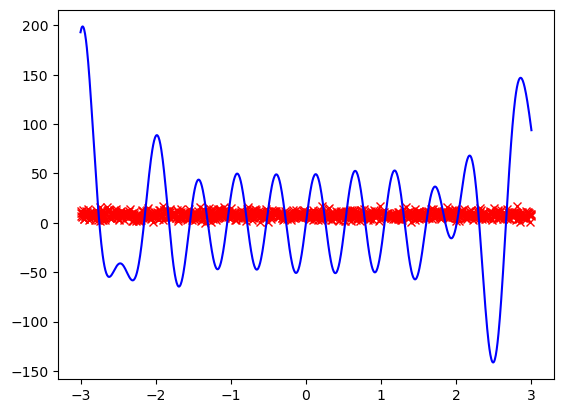

In [12]:
plt.plot(x_test,u_pred,'rx')
plt.plot(x_test,u_true,'b')

In [16]:
import scipy.io as sio
import numpy as np

for tune_reps in range(75):
    label = "Regr_smooth_rowdy_tune"+str(tune_reps)+".mat"
    data = sio.loadmat(label)
    re = np.array(data["test_re"])
    print(tune_reps," ",np.mean(re[:,-1])<0.08)

0   False
1   False
2   False
3   False
4   False
5   False
6   False
7   False
8   False
9   False
10   False
11   False
12   False
13   False
14   False
15   False
16   False
17   False
18   False
19   False
20   False
21   False
22   False
23   False
24   False
25   False
26   False
27   False
28   False
29   False
30   False
31   False
32   False
33   False
34   False
35   False
36   False
37   False
38   False
39   False
40   False
41   False
42   False
43   False
44   False
45   False
46   False
47   False
48   False
49   False
50   False
51   False
52   False
53   False
54   False
55   False
56   False
57   False
58   False
59   False
60   False
61   False
62   True
63   False
64   False
65   False
66   False
67   False
68   False
69   False
70   False
71   False
72   False
73   False
74   False


In [17]:
lrnr_tune[62]

array([8.e-04, 5.e+00, 8.e+00])